# Import data

In [27]:
import numpy as np
import pandas as pd
import math
import matplotlib.pyplot as plt

In [2]:
X_test = pd.read_csv("./data/cleaned/X_test.csv")
y_test = pd.read_csv("./data/cleaned/y_test.csv")
X_train = pd.read_csv("./data/cleaned/X_train.csv")
y_train = pd.read_csv("./data/cleaned/y_train.csv")

X_test = X_test.drop(X_test.columns[[0]], axis = 1)
y_test = y_test.drop(y_test.columns[[0]], axis = 1)
X_train = X_train.drop(X_train.columns[[0]], axis = 1)
y_train = y_train.drop(y_train.columns[[0]], axis = 1)

In [9]:
# # Smote algorithm
from imblearn.over_sampling import SMOTE
smo = SMOTE(ratio={1:10000},random_state=42)

X_smo, y_smo = smo.fit_sample(X_train, y_train)

/home/ubuntu/anaconda3/envs/cd80test/lib/python3.7/site-packages/sklearn/linear_model/least_angle.py:35: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  eps=np.finfo(np.float).eps,
/home/ubuntu/anaconda3/envs/cd80test/lib/python3.7/site-packages/sklearn/linear_model/least_angle.py:597: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  eps=np.fi

# Model Training

In [3]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score

## Logistic Regression

In [ ]:
from sklearn.linear_model import LogisticRegression

clf_lr = LogisticRegression(max_iter=10000)
clf_lr.fit(X_train, y_train)

train_score = clf_lr.score(X_train, y_train)
test_score = clf_lr.score(X_test, y_test)

predict = clf_lr.predict(X_test)
accuracy = accuracy_score(y_test, predict)
f1_score_macro = f1_score(y_test, predict, average='macro')
f1_score_weighted = f1_score(y_test, predict, average='weighted')
auc = roc_auc_score(y_test,clf_lr.predict_proba(X_test)[:, 1])


compare_model = pd.DataFrame(data=[["Logistic Regression", train_score, test_score, accuracy, f1_score_macro, f1_score_weighted,auc]],
                                 columns=['Model', 'Training Accuracy %', 'Testing Accuracy %', 'Accuracy Score', 'F1_Score_Macro',
                                          'F1_Score_Weighted','AUC'])
compare_model

## MLP 

In [ ]:
from sklearn.neural_network import MLPClassifier

clf_mlp = MLPClassifier(solver='sgd', alpha=1e-5,
                    hidden_layer_sizes=(1000, 500, 100, 10), random_state=1,max_iter=100)
clf_mlp.fit(X_train, y_train)

train_score = clf_mlp.score(X_train, y_train)
test_score = clf_mlp.score(X_test, y_test)

predict = clf_mlp.predict(X_test)
accuracy = accuracy_score(y_test, predict)
f1_score_macro = f1_score(y_test, predict, average='macro')
f1_score_weighted = f1_score(y_test, predict, average='weighted')
auc = roc_auc_score(y_test, clf_mlp.predict_proba(X_test)[:, 1])

compare_model = pd.DataFrame(data=[["Neural Network", train_score, test_score, accuracy, f1_score_macro, f1_score_weighted, auc]],
                                 columns=['Model', 'Training Accuracy %', 'Testing Accuracy %', 'Accuracy Score', 'F1_Score_Macro',
                                          'F1_Score_Weighted', 'AUC'])
# compare_models = compare_models.append(compare_model_3,ignore_index=True)
compare_model

In [ ]:
clf_mlp.get_params()

## LightGBM

In [18]:
categorical_features = []
with open('./data/encoded_cols.txt','r') as f:
    for line in f:
        categorical_features.append(line.strip())

In [25]:
import lightgbm as lgb

X_train_part, X_val, y_train_part, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=100)
train_dataset = lgb.Dataset(data=X_train_part,label=y_train_part)
val_dataset = lgb.Dataset(data=X_val,label=y_val)

param = {'num_leaves':40, 'num_trees':1600, 'objective':'binary','metric': ['auc'],'is_unbalance':True}
num_round = 30
clf_lgb = lgb.train(param, train_dataset, num_round, valid_sets=[val_dataset])

predict = clf_lgb.predict(X_test, num_iteration=clf_lgb.best_iteration)
# accuracy = accuracy_score(y_test, predict)
# f1_score_macro = f1_score(y_test, predict, average='macro')
# f1_score_weighted = f1_score(y_test, predict, average='weighted')
auc = roc_auc_score(y_test, predict)

# compare_model = pd.DataFrame(data=[["LightBGM", train_score, test_score, accuracy, f1_score_macro, f1_score_weighted, auc]],
#                                  columns=['Model', 'Training Accuracy %', 'Testing Accuracy %', 'Accuracy Score', 'F1_Score_Macro',
#                                           'F1_Score_Weighted', 'AUC'])
# compare_models = compare_models.append(compare_model_3,ignore_index=True)
# compare_model
auc

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044844 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.542929
[2]	valid_0's auc: 0.54018
[3]	valid_0's auc: 0.539635
[4]	valid_0's auc: 0.543006
[5]	valid_0's auc: 0.544615
[6]	valid_0's auc: 0.544823
[7]	valid_0's auc: 0.544454
[8]	valid_0's auc: 0.545843
[9]	valid_0's auc: 0.550163
[10]	valid_0's auc: 0.552588
[11]	valid_0's auc: 0.553966
[12]	valid_0's auc: 0.554286
[13]	valid_0's auc: 0.555592
[14]	valid_0's auc: 0.557186
[15]	valid_0's auc: 0.560019
[16]	valid_0'

[271]	valid_0's auc: 0.559893
[272]	valid_0's auc: 0.560225
[273]	valid_0's auc: 0.560296
[274]	valid_0's auc: 0.559883
[275]	valid_0's auc: 0.559538
[276]	valid_0's auc: 0.559613
[277]	valid_0's auc: 0.55989
[278]	valid_0's auc: 0.559512
[279]	valid_0's auc: 0.559498
[280]	valid_0's auc: 0.559497
[281]	valid_0's auc: 0.559638
[282]	valid_0's auc: 0.558953
[283]	valid_0's auc: 0.558847
[284]	valid_0's auc: 0.558992
[285]	valid_0's auc: 0.558954
[286]	valid_0's auc: 0.558881
[287]	valid_0's auc: 0.558866
[288]	valid_0's auc: 0.558373
[289]	valid_0's auc: 0.558508
[290]	valid_0's auc: 0.558363
[291]	valid_0's auc: 0.558522
[292]	valid_0's auc: 0.558784
[293]	valid_0's auc: 0.558713
[294]	valid_0's auc: 0.558564
[295]	valid_0's auc: 0.55851
[296]	valid_0's auc: 0.558411
[297]	valid_0's auc: 0.557428
[298]	valid_0's auc: 0.557326
[299]	valid_0's auc: 0.557581
[300]	valid_0's auc: 0.55794
[301]	valid_0's auc: 0.557893
[302]	valid_0's auc: 0.557808
[303]	valid_0's auc: 0.557626
[304]	valid_0

[556]	valid_0's auc: 0.556561
[557]	valid_0's auc: 0.55672
[558]	valid_0's auc: 0.556937
[559]	valid_0's auc: 0.55714
[560]	valid_0's auc: 0.55722
[561]	valid_0's auc: 0.557004
[562]	valid_0's auc: 0.556881
[563]	valid_0's auc: 0.556987
[564]	valid_0's auc: 0.556676
[565]	valid_0's auc: 0.556865
[566]	valid_0's auc: 0.556831
[567]	valid_0's auc: 0.556472
[568]	valid_0's auc: 0.556466
[569]	valid_0's auc: 0.556657
[570]	valid_0's auc: 0.556605
[571]	valid_0's auc: 0.556505
[572]	valid_0's auc: 0.556181
[573]	valid_0's auc: 0.556116
[574]	valid_0's auc: 0.555975
[575]	valid_0's auc: 0.555904
[576]	valid_0's auc: 0.55566
[577]	valid_0's auc: 0.555577
[578]	valid_0's auc: 0.55524
[579]	valid_0's auc: 0.555031
[580]	valid_0's auc: 0.555252
[581]	valid_0's auc: 0.555185
[582]	valid_0's auc: 0.554986
[583]	valid_0's auc: 0.555017
[584]	valid_0's auc: 0.555003
[585]	valid_0's auc: 0.555053
[586]	valid_0's auc: 0.554992
[587]	valid_0's auc: 0.554829
[588]	valid_0's auc: 0.554616
[589]	valid_0's

[844]	valid_0's auc: 0.557424
[845]	valid_0's auc: 0.557522
[846]	valid_0's auc: 0.557466
[847]	valid_0's auc: 0.557496
[848]	valid_0's auc: 0.557308
[849]	valid_0's auc: 0.557337
[850]	valid_0's auc: 0.557377
[851]	valid_0's auc: 0.557324
[852]	valid_0's auc: 0.557378
[853]	valid_0's auc: 0.557357
[854]	valid_0's auc: 0.55732
[855]	valid_0's auc: 0.557424
[856]	valid_0's auc: 0.557379
[857]	valid_0's auc: 0.557296
[858]	valid_0's auc: 0.557091
[859]	valid_0's auc: 0.556951
[860]	valid_0's auc: 0.55695
[861]	valid_0's auc: 0.557123
[862]	valid_0's auc: 0.557128
[863]	valid_0's auc: 0.556903
[864]	valid_0's auc: 0.55666
[865]	valid_0's auc: 0.556719
[866]	valid_0's auc: 0.556898
[867]	valid_0's auc: 0.557001
[868]	valid_0's auc: 0.557315
[869]	valid_0's auc: 0.557477
[870]	valid_0's auc: 0.557396
[871]	valid_0's auc: 0.557539
[872]	valid_0's auc: 0.557228
[873]	valid_0's auc: 0.557106
[874]	valid_0's auc: 0.557096
[875]	valid_0's auc: 0.557216
[876]	valid_0's auc: 0.557093
[877]	valid_0

[1128]	valid_0's auc: 0.554504
[1129]	valid_0's auc: 0.554592
[1130]	valid_0's auc: 0.554517
[1131]	valid_0's auc: 0.554527
[1132]	valid_0's auc: 0.554598
[1133]	valid_0's auc: 0.55444
[1134]	valid_0's auc: 0.554655
[1135]	valid_0's auc: 0.554805
[1136]	valid_0's auc: 0.554753
[1137]	valid_0's auc: 0.554526
[1138]	valid_0's auc: 0.554653
[1139]	valid_0's auc: 0.554581
[1140]	valid_0's auc: 0.55444
[1141]	valid_0's auc: 0.554259
[1142]	valid_0's auc: 0.554089
[1143]	valid_0's auc: 0.554273
[1144]	valid_0's auc: 0.554395
[1145]	valid_0's auc: 0.55432
[1146]	valid_0's auc: 0.554308
[1147]	valid_0's auc: 0.554306
[1148]	valid_0's auc: 0.554424
[1149]	valid_0's auc: 0.554513
[1150]	valid_0's auc: 0.554363
[1151]	valid_0's auc: 0.554476
[1152]	valid_0's auc: 0.554403
[1153]	valid_0's auc: 0.554424
[1154]	valid_0's auc: 0.554308
[1155]	valid_0's auc: 0.554155
[1156]	valid_0's auc: 0.554171
[1157]	valid_0's auc: 0.553914
[1158]	valid_0's auc: 0.553755
[1159]	valid_0's auc: 0.553797
[1160]	vali

[1406]	valid_0's auc: 0.551487
[1407]	valid_0's auc: 0.551517
[1408]	valid_0's auc: 0.551379
[1409]	valid_0's auc: 0.551166
[1410]	valid_0's auc: 0.550944
[1411]	valid_0's auc: 0.551107
[1412]	valid_0's auc: 0.551203
[1413]	valid_0's auc: 0.55118
[1414]	valid_0's auc: 0.551001
[1415]	valid_0's auc: 0.551051
[1416]	valid_0's auc: 0.550937
[1417]	valid_0's auc: 0.55086
[1418]	valid_0's auc: 0.550736
[1419]	valid_0's auc: 0.550869
[1420]	valid_0's auc: 0.550844
[1421]	valid_0's auc: 0.551042
[1422]	valid_0's auc: 0.551155
[1423]	valid_0's auc: 0.551366
[1424]	valid_0's auc: 0.551402
[1425]	valid_0's auc: 0.551453
[1426]	valid_0's auc: 0.551689
[1427]	valid_0's auc: 0.551594
[1428]	valid_0's auc: 0.551629
[1429]	valid_0's auc: 0.551638
[1430]	valid_0's auc: 0.551507
[1431]	valid_0's auc: 0.5515
[1432]	valid_0's auc: 0.551385
[1433]	valid_0's auc: 0.551261
[1434]	valid_0's auc: 0.551367
[1435]	valid_0's auc: 0.551311
[1436]	valid_0's auc: 0.551373
[1437]	valid_0's auc: 0.551425
[1438]	valid

0.5694326878746714

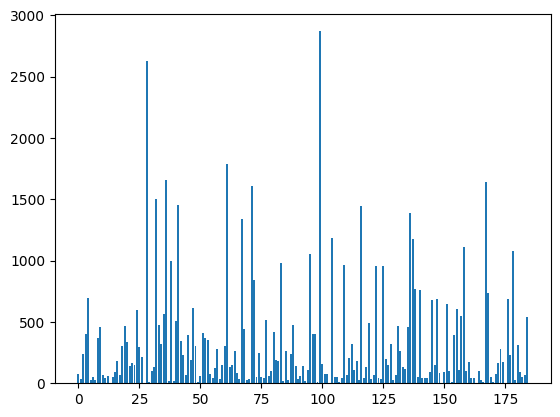

In [30]:
clf_lgb.feature_importance()
plt.bar(range(len(clf_lgb.feature_importance())), clf_lgb.feature_importance())
plt.show()

In [21]:
import lightgbm as lgbm

In [ ]:
lgb_clf = lgbm.LGBMClassifier(i)

In [20]:
train_predict = clf_lgb.predict(X_train, num_iteration=clf_lgb.best_iteration)

In [33]:
# EMurate
import lightgbm as lgb

X_train_part, X_val, y_train_part, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=100)
train_dataset = lgb.Dataset(data=X_train_part,label=y_train_part)
val_dataset = lgb.Dataset(data=X_val,label=y_val)

record = []
aucs = []

# [31, 1502, 0.5745396714880048]
for leave in range(30, 51):
    for trees in range(1500, 1700):
        param = {'num_leaves':leave, 'num_trees':trees, 'objective':'binary','metric': ['auc'],'is_unbalance':True}
        num_round = 30
        clf_lgb = lgb.train(param, train_dataset, num_round, valid_sets=[val_dataset])

        predict = clf_lgb.predict(X_test, num_iteration=clf_lgb.best_iteration)
        # accuracy = accuracy_score(y_test, predict)
        # f1_score_macro = f1_score(y_test, predict, average='macro')
        # f1_score_weighted = f1_score(y_test, predict, average='weighted')
        auc = roc_auc_score(y_test, predict)
        aucs.append(auc)
        record.append([leave, trees, auc])

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.045523 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.547136
[2]	valid_0's auc: 0.544657
[3]	valid_0's auc: 0.545353
[4]	valid_0's auc: 0.549726
[5]	valid_0's auc: 0.550085
[6]	valid_0's auc: 0.551699
[7]	valid_0's auc: 0.555938
[8]	valid_0's auc: 0.553666
[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11]	valid_0's auc: 0.554359
[12]	valid_0's auc: 0.556
[13]	valid_0's auc: 0.556372
[14]	valid_0's auc: 0.554258
[15]	valid_0's auc: 0.557704
[16]	valid_0's 

[281]	valid_0's auc: 0.565317
[282]	valid_0's auc: 0.564999
[283]	valid_0's auc: 0.564596
[284]	valid_0's auc: 0.564132
[285]	valid_0's auc: 0.564165
[286]	valid_0's auc: 0.564088
[287]	valid_0's auc: 0.563942
[288]	valid_0's auc: 0.563904
[289]	valid_0's auc: 0.563855
[290]	valid_0's auc: 0.563794
[291]	valid_0's auc: 0.563647
[292]	valid_0's auc: 0.563834
[293]	valid_0's auc: 0.563942
[294]	valid_0's auc: 0.564159
[295]	valid_0's auc: 0.56451
[296]	valid_0's auc: 0.564222
[297]	valid_0's auc: 0.564318
[298]	valid_0's auc: 0.564312
[299]	valid_0's auc: 0.564166
[300]	valid_0's auc: 0.564253
[301]	valid_0's auc: 0.564726
[302]	valid_0's auc: 0.564924
[303]	valid_0's auc: 0.564678
[304]	valid_0's auc: 0.564755
[305]	valid_0's auc: 0.565012
[306]	valid_0's auc: 0.564932
[307]	valid_0's auc: 0.564825
[308]	valid_0's auc: 0.565036
[309]	valid_0's auc: 0.565708
[310]	valid_0's auc: 0.565712
[311]	valid_0's auc: 0.565799
[312]	valid_0's auc: 0.565502
[313]	valid_0's auc: 0.565122
[314]	valid

[566]	valid_0's auc: 0.557454
[567]	valid_0's auc: 0.5573
[568]	valid_0's auc: 0.557497
[569]	valid_0's auc: 0.557447
[570]	valid_0's auc: 0.557292
[571]	valid_0's auc: 0.55743
[572]	valid_0's auc: 0.557434
[573]	valid_0's auc: 0.557351
[574]	valid_0's auc: 0.557247
[575]	valid_0's auc: 0.557487
[576]	valid_0's auc: 0.557501
[577]	valid_0's auc: 0.557611
[578]	valid_0's auc: 0.557648
[579]	valid_0's auc: 0.557947
[580]	valid_0's auc: 0.557785
[581]	valid_0's auc: 0.557922
[582]	valid_0's auc: 0.557803
[583]	valid_0's auc: 0.557744
[584]	valid_0's auc: 0.557765
[585]	valid_0's auc: 0.557727
[586]	valid_0's auc: 0.558059
[587]	valid_0's auc: 0.558091
[588]	valid_0's auc: 0.558183
[589]	valid_0's auc: 0.558294
[590]	valid_0's auc: 0.558543
[591]	valid_0's auc: 0.559032
[592]	valid_0's auc: 0.559128
[593]	valid_0's auc: 0.559146
[594]	valid_0's auc: 0.559205
[595]	valid_0's auc: 0.558991
[596]	valid_0's auc: 0.55885
[597]	valid_0's auc: 0.558946
[598]	valid_0's auc: 0.559329
[599]	valid_0'

[851]	valid_0's auc: 0.554101
[852]	valid_0's auc: 0.554295
[853]	valid_0's auc: 0.554383
[854]	valid_0's auc: 0.554212
[855]	valid_0's auc: 0.554246
[856]	valid_0's auc: 0.554364
[857]	valid_0's auc: 0.554185
[858]	valid_0's auc: 0.554031
[859]	valid_0's auc: 0.554173
[860]	valid_0's auc: 0.554106
[861]	valid_0's auc: 0.553973
[862]	valid_0's auc: 0.553701
[863]	valid_0's auc: 0.55368
[864]	valid_0's auc: 0.55379
[865]	valid_0's auc: 0.553832
[866]	valid_0's auc: 0.553878
[867]	valid_0's auc: 0.553854
[868]	valid_0's auc: 0.553842
[869]	valid_0's auc: 0.553861
[870]	valid_0's auc: 0.553844
[871]	valid_0's auc: 0.553802
[872]	valid_0's auc: 0.553787
[873]	valid_0's auc: 0.553699
[874]	valid_0's auc: 0.553729
[875]	valid_0's auc: 0.55383
[876]	valid_0's auc: 0.553665
[877]	valid_0's auc: 0.553874
[878]	valid_0's auc: 0.554095
[879]	valid_0's auc: 0.553925
[880]	valid_0's auc: 0.553968
[881]	valid_0's auc: 0.553869
[882]	valid_0's auc: 0.554002
[883]	valid_0's auc: 0.553986
[884]	valid_0

[1138]	valid_0's auc: 0.552125
[1139]	valid_0's auc: 0.552305
[1140]	valid_0's auc: 0.552354
[1141]	valid_0's auc: 0.552441
[1142]	valid_0's auc: 0.552584
[1143]	valid_0's auc: 0.552607
[1144]	valid_0's auc: 0.552681
[1145]	valid_0's auc: 0.552766
[1146]	valid_0's auc: 0.552864
[1147]	valid_0's auc: 0.552944
[1148]	valid_0's auc: 0.552873
[1149]	valid_0's auc: 0.552871
[1150]	valid_0's auc: 0.552955
[1151]	valid_0's auc: 0.552946
[1152]	valid_0's auc: 0.55272
[1153]	valid_0's auc: 0.552705
[1154]	valid_0's auc: 0.552732
[1155]	valid_0's auc: 0.552513
[1156]	valid_0's auc: 0.552517
[1157]	valid_0's auc: 0.55268
[1158]	valid_0's auc: 0.552784
[1159]	valid_0's auc: 0.552796
[1160]	valid_0's auc: 0.552588
[1161]	valid_0's auc: 0.552616
[1162]	valid_0's auc: 0.55289
[1163]	valid_0's auc: 0.552897
[1164]	valid_0's auc: 0.552927
[1165]	valid_0's auc: 0.552752
[1166]	valid_0's auc: 0.552695
[1167]	valid_0's auc: 0.552553
[1168]	valid_0's auc: 0.552584
[1169]	valid_0's auc: 0.552515
[1170]	vali

[1423]	valid_0's auc: 0.552718
[1424]	valid_0's auc: 0.552958
[1425]	valid_0's auc: 0.55314
[1426]	valid_0's auc: 0.553097
[1427]	valid_0's auc: 0.55311
[1428]	valid_0's auc: 0.55324
[1429]	valid_0's auc: 0.553332
[1430]	valid_0's auc: 0.553331
[1431]	valid_0's auc: 0.553131
[1432]	valid_0's auc: 0.553139
[1433]	valid_0's auc: 0.55294
[1434]	valid_0's auc: 0.55302
[1435]	valid_0's auc: 0.553124
[1436]	valid_0's auc: 0.553458
[1437]	valid_0's auc: 0.553559
[1438]	valid_0's auc: 0.553687
[1439]	valid_0's auc: 0.553615
[1440]	valid_0's auc: 0.553549
[1441]	valid_0's auc: 0.553145
[1442]	valid_0's auc: 0.553337
[1443]	valid_0's auc: 0.553163
[1444]	valid_0's auc: 0.553133
[1445]	valid_0's auc: 0.553222
[1446]	valid_0's auc: 0.55326
[1447]	valid_0's auc: 0.553295
[1448]	valid_0's auc: 0.55324
[1449]	valid_0's auc: 0.553156
[1450]	valid_0's auc: 0.553177
[1451]	valid_0's auc: 0.553245
[1452]	valid_0's auc: 0.552973
[1453]	valid_0's auc: 0.552985
[1454]	valid_0's auc: 0.553183
[1455]	valid_0'

[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0's auc: 0.568377
[208]	valid_0's auc: 0.568928
[209]	valid_0's auc: 0.568243
[210]	valid_0's auc: 0.568736
[211]	valid_0's auc: 0.568633
[212]	valid_0's auc: 0.568544
[213]	valid_0's auc: 0.568975
[214]	valid_0's auc: 0.569083
[215]	valid_0's auc: 0.568582
[216]	valid_0's auc: 0.568364
[217]	valid_0's auc: 0.568558
[218]	valid_0's auc: 0.568215
[219]	valid_0's auc: 0.56783
[220]	valid_0's auc: 0.567785
[221]	valid_0's auc: 0.567559
[222]	valid_0's auc: 0.567436
[223]	valid_0

[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0's auc: 0.557172
[492]	valid_0's auc: 0.557092
[493]	valid_0's auc: 0.557117
[494]	valid_0's auc: 0.556983
[495]	valid_0's auc: 0.557031
[496]	valid_0's auc: 0.55711
[497]	valid_0's auc: 0.557342
[498]	valid_0's auc: 0.557175
[499]	valid_0's auc: 0.557299
[500]	valid_0's auc: 0.557625
[501]	valid_0's auc: 0.557922
[502]	valid_0's auc: 0.557817
[503]	valid_0's auc: 0.557368
[504]	valid_0's auc: 0.55703
[505]	valid_0's auc: 0.557586
[506]	valid_0's auc: 0.557457
[507]	valid_0'

[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0's auc: 0.558845
[766]	valid_0's auc: 0.558738
[767]	valid_0's auc: 0.55871
[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's auc: 0.558235
[772]	valid_0's auc: 0.558139
[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0's auc: 0.557726
[780]	valid_0's auc: 0.557786
[781]	valid_0's auc: 0.557735
[782]	valid_0's auc: 0.557813
[783]	valid_

[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid_0's auc: 0.550998
[1071]	valid_0's auc: 0.55137
[1072]	valid_

[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	valid_0's auc: 0.552789
[1327]	valid_0's auc: 0.552762
[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	valid_0's auc: 0.553014
[1340]	val

[68]	valid_0's auc: 0.570398
[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.571963
[78]	valid_0's auc: 0.571434
[79]	valid_0's auc: 0.571632
[80]	valid_0's auc: 0.571471
[81]	valid_0's auc: 0.571274
[82]	valid_0's auc: 0.572302
[83]	valid_0's auc: 0.571868
[84]	valid_0's auc: 0.572564
[85]	valid_0's auc: 0.572393
[86]	valid_0's auc: 0.572896
[87]	valid_0's auc: 0.573071
[88]	valid_0's auc: 0.573348
[89]	valid_0's auc: 0.572758
[90]	valid_0's auc: 0.572937
[91]	valid_0's auc: 0.571971
[92]	valid_0's auc: 0.57245
[93]	valid_0's auc: 0.573568
[94]	valid_0's auc: 0.57398
[95]	valid_0's auc: 0.574295
[96]	valid_0's auc: 0.573695
[97]	valid_0's auc: 0.574155
[98]	valid_0's auc: 0.574236
[99]	valid_0's auc: 0.574507
[100]	valid_0's auc: 0.573809
[101]	valid_0's auc: 0.573662
[102]	valid_0's a

[346]	valid_0's auc: 0.563502
[347]	valid_0's auc: 0.562895
[348]	valid_0's auc: 0.562759
[349]	valid_0's auc: 0.562657
[350]	valid_0's auc: 0.562357
[351]	valid_0's auc: 0.562246
[352]	valid_0's auc: 0.562663
[353]	valid_0's auc: 0.562821
[354]	valid_0's auc: 0.563034
[355]	valid_0's auc: 0.563509
[356]	valid_0's auc: 0.563722
[357]	valid_0's auc: 0.563125
[358]	valid_0's auc: 0.562696
[359]	valid_0's auc: 0.562894
[360]	valid_0's auc: 0.56309
[361]	valid_0's auc: 0.563012
[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's auc: 0.563318
[368]	valid_0's auc: 0.5635
[369]	valid_0's auc: 0.563182
[370]	valid_0's auc: 0.56291
[371]	valid_0's auc: 0.563073
[372]	valid_0's auc: 0.563596
[373]	valid_0's auc: 0.563489
[374]	valid_0's auc: 0.563412
[375]	valid_0's auc: 0.563498
[376]	valid_0's auc: 0.563012
[377]	valid_0's auc: 0.563039
[378]	valid_0's auc: 0.562773
[379]	valid_0's

[640]	valid_0's auc: 0.559466
[641]	valid_0's auc: 0.559589
[642]	valid_0's auc: 0.559791
[643]	valid_0's auc: 0.560027
[644]	valid_0's auc: 0.560243
[645]	valid_0's auc: 0.560118
[646]	valid_0's auc: 0.560278
[647]	valid_0's auc: 0.560339
[648]	valid_0's auc: 0.560585
[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0's auc: 0.560302
[652]	valid_0's auc: 0.560158
[653]	valid_0's auc: 0.559862
[654]	valid_0's auc: 0.560273
[655]	valid_0's auc: 0.560263
[656]	valid_0's auc: 0.560225
[657]	valid_0's auc: 0.560201
[658]	valid_0's auc: 0.560328
[659]	valid_0's auc: 0.560252
[660]	valid_0's auc: 0.560185
[661]	valid_0's auc: 0.560251
[662]	valid_0's auc: 0.560257
[663]	valid_0's auc: 0.560486
[664]	valid_0's auc: 0.560092
[665]	valid_0's auc: 0.560057
[666]	valid_0's auc: 0.559987
[667]	valid_0's auc: 0.560066
[668]	valid_0's auc: 0.56051
[669]	valid_0's auc: 0.560362
[670]	valid_0's auc: 0.560094
[671]	valid_0's auc: 0.560352
[672]	valid_0's auc: 0.560294
[673]	valid

[914]	valid_0's auc: 0.554779
[915]	valid_0's auc: 0.554744
[916]	valid_0's auc: 0.554773
[917]	valid_0's auc: 0.554645
[918]	valid_0's auc: 0.554734
[919]	valid_0's auc: 0.554504
[920]	valid_0's auc: 0.554424
[921]	valid_0's auc: 0.554364
[922]	valid_0's auc: 0.554182
[923]	valid_0's auc: 0.554022
[924]	valid_0's auc: 0.554016
[925]	valid_0's auc: 0.554119
[926]	valid_0's auc: 0.554147
[927]	valid_0's auc: 0.554169
[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	valid_0's auc: 0.553797
[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_0's auc: 0.553951
[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_0's auc: 0.553326
[940]	valid_0's auc: 0.553487
[941]	valid_0's auc: 0.553477
[942]	valid_0's auc: 0.553237
[943]	valid_0's auc: 0.553354
[944]	valid_0's auc: 0.553513
[945]	valid_0's auc: 0.55335
[946]	valid_0's auc: 0.553024
[947]	valid_0

[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	valid_0's auc: 0.552802
[1188]	valid_0's auc: 0.55274
[1189]	valid_0's auc: 0.552564
[1190]	valid_0's auc: 0.552621
[1191]	valid_0's auc: 0.552696
[1192]	valid_0's auc: 0.552683
[1193]	valid_0's auc: 0.552642
[1194]	valid_0's auc: 0.552454
[1195]	valid_0's auc: 0.552533
[1196]	valid_0's auc: 0.552504
[1197]	valid_0's auc: 0.55275
[1198]	valid_0's auc: 0.552742
[1199]	valid_0's auc: 0.552772
[1200]	valid_0's auc: 0.552695
[1201]	valid_0's auc: 0.552665
[1202]	valid_0's auc: 0.55264
[1203]	valid_0's auc: 0.552677
[1204]	valid_0's auc: 0.552636
[1205]	valid_0's auc: 0.552485
[1206]	valid_0's auc: 0.552239
[1207]	valid_0's auc: 0.552244
[1208]	valid_0's auc: 0.552166
[1209]	valid_0's auc: 0.552319
[1210]	valid_0's auc: 0.552386
[1211]	valid_0's auc: 0.552425
[1212]	valid_0's auc: 0.552337
[1213]	valid_0's auc: 0.552554
[1214]	valid_0's auc: 0.552694
[1215]	valid_0's auc: 0.552477
[1216]	vali

[1470]	valid_0's auc: 0.553171
[1471]	valid_0's auc: 0.553251
[1472]	valid_0's auc: 0.552995
[1473]	valid_0's auc: 0.552988
[1474]	valid_0's auc: 0.552748
[1475]	valid_0's auc: 0.552917
[1476]	valid_0's auc: 0.552696
[1477]	valid_0's auc: 0.552848
[1478]	valid_0's auc: 0.552835
[1479]	valid_0's auc: 0.552656
[1480]	valid_0's auc: 0.552429
[1481]	valid_0's auc: 0.552613
[1482]	valid_0's auc: 0.552579
[1483]	valid_0's auc: 0.552663
[1484]	valid_0's auc: 0.552621
[1485]	valid_0's auc: 0.552506
[1486]	valid_0's auc: 0.552505
[1487]	valid_0's auc: 0.552365
[1488]	valid_0's auc: 0.552294
[1489]	valid_0's auc: 0.552253
[1490]	valid_0's auc: 0.552133
[1491]	valid_0's auc: 0.552075
[1492]	valid_0's auc: 0.552135
[1493]	valid_0's auc: 0.551762
[1494]	valid_0's auc: 0.551596
[1495]	valid_0's auc: 0.551597
[1496]	valid_0's auc: 0.55175
[1497]	valid_0's auc: 0.551746
[1498]	valid_0's auc: 0.551702
[1499]	valid_0's auc: 0.551828
[1500]	valid_0's auc: 0.551906
[1501]	valid_0's auc: 0.551523
[1502]	va

[226]	valid_0's auc: 0.567562
[227]	valid_0's auc: 0.5675
[228]	valid_0's auc: 0.567421
[229]	valid_0's auc: 0.567524
[230]	valid_0's auc: 0.567747
[231]	valid_0's auc: 0.567784
[232]	valid_0's auc: 0.568373
[233]	valid_0's auc: 0.568331
[234]	valid_0's auc: 0.568216
[235]	valid_0's auc: 0.568333
[236]	valid_0's auc: 0.568762
[237]	valid_0's auc: 0.568464
[238]	valid_0's auc: 0.568266
[239]	valid_0's auc: 0.568053
[240]	valid_0's auc: 0.568039
[241]	valid_0's auc: 0.567963
[242]	valid_0's auc: 0.568093
[243]	valid_0's auc: 0.568131
[244]	valid_0's auc: 0.568507
[245]	valid_0's auc: 0.568257
[246]	valid_0's auc: 0.568531
[247]	valid_0's auc: 0.568686
[248]	valid_0's auc: 0.568169
[249]	valid_0's auc: 0.568072
[250]	valid_0's auc: 0.56732
[251]	valid_0's auc: 0.567614
[252]	valid_0's auc: 0.567265
[253]	valid_0's auc: 0.567199
[254]	valid_0's auc: 0.567104
[255]	valid_0's auc: 0.567139
[256]	valid_0's auc: 0.567263
[257]	valid_0's auc: 0.56728
[258]	valid_0's auc: 0.566933
[259]	valid_0'

[511]	valid_0's auc: 0.55785
[512]	valid_0's auc: 0.558121
[513]	valid_0's auc: 0.557815
[514]	valid_0's auc: 0.55799
[515]	valid_0's auc: 0.55762
[516]	valid_0's auc: 0.557761
[517]	valid_0's auc: 0.557723
[518]	valid_0's auc: 0.557826
[519]	valid_0's auc: 0.557946
[520]	valid_0's auc: 0.557683
[521]	valid_0's auc: 0.557542
[522]	valid_0's auc: 0.557521
[523]	valid_0's auc: 0.557224
[524]	valid_0's auc: 0.557051
[525]	valid_0's auc: 0.556861
[526]	valid_0's auc: 0.55683
[527]	valid_0's auc: 0.556784
[528]	valid_0's auc: 0.556708
[529]	valid_0's auc: 0.556335
[530]	valid_0's auc: 0.556389
[531]	valid_0's auc: 0.55632
[532]	valid_0's auc: 0.555823
[533]	valid_0's auc: 0.555723
[534]	valid_0's auc: 0.55625
[535]	valid_0's auc: 0.556219
[536]	valid_0's auc: 0.556464
[537]	valid_0's auc: 0.556445
[538]	valid_0's auc: 0.556538
[539]	valid_0's auc: 0.556686
[540]	valid_0's auc: 0.556692
[541]	valid_0's auc: 0.556629
[542]	valid_0's auc: 0.556567
[543]	valid_0's auc: 0.556769
[544]	valid_0's 

[799]	valid_0's auc: 0.557287
[800]	valid_0's auc: 0.556963
[801]	valid_0's auc: 0.556835
[802]	valid_0's auc: 0.556701
[803]	valid_0's auc: 0.556625
[804]	valid_0's auc: 0.556741
[805]	valid_0's auc: 0.556633
[806]	valid_0's auc: 0.556803
[807]	valid_0's auc: 0.556409
[808]	valid_0's auc: 0.556201
[809]	valid_0's auc: 0.555937
[810]	valid_0's auc: 0.555869
[811]	valid_0's auc: 0.555976
[812]	valid_0's auc: 0.555861
[813]	valid_0's auc: 0.555826
[814]	valid_0's auc: 0.555826
[815]	valid_0's auc: 0.555854
[816]	valid_0's auc: 0.555317
[817]	valid_0's auc: 0.555299
[818]	valid_0's auc: 0.555506
[819]	valid_0's auc: 0.55578
[820]	valid_0's auc: 0.555921
[821]	valid_0's auc: 0.55583
[822]	valid_0's auc: 0.555485
[823]	valid_0's auc: 0.555226
[824]	valid_0's auc: 0.555215
[825]	valid_0's auc: 0.554907
[826]	valid_0's auc: 0.554749
[827]	valid_0's auc: 0.554775
[828]	valid_0's auc: 0.554603
[829]	valid_0's auc: 0.554696
[830]	valid_0's auc: 0.554795
[831]	valid_0's auc: 0.554833
[832]	valid_

[1073]	valid_0's auc: 0.551022
[1074]	valid_0's auc: 0.551007
[1075]	valid_0's auc: 0.551133
[1076]	valid_0's auc: 0.551209
[1077]	valid_0's auc: 0.551132
[1078]	valid_0's auc: 0.551267
[1079]	valid_0's auc: 0.551267
[1080]	valid_0's auc: 0.551352
[1081]	valid_0's auc: 0.551644
[1082]	valid_0's auc: 0.551647
[1083]	valid_0's auc: 0.551628
[1084]	valid_0's auc: 0.551627
[1085]	valid_0's auc: 0.551513
[1086]	valid_0's auc: 0.551705
[1087]	valid_0's auc: 0.551589
[1088]	valid_0's auc: 0.551679
[1089]	valid_0's auc: 0.551294
[1090]	valid_0's auc: 0.551405
[1091]	valid_0's auc: 0.551668
[1092]	valid_0's auc: 0.551739
[1093]	valid_0's auc: 0.551857
[1094]	valid_0's auc: 0.551848
[1095]	valid_0's auc: 0.551895
[1096]	valid_0's auc: 0.552019
[1097]	valid_0's auc: 0.551952
[1098]	valid_0's auc: 0.551977
[1099]	valid_0's auc: 0.55195
[1100]	valid_0's auc: 0.551937
[1101]	valid_0's auc: 0.55203
[1102]	valid_0's auc: 0.551967
[1103]	valid_0's auc: 0.552053
[1104]	valid_0's auc: 0.552036
[1105]	val

[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	valid_0's auc: 0.552858
[1346]	valid_0's auc: 0.552883
[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	valid_0's auc: 0.552813
[1350]	valid_0's auc: 0.552744
[1351]	valid_0's auc: 0.552789
[1352]	valid_0's auc: 0.552797
[1353]	valid_0's auc: 0.552867
[1354]	valid_0's auc: 0.552799
[1355]	valid_0's auc: 0.552939
[1356]	valid_0's auc: 0.552946
[1357]	valid_0's auc: 0.553147
[1358]	valid_0's auc: 0.552913
[1359]	valid_0's auc: 0.553165
[1360]	valid_0's auc: 0.553042
[1361]	valid_0's auc: 0.552933
[1362]	valid_0's auc: 0.552921
[1363]	valid_0's auc: 0.552865
[1364]	valid_0's auc: 0.552936
[1365]	valid_0's auc: 0.552858
[1366]	valid_0's auc: 0.552811
[1367]	valid_0's auc: 0.552932
[1368]	valid_0's auc: 0.553129
[1369]	valid_0's auc: 0.553285
[1370]	valid_0's auc: 0.553298
[1371]	valid_0's auc: 0.553145
[1372]	valid_0's auc: 0.553233
[1373]	valid_0's auc: 0.553286
[1374]	va

[109]	valid_0's auc: 0.572879
[110]	valid_0's auc: 0.572809
[111]	valid_0's auc: 0.572884
[112]	valid_0's auc: 0.573155
[113]	valid_0's auc: 0.573604
[114]	valid_0's auc: 0.574317
[115]	valid_0's auc: 0.575085
[116]	valid_0's auc: 0.574949
[117]	valid_0's auc: 0.574421
[118]	valid_0's auc: 0.573742
[119]	valid_0's auc: 0.57384
[120]	valid_0's auc: 0.573323
[121]	valid_0's auc: 0.574054
[122]	valid_0's auc: 0.573762
[123]	valid_0's auc: 0.572396
[124]	valid_0's auc: 0.572284
[125]	valid_0's auc: 0.572948
[126]	valid_0's auc: 0.573186
[127]	valid_0's auc: 0.573339
[128]	valid_0's auc: 0.573423
[129]	valid_0's auc: 0.572927
[130]	valid_0's auc: 0.573088
[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid_0's auc: 0.573667
[134]	valid_0's auc: 0.573871
[135]	valid_0's auc: 0.572665
[136]	valid_0's auc: 0.572543
[137]	valid_0's auc: 0.572231
[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid

[393]	valid_0's auc: 0.561289
[394]	valid_0's auc: 0.561353
[395]	valid_0's auc: 0.560886
[396]	valid_0's auc: 0.560773
[397]	valid_0's auc: 0.560711
[398]	valid_0's auc: 0.56073
[399]	valid_0's auc: 0.561163
[400]	valid_0's auc: 0.5613
[401]	valid_0's auc: 0.560945
[402]	valid_0's auc: 0.560651
[403]	valid_0's auc: 0.560286
[404]	valid_0's auc: 0.560188
[405]	valid_0's auc: 0.56006
[406]	valid_0's auc: 0.559947
[407]	valid_0's auc: 0.559893
[408]	valid_0's auc: 0.560237
[409]	valid_0's auc: 0.56039
[410]	valid_0's auc: 0.560689
[411]	valid_0's auc: 0.560816
[412]	valid_0's auc: 0.56043
[413]	valid_0's auc: 0.560283
[414]	valid_0's auc: 0.560447
[415]	valid_0's auc: 0.560244
[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's a

[688]	valid_0's auc: 0.560113
[689]	valid_0's auc: 0.560018
[690]	valid_0's auc: 0.559947
[691]	valid_0's auc: 0.560132
[692]	valid_0's auc: 0.559815
[693]	valid_0's auc: 0.560015
[694]	valid_0's auc: 0.560115
[695]	valid_0's auc: 0.560172
[696]	valid_0's auc: 0.560036
[697]	valid_0's auc: 0.55978
[698]	valid_0's auc: 0.55971
[699]	valid_0's auc: 0.559705
[700]	valid_0's auc: 0.559841
[701]	valid_0's auc: 0.5597
[702]	valid_0's auc: 0.559461
[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's auc: 0.559727
[721]	valid_0's

[966]	valid_0's auc: 0.552057
[967]	valid_0's auc: 0.552146
[968]	valid_0's auc: 0.552271
[969]	valid_0's auc: 0.552226
[970]	valid_0's auc: 0.552187
[971]	valid_0's auc: 0.552154
[972]	valid_0's auc: 0.55211
[973]	valid_0's auc: 0.552327
[974]	valid_0's auc: 0.552186
[975]	valid_0's auc: 0.552098
[976]	valid_0's auc: 0.551998
[977]	valid_0's auc: 0.551949
[978]	valid_0's auc: 0.552054
[979]	valid_0's auc: 0.551844
[980]	valid_0's auc: 0.551599
[981]	valid_0's auc: 0.551969
[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0's auc: 0.55191
[988]	valid_0's auc: 0.551857
[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_

[1240]	valid_0's auc: 0.551679
[1241]	valid_0's auc: 0.55164
[1242]	valid_0's auc: 0.551935
[1243]	valid_0's auc: 0.551799
[1244]	valid_0's auc: 0.551665
[1245]	valid_0's auc: 0.551727
[1246]	valid_0's auc: 0.551756
[1247]	valid_0's auc: 0.551721
[1248]	valid_0's auc: 0.551847
[1249]	valid_0's auc: 0.551946
[1250]	valid_0's auc: 0.552057
[1251]	valid_0's auc: 0.552052
[1252]	valid_0's auc: 0.552122
[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	valid_0's auc: 0.551867
[1264]	valid_0's auc: 0.551969
[1265]	valid_0's auc: 0.552066
[1266]	valid_0's auc: 0.552
[1267]	valid_0's auc: 0.552041
[1268]	valid_0's auc: 0.552158
[1269]	valid_0's auc: 0.552256
[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_

[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11]	valid_0's auc: 0.554359
[12]	valid_0's auc: 0.556
[13]	valid_0's auc: 0.556372
[14]	valid_0's auc: 0.554258
[15]	valid_0's auc: 0.557704
[16]	valid_0's auc: 0.55536
[17]	valid_0's auc: 0.555388
[18]	valid_0's auc: 0.557307
[19]	valid_0's auc: 0.557772
[20]	valid_0's auc: 0.559102
[21]	valid_0's auc: 0.559023
[22]	valid_0's auc: 0.560336
[23]	valid_0's auc: 0.560599
[24]	valid_0's auc: 0.562836
[25]	valid_0's auc: 0.562747
[26]	valid_0's auc: 0.561954
[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.566036
[43]	valid_0's auc: 0.

[302]	valid_0's auc: 0.564924
[303]	valid_0's auc: 0.564678
[304]	valid_0's auc: 0.564755
[305]	valid_0's auc: 0.565012
[306]	valid_0's auc: 0.564932
[307]	valid_0's auc: 0.564825
[308]	valid_0's auc: 0.565036
[309]	valid_0's auc: 0.565708
[310]	valid_0's auc: 0.565712
[311]	valid_0's auc: 0.565799
[312]	valid_0's auc: 0.565502
[313]	valid_0's auc: 0.565122
[314]	valid_0's auc: 0.564373
[315]	valid_0's auc: 0.563914
[316]	valid_0's auc: 0.56409
[317]	valid_0's auc: 0.564142
[318]	valid_0's auc: 0.563727
[319]	valid_0's auc: 0.563355
[320]	valid_0's auc: 0.563284
[321]	valid_0's auc: 0.562757
[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid_0's auc: 0.562482
[334]	valid_0's auc: 0.562787
[335]	valid

[593]	valid_0's auc: 0.559146
[594]	valid_0's auc: 0.559205
[595]	valid_0's auc: 0.558991
[596]	valid_0's auc: 0.55885
[597]	valid_0's auc: 0.558946
[598]	valid_0's auc: 0.559329
[599]	valid_0's auc: 0.559253
[600]	valid_0's auc: 0.559468
[601]	valid_0's auc: 0.559605
[602]	valid_0's auc: 0.55947
[603]	valid_0's auc: 0.559501
[604]	valid_0's auc: 0.559234
[605]	valid_0's auc: 0.558975
[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's auc: 0.558783
[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's auc: 0.558775
[622]	valid_0's auc: 0.559019
[623]	valid_0's auc: 0.559252
[624]	valid_0's auc: 0.559326
[625]	valid_0's auc: 0.559244
[626]	valid_0's

[884]	valid_0's auc: 0.55422
[885]	valid_0's auc: 0.554249
[886]	valid_0's auc: 0.554469
[887]	valid_0's auc: 0.554772
[888]	valid_0's auc: 0.554641
[889]	valid_0's auc: 0.554579
[890]	valid_0's auc: 0.554582
[891]	valid_0's auc: 0.554477
[892]	valid_0's auc: 0.554613
[893]	valid_0's auc: 0.554626
[894]	valid_0's auc: 0.55502
[895]	valid_0's auc: 0.554931
[896]	valid_0's auc: 0.555077
[897]	valid_0's auc: 0.554995
[898]	valid_0's auc: 0.555067
[899]	valid_0's auc: 0.555137
[900]	valid_0's auc: 0.555309
[901]	valid_0's auc: 0.555176
[902]	valid_0's auc: 0.555016
[903]	valid_0's auc: 0.555056
[904]	valid_0's auc: 0.555158
[905]	valid_0's auc: 0.555241
[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_0's auc: 0.554571
[911]	valid_0's auc: 0.554642
[912]	valid_0's auc: 0.554861
[913]	valid_0's auc: 0.554942
[914]	valid_0's auc: 0.554779
[915]	valid_0's auc: 0.554744
[916]	valid_0's auc: 0.554773
[917]	valid_

[1159]	valid_0's auc: 0.552796
[1160]	valid_0's auc: 0.552588
[1161]	valid_0's auc: 0.552616
[1162]	valid_0's auc: 0.55289
[1163]	valid_0's auc: 0.552897
[1164]	valid_0's auc: 0.552927
[1165]	valid_0's auc: 0.552752
[1166]	valid_0's auc: 0.552695
[1167]	valid_0's auc: 0.552553
[1168]	valid_0's auc: 0.552584
[1169]	valid_0's auc: 0.552515
[1170]	valid_0's auc: 0.552447
[1171]	valid_0's auc: 0.552478
[1172]	valid_0's auc: 0.552453
[1173]	valid_0's auc: 0.552279
[1174]	valid_0's auc: 0.552406
[1175]	valid_0's auc: 0.552247
[1176]	valid_0's auc: 0.552274
[1177]	valid_0's auc: 0.552389
[1178]	valid_0's auc: 0.552392
[1179]	valid_0's auc: 0.552437
[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	valid_0's auc: 0.552802
[1188]	valid_0's auc: 0.55274
[1189]	valid_0's auc: 0.552564
[1190]	valid_0's auc: 0.552621
[1191]	vali

[1430]	valid_0's auc: 0.553415
[1431]	valid_0's auc: 0.553215
[1432]	valid_0's auc: 0.553227
[1433]	valid_0's auc: 0.553028
[1434]	valid_0's auc: 0.553108
[1435]	valid_0's auc: 0.553212
[1436]	valid_0's auc: 0.553547
[1437]	valid_0's auc: 0.553649
[1438]	valid_0's auc: 0.553775
[1439]	valid_0's auc: 0.553702
[1440]	valid_0's auc: 0.553632
[1441]	valid_0's auc: 0.55323
[1442]	valid_0's auc: 0.55342
[1443]	valid_0's auc: 0.553244
[1444]	valid_0's auc: 0.553216
[1445]	valid_0's auc: 0.553303
[1446]	valid_0's auc: 0.553341
[1447]	valid_0's auc: 0.553376
[1448]	valid_0's auc: 0.553319
[1449]	valid_0's auc: 0.553236
[1450]	valid_0's auc: 0.553259
[1451]	valid_0's auc: 0.553327
[1452]	valid_0's auc: 0.553055
[1453]	valid_0's auc: 0.553066
[1454]	valid_0's auc: 0.553263
[1455]	valid_0's auc: 0.55332
[1456]	valid_0's auc: 0.553443
[1457]	valid_0's auc: 0.553241
[1458]	valid_0's auc: 0.553251
[1459]	valid_0's auc: 0.553149
[1460]	valid_0's auc: 0.553123
[1461]	valid_0's auc: 0.553171
[1462]	vali

[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0's auc: 0.568377
[208]	valid_0's auc: 0.568928
[209]	valid_0's auc: 0.568243
[210]	valid_0's auc: 0.568736
[211]	valid_0's auc: 0.568633
[212]	valid_0's auc: 0.568544
[213]	valid_0's auc: 0.568975
[214]	valid_0's auc: 0.569083
[215]	valid_0's auc: 0.568582
[216]	valid_0's auc: 0.568364
[217]	valid_0's auc: 0.568558
[218]	valid_0's auc: 0.568215
[219]	valid_0's auc: 0.56783
[220]	valid_0's auc: 0.567785
[221]	valid_0's auc: 0.567559
[222]	valid_0's auc: 0.567436
[223]	valid_0's auc: 0.567727
[224]	valid_0's auc: 0.567597
[225]	valid_0's auc: 0.567914
[226]	valid_0's auc: 0.567562
[227]	valid_0's auc: 0.5675
[228]	valid_0's auc: 0.567421
[229]	valid_0'

[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0's auc: 0.557172
[492]	valid_0's auc: 0.557092
[493]	valid_0's auc: 0.557117
[494]	valid_0's auc: 0.556983
[495]	valid_0's auc: 0.557031
[496]	valid_0's auc: 0.55711
[497]	valid_0's auc: 0.557342
[498]	valid_0's auc: 0.557175
[499]	valid_0's auc: 0.557299
[500]	valid_0's auc: 0.557625
[501]	valid_0's auc: 0.557922
[502]	valid_0's auc: 0.557817
[503]	valid_0's auc: 0.557368
[504]	valid_0's auc: 0.55703
[505]	valid_0's auc: 0.557586
[506]	valid_0's auc: 0.557457
[507]	valid_0's auc: 0.557555
[508]	valid_0's auc: 0.557745
[509]	valid_0's auc: 0.557749
[510]	valid_0's auc: 0.557756
[511]	valid_0's auc: 0.55785
[512]	valid_0's auc: 0.558121
[513]	valid_0's auc: 0.557815
[514]	valid_0's auc: 0.55799
[515]	valid_0's auc: 0.55762
[516]	valid_0's auc: 0.557761
[517]	valid_0's auc: 0.557723
[518]	valid_0's auc: 0.557826
[519]	valid_0's 

[780]	valid_0's auc: 0.557786
[781]	valid_0's auc: 0.557735
[782]	valid_0's auc: 0.557813
[783]	valid_0's auc: 0.557874
[784]	valid_0's auc: 0.557925
[785]	valid_0's auc: 0.558096
[786]	valid_0's auc: 0.558465
[787]	valid_0's auc: 0.558677
[788]	valid_0's auc: 0.558559
[789]	valid_0's auc: 0.558365
[790]	valid_0's auc: 0.558024
[791]	valid_0's auc: 0.557797
[792]	valid_0's auc: 0.557947
[793]	valid_0's auc: 0.557827
[794]	valid_0's auc: 0.557687
[795]	valid_0's auc: 0.557819
[796]	valid_0's auc: 0.557679
[797]	valid_0's auc: 0.557492
[798]	valid_0's auc: 0.55714
[799]	valid_0's auc: 0.557287
[800]	valid_0's auc: 0.556963
[801]	valid_0's auc: 0.556835
[802]	valid_0's auc: 0.556701
[803]	valid_0's auc: 0.556625
[804]	valid_0's auc: 0.556741
[805]	valid_0's auc: 0.556633
[806]	valid_0's auc: 0.556803
[807]	valid_0's auc: 0.556409
[808]	valid_0's auc: 0.556201
[809]	valid_0's auc: 0.555937
[810]	valid_0's auc: 0.555869
[811]	valid_0's auc: 0.555976
[812]	valid_0's auc: 0.555861
[813]	valid

[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid_0's auc: 0.550998
[1071]	valid_0's auc: 0.55137
[1072]	valid_0's auc: 0.551285
[1073]	valid_0's auc: 0.551022
[1074]	valid_0's auc: 0.551007
[1075]	valid_0's auc: 0.551133
[1076]	valid_0's auc: 0.551209
[1077]	valid_0's auc: 0.551132
[1078]	valid_0's auc: 0.551267
[1079]	valid_0's auc: 0.551267
[1080]	valid_0's auc: 0.551352
[1081]	valid_0's auc: 0.551644
[1082]	valid_0's auc: 0.551647
[1083]	valid_0's auc: 0.551628
[1084]	valid_0's auc: 0.551627
[1085]	valid_0's auc: 0.551513
[1086]	valid_0's auc: 0.551705
[1087]	valid_0's auc: 0.551589
[1088]	valid_0's auc: 0.551679
[1089]	valid

[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	valid_0's auc: 0.553014
[1340]	valid_0's auc: 0.553005
[1341]	valid_0's auc: 0.552947
[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	valid_0's auc: 0.552858
[1346]	valid_0's auc: 0.552883
[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	valid_0's auc: 0.552813
[1350]	valid_0's auc: 0.552744
[1351]	valid_0's auc: 0.552789
[1352]	valid_0's auc: 0.552797
[1353]	valid_0's auc: 0.552867
[1354]	valid_0's auc: 0.552799
[1355]	valid_0's auc: 0.552939
[1356]	valid_0's auc: 0.552946
[1357]	valid_0's auc: 0.553147
[1358]	valid_0's auc: 0.552913
[1359]	valid_0's auc: 0.553165
[1360]	valid_0's auc: 0.553042
[1361]	valid_0's auc: 0.552933
[1362]	vali

[82]	valid_0's auc: 0.572302
[83]	valid_0's auc: 0.571868
[84]	valid_0's auc: 0.572564
[85]	valid_0's auc: 0.572393
[86]	valid_0's auc: 0.572896
[87]	valid_0's auc: 0.573071
[88]	valid_0's auc: 0.573348
[89]	valid_0's auc: 0.572758
[90]	valid_0's auc: 0.572937
[91]	valid_0's auc: 0.571971
[92]	valid_0's auc: 0.57245
[93]	valid_0's auc: 0.573568
[94]	valid_0's auc: 0.57398
[95]	valid_0's auc: 0.574295
[96]	valid_0's auc: 0.573695
[97]	valid_0's auc: 0.574155
[98]	valid_0's auc: 0.574236
[99]	valid_0's auc: 0.574507
[100]	valid_0's auc: 0.573809
[101]	valid_0's auc: 0.573662
[102]	valid_0's auc: 0.573411
[103]	valid_0's auc: 0.574463
[104]	valid_0's auc: 0.574319
[105]	valid_0's auc: 0.574966
[106]	valid_0's auc: 0.574894
[107]	valid_0's auc: 0.574418
[108]	valid_0's auc: 0.573797
[109]	valid_0's auc: 0.572879
[110]	valid_0's auc: 0.572809
[111]	valid_0's auc: 0.572884
[112]	valid_0's auc: 0.573155
[113]	valid_0's auc: 0.573604
[114]	valid_0's auc: 0.574317
[115]	valid_0's auc: 0.575085


[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's auc: 0.563318
[368]	valid_0's auc: 0.5635
[369]	valid_0's auc: 0.563182
[370]	valid_0's auc: 0.56291
[371]	valid_0's auc: 0.563073
[372]	valid_0's auc: 0.563596
[373]	valid_0's auc: 0.563489
[374]	valid_0's auc: 0.563412
[375]	valid_0's auc: 0.563498
[376]	valid_0's auc: 0.563012
[377]	valid_0's auc: 0.563039
[378]	valid_0's auc: 0.562773
[379]	valid_0's auc: 0.563091
[380]	valid_0's auc: 0.562775
[381]	valid_0's auc: 0.562794
[382]	valid_0's auc: 0.562695
[383]	valid_0's auc: 0.562524
[384]	valid_0's auc: 0.56203
[385]	valid_0's auc: 0.561914
[386]	valid_0's auc: 0.561608
[387]	valid_0's auc: 0.561558
[388]	valid_0's auc: 0.561114
[389]	valid_0's auc: 0.561383
[390]	valid_0's auc: 0.561092
[391]	valid_0's auc: 0.561421
[392]	valid_0's auc: 0.561845
[393]	valid_0's auc: 0.561289
[394]	valid_0's auc: 0.561353
[395]	valid_0's auc: 0.560886
[396]	valid_0's auc: 0.560773
[397]	valid_0'

[659]	valid_0's auc: 0.560252
[660]	valid_0's auc: 0.560185
[661]	valid_0's auc: 0.560251
[662]	valid_0's auc: 0.560257
[663]	valid_0's auc: 0.560486
[664]	valid_0's auc: 0.560092
[665]	valid_0's auc: 0.560057
[666]	valid_0's auc: 0.559987
[667]	valid_0's auc: 0.560066
[668]	valid_0's auc: 0.56051
[669]	valid_0's auc: 0.560362
[670]	valid_0's auc: 0.560094
[671]	valid_0's auc: 0.560352
[672]	valid_0's auc: 0.560294
[673]	valid_0's auc: 0.560416
[674]	valid_0's auc: 0.560675
[675]	valid_0's auc: 0.560442
[676]	valid_0's auc: 0.560333
[677]	valid_0's auc: 0.560369
[678]	valid_0's auc: 0.560429
[679]	valid_0's auc: 0.560407
[680]	valid_0's auc: 0.560471
[681]	valid_0's auc: 0.560574
[682]	valid_0's auc: 0.560342
[683]	valid_0's auc: 0.560209
[684]	valid_0's auc: 0.560315
[685]	valid_0's auc: 0.560162
[686]	valid_0's auc: 0.56014
[687]	valid_0's auc: 0.560092
[688]	valid_0's auc: 0.560113
[689]	valid_0's auc: 0.560018
[690]	valid_0's auc: 0.559947
[691]	valid_0's auc: 0.560132
[692]	valid_

[954]	valid_0's auc: 0.552744
[955]	valid_0's auc: 0.552494
[956]	valid_0's auc: 0.55274
[957]	valid_0's auc: 0.552617
[958]	valid_0's auc: 0.552485
[959]	valid_0's auc: 0.552525
[960]	valid_0's auc: 0.552499
[961]	valid_0's auc: 0.552061
[962]	valid_0's auc: 0.55202
[963]	valid_0's auc: 0.552043
[964]	valid_0's auc: 0.552048
[965]	valid_0's auc: 0.552009
[966]	valid_0's auc: 0.552057
[967]	valid_0's auc: 0.552146
[968]	valid_0's auc: 0.552271
[969]	valid_0's auc: 0.552226
[970]	valid_0's auc: 0.552187
[971]	valid_0's auc: 0.552154
[972]	valid_0's auc: 0.55211
[973]	valid_0's auc: 0.552327
[974]	valid_0's auc: 0.552186
[975]	valid_0's auc: 0.552098
[976]	valid_0's auc: 0.551998
[977]	valid_0's auc: 0.551949
[978]	valid_0's auc: 0.552054
[979]	valid_0's auc: 0.551844
[980]	valid_0's auc: 0.551599
[981]	valid_0's auc: 0.551969
[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0

[1231]	valid_0's auc: 0.552421
[1232]	valid_0's auc: 0.552149
[1233]	valid_0's auc: 0.55219
[1234]	valid_0's auc: 0.552427
[1235]	valid_0's auc: 0.552444
[1236]	valid_0's auc: 0.552303
[1237]	valid_0's auc: 0.552214
[1238]	valid_0's auc: 0.552112
[1239]	valid_0's auc: 0.551802
[1240]	valid_0's auc: 0.551679
[1241]	valid_0's auc: 0.55164
[1242]	valid_0's auc: 0.551935
[1243]	valid_0's auc: 0.551799
[1244]	valid_0's auc: 0.551665
[1245]	valid_0's auc: 0.551727
[1246]	valid_0's auc: 0.551756
[1247]	valid_0's auc: 0.551721
[1248]	valid_0's auc: 0.551847
[1249]	valid_0's auc: 0.551946
[1250]	valid_0's auc: 0.552057
[1251]	valid_0's auc: 0.552052
[1252]	valid_0's auc: 0.552122
[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	vali

[1498]	valid_0's auc: 0.551702
[1499]	valid_0's auc: 0.551828
[1500]	valid_0's auc: 0.551906
[1501]	valid_0's auc: 0.551523
[1502]	valid_0's auc: 0.551423
[1503]	valid_0's auc: 0.551507
[1504]	valid_0's auc: 0.551472
[1505]	valid_0's auc: 0.551447
[1506]	valid_0's auc: 0.551471
[1507]	valid_0's auc: 0.551576
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044349 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.547136
[2]	valid_0's auc: 0.544657
[3]	valid_0's auc: 0.545353
[4]	valid_0's auc: 0.549726
[5]	valid_0's au

[250]	valid_0's auc: 0.56732
[251]	valid_0's auc: 0.567614
[252]	valid_0's auc: 0.567265
[253]	valid_0's auc: 0.567199
[254]	valid_0's auc: 0.567104
[255]	valid_0's auc: 0.567139
[256]	valid_0's auc: 0.567263
[257]	valid_0's auc: 0.56728
[258]	valid_0's auc: 0.566933
[259]	valid_0's auc: 0.567289
[260]	valid_0's auc: 0.566887
[261]	valid_0's auc: 0.566634
[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_0's auc: 0.565358
[267]	valid_0's auc: 0.565736
[268]	valid_0's auc: 0.565587
[269]	valid_0's auc: 0.565742
[270]	valid_0's auc: 0.565527
[271]	valid_0's auc: 0.565868
[272]	valid_0's auc: 0.565679
[273]	valid_0's auc: 0.56567
[274]	valid_0's auc: 0.565611
[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0's auc: 0.565507
[279]	valid_0's auc: 0.565375
[280]	valid_0's auc: 0.565446
[281]	valid_0's auc: 0.565317
[282]	valid_0's auc: 0.564999
[283]	valid_0'

[537]	valid_0's auc: 0.556445
[538]	valid_0's auc: 0.556538
[539]	valid_0's auc: 0.556686
[540]	valid_0's auc: 0.556692
[541]	valid_0's auc: 0.556629
[542]	valid_0's auc: 0.556567
[543]	valid_0's auc: 0.556769
[544]	valid_0's auc: 0.556654
[545]	valid_0's auc: 0.556594
[546]	valid_0's auc: 0.55683
[547]	valid_0's auc: 0.557252
[548]	valid_0's auc: 0.557483
[549]	valid_0's auc: 0.5575
[550]	valid_0's auc: 0.557944
[551]	valid_0's auc: 0.557763
[552]	valid_0's auc: 0.557879
[553]	valid_0's auc: 0.557872
[554]	valid_0's auc: 0.55742
[555]	valid_0's auc: 0.557357
[556]	valid_0's auc: 0.557322
[557]	valid_0's auc: 0.557691
[558]	valid_0's auc: 0.557741
[559]	valid_0's auc: 0.557589
[560]	valid_0's auc: 0.557693
[561]	valid_0's auc: 0.557482
[562]	valid_0's auc: 0.557354
[563]	valid_0's auc: 0.557139
[564]	valid_0's auc: 0.557609
[565]	valid_0's auc: 0.55752
[566]	valid_0's auc: 0.557454
[567]	valid_0's auc: 0.5573
[568]	valid_0's auc: 0.557497
[569]	valid_0's auc: 0.557447
[570]	valid_0's a

[823]	valid_0's auc: 0.555226
[824]	valid_0's auc: 0.555215
[825]	valid_0's auc: 0.554907
[826]	valid_0's auc: 0.554749
[827]	valid_0's auc: 0.554775
[828]	valid_0's auc: 0.554603
[829]	valid_0's auc: 0.554696
[830]	valid_0's auc: 0.554795
[831]	valid_0's auc: 0.554833
[832]	valid_0's auc: 0.554744
[833]	valid_0's auc: 0.555085
[834]	valid_0's auc: 0.554808
[835]	valid_0's auc: 0.55495
[836]	valid_0's auc: 0.555108
[837]	valid_0's auc: 0.554916
[838]	valid_0's auc: 0.554709
[839]	valid_0's auc: 0.554731
[840]	valid_0's auc: 0.554759
[841]	valid_0's auc: 0.554675
[842]	valid_0's auc: 0.55466
[843]	valid_0's auc: 0.5548
[844]	valid_0's auc: 0.554767
[845]	valid_0's auc: 0.554553
[846]	valid_0's auc: 0.554789
[847]	valid_0's auc: 0.554842
[848]	valid_0's auc: 0.554707
[849]	valid_0's auc: 0.554437
[850]	valid_0's auc: 0.554431
[851]	valid_0's auc: 0.554101
[852]	valid_0's auc: 0.554295
[853]	valid_0's auc: 0.554383
[854]	valid_0's auc: 0.554212
[855]	valid_0's auc: 0.554246
[856]	valid_0'

[1096]	valid_0's auc: 0.552019
[1097]	valid_0's auc: 0.551952
[1098]	valid_0's auc: 0.551977
[1099]	valid_0's auc: 0.55195
[1100]	valid_0's auc: 0.551937
[1101]	valid_0's auc: 0.55203
[1102]	valid_0's auc: 0.551967
[1103]	valid_0's auc: 0.552053
[1104]	valid_0's auc: 0.552036
[1105]	valid_0's auc: 0.552245
[1106]	valid_0's auc: 0.552428
[1107]	valid_0's auc: 0.552316
[1108]	valid_0's auc: 0.552278
[1109]	valid_0's auc: 0.552228
[1110]	valid_0's auc: 0.552294
[1111]	valid_0's auc: 0.552338
[1112]	valid_0's auc: 0.552342
[1113]	valid_0's auc: 0.552454
[1114]	valid_0's auc: 0.552356
[1115]	valid_0's auc: 0.552399
[1116]	valid_0's auc: 0.552425
[1117]	valid_0's auc: 0.552284
[1118]	valid_0's auc: 0.552248
[1119]	valid_0's auc: 0.552102
[1120]	valid_0's auc: 0.552238
[1121]	valid_0's auc: 0.552239
[1122]	valid_0's auc: 0.55257
[1123]	valid_0's auc: 0.552375
[1124]	valid_0's auc: 0.552315
[1125]	valid_0's auc: 0.552161
[1126]	valid_0's auc: 0.552063
[1127]	valid_0's auc: 0.552245
[1128]	vali

[1367]	valid_0's auc: 0.552932
[1368]	valid_0's auc: 0.553129
[1369]	valid_0's auc: 0.553285
[1370]	valid_0's auc: 0.553298
[1371]	valid_0's auc: 0.553145
[1372]	valid_0's auc: 0.553233
[1373]	valid_0's auc: 0.553286
[1374]	valid_0's auc: 0.55328
[1375]	valid_0's auc: 0.553286
[1376]	valid_0's auc: 0.553363
[1377]	valid_0's auc: 0.55354
[1378]	valid_0's auc: 0.553478
[1379]	valid_0's auc: 0.553245
[1380]	valid_0's auc: 0.553268
[1381]	valid_0's auc: 0.553143
[1382]	valid_0's auc: 0.553239
[1383]	valid_0's auc: 0.553199
[1384]	valid_0's auc: 0.553023
[1385]	valid_0's auc: 0.55287
[1386]	valid_0's auc: 0.552882
[1387]	valid_0's auc: 0.552935
[1388]	valid_0's auc: 0.552887
[1389]	valid_0's auc: 0.552913
[1390]	valid_0's auc: 0.552789
[1391]	valid_0's auc: 0.552829
[1392]	valid_0's auc: 0.553071
[1393]	valid_0's auc: 0.553061
[1394]	valid_0's auc: 0.553046
[1395]	valid_0's auc: 0.553071
[1396]	valid_0's auc: 0.552985
[1397]	valid_0's auc: 0.553018
[1398]	valid_0's auc: 0.55298
[1399]	valid

[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid_0's auc: 0.573667
[134]	valid_0's auc: 0.573871
[135]	valid_0's auc: 0.572665
[136]	valid_0's auc: 0.572543
[137]	valid_0's auc: 0.572231
[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid_0's auc: 0.571079
[144]	valid_0's auc: 0.57113
[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_

[409]	valid_0's auc: 0.56039
[410]	valid_0's auc: 0.560689
[411]	valid_0's auc: 0.560816
[412]	valid_0's auc: 0.56043
[413]	valid_0's auc: 0.560283
[414]	valid_0's auc: 0.560447
[415]	valid_0's auc: 0.560244
[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's auc: 0.560197
[427]	valid_0's auc: 0.560434
[428]	valid_0's auc: 0.5607
[429]	valid_0's auc: 0.560972
[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's auc: 0.560878
[433]	valid_0's auc: 0.560668
[434]	valid_0's auc: 0.560032
[435]	valid_0's auc: 0.559531
[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's 

[698]	valid_0's auc: 0.55971
[699]	valid_0's auc: 0.559705
[700]	valid_0's auc: 0.559841
[701]	valid_0's auc: 0.5597
[702]	valid_0's auc: 0.559461
[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's auc: 0.559727
[721]	valid_0's auc: 0.559879
[722]	valid_0's auc: 0.559821
[723]	valid_0's auc: 0.559933
[724]	valid_0's auc: 0.559634
[725]	valid_0's auc: 0.559884
[726]	valid_0's auc: 0.560071
[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0'

[978]	valid_0's auc: 0.552054
[979]	valid_0's auc: 0.551844
[980]	valid_0's auc: 0.551599
[981]	valid_0's auc: 0.551969
[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0's auc: 0.55191
[988]	valid_0's auc: 0.551857
[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[

[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	valid_0's auc: 0.551867
[1264]	valid_0's auc: 0.551969
[1265]	valid_0's auc: 0.552066
[1266]	valid_0's auc: 0.552
[1267]	valid_0's auc: 0.552041
[1268]	valid_0's auc: 0.552158
[1269]	valid_0's auc: 0.552256
[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_0's auc: 0.552485
[1284]	valid_0's auc: 0.552479
[1285]	valid_

[8]	valid_0's auc: 0.553666
[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11]	valid_0's auc: 0.554359
[12]	valid_0's auc: 0.556
[13]	valid_0's auc: 0.556372
[14]	valid_0's auc: 0.554258
[15]	valid_0's auc: 0.557704
[16]	valid_0's auc: 0.55536
[17]	valid_0's auc: 0.555388
[18]	valid_0's auc: 0.557307
[19]	valid_0's auc: 0.557772
[20]	valid_0's auc: 0.559102
[21]	valid_0's auc: 0.559023
[22]	valid_0's auc: 0.560336
[23]	valid_0's auc: 0.560599
[24]	valid_0's auc: 0.562836
[25]	valid_0's auc: 0.562747
[26]	valid_0's auc: 0.561954
[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.5

[300]	valid_0's auc: 0.564253
[301]	valid_0's auc: 0.564726
[302]	valid_0's auc: 0.564924
[303]	valid_0's auc: 0.564678
[304]	valid_0's auc: 0.564755
[305]	valid_0's auc: 0.565012
[306]	valid_0's auc: 0.564932
[307]	valid_0's auc: 0.564825
[308]	valid_0's auc: 0.565036
[309]	valid_0's auc: 0.565708
[310]	valid_0's auc: 0.565712
[311]	valid_0's auc: 0.565799
[312]	valid_0's auc: 0.565502
[313]	valid_0's auc: 0.565122
[314]	valid_0's auc: 0.564373
[315]	valid_0's auc: 0.563914
[316]	valid_0's auc: 0.56409
[317]	valid_0's auc: 0.564142
[318]	valid_0's auc: 0.563727
[319]	valid_0's auc: 0.563355
[320]	valid_0's auc: 0.563284
[321]	valid_0's auc: 0.562757
[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid

[583]	valid_0's auc: 0.557744
[584]	valid_0's auc: 0.557765
[585]	valid_0's auc: 0.557727
[586]	valid_0's auc: 0.558059
[587]	valid_0's auc: 0.558091
[588]	valid_0's auc: 0.558183
[589]	valid_0's auc: 0.558294
[590]	valid_0's auc: 0.558543
[591]	valid_0's auc: 0.559032
[592]	valid_0's auc: 0.559128
[593]	valid_0's auc: 0.559146
[594]	valid_0's auc: 0.559205
[595]	valid_0's auc: 0.558991
[596]	valid_0's auc: 0.55885
[597]	valid_0's auc: 0.558946
[598]	valid_0's auc: 0.559329
[599]	valid_0's auc: 0.559253
[600]	valid_0's auc: 0.559468
[601]	valid_0's auc: 0.559605
[602]	valid_0's auc: 0.55947
[603]	valid_0's auc: 0.559501
[604]	valid_0's auc: 0.559234
[605]	valid_0's auc: 0.558975
[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's auc: 0.558783
[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's

[870]	valid_0's auc: 0.553844
[871]	valid_0's auc: 0.553802
[872]	valid_0's auc: 0.553787
[873]	valid_0's auc: 0.553699
[874]	valid_0's auc: 0.553729
[875]	valid_0's auc: 0.55383
[876]	valid_0's auc: 0.553665
[877]	valid_0's auc: 0.553874
[878]	valid_0's auc: 0.554095
[879]	valid_0's auc: 0.553925
[880]	valid_0's auc: 0.553968
[881]	valid_0's auc: 0.553869
[882]	valid_0's auc: 0.554002
[883]	valid_0's auc: 0.553986
[884]	valid_0's auc: 0.55422
[885]	valid_0's auc: 0.554249
[886]	valid_0's auc: 0.554469
[887]	valid_0's auc: 0.554772
[888]	valid_0's auc: 0.554641
[889]	valid_0's auc: 0.554579
[890]	valid_0's auc: 0.554582
[891]	valid_0's auc: 0.554477
[892]	valid_0's auc: 0.554613
[893]	valid_0's auc: 0.554626
[894]	valid_0's auc: 0.55502
[895]	valid_0's auc: 0.554931
[896]	valid_0's auc: 0.555077
[897]	valid_0's auc: 0.554995
[898]	valid_0's auc: 0.555067
[899]	valid_0's auc: 0.555137
[900]	valid_0's auc: 0.555309
[901]	valid_0's auc: 0.555176
[902]	valid_0's auc: 0.555016
[903]	valid_0

[1142]	valid_0's auc: 0.552584
[1143]	valid_0's auc: 0.552607
[1144]	valid_0's auc: 0.552681
[1145]	valid_0's auc: 0.552766
[1146]	valid_0's auc: 0.552864
[1147]	valid_0's auc: 0.552944
[1148]	valid_0's auc: 0.552873
[1149]	valid_0's auc: 0.552871
[1150]	valid_0's auc: 0.552955
[1151]	valid_0's auc: 0.552946
[1152]	valid_0's auc: 0.55272
[1153]	valid_0's auc: 0.552705
[1154]	valid_0's auc: 0.552732
[1155]	valid_0's auc: 0.552513
[1156]	valid_0's auc: 0.552517
[1157]	valid_0's auc: 0.55268
[1158]	valid_0's auc: 0.552784
[1159]	valid_0's auc: 0.552796
[1160]	valid_0's auc: 0.552588
[1161]	valid_0's auc: 0.552616
[1162]	valid_0's auc: 0.55289
[1163]	valid_0's auc: 0.552897
[1164]	valid_0's auc: 0.552927
[1165]	valid_0's auc: 0.552752
[1166]	valid_0's auc: 0.552695
[1167]	valid_0's auc: 0.552553
[1168]	valid_0's auc: 0.552584
[1169]	valid_0's auc: 0.552515
[1170]	valid_0's auc: 0.552447
[1171]	valid_0's auc: 0.552478
[1172]	valid_0's auc: 0.552453
[1173]	valid_0's auc: 0.552279
[1174]	vali

[1422]	valid_0's auc: 0.552587
[1423]	valid_0's auc: 0.552718
[1424]	valid_0's auc: 0.552958
[1425]	valid_0's auc: 0.55314
[1426]	valid_0's auc: 0.553097
[1427]	valid_0's auc: 0.55311
[1428]	valid_0's auc: 0.55324
[1429]	valid_0's auc: 0.553332
[1430]	valid_0's auc: 0.553331
[1431]	valid_0's auc: 0.553131
[1432]	valid_0's auc: 0.553139
[1433]	valid_0's auc: 0.55294
[1434]	valid_0's auc: 0.55302
[1435]	valid_0's auc: 0.553124
[1436]	valid_0's auc: 0.553458
[1437]	valid_0's auc: 0.553559
[1438]	valid_0's auc: 0.553687
[1439]	valid_0's auc: 0.553615
[1440]	valid_0's auc: 0.553549
[1441]	valid_0's auc: 0.553145
[1442]	valid_0's auc: 0.553337
[1443]	valid_0's auc: 0.553163
[1444]	valid_0's auc: 0.553133
[1445]	valid_0's auc: 0.553222
[1446]	valid_0's auc: 0.55326
[1447]	valid_0's auc: 0.553295
[1448]	valid_0's auc: 0.55324
[1449]	valid_0's auc: 0.553156
[1450]	valid_0's auc: 0.553177
[1451]	valid_0's auc: 0.553245
[1452]	valid_0's auc: 0.552973
[1453]	valid_0's auc: 0.552985
[1454]	valid_0'

[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid_0's auc: 0.570746
[185]	valid_0's auc: 0.570709
[186]	valid_0's auc: 0.570117
[187]	valid_0's auc: 0.570047
[188]	valid_0's auc: 0.569989
[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0

[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_

[740]	valid_0's auc: 0.56068
[741]	valid_0's auc: 0.560701
[742]	valid_0's auc: 0.560842
[743]	valid_0's auc: 0.560716
[744]	valid_0's auc: 0.560675
[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0's auc: 0.558845
[766]	valid_0's auc: 0.558738
[767]	valid_0's auc: 0.55871
[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's auc: 0.558235
[772]	valid_0's auc: 0.558139
[773]	valid_0's

[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	valid_0's auc: 0.551048
[1033]	valid_0's auc: 0.551162
[1034]	valid_0's auc: 0.551205
[1035]	valid_0's auc: 0.551308
[1036]	valid_0's auc: 0.551429
[1037]	valid_0's auc: 0.551407
[1038]	valid_0's auc: 0.551391
[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	va

[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	va

[46]	valid_0's auc: 0.565162
[47]	valid_0's auc: 0.565013
[48]	valid_0's auc: 0.564922
[49]	valid_0's auc: 0.564988
[50]	valid_0's auc: 0.565719
[51]	valid_0's auc: 0.566271
[52]	valid_0's auc: 0.566581
[53]	valid_0's auc: 0.56725
[54]	valid_0's auc: 0.56685
[55]	valid_0's auc: 0.566962
[56]	valid_0's auc: 0.56694
[57]	valid_0's auc: 0.56725
[58]	valid_0's auc: 0.566292
[59]	valid_0's auc: 0.567395
[60]	valid_0's auc: 0.567857
[61]	valid_0's auc: 0.56878
[62]	valid_0's auc: 0.569785
[63]	valid_0's auc: 0.569511
[64]	valid_0's auc: 0.569224
[65]	valid_0's auc: 0.569074
[66]	valid_0's auc: 0.569482
[67]	valid_0's auc: 0.569789
[68]	valid_0's auc: 0.570398
[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.571963
[78]	valid_0's auc: 0.571434
[79]	valid_0's auc: 0.571632
[80]	valid_0's auc: 0.

[340]	valid_0's auc: 0.56348
[341]	valid_0's auc: 0.563446
[342]	valid_0's auc: 0.563617
[343]	valid_0's auc: 0.563286
[344]	valid_0's auc: 0.5631
[345]	valid_0's auc: 0.563691
[346]	valid_0's auc: 0.563502
[347]	valid_0's auc: 0.562895
[348]	valid_0's auc: 0.562759
[349]	valid_0's auc: 0.562657
[350]	valid_0's auc: 0.562357
[351]	valid_0's auc: 0.562246
[352]	valid_0's auc: 0.562663
[353]	valid_0's auc: 0.562821
[354]	valid_0's auc: 0.563034
[355]	valid_0's auc: 0.563509
[356]	valid_0's auc: 0.563722
[357]	valid_0's auc: 0.563125
[358]	valid_0's auc: 0.562696
[359]	valid_0's auc: 0.562894
[360]	valid_0's auc: 0.56309
[361]	valid_0's auc: 0.563012
[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's auc: 0.563318
[368]	valid_0's auc: 0.5635
[369]	valid_0's auc: 0.563182
[370]	valid_0's auc: 0.56291
[371]	valid_0's auc: 0.563073
[372]	valid_0's auc: 0.563596
[373]	valid_0's au

[624]	valid_0's auc: 0.559326
[625]	valid_0's auc: 0.559244
[626]	valid_0's auc: 0.559215
[627]	valid_0's auc: 0.55951
[628]	valid_0's auc: 0.559466
[629]	valid_0's auc: 0.559247
[630]	valid_0's auc: 0.55953
[631]	valid_0's auc: 0.559625
[632]	valid_0's auc: 0.559763
[633]	valid_0's auc: 0.559714
[634]	valid_0's auc: 0.559446
[635]	valid_0's auc: 0.559381
[636]	valid_0's auc: 0.55907
[637]	valid_0's auc: 0.559249
[638]	valid_0's auc: 0.559293
[639]	valid_0's auc: 0.559411
[640]	valid_0's auc: 0.559466
[641]	valid_0's auc: 0.559589
[642]	valid_0's auc: 0.559791
[643]	valid_0's auc: 0.560027
[644]	valid_0's auc: 0.560243
[645]	valid_0's auc: 0.560118
[646]	valid_0's auc: 0.560278
[647]	valid_0's auc: 0.560339
[648]	valid_0's auc: 0.560585
[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0's auc: 0.560302
[652]	valid_0's auc: 0.560158
[653]	valid_0's auc: 0.559862
[654]	valid_0's auc: 0.560273
[655]	valid_0's auc: 0.560263
[656]	valid_0's auc: 0.560225
[657]	valid_0

[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_0's auc: 0.554571
[911]	valid_0's auc: 0.554642
[912]	valid_0's auc: 0.554861
[913]	valid_0's auc: 0.554942
[914]	valid_0's auc: 0.554779
[915]	valid_0's auc: 0.554744
[916]	valid_0's auc: 0.554773
[917]	valid_0's auc: 0.554645
[918]	valid_0's auc: 0.554734
[919]	valid_0's auc: 0.554504
[920]	valid_0's auc: 0.554424
[921]	valid_0's auc: 0.554364
[922]	valid_0's auc: 0.554182
[923]	valid_0's auc: 0.554022
[924]	valid_0's auc: 0.554016
[925]	valid_0's auc: 0.554119
[926]	valid_0's auc: 0.554147
[927]	valid_0's auc: 0.554169
[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	valid_0's auc: 0.553797
[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_0's auc: 0.553951
[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_0's auc: 0.553326
[940]	valid_0's auc: 0.553487
[941]	valid_

[1194]	valid_0's auc: 0.552454
[1195]	valid_0's auc: 0.552533
[1196]	valid_0's auc: 0.552504
[1197]	valid_0's auc: 0.55275
[1198]	valid_0's auc: 0.552742
[1199]	valid_0's auc: 0.552772
[1200]	valid_0's auc: 0.552695
[1201]	valid_0's auc: 0.552665
[1202]	valid_0's auc: 0.55264
[1203]	valid_0's auc: 0.552677
[1204]	valid_0's auc: 0.552636
[1205]	valid_0's auc: 0.552485
[1206]	valid_0's auc: 0.552239
[1207]	valid_0's auc: 0.552244
[1208]	valid_0's auc: 0.552166
[1209]	valid_0's auc: 0.552319
[1210]	valid_0's auc: 0.552386
[1211]	valid_0's auc: 0.552425
[1212]	valid_0's auc: 0.552337
[1213]	valid_0's auc: 0.552554
[1214]	valid_0's auc: 0.552694
[1215]	valid_0's auc: 0.552477
[1216]	valid_0's auc: 0.552316
[1217]	valid_0's auc: 0.552471
[1218]	valid_0's auc: 0.552379
[1219]	valid_0's auc: 0.552699
[1220]	valid_0's auc: 0.552572
[1221]	valid_0's auc: 0.552692
[1222]	valid_0's auc: 0.552784
[1223]	valid_0's auc: 0.552836
[1224]	valid_0's auc: 0.552694
[1225]	valid_0's auc: 0.552788
[1226]	val

[1478]	valid_0's auc: 0.552835
[1479]	valid_0's auc: 0.552656
[1480]	valid_0's auc: 0.552429
[1481]	valid_0's auc: 0.552613
[1482]	valid_0's auc: 0.552579
[1483]	valid_0's auc: 0.552663
[1484]	valid_0's auc: 0.552621
[1485]	valid_0's auc: 0.552506
[1486]	valid_0's auc: 0.552505
[1487]	valid_0's auc: 0.552365
[1488]	valid_0's auc: 0.552294
[1489]	valid_0's auc: 0.552253
[1490]	valid_0's auc: 0.552133
[1491]	valid_0's auc: 0.552075
[1492]	valid_0's auc: 0.552135
[1493]	valid_0's auc: 0.551762
[1494]	valid_0's auc: 0.551596
[1495]	valid_0's auc: 0.551597
[1496]	valid_0's auc: 0.55175
[1497]	valid_0's auc: 0.551746
[1498]	valid_0's auc: 0.551702
[1499]	valid_0's auc: 0.551828
[1500]	valid_0's auc: 0.551906
[1501]	valid_0's auc: 0.551523
[1502]	valid_0's auc: 0.551423
[1503]	valid_0's auc: 0.551507
[1504]	valid_0's auc: 0.551472
[1505]	valid_0's auc: 0.551447
[1506]	valid_0's auc: 0.551471
[1507]	valid_0's auc: 0.551576
[1508]	valid_0's auc: 0.551382
[1509]	valid_0's auc: 0.551276
[1510]	va

[225]	valid_0's auc: 0.567914
[226]	valid_0's auc: 0.567562
[227]	valid_0's auc: 0.5675
[228]	valid_0's auc: 0.567421
[229]	valid_0's auc: 0.567524
[230]	valid_0's auc: 0.567747
[231]	valid_0's auc: 0.567784
[232]	valid_0's auc: 0.568373
[233]	valid_0's auc: 0.568331
[234]	valid_0's auc: 0.568216
[235]	valid_0's auc: 0.568333
[236]	valid_0's auc: 0.568762
[237]	valid_0's auc: 0.568464
[238]	valid_0's auc: 0.568266
[239]	valid_0's auc: 0.568053
[240]	valid_0's auc: 0.568039
[241]	valid_0's auc: 0.567963
[242]	valid_0's auc: 0.568093
[243]	valid_0's auc: 0.568131
[244]	valid_0's auc: 0.568507
[245]	valid_0's auc: 0.568257
[246]	valid_0's auc: 0.568531
[247]	valid_0's auc: 0.568686
[248]	valid_0's auc: 0.568169
[249]	valid_0's auc: 0.568072
[250]	valid_0's auc: 0.56732
[251]	valid_0's auc: 0.567614
[252]	valid_0's auc: 0.567265
[253]	valid_0's auc: 0.567199
[254]	valid_0's auc: 0.567104
[255]	valid_0's auc: 0.567139
[256]	valid_0's auc: 0.567263
[257]	valid_0's auc: 0.56728
[258]	valid_0'

[504]	valid_0's auc: 0.55703
[505]	valid_0's auc: 0.557586
[506]	valid_0's auc: 0.557457
[507]	valid_0's auc: 0.557555
[508]	valid_0's auc: 0.557745
[509]	valid_0's auc: 0.557749
[510]	valid_0's auc: 0.557756
[511]	valid_0's auc: 0.55785
[512]	valid_0's auc: 0.558121
[513]	valid_0's auc: 0.557815
[514]	valid_0's auc: 0.55799
[515]	valid_0's auc: 0.55762
[516]	valid_0's auc: 0.557761
[517]	valid_0's auc: 0.557723
[518]	valid_0's auc: 0.557826
[519]	valid_0's auc: 0.557946
[520]	valid_0's auc: 0.557683
[521]	valid_0's auc: 0.557542
[522]	valid_0's auc: 0.557521
[523]	valid_0's auc: 0.557224
[524]	valid_0's auc: 0.557051
[525]	valid_0's auc: 0.556861
[526]	valid_0's auc: 0.55683
[527]	valid_0's auc: 0.556784
[528]	valid_0's auc: 0.556708
[529]	valid_0's auc: 0.556335
[530]	valid_0's auc: 0.556389
[531]	valid_0's auc: 0.55632
[532]	valid_0's auc: 0.555823
[533]	valid_0's auc: 0.555723
[534]	valid_0's auc: 0.55625
[535]	valid_0's auc: 0.556219
[536]	valid_0's auc: 0.556464
[537]	valid_0's a

[788]	valid_0's auc: 0.558559
[789]	valid_0's auc: 0.558365
[790]	valid_0's auc: 0.558024
[791]	valid_0's auc: 0.557797
[792]	valid_0's auc: 0.557947
[793]	valid_0's auc: 0.557827
[794]	valid_0's auc: 0.557687
[795]	valid_0's auc: 0.557819
[796]	valid_0's auc: 0.557679
[797]	valid_0's auc: 0.557492
[798]	valid_0's auc: 0.55714
[799]	valid_0's auc: 0.557287
[800]	valid_0's auc: 0.556963
[801]	valid_0's auc: 0.556835
[802]	valid_0's auc: 0.556701
[803]	valid_0's auc: 0.556625
[804]	valid_0's auc: 0.556741
[805]	valid_0's auc: 0.556633
[806]	valid_0's auc: 0.556803
[807]	valid_0's auc: 0.556409
[808]	valid_0's auc: 0.556201
[809]	valid_0's auc: 0.555937
[810]	valid_0's auc: 0.555869
[811]	valid_0's auc: 0.555976
[812]	valid_0's auc: 0.555861
[813]	valid_0's auc: 0.555826
[814]	valid_0's auc: 0.555826
[815]	valid_0's auc: 0.555854
[816]	valid_0's auc: 0.555317
[817]	valid_0's auc: 0.555299
[818]	valid_0's auc: 0.555506
[819]	valid_0's auc: 0.55578
[820]	valid_0's auc: 0.555921
[821]	valid_

[1077]	valid_0's auc: 0.551132
[1078]	valid_0's auc: 0.551267
[1079]	valid_0's auc: 0.551267
[1080]	valid_0's auc: 0.551352
[1081]	valid_0's auc: 0.551644
[1082]	valid_0's auc: 0.551647
[1083]	valid_0's auc: 0.551628
[1084]	valid_0's auc: 0.551627
[1085]	valid_0's auc: 0.551513
[1086]	valid_0's auc: 0.551705
[1087]	valid_0's auc: 0.551589
[1088]	valid_0's auc: 0.551679
[1089]	valid_0's auc: 0.551294
[1090]	valid_0's auc: 0.551405
[1091]	valid_0's auc: 0.551668
[1092]	valid_0's auc: 0.551739
[1093]	valid_0's auc: 0.551857
[1094]	valid_0's auc: 0.551848
[1095]	valid_0's auc: 0.551895
[1096]	valid_0's auc: 0.552019
[1097]	valid_0's auc: 0.551952
[1098]	valid_0's auc: 0.551977
[1099]	valid_0's auc: 0.55195
[1100]	valid_0's auc: 0.551937
[1101]	valid_0's auc: 0.55203
[1102]	valid_0's auc: 0.551967
[1103]	valid_0's auc: 0.552053
[1104]	valid_0's auc: 0.552036
[1105]	valid_0's auc: 0.552245
[1106]	valid_0's auc: 0.552428
[1107]	valid_0's auc: 0.552316
[1108]	valid_0's auc: 0.552278
[1109]	val

[1363]	valid_0's auc: 0.552865
[1364]	valid_0's auc: 0.552936
[1365]	valid_0's auc: 0.552858
[1366]	valid_0's auc: 0.552811
[1367]	valid_0's auc: 0.552932
[1368]	valid_0's auc: 0.553129
[1369]	valid_0's auc: 0.553285
[1370]	valid_0's auc: 0.553298
[1371]	valid_0's auc: 0.553145
[1372]	valid_0's auc: 0.553233
[1373]	valid_0's auc: 0.553286
[1374]	valid_0's auc: 0.55328
[1375]	valid_0's auc: 0.553286
[1376]	valid_0's auc: 0.553363
[1377]	valid_0's auc: 0.55354
[1378]	valid_0's auc: 0.553478
[1379]	valid_0's auc: 0.553245
[1380]	valid_0's auc: 0.553268
[1381]	valid_0's auc: 0.553143
[1382]	valid_0's auc: 0.553239
[1383]	valid_0's auc: 0.553199
[1384]	valid_0's auc: 0.553023
[1385]	valid_0's auc: 0.55287
[1386]	valid_0's auc: 0.552882
[1387]	valid_0's auc: 0.552935
[1388]	valid_0's auc: 0.552887
[1389]	valid_0's auc: 0.552913
[1390]	valid_0's auc: 0.552789
[1391]	valid_0's auc: 0.552829
[1392]	valid_0's auc: 0.553071
[1393]	valid_0's auc: 0.553061
[1394]	valid_0's auc: 0.553046
[1395]	vali

[118]	valid_0's auc: 0.573742
[119]	valid_0's auc: 0.57384
[120]	valid_0's auc: 0.573323
[121]	valid_0's auc: 0.574054
[122]	valid_0's auc: 0.573762
[123]	valid_0's auc: 0.572396
[124]	valid_0's auc: 0.572284
[125]	valid_0's auc: 0.572948
[126]	valid_0's auc: 0.573186
[127]	valid_0's auc: 0.573339
[128]	valid_0's auc: 0.573423
[129]	valid_0's auc: 0.572927
[130]	valid_0's auc: 0.573088
[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid_0's auc: 0.573667
[134]	valid_0's auc: 0.573871
[135]	valid_0's auc: 0.572665
[136]	valid_0's auc: 0.572543
[137]	valid_0's auc: 0.572231
[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid_0's auc: 0.571079
[144]	valid_0's auc: 0.57113
[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0

[399]	valid_0's auc: 0.561163
[400]	valid_0's auc: 0.5613
[401]	valid_0's auc: 0.560945
[402]	valid_0's auc: 0.560651
[403]	valid_0's auc: 0.560286
[404]	valid_0's auc: 0.560188
[405]	valid_0's auc: 0.56006
[406]	valid_0's auc: 0.559947
[407]	valid_0's auc: 0.559893
[408]	valid_0's auc: 0.560237
[409]	valid_0's auc: 0.56039
[410]	valid_0's auc: 0.560689
[411]	valid_0's auc: 0.560816
[412]	valid_0's auc: 0.56043
[413]	valid_0's auc: 0.560283
[414]	valid_0's auc: 0.560447
[415]	valid_0's auc: 0.560244
[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's auc: 0.560197
[427]	valid_0's auc: 0.560434
[428]	valid_0's auc: 0.5607
[429]	valid_0's auc: 0.560972
[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's au

[690]	valid_0's auc: 0.559947
[691]	valid_0's auc: 0.560132
[692]	valid_0's auc: 0.559815
[693]	valid_0's auc: 0.560015
[694]	valid_0's auc: 0.560115
[695]	valid_0's auc: 0.560172
[696]	valid_0's auc: 0.560036
[697]	valid_0's auc: 0.55978
[698]	valid_0's auc: 0.55971
[699]	valid_0's auc: 0.559705
[700]	valid_0's auc: 0.559841
[701]	valid_0's auc: 0.5597
[702]	valid_0's auc: 0.559461
[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's auc: 0.559727
[721]	valid_0's auc: 0.559879
[722]	valid_0's auc: 0.559821
[723]	valid_0's

[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0's auc: 0.55191
[988]	valid_0's auc: 0.551857
[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[1011]	valid_0's auc: 0.552438
[1012]	valid_0's auc: 0.552568
[1013]	valid_0's auc: 0.552488
[1014]	valid_0's auc: 0.5524

[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	valid_0's auc: 0.551867
[1264]	valid_0's auc: 0.551969
[1265]	valid_0's auc: 0.552066
[1266]	valid_0's auc: 0.552
[1267]	valid_0's auc: 0.552041
[1268]	valid_0's auc: 0.552158
[1269]	valid_0's auc: 0.552256
[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_0's auc: 0.552485
[1284]	valid_0's auc: 0.552479
[1285]	valid_0's auc: 0.5524
[1286]	valid_0's auc: 0.552505
[1287]	valid_0'

[8]	valid_0's auc: 0.553666
[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11]	valid_0's auc: 0.554359
[12]	valid_0's auc: 0.556
[13]	valid_0's auc: 0.556372
[14]	valid_0's auc: 0.554258
[15]	valid_0's auc: 0.557704
[16]	valid_0's auc: 0.55536
[17]	valid_0's auc: 0.555388
[18]	valid_0's auc: 0.557307
[19]	valid_0's auc: 0.557772
[20]	valid_0's auc: 0.559102
[21]	valid_0's auc: 0.559023
[22]	valid_0's auc: 0.560336
[23]	valid_0's auc: 0.560599
[24]	valid_0's auc: 0.562836
[25]	valid_0's auc: 0.562747
[26]	valid_0's auc: 0.561954
[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.5

[298]	valid_0's auc: 0.564312
[299]	valid_0's auc: 0.564166
[300]	valid_0's auc: 0.564253
[301]	valid_0's auc: 0.564726
[302]	valid_0's auc: 0.564924
[303]	valid_0's auc: 0.564678
[304]	valid_0's auc: 0.564755
[305]	valid_0's auc: 0.565012
[306]	valid_0's auc: 0.564932
[307]	valid_0's auc: 0.564825
[308]	valid_0's auc: 0.565036
[309]	valid_0's auc: 0.565708
[310]	valid_0's auc: 0.565712
[311]	valid_0's auc: 0.565799
[312]	valid_0's auc: 0.565502
[313]	valid_0's auc: 0.565122
[314]	valid_0's auc: 0.564373
[315]	valid_0's auc: 0.563914
[316]	valid_0's auc: 0.56409
[317]	valid_0's auc: 0.564142
[318]	valid_0's auc: 0.563727
[319]	valid_0's auc: 0.563355
[320]	valid_0's auc: 0.563284
[321]	valid_0's auc: 0.562757
[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid

[587]	valid_0's auc: 0.558091
[588]	valid_0's auc: 0.558183
[589]	valid_0's auc: 0.558294
[590]	valid_0's auc: 0.558543
[591]	valid_0's auc: 0.559032
[592]	valid_0's auc: 0.559128
[593]	valid_0's auc: 0.559146
[594]	valid_0's auc: 0.559205
[595]	valid_0's auc: 0.558991
[596]	valid_0's auc: 0.55885
[597]	valid_0's auc: 0.558946
[598]	valid_0's auc: 0.559329
[599]	valid_0's auc: 0.559253
[600]	valid_0's auc: 0.559468
[601]	valid_0's auc: 0.559605
[602]	valid_0's auc: 0.55947
[603]	valid_0's auc: 0.559501
[604]	valid_0's auc: 0.559234
[605]	valid_0's auc: 0.558975
[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's auc: 0.558783
[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's

[861]	valid_0's auc: 0.553973
[862]	valid_0's auc: 0.553701
[863]	valid_0's auc: 0.55368
[864]	valid_0's auc: 0.55379
[865]	valid_0's auc: 0.553832
[866]	valid_0's auc: 0.553878
[867]	valid_0's auc: 0.553854
[868]	valid_0's auc: 0.553842
[869]	valid_0's auc: 0.553861
[870]	valid_0's auc: 0.553844
[871]	valid_0's auc: 0.553802
[872]	valid_0's auc: 0.553787
[873]	valid_0's auc: 0.553699
[874]	valid_0's auc: 0.553729
[875]	valid_0's auc: 0.55383
[876]	valid_0's auc: 0.553665
[877]	valid_0's auc: 0.553874
[878]	valid_0's auc: 0.554095
[879]	valid_0's auc: 0.553925
[880]	valid_0's auc: 0.553968
[881]	valid_0's auc: 0.553869
[882]	valid_0's auc: 0.554002
[883]	valid_0's auc: 0.553986
[884]	valid_0's auc: 0.55422
[885]	valid_0's auc: 0.554249
[886]	valid_0's auc: 0.554469
[887]	valid_0's auc: 0.554772
[888]	valid_0's auc: 0.554641
[889]	valid_0's auc: 0.554579
[890]	valid_0's auc: 0.554582
[891]	valid_0's auc: 0.554477
[892]	valid_0's auc: 0.554613
[893]	valid_0's auc: 0.554626
[894]	valid_0'

[1133]	valid_0's auc: 0.552281
[1134]	valid_0's auc: 0.552151
[1135]	valid_0's auc: 0.552123
[1136]	valid_0's auc: 0.552171
[1137]	valid_0's auc: 0.552072
[1138]	valid_0's auc: 0.552125
[1139]	valid_0's auc: 0.552305
[1140]	valid_0's auc: 0.552354
[1141]	valid_0's auc: 0.552441
[1142]	valid_0's auc: 0.552584
[1143]	valid_0's auc: 0.552607
[1144]	valid_0's auc: 0.552681
[1145]	valid_0's auc: 0.552766
[1146]	valid_0's auc: 0.552864
[1147]	valid_0's auc: 0.552944
[1148]	valid_0's auc: 0.552873
[1149]	valid_0's auc: 0.552871
[1150]	valid_0's auc: 0.552955
[1151]	valid_0's auc: 0.552946
[1152]	valid_0's auc: 0.55272
[1153]	valid_0's auc: 0.552705
[1154]	valid_0's auc: 0.552732
[1155]	valid_0's auc: 0.552513
[1156]	valid_0's auc: 0.552517
[1157]	valid_0's auc: 0.55268
[1158]	valid_0's auc: 0.552784
[1159]	valid_0's auc: 0.552796
[1160]	valid_0's auc: 0.552588
[1161]	valid_0's auc: 0.552616
[1162]	valid_0's auc: 0.55289
[1163]	valid_0's auc: 0.552897
[1164]	valid_0's auc: 0.552927
[1165]	vali

[1400]	valid_0's auc: 0.552801
[1401]	valid_0's auc: 0.552619
[1402]	valid_0's auc: 0.552777
[1403]	valid_0's auc: 0.552938
[1404]	valid_0's auc: 0.552885
[1405]	valid_0's auc: 0.552525
[1406]	valid_0's auc: 0.552336
[1407]	valid_0's auc: 0.552234
[1408]	valid_0's auc: 0.552473
[1409]	valid_0's auc: 0.552211
[1410]	valid_0's auc: 0.552021
[1411]	valid_0's auc: 0.552159
[1412]	valid_0's auc: 0.552128
[1413]	valid_0's auc: 0.552287
[1414]	valid_0's auc: 0.552385
[1415]	valid_0's auc: 0.552267
[1416]	valid_0's auc: 0.55231
[1417]	valid_0's auc: 0.552394
[1418]	valid_0's auc: 0.552507
[1419]	valid_0's auc: 0.552479
[1420]	valid_0's auc: 0.552732
[1421]	valid_0's auc: 0.552589
[1422]	valid_0's auc: 0.552587
[1423]	valid_0's auc: 0.552718
[1424]	valid_0's auc: 0.552958
[1425]	valid_0's auc: 0.55314
[1426]	valid_0's auc: 0.553187
[1427]	valid_0's auc: 0.553197
[1428]	valid_0's auc: 0.553324
[1429]	valid_0's auc: 0.553415
[1430]	valid_0's auc: 0.553415
[1431]	valid_0's auc: 0.553215
[1432]	val

[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid_0's auc: 0.570746
[185]	valid_0's auc: 0.570709
[186]	valid_0's auc: 0.570117
[187]	valid_0's auc: 0.570047
[188]	valid_0's auc: 0.569989
[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid

[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0's auc: 0.55897
[454]	valid_0's auc: 0.558986
[455]	valid_0's auc: 0.558942
[456]	valid_0's auc: 0.558464
[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0

[738]	valid_0's auc: 0.561079
[739]	valid_0's auc: 0.560729
[740]	valid_0's auc: 0.56068
[741]	valid_0's auc: 0.560701
[742]	valid_0's auc: 0.560842
[743]	valid_0's auc: 0.560716
[744]	valid_0's auc: 0.560675
[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0's auc: 0.558845
[766]	valid_0's auc: 0.558738
[767]	valid_0's auc: 0.55871
[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's

[1014]	valid_0's auc: 0.552456
[1015]	valid_0's auc: 0.55243
[1016]	valid_0's auc: 0.552677
[1017]	valid_0's auc: 0.552736
[1018]	valid_0's auc: 0.552644
[1019]	valid_0's auc: 0.552424
[1020]	valid_0's auc: 0.552351
[1021]	valid_0's auc: 0.552008
[1022]	valid_0's auc: 0.552042
[1023]	valid_0's auc: 0.551813
[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	valid_0's auc: 0.551048
[1033]	valid_0's auc: 0.551162
[1034]	valid_0's auc: 0.551205
[1035]	valid_0's auc: 0.551308
[1036]	valid_0's auc: 0.551429
[1037]	valid_0's auc: 0.551407
[1038]	valid_0's auc: 0.551391
[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	val

[1288]	valid_0's auc: 0.552547
[1289]	valid_0's auc: 0.552403
[1290]	valid_0's auc: 0.552433
[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	vali

[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.566036
[43]	valid_0's auc: 0.566556
[44]	valid_0's auc: 0.566204
[45]	valid_0's auc: 0.565842
[46]	valid_0's auc: 0.565162
[47]	valid_0's auc: 0.565013
[48]	valid_0's auc: 0.564922
[49]	valid_0's auc: 0.564988
[50]	valid_0's auc: 0.565719
[51]	valid_0's auc: 0.566271
[52]	valid_0's auc: 0.566581
[53]	valid_0's auc: 0.56725
[54]	valid_0's auc: 0.56685
[55]	valid_0's auc: 0.566962
[56]	valid_0's auc: 0.56694
[57]	valid_0's auc: 0.56725
[58]	valid_0's auc: 0.566292
[59]	valid_0's auc: 0.567395
[60]	valid_0's auc: 0.567857
[61]	valid_0's auc: 0.56878
[62]	valid_0's auc: 0.

[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid_0's auc: 0.562482
[334]	valid_0's auc: 0.562787
[335]	valid_0's auc: 0.563026
[336]	valid_0's auc: 0.562992
[337]	valid_0's auc: 0.563231
[338]	valid_0's auc: 0.563185
[339]	valid_0's auc: 0.563485
[340]	valid_0's auc: 0.56348
[341]	valid_0's auc: 0.563446
[342]	valid_0's auc: 0.563617
[343]	valid_0's auc: 0.563286
[344]	valid_0's auc: 0.5631
[345]	valid_0's auc: 0.563691
[346]	valid_0's auc: 0.563502
[347]	valid_0's auc: 0.562895
[348]	valid_0's auc: 0.562759
[349]	valid_0's auc: 0.562657
[350]	valid_0's auc: 0.562357
[351]	valid_0's auc: 0.562246
[352]	valid_0's auc: 0.562663
[353]	valid_0's auc: 0.562821
[354]	valid_0's auc: 0.563034
[355]	valid_0

[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's auc: 0.558775
[622]	valid_0's auc: 0.559019
[623]	valid_0's auc: 0.559252
[624]	valid_0's auc: 0.559326
[625]	valid_0's auc: 0.559244
[626]	valid_0's auc: 0.559215
[627]	valid_0's auc: 0.55951
[628]	valid_0's auc: 0.559466
[629]	valid_0's auc: 0.559247
[630]	valid_0's auc: 0.55953
[631]	valid_0's auc: 0.559625
[632]	valid_0's auc: 0.559763
[633]	valid_0's auc: 0.559714
[634]	valid_0's auc: 0.559446
[635]	valid_0's auc: 0.559381
[636]	valid_0's auc: 0.55907
[637]	valid_0's auc: 0.559249
[638]	valid_0's auc: 0.559293
[639]	valid_0's auc: 0.559411
[640]	valid_0's auc: 0.559466
[641]	valid_0's auc: 0.559589
[642]	valid_0's auc: 0.559791
[643]	valid_0's auc: 0.560027
[644]	valid_0's auc: 0.560243
[645]	valid_0's auc: 0.560118
[646]	valid_0's auc: 0.560278
[647]	valid_0

[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_0's auc: 0.554571
[911]	valid_0's auc: 0.554642
[912]	valid_0's auc: 0.554861
[913]	valid_0's auc: 0.554942
[914]	valid_0's auc: 0.554779
[915]	valid_0's auc: 0.554744
[916]	valid_0's auc: 0.554773
[917]	valid_0's auc: 0.554645
[918]	valid_0's auc: 0.554734
[919]	valid_0's auc: 0.554504
[920]	valid_0's auc: 0.554424
[921]	valid_0's auc: 0.554364
[922]	valid_0's auc: 0.554182
[923]	valid_0's auc: 0.554022
[924]	valid_0's auc: 0.554016
[925]	valid_0's auc: 0.554119
[926]	valid_0's auc: 0.554147
[927]	valid_0's auc: 0.554169
[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	valid_0's auc: 0.553797
[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_0's auc: 0.553951
[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_

[1178]	valid_0's auc: 0.552392
[1179]	valid_0's auc: 0.552437
[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	valid_0's auc: 0.552802
[1188]	valid_0's auc: 0.55274
[1189]	valid_0's auc: 0.552564
[1190]	valid_0's auc: 0.552621
[1191]	valid_0's auc: 0.552696
[1192]	valid_0's auc: 0.552683
[1193]	valid_0's auc: 0.552642
[1194]	valid_0's auc: 0.552454
[1195]	valid_0's auc: 0.552533
[1196]	valid_0's auc: 0.552504
[1197]	valid_0's auc: 0.55275
[1198]	valid_0's auc: 0.552742
[1199]	valid_0's auc: 0.552772
[1200]	valid_0's auc: 0.552695
[1201]	valid_0's auc: 0.552665
[1202]	valid_0's auc: 0.55264
[1203]	valid_0's auc: 0.552677
[1204]	valid_0's auc: 0.552636
[1205]	valid_0's auc: 0.552485
[1206]	valid_0's auc: 0.552239
[1207]	valid_0's auc: 0.552244
[1208]	valid_0's auc: 0.552166
[1209]	valid_0's auc: 0.552319
[1210]	valid

[1448]	valid_0's auc: 0.55324
[1449]	valid_0's auc: 0.553156
[1450]	valid_0's auc: 0.553177
[1451]	valid_0's auc: 0.553245
[1452]	valid_0's auc: 0.552973
[1453]	valid_0's auc: 0.552985
[1454]	valid_0's auc: 0.553183
[1455]	valid_0's auc: 0.553238
[1456]	valid_0's auc: 0.553362
[1457]	valid_0's auc: 0.553154
[1458]	valid_0's auc: 0.553164
[1459]	valid_0's auc: 0.553064
[1460]	valid_0's auc: 0.553039
[1461]	valid_0's auc: 0.553086
[1462]	valid_0's auc: 0.552872
[1463]	valid_0's auc: 0.552953
[1464]	valid_0's auc: 0.55291
[1465]	valid_0's auc: 0.553186
[1466]	valid_0's auc: 0.553169
[1467]	valid_0's auc: 0.553228
[1468]	valid_0's auc: 0.553323
[1469]	valid_0's auc: 0.553342
[1470]	valid_0's auc: 0.553171
[1471]	valid_0's auc: 0.553251
[1472]	valid_0's auc: 0.552995
[1473]	valid_0's auc: 0.552988
[1474]	valid_0's auc: 0.552748
[1475]	valid_0's auc: 0.552917
[1476]	valid_0's auc: 0.552696
[1477]	valid_0's auc: 0.552848
[1478]	valid_0's auc: 0.552835
[1479]	valid_0's auc: 0.552656
[1480]	val

[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0's auc: 0.568377
[208]	valid_0's auc: 0.568928
[209]	valid_0's auc: 0.568243
[210]	valid_0's auc: 0.568736
[211]	valid_0's auc: 0.568633
[212]	valid_0's auc: 0.568544
[213]	valid_0's auc: 0.568975
[214]	valid_0's auc: 0.569083
[215]	valid_0's auc: 0.568582
[216]	valid_0's auc: 0.568364
[217]	valid_0's auc: 0.568558
[218]	valid_0's auc: 0.568215
[219]	valid_0's auc: 0.56783
[220]	valid_0's auc: 0.567785
[221]	valid_0's auc: 0.567559
[222]	valid_0's auc: 0.567436
[223]	valid_0's auc: 0.567727
[224]	valid_0's auc: 0.567597
[225]	valid_0's auc: 0.567914
[226]	valid_0's auc: 0.567562
[227]	valid_0

[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0's auc: 0.557172
[492]	valid_0's auc: 0.557092
[493]	valid_0's auc: 0.557117
[494]	valid_0's auc: 0.556983
[495]	valid_0's auc: 0.557031
[496]	valid_0's auc: 0.55711
[497]	valid_0's auc: 0.557342
[498]	valid_0's auc: 0.557175
[499]	valid_0's auc: 0.557299
[500]	valid_0's auc: 0.557625
[501]	valid_0's auc: 0.557922
[502]	valid_0's auc: 0.557817
[503]	valid_0's auc: 0.557368
[504]	valid_0's auc: 0.55703
[505]	valid_0's auc: 0.557586
[506]	valid_0's auc: 0.557457
[507]	valid_0's auc: 0.557555
[508]	valid_0's auc: 0.557745
[509]	valid_0'

[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0's auc: 0.558845
[766]	valid_0's auc: 0.558738
[767]	valid_0's auc: 0.55871
[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's auc: 0.558235
[772]	valid_0's auc: 0.558139
[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0's auc: 0.557726
[780]	valid_0's auc: 0.557786
[781]	valid_0's auc: 0.557735
[782]	valid_0's auc: 0.557813
[783]	valid_0's auc: 0.557874
[784]	valid_0's auc: 0.557925
[785]	valid_0's auc: 0.558096
[786]	valid_0's auc: 0.558465
[787]	valid_0's auc: 0.558677
[788]	valid_0's auc: 0.558559
[789]	valid_0's auc: 0.558365
[790]	valid_0's auc: 0.558024
[791]	valid_0's auc: 0.557797
[792]	valid

[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid_0's auc: 0.550998
[1071]	valid_0's auc: 0.55137
[1072]	valid_0's auc: 0.551285
[1073]	valid_0's auc: 0.551022
[1074]	valid_0's auc: 0.551007
[1075]	valid_0's auc: 0.551133
[1076]	valid_0's auc: 0.551209
[1077]	valid_0's auc: 0.551132
[1078]	valid_0's auc: 0.551267
[1079]	valid_0's auc: 0.551267
[1080]	valid

[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	valid_0's auc: 0.552789
[1327]	valid_0's auc: 0.552762
[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	valid_0's auc: 0.553014
[1340]	valid_0's auc: 0.553005
[1341]	valid_0's auc: 0.552947
[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	valid_0's auc: 0.552858
[1346]	vali

[61]	valid_0's auc: 0.56878
[62]	valid_0's auc: 0.569785
[63]	valid_0's auc: 0.569511
[64]	valid_0's auc: 0.569224
[65]	valid_0's auc: 0.569074
[66]	valid_0's auc: 0.569482
[67]	valid_0's auc: 0.569789
[68]	valid_0's auc: 0.570398
[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.571963
[78]	valid_0's auc: 0.571434
[79]	valid_0's auc: 0.571632
[80]	valid_0's auc: 0.571471
[81]	valid_0's auc: 0.571274
[82]	valid_0's auc: 0.572302
[83]	valid_0's auc: 0.571868
[84]	valid_0's auc: 0.572564
[85]	valid_0's auc: 0.572393
[86]	valid_0's auc: 0.572896
[87]	valid_0's auc: 0.573071
[88]	valid_0's auc: 0.573348
[89]	valid_0's auc: 0.572758
[90]	valid_0's auc: 0.572937
[91]	valid_0's auc: 0.571971
[92]	valid_0's auc: 0.57245
[93]	valid_0's auc: 0.573568
[94]	valid_0's auc: 0.57398
[95]	valid_0's auc: 

[338]	valid_0's auc: 0.563185
[339]	valid_0's auc: 0.563485
[340]	valid_0's auc: 0.56348
[341]	valid_0's auc: 0.563446
[342]	valid_0's auc: 0.563617
[343]	valid_0's auc: 0.563286
[344]	valid_0's auc: 0.5631
[345]	valid_0's auc: 0.563691
[346]	valid_0's auc: 0.563502
[347]	valid_0's auc: 0.562895
[348]	valid_0's auc: 0.562759
[349]	valid_0's auc: 0.562657
[350]	valid_0's auc: 0.562357
[351]	valid_0's auc: 0.562246
[352]	valid_0's auc: 0.562663
[353]	valid_0's auc: 0.562821
[354]	valid_0's auc: 0.563034
[355]	valid_0's auc: 0.563509
[356]	valid_0's auc: 0.563722
[357]	valid_0's auc: 0.563125
[358]	valid_0's auc: 0.562696
[359]	valid_0's auc: 0.562894
[360]	valid_0's auc: 0.56309
[361]	valid_0's auc: 0.563012
[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's auc: 0.563318
[368]	valid_0's auc: 0.5635
[369]	valid_0's auc: 0.563182
[370]	valid_0's auc: 0.56291
[371]	valid_0's au

[633]	valid_0's auc: 0.559714
[634]	valid_0's auc: 0.559446
[635]	valid_0's auc: 0.559381
[636]	valid_0's auc: 0.55907
[637]	valid_0's auc: 0.559249
[638]	valid_0's auc: 0.559293
[639]	valid_0's auc: 0.559411
[640]	valid_0's auc: 0.559466
[641]	valid_0's auc: 0.559589
[642]	valid_0's auc: 0.559791
[643]	valid_0's auc: 0.560027
[644]	valid_0's auc: 0.560243
[645]	valid_0's auc: 0.560118
[646]	valid_0's auc: 0.560278
[647]	valid_0's auc: 0.560339
[648]	valid_0's auc: 0.560585
[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0's auc: 0.560302
[652]	valid_0's auc: 0.560158
[653]	valid_0's auc: 0.559862
[654]	valid_0's auc: 0.560273
[655]	valid_0's auc: 0.560263
[656]	valid_0's auc: 0.560225
[657]	valid_0's auc: 0.560201
[658]	valid_0's auc: 0.560328
[659]	valid_0's auc: 0.560252
[660]	valid_0's auc: 0.560185
[661]	valid_0's auc: 0.560251
[662]	valid_0's auc: 0.560257
[663]	valid_0's auc: 0.560486
[664]	valid_0's auc: 0.560092
[665]	valid_0's auc: 0.560057
[666]	valid

[927]	valid_0's auc: 0.554169
[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	valid_0's auc: 0.553797
[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_0's auc: 0.553951
[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_0's auc: 0.553326
[940]	valid_0's auc: 0.553487
[941]	valid_0's auc: 0.553477
[942]	valid_0's auc: 0.553237
[943]	valid_0's auc: 0.553354
[944]	valid_0's auc: 0.553513
[945]	valid_0's auc: 0.55335
[946]	valid_0's auc: 0.553024
[947]	valid_0's auc: 0.552912
[948]	valid_0's auc: 0.552921
[949]	valid_0's auc: 0.552822
[950]	valid_0's auc: 0.552713
[951]	valid_0's auc: 0.552391
[952]	valid_0's auc: 0.552557
[953]	valid_0's auc: 0.552521
[954]	valid_0's auc: 0.552744
[955]	valid_0's auc: 0.552494
[956]	valid_0's auc: 0.55274
[957]	valid_0's auc: 0.552617
[958]	valid_0's auc: 0.552485
[959]	valid_0's auc: 0.552525
[960]	valid_0'

[1204]	valid_0's auc: 0.552636
[1205]	valid_0's auc: 0.552485
[1206]	valid_0's auc: 0.552239
[1207]	valid_0's auc: 0.552244
[1208]	valid_0's auc: 0.552166
[1209]	valid_0's auc: 0.552319
[1210]	valid_0's auc: 0.552386
[1211]	valid_0's auc: 0.552425
[1212]	valid_0's auc: 0.552337
[1213]	valid_0's auc: 0.552554
[1214]	valid_0's auc: 0.552694
[1215]	valid_0's auc: 0.552477
[1216]	valid_0's auc: 0.552316
[1217]	valid_0's auc: 0.552471
[1218]	valid_0's auc: 0.552379
[1219]	valid_0's auc: 0.552699
[1220]	valid_0's auc: 0.552572
[1221]	valid_0's auc: 0.552692
[1222]	valid_0's auc: 0.552784
[1223]	valid_0's auc: 0.552836
[1224]	valid_0's auc: 0.552694
[1225]	valid_0's auc: 0.552788
[1226]	valid_0's auc: 0.552523
[1227]	valid_0's auc: 0.55251
[1228]	valid_0's auc: 0.552425
[1229]	valid_0's auc: 0.552438
[1230]	valid_0's auc: 0.552076
[1231]	valid_0's auc: 0.552421
[1232]	valid_0's auc: 0.552149
[1233]	valid_0's auc: 0.55219
[1234]	valid_0's auc: 0.552427
[1235]	valid_0's auc: 0.552444
[1236]	val

[1477]	valid_0's auc: 0.552933
[1478]	valid_0's auc: 0.55292
[1479]	valid_0's auc: 0.552743
[1480]	valid_0's auc: 0.552511
[1481]	valid_0's auc: 0.552697
[1482]	valid_0's auc: 0.552663
[1483]	valid_0's auc: 0.552747
[1484]	valid_0's auc: 0.552704
[1485]	valid_0's auc: 0.55259
[1486]	valid_0's auc: 0.552591
[1487]	valid_0's auc: 0.552451
[1488]	valid_0's auc: 0.55238
[1489]	valid_0's auc: 0.552337
[1490]	valid_0's auc: 0.552216
[1491]	valid_0's auc: 0.552159
[1492]	valid_0's auc: 0.552219
[1493]	valid_0's auc: 0.551844
[1494]	valid_0's auc: 0.551679
[1495]	valid_0's auc: 0.55168
[1496]	valid_0's auc: 0.551834
[1497]	valid_0's auc: 0.55183
[1498]	valid_0's auc: 0.551787
[1499]	valid_0's auc: 0.551911
[1500]	valid_0's auc: 0.551992
[1501]	valid_0's auc: 0.551608
[1502]	valid_0's auc: 0.551512
[1503]	valid_0's auc: 0.551595
[1504]	valid_0's auc: 0.551555
[1505]	valid_0's auc: 0.551533
[1506]	valid_0's auc: 0.551557
[1507]	valid_0's auc: 0.551664
[1508]	valid_0's auc: 0.551468
[1509]	valid_

[222]	valid_0's auc: 0.567436
[223]	valid_0's auc: 0.567727
[224]	valid_0's auc: 0.567597
[225]	valid_0's auc: 0.567914
[226]	valid_0's auc: 0.567562
[227]	valid_0's auc: 0.5675
[228]	valid_0's auc: 0.567421
[229]	valid_0's auc: 0.567524
[230]	valid_0's auc: 0.567747
[231]	valid_0's auc: 0.567784
[232]	valid_0's auc: 0.568373
[233]	valid_0's auc: 0.568331
[234]	valid_0's auc: 0.568216
[235]	valid_0's auc: 0.568333
[236]	valid_0's auc: 0.568762
[237]	valid_0's auc: 0.568464
[238]	valid_0's auc: 0.568266
[239]	valid_0's auc: 0.568053
[240]	valid_0's auc: 0.568039
[241]	valid_0's auc: 0.567963
[242]	valid_0's auc: 0.568093
[243]	valid_0's auc: 0.568131
[244]	valid_0's auc: 0.568507
[245]	valid_0's auc: 0.568257
[246]	valid_0's auc: 0.568531
[247]	valid_0's auc: 0.568686
[248]	valid_0's auc: 0.568169
[249]	valid_0's auc: 0.568072
[250]	valid_0's auc: 0.56732
[251]	valid_0's auc: 0.567614
[252]	valid_0's auc: 0.567265
[253]	valid_0's auc: 0.567199
[254]	valid_0's auc: 0.567104
[255]	valid_0

[497]	valid_0's auc: 0.557342
[498]	valid_0's auc: 0.557175
[499]	valid_0's auc: 0.557299
[500]	valid_0's auc: 0.557625
[501]	valid_0's auc: 0.557922
[502]	valid_0's auc: 0.557817
[503]	valid_0's auc: 0.557368
[504]	valid_0's auc: 0.55703
[505]	valid_0's auc: 0.557586
[506]	valid_0's auc: 0.557457
[507]	valid_0's auc: 0.557555
[508]	valid_0's auc: 0.557745
[509]	valid_0's auc: 0.557749
[510]	valid_0's auc: 0.557756
[511]	valid_0's auc: 0.55785
[512]	valid_0's auc: 0.558121
[513]	valid_0's auc: 0.557815
[514]	valid_0's auc: 0.55799
[515]	valid_0's auc: 0.55762
[516]	valid_0's auc: 0.557761
[517]	valid_0's auc: 0.557723
[518]	valid_0's auc: 0.557826
[519]	valid_0's auc: 0.557946
[520]	valid_0's auc: 0.557683
[521]	valid_0's auc: 0.557542
[522]	valid_0's auc: 0.557521
[523]	valid_0's auc: 0.557224
[524]	valid_0's auc: 0.557051
[525]	valid_0's auc: 0.556861
[526]	valid_0's auc: 0.55683
[527]	valid_0's auc: 0.556784
[528]	valid_0's auc: 0.556708
[529]	valid_0's auc: 0.556335
[530]	valid_0's

[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0's auc: 0.557726
[780]	valid_0's auc: 0.557786
[781]	valid_0's auc: 0.557735
[782]	valid_0's auc: 0.557813
[783]	valid_0's auc: 0.557874
[784]	valid_0's auc: 0.557925
[785]	valid_0's auc: 0.558096
[786]	valid_0's auc: 0.558465
[787]	valid_0's auc: 0.558677
[788]	valid_0's auc: 0.558559
[789]	valid_0's auc: 0.558365
[790]	valid_0's auc: 0.558024
[791]	valid_0's auc: 0.557797
[792]	valid_0's auc: 0.557947
[793]	valid_0's auc: 0.557827
[794]	valid_0's auc: 0.557687
[795]	valid_0's auc: 0.557819
[796]	valid_0's auc: 0.557679
[797]	valid_0's auc: 0.557492
[798]	valid_0's auc: 0.55714
[799]	valid_0's auc: 0.557287
[800]	valid_0's auc: 0.556963
[801]	valid_0's auc: 0.556835
[802]	valid_0's auc: 0.556701
[803]	valid_0's auc: 0.556625
[804]	valid_0's auc: 0.556741
[805]	valid_0's auc: 0.556633
[806]	valid_0's auc: 0.556803
[807]	valid

[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid_0's auc: 0.550998
[1071]	valid_0's auc: 0.55137
[1072]	valid_0's auc: 0.551285
[1073]	valid_0's auc: 0.551022
[1074]	valid_0's auc: 0.551007
[1075]	valid_0's auc: 0.551133
[1076]	valid_0's auc: 0.551209
[1077]	valid_0's auc: 0.551132
[1078]	valid_0's auc: 0.551267
[1079]	valid_0's auc: 0.551267
[1080]	valid_0's auc: 0.551352
[1081]	valid_0's auc: 0.551644
[1082]	valid_0's auc: 0.551647
[1083]	valid_0's auc: 0.551628
[1084]	valid_0's auc: 0.551627
[1085]	valid_0's auc: 0.551513
[1086]	valid_0's auc: 0.551705
[1087]	valid_0's auc: 0.551589
[1088]	valid

[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	valid_0's auc: 0.553014
[1340]	valid_0's auc: 0.553005
[1341]	valid_0's auc: 0.552947
[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	valid_0's auc: 0.552858
[1346]	valid_0's auc: 0.552883
[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	valid_0's auc: 0.552813
[1350]	valid_0's auc: 0.552744
[1351]	valid_0's auc: 0.552789
[1352]	valid_0's auc: 0.552797
[1353]	valid_0's auc: 0.552867
[1354]	valid_0's auc: 0.552799
[1355]	valid_0's auc: 0.552939
[1356]	valid_0's auc: 0.552946
[1357]	valid_0's auc: 0.553147
[1358]	valid_0's auc: 0.552913
[1359]	valid_0's auc: 0.553165
[1360]	valid_0's auc: 0.553042
[1361]	valid_0's auc: 0.552933
[1362]	valid_0's auc: 0.552921
[1363]	valid_0's auc: 0.552865
[1364]	valid_0's auc: 0.552936
[1365]	valid_0's auc: 0.552858
[1366]	vali

[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.571963
[78]	valid_0's auc: 0.571434
[79]	valid_0's auc: 0.571632
[80]	valid_0's auc: 0.571471
[81]	valid_0's auc: 0.571274
[82]	valid_0's auc: 0.572302
[83]	valid_0's auc: 0.571868
[84]	valid_0's auc: 0.572564
[85]	valid_0's auc: 0.572393
[86]	valid_0's auc: 0.572896
[87]	valid_0's auc: 0.573071
[88]	valid_0's auc: 0.573348
[89]	valid_0's auc: 0.572758
[90]	valid_0's auc: 0.572937
[91]	valid_0's auc: 0.571971
[92]	valid_0's auc: 0.57245
[93]	valid_0's auc: 0.573568
[94]	valid_0's auc: 0.57398
[95]	valid_0's auc: 0.574295
[96]	valid_0's auc: 0.573695
[97]	valid_0's auc: 0.574155
[98]	valid_0's auc: 0.574236
[99]	valid_0's auc: 0.574507
[100]	valid_0's auc: 0.573809
[101]	valid_0's auc: 0.573662
[102]	valid_0's auc: 0.573411
[103]	valid_0's 

[351]	valid_0's auc: 0.562246
[352]	valid_0's auc: 0.562663
[353]	valid_0's auc: 0.562821
[354]	valid_0's auc: 0.563034
[355]	valid_0's auc: 0.563509
[356]	valid_0's auc: 0.563722
[357]	valid_0's auc: 0.563125
[358]	valid_0's auc: 0.562696
[359]	valid_0's auc: 0.562894
[360]	valid_0's auc: 0.56309
[361]	valid_0's auc: 0.563012
[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's auc: 0.563318
[368]	valid_0's auc: 0.5635
[369]	valid_0's auc: 0.563182
[370]	valid_0's auc: 0.56291
[371]	valid_0's auc: 0.563073
[372]	valid_0's auc: 0.563596
[373]	valid_0's auc: 0.563489
[374]	valid_0's auc: 0.563412
[375]	valid_0's auc: 0.563498
[376]	valid_0's auc: 0.563012
[377]	valid_0's auc: 0.563039
[378]	valid_0's auc: 0.562773
[379]	valid_0's auc: 0.563091
[380]	valid_0's auc: 0.562775
[381]	valid_0's auc: 0.562794
[382]	valid_0's auc: 0.562695
[383]	valid_0's auc: 0.562524
[384]	valid_0's

[633]	valid_0's auc: 0.559714
[634]	valid_0's auc: 0.559446
[635]	valid_0's auc: 0.559381
[636]	valid_0's auc: 0.55907
[637]	valid_0's auc: 0.559249
[638]	valid_0's auc: 0.559293
[639]	valid_0's auc: 0.559411
[640]	valid_0's auc: 0.559466
[641]	valid_0's auc: 0.559589
[642]	valid_0's auc: 0.559791
[643]	valid_0's auc: 0.560027
[644]	valid_0's auc: 0.560243
[645]	valid_0's auc: 0.560118
[646]	valid_0's auc: 0.560278
[647]	valid_0's auc: 0.560339
[648]	valid_0's auc: 0.560585
[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0's auc: 0.560302
[652]	valid_0's auc: 0.560158
[653]	valid_0's auc: 0.559862
[654]	valid_0's auc: 0.560273
[655]	valid_0's auc: 0.560263
[656]	valid_0's auc: 0.560225
[657]	valid_0's auc: 0.560201
[658]	valid_0's auc: 0.560328
[659]	valid_0's auc: 0.560252
[660]	valid_0's auc: 0.560185
[661]	valid_0's auc: 0.560251
[662]	valid_0's auc: 0.560257
[663]	valid_0's auc: 0.560486
[664]	valid_0's auc: 0.560092
[665]	valid_0's auc: 0.560057
[666]	valid

[918]	valid_0's auc: 0.554734
[919]	valid_0's auc: 0.554504
[920]	valid_0's auc: 0.554424
[921]	valid_0's auc: 0.554364
[922]	valid_0's auc: 0.554182
[923]	valid_0's auc: 0.554022
[924]	valid_0's auc: 0.554016
[925]	valid_0's auc: 0.554119
[926]	valid_0's auc: 0.554147
[927]	valid_0's auc: 0.554169
[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	valid_0's auc: 0.553797
[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_0's auc: 0.553951
[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_0's auc: 0.553326
[940]	valid_0's auc: 0.553487
[941]	valid_0's auc: 0.553477
[942]	valid_0's auc: 0.553237
[943]	valid_0's auc: 0.553354
[944]	valid_0's auc: 0.553513
[945]	valid_0's auc: 0.55335
[946]	valid_0's auc: 0.553024
[947]	valid_0's auc: 0.552912
[948]	valid_0's auc: 0.552921
[949]	valid_0's auc: 0.552822
[950]	valid_0's auc: 0.552713
[951]	valid_0

[1205]	valid_0's auc: 0.552485
[1206]	valid_0's auc: 0.552239
[1207]	valid_0's auc: 0.552244
[1208]	valid_0's auc: 0.552166
[1209]	valid_0's auc: 0.552319
[1210]	valid_0's auc: 0.552386
[1211]	valid_0's auc: 0.552425
[1212]	valid_0's auc: 0.552337
[1213]	valid_0's auc: 0.552554
[1214]	valid_0's auc: 0.552694
[1215]	valid_0's auc: 0.552477
[1216]	valid_0's auc: 0.552316
[1217]	valid_0's auc: 0.552471
[1218]	valid_0's auc: 0.552379
[1219]	valid_0's auc: 0.552699
[1220]	valid_0's auc: 0.552572
[1221]	valid_0's auc: 0.552692
[1222]	valid_0's auc: 0.552784
[1223]	valid_0's auc: 0.552836
[1224]	valid_0's auc: 0.552694
[1225]	valid_0's auc: 0.552788
[1226]	valid_0's auc: 0.552523
[1227]	valid_0's auc: 0.55251
[1228]	valid_0's auc: 0.552425
[1229]	valid_0's auc: 0.552438
[1230]	valid_0's auc: 0.552076
[1231]	valid_0's auc: 0.552421
[1232]	valid_0's auc: 0.552149
[1233]	valid_0's auc: 0.55219
[1234]	valid_0's auc: 0.552427
[1235]	valid_0's auc: 0.552444
[1236]	valid_0's auc: 0.552303
[1237]	val

[1487]	valid_0's auc: 0.552451
[1488]	valid_0's auc: 0.55238
[1489]	valid_0's auc: 0.552337
[1490]	valid_0's auc: 0.552216
[1491]	valid_0's auc: 0.552159
[1492]	valid_0's auc: 0.552219
[1493]	valid_0's auc: 0.551844
[1494]	valid_0's auc: 0.551679
[1495]	valid_0's auc: 0.55168
[1496]	valid_0's auc: 0.551834
[1497]	valid_0's auc: 0.55183
[1498]	valid_0's auc: 0.551787
[1499]	valid_0's auc: 0.551911
[1500]	valid_0's auc: 0.551992
[1501]	valid_0's auc: 0.551608
[1502]	valid_0's auc: 0.551512
[1503]	valid_0's auc: 0.551595
[1504]	valid_0's auc: 0.551555
[1505]	valid_0's auc: 0.551533
[1506]	valid_0's auc: 0.551557
[1507]	valid_0's auc: 0.551664
[1508]	valid_0's auc: 0.551468
[1509]	valid_0's auc: 0.551361
[1510]	valid_0's auc: 0.551408
[1511]	valid_0's auc: 0.551458
[1512]	valid_0's auc: 0.551516
[1513]	valid_0's auc: 0.551509
[1514]	valid_0's auc: 0.551547
[1515]	valid_0's auc: 0.551461
[1516]	valid_0's auc: 0.551661
[1517]	valid_0's auc: 0.551631
[1518]	valid_0's auc: 0.551589
[1519]	vali

[235]	valid_0's auc: 0.568333
[236]	valid_0's auc: 0.568762
[237]	valid_0's auc: 0.568464
[238]	valid_0's auc: 0.568266
[239]	valid_0's auc: 0.568053
[240]	valid_0's auc: 0.568039
[241]	valid_0's auc: 0.567963
[242]	valid_0's auc: 0.568093
[243]	valid_0's auc: 0.568131
[244]	valid_0's auc: 0.568507
[245]	valid_0's auc: 0.568257
[246]	valid_0's auc: 0.568531
[247]	valid_0's auc: 0.568686
[248]	valid_0's auc: 0.568169
[249]	valid_0's auc: 0.568072
[250]	valid_0's auc: 0.56732
[251]	valid_0's auc: 0.567614
[252]	valid_0's auc: 0.567265
[253]	valid_0's auc: 0.567199
[254]	valid_0's auc: 0.567104
[255]	valid_0's auc: 0.567139
[256]	valid_0's auc: 0.567263
[257]	valid_0's auc: 0.56728
[258]	valid_0's auc: 0.566933
[259]	valid_0's auc: 0.567289
[260]	valid_0's auc: 0.566887
[261]	valid_0's auc: 0.566634
[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_0's auc: 0.565358
[267]	valid_0's auc: 0.565736
[268]	valid_

[526]	valid_0's auc: 0.55683
[527]	valid_0's auc: 0.556784
[528]	valid_0's auc: 0.556708
[529]	valid_0's auc: 0.556335
[530]	valid_0's auc: 0.556389
[531]	valid_0's auc: 0.55632
[532]	valid_0's auc: 0.555823
[533]	valid_0's auc: 0.555723
[534]	valid_0's auc: 0.55625
[535]	valid_0's auc: 0.556219
[536]	valid_0's auc: 0.556464
[537]	valid_0's auc: 0.556445
[538]	valid_0's auc: 0.556538
[539]	valid_0's auc: 0.556686
[540]	valid_0's auc: 0.556692
[541]	valid_0's auc: 0.556629
[542]	valid_0's auc: 0.556567
[543]	valid_0's auc: 0.556769
[544]	valid_0's auc: 0.556654
[545]	valid_0's auc: 0.556594
[546]	valid_0's auc: 0.55683
[547]	valid_0's auc: 0.557252
[548]	valid_0's auc: 0.557483
[549]	valid_0's auc: 0.5575
[550]	valid_0's auc: 0.557944
[551]	valid_0's auc: 0.557763
[552]	valid_0's auc: 0.557879
[553]	valid_0's auc: 0.557872
[554]	valid_0's auc: 0.55742
[555]	valid_0's auc: 0.557357
[556]	valid_0's auc: 0.557322
[557]	valid_0's auc: 0.557691
[558]	valid_0's auc: 0.557741
[559]	valid_0's a

[822]	valid_0's auc: 0.555485
[823]	valid_0's auc: 0.555226
[824]	valid_0's auc: 0.555215
[825]	valid_0's auc: 0.554907
[826]	valid_0's auc: 0.554749
[827]	valid_0's auc: 0.554775
[828]	valid_0's auc: 0.554603
[829]	valid_0's auc: 0.554696
[830]	valid_0's auc: 0.554795
[831]	valid_0's auc: 0.554833
[832]	valid_0's auc: 0.554744
[833]	valid_0's auc: 0.555085
[834]	valid_0's auc: 0.554808
[835]	valid_0's auc: 0.55495
[836]	valid_0's auc: 0.555108
[837]	valid_0's auc: 0.554916
[838]	valid_0's auc: 0.554709
[839]	valid_0's auc: 0.554731
[840]	valid_0's auc: 0.554759
[841]	valid_0's auc: 0.554675
[842]	valid_0's auc: 0.55466
[843]	valid_0's auc: 0.5548
[844]	valid_0's auc: 0.554767
[845]	valid_0's auc: 0.554553
[846]	valid_0's auc: 0.554789
[847]	valid_0's auc: 0.554842
[848]	valid_0's auc: 0.554707
[849]	valid_0's auc: 0.554437
[850]	valid_0's auc: 0.554431
[851]	valid_0's auc: 0.554101
[852]	valid_0's auc: 0.554295
[853]	valid_0's auc: 0.554383
[854]	valid_0's auc: 0.554212
[855]	valid_0'

[1098]	valid_0's auc: 0.551977
[1099]	valid_0's auc: 0.55195
[1100]	valid_0's auc: 0.551937
[1101]	valid_0's auc: 0.55203
[1102]	valid_0's auc: 0.551967
[1103]	valid_0's auc: 0.552053
[1104]	valid_0's auc: 0.552036
[1105]	valid_0's auc: 0.552245
[1106]	valid_0's auc: 0.552428
[1107]	valid_0's auc: 0.552316
[1108]	valid_0's auc: 0.552278
[1109]	valid_0's auc: 0.552228
[1110]	valid_0's auc: 0.552294
[1111]	valid_0's auc: 0.552338
[1112]	valid_0's auc: 0.552342
[1113]	valid_0's auc: 0.552454
[1114]	valid_0's auc: 0.552356
[1115]	valid_0's auc: 0.552399
[1116]	valid_0's auc: 0.552425
[1117]	valid_0's auc: 0.552284
[1118]	valid_0's auc: 0.552248
[1119]	valid_0's auc: 0.552102
[1120]	valid_0's auc: 0.552238
[1121]	valid_0's auc: 0.552239
[1122]	valid_0's auc: 0.55257
[1123]	valid_0's auc: 0.552375
[1124]	valid_0's auc: 0.552315
[1125]	valid_0's auc: 0.552161
[1126]	valid_0's auc: 0.552063
[1127]	valid_0's auc: 0.552245
[1128]	valid_0's auc: 0.552132
[1129]	valid_0's auc: 0.552081
[1130]	vali

[1374]	valid_0's auc: 0.55328
[1375]	valid_0's auc: 0.553286
[1376]	valid_0's auc: 0.553363
[1377]	valid_0's auc: 0.55354
[1378]	valid_0's auc: 0.553478
[1379]	valid_0's auc: 0.553245
[1380]	valid_0's auc: 0.553268
[1381]	valid_0's auc: 0.553143
[1382]	valid_0's auc: 0.553239
[1383]	valid_0's auc: 0.553199
[1384]	valid_0's auc: 0.553023
[1385]	valid_0's auc: 0.55287
[1386]	valid_0's auc: 0.552882
[1387]	valid_0's auc: 0.552935
[1388]	valid_0's auc: 0.552887
[1389]	valid_0's auc: 0.552913
[1390]	valid_0's auc: 0.552789
[1391]	valid_0's auc: 0.552829
[1392]	valid_0's auc: 0.553071
[1393]	valid_0's auc: 0.553061
[1394]	valid_0's auc: 0.553046
[1395]	valid_0's auc: 0.553071
[1396]	valid_0's auc: 0.552985
[1397]	valid_0's auc: 0.553018
[1398]	valid_0's auc: 0.55298
[1399]	valid_0's auc: 0.552902
[1400]	valid_0's auc: 0.552801
[1401]	valid_0's auc: 0.552619
[1402]	valid_0's auc: 0.552777
[1403]	valid_0's auc: 0.552938
[1404]	valid_0's auc: 0.552885
[1405]	valid_0's auc: 0.552525
[1406]	valid

[110]	valid_0's auc: 0.572809
[111]	valid_0's auc: 0.572884
[112]	valid_0's auc: 0.573155
[113]	valid_0's auc: 0.573604
[114]	valid_0's auc: 0.574317
[115]	valid_0's auc: 0.575085
[116]	valid_0's auc: 0.574949
[117]	valid_0's auc: 0.574421
[118]	valid_0's auc: 0.573742
[119]	valid_0's auc: 0.57384
[120]	valid_0's auc: 0.573323
[121]	valid_0's auc: 0.574054
[122]	valid_0's auc: 0.573762
[123]	valid_0's auc: 0.572396
[124]	valid_0's auc: 0.572284
[125]	valid_0's auc: 0.572948
[126]	valid_0's auc: 0.573186
[127]	valid_0's auc: 0.573339
[128]	valid_0's auc: 0.573423
[129]	valid_0's auc: 0.572927
[130]	valid_0's auc: 0.573088
[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid_0's auc: 0.573667
[134]	valid_0's auc: 0.573871
[135]	valid_0's auc: 0.572665
[136]	valid_0's auc: 0.572543
[137]	valid_0's auc: 0.572231
[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid

[389]	valid_0's auc: 0.561383
[390]	valid_0's auc: 0.561092
[391]	valid_0's auc: 0.561421
[392]	valid_0's auc: 0.561845
[393]	valid_0's auc: 0.561289
[394]	valid_0's auc: 0.561353
[395]	valid_0's auc: 0.560886
[396]	valid_0's auc: 0.560773
[397]	valid_0's auc: 0.560711
[398]	valid_0's auc: 0.56073
[399]	valid_0's auc: 0.561163
[400]	valid_0's auc: 0.5613
[401]	valid_0's auc: 0.560945
[402]	valid_0's auc: 0.560651
[403]	valid_0's auc: 0.560286
[404]	valid_0's auc: 0.560188
[405]	valid_0's auc: 0.56006
[406]	valid_0's auc: 0.559947
[407]	valid_0's auc: 0.559893
[408]	valid_0's auc: 0.560237
[409]	valid_0's auc: 0.56039
[410]	valid_0's auc: 0.560689
[411]	valid_0's auc: 0.560816
[412]	valid_0's auc: 0.56043
[413]	valid_0's auc: 0.560283
[414]	valid_0's auc: 0.560447
[415]	valid_0's auc: 0.560244
[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's a

[682]	valid_0's auc: 0.560342
[683]	valid_0's auc: 0.560209
[684]	valid_0's auc: 0.560315
[685]	valid_0's auc: 0.560162
[686]	valid_0's auc: 0.56014
[687]	valid_0's auc: 0.560092
[688]	valid_0's auc: 0.560113
[689]	valid_0's auc: 0.560018
[690]	valid_0's auc: 0.559947
[691]	valid_0's auc: 0.560132
[692]	valid_0's auc: 0.559815
[693]	valid_0's auc: 0.560015
[694]	valid_0's auc: 0.560115
[695]	valid_0's auc: 0.560172
[696]	valid_0's auc: 0.560036
[697]	valid_0's auc: 0.55978
[698]	valid_0's auc: 0.55971
[699]	valid_0's auc: 0.559705
[700]	valid_0's auc: 0.559841
[701]	valid_0's auc: 0.5597
[702]	valid_0's auc: 0.559461
[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's 

[979]	valid_0's auc: 0.551844
[980]	valid_0's auc: 0.551599
[981]	valid_0's auc: 0.551969
[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0's auc: 0.55191
[988]	valid_0's auc: 0.551857
[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[1011]	valid_0's auc: 0.552438


[1246]	valid_0's auc: 0.551756
[1247]	valid_0's auc: 0.551721
[1248]	valid_0's auc: 0.551847
[1249]	valid_0's auc: 0.551946
[1250]	valid_0's auc: 0.552057
[1251]	valid_0's auc: 0.552052
[1252]	valid_0's auc: 0.552122
[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	valid_0's auc: 0.551867
[1264]	valid_0's auc: 0.551969
[1265]	valid_0's auc: 0.552066
[1266]	valid_0's auc: 0.552
[1267]	valid_0's auc: 0.552041
[1268]	valid_0's auc: 0.552158
[1269]	valid_0's auc: 0.552256
[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_

[1515]	valid_0's auc: 0.551461
[1516]	valid_0's auc: 0.551661
[1517]	valid_0's auc: 0.551631
[1518]	valid_0's auc: 0.551589
[1519]	valid_0's auc: 0.551591
[1520]	valid_0's auc: 0.551606
[1521]	valid_0's auc: 0.551684
[1522]	valid_0's auc: 0.551756
[1523]	valid_0's auc: 0.551869
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044513 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.547136
[2]	valid_0's auc: 0.544657
[3]	valid_0's auc: 0.545353
[4]	valid_0's auc: 0.549726
[5]	valid_0's auc: 0.550085
[6]	valid_0's auc: 

[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_0's auc: 0.565358
[267]	valid_0's auc: 0.565736
[268]	valid_0's auc: 0.565587
[269]	valid_0's auc: 0.565742
[270]	valid_0's auc: 0.565527
[271]	valid_0's auc: 0.565868
[272]	valid_0's auc: 0.565679
[273]	valid_0's auc: 0.56567
[274]	valid_0's auc: 0.565611
[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0's auc: 0.565507
[279]	valid_0's auc: 0.565375
[280]	valid_0's auc: 0.565446
[281]	valid_0's auc: 0.565317
[282]	valid_0's auc: 0.564999
[283]	valid_0's auc: 0.564596
[284]	valid_0's auc: 0.564132
[285]	valid_0's auc: 0.564165
[286]	valid_0's auc: 0.564088
[287]	valid_0's auc: 0.563942
[288]	valid_0's auc: 0.563904
[289]	valid_0's auc: 0.563855
[290]	valid_0's auc: 0.563794
[291]	valid_0's auc: 0.563647
[292]	valid_0's auc: 0.563834
[293]	valid_0's auc: 0.563942
[294]	valid_0's auc: 0.564159
[295]	valid_

[557]	valid_0's auc: 0.557691
[558]	valid_0's auc: 0.557741
[559]	valid_0's auc: 0.557589
[560]	valid_0's auc: 0.557693
[561]	valid_0's auc: 0.557482
[562]	valid_0's auc: 0.557354
[563]	valid_0's auc: 0.557139
[564]	valid_0's auc: 0.557609
[565]	valid_0's auc: 0.55752
[566]	valid_0's auc: 0.557454
[567]	valid_0's auc: 0.5573
[568]	valid_0's auc: 0.557497
[569]	valid_0's auc: 0.557447
[570]	valid_0's auc: 0.557292
[571]	valid_0's auc: 0.55743
[572]	valid_0's auc: 0.557434
[573]	valid_0's auc: 0.557351
[574]	valid_0's auc: 0.557247
[575]	valid_0's auc: 0.557487
[576]	valid_0's auc: 0.557501
[577]	valid_0's auc: 0.557611
[578]	valid_0's auc: 0.557648
[579]	valid_0's auc: 0.557947
[580]	valid_0's auc: 0.557785
[581]	valid_0's auc: 0.557922
[582]	valid_0's auc: 0.557803
[583]	valid_0's auc: 0.557744
[584]	valid_0's auc: 0.557765
[585]	valid_0's auc: 0.557727
[586]	valid_0's auc: 0.558059
[587]	valid_0's auc: 0.558091
[588]	valid_0's auc: 0.558183
[589]	valid_0's auc: 0.558294
[590]	valid_0'

[852]	valid_0's auc: 0.554295
[853]	valid_0's auc: 0.554383
[854]	valid_0's auc: 0.554212
[855]	valid_0's auc: 0.554246
[856]	valid_0's auc: 0.554364
[857]	valid_0's auc: 0.554185
[858]	valid_0's auc: 0.554031
[859]	valid_0's auc: 0.554173
[860]	valid_0's auc: 0.554106
[861]	valid_0's auc: 0.553973
[862]	valid_0's auc: 0.553701
[863]	valid_0's auc: 0.55368
[864]	valid_0's auc: 0.55379
[865]	valid_0's auc: 0.553832
[866]	valid_0's auc: 0.553878
[867]	valid_0's auc: 0.553854
[868]	valid_0's auc: 0.553842
[869]	valid_0's auc: 0.553861
[870]	valid_0's auc: 0.553844
[871]	valid_0's auc: 0.553802
[872]	valid_0's auc: 0.553787
[873]	valid_0's auc: 0.553699
[874]	valid_0's auc: 0.553729
[875]	valid_0's auc: 0.55383
[876]	valid_0's auc: 0.553665
[877]	valid_0's auc: 0.553874
[878]	valid_0's auc: 0.554095
[879]	valid_0's auc: 0.553925
[880]	valid_0's auc: 0.553968
[881]	valid_0's auc: 0.553869
[882]	valid_0's auc: 0.554002
[883]	valid_0's auc: 0.553986
[884]	valid_0's auc: 0.55422
[885]	valid_0'

[1126]	valid_0's auc: 0.552063
[1127]	valid_0's auc: 0.552245
[1128]	valid_0's auc: 0.552132
[1129]	valid_0's auc: 0.552081
[1130]	valid_0's auc: 0.552126
[1131]	valid_0's auc: 0.552221
[1132]	valid_0's auc: 0.552464
[1133]	valid_0's auc: 0.552281
[1134]	valid_0's auc: 0.552151
[1135]	valid_0's auc: 0.552123
[1136]	valid_0's auc: 0.552171
[1137]	valid_0's auc: 0.552072
[1138]	valid_0's auc: 0.552125
[1139]	valid_0's auc: 0.552305
[1140]	valid_0's auc: 0.552354
[1141]	valid_0's auc: 0.552441
[1142]	valid_0's auc: 0.552584
[1143]	valid_0's auc: 0.552607
[1144]	valid_0's auc: 0.552681
[1145]	valid_0's auc: 0.552766
[1146]	valid_0's auc: 0.552864
[1147]	valid_0's auc: 0.552944
[1148]	valid_0's auc: 0.552873
[1149]	valid_0's auc: 0.552871
[1150]	valid_0's auc: 0.552955
[1151]	valid_0's auc: 0.552946
[1152]	valid_0's auc: 0.55272
[1153]	valid_0's auc: 0.552705
[1154]	valid_0's auc: 0.552732
[1155]	valid_0's auc: 0.552513
[1156]	valid_0's auc: 0.552517
[1157]	valid_0's auc: 0.55268
[1158]	val

[1399]	valid_0's auc: 0.552902
[1400]	valid_0's auc: 0.552801
[1401]	valid_0's auc: 0.552619
[1402]	valid_0's auc: 0.552777
[1403]	valid_0's auc: 0.552938
[1404]	valid_0's auc: 0.552885
[1405]	valid_0's auc: 0.552525
[1406]	valid_0's auc: 0.552336
[1407]	valid_0's auc: 0.552234
[1408]	valid_0's auc: 0.552473
[1409]	valid_0's auc: 0.552211
[1410]	valid_0's auc: 0.552021
[1411]	valid_0's auc: 0.552159
[1412]	valid_0's auc: 0.552128
[1413]	valid_0's auc: 0.552287
[1414]	valid_0's auc: 0.552385
[1415]	valid_0's auc: 0.552267
[1416]	valid_0's auc: 0.55231
[1417]	valid_0's auc: 0.552394
[1418]	valid_0's auc: 0.552507
[1419]	valid_0's auc: 0.552479
[1420]	valid_0's auc: 0.552732
[1421]	valid_0's auc: 0.552589
[1422]	valid_0's auc: 0.552587
[1423]	valid_0's auc: 0.552718
[1424]	valid_0's auc: 0.552958
[1425]	valid_0's auc: 0.55314
[1426]	valid_0's auc: 0.553187
[1427]	valid_0's auc: 0.553197
[1428]	valid_0's auc: 0.553324
[1429]	valid_0's auc: 0.553415
[1430]	valid_0's auc: 0.553415
[1431]	val

[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid_0's auc: 0.571079
[144]	valid_0's auc: 0.57113
[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_

[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's auc: 0.560197
[427]	valid_0's auc: 0.560434
[428]	valid_0's auc: 0.5607
[429]	valid_0's auc: 0.560972
[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's auc: 0.560878
[433]	valid_0's auc: 0.560668
[434]	valid_0's auc: 0.560032
[435]	valid_0's auc: 0.559531
[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's auc: 0.559533
[443]	valid_0's auc: 0.558853
[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0's auc: 0.55897
[454]	valid_0's auc: 0.558986
[455]	valid_0'

[697]	valid_0's auc: 0.55978
[698]	valid_0's auc: 0.55971
[699]	valid_0's auc: 0.559705
[700]	valid_0's auc: 0.559841
[701]	valid_0's auc: 0.5597
[702]	valid_0's auc: 0.559461
[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's auc: 0.559727
[721]	valid_0's auc: 0.559879
[722]	valid_0's auc: 0.559821
[723]	valid_0's auc: 0.559933
[724]	valid_0's auc: 0.559634
[725]	valid_0's auc: 0.559884
[726]	valid_0's auc: 0.560071
[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's

[971]	valid_0's auc: 0.552154
[972]	valid_0's auc: 0.55211
[973]	valid_0's auc: 0.552327
[974]	valid_0's auc: 0.552186
[975]	valid_0's auc: 0.552098
[976]	valid_0's auc: 0.551998
[977]	valid_0's auc: 0.551949
[978]	valid_0's auc: 0.552054
[979]	valid_0's auc: 0.551844
[980]	valid_0's auc: 0.551599
[981]	valid_0's auc: 0.551969
[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0's auc: 0.55191
[988]	valid_0's auc: 0.551857
[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	va

[1243]	valid_0's auc: 0.551799
[1244]	valid_0's auc: 0.551665
[1245]	valid_0's auc: 0.551727
[1246]	valid_0's auc: 0.551756
[1247]	valid_0's auc: 0.551721
[1248]	valid_0's auc: 0.551847
[1249]	valid_0's auc: 0.551946
[1250]	valid_0's auc: 0.552057
[1251]	valid_0's auc: 0.552052
[1252]	valid_0's auc: 0.552122
[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	valid_0's auc: 0.551867
[1264]	valid_0's auc: 0.551969
[1265]	valid_0's auc: 0.552066
[1266]	valid_0's auc: 0.552
[1267]	valid_0's auc: 0.552041
[1268]	valid_0's auc: 0.552158
[1269]	valid_0's auc: 0.552256
[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid

[1518]	valid_0's auc: 0.551589
[1519]	valid_0's auc: 0.551591
[1520]	valid_0's auc: 0.551606
[1521]	valid_0's auc: 0.551684
[1522]	valid_0's auc: 0.551756
[1523]	valid_0's auc: 0.551869
[1524]	valid_0's auc: 0.551768
[1525]	valid_0's auc: 0.551705
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044490 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.547136
[2]	valid_0's auc: 0.544657
[3]	valid_0's auc: 0.545353
[4]	valid_0's auc: 0.549726
[5]	valid_0's auc: 0.550085
[6]	valid_0's auc: 0.551699
[7]	valid_0's auc: 0.5

[265]	valid_0's auc: 0.565625
[266]	valid_0's auc: 0.565358
[267]	valid_0's auc: 0.565736
[268]	valid_0's auc: 0.565587
[269]	valid_0's auc: 0.565742
[270]	valid_0's auc: 0.565527
[271]	valid_0's auc: 0.565868
[272]	valid_0's auc: 0.565679
[273]	valid_0's auc: 0.56567
[274]	valid_0's auc: 0.565611
[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0's auc: 0.565507
[279]	valid_0's auc: 0.565375
[280]	valid_0's auc: 0.565446
[281]	valid_0's auc: 0.565317
[282]	valid_0's auc: 0.564999
[283]	valid_0's auc: 0.564596
[284]	valid_0's auc: 0.564132
[285]	valid_0's auc: 0.564165
[286]	valid_0's auc: 0.564088
[287]	valid_0's auc: 0.563942
[288]	valid_0's auc: 0.563904
[289]	valid_0's auc: 0.563855
[290]	valid_0's auc: 0.563794
[291]	valid_0's auc: 0.563647
[292]	valid_0's auc: 0.563834
[293]	valid_0's auc: 0.563942
[294]	valid_0's auc: 0.564159
[295]	valid_0's auc: 0.56451
[296]	valid_0's auc: 0.564222
[297]	valid_0's auc: 0.564318
[298]	valid_0

[541]	valid_0's auc: 0.556629
[542]	valid_0's auc: 0.556567
[543]	valid_0's auc: 0.556769
[544]	valid_0's auc: 0.556654
[545]	valid_0's auc: 0.556594
[546]	valid_0's auc: 0.55683
[547]	valid_0's auc: 0.557252
[548]	valid_0's auc: 0.557483
[549]	valid_0's auc: 0.5575
[550]	valid_0's auc: 0.557944
[551]	valid_0's auc: 0.557763
[552]	valid_0's auc: 0.557879
[553]	valid_0's auc: 0.557872
[554]	valid_0's auc: 0.55742
[555]	valid_0's auc: 0.557357
[556]	valid_0's auc: 0.557322
[557]	valid_0's auc: 0.557691
[558]	valid_0's auc: 0.557741
[559]	valid_0's auc: 0.557589
[560]	valid_0's auc: 0.557693
[561]	valid_0's auc: 0.557482
[562]	valid_0's auc: 0.557354
[563]	valid_0's auc: 0.557139
[564]	valid_0's auc: 0.557609
[565]	valid_0's auc: 0.55752
[566]	valid_0's auc: 0.557454
[567]	valid_0's auc: 0.5573
[568]	valid_0's auc: 0.557497
[569]	valid_0's auc: 0.557447
[570]	valid_0's auc: 0.557292
[571]	valid_0's auc: 0.55743
[572]	valid_0's auc: 0.557434
[573]	valid_0's auc: 0.557351
[574]	valid_0's au

[817]	valid_0's auc: 0.555299
[818]	valid_0's auc: 0.555506
[819]	valid_0's auc: 0.55578
[820]	valid_0's auc: 0.555921
[821]	valid_0's auc: 0.55583
[822]	valid_0's auc: 0.555485
[823]	valid_0's auc: 0.555226
[824]	valid_0's auc: 0.555215
[825]	valid_0's auc: 0.554907
[826]	valid_0's auc: 0.554749
[827]	valid_0's auc: 0.554775
[828]	valid_0's auc: 0.554603
[829]	valid_0's auc: 0.554696
[830]	valid_0's auc: 0.554795
[831]	valid_0's auc: 0.554833
[832]	valid_0's auc: 0.554744
[833]	valid_0's auc: 0.555085
[834]	valid_0's auc: 0.554808
[835]	valid_0's auc: 0.55495
[836]	valid_0's auc: 0.555108
[837]	valid_0's auc: 0.554916
[838]	valid_0's auc: 0.554709
[839]	valid_0's auc: 0.554731
[840]	valid_0's auc: 0.554759
[841]	valid_0's auc: 0.554675
[842]	valid_0's auc: 0.55466
[843]	valid_0's auc: 0.5548
[844]	valid_0's auc: 0.554767
[845]	valid_0's auc: 0.554553
[846]	valid_0's auc: 0.554789
[847]	valid_0's auc: 0.554842
[848]	valid_0's auc: 0.554707
[849]	valid_0's auc: 0.554437
[850]	valid_0's 

[1099]	valid_0's auc: 0.55195
[1100]	valid_0's auc: 0.551937
[1101]	valid_0's auc: 0.55203
[1102]	valid_0's auc: 0.551967
[1103]	valid_0's auc: 0.552053
[1104]	valid_0's auc: 0.552036
[1105]	valid_0's auc: 0.552245
[1106]	valid_0's auc: 0.552428
[1107]	valid_0's auc: 0.552316
[1108]	valid_0's auc: 0.552278
[1109]	valid_0's auc: 0.552228
[1110]	valid_0's auc: 0.552294
[1111]	valid_0's auc: 0.552338
[1112]	valid_0's auc: 0.552342
[1113]	valid_0's auc: 0.552454
[1114]	valid_0's auc: 0.552356
[1115]	valid_0's auc: 0.552399
[1116]	valid_0's auc: 0.552425
[1117]	valid_0's auc: 0.552284
[1118]	valid_0's auc: 0.552248
[1119]	valid_0's auc: 0.552102
[1120]	valid_0's auc: 0.552238
[1121]	valid_0's auc: 0.552239
[1122]	valid_0's auc: 0.55257
[1123]	valid_0's auc: 0.552375
[1124]	valid_0's auc: 0.552315
[1125]	valid_0's auc: 0.552161
[1126]	valid_0's auc: 0.552063
[1127]	valid_0's auc: 0.552245
[1128]	valid_0's auc: 0.552132
[1129]	valid_0's auc: 0.552081
[1130]	valid_0's auc: 0.552126
[1131]	vali

[1379]	valid_0's auc: 0.553245
[1380]	valid_0's auc: 0.553268
[1381]	valid_0's auc: 0.553143
[1382]	valid_0's auc: 0.553239
[1383]	valid_0's auc: 0.553199
[1384]	valid_0's auc: 0.553023
[1385]	valid_0's auc: 0.55287
[1386]	valid_0's auc: 0.552882
[1387]	valid_0's auc: 0.552935
[1388]	valid_0's auc: 0.552887
[1389]	valid_0's auc: 0.552913
[1390]	valid_0's auc: 0.552789
[1391]	valid_0's auc: 0.552829
[1392]	valid_0's auc: 0.553071
[1393]	valid_0's auc: 0.553061
[1394]	valid_0's auc: 0.553046
[1395]	valid_0's auc: 0.553071
[1396]	valid_0's auc: 0.552985
[1397]	valid_0's auc: 0.553018
[1398]	valid_0's auc: 0.55298
[1399]	valid_0's auc: 0.552902
[1400]	valid_0's auc: 0.552801
[1401]	valid_0's auc: 0.552619
[1402]	valid_0's auc: 0.552777
[1403]	valid_0's auc: 0.552938
[1404]	valid_0's auc: 0.552885
[1405]	valid_0's auc: 0.552525
[1406]	valid_0's auc: 0.552336
[1407]	valid_0's auc: 0.552234
[1408]	valid_0's auc: 0.552473
[1409]	valid_0's auc: 0.552211
[1410]	valid_0's auc: 0.552021
[1411]	val

[121]	valid_0's auc: 0.574054
[122]	valid_0's auc: 0.573762
[123]	valid_0's auc: 0.572396
[124]	valid_0's auc: 0.572284
[125]	valid_0's auc: 0.572948
[126]	valid_0's auc: 0.573186
[127]	valid_0's auc: 0.573339
[128]	valid_0's auc: 0.573423
[129]	valid_0's auc: 0.572927
[130]	valid_0's auc: 0.573088
[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid_0's auc: 0.573667
[134]	valid_0's auc: 0.573871
[135]	valid_0's auc: 0.572665
[136]	valid_0's auc: 0.572543
[137]	valid_0's auc: 0.572231
[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid_0's auc: 0.571079
[144]	valid_0's auc: 0.57113
[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_

[401]	valid_0's auc: 0.560945
[402]	valid_0's auc: 0.560651
[403]	valid_0's auc: 0.560286
[404]	valid_0's auc: 0.560188
[405]	valid_0's auc: 0.56006
[406]	valid_0's auc: 0.559947
[407]	valid_0's auc: 0.559893
[408]	valid_0's auc: 0.560237
[409]	valid_0's auc: 0.56039
[410]	valid_0's auc: 0.560689
[411]	valid_0's auc: 0.560816
[412]	valid_0's auc: 0.56043
[413]	valid_0's auc: 0.560283
[414]	valid_0's auc: 0.560447
[415]	valid_0's auc: 0.560244
[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's auc: 0.560197
[427]	valid_0's auc: 0.560434
[428]	valid_0's auc: 0.5607
[429]	valid_0's auc: 0.560972
[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's auc: 0.560878
[433]	valid_0's auc: 0.560668
[434]	valid_0's 

[688]	valid_0's auc: 0.560113
[689]	valid_0's auc: 0.560018
[690]	valid_0's auc: 0.559947
[691]	valid_0's auc: 0.560132
[692]	valid_0's auc: 0.559815
[693]	valid_0's auc: 0.560015
[694]	valid_0's auc: 0.560115
[695]	valid_0's auc: 0.560172
[696]	valid_0's auc: 0.560036
[697]	valid_0's auc: 0.55978
[698]	valid_0's auc: 0.55971
[699]	valid_0's auc: 0.559705
[700]	valid_0's auc: 0.559841
[701]	valid_0's auc: 0.5597
[702]	valid_0's auc: 0.559461
[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's auc: 0.559727
[721]	valid_0's

[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0's auc: 0.55191
[988]	valid_0's auc: 0.551857
[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[1011]	valid_0's auc: 0.552438
[1012]	valid_0's auc: 0.552568
[1013]	valid_0's auc: 0.552488
[1014]	valid_0's auc: 0.5524

[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	valid_0's auc: 0.551867
[1264]	valid_0's auc: 0.551969
[1265]	valid_0's auc: 0.552066
[1266]	valid_0's auc: 0.552
[1267]	valid_0's auc: 0.552041
[1268]	valid_0's auc: 0.552158
[1269]	valid_0's auc: 0.552256
[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_0's auc: 0.552485
[1284]	valid_0's auc: 0.552479
[1285]	valid_0's auc: 0.5524
[1286]	valid_0's auc: 0.552505
[1287]	valid_0's auc: 0.552485
[1288]	valid_0's auc: 0.552547
[1289]	valid_0's auc: 0.552403
[1290]	valid_0'

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044466 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.547136
[2]	valid_0's auc: 0.544657
[3]	valid_0's auc: 0.545353
[4]	valid_0's auc: 0.549726
[5]	valid_0's auc: 0.550085
[6]	valid_0's auc: 0.551699
[7]	valid_0's auc: 0.555938
[8]	valid_0's auc: 0.553666
[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11]	valid_0's auc: 0.554359
[12]	valid_0's auc: 0.556
[13]	valid_0's auc: 0.556372
[14]	valid_0's auc: 0.554258
[15]	valid_0's auc: 0.557704
[16]	valid_0's 

[272]	valid_0's auc: 0.565679
[273]	valid_0's auc: 0.56567
[274]	valid_0's auc: 0.565611
[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0's auc: 0.565507
[279]	valid_0's auc: 0.565375
[280]	valid_0's auc: 0.565446
[281]	valid_0's auc: 0.565317
[282]	valid_0's auc: 0.564999
[283]	valid_0's auc: 0.564596
[284]	valid_0's auc: 0.564132
[285]	valid_0's auc: 0.564165
[286]	valid_0's auc: 0.564088
[287]	valid_0's auc: 0.563942
[288]	valid_0's auc: 0.563904
[289]	valid_0's auc: 0.563855
[290]	valid_0's auc: 0.563794
[291]	valid_0's auc: 0.563647
[292]	valid_0's auc: 0.563834
[293]	valid_0's auc: 0.563942
[294]	valid_0's auc: 0.564159
[295]	valid_0's auc: 0.56451
[296]	valid_0's auc: 0.564222
[297]	valid_0's auc: 0.564318
[298]	valid_0's auc: 0.564312
[299]	valid_0's auc: 0.564166
[300]	valid_0's auc: 0.564253
[301]	valid_0's auc: 0.564726
[302]	valid_0's auc: 0.564924
[303]	valid_0's auc: 0.564678
[304]	valid_0's auc: 0.564755
[305]	valid_0

[552]	valid_0's auc: 0.557879
[553]	valid_0's auc: 0.557872
[554]	valid_0's auc: 0.55742
[555]	valid_0's auc: 0.557357
[556]	valid_0's auc: 0.557322
[557]	valid_0's auc: 0.557691
[558]	valid_0's auc: 0.557741
[559]	valid_0's auc: 0.557589
[560]	valid_0's auc: 0.557693
[561]	valid_0's auc: 0.557482
[562]	valid_0's auc: 0.557354
[563]	valid_0's auc: 0.557139
[564]	valid_0's auc: 0.557609
[565]	valid_0's auc: 0.55752
[566]	valid_0's auc: 0.557454
[567]	valid_0's auc: 0.5573
[568]	valid_0's auc: 0.557497
[569]	valid_0's auc: 0.557447
[570]	valid_0's auc: 0.557292
[571]	valid_0's auc: 0.55743
[572]	valid_0's auc: 0.557434
[573]	valid_0's auc: 0.557351
[574]	valid_0's auc: 0.557247
[575]	valid_0's auc: 0.557487
[576]	valid_0's auc: 0.557501
[577]	valid_0's auc: 0.557611
[578]	valid_0's auc: 0.557648
[579]	valid_0's auc: 0.557947
[580]	valid_0's auc: 0.557785
[581]	valid_0's auc: 0.557922
[582]	valid_0's auc: 0.557803
[583]	valid_0's auc: 0.557744
[584]	valid_0's auc: 0.557765
[585]	valid_0's

[835]	valid_0's auc: 0.55495
[836]	valid_0's auc: 0.555108
[837]	valid_0's auc: 0.554916
[838]	valid_0's auc: 0.554709
[839]	valid_0's auc: 0.554731
[840]	valid_0's auc: 0.554759
[841]	valid_0's auc: 0.554675
[842]	valid_0's auc: 0.55466
[843]	valid_0's auc: 0.5548
[844]	valid_0's auc: 0.554767
[845]	valid_0's auc: 0.554553
[846]	valid_0's auc: 0.554789
[847]	valid_0's auc: 0.554842
[848]	valid_0's auc: 0.554707
[849]	valid_0's auc: 0.554437
[850]	valid_0's auc: 0.554431
[851]	valid_0's auc: 0.554101
[852]	valid_0's auc: 0.554295
[853]	valid_0's auc: 0.554383
[854]	valid_0's auc: 0.554212
[855]	valid_0's auc: 0.554246
[856]	valid_0's auc: 0.554364
[857]	valid_0's auc: 0.554185
[858]	valid_0's auc: 0.554031
[859]	valid_0's auc: 0.554173
[860]	valid_0's auc: 0.554106
[861]	valid_0's auc: 0.553973
[862]	valid_0's auc: 0.553701
[863]	valid_0's auc: 0.55368
[864]	valid_0's auc: 0.55379
[865]	valid_0's auc: 0.553832
[866]	valid_0's auc: 0.553878
[867]	valid_0's auc: 0.553854
[868]	valid_0's 

[1124]	valid_0's auc: 0.552315
[1125]	valid_0's auc: 0.552161
[1126]	valid_0's auc: 0.552063
[1127]	valid_0's auc: 0.552245
[1128]	valid_0's auc: 0.552132
[1129]	valid_0's auc: 0.552081
[1130]	valid_0's auc: 0.552126
[1131]	valid_0's auc: 0.552221
[1132]	valid_0's auc: 0.552464
[1133]	valid_0's auc: 0.552281
[1134]	valid_0's auc: 0.552151
[1135]	valid_0's auc: 0.552123
[1136]	valid_0's auc: 0.552171
[1137]	valid_0's auc: 0.552072
[1138]	valid_0's auc: 0.552125
[1139]	valid_0's auc: 0.552305
[1140]	valid_0's auc: 0.552354
[1141]	valid_0's auc: 0.552441
[1142]	valid_0's auc: 0.552584
[1143]	valid_0's auc: 0.552607
[1144]	valid_0's auc: 0.552681
[1145]	valid_0's auc: 0.552766
[1146]	valid_0's auc: 0.552864
[1147]	valid_0's auc: 0.552944
[1148]	valid_0's auc: 0.552873
[1149]	valid_0's auc: 0.552871
[1150]	valid_0's auc: 0.552955
[1151]	valid_0's auc: 0.552946
[1152]	valid_0's auc: 0.55272
[1153]	valid_0's auc: 0.552705
[1154]	valid_0's auc: 0.552732
[1155]	valid_0's auc: 0.552513
[1156]	va

[1408]	valid_0's auc: 0.552473
[1409]	valid_0's auc: 0.552211
[1410]	valid_0's auc: 0.552021
[1411]	valid_0's auc: 0.552159
[1412]	valid_0's auc: 0.552128
[1413]	valid_0's auc: 0.552287
[1414]	valid_0's auc: 0.552385
[1415]	valid_0's auc: 0.552267
[1416]	valid_0's auc: 0.55231
[1417]	valid_0's auc: 0.552394
[1418]	valid_0's auc: 0.552507
[1419]	valid_0's auc: 0.552479
[1420]	valid_0's auc: 0.552732
[1421]	valid_0's auc: 0.552589
[1422]	valid_0's auc: 0.552587
[1423]	valid_0's auc: 0.552718
[1424]	valid_0's auc: 0.552958
[1425]	valid_0's auc: 0.55314
[1426]	valid_0's auc: 0.553187
[1427]	valid_0's auc: 0.553197
[1428]	valid_0's auc: 0.553324
[1429]	valid_0's auc: 0.553415
[1430]	valid_0's auc: 0.553415
[1431]	valid_0's auc: 0.553215
[1432]	valid_0's auc: 0.553227
[1433]	valid_0's auc: 0.553028
[1434]	valid_0's auc: 0.553108
[1435]	valid_0's auc: 0.553212
[1436]	valid_0's auc: 0.553547
[1437]	valid_0's auc: 0.553649
[1438]	valid_0's auc: 0.553775
[1439]	valid_0's auc: 0.553702
[1440]	val

[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid

[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's auc: 0.559533
[443]	valid_0's auc: 0.558853
[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0's auc: 0.55897
[454]	valid_0's auc: 0.558986
[455]	valid_0's auc: 0.558942
[456]	valid_0's auc: 0.558464
[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_

[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid_0's auc: 0.561015
[737]	valid_0's auc: 0.561004
[738]	valid_0's auc: 0.561079
[739]	valid_0's auc: 0.560729
[740]	valid_0's auc: 0.56068
[741]	valid_0's auc: 0.560701
[742]	valid_0's auc: 0.560842
[743]	valid_0's auc: 0.560716
[744]	valid_0's auc: 0.560675
[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0'

[1022]	valid_0's auc: 0.552042
[1023]	valid_0's auc: 0.551813
[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	valid_0's auc: 0.551048
[1033]	valid_0's auc: 0.551162
[1034]	valid_0's auc: 0.551205
[1035]	valid_0's auc: 0.551308
[1036]	valid_0's auc: 0.551429
[1037]	valid_0's auc: 0.551407
[1038]	valid_0's auc: 0.551391
[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	va

[1289]	valid_0's auc: 0.552403
[1290]	valid_0's auc: 0.552433
[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	vali

[8]	valid_0's auc: 0.553666
[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11]	valid_0's auc: 0.554359
[12]	valid_0's auc: 0.556
[13]	valid_0's auc: 0.556372
[14]	valid_0's auc: 0.554258
[15]	valid_0's auc: 0.557704
[16]	valid_0's auc: 0.55536
[17]	valid_0's auc: 0.555388
[18]	valid_0's auc: 0.557307
[19]	valid_0's auc: 0.557772
[20]	valid_0's auc: 0.559102
[21]	valid_0's auc: 0.559023
[22]	valid_0's auc: 0.560336
[23]	valid_0's auc: 0.560599
[24]	valid_0's auc: 0.562836
[25]	valid_0's auc: 0.562747
[26]	valid_0's auc: 0.561954
[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.5

[288]	valid_0's auc: 0.563904
[289]	valid_0's auc: 0.563855
[290]	valid_0's auc: 0.563794
[291]	valid_0's auc: 0.563647
[292]	valid_0's auc: 0.563834
[293]	valid_0's auc: 0.563942
[294]	valid_0's auc: 0.564159
[295]	valid_0's auc: 0.56451
[296]	valid_0's auc: 0.564222
[297]	valid_0's auc: 0.564318
[298]	valid_0's auc: 0.564312
[299]	valid_0's auc: 0.564166
[300]	valid_0's auc: 0.564253
[301]	valid_0's auc: 0.564726
[302]	valid_0's auc: 0.564924
[303]	valid_0's auc: 0.564678
[304]	valid_0's auc: 0.564755
[305]	valid_0's auc: 0.565012
[306]	valid_0's auc: 0.564932
[307]	valid_0's auc: 0.564825
[308]	valid_0's auc: 0.565036
[309]	valid_0's auc: 0.565708
[310]	valid_0's auc: 0.565712
[311]	valid_0's auc: 0.565799
[312]	valid_0's auc: 0.565502
[313]	valid_0's auc: 0.565122
[314]	valid_0's auc: 0.564373
[315]	valid_0's auc: 0.563914
[316]	valid_0's auc: 0.56409
[317]	valid_0's auc: 0.564142
[318]	valid_0's auc: 0.563727
[319]	valid_0's auc: 0.563355
[320]	valid_0's auc: 0.563284
[321]	valid_

[567]	valid_0's auc: 0.5573
[568]	valid_0's auc: 0.557497
[569]	valid_0's auc: 0.557447
[570]	valid_0's auc: 0.557292
[571]	valid_0's auc: 0.55743
[572]	valid_0's auc: 0.557434
[573]	valid_0's auc: 0.557351
[574]	valid_0's auc: 0.557247
[575]	valid_0's auc: 0.557487
[576]	valid_0's auc: 0.557501
[577]	valid_0's auc: 0.557611
[578]	valid_0's auc: 0.557648
[579]	valid_0's auc: 0.557947
[580]	valid_0's auc: 0.557785
[581]	valid_0's auc: 0.557922
[582]	valid_0's auc: 0.557803
[583]	valid_0's auc: 0.557744
[584]	valid_0's auc: 0.557765
[585]	valid_0's auc: 0.557727
[586]	valid_0's auc: 0.558059
[587]	valid_0's auc: 0.558091
[588]	valid_0's auc: 0.558183
[589]	valid_0's auc: 0.558294
[590]	valid_0's auc: 0.558543
[591]	valid_0's auc: 0.559032
[592]	valid_0's auc: 0.559128
[593]	valid_0's auc: 0.559146
[594]	valid_0's auc: 0.559205
[595]	valid_0's auc: 0.558991
[596]	valid_0's auc: 0.55885
[597]	valid_0's auc: 0.558946
[598]	valid_0's auc: 0.559329
[599]	valid_0's auc: 0.559253
[600]	valid_0'

[852]	valid_0's auc: 0.554295
[853]	valid_0's auc: 0.554383
[854]	valid_0's auc: 0.554212
[855]	valid_0's auc: 0.554246
[856]	valid_0's auc: 0.554364
[857]	valid_0's auc: 0.554185
[858]	valid_0's auc: 0.554031
[859]	valid_0's auc: 0.554173
[860]	valid_0's auc: 0.554106
[861]	valid_0's auc: 0.553973
[862]	valid_0's auc: 0.553701
[863]	valid_0's auc: 0.55368
[864]	valid_0's auc: 0.55379
[865]	valid_0's auc: 0.553832
[866]	valid_0's auc: 0.553878
[867]	valid_0's auc: 0.553854
[868]	valid_0's auc: 0.553842
[869]	valid_0's auc: 0.553861
[870]	valid_0's auc: 0.553844
[871]	valid_0's auc: 0.553802
[872]	valid_0's auc: 0.553787
[873]	valid_0's auc: 0.553699
[874]	valid_0's auc: 0.553729
[875]	valid_0's auc: 0.55383
[876]	valid_0's auc: 0.553665
[877]	valid_0's auc: 0.553874
[878]	valid_0's auc: 0.554095
[879]	valid_0's auc: 0.553925
[880]	valid_0's auc: 0.553968
[881]	valid_0's auc: 0.553869
[882]	valid_0's auc: 0.554002
[883]	valid_0's auc: 0.553986
[884]	valid_0's auc: 0.55422
[885]	valid_0'

[1140]	valid_0's auc: 0.552354
[1141]	valid_0's auc: 0.552441
[1142]	valid_0's auc: 0.552584
[1143]	valid_0's auc: 0.552607
[1144]	valid_0's auc: 0.552681
[1145]	valid_0's auc: 0.552766
[1146]	valid_0's auc: 0.552864
[1147]	valid_0's auc: 0.552944
[1148]	valid_0's auc: 0.552873
[1149]	valid_0's auc: 0.552871
[1150]	valid_0's auc: 0.552955
[1151]	valid_0's auc: 0.552946
[1152]	valid_0's auc: 0.55272
[1153]	valid_0's auc: 0.552705
[1154]	valid_0's auc: 0.552732
[1155]	valid_0's auc: 0.552513
[1156]	valid_0's auc: 0.552517
[1157]	valid_0's auc: 0.55268
[1158]	valid_0's auc: 0.552784
[1159]	valid_0's auc: 0.552796
[1160]	valid_0's auc: 0.552588
[1161]	valid_0's auc: 0.552616
[1162]	valid_0's auc: 0.55289
[1163]	valid_0's auc: 0.552897
[1164]	valid_0's auc: 0.552927
[1165]	valid_0's auc: 0.552752
[1166]	valid_0's auc: 0.552695
[1167]	valid_0's auc: 0.552553
[1168]	valid_0's auc: 0.552584
[1169]	valid_0's auc: 0.552515
[1170]	valid_0's auc: 0.552447
[1171]	valid_0's auc: 0.552478
[1172]	vali

[1422]	valid_0's auc: 0.552587
[1423]	valid_0's auc: 0.552718
[1424]	valid_0's auc: 0.552958
[1425]	valid_0's auc: 0.55314
[1426]	valid_0's auc: 0.553187
[1427]	valid_0's auc: 0.553197
[1428]	valid_0's auc: 0.553324
[1429]	valid_0's auc: 0.553415
[1430]	valid_0's auc: 0.553415
[1431]	valid_0's auc: 0.553215
[1432]	valid_0's auc: 0.553227
[1433]	valid_0's auc: 0.553028
[1434]	valid_0's auc: 0.553108
[1435]	valid_0's auc: 0.553212
[1436]	valid_0's auc: 0.553547
[1437]	valid_0's auc: 0.553649
[1438]	valid_0's auc: 0.553775
[1439]	valid_0's auc: 0.553702
[1440]	valid_0's auc: 0.553632
[1441]	valid_0's auc: 0.55323
[1442]	valid_0's auc: 0.55342
[1443]	valid_0's auc: 0.553244
[1444]	valid_0's auc: 0.553216
[1445]	valid_0's auc: 0.553303
[1446]	valid_0's auc: 0.553341
[1447]	valid_0's auc: 0.553376
[1448]	valid_0's auc: 0.553319
[1449]	valid_0's auc: 0.553236
[1450]	valid_0's auc: 0.553259
[1451]	valid_0's auc: 0.553327
[1452]	valid_0's auc: 0.553055
[1453]	valid_0's auc: 0.553066
[1454]	vali

[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_

[426]	valid_0's auc: 0.560197
[427]	valid_0's auc: 0.560434
[428]	valid_0's auc: 0.5607
[429]	valid_0's auc: 0.560972
[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's auc: 0.560878
[433]	valid_0's auc: 0.560668
[434]	valid_0's auc: 0.560032
[435]	valid_0's auc: 0.559531
[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's auc: 0.559533
[443]	valid_0's auc: 0.558853
[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0's auc: 0.55897
[454]	valid_0's auc: 0.558986
[455]	valid_0's auc: 0.558942
[456]	valid_0's auc: 0.558464
[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0'

[714]	valid_0's auc: 0.559417
[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's auc: 0.559727
[721]	valid_0's auc: 0.559879
[722]	valid_0's auc: 0.559821
[723]	valid_0's auc: 0.559933
[724]	valid_0's auc: 0.559634
[725]	valid_0's auc: 0.559884
[726]	valid_0's auc: 0.560071
[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid_0's auc: 0.561015
[737]	valid_0's auc: 0.561004
[738]	valid_0's auc: 0.561079
[739]	valid_0's auc: 0.560729
[740]	valid_0's auc: 0.56068
[741]	valid_0's auc: 0.560701
[742]	valid_0's auc: 0.560842
[743]	valid_0's auc: 0.560716
[744]	valid_0's auc: 0.560675
[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_

[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[1011]	valid_0's auc: 0.552438
[1012]	valid_0's auc: 0.552568
[1013]	valid_0's auc: 0.552488
[1014]	valid_0's auc: 0.552456
[1015]	valid_0's auc: 0.55243
[1016]	valid_0's auc: 0.552677
[1017]	valid_0's auc: 0.552736
[1018]	valid_0's auc: 0.552644
[1019]	valid_0's auc: 0.552424
[1020]	valid_0's auc: 0.552351
[1021]	valid_0's auc: 0.552008
[1022]	valid_0's auc: 0.552042
[1023]	valid_0's auc: 0.551813
[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	val

[1286]	valid_0's auc: 0.552505
[1287]	valid_0's auc: 0.552485
[1288]	valid_0's auc: 0.552547
[1289]	valid_0's auc: 0.552403
[1290]	valid_0's auc: 0.552433
[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	vali

[8]	valid_0's auc: 0.553666
[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11]	valid_0's auc: 0.554359
[12]	valid_0's auc: 0.556
[13]	valid_0's auc: 0.556372
[14]	valid_0's auc: 0.554258
[15]	valid_0's auc: 0.557704
[16]	valid_0's auc: 0.55536
[17]	valid_0's auc: 0.555388
[18]	valid_0's auc: 0.557307
[19]	valid_0's auc: 0.557772
[20]	valid_0's auc: 0.559102
[21]	valid_0's auc: 0.559023
[22]	valid_0's auc: 0.560336
[23]	valid_0's auc: 0.560599
[24]	valid_0's auc: 0.562836
[25]	valid_0's auc: 0.562747
[26]	valid_0's auc: 0.561954
[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.5

[302]	valid_0's auc: 0.564924
[303]	valid_0's auc: 0.564678
[304]	valid_0's auc: 0.564755
[305]	valid_0's auc: 0.565012
[306]	valid_0's auc: 0.564932
[307]	valid_0's auc: 0.564825
[308]	valid_0's auc: 0.565036
[309]	valid_0's auc: 0.565708
[310]	valid_0's auc: 0.565712
[311]	valid_0's auc: 0.565799
[312]	valid_0's auc: 0.565502
[313]	valid_0's auc: 0.565122
[314]	valid_0's auc: 0.564373
[315]	valid_0's auc: 0.563914
[316]	valid_0's auc: 0.56409
[317]	valid_0's auc: 0.564142
[318]	valid_0's auc: 0.563727
[319]	valid_0's auc: 0.563355
[320]	valid_0's auc: 0.563284
[321]	valid_0's auc: 0.562757
[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid_0's auc: 0.562482
[334]	valid_0's auc: 0.562787
[335]	valid

[596]	valid_0's auc: 0.55885
[597]	valid_0's auc: 0.558946
[598]	valid_0's auc: 0.559329
[599]	valid_0's auc: 0.559253
[600]	valid_0's auc: 0.559468
[601]	valid_0's auc: 0.559605
[602]	valid_0's auc: 0.55947
[603]	valid_0's auc: 0.559501
[604]	valid_0's auc: 0.559234
[605]	valid_0's auc: 0.558975
[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's auc: 0.558783
[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's auc: 0.558775
[622]	valid_0's auc: 0.559019
[623]	valid_0's auc: 0.559252
[624]	valid_0's auc: 0.559326
[625]	valid_0's auc: 0.559244
[626]	valid_0's auc: 0.559215
[627]	valid_0's auc: 0.55951
[628]	valid_0's auc: 0.559466
[629]	valid_0's 

[888]	valid_0's auc: 0.554641
[889]	valid_0's auc: 0.554579
[890]	valid_0's auc: 0.554582
[891]	valid_0's auc: 0.554477
[892]	valid_0's auc: 0.554613
[893]	valid_0's auc: 0.554626
[894]	valid_0's auc: 0.55502
[895]	valid_0's auc: 0.554931
[896]	valid_0's auc: 0.555077
[897]	valid_0's auc: 0.554995
[898]	valid_0's auc: 0.555067
[899]	valid_0's auc: 0.555137
[900]	valid_0's auc: 0.555309
[901]	valid_0's auc: 0.555176
[902]	valid_0's auc: 0.555016
[903]	valid_0's auc: 0.555056
[904]	valid_0's auc: 0.555158
[905]	valid_0's auc: 0.555241
[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_0's auc: 0.554571
[911]	valid_0's auc: 0.554642
[912]	valid_0's auc: 0.554861
[913]	valid_0's auc: 0.554942
[914]	valid_0's auc: 0.554779
[915]	valid_0's auc: 0.554744
[916]	valid_0's auc: 0.554773
[917]	valid_0's auc: 0.554645
[918]	valid_0's auc: 0.554734
[919]	valid_0's auc: 0.554504
[920]	valid_0's auc: 0.554424
[921]	valid

[1163]	valid_0's auc: 0.552897
[1164]	valid_0's auc: 0.552927
[1165]	valid_0's auc: 0.552752
[1166]	valid_0's auc: 0.552695
[1167]	valid_0's auc: 0.552553
[1168]	valid_0's auc: 0.552584
[1169]	valid_0's auc: 0.552515
[1170]	valid_0's auc: 0.552447
[1171]	valid_0's auc: 0.552478
[1172]	valid_0's auc: 0.552453
[1173]	valid_0's auc: 0.552279
[1174]	valid_0's auc: 0.552406
[1175]	valid_0's auc: 0.552247
[1176]	valid_0's auc: 0.552274
[1177]	valid_0's auc: 0.552389
[1178]	valid_0's auc: 0.552392
[1179]	valid_0's auc: 0.552437
[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	valid_0's auc: 0.552802
[1188]	valid_0's auc: 0.55274
[1189]	valid_0's auc: 0.552564
[1190]	valid_0's auc: 0.552621
[1191]	valid_0's auc: 0.552696
[1192]	valid_0's auc: 0.552683
[1193]	valid_0's auc: 0.552642
[1194]	valid_0's auc: 0.552454
[1195]	val

[1436]	valid_0's auc: 0.553547
[1437]	valid_0's auc: 0.553649
[1438]	valid_0's auc: 0.553775
[1439]	valid_0's auc: 0.553702
[1440]	valid_0's auc: 0.553632
[1441]	valid_0's auc: 0.55323
[1442]	valid_0's auc: 0.55342
[1443]	valid_0's auc: 0.553244
[1444]	valid_0's auc: 0.553216
[1445]	valid_0's auc: 0.553303
[1446]	valid_0's auc: 0.553341
[1447]	valid_0's auc: 0.553376
[1448]	valid_0's auc: 0.553319
[1449]	valid_0's auc: 0.553236
[1450]	valid_0's auc: 0.553259
[1451]	valid_0's auc: 0.553327
[1452]	valid_0's auc: 0.553055
[1453]	valid_0's auc: 0.553066
[1454]	valid_0's auc: 0.553263
[1455]	valid_0's auc: 0.55332
[1456]	valid_0's auc: 0.553443
[1457]	valid_0's auc: 0.553241
[1458]	valid_0's auc: 0.553251
[1459]	valid_0's auc: 0.553149
[1460]	valid_0's auc: 0.553123
[1461]	valid_0's auc: 0.553171
[1462]	valid_0's auc: 0.552956
[1463]	valid_0's auc: 0.553034
[1464]	valid_0's auc: 0.55299
[1465]	valid_0's auc: 0.553266
[1466]	valid_0's auc: 0.553249
[1467]	valid_0's auc: 0.55331
[1468]	valid_

[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid_0's auc: 0.570746
[185]	valid_0's auc: 0.570709
[186]	valid_0's auc: 0.570117
[187]	valid_0's auc: 0.570047
[188]	valid_0's auc: 0.569989
[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0's auc: 0.568377
[208]	valid_0's auc: 0.568928
[209]	valid_0

[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0

[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0's auc: 0.558845
[766]	valid_0's auc: 0.558738
[767]	valid_0's auc: 0.55871
[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's auc: 0.558235
[772]	valid_0's auc: 0.558139
[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0

[1020]	valid_0's auc: 0.552351
[1021]	valid_0's auc: 0.552008
[1022]	valid_0's auc: 0.552042
[1023]	valid_0's auc: 0.551813
[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	valid_0's auc: 0.551048
[1033]	valid_0's auc: 0.551162
[1034]	valid_0's auc: 0.551205
[1035]	valid_0's auc: 0.551308
[1036]	valid_0's auc: 0.551429
[1037]	valid_0's auc: 0.551407
[1038]	valid_0's auc: 0.551391
[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	va

[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	vali

[8]	valid_0's auc: 0.553666
[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11]	valid_0's auc: 0.554359
[12]	valid_0's auc: 0.556
[13]	valid_0's auc: 0.556372
[14]	valid_0's auc: 0.554258
[15]	valid_0's auc: 0.557704
[16]	valid_0's auc: 0.55536
[17]	valid_0's auc: 0.555388
[18]	valid_0's auc: 0.557307
[19]	valid_0's auc: 0.557772
[20]	valid_0's auc: 0.559102
[21]	valid_0's auc: 0.559023
[22]	valid_0's auc: 0.560336
[23]	valid_0's auc: 0.560599
[24]	valid_0's auc: 0.562836
[25]	valid_0's auc: 0.562747
[26]	valid_0's auc: 0.561954
[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.5

[296]	valid_0's auc: 0.564222
[297]	valid_0's auc: 0.564318
[298]	valid_0's auc: 0.564312
[299]	valid_0's auc: 0.564166
[300]	valid_0's auc: 0.564253
[301]	valid_0's auc: 0.564726
[302]	valid_0's auc: 0.564924
[303]	valid_0's auc: 0.564678
[304]	valid_0's auc: 0.564755
[305]	valid_0's auc: 0.565012
[306]	valid_0's auc: 0.564932
[307]	valid_0's auc: 0.564825
[308]	valid_0's auc: 0.565036
[309]	valid_0's auc: 0.565708
[310]	valid_0's auc: 0.565712
[311]	valid_0's auc: 0.565799
[312]	valid_0's auc: 0.565502
[313]	valid_0's auc: 0.565122
[314]	valid_0's auc: 0.564373
[315]	valid_0's auc: 0.563914
[316]	valid_0's auc: 0.56409
[317]	valid_0's auc: 0.564142
[318]	valid_0's auc: 0.563727
[319]	valid_0's auc: 0.563355
[320]	valid_0's auc: 0.563284
[321]	valid_0's auc: 0.562757
[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid

[577]	valid_0's auc: 0.557611
[578]	valid_0's auc: 0.557648
[579]	valid_0's auc: 0.557947
[580]	valid_0's auc: 0.557785
[581]	valid_0's auc: 0.557922
[582]	valid_0's auc: 0.557803
[583]	valid_0's auc: 0.557744
[584]	valid_0's auc: 0.557765
[585]	valid_0's auc: 0.557727
[586]	valid_0's auc: 0.558059
[587]	valid_0's auc: 0.558091
[588]	valid_0's auc: 0.558183
[589]	valid_0's auc: 0.558294
[590]	valid_0's auc: 0.558543
[591]	valid_0's auc: 0.559032
[592]	valid_0's auc: 0.559128
[593]	valid_0's auc: 0.559146
[594]	valid_0's auc: 0.559205
[595]	valid_0's auc: 0.558991
[596]	valid_0's auc: 0.55885
[597]	valid_0's auc: 0.558946
[598]	valid_0's auc: 0.559329
[599]	valid_0's auc: 0.559253
[600]	valid_0's auc: 0.559468
[601]	valid_0's auc: 0.559605
[602]	valid_0's auc: 0.55947
[603]	valid_0's auc: 0.559501
[604]	valid_0's auc: 0.559234
[605]	valid_0's auc: 0.558975
[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's

[864]	valid_0's auc: 0.55379
[865]	valid_0's auc: 0.553832
[866]	valid_0's auc: 0.553878
[867]	valid_0's auc: 0.553854
[868]	valid_0's auc: 0.553842
[869]	valid_0's auc: 0.553861
[870]	valid_0's auc: 0.553844
[871]	valid_0's auc: 0.553802
[872]	valid_0's auc: 0.553787
[873]	valid_0's auc: 0.553699
[874]	valid_0's auc: 0.553729
[875]	valid_0's auc: 0.55383
[876]	valid_0's auc: 0.553665
[877]	valid_0's auc: 0.553874
[878]	valid_0's auc: 0.554095
[879]	valid_0's auc: 0.553925
[880]	valid_0's auc: 0.553968
[881]	valid_0's auc: 0.553869
[882]	valid_0's auc: 0.554002
[883]	valid_0's auc: 0.553986
[884]	valid_0's auc: 0.55422
[885]	valid_0's auc: 0.554249
[886]	valid_0's auc: 0.554469
[887]	valid_0's auc: 0.554772
[888]	valid_0's auc: 0.554641
[889]	valid_0's auc: 0.554579
[890]	valid_0's auc: 0.554582
[891]	valid_0's auc: 0.554477
[892]	valid_0's auc: 0.554613
[893]	valid_0's auc: 0.554626
[894]	valid_0's auc: 0.55502
[895]	valid_0's auc: 0.554931
[896]	valid_0's auc: 0.555077
[897]	valid_0'

[1155]	valid_0's auc: 0.552513
[1156]	valid_0's auc: 0.552517
[1157]	valid_0's auc: 0.55268
[1158]	valid_0's auc: 0.552784
[1159]	valid_0's auc: 0.552796
[1160]	valid_0's auc: 0.552588
[1161]	valid_0's auc: 0.552616
[1162]	valid_0's auc: 0.55289
[1163]	valid_0's auc: 0.552897
[1164]	valid_0's auc: 0.552927
[1165]	valid_0's auc: 0.552752
[1166]	valid_0's auc: 0.552695
[1167]	valid_0's auc: 0.552553
[1168]	valid_0's auc: 0.552584
[1169]	valid_0's auc: 0.552515
[1170]	valid_0's auc: 0.552447
[1171]	valid_0's auc: 0.552478
[1172]	valid_0's auc: 0.552453
[1173]	valid_0's auc: 0.552279
[1174]	valid_0's auc: 0.552406
[1175]	valid_0's auc: 0.552247
[1176]	valid_0's auc: 0.552274
[1177]	valid_0's auc: 0.552389
[1178]	valid_0's auc: 0.552392
[1179]	valid_0's auc: 0.552437
[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	vali

[1441]	valid_0's auc: 0.55323
[1442]	valid_0's auc: 0.55342
[1443]	valid_0's auc: 0.553244
[1444]	valid_0's auc: 0.553216
[1445]	valid_0's auc: 0.553303
[1446]	valid_0's auc: 0.553341
[1447]	valid_0's auc: 0.553376
[1448]	valid_0's auc: 0.553319
[1449]	valid_0's auc: 0.553236
[1450]	valid_0's auc: 0.553259
[1451]	valid_0's auc: 0.553327
[1452]	valid_0's auc: 0.553055
[1453]	valid_0's auc: 0.553066
[1454]	valid_0's auc: 0.553263
[1455]	valid_0's auc: 0.55332
[1456]	valid_0's auc: 0.553443
[1457]	valid_0's auc: 0.553241
[1458]	valid_0's auc: 0.553251
[1459]	valid_0's auc: 0.553149
[1460]	valid_0's auc: 0.553123
[1461]	valid_0's auc: 0.553171
[1462]	valid_0's auc: 0.552956
[1463]	valid_0's auc: 0.553034
[1464]	valid_0's auc: 0.55299
[1465]	valid_0's auc: 0.553266
[1466]	valid_0's auc: 0.553249
[1467]	valid_0's auc: 0.55331
[1468]	valid_0's auc: 0.553406
[1469]	valid_0's auc: 0.553423
[1470]	valid_0's auc: 0.553251
[1471]	valid_0's auc: 0.553333
[1472]	valid_0's auc: 0.553077
[1473]	valid_

[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid_0's auc: 0.570746
[185]	valid_0's auc: 0.570709
[186]	valid_0's auc: 0.570117
[187]	valid_0's auc: 0.570047
[188]	valid_0's auc: 0.569989
[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0's auc: 0.568377
[208]	valid_0's auc: 0.568928
[209]	valid_0's auc: 0.568243
[210]	valid_0's auc: 0.568736
[211]	valid_0's auc: 0.568633
[212]	valid_0's auc: 0.568544
[213]	valid_

[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0's auc: 0.557172
[492]	valid_0's auc: 0.557092
[493]	valid_0's auc: 0.557117
[494]	valid_0's auc: 0.556983
[495]	valid_0's auc: 0.557031
[496]	valid_0's auc: 0.55711
[497]	valid_0's auc: 0.557342
[498]	valid_0's auc: 0.557175
[499]	valid_0's auc: 0.557299
[500]	valid_0'

[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0's auc: 0.558845
[766]	valid_0's auc: 0.558738
[767]	valid_0's auc: 0.55871
[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's auc: 0.558235
[772]	valid_0's auc: 0.558139
[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0's auc: 0.557726
[780]	valid_0's auc: 0.557786
[781]	valid_0's auc: 0.557735
[782]	valid_0's auc: 0.557813
[783]	valid_0's auc: 0.557874
[784]	valid_0's auc: 0.557925
[785]	valid_0's auc: 0.558096
[786]	valid_0's auc: 0.558465
[787]	valid_0's auc: 0.558677
[788]	valid_0's auc: 0.558559
[789]	valid_0's auc: 0.558365
[790]	valid_0's auc: 0.558024
[791]	valid

[1035]	valid_0's auc: 0.551308
[1036]	valid_0's auc: 0.551429
[1037]	valid_0's auc: 0.551407
[1038]	valid_0's auc: 0.551391
[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	vali

[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	valid_0's auc: 0.552789
[1327]	valid_0's auc: 0.552762
[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	val

[25]	valid_0's auc: 0.562747
[26]	valid_0's auc: 0.561954
[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.566036
[43]	valid_0's auc: 0.566556
[44]	valid_0's auc: 0.566204
[45]	valid_0's auc: 0.565842
[46]	valid_0's auc: 0.565162
[47]	valid_0's auc: 0.565013
[48]	valid_0's auc: 0.564922
[49]	valid_0's auc: 0.564988
[50]	valid_0's auc: 0.565719
[51]	valid_0's auc: 0.566271
[52]	valid_0's auc: 0.566581
[53]	valid_0's auc: 0.56725
[54]	valid_0's auc: 0.56685
[55]	valid_0's auc: 0.566962
[56]	valid_0's auc: 0.56694
[57]	valid_0's auc: 0.56725
[58]	valid_0's auc: 0.566292
[59]	valid_0's auc: 0

[321]	valid_0's auc: 0.562757
[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid_0's auc: 0.562482
[334]	valid_0's auc: 0.562787
[335]	valid_0's auc: 0.563026
[336]	valid_0's auc: 0.562992
[337]	valid_0's auc: 0.563231
[338]	valid_0's auc: 0.563185
[339]	valid_0's auc: 0.563485
[340]	valid_0's auc: 0.56348
[341]	valid_0's auc: 0.563446
[342]	valid_0's auc: 0.563617
[343]	valid_0's auc: 0.563286
[344]	valid_0's auc: 0.5631
[345]	valid_0's auc: 0.563691
[346]	valid_0's auc: 0.563502
[347]	valid_0's auc: 0.562895
[348]	valid_0's auc: 0.562759
[349]	valid_0's auc: 0.562657
[350]	valid_0's auc: 0.562357
[351]	valid_0's auc: 0.562246
[352]	valid_0's auc: 0.562663
[353]	valid_0's auc: 0.562821
[354]	valid_0

[597]	valid_0's auc: 0.558946
[598]	valid_0's auc: 0.559329
[599]	valid_0's auc: 0.559253
[600]	valid_0's auc: 0.559468
[601]	valid_0's auc: 0.559605
[602]	valid_0's auc: 0.55947
[603]	valid_0's auc: 0.559501
[604]	valid_0's auc: 0.559234
[605]	valid_0's auc: 0.558975
[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's auc: 0.558783
[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's auc: 0.558775
[622]	valid_0's auc: 0.559019
[623]	valid_0's auc: 0.559252
[624]	valid_0's auc: 0.559326
[625]	valid_0's auc: 0.559244
[626]	valid_0's auc: 0.559215
[627]	valid_0's auc: 0.55951
[628]	valid_0's auc: 0.559466
[629]	valid_0's auc: 0.559247
[630]	valid_0's

[890]	valid_0's auc: 0.554582
[891]	valid_0's auc: 0.554477
[892]	valid_0's auc: 0.554613
[893]	valid_0's auc: 0.554626
[894]	valid_0's auc: 0.55502
[895]	valid_0's auc: 0.554931
[896]	valid_0's auc: 0.555077
[897]	valid_0's auc: 0.554995
[898]	valid_0's auc: 0.555067
[899]	valid_0's auc: 0.555137
[900]	valid_0's auc: 0.555309
[901]	valid_0's auc: 0.555176
[902]	valid_0's auc: 0.555016
[903]	valid_0's auc: 0.555056
[904]	valid_0's auc: 0.555158
[905]	valid_0's auc: 0.555241
[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_0's auc: 0.554571
[911]	valid_0's auc: 0.554642
[912]	valid_0's auc: 0.554861
[913]	valid_0's auc: 0.554942
[914]	valid_0's auc: 0.554779
[915]	valid_0's auc: 0.554744
[916]	valid_0's auc: 0.554773
[917]	valid_0's auc: 0.554645
[918]	valid_0's auc: 0.554734
[919]	valid_0's auc: 0.554504
[920]	valid_0's auc: 0.554424
[921]	valid_0's auc: 0.554364
[922]	valid_0's auc: 0.554182
[923]	valid

[1169]	valid_0's auc: 0.552515
[1170]	valid_0's auc: 0.552447
[1171]	valid_0's auc: 0.552478
[1172]	valid_0's auc: 0.552453
[1173]	valid_0's auc: 0.552279
[1174]	valid_0's auc: 0.552406
[1175]	valid_0's auc: 0.552247
[1176]	valid_0's auc: 0.552274
[1177]	valid_0's auc: 0.552389
[1178]	valid_0's auc: 0.552392
[1179]	valid_0's auc: 0.552437
[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	valid_0's auc: 0.552802
[1188]	valid_0's auc: 0.55274
[1189]	valid_0's auc: 0.552564
[1190]	valid_0's auc: 0.552621
[1191]	valid_0's auc: 0.552696
[1192]	valid_0's auc: 0.552683
[1193]	valid_0's auc: 0.552642
[1194]	valid_0's auc: 0.552454
[1195]	valid_0's auc: 0.552533
[1196]	valid_0's auc: 0.552504
[1197]	valid_0's auc: 0.55275
[1198]	valid_0's auc: 0.552742
[1199]	valid_0's auc: 0.552772
[1200]	valid_0's auc: 0.552695
[1201]	vali

[1442]	valid_0's auc: 0.553337
[1443]	valid_0's auc: 0.553163
[1444]	valid_0's auc: 0.553133
[1445]	valid_0's auc: 0.553222
[1446]	valid_0's auc: 0.55326
[1447]	valid_0's auc: 0.553295
[1448]	valid_0's auc: 0.55324
[1449]	valid_0's auc: 0.553156
[1450]	valid_0's auc: 0.553177
[1451]	valid_0's auc: 0.553245
[1452]	valid_0's auc: 0.552973
[1453]	valid_0's auc: 0.552985
[1454]	valid_0's auc: 0.553183
[1455]	valid_0's auc: 0.553238
[1456]	valid_0's auc: 0.553362
[1457]	valid_0's auc: 0.553154
[1458]	valid_0's auc: 0.553164
[1459]	valid_0's auc: 0.553064
[1460]	valid_0's auc: 0.553039
[1461]	valid_0's auc: 0.553086
[1462]	valid_0's auc: 0.552872
[1463]	valid_0's auc: 0.552953
[1464]	valid_0's auc: 0.55291
[1465]	valid_0's auc: 0.553186
[1466]	valid_0's auc: 0.553169
[1467]	valid_0's auc: 0.553228
[1468]	valid_0's auc: 0.553323
[1469]	valid_0's auc: 0.553342
[1470]	valid_0's auc: 0.553171
[1471]	valid_0's auc: 0.553251
[1472]	valid_0's auc: 0.552995
[1473]	valid_0's auc: 0.552988
[1474]	vali

[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid_0's auc: 0.570746
[185]	valid_0's auc: 0.570709
[186]	valid_0's auc: 0.570117
[187]	valid_0's auc: 0.570047
[188]	valid_0's auc: 0.569989
[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0

[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0

[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0's auc: 0.558845
[766]	valid_0's auc: 0.558738
[767]	valid_0's auc: 0.55871
[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's auc: 0.558235
[772]	valid_0's auc: 0.558139
[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0's auc: 0.557726
[780]	valid_0's auc: 0.557786
[781]	valid_0's auc: 0.557735
[782]	valid_0's auc: 0.557813
[783]	valid_0's auc: 0.557874
[784]	valid_

[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	valid_0's auc: 0.551048
[1033]	valid_0's auc: 0.551162
[1034]	valid_0's auc: 0.551205
[1035]	valid_0's auc: 0.551308
[1036]	valid_0's auc: 0.551429
[1037]	valid_0's auc: 0.551407
[1038]	valid_0's auc: 0.551391
[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	va

[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	valid_0's auc: 0.552789
[1327]	valid_0's auc: 0.552762
[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	va

[26]	valid_0's auc: 0.561954
[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.566036
[43]	valid_0's auc: 0.566556
[44]	valid_0's auc: 0.566204
[45]	valid_0's auc: 0.565842
[46]	valid_0's auc: 0.565162
[47]	valid_0's auc: 0.565013
[48]	valid_0's auc: 0.564922
[49]	valid_0's auc: 0.564988
[50]	valid_0's auc: 0.565719
[51]	valid_0's auc: 0.566271
[52]	valid_0's auc: 0.566581
[53]	valid_0's auc: 0.56725
[54]	valid_0's auc: 0.56685
[55]	valid_0's auc: 0.566962
[56]	valid_0's auc: 0.56694
[57]	valid_0's auc: 0.56725
[58]	valid_0's auc: 0.566292
[59]	valid_0's auc: 0.567395
[60]	valid_0's auc: 0

[303]	valid_0's auc: 0.564678
[304]	valid_0's auc: 0.564755
[305]	valid_0's auc: 0.565012
[306]	valid_0's auc: 0.564932
[307]	valid_0's auc: 0.564825
[308]	valid_0's auc: 0.565036
[309]	valid_0's auc: 0.565708
[310]	valid_0's auc: 0.565712
[311]	valid_0's auc: 0.565799
[312]	valid_0's auc: 0.565502
[313]	valid_0's auc: 0.565122
[314]	valid_0's auc: 0.564373
[315]	valid_0's auc: 0.563914
[316]	valid_0's auc: 0.56409
[317]	valid_0's auc: 0.564142
[318]	valid_0's auc: 0.563727
[319]	valid_0's auc: 0.563355
[320]	valid_0's auc: 0.563284
[321]	valid_0's auc: 0.562757
[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid_0's auc: 0.562482
[334]	valid_0's auc: 0.562787
[335]	valid_0's auc: 0.563026
[336]	valid

[598]	valid_0's auc: 0.559329
[599]	valid_0's auc: 0.559253
[600]	valid_0's auc: 0.559468
[601]	valid_0's auc: 0.559605
[602]	valid_0's auc: 0.55947
[603]	valid_0's auc: 0.559501
[604]	valid_0's auc: 0.559234
[605]	valid_0's auc: 0.558975
[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's auc: 0.558783
[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's auc: 0.558775
[622]	valid_0's auc: 0.559019
[623]	valid_0's auc: 0.559252
[624]	valid_0's auc: 0.559326
[625]	valid_0's auc: 0.559244
[626]	valid_0's auc: 0.559215
[627]	valid_0's auc: 0.55951
[628]	valid_0's auc: 0.559466
[629]	valid_0's auc: 0.559247
[630]	valid_0's auc: 0.55953
[631]	valid_0's 

[890]	valid_0's auc: 0.554582
[891]	valid_0's auc: 0.554477
[892]	valid_0's auc: 0.554613
[893]	valid_0's auc: 0.554626
[894]	valid_0's auc: 0.55502
[895]	valid_0's auc: 0.554931
[896]	valid_0's auc: 0.555077
[897]	valid_0's auc: 0.554995
[898]	valid_0's auc: 0.555067
[899]	valid_0's auc: 0.555137
[900]	valid_0's auc: 0.555309
[901]	valid_0's auc: 0.555176
[902]	valid_0's auc: 0.555016
[903]	valid_0's auc: 0.555056
[904]	valid_0's auc: 0.555158
[905]	valid_0's auc: 0.555241
[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_0's auc: 0.554571
[911]	valid_0's auc: 0.554642
[912]	valid_0's auc: 0.554861
[913]	valid_0's auc: 0.554942
[914]	valid_0's auc: 0.554779
[915]	valid_0's auc: 0.554744
[916]	valid_0's auc: 0.554773
[917]	valid_0's auc: 0.554645
[918]	valid_0's auc: 0.554734
[919]	valid_0's auc: 0.554504
[920]	valid_0's auc: 0.554424
[921]	valid_0's auc: 0.554364
[922]	valid_0's auc: 0.554182
[923]	valid

[1171]	valid_0's auc: 0.552478
[1172]	valid_0's auc: 0.552453
[1173]	valid_0's auc: 0.552279
[1174]	valid_0's auc: 0.552406
[1175]	valid_0's auc: 0.552247
[1176]	valid_0's auc: 0.552274
[1177]	valid_0's auc: 0.552389
[1178]	valid_0's auc: 0.552392
[1179]	valid_0's auc: 0.552437
[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	valid_0's auc: 0.552802
[1188]	valid_0's auc: 0.55274
[1189]	valid_0's auc: 0.552564
[1190]	valid_0's auc: 0.552621
[1191]	valid_0's auc: 0.552696
[1192]	valid_0's auc: 0.552683
[1193]	valid_0's auc: 0.552642
[1194]	valid_0's auc: 0.552454
[1195]	valid_0's auc: 0.552533
[1196]	valid_0's auc: 0.552504
[1197]	valid_0's auc: 0.55275
[1198]	valid_0's auc: 0.552742
[1199]	valid_0's auc: 0.552772
[1200]	valid_0's auc: 0.552695
[1201]	valid_0's auc: 0.552665
[1202]	valid_0's auc: 0.55264
[1203]	valid

[1448]	valid_0's auc: 0.553319
[1449]	valid_0's auc: 0.553236
[1450]	valid_0's auc: 0.553259
[1451]	valid_0's auc: 0.553327
[1452]	valid_0's auc: 0.553055
[1453]	valid_0's auc: 0.553066
[1454]	valid_0's auc: 0.553263
[1455]	valid_0's auc: 0.55332
[1456]	valid_0's auc: 0.553443
[1457]	valid_0's auc: 0.553241
[1458]	valid_0's auc: 0.553251
[1459]	valid_0's auc: 0.553149
[1460]	valid_0's auc: 0.553123
[1461]	valid_0's auc: 0.553171
[1462]	valid_0's auc: 0.552956
[1463]	valid_0's auc: 0.553034
[1464]	valid_0's auc: 0.55299
[1465]	valid_0's auc: 0.553266
[1466]	valid_0's auc: 0.553249
[1467]	valid_0's auc: 0.55331
[1468]	valid_0's auc: 0.553406
[1469]	valid_0's auc: 0.553423
[1470]	valid_0's auc: 0.553251
[1471]	valid_0's auc: 0.553333
[1472]	valid_0's auc: 0.553077
[1473]	valid_0's auc: 0.553071
[1474]	valid_0's auc: 0.55283
[1475]	valid_0's auc: 0.553
[1476]	valid_0's auc: 0.552777
[1477]	valid_0's auc: 0.552933
[1478]	valid_0's auc: 0.55292
[1479]	valid_0's auc: 0.552743
[1480]	valid_0's

[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid_0's auc: 0.570746
[185]	valid_0's auc: 0.570709
[186]	valid_0's auc: 0.570117
[187]	valid_0's auc: 0.570047
[188]	valid_0's auc: 0.569989
[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0's auc: 0.568377
[208]	valid_0's auc: 0.568928
[209]	valid_0's auc: 0.568243
[210]	valid_0's auc: 0.568736
[211]	valid_0's auc: 0.568633
[212]	valid_0's auc: 0.568544
[213]	valid_0's auc: 0.568975
[214]	valid_

[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0's auc: 0.557172
[492]	valid_0's auc: 0.557092
[493]	valid_0's auc: 0.557117
[494]	valid_0's auc: 0.556983
[495]	valid_0's auc: 0.557031
[496]	valid_0's auc: 0.55711
[497]	valid_0's auc: 0.557342
[498]	valid_0's auc: 0.557175
[499]	valid_0's auc: 0.557299
[500]	valid_0's auc: 0.557625
[501]	valid_0's auc: 0.557922
[502]	valid_0's auc: 0.557817
[503]	valid_0's auc: 0.557368
[504]	valid_0's auc: 0.55703
[505]	valid_0's auc: 0.557586
[506]	valid_0'

[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0's auc: 0.558845
[766]	valid_0's auc: 0.558738
[767]	valid_0's auc: 0.55871
[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's auc: 0.558235
[772]	valid_0's auc: 0.558139
[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0's auc: 0.557726
[780]	valid_0's auc: 0.557786
[781]	valid_0's auc: 0.557735
[782]	valid_

[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	valid_0's auc: 0.551048
[1033]	valid_0's auc: 0.551162
[1034]	valid_0's auc: 0.551205
[1035]	valid_0's auc: 0.551308
[1036]	valid_0's auc: 0.551429
[1037]	valid_0's auc: 0.551407
[1038]	valid_0's auc: 0.551391
[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	va

[1306]	valid_0's auc: 0.552323
[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	valid_0's auc: 0.552789
[1327]	valid_0's auc: 0.552762
[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	val

[25]	valid_0's auc: 0.562747
[26]	valid_0's auc: 0.561954
[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.566036
[43]	valid_0's auc: 0.566556
[44]	valid_0's auc: 0.566204
[45]	valid_0's auc: 0.565842
[46]	valid_0's auc: 0.565162
[47]	valid_0's auc: 0.565013
[48]	valid_0's auc: 0.564922
[49]	valid_0's auc: 0.564988
[50]	valid_0's auc: 0.565719
[51]	valid_0's auc: 0.566271
[52]	valid_0's auc: 0.566581
[53]	valid_0's auc: 0.56725
[54]	valid_0's auc: 0.56685
[55]	valid_0's auc: 0.566962
[56]	valid_0's auc: 0.56694
[57]	valid_0's auc: 0.56725
[58]	valid_0's auc: 0.566292
[59]	valid_0's auc: 0

[308]	valid_0's auc: 0.565036
[309]	valid_0's auc: 0.565708
[310]	valid_0's auc: 0.565712
[311]	valid_0's auc: 0.565799
[312]	valid_0's auc: 0.565502
[313]	valid_0's auc: 0.565122
[314]	valid_0's auc: 0.564373
[315]	valid_0's auc: 0.563914
[316]	valid_0's auc: 0.56409
[317]	valid_0's auc: 0.564142
[318]	valid_0's auc: 0.563727
[319]	valid_0's auc: 0.563355
[320]	valid_0's auc: 0.563284
[321]	valid_0's auc: 0.562757
[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid_0's auc: 0.562482
[334]	valid_0's auc: 0.562787
[335]	valid_0's auc: 0.563026
[336]	valid_0's auc: 0.562992
[337]	valid_0's auc: 0.563231
[338]	valid_0's auc: 0.563185
[339]	valid_0's auc: 0.563485
[340]	valid_0's auc: 0.56348
[341]	valid_

[588]	valid_0's auc: 0.558183
[589]	valid_0's auc: 0.558294
[590]	valid_0's auc: 0.558543
[591]	valid_0's auc: 0.559032
[592]	valid_0's auc: 0.559128
[593]	valid_0's auc: 0.559146
[594]	valid_0's auc: 0.559205
[595]	valid_0's auc: 0.558991
[596]	valid_0's auc: 0.55885
[597]	valid_0's auc: 0.558946
[598]	valid_0's auc: 0.559329
[599]	valid_0's auc: 0.559253
[600]	valid_0's auc: 0.559468
[601]	valid_0's auc: 0.559605
[602]	valid_0's auc: 0.55947
[603]	valid_0's auc: 0.559501
[604]	valid_0's auc: 0.559234
[605]	valid_0's auc: 0.558975
[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's auc: 0.558783
[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's

[867]	valid_0's auc: 0.553854
[868]	valid_0's auc: 0.553842
[869]	valid_0's auc: 0.553861
[870]	valid_0's auc: 0.553844
[871]	valid_0's auc: 0.553802
[872]	valid_0's auc: 0.553787
[873]	valid_0's auc: 0.553699
[874]	valid_0's auc: 0.553729
[875]	valid_0's auc: 0.55383
[876]	valid_0's auc: 0.553665
[877]	valid_0's auc: 0.553874
[878]	valid_0's auc: 0.554095
[879]	valid_0's auc: 0.553925
[880]	valid_0's auc: 0.553968
[881]	valid_0's auc: 0.553869
[882]	valid_0's auc: 0.554002
[883]	valid_0's auc: 0.553986
[884]	valid_0's auc: 0.55422
[885]	valid_0's auc: 0.554249
[886]	valid_0's auc: 0.554469
[887]	valid_0's auc: 0.554772
[888]	valid_0's auc: 0.554641
[889]	valid_0's auc: 0.554579
[890]	valid_0's auc: 0.554582
[891]	valid_0's auc: 0.554477
[892]	valid_0's auc: 0.554613
[893]	valid_0's auc: 0.554626
[894]	valid_0's auc: 0.55502
[895]	valid_0's auc: 0.554931
[896]	valid_0's auc: 0.555077
[897]	valid_0's auc: 0.554995
[898]	valid_0's auc: 0.555067
[899]	valid_0's auc: 0.555137
[900]	valid_0

[1153]	valid_0's auc: 0.552705
[1154]	valid_0's auc: 0.552732
[1155]	valid_0's auc: 0.552513
[1156]	valid_0's auc: 0.552517
[1157]	valid_0's auc: 0.55268
[1158]	valid_0's auc: 0.552784
[1159]	valid_0's auc: 0.552796
[1160]	valid_0's auc: 0.552588
[1161]	valid_0's auc: 0.552616
[1162]	valid_0's auc: 0.55289
[1163]	valid_0's auc: 0.552897
[1164]	valid_0's auc: 0.552927
[1165]	valid_0's auc: 0.552752
[1166]	valid_0's auc: 0.552695
[1167]	valid_0's auc: 0.552553
[1168]	valid_0's auc: 0.552584
[1169]	valid_0's auc: 0.552515
[1170]	valid_0's auc: 0.552447
[1171]	valid_0's auc: 0.552478
[1172]	valid_0's auc: 0.552453
[1173]	valid_0's auc: 0.552279
[1174]	valid_0's auc: 0.552406
[1175]	valid_0's auc: 0.552247
[1176]	valid_0's auc: 0.552274
[1177]	valid_0's auc: 0.552389
[1178]	valid_0's auc: 0.552392
[1179]	valid_0's auc: 0.552437
[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	vali

[1434]	valid_0's auc: 0.55302
[1435]	valid_0's auc: 0.553124
[1436]	valid_0's auc: 0.553458
[1437]	valid_0's auc: 0.553559
[1438]	valid_0's auc: 0.553687
[1439]	valid_0's auc: 0.553615
[1440]	valid_0's auc: 0.553549
[1441]	valid_0's auc: 0.553145
[1442]	valid_0's auc: 0.553337
[1443]	valid_0's auc: 0.553163
[1444]	valid_0's auc: 0.553133
[1445]	valid_0's auc: 0.553222
[1446]	valid_0's auc: 0.55326
[1447]	valid_0's auc: 0.553295
[1448]	valid_0's auc: 0.55324
[1449]	valid_0's auc: 0.553156
[1450]	valid_0's auc: 0.553177
[1451]	valid_0's auc: 0.553245
[1452]	valid_0's auc: 0.552973
[1453]	valid_0's auc: 0.552985
[1454]	valid_0's auc: 0.553183
[1455]	valid_0's auc: 0.553238
[1456]	valid_0's auc: 0.553362
[1457]	valid_0's auc: 0.553154
[1458]	valid_0's auc: 0.553164
[1459]	valid_0's auc: 0.553064
[1460]	valid_0's auc: 0.553039
[1461]	valid_0's auc: 0.553086
[1462]	valid_0's auc: 0.552872
[1463]	valid_0's auc: 0.552953
[1464]	valid_0's auc: 0.55291
[1465]	valid_0's auc: 0.553186
[1466]	valid

[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid_0's auc: 0.570746
[185]	valid

[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0's auc: 0.55897
[454]	valid_0's auc: 0.558986
[455]	valid_0's auc: 0.558942
[456]	valid_0's auc: 0.558464
[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_

[720]	valid_0's auc: 0.559727
[721]	valid_0's auc: 0.559879
[722]	valid_0's auc: 0.559821
[723]	valid_0's auc: 0.559933
[724]	valid_0's auc: 0.559634
[725]	valid_0's auc: 0.559884
[726]	valid_0's auc: 0.560071
[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid_0's auc: 0.561015
[737]	valid_0's auc: 0.561004
[738]	valid_0's auc: 0.561079
[739]	valid_0's auc: 0.560729
[740]	valid_0's auc: 0.56068
[741]	valid_0's auc: 0.560701
[742]	valid_0's auc: 0.560842
[743]	valid_0's auc: 0.560716
[744]	valid_0's auc: 0.560675
[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0

[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[1011]	valid_0's auc: 0.552438
[1012]	valid_0's auc: 0.552568
[1013]	valid_0's auc: 0.552488
[1014]	valid_0's auc: 0.552456
[1015]	valid_0's auc: 0.55243
[1016]	valid_0's auc: 0.552677
[1017]	valid_0's auc: 0.552736
[1018]	valid_0's auc: 0.552644
[1019]	valid_0's auc: 0.552424
[1020]	valid_0's auc: 0.552351
[1021]	valid_0's auc: 0.552008
[1022]	valid_0's auc: 0.552042
[1023]	valid_0's auc: 0.551813
[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_

[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_0's auc: 0.552485
[1284]	valid_0's auc: 0.552479
[1285]	valid_0's auc: 0.5524
[1286]	valid_0's auc: 0.552505
[1287]	valid_0's auc: 0.552485
[1288]	valid_0's auc: 0.552547
[1289]	valid_0's auc: 0.552403
[1290]	valid_0's auc: 0.552433
[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.043975 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.547136
[2]	valid_0's auc: 0.544657
[3]	valid_0's auc: 0.545353
[4]	valid_0's auc: 0.549726
[5]	valid_0's auc: 0.550085
[6]	valid_0's auc: 0.551699
[7]	valid_0's auc: 0.555938
[8]	valid_0's auc: 0.553666
[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11]	valid_0's auc: 0.554359
[12]	valid_0's auc: 0.556
[13]	valid_0's auc: 0.556372
[14]	valid_0's auc: 0.554258
[15]	valid_0's auc: 0.557704
[16]	valid_0's 

[268]	valid_0's auc: 0.565587
[269]	valid_0's auc: 0.565742
[270]	valid_0's auc: 0.565527
[271]	valid_0's auc: 0.565868
[272]	valid_0's auc: 0.565679
[273]	valid_0's auc: 0.56567
[274]	valid_0's auc: 0.565611
[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0's auc: 0.565507
[279]	valid_0's auc: 0.565375
[280]	valid_0's auc: 0.565446
[281]	valid_0's auc: 0.565317
[282]	valid_0's auc: 0.564999
[283]	valid_0's auc: 0.564596
[284]	valid_0's auc: 0.564132
[285]	valid_0's auc: 0.564165
[286]	valid_0's auc: 0.564088
[287]	valid_0's auc: 0.563942
[288]	valid_0's auc: 0.563904
[289]	valid_0's auc: 0.563855
[290]	valid_0's auc: 0.563794
[291]	valid_0's auc: 0.563647
[292]	valid_0's auc: 0.563834
[293]	valid_0's auc: 0.563942
[294]	valid_0's auc: 0.564159
[295]	valid_0's auc: 0.56451
[296]	valid_0's auc: 0.564222
[297]	valid_0's auc: 0.564318
[298]	valid_0's auc: 0.564312
[299]	valid_0's auc: 0.564166
[300]	valid_0's auc: 0.564253
[301]	valid_0

[547]	valid_0's auc: 0.557252
[548]	valid_0's auc: 0.557483
[549]	valid_0's auc: 0.5575
[550]	valid_0's auc: 0.557944
[551]	valid_0's auc: 0.557763
[552]	valid_0's auc: 0.557879
[553]	valid_0's auc: 0.557872
[554]	valid_0's auc: 0.55742
[555]	valid_0's auc: 0.557357
[556]	valid_0's auc: 0.557322
[557]	valid_0's auc: 0.557691
[558]	valid_0's auc: 0.557741
[559]	valid_0's auc: 0.557589
[560]	valid_0's auc: 0.557693
[561]	valid_0's auc: 0.557482
[562]	valid_0's auc: 0.557354
[563]	valid_0's auc: 0.557139
[564]	valid_0's auc: 0.557609
[565]	valid_0's auc: 0.55752
[566]	valid_0's auc: 0.557454
[567]	valid_0's auc: 0.5573
[568]	valid_0's auc: 0.557497
[569]	valid_0's auc: 0.557447
[570]	valid_0's auc: 0.557292
[571]	valid_0's auc: 0.55743
[572]	valid_0's auc: 0.557434
[573]	valid_0's auc: 0.557351
[574]	valid_0's auc: 0.557247
[575]	valid_0's auc: 0.557487
[576]	valid_0's auc: 0.557501
[577]	valid_0's auc: 0.557611
[578]	valid_0's auc: 0.557648
[579]	valid_0's auc: 0.557947
[580]	valid_0's a

[827]	valid_0's auc: 0.554775
[828]	valid_0's auc: 0.554603
[829]	valid_0's auc: 0.554696
[830]	valid_0's auc: 0.554795
[831]	valid_0's auc: 0.554833
[832]	valid_0's auc: 0.554744
[833]	valid_0's auc: 0.555085
[834]	valid_0's auc: 0.554808
[835]	valid_0's auc: 0.55495
[836]	valid_0's auc: 0.555108
[837]	valid_0's auc: 0.554916
[838]	valid_0's auc: 0.554709
[839]	valid_0's auc: 0.554731
[840]	valid_0's auc: 0.554759
[841]	valid_0's auc: 0.554675
[842]	valid_0's auc: 0.55466
[843]	valid_0's auc: 0.5548
[844]	valid_0's auc: 0.554767
[845]	valid_0's auc: 0.554553
[846]	valid_0's auc: 0.554789
[847]	valid_0's auc: 0.554842
[848]	valid_0's auc: 0.554707
[849]	valid_0's auc: 0.554437
[850]	valid_0's auc: 0.554431
[851]	valid_0's auc: 0.554101
[852]	valid_0's auc: 0.554295
[853]	valid_0's auc: 0.554383
[854]	valid_0's auc: 0.554212
[855]	valid_0's auc: 0.554246
[856]	valid_0's auc: 0.554364
[857]	valid_0's auc: 0.554185
[858]	valid_0's auc: 0.554031
[859]	valid_0's auc: 0.554173
[860]	valid_0'

[1111]	valid_0's auc: 0.552338
[1112]	valid_0's auc: 0.552342
[1113]	valid_0's auc: 0.552454
[1114]	valid_0's auc: 0.552356
[1115]	valid_0's auc: 0.552399
[1116]	valid_0's auc: 0.552425
[1117]	valid_0's auc: 0.552284
[1118]	valid_0's auc: 0.552248
[1119]	valid_0's auc: 0.552102
[1120]	valid_0's auc: 0.552238
[1121]	valid_0's auc: 0.552239
[1122]	valid_0's auc: 0.55257
[1123]	valid_0's auc: 0.552375
[1124]	valid_0's auc: 0.552315
[1125]	valid_0's auc: 0.552161
[1126]	valid_0's auc: 0.552063
[1127]	valid_0's auc: 0.552245
[1128]	valid_0's auc: 0.552132
[1129]	valid_0's auc: 0.552081
[1130]	valid_0's auc: 0.552126
[1131]	valid_0's auc: 0.552221
[1132]	valid_0's auc: 0.552464
[1133]	valid_0's auc: 0.552281
[1134]	valid_0's auc: 0.552151
[1135]	valid_0's auc: 0.552123
[1136]	valid_0's auc: 0.552171
[1137]	valid_0's auc: 0.552072
[1138]	valid_0's auc: 0.552125
[1139]	valid_0's auc: 0.552305
[1140]	valid_0's auc: 0.552354
[1141]	valid_0's auc: 0.552441
[1142]	valid_0's auc: 0.552584
[1143]	va

[1392]	valid_0's auc: 0.553071
[1393]	valid_0's auc: 0.553061
[1394]	valid_0's auc: 0.553046
[1395]	valid_0's auc: 0.553071
[1396]	valid_0's auc: 0.552985
[1397]	valid_0's auc: 0.553018
[1398]	valid_0's auc: 0.55298
[1399]	valid_0's auc: 0.552902
[1400]	valid_0's auc: 0.552801
[1401]	valid_0's auc: 0.552619
[1402]	valid_0's auc: 0.552777
[1403]	valid_0's auc: 0.552938
[1404]	valid_0's auc: 0.552885
[1405]	valid_0's auc: 0.552525
[1406]	valid_0's auc: 0.552336
[1407]	valid_0's auc: 0.552234
[1408]	valid_0's auc: 0.552473
[1409]	valid_0's auc: 0.552211
[1410]	valid_0's auc: 0.552021
[1411]	valid_0's auc: 0.552159
[1412]	valid_0's auc: 0.552128
[1413]	valid_0's auc: 0.552287
[1414]	valid_0's auc: 0.552385
[1415]	valid_0's auc: 0.552267
[1416]	valid_0's auc: 0.55231
[1417]	valid_0's auc: 0.552394
[1418]	valid_0's auc: 0.552507
[1419]	valid_0's auc: 0.552479
[1420]	valid_0's auc: 0.552732
[1421]	valid_0's auc: 0.552589
[1422]	valid_0's auc: 0.552587
[1423]	valid_0's auc: 0.552718
[1424]	val

[106]	valid_0's auc: 0.574894
[107]	valid_0's auc: 0.574418
[108]	valid_0's auc: 0.573797
[109]	valid_0's auc: 0.572879
[110]	valid_0's auc: 0.572809
[111]	valid_0's auc: 0.572884
[112]	valid_0's auc: 0.573155
[113]	valid_0's auc: 0.573604
[114]	valid_0's auc: 0.574317
[115]	valid_0's auc: 0.575085
[116]	valid_0's auc: 0.574949
[117]	valid_0's auc: 0.574421
[118]	valid_0's auc: 0.573742
[119]	valid_0's auc: 0.57384
[120]	valid_0's auc: 0.573323
[121]	valid_0's auc: 0.574054
[122]	valid_0's auc: 0.573762
[123]	valid_0's auc: 0.572396
[124]	valid_0's auc: 0.572284
[125]	valid_0's auc: 0.572948
[126]	valid_0's auc: 0.573186
[127]	valid_0's auc: 0.573339
[128]	valid_0's auc: 0.573423
[129]	valid_0's auc: 0.572927
[130]	valid_0's auc: 0.573088
[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid_0's auc: 0.573667
[134]	valid_0's auc: 0.573871
[135]	valid_0's auc: 0.572665
[136]	valid_0's auc: 0.572543
[137]	valid_0's auc: 0.572231
[138]	valid_0's auc: 0.572113
[139]	valid

[399]	valid_0's auc: 0.561163
[400]	valid_0's auc: 0.5613
[401]	valid_0's auc: 0.560945
[402]	valid_0's auc: 0.560651
[403]	valid_0's auc: 0.560286
[404]	valid_0's auc: 0.560188
[405]	valid_0's auc: 0.56006
[406]	valid_0's auc: 0.559947
[407]	valid_0's auc: 0.559893
[408]	valid_0's auc: 0.560237
[409]	valid_0's auc: 0.56039
[410]	valid_0's auc: 0.560689
[411]	valid_0's auc: 0.560816
[412]	valid_0's auc: 0.56043
[413]	valid_0's auc: 0.560283
[414]	valid_0's auc: 0.560447
[415]	valid_0's auc: 0.560244
[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's auc: 0.560197
[427]	valid_0's auc: 0.560434
[428]	valid_0's auc: 0.5607
[429]	valid_0's auc: 0.560972
[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's au

[682]	valid_0's auc: 0.560342
[683]	valid_0's auc: 0.560209
[684]	valid_0's auc: 0.560315
[685]	valid_0's auc: 0.560162
[686]	valid_0's auc: 0.56014
[687]	valid_0's auc: 0.560092
[688]	valid_0's auc: 0.560113
[689]	valid_0's auc: 0.560018
[690]	valid_0's auc: 0.559947
[691]	valid_0's auc: 0.560132
[692]	valid_0's auc: 0.559815
[693]	valid_0's auc: 0.560015
[694]	valid_0's auc: 0.560115
[695]	valid_0's auc: 0.560172
[696]	valid_0's auc: 0.560036
[697]	valid_0's auc: 0.55978
[698]	valid_0's auc: 0.55971
[699]	valid_0's auc: 0.559705
[700]	valid_0's auc: 0.559841
[701]	valid_0's auc: 0.5597
[702]	valid_0's auc: 0.559461
[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's 

[966]	valid_0's auc: 0.552057
[967]	valid_0's auc: 0.552146
[968]	valid_0's auc: 0.552271
[969]	valid_0's auc: 0.552226
[970]	valid_0's auc: 0.552187
[971]	valid_0's auc: 0.552154
[972]	valid_0's auc: 0.55211
[973]	valid_0's auc: 0.552327
[974]	valid_0's auc: 0.552186
[975]	valid_0's auc: 0.552098
[976]	valid_0's auc: 0.551998
[977]	valid_0's auc: 0.551949
[978]	valid_0's auc: 0.552054
[979]	valid_0's auc: 0.551844
[980]	valid_0's auc: 0.551599
[981]	valid_0's auc: 0.551969
[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0's auc: 0.55191
[988]	valid_0's auc: 0.551857
[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_

[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	valid_0's auc: 0.551867
[1264]	valid_0's auc: 0.551969
[1265]	valid_0's auc: 0.552066
[1266]	valid_0's auc: 0.552
[1267]	valid_0's auc: 0.552041
[1268]	valid_0's auc: 0.552158
[1269]	valid_0's auc: 0.552256
[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_0's auc: 0.552485
[1284]	valid_0's auc: 0.552479
[1285]	valid_

[1536]	valid_0's auc: 0.551063
[1537]	valid_0's auc: 0.551173
[1538]	valid_0's auc: 0.551013
[1539]	valid_0's auc: 0.551063
[1540]	valid_0's auc: 0.551067
[1541]	valid_0's auc: 0.551139
[1542]	valid_0's auc: 0.55123
[1543]	valid_0's auc: 0.551061
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044222 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.547136
[2]	valid_0's auc: 0.544657
[3]	valid_0's auc: 0.545353
[4]	valid_0's auc: 0.549726
[5]	valid_0's auc: 0.550085
[6]	valid_0's auc: 0.551699
[7]	valid_0's auc: 0.55

[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_0's auc: 0.565358
[267]	valid_0's auc: 0.565736
[268]	valid_0's auc: 0.565587
[269]	valid_0's auc: 0.565742
[270]	valid_0's auc: 0.565527
[271]	valid_0's auc: 0.565868
[272]	valid_0's auc: 0.565679
[273]	valid_0's auc: 0.56567
[274]	valid_0's auc: 0.565611
[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0's auc: 0.565507
[279]	valid_0's auc: 0.565375
[280]	valid_0's auc: 0.565446
[281]	valid_0's auc: 0.565317
[282]	valid_0's auc: 0.564999
[283]	valid_0's auc: 0.564596
[284]	valid_0's auc: 0.564132
[285]	valid_0's auc: 0.564165
[286]	valid_0's auc: 0.564088
[287]	valid_0's auc: 0.563942
[288]	valid_0's auc: 0.563904
[289]	valid_0's auc: 0.563855
[290]	valid_0's auc: 0.563794
[291]	valid_0's auc: 0.563647
[292]	valid_0's auc: 0.563834
[293]	valid_0's auc: 0.563942
[294]	valid_0's auc: 0.564159
[295]	valid_

[558]	valid_0's auc: 0.557741
[559]	valid_0's auc: 0.557589
[560]	valid_0's auc: 0.557693
[561]	valid_0's auc: 0.557482
[562]	valid_0's auc: 0.557354
[563]	valid_0's auc: 0.557139
[564]	valid_0's auc: 0.557609
[565]	valid_0's auc: 0.55752
[566]	valid_0's auc: 0.557454
[567]	valid_0's auc: 0.5573
[568]	valid_0's auc: 0.557497
[569]	valid_0's auc: 0.557447
[570]	valid_0's auc: 0.557292
[571]	valid_0's auc: 0.55743
[572]	valid_0's auc: 0.557434
[573]	valid_0's auc: 0.557351
[574]	valid_0's auc: 0.557247
[575]	valid_0's auc: 0.557487
[576]	valid_0's auc: 0.557501
[577]	valid_0's auc: 0.557611
[578]	valid_0's auc: 0.557648
[579]	valid_0's auc: 0.557947
[580]	valid_0's auc: 0.557785
[581]	valid_0's auc: 0.557922
[582]	valid_0's auc: 0.557803
[583]	valid_0's auc: 0.557744
[584]	valid_0's auc: 0.557765
[585]	valid_0's auc: 0.557727
[586]	valid_0's auc: 0.558059
[587]	valid_0's auc: 0.558091
[588]	valid_0's auc: 0.558183
[589]	valid_0's auc: 0.558294
[590]	valid_0's auc: 0.558543
[591]	valid_0'

[854]	valid_0's auc: 0.554212
[855]	valid_0's auc: 0.554246
[856]	valid_0's auc: 0.554364
[857]	valid_0's auc: 0.554185
[858]	valid_0's auc: 0.554031
[859]	valid_0's auc: 0.554173
[860]	valid_0's auc: 0.554106
[861]	valid_0's auc: 0.553973
[862]	valid_0's auc: 0.553701
[863]	valid_0's auc: 0.55368
[864]	valid_0's auc: 0.55379
[865]	valid_0's auc: 0.553832
[866]	valid_0's auc: 0.553878
[867]	valid_0's auc: 0.553854
[868]	valid_0's auc: 0.553842
[869]	valid_0's auc: 0.553861
[870]	valid_0's auc: 0.553844
[871]	valid_0's auc: 0.553802
[872]	valid_0's auc: 0.553787
[873]	valid_0's auc: 0.553699
[874]	valid_0's auc: 0.553729
[875]	valid_0's auc: 0.55383
[876]	valid_0's auc: 0.553665
[877]	valid_0's auc: 0.553874
[878]	valid_0's auc: 0.554095
[879]	valid_0's auc: 0.553925
[880]	valid_0's auc: 0.553968
[881]	valid_0's auc: 0.553869
[882]	valid_0's auc: 0.554002
[883]	valid_0's auc: 0.553986
[884]	valid_0's auc: 0.55422
[885]	valid_0's auc: 0.554249
[886]	valid_0's auc: 0.554469
[887]	valid_0'

[1131]	valid_0's auc: 0.552221
[1132]	valid_0's auc: 0.552464
[1133]	valid_0's auc: 0.552281
[1134]	valid_0's auc: 0.552151
[1135]	valid_0's auc: 0.552123
[1136]	valid_0's auc: 0.552171
[1137]	valid_0's auc: 0.552072
[1138]	valid_0's auc: 0.552125
[1139]	valid_0's auc: 0.552305
[1140]	valid_0's auc: 0.552354
[1141]	valid_0's auc: 0.552441
[1142]	valid_0's auc: 0.552584
[1143]	valid_0's auc: 0.552607
[1144]	valid_0's auc: 0.552681
[1145]	valid_0's auc: 0.552766
[1146]	valid_0's auc: 0.552864
[1147]	valid_0's auc: 0.552944
[1148]	valid_0's auc: 0.552873
[1149]	valid_0's auc: 0.552871
[1150]	valid_0's auc: 0.552955
[1151]	valid_0's auc: 0.552946
[1152]	valid_0's auc: 0.55272
[1153]	valid_0's auc: 0.552705
[1154]	valid_0's auc: 0.552732
[1155]	valid_0's auc: 0.552513
[1156]	valid_0's auc: 0.552517
[1157]	valid_0's auc: 0.55268
[1158]	valid_0's auc: 0.552784
[1159]	valid_0's auc: 0.552796
[1160]	valid_0's auc: 0.552588
[1161]	valid_0's auc: 0.552616
[1162]	valid_0's auc: 0.55289
[1163]	vali

[1406]	valid_0's auc: 0.552336
[1407]	valid_0's auc: 0.552234
[1408]	valid_0's auc: 0.552473
[1409]	valid_0's auc: 0.552211
[1410]	valid_0's auc: 0.552021
[1411]	valid_0's auc: 0.552159
[1412]	valid_0's auc: 0.552128
[1413]	valid_0's auc: 0.552287
[1414]	valid_0's auc: 0.552385
[1415]	valid_0's auc: 0.552267
[1416]	valid_0's auc: 0.55231
[1417]	valid_0's auc: 0.552394
[1418]	valid_0's auc: 0.552507
[1419]	valid_0's auc: 0.552479
[1420]	valid_0's auc: 0.552732
[1421]	valid_0's auc: 0.552589
[1422]	valid_0's auc: 0.552587
[1423]	valid_0's auc: 0.552718
[1424]	valid_0's auc: 0.552958
[1425]	valid_0's auc: 0.55314
[1426]	valid_0's auc: 0.553187
[1427]	valid_0's auc: 0.553197
[1428]	valid_0's auc: 0.553324
[1429]	valid_0's auc: 0.553415
[1430]	valid_0's auc: 0.553415
[1431]	valid_0's auc: 0.553215
[1432]	valid_0's auc: 0.553227
[1433]	valid_0's auc: 0.553028
[1434]	valid_0's auc: 0.553108
[1435]	valid_0's auc: 0.553212
[1436]	valid_0's auc: 0.553547
[1437]	valid_0's auc: 0.553649
[1438]	val

[134]	valid_0's auc: 0.573871
[135]	valid_0's auc: 0.572665
[136]	valid_0's auc: 0.572543
[137]	valid_0's auc: 0.572231
[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid_0's auc: 0.571079
[144]	valid_0's auc: 0.57113
[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_

[408]	valid_0's auc: 0.560237
[409]	valid_0's auc: 0.56039
[410]	valid_0's auc: 0.560689
[411]	valid_0's auc: 0.560816
[412]	valid_0's auc: 0.56043
[413]	valid_0's auc: 0.560283
[414]	valid_0's auc: 0.560447
[415]	valid_0's auc: 0.560244
[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's auc: 0.560197
[427]	valid_0's auc: 0.560434
[428]	valid_0's auc: 0.5607
[429]	valid_0's auc: 0.560972
[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's auc: 0.560878
[433]	valid_0's auc: 0.560668
[434]	valid_0's auc: 0.560032
[435]	valid_0's auc: 0.559531
[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's 

[694]	valid_0's auc: 0.560115
[695]	valid_0's auc: 0.560172
[696]	valid_0's auc: 0.560036
[697]	valid_0's auc: 0.55978
[698]	valid_0's auc: 0.55971
[699]	valid_0's auc: 0.559705
[700]	valid_0's auc: 0.559841
[701]	valid_0's auc: 0.5597
[702]	valid_0's auc: 0.559461
[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's auc: 0.559727
[721]	valid_0's auc: 0.559879
[722]	valid_0's auc: 0.559821
[723]	valid_0's auc: 0.559933
[724]	valid_0's auc: 0.559634
[725]	valid_0's auc: 0.559884
[726]	valid_0's auc: 0.560071
[727]	valid_0's

[977]	valid_0's auc: 0.551949
[978]	valid_0's auc: 0.552054
[979]	valid_0's auc: 0.551844
[980]	valid_0's auc: 0.551599
[981]	valid_0's auc: 0.551969
[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0's auc: 0.55191
[988]	valid_0's auc: 0.551857
[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1

[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	valid_0's auc: 0.551867
[1264]	valid_0's auc: 0.551969
[1265]	valid_0's auc: 0.552066
[1266]	valid_0's auc: 0.552
[1267]	valid_0's auc: 0.552041
[1268]	valid_0's auc: 0.552158
[1269]	valid_0's auc: 0.552256
[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_0's auc: 0.552485
[1284]	valid_0's auc: 0.552479
[1285]	valid_0's auc: 0.5524
[1286]	valid_0's auc: 0.552505
[1287]	valid_0's auc: 0.552485
[1288]	valid_0's auc: 0.552547
[1289]	valid_0's auc: 0.552403
[1290]	valid_0's auc: 0.552433
[1291]	valid_0'

[1539]	valid_0's auc: 0.550983
[1540]	valid_0's auc: 0.550988
[1541]	valid_0's auc: 0.551061
[1542]	valid_0's auc: 0.551152
[1543]	valid_0's auc: 0.550982
[1544]	valid_0's auc: 0.550976
[1545]	valid_0's auc: 0.55109
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044867 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.547136
[2]	valid_0's auc: 0.544657
[3]	valid_0's auc: 0.545353
[4]	valid_0's auc: 0.549726
[5]	valid_0's auc: 0.550085
[6]	valid_0's auc: 0.551699
[7]	valid_0's auc: 0.555938
[8]	valid_0's auc: 0.55366

[257]	valid_0's auc: 0.56728
[258]	valid_0's auc: 0.566933
[259]	valid_0's auc: 0.567289
[260]	valid_0's auc: 0.566887
[261]	valid_0's auc: 0.566634
[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_0's auc: 0.565358
[267]	valid_0's auc: 0.565736
[268]	valid_0's auc: 0.565587
[269]	valid_0's auc: 0.565742
[270]	valid_0's auc: 0.565527
[271]	valid_0's auc: 0.565868
[272]	valid_0's auc: 0.565679
[273]	valid_0's auc: 0.56567
[274]	valid_0's auc: 0.565611
[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0's auc: 0.565507
[279]	valid_0's auc: 0.565375
[280]	valid_0's auc: 0.565446
[281]	valid_0's auc: 0.565317
[282]	valid_0's auc: 0.564999
[283]	valid_0's auc: 0.564596
[284]	valid_0's auc: 0.564132
[285]	valid_0's auc: 0.564165
[286]	valid_0's auc: 0.564088
[287]	valid_0's auc: 0.563942
[288]	valid_0's auc: 0.563904
[289]	valid_0's auc: 0.563855
[290]	valid_0

[545]	valid_0's auc: 0.556594
[546]	valid_0's auc: 0.55683
[547]	valid_0's auc: 0.557252
[548]	valid_0's auc: 0.557483
[549]	valid_0's auc: 0.5575
[550]	valid_0's auc: 0.557944
[551]	valid_0's auc: 0.557763
[552]	valid_0's auc: 0.557879
[553]	valid_0's auc: 0.557872
[554]	valid_0's auc: 0.55742
[555]	valid_0's auc: 0.557357
[556]	valid_0's auc: 0.557322
[557]	valid_0's auc: 0.557691
[558]	valid_0's auc: 0.557741
[559]	valid_0's auc: 0.557589
[560]	valid_0's auc: 0.557693
[561]	valid_0's auc: 0.557482
[562]	valid_0's auc: 0.557354
[563]	valid_0's auc: 0.557139
[564]	valid_0's auc: 0.557609
[565]	valid_0's auc: 0.55752
[566]	valid_0's auc: 0.557454
[567]	valid_0's auc: 0.5573
[568]	valid_0's auc: 0.557497
[569]	valid_0's auc: 0.557447
[570]	valid_0's auc: 0.557292
[571]	valid_0's auc: 0.55743
[572]	valid_0's auc: 0.557434
[573]	valid_0's auc: 0.557351
[574]	valid_0's auc: 0.557247
[575]	valid_0's auc: 0.557487
[576]	valid_0's auc: 0.557501
[577]	valid_0's auc: 0.557611
[578]	valid_0's au

[832]	valid_0's auc: 0.554744
[833]	valid_0's auc: 0.555085
[834]	valid_0's auc: 0.554808
[835]	valid_0's auc: 0.55495
[836]	valid_0's auc: 0.555108
[837]	valid_0's auc: 0.554916
[838]	valid_0's auc: 0.554709
[839]	valid_0's auc: 0.554731
[840]	valid_0's auc: 0.554759
[841]	valid_0's auc: 0.554675
[842]	valid_0's auc: 0.55466
[843]	valid_0's auc: 0.5548
[844]	valid_0's auc: 0.554767
[845]	valid_0's auc: 0.554553
[846]	valid_0's auc: 0.554789
[847]	valid_0's auc: 0.554842
[848]	valid_0's auc: 0.554707
[849]	valid_0's auc: 0.554437
[850]	valid_0's auc: 0.554431
[851]	valid_0's auc: 0.554101
[852]	valid_0's auc: 0.554295
[853]	valid_0's auc: 0.554383
[854]	valid_0's auc: 0.554212
[855]	valid_0's auc: 0.554246
[856]	valid_0's auc: 0.554364
[857]	valid_0's auc: 0.554185
[858]	valid_0's auc: 0.554031
[859]	valid_0's auc: 0.554173
[860]	valid_0's auc: 0.554106
[861]	valid_0's auc: 0.553973
[862]	valid_0's auc: 0.553701
[863]	valid_0's auc: 0.55368
[864]	valid_0's auc: 0.55379
[865]	valid_0's 

[1103]	valid_0's auc: 0.552053
[1104]	valid_0's auc: 0.552036
[1105]	valid_0's auc: 0.552245
[1106]	valid_0's auc: 0.552428
[1107]	valid_0's auc: 0.552316
[1108]	valid_0's auc: 0.552278
[1109]	valid_0's auc: 0.552228
[1110]	valid_0's auc: 0.552294
[1111]	valid_0's auc: 0.552338
[1112]	valid_0's auc: 0.552342
[1113]	valid_0's auc: 0.552454
[1114]	valid_0's auc: 0.552356
[1115]	valid_0's auc: 0.552399
[1116]	valid_0's auc: 0.552425
[1117]	valid_0's auc: 0.552284
[1118]	valid_0's auc: 0.552248
[1119]	valid_0's auc: 0.552102
[1120]	valid_0's auc: 0.552238
[1121]	valid_0's auc: 0.552239
[1122]	valid_0's auc: 0.55257
[1123]	valid_0's auc: 0.552375
[1124]	valid_0's auc: 0.552315
[1125]	valid_0's auc: 0.552161
[1126]	valid_0's auc: 0.552063
[1127]	valid_0's auc: 0.552245
[1128]	valid_0's auc: 0.552132
[1129]	valid_0's auc: 0.552081
[1130]	valid_0's auc: 0.552126
[1131]	valid_0's auc: 0.552221
[1132]	valid_0's auc: 0.552464
[1133]	valid_0's auc: 0.552281
[1134]	valid_0's auc: 0.552151
[1135]	va

[1371]	valid_0's auc: 0.553145
[1372]	valid_0's auc: 0.553233
[1373]	valid_0's auc: 0.553286
[1374]	valid_0's auc: 0.55328
[1375]	valid_0's auc: 0.553286
[1376]	valid_0's auc: 0.553363
[1377]	valid_0's auc: 0.55354
[1378]	valid_0's auc: 0.553478
[1379]	valid_0's auc: 0.553245
[1380]	valid_0's auc: 0.553268
[1381]	valid_0's auc: 0.553143
[1382]	valid_0's auc: 0.553239
[1383]	valid_0's auc: 0.553199
[1384]	valid_0's auc: 0.553023
[1385]	valid_0's auc: 0.55287
[1386]	valid_0's auc: 0.552882
[1387]	valid_0's auc: 0.552935
[1388]	valid_0's auc: 0.552887
[1389]	valid_0's auc: 0.552913
[1390]	valid_0's auc: 0.552789
[1391]	valid_0's auc: 0.552829
[1392]	valid_0's auc: 0.553071
[1393]	valid_0's auc: 0.553061
[1394]	valid_0's auc: 0.553046
[1395]	valid_0's auc: 0.553071
[1396]	valid_0's auc: 0.552985
[1397]	valid_0's auc: 0.553018
[1398]	valid_0's auc: 0.55298
[1399]	valid_0's auc: 0.552902
[1400]	valid_0's auc: 0.552801
[1401]	valid_0's auc: 0.552619
[1402]	valid_0's auc: 0.552777
[1403]	valid

[80]	valid_0's auc: 0.571471
[81]	valid_0's auc: 0.571274
[82]	valid_0's auc: 0.572302
[83]	valid_0's auc: 0.571868
[84]	valid_0's auc: 0.572564
[85]	valid_0's auc: 0.572393
[86]	valid_0's auc: 0.572896
[87]	valid_0's auc: 0.573071
[88]	valid_0's auc: 0.573348
[89]	valid_0's auc: 0.572758
[90]	valid_0's auc: 0.572937
[91]	valid_0's auc: 0.571971
[92]	valid_0's auc: 0.57245
[93]	valid_0's auc: 0.573568
[94]	valid_0's auc: 0.57398
[95]	valid_0's auc: 0.574295
[96]	valid_0's auc: 0.573695
[97]	valid_0's auc: 0.574155
[98]	valid_0's auc: 0.574236
[99]	valid_0's auc: 0.574507
[100]	valid_0's auc: 0.573809
[101]	valid_0's auc: 0.573662
[102]	valid_0's auc: 0.573411
[103]	valid_0's auc: 0.574463
[104]	valid_0's auc: 0.574319
[105]	valid_0's auc: 0.574966
[106]	valid_0's auc: 0.574894
[107]	valid_0's auc: 0.574418
[108]	valid_0's auc: 0.573797
[109]	valid_0's auc: 0.572879
[110]	valid_0's auc: 0.572809
[111]	valid_0's auc: 0.572884
[112]	valid_0's auc: 0.573155
[113]	valid_0's auc: 0.573604
[1

[356]	valid_0's auc: 0.563722
[357]	valid_0's auc: 0.563125
[358]	valid_0's auc: 0.562696
[359]	valid_0's auc: 0.562894
[360]	valid_0's auc: 0.56309
[361]	valid_0's auc: 0.563012
[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's auc: 0.563318
[368]	valid_0's auc: 0.5635
[369]	valid_0's auc: 0.563182
[370]	valid_0's auc: 0.56291
[371]	valid_0's auc: 0.563073
[372]	valid_0's auc: 0.563596
[373]	valid_0's auc: 0.563489
[374]	valid_0's auc: 0.563412
[375]	valid_0's auc: 0.563498
[376]	valid_0's auc: 0.563012
[377]	valid_0's auc: 0.563039
[378]	valid_0's auc: 0.562773
[379]	valid_0's auc: 0.563091
[380]	valid_0's auc: 0.562775
[381]	valid_0's auc: 0.562794
[382]	valid_0's auc: 0.562695
[383]	valid_0's auc: 0.562524
[384]	valid_0's auc: 0.56203
[385]	valid_0's auc: 0.561914
[386]	valid_0's auc: 0.561608
[387]	valid_0's auc: 0.561558
[388]	valid_0's auc: 0.561114
[389]	valid_0's 

[646]	valid_0's auc: 0.560278
[647]	valid_0's auc: 0.560339
[648]	valid_0's auc: 0.560585
[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0's auc: 0.560302
[652]	valid_0's auc: 0.560158
[653]	valid_0's auc: 0.559862
[654]	valid_0's auc: 0.560273
[655]	valid_0's auc: 0.560263
[656]	valid_0's auc: 0.560225
[657]	valid_0's auc: 0.560201
[658]	valid_0's auc: 0.560328
[659]	valid_0's auc: 0.560252
[660]	valid_0's auc: 0.560185
[661]	valid_0's auc: 0.560251
[662]	valid_0's auc: 0.560257
[663]	valid_0's auc: 0.560486
[664]	valid_0's auc: 0.560092
[665]	valid_0's auc: 0.560057
[666]	valid_0's auc: 0.559987
[667]	valid_0's auc: 0.560066
[668]	valid_0's auc: 0.56051
[669]	valid_0's auc: 0.560362
[670]	valid_0's auc: 0.560094
[671]	valid_0's auc: 0.560352
[672]	valid_0's auc: 0.560294
[673]	valid_0's auc: 0.560416
[674]	valid_0's auc: 0.560675
[675]	valid_0's auc: 0.560442
[676]	valid_0's auc: 0.560333
[677]	valid_0's auc: 0.560369
[678]	valid_0's auc: 0.560429
[679]	valid

[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_0's auc: 0.553326
[940]	valid_0's auc: 0.553487
[941]	valid_0's auc: 0.553477
[942]	valid_0's auc: 0.553237
[943]	valid_0's auc: 0.553354
[944]	valid_0's auc: 0.553513
[945]	valid_0's auc: 0.55335
[946]	valid_0's auc: 0.553024
[947]	valid_0's auc: 0.552912
[948]	valid_0's auc: 0.552921
[949]	valid_0's auc: 0.552822
[950]	valid_0's auc: 0.552713
[951]	valid_0's auc: 0.552391
[952]	valid_0's auc: 0.552557
[953]	valid_0's auc: 0.552521
[954]	valid_0's auc: 0.552744
[955]	valid_0's auc: 0.552494
[956]	valid_0's auc: 0.55274
[957]	valid_0's auc: 0.552617
[958]	valid_0's auc: 0.552485
[959]	valid_0's auc: 0.552525
[960]	valid_0's auc: 0.552499
[961]	valid_0's auc: 0.552061
[962]	valid_0's auc: 0.55202
[963]	valid_0's auc: 0.552043
[964]	valid_0's auc: 0.552048
[965]	valid_0's auc: 0.552009
[966]	valid_0's auc: 0.552057
[967]	valid_0's auc: 0.552146
[968]	valid_0

[1209]	valid_0's auc: 0.552319
[1210]	valid_0's auc: 0.552386
[1211]	valid_0's auc: 0.552425
[1212]	valid_0's auc: 0.552337
[1213]	valid_0's auc: 0.552554
[1214]	valid_0's auc: 0.552694
[1215]	valid_0's auc: 0.552477
[1216]	valid_0's auc: 0.552316
[1217]	valid_0's auc: 0.552471
[1218]	valid_0's auc: 0.552379
[1219]	valid_0's auc: 0.552699
[1220]	valid_0's auc: 0.552572
[1221]	valid_0's auc: 0.552692
[1222]	valid_0's auc: 0.552784
[1223]	valid_0's auc: 0.552836
[1224]	valid_0's auc: 0.552694
[1225]	valid_0's auc: 0.552788
[1226]	valid_0's auc: 0.552523
[1227]	valid_0's auc: 0.55251
[1228]	valid_0's auc: 0.552425
[1229]	valid_0's auc: 0.552438
[1230]	valid_0's auc: 0.552076
[1231]	valid_0's auc: 0.552421
[1232]	valid_0's auc: 0.552149
[1233]	valid_0's auc: 0.55219
[1234]	valid_0's auc: 0.552427
[1235]	valid_0's auc: 0.552444
[1236]	valid_0's auc: 0.552303
[1237]	valid_0's auc: 0.552214
[1238]	valid_0's auc: 0.552112
[1239]	valid_0's auc: 0.551802
[1240]	valid_0's auc: 0.551679
[1241]	val

[1479]	valid_0's auc: 0.552743
[1480]	valid_0's auc: 0.552511
[1481]	valid_0's auc: 0.552697
[1482]	valid_0's auc: 0.552663
[1483]	valid_0's auc: 0.552747
[1484]	valid_0's auc: 0.552704
[1485]	valid_0's auc: 0.55259
[1486]	valid_0's auc: 0.552591
[1487]	valid_0's auc: 0.552451
[1488]	valid_0's auc: 0.55238
[1489]	valid_0's auc: 0.552337
[1490]	valid_0's auc: 0.552216
[1491]	valid_0's auc: 0.552159
[1492]	valid_0's auc: 0.552219
[1493]	valid_0's auc: 0.551844
[1494]	valid_0's auc: 0.551679
[1495]	valid_0's auc: 0.55168
[1496]	valid_0's auc: 0.551834
[1497]	valid_0's auc: 0.55183
[1498]	valid_0's auc: 0.551787
[1499]	valid_0's auc: 0.551911
[1500]	valid_0's auc: 0.551992
[1501]	valid_0's auc: 0.551608
[1502]	valid_0's auc: 0.551512
[1503]	valid_0's auc: 0.551595
[1504]	valid_0's auc: 0.551555
[1505]	valid_0's auc: 0.551533
[1506]	valid_0's auc: 0.551557
[1507]	valid_0's auc: 0.551664
[1508]	valid_0's auc: 0.551468
[1509]	valid_0's auc: 0.551361
[1510]	valid_0's auc: 0.551408
[1511]	valid

[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0's auc: 0.568377
[208]	valid_0's auc: 0.568928
[209]	valid_0's auc: 0.568243
[210]	valid_0's auc: 0.568736
[211]	valid_0's auc: 0.568633
[212]	valid_0's auc: 0.568544
[213]	valid_0's auc: 0.568975
[214]	valid_0's auc: 0.569083
[215]	valid_0's auc: 0.568582
[216]	valid_0's auc: 0.568364
[217]	valid_0's auc: 0.568558
[218]	valid_0's auc: 0.568215
[219]	valid_0's auc: 0.56783
[220]	valid_0's auc: 0.567785
[221]	valid_0's auc: 0.567559
[222]	valid_0's auc: 0.567436
[223]	valid_0's auc: 0.567727
[224]	valid_0's auc: 0.567597
[225]	valid_0's auc: 0.567914
[226]	valid_0's auc: 0.567562
[227]	valid_0's auc: 0.5675
[228]	valid_0's auc: 0.567421
[229]	valid_0's auc: 0.567524
[230]	valid_0'

[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0's auc: 0.557172
[492]	valid_0's auc: 0.557092
[493]	valid_0's auc: 0.557117
[494]	valid_0's auc: 0.556983
[495]	valid_0's auc: 0.557031
[496]	valid_0's auc: 0.55711
[497]	valid_0's auc: 0.557342
[498]	valid_0's auc: 0.557175
[499]	valid_0's auc: 0.557299
[500]	valid_0's auc: 0.557625
[501]	valid_0's auc: 0.557922
[502]	valid_0's auc: 0.557817
[503]	valid_0's auc: 0.557368
[504]	valid_0's auc: 0.55703
[505]	valid_0's auc: 0.557586
[506]	valid_0's auc: 0.557457
[507]	valid_0's auc: 0.557555
[508]	valid_0's auc: 0.557745
[509]	valid_0's auc: 0.557749
[510]	valid_0's auc: 0.557756
[511]	valid_0's auc: 0.55785
[512]	valid_0's auc: 0.558121
[513]	valid_0's auc: 0.557815
[514]	valid_0's auc: 0.55799
[515]	valid_0's

[772]	valid_0's auc: 0.558139
[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0's auc: 0.557726
[780]	valid_0's auc: 0.557786
[781]	valid_0's auc: 0.557735
[782]	valid_0's auc: 0.557813
[783]	valid_0's auc: 0.557874
[784]	valid_0's auc: 0.557925
[785]	valid_0's auc: 0.558096
[786]	valid_0's auc: 0.558465
[787]	valid_0's auc: 0.558677
[788]	valid_0's auc: 0.558559
[789]	valid_0's auc: 0.558365
[790]	valid_0's auc: 0.558024
[791]	valid_0's auc: 0.557797
[792]	valid_0's auc: 0.557947
[793]	valid_0's auc: 0.557827
[794]	valid_0's auc: 0.557687
[795]	valid_0's auc: 0.557819
[796]	valid_0's auc: 0.557679
[797]	valid_0's auc: 0.557492
[798]	valid_0's auc: 0.55714
[799]	valid_0's auc: 0.557287
[800]	valid_0's auc: 0.556963
[801]	valid_0's auc: 0.556835
[802]	valid_0's auc: 0.556701
[803]	valid_0's auc: 0.556625
[804]	valid_0's auc: 0.556741
[805]	valid

[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid_0's auc: 0.550998
[1071]	valid_0's auc: 0.55137
[1072]	valid_0's auc: 0.551285
[1073]	valid_0's auc: 0.551022
[1074]	valid_0's auc: 0.551007
[1075]	valid_0's auc: 0.551133
[1076]	valid_0's auc: 0.551209
[1077]	valid_0's auc: 0.551132
[1078]	valid_0's auc: 0.551267
[1079]	valid_0's auc: 0.551267
[1080]	valid_0's auc: 0.551352
[1081]	valid_0's auc: 0.551644
[1082]	valid_0's auc: 0.551647
[1083]	valid_0's auc: 0.551628
[1084]	valid_0's auc: 0.551627
[1085]	valid_0's auc: 0.551513
[1086]	valid_0's auc: 0.551705
[1087]	valid_0's auc: 0.551589
[1088]	valid_0's auc: 0.551679
[1089]	valid_0's auc: 0.551294
[1090]	valid_0's auc: 0.551405
[1091]	valid_0's auc: 0.551668
[1092]	valid_0's auc: 0.551739
[1093]	valid_0's auc: 0.551857
[1094]	valid

[1345]	valid_0's auc: 0.552858
[1346]	valid_0's auc: 0.552883
[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	valid_0's auc: 0.552813
[1350]	valid_0's auc: 0.552744
[1351]	valid_0's auc: 0.552789
[1352]	valid_0's auc: 0.552797
[1353]	valid_0's auc: 0.552867
[1354]	valid_0's auc: 0.552799
[1355]	valid_0's auc: 0.552939
[1356]	valid_0's auc: 0.552946
[1357]	valid_0's auc: 0.553147
[1358]	valid_0's auc: 0.552913
[1359]	valid_0's auc: 0.553165
[1360]	valid_0's auc: 0.553042
[1361]	valid_0's auc: 0.552933
[1362]	valid_0's auc: 0.552921
[1363]	valid_0's auc: 0.552865
[1364]	valid_0's auc: 0.552936
[1365]	valid_0's auc: 0.552858
[1366]	valid_0's auc: 0.552811
[1367]	valid_0's auc: 0.552932
[1368]	valid_0's auc: 0.553129
[1369]	valid_0's auc: 0.553285
[1370]	valid_0's auc: 0.553298
[1371]	valid_0's auc: 0.553145
[1372]	valid_0's auc: 0.553233
[1373]	valid_0's auc: 0.553286
[1374]	valid_0's auc: 0.55328
[1375]	valid_0's auc: 0.553286
[1376]	valid_0's auc: 0.553363
[1377]	va

[64]	valid_0's auc: 0.569224
[65]	valid_0's auc: 0.569074
[66]	valid_0's auc: 0.569482
[67]	valid_0's auc: 0.569789
[68]	valid_0's auc: 0.570398
[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.571963
[78]	valid_0's auc: 0.571434
[79]	valid_0's auc: 0.571632
[80]	valid_0's auc: 0.571471
[81]	valid_0's auc: 0.571274
[82]	valid_0's auc: 0.572302
[83]	valid_0's auc: 0.571868
[84]	valid_0's auc: 0.572564
[85]	valid_0's auc: 0.572393
[86]	valid_0's auc: 0.572896
[87]	valid_0's auc: 0.573071
[88]	valid_0's auc: 0.573348
[89]	valid_0's auc: 0.572758
[90]	valid_0's auc: 0.572937
[91]	valid_0's auc: 0.571971
[92]	valid_0's auc: 0.57245
[93]	valid_0's auc: 0.573568
[94]	valid_0's auc: 0.57398
[95]	valid_0's auc: 0.574295
[96]	valid_0's auc: 0.573695
[97]	valid_0's auc: 0.574155
[98]	valid_0's auc:

[349]	valid_0's auc: 0.562657
[350]	valid_0's auc: 0.562357
[351]	valid_0's auc: 0.562246
[352]	valid_0's auc: 0.562663
[353]	valid_0's auc: 0.562821
[354]	valid_0's auc: 0.563034
[355]	valid_0's auc: 0.563509
[356]	valid_0's auc: 0.563722
[357]	valid_0's auc: 0.563125
[358]	valid_0's auc: 0.562696
[359]	valid_0's auc: 0.562894
[360]	valid_0's auc: 0.56309
[361]	valid_0's auc: 0.563012
[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's auc: 0.563318
[368]	valid_0's auc: 0.5635
[369]	valid_0's auc: 0.563182
[370]	valid_0's auc: 0.56291
[371]	valid_0's auc: 0.563073
[372]	valid_0's auc: 0.563596
[373]	valid_0's auc: 0.563489
[374]	valid_0's auc: 0.563412
[375]	valid_0's auc: 0.563498
[376]	valid_0's auc: 0.563012
[377]	valid_0's auc: 0.563039
[378]	valid_0's auc: 0.562773
[379]	valid_0's auc: 0.563091
[380]	valid_0's auc: 0.562775
[381]	valid_0's auc: 0.562794
[382]	valid_0's

[645]	valid_0's auc: 0.560118
[646]	valid_0's auc: 0.560278
[647]	valid_0's auc: 0.560339
[648]	valid_0's auc: 0.560585
[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0's auc: 0.560302
[652]	valid_0's auc: 0.560158
[653]	valid_0's auc: 0.559862
[654]	valid_0's auc: 0.560273
[655]	valid_0's auc: 0.560263
[656]	valid_0's auc: 0.560225
[657]	valid_0's auc: 0.560201
[658]	valid_0's auc: 0.560328
[659]	valid_0's auc: 0.560252
[660]	valid_0's auc: 0.560185
[661]	valid_0's auc: 0.560251
[662]	valid_0's auc: 0.560257
[663]	valid_0's auc: 0.560486
[664]	valid_0's auc: 0.560092
[665]	valid_0's auc: 0.560057
[666]	valid_0's auc: 0.559987
[667]	valid_0's auc: 0.560066
[668]	valid_0's auc: 0.56051
[669]	valid_0's auc: 0.560362
[670]	valid_0's auc: 0.560094
[671]	valid_0's auc: 0.560352
[672]	valid_0's auc: 0.560294
[673]	valid_0's auc: 0.560416
[674]	valid_0's auc: 0.560675
[675]	valid_0's auc: 0.560442
[676]	valid_0's auc: 0.560333
[677]	valid_0's auc: 0.560369
[678]	valid

[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	valid_0's auc: 0.553797
[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_0's auc: 0.553951
[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_0's auc: 0.553326
[940]	valid_0's auc: 0.553487
[941]	valid_0's auc: 0.553477
[942]	valid_0's auc: 0.553237
[943]	valid_0's auc: 0.553354
[944]	valid_0's auc: 0.553513
[945]	valid_0's auc: 0.55335
[946]	valid_0's auc: 0.553024
[947]	valid_0's auc: 0.552912
[948]	valid_0's auc: 0.552921
[949]	valid_0's auc: 0.552822
[950]	valid_0's auc: 0.552713
[951]	valid_0's auc: 0.552391
[952]	valid_0's auc: 0.552557
[953]	valid_0's auc: 0.552521
[954]	valid_0's auc: 0.552744
[955]	valid_0's auc: 0.552494
[956]	valid_0's auc: 0.55274
[957]	valid_0's auc: 0.552617
[958]	valid_0's auc: 0.552485
[959]	valid_0's auc: 0.552525
[960]	valid_0's auc: 0.552499
[961]	valid_0'

[1214]	valid_0's auc: 0.552694
[1215]	valid_0's auc: 0.552477
[1216]	valid_0's auc: 0.552316
[1217]	valid_0's auc: 0.552471
[1218]	valid_0's auc: 0.552379
[1219]	valid_0's auc: 0.552699
[1220]	valid_0's auc: 0.552572
[1221]	valid_0's auc: 0.552692
[1222]	valid_0's auc: 0.552784
[1223]	valid_0's auc: 0.552836
[1224]	valid_0's auc: 0.552694
[1225]	valid_0's auc: 0.552788
[1226]	valid_0's auc: 0.552523
[1227]	valid_0's auc: 0.55251
[1228]	valid_0's auc: 0.552425
[1229]	valid_0's auc: 0.552438
[1230]	valid_0's auc: 0.552076
[1231]	valid_0's auc: 0.552421
[1232]	valid_0's auc: 0.552149
[1233]	valid_0's auc: 0.55219
[1234]	valid_0's auc: 0.552427
[1235]	valid_0's auc: 0.552444
[1236]	valid_0's auc: 0.552303
[1237]	valid_0's auc: 0.552214
[1238]	valid_0's auc: 0.552112
[1239]	valid_0's auc: 0.551802
[1240]	valid_0's auc: 0.551679
[1241]	valid_0's auc: 0.55164
[1242]	valid_0's auc: 0.551935
[1243]	valid_0's auc: 0.551799
[1244]	valid_0's auc: 0.551665
[1245]	valid_0's auc: 0.551727
[1246]	vali

[1486]	valid_0's auc: 0.552591
[1487]	valid_0's auc: 0.552451
[1488]	valid_0's auc: 0.55238
[1489]	valid_0's auc: 0.552337
[1490]	valid_0's auc: 0.552216
[1491]	valid_0's auc: 0.552159
[1492]	valid_0's auc: 0.552219
[1493]	valid_0's auc: 0.551844
[1494]	valid_0's auc: 0.551679
[1495]	valid_0's auc: 0.55168
[1496]	valid_0's auc: 0.551834
[1497]	valid_0's auc: 0.55183
[1498]	valid_0's auc: 0.551787
[1499]	valid_0's auc: 0.551911
[1500]	valid_0's auc: 0.551992
[1501]	valid_0's auc: 0.551608
[1502]	valid_0's auc: 0.551512
[1503]	valid_0's auc: 0.551595
[1504]	valid_0's auc: 0.551555
[1505]	valid_0's auc: 0.551533
[1506]	valid_0's auc: 0.551557
[1507]	valid_0's auc: 0.551664
[1508]	valid_0's auc: 0.551468
[1509]	valid_0's auc: 0.551361
[1510]	valid_0's auc: 0.551408
[1511]	valid_0's auc: 0.551458
[1512]	valid_0's auc: 0.551516
[1513]	valid_0's auc: 0.551509
[1514]	valid_0's auc: 0.551547
[1515]	valid_0's auc: 0.551461
[1516]	valid_0's auc: 0.551661
[1517]	valid_0's auc: 0.551631
[1518]	vali

[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0's auc: 0.568377
[208]	valid_0's auc: 0.568928
[209]	valid_0's auc: 0.568243
[210]	valid_0's auc: 0.568736
[211]	valid_0's auc: 0.568633
[212]	valid_0's auc: 0.568544
[213]	valid_0's auc: 0.568975
[214]	valid_0's auc: 0.569083
[215]	valid_0's auc: 0.568582
[216]	valid_0's auc: 0.568364
[217]	valid_0's auc: 0.568558
[218]	valid_0's auc: 0.568215
[219]	valid_0's auc: 0.56783
[220]	valid_0's auc: 0.567785
[221]	valid_0's auc: 0.567559
[222]	valid_0's auc: 0.567436
[223]	valid_0's auc: 0.567727
[224]	valid_0's auc: 0.567597
[225]	valid_0's auc: 0.567914
[226]	valid_0's auc: 0.567562
[227]	valid_0

[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0's auc: 0.557172
[492]	valid_0's auc: 0.557092
[493]	valid_0's auc: 0.557117
[494]	valid_0's auc: 0.556983
[495]	valid_0's auc: 0.557031
[496]	valid_0's auc: 0.55711
[497]	valid_0's auc: 0.557342
[498]	valid_0's auc: 0.557175
[499]	valid_0's auc: 0.557299
[500]	valid_0's auc: 0.557625
[501]	valid_0's auc: 0.557922
[502]	valid_0's auc: 0.557817
[503]	valid_0's auc: 0.557368
[504]	valid_0's auc: 0.55703
[505]	valid_0's auc: 0.557586
[506]	valid_0's auc: 0.557457
[507]	valid_0's auc: 0.557555
[508]	valid_0's auc: 0.557745
[509]	valid_0's auc: 0.557749
[510]	valid_0'

[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's auc: 0.558235
[772]	valid_0's auc: 0.558139
[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0's auc: 0.557726
[780]	valid_0's auc: 0.557786
[781]	valid_0's auc: 0.557735
[782]	valid_0's auc: 0.557813
[783]	valid_0's auc: 0.557874
[784]	valid_0's auc: 0.557925
[785]	valid_0's auc: 0.558096
[786]	valid_0's auc: 0.558465
[787]	valid_0's auc: 0.558677
[788]	valid_0's auc: 0.558559
[789]	valid_0's auc: 0.558365
[790]	valid_0's auc: 0.558024
[791]	valid_0's auc: 0.557797
[792]	valid_0's auc: 0.557947
[793]	valid_0's auc: 0.557827
[794]	valid_0's auc: 0.557687
[795]	valid_0's auc: 0.557819
[796]	valid_0's auc: 0.557679
[797]	valid_0's auc: 0.557492
[798]	valid_0's auc: 0.55714
[799]	valid_0's auc: 0.557287
[800]	valid_0's auc: 0.556963
[801]	valid

[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid_0's auc: 0.550998
[1071]	valid_0's auc: 0.55137
[1072]	valid_0's auc: 0.551285
[1073]	valid_0's auc: 0.551022
[1074]	valid_0's auc: 0.551007
[1075]	valid_0's auc: 0.551133
[1076]	valid_0's auc: 0.551209
[1077]	valid_0's auc: 0.551132
[1078]	valid_0's auc: 0.551267
[1079]	valid_0's auc: 0.551267
[1080]	valid_0's auc: 0.551352
[1081]	valid_0's auc: 0.551644
[1082]	valid_0's auc: 0.551647
[1083]	valid_0's auc: 0.551628
[1084]	valid_0's auc: 0.551627
[1085]	valid_0's auc: 0.551513
[1086]	valid_0's auc: 0.551705
[1087]	valid_0's auc: 0.551589
[1088]	valid_0's auc: 0.551679
[1089]	valid_0's auc: 0.551294
[1090]	valid_0's auc: 0.551405
[1091]	valid_0's auc: 0.551668
[1092]	valid_0's auc: 0.551739
[1093]	valid

[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	valid_0's auc: 0.553014
[1340]	valid_0's auc: 0.553005
[1341]	valid_0's auc: 0.552947
[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	valid_0's auc: 0.552858
[1346]	valid_0's auc: 0.552883
[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	valid_0's auc: 0.552813
[1350]	valid_0's auc: 0.552744
[1351]	valid_0's auc: 0.552789
[1352]	valid_0's auc: 0.552797
[1353]	valid_0's auc: 0.552867
[1354]	valid_0's auc: 0.552799
[1355]	valid_0's auc: 0.552939
[1356]	valid_0's auc: 0.552946
[1357]	valid_0's auc: 0.553147
[1358]	valid_0's auc: 0.552913
[1359]	valid_0's auc: 0.553165
[1360]	vali

[43]	valid_0's auc: 0.566556
[44]	valid_0's auc: 0.566204
[45]	valid_0's auc: 0.565842
[46]	valid_0's auc: 0.565162
[47]	valid_0's auc: 0.565013
[48]	valid_0's auc: 0.564922
[49]	valid_0's auc: 0.564988
[50]	valid_0's auc: 0.565719
[51]	valid_0's auc: 0.566271
[52]	valid_0's auc: 0.566581
[53]	valid_0's auc: 0.56725
[54]	valid_0's auc: 0.56685
[55]	valid_0's auc: 0.566962
[56]	valid_0's auc: 0.56694
[57]	valid_0's auc: 0.56725
[58]	valid_0's auc: 0.566292
[59]	valid_0's auc: 0.567395
[60]	valid_0's auc: 0.567857
[61]	valid_0's auc: 0.56878
[62]	valid_0's auc: 0.569785
[63]	valid_0's auc: 0.569511
[64]	valid_0's auc: 0.569224
[65]	valid_0's auc: 0.569074
[66]	valid_0's auc: 0.569482
[67]	valid_0's auc: 0.569789
[68]	valid_0's auc: 0.570398
[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.

[320]	valid_0's auc: 0.563284
[321]	valid_0's auc: 0.562757
[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid_0's auc: 0.562482
[334]	valid_0's auc: 0.562787
[335]	valid_0's auc: 0.563026
[336]	valid_0's auc: 0.562992
[337]	valid_0's auc: 0.563231
[338]	valid_0's auc: 0.563185
[339]	valid_0's auc: 0.563485
[340]	valid_0's auc: 0.56348
[341]	valid_0's auc: 0.563446
[342]	valid_0's auc: 0.563617
[343]	valid_0's auc: 0.563286
[344]	valid_0's auc: 0.5631
[345]	valid_0's auc: 0.563691
[346]	valid_0's auc: 0.563502
[347]	valid_0's auc: 0.562895
[348]	valid_0's auc: 0.562759
[349]	valid_0's auc: 0.562657
[350]	valid_0's auc: 0.562357
[351]	valid_0's auc: 0.562246
[352]	valid_0's auc: 0.562663
[353]	valid_0

[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's auc: 0.558775
[622]	valid_0's auc: 0.559019
[623]	valid_0's auc: 0.559252
[624]	valid_0's auc: 0.559326
[625]	valid_0's auc: 0.559244
[626]	valid_0's auc: 0.559215
[627]	valid_0's auc: 0.55951
[628]	valid_0's auc: 0.559466
[629]	valid_0's auc: 0.559247
[630]	valid_0's auc: 0.55953
[631]	valid_0's auc: 0.559625
[632]	valid_0's auc: 0.559763
[633]	valid_0's auc: 0.559714
[634]	valid_0's auc: 0.559446
[635]	valid_0's auc: 0.559381
[636]	valid_0's auc: 0.55907
[637]	valid_0's auc: 0.559249
[638]	valid_0's auc: 0.559293
[639]	valid_0's auc: 0.559411
[640]	valid_0's auc: 0.559466
[641]	valid_0's auc: 0.559589
[642]	valid_0's auc: 0.559791
[643]	valid_0's auc: 0.560027
[644]	valid_0's auc: 0.560243
[645]	valid_0's auc: 0.560118
[646]	valid_0's auc: 0.560278
[647]	valid_0

[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_0's auc: 0.554571
[911]	valid_0's auc: 0.554642
[912]	valid_0's auc: 0.554861
[913]	valid_0's auc: 0.554942
[914]	valid_0's auc: 0.554779
[915]	valid_0's auc: 0.554744
[916]	valid_0's auc: 0.554773
[917]	valid_0's auc: 0.554645
[918]	valid_0's auc: 0.554734
[919]	valid_0's auc: 0.554504
[920]	valid_0's auc: 0.554424
[921]	valid_0's auc: 0.554364
[922]	valid_0's auc: 0.554182
[923]	valid_0's auc: 0.554022
[924]	valid_0's auc: 0.554016
[925]	valid_0's auc: 0.554119
[926]	valid_0's auc: 0.554147
[927]	valid_0's auc: 0.554169
[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	valid_0's auc: 0.553797
[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_0's auc: 0.553951
[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_0's auc: 0.553326
[940]	valid_0's auc: 0.553487
[941]	valid_

[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	valid_0's auc: 0.552802
[1188]	valid_0's auc: 0.55274
[1189]	valid_0's auc: 0.552564
[1190]	valid_0's auc: 0.552621
[1191]	valid_0's auc: 0.552696
[1192]	valid_0's auc: 0.552683
[1193]	valid_0's auc: 0.552642
[1194]	valid_0's auc: 0.552454
[1195]	valid_0's auc: 0.552533
[1196]	valid_0's auc: 0.552504
[1197]	valid_0's auc: 0.55275
[1198]	valid_0's auc: 0.552742
[1199]	valid_0's auc: 0.552772
[1200]	valid_0's auc: 0.552695
[1201]	valid_0's auc: 0.552665
[1202]	valid_0's auc: 0.55264
[1203]	valid_0's auc: 0.552677
[1204]	valid_0's auc: 0.552636
[1205]	valid_0's auc: 0.552485
[1206]	valid_0's auc: 0.552239
[1207]	valid_0's auc: 0.552244
[1208]	valid_0's auc: 0.552166
[1209]	valid_0's auc: 0.552319
[1210]	valid_0's auc: 0.552386
[1211]	valid_0's auc: 0.552425
[1212]	valid_0's auc: 0.552337
[1213]	valid_0's auc: 0.552554
[1214]	valid_0's auc: 0.552694
[1215]	vali

[1454]	valid_0's auc: 0.553263
[1455]	valid_0's auc: 0.55332
[1456]	valid_0's auc: 0.553443
[1457]	valid_0's auc: 0.553241
[1458]	valid_0's auc: 0.553251
[1459]	valid_0's auc: 0.553149
[1460]	valid_0's auc: 0.553123
[1461]	valid_0's auc: 0.553171
[1462]	valid_0's auc: 0.552956
[1463]	valid_0's auc: 0.553034
[1464]	valid_0's auc: 0.55299
[1465]	valid_0's auc: 0.553266
[1466]	valid_0's auc: 0.553249
[1467]	valid_0's auc: 0.55331
[1468]	valid_0's auc: 0.553406
[1469]	valid_0's auc: 0.553423
[1470]	valid_0's auc: 0.553251
[1471]	valid_0's auc: 0.553333
[1472]	valid_0's auc: 0.553077
[1473]	valid_0's auc: 0.553071
[1474]	valid_0's auc: 0.55283
[1475]	valid_0's auc: 0.553
[1476]	valid_0's auc: 0.552777
[1477]	valid_0's auc: 0.552933
[1478]	valid_0's auc: 0.55292
[1479]	valid_0's auc: 0.552743
[1480]	valid_0's auc: 0.552511
[1481]	valid_0's auc: 0.552697
[1482]	valid_0's auc: 0.552663
[1483]	valid_0's auc: 0.552747
[1484]	valid_0's auc: 0.552704
[1485]	valid_0's auc: 0.55259
[1486]	valid_0's 

[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid_0's auc: 0.570746
[185]	valid_0's auc: 0.570709
[186]	valid_0's auc: 0.570117
[187]	valid_0's auc: 0.570047
[188]	valid_0's auc: 0.569989
[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_

[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0's auc: 0.55897
[454]	valid_0's auc: 0.558986
[455]	valid_0's auc: 0.558942
[456]	valid_0's auc: 0.558464
[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0

[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid_0's auc: 0.561015
[737]	valid_0's auc: 0.561004
[738]	valid_0's auc: 0.561079
[739]	valid_0's auc: 0.560729
[740]	valid_0's auc: 0.56068
[741]	valid_0's auc: 0.560701
[742]	valid_0's auc: 0.560842
[743]	valid_0's auc: 0.560716
[744]	valid_0's auc: 0.560675
[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0'

[1023]	valid_0's auc: 0.551813
[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	valid_0's auc: 0.551048
[1033]	valid_0's auc: 0.551162
[1034]	valid_0's auc: 0.551205
[1035]	valid_0's auc: 0.551308
[1036]	valid_0's auc: 0.551429
[1037]	valid_0's auc: 0.551407
[1038]	valid_0's auc: 0.551391
[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	va

[1290]	valid_0's auc: 0.552433
[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	vali

[8]	valid_0's auc: 0.553666
[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11]	valid_0's auc: 0.554359
[12]	valid_0's auc: 0.556
[13]	valid_0's auc: 0.556372
[14]	valid_0's auc: 0.554258
[15]	valid_0's auc: 0.557704
[16]	valid_0's auc: 0.55536
[17]	valid_0's auc: 0.555388
[18]	valid_0's auc: 0.557307
[19]	valid_0's auc: 0.557772
[20]	valid_0's auc: 0.559102
[21]	valid_0's auc: 0.559023
[22]	valid_0's auc: 0.560336
[23]	valid_0's auc: 0.560599
[24]	valid_0's auc: 0.562836
[25]	valid_0's auc: 0.562747
[26]	valid_0's auc: 0.561954
[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.5

[297]	valid_0's auc: 0.564318
[298]	valid_0's auc: 0.564312
[299]	valid_0's auc: 0.564166
[300]	valid_0's auc: 0.564253
[301]	valid_0's auc: 0.564726
[302]	valid_0's auc: 0.564924
[303]	valid_0's auc: 0.564678
[304]	valid_0's auc: 0.564755
[305]	valid_0's auc: 0.565012
[306]	valid_0's auc: 0.564932
[307]	valid_0's auc: 0.564825
[308]	valid_0's auc: 0.565036
[309]	valid_0's auc: 0.565708
[310]	valid_0's auc: 0.565712
[311]	valid_0's auc: 0.565799
[312]	valid_0's auc: 0.565502
[313]	valid_0's auc: 0.565122
[314]	valid_0's auc: 0.564373
[315]	valid_0's auc: 0.563914
[316]	valid_0's auc: 0.56409
[317]	valid_0's auc: 0.564142
[318]	valid_0's auc: 0.563727
[319]	valid_0's auc: 0.563355
[320]	valid_0's auc: 0.563284
[321]	valid_0's auc: 0.562757
[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid

[582]	valid_0's auc: 0.557803
[583]	valid_0's auc: 0.557744
[584]	valid_0's auc: 0.557765
[585]	valid_0's auc: 0.557727
[586]	valid_0's auc: 0.558059
[587]	valid_0's auc: 0.558091
[588]	valid_0's auc: 0.558183
[589]	valid_0's auc: 0.558294
[590]	valid_0's auc: 0.558543
[591]	valid_0's auc: 0.559032
[592]	valid_0's auc: 0.559128
[593]	valid_0's auc: 0.559146
[594]	valid_0's auc: 0.559205
[595]	valid_0's auc: 0.558991
[596]	valid_0's auc: 0.55885
[597]	valid_0's auc: 0.558946
[598]	valid_0's auc: 0.559329
[599]	valid_0's auc: 0.559253
[600]	valid_0's auc: 0.559468
[601]	valid_0's auc: 0.559605
[602]	valid_0's auc: 0.55947
[603]	valid_0's auc: 0.559501
[604]	valid_0's auc: 0.559234
[605]	valid_0's auc: 0.558975
[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's auc: 0.558783
[614]	valid_0's auc: 0.558966
[615]	valid_0's

[866]	valid_0's auc: 0.553878
[867]	valid_0's auc: 0.553854
[868]	valid_0's auc: 0.553842
[869]	valid_0's auc: 0.553861
[870]	valid_0's auc: 0.553844
[871]	valid_0's auc: 0.553802
[872]	valid_0's auc: 0.553787
[873]	valid_0's auc: 0.553699
[874]	valid_0's auc: 0.553729
[875]	valid_0's auc: 0.55383
[876]	valid_0's auc: 0.553665
[877]	valid_0's auc: 0.553874
[878]	valid_0's auc: 0.554095
[879]	valid_0's auc: 0.553925
[880]	valid_0's auc: 0.553968
[881]	valid_0's auc: 0.553869
[882]	valid_0's auc: 0.554002
[883]	valid_0's auc: 0.553986
[884]	valid_0's auc: 0.55422
[885]	valid_0's auc: 0.554249
[886]	valid_0's auc: 0.554469
[887]	valid_0's auc: 0.554772
[888]	valid_0's auc: 0.554641
[889]	valid_0's auc: 0.554579
[890]	valid_0's auc: 0.554582
[891]	valid_0's auc: 0.554477
[892]	valid_0's auc: 0.554613
[893]	valid_0's auc: 0.554626
[894]	valid_0's auc: 0.55502
[895]	valid_0's auc: 0.554931
[896]	valid_0's auc: 0.555077
[897]	valid_0's auc: 0.554995
[898]	valid_0's auc: 0.555067
[899]	valid_0

[1157]	valid_0's auc: 0.55268
[1158]	valid_0's auc: 0.552784
[1159]	valid_0's auc: 0.552796
[1160]	valid_0's auc: 0.552588
[1161]	valid_0's auc: 0.552616
[1162]	valid_0's auc: 0.55289
[1163]	valid_0's auc: 0.552897
[1164]	valid_0's auc: 0.552927
[1165]	valid_0's auc: 0.552752
[1166]	valid_0's auc: 0.552695
[1167]	valid_0's auc: 0.552553
[1168]	valid_0's auc: 0.552584
[1169]	valid_0's auc: 0.552515
[1170]	valid_0's auc: 0.552447
[1171]	valid_0's auc: 0.552478
[1172]	valid_0's auc: 0.552453
[1173]	valid_0's auc: 0.552279
[1174]	valid_0's auc: 0.552406
[1175]	valid_0's auc: 0.552247
[1176]	valid_0's auc: 0.552274
[1177]	valid_0's auc: 0.552389
[1178]	valid_0's auc: 0.552392
[1179]	valid_0's auc: 0.552437
[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	valid_0's auc: 0.552802
[1188]	valid_0's auc: 0.55274
[1189]	valid

[1442]	valid_0's auc: 0.55342
[1443]	valid_0's auc: 0.553244
[1444]	valid_0's auc: 0.553216
[1445]	valid_0's auc: 0.553303
[1446]	valid_0's auc: 0.553341
[1447]	valid_0's auc: 0.553376
[1448]	valid_0's auc: 0.553319
[1449]	valid_0's auc: 0.553236
[1450]	valid_0's auc: 0.553259
[1451]	valid_0's auc: 0.553327
[1452]	valid_0's auc: 0.553055
[1453]	valid_0's auc: 0.553066
[1454]	valid_0's auc: 0.553263
[1455]	valid_0's auc: 0.55332
[1456]	valid_0's auc: 0.553443
[1457]	valid_0's auc: 0.553241
[1458]	valid_0's auc: 0.553251
[1459]	valid_0's auc: 0.553149
[1460]	valid_0's auc: 0.553123
[1461]	valid_0's auc: 0.553171
[1462]	valid_0's auc: 0.552956
[1463]	valid_0's auc: 0.553034
[1464]	valid_0's auc: 0.55299
[1465]	valid_0's auc: 0.553266
[1466]	valid_0's auc: 0.553249
[1467]	valid_0's auc: 0.55331
[1468]	valid_0's auc: 0.553406
[1469]	valid_0's auc: 0.553423
[1470]	valid_0's auc: 0.553251
[1471]	valid_0's auc: 0.553333
[1472]	valid_0's auc: 0.553077
[1473]	valid_0's auc: 0.553071
[1474]	valid

[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid_0's auc: 0.570746
[185]	valid_0's auc: 0.570709
[186]	valid_0's auc: 0.570117
[187]	valid_0's auc: 0.570047
[188]	valid_0's auc: 0.569989
[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid

[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0's auc: 0.55897
[454]	valid_0's auc: 0.558986
[455]	valid_0's auc: 0.558942
[456]	valid_0's auc: 0.558464
[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0

[725]	valid_0's auc: 0.559884
[726]	valid_0's auc: 0.560071
[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid_0's auc: 0.561015
[737]	valid_0's auc: 0.561004
[738]	valid_0's auc: 0.561079
[739]	valid_0's auc: 0.560729
[740]	valid_0's auc: 0.56068
[741]	valid_0's auc: 0.560701
[742]	valid_0's auc: 0.560842
[743]	valid_0's auc: 0.560716
[744]	valid_0's auc: 0.560675
[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0'

[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[1011]	valid_0's auc: 0.552438
[1012]	valid_0's auc: 0.552568
[1013]	valid_0's auc: 0.552488
[1014]	valid_0's auc: 0.552456
[1015]	valid_0's auc: 0.55243
[1016]	valid_0's auc: 0.552677
[1017]	valid_0's auc: 0.552736
[1018]	valid_0's auc: 0.552644
[1019]	valid_0's auc: 0.552424
[1020]	valid_0's auc: 0.552351
[1021]	valid_0's auc: 0.552008
[1022]	valid_0's auc: 0.552042
[1023]	valid_0's auc: 0.551813
[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	valid_0's auc: 0.551048
[1033]	valid_0's auc: 0.551162
[1034]	valid_0's auc: 0.551205
[1035]	va

[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_0's auc: 0.552485
[1284]	valid_0's auc: 0.552479
[1285]	valid_0's auc: 0.5524
[1286]	valid_0's auc: 0.552505
[1287]	valid_0's auc: 0.552485
[1288]	valid_0's auc: 0.552547
[1289]	valid_0's auc: 0.552403
[1290]	valid_0's auc: 0.552433
[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044796 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.547136
[2]	valid_0's auc: 0.544657
[3]	valid_0's auc: 0.545353
[4]	valid_0's auc: 0.549726
[5]	valid_0's auc: 0.550085
[6]	valid_0's auc: 0.551699
[7]	valid_0's auc: 0.555938
[8]	valid_0's auc: 0.553666
[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11]	valid_0's auc: 0.554359
[12]	valid_0's auc: 0.556
[13]	valid_0's auc: 0.556372
[14]	valid_0's auc: 0.554258
[15]	valid_0's auc: 0.557704
[16]	valid_0's 

[273]	valid_0's auc: 0.56567
[274]	valid_0's auc: 0.565611
[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0's auc: 0.565507
[279]	valid_0's auc: 0.565375
[280]	valid_0's auc: 0.565446
[281]	valid_0's auc: 0.565317
[282]	valid_0's auc: 0.564999
[283]	valid_0's auc: 0.564596
[284]	valid_0's auc: 0.564132
[285]	valid_0's auc: 0.564165
[286]	valid_0's auc: 0.564088
[287]	valid_0's auc: 0.563942
[288]	valid_0's auc: 0.563904
[289]	valid_0's auc: 0.563855
[290]	valid_0's auc: 0.563794
[291]	valid_0's auc: 0.563647
[292]	valid_0's auc: 0.563834
[293]	valid_0's auc: 0.563942
[294]	valid_0's auc: 0.564159
[295]	valid_0's auc: 0.56451
[296]	valid_0's auc: 0.564222
[297]	valid_0's auc: 0.564318
[298]	valid_0's auc: 0.564312
[299]	valid_0's auc: 0.564166
[300]	valid_0's auc: 0.564253
[301]	valid_0's auc: 0.564726
[302]	valid_0's auc: 0.564924
[303]	valid_0's auc: 0.564678
[304]	valid_0's auc: 0.564755
[305]	valid_0's auc: 0.565012
[306]	valid_0

[557]	valid_0's auc: 0.557691
[558]	valid_0's auc: 0.557741
[559]	valid_0's auc: 0.557589
[560]	valid_0's auc: 0.557693
[561]	valid_0's auc: 0.557482
[562]	valid_0's auc: 0.557354
[563]	valid_0's auc: 0.557139
[564]	valid_0's auc: 0.557609
[565]	valid_0's auc: 0.55752
[566]	valid_0's auc: 0.557454
[567]	valid_0's auc: 0.5573
[568]	valid_0's auc: 0.557497
[569]	valid_0's auc: 0.557447
[570]	valid_0's auc: 0.557292
[571]	valid_0's auc: 0.55743
[572]	valid_0's auc: 0.557434
[573]	valid_0's auc: 0.557351
[574]	valid_0's auc: 0.557247
[575]	valid_0's auc: 0.557487
[576]	valid_0's auc: 0.557501
[577]	valid_0's auc: 0.557611
[578]	valid_0's auc: 0.557648
[579]	valid_0's auc: 0.557947
[580]	valid_0's auc: 0.557785
[581]	valid_0's auc: 0.557922
[582]	valid_0's auc: 0.557803
[583]	valid_0's auc: 0.557744
[584]	valid_0's auc: 0.557765
[585]	valid_0's auc: 0.557727
[586]	valid_0's auc: 0.558059
[587]	valid_0's auc: 0.558091
[588]	valid_0's auc: 0.558183
[589]	valid_0's auc: 0.558294
[590]	valid_0'

[842]	valid_0's auc: 0.55466
[843]	valid_0's auc: 0.5548
[844]	valid_0's auc: 0.554767
[845]	valid_0's auc: 0.554553
[846]	valid_0's auc: 0.554789
[847]	valid_0's auc: 0.554842
[848]	valid_0's auc: 0.554707
[849]	valid_0's auc: 0.554437
[850]	valid_0's auc: 0.554431
[851]	valid_0's auc: 0.554101
[852]	valid_0's auc: 0.554295
[853]	valid_0's auc: 0.554383
[854]	valid_0's auc: 0.554212
[855]	valid_0's auc: 0.554246
[856]	valid_0's auc: 0.554364
[857]	valid_0's auc: 0.554185
[858]	valid_0's auc: 0.554031
[859]	valid_0's auc: 0.554173
[860]	valid_0's auc: 0.554106
[861]	valid_0's auc: 0.553973
[862]	valid_0's auc: 0.553701
[863]	valid_0's auc: 0.55368
[864]	valid_0's auc: 0.55379
[865]	valid_0's auc: 0.553832
[866]	valid_0's auc: 0.553878
[867]	valid_0's auc: 0.553854
[868]	valid_0's auc: 0.553842
[869]	valid_0's auc: 0.553861
[870]	valid_0's auc: 0.553844
[871]	valid_0's auc: 0.553802
[872]	valid_0's auc: 0.553787
[873]	valid_0's auc: 0.553699
[874]	valid_0's auc: 0.553729
[875]	valid_0's

[1113]	valid_0's auc: 0.552454
[1114]	valid_0's auc: 0.552356
[1115]	valid_0's auc: 0.552399
[1116]	valid_0's auc: 0.552425
[1117]	valid_0's auc: 0.552284
[1118]	valid_0's auc: 0.552248
[1119]	valid_0's auc: 0.552102
[1120]	valid_0's auc: 0.552238
[1121]	valid_0's auc: 0.552239
[1122]	valid_0's auc: 0.55257
[1123]	valid_0's auc: 0.552375
[1124]	valid_0's auc: 0.552315
[1125]	valid_0's auc: 0.552161
[1126]	valid_0's auc: 0.552063
[1127]	valid_0's auc: 0.552245
[1128]	valid_0's auc: 0.552132
[1129]	valid_0's auc: 0.552081
[1130]	valid_0's auc: 0.552126
[1131]	valid_0's auc: 0.552221
[1132]	valid_0's auc: 0.552464
[1133]	valid_0's auc: 0.552281
[1134]	valid_0's auc: 0.552151
[1135]	valid_0's auc: 0.552123
[1136]	valid_0's auc: 0.552171
[1137]	valid_0's auc: 0.552072
[1138]	valid_0's auc: 0.552125
[1139]	valid_0's auc: 0.552305
[1140]	valid_0's auc: 0.552354
[1141]	valid_0's auc: 0.552441
[1142]	valid_0's auc: 0.552584
[1143]	valid_0's auc: 0.552607
[1144]	valid_0's auc: 0.552681
[1145]	va

[1383]	valid_0's auc: 0.553199
[1384]	valid_0's auc: 0.553023
[1385]	valid_0's auc: 0.55287
[1386]	valid_0's auc: 0.552882
[1387]	valid_0's auc: 0.552935
[1388]	valid_0's auc: 0.552887
[1389]	valid_0's auc: 0.552913
[1390]	valid_0's auc: 0.552789
[1391]	valid_0's auc: 0.552829
[1392]	valid_0's auc: 0.553071
[1393]	valid_0's auc: 0.553061
[1394]	valid_0's auc: 0.553046
[1395]	valid_0's auc: 0.553071
[1396]	valid_0's auc: 0.552985
[1397]	valid_0's auc: 0.553018
[1398]	valid_0's auc: 0.55298
[1399]	valid_0's auc: 0.552902
[1400]	valid_0's auc: 0.552801
[1401]	valid_0's auc: 0.552619
[1402]	valid_0's auc: 0.552777
[1403]	valid_0's auc: 0.552938
[1404]	valid_0's auc: 0.552885
[1405]	valid_0's auc: 0.552525
[1406]	valid_0's auc: 0.552336
[1407]	valid_0's auc: 0.552234
[1408]	valid_0's auc: 0.552473
[1409]	valid_0's auc: 0.552211
[1410]	valid_0's auc: 0.552021
[1411]	valid_0's auc: 0.552159
[1412]	valid_0's auc: 0.552128
[1413]	valid_0's auc: 0.552287
[1414]	valid_0's auc: 0.552385
[1415]	val

[82]	valid_0's auc: 0.572302
[83]	valid_0's auc: 0.571868
[84]	valid_0's auc: 0.572564
[85]	valid_0's auc: 0.572393
[86]	valid_0's auc: 0.572896
[87]	valid_0's auc: 0.573071
[88]	valid_0's auc: 0.573348
[89]	valid_0's auc: 0.572758
[90]	valid_0's auc: 0.572937
[91]	valid_0's auc: 0.571971
[92]	valid_0's auc: 0.57245
[93]	valid_0's auc: 0.573568
[94]	valid_0's auc: 0.57398
[95]	valid_0's auc: 0.574295
[96]	valid_0's auc: 0.573695
[97]	valid_0's auc: 0.574155
[98]	valid_0's auc: 0.574236
[99]	valid_0's auc: 0.574507
[100]	valid_0's auc: 0.573809
[101]	valid_0's auc: 0.573662
[102]	valid_0's auc: 0.573411
[103]	valid_0's auc: 0.574463
[104]	valid_0's auc: 0.574319
[105]	valid_0's auc: 0.574966
[106]	valid_0's auc: 0.574894
[107]	valid_0's auc: 0.574418
[108]	valid_0's auc: 0.573797
[109]	valid_0's auc: 0.572879
[110]	valid_0's auc: 0.572809
[111]	valid_0's auc: 0.572884
[112]	valid_0's auc: 0.573155
[113]	valid_0's auc: 0.573604
[114]	valid_0's auc: 0.574317
[115]	valid_0's auc: 0.575085


[361]	valid_0's auc: 0.563012
[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's auc: 0.563318
[368]	valid_0's auc: 0.5635
[369]	valid_0's auc: 0.563182
[370]	valid_0's auc: 0.56291
[371]	valid_0's auc: 0.563073
[372]	valid_0's auc: 0.563596
[373]	valid_0's auc: 0.563489
[374]	valid_0's auc: 0.563412
[375]	valid_0's auc: 0.563498
[376]	valid_0's auc: 0.563012
[377]	valid_0's auc: 0.563039
[378]	valid_0's auc: 0.562773
[379]	valid_0's auc: 0.563091
[380]	valid_0's auc: 0.562775
[381]	valid_0's auc: 0.562794
[382]	valid_0's auc: 0.562695
[383]	valid_0's auc: 0.562524
[384]	valid_0's auc: 0.56203
[385]	valid_0's auc: 0.561914
[386]	valid_0's auc: 0.561608
[387]	valid_0's auc: 0.561558
[388]	valid_0's auc: 0.561114
[389]	valid_0's auc: 0.561383
[390]	valid_0's auc: 0.561092
[391]	valid_0's auc: 0.561421
[392]	valid_0's auc: 0.561845
[393]	valid_0's auc: 0.561289
[394]	valid_0's

[654]	valid_0's auc: 0.560273
[655]	valid_0's auc: 0.560263
[656]	valid_0's auc: 0.560225
[657]	valid_0's auc: 0.560201
[658]	valid_0's auc: 0.560328
[659]	valid_0's auc: 0.560252
[660]	valid_0's auc: 0.560185
[661]	valid_0's auc: 0.560251
[662]	valid_0's auc: 0.560257
[663]	valid_0's auc: 0.560486
[664]	valid_0's auc: 0.560092
[665]	valid_0's auc: 0.560057
[666]	valid_0's auc: 0.559987
[667]	valid_0's auc: 0.560066
[668]	valid_0's auc: 0.56051
[669]	valid_0's auc: 0.560362
[670]	valid_0's auc: 0.560094
[671]	valid_0's auc: 0.560352
[672]	valid_0's auc: 0.560294
[673]	valid_0's auc: 0.560416
[674]	valid_0's auc: 0.560675
[675]	valid_0's auc: 0.560442
[676]	valid_0's auc: 0.560333
[677]	valid_0's auc: 0.560369
[678]	valid_0's auc: 0.560429
[679]	valid_0's auc: 0.560407
[680]	valid_0's auc: 0.560471
[681]	valid_0's auc: 0.560574
[682]	valid_0's auc: 0.560342
[683]	valid_0's auc: 0.560209
[684]	valid_0's auc: 0.560315
[685]	valid_0's auc: 0.560162
[686]	valid_0's auc: 0.56014
[687]	valid_

[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	valid_0's auc: 0.553797
[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_0's auc: 0.553951
[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_0's auc: 0.553326
[940]	valid_0's auc: 0.553487
[941]	valid_0's auc: 0.553477
[942]	valid_0's auc: 0.553237
[943]	valid_0's auc: 0.553354
[944]	valid_0's auc: 0.553513
[945]	valid_0's auc: 0.55335
[946]	valid_0's auc: 0.553024
[947]	valid_0's auc: 0.552912
[948]	valid_0's auc: 0.552921
[949]	valid_0's auc: 0.552822
[950]	valid_0's auc: 0.552713
[951]	valid_0's auc: 0.552391
[952]	valid_0's auc: 0.552557
[953]	valid_0's auc: 0.552521
[954]	valid_0's auc: 0.552744
[955]	valid_0's auc: 0.552494
[956]	valid_0's auc: 0.55274
[957]	valid_0's auc: 0.552617
[958]	valid_0's auc: 0.552485
[959]	valid_0's auc: 0.552525
[960]	valid_0's auc: 0.552499
[961]	valid_0'

[1204]	valid_0's auc: 0.552636
[1205]	valid_0's auc: 0.552485
[1206]	valid_0's auc: 0.552239
[1207]	valid_0's auc: 0.552244
[1208]	valid_0's auc: 0.552166
[1209]	valid_0's auc: 0.552319
[1210]	valid_0's auc: 0.552386
[1211]	valid_0's auc: 0.552425
[1212]	valid_0's auc: 0.552337
[1213]	valid_0's auc: 0.552554
[1214]	valid_0's auc: 0.552694
[1215]	valid_0's auc: 0.552477
[1216]	valid_0's auc: 0.552316
[1217]	valid_0's auc: 0.552471
[1218]	valid_0's auc: 0.552379
[1219]	valid_0's auc: 0.552699
[1220]	valid_0's auc: 0.552572
[1221]	valid_0's auc: 0.552692
[1222]	valid_0's auc: 0.552784
[1223]	valid_0's auc: 0.552836
[1224]	valid_0's auc: 0.552694
[1225]	valid_0's auc: 0.552788
[1226]	valid_0's auc: 0.552523
[1227]	valid_0's auc: 0.55251
[1228]	valid_0's auc: 0.552425
[1229]	valid_0's auc: 0.552438
[1230]	valid_0's auc: 0.552076
[1231]	valid_0's auc: 0.552421
[1232]	valid_0's auc: 0.552149
[1233]	valid_0's auc: 0.55219
[1234]	valid_0's auc: 0.552427
[1235]	valid_0's auc: 0.552444
[1236]	val

[1475]	valid_0's auc: 0.553
[1476]	valid_0's auc: 0.552777
[1477]	valid_0's auc: 0.552933
[1478]	valid_0's auc: 0.55292
[1479]	valid_0's auc: 0.552743
[1480]	valid_0's auc: 0.552511
[1481]	valid_0's auc: 0.552697
[1482]	valid_0's auc: 0.552663
[1483]	valid_0's auc: 0.552747
[1484]	valid_0's auc: 0.552704
[1485]	valid_0's auc: 0.55259
[1486]	valid_0's auc: 0.552591
[1487]	valid_0's auc: 0.552451
[1488]	valid_0's auc: 0.55238
[1489]	valid_0's auc: 0.552337
[1490]	valid_0's auc: 0.552216
[1491]	valid_0's auc: 0.552159
[1492]	valid_0's auc: 0.552219
[1493]	valid_0's auc: 0.551844
[1494]	valid_0's auc: 0.551679
[1495]	valid_0's auc: 0.55168
[1496]	valid_0's auc: 0.551834
[1497]	valid_0's auc: 0.55183
[1498]	valid_0's auc: 0.551787
[1499]	valid_0's auc: 0.551911
[1500]	valid_0's auc: 0.551992
[1501]	valid_0's auc: 0.551608
[1502]	valid_0's auc: 0.551512
[1503]	valid_0's auc: 0.551595
[1504]	valid_0's auc: 0.551555
[1505]	valid_0's auc: 0.551533
[1506]	valid_0's auc: 0.551557
[1507]	valid_0's

[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid_0's auc: 0.570746
[185]	valid_0's auc: 0.570709
[186]	valid_0's auc: 0.570117
[187]	valid_0's auc: 0.570047
[188]	valid_0's auc: 0.569989
[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0's auc: 0.568377
[208]	valid_0's auc: 0.568928
[209]	valid_0's auc: 0.568243
[210]	valid_0's auc: 0.568736
[211]	valid_

[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0's auc: 0.557172
[492]	valid_0's auc: 0.557092
[493]	valid_0's auc: 0.557117
[494]	valid_0's auc: 0.556983
[495]	valid_0's auc: 0.557031
[496]	valid_0's auc: 0.55711
[497]	valid_0's auc: 0.557342
[498]	valid_0's auc: 0.557175
[499]	valid_0's auc: 0.557299
[500]	valid_0'

[742]	valid_0's auc: 0.560842
[743]	valid_0's auc: 0.560716
[744]	valid_0's auc: 0.560675
[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0's auc: 0.558845
[766]	valid_0's auc: 0.558738
[767]	valid_0's auc: 0.55871
[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's auc: 0.558235
[772]	valid_0's auc: 0.558139
[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0'

[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	valid_0's auc: 0.551048
[1033]	valid_0's auc: 0.551162
[1034]	valid_0's auc: 0.551205
[1035]	valid_0's auc: 0.551308
[1036]	valid_0's auc: 0.551429
[1037]	valid_0's auc: 0.551407
[1038]	valid_0's auc: 0.551391
[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	va

[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	valid_0's auc: 0.552789
[1327]	valid_0's auc: 0.552762
[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	v

[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11]	valid_0's auc: 0.554359
[12]	valid_0's auc: 0.556
[13]	valid_0's auc: 0.556372
[14]	valid_0's auc: 0.554258
[15]	valid_0's auc: 0.557704
[16]	valid_0's auc: 0.55536
[17]	valid_0's auc: 0.555388
[18]	valid_0's auc: 0.557307
[19]	valid_0's auc: 0.557772
[20]	valid_0's auc: 0.559102
[21]	valid_0's auc: 0.559023
[22]	valid_0's auc: 0.560336
[23]	valid_0's auc: 0.560599
[24]	valid_0's auc: 0.562836
[25]	valid_0's auc: 0.562747
[26]	valid_0's auc: 0.561954
[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.566036
[43]	valid_0's auc: 0.

[304]	valid_0's auc: 0.564755
[305]	valid_0's auc: 0.565012
[306]	valid_0's auc: 0.564932
[307]	valid_0's auc: 0.564825
[308]	valid_0's auc: 0.565036
[309]	valid_0's auc: 0.565708
[310]	valid_0's auc: 0.565712
[311]	valid_0's auc: 0.565799
[312]	valid_0's auc: 0.565502
[313]	valid_0's auc: 0.565122
[314]	valid_0's auc: 0.564373
[315]	valid_0's auc: 0.563914
[316]	valid_0's auc: 0.56409
[317]	valid_0's auc: 0.564142
[318]	valid_0's auc: 0.563727
[319]	valid_0's auc: 0.563355
[320]	valid_0's auc: 0.563284
[321]	valid_0's auc: 0.562757
[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid_0's auc: 0.562482
[334]	valid_0's auc: 0.562787
[335]	valid_0's auc: 0.563026
[336]	valid_0's auc: 0.562992
[337]	valid

[596]	valid_0's auc: 0.55885
[597]	valid_0's auc: 0.558946
[598]	valid_0's auc: 0.559329
[599]	valid_0's auc: 0.559253
[600]	valid_0's auc: 0.559468
[601]	valid_0's auc: 0.559605
[602]	valid_0's auc: 0.55947
[603]	valid_0's auc: 0.559501
[604]	valid_0's auc: 0.559234
[605]	valid_0's auc: 0.558975
[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's auc: 0.558783
[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's auc: 0.558775
[622]	valid_0's auc: 0.559019
[623]	valid_0's auc: 0.559252
[624]	valid_0's auc: 0.559326
[625]	valid_0's auc: 0.559244
[626]	valid_0's auc: 0.559215
[627]	valid_0's auc: 0.55951
[628]	valid_0's auc: 0.559466
[629]	valid_0's 

[883]	valid_0's auc: 0.553986
[884]	valid_0's auc: 0.55422
[885]	valid_0's auc: 0.554249
[886]	valid_0's auc: 0.554469
[887]	valid_0's auc: 0.554772
[888]	valid_0's auc: 0.554641
[889]	valid_0's auc: 0.554579
[890]	valid_0's auc: 0.554582
[891]	valid_0's auc: 0.554477
[892]	valid_0's auc: 0.554613
[893]	valid_0's auc: 0.554626
[894]	valid_0's auc: 0.55502
[895]	valid_0's auc: 0.554931
[896]	valid_0's auc: 0.555077
[897]	valid_0's auc: 0.554995
[898]	valid_0's auc: 0.555067
[899]	valid_0's auc: 0.555137
[900]	valid_0's auc: 0.555309
[901]	valid_0's auc: 0.555176
[902]	valid_0's auc: 0.555016
[903]	valid_0's auc: 0.555056
[904]	valid_0's auc: 0.555158
[905]	valid_0's auc: 0.555241
[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_0's auc: 0.554571
[911]	valid_0's auc: 0.554642
[912]	valid_0's auc: 0.554861
[913]	valid_0's auc: 0.554942
[914]	valid_0's auc: 0.554779
[915]	valid_0's auc: 0.554744
[916]	valid_

[1154]	valid_0's auc: 0.552732
[1155]	valid_0's auc: 0.552513
[1156]	valid_0's auc: 0.552517
[1157]	valid_0's auc: 0.55268
[1158]	valid_0's auc: 0.552784
[1159]	valid_0's auc: 0.552796
[1160]	valid_0's auc: 0.552588
[1161]	valid_0's auc: 0.552616
[1162]	valid_0's auc: 0.55289
[1163]	valid_0's auc: 0.552897
[1164]	valid_0's auc: 0.552927
[1165]	valid_0's auc: 0.552752
[1166]	valid_0's auc: 0.552695
[1167]	valid_0's auc: 0.552553
[1168]	valid_0's auc: 0.552584
[1169]	valid_0's auc: 0.552515
[1170]	valid_0's auc: 0.552447
[1171]	valid_0's auc: 0.552478
[1172]	valid_0's auc: 0.552453
[1173]	valid_0's auc: 0.552279
[1174]	valid_0's auc: 0.552406
[1175]	valid_0's auc: 0.552247
[1176]	valid_0's auc: 0.552274
[1177]	valid_0's auc: 0.552389
[1178]	valid_0's auc: 0.552392
[1179]	valid_0's auc: 0.552437
[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	vali

[1425]	valid_0's auc: 0.55314
[1426]	valid_0's auc: 0.553187
[1427]	valid_0's auc: 0.553197
[1428]	valid_0's auc: 0.553324
[1429]	valid_0's auc: 0.553415
[1430]	valid_0's auc: 0.553415
[1431]	valid_0's auc: 0.553215
[1432]	valid_0's auc: 0.553227
[1433]	valid_0's auc: 0.553028
[1434]	valid_0's auc: 0.553108
[1435]	valid_0's auc: 0.553212
[1436]	valid_0's auc: 0.553547
[1437]	valid_0's auc: 0.553649
[1438]	valid_0's auc: 0.553775
[1439]	valid_0's auc: 0.553702
[1440]	valid_0's auc: 0.553632
[1441]	valid_0's auc: 0.55323
[1442]	valid_0's auc: 0.55342
[1443]	valid_0's auc: 0.553244
[1444]	valid_0's auc: 0.553216
[1445]	valid_0's auc: 0.553303
[1446]	valid_0's auc: 0.553341
[1447]	valid_0's auc: 0.553376
[1448]	valid_0's auc: 0.553319
[1449]	valid_0's auc: 0.553236
[1450]	valid_0's auc: 0.553259
[1451]	valid_0's auc: 0.553327
[1452]	valid_0's auc: 0.553055
[1453]	valid_0's auc: 0.553066
[1454]	valid_0's auc: 0.553263
[1455]	valid_0's auc: 0.55332
[1456]	valid_0's auc: 0.553443
[1457]	valid

[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid_0's auc: 0.571079
[144]	valid_0's auc: 0.57113
[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_

[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's auc: 0.560197
[427]	valid_0's auc: 0.560434
[428]	valid_0's auc: 0.5607
[429]	valid_0's auc: 0.560972
[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's auc: 0.560878
[433]	valid_0's auc: 0.560668
[434]	valid_0's auc: 0.560032
[435]	valid_0's auc: 0.559531
[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's auc: 0.559533
[443]	valid_0's auc: 0.558853
[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0

[702]	valid_0's auc: 0.559461
[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's auc: 0.559727
[721]	valid_0's auc: 0.559879
[722]	valid_0's auc: 0.559821
[723]	valid_0's auc: 0.559933
[724]	valid_0's auc: 0.559634
[725]	valid_0's auc: 0.559884
[726]	valid_0's auc: 0.560071
[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid

[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[1011]	valid_0's auc: 0.552438
[1012]	valid_0's auc: 0.552568
[1013]	valid_0's auc: 0.552488
[1014]	valid_0's auc: 0.552456
[1015]	valid_0's auc: 0.55243
[1016]	valid_0's auc: 0.552677
[1017]	valid_0's auc: 0.552736
[1018]	valid_0's auc: 0.552644
[1019]	valid_0's auc: 0.552424
[1020]	valid_0's auc: 0.552351
[1021]	valid_0's auc:

[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	valid_0's auc: 0.551867
[1264]	valid_0's auc: 0.551969
[1265]	valid_0's auc: 0.552066
[1266]	valid_0's auc: 0.552
[1267]	valid_0's auc: 0.552041
[1268]	valid_0's auc: 0.552158
[1269]	valid_0's auc: 0.552256
[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_0's auc: 0.552485
[1284]	valid_0's auc: 0.552479
[1285]	valid_0's auc: 0.5524
[1286]	valid_0's auc: 0.552505
[1287]	valid_0's auc: 0.552485
[1288]	valid_0's auc: 0.552547
[1289]	valid_0's auc: 0.552403
[1290]	valid_0'

[1531]	valid_0's auc: 0.551943
[1532]	valid_0's auc: 0.551744
[1533]	valid_0's auc: 0.551601
[1534]	valid_0's auc: 0.551366
[1535]	valid_0's auc: 0.551165
[1536]	valid_0's auc: 0.551063
[1537]	valid_0's auc: 0.551173
[1538]	valid_0's auc: 0.551013
[1539]	valid_0's auc: 0.551063
[1540]	valid_0's auc: 0.551067
[1541]	valid_0's auc: 0.551139
[1542]	valid_0's auc: 0.55123
[1543]	valid_0's auc: 0.551061
[1544]	valid_0's auc: 0.55105
[1545]	valid_0's auc: 0.551168
[1546]	valid_0's auc: 0.551193
[1547]	valid_0's auc: 0.551017
[1548]	valid_0's auc: 0.55105
[1549]	valid_0's auc: 0.550996
[1550]	valid_0's auc: 0.551023
[1551]	valid_0's auc: 0.55083
[1552]	valid_0's auc: 0.550891
[1553]	valid_0's auc: 0.550969
[1554]	valid_0's auc: 0.551032
[1555]	valid_0's auc: 0.55115
[1556]	valid_0's auc: 0.551036
[1557]	valid_0's auc: 0.551021
[1558]	valid_0's auc: 0.550983
[1559]	valid_0's auc: 0.550838
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing r

[234]	valid_0's auc: 0.568216
[235]	valid_0's auc: 0.568333
[236]	valid_0's auc: 0.568762
[237]	valid_0's auc: 0.568464
[238]	valid_0's auc: 0.568266
[239]	valid_0's auc: 0.568053
[240]	valid_0's auc: 0.568039
[241]	valid_0's auc: 0.567963
[242]	valid_0's auc: 0.568093
[243]	valid_0's auc: 0.568131
[244]	valid_0's auc: 0.568507
[245]	valid_0's auc: 0.568257
[246]	valid_0's auc: 0.568531
[247]	valid_0's auc: 0.568686
[248]	valid_0's auc: 0.568169
[249]	valid_0's auc: 0.568072
[250]	valid_0's auc: 0.56732
[251]	valid_0's auc: 0.567614
[252]	valid_0's auc: 0.567265
[253]	valid_0's auc: 0.567199
[254]	valid_0's auc: 0.567104
[255]	valid_0's auc: 0.567139
[256]	valid_0's auc: 0.567263
[257]	valid_0's auc: 0.56728
[258]	valid_0's auc: 0.566933
[259]	valid_0's auc: 0.567289
[260]	valid_0's auc: 0.566887
[261]	valid_0's auc: 0.566634
[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_0's auc: 0.565358
[267]	valid_

[520]	valid_0's auc: 0.557683
[521]	valid_0's auc: 0.557542
[522]	valid_0's auc: 0.557521
[523]	valid_0's auc: 0.557224
[524]	valid_0's auc: 0.557051
[525]	valid_0's auc: 0.556861
[526]	valid_0's auc: 0.55683
[527]	valid_0's auc: 0.556784
[528]	valid_0's auc: 0.556708
[529]	valid_0's auc: 0.556335
[530]	valid_0's auc: 0.556389
[531]	valid_0's auc: 0.55632
[532]	valid_0's auc: 0.555823
[533]	valid_0's auc: 0.555723
[534]	valid_0's auc: 0.55625
[535]	valid_0's auc: 0.556219
[536]	valid_0's auc: 0.556464
[537]	valid_0's auc: 0.556445
[538]	valid_0's auc: 0.556538
[539]	valid_0's auc: 0.556686
[540]	valid_0's auc: 0.556692
[541]	valid_0's auc: 0.556629
[542]	valid_0's auc: 0.556567
[543]	valid_0's auc: 0.556769
[544]	valid_0's auc: 0.556654
[545]	valid_0's auc: 0.556594
[546]	valid_0's auc: 0.55683
[547]	valid_0's auc: 0.557252
[548]	valid_0's auc: 0.557483
[549]	valid_0's auc: 0.5575
[550]	valid_0's auc: 0.557944
[551]	valid_0's auc: 0.557763
[552]	valid_0's auc: 0.557879
[553]	valid_0's 

[812]	valid_0's auc: 0.555861
[813]	valid_0's auc: 0.555826
[814]	valid_0's auc: 0.555826
[815]	valid_0's auc: 0.555854
[816]	valid_0's auc: 0.555317
[817]	valid_0's auc: 0.555299
[818]	valid_0's auc: 0.555506
[819]	valid_0's auc: 0.55578
[820]	valid_0's auc: 0.555921
[821]	valid_0's auc: 0.55583
[822]	valid_0's auc: 0.555485
[823]	valid_0's auc: 0.555226
[824]	valid_0's auc: 0.555215
[825]	valid_0's auc: 0.554907
[826]	valid_0's auc: 0.554749
[827]	valid_0's auc: 0.554775
[828]	valid_0's auc: 0.554603
[829]	valid_0's auc: 0.554696
[830]	valid_0's auc: 0.554795
[831]	valid_0's auc: 0.554833
[832]	valid_0's auc: 0.554744
[833]	valid_0's auc: 0.555085
[834]	valid_0's auc: 0.554808
[835]	valid_0's auc: 0.55495
[836]	valid_0's auc: 0.555108
[837]	valid_0's auc: 0.554916
[838]	valid_0's auc: 0.554709
[839]	valid_0's auc: 0.554731
[840]	valid_0's auc: 0.554759
[841]	valid_0's auc: 0.554675
[842]	valid_0's auc: 0.55466
[843]	valid_0's auc: 0.5548
[844]	valid_0's auc: 0.554767
[845]	valid_0's 

[1087]	valid_0's auc: 0.551589
[1088]	valid_0's auc: 0.551679
[1089]	valid_0's auc: 0.551294
[1090]	valid_0's auc: 0.551405
[1091]	valid_0's auc: 0.551668
[1092]	valid_0's auc: 0.551739
[1093]	valid_0's auc: 0.551857
[1094]	valid_0's auc: 0.551848
[1095]	valid_0's auc: 0.551895
[1096]	valid_0's auc: 0.552019
[1097]	valid_0's auc: 0.551952
[1098]	valid_0's auc: 0.551977
[1099]	valid_0's auc: 0.55195
[1100]	valid_0's auc: 0.551937
[1101]	valid_0's auc: 0.55203
[1102]	valid_0's auc: 0.551967
[1103]	valid_0's auc: 0.552053
[1104]	valid_0's auc: 0.552036
[1105]	valid_0's auc: 0.552245
[1106]	valid_0's auc: 0.552428
[1107]	valid_0's auc: 0.552316
[1108]	valid_0's auc: 0.552278
[1109]	valid_0's auc: 0.552228
[1110]	valid_0's auc: 0.552294
[1111]	valid_0's auc: 0.552338
[1112]	valid_0's auc: 0.552342
[1113]	valid_0's auc: 0.552454
[1114]	valid_0's auc: 0.552356
[1115]	valid_0's auc: 0.552399
[1116]	valid_0's auc: 0.552425
[1117]	valid_0's auc: 0.552284
[1118]	valid_0's auc: 0.552248
[1119]	val

[1361]	valid_0's auc: 0.552933
[1362]	valid_0's auc: 0.552921
[1363]	valid_0's auc: 0.552865
[1364]	valid_0's auc: 0.552936
[1365]	valid_0's auc: 0.552858
[1366]	valid_0's auc: 0.552811
[1367]	valid_0's auc: 0.552932
[1368]	valid_0's auc: 0.553129
[1369]	valid_0's auc: 0.553285
[1370]	valid_0's auc: 0.553298
[1371]	valid_0's auc: 0.553145
[1372]	valid_0's auc: 0.553233
[1373]	valid_0's auc: 0.553286
[1374]	valid_0's auc: 0.55328
[1375]	valid_0's auc: 0.553286
[1376]	valid_0's auc: 0.553363
[1377]	valid_0's auc: 0.55354
[1378]	valid_0's auc: 0.553478
[1379]	valid_0's auc: 0.553245
[1380]	valid_0's auc: 0.553268
[1381]	valid_0's auc: 0.553143
[1382]	valid_0's auc: 0.553239
[1383]	valid_0's auc: 0.553199
[1384]	valid_0's auc: 0.553023
[1385]	valid_0's auc: 0.55287
[1386]	valid_0's auc: 0.552882
[1387]	valid_0's auc: 0.552935
[1388]	valid_0's auc: 0.552887
[1389]	valid_0's auc: 0.552913
[1390]	valid_0's auc: 0.552789
[1391]	valid_0's auc: 0.552829
[1392]	valid_0's auc: 0.553071
[1393]	vali

[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.571963
[78]	valid_0's auc: 0.571434
[79]	valid_0's auc: 0.571632
[80]	valid_0's auc: 0.571471
[81]	valid_0's auc: 0.571274
[82]	valid_0's auc: 0.572302
[83]	valid_0's auc: 0.571868
[84]	valid_0's auc: 0.572564
[85]	valid_0's auc: 0.572393
[86]	valid_0's auc: 0.572896
[87]	valid_0's auc: 0.573071
[88]	valid_0's auc: 0.573348
[89]	valid_0's auc: 0.572758
[90]	valid_0's auc: 0.572937
[91]	valid_0's auc: 0.571971
[92]	valid_0's auc: 0.57245
[93]	valid_0's auc: 0.573568
[94]	valid_0's auc: 0.57398
[95]	valid_0's auc: 0.574295
[96]	valid_0's auc: 0.573695
[97]	valid_0's auc: 0.574155
[98]	valid_0's auc: 0.574236
[99]	valid_0's auc: 0.574507
[100]	valid_0's auc: 0.573809
[101]	valid_0's auc: 0.573662
[102]	valid_0's auc: 0.573411
[103]	valid_0's 

[353]	valid_0's auc: 0.562821
[354]	valid_0's auc: 0.563034
[355]	valid_0's auc: 0.563509
[356]	valid_0's auc: 0.563722
[357]	valid_0's auc: 0.563125
[358]	valid_0's auc: 0.562696
[359]	valid_0's auc: 0.562894
[360]	valid_0's auc: 0.56309
[361]	valid_0's auc: 0.563012
[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's auc: 0.563318
[368]	valid_0's auc: 0.5635
[369]	valid_0's auc: 0.563182
[370]	valid_0's auc: 0.56291
[371]	valid_0's auc: 0.563073
[372]	valid_0's auc: 0.563596
[373]	valid_0's auc: 0.563489
[374]	valid_0's auc: 0.563412
[375]	valid_0's auc: 0.563498
[376]	valid_0's auc: 0.563012
[377]	valid_0's auc: 0.563039
[378]	valid_0's auc: 0.562773
[379]	valid_0's auc: 0.563091
[380]	valid_0's auc: 0.562775
[381]	valid_0's auc: 0.562794
[382]	valid_0's auc: 0.562695
[383]	valid_0's auc: 0.562524
[384]	valid_0's auc: 0.56203
[385]	valid_0's auc: 0.561914
[386]	valid_0's 

[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0's auc: 0.560302
[652]	valid_0's auc: 0.560158
[653]	valid_0's auc: 0.559862
[654]	valid_0's auc: 0.560273
[655]	valid_0's auc: 0.560263
[656]	valid_0's auc: 0.560225
[657]	valid_0's auc: 0.560201
[658]	valid_0's auc: 0.560328
[659]	valid_0's auc: 0.560252
[660]	valid_0's auc: 0.560185
[661]	valid_0's auc: 0.560251
[662]	valid_0's auc: 0.560257
[663]	valid_0's auc: 0.560486
[664]	valid_0's auc: 0.560092
[665]	valid_0's auc: 0.560057
[666]	valid_0's auc: 0.559987
[667]	valid_0's auc: 0.560066
[668]	valid_0's auc: 0.56051
[669]	valid_0's auc: 0.560362
[670]	valid_0's auc: 0.560094
[671]	valid_0's auc: 0.560352
[672]	valid_0's auc: 0.560294
[673]	valid_0's auc: 0.560416
[674]	valid_0's auc: 0.560675
[675]	valid_0's auc: 0.560442
[676]	valid_0's auc: 0.560333
[677]	valid_0's auc: 0.560369
[678]	valid_0's auc: 0.560429
[679]	valid_0's auc: 0.560407
[680]	valid_0's auc: 0.560471
[681]	valid_0's auc: 0.560574
[682]	valid

[923]	valid_0's auc: 0.554022
[924]	valid_0's auc: 0.554016
[925]	valid_0's auc: 0.554119
[926]	valid_0's auc: 0.554147
[927]	valid_0's auc: 0.554169
[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	valid_0's auc: 0.553797
[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_0's auc: 0.553951
[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_0's auc: 0.553326
[940]	valid_0's auc: 0.553487
[941]	valid_0's auc: 0.553477
[942]	valid_0's auc: 0.553237
[943]	valid_0's auc: 0.553354
[944]	valid_0's auc: 0.553513
[945]	valid_0's auc: 0.55335
[946]	valid_0's auc: 0.553024
[947]	valid_0's auc: 0.552912
[948]	valid_0's auc: 0.552921
[949]	valid_0's auc: 0.552822
[950]	valid_0's auc: 0.552713
[951]	valid_0's auc: 0.552391
[952]	valid_0's auc: 0.552557
[953]	valid_0's auc: 0.552521
[954]	valid_0's auc: 0.552744
[955]	valid_0's auc: 0.552494
[956]	valid_0

[1201]	valid_0's auc: 0.552665
[1202]	valid_0's auc: 0.55264
[1203]	valid_0's auc: 0.552677
[1204]	valid_0's auc: 0.552636
[1205]	valid_0's auc: 0.552485
[1206]	valid_0's auc: 0.552239
[1207]	valid_0's auc: 0.552244
[1208]	valid_0's auc: 0.552166
[1209]	valid_0's auc: 0.552319
[1210]	valid_0's auc: 0.552386
[1211]	valid_0's auc: 0.552425
[1212]	valid_0's auc: 0.552337
[1213]	valid_0's auc: 0.552554
[1214]	valid_0's auc: 0.552694
[1215]	valid_0's auc: 0.552477
[1216]	valid_0's auc: 0.552316
[1217]	valid_0's auc: 0.552471
[1218]	valid_0's auc: 0.552379
[1219]	valid_0's auc: 0.552699
[1220]	valid_0's auc: 0.552572
[1221]	valid_0's auc: 0.552692
[1222]	valid_0's auc: 0.552784
[1223]	valid_0's auc: 0.552836
[1224]	valid_0's auc: 0.552694
[1225]	valid_0's auc: 0.552788
[1226]	valid_0's auc: 0.552523
[1227]	valid_0's auc: 0.55251
[1228]	valid_0's auc: 0.552425
[1229]	valid_0's auc: 0.552438
[1230]	valid_0's auc: 0.552076
[1231]	valid_0's auc: 0.552421
[1232]	valid_0's auc: 0.552149
[1233]	val

[1473]	valid_0's auc: 0.553071
[1474]	valid_0's auc: 0.55283
[1475]	valid_0's auc: 0.553
[1476]	valid_0's auc: 0.552777
[1477]	valid_0's auc: 0.552933
[1478]	valid_0's auc: 0.55292
[1479]	valid_0's auc: 0.552743
[1480]	valid_0's auc: 0.552511
[1481]	valid_0's auc: 0.552697
[1482]	valid_0's auc: 0.552663
[1483]	valid_0's auc: 0.552747
[1484]	valid_0's auc: 0.552704
[1485]	valid_0's auc: 0.55259
[1486]	valid_0's auc: 0.552591
[1487]	valid_0's auc: 0.552451
[1488]	valid_0's auc: 0.55238
[1489]	valid_0's auc: 0.552337
[1490]	valid_0's auc: 0.552216
[1491]	valid_0's auc: 0.552159
[1492]	valid_0's auc: 0.552219
[1493]	valid_0's auc: 0.551844
[1494]	valid_0's auc: 0.551679
[1495]	valid_0's auc: 0.55168
[1496]	valid_0's auc: 0.551834
[1497]	valid_0's auc: 0.55183
[1498]	valid_0's auc: 0.551787
[1499]	valid_0's auc: 0.551911
[1500]	valid_0's auc: 0.551992
[1501]	valid_0's auc: 0.551608
[1502]	valid_0's auc: 0.551512
[1503]	valid_0's auc: 0.551595
[1504]	valid_0's auc: 0.551555
[1505]	valid_0's 

[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid_0's auc: 0.570746
[185]	valid_0's auc: 0.570709
[186]	valid_0's auc: 0.570117
[187]	valid_0's auc: 0.570047
[188]	valid_0's auc: 0.569989
[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0

[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0's auc: 0.557172
[492]	valid_0's auc: 0.557092
[493]	valid_0's auc: 0.557117
[494]	valid_0's auc: 0.556983
[495]	valid_0's auc: 0.557031
[496]	valid_0

[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0's auc: 0.558845
[766]	valid_0's auc: 0.558738
[767]	valid_0's auc: 0.55871
[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's auc: 0.558235
[772]	valid_0's auc: 0.558139
[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0's auc: 0.557726
[780]	valid_0's auc: 0.557786
[781]	valid_0's auc: 0.557735
[782]	valid_0's auc: 0.557813
[783]	valid_0's auc: 0.557874
[784]	valid_0's auc: 0.557925
[785]	valid_0's auc: 0.558096
[786]	valid_0's auc: 0.558465
[787]	valid_0's auc: 0.558677
[788]	valid_0's auc: 0.558559
[789]	valid_0's auc: 0.558365
[790]	valid_0's auc: 0.558024
[791]	valid_0's auc: 0.557797
[792]	valid

[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid_0's auc: 0.550998
[1071]	valid

[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	valid_0's auc: 0.552789
[1327]	valid_0's auc: 0.552762
[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	valid_0's auc: 0.553014
[1340]	valid_0's auc: 0.553005
[1341]	valid_0's auc: 0.552947
[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	valid_0's auc: 0.552858
[1346]	vali

[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11]	valid_0's auc: 0.554359
[12]	valid_0's auc: 0.556
[13]	valid_0's auc: 0.556372
[14]	valid_0's auc: 0.554258
[15]	valid_0's auc: 0.557704
[16]	valid_0's auc: 0.55536
[17]	valid_0's auc: 0.555388
[18]	valid_0's auc: 0.557307
[19]	valid_0's auc: 0.557772
[20]	valid_0's auc: 0.559102
[21]	valid_0's auc: 0.559023
[22]	valid_0's auc: 0.560336
[23]	valid_0's auc: 0.560599
[24]	valid_0's auc: 0.562836
[25]	valid_0's auc: 0.562747
[26]	valid_0's auc: 0.561954
[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.566036
[43]	valid_0's auc: 0.

[304]	valid_0's auc: 0.564755
[305]	valid_0's auc: 0.565012
[306]	valid_0's auc: 0.564932
[307]	valid_0's auc: 0.564825
[308]	valid_0's auc: 0.565036
[309]	valid_0's auc: 0.565708
[310]	valid_0's auc: 0.565712
[311]	valid_0's auc: 0.565799
[312]	valid_0's auc: 0.565502
[313]	valid_0's auc: 0.565122
[314]	valid_0's auc: 0.564373
[315]	valid_0's auc: 0.563914
[316]	valid_0's auc: 0.56409
[317]	valid_0's auc: 0.564142
[318]	valid_0's auc: 0.563727
[319]	valid_0's auc: 0.563355
[320]	valid_0's auc: 0.563284
[321]	valid_0's auc: 0.562757
[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid_0's auc: 0.562482
[334]	valid_0's auc: 0.562787
[335]	valid_0's auc: 0.563026
[336]	valid_0's auc: 0.562992
[337]	valid

[596]	valid_0's auc: 0.55885
[597]	valid_0's auc: 0.558946
[598]	valid_0's auc: 0.559329
[599]	valid_0's auc: 0.559253
[600]	valid_0's auc: 0.559468
[601]	valid_0's auc: 0.559605
[602]	valid_0's auc: 0.55947
[603]	valid_0's auc: 0.559501
[604]	valid_0's auc: 0.559234
[605]	valid_0's auc: 0.558975
[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's auc: 0.558783
[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's auc: 0.558775
[622]	valid_0's auc: 0.559019
[623]	valid_0's auc: 0.559252
[624]	valid_0's auc: 0.559326
[625]	valid_0's auc: 0.559244
[626]	valid_0's auc: 0.559215
[627]	valid_0's auc: 0.55951
[628]	valid_0's auc: 0.559466
[629]	valid_0's 

[884]	valid_0's auc: 0.55422
[885]	valid_0's auc: 0.554249
[886]	valid_0's auc: 0.554469
[887]	valid_0's auc: 0.554772
[888]	valid_0's auc: 0.554641
[889]	valid_0's auc: 0.554579
[890]	valid_0's auc: 0.554582
[891]	valid_0's auc: 0.554477
[892]	valid_0's auc: 0.554613
[893]	valid_0's auc: 0.554626
[894]	valid_0's auc: 0.55502
[895]	valid_0's auc: 0.554931
[896]	valid_0's auc: 0.555077
[897]	valid_0's auc: 0.554995
[898]	valid_0's auc: 0.555067
[899]	valid_0's auc: 0.555137
[900]	valid_0's auc: 0.555309
[901]	valid_0's auc: 0.555176
[902]	valid_0's auc: 0.555016
[903]	valid_0's auc: 0.555056
[904]	valid_0's auc: 0.555158
[905]	valid_0's auc: 0.555241
[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_0's auc: 0.554571
[911]	valid_0's auc: 0.554642
[912]	valid_0's auc: 0.554861
[913]	valid_0's auc: 0.554942
[914]	valid_0's auc: 0.554779
[915]	valid_0's auc: 0.554744
[916]	valid_0's auc: 0.554773
[917]	valid_

[1156]	valid_0's auc: 0.552517
[1157]	valid_0's auc: 0.55268
[1158]	valid_0's auc: 0.552784
[1159]	valid_0's auc: 0.552796
[1160]	valid_0's auc: 0.552588
[1161]	valid_0's auc: 0.552616
[1162]	valid_0's auc: 0.55289
[1163]	valid_0's auc: 0.552897
[1164]	valid_0's auc: 0.552927
[1165]	valid_0's auc: 0.552752
[1166]	valid_0's auc: 0.552695
[1167]	valid_0's auc: 0.552553
[1168]	valid_0's auc: 0.552584
[1169]	valid_0's auc: 0.552515
[1170]	valid_0's auc: 0.552447
[1171]	valid_0's auc: 0.552478
[1172]	valid_0's auc: 0.552453
[1173]	valid_0's auc: 0.552279
[1174]	valid_0's auc: 0.552406
[1175]	valid_0's auc: 0.552247
[1176]	valid_0's auc: 0.552274
[1177]	valid_0's auc: 0.552389
[1178]	valid_0's auc: 0.552392
[1179]	valid_0's auc: 0.552437
[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	valid_0's auc: 0.552802
[1188]	vali

[1442]	valid_0's auc: 0.55342
[1443]	valid_0's auc: 0.553244
[1444]	valid_0's auc: 0.553216
[1445]	valid_0's auc: 0.553303
[1446]	valid_0's auc: 0.553341
[1447]	valid_0's auc: 0.553376
[1448]	valid_0's auc: 0.553319
[1449]	valid_0's auc: 0.553236
[1450]	valid_0's auc: 0.553259
[1451]	valid_0's auc: 0.553327
[1452]	valid_0's auc: 0.553055
[1453]	valid_0's auc: 0.553066
[1454]	valid_0's auc: 0.553263
[1455]	valid_0's auc: 0.55332
[1456]	valid_0's auc: 0.553443
[1457]	valid_0's auc: 0.553241
[1458]	valid_0's auc: 0.553251
[1459]	valid_0's auc: 0.553149
[1460]	valid_0's auc: 0.553123
[1461]	valid_0's auc: 0.553171
[1462]	valid_0's auc: 0.552956
[1463]	valid_0's auc: 0.553034
[1464]	valid_0's auc: 0.55299
[1465]	valid_0's auc: 0.553266
[1466]	valid_0's auc: 0.553249
[1467]	valid_0's auc: 0.55331
[1468]	valid_0's auc: 0.553406
[1469]	valid_0's auc: 0.553423
[1470]	valid_0's auc: 0.553251
[1471]	valid_0's auc: 0.553333
[1472]	valid_0's auc: 0.553077
[1473]	valid_0's auc: 0.553071
[1474]	valid

[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_

[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's auc: 0.560197
[427]	valid_0's auc: 0.560434
[428]	valid_0's auc: 0.5607
[429]	valid_0's auc: 0.560972
[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's auc: 0.560878
[433]	valid_0's auc: 0.560668
[434]	valid_0's auc: 0.560032
[435]	valid_0's auc: 0.559531
[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's auc: 0.559533
[443]	valid_0's auc: 0.558853
[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0's auc: 0.55897
[454]	valid_0's auc: 0.558986
[455]	valid_0'

[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's auc: 0.559727
[721]	valid_0's auc: 0.559879
[722]	valid_0's auc: 0.559821
[723]	valid_0's auc: 0.559933
[724]	valid_0's auc: 0.559634
[725]	valid_0's auc: 0.559884
[726]	valid_0's auc: 0.560071
[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid_0's auc: 0.561015
[737]	valid_0's auc: 0.561004
[738]	valid_0's auc: 0.561079
[739]	valid

[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[1011]	valid_0's auc: 0.552438
[1012]	valid_0's auc: 0.552568
[1013]	valid_0's auc: 0.552488
[1014]	valid_0's auc: 0.552456
[1015]	valid_0's auc: 0.55243
[1016]	valid_0's auc: 0.552677
[1017]	valid_0's auc: 0.552736
[1018]	valid_0's auc: 0.552644
[1019]	valid_0's auc: 0.552424
[1020]	valid_0's auc: 0.552351
[1021]	valid_0's auc: 0.552008
[1022]	valid_0's auc

[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_0's auc: 0.552485
[1284]	valid_0's auc: 0.552479
[1285]	valid_0's auc: 0.5524
[1286]	valid_0's auc: 0.552505
[1287]	valid_0's auc: 0.552485
[1288]	valid_0's auc: 0.552547
[1289]	valid_0's auc: 0.552403
[1290]	valid_0's auc: 0.552433
[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0

[1560]	valid_0's auc: 0.550999
[1561]	valid_0's auc: 0.551151
[1562]	valid_0's auc: 0.55124
[1563]	valid_0's auc: 0.551312
[1564]	valid_0's auc: 0.551298
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044682 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.547136
[2]	valid_0's auc: 0.544657
[3]	valid_0's auc: 0.545353
[4]	valid_0's auc: 0.549726
[5]	valid_0's auc: 0.550085
[6]	valid_0's auc: 0.551699
[7]	valid_0's auc: 0.555938
[8]	valid_0's auc: 0.553666
[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11

[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0's auc: 0.565507
[279]	valid_0's auc: 0.565375
[280]	valid_0's auc: 0.565446
[281]	valid_0's auc: 0.565317
[282]	valid_0's auc: 0.564999
[283]	valid_0's auc: 0.564596
[284]	valid_0's auc: 0.564132
[285]	valid_0's auc: 0.564165
[286]	valid_0's auc: 0.564088
[287]	valid_0's auc: 0.563942
[288]	valid_0's auc: 0.563904
[289]	valid_0's auc: 0.563855
[290]	valid_0's auc: 0.563794
[291]	valid_0's auc: 0.563647
[292]	valid_0's auc: 0.563834
[293]	valid_0's auc: 0.563942
[294]	valid_0's auc: 0.564159
[295]	valid_0's auc: 0.56451
[296]	valid_0's auc: 0.564222
[297]	valid_0's auc: 0.564318
[298]	valid_0's auc: 0.564312
[299]	valid_0's auc: 0.564166
[300]	valid_0's auc: 0.564253
[301]	valid_0's auc: 0.564726
[302]	valid_0's auc: 0.564924
[303]	valid_0's auc: 0.564678
[304]	valid_0's auc: 0.564755
[305]	valid_0's auc: 0.565012
[306]	valid_0's auc: 0.564932
[307]	valid_0's auc: 0.564825
[308]	valid_

[561]	valid_0's auc: 0.557482
[562]	valid_0's auc: 0.557354
[563]	valid_0's auc: 0.557139
[564]	valid_0's auc: 0.557609
[565]	valid_0's auc: 0.55752
[566]	valid_0's auc: 0.557454
[567]	valid_0's auc: 0.5573
[568]	valid_0's auc: 0.557497
[569]	valid_0's auc: 0.557447
[570]	valid_0's auc: 0.557292
[571]	valid_0's auc: 0.55743
[572]	valid_0's auc: 0.557434
[573]	valid_0's auc: 0.557351
[574]	valid_0's auc: 0.557247
[575]	valid_0's auc: 0.557487
[576]	valid_0's auc: 0.557501
[577]	valid_0's auc: 0.557611
[578]	valid_0's auc: 0.557648
[579]	valid_0's auc: 0.557947
[580]	valid_0's auc: 0.557785
[581]	valid_0's auc: 0.557922
[582]	valid_0's auc: 0.557803
[583]	valid_0's auc: 0.557744
[584]	valid_0's auc: 0.557765
[585]	valid_0's auc: 0.557727
[586]	valid_0's auc: 0.558059
[587]	valid_0's auc: 0.558091
[588]	valid_0's auc: 0.558183
[589]	valid_0's auc: 0.558294
[590]	valid_0's auc: 0.558543
[591]	valid_0's auc: 0.559032
[592]	valid_0's auc: 0.559128
[593]	valid_0's auc: 0.559146
[594]	valid_0'

[851]	valid_0's auc: 0.554101
[852]	valid_0's auc: 0.554295
[853]	valid_0's auc: 0.554383
[854]	valid_0's auc: 0.554212
[855]	valid_0's auc: 0.554246
[856]	valid_0's auc: 0.554364
[857]	valid_0's auc: 0.554185
[858]	valid_0's auc: 0.554031
[859]	valid_0's auc: 0.554173
[860]	valid_0's auc: 0.554106
[861]	valid_0's auc: 0.553973
[862]	valid_0's auc: 0.553701
[863]	valid_0's auc: 0.55368
[864]	valid_0's auc: 0.55379
[865]	valid_0's auc: 0.553832
[866]	valid_0's auc: 0.553878
[867]	valid_0's auc: 0.553854
[868]	valid_0's auc: 0.553842
[869]	valid_0's auc: 0.553861
[870]	valid_0's auc: 0.553844
[871]	valid_0's auc: 0.553802
[872]	valid_0's auc: 0.553787
[873]	valid_0's auc: 0.553699
[874]	valid_0's auc: 0.553729
[875]	valid_0's auc: 0.55383
[876]	valid_0's auc: 0.553665
[877]	valid_0's auc: 0.553874
[878]	valid_0's auc: 0.554095
[879]	valid_0's auc: 0.553925
[880]	valid_0's auc: 0.553968
[881]	valid_0's auc: 0.553869
[882]	valid_0's auc: 0.554002
[883]	valid_0's auc: 0.553986
[884]	valid_0

[1125]	valid_0's auc: 0.552161
[1126]	valid_0's auc: 0.552063
[1127]	valid_0's auc: 0.552245
[1128]	valid_0's auc: 0.552132
[1129]	valid_0's auc: 0.552081
[1130]	valid_0's auc: 0.552126
[1131]	valid_0's auc: 0.552221
[1132]	valid_0's auc: 0.552464
[1133]	valid_0's auc: 0.552281
[1134]	valid_0's auc: 0.552151
[1135]	valid_0's auc: 0.552123
[1136]	valid_0's auc: 0.552171
[1137]	valid_0's auc: 0.552072
[1138]	valid_0's auc: 0.552125
[1139]	valid_0's auc: 0.552305
[1140]	valid_0's auc: 0.552354
[1141]	valid_0's auc: 0.552441
[1142]	valid_0's auc: 0.552584
[1143]	valid_0's auc: 0.552607
[1144]	valid_0's auc: 0.552681
[1145]	valid_0's auc: 0.552766
[1146]	valid_0's auc: 0.552864
[1147]	valid_0's auc: 0.552944
[1148]	valid_0's auc: 0.552873
[1149]	valid_0's auc: 0.552871
[1150]	valid_0's auc: 0.552955
[1151]	valid_0's auc: 0.552946
[1152]	valid_0's auc: 0.55272
[1153]	valid_0's auc: 0.552705
[1154]	valid_0's auc: 0.552732
[1155]	valid_0's auc: 0.552513
[1156]	valid_0's auc: 0.552517
[1157]	va

[1393]	valid_0's auc: 0.553061
[1394]	valid_0's auc: 0.553046
[1395]	valid_0's auc: 0.553071
[1396]	valid_0's auc: 0.552985
[1397]	valid_0's auc: 0.553018
[1398]	valid_0's auc: 0.55298
[1399]	valid_0's auc: 0.552902
[1400]	valid_0's auc: 0.552801
[1401]	valid_0's auc: 0.552619
[1402]	valid_0's auc: 0.552777
[1403]	valid_0's auc: 0.552938
[1404]	valid_0's auc: 0.552885
[1405]	valid_0's auc: 0.552525
[1406]	valid_0's auc: 0.552336
[1407]	valid_0's auc: 0.552234
[1408]	valid_0's auc: 0.552473
[1409]	valid_0's auc: 0.552211
[1410]	valid_0's auc: 0.552021
[1411]	valid_0's auc: 0.552159
[1412]	valid_0's auc: 0.552128
[1413]	valid_0's auc: 0.552287
[1414]	valid_0's auc: 0.552385
[1415]	valid_0's auc: 0.552267
[1416]	valid_0's auc: 0.55231
[1417]	valid_0's auc: 0.552394
[1418]	valid_0's auc: 0.552507
[1419]	valid_0's auc: 0.552479
[1420]	valid_0's auc: 0.552732
[1421]	valid_0's auc: 0.552589
[1422]	valid_0's auc: 0.552587
[1423]	valid_0's auc: 0.552718
[1424]	valid_0's auc: 0.552958
[1425]	val

[85]	valid_0's auc: 0.572393
[86]	valid_0's auc: 0.572896
[87]	valid_0's auc: 0.573071
[88]	valid_0's auc: 0.573348
[89]	valid_0's auc: 0.572758
[90]	valid_0's auc: 0.572937
[91]	valid_0's auc: 0.571971
[92]	valid_0's auc: 0.57245
[93]	valid_0's auc: 0.573568
[94]	valid_0's auc: 0.57398
[95]	valid_0's auc: 0.574295
[96]	valid_0's auc: 0.573695
[97]	valid_0's auc: 0.574155
[98]	valid_0's auc: 0.574236
[99]	valid_0's auc: 0.574507
[100]	valid_0's auc: 0.573809
[101]	valid_0's auc: 0.573662
[102]	valid_0's auc: 0.573411
[103]	valid_0's auc: 0.574463
[104]	valid_0's auc: 0.574319
[105]	valid_0's auc: 0.574966
[106]	valid_0's auc: 0.574894
[107]	valid_0's auc: 0.574418
[108]	valid_0's auc: 0.573797
[109]	valid_0's auc: 0.572879
[110]	valid_0's auc: 0.572809
[111]	valid_0's auc: 0.572884
[112]	valid_0's auc: 0.573155
[113]	valid_0's auc: 0.573604
[114]	valid_0's auc: 0.574317
[115]	valid_0's auc: 0.575085
[116]	valid_0's auc: 0.574949
[117]	valid_0's auc: 0.574421
[118]	valid_0's auc: 0.5737

[377]	valid_0's auc: 0.563039
[378]	valid_0's auc: 0.562773
[379]	valid_0's auc: 0.563091
[380]	valid_0's auc: 0.562775
[381]	valid_0's auc: 0.562794
[382]	valid_0's auc: 0.562695
[383]	valid_0's auc: 0.562524
[384]	valid_0's auc: 0.56203
[385]	valid_0's auc: 0.561914
[386]	valid_0's auc: 0.561608
[387]	valid_0's auc: 0.561558
[388]	valid_0's auc: 0.561114
[389]	valid_0's auc: 0.561383
[390]	valid_0's auc: 0.561092
[391]	valid_0's auc: 0.561421
[392]	valid_0's auc: 0.561845
[393]	valid_0's auc: 0.561289
[394]	valid_0's auc: 0.561353
[395]	valid_0's auc: 0.560886
[396]	valid_0's auc: 0.560773
[397]	valid_0's auc: 0.560711
[398]	valid_0's auc: 0.56073
[399]	valid_0's auc: 0.561163
[400]	valid_0's auc: 0.5613
[401]	valid_0's auc: 0.560945
[402]	valid_0's auc: 0.560651
[403]	valid_0's auc: 0.560286
[404]	valid_0's auc: 0.560188
[405]	valid_0's auc: 0.56006
[406]	valid_0's auc: 0.559947
[407]	valid_0's auc: 0.559893
[408]	valid_0's auc: 0.560237
[409]	valid_0's auc: 0.56039
[410]	valid_0's 

[660]	valid_0's auc: 0.560185
[661]	valid_0's auc: 0.560251
[662]	valid_0's auc: 0.560257
[663]	valid_0's auc: 0.560486
[664]	valid_0's auc: 0.560092
[665]	valid_0's auc: 0.560057
[666]	valid_0's auc: 0.559987
[667]	valid_0's auc: 0.560066
[668]	valid_0's auc: 0.56051
[669]	valid_0's auc: 0.560362
[670]	valid_0's auc: 0.560094
[671]	valid_0's auc: 0.560352
[672]	valid_0's auc: 0.560294
[673]	valid_0's auc: 0.560416
[674]	valid_0's auc: 0.560675
[675]	valid_0's auc: 0.560442
[676]	valid_0's auc: 0.560333
[677]	valid_0's auc: 0.560369
[678]	valid_0's auc: 0.560429
[679]	valid_0's auc: 0.560407
[680]	valid_0's auc: 0.560471
[681]	valid_0's auc: 0.560574
[682]	valid_0's auc: 0.560342
[683]	valid_0's auc: 0.560209
[684]	valid_0's auc: 0.560315
[685]	valid_0's auc: 0.560162
[686]	valid_0's auc: 0.56014
[687]	valid_0's auc: 0.560092
[688]	valid_0's auc: 0.560113
[689]	valid_0's auc: 0.560018
[690]	valid_0's auc: 0.559947
[691]	valid_0's auc: 0.560132
[692]	valid_0's auc: 0.559815
[693]	valid_

[945]	valid_0's auc: 0.55335
[946]	valid_0's auc: 0.553024
[947]	valid_0's auc: 0.552912
[948]	valid_0's auc: 0.552921
[949]	valid_0's auc: 0.552822
[950]	valid_0's auc: 0.552713
[951]	valid_0's auc: 0.552391
[952]	valid_0's auc: 0.552557
[953]	valid_0's auc: 0.552521
[954]	valid_0's auc: 0.552744
[955]	valid_0's auc: 0.552494
[956]	valid_0's auc: 0.55274
[957]	valid_0's auc: 0.552617
[958]	valid_0's auc: 0.552485
[959]	valid_0's auc: 0.552525
[960]	valid_0's auc: 0.552499
[961]	valid_0's auc: 0.552061
[962]	valid_0's auc: 0.55202
[963]	valid_0's auc: 0.552043
[964]	valid_0's auc: 0.552048
[965]	valid_0's auc: 0.552009
[966]	valid_0's auc: 0.552057
[967]	valid_0's auc: 0.552146
[968]	valid_0's auc: 0.552271
[969]	valid_0's auc: 0.552226
[970]	valid_0's auc: 0.552187
[971]	valid_0's auc: 0.552154
[972]	valid_0's auc: 0.55211
[973]	valid_0's auc: 0.552327
[974]	valid_0's auc: 0.552186
[975]	valid_0's auc: 0.552098
[976]	valid_0's auc: 0.551998
[977]	valid_0's auc: 0.551949
[978]	valid_0'

[1228]	valid_0's auc: 0.552425
[1229]	valid_0's auc: 0.552438
[1230]	valid_0's auc: 0.552076
[1231]	valid_0's auc: 0.552421
[1232]	valid_0's auc: 0.552149
[1233]	valid_0's auc: 0.55219
[1234]	valid_0's auc: 0.552427
[1235]	valid_0's auc: 0.552444
[1236]	valid_0's auc: 0.552303
[1237]	valid_0's auc: 0.552214
[1238]	valid_0's auc: 0.552112
[1239]	valid_0's auc: 0.551802
[1240]	valid_0's auc: 0.551679
[1241]	valid_0's auc: 0.55164
[1242]	valid_0's auc: 0.551935
[1243]	valid_0's auc: 0.551799
[1244]	valid_0's auc: 0.551665
[1245]	valid_0's auc: 0.551727
[1246]	valid_0's auc: 0.551756
[1247]	valid_0's auc: 0.551721
[1248]	valid_0's auc: 0.551847
[1249]	valid_0's auc: 0.551946
[1250]	valid_0's auc: 0.552057
[1251]	valid_0's auc: 0.552052
[1252]	valid_0's auc: 0.552122
[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	val

[1498]	valid_0's auc: 0.551787
[1499]	valid_0's auc: 0.551911
[1500]	valid_0's auc: 0.551992
[1501]	valid_0's auc: 0.551608
[1502]	valid_0's auc: 0.551512
[1503]	valid_0's auc: 0.551595
[1504]	valid_0's auc: 0.551555
[1505]	valid_0's auc: 0.551533
[1506]	valid_0's auc: 0.551557
[1507]	valid_0's auc: 0.551664
[1508]	valid_0's auc: 0.551468
[1509]	valid_0's auc: 0.551361
[1510]	valid_0's auc: 0.551408
[1511]	valid_0's auc: 0.551458
[1512]	valid_0's auc: 0.551516
[1513]	valid_0's auc: 0.551509
[1514]	valid_0's auc: 0.551547
[1515]	valid_0's auc: 0.551461
[1516]	valid_0's auc: 0.551661
[1517]	valid_0's auc: 0.551631
[1518]	valid_0's auc: 0.551589
[1519]	valid_0's auc: 0.551591
[1520]	valid_0's auc: 0.551606
[1521]	valid_0's auc: 0.551684
[1522]	valid_0's auc: 0.551756
[1523]	valid_0's auc: 0.551869
[1524]	valid_0's auc: 0.551768
[1525]	valid_0's auc: 0.551705
[1526]	valid_0's auc: 0.551627
[1527]	valid_0's auc: 0.551779
[1528]	valid_0's auc: 0.551885
[1529]	valid_0's auc: 0.551947
[1530]	v

[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0's auc: 0.568377
[208]	valid_0's auc: 0.568928
[209]	valid_0's auc: 0.568243
[210]	valid_0's auc: 0.568736
[211]	valid_0's auc: 0.568633
[212]	valid_0's auc: 0.568544
[213]	valid_0's auc: 0.568975
[214]	valid_0's auc: 0.569083
[215]	valid_0's auc: 0.568582
[216]	valid_0's auc: 0.568364
[217]	valid_0's auc: 0.568558
[218]	valid_0's auc: 0.568215
[219]	valid_0's auc: 0.56783
[220]	valid_0's auc: 0.567785
[221]	valid_0's auc: 0.567559
[222]	valid_0's auc: 0.567436
[223]	valid_0's auc: 0.567727
[224]	valid_0's auc: 0.567597
[225]	valid_0's auc: 0.567914
[226]	valid_0's auc: 0.567562
[227]	valid_0's auc: 0.5675
[228]	valid_0's auc: 0.567421
[229]	valid_0's auc: 0.567524
[230]	valid_0's auc: 0.567747
[231]	valid_0's auc: 0.567784
[232]	valid_0'

[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0's auc: 0.557172
[492]	valid_0's auc: 0.557092
[493]	valid_0's auc: 0.557117
[494]	valid_0's auc: 0.556983
[495]	valid_0's auc: 0.557031
[496]	valid_0's auc: 0.55711
[497]	valid_0's auc: 0.557342
[498]	valid_0's auc: 0.557175
[499]	valid_0's auc: 0.557299
[500]	valid_0's auc: 0.557625
[501]	valid_0's auc: 0.557922
[502]	valid_0's auc: 0.557817
[503]	valid_0's auc: 0.557368
[504]	valid_0's auc: 0.55703
[505]	valid_0's auc: 0.557586
[506]	valid_0's auc: 0.557457
[507]	valid_0's auc: 0.557555
[508]	valid_0's auc: 0.557745
[509]	valid_0's auc: 0.557749
[510]	valid_0's auc: 0.557756
[511]	valid_0's auc: 0.55785
[512]	valid_0's auc: 0.558121
[513]	valid_0's auc: 0.557815
[514]	valid_0's auc: 0.55799
[515]	valid_0's auc: 0.55762
[516]	valid_0's 

[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0's auc: 0.557726
[780]	valid_0's auc: 0.557786
[781]	valid_0's auc: 0.557735
[782]	valid_0's auc: 0.557813
[783]	valid_0's auc: 0.557874
[784]	valid_0's auc: 0.557925
[785]	valid_0's auc: 0.558096
[786]	valid_0's auc: 0.558465
[787]	valid_0's auc: 0.558677
[788]	valid_0's auc: 0.558559
[789]	valid_0's auc: 0.558365
[790]	valid_0's auc: 0.558024
[791]	valid_0's auc: 0.557797
[792]	valid_0's auc: 0.557947
[793]	valid_0's auc: 0.557827
[794]	valid_0's auc: 0.557687
[795]	valid_0's auc: 0.557819
[796]	valid_0's auc: 0.557679
[797]	valid_0's auc: 0.557492
[798]	valid_0's auc: 0.55714
[799]	valid_0's auc: 0.557287
[800]	valid_0's auc: 0.556963
[801]	valid_0's auc: 0.556835
[802]	valid_0's auc: 0.556701
[803]	valid_0's auc: 0.556625
[804]	valid_0's auc: 0.556741
[805]	valid_0's auc: 0.556633
[806]	valid

[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid_0's auc: 0.550998
[1071]	valid_0's auc: 0.55137
[1072]	valid_0's auc: 0.551285
[1073]	valid_0's auc: 0.551022
[1074]	valid_0's auc: 0.551007
[1075]	valid_0's auc: 0.551133
[1076]	valid_0's auc: 0.551209
[1077]	valid_0's auc: 0.551132
[1078]	valid_0's auc: 0.551267
[1079]	valid_0's auc: 0.551267
[1080]	valid_0's auc: 0.551352
[1081]	valid_0's auc: 0.551644
[1082]	valid_0's auc: 0.551647
[1083]	valid_0's auc: 0.551628
[1084]	valid_0's auc: 0.551627
[1085]	valid_0's auc: 0.551513
[1086]	valid_0's auc: 0.551705
[1087]	valid_0's auc: 0.551589
[1088]	valid_0's auc: 0.551679
[1089]	valid_0's auc: 0.551294
[1090]	valid_0's auc: 0.551405
[1091]	valid_0's auc: 0.551668
[1092]	valid_0's auc: 0.551739
[1093]	valid_0's auc: 0.551857
[1094]	valid_0's auc: 0.551848
[1095]	valid_0's auc: 0.551895
[1096]	valid_0's auc: 0.552019
[1097]	valid_0's auc: 0.551952
[1098]	vali

[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	valid_0's auc: 0.553014
[1340]	valid_0's auc: 0.553005
[1341]	valid_0's auc: 0.552947
[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	valid_0's auc: 0.552858
[1346]	valid_0's auc: 0.552883
[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	valid_0's auc: 0.552813
[1350]	valid_0's auc: 0.552744
[1351]	valid_0's auc: 0.552789
[1352]	valid_0's auc: 0.552797
[1353]	valid_0's auc: 0.552867
[1354]	valid_0's auc: 0.552799
[1355]	valid_0's auc: 0.552939
[1356]	valid_0's auc: 0.552946
[1357]	valid_0's auc: 0.553147
[1358]	valid_0's auc: 0.552913
[1359]	valid_0's auc: 0.553165
[1360]	valid_0's auc: 0.553042
[1361]	valid_0's auc: 0.552933
[1362]	valid_0's auc: 0.552921
[1363]	valid_0's auc: 0.552865
[1364]	valid_0's auc: 0.552936
[1365]	valid_0's auc: 0.552858
[1366]	vali

[25]	valid_0's auc: 0.562747
[26]	valid_0's auc: 0.561954
[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.566036
[43]	valid_0's auc: 0.566556
[44]	valid_0's auc: 0.566204
[45]	valid_0's auc: 0.565842
[46]	valid_0's auc: 0.565162
[47]	valid_0's auc: 0.565013
[48]	valid_0's auc: 0.564922
[49]	valid_0's auc: 0.564988
[50]	valid_0's auc: 0.565719
[51]	valid_0's auc: 0.566271
[52]	valid_0's auc: 0.566581
[53]	valid_0's auc: 0.56725
[54]	valid_0's auc: 0.56685
[55]	valid_0's auc: 0.566962
[56]	valid_0's auc: 0.56694
[57]	valid_0's auc: 0.56725
[58]	valid_0's auc: 0.566292
[59]	valid_0's auc: 0

[305]	valid_0's auc: 0.565012
[306]	valid_0's auc: 0.564932
[307]	valid_0's auc: 0.564825
[308]	valid_0's auc: 0.565036
[309]	valid_0's auc: 0.565708
[310]	valid_0's auc: 0.565712
[311]	valid_0's auc: 0.565799
[312]	valid_0's auc: 0.565502
[313]	valid_0's auc: 0.565122
[314]	valid_0's auc: 0.564373
[315]	valid_0's auc: 0.563914
[316]	valid_0's auc: 0.56409
[317]	valid_0's auc: 0.564142
[318]	valid_0's auc: 0.563727
[319]	valid_0's auc: 0.563355
[320]	valid_0's auc: 0.563284
[321]	valid_0's auc: 0.562757
[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid_0's auc: 0.562482
[334]	valid_0's auc: 0.562787
[335]	valid_0's auc: 0.563026
[336]	valid_0's auc: 0.562992
[337]	valid_0's auc: 0.563231
[338]	valid

[601]	valid_0's auc: 0.559605
[602]	valid_0's auc: 0.55947
[603]	valid_0's auc: 0.559501
[604]	valid_0's auc: 0.559234
[605]	valid_0's auc: 0.558975
[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's auc: 0.558783
[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's auc: 0.558775
[622]	valid_0's auc: 0.559019
[623]	valid_0's auc: 0.559252
[624]	valid_0's auc: 0.559326
[625]	valid_0's auc: 0.559244
[626]	valid_0's auc: 0.559215
[627]	valid_0's auc: 0.55951
[628]	valid_0's auc: 0.559466
[629]	valid_0's auc: 0.559247
[630]	valid_0's auc: 0.55953
[631]	valid_0's auc: 0.559625
[632]	valid_0's auc: 0.559763
[633]	valid_0's auc: 0.559714
[634]	valid_0's 

[877]	valid_0's auc: 0.553874
[878]	valid_0's auc: 0.554095
[879]	valid_0's auc: 0.553925
[880]	valid_0's auc: 0.553968
[881]	valid_0's auc: 0.553869
[882]	valid_0's auc: 0.554002
[883]	valid_0's auc: 0.553986
[884]	valid_0's auc: 0.55422
[885]	valid_0's auc: 0.554249
[886]	valid_0's auc: 0.554469
[887]	valid_0's auc: 0.554772
[888]	valid_0's auc: 0.554641
[889]	valid_0's auc: 0.554579
[890]	valid_0's auc: 0.554582
[891]	valid_0's auc: 0.554477
[892]	valid_0's auc: 0.554613
[893]	valid_0's auc: 0.554626
[894]	valid_0's auc: 0.55502
[895]	valid_0's auc: 0.554931
[896]	valid_0's auc: 0.555077
[897]	valid_0's auc: 0.554995
[898]	valid_0's auc: 0.555067
[899]	valid_0's auc: 0.555137
[900]	valid_0's auc: 0.555309
[901]	valid_0's auc: 0.555176
[902]	valid_0's auc: 0.555016
[903]	valid_0's auc: 0.555056
[904]	valid_0's auc: 0.555158
[905]	valid_0's auc: 0.555241
[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_

[1161]	valid_0's auc: 0.552616
[1162]	valid_0's auc: 0.55289
[1163]	valid_0's auc: 0.552897
[1164]	valid_0's auc: 0.552927
[1165]	valid_0's auc: 0.552752
[1166]	valid_0's auc: 0.552695
[1167]	valid_0's auc: 0.552553
[1168]	valid_0's auc: 0.552584
[1169]	valid_0's auc: 0.552515
[1170]	valid_0's auc: 0.552447
[1171]	valid_0's auc: 0.552478
[1172]	valid_0's auc: 0.552453
[1173]	valid_0's auc: 0.552279
[1174]	valid_0's auc: 0.552406
[1175]	valid_0's auc: 0.552247
[1176]	valid_0's auc: 0.552274
[1177]	valid_0's auc: 0.552389
[1178]	valid_0's auc: 0.552392
[1179]	valid_0's auc: 0.552437
[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	valid_0's auc: 0.552802
[1188]	valid_0's auc: 0.55274
[1189]	valid_0's auc: 0.552564
[1190]	valid_0's auc: 0.552621
[1191]	valid_0's auc: 0.552696
[1192]	valid_0's auc: 0.552683
[1193]	vali

[1435]	valid_0's auc: 0.553124
[1436]	valid_0's auc: 0.553458
[1437]	valid_0's auc: 0.553559
[1438]	valid_0's auc: 0.553687
[1439]	valid_0's auc: 0.553615
[1440]	valid_0's auc: 0.553549
[1441]	valid_0's auc: 0.553145
[1442]	valid_0's auc: 0.553337
[1443]	valid_0's auc: 0.553163
[1444]	valid_0's auc: 0.553133
[1445]	valid_0's auc: 0.553222
[1446]	valid_0's auc: 0.55326
[1447]	valid_0's auc: 0.553295
[1448]	valid_0's auc: 0.55324
[1449]	valid_0's auc: 0.553156
[1450]	valid_0's auc: 0.553177
[1451]	valid_0's auc: 0.553245
[1452]	valid_0's auc: 0.552973
[1453]	valid_0's auc: 0.552985
[1454]	valid_0's auc: 0.553183
[1455]	valid_0's auc: 0.553238
[1456]	valid_0's auc: 0.553362
[1457]	valid_0's auc: 0.553154
[1458]	valid_0's auc: 0.553164
[1459]	valid_0's auc: 0.553064
[1460]	valid_0's auc: 0.553039
[1461]	valid_0's auc: 0.553086
[1462]	valid_0's auc: 0.552872
[1463]	valid_0's auc: 0.552953
[1464]	valid_0's auc: 0.55291
[1465]	valid_0's auc: 0.553186
[1466]	valid_0's auc: 0.553169
[1467]	vali

[125]	valid_0's auc: 0.572948
[126]	valid_0's auc: 0.573186
[127]	valid_0's auc: 0.573339
[128]	valid_0's auc: 0.573423
[129]	valid_0's auc: 0.572927
[130]	valid_0's auc: 0.573088
[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid_0's auc: 0.573667
[134]	valid_0's auc: 0.573871
[135]	valid_0's auc: 0.572665
[136]	valid_0's auc: 0.572543
[137]	valid_0's auc: 0.572231
[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid_0's auc: 0.571079
[144]	valid_0's auc: 0.57113
[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_

[415]	valid_0's auc: 0.560244
[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's auc: 0.560197
[427]	valid_0's auc: 0.560434
[428]	valid_0's auc: 0.5607
[429]	valid_0's auc: 0.560972
[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's auc: 0.560878
[433]	valid_0's auc: 0.560668
[434]	valid_0's auc: 0.560032
[435]	valid_0's auc: 0.559531
[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's auc: 0.559533
[443]	valid_0's auc: 0.558853
[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0'

[692]	valid_0's auc: 0.559815
[693]	valid_0's auc: 0.560015
[694]	valid_0's auc: 0.560115
[695]	valid_0's auc: 0.560172
[696]	valid_0's auc: 0.560036
[697]	valid_0's auc: 0.55978
[698]	valid_0's auc: 0.55971
[699]	valid_0's auc: 0.559705
[700]	valid_0's auc: 0.559841
[701]	valid_0's auc: 0.5597
[702]	valid_0's auc: 0.559461
[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's auc: 0.559727
[721]	valid_0's auc: 0.559879
[722]	valid_0's auc: 0.559821
[723]	valid_0's auc: 0.559933
[724]	valid_0's auc: 0.559634
[725]	valid_0's

[967]	valid_0's auc: 0.552146
[968]	valid_0's auc: 0.552271
[969]	valid_0's auc: 0.552226
[970]	valid_0's auc: 0.552187
[971]	valid_0's auc: 0.552154
[972]	valid_0's auc: 0.55211
[973]	valid_0's auc: 0.552327
[974]	valid_0's auc: 0.552186
[975]	valid_0's auc: 0.552098
[976]	valid_0's auc: 0.551998
[977]	valid_0's auc: 0.551949
[978]	valid_0's auc: 0.552054
[979]	valid_0's auc: 0.551844
[980]	valid_0's auc: 0.551599
[981]	valid_0's auc: 0.551969
[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0's auc: 0.55191
[988]	valid_0's auc: 0.551857
[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid

[1240]	valid_0's auc: 0.551679
[1241]	valid_0's auc: 0.55164
[1242]	valid_0's auc: 0.551935
[1243]	valid_0's auc: 0.551799
[1244]	valid_0's auc: 0.551665
[1245]	valid_0's auc: 0.551727
[1246]	valid_0's auc: 0.551756
[1247]	valid_0's auc: 0.551721
[1248]	valid_0's auc: 0.551847
[1249]	valid_0's auc: 0.551946
[1250]	valid_0's auc: 0.552057
[1251]	valid_0's auc: 0.552052
[1252]	valid_0's auc: 0.552122
[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	valid_0's auc: 0.551867
[1264]	valid_0's auc: 0.551969
[1265]	valid_0's auc: 0.552066
[1266]	valid_0's auc: 0.552
[1267]	valid_0's auc: 0.552041
[1268]	valid_0's auc: 0.552158
[1269]	valid_0's auc: 0.552256
[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_

[1510]	valid_0's auc: 0.551408
[1511]	valid_0's auc: 0.551458
[1512]	valid_0's auc: 0.551516
[1513]	valid_0's auc: 0.551509
[1514]	valid_0's auc: 0.551547
[1515]	valid_0's auc: 0.551461
[1516]	valid_0's auc: 0.551661
[1517]	valid_0's auc: 0.551631
[1518]	valid_0's auc: 0.551589
[1519]	valid_0's auc: 0.551591
[1520]	valid_0's auc: 0.551606
[1521]	valid_0's auc: 0.551684
[1522]	valid_0's auc: 0.551756
[1523]	valid_0's auc: 0.551869
[1524]	valid_0's auc: 0.551768
[1525]	valid_0's auc: 0.551705
[1526]	valid_0's auc: 0.551627
[1527]	valid_0's auc: 0.551779
[1528]	valid_0's auc: 0.551885
[1529]	valid_0's auc: 0.551947
[1530]	valid_0's auc: 0.55196
[1531]	valid_0's auc: 0.551943
[1532]	valid_0's auc: 0.551744
[1533]	valid_0's auc: 0.551601
[1534]	valid_0's auc: 0.551366
[1535]	valid_0's auc: 0.551165
[1536]	valid_0's auc: 0.551063
[1537]	valid_0's auc: 0.551173
[1538]	valid_0's auc: 0.551013
[1539]	valid_0's auc: 0.551063
[1540]	valid_0's auc: 0.551067
[1541]	valid_0's auc: 0.551139
[1542]	va

[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0's auc: 0.568377
[208]	valid_0's auc: 0.568928
[209]	valid_0's auc: 0.568243
[210]	valid_0's auc: 0.568736
[211]	valid_0's auc: 0.568633
[212]	valid_0's auc: 0.568544
[213]	valid_0's auc: 0.568975
[214]	valid_0's auc: 0.569083
[215]	valid_0's auc: 0.568582
[216]	valid_0's auc: 0.568364
[217]	valid_0's auc: 0.568558
[218]	valid_0's auc: 0.568215
[219]	valid_0's auc: 0.56783
[220]	valid_0's auc: 0.567785
[221]	valid_0's auc: 0.567559
[222]	valid_0's auc: 0.567436
[223]	valid_0's auc: 0.567727
[224]	valid_0's auc: 0.567597
[225]	valid_0's auc: 0.567914
[226]	valid_0's auc: 0.567562
[227]	valid_0's auc: 0.5675
[228]	valid_0's auc: 0.567421
[229]	valid_0's auc: 0.567524
[230]	valid_0's auc: 0.567747
[231]	valid_0's auc: 0.567784
[232]	valid_0'

[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0's auc: 0.557172
[492]	valid_0's auc: 0.557092
[493]	valid_0's auc: 0.557117
[494]	valid_0's auc: 0.556983
[495]	valid_0's auc: 0.557031
[496]	valid_0's auc: 0.55711
[497]	valid_0's auc: 0.557342
[498]	valid_0's auc: 0.557175
[499]	valid_0's auc: 0.557299
[500]	valid_0's auc: 0.557625
[501]	valid_0's auc: 0.557922
[502]	valid_0's auc: 0.557817
[503]	valid_0's auc: 0.557368
[504]	valid_0's auc: 0.55703
[505]	valid_0's auc: 0.557586
[506]	valid_0's auc: 0.557457
[507]	valid_0's auc: 0.557555
[508]	valid_0's auc: 0.557745
[509]	valid_0's auc: 0.557749
[510]	valid_0's auc: 0.557756
[511]	valid_0's auc: 0.55785
[512]	valid_0's auc: 0.558121
[513]	valid_0's auc: 0.557815
[514]	valid_0's auc: 0.55799
[515]	valid_0's auc: 0.55762
[516]	valid_0's auc: 0.557761
[517]	valid_0's 

[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0's auc: 0.557726
[780]	valid_0's auc: 0.557786
[781]	valid_0's auc: 0.557735
[782]	valid_0's auc: 0.557813
[783]	valid_0's auc: 0.557874
[784]	valid_0's auc: 0.557925
[785]	valid_0's auc: 0.558096
[786]	valid_0's auc: 0.558465
[787]	valid_0's auc: 0.558677
[788]	valid_0's auc: 0.558559
[789]	valid_0's auc: 0.558365
[790]	valid_0's auc: 0.558024
[791]	valid_0's auc: 0.557797
[792]	valid_0's auc: 0.557947
[793]	valid_0's auc: 0.557827
[794]	valid_0's auc: 0.557687
[795]	valid_0's auc: 0.557819
[796]	valid_0's auc: 0.557679
[797]	valid_0's auc: 0.557492
[798]	valid_0's auc: 0.55714
[799]	valid_0's auc: 0.557287
[800]	valid_0's auc: 0.556963
[801]	valid_0's auc: 0.556835
[802]	valid_0's auc: 0.556701
[803]	valid_0's auc: 0.556625
[804]	valid_0's auc: 0.556741
[805]	valid_0's auc: 0.556633
[806]	valid_0's auc: 0.556803
[807]	valid_0's auc: 0.556409
[808]	valid_0's auc: 0.556201
[809]	valid_0's auc: 0.555937
[810]	valid

[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid_0's auc: 0.550998
[1071]	valid_0's auc: 0.55137
[1072]	valid_0's auc: 0.551285
[1073]	valid_0's auc: 0.551022
[1074]	valid_0's auc: 0.551007
[1075]	valid_0's auc: 0.551133
[1076]	valid_0's auc: 0.551209
[1077]	valid_0's auc: 0.551132
[1078]	valid_0's auc: 0.551267
[1079]	valid_0's auc: 0.551267
[1080]	valid_0's auc: 0.551352
[1081]	valid_0's auc: 0.551644
[1082]	valid_0's auc: 0.551647
[1083]	valid_0's auc: 0.551628
[1084]	valid_0's auc: 0.551627
[1085]	valid_0's auc: 0.551513
[1086]	valid

[1327]	valid_0's auc: 0.552762
[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	valid_0's auc: 0.553014
[1340]	valid_0's auc: 0.553005
[1341]	valid_0's auc: 0.552947
[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	valid_0's auc: 0.552858
[1346]	valid_0's auc: 0.552883
[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	valid_0's auc: 0.552813
[1350]	valid_0's auc: 0.552744
[1351]	valid_0's auc: 0.552789
[1352]	valid_0's auc: 0.552797
[1353]	valid_0's auc: 0.552867
[1354]	valid_0's auc: 0.552799
[1355]	valid_0's auc: 0.552939
[1356]	valid_0's auc: 0.552946
[1357]	valid_0's auc: 0.553147
[1358]	valid_0's auc: 0.552913
[1359]	vali

[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11]	valid_0's auc: 0.554359
[12]	valid_0's auc: 0.556
[13]	valid_0's auc: 0.556372
[14]	valid_0's auc: 0.554258
[15]	valid_0's auc: 0.557704
[16]	valid_0's auc: 0.55536
[17]	valid_0's auc: 0.555388
[18]	valid_0's auc: 0.557307
[19]	valid_0's auc: 0.557772
[20]	valid_0's auc: 0.559102
[21]	valid_0's auc: 0.559023
[22]	valid_0's auc: 0.560336
[23]	valid_0's auc: 0.560599
[24]	valid_0's auc: 0.562836
[25]	valid_0's auc: 0.562747
[26]	valid_0's auc: 0.561954
[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.566036
[43]	valid_0's auc: 0.

[299]	valid_0's auc: 0.564166
[300]	valid_0's auc: 0.564253
[301]	valid_0's auc: 0.564726
[302]	valid_0's auc: 0.564924
[303]	valid_0's auc: 0.564678
[304]	valid_0's auc: 0.564755
[305]	valid_0's auc: 0.565012
[306]	valid_0's auc: 0.564932
[307]	valid_0's auc: 0.564825
[308]	valid_0's auc: 0.565036
[309]	valid_0's auc: 0.565708
[310]	valid_0's auc: 0.565712
[311]	valid_0's auc: 0.565799
[312]	valid_0's auc: 0.565502
[313]	valid_0's auc: 0.565122
[314]	valid_0's auc: 0.564373
[315]	valid_0's auc: 0.563914
[316]	valid_0's auc: 0.56409
[317]	valid_0's auc: 0.564142
[318]	valid_0's auc: 0.563727
[319]	valid_0's auc: 0.563355
[320]	valid_0's auc: 0.563284
[321]	valid_0's auc: 0.562757
[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid

[591]	valid_0's auc: 0.559032
[592]	valid_0's auc: 0.559128
[593]	valid_0's auc: 0.559146
[594]	valid_0's auc: 0.559205
[595]	valid_0's auc: 0.558991
[596]	valid_0's auc: 0.55885
[597]	valid_0's auc: 0.558946
[598]	valid_0's auc: 0.559329
[599]	valid_0's auc: 0.559253
[600]	valid_0's auc: 0.559468
[601]	valid_0's auc: 0.559605
[602]	valid_0's auc: 0.55947
[603]	valid_0's auc: 0.559501
[604]	valid_0's auc: 0.559234
[605]	valid_0's auc: 0.558975
[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's auc: 0.558783
[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's auc: 0.558775
[622]	valid_0's auc: 0.559019
[623]	valid_0's auc: 0.559252
[624]	valid_0's

[882]	valid_0's auc: 0.554002
[883]	valid_0's auc: 0.553986
[884]	valid_0's auc: 0.55422
[885]	valid_0's auc: 0.554249
[886]	valid_0's auc: 0.554469
[887]	valid_0's auc: 0.554772
[888]	valid_0's auc: 0.554641
[889]	valid_0's auc: 0.554579
[890]	valid_0's auc: 0.554582
[891]	valid_0's auc: 0.554477
[892]	valid_0's auc: 0.554613
[893]	valid_0's auc: 0.554626
[894]	valid_0's auc: 0.55502
[895]	valid_0's auc: 0.554931
[896]	valid_0's auc: 0.555077
[897]	valid_0's auc: 0.554995
[898]	valid_0's auc: 0.555067
[899]	valid_0's auc: 0.555137
[900]	valid_0's auc: 0.555309
[901]	valid_0's auc: 0.555176
[902]	valid_0's auc: 0.555016
[903]	valid_0's auc: 0.555056
[904]	valid_0's auc: 0.555158
[905]	valid_0's auc: 0.555241
[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_0's auc: 0.554571
[911]	valid_0's auc: 0.554642
[912]	valid_0's auc: 0.554861
[913]	valid_0's auc: 0.554942
[914]	valid_0's auc: 0.554779
[915]	valid_

[1170]	valid_0's auc: 0.552447
[1171]	valid_0's auc: 0.552478
[1172]	valid_0's auc: 0.552453
[1173]	valid_0's auc: 0.552279
[1174]	valid_0's auc: 0.552406
[1175]	valid_0's auc: 0.552247
[1176]	valid_0's auc: 0.552274
[1177]	valid_0's auc: 0.552389
[1178]	valid_0's auc: 0.552392
[1179]	valid_0's auc: 0.552437
[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	valid_0's auc: 0.552802
[1188]	valid_0's auc: 0.55274
[1189]	valid_0's auc: 0.552564
[1190]	valid_0's auc: 0.552621
[1191]	valid_0's auc: 0.552696
[1192]	valid_0's auc: 0.552683
[1193]	valid_0's auc: 0.552642
[1194]	valid_0's auc: 0.552454
[1195]	valid_0's auc: 0.552533
[1196]	valid_0's auc: 0.552504
[1197]	valid_0's auc: 0.55275
[1198]	valid_0's auc: 0.552742
[1199]	valid_0's auc: 0.552772
[1200]	valid_0's auc: 0.552695
[1201]	valid_0's auc: 0.552665
[1202]	vali

[1448]	valid_0's auc: 0.553319
[1449]	valid_0's auc: 0.553236
[1450]	valid_0's auc: 0.553259
[1451]	valid_0's auc: 0.553327
[1452]	valid_0's auc: 0.553055
[1453]	valid_0's auc: 0.553066
[1454]	valid_0's auc: 0.553263
[1455]	valid_0's auc: 0.55332
[1456]	valid_0's auc: 0.553443
[1457]	valid_0's auc: 0.553241
[1458]	valid_0's auc: 0.553251
[1459]	valid_0's auc: 0.553149
[1460]	valid_0's auc: 0.553123
[1461]	valid_0's auc: 0.553171
[1462]	valid_0's auc: 0.552956
[1463]	valid_0's auc: 0.553034
[1464]	valid_0's auc: 0.55299
[1465]	valid_0's auc: 0.553266
[1466]	valid_0's auc: 0.553249
[1467]	valid_0's auc: 0.55331
[1468]	valid_0's auc: 0.553406
[1469]	valid_0's auc: 0.553423
[1470]	valid_0's auc: 0.553251
[1471]	valid_0's auc: 0.553333
[1472]	valid_0's auc: 0.553077
[1473]	valid_0's auc: 0.553071
[1474]	valid_0's auc: 0.55283
[1475]	valid_0's auc: 0.553
[1476]	valid_0's auc: 0.552777
[1477]	valid_0's auc: 0.552933
[1478]	valid_0's auc: 0.55292
[1479]	valid_0's auc: 0.552743
[1480]	valid_0's

[144]	valid_0's auc: 0.57113
[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_

[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's auc: 0.559533
[443]	valid_0's auc: 0.558853
[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0's auc: 0.55897
[454]	valid_0's auc: 0.558986
[455]	valid_0's auc: 0.558942
[456]	valid_0's auc: 0.558464
[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_

[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's auc: 0.559727
[721]	valid_0's auc: 0.559879
[722]	valid_0's auc: 0.559821
[723]	valid_0's auc: 0.559933
[724]	valid_0's auc: 0.559634
[725]	valid_0's auc: 0.559884
[726]	valid_0's auc: 0.560071
[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid_0's auc: 0.561015
[737]	valid_0's auc: 0.561004
[738]	valid_0's auc: 0.561079
[739]	valid_0's auc: 0.560729
[740]	valid_0's auc: 0.56068
[741]	valid_0's auc: 0.560701
[742]	valid_0's auc: 0.560842
[743]	valid_0's auc: 0.560716
[744]	valid_0's auc: 0.560675
[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_

[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[1011]	valid_0's auc: 0.552438
[1012]	valid_0's auc: 0.552568
[1013]	valid_0's auc: 0.552488
[1014]	valid_0's auc: 0.552456
[1015]	valid_0's auc: 0.55243
[1016]	valid_0's auc: 0.552677
[1017]	valid_0's auc: 0.552736
[1018]	valid_0's auc: 0.552644
[1019]	valid_0's auc: 0.552424
[1020]	valid_0's auc: 0.552351
[1021]	valid_0's auc: 0.552008
[1022]	valid_0's auc: 0.552042
[1023]	valid_0's auc: 0.551813
[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	valid_0's auc: 0.551048
[1033]	valid_0's auc: 0.551162
[1034]	valid_0's auc: 0.551205
[1035]	valid_0's auc: 0.551308
[1036]	valid_0's auc: 0.551429
[1037]	valid_0's auc: 0.551407
[1038]	va

[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_0's auc: 0.552485
[1284]	valid_0's auc: 0.552479
[1285]	valid_0's auc: 0.5524
[1286]	valid_0's auc: 0.552505
[1287]	valid_0's auc: 0.552485
[1288]	valid_0's auc: 0.552547
[1289]	valid_0's auc: 0.552403
[1290]	valid_0's auc: 0.552433
[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0

[1544]	valid_0's auc: 0.55105
[1545]	valid_0's auc: 0.551168
[1546]	valid_0's auc: 0.551193
[1547]	valid_0's auc: 0.551017
[1548]	valid_0's auc: 0.55105
[1549]	valid_0's auc: 0.550996
[1550]	valid_0's auc: 0.551023
[1551]	valid_0's auc: 0.55083
[1552]	valid_0's auc: 0.550891
[1553]	valid_0's auc: 0.550969
[1554]	valid_0's auc: 0.551032
[1555]	valid_0's auc: 0.55115
[1556]	valid_0's auc: 0.551036
[1557]	valid_0's auc: 0.551021
[1558]	valid_0's auc: 0.550983
[1559]	valid_0's auc: 0.550838
[1560]	valid_0's auc: 0.550999
[1561]	valid_0's auc: 0.551151
[1562]	valid_0's auc: 0.55124
[1563]	valid_0's auc: 0.551312
[1564]	valid_0's auc: 0.551298
[1565]	valid_0's auc: 0.551217
[1566]	valid_0's auc: 0.5512
[1567]	valid_0's auc: 0.551041
[1568]	valid_0's auc: 0.551038
[1569]	valid_0's auc: 0.551053
[1570]	valid_0's auc: 0.550763
[1571]	valid_0's auc: 0.550833
[1572]	valid_0's auc: 0.550898
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row

[246]	valid_0's auc: 0.568531
[247]	valid_0's auc: 0.568686
[248]	valid_0's auc: 0.568169
[249]	valid_0's auc: 0.568072
[250]	valid_0's auc: 0.56732
[251]	valid_0's auc: 0.567614
[252]	valid_0's auc: 0.567265
[253]	valid_0's auc: 0.567199
[254]	valid_0's auc: 0.567104
[255]	valid_0's auc: 0.567139
[256]	valid_0's auc: 0.567263
[257]	valid_0's auc: 0.56728
[258]	valid_0's auc: 0.566933
[259]	valid_0's auc: 0.567289
[260]	valid_0's auc: 0.566887
[261]	valid_0's auc: 0.566634
[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_0's auc: 0.565358
[267]	valid_0's auc: 0.565736
[268]	valid_0's auc: 0.565587
[269]	valid_0's auc: 0.565742
[270]	valid_0's auc: 0.565527
[271]	valid_0's auc: 0.565868
[272]	valid_0's auc: 0.565679
[273]	valid_0's auc: 0.56567
[274]	valid_0's auc: 0.565611
[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0's auc: 0.565507
[279]	valid_0'

[522]	valid_0's auc: 0.557521
[523]	valid_0's auc: 0.557224
[524]	valid_0's auc: 0.557051
[525]	valid_0's auc: 0.556861
[526]	valid_0's auc: 0.55683
[527]	valid_0's auc: 0.556784
[528]	valid_0's auc: 0.556708
[529]	valid_0's auc: 0.556335
[530]	valid_0's auc: 0.556389
[531]	valid_0's auc: 0.55632
[532]	valid_0's auc: 0.555823
[533]	valid_0's auc: 0.555723
[534]	valid_0's auc: 0.55625
[535]	valid_0's auc: 0.556219
[536]	valid_0's auc: 0.556464
[537]	valid_0's auc: 0.556445
[538]	valid_0's auc: 0.556538
[539]	valid_0's auc: 0.556686
[540]	valid_0's auc: 0.556692
[541]	valid_0's auc: 0.556629
[542]	valid_0's auc: 0.556567
[543]	valid_0's auc: 0.556769
[544]	valid_0's auc: 0.556654
[545]	valid_0's auc: 0.556594
[546]	valid_0's auc: 0.55683
[547]	valid_0's auc: 0.557252
[548]	valid_0's auc: 0.557483
[549]	valid_0's auc: 0.5575
[550]	valid_0's auc: 0.557944
[551]	valid_0's auc: 0.557763
[552]	valid_0's auc: 0.557879
[553]	valid_0's auc: 0.557872
[554]	valid_0's auc: 0.55742
[555]	valid_0's a

[801]	valid_0's auc: 0.556835
[802]	valid_0's auc: 0.556701
[803]	valid_0's auc: 0.556625
[804]	valid_0's auc: 0.556741
[805]	valid_0's auc: 0.556633
[806]	valid_0's auc: 0.556803
[807]	valid_0's auc: 0.556409
[808]	valid_0's auc: 0.556201
[809]	valid_0's auc: 0.555937
[810]	valid_0's auc: 0.555869
[811]	valid_0's auc: 0.555976
[812]	valid_0's auc: 0.555861
[813]	valid_0's auc: 0.555826
[814]	valid_0's auc: 0.555826
[815]	valid_0's auc: 0.555854
[816]	valid_0's auc: 0.555317
[817]	valid_0's auc: 0.555299
[818]	valid_0's auc: 0.555506
[819]	valid_0's auc: 0.55578
[820]	valid_0's auc: 0.555921
[821]	valid_0's auc: 0.55583
[822]	valid_0's auc: 0.555485
[823]	valid_0's auc: 0.555226
[824]	valid_0's auc: 0.555215
[825]	valid_0's auc: 0.554907
[826]	valid_0's auc: 0.554749
[827]	valid_0's auc: 0.554775
[828]	valid_0's auc: 0.554603
[829]	valid_0's auc: 0.554696
[830]	valid_0's auc: 0.554795
[831]	valid_0's auc: 0.554833
[832]	valid_0's auc: 0.554744
[833]	valid_0's auc: 0.555085
[834]	valid_

[1085]	valid_0's auc: 0.551513
[1086]	valid_0's auc: 0.551705
[1087]	valid_0's auc: 0.551589
[1088]	valid_0's auc: 0.551679
[1089]	valid_0's auc: 0.551294
[1090]	valid_0's auc: 0.551405
[1091]	valid_0's auc: 0.551668
[1092]	valid_0's auc: 0.551739
[1093]	valid_0's auc: 0.551857
[1094]	valid_0's auc: 0.551848
[1095]	valid_0's auc: 0.551895
[1096]	valid_0's auc: 0.552019
[1097]	valid_0's auc: 0.551952
[1098]	valid_0's auc: 0.551977
[1099]	valid_0's auc: 0.55195
[1100]	valid_0's auc: 0.551937
[1101]	valid_0's auc: 0.55203
[1102]	valid_0's auc: 0.551967
[1103]	valid_0's auc: 0.552053
[1104]	valid_0's auc: 0.552036
[1105]	valid_0's auc: 0.552245
[1106]	valid_0's auc: 0.552428
[1107]	valid_0's auc: 0.552316
[1108]	valid_0's auc: 0.552278
[1109]	valid_0's auc: 0.552228
[1110]	valid_0's auc: 0.552294
[1111]	valid_0's auc: 0.552338
[1112]	valid_0's auc: 0.552342
[1113]	valid_0's auc: 0.552454
[1114]	valid_0's auc: 0.552356
[1115]	valid_0's auc: 0.552399
[1116]	valid_0's auc: 0.552425
[1117]	val

[1367]	valid_0's auc: 0.552932
[1368]	valid_0's auc: 0.553129
[1369]	valid_0's auc: 0.553285
[1370]	valid_0's auc: 0.553298
[1371]	valid_0's auc: 0.553145
[1372]	valid_0's auc: 0.553233
[1373]	valid_0's auc: 0.553286
[1374]	valid_0's auc: 0.55328
[1375]	valid_0's auc: 0.553286
[1376]	valid_0's auc: 0.553363
[1377]	valid_0's auc: 0.55354
[1378]	valid_0's auc: 0.553478
[1379]	valid_0's auc: 0.553245
[1380]	valid_0's auc: 0.553268
[1381]	valid_0's auc: 0.553143
[1382]	valid_0's auc: 0.553239
[1383]	valid_0's auc: 0.553199
[1384]	valid_0's auc: 0.553023
[1385]	valid_0's auc: 0.55287
[1386]	valid_0's auc: 0.552882
[1387]	valid_0's auc: 0.552935
[1388]	valid_0's auc: 0.552887
[1389]	valid_0's auc: 0.552913
[1390]	valid_0's auc: 0.552789
[1391]	valid_0's auc: 0.552829
[1392]	valid_0's auc: 0.553071
[1393]	valid_0's auc: 0.553061
[1394]	valid_0's auc: 0.553046
[1395]	valid_0's auc: 0.553071
[1396]	valid_0's auc: 0.552985
[1397]	valid_0's auc: 0.553018
[1398]	valid_0's auc: 0.55298
[1399]	valid

[64]	valid_0's auc: 0.569224
[65]	valid_0's auc: 0.569074
[66]	valid_0's auc: 0.569482
[67]	valid_0's auc: 0.569789
[68]	valid_0's auc: 0.570398
[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.571963
[78]	valid_0's auc: 0.571434
[79]	valid_0's auc: 0.571632
[80]	valid_0's auc: 0.571471
[81]	valid_0's auc: 0.571274
[82]	valid_0's auc: 0.572302
[83]	valid_0's auc: 0.571868
[84]	valid_0's auc: 0.572564
[85]	valid_0's auc: 0.572393
[86]	valid_0's auc: 0.572896
[87]	valid_0's auc: 0.573071
[88]	valid_0's auc: 0.573348
[89]	valid_0's auc: 0.572758
[90]	valid_0's auc: 0.572937
[91]	valid_0's auc: 0.571971
[92]	valid_0's auc: 0.57245
[93]	valid_0's auc: 0.573568
[94]	valid_0's auc: 0.57398
[95]	valid_0's auc: 0.574295
[96]	valid_0's auc: 0.573695
[97]	valid_0's auc: 0.574155
[98]	valid_0's auc:

[350]	valid_0's auc: 0.562357
[351]	valid_0's auc: 0.562246
[352]	valid_0's auc: 0.562663
[353]	valid_0's auc: 0.562821
[354]	valid_0's auc: 0.563034
[355]	valid_0's auc: 0.563509
[356]	valid_0's auc: 0.563722
[357]	valid_0's auc: 0.563125
[358]	valid_0's auc: 0.562696
[359]	valid_0's auc: 0.562894
[360]	valid_0's auc: 0.56309
[361]	valid_0's auc: 0.563012
[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's auc: 0.563318
[368]	valid_0's auc: 0.5635
[369]	valid_0's auc: 0.563182
[370]	valid_0's auc: 0.56291
[371]	valid_0's auc: 0.563073
[372]	valid_0's auc: 0.563596
[373]	valid_0's auc: 0.563489
[374]	valid_0's auc: 0.563412
[375]	valid_0's auc: 0.563498
[376]	valid_0's auc: 0.563012
[377]	valid_0's auc: 0.563039
[378]	valid_0's auc: 0.562773
[379]	valid_0's auc: 0.563091
[380]	valid_0's auc: 0.562775
[381]	valid_0's auc: 0.562794
[382]	valid_0's auc: 0.562695
[383]	valid_0's

[627]	valid_0's auc: 0.55951
[628]	valid_0's auc: 0.559466
[629]	valid_0's auc: 0.559247
[630]	valid_0's auc: 0.55953
[631]	valid_0's auc: 0.559625
[632]	valid_0's auc: 0.559763
[633]	valid_0's auc: 0.559714
[634]	valid_0's auc: 0.559446
[635]	valid_0's auc: 0.559381
[636]	valid_0's auc: 0.55907
[637]	valid_0's auc: 0.559249
[638]	valid_0's auc: 0.559293
[639]	valid_0's auc: 0.559411
[640]	valid_0's auc: 0.559466
[641]	valid_0's auc: 0.559589
[642]	valid_0's auc: 0.559791
[643]	valid_0's auc: 0.560027
[644]	valid_0's auc: 0.560243
[645]	valid_0's auc: 0.560118
[646]	valid_0's auc: 0.560278
[647]	valid_0's auc: 0.560339
[648]	valid_0's auc: 0.560585
[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0's auc: 0.560302
[652]	valid_0's auc: 0.560158
[653]	valid_0's auc: 0.559862
[654]	valid_0's auc: 0.560273
[655]	valid_0's auc: 0.560263
[656]	valid_0's auc: 0.560225
[657]	valid_0's auc: 0.560201
[658]	valid_0's auc: 0.560328
[659]	valid_0's auc: 0.560252
[660]	valid_0

[918]	valid_0's auc: 0.554734
[919]	valid_0's auc: 0.554504
[920]	valid_0's auc: 0.554424
[921]	valid_0's auc: 0.554364
[922]	valid_0's auc: 0.554182
[923]	valid_0's auc: 0.554022
[924]	valid_0's auc: 0.554016
[925]	valid_0's auc: 0.554119
[926]	valid_0's auc: 0.554147
[927]	valid_0's auc: 0.554169
[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	valid_0's auc: 0.553797
[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_0's auc: 0.553951
[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_0's auc: 0.553326
[940]	valid_0's auc: 0.553487
[941]	valid_0's auc: 0.553477
[942]	valid_0's auc: 0.553237
[943]	valid_0's auc: 0.553354
[944]	valid_0's auc: 0.553513
[945]	valid_0's auc: 0.55335
[946]	valid_0's auc: 0.553024
[947]	valid_0's auc: 0.552912
[948]	valid_0's auc: 0.552921
[949]	valid_0's auc: 0.552822
[950]	valid_0's auc: 0.552713
[951]	valid_0

[1189]	valid_0's auc: 0.552564
[1190]	valid_0's auc: 0.552621
[1191]	valid_0's auc: 0.552696
[1192]	valid_0's auc: 0.552683
[1193]	valid_0's auc: 0.552642
[1194]	valid_0's auc: 0.552454
[1195]	valid_0's auc: 0.552533
[1196]	valid_0's auc: 0.552504
[1197]	valid_0's auc: 0.55275
[1198]	valid_0's auc: 0.552742
[1199]	valid_0's auc: 0.552772
[1200]	valid_0's auc: 0.552695
[1201]	valid_0's auc: 0.552665
[1202]	valid_0's auc: 0.55264
[1203]	valid_0's auc: 0.552677
[1204]	valid_0's auc: 0.552636
[1205]	valid_0's auc: 0.552485
[1206]	valid_0's auc: 0.552239
[1207]	valid_0's auc: 0.552244
[1208]	valid_0's auc: 0.552166
[1209]	valid_0's auc: 0.552319
[1210]	valid_0's auc: 0.552386
[1211]	valid_0's auc: 0.552425
[1212]	valid_0's auc: 0.552337
[1213]	valid_0's auc: 0.552554
[1214]	valid_0's auc: 0.552694
[1215]	valid_0's auc: 0.552477
[1216]	valid_0's auc: 0.552316
[1217]	valid_0's auc: 0.552471
[1218]	valid_0's auc: 0.552379
[1219]	valid_0's auc: 0.552699
[1220]	valid_0's auc: 0.552572
[1221]	val

[1460]	valid_0's auc: 0.553123
[1461]	valid_0's auc: 0.553171
[1462]	valid_0's auc: 0.552956
[1463]	valid_0's auc: 0.553034
[1464]	valid_0's auc: 0.55299
[1465]	valid_0's auc: 0.553266
[1466]	valid_0's auc: 0.553249
[1467]	valid_0's auc: 0.55331
[1468]	valid_0's auc: 0.553406
[1469]	valid_0's auc: 0.553423
[1470]	valid_0's auc: 0.553251
[1471]	valid_0's auc: 0.553333
[1472]	valid_0's auc: 0.553077
[1473]	valid_0's auc: 0.553071
[1474]	valid_0's auc: 0.55283
[1475]	valid_0's auc: 0.553
[1476]	valid_0's auc: 0.552777
[1477]	valid_0's auc: 0.552933
[1478]	valid_0's auc: 0.55292
[1479]	valid_0's auc: 0.552743
[1480]	valid_0's auc: 0.552511
[1481]	valid_0's auc: 0.552697
[1482]	valid_0's auc: 0.552663
[1483]	valid_0's auc: 0.552747
[1484]	valid_0's auc: 0.552704
[1485]	valid_0's auc: 0.55259
[1486]	valid_0's auc: 0.552591
[1487]	valid_0's auc: 0.552451
[1488]	valid_0's auc: 0.55238
[1489]	valid_0's auc: 0.552337
[1490]	valid_0's auc: 0.552216
[1491]	valid_0's auc: 0.552159
[1492]	valid_0's 

[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid

[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's auc: 0.559533
[443]	valid_0's auc: 0.558853
[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0's auc: 0.55897
[454]	valid_0's auc: 0.558986
[455]	valid_0's auc: 0.558942
[456]	valid_0's auc: 0.558464
[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_

[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid_0's auc: 0.561015
[737]	valid_0's auc: 0.561004
[738]	valid_0's auc: 0.561079
[739]	valid_0's auc: 0.560729
[740]	valid_0's auc: 0.56068
[741]	valid_0's auc: 0.560701
[742]	valid_0's auc: 0.560842
[743]	valid_0's auc: 0.560716
[744]	valid_0's auc: 0.560675
[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0'

[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[1011]	valid_0's auc: 0.552438
[1012]	valid_0's auc: 0.552568
[1013]	valid_0's auc: 0.552488
[1014]	valid_0's auc: 0.552456
[1015]	valid_0's auc: 0.55243
[1016]	valid_0's auc: 0.552677
[1017]	valid_0's auc: 0.552736
[1018]	valid_0's auc: 0.552644
[1019]	valid_0's auc: 0.552424
[1020]	valid_0's auc: 0.552351
[1021]	valid_0's auc: 0.552008
[1022]	valid_0's auc: 0.552042
[1023]	valid_0's auc: 0.551813
[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	valid_0's auc: 0.551048
[1033]	valid_0's auc: 0.551162
[1034]	valid_0's auc: 0.551205
[1035]	valid_0's auc: 0.551308
[1036]	valid_0's auc: 0.551429
[1037]	va

[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_0's auc: 0.552485
[1284]	valid_0's auc: 0.552479
[1285]	valid_0's auc: 0.5524
[1286]	valid_0's auc: 0.552505
[1287]	valid_0's auc: 0.552485
[1288]	valid_0's auc: 0.552547
[1289]	valid_0's auc: 0.552403
[1290]	valid_0's auc: 0.552433
[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_

[1550]	valid_0's auc: 0.551023
[1551]	valid_0's auc: 0.55083
[1552]	valid_0's auc: 0.550891
[1553]	valid_0's auc: 0.550969
[1554]	valid_0's auc: 0.551032
[1555]	valid_0's auc: 0.55115
[1556]	valid_0's auc: 0.551036
[1557]	valid_0's auc: 0.551021
[1558]	valid_0's auc: 0.550983
[1559]	valid_0's auc: 0.550838
[1560]	valid_0's auc: 0.550999
[1561]	valid_0's auc: 0.551151
[1562]	valid_0's auc: 0.55124
[1563]	valid_0's auc: 0.551312
[1564]	valid_0's auc: 0.551298
[1565]	valid_0's auc: 0.551217
[1566]	valid_0's auc: 0.5512
[1567]	valid_0's auc: 0.551041
[1568]	valid_0's auc: 0.551038
[1569]	valid_0's auc: 0.551053
[1570]	valid_0's auc: 0.550763
[1571]	valid_0's auc: 0.550833
[1572]	valid_0's auc: 0.550898
[1573]	valid_0's auc: 0.55077
[1574]	valid_0's auc: 0.550734
[1575]	valid_0's auc: 0.550777
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.043787 seconds.
You can set `force_row_

[246]	valid_0's auc: 0.568531
[247]	valid_0's auc: 0.568686
[248]	valid_0's auc: 0.568169
[249]	valid_0's auc: 0.568072
[250]	valid_0's auc: 0.56732
[251]	valid_0's auc: 0.567614
[252]	valid_0's auc: 0.567265
[253]	valid_0's auc: 0.567199
[254]	valid_0's auc: 0.567104
[255]	valid_0's auc: 0.567139
[256]	valid_0's auc: 0.567263
[257]	valid_0's auc: 0.56728
[258]	valid_0's auc: 0.566933
[259]	valid_0's auc: 0.567289
[260]	valid_0's auc: 0.566887
[261]	valid_0's auc: 0.566634
[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_0's auc: 0.565358
[267]	valid_0's auc: 0.565736
[268]	valid_0's auc: 0.565587
[269]	valid_0's auc: 0.565742
[270]	valid_0's auc: 0.565527
[271]	valid_0's auc: 0.565868
[272]	valid_0's auc: 0.565679
[273]	valid_0's auc: 0.56567
[274]	valid_0's auc: 0.565611
[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0's auc: 0.565507
[279]	valid_0'

[523]	valid_0's auc: 0.557224
[524]	valid_0's auc: 0.557051
[525]	valid_0's auc: 0.556861
[526]	valid_0's auc: 0.55683
[527]	valid_0's auc: 0.556784
[528]	valid_0's auc: 0.556708
[529]	valid_0's auc: 0.556335
[530]	valid_0's auc: 0.556389
[531]	valid_0's auc: 0.55632
[532]	valid_0's auc: 0.555823
[533]	valid_0's auc: 0.555723
[534]	valid_0's auc: 0.55625
[535]	valid_0's auc: 0.556219
[536]	valid_0's auc: 0.556464
[537]	valid_0's auc: 0.556445
[538]	valid_0's auc: 0.556538
[539]	valid_0's auc: 0.556686
[540]	valid_0's auc: 0.556692
[541]	valid_0's auc: 0.556629
[542]	valid_0's auc: 0.556567
[543]	valid_0's auc: 0.556769
[544]	valid_0's auc: 0.556654
[545]	valid_0's auc: 0.556594
[546]	valid_0's auc: 0.55683
[547]	valid_0's auc: 0.557252
[548]	valid_0's auc: 0.557483
[549]	valid_0's auc: 0.5575
[550]	valid_0's auc: 0.557944
[551]	valid_0's auc: 0.557763
[552]	valid_0's auc: 0.557879
[553]	valid_0's auc: 0.557872
[554]	valid_0's auc: 0.55742
[555]	valid_0's auc: 0.557357
[556]	valid_0's a

[805]	valid_0's auc: 0.556633
[806]	valid_0's auc: 0.556803
[807]	valid_0's auc: 0.556409
[808]	valid_0's auc: 0.556201
[809]	valid_0's auc: 0.555937
[810]	valid_0's auc: 0.555869
[811]	valid_0's auc: 0.555976
[812]	valid_0's auc: 0.555861
[813]	valid_0's auc: 0.555826
[814]	valid_0's auc: 0.555826
[815]	valid_0's auc: 0.555854
[816]	valid_0's auc: 0.555317
[817]	valid_0's auc: 0.555299
[818]	valid_0's auc: 0.555506
[819]	valid_0's auc: 0.55578
[820]	valid_0's auc: 0.555921
[821]	valid_0's auc: 0.55583
[822]	valid_0's auc: 0.555485
[823]	valid_0's auc: 0.555226
[824]	valid_0's auc: 0.555215
[825]	valid_0's auc: 0.554907
[826]	valid_0's auc: 0.554749
[827]	valid_0's auc: 0.554775
[828]	valid_0's auc: 0.554603
[829]	valid_0's auc: 0.554696
[830]	valid_0's auc: 0.554795
[831]	valid_0's auc: 0.554833
[832]	valid_0's auc: 0.554744
[833]	valid_0's auc: 0.555085
[834]	valid_0's auc: 0.554808
[835]	valid_0's auc: 0.55495
[836]	valid_0's auc: 0.555108
[837]	valid_0's auc: 0.554916
[838]	valid_0

[1089]	valid_0's auc: 0.551294
[1090]	valid_0's auc: 0.551405
[1091]	valid_0's auc: 0.551668
[1092]	valid_0's auc: 0.551739
[1093]	valid_0's auc: 0.551857
[1094]	valid_0's auc: 0.551848
[1095]	valid_0's auc: 0.551895
[1096]	valid_0's auc: 0.552019
[1097]	valid_0's auc: 0.551952
[1098]	valid_0's auc: 0.551977
[1099]	valid_0's auc: 0.55195
[1100]	valid_0's auc: 0.551937
[1101]	valid_0's auc: 0.55203
[1102]	valid_0's auc: 0.551967
[1103]	valid_0's auc: 0.552053
[1104]	valid_0's auc: 0.552036
[1105]	valid_0's auc: 0.552245
[1106]	valid_0's auc: 0.552428
[1107]	valid_0's auc: 0.552316
[1108]	valid_0's auc: 0.552278
[1109]	valid_0's auc: 0.552228
[1110]	valid_0's auc: 0.552294
[1111]	valid_0's auc: 0.552338
[1112]	valid_0's auc: 0.552342
[1113]	valid_0's auc: 0.552454
[1114]	valid_0's auc: 0.552356
[1115]	valid_0's auc: 0.552399
[1116]	valid_0's auc: 0.552425
[1117]	valid_0's auc: 0.552284
[1118]	valid_0's auc: 0.552248
[1119]	valid_0's auc: 0.552102
[1120]	valid_0's auc: 0.552238
[1121]	val

[1360]	valid_0's auc: 0.553042
[1361]	valid_0's auc: 0.552933
[1362]	valid_0's auc: 0.552921
[1363]	valid_0's auc: 0.552865
[1364]	valid_0's auc: 0.552936
[1365]	valid_0's auc: 0.552858
[1366]	valid_0's auc: 0.552811
[1367]	valid_0's auc: 0.552932
[1368]	valid_0's auc: 0.553129
[1369]	valid_0's auc: 0.553285
[1370]	valid_0's auc: 0.553298
[1371]	valid_0's auc: 0.553145
[1372]	valid_0's auc: 0.553233
[1373]	valid_0's auc: 0.553286
[1374]	valid_0's auc: 0.55328
[1375]	valid_0's auc: 0.553286
[1376]	valid_0's auc: 0.553363
[1377]	valid_0's auc: 0.55354
[1378]	valid_0's auc: 0.553478
[1379]	valid_0's auc: 0.553245
[1380]	valid_0's auc: 0.553268
[1381]	valid_0's auc: 0.553143
[1382]	valid_0's auc: 0.553239
[1383]	valid_0's auc: 0.553199
[1384]	valid_0's auc: 0.553023
[1385]	valid_0's auc: 0.55287
[1386]	valid_0's auc: 0.552882
[1387]	valid_0's auc: 0.552935
[1388]	valid_0's auc: 0.552887
[1389]	valid_0's auc: 0.552913
[1390]	valid_0's auc: 0.552789
[1391]	valid_0's auc: 0.552829
[1392]	vali

[48]	valid_0's auc: 0.564922
[49]	valid_0's auc: 0.564988
[50]	valid_0's auc: 0.565719
[51]	valid_0's auc: 0.566271
[52]	valid_0's auc: 0.566581
[53]	valid_0's auc: 0.56725
[54]	valid_0's auc: 0.56685
[55]	valid_0's auc: 0.566962
[56]	valid_0's auc: 0.56694
[57]	valid_0's auc: 0.56725
[58]	valid_0's auc: 0.566292
[59]	valid_0's auc: 0.567395
[60]	valid_0's auc: 0.567857
[61]	valid_0's auc: 0.56878
[62]	valid_0's auc: 0.569785
[63]	valid_0's auc: 0.569511
[64]	valid_0's auc: 0.569224
[65]	valid_0's auc: 0.569074
[66]	valid_0's auc: 0.569482
[67]	valid_0's auc: 0.569789
[68]	valid_0's auc: 0.570398
[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.571963
[78]	valid_0's auc: 0.571434
[79]	valid_0's auc: 0.571632
[80]	valid_0's auc: 0.571471
[81]	valid_0's auc: 0.571274
[82]	valid_0's auc: 0.

[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid_0's auc: 0.562482
[334]	valid_0's auc: 0.562787
[335]	valid_0's auc: 0.563026
[336]	valid_0's auc: 0.562992
[337]	valid_0's auc: 0.563231
[338]	valid_0's auc: 0.563185
[339]	valid_0's auc: 0.563485
[340]	valid_0's auc: 0.56348
[341]	valid_0's auc: 0.563446
[342]	valid_0's auc: 0.563617
[343]	valid_0's auc: 0.563286
[344]	valid_0's auc: 0.5631
[345]	valid_0's auc: 0.563691
[346]	valid_0's auc: 0.563502
[347]	valid_0's auc: 0.562895
[348]	valid_0's auc: 0.562759
[349]	valid_0's auc: 0.562657
[350]	valid_0's auc: 0.562357
[351]	valid_0's auc: 0.562246
[352]	valid_0's auc: 0.562663
[353]	valid_0's auc: 0.562821
[354]	valid_0's auc: 0.563034
[355]	valid_0's auc: 0.563509
[356]	valid_0's auc: 0.563722
[357]	valid_0's auc: 0.563125
[358]	valid_0's auc: 0.562696
[359]	valid_0's auc: 0.562894
[360]	valid_0's auc: 0.56309
[361]	valid_0's auc: 0.563012
[362]	valid_0'

[604]	valid_0's auc: 0.559234
[605]	valid_0's auc: 0.558975
[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's auc: 0.558783
[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's auc: 0.558775
[622]	valid_0's auc: 0.559019
[623]	valid_0's auc: 0.559252
[624]	valid_0's auc: 0.559326
[625]	valid_0's auc: 0.559244
[626]	valid_0's auc: 0.559215
[627]	valid_0's auc: 0.55951
[628]	valid_0's auc: 0.559466
[629]	valid_0's auc: 0.559247
[630]	valid_0's auc: 0.55953
[631]	valid_0's auc: 0.559625
[632]	valid_0's auc: 0.559763
[633]	valid_0's auc: 0.559714
[634]	valid_0's auc: 0.559446
[635]	valid_0's auc: 0.559381
[636]	valid_0's auc: 0.55907
[637]	valid_0's 

[901]	valid_0's auc: 0.555176
[902]	valid_0's auc: 0.555016
[903]	valid_0's auc: 0.555056
[904]	valid_0's auc: 0.555158
[905]	valid_0's auc: 0.555241
[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_0's auc: 0.554571
[911]	valid_0's auc: 0.554642
[912]	valid_0's auc: 0.554861
[913]	valid_0's auc: 0.554942
[914]	valid_0's auc: 0.554779
[915]	valid_0's auc: 0.554744
[916]	valid_0's auc: 0.554773
[917]	valid_0's auc: 0.554645
[918]	valid_0's auc: 0.554734
[919]	valid_0's auc: 0.554504
[920]	valid_0's auc: 0.554424
[921]	valid_0's auc: 0.554364
[922]	valid_0's auc: 0.554182
[923]	valid_0's auc: 0.554022
[924]	valid_0's auc: 0.554016
[925]	valid_0's auc: 0.554119
[926]	valid_0's auc: 0.554147
[927]	valid_0's auc: 0.554169
[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	valid_0's auc: 0.553797
[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_

[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	valid_0's auc: 0.552802
[1188]	valid_0's auc: 0.55274
[1189]	valid_0's auc: 0.552564
[1190]	valid_0's auc: 0.552621
[1191]	valid_0's auc: 0.552696
[1192]	valid_0's auc: 0.552683
[1193]	valid_0's auc: 0.552642
[1194]	valid_0's auc: 0.552454
[1195]	valid_0's auc: 0.552533
[1196]	valid_0's auc: 0.552504
[1197]	valid_0's auc: 0.55275
[1198]	valid_0's auc: 0.552742
[1199]	valid_0's auc: 0.552772
[1200]	valid_0's auc: 0.552695
[1201]	valid_0's auc: 0.552665
[1202]	valid_0's auc: 0.55264
[1203]	valid_0's auc: 0.552677
[1204]	valid_0's auc: 0.552636
[1205]	valid_0's auc: 0.552485
[1206]	valid_0's auc: 0.552239
[1207]	valid_0's auc: 0.552244
[1208]	valid_0's auc: 0.552166
[1209]	valid_0's auc: 0.552319
[1210]	valid_0's auc: 0.552386
[1211]	valid_0's auc: 0.552425
[1212]	valid

[1455]	valid_0's auc: 0.55332
[1456]	valid_0's auc: 0.553443
[1457]	valid_0's auc: 0.553241
[1458]	valid_0's auc: 0.553251
[1459]	valid_0's auc: 0.553149
[1460]	valid_0's auc: 0.553123
[1461]	valid_0's auc: 0.553171
[1462]	valid_0's auc: 0.552956
[1463]	valid_0's auc: 0.553034
[1464]	valid_0's auc: 0.55299
[1465]	valid_0's auc: 0.553266
[1466]	valid_0's auc: 0.553249
[1467]	valid_0's auc: 0.55331
[1468]	valid_0's auc: 0.553406
[1469]	valid_0's auc: 0.553423
[1470]	valid_0's auc: 0.553251
[1471]	valid_0's auc: 0.553333
[1472]	valid_0's auc: 0.553077
[1473]	valid_0's auc: 0.553071
[1474]	valid_0's auc: 0.55283
[1475]	valid_0's auc: 0.553
[1476]	valid_0's auc: 0.552777
[1477]	valid_0's auc: 0.552933
[1478]	valid_0's auc: 0.55292
[1479]	valid_0's auc: 0.552743
[1480]	valid_0's auc: 0.552511
[1481]	valid_0's auc: 0.552697
[1482]	valid_0's auc: 0.552663
[1483]	valid_0's auc: 0.552747
[1484]	valid_0's auc: 0.552704
[1485]	valid_0's auc: 0.55259
[1486]	valid_0's auc: 0.552591
[1487]	valid_0's 

[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid_0's auc: 0.570746
[185]	valid_0's auc: 0.570709
[186]	valid

[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0's auc: 0.55897
[454]	valid_0's auc: 0.558986
[455]	valid_0's auc: 0.558942
[456]	valid_0's auc: 0.558464
[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_

[721]	valid_0's auc: 0.559879
[722]	valid_0's auc: 0.559821
[723]	valid_0's auc: 0.559933
[724]	valid_0's auc: 0.559634
[725]	valid_0's auc: 0.559884
[726]	valid_0's auc: 0.560071
[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid_0's auc: 0.561015
[737]	valid_0's auc: 0.561004
[738]	valid_0's auc: 0.561079
[739]	valid_0's auc: 0.560729
[740]	valid_0's auc: 0.56068
[741]	valid_0's auc: 0.560701
[742]	valid_0's auc: 0.560842
[743]	valid_0's auc: 0.560716
[744]	valid_0's auc: 0.560675
[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0

[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[1011]	valid_0's auc: 0.552438
[1012]	valid_0's auc: 0.552568
[1013]	valid_0's auc: 0.552488
[1014]	valid_0's auc: 0.552456
[1015]	valid_0's auc: 0.55243
[1016]	valid_0's auc: 0.552677
[1017]	valid_0's auc: 0.552736
[1018]	valid_0's auc: 0.552644
[1019]	valid_0's auc: 0.552424
[1020]	valid_0's auc: 0.552351
[1021]	valid_0's auc: 0.552008
[1022]	valid_0's auc: 0.552042
[1023]	valid_0's auc: 0.551813
[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid

[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_0's auc: 0.552485
[1284]	valid_0's auc: 0.552479
[1285]	valid_0's auc: 0.5524
[1286]	valid_0's auc: 0.552505
[1287]	valid_0's auc: 0.552485
[1288]	valid_0's auc: 0.552547
[1289]	valid_0's auc: 0.552403
[1290]	valid_0's auc: 0.552433
[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_

[1557]	valid_0's auc: 0.551021
[1558]	valid_0's auc: 0.550983
[1559]	valid_0's auc: 0.550838
[1560]	valid_0's auc: 0.550999
[1561]	valid_0's auc: 0.551151
[1562]	valid_0's auc: 0.55124
[1563]	valid_0's auc: 0.551312
[1564]	valid_0's auc: 0.551298
[1565]	valid_0's auc: 0.551217
[1566]	valid_0's auc: 0.5512
[1567]	valid_0's auc: 0.551041
[1568]	valid_0's auc: 0.551038
[1569]	valid_0's auc: 0.551053
[1570]	valid_0's auc: 0.550763
[1571]	valid_0's auc: 0.550833
[1572]	valid_0's auc: 0.550898
[1573]	valid_0's auc: 0.55077
[1574]	valid_0's auc: 0.550734
[1575]	valid_0's auc: 0.550777
[1576]	valid_0's auc: 0.550547
[1577]	valid_0's auc: 0.550617
[1578]	valid_0's auc: 0.5506
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.043848 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total B

[238]	valid_0's auc: 0.568266
[239]	valid_0's auc: 0.568053
[240]	valid_0's auc: 0.568039
[241]	valid_0's auc: 0.567963
[242]	valid_0's auc: 0.568093
[243]	valid_0's auc: 0.568131
[244]	valid_0's auc: 0.568507
[245]	valid_0's auc: 0.568257
[246]	valid_0's auc: 0.568531
[247]	valid_0's auc: 0.568686
[248]	valid_0's auc: 0.568169
[249]	valid_0's auc: 0.568072
[250]	valid_0's auc: 0.56732
[251]	valid_0's auc: 0.567614
[252]	valid_0's auc: 0.567265
[253]	valid_0's auc: 0.567199
[254]	valid_0's auc: 0.567104
[255]	valid_0's auc: 0.567139
[256]	valid_0's auc: 0.567263
[257]	valid_0's auc: 0.56728
[258]	valid_0's auc: 0.566933
[259]	valid_0's auc: 0.567289
[260]	valid_0's auc: 0.566887
[261]	valid_0's auc: 0.566634
[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_0's auc: 0.565358
[267]	valid_0's auc: 0.565736
[268]	valid_0's auc: 0.565587
[269]	valid_0's auc: 0.565742
[270]	valid_0's auc: 0.565527
[271]	valid_

[534]	valid_0's auc: 0.55625
[535]	valid_0's auc: 0.556219
[536]	valid_0's auc: 0.556464
[537]	valid_0's auc: 0.556445
[538]	valid_0's auc: 0.556538
[539]	valid_0's auc: 0.556686
[540]	valid_0's auc: 0.556692
[541]	valid_0's auc: 0.556629
[542]	valid_0's auc: 0.556567
[543]	valid_0's auc: 0.556769
[544]	valid_0's auc: 0.556654
[545]	valid_0's auc: 0.556594
[546]	valid_0's auc: 0.55683
[547]	valid_0's auc: 0.557252
[548]	valid_0's auc: 0.557483
[549]	valid_0's auc: 0.5575
[550]	valid_0's auc: 0.557944
[551]	valid_0's auc: 0.557763
[552]	valid_0's auc: 0.557879
[553]	valid_0's auc: 0.557872
[554]	valid_0's auc: 0.55742
[555]	valid_0's auc: 0.557357
[556]	valid_0's auc: 0.557322
[557]	valid_0's auc: 0.557691
[558]	valid_0's auc: 0.557741
[559]	valid_0's auc: 0.557589
[560]	valid_0's auc: 0.557693
[561]	valid_0's auc: 0.557482
[562]	valid_0's auc: 0.557354
[563]	valid_0's auc: 0.557139
[564]	valid_0's auc: 0.557609
[565]	valid_0's auc: 0.55752
[566]	valid_0's auc: 0.557454
[567]	valid_0's 

[811]	valid_0's auc: 0.555976
[812]	valid_0's auc: 0.555861
[813]	valid_0's auc: 0.555826
[814]	valid_0's auc: 0.555826
[815]	valid_0's auc: 0.555854
[816]	valid_0's auc: 0.555317
[817]	valid_0's auc: 0.555299
[818]	valid_0's auc: 0.555506
[819]	valid_0's auc: 0.55578
[820]	valid_0's auc: 0.555921
[821]	valid_0's auc: 0.55583
[822]	valid_0's auc: 0.555485
[823]	valid_0's auc: 0.555226
[824]	valid_0's auc: 0.555215
[825]	valid_0's auc: 0.554907
[826]	valid_0's auc: 0.554749
[827]	valid_0's auc: 0.554775
[828]	valid_0's auc: 0.554603
[829]	valid_0's auc: 0.554696
[830]	valid_0's auc: 0.554795
[831]	valid_0's auc: 0.554833
[832]	valid_0's auc: 0.554744
[833]	valid_0's auc: 0.555085
[834]	valid_0's auc: 0.554808
[835]	valid_0's auc: 0.55495
[836]	valid_0's auc: 0.555108
[837]	valid_0's auc: 0.554916
[838]	valid_0's auc: 0.554709
[839]	valid_0's auc: 0.554731
[840]	valid_0's auc: 0.554759
[841]	valid_0's auc: 0.554675
[842]	valid_0's auc: 0.55466
[843]	valid_0's auc: 0.5548
[844]	valid_0's 

[1093]	valid_0's auc: 0.551857
[1094]	valid_0's auc: 0.551848
[1095]	valid_0's auc: 0.551895
[1096]	valid_0's auc: 0.552019
[1097]	valid_0's auc: 0.551952
[1098]	valid_0's auc: 0.551977
[1099]	valid_0's auc: 0.55195
[1100]	valid_0's auc: 0.551937
[1101]	valid_0's auc: 0.55203
[1102]	valid_0's auc: 0.551967
[1103]	valid_0's auc: 0.552053
[1104]	valid_0's auc: 0.552036
[1105]	valid_0's auc: 0.552245
[1106]	valid_0's auc: 0.552428
[1107]	valid_0's auc: 0.552316
[1108]	valid_0's auc: 0.552278
[1109]	valid_0's auc: 0.552228
[1110]	valid_0's auc: 0.552294
[1111]	valid_0's auc: 0.552338
[1112]	valid_0's auc: 0.552342
[1113]	valid_0's auc: 0.552454
[1114]	valid_0's auc: 0.552356
[1115]	valid_0's auc: 0.552399
[1116]	valid_0's auc: 0.552425
[1117]	valid_0's auc: 0.552284
[1118]	valid_0's auc: 0.552248
[1119]	valid_0's auc: 0.552102
[1120]	valid_0's auc: 0.552238
[1121]	valid_0's auc: 0.552239
[1122]	valid_0's auc: 0.55257
[1123]	valid_0's auc: 0.552375
[1124]	valid_0's auc: 0.552315
[1125]	vali

[1371]	valid_0's auc: 0.553145
[1372]	valid_0's auc: 0.553233
[1373]	valid_0's auc: 0.553286
[1374]	valid_0's auc: 0.55328
[1375]	valid_0's auc: 0.553286
[1376]	valid_0's auc: 0.553363
[1377]	valid_0's auc: 0.55354
[1378]	valid_0's auc: 0.553478
[1379]	valid_0's auc: 0.553245
[1380]	valid_0's auc: 0.553268
[1381]	valid_0's auc: 0.553143
[1382]	valid_0's auc: 0.553239
[1383]	valid_0's auc: 0.553199
[1384]	valid_0's auc: 0.553023
[1385]	valid_0's auc: 0.55287
[1386]	valid_0's auc: 0.552882
[1387]	valid_0's auc: 0.552935
[1388]	valid_0's auc: 0.552887
[1389]	valid_0's auc: 0.552913
[1390]	valid_0's auc: 0.552789
[1391]	valid_0's auc: 0.552829
[1392]	valid_0's auc: 0.553071
[1393]	valid_0's auc: 0.553061
[1394]	valid_0's auc: 0.553046
[1395]	valid_0's auc: 0.553071
[1396]	valid_0's auc: 0.552985
[1397]	valid_0's auc: 0.553018
[1398]	valid_0's auc: 0.55298
[1399]	valid_0's auc: 0.552902
[1400]	valid_0's auc: 0.552801
[1401]	valid_0's auc: 0.552619
[1402]	valid_0's auc: 0.552777
[1403]	valid

[45]	valid_0's auc: 0.565842
[46]	valid_0's auc: 0.565162
[47]	valid_0's auc: 0.565013
[48]	valid_0's auc: 0.564922
[49]	valid_0's auc: 0.564988
[50]	valid_0's auc: 0.565719
[51]	valid_0's auc: 0.566271
[52]	valid_0's auc: 0.566581
[53]	valid_0's auc: 0.56725
[54]	valid_0's auc: 0.56685
[55]	valid_0's auc: 0.566962
[56]	valid_0's auc: 0.56694
[57]	valid_0's auc: 0.56725
[58]	valid_0's auc: 0.566292
[59]	valid_0's auc: 0.567395
[60]	valid_0's auc: 0.567857
[61]	valid_0's auc: 0.56878
[62]	valid_0's auc: 0.569785
[63]	valid_0's auc: 0.569511
[64]	valid_0's auc: 0.569224
[65]	valid_0's auc: 0.569074
[66]	valid_0's auc: 0.569482
[67]	valid_0's auc: 0.569789
[68]	valid_0's auc: 0.570398
[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.571963
[78]	valid_0's auc: 0.571434
[79]	valid_0's auc: 0.

[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid_0's auc: 0.562482
[334]	valid_0's auc: 0.562787
[335]	valid_0's auc: 0.563026
[336]	valid_0's auc: 0.562992
[337]	valid_0's auc: 0.563231
[338]	valid_0's auc: 0.563185
[339]	valid_0's auc: 0.563485
[340]	valid_0's auc: 0.56348
[341]	valid_0's auc: 0.563446
[342]	valid_0's auc: 0.563617
[343]	valid_0's auc: 0.563286
[344]	valid_0's auc: 0.5631
[345]	valid_0's auc: 0.563691
[346]	valid_0's auc: 0.563502
[347]	valid_0's auc: 0.562895
[348]	valid_0's auc: 0.562759
[349]	valid_0's auc: 0.562657
[350]	valid_0's auc: 0.562357
[351]	valid_0's auc: 0.562246
[352]	valid_0's auc: 0.562663
[353]	valid_0's auc: 0.562821
[354]	valid_0's auc: 0.563034
[355]	valid_0's auc: 0.563509
[356]	valid_0's auc: 0.563722
[357]	valid_0's auc: 0.563125
[358]	valid_0's auc: 0.562696
[359]	valid_0's auc: 0.562894
[360]	valid_0's auc: 0.56309
[361]	valid_0's auc: 0.563012
[362]	valid_0'

[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's auc: 0.558783
[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's auc: 0.558775
[622]	valid_0's auc: 0.559019
[623]	valid_0's auc: 0.559252
[624]	valid_0's auc: 0.559326
[625]	valid_0's auc: 0.559244
[626]	valid_0's auc: 0.559215
[627]	valid_0's auc: 0.55951
[628]	valid_0's auc: 0.559466
[629]	valid_0's auc: 0.559247
[630]	valid_0's auc: 0.55953
[631]	valid_0's auc: 0.559625
[632]	valid_0's auc: 0.559763
[633]	valid_0's auc: 0.559714
[634]	valid_0's auc: 0.559446
[635]	valid_0's auc: 0.559381
[636]	valid_0's auc: 0.55907
[637]	valid_0's auc: 0.559249
[638]	valid_0's auc: 0.559293
[639]	valid_0's auc: 0.559411
[640]	valid_0's 

[886]	valid_0's auc: 0.554469
[887]	valid_0's auc: 0.554772
[888]	valid_0's auc: 0.554641
[889]	valid_0's auc: 0.554579
[890]	valid_0's auc: 0.554582
[891]	valid_0's auc: 0.554477
[892]	valid_0's auc: 0.554613
[893]	valid_0's auc: 0.554626
[894]	valid_0's auc: 0.55502
[895]	valid_0's auc: 0.554931
[896]	valid_0's auc: 0.555077
[897]	valid_0's auc: 0.554995
[898]	valid_0's auc: 0.555067
[899]	valid_0's auc: 0.555137
[900]	valid_0's auc: 0.555309
[901]	valid_0's auc: 0.555176
[902]	valid_0's auc: 0.555016
[903]	valid_0's auc: 0.555056
[904]	valid_0's auc: 0.555158
[905]	valid_0's auc: 0.555241
[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_0's auc: 0.554571
[911]	valid_0's auc: 0.554642
[912]	valid_0's auc: 0.554861
[913]	valid_0's auc: 0.554942
[914]	valid_0's auc: 0.554779
[915]	valid_0's auc: 0.554744
[916]	valid_0's auc: 0.554773
[917]	valid_0's auc: 0.554645
[918]	valid_0's auc: 0.554734
[919]	valid

[1171]	valid_0's auc: 0.552478
[1172]	valid_0's auc: 0.552453
[1173]	valid_0's auc: 0.552279
[1174]	valid_0's auc: 0.552406
[1175]	valid_0's auc: 0.552247
[1176]	valid_0's auc: 0.552274
[1177]	valid_0's auc: 0.552389
[1178]	valid_0's auc: 0.552392
[1179]	valid_0's auc: 0.552437
[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	valid_0's auc: 0.552802
[1188]	valid_0's auc: 0.55274
[1189]	valid_0's auc: 0.552564
[1190]	valid_0's auc: 0.552621
[1191]	valid_0's auc: 0.552696
[1192]	valid_0's auc: 0.552683
[1193]	valid_0's auc: 0.552642
[1194]	valid_0's auc: 0.552454
[1195]	valid_0's auc: 0.552533
[1196]	valid_0's auc: 0.552504
[1197]	valid_0's auc: 0.55275
[1198]	valid_0's auc: 0.552742
[1199]	valid_0's auc: 0.552772
[1200]	valid_0's auc: 0.552695
[1201]	valid_0's auc: 0.552665
[1202]	valid_0's auc: 0.55264
[1203]	valid

[1451]	valid_0's auc: 0.553327
[1452]	valid_0's auc: 0.553055
[1453]	valid_0's auc: 0.553066
[1454]	valid_0's auc: 0.553263
[1455]	valid_0's auc: 0.55332
[1456]	valid_0's auc: 0.553443
[1457]	valid_0's auc: 0.553241
[1458]	valid_0's auc: 0.553251
[1459]	valid_0's auc: 0.553149
[1460]	valid_0's auc: 0.553123
[1461]	valid_0's auc: 0.553171
[1462]	valid_0's auc: 0.552956
[1463]	valid_0's auc: 0.553034
[1464]	valid_0's auc: 0.55299
[1465]	valid_0's auc: 0.553266
[1466]	valid_0's auc: 0.553249
[1467]	valid_0's auc: 0.55331
[1468]	valid_0's auc: 0.553406
[1469]	valid_0's auc: 0.553423
[1470]	valid_0's auc: 0.553251
[1471]	valid_0's auc: 0.553333
[1472]	valid_0's auc: 0.553077
[1473]	valid_0's auc: 0.553071
[1474]	valid_0's auc: 0.55283
[1475]	valid_0's auc: 0.553
[1476]	valid_0's auc: 0.552777
[1477]	valid_0's auc: 0.552933
[1478]	valid_0's auc: 0.55292
[1479]	valid_0's auc: 0.552743
[1480]	valid_0's auc: 0.552511
[1481]	valid_0's auc: 0.552697
[1482]	valid_0's auc: 0.552663
[1483]	valid_0's

[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_

[433]	valid_0's auc: 0.560668
[434]	valid_0's auc: 0.560032
[435]	valid_0's auc: 0.559531
[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's auc: 0.559533
[443]	valid_0's auc: 0.558853
[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0's auc: 0.55897
[454]	valid_0's auc: 0.558986
[455]	valid_0's auc: 0.558942
[456]	valid_0's auc: 0.558464
[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_

[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid_0's auc: 0.561015
[737]	valid_0's auc: 0.561004
[738]	valid_0's auc: 0.561079
[739]	valid_0's auc: 0.560729
[740]	valid_0's auc: 0.56068
[741]	valid_0's auc: 0.560701
[742]	valid_0's auc: 0.560842
[743]	valid_0's auc: 0.560716
[744]	valid_0's auc: 0.560675
[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0'

[1015]	valid_0's auc: 0.55243
[1016]	valid_0's auc: 0.552677
[1017]	valid_0's auc: 0.552736
[1018]	valid_0's auc: 0.552644
[1019]	valid_0's auc: 0.552424
[1020]	valid_0's auc: 0.552351
[1021]	valid_0's auc: 0.552008
[1022]	valid_0's auc: 0.552042
[1023]	valid_0's auc: 0.551813
[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	valid_0's auc: 0.551048
[1033]	valid_0's auc: 0.551162
[1034]	valid_0's auc: 0.551205
[1035]	valid_0's auc: 0.551308
[1036]	valid_0's auc: 0.551429
[1037]	valid_0's auc: 0.551407
[1038]	valid_0's auc: 0.551391
[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	val

[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_0's auc: 0.552485
[1284]	valid_0's auc: 0.552479
[1285]	valid_0's auc: 0.5524
[1286]	valid_0's auc: 0.552505
[1287]	valid_0's auc: 0.552485
[1288]	valid_0's auc: 0.552547
[1289]	valid_0's auc: 0.552403
[1290]	valid_0's auc: 0.552433
[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_

[1557]	valid_0's auc: 0.550946
[1558]	valid_0's auc: 0.550908
[1559]	valid_0's auc: 0.550761
[1560]	valid_0's auc: 0.550919
[1561]	valid_0's auc: 0.551073
[1562]	valid_0's auc: 0.551164
[1563]	valid_0's auc: 0.551236
[1564]	valid_0's auc: 0.551222
[1565]	valid_0's auc: 0.551141
[1566]	valid_0's auc: 0.551124
[1567]	valid_0's auc: 0.550965
[1568]	valid_0's auc: 0.550962
[1569]	valid_0's auc: 0.550979
[1570]	valid_0's auc: 0.550688
[1571]	valid_0's auc: 0.550758
[1572]	valid_0's auc: 0.550821
[1573]	valid_0's auc: 0.550692
[1574]	valid_0's auc: 0.550657
[1575]	valid_0's auc: 0.5507
[1576]	valid_0's auc: 0.550471
[1577]	valid_0's auc: 0.55054
[1578]	valid_0's auc: 0.550524
[1579]	valid_0's auc: 0.550484
[1580]	valid_0's auc: 0.550494
[1581]	valid_0's auc: 0.550582
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.043824 seconds.
You can set `force_row_wise=true` to remove the ove

[245]	valid_0's auc: 0.568257
[246]	valid_0's auc: 0.568531
[247]	valid_0's auc: 0.568686
[248]	valid_0's auc: 0.568169
[249]	valid_0's auc: 0.568072
[250]	valid_0's auc: 0.56732
[251]	valid_0's auc: 0.567614
[252]	valid_0's auc: 0.567265
[253]	valid_0's auc: 0.567199
[254]	valid_0's auc: 0.567104
[255]	valid_0's auc: 0.567139
[256]	valid_0's auc: 0.567263
[257]	valid_0's auc: 0.56728
[258]	valid_0's auc: 0.566933
[259]	valid_0's auc: 0.567289
[260]	valid_0's auc: 0.566887
[261]	valid_0's auc: 0.566634
[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_0's auc: 0.565358
[267]	valid_0's auc: 0.565736
[268]	valid_0's auc: 0.565587
[269]	valid_0's auc: 0.565742
[270]	valid_0's auc: 0.565527
[271]	valid_0's auc: 0.565868
[272]	valid_0's auc: 0.565679
[273]	valid_0's auc: 0.56567
[274]	valid_0's auc: 0.565611
[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0'

[521]	valid_0's auc: 0.557542
[522]	valid_0's auc: 0.557521
[523]	valid_0's auc: 0.557224
[524]	valid_0's auc: 0.557051
[525]	valid_0's auc: 0.556861
[526]	valid_0's auc: 0.55683
[527]	valid_0's auc: 0.556784
[528]	valid_0's auc: 0.556708
[529]	valid_0's auc: 0.556335
[530]	valid_0's auc: 0.556389
[531]	valid_0's auc: 0.55632
[532]	valid_0's auc: 0.555823
[533]	valid_0's auc: 0.555723
[534]	valid_0's auc: 0.55625
[535]	valid_0's auc: 0.556219
[536]	valid_0's auc: 0.556464
[537]	valid_0's auc: 0.556445
[538]	valid_0's auc: 0.556538
[539]	valid_0's auc: 0.556686
[540]	valid_0's auc: 0.556692
[541]	valid_0's auc: 0.556629
[542]	valid_0's auc: 0.556567
[543]	valid_0's auc: 0.556769
[544]	valid_0's auc: 0.556654
[545]	valid_0's auc: 0.556594
[546]	valid_0's auc: 0.55683
[547]	valid_0's auc: 0.557252
[548]	valid_0's auc: 0.557483
[549]	valid_0's auc: 0.5575
[550]	valid_0's auc: 0.557944
[551]	valid_0's auc: 0.557763
[552]	valid_0's auc: 0.557879
[553]	valid_0's auc: 0.557872
[554]	valid_0's 

[798]	valid_0's auc: 0.55714
[799]	valid_0's auc: 0.557287
[800]	valid_0's auc: 0.556963
[801]	valid_0's auc: 0.556835
[802]	valid_0's auc: 0.556701
[803]	valid_0's auc: 0.556625
[804]	valid_0's auc: 0.556741
[805]	valid_0's auc: 0.556633
[806]	valid_0's auc: 0.556803
[807]	valid_0's auc: 0.556409
[808]	valid_0's auc: 0.556201
[809]	valid_0's auc: 0.555937
[810]	valid_0's auc: 0.555869
[811]	valid_0's auc: 0.555976
[812]	valid_0's auc: 0.555861
[813]	valid_0's auc: 0.555826
[814]	valid_0's auc: 0.555826
[815]	valid_0's auc: 0.555854
[816]	valid_0's auc: 0.555317
[817]	valid_0's auc: 0.555299
[818]	valid_0's auc: 0.555506
[819]	valid_0's auc: 0.55578
[820]	valid_0's auc: 0.555921
[821]	valid_0's auc: 0.55583
[822]	valid_0's auc: 0.555485
[823]	valid_0's auc: 0.555226
[824]	valid_0's auc: 0.555215
[825]	valid_0's auc: 0.554907
[826]	valid_0's auc: 0.554749
[827]	valid_0's auc: 0.554775
[828]	valid_0's auc: 0.554603
[829]	valid_0's auc: 0.554696
[830]	valid_0's auc: 0.554795
[831]	valid_0

[1081]	valid_0's auc: 0.551644
[1082]	valid_0's auc: 0.551647
[1083]	valid_0's auc: 0.551628
[1084]	valid_0's auc: 0.551627
[1085]	valid_0's auc: 0.551513
[1086]	valid_0's auc: 0.551705
[1087]	valid_0's auc: 0.551589
[1088]	valid_0's auc: 0.551679
[1089]	valid_0's auc: 0.551294
[1090]	valid_0's auc: 0.551405
[1091]	valid_0's auc: 0.551668
[1092]	valid_0's auc: 0.551739
[1093]	valid_0's auc: 0.551857
[1094]	valid_0's auc: 0.551848
[1095]	valid_0's auc: 0.551895
[1096]	valid_0's auc: 0.552019
[1097]	valid_0's auc: 0.551952
[1098]	valid_0's auc: 0.551977
[1099]	valid_0's auc: 0.55195
[1100]	valid_0's auc: 0.551937
[1101]	valid_0's auc: 0.55203
[1102]	valid_0's auc: 0.551967
[1103]	valid_0's auc: 0.552053
[1104]	valid_0's auc: 0.552036
[1105]	valid_0's auc: 0.552245
[1106]	valid_0's auc: 0.552428
[1107]	valid_0's auc: 0.552316
[1108]	valid_0's auc: 0.552278
[1109]	valid_0's auc: 0.552228
[1110]	valid_0's auc: 0.552294
[1111]	valid_0's auc: 0.552338
[1112]	valid_0's auc: 0.552342
[1113]	val

[1356]	valid_0's auc: 0.552946
[1357]	valid_0's auc: 0.553147
[1358]	valid_0's auc: 0.552913
[1359]	valid_0's auc: 0.553165
[1360]	valid_0's auc: 0.553042
[1361]	valid_0's auc: 0.552933
[1362]	valid_0's auc: 0.552921
[1363]	valid_0's auc: 0.552865
[1364]	valid_0's auc: 0.552936
[1365]	valid_0's auc: 0.552858
[1366]	valid_0's auc: 0.552811
[1367]	valid_0's auc: 0.552932
[1368]	valid_0's auc: 0.553129
[1369]	valid_0's auc: 0.553285
[1370]	valid_0's auc: 0.553298
[1371]	valid_0's auc: 0.553145
[1372]	valid_0's auc: 0.553233
[1373]	valid_0's auc: 0.553286
[1374]	valid_0's auc: 0.55328
[1375]	valid_0's auc: 0.553286
[1376]	valid_0's auc: 0.553363
[1377]	valid_0's auc: 0.55354
[1378]	valid_0's auc: 0.553478
[1379]	valid_0's auc: 0.553245
[1380]	valid_0's auc: 0.553268
[1381]	valid_0's auc: 0.553143
[1382]	valid_0's auc: 0.553239
[1383]	valid_0's auc: 0.553199
[1384]	valid_0's auc: 0.553023
[1385]	valid_0's auc: 0.55287
[1386]	valid_0's auc: 0.552882
[1387]	valid_0's auc: 0.552935
[1388]	vali

[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.566036
[43]	valid_0's auc: 0.566556
[44]	valid_0's auc: 0.566204
[45]	valid_0's auc: 0.565842
[46]	valid_0's auc: 0.565162
[47]	valid_0's auc: 0.565013
[48]	valid_0's auc: 0.564922
[49]	valid_0's auc: 0.564988
[50]	valid_0's auc: 0.565719
[51]	valid_0's auc: 0.566271
[52]	valid_0's auc: 0.566581
[53]	valid_0's auc: 0.56725
[54]	valid_0's auc: 0.56685
[55]	valid_0's auc: 0.566962
[56]	valid_0's auc: 0.56694
[57]	valid_0's auc: 0.56725
[58]	valid_0's auc: 0.566292
[59]	valid_0's auc: 0.567395
[60]	valid_0's auc: 0.567857
[61]	valid_0's auc: 0

[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid_0's auc: 0.562482
[334]	valid_0's auc: 0.562787
[335]	valid_0's auc: 0.563026
[336]	valid_0's auc: 0.562992
[337]	valid_0's auc: 0.563231
[338]	valid_0's auc: 0.563185
[339]	valid_0's auc: 0.563485
[340]	valid_0's auc: 0.56348
[341]	valid_0's auc: 0.563446
[342]	valid_0's auc: 0.563617
[343]	valid_0's auc: 0.563286
[344]	valid_0's auc: 0.5631
[345]	valid_0's auc: 0.563691
[346]	valid_0's auc: 0.563502
[347]	valid_0's auc: 0.562895
[348]	valid_0's auc: 0.562759
[349]	valid_0's auc: 0.562657
[350]	valid_0's auc: 0.562357
[351]	valid_0's auc: 0.562246
[352]	valid_0's auc: 0.562663
[353]	valid_0's auc: 0.562821
[354]	valid_0's auc: 0.563034
[355]	valid_0's auc: 0.563509
[356]	valid_0

[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's auc: 0.558775
[622]	valid_0's auc: 0.559019
[623]	valid_0's auc: 0.559252
[624]	valid_0's auc: 0.559326
[625]	valid_0's auc: 0.559244
[626]	valid_0's auc: 0.559215
[627]	valid_0's auc: 0.55951
[628]	valid_0's auc: 0.559466
[629]	valid_0's auc: 0.559247
[630]	valid_0's auc: 0.55953
[631]	valid_0's auc: 0.559625
[632]	valid_0's auc: 0.559763
[633]	valid_0's auc: 0.559714
[634]	valid_0's auc: 0.559446
[635]	valid_0's auc: 0.559381
[636]	valid_0's auc: 0.55907
[637]	valid_0's auc: 0.559249
[638]	valid_0's auc: 0.559293
[639]	valid_0's auc: 0.559411
[640]	valid_0's auc: 0.559466
[641]	valid_0's auc: 0.559589
[642]	valid_0's auc: 0.559791
[643]	valid_0's auc: 0.560027
[644]	valid_0's auc: 0.560243
[645]	valid_0's auc: 0.560118
[646]	valid_0's auc: 0.560278
[647]	valid_0

[905]	valid_0's auc: 0.555241
[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_0's auc: 0.554571
[911]	valid_0's auc: 0.554642
[912]	valid_0's auc: 0.554861
[913]	valid_0's auc: 0.554942
[914]	valid_0's auc: 0.554779
[915]	valid_0's auc: 0.554744
[916]	valid_0's auc: 0.554773
[917]	valid_0's auc: 0.554645
[918]	valid_0's auc: 0.554734
[919]	valid_0's auc: 0.554504
[920]	valid_0's auc: 0.554424
[921]	valid_0's auc: 0.554364
[922]	valid_0's auc: 0.554182
[923]	valid_0's auc: 0.554022
[924]	valid_0's auc: 0.554016
[925]	valid_0's auc: 0.554119
[926]	valid_0's auc: 0.554147
[927]	valid_0's auc: 0.554169
[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	valid_0's auc: 0.553797
[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_0's auc: 0.553951
[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_

[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	valid_0's auc: 0.552802
[1188]	valid_0's auc: 0.55274
[1189]	valid_0's auc: 0.552564
[1190]	valid_0's auc: 0.552621
[1191]	valid_0's auc: 0.552696
[1192]	valid_0's auc: 0.552683
[1193]	valid_0's auc: 0.552642
[1194]	valid_0's auc: 0.552454
[1195]	valid_0's auc: 0.552533
[1196]	valid_0's auc: 0.552504
[1197]	valid_0's auc: 0.55275
[1198]	valid_0's auc: 0.552742
[1199]	valid_0's auc: 0.552772
[1200]	valid_0's auc: 0.552695
[1201]	valid_0's auc: 0.552665
[1202]	valid_0's auc: 0.55264
[1203]	valid_0's auc: 0.552677
[1204]	valid_0's auc: 0.552636
[1205]	valid_0's auc: 0.552485
[1206]	valid_0's auc: 0.552239
[1207]	valid_0's auc: 0.552244
[1208]	valid_0's auc: 0.552166
[1209]	valid_0's auc: 0.552319
[1210]	valid_0's auc: 0.552386
[1211]	valid_0's auc: 0.552425
[1212]	valid

[1449]	valid_0's auc: 0.553156
[1450]	valid_0's auc: 0.553177
[1451]	valid_0's auc: 0.553245
[1452]	valid_0's auc: 0.552973
[1453]	valid_0's auc: 0.552985
[1454]	valid_0's auc: 0.553183
[1455]	valid_0's auc: 0.553238
[1456]	valid_0's auc: 0.553362
[1457]	valid_0's auc: 0.553154
[1458]	valid_0's auc: 0.553164
[1459]	valid_0's auc: 0.553064
[1460]	valid_0's auc: 0.553039
[1461]	valid_0's auc: 0.553086
[1462]	valid_0's auc: 0.552872
[1463]	valid_0's auc: 0.552953
[1464]	valid_0's auc: 0.55291
[1465]	valid_0's auc: 0.553186
[1466]	valid_0's auc: 0.553169
[1467]	valid_0's auc: 0.553228
[1468]	valid_0's auc: 0.553323
[1469]	valid_0's auc: 0.553342
[1470]	valid_0's auc: 0.553171
[1471]	valid_0's auc: 0.553251
[1472]	valid_0's auc: 0.552995
[1473]	valid_0's auc: 0.552988
[1474]	valid_0's auc: 0.552748
[1475]	valid_0's auc: 0.552917
[1476]	valid_0's auc: 0.552696
[1477]	valid_0's auc: 0.552848
[1478]	valid_0's auc: 0.552835
[1479]	valid_0's auc: 0.552656
[1480]	valid_0's auc: 0.552429
[1481]	va

[130]	valid_0's auc: 0.573088
[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid_0's auc: 0.573667
[134]	valid_0's auc: 0.573871
[135]	valid_0's auc: 0.572665
[136]	valid_0's auc: 0.572543
[137]	valid_0's auc: 0.572231
[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid_0's auc: 0.571079
[144]	valid_0's auc: 0.57113
[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_

[415]	valid_0's auc: 0.560244
[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's auc: 0.560197
[427]	valid_0's auc: 0.560434
[428]	valid_0's auc: 0.5607
[429]	valid_0's auc: 0.560972
[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's auc: 0.560878
[433]	valid_0's auc: 0.560668
[434]	valid_0's auc: 0.560032
[435]	valid_0's auc: 0.559531
[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's auc: 0.559533
[443]	valid_0's auc: 0.558853
[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0'

[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's auc: 0.559727
[721]	valid_0's auc: 0.559879
[722]	valid_0's auc: 0.559821
[723]	valid_0's auc: 0.559933
[724]	valid_0's auc: 0.559634
[725]	valid_0's auc: 0.559884
[726]	valid_0's auc: 0.560071
[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid_0's auc: 0.561015
[737]	valid_0's auc: 0.561004
[738]	valid_0's auc: 0.561079
[739]	valid_0's auc: 0.560729
[740]	valid_0's auc: 0.56068
[741]	valid_0's auc: 0.560701
[742]	valid_0's auc: 0.560842
[743]	valid_

[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[1011]	valid_0's auc: 0.552438
[1012]	valid_0's auc: 0.552568
[1013]	valid_0's auc: 0.552488
[1014]	valid_0's auc: 0.552456
[1015]	valid_0's auc: 0.55243
[1016]	valid_0's auc: 0.552677
[1017]	valid_0's auc: 0.552736
[1018]	valid_0's auc: 0.552644
[1019]	valid_0's auc: 0.552424
[1020]	valid_0's auc: 0.552351
[1021]	valid_0's auc: 0.552008
[1022]	valid_0's auc: 0.552042
[1023]	valid_0's auc: 0.551813
[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	valid_0's auc: 0.551048
[1033]	valid_0's auc: 0.551162
[1034]	valid_0's auc: 0.551205
[1035]	va

[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_0's auc: 0.552485
[1284]	valid_0's auc: 0.552479
[1285]	valid_0's auc: 0.5524
[1286]	valid_0's auc: 0.552505
[1287]	valid_0's auc: 0.552485
[1288]	valid_0's auc: 0.552547
[1289]	valid_0's auc: 0.552403
[1290]	valid_0's auc: 0.552433
[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0

[1541]	valid_0's auc: 0.551061
[1542]	valid_0's auc: 0.551152
[1543]	valid_0's auc: 0.550982
[1544]	valid_0's auc: 0.550976
[1545]	valid_0's auc: 0.55109
[1546]	valid_0's auc: 0.551114
[1547]	valid_0's auc: 0.550938
[1548]	valid_0's auc: 0.550966
[1549]	valid_0's auc: 0.550914
[1550]	valid_0's auc: 0.550942
[1551]	valid_0's auc: 0.550749
[1552]	valid_0's auc: 0.550811
[1553]	valid_0's auc: 0.550885
[1554]	valid_0's auc: 0.550952
[1555]	valid_0's auc: 0.551074
[1556]	valid_0's auc: 0.550962
[1557]	valid_0's auc: 0.550946
[1558]	valid_0's auc: 0.550908
[1559]	valid_0's auc: 0.550761
[1560]	valid_0's auc: 0.550919
[1561]	valid_0's auc: 0.551073
[1562]	valid_0's auc: 0.551164
[1563]	valid_0's auc: 0.551236
[1564]	valid_0's auc: 0.551222
[1565]	valid_0's auc: 0.551141
[1566]	valid_0's auc: 0.551124
[1567]	valid_0's auc: 0.550965
[1568]	valid_0's auc: 0.550962
[1569]	valid_0's auc: 0.550979
[1570]	valid_0's auc: 0.550688
[1571]	valid_0's auc: 0.550758
[1572]	valid_0's auc: 0.550821
[1573]	va

[233]	valid_0's auc: 0.568331
[234]	valid_0's auc: 0.568216
[235]	valid_0's auc: 0.568333
[236]	valid_0's auc: 0.568762
[237]	valid_0's auc: 0.568464
[238]	valid_0's auc: 0.568266
[239]	valid_0's auc: 0.568053
[240]	valid_0's auc: 0.568039
[241]	valid_0's auc: 0.567963
[242]	valid_0's auc: 0.568093
[243]	valid_0's auc: 0.568131
[244]	valid_0's auc: 0.568507
[245]	valid_0's auc: 0.568257
[246]	valid_0's auc: 0.568531
[247]	valid_0's auc: 0.568686
[248]	valid_0's auc: 0.568169
[249]	valid_0's auc: 0.568072
[250]	valid_0's auc: 0.56732
[251]	valid_0's auc: 0.567614
[252]	valid_0's auc: 0.567265
[253]	valid_0's auc: 0.567199
[254]	valid_0's auc: 0.567104
[255]	valid_0's auc: 0.567139
[256]	valid_0's auc: 0.567263
[257]	valid_0's auc: 0.56728
[258]	valid_0's auc: 0.566933
[259]	valid_0's auc: 0.567289
[260]	valid_0's auc: 0.566887
[261]	valid_0's auc: 0.566634
[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_

[515]	valid_0's auc: 0.55762
[516]	valid_0's auc: 0.557761
[517]	valid_0's auc: 0.557723
[518]	valid_0's auc: 0.557826
[519]	valid_0's auc: 0.557946
[520]	valid_0's auc: 0.557683
[521]	valid_0's auc: 0.557542
[522]	valid_0's auc: 0.557521
[523]	valid_0's auc: 0.557224
[524]	valid_0's auc: 0.557051
[525]	valid_0's auc: 0.556861
[526]	valid_0's auc: 0.55683
[527]	valid_0's auc: 0.556784
[528]	valid_0's auc: 0.556708
[529]	valid_0's auc: 0.556335
[530]	valid_0's auc: 0.556389
[531]	valid_0's auc: 0.55632
[532]	valid_0's auc: 0.555823
[533]	valid_0's auc: 0.555723
[534]	valid_0's auc: 0.55625
[535]	valid_0's auc: 0.556219
[536]	valid_0's auc: 0.556464
[537]	valid_0's auc: 0.556445
[538]	valid_0's auc: 0.556538
[539]	valid_0's auc: 0.556686
[540]	valid_0's auc: 0.556692
[541]	valid_0's auc: 0.556629
[542]	valid_0's auc: 0.556567
[543]	valid_0's auc: 0.556769
[544]	valid_0's auc: 0.556654
[545]	valid_0's auc: 0.556594
[546]	valid_0's auc: 0.55683
[547]	valid_0's auc: 0.557252
[548]	valid_0's

[798]	valid_0's auc: 0.55714
[799]	valid_0's auc: 0.557287
[800]	valid_0's auc: 0.556963
[801]	valid_0's auc: 0.556835
[802]	valid_0's auc: 0.556701
[803]	valid_0's auc: 0.556625
[804]	valid_0's auc: 0.556741
[805]	valid_0's auc: 0.556633
[806]	valid_0's auc: 0.556803
[807]	valid_0's auc: 0.556409
[808]	valid_0's auc: 0.556201
[809]	valid_0's auc: 0.555937
[810]	valid_0's auc: 0.555869
[811]	valid_0's auc: 0.555976
[812]	valid_0's auc: 0.555861
[813]	valid_0's auc: 0.555826
[814]	valid_0's auc: 0.555826
[815]	valid_0's auc: 0.555854
[816]	valid_0's auc: 0.555317
[817]	valid_0's auc: 0.555299
[818]	valid_0's auc: 0.555506
[819]	valid_0's auc: 0.55578
[820]	valid_0's auc: 0.555921
[821]	valid_0's auc: 0.55583
[822]	valid_0's auc: 0.555485
[823]	valid_0's auc: 0.555226
[824]	valid_0's auc: 0.555215
[825]	valid_0's auc: 0.554907
[826]	valid_0's auc: 0.554749
[827]	valid_0's auc: 0.554775
[828]	valid_0's auc: 0.554603
[829]	valid_0's auc: 0.554696
[830]	valid_0's auc: 0.554795
[831]	valid_0

[1090]	valid_0's auc: 0.551405
[1091]	valid_0's auc: 0.551668
[1092]	valid_0's auc: 0.551739
[1093]	valid_0's auc: 0.551857
[1094]	valid_0's auc: 0.551848
[1095]	valid_0's auc: 0.551895
[1096]	valid_0's auc: 0.552019
[1097]	valid_0's auc: 0.551952
[1098]	valid_0's auc: 0.551977
[1099]	valid_0's auc: 0.55195
[1100]	valid_0's auc: 0.551937
[1101]	valid_0's auc: 0.55203
[1102]	valid_0's auc: 0.551967
[1103]	valid_0's auc: 0.552053
[1104]	valid_0's auc: 0.552036
[1105]	valid_0's auc: 0.552245
[1106]	valid_0's auc: 0.552428
[1107]	valid_0's auc: 0.552316
[1108]	valid_0's auc: 0.552278
[1109]	valid_0's auc: 0.552228
[1110]	valid_0's auc: 0.552294
[1111]	valid_0's auc: 0.552338
[1112]	valid_0's auc: 0.552342
[1113]	valid_0's auc: 0.552454
[1114]	valid_0's auc: 0.552356
[1115]	valid_0's auc: 0.552399
[1116]	valid_0's auc: 0.552425
[1117]	valid_0's auc: 0.552284
[1118]	valid_0's auc: 0.552248
[1119]	valid_0's auc: 0.552102
[1120]	valid_0's auc: 0.552238
[1121]	valid_0's auc: 0.552239
[1122]	val

[1374]	valid_0's auc: 0.55328
[1375]	valid_0's auc: 0.553286
[1376]	valid_0's auc: 0.553363
[1377]	valid_0's auc: 0.55354
[1378]	valid_0's auc: 0.553478
[1379]	valid_0's auc: 0.553245
[1380]	valid_0's auc: 0.553268
[1381]	valid_0's auc: 0.553143
[1382]	valid_0's auc: 0.553239
[1383]	valid_0's auc: 0.553199
[1384]	valid_0's auc: 0.553023
[1385]	valid_0's auc: 0.55287
[1386]	valid_0's auc: 0.552882
[1387]	valid_0's auc: 0.552935
[1388]	valid_0's auc: 0.552887
[1389]	valid_0's auc: 0.552913
[1390]	valid_0's auc: 0.552789
[1391]	valid_0's auc: 0.552829
[1392]	valid_0's auc: 0.553071
[1393]	valid_0's auc: 0.553061
[1394]	valid_0's auc: 0.553046
[1395]	valid_0's auc: 0.553071
[1396]	valid_0's auc: 0.552985
[1397]	valid_0's auc: 0.553018
[1398]	valid_0's auc: 0.55298
[1399]	valid_0's auc: 0.552902
[1400]	valid_0's auc: 0.552801
[1401]	valid_0's auc: 0.552619
[1402]	valid_0's auc: 0.552777
[1403]	valid_0's auc: 0.552938
[1404]	valid_0's auc: 0.552885
[1405]	valid_0's auc: 0.552525
[1406]	valid

[45]	valid_0's auc: 0.565842
[46]	valid_0's auc: 0.565162
[47]	valid_0's auc: 0.565013
[48]	valid_0's auc: 0.564922
[49]	valid_0's auc: 0.564988
[50]	valid_0's auc: 0.565719
[51]	valid_0's auc: 0.566271
[52]	valid_0's auc: 0.566581
[53]	valid_0's auc: 0.56725
[54]	valid_0's auc: 0.56685
[55]	valid_0's auc: 0.566962
[56]	valid_0's auc: 0.56694
[57]	valid_0's auc: 0.56725
[58]	valid_0's auc: 0.566292
[59]	valid_0's auc: 0.567395
[60]	valid_0's auc: 0.567857
[61]	valid_0's auc: 0.56878
[62]	valid_0's auc: 0.569785
[63]	valid_0's auc: 0.569511
[64]	valid_0's auc: 0.569224
[65]	valid_0's auc: 0.569074
[66]	valid_0's auc: 0.569482
[67]	valid_0's auc: 0.569789
[68]	valid_0's auc: 0.570398
[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.571963
[78]	valid_0's auc: 0.571434
[79]	valid_0's auc: 0.

[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid_0's auc: 0.562482
[334]	valid_0's auc: 0.562787
[335]	valid_0's auc: 0.563026
[336]	valid_0's auc: 0.562992
[337]	valid_0's auc: 0.563231
[338]	valid_0's auc: 0.563185
[339]	valid_0's auc: 0.563485
[340]	valid_0's auc: 0.56348
[341]	valid_0's auc: 0.563446
[342]	valid_0's auc: 0.563617
[343]	valid_0's auc: 0.563286
[344]	valid_0's auc: 0.5631
[345]	valid_0's auc: 0.563691
[346]	valid_0's auc: 0.563502
[347]	valid_0's auc: 0.562895
[348]	valid_0's auc: 0.562759
[349]	valid_0's auc: 0.562657
[350]	valid_0's auc: 0.562357
[351]	valid_0's auc: 0.562246
[352]	valid_0's auc: 0.562663
[353]	valid_0's auc: 0.562821
[354]	valid_0's auc: 0.563034
[355]	valid_0's auc: 0.563509
[356]	valid_0's auc: 0.563722
[357]	valid_0

[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's auc: 0.558783
[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's auc: 0.558775
[622]	valid_0's auc: 0.559019
[623]	valid_0's auc: 0.559252
[624]	valid_0's auc: 0.559326
[625]	valid_0's auc: 0.559244
[626]	valid_0's auc: 0.559215
[627]	valid_0's auc: 0.55951
[628]	valid_0's auc: 0.559466
[629]	valid_0's auc: 0.559247
[630]	valid_0's auc: 0.55953
[631]	valid_0's auc: 0.559625
[632]	valid_0's auc: 0.559763
[633]	valid_0's auc: 0.559714
[634]	valid_0's auc: 0.559446
[635]	valid_0's auc: 0.559381
[636]	valid_0's auc: 0.55907
[637]	valid_0's auc: 0.559249
[638]	valid_0's auc: 0.559293
[639]	valid_0's 

[902]	valid_0's auc: 0.555016
[903]	valid_0's auc: 0.555056
[904]	valid_0's auc: 0.555158
[905]	valid_0's auc: 0.555241
[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_0's auc: 0.554571
[911]	valid_0's auc: 0.554642
[912]	valid_0's auc: 0.554861
[913]	valid_0's auc: 0.554942
[914]	valid_0's auc: 0.554779
[915]	valid_0's auc: 0.554744
[916]	valid_0's auc: 0.554773
[917]	valid_0's auc: 0.554645
[918]	valid_0's auc: 0.554734
[919]	valid_0's auc: 0.554504
[920]	valid_0's auc: 0.554424
[921]	valid_0's auc: 0.554364
[922]	valid_0's auc: 0.554182
[923]	valid_0's auc: 0.554022
[924]	valid_0's auc: 0.554016
[925]	valid_0's auc: 0.554119
[926]	valid_0's auc: 0.554147
[927]	valid_0's auc: 0.554169
[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	valid_0's auc: 0.553797
[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_0's auc: 0.553951
[935]	valid_

[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	valid_0's auc: 0.552802
[1188]	valid_0's auc: 0.55274
[1189]	valid_0's auc: 0.552564
[1190]	valid_0's auc: 0.552621
[1191]	valid_0's auc: 0.552696
[1192]	valid_0's auc: 0.552683
[1193]	valid_0's auc: 0.552642
[1194]	valid_0's auc: 0.552454
[1195]	valid_0's auc: 0.552533
[1196]	valid_0's auc: 0.552504
[1197]	valid_0's auc: 0.55275
[1198]	valid_0's auc: 0.552742
[1199]	valid_0's auc: 0.552772
[1200]	valid_0's auc: 0.552695
[1201]	valid_0's auc: 0.552665
[1202]	valid_0's auc: 0.55264
[1203]	valid_0's auc: 0.552677
[1204]	valid_0's auc: 0.552636
[1205]	valid_0's auc: 0.552485
[1206]	valid_0's auc: 0.552239
[1207]	valid_0's auc: 0.552244
[1208]	valid_0's auc: 0.552166
[1209]	valid_0's auc: 0.552319
[1210]	valid_0's auc: 0.552386
[1211]	valid_0's auc: 0.552425
[1212]	valid

[1457]	valid_0's auc: 0.553241
[1458]	valid_0's auc: 0.553251
[1459]	valid_0's auc: 0.553149
[1460]	valid_0's auc: 0.553123
[1461]	valid_0's auc: 0.553171
[1462]	valid_0's auc: 0.552956
[1463]	valid_0's auc: 0.553034
[1464]	valid_0's auc: 0.55299
[1465]	valid_0's auc: 0.553266
[1466]	valid_0's auc: 0.553249
[1467]	valid_0's auc: 0.55331
[1468]	valid_0's auc: 0.553406
[1469]	valid_0's auc: 0.553423
[1470]	valid_0's auc: 0.553251
[1471]	valid_0's auc: 0.553333
[1472]	valid_0's auc: 0.553077
[1473]	valid_0's auc: 0.553071
[1474]	valid_0's auc: 0.55283
[1475]	valid_0's auc: 0.553
[1476]	valid_0's auc: 0.552777
[1477]	valid_0's auc: 0.552933
[1478]	valid_0's auc: 0.55292
[1479]	valid_0's auc: 0.552743
[1480]	valid_0's auc: 0.552511
[1481]	valid_0's auc: 0.552697
[1482]	valid_0's auc: 0.552663
[1483]	valid_0's auc: 0.552747
[1484]	valid_0's auc: 0.552704
[1485]	valid_0's auc: 0.55259
[1486]	valid_0's auc: 0.552591
[1487]	valid_0's auc: 0.552451
[1488]	valid_0's auc: 0.55238
[1489]	valid_0's 

[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid_0's auc: 0.571079
[144]	valid_0's auc: 0.57113
[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_

[429]	valid_0's auc: 0.560972
[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's auc: 0.560878
[433]	valid_0's auc: 0.560668
[434]	valid_0's auc: 0.560032
[435]	valid_0's auc: 0.559531
[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's auc: 0.559533
[443]	valid_0's auc: 0.558853
[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0's auc: 0.55897
[454]	valid_0's auc: 0.558986
[455]	valid_0's auc: 0.558942
[456]	valid_0's auc: 0.558464
[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_

[724]	valid_0's auc: 0.559634
[725]	valid_0's auc: 0.559884
[726]	valid_0's auc: 0.560071
[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid_0's auc: 0.561015
[737]	valid_0's auc: 0.561004
[738]	valid_0's auc: 0.561079
[739]	valid_0's auc: 0.560729
[740]	valid_0's auc: 0.56068
[741]	valid_0's auc: 0.560701
[742]	valid_0's auc: 0.560842
[743]	valid_0's auc: 0.560716
[744]	valid_0's auc: 0.560675
[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0'

[1019]	valid_0's auc: 0.552424
[1020]	valid_0's auc: 0.552351
[1021]	valid_0's auc: 0.552008
[1022]	valid_0's auc: 0.552042
[1023]	valid_0's auc: 0.551813
[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	valid_0's auc: 0.551048
[1033]	valid_0's auc: 0.551162
[1034]	valid_0's auc: 0.551205
[1035]	valid_0's auc: 0.551308
[1036]	valid_0's auc: 0.551429
[1037]	valid_0's auc: 0.551407
[1038]	valid_0's auc: 0.551391
[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	va

[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	vali

[1565]	valid_0's auc: 0.551217
[1566]	valid_0's auc: 0.5512
[1567]	valid_0's auc: 0.551041
[1568]	valid_0's auc: 0.551038
[1569]	valid_0's auc: 0.551053
[1570]	valid_0's auc: 0.550763
[1571]	valid_0's auc: 0.550833
[1572]	valid_0's auc: 0.550898
[1573]	valid_0's auc: 0.55077
[1574]	valid_0's auc: 0.550734
[1575]	valid_0's auc: 0.550777
[1576]	valid_0's auc: 0.550547
[1577]	valid_0's auc: 0.550617
[1578]	valid_0's auc: 0.5506
[1579]	valid_0's auc: 0.550562
[1580]	valid_0's auc: 0.550572
[1581]	valid_0's auc: 0.55066
[1582]	valid_0's auc: 0.550788
[1583]	valid_0's auc: 0.550789
[1584]	valid_0's auc: 0.55068
[1585]	valid_0's auc: 0.550732
[1586]	valid_0's auc: 0.55077
[1587]	valid_0's auc: 0.550878
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044811 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=tru

[238]	valid_0's auc: 0.568266
[239]	valid_0's auc: 0.568053
[240]	valid_0's auc: 0.568039
[241]	valid_0's auc: 0.567963
[242]	valid_0's auc: 0.568093
[243]	valid_0's auc: 0.568131
[244]	valid_0's auc: 0.568507
[245]	valid_0's auc: 0.568257
[246]	valid_0's auc: 0.568531
[247]	valid_0's auc: 0.568686
[248]	valid_0's auc: 0.568169
[249]	valid_0's auc: 0.568072
[250]	valid_0's auc: 0.56732
[251]	valid_0's auc: 0.567614
[252]	valid_0's auc: 0.567265
[253]	valid_0's auc: 0.567199
[254]	valid_0's auc: 0.567104
[255]	valid_0's auc: 0.567139
[256]	valid_0's auc: 0.567263
[257]	valid_0's auc: 0.56728
[258]	valid_0's auc: 0.566933
[259]	valid_0's auc: 0.567289
[260]	valid_0's auc: 0.566887
[261]	valid_0's auc: 0.566634
[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_0's auc: 0.565358
[267]	valid_0's auc: 0.565736
[268]	valid_0's auc: 0.565587
[269]	valid_0's auc: 0.565742
[270]	valid_0's auc: 0.565527
[271]	valid_

[525]	valid_0's auc: 0.556861
[526]	valid_0's auc: 0.55683
[527]	valid_0's auc: 0.556784
[528]	valid_0's auc: 0.556708
[529]	valid_0's auc: 0.556335
[530]	valid_0's auc: 0.556389
[531]	valid_0's auc: 0.55632
[532]	valid_0's auc: 0.555823
[533]	valid_0's auc: 0.555723
[534]	valid_0's auc: 0.55625
[535]	valid_0's auc: 0.556219
[536]	valid_0's auc: 0.556464
[537]	valid_0's auc: 0.556445
[538]	valid_0's auc: 0.556538
[539]	valid_0's auc: 0.556686
[540]	valid_0's auc: 0.556692
[541]	valid_0's auc: 0.556629
[542]	valid_0's auc: 0.556567
[543]	valid_0's auc: 0.556769
[544]	valid_0's auc: 0.556654
[545]	valid_0's auc: 0.556594
[546]	valid_0's auc: 0.55683
[547]	valid_0's auc: 0.557252
[548]	valid_0's auc: 0.557483
[549]	valid_0's auc: 0.5575
[550]	valid_0's auc: 0.557944
[551]	valid_0's auc: 0.557763
[552]	valid_0's auc: 0.557879
[553]	valid_0's auc: 0.557872
[554]	valid_0's auc: 0.55742
[555]	valid_0's auc: 0.557357
[556]	valid_0's auc: 0.557322
[557]	valid_0's auc: 0.557691
[558]	valid_0's a

[807]	valid_0's auc: 0.556409
[808]	valid_0's auc: 0.556201
[809]	valid_0's auc: 0.555937
[810]	valid_0's auc: 0.555869
[811]	valid_0's auc: 0.555976
[812]	valid_0's auc: 0.555861
[813]	valid_0's auc: 0.555826
[814]	valid_0's auc: 0.555826
[815]	valid_0's auc: 0.555854
[816]	valid_0's auc: 0.555317
[817]	valid_0's auc: 0.555299
[818]	valid_0's auc: 0.555506
[819]	valid_0's auc: 0.55578
[820]	valid_0's auc: 0.555921
[821]	valid_0's auc: 0.55583
[822]	valid_0's auc: 0.555485
[823]	valid_0's auc: 0.555226
[824]	valid_0's auc: 0.555215
[825]	valid_0's auc: 0.554907
[826]	valid_0's auc: 0.554749
[827]	valid_0's auc: 0.554775
[828]	valid_0's auc: 0.554603
[829]	valid_0's auc: 0.554696
[830]	valid_0's auc: 0.554795
[831]	valid_0's auc: 0.554833
[832]	valid_0's auc: 0.554744
[833]	valid_0's auc: 0.555085
[834]	valid_0's auc: 0.554808
[835]	valid_0's auc: 0.55495
[836]	valid_0's auc: 0.555108
[837]	valid_0's auc: 0.554916
[838]	valid_0's auc: 0.554709
[839]	valid_0's auc: 0.554731
[840]	valid_0

[1095]	valid_0's auc: 0.551895
[1096]	valid_0's auc: 0.552019
[1097]	valid_0's auc: 0.551952
[1098]	valid_0's auc: 0.551977
[1099]	valid_0's auc: 0.55195
[1100]	valid_0's auc: 0.551937
[1101]	valid_0's auc: 0.55203
[1102]	valid_0's auc: 0.551967
[1103]	valid_0's auc: 0.552053
[1104]	valid_0's auc: 0.552036
[1105]	valid_0's auc: 0.552245
[1106]	valid_0's auc: 0.552428
[1107]	valid_0's auc: 0.552316
[1108]	valid_0's auc: 0.552278
[1109]	valid_0's auc: 0.552228
[1110]	valid_0's auc: 0.552294
[1111]	valid_0's auc: 0.552338
[1112]	valid_0's auc: 0.552342
[1113]	valid_0's auc: 0.552454
[1114]	valid_0's auc: 0.552356
[1115]	valid_0's auc: 0.552399
[1116]	valid_0's auc: 0.552425
[1117]	valid_0's auc: 0.552284
[1118]	valid_0's auc: 0.552248
[1119]	valid_0's auc: 0.552102
[1120]	valid_0's auc: 0.552238
[1121]	valid_0's auc: 0.552239
[1122]	valid_0's auc: 0.55257
[1123]	valid_0's auc: 0.552375
[1124]	valid_0's auc: 0.552315
[1125]	valid_0's auc: 0.552161
[1126]	valid_0's auc: 0.552063
[1127]	vali

[1367]	valid_0's auc: 0.552932
[1368]	valid_0's auc: 0.553129
[1369]	valid_0's auc: 0.553285
[1370]	valid_0's auc: 0.553298
[1371]	valid_0's auc: 0.553145
[1372]	valid_0's auc: 0.553233
[1373]	valid_0's auc: 0.553286
[1374]	valid_0's auc: 0.55328
[1375]	valid_0's auc: 0.553286
[1376]	valid_0's auc: 0.553363
[1377]	valid_0's auc: 0.55354
[1378]	valid_0's auc: 0.553478
[1379]	valid_0's auc: 0.553245
[1380]	valid_0's auc: 0.553268
[1381]	valid_0's auc: 0.553143
[1382]	valid_0's auc: 0.553239
[1383]	valid_0's auc: 0.553199
[1384]	valid_0's auc: 0.553023
[1385]	valid_0's auc: 0.55287
[1386]	valid_0's auc: 0.552882
[1387]	valid_0's auc: 0.552935
[1388]	valid_0's auc: 0.552887
[1389]	valid_0's auc: 0.552913
[1390]	valid_0's auc: 0.552789
[1391]	valid_0's auc: 0.552829
[1392]	valid_0's auc: 0.553071
[1393]	valid_0's auc: 0.553061
[1394]	valid_0's auc: 0.553046
[1395]	valid_0's auc: 0.553071
[1396]	valid_0's auc: 0.552985
[1397]	valid_0's auc: 0.553018
[1398]	valid_0's auc: 0.55298
[1399]	valid

[43]	valid_0's auc: 0.566556
[44]	valid_0's auc: 0.566204
[45]	valid_0's auc: 0.565842
[46]	valid_0's auc: 0.565162
[47]	valid_0's auc: 0.565013
[48]	valid_0's auc: 0.564922
[49]	valid_0's auc: 0.564988
[50]	valid_0's auc: 0.565719
[51]	valid_0's auc: 0.566271
[52]	valid_0's auc: 0.566581
[53]	valid_0's auc: 0.56725
[54]	valid_0's auc: 0.56685
[55]	valid_0's auc: 0.566962
[56]	valid_0's auc: 0.56694
[57]	valid_0's auc: 0.56725
[58]	valid_0's auc: 0.566292
[59]	valid_0's auc: 0.567395
[60]	valid_0's auc: 0.567857
[61]	valid_0's auc: 0.56878
[62]	valid_0's auc: 0.569785
[63]	valid_0's auc: 0.569511
[64]	valid_0's auc: 0.569224
[65]	valid_0's auc: 0.569074
[66]	valid_0's auc: 0.569482
[67]	valid_0's auc: 0.569789
[68]	valid_0's auc: 0.570398
[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.

[336]	valid_0's auc: 0.562992
[337]	valid_0's auc: 0.563231
[338]	valid_0's auc: 0.563185
[339]	valid_0's auc: 0.563485
[340]	valid_0's auc: 0.56348
[341]	valid_0's auc: 0.563446
[342]	valid_0's auc: 0.563617
[343]	valid_0's auc: 0.563286
[344]	valid_0's auc: 0.5631
[345]	valid_0's auc: 0.563691
[346]	valid_0's auc: 0.563502
[347]	valid_0's auc: 0.562895
[348]	valid_0's auc: 0.562759
[349]	valid_0's auc: 0.562657
[350]	valid_0's auc: 0.562357
[351]	valid_0's auc: 0.562246
[352]	valid_0's auc: 0.562663
[353]	valid_0's auc: 0.562821
[354]	valid_0's auc: 0.563034
[355]	valid_0's auc: 0.563509
[356]	valid_0's auc: 0.563722
[357]	valid_0's auc: 0.563125
[358]	valid_0's auc: 0.562696
[359]	valid_0's auc: 0.562894
[360]	valid_0's auc: 0.56309
[361]	valid_0's auc: 0.563012
[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's auc: 0.563318
[368]	valid_0's auc: 0.5635
[369]	valid_0's a

[626]	valid_0's auc: 0.559215
[627]	valid_0's auc: 0.55951
[628]	valid_0's auc: 0.559466
[629]	valid_0's auc: 0.559247
[630]	valid_0's auc: 0.55953
[631]	valid_0's auc: 0.559625
[632]	valid_0's auc: 0.559763
[633]	valid_0's auc: 0.559714
[634]	valid_0's auc: 0.559446
[635]	valid_0's auc: 0.559381
[636]	valid_0's auc: 0.55907
[637]	valid_0's auc: 0.559249
[638]	valid_0's auc: 0.559293
[639]	valid_0's auc: 0.559411
[640]	valid_0's auc: 0.559466
[641]	valid_0's auc: 0.559589
[642]	valid_0's auc: 0.559791
[643]	valid_0's auc: 0.560027
[644]	valid_0's auc: 0.560243
[645]	valid_0's auc: 0.560118
[646]	valid_0's auc: 0.560278
[647]	valid_0's auc: 0.560339
[648]	valid_0's auc: 0.560585
[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0's auc: 0.560302
[652]	valid_0's auc: 0.560158
[653]	valid_0's auc: 0.559862
[654]	valid_0's auc: 0.560273
[655]	valid_0's auc: 0.560263
[656]	valid_0's auc: 0.560225
[657]	valid_0's auc: 0.560201
[658]	valid_0's auc: 0.560328
[659]	valid_0

[920]	valid_0's auc: 0.554424
[921]	valid_0's auc: 0.554364
[922]	valid_0's auc: 0.554182
[923]	valid_0's auc: 0.554022
[924]	valid_0's auc: 0.554016
[925]	valid_0's auc: 0.554119
[926]	valid_0's auc: 0.554147
[927]	valid_0's auc: 0.554169
[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	valid_0's auc: 0.553797
[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_0's auc: 0.553951
[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_0's auc: 0.553326
[940]	valid_0's auc: 0.553487
[941]	valid_0's auc: 0.553477
[942]	valid_0's auc: 0.553237
[943]	valid_0's auc: 0.553354
[944]	valid_0's auc: 0.553513
[945]	valid_0's auc: 0.55335
[946]	valid_0's auc: 0.553024
[947]	valid_0's auc: 0.552912
[948]	valid_0's auc: 0.552921
[949]	valid_0's auc: 0.552822
[950]	valid_0's auc: 0.552713
[951]	valid_0's auc: 0.552391
[952]	valid_0's auc: 0.552557
[953]	valid_0

[1193]	valid_0's auc: 0.552642
[1194]	valid_0's auc: 0.552454
[1195]	valid_0's auc: 0.552533
[1196]	valid_0's auc: 0.552504
[1197]	valid_0's auc: 0.55275
[1198]	valid_0's auc: 0.552742
[1199]	valid_0's auc: 0.552772
[1200]	valid_0's auc: 0.552695
[1201]	valid_0's auc: 0.552665
[1202]	valid_0's auc: 0.55264
[1203]	valid_0's auc: 0.552677
[1204]	valid_0's auc: 0.552636
[1205]	valid_0's auc: 0.552485
[1206]	valid_0's auc: 0.552239
[1207]	valid_0's auc: 0.552244
[1208]	valid_0's auc: 0.552166
[1209]	valid_0's auc: 0.552319
[1210]	valid_0's auc: 0.552386
[1211]	valid_0's auc: 0.552425
[1212]	valid_0's auc: 0.552337
[1213]	valid_0's auc: 0.552554
[1214]	valid_0's auc: 0.552694
[1215]	valid_0's auc: 0.552477
[1216]	valid_0's auc: 0.552316
[1217]	valid_0's auc: 0.552471
[1218]	valid_0's auc: 0.552379
[1219]	valid_0's auc: 0.552699
[1220]	valid_0's auc: 0.552572
[1221]	valid_0's auc: 0.552692
[1222]	valid_0's auc: 0.552784
[1223]	valid_0's auc: 0.552836
[1224]	valid_0's auc: 0.552694
[1225]	val

[1463]	valid_0's auc: 0.553034
[1464]	valid_0's auc: 0.55299
[1465]	valid_0's auc: 0.553266
[1466]	valid_0's auc: 0.553249
[1467]	valid_0's auc: 0.55331
[1468]	valid_0's auc: 0.553406
[1469]	valid_0's auc: 0.553423
[1470]	valid_0's auc: 0.553251
[1471]	valid_0's auc: 0.553333
[1472]	valid_0's auc: 0.553077
[1473]	valid_0's auc: 0.553071
[1474]	valid_0's auc: 0.55283
[1475]	valid_0's auc: 0.553
[1476]	valid_0's auc: 0.552777
[1477]	valid_0's auc: 0.552933
[1478]	valid_0's auc: 0.55292
[1479]	valid_0's auc: 0.552743
[1480]	valid_0's auc: 0.552511
[1481]	valid_0's auc: 0.552697
[1482]	valid_0's auc: 0.552663
[1483]	valid_0's auc: 0.552747
[1484]	valid_0's auc: 0.552704
[1485]	valid_0's auc: 0.55259
[1486]	valid_0's auc: 0.552591
[1487]	valid_0's auc: 0.552451
[1488]	valid_0's auc: 0.55238
[1489]	valid_0's auc: 0.552337
[1490]	valid_0's auc: 0.552216
[1491]	valid_0's auc: 0.552159
[1492]	valid_0's auc: 0.552219
[1493]	valid_0's auc: 0.551844
[1494]	valid_0's auc: 0.551679
[1495]	valid_0's 

[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid_0's auc: 0.571079
[144]	valid_0's auc: 0.57113
[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_

[427]	valid_0's auc: 0.560434
[428]	valid_0's auc: 0.5607
[429]	valid_0's auc: 0.560972
[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's auc: 0.560878
[433]	valid_0's auc: 0.560668
[434]	valid_0's auc: 0.560032
[435]	valid_0's auc: 0.559531
[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's auc: 0.559533
[443]	valid_0's auc: 0.558853
[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0's auc: 0.55897
[454]	valid_0's auc: 0.558986
[455]	valid_0's auc: 0.558942
[456]	valid_0's auc: 0.558464
[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0'

[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's auc: 0.559727
[721]	valid_0's auc: 0.559879
[722]	valid_0's auc: 0.559821
[723]	valid_0's auc: 0.559933
[724]	valid_0's auc: 0.559634
[725]	valid_0's auc: 0.559884
[726]	valid_0's auc: 0.560071
[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid

[980]	valid_0's auc: 0.551599
[981]	valid_0's auc: 0.551969
[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0's auc: 0.55191
[988]	valid_0's auc: 0.551857
[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[1011]	valid_0's auc: 0.552438
[1012]	valid_0's auc: 0.552568

[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	valid_0's auc: 0.551867
[1264]	valid_0's auc: 0.551969
[1265]	valid_0's auc: 0.552066
[1266]	valid_0's auc: 0.552
[1267]	valid_0's auc: 0.552041
[1268]	valid_0's auc: 0.552158
[1269]	valid_0's auc: 0.552256
[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_0's auc: 0.552485
[1284]	valid_0's auc: 0.552479
[1285]	valid_0's auc: 0.5524
[1286]	valid_0's auc: 0.552505
[1287]	valid_0's auc: 0.552485
[1288]	valid_0's auc: 0.552547
[1289]	valid_0's auc: 0.552403
[1290]	valid_0'

[1535]	valid_0's auc: 0.551165
[1536]	valid_0's auc: 0.551063
[1537]	valid_0's auc: 0.551173
[1538]	valid_0's auc: 0.551013
[1539]	valid_0's auc: 0.551063
[1540]	valid_0's auc: 0.551067
[1541]	valid_0's auc: 0.551139
[1542]	valid_0's auc: 0.55123
[1543]	valid_0's auc: 0.551061
[1544]	valid_0's auc: 0.55105
[1545]	valid_0's auc: 0.551168
[1546]	valid_0's auc: 0.551193
[1547]	valid_0's auc: 0.551017
[1548]	valid_0's auc: 0.55105
[1549]	valid_0's auc: 0.550996
[1550]	valid_0's auc: 0.551023
[1551]	valid_0's auc: 0.55083
[1552]	valid_0's auc: 0.550891
[1553]	valid_0's auc: 0.550969
[1554]	valid_0's auc: 0.551032
[1555]	valid_0's auc: 0.55115
[1556]	valid_0's auc: 0.551036
[1557]	valid_0's auc: 0.551021
[1558]	valid_0's auc: 0.550983
[1559]	valid_0's auc: 0.550838
[1560]	valid_0's auc: 0.550999
[1561]	valid_0's auc: 0.551151
[1562]	valid_0's auc: 0.55124
[1563]	valid_0's auc: 0.551312
[1564]	valid_0's auc: 0.551298
[1565]	valid_0's auc: 0.551217
[1566]	valid_0's auc: 0.5512
[1567]	valid_0's

[219]	valid_0's auc: 0.56783
[220]	valid_0's auc: 0.567785
[221]	valid_0's auc: 0.567559
[222]	valid_0's auc: 0.567436
[223]	valid_0's auc: 0.567727
[224]	valid_0's auc: 0.567597
[225]	valid_0's auc: 0.567914
[226]	valid_0's auc: 0.567562
[227]	valid_0's auc: 0.5675
[228]	valid_0's auc: 0.567421
[229]	valid_0's auc: 0.567524
[230]	valid_0's auc: 0.567747
[231]	valid_0's auc: 0.567784
[232]	valid_0's auc: 0.568373
[233]	valid_0's auc: 0.568331
[234]	valid_0's auc: 0.568216
[235]	valid_0's auc: 0.568333
[236]	valid_0's auc: 0.568762
[237]	valid_0's auc: 0.568464
[238]	valid_0's auc: 0.568266
[239]	valid_0's auc: 0.568053
[240]	valid_0's auc: 0.568039
[241]	valid_0's auc: 0.567963
[242]	valid_0's auc: 0.568093
[243]	valid_0's auc: 0.568131
[244]	valid_0's auc: 0.568507
[245]	valid_0's auc: 0.568257
[246]	valid_0's auc: 0.568531
[247]	valid_0's auc: 0.568686
[248]	valid_0's auc: 0.568169
[249]	valid_0's auc: 0.568072
[250]	valid_0's auc: 0.56732
[251]	valid_0's auc: 0.567614
[252]	valid_0'

[507]	valid_0's auc: 0.557555
[508]	valid_0's auc: 0.557745
[509]	valid_0's auc: 0.557749
[510]	valid_0's auc: 0.557756
[511]	valid_0's auc: 0.55785
[512]	valid_0's auc: 0.558121
[513]	valid_0's auc: 0.557815
[514]	valid_0's auc: 0.55799
[515]	valid_0's auc: 0.55762
[516]	valid_0's auc: 0.557761
[517]	valid_0's auc: 0.557723
[518]	valid_0's auc: 0.557826
[519]	valid_0's auc: 0.557946
[520]	valid_0's auc: 0.557683
[521]	valid_0's auc: 0.557542
[522]	valid_0's auc: 0.557521
[523]	valid_0's auc: 0.557224
[524]	valid_0's auc: 0.557051
[525]	valid_0's auc: 0.556861
[526]	valid_0's auc: 0.55683
[527]	valid_0's auc: 0.556784
[528]	valid_0's auc: 0.556708
[529]	valid_0's auc: 0.556335
[530]	valid_0's auc: 0.556389
[531]	valid_0's auc: 0.55632
[532]	valid_0's auc: 0.555823
[533]	valid_0's auc: 0.555723
[534]	valid_0's auc: 0.55625
[535]	valid_0's auc: 0.556219
[536]	valid_0's auc: 0.556464
[537]	valid_0's auc: 0.556445
[538]	valid_0's auc: 0.556538
[539]	valid_0's auc: 0.556686
[540]	valid_0's 

[800]	valid_0's auc: 0.556963
[801]	valid_0's auc: 0.556835
[802]	valid_0's auc: 0.556701
[803]	valid_0's auc: 0.556625
[804]	valid_0's auc: 0.556741
[805]	valid_0's auc: 0.556633
[806]	valid_0's auc: 0.556803
[807]	valid_0's auc: 0.556409
[808]	valid_0's auc: 0.556201
[809]	valid_0's auc: 0.555937
[810]	valid_0's auc: 0.555869
[811]	valid_0's auc: 0.555976
[812]	valid_0's auc: 0.555861
[813]	valid_0's auc: 0.555826
[814]	valid_0's auc: 0.555826
[815]	valid_0's auc: 0.555854
[816]	valid_0's auc: 0.555317
[817]	valid_0's auc: 0.555299
[818]	valid_0's auc: 0.555506
[819]	valid_0's auc: 0.55578
[820]	valid_0's auc: 0.555921
[821]	valid_0's auc: 0.55583
[822]	valid_0's auc: 0.555485
[823]	valid_0's auc: 0.555226
[824]	valid_0's auc: 0.555215
[825]	valid_0's auc: 0.554907
[826]	valid_0's auc: 0.554749
[827]	valid_0's auc: 0.554775
[828]	valid_0's auc: 0.554603
[829]	valid_0's auc: 0.554696
[830]	valid_0's auc: 0.554795
[831]	valid_0's auc: 0.554833
[832]	valid_0's auc: 0.554744
[833]	valid_

[1074]	valid_0's auc: 0.551007
[1075]	valid_0's auc: 0.551133
[1076]	valid_0's auc: 0.551209
[1077]	valid_0's auc: 0.551132
[1078]	valid_0's auc: 0.551267
[1079]	valid_0's auc: 0.551267
[1080]	valid_0's auc: 0.551352
[1081]	valid_0's auc: 0.551644
[1082]	valid_0's auc: 0.551647
[1083]	valid_0's auc: 0.551628
[1084]	valid_0's auc: 0.551627
[1085]	valid_0's auc: 0.551513
[1086]	valid_0's auc: 0.551705
[1087]	valid_0's auc: 0.551589
[1088]	valid_0's auc: 0.551679
[1089]	valid_0's auc: 0.551294
[1090]	valid_0's auc: 0.551405
[1091]	valid_0's auc: 0.551668
[1092]	valid_0's auc: 0.551739
[1093]	valid_0's auc: 0.551857
[1094]	valid_0's auc: 0.551848
[1095]	valid_0's auc: 0.551895
[1096]	valid_0's auc: 0.552019
[1097]	valid_0's auc: 0.551952
[1098]	valid_0's auc: 0.551977
[1099]	valid_0's auc: 0.55195
[1100]	valid_0's auc: 0.551937
[1101]	valid_0's auc: 0.55203
[1102]	valid_0's auc: 0.551967
[1103]	valid_0's auc: 0.552053
[1104]	valid_0's auc: 0.552036
[1105]	valid_0's auc: 0.552245
[1106]	val

[1345]	valid_0's auc: 0.552858
[1346]	valid_0's auc: 0.552883
[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	valid_0's auc: 0.552813
[1350]	valid_0's auc: 0.552744
[1351]	valid_0's auc: 0.552789
[1352]	valid_0's auc: 0.552797
[1353]	valid_0's auc: 0.552867
[1354]	valid_0's auc: 0.552799
[1355]	valid_0's auc: 0.552939
[1356]	valid_0's auc: 0.552946
[1357]	valid_0's auc: 0.553147
[1358]	valid_0's auc: 0.552913
[1359]	valid_0's auc: 0.553165
[1360]	valid_0's auc: 0.553042
[1361]	valid_0's auc: 0.552933
[1362]	valid_0's auc: 0.552921
[1363]	valid_0's auc: 0.552865
[1364]	valid_0's auc: 0.552936
[1365]	valid_0's auc: 0.552858
[1366]	valid_0's auc: 0.552811
[1367]	valid_0's auc: 0.552932
[1368]	valid_0's auc: 0.553129
[1369]	valid_0's auc: 0.553285
[1370]	valid_0's auc: 0.553298
[1371]	valid_0's auc: 0.553145
[1372]	valid_0's auc: 0.553233
[1373]	valid_0's auc: 0.553286
[1374]	valid_0's auc: 0.55328
[1375]	valid_0's auc: 0.553286
[1376]	valid_0's auc: 0.553363
[1377]	va

[8]	valid_0's auc: 0.553666
[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11]	valid_0's auc: 0.554359
[12]	valid_0's auc: 0.556
[13]	valid_0's auc: 0.556372
[14]	valid_0's auc: 0.554258
[15]	valid_0's auc: 0.557704
[16]	valid_0's auc: 0.55536
[17]	valid_0's auc: 0.555388
[18]	valid_0's auc: 0.557307
[19]	valid_0's auc: 0.557772
[20]	valid_0's auc: 0.559102
[21]	valid_0's auc: 0.559023
[22]	valid_0's auc: 0.560336
[23]	valid_0's auc: 0.560599
[24]	valid_0's auc: 0.562836
[25]	valid_0's auc: 0.562747
[26]	valid_0's auc: 0.561954
[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.5

[303]	valid_0's auc: 0.564678
[304]	valid_0's auc: 0.564755
[305]	valid_0's auc: 0.565012
[306]	valid_0's auc: 0.564932
[307]	valid_0's auc: 0.564825
[308]	valid_0's auc: 0.565036
[309]	valid_0's auc: 0.565708
[310]	valid_0's auc: 0.565712
[311]	valid_0's auc: 0.565799
[312]	valid_0's auc: 0.565502
[313]	valid_0's auc: 0.565122
[314]	valid_0's auc: 0.564373
[315]	valid_0's auc: 0.563914
[316]	valid_0's auc: 0.56409
[317]	valid_0's auc: 0.564142
[318]	valid_0's auc: 0.563727
[319]	valid_0's auc: 0.563355
[320]	valid_0's auc: 0.563284
[321]	valid_0's auc: 0.562757
[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid_0's auc: 0.562482
[334]	valid_0's auc: 0.562787
[335]	valid_0's auc: 0.563026
[336]	valid

[580]	valid_0's auc: 0.557785
[581]	valid_0's auc: 0.557922
[582]	valid_0's auc: 0.557803
[583]	valid_0's auc: 0.557744
[584]	valid_0's auc: 0.557765
[585]	valid_0's auc: 0.557727
[586]	valid_0's auc: 0.558059
[587]	valid_0's auc: 0.558091
[588]	valid_0's auc: 0.558183
[589]	valid_0's auc: 0.558294
[590]	valid_0's auc: 0.558543
[591]	valid_0's auc: 0.559032
[592]	valid_0's auc: 0.559128
[593]	valid_0's auc: 0.559146
[594]	valid_0's auc: 0.559205
[595]	valid_0's auc: 0.558991
[596]	valid_0's auc: 0.55885
[597]	valid_0's auc: 0.558946
[598]	valid_0's auc: 0.559329
[599]	valid_0's auc: 0.559253
[600]	valid_0's auc: 0.559468
[601]	valid_0's auc: 0.559605
[602]	valid_0's auc: 0.55947
[603]	valid_0's auc: 0.559501
[604]	valid_0's auc: 0.559234
[605]	valid_0's auc: 0.558975
[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's

[859]	valid_0's auc: 0.554173
[860]	valid_0's auc: 0.554106
[861]	valid_0's auc: 0.553973
[862]	valid_0's auc: 0.553701
[863]	valid_0's auc: 0.55368
[864]	valid_0's auc: 0.55379
[865]	valid_0's auc: 0.553832
[866]	valid_0's auc: 0.553878
[867]	valid_0's auc: 0.553854
[868]	valid_0's auc: 0.553842
[869]	valid_0's auc: 0.553861
[870]	valid_0's auc: 0.553844
[871]	valid_0's auc: 0.553802
[872]	valid_0's auc: 0.553787
[873]	valid_0's auc: 0.553699
[874]	valid_0's auc: 0.553729
[875]	valid_0's auc: 0.55383
[876]	valid_0's auc: 0.553665
[877]	valid_0's auc: 0.553874
[878]	valid_0's auc: 0.554095
[879]	valid_0's auc: 0.553925
[880]	valid_0's auc: 0.553968
[881]	valid_0's auc: 0.553869
[882]	valid_0's auc: 0.554002
[883]	valid_0's auc: 0.553986
[884]	valid_0's auc: 0.55422
[885]	valid_0's auc: 0.554249
[886]	valid_0's auc: 0.554469
[887]	valid_0's auc: 0.554772
[888]	valid_0's auc: 0.554641
[889]	valid_0's auc: 0.554579
[890]	valid_0's auc: 0.554582
[891]	valid_0's auc: 0.554477
[892]	valid_0'

[1141]	valid_0's auc: 0.552441
[1142]	valid_0's auc: 0.552584
[1143]	valid_0's auc: 0.552607
[1144]	valid_0's auc: 0.552681
[1145]	valid_0's auc: 0.552766
[1146]	valid_0's auc: 0.552864
[1147]	valid_0's auc: 0.552944
[1148]	valid_0's auc: 0.552873
[1149]	valid_0's auc: 0.552871
[1150]	valid_0's auc: 0.552955
[1151]	valid_0's auc: 0.552946
[1152]	valid_0's auc: 0.55272
[1153]	valid_0's auc: 0.552705
[1154]	valid_0's auc: 0.552732
[1155]	valid_0's auc: 0.552513
[1156]	valid_0's auc: 0.552517
[1157]	valid_0's auc: 0.55268
[1158]	valid_0's auc: 0.552784
[1159]	valid_0's auc: 0.552796
[1160]	valid_0's auc: 0.552588
[1161]	valid_0's auc: 0.552616
[1162]	valid_0's auc: 0.55289
[1163]	valid_0's auc: 0.552897
[1164]	valid_0's auc: 0.552927
[1165]	valid_0's auc: 0.552752
[1166]	valid_0's auc: 0.552695
[1167]	valid_0's auc: 0.552553
[1168]	valid_0's auc: 0.552584
[1169]	valid_0's auc: 0.552515
[1170]	valid_0's auc: 0.552447
[1171]	valid_0's auc: 0.552478
[1172]	valid_0's auc: 0.552453
[1173]	vali

[1421]	valid_0's auc: 0.552589
[1422]	valid_0's auc: 0.552587
[1423]	valid_0's auc: 0.552718
[1424]	valid_0's auc: 0.552958
[1425]	valid_0's auc: 0.55314
[1426]	valid_0's auc: 0.553187
[1427]	valid_0's auc: 0.553197
[1428]	valid_0's auc: 0.553324
[1429]	valid_0's auc: 0.553415
[1430]	valid_0's auc: 0.553415
[1431]	valid_0's auc: 0.553215
[1432]	valid_0's auc: 0.553227
[1433]	valid_0's auc: 0.553028
[1434]	valid_0's auc: 0.553108
[1435]	valid_0's auc: 0.553212
[1436]	valid_0's auc: 0.553547
[1437]	valid_0's auc: 0.553649
[1438]	valid_0's auc: 0.553775
[1439]	valid_0's auc: 0.553702
[1440]	valid_0's auc: 0.553632
[1441]	valid_0's auc: 0.55323
[1442]	valid_0's auc: 0.55342
[1443]	valid_0's auc: 0.553244
[1444]	valid_0's auc: 0.553216
[1445]	valid_0's auc: 0.553303
[1446]	valid_0's auc: 0.553341
[1447]	valid_0's auc: 0.553376
[1448]	valid_0's auc: 0.553319
[1449]	valid_0's auc: 0.553236
[1450]	valid_0's auc: 0.553259
[1451]	valid_0's auc: 0.553327
[1452]	valid_0's auc: 0.553055
[1453]	vali

[102]	valid_0's auc: 0.573411
[103]	valid_0's auc: 0.574463
[104]	valid_0's auc: 0.574319
[105]	valid_0's auc: 0.574966
[106]	valid_0's auc: 0.574894
[107]	valid_0's auc: 0.574418
[108]	valid_0's auc: 0.573797
[109]	valid_0's auc: 0.572879
[110]	valid_0's auc: 0.572809
[111]	valid_0's auc: 0.572884
[112]	valid_0's auc: 0.573155
[113]	valid_0's auc: 0.573604
[114]	valid_0's auc: 0.574317
[115]	valid_0's auc: 0.575085
[116]	valid_0's auc: 0.574949
[117]	valid_0's auc: 0.574421
[118]	valid_0's auc: 0.573742
[119]	valid_0's auc: 0.57384
[120]	valid_0's auc: 0.573323
[121]	valid_0's auc: 0.574054
[122]	valid_0's auc: 0.573762
[123]	valid_0's auc: 0.572396
[124]	valid_0's auc: 0.572284
[125]	valid_0's auc: 0.572948
[126]	valid_0's auc: 0.573186
[127]	valid_0's auc: 0.573339
[128]	valid_0's auc: 0.573423
[129]	valid_0's auc: 0.572927
[130]	valid_0's auc: 0.573088
[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid_0's auc: 0.573667
[134]	valid_0's auc: 0.573871
[135]	valid

[383]	valid_0's auc: 0.562524
[384]	valid_0's auc: 0.56203
[385]	valid_0's auc: 0.561914
[386]	valid_0's auc: 0.561608
[387]	valid_0's auc: 0.561558
[388]	valid_0's auc: 0.561114
[389]	valid_0's auc: 0.561383
[390]	valid_0's auc: 0.561092
[391]	valid_0's auc: 0.561421
[392]	valid_0's auc: 0.561845
[393]	valid_0's auc: 0.561289
[394]	valid_0's auc: 0.561353
[395]	valid_0's auc: 0.560886
[396]	valid_0's auc: 0.560773
[397]	valid_0's auc: 0.560711
[398]	valid_0's auc: 0.56073
[399]	valid_0's auc: 0.561163
[400]	valid_0's auc: 0.5613
[401]	valid_0's auc: 0.560945
[402]	valid_0's auc: 0.560651
[403]	valid_0's auc: 0.560286
[404]	valid_0's auc: 0.560188
[405]	valid_0's auc: 0.56006
[406]	valid_0's auc: 0.559947
[407]	valid_0's auc: 0.559893
[408]	valid_0's auc: 0.560237
[409]	valid_0's auc: 0.56039
[410]	valid_0's auc: 0.560689
[411]	valid_0's auc: 0.560816
[412]	valid_0's auc: 0.56043
[413]	valid_0's auc: 0.560283
[414]	valid_0's auc: 0.560447
[415]	valid_0's auc: 0.560244
[416]	valid_0's a

[670]	valid_0's auc: 0.560094
[671]	valid_0's auc: 0.560352
[672]	valid_0's auc: 0.560294
[673]	valid_0's auc: 0.560416
[674]	valid_0's auc: 0.560675
[675]	valid_0's auc: 0.560442
[676]	valid_0's auc: 0.560333
[677]	valid_0's auc: 0.560369
[678]	valid_0's auc: 0.560429
[679]	valid_0's auc: 0.560407
[680]	valid_0's auc: 0.560471
[681]	valid_0's auc: 0.560574
[682]	valid_0's auc: 0.560342
[683]	valid_0's auc: 0.560209
[684]	valid_0's auc: 0.560315
[685]	valid_0's auc: 0.560162
[686]	valid_0's auc: 0.56014
[687]	valid_0's auc: 0.560092
[688]	valid_0's auc: 0.560113
[689]	valid_0's auc: 0.560018
[690]	valid_0's auc: 0.559947
[691]	valid_0's auc: 0.560132
[692]	valid_0's auc: 0.559815
[693]	valid_0's auc: 0.560015
[694]	valid_0's auc: 0.560115
[695]	valid_0's auc: 0.560172
[696]	valid_0's auc: 0.560036
[697]	valid_0's auc: 0.55978
[698]	valid_0's auc: 0.55971
[699]	valid_0's auc: 0.559705
[700]	valid_0's auc: 0.559841
[701]	valid_0's auc: 0.5597
[702]	valid_0's auc: 0.559461
[703]	valid_0's

[954]	valid_0's auc: 0.552744
[955]	valid_0's auc: 0.552494
[956]	valid_0's auc: 0.55274
[957]	valid_0's auc: 0.552617
[958]	valid_0's auc: 0.552485
[959]	valid_0's auc: 0.552525
[960]	valid_0's auc: 0.552499
[961]	valid_0's auc: 0.552061
[962]	valid_0's auc: 0.55202
[963]	valid_0's auc: 0.552043
[964]	valid_0's auc: 0.552048
[965]	valid_0's auc: 0.552009
[966]	valid_0's auc: 0.552057
[967]	valid_0's auc: 0.552146
[968]	valid_0's auc: 0.552271
[969]	valid_0's auc: 0.552226
[970]	valid_0's auc: 0.552187
[971]	valid_0's auc: 0.552154
[972]	valid_0's auc: 0.55211
[973]	valid_0's auc: 0.552327
[974]	valid_0's auc: 0.552186
[975]	valid_0's auc: 0.552098
[976]	valid_0's auc: 0.551998
[977]	valid_0's auc: 0.551949
[978]	valid_0's auc: 0.552054
[979]	valid_0's auc: 0.551844
[980]	valid_0's auc: 0.551599
[981]	valid_0's auc: 0.551969
[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0

[1231]	valid_0's auc: 0.552421
[1232]	valid_0's auc: 0.552149
[1233]	valid_0's auc: 0.55219
[1234]	valid_0's auc: 0.552427
[1235]	valid_0's auc: 0.552444
[1236]	valid_0's auc: 0.552303
[1237]	valid_0's auc: 0.552214
[1238]	valid_0's auc: 0.552112
[1239]	valid_0's auc: 0.551802
[1240]	valid_0's auc: 0.551679
[1241]	valid_0's auc: 0.55164
[1242]	valid_0's auc: 0.551935
[1243]	valid_0's auc: 0.551799
[1244]	valid_0's auc: 0.551665
[1245]	valid_0's auc: 0.551727
[1246]	valid_0's auc: 0.551756
[1247]	valid_0's auc: 0.551721
[1248]	valid_0's auc: 0.551847
[1249]	valid_0's auc: 0.551946
[1250]	valid_0's auc: 0.552057
[1251]	valid_0's auc: 0.552052
[1252]	valid_0's auc: 0.552122
[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	vali

[1507]	valid_0's auc: 0.551576
[1508]	valid_0's auc: 0.551382
[1509]	valid_0's auc: 0.551276
[1510]	valid_0's auc: 0.551323
[1511]	valid_0's auc: 0.551374
[1512]	valid_0's auc: 0.551431
[1513]	valid_0's auc: 0.551422
[1514]	valid_0's auc: 0.55146
[1515]	valid_0's auc: 0.551374
[1516]	valid_0's auc: 0.551575
[1517]	valid_0's auc: 0.551547
[1518]	valid_0's auc: 0.551505
[1519]	valid_0's auc: 0.551508
[1520]	valid_0's auc: 0.551523
[1521]	valid_0's auc: 0.551601
[1522]	valid_0's auc: 0.551675
[1523]	valid_0's auc: 0.551789
[1524]	valid_0's auc: 0.55169
[1525]	valid_0's auc: 0.551627
[1526]	valid_0's auc: 0.551549
[1527]	valid_0's auc: 0.551702
[1528]	valid_0's auc: 0.551808
[1529]	valid_0's auc: 0.551861
[1530]	valid_0's auc: 0.551874
[1531]	valid_0's auc: 0.551859
[1532]	valid_0's auc: 0.551661
[1533]	valid_0's auc: 0.551518
[1534]	valid_0's auc: 0.551285
[1535]	valid_0's auc: 0.551083
[1536]	valid_0's auc: 0.550981
[1537]	valid_0's auc: 0.551092
[1538]	valid_0's auc: 0.550933
[1539]	val

[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid_0's auc: 0.570746
[185]	valid_0's auc: 0.570709
[186]	valid_0's auc: 0.570117
[187]	valid_0's auc: 0.570047
[188]	valid_0's auc: 0.569989
[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0's auc: 0.568377
[208]	valid_0's auc: 0.568928
[209]	valid_0's auc: 0.568243
[210]	valid_0's auc: 0.568736
[211]	valid_0's auc: 0.568633
[212]	valid_0's auc: 0.568544
[213]	valid_

[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0's auc: 0.557172
[492]	valid_0's auc: 0.557092
[493]	valid_0's auc: 0.557117
[494]	valid_0's auc: 0.556983
[495]	valid_0's auc: 0.557031
[496]	valid_0's auc: 0.55711
[497]	valid_0's auc: 0.557342
[498]	valid_0's auc: 0.557175
[499]	valid_0's auc: 0.557299
[500]	valid_0's auc: 0.557625
[501]	valid_0's auc: 0.557922
[502]	valid_0's auc: 0.557817
[503]	valid_0's auc: 0.557368
[504]	valid_0's auc: 0.55703
[505]	valid_0's

[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0's auc: 0.558845
[766]	valid_0's auc: 0.558738
[767]	valid_0's auc: 0.55871
[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's auc: 0.558235
[772]	valid_0's auc: 0.558139
[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0's auc: 0.557726
[780]	valid_0's auc: 0.557786
[781]	valid_0's auc: 0.557735
[782]	valid_0's auc: 0.557813
[783]	valid_0's auc: 0.557874
[784]	valid_0's auc: 0.557925
[785]	valid_0's auc: 0.558096
[786]	valid_0's auc: 0.558465
[787]	valid_0's auc: 0.558677
[788]	valid_0's auc: 0.558559
[789]	valid_0's auc: 0.558365
[790]	valid_0's auc: 0.558024
[791]	valid_0's auc: 0.557797
[792]	valid_0's auc: 0.557947
[793]	valid_0's auc: 0.557827
[794]	valid_0's auc: 0.557687
[795]	valid_0's auc: 0.557819
[796]	valid

[1038]	valid_0's auc: 0.551391
[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid

[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	valid_0's auc: 0.552789
[1327]	valid_0's auc: 0.552762
[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	valid_0's auc: 0.553014
[1340]	val

[1587]	valid_0's auc: 0.550799
[1588]	valid_0's auc: 0.55045
[1589]	valid_0's auc: 0.550374
[1590]	valid_0's auc: 0.550656
[1591]	valid_0's auc: 0.550485
[1592]	valid_0's auc: 0.550294
[1593]	valid_0's auc: 0.550108
[1594]	valid_0's auc: 0.550035
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044176 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.547136
[2]	valid_0's auc: 0.544657
[3]	valid_0's auc: 0.545353
[4]	valid_0's auc: 0.549726
[5]	valid_0's auc: 0.550085
[6]	valid_0's auc: 0.551699
[7]	valid_0's auc: 0.55

[260]	valid_0's auc: 0.566887
[261]	valid_0's auc: 0.566634
[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_0's auc: 0.565358
[267]	valid_0's auc: 0.565736
[268]	valid_0's auc: 0.565587
[269]	valid_0's auc: 0.565742
[270]	valid_0's auc: 0.565527
[271]	valid_0's auc: 0.565868
[272]	valid_0's auc: 0.565679
[273]	valid_0's auc: 0.56567
[274]	valid_0's auc: 0.565611
[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0's auc: 0.565507
[279]	valid_0's auc: 0.565375
[280]	valid_0's auc: 0.565446
[281]	valid_0's auc: 0.565317
[282]	valid_0's auc: 0.564999
[283]	valid_0's auc: 0.564596
[284]	valid_0's auc: 0.564132
[285]	valid_0's auc: 0.564165
[286]	valid_0's auc: 0.564088
[287]	valid_0's auc: 0.563942
[288]	valid_0's auc: 0.563904
[289]	valid_0's auc: 0.563855
[290]	valid_0's auc: 0.563794
[291]	valid_0's auc: 0.563647
[292]	valid_0's auc: 0.563834
[293]	valid_

[554]	valid_0's auc: 0.55742
[555]	valid_0's auc: 0.557357
[556]	valid_0's auc: 0.557322
[557]	valid_0's auc: 0.557691
[558]	valid_0's auc: 0.557741
[559]	valid_0's auc: 0.557589
[560]	valid_0's auc: 0.557693
[561]	valid_0's auc: 0.557482
[562]	valid_0's auc: 0.557354
[563]	valid_0's auc: 0.557139
[564]	valid_0's auc: 0.557609
[565]	valid_0's auc: 0.55752
[566]	valid_0's auc: 0.557454
[567]	valid_0's auc: 0.5573
[568]	valid_0's auc: 0.557497
[569]	valid_0's auc: 0.557447
[570]	valid_0's auc: 0.557292
[571]	valid_0's auc: 0.55743
[572]	valid_0's auc: 0.557434
[573]	valid_0's auc: 0.557351
[574]	valid_0's auc: 0.557247
[575]	valid_0's auc: 0.557487
[576]	valid_0's auc: 0.557501
[577]	valid_0's auc: 0.557611
[578]	valid_0's auc: 0.557648
[579]	valid_0's auc: 0.557947
[580]	valid_0's auc: 0.557785
[581]	valid_0's auc: 0.557922
[582]	valid_0's auc: 0.557803
[583]	valid_0's auc: 0.557744
[584]	valid_0's auc: 0.557765
[585]	valid_0's auc: 0.557727
[586]	valid_0's auc: 0.558059
[587]	valid_0's

[843]	valid_0's auc: 0.5548
[844]	valid_0's auc: 0.554767
[845]	valid_0's auc: 0.554553
[846]	valid_0's auc: 0.554789
[847]	valid_0's auc: 0.554842
[848]	valid_0's auc: 0.554707
[849]	valid_0's auc: 0.554437
[850]	valid_0's auc: 0.554431
[851]	valid_0's auc: 0.554101
[852]	valid_0's auc: 0.554295
[853]	valid_0's auc: 0.554383
[854]	valid_0's auc: 0.554212
[855]	valid_0's auc: 0.554246
[856]	valid_0's auc: 0.554364
[857]	valid_0's auc: 0.554185
[858]	valid_0's auc: 0.554031
[859]	valid_0's auc: 0.554173
[860]	valid_0's auc: 0.554106
[861]	valid_0's auc: 0.553973
[862]	valid_0's auc: 0.553701
[863]	valid_0's auc: 0.55368
[864]	valid_0's auc: 0.55379
[865]	valid_0's auc: 0.553832
[866]	valid_0's auc: 0.553878
[867]	valid_0's auc: 0.553854
[868]	valid_0's auc: 0.553842
[869]	valid_0's auc: 0.553861
[870]	valid_0's auc: 0.553844
[871]	valid_0's auc: 0.553802
[872]	valid_0's auc: 0.553787
[873]	valid_0's auc: 0.553699
[874]	valid_0's auc: 0.553729
[875]	valid_0's auc: 0.55383
[876]	valid_0's

[1133]	valid_0's auc: 0.552281
[1134]	valid_0's auc: 0.552151
[1135]	valid_0's auc: 0.552123
[1136]	valid_0's auc: 0.552171
[1137]	valid_0's auc: 0.552072
[1138]	valid_0's auc: 0.552125
[1139]	valid_0's auc: 0.552305
[1140]	valid_0's auc: 0.552354
[1141]	valid_0's auc: 0.552441
[1142]	valid_0's auc: 0.552584
[1143]	valid_0's auc: 0.552607
[1144]	valid_0's auc: 0.552681
[1145]	valid_0's auc: 0.552766
[1146]	valid_0's auc: 0.552864
[1147]	valid_0's auc: 0.552944
[1148]	valid_0's auc: 0.552873
[1149]	valid_0's auc: 0.552871
[1150]	valid_0's auc: 0.552955
[1151]	valid_0's auc: 0.552946
[1152]	valid_0's auc: 0.55272
[1153]	valid_0's auc: 0.552705
[1154]	valid_0's auc: 0.552732
[1155]	valid_0's auc: 0.552513
[1156]	valid_0's auc: 0.552517
[1157]	valid_0's auc: 0.55268
[1158]	valid_0's auc: 0.552784
[1159]	valid_0's auc: 0.552796
[1160]	valid_0's auc: 0.552588
[1161]	valid_0's auc: 0.552616
[1162]	valid_0's auc: 0.55289
[1163]	valid_0's auc: 0.552897
[1164]	valid_0's auc: 0.552927
[1165]	vali

[1402]	valid_0's auc: 0.552777
[1403]	valid_0's auc: 0.552938
[1404]	valid_0's auc: 0.552885
[1405]	valid_0's auc: 0.552525
[1406]	valid_0's auc: 0.552336
[1407]	valid_0's auc: 0.552234
[1408]	valid_0's auc: 0.552473
[1409]	valid_0's auc: 0.552211
[1410]	valid_0's auc: 0.552021
[1411]	valid_0's auc: 0.552159
[1412]	valid_0's auc: 0.552128
[1413]	valid_0's auc: 0.552287
[1414]	valid_0's auc: 0.552385
[1415]	valid_0's auc: 0.552267
[1416]	valid_0's auc: 0.55231
[1417]	valid_0's auc: 0.552394
[1418]	valid_0's auc: 0.552507
[1419]	valid_0's auc: 0.552479
[1420]	valid_0's auc: 0.552732
[1421]	valid_0's auc: 0.552589
[1422]	valid_0's auc: 0.552587
[1423]	valid_0's auc: 0.552718
[1424]	valid_0's auc: 0.552958
[1425]	valid_0's auc: 0.55314
[1426]	valid_0's auc: 0.553187
[1427]	valid_0's auc: 0.553197
[1428]	valid_0's auc: 0.553324
[1429]	valid_0's auc: 0.553415
[1430]	valid_0's auc: 0.553415
[1431]	valid_0's auc: 0.553215
[1432]	valid_0's auc: 0.553227
[1433]	valid_0's auc: 0.553028
[1434]	val

[62]	valid_0's auc: 0.569785
[63]	valid_0's auc: 0.569511
[64]	valid_0's auc: 0.569224
[65]	valid_0's auc: 0.569074
[66]	valid_0's auc: 0.569482
[67]	valid_0's auc: 0.569789
[68]	valid_0's auc: 0.570398
[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.571963
[78]	valid_0's auc: 0.571434
[79]	valid_0's auc: 0.571632
[80]	valid_0's auc: 0.571471
[81]	valid_0's auc: 0.571274
[82]	valid_0's auc: 0.572302
[83]	valid_0's auc: 0.571868
[84]	valid_0's auc: 0.572564
[85]	valid_0's auc: 0.572393
[86]	valid_0's auc: 0.572896
[87]	valid_0's auc: 0.573071
[88]	valid_0's auc: 0.573348
[89]	valid_0's auc: 0.572758
[90]	valid_0's auc: 0.572937
[91]	valid_0's auc: 0.571971
[92]	valid_0's auc: 0.57245
[93]	valid_0's auc: 0.573568
[94]	valid_0's auc: 0.57398
[95]	valid_0's auc: 0.574295
[96]	valid_0's auc:

[343]	valid_0's auc: 0.563286
[344]	valid_0's auc: 0.5631
[345]	valid_0's auc: 0.563691
[346]	valid_0's auc: 0.563502
[347]	valid_0's auc: 0.562895
[348]	valid_0's auc: 0.562759
[349]	valid_0's auc: 0.562657
[350]	valid_0's auc: 0.562357
[351]	valid_0's auc: 0.562246
[352]	valid_0's auc: 0.562663
[353]	valid_0's auc: 0.562821
[354]	valid_0's auc: 0.563034
[355]	valid_0's auc: 0.563509
[356]	valid_0's auc: 0.563722
[357]	valid_0's auc: 0.563125
[358]	valid_0's auc: 0.562696
[359]	valid_0's auc: 0.562894
[360]	valid_0's auc: 0.56309
[361]	valid_0's auc: 0.563012
[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's auc: 0.563318
[368]	valid_0's auc: 0.5635
[369]	valid_0's auc: 0.563182
[370]	valid_0's auc: 0.56291
[371]	valid_0's auc: 0.563073
[372]	valid_0's auc: 0.563596
[373]	valid_0's auc: 0.563489
[374]	valid_0's auc: 0.563412
[375]	valid_0's auc: 0.563498
[376]	valid_0's a

[638]	valid_0's auc: 0.559293
[639]	valid_0's auc: 0.559411
[640]	valid_0's auc: 0.559466
[641]	valid_0's auc: 0.559589
[642]	valid_0's auc: 0.559791
[643]	valid_0's auc: 0.560027
[644]	valid_0's auc: 0.560243
[645]	valid_0's auc: 0.560118
[646]	valid_0's auc: 0.560278
[647]	valid_0's auc: 0.560339
[648]	valid_0's auc: 0.560585
[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0's auc: 0.560302
[652]	valid_0's auc: 0.560158
[653]	valid_0's auc: 0.559862
[654]	valid_0's auc: 0.560273
[655]	valid_0's auc: 0.560263
[656]	valid_0's auc: 0.560225
[657]	valid_0's auc: 0.560201
[658]	valid_0's auc: 0.560328
[659]	valid_0's auc: 0.560252
[660]	valid_0's auc: 0.560185
[661]	valid_0's auc: 0.560251
[662]	valid_0's auc: 0.560257
[663]	valid_0's auc: 0.560486
[664]	valid_0's auc: 0.560092
[665]	valid_0's auc: 0.560057
[666]	valid_0's auc: 0.559987
[667]	valid_0's auc: 0.560066
[668]	valid_0's auc: 0.56051
[669]	valid_0's auc: 0.560362
[670]	valid_0's auc: 0.560094
[671]	valid

[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_0's auc: 0.553951
[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_0's auc: 0.553326
[940]	valid_0's auc: 0.553487
[941]	valid_0's auc: 0.553477
[942]	valid_0's auc: 0.553237
[943]	valid_0's auc: 0.553354
[944]	valid_0's auc: 0.553513
[945]	valid_0's auc: 0.55335
[946]	valid_0's auc: 0.553024
[947]	valid_0's auc: 0.552912
[948]	valid_0's auc: 0.552921
[949]	valid_0's auc: 0.552822
[950]	valid_0's auc: 0.552713
[951]	valid_0's auc: 0.552391
[952]	valid_0's auc: 0.552557
[953]	valid_0's auc: 0.552521
[954]	valid_0's auc: 0.552744
[955]	valid_0's auc: 0.552494
[956]	valid_0's auc: 0.55274
[957]	valid_0's auc: 0.552617
[958]	valid_0's auc: 0.552485
[959]	valid_0's auc: 0.552525
[960]	valid_0's auc: 0.552499
[961]	valid_0's auc: 0.552061
[962]	valid_0's auc: 0.55202
[963]	valid_0's auc: 0.552043
[964]	valid_0's

[1201]	valid_0's auc: 0.552665
[1202]	valid_0's auc: 0.55264
[1203]	valid_0's auc: 0.552677
[1204]	valid_0's auc: 0.552636
[1205]	valid_0's auc: 0.552485
[1206]	valid_0's auc: 0.552239
[1207]	valid_0's auc: 0.552244
[1208]	valid_0's auc: 0.552166
[1209]	valid_0's auc: 0.552319
[1210]	valid_0's auc: 0.552386
[1211]	valid_0's auc: 0.552425
[1212]	valid_0's auc: 0.552337
[1213]	valid_0's auc: 0.552554
[1214]	valid_0's auc: 0.552694
[1215]	valid_0's auc: 0.552477
[1216]	valid_0's auc: 0.552316
[1217]	valid_0's auc: 0.552471
[1218]	valid_0's auc: 0.552379
[1219]	valid_0's auc: 0.552699
[1220]	valid_0's auc: 0.552572
[1221]	valid_0's auc: 0.552692
[1222]	valid_0's auc: 0.552784
[1223]	valid_0's auc: 0.552836
[1224]	valid_0's auc: 0.552694
[1225]	valid_0's auc: 0.552788
[1226]	valid_0's auc: 0.552523
[1227]	valid_0's auc: 0.55251
[1228]	valid_0's auc: 0.552425
[1229]	valid_0's auc: 0.552438
[1230]	valid_0's auc: 0.552076
[1231]	valid_0's auc: 0.552421
[1232]	valid_0's auc: 0.552149
[1233]	val

[1467]	valid_0's auc: 0.553228
[1468]	valid_0's auc: 0.553323
[1469]	valid_0's auc: 0.553342
[1470]	valid_0's auc: 0.553171
[1471]	valid_0's auc: 0.553251
[1472]	valid_0's auc: 0.552995
[1473]	valid_0's auc: 0.552988
[1474]	valid_0's auc: 0.552748
[1475]	valid_0's auc: 0.552917
[1476]	valid_0's auc: 0.552696
[1477]	valid_0's auc: 0.552848
[1478]	valid_0's auc: 0.552835
[1479]	valid_0's auc: 0.552656
[1480]	valid_0's auc: 0.552429
[1481]	valid_0's auc: 0.552613
[1482]	valid_0's auc: 0.552579
[1483]	valid_0's auc: 0.552663
[1484]	valid_0's auc: 0.552621
[1485]	valid_0's auc: 0.552506
[1486]	valid_0's auc: 0.552505
[1487]	valid_0's auc: 0.552365
[1488]	valid_0's auc: 0.552294
[1489]	valid_0's auc: 0.552253
[1490]	valid_0's auc: 0.552133
[1491]	valid_0's auc: 0.552075
[1492]	valid_0's auc: 0.552135
[1493]	valid_0's auc: 0.551762
[1494]	valid_0's auc: 0.551596
[1495]	valid_0's auc: 0.551597
[1496]	valid_0's auc: 0.55175
[1497]	valid_0's auc: 0.551746
[1498]	valid_0's auc: 0.551702
[1499]	va

[144]	valid_0's auc: 0.57113
[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_

[435]	valid_0's auc: 0.559531
[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's auc: 0.559533
[443]	valid_0's auc: 0.558853
[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0's auc: 0.55897
[454]	valid_0's auc: 0.558986
[455]	valid_0's auc: 0.558942
[456]	valid_0's auc: 0.558464
[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_

[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid_0's auc: 0.561015
[737]	valid_0's auc: 0.561004
[738]	valid_0's auc: 0.561079
[739]	valid_0's auc: 0.560729
[740]	valid_0's auc: 0.56068
[741]	valid_0's auc: 0.560701
[742]	valid_0's auc: 0.560842
[743]	valid_0's auc: 0.560716
[744]	valid_0's auc: 0.560675
[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0'

[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[1011]	valid_0's auc: 0.552438
[1012]	valid_0's auc: 0.552568
[1013]	valid_0's auc: 0.552488
[1014]	valid_0's auc: 0.552456
[1015]	valid_0's auc: 0.55243
[1016]	valid_0's auc: 0.552677
[1017]	valid_0's auc: 0.552736
[1018]	valid_0's auc: 0.552644
[1019]	valid_0's auc: 0.552424
[1020]	valid_0's auc: 0.552351
[1021]	valid_0's auc: 0.552008
[1022]	valid_0's auc: 0.552042
[1023]	valid_0's auc: 0.551813
[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	valid_0's auc: 0.551048
[1033]	valid_0's auc: 0.551162
[1034]	valid_0's auc: 0.551205
[1035]	valid_0's auc: 0.551308
[1036]	valid_0's auc: 0.551429
[1037]	va

[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_0's auc: 0.552485
[1284]	valid_0's auc: 0.552479
[1285]	valid_0's auc: 0.5524
[1286]	valid_0's auc: 0.552505
[1287]	valid_0's auc: 0.552485
[1288]	valid_0's auc: 0.552547
[1289]	valid_0's auc: 0.552403
[1290]	valid_0's auc: 0.552433
[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0

[1542]	valid_0's auc: 0.551152
[1543]	valid_0's auc: 0.550982
[1544]	valid_0's auc: 0.550976
[1545]	valid_0's auc: 0.55109
[1546]	valid_0's auc: 0.551114
[1547]	valid_0's auc: 0.550938
[1548]	valid_0's auc: 0.550966
[1549]	valid_0's auc: 0.550914
[1550]	valid_0's auc: 0.550942
[1551]	valid_0's auc: 0.550749
[1552]	valid_0's auc: 0.550811
[1553]	valid_0's auc: 0.550885
[1554]	valid_0's auc: 0.550952
[1555]	valid_0's auc: 0.551074
[1556]	valid_0's auc: 0.550962
[1557]	valid_0's auc: 0.550946
[1558]	valid_0's auc: 0.550908
[1559]	valid_0's auc: 0.550761
[1560]	valid_0's auc: 0.550919
[1561]	valid_0's auc: 0.551073
[1562]	valid_0's auc: 0.551164
[1563]	valid_0's auc: 0.551236
[1564]	valid_0's auc: 0.551222
[1565]	valid_0's auc: 0.551141
[1566]	valid_0's auc: 0.551124
[1567]	valid_0's auc: 0.550965
[1568]	valid_0's auc: 0.550962
[1569]	valid_0's auc: 0.550979
[1570]	valid_0's auc: 0.550688
[1571]	valid_0's auc: 0.550758
[1572]	valid_0's auc: 0.550821
[1573]	valid_0's auc: 0.550692
[1574]	va

[211]	valid_0's auc: 0.568633
[212]	valid_0's auc: 0.568544
[213]	valid_0's auc: 0.568975
[214]	valid_0's auc: 0.569083
[215]	valid_0's auc: 0.568582
[216]	valid_0's auc: 0.568364
[217]	valid_0's auc: 0.568558
[218]	valid_0's auc: 0.568215
[219]	valid_0's auc: 0.56783
[220]	valid_0's auc: 0.567785
[221]	valid_0's auc: 0.567559
[222]	valid_0's auc: 0.567436
[223]	valid_0's auc: 0.567727
[224]	valid_0's auc: 0.567597
[225]	valid_0's auc: 0.567914
[226]	valid_0's auc: 0.567562
[227]	valid_0's auc: 0.5675
[228]	valid_0's auc: 0.567421
[229]	valid_0's auc: 0.567524
[230]	valid_0's auc: 0.567747
[231]	valid_0's auc: 0.567784
[232]	valid_0's auc: 0.568373
[233]	valid_0's auc: 0.568331
[234]	valid_0's auc: 0.568216
[235]	valid_0's auc: 0.568333
[236]	valid_0's auc: 0.568762
[237]	valid_0's auc: 0.568464
[238]	valid_0's auc: 0.568266
[239]	valid_0's auc: 0.568053
[240]	valid_0's auc: 0.568039
[241]	valid_0's auc: 0.567963
[242]	valid_0's auc: 0.568093
[243]	valid_0's auc: 0.568131
[244]	valid_0

[492]	valid_0's auc: 0.557092
[493]	valid_0's auc: 0.557117
[494]	valid_0's auc: 0.556983
[495]	valid_0's auc: 0.557031
[496]	valid_0's auc: 0.55711
[497]	valid_0's auc: 0.557342
[498]	valid_0's auc: 0.557175
[499]	valid_0's auc: 0.557299
[500]	valid_0's auc: 0.557625
[501]	valid_0's auc: 0.557922
[502]	valid_0's auc: 0.557817
[503]	valid_0's auc: 0.557368
[504]	valid_0's auc: 0.55703
[505]	valid_0's auc: 0.557586
[506]	valid_0's auc: 0.557457
[507]	valid_0's auc: 0.557555
[508]	valid_0's auc: 0.557745
[509]	valid_0's auc: 0.557749
[510]	valid_0's auc: 0.557756
[511]	valid_0's auc: 0.55785
[512]	valid_0's auc: 0.558121
[513]	valid_0's auc: 0.557815
[514]	valid_0's auc: 0.55799
[515]	valid_0's auc: 0.55762
[516]	valid_0's auc: 0.557761
[517]	valid_0's auc: 0.557723
[518]	valid_0's auc: 0.557826
[519]	valid_0's auc: 0.557946
[520]	valid_0's auc: 0.557683
[521]	valid_0's auc: 0.557542
[522]	valid_0's auc: 0.557521
[523]	valid_0's auc: 0.557224
[524]	valid_0's auc: 0.557051
[525]	valid_0's

[779]	valid_0's auc: 0.557726
[780]	valid_0's auc: 0.557786
[781]	valid_0's auc: 0.557735
[782]	valid_0's auc: 0.557813
[783]	valid_0's auc: 0.557874
[784]	valid_0's auc: 0.557925
[785]	valid_0's auc: 0.558096
[786]	valid_0's auc: 0.558465
[787]	valid_0's auc: 0.558677
[788]	valid_0's auc: 0.558559
[789]	valid_0's auc: 0.558365
[790]	valid_0's auc: 0.558024
[791]	valid_0's auc: 0.557797
[792]	valid_0's auc: 0.557947
[793]	valid_0's auc: 0.557827
[794]	valid_0's auc: 0.557687
[795]	valid_0's auc: 0.557819
[796]	valid_0's auc: 0.557679
[797]	valid_0's auc: 0.557492
[798]	valid_0's auc: 0.55714
[799]	valid_0's auc: 0.557287
[800]	valid_0's auc: 0.556963
[801]	valid_0's auc: 0.556835
[802]	valid_0's auc: 0.556701
[803]	valid_0's auc: 0.556625
[804]	valid_0's auc: 0.556741
[805]	valid_0's auc: 0.556633
[806]	valid_0's auc: 0.556803
[807]	valid_0's auc: 0.556409
[808]	valid_0's auc: 0.556201
[809]	valid_0's auc: 0.555937
[810]	valid_0's auc: 0.555869
[811]	valid_0's auc: 0.555976
[812]	valid

[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid_0's auc: 0.550998
[1071]	valid_0's auc: 0.55137
[1072]	valid_0's auc: 0.551285
[1073]	valid_0's auc: 0.551022
[1074]	valid_0's auc: 0.551007
[1075]	valid_0's auc: 0.551133
[1076]	valid_0's auc: 0.551209
[1077]	valid_0's auc: 0.551132
[1078]	valid_0's auc: 0.551267
[1079]	valid_0's auc: 0.551267
[1080]	valid_0's auc: 0.551352
[1081]	valid_0's auc: 0.551644
[1082]	valid_0's auc: 0.551647
[1083]	valid_0's auc: 0.551628
[1084]	valid_0's auc: 0.551627
[1085]	valid_0's auc: 0.551513
[1086]	valid_0's auc: 0.551705
[1087]	valid

[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	valid_0's auc: 0.552789
[1327]	valid_0's auc: 0.552762
[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	valid_0's auc: 0.553014
[1340]	valid_0's auc: 0.553005
[1341]	valid_0's auc: 0.552947
[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	valid_0's auc: 0.552858
[1346]	valid_0's auc: 0.552883
[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	valid_0's auc: 0.552813
[1350]	valid_0's auc: 0.552744
[1351]	valid_0's auc: 0.552789
[1352]	valid_0's auc: 0.552797
[1353]	valid_0's auc: 0.552867
[1354]	valid_0's auc: 0.552799
[1355]	vali

[1592]	valid_0's auc: 0.550294
[1593]	valid_0's auc: 0.550108
[1594]	valid_0's auc: 0.550035
[1595]	valid_0's auc: 0.549988
[1596]	valid_0's auc: 0.549993
[1597]	valid_0's auc: 0.550052
[1598]	valid_0's auc: 0.550029
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044645 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.547136
[2]	valid_0's auc: 0.544657
[3]	valid_0's auc: 0.545353
[4]	valid_0's auc: 0.549726
[5]	valid_0's auc: 0.550085
[6]	valid_0's auc: 0.551699
[7]	valid_0's auc: 0.555938
[8]	valid_0's auc: 0.5536

[258]	valid_0's auc: 0.566933
[259]	valid_0's auc: 0.567289
[260]	valid_0's auc: 0.566887
[261]	valid_0's auc: 0.566634
[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_0's auc: 0.565358
[267]	valid_0's auc: 0.565736
[268]	valid_0's auc: 0.565587
[269]	valid_0's auc: 0.565742
[270]	valid_0's auc: 0.565527
[271]	valid_0's auc: 0.565868
[272]	valid_0's auc: 0.565679
[273]	valid_0's auc: 0.56567
[274]	valid_0's auc: 0.565611
[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0's auc: 0.565507
[279]	valid_0's auc: 0.565375
[280]	valid_0's auc: 0.565446
[281]	valid_0's auc: 0.565317
[282]	valid_0's auc: 0.564999
[283]	valid_0's auc: 0.564596
[284]	valid_0's auc: 0.564132
[285]	valid_0's auc: 0.564165
[286]	valid_0's auc: 0.564088
[287]	valid_0's auc: 0.563942
[288]	valid_0's auc: 0.563904
[289]	valid_0's auc: 0.563855
[290]	valid_0's auc: 0.563794
[291]	valid_

[544]	valid_0's auc: 0.556654
[545]	valid_0's auc: 0.556594
[546]	valid_0's auc: 0.55683
[547]	valid_0's auc: 0.557252
[548]	valid_0's auc: 0.557483
[549]	valid_0's auc: 0.5575
[550]	valid_0's auc: 0.557944
[551]	valid_0's auc: 0.557763
[552]	valid_0's auc: 0.557879
[553]	valid_0's auc: 0.557872
[554]	valid_0's auc: 0.55742
[555]	valid_0's auc: 0.557357
[556]	valid_0's auc: 0.557322
[557]	valid_0's auc: 0.557691
[558]	valid_0's auc: 0.557741
[559]	valid_0's auc: 0.557589
[560]	valid_0's auc: 0.557693
[561]	valid_0's auc: 0.557482
[562]	valid_0's auc: 0.557354
[563]	valid_0's auc: 0.557139
[564]	valid_0's auc: 0.557609
[565]	valid_0's auc: 0.55752
[566]	valid_0's auc: 0.557454
[567]	valid_0's auc: 0.5573
[568]	valid_0's auc: 0.557497
[569]	valid_0's auc: 0.557447
[570]	valid_0's auc: 0.557292
[571]	valid_0's auc: 0.55743
[572]	valid_0's auc: 0.557434
[573]	valid_0's auc: 0.557351
[574]	valid_0's auc: 0.557247
[575]	valid_0's auc: 0.557487
[576]	valid_0's auc: 0.557501
[577]	valid_0's au

[834]	valid_0's auc: 0.554808
[835]	valid_0's auc: 0.55495
[836]	valid_0's auc: 0.555108
[837]	valid_0's auc: 0.554916
[838]	valid_0's auc: 0.554709
[839]	valid_0's auc: 0.554731
[840]	valid_0's auc: 0.554759
[841]	valid_0's auc: 0.554675
[842]	valid_0's auc: 0.55466
[843]	valid_0's auc: 0.5548
[844]	valid_0's auc: 0.554767
[845]	valid_0's auc: 0.554553
[846]	valid_0's auc: 0.554789
[847]	valid_0's auc: 0.554842
[848]	valid_0's auc: 0.554707
[849]	valid_0's auc: 0.554437
[850]	valid_0's auc: 0.554431
[851]	valid_0's auc: 0.554101
[852]	valid_0's auc: 0.554295
[853]	valid_0's auc: 0.554383
[854]	valid_0's auc: 0.554212
[855]	valid_0's auc: 0.554246
[856]	valid_0's auc: 0.554364
[857]	valid_0's auc: 0.554185
[858]	valid_0's auc: 0.554031
[859]	valid_0's auc: 0.554173
[860]	valid_0's auc: 0.554106
[861]	valid_0's auc: 0.553973
[862]	valid_0's auc: 0.553701
[863]	valid_0's auc: 0.55368
[864]	valid_0's auc: 0.55379
[865]	valid_0's auc: 0.553832
[866]	valid_0's auc: 0.553878
[867]	valid_0's 

[1107]	valid_0's auc: 0.552316
[1108]	valid_0's auc: 0.552278
[1109]	valid_0's auc: 0.552228
[1110]	valid_0's auc: 0.552294
[1111]	valid_0's auc: 0.552338
[1112]	valid_0's auc: 0.552342
[1113]	valid_0's auc: 0.552454
[1114]	valid_0's auc: 0.552356
[1115]	valid_0's auc: 0.552399
[1116]	valid_0's auc: 0.552425
[1117]	valid_0's auc: 0.552284
[1118]	valid_0's auc: 0.552248
[1119]	valid_0's auc: 0.552102
[1120]	valid_0's auc: 0.552238
[1121]	valid_0's auc: 0.552239
[1122]	valid_0's auc: 0.55257
[1123]	valid_0's auc: 0.552375
[1124]	valid_0's auc: 0.552315
[1125]	valid_0's auc: 0.552161
[1126]	valid_0's auc: 0.552063
[1127]	valid_0's auc: 0.552245
[1128]	valid_0's auc: 0.552132
[1129]	valid_0's auc: 0.552081
[1130]	valid_0's auc: 0.552126
[1131]	valid_0's auc: 0.552221
[1132]	valid_0's auc: 0.552464
[1133]	valid_0's auc: 0.552281
[1134]	valid_0's auc: 0.552151
[1135]	valid_0's auc: 0.552123
[1136]	valid_0's auc: 0.552171
[1137]	valid_0's auc: 0.552072
[1138]	valid_0's auc: 0.552125
[1139]	va

[1378]	valid_0's auc: 0.553478
[1379]	valid_0's auc: 0.553245
[1380]	valid_0's auc: 0.553268
[1381]	valid_0's auc: 0.553143
[1382]	valid_0's auc: 0.553239
[1383]	valid_0's auc: 0.553199
[1384]	valid_0's auc: 0.553023
[1385]	valid_0's auc: 0.55287
[1386]	valid_0's auc: 0.552882
[1387]	valid_0's auc: 0.552935
[1388]	valid_0's auc: 0.552887
[1389]	valid_0's auc: 0.552913
[1390]	valid_0's auc: 0.552789
[1391]	valid_0's auc: 0.552829
[1392]	valid_0's auc: 0.553071
[1393]	valid_0's auc: 0.553061
[1394]	valid_0's auc: 0.553046
[1395]	valid_0's auc: 0.553071
[1396]	valid_0's auc: 0.552985
[1397]	valid_0's auc: 0.553018
[1398]	valid_0's auc: 0.55298
[1399]	valid_0's auc: 0.552902
[1400]	valid_0's auc: 0.552801
[1401]	valid_0's auc: 0.552619
[1402]	valid_0's auc: 0.552777
[1403]	valid_0's auc: 0.552938
[1404]	valid_0's auc: 0.552885
[1405]	valid_0's auc: 0.552525
[1406]	valid_0's auc: 0.552336
[1407]	valid_0's auc: 0.552234
[1408]	valid_0's auc: 0.552473
[1409]	valid_0's auc: 0.552211
[1410]	val

[42]	valid_0's auc: 0.566036
[43]	valid_0's auc: 0.566556
[44]	valid_0's auc: 0.566204
[45]	valid_0's auc: 0.565842
[46]	valid_0's auc: 0.565162
[47]	valid_0's auc: 0.565013
[48]	valid_0's auc: 0.564922
[49]	valid_0's auc: 0.564988
[50]	valid_0's auc: 0.565719
[51]	valid_0's auc: 0.566271
[52]	valid_0's auc: 0.566581
[53]	valid_0's auc: 0.56725
[54]	valid_0's auc: 0.56685
[55]	valid_0's auc: 0.566962
[56]	valid_0's auc: 0.56694
[57]	valid_0's auc: 0.56725
[58]	valid_0's auc: 0.566292
[59]	valid_0's auc: 0.567395
[60]	valid_0's auc: 0.567857
[61]	valid_0's auc: 0.56878
[62]	valid_0's auc: 0.569785
[63]	valid_0's auc: 0.569511
[64]	valid_0's auc: 0.569224
[65]	valid_0's auc: 0.569074
[66]	valid_0's auc: 0.569482
[67]	valid_0's auc: 0.569789
[68]	valid_0's auc: 0.570398
[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.

[334]	valid_0's auc: 0.562787
[335]	valid_0's auc: 0.563026
[336]	valid_0's auc: 0.562992
[337]	valid_0's auc: 0.563231
[338]	valid_0's auc: 0.563185
[339]	valid_0's auc: 0.563485
[340]	valid_0's auc: 0.56348
[341]	valid_0's auc: 0.563446
[342]	valid_0's auc: 0.563617
[343]	valid_0's auc: 0.563286
[344]	valid_0's auc: 0.5631
[345]	valid_0's auc: 0.563691
[346]	valid_0's auc: 0.563502
[347]	valid_0's auc: 0.562895
[348]	valid_0's auc: 0.562759
[349]	valid_0's auc: 0.562657
[350]	valid_0's auc: 0.562357
[351]	valid_0's auc: 0.562246
[352]	valid_0's auc: 0.562663
[353]	valid_0's auc: 0.562821
[354]	valid_0's auc: 0.563034
[355]	valid_0's auc: 0.563509
[356]	valid_0's auc: 0.563722
[357]	valid_0's auc: 0.563125
[358]	valid_0's auc: 0.562696
[359]	valid_0's auc: 0.562894
[360]	valid_0's auc: 0.56309
[361]	valid_0's auc: 0.563012
[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's

[622]	valid_0's auc: 0.559019
[623]	valid_0's auc: 0.559252
[624]	valid_0's auc: 0.559326
[625]	valid_0's auc: 0.559244
[626]	valid_0's auc: 0.559215
[627]	valid_0's auc: 0.55951
[628]	valid_0's auc: 0.559466
[629]	valid_0's auc: 0.559247
[630]	valid_0's auc: 0.55953
[631]	valid_0's auc: 0.559625
[632]	valid_0's auc: 0.559763
[633]	valid_0's auc: 0.559714
[634]	valid_0's auc: 0.559446
[635]	valid_0's auc: 0.559381
[636]	valid_0's auc: 0.55907
[637]	valid_0's auc: 0.559249
[638]	valid_0's auc: 0.559293
[639]	valid_0's auc: 0.559411
[640]	valid_0's auc: 0.559466
[641]	valid_0's auc: 0.559589
[642]	valid_0's auc: 0.559791
[643]	valid_0's auc: 0.560027
[644]	valid_0's auc: 0.560243
[645]	valid_0's auc: 0.560118
[646]	valid_0's auc: 0.560278
[647]	valid_0's auc: 0.560339
[648]	valid_0's auc: 0.560585
[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0's auc: 0.560302
[652]	valid_0's auc: 0.560158
[653]	valid_0's auc: 0.559862
[654]	valid_0's auc: 0.560273
[655]	valid_0

[912]	valid_0's auc: 0.554861
[913]	valid_0's auc: 0.554942
[914]	valid_0's auc: 0.554779
[915]	valid_0's auc: 0.554744
[916]	valid_0's auc: 0.554773
[917]	valid_0's auc: 0.554645
[918]	valid_0's auc: 0.554734
[919]	valid_0's auc: 0.554504
[920]	valid_0's auc: 0.554424
[921]	valid_0's auc: 0.554364
[922]	valid_0's auc: 0.554182
[923]	valid_0's auc: 0.554022
[924]	valid_0's auc: 0.554016
[925]	valid_0's auc: 0.554119
[926]	valid_0's auc: 0.554147
[927]	valid_0's auc: 0.554169
[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	valid_0's auc: 0.553797
[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_0's auc: 0.553951
[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_0's auc: 0.553326
[940]	valid_0's auc: 0.553487
[941]	valid_0's auc: 0.553477
[942]	valid_0's auc: 0.553237
[943]	valid_0's auc: 0.553354
[944]	valid_0's auc: 0.553513
[945]	valid_

[1189]	valid_0's auc: 0.552564
[1190]	valid_0's auc: 0.552621
[1191]	valid_0's auc: 0.552696
[1192]	valid_0's auc: 0.552683
[1193]	valid_0's auc: 0.552642
[1194]	valid_0's auc: 0.552454
[1195]	valid_0's auc: 0.552533
[1196]	valid_0's auc: 0.552504
[1197]	valid_0's auc: 0.55275
[1198]	valid_0's auc: 0.552742
[1199]	valid_0's auc: 0.552772
[1200]	valid_0's auc: 0.552695
[1201]	valid_0's auc: 0.552665
[1202]	valid_0's auc: 0.55264
[1203]	valid_0's auc: 0.552677
[1204]	valid_0's auc: 0.552636
[1205]	valid_0's auc: 0.552485
[1206]	valid_0's auc: 0.552239
[1207]	valid_0's auc: 0.552244
[1208]	valid_0's auc: 0.552166
[1209]	valid_0's auc: 0.552319
[1210]	valid_0's auc: 0.552386
[1211]	valid_0's auc: 0.552425
[1212]	valid_0's auc: 0.552337
[1213]	valid_0's auc: 0.552554
[1214]	valid_0's auc: 0.552694
[1215]	valid_0's auc: 0.552477
[1216]	valid_0's auc: 0.552316
[1217]	valid_0's auc: 0.552471
[1218]	valid_0's auc: 0.552379
[1219]	valid_0's auc: 0.552699
[1220]	valid_0's auc: 0.552572
[1221]	val

[1460]	valid_0's auc: 0.553123
[1461]	valid_0's auc: 0.553171
[1462]	valid_0's auc: 0.552956
[1463]	valid_0's auc: 0.553034
[1464]	valid_0's auc: 0.55299
[1465]	valid_0's auc: 0.553266
[1466]	valid_0's auc: 0.553249
[1467]	valid_0's auc: 0.55331
[1468]	valid_0's auc: 0.553406
[1469]	valid_0's auc: 0.553423
[1470]	valid_0's auc: 0.553251
[1471]	valid_0's auc: 0.553333
[1472]	valid_0's auc: 0.553077
[1473]	valid_0's auc: 0.553071
[1474]	valid_0's auc: 0.55283
[1475]	valid_0's auc: 0.553
[1476]	valid_0's auc: 0.552777
[1477]	valid_0's auc: 0.552933
[1478]	valid_0's auc: 0.55292
[1479]	valid_0's auc: 0.552743
[1480]	valid_0's auc: 0.552511
[1481]	valid_0's auc: 0.552697
[1482]	valid_0's auc: 0.552663
[1483]	valid_0's auc: 0.552747
[1484]	valid_0's auc: 0.552704
[1485]	valid_0's auc: 0.55259
[1486]	valid_0's auc: 0.552591
[1487]	valid_0's auc: 0.552451
[1488]	valid_0's auc: 0.55238
[1489]	valid_0's auc: 0.552337
[1490]	valid_0's auc: 0.552216
[1491]	valid_0's auc: 0.552159
[1492]	valid_0's 

[119]	valid_0's auc: 0.57384
[120]	valid_0's auc: 0.573323
[121]	valid_0's auc: 0.574054
[122]	valid_0's auc: 0.573762
[123]	valid_0's auc: 0.572396
[124]	valid_0's auc: 0.572284
[125]	valid_0's auc: 0.572948
[126]	valid_0's auc: 0.573186
[127]	valid_0's auc: 0.573339
[128]	valid_0's auc: 0.573423
[129]	valid_0's auc: 0.572927
[130]	valid_0's auc: 0.573088
[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid_0's auc: 0.573667
[134]	valid_0's auc: 0.573871
[135]	valid_0's auc: 0.572665
[136]	valid_0's auc: 0.572543
[137]	valid_0's auc: 0.572231
[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid_0's auc: 0.571079
[144]	valid_0's auc: 0.57113
[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0

[393]	valid_0's auc: 0.561289
[394]	valid_0's auc: 0.561353
[395]	valid_0's auc: 0.560886
[396]	valid_0's auc: 0.560773
[397]	valid_0's auc: 0.560711
[398]	valid_0's auc: 0.56073
[399]	valid_0's auc: 0.561163
[400]	valid_0's auc: 0.5613
[401]	valid_0's auc: 0.560945
[402]	valid_0's auc: 0.560651
[403]	valid_0's auc: 0.560286
[404]	valid_0's auc: 0.560188
[405]	valid_0's auc: 0.56006
[406]	valid_0's auc: 0.559947
[407]	valid_0's auc: 0.559893
[408]	valid_0's auc: 0.560237
[409]	valid_0's auc: 0.56039
[410]	valid_0's auc: 0.560689
[411]	valid_0's auc: 0.560816
[412]	valid_0's auc: 0.56043
[413]	valid_0's auc: 0.560283
[414]	valid_0's auc: 0.560447
[415]	valid_0's auc: 0.560244
[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's a

[680]	valid_0's auc: 0.560471
[681]	valid_0's auc: 0.560574
[682]	valid_0's auc: 0.560342
[683]	valid_0's auc: 0.560209
[684]	valid_0's auc: 0.560315
[685]	valid_0's auc: 0.560162
[686]	valid_0's auc: 0.56014
[687]	valid_0's auc: 0.560092
[688]	valid_0's auc: 0.560113
[689]	valid_0's auc: 0.560018
[690]	valid_0's auc: 0.559947
[691]	valid_0's auc: 0.560132
[692]	valid_0's auc: 0.559815
[693]	valid_0's auc: 0.560015
[694]	valid_0's auc: 0.560115
[695]	valid_0's auc: 0.560172
[696]	valid_0's auc: 0.560036
[697]	valid_0's auc: 0.55978
[698]	valid_0's auc: 0.55971
[699]	valid_0's auc: 0.559705
[700]	valid_0's auc: 0.559841
[701]	valid_0's auc: 0.5597
[702]	valid_0's auc: 0.559461
[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's 

[973]	valid_0's auc: 0.552327
[974]	valid_0's auc: 0.552186
[975]	valid_0's auc: 0.552098
[976]	valid_0's auc: 0.551998
[977]	valid_0's auc: 0.551949
[978]	valid_0's auc: 0.552054
[979]	valid_0's auc: 0.551844
[980]	valid_0's auc: 0.551599
[981]	valid_0's auc: 0.551969
[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0's auc: 0.55191
[988]	valid_0's auc: 0.551857
[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]

[1243]	valid_0's auc: 0.551799
[1244]	valid_0's auc: 0.551665
[1245]	valid_0's auc: 0.551727
[1246]	valid_0's auc: 0.551756
[1247]	valid_0's auc: 0.551721
[1248]	valid_0's auc: 0.551847
[1249]	valid_0's auc: 0.551946
[1250]	valid_0's auc: 0.552057
[1251]	valid_0's auc: 0.552052
[1252]	valid_0's auc: 0.552122
[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	valid_0's auc: 0.551867
[1264]	valid_0's auc: 0.551969
[1265]	valid_0's auc: 0.552066
[1266]	valid_0's auc: 0.552
[1267]	valid_0's auc: 0.552041
[1268]	valid_0's auc: 0.552158
[1269]	valid_0's auc: 0.552256
[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid

[1513]	valid_0's auc: 0.551422
[1514]	valid_0's auc: 0.55146
[1515]	valid_0's auc: 0.551374
[1516]	valid_0's auc: 0.551575
[1517]	valid_0's auc: 0.551547
[1518]	valid_0's auc: 0.551505
[1519]	valid_0's auc: 0.551508
[1520]	valid_0's auc: 0.551523
[1521]	valid_0's auc: 0.551601
[1522]	valid_0's auc: 0.551675
[1523]	valid_0's auc: 0.551789
[1524]	valid_0's auc: 0.55169
[1525]	valid_0's auc: 0.551627
[1526]	valid_0's auc: 0.551549
[1527]	valid_0's auc: 0.551702
[1528]	valid_0's auc: 0.551808
[1529]	valid_0's auc: 0.551861
[1530]	valid_0's auc: 0.551874
[1531]	valid_0's auc: 0.551859
[1532]	valid_0's auc: 0.551661
[1533]	valid_0's auc: 0.551518
[1534]	valid_0's auc: 0.551285
[1535]	valid_0's auc: 0.551083
[1536]	valid_0's auc: 0.550981
[1537]	valid_0's auc: 0.551092
[1538]	valid_0's auc: 0.550933
[1539]	valid_0's auc: 0.550983
[1540]	valid_0's auc: 0.550988
[1541]	valid_0's auc: 0.551061
[1542]	valid_0's auc: 0.551152
[1543]	valid_0's auc: 0.550982
[1544]	valid_0's auc: 0.550976
[1545]	val

[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid_0's auc: 0.570746
[185]	valid_0's auc: 0.570709
[186]	valid_0's auc: 0.570117
[187]	valid_0's auc: 0.570047
[188]	valid_0's auc: 0.569989
[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0's auc: 0.568377
[208]	valid_0's auc: 0.568928
[209]	valid_0's auc: 0.568243
[210]	valid_0

[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0

[741]	valid_0's auc: 0.560701
[742]	valid_0's auc: 0.560842
[743]	valid_0's auc: 0.560716
[744]	valid_0's auc: 0.560675
[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0's auc: 0.558845
[766]	valid_0's auc: 0.558738
[767]	valid_0's auc: 0.55871
[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's auc: 0.558235
[772]	valid_0's auc: 0.558139
[773]	valid_0's auc: 0.558308
[774]	valid_0'

[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	valid_0's auc: 0.551048
[1033]	valid_0's auc: 0.551162
[1034]	valid_0's auc: 0.551205
[1035]	valid_0's auc: 0.551308
[1036]	valid_0's auc: 0.551429
[1037]	valid_0's auc: 0.551407
[1038]	valid_0's auc: 0.551391
[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	va

[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	valid_0's auc: 0.552789
[1327]	valid_0's auc: 0.552762
[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	valid_0's auc: 0.553014
[1340]	valid_0's auc: 0.553005
[1341]	valid_0's auc: 0.552947
[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	vali

[1579]	valid_0's auc: 0.550484
[1580]	valid_0's auc: 0.550494
[1581]	valid_0's auc: 0.550582
[1582]	valid_0's auc: 0.55071
[1583]	valid_0's auc: 0.550709
[1584]	valid_0's auc: 0.550601
[1585]	valid_0's auc: 0.550654
[1586]	valid_0's auc: 0.550692
[1587]	valid_0's auc: 0.550799
[1588]	valid_0's auc: 0.55045
[1589]	valid_0's auc: 0.550374
[1590]	valid_0's auc: 0.550656
[1591]	valid_0's auc: 0.550485
[1592]	valid_0's auc: 0.550294
[1593]	valid_0's auc: 0.550108
[1594]	valid_0's auc: 0.550035
[1595]	valid_0's auc: 0.549988
[1596]	valid_0's auc: 0.549993
[1597]	valid_0's auc: 0.550052
[1598]	valid_0's auc: 0.550029
[1599]	valid_0's auc: 0.550168
[1600]	valid_0's auc: 0.550214
[1601]	valid_0's auc: 0.550086
[1602]	valid_0's auc: 0.550076
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044723 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not en

[253]	valid_0's auc: 0.567199
[254]	valid_0's auc: 0.567104
[255]	valid_0's auc: 0.567139
[256]	valid_0's auc: 0.567263
[257]	valid_0's auc: 0.56728
[258]	valid_0's auc: 0.566933
[259]	valid_0's auc: 0.567289
[260]	valid_0's auc: 0.566887
[261]	valid_0's auc: 0.566634
[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_0's auc: 0.565358
[267]	valid_0's auc: 0.565736
[268]	valid_0's auc: 0.565587
[269]	valid_0's auc: 0.565742
[270]	valid_0's auc: 0.565527
[271]	valid_0's auc: 0.565868
[272]	valid_0's auc: 0.565679
[273]	valid_0's auc: 0.56567
[274]	valid_0's auc: 0.565611
[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0's auc: 0.565507
[279]	valid_0's auc: 0.565375
[280]	valid_0's auc: 0.565446
[281]	valid_0's auc: 0.565317
[282]	valid_0's auc: 0.564999
[283]	valid_0's auc: 0.564596
[284]	valid_0's auc: 0.564132
[285]	valid_0's auc: 0.564165
[286]	valid_0

[541]	valid_0's auc: 0.556629
[542]	valid_0's auc: 0.556567
[543]	valid_0's auc: 0.556769
[544]	valid_0's auc: 0.556654
[545]	valid_0's auc: 0.556594
[546]	valid_0's auc: 0.55683
[547]	valid_0's auc: 0.557252
[548]	valid_0's auc: 0.557483
[549]	valid_0's auc: 0.5575
[550]	valid_0's auc: 0.557944
[551]	valid_0's auc: 0.557763
[552]	valid_0's auc: 0.557879
[553]	valid_0's auc: 0.557872
[554]	valid_0's auc: 0.55742
[555]	valid_0's auc: 0.557357
[556]	valid_0's auc: 0.557322
[557]	valid_0's auc: 0.557691
[558]	valid_0's auc: 0.557741
[559]	valid_0's auc: 0.557589
[560]	valid_0's auc: 0.557693
[561]	valid_0's auc: 0.557482
[562]	valid_0's auc: 0.557354
[563]	valid_0's auc: 0.557139
[564]	valid_0's auc: 0.557609
[565]	valid_0's auc: 0.55752
[566]	valid_0's auc: 0.557454
[567]	valid_0's auc: 0.5573
[568]	valid_0's auc: 0.557497
[569]	valid_0's auc: 0.557447
[570]	valid_0's auc: 0.557292
[571]	valid_0's auc: 0.55743
[572]	valid_0's auc: 0.557434
[573]	valid_0's auc: 0.557351
[574]	valid_0's au

[827]	valid_0's auc: 0.554775
[828]	valid_0's auc: 0.554603
[829]	valid_0's auc: 0.554696
[830]	valid_0's auc: 0.554795
[831]	valid_0's auc: 0.554833
[832]	valid_0's auc: 0.554744
[833]	valid_0's auc: 0.555085
[834]	valid_0's auc: 0.554808
[835]	valid_0's auc: 0.55495
[836]	valid_0's auc: 0.555108
[837]	valid_0's auc: 0.554916
[838]	valid_0's auc: 0.554709
[839]	valid_0's auc: 0.554731
[840]	valid_0's auc: 0.554759
[841]	valid_0's auc: 0.554675
[842]	valid_0's auc: 0.55466
[843]	valid_0's auc: 0.5548
[844]	valid_0's auc: 0.554767
[845]	valid_0's auc: 0.554553
[846]	valid_0's auc: 0.554789
[847]	valid_0's auc: 0.554842
[848]	valid_0's auc: 0.554707
[849]	valid_0's auc: 0.554437
[850]	valid_0's auc: 0.554431
[851]	valid_0's auc: 0.554101
[852]	valid_0's auc: 0.554295
[853]	valid_0's auc: 0.554383
[854]	valid_0's auc: 0.554212
[855]	valid_0's auc: 0.554246
[856]	valid_0's auc: 0.554364
[857]	valid_0's auc: 0.554185
[858]	valid_0's auc: 0.554031
[859]	valid_0's auc: 0.554173
[860]	valid_0'

[1101]	valid_0's auc: 0.55203
[1102]	valid_0's auc: 0.551967
[1103]	valid_0's auc: 0.552053
[1104]	valid_0's auc: 0.552036
[1105]	valid_0's auc: 0.552245
[1106]	valid_0's auc: 0.552428
[1107]	valid_0's auc: 0.552316
[1108]	valid_0's auc: 0.552278
[1109]	valid_0's auc: 0.552228
[1110]	valid_0's auc: 0.552294
[1111]	valid_0's auc: 0.552338
[1112]	valid_0's auc: 0.552342
[1113]	valid_0's auc: 0.552454
[1114]	valid_0's auc: 0.552356
[1115]	valid_0's auc: 0.552399
[1116]	valid_0's auc: 0.552425
[1117]	valid_0's auc: 0.552284
[1118]	valid_0's auc: 0.552248
[1119]	valid_0's auc: 0.552102
[1120]	valid_0's auc: 0.552238
[1121]	valid_0's auc: 0.552239
[1122]	valid_0's auc: 0.55257
[1123]	valid_0's auc: 0.552375
[1124]	valid_0's auc: 0.552315
[1125]	valid_0's auc: 0.552161
[1126]	valid_0's auc: 0.552063
[1127]	valid_0's auc: 0.552245
[1128]	valid_0's auc: 0.552132
[1129]	valid_0's auc: 0.552081
[1130]	valid_0's auc: 0.552126
[1131]	valid_0's auc: 0.552221
[1132]	valid_0's auc: 0.552464
[1133]	val

[1367]	valid_0's auc: 0.552932
[1368]	valid_0's auc: 0.553129
[1369]	valid_0's auc: 0.553285
[1370]	valid_0's auc: 0.553298
[1371]	valid_0's auc: 0.553145
[1372]	valid_0's auc: 0.553233
[1373]	valid_0's auc: 0.553286
[1374]	valid_0's auc: 0.55328
[1375]	valid_0's auc: 0.553286
[1376]	valid_0's auc: 0.553363
[1377]	valid_0's auc: 0.55354
[1378]	valid_0's auc: 0.553478
[1379]	valid_0's auc: 0.553245
[1380]	valid_0's auc: 0.553268
[1381]	valid_0's auc: 0.553143
[1382]	valid_0's auc: 0.553239
[1383]	valid_0's auc: 0.553199
[1384]	valid_0's auc: 0.553023
[1385]	valid_0's auc: 0.55287
[1386]	valid_0's auc: 0.552882
[1387]	valid_0's auc: 0.552935
[1388]	valid_0's auc: 0.552887
[1389]	valid_0's auc: 0.552913
[1390]	valid_0's auc: 0.552789
[1391]	valid_0's auc: 0.552829
[1392]	valid_0's auc: 0.553071
[1393]	valid_0's auc: 0.553061
[1394]	valid_0's auc: 0.553046
[1395]	valid_0's auc: 0.553071
[1396]	valid_0's auc: 0.552985
[1397]	valid_0's auc: 0.553018
[1398]	valid_0's auc: 0.55298
[1399]	valid

[24]	valid_0's auc: 0.562836
[25]	valid_0's auc: 0.562747
[26]	valid_0's auc: 0.561954
[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.566036
[43]	valid_0's auc: 0.566556
[44]	valid_0's auc: 0.566204
[45]	valid_0's auc: 0.565842
[46]	valid_0's auc: 0.565162
[47]	valid_0's auc: 0.565013
[48]	valid_0's auc: 0.564922
[49]	valid_0's auc: 0.564988
[50]	valid_0's auc: 0.565719
[51]	valid_0's auc: 0.566271
[52]	valid_0's auc: 0.566581
[53]	valid_0's auc: 0.56725
[54]	valid_0's auc: 0.56685
[55]	valid_0's auc: 0.566962
[56]	valid_0's auc: 0.56694
[57]	valid_0's auc: 0.56725
[58]	valid_0's auc: 0

[306]	valid_0's auc: 0.564932
[307]	valid_0's auc: 0.564825
[308]	valid_0's auc: 0.565036
[309]	valid_0's auc: 0.565708
[310]	valid_0's auc: 0.565712
[311]	valid_0's auc: 0.565799
[312]	valid_0's auc: 0.565502
[313]	valid_0's auc: 0.565122
[314]	valid_0's auc: 0.564373
[315]	valid_0's auc: 0.563914
[316]	valid_0's auc: 0.56409
[317]	valid_0's auc: 0.564142
[318]	valid_0's auc: 0.563727
[319]	valid_0's auc: 0.563355
[320]	valid_0's auc: 0.563284
[321]	valid_0's auc: 0.562757
[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid_0's auc: 0.562482
[334]	valid_0's auc: 0.562787
[335]	valid_0's auc: 0.563026
[336]	valid_0's auc: 0.562992
[337]	valid_0's auc: 0.563231
[338]	valid_0's auc: 0.563185
[339]	valid

[589]	valid_0's auc: 0.558294
[590]	valid_0's auc: 0.558543
[591]	valid_0's auc: 0.559032
[592]	valid_0's auc: 0.559128
[593]	valid_0's auc: 0.559146
[594]	valid_0's auc: 0.559205
[595]	valid_0's auc: 0.558991
[596]	valid_0's auc: 0.55885
[597]	valid_0's auc: 0.558946
[598]	valid_0's auc: 0.559329
[599]	valid_0's auc: 0.559253
[600]	valid_0's auc: 0.559468
[601]	valid_0's auc: 0.559605
[602]	valid_0's auc: 0.55947
[603]	valid_0's auc: 0.559501
[604]	valid_0's auc: 0.559234
[605]	valid_0's auc: 0.558975
[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's auc: 0.558783
[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's auc: 0.558775
[622]	valid_0's

[865]	valid_0's auc: 0.553832
[866]	valid_0's auc: 0.553878
[867]	valid_0's auc: 0.553854
[868]	valid_0's auc: 0.553842
[869]	valid_0's auc: 0.553861
[870]	valid_0's auc: 0.553844
[871]	valid_0's auc: 0.553802
[872]	valid_0's auc: 0.553787
[873]	valid_0's auc: 0.553699
[874]	valid_0's auc: 0.553729
[875]	valid_0's auc: 0.55383
[876]	valid_0's auc: 0.553665
[877]	valid_0's auc: 0.553874
[878]	valid_0's auc: 0.554095
[879]	valid_0's auc: 0.553925
[880]	valid_0's auc: 0.553968
[881]	valid_0's auc: 0.553869
[882]	valid_0's auc: 0.554002
[883]	valid_0's auc: 0.553986
[884]	valid_0's auc: 0.55422
[885]	valid_0's auc: 0.554249
[886]	valid_0's auc: 0.554469
[887]	valid_0's auc: 0.554772
[888]	valid_0's auc: 0.554641
[889]	valid_0's auc: 0.554579
[890]	valid_0's auc: 0.554582
[891]	valid_0's auc: 0.554477
[892]	valid_0's auc: 0.554613
[893]	valid_0's auc: 0.554626
[894]	valid_0's auc: 0.55502
[895]	valid_0's auc: 0.554931
[896]	valid_0's auc: 0.555077
[897]	valid_0's auc: 0.554995
[898]	valid_0

[1135]	valid_0's auc: 0.552123
[1136]	valid_0's auc: 0.552171
[1137]	valid_0's auc: 0.552072
[1138]	valid_0's auc: 0.552125
[1139]	valid_0's auc: 0.552305
[1140]	valid_0's auc: 0.552354
[1141]	valid_0's auc: 0.552441
[1142]	valid_0's auc: 0.552584
[1143]	valid_0's auc: 0.552607
[1144]	valid_0's auc: 0.552681
[1145]	valid_0's auc: 0.552766
[1146]	valid_0's auc: 0.552864
[1147]	valid_0's auc: 0.552944
[1148]	valid_0's auc: 0.552873
[1149]	valid_0's auc: 0.552871
[1150]	valid_0's auc: 0.552955
[1151]	valid_0's auc: 0.552946
[1152]	valid_0's auc: 0.55272
[1153]	valid_0's auc: 0.552705
[1154]	valid_0's auc: 0.552732
[1155]	valid_0's auc: 0.552513
[1156]	valid_0's auc: 0.552517
[1157]	valid_0's auc: 0.55268
[1158]	valid_0's auc: 0.552784
[1159]	valid_0's auc: 0.552796
[1160]	valid_0's auc: 0.552588
[1161]	valid_0's auc: 0.552616
[1162]	valid_0's auc: 0.55289
[1163]	valid_0's auc: 0.552897
[1164]	valid_0's auc: 0.552927
[1165]	valid_0's auc: 0.552752
[1166]	valid_0's auc: 0.552695
[1167]	vali

[1408]	valid_0's auc: 0.552473
[1409]	valid_0's auc: 0.552211
[1410]	valid_0's auc: 0.552021
[1411]	valid_0's auc: 0.552159
[1412]	valid_0's auc: 0.552128
[1413]	valid_0's auc: 0.552287
[1414]	valid_0's auc: 0.552385
[1415]	valid_0's auc: 0.552267
[1416]	valid_0's auc: 0.55231
[1417]	valid_0's auc: 0.552394
[1418]	valid_0's auc: 0.552507
[1419]	valid_0's auc: 0.552479
[1420]	valid_0's auc: 0.552732
[1421]	valid_0's auc: 0.552589
[1422]	valid_0's auc: 0.552587
[1423]	valid_0's auc: 0.552718
[1424]	valid_0's auc: 0.552958
[1425]	valid_0's auc: 0.55314
[1426]	valid_0's auc: 0.553187
[1427]	valid_0's auc: 0.553197
[1428]	valid_0's auc: 0.553324
[1429]	valid_0's auc: 0.553415
[1430]	valid_0's auc: 0.553415
[1431]	valid_0's auc: 0.553215
[1432]	valid_0's auc: 0.553227
[1433]	valid_0's auc: 0.553028
[1434]	valid_0's auc: 0.553108
[1435]	valid_0's auc: 0.553212
[1436]	valid_0's auc: 0.553547
[1437]	valid_0's auc: 0.553649
[1438]	valid_0's auc: 0.553775
[1439]	valid_0's auc: 0.553702
[1440]	val

[60]	valid_0's auc: 0.567857
[61]	valid_0's auc: 0.56878
[62]	valid_0's auc: 0.569785
[63]	valid_0's auc: 0.569511
[64]	valid_0's auc: 0.569224
[65]	valid_0's auc: 0.569074
[66]	valid_0's auc: 0.569482
[67]	valid_0's auc: 0.569789
[68]	valid_0's auc: 0.570398
[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.571963
[78]	valid_0's auc: 0.571434
[79]	valid_0's auc: 0.571632
[80]	valid_0's auc: 0.571471
[81]	valid_0's auc: 0.571274
[82]	valid_0's auc: 0.572302
[83]	valid_0's auc: 0.571868
[84]	valid_0's auc: 0.572564
[85]	valid_0's auc: 0.572393
[86]	valid_0's auc: 0.572896
[87]	valid_0's auc: 0.573071
[88]	valid_0's auc: 0.573348
[89]	valid_0's auc: 0.572758
[90]	valid_0's auc: 0.572937
[91]	valid_0's auc: 0.571971
[92]	valid_0's auc: 0.57245
[93]	valid_0's auc: 0.573568
[94]	valid_0's auc:

[355]	valid_0's auc: 0.563509
[356]	valid_0's auc: 0.563722
[357]	valid_0's auc: 0.563125
[358]	valid_0's auc: 0.562696
[359]	valid_0's auc: 0.562894
[360]	valid_0's auc: 0.56309
[361]	valid_0's auc: 0.563012
[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's auc: 0.563318
[368]	valid_0's auc: 0.5635
[369]	valid_0's auc: 0.563182
[370]	valid_0's auc: 0.56291
[371]	valid_0's auc: 0.563073
[372]	valid_0's auc: 0.563596
[373]	valid_0's auc: 0.563489
[374]	valid_0's auc: 0.563412
[375]	valid_0's auc: 0.563498
[376]	valid_0's auc: 0.563012
[377]	valid_0's auc: 0.563039
[378]	valid_0's auc: 0.562773
[379]	valid_0's auc: 0.563091
[380]	valid_0's auc: 0.562775
[381]	valid_0's auc: 0.562794
[382]	valid_0's auc: 0.562695
[383]	valid_0's auc: 0.562524
[384]	valid_0's auc: 0.56203
[385]	valid_0's auc: 0.561914
[386]	valid_0's auc: 0.561608
[387]	valid_0's auc: 0.561558
[388]	valid_0's 

[643]	valid_0's auc: 0.560027
[644]	valid_0's auc: 0.560243
[645]	valid_0's auc: 0.560118
[646]	valid_0's auc: 0.560278
[647]	valid_0's auc: 0.560339
[648]	valid_0's auc: 0.560585
[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0's auc: 0.560302
[652]	valid_0's auc: 0.560158
[653]	valid_0's auc: 0.559862
[654]	valid_0's auc: 0.560273
[655]	valid_0's auc: 0.560263
[656]	valid_0's auc: 0.560225
[657]	valid_0's auc: 0.560201
[658]	valid_0's auc: 0.560328
[659]	valid_0's auc: 0.560252
[660]	valid_0's auc: 0.560185
[661]	valid_0's auc: 0.560251
[662]	valid_0's auc: 0.560257
[663]	valid_0's auc: 0.560486
[664]	valid_0's auc: 0.560092
[665]	valid_0's auc: 0.560057
[666]	valid_0's auc: 0.559987
[667]	valid_0's auc: 0.560066
[668]	valid_0's auc: 0.56051
[669]	valid_0's auc: 0.560362
[670]	valid_0's auc: 0.560094
[671]	valid_0's auc: 0.560352
[672]	valid_0's auc: 0.560294
[673]	valid_0's auc: 0.560416
[674]	valid_0's auc: 0.560675
[675]	valid_0's auc: 0.560442
[676]	valid

[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	valid_0's auc: 0.553797
[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_0's auc: 0.553951
[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_0's auc: 0.553326
[940]	valid_0's auc: 0.553487
[941]	valid_0's auc: 0.553477
[942]	valid_0's auc: 0.553237
[943]	valid_0's auc: 0.553354
[944]	valid_0's auc: 0.553513
[945]	valid_0's auc: 0.55335
[946]	valid_0's auc: 0.553024
[947]	valid_0's auc: 0.552912
[948]	valid_0's auc: 0.552921
[949]	valid_0's auc: 0.552822
[950]	valid_0's auc: 0.552713
[951]	valid_0's auc: 0.552391
[952]	valid_0's auc: 0.552557
[953]	valid_0's auc: 0.552521
[954]	valid_0's auc: 0.552744
[955]	valid_0's auc: 0.552494
[956]	valid_0's auc: 0.55274
[957]	valid_0's auc: 0.552617
[958]	valid_0's auc: 0.552485
[959]	valid_0's auc: 0.552525
[960]	valid_0's auc: 0.552499
[961]	valid_0'

[1197]	valid_0's auc: 0.55275
[1198]	valid_0's auc: 0.552742
[1199]	valid_0's auc: 0.552772
[1200]	valid_0's auc: 0.552695
[1201]	valid_0's auc: 0.552665
[1202]	valid_0's auc: 0.55264
[1203]	valid_0's auc: 0.552677
[1204]	valid_0's auc: 0.552636
[1205]	valid_0's auc: 0.552485
[1206]	valid_0's auc: 0.552239
[1207]	valid_0's auc: 0.552244
[1208]	valid_0's auc: 0.552166
[1209]	valid_0's auc: 0.552319
[1210]	valid_0's auc: 0.552386
[1211]	valid_0's auc: 0.552425
[1212]	valid_0's auc: 0.552337
[1213]	valid_0's auc: 0.552554
[1214]	valid_0's auc: 0.552694
[1215]	valid_0's auc: 0.552477
[1216]	valid_0's auc: 0.552316
[1217]	valid_0's auc: 0.552471
[1218]	valid_0's auc: 0.552379
[1219]	valid_0's auc: 0.552699
[1220]	valid_0's auc: 0.552572
[1221]	valid_0's auc: 0.552692
[1222]	valid_0's auc: 0.552784
[1223]	valid_0's auc: 0.552836
[1224]	valid_0's auc: 0.552694
[1225]	valid_0's auc: 0.552788
[1226]	valid_0's auc: 0.552523
[1227]	valid_0's auc: 0.55251
[1228]	valid_0's auc: 0.552425
[1229]	vali

[1482]	valid_0's auc: 0.552579
[1483]	valid_0's auc: 0.552663
[1484]	valid_0's auc: 0.552621
[1485]	valid_0's auc: 0.552506
[1486]	valid_0's auc: 0.552505
[1487]	valid_0's auc: 0.552365
[1488]	valid_0's auc: 0.552294
[1489]	valid_0's auc: 0.552253
[1490]	valid_0's auc: 0.552133
[1491]	valid_0's auc: 0.552075
[1492]	valid_0's auc: 0.552135
[1493]	valid_0's auc: 0.551762
[1494]	valid_0's auc: 0.551596
[1495]	valid_0's auc: 0.551597
[1496]	valid_0's auc: 0.55175
[1497]	valid_0's auc: 0.551746
[1498]	valid_0's auc: 0.551702
[1499]	valid_0's auc: 0.551828
[1500]	valid_0's auc: 0.551906
[1501]	valid_0's auc: 0.551523
[1502]	valid_0's auc: 0.551423
[1503]	valid_0's auc: 0.551507
[1504]	valid_0's auc: 0.551472
[1505]	valid_0's auc: 0.551447
[1506]	valid_0's auc: 0.551471
[1507]	valid_0's auc: 0.551576
[1508]	valid_0's auc: 0.551382
[1509]	valid_0's auc: 0.551276
[1510]	valid_0's auc: 0.551323
[1511]	valid_0's auc: 0.551374
[1512]	valid_0's auc: 0.551431
[1513]	valid_0's auc: 0.551422
[1514]	va

[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid_0's auc: 0.571079
[144]	valid_0's auc: 0.57113
[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_

[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's auc: 0.560197
[427]	valid_0's auc: 0.560434
[428]	valid_0's auc: 0.5607
[429]	valid_0's auc: 0.560972
[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's auc: 0.560878
[433]	valid_0's auc: 0.560668
[434]	valid_0's auc: 0.560032
[435]	valid_0's auc: 0.559531
[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's auc: 0.559533
[443]	valid_0's auc: 0.558853
[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0'

[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's auc: 0.559727
[721]	valid_0's auc: 0.559879
[722]	valid_0's auc: 0.559821
[723]	valid_0's auc: 0.559933
[724]	valid_0's auc: 0.559634
[725]	valid_0's auc: 0.559884
[726]	valid_0's auc: 0.560071
[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid_0's auc: 0.561015
[737]	valid_0's auc: 0.561004
[738]	valid

[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[1011]	valid_0's auc: 0.552438
[1012]	valid_0's auc: 0.552568
[1013]	valid_0's auc: 0.552488
[1014]	valid_0's auc: 0.552456
[1015]	valid_0's auc: 0.55243
[1016]	valid_0's auc: 0.552677
[1017]	valid_0's auc: 0.552736
[1018]	valid_0's auc: 0.552644
[1019]	valid_0's auc: 0.552424
[1020]	valid_0's auc: 0.552351
[1021]	valid_0's auc: 0.552008
[1022]	valid_0's auc: 0.552042
[1023]	valid_0's auc: 0.551813
[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0

[1268]	valid_0's auc: 0.552158
[1269]	valid_0's auc: 0.552256
[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_0's auc: 0.552485
[1284]	valid_0's auc: 0.552479
[1285]	valid_0's auc: 0.5524
[1286]	valid_0's auc: 0.552505
[1287]	valid_0's auc: 0.552485
[1288]	valid_0's auc: 0.552547
[1289]	valid_0's auc: 0.552403
[1290]	valid_0's auc: 0.552433
[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0

[1539]	valid_0's auc: 0.551063
[1540]	valid_0's auc: 0.551067
[1541]	valid_0's auc: 0.551139
[1542]	valid_0's auc: 0.55123
[1543]	valid_0's auc: 0.551061
[1544]	valid_0's auc: 0.55105
[1545]	valid_0's auc: 0.551168
[1546]	valid_0's auc: 0.551193
[1547]	valid_0's auc: 0.551017
[1548]	valid_0's auc: 0.55105
[1549]	valid_0's auc: 0.550996
[1550]	valid_0's auc: 0.551023
[1551]	valid_0's auc: 0.55083
[1552]	valid_0's auc: 0.550891
[1553]	valid_0's auc: 0.550969
[1554]	valid_0's auc: 0.551032
[1555]	valid_0's auc: 0.55115
[1556]	valid_0's auc: 0.551036
[1557]	valid_0's auc: 0.551021
[1558]	valid_0's auc: 0.550983
[1559]	valid_0's auc: 0.550838
[1560]	valid_0's auc: 0.550999
[1561]	valid_0's auc: 0.551151
[1562]	valid_0's auc: 0.55124
[1563]	valid_0's auc: 0.551312
[1564]	valid_0's auc: 0.551298
[1565]	valid_0's auc: 0.551217
[1566]	valid_0's auc: 0.5512
[1567]	valid_0's auc: 0.551041
[1568]	valid_0's auc: 0.551038
[1569]	valid_0's auc: 0.551053
[1570]	valid_0's auc: 0.550763
[1571]	valid_0's

[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0's auc: 0.568377
[208]	valid_0's auc: 0.568928
[209]	valid_0's auc: 0.568243
[210]	valid_0's auc: 0.568736
[211]	valid_0's auc: 0.568633
[212]	valid_0's auc: 0.568544
[213]	valid_0's auc: 0.568975
[214]	valid_0's auc: 0.569083
[215]	valid_0's auc: 0.568582
[216]	valid_0's auc: 0.568364
[217]	valid_0's auc: 0.568558
[218]	valid_0's auc: 0.568215
[219]	valid_0's auc: 0.56783
[220]	valid_0's auc: 0.567785
[221]	valid_0's auc: 0.567559
[222]	valid_0's auc: 0.567436
[223]	valid_0

[468]	valid_0's auc: 0.557419
[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0's auc: 0.557172
[492]	valid_0's auc: 0.557092
[493]	valid_0's auc: 0.557117
[494]	valid_0's auc: 0.556983
[495]	valid_0's auc: 0.557031
[496]	valid_0's auc: 0.55711
[497]	valid_0's auc: 0.557342
[498]	valid_0's auc: 0.557175
[499]	valid_0's auc: 0.557299
[500]	valid_0's auc: 0.557625
[501]	valid_0'

[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0's auc: 0.558845
[766]	valid_0's auc: 0.558738
[767]	valid_0's auc: 0.55871
[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's auc: 0.558235
[772]	valid_0's auc: 0.558139
[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0's auc: 0.557726
[780]	valid_0's auc: 0.557786
[781]	valid_0's auc: 0.557735
[782]	valid_0's auc: 0.557813
[783]	valid_

[1038]	valid_0's auc: 0.551391
[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid

[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	valid_0's auc: 0.552789
[1327]	valid_0's auc: 0.552762
[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	valid_0's auc: 0.553014
[1340]	valid_0's auc: 0.553005
[1341]	valid_0's auc: 0.552947
[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	valid_0's auc: 0.552858
[1346]	valid_0's auc: 0.552883
[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	valid_0's auc: 0.552813
[1350]	valid_0's auc: 0.552744
[1351]	valid_0's auc: 0.552789
[1352]	valid_0's auc: 0.552797
[1353]	valid_0's auc: 0.552867
[1354]	valid_0's auc: 0.552799
[1355]	vali

[1590]	valid_0's auc: 0.550736
[1591]	valid_0's auc: 0.550566
[1592]	valid_0's auc: 0.550374
[1593]	valid_0's auc: 0.550188
[1594]	valid_0's auc: 0.550112
[1595]	valid_0's auc: 0.550066
[1596]	valid_0's auc: 0.550069
[1597]	valid_0's auc: 0.550128
[1598]	valid_0's auc: 0.550104
[1599]	valid_0's auc: 0.550244
[1600]	valid_0's auc: 0.550292
[1601]	valid_0's auc: 0.550165
[1602]	valid_0's auc: 0.550157
[1603]	valid_0's auc: 0.550214
[1604]	valid_0's auc: 0.550267
[1605]	valid_0's auc: 0.550237
[1606]	valid_0's auc: 0.549854
[1607]	valid_0's auc: 0.54974
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044707 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Inf

[257]	valid_0's auc: 0.56728
[258]	valid_0's auc: 0.566933
[259]	valid_0's auc: 0.567289
[260]	valid_0's auc: 0.566887
[261]	valid_0's auc: 0.566634
[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_0's auc: 0.565358
[267]	valid_0's auc: 0.565736
[268]	valid_0's auc: 0.565587
[269]	valid_0's auc: 0.565742
[270]	valid_0's auc: 0.565527
[271]	valid_0's auc: 0.565868
[272]	valid_0's auc: 0.565679
[273]	valid_0's auc: 0.56567
[274]	valid_0's auc: 0.565611
[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0's auc: 0.565507
[279]	valid_0's auc: 0.565375
[280]	valid_0's auc: 0.565446
[281]	valid_0's auc: 0.565317
[282]	valid_0's auc: 0.564999
[283]	valid_0's auc: 0.564596
[284]	valid_0's auc: 0.564132
[285]	valid_0's auc: 0.564165
[286]	valid_0's auc: 0.564088
[287]	valid_0's auc: 0.563942
[288]	valid_0's auc: 0.563904
[289]	valid_0's auc: 0.563855
[290]	valid_0

[549]	valid_0's auc: 0.5575
[550]	valid_0's auc: 0.557944
[551]	valid_0's auc: 0.557763
[552]	valid_0's auc: 0.557879
[553]	valid_0's auc: 0.557872
[554]	valid_0's auc: 0.55742
[555]	valid_0's auc: 0.557357
[556]	valid_0's auc: 0.557322
[557]	valid_0's auc: 0.557691
[558]	valid_0's auc: 0.557741
[559]	valid_0's auc: 0.557589
[560]	valid_0's auc: 0.557693
[561]	valid_0's auc: 0.557482
[562]	valid_0's auc: 0.557354
[563]	valid_0's auc: 0.557139
[564]	valid_0's auc: 0.557609
[565]	valid_0's auc: 0.55752
[566]	valid_0's auc: 0.557454
[567]	valid_0's auc: 0.5573
[568]	valid_0's auc: 0.557497
[569]	valid_0's auc: 0.557447
[570]	valid_0's auc: 0.557292
[571]	valid_0's auc: 0.55743
[572]	valid_0's auc: 0.557434
[573]	valid_0's auc: 0.557351
[574]	valid_0's auc: 0.557247
[575]	valid_0's auc: 0.557487
[576]	valid_0's auc: 0.557501
[577]	valid_0's auc: 0.557611
[578]	valid_0's auc: 0.557648
[579]	valid_0's auc: 0.557947
[580]	valid_0's auc: 0.557785
[581]	valid_0's auc: 0.557922
[582]	valid_0's a

[841]	valid_0's auc: 0.554675
[842]	valid_0's auc: 0.55466
[843]	valid_0's auc: 0.5548
[844]	valid_0's auc: 0.554767
[845]	valid_0's auc: 0.554553
[846]	valid_0's auc: 0.554789
[847]	valid_0's auc: 0.554842
[848]	valid_0's auc: 0.554707
[849]	valid_0's auc: 0.554437
[850]	valid_0's auc: 0.554431
[851]	valid_0's auc: 0.554101
[852]	valid_0's auc: 0.554295
[853]	valid_0's auc: 0.554383
[854]	valid_0's auc: 0.554212
[855]	valid_0's auc: 0.554246
[856]	valid_0's auc: 0.554364
[857]	valid_0's auc: 0.554185
[858]	valid_0's auc: 0.554031
[859]	valid_0's auc: 0.554173
[860]	valid_0's auc: 0.554106
[861]	valid_0's auc: 0.553973
[862]	valid_0's auc: 0.553701
[863]	valid_0's auc: 0.55368
[864]	valid_0's auc: 0.55379
[865]	valid_0's auc: 0.553832
[866]	valid_0's auc: 0.553878
[867]	valid_0's auc: 0.553854
[868]	valid_0's auc: 0.553842
[869]	valid_0's auc: 0.553861
[870]	valid_0's auc: 0.553844
[871]	valid_0's auc: 0.553802
[872]	valid_0's auc: 0.553787
[873]	valid_0's auc: 0.553699
[874]	valid_0's

[1115]	valid_0's auc: 0.552399
[1116]	valid_0's auc: 0.552425
[1117]	valid_0's auc: 0.552284
[1118]	valid_0's auc: 0.552248
[1119]	valid_0's auc: 0.552102
[1120]	valid_0's auc: 0.552238
[1121]	valid_0's auc: 0.552239
[1122]	valid_0's auc: 0.55257
[1123]	valid_0's auc: 0.552375
[1124]	valid_0's auc: 0.552315
[1125]	valid_0's auc: 0.552161
[1126]	valid_0's auc: 0.552063
[1127]	valid_0's auc: 0.552245
[1128]	valid_0's auc: 0.552132
[1129]	valid_0's auc: 0.552081
[1130]	valid_0's auc: 0.552126
[1131]	valid_0's auc: 0.552221
[1132]	valid_0's auc: 0.552464
[1133]	valid_0's auc: 0.552281
[1134]	valid_0's auc: 0.552151
[1135]	valid_0's auc: 0.552123
[1136]	valid_0's auc: 0.552171
[1137]	valid_0's auc: 0.552072
[1138]	valid_0's auc: 0.552125
[1139]	valid_0's auc: 0.552305
[1140]	valid_0's auc: 0.552354
[1141]	valid_0's auc: 0.552441
[1142]	valid_0's auc: 0.552584
[1143]	valid_0's auc: 0.552607
[1144]	valid_0's auc: 0.552681
[1145]	valid_0's auc: 0.552766
[1146]	valid_0's auc: 0.552864
[1147]	va

[1388]	valid_0's auc: 0.552887
[1389]	valid_0's auc: 0.552913
[1390]	valid_0's auc: 0.552789
[1391]	valid_0's auc: 0.552829
[1392]	valid_0's auc: 0.553071
[1393]	valid_0's auc: 0.553061
[1394]	valid_0's auc: 0.553046
[1395]	valid_0's auc: 0.553071
[1396]	valid_0's auc: 0.552985
[1397]	valid_0's auc: 0.553018
[1398]	valid_0's auc: 0.55298
[1399]	valid_0's auc: 0.552902
[1400]	valid_0's auc: 0.552801
[1401]	valid_0's auc: 0.552619
[1402]	valid_0's auc: 0.552777
[1403]	valid_0's auc: 0.552938
[1404]	valid_0's auc: 0.552885
[1405]	valid_0's auc: 0.552525
[1406]	valid_0's auc: 0.552336
[1407]	valid_0's auc: 0.552234
[1408]	valid_0's auc: 0.552473
[1409]	valid_0's auc: 0.552211
[1410]	valid_0's auc: 0.552021
[1411]	valid_0's auc: 0.552159
[1412]	valid_0's auc: 0.552128
[1413]	valid_0's auc: 0.552287
[1414]	valid_0's auc: 0.552385
[1415]	valid_0's auc: 0.552267
[1416]	valid_0's auc: 0.55231
[1417]	valid_0's auc: 0.552394
[1418]	valid_0's auc: 0.552507
[1419]	valid_0's auc: 0.552479
[1420]	val

[45]	valid_0's auc: 0.565842
[46]	valid_0's auc: 0.565162
[47]	valid_0's auc: 0.565013
[48]	valid_0's auc: 0.564922
[49]	valid_0's auc: 0.564988
[50]	valid_0's auc: 0.565719
[51]	valid_0's auc: 0.566271
[52]	valid_0's auc: 0.566581
[53]	valid_0's auc: 0.56725
[54]	valid_0's auc: 0.56685
[55]	valid_0's auc: 0.566962
[56]	valid_0's auc: 0.56694
[57]	valid_0's auc: 0.56725
[58]	valid_0's auc: 0.566292
[59]	valid_0's auc: 0.567395
[60]	valid_0's auc: 0.567857
[61]	valid_0's auc: 0.56878
[62]	valid_0's auc: 0.569785
[63]	valid_0's auc: 0.569511
[64]	valid_0's auc: 0.569224
[65]	valid_0's auc: 0.569074
[66]	valid_0's auc: 0.569482
[67]	valid_0's auc: 0.569789
[68]	valid_0's auc: 0.570398
[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.571963
[78]	valid_0's auc: 0.571434
[79]	valid_0's auc: 0.

[340]	valid_0's auc: 0.56348
[341]	valid_0's auc: 0.563446
[342]	valid_0's auc: 0.563617
[343]	valid_0's auc: 0.563286
[344]	valid_0's auc: 0.5631
[345]	valid_0's auc: 0.563691
[346]	valid_0's auc: 0.563502
[347]	valid_0's auc: 0.562895
[348]	valid_0's auc: 0.562759
[349]	valid_0's auc: 0.562657
[350]	valid_0's auc: 0.562357
[351]	valid_0's auc: 0.562246
[352]	valid_0's auc: 0.562663
[353]	valid_0's auc: 0.562821
[354]	valid_0's auc: 0.563034
[355]	valid_0's auc: 0.563509
[356]	valid_0's auc: 0.563722
[357]	valid_0's auc: 0.563125
[358]	valid_0's auc: 0.562696
[359]	valid_0's auc: 0.562894
[360]	valid_0's auc: 0.56309
[361]	valid_0's auc: 0.563012
[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's auc: 0.563318
[368]	valid_0's auc: 0.5635
[369]	valid_0's auc: 0.563182
[370]	valid_0's auc: 0.56291
[371]	valid_0's auc: 0.563073
[372]	valid_0's auc: 0.563596
[373]	valid_0's au

[628]	valid_0's auc: 0.559466
[629]	valid_0's auc: 0.559247
[630]	valid_0's auc: 0.55953
[631]	valid_0's auc: 0.559625
[632]	valid_0's auc: 0.559763
[633]	valid_0's auc: 0.559714
[634]	valid_0's auc: 0.559446
[635]	valid_0's auc: 0.559381
[636]	valid_0's auc: 0.55907
[637]	valid_0's auc: 0.559249
[638]	valid_0's auc: 0.559293
[639]	valid_0's auc: 0.559411
[640]	valid_0's auc: 0.559466
[641]	valid_0's auc: 0.559589
[642]	valid_0's auc: 0.559791
[643]	valid_0's auc: 0.560027
[644]	valid_0's auc: 0.560243
[645]	valid_0's auc: 0.560118
[646]	valid_0's auc: 0.560278
[647]	valid_0's auc: 0.560339
[648]	valid_0's auc: 0.560585
[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0's auc: 0.560302
[652]	valid_0's auc: 0.560158
[653]	valid_0's auc: 0.559862
[654]	valid_0's auc: 0.560273
[655]	valid_0's auc: 0.560263
[656]	valid_0's auc: 0.560225
[657]	valid_0's auc: 0.560201
[658]	valid_0's auc: 0.560328
[659]	valid_0's auc: 0.560252
[660]	valid_0's auc: 0.560185
[661]	valid_

[920]	valid_0's auc: 0.554424
[921]	valid_0's auc: 0.554364
[922]	valid_0's auc: 0.554182
[923]	valid_0's auc: 0.554022
[924]	valid_0's auc: 0.554016
[925]	valid_0's auc: 0.554119
[926]	valid_0's auc: 0.554147
[927]	valid_0's auc: 0.554169
[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	valid_0's auc: 0.553797
[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_0's auc: 0.553951
[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_0's auc: 0.553326
[940]	valid_0's auc: 0.553487
[941]	valid_0's auc: 0.553477
[942]	valid_0's auc: 0.553237
[943]	valid_0's auc: 0.553354
[944]	valid_0's auc: 0.553513
[945]	valid_0's auc: 0.55335
[946]	valid_0's auc: 0.553024
[947]	valid_0's auc: 0.552912
[948]	valid_0's auc: 0.552921
[949]	valid_0's auc: 0.552822
[950]	valid_0's auc: 0.552713
[951]	valid_0's auc: 0.552391
[952]	valid_0's auc: 0.552557
[953]	valid_0

[1189]	valid_0's auc: 0.552564
[1190]	valid_0's auc: 0.552621
[1191]	valid_0's auc: 0.552696
[1192]	valid_0's auc: 0.552683
[1193]	valid_0's auc: 0.552642
[1194]	valid_0's auc: 0.552454
[1195]	valid_0's auc: 0.552533
[1196]	valid_0's auc: 0.552504
[1197]	valid_0's auc: 0.55275
[1198]	valid_0's auc: 0.552742
[1199]	valid_0's auc: 0.552772
[1200]	valid_0's auc: 0.552695
[1201]	valid_0's auc: 0.552665
[1202]	valid_0's auc: 0.55264
[1203]	valid_0's auc: 0.552677
[1204]	valid_0's auc: 0.552636
[1205]	valid_0's auc: 0.552485
[1206]	valid_0's auc: 0.552239
[1207]	valid_0's auc: 0.552244
[1208]	valid_0's auc: 0.552166
[1209]	valid_0's auc: 0.552319
[1210]	valid_0's auc: 0.552386
[1211]	valid_0's auc: 0.552425
[1212]	valid_0's auc: 0.552337
[1213]	valid_0's auc: 0.552554
[1214]	valid_0's auc: 0.552694
[1215]	valid_0's auc: 0.552477
[1216]	valid_0's auc: 0.552316
[1217]	valid_0's auc: 0.552471
[1218]	valid_0's auc: 0.552379
[1219]	valid_0's auc: 0.552699
[1220]	valid_0's auc: 0.552572
[1221]	val

[1459]	valid_0's auc: 0.553064
[1460]	valid_0's auc: 0.553039
[1461]	valid_0's auc: 0.553086
[1462]	valid_0's auc: 0.552872
[1463]	valid_0's auc: 0.552953
[1464]	valid_0's auc: 0.55291
[1465]	valid_0's auc: 0.553186
[1466]	valid_0's auc: 0.553169
[1467]	valid_0's auc: 0.553228
[1468]	valid_0's auc: 0.553323
[1469]	valid_0's auc: 0.553342
[1470]	valid_0's auc: 0.553171
[1471]	valid_0's auc: 0.553251
[1472]	valid_0's auc: 0.552995
[1473]	valid_0's auc: 0.552988
[1474]	valid_0's auc: 0.552748
[1475]	valid_0's auc: 0.552917
[1476]	valid_0's auc: 0.552696
[1477]	valid_0's auc: 0.552848
[1478]	valid_0's auc: 0.552835
[1479]	valid_0's auc: 0.552656
[1480]	valid_0's auc: 0.552429
[1481]	valid_0's auc: 0.552613
[1482]	valid_0's auc: 0.552579
[1483]	valid_0's auc: 0.552663
[1484]	valid_0's auc: 0.552621
[1485]	valid_0's auc: 0.552506
[1486]	valid_0's auc: 0.552505
[1487]	valid_0's auc: 0.552365
[1488]	valid_0's auc: 0.552294
[1489]	valid_0's auc: 0.552253
[1490]	valid_0's auc: 0.552133
[1491]	va

[122]	valid_0's auc: 0.573762
[123]	valid_0's auc: 0.572396
[124]	valid_0's auc: 0.572284
[125]	valid_0's auc: 0.572948
[126]	valid_0's auc: 0.573186
[127]	valid_0's auc: 0.573339
[128]	valid_0's auc: 0.573423
[129]	valid_0's auc: 0.572927
[130]	valid_0's auc: 0.573088
[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid_0's auc: 0.573667
[134]	valid_0's auc: 0.573871
[135]	valid_0's auc: 0.572665
[136]	valid_0's auc: 0.572543
[137]	valid_0's auc: 0.572231
[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid_0's auc: 0.571079
[144]	valid_0's auc: 0.57113
[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_

[406]	valid_0's auc: 0.559947
[407]	valid_0's auc: 0.559893
[408]	valid_0's auc: 0.560237
[409]	valid_0's auc: 0.56039
[410]	valid_0's auc: 0.560689
[411]	valid_0's auc: 0.560816
[412]	valid_0's auc: 0.56043
[413]	valid_0's auc: 0.560283
[414]	valid_0's auc: 0.560447
[415]	valid_0's auc: 0.560244
[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's auc: 0.560197
[427]	valid_0's auc: 0.560434
[428]	valid_0's auc: 0.5607
[429]	valid_0's auc: 0.560972
[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's auc: 0.560878
[433]	valid_0's auc: 0.560668
[434]	valid_0's auc: 0.560032
[435]	valid_0's auc: 0.559531
[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's

[700]	valid_0's auc: 0.559841
[701]	valid_0's auc: 0.5597
[702]	valid_0's auc: 0.559461
[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's auc: 0.559727
[721]	valid_0's auc: 0.559879
[722]	valid_0's auc: 0.559821
[723]	valid_0's auc: 0.559933
[724]	valid_0's auc: 0.559634
[725]	valid_0's auc: 0.559884
[726]	valid_0's auc: 0.560071
[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0

[975]	valid_0's auc: 0.552098
[976]	valid_0's auc: 0.551998
[977]	valid_0's auc: 0.551949
[978]	valid_0's auc: 0.552054
[979]	valid_0's auc: 0.551844
[980]	valid_0's auc: 0.551599
[981]	valid_0's auc: 0.551969
[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0's auc: 0.55191
[988]	valid_0's auc: 0.551857
[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[100

[1250]	valid_0's auc: 0.552057
[1251]	valid_0's auc: 0.552052
[1252]	valid_0's auc: 0.552122
[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	valid_0's auc: 0.551867
[1264]	valid_0's auc: 0.551969
[1265]	valid_0's auc: 0.552066
[1266]	valid_0's auc: 0.552
[1267]	valid_0's auc: 0.552041
[1268]	valid_0's auc: 0.552158
[1269]	valid_0's auc: 0.552256
[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_

[1526]	valid_0's auc: 0.551627
[1527]	valid_0's auc: 0.551779
[1528]	valid_0's auc: 0.551885
[1529]	valid_0's auc: 0.551947
[1530]	valid_0's auc: 0.55196
[1531]	valid_0's auc: 0.551943
[1532]	valid_0's auc: 0.551744
[1533]	valid_0's auc: 0.551601
[1534]	valid_0's auc: 0.551366
[1535]	valid_0's auc: 0.551165
[1536]	valid_0's auc: 0.551063
[1537]	valid_0's auc: 0.551173
[1538]	valid_0's auc: 0.551013
[1539]	valid_0's auc: 0.551063
[1540]	valid_0's auc: 0.551067
[1541]	valid_0's auc: 0.551139
[1542]	valid_0's auc: 0.55123
[1543]	valid_0's auc: 0.551061
[1544]	valid_0's auc: 0.55105
[1545]	valid_0's auc: 0.551168
[1546]	valid_0's auc: 0.551193
[1547]	valid_0's auc: 0.551017
[1548]	valid_0's auc: 0.55105
[1549]	valid_0's auc: 0.550996
[1550]	valid_0's auc: 0.551023
[1551]	valid_0's auc: 0.55083
[1552]	valid_0's auc: 0.550891
[1553]	valid_0's auc: 0.550969
[1554]	valid_0's auc: 0.551032
[1555]	valid_0's auc: 0.55115
[1556]	valid_0's auc: 0.551036
[1557]	valid_0's auc: 0.551021
[1558]	valid_0

[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0's auc: 0.568377
[208]	valid_0's auc: 0.568928
[209]	valid_0's auc: 0.568243
[210]	valid_0's auc: 0.568736
[211]	valid_0's auc: 0.568633
[212]	valid_0's auc: 0.568544
[213]	valid_0's auc: 0.568975
[214]	valid_0's auc: 0.569083
[215]	valid_0's auc: 0.568582
[216]	valid_0's auc: 0.568364
[217]	valid_0's auc: 0.568558
[218]	valid_0's auc: 0.568215
[219]	valid_0's auc: 0.56783
[220]	valid_0's auc: 0.567785
[221]	valid_0's auc: 0.567559
[222]	valid_0

[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0's auc: 0.557172
[492]	valid_0's auc: 0.557092
[493]	valid_0's auc: 0.557117
[494]	valid_0's auc: 0.556983
[495]	valid_0's auc: 0.557031
[496]	valid_0's auc: 0.55711
[497]	valid_0's auc: 0.557342
[498]	valid_0's auc: 0.557175
[499]	valid_0's auc: 0.557299
[500]	valid_0's auc: 0.557625
[501]	valid_0's auc: 0.557922
[502]	valid_0's auc: 0.557817
[503]	valid_0's auc: 0.557368
[504]	valid_0's auc: 0.55703
[505]	valid_0's auc: 0.557586
[506]	valid_0's auc: 0.557457
[507]	valid_0'

[766]	valid_0's auc: 0.558738
[767]	valid_0's auc: 0.55871
[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's auc: 0.558235
[772]	valid_0's auc: 0.558139
[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0's auc: 0.557726
[780]	valid_0's auc: 0.557786
[781]	valid_0's auc: 0.557735
[782]	valid_0's auc: 0.557813
[783]	valid_0's auc: 0.557874
[784]	valid_0's auc: 0.557925
[785]	valid_0's auc: 0.558096
[786]	valid_0's auc: 0.558465
[787]	valid_0's auc: 0.558677
[788]	valid_0's auc: 0.558559
[789]	valid_0's auc: 0.558365
[790]	valid_0's auc: 0.558024
[791]	valid_0's auc: 0.557797
[792]	valid_0's auc: 0.557947
[793]	valid_0's auc: 0.557827
[794]	valid_0's auc: 0.557687
[795]	valid_0's auc: 0.557819
[796]	valid_0's auc: 0.557679
[797]	valid_0's auc: 0.557492
[798]	valid_0's auc: 0.55714
[799]	valid_

[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid_0's auc: 0.550998
[1071]	valid_0's auc: 0.55137
[1072]	valid_

[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	valid_0's auc: 0.552789
[1327]	valid_0's auc: 0.552762
[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	valid_0's auc: 0.553014
[1340]	val

[1585]	valid_0's auc: 0.550654
[1586]	valid_0's auc: 0.550692
[1587]	valid_0's auc: 0.550799
[1588]	valid_0's auc: 0.55045
[1589]	valid_0's auc: 0.550374
[1590]	valid_0's auc: 0.550656
[1591]	valid_0's auc: 0.550485
[1592]	valid_0's auc: 0.550294
[1593]	valid_0's auc: 0.550108
[1594]	valid_0's auc: 0.550035
[1595]	valid_0's auc: 0.549988
[1596]	valid_0's auc: 0.549993
[1597]	valid_0's auc: 0.550052
[1598]	valid_0's auc: 0.550029
[1599]	valid_0's auc: 0.550168
[1600]	valid_0's auc: 0.550214
[1601]	valid_0's auc: 0.550086
[1602]	valid_0's auc: 0.550076
[1603]	valid_0's auc: 0.550135
[1604]	valid_0's auc: 0.550188
[1605]	valid_0's auc: 0.55016
[1606]	valid_0's auc: 0.549778
[1607]	valid_0's auc: 0.549661
[1608]	valid_0's auc: 0.549422
[1609]	valid_0's auc: 0.549401
[1610]	valid_0's auc: 0.549578
[1611]	valid_0's auc: 0.549504
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.0442

[245]	valid_0's auc: 0.568257
[246]	valid_0's auc: 0.568531
[247]	valid_0's auc: 0.568686
[248]	valid_0's auc: 0.568169
[249]	valid_0's auc: 0.568072
[250]	valid_0's auc: 0.56732
[251]	valid_0's auc: 0.567614
[252]	valid_0's auc: 0.567265
[253]	valid_0's auc: 0.567199
[254]	valid_0's auc: 0.567104
[255]	valid_0's auc: 0.567139
[256]	valid_0's auc: 0.567263
[257]	valid_0's auc: 0.56728
[258]	valid_0's auc: 0.566933
[259]	valid_0's auc: 0.567289
[260]	valid_0's auc: 0.566887
[261]	valid_0's auc: 0.566634
[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_0's auc: 0.565358
[267]	valid_0's auc: 0.565736
[268]	valid_0's auc: 0.565587
[269]	valid_0's auc: 0.565742
[270]	valid_0's auc: 0.565527
[271]	valid_0's auc: 0.565868
[272]	valid_0's auc: 0.565679
[273]	valid_0's auc: 0.56567
[274]	valid_0's auc: 0.565611
[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0'

[526]	valid_0's auc: 0.55683
[527]	valid_0's auc: 0.556784
[528]	valid_0's auc: 0.556708
[529]	valid_0's auc: 0.556335
[530]	valid_0's auc: 0.556389
[531]	valid_0's auc: 0.55632
[532]	valid_0's auc: 0.555823
[533]	valid_0's auc: 0.555723
[534]	valid_0's auc: 0.55625
[535]	valid_0's auc: 0.556219
[536]	valid_0's auc: 0.556464
[537]	valid_0's auc: 0.556445
[538]	valid_0's auc: 0.556538
[539]	valid_0's auc: 0.556686
[540]	valid_0's auc: 0.556692
[541]	valid_0's auc: 0.556629
[542]	valid_0's auc: 0.556567
[543]	valid_0's auc: 0.556769
[544]	valid_0's auc: 0.556654
[545]	valid_0's auc: 0.556594
[546]	valid_0's auc: 0.55683
[547]	valid_0's auc: 0.557252
[548]	valid_0's auc: 0.557483
[549]	valid_0's auc: 0.5575
[550]	valid_0's auc: 0.557944
[551]	valid_0's auc: 0.557763
[552]	valid_0's auc: 0.557879
[553]	valid_0's auc: 0.557872
[554]	valid_0's auc: 0.55742
[555]	valid_0's auc: 0.557357
[556]	valid_0's auc: 0.557322
[557]	valid_0's auc: 0.557691
[558]	valid_0's auc: 0.557741
[559]	valid_0's a

[807]	valid_0's auc: 0.556409
[808]	valid_0's auc: 0.556201
[809]	valid_0's auc: 0.555937
[810]	valid_0's auc: 0.555869
[811]	valid_0's auc: 0.555976
[812]	valid_0's auc: 0.555861
[813]	valid_0's auc: 0.555826
[814]	valid_0's auc: 0.555826
[815]	valid_0's auc: 0.555854
[816]	valid_0's auc: 0.555317
[817]	valid_0's auc: 0.555299
[818]	valid_0's auc: 0.555506
[819]	valid_0's auc: 0.55578
[820]	valid_0's auc: 0.555921
[821]	valid_0's auc: 0.55583
[822]	valid_0's auc: 0.555485
[823]	valid_0's auc: 0.555226
[824]	valid_0's auc: 0.555215
[825]	valid_0's auc: 0.554907
[826]	valid_0's auc: 0.554749
[827]	valid_0's auc: 0.554775
[828]	valid_0's auc: 0.554603
[829]	valid_0's auc: 0.554696
[830]	valid_0's auc: 0.554795
[831]	valid_0's auc: 0.554833
[832]	valid_0's auc: 0.554744
[833]	valid_0's auc: 0.555085
[834]	valid_0's auc: 0.554808
[835]	valid_0's auc: 0.55495
[836]	valid_0's auc: 0.555108
[837]	valid_0's auc: 0.554916
[838]	valid_0's auc: 0.554709
[839]	valid_0's auc: 0.554731
[840]	valid_0

[1083]	valid_0's auc: 0.551628
[1084]	valid_0's auc: 0.551627
[1085]	valid_0's auc: 0.551513
[1086]	valid_0's auc: 0.551705
[1087]	valid_0's auc: 0.551589
[1088]	valid_0's auc: 0.551679
[1089]	valid_0's auc: 0.551294
[1090]	valid_0's auc: 0.551405
[1091]	valid_0's auc: 0.551668
[1092]	valid_0's auc: 0.551739
[1093]	valid_0's auc: 0.551857
[1094]	valid_0's auc: 0.551848
[1095]	valid_0's auc: 0.551895
[1096]	valid_0's auc: 0.552019
[1097]	valid_0's auc: 0.551952
[1098]	valid_0's auc: 0.551977
[1099]	valid_0's auc: 0.55195
[1100]	valid_0's auc: 0.551937
[1101]	valid_0's auc: 0.55203
[1102]	valid_0's auc: 0.551967
[1103]	valid_0's auc: 0.552053
[1104]	valid_0's auc: 0.552036
[1105]	valid_0's auc: 0.552245
[1106]	valid_0's auc: 0.552428
[1107]	valid_0's auc: 0.552316
[1108]	valid_0's auc: 0.552278
[1109]	valid_0's auc: 0.552228
[1110]	valid_0's auc: 0.552294
[1111]	valid_0's auc: 0.552338
[1112]	valid_0's auc: 0.552342
[1113]	valid_0's auc: 0.552454
[1114]	valid_0's auc: 0.552356
[1115]	val

[1355]	valid_0's auc: 0.552939
[1356]	valid_0's auc: 0.552946
[1357]	valid_0's auc: 0.553147
[1358]	valid_0's auc: 0.552913
[1359]	valid_0's auc: 0.553165
[1360]	valid_0's auc: 0.553042
[1361]	valid_0's auc: 0.552933
[1362]	valid_0's auc: 0.552921
[1363]	valid_0's auc: 0.552865
[1364]	valid_0's auc: 0.552936
[1365]	valid_0's auc: 0.552858
[1366]	valid_0's auc: 0.552811
[1367]	valid_0's auc: 0.552932
[1368]	valid_0's auc: 0.553129
[1369]	valid_0's auc: 0.553285
[1370]	valid_0's auc: 0.553298
[1371]	valid_0's auc: 0.553145
[1372]	valid_0's auc: 0.553233
[1373]	valid_0's auc: 0.553286
[1374]	valid_0's auc: 0.55328
[1375]	valid_0's auc: 0.553286
[1376]	valid_0's auc: 0.553363
[1377]	valid_0's auc: 0.55354
[1378]	valid_0's auc: 0.553478
[1379]	valid_0's auc: 0.553245
[1380]	valid_0's auc: 0.553268
[1381]	valid_0's auc: 0.553143
[1382]	valid_0's auc: 0.553239
[1383]	valid_0's auc: 0.553199
[1384]	valid_0's auc: 0.553023
[1385]	valid_0's auc: 0.55287
[1386]	valid_0's auc: 0.552882
[1387]	vali

[8]	valid_0's auc: 0.553666
[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11]	valid_0's auc: 0.554359
[12]	valid_0's auc: 0.556
[13]	valid_0's auc: 0.556372
[14]	valid_0's auc: 0.554258
[15]	valid_0's auc: 0.557704
[16]	valid_0's auc: 0.55536
[17]	valid_0's auc: 0.555388
[18]	valid_0's auc: 0.557307
[19]	valid_0's auc: 0.557772
[20]	valid_0's auc: 0.559102
[21]	valid_0's auc: 0.559023
[22]	valid_0's auc: 0.560336
[23]	valid_0's auc: 0.560599
[24]	valid_0's auc: 0.562836
[25]	valid_0's auc: 0.562747
[26]	valid_0's auc: 0.561954
[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.5

[287]	valid_0's auc: 0.563942
[288]	valid_0's auc: 0.563904
[289]	valid_0's auc: 0.563855
[290]	valid_0's auc: 0.563794
[291]	valid_0's auc: 0.563647
[292]	valid_0's auc: 0.563834
[293]	valid_0's auc: 0.563942
[294]	valid_0's auc: 0.564159
[295]	valid_0's auc: 0.56451
[296]	valid_0's auc: 0.564222
[297]	valid_0's auc: 0.564318
[298]	valid_0's auc: 0.564312
[299]	valid_0's auc: 0.564166
[300]	valid_0's auc: 0.564253
[301]	valid_0's auc: 0.564726
[302]	valid_0's auc: 0.564924
[303]	valid_0's auc: 0.564678
[304]	valid_0's auc: 0.564755
[305]	valid_0's auc: 0.565012
[306]	valid_0's auc: 0.564932
[307]	valid_0's auc: 0.564825
[308]	valid_0's auc: 0.565036
[309]	valid_0's auc: 0.565708
[310]	valid_0's auc: 0.565712
[311]	valid_0's auc: 0.565799
[312]	valid_0's auc: 0.565502
[313]	valid_0's auc: 0.565122
[314]	valid_0's auc: 0.564373
[315]	valid_0's auc: 0.563914
[316]	valid_0's auc: 0.56409
[317]	valid_0's auc: 0.564142
[318]	valid_0's auc: 0.563727
[319]	valid_0's auc: 0.563355
[320]	valid_

[585]	valid_0's auc: 0.557727
[586]	valid_0's auc: 0.558059
[587]	valid_0's auc: 0.558091
[588]	valid_0's auc: 0.558183
[589]	valid_0's auc: 0.558294
[590]	valid_0's auc: 0.558543
[591]	valid_0's auc: 0.559032
[592]	valid_0's auc: 0.559128
[593]	valid_0's auc: 0.559146
[594]	valid_0's auc: 0.559205
[595]	valid_0's auc: 0.558991
[596]	valid_0's auc: 0.55885
[597]	valid_0's auc: 0.558946
[598]	valid_0's auc: 0.559329
[599]	valid_0's auc: 0.559253
[600]	valid_0's auc: 0.559468
[601]	valid_0's auc: 0.559605
[602]	valid_0's auc: 0.55947
[603]	valid_0's auc: 0.559501
[604]	valid_0's auc: 0.559234
[605]	valid_0's auc: 0.558975
[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's auc: 0.558783
[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's

[860]	valid_0's auc: 0.554106
[861]	valid_0's auc: 0.553973
[862]	valid_0's auc: 0.553701
[863]	valid_0's auc: 0.55368
[864]	valid_0's auc: 0.55379
[865]	valid_0's auc: 0.553832
[866]	valid_0's auc: 0.553878
[867]	valid_0's auc: 0.553854
[868]	valid_0's auc: 0.553842
[869]	valid_0's auc: 0.553861
[870]	valid_0's auc: 0.553844
[871]	valid_0's auc: 0.553802
[872]	valid_0's auc: 0.553787
[873]	valid_0's auc: 0.553699
[874]	valid_0's auc: 0.553729
[875]	valid_0's auc: 0.55383
[876]	valid_0's auc: 0.553665
[877]	valid_0's auc: 0.553874
[878]	valid_0's auc: 0.554095
[879]	valid_0's auc: 0.553925
[880]	valid_0's auc: 0.553968
[881]	valid_0's auc: 0.553869
[882]	valid_0's auc: 0.554002
[883]	valid_0's auc: 0.553986
[884]	valid_0's auc: 0.55422
[885]	valid_0's auc: 0.554249
[886]	valid_0's auc: 0.554469
[887]	valid_0's auc: 0.554772
[888]	valid_0's auc: 0.554641
[889]	valid_0's auc: 0.554579
[890]	valid_0's auc: 0.554582
[891]	valid_0's auc: 0.554477
[892]	valid_0's auc: 0.554613
[893]	valid_0'

[1144]	valid_0's auc: 0.552681
[1145]	valid_0's auc: 0.552766
[1146]	valid_0's auc: 0.552864
[1147]	valid_0's auc: 0.552944
[1148]	valid_0's auc: 0.552873
[1149]	valid_0's auc: 0.552871
[1150]	valid_0's auc: 0.552955
[1151]	valid_0's auc: 0.552946
[1152]	valid_0's auc: 0.55272
[1153]	valid_0's auc: 0.552705
[1154]	valid_0's auc: 0.552732
[1155]	valid_0's auc: 0.552513
[1156]	valid_0's auc: 0.552517
[1157]	valid_0's auc: 0.55268
[1158]	valid_0's auc: 0.552784
[1159]	valid_0's auc: 0.552796
[1160]	valid_0's auc: 0.552588
[1161]	valid_0's auc: 0.552616
[1162]	valid_0's auc: 0.55289
[1163]	valid_0's auc: 0.552897
[1164]	valid_0's auc: 0.552927
[1165]	valid_0's auc: 0.552752
[1166]	valid_0's auc: 0.552695
[1167]	valid_0's auc: 0.552553
[1168]	valid_0's auc: 0.552584
[1169]	valid_0's auc: 0.552515
[1170]	valid_0's auc: 0.552447
[1171]	valid_0's auc: 0.552478
[1172]	valid_0's auc: 0.552453
[1173]	valid_0's auc: 0.552279
[1174]	valid_0's auc: 0.552406
[1175]	valid_0's auc: 0.552247
[1176]	vali

[1419]	valid_0's auc: 0.552479
[1420]	valid_0's auc: 0.552732
[1421]	valid_0's auc: 0.552589
[1422]	valid_0's auc: 0.552587
[1423]	valid_0's auc: 0.552718
[1424]	valid_0's auc: 0.552958
[1425]	valid_0's auc: 0.55314
[1426]	valid_0's auc: 0.553097
[1427]	valid_0's auc: 0.55311
[1428]	valid_0's auc: 0.55324
[1429]	valid_0's auc: 0.553332
[1430]	valid_0's auc: 0.553331
[1431]	valid_0's auc: 0.553131
[1432]	valid_0's auc: 0.553139
[1433]	valid_0's auc: 0.55294
[1434]	valid_0's auc: 0.55302
[1435]	valid_0's auc: 0.553124
[1436]	valid_0's auc: 0.553458
[1437]	valid_0's auc: 0.553559
[1438]	valid_0's auc: 0.553687
[1439]	valid_0's auc: 0.553615
[1440]	valid_0's auc: 0.553549
[1441]	valid_0's auc: 0.553145
[1442]	valid_0's auc: 0.553337
[1443]	valid_0's auc: 0.553163
[1444]	valid_0's auc: 0.553133
[1445]	valid_0's auc: 0.553222
[1446]	valid_0's auc: 0.55326
[1447]	valid_0's auc: 0.553295
[1448]	valid_0's auc: 0.55324
[1449]	valid_0's auc: 0.553156
[1450]	valid_0's auc: 0.553177
[1451]	valid_0'

[68]	valid_0's auc: 0.570398
[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.571963
[78]	valid_0's auc: 0.571434
[79]	valid_0's auc: 0.571632
[80]	valid_0's auc: 0.571471
[81]	valid_0's auc: 0.571274
[82]	valid_0's auc: 0.572302
[83]	valid_0's auc: 0.571868
[84]	valid_0's auc: 0.572564
[85]	valid_0's auc: 0.572393
[86]	valid_0's auc: 0.572896
[87]	valid_0's auc: 0.573071
[88]	valid_0's auc: 0.573348
[89]	valid_0's auc: 0.572758
[90]	valid_0's auc: 0.572937
[91]	valid_0's auc: 0.571971
[92]	valid_0's auc: 0.57245
[93]	valid_0's auc: 0.573568
[94]	valid_0's auc: 0.57398
[95]	valid_0's auc: 0.574295
[96]	valid_0's auc: 0.573695
[97]	valid_0's auc: 0.574155
[98]	valid_0's auc: 0.574236
[99]	valid_0's auc: 0.574507
[100]	valid_0's auc: 0.573809
[101]	valid_0's auc: 0.573662
[102]	valid_0's a

[355]	valid_0's auc: 0.563509
[356]	valid_0's auc: 0.563722
[357]	valid_0's auc: 0.563125
[358]	valid_0's auc: 0.562696
[359]	valid_0's auc: 0.562894
[360]	valid_0's auc: 0.56309
[361]	valid_0's auc: 0.563012
[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's auc: 0.563318
[368]	valid_0's auc: 0.5635
[369]	valid_0's auc: 0.563182
[370]	valid_0's auc: 0.56291
[371]	valid_0's auc: 0.563073
[372]	valid_0's auc: 0.563596
[373]	valid_0's auc: 0.563489
[374]	valid_0's auc: 0.563412
[375]	valid_0's auc: 0.563498
[376]	valid_0's auc: 0.563012
[377]	valid_0's auc: 0.563039
[378]	valid_0's auc: 0.562773
[379]	valid_0's auc: 0.563091
[380]	valid_0's auc: 0.562775
[381]	valid_0's auc: 0.562794
[382]	valid_0's auc: 0.562695
[383]	valid_0's auc: 0.562524
[384]	valid_0's auc: 0.56203
[385]	valid_0's auc: 0.561914
[386]	valid_0's auc: 0.561608
[387]	valid_0's auc: 0.561558
[388]	valid_0's 

[630]	valid_0's auc: 0.55953
[631]	valid_0's auc: 0.559625
[632]	valid_0's auc: 0.559763
[633]	valid_0's auc: 0.559714
[634]	valid_0's auc: 0.559446
[635]	valid_0's auc: 0.559381
[636]	valid_0's auc: 0.55907
[637]	valid_0's auc: 0.559249
[638]	valid_0's auc: 0.559293
[639]	valid_0's auc: 0.559411
[640]	valid_0's auc: 0.559466
[641]	valid_0's auc: 0.559589
[642]	valid_0's auc: 0.559791
[643]	valid_0's auc: 0.560027
[644]	valid_0's auc: 0.560243
[645]	valid_0's auc: 0.560118
[646]	valid_0's auc: 0.560278
[647]	valid_0's auc: 0.560339
[648]	valid_0's auc: 0.560585
[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0's auc: 0.560302
[652]	valid_0's auc: 0.560158
[653]	valid_0's auc: 0.559862
[654]	valid_0's auc: 0.560273
[655]	valid_0's auc: 0.560263
[656]	valid_0's auc: 0.560225
[657]	valid_0's auc: 0.560201
[658]	valid_0's auc: 0.560328
[659]	valid_0's auc: 0.560252
[660]	valid_0's auc: 0.560185
[661]	valid_0's auc: 0.560251
[662]	valid_0's auc: 0.560257
[663]	valid_

[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_0's auc: 0.554571
[911]	valid_0's auc: 0.554642
[912]	valid_0's auc: 0.554861
[913]	valid_0's auc: 0.554942
[914]	valid_0's auc: 0.554779
[915]	valid_0's auc: 0.554744
[916]	valid_0's auc: 0.554773
[917]	valid_0's auc: 0.554645
[918]	valid_0's auc: 0.554734
[919]	valid_0's auc: 0.554504
[920]	valid_0's auc: 0.554424
[921]	valid_0's auc: 0.554364
[922]	valid_0's auc: 0.554182
[923]	valid_0's auc: 0.554022
[924]	valid_0's auc: 0.554016
[925]	valid_0's auc: 0.554119
[926]	valid_0's auc: 0.554147
[927]	valid_0's auc: 0.554169
[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	valid_0's auc: 0.553797
[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_0's auc: 0.553951
[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_

[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	valid_0's auc: 0.552802
[1188]	valid_0's auc: 0.55274
[1189]	valid_0's auc: 0.552564
[1190]	valid_0's auc: 0.552621
[1191]	valid_0's auc: 0.552696
[1192]	valid_0's auc: 0.552683
[1193]	valid_0's auc: 0.552642
[1194]	valid_0's auc: 0.552454
[1195]	valid_0's auc: 0.552533
[1196]	valid_0's auc: 0.552504
[1197]	valid_0's auc: 0.55275
[1198]	valid_0's auc: 0.552742
[1199]	valid_0's auc: 0.552772
[1200]	valid_0's auc: 0.552695
[1201]	valid_0's auc: 0.552665
[1202]	valid_0's auc: 0.55264
[1203]	valid_0's auc: 0.552677
[1204]	valid_0's auc: 0.552636
[1205]	valid_0's auc: 0.552485
[1206]	valid_0's auc: 0.552239
[1207]	valid_0's auc: 0.552244
[1208]	valid_0's auc: 0.552166
[1209]	valid_0's auc: 0.552319
[1210]	valid_0's auc: 0.552386
[1211]	valid_0's auc: 0.552425
[1212]	valid_0's auc: 0.552337
[1213]	valid_0's auc: 0.552554
[1214]	valid_0's auc: 0.552694
[1215]	valid_0's auc: 0.552477
[1216]	vali

[1454]	valid_0's auc: 0.553263
[1455]	valid_0's auc: 0.55332
[1456]	valid_0's auc: 0.553443
[1457]	valid_0's auc: 0.553241
[1458]	valid_0's auc: 0.553251
[1459]	valid_0's auc: 0.553149
[1460]	valid_0's auc: 0.553123
[1461]	valid_0's auc: 0.553171
[1462]	valid_0's auc: 0.552956
[1463]	valid_0's auc: 0.553034
[1464]	valid_0's auc: 0.55299
[1465]	valid_0's auc: 0.553266
[1466]	valid_0's auc: 0.553249
[1467]	valid_0's auc: 0.55331
[1468]	valid_0's auc: 0.553406
[1469]	valid_0's auc: 0.553423
[1470]	valid_0's auc: 0.553251
[1471]	valid_0's auc: 0.553333
[1472]	valid_0's auc: 0.553077
[1473]	valid_0's auc: 0.553071
[1474]	valid_0's auc: 0.55283
[1475]	valid_0's auc: 0.553
[1476]	valid_0's auc: 0.552777
[1477]	valid_0's auc: 0.552933
[1478]	valid_0's auc: 0.55292
[1479]	valid_0's auc: 0.552743
[1480]	valid_0's auc: 0.552511
[1481]	valid_0's auc: 0.552697
[1482]	valid_0's auc: 0.552663
[1483]	valid_0's auc: 0.552747
[1484]	valid_0's auc: 0.552704
[1485]	valid_0's auc: 0.55259
[1486]	valid_0's 

[100]	valid_0's auc: 0.573809
[101]	valid_0's auc: 0.573662
[102]	valid_0's auc: 0.573411
[103]	valid_0's auc: 0.574463
[104]	valid_0's auc: 0.574319
[105]	valid_0's auc: 0.574966
[106]	valid_0's auc: 0.574894
[107]	valid_0's auc: 0.574418
[108]	valid_0's auc: 0.573797
[109]	valid_0's auc: 0.572879
[110]	valid_0's auc: 0.572809
[111]	valid_0's auc: 0.572884
[112]	valid_0's auc: 0.573155
[113]	valid_0's auc: 0.573604
[114]	valid_0's auc: 0.574317
[115]	valid_0's auc: 0.575085
[116]	valid_0's auc: 0.574949
[117]	valid_0's auc: 0.574421
[118]	valid_0's auc: 0.573742
[119]	valid_0's auc: 0.57384
[120]	valid_0's auc: 0.573323
[121]	valid_0's auc: 0.574054
[122]	valid_0's auc: 0.573762
[123]	valid_0's auc: 0.572396
[124]	valid_0's auc: 0.572284
[125]	valid_0's auc: 0.572948
[126]	valid_0's auc: 0.573186
[127]	valid_0's auc: 0.573339
[128]	valid_0's auc: 0.573423
[129]	valid_0's auc: 0.572927
[130]	valid_0's auc: 0.573088
[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid

[382]	valid_0's auc: 0.562695
[383]	valid_0's auc: 0.562524
[384]	valid_0's auc: 0.56203
[385]	valid_0's auc: 0.561914
[386]	valid_0's auc: 0.561608
[387]	valid_0's auc: 0.561558
[388]	valid_0's auc: 0.561114
[389]	valid_0's auc: 0.561383
[390]	valid_0's auc: 0.561092
[391]	valid_0's auc: 0.561421
[392]	valid_0's auc: 0.561845
[393]	valid_0's auc: 0.561289
[394]	valid_0's auc: 0.561353
[395]	valid_0's auc: 0.560886
[396]	valid_0's auc: 0.560773
[397]	valid_0's auc: 0.560711
[398]	valid_0's auc: 0.56073
[399]	valid_0's auc: 0.561163
[400]	valid_0's auc: 0.5613
[401]	valid_0's auc: 0.560945
[402]	valid_0's auc: 0.560651
[403]	valid_0's auc: 0.560286
[404]	valid_0's auc: 0.560188
[405]	valid_0's auc: 0.56006
[406]	valid_0's auc: 0.559947
[407]	valid_0's auc: 0.559893
[408]	valid_0's auc: 0.560237
[409]	valid_0's auc: 0.56039
[410]	valid_0's auc: 0.560689
[411]	valid_0's auc: 0.560816
[412]	valid_0's auc: 0.56043
[413]	valid_0's auc: 0.560283
[414]	valid_0's auc: 0.560447
[415]	valid_0's a

[675]	valid_0's auc: 0.560442
[676]	valid_0's auc: 0.560333
[677]	valid_0's auc: 0.560369
[678]	valid_0's auc: 0.560429
[679]	valid_0's auc: 0.560407
[680]	valid_0's auc: 0.560471
[681]	valid_0's auc: 0.560574
[682]	valid_0's auc: 0.560342
[683]	valid_0's auc: 0.560209
[684]	valid_0's auc: 0.560315
[685]	valid_0's auc: 0.560162
[686]	valid_0's auc: 0.56014
[687]	valid_0's auc: 0.560092
[688]	valid_0's auc: 0.560113
[689]	valid_0's auc: 0.560018
[690]	valid_0's auc: 0.559947
[691]	valid_0's auc: 0.560132
[692]	valid_0's auc: 0.559815
[693]	valid_0's auc: 0.560015
[694]	valid_0's auc: 0.560115
[695]	valid_0's auc: 0.560172
[696]	valid_0's auc: 0.560036
[697]	valid_0's auc: 0.55978
[698]	valid_0's auc: 0.55971
[699]	valid_0's auc: 0.559705
[700]	valid_0's auc: 0.559841
[701]	valid_0's auc: 0.5597
[702]	valid_0's auc: 0.559461
[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's

[970]	valid_0's auc: 0.552187
[971]	valid_0's auc: 0.552154
[972]	valid_0's auc: 0.55211
[973]	valid_0's auc: 0.552327
[974]	valid_0's auc: 0.552186
[975]	valid_0's auc: 0.552098
[976]	valid_0's auc: 0.551998
[977]	valid_0's auc: 0.551949
[978]	valid_0's auc: 0.552054
[979]	valid_0's auc: 0.551844
[980]	valid_0's auc: 0.551599
[981]	valid_0's auc: 0.551969
[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0's auc: 0.55191
[988]	valid_0's auc: 0.551857
[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	val

[1246]	valid_0's auc: 0.551756
[1247]	valid_0's auc: 0.551721
[1248]	valid_0's auc: 0.551847
[1249]	valid_0's auc: 0.551946
[1250]	valid_0's auc: 0.552057
[1251]	valid_0's auc: 0.552052
[1252]	valid_0's auc: 0.552122
[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	valid_0's auc: 0.551867
[1264]	valid_0's auc: 0.551969
[1265]	valid_0's auc: 0.552066
[1266]	valid_0's auc: 0.552
[1267]	valid_0's auc: 0.552041
[1268]	valid_0's auc: 0.552158
[1269]	valid_0's auc: 0.552256
[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_

[1521]	valid_0's auc: 0.551684
[1522]	valid_0's auc: 0.551756
[1523]	valid_0's auc: 0.551869
[1524]	valid_0's auc: 0.551768
[1525]	valid_0's auc: 0.551705
[1526]	valid_0's auc: 0.551627
[1527]	valid_0's auc: 0.551779
[1528]	valid_0's auc: 0.551885
[1529]	valid_0's auc: 0.551947
[1530]	valid_0's auc: 0.55196
[1531]	valid_0's auc: 0.551943
[1532]	valid_0's auc: 0.551744
[1533]	valid_0's auc: 0.551601
[1534]	valid_0's auc: 0.551366
[1535]	valid_0's auc: 0.551165
[1536]	valid_0's auc: 0.551063
[1537]	valid_0's auc: 0.551173
[1538]	valid_0's auc: 0.551013
[1539]	valid_0's auc: 0.551063
[1540]	valid_0's auc: 0.551067
[1541]	valid_0's auc: 0.551139
[1542]	valid_0's auc: 0.55123
[1543]	valid_0's auc: 0.551061
[1544]	valid_0's auc: 0.55105
[1545]	valid_0's auc: 0.551168
[1546]	valid_0's auc: 0.551193
[1547]	valid_0's auc: 0.551017
[1548]	valid_0's auc: 0.55105
[1549]	valid_0's auc: 0.550996
[1550]	valid_0's auc: 0.551023
[1551]	valid_0's auc: 0.55083
[1552]	valid_0's auc: 0.550891
[1553]	valid_

[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid_0's auc: 0.570746
[185]	valid_0's auc: 0.570709
[186]	valid_0's auc: 0.570117
[187]	valid_0's auc: 0.570047
[188]	valid_0's auc: 0.569989
[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0

[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_

[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0's auc: 0.558845
[766]	valid_0's auc: 0.558738
[767]	valid_0's auc: 0.55871
[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's auc: 0.558235
[772]	valid_0's auc: 0.558139
[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0's auc: 0.557726
[780]	valid_0

[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid_0's auc: 0.550998
[1071]	valid_0's auc: 0.55137
[1072]	valid_0's auc: 0.551285
[1073]	valid

[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	valid_0's auc: 0.553014
[1340]	valid_0's auc: 0.553005
[1341]	valid_0's auc: 0.552947
[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	valid_0's auc: 0.552858
[1346]	valid_0's auc: 0.552883
[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	valid_0's auc: 0.552813
[1350]	valid_0's auc: 0.552744
[1351]	valid_0's auc: 0.552789
[1352]	valid_0's auc: 0.552797
[1353]	valid_0's auc: 0.552867
[1354]	valid_0's auc: 0.552799
[1355]	valid_0's auc: 0.552939
[1356]	valid_0's auc: 0.552946
[1357]	valid_0's auc: 0.553147
[1358]	valid_0's auc: 0.552913
[1359]	valid_0's auc: 0.553165
[1360]	vali

[1605]	valid_0's auc: 0.550237
[1606]	valid_0's auc: 0.549854
[1607]	valid_0's auc: 0.54974
[1608]	valid_0's auc: 0.549504
[1609]	valid_0's auc: 0.549479
[1610]	valid_0's auc: 0.549657
[1611]	valid_0's auc: 0.549582
[1612]	valid_0's auc: 0.549537
[1613]	valid_0's auc: 0.549561
[1614]	valid_0's auc: 0.549465
[1615]	valid_0's auc: 0.549396
[1616]	valid_0's auc: 0.549274
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044956 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.547136
[2]	valid_0's auc: 0.544657
[3]	valid_0

[268]	valid_0's auc: 0.565587
[269]	valid_0's auc: 0.565742
[270]	valid_0's auc: 0.565527
[271]	valid_0's auc: 0.565868
[272]	valid_0's auc: 0.565679
[273]	valid_0's auc: 0.56567
[274]	valid_0's auc: 0.565611
[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0's auc: 0.565507
[279]	valid_0's auc: 0.565375
[280]	valid_0's auc: 0.565446
[281]	valid_0's auc: 0.565317
[282]	valid_0's auc: 0.564999
[283]	valid_0's auc: 0.564596
[284]	valid_0's auc: 0.564132
[285]	valid_0's auc: 0.564165
[286]	valid_0's auc: 0.564088
[287]	valid_0's auc: 0.563942
[288]	valid_0's auc: 0.563904
[289]	valid_0's auc: 0.563855
[290]	valid_0's auc: 0.563794
[291]	valid_0's auc: 0.563647
[292]	valid_0's auc: 0.563834
[293]	valid_0's auc: 0.563942
[294]	valid_0's auc: 0.564159
[295]	valid_0's auc: 0.56451
[296]	valid_0's auc: 0.564222
[297]	valid_0's auc: 0.564318
[298]	valid_0's auc: 0.564312
[299]	valid_0's auc: 0.564166
[300]	valid_0's auc: 0.564253
[301]	valid_0

[553]	valid_0's auc: 0.557872
[554]	valid_0's auc: 0.55742
[555]	valid_0's auc: 0.557357
[556]	valid_0's auc: 0.557322
[557]	valid_0's auc: 0.557691
[558]	valid_0's auc: 0.557741
[559]	valid_0's auc: 0.557589
[560]	valid_0's auc: 0.557693
[561]	valid_0's auc: 0.557482
[562]	valid_0's auc: 0.557354
[563]	valid_0's auc: 0.557139
[564]	valid_0's auc: 0.557609
[565]	valid_0's auc: 0.55752
[566]	valid_0's auc: 0.557454
[567]	valid_0's auc: 0.5573
[568]	valid_0's auc: 0.557497
[569]	valid_0's auc: 0.557447
[570]	valid_0's auc: 0.557292
[571]	valid_0's auc: 0.55743
[572]	valid_0's auc: 0.557434
[573]	valid_0's auc: 0.557351
[574]	valid_0's auc: 0.557247
[575]	valid_0's auc: 0.557487
[576]	valid_0's auc: 0.557501
[577]	valid_0's auc: 0.557611
[578]	valid_0's auc: 0.557648
[579]	valid_0's auc: 0.557947
[580]	valid_0's auc: 0.557785
[581]	valid_0's auc: 0.557922
[582]	valid_0's auc: 0.557803
[583]	valid_0's auc: 0.557744
[584]	valid_0's auc: 0.557765
[585]	valid_0's auc: 0.557727
[586]	valid_0's

[838]	valid_0's auc: 0.554709
[839]	valid_0's auc: 0.554731
[840]	valid_0's auc: 0.554759
[841]	valid_0's auc: 0.554675
[842]	valid_0's auc: 0.55466
[843]	valid_0's auc: 0.5548
[844]	valid_0's auc: 0.554767
[845]	valid_0's auc: 0.554553
[846]	valid_0's auc: 0.554789
[847]	valid_0's auc: 0.554842
[848]	valid_0's auc: 0.554707
[849]	valid_0's auc: 0.554437
[850]	valid_0's auc: 0.554431
[851]	valid_0's auc: 0.554101
[852]	valid_0's auc: 0.554295
[853]	valid_0's auc: 0.554383
[854]	valid_0's auc: 0.554212
[855]	valid_0's auc: 0.554246
[856]	valid_0's auc: 0.554364
[857]	valid_0's auc: 0.554185
[858]	valid_0's auc: 0.554031
[859]	valid_0's auc: 0.554173
[860]	valid_0's auc: 0.554106
[861]	valid_0's auc: 0.553973
[862]	valid_0's auc: 0.553701
[863]	valid_0's auc: 0.55368
[864]	valid_0's auc: 0.55379
[865]	valid_0's auc: 0.553832
[866]	valid_0's auc: 0.553878
[867]	valid_0's auc: 0.553854
[868]	valid_0's auc: 0.553842
[869]	valid_0's auc: 0.553861
[870]	valid_0's auc: 0.553844
[871]	valid_0's

[1126]	valid_0's auc: 0.552063
[1127]	valid_0's auc: 0.552245
[1128]	valid_0's auc: 0.552132
[1129]	valid_0's auc: 0.552081
[1130]	valid_0's auc: 0.552126
[1131]	valid_0's auc: 0.552221
[1132]	valid_0's auc: 0.552464
[1133]	valid_0's auc: 0.552281
[1134]	valid_0's auc: 0.552151
[1135]	valid_0's auc: 0.552123
[1136]	valid_0's auc: 0.552171
[1137]	valid_0's auc: 0.552072
[1138]	valid_0's auc: 0.552125
[1139]	valid_0's auc: 0.552305
[1140]	valid_0's auc: 0.552354
[1141]	valid_0's auc: 0.552441
[1142]	valid_0's auc: 0.552584
[1143]	valid_0's auc: 0.552607
[1144]	valid_0's auc: 0.552681
[1145]	valid_0's auc: 0.552766
[1146]	valid_0's auc: 0.552864
[1147]	valid_0's auc: 0.552944
[1148]	valid_0's auc: 0.552873
[1149]	valid_0's auc: 0.552871
[1150]	valid_0's auc: 0.552955
[1151]	valid_0's auc: 0.552946
[1152]	valid_0's auc: 0.55272
[1153]	valid_0's auc: 0.552705
[1154]	valid_0's auc: 0.552732
[1155]	valid_0's auc: 0.552513
[1156]	valid_0's auc: 0.552517
[1157]	valid_0's auc: 0.55268
[1158]	val

[1411]	valid_0's auc: 0.552159
[1412]	valid_0's auc: 0.552128
[1413]	valid_0's auc: 0.552287
[1414]	valid_0's auc: 0.552385
[1415]	valid_0's auc: 0.552267
[1416]	valid_0's auc: 0.55231
[1417]	valid_0's auc: 0.552394
[1418]	valid_0's auc: 0.552507
[1419]	valid_0's auc: 0.552479
[1420]	valid_0's auc: 0.552732
[1421]	valid_0's auc: 0.552589
[1422]	valid_0's auc: 0.552587
[1423]	valid_0's auc: 0.552718
[1424]	valid_0's auc: 0.552958
[1425]	valid_0's auc: 0.55314
[1426]	valid_0's auc: 0.553097
[1427]	valid_0's auc: 0.55311
[1428]	valid_0's auc: 0.55324
[1429]	valid_0's auc: 0.553332
[1430]	valid_0's auc: 0.553331
[1431]	valid_0's auc: 0.553131
[1432]	valid_0's auc: 0.553139
[1433]	valid_0's auc: 0.55294
[1434]	valid_0's auc: 0.55302
[1435]	valid_0's auc: 0.553124
[1436]	valid_0's auc: 0.553458
[1437]	valid_0's auc: 0.553559
[1438]	valid_0's auc: 0.553687
[1439]	valid_0's auc: 0.553615
[1440]	valid_0's auc: 0.553549
[1441]	valid_0's auc: 0.553145
[1442]	valid_0's auc: 0.553337
[1443]	valid_0

[45]	valid_0's auc: 0.565842
[46]	valid_0's auc: 0.565162
[47]	valid_0's auc: 0.565013
[48]	valid_0's auc: 0.564922
[49]	valid_0's auc: 0.564988
[50]	valid_0's auc: 0.565719
[51]	valid_0's auc: 0.566271
[52]	valid_0's auc: 0.566581
[53]	valid_0's auc: 0.56725
[54]	valid_0's auc: 0.56685
[55]	valid_0's auc: 0.566962
[56]	valid_0's auc: 0.56694
[57]	valid_0's auc: 0.56725
[58]	valid_0's auc: 0.566292
[59]	valid_0's auc: 0.567395
[60]	valid_0's auc: 0.567857
[61]	valid_0's auc: 0.56878
[62]	valid_0's auc: 0.569785
[63]	valid_0's auc: 0.569511
[64]	valid_0's auc: 0.569224
[65]	valid_0's auc: 0.569074
[66]	valid_0's auc: 0.569482
[67]	valid_0's auc: 0.569789
[68]	valid_0's auc: 0.570398
[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.571963
[78]	valid_0's auc: 0.571434
[79]	valid_0's auc: 0.

[336]	valid_0's auc: 0.562992
[337]	valid_0's auc: 0.563231
[338]	valid_0's auc: 0.563185
[339]	valid_0's auc: 0.563485
[340]	valid_0's auc: 0.56348
[341]	valid_0's auc: 0.563446
[342]	valid_0's auc: 0.563617
[343]	valid_0's auc: 0.563286
[344]	valid_0's auc: 0.5631
[345]	valid_0's auc: 0.563691
[346]	valid_0's auc: 0.563502
[347]	valid_0's auc: 0.562895
[348]	valid_0's auc: 0.562759
[349]	valid_0's auc: 0.562657
[350]	valid_0's auc: 0.562357
[351]	valid_0's auc: 0.562246
[352]	valid_0's auc: 0.562663
[353]	valid_0's auc: 0.562821
[354]	valid_0's auc: 0.563034
[355]	valid_0's auc: 0.563509
[356]	valid_0's auc: 0.563722
[357]	valid_0's auc: 0.563125
[358]	valid_0's auc: 0.562696
[359]	valid_0's auc: 0.562894
[360]	valid_0's auc: 0.56309
[361]	valid_0's auc: 0.563012
[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's auc: 0.563318
[368]	valid_0's auc: 0.5635
[369]	valid_0's a

[622]	valid_0's auc: 0.559019
[623]	valid_0's auc: 0.559252
[624]	valid_0's auc: 0.559326
[625]	valid_0's auc: 0.559244
[626]	valid_0's auc: 0.559215
[627]	valid_0's auc: 0.55951
[628]	valid_0's auc: 0.559466
[629]	valid_0's auc: 0.559247
[630]	valid_0's auc: 0.55953
[631]	valid_0's auc: 0.559625
[632]	valid_0's auc: 0.559763
[633]	valid_0's auc: 0.559714
[634]	valid_0's auc: 0.559446
[635]	valid_0's auc: 0.559381
[636]	valid_0's auc: 0.55907
[637]	valid_0's auc: 0.559249
[638]	valid_0's auc: 0.559293
[639]	valid_0's auc: 0.559411
[640]	valid_0's auc: 0.559466
[641]	valid_0's auc: 0.559589
[642]	valid_0's auc: 0.559791
[643]	valid_0's auc: 0.560027
[644]	valid_0's auc: 0.560243
[645]	valid_0's auc: 0.560118
[646]	valid_0's auc: 0.560278
[647]	valid_0's auc: 0.560339
[648]	valid_0's auc: 0.560585
[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0's auc: 0.560302
[652]	valid_0's auc: 0.560158
[653]	valid_0's auc: 0.559862
[654]	valid_0's auc: 0.560273
[655]	valid_0

[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_0's auc: 0.554571
[911]	valid_0's auc: 0.554642
[912]	valid_0's auc: 0.554861
[913]	valid_0's auc: 0.554942
[914]	valid_0's auc: 0.554779
[915]	valid_0's auc: 0.554744
[916]	valid_0's auc: 0.554773
[917]	valid_0's auc: 0.554645
[918]	valid_0's auc: 0.554734
[919]	valid_0's auc: 0.554504
[920]	valid_0's auc: 0.554424
[921]	valid_0's auc: 0.554364
[922]	valid_0's auc: 0.554182
[923]	valid_0's auc: 0.554022
[924]	valid_0's auc: 0.554016
[925]	valid_0's auc: 0.554119
[926]	valid_0's auc: 0.554147
[927]	valid_0's auc: 0.554169
[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	valid_0's auc: 0.553797
[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_0's auc: 0.553951
[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_

[1193]	valid_0's auc: 0.552642
[1194]	valid_0's auc: 0.552454
[1195]	valid_0's auc: 0.552533
[1196]	valid_0's auc: 0.552504
[1197]	valid_0's auc: 0.55275
[1198]	valid_0's auc: 0.552742
[1199]	valid_0's auc: 0.552772
[1200]	valid_0's auc: 0.552695
[1201]	valid_0's auc: 0.552665
[1202]	valid_0's auc: 0.55264
[1203]	valid_0's auc: 0.552677
[1204]	valid_0's auc: 0.552636
[1205]	valid_0's auc: 0.552485
[1206]	valid_0's auc: 0.552239
[1207]	valid_0's auc: 0.552244
[1208]	valid_0's auc: 0.552166
[1209]	valid_0's auc: 0.552319
[1210]	valid_0's auc: 0.552386
[1211]	valid_0's auc: 0.552425
[1212]	valid_0's auc: 0.552337
[1213]	valid_0's auc: 0.552554
[1214]	valid_0's auc: 0.552694
[1215]	valid_0's auc: 0.552477
[1216]	valid_0's auc: 0.552316
[1217]	valid_0's auc: 0.552471
[1218]	valid_0's auc: 0.552379
[1219]	valid_0's auc: 0.552699
[1220]	valid_0's auc: 0.552572
[1221]	valid_0's auc: 0.552692
[1222]	valid_0's auc: 0.552784
[1223]	valid_0's auc: 0.552836
[1224]	valid_0's auc: 0.552694
[1225]	val

[1476]	valid_0's auc: 0.552696
[1477]	valid_0's auc: 0.552848
[1478]	valid_0's auc: 0.552835
[1479]	valid_0's auc: 0.552656
[1480]	valid_0's auc: 0.552429
[1481]	valid_0's auc: 0.552613
[1482]	valid_0's auc: 0.552579
[1483]	valid_0's auc: 0.552663
[1484]	valid_0's auc: 0.552621
[1485]	valid_0's auc: 0.552506
[1486]	valid_0's auc: 0.552505
[1487]	valid_0's auc: 0.552365
[1488]	valid_0's auc: 0.552294
[1489]	valid_0's auc: 0.552253
[1490]	valid_0's auc: 0.552133
[1491]	valid_0's auc: 0.552075
[1492]	valid_0's auc: 0.552135
[1493]	valid_0's auc: 0.551762
[1494]	valid_0's auc: 0.551596
[1495]	valid_0's auc: 0.551597
[1496]	valid_0's auc: 0.55175
[1497]	valid_0's auc: 0.551746
[1498]	valid_0's auc: 0.551702
[1499]	valid_0's auc: 0.551828
[1500]	valid_0's auc: 0.551906
[1501]	valid_0's auc: 0.551523
[1502]	valid_0's auc: 0.551423
[1503]	valid_0's auc: 0.551507
[1504]	valid_0's auc: 0.551472
[1505]	valid_0's auc: 0.551447
[1506]	valid_0's auc: 0.551471
[1507]	valid_0's auc: 0.551576
[1508]	va

[120]	valid_0's auc: 0.573323
[121]	valid_0's auc: 0.574054
[122]	valid_0's auc: 0.573762
[123]	valid_0's auc: 0.572396
[124]	valid_0's auc: 0.572284
[125]	valid_0's auc: 0.572948
[126]	valid_0's auc: 0.573186
[127]	valid_0's auc: 0.573339
[128]	valid_0's auc: 0.573423
[129]	valid_0's auc: 0.572927
[130]	valid_0's auc: 0.573088
[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid_0's auc: 0.573667
[134]	valid_0's auc: 0.573871
[135]	valid_0's auc: 0.572665
[136]	valid_0's auc: 0.572543
[137]	valid_0's auc: 0.572231
[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid_0's auc: 0.571079
[144]	valid_0's auc: 0.57113
[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_

[402]	valid_0's auc: 0.560651
[403]	valid_0's auc: 0.560286
[404]	valid_0's auc: 0.560188
[405]	valid_0's auc: 0.56006
[406]	valid_0's auc: 0.559947
[407]	valid_0's auc: 0.559893
[408]	valid_0's auc: 0.560237
[409]	valid_0's auc: 0.56039
[410]	valid_0's auc: 0.560689
[411]	valid_0's auc: 0.560816
[412]	valid_0's auc: 0.56043
[413]	valid_0's auc: 0.560283
[414]	valid_0's auc: 0.560447
[415]	valid_0's auc: 0.560244
[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's auc: 0.560197
[427]	valid_0's auc: 0.560434
[428]	valid_0's auc: 0.5607
[429]	valid_0's auc: 0.560972
[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's auc: 0.560878
[433]	valid_0's auc: 0.560668
[434]	valid_0's auc: 0.560032
[435]	valid_0's 

[697]	valid_0's auc: 0.55978
[698]	valid_0's auc: 0.55971
[699]	valid_0's auc: 0.559705
[700]	valid_0's auc: 0.559841
[701]	valid_0's auc: 0.5597
[702]	valid_0's auc: 0.559461
[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's auc: 0.559727
[721]	valid_0's auc: 0.559879
[722]	valid_0's auc: 0.559821
[723]	valid_0's auc: 0.559933
[724]	valid_0's auc: 0.559634
[725]	valid_0's auc: 0.559884
[726]	valid_0's auc: 0.560071
[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's

[972]	valid_0's auc: 0.55211
[973]	valid_0's auc: 0.552327
[974]	valid_0's auc: 0.552186
[975]	valid_0's auc: 0.552098
[976]	valid_0's auc: 0.551998
[977]	valid_0's auc: 0.551949
[978]	valid_0's auc: 0.552054
[979]	valid_0's auc: 0.551844
[980]	valid_0's auc: 0.551599
[981]	valid_0's auc: 0.551969
[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0's auc: 0.55191
[988]	valid_0's auc: 0.551857
[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	v

[1247]	valid_0's auc: 0.551721
[1248]	valid_0's auc: 0.551847
[1249]	valid_0's auc: 0.551946
[1250]	valid_0's auc: 0.552057
[1251]	valid_0's auc: 0.552052
[1252]	valid_0's auc: 0.552122
[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	valid_0's auc: 0.551867
[1264]	valid_0's auc: 0.551969
[1265]	valid_0's auc: 0.552066
[1266]	valid_0's auc: 0.552
[1267]	valid_0's auc: 0.552041
[1268]	valid_0's auc: 0.552158
[1269]	valid_0's auc: 0.552256
[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_

[1521]	valid_0's auc: 0.551684
[1522]	valid_0's auc: 0.551756
[1523]	valid_0's auc: 0.551869
[1524]	valid_0's auc: 0.551768
[1525]	valid_0's auc: 0.551705
[1526]	valid_0's auc: 0.551627
[1527]	valid_0's auc: 0.551779
[1528]	valid_0's auc: 0.551885
[1529]	valid_0's auc: 0.551947
[1530]	valid_0's auc: 0.55196
[1531]	valid_0's auc: 0.551943
[1532]	valid_0's auc: 0.551744
[1533]	valid_0's auc: 0.551601
[1534]	valid_0's auc: 0.551366
[1535]	valid_0's auc: 0.551165
[1536]	valid_0's auc: 0.551063
[1537]	valid_0's auc: 0.551173
[1538]	valid_0's auc: 0.551013
[1539]	valid_0's auc: 0.551063
[1540]	valid_0's auc: 0.551067
[1541]	valid_0's auc: 0.551139
[1542]	valid_0's auc: 0.55123
[1543]	valid_0's auc: 0.551061
[1544]	valid_0's auc: 0.55105
[1545]	valid_0's auc: 0.551168
[1546]	valid_0's auc: 0.551193
[1547]	valid_0's auc: 0.551017
[1548]	valid_0's auc: 0.55105
[1549]	valid_0's auc: 0.550996
[1550]	valid_0's auc: 0.551023
[1551]	valid_0's auc: 0.55083
[1552]	valid_0's auc: 0.550891
[1553]	valid_

[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid_0's auc: 0.570746
[185]	valid_0's auc: 0.570709
[186]	valid_0's auc: 0.570117
[187]	valid_0's auc: 0.570047
[188]	valid_0's auc: 0.569989
[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_

[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0's auc: 0.55897
[454]	valid_0's auc: 0.558986
[455]	valid_0's auc: 0.558942
[456]	valid_0's auc: 0.558464
[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_

[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid_0's auc: 0.561015
[737]	valid_0's auc: 0.561004
[738]	valid_0's auc: 0.561079
[739]	valid_0's auc: 0.560729
[740]	valid_0's auc: 0.56068
[741]	valid_0's auc: 0.560701
[742]	valid_0's auc: 0.560842
[743]	valid_0's auc: 0.560716
[744]	valid_0's auc: 0.560675
[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0'

[1022]	valid_0's auc: 0.552042
[1023]	valid_0's auc: 0.551813
[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	valid_0's auc: 0.551048
[1033]	valid_0's auc: 0.551162
[1034]	valid_0's auc: 0.551205
[1035]	valid_0's auc: 0.551308
[1036]	valid_0's auc: 0.551429
[1037]	valid_0's auc: 0.551407
[1038]	valid_0's auc: 0.551391
[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	va

[1288]	valid_0's auc: 0.552547
[1289]	valid_0's auc: 0.552403
[1290]	valid_0's auc: 0.552433
[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	vali

[1564]	valid_0's auc: 0.551298
[1565]	valid_0's auc: 0.551217
[1566]	valid_0's auc: 0.5512
[1567]	valid_0's auc: 0.551041
[1568]	valid_0's auc: 0.551038
[1569]	valid_0's auc: 0.551053
[1570]	valid_0's auc: 0.550763
[1571]	valid_0's auc: 0.550833
[1572]	valid_0's auc: 0.550898
[1573]	valid_0's auc: 0.55077
[1574]	valid_0's auc: 0.550734
[1575]	valid_0's auc: 0.550777
[1576]	valid_0's auc: 0.550547
[1577]	valid_0's auc: 0.550617
[1578]	valid_0's auc: 0.5506
[1579]	valid_0's auc: 0.550562
[1580]	valid_0's auc: 0.550572
[1581]	valid_0's auc: 0.55066
[1582]	valid_0's auc: 0.550788
[1583]	valid_0's auc: 0.550789
[1584]	valid_0's auc: 0.55068
[1585]	valid_0's auc: 0.550732
[1586]	valid_0's auc: 0.55077
[1587]	valid_0's auc: 0.550878
[1588]	valid_0's auc: 0.55053
[1589]	valid_0's auc: 0.550454
[1590]	valid_0's auc: 0.550736
[1591]	valid_0's auc: 0.550566
[1592]	valid_0's auc: 0.550374
[1593]	valid_0's auc: 0.550188
[1594]	valid_0's auc: 0.550112
[1595]	valid_0's auc: 0.550066
[1596]	valid_0's 

[219]	valid_0's auc: 0.56783
[220]	valid_0's auc: 0.567785
[221]	valid_0's auc: 0.567559
[222]	valid_0's auc: 0.567436
[223]	valid_0's auc: 0.567727
[224]	valid_0's auc: 0.567597
[225]	valid_0's auc: 0.567914
[226]	valid_0's auc: 0.567562
[227]	valid_0's auc: 0.5675
[228]	valid_0's auc: 0.567421
[229]	valid_0's auc: 0.567524
[230]	valid_0's auc: 0.567747
[231]	valid_0's auc: 0.567784
[232]	valid_0's auc: 0.568373
[233]	valid_0's auc: 0.568331
[234]	valid_0's auc: 0.568216
[235]	valid_0's auc: 0.568333
[236]	valid_0's auc: 0.568762
[237]	valid_0's auc: 0.568464
[238]	valid_0's auc: 0.568266
[239]	valid_0's auc: 0.568053
[240]	valid_0's auc: 0.568039
[241]	valid_0's auc: 0.567963
[242]	valid_0's auc: 0.568093
[243]	valid_0's auc: 0.568131
[244]	valid_0's auc: 0.568507
[245]	valid_0's auc: 0.568257
[246]	valid_0's auc: 0.568531
[247]	valid_0's auc: 0.568686
[248]	valid_0's auc: 0.568169
[249]	valid_0's auc: 0.568072
[250]	valid_0's auc: 0.56732
[251]	valid_0's auc: 0.567614
[252]	valid_0'

[512]	valid_0's auc: 0.558121
[513]	valid_0's auc: 0.557815
[514]	valid_0's auc: 0.55799
[515]	valid_0's auc: 0.55762
[516]	valid_0's auc: 0.557761
[517]	valid_0's auc: 0.557723
[518]	valid_0's auc: 0.557826
[519]	valid_0's auc: 0.557946
[520]	valid_0's auc: 0.557683
[521]	valid_0's auc: 0.557542
[522]	valid_0's auc: 0.557521
[523]	valid_0's auc: 0.557224
[524]	valid_0's auc: 0.557051
[525]	valid_0's auc: 0.556861
[526]	valid_0's auc: 0.55683
[527]	valid_0's auc: 0.556784
[528]	valid_0's auc: 0.556708
[529]	valid_0's auc: 0.556335
[530]	valid_0's auc: 0.556389
[531]	valid_0's auc: 0.55632
[532]	valid_0's auc: 0.555823
[533]	valid_0's auc: 0.555723
[534]	valid_0's auc: 0.55625
[535]	valid_0's auc: 0.556219
[536]	valid_0's auc: 0.556464
[537]	valid_0's auc: 0.556445
[538]	valid_0's auc: 0.556538
[539]	valid_0's auc: 0.556686
[540]	valid_0's auc: 0.556692
[541]	valid_0's auc: 0.556629
[542]	valid_0's auc: 0.556567
[543]	valid_0's auc: 0.556769
[544]	valid_0's auc: 0.556654
[545]	valid_0's

[799]	valid_0's auc: 0.557287
[800]	valid_0's auc: 0.556963
[801]	valid_0's auc: 0.556835
[802]	valid_0's auc: 0.556701
[803]	valid_0's auc: 0.556625
[804]	valid_0's auc: 0.556741
[805]	valid_0's auc: 0.556633
[806]	valid_0's auc: 0.556803
[807]	valid_0's auc: 0.556409
[808]	valid_0's auc: 0.556201
[809]	valid_0's auc: 0.555937
[810]	valid_0's auc: 0.555869
[811]	valid_0's auc: 0.555976
[812]	valid_0's auc: 0.555861
[813]	valid_0's auc: 0.555826
[814]	valid_0's auc: 0.555826
[815]	valid_0's auc: 0.555854
[816]	valid_0's auc: 0.555317
[817]	valid_0's auc: 0.555299
[818]	valid_0's auc: 0.555506
[819]	valid_0's auc: 0.55578
[820]	valid_0's auc: 0.555921
[821]	valid_0's auc: 0.55583
[822]	valid_0's auc: 0.555485
[823]	valid_0's auc: 0.555226
[824]	valid_0's auc: 0.555215
[825]	valid_0's auc: 0.554907
[826]	valid_0's auc: 0.554749
[827]	valid_0's auc: 0.554775
[828]	valid_0's auc: 0.554603
[829]	valid_0's auc: 0.554696
[830]	valid_0's auc: 0.554795
[831]	valid_0's auc: 0.554833
[832]	valid_

[1071]	valid_0's auc: 0.55137
[1072]	valid_0's auc: 0.551285
[1073]	valid_0's auc: 0.551022
[1074]	valid_0's auc: 0.551007
[1075]	valid_0's auc: 0.551133
[1076]	valid_0's auc: 0.551209
[1077]	valid_0's auc: 0.551132
[1078]	valid_0's auc: 0.551267
[1079]	valid_0's auc: 0.551267
[1080]	valid_0's auc: 0.551352
[1081]	valid_0's auc: 0.551644
[1082]	valid_0's auc: 0.551647
[1083]	valid_0's auc: 0.551628
[1084]	valid_0's auc: 0.551627
[1085]	valid_0's auc: 0.551513
[1086]	valid_0's auc: 0.551705
[1087]	valid_0's auc: 0.551589
[1088]	valid_0's auc: 0.551679
[1089]	valid_0's auc: 0.551294
[1090]	valid_0's auc: 0.551405
[1091]	valid_0's auc: 0.551668
[1092]	valid_0's auc: 0.551739
[1093]	valid_0's auc: 0.551857
[1094]	valid_0's auc: 0.551848
[1095]	valid_0's auc: 0.551895
[1096]	valid_0's auc: 0.552019
[1097]	valid_0's auc: 0.551952
[1098]	valid_0's auc: 0.551977
[1099]	valid_0's auc: 0.55195
[1100]	valid_0's auc: 0.551937
[1101]	valid_0's auc: 0.55203
[1102]	valid_0's auc: 0.551967
[1103]	vali

[1340]	valid_0's auc: 0.553005
[1341]	valid_0's auc: 0.552947
[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	valid_0's auc: 0.552858
[1346]	valid_0's auc: 0.552883
[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	valid_0's auc: 0.552813
[1350]	valid_0's auc: 0.552744
[1351]	valid_0's auc: 0.552789
[1352]	valid_0's auc: 0.552797
[1353]	valid_0's auc: 0.552867
[1354]	valid_0's auc: 0.552799
[1355]	valid_0's auc: 0.552939
[1356]	valid_0's auc: 0.552946
[1357]	valid_0's auc: 0.553147
[1358]	valid_0's auc: 0.552913
[1359]	valid_0's auc: 0.553165
[1360]	valid_0's auc: 0.553042
[1361]	valid_0's auc: 0.552933
[1362]	valid_0's auc: 0.552921
[1363]	valid_0's auc: 0.552865
[1364]	valid_0's auc: 0.552936
[1365]	valid_0's auc: 0.552858
[1366]	valid_0's auc: 0.552811
[1367]	valid_0's auc: 0.552932
[1368]	valid_0's auc: 0.553129
[1369]	valid_0's auc: 0.553285
[1370]	valid_0's auc: 0.553298
[1371]	valid_0's auc: 0.553145
[1372]	va

[1612]	valid_0's auc: 0.549537
[1613]	valid_0's auc: 0.549561
[1614]	valid_0's auc: 0.549465
[1615]	valid_0's auc: 0.549396
[1616]	valid_0's auc: 0.549274
[1617]	valid_0's auc: 0.549177
[1618]	valid_0's auc: 0.549276
[1619]	valid_0's auc: 0.549329
[1620]	valid_0's auc: 0.549249
[1621]	valid_0's auc: 0.54909
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044490 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.547136
[2]	valid_0's auc: 0.544657
[3]	valid_0's auc: 0.545353
[4]	valid_0's auc: 0.549726
[5]	valid_0's auc

[258]	valid_0's auc: 0.566933
[259]	valid_0's auc: 0.567289
[260]	valid_0's auc: 0.566887
[261]	valid_0's auc: 0.566634
[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_0's auc: 0.565358
[267]	valid_0's auc: 0.565736
[268]	valid_0's auc: 0.565587
[269]	valid_0's auc: 0.565742
[270]	valid_0's auc: 0.565527
[271]	valid_0's auc: 0.565868
[272]	valid_0's auc: 0.565679
[273]	valid_0's auc: 0.56567
[274]	valid_0's auc: 0.565611
[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0's auc: 0.565507
[279]	valid_0's auc: 0.565375
[280]	valid_0's auc: 0.565446
[281]	valid_0's auc: 0.565317
[282]	valid_0's auc: 0.564999
[283]	valid_0's auc: 0.564596
[284]	valid_0's auc: 0.564132
[285]	valid_0's auc: 0.564165
[286]	valid_0's auc: 0.564088
[287]	valid_0's auc: 0.563942
[288]	valid_0's auc: 0.563904
[289]	valid_0's auc: 0.563855
[290]	valid_0's auc: 0.563794
[291]	valid_

[550]	valid_0's auc: 0.557944
[551]	valid_0's auc: 0.557763
[552]	valid_0's auc: 0.557879
[553]	valid_0's auc: 0.557872
[554]	valid_0's auc: 0.55742
[555]	valid_0's auc: 0.557357
[556]	valid_0's auc: 0.557322
[557]	valid_0's auc: 0.557691
[558]	valid_0's auc: 0.557741
[559]	valid_0's auc: 0.557589
[560]	valid_0's auc: 0.557693
[561]	valid_0's auc: 0.557482
[562]	valid_0's auc: 0.557354
[563]	valid_0's auc: 0.557139
[564]	valid_0's auc: 0.557609
[565]	valid_0's auc: 0.55752
[566]	valid_0's auc: 0.557454
[567]	valid_0's auc: 0.5573
[568]	valid_0's auc: 0.557497
[569]	valid_0's auc: 0.557447
[570]	valid_0's auc: 0.557292
[571]	valid_0's auc: 0.55743
[572]	valid_0's auc: 0.557434
[573]	valid_0's auc: 0.557351
[574]	valid_0's auc: 0.557247
[575]	valid_0's auc: 0.557487
[576]	valid_0's auc: 0.557501
[577]	valid_0's auc: 0.557611
[578]	valid_0's auc: 0.557648
[579]	valid_0's auc: 0.557947
[580]	valid_0's auc: 0.557785
[581]	valid_0's auc: 0.557922
[582]	valid_0's auc: 0.557803
[583]	valid_0's

[836]	valid_0's auc: 0.555108
[837]	valid_0's auc: 0.554916
[838]	valid_0's auc: 0.554709
[839]	valid_0's auc: 0.554731
[840]	valid_0's auc: 0.554759
[841]	valid_0's auc: 0.554675
[842]	valid_0's auc: 0.55466
[843]	valid_0's auc: 0.5548
[844]	valid_0's auc: 0.554767
[845]	valid_0's auc: 0.554553
[846]	valid_0's auc: 0.554789
[847]	valid_0's auc: 0.554842
[848]	valid_0's auc: 0.554707
[849]	valid_0's auc: 0.554437
[850]	valid_0's auc: 0.554431
[851]	valid_0's auc: 0.554101
[852]	valid_0's auc: 0.554295
[853]	valid_0's auc: 0.554383
[854]	valid_0's auc: 0.554212
[855]	valid_0's auc: 0.554246
[856]	valid_0's auc: 0.554364
[857]	valid_0's auc: 0.554185
[858]	valid_0's auc: 0.554031
[859]	valid_0's auc: 0.554173
[860]	valid_0's auc: 0.554106
[861]	valid_0's auc: 0.553973
[862]	valid_0's auc: 0.553701
[863]	valid_0's auc: 0.55368
[864]	valid_0's auc: 0.55379
[865]	valid_0's auc: 0.553832
[866]	valid_0's auc: 0.553878
[867]	valid_0's auc: 0.553854
[868]	valid_0's auc: 0.553842
[869]	valid_0's

[1125]	valid_0's auc: 0.552161
[1126]	valid_0's auc: 0.552063
[1127]	valid_0's auc: 0.552245
[1128]	valid_0's auc: 0.552132
[1129]	valid_0's auc: 0.552081
[1130]	valid_0's auc: 0.552126
[1131]	valid_0's auc: 0.552221
[1132]	valid_0's auc: 0.552464
[1133]	valid_0's auc: 0.552281
[1134]	valid_0's auc: 0.552151
[1135]	valid_0's auc: 0.552123
[1136]	valid_0's auc: 0.552171
[1137]	valid_0's auc: 0.552072
[1138]	valid_0's auc: 0.552125
[1139]	valid_0's auc: 0.552305
[1140]	valid_0's auc: 0.552354
[1141]	valid_0's auc: 0.552441
[1142]	valid_0's auc: 0.552584
[1143]	valid_0's auc: 0.552607
[1144]	valid_0's auc: 0.552681
[1145]	valid_0's auc: 0.552766
[1146]	valid_0's auc: 0.552864
[1147]	valid_0's auc: 0.552944
[1148]	valid_0's auc: 0.552873
[1149]	valid_0's auc: 0.552871
[1150]	valid_0's auc: 0.552955
[1151]	valid_0's auc: 0.552946
[1152]	valid_0's auc: 0.55272
[1153]	valid_0's auc: 0.552705
[1154]	valid_0's auc: 0.552732
[1155]	valid_0's auc: 0.552513
[1156]	valid_0's auc: 0.552517
[1157]	va

[1391]	valid_0's auc: 0.552829
[1392]	valid_0's auc: 0.553071
[1393]	valid_0's auc: 0.553061
[1394]	valid_0's auc: 0.553046
[1395]	valid_0's auc: 0.553071
[1396]	valid_0's auc: 0.552985
[1397]	valid_0's auc: 0.553018
[1398]	valid_0's auc: 0.55298
[1399]	valid_0's auc: 0.552902
[1400]	valid_0's auc: 0.552801
[1401]	valid_0's auc: 0.552619
[1402]	valid_0's auc: 0.552777
[1403]	valid_0's auc: 0.552938
[1404]	valid_0's auc: 0.552885
[1405]	valid_0's auc: 0.552525
[1406]	valid_0's auc: 0.552336
[1407]	valid_0's auc: 0.552234
[1408]	valid_0's auc: 0.552473
[1409]	valid_0's auc: 0.552211
[1410]	valid_0's auc: 0.552021
[1411]	valid_0's auc: 0.552159
[1412]	valid_0's auc: 0.552128
[1413]	valid_0's auc: 0.552287
[1414]	valid_0's auc: 0.552385
[1415]	valid_0's auc: 0.552267
[1416]	valid_0's auc: 0.55231
[1417]	valid_0's auc: 0.552394
[1418]	valid_0's auc: 0.552507
[1419]	valid_0's auc: 0.552479
[1420]	valid_0's auc: 0.552732
[1421]	valid_0's auc: 0.552589
[1422]	valid_0's auc: 0.552587
[1423]	val

[26]	valid_0's auc: 0.561954
[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.566036
[43]	valid_0's auc: 0.566556
[44]	valid_0's auc: 0.566204
[45]	valid_0's auc: 0.565842
[46]	valid_0's auc: 0.565162
[47]	valid_0's auc: 0.565013
[48]	valid_0's auc: 0.564922
[49]	valid_0's auc: 0.564988
[50]	valid_0's auc: 0.565719
[51]	valid_0's auc: 0.566271
[52]	valid_0's auc: 0.566581
[53]	valid_0's auc: 0.56725
[54]	valid_0's auc: 0.56685
[55]	valid_0's auc: 0.566962
[56]	valid_0's auc: 0.56694
[57]	valid_0's auc: 0.56725
[58]	valid_0's auc: 0.566292
[59]	valid_0's auc: 0.567395
[60]	valid_0's auc: 0

[308]	valid_0's auc: 0.565036
[309]	valid_0's auc: 0.565708
[310]	valid_0's auc: 0.565712
[311]	valid_0's auc: 0.565799
[312]	valid_0's auc: 0.565502
[313]	valid_0's auc: 0.565122
[314]	valid_0's auc: 0.564373
[315]	valid_0's auc: 0.563914
[316]	valid_0's auc: 0.56409
[317]	valid_0's auc: 0.564142
[318]	valid_0's auc: 0.563727
[319]	valid_0's auc: 0.563355
[320]	valid_0's auc: 0.563284
[321]	valid_0's auc: 0.562757
[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid_0's auc: 0.562482
[334]	valid_0's auc: 0.562787
[335]	valid_0's auc: 0.563026
[336]	valid_0's auc: 0.562992
[337]	valid_0's auc: 0.563231
[338]	valid_0's auc: 0.563185
[339]	valid_0's auc: 0.563485
[340]	valid_0's auc: 0.56348
[341]	valid_

[593]	valid_0's auc: 0.559146
[594]	valid_0's auc: 0.559205
[595]	valid_0's auc: 0.558991
[596]	valid_0's auc: 0.55885
[597]	valid_0's auc: 0.558946
[598]	valid_0's auc: 0.559329
[599]	valid_0's auc: 0.559253
[600]	valid_0's auc: 0.559468
[601]	valid_0's auc: 0.559605
[602]	valid_0's auc: 0.55947
[603]	valid_0's auc: 0.559501
[604]	valid_0's auc: 0.559234
[605]	valid_0's auc: 0.558975
[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's auc: 0.558783
[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's auc: 0.558775
[622]	valid_0's auc: 0.559019
[623]	valid_0's auc: 0.559252
[624]	valid_0's auc: 0.559326
[625]	valid_0's auc: 0.559244
[626]	valid_0's

[882]	valid_0's auc: 0.554002
[883]	valid_0's auc: 0.553986
[884]	valid_0's auc: 0.55422
[885]	valid_0's auc: 0.554249
[886]	valid_0's auc: 0.554469
[887]	valid_0's auc: 0.554772
[888]	valid_0's auc: 0.554641
[889]	valid_0's auc: 0.554579
[890]	valid_0's auc: 0.554582
[891]	valid_0's auc: 0.554477
[892]	valid_0's auc: 0.554613
[893]	valid_0's auc: 0.554626
[894]	valid_0's auc: 0.55502
[895]	valid_0's auc: 0.554931
[896]	valid_0's auc: 0.555077
[897]	valid_0's auc: 0.554995
[898]	valid_0's auc: 0.555067
[899]	valid_0's auc: 0.555137
[900]	valid_0's auc: 0.555309
[901]	valid_0's auc: 0.555176
[902]	valid_0's auc: 0.555016
[903]	valid_0's auc: 0.555056
[904]	valid_0's auc: 0.555158
[905]	valid_0's auc: 0.555241
[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_0's auc: 0.554571
[911]	valid_0's auc: 0.554642
[912]	valid_0's auc: 0.554861
[913]	valid_0's auc: 0.554942
[914]	valid_0's auc: 0.554779
[915]	valid_

[1155]	valid_0's auc: 0.552513
[1156]	valid_0's auc: 0.552517
[1157]	valid_0's auc: 0.55268
[1158]	valid_0's auc: 0.552784
[1159]	valid_0's auc: 0.552796
[1160]	valid_0's auc: 0.552588
[1161]	valid_0's auc: 0.552616
[1162]	valid_0's auc: 0.55289
[1163]	valid_0's auc: 0.552897
[1164]	valid_0's auc: 0.552927
[1165]	valid_0's auc: 0.552752
[1166]	valid_0's auc: 0.552695
[1167]	valid_0's auc: 0.552553
[1168]	valid_0's auc: 0.552584
[1169]	valid_0's auc: 0.552515
[1170]	valid_0's auc: 0.552447
[1171]	valid_0's auc: 0.552478
[1172]	valid_0's auc: 0.552453
[1173]	valid_0's auc: 0.552279
[1174]	valid_0's auc: 0.552406
[1175]	valid_0's auc: 0.552247
[1176]	valid_0's auc: 0.552274
[1177]	valid_0's auc: 0.552389
[1178]	valid_0's auc: 0.552392
[1179]	valid_0's auc: 0.552437
[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	vali

[1426]	valid_0's auc: 0.553097
[1427]	valid_0's auc: 0.55311
[1428]	valid_0's auc: 0.55324
[1429]	valid_0's auc: 0.553332
[1430]	valid_0's auc: 0.553331
[1431]	valid_0's auc: 0.553131
[1432]	valid_0's auc: 0.553139
[1433]	valid_0's auc: 0.55294
[1434]	valid_0's auc: 0.55302
[1435]	valid_0's auc: 0.553124
[1436]	valid_0's auc: 0.553458
[1437]	valid_0's auc: 0.553559
[1438]	valid_0's auc: 0.553687
[1439]	valid_0's auc: 0.553615
[1440]	valid_0's auc: 0.553549
[1441]	valid_0's auc: 0.553145
[1442]	valid_0's auc: 0.553337
[1443]	valid_0's auc: 0.553163
[1444]	valid_0's auc: 0.553133
[1445]	valid_0's auc: 0.553222
[1446]	valid_0's auc: 0.55326
[1447]	valid_0's auc: 0.553295
[1448]	valid_0's auc: 0.55324
[1449]	valid_0's auc: 0.553156
[1450]	valid_0's auc: 0.553177
[1451]	valid_0's auc: 0.553245
[1452]	valid_0's auc: 0.552973
[1453]	valid_0's auc: 0.552985
[1454]	valid_0's auc: 0.553183
[1455]	valid_0's auc: 0.553238
[1456]	valid_0's auc: 0.553362
[1457]	valid_0's auc: 0.553154
[1458]	valid_0

[64]	valid_0's auc: 0.569224
[65]	valid_0's auc: 0.569074
[66]	valid_0's auc: 0.569482
[67]	valid_0's auc: 0.569789
[68]	valid_0's auc: 0.570398
[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.571963
[78]	valid_0's auc: 0.571434
[79]	valid_0's auc: 0.571632
[80]	valid_0's auc: 0.571471
[81]	valid_0's auc: 0.571274
[82]	valid_0's auc: 0.572302
[83]	valid_0's auc: 0.571868
[84]	valid_0's auc: 0.572564
[85]	valid_0's auc: 0.572393
[86]	valid_0's auc: 0.572896
[87]	valid_0's auc: 0.573071
[88]	valid_0's auc: 0.573348
[89]	valid_0's auc: 0.572758
[90]	valid_0's auc: 0.572937
[91]	valid_0's auc: 0.571971
[92]	valid_0's auc: 0.57245
[93]	valid_0's auc: 0.573568
[94]	valid_0's auc: 0.57398
[95]	valid_0's auc: 0.574295
[96]	valid_0's auc: 0.573695
[97]	valid_0's auc: 0.574155
[98]	valid_0's auc:

[360]	valid_0's auc: 0.56309
[361]	valid_0's auc: 0.563012
[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's auc: 0.563318
[368]	valid_0's auc: 0.5635
[369]	valid_0's auc: 0.563182
[370]	valid_0's auc: 0.56291
[371]	valid_0's auc: 0.563073
[372]	valid_0's auc: 0.563596
[373]	valid_0's auc: 0.563489
[374]	valid_0's auc: 0.563412
[375]	valid_0's auc: 0.563498
[376]	valid_0's auc: 0.563012
[377]	valid_0's auc: 0.563039
[378]	valid_0's auc: 0.562773
[379]	valid_0's auc: 0.563091
[380]	valid_0's auc: 0.562775
[381]	valid_0's auc: 0.562794
[382]	valid_0's auc: 0.562695
[383]	valid_0's auc: 0.562524
[384]	valid_0's auc: 0.56203
[385]	valid_0's auc: 0.561914
[386]	valid_0's auc: 0.561608
[387]	valid_0's auc: 0.561558
[388]	valid_0's auc: 0.561114
[389]	valid_0's auc: 0.561383
[390]	valid_0's auc: 0.561092
[391]	valid_0's auc: 0.561421
[392]	valid_0's auc: 0.561845
[393]	valid_0's 

[646]	valid_0's auc: 0.560278
[647]	valid_0's auc: 0.560339
[648]	valid_0's auc: 0.560585
[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0's auc: 0.560302
[652]	valid_0's auc: 0.560158
[653]	valid_0's auc: 0.559862
[654]	valid_0's auc: 0.560273
[655]	valid_0's auc: 0.560263
[656]	valid_0's auc: 0.560225
[657]	valid_0's auc: 0.560201
[658]	valid_0's auc: 0.560328
[659]	valid_0's auc: 0.560252
[660]	valid_0's auc: 0.560185
[661]	valid_0's auc: 0.560251
[662]	valid_0's auc: 0.560257
[663]	valid_0's auc: 0.560486
[664]	valid_0's auc: 0.560092
[665]	valid_0's auc: 0.560057
[666]	valid_0's auc: 0.559987
[667]	valid_0's auc: 0.560066
[668]	valid_0's auc: 0.56051
[669]	valid_0's auc: 0.560362
[670]	valid_0's auc: 0.560094
[671]	valid_0's auc: 0.560352
[672]	valid_0's auc: 0.560294
[673]	valid_0's auc: 0.560416
[674]	valid_0's auc: 0.560675
[675]	valid_0's auc: 0.560442
[676]	valid_0's auc: 0.560333
[677]	valid_0's auc: 0.560369
[678]	valid_0's auc: 0.560429
[679]	valid

[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_0's auc: 0.553326
[940]	valid_0's auc: 0.553487
[941]	valid_0's auc: 0.553477
[942]	valid_0's auc: 0.553237
[943]	valid_0's auc: 0.553354
[944]	valid_0's auc: 0.553513
[945]	valid_0's auc: 0.55335
[946]	valid_0's auc: 0.553024
[947]	valid_0's auc: 0.552912
[948]	valid_0's auc: 0.552921
[949]	valid_0's auc: 0.552822
[950]	valid_0's auc: 0.552713
[951]	valid_0's auc: 0.552391
[952]	valid_0's auc: 0.552557
[953]	valid_0's auc: 0.552521
[954]	valid_0's auc: 0.552744
[955]	valid_0's auc: 0.552494
[956]	valid_0's auc: 0.55274
[957]	valid_0's auc: 0.552617
[958]	valid_0's auc: 0.552485
[959]	valid_0's auc: 0.552525
[960]	valid_0's auc: 0.552499
[961]	valid_0's auc: 0.552061
[962]	valid_0's auc: 0.55202
[963]	valid_0's auc: 0.552043
[964]	valid_0's auc: 0.552048
[965]	valid_0's auc: 0.552009
[966]	valid_0's auc: 0.552057
[967]	valid_0's auc: 0.552146
[968]	valid_0

[1206]	valid_0's auc: 0.552239
[1207]	valid_0's auc: 0.552244
[1208]	valid_0's auc: 0.552166
[1209]	valid_0's auc: 0.552319
[1210]	valid_0's auc: 0.552386
[1211]	valid_0's auc: 0.552425
[1212]	valid_0's auc: 0.552337
[1213]	valid_0's auc: 0.552554
[1214]	valid_0's auc: 0.552694
[1215]	valid_0's auc: 0.552477
[1216]	valid_0's auc: 0.552316
[1217]	valid_0's auc: 0.552471
[1218]	valid_0's auc: 0.552379
[1219]	valid_0's auc: 0.552699
[1220]	valid_0's auc: 0.552572
[1221]	valid_0's auc: 0.552692
[1222]	valid_0's auc: 0.552784
[1223]	valid_0's auc: 0.552836
[1224]	valid_0's auc: 0.552694
[1225]	valid_0's auc: 0.552788
[1226]	valid_0's auc: 0.552523
[1227]	valid_0's auc: 0.55251
[1228]	valid_0's auc: 0.552425
[1229]	valid_0's auc: 0.552438
[1230]	valid_0's auc: 0.552076
[1231]	valid_0's auc: 0.552421
[1232]	valid_0's auc: 0.552149
[1233]	valid_0's auc: 0.55219
[1234]	valid_0's auc: 0.552427
[1235]	valid_0's auc: 0.552444
[1236]	valid_0's auc: 0.552303
[1237]	valid_0's auc: 0.552214
[1238]	val

[1476]	valid_0's auc: 0.552777
[1477]	valid_0's auc: 0.552933
[1478]	valid_0's auc: 0.55292
[1479]	valid_0's auc: 0.552743
[1480]	valid_0's auc: 0.552511
[1481]	valid_0's auc: 0.552697
[1482]	valid_0's auc: 0.552663
[1483]	valid_0's auc: 0.552747
[1484]	valid_0's auc: 0.552704
[1485]	valid_0's auc: 0.55259
[1486]	valid_0's auc: 0.552591
[1487]	valid_0's auc: 0.552451
[1488]	valid_0's auc: 0.55238
[1489]	valid_0's auc: 0.552337
[1490]	valid_0's auc: 0.552216
[1491]	valid_0's auc: 0.552159
[1492]	valid_0's auc: 0.552219
[1493]	valid_0's auc: 0.551844
[1494]	valid_0's auc: 0.551679
[1495]	valid_0's auc: 0.55168
[1496]	valid_0's auc: 0.551834
[1497]	valid_0's auc: 0.55183
[1498]	valid_0's auc: 0.551787
[1499]	valid_0's auc: 0.551911
[1500]	valid_0's auc: 0.551992
[1501]	valid_0's auc: 0.551608
[1502]	valid_0's auc: 0.551512
[1503]	valid_0's auc: 0.551595
[1504]	valid_0's auc: 0.551555
[1505]	valid_0's auc: 0.551533
[1506]	valid_0's auc: 0.551557
[1507]	valid_0's auc: 0.551664
[1508]	valid_

[119]	valid_0's auc: 0.57384
[120]	valid_0's auc: 0.573323
[121]	valid_0's auc: 0.574054
[122]	valid_0's auc: 0.573762
[123]	valid_0's auc: 0.572396
[124]	valid_0's auc: 0.572284
[125]	valid_0's auc: 0.572948
[126]	valid_0's auc: 0.573186
[127]	valid_0's auc: 0.573339
[128]	valid_0's auc: 0.573423
[129]	valid_0's auc: 0.572927
[130]	valid_0's auc: 0.573088
[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid_0's auc: 0.573667
[134]	valid_0's auc: 0.573871
[135]	valid_0's auc: 0.572665
[136]	valid_0's auc: 0.572543
[137]	valid_0's auc: 0.572231
[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid_0's auc: 0.571079
[144]	valid_0's auc: 0.57113
[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0

[400]	valid_0's auc: 0.5613
[401]	valid_0's auc: 0.560945
[402]	valid_0's auc: 0.560651
[403]	valid_0's auc: 0.560286
[404]	valid_0's auc: 0.560188
[405]	valid_0's auc: 0.56006
[406]	valid_0's auc: 0.559947
[407]	valid_0's auc: 0.559893
[408]	valid_0's auc: 0.560237
[409]	valid_0's auc: 0.56039
[410]	valid_0's auc: 0.560689
[411]	valid_0's auc: 0.560816
[412]	valid_0's auc: 0.56043
[413]	valid_0's auc: 0.560283
[414]	valid_0's auc: 0.560447
[415]	valid_0's auc: 0.560244
[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's auc: 0.560197
[427]	valid_0's auc: 0.560434
[428]	valid_0's auc: 0.5607
[429]	valid_0's auc: 0.560972
[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's auc: 0.560878
[433]	valid_0's au

[691]	valid_0's auc: 0.560132
[692]	valid_0's auc: 0.559815
[693]	valid_0's auc: 0.560015
[694]	valid_0's auc: 0.560115
[695]	valid_0's auc: 0.560172
[696]	valid_0's auc: 0.560036
[697]	valid_0's auc: 0.55978
[698]	valid_0's auc: 0.55971
[699]	valid_0's auc: 0.559705
[700]	valid_0's auc: 0.559841
[701]	valid_0's auc: 0.5597
[702]	valid_0's auc: 0.559461
[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's auc: 0.559727
[721]	valid_0's auc: 0.559879
[722]	valid_0's auc: 0.559821
[723]	valid_0's auc: 0.559933
[724]	valid_0's

[966]	valid_0's auc: 0.552057
[967]	valid_0's auc: 0.552146
[968]	valid_0's auc: 0.552271
[969]	valid_0's auc: 0.552226
[970]	valid_0's auc: 0.552187
[971]	valid_0's auc: 0.552154
[972]	valid_0's auc: 0.55211
[973]	valid_0's auc: 0.552327
[974]	valid_0's auc: 0.552186
[975]	valid_0's auc: 0.552098
[976]	valid_0's auc: 0.551998
[977]	valid_0's auc: 0.551949
[978]	valid_0's auc: 0.552054
[979]	valid_0's auc: 0.551844
[980]	valid_0's auc: 0.551599
[981]	valid_0's auc: 0.551969
[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0's auc: 0.55191
[988]	valid_0's auc: 0.551857
[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_

[1242]	valid_0's auc: 0.551935
[1243]	valid_0's auc: 0.551799
[1244]	valid_0's auc: 0.551665
[1245]	valid_0's auc: 0.551727
[1246]	valid_0's auc: 0.551756
[1247]	valid_0's auc: 0.551721
[1248]	valid_0's auc: 0.551847
[1249]	valid_0's auc: 0.551946
[1250]	valid_0's auc: 0.552057
[1251]	valid_0's auc: 0.552052
[1252]	valid_0's auc: 0.552122
[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	valid_0's auc: 0.551867
[1264]	valid_0's auc: 0.551969
[1265]	valid_0's auc: 0.552066
[1266]	valid_0's auc: 0.552
[1267]	valid_0's auc: 0.552041
[1268]	valid_0's auc: 0.552158
[1269]	valid_0's auc: 0.552256
[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid

[1515]	valid_0's auc: 0.551461
[1516]	valid_0's auc: 0.551661
[1517]	valid_0's auc: 0.551631
[1518]	valid_0's auc: 0.551589
[1519]	valid_0's auc: 0.551591
[1520]	valid_0's auc: 0.551606
[1521]	valid_0's auc: 0.551684
[1522]	valid_0's auc: 0.551756
[1523]	valid_0's auc: 0.551869
[1524]	valid_0's auc: 0.551768
[1525]	valid_0's auc: 0.551705
[1526]	valid_0's auc: 0.551627
[1527]	valid_0's auc: 0.551779
[1528]	valid_0's auc: 0.551885
[1529]	valid_0's auc: 0.551947
[1530]	valid_0's auc: 0.55196
[1531]	valid_0's auc: 0.551943
[1532]	valid_0's auc: 0.551744
[1533]	valid_0's auc: 0.551601
[1534]	valid_0's auc: 0.551366
[1535]	valid_0's auc: 0.551165
[1536]	valid_0's auc: 0.551063
[1537]	valid_0's auc: 0.551173
[1538]	valid_0's auc: 0.551013
[1539]	valid_0's auc: 0.551063
[1540]	valid_0's auc: 0.551067
[1541]	valid_0's auc: 0.551139
[1542]	valid_0's auc: 0.55123
[1543]	valid_0's auc: 0.551061
[1544]	valid_0's auc: 0.55105
[1545]	valid_0's auc: 0.551168
[1546]	valid_0's auc: 0.551193
[1547]	vali

[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_

[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's auc: 0.560878
[433]	valid_0's auc: 0.560668
[434]	valid_0's auc: 0.560032
[435]	valid_0's auc: 0.559531
[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's auc: 0.559533
[443]	valid_0's auc: 0.558853
[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0's auc: 0.55897
[454]	valid_0's auc: 0.558986
[455]	valid_0's auc: 0.558942
[456]	valid_0's auc: 0.558464
[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_

[725]	valid_0's auc: 0.559884
[726]	valid_0's auc: 0.560071
[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid_0's auc: 0.561015
[737]	valid_0's auc: 0.561004
[738]	valid_0's auc: 0.561079
[739]	valid_0's auc: 0.560729
[740]	valid_0's auc: 0.56068
[741]	valid_0's auc: 0.560701
[742]	valid_0's auc: 0.560842
[743]	valid_0's auc: 0.560716
[744]	valid_0's auc: 0.560675
[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0'

[1021]	valid_0's auc: 0.552008
[1022]	valid_0's auc: 0.552042
[1023]	valid_0's auc: 0.551813
[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	valid_0's auc: 0.551048
[1033]	valid_0's auc: 0.551162
[1034]	valid_0's auc: 0.551205
[1035]	valid_0's auc: 0.551308
[1036]	valid_0's auc: 0.551429
[1037]	valid_0's auc: 0.551407
[1038]	valid_0's auc: 0.551391
[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	va

[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	valid_0's auc: 0.552793
[1324]	val

[1563]	valid_0's auc: 0.551312
[1564]	valid_0's auc: 0.551298
[1565]	valid_0's auc: 0.551217
[1566]	valid_0's auc: 0.5512
[1567]	valid_0's auc: 0.551041
[1568]	valid_0's auc: 0.551038
[1569]	valid_0's auc: 0.551053
[1570]	valid_0's auc: 0.550763
[1571]	valid_0's auc: 0.550833
[1572]	valid_0's auc: 0.550898
[1573]	valid_0's auc: 0.55077
[1574]	valid_0's auc: 0.550734
[1575]	valid_0's auc: 0.550777
[1576]	valid_0's auc: 0.550547
[1577]	valid_0's auc: 0.550617
[1578]	valid_0's auc: 0.5506
[1579]	valid_0's auc: 0.550562
[1580]	valid_0's auc: 0.550572
[1581]	valid_0's auc: 0.55066
[1582]	valid_0's auc: 0.550788
[1583]	valid_0's auc: 0.550789
[1584]	valid_0's auc: 0.55068
[1585]	valid_0's auc: 0.550732
[1586]	valid_0's auc: 0.55077
[1587]	valid_0's auc: 0.550878
[1588]	valid_0's auc: 0.55053
[1589]	valid_0's auc: 0.550454
[1590]	valid_0's auc: 0.550736
[1591]	valid_0's auc: 0.550566
[1592]	valid_0's auc: 0.550374
[1593]	valid_0's auc: 0.550188
[1594]	valid_0's auc: 0.550112
[1595]	valid_0's 

[213]	valid_0's auc: 0.568975
[214]	valid_0's auc: 0.569083
[215]	valid_0's auc: 0.568582
[216]	valid_0's auc: 0.568364
[217]	valid_0's auc: 0.568558
[218]	valid_0's auc: 0.568215
[219]	valid_0's auc: 0.56783
[220]	valid_0's auc: 0.567785
[221]	valid_0's auc: 0.567559
[222]	valid_0's auc: 0.567436
[223]	valid_0's auc: 0.567727
[224]	valid_0's auc: 0.567597
[225]	valid_0's auc: 0.567914
[226]	valid_0's auc: 0.567562
[227]	valid_0's auc: 0.5675
[228]	valid_0's auc: 0.567421
[229]	valid_0's auc: 0.567524
[230]	valid_0's auc: 0.567747
[231]	valid_0's auc: 0.567784
[232]	valid_0's auc: 0.568373
[233]	valid_0's auc: 0.568331
[234]	valid_0's auc: 0.568216
[235]	valid_0's auc: 0.568333
[236]	valid_0's auc: 0.568762
[237]	valid_0's auc: 0.568464
[238]	valid_0's auc: 0.568266
[239]	valid_0's auc: 0.568053
[240]	valid_0's auc: 0.568039
[241]	valid_0's auc: 0.567963
[242]	valid_0's auc: 0.568093
[243]	valid_0's auc: 0.568131
[244]	valid_0's auc: 0.568507
[245]	valid_0's auc: 0.568257
[246]	valid_0

[502]	valid_0's auc: 0.557817
[503]	valid_0's auc: 0.557368
[504]	valid_0's auc: 0.55703
[505]	valid_0's auc: 0.557586
[506]	valid_0's auc: 0.557457
[507]	valid_0's auc: 0.557555
[508]	valid_0's auc: 0.557745
[509]	valid_0's auc: 0.557749
[510]	valid_0's auc: 0.557756
[511]	valid_0's auc: 0.55785
[512]	valid_0's auc: 0.558121
[513]	valid_0's auc: 0.557815
[514]	valid_0's auc: 0.55799
[515]	valid_0's auc: 0.55762
[516]	valid_0's auc: 0.557761
[517]	valid_0's auc: 0.557723
[518]	valid_0's auc: 0.557826
[519]	valid_0's auc: 0.557946
[520]	valid_0's auc: 0.557683
[521]	valid_0's auc: 0.557542
[522]	valid_0's auc: 0.557521
[523]	valid_0's auc: 0.557224
[524]	valid_0's auc: 0.557051
[525]	valid_0's auc: 0.556861
[526]	valid_0's auc: 0.55683
[527]	valid_0's auc: 0.556784
[528]	valid_0's auc: 0.556708
[529]	valid_0's auc: 0.556335
[530]	valid_0's auc: 0.556389
[531]	valid_0's auc: 0.55632
[532]	valid_0's auc: 0.555823
[533]	valid_0's auc: 0.555723
[534]	valid_0's auc: 0.55625
[535]	valid_0's a

[795]	valid_0's auc: 0.557819
[796]	valid_0's auc: 0.557679
[797]	valid_0's auc: 0.557492
[798]	valid_0's auc: 0.55714
[799]	valid_0's auc: 0.557287
[800]	valid_0's auc: 0.556963
[801]	valid_0's auc: 0.556835
[802]	valid_0's auc: 0.556701
[803]	valid_0's auc: 0.556625
[804]	valid_0's auc: 0.556741
[805]	valid_0's auc: 0.556633
[806]	valid_0's auc: 0.556803
[807]	valid_0's auc: 0.556409
[808]	valid_0's auc: 0.556201
[809]	valid_0's auc: 0.555937
[810]	valid_0's auc: 0.555869
[811]	valid_0's auc: 0.555976
[812]	valid_0's auc: 0.555861
[813]	valid_0's auc: 0.555826
[814]	valid_0's auc: 0.555826
[815]	valid_0's auc: 0.555854
[816]	valid_0's auc: 0.555317
[817]	valid_0's auc: 0.555299
[818]	valid_0's auc: 0.555506
[819]	valid_0's auc: 0.55578
[820]	valid_0's auc: 0.555921
[821]	valid_0's auc: 0.55583
[822]	valid_0's auc: 0.555485
[823]	valid_0's auc: 0.555226
[824]	valid_0's auc: 0.555215
[825]	valid_0's auc: 0.554907
[826]	valid_0's auc: 0.554749
[827]	valid_0's auc: 0.554775
[828]	valid_0

[1072]	valid_0's auc: 0.551285
[1073]	valid_0's auc: 0.551022
[1074]	valid_0's auc: 0.551007
[1075]	valid_0's auc: 0.551133
[1076]	valid_0's auc: 0.551209
[1077]	valid_0's auc: 0.551132
[1078]	valid_0's auc: 0.551267
[1079]	valid_0's auc: 0.551267
[1080]	valid_0's auc: 0.551352
[1081]	valid_0's auc: 0.551644
[1082]	valid_0's auc: 0.551647
[1083]	valid_0's auc: 0.551628
[1084]	valid_0's auc: 0.551627
[1085]	valid_0's auc: 0.551513
[1086]	valid_0's auc: 0.551705
[1087]	valid_0's auc: 0.551589
[1088]	valid_0's auc: 0.551679
[1089]	valid_0's auc: 0.551294
[1090]	valid_0's auc: 0.551405
[1091]	valid_0's auc: 0.551668
[1092]	valid_0's auc: 0.551739
[1093]	valid_0's auc: 0.551857
[1094]	valid_0's auc: 0.551848
[1095]	valid_0's auc: 0.551895
[1096]	valid_0's auc: 0.552019
[1097]	valid_0's auc: 0.551952
[1098]	valid_0's auc: 0.551977
[1099]	valid_0's auc: 0.55195
[1100]	valid_0's auc: 0.551937
[1101]	valid_0's auc: 0.55203
[1102]	valid_0's auc: 0.551967
[1103]	valid_0's auc: 0.552053
[1104]	val

[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	valid_0's auc: 0.552813
[1350]	valid_0's auc: 0.552744
[1351]	valid_0's auc: 0.552789
[1352]	valid_0's auc: 0.552797
[1353]	valid_0's auc: 0.552867
[1354]	valid_0's auc: 0.552799
[1355]	valid_0's auc: 0.552939
[1356]	valid_0's auc: 0.552946
[1357]	valid_0's auc: 0.553147
[1358]	valid_0's auc: 0.552913
[1359]	valid_0's auc: 0.553165
[1360]	valid_0's auc: 0.553042
[1361]	valid_0's auc: 0.552933
[1362]	valid_0's auc: 0.552921
[1363]	valid_0's auc: 0.552865
[1364]	valid_0's auc: 0.552936
[1365]	valid_0's auc: 0.552858
[1366]	valid_0's auc: 0.552811
[1367]	valid_0's auc: 0.552932
[1368]	valid_0's auc: 0.553129
[1369]	valid_0's auc: 0.553285
[1370]	valid_0's auc: 0.553298
[1371]	valid_0's auc: 0.553145
[1372]	valid_0's auc: 0.553233
[1373]	valid_0's auc: 0.553286
[1374]	valid_0's auc: 0.55328
[1375]	valid_0's auc: 0.553286
[1376]	valid_0's auc: 0.553363
[1377]	valid_0's auc: 0.55354
[1378]	valid_0's auc: 0.553478
[1379]	val

[1624]	valid_0's auc: 0.549059
[1625]	valid_0's auc: 0.549124
[1626]	valid_0's auc: 0.549154
[1627]	valid_0's auc: 0.549172
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044703 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.547136
[2]	valid_0's auc: 0.544657
[3]	valid_0's auc: 0.545353
[4]	valid_0's auc: 0.549726
[5]	valid_0's auc: 0.550085
[6]	valid_0's auc: 0.551699
[7]	valid_0's auc: 0.555938
[8]	valid_0's auc: 0.553666
[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11]	valid_0's auc: 0.554359
[12]

[260]	valid_0's auc: 0.566887
[261]	valid_0's auc: 0.566634
[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_0's auc: 0.565358
[267]	valid_0's auc: 0.565736
[268]	valid_0's auc: 0.565587
[269]	valid_0's auc: 0.565742
[270]	valid_0's auc: 0.565527
[271]	valid_0's auc: 0.565868
[272]	valid_0's auc: 0.565679
[273]	valid_0's auc: 0.56567
[274]	valid_0's auc: 0.565611
[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0's auc: 0.565507
[279]	valid_0's auc: 0.565375
[280]	valid_0's auc: 0.565446
[281]	valid_0's auc: 0.565317
[282]	valid_0's auc: 0.564999
[283]	valid_0's auc: 0.564596
[284]	valid_0's auc: 0.564132
[285]	valid_0's auc: 0.564165
[286]	valid_0's auc: 0.564088
[287]	valid_0's auc: 0.563942
[288]	valid_0's auc: 0.563904
[289]	valid_0's auc: 0.563855
[290]	valid_0's auc: 0.563794
[291]	valid_0's auc: 0.563647
[292]	valid_0's auc: 0.563834
[293]	valid_

[546]	valid_0's auc: 0.55683
[547]	valid_0's auc: 0.557252
[548]	valid_0's auc: 0.557483
[549]	valid_0's auc: 0.5575
[550]	valid_0's auc: 0.557944
[551]	valid_0's auc: 0.557763
[552]	valid_0's auc: 0.557879
[553]	valid_0's auc: 0.557872
[554]	valid_0's auc: 0.55742
[555]	valid_0's auc: 0.557357
[556]	valid_0's auc: 0.557322
[557]	valid_0's auc: 0.557691
[558]	valid_0's auc: 0.557741
[559]	valid_0's auc: 0.557589
[560]	valid_0's auc: 0.557693
[561]	valid_0's auc: 0.557482
[562]	valid_0's auc: 0.557354
[563]	valid_0's auc: 0.557139
[564]	valid_0's auc: 0.557609
[565]	valid_0's auc: 0.55752
[566]	valid_0's auc: 0.557454
[567]	valid_0's auc: 0.5573
[568]	valid_0's auc: 0.557497
[569]	valid_0's auc: 0.557447
[570]	valid_0's auc: 0.557292
[571]	valid_0's auc: 0.55743
[572]	valid_0's auc: 0.557434
[573]	valid_0's auc: 0.557351
[574]	valid_0's auc: 0.557247
[575]	valid_0's auc: 0.557487
[576]	valid_0's auc: 0.557501
[577]	valid_0's auc: 0.557611
[578]	valid_0's auc: 0.557648
[579]	valid_0's au

[828]	valid_0's auc: 0.554603
[829]	valid_0's auc: 0.554696
[830]	valid_0's auc: 0.554795
[831]	valid_0's auc: 0.554833
[832]	valid_0's auc: 0.554744
[833]	valid_0's auc: 0.555085
[834]	valid_0's auc: 0.554808
[835]	valid_0's auc: 0.55495
[836]	valid_0's auc: 0.555108
[837]	valid_0's auc: 0.554916
[838]	valid_0's auc: 0.554709
[839]	valid_0's auc: 0.554731
[840]	valid_0's auc: 0.554759
[841]	valid_0's auc: 0.554675
[842]	valid_0's auc: 0.55466
[843]	valid_0's auc: 0.5548
[844]	valid_0's auc: 0.554767
[845]	valid_0's auc: 0.554553
[846]	valid_0's auc: 0.554789
[847]	valid_0's auc: 0.554842
[848]	valid_0's auc: 0.554707
[849]	valid_0's auc: 0.554437
[850]	valid_0's auc: 0.554431
[851]	valid_0's auc: 0.554101
[852]	valid_0's auc: 0.554295
[853]	valid_0's auc: 0.554383
[854]	valid_0's auc: 0.554212
[855]	valid_0's auc: 0.554246
[856]	valid_0's auc: 0.554364
[857]	valid_0's auc: 0.554185
[858]	valid_0's auc: 0.554031
[859]	valid_0's auc: 0.554173
[860]	valid_0's auc: 0.554106
[861]	valid_0'

[1118]	valid_0's auc: 0.552248
[1119]	valid_0's auc: 0.552102
[1120]	valid_0's auc: 0.552238
[1121]	valid_0's auc: 0.552239
[1122]	valid_0's auc: 0.55257
[1123]	valid_0's auc: 0.552375
[1124]	valid_0's auc: 0.552315
[1125]	valid_0's auc: 0.552161
[1126]	valid_0's auc: 0.552063
[1127]	valid_0's auc: 0.552245
[1128]	valid_0's auc: 0.552132
[1129]	valid_0's auc: 0.552081
[1130]	valid_0's auc: 0.552126
[1131]	valid_0's auc: 0.552221
[1132]	valid_0's auc: 0.552464
[1133]	valid_0's auc: 0.552281
[1134]	valid_0's auc: 0.552151
[1135]	valid_0's auc: 0.552123
[1136]	valid_0's auc: 0.552171
[1137]	valid_0's auc: 0.552072
[1138]	valid_0's auc: 0.552125
[1139]	valid_0's auc: 0.552305
[1140]	valid_0's auc: 0.552354
[1141]	valid_0's auc: 0.552441
[1142]	valid_0's auc: 0.552584
[1143]	valid_0's auc: 0.552607
[1144]	valid_0's auc: 0.552681
[1145]	valid_0's auc: 0.552766
[1146]	valid_0's auc: 0.552864
[1147]	valid_0's auc: 0.552944
[1148]	valid_0's auc: 0.552873
[1149]	valid_0's auc: 0.552871
[1150]	va

[1400]	valid_0's auc: 0.552801
[1401]	valid_0's auc: 0.552619
[1402]	valid_0's auc: 0.552777
[1403]	valid_0's auc: 0.552938
[1404]	valid_0's auc: 0.552885
[1405]	valid_0's auc: 0.552525
[1406]	valid_0's auc: 0.552336
[1407]	valid_0's auc: 0.552234
[1408]	valid_0's auc: 0.552473
[1409]	valid_0's auc: 0.552211
[1410]	valid_0's auc: 0.552021
[1411]	valid_0's auc: 0.552159
[1412]	valid_0's auc: 0.552128
[1413]	valid_0's auc: 0.552287
[1414]	valid_0's auc: 0.552385
[1415]	valid_0's auc: 0.552267
[1416]	valid_0's auc: 0.55231
[1417]	valid_0's auc: 0.552394
[1418]	valid_0's auc: 0.552507
[1419]	valid_0's auc: 0.552479
[1420]	valid_0's auc: 0.552732
[1421]	valid_0's auc: 0.552589
[1422]	valid_0's auc: 0.552587
[1423]	valid_0's auc: 0.552718
[1424]	valid_0's auc: 0.552958
[1425]	valid_0's auc: 0.55314
[1426]	valid_0's auc: 0.553187
[1427]	valid_0's auc: 0.553197
[1428]	valid_0's auc: 0.553324
[1429]	valid_0's auc: 0.553415
[1430]	valid_0's auc: 0.553415
[1431]	valid_0's auc: 0.553215
[1432]	val

[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.566036
[43]	valid_0's auc: 0.566556
[44]	valid_0's auc: 0.566204
[45]	valid_0's auc: 0.565842
[46]	valid_0's auc: 0.565162
[47]	valid_0's auc: 0.565013
[48]	valid_0's auc: 0.564922
[49]	valid_0's auc: 0.564988
[50]	valid_0's auc: 0.565719
[51]	valid_0's auc: 0.566271
[52]	valid_0's auc: 0.566581
[53]	valid_0's auc: 0.56725
[54]	valid_0's auc: 0.56685
[55]	valid_0's auc: 0.566962
[56]	valid_0's auc: 0.56694
[57]	valid_0's auc: 0.56725
[58]	valid_0's auc: 0.566292
[59]	valid_0's auc: 0.567395
[60]	valid_0's auc: 0.567857
[61]	valid_0's auc: 0

[306]	valid_0's auc: 0.564932
[307]	valid_0's auc: 0.564825
[308]	valid_0's auc: 0.565036
[309]	valid_0's auc: 0.565708
[310]	valid_0's auc: 0.565712
[311]	valid_0's auc: 0.565799
[312]	valid_0's auc: 0.565502
[313]	valid_0's auc: 0.565122
[314]	valid_0's auc: 0.564373
[315]	valid_0's auc: 0.563914
[316]	valid_0's auc: 0.56409
[317]	valid_0's auc: 0.564142
[318]	valid_0's auc: 0.563727
[319]	valid_0's auc: 0.563355
[320]	valid_0's auc: 0.563284
[321]	valid_0's auc: 0.562757
[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid_0's auc: 0.562482
[334]	valid_0's auc: 0.562787
[335]	valid_0's auc: 0.563026
[336]	valid_0's auc: 0.562992
[337]	valid_0's auc: 0.563231
[338]	valid_0's auc: 0.563185
[339]	valid

[597]	valid_0's auc: 0.558946
[598]	valid_0's auc: 0.559329
[599]	valid_0's auc: 0.559253
[600]	valid_0's auc: 0.559468
[601]	valid_0's auc: 0.559605
[602]	valid_0's auc: 0.55947
[603]	valid_0's auc: 0.559501
[604]	valid_0's auc: 0.559234
[605]	valid_0's auc: 0.558975
[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's auc: 0.558783
[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's auc: 0.558775
[622]	valid_0's auc: 0.559019
[623]	valid_0's auc: 0.559252
[624]	valid_0's auc: 0.559326
[625]	valid_0's auc: 0.559244
[626]	valid_0's auc: 0.559215
[627]	valid_0's auc: 0.55951
[628]	valid_0's auc: 0.559466
[629]	valid_0's auc: 0.559247
[630]	valid_0's

[888]	valid_0's auc: 0.554641
[889]	valid_0's auc: 0.554579
[890]	valid_0's auc: 0.554582
[891]	valid_0's auc: 0.554477
[892]	valid_0's auc: 0.554613
[893]	valid_0's auc: 0.554626
[894]	valid_0's auc: 0.55502
[895]	valid_0's auc: 0.554931
[896]	valid_0's auc: 0.555077
[897]	valid_0's auc: 0.554995
[898]	valid_0's auc: 0.555067
[899]	valid_0's auc: 0.555137
[900]	valid_0's auc: 0.555309
[901]	valid_0's auc: 0.555176
[902]	valid_0's auc: 0.555016
[903]	valid_0's auc: 0.555056
[904]	valid_0's auc: 0.555158
[905]	valid_0's auc: 0.555241
[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_0's auc: 0.554571
[911]	valid_0's auc: 0.554642
[912]	valid_0's auc: 0.554861
[913]	valid_0's auc: 0.554942
[914]	valid_0's auc: 0.554779
[915]	valid_0's auc: 0.554744
[916]	valid_0's auc: 0.554773
[917]	valid_0's auc: 0.554645
[918]	valid_0's auc: 0.554734
[919]	valid_0's auc: 0.554504
[920]	valid_0's auc: 0.554424
[921]	valid

[1159]	valid_0's auc: 0.552796
[1160]	valid_0's auc: 0.552588
[1161]	valid_0's auc: 0.552616
[1162]	valid_0's auc: 0.55289
[1163]	valid_0's auc: 0.552897
[1164]	valid_0's auc: 0.552927
[1165]	valid_0's auc: 0.552752
[1166]	valid_0's auc: 0.552695
[1167]	valid_0's auc: 0.552553
[1168]	valid_0's auc: 0.552584
[1169]	valid_0's auc: 0.552515
[1170]	valid_0's auc: 0.552447
[1171]	valid_0's auc: 0.552478
[1172]	valid_0's auc: 0.552453
[1173]	valid_0's auc: 0.552279
[1174]	valid_0's auc: 0.552406
[1175]	valid_0's auc: 0.552247
[1176]	valid_0's auc: 0.552274
[1177]	valid_0's auc: 0.552389
[1178]	valid_0's auc: 0.552392
[1179]	valid_0's auc: 0.552437
[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	valid_0's auc: 0.552802
[1188]	valid_0's auc: 0.55274
[1189]	valid_0's auc: 0.552564
[1190]	valid_0's auc: 0.552621
[1191]	vali

[1426]	valid_0's auc: 0.553097
[1427]	valid_0's auc: 0.55311
[1428]	valid_0's auc: 0.55324
[1429]	valid_0's auc: 0.553332
[1430]	valid_0's auc: 0.553331
[1431]	valid_0's auc: 0.553131
[1432]	valid_0's auc: 0.553139
[1433]	valid_0's auc: 0.55294
[1434]	valid_0's auc: 0.55302
[1435]	valid_0's auc: 0.553124
[1436]	valid_0's auc: 0.553458
[1437]	valid_0's auc: 0.553559
[1438]	valid_0's auc: 0.553687
[1439]	valid_0's auc: 0.553615
[1440]	valid_0's auc: 0.553549
[1441]	valid_0's auc: 0.553145
[1442]	valid_0's auc: 0.553337
[1443]	valid_0's auc: 0.553163
[1444]	valid_0's auc: 0.553133
[1445]	valid_0's auc: 0.553222
[1446]	valid_0's auc: 0.55326
[1447]	valid_0's auc: 0.553295
[1448]	valid_0's auc: 0.55324
[1449]	valid_0's auc: 0.553156
[1450]	valid_0's auc: 0.553177
[1451]	valid_0's auc: 0.553245
[1452]	valid_0's auc: 0.552973
[1453]	valid_0's auc: 0.552985
[1454]	valid_0's auc: 0.553183
[1455]	valid_0's auc: 0.553238
[1456]	valid_0's auc: 0.553362
[1457]	valid_0's auc: 0.553154
[1458]	valid_0

[62]	valid_0's auc: 0.569785
[63]	valid_0's auc: 0.569511
[64]	valid_0's auc: 0.569224
[65]	valid_0's auc: 0.569074
[66]	valid_0's auc: 0.569482
[67]	valid_0's auc: 0.569789
[68]	valid_0's auc: 0.570398
[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.571963
[78]	valid_0's auc: 0.571434
[79]	valid_0's auc: 0.571632
[80]	valid_0's auc: 0.571471
[81]	valid_0's auc: 0.571274
[82]	valid_0's auc: 0.572302
[83]	valid_0's auc: 0.571868
[84]	valid_0's auc: 0.572564
[85]	valid_0's auc: 0.572393
[86]	valid_0's auc: 0.572896
[87]	valid_0's auc: 0.573071
[88]	valid_0's auc: 0.573348
[89]	valid_0's auc: 0.572758
[90]	valid_0's auc: 0.572937
[91]	valid_0's auc: 0.571971
[92]	valid_0's auc: 0.57245
[93]	valid_0's auc: 0.573568
[94]	valid_0's auc: 0.57398
[95]	valid_0's auc: 0.574295
[96]	valid_0's auc:

[338]	valid_0's auc: 0.563185
[339]	valid_0's auc: 0.563485
[340]	valid_0's auc: 0.56348
[341]	valid_0's auc: 0.563446
[342]	valid_0's auc: 0.563617
[343]	valid_0's auc: 0.563286
[344]	valid_0's auc: 0.5631
[345]	valid_0's auc: 0.563691
[346]	valid_0's auc: 0.563502
[347]	valid_0's auc: 0.562895
[348]	valid_0's auc: 0.562759
[349]	valid_0's auc: 0.562657
[350]	valid_0's auc: 0.562357
[351]	valid_0's auc: 0.562246
[352]	valid_0's auc: 0.562663
[353]	valid_0's auc: 0.562821
[354]	valid_0's auc: 0.563034
[355]	valid_0's auc: 0.563509
[356]	valid_0's auc: 0.563722
[357]	valid_0's auc: 0.563125
[358]	valid_0's auc: 0.562696
[359]	valid_0's auc: 0.562894
[360]	valid_0's auc: 0.56309
[361]	valid_0's auc: 0.563012
[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's auc: 0.563318
[368]	valid_0's auc: 0.5635
[369]	valid_0's auc: 0.563182
[370]	valid_0's auc: 0.56291
[371]	valid_0's au

[630]	valid_0's auc: 0.55953
[631]	valid_0's auc: 0.559625
[632]	valid_0's auc: 0.559763
[633]	valid_0's auc: 0.559714
[634]	valid_0's auc: 0.559446
[635]	valid_0's auc: 0.559381
[636]	valid_0's auc: 0.55907
[637]	valid_0's auc: 0.559249
[638]	valid_0's auc: 0.559293
[639]	valid_0's auc: 0.559411
[640]	valid_0's auc: 0.559466
[641]	valid_0's auc: 0.559589
[642]	valid_0's auc: 0.559791
[643]	valid_0's auc: 0.560027
[644]	valid_0's auc: 0.560243
[645]	valid_0's auc: 0.560118
[646]	valid_0's auc: 0.560278
[647]	valid_0's auc: 0.560339
[648]	valid_0's auc: 0.560585
[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0's auc: 0.560302
[652]	valid_0's auc: 0.560158
[653]	valid_0's auc: 0.559862
[654]	valid_0's auc: 0.560273
[655]	valid_0's auc: 0.560263
[656]	valid_0's auc: 0.560225
[657]	valid_0's auc: 0.560201
[658]	valid_0's auc: 0.560328
[659]	valid_0's auc: 0.560252
[660]	valid_0's auc: 0.560185
[661]	valid_0's auc: 0.560251
[662]	valid_0's auc: 0.560257
[663]	valid_

[923]	valid_0's auc: 0.554022
[924]	valid_0's auc: 0.554016
[925]	valid_0's auc: 0.554119
[926]	valid_0's auc: 0.554147
[927]	valid_0's auc: 0.554169
[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	valid_0's auc: 0.553797
[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_0's auc: 0.553951
[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_0's auc: 0.553326
[940]	valid_0's auc: 0.553487
[941]	valid_0's auc: 0.553477
[942]	valid_0's auc: 0.553237
[943]	valid_0's auc: 0.553354
[944]	valid_0's auc: 0.553513
[945]	valid_0's auc: 0.55335
[946]	valid_0's auc: 0.553024
[947]	valid_0's auc: 0.552912
[948]	valid_0's auc: 0.552921
[949]	valid_0's auc: 0.552822
[950]	valid_0's auc: 0.552713
[951]	valid_0's auc: 0.552391
[952]	valid_0's auc: 0.552557
[953]	valid_0's auc: 0.552521
[954]	valid_0's auc: 0.552744
[955]	valid_0's auc: 0.552494
[956]	valid_0

[1206]	valid_0's auc: 0.552239
[1207]	valid_0's auc: 0.552244
[1208]	valid_0's auc: 0.552166
[1209]	valid_0's auc: 0.552319
[1210]	valid_0's auc: 0.552386
[1211]	valid_0's auc: 0.552425
[1212]	valid_0's auc: 0.552337
[1213]	valid_0's auc: 0.552554
[1214]	valid_0's auc: 0.552694
[1215]	valid_0's auc: 0.552477
[1216]	valid_0's auc: 0.552316
[1217]	valid_0's auc: 0.552471
[1218]	valid_0's auc: 0.552379
[1219]	valid_0's auc: 0.552699
[1220]	valid_0's auc: 0.552572
[1221]	valid_0's auc: 0.552692
[1222]	valid_0's auc: 0.552784
[1223]	valid_0's auc: 0.552836
[1224]	valid_0's auc: 0.552694
[1225]	valid_0's auc: 0.552788
[1226]	valid_0's auc: 0.552523
[1227]	valid_0's auc: 0.55251
[1228]	valid_0's auc: 0.552425
[1229]	valid_0's auc: 0.552438
[1230]	valid_0's auc: 0.552076
[1231]	valid_0's auc: 0.552421
[1232]	valid_0's auc: 0.552149
[1233]	valid_0's auc: 0.55219
[1234]	valid_0's auc: 0.552427
[1235]	valid_0's auc: 0.552444
[1236]	valid_0's auc: 0.552303
[1237]	valid_0's auc: 0.552214
[1238]	val

[1482]	valid_0's auc: 0.552663
[1483]	valid_0's auc: 0.552747
[1484]	valid_0's auc: 0.552704
[1485]	valid_0's auc: 0.55259
[1486]	valid_0's auc: 0.552591
[1487]	valid_0's auc: 0.552451
[1488]	valid_0's auc: 0.55238
[1489]	valid_0's auc: 0.552337
[1490]	valid_0's auc: 0.552216
[1491]	valid_0's auc: 0.552159
[1492]	valid_0's auc: 0.552219
[1493]	valid_0's auc: 0.551844
[1494]	valid_0's auc: 0.551679
[1495]	valid_0's auc: 0.55168
[1496]	valid_0's auc: 0.551834
[1497]	valid_0's auc: 0.55183
[1498]	valid_0's auc: 0.551787
[1499]	valid_0's auc: 0.551911
[1500]	valid_0's auc: 0.551992
[1501]	valid_0's auc: 0.551608
[1502]	valid_0's auc: 0.551512
[1503]	valid_0's auc: 0.551595
[1504]	valid_0's auc: 0.551555
[1505]	valid_0's auc: 0.551533
[1506]	valid_0's auc: 0.551557
[1507]	valid_0's auc: 0.551664
[1508]	valid_0's auc: 0.551468
[1509]	valid_0's auc: 0.551361
[1510]	valid_0's auc: 0.551408
[1511]	valid_0's auc: 0.551458
[1512]	valid_0's auc: 0.551516
[1513]	valid_0's auc: 0.551509
[1514]	valid

[110]	valid_0's auc: 0.572809
[111]	valid_0's auc: 0.572884
[112]	valid_0's auc: 0.573155
[113]	valid_0's auc: 0.573604
[114]	valid_0's auc: 0.574317
[115]	valid_0's auc: 0.575085
[116]	valid_0's auc: 0.574949
[117]	valid_0's auc: 0.574421
[118]	valid_0's auc: 0.573742
[119]	valid_0's auc: 0.57384
[120]	valid_0's auc: 0.573323
[121]	valid_0's auc: 0.574054
[122]	valid_0's auc: 0.573762
[123]	valid_0's auc: 0.572396
[124]	valid_0's auc: 0.572284
[125]	valid_0's auc: 0.572948
[126]	valid_0's auc: 0.573186
[127]	valid_0's auc: 0.573339
[128]	valid_0's auc: 0.573423
[129]	valid_0's auc: 0.572927
[130]	valid_0's auc: 0.573088
[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid_0's auc: 0.573667
[134]	valid_0's auc: 0.573871
[135]	valid_0's auc: 0.572665
[136]	valid_0's auc: 0.572543
[137]	valid_0's auc: 0.572231
[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid

[390]	valid_0's auc: 0.561092
[391]	valid_0's auc: 0.561421
[392]	valid_0's auc: 0.561845
[393]	valid_0's auc: 0.561289
[394]	valid_0's auc: 0.561353
[395]	valid_0's auc: 0.560886
[396]	valid_0's auc: 0.560773
[397]	valid_0's auc: 0.560711
[398]	valid_0's auc: 0.56073
[399]	valid_0's auc: 0.561163
[400]	valid_0's auc: 0.5613
[401]	valid_0's auc: 0.560945
[402]	valid_0's auc: 0.560651
[403]	valid_0's auc: 0.560286
[404]	valid_0's auc: 0.560188
[405]	valid_0's auc: 0.56006
[406]	valid_0's auc: 0.559947
[407]	valid_0's auc: 0.559893
[408]	valid_0's auc: 0.560237
[409]	valid_0's auc: 0.56039
[410]	valid_0's auc: 0.560689
[411]	valid_0's auc: 0.560816
[412]	valid_0's auc: 0.56043
[413]	valid_0's auc: 0.560283
[414]	valid_0's auc: 0.560447
[415]	valid_0's auc: 0.560244
[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's a

[681]	valid_0's auc: 0.560574
[682]	valid_0's auc: 0.560342
[683]	valid_0's auc: 0.560209
[684]	valid_0's auc: 0.560315
[685]	valid_0's auc: 0.560162
[686]	valid_0's auc: 0.56014
[687]	valid_0's auc: 0.560092
[688]	valid_0's auc: 0.560113
[689]	valid_0's auc: 0.560018
[690]	valid_0's auc: 0.559947
[691]	valid_0's auc: 0.560132
[692]	valid_0's auc: 0.559815
[693]	valid_0's auc: 0.560015
[694]	valid_0's auc: 0.560115
[695]	valid_0's auc: 0.560172
[696]	valid_0's auc: 0.560036
[697]	valid_0's auc: 0.55978
[698]	valid_0's auc: 0.55971
[699]	valid_0's auc: 0.559705
[700]	valid_0's auc: 0.559841
[701]	valid_0's auc: 0.5597
[702]	valid_0's auc: 0.559461
[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's 

[971]	valid_0's auc: 0.552154
[972]	valid_0's auc: 0.55211
[973]	valid_0's auc: 0.552327
[974]	valid_0's auc: 0.552186
[975]	valid_0's auc: 0.552098
[976]	valid_0's auc: 0.551998
[977]	valid_0's auc: 0.551949
[978]	valid_0's auc: 0.552054
[979]	valid_0's auc: 0.551844
[980]	valid_0's auc: 0.551599
[981]	valid_0's auc: 0.551969
[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0's auc: 0.55191
[988]	valid_0's auc: 0.551857
[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	va

[1244]	valid_0's auc: 0.551665
[1245]	valid_0's auc: 0.551727
[1246]	valid_0's auc: 0.551756
[1247]	valid_0's auc: 0.551721
[1248]	valid_0's auc: 0.551847
[1249]	valid_0's auc: 0.551946
[1250]	valid_0's auc: 0.552057
[1251]	valid_0's auc: 0.552052
[1252]	valid_0's auc: 0.552122
[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	valid_0's auc: 0.551867
[1264]	valid_0's auc: 0.551969
[1265]	valid_0's auc: 0.552066
[1266]	valid_0's auc: 0.552
[1267]	valid_0's auc: 0.552041
[1268]	valid_0's auc: 0.552158
[1269]	valid_0's auc: 0.552256
[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid

[1513]	valid_0's auc: 0.551509
[1514]	valid_0's auc: 0.551547
[1515]	valid_0's auc: 0.551461
[1516]	valid_0's auc: 0.551661
[1517]	valid_0's auc: 0.551631
[1518]	valid_0's auc: 0.551589
[1519]	valid_0's auc: 0.551591
[1520]	valid_0's auc: 0.551606
[1521]	valid_0's auc: 0.551684
[1522]	valid_0's auc: 0.551756
[1523]	valid_0's auc: 0.551869
[1524]	valid_0's auc: 0.551768
[1525]	valid_0's auc: 0.551705
[1526]	valid_0's auc: 0.551627
[1527]	valid_0's auc: 0.551779
[1528]	valid_0's auc: 0.551885
[1529]	valid_0's auc: 0.551947
[1530]	valid_0's auc: 0.55196
[1531]	valid_0's auc: 0.551943
[1532]	valid_0's auc: 0.551744
[1533]	valid_0's auc: 0.551601
[1534]	valid_0's auc: 0.551366
[1535]	valid_0's auc: 0.551165
[1536]	valid_0's auc: 0.551063
[1537]	valid_0's auc: 0.551173
[1538]	valid_0's auc: 0.551013
[1539]	valid_0's auc: 0.551063
[1540]	valid_0's auc: 0.551067
[1541]	valid_0's auc: 0.551139
[1542]	valid_0's auc: 0.55123
[1543]	valid_0's auc: 0.551061
[1544]	valid_0's auc: 0.55105
[1545]	vali

[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid_0's auc: 0.570746
[185]	valid_0's auc: 0.570709
[186]	valid

[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's auc: 0.559533
[443]	valid_0's auc: 0.558853
[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0's auc: 0.55897
[454]	valid_0's auc: 0.558986
[455]	valid_0's auc: 0.558942
[456]	valid_0's auc: 0.558464
[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_

[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid_0's auc: 0.561015
[737]	valid_0's auc: 0.561004
[738]	valid_0's auc: 0.561079
[739]	valid_0's auc: 0.560729
[740]	valid_0's auc: 0.56068
[741]	valid_0's auc: 0.560701
[742]	valid_0's auc: 0.560842
[743]	valid_0's auc: 0.560716
[744]	valid_0's auc: 0.560675
[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0's auc: 0.558845
[766]	valid_0'

[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	valid_0's auc: 0.551048
[1033]	valid_0's auc: 0.551162
[1034]	valid_0's auc: 0.551205
[1035]	valid_0's auc: 0.551308
[1036]	valid_0's auc: 0.551429
[1037]	valid_0's auc: 0.551407
[1038]	valid_0's auc: 0.551391
[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	va

[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	valid_0's auc: 0.552789
[1327]	valid_0's auc: 0.552762
[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	v

[1574]	valid_0's auc: 0.550734
[1575]	valid_0's auc: 0.550777
[1576]	valid_0's auc: 0.550547
[1577]	valid_0's auc: 0.550617
[1578]	valid_0's auc: 0.5506
[1579]	valid_0's auc: 0.550562
[1580]	valid_0's auc: 0.550572
[1581]	valid_0's auc: 0.55066
[1582]	valid_0's auc: 0.550788
[1583]	valid_0's auc: 0.550789
[1584]	valid_0's auc: 0.55068
[1585]	valid_0's auc: 0.550732
[1586]	valid_0's auc: 0.55077
[1587]	valid_0's auc: 0.550878
[1588]	valid_0's auc: 0.55053
[1589]	valid_0's auc: 0.550454
[1590]	valid_0's auc: 0.550736
[1591]	valid_0's auc: 0.550566
[1592]	valid_0's auc: 0.550374
[1593]	valid_0's auc: 0.550188
[1594]	valid_0's auc: 0.550112
[1595]	valid_0's auc: 0.550066
[1596]	valid_0's auc: 0.550069
[1597]	valid_0's auc: 0.550128
[1598]	valid_0's auc: 0.550104
[1599]	valid_0's auc: 0.550244
[1600]	valid_0's auc: 0.550292
[1601]	valid_0's auc: 0.550165
[1602]	valid_0's auc: 0.550157
[1603]	valid_0's auc: 0.550214
[1604]	valid_0's auc: 0.550267
[1605]	valid_0's auc: 0.550237
[1606]	valid_0

[219]	valid_0's auc: 0.56783
[220]	valid_0's auc: 0.567785
[221]	valid_0's auc: 0.567559
[222]	valid_0's auc: 0.567436
[223]	valid_0's auc: 0.567727
[224]	valid_0's auc: 0.567597
[225]	valid_0's auc: 0.567914
[226]	valid_0's auc: 0.567562
[227]	valid_0's auc: 0.5675
[228]	valid_0's auc: 0.567421
[229]	valid_0's auc: 0.567524
[230]	valid_0's auc: 0.567747
[231]	valid_0's auc: 0.567784
[232]	valid_0's auc: 0.568373
[233]	valid_0's auc: 0.568331
[234]	valid_0's auc: 0.568216
[235]	valid_0's auc: 0.568333
[236]	valid_0's auc: 0.568762
[237]	valid_0's auc: 0.568464
[238]	valid_0's auc: 0.568266
[239]	valid_0's auc: 0.568053
[240]	valid_0's auc: 0.568039
[241]	valid_0's auc: 0.567963
[242]	valid_0's auc: 0.568093
[243]	valid_0's auc: 0.568131
[244]	valid_0's auc: 0.568507
[245]	valid_0's auc: 0.568257
[246]	valid_0's auc: 0.568531
[247]	valid_0's auc: 0.568686
[248]	valid_0's auc: 0.568169
[249]	valid_0's auc: 0.568072
[250]	valid_0's auc: 0.56732
[251]	valid_0's auc: 0.567614
[252]	valid_0'

[510]	valid_0's auc: 0.557756
[511]	valid_0's auc: 0.55785
[512]	valid_0's auc: 0.558121
[513]	valid_0's auc: 0.557815
[514]	valid_0's auc: 0.55799
[515]	valid_0's auc: 0.55762
[516]	valid_0's auc: 0.557761
[517]	valid_0's auc: 0.557723
[518]	valid_0's auc: 0.557826
[519]	valid_0's auc: 0.557946
[520]	valid_0's auc: 0.557683
[521]	valid_0's auc: 0.557542
[522]	valid_0's auc: 0.557521
[523]	valid_0's auc: 0.557224
[524]	valid_0's auc: 0.557051
[525]	valid_0's auc: 0.556861
[526]	valid_0's auc: 0.55683
[527]	valid_0's auc: 0.556784
[528]	valid_0's auc: 0.556708
[529]	valid_0's auc: 0.556335
[530]	valid_0's auc: 0.556389
[531]	valid_0's auc: 0.55632
[532]	valid_0's auc: 0.555823
[533]	valid_0's auc: 0.555723
[534]	valid_0's auc: 0.55625
[535]	valid_0's auc: 0.556219
[536]	valid_0's auc: 0.556464
[537]	valid_0's auc: 0.556445
[538]	valid_0's auc: 0.556538
[539]	valid_0's auc: 0.556686
[540]	valid_0's auc: 0.556692
[541]	valid_0's auc: 0.556629
[542]	valid_0's auc: 0.556567
[543]	valid_0's 

[803]	valid_0's auc: 0.556625
[804]	valid_0's auc: 0.556741
[805]	valid_0's auc: 0.556633
[806]	valid_0's auc: 0.556803
[807]	valid_0's auc: 0.556409
[808]	valid_0's auc: 0.556201
[809]	valid_0's auc: 0.555937
[810]	valid_0's auc: 0.555869
[811]	valid_0's auc: 0.555976
[812]	valid_0's auc: 0.555861
[813]	valid_0's auc: 0.555826
[814]	valid_0's auc: 0.555826
[815]	valid_0's auc: 0.555854
[816]	valid_0's auc: 0.555317
[817]	valid_0's auc: 0.555299
[818]	valid_0's auc: 0.555506
[819]	valid_0's auc: 0.55578
[820]	valid_0's auc: 0.555921
[821]	valid_0's auc: 0.55583
[822]	valid_0's auc: 0.555485
[823]	valid_0's auc: 0.555226
[824]	valid_0's auc: 0.555215
[825]	valid_0's auc: 0.554907
[826]	valid_0's auc: 0.554749
[827]	valid_0's auc: 0.554775
[828]	valid_0's auc: 0.554603
[829]	valid_0's auc: 0.554696
[830]	valid_0's auc: 0.554795
[831]	valid_0's auc: 0.554833
[832]	valid_0's auc: 0.554744
[833]	valid_0's auc: 0.555085
[834]	valid_0's auc: 0.554808
[835]	valid_0's auc: 0.55495
[836]	valid_0

[1076]	valid_0's auc: 0.551209
[1077]	valid_0's auc: 0.551132
[1078]	valid_0's auc: 0.551267
[1079]	valid_0's auc: 0.551267
[1080]	valid_0's auc: 0.551352
[1081]	valid_0's auc: 0.551644
[1082]	valid_0's auc: 0.551647
[1083]	valid_0's auc: 0.551628
[1084]	valid_0's auc: 0.551627
[1085]	valid_0's auc: 0.551513
[1086]	valid_0's auc: 0.551705
[1087]	valid_0's auc: 0.551589
[1088]	valid_0's auc: 0.551679
[1089]	valid_0's auc: 0.551294
[1090]	valid_0's auc: 0.551405
[1091]	valid_0's auc: 0.551668
[1092]	valid_0's auc: 0.551739
[1093]	valid_0's auc: 0.551857
[1094]	valid_0's auc: 0.551848
[1095]	valid_0's auc: 0.551895
[1096]	valid_0's auc: 0.552019
[1097]	valid_0's auc: 0.551952
[1098]	valid_0's auc: 0.551977
[1099]	valid_0's auc: 0.55195
[1100]	valid_0's auc: 0.551937
[1101]	valid_0's auc: 0.55203
[1102]	valid_0's auc: 0.551967
[1103]	valid_0's auc: 0.552053
[1104]	valid_0's auc: 0.552036
[1105]	valid_0's auc: 0.552245
[1106]	valid_0's auc: 0.552428
[1107]	valid_0's auc: 0.552316
[1108]	val

[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	valid_0's auc: 0.552858
[1346]	valid_0's auc: 0.552883
[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	valid_0's auc: 0.552813
[1350]	valid_0's auc: 0.552744
[1351]	valid_0's auc: 0.552789
[1352]	valid_0's auc: 0.552797
[1353]	valid_0's auc: 0.552867
[1354]	valid_0's auc: 0.552799
[1355]	valid_0's auc: 0.552939
[1356]	valid_0's auc: 0.552946
[1357]	valid_0's auc: 0.553147
[1358]	valid_0's auc: 0.552913
[1359]	valid_0's auc: 0.553165
[1360]	valid_0's auc: 0.553042
[1361]	valid_0's auc: 0.552933
[1362]	valid_0's auc: 0.552921
[1363]	valid_0's auc: 0.552865
[1364]	valid_0's auc: 0.552936
[1365]	valid_0's auc: 0.552858
[1366]	valid_0's auc: 0.552811
[1367]	valid_0's auc: 0.552932
[1368]	valid_0's auc: 0.553129
[1369]	valid_0's auc: 0.553285
[1370]	valid_0's auc: 0.553298
[1371]	valid_0's auc: 0.553145
[1372]	valid_0's auc: 0.553233
[1373]	valid_0's auc: 0.553286
[1374]	valid_0's auc: 0.55328
[1375]	val

[1611]	valid_0's auc: 0.549582
[1612]	valid_0's auc: 0.549537
[1613]	valid_0's auc: 0.549561
[1614]	valid_0's auc: 0.549465
[1615]	valid_0's auc: 0.549396
[1616]	valid_0's auc: 0.549274
[1617]	valid_0's auc: 0.549177
[1618]	valid_0's auc: 0.549276
[1619]	valid_0's auc: 0.549329
[1620]	valid_0's auc: 0.549249
[1621]	valid_0's auc: 0.54909
[1622]	valid_0's auc: 0.549106
[1623]	valid_0's auc: 0.549096
[1624]	valid_0's auc: 0.549141
[1625]	valid_0's auc: 0.549206
[1626]	valid_0's auc: 0.549235
[1627]	valid_0's auc: 0.549252
[1628]	valid_0's auc: 0.549428
[1629]	valid_0's auc: 0.549342
[1630]	valid_0's auc: 0.549348
[1631]	valid_0's auc: 0.549353
[1632]	valid_0's auc: 0.549384
[1633]	valid_0's auc: 0.54942
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.045040 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wi

[249]	valid_0's auc: 0.568072
[250]	valid_0's auc: 0.56732
[251]	valid_0's auc: 0.567614
[252]	valid_0's auc: 0.567265
[253]	valid_0's auc: 0.567199
[254]	valid_0's auc: 0.567104
[255]	valid_0's auc: 0.567139
[256]	valid_0's auc: 0.567263
[257]	valid_0's auc: 0.56728
[258]	valid_0's auc: 0.566933
[259]	valid_0's auc: 0.567289
[260]	valid_0's auc: 0.566887
[261]	valid_0's auc: 0.566634
[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_0's auc: 0.565358
[267]	valid_0's auc: 0.565736
[268]	valid_0's auc: 0.565587
[269]	valid_0's auc: 0.565742
[270]	valid_0's auc: 0.565527
[271]	valid_0's auc: 0.565868
[272]	valid_0's auc: 0.565679
[273]	valid_0's auc: 0.56567
[274]	valid_0's auc: 0.565611
[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0's auc: 0.565507
[279]	valid_0's auc: 0.565375
[280]	valid_0's auc: 0.565446
[281]	valid_0's auc: 0.565317
[282]	valid_0'

[531]	valid_0's auc: 0.55632
[532]	valid_0's auc: 0.555823
[533]	valid_0's auc: 0.555723
[534]	valid_0's auc: 0.55625
[535]	valid_0's auc: 0.556219
[536]	valid_0's auc: 0.556464
[537]	valid_0's auc: 0.556445
[538]	valid_0's auc: 0.556538
[539]	valid_0's auc: 0.556686
[540]	valid_0's auc: 0.556692
[541]	valid_0's auc: 0.556629
[542]	valid_0's auc: 0.556567
[543]	valid_0's auc: 0.556769
[544]	valid_0's auc: 0.556654
[545]	valid_0's auc: 0.556594
[546]	valid_0's auc: 0.55683
[547]	valid_0's auc: 0.557252
[548]	valid_0's auc: 0.557483
[549]	valid_0's auc: 0.5575
[550]	valid_0's auc: 0.557944
[551]	valid_0's auc: 0.557763
[552]	valid_0's auc: 0.557879
[553]	valid_0's auc: 0.557872
[554]	valid_0's auc: 0.55742
[555]	valid_0's auc: 0.557357
[556]	valid_0's auc: 0.557322
[557]	valid_0's auc: 0.557691
[558]	valid_0's auc: 0.557741
[559]	valid_0's auc: 0.557589
[560]	valid_0's auc: 0.557693
[561]	valid_0's auc: 0.557482
[562]	valid_0's auc: 0.557354
[563]	valid_0's auc: 0.557139
[564]	valid_0's 

[817]	valid_0's auc: 0.555299
[818]	valid_0's auc: 0.555506
[819]	valid_0's auc: 0.55578
[820]	valid_0's auc: 0.555921
[821]	valid_0's auc: 0.55583
[822]	valid_0's auc: 0.555485
[823]	valid_0's auc: 0.555226
[824]	valid_0's auc: 0.555215
[825]	valid_0's auc: 0.554907
[826]	valid_0's auc: 0.554749
[827]	valid_0's auc: 0.554775
[828]	valid_0's auc: 0.554603
[829]	valid_0's auc: 0.554696
[830]	valid_0's auc: 0.554795
[831]	valid_0's auc: 0.554833
[832]	valid_0's auc: 0.554744
[833]	valid_0's auc: 0.555085
[834]	valid_0's auc: 0.554808
[835]	valid_0's auc: 0.55495
[836]	valid_0's auc: 0.555108
[837]	valid_0's auc: 0.554916
[838]	valid_0's auc: 0.554709
[839]	valid_0's auc: 0.554731
[840]	valid_0's auc: 0.554759
[841]	valid_0's auc: 0.554675
[842]	valid_0's auc: 0.55466
[843]	valid_0's auc: 0.5548
[844]	valid_0's auc: 0.554767
[845]	valid_0's auc: 0.554553
[846]	valid_0's auc: 0.554789
[847]	valid_0's auc: 0.554842
[848]	valid_0's auc: 0.554707
[849]	valid_0's auc: 0.554437
[850]	valid_0's 

[1105]	valid_0's auc: 0.552245
[1106]	valid_0's auc: 0.552428
[1107]	valid_0's auc: 0.552316
[1108]	valid_0's auc: 0.552278
[1109]	valid_0's auc: 0.552228
[1110]	valid_0's auc: 0.552294
[1111]	valid_0's auc: 0.552338
[1112]	valid_0's auc: 0.552342
[1113]	valid_0's auc: 0.552454
[1114]	valid_0's auc: 0.552356
[1115]	valid_0's auc: 0.552399
[1116]	valid_0's auc: 0.552425
[1117]	valid_0's auc: 0.552284
[1118]	valid_0's auc: 0.552248
[1119]	valid_0's auc: 0.552102
[1120]	valid_0's auc: 0.552238
[1121]	valid_0's auc: 0.552239
[1122]	valid_0's auc: 0.55257
[1123]	valid_0's auc: 0.552375
[1124]	valid_0's auc: 0.552315
[1125]	valid_0's auc: 0.552161
[1126]	valid_0's auc: 0.552063
[1127]	valid_0's auc: 0.552245
[1128]	valid_0's auc: 0.552132
[1129]	valid_0's auc: 0.552081
[1130]	valid_0's auc: 0.552126
[1131]	valid_0's auc: 0.552221
[1132]	valid_0's auc: 0.552464
[1133]	valid_0's auc: 0.552281
[1134]	valid_0's auc: 0.552151
[1135]	valid_0's auc: 0.552123
[1136]	valid_0's auc: 0.552171
[1137]	va

[1393]	valid_0's auc: 0.553061
[1394]	valid_0's auc: 0.553046
[1395]	valid_0's auc: 0.553071
[1396]	valid_0's auc: 0.552985
[1397]	valid_0's auc: 0.553018
[1398]	valid_0's auc: 0.55298
[1399]	valid_0's auc: 0.552902
[1400]	valid_0's auc: 0.552801
[1401]	valid_0's auc: 0.552619
[1402]	valid_0's auc: 0.552777
[1403]	valid_0's auc: 0.552938
[1404]	valid_0's auc: 0.552885
[1405]	valid_0's auc: 0.552525
[1406]	valid_0's auc: 0.552336
[1407]	valid_0's auc: 0.552234
[1408]	valid_0's auc: 0.552473
[1409]	valid_0's auc: 0.552211
[1410]	valid_0's auc: 0.552021
[1411]	valid_0's auc: 0.552159
[1412]	valid_0's auc: 0.552128
[1413]	valid_0's auc: 0.552287
[1414]	valid_0's auc: 0.552385
[1415]	valid_0's auc: 0.552267
[1416]	valid_0's auc: 0.55231
[1417]	valid_0's auc: 0.552394
[1418]	valid_0's auc: 0.552507
[1419]	valid_0's auc: 0.552479
[1420]	valid_0's auc: 0.552732
[1421]	valid_0's auc: 0.552589
[1422]	valid_0's auc: 0.552587
[1423]	valid_0's auc: 0.552718
[1424]	valid_0's auc: 0.552958
[1425]	val

[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11]	valid_0's auc: 0.554359
[12]	valid_0's auc: 0.556
[13]	valid_0's auc: 0.556372
[14]	valid_0's auc: 0.554258
[15]	valid_0's auc: 0.557704
[16]	valid_0's auc: 0.55536
[17]	valid_0's auc: 0.555388
[18]	valid_0's auc: 0.557307
[19]	valid_0's auc: 0.557772
[20]	valid_0's auc: 0.559102
[21]	valid_0's auc: 0.559023
[22]	valid_0's auc: 0.560336
[23]	valid_0's auc: 0.560599
[24]	valid_0's auc: 0.562836
[25]	valid_0's auc: 0.562747
[26]	valid_0's auc: 0.561954
[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.566036
[43]	valid_0's auc: 0.

[301]	valid_0's auc: 0.564726
[302]	valid_0's auc: 0.564924
[303]	valid_0's auc: 0.564678
[304]	valid_0's auc: 0.564755
[305]	valid_0's auc: 0.565012
[306]	valid_0's auc: 0.564932
[307]	valid_0's auc: 0.564825
[308]	valid_0's auc: 0.565036
[309]	valid_0's auc: 0.565708
[310]	valid_0's auc: 0.565712
[311]	valid_0's auc: 0.565799
[312]	valid_0's auc: 0.565502
[313]	valid_0's auc: 0.565122
[314]	valid_0's auc: 0.564373
[315]	valid_0's auc: 0.563914
[316]	valid_0's auc: 0.56409
[317]	valid_0's auc: 0.564142
[318]	valid_0's auc: 0.563727
[319]	valid_0's auc: 0.563355
[320]	valid_0's auc: 0.563284
[321]	valid_0's auc: 0.562757
[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid_0's auc: 0.562482
[334]	valid

[590]	valid_0's auc: 0.558543
[591]	valid_0's auc: 0.559032
[592]	valid_0's auc: 0.559128
[593]	valid_0's auc: 0.559146
[594]	valid_0's auc: 0.559205
[595]	valid_0's auc: 0.558991
[596]	valid_0's auc: 0.55885
[597]	valid_0's auc: 0.558946
[598]	valid_0's auc: 0.559329
[599]	valid_0's auc: 0.559253
[600]	valid_0's auc: 0.559468
[601]	valid_0's auc: 0.559605
[602]	valid_0's auc: 0.55947
[603]	valid_0's auc: 0.559501
[604]	valid_0's auc: 0.559234
[605]	valid_0's auc: 0.558975
[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's auc: 0.558783
[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's auc: 0.558775
[622]	valid_0's auc: 0.559019
[623]	valid_0's

[875]	valid_0's auc: 0.55383
[876]	valid_0's auc: 0.553665
[877]	valid_0's auc: 0.553874
[878]	valid_0's auc: 0.554095
[879]	valid_0's auc: 0.553925
[880]	valid_0's auc: 0.553968
[881]	valid_0's auc: 0.553869
[882]	valid_0's auc: 0.554002
[883]	valid_0's auc: 0.553986
[884]	valid_0's auc: 0.55422
[885]	valid_0's auc: 0.554249
[886]	valid_0's auc: 0.554469
[887]	valid_0's auc: 0.554772
[888]	valid_0's auc: 0.554641
[889]	valid_0's auc: 0.554579
[890]	valid_0's auc: 0.554582
[891]	valid_0's auc: 0.554477
[892]	valid_0's auc: 0.554613
[893]	valid_0's auc: 0.554626
[894]	valid_0's auc: 0.55502
[895]	valid_0's auc: 0.554931
[896]	valid_0's auc: 0.555077
[897]	valid_0's auc: 0.554995
[898]	valid_0's auc: 0.555067
[899]	valid_0's auc: 0.555137
[900]	valid_0's auc: 0.555309
[901]	valid_0's auc: 0.555176
[902]	valid_0's auc: 0.555016
[903]	valid_0's auc: 0.555056
[904]	valid_0's auc: 0.555158
[905]	valid_0's auc: 0.555241
[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0

[1165]	valid_0's auc: 0.552752
[1166]	valid_0's auc: 0.552695
[1167]	valid_0's auc: 0.552553
[1168]	valid_0's auc: 0.552584
[1169]	valid_0's auc: 0.552515
[1170]	valid_0's auc: 0.552447
[1171]	valid_0's auc: 0.552478
[1172]	valid_0's auc: 0.552453
[1173]	valid_0's auc: 0.552279
[1174]	valid_0's auc: 0.552406
[1175]	valid_0's auc: 0.552247
[1176]	valid_0's auc: 0.552274
[1177]	valid_0's auc: 0.552389
[1178]	valid_0's auc: 0.552392
[1179]	valid_0's auc: 0.552437
[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	valid_0's auc: 0.552802
[1188]	valid_0's auc: 0.55274
[1189]	valid_0's auc: 0.552564
[1190]	valid_0's auc: 0.552621
[1191]	valid_0's auc: 0.552696
[1192]	valid_0's auc: 0.552683
[1193]	valid_0's auc: 0.552642
[1194]	valid_0's auc: 0.552454
[1195]	valid_0's auc: 0.552533
[1196]	valid_0's auc: 0.552504
[1197]	val

[1450]	valid_0's auc: 0.553259
[1451]	valid_0's auc: 0.553327
[1452]	valid_0's auc: 0.553055
[1453]	valid_0's auc: 0.553066
[1454]	valid_0's auc: 0.553263
[1455]	valid_0's auc: 0.55332
[1456]	valid_0's auc: 0.553443
[1457]	valid_0's auc: 0.553241
[1458]	valid_0's auc: 0.553251
[1459]	valid_0's auc: 0.553149
[1460]	valid_0's auc: 0.553123
[1461]	valid_0's auc: 0.553171
[1462]	valid_0's auc: 0.552956
[1463]	valid_0's auc: 0.553034
[1464]	valid_0's auc: 0.55299
[1465]	valid_0's auc: 0.553266
[1466]	valid_0's auc: 0.553249
[1467]	valid_0's auc: 0.55331
[1468]	valid_0's auc: 0.553406
[1469]	valid_0's auc: 0.553423
[1470]	valid_0's auc: 0.553251
[1471]	valid_0's auc: 0.553333
[1472]	valid_0's auc: 0.553077
[1473]	valid_0's auc: 0.553071
[1474]	valid_0's auc: 0.55283
[1475]	valid_0's auc: 0.553
[1476]	valid_0's auc: 0.552777
[1477]	valid_0's auc: 0.552933
[1478]	valid_0's auc: 0.55292
[1479]	valid_0's auc: 0.552743
[1480]	valid_0's auc: 0.552511
[1481]	valid_0's auc: 0.552697
[1482]	valid_0's

[86]	valid_0's auc: 0.572896
[87]	valid_0's auc: 0.573071
[88]	valid_0's auc: 0.573348
[89]	valid_0's auc: 0.572758
[90]	valid_0's auc: 0.572937
[91]	valid_0's auc: 0.571971
[92]	valid_0's auc: 0.57245
[93]	valid_0's auc: 0.573568
[94]	valid_0's auc: 0.57398
[95]	valid_0's auc: 0.574295
[96]	valid_0's auc: 0.573695
[97]	valid_0's auc: 0.574155
[98]	valid_0's auc: 0.574236
[99]	valid_0's auc: 0.574507
[100]	valid_0's auc: 0.573809
[101]	valid_0's auc: 0.573662
[102]	valid_0's auc: 0.573411
[103]	valid_0's auc: 0.574463
[104]	valid_0's auc: 0.574319
[105]	valid_0's auc: 0.574966
[106]	valid_0's auc: 0.574894
[107]	valid_0's auc: 0.574418
[108]	valid_0's auc: 0.573797
[109]	valid_0's auc: 0.572879
[110]	valid_0's auc: 0.572809
[111]	valid_0's auc: 0.572884
[112]	valid_0's auc: 0.573155
[113]	valid_0's auc: 0.573604
[114]	valid_0's auc: 0.574317
[115]	valid_0's auc: 0.575085
[116]	valid_0's auc: 0.574949
[117]	valid_0's auc: 0.574421
[118]	valid_0's auc: 0.573742
[119]	valid_0's auc: 0.573

[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's auc: 0.563318
[368]	valid_0's auc: 0.5635
[369]	valid_0's auc: 0.563182
[370]	valid_0's auc: 0.56291
[371]	valid_0's auc: 0.563073
[372]	valid_0's auc: 0.563596
[373]	valid_0's auc: 0.563489
[374]	valid_0's auc: 0.563412
[375]	valid_0's auc: 0.563498
[376]	valid_0's auc: 0.563012
[377]	valid_0's auc: 0.563039
[378]	valid_0's auc: 0.562773
[379]	valid_0's auc: 0.563091
[380]	valid_0's auc: 0.562775
[381]	valid_0's auc: 0.562794
[382]	valid_0's auc: 0.562695
[383]	valid_0's auc: 0.562524
[384]	valid_0's auc: 0.56203
[385]	valid_0's auc: 0.561914
[386]	valid_0's auc: 0.561608
[387]	valid_0's auc: 0.561558
[388]	valid_0's auc: 0.561114
[389]	valid_0's auc: 0.561383
[390]	valid_0's auc: 0.561092
[391]	valid_0's auc: 0.561421
[392]	valid_0's auc: 0.561845
[393]	valid_0's auc: 0.561289
[394]	valid_0's auc: 0.561353
[395]	valid_0's

[647]	valid_0's auc: 0.560339
[648]	valid_0's auc: 0.560585
[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0's auc: 0.560302
[652]	valid_0's auc: 0.560158
[653]	valid_0's auc: 0.559862
[654]	valid_0's auc: 0.560273
[655]	valid_0's auc: 0.560263
[656]	valid_0's auc: 0.560225
[657]	valid_0's auc: 0.560201
[658]	valid_0's auc: 0.560328
[659]	valid_0's auc: 0.560252
[660]	valid_0's auc: 0.560185
[661]	valid_0's auc: 0.560251
[662]	valid_0's auc: 0.560257
[663]	valid_0's auc: 0.560486
[664]	valid_0's auc: 0.560092
[665]	valid_0's auc: 0.560057
[666]	valid_0's auc: 0.559987
[667]	valid_0's auc: 0.560066
[668]	valid_0's auc: 0.56051
[669]	valid_0's auc: 0.560362
[670]	valid_0's auc: 0.560094
[671]	valid_0's auc: 0.560352
[672]	valid_0's auc: 0.560294
[673]	valid_0's auc: 0.560416
[674]	valid_0's auc: 0.560675
[675]	valid_0's auc: 0.560442
[676]	valid_0's auc: 0.560333
[677]	valid_0's auc: 0.560369
[678]	valid_0's auc: 0.560429
[679]	valid_0's auc: 0.560407
[680]	valid

[938]	valid_0's auc: 0.553411
[939]	valid_0's auc: 0.553326
[940]	valid_0's auc: 0.553487
[941]	valid_0's auc: 0.553477
[942]	valid_0's auc: 0.553237
[943]	valid_0's auc: 0.553354
[944]	valid_0's auc: 0.553513
[945]	valid_0's auc: 0.55335
[946]	valid_0's auc: 0.553024
[947]	valid_0's auc: 0.552912
[948]	valid_0's auc: 0.552921
[949]	valid_0's auc: 0.552822
[950]	valid_0's auc: 0.552713
[951]	valid_0's auc: 0.552391
[952]	valid_0's auc: 0.552557
[953]	valid_0's auc: 0.552521
[954]	valid_0's auc: 0.552744
[955]	valid_0's auc: 0.552494
[956]	valid_0's auc: 0.55274
[957]	valid_0's auc: 0.552617
[958]	valid_0's auc: 0.552485
[959]	valid_0's auc: 0.552525
[960]	valid_0's auc: 0.552499
[961]	valid_0's auc: 0.552061
[962]	valid_0's auc: 0.55202
[963]	valid_0's auc: 0.552043
[964]	valid_0's auc: 0.552048
[965]	valid_0's auc: 0.552009
[966]	valid_0's auc: 0.552057
[967]	valid_0's auc: 0.552146
[968]	valid_0's auc: 0.552271
[969]	valid_0's auc: 0.552226
[970]	valid_0's auc: 0.552187
[971]	valid_0

[1208]	valid_0's auc: 0.552166
[1209]	valid_0's auc: 0.552319
[1210]	valid_0's auc: 0.552386
[1211]	valid_0's auc: 0.552425
[1212]	valid_0's auc: 0.552337
[1213]	valid_0's auc: 0.552554
[1214]	valid_0's auc: 0.552694
[1215]	valid_0's auc: 0.552477
[1216]	valid_0's auc: 0.552316
[1217]	valid_0's auc: 0.552471
[1218]	valid_0's auc: 0.552379
[1219]	valid_0's auc: 0.552699
[1220]	valid_0's auc: 0.552572
[1221]	valid_0's auc: 0.552692
[1222]	valid_0's auc: 0.552784
[1223]	valid_0's auc: 0.552836
[1224]	valid_0's auc: 0.552694
[1225]	valid_0's auc: 0.552788
[1226]	valid_0's auc: 0.552523
[1227]	valid_0's auc: 0.55251
[1228]	valid_0's auc: 0.552425
[1229]	valid_0's auc: 0.552438
[1230]	valid_0's auc: 0.552076
[1231]	valid_0's auc: 0.552421
[1232]	valid_0's auc: 0.552149
[1233]	valid_0's auc: 0.55219
[1234]	valid_0's auc: 0.552427
[1235]	valid_0's auc: 0.552444
[1236]	valid_0's auc: 0.552303
[1237]	valid_0's auc: 0.552214
[1238]	valid_0's auc: 0.552112
[1239]	valid_0's auc: 0.551802
[1240]	val

[1474]	valid_0's auc: 0.55283
[1475]	valid_0's auc: 0.553
[1476]	valid_0's auc: 0.552777
[1477]	valid_0's auc: 0.552933
[1478]	valid_0's auc: 0.55292
[1479]	valid_0's auc: 0.552743
[1480]	valid_0's auc: 0.552511
[1481]	valid_0's auc: 0.552697
[1482]	valid_0's auc: 0.552663
[1483]	valid_0's auc: 0.552747
[1484]	valid_0's auc: 0.552704
[1485]	valid_0's auc: 0.55259
[1486]	valid_0's auc: 0.552591
[1487]	valid_0's auc: 0.552451
[1488]	valid_0's auc: 0.55238
[1489]	valid_0's auc: 0.552337
[1490]	valid_0's auc: 0.552216
[1491]	valid_0's auc: 0.552159
[1492]	valid_0's auc: 0.552219
[1493]	valid_0's auc: 0.551844
[1494]	valid_0's auc: 0.551679
[1495]	valid_0's auc: 0.55168
[1496]	valid_0's auc: 0.551834
[1497]	valid_0's auc: 0.55183
[1498]	valid_0's auc: 0.551787
[1499]	valid_0's auc: 0.551911
[1500]	valid_0's auc: 0.551992
[1501]	valid_0's auc: 0.551608
[1502]	valid_0's auc: 0.551512
[1503]	valid_0's auc: 0.551595
[1504]	valid_0's auc: 0.551555
[1505]	valid_0's auc: 0.551533
[1506]	valid_0's 

[104]	valid_0's auc: 0.574319
[105]	valid_0's auc: 0.574966
[106]	valid_0's auc: 0.574894
[107]	valid_0's auc: 0.574418
[108]	valid_0's auc: 0.573797
[109]	valid_0's auc: 0.572879
[110]	valid_0's auc: 0.572809
[111]	valid_0's auc: 0.572884
[112]	valid_0's auc: 0.573155
[113]	valid_0's auc: 0.573604
[114]	valid_0's auc: 0.574317
[115]	valid_0's auc: 0.575085
[116]	valid_0's auc: 0.574949
[117]	valid_0's auc: 0.574421
[118]	valid_0's auc: 0.573742
[119]	valid_0's auc: 0.57384
[120]	valid_0's auc: 0.573323
[121]	valid_0's auc: 0.574054
[122]	valid_0's auc: 0.573762
[123]	valid_0's auc: 0.572396
[124]	valid_0's auc: 0.572284
[125]	valid_0's auc: 0.572948
[126]	valid_0's auc: 0.573186
[127]	valid_0's auc: 0.573339
[128]	valid_0's auc: 0.573423
[129]	valid_0's auc: 0.572927
[130]	valid_0's auc: 0.573088
[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid_0's auc: 0.573667
[134]	valid_0's auc: 0.573871
[135]	valid_0's auc: 0.572665
[136]	valid_0's auc: 0.572543
[137]	valid

[395]	valid_0's auc: 0.560886
[396]	valid_0's auc: 0.560773
[397]	valid_0's auc: 0.560711
[398]	valid_0's auc: 0.56073
[399]	valid_0's auc: 0.561163
[400]	valid_0's auc: 0.5613
[401]	valid_0's auc: 0.560945
[402]	valid_0's auc: 0.560651
[403]	valid_0's auc: 0.560286
[404]	valid_0's auc: 0.560188
[405]	valid_0's auc: 0.56006
[406]	valid_0's auc: 0.559947
[407]	valid_0's auc: 0.559893
[408]	valid_0's auc: 0.560237
[409]	valid_0's auc: 0.56039
[410]	valid_0's auc: 0.560689
[411]	valid_0's auc: 0.560816
[412]	valid_0's auc: 0.56043
[413]	valid_0's auc: 0.560283
[414]	valid_0's auc: 0.560447
[415]	valid_0's auc: 0.560244
[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's auc: 0.560197
[427]	valid_0's auc: 0.560434
[428]	valid_0's a

[678]	valid_0's auc: 0.560429
[679]	valid_0's auc: 0.560407
[680]	valid_0's auc: 0.560471
[681]	valid_0's auc: 0.560574
[682]	valid_0's auc: 0.560342
[683]	valid_0's auc: 0.560209
[684]	valid_0's auc: 0.560315
[685]	valid_0's auc: 0.560162
[686]	valid_0's auc: 0.56014
[687]	valid_0's auc: 0.560092
[688]	valid_0's auc: 0.560113
[689]	valid_0's auc: 0.560018
[690]	valid_0's auc: 0.559947
[691]	valid_0's auc: 0.560132
[692]	valid_0's auc: 0.559815
[693]	valid_0's auc: 0.560015
[694]	valid_0's auc: 0.560115
[695]	valid_0's auc: 0.560172
[696]	valid_0's auc: 0.560036
[697]	valid_0's auc: 0.55978
[698]	valid_0's auc: 0.55971
[699]	valid_0's auc: 0.559705
[700]	valid_0's auc: 0.559841
[701]	valid_0's auc: 0.5597
[702]	valid_0's auc: 0.559461
[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's 

[963]	valid_0's auc: 0.552043
[964]	valid_0's auc: 0.552048
[965]	valid_0's auc: 0.552009
[966]	valid_0's auc: 0.552057
[967]	valid_0's auc: 0.552146
[968]	valid_0's auc: 0.552271
[969]	valid_0's auc: 0.552226
[970]	valid_0's auc: 0.552187
[971]	valid_0's auc: 0.552154
[972]	valid_0's auc: 0.55211
[973]	valid_0's auc: 0.552327
[974]	valid_0's auc: 0.552186
[975]	valid_0's auc: 0.552098
[976]	valid_0's auc: 0.551998
[977]	valid_0's auc: 0.551949
[978]	valid_0's auc: 0.552054
[979]	valid_0's auc: 0.551844
[980]	valid_0's auc: 0.551599
[981]	valid_0's auc: 0.551969
[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0's auc: 0.55191
[988]	valid_0's auc: 0.551857
[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_

[1250]	valid_0's auc: 0.552057
[1251]	valid_0's auc: 0.552052
[1252]	valid_0's auc: 0.552122
[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	valid_0's auc: 0.551867
[1264]	valid_0's auc: 0.551969
[1265]	valid_0's auc: 0.552066
[1266]	valid_0's auc: 0.552
[1267]	valid_0's auc: 0.552041
[1268]	valid_0's auc: 0.552158
[1269]	valid_0's auc: 0.552256
[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_

[1535]	valid_0's auc: 0.551083
[1536]	valid_0's auc: 0.550981
[1537]	valid_0's auc: 0.551092
[1538]	valid_0's auc: 0.550933
[1539]	valid_0's auc: 0.550983
[1540]	valid_0's auc: 0.550988
[1541]	valid_0's auc: 0.551061
[1542]	valid_0's auc: 0.551152
[1543]	valid_0's auc: 0.550982
[1544]	valid_0's auc: 0.550976
[1545]	valid_0's auc: 0.55109
[1546]	valid_0's auc: 0.551114
[1547]	valid_0's auc: 0.550938
[1548]	valid_0's auc: 0.550966
[1549]	valid_0's auc: 0.550914
[1550]	valid_0's auc: 0.550942
[1551]	valid_0's auc: 0.550749
[1552]	valid_0's auc: 0.550811
[1553]	valid_0's auc: 0.550885
[1554]	valid_0's auc: 0.550952
[1555]	valid_0's auc: 0.551074
[1556]	valid_0's auc: 0.550962
[1557]	valid_0's auc: 0.550946
[1558]	valid_0's auc: 0.550908
[1559]	valid_0's auc: 0.550761
[1560]	valid_0's auc: 0.550919
[1561]	valid_0's auc: 0.551073
[1562]	valid_0's auc: 0.551164
[1563]	valid_0's auc: 0.551236
[1564]	valid_0's auc: 0.551222
[1565]	valid_0's auc: 0.551141
[1566]	valid_0's auc: 0.551124
[1567]	va

[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid_0's auc: 0.570746
[185]	valid_0's auc: 0.570709
[186]	valid_0's auc: 0.570117
[187]	valid_0's auc: 0.570047
[188]	valid_0's auc: 0.569989
[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid

[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0's auc: 0.55897
[454]	valid_0's auc: 0.558986
[455]	valid_0's auc: 0.558942
[456]	valid_0's auc: 0.558464
[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0

[738]	valid_0's auc: 0.561079
[739]	valid_0's auc: 0.560729
[740]	valid_0's auc: 0.56068
[741]	valid_0's auc: 0.560701
[742]	valid_0's auc: 0.560842
[743]	valid_0's auc: 0.560716
[744]	valid_0's auc: 0.560675
[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0's auc: 0.558845
[766]	valid_0's auc: 0.558738
[767]	valid_0's auc: 0.55871
[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's

[1014]	valid_0's auc: 0.552456
[1015]	valid_0's auc: 0.55243
[1016]	valid_0's auc: 0.552677
[1017]	valid_0's auc: 0.552736
[1018]	valid_0's auc: 0.552644
[1019]	valid_0's auc: 0.552424
[1020]	valid_0's auc: 0.552351
[1021]	valid_0's auc: 0.552008
[1022]	valid_0's auc: 0.552042
[1023]	valid_0's auc: 0.551813
[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	valid_0's auc: 0.551048
[1033]	valid_0's auc: 0.551162
[1034]	valid_0's auc: 0.551205
[1035]	valid_0's auc: 0.551308
[1036]	valid_0's auc: 0.551429
[1037]	valid_0's auc: 0.551407
[1038]	valid_0's auc: 0.551391
[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	val

[1287]	valid_0's auc: 0.552485
[1288]	valid_0's auc: 0.552547
[1289]	valid_0's auc: 0.552403
[1290]	valid_0's auc: 0.552433
[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	vali

[1563]	valid_0's auc: 0.551312
[1564]	valid_0's auc: 0.551298
[1565]	valid_0's auc: 0.551217
[1566]	valid_0's auc: 0.5512
[1567]	valid_0's auc: 0.551041
[1568]	valid_0's auc: 0.551038
[1569]	valid_0's auc: 0.551053
[1570]	valid_0's auc: 0.550763
[1571]	valid_0's auc: 0.550833
[1572]	valid_0's auc: 0.550898
[1573]	valid_0's auc: 0.55077
[1574]	valid_0's auc: 0.550734
[1575]	valid_0's auc: 0.550777
[1576]	valid_0's auc: 0.550547
[1577]	valid_0's auc: 0.550617
[1578]	valid_0's auc: 0.5506
[1579]	valid_0's auc: 0.550562
[1580]	valid_0's auc: 0.550572
[1581]	valid_0's auc: 0.55066
[1582]	valid_0's auc: 0.550788
[1583]	valid_0's auc: 0.550789
[1584]	valid_0's auc: 0.55068
[1585]	valid_0's auc: 0.550732
[1586]	valid_0's auc: 0.55077
[1587]	valid_0's auc: 0.550878
[1588]	valid_0's auc: 0.55053
[1589]	valid_0's auc: 0.550454
[1590]	valid_0's auc: 0.550736
[1591]	valid_0's auc: 0.550566
[1592]	valid_0's auc: 0.550374
[1593]	valid_0's auc: 0.550188
[1594]	valid_0's auc: 0.550112
[1595]	valid_0's 

[188]	valid_0's auc: 0.569989
[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0's auc: 0.568377
[208]	valid_0's auc: 0.568928
[209]	valid_0's auc: 0.568243
[210]	valid_0's auc: 0.568736
[211]	valid_0's auc: 0.568633
[212]	valid_0's auc: 0.568544
[213]	valid_0's auc: 0.568975
[214]	valid_0's auc: 0.569083
[215]	valid_0's auc: 0.568582
[216]	valid_0's auc: 0.568364
[217]	valid_0's auc: 0.568558
[218]	valid_0's auc: 0.568215
[219]	valid_0's auc: 0.56783
[220]	valid_0's auc: 0.567785
[221]	valid_0

[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0's auc: 0.557172
[492]	valid_0's auc: 0.557092
[493]	valid_0's auc: 0.557117
[494]	valid_0's auc: 0.556983
[495]	valid_0's auc: 0.557031
[496]	valid_0

[744]	valid_0's auc: 0.560675
[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0's auc: 0.558845
[766]	valid_0's auc: 0.558738
[767]	valid_0's auc: 0.55871
[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's auc: 0.558235
[772]	valid_0's auc: 0.558139
[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0'

[1032]	valid_0's auc: 0.551048
[1033]	valid_0's auc: 0.551162
[1034]	valid_0's auc: 0.551205
[1035]	valid_0's auc: 0.551308
[1036]	valid_0's auc: 0.551429
[1037]	valid_0's auc: 0.551407
[1038]	valid_0's auc: 0.551391
[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	val

[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	valid_0's auc: 0.552789
[1327]	valid_0's auc: 0.552762
[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	va

[1567]	valid_0's auc: 0.551041
[1568]	valid_0's auc: 0.551038
[1569]	valid_0's auc: 0.551053
[1570]	valid_0's auc: 0.550763
[1571]	valid_0's auc: 0.550833
[1572]	valid_0's auc: 0.550898
[1573]	valid_0's auc: 0.55077
[1574]	valid_0's auc: 0.550734
[1575]	valid_0's auc: 0.550777
[1576]	valid_0's auc: 0.550547
[1577]	valid_0's auc: 0.550617
[1578]	valid_0's auc: 0.5506
[1579]	valid_0's auc: 0.550562
[1580]	valid_0's auc: 0.550572
[1581]	valid_0's auc: 0.55066
[1582]	valid_0's auc: 0.550788
[1583]	valid_0's auc: 0.550789
[1584]	valid_0's auc: 0.55068
[1585]	valid_0's auc: 0.550732
[1586]	valid_0's auc: 0.55077
[1587]	valid_0's auc: 0.550878
[1588]	valid_0's auc: 0.55053
[1589]	valid_0's auc: 0.550454
[1590]	valid_0's auc: 0.550736
[1591]	valid_0's auc: 0.550566
[1592]	valid_0's auc: 0.550374
[1593]	valid_0's auc: 0.550188
[1594]	valid_0's auc: 0.550112
[1595]	valid_0's auc: 0.550066
[1596]	valid_0's auc: 0.550069
[1597]	valid_0's auc: 0.550128
[1598]	valid_0's auc: 0.550104
[1599]	valid_0'

[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0's auc: 0.568377
[208]	valid_0's auc: 0.568928
[209]	valid_0's auc: 0.568243
[210]	valid_0's auc: 0.568736
[211]	valid_0's auc: 0.568633
[212]	valid_0's auc: 0.568544
[213]	valid_0's auc: 0.568975
[214]	valid_0's auc: 0.569083
[215]	valid_0's auc: 0.568582
[216]	valid_0's auc: 0.568364
[217]	valid_0's auc: 0.568558
[218]	valid_0's auc: 0.568215
[219]	valid_0's auc: 0.56783
[220]	valid_0's auc: 0.567785
[221]	valid_0's auc: 0.567559
[222]	valid_0's auc: 0.567436
[223]	valid_0

[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0's auc: 0.557172
[492]	valid_0's auc: 0.557092
[493]	valid_0's auc: 0.557117
[494]	valid_0's auc: 0.556983
[495]	valid_0's auc: 0.557031
[496]	valid_0's auc: 0.55711
[497]	valid_0's auc: 0.557342
[498]	valid_0's auc: 0.557175
[499]	valid_0's auc: 0.557299
[500]	valid_0's auc: 0.557625
[501]	valid_0's auc: 0.557922
[502]	valid_0's auc: 0.557817
[503]	valid_0's auc: 0.557368
[504]	valid_0'

[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0's auc: 0.558845
[766]	valid_0's auc: 0.558738
[767]	valid_0's auc: 0.55871
[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's auc: 0.558235
[772]	valid_0's auc: 0.558139
[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0's auc: 0.557726
[780]	valid_0's auc: 0.557786
[781]	valid_0's auc: 0.557735
[782]	valid_0's auc: 0.557813
[783]	valid_0's auc: 0.557874
[784]	valid_0's auc: 0.557925
[785]	valid_0's auc: 0.558096
[786]	valid_0's auc: 0.558465
[787]	valid_0's auc: 0.558677
[788]	valid_0's auc: 0.558559
[789]	valid_0's auc: 0.558365
[790]	valid_0's auc: 0.558024
[791]	valid_0's auc: 0.557797
[792]	valid_0's auc: 0.557947
[793]	valid_0's auc: 0.557827
[794]	valid_0's auc: 0.557687
[795]	valid_0's auc: 0.557819
[796]	valid

[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid_0's auc: 0.550998
[1071]	valid_0's auc: 0.55137
[1072]	valid_0's auc: 0.551285
[1073]	valid_0's auc: 0.551022
[1074]	valid_0's auc: 0.551007
[1075]	valid_0's auc: 0.551133
[1076]	valid_0's auc: 0.551209
[1077]	valid_0's auc: 0.551132
[1078]	valid_0's auc: 0.551267
[1079]	valid_0's auc: 0.551267
[1080]	valid_0's auc: 0.551352
[1081]	valid_0's auc: 0.551644
[1082]	valid_0's auc: 0.551647
[1083]	valid_0's auc: 0.551628
[1084]	valid_0's auc: 0.551627
[1085]	valid_0's auc: 0.551513
[1086]	valid

[1339]	valid_0's auc: 0.553014
[1340]	valid_0's auc: 0.553005
[1341]	valid_0's auc: 0.552947
[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	valid_0's auc: 0.552858
[1346]	valid_0's auc: 0.552883
[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	valid_0's auc: 0.552813
[1350]	valid_0's auc: 0.552744
[1351]	valid_0's auc: 0.552789
[1352]	valid_0's auc: 0.552797
[1353]	valid_0's auc: 0.552867
[1354]	valid_0's auc: 0.552799
[1355]	valid_0's auc: 0.552939
[1356]	valid_0's auc: 0.552946
[1357]	valid_0's auc: 0.553147
[1358]	valid_0's auc: 0.552913
[1359]	valid_0's auc: 0.553165
[1360]	valid_0's auc: 0.553042
[1361]	valid_0's auc: 0.552933
[1362]	valid_0's auc: 0.552921
[1363]	valid_0's auc: 0.552865
[1364]	valid_0's auc: 0.552936
[1365]	valid_0's auc: 0.552858
[1366]	valid_0's auc: 0.552811
[1367]	valid_0's auc: 0.552932
[1368]	valid_0's auc: 0.553129
[1369]	valid_0's auc: 0.553285
[1370]	valid_0's auc: 0.553298
[1371]	va

[1608]	valid_0's auc: 0.549422
[1609]	valid_0's auc: 0.549401
[1610]	valid_0's auc: 0.549578
[1611]	valid_0's auc: 0.549504
[1612]	valid_0's auc: 0.549462
[1613]	valid_0's auc: 0.549485
[1614]	valid_0's auc: 0.549388
[1615]	valid_0's auc: 0.549317
[1616]	valid_0's auc: 0.549193
[1617]	valid_0's auc: 0.549095
[1618]	valid_0's auc: 0.549193
[1619]	valid_0's auc: 0.549248
[1620]	valid_0's auc: 0.549168
[1621]	valid_0's auc: 0.549009
[1622]	valid_0's auc: 0.549026
[1623]	valid_0's auc: 0.549014
[1624]	valid_0's auc: 0.549059
[1625]	valid_0's auc: 0.549124
[1626]	valid_0's auc: 0.549154
[1627]	valid_0's auc: 0.549172
[1628]	valid_0's auc: 0.549347
[1629]	valid_0's auc: 0.549262
[1630]	valid_0's auc: 0.549268
[1631]	valid_0's auc: 0.549274
[1632]	valid_0's auc: 0.549303
[1633]	valid_0's auc: 0.54934
[1634]	valid_0's auc: 0.549352
[1635]	valid_0's auc: 0.549401
[1636]	valid_0's auc: 0.549695
[1637]	valid_0's auc: 0.549639
[1638]	valid_0's auc: 0.549781
[1639]	valid_0's auc: 0.549642
[1640]	va

[233]	valid_0's auc: 0.568331
[234]	valid_0's auc: 0.568216
[235]	valid_0's auc: 0.568333
[236]	valid_0's auc: 0.568762
[237]	valid_0's auc: 0.568464
[238]	valid_0's auc: 0.568266
[239]	valid_0's auc: 0.568053
[240]	valid_0's auc: 0.568039
[241]	valid_0's auc: 0.567963
[242]	valid_0's auc: 0.568093
[243]	valid_0's auc: 0.568131
[244]	valid_0's auc: 0.568507
[245]	valid_0's auc: 0.568257
[246]	valid_0's auc: 0.568531
[247]	valid_0's auc: 0.568686
[248]	valid_0's auc: 0.568169
[249]	valid_0's auc: 0.568072
[250]	valid_0's auc: 0.56732
[251]	valid_0's auc: 0.567614
[252]	valid_0's auc: 0.567265
[253]	valid_0's auc: 0.567199
[254]	valid_0's auc: 0.567104
[255]	valid_0's auc: 0.567139
[256]	valid_0's auc: 0.567263
[257]	valid_0's auc: 0.56728
[258]	valid_0's auc: 0.566933
[259]	valid_0's auc: 0.567289
[260]	valid_0's auc: 0.566887
[261]	valid_0's auc: 0.566634
[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_

[520]	valid_0's auc: 0.557683
[521]	valid_0's auc: 0.557542
[522]	valid_0's auc: 0.557521
[523]	valid_0's auc: 0.557224
[524]	valid_0's auc: 0.557051
[525]	valid_0's auc: 0.556861
[526]	valid_0's auc: 0.55683
[527]	valid_0's auc: 0.556784
[528]	valid_0's auc: 0.556708
[529]	valid_0's auc: 0.556335
[530]	valid_0's auc: 0.556389
[531]	valid_0's auc: 0.55632
[532]	valid_0's auc: 0.555823
[533]	valid_0's auc: 0.555723
[534]	valid_0's auc: 0.55625
[535]	valid_0's auc: 0.556219
[536]	valid_0's auc: 0.556464
[537]	valid_0's auc: 0.556445
[538]	valid_0's auc: 0.556538
[539]	valid_0's auc: 0.556686
[540]	valid_0's auc: 0.556692
[541]	valid_0's auc: 0.556629
[542]	valid_0's auc: 0.556567
[543]	valid_0's auc: 0.556769
[544]	valid_0's auc: 0.556654
[545]	valid_0's auc: 0.556594
[546]	valid_0's auc: 0.55683
[547]	valid_0's auc: 0.557252
[548]	valid_0's auc: 0.557483
[549]	valid_0's auc: 0.5575
[550]	valid_0's auc: 0.557944
[551]	valid_0's auc: 0.557763
[552]	valid_0's auc: 0.557879
[553]	valid_0's 

[808]	valid_0's auc: 0.556201
[809]	valid_0's auc: 0.555937
[810]	valid_0's auc: 0.555869
[811]	valid_0's auc: 0.555976
[812]	valid_0's auc: 0.555861
[813]	valid_0's auc: 0.555826
[814]	valid_0's auc: 0.555826
[815]	valid_0's auc: 0.555854
[816]	valid_0's auc: 0.555317
[817]	valid_0's auc: 0.555299
[818]	valid_0's auc: 0.555506
[819]	valid_0's auc: 0.55578
[820]	valid_0's auc: 0.555921
[821]	valid_0's auc: 0.55583
[822]	valid_0's auc: 0.555485
[823]	valid_0's auc: 0.555226
[824]	valid_0's auc: 0.555215
[825]	valid_0's auc: 0.554907
[826]	valid_0's auc: 0.554749
[827]	valid_0's auc: 0.554775
[828]	valid_0's auc: 0.554603
[829]	valid_0's auc: 0.554696
[830]	valid_0's auc: 0.554795
[831]	valid_0's auc: 0.554833
[832]	valid_0's auc: 0.554744
[833]	valid_0's auc: 0.555085
[834]	valid_0's auc: 0.554808
[835]	valid_0's auc: 0.55495
[836]	valid_0's auc: 0.555108
[837]	valid_0's auc: 0.554916
[838]	valid_0's auc: 0.554709
[839]	valid_0's auc: 0.554731
[840]	valid_0's auc: 0.554759
[841]	valid_0

[1101]	valid_0's auc: 0.55203
[1102]	valid_0's auc: 0.551967
[1103]	valid_0's auc: 0.552053
[1104]	valid_0's auc: 0.552036
[1105]	valid_0's auc: 0.552245
[1106]	valid_0's auc: 0.552428
[1107]	valid_0's auc: 0.552316
[1108]	valid_0's auc: 0.552278
[1109]	valid_0's auc: 0.552228
[1110]	valid_0's auc: 0.552294
[1111]	valid_0's auc: 0.552338
[1112]	valid_0's auc: 0.552342
[1113]	valid_0's auc: 0.552454
[1114]	valid_0's auc: 0.552356
[1115]	valid_0's auc: 0.552399
[1116]	valid_0's auc: 0.552425
[1117]	valid_0's auc: 0.552284
[1118]	valid_0's auc: 0.552248
[1119]	valid_0's auc: 0.552102
[1120]	valid_0's auc: 0.552238
[1121]	valid_0's auc: 0.552239
[1122]	valid_0's auc: 0.55257
[1123]	valid_0's auc: 0.552375
[1124]	valid_0's auc: 0.552315
[1125]	valid_0's auc: 0.552161
[1126]	valid_0's auc: 0.552063
[1127]	valid_0's auc: 0.552245
[1128]	valid_0's auc: 0.552132
[1129]	valid_0's auc: 0.552081
[1130]	valid_0's auc: 0.552126
[1131]	valid_0's auc: 0.552221
[1132]	valid_0's auc: 0.552464
[1133]	val

[1369]	valid_0's auc: 0.553285
[1370]	valid_0's auc: 0.553298
[1371]	valid_0's auc: 0.553145
[1372]	valid_0's auc: 0.553233
[1373]	valid_0's auc: 0.553286
[1374]	valid_0's auc: 0.55328
[1375]	valid_0's auc: 0.553286
[1376]	valid_0's auc: 0.553363
[1377]	valid_0's auc: 0.55354
[1378]	valid_0's auc: 0.553478
[1379]	valid_0's auc: 0.553245
[1380]	valid_0's auc: 0.553268
[1381]	valid_0's auc: 0.553143
[1382]	valid_0's auc: 0.553239
[1383]	valid_0's auc: 0.553199
[1384]	valid_0's auc: 0.553023
[1385]	valid_0's auc: 0.55287
[1386]	valid_0's auc: 0.552882
[1387]	valid_0's auc: 0.552935
[1388]	valid_0's auc: 0.552887
[1389]	valid_0's auc: 0.552913
[1390]	valid_0's auc: 0.552789
[1391]	valid_0's auc: 0.552829
[1392]	valid_0's auc: 0.553071
[1393]	valid_0's auc: 0.553061
[1394]	valid_0's auc: 0.553046
[1395]	valid_0's auc: 0.553071
[1396]	valid_0's auc: 0.552985
[1397]	valid_0's auc: 0.553018
[1398]	valid_0's auc: 0.55298
[1399]	valid_0's auc: 0.552902
[1400]	valid_0's auc: 0.552801
[1401]	valid

[1638]	valid_0's auc: 0.549781
[1639]	valid_0's auc: 0.549642
[1640]	valid_0's auc: 0.549585
[1641]	valid_0's auc: 0.549453
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044628 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.547136
[2]	valid_0's auc: 0.544657
[3]	valid_0's auc: 0.545353
[4]	valid_0's auc: 0.549726
[5]	valid_0's auc: 0.550085
[6]	valid_0's auc: 0.551699
[7]	valid_0's auc: 0.555938
[8]	valid_0's auc: 0.553666
[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11]	valid_0's auc: 0.554359
[12]

[271]	valid_0's auc: 0.565868
[272]	valid_0's auc: 0.565679
[273]	valid_0's auc: 0.56567
[274]	valid_0's auc: 0.565611
[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0's auc: 0.565507
[279]	valid_0's auc: 0.565375
[280]	valid_0's auc: 0.565446
[281]	valid_0's auc: 0.565317
[282]	valid_0's auc: 0.564999
[283]	valid_0's auc: 0.564596
[284]	valid_0's auc: 0.564132
[285]	valid_0's auc: 0.564165
[286]	valid_0's auc: 0.564088
[287]	valid_0's auc: 0.563942
[288]	valid_0's auc: 0.563904
[289]	valid_0's auc: 0.563855
[290]	valid_0's auc: 0.563794
[291]	valid_0's auc: 0.563647
[292]	valid_0's auc: 0.563834
[293]	valid_0's auc: 0.563942
[294]	valid_0's auc: 0.564159
[295]	valid_0's auc: 0.56451
[296]	valid_0's auc: 0.564222
[297]	valid_0's auc: 0.564318
[298]	valid_0's auc: 0.564312
[299]	valid_0's auc: 0.564166
[300]	valid_0's auc: 0.564253
[301]	valid_0's auc: 0.564726
[302]	valid_0's auc: 0.564924
[303]	valid_0's auc: 0.564678
[304]	valid_0

[557]	valid_0's auc: 0.557691
[558]	valid_0's auc: 0.557741
[559]	valid_0's auc: 0.557589
[560]	valid_0's auc: 0.557693
[561]	valid_0's auc: 0.557482
[562]	valid_0's auc: 0.557354
[563]	valid_0's auc: 0.557139
[564]	valid_0's auc: 0.557609
[565]	valid_0's auc: 0.55752
[566]	valid_0's auc: 0.557454
[567]	valid_0's auc: 0.5573
[568]	valid_0's auc: 0.557497
[569]	valid_0's auc: 0.557447
[570]	valid_0's auc: 0.557292
[571]	valid_0's auc: 0.55743
[572]	valid_0's auc: 0.557434
[573]	valid_0's auc: 0.557351
[574]	valid_0's auc: 0.557247
[575]	valid_0's auc: 0.557487
[576]	valid_0's auc: 0.557501
[577]	valid_0's auc: 0.557611
[578]	valid_0's auc: 0.557648
[579]	valid_0's auc: 0.557947
[580]	valid_0's auc: 0.557785
[581]	valid_0's auc: 0.557922
[582]	valid_0's auc: 0.557803
[583]	valid_0's auc: 0.557744
[584]	valid_0's auc: 0.557765
[585]	valid_0's auc: 0.557727
[586]	valid_0's auc: 0.558059
[587]	valid_0's auc: 0.558091
[588]	valid_0's auc: 0.558183
[589]	valid_0's auc: 0.558294
[590]	valid_0'

[843]	valid_0's auc: 0.5548
[844]	valid_0's auc: 0.554767
[845]	valid_0's auc: 0.554553
[846]	valid_0's auc: 0.554789
[847]	valid_0's auc: 0.554842
[848]	valid_0's auc: 0.554707
[849]	valid_0's auc: 0.554437
[850]	valid_0's auc: 0.554431
[851]	valid_0's auc: 0.554101
[852]	valid_0's auc: 0.554295
[853]	valid_0's auc: 0.554383
[854]	valid_0's auc: 0.554212
[855]	valid_0's auc: 0.554246
[856]	valid_0's auc: 0.554364
[857]	valid_0's auc: 0.554185
[858]	valid_0's auc: 0.554031
[859]	valid_0's auc: 0.554173
[860]	valid_0's auc: 0.554106
[861]	valid_0's auc: 0.553973
[862]	valid_0's auc: 0.553701
[863]	valid_0's auc: 0.55368
[864]	valid_0's auc: 0.55379
[865]	valid_0's auc: 0.553832
[866]	valid_0's auc: 0.553878
[867]	valid_0's auc: 0.553854
[868]	valid_0's auc: 0.553842
[869]	valid_0's auc: 0.553861
[870]	valid_0's auc: 0.553844
[871]	valid_0's auc: 0.553802
[872]	valid_0's auc: 0.553787
[873]	valid_0's auc: 0.553699
[874]	valid_0's auc: 0.553729
[875]	valid_0's auc: 0.55383
[876]	valid_0's

[1135]	valid_0's auc: 0.552123
[1136]	valid_0's auc: 0.552171
[1137]	valid_0's auc: 0.552072
[1138]	valid_0's auc: 0.552125
[1139]	valid_0's auc: 0.552305
[1140]	valid_0's auc: 0.552354
[1141]	valid_0's auc: 0.552441
[1142]	valid_0's auc: 0.552584
[1143]	valid_0's auc: 0.552607
[1144]	valid_0's auc: 0.552681
[1145]	valid_0's auc: 0.552766
[1146]	valid_0's auc: 0.552864
[1147]	valid_0's auc: 0.552944
[1148]	valid_0's auc: 0.552873
[1149]	valid_0's auc: 0.552871
[1150]	valid_0's auc: 0.552955
[1151]	valid_0's auc: 0.552946
[1152]	valid_0's auc: 0.55272
[1153]	valid_0's auc: 0.552705
[1154]	valid_0's auc: 0.552732
[1155]	valid_0's auc: 0.552513
[1156]	valid_0's auc: 0.552517
[1157]	valid_0's auc: 0.55268
[1158]	valid_0's auc: 0.552784
[1159]	valid_0's auc: 0.552796
[1160]	valid_0's auc: 0.552588
[1161]	valid_0's auc: 0.552616
[1162]	valid_0's auc: 0.55289
[1163]	valid_0's auc: 0.552897
[1164]	valid_0's auc: 0.552927
[1165]	valid_0's auc: 0.552752
[1166]	valid_0's auc: 0.552695
[1167]	vali

[1402]	valid_0's auc: 0.552777
[1403]	valid_0's auc: 0.552938
[1404]	valid_0's auc: 0.552885
[1405]	valid_0's auc: 0.552525
[1406]	valid_0's auc: 0.552336
[1407]	valid_0's auc: 0.552234
[1408]	valid_0's auc: 0.552473
[1409]	valid_0's auc: 0.552211
[1410]	valid_0's auc: 0.552021
[1411]	valid_0's auc: 0.552159
[1412]	valid_0's auc: 0.552128
[1413]	valid_0's auc: 0.552287
[1414]	valid_0's auc: 0.552385
[1415]	valid_0's auc: 0.552267
[1416]	valid_0's auc: 0.55231
[1417]	valid_0's auc: 0.552394
[1418]	valid_0's auc: 0.552507
[1419]	valid_0's auc: 0.552479
[1420]	valid_0's auc: 0.552732
[1421]	valid_0's auc: 0.552589
[1422]	valid_0's auc: 0.552587
[1423]	valid_0's auc: 0.552718
[1424]	valid_0's auc: 0.552958
[1425]	valid_0's auc: 0.55314
[1426]	valid_0's auc: 0.553187
[1427]	valid_0's auc: 0.553197
[1428]	valid_0's auc: 0.553324
[1429]	valid_0's auc: 0.553415
[1430]	valid_0's auc: 0.553415
[1431]	valid_0's auc: 0.553215
[1432]	valid_0's auc: 0.553227
[1433]	valid_0's auc: 0.553028
[1434]	val

[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11]	valid_0's auc: 0.554359
[12]	valid_0's auc: 0.556
[13]	valid_0's auc: 0.556372
[14]	valid_0's auc: 0.554258
[15]	valid_0's auc: 0.557704
[16]	valid_0's auc: 0.55536
[17]	valid_0's auc: 0.555388
[18]	valid_0's auc: 0.557307
[19]	valid_0's auc: 0.557772
[20]	valid_0's auc: 0.559102
[21]	valid_0's auc: 0.559023
[22]	valid_0's auc: 0.560336
[23]	valid_0's auc: 0.560599
[24]	valid_0's auc: 0.562836
[25]	valid_0's auc: 0.562747
[26]	valid_0's auc: 0.561954
[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.566036
[43]	valid_0's auc: 0.

[301]	valid_0's auc: 0.564726
[302]	valid_0's auc: 0.564924
[303]	valid_0's auc: 0.564678
[304]	valid_0's auc: 0.564755
[305]	valid_0's auc: 0.565012
[306]	valid_0's auc: 0.564932
[307]	valid_0's auc: 0.564825
[308]	valid_0's auc: 0.565036
[309]	valid_0's auc: 0.565708
[310]	valid_0's auc: 0.565712
[311]	valid_0's auc: 0.565799
[312]	valid_0's auc: 0.565502
[313]	valid_0's auc: 0.565122
[314]	valid_0's auc: 0.564373
[315]	valid_0's auc: 0.563914
[316]	valid_0's auc: 0.56409
[317]	valid_0's auc: 0.564142
[318]	valid_0's auc: 0.563727
[319]	valid_0's auc: 0.563355
[320]	valid_0's auc: 0.563284
[321]	valid_0's auc: 0.562757
[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid_0's auc: 0.562482
[334]	valid

[589]	valid_0's auc: 0.558294
[590]	valid_0's auc: 0.558543
[591]	valid_0's auc: 0.559032
[592]	valid_0's auc: 0.559128
[593]	valid_0's auc: 0.559146
[594]	valid_0's auc: 0.559205
[595]	valid_0's auc: 0.558991
[596]	valid_0's auc: 0.55885
[597]	valid_0's auc: 0.558946
[598]	valid_0's auc: 0.559329
[599]	valid_0's auc: 0.559253
[600]	valid_0's auc: 0.559468
[601]	valid_0's auc: 0.559605
[602]	valid_0's auc: 0.55947
[603]	valid_0's auc: 0.559501
[604]	valid_0's auc: 0.559234
[605]	valid_0's auc: 0.558975
[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's auc: 0.558783
[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's auc: 0.558775
[622]	valid_0's

[879]	valid_0's auc: 0.553925
[880]	valid_0's auc: 0.553968
[881]	valid_0's auc: 0.553869
[882]	valid_0's auc: 0.554002
[883]	valid_0's auc: 0.553986
[884]	valid_0's auc: 0.55422
[885]	valid_0's auc: 0.554249
[886]	valid_0's auc: 0.554469
[887]	valid_0's auc: 0.554772
[888]	valid_0's auc: 0.554641
[889]	valid_0's auc: 0.554579
[890]	valid_0's auc: 0.554582
[891]	valid_0's auc: 0.554477
[892]	valid_0's auc: 0.554613
[893]	valid_0's auc: 0.554626
[894]	valid_0's auc: 0.55502
[895]	valid_0's auc: 0.554931
[896]	valid_0's auc: 0.555077
[897]	valid_0's auc: 0.554995
[898]	valid_0's auc: 0.555067
[899]	valid_0's auc: 0.555137
[900]	valid_0's auc: 0.555309
[901]	valid_0's auc: 0.555176
[902]	valid_0's auc: 0.555016
[903]	valid_0's auc: 0.555056
[904]	valid_0's auc: 0.555158
[905]	valid_0's auc: 0.555241
[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_0's auc: 0.554571
[911]	valid_0's auc: 0.554642
[912]	valid_

[1155]	valid_0's auc: 0.552513
[1156]	valid_0's auc: 0.552517
[1157]	valid_0's auc: 0.55268
[1158]	valid_0's auc: 0.552784
[1159]	valid_0's auc: 0.552796
[1160]	valid_0's auc: 0.552588
[1161]	valid_0's auc: 0.552616
[1162]	valid_0's auc: 0.55289
[1163]	valid_0's auc: 0.552897
[1164]	valid_0's auc: 0.552927
[1165]	valid_0's auc: 0.552752
[1166]	valid_0's auc: 0.552695
[1167]	valid_0's auc: 0.552553
[1168]	valid_0's auc: 0.552584
[1169]	valid_0's auc: 0.552515
[1170]	valid_0's auc: 0.552447
[1171]	valid_0's auc: 0.552478
[1172]	valid_0's auc: 0.552453
[1173]	valid_0's auc: 0.552279
[1174]	valid_0's auc: 0.552406
[1175]	valid_0's auc: 0.552247
[1176]	valid_0's auc: 0.552274
[1177]	valid_0's auc: 0.552389
[1178]	valid_0's auc: 0.552392
[1179]	valid_0's auc: 0.552437
[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	vali

[1428]	valid_0's auc: 0.55324
[1429]	valid_0's auc: 0.553332
[1430]	valid_0's auc: 0.553331
[1431]	valid_0's auc: 0.553131
[1432]	valid_0's auc: 0.553139
[1433]	valid_0's auc: 0.55294
[1434]	valid_0's auc: 0.55302
[1435]	valid_0's auc: 0.553124
[1436]	valid_0's auc: 0.553458
[1437]	valid_0's auc: 0.553559
[1438]	valid_0's auc: 0.553687
[1439]	valid_0's auc: 0.553615
[1440]	valid_0's auc: 0.553549
[1441]	valid_0's auc: 0.553145
[1442]	valid_0's auc: 0.553337
[1443]	valid_0's auc: 0.553163
[1444]	valid_0's auc: 0.553133
[1445]	valid_0's auc: 0.553222
[1446]	valid_0's auc: 0.55326
[1447]	valid_0's auc: 0.553295
[1448]	valid_0's auc: 0.55324
[1449]	valid_0's auc: 0.553156
[1450]	valid_0's auc: 0.553177
[1451]	valid_0's auc: 0.553245
[1452]	valid_0's auc: 0.552973
[1453]	valid_0's auc: 0.552985
[1454]	valid_0's auc: 0.553183
[1455]	valid_0's auc: 0.553238
[1456]	valid_0's auc: 0.553362
[1457]	valid_0's auc: 0.553154
[1458]	valid_0's auc: 0.553164
[1459]	valid_0's auc: 0.553064
[1460]	valid_

[45]	valid_0's auc: 0.565842
[46]	valid_0's auc: 0.565162
[47]	valid_0's auc: 0.565013
[48]	valid_0's auc: 0.564922
[49]	valid_0's auc: 0.564988
[50]	valid_0's auc: 0.565719
[51]	valid_0's auc: 0.566271
[52]	valid_0's auc: 0.566581
[53]	valid_0's auc: 0.56725
[54]	valid_0's auc: 0.56685
[55]	valid_0's auc: 0.566962
[56]	valid_0's auc: 0.56694
[57]	valid_0's auc: 0.56725
[58]	valid_0's auc: 0.566292
[59]	valid_0's auc: 0.567395
[60]	valid_0's auc: 0.567857
[61]	valid_0's auc: 0.56878
[62]	valid_0's auc: 0.569785
[63]	valid_0's auc: 0.569511
[64]	valid_0's auc: 0.569224
[65]	valid_0's auc: 0.569074
[66]	valid_0's auc: 0.569482
[67]	valid_0's auc: 0.569789
[68]	valid_0's auc: 0.570398
[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.571963
[78]	valid_0's auc: 0.571434
[79]	valid_0's auc: 0.

[334]	valid_0's auc: 0.562787
[335]	valid_0's auc: 0.563026
[336]	valid_0's auc: 0.562992
[337]	valid_0's auc: 0.563231
[338]	valid_0's auc: 0.563185
[339]	valid_0's auc: 0.563485
[340]	valid_0's auc: 0.56348
[341]	valid_0's auc: 0.563446
[342]	valid_0's auc: 0.563617
[343]	valid_0's auc: 0.563286
[344]	valid_0's auc: 0.5631
[345]	valid_0's auc: 0.563691
[346]	valid_0's auc: 0.563502
[347]	valid_0's auc: 0.562895
[348]	valid_0's auc: 0.562759
[349]	valid_0's auc: 0.562657
[350]	valid_0's auc: 0.562357
[351]	valid_0's auc: 0.562246
[352]	valid_0's auc: 0.562663
[353]	valid_0's auc: 0.562821
[354]	valid_0's auc: 0.563034
[355]	valid_0's auc: 0.563509
[356]	valid_0's auc: 0.563722
[357]	valid_0's auc: 0.563125
[358]	valid_0's auc: 0.562696
[359]	valid_0's auc: 0.562894
[360]	valid_0's auc: 0.56309
[361]	valid_0's auc: 0.563012
[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's

[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's auc: 0.558775
[622]	valid_0's auc: 0.559019
[623]	valid_0's auc: 0.559252
[624]	valid_0's auc: 0.559326
[625]	valid_0's auc: 0.559244
[626]	valid_0's auc: 0.559215
[627]	valid_0's auc: 0.55951
[628]	valid_0's auc: 0.559466
[629]	valid_0's auc: 0.559247
[630]	valid_0's auc: 0.55953
[631]	valid_0's auc: 0.559625
[632]	valid_0's auc: 0.559763
[633]	valid_0's auc: 0.559714
[634]	valid_0's auc: 0.559446
[635]	valid_0's auc: 0.559381
[636]	valid_0's auc: 0.55907
[637]	valid_0's auc: 0.559249
[638]	valid_0's auc: 0.559293
[639]	valid_0's auc: 0.559411
[640]	valid_0's auc: 0.559466
[641]	valid_0's auc: 0.559589
[642]	valid_0's auc: 0.559791
[643]	valid_0's auc: 0.560027
[644]	valid_0's auc: 0.560243
[645]	valid_0's auc: 0.560118
[646]	valid_0's auc: 0.560278
[647]	valid_0's auc: 0.560339
[648]	valid_0's auc: 0.560585
[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0's auc: 0.560302
[652]	valid_0

[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_0's auc: 0.554571
[911]	valid_0's auc: 0.554642
[912]	valid_0's auc: 0.554861
[913]	valid_0's auc: 0.554942
[914]	valid_0's auc: 0.554779
[915]	valid_0's auc: 0.554744
[916]	valid_0's auc: 0.554773
[917]	valid_0's auc: 0.554645
[918]	valid_0's auc: 0.554734
[919]	valid_0's auc: 0.554504
[920]	valid_0's auc: 0.554424
[921]	valid_0's auc: 0.554364
[922]	valid_0's auc: 0.554182
[923]	valid_0's auc: 0.554022
[924]	valid_0's auc: 0.554016
[925]	valid_0's auc: 0.554119
[926]	valid_0's auc: 0.554147
[927]	valid_0's auc: 0.554169
[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	valid_0's auc: 0.553797
[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_0's auc: 0.553951
[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_

[1175]	valid_0's auc: 0.552247
[1176]	valid_0's auc: 0.552274
[1177]	valid_0's auc: 0.552389
[1178]	valid_0's auc: 0.552392
[1179]	valid_0's auc: 0.552437
[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	valid_0's auc: 0.552802
[1188]	valid_0's auc: 0.55274
[1189]	valid_0's auc: 0.552564
[1190]	valid_0's auc: 0.552621
[1191]	valid_0's auc: 0.552696
[1192]	valid_0's auc: 0.552683
[1193]	valid_0's auc: 0.552642
[1194]	valid_0's auc: 0.552454
[1195]	valid_0's auc: 0.552533
[1196]	valid_0's auc: 0.552504
[1197]	valid_0's auc: 0.55275
[1198]	valid_0's auc: 0.552742
[1199]	valid_0's auc: 0.552772
[1200]	valid_0's auc: 0.552695
[1201]	valid_0's auc: 0.552665
[1202]	valid_0's auc: 0.55264
[1203]	valid_0's auc: 0.552677
[1204]	valid_0's auc: 0.552636
[1205]	valid_0's auc: 0.552485
[1206]	valid_0's auc: 0.552239
[1207]	valid

[1441]	valid_0's auc: 0.55323
[1442]	valid_0's auc: 0.55342
[1443]	valid_0's auc: 0.553244
[1444]	valid_0's auc: 0.553216
[1445]	valid_0's auc: 0.553303
[1446]	valid_0's auc: 0.553341
[1447]	valid_0's auc: 0.553376
[1448]	valid_0's auc: 0.553319
[1449]	valid_0's auc: 0.553236
[1450]	valid_0's auc: 0.553259
[1451]	valid_0's auc: 0.553327
[1452]	valid_0's auc: 0.553055
[1453]	valid_0's auc: 0.553066
[1454]	valid_0's auc: 0.553263
[1455]	valid_0's auc: 0.55332
[1456]	valid_0's auc: 0.553443
[1457]	valid_0's auc: 0.553241
[1458]	valid_0's auc: 0.553251
[1459]	valid_0's auc: 0.553149
[1460]	valid_0's auc: 0.553123
[1461]	valid_0's auc: 0.553171
[1462]	valid_0's auc: 0.552956
[1463]	valid_0's auc: 0.553034
[1464]	valid_0's auc: 0.55299
[1465]	valid_0's auc: 0.553266
[1466]	valid_0's auc: 0.553249
[1467]	valid_0's auc: 0.55331
[1468]	valid_0's auc: 0.553406
[1469]	valid_0's auc: 0.553423
[1470]	valid_0's auc: 0.553251
[1471]	valid_0's auc: 0.553333
[1472]	valid_0's auc: 0.553077
[1473]	valid_

[68]	valid_0's auc: 0.570398
[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.571963
[78]	valid_0's auc: 0.571434
[79]	valid_0's auc: 0.571632
[80]	valid_0's auc: 0.571471
[81]	valid_0's auc: 0.571274
[82]	valid_0's auc: 0.572302
[83]	valid_0's auc: 0.571868
[84]	valid_0's auc: 0.572564
[85]	valid_0's auc: 0.572393
[86]	valid_0's auc: 0.572896
[87]	valid_0's auc: 0.573071
[88]	valid_0's auc: 0.573348
[89]	valid_0's auc: 0.572758
[90]	valid_0's auc: 0.572937
[91]	valid_0's auc: 0.571971
[92]	valid_0's auc: 0.57245
[93]	valid_0's auc: 0.573568
[94]	valid_0's auc: 0.57398
[95]	valid_0's auc: 0.574295
[96]	valid_0's auc: 0.573695
[97]	valid_0's auc: 0.574155
[98]	valid_0's auc: 0.574236
[99]	valid_0's auc: 0.574507
[100]	valid_0's auc: 0.573809
[101]	valid_0's auc: 0.573662
[102]	valid_0's a

[347]	valid_0's auc: 0.562895
[348]	valid_0's auc: 0.562759
[349]	valid_0's auc: 0.562657
[350]	valid_0's auc: 0.562357
[351]	valid_0's auc: 0.562246
[352]	valid_0's auc: 0.562663
[353]	valid_0's auc: 0.562821
[354]	valid_0's auc: 0.563034
[355]	valid_0's auc: 0.563509
[356]	valid_0's auc: 0.563722
[357]	valid_0's auc: 0.563125
[358]	valid_0's auc: 0.562696
[359]	valid_0's auc: 0.562894
[360]	valid_0's auc: 0.56309
[361]	valid_0's auc: 0.563012
[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's auc: 0.563318
[368]	valid_0's auc: 0.5635
[369]	valid_0's auc: 0.563182
[370]	valid_0's auc: 0.56291
[371]	valid_0's auc: 0.563073
[372]	valid_0's auc: 0.563596
[373]	valid_0's auc: 0.563489
[374]	valid_0's auc: 0.563412
[375]	valid_0's auc: 0.563498
[376]	valid_0's auc: 0.563012
[377]	valid_0's auc: 0.563039
[378]	valid_0's auc: 0.562773
[379]	valid_0's auc: 0.563091
[380]	valid_0's

[641]	valid_0's auc: 0.559589
[642]	valid_0's auc: 0.559791
[643]	valid_0's auc: 0.560027
[644]	valid_0's auc: 0.560243
[645]	valid_0's auc: 0.560118
[646]	valid_0's auc: 0.560278
[647]	valid_0's auc: 0.560339
[648]	valid_0's auc: 0.560585
[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0's auc: 0.560302
[652]	valid_0's auc: 0.560158
[653]	valid_0's auc: 0.559862
[654]	valid_0's auc: 0.560273
[655]	valid_0's auc: 0.560263
[656]	valid_0's auc: 0.560225
[657]	valid_0's auc: 0.560201
[658]	valid_0's auc: 0.560328
[659]	valid_0's auc: 0.560252
[660]	valid_0's auc: 0.560185
[661]	valid_0's auc: 0.560251
[662]	valid_0's auc: 0.560257
[663]	valid_0's auc: 0.560486
[664]	valid_0's auc: 0.560092
[665]	valid_0's auc: 0.560057
[666]	valid_0's auc: 0.559987
[667]	valid_0's auc: 0.560066
[668]	valid_0's auc: 0.56051
[669]	valid_0's auc: 0.560362
[670]	valid_0's auc: 0.560094
[671]	valid_0's auc: 0.560352
[672]	valid_0's auc: 0.560294
[673]	valid_0's auc: 0.560416
[674]	valid

[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_0's auc: 0.553326
[940]	valid_0's auc: 0.553487
[941]	valid_0's auc: 0.553477
[942]	valid_0's auc: 0.553237
[943]	valid_0's auc: 0.553354
[944]	valid_0's auc: 0.553513
[945]	valid_0's auc: 0.55335
[946]	valid_0's auc: 0.553024
[947]	valid_0's auc: 0.552912
[948]	valid_0's auc: 0.552921
[949]	valid_0's auc: 0.552822
[950]	valid_0's auc: 0.552713
[951]	valid_0's auc: 0.552391
[952]	valid_0's auc: 0.552557
[953]	valid_0's auc: 0.552521
[954]	valid_0's auc: 0.552744
[955]	valid_0's auc: 0.552494
[956]	valid_0's auc: 0.55274
[957]	valid_0's auc: 0.552617
[958]	valid_0's auc: 0.552485
[959]	valid_0's auc: 0.552525
[960]	valid_0's auc: 0.552499
[961]	valid_0's auc: 0.552061
[962]	valid_0's auc: 0.55202
[963]	valid_0's auc: 0.552043
[964]	valid_0's auc: 0.552048
[965]	valid_0's auc: 0.552009
[966]	valid_0's auc: 0.552057
[967]	valid_0's auc: 0.552146
[968]	valid_0

[1212]	valid_0's auc: 0.552337
[1213]	valid_0's auc: 0.552554
[1214]	valid_0's auc: 0.552694
[1215]	valid_0's auc: 0.552477
[1216]	valid_0's auc: 0.552316
[1217]	valid_0's auc: 0.552471
[1218]	valid_0's auc: 0.552379
[1219]	valid_0's auc: 0.552699
[1220]	valid_0's auc: 0.552572
[1221]	valid_0's auc: 0.552692
[1222]	valid_0's auc: 0.552784
[1223]	valid_0's auc: 0.552836
[1224]	valid_0's auc: 0.552694
[1225]	valid_0's auc: 0.552788
[1226]	valid_0's auc: 0.552523
[1227]	valid_0's auc: 0.55251
[1228]	valid_0's auc: 0.552425
[1229]	valid_0's auc: 0.552438
[1230]	valid_0's auc: 0.552076
[1231]	valid_0's auc: 0.552421
[1232]	valid_0's auc: 0.552149
[1233]	valid_0's auc: 0.55219
[1234]	valid_0's auc: 0.552427
[1235]	valid_0's auc: 0.552444
[1236]	valid_0's auc: 0.552303
[1237]	valid_0's auc: 0.552214
[1238]	valid_0's auc: 0.552112
[1239]	valid_0's auc: 0.551802
[1240]	valid_0's auc: 0.551679
[1241]	valid_0's auc: 0.55164
[1242]	valid_0's auc: 0.551935
[1243]	valid_0's auc: 0.551799
[1244]	vali

[1487]	valid_0's auc: 0.552365
[1488]	valid_0's auc: 0.552294
[1489]	valid_0's auc: 0.552253
[1490]	valid_0's auc: 0.552133
[1491]	valid_0's auc: 0.552075
[1492]	valid_0's auc: 0.552135
[1493]	valid_0's auc: 0.551762
[1494]	valid_0's auc: 0.551596
[1495]	valid_0's auc: 0.551597
[1496]	valid_0's auc: 0.55175
[1497]	valid_0's auc: 0.551746
[1498]	valid_0's auc: 0.551702
[1499]	valid_0's auc: 0.551828
[1500]	valid_0's auc: 0.551906
[1501]	valid_0's auc: 0.551523
[1502]	valid_0's auc: 0.551423
[1503]	valid_0's auc: 0.551507
[1504]	valid_0's auc: 0.551472
[1505]	valid_0's auc: 0.551447
[1506]	valid_0's auc: 0.551471
[1507]	valid_0's auc: 0.551576
[1508]	valid_0's auc: 0.551382
[1509]	valid_0's auc: 0.551276
[1510]	valid_0's auc: 0.551323
[1511]	valid_0's auc: 0.551374
[1512]	valid_0's auc: 0.551431
[1513]	valid_0's auc: 0.551422
[1514]	valid_0's auc: 0.55146
[1515]	valid_0's auc: 0.551374
[1516]	valid_0's auc: 0.551575
[1517]	valid_0's auc: 0.551547
[1518]	valid_0's auc: 0.551505
[1519]	val

[110]	valid_0's auc: 0.572809
[111]	valid_0's auc: 0.572884
[112]	valid_0's auc: 0.573155
[113]	valid_0's auc: 0.573604
[114]	valid_0's auc: 0.574317
[115]	valid_0's auc: 0.575085
[116]	valid_0's auc: 0.574949
[117]	valid_0's auc: 0.574421
[118]	valid_0's auc: 0.573742
[119]	valid_0's auc: 0.57384
[120]	valid_0's auc: 0.573323
[121]	valid_0's auc: 0.574054
[122]	valid_0's auc: 0.573762
[123]	valid_0's auc: 0.572396
[124]	valid_0's auc: 0.572284
[125]	valid_0's auc: 0.572948
[126]	valid_0's auc: 0.573186
[127]	valid_0's auc: 0.573339
[128]	valid_0's auc: 0.573423
[129]	valid_0's auc: 0.572927
[130]	valid_0's auc: 0.573088
[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid_0's auc: 0.573667
[134]	valid_0's auc: 0.573871
[135]	valid_0's auc: 0.572665
[136]	valid_0's auc: 0.572543
[137]	valid_0's auc: 0.572231
[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid

[393]	valid_0's auc: 0.561289
[394]	valid_0's auc: 0.561353
[395]	valid_0's auc: 0.560886
[396]	valid_0's auc: 0.560773
[397]	valid_0's auc: 0.560711
[398]	valid_0's auc: 0.56073
[399]	valid_0's auc: 0.561163
[400]	valid_0's auc: 0.5613
[401]	valid_0's auc: 0.560945
[402]	valid_0's auc: 0.560651
[403]	valid_0's auc: 0.560286
[404]	valid_0's auc: 0.560188
[405]	valid_0's auc: 0.56006
[406]	valid_0's auc: 0.559947
[407]	valid_0's auc: 0.559893
[408]	valid_0's auc: 0.560237
[409]	valid_0's auc: 0.56039
[410]	valid_0's auc: 0.560689
[411]	valid_0's auc: 0.560816
[412]	valid_0's auc: 0.56043
[413]	valid_0's auc: 0.560283
[414]	valid_0's auc: 0.560447
[415]	valid_0's auc: 0.560244
[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's a

[689]	valid_0's auc: 0.560018
[690]	valid_0's auc: 0.559947
[691]	valid_0's auc: 0.560132
[692]	valid_0's auc: 0.559815
[693]	valid_0's auc: 0.560015
[694]	valid_0's auc: 0.560115
[695]	valid_0's auc: 0.560172
[696]	valid_0's auc: 0.560036
[697]	valid_0's auc: 0.55978
[698]	valid_0's auc: 0.55971
[699]	valid_0's auc: 0.559705
[700]	valid_0's auc: 0.559841
[701]	valid_0's auc: 0.5597
[702]	valid_0's auc: 0.559461
[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's auc: 0.559727
[721]	valid_0's auc: 0.559879
[722]	valid_0's

[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0's auc: 0.55191
[988]	valid_0's auc: 0.551857
[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[1011]	valid_0's auc: 0.552438
[1012]	valid_0's auc: 0.552568
[1013]	valid_0's auc: 0.552488
[1014]	valid_0's auc: 0.5524

[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	valid_0's auc: 0.551867
[1264]	valid_0's auc: 0.551969
[1265]	valid_0's auc: 0.552066
[1266]	valid_0's auc: 0.552
[1267]	valid_0's auc: 0.552041
[1268]	valid_0's auc: 0.552158
[1269]	valid_0's auc: 0.552256
[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_0's auc: 0.552485
[1284]	valid_0's auc: 0.552479
[1285]	valid_0's auc: 0.5524
[1286]	valid_0's auc: 0.552505
[1287]	valid_0's auc: 0.552485
[1288]	valid_0's auc: 0.552547
[1289]	valid_0'

[1531]	valid_0's auc: 0.551859
[1532]	valid_0's auc: 0.551661
[1533]	valid_0's auc: 0.551518
[1534]	valid_0's auc: 0.551285
[1535]	valid_0's auc: 0.551083
[1536]	valid_0's auc: 0.550981
[1537]	valid_0's auc: 0.551092
[1538]	valid_0's auc: 0.550933
[1539]	valid_0's auc: 0.550983
[1540]	valid_0's auc: 0.550988
[1541]	valid_0's auc: 0.551061
[1542]	valid_0's auc: 0.551152
[1543]	valid_0's auc: 0.550982
[1544]	valid_0's auc: 0.550976
[1545]	valid_0's auc: 0.55109
[1546]	valid_0's auc: 0.551114
[1547]	valid_0's auc: 0.550938
[1548]	valid_0's auc: 0.550966
[1549]	valid_0's auc: 0.550914
[1550]	valid_0's auc: 0.550942
[1551]	valid_0's auc: 0.550749
[1552]	valid_0's auc: 0.550811
[1553]	valid_0's auc: 0.550885
[1554]	valid_0's auc: 0.550952
[1555]	valid_0's auc: 0.551074
[1556]	valid_0's auc: 0.550962
[1557]	valid_0's auc: 0.550946
[1558]	valid_0's auc: 0.550908
[1559]	valid_0's auc: 0.550761
[1560]	valid_0's auc: 0.550919
[1561]	valid_0's auc: 0.551073
[1562]	valid_0's auc: 0.551164
[1563]	va

[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid

[435]	valid_0's auc: 0.559531
[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's auc: 0.559533
[443]	valid_0's auc: 0.558853
[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0's auc: 0.55897
[454]	valid_0's auc: 0.558986
[455]	valid_0's auc: 0.558942
[456]	valid_0's auc: 0.558464
[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_

[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid_0's auc: 0.561015
[737]	valid_0's auc: 0.561004
[738]	valid_0's auc: 0.561079
[739]	valid_0's auc: 0.560729
[740]	valid_0's auc: 0.56068
[741]	valid_0's auc: 0.560701
[742]	valid_0's auc: 0.560842
[743]	valid_0's auc: 0.560716
[744]	valid_0's auc: 0.560675
[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0'

[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	valid_0's auc: 0.551048
[1033]	valid_0's auc: 0.551162
[1034]	valid_0's auc: 0.551205
[1035]	valid_0's auc: 0.551308
[1036]	valid_0's auc: 0.551429
[1037]	valid_0's auc: 0.551407
[1038]	valid_0's auc: 0.551391
[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	va

[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	vali

[1559]	valid_0's auc: 0.550761
[1560]	valid_0's auc: 0.550919
[1561]	valid_0's auc: 0.551073
[1562]	valid_0's auc: 0.551164
[1563]	valid_0's auc: 0.551236
[1564]	valid_0's auc: 0.551222
[1565]	valid_0's auc: 0.551141
[1566]	valid_0's auc: 0.551124
[1567]	valid_0's auc: 0.550965
[1568]	valid_0's auc: 0.550962
[1569]	valid_0's auc: 0.550979
[1570]	valid_0's auc: 0.550688
[1571]	valid_0's auc: 0.550758
[1572]	valid_0's auc: 0.550821
[1573]	valid_0's auc: 0.550692
[1574]	valid_0's auc: 0.550657
[1575]	valid_0's auc: 0.5507
[1576]	valid_0's auc: 0.550471
[1577]	valid_0's auc: 0.55054
[1578]	valid_0's auc: 0.550524
[1579]	valid_0's auc: 0.550484
[1580]	valid_0's auc: 0.550494
[1581]	valid_0's auc: 0.550582
[1582]	valid_0's auc: 0.55071
[1583]	valid_0's auc: 0.550709
[1584]	valid_0's auc: 0.550601
[1585]	valid_0's auc: 0.550654
[1586]	valid_0's auc: 0.550692
[1587]	valid_0's auc: 0.550799
[1588]	valid_0's auc: 0.55045
[1589]	valid_0's auc: 0.550374
[1590]	valid_0's auc: 0.550656
[1591]	valid_

[184]	valid_0's auc: 0.570746
[185]	valid_0's auc: 0.570709
[186]	valid_0's auc: 0.570117
[187]	valid_0's auc: 0.570047
[188]	valid_0's auc: 0.569989
[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0's auc: 0.568377
[208]	valid_0's auc: 0.568928
[209]	valid_0's auc: 0.568243
[210]	valid_0's auc: 0.568736
[211]	valid_0's auc: 0.568633
[212]	valid_0's auc: 0.568544
[213]	valid_0's auc: 0.568975
[214]	valid_0's auc: 0.569083
[215]	valid_0's auc: 0.568582
[216]	valid_0's auc: 0.568364
[217]	valid_

[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0's auc: 0.557172
[492]	valid_0's auc: 0.557092
[493]	valid_0's auc: 0.557117
[494]	valid_0's auc: 0.556983
[495]	valid_0's auc: 0.557031
[496]	valid_0's auc: 0.55711
[497]	valid_0's auc: 0.557342
[498]	valid_0's auc: 0.557175
[499]	valid_0's auc: 0.557299
[500]	valid_0's auc: 0.557625
[501]	valid_0's auc: 0.557922
[502]	valid_0's auc: 0.557817
[503]	valid_0's auc: 0.557368
[504]	valid_0's auc: 0.55703
[505]	valid_0's auc: 0.557586
[506]	valid_0's auc: 0.557457
[507]	valid_0's auc: 0.557555
[508]	valid_0's auc: 0.557745
[509]	valid_0's auc: 0.557749
[510]	valid_0'

[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0's auc: 0.557726
[780]	valid_0's auc: 0.557786
[781]	valid_0's auc: 0.557735
[782]	valid_0's auc: 0.557813
[783]	valid_0's auc: 0.557874
[784]	valid_0's auc: 0.557925
[785]	valid_0's auc: 0.558096
[786]	valid_0's auc: 0.558465
[787]	valid_0's auc: 0.558677
[788]	valid_0's auc: 0.558559
[789]	valid_0's auc: 0.558365
[790]	valid_0's auc: 0.558024
[791]	valid_0's auc: 0.557797
[792]	valid_0's auc: 0.557947
[793]	valid_0's auc: 0.557827
[794]	valid_0's auc: 0.557687
[795]	valid_0's auc: 0.557819
[796]	valid_0's auc: 0.557679
[797]	valid_0's auc: 0.557492
[798]	valid_0's auc: 0.55714
[799]	valid_0's auc: 0.557287
[800]	valid_0's auc: 0.556963
[801]	valid_0's auc: 0.556835
[802]	valid_0's auc: 0.556701
[803]	valid_0's auc: 0.556625
[804]	valid_0's auc: 0.556741
[805]	valid_0's auc: 0.556633
[806]	valid

[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid_0's auc: 0.550998
[1071]	valid_0's auc: 0.55137
[1072]	valid_0's auc: 0.551285
[1073]	valid_0's auc: 0.551022
[1074]	valid_0's auc: 0.551007
[1075]	valid_0's auc: 0.551133
[1076]	valid_0's auc: 0.551209
[1077]	valid_0's auc: 0.551132
[1078]	valid_0's auc: 0.551267
[1079]	valid_0's auc: 0.551267
[1080]	valid

[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	valid_0's auc: 0.552789
[1327]	valid_0's auc: 0.552762
[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	valid_0's auc: 0.553014
[1340]	valid_0's auc: 0.553005
[1341]	valid_0's auc: 0.552947
[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	valid_0's auc: 0.552858
[1346]	valid_0's auc: 0.552883
[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	vali

[1589]	valid_0's auc: 0.550454
[1590]	valid_0's auc: 0.550736
[1591]	valid_0's auc: 0.550566
[1592]	valid_0's auc: 0.550374
[1593]	valid_0's auc: 0.550188
[1594]	valid_0's auc: 0.550112
[1595]	valid_0's auc: 0.550066
[1596]	valid_0's auc: 0.550069
[1597]	valid_0's auc: 0.550128
[1598]	valid_0's auc: 0.550104
[1599]	valid_0's auc: 0.550244
[1600]	valid_0's auc: 0.550292
[1601]	valid_0's auc: 0.550165
[1602]	valid_0's auc: 0.550157
[1603]	valid_0's auc: 0.550214
[1604]	valid_0's auc: 0.550267
[1605]	valid_0's auc: 0.550237
[1606]	valid_0's auc: 0.549854
[1607]	valid_0's auc: 0.54974
[1608]	valid_0's auc: 0.549504
[1609]	valid_0's auc: 0.549479
[1610]	valid_0's auc: 0.549657
[1611]	valid_0's auc: 0.549582
[1612]	valid_0's auc: 0.549537
[1613]	valid_0's auc: 0.549561
[1614]	valid_0's auc: 0.549465
[1615]	valid_0's auc: 0.549396
[1616]	valid_0's auc: 0.549274
[1617]	valid_0's auc: 0.549177
[1618]	valid_0's auc: 0.549276
[1619]	valid_0's auc: 0.549329
[1620]	valid_0's auc: 0.549249
[1621]	va

[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0's auc: 0.568377
[208]	valid_0's auc: 0.568928
[209]	valid_0's auc: 0.568243
[210]	valid_0's auc: 0.568736
[211]	valid_0's auc: 0.568633
[212]	valid_0's auc: 0.568544
[213]	valid_0's auc: 0.568975
[214]	valid_0's auc: 0.569083
[215]	valid_0's auc: 0.568582
[216]	valid_0's auc: 0.568364
[217]	valid_0's auc: 0.568558
[218]	valid_0's auc: 0.568215
[219]	valid_0's auc: 0.56783
[220]	valid_0's auc: 0.567785
[221]	valid_0's auc: 0.567559
[222]	valid_0's auc: 0.567436
[223]	valid_0's auc: 0.567727
[224]	valid_0's auc: 0.567597
[225]	valid_0's auc: 0.567914
[226]	valid_0's auc: 0.567562
[227]	valid_0's auc: 0.5675
[228]	valid_0's auc: 0.567421
[229]	valid_0's auc: 0.567524
[230]	valid_0's auc: 0.567747
[231]	valid_0's auc: 0.567784
[232]	valid_0's auc: 0.568373
[233]	valid_0's auc: 0.568331
[234]	valid_0's auc: 0.568216
[235]	valid_0's auc: 0.568333
[236]	valid_0

[499]	valid_0's auc: 0.557299
[500]	valid_0's auc: 0.557625
[501]	valid_0's auc: 0.557922
[502]	valid_0's auc: 0.557817
[503]	valid_0's auc: 0.557368
[504]	valid_0's auc: 0.55703
[505]	valid_0's auc: 0.557586
[506]	valid_0's auc: 0.557457
[507]	valid_0's auc: 0.557555
[508]	valid_0's auc: 0.557745
[509]	valid_0's auc: 0.557749
[510]	valid_0's auc: 0.557756
[511]	valid_0's auc: 0.55785
[512]	valid_0's auc: 0.558121
[513]	valid_0's auc: 0.557815
[514]	valid_0's auc: 0.55799
[515]	valid_0's auc: 0.55762
[516]	valid_0's auc: 0.557761
[517]	valid_0's auc: 0.557723
[518]	valid_0's auc: 0.557826
[519]	valid_0's auc: 0.557946
[520]	valid_0's auc: 0.557683
[521]	valid_0's auc: 0.557542
[522]	valid_0's auc: 0.557521
[523]	valid_0's auc: 0.557224
[524]	valid_0's auc: 0.557051
[525]	valid_0's auc: 0.556861
[526]	valid_0's auc: 0.55683
[527]	valid_0's auc: 0.556784
[528]	valid_0's auc: 0.556708
[529]	valid_0's auc: 0.556335
[530]	valid_0's auc: 0.556389
[531]	valid_0's auc: 0.55632
[532]	valid_0's 

[787]	valid_0's auc: 0.558677
[788]	valid_0's auc: 0.558559
[789]	valid_0's auc: 0.558365
[790]	valid_0's auc: 0.558024
[791]	valid_0's auc: 0.557797
[792]	valid_0's auc: 0.557947
[793]	valid_0's auc: 0.557827
[794]	valid_0's auc: 0.557687
[795]	valid_0's auc: 0.557819
[796]	valid_0's auc: 0.557679
[797]	valid_0's auc: 0.557492
[798]	valid_0's auc: 0.55714
[799]	valid_0's auc: 0.557287
[800]	valid_0's auc: 0.556963
[801]	valid_0's auc: 0.556835
[802]	valid_0's auc: 0.556701
[803]	valid_0's auc: 0.556625
[804]	valid_0's auc: 0.556741
[805]	valid_0's auc: 0.556633
[806]	valid_0's auc: 0.556803
[807]	valid_0's auc: 0.556409
[808]	valid_0's auc: 0.556201
[809]	valid_0's auc: 0.555937
[810]	valid_0's auc: 0.555869
[811]	valid_0's auc: 0.555976
[812]	valid_0's auc: 0.555861
[813]	valid_0's auc: 0.555826
[814]	valid_0's auc: 0.555826
[815]	valid_0's auc: 0.555854
[816]	valid_0's auc: 0.555317
[817]	valid_0's auc: 0.555299
[818]	valid_0's auc: 0.555506
[819]	valid_0's auc: 0.55578
[820]	valid_

[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid_0's auc: 0.550998
[1071]	valid_0's auc: 0.55137
[1072]	valid_0's auc: 0.551285
[1073]	valid_0's auc: 0.551022
[1074]	valid_0's auc: 0.551007
[1075]	valid_0's auc: 0.551133
[1076]	valid_0's auc: 0.551209
[1077]	valid_0's auc: 0.551132
[1078]	valid_0's auc: 0.551267
[1079]	valid_0's auc: 0.551267
[1080]	valid_0's auc: 0.551352
[1081]	valid_0's auc: 0.551644
[1082]	valid_0's auc: 0.551647
[1083]	valid_0's auc: 0.551628
[1084]	valid_0's auc: 0.551627
[1085]	valid_0's auc: 0.551513
[1086]	valid_0's auc: 0.551705
[1087]	valid_0's auc: 0.551589
[1088]	valid_0's auc: 0.551679
[1089]	valid_0's auc: 0.551294
[1090]	valid_0's auc: 0.551405
[1091]	valid_0's auc: 0.551668
[1092]	valid_0's auc: 0.551739
[1093]	valid_0's auc: 0.551857
[1094]	valid

[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	valid_0's auc: 0.553014
[1340]	valid_0's auc: 0.553005
[1341]	valid_0's auc: 0.552947
[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	valid_0's auc: 0.552858
[1346]	valid_0's auc: 0.552883
[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	valid_0's auc: 0.552813
[1350]	valid_0's auc: 0.552744
[1351]	valid_0's auc: 0.552789
[1352]	valid_0's auc: 0.552797
[1353]	valid_0's auc: 0.552867
[1354]	valid_0's auc: 0.552799
[1355]	valid_0's auc: 0.552939
[1356]	valid_0's auc: 0.552946
[1357]	valid_0's auc: 0.553147
[1358]	valid_0's auc: 0.552913
[1359]	valid_0's auc: 0.553165
[1360]	valid_0's auc: 0.553042
[1361]	valid_0's auc: 0.552933
[1362]	valid_0's auc: 0.552921
[1363]	vali

[1606]	valid_0's auc: 0.549778
[1607]	valid_0's auc: 0.549661
[1608]	valid_0's auc: 0.549422
[1609]	valid_0's auc: 0.549401
[1610]	valid_0's auc: 0.549578
[1611]	valid_0's auc: 0.549504
[1612]	valid_0's auc: 0.549462
[1613]	valid_0's auc: 0.549485
[1614]	valid_0's auc: 0.549388
[1615]	valid_0's auc: 0.549317
[1616]	valid_0's auc: 0.549193
[1617]	valid_0's auc: 0.549095
[1618]	valid_0's auc: 0.549193
[1619]	valid_0's auc: 0.549248
[1620]	valid_0's auc: 0.549168
[1621]	valid_0's auc: 0.549009
[1622]	valid_0's auc: 0.549026
[1623]	valid_0's auc: 0.549014
[1624]	valid_0's auc: 0.549059
[1625]	valid_0's auc: 0.549124
[1626]	valid_0's auc: 0.549154
[1627]	valid_0's auc: 0.549172
[1628]	valid_0's auc: 0.549347
[1629]	valid_0's auc: 0.549262
[1630]	valid_0's auc: 0.549268
[1631]	valid_0's auc: 0.549274
[1632]	valid_0's auc: 0.549303
[1633]	valid_0's auc: 0.54934
[1634]	valid_0's auc: 0.549352
[1635]	valid_0's auc: 0.549401
[1636]	valid_0's auc: 0.549695
[1637]	valid_0's auc: 0.549639
[1638]	va

[233]	valid_0's auc: 0.568331
[234]	valid_0's auc: 0.568216
[235]	valid_0's auc: 0.568333
[236]	valid_0's auc: 0.568762
[237]	valid_0's auc: 0.568464
[238]	valid_0's auc: 0.568266
[239]	valid_0's auc: 0.568053
[240]	valid_0's auc: 0.568039
[241]	valid_0's auc: 0.567963
[242]	valid_0's auc: 0.568093
[243]	valid_0's auc: 0.568131
[244]	valid_0's auc: 0.568507
[245]	valid_0's auc: 0.568257
[246]	valid_0's auc: 0.568531
[247]	valid_0's auc: 0.568686
[248]	valid_0's auc: 0.568169
[249]	valid_0's auc: 0.568072
[250]	valid_0's auc: 0.56732
[251]	valid_0's auc: 0.567614
[252]	valid_0's auc: 0.567265
[253]	valid_0's auc: 0.567199
[254]	valid_0's auc: 0.567104
[255]	valid_0's auc: 0.567139
[256]	valid_0's auc: 0.567263
[257]	valid_0's auc: 0.56728
[258]	valid_0's auc: 0.566933
[259]	valid_0's auc: 0.567289
[260]	valid_0's auc: 0.566887
[261]	valid_0's auc: 0.566634
[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_

[521]	valid_0's auc: 0.557542
[522]	valid_0's auc: 0.557521
[523]	valid_0's auc: 0.557224
[524]	valid_0's auc: 0.557051
[525]	valid_0's auc: 0.556861
[526]	valid_0's auc: 0.55683
[527]	valid_0's auc: 0.556784
[528]	valid_0's auc: 0.556708
[529]	valid_0's auc: 0.556335
[530]	valid_0's auc: 0.556389
[531]	valid_0's auc: 0.55632
[532]	valid_0's auc: 0.555823
[533]	valid_0's auc: 0.555723
[534]	valid_0's auc: 0.55625
[535]	valid_0's auc: 0.556219
[536]	valid_0's auc: 0.556464
[537]	valid_0's auc: 0.556445
[538]	valid_0's auc: 0.556538
[539]	valid_0's auc: 0.556686
[540]	valid_0's auc: 0.556692
[541]	valid_0's auc: 0.556629
[542]	valid_0's auc: 0.556567
[543]	valid_0's auc: 0.556769
[544]	valid_0's auc: 0.556654
[545]	valid_0's auc: 0.556594
[546]	valid_0's auc: 0.55683
[547]	valid_0's auc: 0.557252
[548]	valid_0's auc: 0.557483
[549]	valid_0's auc: 0.5575
[550]	valid_0's auc: 0.557944
[551]	valid_0's auc: 0.557763
[552]	valid_0's auc: 0.557879
[553]	valid_0's auc: 0.557872
[554]	valid_0's 

[810]	valid_0's auc: 0.555869
[811]	valid_0's auc: 0.555976
[812]	valid_0's auc: 0.555861
[813]	valid_0's auc: 0.555826
[814]	valid_0's auc: 0.555826
[815]	valid_0's auc: 0.555854
[816]	valid_0's auc: 0.555317
[817]	valid_0's auc: 0.555299
[818]	valid_0's auc: 0.555506
[819]	valid_0's auc: 0.55578
[820]	valid_0's auc: 0.555921
[821]	valid_0's auc: 0.55583
[822]	valid_0's auc: 0.555485
[823]	valid_0's auc: 0.555226
[824]	valid_0's auc: 0.555215
[825]	valid_0's auc: 0.554907
[826]	valid_0's auc: 0.554749
[827]	valid_0's auc: 0.554775
[828]	valid_0's auc: 0.554603
[829]	valid_0's auc: 0.554696
[830]	valid_0's auc: 0.554795
[831]	valid_0's auc: 0.554833
[832]	valid_0's auc: 0.554744
[833]	valid_0's auc: 0.555085
[834]	valid_0's auc: 0.554808
[835]	valid_0's auc: 0.55495
[836]	valid_0's auc: 0.555108
[837]	valid_0's auc: 0.554916
[838]	valid_0's auc: 0.554709
[839]	valid_0's auc: 0.554731
[840]	valid_0's auc: 0.554759
[841]	valid_0's auc: 0.554675
[842]	valid_0's auc: 0.55466
[843]	valid_0'

[1082]	valid_0's auc: 0.551647
[1083]	valid_0's auc: 0.551628
[1084]	valid_0's auc: 0.551627
[1085]	valid_0's auc: 0.551513
[1086]	valid_0's auc: 0.551705
[1087]	valid_0's auc: 0.551589
[1088]	valid_0's auc: 0.551679
[1089]	valid_0's auc: 0.551294
[1090]	valid_0's auc: 0.551405
[1091]	valid_0's auc: 0.551668
[1092]	valid_0's auc: 0.551739
[1093]	valid_0's auc: 0.551857
[1094]	valid_0's auc: 0.551848
[1095]	valid_0's auc: 0.551895
[1096]	valid_0's auc: 0.552019
[1097]	valid_0's auc: 0.551952
[1098]	valid_0's auc: 0.551977
[1099]	valid_0's auc: 0.55195
[1100]	valid_0's auc: 0.551937
[1101]	valid_0's auc: 0.55203
[1102]	valid_0's auc: 0.551967
[1103]	valid_0's auc: 0.552053
[1104]	valid_0's auc: 0.552036
[1105]	valid_0's auc: 0.552245
[1106]	valid_0's auc: 0.552428
[1107]	valid_0's auc: 0.552316
[1108]	valid_0's auc: 0.552278
[1109]	valid_0's auc: 0.552228
[1110]	valid_0's auc: 0.552294
[1111]	valid_0's auc: 0.552338
[1112]	valid_0's auc: 0.552342
[1113]	valid_0's auc: 0.552454
[1114]	val

[1352]	valid_0's auc: 0.552797
[1353]	valid_0's auc: 0.552867
[1354]	valid_0's auc: 0.552799
[1355]	valid_0's auc: 0.552939
[1356]	valid_0's auc: 0.552946
[1357]	valid_0's auc: 0.553147
[1358]	valid_0's auc: 0.552913
[1359]	valid_0's auc: 0.553165
[1360]	valid_0's auc: 0.553042
[1361]	valid_0's auc: 0.552933
[1362]	valid_0's auc: 0.552921
[1363]	valid_0's auc: 0.552865
[1364]	valid_0's auc: 0.552936
[1365]	valid_0's auc: 0.552858
[1366]	valid_0's auc: 0.552811
[1367]	valid_0's auc: 0.552932
[1368]	valid_0's auc: 0.553129
[1369]	valid_0's auc: 0.553285
[1370]	valid_0's auc: 0.553298
[1371]	valid_0's auc: 0.553145
[1372]	valid_0's auc: 0.553233
[1373]	valid_0's auc: 0.553286
[1374]	valid_0's auc: 0.55328
[1375]	valid_0's auc: 0.553286
[1376]	valid_0's auc: 0.553363
[1377]	valid_0's auc: 0.55354
[1378]	valid_0's auc: 0.553478
[1379]	valid_0's auc: 0.553245
[1380]	valid_0's auc: 0.553268
[1381]	valid_0's auc: 0.553143
[1382]	valid_0's auc: 0.553239
[1383]	valid_0's auc: 0.553199
[1384]	val

[1625]	valid_0's auc: 0.549124
[1626]	valid_0's auc: 0.549154
[1627]	valid_0's auc: 0.549172
[1628]	valid_0's auc: 0.549347
[1629]	valid_0's auc: 0.549262
[1630]	valid_0's auc: 0.549268
[1631]	valid_0's auc: 0.549274
[1632]	valid_0's auc: 0.549303
[1633]	valid_0's auc: 0.54934
[1634]	valid_0's auc: 0.549352
[1635]	valid_0's auc: 0.549401
[1636]	valid_0's auc: 0.549695
[1637]	valid_0's auc: 0.549639
[1638]	valid_0's auc: 0.549781
[1639]	valid_0's auc: 0.549642
[1640]	valid_0's auc: 0.549585
[1641]	valid_0's auc: 0.549453
[1642]	valid_0's auc: 0.549425
[1643]	valid_0's auc: 0.549458
[1644]	valid_0's auc: 0.549284
[1645]	valid_0's auc: 0.549355
[1646]	valid_0's auc: 0.549236
[1647]	valid_0's auc: 0.549166
[1648]	valid_0's auc: 0.549188
[1649]	valid_0's auc: 0.549188
[1650]	valid_0's auc: 0.549083
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044708 seconds.
You can set `force

[240]	valid_0's auc: 0.568039
[241]	valid_0's auc: 0.567963
[242]	valid_0's auc: 0.568093
[243]	valid_0's auc: 0.568131
[244]	valid_0's auc: 0.568507
[245]	valid_0's auc: 0.568257
[246]	valid_0's auc: 0.568531
[247]	valid_0's auc: 0.568686
[248]	valid_0's auc: 0.568169
[249]	valid_0's auc: 0.568072
[250]	valid_0's auc: 0.56732
[251]	valid_0's auc: 0.567614
[252]	valid_0's auc: 0.567265
[253]	valid_0's auc: 0.567199
[254]	valid_0's auc: 0.567104
[255]	valid_0's auc: 0.567139
[256]	valid_0's auc: 0.567263
[257]	valid_0's auc: 0.56728
[258]	valid_0's auc: 0.566933
[259]	valid_0's auc: 0.567289
[260]	valid_0's auc: 0.566887
[261]	valid_0's auc: 0.566634
[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_0's auc: 0.565358
[267]	valid_0's auc: 0.565736
[268]	valid_0's auc: 0.565587
[269]	valid_0's auc: 0.565742
[270]	valid_0's auc: 0.565527
[271]	valid_0's auc: 0.565868
[272]	valid_0's auc: 0.565679
[273]	valid_

[532]	valid_0's auc: 0.555823
[533]	valid_0's auc: 0.555723
[534]	valid_0's auc: 0.55625
[535]	valid_0's auc: 0.556219
[536]	valid_0's auc: 0.556464
[537]	valid_0's auc: 0.556445
[538]	valid_0's auc: 0.556538
[539]	valid_0's auc: 0.556686
[540]	valid_0's auc: 0.556692
[541]	valid_0's auc: 0.556629
[542]	valid_0's auc: 0.556567
[543]	valid_0's auc: 0.556769
[544]	valid_0's auc: 0.556654
[545]	valid_0's auc: 0.556594
[546]	valid_0's auc: 0.55683
[547]	valid_0's auc: 0.557252
[548]	valid_0's auc: 0.557483
[549]	valid_0's auc: 0.5575
[550]	valid_0's auc: 0.557944
[551]	valid_0's auc: 0.557763
[552]	valid_0's auc: 0.557879
[553]	valid_0's auc: 0.557872
[554]	valid_0's auc: 0.55742
[555]	valid_0's auc: 0.557357
[556]	valid_0's auc: 0.557322
[557]	valid_0's auc: 0.557691
[558]	valid_0's auc: 0.557741
[559]	valid_0's auc: 0.557589
[560]	valid_0's auc: 0.557693
[561]	valid_0's auc: 0.557482
[562]	valid_0's auc: 0.557354
[563]	valid_0's auc: 0.557139
[564]	valid_0's auc: 0.557609
[565]	valid_0's

[823]	valid_0's auc: 0.555226
[824]	valid_0's auc: 0.555215
[825]	valid_0's auc: 0.554907
[826]	valid_0's auc: 0.554749
[827]	valid_0's auc: 0.554775
[828]	valid_0's auc: 0.554603
[829]	valid_0's auc: 0.554696
[830]	valid_0's auc: 0.554795
[831]	valid_0's auc: 0.554833
[832]	valid_0's auc: 0.554744
[833]	valid_0's auc: 0.555085
[834]	valid_0's auc: 0.554808
[835]	valid_0's auc: 0.55495
[836]	valid_0's auc: 0.555108
[837]	valid_0's auc: 0.554916
[838]	valid_0's auc: 0.554709
[839]	valid_0's auc: 0.554731
[840]	valid_0's auc: 0.554759
[841]	valid_0's auc: 0.554675
[842]	valid_0's auc: 0.55466
[843]	valid_0's auc: 0.5548
[844]	valid_0's auc: 0.554767
[845]	valid_0's auc: 0.554553
[846]	valid_0's auc: 0.554789
[847]	valid_0's auc: 0.554842
[848]	valid_0's auc: 0.554707
[849]	valid_0's auc: 0.554437
[850]	valid_0's auc: 0.554431
[851]	valid_0's auc: 0.554101
[852]	valid_0's auc: 0.554295
[853]	valid_0's auc: 0.554383
[854]	valid_0's auc: 0.554212
[855]	valid_0's auc: 0.554246
[856]	valid_0'

[1098]	valid_0's auc: 0.551977
[1099]	valid_0's auc: 0.55195
[1100]	valid_0's auc: 0.551937
[1101]	valid_0's auc: 0.55203
[1102]	valid_0's auc: 0.551967
[1103]	valid_0's auc: 0.552053
[1104]	valid_0's auc: 0.552036
[1105]	valid_0's auc: 0.552245
[1106]	valid_0's auc: 0.552428
[1107]	valid_0's auc: 0.552316
[1108]	valid_0's auc: 0.552278
[1109]	valid_0's auc: 0.552228
[1110]	valid_0's auc: 0.552294
[1111]	valid_0's auc: 0.552338
[1112]	valid_0's auc: 0.552342
[1113]	valid_0's auc: 0.552454
[1114]	valid_0's auc: 0.552356
[1115]	valid_0's auc: 0.552399
[1116]	valid_0's auc: 0.552425
[1117]	valid_0's auc: 0.552284
[1118]	valid_0's auc: 0.552248
[1119]	valid_0's auc: 0.552102
[1120]	valid_0's auc: 0.552238
[1121]	valid_0's auc: 0.552239
[1122]	valid_0's auc: 0.55257
[1123]	valid_0's auc: 0.552375
[1124]	valid_0's auc: 0.552315
[1125]	valid_0's auc: 0.552161
[1126]	valid_0's auc: 0.552063
[1127]	valid_0's auc: 0.552245
[1128]	valid_0's auc: 0.552132
[1129]	valid_0's auc: 0.552081
[1130]	vali

[1371]	valid_0's auc: 0.553145
[1372]	valid_0's auc: 0.553233
[1373]	valid_0's auc: 0.553286
[1374]	valid_0's auc: 0.55328
[1375]	valid_0's auc: 0.553286
[1376]	valid_0's auc: 0.553363
[1377]	valid_0's auc: 0.55354
[1378]	valid_0's auc: 0.553478
[1379]	valid_0's auc: 0.553245
[1380]	valid_0's auc: 0.553268
[1381]	valid_0's auc: 0.553143
[1382]	valid_0's auc: 0.553239
[1383]	valid_0's auc: 0.553199
[1384]	valid_0's auc: 0.553023
[1385]	valid_0's auc: 0.55287
[1386]	valid_0's auc: 0.552882
[1387]	valid_0's auc: 0.552935
[1388]	valid_0's auc: 0.552887
[1389]	valid_0's auc: 0.552913
[1390]	valid_0's auc: 0.552789
[1391]	valid_0's auc: 0.552829
[1392]	valid_0's auc: 0.553071
[1393]	valid_0's auc: 0.553061
[1394]	valid_0's auc: 0.553046
[1395]	valid_0's auc: 0.553071
[1396]	valid_0's auc: 0.552985
[1397]	valid_0's auc: 0.553018
[1398]	valid_0's auc: 0.55298
[1399]	valid_0's auc: 0.552902
[1400]	valid_0's auc: 0.552801
[1401]	valid_0's auc: 0.552619
[1402]	valid_0's auc: 0.552777
[1403]	valid

[1650]	valid_0's auc: 0.549083
[1651]	valid_0's auc: 0.549047
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044500 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.547136
[2]	valid_0's auc: 0.544657
[3]	valid_0's auc: 0.545353
[4]	valid_0's auc: 0.549726
[5]	valid_0's auc: 0.550085
[6]	valid_0's auc: 0.551699
[7]	valid_0's auc: 0.555938
[8]	valid_0's auc: 0.553666
[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11]	valid_0's auc: 0.554359
[12]	valid_0's auc: 0.556
[13]	valid_0's auc: 0.556372
[14]	valid_

[274]	valid_0's auc: 0.565611
[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0's auc: 0.565507
[279]	valid_0's auc: 0.565375
[280]	valid_0's auc: 0.565446
[281]	valid_0's auc: 0.565317
[282]	valid_0's auc: 0.564999
[283]	valid_0's auc: 0.564596
[284]	valid_0's auc: 0.564132
[285]	valid_0's auc: 0.564165
[286]	valid_0's auc: 0.564088
[287]	valid_0's auc: 0.563942
[288]	valid_0's auc: 0.563904
[289]	valid_0's auc: 0.563855
[290]	valid_0's auc: 0.563794
[291]	valid_0's auc: 0.563647
[292]	valid_0's auc: 0.563834
[293]	valid_0's auc: 0.563942
[294]	valid_0's auc: 0.564159
[295]	valid_0's auc: 0.56451
[296]	valid_0's auc: 0.564222
[297]	valid_0's auc: 0.564318
[298]	valid_0's auc: 0.564312
[299]	valid_0's auc: 0.564166
[300]	valid_0's auc: 0.564253
[301]	valid_0's auc: 0.564726
[302]	valid_0's auc: 0.564924
[303]	valid_0's auc: 0.564678
[304]	valid_0's auc: 0.564755
[305]	valid_0's auc: 0.565012
[306]	valid_0's auc: 0.564932
[307]	valid_

[559]	valid_0's auc: 0.557589
[560]	valid_0's auc: 0.557693
[561]	valid_0's auc: 0.557482
[562]	valid_0's auc: 0.557354
[563]	valid_0's auc: 0.557139
[564]	valid_0's auc: 0.557609
[565]	valid_0's auc: 0.55752
[566]	valid_0's auc: 0.557454
[567]	valid_0's auc: 0.5573
[568]	valid_0's auc: 0.557497
[569]	valid_0's auc: 0.557447
[570]	valid_0's auc: 0.557292
[571]	valid_0's auc: 0.55743
[572]	valid_0's auc: 0.557434
[573]	valid_0's auc: 0.557351
[574]	valid_0's auc: 0.557247
[575]	valid_0's auc: 0.557487
[576]	valid_0's auc: 0.557501
[577]	valid_0's auc: 0.557611
[578]	valid_0's auc: 0.557648
[579]	valid_0's auc: 0.557947
[580]	valid_0's auc: 0.557785
[581]	valid_0's auc: 0.557922
[582]	valid_0's auc: 0.557803
[583]	valid_0's auc: 0.557744
[584]	valid_0's auc: 0.557765
[585]	valid_0's auc: 0.557727
[586]	valid_0's auc: 0.558059
[587]	valid_0's auc: 0.558091
[588]	valid_0's auc: 0.558183
[589]	valid_0's auc: 0.558294
[590]	valid_0's auc: 0.558543
[591]	valid_0's auc: 0.559032
[592]	valid_0'

[844]	valid_0's auc: 0.554767
[845]	valid_0's auc: 0.554553
[846]	valid_0's auc: 0.554789
[847]	valid_0's auc: 0.554842
[848]	valid_0's auc: 0.554707
[849]	valid_0's auc: 0.554437
[850]	valid_0's auc: 0.554431
[851]	valid_0's auc: 0.554101
[852]	valid_0's auc: 0.554295
[853]	valid_0's auc: 0.554383
[854]	valid_0's auc: 0.554212
[855]	valid_0's auc: 0.554246
[856]	valid_0's auc: 0.554364
[857]	valid_0's auc: 0.554185
[858]	valid_0's auc: 0.554031
[859]	valid_0's auc: 0.554173
[860]	valid_0's auc: 0.554106
[861]	valid_0's auc: 0.553973
[862]	valid_0's auc: 0.553701
[863]	valid_0's auc: 0.55368
[864]	valid_0's auc: 0.55379
[865]	valid_0's auc: 0.553832
[866]	valid_0's auc: 0.553878
[867]	valid_0's auc: 0.553854
[868]	valid_0's auc: 0.553842
[869]	valid_0's auc: 0.553861
[870]	valid_0's auc: 0.553844
[871]	valid_0's auc: 0.553802
[872]	valid_0's auc: 0.553787
[873]	valid_0's auc: 0.553699
[874]	valid_0's auc: 0.553729
[875]	valid_0's auc: 0.55383
[876]	valid_0's auc: 0.553665
[877]	valid_0

[1135]	valid_0's auc: 0.552123
[1136]	valid_0's auc: 0.552171
[1137]	valid_0's auc: 0.552072
[1138]	valid_0's auc: 0.552125
[1139]	valid_0's auc: 0.552305
[1140]	valid_0's auc: 0.552354
[1141]	valid_0's auc: 0.552441
[1142]	valid_0's auc: 0.552584
[1143]	valid_0's auc: 0.552607
[1144]	valid_0's auc: 0.552681
[1145]	valid_0's auc: 0.552766
[1146]	valid_0's auc: 0.552864
[1147]	valid_0's auc: 0.552944
[1148]	valid_0's auc: 0.552873
[1149]	valid_0's auc: 0.552871
[1150]	valid_0's auc: 0.552955
[1151]	valid_0's auc: 0.552946
[1152]	valid_0's auc: 0.55272
[1153]	valid_0's auc: 0.552705
[1154]	valid_0's auc: 0.552732
[1155]	valid_0's auc: 0.552513
[1156]	valid_0's auc: 0.552517
[1157]	valid_0's auc: 0.55268
[1158]	valid_0's auc: 0.552784
[1159]	valid_0's auc: 0.552796
[1160]	valid_0's auc: 0.552588
[1161]	valid_0's auc: 0.552616
[1162]	valid_0's auc: 0.55289
[1163]	valid_0's auc: 0.552897
[1164]	valid_0's auc: 0.552927
[1165]	valid_0's auc: 0.552752
[1166]	valid_0's auc: 0.552695
[1167]	vali

[1401]	valid_0's auc: 0.552619
[1402]	valid_0's auc: 0.552777
[1403]	valid_0's auc: 0.552938
[1404]	valid_0's auc: 0.552885
[1405]	valid_0's auc: 0.552525
[1406]	valid_0's auc: 0.552336
[1407]	valid_0's auc: 0.552234
[1408]	valid_0's auc: 0.552473
[1409]	valid_0's auc: 0.552211
[1410]	valid_0's auc: 0.552021
[1411]	valid_0's auc: 0.552159
[1412]	valid_0's auc: 0.552128
[1413]	valid_0's auc: 0.552287
[1414]	valid_0's auc: 0.552385
[1415]	valid_0's auc: 0.552267
[1416]	valid_0's auc: 0.55231
[1417]	valid_0's auc: 0.552394
[1418]	valid_0's auc: 0.552507
[1419]	valid_0's auc: 0.552479
[1420]	valid_0's auc: 0.552732
[1421]	valid_0's auc: 0.552589
[1422]	valid_0's auc: 0.552587
[1423]	valid_0's auc: 0.552718
[1424]	valid_0's auc: 0.552958
[1425]	valid_0's auc: 0.55314
[1426]	valid_0's auc: 0.553187
[1427]	valid_0's auc: 0.553197
[1428]	valid_0's auc: 0.553324
[1429]	valid_0's auc: 0.553415
[1430]	valid_0's auc: 0.553415
[1431]	valid_0's auc: 0.553215
[1432]	valid_0's auc: 0.553227
[1433]	val

[8]	valid_0's auc: 0.553666
[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11]	valid_0's auc: 0.554359
[12]	valid_0's auc: 0.556
[13]	valid_0's auc: 0.556372
[14]	valid_0's auc: 0.554258
[15]	valid_0's auc: 0.557704
[16]	valid_0's auc: 0.55536
[17]	valid_0's auc: 0.555388
[18]	valid_0's auc: 0.557307
[19]	valid_0's auc: 0.557772
[20]	valid_0's auc: 0.559102
[21]	valid_0's auc: 0.559023
[22]	valid_0's auc: 0.560336
[23]	valid_0's auc: 0.560599
[24]	valid_0's auc: 0.562836
[25]	valid_0's auc: 0.562747
[26]	valid_0's auc: 0.561954
[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.5

[299]	valid_0's auc: 0.564166
[300]	valid_0's auc: 0.564253
[301]	valid_0's auc: 0.564726
[302]	valid_0's auc: 0.564924
[303]	valid_0's auc: 0.564678
[304]	valid_0's auc: 0.564755
[305]	valid_0's auc: 0.565012
[306]	valid_0's auc: 0.564932
[307]	valid_0's auc: 0.564825
[308]	valid_0's auc: 0.565036
[309]	valid_0's auc: 0.565708
[310]	valid_0's auc: 0.565712
[311]	valid_0's auc: 0.565799
[312]	valid_0's auc: 0.565502
[313]	valid_0's auc: 0.565122
[314]	valid_0's auc: 0.564373
[315]	valid_0's auc: 0.563914
[316]	valid_0's auc: 0.56409
[317]	valid_0's auc: 0.564142
[318]	valid_0's auc: 0.563727
[319]	valid_0's auc: 0.563355
[320]	valid_0's auc: 0.563284
[321]	valid_0's auc: 0.562757
[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid

[589]	valid_0's auc: 0.558294
[590]	valid_0's auc: 0.558543
[591]	valid_0's auc: 0.559032
[592]	valid_0's auc: 0.559128
[593]	valid_0's auc: 0.559146
[594]	valid_0's auc: 0.559205
[595]	valid_0's auc: 0.558991
[596]	valid_0's auc: 0.55885
[597]	valid_0's auc: 0.558946
[598]	valid_0's auc: 0.559329
[599]	valid_0's auc: 0.559253
[600]	valid_0's auc: 0.559468
[601]	valid_0's auc: 0.559605
[602]	valid_0's auc: 0.55947
[603]	valid_0's auc: 0.559501
[604]	valid_0's auc: 0.559234
[605]	valid_0's auc: 0.558975
[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's auc: 0.558783
[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's auc: 0.558775
[622]	valid_0's

[877]	valid_0's auc: 0.553874
[878]	valid_0's auc: 0.554095
[879]	valid_0's auc: 0.553925
[880]	valid_0's auc: 0.553968
[881]	valid_0's auc: 0.553869
[882]	valid_0's auc: 0.554002
[883]	valid_0's auc: 0.553986
[884]	valid_0's auc: 0.55422
[885]	valid_0's auc: 0.554249
[886]	valid_0's auc: 0.554469
[887]	valid_0's auc: 0.554772
[888]	valid_0's auc: 0.554641
[889]	valid_0's auc: 0.554579
[890]	valid_0's auc: 0.554582
[891]	valid_0's auc: 0.554477
[892]	valid_0's auc: 0.554613
[893]	valid_0's auc: 0.554626
[894]	valid_0's auc: 0.55502
[895]	valid_0's auc: 0.554931
[896]	valid_0's auc: 0.555077
[897]	valid_0's auc: 0.554995
[898]	valid_0's auc: 0.555067
[899]	valid_0's auc: 0.555137
[900]	valid_0's auc: 0.555309
[901]	valid_0's auc: 0.555176
[902]	valid_0's auc: 0.555016
[903]	valid_0's auc: 0.555056
[904]	valid_0's auc: 0.555158
[905]	valid_0's auc: 0.555241
[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_

[1153]	valid_0's auc: 0.552705
[1154]	valid_0's auc: 0.552732
[1155]	valid_0's auc: 0.552513
[1156]	valid_0's auc: 0.552517
[1157]	valid_0's auc: 0.55268
[1158]	valid_0's auc: 0.552784
[1159]	valid_0's auc: 0.552796
[1160]	valid_0's auc: 0.552588
[1161]	valid_0's auc: 0.552616
[1162]	valid_0's auc: 0.55289
[1163]	valid_0's auc: 0.552897
[1164]	valid_0's auc: 0.552927
[1165]	valid_0's auc: 0.552752
[1166]	valid_0's auc: 0.552695
[1167]	valid_0's auc: 0.552553
[1168]	valid_0's auc: 0.552584
[1169]	valid_0's auc: 0.552515
[1170]	valid_0's auc: 0.552447
[1171]	valid_0's auc: 0.552478
[1172]	valid_0's auc: 0.552453
[1173]	valid_0's auc: 0.552279
[1174]	valid_0's auc: 0.552406
[1175]	valid_0's auc: 0.552247
[1176]	valid_0's auc: 0.552274
[1177]	valid_0's auc: 0.552389
[1178]	valid_0's auc: 0.552392
[1179]	valid_0's auc: 0.552437
[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	vali

[1426]	valid_0's auc: 0.553097
[1427]	valid_0's auc: 0.55311
[1428]	valid_0's auc: 0.55324
[1429]	valid_0's auc: 0.553332
[1430]	valid_0's auc: 0.553331
[1431]	valid_0's auc: 0.553131
[1432]	valid_0's auc: 0.553139
[1433]	valid_0's auc: 0.55294
[1434]	valid_0's auc: 0.55302
[1435]	valid_0's auc: 0.553124
[1436]	valid_0's auc: 0.553458
[1437]	valid_0's auc: 0.553559
[1438]	valid_0's auc: 0.553687
[1439]	valid_0's auc: 0.553615
[1440]	valid_0's auc: 0.553549
[1441]	valid_0's auc: 0.553145
[1442]	valid_0's auc: 0.553337
[1443]	valid_0's auc: 0.553163
[1444]	valid_0's auc: 0.553133
[1445]	valid_0's auc: 0.553222
[1446]	valid_0's auc: 0.55326
[1447]	valid_0's auc: 0.553295
[1448]	valid_0's auc: 0.55324
[1449]	valid_0's auc: 0.553156
[1450]	valid_0's auc: 0.553177
[1451]	valid_0's auc: 0.553245
[1452]	valid_0's auc: 0.552973
[1453]	valid_0's auc: 0.552985
[1454]	valid_0's auc: 0.553183
[1455]	valid_0's auc: 0.553238
[1456]	valid_0's auc: 0.553362
[1457]	valid_0's auc: 0.553154
[1458]	valid_0

[26]	valid_0's auc: 0.561954
[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.566036
[43]	valid_0's auc: 0.566556
[44]	valid_0's auc: 0.566204
[45]	valid_0's auc: 0.565842
[46]	valid_0's auc: 0.565162
[47]	valid_0's auc: 0.565013
[48]	valid_0's auc: 0.564922
[49]	valid_0's auc: 0.564988
[50]	valid_0's auc: 0.565719
[51]	valid_0's auc: 0.566271
[52]	valid_0's auc: 0.566581
[53]	valid_0's auc: 0.56725
[54]	valid_0's auc: 0.56685
[55]	valid_0's auc: 0.566962
[56]	valid_0's auc: 0.56694
[57]	valid_0's auc: 0.56725
[58]	valid_0's auc: 0.566292
[59]	valid_0's auc: 0.567395
[60]	valid_0's auc: 0

[314]	valid_0's auc: 0.564373
[315]	valid_0's auc: 0.563914
[316]	valid_0's auc: 0.56409
[317]	valid_0's auc: 0.564142
[318]	valid_0's auc: 0.563727
[319]	valid_0's auc: 0.563355
[320]	valid_0's auc: 0.563284
[321]	valid_0's auc: 0.562757
[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid_0's auc: 0.562482
[334]	valid_0's auc: 0.562787
[335]	valid_0's auc: 0.563026
[336]	valid_0's auc: 0.562992
[337]	valid_0's auc: 0.563231
[338]	valid_0's auc: 0.563185
[339]	valid_0's auc: 0.563485
[340]	valid_0's auc: 0.56348
[341]	valid_0's auc: 0.563446
[342]	valid_0's auc: 0.563617
[343]	valid_0's auc: 0.563286
[344]	valid_0's auc: 0.5631
[345]	valid_0's auc: 0.563691
[346]	valid_0's auc: 0.563502
[347]	valid_0'

[598]	valid_0's auc: 0.559329
[599]	valid_0's auc: 0.559253
[600]	valid_0's auc: 0.559468
[601]	valid_0's auc: 0.559605
[602]	valid_0's auc: 0.55947
[603]	valid_0's auc: 0.559501
[604]	valid_0's auc: 0.559234
[605]	valid_0's auc: 0.558975
[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's auc: 0.558783
[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's auc: 0.558775
[622]	valid_0's auc: 0.559019
[623]	valid_0's auc: 0.559252
[624]	valid_0's auc: 0.559326
[625]	valid_0's auc: 0.559244
[626]	valid_0's auc: 0.559215
[627]	valid_0's auc: 0.55951
[628]	valid_0's auc: 0.559466
[629]	valid_0's auc: 0.559247
[630]	valid_0's auc: 0.55953
[631]	valid_0's 

[879]	valid_0's auc: 0.553925
[880]	valid_0's auc: 0.553968
[881]	valid_0's auc: 0.553869
[882]	valid_0's auc: 0.554002
[883]	valid_0's auc: 0.553986
[884]	valid_0's auc: 0.55422
[885]	valid_0's auc: 0.554249
[886]	valid_0's auc: 0.554469
[887]	valid_0's auc: 0.554772
[888]	valid_0's auc: 0.554641
[889]	valid_0's auc: 0.554579
[890]	valid_0's auc: 0.554582
[891]	valid_0's auc: 0.554477
[892]	valid_0's auc: 0.554613
[893]	valid_0's auc: 0.554626
[894]	valid_0's auc: 0.55502
[895]	valid_0's auc: 0.554931
[896]	valid_0's auc: 0.555077
[897]	valid_0's auc: 0.554995
[898]	valid_0's auc: 0.555067
[899]	valid_0's auc: 0.555137
[900]	valid_0's auc: 0.555309
[901]	valid_0's auc: 0.555176
[902]	valid_0's auc: 0.555016
[903]	valid_0's auc: 0.555056
[904]	valid_0's auc: 0.555158
[905]	valid_0's auc: 0.555241
[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_0's auc: 0.554571
[911]	valid_0's auc: 0.554642
[912]	valid_

[1159]	valid_0's auc: 0.552796
[1160]	valid_0's auc: 0.552588
[1161]	valid_0's auc: 0.552616
[1162]	valid_0's auc: 0.55289
[1163]	valid_0's auc: 0.552897
[1164]	valid_0's auc: 0.552927
[1165]	valid_0's auc: 0.552752
[1166]	valid_0's auc: 0.552695
[1167]	valid_0's auc: 0.552553
[1168]	valid_0's auc: 0.552584
[1169]	valid_0's auc: 0.552515
[1170]	valid_0's auc: 0.552447
[1171]	valid_0's auc: 0.552478
[1172]	valid_0's auc: 0.552453
[1173]	valid_0's auc: 0.552279
[1174]	valid_0's auc: 0.552406
[1175]	valid_0's auc: 0.552247
[1176]	valid_0's auc: 0.552274
[1177]	valid_0's auc: 0.552389
[1178]	valid_0's auc: 0.552392
[1179]	valid_0's auc: 0.552437
[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	valid_0's auc: 0.552802
[1188]	valid_0's auc: 0.55274
[1189]	valid_0's auc: 0.552564
[1190]	valid_0's auc: 0.552621
[1191]	vali

[1434]	valid_0's auc: 0.55302
[1435]	valid_0's auc: 0.553124
[1436]	valid_0's auc: 0.553458
[1437]	valid_0's auc: 0.553559
[1438]	valid_0's auc: 0.553687
[1439]	valid_0's auc: 0.553615
[1440]	valid_0's auc: 0.553549
[1441]	valid_0's auc: 0.553145
[1442]	valid_0's auc: 0.553337
[1443]	valid_0's auc: 0.553163
[1444]	valid_0's auc: 0.553133
[1445]	valid_0's auc: 0.553222
[1446]	valid_0's auc: 0.55326
[1447]	valid_0's auc: 0.553295
[1448]	valid_0's auc: 0.55324
[1449]	valid_0's auc: 0.553156
[1450]	valid_0's auc: 0.553177
[1451]	valid_0's auc: 0.553245
[1452]	valid_0's auc: 0.552973
[1453]	valid_0's auc: 0.552985
[1454]	valid_0's auc: 0.553183
[1455]	valid_0's auc: 0.553238
[1456]	valid_0's auc: 0.553362
[1457]	valid_0's auc: 0.553154
[1458]	valid_0's auc: 0.553164
[1459]	valid_0's auc: 0.553064
[1460]	valid_0's auc: 0.553039
[1461]	valid_0's auc: 0.553086
[1462]	valid_0's auc: 0.552872
[1463]	valid_0's auc: 0.552953
[1464]	valid_0's auc: 0.55291
[1465]	valid_0's auc: 0.553186
[1466]	valid

[43]	valid_0's auc: 0.566556
[44]	valid_0's auc: 0.566204
[45]	valid_0's auc: 0.565842
[46]	valid_0's auc: 0.565162
[47]	valid_0's auc: 0.565013
[48]	valid_0's auc: 0.564922
[49]	valid_0's auc: 0.564988
[50]	valid_0's auc: 0.565719
[51]	valid_0's auc: 0.566271
[52]	valid_0's auc: 0.566581
[53]	valid_0's auc: 0.56725
[54]	valid_0's auc: 0.56685
[55]	valid_0's auc: 0.566962
[56]	valid_0's auc: 0.56694
[57]	valid_0's auc: 0.56725
[58]	valid_0's auc: 0.566292
[59]	valid_0's auc: 0.567395
[60]	valid_0's auc: 0.567857
[61]	valid_0's auc: 0.56878
[62]	valid_0's auc: 0.569785
[63]	valid_0's auc: 0.569511
[64]	valid_0's auc: 0.569224
[65]	valid_0's auc: 0.569074
[66]	valid_0's auc: 0.569482
[67]	valid_0's auc: 0.569789
[68]	valid_0's auc: 0.570398
[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.

[333]	valid_0's auc: 0.562482
[334]	valid_0's auc: 0.562787
[335]	valid_0's auc: 0.563026
[336]	valid_0's auc: 0.562992
[337]	valid_0's auc: 0.563231
[338]	valid_0's auc: 0.563185
[339]	valid_0's auc: 0.563485
[340]	valid_0's auc: 0.56348
[341]	valid_0's auc: 0.563446
[342]	valid_0's auc: 0.563617
[343]	valid_0's auc: 0.563286
[344]	valid_0's auc: 0.5631
[345]	valid_0's auc: 0.563691
[346]	valid_0's auc: 0.563502
[347]	valid_0's auc: 0.562895
[348]	valid_0's auc: 0.562759
[349]	valid_0's auc: 0.562657
[350]	valid_0's auc: 0.562357
[351]	valid_0's auc: 0.562246
[352]	valid_0's auc: 0.562663
[353]	valid_0's auc: 0.562821
[354]	valid_0's auc: 0.563034
[355]	valid_0's auc: 0.563509
[356]	valid_0's auc: 0.563722
[357]	valid_0's auc: 0.563125
[358]	valid_0's auc: 0.562696
[359]	valid_0's auc: 0.562894
[360]	valid_0's auc: 0.56309
[361]	valid_0's auc: 0.563012
[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's

[623]	valid_0's auc: 0.559252
[624]	valid_0's auc: 0.559326
[625]	valid_0's auc: 0.559244
[626]	valid_0's auc: 0.559215
[627]	valid_0's auc: 0.55951
[628]	valid_0's auc: 0.559466
[629]	valid_0's auc: 0.559247
[630]	valid_0's auc: 0.55953
[631]	valid_0's auc: 0.559625
[632]	valid_0's auc: 0.559763
[633]	valid_0's auc: 0.559714
[634]	valid_0's auc: 0.559446
[635]	valid_0's auc: 0.559381
[636]	valid_0's auc: 0.55907
[637]	valid_0's auc: 0.559249
[638]	valid_0's auc: 0.559293
[639]	valid_0's auc: 0.559411
[640]	valid_0's auc: 0.559466
[641]	valid_0's auc: 0.559589
[642]	valid_0's auc: 0.559791
[643]	valid_0's auc: 0.560027
[644]	valid_0's auc: 0.560243
[645]	valid_0's auc: 0.560118
[646]	valid_0's auc: 0.560278
[647]	valid_0's auc: 0.560339
[648]	valid_0's auc: 0.560585
[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0's auc: 0.560302
[652]	valid_0's auc: 0.560158
[653]	valid_0's auc: 0.559862
[654]	valid_0's auc: 0.560273
[655]	valid_0's auc: 0.560263
[656]	valid_0

[897]	valid_0's auc: 0.554995
[898]	valid_0's auc: 0.555067
[899]	valid_0's auc: 0.555137
[900]	valid_0's auc: 0.555309
[901]	valid_0's auc: 0.555176
[902]	valid_0's auc: 0.555016
[903]	valid_0's auc: 0.555056
[904]	valid_0's auc: 0.555158
[905]	valid_0's auc: 0.555241
[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_0's auc: 0.554571
[911]	valid_0's auc: 0.554642
[912]	valid_0's auc: 0.554861
[913]	valid_0's auc: 0.554942
[914]	valid_0's auc: 0.554779
[915]	valid_0's auc: 0.554744
[916]	valid_0's auc: 0.554773
[917]	valid_0's auc: 0.554645
[918]	valid_0's auc: 0.554734
[919]	valid_0's auc: 0.554504
[920]	valid_0's auc: 0.554424
[921]	valid_0's auc: 0.554364
[922]	valid_0's auc: 0.554182
[923]	valid_0's auc: 0.554022
[924]	valid_0's auc: 0.554016
[925]	valid_0's auc: 0.554119
[926]	valid_0's auc: 0.554147
[927]	valid_0's auc: 0.554169
[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	vali

[1175]	valid_0's auc: 0.552247
[1176]	valid_0's auc: 0.552274
[1177]	valid_0's auc: 0.552389
[1178]	valid_0's auc: 0.552392
[1179]	valid_0's auc: 0.552437
[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	valid_0's auc: 0.552802
[1188]	valid_0's auc: 0.55274
[1189]	valid_0's auc: 0.552564
[1190]	valid_0's auc: 0.552621
[1191]	valid_0's auc: 0.552696
[1192]	valid_0's auc: 0.552683
[1193]	valid_0's auc: 0.552642
[1194]	valid_0's auc: 0.552454
[1195]	valid_0's auc: 0.552533
[1196]	valid_0's auc: 0.552504
[1197]	valid_0's auc: 0.55275
[1198]	valid_0's auc: 0.552742
[1199]	valid_0's auc: 0.552772
[1200]	valid_0's auc: 0.552695
[1201]	valid_0's auc: 0.552665
[1202]	valid_0's auc: 0.55264
[1203]	valid_0's auc: 0.552677
[1204]	valid_0's auc: 0.552636
[1205]	valid_0's auc: 0.552485
[1206]	valid_0's auc: 0.552239
[1207]	valid

[1448]	valid_0's auc: 0.553319
[1449]	valid_0's auc: 0.553236
[1450]	valid_0's auc: 0.553259
[1451]	valid_0's auc: 0.553327
[1452]	valid_0's auc: 0.553055
[1453]	valid_0's auc: 0.553066
[1454]	valid_0's auc: 0.553263
[1455]	valid_0's auc: 0.55332
[1456]	valid_0's auc: 0.553443
[1457]	valid_0's auc: 0.553241
[1458]	valid_0's auc: 0.553251
[1459]	valid_0's auc: 0.553149
[1460]	valid_0's auc: 0.553123
[1461]	valid_0's auc: 0.553171
[1462]	valid_0's auc: 0.552956
[1463]	valid_0's auc: 0.553034
[1464]	valid_0's auc: 0.55299
[1465]	valid_0's auc: 0.553266
[1466]	valid_0's auc: 0.553249
[1467]	valid_0's auc: 0.55331
[1468]	valid_0's auc: 0.553406
[1469]	valid_0's auc: 0.553423
[1470]	valid_0's auc: 0.553251
[1471]	valid_0's auc: 0.553333
[1472]	valid_0's auc: 0.553077
[1473]	valid_0's auc: 0.553071
[1474]	valid_0's auc: 0.55283
[1475]	valid_0's auc: 0.553
[1476]	valid_0's auc: 0.552777
[1477]	valid_0's auc: 0.552933
[1478]	valid_0's auc: 0.55292
[1479]	valid_0's auc: 0.552743
[1480]	valid_0's

[45]	valid_0's auc: 0.565842
[46]	valid_0's auc: 0.565162
[47]	valid_0's auc: 0.565013
[48]	valid_0's auc: 0.564922
[49]	valid_0's auc: 0.564988
[50]	valid_0's auc: 0.565719
[51]	valid_0's auc: 0.566271
[52]	valid_0's auc: 0.566581
[53]	valid_0's auc: 0.56725
[54]	valid_0's auc: 0.56685
[55]	valid_0's auc: 0.566962
[56]	valid_0's auc: 0.56694
[57]	valid_0's auc: 0.56725
[58]	valid_0's auc: 0.566292
[59]	valid_0's auc: 0.567395
[60]	valid_0's auc: 0.567857
[61]	valid_0's auc: 0.56878
[62]	valid_0's auc: 0.569785
[63]	valid_0's auc: 0.569511
[64]	valid_0's auc: 0.569224
[65]	valid_0's auc: 0.569074
[66]	valid_0's auc: 0.569482
[67]	valid_0's auc: 0.569789
[68]	valid_0's auc: 0.570398
[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.571963
[78]	valid_0's auc: 0.571434
[79]	valid_0's auc: 0.

[336]	valid_0's auc: 0.562992
[337]	valid_0's auc: 0.563231
[338]	valid_0's auc: 0.563185
[339]	valid_0's auc: 0.563485
[340]	valid_0's auc: 0.56348
[341]	valid_0's auc: 0.563446
[342]	valid_0's auc: 0.563617
[343]	valid_0's auc: 0.563286
[344]	valid_0's auc: 0.5631
[345]	valid_0's auc: 0.563691
[346]	valid_0's auc: 0.563502
[347]	valid_0's auc: 0.562895
[348]	valid_0's auc: 0.562759
[349]	valid_0's auc: 0.562657
[350]	valid_0's auc: 0.562357
[351]	valid_0's auc: 0.562246
[352]	valid_0's auc: 0.562663
[353]	valid_0's auc: 0.562821
[354]	valid_0's auc: 0.563034
[355]	valid_0's auc: 0.563509
[356]	valid_0's auc: 0.563722
[357]	valid_0's auc: 0.563125
[358]	valid_0's auc: 0.562696
[359]	valid_0's auc: 0.562894
[360]	valid_0's auc: 0.56309
[361]	valid_0's auc: 0.563012
[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's auc: 0.563318
[368]	valid_0's auc: 0.5635
[369]	valid_0's a

[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's auc: 0.558775
[622]	valid_0's auc: 0.559019
[623]	valid_0's auc: 0.559252
[624]	valid_0's auc: 0.559326
[625]	valid_0's auc: 0.559244
[626]	valid_0's auc: 0.559215
[627]	valid_0's auc: 0.55951
[628]	valid_0's auc: 0.559466
[629]	valid_0's auc: 0.559247
[630]	valid_0's auc: 0.55953
[631]	valid_0's auc: 0.559625
[632]	valid_0's auc: 0.559763
[633]	valid_0's auc: 0.559714
[634]	valid_0's auc: 0.559446
[635]	valid_0's auc: 0.559381
[636]	valid_0's auc: 0.55907
[637]	valid_0's auc: 0.559249
[638]	valid_0's auc: 0.559293
[639]	valid_0's auc: 0.559411
[640]	valid_0's auc: 0.559466
[641]	valid_0's auc: 0.559589
[642]	valid_0's auc: 0.559791
[643]	valid_0's auc: 0.560027
[644]	valid_0's auc: 0.560243
[645]	valid_0's auc: 0.560118
[646]	valid_0's auc: 0.560278
[647]	valid_0's auc: 0.560339
[648]	valid_0's auc: 0.560585
[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0

[901]	valid_0's auc: 0.555176
[902]	valid_0's auc: 0.555016
[903]	valid_0's auc: 0.555056
[904]	valid_0's auc: 0.555158
[905]	valid_0's auc: 0.555241
[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_0's auc: 0.554571
[911]	valid_0's auc: 0.554642
[912]	valid_0's auc: 0.554861
[913]	valid_0's auc: 0.554942
[914]	valid_0's auc: 0.554779
[915]	valid_0's auc: 0.554744
[916]	valid_0's auc: 0.554773
[917]	valid_0's auc: 0.554645
[918]	valid_0's auc: 0.554734
[919]	valid_0's auc: 0.554504
[920]	valid_0's auc: 0.554424
[921]	valid_0's auc: 0.554364
[922]	valid_0's auc: 0.554182
[923]	valid_0's auc: 0.554022
[924]	valid_0's auc: 0.554016
[925]	valid_0's auc: 0.554119
[926]	valid_0's auc: 0.554147
[927]	valid_0's auc: 0.554169
[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	valid_0's auc: 0.553797
[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_

[1170]	valid_0's auc: 0.552447
[1171]	valid_0's auc: 0.552478
[1172]	valid_0's auc: 0.552453
[1173]	valid_0's auc: 0.552279
[1174]	valid_0's auc: 0.552406
[1175]	valid_0's auc: 0.552247
[1176]	valid_0's auc: 0.552274
[1177]	valid_0's auc: 0.552389
[1178]	valid_0's auc: 0.552392
[1179]	valid_0's auc: 0.552437
[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	valid_0's auc: 0.552802
[1188]	valid_0's auc: 0.55274
[1189]	valid_0's auc: 0.552564
[1190]	valid_0's auc: 0.552621
[1191]	valid_0's auc: 0.552696
[1192]	valid_0's auc: 0.552683
[1193]	valid_0's auc: 0.552642
[1194]	valid_0's auc: 0.552454
[1195]	valid_0's auc: 0.552533
[1196]	valid_0's auc: 0.552504
[1197]	valid_0's auc: 0.55275
[1198]	valid_0's auc: 0.552742
[1199]	valid_0's auc: 0.552772
[1200]	valid_0's auc: 0.552695
[1201]	valid_0's auc: 0.552665
[1202]	vali

[1457]	valid_0's auc: 0.553241
[1458]	valid_0's auc: 0.553251
[1459]	valid_0's auc: 0.553149
[1460]	valid_0's auc: 0.553123
[1461]	valid_0's auc: 0.553171
[1462]	valid_0's auc: 0.552956
[1463]	valid_0's auc: 0.553034
[1464]	valid_0's auc: 0.55299
[1465]	valid_0's auc: 0.553266
[1466]	valid_0's auc: 0.553249
[1467]	valid_0's auc: 0.55331
[1468]	valid_0's auc: 0.553406
[1469]	valid_0's auc: 0.553423
[1470]	valid_0's auc: 0.553251
[1471]	valid_0's auc: 0.553333
[1472]	valid_0's auc: 0.553077
[1473]	valid_0's auc: 0.553071
[1474]	valid_0's auc: 0.55283
[1475]	valid_0's auc: 0.553
[1476]	valid_0's auc: 0.552777
[1477]	valid_0's auc: 0.552933
[1478]	valid_0's auc: 0.55292
[1479]	valid_0's auc: 0.552743
[1480]	valid_0's auc: 0.552511
[1481]	valid_0's auc: 0.552697
[1482]	valid_0's auc: 0.552663
[1483]	valid_0's auc: 0.552747
[1484]	valid_0's auc: 0.552704
[1485]	valid_0's auc: 0.55259
[1486]	valid_0's auc: 0.552591
[1487]	valid_0's auc: 0.552451
[1488]	valid_0's auc: 0.55238
[1489]	valid_0's 

[65]	valid_0's auc: 0.569074
[66]	valid_0's auc: 0.569482
[67]	valid_0's auc: 0.569789
[68]	valid_0's auc: 0.570398
[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.571963
[78]	valid_0's auc: 0.571434
[79]	valid_0's auc: 0.571632
[80]	valid_0's auc: 0.571471
[81]	valid_0's auc: 0.571274
[82]	valid_0's auc: 0.572302
[83]	valid_0's auc: 0.571868
[84]	valid_0's auc: 0.572564
[85]	valid_0's auc: 0.572393
[86]	valid_0's auc: 0.572896
[87]	valid_0's auc: 0.573071
[88]	valid_0's auc: 0.573348
[89]	valid_0's auc: 0.572758
[90]	valid_0's auc: 0.572937
[91]	valid_0's auc: 0.571971
[92]	valid_0's auc: 0.57245
[93]	valid_0's auc: 0.573568
[94]	valid_0's auc: 0.57398
[95]	valid_0's auc: 0.574295
[96]	valid_0's auc: 0.573695
[97]	valid_0's auc: 0.574155
[98]	valid_0's auc: 0.574236
[99]	valid_0's auc:

[361]	valid_0's auc: 0.563012
[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's auc: 0.563318
[368]	valid_0's auc: 0.5635
[369]	valid_0's auc: 0.563182
[370]	valid_0's auc: 0.56291
[371]	valid_0's auc: 0.563073
[372]	valid_0's auc: 0.563596
[373]	valid_0's auc: 0.563489
[374]	valid_0's auc: 0.563412
[375]	valid_0's auc: 0.563498
[376]	valid_0's auc: 0.563012
[377]	valid_0's auc: 0.563039
[378]	valid_0's auc: 0.562773
[379]	valid_0's auc: 0.563091
[380]	valid_0's auc: 0.562775
[381]	valid_0's auc: 0.562794
[382]	valid_0's auc: 0.562695
[383]	valid_0's auc: 0.562524
[384]	valid_0's auc: 0.56203
[385]	valid_0's auc: 0.561914
[386]	valid_0's auc: 0.561608
[387]	valid_0's auc: 0.561558
[388]	valid_0's auc: 0.561114
[389]	valid_0's auc: 0.561383
[390]	valid_0's auc: 0.561092
[391]	valid_0's auc: 0.561421
[392]	valid_0's auc: 0.561845
[393]	valid_0's auc: 0.561289
[394]	valid_0's

[650]	valid_0's auc: 0.560463
[651]	valid_0's auc: 0.560302
[652]	valid_0's auc: 0.560158
[653]	valid_0's auc: 0.559862
[654]	valid_0's auc: 0.560273
[655]	valid_0's auc: 0.560263
[656]	valid_0's auc: 0.560225
[657]	valid_0's auc: 0.560201
[658]	valid_0's auc: 0.560328
[659]	valid_0's auc: 0.560252
[660]	valid_0's auc: 0.560185
[661]	valid_0's auc: 0.560251
[662]	valid_0's auc: 0.560257
[663]	valid_0's auc: 0.560486
[664]	valid_0's auc: 0.560092
[665]	valid_0's auc: 0.560057
[666]	valid_0's auc: 0.559987
[667]	valid_0's auc: 0.560066
[668]	valid_0's auc: 0.56051
[669]	valid_0's auc: 0.560362
[670]	valid_0's auc: 0.560094
[671]	valid_0's auc: 0.560352
[672]	valid_0's auc: 0.560294
[673]	valid_0's auc: 0.560416
[674]	valid_0's auc: 0.560675
[675]	valid_0's auc: 0.560442
[676]	valid_0's auc: 0.560333
[677]	valid_0's auc: 0.560369
[678]	valid_0's auc: 0.560429
[679]	valid_0's auc: 0.560407
[680]	valid_0's auc: 0.560471
[681]	valid_0's auc: 0.560574
[682]	valid_0's auc: 0.560342
[683]	valid

[940]	valid_0's auc: 0.553487
[941]	valid_0's auc: 0.553477
[942]	valid_0's auc: 0.553237
[943]	valid_0's auc: 0.553354
[944]	valid_0's auc: 0.553513
[945]	valid_0's auc: 0.55335
[946]	valid_0's auc: 0.553024
[947]	valid_0's auc: 0.552912
[948]	valid_0's auc: 0.552921
[949]	valid_0's auc: 0.552822
[950]	valid_0's auc: 0.552713
[951]	valid_0's auc: 0.552391
[952]	valid_0's auc: 0.552557
[953]	valid_0's auc: 0.552521
[954]	valid_0's auc: 0.552744
[955]	valid_0's auc: 0.552494
[956]	valid_0's auc: 0.55274
[957]	valid_0's auc: 0.552617
[958]	valid_0's auc: 0.552485
[959]	valid_0's auc: 0.552525
[960]	valid_0's auc: 0.552499
[961]	valid_0's auc: 0.552061
[962]	valid_0's auc: 0.55202
[963]	valid_0's auc: 0.552043
[964]	valid_0's auc: 0.552048
[965]	valid_0's auc: 0.552009
[966]	valid_0's auc: 0.552057
[967]	valid_0's auc: 0.552146
[968]	valid_0's auc: 0.552271
[969]	valid_0's auc: 0.552226
[970]	valid_0's auc: 0.552187
[971]	valid_0's auc: 0.552154
[972]	valid_0's auc: 0.55211
[973]	valid_0'

[1213]	valid_0's auc: 0.552554
[1214]	valid_0's auc: 0.552694
[1215]	valid_0's auc: 0.552477
[1216]	valid_0's auc: 0.552316
[1217]	valid_0's auc: 0.552471
[1218]	valid_0's auc: 0.552379
[1219]	valid_0's auc: 0.552699
[1220]	valid_0's auc: 0.552572
[1221]	valid_0's auc: 0.552692
[1222]	valid_0's auc: 0.552784
[1223]	valid_0's auc: 0.552836
[1224]	valid_0's auc: 0.552694
[1225]	valid_0's auc: 0.552788
[1226]	valid_0's auc: 0.552523
[1227]	valid_0's auc: 0.55251
[1228]	valid_0's auc: 0.552425
[1229]	valid_0's auc: 0.552438
[1230]	valid_0's auc: 0.552076
[1231]	valid_0's auc: 0.552421
[1232]	valid_0's auc: 0.552149
[1233]	valid_0's auc: 0.55219
[1234]	valid_0's auc: 0.552427
[1235]	valid_0's auc: 0.552444
[1236]	valid_0's auc: 0.552303
[1237]	valid_0's auc: 0.552214
[1238]	valid_0's auc: 0.552112
[1239]	valid_0's auc: 0.551802
[1240]	valid_0's auc: 0.551679
[1241]	valid_0's auc: 0.55164
[1242]	valid_0's auc: 0.551935
[1243]	valid_0's auc: 0.551799
[1244]	valid_0's auc: 0.551665
[1245]	vali

[1482]	valid_0's auc: 0.552579
[1483]	valid_0's auc: 0.552663
[1484]	valid_0's auc: 0.552621
[1485]	valid_0's auc: 0.552506
[1486]	valid_0's auc: 0.552505
[1487]	valid_0's auc: 0.552365
[1488]	valid_0's auc: 0.552294
[1489]	valid_0's auc: 0.552253
[1490]	valid_0's auc: 0.552133
[1491]	valid_0's auc: 0.552075
[1492]	valid_0's auc: 0.552135
[1493]	valid_0's auc: 0.551762
[1494]	valid_0's auc: 0.551596
[1495]	valid_0's auc: 0.551597
[1496]	valid_0's auc: 0.55175
[1497]	valid_0's auc: 0.551746
[1498]	valid_0's auc: 0.551702
[1499]	valid_0's auc: 0.551828
[1500]	valid_0's auc: 0.551906
[1501]	valid_0's auc: 0.551523
[1502]	valid_0's auc: 0.551423
[1503]	valid_0's auc: 0.551507
[1504]	valid_0's auc: 0.551472
[1505]	valid_0's auc: 0.551447
[1506]	valid_0's auc: 0.551471
[1507]	valid_0's auc: 0.551576
[1508]	valid_0's auc: 0.551382
[1509]	valid_0's auc: 0.551276
[1510]	valid_0's auc: 0.551323
[1511]	valid_0's auc: 0.551374
[1512]	valid_0's auc: 0.551431
[1513]	valid_0's auc: 0.551422
[1514]	va

[81]	valid_0's auc: 0.571274
[82]	valid_0's auc: 0.572302
[83]	valid_0's auc: 0.571868
[84]	valid_0's auc: 0.572564
[85]	valid_0's auc: 0.572393
[86]	valid_0's auc: 0.572896
[87]	valid_0's auc: 0.573071
[88]	valid_0's auc: 0.573348
[89]	valid_0's auc: 0.572758
[90]	valid_0's auc: 0.572937
[91]	valid_0's auc: 0.571971
[92]	valid_0's auc: 0.57245
[93]	valid_0's auc: 0.573568
[94]	valid_0's auc: 0.57398
[95]	valid_0's auc: 0.574295
[96]	valid_0's auc: 0.573695
[97]	valid_0's auc: 0.574155
[98]	valid_0's auc: 0.574236
[99]	valid_0's auc: 0.574507
[100]	valid_0's auc: 0.573809
[101]	valid_0's auc: 0.573662
[102]	valid_0's auc: 0.573411
[103]	valid_0's auc: 0.574463
[104]	valid_0's auc: 0.574319
[105]	valid_0's auc: 0.574966
[106]	valid_0's auc: 0.574894
[107]	valid_0's auc: 0.574418
[108]	valid_0's auc: 0.573797
[109]	valid_0's auc: 0.572879
[110]	valid_0's auc: 0.572809
[111]	valid_0's auc: 0.572884
[112]	valid_0's auc: 0.573155
[113]	valid_0's auc: 0.573604
[114]	valid_0's auc: 0.574317
[

[359]	valid_0's auc: 0.562894
[360]	valid_0's auc: 0.56309
[361]	valid_0's auc: 0.563012
[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's auc: 0.563318
[368]	valid_0's auc: 0.5635
[369]	valid_0's auc: 0.563182
[370]	valid_0's auc: 0.56291
[371]	valid_0's auc: 0.563073
[372]	valid_0's auc: 0.563596
[373]	valid_0's auc: 0.563489
[374]	valid_0's auc: 0.563412
[375]	valid_0's auc: 0.563498
[376]	valid_0's auc: 0.563012
[377]	valid_0's auc: 0.563039
[378]	valid_0's auc: 0.562773
[379]	valid_0's auc: 0.563091
[380]	valid_0's auc: 0.562775
[381]	valid_0's auc: 0.562794
[382]	valid_0's auc: 0.562695
[383]	valid_0's auc: 0.562524
[384]	valid_0's auc: 0.56203
[385]	valid_0's auc: 0.561914
[386]	valid_0's auc: 0.561608
[387]	valid_0's auc: 0.561558
[388]	valid_0's auc: 0.561114
[389]	valid_0's auc: 0.561383
[390]	valid_0's auc: 0.561092
[391]	valid_0's auc: 0.561421
[392]	valid_0's 

[647]	valid_0's auc: 0.560339
[648]	valid_0's auc: 0.560585
[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0's auc: 0.560302
[652]	valid_0's auc: 0.560158
[653]	valid_0's auc: 0.559862
[654]	valid_0's auc: 0.560273
[655]	valid_0's auc: 0.560263
[656]	valid_0's auc: 0.560225
[657]	valid_0's auc: 0.560201
[658]	valid_0's auc: 0.560328
[659]	valid_0's auc: 0.560252
[660]	valid_0's auc: 0.560185
[661]	valid_0's auc: 0.560251
[662]	valid_0's auc: 0.560257
[663]	valid_0's auc: 0.560486
[664]	valid_0's auc: 0.560092
[665]	valid_0's auc: 0.560057
[666]	valid_0's auc: 0.559987
[667]	valid_0's auc: 0.560066
[668]	valid_0's auc: 0.56051
[669]	valid_0's auc: 0.560362
[670]	valid_0's auc: 0.560094
[671]	valid_0's auc: 0.560352
[672]	valid_0's auc: 0.560294
[673]	valid_0's auc: 0.560416
[674]	valid_0's auc: 0.560675
[675]	valid_0's auc: 0.560442
[676]	valid_0's auc: 0.560333
[677]	valid_0's auc: 0.560369
[678]	valid_0's auc: 0.560429
[679]	valid_0's auc: 0.560407
[680]	valid

[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_0's auc: 0.553326
[940]	valid_0's auc: 0.553487
[941]	valid_0's auc: 0.553477
[942]	valid_0's auc: 0.553237
[943]	valid_0's auc: 0.553354
[944]	valid_0's auc: 0.553513
[945]	valid_0's auc: 0.55335
[946]	valid_0's auc: 0.553024
[947]	valid_0's auc: 0.552912
[948]	valid_0's auc: 0.552921
[949]	valid_0's auc: 0.552822
[950]	valid_0's auc: 0.552713
[951]	valid_0's auc: 0.552391
[952]	valid_0's auc: 0.552557
[953]	valid_0's auc: 0.552521
[954]	valid_0's auc: 0.552744
[955]	valid_0's auc: 0.552494
[956]	valid_0's auc: 0.55274
[957]	valid_0's auc: 0.552617
[958]	valid_0's auc: 0.552485
[959]	valid_0's auc: 0.552525
[960]	valid_0's auc: 0.552499
[961]	valid_0's auc: 0.552061
[962]	valid_0's auc: 0.55202
[963]	valid_0's auc: 0.552043
[964]	valid_0's auc: 0.552048
[965]	valid_0's auc: 0.552009
[966]	valid_0's auc: 0.552057
[967]	valid_0's auc: 0.552146
[968]	valid_0's auc: 0.552271
[969]	valid_0

[1206]	valid_0's auc: 0.552239
[1207]	valid_0's auc: 0.552244
[1208]	valid_0's auc: 0.552166
[1209]	valid_0's auc: 0.552319
[1210]	valid_0's auc: 0.552386
[1211]	valid_0's auc: 0.552425
[1212]	valid_0's auc: 0.552337
[1213]	valid_0's auc: 0.552554
[1214]	valid_0's auc: 0.552694
[1215]	valid_0's auc: 0.552477
[1216]	valid_0's auc: 0.552316
[1217]	valid_0's auc: 0.552471
[1218]	valid_0's auc: 0.552379
[1219]	valid_0's auc: 0.552699
[1220]	valid_0's auc: 0.552572
[1221]	valid_0's auc: 0.552692
[1222]	valid_0's auc: 0.552784
[1223]	valid_0's auc: 0.552836
[1224]	valid_0's auc: 0.552694
[1225]	valid_0's auc: 0.552788
[1226]	valid_0's auc: 0.552523
[1227]	valid_0's auc: 0.55251
[1228]	valid_0's auc: 0.552425
[1229]	valid_0's auc: 0.552438
[1230]	valid_0's auc: 0.552076
[1231]	valid_0's auc: 0.552421
[1232]	valid_0's auc: 0.552149
[1233]	valid_0's auc: 0.55219
[1234]	valid_0's auc: 0.552427
[1235]	valid_0's auc: 0.552444
[1236]	valid_0's auc: 0.552303
[1237]	valid_0's auc: 0.552214
[1238]	val

[1489]	valid_0's auc: 0.552253
[1490]	valid_0's auc: 0.552133
[1491]	valid_0's auc: 0.552075
[1492]	valid_0's auc: 0.552135
[1493]	valid_0's auc: 0.551762
[1494]	valid_0's auc: 0.551596
[1495]	valid_0's auc: 0.551597
[1496]	valid_0's auc: 0.55175
[1497]	valid_0's auc: 0.551746
[1498]	valid_0's auc: 0.551702
[1499]	valid_0's auc: 0.551828
[1500]	valid_0's auc: 0.551906
[1501]	valid_0's auc: 0.551523
[1502]	valid_0's auc: 0.551423
[1503]	valid_0's auc: 0.551507
[1504]	valid_0's auc: 0.551472
[1505]	valid_0's auc: 0.551447
[1506]	valid_0's auc: 0.551471
[1507]	valid_0's auc: 0.551576
[1508]	valid_0's auc: 0.551382
[1509]	valid_0's auc: 0.551276
[1510]	valid_0's auc: 0.551323
[1511]	valid_0's auc: 0.551374
[1512]	valid_0's auc: 0.551431
[1513]	valid_0's auc: 0.551422
[1514]	valid_0's auc: 0.55146
[1515]	valid_0's auc: 0.551374
[1516]	valid_0's auc: 0.551575
[1517]	valid_0's auc: 0.551547
[1518]	valid_0's auc: 0.551505
[1519]	valid_0's auc: 0.551508
[1520]	valid_0's auc: 0.551523
[1521]	val

[100]	valid_0's auc: 0.573809
[101]	valid_0's auc: 0.573662
[102]	valid_0's auc: 0.573411
[103]	valid_0's auc: 0.574463
[104]	valid_0's auc: 0.574319
[105]	valid_0's auc: 0.574966
[106]	valid_0's auc: 0.574894
[107]	valid_0's auc: 0.574418
[108]	valid_0's auc: 0.573797
[109]	valid_0's auc: 0.572879
[110]	valid_0's auc: 0.572809
[111]	valid_0's auc: 0.572884
[112]	valid_0's auc: 0.573155
[113]	valid_0's auc: 0.573604
[114]	valid_0's auc: 0.574317
[115]	valid_0's auc: 0.575085
[116]	valid_0's auc: 0.574949
[117]	valid_0's auc: 0.574421
[118]	valid_0's auc: 0.573742
[119]	valid_0's auc: 0.57384
[120]	valid_0's auc: 0.573323
[121]	valid_0's auc: 0.574054
[122]	valid_0's auc: 0.573762
[123]	valid_0's auc: 0.572396
[124]	valid_0's auc: 0.572284
[125]	valid_0's auc: 0.572948
[126]	valid_0's auc: 0.573186
[127]	valid_0's auc: 0.573339
[128]	valid_0's auc: 0.573423
[129]	valid_0's auc: 0.572927
[130]	valid_0's auc: 0.573088
[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid

[379]	valid_0's auc: 0.563091
[380]	valid_0's auc: 0.562775
[381]	valid_0's auc: 0.562794
[382]	valid_0's auc: 0.562695
[383]	valid_0's auc: 0.562524
[384]	valid_0's auc: 0.56203
[385]	valid_0's auc: 0.561914
[386]	valid_0's auc: 0.561608
[387]	valid_0's auc: 0.561558
[388]	valid_0's auc: 0.561114
[389]	valid_0's auc: 0.561383
[390]	valid_0's auc: 0.561092
[391]	valid_0's auc: 0.561421
[392]	valid_0's auc: 0.561845
[393]	valid_0's auc: 0.561289
[394]	valid_0's auc: 0.561353
[395]	valid_0's auc: 0.560886
[396]	valid_0's auc: 0.560773
[397]	valid_0's auc: 0.560711
[398]	valid_0's auc: 0.56073
[399]	valid_0's auc: 0.561163
[400]	valid_0's auc: 0.5613
[401]	valid_0's auc: 0.560945
[402]	valid_0's auc: 0.560651
[403]	valid_0's auc: 0.560286
[404]	valid_0's auc: 0.560188
[405]	valid_0's auc: 0.56006
[406]	valid_0's auc: 0.559947
[407]	valid_0's auc: 0.559893
[408]	valid_0's auc: 0.560237
[409]	valid_0's auc: 0.56039
[410]	valid_0's auc: 0.560689
[411]	valid_0's auc: 0.560816
[412]	valid_0's 

[670]	valid_0's auc: 0.560094
[671]	valid_0's auc: 0.560352
[672]	valid_0's auc: 0.560294
[673]	valid_0's auc: 0.560416
[674]	valid_0's auc: 0.560675
[675]	valid_0's auc: 0.560442
[676]	valid_0's auc: 0.560333
[677]	valid_0's auc: 0.560369
[678]	valid_0's auc: 0.560429
[679]	valid_0's auc: 0.560407
[680]	valid_0's auc: 0.560471
[681]	valid_0's auc: 0.560574
[682]	valid_0's auc: 0.560342
[683]	valid_0's auc: 0.560209
[684]	valid_0's auc: 0.560315
[685]	valid_0's auc: 0.560162
[686]	valid_0's auc: 0.56014
[687]	valid_0's auc: 0.560092
[688]	valid_0's auc: 0.560113
[689]	valid_0's auc: 0.560018
[690]	valid_0's auc: 0.559947
[691]	valid_0's auc: 0.560132
[692]	valid_0's auc: 0.559815
[693]	valid_0's auc: 0.560015
[694]	valid_0's auc: 0.560115
[695]	valid_0's auc: 0.560172
[696]	valid_0's auc: 0.560036
[697]	valid_0's auc: 0.55978
[698]	valid_0's auc: 0.55971
[699]	valid_0's auc: 0.559705
[700]	valid_0's auc: 0.559841
[701]	valid_0's auc: 0.5597
[702]	valid_0's auc: 0.559461
[703]	valid_0's

[963]	valid_0's auc: 0.552043
[964]	valid_0's auc: 0.552048
[965]	valid_0's auc: 0.552009
[966]	valid_0's auc: 0.552057
[967]	valid_0's auc: 0.552146
[968]	valid_0's auc: 0.552271
[969]	valid_0's auc: 0.552226
[970]	valid_0's auc: 0.552187
[971]	valid_0's auc: 0.552154
[972]	valid_0's auc: 0.55211
[973]	valid_0's auc: 0.552327
[974]	valid_0's auc: 0.552186
[975]	valid_0's auc: 0.552098
[976]	valid_0's auc: 0.551998
[977]	valid_0's auc: 0.551949
[978]	valid_0's auc: 0.552054
[979]	valid_0's auc: 0.551844
[980]	valid_0's auc: 0.551599
[981]	valid_0's auc: 0.551969
[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0's auc: 0.55191
[988]	valid_0's auc: 0.551857
[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_

[1231]	valid_0's auc: 0.552421
[1232]	valid_0's auc: 0.552149
[1233]	valid_0's auc: 0.55219
[1234]	valid_0's auc: 0.552427
[1235]	valid_0's auc: 0.552444
[1236]	valid_0's auc: 0.552303
[1237]	valid_0's auc: 0.552214
[1238]	valid_0's auc: 0.552112
[1239]	valid_0's auc: 0.551802
[1240]	valid_0's auc: 0.551679
[1241]	valid_0's auc: 0.55164
[1242]	valid_0's auc: 0.551935
[1243]	valid_0's auc: 0.551799
[1244]	valid_0's auc: 0.551665
[1245]	valid_0's auc: 0.551727
[1246]	valid_0's auc: 0.551756
[1247]	valid_0's auc: 0.551721
[1248]	valid_0's auc: 0.551847
[1249]	valid_0's auc: 0.551946
[1250]	valid_0's auc: 0.552057
[1251]	valid_0's auc: 0.552052
[1252]	valid_0's auc: 0.552122
[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	vali

[1513]	valid_0's auc: 0.551509
[1514]	valid_0's auc: 0.551547
[1515]	valid_0's auc: 0.551461
[1516]	valid_0's auc: 0.551661
[1517]	valid_0's auc: 0.551631
[1518]	valid_0's auc: 0.551589
[1519]	valid_0's auc: 0.551591
[1520]	valid_0's auc: 0.551606
[1521]	valid_0's auc: 0.551684
[1522]	valid_0's auc: 0.551756
[1523]	valid_0's auc: 0.551869
[1524]	valid_0's auc: 0.551768
[1525]	valid_0's auc: 0.551705
[1526]	valid_0's auc: 0.551627
[1527]	valid_0's auc: 0.551779
[1528]	valid_0's auc: 0.551885
[1529]	valid_0's auc: 0.551947
[1530]	valid_0's auc: 0.55196
[1531]	valid_0's auc: 0.551943
[1532]	valid_0's auc: 0.551744
[1533]	valid_0's auc: 0.551601
[1534]	valid_0's auc: 0.551366
[1535]	valid_0's auc: 0.551165
[1536]	valid_0's auc: 0.551063
[1537]	valid_0's auc: 0.551173
[1538]	valid_0's auc: 0.551013
[1539]	valid_0's auc: 0.551063
[1540]	valid_0's auc: 0.551067
[1541]	valid_0's auc: 0.551139
[1542]	valid_0's auc: 0.55123
[1543]	valid_0's auc: 0.551061
[1544]	valid_0's auc: 0.55105
[1545]	vali

[117]	valid_0's auc: 0.574421
[118]	valid_0's auc: 0.573742
[119]	valid_0's auc: 0.57384
[120]	valid_0's auc: 0.573323
[121]	valid_0's auc: 0.574054
[122]	valid_0's auc: 0.573762
[123]	valid_0's auc: 0.572396
[124]	valid_0's auc: 0.572284
[125]	valid_0's auc: 0.572948
[126]	valid_0's auc: 0.573186
[127]	valid_0's auc: 0.573339
[128]	valid_0's auc: 0.573423
[129]	valid_0's auc: 0.572927
[130]	valid_0's auc: 0.573088
[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid_0's auc: 0.573667
[134]	valid_0's auc: 0.573871
[135]	valid_0's auc: 0.572665
[136]	valid_0's auc: 0.572543
[137]	valid_0's auc: 0.572231
[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid_0's auc: 0.571079
[144]	valid_0's auc: 0.57113
[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_

[392]	valid_0's auc: 0.561845
[393]	valid_0's auc: 0.561289
[394]	valid_0's auc: 0.561353
[395]	valid_0's auc: 0.560886
[396]	valid_0's auc: 0.560773
[397]	valid_0's auc: 0.560711
[398]	valid_0's auc: 0.56073
[399]	valid_0's auc: 0.561163
[400]	valid_0's auc: 0.5613
[401]	valid_0's auc: 0.560945
[402]	valid_0's auc: 0.560651
[403]	valid_0's auc: 0.560286
[404]	valid_0's auc: 0.560188
[405]	valid_0's auc: 0.56006
[406]	valid_0's auc: 0.559947
[407]	valid_0's auc: 0.559893
[408]	valid_0's auc: 0.560237
[409]	valid_0's auc: 0.56039
[410]	valid_0's auc: 0.560689
[411]	valid_0's auc: 0.560816
[412]	valid_0's auc: 0.56043
[413]	valid_0's auc: 0.560283
[414]	valid_0's auc: 0.560447
[415]	valid_0's auc: 0.560244
[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's a

[677]	valid_0's auc: 0.560369
[678]	valid_0's auc: 0.560429
[679]	valid_0's auc: 0.560407
[680]	valid_0's auc: 0.560471
[681]	valid_0's auc: 0.560574
[682]	valid_0's auc: 0.560342
[683]	valid_0's auc: 0.560209
[684]	valid_0's auc: 0.560315
[685]	valid_0's auc: 0.560162
[686]	valid_0's auc: 0.56014
[687]	valid_0's auc: 0.560092
[688]	valid_0's auc: 0.560113
[689]	valid_0's auc: 0.560018
[690]	valid_0's auc: 0.559947
[691]	valid_0's auc: 0.560132
[692]	valid_0's auc: 0.559815
[693]	valid_0's auc: 0.560015
[694]	valid_0's auc: 0.560115
[695]	valid_0's auc: 0.560172
[696]	valid_0's auc: 0.560036
[697]	valid_0's auc: 0.55978
[698]	valid_0's auc: 0.55971
[699]	valid_0's auc: 0.559705
[700]	valid_0's auc: 0.559841
[701]	valid_0's auc: 0.5597
[702]	valid_0's auc: 0.559461
[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's

[962]	valid_0's auc: 0.55202
[963]	valid_0's auc: 0.552043
[964]	valid_0's auc: 0.552048
[965]	valid_0's auc: 0.552009
[966]	valid_0's auc: 0.552057
[967]	valid_0's auc: 0.552146
[968]	valid_0's auc: 0.552271
[969]	valid_0's auc: 0.552226
[970]	valid_0's auc: 0.552187
[971]	valid_0's auc: 0.552154
[972]	valid_0's auc: 0.55211
[973]	valid_0's auc: 0.552327
[974]	valid_0's auc: 0.552186
[975]	valid_0's auc: 0.552098
[976]	valid_0's auc: 0.551998
[977]	valid_0's auc: 0.551949
[978]	valid_0's auc: 0.552054
[979]	valid_0's auc: 0.551844
[980]	valid_0's auc: 0.551599
[981]	valid_0's auc: 0.551969
[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0's auc: 0.55191
[988]	valid_0's auc: 0.551857
[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0

[1230]	valid_0's auc: 0.552076
[1231]	valid_0's auc: 0.552421
[1232]	valid_0's auc: 0.552149
[1233]	valid_0's auc: 0.55219
[1234]	valid_0's auc: 0.552427
[1235]	valid_0's auc: 0.552444
[1236]	valid_0's auc: 0.552303
[1237]	valid_0's auc: 0.552214
[1238]	valid_0's auc: 0.552112
[1239]	valid_0's auc: 0.551802
[1240]	valid_0's auc: 0.551679
[1241]	valid_0's auc: 0.55164
[1242]	valid_0's auc: 0.551935
[1243]	valid_0's auc: 0.551799
[1244]	valid_0's auc: 0.551665
[1245]	valid_0's auc: 0.551727
[1246]	valid_0's auc: 0.551756
[1247]	valid_0's auc: 0.551721
[1248]	valid_0's auc: 0.551847
[1249]	valid_0's auc: 0.551946
[1250]	valid_0's auc: 0.552057
[1251]	valid_0's auc: 0.552052
[1252]	valid_0's auc: 0.552122
[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	vali

[1505]	valid_0's auc: 0.551533
[1506]	valid_0's auc: 0.551557
[1507]	valid_0's auc: 0.551664
[1508]	valid_0's auc: 0.551468
[1509]	valid_0's auc: 0.551361
[1510]	valid_0's auc: 0.551408
[1511]	valid_0's auc: 0.551458
[1512]	valid_0's auc: 0.551516
[1513]	valid_0's auc: 0.551509
[1514]	valid_0's auc: 0.551547
[1515]	valid_0's auc: 0.551461
[1516]	valid_0's auc: 0.551661
[1517]	valid_0's auc: 0.551631
[1518]	valid_0's auc: 0.551589
[1519]	valid_0's auc: 0.551591
[1520]	valid_0's auc: 0.551606
[1521]	valid_0's auc: 0.551684
[1522]	valid_0's auc: 0.551756
[1523]	valid_0's auc: 0.551869
[1524]	valid_0's auc: 0.551768
[1525]	valid_0's auc: 0.551705
[1526]	valid_0's auc: 0.551627
[1527]	valid_0's auc: 0.551779
[1528]	valid_0's auc: 0.551885
[1529]	valid_0's auc: 0.551947
[1530]	valid_0's auc: 0.55196
[1531]	valid_0's auc: 0.551943
[1532]	valid_0's auc: 0.551744
[1533]	valid_0's auc: 0.551601
[1534]	valid_0's auc: 0.551366
[1535]	valid_0's auc: 0.551165
[1536]	valid_0's auc: 0.551063
[1537]	va

[117]	valid_0's auc: 0.574421
[118]	valid_0's auc: 0.573742
[119]	valid_0's auc: 0.57384
[120]	valid_0's auc: 0.573323
[121]	valid_0's auc: 0.574054
[122]	valid_0's auc: 0.573762
[123]	valid_0's auc: 0.572396
[124]	valid_0's auc: 0.572284
[125]	valid_0's auc: 0.572948
[126]	valid_0's auc: 0.573186
[127]	valid_0's auc: 0.573339
[128]	valid_0's auc: 0.573423
[129]	valid_0's auc: 0.572927
[130]	valid_0's auc: 0.573088
[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid_0's auc: 0.573667
[134]	valid_0's auc: 0.573871
[135]	valid_0's auc: 0.572665
[136]	valid_0's auc: 0.572543
[137]	valid_0's auc: 0.572231
[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid_0's auc: 0.571079
[144]	valid_0's auc: 0.57113
[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_

[410]	valid_0's auc: 0.560689
[411]	valid_0's auc: 0.560816
[412]	valid_0's auc: 0.56043
[413]	valid_0's auc: 0.560283
[414]	valid_0's auc: 0.560447
[415]	valid_0's auc: 0.560244
[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's auc: 0.560197
[427]	valid_0's auc: 0.560434
[428]	valid_0's auc: 0.5607
[429]	valid_0's auc: 0.560972
[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's auc: 0.560878
[433]	valid_0's auc: 0.560668
[434]	valid_0's auc: 0.560032
[435]	valid_0's auc: 0.559531
[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's auc: 0.559533
[443]	valid_0's

[697]	valid_0's auc: 0.55978
[698]	valid_0's auc: 0.55971
[699]	valid_0's auc: 0.559705
[700]	valid_0's auc: 0.559841
[701]	valid_0's auc: 0.5597
[702]	valid_0's auc: 0.559461
[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's auc: 0.559727
[721]	valid_0's auc: 0.559879
[722]	valid_0's auc: 0.559821
[723]	valid_0's auc: 0.559933
[724]	valid_0's auc: 0.559634
[725]	valid_0's auc: 0.559884
[726]	valid_0's auc: 0.560071
[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's

[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0's auc: 0.55191
[988]	valid_0's auc: 0.551857
[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[1011]	valid_0's auc: 0.552438
[1012]	valid_0's auc: 0.552568
[1013]	valid_0's auc: 0.552488
[1014]	valid_0's auc: 0.552456
[1015]	valid_0's auc: 0.55243
[1016]	valid_0's auc: 0.552677
[1017]	valid_0's auc: 0.55

[1251]	valid_0's auc: 0.552052
[1252]	valid_0's auc: 0.552122
[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	valid_0's auc: 0.551867
[1264]	valid_0's auc: 0.551969
[1265]	valid_0's auc: 0.552066
[1266]	valid_0's auc: 0.552
[1267]	valid_0's auc: 0.552041
[1268]	valid_0's auc: 0.552158
[1269]	valid_0's auc: 0.552256
[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_

[1539]	valid_0's auc: 0.551063
[1540]	valid_0's auc: 0.551067
[1541]	valid_0's auc: 0.551139
[1542]	valid_0's auc: 0.55123
[1543]	valid_0's auc: 0.551061
[1544]	valid_0's auc: 0.55105
[1545]	valid_0's auc: 0.551168
[1546]	valid_0's auc: 0.551193
[1547]	valid_0's auc: 0.551017
[1548]	valid_0's auc: 0.55105
[1549]	valid_0's auc: 0.550996
[1550]	valid_0's auc: 0.551023
[1551]	valid_0's auc: 0.55083
[1552]	valid_0's auc: 0.550891
[1553]	valid_0's auc: 0.550969
[1554]	valid_0's auc: 0.551032
[1555]	valid_0's auc: 0.55115
[1556]	valid_0's auc: 0.551036
[1557]	valid_0's auc: 0.551021
[1558]	valid_0's auc: 0.550983
[1559]	valid_0's auc: 0.550838
[1560]	valid_0's auc: 0.550999
[1561]	valid_0's auc: 0.551151
[1562]	valid_0's auc: 0.55124
[1563]	valid_0's auc: 0.551312
[1564]	valid_0's auc: 0.551298
[1565]	valid_0's auc: 0.551217
[1566]	valid_0's auc: 0.5512
[1567]	valid_0's auc: 0.551041
[1568]	valid_0's auc: 0.551038
[1569]	valid_0's auc: 0.551053
[1570]	valid_0's auc: 0.550763
[1571]	valid_0's

[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid_0's auc: 0.571079
[144]	valid_0's auc: 0.57113
[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_

[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's auc: 0.560197
[427]	valid_0's auc: 0.560434
[428]	valid_0's auc: 0.5607
[429]	valid_0's auc: 0.560972
[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's auc: 0.560878
[433]	valid_0's auc: 0.560668
[434]	valid_0's auc: 0.560032
[435]	valid_0's auc: 0.559531
[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's auc: 0.559533
[443]	valid_0's auc: 0.558853
[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0's auc: 0.55897
[454]	valid_0's auc: 0.558986
[455]	valid_0's auc: 0.558942
[456]	valid_0's auc: 0.558464
[457]	valid_0'

[699]	valid_0's auc: 0.559705
[700]	valid_0's auc: 0.559841
[701]	valid_0's auc: 0.5597
[702]	valid_0's auc: 0.559461
[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's auc: 0.559727
[721]	valid_0's auc: 0.559879
[722]	valid_0's auc: 0.559821
[723]	valid_0's auc: 0.559933
[724]	valid_0's auc: 0.559634
[725]	valid_0's auc: 0.559884
[726]	valid_0's auc: 0.560071
[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0

[974]	valid_0's auc: 0.552186
[975]	valid_0's auc: 0.552098
[976]	valid_0's auc: 0.551998
[977]	valid_0's auc: 0.551949
[978]	valid_0's auc: 0.552054
[979]	valid_0's auc: 0.551844
[980]	valid_0's auc: 0.551599
[981]	valid_0's auc: 0.551969
[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0's auc: 0.55191
[988]	valid_0's auc: 0.551857
[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007

[1251]	valid_0's auc: 0.552052
[1252]	valid_0's auc: 0.552122
[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	valid_0's auc: 0.551867
[1264]	valid_0's auc: 0.551969
[1265]	valid_0's auc: 0.552066
[1266]	valid_0's auc: 0.552
[1267]	valid_0's auc: 0.552041
[1268]	valid_0's auc: 0.552158
[1269]	valid_0's auc: 0.552256
[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_

[1527]	valid_0's auc: 0.551702
[1528]	valid_0's auc: 0.551808
[1529]	valid_0's auc: 0.551861
[1530]	valid_0's auc: 0.551874
[1531]	valid_0's auc: 0.551859
[1532]	valid_0's auc: 0.551661
[1533]	valid_0's auc: 0.551518
[1534]	valid_0's auc: 0.551285
[1535]	valid_0's auc: 0.551083
[1536]	valid_0's auc: 0.550981
[1537]	valid_0's auc: 0.551092
[1538]	valid_0's auc: 0.550933
[1539]	valid_0's auc: 0.550983
[1540]	valid_0's auc: 0.550988
[1541]	valid_0's auc: 0.551061
[1542]	valid_0's auc: 0.551152
[1543]	valid_0's auc: 0.550982
[1544]	valid_0's auc: 0.550976
[1545]	valid_0's auc: 0.55109
[1546]	valid_0's auc: 0.551114
[1547]	valid_0's auc: 0.550938
[1548]	valid_0's auc: 0.550966
[1549]	valid_0's auc: 0.550914
[1550]	valid_0's auc: 0.550942
[1551]	valid_0's auc: 0.550749
[1552]	valid_0's auc: 0.550811
[1553]	valid_0's auc: 0.550885
[1554]	valid_0's auc: 0.550952
[1555]	valid_0's auc: 0.551074
[1556]	valid_0's auc: 0.550962
[1557]	valid_0's auc: 0.550946
[1558]	valid_0's auc: 0.550908
[1559]	va

[130]	valid_0's auc: 0.573088
[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid_0's auc: 0.573667
[134]	valid_0's auc: 0.573871
[135]	valid_0's auc: 0.572665
[136]	valid_0's auc: 0.572543
[137]	valid_0's auc: 0.572231
[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid_0's auc: 0.571079
[144]	valid_0's auc: 0.57113
[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_

[408]	valid_0's auc: 0.560237
[409]	valid_0's auc: 0.56039
[410]	valid_0's auc: 0.560689
[411]	valid_0's auc: 0.560816
[412]	valid_0's auc: 0.56043
[413]	valid_0's auc: 0.560283
[414]	valid_0's auc: 0.560447
[415]	valid_0's auc: 0.560244
[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's auc: 0.560197
[427]	valid_0's auc: 0.560434
[428]	valid_0's auc: 0.5607
[429]	valid_0's auc: 0.560972
[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's auc: 0.560878
[433]	valid_0's auc: 0.560668
[434]	valid_0's auc: 0.560032
[435]	valid_0's auc: 0.559531
[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's 

[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's auc: 0.559727
[721]	valid_0's auc: 0.559879
[722]	valid_0's auc: 0.559821
[723]	valid_0's auc: 0.559933
[724]	valid_0's auc: 0.559634
[725]	valid_0's auc: 0.559884
[726]	valid_0's auc: 0.560071
[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid

[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[1011]	valid_0's auc: 0.552438
[1012]	valid_0's auc: 0.552568
[1013]	valid_0's auc: 0.552488
[1014]	valid_0's auc: 0.552456
[1015]	valid_0's auc: 0.55243
[1016]	valid_0's auc: 0.552677
[1017]	valid_0's auc: 0.552736
[1018]	valid_0's auc: 0.552644
[1019]	valid_0's auc: 0.552424
[1020]	valid_0's auc: 0.552351
[1021]	valid_0's auc: 0.552008
[1022]	valid_0's auc: 0.552042
[1023]	valid_0's auc: 0.551813
[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_

[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_0's auc: 0.552485
[1284]	valid_0's auc: 0.552479
[1285]	valid_0's auc: 0.5524
[1286]	valid_0's auc: 0.552505
[1287]	valid_0's auc: 0.552485
[1288]	valid_0's auc: 0.552547
[1289]	valid_0's auc: 0.552403
[1290]	valid_0's auc: 0.552433
[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0

[1538]	valid_0's auc: 0.551013
[1539]	valid_0's auc: 0.551063
[1540]	valid_0's auc: 0.551067
[1541]	valid_0's auc: 0.551139
[1542]	valid_0's auc: 0.55123
[1543]	valid_0's auc: 0.551061
[1544]	valid_0's auc: 0.55105
[1545]	valid_0's auc: 0.551168
[1546]	valid_0's auc: 0.551193
[1547]	valid_0's auc: 0.551017
[1548]	valid_0's auc: 0.55105
[1549]	valid_0's auc: 0.550996
[1550]	valid_0's auc: 0.551023
[1551]	valid_0's auc: 0.55083
[1552]	valid_0's auc: 0.550891
[1553]	valid_0's auc: 0.550969
[1554]	valid_0's auc: 0.551032
[1555]	valid_0's auc: 0.55115
[1556]	valid_0's auc: 0.551036
[1557]	valid_0's auc: 0.551021
[1558]	valid_0's auc: 0.550983
[1559]	valid_0's auc: 0.550838
[1560]	valid_0's auc: 0.550999
[1561]	valid_0's auc: 0.551151
[1562]	valid_0's auc: 0.55124
[1563]	valid_0's auc: 0.551312
[1564]	valid_0's auc: 0.551298
[1565]	valid_0's auc: 0.551217
[1566]	valid_0's auc: 0.5512
[1567]	valid_0's auc: 0.551041
[1568]	valid_0's auc: 0.551038
[1569]	valid_0's auc: 0.551053
[1570]	valid_0's

[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_

[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's auc: 0.560878
[433]	valid_0's auc: 0.560668
[434]	valid_0's auc: 0.560032
[435]	valid_0's auc: 0.559531
[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's auc: 0.559533
[443]	valid_0's auc: 0.558853
[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0's auc: 0.55897
[454]	valid_0's auc: 0.558986
[455]	valid_0's auc: 0.558942
[456]	valid_0's auc: 0.558464
[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_

[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid_0's auc: 0.561015
[737]	valid_0's auc: 0.561004
[738]	valid_0's auc: 0.561079
[739]	valid_0's auc: 0.560729
[740]	valid_0's auc: 0.56068
[741]	valid_0's auc: 0.560701
[742]	valid_0's auc: 0.560842
[743]	valid_0's auc: 0.560716
[744]	valid_0's auc: 0.560675
[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0'

[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	valid_0's auc: 0.551048
[1033]	valid_0's auc: 0.551162
[1034]	valid_0's auc: 0.551205
[1035]	valid_0's auc: 0.551308
[1036]	valid_0's auc: 0.551429
[1037]	valid_0's auc: 0.551407
[1038]	valid_0's auc: 0.551391
[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	va

[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	valid_0's auc: 0.552789
[1327]	valid_0's auc: 0.552762
[1328]	va

[1571]	valid_0's auc: 0.550833
[1572]	valid_0's auc: 0.550898
[1573]	valid_0's auc: 0.55077
[1574]	valid_0's auc: 0.550734
[1575]	valid_0's auc: 0.550777
[1576]	valid_0's auc: 0.550547
[1577]	valid_0's auc: 0.550617
[1578]	valid_0's auc: 0.5506
[1579]	valid_0's auc: 0.550562
[1580]	valid_0's auc: 0.550572
[1581]	valid_0's auc: 0.55066
[1582]	valid_0's auc: 0.550788
[1583]	valid_0's auc: 0.550789
[1584]	valid_0's auc: 0.55068
[1585]	valid_0's auc: 0.550732
[1586]	valid_0's auc: 0.55077
[1587]	valid_0's auc: 0.550878
[1588]	valid_0's auc: 0.55053
[1589]	valid_0's auc: 0.550454
[1590]	valid_0's auc: 0.550736
[1591]	valid_0's auc: 0.550566
[1592]	valid_0's auc: 0.550374
[1593]	valid_0's auc: 0.550188
[1594]	valid_0's auc: 0.550112
[1595]	valid_0's auc: 0.550066
[1596]	valid_0's auc: 0.550069
[1597]	valid_0's auc: 0.550128
[1598]	valid_0's auc: 0.550104
[1599]	valid_0's auc: 0.550244
[1600]	valid_0's auc: 0.550292
[1601]	valid_0's auc: 0.550165
[1602]	valid_0's auc: 0.550157
[1603]	valid_0'

[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid_0's auc: 0.570746
[185]	valid_0's auc: 0.570709
[186]	valid_0's auc: 0.570117
[187]	valid_0's auc: 0.570047
[188]	valid_0's auc: 0.569989
[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0

[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_

[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0's auc: 0.558845
[766]	valid_0's auc: 0.558738
[767]	valid_0's auc: 0.55871
[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's auc: 0.558235
[772]	valid_0's auc: 0.558139
[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0's auc: 0.557726
[780]	valid_0

[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid_0's auc: 0.550998
[1071]	valid

[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	valid_0's auc: 0.552789
[1327]	valid_0's auc: 0.552762
[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	val

[1576]	valid_0's auc: 0.550471
[1577]	valid_0's auc: 0.55054
[1578]	valid_0's auc: 0.550524
[1579]	valid_0's auc: 0.550484
[1580]	valid_0's auc: 0.550494
[1581]	valid_0's auc: 0.550582
[1582]	valid_0's auc: 0.55071
[1583]	valid_0's auc: 0.550709
[1584]	valid_0's auc: 0.550601
[1585]	valid_0's auc: 0.550654
[1586]	valid_0's auc: 0.550692
[1587]	valid_0's auc: 0.550799
[1588]	valid_0's auc: 0.55045
[1589]	valid_0's auc: 0.550374
[1590]	valid_0's auc: 0.550656
[1591]	valid_0's auc: 0.550485
[1592]	valid_0's auc: 0.550294
[1593]	valid_0's auc: 0.550108
[1594]	valid_0's auc: 0.550035
[1595]	valid_0's auc: 0.549988
[1596]	valid_0's auc: 0.549993
[1597]	valid_0's auc: 0.550052
[1598]	valid_0's auc: 0.550029
[1599]	valid_0's auc: 0.550168
[1600]	valid_0's auc: 0.550214
[1601]	valid_0's auc: 0.550086
[1602]	valid_0's auc: 0.550076
[1603]	valid_0's auc: 0.550135
[1604]	valid_0's auc: 0.550188
[1605]	valid_0's auc: 0.55016
[1606]	valid_0's auc: 0.549778
[1607]	valid_0's auc: 0.549661
[1608]	valid

[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid_0's auc: 0.570746
[185]	valid_0's auc: 0.570709
[186]	valid_0's auc: 0.570117
[187]	valid_0's auc: 0.570047
[188]	valid_0's auc: 0.569989
[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0

[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0's auc: 0.557172
[492]	valid_0's auc: 0.557092
[493]	valid_0's auc: 0.557117
[494]	valid_0's auc: 0.556983
[495]	valid_0's auc: 0.557031
[496]	valid_0

[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0's auc: 0.558845
[766]	valid_0's auc: 0.558738
[767]	valid_0's auc: 0.55871
[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's auc: 0.558235
[772]	valid_0's auc: 0.558139
[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0's auc: 0.557726
[780]	valid_0's auc: 0.557786
[781]	valid_0's auc: 0.557735
[782]	valid_0's auc: 0.557813
[783]	valid_0's auc: 0.557874
[784]	valid_0's auc: 0.557925
[785]	valid_0's auc: 0.558096
[786]	valid_0's auc: 0.558465
[787]	valid_0's auc: 0.558677
[788]	valid_0's auc: 0.558559
[789]	valid_0's auc: 0.558365
[790]	valid

[1034]	valid_0's auc: 0.551205
[1035]	valid_0's auc: 0.551308
[1036]	valid_0's auc: 0.551429
[1037]	valid_0's auc: 0.551407
[1038]	valid_0's auc: 0.551391
[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	val

[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	valid_0's auc: 0.552789
[1327]	valid_0's auc: 0.552762
[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	val

[1580]	valid_0's auc: 0.550572
[1581]	valid_0's auc: 0.55066
[1582]	valid_0's auc: 0.550788
[1583]	valid_0's auc: 0.550789
[1584]	valid_0's auc: 0.55068
[1585]	valid_0's auc: 0.550732
[1586]	valid_0's auc: 0.55077
[1587]	valid_0's auc: 0.550878
[1588]	valid_0's auc: 0.55053
[1589]	valid_0's auc: 0.550454
[1590]	valid_0's auc: 0.550736
[1591]	valid_0's auc: 0.550566
[1592]	valid_0's auc: 0.550374
[1593]	valid_0's auc: 0.550188
[1594]	valid_0's auc: 0.550112
[1595]	valid_0's auc: 0.550066
[1596]	valid_0's auc: 0.550069
[1597]	valid_0's auc: 0.550128
[1598]	valid_0's auc: 0.550104
[1599]	valid_0's auc: 0.550244
[1600]	valid_0's auc: 0.550292
[1601]	valid_0's auc: 0.550165
[1602]	valid_0's auc: 0.550157
[1603]	valid_0's auc: 0.550214
[1604]	valid_0's auc: 0.550267
[1605]	valid_0's auc: 0.550237
[1606]	valid_0's auc: 0.549854
[1607]	valid_0's auc: 0.54974
[1608]	valid_0's auc: 0.549504
[1609]	valid_0's auc: 0.549479
[1610]	valid_0's auc: 0.549657
[1611]	valid_0's auc: 0.549582
[1612]	valid_

[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0's auc: 0.568377
[208]	valid_0's auc: 0.568928
[209]	valid_0's auc: 0.568243
[210]	valid_0's auc: 0.568736
[211]	valid_0's auc: 0.568633
[212]	valid_0's auc: 0.568544
[213]	valid_0's auc: 0.568975
[214]	valid_0's auc: 0.569083
[215]	valid_0's auc: 0.568582
[216]	valid_0's auc: 0.568364
[217]	valid_0's auc: 0.568558
[218]	valid_0's auc: 0.568215
[219]	valid_0's auc: 0.56783
[220]	valid_0's auc: 0.567785
[221]	valid_0's auc: 0.567559
[222]	valid_0's auc: 0.567436
[223]	valid_0's auc: 0.567727
[224]	valid_0

[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0's auc: 0.557172
[492]	valid_0's auc: 0.557092
[493]	valid_0's auc: 0.557117
[494]	valid_0's auc: 0.556983
[495]	valid_0's auc: 0.557031
[496]	valid_0's auc: 0.55711
[497]	valid_0's auc: 0.557342
[498]	valid_0's auc: 0.557175
[499]	valid_0's auc: 0.557299
[500]	valid_0's auc: 0.557625
[501]	valid_0's auc: 0.557922
[502]	valid_0's auc: 0.557817
[503]	valid_0's auc: 0.557368
[504]	valid_0's auc: 0.55703
[505]	valid_0's auc: 0.557586
[506]	valid_0's auc: 0.557457
[507]	valid_0's auc: 0.557555
[508]	valid_0'

[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's auc: 0.558235
[772]	valid_0's auc: 0.558139
[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0's auc: 0.557726
[780]	valid_0's auc: 0.557786
[781]	valid_0's auc: 0.557735
[782]	valid_0's auc: 0.557813
[783]	valid_0's auc: 0.557874
[784]	valid_0's auc: 0.557925
[785]	valid_0's auc: 0.558096
[786]	valid_0's auc: 0.558465
[787]	valid_0's auc: 0.558677
[788]	valid_0's auc: 0.558559
[789]	valid_0's auc: 0.558365
[790]	valid_0's auc: 0.558024
[791]	valid_0's auc: 0.557797
[792]	valid_0's auc: 0.557947
[793]	valid_0's auc: 0.557827
[794]	valid_0's auc: 0.557687
[795]	valid_0's auc: 0.557819
[796]	valid_0's auc: 0.557679
[797]	valid_0's auc: 0.557492
[798]	valid_0's auc: 0.55714
[799]	valid_0's auc: 0.557287
[800]	valid_0's auc: 0.556963
[801]	valid

[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid_0's auc: 0.550998
[1071]	valid_0's auc: 0.55137
[1072]	valid_0's auc: 0.551285
[1073]	valid_0's auc: 0.551022
[1074]	valid_0's auc: 0.551007
[1075]	valid_0's auc: 0.551133
[1076]	valid_0's auc: 0.551209
[1077]	valid

[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	valid_0's auc: 0.552789
[1327]	valid_0's auc: 0.552762
[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	valid_0's auc: 0.553014
[1340]	valid_0's auc: 0.553005
[1341]	valid_0's auc: 0.552947
[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	valid_0's auc: 0.552858
[1346]	valid_0's auc: 0.552883
[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	valid_0's auc: 0.552813
[1350]	valid_0's auc: 0.552744
[1351]	vali

[1600]	valid_0's auc: 0.550214
[1601]	valid_0's auc: 0.550086
[1602]	valid_0's auc: 0.550076
[1603]	valid_0's auc: 0.550135
[1604]	valid_0's auc: 0.550188
[1605]	valid_0's auc: 0.55016
[1606]	valid_0's auc: 0.549778
[1607]	valid_0's auc: 0.549661
[1608]	valid_0's auc: 0.549422
[1609]	valid_0's auc: 0.549401
[1610]	valid_0's auc: 0.549578
[1611]	valid_0's auc: 0.549504
[1612]	valid_0's auc: 0.549462
[1613]	valid_0's auc: 0.549485
[1614]	valid_0's auc: 0.549388
[1615]	valid_0's auc: 0.549317
[1616]	valid_0's auc: 0.549193
[1617]	valid_0's auc: 0.549095
[1618]	valid_0's auc: 0.549193
[1619]	valid_0's auc: 0.549248
[1620]	valid_0's auc: 0.549168
[1621]	valid_0's auc: 0.549009
[1622]	valid_0's auc: 0.549026
[1623]	valid_0's auc: 0.549014
[1624]	valid_0's auc: 0.549059
[1625]	valid_0's auc: 0.549124
[1626]	valid_0's auc: 0.549154
[1627]	valid_0's auc: 0.549172
[1628]	valid_0's auc: 0.549347
[1629]	valid_0's auc: 0.549262
[1630]	valid_0's auc: 0.549268
[1631]	valid_0's auc: 0.549274
[1632]	va

[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0's auc: 0.568377
[208]	valid_0's auc: 0.568928
[209]	valid_0's auc: 0.568243
[210]	valid_0's auc: 0.568736
[211]	valid_0's auc: 0.568633
[212]	valid_0's auc: 0.568544
[213]	valid_0's auc: 0.568975
[214]	valid_0's auc: 0.569083
[215]	valid_0's auc: 0.568582
[216]	valid_0's auc: 0.568364
[217]	valid_0's auc: 0.568558
[218]	valid_0's auc: 0.568215
[219]	valid_0's auc: 0.56783
[220]	valid_0's auc: 0.567785
[221]	valid_0's auc: 0.567559
[222]	valid_0's auc: 0.567436
[223]	valid_0's auc: 0.567727
[224]	valid_0's auc: 0.567597
[225]	valid_0's auc: 0.567914
[226]	valid_0's auc: 0.567562
[227]	valid_0's auc: 0.5675
[228]	valid_0's auc: 0.567421
[229]	valid_0's auc: 0.567524
[230]	valid_0's auc: 0.567747
[231]	valid_0's auc: 0.567784
[232]	valid_0's auc: 0.568373
[233]	valid_0'

[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0's auc: 0.557172
[492]	valid_0's auc: 0.557092
[493]	valid_0's auc: 0.557117
[494]	valid_0's auc: 0.556983
[495]	valid_0's auc: 0.557031
[496]	valid_0's auc: 0.55711
[497]	valid_0's auc: 0.557342
[498]	valid_0's auc: 0.557175
[499]	valid_0's auc: 0.557299
[500]	valid_0's auc: 0.557625
[501]	valid_0's auc: 0.557922
[502]	valid_0's auc: 0.557817
[503]	valid_0's auc: 0.557368
[504]	valid_0's auc: 0.55703
[505]	valid_0's auc: 0.557586
[506]	valid_0's auc: 0.557457
[507]	valid_0's auc: 0.557555
[508]	valid_0's auc: 0.557745
[509]	valid_0's auc: 0.557749
[510]	valid_0's auc: 0.557756
[511]	valid_0's auc: 0.55785
[512]	valid_0's auc: 0.558121
[513]	valid_0's auc: 0.557815
[514]	valid_0's auc: 0.55799
[515]	valid_0's auc: 0.55762
[516]	valid_0's auc: 0.557761
[517]	valid_0's auc: 0.557723
[518]	valid_0's auc: 0.557826
[519]	valid_0's auc: 0.557946
[520]	valid_0's 

[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0's auc: 0.557726
[780]	valid_0's auc: 0.557786
[781]	valid_0's auc: 0.557735
[782]	valid_0's auc: 0.557813
[783]	valid_0's auc: 0.557874
[784]	valid_0's auc: 0.557925
[785]	valid_0's auc: 0.558096
[786]	valid_0's auc: 0.558465
[787]	valid_0's auc: 0.558677
[788]	valid_0's auc: 0.558559
[789]	valid_0's auc: 0.558365
[790]	valid_0's auc: 0.558024
[791]	valid_0's auc: 0.557797
[792]	valid_0's auc: 0.557947
[793]	valid_0's auc: 0.557827
[794]	valid_0's auc: 0.557687
[795]	valid_0's auc: 0.557819
[796]	valid_0's auc: 0.557679
[797]	valid_0's auc: 0.557492
[798]	valid_0's auc: 0.55714
[799]	valid_0's auc: 0.557287
[800]	valid_0's auc: 0.556963
[801]	valid_0's auc: 0.556835
[802]	valid_0's auc: 0.556701
[803]	valid_0's auc: 0.556625
[804]	valid_0's auc: 0.556741
[805]	valid_0's auc: 0.556633
[806]	valid_0's auc: 0.556803
[807]	valid_0's auc: 0.556409
[808]	valid

[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid_0's auc: 0.550998
[1071]	valid_0's auc: 0.55137
[1072]	valid_0's auc: 0.551285
[1073]	valid_0's auc: 0.551022
[1074]	valid_0's auc: 0.551007
[1075]	valid_0's auc: 0.551133
[1076]	valid_0's auc: 0.551209
[1077]	valid_0's auc: 0.551132
[1078]	valid_0's auc: 0.551267
[1079]	valid_0's auc: 0.551267
[1080]	valid_0's auc: 0.551352
[1081]	valid_0's auc: 0.551644
[1082]	valid_0's auc: 0.551647
[1083]	valid_0's auc: 0.551628
[1084]	valid_0's auc: 0.551627
[1085]	valid_0's auc: 0.551513
[1086]	valid_0's auc: 0.551705
[1087]	valid_0's auc: 0.551589
[1088]	valid_0's auc: 0.551679
[1089]	valid_0's auc: 0.551294
[1090]	valid_0's auc: 0.551405
[1091]	valid_0's auc: 0.551668
[1092]	valid_0's auc: 0.551739
[1093]	valid_0's auc: 0.551857
[1094]	valid_0's auc: 0.551848
[1095]	valid_0's auc: 0.551895
[1096]	valid_0's auc: 0.552019
[1097]	valid_0's auc: 0.551952
[1098]	vali

[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	valid_0's auc: 0.553014
[1340]	valid_0's auc: 0.553005
[1341]	valid_0's auc: 0.552947
[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	valid_0's auc: 0.552858
[1346]	valid_0's auc: 0.552883
[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	valid_0's auc: 0.552813
[1350]	valid_0's auc: 0.552744
[1351]	valid_0's auc: 0.552789
[1352]	valid_0's auc: 0.552797
[1353]	valid_0's auc: 0.552867
[1354]	valid_0's auc: 0.552799
[1355]	valid_0's auc: 0.552939
[1356]	valid_0's auc: 0.552946
[1357]	valid_0's auc: 0.553147
[1358]	valid_0's auc: 0.552913
[1359]	valid_0's auc: 0.553165
[1360]	valid_0's auc: 0.553042
[1361]	valid_0's auc: 0.552933
[1362]	valid_0's auc: 0.552921
[1363]	valid_0's auc: 0.552865
[1364]	valid_0's auc: 0.552936
[1365]	valid_0's auc: 0.552858
[1366]	vali

[1610]	valid_0's auc: 0.549578
[1611]	valid_0's auc: 0.549504
[1612]	valid_0's auc: 0.549462
[1613]	valid_0's auc: 0.549485
[1614]	valid_0's auc: 0.549388
[1615]	valid_0's auc: 0.549317
[1616]	valid_0's auc: 0.549193
[1617]	valid_0's auc: 0.549095
[1618]	valid_0's auc: 0.549193
[1619]	valid_0's auc: 0.549248
[1620]	valid_0's auc: 0.549168
[1621]	valid_0's auc: 0.549009
[1622]	valid_0's auc: 0.549026
[1623]	valid_0's auc: 0.549014
[1624]	valid_0's auc: 0.549059
[1625]	valid_0's auc: 0.549124
[1626]	valid_0's auc: 0.549154
[1627]	valid_0's auc: 0.549172
[1628]	valid_0's auc: 0.549347
[1629]	valid_0's auc: 0.549262
[1630]	valid_0's auc: 0.549268
[1631]	valid_0's auc: 0.549274
[1632]	valid_0's auc: 0.549303
[1633]	valid_0's auc: 0.54934
[1634]	valid_0's auc: 0.549352
[1635]	valid_0's auc: 0.549401
[1636]	valid_0's auc: 0.549695
[1637]	valid_0's auc: 0.549639
[1638]	valid_0's auc: 0.549781
[1639]	valid_0's auc: 0.549642
[1640]	valid_0's auc: 0.549585
[1641]	valid_0's auc: 0.549453
[1642]	va

[218]	valid_0's auc: 0.568215
[219]	valid_0's auc: 0.56783
[220]	valid_0's auc: 0.567785
[221]	valid_0's auc: 0.567559
[222]	valid_0's auc: 0.567436
[223]	valid_0's auc: 0.567727
[224]	valid_0's auc: 0.567597
[225]	valid_0's auc: 0.567914
[226]	valid_0's auc: 0.567562
[227]	valid_0's auc: 0.5675
[228]	valid_0's auc: 0.567421
[229]	valid_0's auc: 0.567524
[230]	valid_0's auc: 0.567747
[231]	valid_0's auc: 0.567784
[232]	valid_0's auc: 0.568373
[233]	valid_0's auc: 0.568331
[234]	valid_0's auc: 0.568216
[235]	valid_0's auc: 0.568333
[236]	valid_0's auc: 0.568762
[237]	valid_0's auc: 0.568464
[238]	valid_0's auc: 0.568266
[239]	valid_0's auc: 0.568053
[240]	valid_0's auc: 0.568039
[241]	valid_0's auc: 0.567963
[242]	valid_0's auc: 0.568093
[243]	valid_0's auc: 0.568131
[244]	valid_0's auc: 0.568507
[245]	valid_0's auc: 0.568257
[246]	valid_0's auc: 0.568531
[247]	valid_0's auc: 0.568686
[248]	valid_0's auc: 0.568169
[249]	valid_0's auc: 0.568072
[250]	valid_0's auc: 0.56732
[251]	valid_0'

[504]	valid_0's auc: 0.55703
[505]	valid_0's auc: 0.557586
[506]	valid_0's auc: 0.557457
[507]	valid_0's auc: 0.557555
[508]	valid_0's auc: 0.557745
[509]	valid_0's auc: 0.557749
[510]	valid_0's auc: 0.557756
[511]	valid_0's auc: 0.55785
[512]	valid_0's auc: 0.558121
[513]	valid_0's auc: 0.557815
[514]	valid_0's auc: 0.55799
[515]	valid_0's auc: 0.55762
[516]	valid_0's auc: 0.557761
[517]	valid_0's auc: 0.557723
[518]	valid_0's auc: 0.557826
[519]	valid_0's auc: 0.557946
[520]	valid_0's auc: 0.557683
[521]	valid_0's auc: 0.557542
[522]	valid_0's auc: 0.557521
[523]	valid_0's auc: 0.557224
[524]	valid_0's auc: 0.557051
[525]	valid_0's auc: 0.556861
[526]	valid_0's auc: 0.55683
[527]	valid_0's auc: 0.556784
[528]	valid_0's auc: 0.556708
[529]	valid_0's auc: 0.556335
[530]	valid_0's auc: 0.556389
[531]	valid_0's auc: 0.55632
[532]	valid_0's auc: 0.555823
[533]	valid_0's auc: 0.555723
[534]	valid_0's auc: 0.55625
[535]	valid_0's auc: 0.556219
[536]	valid_0's auc: 0.556464
[537]	valid_0's a

[793]	valid_0's auc: 0.557827
[794]	valid_0's auc: 0.557687
[795]	valid_0's auc: 0.557819
[796]	valid_0's auc: 0.557679
[797]	valid_0's auc: 0.557492
[798]	valid_0's auc: 0.55714
[799]	valid_0's auc: 0.557287
[800]	valid_0's auc: 0.556963
[801]	valid_0's auc: 0.556835
[802]	valid_0's auc: 0.556701
[803]	valid_0's auc: 0.556625
[804]	valid_0's auc: 0.556741
[805]	valid_0's auc: 0.556633
[806]	valid_0's auc: 0.556803
[807]	valid_0's auc: 0.556409
[808]	valid_0's auc: 0.556201
[809]	valid_0's auc: 0.555937
[810]	valid_0's auc: 0.555869
[811]	valid_0's auc: 0.555976
[812]	valid_0's auc: 0.555861
[813]	valid_0's auc: 0.555826
[814]	valid_0's auc: 0.555826
[815]	valid_0's auc: 0.555854
[816]	valid_0's auc: 0.555317
[817]	valid_0's auc: 0.555299
[818]	valid_0's auc: 0.555506
[819]	valid_0's auc: 0.55578
[820]	valid_0's auc: 0.555921
[821]	valid_0's auc: 0.55583
[822]	valid_0's auc: 0.555485
[823]	valid_0's auc: 0.555226
[824]	valid_0's auc: 0.555215
[825]	valid_0's auc: 0.554907
[826]	valid_0

[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid_0's auc: 0.550998
[1071]	valid_0's auc: 0.55137
[1072]	valid_0's auc: 0.551285
[1073]	valid_0's auc: 0.551022
[1074]	valid_0's auc: 0.551007
[1075]	valid_0's auc: 0.551133
[1076]	valid_0's auc: 0.551209
[1077]	valid_0's auc: 0.551132
[1078]	valid_0's auc: 0.551267
[1079]	valid_0's auc: 0.551267
[1080]	valid_0's auc: 0.551352
[1081]	valid_0's auc: 0.551644
[1082]	valid_0's auc: 0.551647
[1083]	valid_0's auc: 0.551628
[1084]	valid_0's auc: 0.551627
[1085]	valid_0's auc: 0.551513
[1086]	valid_0's auc: 0.551705
[1087]	valid_0's auc: 0.551589
[1088]	valid_0's auc: 0.551679
[1089]	valid_0's auc: 0.551294
[1090]	valid_0's auc: 0.551405
[1091]	valid_0's auc: 0.551668
[1092]	valid_0's auc: 0.551739
[1093]	valid_0's auc: 0.551857
[1094]	valid_0's auc: 0.551848
[1095]	valid_0's auc: 0.551895
[1096]	valid_0's auc: 0.552019
[1097]	valid_0's auc: 0.551952
[1098]	valid_0's auc: 0.551977
[1099]	val

[1338]	valid_0's auc: 0.552838
[1339]	valid_0's auc: 0.553014
[1340]	valid_0's auc: 0.553005
[1341]	valid_0's auc: 0.552947
[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	valid_0's auc: 0.552858
[1346]	valid_0's auc: 0.552883
[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	valid_0's auc: 0.552813
[1350]	valid_0's auc: 0.552744
[1351]	valid_0's auc: 0.552789
[1352]	valid_0's auc: 0.552797
[1353]	valid_0's auc: 0.552867
[1354]	valid_0's auc: 0.552799
[1355]	valid_0's auc: 0.552939
[1356]	valid_0's auc: 0.552946
[1357]	valid_0's auc: 0.553147
[1358]	valid_0's auc: 0.552913
[1359]	valid_0's auc: 0.553165
[1360]	valid_0's auc: 0.553042
[1361]	valid_0's auc: 0.552933
[1362]	valid_0's auc: 0.552921
[1363]	valid_0's auc: 0.552865
[1364]	valid_0's auc: 0.552936
[1365]	valid_0's auc: 0.552858
[1366]	valid_0's auc: 0.552811
[1367]	valid_0's auc: 0.552932
[1368]	valid_0's auc: 0.553129
[1369]	valid_0's auc: 0.553285
[1370]	va

[1613]	valid_0's auc: 0.549561
[1614]	valid_0's auc: 0.549465
[1615]	valid_0's auc: 0.549396
[1616]	valid_0's auc: 0.549274
[1617]	valid_0's auc: 0.549177
[1618]	valid_0's auc: 0.549276
[1619]	valid_0's auc: 0.549329
[1620]	valid_0's auc: 0.549249
[1621]	valid_0's auc: 0.54909
[1622]	valid_0's auc: 0.549106
[1623]	valid_0's auc: 0.549096
[1624]	valid_0's auc: 0.549141
[1625]	valid_0's auc: 0.549206
[1626]	valid_0's auc: 0.549235
[1627]	valid_0's auc: 0.549252
[1628]	valid_0's auc: 0.549428
[1629]	valid_0's auc: 0.549342
[1630]	valid_0's auc: 0.549348
[1631]	valid_0's auc: 0.549353
[1632]	valid_0's auc: 0.549384
[1633]	valid_0's auc: 0.54942
[1634]	valid_0's auc: 0.54944
[1635]	valid_0's auc: 0.54949
[1636]	valid_0's auc: 0.549786
[1637]	valid_0's auc: 0.549728
[1638]	valid_0's auc: 0.549868
[1639]	valid_0's auc: 0.549727
[1640]	valid_0's auc: 0.54967
[1641]	valid_0's auc: 0.549539
[1642]	valid_0's auc: 0.549513
[1643]	valid_0's auc: 0.549544
[1644]	valid_0's auc: 0.54937
[1645]	valid_0

[213]	valid_0's auc: 0.568975
[214]	valid_0's auc: 0.569083
[215]	valid_0's auc: 0.568582
[216]	valid_0's auc: 0.568364
[217]	valid_0's auc: 0.568558
[218]	valid_0's auc: 0.568215
[219]	valid_0's auc: 0.56783
[220]	valid_0's auc: 0.567785
[221]	valid_0's auc: 0.567559
[222]	valid_0's auc: 0.567436
[223]	valid_0's auc: 0.567727
[224]	valid_0's auc: 0.567597
[225]	valid_0's auc: 0.567914
[226]	valid_0's auc: 0.567562
[227]	valid_0's auc: 0.5675
[228]	valid_0's auc: 0.567421
[229]	valid_0's auc: 0.567524
[230]	valid_0's auc: 0.567747
[231]	valid_0's auc: 0.567784
[232]	valid_0's auc: 0.568373
[233]	valid_0's auc: 0.568331
[234]	valid_0's auc: 0.568216
[235]	valid_0's auc: 0.568333
[236]	valid_0's auc: 0.568762
[237]	valid_0's auc: 0.568464
[238]	valid_0's auc: 0.568266
[239]	valid_0's auc: 0.568053
[240]	valid_0's auc: 0.568039
[241]	valid_0's auc: 0.567963
[242]	valid_0's auc: 0.568093
[243]	valid_0's auc: 0.568131
[244]	valid_0's auc: 0.568507
[245]	valid_0's auc: 0.568257
[246]	valid_0

[495]	valid_0's auc: 0.557031
[496]	valid_0's auc: 0.55711
[497]	valid_0's auc: 0.557342
[498]	valid_0's auc: 0.557175
[499]	valid_0's auc: 0.557299
[500]	valid_0's auc: 0.557625
[501]	valid_0's auc: 0.557922
[502]	valid_0's auc: 0.557817
[503]	valid_0's auc: 0.557368
[504]	valid_0's auc: 0.55703
[505]	valid_0's auc: 0.557586
[506]	valid_0's auc: 0.557457
[507]	valid_0's auc: 0.557555
[508]	valid_0's auc: 0.557745
[509]	valid_0's auc: 0.557749
[510]	valid_0's auc: 0.557756
[511]	valid_0's auc: 0.55785
[512]	valid_0's auc: 0.558121
[513]	valid_0's auc: 0.557815
[514]	valid_0's auc: 0.55799
[515]	valid_0's auc: 0.55762
[516]	valid_0's auc: 0.557761
[517]	valid_0's auc: 0.557723
[518]	valid_0's auc: 0.557826
[519]	valid_0's auc: 0.557946
[520]	valid_0's auc: 0.557683
[521]	valid_0's auc: 0.557542
[522]	valid_0's auc: 0.557521
[523]	valid_0's auc: 0.557224
[524]	valid_0's auc: 0.557051
[525]	valid_0's auc: 0.556861
[526]	valid_0's auc: 0.55683
[527]	valid_0's auc: 0.556784
[528]	valid_0's 

[784]	valid_0's auc: 0.557925
[785]	valid_0's auc: 0.558096
[786]	valid_0's auc: 0.558465
[787]	valid_0's auc: 0.558677
[788]	valid_0's auc: 0.558559
[789]	valid_0's auc: 0.558365
[790]	valid_0's auc: 0.558024
[791]	valid_0's auc: 0.557797
[792]	valid_0's auc: 0.557947
[793]	valid_0's auc: 0.557827
[794]	valid_0's auc: 0.557687
[795]	valid_0's auc: 0.557819
[796]	valid_0's auc: 0.557679
[797]	valid_0's auc: 0.557492
[798]	valid_0's auc: 0.55714
[799]	valid_0's auc: 0.557287
[800]	valid_0's auc: 0.556963
[801]	valid_0's auc: 0.556835
[802]	valid_0's auc: 0.556701
[803]	valid_0's auc: 0.556625
[804]	valid_0's auc: 0.556741
[805]	valid_0's auc: 0.556633
[806]	valid_0's auc: 0.556803
[807]	valid_0's auc: 0.556409
[808]	valid_0's auc: 0.556201
[809]	valid_0's auc: 0.555937
[810]	valid_0's auc: 0.555869
[811]	valid_0's auc: 0.555976
[812]	valid_0's auc: 0.555861
[813]	valid_0's auc: 0.555826
[814]	valid_0's auc: 0.555826
[815]	valid_0's auc: 0.555854
[816]	valid_0's auc: 0.555317
[817]	valid

[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid_0's auc: 0.550998
[1071]	valid_0's auc: 0.55137
[1072]	valid_0's auc: 0.551285
[1073]	valid_0's auc: 0.551022
[1074]	valid_0's auc: 0.551007
[1075]	valid_0's auc: 0.551133
[1076]	valid_0's auc: 0.551209
[1077]	valid_0's auc: 0.551132
[1078]	valid_0's auc: 0.551267
[1079]	valid_0's auc: 0.551267
[1080]	valid_0's auc: 0.551352
[1081]	valid_0's auc: 0.551644
[1082]	valid_0's auc: 0.551647
[1083]	valid_0's auc: 0.551628
[1084]	valid_0's auc: 0.551627
[1085]	valid_0's auc: 0.551513
[1086]	valid_0's auc: 0.551705
[1087]	valid_0's auc: 0.551589
[1088]	valid_0's auc: 0.551679
[1089]	valid

[1341]	valid_0's auc: 0.552947
[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	valid_0's auc: 0.552858
[1346]	valid_0's auc: 0.552883
[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	valid_0's auc: 0.552813
[1350]	valid_0's auc: 0.552744
[1351]	valid_0's auc: 0.552789
[1352]	valid_0's auc: 0.552797
[1353]	valid_0's auc: 0.552867
[1354]	valid_0's auc: 0.552799
[1355]	valid_0's auc: 0.552939
[1356]	valid_0's auc: 0.552946
[1357]	valid_0's auc: 0.553147
[1358]	valid_0's auc: 0.552913
[1359]	valid_0's auc: 0.553165
[1360]	valid_0's auc: 0.553042
[1361]	valid_0's auc: 0.552933
[1362]	valid_0's auc: 0.552921
[1363]	valid_0's auc: 0.552865
[1364]	valid_0's auc: 0.552936
[1365]	valid_0's auc: 0.552858
[1366]	valid_0's auc: 0.552811
[1367]	valid_0's auc: 0.552932
[1368]	valid_0's auc: 0.553129
[1369]	valid_0's auc: 0.553285
[1370]	valid_0's auc: 0.553298
[1371]	valid_0's auc: 0.553145
[1372]	valid_0's auc: 0.553233
[1373]	va

[1607]	valid_0's auc: 0.54974
[1608]	valid_0's auc: 0.549504
[1609]	valid_0's auc: 0.549479
[1610]	valid_0's auc: 0.549657
[1611]	valid_0's auc: 0.549582
[1612]	valid_0's auc: 0.549537
[1613]	valid_0's auc: 0.549561
[1614]	valid_0's auc: 0.549465
[1615]	valid_0's auc: 0.549396
[1616]	valid_0's auc: 0.549274
[1617]	valid_0's auc: 0.549177
[1618]	valid_0's auc: 0.549276
[1619]	valid_0's auc: 0.549329
[1620]	valid_0's auc: 0.549249
[1621]	valid_0's auc: 0.54909
[1622]	valid_0's auc: 0.549106
[1623]	valid_0's auc: 0.549096
[1624]	valid_0's auc: 0.549141
[1625]	valid_0's auc: 0.549206
[1626]	valid_0's auc: 0.549235
[1627]	valid_0's auc: 0.549252
[1628]	valid_0's auc: 0.549428
[1629]	valid_0's auc: 0.549342
[1630]	valid_0's auc: 0.549348
[1631]	valid_0's auc: 0.549353
[1632]	valid_0's auc: 0.549384
[1633]	valid_0's auc: 0.54942
[1634]	valid_0's auc: 0.54944
[1635]	valid_0's auc: 0.54949
[1636]	valid_0's auc: 0.549786
[1637]	valid_0's auc: 0.549728
[1638]	valid_0's auc: 0.549868
[1639]	valid_

[213]	valid_0's auc: 0.568975
[214]	valid_0's auc: 0.569083
[215]	valid_0's auc: 0.568582
[216]	valid_0's auc: 0.568364
[217]	valid_0's auc: 0.568558
[218]	valid_0's auc: 0.568215
[219]	valid_0's auc: 0.56783
[220]	valid_0's auc: 0.567785
[221]	valid_0's auc: 0.567559
[222]	valid_0's auc: 0.567436
[223]	valid_0's auc: 0.567727
[224]	valid_0's auc: 0.567597
[225]	valid_0's auc: 0.567914
[226]	valid_0's auc: 0.567562
[227]	valid_0's auc: 0.5675
[228]	valid_0's auc: 0.567421
[229]	valid_0's auc: 0.567524
[230]	valid_0's auc: 0.567747
[231]	valid_0's auc: 0.567784
[232]	valid_0's auc: 0.568373
[233]	valid_0's auc: 0.568331
[234]	valid_0's auc: 0.568216
[235]	valid_0's auc: 0.568333
[236]	valid_0's auc: 0.568762
[237]	valid_0's auc: 0.568464
[238]	valid_0's auc: 0.568266
[239]	valid_0's auc: 0.568053
[240]	valid_0's auc: 0.568039
[241]	valid_0's auc: 0.567963
[242]	valid_0's auc: 0.568093
[243]	valid_0's auc: 0.568131
[244]	valid_0's auc: 0.568507
[245]	valid_0's auc: 0.568257
[246]	valid_0

[496]	valid_0's auc: 0.55711
[497]	valid_0's auc: 0.557342
[498]	valid_0's auc: 0.557175
[499]	valid_0's auc: 0.557299
[500]	valid_0's auc: 0.557625
[501]	valid_0's auc: 0.557922
[502]	valid_0's auc: 0.557817
[503]	valid_0's auc: 0.557368
[504]	valid_0's auc: 0.55703
[505]	valid_0's auc: 0.557586
[506]	valid_0's auc: 0.557457
[507]	valid_0's auc: 0.557555
[508]	valid_0's auc: 0.557745
[509]	valid_0's auc: 0.557749
[510]	valid_0's auc: 0.557756
[511]	valid_0's auc: 0.55785
[512]	valid_0's auc: 0.558121
[513]	valid_0's auc: 0.557815
[514]	valid_0's auc: 0.55799
[515]	valid_0's auc: 0.55762
[516]	valid_0's auc: 0.557761
[517]	valid_0's auc: 0.557723
[518]	valid_0's auc: 0.557826
[519]	valid_0's auc: 0.557946
[520]	valid_0's auc: 0.557683
[521]	valid_0's auc: 0.557542
[522]	valid_0's auc: 0.557521
[523]	valid_0's auc: 0.557224
[524]	valid_0's auc: 0.557051
[525]	valid_0's auc: 0.556861
[526]	valid_0's auc: 0.55683
[527]	valid_0's auc: 0.556784
[528]	valid_0's auc: 0.556708
[529]	valid_0's 

[784]	valid_0's auc: 0.557925
[785]	valid_0's auc: 0.558096
[786]	valid_0's auc: 0.558465
[787]	valid_0's auc: 0.558677
[788]	valid_0's auc: 0.558559
[789]	valid_0's auc: 0.558365
[790]	valid_0's auc: 0.558024
[791]	valid_0's auc: 0.557797
[792]	valid_0's auc: 0.557947
[793]	valid_0's auc: 0.557827
[794]	valid_0's auc: 0.557687
[795]	valid_0's auc: 0.557819
[796]	valid_0's auc: 0.557679
[797]	valid_0's auc: 0.557492
[798]	valid_0's auc: 0.55714
[799]	valid_0's auc: 0.557287
[800]	valid_0's auc: 0.556963
[801]	valid_0's auc: 0.556835
[802]	valid_0's auc: 0.556701
[803]	valid_0's auc: 0.556625
[804]	valid_0's auc: 0.556741
[805]	valid_0's auc: 0.556633
[806]	valid_0's auc: 0.556803
[807]	valid_0's auc: 0.556409
[808]	valid_0's auc: 0.556201
[809]	valid_0's auc: 0.555937
[810]	valid_0's auc: 0.555869
[811]	valid_0's auc: 0.555976
[812]	valid_0's auc: 0.555861
[813]	valid_0's auc: 0.555826
[814]	valid_0's auc: 0.555826
[815]	valid_0's auc: 0.555854
[816]	valid_0's auc: 0.555317
[817]	valid

[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid_0's auc: 0.550998
[1071]	valid_0's auc: 0.55137
[1072]	valid_0's auc: 0.551285
[1073]	valid_0's auc: 0.551022
[1074]	valid_0's auc: 0.551007
[1075]	valid_0's auc: 0.551133
[1076]	valid_0's auc: 0.551209
[1077]	valid_0's auc: 0.551132
[1078]	valid_0's auc: 0.551267
[1079]	valid_0's auc: 0.551267
[1080]	valid_0's auc: 0.551352
[1081]	valid_0's auc: 0.551644
[1082]	valid_0's auc: 0.551647
[1083]	valid_0's auc: 0.551628
[1084]	valid_0's auc: 0.551627
[1085]	valid_0's auc: 0.551513
[1086]	valid_0's auc: 0.551705
[1087]	valid_0's auc: 0.551589
[1088]	valid

[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	valid_0's auc: 0.552789
[1327]	valid_0's auc: 0.552762
[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	valid_0's auc: 0.553014
[1340]	valid_0's auc: 0.553005
[1341]	valid_0's auc: 0.552947
[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	valid_0's auc: 0.552858
[1346]	valid_0's auc: 0.552883
[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	valid_0's auc: 0.552813
[1350]	valid_0's auc: 0.552744
[1351]	valid_0's auc: 0.552789
[1352]	valid_0's auc: 0.552797
[1353]	valid_0's auc: 0.552867
[1354]	valid_0's auc: 0.552799
[1355]	vali

[1596]	valid_0's auc: 0.550069
[1597]	valid_0's auc: 0.550128
[1598]	valid_0's auc: 0.550104
[1599]	valid_0's auc: 0.550244
[1600]	valid_0's auc: 0.550292
[1601]	valid_0's auc: 0.550165
[1602]	valid_0's auc: 0.550157
[1603]	valid_0's auc: 0.550214
[1604]	valid_0's auc: 0.550267
[1605]	valid_0's auc: 0.550237
[1606]	valid_0's auc: 0.549854
[1607]	valid_0's auc: 0.54974
[1608]	valid_0's auc: 0.549504
[1609]	valid_0's auc: 0.549479
[1610]	valid_0's auc: 0.549657
[1611]	valid_0's auc: 0.549582
[1612]	valid_0's auc: 0.549537
[1613]	valid_0's auc: 0.549561
[1614]	valid_0's auc: 0.549465
[1615]	valid_0's auc: 0.549396
[1616]	valid_0's auc: 0.549274
[1617]	valid_0's auc: 0.549177
[1618]	valid_0's auc: 0.549276
[1619]	valid_0's auc: 0.549329
[1620]	valid_0's auc: 0.549249
[1621]	valid_0's auc: 0.54909
[1622]	valid_0's auc: 0.549106
[1623]	valid_0's auc: 0.549096
[1624]	valid_0's auc: 0.549141
[1625]	valid_0's auc: 0.549206
[1626]	valid_0's auc: 0.549235
[1627]	valid_0's auc: 0.549252
[1628]	val

[187]	valid_0's auc: 0.570047
[188]	valid_0's auc: 0.569989
[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0's auc: 0.568377
[208]	valid_0's auc: 0.568928
[209]	valid_0's auc: 0.568243
[210]	valid_0's auc: 0.568736
[211]	valid_0's auc: 0.568633
[212]	valid_0's auc: 0.568544
[213]	valid_0's auc: 0.568975
[214]	valid_0's auc: 0.569083
[215]	valid_0's auc: 0.568582
[216]	valid_0's auc: 0.568364
[217]	valid_0's auc: 0.568558
[218]	valid_0's auc: 0.568215
[219]	valid_0's auc: 0.56783
[220]	valid_0

[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0's auc: 0.557172
[492]	valid_0's auc: 0.557092
[493]	valid_0's auc: 0.557117
[494]	valid_0's auc: 0.556983
[495]	valid_0's auc: 0.557031
[496]	valid_0's auc: 0.55711
[497]	valid_0's auc: 0.557342
[498]	valid_0's auc: 0.557175
[499]	valid_0's auc: 0.557299
[500]	valid_0's auc: 0.557625
[501]	valid_0's auc: 0.557922
[502]	valid_0'

[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0's auc: 0.558845
[766]	valid_0's auc: 0.558738
[767]	valid_0's auc: 0.55871
[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's auc: 0.558235
[772]	valid_0's auc: 0.558139
[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0's auc: 0.557726
[780]	valid_0's auc: 0.557786
[781]	valid_0's auc: 0.557735
[782]	valid_0's auc: 0.557813
[783]	valid_0's auc: 0.557874
[784]	valid_0's auc: 0.557925
[785]	valid_0's auc: 0.558096
[786]	valid_

[1038]	valid_0's auc: 0.551391
[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid

[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	valid_0's auc: 0.552789
[1327]	valid_0's auc: 0.552762
[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	valid_0's auc: 0.553014
[1340]	valid_0's auc: 0.553005
[1341]	valid_0's auc: 0.552947
[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	valid_0's auc: 0.552858
[1346]	valid_0's auc: 0.552883
[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	valid_0's auc: 0.552813
[1350]	valid_0's auc: 0.552744
[1351]	valid_0's auc: 0.552789
[1352]	valid_0's auc: 0.552797
[1353]	valid_0's auc: 0.552867
[1354]	valid_0's auc: 0.552799
[1355]	vali

[1589]	valid_0's auc: 0.550454
[1590]	valid_0's auc: 0.550736
[1591]	valid_0's auc: 0.550566
[1592]	valid_0's auc: 0.550374
[1593]	valid_0's auc: 0.550188
[1594]	valid_0's auc: 0.550112
[1595]	valid_0's auc: 0.550066
[1596]	valid_0's auc: 0.550069
[1597]	valid_0's auc: 0.550128
[1598]	valid_0's auc: 0.550104
[1599]	valid_0's auc: 0.550244
[1600]	valid_0's auc: 0.550292
[1601]	valid_0's auc: 0.550165
[1602]	valid_0's auc: 0.550157
[1603]	valid_0's auc: 0.550214
[1604]	valid_0's auc: 0.550267
[1605]	valid_0's auc: 0.550237
[1606]	valid_0's auc: 0.549854
[1607]	valid_0's auc: 0.54974
[1608]	valid_0's auc: 0.549504
[1609]	valid_0's auc: 0.549479
[1610]	valid_0's auc: 0.549657
[1611]	valid_0's auc: 0.549582
[1612]	valid_0's auc: 0.549537
[1613]	valid_0's auc: 0.549561
[1614]	valid_0's auc: 0.549465
[1615]	valid_0's auc: 0.549396
[1616]	valid_0's auc: 0.549274
[1617]	valid_0's auc: 0.549177
[1618]	valid_0's auc: 0.549276
[1619]	valid_0's auc: 0.549329
[1620]	valid_0's auc: 0.549249
[1621]	va

[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0's auc: 0.568377
[208]	valid_0's auc: 0.568928
[209]	valid_0's auc: 0.568243
[210]	valid_0's auc: 0.568736
[211]	valid_0's auc: 0.568633
[212]	valid_0's auc: 0.568544
[213]	valid_0's auc: 0.568975
[214]	valid_0's auc: 0.569083
[215]	valid_0's auc: 0.568582
[216]	valid_0's auc: 0.568364
[217]	valid_0's auc: 0.568558
[218]	valid_0's auc: 0.568215
[219]	valid_0's auc: 0.56783
[220]	valid_0's auc: 0.567785
[221]	valid_0's auc: 0.567559
[222]	valid_0

[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0's auc: 0.557172
[492]	valid_0's auc: 0.557092
[493]	valid_0's auc: 0.557117
[494]	valid_0's auc: 0.556983
[495]	valid_0's auc: 0.557031
[496]	valid_0's auc: 0.55711
[497]	valid_0's auc: 0.557342
[498]	valid_0's auc: 0.557175
[499]	valid_0's auc: 0.557299
[500]	valid_0's auc: 0.557625
[501]	valid_0's auc: 0.557922
[502]	valid_0's auc: 0.557817
[503]	valid_0'

[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0's auc: 0.558845
[766]	valid_0's auc: 0.558738
[767]	valid_0's auc: 0.55871
[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's auc: 0.558235
[772]	valid_0's auc: 0.558139
[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0's auc: 0.557726
[780]	valid_0's auc: 0.557786
[781]	valid_0's auc: 0.557735
[782]	valid_0's auc: 0.557813
[783]	valid_0's auc: 0.557874
[784]	valid_0's auc: 0.557925
[785]	valid_0's auc: 0.558096
[786]	valid_0's auc: 0.558465
[787]	valid_

[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid_0's auc: 0.550998
[1071]	valid_0's auc: 0.55137
[1072]	valid_0's auc: 0.551285
[1073]	valid_0's auc: 0.551022
[1074]	valid_0's auc: 0.551007
[1075]	valid_0's auc: 0.551133
[1076]	valid_0's auc: 0.551209
[1077]	valid_0's auc: 0.551132
[1078]	valid

[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	valid_0's auc: 0.552789
[1327]	valid_0's auc: 0.552762
[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	valid_0's auc: 0.553014
[1340]	valid_0's auc: 0.553005
[1341]	valid_0's auc: 0.552947
[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	vali

[1583]	valid_0's auc: 0.550709
[1584]	valid_0's auc: 0.550601
[1585]	valid_0's auc: 0.550654
[1586]	valid_0's auc: 0.550692
[1587]	valid_0's auc: 0.550799
[1588]	valid_0's auc: 0.55045
[1589]	valid_0's auc: 0.550374
[1590]	valid_0's auc: 0.550656
[1591]	valid_0's auc: 0.550485
[1592]	valid_0's auc: 0.550294
[1593]	valid_0's auc: 0.550108
[1594]	valid_0's auc: 0.550035
[1595]	valid_0's auc: 0.549988
[1596]	valid_0's auc: 0.549993
[1597]	valid_0's auc: 0.550052
[1598]	valid_0's auc: 0.550029
[1599]	valid_0's auc: 0.550168
[1600]	valid_0's auc: 0.550214
[1601]	valid_0's auc: 0.550086
[1602]	valid_0's auc: 0.550076
[1603]	valid_0's auc: 0.550135
[1604]	valid_0's auc: 0.550188
[1605]	valid_0's auc: 0.55016
[1606]	valid_0's auc: 0.549778
[1607]	valid_0's auc: 0.549661
[1608]	valid_0's auc: 0.549422
[1609]	valid_0's auc: 0.549401
[1610]	valid_0's auc: 0.549578
[1611]	valid_0's auc: 0.549504
[1612]	valid_0's auc: 0.549462
[1613]	valid_0's auc: 0.549485
[1614]	valid_0's auc: 0.549388
[1615]	val

[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid_0's auc: 0.570746
[185]	valid_0's auc: 0.570709
[186]	valid_0's auc: 0.570117
[187]	valid_0's auc: 0.570047
[188]	valid_0's auc: 0.569989
[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0's auc: 0.568377
[208]	valid_0's auc: 0.568928
[209]	valid_0's auc: 0.568243
[210]	valid_0's auc: 0.568736
[211]	valid_0's auc: 0.568633
[212]	valid_0's auc: 0.568544
[213]	valid_

[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0's auc: 0.557172
[492]	valid_0's auc: 0.557092
[493]	valid_0's auc: 0.557117
[494]	valid_0's auc: 0.556983
[495]	valid_0's auc: 0.557031
[496]	valid_0's auc: 0.55711
[497]	valid_0's auc: 0.557342
[498]	valid_0's auc: 0.557175
[499]	valid_0's auc: 0.557299
[500]	valid_0'

[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0's auc: 0.558845
[766]	valid_0's auc: 0.558738
[767]	valid_0's auc: 0.55871
[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's auc: 0.558235
[772]	valid_0's auc: 0.558139
[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0's auc: 0.557726
[780]	valid_0's auc: 0.557786
[781]	valid_0's auc: 0.557735
[782]	valid_0's auc: 0.557813
[783]	valid_0's auc: 0.557874
[784]	valid_0's auc: 0.557925
[785]	valid_0's auc: 0.558096
[786]	valid_0's auc: 0.558465
[787]	valid_0's auc: 0.558677
[788]	valid_0's auc: 0.558559
[789]	valid_0's auc: 0.558365
[790]	valid_0's auc: 0.558024
[791]	valid_0's auc: 0.557797
[792]	valid_0's auc: 0.557947
[793]	valid

[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid_0's auc: 0.550998
[1071]	valid_0's auc: 0.55137
[1072]	valid_

[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	valid_0's auc: 0.552789
[1327]	valid_0's auc: 0.552762
[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	valid_0's auc: 0.553014
[1340]	valid_0's auc: 0.553005
[1341]	valid_0's auc: 0.552947
[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	valid_0's auc: 0.552858
[1346]	valid_0's auc: 0.552883
[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	valid_0's auc: 0.552813
[1350]	valid_0's auc: 0.552744
[1351]	valid_0's auc: 0.552789
[1352]	vali

[1588]	valid_0's auc: 0.55045
[1589]	valid_0's auc: 0.550374
[1590]	valid_0's auc: 0.550656
[1591]	valid_0's auc: 0.550485
[1592]	valid_0's auc: 0.550294
[1593]	valid_0's auc: 0.550108
[1594]	valid_0's auc: 0.550035
[1595]	valid_0's auc: 0.549988
[1596]	valid_0's auc: 0.549993
[1597]	valid_0's auc: 0.550052
[1598]	valid_0's auc: 0.550029
[1599]	valid_0's auc: 0.550168
[1600]	valid_0's auc: 0.550214
[1601]	valid_0's auc: 0.550086
[1602]	valid_0's auc: 0.550076
[1603]	valid_0's auc: 0.550135
[1604]	valid_0's auc: 0.550188
[1605]	valid_0's auc: 0.55016
[1606]	valid_0's auc: 0.549778
[1607]	valid_0's auc: 0.549661
[1608]	valid_0's auc: 0.549422
[1609]	valid_0's auc: 0.549401
[1610]	valid_0's auc: 0.549578
[1611]	valid_0's auc: 0.549504
[1612]	valid_0's auc: 0.549462
[1613]	valid_0's auc: 0.549485
[1614]	valid_0's auc: 0.549388
[1615]	valid_0's auc: 0.549317
[1616]	valid_0's auc: 0.549193
[1617]	valid_0's auc: 0.549095
[1618]	valid_0's auc: 0.549193
[1619]	valid_0's auc: 0.549248
[1620]	val

[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid_0's auc: 0.570746
[185]	valid_0's auc: 0.570709
[186]	valid_0's auc: 0.570117
[187]	valid_0's auc: 0.570047
[188]	valid_0's auc: 0.569989
[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0

[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0's auc: 0.55897
[454]	valid_0's auc: 0.558986
[455]	valid_0's auc: 0.558942
[456]	valid_0's auc: 0.558464
[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0

[736]	valid_0's auc: 0.561015
[737]	valid_0's auc: 0.561004
[738]	valid_0's auc: 0.561079
[739]	valid_0's auc: 0.560729
[740]	valid_0's auc: 0.56068
[741]	valid_0's auc: 0.560701
[742]	valid_0's auc: 0.560842
[743]	valid_0's auc: 0.560716
[744]	valid_0's auc: 0.560675
[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0's auc: 0.558845
[766]	valid_0's auc: 0.558738
[767]	valid_0's auc: 0.55871
[768]	valid_0's auc: 0.558373
[769]	valid_0's

[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	valid_0's auc: 0.551048
[1033]	valid_0's auc: 0.551162
[1034]	valid_0's auc: 0.551205
[1035]	valid_0's auc: 0.551308
[1036]	valid_0's auc: 0.551429
[1037]	valid_0's auc: 0.551407
[1038]	valid_0's auc: 0.551391
[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	va

[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	vali

[1557]	valid_0's auc: 0.550946
[1558]	valid_0's auc: 0.550908
[1559]	valid_0's auc: 0.550761
[1560]	valid_0's auc: 0.550919
[1561]	valid_0's auc: 0.551073
[1562]	valid_0's auc: 0.551164
[1563]	valid_0's auc: 0.551236
[1564]	valid_0's auc: 0.551222
[1565]	valid_0's auc: 0.551141
[1566]	valid_0's auc: 0.551124
[1567]	valid_0's auc: 0.550965
[1568]	valid_0's auc: 0.550962
[1569]	valid_0's auc: 0.550979
[1570]	valid_0's auc: 0.550688
[1571]	valid_0's auc: 0.550758
[1572]	valid_0's auc: 0.550821
[1573]	valid_0's auc: 0.550692
[1574]	valid_0's auc: 0.550657
[1575]	valid_0's auc: 0.5507
[1576]	valid_0's auc: 0.550471
[1577]	valid_0's auc: 0.55054
[1578]	valid_0's auc: 0.550524
[1579]	valid_0's auc: 0.550484
[1580]	valid_0's auc: 0.550494
[1581]	valid_0's auc: 0.550582
[1582]	valid_0's auc: 0.55071
[1583]	valid_0's auc: 0.550709
[1584]	valid_0's auc: 0.550601
[1585]	valid_0's auc: 0.550654
[1586]	valid_0's auc: 0.550692
[1587]	valid_0's auc: 0.550799
[1588]	valid_0's auc: 0.55045
[1589]	valid_

[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_

[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's auc: 0.560197
[427]	valid_0's auc: 0.560434
[428]	valid_0's auc: 0.5607
[429]	valid_0's auc: 0.560972
[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's auc: 0.560878
[433]	valid_0's auc: 0.560668
[434]	valid_0's auc: 0.560032
[435]	valid_0's auc: 0.559531
[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's auc: 0.559533
[443]	valid_0's auc: 0.558853
[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0

[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's auc: 0.559727
[721]	valid_0's auc: 0.559879
[722]	valid_0's auc: 0.559821
[723]	valid_0's auc: 0.559933
[724]	valid_0's auc: 0.559634
[725]	valid_0's auc: 0.559884
[726]	valid_0's auc: 0.560071
[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid_0's auc: 0.561015
[737]	valid

[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[1011]	valid_0's auc: 0.552438
[1012]	valid_0's auc: 0.552568
[1013]	valid_0's auc: 0.552488
[1014]	valid_0's auc: 0.552456
[1015]	valid_0's auc: 0.55243
[1016]	valid_0's auc: 0.552677
[1017]	valid_0's auc: 0.552736
[1018]	valid_0's auc: 0.552644
[1019]	valid_0's auc: 0.552424
[1020]	valid_0's auc: 0.552351
[1021]	valid_0's auc: 0.552008
[1022]	valid_0's auc: 0.552042
[1023]	valid_0's au

[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_0's auc: 0.552485
[1284]	valid_0's auc: 0.552479
[1285]	valid_0's auc: 0.5524
[1286]	valid_0's auc: 0.552505
[1287]	valid_0's auc: 0.552485
[1288]	valid_0's auc: 0.552547
[1289]	valid_0's auc: 0.552403
[1290]	valid_0's auc: 0.552433
[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0's auc: 0.552435
[1308]	valid_0

[1563]	valid_0's auc: 0.551236
[1564]	valid_0's auc: 0.551222
[1565]	valid_0's auc: 0.551141
[1566]	valid_0's auc: 0.551124
[1567]	valid_0's auc: 0.550965
[1568]	valid_0's auc: 0.550962
[1569]	valid_0's auc: 0.550979
[1570]	valid_0's auc: 0.550688
[1571]	valid_0's auc: 0.550758
[1572]	valid_0's auc: 0.550821
[1573]	valid_0's auc: 0.550692
[1574]	valid_0's auc: 0.550657
[1575]	valid_0's auc: 0.5507
[1576]	valid_0's auc: 0.550471
[1577]	valid_0's auc: 0.55054
[1578]	valid_0's auc: 0.550524
[1579]	valid_0's auc: 0.550484
[1580]	valid_0's auc: 0.550494
[1581]	valid_0's auc: 0.550582
[1582]	valid_0's auc: 0.55071
[1583]	valid_0's auc: 0.550709
[1584]	valid_0's auc: 0.550601
[1585]	valid_0's auc: 0.550654
[1586]	valid_0's auc: 0.550692
[1587]	valid_0's auc: 0.550799
[1588]	valid_0's auc: 0.55045
[1589]	valid_0's auc: 0.550374
[1590]	valid_0's auc: 0.550656
[1591]	valid_0's auc: 0.550485
[1592]	valid_0's auc: 0.550294
[1593]	valid_0's auc: 0.550108
[1594]	valid_0's auc: 0.550035
[1595]	valid_

[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid_0's auc: 0.570746
[185]	valid_0's auc: 0.570709
[186]	valid_0's auc: 0.570117
[187]	valid_0's auc: 0.570047
[188]	valid_0's auc: 0.569989
[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid

[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0's auc: 0.55897
[454]	valid_0's auc: 0.558986
[455]	valid_0's auc: 0.558942
[456]	valid_0's auc: 0.558464
[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0

[723]	valid_0's auc: 0.559933
[724]	valid_0's auc: 0.559634
[725]	valid_0's auc: 0.559884
[726]	valid_0's auc: 0.560071
[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid_0's auc: 0.561015
[737]	valid_0's auc: 0.561004
[738]	valid_0's auc: 0.561079
[739]	valid_0's auc: 0.560729
[740]	valid_0's auc: 0.56068
[741]	valid_0's auc: 0.560701
[742]	valid_0's auc: 0.560842
[743]	valid_0's auc: 0.560716
[744]	valid_0's auc: 0.560675
[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0

[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[1011]	valid_0's auc: 0.552438
[1012]	valid_0's auc: 0.552568
[1013]	valid_0's auc: 0.552488
[1014]	valid_0's auc: 0.552456
[1015]	valid_0's auc: 0.55243
[1016]	valid_0's auc: 0.552677
[1017]	valid_0's auc: 0.552736
[1018]	valid_0's auc: 0.552644
[1019]	valid_0's auc: 0.552424
[1020]	valid_0's auc: 0.552351
[1021]	valid_0's auc: 0.552008
[1022]	valid_0's auc: 0.552042
[1023]	valid_0's auc: 0.551813
[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid

[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_0's auc: 0.552485
[1284]	valid_0's auc: 0.552479
[1285]	valid_0's auc: 0.5524
[1286]	valid_0's auc: 0.552505
[1287]	valid_0's auc: 0.552485
[1288]	valid_0's auc: 0.552547
[1289]	valid_0's auc: 0.552403
[1290]	valid_0's auc: 0.552433
[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0

[1552]	valid_0's auc: 0.550891
[1553]	valid_0's auc: 0.550969
[1554]	valid_0's auc: 0.551032
[1555]	valid_0's auc: 0.55115
[1556]	valid_0's auc: 0.551036
[1557]	valid_0's auc: 0.551021
[1558]	valid_0's auc: 0.550983
[1559]	valid_0's auc: 0.550838
[1560]	valid_0's auc: 0.550999
[1561]	valid_0's auc: 0.551151
[1562]	valid_0's auc: 0.55124
[1563]	valid_0's auc: 0.551312
[1564]	valid_0's auc: 0.551298
[1565]	valid_0's auc: 0.551217
[1566]	valid_0's auc: 0.5512
[1567]	valid_0's auc: 0.551041
[1568]	valid_0's auc: 0.551038
[1569]	valid_0's auc: 0.551053
[1570]	valid_0's auc: 0.550763
[1571]	valid_0's auc: 0.550833
[1572]	valid_0's auc: 0.550898
[1573]	valid_0's auc: 0.55077
[1574]	valid_0's auc: 0.550734
[1575]	valid_0's auc: 0.550777
[1576]	valid_0's auc: 0.550547
[1577]	valid_0's auc: 0.550617
[1578]	valid_0's auc: 0.5506
[1579]	valid_0's auc: 0.550562
[1580]	valid_0's auc: 0.550572
[1581]	valid_0's auc: 0.55066
[1582]	valid_0's auc: 0.550788
[1583]	valid_0's auc: 0.550789
[1584]	valid_0's

[130]	valid_0's auc: 0.573088
[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid_0's auc: 0.573667
[134]	valid_0's auc: 0.573871
[135]	valid_0's auc: 0.572665
[136]	valid_0's auc: 0.572543
[137]	valid_0's auc: 0.572231
[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid_0's auc: 0.571079
[144]	valid_0's auc: 0.57113
[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_

[414]	valid_0's auc: 0.560447
[415]	valid_0's auc: 0.560244
[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's auc: 0.560197
[427]	valid_0's auc: 0.560434
[428]	valid_0's auc: 0.5607
[429]	valid_0's auc: 0.560972
[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's auc: 0.560878
[433]	valid_0's auc: 0.560668
[434]	valid_0's auc: 0.560032
[435]	valid_0's auc: 0.559531
[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's auc: 0.559533
[443]	valid_0's auc: 0.558853
[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0'

[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's auc: 0.559727
[721]	valid_0's auc: 0.559879
[722]	valid_0's auc: 0.559821
[723]	valid_0's auc: 0.559933
[724]	valid_0's auc: 0.559634
[725]	valid_0's auc: 0.559884
[726]	valid_0's auc: 0.560071
[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid_0's auc: 0.561015
[737]	valid_0's auc: 0.561004
[738]	valid_0's auc: 0.561079
[739]	valid_0's auc: 0.560729
[740]	valid_0's auc: 0.56068
[741]	valid_

[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[1011]	valid_0's auc: 0.552438
[1012]	valid_0's auc: 0.552568
[1013]	valid_0's auc: 0.552488
[1014]	valid_0's auc: 0.552456
[1015]	valid_0's auc: 0.55243
[1016]	valid_0's auc: 0.552677
[1017]	valid_0's auc: 0.552736
[1018]	valid_0's auc: 0.552644
[1019]	valid_0's auc: 0.552424
[1020]	valid_0's auc: 0.552351
[1021]	valid_0's auc: 0.552008
[1022]	valid_0's auc: 0.552042
[1023]	valid_0's auc: 0.551813
[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	valid_0's auc: 0.551048
[1033]	val

[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_0's auc: 0.552485
[1284]	valid_0's auc: 0.552479
[1285]	valid_0's auc: 0.5524
[1286]	valid_0's auc: 0.552505
[1287]	valid_0's auc: 0.552485
[1288]	valid_0's auc: 0.552547
[1289]	valid_0's auc: 0.552403
[1290]	valid_0's auc: 0.552433
[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0

[1542]	valid_0's auc: 0.55123
[1543]	valid_0's auc: 0.551061
[1544]	valid_0's auc: 0.55105
[1545]	valid_0's auc: 0.551168
[1546]	valid_0's auc: 0.551193
[1547]	valid_0's auc: 0.551017
[1548]	valid_0's auc: 0.55105
[1549]	valid_0's auc: 0.550996
[1550]	valid_0's auc: 0.551023
[1551]	valid_0's auc: 0.55083
[1552]	valid_0's auc: 0.550891
[1553]	valid_0's auc: 0.550969
[1554]	valid_0's auc: 0.551032
[1555]	valid_0's auc: 0.55115
[1556]	valid_0's auc: 0.551036
[1557]	valid_0's auc: 0.551021
[1558]	valid_0's auc: 0.550983
[1559]	valid_0's auc: 0.550838
[1560]	valid_0's auc: 0.550999
[1561]	valid_0's auc: 0.551151
[1562]	valid_0's auc: 0.55124
[1563]	valid_0's auc: 0.551312
[1564]	valid_0's auc: 0.551298
[1565]	valid_0's auc: 0.551217
[1566]	valid_0's auc: 0.5512
[1567]	valid_0's auc: 0.551041
[1568]	valid_0's auc: 0.551038
[1569]	valid_0's auc: 0.551053
[1570]	valid_0's auc: 0.550763
[1571]	valid_0's auc: 0.550833
[1572]	valid_0's auc: 0.550898
[1573]	valid_0's auc: 0.55077
[1574]	valid_0's 

[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid_0's auc: 0.573667
[134]	valid_0's auc: 0.573871
[135]	valid_0's auc: 0.572665
[136]	valid_0's auc: 0.572543
[137]	valid_0's auc: 0.572231
[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid_0's auc: 0.571079
[144]	valid_0's auc: 0.57113
[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_

[413]	valid_0's auc: 0.560283
[414]	valid_0's auc: 0.560447
[415]	valid_0's auc: 0.560244
[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's auc: 0.560197
[427]	valid_0's auc: 0.560434
[428]	valid_0's auc: 0.5607
[429]	valid_0's auc: 0.560972
[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's auc: 0.560878
[433]	valid_0's auc: 0.560668
[434]	valid_0's auc: 0.560032
[435]	valid_0's auc: 0.559531
[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's auc: 0.559533
[443]	valid_0's auc: 0.558853
[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0'

[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's auc: 0.559727
[721]	valid_0's auc: 0.559879
[722]	valid_0's auc: 0.559821
[723]	valid_0's auc: 0.559933
[724]	valid_0's auc: 0.559634
[725]	valid_0's auc: 0.559884
[726]	valid_0's auc: 0.560071
[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid_0's auc: 0.561015
[737]	valid_0's auc: 0.561004
[738]	valid_0's auc: 0.561079
[739]	valid_0's auc: 0.560729
[740]	valid_0's auc: 0.56068
[741]	valid_

[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0's auc: 0.55191
[988]	valid_0's auc: 0.551857
[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[1011]	valid_0's auc: 0.552438
[1012]	valid_0's auc: 0.552568
[1013]	valid_0's auc: 0.552488
[1014]	valid_0's auc: 0.5524

[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	valid_0's auc: 0.551867
[1264]	valid_0's auc: 0.551969
[1265]	valid_0's auc: 0.552066
[1266]	valid_0's auc: 0.552
[1267]	valid_0's auc: 0.552041
[1268]	valid_0's auc: 0.552158
[1269]	valid_0's auc: 0.552256
[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_0's auc: 0.552485
[1284]	valid_0's auc: 0.552479
[1285]	valid_

[1522]	valid_0's auc: 0.551756
[1523]	valid_0's auc: 0.551869
[1524]	valid_0's auc: 0.551768
[1525]	valid_0's auc: 0.551705
[1526]	valid_0's auc: 0.551627
[1527]	valid_0's auc: 0.551779
[1528]	valid_0's auc: 0.551885
[1529]	valid_0's auc: 0.551947
[1530]	valid_0's auc: 0.55196
[1531]	valid_0's auc: 0.551943
[1532]	valid_0's auc: 0.551744
[1533]	valid_0's auc: 0.551601
[1534]	valid_0's auc: 0.551366
[1535]	valid_0's auc: 0.551165
[1536]	valid_0's auc: 0.551063
[1537]	valid_0's auc: 0.551173
[1538]	valid_0's auc: 0.551013
[1539]	valid_0's auc: 0.551063
[1540]	valid_0's auc: 0.551067
[1541]	valid_0's auc: 0.551139
[1542]	valid_0's auc: 0.55123
[1543]	valid_0's auc: 0.551061
[1544]	valid_0's auc: 0.55105
[1545]	valid_0's auc: 0.551168
[1546]	valid_0's auc: 0.551193
[1547]	valid_0's auc: 0.551017
[1548]	valid_0's auc: 0.55105
[1549]	valid_0's auc: 0.550996
[1550]	valid_0's auc: 0.551023
[1551]	valid_0's auc: 0.55083
[1552]	valid_0's auc: 0.550891
[1553]	valid_0's auc: 0.550969
[1554]	valid_

[111]	valid_0's auc: 0.572884
[112]	valid_0's auc: 0.573155
[113]	valid_0's auc: 0.573604
[114]	valid_0's auc: 0.574317
[115]	valid_0's auc: 0.575085
[116]	valid_0's auc: 0.574949
[117]	valid_0's auc: 0.574421
[118]	valid_0's auc: 0.573742
[119]	valid_0's auc: 0.57384
[120]	valid_0's auc: 0.573323
[121]	valid_0's auc: 0.574054
[122]	valid_0's auc: 0.573762
[123]	valid_0's auc: 0.572396
[124]	valid_0's auc: 0.572284
[125]	valid_0's auc: 0.572948
[126]	valid_0's auc: 0.573186
[127]	valid_0's auc: 0.573339
[128]	valid_0's auc: 0.573423
[129]	valid_0's auc: 0.572927
[130]	valid_0's auc: 0.573088
[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid_0's auc: 0.573667
[134]	valid_0's auc: 0.573871
[135]	valid_0's auc: 0.572665
[136]	valid_0's auc: 0.572543
[137]	valid_0's auc: 0.572231
[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid_0's auc: 0.571079
[144]	valid

[397]	valid_0's auc: 0.560711
[398]	valid_0's auc: 0.56073
[399]	valid_0's auc: 0.561163
[400]	valid_0's auc: 0.5613
[401]	valid_0's auc: 0.560945
[402]	valid_0's auc: 0.560651
[403]	valid_0's auc: 0.560286
[404]	valid_0's auc: 0.560188
[405]	valid_0's auc: 0.56006
[406]	valid_0's auc: 0.559947
[407]	valid_0's auc: 0.559893
[408]	valid_0's auc: 0.560237
[409]	valid_0's auc: 0.56039
[410]	valid_0's auc: 0.560689
[411]	valid_0's auc: 0.560816
[412]	valid_0's auc: 0.56043
[413]	valid_0's auc: 0.560283
[414]	valid_0's auc: 0.560447
[415]	valid_0's auc: 0.560244
[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's auc: 0.560197
[427]	valid_0's auc: 0.560434
[428]	valid_0's auc: 0.5607
[429]	valid_0's auc: 0.560972
[430]	valid_0's auc

[681]	valid_0's auc: 0.560574
[682]	valid_0's auc: 0.560342
[683]	valid_0's auc: 0.560209
[684]	valid_0's auc: 0.560315
[685]	valid_0's auc: 0.560162
[686]	valid_0's auc: 0.56014
[687]	valid_0's auc: 0.560092
[688]	valid_0's auc: 0.560113
[689]	valid_0's auc: 0.560018
[690]	valid_0's auc: 0.559947
[691]	valid_0's auc: 0.560132
[692]	valid_0's auc: 0.559815
[693]	valid_0's auc: 0.560015
[694]	valid_0's auc: 0.560115
[695]	valid_0's auc: 0.560172
[696]	valid_0's auc: 0.560036
[697]	valid_0's auc: 0.55978
[698]	valid_0's auc: 0.55971
[699]	valid_0's auc: 0.559705
[700]	valid_0's auc: 0.559841
[701]	valid_0's auc: 0.5597
[702]	valid_0's auc: 0.559461
[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's 

[965]	valid_0's auc: 0.552009
[966]	valid_0's auc: 0.552057
[967]	valid_0's auc: 0.552146
[968]	valid_0's auc: 0.552271
[969]	valid_0's auc: 0.552226
[970]	valid_0's auc: 0.552187
[971]	valid_0's auc: 0.552154
[972]	valid_0's auc: 0.55211
[973]	valid_0's auc: 0.552327
[974]	valid_0's auc: 0.552186
[975]	valid_0's auc: 0.552098
[976]	valid_0's auc: 0.551998
[977]	valid_0's auc: 0.551949
[978]	valid_0's auc: 0.552054
[979]	valid_0's auc: 0.551844
[980]	valid_0's auc: 0.551599
[981]	valid_0's auc: 0.551969
[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0's auc: 0.55191
[988]	valid_0's auc: 0.551857
[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_

[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	valid_0's auc: 0.551867
[1264]	valid_0's auc: 0.551969
[1265]	valid_0's auc: 0.552066
[1266]	valid_0's auc: 0.552
[1267]	valid_0's auc: 0.552041
[1268]	valid_0's auc: 0.552158
[1269]	valid_0's auc: 0.552256
[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_0's auc: 0.552485
[1284]	valid_0's auc: 0.552479
[1285]	valid_

[1538]	valid_0's auc: 0.551013
[1539]	valid_0's auc: 0.551063
[1540]	valid_0's auc: 0.551067
[1541]	valid_0's auc: 0.551139
[1542]	valid_0's auc: 0.55123
[1543]	valid_0's auc: 0.551061
[1544]	valid_0's auc: 0.55105
[1545]	valid_0's auc: 0.551168
[1546]	valid_0's auc: 0.551193
[1547]	valid_0's auc: 0.551017
[1548]	valid_0's auc: 0.55105
[1549]	valid_0's auc: 0.550996
[1550]	valid_0's auc: 0.551023
[1551]	valid_0's auc: 0.55083
[1552]	valid_0's auc: 0.550891
[1553]	valid_0's auc: 0.550969
[1554]	valid_0's auc: 0.551032
[1555]	valid_0's auc: 0.55115
[1556]	valid_0's auc: 0.551036
[1557]	valid_0's auc: 0.551021
[1558]	valid_0's auc: 0.550983
[1559]	valid_0's auc: 0.550838
[1560]	valid_0's auc: 0.550999
[1561]	valid_0's auc: 0.551151
[1562]	valid_0's auc: 0.55124
[1563]	valid_0's auc: 0.551312
[1564]	valid_0's auc: 0.551298
[1565]	valid_0's auc: 0.551217
[1566]	valid_0's auc: 0.5512
[1567]	valid_0's auc: 0.551041
[1568]	valid_0's auc: 0.551038
[1569]	valid_0's auc: 0.551053
[1570]	valid_0's

[120]	valid_0's auc: 0.573323
[121]	valid_0's auc: 0.574054
[122]	valid_0's auc: 0.573762
[123]	valid_0's auc: 0.572396
[124]	valid_0's auc: 0.572284
[125]	valid_0's auc: 0.572948
[126]	valid_0's auc: 0.573186
[127]	valid_0's auc: 0.573339
[128]	valid_0's auc: 0.573423
[129]	valid_0's auc: 0.572927
[130]	valid_0's auc: 0.573088
[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid_0's auc: 0.573667
[134]	valid_0's auc: 0.573871
[135]	valid_0's auc: 0.572665
[136]	valid_0's auc: 0.572543
[137]	valid_0's auc: 0.572231
[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid_0's auc: 0.571079
[144]	valid_0's auc: 0.57113
[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_

[400]	valid_0's auc: 0.5613
[401]	valid_0's auc: 0.560945
[402]	valid_0's auc: 0.560651
[403]	valid_0's auc: 0.560286
[404]	valid_0's auc: 0.560188
[405]	valid_0's auc: 0.56006
[406]	valid_0's auc: 0.559947
[407]	valid_0's auc: 0.559893
[408]	valid_0's auc: 0.560237
[409]	valid_0's auc: 0.56039
[410]	valid_0's auc: 0.560689
[411]	valid_0's auc: 0.560816
[412]	valid_0's auc: 0.56043
[413]	valid_0's auc: 0.560283
[414]	valid_0's auc: 0.560447
[415]	valid_0's auc: 0.560244
[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's auc: 0.560197
[427]	valid_0's auc: 0.560434
[428]	valid_0's auc: 0.5607
[429]	valid_0's auc: 0.560972
[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's auc: 0.560878
[433]	valid_0's au

[678]	valid_0's auc: 0.560429
[679]	valid_0's auc: 0.560407
[680]	valid_0's auc: 0.560471
[681]	valid_0's auc: 0.560574
[682]	valid_0's auc: 0.560342
[683]	valid_0's auc: 0.560209
[684]	valid_0's auc: 0.560315
[685]	valid_0's auc: 0.560162
[686]	valid_0's auc: 0.56014
[687]	valid_0's auc: 0.560092
[688]	valid_0's auc: 0.560113
[689]	valid_0's auc: 0.560018
[690]	valid_0's auc: 0.559947
[691]	valid_0's auc: 0.560132
[692]	valid_0's auc: 0.559815
[693]	valid_0's auc: 0.560015
[694]	valid_0's auc: 0.560115
[695]	valid_0's auc: 0.560172
[696]	valid_0's auc: 0.560036
[697]	valid_0's auc: 0.55978
[698]	valid_0's auc: 0.55971
[699]	valid_0's auc: 0.559705
[700]	valid_0's auc: 0.559841
[701]	valid_0's auc: 0.5597
[702]	valid_0's auc: 0.559461
[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's 

[953]	valid_0's auc: 0.552521
[954]	valid_0's auc: 0.552744
[955]	valid_0's auc: 0.552494
[956]	valid_0's auc: 0.55274
[957]	valid_0's auc: 0.552617
[958]	valid_0's auc: 0.552485
[959]	valid_0's auc: 0.552525
[960]	valid_0's auc: 0.552499
[961]	valid_0's auc: 0.552061
[962]	valid_0's auc: 0.55202
[963]	valid_0's auc: 0.552043
[964]	valid_0's auc: 0.552048
[965]	valid_0's auc: 0.552009
[966]	valid_0's auc: 0.552057
[967]	valid_0's auc: 0.552146
[968]	valid_0's auc: 0.552271
[969]	valid_0's auc: 0.552226
[970]	valid_0's auc: 0.552187
[971]	valid_0's auc: 0.552154
[972]	valid_0's auc: 0.55211
[973]	valid_0's auc: 0.552327
[974]	valid_0's auc: 0.552186
[975]	valid_0's auc: 0.552098
[976]	valid_0's auc: 0.551998
[977]	valid_0's auc: 0.551949
[978]	valid_0's auc: 0.552054
[979]	valid_0's auc: 0.551844
[980]	valid_0's auc: 0.551599
[981]	valid_0's auc: 0.551969
[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0

[1232]	valid_0's auc: 0.552149
[1233]	valid_0's auc: 0.55219
[1234]	valid_0's auc: 0.552427
[1235]	valid_0's auc: 0.552444
[1236]	valid_0's auc: 0.552303
[1237]	valid_0's auc: 0.552214
[1238]	valid_0's auc: 0.552112
[1239]	valid_0's auc: 0.551802
[1240]	valid_0's auc: 0.551679
[1241]	valid_0's auc: 0.55164
[1242]	valid_0's auc: 0.551935
[1243]	valid_0's auc: 0.551799
[1244]	valid_0's auc: 0.551665
[1245]	valid_0's auc: 0.551727
[1246]	valid_0's auc: 0.551756
[1247]	valid_0's auc: 0.551721
[1248]	valid_0's auc: 0.551847
[1249]	valid_0's auc: 0.551946
[1250]	valid_0's auc: 0.552057
[1251]	valid_0's auc: 0.552052
[1252]	valid_0's auc: 0.552122
[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	valid_0's auc: 0.551867
[1264]	vali

[1509]	valid_0's auc: 0.551276
[1510]	valid_0's auc: 0.551323
[1511]	valid_0's auc: 0.551374
[1512]	valid_0's auc: 0.551431
[1513]	valid_0's auc: 0.551422
[1514]	valid_0's auc: 0.55146
[1515]	valid_0's auc: 0.551374
[1516]	valid_0's auc: 0.551575
[1517]	valid_0's auc: 0.551547
[1518]	valid_0's auc: 0.551505
[1519]	valid_0's auc: 0.551508
[1520]	valid_0's auc: 0.551523
[1521]	valid_0's auc: 0.551601
[1522]	valid_0's auc: 0.551675
[1523]	valid_0's auc: 0.551789
[1524]	valid_0's auc: 0.55169
[1525]	valid_0's auc: 0.551627
[1526]	valid_0's auc: 0.551549
[1527]	valid_0's auc: 0.551702
[1528]	valid_0's auc: 0.551808
[1529]	valid_0's auc: 0.551861
[1530]	valid_0's auc: 0.551874
[1531]	valid_0's auc: 0.551859
[1532]	valid_0's auc: 0.551661
[1533]	valid_0's auc: 0.551518
[1534]	valid_0's auc: 0.551285
[1535]	valid_0's auc: 0.551083
[1536]	valid_0's auc: 0.550981
[1537]	valid_0's auc: 0.551092
[1538]	valid_0's auc: 0.550933
[1539]	valid_0's auc: 0.550983
[1540]	valid_0's auc: 0.550988
[1541]	val

[86]	valid_0's auc: 0.572896
[87]	valid_0's auc: 0.573071
[88]	valid_0's auc: 0.573348
[89]	valid_0's auc: 0.572758
[90]	valid_0's auc: 0.572937
[91]	valid_0's auc: 0.571971
[92]	valid_0's auc: 0.57245
[93]	valid_0's auc: 0.573568
[94]	valid_0's auc: 0.57398
[95]	valid_0's auc: 0.574295
[96]	valid_0's auc: 0.573695
[97]	valid_0's auc: 0.574155
[98]	valid_0's auc: 0.574236
[99]	valid_0's auc: 0.574507
[100]	valid_0's auc: 0.573809
[101]	valid_0's auc: 0.573662
[102]	valid_0's auc: 0.573411
[103]	valid_0's auc: 0.574463
[104]	valid_0's auc: 0.574319
[105]	valid_0's auc: 0.574966
[106]	valid_0's auc: 0.574894
[107]	valid_0's auc: 0.574418
[108]	valid_0's auc: 0.573797
[109]	valid_0's auc: 0.572879
[110]	valid_0's auc: 0.572809
[111]	valid_0's auc: 0.572884
[112]	valid_0's auc: 0.573155
[113]	valid_0's auc: 0.573604
[114]	valid_0's auc: 0.574317
[115]	valid_0's auc: 0.575085
[116]	valid_0's auc: 0.574949
[117]	valid_0's auc: 0.574421
[118]	valid_0's auc: 0.573742
[119]	valid_0's auc: 0.573

[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's auc: 0.563318
[368]	valid_0's auc: 0.5635
[369]	valid_0's auc: 0.563182
[370]	valid_0's auc: 0.56291
[371]	valid_0's auc: 0.563073
[372]	valid_0's auc: 0.563596
[373]	valid_0's auc: 0.563489
[374]	valid_0's auc: 0.563412
[375]	valid_0's auc: 0.563498
[376]	valid_0's auc: 0.563012
[377]	valid_0's auc: 0.563039
[378]	valid_0's auc: 0.562773
[379]	valid_0's auc: 0.563091
[380]	valid_0's auc: 0.562775
[381]	valid_0's auc: 0.562794
[382]	valid_0's auc: 0.562695
[383]	valid_0's auc: 0.562524
[384]	valid_0's auc: 0.56203
[385]	valid_0's auc: 0.561914
[386]	valid_0's auc: 0.561608
[387]	valid_0's auc: 0.561558
[388]	valid_0's auc: 0.561114
[389]	valid_0's auc: 0.561383
[390]	valid_0's auc: 0.561092
[391]	valid_0's auc: 0.561421
[392]	valid_0's auc: 0.561845
[393]	valid_0's auc: 0.561289
[394]	valid_0's auc: 0.561353
[395]	valid_0's auc: 0.560886
[396]	valid_0's auc: 0.560773
[397]	valid_0's auc: 0.560711
[398]	valid_0'

[656]	valid_0's auc: 0.560225
[657]	valid_0's auc: 0.560201
[658]	valid_0's auc: 0.560328
[659]	valid_0's auc: 0.560252
[660]	valid_0's auc: 0.560185
[661]	valid_0's auc: 0.560251
[662]	valid_0's auc: 0.560257
[663]	valid_0's auc: 0.560486
[664]	valid_0's auc: 0.560092
[665]	valid_0's auc: 0.560057
[666]	valid_0's auc: 0.559987
[667]	valid_0's auc: 0.560066
[668]	valid_0's auc: 0.56051
[669]	valid_0's auc: 0.560362
[670]	valid_0's auc: 0.560094
[671]	valid_0's auc: 0.560352
[672]	valid_0's auc: 0.560294
[673]	valid_0's auc: 0.560416
[674]	valid_0's auc: 0.560675
[675]	valid_0's auc: 0.560442
[676]	valid_0's auc: 0.560333
[677]	valid_0's auc: 0.560369
[678]	valid_0's auc: 0.560429
[679]	valid_0's auc: 0.560407
[680]	valid_0's auc: 0.560471
[681]	valid_0's auc: 0.560574
[682]	valid_0's auc: 0.560342
[683]	valid_0's auc: 0.560209
[684]	valid_0's auc: 0.560315
[685]	valid_0's auc: 0.560162
[686]	valid_0's auc: 0.56014
[687]	valid_0's auc: 0.560092
[688]	valid_0's auc: 0.560113
[689]	valid_

[950]	valid_0's auc: 0.552713
[951]	valid_0's auc: 0.552391
[952]	valid_0's auc: 0.552557
[953]	valid_0's auc: 0.552521
[954]	valid_0's auc: 0.552744
[955]	valid_0's auc: 0.552494
[956]	valid_0's auc: 0.55274
[957]	valid_0's auc: 0.552617
[958]	valid_0's auc: 0.552485
[959]	valid_0's auc: 0.552525
[960]	valid_0's auc: 0.552499
[961]	valid_0's auc: 0.552061
[962]	valid_0's auc: 0.55202
[963]	valid_0's auc: 0.552043
[964]	valid_0's auc: 0.552048
[965]	valid_0's auc: 0.552009
[966]	valid_0's auc: 0.552057
[967]	valid_0's auc: 0.552146
[968]	valid_0's auc: 0.552271
[969]	valid_0's auc: 0.552226
[970]	valid_0's auc: 0.552187
[971]	valid_0's auc: 0.552154
[972]	valid_0's auc: 0.55211
[973]	valid_0's auc: 0.552327
[974]	valid_0's auc: 0.552186
[975]	valid_0's auc: 0.552098
[976]	valid_0's auc: 0.551998
[977]	valid_0's auc: 0.551949
[978]	valid_0's auc: 0.552054
[979]	valid_0's auc: 0.551844
[980]	valid_0's auc: 0.551599
[981]	valid_0's auc: 0.551969
[982]	valid_0's auc: 0.552049
[983]	valid_0

[1225]	valid_0's auc: 0.552788
[1226]	valid_0's auc: 0.552523
[1227]	valid_0's auc: 0.55251
[1228]	valid_0's auc: 0.552425
[1229]	valid_0's auc: 0.552438
[1230]	valid_0's auc: 0.552076
[1231]	valid_0's auc: 0.552421
[1232]	valid_0's auc: 0.552149
[1233]	valid_0's auc: 0.55219
[1234]	valid_0's auc: 0.552427
[1235]	valid_0's auc: 0.552444
[1236]	valid_0's auc: 0.552303
[1237]	valid_0's auc: 0.552214
[1238]	valid_0's auc: 0.552112
[1239]	valid_0's auc: 0.551802
[1240]	valid_0's auc: 0.551679
[1241]	valid_0's auc: 0.55164
[1242]	valid_0's auc: 0.551935
[1243]	valid_0's auc: 0.551799
[1244]	valid_0's auc: 0.551665
[1245]	valid_0's auc: 0.551727
[1246]	valid_0's auc: 0.551756
[1247]	valid_0's auc: 0.551721
[1248]	valid_0's auc: 0.551847
[1249]	valid_0's auc: 0.551946
[1250]	valid_0's auc: 0.552057
[1251]	valid_0's auc: 0.552052
[1252]	valid_0's auc: 0.552122
[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	vali

[1494]	valid_0's auc: 0.551679
[1495]	valid_0's auc: 0.55168
[1496]	valid_0's auc: 0.551834
[1497]	valid_0's auc: 0.55183
[1498]	valid_0's auc: 0.551787
[1499]	valid_0's auc: 0.551911
[1500]	valid_0's auc: 0.551992
[1501]	valid_0's auc: 0.551608
[1502]	valid_0's auc: 0.551512
[1503]	valid_0's auc: 0.551595
[1504]	valid_0's auc: 0.551555
[1505]	valid_0's auc: 0.551533
[1506]	valid_0's auc: 0.551557
[1507]	valid_0's auc: 0.551664
[1508]	valid_0's auc: 0.551468
[1509]	valid_0's auc: 0.551361
[1510]	valid_0's auc: 0.551408
[1511]	valid_0's auc: 0.551458
[1512]	valid_0's auc: 0.551516
[1513]	valid_0's auc: 0.551509
[1514]	valid_0's auc: 0.551547
[1515]	valid_0's auc: 0.551461
[1516]	valid_0's auc: 0.551661
[1517]	valid_0's auc: 0.551631
[1518]	valid_0's auc: 0.551589
[1519]	valid_0's auc: 0.551591
[1520]	valid_0's auc: 0.551606
[1521]	valid_0's auc: 0.551684
[1522]	valid_0's auc: 0.551756
[1523]	valid_0's auc: 0.551869
[1524]	valid_0's auc: 0.551768
[1525]	valid_0's auc: 0.551705
[1526]	val

[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.571963
[78]	valid_0's auc: 0.571434
[79]	valid_0's auc: 0.571632
[80]	valid_0's auc: 0.571471
[81]	valid_0's auc: 0.571274
[82]	valid_0's auc: 0.572302
[83]	valid_0's auc: 0.571868
[84]	valid_0's auc: 0.572564
[85]	valid_0's auc: 0.572393
[86]	valid_0's auc: 0.572896
[87]	valid_0's auc: 0.573071
[88]	valid_0's auc: 0.573348
[89]	valid_0's auc: 0.572758
[90]	valid_0's auc: 0.572937
[91]	valid_0's auc: 0.571971
[92]	valid_0's auc: 0.57245
[93]	valid_0's auc: 0.573568
[94]	valid_0's auc: 0.57398
[95]	valid_0's auc: 0.574295
[96]	valid_0's auc: 0.573695
[97]	valid_0's auc: 0.574155
[98]	valid_0's auc: 0.574236
[99]	valid_0's auc: 0.574507
[100]	valid_0's auc: 0.573809
[101]	valid_0's auc: 0.573662
[102]	valid_0's auc: 0.573411
[103]	valid_0's 

[352]	valid_0's auc: 0.562663
[353]	valid_0's auc: 0.562821
[354]	valid_0's auc: 0.563034
[355]	valid_0's auc: 0.563509
[356]	valid_0's auc: 0.563722
[357]	valid_0's auc: 0.563125
[358]	valid_0's auc: 0.562696
[359]	valid_0's auc: 0.562894
[360]	valid_0's auc: 0.56309
[361]	valid_0's auc: 0.563012
[362]	valid_0's auc: 0.56286
[363]	valid_0's auc: 0.562665
[364]	valid_0's auc: 0.562569
[365]	valid_0's auc: 0.562577
[366]	valid_0's auc: 0.563175
[367]	valid_0's auc: 0.563318
[368]	valid_0's auc: 0.5635
[369]	valid_0's auc: 0.563182
[370]	valid_0's auc: 0.56291
[371]	valid_0's auc: 0.563073
[372]	valid_0's auc: 0.563596
[373]	valid_0's auc: 0.563489
[374]	valid_0's auc: 0.563412
[375]	valid_0's auc: 0.563498
[376]	valid_0's auc: 0.563012
[377]	valid_0's auc: 0.563039
[378]	valid_0's auc: 0.562773
[379]	valid_0's auc: 0.563091
[380]	valid_0's auc: 0.562775
[381]	valid_0's auc: 0.562794
[382]	valid_0's auc: 0.562695
[383]	valid_0's auc: 0.562524
[384]	valid_0's auc: 0.56203
[385]	valid_0's 

[646]	valid_0's auc: 0.560278
[647]	valid_0's auc: 0.560339
[648]	valid_0's auc: 0.560585
[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0's auc: 0.560302
[652]	valid_0's auc: 0.560158
[653]	valid_0's auc: 0.559862
[654]	valid_0's auc: 0.560273
[655]	valid_0's auc: 0.560263
[656]	valid_0's auc: 0.560225
[657]	valid_0's auc: 0.560201
[658]	valid_0's auc: 0.560328
[659]	valid_0's auc: 0.560252
[660]	valid_0's auc: 0.560185
[661]	valid_0's auc: 0.560251
[662]	valid_0's auc: 0.560257
[663]	valid_0's auc: 0.560486
[664]	valid_0's auc: 0.560092
[665]	valid_0's auc: 0.560057
[666]	valid_0's auc: 0.559987
[667]	valid_0's auc: 0.560066
[668]	valid_0's auc: 0.56051
[669]	valid_0's auc: 0.560362
[670]	valid_0's auc: 0.560094
[671]	valid_0's auc: 0.560352
[672]	valid_0's auc: 0.560294
[673]	valid_0's auc: 0.560416
[674]	valid_0's auc: 0.560675
[675]	valid_0's auc: 0.560442
[676]	valid_0's auc: 0.560333
[677]	valid_0's auc: 0.560369
[678]	valid_0's auc: 0.560429
[679]	valid

[920]	valid_0's auc: 0.554424
[921]	valid_0's auc: 0.554364
[922]	valid_0's auc: 0.554182
[923]	valid_0's auc: 0.554022
[924]	valid_0's auc: 0.554016
[925]	valid_0's auc: 0.554119
[926]	valid_0's auc: 0.554147
[927]	valid_0's auc: 0.554169
[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	valid_0's auc: 0.553797
[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_0's auc: 0.553951
[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_0's auc: 0.553326
[940]	valid_0's auc: 0.553487
[941]	valid_0's auc: 0.553477
[942]	valid_0's auc: 0.553237
[943]	valid_0's auc: 0.553354
[944]	valid_0's auc: 0.553513
[945]	valid_0's auc: 0.55335
[946]	valid_0's auc: 0.553024
[947]	valid_0's auc: 0.552912
[948]	valid_0's auc: 0.552921
[949]	valid_0's auc: 0.552822
[950]	valid_0's auc: 0.552713
[951]	valid_0's auc: 0.552391
[952]	valid_0's auc: 0.552557
[953]	valid_0

[1197]	valid_0's auc: 0.55275
[1198]	valid_0's auc: 0.552742
[1199]	valid_0's auc: 0.552772
[1200]	valid_0's auc: 0.552695
[1201]	valid_0's auc: 0.552665
[1202]	valid_0's auc: 0.55264
[1203]	valid_0's auc: 0.552677
[1204]	valid_0's auc: 0.552636
[1205]	valid_0's auc: 0.552485
[1206]	valid_0's auc: 0.552239
[1207]	valid_0's auc: 0.552244
[1208]	valid_0's auc: 0.552166
[1209]	valid_0's auc: 0.552319
[1210]	valid_0's auc: 0.552386
[1211]	valid_0's auc: 0.552425
[1212]	valid_0's auc: 0.552337
[1213]	valid_0's auc: 0.552554
[1214]	valid_0's auc: 0.552694
[1215]	valid_0's auc: 0.552477
[1216]	valid_0's auc: 0.552316
[1217]	valid_0's auc: 0.552471
[1218]	valid_0's auc: 0.552379
[1219]	valid_0's auc: 0.552699
[1220]	valid_0's auc: 0.552572
[1221]	valid_0's auc: 0.552692
[1222]	valid_0's auc: 0.552784
[1223]	valid_0's auc: 0.552836
[1224]	valid_0's auc: 0.552694
[1225]	valid_0's auc: 0.552788
[1226]	valid_0's auc: 0.552523
[1227]	valid_0's auc: 0.55251
[1228]	valid_0's auc: 0.552425
[1229]	vali

[1480]	valid_0's auc: 0.552511
[1481]	valid_0's auc: 0.552697
[1482]	valid_0's auc: 0.552663
[1483]	valid_0's auc: 0.552747
[1484]	valid_0's auc: 0.552704
[1485]	valid_0's auc: 0.55259
[1486]	valid_0's auc: 0.552591
[1487]	valid_0's auc: 0.552451
[1488]	valid_0's auc: 0.55238
[1489]	valid_0's auc: 0.552337
[1490]	valid_0's auc: 0.552216
[1491]	valid_0's auc: 0.552159
[1492]	valid_0's auc: 0.552219
[1493]	valid_0's auc: 0.551844
[1494]	valid_0's auc: 0.551679
[1495]	valid_0's auc: 0.55168
[1496]	valid_0's auc: 0.551834
[1497]	valid_0's auc: 0.55183
[1498]	valid_0's auc: 0.551787
[1499]	valid_0's auc: 0.551911
[1500]	valid_0's auc: 0.551992
[1501]	valid_0's auc: 0.551608
[1502]	valid_0's auc: 0.551512
[1503]	valid_0's auc: 0.551595
[1504]	valid_0's auc: 0.551555
[1505]	valid_0's auc: 0.551533
[1506]	valid_0's auc: 0.551557
[1507]	valid_0's auc: 0.551664
[1508]	valid_0's auc: 0.551468
[1509]	valid_0's auc: 0.551361
[1510]	valid_0's auc: 0.551408
[1511]	valid_0's auc: 0.551458
[1512]	valid

[48]	valid_0's auc: 0.564922
[49]	valid_0's auc: 0.564988
[50]	valid_0's auc: 0.565719
[51]	valid_0's auc: 0.566271
[52]	valid_0's auc: 0.566581
[53]	valid_0's auc: 0.56725
[54]	valid_0's auc: 0.56685
[55]	valid_0's auc: 0.566962
[56]	valid_0's auc: 0.56694
[57]	valid_0's auc: 0.56725
[58]	valid_0's auc: 0.566292
[59]	valid_0's auc: 0.567395
[60]	valid_0's auc: 0.567857
[61]	valid_0's auc: 0.56878
[62]	valid_0's auc: 0.569785
[63]	valid_0's auc: 0.569511
[64]	valid_0's auc: 0.569224
[65]	valid_0's auc: 0.569074
[66]	valid_0's auc: 0.569482
[67]	valid_0's auc: 0.569789
[68]	valid_0's auc: 0.570398
[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.571963
[78]	valid_0's auc: 0.571434
[79]	valid_0's auc: 0.571632
[80]	valid_0's auc: 0.571471
[81]	valid_0's auc: 0.571274
[82]	valid_0's auc: 0.

[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid_0's auc: 0.562482
[334]	valid_0's auc: 0.562787
[335]	valid_0's auc: 0.563026
[336]	valid_0's auc: 0.562992
[337]	valid_0's auc: 0.563231
[338]	valid_0's auc: 0.563185
[339]	valid_0's auc: 0.563485
[340]	valid_0's auc: 0.56348
[341]	valid_0's auc: 0.563446
[342]	valid_0's auc: 0.563617
[343]	valid_0's auc: 0.563286
[344]	valid_0's auc: 0.5631
[345]	valid_0's auc: 0.563691
[346]	valid_0's auc: 0.563502
[347]	valid_0's auc: 0.562895
[348]	valid_0's auc: 0.562759
[349]	valid_0's auc: 0.562657
[350]	valid_0's auc: 0.562357
[351]	valid_0's auc: 0.562246
[352]	valid_0's auc: 0.562663
[353]	valid_0's auc: 0.562821
[354]	valid_0's auc: 0.563034
[355]	valid_0's auc: 0.563509
[356]	valid_0's auc: 0.563722
[357]	valid_0's auc: 0.563125
[358]	valid_0's auc: 0.562696
[359]	valid_0's auc: 0.562894
[360]	valid_0

[621]	valid_0's auc: 0.558775
[622]	valid_0's auc: 0.559019
[623]	valid_0's auc: 0.559252
[624]	valid_0's auc: 0.559326
[625]	valid_0's auc: 0.559244
[626]	valid_0's auc: 0.559215
[627]	valid_0's auc: 0.55951
[628]	valid_0's auc: 0.559466
[629]	valid_0's auc: 0.559247
[630]	valid_0's auc: 0.55953
[631]	valid_0's auc: 0.559625
[632]	valid_0's auc: 0.559763
[633]	valid_0's auc: 0.559714
[634]	valid_0's auc: 0.559446
[635]	valid_0's auc: 0.559381
[636]	valid_0's auc: 0.55907
[637]	valid_0's auc: 0.559249
[638]	valid_0's auc: 0.559293
[639]	valid_0's auc: 0.559411
[640]	valid_0's auc: 0.559466
[641]	valid_0's auc: 0.559589
[642]	valid_0's auc: 0.559791
[643]	valid_0's auc: 0.560027
[644]	valid_0's auc: 0.560243
[645]	valid_0's auc: 0.560118
[646]	valid_0's auc: 0.560278
[647]	valid_0's auc: 0.560339
[648]	valid_0's auc: 0.560585
[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0's auc: 0.560302
[652]	valid_0's auc: 0.560158
[653]	valid_0's auc: 0.559862
[654]	valid_0

[915]	valid_0's auc: 0.554744
[916]	valid_0's auc: 0.554773
[917]	valid_0's auc: 0.554645
[918]	valid_0's auc: 0.554734
[919]	valid_0's auc: 0.554504
[920]	valid_0's auc: 0.554424
[921]	valid_0's auc: 0.554364
[922]	valid_0's auc: 0.554182
[923]	valid_0's auc: 0.554022
[924]	valid_0's auc: 0.554016
[925]	valid_0's auc: 0.554119
[926]	valid_0's auc: 0.554147
[927]	valid_0's auc: 0.554169
[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	valid_0's auc: 0.553797
[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_0's auc: 0.553951
[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_0's auc: 0.553326
[940]	valid_0's auc: 0.553487
[941]	valid_0's auc: 0.553477
[942]	valid_0's auc: 0.553237
[943]	valid_0's auc: 0.553354
[944]	valid_0's auc: 0.553513
[945]	valid_0's auc: 0.55335
[946]	valid_0's auc: 0.553024
[947]	valid_0's auc: 0.552912
[948]	valid_0

[1190]	valid_0's auc: 0.552621
[1191]	valid_0's auc: 0.552696
[1192]	valid_0's auc: 0.552683
[1193]	valid_0's auc: 0.552642
[1194]	valid_0's auc: 0.552454
[1195]	valid_0's auc: 0.552533
[1196]	valid_0's auc: 0.552504
[1197]	valid_0's auc: 0.55275
[1198]	valid_0's auc: 0.552742
[1199]	valid_0's auc: 0.552772
[1200]	valid_0's auc: 0.552695
[1201]	valid_0's auc: 0.552665
[1202]	valid_0's auc: 0.55264
[1203]	valid_0's auc: 0.552677
[1204]	valid_0's auc: 0.552636
[1205]	valid_0's auc: 0.552485
[1206]	valid_0's auc: 0.552239
[1207]	valid_0's auc: 0.552244
[1208]	valid_0's auc: 0.552166
[1209]	valid_0's auc: 0.552319
[1210]	valid_0's auc: 0.552386
[1211]	valid_0's auc: 0.552425
[1212]	valid_0's auc: 0.552337
[1213]	valid_0's auc: 0.552554
[1214]	valid_0's auc: 0.552694
[1215]	valid_0's auc: 0.552477
[1216]	valid_0's auc: 0.552316
[1217]	valid_0's auc: 0.552471
[1218]	valid_0's auc: 0.552379
[1219]	valid_0's auc: 0.552699
[1220]	valid_0's auc: 0.552572
[1221]	valid_0's auc: 0.552692
[1222]	val

[1464]	valid_0's auc: 0.55299
[1465]	valid_0's auc: 0.553266
[1466]	valid_0's auc: 0.553249
[1467]	valid_0's auc: 0.55331
[1468]	valid_0's auc: 0.553406
[1469]	valid_0's auc: 0.553423
[1470]	valid_0's auc: 0.553251
[1471]	valid_0's auc: 0.553333
[1472]	valid_0's auc: 0.553077
[1473]	valid_0's auc: 0.553071
[1474]	valid_0's auc: 0.55283
[1475]	valid_0's auc: 0.553
[1476]	valid_0's auc: 0.552777
[1477]	valid_0's auc: 0.552933
[1478]	valid_0's auc: 0.55292
[1479]	valid_0's auc: 0.552743
[1480]	valid_0's auc: 0.552511
[1481]	valid_0's auc: 0.552697
[1482]	valid_0's auc: 0.552663
[1483]	valid_0's auc: 0.552747
[1484]	valid_0's auc: 0.552704
[1485]	valid_0's auc: 0.55259
[1486]	valid_0's auc: 0.552591
[1487]	valid_0's auc: 0.552451
[1488]	valid_0's auc: 0.55238
[1489]	valid_0's auc: 0.552337
[1490]	valid_0's auc: 0.552216
[1491]	valid_0's auc: 0.552159
[1492]	valid_0's auc: 0.552219
[1493]	valid_0's auc: 0.551844
[1494]	valid_0's auc: 0.551679
[1495]	valid_0's auc: 0.55168
[1496]	valid_0's a

[45]	valid_0's auc: 0.565842
[46]	valid_0's auc: 0.565162
[47]	valid_0's auc: 0.565013
[48]	valid_0's auc: 0.564922
[49]	valid_0's auc: 0.564988
[50]	valid_0's auc: 0.565719
[51]	valid_0's auc: 0.566271
[52]	valid_0's auc: 0.566581
[53]	valid_0's auc: 0.56725
[54]	valid_0's auc: 0.56685
[55]	valid_0's auc: 0.566962
[56]	valid_0's auc: 0.56694
[57]	valid_0's auc: 0.56725
[58]	valid_0's auc: 0.566292
[59]	valid_0's auc: 0.567395
[60]	valid_0's auc: 0.567857
[61]	valid_0's auc: 0.56878
[62]	valid_0's auc: 0.569785
[63]	valid_0's auc: 0.569511
[64]	valid_0's auc: 0.569224
[65]	valid_0's auc: 0.569074
[66]	valid_0's auc: 0.569482
[67]	valid_0's auc: 0.569789
[68]	valid_0's auc: 0.570398
[69]	valid_0's auc: 0.57137
[70]	valid_0's auc: 0.572122
[71]	valid_0's auc: 0.57195
[72]	valid_0's auc: 0.571281
[73]	valid_0's auc: 0.571473
[74]	valid_0's auc: 0.57246
[75]	valid_0's auc: 0.572789
[76]	valid_0's auc: 0.572363
[77]	valid_0's auc: 0.571963
[78]	valid_0's auc: 0.571434
[79]	valid_0's auc: 0.

[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid_0's auc: 0.562482
[334]	valid_0's auc: 0.562787
[335]	valid_0's auc: 0.563026
[336]	valid_0's auc: 0.562992
[337]	valid_0's auc: 0.563231
[338]	valid_0's auc: 0.563185
[339]	valid_0's auc: 0.563485
[340]	valid_0's auc: 0.56348
[341]	valid_0's auc: 0.563446
[342]	valid_0's auc: 0.563617
[343]	valid_0's auc: 0.563286
[344]	valid_0's auc: 0.5631
[345]	valid_0's auc: 0.563691
[346]	valid_0's auc: 0.563502
[347]	valid_0's auc: 0.562895
[348]	valid_0's auc: 0.562759
[349]	valid_0's auc: 0.562657
[350]	valid_0's auc: 0.562357
[351]	valid_0's auc: 0.562246
[352]	valid_0's auc: 0.562663
[353]	valid_0's auc: 0.562821
[354]	valid_0's auc: 0.563034
[355]	valid_0's auc: 0.563509
[356]	valid_0's auc: 0.563722
[357]	valid_0's auc: 0.563125
[358]	valid_0's auc: 0.562696
[359]	valid_0's auc: 0.562894
[360]	valid_0's auc: 0.56309
[361]	valid_0'

[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's auc: 0.558775
[622]	valid_0's auc: 0.559019
[623]	valid_0's auc: 0.559252
[624]	valid_0's auc: 0.559326
[625]	valid_0's auc: 0.559244
[626]	valid_0's auc: 0.559215
[627]	valid_0's auc: 0.55951
[628]	valid_0's auc: 0.559466
[629]	valid_0's auc: 0.559247
[630]	valid_0's auc: 0.55953
[631]	valid_0's auc: 0.559625
[632]	valid_0's auc: 0.559763
[633]	valid_0's auc: 0.559714
[634]	valid_0's auc: 0.559446
[635]	valid_0's auc: 0.559381
[636]	valid_0's auc: 0.55907
[637]	valid_0's auc: 0.559249
[638]	valid_0's auc: 0.559293
[639]	valid_0's auc: 0.559411
[640]	valid_0's auc: 0.559466
[641]	valid_0's auc: 0.559589
[642]	valid_0's auc: 0.559791
[643]	valid_0's auc: 0.560027
[644]	valid_0's auc: 0.560243
[645]	valid_0's auc: 0.560118
[646]	valid_0's auc: 0.560278
[647]	valid_0's auc: 0.560339
[648]	valid_0's auc: 0.560585
[649]	valid_0's auc: 0.560677
[650]	valid_0's auc: 0.560463
[651]	valid_0

[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_0's auc: 0.554571
[911]	valid_0's auc: 0.554642
[912]	valid_0's auc: 0.554861
[913]	valid_0's auc: 0.554942
[914]	valid_0's auc: 0.554779
[915]	valid_0's auc: 0.554744
[916]	valid_0's auc: 0.554773
[917]	valid_0's auc: 0.554645
[918]	valid_0's auc: 0.554734
[919]	valid_0's auc: 0.554504
[920]	valid_0's auc: 0.554424
[921]	valid_0's auc: 0.554364
[922]	valid_0's auc: 0.554182
[923]	valid_0's auc: 0.554022
[924]	valid_0's auc: 0.554016
[925]	valid_0's auc: 0.554119
[926]	valid_0's auc: 0.554147
[927]	valid_0's auc: 0.554169
[928]	valid_0's auc: 0.554066
[929]	valid_0's auc: 0.553572
[930]	valid_0's auc: 0.553797
[931]	valid_0's auc: 0.55367
[932]	valid_0's auc: 0.553928
[933]	valid_0's auc: 0.55389
[934]	valid_0's auc: 0.553951
[935]	valid_0's auc: 0.553945
[936]	valid_0's auc: 0.553687
[937]	valid_0's auc: 0.553568
[938]	valid_0's auc: 0.553411
[939]	valid_

[1177]	valid_0's auc: 0.552389
[1178]	valid_0's auc: 0.552392
[1179]	valid_0's auc: 0.552437
[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	valid_0's auc: 0.552802
[1188]	valid_0's auc: 0.55274
[1189]	valid_0's auc: 0.552564
[1190]	valid_0's auc: 0.552621
[1191]	valid_0's auc: 0.552696
[1192]	valid_0's auc: 0.552683
[1193]	valid_0's auc: 0.552642
[1194]	valid_0's auc: 0.552454
[1195]	valid_0's auc: 0.552533
[1196]	valid_0's auc: 0.552504
[1197]	valid_0's auc: 0.55275
[1198]	valid_0's auc: 0.552742
[1199]	valid_0's auc: 0.552772
[1200]	valid_0's auc: 0.552695
[1201]	valid_0's auc: 0.552665
[1202]	valid_0's auc: 0.55264
[1203]	valid_0's auc: 0.552677
[1204]	valid_0's auc: 0.552636
[1205]	valid_0's auc: 0.552485
[1206]	valid_0's auc: 0.552239
[1207]	valid_0's auc: 0.552244
[1208]	valid_0's auc: 0.552166
[1209]	valid

[1449]	valid_0's auc: 0.553156
[1450]	valid_0's auc: 0.553177
[1451]	valid_0's auc: 0.553245
[1452]	valid_0's auc: 0.552973
[1453]	valid_0's auc: 0.552985
[1454]	valid_0's auc: 0.553183
[1455]	valid_0's auc: 0.553238
[1456]	valid_0's auc: 0.553362
[1457]	valid_0's auc: 0.553154
[1458]	valid_0's auc: 0.553164
[1459]	valid_0's auc: 0.553064
[1460]	valid_0's auc: 0.553039
[1461]	valid_0's auc: 0.553086
[1462]	valid_0's auc: 0.552872
[1463]	valid_0's auc: 0.552953
[1464]	valid_0's auc: 0.55291
[1465]	valid_0's auc: 0.553186
[1466]	valid_0's auc: 0.553169
[1467]	valid_0's auc: 0.553228
[1468]	valid_0's auc: 0.553323
[1469]	valid_0's auc: 0.553342
[1470]	valid_0's auc: 0.553171
[1471]	valid_0's auc: 0.553251
[1472]	valid_0's auc: 0.552995
[1473]	valid_0's auc: 0.552988
[1474]	valid_0's auc: 0.552748
[1475]	valid_0's auc: 0.552917
[1476]	valid_0's auc: 0.552696
[1477]	valid_0's auc: 0.552848
[1478]	valid_0's auc: 0.552835
[1479]	valid_0's auc: 0.552656
[1480]	valid_0's auc: 0.552429
[1481]	va

[25]	valid_0's auc: 0.562747
[26]	valid_0's auc: 0.561954
[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.566036
[43]	valid_0's auc: 0.566556
[44]	valid_0's auc: 0.566204
[45]	valid_0's auc: 0.565842
[46]	valid_0's auc: 0.565162
[47]	valid_0's auc: 0.565013
[48]	valid_0's auc: 0.564922
[49]	valid_0's auc: 0.564988
[50]	valid_0's auc: 0.565719
[51]	valid_0's auc: 0.566271
[52]	valid_0's auc: 0.566581
[53]	valid_0's auc: 0.56725
[54]	valid_0's auc: 0.56685
[55]	valid_0's auc: 0.566962
[56]	valid_0's auc: 0.56694
[57]	valid_0's auc: 0.56725
[58]	valid_0's auc: 0.566292
[59]	valid_0's auc: 0

[317]	valid_0's auc: 0.564142
[318]	valid_0's auc: 0.563727
[319]	valid_0's auc: 0.563355
[320]	valid_0's auc: 0.563284
[321]	valid_0's auc: 0.562757
[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid_0's auc: 0.562482
[334]	valid_0's auc: 0.562787
[335]	valid_0's auc: 0.563026
[336]	valid_0's auc: 0.562992
[337]	valid_0's auc: 0.563231
[338]	valid_0's auc: 0.563185
[339]	valid_0's auc: 0.563485
[340]	valid_0's auc: 0.56348
[341]	valid_0's auc: 0.563446
[342]	valid_0's auc: 0.563617
[343]	valid_0's auc: 0.563286
[344]	valid_0's auc: 0.5631
[345]	valid_0's auc: 0.563691
[346]	valid_0's auc: 0.563502
[347]	valid_0's auc: 0.562895
[348]	valid_0's auc: 0.562759
[349]	valid_0's auc: 0.562657
[350]	valid_0

[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's auc: 0.558783
[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's auc: 0.559209
[619]	valid_0's auc: 0.559187
[620]	valid_0's auc: 0.559034
[621]	valid_0's auc: 0.558775
[622]	valid_0's auc: 0.559019
[623]	valid_0's auc: 0.559252
[624]	valid_0's auc: 0.559326
[625]	valid_0's auc: 0.559244
[626]	valid_0's auc: 0.559215
[627]	valid_0's auc: 0.55951
[628]	valid_0's auc: 0.559466
[629]	valid_0's auc: 0.559247
[630]	valid_0's auc: 0.55953
[631]	valid_0's auc: 0.559625
[632]	valid_0's auc: 0.559763
[633]	valid_0's auc: 0.559714
[634]	valid_0's auc: 0.559446
[635]	valid_0's auc: 0.559381
[636]	valid_0's auc: 0.55907
[637]	valid_0's auc: 0.559249
[638]	valid_0's auc: 0.559293
[639]	valid_0's 

[895]	valid_0's auc: 0.554931
[896]	valid_0's auc: 0.555077
[897]	valid_0's auc: 0.554995
[898]	valid_0's auc: 0.555067
[899]	valid_0's auc: 0.555137
[900]	valid_0's auc: 0.555309
[901]	valid_0's auc: 0.555176
[902]	valid_0's auc: 0.555016
[903]	valid_0's auc: 0.555056
[904]	valid_0's auc: 0.555158
[905]	valid_0's auc: 0.555241
[906]	valid_0's auc: 0.554952
[907]	valid_0's auc: 0.554707
[908]	valid_0's auc: 0.554903
[909]	valid_0's auc: 0.554921
[910]	valid_0's auc: 0.554571
[911]	valid_0's auc: 0.554642
[912]	valid_0's auc: 0.554861
[913]	valid_0's auc: 0.554942
[914]	valid_0's auc: 0.554779
[915]	valid_0's auc: 0.554744
[916]	valid_0's auc: 0.554773
[917]	valid_0's auc: 0.554645
[918]	valid_0's auc: 0.554734
[919]	valid_0's auc: 0.554504
[920]	valid_0's auc: 0.554424
[921]	valid_0's auc: 0.554364
[922]	valid_0's auc: 0.554182
[923]	valid_0's auc: 0.554022
[924]	valid_0's auc: 0.554016
[925]	valid_0's auc: 0.554119
[926]	valid_0's auc: 0.554147
[927]	valid_0's auc: 0.554169
[928]	vali

[1170]	valid_0's auc: 0.552447
[1171]	valid_0's auc: 0.552478
[1172]	valid_0's auc: 0.552453
[1173]	valid_0's auc: 0.552279
[1174]	valid_0's auc: 0.552406
[1175]	valid_0's auc: 0.552247
[1176]	valid_0's auc: 0.552274
[1177]	valid_0's auc: 0.552389
[1178]	valid_0's auc: 0.552392
[1179]	valid_0's auc: 0.552437
[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	valid_0's auc: 0.552469
[1187]	valid_0's auc: 0.552802
[1188]	valid_0's auc: 0.55274
[1189]	valid_0's auc: 0.552564
[1190]	valid_0's auc: 0.552621
[1191]	valid_0's auc: 0.552696
[1192]	valid_0's auc: 0.552683
[1193]	valid_0's auc: 0.552642
[1194]	valid_0's auc: 0.552454
[1195]	valid_0's auc: 0.552533
[1196]	valid_0's auc: 0.552504
[1197]	valid_0's auc: 0.55275
[1198]	valid_0's auc: 0.552742
[1199]	valid_0's auc: 0.552772
[1200]	valid_0's auc: 0.552695
[1201]	valid_0's auc: 0.552665
[1202]	vali

[1440]	valid_0's auc: 0.553549
[1441]	valid_0's auc: 0.553145
[1442]	valid_0's auc: 0.553337
[1443]	valid_0's auc: 0.553163
[1444]	valid_0's auc: 0.553133
[1445]	valid_0's auc: 0.553222
[1446]	valid_0's auc: 0.55326
[1447]	valid_0's auc: 0.553295
[1448]	valid_0's auc: 0.55324
[1449]	valid_0's auc: 0.553156
[1450]	valid_0's auc: 0.553177
[1451]	valid_0's auc: 0.553245
[1452]	valid_0's auc: 0.552973
[1453]	valid_0's auc: 0.552985
[1454]	valid_0's auc: 0.553183
[1455]	valid_0's auc: 0.553238
[1456]	valid_0's auc: 0.553362
[1457]	valid_0's auc: 0.553154
[1458]	valid_0's auc: 0.553164
[1459]	valid_0's auc: 0.553064
[1460]	valid_0's auc: 0.553039
[1461]	valid_0's auc: 0.553086
[1462]	valid_0's auc: 0.552872
[1463]	valid_0's auc: 0.552953
[1464]	valid_0's auc: 0.55291
[1465]	valid_0's auc: 0.553186
[1466]	valid_0's auc: 0.553169
[1467]	valid_0's auc: 0.553228
[1468]	valid_0's auc: 0.553323
[1469]	valid_0's auc: 0.553342
[1470]	valid_0's auc: 0.553171
[1471]	valid_0's auc: 0.553251
[1472]	vali

[8]	valid_0's auc: 0.553666
[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11]	valid_0's auc: 0.554359
[12]	valid_0's auc: 0.556
[13]	valid_0's auc: 0.556372
[14]	valid_0's auc: 0.554258
[15]	valid_0's auc: 0.557704
[16]	valid_0's auc: 0.55536
[17]	valid_0's auc: 0.555388
[18]	valid_0's auc: 0.557307
[19]	valid_0's auc: 0.557772
[20]	valid_0's auc: 0.559102
[21]	valid_0's auc: 0.559023
[22]	valid_0's auc: 0.560336
[23]	valid_0's auc: 0.560599
[24]	valid_0's auc: 0.562836
[25]	valid_0's auc: 0.562747
[26]	valid_0's auc: 0.561954
[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.5

[300]	valid_0's auc: 0.564253
[301]	valid_0's auc: 0.564726
[302]	valid_0's auc: 0.564924
[303]	valid_0's auc: 0.564678
[304]	valid_0's auc: 0.564755
[305]	valid_0's auc: 0.565012
[306]	valid_0's auc: 0.564932
[307]	valid_0's auc: 0.564825
[308]	valid_0's auc: 0.565036
[309]	valid_0's auc: 0.565708
[310]	valid_0's auc: 0.565712
[311]	valid_0's auc: 0.565799
[312]	valid_0's auc: 0.565502
[313]	valid_0's auc: 0.565122
[314]	valid_0's auc: 0.564373
[315]	valid_0's auc: 0.563914
[316]	valid_0's auc: 0.56409
[317]	valid_0's auc: 0.564142
[318]	valid_0's auc: 0.563727
[319]	valid_0's auc: 0.563355
[320]	valid_0's auc: 0.563284
[321]	valid_0's auc: 0.562757
[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_0's auc: 0.562815
[325]	valid_0's auc: 0.562862
[326]	valid_0's auc: 0.562624
[327]	valid_0's auc: 0.562359
[328]	valid_0's auc: 0.561892
[329]	valid_0's auc: 0.562172
[330]	valid_0's auc: 0.562355
[331]	valid_0's auc: 0.562632
[332]	valid_0's auc: 0.562559
[333]	valid

[585]	valid_0's auc: 0.557727
[586]	valid_0's auc: 0.558059
[587]	valid_0's auc: 0.558091
[588]	valid_0's auc: 0.558183
[589]	valid_0's auc: 0.558294
[590]	valid_0's auc: 0.558543
[591]	valid_0's auc: 0.559032
[592]	valid_0's auc: 0.559128
[593]	valid_0's auc: 0.559146
[594]	valid_0's auc: 0.559205
[595]	valid_0's auc: 0.558991
[596]	valid_0's auc: 0.55885
[597]	valid_0's auc: 0.558946
[598]	valid_0's auc: 0.559329
[599]	valid_0's auc: 0.559253
[600]	valid_0's auc: 0.559468
[601]	valid_0's auc: 0.559605
[602]	valid_0's auc: 0.55947
[603]	valid_0's auc: 0.559501
[604]	valid_0's auc: 0.559234
[605]	valid_0's auc: 0.558975
[606]	valid_0's auc: 0.558896
[607]	valid_0's auc: 0.5587
[608]	valid_0's auc: 0.55872
[609]	valid_0's auc: 0.558685
[610]	valid_0's auc: 0.558532
[611]	valid_0's auc: 0.558534
[612]	valid_0's auc: 0.558685
[613]	valid_0's auc: 0.558783
[614]	valid_0's auc: 0.558966
[615]	valid_0's auc: 0.559256
[616]	valid_0's auc: 0.559166
[617]	valid_0's auc: 0.559217
[618]	valid_0's

[872]	valid_0's auc: 0.553787
[873]	valid_0's auc: 0.553699
[874]	valid_0's auc: 0.553729
[875]	valid_0's auc: 0.55383
[876]	valid_0's auc: 0.553665
[877]	valid_0's auc: 0.553874
[878]	valid_0's auc: 0.554095
[879]	valid_0's auc: 0.553925
[880]	valid_0's auc: 0.553968
[881]	valid_0's auc: 0.553869
[882]	valid_0's auc: 0.554002
[883]	valid_0's auc: 0.553986
[884]	valid_0's auc: 0.55422
[885]	valid_0's auc: 0.554249
[886]	valid_0's auc: 0.554469
[887]	valid_0's auc: 0.554772
[888]	valid_0's auc: 0.554641
[889]	valid_0's auc: 0.554579
[890]	valid_0's auc: 0.554582
[891]	valid_0's auc: 0.554477
[892]	valid_0's auc: 0.554613
[893]	valid_0's auc: 0.554626
[894]	valid_0's auc: 0.55502
[895]	valid_0's auc: 0.554931
[896]	valid_0's auc: 0.555077
[897]	valid_0's auc: 0.554995
[898]	valid_0's auc: 0.555067
[899]	valid_0's auc: 0.555137
[900]	valid_0's auc: 0.555309
[901]	valid_0's auc: 0.555176
[902]	valid_0's auc: 0.555016
[903]	valid_0's auc: 0.555056
[904]	valid_0's auc: 0.555158
[905]	valid_0

[1142]	valid_0's auc: 0.552584
[1143]	valid_0's auc: 0.552607
[1144]	valid_0's auc: 0.552681
[1145]	valid_0's auc: 0.552766
[1146]	valid_0's auc: 0.552864
[1147]	valid_0's auc: 0.552944
[1148]	valid_0's auc: 0.552873
[1149]	valid_0's auc: 0.552871
[1150]	valid_0's auc: 0.552955
[1151]	valid_0's auc: 0.552946
[1152]	valid_0's auc: 0.55272
[1153]	valid_0's auc: 0.552705
[1154]	valid_0's auc: 0.552732
[1155]	valid_0's auc: 0.552513
[1156]	valid_0's auc: 0.552517
[1157]	valid_0's auc: 0.55268
[1158]	valid_0's auc: 0.552784
[1159]	valid_0's auc: 0.552796
[1160]	valid_0's auc: 0.552588
[1161]	valid_0's auc: 0.552616
[1162]	valid_0's auc: 0.55289
[1163]	valid_0's auc: 0.552897
[1164]	valid_0's auc: 0.552927
[1165]	valid_0's auc: 0.552752
[1166]	valid_0's auc: 0.552695
[1167]	valid_0's auc: 0.552553
[1168]	valid_0's auc: 0.552584
[1169]	valid_0's auc: 0.552515
[1170]	valid_0's auc: 0.552447
[1171]	valid_0's auc: 0.552478
[1172]	valid_0's auc: 0.552453
[1173]	valid_0's auc: 0.552279
[1174]	vali

[1427]	valid_0's auc: 0.553197
[1428]	valid_0's auc: 0.553324
[1429]	valid_0's auc: 0.553415
[1430]	valid_0's auc: 0.553415
[1431]	valid_0's auc: 0.553215
[1432]	valid_0's auc: 0.553227
[1433]	valid_0's auc: 0.553028
[1434]	valid_0's auc: 0.553108
[1435]	valid_0's auc: 0.553212
[1436]	valid_0's auc: 0.553547
[1437]	valid_0's auc: 0.553649
[1438]	valid_0's auc: 0.553775
[1439]	valid_0's auc: 0.553702
[1440]	valid_0's auc: 0.553632
[1441]	valid_0's auc: 0.55323
[1442]	valid_0's auc: 0.55342
[1443]	valid_0's auc: 0.553244
[1444]	valid_0's auc: 0.553216
[1445]	valid_0's auc: 0.553303
[1446]	valid_0's auc: 0.553341
[1447]	valid_0's auc: 0.553376
[1448]	valid_0's auc: 0.553319
[1449]	valid_0's auc: 0.553236
[1450]	valid_0's auc: 0.553259
[1451]	valid_0's auc: 0.553327
[1452]	valid_0's auc: 0.553055
[1453]	valid_0's auc: 0.553066
[1454]	valid_0's auc: 0.553263
[1455]	valid_0's auc: 0.55332
[1456]	valid_0's auc: 0.553443
[1457]	valid_0's auc: 0.553241
[1458]	valid_0's auc: 0.553251
[1459]	vali

[8]	valid_0's auc: 0.553666
[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11]	valid_0's auc: 0.554359
[12]	valid_0's auc: 0.556
[13]	valid_0's auc: 0.556372
[14]	valid_0's auc: 0.554258
[15]	valid_0's auc: 0.557704
[16]	valid_0's auc: 0.55536
[17]	valid_0's auc: 0.555388
[18]	valid_0's auc: 0.557307
[19]	valid_0's auc: 0.557772
[20]	valid_0's auc: 0.559102
[21]	valid_0's auc: 0.559023
[22]	valid_0's auc: 0.560336
[23]	valid_0's auc: 0.560599
[24]	valid_0's auc: 0.562836
[25]	valid_0's auc: 0.562747
[26]	valid_0's auc: 0.561954
[27]	valid_0's auc: 0.561117
[28]	valid_0's auc: 0.560904
[29]	valid_0's auc: 0.56002
[30]	valid_0's auc: 0.559692
[31]	valid_0's auc: 0.559963
[32]	valid_0's auc: 0.56063
[33]	valid_0's auc: 0.561611
[34]	valid_0's auc: 0.563652
[35]	valid_0's auc: 0.56341
[36]	valid_0's auc: 0.562291
[37]	valid_0's auc: 0.563047
[38]	valid_0's auc: 0.564693
[39]	valid_0's auc: 0.565514
[40]	valid_0's auc: 0.566588
[41]	valid_0's auc: 0.565543
[42]	valid_0's auc: 0.5

[291]	valid_0's auc: 0.563647
[292]	valid_0's auc: 0.563834
[293]	valid_0's auc: 0.563942
[294]	valid_0's auc: 0.564159
[295]	valid_0's auc: 0.56451
[296]	valid_0's auc: 0.564222
[297]	valid_0's auc: 0.564318
[298]	valid_0's auc: 0.564312
[299]	valid_0's auc: 0.564166
[300]	valid_0's auc: 0.564253
[301]	valid_0's auc: 0.564726
[302]	valid_0's auc: 0.564924
[303]	valid_0's auc: 0.564678
[304]	valid_0's auc: 0.564755
[305]	valid_0's auc: 0.565012
[306]	valid_0's auc: 0.564932
[307]	valid_0's auc: 0.564825
[308]	valid_0's auc: 0.565036
[309]	valid_0's auc: 0.565708
[310]	valid_0's auc: 0.565712
[311]	valid_0's auc: 0.565799
[312]	valid_0's auc: 0.565502
[313]	valid_0's auc: 0.565122
[314]	valid_0's auc: 0.564373
[315]	valid_0's auc: 0.563914
[316]	valid_0's auc: 0.56409
[317]	valid_0's auc: 0.564142
[318]	valid_0's auc: 0.563727
[319]	valid_0's auc: 0.563355
[320]	valid_0's auc: 0.563284
[321]	valid_0's auc: 0.562757
[322]	valid_0's auc: 0.562926
[323]	valid_0's auc: 0.562879
[324]	valid_

[573]	valid_0's auc: 0.557351
[574]	valid_0's auc: 0.557247
[575]	valid_0's auc: 0.557487
[576]	valid_0's auc: 0.557501
[577]	valid_0's auc: 0.557611
[578]	valid_0's auc: 0.557648
[579]	valid_0's auc: 0.557947
[580]	valid_0's auc: 0.557785
[581]	valid_0's auc: 0.557922
[582]	valid_0's auc: 0.557803
[583]	valid_0's auc: 0.557744
[584]	valid_0's auc: 0.557765
[585]	valid_0's auc: 0.557727
[586]	valid_0's auc: 0.558059
[587]	valid_0's auc: 0.558091
[588]	valid_0's auc: 0.558183
[589]	valid_0's auc: 0.558294
[590]	valid_0's auc: 0.558543
[591]	valid_0's auc: 0.559032
[592]	valid_0's auc: 0.559128
[593]	valid_0's auc: 0.559146
[594]	valid_0's auc: 0.559205
[595]	valid_0's auc: 0.558991
[596]	valid_0's auc: 0.55885
[597]	valid_0's auc: 0.558946
[598]	valid_0's auc: 0.559329
[599]	valid_0's auc: 0.559253
[600]	valid_0's auc: 0.559468
[601]	valid_0's auc: 0.559605
[602]	valid_0's auc: 0.55947
[603]	valid_0's auc: 0.559501
[604]	valid_0's auc: 0.559234
[605]	valid_0's auc: 0.558975
[606]	valid_

[861]	valid_0's auc: 0.553973
[862]	valid_0's auc: 0.553701
[863]	valid_0's auc: 0.55368
[864]	valid_0's auc: 0.55379
[865]	valid_0's auc: 0.553832
[866]	valid_0's auc: 0.553878
[867]	valid_0's auc: 0.553854
[868]	valid_0's auc: 0.553842
[869]	valid_0's auc: 0.553861
[870]	valid_0's auc: 0.553844
[871]	valid_0's auc: 0.553802
[872]	valid_0's auc: 0.553787
[873]	valid_0's auc: 0.553699
[874]	valid_0's auc: 0.553729
[875]	valid_0's auc: 0.55383
[876]	valid_0's auc: 0.553665
[877]	valid_0's auc: 0.553874
[878]	valid_0's auc: 0.554095
[879]	valid_0's auc: 0.553925
[880]	valid_0's auc: 0.553968
[881]	valid_0's auc: 0.553869
[882]	valid_0's auc: 0.554002
[883]	valid_0's auc: 0.553986
[884]	valid_0's auc: 0.55422
[885]	valid_0's auc: 0.554249
[886]	valid_0's auc: 0.554469
[887]	valid_0's auc: 0.554772
[888]	valid_0's auc: 0.554641
[889]	valid_0's auc: 0.554579
[890]	valid_0's auc: 0.554582
[891]	valid_0's auc: 0.554477
[892]	valid_0's auc: 0.554613
[893]	valid_0's auc: 0.554626
[894]	valid_0'

[1154]	valid_0's auc: 0.552732
[1155]	valid_0's auc: 0.552513
[1156]	valid_0's auc: 0.552517
[1157]	valid_0's auc: 0.55268
[1158]	valid_0's auc: 0.552784
[1159]	valid_0's auc: 0.552796
[1160]	valid_0's auc: 0.552588
[1161]	valid_0's auc: 0.552616
[1162]	valid_0's auc: 0.55289
[1163]	valid_0's auc: 0.552897
[1164]	valid_0's auc: 0.552927
[1165]	valid_0's auc: 0.552752
[1166]	valid_0's auc: 0.552695
[1167]	valid_0's auc: 0.552553
[1168]	valid_0's auc: 0.552584
[1169]	valid_0's auc: 0.552515
[1170]	valid_0's auc: 0.552447
[1171]	valid_0's auc: 0.552478
[1172]	valid_0's auc: 0.552453
[1173]	valid_0's auc: 0.552279
[1174]	valid_0's auc: 0.552406
[1175]	valid_0's auc: 0.552247
[1176]	valid_0's auc: 0.552274
[1177]	valid_0's auc: 0.552389
[1178]	valid_0's auc: 0.552392
[1179]	valid_0's auc: 0.552437
[1180]	valid_0's auc: 0.552423
[1181]	valid_0's auc: 0.55253
[1182]	valid_0's auc: 0.552634
[1183]	valid_0's auc: 0.552746
[1184]	valid_0's auc: 0.552637
[1185]	valid_0's auc: 0.552668
[1186]	vali

[1421]	valid_0's auc: 0.552589
[1422]	valid_0's auc: 0.552587
[1423]	valid_0's auc: 0.552718
[1424]	valid_0's auc: 0.552958
[1425]	valid_0's auc: 0.55314
[1426]	valid_0's auc: 0.553187
[1427]	valid_0's auc: 0.553197
[1428]	valid_0's auc: 0.553324
[1429]	valid_0's auc: 0.553415
[1430]	valid_0's auc: 0.553415
[1431]	valid_0's auc: 0.553215
[1432]	valid_0's auc: 0.553227
[1433]	valid_0's auc: 0.553028
[1434]	valid_0's auc: 0.553108
[1435]	valid_0's auc: 0.553212
[1436]	valid_0's auc: 0.553547
[1437]	valid_0's auc: 0.553649
[1438]	valid_0's auc: 0.553775
[1439]	valid_0's auc: 0.553702
[1440]	valid_0's auc: 0.553632
[1441]	valid_0's auc: 0.55323
[1442]	valid_0's auc: 0.55342
[1443]	valid_0's auc: 0.553244
[1444]	valid_0's auc: 0.553216
[1445]	valid_0's auc: 0.553303
[1446]	valid_0's auc: 0.553341
[1447]	valid_0's auc: 0.553376
[1448]	valid_0's auc: 0.553319
[1449]	valid_0's auc: 0.553236
[1450]	valid_0's auc: 0.553259
[1451]	valid_0's auc: 0.553327
[1452]	valid_0's auc: 0.553055
[1453]	vali

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044653 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.547136
[2]	valid_0's auc: 0.544657
[3]	valid_0's auc: 0.545353
[4]	valid_0's auc: 0.549726
[5]	valid_0's auc: 0.550085
[6]	valid_0's auc: 0.551699
[7]	valid_0's auc: 0.555938
[8]	valid_0's auc: 0.553666
[9]	valid_0's auc: 0.553573
[10]	valid_0's auc: 0.553352
[11]	valid_0's auc: 0.554359
[12]	valid_0's auc: 0.556
[13]	valid_0's auc: 0.556372
[14]	valid_0's auc: 0.554258
[15]	valid_0's auc: 0.557704
[16]	valid_0's 

[279]	valid_0's auc: 0.565375
[280]	valid_0's auc: 0.565446
[281]	valid_0's auc: 0.565317
[282]	valid_0's auc: 0.564999
[283]	valid_0's auc: 0.564596
[284]	valid_0's auc: 0.564132
[285]	valid_0's auc: 0.564165
[286]	valid_0's auc: 0.564088
[287]	valid_0's auc: 0.563942
[288]	valid_0's auc: 0.563904
[289]	valid_0's auc: 0.563855
[290]	valid_0's auc: 0.563794
[291]	valid_0's auc: 0.563647
[292]	valid_0's auc: 0.563834
[293]	valid_0's auc: 0.563942
[294]	valid_0's auc: 0.564159
[295]	valid_0's auc: 0.56451
[296]	valid_0's auc: 0.564222
[297]	valid_0's auc: 0.564318
[298]	valid_0's auc: 0.564312
[299]	valid_0's auc: 0.564166
[300]	valid_0's auc: 0.564253
[301]	valid_0's auc: 0.564726
[302]	valid_0's auc: 0.564924
[303]	valid_0's auc: 0.564678
[304]	valid_0's auc: 0.564755
[305]	valid_0's auc: 0.565012
[306]	valid_0's auc: 0.564932
[307]	valid_0's auc: 0.564825
[308]	valid_0's auc: 0.565036
[309]	valid_0's auc: 0.565708
[310]	valid_0's auc: 0.565712
[311]	valid_0's auc: 0.565799
[312]	valid

[558]	valid_0's auc: 0.557741
[559]	valid_0's auc: 0.557589
[560]	valid_0's auc: 0.557693
[561]	valid_0's auc: 0.557482
[562]	valid_0's auc: 0.557354
[563]	valid_0's auc: 0.557139
[564]	valid_0's auc: 0.557609
[565]	valid_0's auc: 0.55752
[566]	valid_0's auc: 0.557454
[567]	valid_0's auc: 0.5573
[568]	valid_0's auc: 0.557497
[569]	valid_0's auc: 0.557447
[570]	valid_0's auc: 0.557292
[571]	valid_0's auc: 0.55743
[572]	valid_0's auc: 0.557434
[573]	valid_0's auc: 0.557351
[574]	valid_0's auc: 0.557247
[575]	valid_0's auc: 0.557487
[576]	valid_0's auc: 0.557501
[577]	valid_0's auc: 0.557611
[578]	valid_0's auc: 0.557648
[579]	valid_0's auc: 0.557947
[580]	valid_0's auc: 0.557785
[581]	valid_0's auc: 0.557922
[582]	valid_0's auc: 0.557803
[583]	valid_0's auc: 0.557744
[584]	valid_0's auc: 0.557765
[585]	valid_0's auc: 0.557727
[586]	valid_0's auc: 0.558059
[587]	valid_0's auc: 0.558091
[588]	valid_0's auc: 0.558183
[589]	valid_0's auc: 0.558294
[590]	valid_0's auc: 0.558543
[591]	valid_0'

[846]	valid_0's auc: 0.554789
[847]	valid_0's auc: 0.554842
[848]	valid_0's auc: 0.554707
[849]	valid_0's auc: 0.554437
[850]	valid_0's auc: 0.554431
[851]	valid_0's auc: 0.554101
[852]	valid_0's auc: 0.554295
[853]	valid_0's auc: 0.554383
[854]	valid_0's auc: 0.554212
[855]	valid_0's auc: 0.554246
[856]	valid_0's auc: 0.554364
[857]	valid_0's auc: 0.554185
[858]	valid_0's auc: 0.554031
[859]	valid_0's auc: 0.554173
[860]	valid_0's auc: 0.554106
[861]	valid_0's auc: 0.553973
[862]	valid_0's auc: 0.553701
[863]	valid_0's auc: 0.55368
[864]	valid_0's auc: 0.55379
[865]	valid_0's auc: 0.553832
[866]	valid_0's auc: 0.553878
[867]	valid_0's auc: 0.553854
[868]	valid_0's auc: 0.553842
[869]	valid_0's auc: 0.553861
[870]	valid_0's auc: 0.553844
[871]	valid_0's auc: 0.553802
[872]	valid_0's auc: 0.553787
[873]	valid_0's auc: 0.553699
[874]	valid_0's auc: 0.553729
[875]	valid_0's auc: 0.55383
[876]	valid_0's auc: 0.553665
[877]	valid_0's auc: 0.553874
[878]	valid_0's auc: 0.554095
[879]	valid_0

[1126]	valid_0's auc: 0.552063
[1127]	valid_0's auc: 0.552245
[1128]	valid_0's auc: 0.552132
[1129]	valid_0's auc: 0.552081
[1130]	valid_0's auc: 0.552126
[1131]	valid_0's auc: 0.552221
[1132]	valid_0's auc: 0.552464
[1133]	valid_0's auc: 0.552281
[1134]	valid_0's auc: 0.552151
[1135]	valid_0's auc: 0.552123
[1136]	valid_0's auc: 0.552171
[1137]	valid_0's auc: 0.552072
[1138]	valid_0's auc: 0.552125
[1139]	valid_0's auc: 0.552305
[1140]	valid_0's auc: 0.552354
[1141]	valid_0's auc: 0.552441
[1142]	valid_0's auc: 0.552584
[1143]	valid_0's auc: 0.552607
[1144]	valid_0's auc: 0.552681
[1145]	valid_0's auc: 0.552766
[1146]	valid_0's auc: 0.552864
[1147]	valid_0's auc: 0.552944
[1148]	valid_0's auc: 0.552873
[1149]	valid_0's auc: 0.552871
[1150]	valid_0's auc: 0.552955
[1151]	valid_0's auc: 0.552946
[1152]	valid_0's auc: 0.55272
[1153]	valid_0's auc: 0.552705
[1154]	valid_0's auc: 0.552732
[1155]	valid_0's auc: 0.552513
[1156]	valid_0's auc: 0.552517
[1157]	valid_0's auc: 0.55268
[1158]	val

[1403]	valid_0's auc: 0.552938
[1404]	valid_0's auc: 0.552885
[1405]	valid_0's auc: 0.552525
[1406]	valid_0's auc: 0.552336
[1407]	valid_0's auc: 0.552234
[1408]	valid_0's auc: 0.552473
[1409]	valid_0's auc: 0.552211
[1410]	valid_0's auc: 0.552021
[1411]	valid_0's auc: 0.552159
[1412]	valid_0's auc: 0.552128
[1413]	valid_0's auc: 0.552287
[1414]	valid_0's auc: 0.552385
[1415]	valid_0's auc: 0.552267
[1416]	valid_0's auc: 0.55231
[1417]	valid_0's auc: 0.552394
[1418]	valid_0's auc: 0.552507
[1419]	valid_0's auc: 0.552479
[1420]	valid_0's auc: 0.552732
[1421]	valid_0's auc: 0.552589
[1422]	valid_0's auc: 0.552587
[1423]	valid_0's auc: 0.552718
[1424]	valid_0's auc: 0.552958
[1425]	valid_0's auc: 0.55314
[1426]	valid_0's auc: 0.553187
[1427]	valid_0's auc: 0.553197
[1428]	valid_0's auc: 0.553324
[1429]	valid_0's auc: 0.553415
[1430]	valid_0's auc: 0.553415
[1431]	valid_0's auc: 0.553215
[1432]	valid_0's auc: 0.553227
[1433]	valid_0's auc: 0.553028
[1434]	valid_0's auc: 0.553108
[1435]	val

[1679]	valid_0's auc: 0.548842
[1680]	valid_0's auc: 0.548919
[1681]	valid_0's auc: 0.548799
[1682]	valid_0's auc: 0.548927
[1683]	valid_0's auc: 0.549153
[1684]	valid_0's auc: 0.549165
[1685]	valid_0's auc: 0.549316
[1686]	valid_0's auc: 0.549464
[1687]	valid_0's auc: 0.549368
[1688]	valid_0's auc: 0.549807
[1689]	valid_0's auc: 0.549571
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044949 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.547136
[2]	valid_0's auc: 0.544657
[3]	valid_0's auc: 0.545353
[4]	valid_0's

[254]	valid_0's auc: 0.567104
[255]	valid_0's auc: 0.567139
[256]	valid_0's auc: 0.567263
[257]	valid_0's auc: 0.56728
[258]	valid_0's auc: 0.566933
[259]	valid_0's auc: 0.567289
[260]	valid_0's auc: 0.566887
[261]	valid_0's auc: 0.566634
[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_0's auc: 0.565358
[267]	valid_0's auc: 0.565736
[268]	valid_0's auc: 0.565587
[269]	valid_0's auc: 0.565742
[270]	valid_0's auc: 0.565527
[271]	valid_0's auc: 0.565868
[272]	valid_0's auc: 0.565679
[273]	valid_0's auc: 0.56567
[274]	valid_0's auc: 0.565611
[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0's auc: 0.565507
[279]	valid_0's auc: 0.565375
[280]	valid_0's auc: 0.565446
[281]	valid_0's auc: 0.565317
[282]	valid_0's auc: 0.564999
[283]	valid_0's auc: 0.564596
[284]	valid_0's auc: 0.564132
[285]	valid_0's auc: 0.564165
[286]	valid_0's auc: 0.564088
[287]	valid_0

[538]	valid_0's auc: 0.556538
[539]	valid_0's auc: 0.556686
[540]	valid_0's auc: 0.556692
[541]	valid_0's auc: 0.556629
[542]	valid_0's auc: 0.556567
[543]	valid_0's auc: 0.556769
[544]	valid_0's auc: 0.556654
[545]	valid_0's auc: 0.556594
[546]	valid_0's auc: 0.55683
[547]	valid_0's auc: 0.557252
[548]	valid_0's auc: 0.557483
[549]	valid_0's auc: 0.5575
[550]	valid_0's auc: 0.557944
[551]	valid_0's auc: 0.557763
[552]	valid_0's auc: 0.557879
[553]	valid_0's auc: 0.557872
[554]	valid_0's auc: 0.55742
[555]	valid_0's auc: 0.557357
[556]	valid_0's auc: 0.557322
[557]	valid_0's auc: 0.557691
[558]	valid_0's auc: 0.557741
[559]	valid_0's auc: 0.557589
[560]	valid_0's auc: 0.557693
[561]	valid_0's auc: 0.557482
[562]	valid_0's auc: 0.557354
[563]	valid_0's auc: 0.557139
[564]	valid_0's auc: 0.557609
[565]	valid_0's auc: 0.55752
[566]	valid_0's auc: 0.557454
[567]	valid_0's auc: 0.5573
[568]	valid_0's auc: 0.557497
[569]	valid_0's auc: 0.557447
[570]	valid_0's auc: 0.557292
[571]	valid_0's a

[822]	valid_0's auc: 0.555485
[823]	valid_0's auc: 0.555226
[824]	valid_0's auc: 0.555215
[825]	valid_0's auc: 0.554907
[826]	valid_0's auc: 0.554749
[827]	valid_0's auc: 0.554775
[828]	valid_0's auc: 0.554603
[829]	valid_0's auc: 0.554696
[830]	valid_0's auc: 0.554795
[831]	valid_0's auc: 0.554833
[832]	valid_0's auc: 0.554744
[833]	valid_0's auc: 0.555085
[834]	valid_0's auc: 0.554808
[835]	valid_0's auc: 0.55495
[836]	valid_0's auc: 0.555108
[837]	valid_0's auc: 0.554916
[838]	valid_0's auc: 0.554709
[839]	valid_0's auc: 0.554731
[840]	valid_0's auc: 0.554759
[841]	valid_0's auc: 0.554675
[842]	valid_0's auc: 0.55466
[843]	valid_0's auc: 0.5548
[844]	valid_0's auc: 0.554767
[845]	valid_0's auc: 0.554553
[846]	valid_0's auc: 0.554789
[847]	valid_0's auc: 0.554842
[848]	valid_0's auc: 0.554707
[849]	valid_0's auc: 0.554437
[850]	valid_0's auc: 0.554431
[851]	valid_0's auc: 0.554101
[852]	valid_0's auc: 0.554295
[853]	valid_0's auc: 0.554383
[854]	valid_0's auc: 0.554212
[855]	valid_0'

[1113]	valid_0's auc: 0.552454
[1114]	valid_0's auc: 0.552356
[1115]	valid_0's auc: 0.552399
[1116]	valid_0's auc: 0.552425
[1117]	valid_0's auc: 0.552284
[1118]	valid_0's auc: 0.552248
[1119]	valid_0's auc: 0.552102
[1120]	valid_0's auc: 0.552238
[1121]	valid_0's auc: 0.552239
[1122]	valid_0's auc: 0.55257
[1123]	valid_0's auc: 0.552375
[1124]	valid_0's auc: 0.552315
[1125]	valid_0's auc: 0.552161
[1126]	valid_0's auc: 0.552063
[1127]	valid_0's auc: 0.552245
[1128]	valid_0's auc: 0.552132
[1129]	valid_0's auc: 0.552081
[1130]	valid_0's auc: 0.552126
[1131]	valid_0's auc: 0.552221
[1132]	valid_0's auc: 0.552464
[1133]	valid_0's auc: 0.552281
[1134]	valid_0's auc: 0.552151
[1135]	valid_0's auc: 0.552123
[1136]	valid_0's auc: 0.552171
[1137]	valid_0's auc: 0.552072
[1138]	valid_0's auc: 0.552125
[1139]	valid_0's auc: 0.552305
[1140]	valid_0's auc: 0.552354
[1141]	valid_0's auc: 0.552441
[1142]	valid_0's auc: 0.552584
[1143]	valid_0's auc: 0.552607
[1144]	valid_0's auc: 0.552681
[1145]	va

[1400]	valid_0's auc: 0.552801
[1401]	valid_0's auc: 0.552619
[1402]	valid_0's auc: 0.552777
[1403]	valid_0's auc: 0.552938
[1404]	valid_0's auc: 0.552885
[1405]	valid_0's auc: 0.552525
[1406]	valid_0's auc: 0.552336
[1407]	valid_0's auc: 0.552234
[1408]	valid_0's auc: 0.552473
[1409]	valid_0's auc: 0.552211
[1410]	valid_0's auc: 0.552021
[1411]	valid_0's auc: 0.552159
[1412]	valid_0's auc: 0.552128
[1413]	valid_0's auc: 0.552287
[1414]	valid_0's auc: 0.552385
[1415]	valid_0's auc: 0.552267
[1416]	valid_0's auc: 0.55231
[1417]	valid_0's auc: 0.552394
[1418]	valid_0's auc: 0.552507
[1419]	valid_0's auc: 0.552479
[1420]	valid_0's auc: 0.552732
[1421]	valid_0's auc: 0.552589
[1422]	valid_0's auc: 0.552587
[1423]	valid_0's auc: 0.552718
[1424]	valid_0's auc: 0.552958
[1425]	valid_0's auc: 0.55314
[1426]	valid_0's auc: 0.553187
[1427]	valid_0's auc: 0.553197
[1428]	valid_0's auc: 0.553324
[1429]	valid_0's auc: 0.553415
[1430]	valid_0's auc: 0.553415
[1431]	valid_0's auc: 0.553215
[1432]	val

[1670]	valid_0's auc: 0.54926
[1671]	valid_0's auc: 0.548985
[1672]	valid_0's auc: 0.548991
[1673]	valid_0's auc: 0.548939
[1674]	valid_0's auc: 0.548725
[1675]	valid_0's auc: 0.548809
[1676]	valid_0's auc: 0.548771
[1677]	valid_0's auc: 0.548703
[1678]	valid_0's auc: 0.548617
[1679]	valid_0's auc: 0.548842
[1680]	valid_0's auc: 0.548919
[1681]	valid_0's auc: 0.548799
[1682]	valid_0's auc: 0.548927
[1683]	valid_0's auc: 0.549153
[1684]	valid_0's auc: 0.549165
[1685]	valid_0's auc: 0.549316
[1686]	valid_0's auc: 0.549464
[1687]	valid_0's auc: 0.549368
[1688]	valid_0's auc: 0.549807
[1689]	valid_0's auc: 0.549571
[1690]	valid_0's auc: 0.549691
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044729 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info

[254]	valid_0's auc: 0.567104
[255]	valid_0's auc: 0.567139
[256]	valid_0's auc: 0.567263
[257]	valid_0's auc: 0.56728
[258]	valid_0's auc: 0.566933
[259]	valid_0's auc: 0.567289
[260]	valid_0's auc: 0.566887
[261]	valid_0's auc: 0.566634
[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_0's auc: 0.565358
[267]	valid_0's auc: 0.565736
[268]	valid_0's auc: 0.565587
[269]	valid_0's auc: 0.565742
[270]	valid_0's auc: 0.565527
[271]	valid_0's auc: 0.565868
[272]	valid_0's auc: 0.565679
[273]	valid_0's auc: 0.56567
[274]	valid_0's auc: 0.565611
[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0's auc: 0.565507
[279]	valid_0's auc: 0.565375
[280]	valid_0's auc: 0.565446
[281]	valid_0's auc: 0.565317
[282]	valid_0's auc: 0.564999
[283]	valid_0's auc: 0.564596
[284]	valid_0's auc: 0.564132
[285]	valid_0's auc: 0.564165
[286]	valid_0's auc: 0.564088
[287]	valid_0

[541]	valid_0's auc: 0.556629
[542]	valid_0's auc: 0.556567
[543]	valid_0's auc: 0.556769
[544]	valid_0's auc: 0.556654
[545]	valid_0's auc: 0.556594
[546]	valid_0's auc: 0.55683
[547]	valid_0's auc: 0.557252
[548]	valid_0's auc: 0.557483
[549]	valid_0's auc: 0.5575
[550]	valid_0's auc: 0.557944
[551]	valid_0's auc: 0.557763
[552]	valid_0's auc: 0.557879
[553]	valid_0's auc: 0.557872
[554]	valid_0's auc: 0.55742
[555]	valid_0's auc: 0.557357
[556]	valid_0's auc: 0.557322
[557]	valid_0's auc: 0.557691
[558]	valid_0's auc: 0.557741
[559]	valid_0's auc: 0.557589
[560]	valid_0's auc: 0.557693
[561]	valid_0's auc: 0.557482
[562]	valid_0's auc: 0.557354
[563]	valid_0's auc: 0.557139
[564]	valid_0's auc: 0.557609
[565]	valid_0's auc: 0.55752
[566]	valid_0's auc: 0.557454
[567]	valid_0's auc: 0.5573
[568]	valid_0's auc: 0.557497
[569]	valid_0's auc: 0.557447
[570]	valid_0's auc: 0.557292
[571]	valid_0's auc: 0.55743
[572]	valid_0's auc: 0.557434
[573]	valid_0's auc: 0.557351
[574]	valid_0's au

[829]	valid_0's auc: 0.554696
[830]	valid_0's auc: 0.554795
[831]	valid_0's auc: 0.554833
[832]	valid_0's auc: 0.554744
[833]	valid_0's auc: 0.555085
[834]	valid_0's auc: 0.554808
[835]	valid_0's auc: 0.55495
[836]	valid_0's auc: 0.555108
[837]	valid_0's auc: 0.554916
[838]	valid_0's auc: 0.554709
[839]	valid_0's auc: 0.554731
[840]	valid_0's auc: 0.554759
[841]	valid_0's auc: 0.554675
[842]	valid_0's auc: 0.55466
[843]	valid_0's auc: 0.5548
[844]	valid_0's auc: 0.554767
[845]	valid_0's auc: 0.554553
[846]	valid_0's auc: 0.554789
[847]	valid_0's auc: 0.554842
[848]	valid_0's auc: 0.554707
[849]	valid_0's auc: 0.554437
[850]	valid_0's auc: 0.554431
[851]	valid_0's auc: 0.554101
[852]	valid_0's auc: 0.554295
[853]	valid_0's auc: 0.554383
[854]	valid_0's auc: 0.554212
[855]	valid_0's auc: 0.554246
[856]	valid_0's auc: 0.554364
[857]	valid_0's auc: 0.554185
[858]	valid_0's auc: 0.554031
[859]	valid_0's auc: 0.554173
[860]	valid_0's auc: 0.554106
[861]	valid_0's auc: 0.553973
[862]	valid_0'

[1121]	valid_0's auc: 0.552239
[1122]	valid_0's auc: 0.55257
[1123]	valid_0's auc: 0.552375
[1124]	valid_0's auc: 0.552315
[1125]	valid_0's auc: 0.552161
[1126]	valid_0's auc: 0.552063
[1127]	valid_0's auc: 0.552245
[1128]	valid_0's auc: 0.552132
[1129]	valid_0's auc: 0.552081
[1130]	valid_0's auc: 0.552126
[1131]	valid_0's auc: 0.552221
[1132]	valid_0's auc: 0.552464
[1133]	valid_0's auc: 0.552281
[1134]	valid_0's auc: 0.552151
[1135]	valid_0's auc: 0.552123
[1136]	valid_0's auc: 0.552171
[1137]	valid_0's auc: 0.552072
[1138]	valid_0's auc: 0.552125
[1139]	valid_0's auc: 0.552305
[1140]	valid_0's auc: 0.552354
[1141]	valid_0's auc: 0.552441
[1142]	valid_0's auc: 0.552584
[1143]	valid_0's auc: 0.552607
[1144]	valid_0's auc: 0.552681
[1145]	valid_0's auc: 0.552766
[1146]	valid_0's auc: 0.552864
[1147]	valid_0's auc: 0.552944
[1148]	valid_0's auc: 0.552873
[1149]	valid_0's auc: 0.552871
[1150]	valid_0's auc: 0.552955
[1151]	valid_0's auc: 0.552946
[1152]	valid_0's auc: 0.55272
[1153]	val

[1406]	valid_0's auc: 0.552336
[1407]	valid_0's auc: 0.552234
[1408]	valid_0's auc: 0.552473
[1409]	valid_0's auc: 0.552211
[1410]	valid_0's auc: 0.552021
[1411]	valid_0's auc: 0.552159
[1412]	valid_0's auc: 0.552128
[1413]	valid_0's auc: 0.552287
[1414]	valid_0's auc: 0.552385
[1415]	valid_0's auc: 0.552267
[1416]	valid_0's auc: 0.55231
[1417]	valid_0's auc: 0.552394
[1418]	valid_0's auc: 0.552507
[1419]	valid_0's auc: 0.552479
[1420]	valid_0's auc: 0.552732
[1421]	valid_0's auc: 0.552589
[1422]	valid_0's auc: 0.552587
[1423]	valid_0's auc: 0.552718
[1424]	valid_0's auc: 0.552958
[1425]	valid_0's auc: 0.55314
[1426]	valid_0's auc: 0.553097
[1427]	valid_0's auc: 0.55311
[1428]	valid_0's auc: 0.55324
[1429]	valid_0's auc: 0.553332
[1430]	valid_0's auc: 0.553331
[1431]	valid_0's auc: 0.553131
[1432]	valid_0's auc: 0.553139
[1433]	valid_0's auc: 0.55294
[1434]	valid_0's auc: 0.55302
[1435]	valid_0's auc: 0.553124
[1436]	valid_0's auc: 0.553458
[1437]	valid_0's auc: 0.553559
[1438]	valid_0

[1675]	valid_0's auc: 0.548727
[1676]	valid_0's auc: 0.548689
[1677]	valid_0's auc: 0.548622
[1678]	valid_0's auc: 0.548539
[1679]	valid_0's auc: 0.548761
[1680]	valid_0's auc: 0.548838
[1681]	valid_0's auc: 0.548718
[1682]	valid_0's auc: 0.548847
[1683]	valid_0's auc: 0.549074
[1684]	valid_0's auc: 0.549088
[1685]	valid_0's auc: 0.549238
[1686]	valid_0's auc: 0.549388
[1687]	valid_0's auc: 0.549289
[1688]	valid_0's auc: 0.549727
[1689]	valid_0's auc: 0.54949
[1690]	valid_0's auc: 0.549608
[1691]	valid_0's auc: 0.5495
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044541 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=

[258]	valid_0's auc: 0.566933
[259]	valid_0's auc: 0.567289
[260]	valid_0's auc: 0.566887
[261]	valid_0's auc: 0.566634
[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_0's auc: 0.565358
[267]	valid_0's auc: 0.565736
[268]	valid_0's auc: 0.565587
[269]	valid_0's auc: 0.565742
[270]	valid_0's auc: 0.565527
[271]	valid_0's auc: 0.565868
[272]	valid_0's auc: 0.565679
[273]	valid_0's auc: 0.56567
[274]	valid_0's auc: 0.565611
[275]	valid_0's auc: 0.565514
[276]	valid_0's auc: 0.565537
[277]	valid_0's auc: 0.56566
[278]	valid_0's auc: 0.565507
[279]	valid_0's auc: 0.565375
[280]	valid_0's auc: 0.565446
[281]	valid_0's auc: 0.565317
[282]	valid_0's auc: 0.564999
[283]	valid_0's auc: 0.564596
[284]	valid_0's auc: 0.564132
[285]	valid_0's auc: 0.564165
[286]	valid_0's auc: 0.564088
[287]	valid_0's auc: 0.563942
[288]	valid_0's auc: 0.563904
[289]	valid_0's auc: 0.563855
[290]	valid_0's auc: 0.563794
[291]	valid_

[549]	valid_0's auc: 0.5575
[550]	valid_0's auc: 0.557944
[551]	valid_0's auc: 0.557763
[552]	valid_0's auc: 0.557879
[553]	valid_0's auc: 0.557872
[554]	valid_0's auc: 0.55742
[555]	valid_0's auc: 0.557357
[556]	valid_0's auc: 0.557322
[557]	valid_0's auc: 0.557691
[558]	valid_0's auc: 0.557741
[559]	valid_0's auc: 0.557589
[560]	valid_0's auc: 0.557693
[561]	valid_0's auc: 0.557482
[562]	valid_0's auc: 0.557354
[563]	valid_0's auc: 0.557139
[564]	valid_0's auc: 0.557609
[565]	valid_0's auc: 0.55752
[566]	valid_0's auc: 0.557454
[567]	valid_0's auc: 0.5573
[568]	valid_0's auc: 0.557497
[569]	valid_0's auc: 0.557447
[570]	valid_0's auc: 0.557292
[571]	valid_0's auc: 0.55743
[572]	valid_0's auc: 0.557434
[573]	valid_0's auc: 0.557351
[574]	valid_0's auc: 0.557247
[575]	valid_0's auc: 0.557487
[576]	valid_0's auc: 0.557501
[577]	valid_0's auc: 0.557611
[578]	valid_0's auc: 0.557648
[579]	valid_0's auc: 0.557947
[580]	valid_0's auc: 0.557785
[581]	valid_0's auc: 0.557922
[582]	valid_0's a

[840]	valid_0's auc: 0.554759
[841]	valid_0's auc: 0.554675
[842]	valid_0's auc: 0.55466
[843]	valid_0's auc: 0.5548
[844]	valid_0's auc: 0.554767
[845]	valid_0's auc: 0.554553
[846]	valid_0's auc: 0.554789
[847]	valid_0's auc: 0.554842
[848]	valid_0's auc: 0.554707
[849]	valid_0's auc: 0.554437
[850]	valid_0's auc: 0.554431
[851]	valid_0's auc: 0.554101
[852]	valid_0's auc: 0.554295
[853]	valid_0's auc: 0.554383
[854]	valid_0's auc: 0.554212
[855]	valid_0's auc: 0.554246
[856]	valid_0's auc: 0.554364
[857]	valid_0's auc: 0.554185
[858]	valid_0's auc: 0.554031
[859]	valid_0's auc: 0.554173
[860]	valid_0's auc: 0.554106
[861]	valid_0's auc: 0.553973
[862]	valid_0's auc: 0.553701
[863]	valid_0's auc: 0.55368
[864]	valid_0's auc: 0.55379
[865]	valid_0's auc: 0.553832
[866]	valid_0's auc: 0.553878
[867]	valid_0's auc: 0.553854
[868]	valid_0's auc: 0.553842
[869]	valid_0's auc: 0.553861
[870]	valid_0's auc: 0.553844
[871]	valid_0's auc: 0.553802
[872]	valid_0's auc: 0.553787
[873]	valid_0's

[1114]	valid_0's auc: 0.552356
[1115]	valid_0's auc: 0.552399
[1116]	valid_0's auc: 0.552425
[1117]	valid_0's auc: 0.552284
[1118]	valid_0's auc: 0.552248
[1119]	valid_0's auc: 0.552102
[1120]	valid_0's auc: 0.552238
[1121]	valid_0's auc: 0.552239
[1122]	valid_0's auc: 0.55257
[1123]	valid_0's auc: 0.552375
[1124]	valid_0's auc: 0.552315
[1125]	valid_0's auc: 0.552161
[1126]	valid_0's auc: 0.552063
[1127]	valid_0's auc: 0.552245
[1128]	valid_0's auc: 0.552132
[1129]	valid_0's auc: 0.552081
[1130]	valid_0's auc: 0.552126
[1131]	valid_0's auc: 0.552221
[1132]	valid_0's auc: 0.552464
[1133]	valid_0's auc: 0.552281
[1134]	valid_0's auc: 0.552151
[1135]	valid_0's auc: 0.552123
[1136]	valid_0's auc: 0.552171
[1137]	valid_0's auc: 0.552072
[1138]	valid_0's auc: 0.552125
[1139]	valid_0's auc: 0.552305
[1140]	valid_0's auc: 0.552354
[1141]	valid_0's auc: 0.552441
[1142]	valid_0's auc: 0.552584
[1143]	valid_0's auc: 0.552607
[1144]	valid_0's auc: 0.552681
[1145]	valid_0's auc: 0.552766
[1146]	va

[1388]	valid_0's auc: 0.552887
[1389]	valid_0's auc: 0.552913
[1390]	valid_0's auc: 0.552789
[1391]	valid_0's auc: 0.552829
[1392]	valid_0's auc: 0.553071
[1393]	valid_0's auc: 0.553061
[1394]	valid_0's auc: 0.553046
[1395]	valid_0's auc: 0.553071
[1396]	valid_0's auc: 0.552985
[1397]	valid_0's auc: 0.553018
[1398]	valid_0's auc: 0.55298
[1399]	valid_0's auc: 0.552902
[1400]	valid_0's auc: 0.552801
[1401]	valid_0's auc: 0.552619
[1402]	valid_0's auc: 0.552777
[1403]	valid_0's auc: 0.552938
[1404]	valid_0's auc: 0.552885
[1405]	valid_0's auc: 0.552525
[1406]	valid_0's auc: 0.552336
[1407]	valid_0's auc: 0.552234
[1408]	valid_0's auc: 0.552473
[1409]	valid_0's auc: 0.552211
[1410]	valid_0's auc: 0.552021
[1411]	valid_0's auc: 0.552159
[1412]	valid_0's auc: 0.552128
[1413]	valid_0's auc: 0.552287
[1414]	valid_0's auc: 0.552385
[1415]	valid_0's auc: 0.552267
[1416]	valid_0's auc: 0.55231
[1417]	valid_0's auc: 0.552394
[1418]	valid_0's auc: 0.552507
[1419]	valid_0's auc: 0.552479
[1420]	val

[1664]	valid_0's auc: 0.549248
[1665]	valid_0's auc: 0.549323
[1666]	valid_0's auc: 0.549291
[1667]	valid_0's auc: 0.549273
[1668]	valid_0's auc: 0.549202
[1669]	valid_0's auc: 0.549144
[1670]	valid_0's auc: 0.549182
[1671]	valid_0's auc: 0.548906
[1672]	valid_0's auc: 0.548912
[1673]	valid_0's auc: 0.54886
[1674]	valid_0's auc: 0.548642
[1675]	valid_0's auc: 0.548727
[1676]	valid_0's auc: 0.548689
[1677]	valid_0's auc: 0.548622
[1678]	valid_0's auc: 0.548539
[1679]	valid_0's auc: 0.548761
[1680]	valid_0's auc: 0.548838
[1681]	valid_0's auc: 0.548718
[1682]	valid_0's auc: 0.548847
[1683]	valid_0's auc: 0.549074
[1684]	valid_0's auc: 0.549088
[1685]	valid_0's auc: 0.549238
[1686]	valid_0's auc: 0.549388
[1687]	valid_0's auc: 0.549289
[1688]	valid_0's auc: 0.549727
[1689]	valid_0's auc: 0.54949
[1690]	valid_0's auc: 0.549608
[1691]	valid_0's auc: 0.5495
[1692]	valid_0's auc: 0.549627
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing 

[233]	valid_0's auc: 0.568331
[234]	valid_0's auc: 0.568216
[235]	valid_0's auc: 0.568333
[236]	valid_0's auc: 0.568762
[237]	valid_0's auc: 0.568464
[238]	valid_0's auc: 0.568266
[239]	valid_0's auc: 0.568053
[240]	valid_0's auc: 0.568039
[241]	valid_0's auc: 0.567963
[242]	valid_0's auc: 0.568093
[243]	valid_0's auc: 0.568131
[244]	valid_0's auc: 0.568507
[245]	valid_0's auc: 0.568257
[246]	valid_0's auc: 0.568531
[247]	valid_0's auc: 0.568686
[248]	valid_0's auc: 0.568169
[249]	valid_0's auc: 0.568072
[250]	valid_0's auc: 0.56732
[251]	valid_0's auc: 0.567614
[252]	valid_0's auc: 0.567265
[253]	valid_0's auc: 0.567199
[254]	valid_0's auc: 0.567104
[255]	valid_0's auc: 0.567139
[256]	valid_0's auc: 0.567263
[257]	valid_0's auc: 0.56728
[258]	valid_0's auc: 0.566933
[259]	valid_0's auc: 0.567289
[260]	valid_0's auc: 0.566887
[261]	valid_0's auc: 0.566634
[262]	valid_0's auc: 0.566119
[263]	valid_0's auc: 0.566146
[264]	valid_0's auc: 0.565432
[265]	valid_0's auc: 0.565625
[266]	valid_

[515]	valid_0's auc: 0.55762
[516]	valid_0's auc: 0.557761
[517]	valid_0's auc: 0.557723
[518]	valid_0's auc: 0.557826
[519]	valid_0's auc: 0.557946
[520]	valid_0's auc: 0.557683
[521]	valid_0's auc: 0.557542
[522]	valid_0's auc: 0.557521
[523]	valid_0's auc: 0.557224
[524]	valid_0's auc: 0.557051
[525]	valid_0's auc: 0.556861
[526]	valid_0's auc: 0.55683
[527]	valid_0's auc: 0.556784
[528]	valid_0's auc: 0.556708
[529]	valid_0's auc: 0.556335
[530]	valid_0's auc: 0.556389
[531]	valid_0's auc: 0.55632
[532]	valid_0's auc: 0.555823
[533]	valid_0's auc: 0.555723
[534]	valid_0's auc: 0.55625
[535]	valid_0's auc: 0.556219
[536]	valid_0's auc: 0.556464
[537]	valid_0's auc: 0.556445
[538]	valid_0's auc: 0.556538
[539]	valid_0's auc: 0.556686
[540]	valid_0's auc: 0.556692
[541]	valid_0's auc: 0.556629
[542]	valid_0's auc: 0.556567
[543]	valid_0's auc: 0.556769
[544]	valid_0's auc: 0.556654
[545]	valid_0's auc: 0.556594
[546]	valid_0's auc: 0.55683
[547]	valid_0's auc: 0.557252
[548]	valid_0's

[801]	valid_0's auc: 0.556835
[802]	valid_0's auc: 0.556701
[803]	valid_0's auc: 0.556625
[804]	valid_0's auc: 0.556741
[805]	valid_0's auc: 0.556633
[806]	valid_0's auc: 0.556803
[807]	valid_0's auc: 0.556409
[808]	valid_0's auc: 0.556201
[809]	valid_0's auc: 0.555937
[810]	valid_0's auc: 0.555869
[811]	valid_0's auc: 0.555976
[812]	valid_0's auc: 0.555861
[813]	valid_0's auc: 0.555826
[814]	valid_0's auc: 0.555826
[815]	valid_0's auc: 0.555854
[816]	valid_0's auc: 0.555317
[817]	valid_0's auc: 0.555299
[818]	valid_0's auc: 0.555506
[819]	valid_0's auc: 0.55578
[820]	valid_0's auc: 0.555921
[821]	valid_0's auc: 0.55583
[822]	valid_0's auc: 0.555485
[823]	valid_0's auc: 0.555226
[824]	valid_0's auc: 0.555215
[825]	valid_0's auc: 0.554907
[826]	valid_0's auc: 0.554749
[827]	valid_0's auc: 0.554775
[828]	valid_0's auc: 0.554603
[829]	valid_0's auc: 0.554696
[830]	valid_0's auc: 0.554795
[831]	valid_0's auc: 0.554833
[832]	valid_0's auc: 0.554744
[833]	valid_0's auc: 0.555085
[834]	valid_

[1073]	valid_0's auc: 0.551022
[1074]	valid_0's auc: 0.551007
[1075]	valid_0's auc: 0.551133
[1076]	valid_0's auc: 0.551209
[1077]	valid_0's auc: 0.551132
[1078]	valid_0's auc: 0.551267
[1079]	valid_0's auc: 0.551267
[1080]	valid_0's auc: 0.551352
[1081]	valid_0's auc: 0.551644
[1082]	valid_0's auc: 0.551647
[1083]	valid_0's auc: 0.551628
[1084]	valid_0's auc: 0.551627
[1085]	valid_0's auc: 0.551513
[1086]	valid_0's auc: 0.551705
[1087]	valid_0's auc: 0.551589
[1088]	valid_0's auc: 0.551679
[1089]	valid_0's auc: 0.551294
[1090]	valid_0's auc: 0.551405
[1091]	valid_0's auc: 0.551668
[1092]	valid_0's auc: 0.551739
[1093]	valid_0's auc: 0.551857
[1094]	valid_0's auc: 0.551848
[1095]	valid_0's auc: 0.551895
[1096]	valid_0's auc: 0.552019
[1097]	valid_0's auc: 0.551952
[1098]	valid_0's auc: 0.551977
[1099]	valid_0's auc: 0.55195
[1100]	valid_0's auc: 0.551937
[1101]	valid_0's auc: 0.55203
[1102]	valid_0's auc: 0.551967
[1103]	valid_0's auc: 0.552053
[1104]	valid_0's auc: 0.552036
[1105]	val

[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	valid_0's auc: 0.552858
[1346]	valid_0's auc: 0.552883
[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	valid_0's auc: 0.552813
[1350]	valid_0's auc: 0.552744
[1351]	valid_0's auc: 0.552789
[1352]	valid_0's auc: 0.552797
[1353]	valid_0's auc: 0.552867
[1354]	valid_0's auc: 0.552799
[1355]	valid_0's auc: 0.552939
[1356]	valid_0's auc: 0.552946
[1357]	valid_0's auc: 0.553147
[1358]	valid_0's auc: 0.552913
[1359]	valid_0's auc: 0.553165
[1360]	valid_0's auc: 0.553042
[1361]	valid_0's auc: 0.552933
[1362]	valid_0's auc: 0.552921
[1363]	valid_0's auc: 0.552865
[1364]	valid_0's auc: 0.552936
[1365]	valid_0's auc: 0.552858
[1366]	valid_0's auc: 0.552811
[1367]	valid_0's auc: 0.552932
[1368]	valid_0's auc: 0.553129
[1369]	valid_0's auc: 0.553285
[1370]	valid_0's auc: 0.553298
[1371]	valid_0's auc: 0.553145
[1372]	valid_0's auc: 0.553233
[1373]	valid_0's auc: 0.553286
[1374]	va

[1611]	valid_0's auc: 0.549504
[1612]	valid_0's auc: 0.549462
[1613]	valid_0's auc: 0.549485
[1614]	valid_0's auc: 0.549388
[1615]	valid_0's auc: 0.549317
[1616]	valid_0's auc: 0.549193
[1617]	valid_0's auc: 0.549095
[1618]	valid_0's auc: 0.549193
[1619]	valid_0's auc: 0.549248
[1620]	valid_0's auc: 0.549168
[1621]	valid_0's auc: 0.549009
[1622]	valid_0's auc: 0.549026
[1623]	valid_0's auc: 0.549014
[1624]	valid_0's auc: 0.549059
[1625]	valid_0's auc: 0.549124
[1626]	valid_0's auc: 0.549154
[1627]	valid_0's auc: 0.549172
[1628]	valid_0's auc: 0.549347
[1629]	valid_0's auc: 0.549262
[1630]	valid_0's auc: 0.549268
[1631]	valid_0's auc: 0.549274
[1632]	valid_0's auc: 0.549303
[1633]	valid_0's auc: 0.54934
[1634]	valid_0's auc: 0.549352
[1635]	valid_0's auc: 0.549401
[1636]	valid_0's auc: 0.549695
[1637]	valid_0's auc: 0.549639
[1638]	valid_0's auc: 0.549781
[1639]	valid_0's auc: 0.549642
[1640]	valid_0's auc: 0.549585
[1641]	valid_0's auc: 0.549453
[1642]	valid_0's auc: 0.549425
[1643]	va

[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0's auc: 0.569033
[206]	valid_0's auc: 0.568278
[207]	valid_0's auc: 0.568377
[208]	valid_0's auc: 0.568928
[209]	valid_0's auc: 0.568243
[210]	valid_0's auc: 0.568736
[211]	valid_0's auc: 0.568633
[212]	valid_0's auc: 0.568544
[213]	valid_0's auc: 0.568975
[214]	valid_0's auc: 0.569083
[215]	valid_0's auc: 0.568582
[216]	valid_0's auc: 0.568364
[217]	valid_0's auc: 0.568558
[218]	valid_0's auc: 0.568215
[219]	valid_0's auc: 0.56783
[220]	valid_0's auc: 0.567785
[221]	valid_0's auc: 0.567559
[222]	valid_0's auc: 0.567436
[223]	valid_0's auc: 0.567727
[224]	valid_0's auc: 0.567597
[225]	valid_0's auc: 0.567914
[226]	valid_0's auc: 0.567562
[227]	valid_0

[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_0's auc: 0.55736
[491]	valid_0's auc: 0.557172
[492]	valid_0's auc: 0.557092
[493]	valid_0's auc: 0.557117
[494]	valid_0's auc: 0.556983
[495]	valid_0's auc: 0.557031
[496]	valid_0's auc: 0.55711
[497]	valid_0's auc: 0.557342
[498]	valid_0's auc: 0.557175
[499]	valid_0's auc: 0.557299
[500]	valid_0's auc: 0.557625
[501]	valid_0's auc: 0.557922
[502]	valid_0's auc: 0.557817
[503]	valid_0's auc: 0.557368
[504]	valid_0's auc: 0.55703
[505]	valid_0's auc: 0.557586
[506]	valid_0's auc: 0.557457
[507]	valid_0's auc: 0.557555
[508]	valid_0's auc: 0.557745
[509]	valid_0's auc: 0.557749
[510]	valid_0's auc: 0.557756
[511]	valid_0's auc: 0.55785
[512]	valid_0's auc: 0.558121
[513]	valid_0'

[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0's auc: 0.557832
[779]	valid_0's auc: 0.557726
[780]	valid_0's auc: 0.557786
[781]	valid_0's auc: 0.557735
[782]	valid_0's auc: 0.557813
[783]	valid_0's auc: 0.557874
[784]	valid_0's auc: 0.557925
[785]	valid_0's auc: 0.558096
[786]	valid_0's auc: 0.558465
[787]	valid_0's auc: 0.558677
[788]	valid_0's auc: 0.558559
[789]	valid_0's auc: 0.558365
[790]	valid_0's auc: 0.558024
[791]	valid_0's auc: 0.557797
[792]	valid_0's auc: 0.557947
[793]	valid_0's auc: 0.557827
[794]	valid_0's auc: 0.557687
[795]	valid_0's auc: 0.557819
[796]	valid_0's auc: 0.557679
[797]	valid_0's auc: 0.557492
[798]	valid_0's auc: 0.55714
[799]	valid_0's auc: 0.557287
[800]	valid_0's auc: 0.556963
[801]	valid_0's auc: 0.556835
[802]	valid_0's auc: 0.556701
[803]	valid_0's auc: 0.556625
[804]	valid_0's auc: 0.556741
[805]	valid_0's auc: 0.556633
[806]	valid

[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid_0's auc: 0.550998
[1071]	valid_0's auc: 0.55137
[1072]	valid_0's auc: 0.551285
[1073]	valid_0's auc: 0.551022
[1074]	valid_0's auc: 0.551007
[1075]	valid_0's auc: 0.551133
[1076]	valid_0's auc: 0.551209
[1077]	valid_0's auc: 0.551132
[1078]	valid_0's auc: 0.551267
[1079]	valid_0's auc: 0.551267
[1080]	valid_0's auc: 0.551352
[1081]	valid_0's auc: 0.551644
[1082]	valid_0's auc: 0.551647
[1083]	valid

[1322]	valid_0's auc: 0.552932
[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	valid_0's auc: 0.552789
[1327]	valid_0's auc: 0.552762
[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	valid_0's auc: 0.553014
[1340]	valid_0's auc: 0.553005
[1341]	valid_0's auc: 0.552947
[1342]	valid_0's auc: 0.552984
[1343]	valid_0's auc: 0.55281
[1344]	valid_0's auc: 0.552901
[1345]	valid_0's auc: 0.552858
[1346]	valid_0's auc: 0.552883
[1347]	valid_0's auc: 0.552798
[1348]	valid_0's auc: 0.552715
[1349]	valid_0's auc: 0.552813
[1350]	valid_0's auc: 0.552744
[1351]	valid_0's auc: 0.552789
[1352]	valid_0's auc: 0.552797
[1353]	valid_0's auc: 0.552867
[1354]	vali

[1596]	valid_0's auc: 0.550069
[1597]	valid_0's auc: 0.550128
[1598]	valid_0's auc: 0.550104
[1599]	valid_0's auc: 0.550244
[1600]	valid_0's auc: 0.550292
[1601]	valid_0's auc: 0.550165
[1602]	valid_0's auc: 0.550157
[1603]	valid_0's auc: 0.550214
[1604]	valid_0's auc: 0.550267
[1605]	valid_0's auc: 0.550237
[1606]	valid_0's auc: 0.549854
[1607]	valid_0's auc: 0.54974
[1608]	valid_0's auc: 0.549504
[1609]	valid_0's auc: 0.549479
[1610]	valid_0's auc: 0.549657
[1611]	valid_0's auc: 0.549582
[1612]	valid_0's auc: 0.549537
[1613]	valid_0's auc: 0.549561
[1614]	valid_0's auc: 0.549465
[1615]	valid_0's auc: 0.549396
[1616]	valid_0's auc: 0.549274
[1617]	valid_0's auc: 0.549177
[1618]	valid_0's auc: 0.549276
[1619]	valid_0's auc: 0.549329
[1620]	valid_0's auc: 0.549249
[1621]	valid_0's auc: 0.54909
[1622]	valid_0's auc: 0.549106
[1623]	valid_0's auc: 0.549096
[1624]	valid_0's auc: 0.549141
[1625]	valid_0's auc: 0.549206
[1626]	valid_0's auc: 0.549235
[1627]	valid_0's auc: 0.549252
[1628]	val

[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid_0's auc: 0.570746
[185]	valid_0's auc: 0.570709
[186]	valid_0's auc: 0.570117
[187]	valid_0's auc: 0.570047
[188]	valid_0's auc: 0.569989
[189]	valid_0's auc: 0.569865
[190]	valid_0's auc: 0.569578
[191]	valid_0's auc: 0.569385
[192]	valid_0's auc: 0.569922
[193]	valid_0's auc: 0.569804
[194]	valid_0's auc: 0.570588
[195]	valid_0's auc: 0.57075
[196]	valid_0's auc: 0.571165
[197]	valid_0's auc: 0.571225
[198]	valid_0's auc: 0.571533
[199]	valid_0's auc: 0.571412
[200]	valid_0's auc: 0.571511
[201]	valid_0's auc: 0.57122
[202]	valid_0's auc: 0.571122
[203]	valid_0's auc: 0.570209
[204]	valid_0's auc: 0.568711
[205]	valid_0

[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_0's auc: 0.557327
[472]	valid_0's auc: 0.55759
[473]	valid_0's auc: 0.557412
[474]	valid_0's auc: 0.557738
[475]	valid_0's auc: 0.557947
[476]	valid_0's auc: 0.557677
[477]	valid_0's auc: 0.55809
[478]	valid_0's auc: 0.558183
[479]	valid_0's auc: 0.558348
[480]	valid_0's auc: 0.558223
[481]	valid_0's auc: 0.558503
[482]	valid_0's auc: 0.558279
[483]	valid_0's auc: 0.558336
[484]	valid_0's auc: 0.557968
[485]	valid_0's auc: 0.557551
[486]	valid_0's auc: 0.557486
[487]	valid_0's auc: 0.557396
[488]	valid_0's auc: 0.557289
[489]	valid_0's auc: 0.557036
[490]	valid_

[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0's auc: 0.558845
[766]	valid_0's auc: 0.558738
[767]	valid_0's auc: 0.55871
[768]	valid_0's auc: 0.558373
[769]	valid_0's auc: 0.558276
[770]	valid_0's auc: 0.558316
[771]	valid_0's auc: 0.558235
[772]	valid_0's auc: 0.558139
[773]	valid_0's auc: 0.558308
[774]	valid_0's auc: 0.558262
[775]	valid_0's auc: 0.558042
[776]	valid_0's auc: 0.557985
[777]	valid_0's auc: 0.557953
[778]	valid_0'

[1040]	valid_0's auc: 0.55132
[1041]	valid_0's auc: 0.551398
[1042]	valid_0's auc: 0.551378
[1043]	valid_0's auc: 0.551202
[1044]	valid_0's auc: 0.551279
[1045]	valid_0's auc: 0.551034
[1046]	valid_0's auc: 0.551084
[1047]	valid_0's auc: 0.551139
[1048]	valid_0's auc: 0.551299
[1049]	valid_0's auc: 0.551345
[1050]	valid_0's auc: 0.551366
[1051]	valid_0's auc: 0.551328
[1052]	valid_0's auc: 0.551305
[1053]	valid_0's auc: 0.551553
[1054]	valid_0's auc: 0.551375
[1055]	valid_0's auc: 0.551495
[1056]	valid_0's auc: 0.551635
[1057]	valid_0's auc: 0.551424
[1058]	valid_0's auc: 0.551094
[1059]	valid_0's auc: 0.550915
[1060]	valid_0's auc: 0.551083
[1061]	valid_0's auc: 0.550905
[1062]	valid_0's auc: 0.55098
[1063]	valid_0's auc: 0.551044
[1064]	valid_0's auc: 0.551155
[1065]	valid_0's auc: 0.551137
[1066]	valid_0's auc: 0.55101
[1067]	valid_0's auc: 0.551116
[1068]	valid_0's auc: 0.55111
[1069]	valid_0's auc: 0.551137
[1070]	valid_0's auc: 0.550998
[1071]	valid_0's auc: 0.55137
[1072]	valid_

[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	valid_0's auc: 0.553195
[1319]	valid_0's auc: 0.553224
[1320]	valid_0's auc: 0.553167
[1321]	valid_0's auc: 0.553123
[1322]	valid_0's auc: 0.552932
[1323]	valid_0's auc: 0.552793
[1324]	valid_0's auc: 0.552954
[1325]	valid_0's auc: 0.552808
[1326]	valid_0's auc: 0.552789
[1327]	valid_0's auc: 0.552762
[1328]	valid_0's auc: 0.552702
[1329]	valid_0's auc: 0.552648
[1330]	valid_0's auc: 0.552693
[1331]	valid_0's auc: 0.552768
[1332]	valid_0's auc: 0.552712
[1333]	valid_0's auc: 0.552878
[1334]	valid_0's auc: 0.552988
[1335]	valid_0's auc: 0.55285
[1336]	valid_0's auc: 0.55278
[1337]	valid_0's auc: 0.552732
[1338]	valid_0's auc: 0.552838
[1339]	valid_0's auc: 0.553014
[1340]	valid_0's auc: 0.553005
[1341]	valid_0's auc: 0.552947
[1342]	valid_0's auc: 0.552984
[1343]	val

[1583]	valid_0's auc: 0.550789
[1584]	valid_0's auc: 0.55068
[1585]	valid_0's auc: 0.550732
[1586]	valid_0's auc: 0.55077
[1587]	valid_0's auc: 0.550878
[1588]	valid_0's auc: 0.55053
[1589]	valid_0's auc: 0.550454
[1590]	valid_0's auc: 0.550736
[1591]	valid_0's auc: 0.550566
[1592]	valid_0's auc: 0.550374
[1593]	valid_0's auc: 0.550188
[1594]	valid_0's auc: 0.550112
[1595]	valid_0's auc: 0.550066
[1596]	valid_0's auc: 0.550069
[1597]	valid_0's auc: 0.550128
[1598]	valid_0's auc: 0.550104
[1599]	valid_0's auc: 0.550244
[1600]	valid_0's auc: 0.550292
[1601]	valid_0's auc: 0.550165
[1602]	valid_0's auc: 0.550157
[1603]	valid_0's auc: 0.550214
[1604]	valid_0's auc: 0.550267
[1605]	valid_0's auc: 0.550237
[1606]	valid_0's auc: 0.549854
[1607]	valid_0's auc: 0.54974
[1608]	valid_0's auc: 0.549504
[1609]	valid_0's auc: 0.549479
[1610]	valid_0's auc: 0.549657
[1611]	valid_0's auc: 0.549582
[1612]	valid_0's auc: 0.549537
[1613]	valid_0's auc: 0.549561
[1614]	valid_0's auc: 0.549465
[1615]	valid

[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_0's auc: 0.570178
[165]	valid_0's auc: 0.569446
[166]	valid_0's auc: 0.569019
[167]	valid_0's auc: 0.569887
[168]	valid_0's auc: 0.569688
[169]	valid_0's auc: 0.569154
[170]	valid_0's auc: 0.569396
[171]	valid_0's auc: 0.569309
[172]	valid_0's auc: 0.568467
[173]	valid_0's auc: 0.568844
[174]	valid_0's auc: 0.568592
[175]	valid_0's auc: 0.568966
[176]	valid_0's auc: 0.569582
[177]	valid_0's auc: 0.56934
[178]	valid_0's auc: 0.569633
[179]	valid_0's auc: 0.570001
[180]	valid_0's auc: 0.569979
[181]	valid_0's auc: 0.570477
[182]	valid_0's auc: 0.570393
[183]	valid_0's auc: 0.570592
[184]	valid_0's auc: 0.570746
[185]	valid_0's auc: 0.570709
[186]	valid

[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's auc: 0.559533
[443]	valid_0's auc: 0.558853
[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0's auc: 0.558295
[447]	valid_0's auc: 0.558242
[448]	valid_0's auc: 0.558477
[449]	valid_0's auc: 0.558583
[450]	valid_0's auc: 0.559094
[451]	valid_0's auc: 0.559088
[452]	valid_0's auc: 0.559013
[453]	valid_0's auc: 0.55897
[454]	valid_0's auc: 0.558986
[455]	valid_0's auc: 0.558942
[456]	valid_0's auc: 0.558464
[457]	valid_0's auc: 0.558283
[458]	valid_0's auc: 0.558264
[459]	valid_0's auc: 0.558029
[460]	valid_0's auc: 0.558104
[461]	valid_0's auc: 0.557655
[462]	valid_0's auc: 0.557325
[463]	valid_0's auc: 0.556768
[464]	valid_0's auc: 0.556689
[465]	valid_0's auc: 0.556785
[466]	valid_0's auc: 0.556998
[467]	valid_0's auc: 0.557105
[468]	valid_0's auc: 0.557419
[469]	valid_0's auc: 0.557497
[470]	valid_0's auc: 0.557347
[471]	valid_

[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid_0's auc: 0.561015
[737]	valid_0's auc: 0.561004
[738]	valid_0's auc: 0.561079
[739]	valid_0's auc: 0.560729
[740]	valid_0's auc: 0.56068
[741]	valid_0's auc: 0.560701
[742]	valid_0's auc: 0.560842
[743]	valid_0's auc: 0.560716
[744]	valid_0's auc: 0.560675
[745]	valid_0's auc: 0.56062
[746]	valid_0's auc: 0.560762
[747]	valid_0's auc: 0.560843
[748]	valid_0's auc: 0.56047
[749]	valid_0's auc: 0.560564
[750]	valid_0's auc: 0.560395
[751]	valid_0's auc: 0.560485
[752]	valid_0's auc: 0.560515
[753]	valid_0's auc: 0.560367
[754]	valid_0's auc: 0.560397
[755]	valid_0's auc: 0.560389
[756]	valid_0's auc: 0.56057
[757]	valid_0's auc: 0.560461
[758]	valid_0's auc: 0.560098
[759]	valid_0's auc: 0.559778
[760]	valid_0's auc: 0.559874
[761]	valid_0's auc: 0.559951
[762]	valid_0's auc: 0.559794
[763]	valid_0's auc: 0.559392
[764]	valid_0's auc: 0.559231
[765]	valid_0'

[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[1011]	valid_0's auc: 0.552438
[1012]	valid_0's auc: 0.552568
[1013]	valid_0's auc: 0.552488
[1014]	valid_0's auc: 0.552456
[1015]	valid_0's auc: 0.55243
[1016]	valid_0's auc: 0.552677
[1017]	valid_0's auc: 0.552736
[1018]	valid_0's auc: 0.552644
[1019]	valid_0's auc: 0.552424
[1020]	valid_0's auc: 0.552351
[1021]	valid_0's auc: 0.552008
[1022]	valid_0's auc: 0.552042
[1023]	valid_0's auc: 0.551813
[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	valid_0's auc: 0.551119
[1032]	valid_0's auc: 0.551048
[1033]	valid_0's auc: 0.551162
[1034]	valid_0's auc: 0.551205
[1035]	valid_0's auc: 0.551308
[1036]	valid_0's auc: 0.551429
[1037]	valid_0's auc: 0.551407
[1038]	valid_0's auc: 0.551391
[1039]	valid_0's auc: 0.551429
[1040]	valid_0's auc: 0.55132
[1041]	val

[1286]	valid_0's auc: 0.552505
[1287]	valid_0's auc: 0.552485
[1288]	valid_0's auc: 0.552547
[1289]	valid_0's auc: 0.552403
[1290]	valid_0's auc: 0.552433
[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0's auc: 0.552294
[1303]	valid_0's auc: 0.552269
[1304]	valid_0's auc: 0.552202
[1305]	valid_0's auc: 0.552277
[1306]	valid_0's auc: 0.552323
[1307]	valid_0's auc: 0.552435
[1308]	valid_0's auc: 0.552532
[1309]	valid_0's auc: 0.552609
[1310]	valid_0's auc: 0.552554
[1311]	valid_0's auc: 0.552487
[1312]	valid_0's auc: 0.552506
[1313]	valid_0's auc: 0.552444
[1314]	valid_0's auc: 0.552476
[1315]	valid_0's auc: 0.552469
[1316]	valid_0's auc: 0.552827
[1317]	valid_0's auc: 0.552997
[1318]	vali

[1564]	valid_0's auc: 0.551298
[1565]	valid_0's auc: 0.551217
[1566]	valid_0's auc: 0.5512
[1567]	valid_0's auc: 0.551041
[1568]	valid_0's auc: 0.551038
[1569]	valid_0's auc: 0.551053
[1570]	valid_0's auc: 0.550763
[1571]	valid_0's auc: 0.550833
[1572]	valid_0's auc: 0.550898
[1573]	valid_0's auc: 0.55077
[1574]	valid_0's auc: 0.550734
[1575]	valid_0's auc: 0.550777
[1576]	valid_0's auc: 0.550547
[1577]	valid_0's auc: 0.550617
[1578]	valid_0's auc: 0.5506
[1579]	valid_0's auc: 0.550562
[1580]	valid_0's auc: 0.550572
[1581]	valid_0's auc: 0.55066
[1582]	valid_0's auc: 0.550788
[1583]	valid_0's auc: 0.550789
[1584]	valid_0's auc: 0.55068
[1585]	valid_0's auc: 0.550732
[1586]	valid_0's auc: 0.55077
[1587]	valid_0's auc: 0.550878
[1588]	valid_0's auc: 0.55053
[1589]	valid_0's auc: 0.550454
[1590]	valid_0's auc: 0.550736
[1591]	valid_0's auc: 0.550566
[1592]	valid_0's auc: 0.550374
[1593]	valid_0's auc: 0.550188
[1594]	valid_0's auc: 0.550112
[1595]	valid_0's auc: 0.550066
[1596]	valid_0's 

[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid_0's auc: 0.573667
[134]	valid_0's auc: 0.573871
[135]	valid_0's auc: 0.572665
[136]	valid_0's auc: 0.572543
[137]	valid_0's auc: 0.572231
[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid_0's auc: 0.572048
[141]	valid_0's auc: 0.571429
[142]	valid_0's auc: 0.571366
[143]	valid_0's auc: 0.571079
[144]	valid_0's auc: 0.57113
[145]	valid_0's auc: 0.570578
[146]	valid_0's auc: 0.570743
[147]	valid_0's auc: 0.570777
[148]	valid_0's auc: 0.571241
[149]	valid_0's auc: 0.571356
[150]	valid_0's auc: 0.57149
[151]	valid_0's auc: 0.571482
[152]	valid_0's auc: 0.571326
[153]	valid_0's auc: 0.571356
[154]	valid_0's auc: 0.571423
[155]	valid_0's auc: 0.571841
[156]	valid_0's auc: 0.571338
[157]	valid_0's auc: 0.571095
[158]	valid_0's auc: 0.570871
[159]	valid_0's auc: 0.570699
[160]	valid_0's auc: 0.570087
[161]	valid_0's auc: 0.570178
[162]	valid_0's auc: 0.569846
[163]	valid_0's auc: 0.569922
[164]	valid_

[413]	valid_0's auc: 0.560283
[414]	valid_0's auc: 0.560447
[415]	valid_0's auc: 0.560244
[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's auc: 0.560751
[424]	valid_0's auc: 0.560795
[425]	valid_0's auc: 0.560608
[426]	valid_0's auc: 0.560197
[427]	valid_0's auc: 0.560434
[428]	valid_0's auc: 0.5607
[429]	valid_0's auc: 0.560972
[430]	valid_0's auc: 0.561044
[431]	valid_0's auc: 0.561104
[432]	valid_0's auc: 0.560878
[433]	valid_0's auc: 0.560668
[434]	valid_0's auc: 0.560032
[435]	valid_0's auc: 0.559531
[436]	valid_0's auc: 0.559188
[437]	valid_0's auc: 0.559393
[438]	valid_0's auc: 0.559441
[439]	valid_0's auc: 0.55954
[440]	valid_0's auc: 0.559555
[441]	valid_0's auc: 0.559807
[442]	valid_0's auc: 0.559533
[443]	valid_0's auc: 0.558853
[444]	valid_0's auc: 0.558406
[445]	valid_0's auc: 0.558245
[446]	valid_0'

[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's auc: 0.559727
[721]	valid_0's auc: 0.559879
[722]	valid_0's auc: 0.559821
[723]	valid_0's auc: 0.559933
[724]	valid_0's auc: 0.559634
[725]	valid_0's auc: 0.559884
[726]	valid_0's auc: 0.560071
[727]	valid_0's auc: 0.560481
[728]	valid_0's auc: 0.560521
[729]	valid_0's auc: 0.560906
[730]	valid_0's auc: 0.561071
[731]	valid_0's auc: 0.560894
[732]	valid_0's auc: 0.560981
[733]	valid_0's auc: 0.561204
[734]	valid_0's auc: 0.561247
[735]	valid_0's auc: 0.561107
[736]	valid_0's auc: 0.561015
[737]	valid_0's auc: 0.561004
[738]	valid

[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[1011]	valid_0's auc: 0.552438
[1012]	valid_0's auc: 0.552568
[1013]	valid_0's auc: 0.552488
[1014]	valid_0's auc: 0.552456
[1015]	valid_0's auc: 0.55243
[1016]	valid_0's auc: 0.552677
[1017]	valid_0's auc: 0.552736
[1018]	valid_0's auc: 0.552644
[1019]	valid_0's auc: 0.552424
[1020]	valid_0's auc: 0.552351
[1021]	valid_0's auc: 0.552008
[1022]	valid_0's auc: 0.552042
[1023]	valid_0's auc: 0.551813
[1024]	valid_0's auc: 0.551505
[1025]	valid_0's auc: 0.551587
[1026]	valid_0's auc: 0.551538
[1027]	valid_0's auc: 0.551452
[1028]	valid_0's auc: 0.551726
[1029]	valid_0's auc: 0.551523
[1030]	valid_0's auc: 0.551448
[1031]	vali

[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_0's auc: 0.552485
[1284]	valid_0's auc: 0.552479
[1285]	valid_0's auc: 0.5524
[1286]	valid_0's auc: 0.552505
[1287]	valid_0's auc: 0.552485
[1288]	valid_0's auc: 0.552547
[1289]	valid_0's auc: 0.552403
[1290]	valid_0's auc: 0.552433
[1291]	valid_0's auc: 0.55245
[1292]	valid_0's auc: 0.552302
[1293]	valid_0's auc: 0.55268
[1294]	valid_0's auc: 0.552634
[1295]	valid_0's auc: 0.552523
[1296]	valid_0's auc: 0.552578
[1297]	valid_0's auc: 0.552616
[1298]	valid_0's auc: 0.552775
[1299]	valid_0's auc: 0.55264
[1300]	valid_0's auc: 0.552437
[1301]	valid_0's auc: 0.552399
[1302]	valid_0

[1540]	valid_0's auc: 0.550988
[1541]	valid_0's auc: 0.551061
[1542]	valid_0's auc: 0.551152
[1543]	valid_0's auc: 0.550982
[1544]	valid_0's auc: 0.550976
[1545]	valid_0's auc: 0.55109
[1546]	valid_0's auc: 0.551114
[1547]	valid_0's auc: 0.550938
[1548]	valid_0's auc: 0.550966
[1549]	valid_0's auc: 0.550914
[1550]	valid_0's auc: 0.550942
[1551]	valid_0's auc: 0.550749
[1552]	valid_0's auc: 0.550811
[1553]	valid_0's auc: 0.550885
[1554]	valid_0's auc: 0.550952
[1555]	valid_0's auc: 0.551074
[1556]	valid_0's auc: 0.550962
[1557]	valid_0's auc: 0.550946
[1558]	valid_0's auc: 0.550908
[1559]	valid_0's auc: 0.550761
[1560]	valid_0's auc: 0.550919
[1561]	valid_0's auc: 0.551073
[1562]	valid_0's auc: 0.551164
[1563]	valid_0's auc: 0.551236
[1564]	valid_0's auc: 0.551222
[1565]	valid_0's auc: 0.551141
[1566]	valid_0's auc: 0.551124
[1567]	valid_0's auc: 0.550965
[1568]	valid_0's auc: 0.550962
[1569]	valid_0's auc: 0.550979
[1570]	valid_0's auc: 0.550688
[1571]	valid_0's auc: 0.550758
[1572]	va

[107]	valid_0's auc: 0.574418
[108]	valid_0's auc: 0.573797
[109]	valid_0's auc: 0.572879
[110]	valid_0's auc: 0.572809
[111]	valid_0's auc: 0.572884
[112]	valid_0's auc: 0.573155
[113]	valid_0's auc: 0.573604
[114]	valid_0's auc: 0.574317
[115]	valid_0's auc: 0.575085
[116]	valid_0's auc: 0.574949
[117]	valid_0's auc: 0.574421
[118]	valid_0's auc: 0.573742
[119]	valid_0's auc: 0.57384
[120]	valid_0's auc: 0.573323
[121]	valid_0's auc: 0.574054
[122]	valid_0's auc: 0.573762
[123]	valid_0's auc: 0.572396
[124]	valid_0's auc: 0.572284
[125]	valid_0's auc: 0.572948
[126]	valid_0's auc: 0.573186
[127]	valid_0's auc: 0.573339
[128]	valid_0's auc: 0.573423
[129]	valid_0's auc: 0.572927
[130]	valid_0's auc: 0.573088
[131]	valid_0's auc: 0.573397
[132]	valid_0's auc: 0.573621
[133]	valid_0's auc: 0.573667
[134]	valid_0's auc: 0.573871
[135]	valid_0's auc: 0.572665
[136]	valid_0's auc: 0.572543
[137]	valid_0's auc: 0.572231
[138]	valid_0's auc: 0.572113
[139]	valid_0's auc: 0.571749
[140]	valid

[390]	valid_0's auc: 0.561092
[391]	valid_0's auc: 0.561421
[392]	valid_0's auc: 0.561845
[393]	valid_0's auc: 0.561289
[394]	valid_0's auc: 0.561353
[395]	valid_0's auc: 0.560886
[396]	valid_0's auc: 0.560773
[397]	valid_0's auc: 0.560711
[398]	valid_0's auc: 0.56073
[399]	valid_0's auc: 0.561163
[400]	valid_0's auc: 0.5613
[401]	valid_0's auc: 0.560945
[402]	valid_0's auc: 0.560651
[403]	valid_0's auc: 0.560286
[404]	valid_0's auc: 0.560188
[405]	valid_0's auc: 0.56006
[406]	valid_0's auc: 0.559947
[407]	valid_0's auc: 0.559893
[408]	valid_0's auc: 0.560237
[409]	valid_0's auc: 0.56039
[410]	valid_0's auc: 0.560689
[411]	valid_0's auc: 0.560816
[412]	valid_0's auc: 0.56043
[413]	valid_0's auc: 0.560283
[414]	valid_0's auc: 0.560447
[415]	valid_0's auc: 0.560244
[416]	valid_0's auc: 0.56042
[417]	valid_0's auc: 0.560383
[418]	valid_0's auc: 0.560052
[419]	valid_0's auc: 0.560694
[420]	valid_0's auc: 0.560335
[421]	valid_0's auc: 0.560545
[422]	valid_0's auc: 0.560623
[423]	valid_0's a

[687]	valid_0's auc: 0.560092
[688]	valid_0's auc: 0.560113
[689]	valid_0's auc: 0.560018
[690]	valid_0's auc: 0.559947
[691]	valid_0's auc: 0.560132
[692]	valid_0's auc: 0.559815
[693]	valid_0's auc: 0.560015
[694]	valid_0's auc: 0.560115
[695]	valid_0's auc: 0.560172
[696]	valid_0's auc: 0.560036
[697]	valid_0's auc: 0.55978
[698]	valid_0's auc: 0.55971
[699]	valid_0's auc: 0.559705
[700]	valid_0's auc: 0.559841
[701]	valid_0's auc: 0.5597
[702]	valid_0's auc: 0.559461
[703]	valid_0's auc: 0.559853
[704]	valid_0's auc: 0.559914
[705]	valid_0's auc: 0.559489
[706]	valid_0's auc: 0.559701
[707]	valid_0's auc: 0.559696
[708]	valid_0's auc: 0.559648
[709]	valid_0's auc: 0.559327
[710]	valid_0's auc: 0.55923
[711]	valid_0's auc: 0.559471
[712]	valid_0's auc: 0.559385
[713]	valid_0's auc: 0.559565
[714]	valid_0's auc: 0.559417
[715]	valid_0's auc: 0.559633
[716]	valid_0's auc: 0.559678
[717]	valid_0's auc: 0.559718
[718]	valid_0's auc: 0.559732
[719]	valid_0's auc: 0.559386
[720]	valid_0's

[981]	valid_0's auc: 0.551969
[982]	valid_0's auc: 0.552049
[983]	valid_0's auc: 0.551912
[984]	valid_0's auc: 0.551784
[985]	valid_0's auc: 0.551756
[986]	valid_0's auc: 0.551838
[987]	valid_0's auc: 0.55191
[988]	valid_0's auc: 0.551857
[989]	valid_0's auc: 0.551804
[990]	valid_0's auc: 0.551885
[991]	valid_0's auc: 0.551723
[992]	valid_0's auc: 0.551649
[993]	valid_0's auc: 0.551704
[994]	valid_0's auc: 0.551879
[995]	valid_0's auc: 0.551998
[996]	valid_0's auc: 0.551635
[997]	valid_0's auc: 0.552009
[998]	valid_0's auc: 0.552146
[999]	valid_0's auc: 0.552011
[1000]	valid_0's auc: 0.551982
[1001]	valid_0's auc: 0.551747
[1002]	valid_0's auc: 0.55169
[1003]	valid_0's auc: 0.551979
[1004]	valid_0's auc: 0.552144
[1005]	valid_0's auc: 0.552089
[1006]	valid_0's auc: 0.552263
[1007]	valid_0's auc: 0.552384
[1008]	valid_0's auc: 0.552446
[1009]	valid_0's auc: 0.552632
[1010]	valid_0's auc: 0.552468
[1011]	valid_0's auc: 0.552438
[1012]	valid_0's auc: 0.552568
[1013]	valid_0's auc: 0.55248

[1251]	valid_0's auc: 0.552052
[1252]	valid_0's auc: 0.552122
[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	valid_0's auc: 0.551804
[1263]	valid_0's auc: 0.551867
[1264]	valid_0's auc: 0.551969
[1265]	valid_0's auc: 0.552066
[1266]	valid_0's auc: 0.552
[1267]	valid_0's auc: 0.552041
[1268]	valid_0's auc: 0.552158
[1269]	valid_0's auc: 0.552256
[1270]	valid_0's auc: 0.552175
[1271]	valid_0's auc: 0.552049
[1272]	valid_0's auc: 0.551766
[1273]	valid_0's auc: 0.551743
[1274]	valid_0's auc: 0.551721
[1275]	valid_0's auc: 0.551703
[1276]	valid_0's auc: 0.551645
[1277]	valid_0's auc: 0.55172
[1278]	valid_0's auc: 0.551873
[1279]	valid_0's auc: 0.552159
[1280]	valid_0's auc: 0.552028
[1281]	valid_0's auc: 0.552284
[1282]	valid_0's auc: 0.552191
[1283]	valid_

[1518]	valid_0's auc: 0.551589
[1519]	valid_0's auc: 0.551591
[1520]	valid_0's auc: 0.551606
[1521]	valid_0's auc: 0.551684
[1522]	valid_0's auc: 0.551756
[1523]	valid_0's auc: 0.551869
[1524]	valid_0's auc: 0.551768
[1525]	valid_0's auc: 0.551705
[1526]	valid_0's auc: 0.551627
[1527]	valid_0's auc: 0.551779
[1528]	valid_0's auc: 0.551885
[1529]	valid_0's auc: 0.551947
[1530]	valid_0's auc: 0.55196
[1531]	valid_0's auc: 0.551943
[1532]	valid_0's auc: 0.551744
[1533]	valid_0's auc: 0.551601
[1534]	valid_0's auc: 0.551366
[1535]	valid_0's auc: 0.551165
[1536]	valid_0's auc: 0.551063
[1537]	valid_0's auc: 0.551173
[1538]	valid_0's auc: 0.551013
[1539]	valid_0's auc: 0.551063
[1540]	valid_0's auc: 0.551067
[1541]	valid_0's auc: 0.551139
[1542]	valid_0's auc: 0.55123
[1543]	valid_0's auc: 0.551061
[1544]	valid_0's auc: 0.55105
[1545]	valid_0's auc: 0.551168
[1546]	valid_0's auc: 0.551193
[1547]	valid_0's auc: 0.551017
[1548]	valid_0's auc: 0.55105
[1549]	valid_0's auc: 0.550996
[1550]	valid

[84]	valid_0's auc: 0.572564
[85]	valid_0's auc: 0.572393
[86]	valid_0's auc: 0.572896
[87]	valid_0's auc: 0.573071
[88]	valid_0's auc: 0.573348
[89]	valid_0's auc: 0.572758
[90]	valid_0's auc: 0.572937
[91]	valid_0's auc: 0.571971
[92]	valid_0's auc: 0.57245
[93]	valid_0's auc: 0.573568
[94]	valid_0's auc: 0.57398
[95]	valid_0's auc: 0.574295
[96]	valid_0's auc: 0.573695
[97]	valid_0's auc: 0.574155
[98]	valid_0's auc: 0.574236
[99]	valid_0's auc: 0.574507
[100]	valid_0's auc: 0.573809
[101]	valid_0's auc: 0.573662
[102]	valid_0's auc: 0.573411
[103]	valid_0's auc: 0.574463
[104]	valid_0's auc: 0.574319
[105]	valid_0's auc: 0.574966
[106]	valid_0's auc: 0.574894
[107]	valid_0's auc: 0.574418
[108]	valid_0's auc: 0.573797
[109]	valid_0's auc: 0.572879
[110]	valid_0's auc: 0.572809
[111]	valid_0's auc: 0.572884
[112]	valid_0's auc: 0.573155
[113]	valid_0's auc: 0.573604
[114]	valid_0's auc: 0.574317
[115]	valid_0's auc: 0.575085
[116]	valid_0's auc: 0.574949
[117]	valid_0's auc: 0.57442

[372]	valid_0's auc: 0.563596
[373]	valid_0's auc: 0.563489
[374]	valid_0's auc: 0.563412
[375]	valid_0's auc: 0.563498
[376]	valid_0's auc: 0.563012
[377]	valid_0's auc: 0.563039
[378]	valid_0's auc: 0.562773
[379]	valid_0's auc: 0.563091
[380]	valid_0's auc: 0.562775
[381]	valid_0's auc: 0.562794
[382]	valid_0's auc: 0.562695
[383]	valid_0's auc: 0.562524
[384]	valid_0's auc: 0.56203
[385]	valid_0's auc: 0.561914
[386]	valid_0's auc: 0.561608
[387]	valid_0's auc: 0.561558
[388]	valid_0's auc: 0.561114
[389]	valid_0's auc: 0.561383
[390]	valid_0's auc: 0.561092
[391]	valid_0's auc: 0.561421
[392]	valid_0's auc: 0.561845
[393]	valid_0's auc: 0.561289
[394]	valid_0's auc: 0.561353
[395]	valid_0's auc: 0.560886
[396]	valid_0's auc: 0.560773
[397]	valid_0's auc: 0.560711
[398]	valid_0's auc: 0.56073
[399]	valid_0's auc: 0.561163
[400]	valid_0's auc: 0.5613
[401]	valid_0's auc: 0.560945
[402]	valid_0's auc: 0.560651
[403]	valid_0's auc: 0.560286
[404]	valid_0's auc: 0.560188
[405]	valid_0'

[654]	valid_0's auc: 0.560273
[655]	valid_0's auc: 0.560263
[656]	valid_0's auc: 0.560225
[657]	valid_0's auc: 0.560201
[658]	valid_0's auc: 0.560328
[659]	valid_0's auc: 0.560252
[660]	valid_0's auc: 0.560185
[661]	valid_0's auc: 0.560251
[662]	valid_0's auc: 0.560257
[663]	valid_0's auc: 0.560486
[664]	valid_0's auc: 0.560092
[665]	valid_0's auc: 0.560057
[666]	valid_0's auc: 0.559987
[667]	valid_0's auc: 0.560066
[668]	valid_0's auc: 0.56051
[669]	valid_0's auc: 0.560362
[670]	valid_0's auc: 0.560094
[671]	valid_0's auc: 0.560352
[672]	valid_0's auc: 0.560294
[673]	valid_0's auc: 0.560416
[674]	valid_0's auc: 0.560675
[675]	valid_0's auc: 0.560442
[676]	valid_0's auc: 0.560333
[677]	valid_0's auc: 0.560369
[678]	valid_0's auc: 0.560429
[679]	valid_0's auc: 0.560407
[680]	valid_0's auc: 0.560471
[681]	valid_0's auc: 0.560574
[682]	valid_0's auc: 0.560342
[683]	valid_0's auc: 0.560209
[684]	valid_0's auc: 0.560315
[685]	valid_0's auc: 0.560162
[686]	valid_0's auc: 0.56014
[687]	valid_

[942]	valid_0's auc: 0.553237
[943]	valid_0's auc: 0.553354
[944]	valid_0's auc: 0.553513
[945]	valid_0's auc: 0.55335
[946]	valid_0's auc: 0.553024
[947]	valid_0's auc: 0.552912
[948]	valid_0's auc: 0.552921
[949]	valid_0's auc: 0.552822
[950]	valid_0's auc: 0.552713
[951]	valid_0's auc: 0.552391
[952]	valid_0's auc: 0.552557
[953]	valid_0's auc: 0.552521
[954]	valid_0's auc: 0.552744
[955]	valid_0's auc: 0.552494
[956]	valid_0's auc: 0.55274
[957]	valid_0's auc: 0.552617
[958]	valid_0's auc: 0.552485
[959]	valid_0's auc: 0.552525
[960]	valid_0's auc: 0.552499
[961]	valid_0's auc: 0.552061
[962]	valid_0's auc: 0.55202
[963]	valid_0's auc: 0.552043
[964]	valid_0's auc: 0.552048
[965]	valid_0's auc: 0.552009
[966]	valid_0's auc: 0.552057
[967]	valid_0's auc: 0.552146
[968]	valid_0's auc: 0.552271
[969]	valid_0's auc: 0.552226
[970]	valid_0's auc: 0.552187
[971]	valid_0's auc: 0.552154
[972]	valid_0's auc: 0.55211
[973]	valid_0's auc: 0.552327
[974]	valid_0's auc: 0.552186
[975]	valid_0'

[1230]	valid_0's auc: 0.552076
[1231]	valid_0's auc: 0.552421
[1232]	valid_0's auc: 0.552149
[1233]	valid_0's auc: 0.55219
[1234]	valid_0's auc: 0.552427
[1235]	valid_0's auc: 0.552444
[1236]	valid_0's auc: 0.552303
[1237]	valid_0's auc: 0.552214
[1238]	valid_0's auc: 0.552112
[1239]	valid_0's auc: 0.551802
[1240]	valid_0's auc: 0.551679
[1241]	valid_0's auc: 0.55164
[1242]	valid_0's auc: 0.551935
[1243]	valid_0's auc: 0.551799
[1244]	valid_0's auc: 0.551665
[1245]	valid_0's auc: 0.551727
[1246]	valid_0's auc: 0.551756
[1247]	valid_0's auc: 0.551721
[1248]	valid_0's auc: 0.551847
[1249]	valid_0's auc: 0.551946
[1250]	valid_0's auc: 0.552057
[1251]	valid_0's auc: 0.552052
[1252]	valid_0's auc: 0.552122
[1253]	valid_0's auc: 0.551968
[1254]	valid_0's auc: 0.552123
[1255]	valid_0's auc: 0.551935
[1256]	valid_0's auc: 0.551907
[1257]	valid_0's auc: 0.551952
[1258]	valid_0's auc: 0.551858
[1259]	valid_0's auc: 0.552082
[1260]	valid_0's auc: 0.55192
[1261]	valid_0's auc: 0.551682
[1262]	vali

[1502]	valid_0's auc: 0.551512
[1503]	valid_0's auc: 0.551595
[1504]	valid_0's auc: 0.551555
[1505]	valid_0's auc: 0.551533
[1506]	valid_0's auc: 0.551557
[1507]	valid_0's auc: 0.551664
[1508]	valid_0's auc: 0.551468
[1509]	valid_0's auc: 0.551361
[1510]	valid_0's auc: 0.551408
[1511]	valid_0's auc: 0.551458
[1512]	valid_0's auc: 0.551516
[1513]	valid_0's auc: 0.551509
[1514]	valid_0's auc: 0.551547
[1515]	valid_0's auc: 0.551461
[1516]	valid_0's auc: 0.551661
[1517]	valid_0's auc: 0.551631
[1518]	valid_0's auc: 0.551589
[1519]	valid_0's auc: 0.551591
[1520]	valid_0's auc: 0.551606
[1521]	valid_0's auc: 0.551684
[1522]	valid_0's auc: 0.551756
[1523]	valid_0's auc: 0.551869
[1524]	valid_0's auc: 0.551768
[1525]	valid_0's auc: 0.551705
[1526]	valid_0's auc: 0.551627
[1527]	valid_0's auc: 0.551779
[1528]	valid_0's auc: 0.551885
[1529]	valid_0's auc: 0.551947
[1530]	valid_0's auc: 0.55196
[1531]	valid_0's auc: 0.551943
[1532]	valid_0's auc: 0.551744
[1533]	valid_0's auc: 0.551601
[1534]	va

[62]	valid_0's auc: 0.568725
[63]	valid_0's auc: 0.567159
[64]	valid_0's auc: 0.567726
[65]	valid_0's auc: 0.565977
[66]	valid_0's auc: 0.566438
[67]	valid_0's auc: 0.566861
[68]	valid_0's auc: 0.567124
[69]	valid_0's auc: 0.566721
[70]	valid_0's auc: 0.565861
[71]	valid_0's auc: 0.566599
[72]	valid_0's auc: 0.566335
[73]	valid_0's auc: 0.565582
[74]	valid_0's auc: 0.565705
[75]	valid_0's auc: 0.564096
[76]	valid_0's auc: 0.564626
[77]	valid_0's auc: 0.564907
[78]	valid_0's auc: 0.563818
[79]	valid_0's auc: 0.563313
[80]	valid_0's auc: 0.562991
[81]	valid_0's auc: 0.562642
[82]	valid_0's auc: 0.56358
[83]	valid_0's auc: 0.563497
[84]	valid_0's auc: 0.562006
[85]	valid_0's auc: 0.561568
[86]	valid_0's auc: 0.56156
[87]	valid_0's auc: 0.560429
[88]	valid_0's auc: 0.561026
[89]	valid_0's auc: 0.560492
[90]	valid_0's auc: 0.560872
[91]	valid_0's auc: 0.560057
[92]	valid_0's auc: 0.56008
[93]	valid_0's auc: 0.560471
[94]	valid_0's auc: 0.559423
[95]	valid_0's auc: 0.559038
[96]	valid_0's au

[345]	valid_0's auc: 0.55962
[346]	valid_0's auc: 0.55932
[347]	valid_0's auc: 0.559775
[348]	valid_0's auc: 0.559437
[349]	valid_0's auc: 0.559452
[350]	valid_0's auc: 0.559465
[351]	valid_0's auc: 0.559475
[352]	valid_0's auc: 0.559623
[353]	valid_0's auc: 0.559471
[354]	valid_0's auc: 0.560049
[355]	valid_0's auc: 0.560118
[356]	valid_0's auc: 0.560228
[357]	valid_0's auc: 0.559938
[358]	valid_0's auc: 0.559844
[359]	valid_0's auc: 0.559565
[360]	valid_0's auc: 0.559327
[361]	valid_0's auc: 0.559555
[362]	valid_0's auc: 0.558989
[363]	valid_0's auc: 0.558989
[364]	valid_0's auc: 0.558984
[365]	valid_0's auc: 0.559066
[366]	valid_0's auc: 0.558851
[367]	valid_0's auc: 0.558731
[368]	valid_0's auc: 0.558791
[369]	valid_0's auc: 0.558832
[370]	valid_0's auc: 0.558465
[371]	valid_0's auc: 0.558545
[372]	valid_0's auc: 0.558417
[373]	valid_0's auc: 0.558187
[374]	valid_0's auc: 0.55767
[375]	valid_0's auc: 0.557479
[376]	valid_0's auc: 0.557289
[377]	valid_0's auc: 0.557635
[378]	valid_0

[636]	valid_0's auc: 0.556265
[637]	valid_0's auc: 0.556179
[638]	valid_0's auc: 0.55582
[639]	valid_0's auc: 0.55558
[640]	valid_0's auc: 0.55561
[641]	valid_0's auc: 0.555612
[642]	valid_0's auc: 0.555515
[643]	valid_0's auc: 0.555619
[644]	valid_0's auc: 0.555138
[645]	valid_0's auc: 0.555257
[646]	valid_0's auc: 0.555459
[647]	valid_0's auc: 0.555641
[648]	valid_0's auc: 0.555497
[649]	valid_0's auc: 0.555414
[650]	valid_0's auc: 0.555364
[651]	valid_0's auc: 0.555128
[652]	valid_0's auc: 0.554794
[653]	valid_0's auc: 0.5555
[654]	valid_0's auc: 0.555472
[655]	valid_0's auc: 0.555532
[656]	valid_0's auc: 0.555277
[657]	valid_0's auc: 0.555396
[658]	valid_0's auc: 0.555325
[659]	valid_0's auc: 0.555098
[660]	valid_0's auc: 0.554878
[661]	valid_0's auc: 0.554903
[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's auc: 0.554625
[665]	valid_0's auc: 0.55437
[666]	valid_0's auc: 0.554411
[667]	valid_0's auc: 0.554135
[668]	valid_0's auc: 0.553864
[669]	valid_0's a

[925]	valid_0's auc: 0.556501
[926]	valid_0's auc: 0.55643
[927]	valid_0's auc: 0.556427
[928]	valid_0's auc: 0.55662
[929]	valid_0's auc: 0.556522
[930]	valid_0's auc: 0.556416
[931]	valid_0's auc: 0.556536
[932]	valid_0's auc: 0.556516
[933]	valid_0's auc: 0.556647
[934]	valid_0's auc: 0.556747
[935]	valid_0's auc: 0.556593
[936]	valid_0's auc: 0.55625
[937]	valid_0's auc: 0.555962
[938]	valid_0's auc: 0.55585
[939]	valid_0's auc: 0.555816
[940]	valid_0's auc: 0.555685
[941]	valid_0's auc: 0.555843
[942]	valid_0's auc: 0.555874
[943]	valid_0's auc: 0.555856
[944]	valid_0's auc: 0.555641
[945]	valid_0's auc: 0.555683
[946]	valid_0's auc: 0.555399
[947]	valid_0's auc: 0.555337
[948]	valid_0's auc: 0.555326
[949]	valid_0's auc: 0.555205
[950]	valid_0's auc: 0.555
[951]	valid_0's auc: 0.555018
[952]	valid_0's auc: 0.554809
[953]	valid_0's auc: 0.554767
[954]	valid_0's auc: 0.554666
[955]	valid_0's auc: 0.554743
[956]	valid_0's auc: 0.554368
[957]	valid_0's auc: 0.554337
[958]	valid_0's a

[1203]	valid_0's auc: 0.548762
[1204]	valid_0's auc: 0.548552
[1205]	valid_0's auc: 0.548678
[1206]	valid_0's auc: 0.548757
[1207]	valid_0's auc: 0.548709
[1208]	valid_0's auc: 0.548833
[1209]	valid_0's auc: 0.548909
[1210]	valid_0's auc: 0.548751
[1211]	valid_0's auc: 0.548961
[1212]	valid_0's auc: 0.548798
[1213]	valid_0's auc: 0.548819
[1214]	valid_0's auc: 0.548912
[1215]	valid_0's auc: 0.548934
[1216]	valid_0's auc: 0.548871
[1217]	valid_0's auc: 0.549002
[1218]	valid_0's auc: 0.549195
[1219]	valid_0's auc: 0.549253
[1220]	valid_0's auc: 0.549163
[1221]	valid_0's auc: 0.549233
[1222]	valid_0's auc: 0.549161
[1223]	valid_0's auc: 0.549303
[1224]	valid_0's auc: 0.549411
[1225]	valid_0's auc: 0.549239
[1226]	valid_0's auc: 0.54904
[1227]	valid_0's auc: 0.549174
[1228]	valid_0's auc: 0.549047
[1229]	valid_0's auc: 0.549134
[1230]	valid_0's auc: 0.54893
[1231]	valid_0's auc: 0.548668
[1232]	valid_0's auc: 0.548584
[1233]	valid_0's auc: 0.548612
[1234]	valid_0's auc: 0.548707
[1235]	val

[1479]	valid_0's auc: 0.549157
[1480]	valid_0's auc: 0.549162
[1481]	valid_0's auc: 0.549024
[1482]	valid_0's auc: 0.549001
[1483]	valid_0's auc: 0.549018
[1484]	valid_0's auc: 0.549037
[1485]	valid_0's auc: 0.549174
[1486]	valid_0's auc: 0.549166
[1487]	valid_0's auc: 0.549103
[1488]	valid_0's auc: 0.549191
[1489]	valid_0's auc: 0.549192
[1490]	valid_0's auc: 0.549118
[1491]	valid_0's auc: 0.548999
[1492]	valid_0's auc: 0.548855
[1493]	valid_0's auc: 0.548787
[1494]	valid_0's auc: 0.548935
[1495]	valid_0's auc: 0.548906
[1496]	valid_0's auc: 0.549023
[1497]	valid_0's auc: 0.549103
[1498]	valid_0's auc: 0.548837
[1499]	valid_0's auc: 0.548996
[1500]	valid_0's auc: 0.549182
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.043581 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] T

[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_0's auc: 0.560312
[241]	valid_0's auc: 0.560253
[242]	valid_0's auc: 0.560623
[243]	valid_0's auc: 0.560995
[244]	valid_0's auc: 0.561396
[245]	valid_0's auc: 0.562393
[246]	valid_0's auc: 0.56264
[247]	valid_0's auc: 0.561787
[248]	valid_0's auc: 0.561593
[249]	valid_0's auc: 0.561881
[250]	valid_0's auc: 0.561691
[251]	valid_0's auc: 0.561355
[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid_0's auc: 0.560044
[263]	valid_0's auc: 0.560119
[264]	valid_0's auc: 0.560503
[265]	valid_0's auc: 0.56105
[266]	valid_0's auc: 0.561091
[267]	valid_0's auc: 0.560631
[268]	valid_0's auc: 0.560609
[269]	valid_0's auc: 0.56101
[270]	valid_0's auc: 0.561193
[271]	valid_0

[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's auc: 0.555044
[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's auc: 0.555294
[541]	valid_0's auc: 0.555431
[542]	valid_0's auc: 0.555504
[543]	valid_0's auc: 0.555255
[544]	valid_0's auc: 0.555351
[545]	valid_0's auc: 0.555667
[546]	valid_0's auc: 0.555467
[547]	valid_0's auc: 0.555453
[548]	valid_0's auc: 0.555659
[549]	valid_0's auc: 0.555554
[550]	valid_0's auc: 0.555187
[551]	valid_0's auc: 0.555379
[552]	valid_0's auc: 0.55516
[553]	valid_0's auc: 0.555086
[554]	valid_0's auc: 0.554879
[555]	valid_0's auc: 0.554802
[556]	valid_0's auc: 0.554761
[557]	valid_0's auc: 0.554751
[558]	valid_0's auc: 0.554682
[559]	valid_0's auc: 0.554486
[560]	valid_0's auc: 0.554486
[561]	valid_0'

[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_0's auc: 0.55598
[820]	valid_0's auc: 0.556155
[821]	valid_0's auc: 0.556346
[822]	valid_0's auc: 0.55636
[823]	valid_0's auc: 0.556483
[824]	valid_0's auc: 0.556383
[825]	valid_0's auc: 0.55642
[826]	valid_0's auc: 0.556484
[827]	valid_0's auc: 0.556568
[828]	valid_0's auc: 0.556552
[829]	valid_0's auc: 0.55636
[830]	valid_0's auc: 0.556456
[831]	valid_0's auc: 0.55666
[832]	valid_0's auc: 0.556641
[833]	valid_0's auc: 0.556736
[834]	valid_0's auc: 0.556817
[835]	valid_0's auc: 0.556705
[836]	valid_0's auc: 0.55663
[837]	valid_0's auc: 0.556682
[838]	valid_0's auc: 0.556909
[839]	valid_0's auc: 0.556915
[840]	valid_0's auc: 0.556961
[841]	valid_0's auc: 0.55701
[842]	valid_0's auc: 0.557011
[843]	valid_0's auc: 0.556989
[844]	valid_0's auc: 0.557128
[845]	valid_0's auc: 0.557285
[846]	valid_0's auc: 0.557357
[847]	valid_0's auc: 0.557327
[848]	valid_0's auc: 0.557173
[849]	valid_0's a

[1091]	valid_0's auc: 0.55134
[1092]	valid_0's auc: 0.55131
[1093]	valid_0's auc: 0.551454
[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid_0's auc: 0.551029
[1102]	valid_0's auc: 0.551038
[1103]	valid_0's auc: 0.551086
[1104]	valid_0's auc: 0.551278
[1105]	valid_0's auc: 0.55109
[1106]	valid_0's auc: 0.551151
[1107]	valid_0's auc: 0.551049
[1108]	valid_0's auc: 0.551116
[1109]	valid_0's auc: 0.550909
[1110]	valid_0's auc: 0.550952
[1111]	valid_0's auc: 0.550881
[1112]	valid_0's auc: 0.55097
[1113]	valid_0's auc: 0.550924
[1114]	valid_0's auc: 0.550733
[1115]	valid_0's auc: 0.55063
[1116]	valid_0's auc: 0.550464
[1117]	valid_0's auc: 0.550402
[1118]	valid_0's auc: 0.550434
[1119]	valid_0's auc: 0.550607
[1120]	valid_0's auc: 0.550374
[1121]	valid_0's auc: 0.550105
[1122]	valid_0's auc: 0.550021
[1123]	valid_

[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	valid_0's auc: 0.552397
[1370]	valid_0's auc: 0.552563
[1371]	valid_0's auc: 0.552616
[1372]	valid_0's auc: 0.55232
[1373]	valid_0's auc: 0.552336
[1374]	valid_0's auc: 0.552451
[1375]	valid_0's auc: 0.55257
[1376]	valid_0's auc: 0.552772
[1377]	valid_0's auc: 0.552705
[1378]	valid_0's auc: 0.552709
[1379]	valid_0's auc: 0.552765
[1380]	valid_0's auc: 0.552655
[1381]	valid_0's auc: 0.552633
[1382]	valid_0's auc: 0.552732
[1383]	valid_0's auc: 0.55282
[1384]	valid_0's auc: 0.55234
[1385]	valid_0's auc: 0.552337
[1386]	valid_0's auc: 0.552348
[1387]	valid_0's auc: 0.55207
[1388]	valid_0's auc: 0.55228
[1389]	valid_0's auc: 0.552347
[1390]	valid_0's auc: 0.552051
[1391]	valid_0's auc: 0.552139
[1392]	valid_0's auc: 0.552099
[1393]	valid_0's auc: 0.551881
[1394]	valid_0's auc: 0.551915
[1395]	valid_0's auc: 0.551832
[1396]	valid_0

[128]	valid_0's auc: 0.561922
[129]	valid_0's auc: 0.562633
[130]	valid_0's auc: 0.561951
[131]	valid_0's auc: 0.562209
[132]	valid_0's auc: 0.56145
[133]	valid_0's auc: 0.561515
[134]	valid_0's auc: 0.560731
[135]	valid_0's auc: 0.560557
[136]	valid_0's auc: 0.560861
[137]	valid_0's auc: 0.559762
[138]	valid_0's auc: 0.559603
[139]	valid_0's auc: 0.559495
[140]	valid_0's auc: 0.559329
[141]	valid_0's auc: 0.558925
[142]	valid_0's auc: 0.558643
[143]	valid_0's auc: 0.559163
[144]	valid_0's auc: 0.558943
[145]	valid_0's auc: 0.559071
[146]	valid_0's auc: 0.559622
[147]	valid_0's auc: 0.559719
[148]	valid_0's auc: 0.559808
[149]	valid_0's auc: 0.560215
[150]	valid_0's auc: 0.560263
[151]	valid_0's auc: 0.559802
[152]	valid_0's auc: 0.559731
[153]	valid_0's auc: 0.558693
[154]	valid_0's auc: 0.558352
[155]	valid_0's auc: 0.558092
[156]	valid_0's auc: 0.55786
[157]	valid_0's auc: 0.558055
[158]	valid_0's auc: 0.558639
[159]	valid_0's auc: 0.558877
[160]	valid_0's auc: 0.558288
[161]	valid_

[408]	valid_0's auc: 0.557127
[409]	valid_0's auc: 0.557566
[410]	valid_0's auc: 0.557704
[411]	valid_0's auc: 0.55787
[412]	valid_0's auc: 0.558234
[413]	valid_0's auc: 0.558371
[414]	valid_0's auc: 0.558712
[415]	valid_0's auc: 0.558849
[416]	valid_0's auc: 0.558798
[417]	valid_0's auc: 0.558601
[418]	valid_0's auc: 0.558243
[419]	valid_0's auc: 0.558459
[420]	valid_0's auc: 0.558288
[421]	valid_0's auc: 0.557941
[422]	valid_0's auc: 0.558113
[423]	valid_0's auc: 0.55816
[424]	valid_0's auc: 0.55787
[425]	valid_0's auc: 0.558366
[426]	valid_0's auc: 0.558407
[427]	valid_0's auc: 0.557934
[428]	valid_0's auc: 0.558238
[429]	valid_0's auc: 0.558547
[430]	valid_0's auc: 0.558368
[431]	valid_0's auc: 0.558412
[432]	valid_0's auc: 0.558688
[433]	valid_0's auc: 0.558618
[434]	valid_0's auc: 0.55834
[435]	valid_0's auc: 0.558026
[436]	valid_0's auc: 0.557901
[437]	valid_0's auc: 0.557796
[438]	valid_0's auc: 0.55725
[439]	valid_0's auc: 0.557502
[440]	valid_0's auc: 0.557416
[441]	valid_0's

[694]	valid_0's auc: 0.55386
[695]	valid_0's auc: 0.553636
[696]	valid_0's auc: 0.553452
[697]	valid_0's auc: 0.553602
[698]	valid_0's auc: 0.553697
[699]	valid_0's auc: 0.553667
[700]	valid_0's auc: 0.553659
[701]	valid_0's auc: 0.553744
[702]	valid_0's auc: 0.554105
[703]	valid_0's auc: 0.554288
[704]	valid_0's auc: 0.554383
[705]	valid_0's auc: 0.55448
[706]	valid_0's auc: 0.554562
[707]	valid_0's auc: 0.554677
[708]	valid_0's auc: 0.554711
[709]	valid_0's auc: 0.554527
[710]	valid_0's auc: 0.554319
[711]	valid_0's auc: 0.553676
[712]	valid_0's auc: 0.553703
[713]	valid_0's auc: 0.553652
[714]	valid_0's auc: 0.553557
[715]	valid_0's auc: 0.553363
[716]	valid_0's auc: 0.553368
[717]	valid_0's auc: 0.553615
[718]	valid_0's auc: 0.553454
[719]	valid_0's auc: 0.553381
[720]	valid_0's auc: 0.55366
[721]	valid_0's auc: 0.554003
[722]	valid_0's auc: 0.55379
[723]	valid_0's auc: 0.553921
[724]	valid_0's auc: 0.553944
[725]	valid_0's auc: 0.553764
[726]	valid_0's auc: 0.553938
[727]	valid_0'

[979]	valid_0's auc: 0.553089
[980]	valid_0's auc: 0.552988
[981]	valid_0's auc: 0.553273
[982]	valid_0's auc: 0.553511
[983]	valid_0's auc: 0.553362
[984]	valid_0's auc: 0.553892
[985]	valid_0's auc: 0.553905
[986]	valid_0's auc: 0.55398
[987]	valid_0's auc: 0.553841
[988]	valid_0's auc: 0.553899
[989]	valid_0's auc: 0.553818
[990]	valid_0's auc: 0.553805
[991]	valid_0's auc: 0.553812
[992]	valid_0's auc: 0.553901
[993]	valid_0's auc: 0.553827
[994]	valid_0's auc: 0.55375
[995]	valid_0's auc: 0.553771
[996]	valid_0's auc: 0.553637
[997]	valid_0's auc: 0.553233
[998]	valid_0's auc: 0.553354
[999]	valid_0's auc: 0.553121
[1000]	valid_0's auc: 0.552946
[1001]	valid_0's auc: 0.552899
[1002]	valid_0's auc: 0.552903
[1003]	valid_0's auc: 0.553042
[1004]	valid_0's auc: 0.553089
[1005]	valid_0's auc: 0.553174
[1006]	valid_0's auc: 0.553342
[1007]	valid_0's auc: 0.553208
[1008]	valid_0's auc: 0.552945
[1009]	valid_0's auc: 0.552959
[1010]	valid_0's auc: 0.553028
[1011]	valid_0's auc: 0.553042


[1264]	valid_0's auc: 0.548991
[1265]	valid_0's auc: 0.548957
[1266]	valid_0's auc: 0.548899
[1267]	valid_0's auc: 0.548882
[1268]	valid_0's auc: 0.549239
[1269]	valid_0's auc: 0.549234
[1270]	valid_0's auc: 0.549364
[1271]	valid_0's auc: 0.549192
[1272]	valid_0's auc: 0.549347
[1273]	valid_0's auc: 0.549355
[1274]	valid_0's auc: 0.549414
[1275]	valid_0's auc: 0.549559
[1276]	valid_0's auc: 0.549637
[1277]	valid_0's auc: 0.549702
[1278]	valid_0's auc: 0.550103
[1279]	valid_0's auc: 0.550109
[1280]	valid_0's auc: 0.550252
[1281]	valid_0's auc: 0.550223
[1282]	valid_0's auc: 0.55027
[1283]	valid_0's auc: 0.550219
[1284]	valid_0's auc: 0.5503
[1285]	valid_0's auc: 0.550377
[1286]	valid_0's auc: 0.550195
[1287]	valid_0's auc: 0.550407
[1288]	valid_0's auc: 0.550344
[1289]	valid_0's auc: 0.550372
[1290]	valid_0's auc: 0.550435
[1291]	valid_0's auc: 0.550437
[1292]	valid_0's auc: 0.550159
[1293]	valid_0's auc: 0.550336
[1294]	valid_0's auc: 0.55008
[1295]	valid_0's auc: 0.550178
[1296]	valid

[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc: 0.567013
[44]	valid_0's auc: 0.566423
[45]	valid_0's auc: 0.566011
[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's auc: 0.567874
[60]	valid_0's auc: 0.568401
[61]	valid_0's a

[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's auc: 0.559274
[345]	valid_0's auc: 0.55962
[346]	valid_0's auc: 0.55932
[347]	valid_0's auc: 0.559775
[348]	valid_0's auc: 0.559437
[349]	valid_0's au

[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	valid_0's auc: 0.556252
[626]	valid_0's auc: 0.556395
[627]	valid_0's auc: 0.556505
[628]	valid_0's auc: 0.556772
[629]	valid_0's auc: 0.556616
[630]	valid_0's auc: 0.556569
[631]	vali

[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0'

[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid_0's auc: 0.548534
[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid_0's auc: 0.548461
[1199]	vali

[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	val

[195]	valid_0's auc: 0.560278
[196]	valid_0's auc: 0.560829
[197]	valid_0's auc: 0.561118
[198]	valid_0's auc: 0.560888
[199]	valid_0's auc: 0.56041
[200]	valid_0's auc: 0.560041
[201]	valid_0's auc: 0.560029
[202]	valid_0's auc: 0.560466
[203]	valid_0's auc: 0.560448
[204]	valid_0's auc: 0.560334
[205]	valid_0's auc: 0.559738
[206]	valid_0's auc: 0.559867
[207]	valid_0's auc: 0.560146
[208]	valid_0's auc: 0.559558
[209]	valid_0's auc: 0.55944
[210]	valid_0's auc: 0.559883
[211]	valid_0's auc: 0.559848
[212]	valid_0's auc: 0.55951
[213]	valid_0's auc: 0.559077
[214]	valid_0's auc: 0.559328
[215]	valid_0's auc: 0.559445
[216]	valid_0's auc: 0.559291
[217]	valid_0's auc: 0.559779
[218]	valid_0's auc: 0.559887
[219]	valid_0's auc: 0.559347
[220]	valid_0's auc: 0.559555
[221]	valid_0's auc: 0.559421
[222]	valid_0's auc: 0.559683
[223]	valid_0's auc: 0.559632
[224]	valid_0's auc: 0.559272
[225]	valid_0's auc: 0.559173
[226]	valid_0's auc: 0.559039
[227]	valid_0's auc: 0.559224
[228]	valid_0

[479]	valid_0's auc: 0.556974
[480]	valid_0's auc: 0.556836
[481]	valid_0's auc: 0.556998
[482]	valid_0's auc: 0.55711
[483]	valid_0's auc: 0.557662
[484]	valid_0's auc: 0.557413
[485]	valid_0's auc: 0.557106
[486]	valid_0's auc: 0.557367
[487]	valid_0's auc: 0.557276
[488]	valid_0's auc: 0.55691
[489]	valid_0's auc: 0.556593
[490]	valid_0's auc: 0.55676
[491]	valid_0's auc: 0.556721
[492]	valid_0's auc: 0.556921
[493]	valid_0's auc: 0.556455
[494]	valid_0's auc: 0.556239
[495]	valid_0's auc: 0.556517
[496]	valid_0's auc: 0.556261
[497]	valid_0's auc: 0.556235
[498]	valid_0's auc: 0.556235
[499]	valid_0's auc: 0.555833
[500]	valid_0's auc: 0.555721
[501]	valid_0's auc: 0.555791
[502]	valid_0's auc: 0.555772
[503]	valid_0's auc: 0.555803
[504]	valid_0's auc: 0.555811
[505]	valid_0's auc: 0.555174
[506]	valid_0's auc: 0.554938
[507]	valid_0's auc: 0.55486
[508]	valid_0's auc: 0.554639
[509]	valid_0's auc: 0.55455
[510]	valid_0's auc: 0.554369
[511]	valid_0's auc: 0.554372
[512]	valid_0's

[767]	valid_0's auc: 0.554545
[768]	valid_0's auc: 0.55454
[769]	valid_0's auc: 0.554577
[770]	valid_0's auc: 0.554598
[771]	valid_0's auc: 0.554381
[772]	valid_0's auc: 0.554376
[773]	valid_0's auc: 0.554333
[774]	valid_0's auc: 0.554386
[775]	valid_0's auc: 0.554364
[776]	valid_0's auc: 0.554124
[777]	valid_0's auc: 0.554157
[778]	valid_0's auc: 0.554411
[779]	valid_0's auc: 0.554414
[780]	valid_0's auc: 0.554706
[781]	valid_0's auc: 0.554563
[782]	valid_0's auc: 0.554422
[783]	valid_0's auc: 0.554511
[784]	valid_0's auc: 0.554635
[785]	valid_0's auc: 0.554584
[786]	valid_0's auc: 0.554876
[787]	valid_0's auc: 0.55485
[788]	valid_0's auc: 0.554861
[789]	valid_0's auc: 0.554941
[790]	valid_0's auc: 0.554876
[791]	valid_0's auc: 0.554891
[792]	valid_0's auc: 0.554848
[793]	valid_0's auc: 0.554754
[794]	valid_0's auc: 0.554593
[795]	valid_0's auc: 0.554583
[796]	valid_0's auc: 0.554544
[797]	valid_0's auc: 0.554493
[798]	valid_0's auc: 0.554831
[799]	valid_0's auc: 0.554819
[800]	valid_

[1056]	valid_0's auc: 0.551216
[1057]	valid_0's auc: 0.551098
[1058]	valid_0's auc: 0.551276
[1059]	valid_0's auc: 0.551305
[1060]	valid_0's auc: 0.551102
[1061]	valid_0's auc: 0.55134
[1062]	valid_0's auc: 0.551319
[1063]	valid_0's auc: 0.551253
[1064]	valid_0's auc: 0.551429
[1065]	valid_0's auc: 0.551584
[1066]	valid_0's auc: 0.551902
[1067]	valid_0's auc: 0.551752
[1068]	valid_0's auc: 0.551744
[1069]	valid_0's auc: 0.551653
[1070]	valid_0's auc: 0.551487
[1071]	valid_0's auc: 0.551606
[1072]	valid_0's auc: 0.551731
[1073]	valid_0's auc: 0.551714
[1074]	valid_0's auc: 0.551485
[1075]	valid_0's auc: 0.551434
[1076]	valid_0's auc: 0.551204
[1077]	valid_0's auc: 0.551398
[1078]	valid_0's auc: 0.55161
[1079]	valid_0's auc: 0.55169
[1080]	valid_0's auc: 0.551685
[1081]	valid_0's auc: 0.551852
[1082]	valid_0's auc: 0.551765
[1083]	valid_0's auc: 0.551705
[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	vali

[1326]	valid_0's auc: 0.551145
[1327]	valid_0's auc: 0.551283
[1328]	valid_0's auc: 0.551369
[1329]	valid_0's auc: 0.551431
[1330]	valid_0's auc: 0.551568
[1331]	valid_0's auc: 0.551508
[1332]	valid_0's auc: 0.551609
[1333]	valid_0's auc: 0.551775
[1334]	valid_0's auc: 0.551895
[1335]	valid_0's auc: 0.55179
[1336]	valid_0's auc: 0.551659
[1337]	valid_0's auc: 0.551734
[1338]	valid_0's auc: 0.551832
[1339]	valid_0's auc: 0.551966
[1340]	valid_0's auc: 0.551822
[1341]	valid_0's auc: 0.551947
[1342]	valid_0's auc: 0.552018
[1343]	valid_0's auc: 0.55184
[1344]	valid_0's auc: 0.551859
[1345]	valid_0's auc: 0.551803
[1346]	valid_0's auc: 0.551843
[1347]	valid_0's auc: 0.552017
[1348]	valid_0's auc: 0.552114
[1349]	valid_0's auc: 0.551954
[1350]	valid_0's auc: 0.551951
[1351]	valid_0's auc: 0.551905
[1352]	valid_0's auc: 0.552014
[1353]	valid_0's auc: 0.552016
[1354]	valid_0's auc: 0.552008
[1355]	valid_0's auc: 0.551982
[1356]	valid_0's auc: 0.551913
[1357]	valid_0's auc: 0.552019
[1358]	val

[83]	valid_0's auc: 0.563497
[84]	valid_0's auc: 0.562006
[85]	valid_0's auc: 0.561568
[86]	valid_0's auc: 0.56156
[87]	valid_0's auc: 0.560429
[88]	valid_0's auc: 0.561026
[89]	valid_0's auc: 0.560492
[90]	valid_0's auc: 0.560872
[91]	valid_0's auc: 0.560057
[92]	valid_0's auc: 0.56008
[93]	valid_0's auc: 0.560471
[94]	valid_0's auc: 0.559423
[95]	valid_0's auc: 0.559038
[96]	valid_0's auc: 0.559208
[97]	valid_0's auc: 0.560477
[98]	valid_0's auc: 0.560423
[99]	valid_0's auc: 0.561052
[100]	valid_0's auc: 0.561749
[101]	valid_0's auc: 0.562184
[102]	valid_0's auc: 0.561565
[103]	valid_0's auc: 0.561503
[104]	valid_0's auc: 0.561647
[105]	valid_0's auc: 0.561668
[106]	valid_0's auc: 0.561149
[107]	valid_0's auc: 0.562442
[108]	valid_0's auc: 0.562342
[109]	valid_0's auc: 0.562037
[110]	valid_0's auc: 0.561568
[111]	valid_0's auc: 0.56167
[112]	valid_0's auc: 0.561535
[113]	valid_0's auc: 0.560925
[114]	valid_0's auc: 0.561754
[115]	valid_0's auc: 0.56134
[116]	valid_0's auc: 0.561601
[

[372]	valid_0's auc: 0.558417
[373]	valid_0's auc: 0.558187
[374]	valid_0's auc: 0.55767
[375]	valid_0's auc: 0.557479
[376]	valid_0's auc: 0.557289
[377]	valid_0's auc: 0.557635
[378]	valid_0's auc: 0.557319
[379]	valid_0's auc: 0.55698
[380]	valid_0's auc: 0.557141
[381]	valid_0's auc: 0.556885
[382]	valid_0's auc: 0.556828
[383]	valid_0's auc: 0.556848
[384]	valid_0's auc: 0.557425
[385]	valid_0's auc: 0.557674
[386]	valid_0's auc: 0.557626
[387]	valid_0's auc: 0.557982
[388]	valid_0's auc: 0.55804
[389]	valid_0's auc: 0.55795
[390]	valid_0's auc: 0.557624
[391]	valid_0's auc: 0.557553
[392]	valid_0's auc: 0.557749
[393]	valid_0's auc: 0.557993
[394]	valid_0's auc: 0.558224
[395]	valid_0's auc: 0.558355
[396]	valid_0's auc: 0.558592
[397]	valid_0's auc: 0.558487
[398]	valid_0's auc: 0.558423
[399]	valid_0's auc: 0.558139
[400]	valid_0's auc: 0.558016
[401]	valid_0's auc: 0.557792
[402]	valid_0's auc: 0.557578
[403]	valid_0's auc: 0.557551
[404]	valid_0's auc: 0.557626
[405]	valid_0'

[651]	valid_0's auc: 0.555128
[652]	valid_0's auc: 0.554794
[653]	valid_0's auc: 0.5555
[654]	valid_0's auc: 0.555472
[655]	valid_0's auc: 0.555532
[656]	valid_0's auc: 0.555277
[657]	valid_0's auc: 0.555396
[658]	valid_0's auc: 0.555325
[659]	valid_0's auc: 0.555098
[660]	valid_0's auc: 0.554878
[661]	valid_0's auc: 0.554903
[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's auc: 0.554625
[665]	valid_0's auc: 0.55437
[666]	valid_0's auc: 0.554411
[667]	valid_0's auc: 0.554135
[668]	valid_0's auc: 0.553864
[669]	valid_0's auc: 0.553674
[670]	valid_0's auc: 0.553757
[671]	valid_0's auc: 0.553972
[672]	valid_0's auc: 0.55409
[673]	valid_0's auc: 0.554047
[674]	valid_0's auc: 0.554092
[675]	valid_0's auc: 0.554078
[676]	valid_0's auc: 0.553991
[677]	valid_0's auc: 0.554065
[678]	valid_0's auc: 0.553912
[679]	valid_0's auc: 0.553981
[680]	valid_0's auc: 0.554082
[681]	valid_0's auc: 0.554024
[682]	valid_0's auc: 0.554088
[683]	valid_0's auc: 0.55373
[684]	valid_0's 

[927]	valid_0's auc: 0.556427
[928]	valid_0's auc: 0.55662
[929]	valid_0's auc: 0.556522
[930]	valid_0's auc: 0.556416
[931]	valid_0's auc: 0.556536
[932]	valid_0's auc: 0.556516
[933]	valid_0's auc: 0.556647
[934]	valid_0's auc: 0.556747
[935]	valid_0's auc: 0.556593
[936]	valid_0's auc: 0.55625
[937]	valid_0's auc: 0.555962
[938]	valid_0's auc: 0.55585
[939]	valid_0's auc: 0.555816
[940]	valid_0's auc: 0.555685
[941]	valid_0's auc: 0.555843
[942]	valid_0's auc: 0.555874
[943]	valid_0's auc: 0.555856
[944]	valid_0's auc: 0.555641
[945]	valid_0's auc: 0.555683
[946]	valid_0's auc: 0.555399
[947]	valid_0's auc: 0.555337
[948]	valid_0's auc: 0.555326
[949]	valid_0's auc: 0.555205
[950]	valid_0's auc: 0.555
[951]	valid_0's auc: 0.555018
[952]	valid_0's auc: 0.554809
[953]	valid_0's auc: 0.554767
[954]	valid_0's auc: 0.554666
[955]	valid_0's auc: 0.554743
[956]	valid_0's auc: 0.554368
[957]	valid_0's auc: 0.554337
[958]	valid_0's auc: 0.553943
[959]	valid_0's auc: 0.554122
[960]	valid_0's 

[1195]	valid_0's auc: 0.548534
[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid_0's auc: 0.548461
[1199]	valid_0's auc: 0.548409
[1200]	valid_0's auc: 0.548225
[1201]	valid_0's auc: 0.548385
[1202]	valid_0's auc: 0.548413
[1203]	valid_0's auc: 0.548762
[1204]	valid_0's auc: 0.548552
[1205]	valid_0's auc: 0.548678
[1206]	valid_0's auc: 0.548757
[1207]	valid_0's auc: 0.548709
[1208]	valid_0's auc: 0.548833
[1209]	valid_0's auc: 0.548909
[1210]	valid_0's auc: 0.548751
[1211]	valid_0's auc: 0.548961
[1212]	valid_0's auc: 0.548798
[1213]	valid_0's auc: 0.548819
[1214]	valid_0's auc: 0.548912
[1215]	valid_0's auc: 0.548934
[1216]	valid_0's auc: 0.548871
[1217]	valid_0's auc: 0.549002
[1218]	valid_0's auc: 0.549195
[1219]	valid_0's auc: 0.549253
[1220]	valid_0's auc: 0.549163
[1221]	valid_0's auc: 0.549233
[1222]	valid_0's auc: 0.549161
[1223]	valid_0's auc: 0.549303
[1224]	valid_0's auc: 0.549411
[1225]	valid_0's auc: 0.549239
[1226]	valid_0's auc: 0.54904
[1227]	va

[1477]	valid_0's auc: 0.549298
[1478]	valid_0's auc: 0.549193
[1479]	valid_0's auc: 0.549157
[1480]	valid_0's auc: 0.549162
[1481]	valid_0's auc: 0.549024
[1482]	valid_0's auc: 0.549001
[1483]	valid_0's auc: 0.549018
[1484]	valid_0's auc: 0.549037
[1485]	valid_0's auc: 0.549174
[1486]	valid_0's auc: 0.549166
[1487]	valid_0's auc: 0.549103
[1488]	valid_0's auc: 0.549191
[1489]	valid_0's auc: 0.549192
[1490]	valid_0's auc: 0.549118
[1491]	valid_0's auc: 0.548999
[1492]	valid_0's auc: 0.548855
[1493]	valid_0's auc: 0.548787
[1494]	valid_0's auc: 0.548935
[1495]	valid_0's auc: 0.548906
[1496]	valid_0's auc: 0.549023
[1497]	valid_0's auc: 0.549103
[1498]	valid_0's auc: 0.548837
[1499]	valid_0's auc: 0.548996
[1500]	valid_0's auc: 0.549182
[1501]	valid_0's auc: 0.549115
[1502]	valid_0's auc: 0.549135
[1503]	valid_0's auc: 0.549235
[1504]	valid_0's auc: 0.549238
[1505]	valid_0's auc: 0.549226
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choos

[236]	valid_0's auc: 0.560152
[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_0's auc: 0.560312
[241]	valid_0's auc: 0.560253
[242]	valid_0's auc: 0.560623
[243]	valid_0's auc: 0.560995
[244]	valid_0's auc: 0.561396
[245]	valid_0's auc: 0.562393
[246]	valid_0's auc: 0.56264
[247]	valid_0's auc: 0.561787
[248]	valid_0's auc: 0.561593
[249]	valid_0's auc: 0.561881
[250]	valid_0's auc: 0.561691
[251]	valid_0's auc: 0.561355
[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid_0's auc: 0.560044
[263]	valid_0's auc: 0.560119
[264]	valid_0's auc: 0.560503
[265]	valid_0's auc: 0.56105
[266]	valid_0's auc: 0.561091
[267]	valid_0's auc: 0.560631
[268]	valid_0's auc: 0.560609
[269]	valid_

[517]	valid_0's auc: 0.554211
[518]	valid_0's auc: 0.554301
[519]	valid_0's auc: 0.554555
[520]	valid_0's auc: 0.554539
[521]	valid_0's auc: 0.554549
[522]	valid_0's auc: 0.554536
[523]	valid_0's auc: 0.554641
[524]	valid_0's auc: 0.554713
[525]	valid_0's auc: 0.554791
[526]	valid_0's auc: 0.554584
[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's auc: 0.555044
[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's auc: 0.555294
[541]	valid_0's auc: 0.555431
[542]	valid_0's auc: 0.555504
[543]	valid_0's auc: 0.555255
[544]	valid_0's auc: 0.555351
[545]	valid_0's auc: 0.555667
[546]	valid_0's auc: 0.555467
[547]	valid_0's auc: 0.555453
[548]	valid_0's auc: 0.555659
[549]	valid_0's auc: 0.555554
[550]	valid_0

[800]	valid_0's auc: 0.554679
[801]	valid_0's auc: 0.554857
[802]	valid_0's auc: 0.555155
[803]	valid_0's auc: 0.555196
[804]	valid_0's auc: 0.555165
[805]	valid_0's auc: 0.555463
[806]	valid_0's auc: 0.555628
[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_0's auc: 0.55598
[820]	valid_0's auc: 0.556155
[821]	valid_0's auc: 0.556346
[822]	valid_0's auc: 0.55636
[823]	valid_0's auc: 0.556483
[824]	valid_0's auc: 0.556383
[825]	valid_0's auc: 0.55642
[826]	valid_0's auc: 0.556484
[827]	valid_0's auc: 0.556568
[828]	valid_0's auc: 0.556552
[829]	valid_0's auc: 0.55636
[830]	valid_0's auc: 0.556456
[831]	valid_0's auc: 0.55666
[832]	valid_0's auc: 0.556641
[833]	valid_0's 

[1073]	valid_0's auc: 0.551714
[1074]	valid_0's auc: 0.551485
[1075]	valid_0's auc: 0.551434
[1076]	valid_0's auc: 0.551204
[1077]	valid_0's auc: 0.551398
[1078]	valid_0's auc: 0.55161
[1079]	valid_0's auc: 0.55169
[1080]	valid_0's auc: 0.551685
[1081]	valid_0's auc: 0.551852
[1082]	valid_0's auc: 0.551765
[1083]	valid_0's auc: 0.551705
[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	valid_0's auc: 0.551408
[1089]	valid_0's auc: 0.551274
[1090]	valid_0's auc: 0.551202
[1091]	valid_0's auc: 0.55134
[1092]	valid_0's auc: 0.55131
[1093]	valid_0's auc: 0.551454
[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid_0's auc: 0.551029
[1102]	valid_0's auc: 0.551038
[1103]	valid_0's auc: 0.551086
[1104]	valid_0's auc: 0.551278
[1105]	valid

[1345]	valid_0's auc: 0.551803
[1346]	valid_0's auc: 0.551843
[1347]	valid_0's auc: 0.552017
[1348]	valid_0's auc: 0.552114
[1349]	valid_0's auc: 0.551954
[1350]	valid_0's auc: 0.551951
[1351]	valid_0's auc: 0.551905
[1352]	valid_0's auc: 0.552014
[1353]	valid_0's auc: 0.552016
[1354]	valid_0's auc: 0.552008
[1355]	valid_0's auc: 0.551982
[1356]	valid_0's auc: 0.551913
[1357]	valid_0's auc: 0.552019
[1358]	valid_0's auc: 0.552129
[1359]	valid_0's auc: 0.552042
[1360]	valid_0's auc: 0.552144
[1361]	valid_0's auc: 0.552197
[1362]	valid_0's auc: 0.552045
[1363]	valid_0's auc: 0.552284
[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	valid_0's auc: 0.552397
[1370]	valid_0's auc: 0.552563
[1371]	valid_0's auc: 0.552616
[1372]	valid_0's auc: 0.55232
[1373]	valid_0's auc: 0.552336
[1374]	valid_0's auc: 0.552451
[1375]	valid_0's auc: 0.55257
[1376]	valid_0's auc: 0.552772
[1377]	val

[103]	valid_0's auc: 0.561503
[104]	valid_0's auc: 0.561647
[105]	valid_0's auc: 0.561668
[106]	valid_0's auc: 0.561149
[107]	valid_0's auc: 0.562442
[108]	valid_0's auc: 0.562342
[109]	valid_0's auc: 0.562037
[110]	valid_0's auc: 0.561568
[111]	valid_0's auc: 0.56167
[112]	valid_0's auc: 0.561535
[113]	valid_0's auc: 0.560925
[114]	valid_0's auc: 0.561754
[115]	valid_0's auc: 0.56134
[116]	valid_0's auc: 0.561601
[117]	valid_0's auc: 0.562068
[118]	valid_0's auc: 0.56158
[119]	valid_0's auc: 0.561499
[120]	valid_0's auc: 0.561828
[121]	valid_0's auc: 0.561997
[122]	valid_0's auc: 0.562652
[123]	valid_0's auc: 0.563007
[124]	valid_0's auc: 0.562672
[125]	valid_0's auc: 0.562831
[126]	valid_0's auc: 0.561651
[127]	valid_0's auc: 0.561881
[128]	valid_0's auc: 0.561922
[129]	valid_0's auc: 0.562633
[130]	valid_0's auc: 0.561951
[131]	valid_0's auc: 0.562209
[132]	valid_0's auc: 0.56145
[133]	valid_0's auc: 0.561515
[134]	valid_0's auc: 0.560731
[135]	valid_0's auc: 0.560557
[136]	valid_0'

[397]	valid_0's auc: 0.558487
[398]	valid_0's auc: 0.558423
[399]	valid_0's auc: 0.558139
[400]	valid_0's auc: 0.558016
[401]	valid_0's auc: 0.557792
[402]	valid_0's auc: 0.557578
[403]	valid_0's auc: 0.557551
[404]	valid_0's auc: 0.557626
[405]	valid_0's auc: 0.557732
[406]	valid_0's auc: 0.557925
[407]	valid_0's auc: 0.557603
[408]	valid_0's auc: 0.557127
[409]	valid_0's auc: 0.557566
[410]	valid_0's auc: 0.557704
[411]	valid_0's auc: 0.55787
[412]	valid_0's auc: 0.558234
[413]	valid_0's auc: 0.558371
[414]	valid_0's auc: 0.558712
[415]	valid_0's auc: 0.558849
[416]	valid_0's auc: 0.558798
[417]	valid_0's auc: 0.558601
[418]	valid_0's auc: 0.558243
[419]	valid_0's auc: 0.558459
[420]	valid_0's auc: 0.558288
[421]	valid_0's auc: 0.557941
[422]	valid_0's auc: 0.558113
[423]	valid_0's auc: 0.55816
[424]	valid_0's auc: 0.55787
[425]	valid_0's auc: 0.558366
[426]	valid_0's auc: 0.558407
[427]	valid_0's auc: 0.557934
[428]	valid_0's auc: 0.558238
[429]	valid_0's auc: 0.558547
[430]	valid_0

[673]	valid_0's auc: 0.554047
[674]	valid_0's auc: 0.554092
[675]	valid_0's auc: 0.554078
[676]	valid_0's auc: 0.553991
[677]	valid_0's auc: 0.554065
[678]	valid_0's auc: 0.553912
[679]	valid_0's auc: 0.553981
[680]	valid_0's auc: 0.554082
[681]	valid_0's auc: 0.554024
[682]	valid_0's auc: 0.554088
[683]	valid_0's auc: 0.55373
[684]	valid_0's auc: 0.553874
[685]	valid_0's auc: 0.553902
[686]	valid_0's auc: 0.55363
[687]	valid_0's auc: 0.553595
[688]	valid_0's auc: 0.553639
[689]	valid_0's auc: 0.553663
[690]	valid_0's auc: 0.553993
[691]	valid_0's auc: 0.554251
[692]	valid_0's auc: 0.554015
[693]	valid_0's auc: 0.554039
[694]	valid_0's auc: 0.55386
[695]	valid_0's auc: 0.553636
[696]	valid_0's auc: 0.553452
[697]	valid_0's auc: 0.553602
[698]	valid_0's auc: 0.553697
[699]	valid_0's auc: 0.553667
[700]	valid_0's auc: 0.553659
[701]	valid_0's auc: 0.553744
[702]	valid_0's auc: 0.554105
[703]	valid_0's auc: 0.554288
[704]	valid_0's auc: 0.554383
[705]	valid_0's auc: 0.55448
[706]	valid_0'

[951]	valid_0's auc: 0.555018
[952]	valid_0's auc: 0.554809
[953]	valid_0's auc: 0.554767
[954]	valid_0's auc: 0.554666
[955]	valid_0's auc: 0.554743
[956]	valid_0's auc: 0.554368
[957]	valid_0's auc: 0.554337
[958]	valid_0's auc: 0.553943
[959]	valid_0's auc: 0.554122
[960]	valid_0's auc: 0.554258
[961]	valid_0's auc: 0.554379
[962]	valid_0's auc: 0.554412
[963]	valid_0's auc: 0.554438
[964]	valid_0's auc: 0.554455
[965]	valid_0's auc: 0.554399
[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's auc: 0.553816
[970]	valid_0's auc: 0.553708
[971]	valid_0's auc: 0.553589
[972]	valid_0's auc: 0.553643
[973]	valid_0's auc: 0.553606
[974]	valid_0's auc: 0.553486
[975]	valid_0's auc: 0.553346
[976]	valid_0's auc: 0.553009
[977]	valid_0's auc: 0.553
[978]	valid_0's auc: 0.552919
[979]	valid_0's auc: 0.553089
[980]	valid_0's auc: 0.552988
[981]	valid_0's auc: 0.553273
[982]	valid_0's auc: 0.553511
[983]	valid_0's auc: 0.553362
[984]	valid_0

[1230]	valid_0's auc: 0.54893
[1231]	valid_0's auc: 0.548668
[1232]	valid_0's auc: 0.548584
[1233]	valid_0's auc: 0.548612
[1234]	valid_0's auc: 0.548707
[1235]	valid_0's auc: 0.548639
[1236]	valid_0's auc: 0.548818
[1237]	valid_0's auc: 0.548861
[1238]	valid_0's auc: 0.548788
[1239]	valid_0's auc: 0.548762
[1240]	valid_0's auc: 0.548843
[1241]	valid_0's auc: 0.548885
[1242]	valid_0's auc: 0.548862
[1243]	valid_0's auc: 0.54886
[1244]	valid_0's auc: 0.548821
[1245]	valid_0's auc: 0.548928
[1246]	valid_0's auc: 0.549001
[1247]	valid_0's auc: 0.549105
[1248]	valid_0's auc: 0.549004
[1249]	valid_0's auc: 0.54917
[1250]	valid_0's auc: 0.549133
[1251]	valid_0's auc: 0.549073
[1252]	valid_0's auc: 0.549227
[1253]	valid_0's auc: 0.549243
[1254]	valid_0's auc: 0.549091
[1255]	valid_0's auc: 0.549182
[1256]	valid_0's auc: 0.549289
[1257]	valid_0's auc: 0.549201
[1258]	valid_0's auc: 0.549176
[1259]	valid_0's auc: 0.549108
[1260]	valid_0's auc: 0.548914
[1261]	valid_0's auc: 0.549118
[1262]	vali

[1505]	valid_0's auc: 0.549226
[1506]	valid_0's auc: 0.549227
[1507]	valid_0's auc: 0.549258
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044443 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54649
[2]	valid_0's auc: 0.543517
[3]	valid_0's auc: 0.53925
[4]	valid_0's auc: 0.546172
[5]	valid_0's auc: 0.549835
[6]	valid_0's auc: 0.553317
[7]	valid_0's auc: 0.55465
[8]	valid_0's auc: 0.558167
[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	vali

[266]	valid_0's auc: 0.561091
[267]	valid_0's auc: 0.560631
[268]	valid_0's auc: 0.560609
[269]	valid_0's auc: 0.56101
[270]	valid_0's auc: 0.561193
[271]	valid_0's auc: 0.561853
[272]	valid_0's auc: 0.561182
[273]	valid_0's auc: 0.560958
[274]	valid_0's auc: 0.560918
[275]	valid_0's auc: 0.560664
[276]	valid_0's auc: 0.560488
[277]	valid_0's auc: 0.560351
[278]	valid_0's auc: 0.560564
[279]	valid_0's auc: 0.560526
[280]	valid_0's auc: 0.560796
[281]	valid_0's auc: 0.560927
[282]	valid_0's auc: 0.560726
[283]	valid_0's auc: 0.560264
[284]	valid_0's auc: 0.560105
[285]	valid_0's auc: 0.560341
[286]	valid_0's auc: 0.560416
[287]	valid_0's auc: 0.560929
[288]	valid_0's auc: 0.560515
[289]	valid_0's auc: 0.56086
[290]	valid_0's auc: 0.561177
[291]	valid_0's auc: 0.560749
[292]	valid_0's auc: 0.560632
[293]	valid_0's auc: 0.560388
[294]	valid_0's auc: 0.560352
[295]	valid_0's auc: 0.560506
[296]	valid_0's auc: 0.56104
[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0

[557]	valid_0's auc: 0.554751
[558]	valid_0's auc: 0.554682
[559]	valid_0's auc: 0.554486
[560]	valid_0's auc: 0.554486
[561]	valid_0's auc: 0.554619
[562]	valid_0's auc: 0.554348
[563]	valid_0's auc: 0.554125
[564]	valid_0's auc: 0.554355
[565]	valid_0's auc: 0.554038
[566]	valid_0's auc: 0.554283
[567]	valid_0's auc: 0.554349
[568]	valid_0's auc: 0.554474
[569]	valid_0's auc: 0.554549
[570]	valid_0's auc: 0.55438
[571]	valid_0's auc: 0.554
[572]	valid_0's auc: 0.553893
[573]	valid_0's auc: 0.554236
[574]	valid_0's auc: 0.553903
[575]	valid_0's auc: 0.553754
[576]	valid_0's auc: 0.554152
[577]	valid_0's auc: 0.55433
[578]	valid_0's auc: 0.55446
[579]	valid_0's auc: 0.554382
[580]	valid_0's auc: 0.55439
[581]	valid_0's auc: 0.554632
[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's au

[848]	valid_0's auc: 0.557173
[849]	valid_0's auc: 0.557383
[850]	valid_0's auc: 0.557168
[851]	valid_0's auc: 0.55725
[852]	valid_0's auc: 0.557058
[853]	valid_0's auc: 0.557347
[854]	valid_0's auc: 0.557143
[855]	valid_0's auc: 0.557169
[856]	valid_0's auc: 0.557395
[857]	valid_0's auc: 0.557358
[858]	valid_0's auc: 0.557501
[859]	valid_0's auc: 0.557364
[860]	valid_0's auc: 0.557445
[861]	valid_0's auc: 0.557468
[862]	valid_0's auc: 0.557485
[863]	valid_0's auc: 0.557516
[864]	valid_0's auc: 0.557487
[865]	valid_0's auc: 0.557334
[866]	valid_0's auc: 0.557528
[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_

[1126]	valid_0's auc: 0.550515
[1127]	valid_0's auc: 0.550536
[1128]	valid_0's auc: 0.550525
[1129]	valid_0's auc: 0.550402
[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	val

[1407]	valid_0's auc: 0.550962
[1408]	valid_0's auc: 0.550908
[1409]	valid_0's auc: 0.551114
[1410]	valid_0's auc: 0.551236
[1411]	valid_0's auc: 0.551464
[1412]	valid_0's auc: 0.551369
[1413]	valid_0's auc: 0.551332
[1414]	valid_0's auc: 0.551205
[1415]	valid_0's auc: 0.551331
[1416]	valid_0's auc: 0.551342
[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	vali

[160]	valid_0's auc: 0.558288
[161]	valid_0's auc: 0.557736
[162]	valid_0's auc: 0.558296
[163]	valid_0's auc: 0.558336
[164]	valid_0's auc: 0.558454
[165]	valid_0's auc: 0.558464
[166]	valid_0's auc: 0.558539
[167]	valid_0's auc: 0.558692
[168]	valid_0's auc: 0.558684
[169]	valid_0's auc: 0.558682
[170]	valid_0's auc: 0.558999
[171]	valid_0's auc: 0.558997
[172]	valid_0's auc: 0.55846
[173]	valid_0's auc: 0.558577
[174]	valid_0's auc: 0.558981
[175]	valid_0's auc: 0.559643
[176]	valid_0's auc: 0.559359
[177]	valid_0's auc: 0.559394
[178]	valid_0's auc: 0.55953
[179]	valid_0's auc: 0.559272
[180]	valid_0's auc: 0.559347
[181]	valid_0's auc: 0.558961
[182]	valid_0's auc: 0.558772
[183]	valid_0's auc: 0.559416
[184]	valid_0's auc: 0.559937
[185]	valid_0's auc: 0.560239
[186]	valid_0's auc: 0.560418
[187]	valid_0's auc: 0.560355
[188]	valid_0's auc: 0.560683
[189]	valid_0's auc: 0.560671
[190]	valid_0's auc: 0.560691
[191]	valid_0's auc: 0.560472
[192]	valid_0's auc: 0.560564
[193]	valid_

[452]	valid_0's auc: 0.557102
[453]	valid_0's auc: 0.557202
[454]	valid_0's auc: 0.557243
[455]	valid_0's auc: 0.557108
[456]	valid_0's auc: 0.557162
[457]	valid_0's auc: 0.557034
[458]	valid_0's auc: 0.557243
[459]	valid_0's auc: 0.557268
[460]	valid_0's auc: 0.557348
[461]	valid_0's auc: 0.557695
[462]	valid_0's auc: 0.558034
[463]	valid_0's auc: 0.55804
[464]	valid_0's auc: 0.55752
[465]	valid_0's auc: 0.557481
[466]	valid_0's auc: 0.557763
[467]	valid_0's auc: 0.557347
[468]	valid_0's auc: 0.557147
[469]	valid_0's auc: 0.556738
[470]	valid_0's auc: 0.557378
[471]	valid_0's auc: 0.557248
[472]	valid_0's auc: 0.557252
[473]	valid_0's auc: 0.557146
[474]	valid_0's auc: 0.556874
[475]	valid_0's auc: 0.556779
[476]	valid_0's auc: 0.557035
[477]	valid_0's auc: 0.55684
[478]	valid_0's auc: 0.557124
[479]	valid_0's auc: 0.556974
[480]	valid_0's auc: 0.556836
[481]	valid_0's auc: 0.556998
[482]	valid_0's auc: 0.55711
[483]	valid_0's auc: 0.557662
[484]	valid_0's auc: 0.557413
[485]	valid_0'

[729]	valid_0's auc: 0.553985
[730]	valid_0's auc: 0.55384
[731]	valid_0's auc: 0.553832
[732]	valid_0's auc: 0.55404
[733]	valid_0's auc: 0.553886
[734]	valid_0's auc: 0.553801
[735]	valid_0's auc: 0.553769
[736]	valid_0's auc: 0.554087
[737]	valid_0's auc: 0.553929
[738]	valid_0's auc: 0.553813
[739]	valid_0's auc: 0.553797
[740]	valid_0's auc: 0.553856
[741]	valid_0's auc: 0.553848
[742]	valid_0's auc: 0.553637
[743]	valid_0's auc: 0.554013
[744]	valid_0's auc: 0.553933
[745]	valid_0's auc: 0.554067
[746]	valid_0's auc: 0.554272
[747]	valid_0's auc: 0.554388
[748]	valid_0's auc: 0.554277
[749]	valid_0's auc: 0.554552
[750]	valid_0's auc: 0.554675
[751]	valid_0's auc: 0.554655
[752]	valid_0's auc: 0.554314
[753]	valid_0's auc: 0.554564
[754]	valid_0's auc: 0.554873
[755]	valid_0's auc: 0.554697
[756]	valid_0's auc: 0.554614
[757]	valid_0's auc: 0.554547
[758]	valid_0's auc: 0.554153
[759]	valid_0's auc: 0.554217
[760]	valid_0's auc: 0.554024
[761]	valid_0's auc: 0.554061
[762]	valid_

[1006]	valid_0's auc: 0.553342
[1007]	valid_0's auc: 0.553208
[1008]	valid_0's auc: 0.552945
[1009]	valid_0's auc: 0.552959
[1010]	valid_0's auc: 0.553028
[1011]	valid_0's auc: 0.553042
[1012]	valid_0's auc: 0.552902
[1013]	valid_0's auc: 0.552716
[1014]	valid_0's auc: 0.552554
[1015]	valid_0's auc: 0.552481
[1016]	valid_0's auc: 0.552472
[1017]	valid_0's auc: 0.552442
[1018]	valid_0's auc: 0.55226
[1019]	valid_0's auc: 0.55234
[1020]	valid_0's auc: 0.552435
[1021]	valid_0's auc: 0.552318
[1022]	valid_0's auc: 0.552295
[1023]	valid_0's auc: 0.552398
[1024]	valid_0's auc: 0.552376
[1025]	valid_0's auc: 0.552075
[1026]	valid_0's auc: 0.552205
[1027]	valid_0's auc: 0.552062
[1028]	valid_0's auc: 0.5518
[1029]	valid_0's auc: 0.551701
[1030]	valid_0's auc: 0.551921
[1031]	valid_0's auc: 0.551972
[1032]	valid_0's auc: 0.551895
[1033]	valid_0's auc: 0.551745
[1034]	valid_0's auc: 0.551629
[1035]	valid_0's auc: 0.551562
[1036]	valid_0's auc: 0.551577
[1037]	valid_0's auc: 0.551532
[1038]	valid

[1274]	valid_0's auc: 0.549414
[1275]	valid_0's auc: 0.549559
[1276]	valid_0's auc: 0.549637
[1277]	valid_0's auc: 0.549702
[1278]	valid_0's auc: 0.550103
[1279]	valid_0's auc: 0.550109
[1280]	valid_0's auc: 0.550252
[1281]	valid_0's auc: 0.550223
[1282]	valid_0's auc: 0.55027
[1283]	valid_0's auc: 0.550219
[1284]	valid_0's auc: 0.5503
[1285]	valid_0's auc: 0.550377
[1286]	valid_0's auc: 0.550195
[1287]	valid_0's auc: 0.550407
[1288]	valid_0's auc: 0.550344
[1289]	valid_0's auc: 0.550372
[1290]	valid_0's auc: 0.550435
[1291]	valid_0's auc: 0.550437
[1292]	valid_0's auc: 0.550159
[1293]	valid_0's auc: 0.550336
[1294]	valid_0's auc: 0.55008
[1295]	valid_0's auc: 0.550178
[1296]	valid_0's auc: 0.550072
[1297]	valid_0's auc: 0.550299
[1298]	valid_0's auc: 0.550291
[1299]	valid_0's auc: 0.550523
[1300]	valid_0's auc: 0.550434
[1301]	valid_0's auc: 0.550256
[1302]	valid_0's auc: 0.550186
[1303]	valid_0's auc: 0.550067
[1304]	valid_0's auc: 0.550125
[1305]	valid_0's auc: 0.550042
[1306]	valid

[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc: 0.567013
[44]	valid_0's auc: 0.566423
[45]	valid_0's auc: 0.566011
[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's a

[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0'

[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_

[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0

[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	valid_0's auc: 0.549941
[1161]	valid_0's auc: 0.550099
[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	vali

[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	val

[207]	valid_0's auc: 0.560146
[208]	valid_0's auc: 0.559558
[209]	valid_0's auc: 0.55944
[210]	valid_0's auc: 0.559883
[211]	valid_0's auc: 0.559848
[212]	valid_0's auc: 0.55951
[213]	valid_0's auc: 0.559077
[214]	valid_0's auc: 0.559328
[215]	valid_0's auc: 0.559445
[216]	valid_0's auc: 0.559291
[217]	valid_0's auc: 0.559779
[218]	valid_0's auc: 0.559887
[219]	valid_0's auc: 0.559347
[220]	valid_0's auc: 0.559555
[221]	valid_0's auc: 0.559421
[222]	valid_0's auc: 0.559683
[223]	valid_0's auc: 0.559632
[224]	valid_0's auc: 0.559272
[225]	valid_0's auc: 0.559173
[226]	valid_0's auc: 0.559039
[227]	valid_0's auc: 0.559224
[228]	valid_0's auc: 0.559254
[229]	valid_0's auc: 0.559198
[230]	valid_0's auc: 0.558995
[231]	valid_0's auc: 0.559235
[232]	valid_0's auc: 0.559411
[233]	valid_0's auc: 0.559699
[234]	valid_0's auc: 0.559852
[235]	valid_0's auc: 0.559715
[236]	valid_0's auc: 0.560152
[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_

[500]	valid_0's auc: 0.555721
[501]	valid_0's auc: 0.555791
[502]	valid_0's auc: 0.555772
[503]	valid_0's auc: 0.555803
[504]	valid_0's auc: 0.555811
[505]	valid_0's auc: 0.555174
[506]	valid_0's auc: 0.554938
[507]	valid_0's auc: 0.55486
[508]	valid_0's auc: 0.554639
[509]	valid_0's auc: 0.55455
[510]	valid_0's auc: 0.554369
[511]	valid_0's auc: 0.554372
[512]	valid_0's auc: 0.554275
[513]	valid_0's auc: 0.55407
[514]	valid_0's auc: 0.55385
[515]	valid_0's auc: 0.554194
[516]	valid_0's auc: 0.553978
[517]	valid_0's auc: 0.554211
[518]	valid_0's auc: 0.554301
[519]	valid_0's auc: 0.554555
[520]	valid_0's auc: 0.554539
[521]	valid_0's auc: 0.554549
[522]	valid_0's auc: 0.554536
[523]	valid_0's auc: 0.554641
[524]	valid_0's auc: 0.554713
[525]	valid_0's auc: 0.554791
[526]	valid_0's auc: 0.554584
[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's auc: 0.555044
[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's a

[792]	valid_0's auc: 0.554848
[793]	valid_0's auc: 0.554754
[794]	valid_0's auc: 0.554593
[795]	valid_0's auc: 0.554583
[796]	valid_0's auc: 0.554544
[797]	valid_0's auc: 0.554493
[798]	valid_0's auc: 0.554831
[799]	valid_0's auc: 0.554819
[800]	valid_0's auc: 0.554679
[801]	valid_0's auc: 0.554857
[802]	valid_0's auc: 0.555155
[803]	valid_0's auc: 0.555196
[804]	valid_0's auc: 0.555165
[805]	valid_0's auc: 0.555463
[806]	valid_0's auc: 0.555628
[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_0's auc: 0.55598
[820]	valid_0's auc: 0.556155
[821]	valid_0's auc: 0.556346
[822]	valid_0's auc: 0.55636
[823]	valid_0's auc: 0.556483
[824]	valid_0's auc: 0.556383
[825]	valid_0

[1074]	valid_0's auc: 0.551485
[1075]	valid_0's auc: 0.551434
[1076]	valid_0's auc: 0.551204
[1077]	valid_0's auc: 0.551398
[1078]	valid_0's auc: 0.55161
[1079]	valid_0's auc: 0.55169
[1080]	valid_0's auc: 0.551685
[1081]	valid_0's auc: 0.551852
[1082]	valid_0's auc: 0.551765
[1083]	valid_0's auc: 0.551705
[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	valid_0's auc: 0.551408
[1089]	valid_0's auc: 0.551274
[1090]	valid_0's auc: 0.551202
[1091]	valid_0's auc: 0.55134
[1092]	valid_0's auc: 0.55131
[1093]	valid_0's auc: 0.551454
[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid_0's auc: 0.551029
[1102]	valid_0's auc: 0.551038
[1103]	valid_0's auc: 0.551086
[1104]	valid_0's auc: 0.551278
[1105]	valid_0's auc: 0.55109
[1106]	valid_

[1359]	valid_0's auc: 0.552042
[1360]	valid_0's auc: 0.552144
[1361]	valid_0's auc: 0.552197
[1362]	valid_0's auc: 0.552045
[1363]	valid_0's auc: 0.552284
[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	valid_0's auc: 0.552397
[1370]	valid_0's auc: 0.552563
[1371]	valid_0's auc: 0.552616
[1372]	valid_0's auc: 0.55232
[1373]	valid_0's auc: 0.552336
[1374]	valid_0's auc: 0.552451
[1375]	valid_0's auc: 0.55257
[1376]	valid_0's auc: 0.552772
[1377]	valid_0's auc: 0.552705
[1378]	valid_0's auc: 0.552709
[1379]	valid_0's auc: 0.552765
[1380]	valid_0's auc: 0.552655
[1381]	valid_0's auc: 0.552633
[1382]	valid_0's auc: 0.552732
[1383]	valid_0's auc: 0.55282
[1384]	valid_0's auc: 0.55234
[1385]	valid_0's auc: 0.552337
[1386]	valid_0's auc: 0.552348
[1387]	valid_0's auc: 0.55207
[1388]	valid_0's auc: 0.55228
[1389]	valid_0's auc: 0.552347
[1390]	valid_0's auc: 0.552051
[1391]	valid_0

[104]	valid_0's auc: 0.561647
[105]	valid_0's auc: 0.561668
[106]	valid_0's auc: 0.561149
[107]	valid_0's auc: 0.562442
[108]	valid_0's auc: 0.562342
[109]	valid_0's auc: 0.562037
[110]	valid_0's auc: 0.561568
[111]	valid_0's auc: 0.56167
[112]	valid_0's auc: 0.561535
[113]	valid_0's auc: 0.560925
[114]	valid_0's auc: 0.561754
[115]	valid_0's auc: 0.56134
[116]	valid_0's auc: 0.561601
[117]	valid_0's auc: 0.562068
[118]	valid_0's auc: 0.56158
[119]	valid_0's auc: 0.561499
[120]	valid_0's auc: 0.561828
[121]	valid_0's auc: 0.561997
[122]	valid_0's auc: 0.562652
[123]	valid_0's auc: 0.563007
[124]	valid_0's auc: 0.562672
[125]	valid_0's auc: 0.562831
[126]	valid_0's auc: 0.561651
[127]	valid_0's auc: 0.561881
[128]	valid_0's auc: 0.561922
[129]	valid_0's auc: 0.562633
[130]	valid_0's auc: 0.561951
[131]	valid_0's auc: 0.562209
[132]	valid_0's auc: 0.56145
[133]	valid_0's auc: 0.561515
[134]	valid_0's auc: 0.560731
[135]	valid_0's auc: 0.560557
[136]	valid_0's auc: 0.560861
[137]	valid_0'

[380]	valid_0's auc: 0.557141
[381]	valid_0's auc: 0.556885
[382]	valid_0's auc: 0.556828
[383]	valid_0's auc: 0.556848
[384]	valid_0's auc: 0.557425
[385]	valid_0's auc: 0.557674
[386]	valid_0's auc: 0.557626
[387]	valid_0's auc: 0.557982
[388]	valid_0's auc: 0.55804
[389]	valid_0's auc: 0.55795
[390]	valid_0's auc: 0.557624
[391]	valid_0's auc: 0.557553
[392]	valid_0's auc: 0.557749
[393]	valid_0's auc: 0.557993
[394]	valid_0's auc: 0.558224
[395]	valid_0's auc: 0.558355
[396]	valid_0's auc: 0.558592
[397]	valid_0's auc: 0.558487
[398]	valid_0's auc: 0.558423
[399]	valid_0's auc: 0.558139
[400]	valid_0's auc: 0.558016
[401]	valid_0's auc: 0.557792
[402]	valid_0's auc: 0.557578
[403]	valid_0's auc: 0.557551
[404]	valid_0's auc: 0.557626
[405]	valid_0's auc: 0.557732
[406]	valid_0's auc: 0.557925
[407]	valid_0's auc: 0.557603
[408]	valid_0's auc: 0.557127
[409]	valid_0's auc: 0.557566
[410]	valid_0's auc: 0.557704
[411]	valid_0's auc: 0.55787
[412]	valid_0's auc: 0.558234
[413]	valid_0

[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's auc: 0.554625
[665]	valid_0's auc: 0.55437
[666]	valid_0's auc: 0.554411
[667]	valid_0's auc: 0.554135
[668]	valid_0's auc: 0.553864
[669]	valid_0's auc: 0.553674
[670]	valid_0's auc: 0.553757
[671]	valid_0's auc: 0.553972
[672]	valid_0's auc: 0.55409
[673]	valid_0's auc: 0.554047
[674]	valid_0's auc: 0.554092
[675]	valid_0's auc: 0.554078
[676]	valid_0's auc: 0.553991
[677]	valid_0's auc: 0.554065
[678]	valid_0's auc: 0.553912
[679]	valid_0's auc: 0.553981
[680]	valid_0's auc: 0.554082
[681]	valid_0's auc: 0.554024
[682]	valid_0's auc: 0.554088
[683]	valid_0's auc: 0.55373
[684]	valid_0's auc: 0.553874
[685]	valid_0's auc: 0.553902
[686]	valid_0's auc: 0.55363
[687]	valid_0's auc: 0.553595
[688]	valid_0's auc: 0.553639
[689]	valid_0's auc: 0.553663
[690]	valid_0's auc: 0.553993
[691]	valid_0's auc: 0.554251
[692]	valid_0's auc: 0.554015
[693]	valid_0's auc: 0.554039
[694]	valid_0's auc: 0.55386
[695]	valid_0's 

[947]	valid_0's auc: 0.555337
[948]	valid_0's auc: 0.555326
[949]	valid_0's auc: 0.555205
[950]	valid_0's auc: 0.555
[951]	valid_0's auc: 0.555018
[952]	valid_0's auc: 0.554809
[953]	valid_0's auc: 0.554767
[954]	valid_0's auc: 0.554666
[955]	valid_0's auc: 0.554743
[956]	valid_0's auc: 0.554368
[957]	valid_0's auc: 0.554337
[958]	valid_0's auc: 0.553943
[959]	valid_0's auc: 0.554122
[960]	valid_0's auc: 0.554258
[961]	valid_0's auc: 0.554379
[962]	valid_0's auc: 0.554412
[963]	valid_0's auc: 0.554438
[964]	valid_0's auc: 0.554455
[965]	valid_0's auc: 0.554399
[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's auc: 0.553816
[970]	valid_0's auc: 0.553708
[971]	valid_0's auc: 0.553589
[972]	valid_0's auc: 0.553643
[973]	valid_0's auc: 0.553606
[974]	valid_0's auc: 0.553486
[975]	valid_0's auc: 0.553346
[976]	valid_0's auc: 0.553009
[977]	valid_0's auc: 0.553
[978]	valid_0's auc: 0.552919
[979]	valid_0's auc: 0.553089
[980]	valid_0's 

[1216]	valid_0's auc: 0.548871
[1217]	valid_0's auc: 0.549002
[1218]	valid_0's auc: 0.549195
[1219]	valid_0's auc: 0.549253
[1220]	valid_0's auc: 0.549163
[1221]	valid_0's auc: 0.549233
[1222]	valid_0's auc: 0.549161
[1223]	valid_0's auc: 0.549303
[1224]	valid_0's auc: 0.549411
[1225]	valid_0's auc: 0.549239
[1226]	valid_0's auc: 0.54904
[1227]	valid_0's auc: 0.549174
[1228]	valid_0's auc: 0.549047
[1229]	valid_0's auc: 0.549134
[1230]	valid_0's auc: 0.54893
[1231]	valid_0's auc: 0.548668
[1232]	valid_0's auc: 0.548584
[1233]	valid_0's auc: 0.548612
[1234]	valid_0's auc: 0.548707
[1235]	valid_0's auc: 0.548639
[1236]	valid_0's auc: 0.548818
[1237]	valid_0's auc: 0.548861
[1238]	valid_0's auc: 0.548788
[1239]	valid_0's auc: 0.548762
[1240]	valid_0's auc: 0.548843
[1241]	valid_0's auc: 0.548885
[1242]	valid_0's auc: 0.548862
[1243]	valid_0's auc: 0.54886
[1244]	valid_0's auc: 0.548821
[1245]	valid_0's auc: 0.548928
[1246]	valid_0's auc: 0.549001
[1247]	valid_0's auc: 0.549105
[1248]	vali

[1483]	valid_0's auc: 0.549018
[1484]	valid_0's auc: 0.549037
[1485]	valid_0's auc: 0.549174
[1486]	valid_0's auc: 0.549166
[1487]	valid_0's auc: 0.549103
[1488]	valid_0's auc: 0.549191
[1489]	valid_0's auc: 0.549192
[1490]	valid_0's auc: 0.549118
[1491]	valid_0's auc: 0.548999
[1492]	valid_0's auc: 0.548855
[1493]	valid_0's auc: 0.548787
[1494]	valid_0's auc: 0.548935
[1495]	valid_0's auc: 0.548906
[1496]	valid_0's auc: 0.549023
[1497]	valid_0's auc: 0.549103
[1498]	valid_0's auc: 0.548837
[1499]	valid_0's auc: 0.548996
[1500]	valid_0's auc: 0.549182
[1501]	valid_0's auc: 0.549115
[1502]	valid_0's auc: 0.549135
[1503]	valid_0's auc: 0.549235
[1504]	valid_0's auc: 0.549238
[1505]	valid_0's auc: 0.549226
[1506]	valid_0's auc: 0.549227
[1507]	valid_0's auc: 0.549258
[1508]	valid_0's auc: 0.549104
[1509]	valid_0's auc: 0.549103
[1510]	valid_0's auc: 0.549028
[1511]	valid_0's auc: 0.549087
[1512]	valid_0's auc: 0.549261
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541


[231]	valid_0's auc: 0.559235
[232]	valid_0's auc: 0.559411
[233]	valid_0's auc: 0.559699
[234]	valid_0's auc: 0.559852
[235]	valid_0's auc: 0.559715
[236]	valid_0's auc: 0.560152
[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_0's auc: 0.560312
[241]	valid_0's auc: 0.560253
[242]	valid_0's auc: 0.560623
[243]	valid_0's auc: 0.560995
[244]	valid_0's auc: 0.561396
[245]	valid_0's auc: 0.562393
[246]	valid_0's auc: 0.56264
[247]	valid_0's auc: 0.561787
[248]	valid_0's auc: 0.561593
[249]	valid_0's auc: 0.561881
[250]	valid_0's auc: 0.561691
[251]	valid_0's auc: 0.561355
[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid_0's auc: 0.560044
[263]	valid_0's auc: 0.560119
[264]	valid

[512]	valid_0's auc: 0.554275
[513]	valid_0's auc: 0.55407
[514]	valid_0's auc: 0.55385
[515]	valid_0's auc: 0.554194
[516]	valid_0's auc: 0.553978
[517]	valid_0's auc: 0.554211
[518]	valid_0's auc: 0.554301
[519]	valid_0's auc: 0.554555
[520]	valid_0's auc: 0.554539
[521]	valid_0's auc: 0.554549
[522]	valid_0's auc: 0.554536
[523]	valid_0's auc: 0.554641
[524]	valid_0's auc: 0.554713
[525]	valid_0's auc: 0.554791
[526]	valid_0's auc: 0.554584
[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's auc: 0.555044
[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's auc: 0.555294
[541]	valid_0's auc: 0.555431
[542]	valid_0's auc: 0.555504
[543]	valid_0's auc: 0.555255
[544]	valid_0's auc: 0.555351
[545]	valid_0's

[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_0's auc: 0.55598
[820]	valid_0's auc: 0.556155
[821]	valid_0's auc: 0.556346
[822]	valid_0's auc: 0.55636
[823]	valid_0's auc: 0.556483
[824]	valid_0's auc: 0.556383
[825]	valid_0's auc: 0.55642
[826]	valid_0's auc: 0.556484
[827]	valid_0's auc: 0.556568
[828]	valid_0's auc: 0.556552
[829]	valid_0's auc: 0.55636
[830]	valid_0's auc: 0.556456
[831]	valid_0's auc: 0.55666
[832]	valid_0's auc: 0.556641
[833]	valid_0's auc: 0.556736
[834]	valid_0's auc: 0.556817
[835]	valid_0's auc: 0.556705
[836]	valid_0's auc: 0.55663
[837]	valid_0's auc: 0.556682
[838]	valid_0's auc: 0.556909
[839]	valid_0's auc: 0.556915
[840]	valid_0's a

[1091]	valid_0's auc: 0.55134
[1092]	valid_0's auc: 0.55131
[1093]	valid_0's auc: 0.551454
[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid_0's auc: 0.551029
[1102]	valid_0's auc: 0.551038
[1103]	valid_0's auc: 0.551086
[1104]	valid_0's auc: 0.551278
[1105]	valid_0's auc: 0.55109
[1106]	valid_0's auc: 0.551151
[1107]	valid_0's auc: 0.551049
[1108]	valid_0's auc: 0.551116
[1109]	valid_0's auc: 0.550909
[1110]	valid_0's auc: 0.550952
[1111]	valid_0's auc: 0.550881
[1112]	valid_0's auc: 0.55097
[1113]	valid_0's auc: 0.550924
[1114]	valid_0's auc: 0.550733
[1115]	valid_0's auc: 0.55063
[1116]	valid_0's auc: 0.550464
[1117]	valid_0's auc: 0.550402
[1118]	valid_0's auc: 0.550434
[1119]	valid_0's auc: 0.550607
[1120]	valid_0's auc: 0.550374
[1121]	valid_0's auc: 0.550105
[1122]	valid_0's auc: 0.550021
[1123]	valid_

[1376]	valid_0's auc: 0.552772
[1377]	valid_0's auc: 0.552705
[1378]	valid_0's auc: 0.552709
[1379]	valid_0's auc: 0.552765
[1380]	valid_0's auc: 0.552655
[1381]	valid_0's auc: 0.552633
[1382]	valid_0's auc: 0.552732
[1383]	valid_0's auc: 0.55282
[1384]	valid_0's auc: 0.55234
[1385]	valid_0's auc: 0.552337
[1386]	valid_0's auc: 0.552348
[1387]	valid_0's auc: 0.55207
[1388]	valid_0's auc: 0.55228
[1389]	valid_0's auc: 0.552347
[1390]	valid_0's auc: 0.552051
[1391]	valid_0's auc: 0.552139
[1392]	valid_0's auc: 0.552099
[1393]	valid_0's auc: 0.551881
[1394]	valid_0's auc: 0.551915
[1395]	valid_0's auc: 0.551832
[1396]	valid_0's auc: 0.55181
[1397]	valid_0's auc: 0.551778
[1398]	valid_0's auc: 0.551622
[1399]	valid_0's auc: 0.551578
[1400]	valid_0's auc: 0.551527
[1401]	valid_0's auc: 0.551621
[1402]	valid_0's auc: 0.551495
[1403]	valid_0's auc: 0.551397
[1404]	valid_0's auc: 0.551225
[1405]	valid_0's auc: 0.551061
[1406]	valid_0's auc: 0.551126
[1407]	valid_0's auc: 0.550962
[1408]	valid_

[125]	valid_0's auc: 0.562831
[126]	valid_0's auc: 0.561651
[127]	valid_0's auc: 0.561881
[128]	valid_0's auc: 0.561922
[129]	valid_0's auc: 0.562633
[130]	valid_0's auc: 0.561951
[131]	valid_0's auc: 0.562209
[132]	valid_0's auc: 0.56145
[133]	valid_0's auc: 0.561515
[134]	valid_0's auc: 0.560731
[135]	valid_0's auc: 0.560557
[136]	valid_0's auc: 0.560861
[137]	valid_0's auc: 0.559762
[138]	valid_0's auc: 0.559603
[139]	valid_0's auc: 0.559495
[140]	valid_0's auc: 0.559329
[141]	valid_0's auc: 0.558925
[142]	valid_0's auc: 0.558643
[143]	valid_0's auc: 0.559163
[144]	valid_0's auc: 0.558943
[145]	valid_0's auc: 0.559071
[146]	valid_0's auc: 0.559622
[147]	valid_0's auc: 0.559719
[148]	valid_0's auc: 0.559808
[149]	valid_0's auc: 0.560215
[150]	valid_0's auc: 0.560263
[151]	valid_0's auc: 0.559802
[152]	valid_0's auc: 0.559731
[153]	valid_0's auc: 0.558693
[154]	valid_0's auc: 0.558352
[155]	valid_0's auc: 0.558092
[156]	valid_0's auc: 0.55786
[157]	valid_0's auc: 0.558055
[158]	valid_

[404]	valid_0's auc: 0.557626
[405]	valid_0's auc: 0.557732
[406]	valid_0's auc: 0.557925
[407]	valid_0's auc: 0.557603
[408]	valid_0's auc: 0.557127
[409]	valid_0's auc: 0.557566
[410]	valid_0's auc: 0.557704
[411]	valid_0's auc: 0.55787
[412]	valid_0's auc: 0.558234
[413]	valid_0's auc: 0.558371
[414]	valid_0's auc: 0.558712
[415]	valid_0's auc: 0.558849
[416]	valid_0's auc: 0.558798
[417]	valid_0's auc: 0.558601
[418]	valid_0's auc: 0.558243
[419]	valid_0's auc: 0.558459
[420]	valid_0's auc: 0.558288
[421]	valid_0's auc: 0.557941
[422]	valid_0's auc: 0.558113
[423]	valid_0's auc: 0.55816
[424]	valid_0's auc: 0.55787
[425]	valid_0's auc: 0.558366
[426]	valid_0's auc: 0.558407
[427]	valid_0's auc: 0.557934
[428]	valid_0's auc: 0.558238
[429]	valid_0's auc: 0.558547
[430]	valid_0's auc: 0.558368
[431]	valid_0's auc: 0.558412
[432]	valid_0's auc: 0.558688
[433]	valid_0's auc: 0.558618
[434]	valid_0's auc: 0.55834
[435]	valid_0's auc: 0.558026
[436]	valid_0's auc: 0.557901
[437]	valid_0'

[686]	valid_0's auc: 0.55363
[687]	valid_0's auc: 0.553595
[688]	valid_0's auc: 0.553639
[689]	valid_0's auc: 0.553663
[690]	valid_0's auc: 0.553993
[691]	valid_0's auc: 0.554251
[692]	valid_0's auc: 0.554015
[693]	valid_0's auc: 0.554039
[694]	valid_0's auc: 0.55386
[695]	valid_0's auc: 0.553636
[696]	valid_0's auc: 0.553452
[697]	valid_0's auc: 0.553602
[698]	valid_0's auc: 0.553697
[699]	valid_0's auc: 0.553667
[700]	valid_0's auc: 0.553659
[701]	valid_0's auc: 0.553744
[702]	valid_0's auc: 0.554105
[703]	valid_0's auc: 0.554288
[704]	valid_0's auc: 0.554383
[705]	valid_0's auc: 0.55448
[706]	valid_0's auc: 0.554562
[707]	valid_0's auc: 0.554677
[708]	valid_0's auc: 0.554711
[709]	valid_0's auc: 0.554527
[710]	valid_0's auc: 0.554319
[711]	valid_0's auc: 0.553676
[712]	valid_0's auc: 0.553703
[713]	valid_0's auc: 0.553652
[714]	valid_0's auc: 0.553557
[715]	valid_0's auc: 0.553363
[716]	valid_0's auc: 0.553368
[717]	valid_0's auc: 0.553615
[718]	valid_0's auc: 0.553454
[719]	valid_0

[968]	valid_0's auc: 0.553835
[969]	valid_0's auc: 0.553816
[970]	valid_0's auc: 0.553708
[971]	valid_0's auc: 0.553589
[972]	valid_0's auc: 0.553643
[973]	valid_0's auc: 0.553606
[974]	valid_0's auc: 0.553486
[975]	valid_0's auc: 0.553346
[976]	valid_0's auc: 0.553009
[977]	valid_0's auc: 0.553
[978]	valid_0's auc: 0.552919
[979]	valid_0's auc: 0.553089
[980]	valid_0's auc: 0.552988
[981]	valid_0's auc: 0.553273
[982]	valid_0's auc: 0.553511
[983]	valid_0's auc: 0.553362
[984]	valid_0's auc: 0.553892
[985]	valid_0's auc: 0.553905
[986]	valid_0's auc: 0.55398
[987]	valid_0's auc: 0.553841
[988]	valid_0's auc: 0.553899
[989]	valid_0's auc: 0.553818
[990]	valid_0's auc: 0.553805
[991]	valid_0's auc: 0.553812
[992]	valid_0's auc: 0.553901
[993]	valid_0's auc: 0.553827
[994]	valid_0's auc: 0.55375
[995]	valid_0's auc: 0.553771
[996]	valid_0's auc: 0.553637
[997]	valid_0's auc: 0.553233
[998]	valid_0's auc: 0.553354
[999]	valid_0's auc: 0.553121
[1000]	valid_0's auc: 0.552946
[1001]	valid_0

[1236]	valid_0's auc: 0.548818
[1237]	valid_0's auc: 0.548861
[1238]	valid_0's auc: 0.548788
[1239]	valid_0's auc: 0.548762
[1240]	valid_0's auc: 0.548843
[1241]	valid_0's auc: 0.548885
[1242]	valid_0's auc: 0.548862
[1243]	valid_0's auc: 0.54886
[1244]	valid_0's auc: 0.548821
[1245]	valid_0's auc: 0.548928
[1246]	valid_0's auc: 0.549001
[1247]	valid_0's auc: 0.549105
[1248]	valid_0's auc: 0.549004
[1249]	valid_0's auc: 0.54917
[1250]	valid_0's auc: 0.549133
[1251]	valid_0's auc: 0.549073
[1252]	valid_0's auc: 0.549227
[1253]	valid_0's auc: 0.549243
[1254]	valid_0's auc: 0.549091
[1255]	valid_0's auc: 0.549182
[1256]	valid_0's auc: 0.549289
[1257]	valid_0's auc: 0.549201
[1258]	valid_0's auc: 0.549176
[1259]	valid_0's auc: 0.549108
[1260]	valid_0's auc: 0.548914
[1261]	valid_0's auc: 0.549118
[1262]	valid_0's auc: 0.549211
[1263]	valid_0's auc: 0.549089
[1264]	valid_0's auc: 0.548991
[1265]	valid_0's auc: 0.548957
[1266]	valid_0's auc: 0.548899
[1267]	valid_0's auc: 0.548882
[1268]	val

[1502]	valid_0's auc: 0.549135
[1503]	valid_0's auc: 0.549235
[1504]	valid_0's auc: 0.549238
[1505]	valid_0's auc: 0.549226
[1506]	valid_0's auc: 0.549227
[1507]	valid_0's auc: 0.549258
[1508]	valid_0's auc: 0.549104
[1509]	valid_0's auc: 0.549103
[1510]	valid_0's auc: 0.549028
[1511]	valid_0's auc: 0.549087
[1512]	valid_0's auc: 0.549261
[1513]	valid_0's auc: 0.549353
[1514]	valid_0's auc: 0.549421
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044673 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54649
[2]	vali

[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid_0's auc: 0.560044
[263]	valid_0's auc: 0.560119
[264]	valid_0's auc: 0.560503
[265]	valid_0's auc: 0.56105
[266]	valid_0's auc: 0.561091
[267]	valid_0's auc: 0.560631
[268]	valid_0's auc: 0.560609
[269]	valid_0's auc: 0.56101
[270]	valid_0's auc: 0.561193
[271]	valid_0's auc: 0.561853
[272]	valid_0's auc: 0.561182
[273]	valid_0's auc: 0.560958
[274]	valid_0's auc: 0.560918
[275]	valid_0's auc: 0.560664
[276]	valid_0's auc: 0.560488
[277]	valid_0's auc: 0.560351
[278]	valid_0's auc: 0.560564
[279]	valid_0's auc: 0.560526
[280]	valid_0's auc: 0.560796
[281]	valid_0's auc: 0.560927
[282]	valid_0's auc: 0.560726
[283]	valid_0's auc: 0.560264
[284]	valid_0's auc: 0.560105
[285]	valid_

[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's auc: 0.555294
[541]	valid_0's auc: 0.555431
[542]	valid_0's auc: 0.555504
[543]	valid_0's auc: 0.555255
[544]	valid_0's auc: 0.555351
[545]	valid_0's auc: 0.555667
[546]	valid_0's auc: 0.555467
[547]	valid_0's auc: 0.555453
[548]	valid_0's auc: 0.555659
[549]	valid_0's auc: 0.555554
[550]	valid_0's auc: 0.555187
[551]	valid_0's auc: 0.555379
[552]	valid_0's auc: 0.55516
[553]	valid_0's auc: 0.555086
[554]	valid_0's auc: 0.554879
[555]	valid_0's auc: 0.554802
[556]	valid_0's auc: 0.554761
[557]	valid_0's auc: 0.554751
[558]	valid_0's auc: 0.554682
[559]	valid_0's auc: 0.554486
[560]	valid_0's auc: 0.554486
[561]	valid_0's auc: 0.554619
[562]	valid_0's auc: 0.554348
[563]	valid_0's auc: 0.554125
[564]	valid

[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_0's auc: 0.55598
[820]	valid_0's auc: 0.556155
[821]	valid_0's auc: 0.556346
[822]	valid_0's auc: 0.55636
[823]	valid_0's auc: 0.556483
[824]	valid_0's auc: 0.556383
[825]	valid_0's auc: 0.55642
[826]	valid_0's auc: 0.556484
[827]	valid_0's auc: 0.556568
[828]	valid_0's auc: 0.556552
[829]	valid_0's auc: 0.55636
[830]	valid_0's auc: 0.556456
[831]	valid_0's auc: 0.55666
[832]	valid_0's auc: 0.556641
[833]	valid_0's auc: 0.556736
[834]	valid_0's auc: 0.556817
[835]	valid_0's auc: 0.556705
[836]	valid_0's auc: 0.55663
[837]	valid_0's auc: 0.556682
[838]	valid_0's auc: 0.556909
[839]	valid_0's auc: 0.556915
[840]	valid_0's auc: 0.556961
[841]	valid_0's auc: 0.55701
[842]	valid_0's auc: 0.557011
[843]	valid_0's auc: 0.556989
[844]	valid_0's auc: 0.557128
[845]	valid_0's auc: 0.557285
[846]	valid_0's au

[1102]	valid_0's auc: 0.551038
[1103]	valid_0's auc: 0.551086
[1104]	valid_0's auc: 0.551278
[1105]	valid_0's auc: 0.55109
[1106]	valid_0's auc: 0.551151
[1107]	valid_0's auc: 0.551049
[1108]	valid_0's auc: 0.551116
[1109]	valid_0's auc: 0.550909
[1110]	valid_0's auc: 0.550952
[1111]	valid_0's auc: 0.550881
[1112]	valid_0's auc: 0.55097
[1113]	valid_0's auc: 0.550924
[1114]	valid_0's auc: 0.550733
[1115]	valid_0's auc: 0.55063
[1116]	valid_0's auc: 0.550464
[1117]	valid_0's auc: 0.550402
[1118]	valid_0's auc: 0.550434
[1119]	valid_0's auc: 0.550607
[1120]	valid_0's auc: 0.550374
[1121]	valid_0's auc: 0.550105
[1122]	valid_0's auc: 0.550021
[1123]	valid_0's auc: 0.550208
[1124]	valid_0's auc: 0.550362
[1125]	valid_0's auc: 0.550598
[1126]	valid_0's auc: 0.550515
[1127]	valid_0's auc: 0.550536
[1128]	valid_0's auc: 0.550525
[1129]	valid_0's auc: 0.550402
[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid

[1372]	valid_0's auc: 0.55232
[1373]	valid_0's auc: 0.552336
[1374]	valid_0's auc: 0.552451
[1375]	valid_0's auc: 0.55257
[1376]	valid_0's auc: 0.552772
[1377]	valid_0's auc: 0.552705
[1378]	valid_0's auc: 0.552709
[1379]	valid_0's auc: 0.552765
[1380]	valid_0's auc: 0.552655
[1381]	valid_0's auc: 0.552633
[1382]	valid_0's auc: 0.552732
[1383]	valid_0's auc: 0.55282
[1384]	valid_0's auc: 0.55234
[1385]	valid_0's auc: 0.552337
[1386]	valid_0's auc: 0.552348
[1387]	valid_0's auc: 0.55207
[1388]	valid_0's auc: 0.55228
[1389]	valid_0's auc: 0.552347
[1390]	valid_0's auc: 0.552051
[1391]	valid_0's auc: 0.552139
[1392]	valid_0's auc: 0.552099
[1393]	valid_0's auc: 0.551881
[1394]	valid_0's auc: 0.551915
[1395]	valid_0's auc: 0.551832
[1396]	valid_0's auc: 0.55181
[1397]	valid_0's auc: 0.551778
[1398]	valid_0's auc: 0.551622
[1399]	valid_0's auc: 0.551578
[1400]	valid_0's auc: 0.551527
[1401]	valid_0's auc: 0.551621
[1402]	valid_0's auc: 0.551495
[1403]	valid_0's auc: 0.551397
[1404]	valid_0'

[129]	valid_0's auc: 0.562633
[130]	valid_0's auc: 0.561951
[131]	valid_0's auc: 0.562209
[132]	valid_0's auc: 0.56145
[133]	valid_0's auc: 0.561515
[134]	valid_0's auc: 0.560731
[135]	valid_0's auc: 0.560557
[136]	valid_0's auc: 0.560861
[137]	valid_0's auc: 0.559762
[138]	valid_0's auc: 0.559603
[139]	valid_0's auc: 0.559495
[140]	valid_0's auc: 0.559329
[141]	valid_0's auc: 0.558925
[142]	valid_0's auc: 0.558643
[143]	valid_0's auc: 0.559163
[144]	valid_0's auc: 0.558943
[145]	valid_0's auc: 0.559071
[146]	valid_0's auc: 0.559622
[147]	valid_0's auc: 0.559719
[148]	valid_0's auc: 0.559808
[149]	valid_0's auc: 0.560215
[150]	valid_0's auc: 0.560263
[151]	valid_0's auc: 0.559802
[152]	valid_0's auc: 0.559731
[153]	valid_0's auc: 0.558693
[154]	valid_0's auc: 0.558352
[155]	valid_0's auc: 0.558092
[156]	valid_0's auc: 0.55786
[157]	valid_0's auc: 0.558055
[158]	valid_0's auc: 0.558639
[159]	valid_0's auc: 0.558877
[160]	valid_0's auc: 0.558288
[161]	valid_0's auc: 0.557736
[162]	valid_

[411]	valid_0's auc: 0.55787
[412]	valid_0's auc: 0.558234
[413]	valid_0's auc: 0.558371
[414]	valid_0's auc: 0.558712
[415]	valid_0's auc: 0.558849
[416]	valid_0's auc: 0.558798
[417]	valid_0's auc: 0.558601
[418]	valid_0's auc: 0.558243
[419]	valid_0's auc: 0.558459
[420]	valid_0's auc: 0.558288
[421]	valid_0's auc: 0.557941
[422]	valid_0's auc: 0.558113
[423]	valid_0's auc: 0.55816
[424]	valid_0's auc: 0.55787
[425]	valid_0's auc: 0.558366
[426]	valid_0's auc: 0.558407
[427]	valid_0's auc: 0.557934
[428]	valid_0's auc: 0.558238
[429]	valid_0's auc: 0.558547
[430]	valid_0's auc: 0.558368
[431]	valid_0's auc: 0.558412
[432]	valid_0's auc: 0.558688
[433]	valid_0's auc: 0.558618
[434]	valid_0's auc: 0.55834
[435]	valid_0's auc: 0.558026
[436]	valid_0's auc: 0.557901
[437]	valid_0's auc: 0.557796
[438]	valid_0's auc: 0.55725
[439]	valid_0's auc: 0.557502
[440]	valid_0's auc: 0.557416
[441]	valid_0's auc: 0.557299
[442]	valid_0's auc: 0.557324
[443]	valid_0's auc: 0.55745
[444]	valid_0's 

[701]	valid_0's auc: 0.553744
[702]	valid_0's auc: 0.554105
[703]	valid_0's auc: 0.554288
[704]	valid_0's auc: 0.554383
[705]	valid_0's auc: 0.55448
[706]	valid_0's auc: 0.554562
[707]	valid_0's auc: 0.554677
[708]	valid_0's auc: 0.554711
[709]	valid_0's auc: 0.554527
[710]	valid_0's auc: 0.554319
[711]	valid_0's auc: 0.553676
[712]	valid_0's auc: 0.553703
[713]	valid_0's auc: 0.553652
[714]	valid_0's auc: 0.553557
[715]	valid_0's auc: 0.553363
[716]	valid_0's auc: 0.553368
[717]	valid_0's auc: 0.553615
[718]	valid_0's auc: 0.553454
[719]	valid_0's auc: 0.553381
[720]	valid_0's auc: 0.55366
[721]	valid_0's auc: 0.554003
[722]	valid_0's auc: 0.55379
[723]	valid_0's auc: 0.553921
[724]	valid_0's auc: 0.553944
[725]	valid_0's auc: 0.553764
[726]	valid_0's auc: 0.553938
[727]	valid_0's auc: 0.55409
[728]	valid_0's auc: 0.553958
[729]	valid_0's auc: 0.553985
[730]	valid_0's auc: 0.55384
[731]	valid_0's auc: 0.553832
[732]	valid_0's auc: 0.55404
[733]	valid_0's auc: 0.553886
[734]	valid_0's 

[988]	valid_0's auc: 0.553899
[989]	valid_0's auc: 0.553818
[990]	valid_0's auc: 0.553805
[991]	valid_0's auc: 0.553812
[992]	valid_0's auc: 0.553901
[993]	valid_0's auc: 0.553827
[994]	valid_0's auc: 0.55375
[995]	valid_0's auc: 0.553771
[996]	valid_0's auc: 0.553637
[997]	valid_0's auc: 0.553233
[998]	valid_0's auc: 0.553354
[999]	valid_0's auc: 0.553121
[1000]	valid_0's auc: 0.552946
[1001]	valid_0's auc: 0.552899
[1002]	valid_0's auc: 0.552903
[1003]	valid_0's auc: 0.553042
[1004]	valid_0's auc: 0.553089
[1005]	valid_0's auc: 0.553174
[1006]	valid_0's auc: 0.553342
[1007]	valid_0's auc: 0.553208
[1008]	valid_0's auc: 0.552945
[1009]	valid_0's auc: 0.552959
[1010]	valid_0's auc: 0.553028
[1011]	valid_0's auc: 0.553042
[1012]	valid_0's auc: 0.552902
[1013]	valid_0's auc: 0.552716
[1014]	valid_0's auc: 0.552554
[1015]	valid_0's auc: 0.552481
[1016]	valid_0's auc: 0.552472
[1017]	valid_0's auc: 0.552442
[1018]	valid_0's auc: 0.55226
[1019]	valid_0's auc: 0.55234
[1020]	valid_0's auc: 0

[1259]	valid_0's auc: 0.549108
[1260]	valid_0's auc: 0.548914
[1261]	valid_0's auc: 0.549118
[1262]	valid_0's auc: 0.549211
[1263]	valid_0's auc: 0.549089
[1264]	valid_0's auc: 0.548991
[1265]	valid_0's auc: 0.548957
[1266]	valid_0's auc: 0.548899
[1267]	valid_0's auc: 0.548882
[1268]	valid_0's auc: 0.549239
[1269]	valid_0's auc: 0.549234
[1270]	valid_0's auc: 0.549364
[1271]	valid_0's auc: 0.549192
[1272]	valid_0's auc: 0.549347
[1273]	valid_0's auc: 0.549355
[1274]	valid_0's auc: 0.549414
[1275]	valid_0's auc: 0.549559
[1276]	valid_0's auc: 0.549637
[1277]	valid_0's auc: 0.549702
[1278]	valid_0's auc: 0.550103
[1279]	valid_0's auc: 0.550109
[1280]	valid_0's auc: 0.550252
[1281]	valid_0's auc: 0.550223
[1282]	valid_0's auc: 0.55027
[1283]	valid_0's auc: 0.550219
[1284]	valid_0's auc: 0.5503
[1285]	valid_0's auc: 0.550377
[1286]	valid_0's auc: 0.550195
[1287]	valid_0's auc: 0.550407
[1288]	valid_0's auc: 0.550344
[1289]	valid_0's auc: 0.550372
[1290]	valid_0's auc: 0.550435
[1291]	vali

[8]	valid_0's auc: 0.558167
[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 

[289]	valid_0's auc: 0.56086
[290]	valid_0's auc: 0.561177
[291]	valid_0's auc: 0.560749
[292]	valid_0's auc: 0.560632
[293]	valid_0's auc: 0.560388
[294]	valid_0's auc: 0.560352
[295]	valid_0's auc: 0.560506
[296]	valid_0's auc: 0.56104
[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0's auc: 0.561307
[300]	valid_0's auc: 0.561063
[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0

[571]	valid_0's auc: 0.554
[572]	valid_0's auc: 0.553893
[573]	valid_0's auc: 0.554236
[574]	valid_0's auc: 0.553903
[575]	valid_0's auc: 0.553754
[576]	valid_0's auc: 0.554152
[577]	valid_0's auc: 0.55433
[578]	valid_0's auc: 0.55446
[579]	valid_0's auc: 0.554382
[580]	valid_0's auc: 0.55439
[581]	valid_0's auc: 0.554632
[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's au

[856]	valid_0's auc: 0.557395
[857]	valid_0's auc: 0.557358
[858]	valid_0's auc: 0.557501
[859]	valid_0's auc: 0.557364
[860]	valid_0's auc: 0.557445
[861]	valid_0's auc: 0.557468
[862]	valid_0's auc: 0.557485
[863]	valid_0's auc: 0.557516
[864]	valid_0's auc: 0.557487
[865]	valid_0's auc: 0.557334
[866]	valid_0's auc: 0.557528
[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_

[1127]	valid_0's auc: 0.550536
[1128]	valid_0's auc: 0.550525
[1129]	valid_0's auc: 0.550402
[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	val

[1399]	valid_0's auc: 0.551578
[1400]	valid_0's auc: 0.551527
[1401]	valid_0's auc: 0.551621
[1402]	valid_0's auc: 0.551495
[1403]	valid_0's auc: 0.551397
[1404]	valid_0's auc: 0.551225
[1405]	valid_0's auc: 0.551061
[1406]	valid_0's auc: 0.551126
[1407]	valid_0's auc: 0.550962
[1408]	valid_0's auc: 0.550908
[1409]	valid_0's auc: 0.551114
[1410]	valid_0's auc: 0.551236
[1411]	valid_0's auc: 0.551464
[1412]	valid_0's auc: 0.551369
[1413]	valid_0's auc: 0.551332
[1414]	valid_0's auc: 0.551205
[1415]	valid_0's auc: 0.551331
[1416]	valid_0's auc: 0.551342
[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	valid_0's auc: 0.550314
[1431]	val

[148]	valid_0's auc: 0.559808
[149]	valid_0's auc: 0.560215
[150]	valid_0's auc: 0.560263
[151]	valid_0's auc: 0.559802
[152]	valid_0's auc: 0.559731
[153]	valid_0's auc: 0.558693
[154]	valid_0's auc: 0.558352
[155]	valid_0's auc: 0.558092
[156]	valid_0's auc: 0.55786
[157]	valid_0's auc: 0.558055
[158]	valid_0's auc: 0.558639
[159]	valid_0's auc: 0.558877
[160]	valid_0's auc: 0.558288
[161]	valid_0's auc: 0.557736
[162]	valid_0's auc: 0.558296
[163]	valid_0's auc: 0.558336
[164]	valid_0's auc: 0.558454
[165]	valid_0's auc: 0.558464
[166]	valid_0's auc: 0.558539
[167]	valid_0's auc: 0.558692
[168]	valid_0's auc: 0.558684
[169]	valid_0's auc: 0.558682
[170]	valid_0's auc: 0.558999
[171]	valid_0's auc: 0.558997
[172]	valid_0's auc: 0.55846
[173]	valid_0's auc: 0.558577
[174]	valid_0's auc: 0.558981
[175]	valid_0's auc: 0.559643
[176]	valid_0's auc: 0.559359
[177]	valid_0's auc: 0.559394
[178]	valid_0's auc: 0.55953
[179]	valid_0's auc: 0.559272
[180]	valid_0's auc: 0.559347
[181]	valid_0

[429]	valid_0's auc: 0.558547
[430]	valid_0's auc: 0.558368
[431]	valid_0's auc: 0.558412
[432]	valid_0's auc: 0.558688
[433]	valid_0's auc: 0.558618
[434]	valid_0's auc: 0.55834
[435]	valid_0's auc: 0.558026
[436]	valid_0's auc: 0.557901
[437]	valid_0's auc: 0.557796
[438]	valid_0's auc: 0.55725
[439]	valid_0's auc: 0.557502
[440]	valid_0's auc: 0.557416
[441]	valid_0's auc: 0.557299
[442]	valid_0's auc: 0.557324
[443]	valid_0's auc: 0.55745
[444]	valid_0's auc: 0.55772
[445]	valid_0's auc: 0.557788
[446]	valid_0's auc: 0.557684
[447]	valid_0's auc: 0.55756
[448]	valid_0's auc: 0.557394
[449]	valid_0's auc: 0.557403
[450]	valid_0's auc: 0.557021
[451]	valid_0's auc: 0.557064
[452]	valid_0's auc: 0.557102
[453]	valid_0's auc: 0.557202
[454]	valid_0's auc: 0.557243
[455]	valid_0's auc: 0.557108
[456]	valid_0's auc: 0.557162
[457]	valid_0's auc: 0.557034
[458]	valid_0's auc: 0.557243
[459]	valid_0's auc: 0.557268
[460]	valid_0's auc: 0.557348
[461]	valid_0's auc: 0.557695
[462]	valid_0's

[713]	valid_0's auc: 0.553652
[714]	valid_0's auc: 0.553557
[715]	valid_0's auc: 0.553363
[716]	valid_0's auc: 0.553368
[717]	valid_0's auc: 0.553615
[718]	valid_0's auc: 0.553454
[719]	valid_0's auc: 0.553381
[720]	valid_0's auc: 0.55366
[721]	valid_0's auc: 0.554003
[722]	valid_0's auc: 0.55379
[723]	valid_0's auc: 0.553921
[724]	valid_0's auc: 0.553944
[725]	valid_0's auc: 0.553764
[726]	valid_0's auc: 0.553938
[727]	valid_0's auc: 0.55409
[728]	valid_0's auc: 0.553958
[729]	valid_0's auc: 0.553985
[730]	valid_0's auc: 0.55384
[731]	valid_0's auc: 0.553832
[732]	valid_0's auc: 0.55404
[733]	valid_0's auc: 0.553886
[734]	valid_0's auc: 0.553801
[735]	valid_0's auc: 0.553769
[736]	valid_0's auc: 0.554087
[737]	valid_0's auc: 0.553929
[738]	valid_0's auc: 0.553813
[739]	valid_0's auc: 0.553797
[740]	valid_0's auc: 0.553856
[741]	valid_0's auc: 0.553848
[742]	valid_0's auc: 0.553637
[743]	valid_0's auc: 0.554013
[744]	valid_0's auc: 0.553933
[745]	valid_0's auc: 0.554067
[746]	valid_0's

[999]	valid_0's auc: 0.553121
[1000]	valid_0's auc: 0.552946
[1001]	valid_0's auc: 0.552899
[1002]	valid_0's auc: 0.552903
[1003]	valid_0's auc: 0.553042
[1004]	valid_0's auc: 0.553089
[1005]	valid_0's auc: 0.553174
[1006]	valid_0's auc: 0.553342
[1007]	valid_0's auc: 0.553208
[1008]	valid_0's auc: 0.552945
[1009]	valid_0's auc: 0.552959
[1010]	valid_0's auc: 0.553028
[1011]	valid_0's auc: 0.553042
[1012]	valid_0's auc: 0.552902
[1013]	valid_0's auc: 0.552716
[1014]	valid_0's auc: 0.552554
[1015]	valid_0's auc: 0.552481
[1016]	valid_0's auc: 0.552472
[1017]	valid_0's auc: 0.552442
[1018]	valid_0's auc: 0.55226
[1019]	valid_0's auc: 0.55234
[1020]	valid_0's auc: 0.552435
[1021]	valid_0's auc: 0.552318
[1022]	valid_0's auc: 0.552295
[1023]	valid_0's auc: 0.552398
[1024]	valid_0's auc: 0.552376
[1025]	valid_0's auc: 0.552075
[1026]	valid_0's auc: 0.552205
[1027]	valid_0's auc: 0.552062
[1028]	valid_0's auc: 0.5518
[1029]	valid_0's auc: 0.551701
[1030]	valid_0's auc: 0.551921
[1031]	valid_

[1271]	valid_0's auc: 0.549192
[1272]	valid_0's auc: 0.549347
[1273]	valid_0's auc: 0.549355
[1274]	valid_0's auc: 0.549414
[1275]	valid_0's auc: 0.549559
[1276]	valid_0's auc: 0.549637
[1277]	valid_0's auc: 0.549702
[1278]	valid_0's auc: 0.550103
[1279]	valid_0's auc: 0.550109
[1280]	valid_0's auc: 0.550252
[1281]	valid_0's auc: 0.550223
[1282]	valid_0's auc: 0.55027
[1283]	valid_0's auc: 0.550219
[1284]	valid_0's auc: 0.5503
[1285]	valid_0's auc: 0.550377
[1286]	valid_0's auc: 0.550195
[1287]	valid_0's auc: 0.550407
[1288]	valid_0's auc: 0.550344
[1289]	valid_0's auc: 0.550372
[1290]	valid_0's auc: 0.550435
[1291]	valid_0's auc: 0.550437
[1292]	valid_0's auc: 0.550159
[1293]	valid_0's auc: 0.550336
[1294]	valid_0's auc: 0.55008
[1295]	valid_0's auc: 0.550178
[1296]	valid_0's auc: 0.550072
[1297]	valid_0's auc: 0.550299
[1298]	valid_0's auc: 0.550291
[1299]	valid_0's auc: 0.550523
[1300]	valid_0's auc: 0.550434
[1301]	valid_0's auc: 0.550256
[1302]	valid_0's auc: 0.550186
[1303]	valid

[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc:

[293]	valid_0's auc: 0.560388
[294]	valid_0's auc: 0.560352
[295]	valid_0's auc: 0.560506
[296]	valid_0's auc: 0.56104
[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0's auc: 0.561307
[300]	valid_0's auc: 0.561063
[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_

[572]	valid_0's auc: 0.553893
[573]	valid_0's auc: 0.554236
[574]	valid_0's auc: 0.553903
[575]	valid_0's auc: 0.553754
[576]	valid_0's auc: 0.554152
[577]	valid_0's auc: 0.55433
[578]	valid_0's auc: 0.55446
[579]	valid_0's auc: 0.554382
[580]	valid_0's auc: 0.55439
[581]	valid_0's auc: 0.554632
[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's

[857]	valid_0's auc: 0.557358
[858]	valid_0's auc: 0.557501
[859]	valid_0's auc: 0.557364
[860]	valid_0's auc: 0.557445
[861]	valid_0's auc: 0.557468
[862]	valid_0's auc: 0.557485
[863]	valid_0's auc: 0.557516
[864]	valid_0's auc: 0.557487
[865]	valid_0's auc: 0.557334
[866]	valid_0's auc: 0.557528
[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_

[1128]	valid_0's auc: 0.550525
[1129]	valid_0's auc: 0.550402
[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	val

[1403]	valid_0's auc: 0.551397
[1404]	valid_0's auc: 0.551225
[1405]	valid_0's auc: 0.551061
[1406]	valid_0's auc: 0.551126
[1407]	valid_0's auc: 0.550962
[1408]	valid_0's auc: 0.550908
[1409]	valid_0's auc: 0.551114
[1410]	valid_0's auc: 0.551236
[1411]	valid_0's auc: 0.551464
[1412]	valid_0's auc: 0.551369
[1413]	valid_0's auc: 0.551332
[1414]	valid_0's auc: 0.551205
[1415]	valid_0's auc: 0.551331
[1416]	valid_0's auc: 0.551342
[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	vali

[145]	valid_0's auc: 0.559071
[146]	valid_0's auc: 0.559622
[147]	valid_0's auc: 0.559719
[148]	valid_0's auc: 0.559808
[149]	valid_0's auc: 0.560215
[150]	valid_0's auc: 0.560263
[151]	valid_0's auc: 0.559802
[152]	valid_0's auc: 0.559731
[153]	valid_0's auc: 0.558693
[154]	valid_0's auc: 0.558352
[155]	valid_0's auc: 0.558092
[156]	valid_0's auc: 0.55786
[157]	valid_0's auc: 0.558055
[158]	valid_0's auc: 0.558639
[159]	valid_0's auc: 0.558877
[160]	valid_0's auc: 0.558288
[161]	valid_0's auc: 0.557736
[162]	valid_0's auc: 0.558296
[163]	valid_0's auc: 0.558336
[164]	valid_0's auc: 0.558454
[165]	valid_0's auc: 0.558464
[166]	valid_0's auc: 0.558539
[167]	valid_0's auc: 0.558692
[168]	valid_0's auc: 0.558684
[169]	valid_0's auc: 0.558682
[170]	valid_0's auc: 0.558999
[171]	valid_0's auc: 0.558997
[172]	valid_0's auc: 0.55846
[173]	valid_0's auc: 0.558577
[174]	valid_0's auc: 0.558981
[175]	valid_0's auc: 0.559643
[176]	valid_0's auc: 0.559359
[177]	valid_0's auc: 0.559394
[178]	valid_

[421]	valid_0's auc: 0.557941
[422]	valid_0's auc: 0.558113
[423]	valid_0's auc: 0.55816
[424]	valid_0's auc: 0.55787
[425]	valid_0's auc: 0.558366
[426]	valid_0's auc: 0.558407
[427]	valid_0's auc: 0.557934
[428]	valid_0's auc: 0.558238
[429]	valid_0's auc: 0.558547
[430]	valid_0's auc: 0.558368
[431]	valid_0's auc: 0.558412
[432]	valid_0's auc: 0.558688
[433]	valid_0's auc: 0.558618
[434]	valid_0's auc: 0.55834
[435]	valid_0's auc: 0.558026
[436]	valid_0's auc: 0.557901
[437]	valid_0's auc: 0.557796
[438]	valid_0's auc: 0.55725
[439]	valid_0's auc: 0.557502
[440]	valid_0's auc: 0.557416
[441]	valid_0's auc: 0.557299
[442]	valid_0's auc: 0.557324
[443]	valid_0's auc: 0.55745
[444]	valid_0's auc: 0.55772
[445]	valid_0's auc: 0.557788
[446]	valid_0's auc: 0.557684
[447]	valid_0's auc: 0.55756
[448]	valid_0's auc: 0.557394
[449]	valid_0's auc: 0.557403
[450]	valid_0's auc: 0.557021
[451]	valid_0's auc: 0.557064
[452]	valid_0's auc: 0.557102
[453]	valid_0's auc: 0.557202
[454]	valid_0's a

[702]	valid_0's auc: 0.554105
[703]	valid_0's auc: 0.554288
[704]	valid_0's auc: 0.554383
[705]	valid_0's auc: 0.55448
[706]	valid_0's auc: 0.554562
[707]	valid_0's auc: 0.554677
[708]	valid_0's auc: 0.554711
[709]	valid_0's auc: 0.554527
[710]	valid_0's auc: 0.554319
[711]	valid_0's auc: 0.553676
[712]	valid_0's auc: 0.553703
[713]	valid_0's auc: 0.553652
[714]	valid_0's auc: 0.553557
[715]	valid_0's auc: 0.553363
[716]	valid_0's auc: 0.553368
[717]	valid_0's auc: 0.553615
[718]	valid_0's auc: 0.553454
[719]	valid_0's auc: 0.553381
[720]	valid_0's auc: 0.55366
[721]	valid_0's auc: 0.554003
[722]	valid_0's auc: 0.55379
[723]	valid_0's auc: 0.553921
[724]	valid_0's auc: 0.553944
[725]	valid_0's auc: 0.553764
[726]	valid_0's auc: 0.553938
[727]	valid_0's auc: 0.55409
[728]	valid_0's auc: 0.553958
[729]	valid_0's auc: 0.553985
[730]	valid_0's auc: 0.55384
[731]	valid_0's auc: 0.553832
[732]	valid_0's auc: 0.55404
[733]	valid_0's auc: 0.553886
[734]	valid_0's auc: 0.553801
[735]	valid_0's 

[984]	valid_0's auc: 0.553892
[985]	valid_0's auc: 0.553905
[986]	valid_0's auc: 0.55398
[987]	valid_0's auc: 0.553841
[988]	valid_0's auc: 0.553899
[989]	valid_0's auc: 0.553818
[990]	valid_0's auc: 0.553805
[991]	valid_0's auc: 0.553812
[992]	valid_0's auc: 0.553901
[993]	valid_0's auc: 0.553827
[994]	valid_0's auc: 0.55375
[995]	valid_0's auc: 0.553771
[996]	valid_0's auc: 0.553637
[997]	valid_0's auc: 0.553233
[998]	valid_0's auc: 0.553354
[999]	valid_0's auc: 0.553121
[1000]	valid_0's auc: 0.552946
[1001]	valid_0's auc: 0.552899
[1002]	valid_0's auc: 0.552903
[1003]	valid_0's auc: 0.553042
[1004]	valid_0's auc: 0.553089
[1005]	valid_0's auc: 0.553174
[1006]	valid_0's auc: 0.553342
[1007]	valid_0's auc: 0.553208
[1008]	valid_0's auc: 0.552945
[1009]	valid_0's auc: 0.552959
[1010]	valid_0's auc: 0.553028
[1011]	valid_0's auc: 0.553042
[1012]	valid_0's auc: 0.552902
[1013]	valid_0's auc: 0.552716
[1014]	valid_0's auc: 0.552554
[1015]	valid_0's auc: 0.552481
[1016]	valid_0's auc: 0.55

[1251]	valid_0's auc: 0.549073
[1252]	valid_0's auc: 0.549227
[1253]	valid_0's auc: 0.549243
[1254]	valid_0's auc: 0.549091
[1255]	valid_0's auc: 0.549182
[1256]	valid_0's auc: 0.549289
[1257]	valid_0's auc: 0.549201
[1258]	valid_0's auc: 0.549176
[1259]	valid_0's auc: 0.549108
[1260]	valid_0's auc: 0.548914
[1261]	valid_0's auc: 0.549118
[1262]	valid_0's auc: 0.549211
[1263]	valid_0's auc: 0.549089
[1264]	valid_0's auc: 0.548991
[1265]	valid_0's auc: 0.548957
[1266]	valid_0's auc: 0.548899
[1267]	valid_0's auc: 0.548882
[1268]	valid_0's auc: 0.549239
[1269]	valid_0's auc: 0.549234
[1270]	valid_0's auc: 0.549364
[1271]	valid_0's auc: 0.549192
[1272]	valid_0's auc: 0.549347
[1273]	valid_0's auc: 0.549355
[1274]	valid_0's auc: 0.549414
[1275]	valid_0's auc: 0.549559
[1276]	valid_0's auc: 0.549637
[1277]	valid_0's auc: 0.549702
[1278]	valid_0's auc: 0.550103
[1279]	valid_0's auc: 0.550109
[1280]	valid_0's auc: 0.550252
[1281]	valid_0's auc: 0.550223
[1282]	valid_0's auc: 0.55027
[1283]	va

[1516]	valid_0's auc: 0.549206
[1517]	valid_0's auc: 0.549154
[1518]	valid_0's auc: 0.548891
[1519]	valid_0's auc: 0.548882
[1520]	valid_0's auc: 0.548906
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044596 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54649
[2]	valid_0's auc: 0.543517
[3]	valid_0's auc: 0.53925
[4]	valid_0's auc: 0.546172
[5]	valid_0's auc: 0.549835
[6]	valid_0's auc: 0.553317
[7]	valid_0's auc: 0.55465
[8]	valid_0's auc: 0.558167
[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	

[267]	valid_0's auc: 0.560631
[268]	valid_0's auc: 0.560609
[269]	valid_0's auc: 0.56101
[270]	valid_0's auc: 0.561193
[271]	valid_0's auc: 0.561853
[272]	valid_0's auc: 0.561182
[273]	valid_0's auc: 0.560958
[274]	valid_0's auc: 0.560918
[275]	valid_0's auc: 0.560664
[276]	valid_0's auc: 0.560488
[277]	valid_0's auc: 0.560351
[278]	valid_0's auc: 0.560564
[279]	valid_0's auc: 0.560526
[280]	valid_0's auc: 0.560796
[281]	valid_0's auc: 0.560927
[282]	valid_0's auc: 0.560726
[283]	valid_0's auc: 0.560264
[284]	valid_0's auc: 0.560105
[285]	valid_0's auc: 0.560341
[286]	valid_0's auc: 0.560416
[287]	valid_0's auc: 0.560929
[288]	valid_0's auc: 0.560515
[289]	valid_0's auc: 0.56086
[290]	valid_0's auc: 0.561177
[291]	valid_0's auc: 0.560749
[292]	valid_0's auc: 0.560632
[293]	valid_0's auc: 0.560388
[294]	valid_0's auc: 0.560352
[295]	valid_0's auc: 0.560506
[296]	valid_0's auc: 0.56104
[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0's auc: 0.561307
[300]	valid_0

[559]	valid_0's auc: 0.554486
[560]	valid_0's auc: 0.554486
[561]	valid_0's auc: 0.554619
[562]	valid_0's auc: 0.554348
[563]	valid_0's auc: 0.554125
[564]	valid_0's auc: 0.554355
[565]	valid_0's auc: 0.554038
[566]	valid_0's auc: 0.554283
[567]	valid_0's auc: 0.554349
[568]	valid_0's auc: 0.554474
[569]	valid_0's auc: 0.554549
[570]	valid_0's auc: 0.55438
[571]	valid_0's auc: 0.554
[572]	valid_0's auc: 0.553893
[573]	valid_0's auc: 0.554236
[574]	valid_0's auc: 0.553903
[575]	valid_0's auc: 0.553754
[576]	valid_0's auc: 0.554152
[577]	valid_0's auc: 0.55433
[578]	valid_0's auc: 0.55446
[579]	valid_0's auc: 0.554382
[580]	valid_0's auc: 0.55439
[581]	valid_0's auc: 0.554632
[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc

[850]	valid_0's auc: 0.557168
[851]	valid_0's auc: 0.55725
[852]	valid_0's auc: 0.557058
[853]	valid_0's auc: 0.557347
[854]	valid_0's auc: 0.557143
[855]	valid_0's auc: 0.557169
[856]	valid_0's auc: 0.557395
[857]	valid_0's auc: 0.557358
[858]	valid_0's auc: 0.557501
[859]	valid_0's auc: 0.557364
[860]	valid_0's auc: 0.557445
[861]	valid_0's auc: 0.557468
[862]	valid_0's auc: 0.557485
[863]	valid_0's auc: 0.557516
[864]	valid_0's auc: 0.557487
[865]	valid_0's auc: 0.557334
[866]	valid_0's auc: 0.557528
[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_

[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	valid_0's auc: 0.549941
[1161]	valid_0's auc: 0.550099
[1162]	val

[1415]	valid_0's auc: 0.551331
[1416]	valid_0's auc: 0.551342
[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid

[160]	valid_0's auc: 0.558288
[161]	valid_0's auc: 0.557736
[162]	valid_0's auc: 0.558296
[163]	valid_0's auc: 0.558336
[164]	valid_0's auc: 0.558454
[165]	valid_0's auc: 0.558464
[166]	valid_0's auc: 0.558539
[167]	valid_0's auc: 0.558692
[168]	valid_0's auc: 0.558684
[169]	valid_0's auc: 0.558682
[170]	valid_0's auc: 0.558999
[171]	valid_0's auc: 0.558997
[172]	valid_0's auc: 0.55846
[173]	valid_0's auc: 0.558577
[174]	valid_0's auc: 0.558981
[175]	valid_0's auc: 0.559643
[176]	valid_0's auc: 0.559359
[177]	valid_0's auc: 0.559394
[178]	valid_0's auc: 0.55953
[179]	valid_0's auc: 0.559272
[180]	valid_0's auc: 0.559347
[181]	valid_0's auc: 0.558961
[182]	valid_0's auc: 0.558772
[183]	valid_0's auc: 0.559416
[184]	valid_0's auc: 0.559937
[185]	valid_0's auc: 0.560239
[186]	valid_0's auc: 0.560418
[187]	valid_0's auc: 0.560355
[188]	valid_0's auc: 0.560683
[189]	valid_0's auc: 0.560671
[190]	valid_0's auc: 0.560691
[191]	valid_0's auc: 0.560472
[192]	valid_0's auc: 0.560564
[193]	valid_

[443]	valid_0's auc: 0.55745
[444]	valid_0's auc: 0.55772
[445]	valid_0's auc: 0.557788
[446]	valid_0's auc: 0.557684
[447]	valid_0's auc: 0.55756
[448]	valid_0's auc: 0.557394
[449]	valid_0's auc: 0.557403
[450]	valid_0's auc: 0.557021
[451]	valid_0's auc: 0.557064
[452]	valid_0's auc: 0.557102
[453]	valid_0's auc: 0.557202
[454]	valid_0's auc: 0.557243
[455]	valid_0's auc: 0.557108
[456]	valid_0's auc: 0.557162
[457]	valid_0's auc: 0.557034
[458]	valid_0's auc: 0.557243
[459]	valid_0's auc: 0.557268
[460]	valid_0's auc: 0.557348
[461]	valid_0's auc: 0.557695
[462]	valid_0's auc: 0.558034
[463]	valid_0's auc: 0.55804
[464]	valid_0's auc: 0.55752
[465]	valid_0's auc: 0.557481
[466]	valid_0's auc: 0.557763
[467]	valid_0's auc: 0.557347
[468]	valid_0's auc: 0.557147
[469]	valid_0's auc: 0.556738
[470]	valid_0's auc: 0.557378
[471]	valid_0's auc: 0.557248
[472]	valid_0's auc: 0.557252
[473]	valid_0's auc: 0.557146
[474]	valid_0's auc: 0.556874
[475]	valid_0's auc: 0.556779
[476]	valid_0's

[727]	valid_0's auc: 0.55409
[728]	valid_0's auc: 0.553958
[729]	valid_0's auc: 0.553985
[730]	valid_0's auc: 0.55384
[731]	valid_0's auc: 0.553832
[732]	valid_0's auc: 0.55404
[733]	valid_0's auc: 0.553886
[734]	valid_0's auc: 0.553801
[735]	valid_0's auc: 0.553769
[736]	valid_0's auc: 0.554087
[737]	valid_0's auc: 0.553929
[738]	valid_0's auc: 0.553813
[739]	valid_0's auc: 0.553797
[740]	valid_0's auc: 0.553856
[741]	valid_0's auc: 0.553848
[742]	valid_0's auc: 0.553637
[743]	valid_0's auc: 0.554013
[744]	valid_0's auc: 0.553933
[745]	valid_0's auc: 0.554067
[746]	valid_0's auc: 0.554272
[747]	valid_0's auc: 0.554388
[748]	valid_0's auc: 0.554277
[749]	valid_0's auc: 0.554552
[750]	valid_0's auc: 0.554675
[751]	valid_0's auc: 0.554655
[752]	valid_0's auc: 0.554314
[753]	valid_0's auc: 0.554564
[754]	valid_0's auc: 0.554873
[755]	valid_0's auc: 0.554697
[756]	valid_0's auc: 0.554614
[757]	valid_0's auc: 0.554547
[758]	valid_0's auc: 0.554153
[759]	valid_0's auc: 0.554217
[760]	valid_0

[1009]	valid_0's auc: 0.552959
[1010]	valid_0's auc: 0.553028
[1011]	valid_0's auc: 0.553042
[1012]	valid_0's auc: 0.552902
[1013]	valid_0's auc: 0.552716
[1014]	valid_0's auc: 0.552554
[1015]	valid_0's auc: 0.552481
[1016]	valid_0's auc: 0.552472
[1017]	valid_0's auc: 0.552442
[1018]	valid_0's auc: 0.55226
[1019]	valid_0's auc: 0.55234
[1020]	valid_0's auc: 0.552435
[1021]	valid_0's auc: 0.552318
[1022]	valid_0's auc: 0.552295
[1023]	valid_0's auc: 0.552398
[1024]	valid_0's auc: 0.552376
[1025]	valid_0's auc: 0.552075
[1026]	valid_0's auc: 0.552205
[1027]	valid_0's auc: 0.552062
[1028]	valid_0's auc: 0.5518
[1029]	valid_0's auc: 0.551701
[1030]	valid_0's auc: 0.551921
[1031]	valid_0's auc: 0.551972
[1032]	valid_0's auc: 0.551895
[1033]	valid_0's auc: 0.551745
[1034]	valid_0's auc: 0.551629
[1035]	valid_0's auc: 0.551562
[1036]	valid_0's auc: 0.551577
[1037]	valid_0's auc: 0.551532
[1038]	valid_0's auc: 0.551397
[1039]	valid_0's auc: 0.551323
[1040]	valid_0's auc: 0.551352
[1041]	valid

[1276]	valid_0's auc: 0.549637
[1277]	valid_0's auc: 0.549702
[1278]	valid_0's auc: 0.550103
[1279]	valid_0's auc: 0.550109
[1280]	valid_0's auc: 0.550252
[1281]	valid_0's auc: 0.550223
[1282]	valid_0's auc: 0.55027
[1283]	valid_0's auc: 0.550219
[1284]	valid_0's auc: 0.5503
[1285]	valid_0's auc: 0.550377
[1286]	valid_0's auc: 0.550195
[1287]	valid_0's auc: 0.550407
[1288]	valid_0's auc: 0.550344
[1289]	valid_0's auc: 0.550372
[1290]	valid_0's auc: 0.550435
[1291]	valid_0's auc: 0.550437
[1292]	valid_0's auc: 0.550159
[1293]	valid_0's auc: 0.550336
[1294]	valid_0's auc: 0.55008
[1295]	valid_0's auc: 0.550178
[1296]	valid_0's auc: 0.550072
[1297]	valid_0's auc: 0.550299
[1298]	valid_0's auc: 0.550291
[1299]	valid_0's auc: 0.550523
[1300]	valid_0's auc: 0.550434
[1301]	valid_0's auc: 0.550256
[1302]	valid_0's auc: 0.550186
[1303]	valid_0's auc: 0.550067
[1304]	valid_0's auc: 0.550125
[1305]	valid_0's auc: 0.550042
[1306]	valid_0's auc: 0.550043
[1307]	valid_0's auc: 0.550015
[1308]	valid

[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc:

[289]	valid_0's auc: 0.56086
[290]	valid_0's auc: 0.561177
[291]	valid_0's auc: 0.560749
[292]	valid_0's auc: 0.560632
[293]	valid_0's auc: 0.560388
[294]	valid_0's auc: 0.560352
[295]	valid_0's auc: 0.560506
[296]	valid_0's auc: 0.56104
[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0's auc: 0.561307
[300]	valid_0's auc: 0.561063
[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0

[564]	valid_0's auc: 0.554355
[565]	valid_0's auc: 0.554038
[566]	valid_0's auc: 0.554283
[567]	valid_0's auc: 0.554349
[568]	valid_0's auc: 0.554474
[569]	valid_0's auc: 0.554549
[570]	valid_0's auc: 0.55438
[571]	valid_0's auc: 0.554
[572]	valid_0's auc: 0.553893
[573]	valid_0's auc: 0.554236
[574]	valid_0's auc: 0.553903
[575]	valid_0's auc: 0.553754
[576]	valid_0's auc: 0.554152
[577]	valid_0's auc: 0.55433
[578]	valid_0's auc: 0.55446
[579]	valid_0's auc: 0.554382
[580]	valid_0's auc: 0.55439
[581]	valid_0's auc: 0.554632
[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc

[839]	valid_0's auc: 0.556915
[840]	valid_0's auc: 0.556961
[841]	valid_0's auc: 0.55701
[842]	valid_0's auc: 0.557011
[843]	valid_0's auc: 0.556989
[844]	valid_0's auc: 0.557128
[845]	valid_0's auc: 0.557285
[846]	valid_0's auc: 0.557357
[847]	valid_0's auc: 0.557327
[848]	valid_0's auc: 0.557173
[849]	valid_0's auc: 0.557383
[850]	valid_0's auc: 0.557168
[851]	valid_0's auc: 0.55725
[852]	valid_0's auc: 0.557058
[853]	valid_0's auc: 0.557347
[854]	valid_0's auc: 0.557143
[855]	valid_0's auc: 0.557169
[856]	valid_0's auc: 0.557395
[857]	valid_0's auc: 0.557358
[858]	valid_0's auc: 0.557501
[859]	valid_0's auc: 0.557364
[860]	valid_0's auc: 0.557445
[861]	valid_0's auc: 0.557468
[862]	valid_0's auc: 0.557485
[863]	valid_0's auc: 0.557516
[864]	valid_0's auc: 0.557487
[865]	valid_0's auc: 0.557334
[866]	valid_0's auc: 0.557528
[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_

[1121]	valid_0's auc: 0.550105
[1122]	valid_0's auc: 0.550021
[1123]	valid_0's auc: 0.550208
[1124]	valid_0's auc: 0.550362
[1125]	valid_0's auc: 0.550598
[1126]	valid_0's auc: 0.550515
[1127]	valid_0's auc: 0.550536
[1128]	valid_0's auc: 0.550525
[1129]	valid_0's auc: 0.550402
[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	va

[1406]	valid_0's auc: 0.551126
[1407]	valid_0's auc: 0.550962
[1408]	valid_0's auc: 0.550908
[1409]	valid_0's auc: 0.551114
[1410]	valid_0's auc: 0.551236
[1411]	valid_0's auc: 0.551464
[1412]	valid_0's auc: 0.551369
[1413]	valid_0's auc: 0.551332
[1414]	valid_0's auc: 0.551205
[1415]	valid_0's auc: 0.551331
[1416]	valid_0's auc: 0.551342
[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	vali

[143]	valid_0's auc: 0.559163
[144]	valid_0's auc: 0.558943
[145]	valid_0's auc: 0.559071
[146]	valid_0's auc: 0.559622
[147]	valid_0's auc: 0.559719
[148]	valid_0's auc: 0.559808
[149]	valid_0's auc: 0.560215
[150]	valid_0's auc: 0.560263
[151]	valid_0's auc: 0.559802
[152]	valid_0's auc: 0.559731
[153]	valid_0's auc: 0.558693
[154]	valid_0's auc: 0.558352
[155]	valid_0's auc: 0.558092
[156]	valid_0's auc: 0.55786
[157]	valid_0's auc: 0.558055
[158]	valid_0's auc: 0.558639
[159]	valid_0's auc: 0.558877
[160]	valid_0's auc: 0.558288
[161]	valid_0's auc: 0.557736
[162]	valid_0's auc: 0.558296
[163]	valid_0's auc: 0.558336
[164]	valid_0's auc: 0.558454
[165]	valid_0's auc: 0.558464
[166]	valid_0's auc: 0.558539
[167]	valid_0's auc: 0.558692
[168]	valid_0's auc: 0.558684
[169]	valid_0's auc: 0.558682
[170]	valid_0's auc: 0.558999
[171]	valid_0's auc: 0.558997
[172]	valid_0's auc: 0.55846
[173]	valid_0's auc: 0.558577
[174]	valid_0's auc: 0.558981
[175]	valid_0's auc: 0.559643
[176]	valid_

[436]	valid_0's auc: 0.557901
[437]	valid_0's auc: 0.557796
[438]	valid_0's auc: 0.55725
[439]	valid_0's auc: 0.557502
[440]	valid_0's auc: 0.557416
[441]	valid_0's auc: 0.557299
[442]	valid_0's auc: 0.557324
[443]	valid_0's auc: 0.55745
[444]	valid_0's auc: 0.55772
[445]	valid_0's auc: 0.557788
[446]	valid_0's auc: 0.557684
[447]	valid_0's auc: 0.55756
[448]	valid_0's auc: 0.557394
[449]	valid_0's auc: 0.557403
[450]	valid_0's auc: 0.557021
[451]	valid_0's auc: 0.557064
[452]	valid_0's auc: 0.557102
[453]	valid_0's auc: 0.557202
[454]	valid_0's auc: 0.557243
[455]	valid_0's auc: 0.557108
[456]	valid_0's auc: 0.557162
[457]	valid_0's auc: 0.557034
[458]	valid_0's auc: 0.557243
[459]	valid_0's auc: 0.557268
[460]	valid_0's auc: 0.557348
[461]	valid_0's auc: 0.557695
[462]	valid_0's auc: 0.558034
[463]	valid_0's auc: 0.55804
[464]	valid_0's auc: 0.55752
[465]	valid_0's auc: 0.557481
[466]	valid_0's auc: 0.557763
[467]	valid_0's auc: 0.557347
[468]	valid_0's auc: 0.557147
[469]	valid_0's 

[712]	valid_0's auc: 0.553703
[713]	valid_0's auc: 0.553652
[714]	valid_0's auc: 0.553557
[715]	valid_0's auc: 0.553363
[716]	valid_0's auc: 0.553368
[717]	valid_0's auc: 0.553615
[718]	valid_0's auc: 0.553454
[719]	valid_0's auc: 0.553381
[720]	valid_0's auc: 0.55366
[721]	valid_0's auc: 0.554003
[722]	valid_0's auc: 0.55379
[723]	valid_0's auc: 0.553921
[724]	valid_0's auc: 0.553944
[725]	valid_0's auc: 0.553764
[726]	valid_0's auc: 0.553938
[727]	valid_0's auc: 0.55409
[728]	valid_0's auc: 0.553958
[729]	valid_0's auc: 0.553985
[730]	valid_0's auc: 0.55384
[731]	valid_0's auc: 0.553832
[732]	valid_0's auc: 0.55404
[733]	valid_0's auc: 0.553886
[734]	valid_0's auc: 0.553801
[735]	valid_0's auc: 0.553769
[736]	valid_0's auc: 0.554087
[737]	valid_0's auc: 0.553929
[738]	valid_0's auc: 0.553813
[739]	valid_0's auc: 0.553797
[740]	valid_0's auc: 0.553856
[741]	valid_0's auc: 0.553848
[742]	valid_0's auc: 0.553637
[743]	valid_0's auc: 0.554013
[744]	valid_0's auc: 0.553933
[745]	valid_0's

[1004]	valid_0's auc: 0.553089
[1005]	valid_0's auc: 0.553174
[1006]	valid_0's auc: 0.553342
[1007]	valid_0's auc: 0.553208
[1008]	valid_0's auc: 0.552945
[1009]	valid_0's auc: 0.552959
[1010]	valid_0's auc: 0.553028
[1011]	valid_0's auc: 0.553042
[1012]	valid_0's auc: 0.552902
[1013]	valid_0's auc: 0.552716
[1014]	valid_0's auc: 0.552554
[1015]	valid_0's auc: 0.552481
[1016]	valid_0's auc: 0.552472
[1017]	valid_0's auc: 0.552442
[1018]	valid_0's auc: 0.55226
[1019]	valid_0's auc: 0.55234
[1020]	valid_0's auc: 0.552435
[1021]	valid_0's auc: 0.552318
[1022]	valid_0's auc: 0.552295
[1023]	valid_0's auc: 0.552398
[1024]	valid_0's auc: 0.552376
[1025]	valid_0's auc: 0.552075
[1026]	valid_0's auc: 0.552205
[1027]	valid_0's auc: 0.552062
[1028]	valid_0's auc: 0.5518
[1029]	valid_0's auc: 0.551701
[1030]	valid_0's auc: 0.551921
[1031]	valid_0's auc: 0.551972
[1032]	valid_0's auc: 0.551895
[1033]	valid_0's auc: 0.551745
[1034]	valid_0's auc: 0.551629
[1035]	valid_0's auc: 0.551562
[1036]	valid

[1288]	valid_0's auc: 0.550344
[1289]	valid_0's auc: 0.550372
[1290]	valid_0's auc: 0.550435
[1291]	valid_0's auc: 0.550437
[1292]	valid_0's auc: 0.550159
[1293]	valid_0's auc: 0.550336
[1294]	valid_0's auc: 0.55008
[1295]	valid_0's auc: 0.550178
[1296]	valid_0's auc: 0.550072
[1297]	valid_0's auc: 0.550299
[1298]	valid_0's auc: 0.550291
[1299]	valid_0's auc: 0.550523
[1300]	valid_0's auc: 0.550434
[1301]	valid_0's auc: 0.550256
[1302]	valid_0's auc: 0.550186
[1303]	valid_0's auc: 0.550067
[1304]	valid_0's auc: 0.550125
[1305]	valid_0's auc: 0.550042
[1306]	valid_0's auc: 0.550043
[1307]	valid_0's auc: 0.550015
[1308]	valid_0's auc: 0.550086
[1309]	valid_0's auc: 0.55029
[1310]	valid_0's auc: 0.550142
[1311]	valid_0's auc: 0.550229
[1312]	valid_0's auc: 0.550272
[1313]	valid_0's auc: 0.550301
[1314]	valid_0's auc: 0.550238
[1315]	valid_0's auc: 0.550488
[1316]	valid_0's auc: 0.550547
[1317]	valid_0's auc: 0.550691
[1318]	valid_0's auc: 0.550731
[1319]	valid_0's auc: 0.550832
[1320]	val

[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc: 0.567013
[44]	valid_0's auc: 0.566423
[45]	valid_0's auc: 0.566011
[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's a

[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's auc: 0.559274
[345]	valid_0's auc: 0.55962
[346]	valid_0's auc: 0.55932
[347]	valid_0's auc: 0.559775
[348]	valid_0's auc: 0.559437
[349]	valid_0's auc: 0.559452
[350]	valid_0's au

[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	valid_0's auc: 0.556252
[626]	valid_0's auc: 0.556395
[627]	valid_0's auc: 0.556505
[628]	valid_0's auc: 0.556772
[629]	valid_0's auc: 0.556616
[630]	valid_0's auc: 0.556569
[631]	valid_0's auc: 0.556477
[632]	valid_0's auc: 0.556323
[633]	valid_0's auc: 0.556208
[634]	valid_0's auc: 0.556266
[635]	valid_0's auc: 0.556424
[636]	valid_0's auc: 0.556265
[637]	vali

[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0's auc: 0.556538
[917]	valid_0

[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	valid_0's auc: 0.549941
[1161]	valid_0's auc: 0.550099
[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid

[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	val

[170]	valid_0's auc: 0.558999
[171]	valid_0's auc: 0.558997
[172]	valid_0's auc: 0.55846
[173]	valid_0's auc: 0.558577
[174]	valid_0's auc: 0.558981
[175]	valid_0's auc: 0.559643
[176]	valid_0's auc: 0.559359
[177]	valid_0's auc: 0.559394
[178]	valid_0's auc: 0.55953
[179]	valid_0's auc: 0.559272
[180]	valid_0's auc: 0.559347
[181]	valid_0's auc: 0.558961
[182]	valid_0's auc: 0.558772
[183]	valid_0's auc: 0.559416
[184]	valid_0's auc: 0.559937
[185]	valid_0's auc: 0.560239
[186]	valid_0's auc: 0.560418
[187]	valid_0's auc: 0.560355
[188]	valid_0's auc: 0.560683
[189]	valid_0's auc: 0.560671
[190]	valid_0's auc: 0.560691
[191]	valid_0's auc: 0.560472
[192]	valid_0's auc: 0.560564
[193]	valid_0's auc: 0.560719
[194]	valid_0's auc: 0.560767
[195]	valid_0's auc: 0.560278
[196]	valid_0's auc: 0.560829
[197]	valid_0's auc: 0.561118
[198]	valid_0's auc: 0.560888
[199]	valid_0's auc: 0.56041
[200]	valid_0's auc: 0.560041
[201]	valid_0's auc: 0.560029
[202]	valid_0's auc: 0.560466
[203]	valid_0

[446]	valid_0's auc: 0.557684
[447]	valid_0's auc: 0.55756
[448]	valid_0's auc: 0.557394
[449]	valid_0's auc: 0.557403
[450]	valid_0's auc: 0.557021
[451]	valid_0's auc: 0.557064
[452]	valid_0's auc: 0.557102
[453]	valid_0's auc: 0.557202
[454]	valid_0's auc: 0.557243
[455]	valid_0's auc: 0.557108
[456]	valid_0's auc: 0.557162
[457]	valid_0's auc: 0.557034
[458]	valid_0's auc: 0.557243
[459]	valid_0's auc: 0.557268
[460]	valid_0's auc: 0.557348
[461]	valid_0's auc: 0.557695
[462]	valid_0's auc: 0.558034
[463]	valid_0's auc: 0.55804
[464]	valid_0's auc: 0.55752
[465]	valid_0's auc: 0.557481
[466]	valid_0's auc: 0.557763
[467]	valid_0's auc: 0.557347
[468]	valid_0's auc: 0.557147
[469]	valid_0's auc: 0.556738
[470]	valid_0's auc: 0.557378
[471]	valid_0's auc: 0.557248
[472]	valid_0's auc: 0.557252
[473]	valid_0's auc: 0.557146
[474]	valid_0's auc: 0.556874
[475]	valid_0's auc: 0.556779
[476]	valid_0's auc: 0.557035
[477]	valid_0's auc: 0.55684
[478]	valid_0's auc: 0.557124
[479]	valid_0'

[724]	valid_0's auc: 0.553944
[725]	valid_0's auc: 0.553764
[726]	valid_0's auc: 0.553938
[727]	valid_0's auc: 0.55409
[728]	valid_0's auc: 0.553958
[729]	valid_0's auc: 0.553985
[730]	valid_0's auc: 0.55384
[731]	valid_0's auc: 0.553832
[732]	valid_0's auc: 0.55404
[733]	valid_0's auc: 0.553886
[734]	valid_0's auc: 0.553801
[735]	valid_0's auc: 0.553769
[736]	valid_0's auc: 0.554087
[737]	valid_0's auc: 0.553929
[738]	valid_0's auc: 0.553813
[739]	valid_0's auc: 0.553797
[740]	valid_0's auc: 0.553856
[741]	valid_0's auc: 0.553848
[742]	valid_0's auc: 0.553637
[743]	valid_0's auc: 0.554013
[744]	valid_0's auc: 0.553933
[745]	valid_0's auc: 0.554067
[746]	valid_0's auc: 0.554272
[747]	valid_0's auc: 0.554388
[748]	valid_0's auc: 0.554277
[749]	valid_0's auc: 0.554552
[750]	valid_0's auc: 0.554675
[751]	valid_0's auc: 0.554655
[752]	valid_0's auc: 0.554314
[753]	valid_0's auc: 0.554564
[754]	valid_0's auc: 0.554873
[755]	valid_0's auc: 0.554697
[756]	valid_0's auc: 0.554614
[757]	valid_0

[1002]	valid_0's auc: 0.552903
[1003]	valid_0's auc: 0.553042
[1004]	valid_0's auc: 0.553089
[1005]	valid_0's auc: 0.553174
[1006]	valid_0's auc: 0.553342
[1007]	valid_0's auc: 0.553208
[1008]	valid_0's auc: 0.552945
[1009]	valid_0's auc: 0.552959
[1010]	valid_0's auc: 0.553028
[1011]	valid_0's auc: 0.553042
[1012]	valid_0's auc: 0.552902
[1013]	valid_0's auc: 0.552716
[1014]	valid_0's auc: 0.552554
[1015]	valid_0's auc: 0.552481
[1016]	valid_0's auc: 0.552472
[1017]	valid_0's auc: 0.552442
[1018]	valid_0's auc: 0.55226
[1019]	valid_0's auc: 0.55234
[1020]	valid_0's auc: 0.552435
[1021]	valid_0's auc: 0.552318
[1022]	valid_0's auc: 0.552295
[1023]	valid_0's auc: 0.552398
[1024]	valid_0's auc: 0.552376
[1025]	valid_0's auc: 0.552075
[1026]	valid_0's auc: 0.552205
[1027]	valid_0's auc: 0.552062
[1028]	valid_0's auc: 0.5518
[1029]	valid_0's auc: 0.551701
[1030]	valid_0's auc: 0.551921
[1031]	valid_0's auc: 0.551972
[1032]	valid_0's auc: 0.551895
[1033]	valid_0's auc: 0.551745
[1034]	valid

[1270]	valid_0's auc: 0.549364
[1271]	valid_0's auc: 0.549192
[1272]	valid_0's auc: 0.549347
[1273]	valid_0's auc: 0.549355
[1274]	valid_0's auc: 0.549414
[1275]	valid_0's auc: 0.549559
[1276]	valid_0's auc: 0.549637
[1277]	valid_0's auc: 0.549702
[1278]	valid_0's auc: 0.550103
[1279]	valid_0's auc: 0.550109
[1280]	valid_0's auc: 0.550252
[1281]	valid_0's auc: 0.550223
[1282]	valid_0's auc: 0.55027
[1283]	valid_0's auc: 0.550219
[1284]	valid_0's auc: 0.5503
[1285]	valid_0's auc: 0.550377
[1286]	valid_0's auc: 0.550195
[1287]	valid_0's auc: 0.550407
[1288]	valid_0's auc: 0.550344
[1289]	valid_0's auc: 0.550372
[1290]	valid_0's auc: 0.550435
[1291]	valid_0's auc: 0.550437
[1292]	valid_0's auc: 0.550159
[1293]	valid_0's auc: 0.550336
[1294]	valid_0's auc: 0.55008
[1295]	valid_0's auc: 0.550178
[1296]	valid_0's auc: 0.550072
[1297]	valid_0's auc: 0.550299
[1298]	valid_0's auc: 0.550291
[1299]	valid_0's auc: 0.550523
[1300]	valid_0's auc: 0.550434
[1301]	valid_0's auc: 0.550256
[1302]	valid

[8]	valid_0's auc: 0.558167
[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 

[289]	valid_0's auc: 0.56086
[290]	valid_0's auc: 0.561177
[291]	valid_0's auc: 0.560749
[292]	valid_0's auc: 0.560632
[293]	valid_0's auc: 0.560388
[294]	valid_0's auc: 0.560352
[295]	valid_0's auc: 0.560506
[296]	valid_0's auc: 0.56104
[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0's auc: 0.561307
[300]	valid_0's auc: 0.561063
[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0

[569]	valid_0's auc: 0.554549
[570]	valid_0's auc: 0.55438
[571]	valid_0's auc: 0.554
[572]	valid_0's auc: 0.553893
[573]	valid_0's auc: 0.554236
[574]	valid_0's auc: 0.553903
[575]	valid_0's auc: 0.553754
[576]	valid_0's auc: 0.554152
[577]	valid_0's auc: 0.55433
[578]	valid_0's auc: 0.55446
[579]	valid_0's auc: 0.554382
[580]	valid_0's auc: 0.55439
[581]	valid_0's auc: 0.554632
[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc

[849]	valid_0's auc: 0.557383
[850]	valid_0's auc: 0.557168
[851]	valid_0's auc: 0.55725
[852]	valid_0's auc: 0.557058
[853]	valid_0's auc: 0.557347
[854]	valid_0's auc: 0.557143
[855]	valid_0's auc: 0.557169
[856]	valid_0's auc: 0.557395
[857]	valid_0's auc: 0.557358
[858]	valid_0's auc: 0.557501
[859]	valid_0's auc: 0.557364
[860]	valid_0's auc: 0.557445
[861]	valid_0's auc: 0.557468
[862]	valid_0's auc: 0.557485
[863]	valid_0's auc: 0.557516
[864]	valid_0's auc: 0.557487
[865]	valid_0's auc: 0.557334
[866]	valid_0's auc: 0.557528
[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_

[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	valid_0's auc: 0.549941
[1161]	valid_0's auc: 0.550099
[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	val

[1403]	valid_0's auc: 0.551397
[1404]	valid_0's auc: 0.551225
[1405]	valid_0's auc: 0.551061
[1406]	valid_0's auc: 0.551126
[1407]	valid_0's auc: 0.550962
[1408]	valid_0's auc: 0.550908
[1409]	valid_0's auc: 0.551114
[1410]	valid_0's auc: 0.551236
[1411]	valid_0's auc: 0.551464
[1412]	valid_0's auc: 0.551369
[1413]	valid_0's auc: 0.551332
[1414]	valid_0's auc: 0.551205
[1415]	valid_0's auc: 0.551331
[1416]	valid_0's auc: 0.551342
[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	vali

[143]	valid_0's auc: 0.559163
[144]	valid_0's auc: 0.558943
[145]	valid_0's auc: 0.559071
[146]	valid_0's auc: 0.559622
[147]	valid_0's auc: 0.559719
[148]	valid_0's auc: 0.559808
[149]	valid_0's auc: 0.560215
[150]	valid_0's auc: 0.560263
[151]	valid_0's auc: 0.559802
[152]	valid_0's auc: 0.559731
[153]	valid_0's auc: 0.558693
[154]	valid_0's auc: 0.558352
[155]	valid_0's auc: 0.558092
[156]	valid_0's auc: 0.55786
[157]	valid_0's auc: 0.558055
[158]	valid_0's auc: 0.558639
[159]	valid_0's auc: 0.558877
[160]	valid_0's auc: 0.558288
[161]	valid_0's auc: 0.557736
[162]	valid_0's auc: 0.558296
[163]	valid_0's auc: 0.558336
[164]	valid_0's auc: 0.558454
[165]	valid_0's auc: 0.558464
[166]	valid_0's auc: 0.558539
[167]	valid_0's auc: 0.558692
[168]	valid_0's auc: 0.558684
[169]	valid_0's auc: 0.558682
[170]	valid_0's auc: 0.558999
[171]	valid_0's auc: 0.558997
[172]	valid_0's auc: 0.55846
[173]	valid_0's auc: 0.558577
[174]	valid_0's auc: 0.558981
[175]	valid_0's auc: 0.559643
[176]	valid_

[418]	valid_0's auc: 0.558243
[419]	valid_0's auc: 0.558459
[420]	valid_0's auc: 0.558288
[421]	valid_0's auc: 0.557941
[422]	valid_0's auc: 0.558113
[423]	valid_0's auc: 0.55816
[424]	valid_0's auc: 0.55787
[425]	valid_0's auc: 0.558366
[426]	valid_0's auc: 0.558407
[427]	valid_0's auc: 0.557934
[428]	valid_0's auc: 0.558238
[429]	valid_0's auc: 0.558547
[430]	valid_0's auc: 0.558368
[431]	valid_0's auc: 0.558412
[432]	valid_0's auc: 0.558688
[433]	valid_0's auc: 0.558618
[434]	valid_0's auc: 0.55834
[435]	valid_0's auc: 0.558026
[436]	valid_0's auc: 0.557901
[437]	valid_0's auc: 0.557796
[438]	valid_0's auc: 0.55725
[439]	valid_0's auc: 0.557502
[440]	valid_0's auc: 0.557416
[441]	valid_0's auc: 0.557299
[442]	valid_0's auc: 0.557324
[443]	valid_0's auc: 0.55745
[444]	valid_0's auc: 0.55772
[445]	valid_0's auc: 0.557788
[446]	valid_0's auc: 0.557684
[447]	valid_0's auc: 0.55756
[448]	valid_0's auc: 0.557394
[449]	valid_0's auc: 0.557403
[450]	valid_0's auc: 0.557021
[451]	valid_0's a

[698]	valid_0's auc: 0.553697
[699]	valid_0's auc: 0.553667
[700]	valid_0's auc: 0.553659
[701]	valid_0's auc: 0.553744
[702]	valid_0's auc: 0.554105
[703]	valid_0's auc: 0.554288
[704]	valid_0's auc: 0.554383
[705]	valid_0's auc: 0.55448
[706]	valid_0's auc: 0.554562
[707]	valid_0's auc: 0.554677
[708]	valid_0's auc: 0.554711
[709]	valid_0's auc: 0.554527
[710]	valid_0's auc: 0.554319
[711]	valid_0's auc: 0.553676
[712]	valid_0's auc: 0.553703
[713]	valid_0's auc: 0.553652
[714]	valid_0's auc: 0.553557
[715]	valid_0's auc: 0.553363
[716]	valid_0's auc: 0.553368
[717]	valid_0's auc: 0.553615
[718]	valid_0's auc: 0.553454
[719]	valid_0's auc: 0.553381
[720]	valid_0's auc: 0.55366
[721]	valid_0's auc: 0.554003
[722]	valid_0's auc: 0.55379
[723]	valid_0's auc: 0.553921
[724]	valid_0's auc: 0.553944
[725]	valid_0's auc: 0.553764
[726]	valid_0's auc: 0.553938
[727]	valid_0's auc: 0.55409
[728]	valid_0's auc: 0.553958
[729]	valid_0's auc: 0.553985
[730]	valid_0's auc: 0.55384
[731]	valid_0's

[994]	valid_0's auc: 0.55375
[995]	valid_0's auc: 0.553771
[996]	valid_0's auc: 0.553637
[997]	valid_0's auc: 0.553233
[998]	valid_0's auc: 0.553354
[999]	valid_0's auc: 0.553121
[1000]	valid_0's auc: 0.552946
[1001]	valid_0's auc: 0.552899
[1002]	valid_0's auc: 0.552903
[1003]	valid_0's auc: 0.553042
[1004]	valid_0's auc: 0.553089
[1005]	valid_0's auc: 0.553174
[1006]	valid_0's auc: 0.553342
[1007]	valid_0's auc: 0.553208
[1008]	valid_0's auc: 0.552945
[1009]	valid_0's auc: 0.552959
[1010]	valid_0's auc: 0.553028
[1011]	valid_0's auc: 0.553042
[1012]	valid_0's auc: 0.552902
[1013]	valid_0's auc: 0.552716
[1014]	valid_0's auc: 0.552554
[1015]	valid_0's auc: 0.552481
[1016]	valid_0's auc: 0.552472
[1017]	valid_0's auc: 0.552442
[1018]	valid_0's auc: 0.55226
[1019]	valid_0's auc: 0.55234
[1020]	valid_0's auc: 0.552435
[1021]	valid_0's auc: 0.552318
[1022]	valid_0's auc: 0.552295
[1023]	valid_0's auc: 0.552398
[1024]	valid_0's auc: 0.552376
[1025]	valid_0's auc: 0.552075
[1026]	valid_0's 

[1282]	valid_0's auc: 0.55027
[1283]	valid_0's auc: 0.550219
[1284]	valid_0's auc: 0.5503
[1285]	valid_0's auc: 0.550377
[1286]	valid_0's auc: 0.550195
[1287]	valid_0's auc: 0.550407
[1288]	valid_0's auc: 0.550344
[1289]	valid_0's auc: 0.550372
[1290]	valid_0's auc: 0.550435
[1291]	valid_0's auc: 0.550437
[1292]	valid_0's auc: 0.550159
[1293]	valid_0's auc: 0.550336
[1294]	valid_0's auc: 0.55008
[1295]	valid_0's auc: 0.550178
[1296]	valid_0's auc: 0.550072
[1297]	valid_0's auc: 0.550299
[1298]	valid_0's auc: 0.550291
[1299]	valid_0's auc: 0.550523
[1300]	valid_0's auc: 0.550434
[1301]	valid_0's auc: 0.550256
[1302]	valid_0's auc: 0.550186
[1303]	valid_0's auc: 0.550067
[1304]	valid_0's auc: 0.550125
[1305]	valid_0's auc: 0.550042
[1306]	valid_0's auc: 0.550043
[1307]	valid_0's auc: 0.550015
[1308]	valid_0's auc: 0.550086
[1309]	valid_0's auc: 0.55029
[1310]	valid_0's auc: 0.550142
[1311]	valid_0's auc: 0.550229
[1312]	valid_0's auc: 0.550272
[1313]	valid_0's auc: 0.550301
[1314]	valid_

[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc:

[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0'

[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid

[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0

[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	valid_0's auc: 0.549941
[1161]	valid_0's auc: 0.550099
[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	val

[1409]	valid_0's auc: 0.551114
[1410]	valid_0's auc: 0.551236
[1411]	valid_0's auc: 0.551464
[1412]	valid_0's auc: 0.551369
[1413]	valid_0's auc: 0.551332
[1414]	valid_0's auc: 0.551205
[1415]	valid_0's auc: 0.551331
[1416]	valid_0's auc: 0.551342
[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	vali

[150]	valid_0's auc: 0.560263
[151]	valid_0's auc: 0.559802
[152]	valid_0's auc: 0.559731
[153]	valid_0's auc: 0.558693
[154]	valid_0's auc: 0.558352
[155]	valid_0's auc: 0.558092
[156]	valid_0's auc: 0.55786
[157]	valid_0's auc: 0.558055
[158]	valid_0's auc: 0.558639
[159]	valid_0's auc: 0.558877
[160]	valid_0's auc: 0.558288
[161]	valid_0's auc: 0.557736
[162]	valid_0's auc: 0.558296
[163]	valid_0's auc: 0.558336
[164]	valid_0's auc: 0.558454
[165]	valid_0's auc: 0.558464
[166]	valid_0's auc: 0.558539
[167]	valid_0's auc: 0.558692
[168]	valid_0's auc: 0.558684
[169]	valid_0's auc: 0.558682
[170]	valid_0's auc: 0.558999
[171]	valid_0's auc: 0.558997
[172]	valid_0's auc: 0.55846
[173]	valid_0's auc: 0.558577
[174]	valid_0's auc: 0.558981
[175]	valid_0's auc: 0.559643
[176]	valid_0's auc: 0.559359
[177]	valid_0's auc: 0.559394
[178]	valid_0's auc: 0.55953
[179]	valid_0's auc: 0.559272
[180]	valid_0's auc: 0.559347
[181]	valid_0's auc: 0.558961
[182]	valid_0's auc: 0.558772
[183]	valid_0

[432]	valid_0's auc: 0.558688
[433]	valid_0's auc: 0.558618
[434]	valid_0's auc: 0.55834
[435]	valid_0's auc: 0.558026
[436]	valid_0's auc: 0.557901
[437]	valid_0's auc: 0.557796
[438]	valid_0's auc: 0.55725
[439]	valid_0's auc: 0.557502
[440]	valid_0's auc: 0.557416
[441]	valid_0's auc: 0.557299
[442]	valid_0's auc: 0.557324
[443]	valid_0's auc: 0.55745
[444]	valid_0's auc: 0.55772
[445]	valid_0's auc: 0.557788
[446]	valid_0's auc: 0.557684
[447]	valid_0's auc: 0.55756
[448]	valid_0's auc: 0.557394
[449]	valid_0's auc: 0.557403
[450]	valid_0's auc: 0.557021
[451]	valid_0's auc: 0.557064
[452]	valid_0's auc: 0.557102
[453]	valid_0's auc: 0.557202
[454]	valid_0's auc: 0.557243
[455]	valid_0's auc: 0.557108
[456]	valid_0's auc: 0.557162
[457]	valid_0's auc: 0.557034
[458]	valid_0's auc: 0.557243
[459]	valid_0's auc: 0.557268
[460]	valid_0's auc: 0.557348
[461]	valid_0's auc: 0.557695
[462]	valid_0's auc: 0.558034
[463]	valid_0's auc: 0.55804
[464]	valid_0's auc: 0.55752
[465]	valid_0's a

[716]	valid_0's auc: 0.553368
[717]	valid_0's auc: 0.553615
[718]	valid_0's auc: 0.553454
[719]	valid_0's auc: 0.553381
[720]	valid_0's auc: 0.55366
[721]	valid_0's auc: 0.554003
[722]	valid_0's auc: 0.55379
[723]	valid_0's auc: 0.553921
[724]	valid_0's auc: 0.553944
[725]	valid_0's auc: 0.553764
[726]	valid_0's auc: 0.553938
[727]	valid_0's auc: 0.55409
[728]	valid_0's auc: 0.553958
[729]	valid_0's auc: 0.553985
[730]	valid_0's auc: 0.55384
[731]	valid_0's auc: 0.553832
[732]	valid_0's auc: 0.55404
[733]	valid_0's auc: 0.553886
[734]	valid_0's auc: 0.553801
[735]	valid_0's auc: 0.553769
[736]	valid_0's auc: 0.554087
[737]	valid_0's auc: 0.553929
[738]	valid_0's auc: 0.553813
[739]	valid_0's auc: 0.553797
[740]	valid_0's auc: 0.553856
[741]	valid_0's auc: 0.553848
[742]	valid_0's auc: 0.553637
[743]	valid_0's auc: 0.554013
[744]	valid_0's auc: 0.553933
[745]	valid_0's auc: 0.554067
[746]	valid_0's auc: 0.554272
[747]	valid_0's auc: 0.554388
[748]	valid_0's auc: 0.554277
[749]	valid_0's

[1003]	valid_0's auc: 0.553042
[1004]	valid_0's auc: 0.553089
[1005]	valid_0's auc: 0.553174
[1006]	valid_0's auc: 0.553342
[1007]	valid_0's auc: 0.553208
[1008]	valid_0's auc: 0.552945
[1009]	valid_0's auc: 0.552959
[1010]	valid_0's auc: 0.553028
[1011]	valid_0's auc: 0.553042
[1012]	valid_0's auc: 0.552902
[1013]	valid_0's auc: 0.552716
[1014]	valid_0's auc: 0.552554
[1015]	valid_0's auc: 0.552481
[1016]	valid_0's auc: 0.552472
[1017]	valid_0's auc: 0.552442
[1018]	valid_0's auc: 0.55226
[1019]	valid_0's auc: 0.55234
[1020]	valid_0's auc: 0.552435
[1021]	valid_0's auc: 0.552318
[1022]	valid_0's auc: 0.552295
[1023]	valid_0's auc: 0.552398
[1024]	valid_0's auc: 0.552376
[1025]	valid_0's auc: 0.552075
[1026]	valid_0's auc: 0.552205
[1027]	valid_0's auc: 0.552062
[1028]	valid_0's auc: 0.5518
[1029]	valid_0's auc: 0.551701
[1030]	valid_0's auc: 0.551921
[1031]	valid_0's auc: 0.551972
[1032]	valid_0's auc: 0.551895
[1033]	valid_0's auc: 0.551745
[1034]	valid_0's auc: 0.551629
[1035]	valid

[1275]	valid_0's auc: 0.549559
[1276]	valid_0's auc: 0.549637
[1277]	valid_0's auc: 0.549702
[1278]	valid_0's auc: 0.550103
[1279]	valid_0's auc: 0.550109
[1280]	valid_0's auc: 0.550252
[1281]	valid_0's auc: 0.550223
[1282]	valid_0's auc: 0.55027
[1283]	valid_0's auc: 0.550219
[1284]	valid_0's auc: 0.5503
[1285]	valid_0's auc: 0.550377
[1286]	valid_0's auc: 0.550195
[1287]	valid_0's auc: 0.550407
[1288]	valid_0's auc: 0.550344
[1289]	valid_0's auc: 0.550372
[1290]	valid_0's auc: 0.550435
[1291]	valid_0's auc: 0.550437
[1292]	valid_0's auc: 0.550159
[1293]	valid_0's auc: 0.550336
[1294]	valid_0's auc: 0.55008
[1295]	valid_0's auc: 0.550178
[1296]	valid_0's auc: 0.550072
[1297]	valid_0's auc: 0.550299
[1298]	valid_0's auc: 0.550291
[1299]	valid_0's auc: 0.550523
[1300]	valid_0's auc: 0.550434
[1301]	valid_0's auc: 0.550256
[1302]	valid_0's auc: 0.550186
[1303]	valid_0's auc: 0.550067
[1304]	valid_0's auc: 0.550125
[1305]	valid_0's auc: 0.550042
[1306]	valid_0's auc: 0.550043
[1307]	valid

[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc:

[295]	valid_0's auc: 0.560506
[296]	valid_0's auc: 0.56104
[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0's auc: 0.561307
[300]	valid_0's auc: 0.561063
[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0'

[575]	valid_0's auc: 0.553754
[576]	valid_0's auc: 0.554152
[577]	valid_0's auc: 0.55433
[578]	valid_0's auc: 0.55446
[579]	valid_0's auc: 0.554382
[580]	valid_0's auc: 0.55439
[581]	valid_0's auc: 0.554632
[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's

[852]	valid_0's auc: 0.557058
[853]	valid_0's auc: 0.557347
[854]	valid_0's auc: 0.557143
[855]	valid_0's auc: 0.557169
[856]	valid_0's auc: 0.557395
[857]	valid_0's auc: 0.557358
[858]	valid_0's auc: 0.557501
[859]	valid_0's auc: 0.557364
[860]	valid_0's auc: 0.557445
[861]	valid_0's auc: 0.557468
[862]	valid_0's auc: 0.557485
[863]	valid_0's auc: 0.557516
[864]	valid_0's auc: 0.557487
[865]	valid_0's auc: 0.557334
[866]	valid_0's auc: 0.557528
[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_

[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	valid_0's auc: 0.549941
[1161]	valid_0's auc: 0.550099
[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	va

[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid

[148]	valid_0's auc: 0.559808
[149]	valid_0's auc: 0.560215
[150]	valid_0's auc: 0.560263
[151]	valid_0's auc: 0.559802
[152]	valid_0's auc: 0.559731
[153]	valid_0's auc: 0.558693
[154]	valid_0's auc: 0.558352
[155]	valid_0's auc: 0.558092
[156]	valid_0's auc: 0.55786
[157]	valid_0's auc: 0.558055
[158]	valid_0's auc: 0.558639
[159]	valid_0's auc: 0.558877
[160]	valid_0's auc: 0.558288
[161]	valid_0's auc: 0.557736
[162]	valid_0's auc: 0.558296
[163]	valid_0's auc: 0.558336
[164]	valid_0's auc: 0.558454
[165]	valid_0's auc: 0.558464
[166]	valid_0's auc: 0.558539
[167]	valid_0's auc: 0.558692
[168]	valid_0's auc: 0.558684
[169]	valid_0's auc: 0.558682
[170]	valid_0's auc: 0.558999
[171]	valid_0's auc: 0.558997
[172]	valid_0's auc: 0.55846
[173]	valid_0's auc: 0.558577
[174]	valid_0's auc: 0.558981
[175]	valid_0's auc: 0.559643
[176]	valid_0's auc: 0.559359
[177]	valid_0's auc: 0.559394
[178]	valid_0's auc: 0.55953
[179]	valid_0's auc: 0.559272
[180]	valid_0's auc: 0.559347
[181]	valid_0

[428]	valid_0's auc: 0.558238
[429]	valid_0's auc: 0.558547
[430]	valid_0's auc: 0.558368
[431]	valid_0's auc: 0.558412
[432]	valid_0's auc: 0.558688
[433]	valid_0's auc: 0.558618
[434]	valid_0's auc: 0.55834
[435]	valid_0's auc: 0.558026
[436]	valid_0's auc: 0.557901
[437]	valid_0's auc: 0.557796
[438]	valid_0's auc: 0.55725
[439]	valid_0's auc: 0.557502
[440]	valid_0's auc: 0.557416
[441]	valid_0's auc: 0.557299
[442]	valid_0's auc: 0.557324
[443]	valid_0's auc: 0.55745
[444]	valid_0's auc: 0.55772
[445]	valid_0's auc: 0.557788
[446]	valid_0's auc: 0.557684
[447]	valid_0's auc: 0.55756
[448]	valid_0's auc: 0.557394
[449]	valid_0's auc: 0.557403
[450]	valid_0's auc: 0.557021
[451]	valid_0's auc: 0.557064
[452]	valid_0's auc: 0.557102
[453]	valid_0's auc: 0.557202
[454]	valid_0's auc: 0.557243
[455]	valid_0's auc: 0.557108
[456]	valid_0's auc: 0.557162
[457]	valid_0's auc: 0.557034
[458]	valid_0's auc: 0.557243
[459]	valid_0's auc: 0.557268
[460]	valid_0's auc: 0.557348
[461]	valid_0's

[713]	valid_0's auc: 0.553652
[714]	valid_0's auc: 0.553557
[715]	valid_0's auc: 0.553363
[716]	valid_0's auc: 0.553368
[717]	valid_0's auc: 0.553615
[718]	valid_0's auc: 0.553454
[719]	valid_0's auc: 0.553381
[720]	valid_0's auc: 0.55366
[721]	valid_0's auc: 0.554003
[722]	valid_0's auc: 0.55379
[723]	valid_0's auc: 0.553921
[724]	valid_0's auc: 0.553944
[725]	valid_0's auc: 0.553764
[726]	valid_0's auc: 0.553938
[727]	valid_0's auc: 0.55409
[728]	valid_0's auc: 0.553958
[729]	valid_0's auc: 0.553985
[730]	valid_0's auc: 0.55384
[731]	valid_0's auc: 0.553832
[732]	valid_0's auc: 0.55404
[733]	valid_0's auc: 0.553886
[734]	valid_0's auc: 0.553801
[735]	valid_0's auc: 0.553769
[736]	valid_0's auc: 0.554087
[737]	valid_0's auc: 0.553929
[738]	valid_0's auc: 0.553813
[739]	valid_0's auc: 0.553797
[740]	valid_0's auc: 0.553856
[741]	valid_0's auc: 0.553848
[742]	valid_0's auc: 0.553637
[743]	valid_0's auc: 0.554013
[744]	valid_0's auc: 0.553933
[745]	valid_0's auc: 0.554067
[746]	valid_0's

[997]	valid_0's auc: 0.553233
[998]	valid_0's auc: 0.553354
[999]	valid_0's auc: 0.553121
[1000]	valid_0's auc: 0.552946
[1001]	valid_0's auc: 0.552899
[1002]	valid_0's auc: 0.552903
[1003]	valid_0's auc: 0.553042
[1004]	valid_0's auc: 0.553089
[1005]	valid_0's auc: 0.553174
[1006]	valid_0's auc: 0.553342
[1007]	valid_0's auc: 0.553208
[1008]	valid_0's auc: 0.552945
[1009]	valid_0's auc: 0.552959
[1010]	valid_0's auc: 0.553028
[1011]	valid_0's auc: 0.553042
[1012]	valid_0's auc: 0.552902
[1013]	valid_0's auc: 0.552716
[1014]	valid_0's auc: 0.552554
[1015]	valid_0's auc: 0.552481
[1016]	valid_0's auc: 0.552472
[1017]	valid_0's auc: 0.552442
[1018]	valid_0's auc: 0.55226
[1019]	valid_0's auc: 0.55234
[1020]	valid_0's auc: 0.552435
[1021]	valid_0's auc: 0.552318
[1022]	valid_0's auc: 0.552295
[1023]	valid_0's auc: 0.552398
[1024]	valid_0's auc: 0.552376
[1025]	valid_0's auc: 0.552075
[1026]	valid_0's auc: 0.552205
[1027]	valid_0's auc: 0.552062
[1028]	valid_0's auc: 0.5518
[1029]	valid_0'

[1265]	valid_0's auc: 0.548957
[1266]	valid_0's auc: 0.548899
[1267]	valid_0's auc: 0.548882
[1268]	valid_0's auc: 0.549239
[1269]	valid_0's auc: 0.549234
[1270]	valid_0's auc: 0.549364
[1271]	valid_0's auc: 0.549192
[1272]	valid_0's auc: 0.549347
[1273]	valid_0's auc: 0.549355
[1274]	valid_0's auc: 0.549414
[1275]	valid_0's auc: 0.549559
[1276]	valid_0's auc: 0.549637
[1277]	valid_0's auc: 0.549702
[1278]	valid_0's auc: 0.550103
[1279]	valid_0's auc: 0.550109
[1280]	valid_0's auc: 0.550252
[1281]	valid_0's auc: 0.550223
[1282]	valid_0's auc: 0.55027
[1283]	valid_0's auc: 0.550219
[1284]	valid_0's auc: 0.5503
[1285]	valid_0's auc: 0.550377
[1286]	valid_0's auc: 0.550195
[1287]	valid_0's auc: 0.550407
[1288]	valid_0's auc: 0.550344
[1289]	valid_0's auc: 0.550372
[1290]	valid_0's auc: 0.550435
[1291]	valid_0's auc: 0.550437
[1292]	valid_0's auc: 0.550159
[1293]	valid_0's auc: 0.550336
[1294]	valid_0's auc: 0.55008
[1295]	valid_0's auc: 0.550178
[1296]	valid_0's auc: 0.550072
[1297]	valid

[1530]	valid_0's auc: 0.549659
[1531]	valid_0's auc: 0.549607
[1532]	valid_0's auc: 0.54959
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044388 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54649
[2]	valid_0's auc: 0.543517
[3]	valid_0's auc: 0.53925
[4]	valid_0's auc: 0.546172
[5]	valid_0's auc: 0.549835
[6]	valid_0's auc: 0.553317
[7]	valid_0's auc: 0.55465
[8]	valid_0's auc: 0.558167
[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid

[273]	valid_0's auc: 0.560958
[274]	valid_0's auc: 0.560918
[275]	valid_0's auc: 0.560664
[276]	valid_0's auc: 0.560488
[277]	valid_0's auc: 0.560351
[278]	valid_0's auc: 0.560564
[279]	valid_0's auc: 0.560526
[280]	valid_0's auc: 0.560796
[281]	valid_0's auc: 0.560927
[282]	valid_0's auc: 0.560726
[283]	valid_0's auc: 0.560264
[284]	valid_0's auc: 0.560105
[285]	valid_0's auc: 0.560341
[286]	valid_0's auc: 0.560416
[287]	valid_0's auc: 0.560929
[288]	valid_0's auc: 0.560515
[289]	valid_0's auc: 0.56086
[290]	valid_0's auc: 0.561177
[291]	valid_0's auc: 0.560749
[292]	valid_0's auc: 0.560632
[293]	valid_0's auc: 0.560388
[294]	valid_0's auc: 0.560352
[295]	valid_0's auc: 0.560506
[296]	valid_0's auc: 0.56104
[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0's auc: 0.561307
[300]	valid_0's auc: 0.561063
[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_

[559]	valid_0's auc: 0.554486
[560]	valid_0's auc: 0.554486
[561]	valid_0's auc: 0.554619
[562]	valid_0's auc: 0.554348
[563]	valid_0's auc: 0.554125
[564]	valid_0's auc: 0.554355
[565]	valid_0's auc: 0.554038
[566]	valid_0's auc: 0.554283
[567]	valid_0's auc: 0.554349
[568]	valid_0's auc: 0.554474
[569]	valid_0's auc: 0.554549
[570]	valid_0's auc: 0.55438
[571]	valid_0's auc: 0.554
[572]	valid_0's auc: 0.553893
[573]	valid_0's auc: 0.554236
[574]	valid_0's auc: 0.553903
[575]	valid_0's auc: 0.553754
[576]	valid_0's auc: 0.554152
[577]	valid_0's auc: 0.55433
[578]	valid_0's auc: 0.55446
[579]	valid_0's auc: 0.554382
[580]	valid_0's auc: 0.55439
[581]	valid_0's auc: 0.554632
[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc

[840]	valid_0's auc: 0.556961
[841]	valid_0's auc: 0.55701
[842]	valid_0's auc: 0.557011
[843]	valid_0's auc: 0.556989
[844]	valid_0's auc: 0.557128
[845]	valid_0's auc: 0.557285
[846]	valid_0's auc: 0.557357
[847]	valid_0's auc: 0.557327
[848]	valid_0's auc: 0.557173
[849]	valid_0's auc: 0.557383
[850]	valid_0's auc: 0.557168
[851]	valid_0's auc: 0.55725
[852]	valid_0's auc: 0.557058
[853]	valid_0's auc: 0.557347
[854]	valid_0's auc: 0.557143
[855]	valid_0's auc: 0.557169
[856]	valid_0's auc: 0.557395
[857]	valid_0's auc: 0.557358
[858]	valid_0's auc: 0.557501
[859]	valid_0's auc: 0.557364
[860]	valid_0's auc: 0.557445
[861]	valid_0's auc: 0.557468
[862]	valid_0's auc: 0.557485
[863]	valid_0's auc: 0.557516
[864]	valid_0's auc: 0.557487
[865]	valid_0's auc: 0.557334
[866]	valid_0's auc: 0.557528
[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_

[1122]	valid_0's auc: 0.550021
[1123]	valid_0's auc: 0.550208
[1124]	valid_0's auc: 0.550362
[1125]	valid_0's auc: 0.550598
[1126]	valid_0's auc: 0.550515
[1127]	valid_0's auc: 0.550536
[1128]	valid_0's auc: 0.550525
[1129]	valid_0's auc: 0.550402
[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	val

[1388]	valid_0's auc: 0.55228
[1389]	valid_0's auc: 0.552347
[1390]	valid_0's auc: 0.552051
[1391]	valid_0's auc: 0.552139
[1392]	valid_0's auc: 0.552099
[1393]	valid_0's auc: 0.551881
[1394]	valid_0's auc: 0.551915
[1395]	valid_0's auc: 0.551832
[1396]	valid_0's auc: 0.55181
[1397]	valid_0's auc: 0.551778
[1398]	valid_0's auc: 0.551622
[1399]	valid_0's auc: 0.551578
[1400]	valid_0's auc: 0.551527
[1401]	valid_0's auc: 0.551621
[1402]	valid_0's auc: 0.551495
[1403]	valid_0's auc: 0.551397
[1404]	valid_0's auc: 0.551225
[1405]	valid_0's auc: 0.551061
[1406]	valid_0's auc: 0.551126
[1407]	valid_0's auc: 0.550962
[1408]	valid_0's auc: 0.550908
[1409]	valid_0's auc: 0.551114
[1410]	valid_0's auc: 0.551236
[1411]	valid_0's auc: 0.551464
[1412]	valid_0's auc: 0.551369
[1413]	valid_0's auc: 0.551332
[1414]	valid_0's auc: 0.551205
[1415]	valid_0's auc: 0.551331
[1416]	valid_0's auc: 0.551342
[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	vali

[122]	valid_0's auc: 0.562652
[123]	valid_0's auc: 0.563007
[124]	valid_0's auc: 0.562672
[125]	valid_0's auc: 0.562831
[126]	valid_0's auc: 0.561651
[127]	valid_0's auc: 0.561881
[128]	valid_0's auc: 0.561922
[129]	valid_0's auc: 0.562633
[130]	valid_0's auc: 0.561951
[131]	valid_0's auc: 0.562209
[132]	valid_0's auc: 0.56145
[133]	valid_0's auc: 0.561515
[134]	valid_0's auc: 0.560731
[135]	valid_0's auc: 0.560557
[136]	valid_0's auc: 0.560861
[137]	valid_0's auc: 0.559762
[138]	valid_0's auc: 0.559603
[139]	valid_0's auc: 0.559495
[140]	valid_0's auc: 0.559329
[141]	valid_0's auc: 0.558925
[142]	valid_0's auc: 0.558643
[143]	valid_0's auc: 0.559163
[144]	valid_0's auc: 0.558943
[145]	valid_0's auc: 0.559071
[146]	valid_0's auc: 0.559622
[147]	valid_0's auc: 0.559719
[148]	valid_0's auc: 0.559808
[149]	valid_0's auc: 0.560215
[150]	valid_0's auc: 0.560263
[151]	valid_0's auc: 0.559802
[152]	valid_0's auc: 0.559731
[153]	valid_0's auc: 0.558693
[154]	valid_0's auc: 0.558352
[155]	valid

[415]	valid_0's auc: 0.558849
[416]	valid_0's auc: 0.558798
[417]	valid_0's auc: 0.558601
[418]	valid_0's auc: 0.558243
[419]	valid_0's auc: 0.558459
[420]	valid_0's auc: 0.558288
[421]	valid_0's auc: 0.557941
[422]	valid_0's auc: 0.558113
[423]	valid_0's auc: 0.55816
[424]	valid_0's auc: 0.55787
[425]	valid_0's auc: 0.558366
[426]	valid_0's auc: 0.558407
[427]	valid_0's auc: 0.557934
[428]	valid_0's auc: 0.558238
[429]	valid_0's auc: 0.558547
[430]	valid_0's auc: 0.558368
[431]	valid_0's auc: 0.558412
[432]	valid_0's auc: 0.558688
[433]	valid_0's auc: 0.558618
[434]	valid_0's auc: 0.55834
[435]	valid_0's auc: 0.558026
[436]	valid_0's auc: 0.557901
[437]	valid_0's auc: 0.557796
[438]	valid_0's auc: 0.55725
[439]	valid_0's auc: 0.557502
[440]	valid_0's auc: 0.557416
[441]	valid_0's auc: 0.557299
[442]	valid_0's auc: 0.557324
[443]	valid_0's auc: 0.55745
[444]	valid_0's auc: 0.55772
[445]	valid_0's auc: 0.557788
[446]	valid_0's auc: 0.557684
[447]	valid_0's auc: 0.55756
[448]	valid_0's a

[711]	valid_0's auc: 0.553676
[712]	valid_0's auc: 0.553703
[713]	valid_0's auc: 0.553652
[714]	valid_0's auc: 0.553557
[715]	valid_0's auc: 0.553363
[716]	valid_0's auc: 0.553368
[717]	valid_0's auc: 0.553615
[718]	valid_0's auc: 0.553454
[719]	valid_0's auc: 0.553381
[720]	valid_0's auc: 0.55366
[721]	valid_0's auc: 0.554003
[722]	valid_0's auc: 0.55379
[723]	valid_0's auc: 0.553921
[724]	valid_0's auc: 0.553944
[725]	valid_0's auc: 0.553764
[726]	valid_0's auc: 0.553938
[727]	valid_0's auc: 0.55409
[728]	valid_0's auc: 0.553958
[729]	valid_0's auc: 0.553985
[730]	valid_0's auc: 0.55384
[731]	valid_0's auc: 0.553832
[732]	valid_0's auc: 0.55404
[733]	valid_0's auc: 0.553886
[734]	valid_0's auc: 0.553801
[735]	valid_0's auc: 0.553769
[736]	valid_0's auc: 0.554087
[737]	valid_0's auc: 0.553929
[738]	valid_0's auc: 0.553813
[739]	valid_0's auc: 0.553797
[740]	valid_0's auc: 0.553856
[741]	valid_0's auc: 0.553848
[742]	valid_0's auc: 0.553637
[743]	valid_0's auc: 0.554013
[744]	valid_0's

[987]	valid_0's auc: 0.553841
[988]	valid_0's auc: 0.553899
[989]	valid_0's auc: 0.553818
[990]	valid_0's auc: 0.553805
[991]	valid_0's auc: 0.553812
[992]	valid_0's auc: 0.553901
[993]	valid_0's auc: 0.553827
[994]	valid_0's auc: 0.55375
[995]	valid_0's auc: 0.553771
[996]	valid_0's auc: 0.553637
[997]	valid_0's auc: 0.553233
[998]	valid_0's auc: 0.553354
[999]	valid_0's auc: 0.553121
[1000]	valid_0's auc: 0.552946
[1001]	valid_0's auc: 0.552899
[1002]	valid_0's auc: 0.552903
[1003]	valid_0's auc: 0.553042
[1004]	valid_0's auc: 0.553089
[1005]	valid_0's auc: 0.553174
[1006]	valid_0's auc: 0.553342
[1007]	valid_0's auc: 0.553208
[1008]	valid_0's auc: 0.552945
[1009]	valid_0's auc: 0.552959
[1010]	valid_0's auc: 0.553028
[1011]	valid_0's auc: 0.553042
[1012]	valid_0's auc: 0.552902
[1013]	valid_0's auc: 0.552716
[1014]	valid_0's auc: 0.552554
[1015]	valid_0's auc: 0.552481
[1016]	valid_0's auc: 0.552472
[1017]	valid_0's auc: 0.552442
[1018]	valid_0's auc: 0.55226
[1019]	valid_0's auc: 0

[1260]	valid_0's auc: 0.548914
[1261]	valid_0's auc: 0.549118
[1262]	valid_0's auc: 0.549211
[1263]	valid_0's auc: 0.549089
[1264]	valid_0's auc: 0.548991
[1265]	valid_0's auc: 0.548957
[1266]	valid_0's auc: 0.548899
[1267]	valid_0's auc: 0.548882
[1268]	valid_0's auc: 0.549239
[1269]	valid_0's auc: 0.549234
[1270]	valid_0's auc: 0.549364
[1271]	valid_0's auc: 0.549192
[1272]	valid_0's auc: 0.549347
[1273]	valid_0's auc: 0.549355
[1274]	valid_0's auc: 0.549414
[1275]	valid_0's auc: 0.549559
[1276]	valid_0's auc: 0.549637
[1277]	valid_0's auc: 0.549702
[1278]	valid_0's auc: 0.550103
[1279]	valid_0's auc: 0.550109
[1280]	valid_0's auc: 0.550252
[1281]	valid_0's auc: 0.550223
[1282]	valid_0's auc: 0.55027
[1283]	valid_0's auc: 0.550219
[1284]	valid_0's auc: 0.5503
[1285]	valid_0's auc: 0.550377
[1286]	valid_0's auc: 0.550195
[1287]	valid_0's auc: 0.550407
[1288]	valid_0's auc: 0.550344
[1289]	valid_0's auc: 0.550372
[1290]	valid_0's auc: 0.550435
[1291]	valid_0's auc: 0.550437
[1292]	vali

[1533]	valid_0's auc: 0.549694
[1534]	valid_0's auc: 0.549913
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044499 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54649
[2]	valid_0's auc: 0.543517
[3]	valid_0's auc: 0.53925
[4]	valid_0's auc: 0.546172
[5]	valid_0's auc: 0.549835
[6]	valid_0's auc: 0.553317
[7]	valid_0's auc: 0.55465
[8]	valid_0's auc: 0.558167
[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_

[258]	valid_0's auc: 0.559862
[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid_0's auc: 0.560044
[263]	valid_0's auc: 0.560119
[264]	valid_0's auc: 0.560503
[265]	valid_0's auc: 0.56105
[266]	valid_0's auc: 0.561091
[267]	valid_0's auc: 0.560631
[268]	valid_0's auc: 0.560609
[269]	valid_0's auc: 0.56101
[270]	valid_0's auc: 0.561193
[271]	valid_0's auc: 0.561853
[272]	valid_0's auc: 0.561182
[273]	valid_0's auc: 0.560958
[274]	valid_0's auc: 0.560918
[275]	valid_0's auc: 0.560664
[276]	valid_0's auc: 0.560488
[277]	valid_0's auc: 0.560351
[278]	valid_0's auc: 0.560564
[279]	valid_0's auc: 0.560526
[280]	valid_0's auc: 0.560796
[281]	valid_0's auc: 0.560927
[282]	valid_0's auc: 0.560726
[283]	valid_0's auc: 0.560264
[284]	valid_0's auc: 0.560105
[285]	valid_0's auc: 0.560341
[286]	valid_0's auc: 0.560416
[287]	valid_0's auc: 0.560929
[288]	valid_0's auc: 0.560515
[289]	valid_0's auc: 0.56086
[290]	valid_0's auc: 0.561177
[291]	valid_0

[542]	valid_0's auc: 0.555504
[543]	valid_0's auc: 0.555255
[544]	valid_0's auc: 0.555351
[545]	valid_0's auc: 0.555667
[546]	valid_0's auc: 0.555467
[547]	valid_0's auc: 0.555453
[548]	valid_0's auc: 0.555659
[549]	valid_0's auc: 0.555554
[550]	valid_0's auc: 0.555187
[551]	valid_0's auc: 0.555379
[552]	valid_0's auc: 0.55516
[553]	valid_0's auc: 0.555086
[554]	valid_0's auc: 0.554879
[555]	valid_0's auc: 0.554802
[556]	valid_0's auc: 0.554761
[557]	valid_0's auc: 0.554751
[558]	valid_0's auc: 0.554682
[559]	valid_0's auc: 0.554486
[560]	valid_0's auc: 0.554486
[561]	valid_0's auc: 0.554619
[562]	valid_0's auc: 0.554348
[563]	valid_0's auc: 0.554125
[564]	valid_0's auc: 0.554355
[565]	valid_0's auc: 0.554038
[566]	valid_0's auc: 0.554283
[567]	valid_0's auc: 0.554349
[568]	valid_0's auc: 0.554474
[569]	valid_0's auc: 0.554549
[570]	valid_0's auc: 0.55438
[571]	valid_0's auc: 0.554
[572]	valid_0's auc: 0.553893
[573]	valid_0's auc: 0.554236
[574]	valid_0's auc: 0.553903
[575]	valid_0's

[823]	valid_0's auc: 0.556483
[824]	valid_0's auc: 0.556383
[825]	valid_0's auc: 0.55642
[826]	valid_0's auc: 0.556484
[827]	valid_0's auc: 0.556568
[828]	valid_0's auc: 0.556552
[829]	valid_0's auc: 0.55636
[830]	valid_0's auc: 0.556456
[831]	valid_0's auc: 0.55666
[832]	valid_0's auc: 0.556641
[833]	valid_0's auc: 0.556736
[834]	valid_0's auc: 0.556817
[835]	valid_0's auc: 0.556705
[836]	valid_0's auc: 0.55663
[837]	valid_0's auc: 0.556682
[838]	valid_0's auc: 0.556909
[839]	valid_0's auc: 0.556915
[840]	valid_0's auc: 0.556961
[841]	valid_0's auc: 0.55701
[842]	valid_0's auc: 0.557011
[843]	valid_0's auc: 0.556989
[844]	valid_0's auc: 0.557128
[845]	valid_0's auc: 0.557285
[846]	valid_0's auc: 0.557357
[847]	valid_0's auc: 0.557327
[848]	valid_0's auc: 0.557173
[849]	valid_0's auc: 0.557383
[850]	valid_0's auc: 0.557168
[851]	valid_0's auc: 0.55725
[852]	valid_0's auc: 0.557058
[853]	valid_0's auc: 0.557347
[854]	valid_0's auc: 0.557143
[855]	valid_0's auc: 0.557169
[856]	valid_0's 

[1111]	valid_0's auc: 0.550881
[1112]	valid_0's auc: 0.55097
[1113]	valid_0's auc: 0.550924
[1114]	valid_0's auc: 0.550733
[1115]	valid_0's auc: 0.55063
[1116]	valid_0's auc: 0.550464
[1117]	valid_0's auc: 0.550402
[1118]	valid_0's auc: 0.550434
[1119]	valid_0's auc: 0.550607
[1120]	valid_0's auc: 0.550374
[1121]	valid_0's auc: 0.550105
[1122]	valid_0's auc: 0.550021
[1123]	valid_0's auc: 0.550208
[1124]	valid_0's auc: 0.550362
[1125]	valid_0's auc: 0.550598
[1126]	valid_0's auc: 0.550515
[1127]	valid_0's auc: 0.550536
[1128]	valid_0's auc: 0.550525
[1129]	valid_0's auc: 0.550402
[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	vali

[1381]	valid_0's auc: 0.552633
[1382]	valid_0's auc: 0.552732
[1383]	valid_0's auc: 0.55282
[1384]	valid_0's auc: 0.55234
[1385]	valid_0's auc: 0.552337
[1386]	valid_0's auc: 0.552348
[1387]	valid_0's auc: 0.55207
[1388]	valid_0's auc: 0.55228
[1389]	valid_0's auc: 0.552347
[1390]	valid_0's auc: 0.552051
[1391]	valid_0's auc: 0.552139
[1392]	valid_0's auc: 0.552099
[1393]	valid_0's auc: 0.551881
[1394]	valid_0's auc: 0.551915
[1395]	valid_0's auc: 0.551832
[1396]	valid_0's auc: 0.55181
[1397]	valid_0's auc: 0.551778
[1398]	valid_0's auc: 0.551622
[1399]	valid_0's auc: 0.551578
[1400]	valid_0's auc: 0.551527
[1401]	valid_0's auc: 0.551621
[1402]	valid_0's auc: 0.551495
[1403]	valid_0's auc: 0.551397
[1404]	valid_0's auc: 0.551225
[1405]	valid_0's auc: 0.551061
[1406]	valid_0's auc: 0.551126
[1407]	valid_0's auc: 0.550962
[1408]	valid_0's auc: 0.550908
[1409]	valid_0's auc: 0.551114
[1410]	valid_0's auc: 0.551236
[1411]	valid_0's auc: 0.551464
[1412]	valid_0's auc: 0.551369
[1413]	valid_

[108]	valid_0's auc: 0.562342
[109]	valid_0's auc: 0.562037
[110]	valid_0's auc: 0.561568
[111]	valid_0's auc: 0.56167
[112]	valid_0's auc: 0.561535
[113]	valid_0's auc: 0.560925
[114]	valid_0's auc: 0.561754
[115]	valid_0's auc: 0.56134
[116]	valid_0's auc: 0.561601
[117]	valid_0's auc: 0.562068
[118]	valid_0's auc: 0.56158
[119]	valid_0's auc: 0.561499
[120]	valid_0's auc: 0.561828
[121]	valid_0's auc: 0.561997
[122]	valid_0's auc: 0.562652
[123]	valid_0's auc: 0.563007
[124]	valid_0's auc: 0.562672
[125]	valid_0's auc: 0.562831
[126]	valid_0's auc: 0.561651
[127]	valid_0's auc: 0.561881
[128]	valid_0's auc: 0.561922
[129]	valid_0's auc: 0.562633
[130]	valid_0's auc: 0.561951
[131]	valid_0's auc: 0.562209
[132]	valid_0's auc: 0.56145
[133]	valid_0's auc: 0.561515
[134]	valid_0's auc: 0.560731
[135]	valid_0's auc: 0.560557
[136]	valid_0's auc: 0.560861
[137]	valid_0's auc: 0.559762
[138]	valid_0's auc: 0.559603
[139]	valid_0's auc: 0.559495
[140]	valid_0's auc: 0.559329
[141]	valid_0'

[384]	valid_0's auc: 0.557425
[385]	valid_0's auc: 0.557674
[386]	valid_0's auc: 0.557626
[387]	valid_0's auc: 0.557982
[388]	valid_0's auc: 0.55804
[389]	valid_0's auc: 0.55795
[390]	valid_0's auc: 0.557624
[391]	valid_0's auc: 0.557553
[392]	valid_0's auc: 0.557749
[393]	valid_0's auc: 0.557993
[394]	valid_0's auc: 0.558224
[395]	valid_0's auc: 0.558355
[396]	valid_0's auc: 0.558592
[397]	valid_0's auc: 0.558487
[398]	valid_0's auc: 0.558423
[399]	valid_0's auc: 0.558139
[400]	valid_0's auc: 0.558016
[401]	valid_0's auc: 0.557792
[402]	valid_0's auc: 0.557578
[403]	valid_0's auc: 0.557551
[404]	valid_0's auc: 0.557626
[405]	valid_0's auc: 0.557732
[406]	valid_0's auc: 0.557925
[407]	valid_0's auc: 0.557603
[408]	valid_0's auc: 0.557127
[409]	valid_0's auc: 0.557566
[410]	valid_0's auc: 0.557704
[411]	valid_0's auc: 0.55787
[412]	valid_0's auc: 0.558234
[413]	valid_0's auc: 0.558371
[414]	valid_0's auc: 0.558712
[415]	valid_0's auc: 0.558849
[416]	valid_0's auc: 0.558798
[417]	valid_0

[679]	valid_0's auc: 0.553981
[680]	valid_0's auc: 0.554082
[681]	valid_0's auc: 0.554024
[682]	valid_0's auc: 0.554088
[683]	valid_0's auc: 0.55373
[684]	valid_0's auc: 0.553874
[685]	valid_0's auc: 0.553902
[686]	valid_0's auc: 0.55363
[687]	valid_0's auc: 0.553595
[688]	valid_0's auc: 0.553639
[689]	valid_0's auc: 0.553663
[690]	valid_0's auc: 0.553993
[691]	valid_0's auc: 0.554251
[692]	valid_0's auc: 0.554015
[693]	valid_0's auc: 0.554039
[694]	valid_0's auc: 0.55386
[695]	valid_0's auc: 0.553636
[696]	valid_0's auc: 0.553452
[697]	valid_0's auc: 0.553602
[698]	valid_0's auc: 0.553697
[699]	valid_0's auc: 0.553667
[700]	valid_0's auc: 0.553659
[701]	valid_0's auc: 0.553744
[702]	valid_0's auc: 0.554105
[703]	valid_0's auc: 0.554288
[704]	valid_0's auc: 0.554383
[705]	valid_0's auc: 0.55448
[706]	valid_0's auc: 0.554562
[707]	valid_0's auc: 0.554677
[708]	valid_0's auc: 0.554711
[709]	valid_0's auc: 0.554527
[710]	valid_0's auc: 0.554319
[711]	valid_0's auc: 0.553676
[712]	valid_0'

[958]	valid_0's auc: 0.553943
[959]	valid_0's auc: 0.554122
[960]	valid_0's auc: 0.554258
[961]	valid_0's auc: 0.554379
[962]	valid_0's auc: 0.554412
[963]	valid_0's auc: 0.554438
[964]	valid_0's auc: 0.554455
[965]	valid_0's auc: 0.554399
[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's auc: 0.553816
[970]	valid_0's auc: 0.553708
[971]	valid_0's auc: 0.553589
[972]	valid_0's auc: 0.553643
[973]	valid_0's auc: 0.553606
[974]	valid_0's auc: 0.553486
[975]	valid_0's auc: 0.553346
[976]	valid_0's auc: 0.553009
[977]	valid_0's auc: 0.553
[978]	valid_0's auc: 0.552919
[979]	valid_0's auc: 0.553089
[980]	valid_0's auc: 0.552988
[981]	valid_0's auc: 0.553273
[982]	valid_0's auc: 0.553511
[983]	valid_0's auc: 0.553362
[984]	valid_0's auc: 0.553892
[985]	valid_0's auc: 0.553905
[986]	valid_0's auc: 0.55398
[987]	valid_0's auc: 0.553841
[988]	valid_0's auc: 0.553899
[989]	valid_0's auc: 0.553818
[990]	valid_0's auc: 0.553805
[991]	valid_0'

[1225]	valid_0's auc: 0.549239
[1226]	valid_0's auc: 0.54904
[1227]	valid_0's auc: 0.549174
[1228]	valid_0's auc: 0.549047
[1229]	valid_0's auc: 0.549134
[1230]	valid_0's auc: 0.54893
[1231]	valid_0's auc: 0.548668
[1232]	valid_0's auc: 0.548584
[1233]	valid_0's auc: 0.548612
[1234]	valid_0's auc: 0.548707
[1235]	valid_0's auc: 0.548639
[1236]	valid_0's auc: 0.548818
[1237]	valid_0's auc: 0.548861
[1238]	valid_0's auc: 0.548788
[1239]	valid_0's auc: 0.548762
[1240]	valid_0's auc: 0.548843
[1241]	valid_0's auc: 0.548885
[1242]	valid_0's auc: 0.548862
[1243]	valid_0's auc: 0.54886
[1244]	valid_0's auc: 0.548821
[1245]	valid_0's auc: 0.548928
[1246]	valid_0's auc: 0.549001
[1247]	valid_0's auc: 0.549105
[1248]	valid_0's auc: 0.549004
[1249]	valid_0's auc: 0.54917
[1250]	valid_0's auc: 0.549133
[1251]	valid_0's auc: 0.549073
[1252]	valid_0's auc: 0.549227
[1253]	valid_0's auc: 0.549243
[1254]	valid_0's auc: 0.549091
[1255]	valid_0's auc: 0.549182
[1256]	valid_0's auc: 0.549289
[1257]	valid

[1497]	valid_0's auc: 0.549103
[1498]	valid_0's auc: 0.548837
[1499]	valid_0's auc: 0.548996
[1500]	valid_0's auc: 0.549182
[1501]	valid_0's auc: 0.549115
[1502]	valid_0's auc: 0.549135
[1503]	valid_0's auc: 0.549235
[1504]	valid_0's auc: 0.549238
[1505]	valid_0's auc: 0.549226
[1506]	valid_0's auc: 0.549227
[1507]	valid_0's auc: 0.549258
[1508]	valid_0's auc: 0.549104
[1509]	valid_0's auc: 0.549103
[1510]	valid_0's auc: 0.549028
[1511]	valid_0's auc: 0.549087
[1512]	valid_0's auc: 0.549261
[1513]	valid_0's auc: 0.549353
[1514]	valid_0's auc: 0.549421
[1515]	valid_0's auc: 0.549475
[1516]	valid_0's auc: 0.549206
[1517]	valid_0's auc: 0.549154
[1518]	valid_0's auc: 0.548891
[1519]	valid_0's auc: 0.548882
[1520]	valid_0's auc: 0.548906
[1521]	valid_0's auc: 0.549074
[1522]	valid_0's auc: 0.549023
[1523]	valid_0's auc: 0.549137
[1524]	valid_0's auc: 0.549595
[1525]	valid_0's auc: 0.549681
[1526]	valid_0's auc: 0.549835
[1527]	valid_0's auc: 0.549774
[1528]	valid_0's auc: 0.549845
[1529]	v

[236]	valid_0's auc: 0.560152
[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_0's auc: 0.560312
[241]	valid_0's auc: 0.560253
[242]	valid_0's auc: 0.560623
[243]	valid_0's auc: 0.560995
[244]	valid_0's auc: 0.561396
[245]	valid_0's auc: 0.562393
[246]	valid_0's auc: 0.56264
[247]	valid_0's auc: 0.561787
[248]	valid_0's auc: 0.561593
[249]	valid_0's auc: 0.561881
[250]	valid_0's auc: 0.561691
[251]	valid_0's auc: 0.561355
[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid_0's auc: 0.560044
[263]	valid_0's auc: 0.560119
[264]	valid_0's auc: 0.560503
[265]	valid_0's auc: 0.56105
[266]	valid_0's auc: 0.561091
[267]	valid_0's auc: 0.560631
[268]	valid_0's auc: 0.560609
[269]	valid_

[521]	valid_0's auc: 0.554549
[522]	valid_0's auc: 0.554536
[523]	valid_0's auc: 0.554641
[524]	valid_0's auc: 0.554713
[525]	valid_0's auc: 0.554791
[526]	valid_0's auc: 0.554584
[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's auc: 0.555044
[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's auc: 0.555294
[541]	valid_0's auc: 0.555431
[542]	valid_0's auc: 0.555504
[543]	valid_0's auc: 0.555255
[544]	valid_0's auc: 0.555351
[545]	valid_0's auc: 0.555667
[546]	valid_0's auc: 0.555467
[547]	valid_0's auc: 0.555453
[548]	valid_0's auc: 0.555659
[549]	valid_0's auc: 0.555554
[550]	valid_0's auc: 0.555187
[551]	valid_0's auc: 0.555379
[552]	valid_0's auc: 0.55516
[553]	valid_0's auc: 0.555086
[554]	valid_0'

[806]	valid_0's auc: 0.555628
[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_0's auc: 0.55598
[820]	valid_0's auc: 0.556155
[821]	valid_0's auc: 0.556346
[822]	valid_0's auc: 0.55636
[823]	valid_0's auc: 0.556483
[824]	valid_0's auc: 0.556383
[825]	valid_0's auc: 0.55642
[826]	valid_0's auc: 0.556484
[827]	valid_0's auc: 0.556568
[828]	valid_0's auc: 0.556552
[829]	valid_0's auc: 0.55636
[830]	valid_0's auc: 0.556456
[831]	valid_0's auc: 0.55666
[832]	valid_0's auc: 0.556641
[833]	valid_0's auc: 0.556736
[834]	valid_0's auc: 0.556817
[835]	valid_0's auc: 0.556705
[836]	valid_0's auc: 0.55663
[837]	valid_0's auc: 0.556682
[838]	valid_0's auc: 0.556909
[839]	valid_0's a

[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid_0's auc: 0.551029
[1102]	valid_0's auc: 0.551038
[1103]	valid_0's auc: 0.551086
[1104]	valid_0's auc: 0.551278
[1105]	valid_0's auc: 0.55109
[1106]	valid_0's auc: 0.551151
[1107]	valid_0's auc: 0.551049
[1108]	valid_0's auc: 0.551116
[1109]	valid_0's auc: 0.550909
[1110]	valid_0's auc: 0.550952
[1111]	valid_0's auc: 0.550881
[1112]	valid_0's auc: 0.55097
[1113]	valid_0's auc: 0.550924
[1114]	valid_0's auc: 0.550733
[1115]	valid_0's auc: 0.55063
[1116]	valid_0's auc: 0.550464
[1117]	valid_0's auc: 0.550402
[1118]	valid_0's auc: 0.550434
[1119]	valid_0's auc: 0.550607
[1120]	valid_0's auc: 0.550374
[1121]	valid_0's auc: 0.550105
[1122]	valid_0's auc: 0.550021
[1123]	valid_0's auc: 0.550208
[1124]	valid_0's auc: 0.550362
[1125]	valid_0's auc: 0.550598
[1126]	valid_0's auc: 0.550515
[1127]	valid_0's auc: 0.550536
[1128]	valid_0's auc: 0.550525
[1129]	valid_0's auc: 0.550402
[1130]	vali

[1373]	valid_0's auc: 0.552336
[1374]	valid_0's auc: 0.552451
[1375]	valid_0's auc: 0.55257
[1376]	valid_0's auc: 0.552772
[1377]	valid_0's auc: 0.552705
[1378]	valid_0's auc: 0.552709
[1379]	valid_0's auc: 0.552765
[1380]	valid_0's auc: 0.552655
[1381]	valid_0's auc: 0.552633
[1382]	valid_0's auc: 0.552732
[1383]	valid_0's auc: 0.55282
[1384]	valid_0's auc: 0.55234
[1385]	valid_0's auc: 0.552337
[1386]	valid_0's auc: 0.552348
[1387]	valid_0's auc: 0.55207
[1388]	valid_0's auc: 0.55228
[1389]	valid_0's auc: 0.552347
[1390]	valid_0's auc: 0.552051
[1391]	valid_0's auc: 0.552139
[1392]	valid_0's auc: 0.552099
[1393]	valid_0's auc: 0.551881
[1394]	valid_0's auc: 0.551915
[1395]	valid_0's auc: 0.551832
[1396]	valid_0's auc: 0.55181
[1397]	valid_0's auc: 0.551778
[1398]	valid_0's auc: 0.551622
[1399]	valid_0's auc: 0.551578
[1400]	valid_0's auc: 0.551527
[1401]	valid_0's auc: 0.551621
[1402]	valid_0's auc: 0.551495
[1403]	valid_0's auc: 0.551397
[1404]	valid_0's auc: 0.551225
[1405]	valid_0

[107]	valid_0's auc: 0.562442
[108]	valid_0's auc: 0.562342
[109]	valid_0's auc: 0.562037
[110]	valid_0's auc: 0.561568
[111]	valid_0's auc: 0.56167
[112]	valid_0's auc: 0.561535
[113]	valid_0's auc: 0.560925
[114]	valid_0's auc: 0.561754
[115]	valid_0's auc: 0.56134
[116]	valid_0's auc: 0.561601
[117]	valid_0's auc: 0.562068
[118]	valid_0's auc: 0.56158
[119]	valid_0's auc: 0.561499
[120]	valid_0's auc: 0.561828
[121]	valid_0's auc: 0.561997
[122]	valid_0's auc: 0.562652
[123]	valid_0's auc: 0.563007
[124]	valid_0's auc: 0.562672
[125]	valid_0's auc: 0.562831
[126]	valid_0's auc: 0.561651
[127]	valid_0's auc: 0.561881
[128]	valid_0's auc: 0.561922
[129]	valid_0's auc: 0.562633
[130]	valid_0's auc: 0.561951
[131]	valid_0's auc: 0.562209
[132]	valid_0's auc: 0.56145
[133]	valid_0's auc: 0.561515
[134]	valid_0's auc: 0.560731
[135]	valid_0's auc: 0.560557
[136]	valid_0's auc: 0.560861
[137]	valid_0's auc: 0.559762
[138]	valid_0's auc: 0.559603
[139]	valid_0's auc: 0.559495
[140]	valid_0'

[389]	valid_0's auc: 0.55795
[390]	valid_0's auc: 0.557624
[391]	valid_0's auc: 0.557553
[392]	valid_0's auc: 0.557749
[393]	valid_0's auc: 0.557993
[394]	valid_0's auc: 0.558224
[395]	valid_0's auc: 0.558355
[396]	valid_0's auc: 0.558592
[397]	valid_0's auc: 0.558487
[398]	valid_0's auc: 0.558423
[399]	valid_0's auc: 0.558139
[400]	valid_0's auc: 0.558016
[401]	valid_0's auc: 0.557792
[402]	valid_0's auc: 0.557578
[403]	valid_0's auc: 0.557551
[404]	valid_0's auc: 0.557626
[405]	valid_0's auc: 0.557732
[406]	valid_0's auc: 0.557925
[407]	valid_0's auc: 0.557603
[408]	valid_0's auc: 0.557127
[409]	valid_0's auc: 0.557566
[410]	valid_0's auc: 0.557704
[411]	valid_0's auc: 0.55787
[412]	valid_0's auc: 0.558234
[413]	valid_0's auc: 0.558371
[414]	valid_0's auc: 0.558712
[415]	valid_0's auc: 0.558849
[416]	valid_0's auc: 0.558798
[417]	valid_0's auc: 0.558601
[418]	valid_0's auc: 0.558243
[419]	valid_0's auc: 0.558459
[420]	valid_0's auc: 0.558288
[421]	valid_0's auc: 0.557941
[422]	valid_

[674]	valid_0's auc: 0.554092
[675]	valid_0's auc: 0.554078
[676]	valid_0's auc: 0.553991
[677]	valid_0's auc: 0.554065
[678]	valid_0's auc: 0.553912
[679]	valid_0's auc: 0.553981
[680]	valid_0's auc: 0.554082
[681]	valid_0's auc: 0.554024
[682]	valid_0's auc: 0.554088
[683]	valid_0's auc: 0.55373
[684]	valid_0's auc: 0.553874
[685]	valid_0's auc: 0.553902
[686]	valid_0's auc: 0.55363
[687]	valid_0's auc: 0.553595
[688]	valid_0's auc: 0.553639
[689]	valid_0's auc: 0.553663
[690]	valid_0's auc: 0.553993
[691]	valid_0's auc: 0.554251
[692]	valid_0's auc: 0.554015
[693]	valid_0's auc: 0.554039
[694]	valid_0's auc: 0.55386
[695]	valid_0's auc: 0.553636
[696]	valid_0's auc: 0.553452
[697]	valid_0's auc: 0.553602
[698]	valid_0's auc: 0.553697
[699]	valid_0's auc: 0.553667
[700]	valid_0's auc: 0.553659
[701]	valid_0's auc: 0.553744
[702]	valid_0's auc: 0.554105
[703]	valid_0's auc: 0.554288
[704]	valid_0's auc: 0.554383
[705]	valid_0's auc: 0.55448
[706]	valid_0's auc: 0.554562
[707]	valid_0'

[963]	valid_0's auc: 0.554438
[964]	valid_0's auc: 0.554455
[965]	valid_0's auc: 0.554399
[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's auc: 0.553816
[970]	valid_0's auc: 0.553708
[971]	valid_0's auc: 0.553589
[972]	valid_0's auc: 0.553643
[973]	valid_0's auc: 0.553606
[974]	valid_0's auc: 0.553486
[975]	valid_0's auc: 0.553346
[976]	valid_0's auc: 0.553009
[977]	valid_0's auc: 0.553
[978]	valid_0's auc: 0.552919
[979]	valid_0's auc: 0.553089
[980]	valid_0's auc: 0.552988
[981]	valid_0's auc: 0.553273
[982]	valid_0's auc: 0.553511
[983]	valid_0's auc: 0.553362
[984]	valid_0's auc: 0.553892
[985]	valid_0's auc: 0.553905
[986]	valid_0's auc: 0.55398
[987]	valid_0's auc: 0.553841
[988]	valid_0's auc: 0.553899
[989]	valid_0's auc: 0.553818
[990]	valid_0's auc: 0.553805
[991]	valid_0's auc: 0.553812
[992]	valid_0's auc: 0.553901
[993]	valid_0's auc: 0.553827
[994]	valid_0's auc: 0.55375
[995]	valid_0's auc: 0.553771
[996]	valid_0's

[1235]	valid_0's auc: 0.548639
[1236]	valid_0's auc: 0.548818
[1237]	valid_0's auc: 0.548861
[1238]	valid_0's auc: 0.548788
[1239]	valid_0's auc: 0.548762
[1240]	valid_0's auc: 0.548843
[1241]	valid_0's auc: 0.548885
[1242]	valid_0's auc: 0.548862
[1243]	valid_0's auc: 0.54886
[1244]	valid_0's auc: 0.548821
[1245]	valid_0's auc: 0.548928
[1246]	valid_0's auc: 0.549001
[1247]	valid_0's auc: 0.549105
[1248]	valid_0's auc: 0.549004
[1249]	valid_0's auc: 0.54917
[1250]	valid_0's auc: 0.549133
[1251]	valid_0's auc: 0.549073
[1252]	valid_0's auc: 0.549227
[1253]	valid_0's auc: 0.549243
[1254]	valid_0's auc: 0.549091
[1255]	valid_0's auc: 0.549182
[1256]	valid_0's auc: 0.549289
[1257]	valid_0's auc: 0.549201
[1258]	valid_0's auc: 0.549176
[1259]	valid_0's auc: 0.549108
[1260]	valid_0's auc: 0.548914
[1261]	valid_0's auc: 0.549118
[1262]	valid_0's auc: 0.549211
[1263]	valid_0's auc: 0.549089
[1264]	valid_0's auc: 0.548991
[1265]	valid_0's auc: 0.548957
[1266]	valid_0's auc: 0.548899
[1267]	val

[1506]	valid_0's auc: 0.549227
[1507]	valid_0's auc: 0.549258
[1508]	valid_0's auc: 0.549104
[1509]	valid_0's auc: 0.549103
[1510]	valid_0's auc: 0.549028
[1511]	valid_0's auc: 0.549087
[1512]	valid_0's auc: 0.549261
[1513]	valid_0's auc: 0.549353
[1514]	valid_0's auc: 0.549421
[1515]	valid_0's auc: 0.549475
[1516]	valid_0's auc: 0.549206
[1517]	valid_0's auc: 0.549154
[1518]	valid_0's auc: 0.548891
[1519]	valid_0's auc: 0.548882
[1520]	valid_0's auc: 0.548906
[1521]	valid_0's auc: 0.549074
[1522]	valid_0's auc: 0.549023
[1523]	valid_0's auc: 0.549137
[1524]	valid_0's auc: 0.549595
[1525]	valid_0's auc: 0.549681
[1526]	valid_0's auc: 0.549835
[1527]	valid_0's auc: 0.549774
[1528]	valid_0's auc: 0.549845
[1529]	valid_0's auc: 0.549674
[1530]	valid_0's auc: 0.549659
[1531]	valid_0's auc: 0.549607
[1532]	valid_0's auc: 0.54959
[1533]	valid_0's auc: 0.549694
[1534]	valid_0's auc: 0.549913
[1535]	valid_0's auc: 0.549903
[1536]	valid_0's auc: 0.550031
[1537]	valid_0's auc: 0.550128
[1538]	va

[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_0's auc: 0.560312
[241]	valid_0's auc: 0.560253
[242]	valid_0's auc: 0.560623
[243]	valid_0's auc: 0.560995
[244]	valid_0's auc: 0.561396
[245]	valid_0's auc: 0.562393
[246]	valid_0's auc: 0.56264
[247]	valid_0's auc: 0.561787
[248]	valid_0's auc: 0.561593
[249]	valid_0's auc: 0.561881
[250]	valid_0's auc: 0.561691
[251]	valid_0's auc: 0.561355
[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid_0's auc: 0.560044
[263]	valid_0's auc: 0.560119
[264]	valid_0's auc: 0.560503
[265]	valid_0's auc: 0.56105
[266]	valid_0's auc: 0.561091
[267]	valid_0's auc: 0.560631
[268]	valid_0's auc: 0.560609
[269]	valid_0's auc: 0.56101
[270]	valid_0

[518]	valid_0's auc: 0.554301
[519]	valid_0's auc: 0.554555
[520]	valid_0's auc: 0.554539
[521]	valid_0's auc: 0.554549
[522]	valid_0's auc: 0.554536
[523]	valid_0's auc: 0.554641
[524]	valid_0's auc: 0.554713
[525]	valid_0's auc: 0.554791
[526]	valid_0's auc: 0.554584
[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's auc: 0.555044
[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's auc: 0.555294
[541]	valid_0's auc: 0.555431
[542]	valid_0's auc: 0.555504
[543]	valid_0's auc: 0.555255
[544]	valid_0's auc: 0.555351
[545]	valid_0's auc: 0.555667
[546]	valid_0's auc: 0.555467
[547]	valid_0's auc: 0.555453
[548]	valid_0's auc: 0.555659
[549]	valid_0's auc: 0.555554
[550]	valid_0's auc: 0.555187
[551]	valid_0

[799]	valid_0's auc: 0.554819
[800]	valid_0's auc: 0.554679
[801]	valid_0's auc: 0.554857
[802]	valid_0's auc: 0.555155
[803]	valid_0's auc: 0.555196
[804]	valid_0's auc: 0.555165
[805]	valid_0's auc: 0.555463
[806]	valid_0's auc: 0.555628
[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_0's auc: 0.55598
[820]	valid_0's auc: 0.556155
[821]	valid_0's auc: 0.556346
[822]	valid_0's auc: 0.55636
[823]	valid_0's auc: 0.556483
[824]	valid_0's auc: 0.556383
[825]	valid_0's auc: 0.55642
[826]	valid_0's auc: 0.556484
[827]	valid_0's auc: 0.556568
[828]	valid_0's auc: 0.556552
[829]	valid_0's auc: 0.55636
[830]	valid_0's auc: 0.556456
[831]	valid_0's auc: 0.55666
[832]	valid_0's 

[1081]	valid_0's auc: 0.551852
[1082]	valid_0's auc: 0.551765
[1083]	valid_0's auc: 0.551705
[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	valid_0's auc: 0.551408
[1089]	valid_0's auc: 0.551274
[1090]	valid_0's auc: 0.551202
[1091]	valid_0's auc: 0.55134
[1092]	valid_0's auc: 0.55131
[1093]	valid_0's auc: 0.551454
[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid_0's auc: 0.551029
[1102]	valid_0's auc: 0.551038
[1103]	valid_0's auc: 0.551086
[1104]	valid_0's auc: 0.551278
[1105]	valid_0's auc: 0.55109
[1106]	valid_0's auc: 0.551151
[1107]	valid_0's auc: 0.551049
[1108]	valid_0's auc: 0.551116
[1109]	valid_0's auc: 0.550909
[1110]	valid_0's auc: 0.550952
[1111]	valid_0's auc: 0.550881
[1112]	valid_0's auc: 0.55097
[1113]	valid

[1362]	valid_0's auc: 0.552045
[1363]	valid_0's auc: 0.552284
[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	valid_0's auc: 0.552397
[1370]	valid_0's auc: 0.552563
[1371]	valid_0's auc: 0.552616
[1372]	valid_0's auc: 0.55232
[1373]	valid_0's auc: 0.552336
[1374]	valid_0's auc: 0.552451
[1375]	valid_0's auc: 0.55257
[1376]	valid_0's auc: 0.552772
[1377]	valid_0's auc: 0.552705
[1378]	valid_0's auc: 0.552709
[1379]	valid_0's auc: 0.552765
[1380]	valid_0's auc: 0.552655
[1381]	valid_0's auc: 0.552633
[1382]	valid_0's auc: 0.552732
[1383]	valid_0's auc: 0.55282
[1384]	valid_0's auc: 0.55234
[1385]	valid_0's auc: 0.552337
[1386]	valid_0's auc: 0.552348
[1387]	valid_0's auc: 0.55207
[1388]	valid_0's auc: 0.55228
[1389]	valid_0's auc: 0.552347
[1390]	valid_0's auc: 0.552051
[1391]	valid_0's auc: 0.552139
[1392]	valid_0's auc: 0.552099
[1393]	valid_0's auc: 0.551881
[1394]	valid_0

[87]	valid_0's auc: 0.560429
[88]	valid_0's auc: 0.561026
[89]	valid_0's auc: 0.560492
[90]	valid_0's auc: 0.560872
[91]	valid_0's auc: 0.560057
[92]	valid_0's auc: 0.56008
[93]	valid_0's auc: 0.560471
[94]	valid_0's auc: 0.559423
[95]	valid_0's auc: 0.559038
[96]	valid_0's auc: 0.559208
[97]	valid_0's auc: 0.560477
[98]	valid_0's auc: 0.560423
[99]	valid_0's auc: 0.561052
[100]	valid_0's auc: 0.561749
[101]	valid_0's auc: 0.562184
[102]	valid_0's auc: 0.561565
[103]	valid_0's auc: 0.561503
[104]	valid_0's auc: 0.561647
[105]	valid_0's auc: 0.561668
[106]	valid_0's auc: 0.561149
[107]	valid_0's auc: 0.562442
[108]	valid_0's auc: 0.562342
[109]	valid_0's auc: 0.562037
[110]	valid_0's auc: 0.561568
[111]	valid_0's auc: 0.56167
[112]	valid_0's auc: 0.561535
[113]	valid_0's auc: 0.560925
[114]	valid_0's auc: 0.561754
[115]	valid_0's auc: 0.56134
[116]	valid_0's auc: 0.561601
[117]	valid_0's auc: 0.562068
[118]	valid_0's auc: 0.56158
[119]	valid_0's auc: 0.561499
[120]	valid_0's auc: 0.5618

[362]	valid_0's auc: 0.558989
[363]	valid_0's auc: 0.558989
[364]	valid_0's auc: 0.558984
[365]	valid_0's auc: 0.559066
[366]	valid_0's auc: 0.558851
[367]	valid_0's auc: 0.558731
[368]	valid_0's auc: 0.558791
[369]	valid_0's auc: 0.558832
[370]	valid_0's auc: 0.558465
[371]	valid_0's auc: 0.558545
[372]	valid_0's auc: 0.558417
[373]	valid_0's auc: 0.558187
[374]	valid_0's auc: 0.55767
[375]	valid_0's auc: 0.557479
[376]	valid_0's auc: 0.557289
[377]	valid_0's auc: 0.557635
[378]	valid_0's auc: 0.557319
[379]	valid_0's auc: 0.55698
[380]	valid_0's auc: 0.557141
[381]	valid_0's auc: 0.556885
[382]	valid_0's auc: 0.556828
[383]	valid_0's auc: 0.556848
[384]	valid_0's auc: 0.557425
[385]	valid_0's auc: 0.557674
[386]	valid_0's auc: 0.557626
[387]	valid_0's auc: 0.557982
[388]	valid_0's auc: 0.55804
[389]	valid_0's auc: 0.55795
[390]	valid_0's auc: 0.557624
[391]	valid_0's auc: 0.557553
[392]	valid_0's auc: 0.557749
[393]	valid_0's auc: 0.557993
[394]	valid_0's auc: 0.558224
[395]	valid_0'

[644]	valid_0's auc: 0.555138
[645]	valid_0's auc: 0.555257
[646]	valid_0's auc: 0.555459
[647]	valid_0's auc: 0.555641
[648]	valid_0's auc: 0.555497
[649]	valid_0's auc: 0.555414
[650]	valid_0's auc: 0.555364
[651]	valid_0's auc: 0.555128
[652]	valid_0's auc: 0.554794
[653]	valid_0's auc: 0.5555
[654]	valid_0's auc: 0.555472
[655]	valid_0's auc: 0.555532
[656]	valid_0's auc: 0.555277
[657]	valid_0's auc: 0.555396
[658]	valid_0's auc: 0.555325
[659]	valid_0's auc: 0.555098
[660]	valid_0's auc: 0.554878
[661]	valid_0's auc: 0.554903
[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's auc: 0.554625
[665]	valid_0's auc: 0.55437
[666]	valid_0's auc: 0.554411
[667]	valid_0's auc: 0.554135
[668]	valid_0's auc: 0.553864
[669]	valid_0's auc: 0.553674
[670]	valid_0's auc: 0.553757
[671]	valid_0's auc: 0.553972
[672]	valid_0's auc: 0.55409
[673]	valid_0's auc: 0.554047
[674]	valid_0's auc: 0.554092
[675]	valid_0's auc: 0.554078
[676]	valid_0's auc: 0.553991
[677]	valid_0's

[924]	valid_0's auc: 0.556531
[925]	valid_0's auc: 0.556501
[926]	valid_0's auc: 0.55643
[927]	valid_0's auc: 0.556427
[928]	valid_0's auc: 0.55662
[929]	valid_0's auc: 0.556522
[930]	valid_0's auc: 0.556416
[931]	valid_0's auc: 0.556536
[932]	valid_0's auc: 0.556516
[933]	valid_0's auc: 0.556647
[934]	valid_0's auc: 0.556747
[935]	valid_0's auc: 0.556593
[936]	valid_0's auc: 0.55625
[937]	valid_0's auc: 0.555962
[938]	valid_0's auc: 0.55585
[939]	valid_0's auc: 0.555816
[940]	valid_0's auc: 0.555685
[941]	valid_0's auc: 0.555843
[942]	valid_0's auc: 0.555874
[943]	valid_0's auc: 0.555856
[944]	valid_0's auc: 0.555641
[945]	valid_0's auc: 0.555683
[946]	valid_0's auc: 0.555399
[947]	valid_0's auc: 0.555337
[948]	valid_0's auc: 0.555326
[949]	valid_0's auc: 0.555205
[950]	valid_0's auc: 0.555
[951]	valid_0's auc: 0.555018
[952]	valid_0's auc: 0.554809
[953]	valid_0's auc: 0.554767
[954]	valid_0's auc: 0.554666
[955]	valid_0's auc: 0.554743
[956]	valid_0's auc: 0.554368
[957]	valid_0's a

[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid_0's auc: 0.548534
[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid_0's auc: 0.548461
[1199]	valid_0's auc: 0.548409
[1200]	valid_0's auc: 0.548225
[1201]	valid_0's auc: 0.548385
[1202]	valid_0's auc: 0.548413
[1203]	valid_0's auc: 0.548762
[1204]	valid_0's auc: 0.548552
[1205]	valid_0's auc: 0.548678
[1206]	valid_0's auc: 0.548757
[1207]	valid_0's auc: 0.548709
[1208]	valid_0's auc: 0.548833
[1209]	valid_0's auc: 0.548909
[1210]	valid_0's auc: 0.548751
[1211]	valid_0's auc: 0.548961
[1212]	valid_0's auc: 0.548798
[1213]	valid_0's auc: 0.548819
[1214]	valid_0's auc: 0.548912
[1215]	valid_0's auc: 0.548934
[1216]	valid_0's auc: 0.548871
[1217]	valid_0's auc: 0.549002
[1218]	valid_0's auc: 0.549195
[1219]	valid_0's auc: 0.549253
[1220]	valid_0's auc: 0.549163
[1221]	valid_0's auc: 0.549233
[1222]	valid_0's auc: 0.549161
[1223]	valid_0's auc: 0.549303
[1224]	valid_0's auc: 0.549411
[1225]	v

[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	valid_0's auc: 0.549816
[1474]	valid_0's auc: 0.549614
[1475]	valid_0's auc: 0.549643
[1476]	valid_0's auc: 0.549716
[1477]	valid_0's auc: 0.549298
[1478]	valid_0's auc: 0.549193
[1479]	valid_0's auc: 0.549157
[1480]	valid_0's auc: 0.549162
[1481]	valid_0's auc: 0.549024
[1482]	valid_0's auc: 0.549001
[1483]	valid_0's auc: 0.549018
[1484]	valid_0's auc: 0.549037
[1485]	valid_0's auc: 0.549174
[1486]	valid_0's auc: 0.549166
[1487]	valid_0's auc: 0.549103
[1488]	valid_0's auc: 0.549191
[1489]	valid_0's auc: 0.549192
[1490]	valid_0's auc: 0.549118
[1491]	valid_0's auc: 0.548999
[1492]	valid_0's auc: 0.548855
[1493]	va

[187]	valid_0's auc: 0.560355
[188]	valid_0's auc: 0.560683
[189]	valid_0's auc: 0.560671
[190]	valid_0's auc: 0.560691
[191]	valid_0's auc: 0.560472
[192]	valid_0's auc: 0.560564
[193]	valid_0's auc: 0.560719
[194]	valid_0's auc: 0.560767
[195]	valid_0's auc: 0.560278
[196]	valid_0's auc: 0.560829
[197]	valid_0's auc: 0.561118
[198]	valid_0's auc: 0.560888
[199]	valid_0's auc: 0.56041
[200]	valid_0's auc: 0.560041
[201]	valid_0's auc: 0.560029
[202]	valid_0's auc: 0.560466
[203]	valid_0's auc: 0.560448
[204]	valid_0's auc: 0.560334
[205]	valid_0's auc: 0.559738
[206]	valid_0's auc: 0.559867
[207]	valid_0's auc: 0.560146
[208]	valid_0's auc: 0.559558
[209]	valid_0's auc: 0.55944
[210]	valid_0's auc: 0.559883
[211]	valid_0's auc: 0.559848
[212]	valid_0's auc: 0.55951
[213]	valid_0's auc: 0.559077
[214]	valid_0's auc: 0.559328
[215]	valid_0's auc: 0.559445
[216]	valid_0's auc: 0.559291
[217]	valid_0's auc: 0.559779
[218]	valid_0's auc: 0.559887
[219]	valid_0's auc: 0.559347
[220]	valid_0

[467]	valid_0's auc: 0.557347
[468]	valid_0's auc: 0.557147
[469]	valid_0's auc: 0.556738
[470]	valid_0's auc: 0.557378
[471]	valid_0's auc: 0.557248
[472]	valid_0's auc: 0.557252
[473]	valid_0's auc: 0.557146
[474]	valid_0's auc: 0.556874
[475]	valid_0's auc: 0.556779
[476]	valid_0's auc: 0.557035
[477]	valid_0's auc: 0.55684
[478]	valid_0's auc: 0.557124
[479]	valid_0's auc: 0.556974
[480]	valid_0's auc: 0.556836
[481]	valid_0's auc: 0.556998
[482]	valid_0's auc: 0.55711
[483]	valid_0's auc: 0.557662
[484]	valid_0's auc: 0.557413
[485]	valid_0's auc: 0.557106
[486]	valid_0's auc: 0.557367
[487]	valid_0's auc: 0.557276
[488]	valid_0's auc: 0.55691
[489]	valid_0's auc: 0.556593
[490]	valid_0's auc: 0.55676
[491]	valid_0's auc: 0.556721
[492]	valid_0's auc: 0.556921
[493]	valid_0's auc: 0.556455
[494]	valid_0's auc: 0.556239
[495]	valid_0's auc: 0.556517
[496]	valid_0's auc: 0.556261
[497]	valid_0's auc: 0.556235
[498]	valid_0's auc: 0.556235
[499]	valid_0's auc: 0.555833
[500]	valid_0'

[747]	valid_0's auc: 0.554388
[748]	valid_0's auc: 0.554277
[749]	valid_0's auc: 0.554552
[750]	valid_0's auc: 0.554675
[751]	valid_0's auc: 0.554655
[752]	valid_0's auc: 0.554314
[753]	valid_0's auc: 0.554564
[754]	valid_0's auc: 0.554873
[755]	valid_0's auc: 0.554697
[756]	valid_0's auc: 0.554614
[757]	valid_0's auc: 0.554547
[758]	valid_0's auc: 0.554153
[759]	valid_0's auc: 0.554217
[760]	valid_0's auc: 0.554024
[761]	valid_0's auc: 0.554061
[762]	valid_0's auc: 0.553844
[763]	valid_0's auc: 0.553975
[764]	valid_0's auc: 0.55409
[765]	valid_0's auc: 0.554341
[766]	valid_0's auc: 0.554443
[767]	valid_0's auc: 0.554545
[768]	valid_0's auc: 0.55454
[769]	valid_0's auc: 0.554577
[770]	valid_0's auc: 0.554598
[771]	valid_0's auc: 0.554381
[772]	valid_0's auc: 0.554376
[773]	valid_0's auc: 0.554333
[774]	valid_0's auc: 0.554386
[775]	valid_0's auc: 0.554364
[776]	valid_0's auc: 0.554124
[777]	valid_0's auc: 0.554157
[778]	valid_0's auc: 0.554411
[779]	valid_0's auc: 0.554414
[780]	valid_

[1031]	valid_0's auc: 0.551972
[1032]	valid_0's auc: 0.551895
[1033]	valid_0's auc: 0.551745
[1034]	valid_0's auc: 0.551629
[1035]	valid_0's auc: 0.551562
[1036]	valid_0's auc: 0.551577
[1037]	valid_0's auc: 0.551532
[1038]	valid_0's auc: 0.551397
[1039]	valid_0's auc: 0.551323
[1040]	valid_0's auc: 0.551352
[1041]	valid_0's auc: 0.551611
[1042]	valid_0's auc: 0.551663
[1043]	valid_0's auc: 0.55174
[1044]	valid_0's auc: 0.551617
[1045]	valid_0's auc: 0.55176
[1046]	valid_0's auc: 0.551527
[1047]	valid_0's auc: 0.551434
[1048]	valid_0's auc: 0.551666
[1049]	valid_0's auc: 0.551712
[1050]	valid_0's auc: 0.551926
[1051]	valid_0's auc: 0.5518
[1052]	valid_0's auc: 0.551707
[1053]	valid_0's auc: 0.551771
[1054]	valid_0's auc: 0.55175
[1055]	valid_0's auc: 0.551542
[1056]	valid_0's auc: 0.551216
[1057]	valid_0's auc: 0.551098
[1058]	valid_0's auc: 0.551276
[1059]	valid_0's auc: 0.551305
[1060]	valid_0's auc: 0.551102
[1061]	valid_0's auc: 0.55134
[1062]	valid_0's auc: 0.551319
[1063]	valid_0

[1316]	valid_0's auc: 0.550547
[1317]	valid_0's auc: 0.550691
[1318]	valid_0's auc: 0.550731
[1319]	valid_0's auc: 0.550832
[1320]	valid_0's auc: 0.550776
[1321]	valid_0's auc: 0.550906
[1322]	valid_0's auc: 0.550907
[1323]	valid_0's auc: 0.551072
[1324]	valid_0's auc: 0.550937
[1325]	valid_0's auc: 0.551057
[1326]	valid_0's auc: 0.551145
[1327]	valid_0's auc: 0.551283
[1328]	valid_0's auc: 0.551369
[1329]	valid_0's auc: 0.551431
[1330]	valid_0's auc: 0.551568
[1331]	valid_0's auc: 0.551508
[1332]	valid_0's auc: 0.551609
[1333]	valid_0's auc: 0.551775
[1334]	valid_0's auc: 0.551895
[1335]	valid_0's auc: 0.55179
[1336]	valid_0's auc: 0.551659
[1337]	valid_0's auc: 0.551734
[1338]	valid_0's auc: 0.551832
[1339]	valid_0's auc: 0.551966
[1340]	valid_0's auc: 0.551822
[1341]	valid_0's auc: 0.551947
[1342]	valid_0's auc: 0.552018
[1343]	valid_0's auc: 0.55184
[1344]	valid_0's auc: 0.551859
[1345]	valid_0's auc: 0.551803
[1346]	valid_0's auc: 0.551843
[1347]	valid_0's auc: 0.552017
[1348]	val

[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc: 0.567013
[44]	valid_0's auc: 0.566423
[45]	valid_0's auc: 0.566011
[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's auc: 0.567874
[60]	valid_0's auc: 0.568401
[61]	valid_0's a

[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's auc: 0.559274
[345]	valid_0's auc: 0.55962
[346]	valid_0's auc: 0.55932
[347]	valid_0's au

[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	vali

[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0

[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid

[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	val

[158]	valid_0's auc: 0.558639
[159]	valid_0's auc: 0.558877
[160]	valid_0's auc: 0.558288
[161]	valid_0's auc: 0.557736
[162]	valid_0's auc: 0.558296
[163]	valid_0's auc: 0.558336
[164]	valid_0's auc: 0.558454
[165]	valid_0's auc: 0.558464
[166]	valid_0's auc: 0.558539
[167]	valid_0's auc: 0.558692
[168]	valid_0's auc: 0.558684
[169]	valid_0's auc: 0.558682
[170]	valid_0's auc: 0.558999
[171]	valid_0's auc: 0.558997
[172]	valid_0's auc: 0.55846
[173]	valid_0's auc: 0.558577
[174]	valid_0's auc: 0.558981
[175]	valid_0's auc: 0.559643
[176]	valid_0's auc: 0.559359
[177]	valid_0's auc: 0.559394
[178]	valid_0's auc: 0.55953
[179]	valid_0's auc: 0.559272
[180]	valid_0's auc: 0.559347
[181]	valid_0's auc: 0.558961
[182]	valid_0's auc: 0.558772
[183]	valid_0's auc: 0.559416
[184]	valid_0's auc: 0.559937
[185]	valid_0's auc: 0.560239
[186]	valid_0's auc: 0.560418
[187]	valid_0's auc: 0.560355
[188]	valid_0's auc: 0.560683
[189]	valid_0's auc: 0.560671
[190]	valid_0's auc: 0.560691
[191]	valid_

[446]	valid_0's auc: 0.557684
[447]	valid_0's auc: 0.55756
[448]	valid_0's auc: 0.557394
[449]	valid_0's auc: 0.557403
[450]	valid_0's auc: 0.557021
[451]	valid_0's auc: 0.557064
[452]	valid_0's auc: 0.557102
[453]	valid_0's auc: 0.557202
[454]	valid_0's auc: 0.557243
[455]	valid_0's auc: 0.557108
[456]	valid_0's auc: 0.557162
[457]	valid_0's auc: 0.557034
[458]	valid_0's auc: 0.557243
[459]	valid_0's auc: 0.557268
[460]	valid_0's auc: 0.557348
[461]	valid_0's auc: 0.557695
[462]	valid_0's auc: 0.558034
[463]	valid_0's auc: 0.55804
[464]	valid_0's auc: 0.55752
[465]	valid_0's auc: 0.557481
[466]	valid_0's auc: 0.557763
[467]	valid_0's auc: 0.557347
[468]	valid_0's auc: 0.557147
[469]	valid_0's auc: 0.556738
[470]	valid_0's auc: 0.557378
[471]	valid_0's auc: 0.557248
[472]	valid_0's auc: 0.557252
[473]	valid_0's auc: 0.557146
[474]	valid_0's auc: 0.556874
[475]	valid_0's auc: 0.556779
[476]	valid_0's auc: 0.557035
[477]	valid_0's auc: 0.55684
[478]	valid_0's auc: 0.557124
[479]	valid_0'

[736]	valid_0's auc: 0.554087
[737]	valid_0's auc: 0.553929
[738]	valid_0's auc: 0.553813
[739]	valid_0's auc: 0.553797
[740]	valid_0's auc: 0.553856
[741]	valid_0's auc: 0.553848
[742]	valid_0's auc: 0.553637
[743]	valid_0's auc: 0.554013
[744]	valid_0's auc: 0.553933
[745]	valid_0's auc: 0.554067
[746]	valid_0's auc: 0.554272
[747]	valid_0's auc: 0.554388
[748]	valid_0's auc: 0.554277
[749]	valid_0's auc: 0.554552
[750]	valid_0's auc: 0.554675
[751]	valid_0's auc: 0.554655
[752]	valid_0's auc: 0.554314
[753]	valid_0's auc: 0.554564
[754]	valid_0's auc: 0.554873
[755]	valid_0's auc: 0.554697
[756]	valid_0's auc: 0.554614
[757]	valid_0's auc: 0.554547
[758]	valid_0's auc: 0.554153
[759]	valid_0's auc: 0.554217
[760]	valid_0's auc: 0.554024
[761]	valid_0's auc: 0.554061
[762]	valid_0's auc: 0.553844
[763]	valid_0's auc: 0.553975
[764]	valid_0's auc: 0.55409
[765]	valid_0's auc: 0.554341
[766]	valid_0's auc: 0.554443
[767]	valid_0's auc: 0.554545
[768]	valid_0's auc: 0.55454
[769]	valid_

[1023]	valid_0's auc: 0.552398
[1024]	valid_0's auc: 0.552376
[1025]	valid_0's auc: 0.552075
[1026]	valid_0's auc: 0.552205
[1027]	valid_0's auc: 0.552062
[1028]	valid_0's auc: 0.5518
[1029]	valid_0's auc: 0.551701
[1030]	valid_0's auc: 0.551921
[1031]	valid_0's auc: 0.551972
[1032]	valid_0's auc: 0.551895
[1033]	valid_0's auc: 0.551745
[1034]	valid_0's auc: 0.551629
[1035]	valid_0's auc: 0.551562
[1036]	valid_0's auc: 0.551577
[1037]	valid_0's auc: 0.551532
[1038]	valid_0's auc: 0.551397
[1039]	valid_0's auc: 0.551323
[1040]	valid_0's auc: 0.551352
[1041]	valid_0's auc: 0.551611
[1042]	valid_0's auc: 0.551663
[1043]	valid_0's auc: 0.55174
[1044]	valid_0's auc: 0.551617
[1045]	valid_0's auc: 0.55176
[1046]	valid_0's auc: 0.551527
[1047]	valid_0's auc: 0.551434
[1048]	valid_0's auc: 0.551666
[1049]	valid_0's auc: 0.551712
[1050]	valid_0's auc: 0.551926
[1051]	valid_0's auc: 0.5518
[1052]	valid_0's auc: 0.551707
[1053]	valid_0's auc: 0.551771
[1054]	valid_0's auc: 0.55175
[1055]	valid_0'

[1295]	valid_0's auc: 0.550178
[1296]	valid_0's auc: 0.550072
[1297]	valid_0's auc: 0.550299
[1298]	valid_0's auc: 0.550291
[1299]	valid_0's auc: 0.550523
[1300]	valid_0's auc: 0.550434
[1301]	valid_0's auc: 0.550256
[1302]	valid_0's auc: 0.550186
[1303]	valid_0's auc: 0.550067
[1304]	valid_0's auc: 0.550125
[1305]	valid_0's auc: 0.550042
[1306]	valid_0's auc: 0.550043
[1307]	valid_0's auc: 0.550015
[1308]	valid_0's auc: 0.550086
[1309]	valid_0's auc: 0.55029
[1310]	valid_0's auc: 0.550142
[1311]	valid_0's auc: 0.550229
[1312]	valid_0's auc: 0.550272
[1313]	valid_0's auc: 0.550301
[1314]	valid_0's auc: 0.550238
[1315]	valid_0's auc: 0.550488
[1316]	valid_0's auc: 0.550547
[1317]	valid_0's auc: 0.550691
[1318]	valid_0's auc: 0.550731
[1319]	valid_0's auc: 0.550832
[1320]	valid_0's auc: 0.550776
[1321]	valid_0's auc: 0.550906
[1322]	valid_0's auc: 0.550907
[1323]	valid_0's auc: 0.551072
[1324]	valid_0's auc: 0.550937
[1325]	valid_0's auc: 0.551057
[1326]	valid_0's auc: 0.551145
[1327]	va

[8]	valid_0's auc: 0.558167
[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 

[288]	valid_0's auc: 0.560515
[289]	valid_0's auc: 0.56086
[290]	valid_0's auc: 0.561177
[291]	valid_0's auc: 0.560749
[292]	valid_0's auc: 0.560632
[293]	valid_0's auc: 0.560388
[294]	valid_0's auc: 0.560352
[295]	valid_0's auc: 0.560506
[296]	valid_0's auc: 0.56104
[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0's auc: 0.561307
[300]	valid_0's auc: 0.561063
[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0

[581]	valid_0's auc: 0.554632
[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_

[856]	valid_0's auc: 0.557395
[857]	valid_0's auc: 0.557358
[858]	valid_0's auc: 0.557501
[859]	valid_0's auc: 0.557364
[860]	valid_0's auc: 0.557445
[861]	valid_0's auc: 0.557468
[862]	valid_0's auc: 0.557485
[863]	valid_0's auc: 0.557516
[864]	valid_0's auc: 0.557487
[865]	valid_0's auc: 0.557334
[866]	valid_0's auc: 0.557528
[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_

[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	valid_0's auc: 0.549941
[1161]	valid_0's auc: 0.550099
[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	val

[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	vali

[144]	valid_0's auc: 0.558943
[145]	valid_0's auc: 0.559071
[146]	valid_0's auc: 0.559622
[147]	valid_0's auc: 0.559719
[148]	valid_0's auc: 0.559808
[149]	valid_0's auc: 0.560215
[150]	valid_0's auc: 0.560263
[151]	valid_0's auc: 0.559802
[152]	valid_0's auc: 0.559731
[153]	valid_0's auc: 0.558693
[154]	valid_0's auc: 0.558352
[155]	valid_0's auc: 0.558092
[156]	valid_0's auc: 0.55786
[157]	valid_0's auc: 0.558055
[158]	valid_0's auc: 0.558639
[159]	valid_0's auc: 0.558877
[160]	valid_0's auc: 0.558288
[161]	valid_0's auc: 0.557736
[162]	valid_0's auc: 0.558296
[163]	valid_0's auc: 0.558336
[164]	valid_0's auc: 0.558454
[165]	valid_0's auc: 0.558464
[166]	valid_0's auc: 0.558539
[167]	valid_0's auc: 0.558692
[168]	valid_0's auc: 0.558684
[169]	valid_0's auc: 0.558682
[170]	valid_0's auc: 0.558999
[171]	valid_0's auc: 0.558997
[172]	valid_0's auc: 0.55846
[173]	valid_0's auc: 0.558577
[174]	valid_0's auc: 0.558981
[175]	valid_0's auc: 0.559643
[176]	valid_0's auc: 0.559359
[177]	valid_

[434]	valid_0's auc: 0.55834
[435]	valid_0's auc: 0.558026
[436]	valid_0's auc: 0.557901
[437]	valid_0's auc: 0.557796
[438]	valid_0's auc: 0.55725
[439]	valid_0's auc: 0.557502
[440]	valid_0's auc: 0.557416
[441]	valid_0's auc: 0.557299
[442]	valid_0's auc: 0.557324
[443]	valid_0's auc: 0.55745
[444]	valid_0's auc: 0.55772
[445]	valid_0's auc: 0.557788
[446]	valid_0's auc: 0.557684
[447]	valid_0's auc: 0.55756
[448]	valid_0's auc: 0.557394
[449]	valid_0's auc: 0.557403
[450]	valid_0's auc: 0.557021
[451]	valid_0's auc: 0.557064
[452]	valid_0's auc: 0.557102
[453]	valid_0's auc: 0.557202
[454]	valid_0's auc: 0.557243
[455]	valid_0's auc: 0.557108
[456]	valid_0's auc: 0.557162
[457]	valid_0's auc: 0.557034
[458]	valid_0's auc: 0.557243
[459]	valid_0's auc: 0.557268
[460]	valid_0's auc: 0.557348
[461]	valid_0's auc: 0.557695
[462]	valid_0's auc: 0.558034
[463]	valid_0's auc: 0.55804
[464]	valid_0's auc: 0.55752
[465]	valid_0's auc: 0.557481
[466]	valid_0's auc: 0.557763
[467]	valid_0's a

[725]	valid_0's auc: 0.553764
[726]	valid_0's auc: 0.553938
[727]	valid_0's auc: 0.55409
[728]	valid_0's auc: 0.553958
[729]	valid_0's auc: 0.553985
[730]	valid_0's auc: 0.55384
[731]	valid_0's auc: 0.553832
[732]	valid_0's auc: 0.55404
[733]	valid_0's auc: 0.553886
[734]	valid_0's auc: 0.553801
[735]	valid_0's auc: 0.553769
[736]	valid_0's auc: 0.554087
[737]	valid_0's auc: 0.553929
[738]	valid_0's auc: 0.553813
[739]	valid_0's auc: 0.553797
[740]	valid_0's auc: 0.553856
[741]	valid_0's auc: 0.553848
[742]	valid_0's auc: 0.553637
[743]	valid_0's auc: 0.554013
[744]	valid_0's auc: 0.553933
[745]	valid_0's auc: 0.554067
[746]	valid_0's auc: 0.554272
[747]	valid_0's auc: 0.554388
[748]	valid_0's auc: 0.554277
[749]	valid_0's auc: 0.554552
[750]	valid_0's auc: 0.554675
[751]	valid_0's auc: 0.554655
[752]	valid_0's auc: 0.554314
[753]	valid_0's auc: 0.554564
[754]	valid_0's auc: 0.554873
[755]	valid_0's auc: 0.554697
[756]	valid_0's auc: 0.554614
[757]	valid_0's auc: 0.554547
[758]	valid_0

[1002]	valid_0's auc: 0.552903
[1003]	valid_0's auc: 0.553042
[1004]	valid_0's auc: 0.553089
[1005]	valid_0's auc: 0.553174
[1006]	valid_0's auc: 0.553342
[1007]	valid_0's auc: 0.553208
[1008]	valid_0's auc: 0.552945
[1009]	valid_0's auc: 0.552959
[1010]	valid_0's auc: 0.553028
[1011]	valid_0's auc: 0.553042
[1012]	valid_0's auc: 0.552902
[1013]	valid_0's auc: 0.552716
[1014]	valid_0's auc: 0.552554
[1015]	valid_0's auc: 0.552481
[1016]	valid_0's auc: 0.552472
[1017]	valid_0's auc: 0.552442
[1018]	valid_0's auc: 0.55226
[1019]	valid_0's auc: 0.55234
[1020]	valid_0's auc: 0.552435
[1021]	valid_0's auc: 0.552318
[1022]	valid_0's auc: 0.552295
[1023]	valid_0's auc: 0.552398
[1024]	valid_0's auc: 0.552376
[1025]	valid_0's auc: 0.552075
[1026]	valid_0's auc: 0.552205
[1027]	valid_0's auc: 0.552062
[1028]	valid_0's auc: 0.5518
[1029]	valid_0's auc: 0.551701
[1030]	valid_0's auc: 0.551921
[1031]	valid_0's auc: 0.551972
[1032]	valid_0's auc: 0.551895
[1033]	valid_0's auc: 0.551745
[1034]	valid

[1283]	valid_0's auc: 0.550219
[1284]	valid_0's auc: 0.5503
[1285]	valid_0's auc: 0.550377
[1286]	valid_0's auc: 0.550195
[1287]	valid_0's auc: 0.550407
[1288]	valid_0's auc: 0.550344
[1289]	valid_0's auc: 0.550372
[1290]	valid_0's auc: 0.550435
[1291]	valid_0's auc: 0.550437
[1292]	valid_0's auc: 0.550159
[1293]	valid_0's auc: 0.550336
[1294]	valid_0's auc: 0.55008
[1295]	valid_0's auc: 0.550178
[1296]	valid_0's auc: 0.550072
[1297]	valid_0's auc: 0.550299
[1298]	valid_0's auc: 0.550291
[1299]	valid_0's auc: 0.550523
[1300]	valid_0's auc: 0.550434
[1301]	valid_0's auc: 0.550256
[1302]	valid_0's auc: 0.550186
[1303]	valid_0's auc: 0.550067
[1304]	valid_0's auc: 0.550125
[1305]	valid_0's auc: 0.550042
[1306]	valid_0's auc: 0.550043
[1307]	valid_0's auc: 0.550015
[1308]	valid_0's auc: 0.550086
[1309]	valid_0's auc: 0.55029
[1310]	valid_0's auc: 0.550142
[1311]	valid_0's auc: 0.550229
[1312]	valid_0's auc: 0.550272
[1313]	valid_0's auc: 0.550301
[1314]	valid_0's auc: 0.550238
[1315]	valid

[8]	valid_0's auc: 0.558167
[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 

[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0'

[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	valid_0's auc: 0.556252
[626]	valid_0's auc: 0.556395
[627]	valid_0's auc: 0.556505
[628]	valid_0's auc: 0.556772
[629]	vali

[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0's auc: 0.556538
[917]	valid_0's auc: 0.556274
[918]	valid_0's auc: 0.556514
[919]	valid_0's auc: 0.556654
[920]	valid_0

[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid

[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	valid_0's auc: 0.549816
[1474]	valid_0's auc: 0.549614
[1475]	valid_0's auc: 0.549643
[1476]	va

[163]	valid_0's auc: 0.558336
[164]	valid_0's auc: 0.558454
[165]	valid_0's auc: 0.558464
[166]	valid_0's auc: 0.558539
[167]	valid_0's auc: 0.558692
[168]	valid_0's auc: 0.558684
[169]	valid_0's auc: 0.558682
[170]	valid_0's auc: 0.558999
[171]	valid_0's auc: 0.558997
[172]	valid_0's auc: 0.55846
[173]	valid_0's auc: 0.558577
[174]	valid_0's auc: 0.558981
[175]	valid_0's auc: 0.559643
[176]	valid_0's auc: 0.559359
[177]	valid_0's auc: 0.559394
[178]	valid_0's auc: 0.55953
[179]	valid_0's auc: 0.559272
[180]	valid_0's auc: 0.559347
[181]	valid_0's auc: 0.558961
[182]	valid_0's auc: 0.558772
[183]	valid_0's auc: 0.559416
[184]	valid_0's auc: 0.559937
[185]	valid_0's auc: 0.560239
[186]	valid_0's auc: 0.560418
[187]	valid_0's auc: 0.560355
[188]	valid_0's auc: 0.560683
[189]	valid_0's auc: 0.560671
[190]	valid_0's auc: 0.560691
[191]	valid_0's auc: 0.560472
[192]	valid_0's auc: 0.560564
[193]	valid_0's auc: 0.560719
[194]	valid_0's auc: 0.560767
[195]	valid_0's auc: 0.560278
[196]	valid_

[442]	valid_0's auc: 0.557324
[443]	valid_0's auc: 0.55745
[444]	valid_0's auc: 0.55772
[445]	valid_0's auc: 0.557788
[446]	valid_0's auc: 0.557684
[447]	valid_0's auc: 0.55756
[448]	valid_0's auc: 0.557394
[449]	valid_0's auc: 0.557403
[450]	valid_0's auc: 0.557021
[451]	valid_0's auc: 0.557064
[452]	valid_0's auc: 0.557102
[453]	valid_0's auc: 0.557202
[454]	valid_0's auc: 0.557243
[455]	valid_0's auc: 0.557108
[456]	valid_0's auc: 0.557162
[457]	valid_0's auc: 0.557034
[458]	valid_0's auc: 0.557243
[459]	valid_0's auc: 0.557268
[460]	valid_0's auc: 0.557348
[461]	valid_0's auc: 0.557695
[462]	valid_0's auc: 0.558034
[463]	valid_0's auc: 0.55804
[464]	valid_0's auc: 0.55752
[465]	valid_0's auc: 0.557481
[466]	valid_0's auc: 0.557763
[467]	valid_0's auc: 0.557347
[468]	valid_0's auc: 0.557147
[469]	valid_0's auc: 0.556738
[470]	valid_0's auc: 0.557378
[471]	valid_0's auc: 0.557248
[472]	valid_0's auc: 0.557252
[473]	valid_0's auc: 0.557146
[474]	valid_0's auc: 0.556874
[475]	valid_0's

[724]	valid_0's auc: 0.553944
[725]	valid_0's auc: 0.553764
[726]	valid_0's auc: 0.553938
[727]	valid_0's auc: 0.55409
[728]	valid_0's auc: 0.553958
[729]	valid_0's auc: 0.553985
[730]	valid_0's auc: 0.55384
[731]	valid_0's auc: 0.553832
[732]	valid_0's auc: 0.55404
[733]	valid_0's auc: 0.553886
[734]	valid_0's auc: 0.553801
[735]	valid_0's auc: 0.553769
[736]	valid_0's auc: 0.554087
[737]	valid_0's auc: 0.553929
[738]	valid_0's auc: 0.553813
[739]	valid_0's auc: 0.553797
[740]	valid_0's auc: 0.553856
[741]	valid_0's auc: 0.553848
[742]	valid_0's auc: 0.553637
[743]	valid_0's auc: 0.554013
[744]	valid_0's auc: 0.553933
[745]	valid_0's auc: 0.554067
[746]	valid_0's auc: 0.554272
[747]	valid_0's auc: 0.554388
[748]	valid_0's auc: 0.554277
[749]	valid_0's auc: 0.554552
[750]	valid_0's auc: 0.554675
[751]	valid_0's auc: 0.554655
[752]	valid_0's auc: 0.554314
[753]	valid_0's auc: 0.554564
[754]	valid_0's auc: 0.554873
[755]	valid_0's auc: 0.554697
[756]	valid_0's auc: 0.554614
[757]	valid_0

[1006]	valid_0's auc: 0.553342
[1007]	valid_0's auc: 0.553208
[1008]	valid_0's auc: 0.552945
[1009]	valid_0's auc: 0.552959
[1010]	valid_0's auc: 0.553028
[1011]	valid_0's auc: 0.553042
[1012]	valid_0's auc: 0.552902
[1013]	valid_0's auc: 0.552716
[1014]	valid_0's auc: 0.552554
[1015]	valid_0's auc: 0.552481
[1016]	valid_0's auc: 0.552472
[1017]	valid_0's auc: 0.552442
[1018]	valid_0's auc: 0.55226
[1019]	valid_0's auc: 0.55234
[1020]	valid_0's auc: 0.552435
[1021]	valid_0's auc: 0.552318
[1022]	valid_0's auc: 0.552295
[1023]	valid_0's auc: 0.552398
[1024]	valid_0's auc: 0.552376
[1025]	valid_0's auc: 0.552075
[1026]	valid_0's auc: 0.552205
[1027]	valid_0's auc: 0.552062
[1028]	valid_0's auc: 0.5518
[1029]	valid_0's auc: 0.551701
[1030]	valid_0's auc: 0.551921
[1031]	valid_0's auc: 0.551972
[1032]	valid_0's auc: 0.551895
[1033]	valid_0's auc: 0.551745
[1034]	valid_0's auc: 0.551629
[1035]	valid_0's auc: 0.551562
[1036]	valid_0's auc: 0.551577
[1037]	valid_0's auc: 0.551532
[1038]	valid

[1275]	valid_0's auc: 0.549559
[1276]	valid_0's auc: 0.549637
[1277]	valid_0's auc: 0.549702
[1278]	valid_0's auc: 0.550103
[1279]	valid_0's auc: 0.550109
[1280]	valid_0's auc: 0.550252
[1281]	valid_0's auc: 0.550223
[1282]	valid_0's auc: 0.55027
[1283]	valid_0's auc: 0.550219
[1284]	valid_0's auc: 0.5503
[1285]	valid_0's auc: 0.550377
[1286]	valid_0's auc: 0.550195
[1287]	valid_0's auc: 0.550407
[1288]	valid_0's auc: 0.550344
[1289]	valid_0's auc: 0.550372
[1290]	valid_0's auc: 0.550435
[1291]	valid_0's auc: 0.550437
[1292]	valid_0's auc: 0.550159
[1293]	valid_0's auc: 0.550336
[1294]	valid_0's auc: 0.55008
[1295]	valid_0's auc: 0.550178
[1296]	valid_0's auc: 0.550072
[1297]	valid_0's auc: 0.550299
[1298]	valid_0's auc: 0.550291
[1299]	valid_0's auc: 0.550523
[1300]	valid_0's auc: 0.550434
[1301]	valid_0's auc: 0.550256
[1302]	valid_0's auc: 0.550186
[1303]	valid_0's auc: 0.550067
[1304]	valid_0's auc: 0.550125
[1305]	valid_0's auc: 0.550042
[1306]	valid_0's auc: 0.550043
[1307]	valid

[1540]	valid_0's auc: 0.550156
[1541]	valid_0's auc: 0.550301
[1542]	valid_0's auc: 0.550341
[1543]	valid_0's auc: 0.550272
[1544]	valid_0's auc: 0.550201
[1545]	valid_0's auc: 0.550495
[1546]	valid_0's auc: 0.550336
[1547]	valid_0's auc: 0.550421
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044880 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54649
[2]	valid_0's auc: 0.543517
[3]	valid_0's auc: 0.53925
[4]	valid_0's auc: 0.546172
[5]	valid_0's auc: 0.549835
[6]	valid_0's auc: 0.553317
[7]	valid_0's auc: 0.554

[268]	valid_0's auc: 0.560609
[269]	valid_0's auc: 0.56101
[270]	valid_0's auc: 0.561193
[271]	valid_0's auc: 0.561853
[272]	valid_0's auc: 0.561182
[273]	valid_0's auc: 0.560958
[274]	valid_0's auc: 0.560918
[275]	valid_0's auc: 0.560664
[276]	valid_0's auc: 0.560488
[277]	valid_0's auc: 0.560351
[278]	valid_0's auc: 0.560564
[279]	valid_0's auc: 0.560526
[280]	valid_0's auc: 0.560796
[281]	valid_0's auc: 0.560927
[282]	valid_0's auc: 0.560726
[283]	valid_0's auc: 0.560264
[284]	valid_0's auc: 0.560105
[285]	valid_0's auc: 0.560341
[286]	valid_0's auc: 0.560416
[287]	valid_0's auc: 0.560929
[288]	valid_0's auc: 0.560515
[289]	valid_0's auc: 0.56086
[290]	valid_0's auc: 0.561177
[291]	valid_0's auc: 0.560749
[292]	valid_0's auc: 0.560632
[293]	valid_0's auc: 0.560388
[294]	valid_0's auc: 0.560352
[295]	valid_0's auc: 0.560506
[296]	valid_0's auc: 0.56104
[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0's auc: 0.561307
[300]	valid_0's auc: 0.561063
[301]	valid_0

[563]	valid_0's auc: 0.554125
[564]	valid_0's auc: 0.554355
[565]	valid_0's auc: 0.554038
[566]	valid_0's auc: 0.554283
[567]	valid_0's auc: 0.554349
[568]	valid_0's auc: 0.554474
[569]	valid_0's auc: 0.554549
[570]	valid_0's auc: 0.55438
[571]	valid_0's auc: 0.554
[572]	valid_0's auc: 0.553893
[573]	valid_0's auc: 0.554236
[574]	valid_0's auc: 0.553903
[575]	valid_0's auc: 0.553754
[576]	valid_0's auc: 0.554152
[577]	valid_0's auc: 0.55433
[578]	valid_0's auc: 0.55446
[579]	valid_0's auc: 0.554382
[580]	valid_0's auc: 0.55439
[581]	valid_0's auc: 0.554632
[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc

[840]	valid_0's auc: 0.556961
[841]	valid_0's auc: 0.55701
[842]	valid_0's auc: 0.557011
[843]	valid_0's auc: 0.556989
[844]	valid_0's auc: 0.557128
[845]	valid_0's auc: 0.557285
[846]	valid_0's auc: 0.557357
[847]	valid_0's auc: 0.557327
[848]	valid_0's auc: 0.557173
[849]	valid_0's auc: 0.557383
[850]	valid_0's auc: 0.557168
[851]	valid_0's auc: 0.55725
[852]	valid_0's auc: 0.557058
[853]	valid_0's auc: 0.557347
[854]	valid_0's auc: 0.557143
[855]	valid_0's auc: 0.557169
[856]	valid_0's auc: 0.557395
[857]	valid_0's auc: 0.557358
[858]	valid_0's auc: 0.557501
[859]	valid_0's auc: 0.557364
[860]	valid_0's auc: 0.557445
[861]	valid_0's auc: 0.557468
[862]	valid_0's auc: 0.557485
[863]	valid_0's auc: 0.557516
[864]	valid_0's auc: 0.557487
[865]	valid_0's auc: 0.557334
[866]	valid_0's auc: 0.557528
[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_

[1123]	valid_0's auc: 0.550208
[1124]	valid_0's auc: 0.550362
[1125]	valid_0's auc: 0.550598
[1126]	valid_0's auc: 0.550515
[1127]	valid_0's auc: 0.550536
[1128]	valid_0's auc: 0.550525
[1129]	valid_0's auc: 0.550402
[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	val

[1389]	valid_0's auc: 0.552347
[1390]	valid_0's auc: 0.552051
[1391]	valid_0's auc: 0.552139
[1392]	valid_0's auc: 0.552099
[1393]	valid_0's auc: 0.551881
[1394]	valid_0's auc: 0.551915
[1395]	valid_0's auc: 0.551832
[1396]	valid_0's auc: 0.55181
[1397]	valid_0's auc: 0.551778
[1398]	valid_0's auc: 0.551622
[1399]	valid_0's auc: 0.551578
[1400]	valid_0's auc: 0.551527
[1401]	valid_0's auc: 0.551621
[1402]	valid_0's auc: 0.551495
[1403]	valid_0's auc: 0.551397
[1404]	valid_0's auc: 0.551225
[1405]	valid_0's auc: 0.551061
[1406]	valid_0's auc: 0.551126
[1407]	valid_0's auc: 0.550962
[1408]	valid_0's auc: 0.550908
[1409]	valid_0's auc: 0.551114
[1410]	valid_0's auc: 0.551236
[1411]	valid_0's auc: 0.551464
[1412]	valid_0's auc: 0.551369
[1413]	valid_0's auc: 0.551332
[1414]	valid_0's auc: 0.551205
[1415]	valid_0's auc: 0.551331
[1416]	valid_0's auc: 0.551342
[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	val

[109]	valid_0's auc: 0.562037
[110]	valid_0's auc: 0.561568
[111]	valid_0's auc: 0.56167
[112]	valid_0's auc: 0.561535
[113]	valid_0's auc: 0.560925
[114]	valid_0's auc: 0.561754
[115]	valid_0's auc: 0.56134
[116]	valid_0's auc: 0.561601
[117]	valid_0's auc: 0.562068
[118]	valid_0's auc: 0.56158
[119]	valid_0's auc: 0.561499
[120]	valid_0's auc: 0.561828
[121]	valid_0's auc: 0.561997
[122]	valid_0's auc: 0.562652
[123]	valid_0's auc: 0.563007
[124]	valid_0's auc: 0.562672
[125]	valid_0's auc: 0.562831
[126]	valid_0's auc: 0.561651
[127]	valid_0's auc: 0.561881
[128]	valid_0's auc: 0.561922
[129]	valid_0's auc: 0.562633
[130]	valid_0's auc: 0.561951
[131]	valid_0's auc: 0.562209
[132]	valid_0's auc: 0.56145
[133]	valid_0's auc: 0.561515
[134]	valid_0's auc: 0.560731
[135]	valid_0's auc: 0.560557
[136]	valid_0's auc: 0.560861
[137]	valid_0's auc: 0.559762
[138]	valid_0's auc: 0.559603
[139]	valid_0's auc: 0.559495
[140]	valid_0's auc: 0.559329
[141]	valid_0's auc: 0.558925
[142]	valid_0'

[389]	valid_0's auc: 0.55795
[390]	valid_0's auc: 0.557624
[391]	valid_0's auc: 0.557553
[392]	valid_0's auc: 0.557749
[393]	valid_0's auc: 0.557993
[394]	valid_0's auc: 0.558224
[395]	valid_0's auc: 0.558355
[396]	valid_0's auc: 0.558592
[397]	valid_0's auc: 0.558487
[398]	valid_0's auc: 0.558423
[399]	valid_0's auc: 0.558139
[400]	valid_0's auc: 0.558016
[401]	valid_0's auc: 0.557792
[402]	valid_0's auc: 0.557578
[403]	valid_0's auc: 0.557551
[404]	valid_0's auc: 0.557626
[405]	valid_0's auc: 0.557732
[406]	valid_0's auc: 0.557925
[407]	valid_0's auc: 0.557603
[408]	valid_0's auc: 0.557127
[409]	valid_0's auc: 0.557566
[410]	valid_0's auc: 0.557704
[411]	valid_0's auc: 0.55787
[412]	valid_0's auc: 0.558234
[413]	valid_0's auc: 0.558371
[414]	valid_0's auc: 0.558712
[415]	valid_0's auc: 0.558849
[416]	valid_0's auc: 0.558798
[417]	valid_0's auc: 0.558601
[418]	valid_0's auc: 0.558243
[419]	valid_0's auc: 0.558459
[420]	valid_0's auc: 0.558288
[421]	valid_0's auc: 0.557941
[422]	valid_

[673]	valid_0's auc: 0.554047
[674]	valid_0's auc: 0.554092
[675]	valid_0's auc: 0.554078
[676]	valid_0's auc: 0.553991
[677]	valid_0's auc: 0.554065
[678]	valid_0's auc: 0.553912
[679]	valid_0's auc: 0.553981
[680]	valid_0's auc: 0.554082
[681]	valid_0's auc: 0.554024
[682]	valid_0's auc: 0.554088
[683]	valid_0's auc: 0.55373
[684]	valid_0's auc: 0.553874
[685]	valid_0's auc: 0.553902
[686]	valid_0's auc: 0.55363
[687]	valid_0's auc: 0.553595
[688]	valid_0's auc: 0.553639
[689]	valid_0's auc: 0.553663
[690]	valid_0's auc: 0.553993
[691]	valid_0's auc: 0.554251
[692]	valid_0's auc: 0.554015
[693]	valid_0's auc: 0.554039
[694]	valid_0's auc: 0.55386
[695]	valid_0's auc: 0.553636
[696]	valid_0's auc: 0.553452
[697]	valid_0's auc: 0.553602
[698]	valid_0's auc: 0.553697
[699]	valid_0's auc: 0.553667
[700]	valid_0's auc: 0.553659
[701]	valid_0's auc: 0.553744
[702]	valid_0's auc: 0.554105
[703]	valid_0's auc: 0.554288
[704]	valid_0's auc: 0.554383
[705]	valid_0's auc: 0.55448
[706]	valid_0'

[959]	valid_0's auc: 0.554122
[960]	valid_0's auc: 0.554258
[961]	valid_0's auc: 0.554379
[962]	valid_0's auc: 0.554412
[963]	valid_0's auc: 0.554438
[964]	valid_0's auc: 0.554455
[965]	valid_0's auc: 0.554399
[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's auc: 0.553816
[970]	valid_0's auc: 0.553708
[971]	valid_0's auc: 0.553589
[972]	valid_0's auc: 0.553643
[973]	valid_0's auc: 0.553606
[974]	valid_0's auc: 0.553486
[975]	valid_0's auc: 0.553346
[976]	valid_0's auc: 0.553009
[977]	valid_0's auc: 0.553
[978]	valid_0's auc: 0.552919
[979]	valid_0's auc: 0.553089
[980]	valid_0's auc: 0.552988
[981]	valid_0's auc: 0.553273
[982]	valid_0's auc: 0.553511
[983]	valid_0's auc: 0.553362
[984]	valid_0's auc: 0.553892
[985]	valid_0's auc: 0.553905
[986]	valid_0's auc: 0.55398
[987]	valid_0's auc: 0.553841
[988]	valid_0's auc: 0.553899
[989]	valid_0's auc: 0.553818
[990]	valid_0's auc: 0.553805
[991]	valid_0's auc: 0.553812
[992]	valid_0'

[1231]	valid_0's auc: 0.548668
[1232]	valid_0's auc: 0.548584
[1233]	valid_0's auc: 0.548612
[1234]	valid_0's auc: 0.548707
[1235]	valid_0's auc: 0.548639
[1236]	valid_0's auc: 0.548818
[1237]	valid_0's auc: 0.548861
[1238]	valid_0's auc: 0.548788
[1239]	valid_0's auc: 0.548762
[1240]	valid_0's auc: 0.548843
[1241]	valid_0's auc: 0.548885
[1242]	valid_0's auc: 0.548862
[1243]	valid_0's auc: 0.54886
[1244]	valid_0's auc: 0.548821
[1245]	valid_0's auc: 0.548928
[1246]	valid_0's auc: 0.549001
[1247]	valid_0's auc: 0.549105
[1248]	valid_0's auc: 0.549004
[1249]	valid_0's auc: 0.54917
[1250]	valid_0's auc: 0.549133
[1251]	valid_0's auc: 0.549073
[1252]	valid_0's auc: 0.549227
[1253]	valid_0's auc: 0.549243
[1254]	valid_0's auc: 0.549091
[1255]	valid_0's auc: 0.549182
[1256]	valid_0's auc: 0.549289
[1257]	valid_0's auc: 0.549201
[1258]	valid_0's auc: 0.549176
[1259]	valid_0's auc: 0.549108
[1260]	valid_0's auc: 0.548914
[1261]	valid_0's auc: 0.549118
[1262]	valid_0's auc: 0.549211
[1263]	val

[1502]	valid_0's auc: 0.549135
[1503]	valid_0's auc: 0.549235
[1504]	valid_0's auc: 0.549238
[1505]	valid_0's auc: 0.549226
[1506]	valid_0's auc: 0.549227
[1507]	valid_0's auc: 0.549258
[1508]	valid_0's auc: 0.549104
[1509]	valid_0's auc: 0.549103
[1510]	valid_0's auc: 0.549028
[1511]	valid_0's auc: 0.549087
[1512]	valid_0's auc: 0.549261
[1513]	valid_0's auc: 0.549353
[1514]	valid_0's auc: 0.549421
[1515]	valid_0's auc: 0.549475
[1516]	valid_0's auc: 0.549206
[1517]	valid_0's auc: 0.549154
[1518]	valid_0's auc: 0.548891
[1519]	valid_0's auc: 0.548882
[1520]	valid_0's auc: 0.548906
[1521]	valid_0's auc: 0.549074
[1522]	valid_0's auc: 0.549023
[1523]	valid_0's auc: 0.549137
[1524]	valid_0's auc: 0.549595
[1525]	valid_0's auc: 0.549681
[1526]	valid_0's auc: 0.549835
[1527]	valid_0's auc: 0.549774
[1528]	valid_0's auc: 0.549845
[1529]	valid_0's auc: 0.549674
[1530]	valid_0's auc: 0.549659
[1531]	valid_0's auc: 0.549607
[1532]	valid_0's auc: 0.54959
[1533]	valid_0's auc: 0.549694
[1534]	va

[229]	valid_0's auc: 0.559198
[230]	valid_0's auc: 0.558995
[231]	valid_0's auc: 0.559235
[232]	valid_0's auc: 0.559411
[233]	valid_0's auc: 0.559699
[234]	valid_0's auc: 0.559852
[235]	valid_0's auc: 0.559715
[236]	valid_0's auc: 0.560152
[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_0's auc: 0.560312
[241]	valid_0's auc: 0.560253
[242]	valid_0's auc: 0.560623
[243]	valid_0's auc: 0.560995
[244]	valid_0's auc: 0.561396
[245]	valid_0's auc: 0.562393
[246]	valid_0's auc: 0.56264
[247]	valid_0's auc: 0.561787
[248]	valid_0's auc: 0.561593
[249]	valid_0's auc: 0.561881
[250]	valid_0's auc: 0.561691
[251]	valid_0's auc: 0.561355
[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid

[507]	valid_0's auc: 0.55486
[508]	valid_0's auc: 0.554639
[509]	valid_0's auc: 0.55455
[510]	valid_0's auc: 0.554369
[511]	valid_0's auc: 0.554372
[512]	valid_0's auc: 0.554275
[513]	valid_0's auc: 0.55407
[514]	valid_0's auc: 0.55385
[515]	valid_0's auc: 0.554194
[516]	valid_0's auc: 0.553978
[517]	valid_0's auc: 0.554211
[518]	valid_0's auc: 0.554301
[519]	valid_0's auc: 0.554555
[520]	valid_0's auc: 0.554539
[521]	valid_0's auc: 0.554549
[522]	valid_0's auc: 0.554536
[523]	valid_0's auc: 0.554641
[524]	valid_0's auc: 0.554713
[525]	valid_0's auc: 0.554791
[526]	valid_0's auc: 0.554584
[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's auc: 0.555044
[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's a

[787]	valid_0's auc: 0.55485
[788]	valid_0's auc: 0.554861
[789]	valid_0's auc: 0.554941
[790]	valid_0's auc: 0.554876
[791]	valid_0's auc: 0.554891
[792]	valid_0's auc: 0.554848
[793]	valid_0's auc: 0.554754
[794]	valid_0's auc: 0.554593
[795]	valid_0's auc: 0.554583
[796]	valid_0's auc: 0.554544
[797]	valid_0's auc: 0.554493
[798]	valid_0's auc: 0.554831
[799]	valid_0's auc: 0.554819
[800]	valid_0's auc: 0.554679
[801]	valid_0's auc: 0.554857
[802]	valid_0's auc: 0.555155
[803]	valid_0's auc: 0.555196
[804]	valid_0's auc: 0.555165
[805]	valid_0's auc: 0.555463
[806]	valid_0's auc: 0.555628
[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_0's auc: 0.55598
[820]	valid_0

[1072]	valid_0's auc: 0.551731
[1073]	valid_0's auc: 0.551714
[1074]	valid_0's auc: 0.551485
[1075]	valid_0's auc: 0.551434
[1076]	valid_0's auc: 0.551204
[1077]	valid_0's auc: 0.551398
[1078]	valid_0's auc: 0.55161
[1079]	valid_0's auc: 0.55169
[1080]	valid_0's auc: 0.551685
[1081]	valid_0's auc: 0.551852
[1082]	valid_0's auc: 0.551765
[1083]	valid_0's auc: 0.551705
[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	valid_0's auc: 0.551408
[1089]	valid_0's auc: 0.551274
[1090]	valid_0's auc: 0.551202
[1091]	valid_0's auc: 0.55134
[1092]	valid_0's auc: 0.55131
[1093]	valid_0's auc: 0.551454
[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid_0's auc: 0.551029
[1102]	valid_0's auc: 0.551038
[1103]	valid_0's auc: 0.551086
[1104]	valid

[1338]	valid_0's auc: 0.551832
[1339]	valid_0's auc: 0.551966
[1340]	valid_0's auc: 0.551822
[1341]	valid_0's auc: 0.551947
[1342]	valid_0's auc: 0.552018
[1343]	valid_0's auc: 0.55184
[1344]	valid_0's auc: 0.551859
[1345]	valid_0's auc: 0.551803
[1346]	valid_0's auc: 0.551843
[1347]	valid_0's auc: 0.552017
[1348]	valid_0's auc: 0.552114
[1349]	valid_0's auc: 0.551954
[1350]	valid_0's auc: 0.551951
[1351]	valid_0's auc: 0.551905
[1352]	valid_0's auc: 0.552014
[1353]	valid_0's auc: 0.552016
[1354]	valid_0's auc: 0.552008
[1355]	valid_0's auc: 0.551982
[1356]	valid_0's auc: 0.551913
[1357]	valid_0's auc: 0.552019
[1358]	valid_0's auc: 0.552129
[1359]	valid_0's auc: 0.552042
[1360]	valid_0's auc: 0.552144
[1361]	valid_0's auc: 0.552197
[1362]	valid_0's auc: 0.552045
[1363]	valid_0's auc: 0.552284
[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	valid_0's auc: 0.552397
[1370]	va

[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's auc: 0.567874
[60]	valid_0's auc: 0.568401
[61]	valid_0's auc: 0.568865
[62]	valid_0's auc: 0.568725
[63]	valid_0's auc: 0.567159
[64]	valid_0's auc: 0.567726
[65]	valid_0's auc: 0.565977
[66]	valid_0's auc: 0.566438
[67]	valid_0's auc: 0.566861
[68]	valid_0's auc: 0.567124
[69]	valid_0's auc: 0.566721
[70]	valid_0's auc: 0.565861
[71]	valid_0's auc: 0.566599
[72]	valid_0's auc: 0.566335
[73]	valid_0's auc: 0.565582
[74]	valid_0's auc: 0.565705
[75]	valid_0's auc: 0.564096
[76]	valid_0's auc: 0.564626
[77]	valid_0's auc: 0.564907
[78]	valid_0's auc: 0.563818
[79]	valid_0's auc: 0.563313
[80]	valid_0's auc: 0.562991
[81]	valid_0's auc: 0.562642
[82]	valid_0's

[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's auc: 0.559274
[345]	valid_0's auc: 0.55962
[346]	valid_0's auc: 0.55932
[347]	valid_0's auc: 0.559775
[348]	valid_0's auc: 0.559437
[349]	valid_0's auc: 0.559452
[350]	valid_0's auc: 0.559465
[351]	valid_0's auc: 0.559475
[352]	valid_0's auc: 0.559623
[353]	valid_0's auc: 0.559471
[354]	valid_0's auc: 0.560049
[355]	valid_0's auc: 0.560118
[356]	valid_0's auc: 0.560228
[357]	valid_0's a

[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	valid_0's auc: 0.556252
[626]	valid_0's auc: 0.556395
[627]	valid_0's auc: 0.556505
[628]	valid_0's auc: 0.556772
[629]	valid_0's auc: 0.556616
[630]	valid_0's auc: 0.556569
[631]	valid_0's auc: 0.556477
[632]	valid_0's auc: 0.556323
[633]	valid_0's auc: 0.556208
[634]	valid_0's auc: 0.556266
[635]	valid_0's auc: 0.556424
[636]	valid_0's auc: 0.556265
[637]	valid_0's auc: 0.556179
[638]	valid_0's auc: 0.55582
[639]	valid_0's auc: 0.55558
[640]	valid_0's auc: 0.55561
[641]	valid_0's auc: 0.555612
[642]	valid_0's auc: 0.555515
[643]	valid_0's auc: 0.555619
[644]	valid_0

[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0's auc: 0.556538
[917]	valid_0's auc: 0.556274
[918]	valid_0's auc: 0.556514
[919]	valid_0's auc: 0.556654
[920]	valid_0's auc: 0.556828
[921]	valid_0's auc: 0.55673
[922]	valid_0's auc: 0.556806
[923]	valid_0's auc: 0.556682
[924]	valid_0's auc: 0.556531
[925]	valid_0's auc: 0.556501
[926]	valid_0's auc: 0.55643
[927]	valid_0's auc: 0.556427
[928]	valid_0's auc: 0.55662
[929]	valid_0's auc: 0.556522
[930]	valid_0's auc: 0.556416
[931]	valid_0's auc: 0.556536
[932]	valid_0's

[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid_0's auc: 0.548534
[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid_0's auc: 0.548461
[1199]	valid_0's auc: 0.548409
[1200]	valid_0's auc: 0.548225
[1201]	valid_0's auc: 0.548385
[1202]	vali

[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	valid_0's auc: 0.549816
[1474]	valid_0's auc: 0.549614
[1475]	valid_0's auc: 0.549643
[1476]	va

[149]	valid_0's auc: 0.560215
[150]	valid_0's auc: 0.560263
[151]	valid_0's auc: 0.559802
[152]	valid_0's auc: 0.559731
[153]	valid_0's auc: 0.558693
[154]	valid_0's auc: 0.558352
[155]	valid_0's auc: 0.558092
[156]	valid_0's auc: 0.55786
[157]	valid_0's auc: 0.558055
[158]	valid_0's auc: 0.558639
[159]	valid_0's auc: 0.558877
[160]	valid_0's auc: 0.558288
[161]	valid_0's auc: 0.557736
[162]	valid_0's auc: 0.558296
[163]	valid_0's auc: 0.558336
[164]	valid_0's auc: 0.558454
[165]	valid_0's auc: 0.558464
[166]	valid_0's auc: 0.558539
[167]	valid_0's auc: 0.558692
[168]	valid_0's auc: 0.558684
[169]	valid_0's auc: 0.558682
[170]	valid_0's auc: 0.558999
[171]	valid_0's auc: 0.558997
[172]	valid_0's auc: 0.55846
[173]	valid_0's auc: 0.558577
[174]	valid_0's auc: 0.558981
[175]	valid_0's auc: 0.559643
[176]	valid_0's auc: 0.559359
[177]	valid_0's auc: 0.559394
[178]	valid_0's auc: 0.55953
[179]	valid_0's auc: 0.559272
[180]	valid_0's auc: 0.559347
[181]	valid_0's auc: 0.558961
[182]	valid_0

[430]	valid_0's auc: 0.558368
[431]	valid_0's auc: 0.558412
[432]	valid_0's auc: 0.558688
[433]	valid_0's auc: 0.558618
[434]	valid_0's auc: 0.55834
[435]	valid_0's auc: 0.558026
[436]	valid_0's auc: 0.557901
[437]	valid_0's auc: 0.557796
[438]	valid_0's auc: 0.55725
[439]	valid_0's auc: 0.557502
[440]	valid_0's auc: 0.557416
[441]	valid_0's auc: 0.557299
[442]	valid_0's auc: 0.557324
[443]	valid_0's auc: 0.55745
[444]	valid_0's auc: 0.55772
[445]	valid_0's auc: 0.557788
[446]	valid_0's auc: 0.557684
[447]	valid_0's auc: 0.55756
[448]	valid_0's auc: 0.557394
[449]	valid_0's auc: 0.557403
[450]	valid_0's auc: 0.557021
[451]	valid_0's auc: 0.557064
[452]	valid_0's auc: 0.557102
[453]	valid_0's auc: 0.557202
[454]	valid_0's auc: 0.557243
[455]	valid_0's auc: 0.557108
[456]	valid_0's auc: 0.557162
[457]	valid_0's auc: 0.557034
[458]	valid_0's auc: 0.557243
[459]	valid_0's auc: 0.557268
[460]	valid_0's auc: 0.557348
[461]	valid_0's auc: 0.557695
[462]	valid_0's auc: 0.558034
[463]	valid_0's

[714]	valid_0's auc: 0.553557
[715]	valid_0's auc: 0.553363
[716]	valid_0's auc: 0.553368
[717]	valid_0's auc: 0.553615
[718]	valid_0's auc: 0.553454
[719]	valid_0's auc: 0.553381
[720]	valid_0's auc: 0.55366
[721]	valid_0's auc: 0.554003
[722]	valid_0's auc: 0.55379
[723]	valid_0's auc: 0.553921
[724]	valid_0's auc: 0.553944
[725]	valid_0's auc: 0.553764
[726]	valid_0's auc: 0.553938
[727]	valid_0's auc: 0.55409
[728]	valid_0's auc: 0.553958
[729]	valid_0's auc: 0.553985
[730]	valid_0's auc: 0.55384
[731]	valid_0's auc: 0.553832
[732]	valid_0's auc: 0.55404
[733]	valid_0's auc: 0.553886
[734]	valid_0's auc: 0.553801
[735]	valid_0's auc: 0.553769
[736]	valid_0's auc: 0.554087
[737]	valid_0's auc: 0.553929
[738]	valid_0's auc: 0.553813
[739]	valid_0's auc: 0.553797
[740]	valid_0's auc: 0.553856
[741]	valid_0's auc: 0.553848
[742]	valid_0's auc: 0.553637
[743]	valid_0's auc: 0.554013
[744]	valid_0's auc: 0.553933
[745]	valid_0's auc: 0.554067
[746]	valid_0's auc: 0.554272
[747]	valid_0's

[993]	valid_0's auc: 0.553827
[994]	valid_0's auc: 0.55375
[995]	valid_0's auc: 0.553771
[996]	valid_0's auc: 0.553637
[997]	valid_0's auc: 0.553233
[998]	valid_0's auc: 0.553354
[999]	valid_0's auc: 0.553121
[1000]	valid_0's auc: 0.552946
[1001]	valid_0's auc: 0.552899
[1002]	valid_0's auc: 0.552903
[1003]	valid_0's auc: 0.553042
[1004]	valid_0's auc: 0.553089
[1005]	valid_0's auc: 0.553174
[1006]	valid_0's auc: 0.553342
[1007]	valid_0's auc: 0.553208
[1008]	valid_0's auc: 0.552945
[1009]	valid_0's auc: 0.552959
[1010]	valid_0's auc: 0.553028
[1011]	valid_0's auc: 0.553042
[1012]	valid_0's auc: 0.552902
[1013]	valid_0's auc: 0.552716
[1014]	valid_0's auc: 0.552554
[1015]	valid_0's auc: 0.552481
[1016]	valid_0's auc: 0.552472
[1017]	valid_0's auc: 0.552442
[1018]	valid_0's auc: 0.55226
[1019]	valid_0's auc: 0.55234
[1020]	valid_0's auc: 0.552435
[1021]	valid_0's auc: 0.552318
[1022]	valid_0's auc: 0.552295
[1023]	valid_0's auc: 0.552398
[1024]	valid_0's auc: 0.552376
[1025]	valid_0's a

[1273]	valid_0's auc: 0.549355
[1274]	valid_0's auc: 0.549414
[1275]	valid_0's auc: 0.549559
[1276]	valid_0's auc: 0.549637
[1277]	valid_0's auc: 0.549702
[1278]	valid_0's auc: 0.550103
[1279]	valid_0's auc: 0.550109
[1280]	valid_0's auc: 0.550252
[1281]	valid_0's auc: 0.550223
[1282]	valid_0's auc: 0.55027
[1283]	valid_0's auc: 0.550219
[1284]	valid_0's auc: 0.5503
[1285]	valid_0's auc: 0.550377
[1286]	valid_0's auc: 0.550195
[1287]	valid_0's auc: 0.550407
[1288]	valid_0's auc: 0.550344
[1289]	valid_0's auc: 0.550372
[1290]	valid_0's auc: 0.550435
[1291]	valid_0's auc: 0.550437
[1292]	valid_0's auc: 0.550159
[1293]	valid_0's auc: 0.550336
[1294]	valid_0's auc: 0.55008
[1295]	valid_0's auc: 0.550178
[1296]	valid_0's auc: 0.550072
[1297]	valid_0's auc: 0.550299
[1298]	valid_0's auc: 0.550291
[1299]	valid_0's auc: 0.550523
[1300]	valid_0's auc: 0.550434
[1301]	valid_0's auc: 0.550256
[1302]	valid_0's auc: 0.550186
[1303]	valid_0's auc: 0.550067
[1304]	valid_0's auc: 0.550125
[1305]	valid

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044517 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54649
[2]	valid_0's auc: 0.543517
[3]	valid_0's auc: 0.53925
[4]	valid_0's auc: 0.546172
[5]	valid_0's auc: 0.549835
[6]	valid_0's auc: 0.553317
[7]	valid_0's auc: 0.55465
[8]	valid_0's auc: 0.558167
[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's 

[271]	valid_0's auc: 0.561853
[272]	valid_0's auc: 0.561182
[273]	valid_0's auc: 0.560958
[274]	valid_0's auc: 0.560918
[275]	valid_0's auc: 0.560664
[276]	valid_0's auc: 0.560488
[277]	valid_0's auc: 0.560351
[278]	valid_0's auc: 0.560564
[279]	valid_0's auc: 0.560526
[280]	valid_0's auc: 0.560796
[281]	valid_0's auc: 0.560927
[282]	valid_0's auc: 0.560726
[283]	valid_0's auc: 0.560264
[284]	valid_0's auc: 0.560105
[285]	valid_0's auc: 0.560341
[286]	valid_0's auc: 0.560416
[287]	valid_0's auc: 0.560929
[288]	valid_0's auc: 0.560515
[289]	valid_0's auc: 0.56086
[290]	valid_0's auc: 0.561177
[291]	valid_0's auc: 0.560749
[292]	valid_0's auc: 0.560632
[293]	valid_0's auc: 0.560388
[294]	valid_0's auc: 0.560352
[295]	valid_0's auc: 0.560506
[296]	valid_0's auc: 0.56104
[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0's auc: 0.561307
[300]	valid_0's auc: 0.561063
[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_

[557]	valid_0's auc: 0.554751
[558]	valid_0's auc: 0.554682
[559]	valid_0's auc: 0.554486
[560]	valid_0's auc: 0.554486
[561]	valid_0's auc: 0.554619
[562]	valid_0's auc: 0.554348
[563]	valid_0's auc: 0.554125
[564]	valid_0's auc: 0.554355
[565]	valid_0's auc: 0.554038
[566]	valid_0's auc: 0.554283
[567]	valid_0's auc: 0.554349
[568]	valid_0's auc: 0.554474
[569]	valid_0's auc: 0.554549
[570]	valid_0's auc: 0.55438
[571]	valid_0's auc: 0.554
[572]	valid_0's auc: 0.553893
[573]	valid_0's auc: 0.554236
[574]	valid_0's auc: 0.553903
[575]	valid_0's auc: 0.553754
[576]	valid_0's auc: 0.554152
[577]	valid_0's auc: 0.55433
[578]	valid_0's auc: 0.55446
[579]	valid_0's auc: 0.554382
[580]	valid_0's auc: 0.55439
[581]	valid_0's auc: 0.554632
[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's au

[833]	valid_0's auc: 0.556736
[834]	valid_0's auc: 0.556817
[835]	valid_0's auc: 0.556705
[836]	valid_0's auc: 0.55663
[837]	valid_0's auc: 0.556682
[838]	valid_0's auc: 0.556909
[839]	valid_0's auc: 0.556915
[840]	valid_0's auc: 0.556961
[841]	valid_0's auc: 0.55701
[842]	valid_0's auc: 0.557011
[843]	valid_0's auc: 0.556989
[844]	valid_0's auc: 0.557128
[845]	valid_0's auc: 0.557285
[846]	valid_0's auc: 0.557357
[847]	valid_0's auc: 0.557327
[848]	valid_0's auc: 0.557173
[849]	valid_0's auc: 0.557383
[850]	valid_0's auc: 0.557168
[851]	valid_0's auc: 0.55725
[852]	valid_0's auc: 0.557058
[853]	valid_0's auc: 0.557347
[854]	valid_0's auc: 0.557143
[855]	valid_0's auc: 0.557169
[856]	valid_0's auc: 0.557395
[857]	valid_0's auc: 0.557358
[858]	valid_0's auc: 0.557501
[859]	valid_0's auc: 0.557364
[860]	valid_0's auc: 0.557445
[861]	valid_0's auc: 0.557468
[862]	valid_0's auc: 0.557485
[863]	valid_0's auc: 0.557516
[864]	valid_0's auc: 0.557487
[865]	valid_0's auc: 0.557334
[866]	valid_0

[1122]	valid_0's auc: 0.550021
[1123]	valid_0's auc: 0.550208
[1124]	valid_0's auc: 0.550362
[1125]	valid_0's auc: 0.550598
[1126]	valid_0's auc: 0.550515
[1127]	valid_0's auc: 0.550536
[1128]	valid_0's auc: 0.550525
[1129]	valid_0's auc: 0.550402
[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	val

[1390]	valid_0's auc: 0.552051
[1391]	valid_0's auc: 0.552139
[1392]	valid_0's auc: 0.552099
[1393]	valid_0's auc: 0.551881
[1394]	valid_0's auc: 0.551915
[1395]	valid_0's auc: 0.551832
[1396]	valid_0's auc: 0.55181
[1397]	valid_0's auc: 0.551778
[1398]	valid_0's auc: 0.551622
[1399]	valid_0's auc: 0.551578
[1400]	valid_0's auc: 0.551527
[1401]	valid_0's auc: 0.551621
[1402]	valid_0's auc: 0.551495
[1403]	valid_0's auc: 0.551397
[1404]	valid_0's auc: 0.551225
[1405]	valid_0's auc: 0.551061
[1406]	valid_0's auc: 0.551126
[1407]	valid_0's auc: 0.550962
[1408]	valid_0's auc: 0.550908
[1409]	valid_0's auc: 0.551114
[1410]	valid_0's auc: 0.551236
[1411]	valid_0's auc: 0.551464
[1412]	valid_0's auc: 0.551369
[1413]	valid_0's auc: 0.551332
[1414]	valid_0's auc: 0.551205
[1415]	valid_0's auc: 0.551331
[1416]	valid_0's auc: 0.551342
[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	vali

[103]	valid_0's auc: 0.561503
[104]	valid_0's auc: 0.561647
[105]	valid_0's auc: 0.561668
[106]	valid_0's auc: 0.561149
[107]	valid_0's auc: 0.562442
[108]	valid_0's auc: 0.562342
[109]	valid_0's auc: 0.562037
[110]	valid_0's auc: 0.561568
[111]	valid_0's auc: 0.56167
[112]	valid_0's auc: 0.561535
[113]	valid_0's auc: 0.560925
[114]	valid_0's auc: 0.561754
[115]	valid_0's auc: 0.56134
[116]	valid_0's auc: 0.561601
[117]	valid_0's auc: 0.562068
[118]	valid_0's auc: 0.56158
[119]	valid_0's auc: 0.561499
[120]	valid_0's auc: 0.561828
[121]	valid_0's auc: 0.561997
[122]	valid_0's auc: 0.562652
[123]	valid_0's auc: 0.563007
[124]	valid_0's auc: 0.562672
[125]	valid_0's auc: 0.562831
[126]	valid_0's auc: 0.561651
[127]	valid_0's auc: 0.561881
[128]	valid_0's auc: 0.561922
[129]	valid_0's auc: 0.562633
[130]	valid_0's auc: 0.561951
[131]	valid_0's auc: 0.562209
[132]	valid_0's auc: 0.56145
[133]	valid_0's auc: 0.561515
[134]	valid_0's auc: 0.560731
[135]	valid_0's auc: 0.560557
[136]	valid_0'

[394]	valid_0's auc: 0.558224
[395]	valid_0's auc: 0.558355
[396]	valid_0's auc: 0.558592
[397]	valid_0's auc: 0.558487
[398]	valid_0's auc: 0.558423
[399]	valid_0's auc: 0.558139
[400]	valid_0's auc: 0.558016
[401]	valid_0's auc: 0.557792
[402]	valid_0's auc: 0.557578
[403]	valid_0's auc: 0.557551
[404]	valid_0's auc: 0.557626
[405]	valid_0's auc: 0.557732
[406]	valid_0's auc: 0.557925
[407]	valid_0's auc: 0.557603
[408]	valid_0's auc: 0.557127
[409]	valid_0's auc: 0.557566
[410]	valid_0's auc: 0.557704
[411]	valid_0's auc: 0.55787
[412]	valid_0's auc: 0.558234
[413]	valid_0's auc: 0.558371
[414]	valid_0's auc: 0.558712
[415]	valid_0's auc: 0.558849
[416]	valid_0's auc: 0.558798
[417]	valid_0's auc: 0.558601
[418]	valid_0's auc: 0.558243
[419]	valid_0's auc: 0.558459
[420]	valid_0's auc: 0.558288
[421]	valid_0's auc: 0.557941
[422]	valid_0's auc: 0.558113
[423]	valid_0's auc: 0.55816
[424]	valid_0's auc: 0.55787
[425]	valid_0's auc: 0.558366
[426]	valid_0's auc: 0.558407
[427]	valid_0

[674]	valid_0's auc: 0.554092
[675]	valid_0's auc: 0.554078
[676]	valid_0's auc: 0.553991
[677]	valid_0's auc: 0.554065
[678]	valid_0's auc: 0.553912
[679]	valid_0's auc: 0.553981
[680]	valid_0's auc: 0.554082
[681]	valid_0's auc: 0.554024
[682]	valid_0's auc: 0.554088
[683]	valid_0's auc: 0.55373
[684]	valid_0's auc: 0.553874
[685]	valid_0's auc: 0.553902
[686]	valid_0's auc: 0.55363
[687]	valid_0's auc: 0.553595
[688]	valid_0's auc: 0.553639
[689]	valid_0's auc: 0.553663
[690]	valid_0's auc: 0.553993
[691]	valid_0's auc: 0.554251
[692]	valid_0's auc: 0.554015
[693]	valid_0's auc: 0.554039
[694]	valid_0's auc: 0.55386
[695]	valid_0's auc: 0.553636
[696]	valid_0's auc: 0.553452
[697]	valid_0's auc: 0.553602
[698]	valid_0's auc: 0.553697
[699]	valid_0's auc: 0.553667
[700]	valid_0's auc: 0.553659
[701]	valid_0's auc: 0.553744
[702]	valid_0's auc: 0.554105
[703]	valid_0's auc: 0.554288
[704]	valid_0's auc: 0.554383
[705]	valid_0's auc: 0.55448
[706]	valid_0's auc: 0.554562
[707]	valid_0'

[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's auc: 0.553816
[970]	valid_0's auc: 0.553708
[971]	valid_0's auc: 0.553589
[972]	valid_0's auc: 0.553643
[973]	valid_0's auc: 0.553606
[974]	valid_0's auc: 0.553486
[975]	valid_0's auc: 0.553346
[976]	valid_0's auc: 0.553009
[977]	valid_0's auc: 0.553
[978]	valid_0's auc: 0.552919
[979]	valid_0's auc: 0.553089
[980]	valid_0's auc: 0.552988
[981]	valid_0's auc: 0.553273
[982]	valid_0's auc: 0.553511
[983]	valid_0's auc: 0.553362
[984]	valid_0's auc: 0.553892
[985]	valid_0's auc: 0.553905
[986]	valid_0's auc: 0.55398
[987]	valid_0's auc: 0.553841
[988]	valid_0's auc: 0.553899
[989]	valid_0's auc: 0.553818
[990]	valid_0's auc: 0.553805
[991]	valid_0's auc: 0.553812
[992]	valid_0's auc: 0.553901
[993]	valid_0's auc: 0.553827
[994]	valid_0's auc: 0.55375
[995]	valid_0's auc: 0.553771
[996]	valid_0's auc: 0.553637
[997]	valid_0's auc: 0.553233
[998]	valid_0's auc: 0.553354
[999]	valid_0's

[1253]	valid_0's auc: 0.549243
[1254]	valid_0's auc: 0.549091
[1255]	valid_0's auc: 0.549182
[1256]	valid_0's auc: 0.549289
[1257]	valid_0's auc: 0.549201
[1258]	valid_0's auc: 0.549176
[1259]	valid_0's auc: 0.549108
[1260]	valid_0's auc: 0.548914
[1261]	valid_0's auc: 0.549118
[1262]	valid_0's auc: 0.549211
[1263]	valid_0's auc: 0.549089
[1264]	valid_0's auc: 0.548991
[1265]	valid_0's auc: 0.548957
[1266]	valid_0's auc: 0.548899
[1267]	valid_0's auc: 0.548882
[1268]	valid_0's auc: 0.549239
[1269]	valid_0's auc: 0.549234
[1270]	valid_0's auc: 0.549364
[1271]	valid_0's auc: 0.549192
[1272]	valid_0's auc: 0.549347
[1273]	valid_0's auc: 0.549355
[1274]	valid_0's auc: 0.549414
[1275]	valid_0's auc: 0.549559
[1276]	valid_0's auc: 0.549637
[1277]	valid_0's auc: 0.549702
[1278]	valid_0's auc: 0.550103
[1279]	valid_0's auc: 0.550109
[1280]	valid_0's auc: 0.550252
[1281]	valid_0's auc: 0.550223
[1282]	valid_0's auc: 0.55027
[1283]	valid_0's auc: 0.550219
[1284]	valid_0's auc: 0.5503
[1285]	vali

[1535]	valid_0's auc: 0.549903
[1536]	valid_0's auc: 0.550031
[1537]	valid_0's auc: 0.550128
[1538]	valid_0's auc: 0.550132
[1539]	valid_0's auc: 0.550177
[1540]	valid_0's auc: 0.550156
[1541]	valid_0's auc: 0.550301
[1542]	valid_0's auc: 0.550341
[1543]	valid_0's auc: 0.550272
[1544]	valid_0's auc: 0.550201
[1545]	valid_0's auc: 0.550495
[1546]	valid_0's auc: 0.550336
[1547]	valid_0's auc: 0.550421
[1548]	valid_0's auc: 0.550347
[1549]	valid_0's auc: 0.550492
[1550]	valid_0's auc: 0.550553
[1551]	valid_0's auc: 0.550643
[1552]	valid_0's auc: 0.550605
[1553]	valid_0's auc: 0.550723
[1554]	valid_0's auc: 0.550872
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044608 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the

[251]	valid_0's auc: 0.561355
[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid_0's auc: 0.560044
[263]	valid_0's auc: 0.560119
[264]	valid_0's auc: 0.560503
[265]	valid_0's auc: 0.56105
[266]	valid_0's auc: 0.561091
[267]	valid_0's auc: 0.560631
[268]	valid_0's auc: 0.560609
[269]	valid_0's auc: 0.56101
[270]	valid_0's auc: 0.561193
[271]	valid_0's auc: 0.561853
[272]	valid_0's auc: 0.561182
[273]	valid_0's auc: 0.560958
[274]	valid_0's auc: 0.560918
[275]	valid_0's auc: 0.560664
[276]	valid_0's auc: 0.560488
[277]	valid_0's auc: 0.560351
[278]	valid_0's auc: 0.560564
[279]	valid_0's auc: 0.560526
[280]	valid_0's auc: 0.560796
[281]	valid_0's auc: 0.560927
[282]	valid_0's auc: 0.560726
[283]	valid_0's auc: 0.560264
[284]	valid_

[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's auc: 0.555294
[541]	valid_0's auc: 0.555431
[542]	valid_0's auc: 0.555504
[543]	valid_0's auc: 0.555255
[544]	valid_0's auc: 0.555351
[545]	valid_0's auc: 0.555667
[546]	valid_0's auc: 0.555467
[547]	valid_0's auc: 0.555453
[548]	valid_0's auc: 0.555659
[549]	valid_0's auc: 0.555554
[550]	valid_0's auc: 0.555187
[551]	valid_0's auc: 0.555379
[552]	valid_0's auc: 0.55516
[553]	valid_0's auc: 0.555086
[554]	valid_0's auc: 0.554879
[555]	valid_0's auc: 0.554802
[556]	valid_0's auc: 0.554761
[557]	valid_0's auc: 0.554751
[558]	valid_0's auc: 0.554682
[559]	valid_0's auc: 0.554486
[560]	valid_0's auc: 0.554486
[561]	valid_0's auc: 0.554619
[562]	valid_0's auc: 0.554348
[563]	valid_0's auc: 0.554125
[564]	valid_0's auc: 0.554355
[565]	valid_0's auc: 0.554038
[566]	valid

[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_0's auc: 0.55598
[820]	valid_0's auc: 0.556155
[821]	valid_0's auc: 0.556346
[822]	valid_0's auc: 0.55636
[823]	valid_0's auc: 0.556483
[824]	valid_0's auc: 0.556383
[825]	valid_0's auc: 0.55642
[826]	valid_0's auc: 0.556484
[827]	valid_0's auc: 0.556568
[828]	valid_0's auc: 0.556552
[829]	valid_0's auc: 0.55636
[830]	valid_0's auc: 0.556456
[831]	valid_0's auc: 0.55666
[832]	valid_0's auc: 0.556641
[833]	valid_0's auc: 0.556736
[834]	valid_0's auc: 0.556817
[835]	valid_0's auc: 0.556705
[836]	valid_0's auc: 0.55663
[837]	valid_0's auc: 0.556682
[838]	valid_0's auc: 0.556909
[839]	valid_0's auc: 0.556915
[840]	valid_0's auc: 0.556961
[841]	valid_0's auc: 0.55701
[842]	valid_0's auc: 0.557011
[843]	valid_0's auc: 0.556989
[844]	valid_0's auc: 0.557128
[845]	valid_0's auc: 0.557285
[846]	valid_0's auc: 0.557357
[847]	valid_0's auc: 0.557327
[848]	valid_0's auc: 0.557173
[849]	valid_0's auc: 0.557383
[850]	valid_0's a

[1106]	valid_0's auc: 0.551151
[1107]	valid_0's auc: 0.551049
[1108]	valid_0's auc: 0.551116
[1109]	valid_0's auc: 0.550909
[1110]	valid_0's auc: 0.550952
[1111]	valid_0's auc: 0.550881
[1112]	valid_0's auc: 0.55097
[1113]	valid_0's auc: 0.550924
[1114]	valid_0's auc: 0.550733
[1115]	valid_0's auc: 0.55063
[1116]	valid_0's auc: 0.550464
[1117]	valid_0's auc: 0.550402
[1118]	valid_0's auc: 0.550434
[1119]	valid_0's auc: 0.550607
[1120]	valid_0's auc: 0.550374
[1121]	valid_0's auc: 0.550105
[1122]	valid_0's auc: 0.550021
[1123]	valid_0's auc: 0.550208
[1124]	valid_0's auc: 0.550362
[1125]	valid_0's auc: 0.550598
[1126]	valid_0's auc: 0.550515
[1127]	valid_0's auc: 0.550536
[1128]	valid_0's auc: 0.550525
[1129]	valid_0's auc: 0.550402
[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	vali

[1375]	valid_0's auc: 0.55257
[1376]	valid_0's auc: 0.552772
[1377]	valid_0's auc: 0.552705
[1378]	valid_0's auc: 0.552709
[1379]	valid_0's auc: 0.552765
[1380]	valid_0's auc: 0.552655
[1381]	valid_0's auc: 0.552633
[1382]	valid_0's auc: 0.552732
[1383]	valid_0's auc: 0.55282
[1384]	valid_0's auc: 0.55234
[1385]	valid_0's auc: 0.552337
[1386]	valid_0's auc: 0.552348
[1387]	valid_0's auc: 0.55207
[1388]	valid_0's auc: 0.55228
[1389]	valid_0's auc: 0.552347
[1390]	valid_0's auc: 0.552051
[1391]	valid_0's auc: 0.552139
[1392]	valid_0's auc: 0.552099
[1393]	valid_0's auc: 0.551881
[1394]	valid_0's auc: 0.551915
[1395]	valid_0's auc: 0.551832
[1396]	valid_0's auc: 0.55181
[1397]	valid_0's auc: 0.551778
[1398]	valid_0's auc: 0.551622
[1399]	valid_0's auc: 0.551578
[1400]	valid_0's auc: 0.551527
[1401]	valid_0's auc: 0.551621
[1402]	valid_0's auc: 0.551495
[1403]	valid_0's auc: 0.551397
[1404]	valid_0's auc: 0.551225
[1405]	valid_0's auc: 0.551061
[1406]	valid_0's auc: 0.551126
[1407]	valid_0

[89]	valid_0's auc: 0.560492
[90]	valid_0's auc: 0.560872
[91]	valid_0's auc: 0.560057
[92]	valid_0's auc: 0.56008
[93]	valid_0's auc: 0.560471
[94]	valid_0's auc: 0.559423
[95]	valid_0's auc: 0.559038
[96]	valid_0's auc: 0.559208
[97]	valid_0's auc: 0.560477
[98]	valid_0's auc: 0.560423
[99]	valid_0's auc: 0.561052
[100]	valid_0's auc: 0.561749
[101]	valid_0's auc: 0.562184
[102]	valid_0's auc: 0.561565
[103]	valid_0's auc: 0.561503
[104]	valid_0's auc: 0.561647
[105]	valid_0's auc: 0.561668
[106]	valid_0's auc: 0.561149
[107]	valid_0's auc: 0.562442
[108]	valid_0's auc: 0.562342
[109]	valid_0's auc: 0.562037
[110]	valid_0's auc: 0.561568
[111]	valid_0's auc: 0.56167
[112]	valid_0's auc: 0.561535
[113]	valid_0's auc: 0.560925
[114]	valid_0's auc: 0.561754
[115]	valid_0's auc: 0.56134
[116]	valid_0's auc: 0.561601
[117]	valid_0's auc: 0.562068
[118]	valid_0's auc: 0.56158
[119]	valid_0's auc: 0.561499
[120]	valid_0's auc: 0.561828
[121]	valid_0's auc: 0.561997
[122]	valid_0's auc: 0.56

[368]	valid_0's auc: 0.558791
[369]	valid_0's auc: 0.558832
[370]	valid_0's auc: 0.558465
[371]	valid_0's auc: 0.558545
[372]	valid_0's auc: 0.558417
[373]	valid_0's auc: 0.558187
[374]	valid_0's auc: 0.55767
[375]	valid_0's auc: 0.557479
[376]	valid_0's auc: 0.557289
[377]	valid_0's auc: 0.557635
[378]	valid_0's auc: 0.557319
[379]	valid_0's auc: 0.55698
[380]	valid_0's auc: 0.557141
[381]	valid_0's auc: 0.556885
[382]	valid_0's auc: 0.556828
[383]	valid_0's auc: 0.556848
[384]	valid_0's auc: 0.557425
[385]	valid_0's auc: 0.557674
[386]	valid_0's auc: 0.557626
[387]	valid_0's auc: 0.557982
[388]	valid_0's auc: 0.55804
[389]	valid_0's auc: 0.55795
[390]	valid_0's auc: 0.557624
[391]	valid_0's auc: 0.557553
[392]	valid_0's auc: 0.557749
[393]	valid_0's auc: 0.557993
[394]	valid_0's auc: 0.558224
[395]	valid_0's auc: 0.558355
[396]	valid_0's auc: 0.558592
[397]	valid_0's auc: 0.558487
[398]	valid_0's auc: 0.558423
[399]	valid_0's auc: 0.558139
[400]	valid_0's auc: 0.558016
[401]	valid_0'

[657]	valid_0's auc: 0.555396
[658]	valid_0's auc: 0.555325
[659]	valid_0's auc: 0.555098
[660]	valid_0's auc: 0.554878
[661]	valid_0's auc: 0.554903
[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's auc: 0.554625
[665]	valid_0's auc: 0.55437
[666]	valid_0's auc: 0.554411
[667]	valid_0's auc: 0.554135
[668]	valid_0's auc: 0.553864
[669]	valid_0's auc: 0.553674
[670]	valid_0's auc: 0.553757
[671]	valid_0's auc: 0.553972
[672]	valid_0's auc: 0.55409
[673]	valid_0's auc: 0.554047
[674]	valid_0's auc: 0.554092
[675]	valid_0's auc: 0.554078
[676]	valid_0's auc: 0.553991
[677]	valid_0's auc: 0.554065
[678]	valid_0's auc: 0.553912
[679]	valid_0's auc: 0.553981
[680]	valid_0's auc: 0.554082
[681]	valid_0's auc: 0.554024
[682]	valid_0's auc: 0.554088
[683]	valid_0's auc: 0.55373
[684]	valid_0's auc: 0.553874
[685]	valid_0's auc: 0.553902
[686]	valid_0's auc: 0.55363
[687]	valid_0's auc: 0.553595
[688]	valid_0's auc: 0.553639
[689]	valid_0's auc: 0.553663
[690]	valid_0's

[946]	valid_0's auc: 0.555399
[947]	valid_0's auc: 0.555337
[948]	valid_0's auc: 0.555326
[949]	valid_0's auc: 0.555205
[950]	valid_0's auc: 0.555
[951]	valid_0's auc: 0.555018
[952]	valid_0's auc: 0.554809
[953]	valid_0's auc: 0.554767
[954]	valid_0's auc: 0.554666
[955]	valid_0's auc: 0.554743
[956]	valid_0's auc: 0.554368
[957]	valid_0's auc: 0.554337
[958]	valid_0's auc: 0.553943
[959]	valid_0's auc: 0.554122
[960]	valid_0's auc: 0.554258
[961]	valid_0's auc: 0.554379
[962]	valid_0's auc: 0.554412
[963]	valid_0's auc: 0.554438
[964]	valid_0's auc: 0.554455
[965]	valid_0's auc: 0.554399
[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's auc: 0.553816
[970]	valid_0's auc: 0.553708
[971]	valid_0's auc: 0.553589
[972]	valid_0's auc: 0.553643
[973]	valid_0's auc: 0.553606
[974]	valid_0's auc: 0.553486
[975]	valid_0's auc: 0.553346
[976]	valid_0's auc: 0.553009
[977]	valid_0's auc: 0.553
[978]	valid_0's auc: 0.552919
[979]	valid_0's 

[1222]	valid_0's auc: 0.549161
[1223]	valid_0's auc: 0.549303
[1224]	valid_0's auc: 0.549411
[1225]	valid_0's auc: 0.549239
[1226]	valid_0's auc: 0.54904
[1227]	valid_0's auc: 0.549174
[1228]	valid_0's auc: 0.549047
[1229]	valid_0's auc: 0.549134
[1230]	valid_0's auc: 0.54893
[1231]	valid_0's auc: 0.548668
[1232]	valid_0's auc: 0.548584
[1233]	valid_0's auc: 0.548612
[1234]	valid_0's auc: 0.548707
[1235]	valid_0's auc: 0.548639
[1236]	valid_0's auc: 0.548818
[1237]	valid_0's auc: 0.548861
[1238]	valid_0's auc: 0.548788
[1239]	valid_0's auc: 0.548762
[1240]	valid_0's auc: 0.548843
[1241]	valid_0's auc: 0.548885
[1242]	valid_0's auc: 0.548862
[1243]	valid_0's auc: 0.54886
[1244]	valid_0's auc: 0.548821
[1245]	valid_0's auc: 0.548928
[1246]	valid_0's auc: 0.549001
[1247]	valid_0's auc: 0.549105
[1248]	valid_0's auc: 0.549004
[1249]	valid_0's auc: 0.54917
[1250]	valid_0's auc: 0.549133
[1251]	valid_0's auc: 0.549073
[1252]	valid_0's auc: 0.549227
[1253]	valid_0's auc: 0.549243
[1254]	valid

[1492]	valid_0's auc: 0.548855
[1493]	valid_0's auc: 0.548787
[1494]	valid_0's auc: 0.548935
[1495]	valid_0's auc: 0.548906
[1496]	valid_0's auc: 0.549023
[1497]	valid_0's auc: 0.549103
[1498]	valid_0's auc: 0.548837
[1499]	valid_0's auc: 0.548996
[1500]	valid_0's auc: 0.549182
[1501]	valid_0's auc: 0.549115
[1502]	valid_0's auc: 0.549135
[1503]	valid_0's auc: 0.549235
[1504]	valid_0's auc: 0.549238
[1505]	valid_0's auc: 0.549226
[1506]	valid_0's auc: 0.549227
[1507]	valid_0's auc: 0.549258
[1508]	valid_0's auc: 0.549104
[1509]	valid_0's auc: 0.549103
[1510]	valid_0's auc: 0.549028
[1511]	valid_0's auc: 0.549087
[1512]	valid_0's auc: 0.549261
[1513]	valid_0's auc: 0.549353
[1514]	valid_0's auc: 0.549421
[1515]	valid_0's auc: 0.549475
[1516]	valid_0's auc: 0.549206
[1517]	valid_0's auc: 0.549154
[1518]	valid_0's auc: 0.548891
[1519]	valid_0's auc: 0.548882
[1520]	valid_0's auc: 0.548906
[1521]	valid_0's auc: 0.549074
[1522]	valid_0's auc: 0.549023
[1523]	valid_0's auc: 0.549137
[1524]	v

[215]	valid_0's auc: 0.559445
[216]	valid_0's auc: 0.559291
[217]	valid_0's auc: 0.559779
[218]	valid_0's auc: 0.559887
[219]	valid_0's auc: 0.559347
[220]	valid_0's auc: 0.559555
[221]	valid_0's auc: 0.559421
[222]	valid_0's auc: 0.559683
[223]	valid_0's auc: 0.559632
[224]	valid_0's auc: 0.559272
[225]	valid_0's auc: 0.559173
[226]	valid_0's auc: 0.559039
[227]	valid_0's auc: 0.559224
[228]	valid_0's auc: 0.559254
[229]	valid_0's auc: 0.559198
[230]	valid_0's auc: 0.558995
[231]	valid_0's auc: 0.559235
[232]	valid_0's auc: 0.559411
[233]	valid_0's auc: 0.559699
[234]	valid_0's auc: 0.559852
[235]	valid_0's auc: 0.559715
[236]	valid_0's auc: 0.560152
[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_0's auc: 0.560312
[241]	valid_0's auc: 0.560253
[242]	valid_0's auc: 0.560623
[243]	valid_0's auc: 0.560995
[244]	valid_0's auc: 0.561396
[245]	valid_0's auc: 0.562393
[246]	valid_0's auc: 0.56264
[247]	valid_0's auc: 0.561787
[248]	valid

[501]	valid_0's auc: 0.555791
[502]	valid_0's auc: 0.555772
[503]	valid_0's auc: 0.555803
[504]	valid_0's auc: 0.555811
[505]	valid_0's auc: 0.555174
[506]	valid_0's auc: 0.554938
[507]	valid_0's auc: 0.55486
[508]	valid_0's auc: 0.554639
[509]	valid_0's auc: 0.55455
[510]	valid_0's auc: 0.554369
[511]	valid_0's auc: 0.554372
[512]	valid_0's auc: 0.554275
[513]	valid_0's auc: 0.55407
[514]	valid_0's auc: 0.55385
[515]	valid_0's auc: 0.554194
[516]	valid_0's auc: 0.553978
[517]	valid_0's auc: 0.554211
[518]	valid_0's auc: 0.554301
[519]	valid_0's auc: 0.554555
[520]	valid_0's auc: 0.554539
[521]	valid_0's auc: 0.554549
[522]	valid_0's auc: 0.554536
[523]	valid_0's auc: 0.554641
[524]	valid_0's auc: 0.554713
[525]	valid_0's auc: 0.554791
[526]	valid_0's auc: 0.554584
[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's auc: 0.555044
[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's a

[782]	valid_0's auc: 0.554422
[783]	valid_0's auc: 0.554511
[784]	valid_0's auc: 0.554635
[785]	valid_0's auc: 0.554584
[786]	valid_0's auc: 0.554876
[787]	valid_0's auc: 0.55485
[788]	valid_0's auc: 0.554861
[789]	valid_0's auc: 0.554941
[790]	valid_0's auc: 0.554876
[791]	valid_0's auc: 0.554891
[792]	valid_0's auc: 0.554848
[793]	valid_0's auc: 0.554754
[794]	valid_0's auc: 0.554593
[795]	valid_0's auc: 0.554583
[796]	valid_0's auc: 0.554544
[797]	valid_0's auc: 0.554493
[798]	valid_0's auc: 0.554831
[799]	valid_0's auc: 0.554819
[800]	valid_0's auc: 0.554679
[801]	valid_0's auc: 0.554857
[802]	valid_0's auc: 0.555155
[803]	valid_0's auc: 0.555196
[804]	valid_0's auc: 0.555165
[805]	valid_0's auc: 0.555463
[806]	valid_0's auc: 0.555628
[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_

[1069]	valid_0's auc: 0.551653
[1070]	valid_0's auc: 0.551487
[1071]	valid_0's auc: 0.551606
[1072]	valid_0's auc: 0.551731
[1073]	valid_0's auc: 0.551714
[1074]	valid_0's auc: 0.551485
[1075]	valid_0's auc: 0.551434
[1076]	valid_0's auc: 0.551204
[1077]	valid_0's auc: 0.551398
[1078]	valid_0's auc: 0.55161
[1079]	valid_0's auc: 0.55169
[1080]	valid_0's auc: 0.551685
[1081]	valid_0's auc: 0.551852
[1082]	valid_0's auc: 0.551765
[1083]	valid_0's auc: 0.551705
[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	valid_0's auc: 0.551408
[1089]	valid_0's auc: 0.551274
[1090]	valid_0's auc: 0.551202
[1091]	valid_0's auc: 0.55134
[1092]	valid_0's auc: 0.55131
[1093]	valid_0's auc: 0.551454
[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid

[1354]	valid_0's auc: 0.552008
[1355]	valid_0's auc: 0.551982
[1356]	valid_0's auc: 0.551913
[1357]	valid_0's auc: 0.552019
[1358]	valid_0's auc: 0.552129
[1359]	valid_0's auc: 0.552042
[1360]	valid_0's auc: 0.552144
[1361]	valid_0's auc: 0.552197
[1362]	valid_0's auc: 0.552045
[1363]	valid_0's auc: 0.552284
[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	valid_0's auc: 0.552397
[1370]	valid_0's auc: 0.552563
[1371]	valid_0's auc: 0.552616
[1372]	valid_0's auc: 0.55232
[1373]	valid_0's auc: 0.552336
[1374]	valid_0's auc: 0.552451
[1375]	valid_0's auc: 0.55257
[1376]	valid_0's auc: 0.552772
[1377]	valid_0's auc: 0.552705
[1378]	valid_0's auc: 0.552709
[1379]	valid_0's auc: 0.552765
[1380]	valid_0's auc: 0.552655
[1381]	valid_0's auc: 0.552633
[1382]	valid_0's auc: 0.552732
[1383]	valid_0's auc: 0.55282
[1384]	valid_0's auc: 0.55234
[1385]	valid_0's auc: 0.552337
[1386]	valid

[65]	valid_0's auc: 0.565977
[66]	valid_0's auc: 0.566438
[67]	valid_0's auc: 0.566861
[68]	valid_0's auc: 0.567124
[69]	valid_0's auc: 0.566721
[70]	valid_0's auc: 0.565861
[71]	valid_0's auc: 0.566599
[72]	valid_0's auc: 0.566335
[73]	valid_0's auc: 0.565582
[74]	valid_0's auc: 0.565705
[75]	valid_0's auc: 0.564096
[76]	valid_0's auc: 0.564626
[77]	valid_0's auc: 0.564907
[78]	valid_0's auc: 0.563818
[79]	valid_0's auc: 0.563313
[80]	valid_0's auc: 0.562991
[81]	valid_0's auc: 0.562642
[82]	valid_0's auc: 0.56358
[83]	valid_0's auc: 0.563497
[84]	valid_0's auc: 0.562006
[85]	valid_0's auc: 0.561568
[86]	valid_0's auc: 0.56156
[87]	valid_0's auc: 0.560429
[88]	valid_0's auc: 0.561026
[89]	valid_0's auc: 0.560492
[90]	valid_0's auc: 0.560872
[91]	valid_0's auc: 0.560057
[92]	valid_0's auc: 0.56008
[93]	valid_0's auc: 0.560471
[94]	valid_0's auc: 0.559423
[95]	valid_0's auc: 0.559038
[96]	valid_0's auc: 0.559208
[97]	valid_0's auc: 0.560477
[98]	valid_0's auc: 0.560423
[99]	valid_0's au

[354]	valid_0's auc: 0.560049
[355]	valid_0's auc: 0.560118
[356]	valid_0's auc: 0.560228
[357]	valid_0's auc: 0.559938
[358]	valid_0's auc: 0.559844
[359]	valid_0's auc: 0.559565
[360]	valid_0's auc: 0.559327
[361]	valid_0's auc: 0.559555
[362]	valid_0's auc: 0.558989
[363]	valid_0's auc: 0.558989
[364]	valid_0's auc: 0.558984
[365]	valid_0's auc: 0.559066
[366]	valid_0's auc: 0.558851
[367]	valid_0's auc: 0.558731
[368]	valid_0's auc: 0.558791
[369]	valid_0's auc: 0.558832
[370]	valid_0's auc: 0.558465
[371]	valid_0's auc: 0.558545
[372]	valid_0's auc: 0.558417
[373]	valid_0's auc: 0.558187
[374]	valid_0's auc: 0.55767
[375]	valid_0's auc: 0.557479
[376]	valid_0's auc: 0.557289
[377]	valid_0's auc: 0.557635
[378]	valid_0's auc: 0.557319
[379]	valid_0's auc: 0.55698
[380]	valid_0's auc: 0.557141
[381]	valid_0's auc: 0.556885
[382]	valid_0's auc: 0.556828
[383]	valid_0's auc: 0.556848
[384]	valid_0's auc: 0.557425
[385]	valid_0's auc: 0.557674
[386]	valid_0's auc: 0.557626
[387]	valid_

[649]	valid_0's auc: 0.555414
[650]	valid_0's auc: 0.555364
[651]	valid_0's auc: 0.555128
[652]	valid_0's auc: 0.554794
[653]	valid_0's auc: 0.5555
[654]	valid_0's auc: 0.555472
[655]	valid_0's auc: 0.555532
[656]	valid_0's auc: 0.555277
[657]	valid_0's auc: 0.555396
[658]	valid_0's auc: 0.555325
[659]	valid_0's auc: 0.555098
[660]	valid_0's auc: 0.554878
[661]	valid_0's auc: 0.554903
[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's auc: 0.554625
[665]	valid_0's auc: 0.55437
[666]	valid_0's auc: 0.554411
[667]	valid_0's auc: 0.554135
[668]	valid_0's auc: 0.553864
[669]	valid_0's auc: 0.553674
[670]	valid_0's auc: 0.553757
[671]	valid_0's auc: 0.553972
[672]	valid_0's auc: 0.55409
[673]	valid_0's auc: 0.554047
[674]	valid_0's auc: 0.554092
[675]	valid_0's auc: 0.554078
[676]	valid_0's auc: 0.553991
[677]	valid_0's auc: 0.554065
[678]	valid_0's auc: 0.553912
[679]	valid_0's auc: 0.553981
[680]	valid_0's auc: 0.554082
[681]	valid_0's auc: 0.554024
[682]	valid_0's

[942]	valid_0's auc: 0.555874
[943]	valid_0's auc: 0.555856
[944]	valid_0's auc: 0.555641
[945]	valid_0's auc: 0.555683
[946]	valid_0's auc: 0.555399
[947]	valid_0's auc: 0.555337
[948]	valid_0's auc: 0.555326
[949]	valid_0's auc: 0.555205
[950]	valid_0's auc: 0.555
[951]	valid_0's auc: 0.555018
[952]	valid_0's auc: 0.554809
[953]	valid_0's auc: 0.554767
[954]	valid_0's auc: 0.554666
[955]	valid_0's auc: 0.554743
[956]	valid_0's auc: 0.554368
[957]	valid_0's auc: 0.554337
[958]	valid_0's auc: 0.553943
[959]	valid_0's auc: 0.554122
[960]	valid_0's auc: 0.554258
[961]	valid_0's auc: 0.554379
[962]	valid_0's auc: 0.554412
[963]	valid_0's auc: 0.554438
[964]	valid_0's auc: 0.554455
[965]	valid_0's auc: 0.554399
[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's auc: 0.553816
[970]	valid_0's auc: 0.553708
[971]	valid_0's auc: 0.553589
[972]	valid_0's auc: 0.553643
[973]	valid_0's auc: 0.553606
[974]	valid_0's auc: 0.553486
[975]	valid_0

[1227]	valid_0's auc: 0.549174
[1228]	valid_0's auc: 0.549047
[1229]	valid_0's auc: 0.549134
[1230]	valid_0's auc: 0.54893
[1231]	valid_0's auc: 0.548668
[1232]	valid_0's auc: 0.548584
[1233]	valid_0's auc: 0.548612
[1234]	valid_0's auc: 0.548707
[1235]	valid_0's auc: 0.548639
[1236]	valid_0's auc: 0.548818
[1237]	valid_0's auc: 0.548861
[1238]	valid_0's auc: 0.548788
[1239]	valid_0's auc: 0.548762
[1240]	valid_0's auc: 0.548843
[1241]	valid_0's auc: 0.548885
[1242]	valid_0's auc: 0.548862
[1243]	valid_0's auc: 0.54886
[1244]	valid_0's auc: 0.548821
[1245]	valid_0's auc: 0.548928
[1246]	valid_0's auc: 0.549001
[1247]	valid_0's auc: 0.549105
[1248]	valid_0's auc: 0.549004
[1249]	valid_0's auc: 0.54917
[1250]	valid_0's auc: 0.549133
[1251]	valid_0's auc: 0.549073
[1252]	valid_0's auc: 0.549227
[1253]	valid_0's auc: 0.549243
[1254]	valid_0's auc: 0.549091
[1255]	valid_0's auc: 0.549182
[1256]	valid_0's auc: 0.549289
[1257]	valid_0's auc: 0.549201
[1258]	valid_0's auc: 0.549176
[1259]	vali

[1510]	valid_0's auc: 0.549028
[1511]	valid_0's auc: 0.549087
[1512]	valid_0's auc: 0.549261
[1513]	valid_0's auc: 0.549353
[1514]	valid_0's auc: 0.549421
[1515]	valid_0's auc: 0.549475
[1516]	valid_0's auc: 0.549206
[1517]	valid_0's auc: 0.549154
[1518]	valid_0's auc: 0.548891
[1519]	valid_0's auc: 0.548882
[1520]	valid_0's auc: 0.548906
[1521]	valid_0's auc: 0.549074
[1522]	valid_0's auc: 0.549023
[1523]	valid_0's auc: 0.549137
[1524]	valid_0's auc: 0.549595
[1525]	valid_0's auc: 0.549681
[1526]	valid_0's auc: 0.549835
[1527]	valid_0's auc: 0.549774
[1528]	valid_0's auc: 0.549845
[1529]	valid_0's auc: 0.549674
[1530]	valid_0's auc: 0.549659
[1531]	valid_0's auc: 0.549607
[1532]	valid_0's auc: 0.54959
[1533]	valid_0's auc: 0.549694
[1534]	valid_0's auc: 0.549913
[1535]	valid_0's auc: 0.549903
[1536]	valid_0's auc: 0.550031
[1537]	valid_0's auc: 0.550128
[1538]	valid_0's auc: 0.550132
[1539]	valid_0's auc: 0.550177
[1540]	valid_0's auc: 0.550156
[1541]	valid_0's auc: 0.550301
[1542]	va

[228]	valid_0's auc: 0.559254
[229]	valid_0's auc: 0.559198
[230]	valid_0's auc: 0.558995
[231]	valid_0's auc: 0.559235
[232]	valid_0's auc: 0.559411
[233]	valid_0's auc: 0.559699
[234]	valid_0's auc: 0.559852
[235]	valid_0's auc: 0.559715
[236]	valid_0's auc: 0.560152
[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_0's auc: 0.560312
[241]	valid_0's auc: 0.560253
[242]	valid_0's auc: 0.560623
[243]	valid_0's auc: 0.560995
[244]	valid_0's auc: 0.561396
[245]	valid_0's auc: 0.562393
[246]	valid_0's auc: 0.56264
[247]	valid_0's auc: 0.561787
[248]	valid_0's auc: 0.561593
[249]	valid_0's auc: 0.561881
[250]	valid_0's auc: 0.561691
[251]	valid_0's auc: 0.561355
[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid

[507]	valid_0's auc: 0.55486
[508]	valid_0's auc: 0.554639
[509]	valid_0's auc: 0.55455
[510]	valid_0's auc: 0.554369
[511]	valid_0's auc: 0.554372
[512]	valid_0's auc: 0.554275
[513]	valid_0's auc: 0.55407
[514]	valid_0's auc: 0.55385
[515]	valid_0's auc: 0.554194
[516]	valid_0's auc: 0.553978
[517]	valid_0's auc: 0.554211
[518]	valid_0's auc: 0.554301
[519]	valid_0's auc: 0.554555
[520]	valid_0's auc: 0.554539
[521]	valid_0's auc: 0.554549
[522]	valid_0's auc: 0.554536
[523]	valid_0's auc: 0.554641
[524]	valid_0's auc: 0.554713
[525]	valid_0's auc: 0.554791
[526]	valid_0's auc: 0.554584
[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's auc: 0.555044
[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's a

[788]	valid_0's auc: 0.554861
[789]	valid_0's auc: 0.554941
[790]	valid_0's auc: 0.554876
[791]	valid_0's auc: 0.554891
[792]	valid_0's auc: 0.554848
[793]	valid_0's auc: 0.554754
[794]	valid_0's auc: 0.554593
[795]	valid_0's auc: 0.554583
[796]	valid_0's auc: 0.554544
[797]	valid_0's auc: 0.554493
[798]	valid_0's auc: 0.554831
[799]	valid_0's auc: 0.554819
[800]	valid_0's auc: 0.554679
[801]	valid_0's auc: 0.554857
[802]	valid_0's auc: 0.555155
[803]	valid_0's auc: 0.555196
[804]	valid_0's auc: 0.555165
[805]	valid_0's auc: 0.555463
[806]	valid_0's auc: 0.555628
[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_0's auc: 0.55598
[820]	valid_0's auc: 0.556155
[821]	valid_

[1070]	valid_0's auc: 0.551487
[1071]	valid_0's auc: 0.551606
[1072]	valid_0's auc: 0.551731
[1073]	valid_0's auc: 0.551714
[1074]	valid_0's auc: 0.551485
[1075]	valid_0's auc: 0.551434
[1076]	valid_0's auc: 0.551204
[1077]	valid_0's auc: 0.551398
[1078]	valid_0's auc: 0.55161
[1079]	valid_0's auc: 0.55169
[1080]	valid_0's auc: 0.551685
[1081]	valid_0's auc: 0.551852
[1082]	valid_0's auc: 0.551765
[1083]	valid_0's auc: 0.551705
[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	valid_0's auc: 0.551408
[1089]	valid_0's auc: 0.551274
[1090]	valid_0's auc: 0.551202
[1091]	valid_0's auc: 0.55134
[1092]	valid_0's auc: 0.55131
[1093]	valid_0's auc: 0.551454
[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid_0's auc: 0.551029
[1102]	valid

[1338]	valid_0's auc: 0.551832
[1339]	valid_0's auc: 0.551966
[1340]	valid_0's auc: 0.551822
[1341]	valid_0's auc: 0.551947
[1342]	valid_0's auc: 0.552018
[1343]	valid_0's auc: 0.55184
[1344]	valid_0's auc: 0.551859
[1345]	valid_0's auc: 0.551803
[1346]	valid_0's auc: 0.551843
[1347]	valid_0's auc: 0.552017
[1348]	valid_0's auc: 0.552114
[1349]	valid_0's auc: 0.551954
[1350]	valid_0's auc: 0.551951
[1351]	valid_0's auc: 0.551905
[1352]	valid_0's auc: 0.552014
[1353]	valid_0's auc: 0.552016
[1354]	valid_0's auc: 0.552008
[1355]	valid_0's auc: 0.551982
[1356]	valid_0's auc: 0.551913
[1357]	valid_0's auc: 0.552019
[1358]	valid_0's auc: 0.552129
[1359]	valid_0's auc: 0.552042
[1360]	valid_0's auc: 0.552144
[1361]	valid_0's auc: 0.552197
[1362]	valid_0's auc: 0.552045
[1363]	valid_0's auc: 0.552284
[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	valid_0's auc: 0.552397
[1370]	va

[45]	valid_0's auc: 0.566011
[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's auc: 0.567874
[60]	valid_0's auc: 0.568401
[61]	valid_0's auc: 0.568865
[62]	valid_0's auc: 0.568725
[63]	valid_0's auc: 0.567159
[64]	valid_0's auc: 0.567726
[65]	valid_0's auc: 0.565977
[66]	valid_0's auc: 0.566438
[67]	valid_0's auc: 0.566861
[68]	valid_0's auc: 0.567124
[69]	valid_0's auc: 0.566721
[70]	valid_0's auc: 0.565861
[71]	valid_0's auc: 0.566599
[72]	valid_0's auc: 0.566335
[73]	valid_0's auc: 0.565582
[74]	valid_0's auc: 0.565705
[75]	valid_0's auc: 0.564096
[76]	valid_0's auc: 0.564626
[77]	valid_0's auc: 0.564907
[78]	valid_0's auc: 0.563818
[79]	valid_0's

[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's auc: 0.559274
[345]	valid_0's auc: 0.55962
[346]	valid_0's auc: 0.55932
[347]	valid_0's auc: 0.559775
[348]	valid_0's auc: 0.559437
[349]	valid_0's auc: 0.559452
[350]	valid_0's auc: 0.559465
[351]	valid_0's auc: 0.559475
[352]	valid_0's auc: 0.559623
[353]	valid_0's auc: 0.559471
[354]	valid_0's auc: 0.560049
[355]	valid_0's auc: 0.560118
[356]	valid_0's auc: 0.560228
[357]	valid_0's auc: 0.559938
[358]	valid_0's auc: 0.559844
[359]	valid_0's auc: 0.559565
[360]	valid_0's auc: 0.559327
[361]	valid_0's auc: 0.559555
[362]	valid_0's

[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	valid_0's auc: 0.556252
[626]	valid_0's auc: 0.556395
[627]	valid_0's auc: 0.556505
[628]	valid_0's auc: 0.556772
[629]	valid_0's auc: 0.556616
[630]	valid_0's auc: 0.556569
[631]	valid_0's auc: 0.556477
[632]	valid_0's auc: 0.556323
[633]	valid_0's auc: 0.556208
[634]	valid_0's auc: 0.556266
[635]	valid_0's auc: 0.556424
[636]	valid_0's auc: 0.556265
[637]	valid_0's auc: 0.556179
[638]	valid_0's auc: 0.55582
[639]	valid_0's auc: 0.55558
[640]	valid_

[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0'

[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid_0's auc: 0.548534
[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid_0's auc: 0.548461
[1199]	valid_0's auc: 0.548409
[1200]	vali

[1434]	valid_0's auc: 0.550262
[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	va

[139]	valid_0's auc: 0.559495
[140]	valid_0's auc: 0.559329
[141]	valid_0's auc: 0.558925
[142]	valid_0's auc: 0.558643
[143]	valid_0's auc: 0.559163
[144]	valid_0's auc: 0.558943
[145]	valid_0's auc: 0.559071
[146]	valid_0's auc: 0.559622
[147]	valid_0's auc: 0.559719
[148]	valid_0's auc: 0.559808
[149]	valid_0's auc: 0.560215
[150]	valid_0's auc: 0.560263
[151]	valid_0's auc: 0.559802
[152]	valid_0's auc: 0.559731
[153]	valid_0's auc: 0.558693
[154]	valid_0's auc: 0.558352
[155]	valid_0's auc: 0.558092
[156]	valid_0's auc: 0.55786
[157]	valid_0's auc: 0.558055
[158]	valid_0's auc: 0.558639
[159]	valid_0's auc: 0.558877
[160]	valid_0's auc: 0.558288
[161]	valid_0's auc: 0.557736
[162]	valid_0's auc: 0.558296
[163]	valid_0's auc: 0.558336
[164]	valid_0's auc: 0.558454
[165]	valid_0's auc: 0.558464
[166]	valid_0's auc: 0.558539
[167]	valid_0's auc: 0.558692
[168]	valid_0's auc: 0.558684
[169]	valid_0's auc: 0.558682
[170]	valid_0's auc: 0.558999
[171]	valid_0's auc: 0.558997
[172]	valid

[421]	valid_0's auc: 0.557941
[422]	valid_0's auc: 0.558113
[423]	valid_0's auc: 0.55816
[424]	valid_0's auc: 0.55787
[425]	valid_0's auc: 0.558366
[426]	valid_0's auc: 0.558407
[427]	valid_0's auc: 0.557934
[428]	valid_0's auc: 0.558238
[429]	valid_0's auc: 0.558547
[430]	valid_0's auc: 0.558368
[431]	valid_0's auc: 0.558412
[432]	valid_0's auc: 0.558688
[433]	valid_0's auc: 0.558618
[434]	valid_0's auc: 0.55834
[435]	valid_0's auc: 0.558026
[436]	valid_0's auc: 0.557901
[437]	valid_0's auc: 0.557796
[438]	valid_0's auc: 0.55725
[439]	valid_0's auc: 0.557502
[440]	valid_0's auc: 0.557416
[441]	valid_0's auc: 0.557299
[442]	valid_0's auc: 0.557324
[443]	valid_0's auc: 0.55745
[444]	valid_0's auc: 0.55772
[445]	valid_0's auc: 0.557788
[446]	valid_0's auc: 0.557684
[447]	valid_0's auc: 0.55756
[448]	valid_0's auc: 0.557394
[449]	valid_0's auc: 0.557403
[450]	valid_0's auc: 0.557021
[451]	valid_0's auc: 0.557064
[452]	valid_0's auc: 0.557102
[453]	valid_0's auc: 0.557202
[454]	valid_0's a

[709]	valid_0's auc: 0.554527
[710]	valid_0's auc: 0.554319
[711]	valid_0's auc: 0.553676
[712]	valid_0's auc: 0.553703
[713]	valid_0's auc: 0.553652
[714]	valid_0's auc: 0.553557
[715]	valid_0's auc: 0.553363
[716]	valid_0's auc: 0.553368
[717]	valid_0's auc: 0.553615
[718]	valid_0's auc: 0.553454
[719]	valid_0's auc: 0.553381
[720]	valid_0's auc: 0.55366
[721]	valid_0's auc: 0.554003
[722]	valid_0's auc: 0.55379
[723]	valid_0's auc: 0.553921
[724]	valid_0's auc: 0.553944
[725]	valid_0's auc: 0.553764
[726]	valid_0's auc: 0.553938
[727]	valid_0's auc: 0.55409
[728]	valid_0's auc: 0.553958
[729]	valid_0's auc: 0.553985
[730]	valid_0's auc: 0.55384
[731]	valid_0's auc: 0.553832
[732]	valid_0's auc: 0.55404
[733]	valid_0's auc: 0.553886
[734]	valid_0's auc: 0.553801
[735]	valid_0's auc: 0.553769
[736]	valid_0's auc: 0.554087
[737]	valid_0's auc: 0.553929
[738]	valid_0's auc: 0.553813
[739]	valid_0's auc: 0.553797
[740]	valid_0's auc: 0.553856
[741]	valid_0's auc: 0.553848
[742]	valid_0's

[998]	valid_0's auc: 0.553354
[999]	valid_0's auc: 0.553121
[1000]	valid_0's auc: 0.552946
[1001]	valid_0's auc: 0.552899
[1002]	valid_0's auc: 0.552903
[1003]	valid_0's auc: 0.553042
[1004]	valid_0's auc: 0.553089
[1005]	valid_0's auc: 0.553174
[1006]	valid_0's auc: 0.553342
[1007]	valid_0's auc: 0.553208
[1008]	valid_0's auc: 0.552945
[1009]	valid_0's auc: 0.552959
[1010]	valid_0's auc: 0.553028
[1011]	valid_0's auc: 0.553042
[1012]	valid_0's auc: 0.552902
[1013]	valid_0's auc: 0.552716
[1014]	valid_0's auc: 0.552554
[1015]	valid_0's auc: 0.552481
[1016]	valid_0's auc: 0.552472
[1017]	valid_0's auc: 0.552442
[1018]	valid_0's auc: 0.55226
[1019]	valid_0's auc: 0.55234
[1020]	valid_0's auc: 0.552435
[1021]	valid_0's auc: 0.552318
[1022]	valid_0's auc: 0.552295
[1023]	valid_0's auc: 0.552398
[1024]	valid_0's auc: 0.552376
[1025]	valid_0's auc: 0.552075
[1026]	valid_0's auc: 0.552205
[1027]	valid_0's auc: 0.552062
[1028]	valid_0's auc: 0.5518
[1029]	valid_0's auc: 0.551701
[1030]	valid_0

[1282]	valid_0's auc: 0.55027
[1283]	valid_0's auc: 0.550219
[1284]	valid_0's auc: 0.5503
[1285]	valid_0's auc: 0.550377
[1286]	valid_0's auc: 0.550195
[1287]	valid_0's auc: 0.550407
[1288]	valid_0's auc: 0.550344
[1289]	valid_0's auc: 0.550372
[1290]	valid_0's auc: 0.550435
[1291]	valid_0's auc: 0.550437
[1292]	valid_0's auc: 0.550159
[1293]	valid_0's auc: 0.550336
[1294]	valid_0's auc: 0.55008
[1295]	valid_0's auc: 0.550178
[1296]	valid_0's auc: 0.550072
[1297]	valid_0's auc: 0.550299
[1298]	valid_0's auc: 0.550291
[1299]	valid_0's auc: 0.550523
[1300]	valid_0's auc: 0.550434
[1301]	valid_0's auc: 0.550256
[1302]	valid_0's auc: 0.550186
[1303]	valid_0's auc: 0.550067
[1304]	valid_0's auc: 0.550125
[1305]	valid_0's auc: 0.550042
[1306]	valid_0's auc: 0.550043
[1307]	valid_0's auc: 0.550015
[1308]	valid_0's auc: 0.550086
[1309]	valid_0's auc: 0.55029
[1310]	valid_0's auc: 0.550142
[1311]	valid_0's auc: 0.550229
[1312]	valid_0's auc: 0.550272
[1313]	valid_0's auc: 0.550301
[1314]	valid_

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044535 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54649
[2]	valid_0's auc: 0.543517
[3]	valid_0's auc: 0.53925
[4]	valid_0's auc: 0.546172
[5]	valid_0's auc: 0.549835
[6]	valid_0's auc: 0.553317
[7]	valid_0's auc: 0.55465
[8]	valid_0's auc: 0.558167
[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's 

[267]	valid_0's auc: 0.560631
[268]	valid_0's auc: 0.560609
[269]	valid_0's auc: 0.56101
[270]	valid_0's auc: 0.561193
[271]	valid_0's auc: 0.561853
[272]	valid_0's auc: 0.561182
[273]	valid_0's auc: 0.560958
[274]	valid_0's auc: 0.560918
[275]	valid_0's auc: 0.560664
[276]	valid_0's auc: 0.560488
[277]	valid_0's auc: 0.560351
[278]	valid_0's auc: 0.560564
[279]	valid_0's auc: 0.560526
[280]	valid_0's auc: 0.560796
[281]	valid_0's auc: 0.560927
[282]	valid_0's auc: 0.560726
[283]	valid_0's auc: 0.560264
[284]	valid_0's auc: 0.560105
[285]	valid_0's auc: 0.560341
[286]	valid_0's auc: 0.560416
[287]	valid_0's auc: 0.560929
[288]	valid_0's auc: 0.560515
[289]	valid_0's auc: 0.56086
[290]	valid_0's auc: 0.561177
[291]	valid_0's auc: 0.560749
[292]	valid_0's auc: 0.560632
[293]	valid_0's auc: 0.560388
[294]	valid_0's auc: 0.560352
[295]	valid_0's auc: 0.560506
[296]	valid_0's auc: 0.56104
[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0's auc: 0.561307
[300]	valid_0

[562]	valid_0's auc: 0.554348
[563]	valid_0's auc: 0.554125
[564]	valid_0's auc: 0.554355
[565]	valid_0's auc: 0.554038
[566]	valid_0's auc: 0.554283
[567]	valid_0's auc: 0.554349
[568]	valid_0's auc: 0.554474
[569]	valid_0's auc: 0.554549
[570]	valid_0's auc: 0.55438
[571]	valid_0's auc: 0.554
[572]	valid_0's auc: 0.553893
[573]	valid_0's auc: 0.554236
[574]	valid_0's auc: 0.553903
[575]	valid_0's auc: 0.553754
[576]	valid_0's auc: 0.554152
[577]	valid_0's auc: 0.55433
[578]	valid_0's auc: 0.55446
[579]	valid_0's auc: 0.554382
[580]	valid_0's auc: 0.55439
[581]	valid_0's auc: 0.554632
[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc

[837]	valid_0's auc: 0.556682
[838]	valid_0's auc: 0.556909
[839]	valid_0's auc: 0.556915
[840]	valid_0's auc: 0.556961
[841]	valid_0's auc: 0.55701
[842]	valid_0's auc: 0.557011
[843]	valid_0's auc: 0.556989
[844]	valid_0's auc: 0.557128
[845]	valid_0's auc: 0.557285
[846]	valid_0's auc: 0.557357
[847]	valid_0's auc: 0.557327
[848]	valid_0's auc: 0.557173
[849]	valid_0's auc: 0.557383
[850]	valid_0's auc: 0.557168
[851]	valid_0's auc: 0.55725
[852]	valid_0's auc: 0.557058
[853]	valid_0's auc: 0.557347
[854]	valid_0's auc: 0.557143
[855]	valid_0's auc: 0.557169
[856]	valid_0's auc: 0.557395
[857]	valid_0's auc: 0.557358
[858]	valid_0's auc: 0.557501
[859]	valid_0's auc: 0.557364
[860]	valid_0's auc: 0.557445
[861]	valid_0's auc: 0.557468
[862]	valid_0's auc: 0.557485
[863]	valid_0's auc: 0.557516
[864]	valid_0's auc: 0.557487
[865]	valid_0's auc: 0.557334
[866]	valid_0's auc: 0.557528
[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_

[1118]	valid_0's auc: 0.550434
[1119]	valid_0's auc: 0.550607
[1120]	valid_0's auc: 0.550374
[1121]	valid_0's auc: 0.550105
[1122]	valid_0's auc: 0.550021
[1123]	valid_0's auc: 0.550208
[1124]	valid_0's auc: 0.550362
[1125]	valid_0's auc: 0.550598
[1126]	valid_0's auc: 0.550515
[1127]	valid_0's auc: 0.550536
[1128]	valid_0's auc: 0.550525
[1129]	valid_0's auc: 0.550402
[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	va

[1403]	valid_0's auc: 0.551397
[1404]	valid_0's auc: 0.551225
[1405]	valid_0's auc: 0.551061
[1406]	valid_0's auc: 0.551126
[1407]	valid_0's auc: 0.550962
[1408]	valid_0's auc: 0.550908
[1409]	valid_0's auc: 0.551114
[1410]	valid_0's auc: 0.551236
[1411]	valid_0's auc: 0.551464
[1412]	valid_0's auc: 0.551369
[1413]	valid_0's auc: 0.551332
[1414]	valid_0's auc: 0.551205
[1415]	valid_0's auc: 0.551331
[1416]	valid_0's auc: 0.551342
[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	vali

[104]	valid_0's auc: 0.561647
[105]	valid_0's auc: 0.561668
[106]	valid_0's auc: 0.561149
[107]	valid_0's auc: 0.562442
[108]	valid_0's auc: 0.562342
[109]	valid_0's auc: 0.562037
[110]	valid_0's auc: 0.561568
[111]	valid_0's auc: 0.56167
[112]	valid_0's auc: 0.561535
[113]	valid_0's auc: 0.560925
[114]	valid_0's auc: 0.561754
[115]	valid_0's auc: 0.56134
[116]	valid_0's auc: 0.561601
[117]	valid_0's auc: 0.562068
[118]	valid_0's auc: 0.56158
[119]	valid_0's auc: 0.561499
[120]	valid_0's auc: 0.561828
[121]	valid_0's auc: 0.561997
[122]	valid_0's auc: 0.562652
[123]	valid_0's auc: 0.563007
[124]	valid_0's auc: 0.562672
[125]	valid_0's auc: 0.562831
[126]	valid_0's auc: 0.561651
[127]	valid_0's auc: 0.561881
[128]	valid_0's auc: 0.561922
[129]	valid_0's auc: 0.562633
[130]	valid_0's auc: 0.561951
[131]	valid_0's auc: 0.562209
[132]	valid_0's auc: 0.56145
[133]	valid_0's auc: 0.561515
[134]	valid_0's auc: 0.560731
[135]	valid_0's auc: 0.560557
[136]	valid_0's auc: 0.560861
[137]	valid_0'

[379]	valid_0's auc: 0.55698
[380]	valid_0's auc: 0.557141
[381]	valid_0's auc: 0.556885
[382]	valid_0's auc: 0.556828
[383]	valid_0's auc: 0.556848
[384]	valid_0's auc: 0.557425
[385]	valid_0's auc: 0.557674
[386]	valid_0's auc: 0.557626
[387]	valid_0's auc: 0.557982
[388]	valid_0's auc: 0.55804
[389]	valid_0's auc: 0.55795
[390]	valid_0's auc: 0.557624
[391]	valid_0's auc: 0.557553
[392]	valid_0's auc: 0.557749
[393]	valid_0's auc: 0.557993
[394]	valid_0's auc: 0.558224
[395]	valid_0's auc: 0.558355
[396]	valid_0's auc: 0.558592
[397]	valid_0's auc: 0.558487
[398]	valid_0's auc: 0.558423
[399]	valid_0's auc: 0.558139
[400]	valid_0's auc: 0.558016
[401]	valid_0's auc: 0.557792
[402]	valid_0's auc: 0.557578
[403]	valid_0's auc: 0.557551
[404]	valid_0's auc: 0.557626
[405]	valid_0's auc: 0.557732
[406]	valid_0's auc: 0.557925
[407]	valid_0's auc: 0.557603
[408]	valid_0's auc: 0.557127
[409]	valid_0's auc: 0.557566
[410]	valid_0's auc: 0.557704
[411]	valid_0's auc: 0.55787
[412]	valid_0'

[660]	valid_0's auc: 0.554878
[661]	valid_0's auc: 0.554903
[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's auc: 0.554625
[665]	valid_0's auc: 0.55437
[666]	valid_0's auc: 0.554411
[667]	valid_0's auc: 0.554135
[668]	valid_0's auc: 0.553864
[669]	valid_0's auc: 0.553674
[670]	valid_0's auc: 0.553757
[671]	valid_0's auc: 0.553972
[672]	valid_0's auc: 0.55409
[673]	valid_0's auc: 0.554047
[674]	valid_0's auc: 0.554092
[675]	valid_0's auc: 0.554078
[676]	valid_0's auc: 0.553991
[677]	valid_0's auc: 0.554065
[678]	valid_0's auc: 0.553912
[679]	valid_0's auc: 0.553981
[680]	valid_0's auc: 0.554082
[681]	valid_0's auc: 0.554024
[682]	valid_0's auc: 0.554088
[683]	valid_0's auc: 0.55373
[684]	valid_0's auc: 0.553874
[685]	valid_0's auc: 0.553902
[686]	valid_0's auc: 0.55363
[687]	valid_0's auc: 0.553595
[688]	valid_0's auc: 0.553639
[689]	valid_0's auc: 0.553663
[690]	valid_0's auc: 0.553993
[691]	valid_0's auc: 0.554251
[692]	valid_0's auc: 0.554015
[693]	valid_0's

[941]	valid_0's auc: 0.555843
[942]	valid_0's auc: 0.555874
[943]	valid_0's auc: 0.555856
[944]	valid_0's auc: 0.555641
[945]	valid_0's auc: 0.555683
[946]	valid_0's auc: 0.555399
[947]	valid_0's auc: 0.555337
[948]	valid_0's auc: 0.555326
[949]	valid_0's auc: 0.555205
[950]	valid_0's auc: 0.555
[951]	valid_0's auc: 0.555018
[952]	valid_0's auc: 0.554809
[953]	valid_0's auc: 0.554767
[954]	valid_0's auc: 0.554666
[955]	valid_0's auc: 0.554743
[956]	valid_0's auc: 0.554368
[957]	valid_0's auc: 0.554337
[958]	valid_0's auc: 0.553943
[959]	valid_0's auc: 0.554122
[960]	valid_0's auc: 0.554258
[961]	valid_0's auc: 0.554379
[962]	valid_0's auc: 0.554412
[963]	valid_0's auc: 0.554438
[964]	valid_0's auc: 0.554455
[965]	valid_0's auc: 0.554399
[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's auc: 0.553816
[970]	valid_0's auc: 0.553708
[971]	valid_0's auc: 0.553589
[972]	valid_0's auc: 0.553643
[973]	valid_0's auc: 0.553606
[974]	valid_0

[1227]	valid_0's auc: 0.549174
[1228]	valid_0's auc: 0.549047
[1229]	valid_0's auc: 0.549134
[1230]	valid_0's auc: 0.54893
[1231]	valid_0's auc: 0.548668
[1232]	valid_0's auc: 0.548584
[1233]	valid_0's auc: 0.548612
[1234]	valid_0's auc: 0.548707
[1235]	valid_0's auc: 0.548639
[1236]	valid_0's auc: 0.548818
[1237]	valid_0's auc: 0.548861
[1238]	valid_0's auc: 0.548788
[1239]	valid_0's auc: 0.548762
[1240]	valid_0's auc: 0.548843
[1241]	valid_0's auc: 0.548885
[1242]	valid_0's auc: 0.548862
[1243]	valid_0's auc: 0.54886
[1244]	valid_0's auc: 0.548821
[1245]	valid_0's auc: 0.548928
[1246]	valid_0's auc: 0.549001
[1247]	valid_0's auc: 0.549105
[1248]	valid_0's auc: 0.549004
[1249]	valid_0's auc: 0.54917
[1250]	valid_0's auc: 0.549133
[1251]	valid_0's auc: 0.549073
[1252]	valid_0's auc: 0.549227
[1253]	valid_0's auc: 0.549243
[1254]	valid_0's auc: 0.549091
[1255]	valid_0's auc: 0.549182
[1256]	valid_0's auc: 0.549289
[1257]	valid_0's auc: 0.549201
[1258]	valid_0's auc: 0.549176
[1259]	vali

[1493]	valid_0's auc: 0.548787
[1494]	valid_0's auc: 0.548935
[1495]	valid_0's auc: 0.548906
[1496]	valid_0's auc: 0.549023
[1497]	valid_0's auc: 0.549103
[1498]	valid_0's auc: 0.548837
[1499]	valid_0's auc: 0.548996
[1500]	valid_0's auc: 0.549182
[1501]	valid_0's auc: 0.549115
[1502]	valid_0's auc: 0.549135
[1503]	valid_0's auc: 0.549235
[1504]	valid_0's auc: 0.549238
[1505]	valid_0's auc: 0.549226
[1506]	valid_0's auc: 0.549227
[1507]	valid_0's auc: 0.549258
[1508]	valid_0's auc: 0.549104
[1509]	valid_0's auc: 0.549103
[1510]	valid_0's auc: 0.549028
[1511]	valid_0's auc: 0.549087
[1512]	valid_0's auc: 0.549261
[1513]	valid_0's auc: 0.549353
[1514]	valid_0's auc: 0.549421
[1515]	valid_0's auc: 0.549475
[1516]	valid_0's auc: 0.549206
[1517]	valid_0's auc: 0.549154
[1518]	valid_0's auc: 0.548891
[1519]	valid_0's auc: 0.548882
[1520]	valid_0's auc: 0.548906
[1521]	valid_0's auc: 0.549074
[1522]	valid_0's auc: 0.549023
[1523]	valid_0's auc: 0.549137
[1524]	valid_0's auc: 0.549595
[1525]	v

[207]	valid_0's auc: 0.560146
[208]	valid_0's auc: 0.559558
[209]	valid_0's auc: 0.55944
[210]	valid_0's auc: 0.559883
[211]	valid_0's auc: 0.559848
[212]	valid_0's auc: 0.55951
[213]	valid_0's auc: 0.559077
[214]	valid_0's auc: 0.559328
[215]	valid_0's auc: 0.559445
[216]	valid_0's auc: 0.559291
[217]	valid_0's auc: 0.559779
[218]	valid_0's auc: 0.559887
[219]	valid_0's auc: 0.559347
[220]	valid_0's auc: 0.559555
[221]	valid_0's auc: 0.559421
[222]	valid_0's auc: 0.559683
[223]	valid_0's auc: 0.559632
[224]	valid_0's auc: 0.559272
[225]	valid_0's auc: 0.559173
[226]	valid_0's auc: 0.559039
[227]	valid_0's auc: 0.559224
[228]	valid_0's auc: 0.559254
[229]	valid_0's auc: 0.559198
[230]	valid_0's auc: 0.558995
[231]	valid_0's auc: 0.559235
[232]	valid_0's auc: 0.559411
[233]	valid_0's auc: 0.559699
[234]	valid_0's auc: 0.559852
[235]	valid_0's auc: 0.559715
[236]	valid_0's auc: 0.560152
[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_

[483]	valid_0's auc: 0.557662
[484]	valid_0's auc: 0.557413
[485]	valid_0's auc: 0.557106
[486]	valid_0's auc: 0.557367
[487]	valid_0's auc: 0.557276
[488]	valid_0's auc: 0.55691
[489]	valid_0's auc: 0.556593
[490]	valid_0's auc: 0.55676
[491]	valid_0's auc: 0.556721
[492]	valid_0's auc: 0.556921
[493]	valid_0's auc: 0.556455
[494]	valid_0's auc: 0.556239
[495]	valid_0's auc: 0.556517
[496]	valid_0's auc: 0.556261
[497]	valid_0's auc: 0.556235
[498]	valid_0's auc: 0.556235
[499]	valid_0's auc: 0.555833
[500]	valid_0's auc: 0.555721
[501]	valid_0's auc: 0.555791
[502]	valid_0's auc: 0.555772
[503]	valid_0's auc: 0.555803
[504]	valid_0's auc: 0.555811
[505]	valid_0's auc: 0.555174
[506]	valid_0's auc: 0.554938
[507]	valid_0's auc: 0.55486
[508]	valid_0's auc: 0.554639
[509]	valid_0's auc: 0.55455
[510]	valid_0's auc: 0.554369
[511]	valid_0's auc: 0.554372
[512]	valid_0's auc: 0.554275
[513]	valid_0's auc: 0.55407
[514]	valid_0's auc: 0.55385
[515]	valid_0's auc: 0.554194
[516]	valid_0's 

[778]	valid_0's auc: 0.554411
[779]	valid_0's auc: 0.554414
[780]	valid_0's auc: 0.554706
[781]	valid_0's auc: 0.554563
[782]	valid_0's auc: 0.554422
[783]	valid_0's auc: 0.554511
[784]	valid_0's auc: 0.554635
[785]	valid_0's auc: 0.554584
[786]	valid_0's auc: 0.554876
[787]	valid_0's auc: 0.55485
[788]	valid_0's auc: 0.554861
[789]	valid_0's auc: 0.554941
[790]	valid_0's auc: 0.554876
[791]	valid_0's auc: 0.554891
[792]	valid_0's auc: 0.554848
[793]	valid_0's auc: 0.554754
[794]	valid_0's auc: 0.554593
[795]	valid_0's auc: 0.554583
[796]	valid_0's auc: 0.554544
[797]	valid_0's auc: 0.554493
[798]	valid_0's auc: 0.554831
[799]	valid_0's auc: 0.554819
[800]	valid_0's auc: 0.554679
[801]	valid_0's auc: 0.554857
[802]	valid_0's auc: 0.555155
[803]	valid_0's auc: 0.555196
[804]	valid_0's auc: 0.555165
[805]	valid_0's auc: 0.555463
[806]	valid_0's auc: 0.555628
[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid

[1056]	valid_0's auc: 0.551216
[1057]	valid_0's auc: 0.551098
[1058]	valid_0's auc: 0.551276
[1059]	valid_0's auc: 0.551305
[1060]	valid_0's auc: 0.551102
[1061]	valid_0's auc: 0.55134
[1062]	valid_0's auc: 0.551319
[1063]	valid_0's auc: 0.551253
[1064]	valid_0's auc: 0.551429
[1065]	valid_0's auc: 0.551584
[1066]	valid_0's auc: 0.551902
[1067]	valid_0's auc: 0.551752
[1068]	valid_0's auc: 0.551744
[1069]	valid_0's auc: 0.551653
[1070]	valid_0's auc: 0.551487
[1071]	valid_0's auc: 0.551606
[1072]	valid_0's auc: 0.551731
[1073]	valid_0's auc: 0.551714
[1074]	valid_0's auc: 0.551485
[1075]	valid_0's auc: 0.551434
[1076]	valid_0's auc: 0.551204
[1077]	valid_0's auc: 0.551398
[1078]	valid_0's auc: 0.55161
[1079]	valid_0's auc: 0.55169
[1080]	valid_0's auc: 0.551685
[1081]	valid_0's auc: 0.551852
[1082]	valid_0's auc: 0.551765
[1083]	valid_0's auc: 0.551705
[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	vali

[1341]	valid_0's auc: 0.551947
[1342]	valid_0's auc: 0.552018
[1343]	valid_0's auc: 0.55184
[1344]	valid_0's auc: 0.551859
[1345]	valid_0's auc: 0.551803
[1346]	valid_0's auc: 0.551843
[1347]	valid_0's auc: 0.552017
[1348]	valid_0's auc: 0.552114
[1349]	valid_0's auc: 0.551954
[1350]	valid_0's auc: 0.551951
[1351]	valid_0's auc: 0.551905
[1352]	valid_0's auc: 0.552014
[1353]	valid_0's auc: 0.552016
[1354]	valid_0's auc: 0.552008
[1355]	valid_0's auc: 0.551982
[1356]	valid_0's auc: 0.551913
[1357]	valid_0's auc: 0.552019
[1358]	valid_0's auc: 0.552129
[1359]	valid_0's auc: 0.552042
[1360]	valid_0's auc: 0.552144
[1361]	valid_0's auc: 0.552197
[1362]	valid_0's auc: 0.552045
[1363]	valid_0's auc: 0.552284
[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	valid_0's auc: 0.552397
[1370]	valid_0's auc: 0.552563
[1371]	valid_0's auc: 0.552616
[1372]	valid_0's auc: 0.55232
[1373]	val

[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc: 0.567013
[44]	valid_0's auc: 0.566423
[45]	valid_0's auc: 0.566011
[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's auc: 0.567874
[60]	valid_0's auc: 0.568401
[61]	valid_0's a

[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's 

[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	valid_0's auc: 0.556252
[626]	valid_0's auc: 0.556395
[627]	valid_0's auc: 0.556505
[628]	valid_0's auc: 0.556772
[629]	valid_0's auc: 0.556616
[630]	valid_0's auc: 0.556569
[631]	valid_0's auc: 0.556477
[632]	valid_0's auc: 0.556323
[633]	valid_0's auc: 0.556208
[634]	valid_0's auc: 0.556266
[635]	valid_0's auc: 0.556424
[636]	valid_0's auc: 0.556265
[637]	valid_0's auc: 0.556179
[638]	valid_0's auc: 0.55582
[639]	valid_0's auc: 0.55558
[640]	valid_

[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0's auc: 0.556538
[917]	valid_0's auc: 0.556274
[918]	valid_0's auc: 0.556514
[919]	valid_0's auc: 0.556654
[920]	valid_0's auc: 0.556828
[921]	valid_0's auc: 0.55673
[922]	valid_0's auc: 0.556806
[923]	valid_0's auc: 0.556682
[924]	valid_0's auc: 0.556531
[925]	valid_0's auc: 0.556501
[926]	valid_0's auc: 0.55643
[927]	valid_0's auc: 0.556427
[928]	valid_0's auc: 0.55662
[929]	valid_0's auc: 0.556522
[930]	valid_0's auc: 0.556416
[931]	valid_0's auc: 0.556536
[932]	valid_0's auc: 0.556516
[933]	valid_0's

[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid_0's auc: 0.548534
[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid_0's auc: 0.548461
[1199]	valid_0's auc: 0.548409
[1200]	valid_0's auc: 0.548225
[1201]	valid_0's auc: 0.548385
[1202]	valid_0's auc: 0.548413
[1203]	vali

[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	val

[143]	valid_0's auc: 0.559163
[144]	valid_0's auc: 0.558943
[145]	valid_0's auc: 0.559071
[146]	valid_0's auc: 0.559622
[147]	valid_0's auc: 0.559719
[148]	valid_0's auc: 0.559808
[149]	valid_0's auc: 0.560215
[150]	valid_0's auc: 0.560263
[151]	valid_0's auc: 0.559802
[152]	valid_0's auc: 0.559731
[153]	valid_0's auc: 0.558693
[154]	valid_0's auc: 0.558352
[155]	valid_0's auc: 0.558092
[156]	valid_0's auc: 0.55786
[157]	valid_0's auc: 0.558055
[158]	valid_0's auc: 0.558639
[159]	valid_0's auc: 0.558877
[160]	valid_0's auc: 0.558288
[161]	valid_0's auc: 0.557736
[162]	valid_0's auc: 0.558296
[163]	valid_0's auc: 0.558336
[164]	valid_0's auc: 0.558454
[165]	valid_0's auc: 0.558464
[166]	valid_0's auc: 0.558539
[167]	valid_0's auc: 0.558692
[168]	valid_0's auc: 0.558684
[169]	valid_0's auc: 0.558682
[170]	valid_0's auc: 0.558999
[171]	valid_0's auc: 0.558997
[172]	valid_0's auc: 0.55846
[173]	valid_0's auc: 0.558577
[174]	valid_0's auc: 0.558981
[175]	valid_0's auc: 0.559643
[176]	valid_

[421]	valid_0's auc: 0.557941
[422]	valid_0's auc: 0.558113
[423]	valid_0's auc: 0.55816
[424]	valid_0's auc: 0.55787
[425]	valid_0's auc: 0.558366
[426]	valid_0's auc: 0.558407
[427]	valid_0's auc: 0.557934
[428]	valid_0's auc: 0.558238
[429]	valid_0's auc: 0.558547
[430]	valid_0's auc: 0.558368
[431]	valid_0's auc: 0.558412
[432]	valid_0's auc: 0.558688
[433]	valid_0's auc: 0.558618
[434]	valid_0's auc: 0.55834
[435]	valid_0's auc: 0.558026
[436]	valid_0's auc: 0.557901
[437]	valid_0's auc: 0.557796
[438]	valid_0's auc: 0.55725
[439]	valid_0's auc: 0.557502
[440]	valid_0's auc: 0.557416
[441]	valid_0's auc: 0.557299
[442]	valid_0's auc: 0.557324
[443]	valid_0's auc: 0.55745
[444]	valid_0's auc: 0.55772
[445]	valid_0's auc: 0.557788
[446]	valid_0's auc: 0.557684
[447]	valid_0's auc: 0.55756
[448]	valid_0's auc: 0.557394
[449]	valid_0's auc: 0.557403
[450]	valid_0's auc: 0.557021
[451]	valid_0's auc: 0.557064
[452]	valid_0's auc: 0.557102
[453]	valid_0's auc: 0.557202
[454]	valid_0's a

[706]	valid_0's auc: 0.554562
[707]	valid_0's auc: 0.554677
[708]	valid_0's auc: 0.554711
[709]	valid_0's auc: 0.554527
[710]	valid_0's auc: 0.554319
[711]	valid_0's auc: 0.553676
[712]	valid_0's auc: 0.553703
[713]	valid_0's auc: 0.553652
[714]	valid_0's auc: 0.553557
[715]	valid_0's auc: 0.553363
[716]	valid_0's auc: 0.553368
[717]	valid_0's auc: 0.553615
[718]	valid_0's auc: 0.553454
[719]	valid_0's auc: 0.553381
[720]	valid_0's auc: 0.55366
[721]	valid_0's auc: 0.554003
[722]	valid_0's auc: 0.55379
[723]	valid_0's auc: 0.553921
[724]	valid_0's auc: 0.553944
[725]	valid_0's auc: 0.553764
[726]	valid_0's auc: 0.553938
[727]	valid_0's auc: 0.55409
[728]	valid_0's auc: 0.553958
[729]	valid_0's auc: 0.553985
[730]	valid_0's auc: 0.55384
[731]	valid_0's auc: 0.553832
[732]	valid_0's auc: 0.55404
[733]	valid_0's auc: 0.553886
[734]	valid_0's auc: 0.553801
[735]	valid_0's auc: 0.553769
[736]	valid_0's auc: 0.554087
[737]	valid_0's auc: 0.553929
[738]	valid_0's auc: 0.553813
[739]	valid_0's

[989]	valid_0's auc: 0.553818
[990]	valid_0's auc: 0.553805
[991]	valid_0's auc: 0.553812
[992]	valid_0's auc: 0.553901
[993]	valid_0's auc: 0.553827
[994]	valid_0's auc: 0.55375
[995]	valid_0's auc: 0.553771
[996]	valid_0's auc: 0.553637
[997]	valid_0's auc: 0.553233
[998]	valid_0's auc: 0.553354
[999]	valid_0's auc: 0.553121
[1000]	valid_0's auc: 0.552946
[1001]	valid_0's auc: 0.552899
[1002]	valid_0's auc: 0.552903
[1003]	valid_0's auc: 0.553042
[1004]	valid_0's auc: 0.553089
[1005]	valid_0's auc: 0.553174
[1006]	valid_0's auc: 0.553342
[1007]	valid_0's auc: 0.553208
[1008]	valid_0's auc: 0.552945
[1009]	valid_0's auc: 0.552959
[1010]	valid_0's auc: 0.553028
[1011]	valid_0's auc: 0.553042
[1012]	valid_0's auc: 0.552902
[1013]	valid_0's auc: 0.552716
[1014]	valid_0's auc: 0.552554
[1015]	valid_0's auc: 0.552481
[1016]	valid_0's auc: 0.552472
[1017]	valid_0's auc: 0.552442
[1018]	valid_0's auc: 0.55226
[1019]	valid_0's auc: 0.55234
[1020]	valid_0's auc: 0.552435
[1021]	valid_0's auc: 

[1255]	valid_0's auc: 0.549182
[1256]	valid_0's auc: 0.549289
[1257]	valid_0's auc: 0.549201
[1258]	valid_0's auc: 0.549176
[1259]	valid_0's auc: 0.549108
[1260]	valid_0's auc: 0.548914
[1261]	valid_0's auc: 0.549118
[1262]	valid_0's auc: 0.549211
[1263]	valid_0's auc: 0.549089
[1264]	valid_0's auc: 0.548991
[1265]	valid_0's auc: 0.548957
[1266]	valid_0's auc: 0.548899
[1267]	valid_0's auc: 0.548882
[1268]	valid_0's auc: 0.549239
[1269]	valid_0's auc: 0.549234
[1270]	valid_0's auc: 0.549364
[1271]	valid_0's auc: 0.549192
[1272]	valid_0's auc: 0.549347
[1273]	valid_0's auc: 0.549355
[1274]	valid_0's auc: 0.549414
[1275]	valid_0's auc: 0.549559
[1276]	valid_0's auc: 0.549637
[1277]	valid_0's auc: 0.549702
[1278]	valid_0's auc: 0.550103
[1279]	valid_0's auc: 0.550109
[1280]	valid_0's auc: 0.550252
[1281]	valid_0's auc: 0.550223
[1282]	valid_0's auc: 0.55027
[1283]	valid_0's auc: 0.550219
[1284]	valid_0's auc: 0.5503
[1285]	valid_0's auc: 0.550377
[1286]	valid_0's auc: 0.550195
[1287]	vali

[1541]	valid_0's auc: 0.550301
[1542]	valid_0's auc: 0.550341
[1543]	valid_0's auc: 0.550272
[1544]	valid_0's auc: 0.550201
[1545]	valid_0's auc: 0.550495
[1546]	valid_0's auc: 0.550336
[1547]	valid_0's auc: 0.550421
[1548]	valid_0's auc: 0.550347
[1549]	valid_0's auc: 0.550492
[1550]	valid_0's auc: 0.550553
[1551]	valid_0's auc: 0.550643
[1552]	valid_0's auc: 0.550605
[1553]	valid_0's auc: 0.550723
[1554]	valid_0's auc: 0.550872
[1555]	valid_0's auc: 0.55085
[1556]	valid_0's auc: 0.550843
[1557]	valid_0's auc: 0.55091
[1558]	valid_0's auc: 0.550979
[1559]	valid_0's auc: 0.550972
[1560]	valid_0's auc: 0.551032
[1561]	valid_0's auc: 0.551188
[1562]	valid_0's auc: 0.551129
[1563]	valid_0's auc: 0.550997
[1564]	valid_0's auc: 0.55107
[1565]	valid_0's auc: 0.551213
[1566]	valid_0's auc: 0.551213
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044477 seconds.
You can set `force_r

[234]	valid_0's auc: 0.559852
[235]	valid_0's auc: 0.559715
[236]	valid_0's auc: 0.560152
[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_0's auc: 0.560312
[241]	valid_0's auc: 0.560253
[242]	valid_0's auc: 0.560623
[243]	valid_0's auc: 0.560995
[244]	valid_0's auc: 0.561396
[245]	valid_0's auc: 0.562393
[246]	valid_0's auc: 0.56264
[247]	valid_0's auc: 0.561787
[248]	valid_0's auc: 0.561593
[249]	valid_0's auc: 0.561881
[250]	valid_0's auc: 0.561691
[251]	valid_0's auc: 0.561355
[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid_0's auc: 0.560044
[263]	valid_0's auc: 0.560119
[264]	valid_0's auc: 0.560503
[265]	valid_0's auc: 0.56105
[266]	valid_0's auc: 0.561091
[267]	valid_

[520]	valid_0's auc: 0.554539
[521]	valid_0's auc: 0.554549
[522]	valid_0's auc: 0.554536
[523]	valid_0's auc: 0.554641
[524]	valid_0's auc: 0.554713
[525]	valid_0's auc: 0.554791
[526]	valid_0's auc: 0.554584
[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's auc: 0.555044
[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's auc: 0.555294
[541]	valid_0's auc: 0.555431
[542]	valid_0's auc: 0.555504
[543]	valid_0's auc: 0.555255
[544]	valid_0's auc: 0.555351
[545]	valid_0's auc: 0.555667
[546]	valid_0's auc: 0.555467
[547]	valid_0's auc: 0.555453
[548]	valid_0's auc: 0.555659
[549]	valid_0's auc: 0.555554
[550]	valid_0's auc: 0.555187
[551]	valid_0's auc: 0.555379
[552]	valid_0's auc: 0.55516
[553]	valid_0'

[803]	valid_0's auc: 0.555196
[804]	valid_0's auc: 0.555165
[805]	valid_0's auc: 0.555463
[806]	valid_0's auc: 0.555628
[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_0's auc: 0.55598
[820]	valid_0's auc: 0.556155
[821]	valid_0's auc: 0.556346
[822]	valid_0's auc: 0.55636
[823]	valid_0's auc: 0.556483
[824]	valid_0's auc: 0.556383
[825]	valid_0's auc: 0.55642
[826]	valid_0's auc: 0.556484
[827]	valid_0's auc: 0.556568
[828]	valid_0's auc: 0.556552
[829]	valid_0's auc: 0.55636
[830]	valid_0's auc: 0.556456
[831]	valid_0's auc: 0.55666
[832]	valid_0's auc: 0.556641
[833]	valid_0's auc: 0.556736
[834]	valid_0's auc: 0.556817
[835]	valid_0's auc: 0.556705
[836]	valid_0's 

[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid_0's auc: 0.551029
[1102]	valid_0's auc: 0.551038
[1103]	valid_0's auc: 0.551086
[1104]	valid_0's auc: 0.551278
[1105]	valid_0's auc: 0.55109
[1106]	valid_0's auc: 0.551151
[1107]	valid_0's auc: 0.551049
[1108]	valid_0's auc: 0.551116
[1109]	valid_0's auc: 0.550909
[1110]	valid_0's auc: 0.550952
[1111]	valid_0's auc: 0.550881
[1112]	valid_0's auc: 0.55097
[1113]	valid_0's auc: 0.550924
[1114]	valid_0's auc: 0.550733
[1115]	valid_0's auc: 0.55063
[1116]	valid_0's auc: 0.550464
[1117]	valid_0's auc: 0.550402
[1118]	valid_0's auc: 0.550434
[1119]	valid_0's auc: 0.550607
[1120]	valid_0's auc: 0.550374
[1121]	valid_0's auc: 0.550105
[1122]	valid_0's auc: 0.550021
[1123]	valid_0's auc: 0.550208
[1124]	valid_0's auc: 0.550362
[1125]	valid_0's auc: 0.550598
[1126]	vali

[1362]	valid_0's auc: 0.552045
[1363]	valid_0's auc: 0.552284
[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	valid_0's auc: 0.552397
[1370]	valid_0's auc: 0.552563
[1371]	valid_0's auc: 0.552616
[1372]	valid_0's auc: 0.55232
[1373]	valid_0's auc: 0.552336
[1374]	valid_0's auc: 0.552451
[1375]	valid_0's auc: 0.55257
[1376]	valid_0's auc: 0.552772
[1377]	valid_0's auc: 0.552705
[1378]	valid_0's auc: 0.552709
[1379]	valid_0's auc: 0.552765
[1380]	valid_0's auc: 0.552655
[1381]	valid_0's auc: 0.552633
[1382]	valid_0's auc: 0.552732
[1383]	valid_0's auc: 0.55282
[1384]	valid_0's auc: 0.55234
[1385]	valid_0's auc: 0.552337
[1386]	valid_0's auc: 0.552348
[1387]	valid_0's auc: 0.55207
[1388]	valid_0's auc: 0.55228
[1389]	valid_0's auc: 0.552347
[1390]	valid_0's auc: 0.552051
[1391]	valid_0's auc: 0.552139
[1392]	valid_0's auc: 0.552099
[1393]	valid_0's auc: 0.551881
[1394]	valid_0

[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's auc: 0.567874
[60]	valid_0's auc: 0.568401
[61]	valid_0's auc: 0.568865
[62]	valid_0's auc: 0.568725
[63]	valid_0's auc: 0.567159
[64]	valid_0's auc: 0.567726
[65]	valid_0's auc: 0.565977
[66]	valid_0's auc: 0.566438
[67]	valid_0's auc: 0.566861
[68]	valid_0's auc: 0.567124
[69]	valid_0's auc: 0.566721
[70]	valid_0's auc: 0.565861
[71]	valid_0's auc: 0.566599
[72]	valid_0's auc: 0.566335
[73]	valid_0's auc: 0.565582
[74]	valid_0's auc: 0.565705
[75]	valid_0's auc: 0.564096
[76]	valid_0's auc: 0.564626
[77]	valid_0's auc: 0.564907
[78]	valid_0's auc: 0.563818
[79]	valid_0's auc: 0.563313
[80]	valid_0's

[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's auc: 0.559274
[345]	valid_0's auc: 0.55962
[346]	valid_0's auc: 0.55932
[347]	valid_0's auc: 0.559775
[348]	valid_0's auc: 0.559437
[349]	valid_0's auc: 0.559452
[350]	valid_0's auc: 0.559465
[351]	valid_0's auc: 0.559475
[352]	valid_0's auc: 0.559623
[353]	valid_0's auc: 0.559471
[354]	valid_0's auc: 0.560049
[355]	valid_0's auc: 0.560118
[356]	valid_0's auc: 0.560228
[357]	valid_0's auc: 0.559938
[358]	valid_0's auc: 0.559844
[359]	valid_0's auc: 0.559565
[360]	valid_0's auc: 0.559327
[361]	valid_0's auc: 0.559555
[362]	valid_0's auc: 0.558989
[363]	valid_0's auc: 0.558989
[364]	valid_0's auc: 0.558984
[365]	valid_0's

[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	valid_0's auc: 0.556252
[626]	valid_0's auc: 0.556395
[627]	valid_0's auc: 0.556505
[628]	valid_0's auc: 0.556772
[629]	valid_0's auc: 0.556616
[630]	valid_0's auc: 0.556569
[631]	valid_0's auc: 0.556477
[632]	valid_0's auc: 0.556323
[633]	valid_0's auc: 0.556208
[634]	valid_0's auc: 0.556266
[635]	valid_0's auc: 0.556424
[636]	valid_0's auc: 0.556265
[637]	valid_0's auc: 0.556179
[638]	valid_0's auc: 0.55582
[639]	valid_0's auc: 0.55558
[640]	valid_0's auc: 0.55561
[641]	valid_0's auc: 0.555612
[642]	valid_0's auc: 0.555515
[643]	valid_0's auc: 0.555619
[644]	valid_0's auc: 0.555138
[645]	valid_0

[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0's auc: 0.556538
[917]	valid_0's auc: 0.556274
[918]	valid_0's auc: 0.556514
[919]	valid_0's auc: 0.556654
[920]	valid_0's auc: 0.556828
[921]	valid_0's auc: 0.55673
[922]	valid_0's auc: 0.556806
[923]	valid_0'

[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid

[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	va

[129]	valid_0's auc: 0.562633
[130]	valid_0's auc: 0.561951
[131]	valid_0's auc: 0.562209
[132]	valid_0's auc: 0.56145
[133]	valid_0's auc: 0.561515
[134]	valid_0's auc: 0.560731
[135]	valid_0's auc: 0.560557
[136]	valid_0's auc: 0.560861
[137]	valid_0's auc: 0.559762
[138]	valid_0's auc: 0.559603
[139]	valid_0's auc: 0.559495
[140]	valid_0's auc: 0.559329
[141]	valid_0's auc: 0.558925
[142]	valid_0's auc: 0.558643
[143]	valid_0's auc: 0.559163
[144]	valid_0's auc: 0.558943
[145]	valid_0's auc: 0.559071
[146]	valid_0's auc: 0.559622
[147]	valid_0's auc: 0.559719
[148]	valid_0's auc: 0.559808
[149]	valid_0's auc: 0.560215
[150]	valid_0's auc: 0.560263
[151]	valid_0's auc: 0.559802
[152]	valid_0's auc: 0.559731
[153]	valid_0's auc: 0.558693
[154]	valid_0's auc: 0.558352
[155]	valid_0's auc: 0.558092
[156]	valid_0's auc: 0.55786
[157]	valid_0's auc: 0.558055
[158]	valid_0's auc: 0.558639
[159]	valid_0's auc: 0.558877
[160]	valid_0's auc: 0.558288
[161]	valid_0's auc: 0.557736
[162]	valid_

[405]	valid_0's auc: 0.557732
[406]	valid_0's auc: 0.557925
[407]	valid_0's auc: 0.557603
[408]	valid_0's auc: 0.557127
[409]	valid_0's auc: 0.557566
[410]	valid_0's auc: 0.557704
[411]	valid_0's auc: 0.55787
[412]	valid_0's auc: 0.558234
[413]	valid_0's auc: 0.558371
[414]	valid_0's auc: 0.558712
[415]	valid_0's auc: 0.558849
[416]	valid_0's auc: 0.558798
[417]	valid_0's auc: 0.558601
[418]	valid_0's auc: 0.558243
[419]	valid_0's auc: 0.558459
[420]	valid_0's auc: 0.558288
[421]	valid_0's auc: 0.557941
[422]	valid_0's auc: 0.558113
[423]	valid_0's auc: 0.55816
[424]	valid_0's auc: 0.55787
[425]	valid_0's auc: 0.558366
[426]	valid_0's auc: 0.558407
[427]	valid_0's auc: 0.557934
[428]	valid_0's auc: 0.558238
[429]	valid_0's auc: 0.558547
[430]	valid_0's auc: 0.558368
[431]	valid_0's auc: 0.558412
[432]	valid_0's auc: 0.558688
[433]	valid_0's auc: 0.558618
[434]	valid_0's auc: 0.55834
[435]	valid_0's auc: 0.558026
[436]	valid_0's auc: 0.557901
[437]	valid_0's auc: 0.557796
[438]	valid_0'

[687]	valid_0's auc: 0.553595
[688]	valid_0's auc: 0.553639
[689]	valid_0's auc: 0.553663
[690]	valid_0's auc: 0.553993
[691]	valid_0's auc: 0.554251
[692]	valid_0's auc: 0.554015
[693]	valid_0's auc: 0.554039
[694]	valid_0's auc: 0.55386
[695]	valid_0's auc: 0.553636
[696]	valid_0's auc: 0.553452
[697]	valid_0's auc: 0.553602
[698]	valid_0's auc: 0.553697
[699]	valid_0's auc: 0.553667
[700]	valid_0's auc: 0.553659
[701]	valid_0's auc: 0.553744
[702]	valid_0's auc: 0.554105
[703]	valid_0's auc: 0.554288
[704]	valid_0's auc: 0.554383
[705]	valid_0's auc: 0.55448
[706]	valid_0's auc: 0.554562
[707]	valid_0's auc: 0.554677
[708]	valid_0's auc: 0.554711
[709]	valid_0's auc: 0.554527
[710]	valid_0's auc: 0.554319
[711]	valid_0's auc: 0.553676
[712]	valid_0's auc: 0.553703
[713]	valid_0's auc: 0.553652
[714]	valid_0's auc: 0.553557
[715]	valid_0's auc: 0.553363
[716]	valid_0's auc: 0.553368
[717]	valid_0's auc: 0.553615
[718]	valid_0's auc: 0.553454
[719]	valid_0's auc: 0.553381
[720]	valid_

[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's auc: 0.553816
[970]	valid_0's auc: 0.553708
[971]	valid_0's auc: 0.553589
[972]	valid_0's auc: 0.553643
[973]	valid_0's auc: 0.553606
[974]	valid_0's auc: 0.553486
[975]	valid_0's auc: 0.553346
[976]	valid_0's auc: 0.553009
[977]	valid_0's auc: 0.553
[978]	valid_0's auc: 0.552919
[979]	valid_0's auc: 0.553089
[980]	valid_0's auc: 0.552988
[981]	valid_0's auc: 0.553273
[982]	valid_0's auc: 0.553511
[983]	valid_0's auc: 0.553362
[984]	valid_0's auc: 0.553892
[985]	valid_0's auc: 0.553905
[986]	valid_0's auc: 0.55398
[987]	valid_0's auc: 0.553841
[988]	valid_0's auc: 0.553899
[989]	valid_0's auc: 0.553818
[990]	valid_0's auc: 0.553805
[991]	valid_0's auc: 0.553812
[992]	valid_0's auc: 0.553901
[993]	valid_0's auc: 0.553827
[994]	valid_0's auc: 0.55375
[995]	valid_0's auc: 0.553771
[996]	valid_0's auc: 0.553637
[997]	valid_0's auc: 0.553233
[998]	valid_0's auc: 0.553354
[999]	valid_0's

[1234]	valid_0's auc: 0.548707
[1235]	valid_0's auc: 0.548639
[1236]	valid_0's auc: 0.548818
[1237]	valid_0's auc: 0.548861
[1238]	valid_0's auc: 0.548788
[1239]	valid_0's auc: 0.548762
[1240]	valid_0's auc: 0.548843
[1241]	valid_0's auc: 0.548885
[1242]	valid_0's auc: 0.548862
[1243]	valid_0's auc: 0.54886
[1244]	valid_0's auc: 0.548821
[1245]	valid_0's auc: 0.548928
[1246]	valid_0's auc: 0.549001
[1247]	valid_0's auc: 0.549105
[1248]	valid_0's auc: 0.549004
[1249]	valid_0's auc: 0.54917
[1250]	valid_0's auc: 0.549133
[1251]	valid_0's auc: 0.549073
[1252]	valid_0's auc: 0.549227
[1253]	valid_0's auc: 0.549243
[1254]	valid_0's auc: 0.549091
[1255]	valid_0's auc: 0.549182
[1256]	valid_0's auc: 0.549289
[1257]	valid_0's auc: 0.549201
[1258]	valid_0's auc: 0.549176
[1259]	valid_0's auc: 0.549108
[1260]	valid_0's auc: 0.548914
[1261]	valid_0's auc: 0.549118
[1262]	valid_0's auc: 0.549211
[1263]	valid_0's auc: 0.549089
[1264]	valid_0's auc: 0.548991
[1265]	valid_0's auc: 0.548957
[1266]	val

[1503]	valid_0's auc: 0.549235
[1504]	valid_0's auc: 0.549238
[1505]	valid_0's auc: 0.549226
[1506]	valid_0's auc: 0.549227
[1507]	valid_0's auc: 0.549258
[1508]	valid_0's auc: 0.549104
[1509]	valid_0's auc: 0.549103
[1510]	valid_0's auc: 0.549028
[1511]	valid_0's auc: 0.549087
[1512]	valid_0's auc: 0.549261
[1513]	valid_0's auc: 0.549353
[1514]	valid_0's auc: 0.549421
[1515]	valid_0's auc: 0.549475
[1516]	valid_0's auc: 0.549206
[1517]	valid_0's auc: 0.549154
[1518]	valid_0's auc: 0.548891
[1519]	valid_0's auc: 0.548882
[1520]	valid_0's auc: 0.548906
[1521]	valid_0's auc: 0.549074
[1522]	valid_0's auc: 0.549023
[1523]	valid_0's auc: 0.549137
[1524]	valid_0's auc: 0.549595
[1525]	valid_0's auc: 0.549681
[1526]	valid_0's auc: 0.549835
[1527]	valid_0's auc: 0.549774
[1528]	valid_0's auc: 0.549845
[1529]	valid_0's auc: 0.549674
[1530]	valid_0's auc: 0.549659
[1531]	valid_0's auc: 0.549607
[1532]	valid_0's auc: 0.54959
[1533]	valid_0's auc: 0.549694
[1534]	valid_0's auc: 0.549913
[1535]	va

[192]	valid_0's auc: 0.560564
[193]	valid_0's auc: 0.560719
[194]	valid_0's auc: 0.560767
[195]	valid_0's auc: 0.560278
[196]	valid_0's auc: 0.560829
[197]	valid_0's auc: 0.561118
[198]	valid_0's auc: 0.560888
[199]	valid_0's auc: 0.56041
[200]	valid_0's auc: 0.560041
[201]	valid_0's auc: 0.560029
[202]	valid_0's auc: 0.560466
[203]	valid_0's auc: 0.560448
[204]	valid_0's auc: 0.560334
[205]	valid_0's auc: 0.559738
[206]	valid_0's auc: 0.559867
[207]	valid_0's auc: 0.560146
[208]	valid_0's auc: 0.559558
[209]	valid_0's auc: 0.55944
[210]	valid_0's auc: 0.559883
[211]	valid_0's auc: 0.559848
[212]	valid_0's auc: 0.55951
[213]	valid_0's auc: 0.559077
[214]	valid_0's auc: 0.559328
[215]	valid_0's auc: 0.559445
[216]	valid_0's auc: 0.559291
[217]	valid_0's auc: 0.559779
[218]	valid_0's auc: 0.559887
[219]	valid_0's auc: 0.559347
[220]	valid_0's auc: 0.559555
[221]	valid_0's auc: 0.559421
[222]	valid_0's auc: 0.559683
[223]	valid_0's auc: 0.559632
[224]	valid_0's auc: 0.559272
[225]	valid_0

[480]	valid_0's auc: 0.556836
[481]	valid_0's auc: 0.556998
[482]	valid_0's auc: 0.55711
[483]	valid_0's auc: 0.557662
[484]	valid_0's auc: 0.557413
[485]	valid_0's auc: 0.557106
[486]	valid_0's auc: 0.557367
[487]	valid_0's auc: 0.557276
[488]	valid_0's auc: 0.55691
[489]	valid_0's auc: 0.556593
[490]	valid_0's auc: 0.55676
[491]	valid_0's auc: 0.556721
[492]	valid_0's auc: 0.556921
[493]	valid_0's auc: 0.556455
[494]	valid_0's auc: 0.556239
[495]	valid_0's auc: 0.556517
[496]	valid_0's auc: 0.556261
[497]	valid_0's auc: 0.556235
[498]	valid_0's auc: 0.556235
[499]	valid_0's auc: 0.555833
[500]	valid_0's auc: 0.555721
[501]	valid_0's auc: 0.555791
[502]	valid_0's auc: 0.555772
[503]	valid_0's auc: 0.555803
[504]	valid_0's auc: 0.555811
[505]	valid_0's auc: 0.555174
[506]	valid_0's auc: 0.554938
[507]	valid_0's auc: 0.55486
[508]	valid_0's auc: 0.554639
[509]	valid_0's auc: 0.55455
[510]	valid_0's auc: 0.554369
[511]	valid_0's auc: 0.554372
[512]	valid_0's auc: 0.554275
[513]	valid_0's

[765]	valid_0's auc: 0.554341
[766]	valid_0's auc: 0.554443
[767]	valid_0's auc: 0.554545
[768]	valid_0's auc: 0.55454
[769]	valid_0's auc: 0.554577
[770]	valid_0's auc: 0.554598
[771]	valid_0's auc: 0.554381
[772]	valid_0's auc: 0.554376
[773]	valid_0's auc: 0.554333
[774]	valid_0's auc: 0.554386
[775]	valid_0's auc: 0.554364
[776]	valid_0's auc: 0.554124
[777]	valid_0's auc: 0.554157
[778]	valid_0's auc: 0.554411
[779]	valid_0's auc: 0.554414
[780]	valid_0's auc: 0.554706
[781]	valid_0's auc: 0.554563
[782]	valid_0's auc: 0.554422
[783]	valid_0's auc: 0.554511
[784]	valid_0's auc: 0.554635
[785]	valid_0's auc: 0.554584
[786]	valid_0's auc: 0.554876
[787]	valid_0's auc: 0.55485
[788]	valid_0's auc: 0.554861
[789]	valid_0's auc: 0.554941
[790]	valid_0's auc: 0.554876
[791]	valid_0's auc: 0.554891
[792]	valid_0's auc: 0.554848
[793]	valid_0's auc: 0.554754
[794]	valid_0's auc: 0.554593
[795]	valid_0's auc: 0.554583
[796]	valid_0's auc: 0.554544
[797]	valid_0's auc: 0.554493
[798]	valid_

[1056]	valid_0's auc: 0.551216
[1057]	valid_0's auc: 0.551098
[1058]	valid_0's auc: 0.551276
[1059]	valid_0's auc: 0.551305
[1060]	valid_0's auc: 0.551102
[1061]	valid_0's auc: 0.55134
[1062]	valid_0's auc: 0.551319
[1063]	valid_0's auc: 0.551253
[1064]	valid_0's auc: 0.551429
[1065]	valid_0's auc: 0.551584
[1066]	valid_0's auc: 0.551902
[1067]	valid_0's auc: 0.551752
[1068]	valid_0's auc: 0.551744
[1069]	valid_0's auc: 0.551653
[1070]	valid_0's auc: 0.551487
[1071]	valid_0's auc: 0.551606
[1072]	valid_0's auc: 0.551731
[1073]	valid_0's auc: 0.551714
[1074]	valid_0's auc: 0.551485
[1075]	valid_0's auc: 0.551434
[1076]	valid_0's auc: 0.551204
[1077]	valid_0's auc: 0.551398
[1078]	valid_0's auc: 0.55161
[1079]	valid_0's auc: 0.55169
[1080]	valid_0's auc: 0.551685
[1081]	valid_0's auc: 0.551852
[1082]	valid_0's auc: 0.551765
[1083]	valid_0's auc: 0.551705
[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	vali

[1331]	valid_0's auc: 0.551508
[1332]	valid_0's auc: 0.551609
[1333]	valid_0's auc: 0.551775
[1334]	valid_0's auc: 0.551895
[1335]	valid_0's auc: 0.55179
[1336]	valid_0's auc: 0.551659
[1337]	valid_0's auc: 0.551734
[1338]	valid_0's auc: 0.551832
[1339]	valid_0's auc: 0.551966
[1340]	valid_0's auc: 0.551822
[1341]	valid_0's auc: 0.551947
[1342]	valid_0's auc: 0.552018
[1343]	valid_0's auc: 0.55184
[1344]	valid_0's auc: 0.551859
[1345]	valid_0's auc: 0.551803
[1346]	valid_0's auc: 0.551843
[1347]	valid_0's auc: 0.552017
[1348]	valid_0's auc: 0.552114
[1349]	valid_0's auc: 0.551954
[1350]	valid_0's auc: 0.551951
[1351]	valid_0's auc: 0.551905
[1352]	valid_0's auc: 0.552014
[1353]	valid_0's auc: 0.552016
[1354]	valid_0's auc: 0.552008
[1355]	valid_0's auc: 0.551982
[1356]	valid_0's auc: 0.551913
[1357]	valid_0's auc: 0.552019
[1358]	valid_0's auc: 0.552129
[1359]	valid_0's auc: 0.552042
[1360]	valid_0's auc: 0.552144
[1361]	valid_0's auc: 0.552197
[1362]	valid_0's auc: 0.552045
[1363]	val

[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc:

[290]	valid_0's auc: 0.561177
[291]	valid_0's auc: 0.560749
[292]	valid_0's auc: 0.560632
[293]	valid_0's auc: 0.560388
[294]	valid_0's auc: 0.560352
[295]	valid_0's auc: 0.560506
[296]	valid_0's auc: 0.56104
[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0's auc: 0.561307
[300]	valid_0's auc: 0.561063
[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_

[565]	valid_0's auc: 0.554038
[566]	valid_0's auc: 0.554283
[567]	valid_0's auc: 0.554349
[568]	valid_0's auc: 0.554474
[569]	valid_0's auc: 0.554549
[570]	valid_0's auc: 0.55438
[571]	valid_0's auc: 0.554
[572]	valid_0's auc: 0.553893
[573]	valid_0's auc: 0.554236
[574]	valid_0's auc: 0.553903
[575]	valid_0's auc: 0.553754
[576]	valid_0's auc: 0.554152
[577]	valid_0's auc: 0.55433
[578]	valid_0's auc: 0.55446
[579]	valid_0's auc: 0.554382
[580]	valid_0's auc: 0.55439
[581]	valid_0's auc: 0.554632
[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc

[840]	valid_0's auc: 0.556961
[841]	valid_0's auc: 0.55701
[842]	valid_0's auc: 0.557011
[843]	valid_0's auc: 0.556989
[844]	valid_0's auc: 0.557128
[845]	valid_0's auc: 0.557285
[846]	valid_0's auc: 0.557357
[847]	valid_0's auc: 0.557327
[848]	valid_0's auc: 0.557173
[849]	valid_0's auc: 0.557383
[850]	valid_0's auc: 0.557168
[851]	valid_0's auc: 0.55725
[852]	valid_0's auc: 0.557058
[853]	valid_0's auc: 0.557347
[854]	valid_0's auc: 0.557143
[855]	valid_0's auc: 0.557169
[856]	valid_0's auc: 0.557395
[857]	valid_0's auc: 0.557358
[858]	valid_0's auc: 0.557501
[859]	valid_0's auc: 0.557364
[860]	valid_0's auc: 0.557445
[861]	valid_0's auc: 0.557468
[862]	valid_0's auc: 0.557485
[863]	valid_0's auc: 0.557516
[864]	valid_0's auc: 0.557487
[865]	valid_0's auc: 0.557334
[866]	valid_0's auc: 0.557528
[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_

[1128]	valid_0's auc: 0.550525
[1129]	valid_0's auc: 0.550402
[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	val

[1398]	valid_0's auc: 0.551622
[1399]	valid_0's auc: 0.551578
[1400]	valid_0's auc: 0.551527
[1401]	valid_0's auc: 0.551621
[1402]	valid_0's auc: 0.551495
[1403]	valid_0's auc: 0.551397
[1404]	valid_0's auc: 0.551225
[1405]	valid_0's auc: 0.551061
[1406]	valid_0's auc: 0.551126
[1407]	valid_0's auc: 0.550962
[1408]	valid_0's auc: 0.550908
[1409]	valid_0's auc: 0.551114
[1410]	valid_0's auc: 0.551236
[1411]	valid_0's auc: 0.551464
[1412]	valid_0's auc: 0.551369
[1413]	valid_0's auc: 0.551332
[1414]	valid_0's auc: 0.551205
[1415]	valid_0's auc: 0.551331
[1416]	valid_0's auc: 0.551342
[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	val

[89]	valid_0's auc: 0.560492
[90]	valid_0's auc: 0.560872
[91]	valid_0's auc: 0.560057
[92]	valid_0's auc: 0.56008
[93]	valid_0's auc: 0.560471
[94]	valid_0's auc: 0.559423
[95]	valid_0's auc: 0.559038
[96]	valid_0's auc: 0.559208
[97]	valid_0's auc: 0.560477
[98]	valid_0's auc: 0.560423
[99]	valid_0's auc: 0.561052
[100]	valid_0's auc: 0.561749
[101]	valid_0's auc: 0.562184
[102]	valid_0's auc: 0.561565
[103]	valid_0's auc: 0.561503
[104]	valid_0's auc: 0.561647
[105]	valid_0's auc: 0.561668
[106]	valid_0's auc: 0.561149
[107]	valid_0's auc: 0.562442
[108]	valid_0's auc: 0.562342
[109]	valid_0's auc: 0.562037
[110]	valid_0's auc: 0.561568
[111]	valid_0's auc: 0.56167
[112]	valid_0's auc: 0.561535
[113]	valid_0's auc: 0.560925
[114]	valid_0's auc: 0.561754
[115]	valid_0's auc: 0.56134
[116]	valid_0's auc: 0.561601
[117]	valid_0's auc: 0.562068
[118]	valid_0's auc: 0.56158
[119]	valid_0's auc: 0.561499
[120]	valid_0's auc: 0.561828
[121]	valid_0's auc: 0.561997
[122]	valid_0's auc: 0.56

[368]	valid_0's auc: 0.558791
[369]	valid_0's auc: 0.558832
[370]	valid_0's auc: 0.558465
[371]	valid_0's auc: 0.558545
[372]	valid_0's auc: 0.558417
[373]	valid_0's auc: 0.558187
[374]	valid_0's auc: 0.55767
[375]	valid_0's auc: 0.557479
[376]	valid_0's auc: 0.557289
[377]	valid_0's auc: 0.557635
[378]	valid_0's auc: 0.557319
[379]	valid_0's auc: 0.55698
[380]	valid_0's auc: 0.557141
[381]	valid_0's auc: 0.556885
[382]	valid_0's auc: 0.556828
[383]	valid_0's auc: 0.556848
[384]	valid_0's auc: 0.557425
[385]	valid_0's auc: 0.557674
[386]	valid_0's auc: 0.557626
[387]	valid_0's auc: 0.557982
[388]	valid_0's auc: 0.55804
[389]	valid_0's auc: 0.55795
[390]	valid_0's auc: 0.557624
[391]	valid_0's auc: 0.557553
[392]	valid_0's auc: 0.557749
[393]	valid_0's auc: 0.557993
[394]	valid_0's auc: 0.558224
[395]	valid_0's auc: 0.558355
[396]	valid_0's auc: 0.558592
[397]	valid_0's auc: 0.558487
[398]	valid_0's auc: 0.558423
[399]	valid_0's auc: 0.558139
[400]	valid_0's auc: 0.558016
[401]	valid_0'

[645]	valid_0's auc: 0.555257
[646]	valid_0's auc: 0.555459
[647]	valid_0's auc: 0.555641
[648]	valid_0's auc: 0.555497
[649]	valid_0's auc: 0.555414
[650]	valid_0's auc: 0.555364
[651]	valid_0's auc: 0.555128
[652]	valid_0's auc: 0.554794
[653]	valid_0's auc: 0.5555
[654]	valid_0's auc: 0.555472
[655]	valid_0's auc: 0.555532
[656]	valid_0's auc: 0.555277
[657]	valid_0's auc: 0.555396
[658]	valid_0's auc: 0.555325
[659]	valid_0's auc: 0.555098
[660]	valid_0's auc: 0.554878
[661]	valid_0's auc: 0.554903
[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's auc: 0.554625
[665]	valid_0's auc: 0.55437
[666]	valid_0's auc: 0.554411
[667]	valid_0's auc: 0.554135
[668]	valid_0's auc: 0.553864
[669]	valid_0's auc: 0.553674
[670]	valid_0's auc: 0.553757
[671]	valid_0's auc: 0.553972
[672]	valid_0's auc: 0.55409
[673]	valid_0's auc: 0.554047
[674]	valid_0's auc: 0.554092
[675]	valid_0's auc: 0.554078
[676]	valid_0's auc: 0.553991
[677]	valid_0's auc: 0.554065
[678]	valid_0's

[936]	valid_0's auc: 0.55625
[937]	valid_0's auc: 0.555962
[938]	valid_0's auc: 0.55585
[939]	valid_0's auc: 0.555816
[940]	valid_0's auc: 0.555685
[941]	valid_0's auc: 0.555843
[942]	valid_0's auc: 0.555874
[943]	valid_0's auc: 0.555856
[944]	valid_0's auc: 0.555641
[945]	valid_0's auc: 0.555683
[946]	valid_0's auc: 0.555399
[947]	valid_0's auc: 0.555337
[948]	valid_0's auc: 0.555326
[949]	valid_0's auc: 0.555205
[950]	valid_0's auc: 0.555
[951]	valid_0's auc: 0.555018
[952]	valid_0's auc: 0.554809
[953]	valid_0's auc: 0.554767
[954]	valid_0's auc: 0.554666
[955]	valid_0's auc: 0.554743
[956]	valid_0's auc: 0.554368
[957]	valid_0's auc: 0.554337
[958]	valid_0's auc: 0.553943
[959]	valid_0's auc: 0.554122
[960]	valid_0's auc: 0.554258
[961]	valid_0's auc: 0.554379
[962]	valid_0's auc: 0.554412
[963]	valid_0's auc: 0.554438
[964]	valid_0's auc: 0.554455
[965]	valid_0's auc: 0.554399
[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's

[1221]	valid_0's auc: 0.549233
[1222]	valid_0's auc: 0.549161
[1223]	valid_0's auc: 0.549303
[1224]	valid_0's auc: 0.549411
[1225]	valid_0's auc: 0.549239
[1226]	valid_0's auc: 0.54904
[1227]	valid_0's auc: 0.549174
[1228]	valid_0's auc: 0.549047
[1229]	valid_0's auc: 0.549134
[1230]	valid_0's auc: 0.54893
[1231]	valid_0's auc: 0.548668
[1232]	valid_0's auc: 0.548584
[1233]	valid_0's auc: 0.548612
[1234]	valid_0's auc: 0.548707
[1235]	valid_0's auc: 0.548639
[1236]	valid_0's auc: 0.548818
[1237]	valid_0's auc: 0.548861
[1238]	valid_0's auc: 0.548788
[1239]	valid_0's auc: 0.548762
[1240]	valid_0's auc: 0.548843
[1241]	valid_0's auc: 0.548885
[1242]	valid_0's auc: 0.548862
[1243]	valid_0's auc: 0.54886
[1244]	valid_0's auc: 0.548821
[1245]	valid_0's auc: 0.548928
[1246]	valid_0's auc: 0.549001
[1247]	valid_0's auc: 0.549105
[1248]	valid_0's auc: 0.549004
[1249]	valid_0's auc: 0.54917
[1250]	valid_0's auc: 0.549133
[1251]	valid_0's auc: 0.549073
[1252]	valid_0's auc: 0.549227
[1253]	valid

[1489]	valid_0's auc: 0.549192
[1490]	valid_0's auc: 0.549118
[1491]	valid_0's auc: 0.548999
[1492]	valid_0's auc: 0.548855
[1493]	valid_0's auc: 0.548787
[1494]	valid_0's auc: 0.548935
[1495]	valid_0's auc: 0.548906
[1496]	valid_0's auc: 0.549023
[1497]	valid_0's auc: 0.549103
[1498]	valid_0's auc: 0.548837
[1499]	valid_0's auc: 0.548996
[1500]	valid_0's auc: 0.549182
[1501]	valid_0's auc: 0.549115
[1502]	valid_0's auc: 0.549135
[1503]	valid_0's auc: 0.549235
[1504]	valid_0's auc: 0.549238
[1505]	valid_0's auc: 0.549226
[1506]	valid_0's auc: 0.549227
[1507]	valid_0's auc: 0.549258
[1508]	valid_0's auc: 0.549104
[1509]	valid_0's auc: 0.549103
[1510]	valid_0's auc: 0.549028
[1511]	valid_0's auc: 0.549087
[1512]	valid_0's auc: 0.549261
[1513]	valid_0's auc: 0.549353
[1514]	valid_0's auc: 0.549421
[1515]	valid_0's auc: 0.549475
[1516]	valid_0's auc: 0.549206
[1517]	valid_0's auc: 0.549154
[1518]	valid_0's auc: 0.548891
[1519]	valid_0's auc: 0.548882
[1520]	valid_0's auc: 0.548906
[1521]	v

[182]	valid_0's auc: 0.558772
[183]	valid_0's auc: 0.559416
[184]	valid_0's auc: 0.559937
[185]	valid_0's auc: 0.560239
[186]	valid_0's auc: 0.560418
[187]	valid_0's auc: 0.560355
[188]	valid_0's auc: 0.560683
[189]	valid_0's auc: 0.560671
[190]	valid_0's auc: 0.560691
[191]	valid_0's auc: 0.560472
[192]	valid_0's auc: 0.560564
[193]	valid_0's auc: 0.560719
[194]	valid_0's auc: 0.560767
[195]	valid_0's auc: 0.560278
[196]	valid_0's auc: 0.560829
[197]	valid_0's auc: 0.561118
[198]	valid_0's auc: 0.560888
[199]	valid_0's auc: 0.56041
[200]	valid_0's auc: 0.560041
[201]	valid_0's auc: 0.560029
[202]	valid_0's auc: 0.560466
[203]	valid_0's auc: 0.560448
[204]	valid_0's auc: 0.560334
[205]	valid_0's auc: 0.559738
[206]	valid_0's auc: 0.559867
[207]	valid_0's auc: 0.560146
[208]	valid_0's auc: 0.559558
[209]	valid_0's auc: 0.55944
[210]	valid_0's auc: 0.559883
[211]	valid_0's auc: 0.559848
[212]	valid_0's auc: 0.55951
[213]	valid_0's auc: 0.559077
[214]	valid_0's auc: 0.559328
[215]	valid_0

[457]	valid_0's auc: 0.557034
[458]	valid_0's auc: 0.557243
[459]	valid_0's auc: 0.557268
[460]	valid_0's auc: 0.557348
[461]	valid_0's auc: 0.557695
[462]	valid_0's auc: 0.558034
[463]	valid_0's auc: 0.55804
[464]	valid_0's auc: 0.55752
[465]	valid_0's auc: 0.557481
[466]	valid_0's auc: 0.557763
[467]	valid_0's auc: 0.557347
[468]	valid_0's auc: 0.557147
[469]	valid_0's auc: 0.556738
[470]	valid_0's auc: 0.557378
[471]	valid_0's auc: 0.557248
[472]	valid_0's auc: 0.557252
[473]	valid_0's auc: 0.557146
[474]	valid_0's auc: 0.556874
[475]	valid_0's auc: 0.556779
[476]	valid_0's auc: 0.557035
[477]	valid_0's auc: 0.55684
[478]	valid_0's auc: 0.557124
[479]	valid_0's auc: 0.556974
[480]	valid_0's auc: 0.556836
[481]	valid_0's auc: 0.556998
[482]	valid_0's auc: 0.55711
[483]	valid_0's auc: 0.557662
[484]	valid_0's auc: 0.557413
[485]	valid_0's auc: 0.557106
[486]	valid_0's auc: 0.557367
[487]	valid_0's auc: 0.557276
[488]	valid_0's auc: 0.55691
[489]	valid_0's auc: 0.556593
[490]	valid_0's

[736]	valid_0's auc: 0.554087
[737]	valid_0's auc: 0.553929
[738]	valid_0's auc: 0.553813
[739]	valid_0's auc: 0.553797
[740]	valid_0's auc: 0.553856
[741]	valid_0's auc: 0.553848
[742]	valid_0's auc: 0.553637
[743]	valid_0's auc: 0.554013
[744]	valid_0's auc: 0.553933
[745]	valid_0's auc: 0.554067
[746]	valid_0's auc: 0.554272
[747]	valid_0's auc: 0.554388
[748]	valid_0's auc: 0.554277
[749]	valid_0's auc: 0.554552
[750]	valid_0's auc: 0.554675
[751]	valid_0's auc: 0.554655
[752]	valid_0's auc: 0.554314
[753]	valid_0's auc: 0.554564
[754]	valid_0's auc: 0.554873
[755]	valid_0's auc: 0.554697
[756]	valid_0's auc: 0.554614
[757]	valid_0's auc: 0.554547
[758]	valid_0's auc: 0.554153
[759]	valid_0's auc: 0.554217
[760]	valid_0's auc: 0.554024
[761]	valid_0's auc: 0.554061
[762]	valid_0's auc: 0.553844
[763]	valid_0's auc: 0.553975
[764]	valid_0's auc: 0.55409
[765]	valid_0's auc: 0.554341
[766]	valid_0's auc: 0.554443
[767]	valid_0's auc: 0.554545
[768]	valid_0's auc: 0.55454
[769]	valid_

[1025]	valid_0's auc: 0.552075
[1026]	valid_0's auc: 0.552205
[1027]	valid_0's auc: 0.552062
[1028]	valid_0's auc: 0.5518
[1029]	valid_0's auc: 0.551701
[1030]	valid_0's auc: 0.551921
[1031]	valid_0's auc: 0.551972
[1032]	valid_0's auc: 0.551895
[1033]	valid_0's auc: 0.551745
[1034]	valid_0's auc: 0.551629
[1035]	valid_0's auc: 0.551562
[1036]	valid_0's auc: 0.551577
[1037]	valid_0's auc: 0.551532
[1038]	valid_0's auc: 0.551397
[1039]	valid_0's auc: 0.551323
[1040]	valid_0's auc: 0.551352
[1041]	valid_0's auc: 0.551611
[1042]	valid_0's auc: 0.551663
[1043]	valid_0's auc: 0.55174
[1044]	valid_0's auc: 0.551617
[1045]	valid_0's auc: 0.55176
[1046]	valid_0's auc: 0.551527
[1047]	valid_0's auc: 0.551434
[1048]	valid_0's auc: 0.551666
[1049]	valid_0's auc: 0.551712
[1050]	valid_0's auc: 0.551926
[1051]	valid_0's auc: 0.5518
[1052]	valid_0's auc: 0.551707
[1053]	valid_0's auc: 0.551771
[1054]	valid_0's auc: 0.55175
[1055]	valid_0's auc: 0.551542
[1056]	valid_0's auc: 0.551216
[1057]	valid_0'

[1296]	valid_0's auc: 0.550072
[1297]	valid_0's auc: 0.550299
[1298]	valid_0's auc: 0.550291
[1299]	valid_0's auc: 0.550523
[1300]	valid_0's auc: 0.550434
[1301]	valid_0's auc: 0.550256
[1302]	valid_0's auc: 0.550186
[1303]	valid_0's auc: 0.550067
[1304]	valid_0's auc: 0.550125
[1305]	valid_0's auc: 0.550042
[1306]	valid_0's auc: 0.550043
[1307]	valid_0's auc: 0.550015
[1308]	valid_0's auc: 0.550086
[1309]	valid_0's auc: 0.55029
[1310]	valid_0's auc: 0.550142
[1311]	valid_0's auc: 0.550229
[1312]	valid_0's auc: 0.550272
[1313]	valid_0's auc: 0.550301
[1314]	valid_0's auc: 0.550238
[1315]	valid_0's auc: 0.550488
[1316]	valid_0's auc: 0.550547
[1317]	valid_0's auc: 0.550691
[1318]	valid_0's auc: 0.550731
[1319]	valid_0's auc: 0.550832
[1320]	valid_0's auc: 0.550776
[1321]	valid_0's auc: 0.550906
[1322]	valid_0's auc: 0.550907
[1323]	valid_0's auc: 0.551072
[1324]	valid_0's auc: 0.550937
[1325]	valid_0's auc: 0.551057
[1326]	valid_0's auc: 0.551145
[1327]	valid_0's auc: 0.551283
[1328]	va

[1569]	valid_0's auc: 0.551289
[1570]	valid_0's auc: 0.551282
[1571]	valid_0's auc: 0.551136
[1572]	valid_0's auc: 0.550971
[1573]	valid_0's auc: 0.550867
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044301 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54649
[2]	valid_0's auc: 0.543517
[3]	valid_0's auc: 0.53925
[4]	valid_0's auc: 0.546172
[5]	valid_0's auc: 0.549835
[6]	valid_0's auc: 0.553317
[7]	valid_0's auc: 0.55465
[8]	valid_0's auc: 0.558167
[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	

[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid_0's auc: 0.560044
[263]	valid_0's auc: 0.560119
[264]	valid_0's auc: 0.560503
[265]	valid_0's auc: 0.56105
[266]	valid_0's auc: 0.561091
[267]	valid_0's auc: 0.560631
[268]	valid_0's auc: 0.560609
[269]	valid_0's auc: 0.56101
[270]	valid_0's auc: 0.561193
[271]	valid_0's auc: 0.561853
[272]	valid_0's auc: 0.561182
[273]	valid_0's auc: 0.560958
[274]	valid_0's auc: 0.560918
[275]	valid_0's auc: 0.560664
[276]	valid_0's auc: 0.560488
[277]	valid_0's auc: 0.560351
[278]	valid_0's auc: 0.560564
[279]	valid_0's auc: 0.560526
[280]	valid_0's auc: 0.560796
[281]	valid_0's auc: 0.560927
[282]	valid_0's auc: 0.560726
[283]	valid_0's auc: 0.560264
[284]	valid_0's auc: 0.560105
[285]	valid_0's auc: 0.560341
[286]	valid_0's auc: 0.560416
[287]	valid_0's auc: 0.560929
[288]	valid_0's auc: 0.560515
[289]	valid_0's auc: 0.56086
[290]	valid_0's auc: 0.561177
[291]	valid_0's auc: 0.560749
[292]	valid_0

[546]	valid_0's auc: 0.555467
[547]	valid_0's auc: 0.555453
[548]	valid_0's auc: 0.555659
[549]	valid_0's auc: 0.555554
[550]	valid_0's auc: 0.555187
[551]	valid_0's auc: 0.555379
[552]	valid_0's auc: 0.55516
[553]	valid_0's auc: 0.555086
[554]	valid_0's auc: 0.554879
[555]	valid_0's auc: 0.554802
[556]	valid_0's auc: 0.554761
[557]	valid_0's auc: 0.554751
[558]	valid_0's auc: 0.554682
[559]	valid_0's auc: 0.554486
[560]	valid_0's auc: 0.554486
[561]	valid_0's auc: 0.554619
[562]	valid_0's auc: 0.554348
[563]	valid_0's auc: 0.554125
[564]	valid_0's auc: 0.554355
[565]	valid_0's auc: 0.554038
[566]	valid_0's auc: 0.554283
[567]	valid_0's auc: 0.554349
[568]	valid_0's auc: 0.554474
[569]	valid_0's auc: 0.554549
[570]	valid_0's auc: 0.55438
[571]	valid_0's auc: 0.554
[572]	valid_0's auc: 0.553893
[573]	valid_0's auc: 0.554236
[574]	valid_0's auc: 0.553903
[575]	valid_0's auc: 0.553754
[576]	valid_0's auc: 0.554152
[577]	valid_0's auc: 0.55433
[578]	valid_0's auc: 0.55446
[579]	valid_0's a

[831]	valid_0's auc: 0.55666
[832]	valid_0's auc: 0.556641
[833]	valid_0's auc: 0.556736
[834]	valid_0's auc: 0.556817
[835]	valid_0's auc: 0.556705
[836]	valid_0's auc: 0.55663
[837]	valid_0's auc: 0.556682
[838]	valid_0's auc: 0.556909
[839]	valid_0's auc: 0.556915
[840]	valid_0's auc: 0.556961
[841]	valid_0's auc: 0.55701
[842]	valid_0's auc: 0.557011
[843]	valid_0's auc: 0.556989
[844]	valid_0's auc: 0.557128
[845]	valid_0's auc: 0.557285
[846]	valid_0's auc: 0.557357
[847]	valid_0's auc: 0.557327
[848]	valid_0's auc: 0.557173
[849]	valid_0's auc: 0.557383
[850]	valid_0's auc: 0.557168
[851]	valid_0's auc: 0.55725
[852]	valid_0's auc: 0.557058
[853]	valid_0's auc: 0.557347
[854]	valid_0's auc: 0.557143
[855]	valid_0's auc: 0.557169
[856]	valid_0's auc: 0.557395
[857]	valid_0's auc: 0.557358
[858]	valid_0's auc: 0.557501
[859]	valid_0's auc: 0.557364
[860]	valid_0's auc: 0.557445
[861]	valid_0's auc: 0.557468
[862]	valid_0's auc: 0.557485
[863]	valid_0's auc: 0.557516
[864]	valid_0'

[1123]	valid_0's auc: 0.550208
[1124]	valid_0's auc: 0.550362
[1125]	valid_0's auc: 0.550598
[1126]	valid_0's auc: 0.550515
[1127]	valid_0's auc: 0.550536
[1128]	valid_0's auc: 0.550525
[1129]	valid_0's auc: 0.550402
[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	val

[1397]	valid_0's auc: 0.551778
[1398]	valid_0's auc: 0.551622
[1399]	valid_0's auc: 0.551578
[1400]	valid_0's auc: 0.551527
[1401]	valid_0's auc: 0.551621
[1402]	valid_0's auc: 0.551495
[1403]	valid_0's auc: 0.551397
[1404]	valid_0's auc: 0.551225
[1405]	valid_0's auc: 0.551061
[1406]	valid_0's auc: 0.551126
[1407]	valid_0's auc: 0.550962
[1408]	valid_0's auc: 0.550908
[1409]	valid_0's auc: 0.551114
[1410]	valid_0's auc: 0.551236
[1411]	valid_0's auc: 0.551464
[1412]	valid_0's auc: 0.551369
[1413]	valid_0's auc: 0.551332
[1414]	valid_0's auc: 0.551205
[1415]	valid_0's auc: 0.551331
[1416]	valid_0's auc: 0.551342
[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	val

[82]	valid_0's auc: 0.56358
[83]	valid_0's auc: 0.563497
[84]	valid_0's auc: 0.562006
[85]	valid_0's auc: 0.561568
[86]	valid_0's auc: 0.56156
[87]	valid_0's auc: 0.560429
[88]	valid_0's auc: 0.561026
[89]	valid_0's auc: 0.560492
[90]	valid_0's auc: 0.560872
[91]	valid_0's auc: 0.560057
[92]	valid_0's auc: 0.56008
[93]	valid_0's auc: 0.560471
[94]	valid_0's auc: 0.559423
[95]	valid_0's auc: 0.559038
[96]	valid_0's auc: 0.559208
[97]	valid_0's auc: 0.560477
[98]	valid_0's auc: 0.560423
[99]	valid_0's auc: 0.561052
[100]	valid_0's auc: 0.561749
[101]	valid_0's auc: 0.562184
[102]	valid_0's auc: 0.561565
[103]	valid_0's auc: 0.561503
[104]	valid_0's auc: 0.561647
[105]	valid_0's auc: 0.561668
[106]	valid_0's auc: 0.561149
[107]	valid_0's auc: 0.562442
[108]	valid_0's auc: 0.562342
[109]	valid_0's auc: 0.562037
[110]	valid_0's auc: 0.561568
[111]	valid_0's auc: 0.56167
[112]	valid_0's auc: 0.561535
[113]	valid_0's auc: 0.560925
[114]	valid_0's auc: 0.561754
[115]	valid_0's auc: 0.56134
[11

[366]	valid_0's auc: 0.558851
[367]	valid_0's auc: 0.558731
[368]	valid_0's auc: 0.558791
[369]	valid_0's auc: 0.558832
[370]	valid_0's auc: 0.558465
[371]	valid_0's auc: 0.558545
[372]	valid_0's auc: 0.558417
[373]	valid_0's auc: 0.558187
[374]	valid_0's auc: 0.55767
[375]	valid_0's auc: 0.557479
[376]	valid_0's auc: 0.557289
[377]	valid_0's auc: 0.557635
[378]	valid_0's auc: 0.557319
[379]	valid_0's auc: 0.55698
[380]	valid_0's auc: 0.557141
[381]	valid_0's auc: 0.556885
[382]	valid_0's auc: 0.556828
[383]	valid_0's auc: 0.556848
[384]	valid_0's auc: 0.557425
[385]	valid_0's auc: 0.557674
[386]	valid_0's auc: 0.557626
[387]	valid_0's auc: 0.557982
[388]	valid_0's auc: 0.55804
[389]	valid_0's auc: 0.55795
[390]	valid_0's auc: 0.557624
[391]	valid_0's auc: 0.557553
[392]	valid_0's auc: 0.557749
[393]	valid_0's auc: 0.557993
[394]	valid_0's auc: 0.558224
[395]	valid_0's auc: 0.558355
[396]	valid_0's auc: 0.558592
[397]	valid_0's auc: 0.558487
[398]	valid_0's auc: 0.558423
[399]	valid_0'

[657]	valid_0's auc: 0.555396
[658]	valid_0's auc: 0.555325
[659]	valid_0's auc: 0.555098
[660]	valid_0's auc: 0.554878
[661]	valid_0's auc: 0.554903
[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's auc: 0.554625
[665]	valid_0's auc: 0.55437
[666]	valid_0's auc: 0.554411
[667]	valid_0's auc: 0.554135
[668]	valid_0's auc: 0.553864
[669]	valid_0's auc: 0.553674
[670]	valid_0's auc: 0.553757
[671]	valid_0's auc: 0.553972
[672]	valid_0's auc: 0.55409
[673]	valid_0's auc: 0.554047
[674]	valid_0's auc: 0.554092
[675]	valid_0's auc: 0.554078
[676]	valid_0's auc: 0.553991
[677]	valid_0's auc: 0.554065
[678]	valid_0's auc: 0.553912
[679]	valid_0's auc: 0.553981
[680]	valid_0's auc: 0.554082
[681]	valid_0's auc: 0.554024
[682]	valid_0's auc: 0.554088
[683]	valid_0's auc: 0.55373
[684]	valid_0's auc: 0.553874
[685]	valid_0's auc: 0.553902
[686]	valid_0's auc: 0.55363
[687]	valid_0's auc: 0.553595
[688]	valid_0's auc: 0.553639
[689]	valid_0's auc: 0.553663
[690]	valid_0's

[943]	valid_0's auc: 0.555856
[944]	valid_0's auc: 0.555641
[945]	valid_0's auc: 0.555683
[946]	valid_0's auc: 0.555399
[947]	valid_0's auc: 0.555337
[948]	valid_0's auc: 0.555326
[949]	valid_0's auc: 0.555205
[950]	valid_0's auc: 0.555
[951]	valid_0's auc: 0.555018
[952]	valid_0's auc: 0.554809
[953]	valid_0's auc: 0.554767
[954]	valid_0's auc: 0.554666
[955]	valid_0's auc: 0.554743
[956]	valid_0's auc: 0.554368
[957]	valid_0's auc: 0.554337
[958]	valid_0's auc: 0.553943
[959]	valid_0's auc: 0.554122
[960]	valid_0's auc: 0.554258
[961]	valid_0's auc: 0.554379
[962]	valid_0's auc: 0.554412
[963]	valid_0's auc: 0.554438
[964]	valid_0's auc: 0.554455
[965]	valid_0's auc: 0.554399
[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's auc: 0.553816
[970]	valid_0's auc: 0.553708
[971]	valid_0's auc: 0.553589
[972]	valid_0's auc: 0.553643
[973]	valid_0's auc: 0.553606
[974]	valid_0's auc: 0.553486
[975]	valid_0's auc: 0.553346
[976]	valid_0

[1216]	valid_0's auc: 0.548871
[1217]	valid_0's auc: 0.549002
[1218]	valid_0's auc: 0.549195
[1219]	valid_0's auc: 0.549253
[1220]	valid_0's auc: 0.549163
[1221]	valid_0's auc: 0.549233
[1222]	valid_0's auc: 0.549161
[1223]	valid_0's auc: 0.549303
[1224]	valid_0's auc: 0.549411
[1225]	valid_0's auc: 0.549239
[1226]	valid_0's auc: 0.54904
[1227]	valid_0's auc: 0.549174
[1228]	valid_0's auc: 0.549047
[1229]	valid_0's auc: 0.549134
[1230]	valid_0's auc: 0.54893
[1231]	valid_0's auc: 0.548668
[1232]	valid_0's auc: 0.548584
[1233]	valid_0's auc: 0.548612
[1234]	valid_0's auc: 0.548707
[1235]	valid_0's auc: 0.548639
[1236]	valid_0's auc: 0.548818
[1237]	valid_0's auc: 0.548861
[1238]	valid_0's auc: 0.548788
[1239]	valid_0's auc: 0.548762
[1240]	valid_0's auc: 0.548843
[1241]	valid_0's auc: 0.548885
[1242]	valid_0's auc: 0.548862
[1243]	valid_0's auc: 0.54886
[1244]	valid_0's auc: 0.548821
[1245]	valid_0's auc: 0.548928
[1246]	valid_0's auc: 0.549001
[1247]	valid_0's auc: 0.549105
[1248]	vali

[1500]	valid_0's auc: 0.549182
[1501]	valid_0's auc: 0.549115
[1502]	valid_0's auc: 0.549135
[1503]	valid_0's auc: 0.549235
[1504]	valid_0's auc: 0.549238
[1505]	valid_0's auc: 0.549226
[1506]	valid_0's auc: 0.549227
[1507]	valid_0's auc: 0.549258
[1508]	valid_0's auc: 0.549104
[1509]	valid_0's auc: 0.549103
[1510]	valid_0's auc: 0.549028
[1511]	valid_0's auc: 0.549087
[1512]	valid_0's auc: 0.549261
[1513]	valid_0's auc: 0.549353
[1514]	valid_0's auc: 0.549421
[1515]	valid_0's auc: 0.549475
[1516]	valid_0's auc: 0.549206
[1517]	valid_0's auc: 0.549154
[1518]	valid_0's auc: 0.548891
[1519]	valid_0's auc: 0.548882
[1520]	valid_0's auc: 0.548906
[1521]	valid_0's auc: 0.549074
[1522]	valid_0's auc: 0.549023
[1523]	valid_0's auc: 0.549137
[1524]	valid_0's auc: 0.549595
[1525]	valid_0's auc: 0.549681
[1526]	valid_0's auc: 0.549835
[1527]	valid_0's auc: 0.549774
[1528]	valid_0's auc: 0.549845
[1529]	valid_0's auc: 0.549674
[1530]	valid_0's auc: 0.549659
[1531]	valid_0's auc: 0.549607
[1532]	v

[184]	valid_0's auc: 0.559937
[185]	valid_0's auc: 0.560239
[186]	valid_0's auc: 0.560418
[187]	valid_0's auc: 0.560355
[188]	valid_0's auc: 0.560683
[189]	valid_0's auc: 0.560671
[190]	valid_0's auc: 0.560691
[191]	valid_0's auc: 0.560472
[192]	valid_0's auc: 0.560564
[193]	valid_0's auc: 0.560719
[194]	valid_0's auc: 0.560767
[195]	valid_0's auc: 0.560278
[196]	valid_0's auc: 0.560829
[197]	valid_0's auc: 0.561118
[198]	valid_0's auc: 0.560888
[199]	valid_0's auc: 0.56041
[200]	valid_0's auc: 0.560041
[201]	valid_0's auc: 0.560029
[202]	valid_0's auc: 0.560466
[203]	valid_0's auc: 0.560448
[204]	valid_0's auc: 0.560334
[205]	valid_0's auc: 0.559738
[206]	valid_0's auc: 0.559867
[207]	valid_0's auc: 0.560146
[208]	valid_0's auc: 0.559558
[209]	valid_0's auc: 0.55944
[210]	valid_0's auc: 0.559883
[211]	valid_0's auc: 0.559848
[212]	valid_0's auc: 0.55951
[213]	valid_0's auc: 0.559077
[214]	valid_0's auc: 0.559328
[215]	valid_0's auc: 0.559445
[216]	valid_0's auc: 0.559291
[217]	valid_0

[465]	valid_0's auc: 0.557481
[466]	valid_0's auc: 0.557763
[467]	valid_0's auc: 0.557347
[468]	valid_0's auc: 0.557147
[469]	valid_0's auc: 0.556738
[470]	valid_0's auc: 0.557378
[471]	valid_0's auc: 0.557248
[472]	valid_0's auc: 0.557252
[473]	valid_0's auc: 0.557146
[474]	valid_0's auc: 0.556874
[475]	valid_0's auc: 0.556779
[476]	valid_0's auc: 0.557035
[477]	valid_0's auc: 0.55684
[478]	valid_0's auc: 0.557124
[479]	valid_0's auc: 0.556974
[480]	valid_0's auc: 0.556836
[481]	valid_0's auc: 0.556998
[482]	valid_0's auc: 0.55711
[483]	valid_0's auc: 0.557662
[484]	valid_0's auc: 0.557413
[485]	valid_0's auc: 0.557106
[486]	valid_0's auc: 0.557367
[487]	valid_0's auc: 0.557276
[488]	valid_0's auc: 0.55691
[489]	valid_0's auc: 0.556593
[490]	valid_0's auc: 0.55676
[491]	valid_0's auc: 0.556721
[492]	valid_0's auc: 0.556921
[493]	valid_0's auc: 0.556455
[494]	valid_0's auc: 0.556239
[495]	valid_0's auc: 0.556517
[496]	valid_0's auc: 0.556261
[497]	valid_0's auc: 0.556235
[498]	valid_0'

[757]	valid_0's auc: 0.554547
[758]	valid_0's auc: 0.554153
[759]	valid_0's auc: 0.554217
[760]	valid_0's auc: 0.554024
[761]	valid_0's auc: 0.554061
[762]	valid_0's auc: 0.553844
[763]	valid_0's auc: 0.553975
[764]	valid_0's auc: 0.55409
[765]	valid_0's auc: 0.554341
[766]	valid_0's auc: 0.554443
[767]	valid_0's auc: 0.554545
[768]	valid_0's auc: 0.55454
[769]	valid_0's auc: 0.554577
[770]	valid_0's auc: 0.554598
[771]	valid_0's auc: 0.554381
[772]	valid_0's auc: 0.554376
[773]	valid_0's auc: 0.554333
[774]	valid_0's auc: 0.554386
[775]	valid_0's auc: 0.554364
[776]	valid_0's auc: 0.554124
[777]	valid_0's auc: 0.554157
[778]	valid_0's auc: 0.554411
[779]	valid_0's auc: 0.554414
[780]	valid_0's auc: 0.554706
[781]	valid_0's auc: 0.554563
[782]	valid_0's auc: 0.554422
[783]	valid_0's auc: 0.554511
[784]	valid_0's auc: 0.554635
[785]	valid_0's auc: 0.554584
[786]	valid_0's auc: 0.554876
[787]	valid_0's auc: 0.55485
[788]	valid_0's auc: 0.554861
[789]	valid_0's auc: 0.554941
[790]	valid_0

[1047]	valid_0's auc: 0.551434
[1048]	valid_0's auc: 0.551666
[1049]	valid_0's auc: 0.551712
[1050]	valid_0's auc: 0.551926
[1051]	valid_0's auc: 0.5518
[1052]	valid_0's auc: 0.551707
[1053]	valid_0's auc: 0.551771
[1054]	valid_0's auc: 0.55175
[1055]	valid_0's auc: 0.551542
[1056]	valid_0's auc: 0.551216
[1057]	valid_0's auc: 0.551098
[1058]	valid_0's auc: 0.551276
[1059]	valid_0's auc: 0.551305
[1060]	valid_0's auc: 0.551102
[1061]	valid_0's auc: 0.55134
[1062]	valid_0's auc: 0.551319
[1063]	valid_0's auc: 0.551253
[1064]	valid_0's auc: 0.551429
[1065]	valid_0's auc: 0.551584
[1066]	valid_0's auc: 0.551902
[1067]	valid_0's auc: 0.551752
[1068]	valid_0's auc: 0.551744
[1069]	valid_0's auc: 0.551653
[1070]	valid_0's auc: 0.551487
[1071]	valid_0's auc: 0.551606
[1072]	valid_0's auc: 0.551731
[1073]	valid_0's auc: 0.551714
[1074]	valid_0's auc: 0.551485
[1075]	valid_0's auc: 0.551434
[1076]	valid_0's auc: 0.551204
[1077]	valid_0's auc: 0.551398
[1078]	valid_0's auc: 0.55161
[1079]	valid_

[1329]	valid_0's auc: 0.551431
[1330]	valid_0's auc: 0.551568
[1331]	valid_0's auc: 0.551508
[1332]	valid_0's auc: 0.551609
[1333]	valid_0's auc: 0.551775
[1334]	valid_0's auc: 0.551895
[1335]	valid_0's auc: 0.55179
[1336]	valid_0's auc: 0.551659
[1337]	valid_0's auc: 0.551734
[1338]	valid_0's auc: 0.551832
[1339]	valid_0's auc: 0.551966
[1340]	valid_0's auc: 0.551822
[1341]	valid_0's auc: 0.551947
[1342]	valid_0's auc: 0.552018
[1343]	valid_0's auc: 0.55184
[1344]	valid_0's auc: 0.551859
[1345]	valid_0's auc: 0.551803
[1346]	valid_0's auc: 0.551843
[1347]	valid_0's auc: 0.552017
[1348]	valid_0's auc: 0.552114
[1349]	valid_0's auc: 0.551954
[1350]	valid_0's auc: 0.551951
[1351]	valid_0's auc: 0.551905
[1352]	valid_0's auc: 0.552014
[1353]	valid_0's auc: 0.552016
[1354]	valid_0's auc: 0.552008
[1355]	valid_0's auc: 0.551982
[1356]	valid_0's auc: 0.551913
[1357]	valid_0's auc: 0.552019
[1358]	valid_0's auc: 0.552129
[1359]	valid_0's auc: 0.552042
[1360]	valid_0's auc: 0.552144
[1361]	val

[8]	valid_0's auc: 0.558167
[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 

[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0'

[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	valid_0's auc: 0.556252
[626]	valid_0's auc: 0.556395
[627]	vali

[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0'

[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	valid_0's auc: 0.549941
[1161]	valid_0's auc: 0.550099
[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid

[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	va

[120]	valid_0's auc: 0.561828
[121]	valid_0's auc: 0.561997
[122]	valid_0's auc: 0.562652
[123]	valid_0's auc: 0.563007
[124]	valid_0's auc: 0.562672
[125]	valid_0's auc: 0.562831
[126]	valid_0's auc: 0.561651
[127]	valid_0's auc: 0.561881
[128]	valid_0's auc: 0.561922
[129]	valid_0's auc: 0.562633
[130]	valid_0's auc: 0.561951
[131]	valid_0's auc: 0.562209
[132]	valid_0's auc: 0.56145
[133]	valid_0's auc: 0.561515
[134]	valid_0's auc: 0.560731
[135]	valid_0's auc: 0.560557
[136]	valid_0's auc: 0.560861
[137]	valid_0's auc: 0.559762
[138]	valid_0's auc: 0.559603
[139]	valid_0's auc: 0.559495
[140]	valid_0's auc: 0.559329
[141]	valid_0's auc: 0.558925
[142]	valid_0's auc: 0.558643
[143]	valid_0's auc: 0.559163
[144]	valid_0's auc: 0.558943
[145]	valid_0's auc: 0.559071
[146]	valid_0's auc: 0.559622
[147]	valid_0's auc: 0.559719
[148]	valid_0's auc: 0.559808
[149]	valid_0's auc: 0.560215
[150]	valid_0's auc: 0.560263
[151]	valid_0's auc: 0.559802
[152]	valid_0's auc: 0.559731
[153]	valid

[406]	valid_0's auc: 0.557925
[407]	valid_0's auc: 0.557603
[408]	valid_0's auc: 0.557127
[409]	valid_0's auc: 0.557566
[410]	valid_0's auc: 0.557704
[411]	valid_0's auc: 0.55787
[412]	valid_0's auc: 0.558234
[413]	valid_0's auc: 0.558371
[414]	valid_0's auc: 0.558712
[415]	valid_0's auc: 0.558849
[416]	valid_0's auc: 0.558798
[417]	valid_0's auc: 0.558601
[418]	valid_0's auc: 0.558243
[419]	valid_0's auc: 0.558459
[420]	valid_0's auc: 0.558288
[421]	valid_0's auc: 0.557941
[422]	valid_0's auc: 0.558113
[423]	valid_0's auc: 0.55816
[424]	valid_0's auc: 0.55787
[425]	valid_0's auc: 0.558366
[426]	valid_0's auc: 0.558407
[427]	valid_0's auc: 0.557934
[428]	valid_0's auc: 0.558238
[429]	valid_0's auc: 0.558547
[430]	valid_0's auc: 0.558368
[431]	valid_0's auc: 0.558412
[432]	valid_0's auc: 0.558688
[433]	valid_0's auc: 0.558618
[434]	valid_0's auc: 0.55834
[435]	valid_0's auc: 0.558026
[436]	valid_0's auc: 0.557901
[437]	valid_0's auc: 0.557796
[438]	valid_0's auc: 0.55725
[439]	valid_0's

[692]	valid_0's auc: 0.554015
[693]	valid_0's auc: 0.554039
[694]	valid_0's auc: 0.55386
[695]	valid_0's auc: 0.553636
[696]	valid_0's auc: 0.553452
[697]	valid_0's auc: 0.553602
[698]	valid_0's auc: 0.553697
[699]	valid_0's auc: 0.553667
[700]	valid_0's auc: 0.553659
[701]	valid_0's auc: 0.553744
[702]	valid_0's auc: 0.554105
[703]	valid_0's auc: 0.554288
[704]	valid_0's auc: 0.554383
[705]	valid_0's auc: 0.55448
[706]	valid_0's auc: 0.554562
[707]	valid_0's auc: 0.554677
[708]	valid_0's auc: 0.554711
[709]	valid_0's auc: 0.554527
[710]	valid_0's auc: 0.554319
[711]	valid_0's auc: 0.553676
[712]	valid_0's auc: 0.553703
[713]	valid_0's auc: 0.553652
[714]	valid_0's auc: 0.553557
[715]	valid_0's auc: 0.553363
[716]	valid_0's auc: 0.553368
[717]	valid_0's auc: 0.553615
[718]	valid_0's auc: 0.553454
[719]	valid_0's auc: 0.553381
[720]	valid_0's auc: 0.55366
[721]	valid_0's auc: 0.554003
[722]	valid_0's auc: 0.55379
[723]	valid_0's auc: 0.553921
[724]	valid_0's auc: 0.553944
[725]	valid_0'

[979]	valid_0's auc: 0.553089
[980]	valid_0's auc: 0.552988
[981]	valid_0's auc: 0.553273
[982]	valid_0's auc: 0.553511
[983]	valid_0's auc: 0.553362
[984]	valid_0's auc: 0.553892
[985]	valid_0's auc: 0.553905
[986]	valid_0's auc: 0.55398
[987]	valid_0's auc: 0.553841
[988]	valid_0's auc: 0.553899
[989]	valid_0's auc: 0.553818
[990]	valid_0's auc: 0.553805
[991]	valid_0's auc: 0.553812
[992]	valid_0's auc: 0.553901
[993]	valid_0's auc: 0.553827
[994]	valid_0's auc: 0.55375
[995]	valid_0's auc: 0.553771
[996]	valid_0's auc: 0.553637
[997]	valid_0's auc: 0.553233
[998]	valid_0's auc: 0.553354
[999]	valid_0's auc: 0.553121
[1000]	valid_0's auc: 0.552946
[1001]	valid_0's auc: 0.552899
[1002]	valid_0's auc: 0.552903
[1003]	valid_0's auc: 0.553042
[1004]	valid_0's auc: 0.553089
[1005]	valid_0's auc: 0.553174
[1006]	valid_0's auc: 0.553342
[1007]	valid_0's auc: 0.553208
[1008]	valid_0's auc: 0.552945
[1009]	valid_0's auc: 0.552959
[1010]	valid_0's auc: 0.553028
[1011]	valid_0's auc: 0.553042


[1249]	valid_0's auc: 0.54917
[1250]	valid_0's auc: 0.549133
[1251]	valid_0's auc: 0.549073
[1252]	valid_0's auc: 0.549227
[1253]	valid_0's auc: 0.549243
[1254]	valid_0's auc: 0.549091
[1255]	valid_0's auc: 0.549182
[1256]	valid_0's auc: 0.549289
[1257]	valid_0's auc: 0.549201
[1258]	valid_0's auc: 0.549176
[1259]	valid_0's auc: 0.549108
[1260]	valid_0's auc: 0.548914
[1261]	valid_0's auc: 0.549118
[1262]	valid_0's auc: 0.549211
[1263]	valid_0's auc: 0.549089
[1264]	valid_0's auc: 0.548991
[1265]	valid_0's auc: 0.548957
[1266]	valid_0's auc: 0.548899
[1267]	valid_0's auc: 0.548882
[1268]	valid_0's auc: 0.549239
[1269]	valid_0's auc: 0.549234
[1270]	valid_0's auc: 0.549364
[1271]	valid_0's auc: 0.549192
[1272]	valid_0's auc: 0.549347
[1273]	valid_0's auc: 0.549355
[1274]	valid_0's auc: 0.549414
[1275]	valid_0's auc: 0.549559
[1276]	valid_0's auc: 0.549637
[1277]	valid_0's auc: 0.549702
[1278]	valid_0's auc: 0.550103
[1279]	valid_0's auc: 0.550109
[1280]	valid_0's auc: 0.550252
[1281]	va

[1520]	valid_0's auc: 0.548906
[1521]	valid_0's auc: 0.549074
[1522]	valid_0's auc: 0.549023
[1523]	valid_0's auc: 0.549137
[1524]	valid_0's auc: 0.549595
[1525]	valid_0's auc: 0.549681
[1526]	valid_0's auc: 0.549835
[1527]	valid_0's auc: 0.549774
[1528]	valid_0's auc: 0.549845
[1529]	valid_0's auc: 0.549674
[1530]	valid_0's auc: 0.549659
[1531]	valid_0's auc: 0.549607
[1532]	valid_0's auc: 0.54959
[1533]	valid_0's auc: 0.549694
[1534]	valid_0's auc: 0.549913
[1535]	valid_0's auc: 0.549903
[1536]	valid_0's auc: 0.550031
[1537]	valid_0's auc: 0.550128
[1538]	valid_0's auc: 0.550132
[1539]	valid_0's auc: 0.550177
[1540]	valid_0's auc: 0.550156
[1541]	valid_0's auc: 0.550301
[1542]	valid_0's auc: 0.550341
[1543]	valid_0's auc: 0.550272
[1544]	valid_0's auc: 0.550201
[1545]	valid_0's auc: 0.550495
[1546]	valid_0's auc: 0.550336
[1547]	valid_0's auc: 0.550421
[1548]	valid_0's auc: 0.550347
[1549]	valid_0's auc: 0.550492
[1550]	valid_0's auc: 0.550553
[1551]	valid_0's auc: 0.550643
[1552]	va

[200]	valid_0's auc: 0.560041
[201]	valid_0's auc: 0.560029
[202]	valid_0's auc: 0.560466
[203]	valid_0's auc: 0.560448
[204]	valid_0's auc: 0.560334
[205]	valid_0's auc: 0.559738
[206]	valid_0's auc: 0.559867
[207]	valid_0's auc: 0.560146
[208]	valid_0's auc: 0.559558
[209]	valid_0's auc: 0.55944
[210]	valid_0's auc: 0.559883
[211]	valid_0's auc: 0.559848
[212]	valid_0's auc: 0.55951
[213]	valid_0's auc: 0.559077
[214]	valid_0's auc: 0.559328
[215]	valid_0's auc: 0.559445
[216]	valid_0's auc: 0.559291
[217]	valid_0's auc: 0.559779
[218]	valid_0's auc: 0.559887
[219]	valid_0's auc: 0.559347
[220]	valid_0's auc: 0.559555
[221]	valid_0's auc: 0.559421
[222]	valid_0's auc: 0.559683
[223]	valid_0's auc: 0.559632
[224]	valid_0's auc: 0.559272
[225]	valid_0's auc: 0.559173
[226]	valid_0's auc: 0.559039
[227]	valid_0's auc: 0.559224
[228]	valid_0's auc: 0.559254
[229]	valid_0's auc: 0.559198
[230]	valid_0's auc: 0.558995
[231]	valid_0's auc: 0.559235
[232]	valid_0's auc: 0.559411
[233]	valid_

[482]	valid_0's auc: 0.55711
[483]	valid_0's auc: 0.557662
[484]	valid_0's auc: 0.557413
[485]	valid_0's auc: 0.557106
[486]	valid_0's auc: 0.557367
[487]	valid_0's auc: 0.557276
[488]	valid_0's auc: 0.55691
[489]	valid_0's auc: 0.556593
[490]	valid_0's auc: 0.55676
[491]	valid_0's auc: 0.556721
[492]	valid_0's auc: 0.556921
[493]	valid_0's auc: 0.556455
[494]	valid_0's auc: 0.556239
[495]	valid_0's auc: 0.556517
[496]	valid_0's auc: 0.556261
[497]	valid_0's auc: 0.556235
[498]	valid_0's auc: 0.556235
[499]	valid_0's auc: 0.555833
[500]	valid_0's auc: 0.555721
[501]	valid_0's auc: 0.555791
[502]	valid_0's auc: 0.555772
[503]	valid_0's auc: 0.555803
[504]	valid_0's auc: 0.555811
[505]	valid_0's auc: 0.555174
[506]	valid_0's auc: 0.554938
[507]	valid_0's auc: 0.55486
[508]	valid_0's auc: 0.554639
[509]	valid_0's auc: 0.55455
[510]	valid_0's auc: 0.554369
[511]	valid_0's auc: 0.554372
[512]	valid_0's auc: 0.554275
[513]	valid_0's auc: 0.55407
[514]	valid_0's auc: 0.55385
[515]	valid_0's a

[761]	valid_0's auc: 0.554061
[762]	valid_0's auc: 0.553844
[763]	valid_0's auc: 0.553975
[764]	valid_0's auc: 0.55409
[765]	valid_0's auc: 0.554341
[766]	valid_0's auc: 0.554443
[767]	valid_0's auc: 0.554545
[768]	valid_0's auc: 0.55454
[769]	valid_0's auc: 0.554577
[770]	valid_0's auc: 0.554598
[771]	valid_0's auc: 0.554381
[772]	valid_0's auc: 0.554376
[773]	valid_0's auc: 0.554333
[774]	valid_0's auc: 0.554386
[775]	valid_0's auc: 0.554364
[776]	valid_0's auc: 0.554124
[777]	valid_0's auc: 0.554157
[778]	valid_0's auc: 0.554411
[779]	valid_0's auc: 0.554414
[780]	valid_0's auc: 0.554706
[781]	valid_0's auc: 0.554563
[782]	valid_0's auc: 0.554422
[783]	valid_0's auc: 0.554511
[784]	valid_0's auc: 0.554635
[785]	valid_0's auc: 0.554584
[786]	valid_0's auc: 0.554876
[787]	valid_0's auc: 0.55485
[788]	valid_0's auc: 0.554861
[789]	valid_0's auc: 0.554941
[790]	valid_0's auc: 0.554876
[791]	valid_0's auc: 0.554891
[792]	valid_0's auc: 0.554848
[793]	valid_0's auc: 0.554754
[794]	valid_0

[1046]	valid_0's auc: 0.551527
[1047]	valid_0's auc: 0.551434
[1048]	valid_0's auc: 0.551666
[1049]	valid_0's auc: 0.551712
[1050]	valid_0's auc: 0.551926
[1051]	valid_0's auc: 0.5518
[1052]	valid_0's auc: 0.551707
[1053]	valid_0's auc: 0.551771
[1054]	valid_0's auc: 0.55175
[1055]	valid_0's auc: 0.551542
[1056]	valid_0's auc: 0.551216
[1057]	valid_0's auc: 0.551098
[1058]	valid_0's auc: 0.551276
[1059]	valid_0's auc: 0.551305
[1060]	valid_0's auc: 0.551102
[1061]	valid_0's auc: 0.55134
[1062]	valid_0's auc: 0.551319
[1063]	valid_0's auc: 0.551253
[1064]	valid_0's auc: 0.551429
[1065]	valid_0's auc: 0.551584
[1066]	valid_0's auc: 0.551902
[1067]	valid_0's auc: 0.551752
[1068]	valid_0's auc: 0.551744
[1069]	valid_0's auc: 0.551653
[1070]	valid_0's auc: 0.551487
[1071]	valid_0's auc: 0.551606
[1072]	valid_0's auc: 0.551731
[1073]	valid_0's auc: 0.551714
[1074]	valid_0's auc: 0.551485
[1075]	valid_0's auc: 0.551434
[1076]	valid_0's auc: 0.551204
[1077]	valid_0's auc: 0.551398
[1078]	valid

[1317]	valid_0's auc: 0.550691
[1318]	valid_0's auc: 0.550731
[1319]	valid_0's auc: 0.550832
[1320]	valid_0's auc: 0.550776
[1321]	valid_0's auc: 0.550906
[1322]	valid_0's auc: 0.550907
[1323]	valid_0's auc: 0.551072
[1324]	valid_0's auc: 0.550937
[1325]	valid_0's auc: 0.551057
[1326]	valid_0's auc: 0.551145
[1327]	valid_0's auc: 0.551283
[1328]	valid_0's auc: 0.551369
[1329]	valid_0's auc: 0.551431
[1330]	valid_0's auc: 0.551568
[1331]	valid_0's auc: 0.551508
[1332]	valid_0's auc: 0.551609
[1333]	valid_0's auc: 0.551775
[1334]	valid_0's auc: 0.551895
[1335]	valid_0's auc: 0.55179
[1336]	valid_0's auc: 0.551659
[1337]	valid_0's auc: 0.551734
[1338]	valid_0's auc: 0.551832
[1339]	valid_0's auc: 0.551966
[1340]	valid_0's auc: 0.551822
[1341]	valid_0's auc: 0.551947
[1342]	valid_0's auc: 0.552018
[1343]	valid_0's auc: 0.55184
[1344]	valid_0's auc: 0.551859
[1345]	valid_0's auc: 0.551803
[1346]	valid_0's auc: 0.551843
[1347]	valid_0's auc: 0.552017
[1348]	valid_0's auc: 0.552114
[1349]	val

[8]	valid_0's auc: 0.558167
[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 

[285]	valid_0's auc: 0.560341
[286]	valid_0's auc: 0.560416
[287]	valid_0's auc: 0.560929
[288]	valid_0's auc: 0.560515
[289]	valid_0's auc: 0.56086
[290]	valid_0's auc: 0.561177
[291]	valid_0's auc: 0.560749
[292]	valid_0's auc: 0.560632
[293]	valid_0's auc: 0.560388
[294]	valid_0's auc: 0.560352
[295]	valid_0's auc: 0.560506
[296]	valid_0's auc: 0.56104
[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0's auc: 0.561307
[300]	valid_0's auc: 0.561063
[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0

[580]	valid_0's auc: 0.55439
[581]	valid_0's auc: 0.554632
[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0

[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0

[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	valid_0's auc: 0.549941
[1161]	valid_0's auc: 0.550099
[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	vali

[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	val

[118]	valid_0's auc: 0.56158
[119]	valid_0's auc: 0.561499
[120]	valid_0's auc: 0.561828
[121]	valid_0's auc: 0.561997
[122]	valid_0's auc: 0.562652
[123]	valid_0's auc: 0.563007
[124]	valid_0's auc: 0.562672
[125]	valid_0's auc: 0.562831
[126]	valid_0's auc: 0.561651
[127]	valid_0's auc: 0.561881
[128]	valid_0's auc: 0.561922
[129]	valid_0's auc: 0.562633
[130]	valid_0's auc: 0.561951
[131]	valid_0's auc: 0.562209
[132]	valid_0's auc: 0.56145
[133]	valid_0's auc: 0.561515
[134]	valid_0's auc: 0.560731
[135]	valid_0's auc: 0.560557
[136]	valid_0's auc: 0.560861
[137]	valid_0's auc: 0.559762
[138]	valid_0's auc: 0.559603
[139]	valid_0's auc: 0.559495
[140]	valid_0's auc: 0.559329
[141]	valid_0's auc: 0.558925
[142]	valid_0's auc: 0.558643
[143]	valid_0's auc: 0.559163
[144]	valid_0's auc: 0.558943
[145]	valid_0's auc: 0.559071
[146]	valid_0's auc: 0.559622
[147]	valid_0's auc: 0.559719
[148]	valid_0's auc: 0.559808
[149]	valid_0's auc: 0.560215
[150]	valid_0's auc: 0.560263
[151]	valid_

[409]	valid_0's auc: 0.557566
[410]	valid_0's auc: 0.557704
[411]	valid_0's auc: 0.55787
[412]	valid_0's auc: 0.558234
[413]	valid_0's auc: 0.558371
[414]	valid_0's auc: 0.558712
[415]	valid_0's auc: 0.558849
[416]	valid_0's auc: 0.558798
[417]	valid_0's auc: 0.558601
[418]	valid_0's auc: 0.558243
[419]	valid_0's auc: 0.558459
[420]	valid_0's auc: 0.558288
[421]	valid_0's auc: 0.557941
[422]	valid_0's auc: 0.558113
[423]	valid_0's auc: 0.55816
[424]	valid_0's auc: 0.55787
[425]	valid_0's auc: 0.558366
[426]	valid_0's auc: 0.558407
[427]	valid_0's auc: 0.557934
[428]	valid_0's auc: 0.558238
[429]	valid_0's auc: 0.558547
[430]	valid_0's auc: 0.558368
[431]	valid_0's auc: 0.558412
[432]	valid_0's auc: 0.558688
[433]	valid_0's auc: 0.558618
[434]	valid_0's auc: 0.55834
[435]	valid_0's auc: 0.558026
[436]	valid_0's auc: 0.557901
[437]	valid_0's auc: 0.557796
[438]	valid_0's auc: 0.55725
[439]	valid_0's auc: 0.557502
[440]	valid_0's auc: 0.557416
[441]	valid_0's auc: 0.557299
[442]	valid_0's

[688]	valid_0's auc: 0.553639
[689]	valid_0's auc: 0.553663
[690]	valid_0's auc: 0.553993
[691]	valid_0's auc: 0.554251
[692]	valid_0's auc: 0.554015
[693]	valid_0's auc: 0.554039
[694]	valid_0's auc: 0.55386
[695]	valid_0's auc: 0.553636
[696]	valid_0's auc: 0.553452
[697]	valid_0's auc: 0.553602
[698]	valid_0's auc: 0.553697
[699]	valid_0's auc: 0.553667
[700]	valid_0's auc: 0.553659
[701]	valid_0's auc: 0.553744
[702]	valid_0's auc: 0.554105
[703]	valid_0's auc: 0.554288
[704]	valid_0's auc: 0.554383
[705]	valid_0's auc: 0.55448
[706]	valid_0's auc: 0.554562
[707]	valid_0's auc: 0.554677
[708]	valid_0's auc: 0.554711
[709]	valid_0's auc: 0.554527
[710]	valid_0's auc: 0.554319
[711]	valid_0's auc: 0.553676
[712]	valid_0's auc: 0.553703
[713]	valid_0's auc: 0.553652
[714]	valid_0's auc: 0.553557
[715]	valid_0's auc: 0.553363
[716]	valid_0's auc: 0.553368
[717]	valid_0's auc: 0.553615
[718]	valid_0's auc: 0.553454
[719]	valid_0's auc: 0.553381
[720]	valid_0's auc: 0.55366
[721]	valid_0

[983]	valid_0's auc: 0.553362
[984]	valid_0's auc: 0.553892
[985]	valid_0's auc: 0.553905
[986]	valid_0's auc: 0.55398
[987]	valid_0's auc: 0.553841
[988]	valid_0's auc: 0.553899
[989]	valid_0's auc: 0.553818
[990]	valid_0's auc: 0.553805
[991]	valid_0's auc: 0.553812
[992]	valid_0's auc: 0.553901
[993]	valid_0's auc: 0.553827
[994]	valid_0's auc: 0.55375
[995]	valid_0's auc: 0.553771
[996]	valid_0's auc: 0.553637
[997]	valid_0's auc: 0.553233
[998]	valid_0's auc: 0.553354
[999]	valid_0's auc: 0.553121
[1000]	valid_0's auc: 0.552946
[1001]	valid_0's auc: 0.552899
[1002]	valid_0's auc: 0.552903
[1003]	valid_0's auc: 0.553042
[1004]	valid_0's auc: 0.553089
[1005]	valid_0's auc: 0.553174
[1006]	valid_0's auc: 0.553342
[1007]	valid_0's auc: 0.553208
[1008]	valid_0's auc: 0.552945
[1009]	valid_0's auc: 0.552959
[1010]	valid_0's auc: 0.553028
[1011]	valid_0's auc: 0.553042
[1012]	valid_0's auc: 0.552902
[1013]	valid_0's auc: 0.552716
[1014]	valid_0's auc: 0.552554
[1015]	valid_0's auc: 0.552

[1265]	valid_0's auc: 0.548957
[1266]	valid_0's auc: 0.548899
[1267]	valid_0's auc: 0.548882
[1268]	valid_0's auc: 0.549239
[1269]	valid_0's auc: 0.549234
[1270]	valid_0's auc: 0.549364
[1271]	valid_0's auc: 0.549192
[1272]	valid_0's auc: 0.549347
[1273]	valid_0's auc: 0.549355
[1274]	valid_0's auc: 0.549414
[1275]	valid_0's auc: 0.549559
[1276]	valid_0's auc: 0.549637
[1277]	valid_0's auc: 0.549702
[1278]	valid_0's auc: 0.550103
[1279]	valid_0's auc: 0.550109
[1280]	valid_0's auc: 0.550252
[1281]	valid_0's auc: 0.550223
[1282]	valid_0's auc: 0.55027
[1283]	valid_0's auc: 0.550219
[1284]	valid_0's auc: 0.5503
[1285]	valid_0's auc: 0.550377
[1286]	valid_0's auc: 0.550195
[1287]	valid_0's auc: 0.550407
[1288]	valid_0's auc: 0.550344
[1289]	valid_0's auc: 0.550372
[1290]	valid_0's auc: 0.550435
[1291]	valid_0's auc: 0.550437
[1292]	valid_0's auc: 0.550159
[1293]	valid_0's auc: 0.550336
[1294]	valid_0's auc: 0.55008
[1295]	valid_0's auc: 0.550178
[1296]	valid_0's auc: 0.550072
[1297]	valid

[1548]	valid_0's auc: 0.550347
[1549]	valid_0's auc: 0.550492
[1550]	valid_0's auc: 0.550553
[1551]	valid_0's auc: 0.550643
[1552]	valid_0's auc: 0.550605
[1553]	valid_0's auc: 0.550723
[1554]	valid_0's auc: 0.550872
[1555]	valid_0's auc: 0.55085
[1556]	valid_0's auc: 0.550843
[1557]	valid_0's auc: 0.55091
[1558]	valid_0's auc: 0.550979
[1559]	valid_0's auc: 0.550972
[1560]	valid_0's auc: 0.551032
[1561]	valid_0's auc: 0.551188
[1562]	valid_0's auc: 0.551129
[1563]	valid_0's auc: 0.550997
[1564]	valid_0's auc: 0.55107
[1565]	valid_0's auc: 0.551213
[1566]	valid_0's auc: 0.551213
[1567]	valid_0's auc: 0.551281
[1568]	valid_0's auc: 0.551554
[1569]	valid_0's auc: 0.551289
[1570]	valid_0's auc: 0.551282
[1571]	valid_0's auc: 0.551136
[1572]	valid_0's auc: 0.550971
[1573]	valid_0's auc: 0.550867
[1574]	valid_0's auc: 0.551008
[1575]	valid_0's auc: 0.551121
[1576]	valid_0's auc: 0.551159
[1577]	valid_0's auc: 0.550947
[1578]	valid_0's auc: 0.550775
[1579]	valid_0's auc: 0.550658
[1580]	vali

[230]	valid_0's auc: 0.558995
[231]	valid_0's auc: 0.559235
[232]	valid_0's auc: 0.559411
[233]	valid_0's auc: 0.559699
[234]	valid_0's auc: 0.559852
[235]	valid_0's auc: 0.559715
[236]	valid_0's auc: 0.560152
[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_0's auc: 0.560312
[241]	valid_0's auc: 0.560253
[242]	valid_0's auc: 0.560623
[243]	valid_0's auc: 0.560995
[244]	valid_0's auc: 0.561396
[245]	valid_0's auc: 0.562393
[246]	valid_0's auc: 0.56264
[247]	valid_0's auc: 0.561787
[248]	valid_0's auc: 0.561593
[249]	valid_0's auc: 0.561881
[250]	valid_0's auc: 0.561691
[251]	valid_0's auc: 0.561355
[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid_0's auc: 0.560044
[263]	valid

[508]	valid_0's auc: 0.554639
[509]	valid_0's auc: 0.55455
[510]	valid_0's auc: 0.554369
[511]	valid_0's auc: 0.554372
[512]	valid_0's auc: 0.554275
[513]	valid_0's auc: 0.55407
[514]	valid_0's auc: 0.55385
[515]	valid_0's auc: 0.554194
[516]	valid_0's auc: 0.553978
[517]	valid_0's auc: 0.554211
[518]	valid_0's auc: 0.554301
[519]	valid_0's auc: 0.554555
[520]	valid_0's auc: 0.554539
[521]	valid_0's auc: 0.554549
[522]	valid_0's auc: 0.554536
[523]	valid_0's auc: 0.554641
[524]	valid_0's auc: 0.554713
[525]	valid_0's auc: 0.554791
[526]	valid_0's auc: 0.554584
[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's auc: 0.555044
[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's auc: 0.555294
[541]	valid_0's 

[786]	valid_0's auc: 0.554876
[787]	valid_0's auc: 0.55485
[788]	valid_0's auc: 0.554861
[789]	valid_0's auc: 0.554941
[790]	valid_0's auc: 0.554876
[791]	valid_0's auc: 0.554891
[792]	valid_0's auc: 0.554848
[793]	valid_0's auc: 0.554754
[794]	valid_0's auc: 0.554593
[795]	valid_0's auc: 0.554583
[796]	valid_0's auc: 0.554544
[797]	valid_0's auc: 0.554493
[798]	valid_0's auc: 0.554831
[799]	valid_0's auc: 0.554819
[800]	valid_0's auc: 0.554679
[801]	valid_0's auc: 0.554857
[802]	valid_0's auc: 0.555155
[803]	valid_0's auc: 0.555196
[804]	valid_0's auc: 0.555165
[805]	valid_0's auc: 0.555463
[806]	valid_0's auc: 0.555628
[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_

[1069]	valid_0's auc: 0.551653
[1070]	valid_0's auc: 0.551487
[1071]	valid_0's auc: 0.551606
[1072]	valid_0's auc: 0.551731
[1073]	valid_0's auc: 0.551714
[1074]	valid_0's auc: 0.551485
[1075]	valid_0's auc: 0.551434
[1076]	valid_0's auc: 0.551204
[1077]	valid_0's auc: 0.551398
[1078]	valid_0's auc: 0.55161
[1079]	valid_0's auc: 0.55169
[1080]	valid_0's auc: 0.551685
[1081]	valid_0's auc: 0.551852
[1082]	valid_0's auc: 0.551765
[1083]	valid_0's auc: 0.551705
[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	valid_0's auc: 0.551408
[1089]	valid_0's auc: 0.551274
[1090]	valid_0's auc: 0.551202
[1091]	valid_0's auc: 0.55134
[1092]	valid_0's auc: 0.55131
[1093]	valid_0's auc: 0.551454
[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid

[1354]	valid_0's auc: 0.552008
[1355]	valid_0's auc: 0.551982
[1356]	valid_0's auc: 0.551913
[1357]	valid_0's auc: 0.552019
[1358]	valid_0's auc: 0.552129
[1359]	valid_0's auc: 0.552042
[1360]	valid_0's auc: 0.552144
[1361]	valid_0's auc: 0.552197
[1362]	valid_0's auc: 0.552045
[1363]	valid_0's auc: 0.552284
[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	valid_0's auc: 0.552397
[1370]	valid_0's auc: 0.552563
[1371]	valid_0's auc: 0.552616
[1372]	valid_0's auc: 0.55232
[1373]	valid_0's auc: 0.552336
[1374]	valid_0's auc: 0.552451
[1375]	valid_0's auc: 0.55257
[1376]	valid_0's auc: 0.552772
[1377]	valid_0's auc: 0.552705
[1378]	valid_0's auc: 0.552709
[1379]	valid_0's auc: 0.552765
[1380]	valid_0's auc: 0.552655
[1381]	valid_0's auc: 0.552633
[1382]	valid_0's auc: 0.552732
[1383]	valid_0's auc: 0.55282
[1384]	valid_0's auc: 0.55234
[1385]	valid_0's auc: 0.552337
[1386]	valid

[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc: 0.567013
[44]	valid_0's auc: 0.566423
[45]	valid_0's auc: 0.566011
[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's auc: 0.567874
[60]	valid_0's a

[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's auc: 0.559274
[345]	valid_0's auc: 0.55962
[346]	valid_0's auc: 0.55932
[347]	valid_0's auc: 0.559775
[348]	valid_0's auc: 0.559437
[349]	valid_0's auc: 0.559452
[350]	valid_0's au

[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	valid_0's auc: 0.556252
[626]	valid_0's auc: 0.556395
[627]	valid_0's auc: 0.556505
[628]	valid_0's auc: 0.556772
[629]	valid_0's auc: 0.556616
[630]	valid_0's auc: 0.556569
[631]	valid_0's auc: 0.556477
[632]	vali

[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0'

[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid_0's auc: 0.548534
[1196]	valid

[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	val

[117]	valid_0's auc: 0.562068
[118]	valid_0's auc: 0.56158
[119]	valid_0's auc: 0.561499
[120]	valid_0's auc: 0.561828
[121]	valid_0's auc: 0.561997
[122]	valid_0's auc: 0.562652
[123]	valid_0's auc: 0.563007
[124]	valid_0's auc: 0.562672
[125]	valid_0's auc: 0.562831
[126]	valid_0's auc: 0.561651
[127]	valid_0's auc: 0.561881
[128]	valid_0's auc: 0.561922
[129]	valid_0's auc: 0.562633
[130]	valid_0's auc: 0.561951
[131]	valid_0's auc: 0.562209
[132]	valid_0's auc: 0.56145
[133]	valid_0's auc: 0.561515
[134]	valid_0's auc: 0.560731
[135]	valid_0's auc: 0.560557
[136]	valid_0's auc: 0.560861
[137]	valid_0's auc: 0.559762
[138]	valid_0's auc: 0.559603
[139]	valid_0's auc: 0.559495
[140]	valid_0's auc: 0.559329
[141]	valid_0's auc: 0.558925
[142]	valid_0's auc: 0.558643
[143]	valid_0's auc: 0.559163
[144]	valid_0's auc: 0.558943
[145]	valid_0's auc: 0.559071
[146]	valid_0's auc: 0.559622
[147]	valid_0's auc: 0.559719
[148]	valid_0's auc: 0.559808
[149]	valid_0's auc: 0.560215
[150]	valid_

[406]	valid_0's auc: 0.557925
[407]	valid_0's auc: 0.557603
[408]	valid_0's auc: 0.557127
[409]	valid_0's auc: 0.557566
[410]	valid_0's auc: 0.557704
[411]	valid_0's auc: 0.55787
[412]	valid_0's auc: 0.558234
[413]	valid_0's auc: 0.558371
[414]	valid_0's auc: 0.558712
[415]	valid_0's auc: 0.558849
[416]	valid_0's auc: 0.558798
[417]	valid_0's auc: 0.558601
[418]	valid_0's auc: 0.558243
[419]	valid_0's auc: 0.558459
[420]	valid_0's auc: 0.558288
[421]	valid_0's auc: 0.557941
[422]	valid_0's auc: 0.558113
[423]	valid_0's auc: 0.55816
[424]	valid_0's auc: 0.55787
[425]	valid_0's auc: 0.558366
[426]	valid_0's auc: 0.558407
[427]	valid_0's auc: 0.557934
[428]	valid_0's auc: 0.558238
[429]	valid_0's auc: 0.558547
[430]	valid_0's auc: 0.558368
[431]	valid_0's auc: 0.558412
[432]	valid_0's auc: 0.558688
[433]	valid_0's auc: 0.558618
[434]	valid_0's auc: 0.55834
[435]	valid_0's auc: 0.558026
[436]	valid_0's auc: 0.557901
[437]	valid_0's auc: 0.557796
[438]	valid_0's auc: 0.55725
[439]	valid_0's

[686]	valid_0's auc: 0.55363
[687]	valid_0's auc: 0.553595
[688]	valid_0's auc: 0.553639
[689]	valid_0's auc: 0.553663
[690]	valid_0's auc: 0.553993
[691]	valid_0's auc: 0.554251
[692]	valid_0's auc: 0.554015
[693]	valid_0's auc: 0.554039
[694]	valid_0's auc: 0.55386
[695]	valid_0's auc: 0.553636
[696]	valid_0's auc: 0.553452
[697]	valid_0's auc: 0.553602
[698]	valid_0's auc: 0.553697
[699]	valid_0's auc: 0.553667
[700]	valid_0's auc: 0.553659
[701]	valid_0's auc: 0.553744
[702]	valid_0's auc: 0.554105
[703]	valid_0's auc: 0.554288
[704]	valid_0's auc: 0.554383
[705]	valid_0's auc: 0.55448
[706]	valid_0's auc: 0.554562
[707]	valid_0's auc: 0.554677
[708]	valid_0's auc: 0.554711
[709]	valid_0's auc: 0.554527
[710]	valid_0's auc: 0.554319
[711]	valid_0's auc: 0.553676
[712]	valid_0's auc: 0.553703
[713]	valid_0's auc: 0.553652
[714]	valid_0's auc: 0.553557
[715]	valid_0's auc: 0.553363
[716]	valid_0's auc: 0.553368
[717]	valid_0's auc: 0.553615
[718]	valid_0's auc: 0.553454
[719]	valid_0

[961]	valid_0's auc: 0.554379
[962]	valid_0's auc: 0.554412
[963]	valid_0's auc: 0.554438
[964]	valid_0's auc: 0.554455
[965]	valid_0's auc: 0.554399
[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's auc: 0.553816
[970]	valid_0's auc: 0.553708
[971]	valid_0's auc: 0.553589
[972]	valid_0's auc: 0.553643
[973]	valid_0's auc: 0.553606
[974]	valid_0's auc: 0.553486
[975]	valid_0's auc: 0.553346
[976]	valid_0's auc: 0.553009
[977]	valid_0's auc: 0.553
[978]	valid_0's auc: 0.552919
[979]	valid_0's auc: 0.553089
[980]	valid_0's auc: 0.552988
[981]	valid_0's auc: 0.553273
[982]	valid_0's auc: 0.553511
[983]	valid_0's auc: 0.553362
[984]	valid_0's auc: 0.553892
[985]	valid_0's auc: 0.553905
[986]	valid_0's auc: 0.55398
[987]	valid_0's auc: 0.553841
[988]	valid_0's auc: 0.553899
[989]	valid_0's auc: 0.553818
[990]	valid_0's auc: 0.553805
[991]	valid_0's auc: 0.553812
[992]	valid_0's auc: 0.553901
[993]	valid_0's auc: 0.553827
[994]	valid_0'

[1244]	valid_0's auc: 0.548821
[1245]	valid_0's auc: 0.548928
[1246]	valid_0's auc: 0.549001
[1247]	valid_0's auc: 0.549105
[1248]	valid_0's auc: 0.549004
[1249]	valid_0's auc: 0.54917
[1250]	valid_0's auc: 0.549133
[1251]	valid_0's auc: 0.549073
[1252]	valid_0's auc: 0.549227
[1253]	valid_0's auc: 0.549243
[1254]	valid_0's auc: 0.549091
[1255]	valid_0's auc: 0.549182
[1256]	valid_0's auc: 0.549289
[1257]	valid_0's auc: 0.549201
[1258]	valid_0's auc: 0.549176
[1259]	valid_0's auc: 0.549108
[1260]	valid_0's auc: 0.548914
[1261]	valid_0's auc: 0.549118
[1262]	valid_0's auc: 0.549211
[1263]	valid_0's auc: 0.549089
[1264]	valid_0's auc: 0.548991
[1265]	valid_0's auc: 0.548957
[1266]	valid_0's auc: 0.548899
[1267]	valid_0's auc: 0.548882
[1268]	valid_0's auc: 0.549239
[1269]	valid_0's auc: 0.549234
[1270]	valid_0's auc: 0.549364
[1271]	valid_0's auc: 0.549192
[1272]	valid_0's auc: 0.549347
[1273]	valid_0's auc: 0.549355
[1274]	valid_0's auc: 0.549414
[1275]	valid_0's auc: 0.549559
[1276]	va

[1529]	valid_0's auc: 0.549674
[1530]	valid_0's auc: 0.549659
[1531]	valid_0's auc: 0.549607
[1532]	valid_0's auc: 0.54959
[1533]	valid_0's auc: 0.549694
[1534]	valid_0's auc: 0.549913
[1535]	valid_0's auc: 0.549903
[1536]	valid_0's auc: 0.550031
[1537]	valid_0's auc: 0.550128
[1538]	valid_0's auc: 0.550132
[1539]	valid_0's auc: 0.550177
[1540]	valid_0's auc: 0.550156
[1541]	valid_0's auc: 0.550301
[1542]	valid_0's auc: 0.550341
[1543]	valid_0's auc: 0.550272
[1544]	valid_0's auc: 0.550201
[1545]	valid_0's auc: 0.550495
[1546]	valid_0's auc: 0.550336
[1547]	valid_0's auc: 0.550421
[1548]	valid_0's auc: 0.550347
[1549]	valid_0's auc: 0.550492
[1550]	valid_0's auc: 0.550553
[1551]	valid_0's auc: 0.550643
[1552]	valid_0's auc: 0.550605
[1553]	valid_0's auc: 0.550723
[1554]	valid_0's auc: 0.550872
[1555]	valid_0's auc: 0.55085
[1556]	valid_0's auc: 0.550843
[1557]	valid_0's auc: 0.55091
[1558]	valid_0's auc: 0.550979
[1559]	valid_0's auc: 0.550972
[1560]	valid_0's auc: 0.551032
[1561]	vali

[208]	valid_0's auc: 0.559558
[209]	valid_0's auc: 0.55944
[210]	valid_0's auc: 0.559883
[211]	valid_0's auc: 0.559848
[212]	valid_0's auc: 0.55951
[213]	valid_0's auc: 0.559077
[214]	valid_0's auc: 0.559328
[215]	valid_0's auc: 0.559445
[216]	valid_0's auc: 0.559291
[217]	valid_0's auc: 0.559779
[218]	valid_0's auc: 0.559887
[219]	valid_0's auc: 0.559347
[220]	valid_0's auc: 0.559555
[221]	valid_0's auc: 0.559421
[222]	valid_0's auc: 0.559683
[223]	valid_0's auc: 0.559632
[224]	valid_0's auc: 0.559272
[225]	valid_0's auc: 0.559173
[226]	valid_0's auc: 0.559039
[227]	valid_0's auc: 0.559224
[228]	valid_0's auc: 0.559254
[229]	valid_0's auc: 0.559198
[230]	valid_0's auc: 0.558995
[231]	valid_0's auc: 0.559235
[232]	valid_0's auc: 0.559411
[233]	valid_0's auc: 0.559699
[234]	valid_0's auc: 0.559852
[235]	valid_0's auc: 0.559715
[236]	valid_0's auc: 0.560152
[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_0's auc: 0.560312
[241]	valid_

[490]	valid_0's auc: 0.55676
[491]	valid_0's auc: 0.556721
[492]	valid_0's auc: 0.556921
[493]	valid_0's auc: 0.556455
[494]	valid_0's auc: 0.556239
[495]	valid_0's auc: 0.556517
[496]	valid_0's auc: 0.556261
[497]	valid_0's auc: 0.556235
[498]	valid_0's auc: 0.556235
[499]	valid_0's auc: 0.555833
[500]	valid_0's auc: 0.555721
[501]	valid_0's auc: 0.555791
[502]	valid_0's auc: 0.555772
[503]	valid_0's auc: 0.555803
[504]	valid_0's auc: 0.555811
[505]	valid_0's auc: 0.555174
[506]	valid_0's auc: 0.554938
[507]	valid_0's auc: 0.55486
[508]	valid_0's auc: 0.554639
[509]	valid_0's auc: 0.55455
[510]	valid_0's auc: 0.554369
[511]	valid_0's auc: 0.554372
[512]	valid_0's auc: 0.554275
[513]	valid_0's auc: 0.55407
[514]	valid_0's auc: 0.55385
[515]	valid_0's auc: 0.554194
[516]	valid_0's auc: 0.553978
[517]	valid_0's auc: 0.554211
[518]	valid_0's auc: 0.554301
[519]	valid_0's auc: 0.554555
[520]	valid_0's auc: 0.554539
[521]	valid_0's auc: 0.554549
[522]	valid_0's auc: 0.554536
[523]	valid_0's

[769]	valid_0's auc: 0.554577
[770]	valid_0's auc: 0.554598
[771]	valid_0's auc: 0.554381
[772]	valid_0's auc: 0.554376
[773]	valid_0's auc: 0.554333
[774]	valid_0's auc: 0.554386
[775]	valid_0's auc: 0.554364
[776]	valid_0's auc: 0.554124
[777]	valid_0's auc: 0.554157
[778]	valid_0's auc: 0.554411
[779]	valid_0's auc: 0.554414
[780]	valid_0's auc: 0.554706
[781]	valid_0's auc: 0.554563
[782]	valid_0's auc: 0.554422
[783]	valid_0's auc: 0.554511
[784]	valid_0's auc: 0.554635
[785]	valid_0's auc: 0.554584
[786]	valid_0's auc: 0.554876
[787]	valid_0's auc: 0.55485
[788]	valid_0's auc: 0.554861
[789]	valid_0's auc: 0.554941
[790]	valid_0's auc: 0.554876
[791]	valid_0's auc: 0.554891
[792]	valid_0's auc: 0.554848
[793]	valid_0's auc: 0.554754
[794]	valid_0's auc: 0.554593
[795]	valid_0's auc: 0.554583
[796]	valid_0's auc: 0.554544
[797]	valid_0's auc: 0.554493
[798]	valid_0's auc: 0.554831
[799]	valid_0's auc: 0.554819
[800]	valid_0's auc: 0.554679
[801]	valid_0's auc: 0.554857
[802]	valid

[1046]	valid_0's auc: 0.551527
[1047]	valid_0's auc: 0.551434
[1048]	valid_0's auc: 0.551666
[1049]	valid_0's auc: 0.551712
[1050]	valid_0's auc: 0.551926
[1051]	valid_0's auc: 0.5518
[1052]	valid_0's auc: 0.551707
[1053]	valid_0's auc: 0.551771
[1054]	valid_0's auc: 0.55175
[1055]	valid_0's auc: 0.551542
[1056]	valid_0's auc: 0.551216
[1057]	valid_0's auc: 0.551098
[1058]	valid_0's auc: 0.551276
[1059]	valid_0's auc: 0.551305
[1060]	valid_0's auc: 0.551102
[1061]	valid_0's auc: 0.55134
[1062]	valid_0's auc: 0.551319
[1063]	valid_0's auc: 0.551253
[1064]	valid_0's auc: 0.551429
[1065]	valid_0's auc: 0.551584
[1066]	valid_0's auc: 0.551902
[1067]	valid_0's auc: 0.551752
[1068]	valid_0's auc: 0.551744
[1069]	valid_0's auc: 0.551653
[1070]	valid_0's auc: 0.551487
[1071]	valid_0's auc: 0.551606
[1072]	valid_0's auc: 0.551731
[1073]	valid_0's auc: 0.551714
[1074]	valid_0's auc: 0.551485
[1075]	valid_0's auc: 0.551434
[1076]	valid_0's auc: 0.551204
[1077]	valid_0's auc: 0.551398
[1078]	valid

[1327]	valid_0's auc: 0.551283
[1328]	valid_0's auc: 0.551369
[1329]	valid_0's auc: 0.551431
[1330]	valid_0's auc: 0.551568
[1331]	valid_0's auc: 0.551508
[1332]	valid_0's auc: 0.551609
[1333]	valid_0's auc: 0.551775
[1334]	valid_0's auc: 0.551895
[1335]	valid_0's auc: 0.55179
[1336]	valid_0's auc: 0.551659
[1337]	valid_0's auc: 0.551734
[1338]	valid_0's auc: 0.551832
[1339]	valid_0's auc: 0.551966
[1340]	valid_0's auc: 0.551822
[1341]	valid_0's auc: 0.551947
[1342]	valid_0's auc: 0.552018
[1343]	valid_0's auc: 0.55184
[1344]	valid_0's auc: 0.551859
[1345]	valid_0's auc: 0.551803
[1346]	valid_0's auc: 0.551843
[1347]	valid_0's auc: 0.552017
[1348]	valid_0's auc: 0.552114
[1349]	valid_0's auc: 0.551954
[1350]	valid_0's auc: 0.551951
[1351]	valid_0's auc: 0.551905
[1352]	valid_0's auc: 0.552014
[1353]	valid_0's auc: 0.552016
[1354]	valid_0's auc: 0.552008
[1355]	valid_0's auc: 0.551982
[1356]	valid_0's auc: 0.551913
[1357]	valid_0's auc: 0.552019
[1358]	valid_0's auc: 0.552129
[1359]	val

[8]	valid_0's auc: 0.558167
[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 

[300]	valid_0's auc: 0.561063
[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0'

[579]	valid_0's auc: 0.554382
[580]	valid_0's auc: 0.55439
[581]	valid_0's auc: 0.554632
[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0

[862]	valid_0's auc: 0.557485
[863]	valid_0's auc: 0.557516
[864]	valid_0's auc: 0.557487
[865]	valid_0's auc: 0.557334
[866]	valid_0's auc: 0.557528
[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0

[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	valid_0's auc: 0.549941
[1161]	valid_0's auc: 0.550099
[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	vali

[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	vali

[89]	valid_0's auc: 0.560492
[90]	valid_0's auc: 0.560872
[91]	valid_0's auc: 0.560057
[92]	valid_0's auc: 0.56008
[93]	valid_0's auc: 0.560471
[94]	valid_0's auc: 0.559423
[95]	valid_0's auc: 0.559038
[96]	valid_0's auc: 0.559208
[97]	valid_0's auc: 0.560477
[98]	valid_0's auc: 0.560423
[99]	valid_0's auc: 0.561052
[100]	valid_0's auc: 0.561749
[101]	valid_0's auc: 0.562184
[102]	valid_0's auc: 0.561565
[103]	valid_0's auc: 0.561503
[104]	valid_0's auc: 0.561647
[105]	valid_0's auc: 0.561668
[106]	valid_0's auc: 0.561149
[107]	valid_0's auc: 0.562442
[108]	valid_0's auc: 0.562342
[109]	valid_0's auc: 0.562037
[110]	valid_0's auc: 0.561568
[111]	valid_0's auc: 0.56167
[112]	valid_0's auc: 0.561535
[113]	valid_0's auc: 0.560925
[114]	valid_0's auc: 0.561754
[115]	valid_0's auc: 0.56134
[116]	valid_0's auc: 0.561601
[117]	valid_0's auc: 0.562068
[118]	valid_0's auc: 0.56158
[119]	valid_0's auc: 0.561499
[120]	valid_0's auc: 0.561828
[121]	valid_0's auc: 0.561997
[122]	valid_0's auc: 0.56

[367]	valid_0's auc: 0.558731
[368]	valid_0's auc: 0.558791
[369]	valid_0's auc: 0.558832
[370]	valid_0's auc: 0.558465
[371]	valid_0's auc: 0.558545
[372]	valid_0's auc: 0.558417
[373]	valid_0's auc: 0.558187
[374]	valid_0's auc: 0.55767
[375]	valid_0's auc: 0.557479
[376]	valid_0's auc: 0.557289
[377]	valid_0's auc: 0.557635
[378]	valid_0's auc: 0.557319
[379]	valid_0's auc: 0.55698
[380]	valid_0's auc: 0.557141
[381]	valid_0's auc: 0.556885
[382]	valid_0's auc: 0.556828
[383]	valid_0's auc: 0.556848
[384]	valid_0's auc: 0.557425
[385]	valid_0's auc: 0.557674
[386]	valid_0's auc: 0.557626
[387]	valid_0's auc: 0.557982
[388]	valid_0's auc: 0.55804
[389]	valid_0's auc: 0.55795
[390]	valid_0's auc: 0.557624
[391]	valid_0's auc: 0.557553
[392]	valid_0's auc: 0.557749
[393]	valid_0's auc: 0.557993
[394]	valid_0's auc: 0.558224
[395]	valid_0's auc: 0.558355
[396]	valid_0's auc: 0.558592
[397]	valid_0's auc: 0.558487
[398]	valid_0's auc: 0.558423
[399]	valid_0's auc: 0.558139
[400]	valid_0'

[656]	valid_0's auc: 0.555277
[657]	valid_0's auc: 0.555396
[658]	valid_0's auc: 0.555325
[659]	valid_0's auc: 0.555098
[660]	valid_0's auc: 0.554878
[661]	valid_0's auc: 0.554903
[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's auc: 0.554625
[665]	valid_0's auc: 0.55437
[666]	valid_0's auc: 0.554411
[667]	valid_0's auc: 0.554135
[668]	valid_0's auc: 0.553864
[669]	valid_0's auc: 0.553674
[670]	valid_0's auc: 0.553757
[671]	valid_0's auc: 0.553972
[672]	valid_0's auc: 0.55409
[673]	valid_0's auc: 0.554047
[674]	valid_0's auc: 0.554092
[675]	valid_0's auc: 0.554078
[676]	valid_0's auc: 0.553991
[677]	valid_0's auc: 0.554065
[678]	valid_0's auc: 0.553912
[679]	valid_0's auc: 0.553981
[680]	valid_0's auc: 0.554082
[681]	valid_0's auc: 0.554024
[682]	valid_0's auc: 0.554088
[683]	valid_0's auc: 0.55373
[684]	valid_0's auc: 0.553874
[685]	valid_0's auc: 0.553902
[686]	valid_0's auc: 0.55363
[687]	valid_0's auc: 0.553595
[688]	valid_0's auc: 0.553639
[689]	valid_0's

[942]	valid_0's auc: 0.555874
[943]	valid_0's auc: 0.555856
[944]	valid_0's auc: 0.555641
[945]	valid_0's auc: 0.555683
[946]	valid_0's auc: 0.555399
[947]	valid_0's auc: 0.555337
[948]	valid_0's auc: 0.555326
[949]	valid_0's auc: 0.555205
[950]	valid_0's auc: 0.555
[951]	valid_0's auc: 0.555018
[952]	valid_0's auc: 0.554809
[953]	valid_0's auc: 0.554767
[954]	valid_0's auc: 0.554666
[955]	valid_0's auc: 0.554743
[956]	valid_0's auc: 0.554368
[957]	valid_0's auc: 0.554337
[958]	valid_0's auc: 0.553943
[959]	valid_0's auc: 0.554122
[960]	valid_0's auc: 0.554258
[961]	valid_0's auc: 0.554379
[962]	valid_0's auc: 0.554412
[963]	valid_0's auc: 0.554438
[964]	valid_0's auc: 0.554455
[965]	valid_0's auc: 0.554399
[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's auc: 0.553816
[970]	valid_0's auc: 0.553708
[971]	valid_0's auc: 0.553589
[972]	valid_0's auc: 0.553643
[973]	valid_0's auc: 0.553606
[974]	valid_0's auc: 0.553486
[975]	valid_0

[1227]	valid_0's auc: 0.549174
[1228]	valid_0's auc: 0.549047
[1229]	valid_0's auc: 0.549134
[1230]	valid_0's auc: 0.54893
[1231]	valid_0's auc: 0.548668
[1232]	valid_0's auc: 0.548584
[1233]	valid_0's auc: 0.548612
[1234]	valid_0's auc: 0.548707
[1235]	valid_0's auc: 0.548639
[1236]	valid_0's auc: 0.548818
[1237]	valid_0's auc: 0.548861
[1238]	valid_0's auc: 0.548788
[1239]	valid_0's auc: 0.548762
[1240]	valid_0's auc: 0.548843
[1241]	valid_0's auc: 0.548885
[1242]	valid_0's auc: 0.548862
[1243]	valid_0's auc: 0.54886
[1244]	valid_0's auc: 0.548821
[1245]	valid_0's auc: 0.548928
[1246]	valid_0's auc: 0.549001
[1247]	valid_0's auc: 0.549105
[1248]	valid_0's auc: 0.549004
[1249]	valid_0's auc: 0.54917
[1250]	valid_0's auc: 0.549133
[1251]	valid_0's auc: 0.549073
[1252]	valid_0's auc: 0.549227
[1253]	valid_0's auc: 0.549243
[1254]	valid_0's auc: 0.549091
[1255]	valid_0's auc: 0.549182
[1256]	valid_0's auc: 0.549289
[1257]	valid_0's auc: 0.549201
[1258]	valid_0's auc: 0.549176
[1259]	vali

[1508]	valid_0's auc: 0.549104
[1509]	valid_0's auc: 0.549103
[1510]	valid_0's auc: 0.549028
[1511]	valid_0's auc: 0.549087
[1512]	valid_0's auc: 0.549261
[1513]	valid_0's auc: 0.549353
[1514]	valid_0's auc: 0.549421
[1515]	valid_0's auc: 0.549475
[1516]	valid_0's auc: 0.549206
[1517]	valid_0's auc: 0.549154
[1518]	valid_0's auc: 0.548891
[1519]	valid_0's auc: 0.548882
[1520]	valid_0's auc: 0.548906
[1521]	valid_0's auc: 0.549074
[1522]	valid_0's auc: 0.549023
[1523]	valid_0's auc: 0.549137
[1524]	valid_0's auc: 0.549595
[1525]	valid_0's auc: 0.549681
[1526]	valid_0's auc: 0.549835
[1527]	valid_0's auc: 0.549774
[1528]	valid_0's auc: 0.549845
[1529]	valid_0's auc: 0.549674
[1530]	valid_0's auc: 0.549659
[1531]	valid_0's auc: 0.549607
[1532]	valid_0's auc: 0.54959
[1533]	valid_0's auc: 0.549694
[1534]	valid_0's auc: 0.549913
[1535]	valid_0's auc: 0.549903
[1536]	valid_0's auc: 0.550031
[1537]	valid_0's auc: 0.550128
[1538]	valid_0's auc: 0.550132
[1539]	valid_0's auc: 0.550177
[1540]	va

[181]	valid_0's auc: 0.558961
[182]	valid_0's auc: 0.558772
[183]	valid_0's auc: 0.559416
[184]	valid_0's auc: 0.559937
[185]	valid_0's auc: 0.560239
[186]	valid_0's auc: 0.560418
[187]	valid_0's auc: 0.560355
[188]	valid_0's auc: 0.560683
[189]	valid_0's auc: 0.560671
[190]	valid_0's auc: 0.560691
[191]	valid_0's auc: 0.560472
[192]	valid_0's auc: 0.560564
[193]	valid_0's auc: 0.560719
[194]	valid_0's auc: 0.560767
[195]	valid_0's auc: 0.560278
[196]	valid_0's auc: 0.560829
[197]	valid_0's auc: 0.561118
[198]	valid_0's auc: 0.560888
[199]	valid_0's auc: 0.56041
[200]	valid_0's auc: 0.560041
[201]	valid_0's auc: 0.560029
[202]	valid_0's auc: 0.560466
[203]	valid_0's auc: 0.560448
[204]	valid_0's auc: 0.560334
[205]	valid_0's auc: 0.559738
[206]	valid_0's auc: 0.559867
[207]	valid_0's auc: 0.560146
[208]	valid_0's auc: 0.559558
[209]	valid_0's auc: 0.55944
[210]	valid_0's auc: 0.559883
[211]	valid_0's auc: 0.559848
[212]	valid_0's auc: 0.55951
[213]	valid_0's auc: 0.559077
[214]	valid_0

[471]	valid_0's auc: 0.557248
[472]	valid_0's auc: 0.557252
[473]	valid_0's auc: 0.557146
[474]	valid_0's auc: 0.556874
[475]	valid_0's auc: 0.556779
[476]	valid_0's auc: 0.557035
[477]	valid_0's auc: 0.55684
[478]	valid_0's auc: 0.557124
[479]	valid_0's auc: 0.556974
[480]	valid_0's auc: 0.556836
[481]	valid_0's auc: 0.556998
[482]	valid_0's auc: 0.55711
[483]	valid_0's auc: 0.557662
[484]	valid_0's auc: 0.557413
[485]	valid_0's auc: 0.557106
[486]	valid_0's auc: 0.557367
[487]	valid_0's auc: 0.557276
[488]	valid_0's auc: 0.55691
[489]	valid_0's auc: 0.556593
[490]	valid_0's auc: 0.55676
[491]	valid_0's auc: 0.556721
[492]	valid_0's auc: 0.556921
[493]	valid_0's auc: 0.556455
[494]	valid_0's auc: 0.556239
[495]	valid_0's auc: 0.556517
[496]	valid_0's auc: 0.556261
[497]	valid_0's auc: 0.556235
[498]	valid_0's auc: 0.556235
[499]	valid_0's auc: 0.555833
[500]	valid_0's auc: 0.555721
[501]	valid_0's auc: 0.555791
[502]	valid_0's auc: 0.555772
[503]	valid_0's auc: 0.555803
[504]	valid_0'

[751]	valid_0's auc: 0.554655
[752]	valid_0's auc: 0.554314
[753]	valid_0's auc: 0.554564
[754]	valid_0's auc: 0.554873
[755]	valid_0's auc: 0.554697
[756]	valid_0's auc: 0.554614
[757]	valid_0's auc: 0.554547
[758]	valid_0's auc: 0.554153
[759]	valid_0's auc: 0.554217
[760]	valid_0's auc: 0.554024
[761]	valid_0's auc: 0.554061
[762]	valid_0's auc: 0.553844
[763]	valid_0's auc: 0.553975
[764]	valid_0's auc: 0.55409
[765]	valid_0's auc: 0.554341
[766]	valid_0's auc: 0.554443
[767]	valid_0's auc: 0.554545
[768]	valid_0's auc: 0.55454
[769]	valid_0's auc: 0.554577
[770]	valid_0's auc: 0.554598
[771]	valid_0's auc: 0.554381
[772]	valid_0's auc: 0.554376
[773]	valid_0's auc: 0.554333
[774]	valid_0's auc: 0.554386
[775]	valid_0's auc: 0.554364
[776]	valid_0's auc: 0.554124
[777]	valid_0's auc: 0.554157
[778]	valid_0's auc: 0.554411
[779]	valid_0's auc: 0.554414
[780]	valid_0's auc: 0.554706
[781]	valid_0's auc: 0.554563
[782]	valid_0's auc: 0.554422
[783]	valid_0's auc: 0.554511
[784]	valid_

[1040]	valid_0's auc: 0.551352
[1041]	valid_0's auc: 0.551611
[1042]	valid_0's auc: 0.551663
[1043]	valid_0's auc: 0.55174
[1044]	valid_0's auc: 0.551617
[1045]	valid_0's auc: 0.55176
[1046]	valid_0's auc: 0.551527
[1047]	valid_0's auc: 0.551434
[1048]	valid_0's auc: 0.551666
[1049]	valid_0's auc: 0.551712
[1050]	valid_0's auc: 0.551926
[1051]	valid_0's auc: 0.5518
[1052]	valid_0's auc: 0.551707
[1053]	valid_0's auc: 0.551771
[1054]	valid_0's auc: 0.55175
[1055]	valid_0's auc: 0.551542
[1056]	valid_0's auc: 0.551216
[1057]	valid_0's auc: 0.551098
[1058]	valid_0's auc: 0.551276
[1059]	valid_0's auc: 0.551305
[1060]	valid_0's auc: 0.551102
[1061]	valid_0's auc: 0.55134
[1062]	valid_0's auc: 0.551319
[1063]	valid_0's auc: 0.551253
[1064]	valid_0's auc: 0.551429
[1065]	valid_0's auc: 0.551584
[1066]	valid_0's auc: 0.551902
[1067]	valid_0's auc: 0.551752
[1068]	valid_0's auc: 0.551744
[1069]	valid_0's auc: 0.551653
[1070]	valid_0's auc: 0.551487
[1071]	valid_0's auc: 0.551606
[1072]	valid_0

[1310]	valid_0's auc: 0.550142
[1311]	valid_0's auc: 0.550229
[1312]	valid_0's auc: 0.550272
[1313]	valid_0's auc: 0.550301
[1314]	valid_0's auc: 0.550238
[1315]	valid_0's auc: 0.550488
[1316]	valid_0's auc: 0.550547
[1317]	valid_0's auc: 0.550691
[1318]	valid_0's auc: 0.550731
[1319]	valid_0's auc: 0.550832
[1320]	valid_0's auc: 0.550776
[1321]	valid_0's auc: 0.550906
[1322]	valid_0's auc: 0.550907
[1323]	valid_0's auc: 0.551072
[1324]	valid_0's auc: 0.550937
[1325]	valid_0's auc: 0.551057
[1326]	valid_0's auc: 0.551145
[1327]	valid_0's auc: 0.551283
[1328]	valid_0's auc: 0.551369
[1329]	valid_0's auc: 0.551431
[1330]	valid_0's auc: 0.551568
[1331]	valid_0's auc: 0.551508
[1332]	valid_0's auc: 0.551609
[1333]	valid_0's auc: 0.551775
[1334]	valid_0's auc: 0.551895
[1335]	valid_0's auc: 0.55179
[1336]	valid_0's auc: 0.551659
[1337]	valid_0's auc: 0.551734
[1338]	valid_0's auc: 0.551832
[1339]	valid_0's auc: 0.551966
[1340]	valid_0's auc: 0.551822
[1341]	valid_0's auc: 0.551947
[1342]	va

[1579]	valid_0's auc: 0.550658
[1580]	valid_0's auc: 0.55078
[1581]	valid_0's auc: 0.550613
[1582]	valid_0's auc: 0.550309
[1583]	valid_0's auc: 0.55026
[1584]	valid_0's auc: 0.550264
[1585]	valid_0's auc: 0.55035
[1586]	valid_0's auc: 0.550311
[1587]	valid_0's auc: 0.550431
[1588]	valid_0's auc: 0.55038
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044632 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54649
[2]	valid_0's auc: 0.543517
[3]	valid_0's auc: 0.53925
[4]	valid_0's auc: 0.546172
[5]	valid_0's auc: 0.5

[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid_0's auc: 0.560044
[263]	valid_0's auc: 0.560119
[264]	valid_0's auc: 0.560503
[265]	valid_0's auc: 0.56105
[266]	valid_0's auc: 0.561091
[267]	valid_0's auc: 0.560631
[268]	valid_0's auc: 0.560609
[269]	valid_0's auc: 0.56101
[270]	valid_0's auc: 0.561193
[271]	valid_0's auc: 0.561853
[272]	valid_0's auc: 0.561182
[273]	valid_0's auc: 0.560958
[274]	valid_0's auc: 0.560918
[275]	valid_0's auc: 0.560664
[276]	valid_0's auc: 0.560488
[277]	valid_0's auc: 0.560351
[278]	valid_0's auc: 0.560564
[279]	valid_0's auc: 0.560526
[280]	valid_0's auc: 0.560796
[281]	valid_0's auc: 0.560927
[282]	valid_0's auc: 0.560726
[283]	valid_0's auc: 0.560264
[284]	valid_0's auc: 0.560105
[285]	valid_0's auc: 0.560341
[286]	valid_0's auc: 0.560416
[287]	valid_0's auc: 0.560929
[288]	valid_0's auc: 0.560515
[289]	valid_0's auc: 0.56086
[290]	valid_0's auc: 0.561177
[291]	valid_0's auc: 0.560749
[292]	valid_0

[545]	valid_0's auc: 0.555667
[546]	valid_0's auc: 0.555467
[547]	valid_0's auc: 0.555453
[548]	valid_0's auc: 0.555659
[549]	valid_0's auc: 0.555554
[550]	valid_0's auc: 0.555187
[551]	valid_0's auc: 0.555379
[552]	valid_0's auc: 0.55516
[553]	valid_0's auc: 0.555086
[554]	valid_0's auc: 0.554879
[555]	valid_0's auc: 0.554802
[556]	valid_0's auc: 0.554761
[557]	valid_0's auc: 0.554751
[558]	valid_0's auc: 0.554682
[559]	valid_0's auc: 0.554486
[560]	valid_0's auc: 0.554486
[561]	valid_0's auc: 0.554619
[562]	valid_0's auc: 0.554348
[563]	valid_0's auc: 0.554125
[564]	valid_0's auc: 0.554355
[565]	valid_0's auc: 0.554038
[566]	valid_0's auc: 0.554283
[567]	valid_0's auc: 0.554349
[568]	valid_0's auc: 0.554474
[569]	valid_0's auc: 0.554549
[570]	valid_0's auc: 0.55438
[571]	valid_0's auc: 0.554
[572]	valid_0's auc: 0.553893
[573]	valid_0's auc: 0.554236
[574]	valid_0's auc: 0.553903
[575]	valid_0's auc: 0.553754
[576]	valid_0's auc: 0.554152
[577]	valid_0's auc: 0.55433
[578]	valid_0's 

[829]	valid_0's auc: 0.55636
[830]	valid_0's auc: 0.556456
[831]	valid_0's auc: 0.55666
[832]	valid_0's auc: 0.556641
[833]	valid_0's auc: 0.556736
[834]	valid_0's auc: 0.556817
[835]	valid_0's auc: 0.556705
[836]	valid_0's auc: 0.55663
[837]	valid_0's auc: 0.556682
[838]	valid_0's auc: 0.556909
[839]	valid_0's auc: 0.556915
[840]	valid_0's auc: 0.556961
[841]	valid_0's auc: 0.55701
[842]	valid_0's auc: 0.557011
[843]	valid_0's auc: 0.556989
[844]	valid_0's auc: 0.557128
[845]	valid_0's auc: 0.557285
[846]	valid_0's auc: 0.557357
[847]	valid_0's auc: 0.557327
[848]	valid_0's auc: 0.557173
[849]	valid_0's auc: 0.557383
[850]	valid_0's auc: 0.557168
[851]	valid_0's auc: 0.55725
[852]	valid_0's auc: 0.557058
[853]	valid_0's auc: 0.557347
[854]	valid_0's auc: 0.557143
[855]	valid_0's auc: 0.557169
[856]	valid_0's auc: 0.557395
[857]	valid_0's auc: 0.557358
[858]	valid_0's auc: 0.557501
[859]	valid_0's auc: 0.557364
[860]	valid_0's auc: 0.557445
[861]	valid_0's auc: 0.557468
[862]	valid_0's

[1120]	valid_0's auc: 0.550374
[1121]	valid_0's auc: 0.550105
[1122]	valid_0's auc: 0.550021
[1123]	valid_0's auc: 0.550208
[1124]	valid_0's auc: 0.550362
[1125]	valid_0's auc: 0.550598
[1126]	valid_0's auc: 0.550515
[1127]	valid_0's auc: 0.550536
[1128]	valid_0's auc: 0.550525
[1129]	valid_0's auc: 0.550402
[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	va

[1393]	valid_0's auc: 0.551881
[1394]	valid_0's auc: 0.551915
[1395]	valid_0's auc: 0.551832
[1396]	valid_0's auc: 0.55181
[1397]	valid_0's auc: 0.551778
[1398]	valid_0's auc: 0.551622
[1399]	valid_0's auc: 0.551578
[1400]	valid_0's auc: 0.551527
[1401]	valid_0's auc: 0.551621
[1402]	valid_0's auc: 0.551495
[1403]	valid_0's auc: 0.551397
[1404]	valid_0's auc: 0.551225
[1405]	valid_0's auc: 0.551061
[1406]	valid_0's auc: 0.551126
[1407]	valid_0's auc: 0.550962
[1408]	valid_0's auc: 0.550908
[1409]	valid_0's auc: 0.551114
[1410]	valid_0's auc: 0.551236
[1411]	valid_0's auc: 0.551464
[1412]	valid_0's auc: 0.551369
[1413]	valid_0's auc: 0.551332
[1414]	valid_0's auc: 0.551205
[1415]	valid_0's auc: 0.551331
[1416]	valid_0's auc: 0.551342
[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	vali

[65]	valid_0's auc: 0.565977
[66]	valid_0's auc: 0.566438
[67]	valid_0's auc: 0.566861
[68]	valid_0's auc: 0.567124
[69]	valid_0's auc: 0.566721
[70]	valid_0's auc: 0.565861
[71]	valid_0's auc: 0.566599
[72]	valid_0's auc: 0.566335
[73]	valid_0's auc: 0.565582
[74]	valid_0's auc: 0.565705
[75]	valid_0's auc: 0.564096
[76]	valid_0's auc: 0.564626
[77]	valid_0's auc: 0.564907
[78]	valid_0's auc: 0.563818
[79]	valid_0's auc: 0.563313
[80]	valid_0's auc: 0.562991
[81]	valid_0's auc: 0.562642
[82]	valid_0's auc: 0.56358
[83]	valid_0's auc: 0.563497
[84]	valid_0's auc: 0.562006
[85]	valid_0's auc: 0.561568
[86]	valid_0's auc: 0.56156
[87]	valid_0's auc: 0.560429
[88]	valid_0's auc: 0.561026
[89]	valid_0's auc: 0.560492
[90]	valid_0's auc: 0.560872
[91]	valid_0's auc: 0.560057
[92]	valid_0's auc: 0.56008
[93]	valid_0's auc: 0.560471
[94]	valid_0's auc: 0.559423
[95]	valid_0's auc: 0.559038
[96]	valid_0's auc: 0.559208
[97]	valid_0's auc: 0.560477
[98]	valid_0's auc: 0.560423
[99]	valid_0's au

[359]	valid_0's auc: 0.559565
[360]	valid_0's auc: 0.559327
[361]	valid_0's auc: 0.559555
[362]	valid_0's auc: 0.558989
[363]	valid_0's auc: 0.558989
[364]	valid_0's auc: 0.558984
[365]	valid_0's auc: 0.559066
[366]	valid_0's auc: 0.558851
[367]	valid_0's auc: 0.558731
[368]	valid_0's auc: 0.558791
[369]	valid_0's auc: 0.558832
[370]	valid_0's auc: 0.558465
[371]	valid_0's auc: 0.558545
[372]	valid_0's auc: 0.558417
[373]	valid_0's auc: 0.558187
[374]	valid_0's auc: 0.55767
[375]	valid_0's auc: 0.557479
[376]	valid_0's auc: 0.557289
[377]	valid_0's auc: 0.557635
[378]	valid_0's auc: 0.557319
[379]	valid_0's auc: 0.55698
[380]	valid_0's auc: 0.557141
[381]	valid_0's auc: 0.556885
[382]	valid_0's auc: 0.556828
[383]	valid_0's auc: 0.556848
[384]	valid_0's auc: 0.557425
[385]	valid_0's auc: 0.557674
[386]	valid_0's auc: 0.557626
[387]	valid_0's auc: 0.557982
[388]	valid_0's auc: 0.55804
[389]	valid_0's auc: 0.55795
[390]	valid_0's auc: 0.557624
[391]	valid_0's auc: 0.557553
[392]	valid_0'

[642]	valid_0's auc: 0.555515
[643]	valid_0's auc: 0.555619
[644]	valid_0's auc: 0.555138
[645]	valid_0's auc: 0.555257
[646]	valid_0's auc: 0.555459
[647]	valid_0's auc: 0.555641
[648]	valid_0's auc: 0.555497
[649]	valid_0's auc: 0.555414
[650]	valid_0's auc: 0.555364
[651]	valid_0's auc: 0.555128
[652]	valid_0's auc: 0.554794
[653]	valid_0's auc: 0.5555
[654]	valid_0's auc: 0.555472
[655]	valid_0's auc: 0.555532
[656]	valid_0's auc: 0.555277
[657]	valid_0's auc: 0.555396
[658]	valid_0's auc: 0.555325
[659]	valid_0's auc: 0.555098
[660]	valid_0's auc: 0.554878
[661]	valid_0's auc: 0.554903
[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's auc: 0.554625
[665]	valid_0's auc: 0.55437
[666]	valid_0's auc: 0.554411
[667]	valid_0's auc: 0.554135
[668]	valid_0's auc: 0.553864
[669]	valid_0's auc: 0.553674
[670]	valid_0's auc: 0.553757
[671]	valid_0's auc: 0.553972
[672]	valid_0's auc: 0.55409
[673]	valid_0's auc: 0.554047
[674]	valid_0's auc: 0.554092
[675]	valid_0's

[925]	valid_0's auc: 0.556501
[926]	valid_0's auc: 0.55643
[927]	valid_0's auc: 0.556427
[928]	valid_0's auc: 0.55662
[929]	valid_0's auc: 0.556522
[930]	valid_0's auc: 0.556416
[931]	valid_0's auc: 0.556536
[932]	valid_0's auc: 0.556516
[933]	valid_0's auc: 0.556647
[934]	valid_0's auc: 0.556747
[935]	valid_0's auc: 0.556593
[936]	valid_0's auc: 0.55625
[937]	valid_0's auc: 0.555962
[938]	valid_0's auc: 0.55585
[939]	valid_0's auc: 0.555816
[940]	valid_0's auc: 0.555685
[941]	valid_0's auc: 0.555843
[942]	valid_0's auc: 0.555874
[943]	valid_0's auc: 0.555856
[944]	valid_0's auc: 0.555641
[945]	valid_0's auc: 0.555683
[946]	valid_0's auc: 0.555399
[947]	valid_0's auc: 0.555337
[948]	valid_0's auc: 0.555326
[949]	valid_0's auc: 0.555205
[950]	valid_0's auc: 0.555
[951]	valid_0's auc: 0.555018
[952]	valid_0's auc: 0.554809
[953]	valid_0's auc: 0.554767
[954]	valid_0's auc: 0.554666
[955]	valid_0's auc: 0.554743
[956]	valid_0's auc: 0.554368
[957]	valid_0's auc: 0.554337
[958]	valid_0's a

[1195]	valid_0's auc: 0.548534
[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid_0's auc: 0.548461
[1199]	valid_0's auc: 0.548409
[1200]	valid_0's auc: 0.548225
[1201]	valid_0's auc: 0.548385
[1202]	valid_0's auc: 0.548413
[1203]	valid_0's auc: 0.548762
[1204]	valid_0's auc: 0.548552
[1205]	valid_0's auc: 0.548678
[1206]	valid_0's auc: 0.548757
[1207]	valid_0's auc: 0.548709
[1208]	valid_0's auc: 0.548833
[1209]	valid_0's auc: 0.548909
[1210]	valid_0's auc: 0.548751
[1211]	valid_0's auc: 0.548961
[1212]	valid_0's auc: 0.548798
[1213]	valid_0's auc: 0.548819
[1214]	valid_0's auc: 0.548912
[1215]	valid_0's auc: 0.548934
[1216]	valid_0's auc: 0.548871
[1217]	valid_0's auc: 0.549002
[1218]	valid_0's auc: 0.549195
[1219]	valid_0's auc: 0.549253
[1220]	valid_0's auc: 0.549163
[1221]	valid_0's auc: 0.549233
[1222]	valid_0's auc: 0.549161
[1223]	valid_0's auc: 0.549303
[1224]	valid_0's auc: 0.549411
[1225]	valid_0's auc: 0.549239
[1226]	valid_0's auc: 0.54904
[1227]	va

[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	valid_0's auc: 0.549816
[1474]	valid_0's auc: 0.549614
[1475]	valid_0's auc: 0.549643
[1476]	valid_0's auc: 0.549716
[1477]	valid_0's auc: 0.549298
[1478]	valid_0's auc: 0.549193
[1479]	valid_0's auc: 0.549157
[1480]	valid_0's auc: 0.549162
[1481]	valid_0's auc: 0.549024
[1482]	valid_0's auc: 0.549001
[1483]	valid_0's auc: 0.549018
[1484]	valid_0's auc: 0.549037
[1485]	valid_0's auc: 0.549174
[1486]	valid_0's auc: 0.549166
[1487]	valid_0's auc: 0.549103
[1488]	valid_0's auc: 0.549191
[1489]	valid_0's auc: 0.549192
[1490]	valid_0's auc: 0.549118
[1491]	valid_0's auc: 0.548999
[1492]	valid_0's auc: 0.548855
[1493]	valid_0's auc: 0.548787
[1494]	va

[130]	valid_0's auc: 0.561951
[131]	valid_0's auc: 0.562209
[132]	valid_0's auc: 0.56145
[133]	valid_0's auc: 0.561515
[134]	valid_0's auc: 0.560731
[135]	valid_0's auc: 0.560557
[136]	valid_0's auc: 0.560861
[137]	valid_0's auc: 0.559762
[138]	valid_0's auc: 0.559603
[139]	valid_0's auc: 0.559495
[140]	valid_0's auc: 0.559329
[141]	valid_0's auc: 0.558925
[142]	valid_0's auc: 0.558643
[143]	valid_0's auc: 0.559163
[144]	valid_0's auc: 0.558943
[145]	valid_0's auc: 0.559071
[146]	valid_0's auc: 0.559622
[147]	valid_0's auc: 0.559719
[148]	valid_0's auc: 0.559808
[149]	valid_0's auc: 0.560215
[150]	valid_0's auc: 0.560263
[151]	valid_0's auc: 0.559802
[152]	valid_0's auc: 0.559731
[153]	valid_0's auc: 0.558693
[154]	valid_0's auc: 0.558352
[155]	valid_0's auc: 0.558092
[156]	valid_0's auc: 0.55786
[157]	valid_0's auc: 0.558055
[158]	valid_0's auc: 0.558639
[159]	valid_0's auc: 0.558877
[160]	valid_0's auc: 0.558288
[161]	valid_0's auc: 0.557736
[162]	valid_0's auc: 0.558296
[163]	valid_

[417]	valid_0's auc: 0.558601
[418]	valid_0's auc: 0.558243
[419]	valid_0's auc: 0.558459
[420]	valid_0's auc: 0.558288
[421]	valid_0's auc: 0.557941
[422]	valid_0's auc: 0.558113
[423]	valid_0's auc: 0.55816
[424]	valid_0's auc: 0.55787
[425]	valid_0's auc: 0.558366
[426]	valid_0's auc: 0.558407
[427]	valid_0's auc: 0.557934
[428]	valid_0's auc: 0.558238
[429]	valid_0's auc: 0.558547
[430]	valid_0's auc: 0.558368
[431]	valid_0's auc: 0.558412
[432]	valid_0's auc: 0.558688
[433]	valid_0's auc: 0.558618
[434]	valid_0's auc: 0.55834
[435]	valid_0's auc: 0.558026
[436]	valid_0's auc: 0.557901
[437]	valid_0's auc: 0.557796
[438]	valid_0's auc: 0.55725
[439]	valid_0's auc: 0.557502
[440]	valid_0's auc: 0.557416
[441]	valid_0's auc: 0.557299
[442]	valid_0's auc: 0.557324
[443]	valid_0's auc: 0.55745
[444]	valid_0's auc: 0.55772
[445]	valid_0's auc: 0.557788
[446]	valid_0's auc: 0.557684
[447]	valid_0's auc: 0.55756
[448]	valid_0's auc: 0.557394
[449]	valid_0's auc: 0.557403
[450]	valid_0's a

[709]	valid_0's auc: 0.554527
[710]	valid_0's auc: 0.554319
[711]	valid_0's auc: 0.553676
[712]	valid_0's auc: 0.553703
[713]	valid_0's auc: 0.553652
[714]	valid_0's auc: 0.553557
[715]	valid_0's auc: 0.553363
[716]	valid_0's auc: 0.553368
[717]	valid_0's auc: 0.553615
[718]	valid_0's auc: 0.553454
[719]	valid_0's auc: 0.553381
[720]	valid_0's auc: 0.55366
[721]	valid_0's auc: 0.554003
[722]	valid_0's auc: 0.55379
[723]	valid_0's auc: 0.553921
[724]	valid_0's auc: 0.553944
[725]	valid_0's auc: 0.553764
[726]	valid_0's auc: 0.553938
[727]	valid_0's auc: 0.55409
[728]	valid_0's auc: 0.553958
[729]	valid_0's auc: 0.553985
[730]	valid_0's auc: 0.55384
[731]	valid_0's auc: 0.553832
[732]	valid_0's auc: 0.55404
[733]	valid_0's auc: 0.553886
[734]	valid_0's auc: 0.553801
[735]	valid_0's auc: 0.553769
[736]	valid_0's auc: 0.554087
[737]	valid_0's auc: 0.553929
[738]	valid_0's auc: 0.553813
[739]	valid_0's auc: 0.553797
[740]	valid_0's auc: 0.553856
[741]	valid_0's auc: 0.553848
[742]	valid_0's

[1000]	valid_0's auc: 0.552946
[1001]	valid_0's auc: 0.552899
[1002]	valid_0's auc: 0.552903
[1003]	valid_0's auc: 0.553042
[1004]	valid_0's auc: 0.553089
[1005]	valid_0's auc: 0.553174
[1006]	valid_0's auc: 0.553342
[1007]	valid_0's auc: 0.553208
[1008]	valid_0's auc: 0.552945
[1009]	valid_0's auc: 0.552959
[1010]	valid_0's auc: 0.553028
[1011]	valid_0's auc: 0.553042
[1012]	valid_0's auc: 0.552902
[1013]	valid_0's auc: 0.552716
[1014]	valid_0's auc: 0.552554
[1015]	valid_0's auc: 0.552481
[1016]	valid_0's auc: 0.552472
[1017]	valid_0's auc: 0.552442
[1018]	valid_0's auc: 0.55226
[1019]	valid_0's auc: 0.55234
[1020]	valid_0's auc: 0.552435
[1021]	valid_0's auc: 0.552318
[1022]	valid_0's auc: 0.552295
[1023]	valid_0's auc: 0.552398
[1024]	valid_0's auc: 0.552376
[1025]	valid_0's auc: 0.552075
[1026]	valid_0's auc: 0.552205
[1027]	valid_0's auc: 0.552062
[1028]	valid_0's auc: 0.5518
[1029]	valid_0's auc: 0.551701
[1030]	valid_0's auc: 0.551921
[1031]	valid_0's auc: 0.551972
[1032]	valid

[1273]	valid_0's auc: 0.549355
[1274]	valid_0's auc: 0.549414
[1275]	valid_0's auc: 0.549559
[1276]	valid_0's auc: 0.549637
[1277]	valid_0's auc: 0.549702
[1278]	valid_0's auc: 0.550103
[1279]	valid_0's auc: 0.550109
[1280]	valid_0's auc: 0.550252
[1281]	valid_0's auc: 0.550223
[1282]	valid_0's auc: 0.55027
[1283]	valid_0's auc: 0.550219
[1284]	valid_0's auc: 0.5503
[1285]	valid_0's auc: 0.550377
[1286]	valid_0's auc: 0.550195
[1287]	valid_0's auc: 0.550407
[1288]	valid_0's auc: 0.550344
[1289]	valid_0's auc: 0.550372
[1290]	valid_0's auc: 0.550435
[1291]	valid_0's auc: 0.550437
[1292]	valid_0's auc: 0.550159
[1293]	valid_0's auc: 0.550336
[1294]	valid_0's auc: 0.55008
[1295]	valid_0's auc: 0.550178
[1296]	valid_0's auc: 0.550072
[1297]	valid_0's auc: 0.550299
[1298]	valid_0's auc: 0.550291
[1299]	valid_0's auc: 0.550523
[1300]	valid_0's auc: 0.550434
[1301]	valid_0's auc: 0.550256
[1302]	valid_0's auc: 0.550186
[1303]	valid_0's auc: 0.550067
[1304]	valid_0's auc: 0.550125
[1305]	valid

[1547]	valid_0's auc: 0.550421
[1548]	valid_0's auc: 0.550347
[1549]	valid_0's auc: 0.550492
[1550]	valid_0's auc: 0.550553
[1551]	valid_0's auc: 0.550643
[1552]	valid_0's auc: 0.550605
[1553]	valid_0's auc: 0.550723
[1554]	valid_0's auc: 0.550872
[1555]	valid_0's auc: 0.55085
[1556]	valid_0's auc: 0.550843
[1557]	valid_0's auc: 0.55091
[1558]	valid_0's auc: 0.550979
[1559]	valid_0's auc: 0.550972
[1560]	valid_0's auc: 0.551032
[1561]	valid_0's auc: 0.551188
[1562]	valid_0's auc: 0.551129
[1563]	valid_0's auc: 0.550997
[1564]	valid_0's auc: 0.55107
[1565]	valid_0's auc: 0.551213
[1566]	valid_0's auc: 0.551213
[1567]	valid_0's auc: 0.551281
[1568]	valid_0's auc: 0.551554
[1569]	valid_0's auc: 0.551289
[1570]	valid_0's auc: 0.551282
[1571]	valid_0's auc: 0.551136
[1572]	valid_0's auc: 0.550971
[1573]	valid_0's auc: 0.550867
[1574]	valid_0's auc: 0.551008
[1575]	valid_0's auc: 0.551121
[1576]	valid_0's auc: 0.551159
[1577]	valid_0's auc: 0.550947
[1578]	valid_0's auc: 0.550775
[1579]	vali

[214]	valid_0's auc: 0.559328
[215]	valid_0's auc: 0.559445
[216]	valid_0's auc: 0.559291
[217]	valid_0's auc: 0.559779
[218]	valid_0's auc: 0.559887
[219]	valid_0's auc: 0.559347
[220]	valid_0's auc: 0.559555
[221]	valid_0's auc: 0.559421
[222]	valid_0's auc: 0.559683
[223]	valid_0's auc: 0.559632
[224]	valid_0's auc: 0.559272
[225]	valid_0's auc: 0.559173
[226]	valid_0's auc: 0.559039
[227]	valid_0's auc: 0.559224
[228]	valid_0's auc: 0.559254
[229]	valid_0's auc: 0.559198
[230]	valid_0's auc: 0.558995
[231]	valid_0's auc: 0.559235
[232]	valid_0's auc: 0.559411
[233]	valid_0's auc: 0.559699
[234]	valid_0's auc: 0.559852
[235]	valid_0's auc: 0.559715
[236]	valid_0's auc: 0.560152
[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_0's auc: 0.560312
[241]	valid_0's auc: 0.560253
[242]	valid_0's auc: 0.560623
[243]	valid_0's auc: 0.560995
[244]	valid_0's auc: 0.561396
[245]	valid_0's auc: 0.562393
[246]	valid_0's auc: 0.56264
[247]	valid

[497]	valid_0's auc: 0.556235
[498]	valid_0's auc: 0.556235
[499]	valid_0's auc: 0.555833
[500]	valid_0's auc: 0.555721
[501]	valid_0's auc: 0.555791
[502]	valid_0's auc: 0.555772
[503]	valid_0's auc: 0.555803
[504]	valid_0's auc: 0.555811
[505]	valid_0's auc: 0.555174
[506]	valid_0's auc: 0.554938
[507]	valid_0's auc: 0.55486
[508]	valid_0's auc: 0.554639
[509]	valid_0's auc: 0.55455
[510]	valid_0's auc: 0.554369
[511]	valid_0's auc: 0.554372
[512]	valid_0's auc: 0.554275
[513]	valid_0's auc: 0.55407
[514]	valid_0's auc: 0.55385
[515]	valid_0's auc: 0.554194
[516]	valid_0's auc: 0.553978
[517]	valid_0's auc: 0.554211
[518]	valid_0's auc: 0.554301
[519]	valid_0's auc: 0.554555
[520]	valid_0's auc: 0.554539
[521]	valid_0's auc: 0.554549
[522]	valid_0's auc: 0.554536
[523]	valid_0's auc: 0.554641
[524]	valid_0's auc: 0.554713
[525]	valid_0's auc: 0.554791
[526]	valid_0's auc: 0.554584
[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's a

[782]	valid_0's auc: 0.554422
[783]	valid_0's auc: 0.554511
[784]	valid_0's auc: 0.554635
[785]	valid_0's auc: 0.554584
[786]	valid_0's auc: 0.554876
[787]	valid_0's auc: 0.55485
[788]	valid_0's auc: 0.554861
[789]	valid_0's auc: 0.554941
[790]	valid_0's auc: 0.554876
[791]	valid_0's auc: 0.554891
[792]	valid_0's auc: 0.554848
[793]	valid_0's auc: 0.554754
[794]	valid_0's auc: 0.554593
[795]	valid_0's auc: 0.554583
[796]	valid_0's auc: 0.554544
[797]	valid_0's auc: 0.554493
[798]	valid_0's auc: 0.554831
[799]	valid_0's auc: 0.554819
[800]	valid_0's auc: 0.554679
[801]	valid_0's auc: 0.554857
[802]	valid_0's auc: 0.555155
[803]	valid_0's auc: 0.555196
[804]	valid_0's auc: 0.555165
[805]	valid_0's auc: 0.555463
[806]	valid_0's auc: 0.555628
[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_

[1069]	valid_0's auc: 0.551653
[1070]	valid_0's auc: 0.551487
[1071]	valid_0's auc: 0.551606
[1072]	valid_0's auc: 0.551731
[1073]	valid_0's auc: 0.551714
[1074]	valid_0's auc: 0.551485
[1075]	valid_0's auc: 0.551434
[1076]	valid_0's auc: 0.551204
[1077]	valid_0's auc: 0.551398
[1078]	valid_0's auc: 0.55161
[1079]	valid_0's auc: 0.55169
[1080]	valid_0's auc: 0.551685
[1081]	valid_0's auc: 0.551852
[1082]	valid_0's auc: 0.551765
[1083]	valid_0's auc: 0.551705
[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	valid_0's auc: 0.551408
[1089]	valid_0's auc: 0.551274
[1090]	valid_0's auc: 0.551202
[1091]	valid_0's auc: 0.55134
[1092]	valid_0's auc: 0.55131
[1093]	valid_0's auc: 0.551454
[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid

[1342]	valid_0's auc: 0.552018
[1343]	valid_0's auc: 0.55184
[1344]	valid_0's auc: 0.551859
[1345]	valid_0's auc: 0.551803
[1346]	valid_0's auc: 0.551843
[1347]	valid_0's auc: 0.552017
[1348]	valid_0's auc: 0.552114
[1349]	valid_0's auc: 0.551954
[1350]	valid_0's auc: 0.551951
[1351]	valid_0's auc: 0.551905
[1352]	valid_0's auc: 0.552014
[1353]	valid_0's auc: 0.552016
[1354]	valid_0's auc: 0.552008
[1355]	valid_0's auc: 0.551982
[1356]	valid_0's auc: 0.551913
[1357]	valid_0's auc: 0.552019
[1358]	valid_0's auc: 0.552129
[1359]	valid_0's auc: 0.552042
[1360]	valid_0's auc: 0.552144
[1361]	valid_0's auc: 0.552197
[1362]	valid_0's auc: 0.552045
[1363]	valid_0's auc: 0.552284
[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	valid_0's auc: 0.552397
[1370]	valid_0's auc: 0.552563
[1371]	valid_0's auc: 0.552616
[1372]	valid_0's auc: 0.55232
[1373]	valid_0's auc: 0.552336
[1374]	val

[8]	valid_0's auc: 0.558167
[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 

[294]	valid_0's auc: 0.560352
[295]	valid_0's auc: 0.560506
[296]	valid_0's auc: 0.56104
[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0's auc: 0.561307
[300]	valid_0's auc: 0.561063
[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0

[573]	valid_0's auc: 0.554236
[574]	valid_0's auc: 0.553903
[575]	valid_0's auc: 0.553754
[576]	valid_0's auc: 0.554152
[577]	valid_0's auc: 0.55433
[578]	valid_0's auc: 0.55446
[579]	valid_0's auc: 0.554382
[580]	valid_0's auc: 0.55439
[581]	valid_0's auc: 0.554632
[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's

[855]	valid_0's auc: 0.557169
[856]	valid_0's auc: 0.557395
[857]	valid_0's auc: 0.557358
[858]	valid_0's auc: 0.557501
[859]	valid_0's auc: 0.557364
[860]	valid_0's auc: 0.557445
[861]	valid_0's auc: 0.557468
[862]	valid_0's auc: 0.557485
[863]	valid_0's auc: 0.557516
[864]	valid_0's auc: 0.557487
[865]	valid_0's auc: 0.557334
[866]	valid_0's auc: 0.557528
[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_

[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	valid_0's auc: 0.549941
[1161]	valid_0's auc: 0.550099
[1162]	val

[1416]	valid_0's auc: 0.551342
[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid

[82]	valid_0's auc: 0.56358
[83]	valid_0's auc: 0.563497
[84]	valid_0's auc: 0.562006
[85]	valid_0's auc: 0.561568
[86]	valid_0's auc: 0.56156
[87]	valid_0's auc: 0.560429
[88]	valid_0's auc: 0.561026
[89]	valid_0's auc: 0.560492
[90]	valid_0's auc: 0.560872
[91]	valid_0's auc: 0.560057
[92]	valid_0's auc: 0.56008
[93]	valid_0's auc: 0.560471
[94]	valid_0's auc: 0.559423
[95]	valid_0's auc: 0.559038
[96]	valid_0's auc: 0.559208
[97]	valid_0's auc: 0.560477
[98]	valid_0's auc: 0.560423
[99]	valid_0's auc: 0.561052
[100]	valid_0's auc: 0.561749
[101]	valid_0's auc: 0.562184
[102]	valid_0's auc: 0.561565
[103]	valid_0's auc: 0.561503
[104]	valid_0's auc: 0.561647
[105]	valid_0's auc: 0.561668
[106]	valid_0's auc: 0.561149
[107]	valid_0's auc: 0.562442
[108]	valid_0's auc: 0.562342
[109]	valid_0's auc: 0.562037
[110]	valid_0's auc: 0.561568
[111]	valid_0's auc: 0.56167
[112]	valid_0's auc: 0.561535
[113]	valid_0's auc: 0.560925
[114]	valid_0's auc: 0.561754
[115]	valid_0's auc: 0.56134
[11

[366]	valid_0's auc: 0.558851
[367]	valid_0's auc: 0.558731
[368]	valid_0's auc: 0.558791
[369]	valid_0's auc: 0.558832
[370]	valid_0's auc: 0.558465
[371]	valid_0's auc: 0.558545
[372]	valid_0's auc: 0.558417
[373]	valid_0's auc: 0.558187
[374]	valid_0's auc: 0.55767
[375]	valid_0's auc: 0.557479
[376]	valid_0's auc: 0.557289
[377]	valid_0's auc: 0.557635
[378]	valid_0's auc: 0.557319
[379]	valid_0's auc: 0.55698
[380]	valid_0's auc: 0.557141
[381]	valid_0's auc: 0.556885
[382]	valid_0's auc: 0.556828
[383]	valid_0's auc: 0.556848
[384]	valid_0's auc: 0.557425
[385]	valid_0's auc: 0.557674
[386]	valid_0's auc: 0.557626
[387]	valid_0's auc: 0.557982
[388]	valid_0's auc: 0.55804
[389]	valid_0's auc: 0.55795
[390]	valid_0's auc: 0.557624
[391]	valid_0's auc: 0.557553
[392]	valid_0's auc: 0.557749
[393]	valid_0's auc: 0.557993
[394]	valid_0's auc: 0.558224
[395]	valid_0's auc: 0.558355
[396]	valid_0's auc: 0.558592
[397]	valid_0's auc: 0.558487
[398]	valid_0's auc: 0.558423
[399]	valid_0'

[658]	valid_0's auc: 0.555325
[659]	valid_0's auc: 0.555098
[660]	valid_0's auc: 0.554878
[661]	valid_0's auc: 0.554903
[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's auc: 0.554625
[665]	valid_0's auc: 0.55437
[666]	valid_0's auc: 0.554411
[667]	valid_0's auc: 0.554135
[668]	valid_0's auc: 0.553864
[669]	valid_0's auc: 0.553674
[670]	valid_0's auc: 0.553757
[671]	valid_0's auc: 0.553972
[672]	valid_0's auc: 0.55409
[673]	valid_0's auc: 0.554047
[674]	valid_0's auc: 0.554092
[675]	valid_0's auc: 0.554078
[676]	valid_0's auc: 0.553991
[677]	valid_0's auc: 0.554065
[678]	valid_0's auc: 0.553912
[679]	valid_0's auc: 0.553981
[680]	valid_0's auc: 0.554082
[681]	valid_0's auc: 0.554024
[682]	valid_0's auc: 0.554088
[683]	valid_0's auc: 0.55373
[684]	valid_0's auc: 0.553874
[685]	valid_0's auc: 0.553902
[686]	valid_0's auc: 0.55363
[687]	valid_0's auc: 0.553595
[688]	valid_0's auc: 0.553639
[689]	valid_0's auc: 0.553663
[690]	valid_0's auc: 0.553993
[691]	valid_0's

[942]	valid_0's auc: 0.555874
[943]	valid_0's auc: 0.555856
[944]	valid_0's auc: 0.555641
[945]	valid_0's auc: 0.555683
[946]	valid_0's auc: 0.555399
[947]	valid_0's auc: 0.555337
[948]	valid_0's auc: 0.555326
[949]	valid_0's auc: 0.555205
[950]	valid_0's auc: 0.555
[951]	valid_0's auc: 0.555018
[952]	valid_0's auc: 0.554809
[953]	valid_0's auc: 0.554767
[954]	valid_0's auc: 0.554666
[955]	valid_0's auc: 0.554743
[956]	valid_0's auc: 0.554368
[957]	valid_0's auc: 0.554337
[958]	valid_0's auc: 0.553943
[959]	valid_0's auc: 0.554122
[960]	valid_0's auc: 0.554258
[961]	valid_0's auc: 0.554379
[962]	valid_0's auc: 0.554412
[963]	valid_0's auc: 0.554438
[964]	valid_0's auc: 0.554455
[965]	valid_0's auc: 0.554399
[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's auc: 0.553816
[970]	valid_0's auc: 0.553708
[971]	valid_0's auc: 0.553589
[972]	valid_0's auc: 0.553643
[973]	valid_0's auc: 0.553606
[974]	valid_0's auc: 0.553486
[975]	valid_0

[1211]	valid_0's auc: 0.548961
[1212]	valid_0's auc: 0.548798
[1213]	valid_0's auc: 0.548819
[1214]	valid_0's auc: 0.548912
[1215]	valid_0's auc: 0.548934
[1216]	valid_0's auc: 0.548871
[1217]	valid_0's auc: 0.549002
[1218]	valid_0's auc: 0.549195
[1219]	valid_0's auc: 0.549253
[1220]	valid_0's auc: 0.549163
[1221]	valid_0's auc: 0.549233
[1222]	valid_0's auc: 0.549161
[1223]	valid_0's auc: 0.549303
[1224]	valid_0's auc: 0.549411
[1225]	valid_0's auc: 0.549239
[1226]	valid_0's auc: 0.54904
[1227]	valid_0's auc: 0.549174
[1228]	valid_0's auc: 0.549047
[1229]	valid_0's auc: 0.549134
[1230]	valid_0's auc: 0.54893
[1231]	valid_0's auc: 0.548668
[1232]	valid_0's auc: 0.548584
[1233]	valid_0's auc: 0.548612
[1234]	valid_0's auc: 0.548707
[1235]	valid_0's auc: 0.548639
[1236]	valid_0's auc: 0.548818
[1237]	valid_0's auc: 0.548861
[1238]	valid_0's auc: 0.548788
[1239]	valid_0's auc: 0.548762
[1240]	valid_0's auc: 0.548843
[1241]	valid_0's auc: 0.548885
[1242]	valid_0's auc: 0.548862
[1243]	val

[1481]	valid_0's auc: 0.549024
[1482]	valid_0's auc: 0.549001
[1483]	valid_0's auc: 0.549018
[1484]	valid_0's auc: 0.549037
[1485]	valid_0's auc: 0.549174
[1486]	valid_0's auc: 0.549166
[1487]	valid_0's auc: 0.549103
[1488]	valid_0's auc: 0.549191
[1489]	valid_0's auc: 0.549192
[1490]	valid_0's auc: 0.549118
[1491]	valid_0's auc: 0.548999
[1492]	valid_0's auc: 0.548855
[1493]	valid_0's auc: 0.548787
[1494]	valid_0's auc: 0.548935
[1495]	valid_0's auc: 0.548906
[1496]	valid_0's auc: 0.549023
[1497]	valid_0's auc: 0.549103
[1498]	valid_0's auc: 0.548837
[1499]	valid_0's auc: 0.548996
[1500]	valid_0's auc: 0.549182
[1501]	valid_0's auc: 0.549115
[1502]	valid_0's auc: 0.549135
[1503]	valid_0's auc: 0.549235
[1504]	valid_0's auc: 0.549238
[1505]	valid_0's auc: 0.549226
[1506]	valid_0's auc: 0.549227
[1507]	valid_0's auc: 0.549258
[1508]	valid_0's auc: 0.549104
[1509]	valid_0's auc: 0.549103
[1510]	valid_0's auc: 0.549028
[1511]	valid_0's auc: 0.549087
[1512]	valid_0's auc: 0.549261
[1513]	v

[160]	valid_0's auc: 0.558288
[161]	valid_0's auc: 0.557736
[162]	valid_0's auc: 0.558296
[163]	valid_0's auc: 0.558336
[164]	valid_0's auc: 0.558454
[165]	valid_0's auc: 0.558464
[166]	valid_0's auc: 0.558539
[167]	valid_0's auc: 0.558692
[168]	valid_0's auc: 0.558684
[169]	valid_0's auc: 0.558682
[170]	valid_0's auc: 0.558999
[171]	valid_0's auc: 0.558997
[172]	valid_0's auc: 0.55846
[173]	valid_0's auc: 0.558577
[174]	valid_0's auc: 0.558981
[175]	valid_0's auc: 0.559643
[176]	valid_0's auc: 0.559359
[177]	valid_0's auc: 0.559394
[178]	valid_0's auc: 0.55953
[179]	valid_0's auc: 0.559272
[180]	valid_0's auc: 0.559347
[181]	valid_0's auc: 0.558961
[182]	valid_0's auc: 0.558772
[183]	valid_0's auc: 0.559416
[184]	valid_0's auc: 0.559937
[185]	valid_0's auc: 0.560239
[186]	valid_0's auc: 0.560418
[187]	valid_0's auc: 0.560355
[188]	valid_0's auc: 0.560683
[189]	valid_0's auc: 0.560671
[190]	valid_0's auc: 0.560691
[191]	valid_0's auc: 0.560472
[192]	valid_0's auc: 0.560564
[193]	valid_

[452]	valid_0's auc: 0.557102
[453]	valid_0's auc: 0.557202
[454]	valid_0's auc: 0.557243
[455]	valid_0's auc: 0.557108
[456]	valid_0's auc: 0.557162
[457]	valid_0's auc: 0.557034
[458]	valid_0's auc: 0.557243
[459]	valid_0's auc: 0.557268
[460]	valid_0's auc: 0.557348
[461]	valid_0's auc: 0.557695
[462]	valid_0's auc: 0.558034
[463]	valid_0's auc: 0.55804
[464]	valid_0's auc: 0.55752
[465]	valid_0's auc: 0.557481
[466]	valid_0's auc: 0.557763
[467]	valid_0's auc: 0.557347
[468]	valid_0's auc: 0.557147
[469]	valid_0's auc: 0.556738
[470]	valid_0's auc: 0.557378
[471]	valid_0's auc: 0.557248
[472]	valid_0's auc: 0.557252
[473]	valid_0's auc: 0.557146
[474]	valid_0's auc: 0.556874
[475]	valid_0's auc: 0.556779
[476]	valid_0's auc: 0.557035
[477]	valid_0's auc: 0.55684
[478]	valid_0's auc: 0.557124
[479]	valid_0's auc: 0.556974
[480]	valid_0's auc: 0.556836
[481]	valid_0's auc: 0.556998
[482]	valid_0's auc: 0.55711
[483]	valid_0's auc: 0.557662
[484]	valid_0's auc: 0.557413
[485]	valid_0'

[741]	valid_0's auc: 0.553848
[742]	valid_0's auc: 0.553637
[743]	valid_0's auc: 0.554013
[744]	valid_0's auc: 0.553933
[745]	valid_0's auc: 0.554067
[746]	valid_0's auc: 0.554272
[747]	valid_0's auc: 0.554388
[748]	valid_0's auc: 0.554277
[749]	valid_0's auc: 0.554552
[750]	valid_0's auc: 0.554675
[751]	valid_0's auc: 0.554655
[752]	valid_0's auc: 0.554314
[753]	valid_0's auc: 0.554564
[754]	valid_0's auc: 0.554873
[755]	valid_0's auc: 0.554697
[756]	valid_0's auc: 0.554614
[757]	valid_0's auc: 0.554547
[758]	valid_0's auc: 0.554153
[759]	valid_0's auc: 0.554217
[760]	valid_0's auc: 0.554024
[761]	valid_0's auc: 0.554061
[762]	valid_0's auc: 0.553844
[763]	valid_0's auc: 0.553975
[764]	valid_0's auc: 0.55409
[765]	valid_0's auc: 0.554341
[766]	valid_0's auc: 0.554443
[767]	valid_0's auc: 0.554545
[768]	valid_0's auc: 0.55454
[769]	valid_0's auc: 0.554577
[770]	valid_0's auc: 0.554598
[771]	valid_0's auc: 0.554381
[772]	valid_0's auc: 0.554376
[773]	valid_0's auc: 0.554333
[774]	valid_

[1017]	valid_0's auc: 0.552442
[1018]	valid_0's auc: 0.55226
[1019]	valid_0's auc: 0.55234
[1020]	valid_0's auc: 0.552435
[1021]	valid_0's auc: 0.552318
[1022]	valid_0's auc: 0.552295
[1023]	valid_0's auc: 0.552398
[1024]	valid_0's auc: 0.552376
[1025]	valid_0's auc: 0.552075
[1026]	valid_0's auc: 0.552205
[1027]	valid_0's auc: 0.552062
[1028]	valid_0's auc: 0.5518
[1029]	valid_0's auc: 0.551701
[1030]	valid_0's auc: 0.551921
[1031]	valid_0's auc: 0.551972
[1032]	valid_0's auc: 0.551895
[1033]	valid_0's auc: 0.551745
[1034]	valid_0's auc: 0.551629
[1035]	valid_0's auc: 0.551562
[1036]	valid_0's auc: 0.551577
[1037]	valid_0's auc: 0.551532
[1038]	valid_0's auc: 0.551397
[1039]	valid_0's auc: 0.551323
[1040]	valid_0's auc: 0.551352
[1041]	valid_0's auc: 0.551611
[1042]	valid_0's auc: 0.551663
[1043]	valid_0's auc: 0.55174
[1044]	valid_0's auc: 0.551617
[1045]	valid_0's auc: 0.55176
[1046]	valid_0's auc: 0.551527
[1047]	valid_0's auc: 0.551434
[1048]	valid_0's auc: 0.551666
[1049]	valid_0

[1302]	valid_0's auc: 0.550186
[1303]	valid_0's auc: 0.550067
[1304]	valid_0's auc: 0.550125
[1305]	valid_0's auc: 0.550042
[1306]	valid_0's auc: 0.550043
[1307]	valid_0's auc: 0.550015
[1308]	valid_0's auc: 0.550086
[1309]	valid_0's auc: 0.55029
[1310]	valid_0's auc: 0.550142
[1311]	valid_0's auc: 0.550229
[1312]	valid_0's auc: 0.550272
[1313]	valid_0's auc: 0.550301
[1314]	valid_0's auc: 0.550238
[1315]	valid_0's auc: 0.550488
[1316]	valid_0's auc: 0.550547
[1317]	valid_0's auc: 0.550691
[1318]	valid_0's auc: 0.550731
[1319]	valid_0's auc: 0.550832
[1320]	valid_0's auc: 0.550776
[1321]	valid_0's auc: 0.550906
[1322]	valid_0's auc: 0.550907
[1323]	valid_0's auc: 0.551072
[1324]	valid_0's auc: 0.550937
[1325]	valid_0's auc: 0.551057
[1326]	valid_0's auc: 0.551145
[1327]	valid_0's auc: 0.551283
[1328]	valid_0's auc: 0.551369
[1329]	valid_0's auc: 0.551431
[1330]	valid_0's auc: 0.551568
[1331]	valid_0's auc: 0.551508
[1332]	valid_0's auc: 0.551609
[1333]	valid_0's auc: 0.551775
[1334]	va

[1586]	valid_0's auc: 0.550311
[1587]	valid_0's auc: 0.550431
[1588]	valid_0's auc: 0.55038
[1589]	valid_0's auc: 0.55015
[1590]	valid_0's auc: 0.550063
[1591]	valid_0's auc: 0.549946
[1592]	valid_0's auc: 0.549837
[1593]	valid_0's auc: 0.549685
[1594]	valid_0's auc: 0.549812
[1595]	valid_0's auc: 0.549733
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044723 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54649
[2]	valid_0's auc: 0.543517
[3]	valid_0's auc: 0.53925
[4]	valid_0's auc: 0.546172
[5]	valid_0's auc: 0

[267]	valid_0's auc: 0.560631
[268]	valid_0's auc: 0.560609
[269]	valid_0's auc: 0.56101
[270]	valid_0's auc: 0.561193
[271]	valid_0's auc: 0.561853
[272]	valid_0's auc: 0.561182
[273]	valid_0's auc: 0.560958
[274]	valid_0's auc: 0.560918
[275]	valid_0's auc: 0.560664
[276]	valid_0's auc: 0.560488
[277]	valid_0's auc: 0.560351
[278]	valid_0's auc: 0.560564
[279]	valid_0's auc: 0.560526
[280]	valid_0's auc: 0.560796
[281]	valid_0's auc: 0.560927
[282]	valid_0's auc: 0.560726
[283]	valid_0's auc: 0.560264
[284]	valid_0's auc: 0.560105
[285]	valid_0's auc: 0.560341
[286]	valid_0's auc: 0.560416
[287]	valid_0's auc: 0.560929
[288]	valid_0's auc: 0.560515
[289]	valid_0's auc: 0.56086
[290]	valid_0's auc: 0.561177
[291]	valid_0's auc: 0.560749
[292]	valid_0's auc: 0.560632
[293]	valid_0's auc: 0.560388
[294]	valid_0's auc: 0.560352
[295]	valid_0's auc: 0.560506
[296]	valid_0's auc: 0.56104
[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0's auc: 0.561307
[300]	valid_0

[562]	valid_0's auc: 0.554348
[563]	valid_0's auc: 0.554125
[564]	valid_0's auc: 0.554355
[565]	valid_0's auc: 0.554038
[566]	valid_0's auc: 0.554283
[567]	valid_0's auc: 0.554349
[568]	valid_0's auc: 0.554474
[569]	valid_0's auc: 0.554549
[570]	valid_0's auc: 0.55438
[571]	valid_0's auc: 0.554
[572]	valid_0's auc: 0.553893
[573]	valid_0's auc: 0.554236
[574]	valid_0's auc: 0.553903
[575]	valid_0's auc: 0.553754
[576]	valid_0's auc: 0.554152
[577]	valid_0's auc: 0.55433
[578]	valid_0's auc: 0.55446
[579]	valid_0's auc: 0.554382
[580]	valid_0's auc: 0.55439
[581]	valid_0's auc: 0.554632
[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc

[850]	valid_0's auc: 0.557168
[851]	valid_0's auc: 0.55725
[852]	valid_0's auc: 0.557058
[853]	valid_0's auc: 0.557347
[854]	valid_0's auc: 0.557143
[855]	valid_0's auc: 0.557169
[856]	valid_0's auc: 0.557395
[857]	valid_0's auc: 0.557358
[858]	valid_0's auc: 0.557501
[859]	valid_0's auc: 0.557364
[860]	valid_0's auc: 0.557445
[861]	valid_0's auc: 0.557468
[862]	valid_0's auc: 0.557485
[863]	valid_0's auc: 0.557516
[864]	valid_0's auc: 0.557487
[865]	valid_0's auc: 0.557334
[866]	valid_0's auc: 0.557528
[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_

[1122]	valid_0's auc: 0.550021
[1123]	valid_0's auc: 0.550208
[1124]	valid_0's auc: 0.550362
[1125]	valid_0's auc: 0.550598
[1126]	valid_0's auc: 0.550515
[1127]	valid_0's auc: 0.550536
[1128]	valid_0's auc: 0.550525
[1129]	valid_0's auc: 0.550402
[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	val

[1403]	valid_0's auc: 0.551397
[1404]	valid_0's auc: 0.551225
[1405]	valid_0's auc: 0.551061
[1406]	valid_0's auc: 0.551126
[1407]	valid_0's auc: 0.550962
[1408]	valid_0's auc: 0.550908
[1409]	valid_0's auc: 0.551114
[1410]	valid_0's auc: 0.551236
[1411]	valid_0's auc: 0.551464
[1412]	valid_0's auc: 0.551369
[1413]	valid_0's auc: 0.551332
[1414]	valid_0's auc: 0.551205
[1415]	valid_0's auc: 0.551331
[1416]	valid_0's auc: 0.551342
[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	vali

[64]	valid_0's auc: 0.567726
[65]	valid_0's auc: 0.565977
[66]	valid_0's auc: 0.566438
[67]	valid_0's auc: 0.566861
[68]	valid_0's auc: 0.567124
[69]	valid_0's auc: 0.566721
[70]	valid_0's auc: 0.565861
[71]	valid_0's auc: 0.566599
[72]	valid_0's auc: 0.566335
[73]	valid_0's auc: 0.565582
[74]	valid_0's auc: 0.565705
[75]	valid_0's auc: 0.564096
[76]	valid_0's auc: 0.564626
[77]	valid_0's auc: 0.564907
[78]	valid_0's auc: 0.563818
[79]	valid_0's auc: 0.563313
[80]	valid_0's auc: 0.562991
[81]	valid_0's auc: 0.562642
[82]	valid_0's auc: 0.56358
[83]	valid_0's auc: 0.563497
[84]	valid_0's auc: 0.562006
[85]	valid_0's auc: 0.561568
[86]	valid_0's auc: 0.56156
[87]	valid_0's auc: 0.560429
[88]	valid_0's auc: 0.561026
[89]	valid_0's auc: 0.560492
[90]	valid_0's auc: 0.560872
[91]	valid_0's auc: 0.560057
[92]	valid_0's auc: 0.56008
[93]	valid_0's auc: 0.560471
[94]	valid_0's auc: 0.559423
[95]	valid_0's auc: 0.559038
[96]	valid_0's auc: 0.559208
[97]	valid_0's auc: 0.560477
[98]	valid_0's au

[352]	valid_0's auc: 0.559623
[353]	valid_0's auc: 0.559471
[354]	valid_0's auc: 0.560049
[355]	valid_0's auc: 0.560118
[356]	valid_0's auc: 0.560228
[357]	valid_0's auc: 0.559938
[358]	valid_0's auc: 0.559844
[359]	valid_0's auc: 0.559565
[360]	valid_0's auc: 0.559327
[361]	valid_0's auc: 0.559555
[362]	valid_0's auc: 0.558989
[363]	valid_0's auc: 0.558989
[364]	valid_0's auc: 0.558984
[365]	valid_0's auc: 0.559066
[366]	valid_0's auc: 0.558851
[367]	valid_0's auc: 0.558731
[368]	valid_0's auc: 0.558791
[369]	valid_0's auc: 0.558832
[370]	valid_0's auc: 0.558465
[371]	valid_0's auc: 0.558545
[372]	valid_0's auc: 0.558417
[373]	valid_0's auc: 0.558187
[374]	valid_0's auc: 0.55767
[375]	valid_0's auc: 0.557479
[376]	valid_0's auc: 0.557289
[377]	valid_0's auc: 0.557635
[378]	valid_0's auc: 0.557319
[379]	valid_0's auc: 0.55698
[380]	valid_0's auc: 0.557141
[381]	valid_0's auc: 0.556885
[382]	valid_0's auc: 0.556828
[383]	valid_0's auc: 0.556848
[384]	valid_0's auc: 0.557425
[385]	valid_

[631]	valid_0's auc: 0.556477
[632]	valid_0's auc: 0.556323
[633]	valid_0's auc: 0.556208
[634]	valid_0's auc: 0.556266
[635]	valid_0's auc: 0.556424
[636]	valid_0's auc: 0.556265
[637]	valid_0's auc: 0.556179
[638]	valid_0's auc: 0.55582
[639]	valid_0's auc: 0.55558
[640]	valid_0's auc: 0.55561
[641]	valid_0's auc: 0.555612
[642]	valid_0's auc: 0.555515
[643]	valid_0's auc: 0.555619
[644]	valid_0's auc: 0.555138
[645]	valid_0's auc: 0.555257
[646]	valid_0's auc: 0.555459
[647]	valid_0's auc: 0.555641
[648]	valid_0's auc: 0.555497
[649]	valid_0's auc: 0.555414
[650]	valid_0's auc: 0.555364
[651]	valid_0's auc: 0.555128
[652]	valid_0's auc: 0.554794
[653]	valid_0's auc: 0.5555
[654]	valid_0's auc: 0.555472
[655]	valid_0's auc: 0.555532
[656]	valid_0's auc: 0.555277
[657]	valid_0's auc: 0.555396
[658]	valid_0's auc: 0.555325
[659]	valid_0's auc: 0.555098
[660]	valid_0's auc: 0.554878
[661]	valid_0's auc: 0.554903
[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's 

[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0's auc: 0.556538
[917]	valid_0's auc: 0.556274
[918]	valid_0's auc: 0.556514
[919]	valid_0's auc: 0.556654
[920]	valid_0's auc: 0.556828
[921]	valid_0's auc: 0.55673
[922]	valid_0's auc: 0.556806
[923]	valid_0's auc: 0.556682
[924]	valid_0's auc: 0.556531
[925]	valid_0's auc: 0.556501
[926]	valid_0's auc: 0.55643
[927]	valid_0's auc: 0.556427
[928]	valid_0's auc: 0.55662
[929]	valid_0's auc: 0.556522
[930]	valid_0's auc: 0.556416
[931]	valid_0's auc: 0.556536
[932]	valid_0's auc: 0.556516
[933]	valid_0's auc: 0.556647
[934]	valid_0's auc: 0.556747
[935]	valid_0's auc: 0.556593
[936]	valid_0's auc: 0.55625
[937]	valid_0's auc: 0.555962
[938]	valid_0's auc: 0.55585
[939]	valid_0's a

[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid_0's auc: 0.548534
[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid_0's auc: 0.548461
[1199]	valid_0's auc: 0.548409
[1200]	valid_0's auc: 0.548225
[1201]	valid_0's auc: 0.548385
[1202]	valid_0's auc: 0.548413
[1203]	valid_0's auc: 0.548762
[1204]	valid_0's auc: 0.548552
[1205]	valid_0's auc: 0.548678
[1206]	valid_0's auc: 0.548757
[1207]	valid_0's auc: 0.548709
[1208]	valid_0's auc: 0.548833
[1209]	valid_0's auc: 0.548909
[1210]	valid_0's auc: 0.548751
[1211]	valid_0's auc: 0.548961
[1212]	valid_0's auc: 0.548798
[1213]	valid_0's auc: 0.548819
[1214]	valid_0's auc: 0.548912
[1215]	valid_0's auc: 0.548934
[1216]	valid_0's auc: 0.548871
[1217]	valid_0's auc: 0.549002
[1218]	valid_0's auc: 0.549195
[1219]	valid_0's auc: 0.549253
[1220]	valid_0's auc: 0.549163
[1221]	valid_0's auc: 0.549233
[1222]	valid_0's auc: 0.549161
[1223]	v

[1473]	valid_0's auc: 0.549816
[1474]	valid_0's auc: 0.549614
[1475]	valid_0's auc: 0.549643
[1476]	valid_0's auc: 0.549716
[1477]	valid_0's auc: 0.549298
[1478]	valid_0's auc: 0.549193
[1479]	valid_0's auc: 0.549157
[1480]	valid_0's auc: 0.549162
[1481]	valid_0's auc: 0.549024
[1482]	valid_0's auc: 0.549001
[1483]	valid_0's auc: 0.549018
[1484]	valid_0's auc: 0.549037
[1485]	valid_0's auc: 0.549174
[1486]	valid_0's auc: 0.549166
[1487]	valid_0's auc: 0.549103
[1488]	valid_0's auc: 0.549191
[1489]	valid_0's auc: 0.549192
[1490]	valid_0's auc: 0.549118
[1491]	valid_0's auc: 0.548999
[1492]	valid_0's auc: 0.548855
[1493]	valid_0's auc: 0.548787
[1494]	valid_0's auc: 0.548935
[1495]	valid_0's auc: 0.548906
[1496]	valid_0's auc: 0.549023
[1497]	valid_0's auc: 0.549103
[1498]	valid_0's auc: 0.548837
[1499]	valid_0's auc: 0.548996
[1500]	valid_0's auc: 0.549182
[1501]	valid_0's auc: 0.549115
[1502]	valid_0's auc: 0.549135
[1503]	valid_0's auc: 0.549235
[1504]	valid_0's auc: 0.549238
[1505]	v

[142]	valid_0's auc: 0.558643
[143]	valid_0's auc: 0.559163
[144]	valid_0's auc: 0.558943
[145]	valid_0's auc: 0.559071
[146]	valid_0's auc: 0.559622
[147]	valid_0's auc: 0.559719
[148]	valid_0's auc: 0.559808
[149]	valid_0's auc: 0.560215
[150]	valid_0's auc: 0.560263
[151]	valid_0's auc: 0.559802
[152]	valid_0's auc: 0.559731
[153]	valid_0's auc: 0.558693
[154]	valid_0's auc: 0.558352
[155]	valid_0's auc: 0.558092
[156]	valid_0's auc: 0.55786
[157]	valid_0's auc: 0.558055
[158]	valid_0's auc: 0.558639
[159]	valid_0's auc: 0.558877
[160]	valid_0's auc: 0.558288
[161]	valid_0's auc: 0.557736
[162]	valid_0's auc: 0.558296
[163]	valid_0's auc: 0.558336
[164]	valid_0's auc: 0.558454
[165]	valid_0's auc: 0.558464
[166]	valid_0's auc: 0.558539
[167]	valid_0's auc: 0.558692
[168]	valid_0's auc: 0.558684
[169]	valid_0's auc: 0.558682
[170]	valid_0's auc: 0.558999
[171]	valid_0's auc: 0.558997
[172]	valid_0's auc: 0.55846
[173]	valid_0's auc: 0.558577
[174]	valid_0's auc: 0.558981
[175]	valid_

[435]	valid_0's auc: 0.558026
[436]	valid_0's auc: 0.557901
[437]	valid_0's auc: 0.557796
[438]	valid_0's auc: 0.55725
[439]	valid_0's auc: 0.557502
[440]	valid_0's auc: 0.557416
[441]	valid_0's auc: 0.557299
[442]	valid_0's auc: 0.557324
[443]	valid_0's auc: 0.55745
[444]	valid_0's auc: 0.55772
[445]	valid_0's auc: 0.557788
[446]	valid_0's auc: 0.557684
[447]	valid_0's auc: 0.55756
[448]	valid_0's auc: 0.557394
[449]	valid_0's auc: 0.557403
[450]	valid_0's auc: 0.557021
[451]	valid_0's auc: 0.557064
[452]	valid_0's auc: 0.557102
[453]	valid_0's auc: 0.557202
[454]	valid_0's auc: 0.557243
[455]	valid_0's auc: 0.557108
[456]	valid_0's auc: 0.557162
[457]	valid_0's auc: 0.557034
[458]	valid_0's auc: 0.557243
[459]	valid_0's auc: 0.557268
[460]	valid_0's auc: 0.557348
[461]	valid_0's auc: 0.557695
[462]	valid_0's auc: 0.558034
[463]	valid_0's auc: 0.55804
[464]	valid_0's auc: 0.55752
[465]	valid_0's auc: 0.557481
[466]	valid_0's auc: 0.557763
[467]	valid_0's auc: 0.557347
[468]	valid_0's 

[712]	valid_0's auc: 0.553703
[713]	valid_0's auc: 0.553652
[714]	valid_0's auc: 0.553557
[715]	valid_0's auc: 0.553363
[716]	valid_0's auc: 0.553368
[717]	valid_0's auc: 0.553615
[718]	valid_0's auc: 0.553454
[719]	valid_0's auc: 0.553381
[720]	valid_0's auc: 0.55366
[721]	valid_0's auc: 0.554003
[722]	valid_0's auc: 0.55379
[723]	valid_0's auc: 0.553921
[724]	valid_0's auc: 0.553944
[725]	valid_0's auc: 0.553764
[726]	valid_0's auc: 0.553938
[727]	valid_0's auc: 0.55409
[728]	valid_0's auc: 0.553958
[729]	valid_0's auc: 0.553985
[730]	valid_0's auc: 0.55384
[731]	valid_0's auc: 0.553832
[732]	valid_0's auc: 0.55404
[733]	valid_0's auc: 0.553886
[734]	valid_0's auc: 0.553801
[735]	valid_0's auc: 0.553769
[736]	valid_0's auc: 0.554087
[737]	valid_0's auc: 0.553929
[738]	valid_0's auc: 0.553813
[739]	valid_0's auc: 0.553797
[740]	valid_0's auc: 0.553856
[741]	valid_0's auc: 0.553848
[742]	valid_0's auc: 0.553637
[743]	valid_0's auc: 0.554013
[744]	valid_0's auc: 0.553933
[745]	valid_0's

[987]	valid_0's auc: 0.553841
[988]	valid_0's auc: 0.553899
[989]	valid_0's auc: 0.553818
[990]	valid_0's auc: 0.553805
[991]	valid_0's auc: 0.553812
[992]	valid_0's auc: 0.553901
[993]	valid_0's auc: 0.553827
[994]	valid_0's auc: 0.55375
[995]	valid_0's auc: 0.553771
[996]	valid_0's auc: 0.553637
[997]	valid_0's auc: 0.553233
[998]	valid_0's auc: 0.553354
[999]	valid_0's auc: 0.553121
[1000]	valid_0's auc: 0.552946
[1001]	valid_0's auc: 0.552899
[1002]	valid_0's auc: 0.552903
[1003]	valid_0's auc: 0.553042
[1004]	valid_0's auc: 0.553089
[1005]	valid_0's auc: 0.553174
[1006]	valid_0's auc: 0.553342
[1007]	valid_0's auc: 0.553208
[1008]	valid_0's auc: 0.552945
[1009]	valid_0's auc: 0.552959
[1010]	valid_0's auc: 0.553028
[1011]	valid_0's auc: 0.553042
[1012]	valid_0's auc: 0.552902
[1013]	valid_0's auc: 0.552716
[1014]	valid_0's auc: 0.552554
[1015]	valid_0's auc: 0.552481
[1016]	valid_0's auc: 0.552472
[1017]	valid_0's auc: 0.552442
[1018]	valid_0's auc: 0.55226
[1019]	valid_0's auc: 0

[1271]	valid_0's auc: 0.549192
[1272]	valid_0's auc: 0.549347
[1273]	valid_0's auc: 0.549355
[1274]	valid_0's auc: 0.549414
[1275]	valid_0's auc: 0.549559
[1276]	valid_0's auc: 0.549637
[1277]	valid_0's auc: 0.549702
[1278]	valid_0's auc: 0.550103
[1279]	valid_0's auc: 0.550109
[1280]	valid_0's auc: 0.550252
[1281]	valid_0's auc: 0.550223
[1282]	valid_0's auc: 0.55027
[1283]	valid_0's auc: 0.550219
[1284]	valid_0's auc: 0.5503
[1285]	valid_0's auc: 0.550377
[1286]	valid_0's auc: 0.550195
[1287]	valid_0's auc: 0.550407
[1288]	valid_0's auc: 0.550344
[1289]	valid_0's auc: 0.550372
[1290]	valid_0's auc: 0.550435
[1291]	valid_0's auc: 0.550437
[1292]	valid_0's auc: 0.550159
[1293]	valid_0's auc: 0.550336
[1294]	valid_0's auc: 0.55008
[1295]	valid_0's auc: 0.550178
[1296]	valid_0's auc: 0.550072
[1297]	valid_0's auc: 0.550299
[1298]	valid_0's auc: 0.550291
[1299]	valid_0's auc: 0.550523
[1300]	valid_0's auc: 0.550434
[1301]	valid_0's auc: 0.550256
[1302]	valid_0's auc: 0.550186
[1303]	valid

[1555]	valid_0's auc: 0.55085
[1556]	valid_0's auc: 0.550843
[1557]	valid_0's auc: 0.55091
[1558]	valid_0's auc: 0.550979
[1559]	valid_0's auc: 0.550972
[1560]	valid_0's auc: 0.551032
[1561]	valid_0's auc: 0.551188
[1562]	valid_0's auc: 0.551129
[1563]	valid_0's auc: 0.550997
[1564]	valid_0's auc: 0.55107
[1565]	valid_0's auc: 0.551213
[1566]	valid_0's auc: 0.551213
[1567]	valid_0's auc: 0.551281
[1568]	valid_0's auc: 0.551554
[1569]	valid_0's auc: 0.551289
[1570]	valid_0's auc: 0.551282
[1571]	valid_0's auc: 0.551136
[1572]	valid_0's auc: 0.550971
[1573]	valid_0's auc: 0.550867
[1574]	valid_0's auc: 0.551008
[1575]	valid_0's auc: 0.551121
[1576]	valid_0's auc: 0.551159
[1577]	valid_0's auc: 0.550947
[1578]	valid_0's auc: 0.550775
[1579]	valid_0's auc: 0.550658
[1580]	valid_0's auc: 0.55078
[1581]	valid_0's auc: 0.550613
[1582]	valid_0's auc: 0.550309
[1583]	valid_0's auc: 0.55026
[1584]	valid_0's auc: 0.550264
[1585]	valid_0's auc: 0.55035
[1586]	valid_0's auc: 0.550311
[1587]	valid_0

[225]	valid_0's auc: 0.559173
[226]	valid_0's auc: 0.559039
[227]	valid_0's auc: 0.559224
[228]	valid_0's auc: 0.559254
[229]	valid_0's auc: 0.559198
[230]	valid_0's auc: 0.558995
[231]	valid_0's auc: 0.559235
[232]	valid_0's auc: 0.559411
[233]	valid_0's auc: 0.559699
[234]	valid_0's auc: 0.559852
[235]	valid_0's auc: 0.559715
[236]	valid_0's auc: 0.560152
[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_0's auc: 0.560312
[241]	valid_0's auc: 0.560253
[242]	valid_0's auc: 0.560623
[243]	valid_0's auc: 0.560995
[244]	valid_0's auc: 0.561396
[245]	valid_0's auc: 0.562393
[246]	valid_0's auc: 0.56264
[247]	valid_0's auc: 0.561787
[248]	valid_0's auc: 0.561593
[249]	valid_0's auc: 0.561881
[250]	valid_0's auc: 0.561691
[251]	valid_0's auc: 0.561355
[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid

[518]	valid_0's auc: 0.554301
[519]	valid_0's auc: 0.554555
[520]	valid_0's auc: 0.554539
[521]	valid_0's auc: 0.554549
[522]	valid_0's auc: 0.554536
[523]	valid_0's auc: 0.554641
[524]	valid_0's auc: 0.554713
[525]	valid_0's auc: 0.554791
[526]	valid_0's auc: 0.554584
[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's auc: 0.555044
[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's auc: 0.555294
[541]	valid_0's auc: 0.555431
[542]	valid_0's auc: 0.555504
[543]	valid_0's auc: 0.555255
[544]	valid_0's auc: 0.555351
[545]	valid_0's auc: 0.555667
[546]	valid_0's auc: 0.555467
[547]	valid_0's auc: 0.555453
[548]	valid_0's auc: 0.555659
[549]	valid_0's auc: 0.555554
[550]	valid_0's auc: 0.555187
[551]	valid_0

[793]	valid_0's auc: 0.554754
[794]	valid_0's auc: 0.554593
[795]	valid_0's auc: 0.554583
[796]	valid_0's auc: 0.554544
[797]	valid_0's auc: 0.554493
[798]	valid_0's auc: 0.554831
[799]	valid_0's auc: 0.554819
[800]	valid_0's auc: 0.554679
[801]	valid_0's auc: 0.554857
[802]	valid_0's auc: 0.555155
[803]	valid_0's auc: 0.555196
[804]	valid_0's auc: 0.555165
[805]	valid_0's auc: 0.555463
[806]	valid_0's auc: 0.555628
[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_0's auc: 0.55598
[820]	valid_0's auc: 0.556155
[821]	valid_0's auc: 0.556346
[822]	valid_0's auc: 0.55636
[823]	valid_0's auc: 0.556483
[824]	valid_0's auc: 0.556383
[825]	valid_0's auc: 0.55642
[826]	valid_0'

[1074]	valid_0's auc: 0.551485
[1075]	valid_0's auc: 0.551434
[1076]	valid_0's auc: 0.551204
[1077]	valid_0's auc: 0.551398
[1078]	valid_0's auc: 0.55161
[1079]	valid_0's auc: 0.55169
[1080]	valid_0's auc: 0.551685
[1081]	valid_0's auc: 0.551852
[1082]	valid_0's auc: 0.551765
[1083]	valid_0's auc: 0.551705
[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	valid_0's auc: 0.551408
[1089]	valid_0's auc: 0.551274
[1090]	valid_0's auc: 0.551202
[1091]	valid_0's auc: 0.55134
[1092]	valid_0's auc: 0.55131
[1093]	valid_0's auc: 0.551454
[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid_0's auc: 0.551029
[1102]	valid_0's auc: 0.551038
[1103]	valid_0's auc: 0.551086
[1104]	valid_0's auc: 0.551278
[1105]	valid_0's auc: 0.55109
[1106]	valid_

[1360]	valid_0's auc: 0.552144
[1361]	valid_0's auc: 0.552197
[1362]	valid_0's auc: 0.552045
[1363]	valid_0's auc: 0.552284
[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	valid_0's auc: 0.552397
[1370]	valid_0's auc: 0.552563
[1371]	valid_0's auc: 0.552616
[1372]	valid_0's auc: 0.55232
[1373]	valid_0's auc: 0.552336
[1374]	valid_0's auc: 0.552451
[1375]	valid_0's auc: 0.55257
[1376]	valid_0's auc: 0.552772
[1377]	valid_0's auc: 0.552705
[1378]	valid_0's auc: 0.552709
[1379]	valid_0's auc: 0.552765
[1380]	valid_0's auc: 0.552655
[1381]	valid_0's auc: 0.552633
[1382]	valid_0's auc: 0.552732
[1383]	valid_0's auc: 0.55282
[1384]	valid_0's auc: 0.55234
[1385]	valid_0's auc: 0.552337
[1386]	valid_0's auc: 0.552348
[1387]	valid_0's auc: 0.55207
[1388]	valid_0's auc: 0.55228
[1389]	valid_0's auc: 0.552347
[1390]	valid_0's auc: 0.552051
[1391]	valid_0's auc: 0.552139
[1392]	valid_0

[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc: 0.567013
[44]	valid_0's auc: 0.566423
[45]	valid_0's auc: 0.566011
[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's a

[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's 

[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid

[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0

[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	valid_0's auc: 0.549941
[1161]	valid_0's auc: 0.550099
[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	vali

[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	vali

[86]	valid_0's auc: 0.56156
[87]	valid_0's auc: 0.560429
[88]	valid_0's auc: 0.561026
[89]	valid_0's auc: 0.560492
[90]	valid_0's auc: 0.560872
[91]	valid_0's auc: 0.560057
[92]	valid_0's auc: 0.56008
[93]	valid_0's auc: 0.560471
[94]	valid_0's auc: 0.559423
[95]	valid_0's auc: 0.559038
[96]	valid_0's auc: 0.559208
[97]	valid_0's auc: 0.560477
[98]	valid_0's auc: 0.560423
[99]	valid_0's auc: 0.561052
[100]	valid_0's auc: 0.561749
[101]	valid_0's auc: 0.562184
[102]	valid_0's auc: 0.561565
[103]	valid_0's auc: 0.561503
[104]	valid_0's auc: 0.561647
[105]	valid_0's auc: 0.561668
[106]	valid_0's auc: 0.561149
[107]	valid_0's auc: 0.562442
[108]	valid_0's auc: 0.562342
[109]	valid_0's auc: 0.562037
[110]	valid_0's auc: 0.561568
[111]	valid_0's auc: 0.56167
[112]	valid_0's auc: 0.561535
[113]	valid_0's auc: 0.560925
[114]	valid_0's auc: 0.561754
[115]	valid_0's auc: 0.56134
[116]	valid_0's auc: 0.561601
[117]	valid_0's auc: 0.562068
[118]	valid_0's auc: 0.56158
[119]	valid_0's auc: 0.561499

[383]	valid_0's auc: 0.556848
[384]	valid_0's auc: 0.557425
[385]	valid_0's auc: 0.557674
[386]	valid_0's auc: 0.557626
[387]	valid_0's auc: 0.557982
[388]	valid_0's auc: 0.55804
[389]	valid_0's auc: 0.55795
[390]	valid_0's auc: 0.557624
[391]	valid_0's auc: 0.557553
[392]	valid_0's auc: 0.557749
[393]	valid_0's auc: 0.557993
[394]	valid_0's auc: 0.558224
[395]	valid_0's auc: 0.558355
[396]	valid_0's auc: 0.558592
[397]	valid_0's auc: 0.558487
[398]	valid_0's auc: 0.558423
[399]	valid_0's auc: 0.558139
[400]	valid_0's auc: 0.558016
[401]	valid_0's auc: 0.557792
[402]	valid_0's auc: 0.557578
[403]	valid_0's auc: 0.557551
[404]	valid_0's auc: 0.557626
[405]	valid_0's auc: 0.557732
[406]	valid_0's auc: 0.557925
[407]	valid_0's auc: 0.557603
[408]	valid_0's auc: 0.557127
[409]	valid_0's auc: 0.557566
[410]	valid_0's auc: 0.557704
[411]	valid_0's auc: 0.55787
[412]	valid_0's auc: 0.558234
[413]	valid_0's auc: 0.558371
[414]	valid_0's auc: 0.558712
[415]	valid_0's auc: 0.558849
[416]	valid_0

[665]	valid_0's auc: 0.55437
[666]	valid_0's auc: 0.554411
[667]	valid_0's auc: 0.554135
[668]	valid_0's auc: 0.553864
[669]	valid_0's auc: 0.553674
[670]	valid_0's auc: 0.553757
[671]	valid_0's auc: 0.553972
[672]	valid_0's auc: 0.55409
[673]	valid_0's auc: 0.554047
[674]	valid_0's auc: 0.554092
[675]	valid_0's auc: 0.554078
[676]	valid_0's auc: 0.553991
[677]	valid_0's auc: 0.554065
[678]	valid_0's auc: 0.553912
[679]	valid_0's auc: 0.553981
[680]	valid_0's auc: 0.554082
[681]	valid_0's auc: 0.554024
[682]	valid_0's auc: 0.554088
[683]	valid_0's auc: 0.55373
[684]	valid_0's auc: 0.553874
[685]	valid_0's auc: 0.553902
[686]	valid_0's auc: 0.55363
[687]	valid_0's auc: 0.553595
[688]	valid_0's auc: 0.553639
[689]	valid_0's auc: 0.553663
[690]	valid_0's auc: 0.553993
[691]	valid_0's auc: 0.554251
[692]	valid_0's auc: 0.554015
[693]	valid_0's auc: 0.554039
[694]	valid_0's auc: 0.55386
[695]	valid_0's auc: 0.553636
[696]	valid_0's auc: 0.553452
[697]	valid_0's auc: 0.553602
[698]	valid_0's

[949]	valid_0's auc: 0.555205
[950]	valid_0's auc: 0.555
[951]	valid_0's auc: 0.555018
[952]	valid_0's auc: 0.554809
[953]	valid_0's auc: 0.554767
[954]	valid_0's auc: 0.554666
[955]	valid_0's auc: 0.554743
[956]	valid_0's auc: 0.554368
[957]	valid_0's auc: 0.554337
[958]	valid_0's auc: 0.553943
[959]	valid_0's auc: 0.554122
[960]	valid_0's auc: 0.554258
[961]	valid_0's auc: 0.554379
[962]	valid_0's auc: 0.554412
[963]	valid_0's auc: 0.554438
[964]	valid_0's auc: 0.554455
[965]	valid_0's auc: 0.554399
[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's auc: 0.553816
[970]	valid_0's auc: 0.553708
[971]	valid_0's auc: 0.553589
[972]	valid_0's auc: 0.553643
[973]	valid_0's auc: 0.553606
[974]	valid_0's auc: 0.553486
[975]	valid_0's auc: 0.553346
[976]	valid_0's auc: 0.553009
[977]	valid_0's auc: 0.553
[978]	valid_0's auc: 0.552919
[979]	valid_0's auc: 0.553089
[980]	valid_0's auc: 0.552988
[981]	valid_0's auc: 0.553273
[982]	valid_0's 

[1236]	valid_0's auc: 0.548818
[1237]	valid_0's auc: 0.548861
[1238]	valid_0's auc: 0.548788
[1239]	valid_0's auc: 0.548762
[1240]	valid_0's auc: 0.548843
[1241]	valid_0's auc: 0.548885
[1242]	valid_0's auc: 0.548862
[1243]	valid_0's auc: 0.54886
[1244]	valid_0's auc: 0.548821
[1245]	valid_0's auc: 0.548928
[1246]	valid_0's auc: 0.549001
[1247]	valid_0's auc: 0.549105
[1248]	valid_0's auc: 0.549004
[1249]	valid_0's auc: 0.54917
[1250]	valid_0's auc: 0.549133
[1251]	valid_0's auc: 0.549073
[1252]	valid_0's auc: 0.549227
[1253]	valid_0's auc: 0.549243
[1254]	valid_0's auc: 0.549091
[1255]	valid_0's auc: 0.549182
[1256]	valid_0's auc: 0.549289
[1257]	valid_0's auc: 0.549201
[1258]	valid_0's auc: 0.549176
[1259]	valid_0's auc: 0.549108
[1260]	valid_0's auc: 0.548914
[1261]	valid_0's auc: 0.549118
[1262]	valid_0's auc: 0.549211
[1263]	valid_0's auc: 0.549089
[1264]	valid_0's auc: 0.548991
[1265]	valid_0's auc: 0.548957
[1266]	valid_0's auc: 0.548899
[1267]	valid_0's auc: 0.548882
[1268]	val

[1520]	valid_0's auc: 0.548906
[1521]	valid_0's auc: 0.549074
[1522]	valid_0's auc: 0.549023
[1523]	valid_0's auc: 0.549137
[1524]	valid_0's auc: 0.549595
[1525]	valid_0's auc: 0.549681
[1526]	valid_0's auc: 0.549835
[1527]	valid_0's auc: 0.549774
[1528]	valid_0's auc: 0.549845
[1529]	valid_0's auc: 0.549674
[1530]	valid_0's auc: 0.549659
[1531]	valid_0's auc: 0.549607
[1532]	valid_0's auc: 0.54959
[1533]	valid_0's auc: 0.549694
[1534]	valid_0's auc: 0.549913
[1535]	valid_0's auc: 0.549903
[1536]	valid_0's auc: 0.550031
[1537]	valid_0's auc: 0.550128
[1538]	valid_0's auc: 0.550132
[1539]	valid_0's auc: 0.550177
[1540]	valid_0's auc: 0.550156
[1541]	valid_0's auc: 0.550301
[1542]	valid_0's auc: 0.550341
[1543]	valid_0's auc: 0.550272
[1544]	valid_0's auc: 0.550201
[1545]	valid_0's auc: 0.550495
[1546]	valid_0's auc: 0.550336
[1547]	valid_0's auc: 0.550421
[1548]	valid_0's auc: 0.550347
[1549]	valid_0's auc: 0.550492
[1550]	valid_0's auc: 0.550553
[1551]	valid_0's auc: 0.550643
[1552]	va

[189]	valid_0's auc: 0.560671
[190]	valid_0's auc: 0.560691
[191]	valid_0's auc: 0.560472
[192]	valid_0's auc: 0.560564
[193]	valid_0's auc: 0.560719
[194]	valid_0's auc: 0.560767
[195]	valid_0's auc: 0.560278
[196]	valid_0's auc: 0.560829
[197]	valid_0's auc: 0.561118
[198]	valid_0's auc: 0.560888
[199]	valid_0's auc: 0.56041
[200]	valid_0's auc: 0.560041
[201]	valid_0's auc: 0.560029
[202]	valid_0's auc: 0.560466
[203]	valid_0's auc: 0.560448
[204]	valid_0's auc: 0.560334
[205]	valid_0's auc: 0.559738
[206]	valid_0's auc: 0.559867
[207]	valid_0's auc: 0.560146
[208]	valid_0's auc: 0.559558
[209]	valid_0's auc: 0.55944
[210]	valid_0's auc: 0.559883
[211]	valid_0's auc: 0.559848
[212]	valid_0's auc: 0.55951
[213]	valid_0's auc: 0.559077
[214]	valid_0's auc: 0.559328
[215]	valid_0's auc: 0.559445
[216]	valid_0's auc: 0.559291
[217]	valid_0's auc: 0.559779
[218]	valid_0's auc: 0.559887
[219]	valid_0's auc: 0.559347
[220]	valid_0's auc: 0.559555
[221]	valid_0's auc: 0.559421
[222]	valid_0

[470]	valid_0's auc: 0.557378
[471]	valid_0's auc: 0.557248
[472]	valid_0's auc: 0.557252
[473]	valid_0's auc: 0.557146
[474]	valid_0's auc: 0.556874
[475]	valid_0's auc: 0.556779
[476]	valid_0's auc: 0.557035
[477]	valid_0's auc: 0.55684
[478]	valid_0's auc: 0.557124
[479]	valid_0's auc: 0.556974
[480]	valid_0's auc: 0.556836
[481]	valid_0's auc: 0.556998
[482]	valid_0's auc: 0.55711
[483]	valid_0's auc: 0.557662
[484]	valid_0's auc: 0.557413
[485]	valid_0's auc: 0.557106
[486]	valid_0's auc: 0.557367
[487]	valid_0's auc: 0.557276
[488]	valid_0's auc: 0.55691
[489]	valid_0's auc: 0.556593
[490]	valid_0's auc: 0.55676
[491]	valid_0's auc: 0.556721
[492]	valid_0's auc: 0.556921
[493]	valid_0's auc: 0.556455
[494]	valid_0's auc: 0.556239
[495]	valid_0's auc: 0.556517
[496]	valid_0's auc: 0.556261
[497]	valid_0's auc: 0.556235
[498]	valid_0's auc: 0.556235
[499]	valid_0's auc: 0.555833
[500]	valid_0's auc: 0.555721
[501]	valid_0's auc: 0.555791
[502]	valid_0's auc: 0.555772
[503]	valid_0'

[754]	valid_0's auc: 0.554873
[755]	valid_0's auc: 0.554697
[756]	valid_0's auc: 0.554614
[757]	valid_0's auc: 0.554547
[758]	valid_0's auc: 0.554153
[759]	valid_0's auc: 0.554217
[760]	valid_0's auc: 0.554024
[761]	valid_0's auc: 0.554061
[762]	valid_0's auc: 0.553844
[763]	valid_0's auc: 0.553975
[764]	valid_0's auc: 0.55409
[765]	valid_0's auc: 0.554341
[766]	valid_0's auc: 0.554443
[767]	valid_0's auc: 0.554545
[768]	valid_0's auc: 0.55454
[769]	valid_0's auc: 0.554577
[770]	valid_0's auc: 0.554598
[771]	valid_0's auc: 0.554381
[772]	valid_0's auc: 0.554376
[773]	valid_0's auc: 0.554333
[774]	valid_0's auc: 0.554386
[775]	valid_0's auc: 0.554364
[776]	valid_0's auc: 0.554124
[777]	valid_0's auc: 0.554157
[778]	valid_0's auc: 0.554411
[779]	valid_0's auc: 0.554414
[780]	valid_0's auc: 0.554706
[781]	valid_0's auc: 0.554563
[782]	valid_0's auc: 0.554422
[783]	valid_0's auc: 0.554511
[784]	valid_0's auc: 0.554635
[785]	valid_0's auc: 0.554584
[786]	valid_0's auc: 0.554876
[787]	valid_

[1040]	valid_0's auc: 0.551352
[1041]	valid_0's auc: 0.551611
[1042]	valid_0's auc: 0.551663
[1043]	valid_0's auc: 0.55174
[1044]	valid_0's auc: 0.551617
[1045]	valid_0's auc: 0.55176
[1046]	valid_0's auc: 0.551527
[1047]	valid_0's auc: 0.551434
[1048]	valid_0's auc: 0.551666
[1049]	valid_0's auc: 0.551712
[1050]	valid_0's auc: 0.551926
[1051]	valid_0's auc: 0.5518
[1052]	valid_0's auc: 0.551707
[1053]	valid_0's auc: 0.551771
[1054]	valid_0's auc: 0.55175
[1055]	valid_0's auc: 0.551542
[1056]	valid_0's auc: 0.551216
[1057]	valid_0's auc: 0.551098
[1058]	valid_0's auc: 0.551276
[1059]	valid_0's auc: 0.551305
[1060]	valid_0's auc: 0.551102
[1061]	valid_0's auc: 0.55134
[1062]	valid_0's auc: 0.551319
[1063]	valid_0's auc: 0.551253
[1064]	valid_0's auc: 0.551429
[1065]	valid_0's auc: 0.551584
[1066]	valid_0's auc: 0.551902
[1067]	valid_0's auc: 0.551752
[1068]	valid_0's auc: 0.551744
[1069]	valid_0's auc: 0.551653
[1070]	valid_0's auc: 0.551487
[1071]	valid_0's auc: 0.551606
[1072]	valid_0

[1308]	valid_0's auc: 0.550086
[1309]	valid_0's auc: 0.55029
[1310]	valid_0's auc: 0.550142
[1311]	valid_0's auc: 0.550229
[1312]	valid_0's auc: 0.550272
[1313]	valid_0's auc: 0.550301
[1314]	valid_0's auc: 0.550238
[1315]	valid_0's auc: 0.550488
[1316]	valid_0's auc: 0.550547
[1317]	valid_0's auc: 0.550691
[1318]	valid_0's auc: 0.550731
[1319]	valid_0's auc: 0.550832
[1320]	valid_0's auc: 0.550776
[1321]	valid_0's auc: 0.550906
[1322]	valid_0's auc: 0.550907
[1323]	valid_0's auc: 0.551072
[1324]	valid_0's auc: 0.550937
[1325]	valid_0's auc: 0.551057
[1326]	valid_0's auc: 0.551145
[1327]	valid_0's auc: 0.551283
[1328]	valid_0's auc: 0.551369
[1329]	valid_0's auc: 0.551431
[1330]	valid_0's auc: 0.551568
[1331]	valid_0's auc: 0.551508
[1332]	valid_0's auc: 0.551609
[1333]	valid_0's auc: 0.551775
[1334]	valid_0's auc: 0.551895
[1335]	valid_0's auc: 0.55179
[1336]	valid_0's auc: 0.551659
[1337]	valid_0's auc: 0.551734
[1338]	valid_0's auc: 0.551832
[1339]	valid_0's auc: 0.551966
[1340]	val

[1579]	valid_0's auc: 0.550658
[1580]	valid_0's auc: 0.55078
[1581]	valid_0's auc: 0.550613
[1582]	valid_0's auc: 0.550309
[1583]	valid_0's auc: 0.55026
[1584]	valid_0's auc: 0.550264
[1585]	valid_0's auc: 0.55035
[1586]	valid_0's auc: 0.550311
[1587]	valid_0's auc: 0.550431
[1588]	valid_0's auc: 0.55038
[1589]	valid_0's auc: 0.55015
[1590]	valid_0's auc: 0.550063
[1591]	valid_0's auc: 0.549946
[1592]	valid_0's auc: 0.549837
[1593]	valid_0's auc: 0.549685
[1594]	valid_0's auc: 0.549812
[1595]	valid_0's auc: 0.549733
[1596]	valid_0's auc: 0.549788
[1597]	valid_0's auc: 0.549624
[1598]	valid_0's auc: 0.549791
[1599]	valid_0's auc: 0.549758
[1600]	valid_0's auc: 0.549895
[1601]	valid_0's auc: 0.550058
[1602]	valid_0's auc: 0.549917
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044568 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enoug

[250]	valid_0's auc: 0.561691
[251]	valid_0's auc: 0.561355
[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid_0's auc: 0.560044
[263]	valid_0's auc: 0.560119
[264]	valid_0's auc: 0.560503
[265]	valid_0's auc: 0.56105
[266]	valid_0's auc: 0.561091
[267]	valid_0's auc: 0.560631
[268]	valid_0's auc: 0.560609
[269]	valid_0's auc: 0.56101
[270]	valid_0's auc: 0.561193
[271]	valid_0's auc: 0.561853
[272]	valid_0's auc: 0.561182
[273]	valid_0's auc: 0.560958
[274]	valid_0's auc: 0.560918
[275]	valid_0's auc: 0.560664
[276]	valid_0's auc: 0.560488
[277]	valid_0's auc: 0.560351
[278]	valid_0's auc: 0.560564
[279]	valid_0's auc: 0.560526
[280]	valid_0's auc: 0.560796
[281]	valid_0's auc: 0.560927
[282]	valid_0's auc: 0.560726
[283]	valid_

[530]	valid_0's auc: 0.555044
[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's auc: 0.555294
[541]	valid_0's auc: 0.555431
[542]	valid_0's auc: 0.555504
[543]	valid_0's auc: 0.555255
[544]	valid_0's auc: 0.555351
[545]	valid_0's auc: 0.555667
[546]	valid_0's auc: 0.555467
[547]	valid_0's auc: 0.555453
[548]	valid_0's auc: 0.555659
[549]	valid_0's auc: 0.555554
[550]	valid_0's auc: 0.555187
[551]	valid_0's auc: 0.555379
[552]	valid_0's auc: 0.55516
[553]	valid_0's auc: 0.555086
[554]	valid_0's auc: 0.554879
[555]	valid_0's auc: 0.554802
[556]	valid_0's auc: 0.554761
[557]	valid_0's auc: 0.554751
[558]	valid_0's auc: 0.554682
[559]	valid_0's auc: 0.554486
[560]	valid_0's auc: 0.554486
[561]	valid_0's auc: 0.554619
[562]	valid_0's auc: 0.554348
[563]	valid

[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_0's auc: 0.55598
[820]	valid_0's auc: 0.556155
[821]	valid_0's auc: 0.556346
[822]	valid_0's auc: 0.55636
[823]	valid_0's auc: 0.556483
[824]	valid_0's auc: 0.556383
[825]	valid_0's auc: 0.55642
[826]	valid_0's auc: 0.556484
[827]	valid_0's auc: 0.556568
[828]	valid_0's auc: 0.556552
[829]	valid_0's auc: 0.55636
[830]	valid_0's auc: 0.556456
[831]	valid_0's auc: 0.55666
[832]	valid_0's auc: 0.556641
[833]	valid_0's auc: 0.556736
[834]	valid_0's auc: 0.556817
[835]	valid_0's auc: 0.556705
[836]	valid_0's auc: 0.55663
[837]	valid_0's auc: 0.556682
[838]	valid_0's auc: 0.556909
[839]	valid_0's auc: 0.556915
[840]	valid_0's auc: 0.556961
[841]	valid_0's auc: 0.55701
[842]	valid_0's auc: 0.557011
[843]	valid_0's au

[1093]	valid_0's auc: 0.551454
[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid_0's auc: 0.551029
[1102]	valid_0's auc: 0.551038
[1103]	valid_0's auc: 0.551086
[1104]	valid_0's auc: 0.551278
[1105]	valid_0's auc: 0.55109
[1106]	valid_0's auc: 0.551151
[1107]	valid_0's auc: 0.551049
[1108]	valid_0's auc: 0.551116
[1109]	valid_0's auc: 0.550909
[1110]	valid_0's auc: 0.550952
[1111]	valid_0's auc: 0.550881
[1112]	valid_0's auc: 0.55097
[1113]	valid_0's auc: 0.550924
[1114]	valid_0's auc: 0.550733
[1115]	valid_0's auc: 0.55063
[1116]	valid_0's auc: 0.550464
[1117]	valid_0's auc: 0.550402
[1118]	valid_0's auc: 0.550434
[1119]	valid_0's auc: 0.550607
[1120]	valid_0's auc: 0.550374
[1121]	valid_0's auc: 0.550105
[1122]	valid_0's auc: 0.550021
[1123]	valid_0's auc: 0.550208
[1124]	valid_0's auc: 0.550362
[1125]	vali

[1360]	valid_0's auc: 0.552144
[1361]	valid_0's auc: 0.552197
[1362]	valid_0's auc: 0.552045
[1363]	valid_0's auc: 0.552284
[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	valid_0's auc: 0.552397
[1370]	valid_0's auc: 0.552563
[1371]	valid_0's auc: 0.552616
[1372]	valid_0's auc: 0.55232
[1373]	valid_0's auc: 0.552336
[1374]	valid_0's auc: 0.552451
[1375]	valid_0's auc: 0.55257
[1376]	valid_0's auc: 0.552772
[1377]	valid_0's auc: 0.552705
[1378]	valid_0's auc: 0.552709
[1379]	valid_0's auc: 0.552765
[1380]	valid_0's auc: 0.552655
[1381]	valid_0's auc: 0.552633
[1382]	valid_0's auc: 0.552732
[1383]	valid_0's auc: 0.55282
[1384]	valid_0's auc: 0.55234
[1385]	valid_0's auc: 0.552337
[1386]	valid_0's auc: 0.552348
[1387]	valid_0's auc: 0.55207
[1388]	valid_0's auc: 0.55228
[1389]	valid_0's auc: 0.552347
[1390]	valid_0's auc: 0.552051
[1391]	valid_0's auc: 0.552139
[1392]	valid_0

[8]	valid_0's auc: 0.558167
[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 

[300]	valid_0's auc: 0.561063
[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0'

[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid

[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0

[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	valid_0's auc: 0.549941
[1161]	valid_0's auc: 0.550099
[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	val

[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	val

[86]	valid_0's auc: 0.56156
[87]	valid_0's auc: 0.560429
[88]	valid_0's auc: 0.561026
[89]	valid_0's auc: 0.560492
[90]	valid_0's auc: 0.560872
[91]	valid_0's auc: 0.560057
[92]	valid_0's auc: 0.56008
[93]	valid_0's auc: 0.560471
[94]	valid_0's auc: 0.559423
[95]	valid_0's auc: 0.559038
[96]	valid_0's auc: 0.559208
[97]	valid_0's auc: 0.560477
[98]	valid_0's auc: 0.560423
[99]	valid_0's auc: 0.561052
[100]	valid_0's auc: 0.561749
[101]	valid_0's auc: 0.562184
[102]	valid_0's auc: 0.561565
[103]	valid_0's auc: 0.561503
[104]	valid_0's auc: 0.561647
[105]	valid_0's auc: 0.561668
[106]	valid_0's auc: 0.561149
[107]	valid_0's auc: 0.562442
[108]	valid_0's auc: 0.562342
[109]	valid_0's auc: 0.562037
[110]	valid_0's auc: 0.561568
[111]	valid_0's auc: 0.56167
[112]	valid_0's auc: 0.561535
[113]	valid_0's auc: 0.560925
[114]	valid_0's auc: 0.561754
[115]	valid_0's auc: 0.56134
[116]	valid_0's auc: 0.561601
[117]	valid_0's auc: 0.562068
[118]	valid_0's auc: 0.56158
[119]	valid_0's auc: 0.561499

[374]	valid_0's auc: 0.55767
[375]	valid_0's auc: 0.557479
[376]	valid_0's auc: 0.557289
[377]	valid_0's auc: 0.557635
[378]	valid_0's auc: 0.557319
[379]	valid_0's auc: 0.55698
[380]	valid_0's auc: 0.557141
[381]	valid_0's auc: 0.556885
[382]	valid_0's auc: 0.556828
[383]	valid_0's auc: 0.556848
[384]	valid_0's auc: 0.557425
[385]	valid_0's auc: 0.557674
[386]	valid_0's auc: 0.557626
[387]	valid_0's auc: 0.557982
[388]	valid_0's auc: 0.55804
[389]	valid_0's auc: 0.55795
[390]	valid_0's auc: 0.557624
[391]	valid_0's auc: 0.557553
[392]	valid_0's auc: 0.557749
[393]	valid_0's auc: 0.557993
[394]	valid_0's auc: 0.558224
[395]	valid_0's auc: 0.558355
[396]	valid_0's auc: 0.558592
[397]	valid_0's auc: 0.558487
[398]	valid_0's auc: 0.558423
[399]	valid_0's auc: 0.558139
[400]	valid_0's auc: 0.558016
[401]	valid_0's auc: 0.557792
[402]	valid_0's auc: 0.557578
[403]	valid_0's auc: 0.557551
[404]	valid_0's auc: 0.557626
[405]	valid_0's auc: 0.557732
[406]	valid_0's auc: 0.557925
[407]	valid_0'

[666]	valid_0's auc: 0.554411
[667]	valid_0's auc: 0.554135
[668]	valid_0's auc: 0.553864
[669]	valid_0's auc: 0.553674
[670]	valid_0's auc: 0.553757
[671]	valid_0's auc: 0.553972
[672]	valid_0's auc: 0.55409
[673]	valid_0's auc: 0.554047
[674]	valid_0's auc: 0.554092
[675]	valid_0's auc: 0.554078
[676]	valid_0's auc: 0.553991
[677]	valid_0's auc: 0.554065
[678]	valid_0's auc: 0.553912
[679]	valid_0's auc: 0.553981
[680]	valid_0's auc: 0.554082
[681]	valid_0's auc: 0.554024
[682]	valid_0's auc: 0.554088
[683]	valid_0's auc: 0.55373
[684]	valid_0's auc: 0.553874
[685]	valid_0's auc: 0.553902
[686]	valid_0's auc: 0.55363
[687]	valid_0's auc: 0.553595
[688]	valid_0's auc: 0.553639
[689]	valid_0's auc: 0.553663
[690]	valid_0's auc: 0.553993
[691]	valid_0's auc: 0.554251
[692]	valid_0's auc: 0.554015
[693]	valid_0's auc: 0.554039
[694]	valid_0's auc: 0.55386
[695]	valid_0's auc: 0.553636
[696]	valid_0's auc: 0.553452
[697]	valid_0's auc: 0.553602
[698]	valid_0's auc: 0.553697
[699]	valid_0'

[941]	valid_0's auc: 0.555843
[942]	valid_0's auc: 0.555874
[943]	valid_0's auc: 0.555856
[944]	valid_0's auc: 0.555641
[945]	valid_0's auc: 0.555683
[946]	valid_0's auc: 0.555399
[947]	valid_0's auc: 0.555337
[948]	valid_0's auc: 0.555326
[949]	valid_0's auc: 0.555205
[950]	valid_0's auc: 0.555
[951]	valid_0's auc: 0.555018
[952]	valid_0's auc: 0.554809
[953]	valid_0's auc: 0.554767
[954]	valid_0's auc: 0.554666
[955]	valid_0's auc: 0.554743
[956]	valid_0's auc: 0.554368
[957]	valid_0's auc: 0.554337
[958]	valid_0's auc: 0.553943
[959]	valid_0's auc: 0.554122
[960]	valid_0's auc: 0.554258
[961]	valid_0's auc: 0.554379
[962]	valid_0's auc: 0.554412
[963]	valid_0's auc: 0.554438
[964]	valid_0's auc: 0.554455
[965]	valid_0's auc: 0.554399
[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's auc: 0.553816
[970]	valid_0's auc: 0.553708
[971]	valid_0's auc: 0.553589
[972]	valid_0's auc: 0.553643
[973]	valid_0's auc: 0.553606
[974]	valid_0

[1225]	valid_0's auc: 0.549239
[1226]	valid_0's auc: 0.54904
[1227]	valid_0's auc: 0.549174
[1228]	valid_0's auc: 0.549047
[1229]	valid_0's auc: 0.549134
[1230]	valid_0's auc: 0.54893
[1231]	valid_0's auc: 0.548668
[1232]	valid_0's auc: 0.548584
[1233]	valid_0's auc: 0.548612
[1234]	valid_0's auc: 0.548707
[1235]	valid_0's auc: 0.548639
[1236]	valid_0's auc: 0.548818
[1237]	valid_0's auc: 0.548861
[1238]	valid_0's auc: 0.548788
[1239]	valid_0's auc: 0.548762
[1240]	valid_0's auc: 0.548843
[1241]	valid_0's auc: 0.548885
[1242]	valid_0's auc: 0.548862
[1243]	valid_0's auc: 0.54886
[1244]	valid_0's auc: 0.548821
[1245]	valid_0's auc: 0.548928
[1246]	valid_0's auc: 0.549001
[1247]	valid_0's auc: 0.549105
[1248]	valid_0's auc: 0.549004
[1249]	valid_0's auc: 0.54917
[1250]	valid_0's auc: 0.549133
[1251]	valid_0's auc: 0.549073
[1252]	valid_0's auc: 0.549227
[1253]	valid_0's auc: 0.549243
[1254]	valid_0's auc: 0.549091
[1255]	valid_0's auc: 0.549182
[1256]	valid_0's auc: 0.549289
[1257]	valid

[1506]	valid_0's auc: 0.549227
[1507]	valid_0's auc: 0.549258
[1508]	valid_0's auc: 0.549104
[1509]	valid_0's auc: 0.549103
[1510]	valid_0's auc: 0.549028
[1511]	valid_0's auc: 0.549087
[1512]	valid_0's auc: 0.549261
[1513]	valid_0's auc: 0.549353
[1514]	valid_0's auc: 0.549421
[1515]	valid_0's auc: 0.549475
[1516]	valid_0's auc: 0.549206
[1517]	valid_0's auc: 0.549154
[1518]	valid_0's auc: 0.548891
[1519]	valid_0's auc: 0.548882
[1520]	valid_0's auc: 0.548906
[1521]	valid_0's auc: 0.549074
[1522]	valid_0's auc: 0.549023
[1523]	valid_0's auc: 0.549137
[1524]	valid_0's auc: 0.549595
[1525]	valid_0's auc: 0.549681
[1526]	valid_0's auc: 0.549835
[1527]	valid_0's auc: 0.549774
[1528]	valid_0's auc: 0.549845
[1529]	valid_0's auc: 0.549674
[1530]	valid_0's auc: 0.549659
[1531]	valid_0's auc: 0.549607
[1532]	valid_0's auc: 0.54959
[1533]	valid_0's auc: 0.549694
[1534]	valid_0's auc: 0.549913
[1535]	valid_0's auc: 0.549903
[1536]	valid_0's auc: 0.550031
[1537]	valid_0's auc: 0.550128
[1538]	va

[169]	valid_0's auc: 0.558682
[170]	valid_0's auc: 0.558999
[171]	valid_0's auc: 0.558997
[172]	valid_0's auc: 0.55846
[173]	valid_0's auc: 0.558577
[174]	valid_0's auc: 0.558981
[175]	valid_0's auc: 0.559643
[176]	valid_0's auc: 0.559359
[177]	valid_0's auc: 0.559394
[178]	valid_0's auc: 0.55953
[179]	valid_0's auc: 0.559272
[180]	valid_0's auc: 0.559347
[181]	valid_0's auc: 0.558961
[182]	valid_0's auc: 0.558772
[183]	valid_0's auc: 0.559416
[184]	valid_0's auc: 0.559937
[185]	valid_0's auc: 0.560239
[186]	valid_0's auc: 0.560418
[187]	valid_0's auc: 0.560355
[188]	valid_0's auc: 0.560683
[189]	valid_0's auc: 0.560671
[190]	valid_0's auc: 0.560691
[191]	valid_0's auc: 0.560472
[192]	valid_0's auc: 0.560564
[193]	valid_0's auc: 0.560719
[194]	valid_0's auc: 0.560767
[195]	valid_0's auc: 0.560278
[196]	valid_0's auc: 0.560829
[197]	valid_0's auc: 0.561118
[198]	valid_0's auc: 0.560888
[199]	valid_0's auc: 0.56041
[200]	valid_0's auc: 0.560041
[201]	valid_0's auc: 0.560029
[202]	valid_0

[448]	valid_0's auc: 0.557394
[449]	valid_0's auc: 0.557403
[450]	valid_0's auc: 0.557021
[451]	valid_0's auc: 0.557064
[452]	valid_0's auc: 0.557102
[453]	valid_0's auc: 0.557202
[454]	valid_0's auc: 0.557243
[455]	valid_0's auc: 0.557108
[456]	valid_0's auc: 0.557162
[457]	valid_0's auc: 0.557034
[458]	valid_0's auc: 0.557243
[459]	valid_0's auc: 0.557268
[460]	valid_0's auc: 0.557348
[461]	valid_0's auc: 0.557695
[462]	valid_0's auc: 0.558034
[463]	valid_0's auc: 0.55804
[464]	valid_0's auc: 0.55752
[465]	valid_0's auc: 0.557481
[466]	valid_0's auc: 0.557763
[467]	valid_0's auc: 0.557347
[468]	valid_0's auc: 0.557147
[469]	valid_0's auc: 0.556738
[470]	valid_0's auc: 0.557378
[471]	valid_0's auc: 0.557248
[472]	valid_0's auc: 0.557252
[473]	valid_0's auc: 0.557146
[474]	valid_0's auc: 0.556874
[475]	valid_0's auc: 0.556779
[476]	valid_0's auc: 0.557035
[477]	valid_0's auc: 0.55684
[478]	valid_0's auc: 0.557124
[479]	valid_0's auc: 0.556974
[480]	valid_0's auc: 0.556836
[481]	valid_0

[731]	valid_0's auc: 0.553832
[732]	valid_0's auc: 0.55404
[733]	valid_0's auc: 0.553886
[734]	valid_0's auc: 0.553801
[735]	valid_0's auc: 0.553769
[736]	valid_0's auc: 0.554087
[737]	valid_0's auc: 0.553929
[738]	valid_0's auc: 0.553813
[739]	valid_0's auc: 0.553797
[740]	valid_0's auc: 0.553856
[741]	valid_0's auc: 0.553848
[742]	valid_0's auc: 0.553637
[743]	valid_0's auc: 0.554013
[744]	valid_0's auc: 0.553933
[745]	valid_0's auc: 0.554067
[746]	valid_0's auc: 0.554272
[747]	valid_0's auc: 0.554388
[748]	valid_0's auc: 0.554277
[749]	valid_0's auc: 0.554552
[750]	valid_0's auc: 0.554675
[751]	valid_0's auc: 0.554655
[752]	valid_0's auc: 0.554314
[753]	valid_0's auc: 0.554564
[754]	valid_0's auc: 0.554873
[755]	valid_0's auc: 0.554697
[756]	valid_0's auc: 0.554614
[757]	valid_0's auc: 0.554547
[758]	valid_0's auc: 0.554153
[759]	valid_0's auc: 0.554217
[760]	valid_0's auc: 0.554024
[761]	valid_0's auc: 0.554061
[762]	valid_0's auc: 0.553844
[763]	valid_0's auc: 0.553975
[764]	valid

[1017]	valid_0's auc: 0.552442
[1018]	valid_0's auc: 0.55226
[1019]	valid_0's auc: 0.55234
[1020]	valid_0's auc: 0.552435
[1021]	valid_0's auc: 0.552318
[1022]	valid_0's auc: 0.552295
[1023]	valid_0's auc: 0.552398
[1024]	valid_0's auc: 0.552376
[1025]	valid_0's auc: 0.552075
[1026]	valid_0's auc: 0.552205
[1027]	valid_0's auc: 0.552062
[1028]	valid_0's auc: 0.5518
[1029]	valid_0's auc: 0.551701
[1030]	valid_0's auc: 0.551921
[1031]	valid_0's auc: 0.551972
[1032]	valid_0's auc: 0.551895
[1033]	valid_0's auc: 0.551745
[1034]	valid_0's auc: 0.551629
[1035]	valid_0's auc: 0.551562
[1036]	valid_0's auc: 0.551577
[1037]	valid_0's auc: 0.551532
[1038]	valid_0's auc: 0.551397
[1039]	valid_0's auc: 0.551323
[1040]	valid_0's auc: 0.551352
[1041]	valid_0's auc: 0.551611
[1042]	valid_0's auc: 0.551663
[1043]	valid_0's auc: 0.55174
[1044]	valid_0's auc: 0.551617
[1045]	valid_0's auc: 0.55176
[1046]	valid_0's auc: 0.551527
[1047]	valid_0's auc: 0.551434
[1048]	valid_0's auc: 0.551666
[1049]	valid_0

[1289]	valid_0's auc: 0.550372
[1290]	valid_0's auc: 0.550435
[1291]	valid_0's auc: 0.550437
[1292]	valid_0's auc: 0.550159
[1293]	valid_0's auc: 0.550336
[1294]	valid_0's auc: 0.55008
[1295]	valid_0's auc: 0.550178
[1296]	valid_0's auc: 0.550072
[1297]	valid_0's auc: 0.550299
[1298]	valid_0's auc: 0.550291
[1299]	valid_0's auc: 0.550523
[1300]	valid_0's auc: 0.550434
[1301]	valid_0's auc: 0.550256
[1302]	valid_0's auc: 0.550186
[1303]	valid_0's auc: 0.550067
[1304]	valid_0's auc: 0.550125
[1305]	valid_0's auc: 0.550042
[1306]	valid_0's auc: 0.550043
[1307]	valid_0's auc: 0.550015
[1308]	valid_0's auc: 0.550086
[1309]	valid_0's auc: 0.55029
[1310]	valid_0's auc: 0.550142
[1311]	valid_0's auc: 0.550229
[1312]	valid_0's auc: 0.550272
[1313]	valid_0's auc: 0.550301
[1314]	valid_0's auc: 0.550238
[1315]	valid_0's auc: 0.550488
[1316]	valid_0's auc: 0.550547
[1317]	valid_0's auc: 0.550691
[1318]	valid_0's auc: 0.550731
[1319]	valid_0's auc: 0.550832
[1320]	valid_0's auc: 0.550776
[1321]	val

[1557]	valid_0's auc: 0.55091
[1558]	valid_0's auc: 0.550979
[1559]	valid_0's auc: 0.550972
[1560]	valid_0's auc: 0.551032
[1561]	valid_0's auc: 0.551188
[1562]	valid_0's auc: 0.551129
[1563]	valid_0's auc: 0.550997
[1564]	valid_0's auc: 0.55107
[1565]	valid_0's auc: 0.551213
[1566]	valid_0's auc: 0.551213
[1567]	valid_0's auc: 0.551281
[1568]	valid_0's auc: 0.551554
[1569]	valid_0's auc: 0.551289
[1570]	valid_0's auc: 0.551282
[1571]	valid_0's auc: 0.551136
[1572]	valid_0's auc: 0.550971
[1573]	valid_0's auc: 0.550867
[1574]	valid_0's auc: 0.551008
[1575]	valid_0's auc: 0.551121
[1576]	valid_0's auc: 0.551159
[1577]	valid_0's auc: 0.550947
[1578]	valid_0's auc: 0.550775
[1579]	valid_0's auc: 0.550658
[1580]	valid_0's auc: 0.55078
[1581]	valid_0's auc: 0.550613
[1582]	valid_0's auc: 0.550309
[1583]	valid_0's auc: 0.55026
[1584]	valid_0's auc: 0.550264
[1585]	valid_0's auc: 0.55035
[1586]	valid_0's auc: 0.550311
[1587]	valid_0's auc: 0.550431
[1588]	valid_0's auc: 0.55038
[1589]	valid_0

[211]	valid_0's auc: 0.559848
[212]	valid_0's auc: 0.55951
[213]	valid_0's auc: 0.559077
[214]	valid_0's auc: 0.559328
[215]	valid_0's auc: 0.559445
[216]	valid_0's auc: 0.559291
[217]	valid_0's auc: 0.559779
[218]	valid_0's auc: 0.559887
[219]	valid_0's auc: 0.559347
[220]	valid_0's auc: 0.559555
[221]	valid_0's auc: 0.559421
[222]	valid_0's auc: 0.559683
[223]	valid_0's auc: 0.559632
[224]	valid_0's auc: 0.559272
[225]	valid_0's auc: 0.559173
[226]	valid_0's auc: 0.559039
[227]	valid_0's auc: 0.559224
[228]	valid_0's auc: 0.559254
[229]	valid_0's auc: 0.559198
[230]	valid_0's auc: 0.558995
[231]	valid_0's auc: 0.559235
[232]	valid_0's auc: 0.559411
[233]	valid_0's auc: 0.559699
[234]	valid_0's auc: 0.559852
[235]	valid_0's auc: 0.559715
[236]	valid_0's auc: 0.560152
[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_0's auc: 0.560312
[241]	valid_0's auc: 0.560253
[242]	valid_0's auc: 0.560623
[243]	valid_0's auc: 0.560995
[244]	valid

[497]	valid_0's auc: 0.556235
[498]	valid_0's auc: 0.556235
[499]	valid_0's auc: 0.555833
[500]	valid_0's auc: 0.555721
[501]	valid_0's auc: 0.555791
[502]	valid_0's auc: 0.555772
[503]	valid_0's auc: 0.555803
[504]	valid_0's auc: 0.555811
[505]	valid_0's auc: 0.555174
[506]	valid_0's auc: 0.554938
[507]	valid_0's auc: 0.55486
[508]	valid_0's auc: 0.554639
[509]	valid_0's auc: 0.55455
[510]	valid_0's auc: 0.554369
[511]	valid_0's auc: 0.554372
[512]	valid_0's auc: 0.554275
[513]	valid_0's auc: 0.55407
[514]	valid_0's auc: 0.55385
[515]	valid_0's auc: 0.554194
[516]	valid_0's auc: 0.553978
[517]	valid_0's auc: 0.554211
[518]	valid_0's auc: 0.554301
[519]	valid_0's auc: 0.554555
[520]	valid_0's auc: 0.554539
[521]	valid_0's auc: 0.554549
[522]	valid_0's auc: 0.554536
[523]	valid_0's auc: 0.554641
[524]	valid_0's auc: 0.554713
[525]	valid_0's auc: 0.554791
[526]	valid_0's auc: 0.554584
[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's a

[783]	valid_0's auc: 0.554511
[784]	valid_0's auc: 0.554635
[785]	valid_0's auc: 0.554584
[786]	valid_0's auc: 0.554876
[787]	valid_0's auc: 0.55485
[788]	valid_0's auc: 0.554861
[789]	valid_0's auc: 0.554941
[790]	valid_0's auc: 0.554876
[791]	valid_0's auc: 0.554891
[792]	valid_0's auc: 0.554848
[793]	valid_0's auc: 0.554754
[794]	valid_0's auc: 0.554593
[795]	valid_0's auc: 0.554583
[796]	valid_0's auc: 0.554544
[797]	valid_0's auc: 0.554493
[798]	valid_0's auc: 0.554831
[799]	valid_0's auc: 0.554819
[800]	valid_0's auc: 0.554679
[801]	valid_0's auc: 0.554857
[802]	valid_0's auc: 0.555155
[803]	valid_0's auc: 0.555196
[804]	valid_0's auc: 0.555165
[805]	valid_0's auc: 0.555463
[806]	valid_0's auc: 0.555628
[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_

[1075]	valid_0's auc: 0.551434
[1076]	valid_0's auc: 0.551204
[1077]	valid_0's auc: 0.551398
[1078]	valid_0's auc: 0.55161
[1079]	valid_0's auc: 0.55169
[1080]	valid_0's auc: 0.551685
[1081]	valid_0's auc: 0.551852
[1082]	valid_0's auc: 0.551765
[1083]	valid_0's auc: 0.551705
[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	valid_0's auc: 0.551408
[1089]	valid_0's auc: 0.551274
[1090]	valid_0's auc: 0.551202
[1091]	valid_0's auc: 0.55134
[1092]	valid_0's auc: 0.55131
[1093]	valid_0's auc: 0.551454
[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid_0's auc: 0.551029
[1102]	valid_0's auc: 0.551038
[1103]	valid_0's auc: 0.551086
[1104]	valid_0's auc: 0.551278
[1105]	valid_0's auc: 0.55109
[1106]	valid_0's auc: 0.551151
[1107]	valid_

[1348]	valid_0's auc: 0.552114
[1349]	valid_0's auc: 0.551954
[1350]	valid_0's auc: 0.551951
[1351]	valid_0's auc: 0.551905
[1352]	valid_0's auc: 0.552014
[1353]	valid_0's auc: 0.552016
[1354]	valid_0's auc: 0.552008
[1355]	valid_0's auc: 0.551982
[1356]	valid_0's auc: 0.551913
[1357]	valid_0's auc: 0.552019
[1358]	valid_0's auc: 0.552129
[1359]	valid_0's auc: 0.552042
[1360]	valid_0's auc: 0.552144
[1361]	valid_0's auc: 0.552197
[1362]	valid_0's auc: 0.552045
[1363]	valid_0's auc: 0.552284
[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	valid_0's auc: 0.552397
[1370]	valid_0's auc: 0.552563
[1371]	valid_0's auc: 0.552616
[1372]	valid_0's auc: 0.55232
[1373]	valid_0's auc: 0.552336
[1374]	valid_0's auc: 0.552451
[1375]	valid_0's auc: 0.55257
[1376]	valid_0's auc: 0.552772
[1377]	valid_0's auc: 0.552705
[1378]	valid_0's auc: 0.552709
[1379]	valid_0's auc: 0.552765
[1380]	val

[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc:

[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0'

[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid

[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0'

[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	valid_0's auc: 0.549941
[1161]	valid_0's auc: 0.550099
[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	vali

[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	vali

[68]	valid_0's auc: 0.567124
[69]	valid_0's auc: 0.566721
[70]	valid_0's auc: 0.565861
[71]	valid_0's auc: 0.566599
[72]	valid_0's auc: 0.566335
[73]	valid_0's auc: 0.565582
[74]	valid_0's auc: 0.565705
[75]	valid_0's auc: 0.564096
[76]	valid_0's auc: 0.564626
[77]	valid_0's auc: 0.564907
[78]	valid_0's auc: 0.563818
[79]	valid_0's auc: 0.563313
[80]	valid_0's auc: 0.562991
[81]	valid_0's auc: 0.562642
[82]	valid_0's auc: 0.56358
[83]	valid_0's auc: 0.563497
[84]	valid_0's auc: 0.562006
[85]	valid_0's auc: 0.561568
[86]	valid_0's auc: 0.56156
[87]	valid_0's auc: 0.560429
[88]	valid_0's auc: 0.561026
[89]	valid_0's auc: 0.560492
[90]	valid_0's auc: 0.560872
[91]	valid_0's auc: 0.560057
[92]	valid_0's auc: 0.56008
[93]	valid_0's auc: 0.560471
[94]	valid_0's auc: 0.559423
[95]	valid_0's auc: 0.559038
[96]	valid_0's auc: 0.559208
[97]	valid_0's auc: 0.560477
[98]	valid_0's auc: 0.560423
[99]	valid_0's auc: 0.561052
[100]	valid_0's auc: 0.561749
[101]	valid_0's auc: 0.562184
[102]	valid_0's

[347]	valid_0's auc: 0.559775
[348]	valid_0's auc: 0.559437
[349]	valid_0's auc: 0.559452
[350]	valid_0's auc: 0.559465
[351]	valid_0's auc: 0.559475
[352]	valid_0's auc: 0.559623
[353]	valid_0's auc: 0.559471
[354]	valid_0's auc: 0.560049
[355]	valid_0's auc: 0.560118
[356]	valid_0's auc: 0.560228
[357]	valid_0's auc: 0.559938
[358]	valid_0's auc: 0.559844
[359]	valid_0's auc: 0.559565
[360]	valid_0's auc: 0.559327
[361]	valid_0's auc: 0.559555
[362]	valid_0's auc: 0.558989
[363]	valid_0's auc: 0.558989
[364]	valid_0's auc: 0.558984
[365]	valid_0's auc: 0.559066
[366]	valid_0's auc: 0.558851
[367]	valid_0's auc: 0.558731
[368]	valid_0's auc: 0.558791
[369]	valid_0's auc: 0.558832
[370]	valid_0's auc: 0.558465
[371]	valid_0's auc: 0.558545
[372]	valid_0's auc: 0.558417
[373]	valid_0's auc: 0.558187
[374]	valid_0's auc: 0.55767
[375]	valid_0's auc: 0.557479
[376]	valid_0's auc: 0.557289
[377]	valid_0's auc: 0.557635
[378]	valid_0's auc: 0.557319
[379]	valid_0's auc: 0.55698
[380]	valid_

[636]	valid_0's auc: 0.556265
[637]	valid_0's auc: 0.556179
[638]	valid_0's auc: 0.55582
[639]	valid_0's auc: 0.55558
[640]	valid_0's auc: 0.55561
[641]	valid_0's auc: 0.555612
[642]	valid_0's auc: 0.555515
[643]	valid_0's auc: 0.555619
[644]	valid_0's auc: 0.555138
[645]	valid_0's auc: 0.555257
[646]	valid_0's auc: 0.555459
[647]	valid_0's auc: 0.555641
[648]	valid_0's auc: 0.555497
[649]	valid_0's auc: 0.555414
[650]	valid_0's auc: 0.555364
[651]	valid_0's auc: 0.555128
[652]	valid_0's auc: 0.554794
[653]	valid_0's auc: 0.5555
[654]	valid_0's auc: 0.555472
[655]	valid_0's auc: 0.555532
[656]	valid_0's auc: 0.555277
[657]	valid_0's auc: 0.555396
[658]	valid_0's auc: 0.555325
[659]	valid_0's auc: 0.555098
[660]	valid_0's auc: 0.554878
[661]	valid_0's auc: 0.554903
[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's auc: 0.554625
[665]	valid_0's auc: 0.55437
[666]	valid_0's auc: 0.554411
[667]	valid_0's auc: 0.554135
[668]	valid_0's auc: 0.553864
[669]	valid_0's a

[923]	valid_0's auc: 0.556682
[924]	valid_0's auc: 0.556531
[925]	valid_0's auc: 0.556501
[926]	valid_0's auc: 0.55643
[927]	valid_0's auc: 0.556427
[928]	valid_0's auc: 0.55662
[929]	valid_0's auc: 0.556522
[930]	valid_0's auc: 0.556416
[931]	valid_0's auc: 0.556536
[932]	valid_0's auc: 0.556516
[933]	valid_0's auc: 0.556647
[934]	valid_0's auc: 0.556747
[935]	valid_0's auc: 0.556593
[936]	valid_0's auc: 0.55625
[937]	valid_0's auc: 0.555962
[938]	valid_0's auc: 0.55585
[939]	valid_0's auc: 0.555816
[940]	valid_0's auc: 0.555685
[941]	valid_0's auc: 0.555843
[942]	valid_0's auc: 0.555874
[943]	valid_0's auc: 0.555856
[944]	valid_0's auc: 0.555641
[945]	valid_0's auc: 0.555683
[946]	valid_0's auc: 0.555399
[947]	valid_0's auc: 0.555337
[948]	valid_0's auc: 0.555326
[949]	valid_0's auc: 0.555205
[950]	valid_0's auc: 0.555
[951]	valid_0's auc: 0.555018
[952]	valid_0's auc: 0.554809
[953]	valid_0's auc: 0.554767
[954]	valid_0's auc: 0.554666
[955]	valid_0's auc: 0.554743
[956]	valid_0's a

[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid_0's auc: 0.548461
[1199]	valid_0's auc: 0.548409
[1200]	valid_0's auc: 0.548225
[1201]	valid_0's auc: 0.548385
[1202]	valid_0's auc: 0.548413
[1203]	valid_0's auc: 0.548762
[1204]	valid_0's auc: 0.548552
[1205]	valid_0's auc: 0.548678
[1206]	valid_0's auc: 0.548757
[1207]	valid_0's auc: 0.548709
[1208]	valid_0's auc: 0.548833
[1209]	valid_0's auc: 0.548909
[1210]	valid_0's auc: 0.548751
[1211]	valid_0's auc: 0.548961
[1212]	valid_0's auc: 0.548798
[1213]	valid_0's auc: 0.548819
[1214]	valid_0's auc: 0.548912
[1215]	valid_0's auc: 0.548934
[1216]	valid_0's auc: 0.548871
[1217]	valid_0's auc: 0.549002
[1218]	valid_0's auc: 0.549195
[1219]	valid_0's auc: 0.549253
[1220]	valid_0's auc: 0.549163
[1221]	valid_0's auc: 0.549233
[1222]	valid_0's auc: 0.549161
[1223]	valid_0's auc: 0.549303
[1224]	valid_0's auc: 0.549411
[1225]	valid_0's auc: 0.549239
[1226]	valid_0's auc: 0.54904
[1227]	valid_0's auc: 0.549174
[1228]	va

[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	valid_0's auc: 0.549816
[1474]	valid_0's auc: 0.549614
[1475]	valid_0's auc: 0.549643
[1476]	valid_0's auc: 0.549716
[1477]	valid_0's auc: 0.549298
[1478]	valid_0's auc: 0.549193
[1479]	valid_0's auc: 0.549157
[1480]	valid_0's auc: 0.549162
[1481]	valid_0's auc: 0.549024
[1482]	valid_0's auc: 0.549001
[1483]	valid_0's auc: 0.549018
[1484]	valid_0's auc: 0.549037
[1485]	valid_0's auc: 0.549174
[1486]	valid_0's auc: 0.549166
[1487]	valid_0's auc: 0.549103
[1488]	valid_0's auc: 0.549191
[1489]	valid_0's auc: 0.549192
[1490]	valid_0's auc: 0.549118
[1491]	valid_0's auc: 0.548999
[1492]	valid_0's auc: 0.548855
[1493]	valid_0's auc: 0.548787
[1494]	valid_0's auc: 0.548935
[1495]	valid_0's auc: 0.548906
[1496]	valid_0's auc: 0.549023
[1497]	valid_0's auc: 0.549103
[1498]	valid_0's auc: 0.548837
[1499]	valid_0's auc: 0.548996
[1500]	va

[129]	valid_0's auc: 0.562633
[130]	valid_0's auc: 0.561951
[131]	valid_0's auc: 0.562209
[132]	valid_0's auc: 0.56145
[133]	valid_0's auc: 0.561515
[134]	valid_0's auc: 0.560731
[135]	valid_0's auc: 0.560557
[136]	valid_0's auc: 0.560861
[137]	valid_0's auc: 0.559762
[138]	valid_0's auc: 0.559603
[139]	valid_0's auc: 0.559495
[140]	valid_0's auc: 0.559329
[141]	valid_0's auc: 0.558925
[142]	valid_0's auc: 0.558643
[143]	valid_0's auc: 0.559163
[144]	valid_0's auc: 0.558943
[145]	valid_0's auc: 0.559071
[146]	valid_0's auc: 0.559622
[147]	valid_0's auc: 0.559719
[148]	valid_0's auc: 0.559808
[149]	valid_0's auc: 0.560215
[150]	valid_0's auc: 0.560263
[151]	valid_0's auc: 0.559802
[152]	valid_0's auc: 0.559731
[153]	valid_0's auc: 0.558693
[154]	valid_0's auc: 0.558352
[155]	valid_0's auc: 0.558092
[156]	valid_0's auc: 0.55786
[157]	valid_0's auc: 0.558055
[158]	valid_0's auc: 0.558639
[159]	valid_0's auc: 0.558877
[160]	valid_0's auc: 0.558288
[161]	valid_0's auc: 0.557736
[162]	valid_

[410]	valid_0's auc: 0.557704
[411]	valid_0's auc: 0.55787
[412]	valid_0's auc: 0.558234
[413]	valid_0's auc: 0.558371
[414]	valid_0's auc: 0.558712
[415]	valid_0's auc: 0.558849
[416]	valid_0's auc: 0.558798
[417]	valid_0's auc: 0.558601
[418]	valid_0's auc: 0.558243
[419]	valid_0's auc: 0.558459
[420]	valid_0's auc: 0.558288
[421]	valid_0's auc: 0.557941
[422]	valid_0's auc: 0.558113
[423]	valid_0's auc: 0.55816
[424]	valid_0's auc: 0.55787
[425]	valid_0's auc: 0.558366
[426]	valid_0's auc: 0.558407
[427]	valid_0's auc: 0.557934
[428]	valid_0's auc: 0.558238
[429]	valid_0's auc: 0.558547
[430]	valid_0's auc: 0.558368
[431]	valid_0's auc: 0.558412
[432]	valid_0's auc: 0.558688
[433]	valid_0's auc: 0.558618
[434]	valid_0's auc: 0.55834
[435]	valid_0's auc: 0.558026
[436]	valid_0's auc: 0.557901
[437]	valid_0's auc: 0.557796
[438]	valid_0's auc: 0.55725
[439]	valid_0's auc: 0.557502
[440]	valid_0's auc: 0.557416
[441]	valid_0's auc: 0.557299
[442]	valid_0's auc: 0.557324
[443]	valid_0's

[694]	valid_0's auc: 0.55386
[695]	valid_0's auc: 0.553636
[696]	valid_0's auc: 0.553452
[697]	valid_0's auc: 0.553602
[698]	valid_0's auc: 0.553697
[699]	valid_0's auc: 0.553667
[700]	valid_0's auc: 0.553659
[701]	valid_0's auc: 0.553744
[702]	valid_0's auc: 0.554105
[703]	valid_0's auc: 0.554288
[704]	valid_0's auc: 0.554383
[705]	valid_0's auc: 0.55448
[706]	valid_0's auc: 0.554562
[707]	valid_0's auc: 0.554677
[708]	valid_0's auc: 0.554711
[709]	valid_0's auc: 0.554527
[710]	valid_0's auc: 0.554319
[711]	valid_0's auc: 0.553676
[712]	valid_0's auc: 0.553703
[713]	valid_0's auc: 0.553652
[714]	valid_0's auc: 0.553557
[715]	valid_0's auc: 0.553363
[716]	valid_0's auc: 0.553368
[717]	valid_0's auc: 0.553615
[718]	valid_0's auc: 0.553454
[719]	valid_0's auc: 0.553381
[720]	valid_0's auc: 0.55366
[721]	valid_0's auc: 0.554003
[722]	valid_0's auc: 0.55379
[723]	valid_0's auc: 0.553921
[724]	valid_0's auc: 0.553944
[725]	valid_0's auc: 0.553764
[726]	valid_0's auc: 0.553938
[727]	valid_0'

[979]	valid_0's auc: 0.553089
[980]	valid_0's auc: 0.552988
[981]	valid_0's auc: 0.553273
[982]	valid_0's auc: 0.553511
[983]	valid_0's auc: 0.553362
[984]	valid_0's auc: 0.553892
[985]	valid_0's auc: 0.553905
[986]	valid_0's auc: 0.55398
[987]	valid_0's auc: 0.553841
[988]	valid_0's auc: 0.553899
[989]	valid_0's auc: 0.553818
[990]	valid_0's auc: 0.553805
[991]	valid_0's auc: 0.553812
[992]	valid_0's auc: 0.553901
[993]	valid_0's auc: 0.553827
[994]	valid_0's auc: 0.55375
[995]	valid_0's auc: 0.553771
[996]	valid_0's auc: 0.553637
[997]	valid_0's auc: 0.553233
[998]	valid_0's auc: 0.553354
[999]	valid_0's auc: 0.553121
[1000]	valid_0's auc: 0.552946
[1001]	valid_0's auc: 0.552899
[1002]	valid_0's auc: 0.552903
[1003]	valid_0's auc: 0.553042
[1004]	valid_0's auc: 0.553089
[1005]	valid_0's auc: 0.553174
[1006]	valid_0's auc: 0.553342
[1007]	valid_0's auc: 0.553208
[1008]	valid_0's auc: 0.552945
[1009]	valid_0's auc: 0.552959
[1010]	valid_0's auc: 0.553028
[1011]	valid_0's auc: 0.553042


[1265]	valid_0's auc: 0.548957
[1266]	valid_0's auc: 0.548899
[1267]	valid_0's auc: 0.548882
[1268]	valid_0's auc: 0.549239
[1269]	valid_0's auc: 0.549234
[1270]	valid_0's auc: 0.549364
[1271]	valid_0's auc: 0.549192
[1272]	valid_0's auc: 0.549347
[1273]	valid_0's auc: 0.549355
[1274]	valid_0's auc: 0.549414
[1275]	valid_0's auc: 0.549559
[1276]	valid_0's auc: 0.549637
[1277]	valid_0's auc: 0.549702
[1278]	valid_0's auc: 0.550103
[1279]	valid_0's auc: 0.550109
[1280]	valid_0's auc: 0.550252
[1281]	valid_0's auc: 0.550223
[1282]	valid_0's auc: 0.55027
[1283]	valid_0's auc: 0.550219
[1284]	valid_0's auc: 0.5503
[1285]	valid_0's auc: 0.550377
[1286]	valid_0's auc: 0.550195
[1287]	valid_0's auc: 0.550407
[1288]	valid_0's auc: 0.550344
[1289]	valid_0's auc: 0.550372
[1290]	valid_0's auc: 0.550435
[1291]	valid_0's auc: 0.550437
[1292]	valid_0's auc: 0.550159
[1293]	valid_0's auc: 0.550336
[1294]	valid_0's auc: 0.55008
[1295]	valid_0's auc: 0.550178
[1296]	valid_0's auc: 0.550072
[1297]	valid

[1550]	valid_0's auc: 0.550553
[1551]	valid_0's auc: 0.550643
[1552]	valid_0's auc: 0.550605
[1553]	valid_0's auc: 0.550723
[1554]	valid_0's auc: 0.550872
[1555]	valid_0's auc: 0.55085
[1556]	valid_0's auc: 0.550843
[1557]	valid_0's auc: 0.55091
[1558]	valid_0's auc: 0.550979
[1559]	valid_0's auc: 0.550972
[1560]	valid_0's auc: 0.551032
[1561]	valid_0's auc: 0.551188
[1562]	valid_0's auc: 0.551129
[1563]	valid_0's auc: 0.550997
[1564]	valid_0's auc: 0.55107
[1565]	valid_0's auc: 0.551213
[1566]	valid_0's auc: 0.551213
[1567]	valid_0's auc: 0.551281
[1568]	valid_0's auc: 0.551554
[1569]	valid_0's auc: 0.551289
[1570]	valid_0's auc: 0.551282
[1571]	valid_0's auc: 0.551136
[1572]	valid_0's auc: 0.550971
[1573]	valid_0's auc: 0.550867
[1574]	valid_0's auc: 0.551008
[1575]	valid_0's auc: 0.551121
[1576]	valid_0's auc: 0.551159
[1577]	valid_0's auc: 0.550947
[1578]	valid_0's auc: 0.550775
[1579]	valid_0's auc: 0.550658
[1580]	valid_0's auc: 0.55078
[1581]	valid_0's auc: 0.550613
[1582]	valid

[204]	valid_0's auc: 0.560334
[205]	valid_0's auc: 0.559738
[206]	valid_0's auc: 0.559867
[207]	valid_0's auc: 0.560146
[208]	valid_0's auc: 0.559558
[209]	valid_0's auc: 0.55944
[210]	valid_0's auc: 0.559883
[211]	valid_0's auc: 0.559848
[212]	valid_0's auc: 0.55951
[213]	valid_0's auc: 0.559077
[214]	valid_0's auc: 0.559328
[215]	valid_0's auc: 0.559445
[216]	valid_0's auc: 0.559291
[217]	valid_0's auc: 0.559779
[218]	valid_0's auc: 0.559887
[219]	valid_0's auc: 0.559347
[220]	valid_0's auc: 0.559555
[221]	valid_0's auc: 0.559421
[222]	valid_0's auc: 0.559683
[223]	valid_0's auc: 0.559632
[224]	valid_0's auc: 0.559272
[225]	valid_0's auc: 0.559173
[226]	valid_0's auc: 0.559039
[227]	valid_0's auc: 0.559224
[228]	valid_0's auc: 0.559254
[229]	valid_0's auc: 0.559198
[230]	valid_0's auc: 0.558995
[231]	valid_0's auc: 0.559235
[232]	valid_0's auc: 0.559411
[233]	valid_0's auc: 0.559699
[234]	valid_0's auc: 0.559852
[235]	valid_0's auc: 0.559715
[236]	valid_0's auc: 0.560152
[237]	valid_

[489]	valid_0's auc: 0.556593
[490]	valid_0's auc: 0.55676
[491]	valid_0's auc: 0.556721
[492]	valid_0's auc: 0.556921
[493]	valid_0's auc: 0.556455
[494]	valid_0's auc: 0.556239
[495]	valid_0's auc: 0.556517
[496]	valid_0's auc: 0.556261
[497]	valid_0's auc: 0.556235
[498]	valid_0's auc: 0.556235
[499]	valid_0's auc: 0.555833
[500]	valid_0's auc: 0.555721
[501]	valid_0's auc: 0.555791
[502]	valid_0's auc: 0.555772
[503]	valid_0's auc: 0.555803
[504]	valid_0's auc: 0.555811
[505]	valid_0's auc: 0.555174
[506]	valid_0's auc: 0.554938
[507]	valid_0's auc: 0.55486
[508]	valid_0's auc: 0.554639
[509]	valid_0's auc: 0.55455
[510]	valid_0's auc: 0.554369
[511]	valid_0's auc: 0.554372
[512]	valid_0's auc: 0.554275
[513]	valid_0's auc: 0.55407
[514]	valid_0's auc: 0.55385
[515]	valid_0's auc: 0.554194
[516]	valid_0's auc: 0.553978
[517]	valid_0's auc: 0.554211
[518]	valid_0's auc: 0.554301
[519]	valid_0's auc: 0.554555
[520]	valid_0's auc: 0.554539
[521]	valid_0's auc: 0.554549
[522]	valid_0's

[773]	valid_0's auc: 0.554333
[774]	valid_0's auc: 0.554386
[775]	valid_0's auc: 0.554364
[776]	valid_0's auc: 0.554124
[777]	valid_0's auc: 0.554157
[778]	valid_0's auc: 0.554411
[779]	valid_0's auc: 0.554414
[780]	valid_0's auc: 0.554706
[781]	valid_0's auc: 0.554563
[782]	valid_0's auc: 0.554422
[783]	valid_0's auc: 0.554511
[784]	valid_0's auc: 0.554635
[785]	valid_0's auc: 0.554584
[786]	valid_0's auc: 0.554876
[787]	valid_0's auc: 0.55485
[788]	valid_0's auc: 0.554861
[789]	valid_0's auc: 0.554941
[790]	valid_0's auc: 0.554876
[791]	valid_0's auc: 0.554891
[792]	valid_0's auc: 0.554848
[793]	valid_0's auc: 0.554754
[794]	valid_0's auc: 0.554593
[795]	valid_0's auc: 0.554583
[796]	valid_0's auc: 0.554544
[797]	valid_0's auc: 0.554493
[798]	valid_0's auc: 0.554831
[799]	valid_0's auc: 0.554819
[800]	valid_0's auc: 0.554679
[801]	valid_0's auc: 0.554857
[802]	valid_0's auc: 0.555155
[803]	valid_0's auc: 0.555196
[804]	valid_0's auc: 0.555165
[805]	valid_0's auc: 0.555463
[806]	valid

[1054]	valid_0's auc: 0.55175
[1055]	valid_0's auc: 0.551542
[1056]	valid_0's auc: 0.551216
[1057]	valid_0's auc: 0.551098
[1058]	valid_0's auc: 0.551276
[1059]	valid_0's auc: 0.551305
[1060]	valid_0's auc: 0.551102
[1061]	valid_0's auc: 0.55134
[1062]	valid_0's auc: 0.551319
[1063]	valid_0's auc: 0.551253
[1064]	valid_0's auc: 0.551429
[1065]	valid_0's auc: 0.551584
[1066]	valid_0's auc: 0.551902
[1067]	valid_0's auc: 0.551752
[1068]	valid_0's auc: 0.551744
[1069]	valid_0's auc: 0.551653
[1070]	valid_0's auc: 0.551487
[1071]	valid_0's auc: 0.551606
[1072]	valid_0's auc: 0.551731
[1073]	valid_0's auc: 0.551714
[1074]	valid_0's auc: 0.551485
[1075]	valid_0's auc: 0.551434
[1076]	valid_0's auc: 0.551204
[1077]	valid_0's auc: 0.551398
[1078]	valid_0's auc: 0.55161
[1079]	valid_0's auc: 0.55169
[1080]	valid_0's auc: 0.551685
[1081]	valid_0's auc: 0.551852
[1082]	valid_0's auc: 0.551765
[1083]	valid_0's auc: 0.551705
[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid

[1322]	valid_0's auc: 0.550907
[1323]	valid_0's auc: 0.551072
[1324]	valid_0's auc: 0.550937
[1325]	valid_0's auc: 0.551057
[1326]	valid_0's auc: 0.551145
[1327]	valid_0's auc: 0.551283
[1328]	valid_0's auc: 0.551369
[1329]	valid_0's auc: 0.551431
[1330]	valid_0's auc: 0.551568
[1331]	valid_0's auc: 0.551508
[1332]	valid_0's auc: 0.551609
[1333]	valid_0's auc: 0.551775
[1334]	valid_0's auc: 0.551895
[1335]	valid_0's auc: 0.55179
[1336]	valid_0's auc: 0.551659
[1337]	valid_0's auc: 0.551734
[1338]	valid_0's auc: 0.551832
[1339]	valid_0's auc: 0.551966
[1340]	valid_0's auc: 0.551822
[1341]	valid_0's auc: 0.551947
[1342]	valid_0's auc: 0.552018
[1343]	valid_0's auc: 0.55184
[1344]	valid_0's auc: 0.551859
[1345]	valid_0's auc: 0.551803
[1346]	valid_0's auc: 0.551843
[1347]	valid_0's auc: 0.552017
[1348]	valid_0's auc: 0.552114
[1349]	valid_0's auc: 0.551954
[1350]	valid_0's auc: 0.551951
[1351]	valid_0's auc: 0.551905
[1352]	valid_0's auc: 0.552014
[1353]	valid_0's auc: 0.552016
[1354]	val

[1588]	valid_0's auc: 0.55038
[1589]	valid_0's auc: 0.55015
[1590]	valid_0's auc: 0.550063
[1591]	valid_0's auc: 0.549946
[1592]	valid_0's auc: 0.549837
[1593]	valid_0's auc: 0.549685
[1594]	valid_0's auc: 0.549812
[1595]	valid_0's auc: 0.549733
[1596]	valid_0's auc: 0.549788
[1597]	valid_0's auc: 0.549624
[1598]	valid_0's auc: 0.549791
[1599]	valid_0's auc: 0.549758
[1600]	valid_0's auc: 0.549895
[1601]	valid_0's auc: 0.550058
[1602]	valid_0's auc: 0.549917
[1603]	valid_0's auc: 0.549944
[1604]	valid_0's auc: 0.549938
[1605]	valid_0's auc: 0.549979
[1606]	valid_0's auc: 0.54987
[1607]	valid_0's auc: 0.549901
[1608]	valid_0's auc: 0.549989
[1609]	valid_0's auc: 0.5501
[1610]	valid_0's auc: 0.550045
[1611]	valid_0's auc: 0.550175
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044651 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enoug

[247]	valid_0's auc: 0.561787
[248]	valid_0's auc: 0.561593
[249]	valid_0's auc: 0.561881
[250]	valid_0's auc: 0.561691
[251]	valid_0's auc: 0.561355
[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid_0's auc: 0.560044
[263]	valid_0's auc: 0.560119
[264]	valid_0's auc: 0.560503
[265]	valid_0's auc: 0.56105
[266]	valid_0's auc: 0.561091
[267]	valid_0's auc: 0.560631
[268]	valid_0's auc: 0.560609
[269]	valid_0's auc: 0.56101
[270]	valid_0's auc: 0.561193
[271]	valid_0's auc: 0.561853
[272]	valid_0's auc: 0.561182
[273]	valid_0's auc: 0.560958
[274]	valid_0's auc: 0.560918
[275]	valid_0's auc: 0.560664
[276]	valid_0's auc: 0.560488
[277]	valid_0's auc: 0.560351
[278]	valid_0's auc: 0.560564
[279]	valid_0's auc: 0.560526
[280]	valid_

[525]	valid_0's auc: 0.554791
[526]	valid_0's auc: 0.554584
[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's auc: 0.555044
[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's auc: 0.555294
[541]	valid_0's auc: 0.555431
[542]	valid_0's auc: 0.555504
[543]	valid_0's auc: 0.555255
[544]	valid_0's auc: 0.555351
[545]	valid_0's auc: 0.555667
[546]	valid_0's auc: 0.555467
[547]	valid_0's auc: 0.555453
[548]	valid_0's auc: 0.555659
[549]	valid_0's auc: 0.555554
[550]	valid_0's auc: 0.555187
[551]	valid_0's auc: 0.555379
[552]	valid_0's auc: 0.55516
[553]	valid_0's auc: 0.555086
[554]	valid_0's auc: 0.554879
[555]	valid_0's auc: 0.554802
[556]	valid_0's auc: 0.554761
[557]	valid_0's auc: 0.554751
[558]	valid_0'

[800]	valid_0's auc: 0.554679
[801]	valid_0's auc: 0.554857
[802]	valid_0's auc: 0.555155
[803]	valid_0's auc: 0.555196
[804]	valid_0's auc: 0.555165
[805]	valid_0's auc: 0.555463
[806]	valid_0's auc: 0.555628
[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_0's auc: 0.55598
[820]	valid_0's auc: 0.556155
[821]	valid_0's auc: 0.556346
[822]	valid_0's auc: 0.55636
[823]	valid_0's auc: 0.556483
[824]	valid_0's auc: 0.556383
[825]	valid_0's auc: 0.55642
[826]	valid_0's auc: 0.556484
[827]	valid_0's auc: 0.556568
[828]	valid_0's auc: 0.556552
[829]	valid_0's auc: 0.55636
[830]	valid_0's auc: 0.556456
[831]	valid_0's auc: 0.55666
[832]	valid_0's auc: 0.556641
[833]	valid_0's 

[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	valid_0's auc: 0.551408
[1089]	valid_0's auc: 0.551274
[1090]	valid_0's auc: 0.551202
[1091]	valid_0's auc: 0.55134
[1092]	valid_0's auc: 0.55131
[1093]	valid_0's auc: 0.551454
[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid_0's auc: 0.551029
[1102]	valid_0's auc: 0.551038
[1103]	valid_0's auc: 0.551086
[1104]	valid_0's auc: 0.551278
[1105]	valid_0's auc: 0.55109
[1106]	valid_0's auc: 0.551151
[1107]	valid_0's auc: 0.551049
[1108]	valid_0's auc: 0.551116
[1109]	valid_0's auc: 0.550909
[1110]	valid_0's auc: 0.550952
[1111]	valid_0's auc: 0.550881
[1112]	valid_0's auc: 0.55097
[1113]	valid_0's auc: 0.550924
[1114]	valid_0's auc: 0.550733
[1115]	valid_0's auc: 0.55063
[1116]	valid_

[1353]	valid_0's auc: 0.552016
[1354]	valid_0's auc: 0.552008
[1355]	valid_0's auc: 0.551982
[1356]	valid_0's auc: 0.551913
[1357]	valid_0's auc: 0.552019
[1358]	valid_0's auc: 0.552129
[1359]	valid_0's auc: 0.552042
[1360]	valid_0's auc: 0.552144
[1361]	valid_0's auc: 0.552197
[1362]	valid_0's auc: 0.552045
[1363]	valid_0's auc: 0.552284
[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	valid_0's auc: 0.552397
[1370]	valid_0's auc: 0.552563
[1371]	valid_0's auc: 0.552616
[1372]	valid_0's auc: 0.55232
[1373]	valid_0's auc: 0.552336
[1374]	valid_0's auc: 0.552451
[1375]	valid_0's auc: 0.55257
[1376]	valid_0's auc: 0.552772
[1377]	valid_0's auc: 0.552705
[1378]	valid_0's auc: 0.552709
[1379]	valid_0's auc: 0.552765
[1380]	valid_0's auc: 0.552655
[1381]	valid_0's auc: 0.552633
[1382]	valid_0's auc: 0.552732
[1383]	valid_0's auc: 0.55282
[1384]	valid_0's auc: 0.55234
[1385]	valid

[8]	valid_0's auc: 0.558167
[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 

[289]	valid_0's auc: 0.56086
[290]	valid_0's auc: 0.561177
[291]	valid_0's auc: 0.560749
[292]	valid_0's auc: 0.560632
[293]	valid_0's auc: 0.560388
[294]	valid_0's auc: 0.560352
[295]	valid_0's auc: 0.560506
[296]	valid_0's auc: 0.56104
[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0's auc: 0.561307
[300]	valid_0's auc: 0.561063
[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0

[567]	valid_0's auc: 0.554349
[568]	valid_0's auc: 0.554474
[569]	valid_0's auc: 0.554549
[570]	valid_0's auc: 0.55438
[571]	valid_0's auc: 0.554
[572]	valid_0's auc: 0.553893
[573]	valid_0's auc: 0.554236
[574]	valid_0's auc: 0.553903
[575]	valid_0's auc: 0.553754
[576]	valid_0's auc: 0.554152
[577]	valid_0's auc: 0.55433
[578]	valid_0's auc: 0.55446
[579]	valid_0's auc: 0.554382
[580]	valid_0's auc: 0.55439
[581]	valid_0's auc: 0.554632
[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc

[846]	valid_0's auc: 0.557357
[847]	valid_0's auc: 0.557327
[848]	valid_0's auc: 0.557173
[849]	valid_0's auc: 0.557383
[850]	valid_0's auc: 0.557168
[851]	valid_0's auc: 0.55725
[852]	valid_0's auc: 0.557058
[853]	valid_0's auc: 0.557347
[854]	valid_0's auc: 0.557143
[855]	valid_0's auc: 0.557169
[856]	valid_0's auc: 0.557395
[857]	valid_0's auc: 0.557358
[858]	valid_0's auc: 0.557501
[859]	valid_0's auc: 0.557364
[860]	valid_0's auc: 0.557445
[861]	valid_0's auc: 0.557468
[862]	valid_0's auc: 0.557485
[863]	valid_0's auc: 0.557516
[864]	valid_0's auc: 0.557487
[865]	valid_0's auc: 0.557334
[866]	valid_0's auc: 0.557528
[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_

[1125]	valid_0's auc: 0.550598
[1126]	valid_0's auc: 0.550515
[1127]	valid_0's auc: 0.550536
[1128]	valid_0's auc: 0.550525
[1129]	valid_0's auc: 0.550402
[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	val

[1400]	valid_0's auc: 0.551527
[1401]	valid_0's auc: 0.551621
[1402]	valid_0's auc: 0.551495
[1403]	valid_0's auc: 0.551397
[1404]	valid_0's auc: 0.551225
[1405]	valid_0's auc: 0.551061
[1406]	valid_0's auc: 0.551126
[1407]	valid_0's auc: 0.550962
[1408]	valid_0's auc: 0.550908
[1409]	valid_0's auc: 0.551114
[1410]	valid_0's auc: 0.551236
[1411]	valid_0's auc: 0.551464
[1412]	valid_0's auc: 0.551369
[1413]	valid_0's auc: 0.551332
[1414]	valid_0's auc: 0.551205
[1415]	valid_0's auc: 0.551331
[1416]	valid_0's auc: 0.551342
[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	val

[43]	valid_0's auc: 0.567013
[44]	valid_0's auc: 0.566423
[45]	valid_0's auc: 0.566011
[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's auc: 0.567874
[60]	valid_0's auc: 0.568401
[61]	valid_0's auc: 0.568865
[62]	valid_0's auc: 0.568725
[63]	valid_0's auc: 0.567159
[64]	valid_0's auc: 0.567726
[65]	valid_0's auc: 0.565977
[66]	valid_0's auc: 0.566438
[67]	valid_0's auc: 0.566861
[68]	valid_0's auc: 0.567124
[69]	valid_0's auc: 0.566721
[70]	valid_0's auc: 0.565861
[71]	valid_0's auc: 0.566599
[72]	valid_0's auc: 0.566335
[73]	valid_0's auc: 0.565582
[74]	valid_0's auc: 0.565705
[75]	valid_0's auc: 0.564096
[76]	valid_0's auc: 0.564626
[77]	valid_0's

[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's auc: 0.559274
[345]	valid_0's auc: 0.55962
[346]	valid_0's auc: 0.55932
[347]	valid_0's auc: 0.559775
[348]	valid_0's auc: 0.559437
[349]	valid_0's auc: 0.559452
[350]	valid_0's auc: 0.559465
[351]	valid_0's auc: 0.559475
[352]	valid_0's auc: 0.559623
[353]	valid_0's auc: 0.559471
[354]	valid_0's auc: 0.560049
[355]	valid_0's auc: 0.560118
[356]	valid_0's auc: 0.560228
[357]	valid_0's auc: 0.559938
[358]	valid_0's auc: 0.559844
[359]	valid_0's auc: 0.559565
[360]	valid_0's auc: 0.559327
[361]	valid_0's auc: 0.559555
[362]	valid_0's auc: 0.558989
[363]	valid_0's auc: 0.558989
[364]	valid_0's

[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	valid_0's auc: 0.556252
[626]	valid_0's auc: 0.556395
[627]	valid_0's auc: 0.556505
[628]	valid_0's auc: 0.556772
[629]	valid_0's auc: 0.556616
[630]	valid_0's auc: 0.556569
[631]	valid_0's auc: 0.556477
[632]	valid_0's auc: 0.556323
[633]	valid_0's auc: 0.556208
[634]	valid_0's auc: 0.556266
[635]	valid_0's auc: 0.556424
[636]	valid_0's auc: 0.556265
[637]	valid_0's auc: 0.556179
[638]	valid_0's auc: 0.55582
[639]	valid_0's auc: 0.55558
[640]	valid_0's auc: 0.55561
[641]	valid_0's auc: 0.555612
[642]	valid_0's auc: 0.555515
[643]	valid_0's auc: 0.555619
[644]	valid_0's auc: 0.555138
[645]	valid_0's auc: 0.555257
[646]	valid_0's auc: 0.555459
[647]	valid_0

[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0's auc: 0.556538
[917]	valid_0's auc: 0.556274
[918]	valid_0's auc: 0.556514
[919]	valid_0's auc: 0.556654
[920]	valid_0's auc: 0.556828
[921]	valid_0's auc: 0.55673
[922]	valid_0's auc: 0.556806
[923]	valid_0's auc: 0.556682
[924]	valid_0's auc: 0.556531
[925]	valid_0's auc: 0.556501
[926]	valid_0's auc: 0.55643
[927]	valid_0's auc: 0.556427
[928]	valid_0's auc: 0.55662
[929]	valid_0's

[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid_0's auc: 0.548534
[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid_0's auc: 0.548461
[1199]	valid_0's auc: 0.548409
[1200]	valid_0's auc: 0.548225
[1201]	valid_0's auc: 0.548385
[1202]	valid_0's auc: 0.548413
[1203]	valid_0's auc: 0.548762
[1204]	valid_0's auc: 0.548552
[1205]	vali

[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	valid_0's auc: 0.549816
[1474]	valid_0's auc: 0.549614
[1475]	valid_0's auc: 0.549643
[1476]	valid_0's auc: 0.549716
[1477]	valid_0's auc: 0.549298
[1478]	valid_0's auc: 0.549193
[1479]	valid_0's auc: 0.549157
[1480]	valid_0's auc: 0.549162
[1481]	valid_0's auc: 0.549024
[1482]	valid_0's auc: 0.549001
[1483]	va

[98]	valid_0's auc: 0.560423
[99]	valid_0's auc: 0.561052
[100]	valid_0's auc: 0.561749
[101]	valid_0's auc: 0.562184
[102]	valid_0's auc: 0.561565
[103]	valid_0's auc: 0.561503
[104]	valid_0's auc: 0.561647
[105]	valid_0's auc: 0.561668
[106]	valid_0's auc: 0.561149
[107]	valid_0's auc: 0.562442
[108]	valid_0's auc: 0.562342
[109]	valid_0's auc: 0.562037
[110]	valid_0's auc: 0.561568
[111]	valid_0's auc: 0.56167
[112]	valid_0's auc: 0.561535
[113]	valid_0's auc: 0.560925
[114]	valid_0's auc: 0.561754
[115]	valid_0's auc: 0.56134
[116]	valid_0's auc: 0.561601
[117]	valid_0's auc: 0.562068
[118]	valid_0's auc: 0.56158
[119]	valid_0's auc: 0.561499
[120]	valid_0's auc: 0.561828
[121]	valid_0's auc: 0.561997
[122]	valid_0's auc: 0.562652
[123]	valid_0's auc: 0.563007
[124]	valid_0's auc: 0.562672
[125]	valid_0's auc: 0.562831
[126]	valid_0's auc: 0.561651
[127]	valid_0's auc: 0.561881
[128]	valid_0's auc: 0.561922
[129]	valid_0's auc: 0.562633
[130]	valid_0's auc: 0.561951
[131]	valid_0's

[383]	valid_0's auc: 0.556848
[384]	valid_0's auc: 0.557425
[385]	valid_0's auc: 0.557674
[386]	valid_0's auc: 0.557626
[387]	valid_0's auc: 0.557982
[388]	valid_0's auc: 0.55804
[389]	valid_0's auc: 0.55795
[390]	valid_0's auc: 0.557624
[391]	valid_0's auc: 0.557553
[392]	valid_0's auc: 0.557749
[393]	valid_0's auc: 0.557993
[394]	valid_0's auc: 0.558224
[395]	valid_0's auc: 0.558355
[396]	valid_0's auc: 0.558592
[397]	valid_0's auc: 0.558487
[398]	valid_0's auc: 0.558423
[399]	valid_0's auc: 0.558139
[400]	valid_0's auc: 0.558016
[401]	valid_0's auc: 0.557792
[402]	valid_0's auc: 0.557578
[403]	valid_0's auc: 0.557551
[404]	valid_0's auc: 0.557626
[405]	valid_0's auc: 0.557732
[406]	valid_0's auc: 0.557925
[407]	valid_0's auc: 0.557603
[408]	valid_0's auc: 0.557127
[409]	valid_0's auc: 0.557566
[410]	valid_0's auc: 0.557704
[411]	valid_0's auc: 0.55787
[412]	valid_0's auc: 0.558234
[413]	valid_0's auc: 0.558371
[414]	valid_0's auc: 0.558712
[415]	valid_0's auc: 0.558849
[416]	valid_0

[673]	valid_0's auc: 0.554047
[674]	valid_0's auc: 0.554092
[675]	valid_0's auc: 0.554078
[676]	valid_0's auc: 0.553991
[677]	valid_0's auc: 0.554065
[678]	valid_0's auc: 0.553912
[679]	valid_0's auc: 0.553981
[680]	valid_0's auc: 0.554082
[681]	valid_0's auc: 0.554024
[682]	valid_0's auc: 0.554088
[683]	valid_0's auc: 0.55373
[684]	valid_0's auc: 0.553874
[685]	valid_0's auc: 0.553902
[686]	valid_0's auc: 0.55363
[687]	valid_0's auc: 0.553595
[688]	valid_0's auc: 0.553639
[689]	valid_0's auc: 0.553663
[690]	valid_0's auc: 0.553993
[691]	valid_0's auc: 0.554251
[692]	valid_0's auc: 0.554015
[693]	valid_0's auc: 0.554039
[694]	valid_0's auc: 0.55386
[695]	valid_0's auc: 0.553636
[696]	valid_0's auc: 0.553452
[697]	valid_0's auc: 0.553602
[698]	valid_0's auc: 0.553697
[699]	valid_0's auc: 0.553667
[700]	valid_0's auc: 0.553659
[701]	valid_0's auc: 0.553744
[702]	valid_0's auc: 0.554105
[703]	valid_0's auc: 0.554288
[704]	valid_0's auc: 0.554383
[705]	valid_0's auc: 0.55448
[706]	valid_0'

[965]	valid_0's auc: 0.554399
[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's auc: 0.553816
[970]	valid_0's auc: 0.553708
[971]	valid_0's auc: 0.553589
[972]	valid_0's auc: 0.553643
[973]	valid_0's auc: 0.553606
[974]	valid_0's auc: 0.553486
[975]	valid_0's auc: 0.553346
[976]	valid_0's auc: 0.553009
[977]	valid_0's auc: 0.553
[978]	valid_0's auc: 0.552919
[979]	valid_0's auc: 0.553089
[980]	valid_0's auc: 0.552988
[981]	valid_0's auc: 0.553273
[982]	valid_0's auc: 0.553511
[983]	valid_0's auc: 0.553362
[984]	valid_0's auc: 0.553892
[985]	valid_0's auc: 0.553905
[986]	valid_0's auc: 0.55398
[987]	valid_0's auc: 0.553841
[988]	valid_0's auc: 0.553899
[989]	valid_0's auc: 0.553818
[990]	valid_0's auc: 0.553805
[991]	valid_0's auc: 0.553812
[992]	valid_0's auc: 0.553901
[993]	valid_0's auc: 0.553827
[994]	valid_0's auc: 0.55375
[995]	valid_0's auc: 0.553771
[996]	valid_0's auc: 0.553637
[997]	valid_0's auc: 0.553233
[998]	valid_0's

[1247]	valid_0's auc: 0.549105
[1248]	valid_0's auc: 0.549004
[1249]	valid_0's auc: 0.54917
[1250]	valid_0's auc: 0.549133
[1251]	valid_0's auc: 0.549073
[1252]	valid_0's auc: 0.549227
[1253]	valid_0's auc: 0.549243
[1254]	valid_0's auc: 0.549091
[1255]	valid_0's auc: 0.549182
[1256]	valid_0's auc: 0.549289
[1257]	valid_0's auc: 0.549201
[1258]	valid_0's auc: 0.549176
[1259]	valid_0's auc: 0.549108
[1260]	valid_0's auc: 0.548914
[1261]	valid_0's auc: 0.549118
[1262]	valid_0's auc: 0.549211
[1263]	valid_0's auc: 0.549089
[1264]	valid_0's auc: 0.548991
[1265]	valid_0's auc: 0.548957
[1266]	valid_0's auc: 0.548899
[1267]	valid_0's auc: 0.548882
[1268]	valid_0's auc: 0.549239
[1269]	valid_0's auc: 0.549234
[1270]	valid_0's auc: 0.549364
[1271]	valid_0's auc: 0.549192
[1272]	valid_0's auc: 0.549347
[1273]	valid_0's auc: 0.549355
[1274]	valid_0's auc: 0.549414
[1275]	valid_0's auc: 0.549559
[1276]	valid_0's auc: 0.549637
[1277]	valid_0's auc: 0.549702
[1278]	valid_0's auc: 0.550103
[1279]	va

[1526]	valid_0's auc: 0.549835
[1527]	valid_0's auc: 0.549774
[1528]	valid_0's auc: 0.549845
[1529]	valid_0's auc: 0.549674
[1530]	valid_0's auc: 0.549659
[1531]	valid_0's auc: 0.549607
[1532]	valid_0's auc: 0.54959
[1533]	valid_0's auc: 0.549694
[1534]	valid_0's auc: 0.549913
[1535]	valid_0's auc: 0.549903
[1536]	valid_0's auc: 0.550031
[1537]	valid_0's auc: 0.550128
[1538]	valid_0's auc: 0.550132
[1539]	valid_0's auc: 0.550177
[1540]	valid_0's auc: 0.550156
[1541]	valid_0's auc: 0.550301
[1542]	valid_0's auc: 0.550341
[1543]	valid_0's auc: 0.550272
[1544]	valid_0's auc: 0.550201
[1545]	valid_0's auc: 0.550495
[1546]	valid_0's auc: 0.550336
[1547]	valid_0's auc: 0.550421
[1548]	valid_0's auc: 0.550347
[1549]	valid_0's auc: 0.550492
[1550]	valid_0's auc: 0.550553
[1551]	valid_0's auc: 0.550643
[1552]	valid_0's auc: 0.550605
[1553]	valid_0's auc: 0.550723
[1554]	valid_0's auc: 0.550872
[1555]	valid_0's auc: 0.55085
[1556]	valid_0's auc: 0.550843
[1557]	valid_0's auc: 0.55091
[1558]	vali

[185]	valid_0's auc: 0.560239
[186]	valid_0's auc: 0.560418
[187]	valid_0's auc: 0.560355
[188]	valid_0's auc: 0.560683
[189]	valid_0's auc: 0.560671
[190]	valid_0's auc: 0.560691
[191]	valid_0's auc: 0.560472
[192]	valid_0's auc: 0.560564
[193]	valid_0's auc: 0.560719
[194]	valid_0's auc: 0.560767
[195]	valid_0's auc: 0.560278
[196]	valid_0's auc: 0.560829
[197]	valid_0's auc: 0.561118
[198]	valid_0's auc: 0.560888
[199]	valid_0's auc: 0.56041
[200]	valid_0's auc: 0.560041
[201]	valid_0's auc: 0.560029
[202]	valid_0's auc: 0.560466
[203]	valid_0's auc: 0.560448
[204]	valid_0's auc: 0.560334
[205]	valid_0's auc: 0.559738
[206]	valid_0's auc: 0.559867
[207]	valid_0's auc: 0.560146
[208]	valid_0's auc: 0.559558
[209]	valid_0's auc: 0.55944
[210]	valid_0's auc: 0.559883
[211]	valid_0's auc: 0.559848
[212]	valid_0's auc: 0.55951
[213]	valid_0's auc: 0.559077
[214]	valid_0's auc: 0.559328
[215]	valid_0's auc: 0.559445
[216]	valid_0's auc: 0.559291
[217]	valid_0's auc: 0.559779
[218]	valid_0

[464]	valid_0's auc: 0.55752
[465]	valid_0's auc: 0.557481
[466]	valid_0's auc: 0.557763
[467]	valid_0's auc: 0.557347
[468]	valid_0's auc: 0.557147
[469]	valid_0's auc: 0.556738
[470]	valid_0's auc: 0.557378
[471]	valid_0's auc: 0.557248
[472]	valid_0's auc: 0.557252
[473]	valid_0's auc: 0.557146
[474]	valid_0's auc: 0.556874
[475]	valid_0's auc: 0.556779
[476]	valid_0's auc: 0.557035
[477]	valid_0's auc: 0.55684
[478]	valid_0's auc: 0.557124
[479]	valid_0's auc: 0.556974
[480]	valid_0's auc: 0.556836
[481]	valid_0's auc: 0.556998
[482]	valid_0's auc: 0.55711
[483]	valid_0's auc: 0.557662
[484]	valid_0's auc: 0.557413
[485]	valid_0's auc: 0.557106
[486]	valid_0's auc: 0.557367
[487]	valid_0's auc: 0.557276
[488]	valid_0's auc: 0.55691
[489]	valid_0's auc: 0.556593
[490]	valid_0's auc: 0.55676
[491]	valid_0's auc: 0.556721
[492]	valid_0's auc: 0.556921
[493]	valid_0's auc: 0.556455
[494]	valid_0's auc: 0.556239
[495]	valid_0's auc: 0.556517
[496]	valid_0's auc: 0.556261
[497]	valid_0's

[739]	valid_0's auc: 0.553797
[740]	valid_0's auc: 0.553856
[741]	valid_0's auc: 0.553848
[742]	valid_0's auc: 0.553637
[743]	valid_0's auc: 0.554013
[744]	valid_0's auc: 0.553933
[745]	valid_0's auc: 0.554067
[746]	valid_0's auc: 0.554272
[747]	valid_0's auc: 0.554388
[748]	valid_0's auc: 0.554277
[749]	valid_0's auc: 0.554552
[750]	valid_0's auc: 0.554675
[751]	valid_0's auc: 0.554655
[752]	valid_0's auc: 0.554314
[753]	valid_0's auc: 0.554564
[754]	valid_0's auc: 0.554873
[755]	valid_0's auc: 0.554697
[756]	valid_0's auc: 0.554614
[757]	valid_0's auc: 0.554547
[758]	valid_0's auc: 0.554153
[759]	valid_0's auc: 0.554217
[760]	valid_0's auc: 0.554024
[761]	valid_0's auc: 0.554061
[762]	valid_0's auc: 0.553844
[763]	valid_0's auc: 0.553975
[764]	valid_0's auc: 0.55409
[765]	valid_0's auc: 0.554341
[766]	valid_0's auc: 0.554443
[767]	valid_0's auc: 0.554545
[768]	valid_0's auc: 0.55454
[769]	valid_0's auc: 0.554577
[770]	valid_0's auc: 0.554598
[771]	valid_0's auc: 0.554381
[772]	valid_

[1021]	valid_0's auc: 0.552318
[1022]	valid_0's auc: 0.552295
[1023]	valid_0's auc: 0.552398
[1024]	valid_0's auc: 0.552376
[1025]	valid_0's auc: 0.552075
[1026]	valid_0's auc: 0.552205
[1027]	valid_0's auc: 0.552062
[1028]	valid_0's auc: 0.5518
[1029]	valid_0's auc: 0.551701
[1030]	valid_0's auc: 0.551921
[1031]	valid_0's auc: 0.551972
[1032]	valid_0's auc: 0.551895
[1033]	valid_0's auc: 0.551745
[1034]	valid_0's auc: 0.551629
[1035]	valid_0's auc: 0.551562
[1036]	valid_0's auc: 0.551577
[1037]	valid_0's auc: 0.551532
[1038]	valid_0's auc: 0.551397
[1039]	valid_0's auc: 0.551323
[1040]	valid_0's auc: 0.551352
[1041]	valid_0's auc: 0.551611
[1042]	valid_0's auc: 0.551663
[1043]	valid_0's auc: 0.55174
[1044]	valid_0's auc: 0.551617
[1045]	valid_0's auc: 0.55176
[1046]	valid_0's auc: 0.551527
[1047]	valid_0's auc: 0.551434
[1048]	valid_0's auc: 0.551666
[1049]	valid_0's auc: 0.551712
[1050]	valid_0's auc: 0.551926
[1051]	valid_0's auc: 0.5518
[1052]	valid_0's auc: 0.551707
[1053]	valid_0

[1287]	valid_0's auc: 0.550407
[1288]	valid_0's auc: 0.550344
[1289]	valid_0's auc: 0.550372
[1290]	valid_0's auc: 0.550435
[1291]	valid_0's auc: 0.550437
[1292]	valid_0's auc: 0.550159
[1293]	valid_0's auc: 0.550336
[1294]	valid_0's auc: 0.55008
[1295]	valid_0's auc: 0.550178
[1296]	valid_0's auc: 0.550072
[1297]	valid_0's auc: 0.550299
[1298]	valid_0's auc: 0.550291
[1299]	valid_0's auc: 0.550523
[1300]	valid_0's auc: 0.550434
[1301]	valid_0's auc: 0.550256
[1302]	valid_0's auc: 0.550186
[1303]	valid_0's auc: 0.550067
[1304]	valid_0's auc: 0.550125
[1305]	valid_0's auc: 0.550042
[1306]	valid_0's auc: 0.550043
[1307]	valid_0's auc: 0.550015
[1308]	valid_0's auc: 0.550086
[1309]	valid_0's auc: 0.55029
[1310]	valid_0's auc: 0.550142
[1311]	valid_0's auc: 0.550229
[1312]	valid_0's auc: 0.550272
[1313]	valid_0's auc: 0.550301
[1314]	valid_0's auc: 0.550238
[1315]	valid_0's auc: 0.550488
[1316]	valid_0's auc: 0.550547
[1317]	valid_0's auc: 0.550691
[1318]	valid_0's auc: 0.550731
[1319]	val

[1572]	valid_0's auc: 0.550971
[1573]	valid_0's auc: 0.550867
[1574]	valid_0's auc: 0.551008
[1575]	valid_0's auc: 0.551121
[1576]	valid_0's auc: 0.551159
[1577]	valid_0's auc: 0.550947
[1578]	valid_0's auc: 0.550775
[1579]	valid_0's auc: 0.550658
[1580]	valid_0's auc: 0.55078
[1581]	valid_0's auc: 0.550613
[1582]	valid_0's auc: 0.550309
[1583]	valid_0's auc: 0.55026
[1584]	valid_0's auc: 0.550264
[1585]	valid_0's auc: 0.55035
[1586]	valid_0's auc: 0.550311
[1587]	valid_0's auc: 0.550431
[1588]	valid_0's auc: 0.55038
[1589]	valid_0's auc: 0.55015
[1590]	valid_0's auc: 0.550063
[1591]	valid_0's auc: 0.549946
[1592]	valid_0's auc: 0.549837
[1593]	valid_0's auc: 0.549685
[1594]	valid_0's auc: 0.549812
[1595]	valid_0's auc: 0.549733
[1596]	valid_0's auc: 0.549788
[1597]	valid_0's auc: 0.549624
[1598]	valid_0's auc: 0.549791
[1599]	valid_0's auc: 0.549758
[1600]	valid_0's auc: 0.549895
[1601]	valid_0's auc: 0.550058
[1602]	valid_0's auc: 0.549917
[1603]	valid_0's auc: 0.549944
[1604]	valid_

[226]	valid_0's auc: 0.559039
[227]	valid_0's auc: 0.559224
[228]	valid_0's auc: 0.559254
[229]	valid_0's auc: 0.559198
[230]	valid_0's auc: 0.558995
[231]	valid_0's auc: 0.559235
[232]	valid_0's auc: 0.559411
[233]	valid_0's auc: 0.559699
[234]	valid_0's auc: 0.559852
[235]	valid_0's auc: 0.559715
[236]	valid_0's auc: 0.560152
[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_0's auc: 0.560312
[241]	valid_0's auc: 0.560253
[242]	valid_0's auc: 0.560623
[243]	valid_0's auc: 0.560995
[244]	valid_0's auc: 0.561396
[245]	valid_0's auc: 0.562393
[246]	valid_0's auc: 0.56264
[247]	valid_0's auc: 0.561787
[248]	valid_0's auc: 0.561593
[249]	valid_0's auc: 0.561881
[250]	valid_0's auc: 0.561691
[251]	valid_0's auc: 0.561355
[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid

[520]	valid_0's auc: 0.554539
[521]	valid_0's auc: 0.554549
[522]	valid_0's auc: 0.554536
[523]	valid_0's auc: 0.554641
[524]	valid_0's auc: 0.554713
[525]	valid_0's auc: 0.554791
[526]	valid_0's auc: 0.554584
[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's auc: 0.555044
[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's auc: 0.555294
[541]	valid_0's auc: 0.555431
[542]	valid_0's auc: 0.555504
[543]	valid_0's auc: 0.555255
[544]	valid_0's auc: 0.555351
[545]	valid_0's auc: 0.555667
[546]	valid_0's auc: 0.555467
[547]	valid_0's auc: 0.555453
[548]	valid_0's auc: 0.555659
[549]	valid_0's auc: 0.555554
[550]	valid_0's auc: 0.555187
[551]	valid_0's auc: 0.555379
[552]	valid_0's auc: 0.55516
[553]	valid_0'

[796]	valid_0's auc: 0.554544
[797]	valid_0's auc: 0.554493
[798]	valid_0's auc: 0.554831
[799]	valid_0's auc: 0.554819
[800]	valid_0's auc: 0.554679
[801]	valid_0's auc: 0.554857
[802]	valid_0's auc: 0.555155
[803]	valid_0's auc: 0.555196
[804]	valid_0's auc: 0.555165
[805]	valid_0's auc: 0.555463
[806]	valid_0's auc: 0.555628
[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_0's auc: 0.55598
[820]	valid_0's auc: 0.556155
[821]	valid_0's auc: 0.556346
[822]	valid_0's auc: 0.55636
[823]	valid_0's auc: 0.556483
[824]	valid_0's auc: 0.556383
[825]	valid_0's auc: 0.55642
[826]	valid_0's auc: 0.556484
[827]	valid_0's auc: 0.556568
[828]	valid_0's auc: 0.556552
[829]	valid_0'

[1075]	valid_0's auc: 0.551434
[1076]	valid_0's auc: 0.551204
[1077]	valid_0's auc: 0.551398
[1078]	valid_0's auc: 0.55161
[1079]	valid_0's auc: 0.55169
[1080]	valid_0's auc: 0.551685
[1081]	valid_0's auc: 0.551852
[1082]	valid_0's auc: 0.551765
[1083]	valid_0's auc: 0.551705
[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	valid_0's auc: 0.551408
[1089]	valid_0's auc: 0.551274
[1090]	valid_0's auc: 0.551202
[1091]	valid_0's auc: 0.55134
[1092]	valid_0's auc: 0.55131
[1093]	valid_0's auc: 0.551454
[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid_0's auc: 0.551029
[1102]	valid_0's auc: 0.551038
[1103]	valid_0's auc: 0.551086
[1104]	valid_0's auc: 0.551278
[1105]	valid_0's auc: 0.55109
[1106]	valid_0's auc: 0.551151
[1107]	valid_

[1359]	valid_0's auc: 0.552042
[1360]	valid_0's auc: 0.552144
[1361]	valid_0's auc: 0.552197
[1362]	valid_0's auc: 0.552045
[1363]	valid_0's auc: 0.552284
[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	valid_0's auc: 0.552397
[1370]	valid_0's auc: 0.552563
[1371]	valid_0's auc: 0.552616
[1372]	valid_0's auc: 0.55232
[1373]	valid_0's auc: 0.552336
[1374]	valid_0's auc: 0.552451
[1375]	valid_0's auc: 0.55257
[1376]	valid_0's auc: 0.552772
[1377]	valid_0's auc: 0.552705
[1378]	valid_0's auc: 0.552709
[1379]	valid_0's auc: 0.552765
[1380]	valid_0's auc: 0.552655
[1381]	valid_0's auc: 0.552633
[1382]	valid_0's auc: 0.552732
[1383]	valid_0's auc: 0.55282
[1384]	valid_0's auc: 0.55234
[1385]	valid_0's auc: 0.552337
[1386]	valid_0's auc: 0.552348
[1387]	valid_0's auc: 0.55207
[1388]	valid_0's auc: 0.55228
[1389]	valid_0's auc: 0.552347
[1390]	valid_0's auc: 0.552051
[1391]	valid_0

[8]	valid_0's auc: 0.558167
[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 

[294]	valid_0's auc: 0.560352
[295]	valid_0's auc: 0.560506
[296]	valid_0's auc: 0.56104
[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0's auc: 0.561307
[300]	valid_0's auc: 0.561063
[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0

[570]	valid_0's auc: 0.55438
[571]	valid_0's auc: 0.554
[572]	valid_0's auc: 0.553893
[573]	valid_0's auc: 0.554236
[574]	valid_0's auc: 0.553903
[575]	valid_0's auc: 0.553754
[576]	valid_0's auc: 0.554152
[577]	valid_0's auc: 0.55433
[578]	valid_0's auc: 0.55446
[579]	valid_0's auc: 0.554382
[580]	valid_0's auc: 0.55439
[581]	valid_0's auc: 0.554632
[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc

[845]	valid_0's auc: 0.557285
[846]	valid_0's auc: 0.557357
[847]	valid_0's auc: 0.557327
[848]	valid_0's auc: 0.557173
[849]	valid_0's auc: 0.557383
[850]	valid_0's auc: 0.557168
[851]	valid_0's auc: 0.55725
[852]	valid_0's auc: 0.557058
[853]	valid_0's auc: 0.557347
[854]	valid_0's auc: 0.557143
[855]	valid_0's auc: 0.557169
[856]	valid_0's auc: 0.557395
[857]	valid_0's auc: 0.557358
[858]	valid_0's auc: 0.557501
[859]	valid_0's auc: 0.557364
[860]	valid_0's auc: 0.557445
[861]	valid_0's auc: 0.557468
[862]	valid_0's auc: 0.557485
[863]	valid_0's auc: 0.557516
[864]	valid_0's auc: 0.557487
[865]	valid_0's auc: 0.557334
[866]	valid_0's auc: 0.557528
[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_

[1122]	valid_0's auc: 0.550021
[1123]	valid_0's auc: 0.550208
[1124]	valid_0's auc: 0.550362
[1125]	valid_0's auc: 0.550598
[1126]	valid_0's auc: 0.550515
[1127]	valid_0's auc: 0.550536
[1128]	valid_0's auc: 0.550525
[1129]	valid_0's auc: 0.550402
[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	val

[1405]	valid_0's auc: 0.551061
[1406]	valid_0's auc: 0.551126
[1407]	valid_0's auc: 0.550962
[1408]	valid_0's auc: 0.550908
[1409]	valid_0's auc: 0.551114
[1410]	valid_0's auc: 0.551236
[1411]	valid_0's auc: 0.551464
[1412]	valid_0's auc: 0.551369
[1413]	valid_0's auc: 0.551332
[1414]	valid_0's auc: 0.551205
[1415]	valid_0's auc: 0.551331
[1416]	valid_0's auc: 0.551342
[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	vali

[45]	valid_0's auc: 0.566011
[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's auc: 0.567874
[60]	valid_0's auc: 0.568401
[61]	valid_0's auc: 0.568865
[62]	valid_0's auc: 0.568725
[63]	valid_0's auc: 0.567159
[64]	valid_0's auc: 0.567726
[65]	valid_0's auc: 0.565977
[66]	valid_0's auc: 0.566438
[67]	valid_0's auc: 0.566861
[68]	valid_0's auc: 0.567124
[69]	valid_0's auc: 0.566721
[70]	valid_0's auc: 0.565861
[71]	valid_0's auc: 0.566599
[72]	valid_0's auc: 0.566335
[73]	valid_0's auc: 0.565582
[74]	valid_0's auc: 0.565705
[75]	valid_0's auc: 0.564096
[76]	valid_0's auc: 0.564626
[77]	valid_0's auc: 0.564907
[78]	valid_0's auc: 0.563818
[79]	valid_0's

[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's auc: 0.559274
[345]	valid_0's auc: 0.55962
[346]	valid_0's auc: 0.55932
[347]	valid_0's auc: 0.559775
[348]	valid_0's auc: 0.559437
[349]	valid_0's auc: 0.559452
[350]	valid_0's auc: 0.559465
[351]	valid_0's auc: 0.559475
[352]	valid_0's auc: 0.559623
[353]	valid_0's auc: 0.559471
[354]	valid_0's auc: 0.560049
[355]	valid_0's auc: 0.560118
[356]	valid_0's auc: 0.560228
[357]	valid_0's auc: 0.559938
[358]	valid_0's auc: 0.559844
[359]	valid_0's auc: 0.559565
[360]	valid_0's auc: 0.559327
[361]	valid_0's auc: 0.559555
[362]	valid_0's auc: 0.558989
[363]	valid_0's auc: 0.558989
[364]	valid_0's

[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	valid_0's auc: 0.556252
[626]	valid_0's auc: 0.556395
[627]	valid_0's auc: 0.556505
[628]	valid_0's auc: 0.556772
[629]	valid_0's auc: 0.556616
[630]	valid_0's auc: 0.556569
[631]	valid_0's auc: 0.556477
[632]	valid_0's auc: 0.556323
[633]	valid_0's auc: 0.556208
[634]	valid_0's auc: 0.556266
[635]	valid_0's auc: 0.556424
[636]	valid_0's auc: 0.556265
[637]	valid_0's auc: 0.556179
[638]	valid_0's auc: 0.55582
[639]	valid_0's auc: 0.55558
[640]	valid_0's auc: 0.55561
[641]	valid_0

[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0's auc: 0.556538
[917]	valid_0's auc: 0.556274
[918]	valid_0's auc: 0.556514
[919]	valid_0

[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid_0's auc: 0.548534
[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid_0's auc: 0.548461
[1199]	valid_0's auc: 0.548409
[1200]	valid_0's auc: 0.548225
[1201]	valid_0's auc: 0.548385
[1202]	valid_0's auc: 0.548413
[1203]	valid_0's auc: 0.548762
[1204]	valid_0's auc: 0.548552
[1205]	valid_0's auc: 0.548678
[1206]	vali

[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	valid_0's auc: 0.549816
[1474]	valid_0's auc: 0.549614
[1475]	valid_0's auc: 0.549643
[1476]	valid_0's auc: 0.549716
[1477]	valid_0's auc: 0.549298
[1478]	valid_0's auc: 0.549193
[1479]	va

[86]	valid_0's auc: 0.56156
[87]	valid_0's auc: 0.560429
[88]	valid_0's auc: 0.561026
[89]	valid_0's auc: 0.560492
[90]	valid_0's auc: 0.560872
[91]	valid_0's auc: 0.560057
[92]	valid_0's auc: 0.56008
[93]	valid_0's auc: 0.560471
[94]	valid_0's auc: 0.559423
[95]	valid_0's auc: 0.559038
[96]	valid_0's auc: 0.559208
[97]	valid_0's auc: 0.560477
[98]	valid_0's auc: 0.560423
[99]	valid_0's auc: 0.561052
[100]	valid_0's auc: 0.561749
[101]	valid_0's auc: 0.562184
[102]	valid_0's auc: 0.561565
[103]	valid_0's auc: 0.561503
[104]	valid_0's auc: 0.561647
[105]	valid_0's auc: 0.561668
[106]	valid_0's auc: 0.561149
[107]	valid_0's auc: 0.562442
[108]	valid_0's auc: 0.562342
[109]	valid_0's auc: 0.562037
[110]	valid_0's auc: 0.561568
[111]	valid_0's auc: 0.56167
[112]	valid_0's auc: 0.561535
[113]	valid_0's auc: 0.560925
[114]	valid_0's auc: 0.561754
[115]	valid_0's auc: 0.56134
[116]	valid_0's auc: 0.561601
[117]	valid_0's auc: 0.562068
[118]	valid_0's auc: 0.56158
[119]	valid_0's auc: 0.561499

[381]	valid_0's auc: 0.556885
[382]	valid_0's auc: 0.556828
[383]	valid_0's auc: 0.556848
[384]	valid_0's auc: 0.557425
[385]	valid_0's auc: 0.557674
[386]	valid_0's auc: 0.557626
[387]	valid_0's auc: 0.557982
[388]	valid_0's auc: 0.55804
[389]	valid_0's auc: 0.55795
[390]	valid_0's auc: 0.557624
[391]	valid_0's auc: 0.557553
[392]	valid_0's auc: 0.557749
[393]	valid_0's auc: 0.557993
[394]	valid_0's auc: 0.558224
[395]	valid_0's auc: 0.558355
[396]	valid_0's auc: 0.558592
[397]	valid_0's auc: 0.558487
[398]	valid_0's auc: 0.558423
[399]	valid_0's auc: 0.558139
[400]	valid_0's auc: 0.558016
[401]	valid_0's auc: 0.557792
[402]	valid_0's auc: 0.557578
[403]	valid_0's auc: 0.557551
[404]	valid_0's auc: 0.557626
[405]	valid_0's auc: 0.557732
[406]	valid_0's auc: 0.557925
[407]	valid_0's auc: 0.557603
[408]	valid_0's auc: 0.557127
[409]	valid_0's auc: 0.557566
[410]	valid_0's auc: 0.557704
[411]	valid_0's auc: 0.55787
[412]	valid_0's auc: 0.558234
[413]	valid_0's auc: 0.558371
[414]	valid_0

[659]	valid_0's auc: 0.555098
[660]	valid_0's auc: 0.554878
[661]	valid_0's auc: 0.554903
[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's auc: 0.554625
[665]	valid_0's auc: 0.55437
[666]	valid_0's auc: 0.554411
[667]	valid_0's auc: 0.554135
[668]	valid_0's auc: 0.553864
[669]	valid_0's auc: 0.553674
[670]	valid_0's auc: 0.553757
[671]	valid_0's auc: 0.553972
[672]	valid_0's auc: 0.55409
[673]	valid_0's auc: 0.554047
[674]	valid_0's auc: 0.554092
[675]	valid_0's auc: 0.554078
[676]	valid_0's auc: 0.553991
[677]	valid_0's auc: 0.554065
[678]	valid_0's auc: 0.553912
[679]	valid_0's auc: 0.553981
[680]	valid_0's auc: 0.554082
[681]	valid_0's auc: 0.554024
[682]	valid_0's auc: 0.554088
[683]	valid_0's auc: 0.55373
[684]	valid_0's auc: 0.553874
[685]	valid_0's auc: 0.553902
[686]	valid_0's auc: 0.55363
[687]	valid_0's auc: 0.553595
[688]	valid_0's auc: 0.553639
[689]	valid_0's auc: 0.553663
[690]	valid_0's auc: 0.553993
[691]	valid_0's auc: 0.554251
[692]	valid_0's

[936]	valid_0's auc: 0.55625
[937]	valid_0's auc: 0.555962
[938]	valid_0's auc: 0.55585
[939]	valid_0's auc: 0.555816
[940]	valid_0's auc: 0.555685
[941]	valid_0's auc: 0.555843
[942]	valid_0's auc: 0.555874
[943]	valid_0's auc: 0.555856
[944]	valid_0's auc: 0.555641
[945]	valid_0's auc: 0.555683
[946]	valid_0's auc: 0.555399
[947]	valid_0's auc: 0.555337
[948]	valid_0's auc: 0.555326
[949]	valid_0's auc: 0.555205
[950]	valid_0's auc: 0.555
[951]	valid_0's auc: 0.555018
[952]	valid_0's auc: 0.554809
[953]	valid_0's auc: 0.554767
[954]	valid_0's auc: 0.554666
[955]	valid_0's auc: 0.554743
[956]	valid_0's auc: 0.554368
[957]	valid_0's auc: 0.554337
[958]	valid_0's auc: 0.553943
[959]	valid_0's auc: 0.554122
[960]	valid_0's auc: 0.554258
[961]	valid_0's auc: 0.554379
[962]	valid_0's auc: 0.554412
[963]	valid_0's auc: 0.554438
[964]	valid_0's auc: 0.554455
[965]	valid_0's auc: 0.554399
[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's

[1220]	valid_0's auc: 0.549163
[1221]	valid_0's auc: 0.549233
[1222]	valid_0's auc: 0.549161
[1223]	valid_0's auc: 0.549303
[1224]	valid_0's auc: 0.549411
[1225]	valid_0's auc: 0.549239
[1226]	valid_0's auc: 0.54904
[1227]	valid_0's auc: 0.549174
[1228]	valid_0's auc: 0.549047
[1229]	valid_0's auc: 0.549134
[1230]	valid_0's auc: 0.54893
[1231]	valid_0's auc: 0.548668
[1232]	valid_0's auc: 0.548584
[1233]	valid_0's auc: 0.548612
[1234]	valid_0's auc: 0.548707
[1235]	valid_0's auc: 0.548639
[1236]	valid_0's auc: 0.548818
[1237]	valid_0's auc: 0.548861
[1238]	valid_0's auc: 0.548788
[1239]	valid_0's auc: 0.548762
[1240]	valid_0's auc: 0.548843
[1241]	valid_0's auc: 0.548885
[1242]	valid_0's auc: 0.548862
[1243]	valid_0's auc: 0.54886
[1244]	valid_0's auc: 0.548821
[1245]	valid_0's auc: 0.548928
[1246]	valid_0's auc: 0.549001
[1247]	valid_0's auc: 0.549105
[1248]	valid_0's auc: 0.549004
[1249]	valid_0's auc: 0.54917
[1250]	valid_0's auc: 0.549133
[1251]	valid_0's auc: 0.549073
[1252]	valid

[1504]	valid_0's auc: 0.549238
[1505]	valid_0's auc: 0.549226
[1506]	valid_0's auc: 0.549227
[1507]	valid_0's auc: 0.549258
[1508]	valid_0's auc: 0.549104
[1509]	valid_0's auc: 0.549103
[1510]	valid_0's auc: 0.549028
[1511]	valid_0's auc: 0.549087
[1512]	valid_0's auc: 0.549261
[1513]	valid_0's auc: 0.549353
[1514]	valid_0's auc: 0.549421
[1515]	valid_0's auc: 0.549475
[1516]	valid_0's auc: 0.549206
[1517]	valid_0's auc: 0.549154
[1518]	valid_0's auc: 0.548891
[1519]	valid_0's auc: 0.548882
[1520]	valid_0's auc: 0.548906
[1521]	valid_0's auc: 0.549074
[1522]	valid_0's auc: 0.549023
[1523]	valid_0's auc: 0.549137
[1524]	valid_0's auc: 0.549595
[1525]	valid_0's auc: 0.549681
[1526]	valid_0's auc: 0.549835
[1527]	valid_0's auc: 0.549774
[1528]	valid_0's auc: 0.549845
[1529]	valid_0's auc: 0.549674
[1530]	valid_0's auc: 0.549659
[1531]	valid_0's auc: 0.549607
[1532]	valid_0's auc: 0.54959
[1533]	valid_0's auc: 0.549694
[1534]	valid_0's auc: 0.549913
[1535]	valid_0's auc: 0.549903
[1536]	va

[141]	valid_0's auc: 0.558925
[142]	valid_0's auc: 0.558643
[143]	valid_0's auc: 0.559163
[144]	valid_0's auc: 0.558943
[145]	valid_0's auc: 0.559071
[146]	valid_0's auc: 0.559622
[147]	valid_0's auc: 0.559719
[148]	valid_0's auc: 0.559808
[149]	valid_0's auc: 0.560215
[150]	valid_0's auc: 0.560263
[151]	valid_0's auc: 0.559802
[152]	valid_0's auc: 0.559731
[153]	valid_0's auc: 0.558693
[154]	valid_0's auc: 0.558352
[155]	valid_0's auc: 0.558092
[156]	valid_0's auc: 0.55786
[157]	valid_0's auc: 0.558055
[158]	valid_0's auc: 0.558639
[159]	valid_0's auc: 0.558877
[160]	valid_0's auc: 0.558288
[161]	valid_0's auc: 0.557736
[162]	valid_0's auc: 0.558296
[163]	valid_0's auc: 0.558336
[164]	valid_0's auc: 0.558454
[165]	valid_0's auc: 0.558464
[166]	valid_0's auc: 0.558539
[167]	valid_0's auc: 0.558692
[168]	valid_0's auc: 0.558684
[169]	valid_0's auc: 0.558682
[170]	valid_0's auc: 0.558999
[171]	valid_0's auc: 0.558997
[172]	valid_0's auc: 0.55846
[173]	valid_0's auc: 0.558577
[174]	valid_

[416]	valid_0's auc: 0.558798
[417]	valid_0's auc: 0.558601
[418]	valid_0's auc: 0.558243
[419]	valid_0's auc: 0.558459
[420]	valid_0's auc: 0.558288
[421]	valid_0's auc: 0.557941
[422]	valid_0's auc: 0.558113
[423]	valid_0's auc: 0.55816
[424]	valid_0's auc: 0.55787
[425]	valid_0's auc: 0.558366
[426]	valid_0's auc: 0.558407
[427]	valid_0's auc: 0.557934
[428]	valid_0's auc: 0.558238
[429]	valid_0's auc: 0.558547
[430]	valid_0's auc: 0.558368
[431]	valid_0's auc: 0.558412
[432]	valid_0's auc: 0.558688
[433]	valid_0's auc: 0.558618
[434]	valid_0's auc: 0.55834
[435]	valid_0's auc: 0.558026
[436]	valid_0's auc: 0.557901
[437]	valid_0's auc: 0.557796
[438]	valid_0's auc: 0.55725
[439]	valid_0's auc: 0.557502
[440]	valid_0's auc: 0.557416
[441]	valid_0's auc: 0.557299
[442]	valid_0's auc: 0.557324
[443]	valid_0's auc: 0.55745
[444]	valid_0's auc: 0.55772
[445]	valid_0's auc: 0.557788
[446]	valid_0's auc: 0.557684
[447]	valid_0's auc: 0.55756
[448]	valid_0's auc: 0.557394
[449]	valid_0's a

[703]	valid_0's auc: 0.554288
[704]	valid_0's auc: 0.554383
[705]	valid_0's auc: 0.55448
[706]	valid_0's auc: 0.554562
[707]	valid_0's auc: 0.554677
[708]	valid_0's auc: 0.554711
[709]	valid_0's auc: 0.554527
[710]	valid_0's auc: 0.554319
[711]	valid_0's auc: 0.553676
[712]	valid_0's auc: 0.553703
[713]	valid_0's auc: 0.553652
[714]	valid_0's auc: 0.553557
[715]	valid_0's auc: 0.553363
[716]	valid_0's auc: 0.553368
[717]	valid_0's auc: 0.553615
[718]	valid_0's auc: 0.553454
[719]	valid_0's auc: 0.553381
[720]	valid_0's auc: 0.55366
[721]	valid_0's auc: 0.554003
[722]	valid_0's auc: 0.55379
[723]	valid_0's auc: 0.553921
[724]	valid_0's auc: 0.553944
[725]	valid_0's auc: 0.553764
[726]	valid_0's auc: 0.553938
[727]	valid_0's auc: 0.55409
[728]	valid_0's auc: 0.553958
[729]	valid_0's auc: 0.553985
[730]	valid_0's auc: 0.55384
[731]	valid_0's auc: 0.553832
[732]	valid_0's auc: 0.55404
[733]	valid_0's auc: 0.553886
[734]	valid_0's auc: 0.553801
[735]	valid_0's auc: 0.553769
[736]	valid_0's 

[980]	valid_0's auc: 0.552988
[981]	valid_0's auc: 0.553273
[982]	valid_0's auc: 0.553511
[983]	valid_0's auc: 0.553362
[984]	valid_0's auc: 0.553892
[985]	valid_0's auc: 0.553905
[986]	valid_0's auc: 0.55398
[987]	valid_0's auc: 0.553841
[988]	valid_0's auc: 0.553899
[989]	valid_0's auc: 0.553818
[990]	valid_0's auc: 0.553805
[991]	valid_0's auc: 0.553812
[992]	valid_0's auc: 0.553901
[993]	valid_0's auc: 0.553827
[994]	valid_0's auc: 0.55375
[995]	valid_0's auc: 0.553771
[996]	valid_0's auc: 0.553637
[997]	valid_0's auc: 0.553233
[998]	valid_0's auc: 0.553354
[999]	valid_0's auc: 0.553121
[1000]	valid_0's auc: 0.552946
[1001]	valid_0's auc: 0.552899
[1002]	valid_0's auc: 0.552903
[1003]	valid_0's auc: 0.553042
[1004]	valid_0's auc: 0.553089
[1005]	valid_0's auc: 0.553174
[1006]	valid_0's auc: 0.553342
[1007]	valid_0's auc: 0.553208
[1008]	valid_0's auc: 0.552945
[1009]	valid_0's auc: 0.552959
[1010]	valid_0's auc: 0.553028
[1011]	valid_0's auc: 0.553042
[1012]	valid_0's auc: 0.552902

[1252]	valid_0's auc: 0.549227
[1253]	valid_0's auc: 0.549243
[1254]	valid_0's auc: 0.549091
[1255]	valid_0's auc: 0.549182
[1256]	valid_0's auc: 0.549289
[1257]	valid_0's auc: 0.549201
[1258]	valid_0's auc: 0.549176
[1259]	valid_0's auc: 0.549108
[1260]	valid_0's auc: 0.548914
[1261]	valid_0's auc: 0.549118
[1262]	valid_0's auc: 0.549211
[1263]	valid_0's auc: 0.549089
[1264]	valid_0's auc: 0.548991
[1265]	valid_0's auc: 0.548957
[1266]	valid_0's auc: 0.548899
[1267]	valid_0's auc: 0.548882
[1268]	valid_0's auc: 0.549239
[1269]	valid_0's auc: 0.549234
[1270]	valid_0's auc: 0.549364
[1271]	valid_0's auc: 0.549192
[1272]	valid_0's auc: 0.549347
[1273]	valid_0's auc: 0.549355
[1274]	valid_0's auc: 0.549414
[1275]	valid_0's auc: 0.549559
[1276]	valid_0's auc: 0.549637
[1277]	valid_0's auc: 0.549702
[1278]	valid_0's auc: 0.550103
[1279]	valid_0's auc: 0.550109
[1280]	valid_0's auc: 0.550252
[1281]	valid_0's auc: 0.550223
[1282]	valid_0's auc: 0.55027
[1283]	valid_0's auc: 0.550219
[1284]	va

[1522]	valid_0's auc: 0.549023
[1523]	valid_0's auc: 0.549137
[1524]	valid_0's auc: 0.549595
[1525]	valid_0's auc: 0.549681
[1526]	valid_0's auc: 0.549835
[1527]	valid_0's auc: 0.549774
[1528]	valid_0's auc: 0.549845
[1529]	valid_0's auc: 0.549674
[1530]	valid_0's auc: 0.549659
[1531]	valid_0's auc: 0.549607
[1532]	valid_0's auc: 0.54959
[1533]	valid_0's auc: 0.549694
[1534]	valid_0's auc: 0.549913
[1535]	valid_0's auc: 0.549903
[1536]	valid_0's auc: 0.550031
[1537]	valid_0's auc: 0.550128
[1538]	valid_0's auc: 0.550132
[1539]	valid_0's auc: 0.550177
[1540]	valid_0's auc: 0.550156
[1541]	valid_0's auc: 0.550301
[1542]	valid_0's auc: 0.550341
[1543]	valid_0's auc: 0.550272
[1544]	valid_0's auc: 0.550201
[1545]	valid_0's auc: 0.550495
[1546]	valid_0's auc: 0.550336
[1547]	valid_0's auc: 0.550421
[1548]	valid_0's auc: 0.550347
[1549]	valid_0's auc: 0.550492
[1550]	valid_0's auc: 0.550553
[1551]	valid_0's auc: 0.550643
[1552]	valid_0's auc: 0.550605
[1553]	valid_0's auc: 0.550723
[1554]	va

[170]	valid_0's auc: 0.558999
[171]	valid_0's auc: 0.558997
[172]	valid_0's auc: 0.55846
[173]	valid_0's auc: 0.558577
[174]	valid_0's auc: 0.558981
[175]	valid_0's auc: 0.559643
[176]	valid_0's auc: 0.559359
[177]	valid_0's auc: 0.559394
[178]	valid_0's auc: 0.55953
[179]	valid_0's auc: 0.559272
[180]	valid_0's auc: 0.559347
[181]	valid_0's auc: 0.558961
[182]	valid_0's auc: 0.558772
[183]	valid_0's auc: 0.559416
[184]	valid_0's auc: 0.559937
[185]	valid_0's auc: 0.560239
[186]	valid_0's auc: 0.560418
[187]	valid_0's auc: 0.560355
[188]	valid_0's auc: 0.560683
[189]	valid_0's auc: 0.560671
[190]	valid_0's auc: 0.560691
[191]	valid_0's auc: 0.560472
[192]	valid_0's auc: 0.560564
[193]	valid_0's auc: 0.560719
[194]	valid_0's auc: 0.560767
[195]	valid_0's auc: 0.560278
[196]	valid_0's auc: 0.560829
[197]	valid_0's auc: 0.561118
[198]	valid_0's auc: 0.560888
[199]	valid_0's auc: 0.56041
[200]	valid_0's auc: 0.560041
[201]	valid_0's auc: 0.560029
[202]	valid_0's auc: 0.560466
[203]	valid_0

[453]	valid_0's auc: 0.557202
[454]	valid_0's auc: 0.557243
[455]	valid_0's auc: 0.557108
[456]	valid_0's auc: 0.557162
[457]	valid_0's auc: 0.557034
[458]	valid_0's auc: 0.557243
[459]	valid_0's auc: 0.557268
[460]	valid_0's auc: 0.557348
[461]	valid_0's auc: 0.557695
[462]	valid_0's auc: 0.558034
[463]	valid_0's auc: 0.55804
[464]	valid_0's auc: 0.55752
[465]	valid_0's auc: 0.557481
[466]	valid_0's auc: 0.557763
[467]	valid_0's auc: 0.557347
[468]	valid_0's auc: 0.557147
[469]	valid_0's auc: 0.556738
[470]	valid_0's auc: 0.557378
[471]	valid_0's auc: 0.557248
[472]	valid_0's auc: 0.557252
[473]	valid_0's auc: 0.557146
[474]	valid_0's auc: 0.556874
[475]	valid_0's auc: 0.556779
[476]	valid_0's auc: 0.557035
[477]	valid_0's auc: 0.55684
[478]	valid_0's auc: 0.557124
[479]	valid_0's auc: 0.556974
[480]	valid_0's auc: 0.556836
[481]	valid_0's auc: 0.556998
[482]	valid_0's auc: 0.55711
[483]	valid_0's auc: 0.557662
[484]	valid_0's auc: 0.557413
[485]	valid_0's auc: 0.557106
[486]	valid_0'

[737]	valid_0's auc: 0.553929
[738]	valid_0's auc: 0.553813
[739]	valid_0's auc: 0.553797
[740]	valid_0's auc: 0.553856
[741]	valid_0's auc: 0.553848
[742]	valid_0's auc: 0.553637
[743]	valid_0's auc: 0.554013
[744]	valid_0's auc: 0.553933
[745]	valid_0's auc: 0.554067
[746]	valid_0's auc: 0.554272
[747]	valid_0's auc: 0.554388
[748]	valid_0's auc: 0.554277
[749]	valid_0's auc: 0.554552
[750]	valid_0's auc: 0.554675
[751]	valid_0's auc: 0.554655
[752]	valid_0's auc: 0.554314
[753]	valid_0's auc: 0.554564
[754]	valid_0's auc: 0.554873
[755]	valid_0's auc: 0.554697
[756]	valid_0's auc: 0.554614
[757]	valid_0's auc: 0.554547
[758]	valid_0's auc: 0.554153
[759]	valid_0's auc: 0.554217
[760]	valid_0's auc: 0.554024
[761]	valid_0's auc: 0.554061
[762]	valid_0's auc: 0.553844
[763]	valid_0's auc: 0.553975
[764]	valid_0's auc: 0.55409
[765]	valid_0's auc: 0.554341
[766]	valid_0's auc: 0.554443
[767]	valid_0's auc: 0.554545
[768]	valid_0's auc: 0.55454
[769]	valid_0's auc: 0.554577
[770]	valid_

[1025]	valid_0's auc: 0.552075
[1026]	valid_0's auc: 0.552205
[1027]	valid_0's auc: 0.552062
[1028]	valid_0's auc: 0.5518
[1029]	valid_0's auc: 0.551701
[1030]	valid_0's auc: 0.551921
[1031]	valid_0's auc: 0.551972
[1032]	valid_0's auc: 0.551895
[1033]	valid_0's auc: 0.551745
[1034]	valid_0's auc: 0.551629
[1035]	valid_0's auc: 0.551562
[1036]	valid_0's auc: 0.551577
[1037]	valid_0's auc: 0.551532
[1038]	valid_0's auc: 0.551397
[1039]	valid_0's auc: 0.551323
[1040]	valid_0's auc: 0.551352
[1041]	valid_0's auc: 0.551611
[1042]	valid_0's auc: 0.551663
[1043]	valid_0's auc: 0.55174
[1044]	valid_0's auc: 0.551617
[1045]	valid_0's auc: 0.55176
[1046]	valid_0's auc: 0.551527
[1047]	valid_0's auc: 0.551434
[1048]	valid_0's auc: 0.551666
[1049]	valid_0's auc: 0.551712
[1050]	valid_0's auc: 0.551926
[1051]	valid_0's auc: 0.5518
[1052]	valid_0's auc: 0.551707
[1053]	valid_0's auc: 0.551771
[1054]	valid_0's auc: 0.55175
[1055]	valid_0's auc: 0.551542
[1056]	valid_0's auc: 0.551216
[1057]	valid_0'

[1294]	valid_0's auc: 0.55008
[1295]	valid_0's auc: 0.550178
[1296]	valid_0's auc: 0.550072
[1297]	valid_0's auc: 0.550299
[1298]	valid_0's auc: 0.550291
[1299]	valid_0's auc: 0.550523
[1300]	valid_0's auc: 0.550434
[1301]	valid_0's auc: 0.550256
[1302]	valid_0's auc: 0.550186
[1303]	valid_0's auc: 0.550067
[1304]	valid_0's auc: 0.550125
[1305]	valid_0's auc: 0.550042
[1306]	valid_0's auc: 0.550043
[1307]	valid_0's auc: 0.550015
[1308]	valid_0's auc: 0.550086
[1309]	valid_0's auc: 0.55029
[1310]	valid_0's auc: 0.550142
[1311]	valid_0's auc: 0.550229
[1312]	valid_0's auc: 0.550272
[1313]	valid_0's auc: 0.550301
[1314]	valid_0's auc: 0.550238
[1315]	valid_0's auc: 0.550488
[1316]	valid_0's auc: 0.550547
[1317]	valid_0's auc: 0.550691
[1318]	valid_0's auc: 0.550731
[1319]	valid_0's auc: 0.550832
[1320]	valid_0's auc: 0.550776
[1321]	valid_0's auc: 0.550906
[1322]	valid_0's auc: 0.550907
[1323]	valid_0's auc: 0.551072
[1324]	valid_0's auc: 0.550937
[1325]	valid_0's auc: 0.551057
[1326]	val

[1568]	valid_0's auc: 0.551554
[1569]	valid_0's auc: 0.551289
[1570]	valid_0's auc: 0.551282
[1571]	valid_0's auc: 0.551136
[1572]	valid_0's auc: 0.550971
[1573]	valid_0's auc: 0.550867
[1574]	valid_0's auc: 0.551008
[1575]	valid_0's auc: 0.551121
[1576]	valid_0's auc: 0.551159
[1577]	valid_0's auc: 0.550947
[1578]	valid_0's auc: 0.550775
[1579]	valid_0's auc: 0.550658
[1580]	valid_0's auc: 0.55078
[1581]	valid_0's auc: 0.550613
[1582]	valid_0's auc: 0.550309
[1583]	valid_0's auc: 0.55026
[1584]	valid_0's auc: 0.550264
[1585]	valid_0's auc: 0.55035
[1586]	valid_0's auc: 0.550311
[1587]	valid_0's auc: 0.550431
[1588]	valid_0's auc: 0.55038
[1589]	valid_0's auc: 0.55015
[1590]	valid_0's auc: 0.550063
[1591]	valid_0's auc: 0.549946
[1592]	valid_0's auc: 0.549837
[1593]	valid_0's auc: 0.549685
[1594]	valid_0's auc: 0.549812
[1595]	valid_0's auc: 0.549733
[1596]	valid_0's auc: 0.549788
[1597]	valid_0's auc: 0.549624
[1598]	valid_0's auc: 0.549791
[1599]	valid_0's auc: 0.549758
[1600]	valid_

[210]	valid_0's auc: 0.559883
[211]	valid_0's auc: 0.559848
[212]	valid_0's auc: 0.55951
[213]	valid_0's auc: 0.559077
[214]	valid_0's auc: 0.559328
[215]	valid_0's auc: 0.559445
[216]	valid_0's auc: 0.559291
[217]	valid_0's auc: 0.559779
[218]	valid_0's auc: 0.559887
[219]	valid_0's auc: 0.559347
[220]	valid_0's auc: 0.559555
[221]	valid_0's auc: 0.559421
[222]	valid_0's auc: 0.559683
[223]	valid_0's auc: 0.559632
[224]	valid_0's auc: 0.559272
[225]	valid_0's auc: 0.559173
[226]	valid_0's auc: 0.559039
[227]	valid_0's auc: 0.559224
[228]	valid_0's auc: 0.559254
[229]	valid_0's auc: 0.559198
[230]	valid_0's auc: 0.558995
[231]	valid_0's auc: 0.559235
[232]	valid_0's auc: 0.559411
[233]	valid_0's auc: 0.559699
[234]	valid_0's auc: 0.559852
[235]	valid_0's auc: 0.559715
[236]	valid_0's auc: 0.560152
[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_0's auc: 0.560312
[241]	valid_0's auc: 0.560253
[242]	valid_0's auc: 0.560623
[243]	valid

[493]	valid_0's auc: 0.556455
[494]	valid_0's auc: 0.556239
[495]	valid_0's auc: 0.556517
[496]	valid_0's auc: 0.556261
[497]	valid_0's auc: 0.556235
[498]	valid_0's auc: 0.556235
[499]	valid_0's auc: 0.555833
[500]	valid_0's auc: 0.555721
[501]	valid_0's auc: 0.555791
[502]	valid_0's auc: 0.555772
[503]	valid_0's auc: 0.555803
[504]	valid_0's auc: 0.555811
[505]	valid_0's auc: 0.555174
[506]	valid_0's auc: 0.554938
[507]	valid_0's auc: 0.55486
[508]	valid_0's auc: 0.554639
[509]	valid_0's auc: 0.55455
[510]	valid_0's auc: 0.554369
[511]	valid_0's auc: 0.554372
[512]	valid_0's auc: 0.554275
[513]	valid_0's auc: 0.55407
[514]	valid_0's auc: 0.55385
[515]	valid_0's auc: 0.554194
[516]	valid_0's auc: 0.553978
[517]	valid_0's auc: 0.554211
[518]	valid_0's auc: 0.554301
[519]	valid_0's auc: 0.554555
[520]	valid_0's auc: 0.554539
[521]	valid_0's auc: 0.554549
[522]	valid_0's auc: 0.554536
[523]	valid_0's auc: 0.554641
[524]	valid_0's auc: 0.554713
[525]	valid_0's auc: 0.554791
[526]	valid_0'

[779]	valid_0's auc: 0.554414
[780]	valid_0's auc: 0.554706
[781]	valid_0's auc: 0.554563
[782]	valid_0's auc: 0.554422
[783]	valid_0's auc: 0.554511
[784]	valid_0's auc: 0.554635
[785]	valid_0's auc: 0.554584
[786]	valid_0's auc: 0.554876
[787]	valid_0's auc: 0.55485
[788]	valid_0's auc: 0.554861
[789]	valid_0's auc: 0.554941
[790]	valid_0's auc: 0.554876
[791]	valid_0's auc: 0.554891
[792]	valid_0's auc: 0.554848
[793]	valid_0's auc: 0.554754
[794]	valid_0's auc: 0.554593
[795]	valid_0's auc: 0.554583
[796]	valid_0's auc: 0.554544
[797]	valid_0's auc: 0.554493
[798]	valid_0's auc: 0.554831
[799]	valid_0's auc: 0.554819
[800]	valid_0's auc: 0.554679
[801]	valid_0's auc: 0.554857
[802]	valid_0's auc: 0.555155
[803]	valid_0's auc: 0.555196
[804]	valid_0's auc: 0.555165
[805]	valid_0's auc: 0.555463
[806]	valid_0's auc: 0.555628
[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid

[1065]	valid_0's auc: 0.551584
[1066]	valid_0's auc: 0.551902
[1067]	valid_0's auc: 0.551752
[1068]	valid_0's auc: 0.551744
[1069]	valid_0's auc: 0.551653
[1070]	valid_0's auc: 0.551487
[1071]	valid_0's auc: 0.551606
[1072]	valid_0's auc: 0.551731
[1073]	valid_0's auc: 0.551714
[1074]	valid_0's auc: 0.551485
[1075]	valid_0's auc: 0.551434
[1076]	valid_0's auc: 0.551204
[1077]	valid_0's auc: 0.551398
[1078]	valid_0's auc: 0.55161
[1079]	valid_0's auc: 0.55169
[1080]	valid_0's auc: 0.551685
[1081]	valid_0's auc: 0.551852
[1082]	valid_0's auc: 0.551765
[1083]	valid_0's auc: 0.551705
[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	valid_0's auc: 0.551408
[1089]	valid_0's auc: 0.551274
[1090]	valid_0's auc: 0.551202
[1091]	valid_0's auc: 0.55134
[1092]	valid_0's auc: 0.55131
[1093]	valid_0's auc: 0.551454
[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid

[1337]	valid_0's auc: 0.551734
[1338]	valid_0's auc: 0.551832
[1339]	valid_0's auc: 0.551966
[1340]	valid_0's auc: 0.551822
[1341]	valid_0's auc: 0.551947
[1342]	valid_0's auc: 0.552018
[1343]	valid_0's auc: 0.55184
[1344]	valid_0's auc: 0.551859
[1345]	valid_0's auc: 0.551803
[1346]	valid_0's auc: 0.551843
[1347]	valid_0's auc: 0.552017
[1348]	valid_0's auc: 0.552114
[1349]	valid_0's auc: 0.551954
[1350]	valid_0's auc: 0.551951
[1351]	valid_0's auc: 0.551905
[1352]	valid_0's auc: 0.552014
[1353]	valid_0's auc: 0.552016
[1354]	valid_0's auc: 0.552008
[1355]	valid_0's auc: 0.551982
[1356]	valid_0's auc: 0.551913
[1357]	valid_0's auc: 0.552019
[1358]	valid_0's auc: 0.552129
[1359]	valid_0's auc: 0.552042
[1360]	valid_0's auc: 0.552144
[1361]	valid_0's auc: 0.552197
[1362]	valid_0's auc: 0.552045
[1363]	valid_0's auc: 0.552284
[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	va

[1605]	valid_0's auc: 0.549979
[1606]	valid_0's auc: 0.54987
[1607]	valid_0's auc: 0.549901
[1608]	valid_0's auc: 0.549989
[1609]	valid_0's auc: 0.5501
[1610]	valid_0's auc: 0.550045
[1611]	valid_0's auc: 0.550175
[1612]	valid_0's auc: 0.549967
[1613]	valid_0's auc: 0.549778
[1614]	valid_0's auc: 0.549756
[1615]	valid_0's auc: 0.549818
[1616]	valid_0's auc: 0.549738
[1617]	valid_0's auc: 0.549579
[1618]	valid_0's auc: 0.549739
[1619]	valid_0's auc: 0.549816
[1620]	valid_0's auc: 0.549543
[1621]	valid_0's auc: 0.549602
[1622]	valid_0's auc: 0.549598
[1623]	valid_0's auc: 0.549316
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044189 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used 

[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid_0's auc: 0.560044
[263]	valid_0's auc: 0.560119
[264]	valid_0's auc: 0.560503
[265]	valid_0's auc: 0.56105
[266]	valid_0's auc: 0.561091
[267]	valid_0's auc: 0.560631
[268]	valid_0's auc: 0.560609
[269]	valid_0's auc: 0.56101
[270]	valid_0's auc: 0.561193
[271]	valid_0's auc: 0.561853
[272]	valid_0's auc: 0.561182
[273]	valid_0's auc: 0.560958
[274]	valid_0's auc: 0.560918
[275]	valid_0's auc: 0.560664
[276]	valid_0's auc: 0.560488
[277]	valid_0's auc: 0.560351
[278]	valid_0's auc: 0.560564
[279]	valid_0's auc: 0.560526
[280]	valid_0's auc: 0.560796
[281]	valid_0's auc: 0.560927
[282]	valid_0's auc: 0.560726
[283]	valid_0's auc: 0.560264
[284]	valid_0's auc: 0.560105
[285]	valid_0's auc: 0.560341
[286]	valid_0's auc: 0.560416
[287]	valid_0's auc: 0.560929
[288]	valid_0's auc: 0.560515
[289]	valid_0's auc: 0.56086
[290]	valid_0

[542]	valid_0's auc: 0.555504
[543]	valid_0's auc: 0.555255
[544]	valid_0's auc: 0.555351
[545]	valid_0's auc: 0.555667
[546]	valid_0's auc: 0.555467
[547]	valid_0's auc: 0.555453
[548]	valid_0's auc: 0.555659
[549]	valid_0's auc: 0.555554
[550]	valid_0's auc: 0.555187
[551]	valid_0's auc: 0.555379
[552]	valid_0's auc: 0.55516
[553]	valid_0's auc: 0.555086
[554]	valid_0's auc: 0.554879
[555]	valid_0's auc: 0.554802
[556]	valid_0's auc: 0.554761
[557]	valid_0's auc: 0.554751
[558]	valid_0's auc: 0.554682
[559]	valid_0's auc: 0.554486
[560]	valid_0's auc: 0.554486
[561]	valid_0's auc: 0.554619
[562]	valid_0's auc: 0.554348
[563]	valid_0's auc: 0.554125
[564]	valid_0's auc: 0.554355
[565]	valid_0's auc: 0.554038
[566]	valid_0's auc: 0.554283
[567]	valid_0's auc: 0.554349
[568]	valid_0's auc: 0.554474
[569]	valid_0's auc: 0.554549
[570]	valid_0's auc: 0.55438
[571]	valid_0's auc: 0.554
[572]	valid_0's auc: 0.553893
[573]	valid_0's auc: 0.554236
[574]	valid_0's auc: 0.553903
[575]	valid_0's

[824]	valid_0's auc: 0.556383
[825]	valid_0's auc: 0.55642
[826]	valid_0's auc: 0.556484
[827]	valid_0's auc: 0.556568
[828]	valid_0's auc: 0.556552
[829]	valid_0's auc: 0.55636
[830]	valid_0's auc: 0.556456
[831]	valid_0's auc: 0.55666
[832]	valid_0's auc: 0.556641
[833]	valid_0's auc: 0.556736
[834]	valid_0's auc: 0.556817
[835]	valid_0's auc: 0.556705
[836]	valid_0's auc: 0.55663
[837]	valid_0's auc: 0.556682
[838]	valid_0's auc: 0.556909
[839]	valid_0's auc: 0.556915
[840]	valid_0's auc: 0.556961
[841]	valid_0's auc: 0.55701
[842]	valid_0's auc: 0.557011
[843]	valid_0's auc: 0.556989
[844]	valid_0's auc: 0.557128
[845]	valid_0's auc: 0.557285
[846]	valid_0's auc: 0.557357
[847]	valid_0's auc: 0.557327
[848]	valid_0's auc: 0.557173
[849]	valid_0's auc: 0.557383
[850]	valid_0's auc: 0.557168
[851]	valid_0's auc: 0.55725
[852]	valid_0's auc: 0.557058
[853]	valid_0's auc: 0.557347
[854]	valid_0's auc: 0.557143
[855]	valid_0's auc: 0.557169
[856]	valid_0's auc: 0.557395
[857]	valid_0's 

[1115]	valid_0's auc: 0.55063
[1116]	valid_0's auc: 0.550464
[1117]	valid_0's auc: 0.550402
[1118]	valid_0's auc: 0.550434
[1119]	valid_0's auc: 0.550607
[1120]	valid_0's auc: 0.550374
[1121]	valid_0's auc: 0.550105
[1122]	valid_0's auc: 0.550021
[1123]	valid_0's auc: 0.550208
[1124]	valid_0's auc: 0.550362
[1125]	valid_0's auc: 0.550598
[1126]	valid_0's auc: 0.550515
[1127]	valid_0's auc: 0.550536
[1128]	valid_0's auc: 0.550525
[1129]	valid_0's auc: 0.550402
[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	val

[1385]	valid_0's auc: 0.552337
[1386]	valid_0's auc: 0.552348
[1387]	valid_0's auc: 0.55207
[1388]	valid_0's auc: 0.55228
[1389]	valid_0's auc: 0.552347
[1390]	valid_0's auc: 0.552051
[1391]	valid_0's auc: 0.552139
[1392]	valid_0's auc: 0.552099
[1393]	valid_0's auc: 0.551881
[1394]	valid_0's auc: 0.551915
[1395]	valid_0's auc: 0.551832
[1396]	valid_0's auc: 0.55181
[1397]	valid_0's auc: 0.551778
[1398]	valid_0's auc: 0.551622
[1399]	valid_0's auc: 0.551578
[1400]	valid_0's auc: 0.551527
[1401]	valid_0's auc: 0.551621
[1402]	valid_0's auc: 0.551495
[1403]	valid_0's auc: 0.551397
[1404]	valid_0's auc: 0.551225
[1405]	valid_0's auc: 0.551061
[1406]	valid_0's auc: 0.551126
[1407]	valid_0's auc: 0.550962
[1408]	valid_0's auc: 0.550908
[1409]	valid_0's auc: 0.551114
[1410]	valid_0's auc: 0.551236
[1411]	valid_0's auc: 0.551464
[1412]	valid_0's auc: 0.551369
[1413]	valid_0's auc: 0.551332
[1414]	valid_0's auc: 0.551205
[1415]	valid_0's auc: 0.551331
[1416]	valid_0's auc: 0.551342
[1417]	vali

[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc:

[300]	valid_0's auc: 0.561063
[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0'

[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_

[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0

[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	valid_0's auc: 0.549941
[1161]	valid_0's auc: 0.550099
[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	val

[1412]	valid_0's auc: 0.551369
[1413]	valid_0's auc: 0.551332
[1414]	valid_0's auc: 0.551205
[1415]	valid_0's auc: 0.551331
[1416]	valid_0's auc: 0.551342
[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid

[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's auc: 0.567874
[60]	valid_0's auc: 0.568401
[61]	valid_0's auc: 0.568865
[62]	valid_0's auc: 0.568725
[63]	valid_0's auc: 0.567159
[64]	valid_0's auc: 0.567726
[65]	valid_0's auc: 0.565977
[66]	valid_0's auc: 0.566438
[67]	valid_0's auc: 0.566861
[68]	valid_0's auc: 0.567124
[69]	valid_0's auc: 0.566721
[70]	valid_0's auc: 0.565861
[71]	valid_0's auc: 0.566599
[72]	valid_0's auc: 0.566335
[73]	valid_0's auc: 0.565582
[74]	valid_0's auc: 0.565705
[75]	valid_0's auc: 0.564096
[76]	valid_0's auc: 0.564626
[77]	valid_0's auc: 0.564907
[78]	valid_0's auc: 0.563818
[79]	valid_0's auc: 0.563313
[80]	valid_0's auc: 0.562991
[81]	valid_0's auc: 0.562642
[82]	valid_0's

[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's auc: 0.559274
[345]	valid_0's auc: 0.55962
[346]	valid_0's auc: 0.55932
[347]	valid_0's auc: 0.559775
[348]	valid_0's auc: 0.559437
[349]	valid_0's auc: 0.559452
[350]	valid_0's auc: 0.559465
[351]	valid_0's auc: 0.559475
[352]	valid_0's auc: 0.559623
[353]	valid_0's auc: 0.559471
[354]	valid_0's auc: 0.560049
[355]	valid_0's auc: 0.560118
[356]	valid_0's auc: 0.560228
[357]	valid_0's auc: 0.559938
[358]	valid_0's a

[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	valid_0's auc: 0.556252
[626]	valid_0's auc: 0.556395
[627]	valid_0's auc: 0.556505
[628]	valid_0's auc: 0.556772
[629]	valid_0's auc: 0.556616
[630]	valid_0's auc: 0.556569
[631]	valid_0's auc: 0.556477
[632]	valid_0's auc: 0.556323
[633]	valid_0's auc: 0.556208
[634]	valid_0's auc: 0.556266
[635]	valid_0's auc: 0.556424
[636]	valid_0's auc: 0.556265
[637]	valid_0's auc: 0.556179
[638]	valid_0's auc: 0.55582
[639]	valid_0's auc: 0.55558
[640]	valid_0's auc: 0.55561
[641]	valid_0's auc: 0.555612
[642]	valid_0's auc: 0.555515
[643]	valid_0's auc: 0.555619
[644]	valid_0

[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0's auc: 0.556538
[917]	valid_0's auc: 0.556274
[918]	valid_0's auc: 0.556514
[919]	valid_0's auc: 0.556654
[920]	valid_0's auc: 0.556828
[921]	valid_0's auc: 0.55673
[922]	valid_0's auc: 0.556806
[923]	valid_0's auc: 0.556682
[924]	valid_0's auc: 0.556531
[925]	valid_0's auc: 0.556501
[926]	valid_0's auc: 0.55643
[927]	valid_0's auc: 0.556427
[928]	valid_0's auc: 0.55662
[929]	valid_0's auc: 0.556522
[930]	valid_0's

[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid_0's auc: 0.548534
[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid

[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	val

[68]	valid_0's auc: 0.567124
[69]	valid_0's auc: 0.566721
[70]	valid_0's auc: 0.565861
[71]	valid_0's auc: 0.566599
[72]	valid_0's auc: 0.566335
[73]	valid_0's auc: 0.565582
[74]	valid_0's auc: 0.565705
[75]	valid_0's auc: 0.564096
[76]	valid_0's auc: 0.564626
[77]	valid_0's auc: 0.564907
[78]	valid_0's auc: 0.563818
[79]	valid_0's auc: 0.563313
[80]	valid_0's auc: 0.562991
[81]	valid_0's auc: 0.562642
[82]	valid_0's auc: 0.56358
[83]	valid_0's auc: 0.563497
[84]	valid_0's auc: 0.562006
[85]	valid_0's auc: 0.561568
[86]	valid_0's auc: 0.56156
[87]	valid_0's auc: 0.560429
[88]	valid_0's auc: 0.561026
[89]	valid_0's auc: 0.560492
[90]	valid_0's auc: 0.560872
[91]	valid_0's auc: 0.560057
[92]	valid_0's auc: 0.56008
[93]	valid_0's auc: 0.560471
[94]	valid_0's auc: 0.559423
[95]	valid_0's auc: 0.559038
[96]	valid_0's auc: 0.559208
[97]	valid_0's auc: 0.560477
[98]	valid_0's auc: 0.560423
[99]	valid_0's auc: 0.561052
[100]	valid_0's auc: 0.561749
[101]	valid_0's auc: 0.562184
[102]	valid_0's

[364]	valid_0's auc: 0.558984
[365]	valid_0's auc: 0.559066
[366]	valid_0's auc: 0.558851
[367]	valid_0's auc: 0.558731
[368]	valid_0's auc: 0.558791
[369]	valid_0's auc: 0.558832
[370]	valid_0's auc: 0.558465
[371]	valid_0's auc: 0.558545
[372]	valid_0's auc: 0.558417
[373]	valid_0's auc: 0.558187
[374]	valid_0's auc: 0.55767
[375]	valid_0's auc: 0.557479
[376]	valid_0's auc: 0.557289
[377]	valid_0's auc: 0.557635
[378]	valid_0's auc: 0.557319
[379]	valid_0's auc: 0.55698
[380]	valid_0's auc: 0.557141
[381]	valid_0's auc: 0.556885
[382]	valid_0's auc: 0.556828
[383]	valid_0's auc: 0.556848
[384]	valid_0's auc: 0.557425
[385]	valid_0's auc: 0.557674
[386]	valid_0's auc: 0.557626
[387]	valid_0's auc: 0.557982
[388]	valid_0's auc: 0.55804
[389]	valid_0's auc: 0.55795
[390]	valid_0's auc: 0.557624
[391]	valid_0's auc: 0.557553
[392]	valid_0's auc: 0.557749
[393]	valid_0's auc: 0.557993
[394]	valid_0's auc: 0.558224
[395]	valid_0's auc: 0.558355
[396]	valid_0's auc: 0.558592
[397]	valid_0'

[650]	valid_0's auc: 0.555364
[651]	valid_0's auc: 0.555128
[652]	valid_0's auc: 0.554794
[653]	valid_0's auc: 0.5555
[654]	valid_0's auc: 0.555472
[655]	valid_0's auc: 0.555532
[656]	valid_0's auc: 0.555277
[657]	valid_0's auc: 0.555396
[658]	valid_0's auc: 0.555325
[659]	valid_0's auc: 0.555098
[660]	valid_0's auc: 0.554878
[661]	valid_0's auc: 0.554903
[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's auc: 0.554625
[665]	valid_0's auc: 0.55437
[666]	valid_0's auc: 0.554411
[667]	valid_0's auc: 0.554135
[668]	valid_0's auc: 0.553864
[669]	valid_0's auc: 0.553674
[670]	valid_0's auc: 0.553757
[671]	valid_0's auc: 0.553972
[672]	valid_0's auc: 0.55409
[673]	valid_0's auc: 0.554047
[674]	valid_0's auc: 0.554092
[675]	valid_0's auc: 0.554078
[676]	valid_0's auc: 0.553991
[677]	valid_0's auc: 0.554065
[678]	valid_0's auc: 0.553912
[679]	valid_0's auc: 0.553981
[680]	valid_0's auc: 0.554082
[681]	valid_0's auc: 0.554024
[682]	valid_0's auc: 0.554088
[683]	valid_0's

[936]	valid_0's auc: 0.55625
[937]	valid_0's auc: 0.555962
[938]	valid_0's auc: 0.55585
[939]	valid_0's auc: 0.555816
[940]	valid_0's auc: 0.555685
[941]	valid_0's auc: 0.555843
[942]	valid_0's auc: 0.555874
[943]	valid_0's auc: 0.555856
[944]	valid_0's auc: 0.555641
[945]	valid_0's auc: 0.555683
[946]	valid_0's auc: 0.555399
[947]	valid_0's auc: 0.555337
[948]	valid_0's auc: 0.555326
[949]	valid_0's auc: 0.555205
[950]	valid_0's auc: 0.555
[951]	valid_0's auc: 0.555018
[952]	valid_0's auc: 0.554809
[953]	valid_0's auc: 0.554767
[954]	valid_0's auc: 0.554666
[955]	valid_0's auc: 0.554743
[956]	valid_0's auc: 0.554368
[957]	valid_0's auc: 0.554337
[958]	valid_0's auc: 0.553943
[959]	valid_0's auc: 0.554122
[960]	valid_0's auc: 0.554258
[961]	valid_0's auc: 0.554379
[962]	valid_0's auc: 0.554412
[963]	valid_0's auc: 0.554438
[964]	valid_0's auc: 0.554455
[965]	valid_0's auc: 0.554399
[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's

[1207]	valid_0's auc: 0.548709
[1208]	valid_0's auc: 0.548833
[1209]	valid_0's auc: 0.548909
[1210]	valid_0's auc: 0.548751
[1211]	valid_0's auc: 0.548961
[1212]	valid_0's auc: 0.548798
[1213]	valid_0's auc: 0.548819
[1214]	valid_0's auc: 0.548912
[1215]	valid_0's auc: 0.548934
[1216]	valid_0's auc: 0.548871
[1217]	valid_0's auc: 0.549002
[1218]	valid_0's auc: 0.549195
[1219]	valid_0's auc: 0.549253
[1220]	valid_0's auc: 0.549163
[1221]	valid_0's auc: 0.549233
[1222]	valid_0's auc: 0.549161
[1223]	valid_0's auc: 0.549303
[1224]	valid_0's auc: 0.549411
[1225]	valid_0's auc: 0.549239
[1226]	valid_0's auc: 0.54904
[1227]	valid_0's auc: 0.549174
[1228]	valid_0's auc: 0.549047
[1229]	valid_0's auc: 0.549134
[1230]	valid_0's auc: 0.54893
[1231]	valid_0's auc: 0.548668
[1232]	valid_0's auc: 0.548584
[1233]	valid_0's auc: 0.548612
[1234]	valid_0's auc: 0.548707
[1235]	valid_0's auc: 0.548639
[1236]	valid_0's auc: 0.548818
[1237]	valid_0's auc: 0.548861
[1238]	valid_0's auc: 0.548788
[1239]	val

[1478]	valid_0's auc: 0.549193
[1479]	valid_0's auc: 0.549157
[1480]	valid_0's auc: 0.549162
[1481]	valid_0's auc: 0.549024
[1482]	valid_0's auc: 0.549001
[1483]	valid_0's auc: 0.549018
[1484]	valid_0's auc: 0.549037
[1485]	valid_0's auc: 0.549174
[1486]	valid_0's auc: 0.549166
[1487]	valid_0's auc: 0.549103
[1488]	valid_0's auc: 0.549191
[1489]	valid_0's auc: 0.549192
[1490]	valid_0's auc: 0.549118
[1491]	valid_0's auc: 0.548999
[1492]	valid_0's auc: 0.548855
[1493]	valid_0's auc: 0.548787
[1494]	valid_0's auc: 0.548935
[1495]	valid_0's auc: 0.548906
[1496]	valid_0's auc: 0.549023
[1497]	valid_0's auc: 0.549103
[1498]	valid_0's auc: 0.548837
[1499]	valid_0's auc: 0.548996
[1500]	valid_0's auc: 0.549182
[1501]	valid_0's auc: 0.549115
[1502]	valid_0's auc: 0.549135
[1503]	valid_0's auc: 0.549235
[1504]	valid_0's auc: 0.549238
[1505]	valid_0's auc: 0.549226
[1506]	valid_0's auc: 0.549227
[1507]	valid_0's auc: 0.549258
[1508]	valid_0's auc: 0.549104
[1509]	valid_0's auc: 0.549103
[1510]	v

[106]	valid_0's auc: 0.561149
[107]	valid_0's auc: 0.562442
[108]	valid_0's auc: 0.562342
[109]	valid_0's auc: 0.562037
[110]	valid_0's auc: 0.561568
[111]	valid_0's auc: 0.56167
[112]	valid_0's auc: 0.561535
[113]	valid_0's auc: 0.560925
[114]	valid_0's auc: 0.561754
[115]	valid_0's auc: 0.56134
[116]	valid_0's auc: 0.561601
[117]	valid_0's auc: 0.562068
[118]	valid_0's auc: 0.56158
[119]	valid_0's auc: 0.561499
[120]	valid_0's auc: 0.561828
[121]	valid_0's auc: 0.561997
[122]	valid_0's auc: 0.562652
[123]	valid_0's auc: 0.563007
[124]	valid_0's auc: 0.562672
[125]	valid_0's auc: 0.562831
[126]	valid_0's auc: 0.561651
[127]	valid_0's auc: 0.561881
[128]	valid_0's auc: 0.561922
[129]	valid_0's auc: 0.562633
[130]	valid_0's auc: 0.561951
[131]	valid_0's auc: 0.562209
[132]	valid_0's auc: 0.56145
[133]	valid_0's auc: 0.561515
[134]	valid_0's auc: 0.560731
[135]	valid_0's auc: 0.560557
[136]	valid_0's auc: 0.560861
[137]	valid_0's auc: 0.559762
[138]	valid_0's auc: 0.559603
[139]	valid_0'

[383]	valid_0's auc: 0.556848
[384]	valid_0's auc: 0.557425
[385]	valid_0's auc: 0.557674
[386]	valid_0's auc: 0.557626
[387]	valid_0's auc: 0.557982
[388]	valid_0's auc: 0.55804
[389]	valid_0's auc: 0.55795
[390]	valid_0's auc: 0.557624
[391]	valid_0's auc: 0.557553
[392]	valid_0's auc: 0.557749
[393]	valid_0's auc: 0.557993
[394]	valid_0's auc: 0.558224
[395]	valid_0's auc: 0.558355
[396]	valid_0's auc: 0.558592
[397]	valid_0's auc: 0.558487
[398]	valid_0's auc: 0.558423
[399]	valid_0's auc: 0.558139
[400]	valid_0's auc: 0.558016
[401]	valid_0's auc: 0.557792
[402]	valid_0's auc: 0.557578
[403]	valid_0's auc: 0.557551
[404]	valid_0's auc: 0.557626
[405]	valid_0's auc: 0.557732
[406]	valid_0's auc: 0.557925
[407]	valid_0's auc: 0.557603
[408]	valid_0's auc: 0.557127
[409]	valid_0's auc: 0.557566
[410]	valid_0's auc: 0.557704
[411]	valid_0's auc: 0.55787
[412]	valid_0's auc: 0.558234
[413]	valid_0's auc: 0.558371
[414]	valid_0's auc: 0.558712
[415]	valid_0's auc: 0.558849
[416]	valid_0

[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's auc: 0.554625
[665]	valid_0's auc: 0.55437
[666]	valid_0's auc: 0.554411
[667]	valid_0's auc: 0.554135
[668]	valid_0's auc: 0.553864
[669]	valid_0's auc: 0.553674
[670]	valid_0's auc: 0.553757
[671]	valid_0's auc: 0.553972
[672]	valid_0's auc: 0.55409
[673]	valid_0's auc: 0.554047
[674]	valid_0's auc: 0.554092
[675]	valid_0's auc: 0.554078
[676]	valid_0's auc: 0.553991
[677]	valid_0's auc: 0.554065
[678]	valid_0's auc: 0.553912
[679]	valid_0's auc: 0.553981
[680]	valid_0's auc: 0.554082
[681]	valid_0's auc: 0.554024
[682]	valid_0's auc: 0.554088
[683]	valid_0's auc: 0.55373
[684]	valid_0's auc: 0.553874
[685]	valid_0's auc: 0.553902
[686]	valid_0's auc: 0.55363
[687]	valid_0's auc: 0.553595
[688]	valid_0's auc: 0.553639
[689]	valid_0's auc: 0.553663
[690]	valid_0's auc: 0.553993
[691]	valid_0's auc: 0.554251
[692]	valid_0's auc: 0.554015
[693]	valid_0's auc: 0.554039
[694]	valid_0's auc: 0.55386
[695]	valid_0's 

[938]	valid_0's auc: 0.55585
[939]	valid_0's auc: 0.555816
[940]	valid_0's auc: 0.555685
[941]	valid_0's auc: 0.555843
[942]	valid_0's auc: 0.555874
[943]	valid_0's auc: 0.555856
[944]	valid_0's auc: 0.555641
[945]	valid_0's auc: 0.555683
[946]	valid_0's auc: 0.555399
[947]	valid_0's auc: 0.555337
[948]	valid_0's auc: 0.555326
[949]	valid_0's auc: 0.555205
[950]	valid_0's auc: 0.555
[951]	valid_0's auc: 0.555018
[952]	valid_0's auc: 0.554809
[953]	valid_0's auc: 0.554767
[954]	valid_0's auc: 0.554666
[955]	valid_0's auc: 0.554743
[956]	valid_0's auc: 0.554368
[957]	valid_0's auc: 0.554337
[958]	valid_0's auc: 0.553943
[959]	valid_0's auc: 0.554122
[960]	valid_0's auc: 0.554258
[961]	valid_0's auc: 0.554379
[962]	valid_0's auc: 0.554412
[963]	valid_0's auc: 0.554438
[964]	valid_0's auc: 0.554455
[965]	valid_0's auc: 0.554399
[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's auc: 0.553816
[970]	valid_0's auc: 0.553708
[971]	valid_0'

[1226]	valid_0's auc: 0.54904
[1227]	valid_0's auc: 0.549174
[1228]	valid_0's auc: 0.549047
[1229]	valid_0's auc: 0.549134
[1230]	valid_0's auc: 0.54893
[1231]	valid_0's auc: 0.548668
[1232]	valid_0's auc: 0.548584
[1233]	valid_0's auc: 0.548612
[1234]	valid_0's auc: 0.548707
[1235]	valid_0's auc: 0.548639
[1236]	valid_0's auc: 0.548818
[1237]	valid_0's auc: 0.548861
[1238]	valid_0's auc: 0.548788
[1239]	valid_0's auc: 0.548762
[1240]	valid_0's auc: 0.548843
[1241]	valid_0's auc: 0.548885
[1242]	valid_0's auc: 0.548862
[1243]	valid_0's auc: 0.54886
[1244]	valid_0's auc: 0.548821
[1245]	valid_0's auc: 0.548928
[1246]	valid_0's auc: 0.549001
[1247]	valid_0's auc: 0.549105
[1248]	valid_0's auc: 0.549004
[1249]	valid_0's auc: 0.54917
[1250]	valid_0's auc: 0.549133
[1251]	valid_0's auc: 0.549073
[1252]	valid_0's auc: 0.549227
[1253]	valid_0's auc: 0.549243
[1254]	valid_0's auc: 0.549091
[1255]	valid_0's auc: 0.549182
[1256]	valid_0's auc: 0.549289
[1257]	valid_0's auc: 0.549201
[1258]	valid

[1492]	valid_0's auc: 0.548855
[1493]	valid_0's auc: 0.548787
[1494]	valid_0's auc: 0.548935
[1495]	valid_0's auc: 0.548906
[1496]	valid_0's auc: 0.549023
[1497]	valid_0's auc: 0.549103
[1498]	valid_0's auc: 0.548837
[1499]	valid_0's auc: 0.548996
[1500]	valid_0's auc: 0.549182
[1501]	valid_0's auc: 0.549115
[1502]	valid_0's auc: 0.549135
[1503]	valid_0's auc: 0.549235
[1504]	valid_0's auc: 0.549238
[1505]	valid_0's auc: 0.549226
[1506]	valid_0's auc: 0.549227
[1507]	valid_0's auc: 0.549258
[1508]	valid_0's auc: 0.549104
[1509]	valid_0's auc: 0.549103
[1510]	valid_0's auc: 0.549028
[1511]	valid_0's auc: 0.549087
[1512]	valid_0's auc: 0.549261
[1513]	valid_0's auc: 0.549353
[1514]	valid_0's auc: 0.549421
[1515]	valid_0's auc: 0.549475
[1516]	valid_0's auc: 0.549206
[1517]	valid_0's auc: 0.549154
[1518]	valid_0's auc: 0.548891
[1519]	valid_0's auc: 0.548882
[1520]	valid_0's auc: 0.548906
[1521]	valid_0's auc: 0.549074
[1522]	valid_0's auc: 0.549023
[1523]	valid_0's auc: 0.549137
[1524]	v

[128]	valid_0's auc: 0.561922
[129]	valid_0's auc: 0.562633
[130]	valid_0's auc: 0.561951
[131]	valid_0's auc: 0.562209
[132]	valid_0's auc: 0.56145
[133]	valid_0's auc: 0.561515
[134]	valid_0's auc: 0.560731
[135]	valid_0's auc: 0.560557
[136]	valid_0's auc: 0.560861
[137]	valid_0's auc: 0.559762
[138]	valid_0's auc: 0.559603
[139]	valid_0's auc: 0.559495
[140]	valid_0's auc: 0.559329
[141]	valid_0's auc: 0.558925
[142]	valid_0's auc: 0.558643
[143]	valid_0's auc: 0.559163
[144]	valid_0's auc: 0.558943
[145]	valid_0's auc: 0.559071
[146]	valid_0's auc: 0.559622
[147]	valid_0's auc: 0.559719
[148]	valid_0's auc: 0.559808
[149]	valid_0's auc: 0.560215
[150]	valid_0's auc: 0.560263
[151]	valid_0's auc: 0.559802
[152]	valid_0's auc: 0.559731
[153]	valid_0's auc: 0.558693
[154]	valid_0's auc: 0.558352
[155]	valid_0's auc: 0.558092
[156]	valid_0's auc: 0.55786
[157]	valid_0's auc: 0.558055
[158]	valid_0's auc: 0.558639
[159]	valid_0's auc: 0.558877
[160]	valid_0's auc: 0.558288
[161]	valid_

[406]	valid_0's auc: 0.557925
[407]	valid_0's auc: 0.557603
[408]	valid_0's auc: 0.557127
[409]	valid_0's auc: 0.557566
[410]	valid_0's auc: 0.557704
[411]	valid_0's auc: 0.55787
[412]	valid_0's auc: 0.558234
[413]	valid_0's auc: 0.558371
[414]	valid_0's auc: 0.558712
[415]	valid_0's auc: 0.558849
[416]	valid_0's auc: 0.558798
[417]	valid_0's auc: 0.558601
[418]	valid_0's auc: 0.558243
[419]	valid_0's auc: 0.558459
[420]	valid_0's auc: 0.558288
[421]	valid_0's auc: 0.557941
[422]	valid_0's auc: 0.558113
[423]	valid_0's auc: 0.55816
[424]	valid_0's auc: 0.55787
[425]	valid_0's auc: 0.558366
[426]	valid_0's auc: 0.558407
[427]	valid_0's auc: 0.557934
[428]	valid_0's auc: 0.558238
[429]	valid_0's auc: 0.558547
[430]	valid_0's auc: 0.558368
[431]	valid_0's auc: 0.558412
[432]	valid_0's auc: 0.558688
[433]	valid_0's auc: 0.558618
[434]	valid_0's auc: 0.55834
[435]	valid_0's auc: 0.558026
[436]	valid_0's auc: 0.557901
[437]	valid_0's auc: 0.557796
[438]	valid_0's auc: 0.55725
[439]	valid_0's

[689]	valid_0's auc: 0.553663
[690]	valid_0's auc: 0.553993
[691]	valid_0's auc: 0.554251
[692]	valid_0's auc: 0.554015
[693]	valid_0's auc: 0.554039
[694]	valid_0's auc: 0.55386
[695]	valid_0's auc: 0.553636
[696]	valid_0's auc: 0.553452
[697]	valid_0's auc: 0.553602
[698]	valid_0's auc: 0.553697
[699]	valid_0's auc: 0.553667
[700]	valid_0's auc: 0.553659
[701]	valid_0's auc: 0.553744
[702]	valid_0's auc: 0.554105
[703]	valid_0's auc: 0.554288
[704]	valid_0's auc: 0.554383
[705]	valid_0's auc: 0.55448
[706]	valid_0's auc: 0.554562
[707]	valid_0's auc: 0.554677
[708]	valid_0's auc: 0.554711
[709]	valid_0's auc: 0.554527
[710]	valid_0's auc: 0.554319
[711]	valid_0's auc: 0.553676
[712]	valid_0's auc: 0.553703
[713]	valid_0's auc: 0.553652
[714]	valid_0's auc: 0.553557
[715]	valid_0's auc: 0.553363
[716]	valid_0's auc: 0.553368
[717]	valid_0's auc: 0.553615
[718]	valid_0's auc: 0.553454
[719]	valid_0's auc: 0.553381
[720]	valid_0's auc: 0.55366
[721]	valid_0's auc: 0.554003
[722]	valid_0

[972]	valid_0's auc: 0.553643
[973]	valid_0's auc: 0.553606
[974]	valid_0's auc: 0.553486
[975]	valid_0's auc: 0.553346
[976]	valid_0's auc: 0.553009
[977]	valid_0's auc: 0.553
[978]	valid_0's auc: 0.552919
[979]	valid_0's auc: 0.553089
[980]	valid_0's auc: 0.552988
[981]	valid_0's auc: 0.553273
[982]	valid_0's auc: 0.553511
[983]	valid_0's auc: 0.553362
[984]	valid_0's auc: 0.553892
[985]	valid_0's auc: 0.553905
[986]	valid_0's auc: 0.55398
[987]	valid_0's auc: 0.553841
[988]	valid_0's auc: 0.553899
[989]	valid_0's auc: 0.553818
[990]	valid_0's auc: 0.553805
[991]	valid_0's auc: 0.553812
[992]	valid_0's auc: 0.553901
[993]	valid_0's auc: 0.553827
[994]	valid_0's auc: 0.55375
[995]	valid_0's auc: 0.553771
[996]	valid_0's auc: 0.553637
[997]	valid_0's auc: 0.553233
[998]	valid_0's auc: 0.553354
[999]	valid_0's auc: 0.553121
[1000]	valid_0's auc: 0.552946
[1001]	valid_0's auc: 0.552899
[1002]	valid_0's auc: 0.552903
[1003]	valid_0's auc: 0.553042
[1004]	valid_0's auc: 0.553089
[1005]	val

[1241]	valid_0's auc: 0.548885
[1242]	valid_0's auc: 0.548862
[1243]	valid_0's auc: 0.54886
[1244]	valid_0's auc: 0.548821
[1245]	valid_0's auc: 0.548928
[1246]	valid_0's auc: 0.549001
[1247]	valid_0's auc: 0.549105
[1248]	valid_0's auc: 0.549004
[1249]	valid_0's auc: 0.54917
[1250]	valid_0's auc: 0.549133
[1251]	valid_0's auc: 0.549073
[1252]	valid_0's auc: 0.549227
[1253]	valid_0's auc: 0.549243
[1254]	valid_0's auc: 0.549091
[1255]	valid_0's auc: 0.549182
[1256]	valid_0's auc: 0.549289
[1257]	valid_0's auc: 0.549201
[1258]	valid_0's auc: 0.549176
[1259]	valid_0's auc: 0.549108
[1260]	valid_0's auc: 0.548914
[1261]	valid_0's auc: 0.549118
[1262]	valid_0's auc: 0.549211
[1263]	valid_0's auc: 0.549089
[1264]	valid_0's auc: 0.548991
[1265]	valid_0's auc: 0.548957
[1266]	valid_0's auc: 0.548899
[1267]	valid_0's auc: 0.548882
[1268]	valid_0's auc: 0.549239
[1269]	valid_0's auc: 0.549234
[1270]	valid_0's auc: 0.549364
[1271]	valid_0's auc: 0.549192
[1272]	valid_0's auc: 0.549347
[1273]	val

[1507]	valid_0's auc: 0.549258
[1508]	valid_0's auc: 0.549104
[1509]	valid_0's auc: 0.549103
[1510]	valid_0's auc: 0.549028
[1511]	valid_0's auc: 0.549087
[1512]	valid_0's auc: 0.549261
[1513]	valid_0's auc: 0.549353
[1514]	valid_0's auc: 0.549421
[1515]	valid_0's auc: 0.549475
[1516]	valid_0's auc: 0.549206
[1517]	valid_0's auc: 0.549154
[1518]	valid_0's auc: 0.548891
[1519]	valid_0's auc: 0.548882
[1520]	valid_0's auc: 0.548906
[1521]	valid_0's auc: 0.549074
[1522]	valid_0's auc: 0.549023
[1523]	valid_0's auc: 0.549137
[1524]	valid_0's auc: 0.549595
[1525]	valid_0's auc: 0.549681
[1526]	valid_0's auc: 0.549835
[1527]	valid_0's auc: 0.549774
[1528]	valid_0's auc: 0.549845
[1529]	valid_0's auc: 0.549674
[1530]	valid_0's auc: 0.549659
[1531]	valid_0's auc: 0.549607
[1532]	valid_0's auc: 0.54959
[1533]	valid_0's auc: 0.549694
[1534]	valid_0's auc: 0.549913
[1535]	valid_0's auc: 0.549903
[1536]	valid_0's auc: 0.550031
[1537]	valid_0's auc: 0.550128
[1538]	valid_0's auc: 0.550132
[1539]	va

[144]	valid_0's auc: 0.558943
[145]	valid_0's auc: 0.559071
[146]	valid_0's auc: 0.559622
[147]	valid_0's auc: 0.559719
[148]	valid_0's auc: 0.559808
[149]	valid_0's auc: 0.560215
[150]	valid_0's auc: 0.560263
[151]	valid_0's auc: 0.559802
[152]	valid_0's auc: 0.559731
[153]	valid_0's auc: 0.558693
[154]	valid_0's auc: 0.558352
[155]	valid_0's auc: 0.558092
[156]	valid_0's auc: 0.55786
[157]	valid_0's auc: 0.558055
[158]	valid_0's auc: 0.558639
[159]	valid_0's auc: 0.558877
[160]	valid_0's auc: 0.558288
[161]	valid_0's auc: 0.557736
[162]	valid_0's auc: 0.558296
[163]	valid_0's auc: 0.558336
[164]	valid_0's auc: 0.558454
[165]	valid_0's auc: 0.558464
[166]	valid_0's auc: 0.558539
[167]	valid_0's auc: 0.558692
[168]	valid_0's auc: 0.558684
[169]	valid_0's auc: 0.558682
[170]	valid_0's auc: 0.558999
[171]	valid_0's auc: 0.558997
[172]	valid_0's auc: 0.55846
[173]	valid_0's auc: 0.558577
[174]	valid_0's auc: 0.558981
[175]	valid_0's auc: 0.559643
[176]	valid_0's auc: 0.559359
[177]	valid_

[419]	valid_0's auc: 0.558459
[420]	valid_0's auc: 0.558288
[421]	valid_0's auc: 0.557941
[422]	valid_0's auc: 0.558113
[423]	valid_0's auc: 0.55816
[424]	valid_0's auc: 0.55787
[425]	valid_0's auc: 0.558366
[426]	valid_0's auc: 0.558407
[427]	valid_0's auc: 0.557934
[428]	valid_0's auc: 0.558238
[429]	valid_0's auc: 0.558547
[430]	valid_0's auc: 0.558368
[431]	valid_0's auc: 0.558412
[432]	valid_0's auc: 0.558688
[433]	valid_0's auc: 0.558618
[434]	valid_0's auc: 0.55834
[435]	valid_0's auc: 0.558026
[436]	valid_0's auc: 0.557901
[437]	valid_0's auc: 0.557796
[438]	valid_0's auc: 0.55725
[439]	valid_0's auc: 0.557502
[440]	valid_0's auc: 0.557416
[441]	valid_0's auc: 0.557299
[442]	valid_0's auc: 0.557324
[443]	valid_0's auc: 0.55745
[444]	valid_0's auc: 0.55772
[445]	valid_0's auc: 0.557788
[446]	valid_0's auc: 0.557684
[447]	valid_0's auc: 0.55756
[448]	valid_0's auc: 0.557394
[449]	valid_0's auc: 0.557403
[450]	valid_0's auc: 0.557021
[451]	valid_0's auc: 0.557064
[452]	valid_0's a

[708]	valid_0's auc: 0.554711
[709]	valid_0's auc: 0.554527
[710]	valid_0's auc: 0.554319
[711]	valid_0's auc: 0.553676
[712]	valid_0's auc: 0.553703
[713]	valid_0's auc: 0.553652
[714]	valid_0's auc: 0.553557
[715]	valid_0's auc: 0.553363
[716]	valid_0's auc: 0.553368
[717]	valid_0's auc: 0.553615
[718]	valid_0's auc: 0.553454
[719]	valid_0's auc: 0.553381
[720]	valid_0's auc: 0.55366
[721]	valid_0's auc: 0.554003
[722]	valid_0's auc: 0.55379
[723]	valid_0's auc: 0.553921
[724]	valid_0's auc: 0.553944
[725]	valid_0's auc: 0.553764
[726]	valid_0's auc: 0.553938
[727]	valid_0's auc: 0.55409
[728]	valid_0's auc: 0.553958
[729]	valid_0's auc: 0.553985
[730]	valid_0's auc: 0.55384
[731]	valid_0's auc: 0.553832
[732]	valid_0's auc: 0.55404
[733]	valid_0's auc: 0.553886
[734]	valid_0's auc: 0.553801
[735]	valid_0's auc: 0.553769
[736]	valid_0's auc: 0.554087
[737]	valid_0's auc: 0.553929
[738]	valid_0's auc: 0.553813
[739]	valid_0's auc: 0.553797
[740]	valid_0's auc: 0.553856
[741]	valid_0's

[996]	valid_0's auc: 0.553637
[997]	valid_0's auc: 0.553233
[998]	valid_0's auc: 0.553354
[999]	valid_0's auc: 0.553121
[1000]	valid_0's auc: 0.552946
[1001]	valid_0's auc: 0.552899
[1002]	valid_0's auc: 0.552903
[1003]	valid_0's auc: 0.553042
[1004]	valid_0's auc: 0.553089
[1005]	valid_0's auc: 0.553174
[1006]	valid_0's auc: 0.553342
[1007]	valid_0's auc: 0.553208
[1008]	valid_0's auc: 0.552945
[1009]	valid_0's auc: 0.552959
[1010]	valid_0's auc: 0.553028
[1011]	valid_0's auc: 0.553042
[1012]	valid_0's auc: 0.552902
[1013]	valid_0's auc: 0.552716
[1014]	valid_0's auc: 0.552554
[1015]	valid_0's auc: 0.552481
[1016]	valid_0's auc: 0.552472
[1017]	valid_0's auc: 0.552442
[1018]	valid_0's auc: 0.55226
[1019]	valid_0's auc: 0.55234
[1020]	valid_0's auc: 0.552435
[1021]	valid_0's auc: 0.552318
[1022]	valid_0's auc: 0.552295
[1023]	valid_0's auc: 0.552398
[1024]	valid_0's auc: 0.552376
[1025]	valid_0's auc: 0.552075
[1026]	valid_0's auc: 0.552205
[1027]	valid_0's auc: 0.552062
[1028]	valid_0

[1266]	valid_0's auc: 0.548899
[1267]	valid_0's auc: 0.548882
[1268]	valid_0's auc: 0.549239
[1269]	valid_0's auc: 0.549234
[1270]	valid_0's auc: 0.549364
[1271]	valid_0's auc: 0.549192
[1272]	valid_0's auc: 0.549347
[1273]	valid_0's auc: 0.549355
[1274]	valid_0's auc: 0.549414
[1275]	valid_0's auc: 0.549559
[1276]	valid_0's auc: 0.549637
[1277]	valid_0's auc: 0.549702
[1278]	valid_0's auc: 0.550103
[1279]	valid_0's auc: 0.550109
[1280]	valid_0's auc: 0.550252
[1281]	valid_0's auc: 0.550223
[1282]	valid_0's auc: 0.55027
[1283]	valid_0's auc: 0.550219
[1284]	valid_0's auc: 0.5503
[1285]	valid_0's auc: 0.550377
[1286]	valid_0's auc: 0.550195
[1287]	valid_0's auc: 0.550407
[1288]	valid_0's auc: 0.550344
[1289]	valid_0's auc: 0.550372
[1290]	valid_0's auc: 0.550435
[1291]	valid_0's auc: 0.550437
[1292]	valid_0's auc: 0.550159
[1293]	valid_0's auc: 0.550336
[1294]	valid_0's auc: 0.55008
[1295]	valid_0's auc: 0.550178
[1296]	valid_0's auc: 0.550072
[1297]	valid_0's auc: 0.550299
[1298]	valid

[1539]	valid_0's auc: 0.550177
[1540]	valid_0's auc: 0.550156
[1541]	valid_0's auc: 0.550301
[1542]	valid_0's auc: 0.550341
[1543]	valid_0's auc: 0.550272
[1544]	valid_0's auc: 0.550201
[1545]	valid_0's auc: 0.550495
[1546]	valid_0's auc: 0.550336
[1547]	valid_0's auc: 0.550421
[1548]	valid_0's auc: 0.550347
[1549]	valid_0's auc: 0.550492
[1550]	valid_0's auc: 0.550553
[1551]	valid_0's auc: 0.550643
[1552]	valid_0's auc: 0.550605
[1553]	valid_0's auc: 0.550723
[1554]	valid_0's auc: 0.550872
[1555]	valid_0's auc: 0.55085
[1556]	valid_0's auc: 0.550843
[1557]	valid_0's auc: 0.55091
[1558]	valid_0's auc: 0.550979
[1559]	valid_0's auc: 0.550972
[1560]	valid_0's auc: 0.551032
[1561]	valid_0's auc: 0.551188
[1562]	valid_0's auc: 0.551129
[1563]	valid_0's auc: 0.550997
[1564]	valid_0's auc: 0.55107
[1565]	valid_0's auc: 0.551213
[1566]	valid_0's auc: 0.551213
[1567]	valid_0's auc: 0.551281
[1568]	valid_0's auc: 0.551554
[1569]	valid_0's auc: 0.551289
[1570]	valid_0's auc: 0.551282
[1571]	vali

[179]	valid_0's auc: 0.559272
[180]	valid_0's auc: 0.559347
[181]	valid_0's auc: 0.558961
[182]	valid_0's auc: 0.558772
[183]	valid_0's auc: 0.559416
[184]	valid_0's auc: 0.559937
[185]	valid_0's auc: 0.560239
[186]	valid_0's auc: 0.560418
[187]	valid_0's auc: 0.560355
[188]	valid_0's auc: 0.560683
[189]	valid_0's auc: 0.560671
[190]	valid_0's auc: 0.560691
[191]	valid_0's auc: 0.560472
[192]	valid_0's auc: 0.560564
[193]	valid_0's auc: 0.560719
[194]	valid_0's auc: 0.560767
[195]	valid_0's auc: 0.560278
[196]	valid_0's auc: 0.560829
[197]	valid_0's auc: 0.561118
[198]	valid_0's auc: 0.560888
[199]	valid_0's auc: 0.56041
[200]	valid_0's auc: 0.560041
[201]	valid_0's auc: 0.560029
[202]	valid_0's auc: 0.560466
[203]	valid_0's auc: 0.560448
[204]	valid_0's auc: 0.560334
[205]	valid_0's auc: 0.559738
[206]	valid_0's auc: 0.559867
[207]	valid_0's auc: 0.560146
[208]	valid_0's auc: 0.559558
[209]	valid_0's auc: 0.55944
[210]	valid_0's auc: 0.559883
[211]	valid_0's auc: 0.559848
[212]	valid_

[461]	valid_0's auc: 0.557695
[462]	valid_0's auc: 0.558034
[463]	valid_0's auc: 0.55804
[464]	valid_0's auc: 0.55752
[465]	valid_0's auc: 0.557481
[466]	valid_0's auc: 0.557763
[467]	valid_0's auc: 0.557347
[468]	valid_0's auc: 0.557147
[469]	valid_0's auc: 0.556738
[470]	valid_0's auc: 0.557378
[471]	valid_0's auc: 0.557248
[472]	valid_0's auc: 0.557252
[473]	valid_0's auc: 0.557146
[474]	valid_0's auc: 0.556874
[475]	valid_0's auc: 0.556779
[476]	valid_0's auc: 0.557035
[477]	valid_0's auc: 0.55684
[478]	valid_0's auc: 0.557124
[479]	valid_0's auc: 0.556974
[480]	valid_0's auc: 0.556836
[481]	valid_0's auc: 0.556998
[482]	valid_0's auc: 0.55711
[483]	valid_0's auc: 0.557662
[484]	valid_0's auc: 0.557413
[485]	valid_0's auc: 0.557106
[486]	valid_0's auc: 0.557367
[487]	valid_0's auc: 0.557276
[488]	valid_0's auc: 0.55691
[489]	valid_0's auc: 0.556593
[490]	valid_0's auc: 0.55676
[491]	valid_0's auc: 0.556721
[492]	valid_0's auc: 0.556921
[493]	valid_0's auc: 0.556455
[494]	valid_0's 

[741]	valid_0's auc: 0.553848
[742]	valid_0's auc: 0.553637
[743]	valid_0's auc: 0.554013
[744]	valid_0's auc: 0.553933
[745]	valid_0's auc: 0.554067
[746]	valid_0's auc: 0.554272
[747]	valid_0's auc: 0.554388
[748]	valid_0's auc: 0.554277
[749]	valid_0's auc: 0.554552
[750]	valid_0's auc: 0.554675
[751]	valid_0's auc: 0.554655
[752]	valid_0's auc: 0.554314
[753]	valid_0's auc: 0.554564
[754]	valid_0's auc: 0.554873
[755]	valid_0's auc: 0.554697
[756]	valid_0's auc: 0.554614
[757]	valid_0's auc: 0.554547
[758]	valid_0's auc: 0.554153
[759]	valid_0's auc: 0.554217
[760]	valid_0's auc: 0.554024
[761]	valid_0's auc: 0.554061
[762]	valid_0's auc: 0.553844
[763]	valid_0's auc: 0.553975
[764]	valid_0's auc: 0.55409
[765]	valid_0's auc: 0.554341
[766]	valid_0's auc: 0.554443
[767]	valid_0's auc: 0.554545
[768]	valid_0's auc: 0.55454
[769]	valid_0's auc: 0.554577
[770]	valid_0's auc: 0.554598
[771]	valid_0's auc: 0.554381
[772]	valid_0's auc: 0.554376
[773]	valid_0's auc: 0.554333
[774]	valid_

[1025]	valid_0's auc: 0.552075
[1026]	valid_0's auc: 0.552205
[1027]	valid_0's auc: 0.552062
[1028]	valid_0's auc: 0.5518
[1029]	valid_0's auc: 0.551701
[1030]	valid_0's auc: 0.551921
[1031]	valid_0's auc: 0.551972
[1032]	valid_0's auc: 0.551895
[1033]	valid_0's auc: 0.551745
[1034]	valid_0's auc: 0.551629
[1035]	valid_0's auc: 0.551562
[1036]	valid_0's auc: 0.551577
[1037]	valid_0's auc: 0.551532
[1038]	valid_0's auc: 0.551397
[1039]	valid_0's auc: 0.551323
[1040]	valid_0's auc: 0.551352
[1041]	valid_0's auc: 0.551611
[1042]	valid_0's auc: 0.551663
[1043]	valid_0's auc: 0.55174
[1044]	valid_0's auc: 0.551617
[1045]	valid_0's auc: 0.55176
[1046]	valid_0's auc: 0.551527
[1047]	valid_0's auc: 0.551434
[1048]	valid_0's auc: 0.551666
[1049]	valid_0's auc: 0.551712
[1050]	valid_0's auc: 0.551926
[1051]	valid_0's auc: 0.5518
[1052]	valid_0's auc: 0.551707
[1053]	valid_0's auc: 0.551771
[1054]	valid_0's auc: 0.55175
[1055]	valid_0's auc: 0.551542
[1056]	valid_0's auc: 0.551216
[1057]	valid_0'

[1291]	valid_0's auc: 0.550437
[1292]	valid_0's auc: 0.550159
[1293]	valid_0's auc: 0.550336
[1294]	valid_0's auc: 0.55008
[1295]	valid_0's auc: 0.550178
[1296]	valid_0's auc: 0.550072
[1297]	valid_0's auc: 0.550299
[1298]	valid_0's auc: 0.550291
[1299]	valid_0's auc: 0.550523
[1300]	valid_0's auc: 0.550434
[1301]	valid_0's auc: 0.550256
[1302]	valid_0's auc: 0.550186
[1303]	valid_0's auc: 0.550067
[1304]	valid_0's auc: 0.550125
[1305]	valid_0's auc: 0.550042
[1306]	valid_0's auc: 0.550043
[1307]	valid_0's auc: 0.550015
[1308]	valid_0's auc: 0.550086
[1309]	valid_0's auc: 0.55029
[1310]	valid_0's auc: 0.550142
[1311]	valid_0's auc: 0.550229
[1312]	valid_0's auc: 0.550272
[1313]	valid_0's auc: 0.550301
[1314]	valid_0's auc: 0.550238
[1315]	valid_0's auc: 0.550488
[1316]	valid_0's auc: 0.550547
[1317]	valid_0's auc: 0.550691
[1318]	valid_0's auc: 0.550731
[1319]	valid_0's auc: 0.550832
[1320]	valid_0's auc: 0.550776
[1321]	valid_0's auc: 0.550906
[1322]	valid_0's auc: 0.550907
[1323]	val

[1557]	valid_0's auc: 0.55091
[1558]	valid_0's auc: 0.550979
[1559]	valid_0's auc: 0.550972
[1560]	valid_0's auc: 0.551032
[1561]	valid_0's auc: 0.551188
[1562]	valid_0's auc: 0.551129
[1563]	valid_0's auc: 0.550997
[1564]	valid_0's auc: 0.55107
[1565]	valid_0's auc: 0.551213
[1566]	valid_0's auc: 0.551213
[1567]	valid_0's auc: 0.551281
[1568]	valid_0's auc: 0.551554
[1569]	valid_0's auc: 0.551289
[1570]	valid_0's auc: 0.551282
[1571]	valid_0's auc: 0.551136
[1572]	valid_0's auc: 0.550971
[1573]	valid_0's auc: 0.550867
[1574]	valid_0's auc: 0.551008
[1575]	valid_0's auc: 0.551121
[1576]	valid_0's auc: 0.551159
[1577]	valid_0's auc: 0.550947
[1578]	valid_0's auc: 0.550775
[1579]	valid_0's auc: 0.550658
[1580]	valid_0's auc: 0.55078
[1581]	valid_0's auc: 0.550613
[1582]	valid_0's auc: 0.550309
[1583]	valid_0's auc: 0.55026
[1584]	valid_0's auc: 0.550264
[1585]	valid_0's auc: 0.55035
[1586]	valid_0's auc: 0.550311
[1587]	valid_0's auc: 0.550431
[1588]	valid_0's auc: 0.55038
[1589]	valid_0

[186]	valid_0's auc: 0.560418
[187]	valid_0's auc: 0.560355
[188]	valid_0's auc: 0.560683
[189]	valid_0's auc: 0.560671
[190]	valid_0's auc: 0.560691
[191]	valid_0's auc: 0.560472
[192]	valid_0's auc: 0.560564
[193]	valid_0's auc: 0.560719
[194]	valid_0's auc: 0.560767
[195]	valid_0's auc: 0.560278
[196]	valid_0's auc: 0.560829
[197]	valid_0's auc: 0.561118
[198]	valid_0's auc: 0.560888
[199]	valid_0's auc: 0.56041
[200]	valid_0's auc: 0.560041
[201]	valid_0's auc: 0.560029
[202]	valid_0's auc: 0.560466
[203]	valid_0's auc: 0.560448
[204]	valid_0's auc: 0.560334
[205]	valid_0's auc: 0.559738
[206]	valid_0's auc: 0.559867
[207]	valid_0's auc: 0.560146
[208]	valid_0's auc: 0.559558
[209]	valid_0's auc: 0.55944
[210]	valid_0's auc: 0.559883
[211]	valid_0's auc: 0.559848
[212]	valid_0's auc: 0.55951
[213]	valid_0's auc: 0.559077
[214]	valid_0's auc: 0.559328
[215]	valid_0's auc: 0.559445
[216]	valid_0's auc: 0.559291
[217]	valid_0's auc: 0.559779
[218]	valid_0's auc: 0.559887
[219]	valid_0

[464]	valid_0's auc: 0.55752
[465]	valid_0's auc: 0.557481
[466]	valid_0's auc: 0.557763
[467]	valid_0's auc: 0.557347
[468]	valid_0's auc: 0.557147
[469]	valid_0's auc: 0.556738
[470]	valid_0's auc: 0.557378
[471]	valid_0's auc: 0.557248
[472]	valid_0's auc: 0.557252
[473]	valid_0's auc: 0.557146
[474]	valid_0's auc: 0.556874
[475]	valid_0's auc: 0.556779
[476]	valid_0's auc: 0.557035
[477]	valid_0's auc: 0.55684
[478]	valid_0's auc: 0.557124
[479]	valid_0's auc: 0.556974
[480]	valid_0's auc: 0.556836
[481]	valid_0's auc: 0.556998
[482]	valid_0's auc: 0.55711
[483]	valid_0's auc: 0.557662
[484]	valid_0's auc: 0.557413
[485]	valid_0's auc: 0.557106
[486]	valid_0's auc: 0.557367
[487]	valid_0's auc: 0.557276
[488]	valid_0's auc: 0.55691
[489]	valid_0's auc: 0.556593
[490]	valid_0's auc: 0.55676
[491]	valid_0's auc: 0.556721
[492]	valid_0's auc: 0.556921
[493]	valid_0's auc: 0.556455
[494]	valid_0's auc: 0.556239
[495]	valid_0's auc: 0.556517
[496]	valid_0's auc: 0.556261
[497]	valid_0's

[742]	valid_0's auc: 0.553637
[743]	valid_0's auc: 0.554013
[744]	valid_0's auc: 0.553933
[745]	valid_0's auc: 0.554067
[746]	valid_0's auc: 0.554272
[747]	valid_0's auc: 0.554388
[748]	valid_0's auc: 0.554277
[749]	valid_0's auc: 0.554552
[750]	valid_0's auc: 0.554675
[751]	valid_0's auc: 0.554655
[752]	valid_0's auc: 0.554314
[753]	valid_0's auc: 0.554564
[754]	valid_0's auc: 0.554873
[755]	valid_0's auc: 0.554697
[756]	valid_0's auc: 0.554614
[757]	valid_0's auc: 0.554547
[758]	valid_0's auc: 0.554153
[759]	valid_0's auc: 0.554217
[760]	valid_0's auc: 0.554024
[761]	valid_0's auc: 0.554061
[762]	valid_0's auc: 0.553844
[763]	valid_0's auc: 0.553975
[764]	valid_0's auc: 0.55409
[765]	valid_0's auc: 0.554341
[766]	valid_0's auc: 0.554443
[767]	valid_0's auc: 0.554545
[768]	valid_0's auc: 0.55454
[769]	valid_0's auc: 0.554577
[770]	valid_0's auc: 0.554598
[771]	valid_0's auc: 0.554381
[772]	valid_0's auc: 0.554376
[773]	valid_0's auc: 0.554333
[774]	valid_0's auc: 0.554386
[775]	valid_

[1020]	valid_0's auc: 0.552435
[1021]	valid_0's auc: 0.552318
[1022]	valid_0's auc: 0.552295
[1023]	valid_0's auc: 0.552398
[1024]	valid_0's auc: 0.552376
[1025]	valid_0's auc: 0.552075
[1026]	valid_0's auc: 0.552205
[1027]	valid_0's auc: 0.552062
[1028]	valid_0's auc: 0.5518
[1029]	valid_0's auc: 0.551701
[1030]	valid_0's auc: 0.551921
[1031]	valid_0's auc: 0.551972
[1032]	valid_0's auc: 0.551895
[1033]	valid_0's auc: 0.551745
[1034]	valid_0's auc: 0.551629
[1035]	valid_0's auc: 0.551562
[1036]	valid_0's auc: 0.551577
[1037]	valid_0's auc: 0.551532
[1038]	valid_0's auc: 0.551397
[1039]	valid_0's auc: 0.551323
[1040]	valid_0's auc: 0.551352
[1041]	valid_0's auc: 0.551611
[1042]	valid_0's auc: 0.551663
[1043]	valid_0's auc: 0.55174
[1044]	valid_0's auc: 0.551617
[1045]	valid_0's auc: 0.55176
[1046]	valid_0's auc: 0.551527
[1047]	valid_0's auc: 0.551434
[1048]	valid_0's auc: 0.551666
[1049]	valid_0's auc: 0.551712
[1050]	valid_0's auc: 0.551926
[1051]	valid_0's auc: 0.5518
[1052]	valid_0

[1300]	valid_0's auc: 0.550434
[1301]	valid_0's auc: 0.550256
[1302]	valid_0's auc: 0.550186
[1303]	valid_0's auc: 0.550067
[1304]	valid_0's auc: 0.550125
[1305]	valid_0's auc: 0.550042
[1306]	valid_0's auc: 0.550043
[1307]	valid_0's auc: 0.550015
[1308]	valid_0's auc: 0.550086
[1309]	valid_0's auc: 0.55029
[1310]	valid_0's auc: 0.550142
[1311]	valid_0's auc: 0.550229
[1312]	valid_0's auc: 0.550272
[1313]	valid_0's auc: 0.550301
[1314]	valid_0's auc: 0.550238
[1315]	valid_0's auc: 0.550488
[1316]	valid_0's auc: 0.550547
[1317]	valid_0's auc: 0.550691
[1318]	valid_0's auc: 0.550731
[1319]	valid_0's auc: 0.550832
[1320]	valid_0's auc: 0.550776
[1321]	valid_0's auc: 0.550906
[1322]	valid_0's auc: 0.550907
[1323]	valid_0's auc: 0.551072
[1324]	valid_0's auc: 0.550937
[1325]	valid_0's auc: 0.551057
[1326]	valid_0's auc: 0.551145
[1327]	valid_0's auc: 0.551283
[1328]	valid_0's auc: 0.551369
[1329]	valid_0's auc: 0.551431
[1330]	valid_0's auc: 0.551568
[1331]	valid_0's auc: 0.551508
[1332]	va

[1583]	valid_0's auc: 0.55026
[1584]	valid_0's auc: 0.550264
[1585]	valid_0's auc: 0.55035
[1586]	valid_0's auc: 0.550311
[1587]	valid_0's auc: 0.550431
[1588]	valid_0's auc: 0.55038
[1589]	valid_0's auc: 0.55015
[1590]	valid_0's auc: 0.550063
[1591]	valid_0's auc: 0.549946
[1592]	valid_0's auc: 0.549837
[1593]	valid_0's auc: 0.549685
[1594]	valid_0's auc: 0.549812
[1595]	valid_0's auc: 0.549733
[1596]	valid_0's auc: 0.549788
[1597]	valid_0's auc: 0.549624
[1598]	valid_0's auc: 0.549791
[1599]	valid_0's auc: 0.549758
[1600]	valid_0's auc: 0.549895
[1601]	valid_0's auc: 0.550058
[1602]	valid_0's auc: 0.549917
[1603]	valid_0's auc: 0.549944
[1604]	valid_0's auc: 0.549938
[1605]	valid_0's auc: 0.549979
[1606]	valid_0's auc: 0.54987
[1607]	valid_0's auc: 0.549901
[1608]	valid_0's auc: 0.549989
[1609]	valid_0's auc: 0.5501
[1610]	valid_0's auc: 0.550045
[1611]	valid_0's auc: 0.550175
[1612]	valid_0's auc: 0.549967
[1613]	valid_0's auc: 0.549778
[1614]	valid_0's auc: 0.549756
[1615]	valid_0'

[229]	valid_0's auc: 0.559198
[230]	valid_0's auc: 0.558995
[231]	valid_0's auc: 0.559235
[232]	valid_0's auc: 0.559411
[233]	valid_0's auc: 0.559699
[234]	valid_0's auc: 0.559852
[235]	valid_0's auc: 0.559715
[236]	valid_0's auc: 0.560152
[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_0's auc: 0.560312
[241]	valid_0's auc: 0.560253
[242]	valid_0's auc: 0.560623
[243]	valid_0's auc: 0.560995
[244]	valid_0's auc: 0.561396
[245]	valid_0's auc: 0.562393
[246]	valid_0's auc: 0.56264
[247]	valid_0's auc: 0.561787
[248]	valid_0's auc: 0.561593
[249]	valid_0's auc: 0.561881
[250]	valid_0's auc: 0.561691
[251]	valid_0's auc: 0.561355
[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid

[508]	valid_0's auc: 0.554639
[509]	valid_0's auc: 0.55455
[510]	valid_0's auc: 0.554369
[511]	valid_0's auc: 0.554372
[512]	valid_0's auc: 0.554275
[513]	valid_0's auc: 0.55407
[514]	valid_0's auc: 0.55385
[515]	valid_0's auc: 0.554194
[516]	valid_0's auc: 0.553978
[517]	valid_0's auc: 0.554211
[518]	valid_0's auc: 0.554301
[519]	valid_0's auc: 0.554555
[520]	valid_0's auc: 0.554539
[521]	valid_0's auc: 0.554549
[522]	valid_0's auc: 0.554536
[523]	valid_0's auc: 0.554641
[524]	valid_0's auc: 0.554713
[525]	valid_0's auc: 0.554791
[526]	valid_0's auc: 0.554584
[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's auc: 0.555044
[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's auc: 0.555294
[541]	valid_0's 

[786]	valid_0's auc: 0.554876
[787]	valid_0's auc: 0.55485
[788]	valid_0's auc: 0.554861
[789]	valid_0's auc: 0.554941
[790]	valid_0's auc: 0.554876
[791]	valid_0's auc: 0.554891
[792]	valid_0's auc: 0.554848
[793]	valid_0's auc: 0.554754
[794]	valid_0's auc: 0.554593
[795]	valid_0's auc: 0.554583
[796]	valid_0's auc: 0.554544
[797]	valid_0's auc: 0.554493
[798]	valid_0's auc: 0.554831
[799]	valid_0's auc: 0.554819
[800]	valid_0's auc: 0.554679
[801]	valid_0's auc: 0.554857
[802]	valid_0's auc: 0.555155
[803]	valid_0's auc: 0.555196
[804]	valid_0's auc: 0.555165
[805]	valid_0's auc: 0.555463
[806]	valid_0's auc: 0.555628
[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_

[1072]	valid_0's auc: 0.551731
[1073]	valid_0's auc: 0.551714
[1074]	valid_0's auc: 0.551485
[1075]	valid_0's auc: 0.551434
[1076]	valid_0's auc: 0.551204
[1077]	valid_0's auc: 0.551398
[1078]	valid_0's auc: 0.55161
[1079]	valid_0's auc: 0.55169
[1080]	valid_0's auc: 0.551685
[1081]	valid_0's auc: 0.551852
[1082]	valid_0's auc: 0.551765
[1083]	valid_0's auc: 0.551705
[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	valid_0's auc: 0.551408
[1089]	valid_0's auc: 0.551274
[1090]	valid_0's auc: 0.551202
[1091]	valid_0's auc: 0.55134
[1092]	valid_0's auc: 0.55131
[1093]	valid_0's auc: 0.551454
[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid_0's auc: 0.551029
[1102]	valid_0's auc: 0.551038
[1103]	valid_0's auc: 0.551086
[1104]	valid

[1339]	valid_0's auc: 0.551966
[1340]	valid_0's auc: 0.551822
[1341]	valid_0's auc: 0.551947
[1342]	valid_0's auc: 0.552018
[1343]	valid_0's auc: 0.55184
[1344]	valid_0's auc: 0.551859
[1345]	valid_0's auc: 0.551803
[1346]	valid_0's auc: 0.551843
[1347]	valid_0's auc: 0.552017
[1348]	valid_0's auc: 0.552114
[1349]	valid_0's auc: 0.551954
[1350]	valid_0's auc: 0.551951
[1351]	valid_0's auc: 0.551905
[1352]	valid_0's auc: 0.552014
[1353]	valid_0's auc: 0.552016
[1354]	valid_0's auc: 0.552008
[1355]	valid_0's auc: 0.551982
[1356]	valid_0's auc: 0.551913
[1357]	valid_0's auc: 0.552019
[1358]	valid_0's auc: 0.552129
[1359]	valid_0's auc: 0.552042
[1360]	valid_0's auc: 0.552144
[1361]	valid_0's auc: 0.552197
[1362]	valid_0's auc: 0.552045
[1363]	valid_0's auc: 0.552284
[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	valid_0's auc: 0.552397
[1370]	valid_0's auc: 0.552563
[1371]	va

[1606]	valid_0's auc: 0.54987
[1607]	valid_0's auc: 0.549901
[1608]	valid_0's auc: 0.549989
[1609]	valid_0's auc: 0.5501
[1610]	valid_0's auc: 0.550045
[1611]	valid_0's auc: 0.550175
[1612]	valid_0's auc: 0.549967
[1613]	valid_0's auc: 0.549778
[1614]	valid_0's auc: 0.549756
[1615]	valid_0's auc: 0.549818
[1616]	valid_0's auc: 0.549738
[1617]	valid_0's auc: 0.549579
[1618]	valid_0's auc: 0.549739
[1619]	valid_0's auc: 0.549816
[1620]	valid_0's auc: 0.549543
[1621]	valid_0's auc: 0.549602
[1622]	valid_0's auc: 0.549598
[1623]	valid_0's auc: 0.549316
[1624]	valid_0's auc: 0.549523
[1625]	valid_0's auc: 0.549583
[1626]	valid_0's auc: 0.549795
[1627]	valid_0's auc: 0.549748
[1628]	valid_0's auc: 0.549911
[1629]	valid_0's auc: 0.549786
[1630]	valid_0's auc: 0.549686
[1631]	valid_0's auc: 0.549536
[1632]	valid_0's auc: 0.549507
[1633]	valid_0's auc: 0.549688
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the 

[248]	valid_0's auc: 0.561593
[249]	valid_0's auc: 0.561881
[250]	valid_0's auc: 0.561691
[251]	valid_0's auc: 0.561355
[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid_0's auc: 0.560044
[263]	valid_0's auc: 0.560119
[264]	valid_0's auc: 0.560503
[265]	valid_0's auc: 0.56105
[266]	valid_0's auc: 0.561091
[267]	valid_0's auc: 0.560631
[268]	valid_0's auc: 0.560609
[269]	valid_0's auc: 0.56101
[270]	valid_0's auc: 0.561193
[271]	valid_0's auc: 0.561853
[272]	valid_0's auc: 0.561182
[273]	valid_0's auc: 0.560958
[274]	valid_0's auc: 0.560918
[275]	valid_0's auc: 0.560664
[276]	valid_0's auc: 0.560488
[277]	valid_0's auc: 0.560351
[278]	valid_0's auc: 0.560564
[279]	valid_0's auc: 0.560526
[280]	valid_0's auc: 0.560796
[281]	valid_

[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's auc: 0.555044
[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's auc: 0.555294
[541]	valid_0's auc: 0.555431
[542]	valid_0's auc: 0.555504
[543]	valid_0's auc: 0.555255
[544]	valid_0's auc: 0.555351
[545]	valid_0's auc: 0.555667
[546]	valid_0's auc: 0.555467
[547]	valid_0's auc: 0.555453
[548]	valid_0's auc: 0.555659
[549]	valid_0's auc: 0.555554
[550]	valid_0's auc: 0.555187
[551]	valid_0's auc: 0.555379
[552]	valid_0's auc: 0.55516
[553]	valid_0's auc: 0.555086
[554]	valid_0's auc: 0.554879
[555]	valid_0's auc: 0.554802
[556]	valid_0's auc: 0.554761
[557]	valid_0's auc: 0.554751
[558]	valid_0's auc: 0.554682
[559]	valid_0's auc: 0.554486
[560]	valid_0'

[804]	valid_0's auc: 0.555165
[805]	valid_0's auc: 0.555463
[806]	valid_0's auc: 0.555628
[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_0's auc: 0.55598
[820]	valid_0's auc: 0.556155
[821]	valid_0's auc: 0.556346
[822]	valid_0's auc: 0.55636
[823]	valid_0's auc: 0.556483
[824]	valid_0's auc: 0.556383
[825]	valid_0's auc: 0.55642
[826]	valid_0's auc: 0.556484
[827]	valid_0's auc: 0.556568
[828]	valid_0's auc: 0.556552
[829]	valid_0's auc: 0.55636
[830]	valid_0's auc: 0.556456
[831]	valid_0's auc: 0.55666
[832]	valid_0's auc: 0.556641
[833]	valid_0's auc: 0.556736
[834]	valid_0's auc: 0.556817
[835]	valid_0's auc: 0.556705
[836]	valid_0's auc: 0.55663
[837]	valid_0's a

[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	valid_0's auc: 0.551408
[1089]	valid_0's auc: 0.551274
[1090]	valid_0's auc: 0.551202
[1091]	valid_0's auc: 0.55134
[1092]	valid_0's auc: 0.55131
[1093]	valid_0's auc: 0.551454
[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid_0's auc: 0.551029
[1102]	valid_0's auc: 0.551038
[1103]	valid_0's auc: 0.551086
[1104]	valid_0's auc: 0.551278
[1105]	valid_0's auc: 0.55109
[1106]	valid_0's auc: 0.551151
[1107]	valid_0's auc: 0.551049
[1108]	valid_0's auc: 0.551116
[1109]	valid_0's auc: 0.550909
[1110]	valid_0's auc: 0.550952
[1111]	valid_0's auc: 0.550881
[1112]	valid_0's auc: 0.55097
[1113]	valid_0's auc: 0.550924
[1114]	valid_0's auc: 0.550733
[1115]	valid_0's auc: 0.55063
[1116]	valid_0's auc: 0.550464
[1117]	valid_0's auc: 0.550402
[1118]	valid_

[1120]	valid_0's auc: 0.550374
[1121]	valid_0's auc: 0.550105
[1122]	valid_0's auc: 0.550021
[1123]	valid_0's auc: 0.550208
[1124]	valid_0's auc: 0.550362
[1125]	valid_0's auc: 0.550598
[1126]	valid_0's auc: 0.550515
[1127]	valid_0's auc: 0.550536
[1128]	valid_0's auc: 0.550525
[1129]	valid_0's auc: 0.550402
[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	va

[1390]	valid_0's auc: 0.552051
[1391]	valid_0's auc: 0.552139
[1392]	valid_0's auc: 0.552099
[1393]	valid_0's auc: 0.551881
[1394]	valid_0's auc: 0.551915
[1395]	valid_0's auc: 0.551832
[1396]	valid_0's auc: 0.55181
[1397]	valid_0's auc: 0.551778
[1398]	valid_0's auc: 0.551622
[1399]	valid_0's auc: 0.551578
[1400]	valid_0's auc: 0.551527
[1401]	valid_0's auc: 0.551621
[1402]	valid_0's auc: 0.551495
[1403]	valid_0's auc: 0.551397
[1404]	valid_0's auc: 0.551225
[1405]	valid_0's auc: 0.551061
[1406]	valid_0's auc: 0.551126
[1407]	valid_0's auc: 0.550962
[1408]	valid_0's auc: 0.550908
[1409]	valid_0's auc: 0.551114
[1410]	valid_0's auc: 0.551236
[1411]	valid_0's auc: 0.551464
[1412]	valid_0's auc: 0.551369
[1413]	valid_0's auc: 0.551332
[1414]	valid_0's auc: 0.551205
[1415]	valid_0's auc: 0.551331
[1416]	valid_0's auc: 0.551342
[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	vali

[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc:

[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0'

[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid

[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0'

[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	valid_0's auc: 0.549941
[1161]	valid_0's auc: 0.550099
[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	vali

[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	val

[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's auc: 0.567874
[60]	valid_0's auc: 0.568401
[61]	valid_0's auc: 0.568865
[62]	valid_0's auc: 0.568725
[63]	valid_0's auc: 0.567159
[64]	valid_0's auc: 0.567726
[65]	valid_0's auc: 0.565977
[66]	valid_0's auc: 0.566438
[67]	valid_0's auc: 0.566861
[68]	valid_0's auc: 0.567124
[69]	valid_0's auc: 0.566721
[70]	valid_0's auc: 0.565861
[71]	valid_0's auc: 0.566599
[72]	valid_0's auc: 0.566335
[73]	valid_0's auc: 0.565582
[74]	valid_0's auc: 0.565705
[75]	valid_0's auc: 0.564096
[76]	valid_0's auc: 0.564626
[77]	valid_0's auc: 0.564907
[78]	valid_0's auc: 0.563818
[79]	valid_0's auc: 0.563313
[80]	valid_0's auc: 0.562991
[81]	valid_0's

[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's auc: 0.559274
[345]	valid_0's auc: 0.55962
[346]	valid_0's auc: 0.55932
[347]	valid_0's auc: 0.559775
[348]	valid_0's auc: 0.559437
[349]	valid_0's auc: 0.559452
[350]	valid_0's auc: 0.559465
[351]	valid_0's auc: 0.559475
[352]	valid_0's auc: 0.559623
[353]	valid_0's auc: 0.559471
[354]	valid_0's auc: 0.560049
[355]	valid_0's auc: 0.560118
[356]	valid_0's auc: 0.560228
[357]	valid_0's a

[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	valid_0's auc: 0.556252
[626]	valid_0's auc: 0.556395
[627]	valid_0's auc: 0.556505
[628]	valid_0's auc: 0.556772
[629]	valid_0's auc: 0.556616
[630]	valid_0's auc: 0.556569
[631]	valid_0's auc: 0.556477
[632]	valid_0's auc: 0.556323
[633]	valid_0's auc: 0.556208
[634]	valid_0's auc: 0.556266
[635]	valid_0's auc: 0.556424
[636]	valid_0's auc: 0.556265
[637]	valid_0's auc: 0.556179
[638]	valid_0's auc: 0.55582
[639]	valid_0's auc: 0.55558
[640]	valid_0's auc: 0.55561
[641]	valid_0's auc: 0.555612
[642]	valid_0's auc: 0.555515
[643]	valid_0's auc: 0.555619
[644]	valid_0's auc: 0.555138
[645]	valid_0's auc: 0.555257
[646]	valid_0

[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0's auc: 0.556538
[917]	valid_0's auc: 0.556274
[918]	valid_0's auc: 0.556514
[919]	valid_0's auc: 0.556654
[920]	valid_0's auc: 0.556828
[921]	valid_0's auc: 0.55673
[922]	valid_0's auc: 0.556806
[923]	valid_0's auc: 0.556682
[924]	valid_0's auc: 0.556531
[925]	valid_0's auc: 0.556501
[926]	valid_0's auc: 0.55643
[927]	valid_0's auc: 0.556427
[928]	valid_0's auc: 0.55662
[929]	valid_0's auc: 0.556522
[930]	valid_0's auc: 0.556416
[931]	valid_0's auc: 0.556536
[932]	valid_0's auc: 0.556516
[933]	valid_0's auc: 0.556647
[934]	valid_0's auc: 0.556747
[935]	valid_0's

[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid_0's auc: 0.548534
[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid_0's auc: 0.548461
[1199]	valid_0's auc: 0.548409
[1200]	valid_0's auc: 0.548225
[1201]	valid_0's auc: 0.548385
[1202]	valid_0's auc: 0.548413
[1203]	valid_0's auc: 0.548762
[1204]	valid_0's auc: 0.548552
[1205]	valid_0's auc: 0.548678
[1206]	valid_0's auc: 0.548757
[1207]	vali

[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	valid_0's auc: 0.549816
[1474]	valid_0's auc: 0.549614
[1475]	valid_0's auc: 0.549643
[1476]	valid_0's auc: 0.549716
[1477]	valid_0's auc: 0.549298
[1478]	valid_0's auc: 0.549193
[1479]	valid_0's auc: 0.549157
[1480]	valid_0's auc: 0.549162
[1481]	valid_0's auc: 0.549024
[1482]	valid_0's auc: 0.549001
[1483]	valid_0's auc: 0.549018
[1484]	valid_0's auc: 0.549037
[1485]	va

[66]	valid_0's auc: 0.566438
[67]	valid_0's auc: 0.566861
[68]	valid_0's auc: 0.567124
[69]	valid_0's auc: 0.566721
[70]	valid_0's auc: 0.565861
[71]	valid_0's auc: 0.566599
[72]	valid_0's auc: 0.566335
[73]	valid_0's auc: 0.565582
[74]	valid_0's auc: 0.565705
[75]	valid_0's auc: 0.564096
[76]	valid_0's auc: 0.564626
[77]	valid_0's auc: 0.564907
[78]	valid_0's auc: 0.563818
[79]	valid_0's auc: 0.563313
[80]	valid_0's auc: 0.562991
[81]	valid_0's auc: 0.562642
[82]	valid_0's auc: 0.56358
[83]	valid_0's auc: 0.563497
[84]	valid_0's auc: 0.562006
[85]	valid_0's auc: 0.561568
[86]	valid_0's auc: 0.56156
[87]	valid_0's auc: 0.560429
[88]	valid_0's auc: 0.561026
[89]	valid_0's auc: 0.560492
[90]	valid_0's auc: 0.560872
[91]	valid_0's auc: 0.560057
[92]	valid_0's auc: 0.56008
[93]	valid_0's auc: 0.560471
[94]	valid_0's auc: 0.559423
[95]	valid_0's auc: 0.559038
[96]	valid_0's auc: 0.559208
[97]	valid_0's auc: 0.560477
[98]	valid_0's auc: 0.560423
[99]	valid_0's auc: 0.561052
[100]	valid_0's a

[359]	valid_0's auc: 0.559565
[360]	valid_0's auc: 0.559327
[361]	valid_0's auc: 0.559555
[362]	valid_0's auc: 0.558989
[363]	valid_0's auc: 0.558989
[364]	valid_0's auc: 0.558984
[365]	valid_0's auc: 0.559066
[366]	valid_0's auc: 0.558851
[367]	valid_0's auc: 0.558731
[368]	valid_0's auc: 0.558791
[369]	valid_0's auc: 0.558832
[370]	valid_0's auc: 0.558465
[371]	valid_0's auc: 0.558545
[372]	valid_0's auc: 0.558417
[373]	valid_0's auc: 0.558187
[374]	valid_0's auc: 0.55767
[375]	valid_0's auc: 0.557479
[376]	valid_0's auc: 0.557289
[377]	valid_0's auc: 0.557635
[378]	valid_0's auc: 0.557319
[379]	valid_0's auc: 0.55698
[380]	valid_0's auc: 0.557141
[381]	valid_0's auc: 0.556885
[382]	valid_0's auc: 0.556828
[383]	valid_0's auc: 0.556848
[384]	valid_0's auc: 0.557425
[385]	valid_0's auc: 0.557674
[386]	valid_0's auc: 0.557626
[387]	valid_0's auc: 0.557982
[388]	valid_0's auc: 0.55804
[389]	valid_0's auc: 0.55795
[390]	valid_0's auc: 0.557624
[391]	valid_0's auc: 0.557553
[392]	valid_0'

[639]	valid_0's auc: 0.55558
[640]	valid_0's auc: 0.55561
[641]	valid_0's auc: 0.555612
[642]	valid_0's auc: 0.555515
[643]	valid_0's auc: 0.555619
[644]	valid_0's auc: 0.555138
[645]	valid_0's auc: 0.555257
[646]	valid_0's auc: 0.555459
[647]	valid_0's auc: 0.555641
[648]	valid_0's auc: 0.555497
[649]	valid_0's auc: 0.555414
[650]	valid_0's auc: 0.555364
[651]	valid_0's auc: 0.555128
[652]	valid_0's auc: 0.554794
[653]	valid_0's auc: 0.5555
[654]	valid_0's auc: 0.555472
[655]	valid_0's auc: 0.555532
[656]	valid_0's auc: 0.555277
[657]	valid_0's auc: 0.555396
[658]	valid_0's auc: 0.555325
[659]	valid_0's auc: 0.555098
[660]	valid_0's auc: 0.554878
[661]	valid_0's auc: 0.554903
[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's auc: 0.554625
[665]	valid_0's auc: 0.55437
[666]	valid_0's auc: 0.554411
[667]	valid_0's auc: 0.554135
[668]	valid_0's auc: 0.553864
[669]	valid_0's auc: 0.553674
[670]	valid_0's auc: 0.553757
[671]	valid_0's auc: 0.553972
[672]	valid_0's 

[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0's auc: 0.556538
[917]	valid_0's auc: 0.556274
[918]	valid_0's auc: 0.556514
[919]	valid_0's auc: 0.556654
[920]	valid_0's auc: 0.556828
[921]	valid_0's auc: 0.55673
[922]	valid_0's auc: 0.556806
[923]	valid_0's auc: 0.556682
[924]	valid_0's auc: 0.556531
[925]	valid_0's auc: 0.556501
[926]	valid_0's auc: 0.55643
[927]	valid_0's auc: 0.556427
[928]	valid_0's auc: 0.55662
[929]	valid_0's auc: 0.556522
[930]	valid_0's auc: 0.556416
[931]	valid_0's auc: 0.556536
[932]	valid_0's auc: 0.556516
[933]	valid_0's auc: 0.556647
[934]	valid_0's auc: 0.556747
[935]	valid_0's auc: 0.556593
[936]	valid_0's auc: 0.55625
[937]	valid_0's auc: 0.555962
[938]	valid_0's auc: 0.55585
[939]	valid_0's auc: 0.555816
[940]	valid_0's auc: 0.555685
[941]	valid_0's auc: 0.555843
[942]	valid_0's auc: 0.555874
[943]	valid_0's auc: 0.555856
[944]	valid_0's auc: 0.555641
[945]	valid_0's auc: 0.555683
[946]	valid_0's auc: 0.555399
[947]	valid_0's

[1203]	valid_0's auc: 0.548762
[1204]	valid_0's auc: 0.548552
[1205]	valid_0's auc: 0.548678
[1206]	valid_0's auc: 0.548757
[1207]	valid_0's auc: 0.548709
[1208]	valid_0's auc: 0.548833
[1209]	valid_0's auc: 0.548909
[1210]	valid_0's auc: 0.548751
[1211]	valid_0's auc: 0.548961
[1212]	valid_0's auc: 0.548798
[1213]	valid_0's auc: 0.548819
[1214]	valid_0's auc: 0.548912
[1215]	valid_0's auc: 0.548934
[1216]	valid_0's auc: 0.548871
[1217]	valid_0's auc: 0.549002
[1218]	valid_0's auc: 0.549195
[1219]	valid_0's auc: 0.549253
[1220]	valid_0's auc: 0.549163
[1221]	valid_0's auc: 0.549233
[1222]	valid_0's auc: 0.549161
[1223]	valid_0's auc: 0.549303
[1224]	valid_0's auc: 0.549411
[1225]	valid_0's auc: 0.549239
[1226]	valid_0's auc: 0.54904
[1227]	valid_0's auc: 0.549174
[1228]	valid_0's auc: 0.549047
[1229]	valid_0's auc: 0.549134
[1230]	valid_0's auc: 0.54893
[1231]	valid_0's auc: 0.548668
[1232]	valid_0's auc: 0.548584
[1233]	valid_0's auc: 0.548612
[1234]	valid_0's auc: 0.548707
[1235]	val

[1477]	valid_0's auc: 0.549298
[1478]	valid_0's auc: 0.549193
[1479]	valid_0's auc: 0.549157
[1480]	valid_0's auc: 0.549162
[1481]	valid_0's auc: 0.549024
[1482]	valid_0's auc: 0.549001
[1483]	valid_0's auc: 0.549018
[1484]	valid_0's auc: 0.549037
[1485]	valid_0's auc: 0.549174
[1486]	valid_0's auc: 0.549166
[1487]	valid_0's auc: 0.549103
[1488]	valid_0's auc: 0.549191
[1489]	valid_0's auc: 0.549192
[1490]	valid_0's auc: 0.549118
[1491]	valid_0's auc: 0.548999
[1492]	valid_0's auc: 0.548855
[1493]	valid_0's auc: 0.548787
[1494]	valid_0's auc: 0.548935
[1495]	valid_0's auc: 0.548906
[1496]	valid_0's auc: 0.549023
[1497]	valid_0's auc: 0.549103
[1498]	valid_0's auc: 0.548837
[1499]	valid_0's auc: 0.548996
[1500]	valid_0's auc: 0.549182
[1501]	valid_0's auc: 0.549115
[1502]	valid_0's auc: 0.549135
[1503]	valid_0's auc: 0.549235
[1504]	valid_0's auc: 0.549238
[1505]	valid_0's auc: 0.549226
[1506]	valid_0's auc: 0.549227
[1507]	valid_0's auc: 0.549258
[1508]	valid_0's auc: 0.549104
[1509]	v

[88]	valid_0's auc: 0.561026
[89]	valid_0's auc: 0.560492
[90]	valid_0's auc: 0.560872
[91]	valid_0's auc: 0.560057
[92]	valid_0's auc: 0.56008
[93]	valid_0's auc: 0.560471
[94]	valid_0's auc: 0.559423
[95]	valid_0's auc: 0.559038
[96]	valid_0's auc: 0.559208
[97]	valid_0's auc: 0.560477
[98]	valid_0's auc: 0.560423
[99]	valid_0's auc: 0.561052
[100]	valid_0's auc: 0.561749
[101]	valid_0's auc: 0.562184
[102]	valid_0's auc: 0.561565
[103]	valid_0's auc: 0.561503
[104]	valid_0's auc: 0.561647
[105]	valid_0's auc: 0.561668
[106]	valid_0's auc: 0.561149
[107]	valid_0's auc: 0.562442
[108]	valid_0's auc: 0.562342
[109]	valid_0's auc: 0.562037
[110]	valid_0's auc: 0.561568
[111]	valid_0's auc: 0.56167
[112]	valid_0's auc: 0.561535
[113]	valid_0's auc: 0.560925
[114]	valid_0's auc: 0.561754
[115]	valid_0's auc: 0.56134
[116]	valid_0's auc: 0.561601
[117]	valid_0's auc: 0.562068
[118]	valid_0's auc: 0.56158
[119]	valid_0's auc: 0.561499
[120]	valid_0's auc: 0.561828
[121]	valid_0's auc: 0.561

[367]	valid_0's auc: 0.558731
[368]	valid_0's auc: 0.558791
[369]	valid_0's auc: 0.558832
[370]	valid_0's auc: 0.558465
[371]	valid_0's auc: 0.558545
[372]	valid_0's auc: 0.558417
[373]	valid_0's auc: 0.558187
[374]	valid_0's auc: 0.55767
[375]	valid_0's auc: 0.557479
[376]	valid_0's auc: 0.557289
[377]	valid_0's auc: 0.557635
[378]	valid_0's auc: 0.557319
[379]	valid_0's auc: 0.55698
[380]	valid_0's auc: 0.557141
[381]	valid_0's auc: 0.556885
[382]	valid_0's auc: 0.556828
[383]	valid_0's auc: 0.556848
[384]	valid_0's auc: 0.557425
[385]	valid_0's auc: 0.557674
[386]	valid_0's auc: 0.557626
[387]	valid_0's auc: 0.557982
[388]	valid_0's auc: 0.55804
[389]	valid_0's auc: 0.55795
[390]	valid_0's auc: 0.557624
[391]	valid_0's auc: 0.557553
[392]	valid_0's auc: 0.557749
[393]	valid_0's auc: 0.557993
[394]	valid_0's auc: 0.558224
[395]	valid_0's auc: 0.558355
[396]	valid_0's auc: 0.558592
[397]	valid_0's auc: 0.558487
[398]	valid_0's auc: 0.558423
[399]	valid_0's auc: 0.558139
[400]	valid_0'

[647]	valid_0's auc: 0.555641
[648]	valid_0's auc: 0.555497
[649]	valid_0's auc: 0.555414
[650]	valid_0's auc: 0.555364
[651]	valid_0's auc: 0.555128
[652]	valid_0's auc: 0.554794
[653]	valid_0's auc: 0.5555
[654]	valid_0's auc: 0.555472
[655]	valid_0's auc: 0.555532
[656]	valid_0's auc: 0.555277
[657]	valid_0's auc: 0.555396
[658]	valid_0's auc: 0.555325
[659]	valid_0's auc: 0.555098
[660]	valid_0's auc: 0.554878
[661]	valid_0's auc: 0.554903
[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's auc: 0.554625
[665]	valid_0's auc: 0.55437
[666]	valid_0's auc: 0.554411
[667]	valid_0's auc: 0.554135
[668]	valid_0's auc: 0.553864
[669]	valid_0's auc: 0.553674
[670]	valid_0's auc: 0.553757
[671]	valid_0's auc: 0.553972
[672]	valid_0's auc: 0.55409
[673]	valid_0's auc: 0.554047
[674]	valid_0's auc: 0.554092
[675]	valid_0's auc: 0.554078
[676]	valid_0's auc: 0.553991
[677]	valid_0's auc: 0.554065
[678]	valid_0's auc: 0.553912
[679]	valid_0's auc: 0.553981
[680]	valid_0's

[937]	valid_0's auc: 0.555962
[938]	valid_0's auc: 0.55585
[939]	valid_0's auc: 0.555816
[940]	valid_0's auc: 0.555685
[941]	valid_0's auc: 0.555843
[942]	valid_0's auc: 0.555874
[943]	valid_0's auc: 0.555856
[944]	valid_0's auc: 0.555641
[945]	valid_0's auc: 0.555683
[946]	valid_0's auc: 0.555399
[947]	valid_0's auc: 0.555337
[948]	valid_0's auc: 0.555326
[949]	valid_0's auc: 0.555205
[950]	valid_0's auc: 0.555
[951]	valid_0's auc: 0.555018
[952]	valid_0's auc: 0.554809
[953]	valid_0's auc: 0.554767
[954]	valid_0's auc: 0.554666
[955]	valid_0's auc: 0.554743
[956]	valid_0's auc: 0.554368
[957]	valid_0's auc: 0.554337
[958]	valid_0's auc: 0.553943
[959]	valid_0's auc: 0.554122
[960]	valid_0's auc: 0.554258
[961]	valid_0's auc: 0.554379
[962]	valid_0's auc: 0.554412
[963]	valid_0's auc: 0.554438
[964]	valid_0's auc: 0.554455
[965]	valid_0's auc: 0.554399
[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's auc: 0.553816
[970]	valid_0'

[1209]	valid_0's auc: 0.548909
[1210]	valid_0's auc: 0.548751
[1211]	valid_0's auc: 0.548961
[1212]	valid_0's auc: 0.548798
[1213]	valid_0's auc: 0.548819
[1214]	valid_0's auc: 0.548912
[1215]	valid_0's auc: 0.548934
[1216]	valid_0's auc: 0.548871
[1217]	valid_0's auc: 0.549002
[1218]	valid_0's auc: 0.549195
[1219]	valid_0's auc: 0.549253
[1220]	valid_0's auc: 0.549163
[1221]	valid_0's auc: 0.549233
[1222]	valid_0's auc: 0.549161
[1223]	valid_0's auc: 0.549303
[1224]	valid_0's auc: 0.549411
[1225]	valid_0's auc: 0.549239
[1226]	valid_0's auc: 0.54904
[1227]	valid_0's auc: 0.549174
[1228]	valid_0's auc: 0.549047
[1229]	valid_0's auc: 0.549134
[1230]	valid_0's auc: 0.54893
[1231]	valid_0's auc: 0.548668
[1232]	valid_0's auc: 0.548584
[1233]	valid_0's auc: 0.548612
[1234]	valid_0's auc: 0.548707
[1235]	valid_0's auc: 0.548639
[1236]	valid_0's auc: 0.548818
[1237]	valid_0's auc: 0.548861
[1238]	valid_0's auc: 0.548788
[1239]	valid_0's auc: 0.548762
[1240]	valid_0's auc: 0.548843
[1241]	val

[1487]	valid_0's auc: 0.549103
[1488]	valid_0's auc: 0.549191
[1489]	valid_0's auc: 0.549192
[1490]	valid_0's auc: 0.549118
[1491]	valid_0's auc: 0.548999
[1492]	valid_0's auc: 0.548855
[1493]	valid_0's auc: 0.548787
[1494]	valid_0's auc: 0.548935
[1495]	valid_0's auc: 0.548906
[1496]	valid_0's auc: 0.549023
[1497]	valid_0's auc: 0.549103
[1498]	valid_0's auc: 0.548837
[1499]	valid_0's auc: 0.548996
[1500]	valid_0's auc: 0.549182
[1501]	valid_0's auc: 0.549115
[1502]	valid_0's auc: 0.549135
[1503]	valid_0's auc: 0.549235
[1504]	valid_0's auc: 0.549238
[1505]	valid_0's auc: 0.549226
[1506]	valid_0's auc: 0.549227
[1507]	valid_0's auc: 0.549258
[1508]	valid_0's auc: 0.549104
[1509]	valid_0's auc: 0.549103
[1510]	valid_0's auc: 0.549028
[1511]	valid_0's auc: 0.549087
[1512]	valid_0's auc: 0.549261
[1513]	valid_0's auc: 0.549353
[1514]	valid_0's auc: 0.549421
[1515]	valid_0's auc: 0.549475
[1516]	valid_0's auc: 0.549206
[1517]	valid_0's auc: 0.549154
[1518]	valid_0's auc: 0.548891
[1519]	v

[102]	valid_0's auc: 0.561565
[103]	valid_0's auc: 0.561503
[104]	valid_0's auc: 0.561647
[105]	valid_0's auc: 0.561668
[106]	valid_0's auc: 0.561149
[107]	valid_0's auc: 0.562442
[108]	valid_0's auc: 0.562342
[109]	valid_0's auc: 0.562037
[110]	valid_0's auc: 0.561568
[111]	valid_0's auc: 0.56167
[112]	valid_0's auc: 0.561535
[113]	valid_0's auc: 0.560925
[114]	valid_0's auc: 0.561754
[115]	valid_0's auc: 0.56134
[116]	valid_0's auc: 0.561601
[117]	valid_0's auc: 0.562068
[118]	valid_0's auc: 0.56158
[119]	valid_0's auc: 0.561499
[120]	valid_0's auc: 0.561828
[121]	valid_0's auc: 0.561997
[122]	valid_0's auc: 0.562652
[123]	valid_0's auc: 0.563007
[124]	valid_0's auc: 0.562672
[125]	valid_0's auc: 0.562831
[126]	valid_0's auc: 0.561651
[127]	valid_0's auc: 0.561881
[128]	valid_0's auc: 0.561922
[129]	valid_0's auc: 0.562633
[130]	valid_0's auc: 0.561951
[131]	valid_0's auc: 0.562209
[132]	valid_0's auc: 0.56145
[133]	valid_0's auc: 0.561515
[134]	valid_0's auc: 0.560731
[135]	valid_0'

[391]	valid_0's auc: 0.557553
[392]	valid_0's auc: 0.557749
[393]	valid_0's auc: 0.557993
[394]	valid_0's auc: 0.558224
[395]	valid_0's auc: 0.558355
[396]	valid_0's auc: 0.558592
[397]	valid_0's auc: 0.558487
[398]	valid_0's auc: 0.558423
[399]	valid_0's auc: 0.558139
[400]	valid_0's auc: 0.558016
[401]	valid_0's auc: 0.557792
[402]	valid_0's auc: 0.557578
[403]	valid_0's auc: 0.557551
[404]	valid_0's auc: 0.557626
[405]	valid_0's auc: 0.557732
[406]	valid_0's auc: 0.557925
[407]	valid_0's auc: 0.557603
[408]	valid_0's auc: 0.557127
[409]	valid_0's auc: 0.557566
[410]	valid_0's auc: 0.557704
[411]	valid_0's auc: 0.55787
[412]	valid_0's auc: 0.558234
[413]	valid_0's auc: 0.558371
[414]	valid_0's auc: 0.558712
[415]	valid_0's auc: 0.558849
[416]	valid_0's auc: 0.558798
[417]	valid_0's auc: 0.558601
[418]	valid_0's auc: 0.558243
[419]	valid_0's auc: 0.558459
[420]	valid_0's auc: 0.558288
[421]	valid_0's auc: 0.557941
[422]	valid_0's auc: 0.558113
[423]	valid_0's auc: 0.55816
[424]	valid_

[678]	valid_0's auc: 0.553912
[679]	valid_0's auc: 0.553981
[680]	valid_0's auc: 0.554082
[681]	valid_0's auc: 0.554024
[682]	valid_0's auc: 0.554088
[683]	valid_0's auc: 0.55373
[684]	valid_0's auc: 0.553874
[685]	valid_0's auc: 0.553902
[686]	valid_0's auc: 0.55363
[687]	valid_0's auc: 0.553595
[688]	valid_0's auc: 0.553639
[689]	valid_0's auc: 0.553663
[690]	valid_0's auc: 0.553993
[691]	valid_0's auc: 0.554251
[692]	valid_0's auc: 0.554015
[693]	valid_0's auc: 0.554039
[694]	valid_0's auc: 0.55386
[695]	valid_0's auc: 0.553636
[696]	valid_0's auc: 0.553452
[697]	valid_0's auc: 0.553602
[698]	valid_0's auc: 0.553697
[699]	valid_0's auc: 0.553667
[700]	valid_0's auc: 0.553659
[701]	valid_0's auc: 0.553744
[702]	valid_0's auc: 0.554105
[703]	valid_0's auc: 0.554288
[704]	valid_0's auc: 0.554383
[705]	valid_0's auc: 0.55448
[706]	valid_0's auc: 0.554562
[707]	valid_0's auc: 0.554677
[708]	valid_0's auc: 0.554711
[709]	valid_0's auc: 0.554527
[710]	valid_0's auc: 0.554319
[711]	valid_0'

[958]	valid_0's auc: 0.553943
[959]	valid_0's auc: 0.554122
[960]	valid_0's auc: 0.554258
[961]	valid_0's auc: 0.554379
[962]	valid_0's auc: 0.554412
[963]	valid_0's auc: 0.554438
[964]	valid_0's auc: 0.554455
[965]	valid_0's auc: 0.554399
[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's auc: 0.553816
[970]	valid_0's auc: 0.553708
[971]	valid_0's auc: 0.553589
[972]	valid_0's auc: 0.553643
[973]	valid_0's auc: 0.553606
[974]	valid_0's auc: 0.553486
[975]	valid_0's auc: 0.553346
[976]	valid_0's auc: 0.553009
[977]	valid_0's auc: 0.553
[978]	valid_0's auc: 0.552919
[979]	valid_0's auc: 0.553089
[980]	valid_0's auc: 0.552988
[981]	valid_0's auc: 0.553273
[982]	valid_0's auc: 0.553511
[983]	valid_0's auc: 0.553362
[984]	valid_0's auc: 0.553892
[985]	valid_0's auc: 0.553905
[986]	valid_0's auc: 0.55398
[987]	valid_0's auc: 0.553841
[988]	valid_0's auc: 0.553899
[989]	valid_0's auc: 0.553818
[990]	valid_0's auc: 0.553805
[991]	valid_0'

[1226]	valid_0's auc: 0.54904
[1227]	valid_0's auc: 0.549174
[1228]	valid_0's auc: 0.549047
[1229]	valid_0's auc: 0.549134
[1230]	valid_0's auc: 0.54893
[1231]	valid_0's auc: 0.548668
[1232]	valid_0's auc: 0.548584
[1233]	valid_0's auc: 0.548612
[1234]	valid_0's auc: 0.548707
[1235]	valid_0's auc: 0.548639
[1236]	valid_0's auc: 0.548818
[1237]	valid_0's auc: 0.548861
[1238]	valid_0's auc: 0.548788
[1239]	valid_0's auc: 0.548762
[1240]	valid_0's auc: 0.548843
[1241]	valid_0's auc: 0.548885
[1242]	valid_0's auc: 0.548862
[1243]	valid_0's auc: 0.54886
[1244]	valid_0's auc: 0.548821
[1245]	valid_0's auc: 0.548928
[1246]	valid_0's auc: 0.549001
[1247]	valid_0's auc: 0.549105
[1248]	valid_0's auc: 0.549004
[1249]	valid_0's auc: 0.54917
[1250]	valid_0's auc: 0.549133
[1251]	valid_0's auc: 0.549073
[1252]	valid_0's auc: 0.549227
[1253]	valid_0's auc: 0.549243
[1254]	valid_0's auc: 0.549091
[1255]	valid_0's auc: 0.549182
[1256]	valid_0's auc: 0.549289
[1257]	valid_0's auc: 0.549201
[1258]	valid

[1496]	valid_0's auc: 0.549023
[1497]	valid_0's auc: 0.549103
[1498]	valid_0's auc: 0.548837
[1499]	valid_0's auc: 0.548996
[1500]	valid_0's auc: 0.549182
[1501]	valid_0's auc: 0.549115
[1502]	valid_0's auc: 0.549135
[1503]	valid_0's auc: 0.549235
[1504]	valid_0's auc: 0.549238
[1505]	valid_0's auc: 0.549226
[1506]	valid_0's auc: 0.549227
[1507]	valid_0's auc: 0.549258
[1508]	valid_0's auc: 0.549104
[1509]	valid_0's auc: 0.549103
[1510]	valid_0's auc: 0.549028
[1511]	valid_0's auc: 0.549087
[1512]	valid_0's auc: 0.549261
[1513]	valid_0's auc: 0.549353
[1514]	valid_0's auc: 0.549421
[1515]	valid_0's auc: 0.549475
[1516]	valid_0's auc: 0.549206
[1517]	valid_0's auc: 0.549154
[1518]	valid_0's auc: 0.548891
[1519]	valid_0's auc: 0.548882
[1520]	valid_0's auc: 0.548906
[1521]	valid_0's auc: 0.549074
[1522]	valid_0's auc: 0.549023
[1523]	valid_0's auc: 0.549137
[1524]	valid_0's auc: 0.549595
[1525]	valid_0's auc: 0.549681
[1526]	valid_0's auc: 0.549835
[1527]	valid_0's auc: 0.549774
[1528]	v

[104]	valid_0's auc: 0.561647
[105]	valid_0's auc: 0.561668
[106]	valid_0's auc: 0.561149
[107]	valid_0's auc: 0.562442
[108]	valid_0's auc: 0.562342
[109]	valid_0's auc: 0.562037
[110]	valid_0's auc: 0.561568
[111]	valid_0's auc: 0.56167
[112]	valid_0's auc: 0.561535
[113]	valid_0's auc: 0.560925
[114]	valid_0's auc: 0.561754
[115]	valid_0's auc: 0.56134
[116]	valid_0's auc: 0.561601
[117]	valid_0's auc: 0.562068
[118]	valid_0's auc: 0.56158
[119]	valid_0's auc: 0.561499
[120]	valid_0's auc: 0.561828
[121]	valid_0's auc: 0.561997
[122]	valid_0's auc: 0.562652
[123]	valid_0's auc: 0.563007
[124]	valid_0's auc: 0.562672
[125]	valid_0's auc: 0.562831
[126]	valid_0's auc: 0.561651
[127]	valid_0's auc: 0.561881
[128]	valid_0's auc: 0.561922
[129]	valid_0's auc: 0.562633
[130]	valid_0's auc: 0.561951
[131]	valid_0's auc: 0.562209
[132]	valid_0's auc: 0.56145
[133]	valid_0's auc: 0.561515
[134]	valid_0's auc: 0.560731
[135]	valid_0's auc: 0.560557
[136]	valid_0's auc: 0.560861
[137]	valid_0'

[379]	valid_0's auc: 0.55698
[380]	valid_0's auc: 0.557141
[381]	valid_0's auc: 0.556885
[382]	valid_0's auc: 0.556828
[383]	valid_0's auc: 0.556848
[384]	valid_0's auc: 0.557425
[385]	valid_0's auc: 0.557674
[386]	valid_0's auc: 0.557626
[387]	valid_0's auc: 0.557982
[388]	valid_0's auc: 0.55804
[389]	valid_0's auc: 0.55795
[390]	valid_0's auc: 0.557624
[391]	valid_0's auc: 0.557553
[392]	valid_0's auc: 0.557749
[393]	valid_0's auc: 0.557993
[394]	valid_0's auc: 0.558224
[395]	valid_0's auc: 0.558355
[396]	valid_0's auc: 0.558592
[397]	valid_0's auc: 0.558487
[398]	valid_0's auc: 0.558423
[399]	valid_0's auc: 0.558139
[400]	valid_0's auc: 0.558016
[401]	valid_0's auc: 0.557792
[402]	valid_0's auc: 0.557578
[403]	valid_0's auc: 0.557551
[404]	valid_0's auc: 0.557626
[405]	valid_0's auc: 0.557732
[406]	valid_0's auc: 0.557925
[407]	valid_0's auc: 0.557603
[408]	valid_0's auc: 0.557127
[409]	valid_0's auc: 0.557566
[410]	valid_0's auc: 0.557704
[411]	valid_0's auc: 0.55787
[412]	valid_0'

[661]	valid_0's auc: 0.554903
[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's auc: 0.554625
[665]	valid_0's auc: 0.55437
[666]	valid_0's auc: 0.554411
[667]	valid_0's auc: 0.554135
[668]	valid_0's auc: 0.553864
[669]	valid_0's auc: 0.553674
[670]	valid_0's auc: 0.553757
[671]	valid_0's auc: 0.553972
[672]	valid_0's auc: 0.55409
[673]	valid_0's auc: 0.554047
[674]	valid_0's auc: 0.554092
[675]	valid_0's auc: 0.554078
[676]	valid_0's auc: 0.553991
[677]	valid_0's auc: 0.554065
[678]	valid_0's auc: 0.553912
[679]	valid_0's auc: 0.553981
[680]	valid_0's auc: 0.554082
[681]	valid_0's auc: 0.554024
[682]	valid_0's auc: 0.554088
[683]	valid_0's auc: 0.55373
[684]	valid_0's auc: 0.553874
[685]	valid_0's auc: 0.553902
[686]	valid_0's auc: 0.55363
[687]	valid_0's auc: 0.553595
[688]	valid_0's auc: 0.553639
[689]	valid_0's auc: 0.553663
[690]	valid_0's auc: 0.553993
[691]	valid_0's auc: 0.554251
[692]	valid_0's auc: 0.554015
[693]	valid_0's auc: 0.554039
[694]	valid_0's

[938]	valid_0's auc: 0.55585
[939]	valid_0's auc: 0.555816
[940]	valid_0's auc: 0.555685
[941]	valid_0's auc: 0.555843
[942]	valid_0's auc: 0.555874
[943]	valid_0's auc: 0.555856
[944]	valid_0's auc: 0.555641
[945]	valid_0's auc: 0.555683
[946]	valid_0's auc: 0.555399
[947]	valid_0's auc: 0.555337
[948]	valid_0's auc: 0.555326
[949]	valid_0's auc: 0.555205
[950]	valid_0's auc: 0.555
[951]	valid_0's auc: 0.555018
[952]	valid_0's auc: 0.554809
[953]	valid_0's auc: 0.554767
[954]	valid_0's auc: 0.554666
[955]	valid_0's auc: 0.554743
[956]	valid_0's auc: 0.554368
[957]	valid_0's auc: 0.554337
[958]	valid_0's auc: 0.553943
[959]	valid_0's auc: 0.554122
[960]	valid_0's auc: 0.554258
[961]	valid_0's auc: 0.554379
[962]	valid_0's auc: 0.554412
[963]	valid_0's auc: 0.554438
[964]	valid_0's auc: 0.554455
[965]	valid_0's auc: 0.554399
[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's auc: 0.553816
[970]	valid_0's auc: 0.553708
[971]	valid_0'

[1211]	valid_0's auc: 0.548961
[1212]	valid_0's auc: 0.548798
[1213]	valid_0's auc: 0.548819
[1214]	valid_0's auc: 0.548912
[1215]	valid_0's auc: 0.548934
[1216]	valid_0's auc: 0.548871
[1217]	valid_0's auc: 0.549002
[1218]	valid_0's auc: 0.549195
[1219]	valid_0's auc: 0.549253
[1220]	valid_0's auc: 0.549163
[1221]	valid_0's auc: 0.549233
[1222]	valid_0's auc: 0.549161
[1223]	valid_0's auc: 0.549303
[1224]	valid_0's auc: 0.549411
[1225]	valid_0's auc: 0.549239
[1226]	valid_0's auc: 0.54904
[1227]	valid_0's auc: 0.549174
[1228]	valid_0's auc: 0.549047
[1229]	valid_0's auc: 0.549134
[1230]	valid_0's auc: 0.54893
[1231]	valid_0's auc: 0.548668
[1232]	valid_0's auc: 0.548584
[1233]	valid_0's auc: 0.548612
[1234]	valid_0's auc: 0.548707
[1235]	valid_0's auc: 0.548639
[1236]	valid_0's auc: 0.548818
[1237]	valid_0's auc: 0.548861
[1238]	valid_0's auc: 0.548788
[1239]	valid_0's auc: 0.548762
[1240]	valid_0's auc: 0.548843
[1241]	valid_0's auc: 0.548885
[1242]	valid_0's auc: 0.548862
[1243]	val

[1484]	valid_0's auc: 0.549037
[1485]	valid_0's auc: 0.549174
[1486]	valid_0's auc: 0.549166
[1487]	valid_0's auc: 0.549103
[1488]	valid_0's auc: 0.549191
[1489]	valid_0's auc: 0.549192
[1490]	valid_0's auc: 0.549118
[1491]	valid_0's auc: 0.548999
[1492]	valid_0's auc: 0.548855
[1493]	valid_0's auc: 0.548787
[1494]	valid_0's auc: 0.548935
[1495]	valid_0's auc: 0.548906
[1496]	valid_0's auc: 0.549023
[1497]	valid_0's auc: 0.549103
[1498]	valid_0's auc: 0.548837
[1499]	valid_0's auc: 0.548996
[1500]	valid_0's auc: 0.549182
[1501]	valid_0's auc: 0.549115
[1502]	valid_0's auc: 0.549135
[1503]	valid_0's auc: 0.549235
[1504]	valid_0's auc: 0.549238
[1505]	valid_0's auc: 0.549226
[1506]	valid_0's auc: 0.549227
[1507]	valid_0's auc: 0.549258
[1508]	valid_0's auc: 0.549104
[1509]	valid_0's auc: 0.549103
[1510]	valid_0's auc: 0.549028
[1511]	valid_0's auc: 0.549087
[1512]	valid_0's auc: 0.549261
[1513]	valid_0's auc: 0.549353
[1514]	valid_0's auc: 0.549421
[1515]	valid_0's auc: 0.549475
[1516]	v

[102]	valid_0's auc: 0.561565
[103]	valid_0's auc: 0.561503
[104]	valid_0's auc: 0.561647
[105]	valid_0's auc: 0.561668
[106]	valid_0's auc: 0.561149
[107]	valid_0's auc: 0.562442
[108]	valid_0's auc: 0.562342
[109]	valid_0's auc: 0.562037
[110]	valid_0's auc: 0.561568
[111]	valid_0's auc: 0.56167
[112]	valid_0's auc: 0.561535
[113]	valid_0's auc: 0.560925
[114]	valid_0's auc: 0.561754
[115]	valid_0's auc: 0.56134
[116]	valid_0's auc: 0.561601
[117]	valid_0's auc: 0.562068
[118]	valid_0's auc: 0.56158
[119]	valid_0's auc: 0.561499
[120]	valid_0's auc: 0.561828
[121]	valid_0's auc: 0.561997
[122]	valid_0's auc: 0.562652
[123]	valid_0's auc: 0.563007
[124]	valid_0's auc: 0.562672
[125]	valid_0's auc: 0.562831
[126]	valid_0's auc: 0.561651
[127]	valid_0's auc: 0.561881
[128]	valid_0's auc: 0.561922
[129]	valid_0's auc: 0.562633
[130]	valid_0's auc: 0.561951
[131]	valid_0's auc: 0.562209
[132]	valid_0's auc: 0.56145
[133]	valid_0's auc: 0.561515
[134]	valid_0's auc: 0.560731
[135]	valid_0'

[386]	valid_0's auc: 0.557626
[387]	valid_0's auc: 0.557982
[388]	valid_0's auc: 0.55804
[389]	valid_0's auc: 0.55795
[390]	valid_0's auc: 0.557624
[391]	valid_0's auc: 0.557553
[392]	valid_0's auc: 0.557749
[393]	valid_0's auc: 0.557993
[394]	valid_0's auc: 0.558224
[395]	valid_0's auc: 0.558355
[396]	valid_0's auc: 0.558592
[397]	valid_0's auc: 0.558487
[398]	valid_0's auc: 0.558423
[399]	valid_0's auc: 0.558139
[400]	valid_0's auc: 0.558016
[401]	valid_0's auc: 0.557792
[402]	valid_0's auc: 0.557578
[403]	valid_0's auc: 0.557551
[404]	valid_0's auc: 0.557626
[405]	valid_0's auc: 0.557732
[406]	valid_0's auc: 0.557925
[407]	valid_0's auc: 0.557603
[408]	valid_0's auc: 0.557127
[409]	valid_0's auc: 0.557566
[410]	valid_0's auc: 0.557704
[411]	valid_0's auc: 0.55787
[412]	valid_0's auc: 0.558234
[413]	valid_0's auc: 0.558371
[414]	valid_0's auc: 0.558712
[415]	valid_0's auc: 0.558849
[416]	valid_0's auc: 0.558798
[417]	valid_0's auc: 0.558601
[418]	valid_0's auc: 0.558243
[419]	valid_0

[676]	valid_0's auc: 0.553991
[677]	valid_0's auc: 0.554065
[678]	valid_0's auc: 0.553912
[679]	valid_0's auc: 0.553981
[680]	valid_0's auc: 0.554082
[681]	valid_0's auc: 0.554024
[682]	valid_0's auc: 0.554088
[683]	valid_0's auc: 0.55373
[684]	valid_0's auc: 0.553874
[685]	valid_0's auc: 0.553902
[686]	valid_0's auc: 0.55363
[687]	valid_0's auc: 0.553595
[688]	valid_0's auc: 0.553639
[689]	valid_0's auc: 0.553663
[690]	valid_0's auc: 0.553993
[691]	valid_0's auc: 0.554251
[692]	valid_0's auc: 0.554015
[693]	valid_0's auc: 0.554039
[694]	valid_0's auc: 0.55386
[695]	valid_0's auc: 0.553636
[696]	valid_0's auc: 0.553452
[697]	valid_0's auc: 0.553602
[698]	valid_0's auc: 0.553697
[699]	valid_0's auc: 0.553667
[700]	valid_0's auc: 0.553659
[701]	valid_0's auc: 0.553744
[702]	valid_0's auc: 0.554105
[703]	valid_0's auc: 0.554288
[704]	valid_0's auc: 0.554383
[705]	valid_0's auc: 0.55448
[706]	valid_0's auc: 0.554562
[707]	valid_0's auc: 0.554677
[708]	valid_0's auc: 0.554711
[709]	valid_0'

[968]	valid_0's auc: 0.553835
[969]	valid_0's auc: 0.553816
[970]	valid_0's auc: 0.553708
[971]	valid_0's auc: 0.553589
[972]	valid_0's auc: 0.553643
[973]	valid_0's auc: 0.553606
[974]	valid_0's auc: 0.553486
[975]	valid_0's auc: 0.553346
[976]	valid_0's auc: 0.553009
[977]	valid_0's auc: 0.553
[978]	valid_0's auc: 0.552919
[979]	valid_0's auc: 0.553089
[980]	valid_0's auc: 0.552988
[981]	valid_0's auc: 0.553273
[982]	valid_0's auc: 0.553511
[983]	valid_0's auc: 0.553362
[984]	valid_0's auc: 0.553892
[985]	valid_0's auc: 0.553905
[986]	valid_0's auc: 0.55398
[987]	valid_0's auc: 0.553841
[988]	valid_0's auc: 0.553899
[989]	valid_0's auc: 0.553818
[990]	valid_0's auc: 0.553805
[991]	valid_0's auc: 0.553812
[992]	valid_0's auc: 0.553901
[993]	valid_0's auc: 0.553827
[994]	valid_0's auc: 0.55375
[995]	valid_0's auc: 0.553771
[996]	valid_0's auc: 0.553637
[997]	valid_0's auc: 0.553233
[998]	valid_0's auc: 0.553354
[999]	valid_0's auc: 0.553121
[1000]	valid_0's auc: 0.552946
[1001]	valid_0

[1252]	valid_0's auc: 0.549227
[1253]	valid_0's auc: 0.549243
[1254]	valid_0's auc: 0.549091
[1255]	valid_0's auc: 0.549182
[1256]	valid_0's auc: 0.549289
[1257]	valid_0's auc: 0.549201
[1258]	valid_0's auc: 0.549176
[1259]	valid_0's auc: 0.549108
[1260]	valid_0's auc: 0.548914
[1261]	valid_0's auc: 0.549118
[1262]	valid_0's auc: 0.549211
[1263]	valid_0's auc: 0.549089
[1264]	valid_0's auc: 0.548991
[1265]	valid_0's auc: 0.548957
[1266]	valid_0's auc: 0.548899
[1267]	valid_0's auc: 0.548882
[1268]	valid_0's auc: 0.549239
[1269]	valid_0's auc: 0.549234
[1270]	valid_0's auc: 0.549364
[1271]	valid_0's auc: 0.549192
[1272]	valid_0's auc: 0.549347
[1273]	valid_0's auc: 0.549355
[1274]	valid_0's auc: 0.549414
[1275]	valid_0's auc: 0.549559
[1276]	valid_0's auc: 0.549637
[1277]	valid_0's auc: 0.549702
[1278]	valid_0's auc: 0.550103
[1279]	valid_0's auc: 0.550109
[1280]	valid_0's auc: 0.550252
[1281]	valid_0's auc: 0.550223
[1282]	valid_0's auc: 0.55027
[1283]	valid_0's auc: 0.550219
[1284]	va

[1537]	valid_0's auc: 0.550128
[1538]	valid_0's auc: 0.550132
[1539]	valid_0's auc: 0.550177
[1540]	valid_0's auc: 0.550156
[1541]	valid_0's auc: 0.550301
[1542]	valid_0's auc: 0.550341
[1543]	valid_0's auc: 0.550272
[1544]	valid_0's auc: 0.550201
[1545]	valid_0's auc: 0.550495
[1546]	valid_0's auc: 0.550336
[1547]	valid_0's auc: 0.550421
[1548]	valid_0's auc: 0.550347
[1549]	valid_0's auc: 0.550492
[1550]	valid_0's auc: 0.550553
[1551]	valid_0's auc: 0.550643
[1552]	valid_0's auc: 0.550605
[1553]	valid_0's auc: 0.550723
[1554]	valid_0's auc: 0.550872
[1555]	valid_0's auc: 0.55085
[1556]	valid_0's auc: 0.550843
[1557]	valid_0's auc: 0.55091
[1558]	valid_0's auc: 0.550979
[1559]	valid_0's auc: 0.550972
[1560]	valid_0's auc: 0.551032
[1561]	valid_0's auc: 0.551188
[1562]	valid_0's auc: 0.551129
[1563]	valid_0's auc: 0.550997
[1564]	valid_0's auc: 0.55107
[1565]	valid_0's auc: 0.551213
[1566]	valid_0's auc: 0.551213
[1567]	valid_0's auc: 0.551281
[1568]	valid_0's auc: 0.551554
[1569]	vali

[158]	valid_0's auc: 0.558639
[159]	valid_0's auc: 0.558877
[160]	valid_0's auc: 0.558288
[161]	valid_0's auc: 0.557736
[162]	valid_0's auc: 0.558296
[163]	valid_0's auc: 0.558336
[164]	valid_0's auc: 0.558454
[165]	valid_0's auc: 0.558464
[166]	valid_0's auc: 0.558539
[167]	valid_0's auc: 0.558692
[168]	valid_0's auc: 0.558684
[169]	valid_0's auc: 0.558682
[170]	valid_0's auc: 0.558999
[171]	valid_0's auc: 0.558997
[172]	valid_0's auc: 0.55846
[173]	valid_0's auc: 0.558577
[174]	valid_0's auc: 0.558981
[175]	valid_0's auc: 0.559643
[176]	valid_0's auc: 0.559359
[177]	valid_0's auc: 0.559394
[178]	valid_0's auc: 0.55953
[179]	valid_0's auc: 0.559272
[180]	valid_0's auc: 0.559347
[181]	valid_0's auc: 0.558961
[182]	valid_0's auc: 0.558772
[183]	valid_0's auc: 0.559416
[184]	valid_0's auc: 0.559937
[185]	valid_0's auc: 0.560239
[186]	valid_0's auc: 0.560418
[187]	valid_0's auc: 0.560355
[188]	valid_0's auc: 0.560683
[189]	valid_0's auc: 0.560671
[190]	valid_0's auc: 0.560691
[191]	valid_

[446]	valid_0's auc: 0.557684
[447]	valid_0's auc: 0.55756
[448]	valid_0's auc: 0.557394
[449]	valid_0's auc: 0.557403
[450]	valid_0's auc: 0.557021
[451]	valid_0's auc: 0.557064
[452]	valid_0's auc: 0.557102
[453]	valid_0's auc: 0.557202
[454]	valid_0's auc: 0.557243
[455]	valid_0's auc: 0.557108
[456]	valid_0's auc: 0.557162
[457]	valid_0's auc: 0.557034
[458]	valid_0's auc: 0.557243
[459]	valid_0's auc: 0.557268
[460]	valid_0's auc: 0.557348
[461]	valid_0's auc: 0.557695
[462]	valid_0's auc: 0.558034
[463]	valid_0's auc: 0.55804
[464]	valid_0's auc: 0.55752
[465]	valid_0's auc: 0.557481
[466]	valid_0's auc: 0.557763
[467]	valid_0's auc: 0.557347
[468]	valid_0's auc: 0.557147
[469]	valid_0's auc: 0.556738
[470]	valid_0's auc: 0.557378
[471]	valid_0's auc: 0.557248
[472]	valid_0's auc: 0.557252
[473]	valid_0's auc: 0.557146
[474]	valid_0's auc: 0.556874
[475]	valid_0's auc: 0.556779
[476]	valid_0's auc: 0.557035
[477]	valid_0's auc: 0.55684
[478]	valid_0's auc: 0.557124
[479]	valid_0'

[731]	valid_0's auc: 0.553832
[732]	valid_0's auc: 0.55404
[733]	valid_0's auc: 0.553886
[734]	valid_0's auc: 0.553801
[735]	valid_0's auc: 0.553769
[736]	valid_0's auc: 0.554087
[737]	valid_0's auc: 0.553929
[738]	valid_0's auc: 0.553813
[739]	valid_0's auc: 0.553797
[740]	valid_0's auc: 0.553856
[741]	valid_0's auc: 0.553848
[742]	valid_0's auc: 0.553637
[743]	valid_0's auc: 0.554013
[744]	valid_0's auc: 0.553933
[745]	valid_0's auc: 0.554067
[746]	valid_0's auc: 0.554272
[747]	valid_0's auc: 0.554388
[748]	valid_0's auc: 0.554277
[749]	valid_0's auc: 0.554552
[750]	valid_0's auc: 0.554675
[751]	valid_0's auc: 0.554655
[752]	valid_0's auc: 0.554314
[753]	valid_0's auc: 0.554564
[754]	valid_0's auc: 0.554873
[755]	valid_0's auc: 0.554697
[756]	valid_0's auc: 0.554614
[757]	valid_0's auc: 0.554547
[758]	valid_0's auc: 0.554153
[759]	valid_0's auc: 0.554217
[760]	valid_0's auc: 0.554024
[761]	valid_0's auc: 0.554061
[762]	valid_0's auc: 0.553844
[763]	valid_0's auc: 0.553975
[764]	valid

[1026]	valid_0's auc: 0.552205
[1027]	valid_0's auc: 0.552062
[1028]	valid_0's auc: 0.5518
[1029]	valid_0's auc: 0.551701
[1030]	valid_0's auc: 0.551921
[1031]	valid_0's auc: 0.551972
[1032]	valid_0's auc: 0.551895
[1033]	valid_0's auc: 0.551745
[1034]	valid_0's auc: 0.551629
[1035]	valid_0's auc: 0.551562
[1036]	valid_0's auc: 0.551577
[1037]	valid_0's auc: 0.551532
[1038]	valid_0's auc: 0.551397
[1039]	valid_0's auc: 0.551323
[1040]	valid_0's auc: 0.551352
[1041]	valid_0's auc: 0.551611
[1042]	valid_0's auc: 0.551663
[1043]	valid_0's auc: 0.55174
[1044]	valid_0's auc: 0.551617
[1045]	valid_0's auc: 0.55176
[1046]	valid_0's auc: 0.551527
[1047]	valid_0's auc: 0.551434
[1048]	valid_0's auc: 0.551666
[1049]	valid_0's auc: 0.551712
[1050]	valid_0's auc: 0.551926
[1051]	valid_0's auc: 0.5518
[1052]	valid_0's auc: 0.551707
[1053]	valid_0's auc: 0.551771
[1054]	valid_0's auc: 0.55175
[1055]	valid_0's auc: 0.551542
[1056]	valid_0's auc: 0.551216
[1057]	valid_0's auc: 0.551098
[1058]	valid_0'

[1311]	valid_0's auc: 0.550229
[1312]	valid_0's auc: 0.550272
[1313]	valid_0's auc: 0.550301
[1314]	valid_0's auc: 0.550238
[1315]	valid_0's auc: 0.550488
[1316]	valid_0's auc: 0.550547
[1317]	valid_0's auc: 0.550691
[1318]	valid_0's auc: 0.550731
[1319]	valid_0's auc: 0.550832
[1320]	valid_0's auc: 0.550776
[1321]	valid_0's auc: 0.550906
[1322]	valid_0's auc: 0.550907
[1323]	valid_0's auc: 0.551072
[1324]	valid_0's auc: 0.550937
[1325]	valid_0's auc: 0.551057
[1326]	valid_0's auc: 0.551145
[1327]	valid_0's auc: 0.551283
[1328]	valid_0's auc: 0.551369
[1329]	valid_0's auc: 0.551431
[1330]	valid_0's auc: 0.551568
[1331]	valid_0's auc: 0.551508
[1332]	valid_0's auc: 0.551609
[1333]	valid_0's auc: 0.551775
[1334]	valid_0's auc: 0.551895
[1335]	valid_0's auc: 0.55179
[1336]	valid_0's auc: 0.551659
[1337]	valid_0's auc: 0.551734
[1338]	valid_0's auc: 0.551832
[1339]	valid_0's auc: 0.551966
[1340]	valid_0's auc: 0.551822
[1341]	valid_0's auc: 0.551947
[1342]	valid_0's auc: 0.552018
[1343]	va

[1594]	valid_0's auc: 0.549812
[1595]	valid_0's auc: 0.549733
[1596]	valid_0's auc: 0.549788
[1597]	valid_0's auc: 0.549624
[1598]	valid_0's auc: 0.549791
[1599]	valid_0's auc: 0.549758
[1600]	valid_0's auc: 0.549895
[1601]	valid_0's auc: 0.550058
[1602]	valid_0's auc: 0.549917
[1603]	valid_0's auc: 0.549944
[1604]	valid_0's auc: 0.549938
[1605]	valid_0's auc: 0.549979
[1606]	valid_0's auc: 0.54987
[1607]	valid_0's auc: 0.549901
[1608]	valid_0's auc: 0.549989
[1609]	valid_0's auc: 0.5501
[1610]	valid_0's auc: 0.550045
[1611]	valid_0's auc: 0.550175
[1612]	valid_0's auc: 0.549967
[1613]	valid_0's auc: 0.549778
[1614]	valid_0's auc: 0.549756
[1615]	valid_0's auc: 0.549818
[1616]	valid_0's auc: 0.549738
[1617]	valid_0's auc: 0.549579
[1618]	valid_0's auc: 0.549739
[1619]	valid_0's auc: 0.549816
[1620]	valid_0's auc: 0.549543
[1621]	valid_0's auc: 0.549602
[1622]	valid_0's auc: 0.549598
[1623]	valid_0's auc: 0.549316
[1624]	valid_0's auc: 0.549523
[1625]	valid_0's auc: 0.549583
[1626]	vali

[209]	valid_0's auc: 0.55944
[210]	valid_0's auc: 0.559883
[211]	valid_0's auc: 0.559848
[212]	valid_0's auc: 0.55951
[213]	valid_0's auc: 0.559077
[214]	valid_0's auc: 0.559328
[215]	valid_0's auc: 0.559445
[216]	valid_0's auc: 0.559291
[217]	valid_0's auc: 0.559779
[218]	valid_0's auc: 0.559887
[219]	valid_0's auc: 0.559347
[220]	valid_0's auc: 0.559555
[221]	valid_0's auc: 0.559421
[222]	valid_0's auc: 0.559683
[223]	valid_0's auc: 0.559632
[224]	valid_0's auc: 0.559272
[225]	valid_0's auc: 0.559173
[226]	valid_0's auc: 0.559039
[227]	valid_0's auc: 0.559224
[228]	valid_0's auc: 0.559254
[229]	valid_0's auc: 0.559198
[230]	valid_0's auc: 0.558995
[231]	valid_0's auc: 0.559235
[232]	valid_0's auc: 0.559411
[233]	valid_0's auc: 0.559699
[234]	valid_0's auc: 0.559852
[235]	valid_0's auc: 0.559715
[236]	valid_0's auc: 0.560152
[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_0's auc: 0.560312
[241]	valid_0's auc: 0.560253
[242]	valid_

[487]	valid_0's auc: 0.557276
[488]	valid_0's auc: 0.55691
[489]	valid_0's auc: 0.556593
[490]	valid_0's auc: 0.55676
[491]	valid_0's auc: 0.556721
[492]	valid_0's auc: 0.556921
[493]	valid_0's auc: 0.556455
[494]	valid_0's auc: 0.556239
[495]	valid_0's auc: 0.556517
[496]	valid_0's auc: 0.556261
[497]	valid_0's auc: 0.556235
[498]	valid_0's auc: 0.556235
[499]	valid_0's auc: 0.555833
[500]	valid_0's auc: 0.555721
[501]	valid_0's auc: 0.555791
[502]	valid_0's auc: 0.555772
[503]	valid_0's auc: 0.555803
[504]	valid_0's auc: 0.555811
[505]	valid_0's auc: 0.555174
[506]	valid_0's auc: 0.554938
[507]	valid_0's auc: 0.55486
[508]	valid_0's auc: 0.554639
[509]	valid_0's auc: 0.55455
[510]	valid_0's auc: 0.554369
[511]	valid_0's auc: 0.554372
[512]	valid_0's auc: 0.554275
[513]	valid_0's auc: 0.55407
[514]	valid_0's auc: 0.55385
[515]	valid_0's auc: 0.554194
[516]	valid_0's auc: 0.553978
[517]	valid_0's auc: 0.554211
[518]	valid_0's auc: 0.554301
[519]	valid_0's auc: 0.554555
[520]	valid_0's 

[764]	valid_0's auc: 0.55409
[765]	valid_0's auc: 0.554341
[766]	valid_0's auc: 0.554443
[767]	valid_0's auc: 0.554545
[768]	valid_0's auc: 0.55454
[769]	valid_0's auc: 0.554577
[770]	valid_0's auc: 0.554598
[771]	valid_0's auc: 0.554381
[772]	valid_0's auc: 0.554376
[773]	valid_0's auc: 0.554333
[774]	valid_0's auc: 0.554386
[775]	valid_0's auc: 0.554364
[776]	valid_0's auc: 0.554124
[777]	valid_0's auc: 0.554157
[778]	valid_0's auc: 0.554411
[779]	valid_0's auc: 0.554414
[780]	valid_0's auc: 0.554706
[781]	valid_0's auc: 0.554563
[782]	valid_0's auc: 0.554422
[783]	valid_0's auc: 0.554511
[784]	valid_0's auc: 0.554635
[785]	valid_0's auc: 0.554584
[786]	valid_0's auc: 0.554876
[787]	valid_0's auc: 0.55485
[788]	valid_0's auc: 0.554861
[789]	valid_0's auc: 0.554941
[790]	valid_0's auc: 0.554876
[791]	valid_0's auc: 0.554891
[792]	valid_0's auc: 0.554848
[793]	valid_0's auc: 0.554754
[794]	valid_0's auc: 0.554593
[795]	valid_0's auc: 0.554583
[796]	valid_0's auc: 0.554544
[797]	valid_0

[1050]	valid_0's auc: 0.551926
[1051]	valid_0's auc: 0.5518
[1052]	valid_0's auc: 0.551707
[1053]	valid_0's auc: 0.551771
[1054]	valid_0's auc: 0.55175
[1055]	valid_0's auc: 0.551542
[1056]	valid_0's auc: 0.551216
[1057]	valid_0's auc: 0.551098
[1058]	valid_0's auc: 0.551276
[1059]	valid_0's auc: 0.551305
[1060]	valid_0's auc: 0.551102
[1061]	valid_0's auc: 0.55134
[1062]	valid_0's auc: 0.551319
[1063]	valid_0's auc: 0.551253
[1064]	valid_0's auc: 0.551429
[1065]	valid_0's auc: 0.551584
[1066]	valid_0's auc: 0.551902
[1067]	valid_0's auc: 0.551752
[1068]	valid_0's auc: 0.551744
[1069]	valid_0's auc: 0.551653
[1070]	valid_0's auc: 0.551487
[1071]	valid_0's auc: 0.551606
[1072]	valid_0's auc: 0.551731
[1073]	valid_0's auc: 0.551714
[1074]	valid_0's auc: 0.551485
[1075]	valid_0's auc: 0.551434
[1076]	valid_0's auc: 0.551204
[1077]	valid_0's auc: 0.551398
[1078]	valid_0's auc: 0.55161
[1079]	valid_0's auc: 0.55169
[1080]	valid_0's auc: 0.551685
[1081]	valid_0's auc: 0.551852
[1082]	valid_0

[1316]	valid_0's auc: 0.550547
[1317]	valid_0's auc: 0.550691
[1318]	valid_0's auc: 0.550731
[1319]	valid_0's auc: 0.550832
[1320]	valid_0's auc: 0.550776
[1321]	valid_0's auc: 0.550906
[1322]	valid_0's auc: 0.550907
[1323]	valid_0's auc: 0.551072
[1324]	valid_0's auc: 0.550937
[1325]	valid_0's auc: 0.551057
[1326]	valid_0's auc: 0.551145
[1327]	valid_0's auc: 0.551283
[1328]	valid_0's auc: 0.551369
[1329]	valid_0's auc: 0.551431
[1330]	valid_0's auc: 0.551568
[1331]	valid_0's auc: 0.551508
[1332]	valid_0's auc: 0.551609
[1333]	valid_0's auc: 0.551775
[1334]	valid_0's auc: 0.551895
[1335]	valid_0's auc: 0.55179
[1336]	valid_0's auc: 0.551659
[1337]	valid_0's auc: 0.551734
[1338]	valid_0's auc: 0.551832
[1339]	valid_0's auc: 0.551966
[1340]	valid_0's auc: 0.551822
[1341]	valid_0's auc: 0.551947
[1342]	valid_0's auc: 0.552018
[1343]	valid_0's auc: 0.55184
[1344]	valid_0's auc: 0.551859
[1345]	valid_0's auc: 0.551803
[1346]	valid_0's auc: 0.551843
[1347]	valid_0's auc: 0.552017
[1348]	val

[1582]	valid_0's auc: 0.550309
[1583]	valid_0's auc: 0.55026
[1584]	valid_0's auc: 0.550264
[1585]	valid_0's auc: 0.55035
[1586]	valid_0's auc: 0.550311
[1587]	valid_0's auc: 0.550431
[1588]	valid_0's auc: 0.55038
[1589]	valid_0's auc: 0.55015
[1590]	valid_0's auc: 0.550063
[1591]	valid_0's auc: 0.549946
[1592]	valid_0's auc: 0.549837
[1593]	valid_0's auc: 0.549685
[1594]	valid_0's auc: 0.549812
[1595]	valid_0's auc: 0.549733
[1596]	valid_0's auc: 0.549788
[1597]	valid_0's auc: 0.549624
[1598]	valid_0's auc: 0.549791
[1599]	valid_0's auc: 0.549758
[1600]	valid_0's auc: 0.549895
[1601]	valid_0's auc: 0.550058
[1602]	valid_0's auc: 0.549917
[1603]	valid_0's auc: 0.549944
[1604]	valid_0's auc: 0.549938
[1605]	valid_0's auc: 0.549979
[1606]	valid_0's auc: 0.54987
[1607]	valid_0's auc: 0.549901
[1608]	valid_0's auc: 0.549989
[1609]	valid_0's auc: 0.5501
[1610]	valid_0's auc: 0.550045
[1611]	valid_0's auc: 0.550175
[1612]	valid_0's auc: 0.549967
[1613]	valid_0's auc: 0.549778
[1614]	valid_0'

[203]	valid_0's auc: 0.560448
[204]	valid_0's auc: 0.560334
[205]	valid_0's auc: 0.559738
[206]	valid_0's auc: 0.559867
[207]	valid_0's auc: 0.560146
[208]	valid_0's auc: 0.559558
[209]	valid_0's auc: 0.55944
[210]	valid_0's auc: 0.559883
[211]	valid_0's auc: 0.559848
[212]	valid_0's auc: 0.55951
[213]	valid_0's auc: 0.559077
[214]	valid_0's auc: 0.559328
[215]	valid_0's auc: 0.559445
[216]	valid_0's auc: 0.559291
[217]	valid_0's auc: 0.559779
[218]	valid_0's auc: 0.559887
[219]	valid_0's auc: 0.559347
[220]	valid_0's auc: 0.559555
[221]	valid_0's auc: 0.559421
[222]	valid_0's auc: 0.559683
[223]	valid_0's auc: 0.559632
[224]	valid_0's auc: 0.559272
[225]	valid_0's auc: 0.559173
[226]	valid_0's auc: 0.559039
[227]	valid_0's auc: 0.559224
[228]	valid_0's auc: 0.559254
[229]	valid_0's auc: 0.559198
[230]	valid_0's auc: 0.558995
[231]	valid_0's auc: 0.559235
[232]	valid_0's auc: 0.559411
[233]	valid_0's auc: 0.559699
[234]	valid_0's auc: 0.559852
[235]	valid_0's auc: 0.559715
[236]	valid_

[496]	valid_0's auc: 0.556261
[497]	valid_0's auc: 0.556235
[498]	valid_0's auc: 0.556235
[499]	valid_0's auc: 0.555833
[500]	valid_0's auc: 0.555721
[501]	valid_0's auc: 0.555791
[502]	valid_0's auc: 0.555772
[503]	valid_0's auc: 0.555803
[504]	valid_0's auc: 0.555811
[505]	valid_0's auc: 0.555174
[506]	valid_0's auc: 0.554938
[507]	valid_0's auc: 0.55486
[508]	valid_0's auc: 0.554639
[509]	valid_0's auc: 0.55455
[510]	valid_0's auc: 0.554369
[511]	valid_0's auc: 0.554372
[512]	valid_0's auc: 0.554275
[513]	valid_0's auc: 0.55407
[514]	valid_0's auc: 0.55385
[515]	valid_0's auc: 0.554194
[516]	valid_0's auc: 0.553978
[517]	valid_0's auc: 0.554211
[518]	valid_0's auc: 0.554301
[519]	valid_0's auc: 0.554555
[520]	valid_0's auc: 0.554539
[521]	valid_0's auc: 0.554549
[522]	valid_0's auc: 0.554536
[523]	valid_0's auc: 0.554641
[524]	valid_0's auc: 0.554713
[525]	valid_0's auc: 0.554791
[526]	valid_0's auc: 0.554584
[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0'

[772]	valid_0's auc: 0.554376
[773]	valid_0's auc: 0.554333
[774]	valid_0's auc: 0.554386
[775]	valid_0's auc: 0.554364
[776]	valid_0's auc: 0.554124
[777]	valid_0's auc: 0.554157
[778]	valid_0's auc: 0.554411
[779]	valid_0's auc: 0.554414
[780]	valid_0's auc: 0.554706
[781]	valid_0's auc: 0.554563
[782]	valid_0's auc: 0.554422
[783]	valid_0's auc: 0.554511
[784]	valid_0's auc: 0.554635
[785]	valid_0's auc: 0.554584
[786]	valid_0's auc: 0.554876
[787]	valid_0's auc: 0.55485
[788]	valid_0's auc: 0.554861
[789]	valid_0's auc: 0.554941
[790]	valid_0's auc: 0.554876
[791]	valid_0's auc: 0.554891
[792]	valid_0's auc: 0.554848
[793]	valid_0's auc: 0.554754
[794]	valid_0's auc: 0.554593
[795]	valid_0's auc: 0.554583
[796]	valid_0's auc: 0.554544
[797]	valid_0's auc: 0.554493
[798]	valid_0's auc: 0.554831
[799]	valid_0's auc: 0.554819
[800]	valid_0's auc: 0.554679
[801]	valid_0's auc: 0.554857
[802]	valid_0's auc: 0.555155
[803]	valid_0's auc: 0.555196
[804]	valid_0's auc: 0.555165
[805]	valid

[1052]	valid_0's auc: 0.551707
[1053]	valid_0's auc: 0.551771
[1054]	valid_0's auc: 0.55175
[1055]	valid_0's auc: 0.551542
[1056]	valid_0's auc: 0.551216
[1057]	valid_0's auc: 0.551098
[1058]	valid_0's auc: 0.551276
[1059]	valid_0's auc: 0.551305
[1060]	valid_0's auc: 0.551102
[1061]	valid_0's auc: 0.55134
[1062]	valid_0's auc: 0.551319
[1063]	valid_0's auc: 0.551253
[1064]	valid_0's auc: 0.551429
[1065]	valid_0's auc: 0.551584
[1066]	valid_0's auc: 0.551902
[1067]	valid_0's auc: 0.551752
[1068]	valid_0's auc: 0.551744
[1069]	valid_0's auc: 0.551653
[1070]	valid_0's auc: 0.551487
[1071]	valid_0's auc: 0.551606
[1072]	valid_0's auc: 0.551731
[1073]	valid_0's auc: 0.551714
[1074]	valid_0's auc: 0.551485
[1075]	valid_0's auc: 0.551434
[1076]	valid_0's auc: 0.551204
[1077]	valid_0's auc: 0.551398
[1078]	valid_0's auc: 0.55161
[1079]	valid_0's auc: 0.55169
[1080]	valid_0's auc: 0.551685
[1081]	valid_0's auc: 0.551852
[1082]	valid_0's auc: 0.551765
[1083]	valid_0's auc: 0.551705
[1084]	valid

[1335]	valid_0's auc: 0.55179
[1336]	valid_0's auc: 0.551659
[1337]	valid_0's auc: 0.551734
[1338]	valid_0's auc: 0.551832
[1339]	valid_0's auc: 0.551966
[1340]	valid_0's auc: 0.551822
[1341]	valid_0's auc: 0.551947
[1342]	valid_0's auc: 0.552018
[1343]	valid_0's auc: 0.55184
[1344]	valid_0's auc: 0.551859
[1345]	valid_0's auc: 0.551803
[1346]	valid_0's auc: 0.551843
[1347]	valid_0's auc: 0.552017
[1348]	valid_0's auc: 0.552114
[1349]	valid_0's auc: 0.551954
[1350]	valid_0's auc: 0.551951
[1351]	valid_0's auc: 0.551905
[1352]	valid_0's auc: 0.552014
[1353]	valid_0's auc: 0.552016
[1354]	valid_0's auc: 0.552008
[1355]	valid_0's auc: 0.551982
[1356]	valid_0's auc: 0.551913
[1357]	valid_0's auc: 0.552019
[1358]	valid_0's auc: 0.552129
[1359]	valid_0's auc: 0.552042
[1360]	valid_0's auc: 0.552144
[1361]	valid_0's auc: 0.552197
[1362]	valid_0's auc: 0.552045
[1363]	valid_0's auc: 0.552284
[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	val

[1618]	valid_0's auc: 0.549739
[1619]	valid_0's auc: 0.549816
[1620]	valid_0's auc: 0.549543
[1621]	valid_0's auc: 0.549602
[1622]	valid_0's auc: 0.549598
[1623]	valid_0's auc: 0.549316
[1624]	valid_0's auc: 0.549523
[1625]	valid_0's auc: 0.549583
[1626]	valid_0's auc: 0.549795
[1627]	valid_0's auc: 0.549748
[1628]	valid_0's auc: 0.549911
[1629]	valid_0's auc: 0.549786
[1630]	valid_0's auc: 0.549686
[1631]	valid_0's auc: 0.549536
[1632]	valid_0's auc: 0.549507
[1633]	valid_0's auc: 0.549688
[1634]	valid_0's auc: 0.549685
[1635]	valid_0's auc: 0.549599
[1636]	valid_0's auc: 0.549519
[1637]	valid_0's auc: 0.549561
[1638]	valid_0's auc: 0.549747
[1639]	valid_0's auc: 0.549832
[1640]	valid_0's auc: 0.549909
[1641]	valid_0's auc: 0.55006
[1642]	valid_0's auc: 0.550127
[1643]	valid_0's auc: 0.550222
[1644]	valid_0's auc: 0.550225
[1645]	valid_0's auc: 0.550399
[1646]	valid_0's auc: 0.550166
[1647]	valid_0's auc: 0.550228
[1648]	valid_0's auc: 0.550262
[1649]	valid_0's auc: 0.55001
[1650]	val

[233]	valid_0's auc: 0.559699
[234]	valid_0's auc: 0.559852
[235]	valid_0's auc: 0.559715
[236]	valid_0's auc: 0.560152
[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_0's auc: 0.560312
[241]	valid_0's auc: 0.560253
[242]	valid_0's auc: 0.560623
[243]	valid_0's auc: 0.560995
[244]	valid_0's auc: 0.561396
[245]	valid_0's auc: 0.562393
[246]	valid_0's auc: 0.56264
[247]	valid_0's auc: 0.561787
[248]	valid_0's auc: 0.561593
[249]	valid_0's auc: 0.561881
[250]	valid_0's auc: 0.561691
[251]	valid_0's auc: 0.561355
[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid_0's auc: 0.560044
[263]	valid_0's auc: 0.560119
[264]	valid_0's auc: 0.560503
[265]	valid_0's auc: 0.56105
[266]	valid_

[513]	valid_0's auc: 0.55407
[514]	valid_0's auc: 0.55385
[515]	valid_0's auc: 0.554194
[516]	valid_0's auc: 0.553978
[517]	valid_0's auc: 0.554211
[518]	valid_0's auc: 0.554301
[519]	valid_0's auc: 0.554555
[520]	valid_0's auc: 0.554539
[521]	valid_0's auc: 0.554549
[522]	valid_0's auc: 0.554536
[523]	valid_0's auc: 0.554641
[524]	valid_0's auc: 0.554713
[525]	valid_0's auc: 0.554791
[526]	valid_0's auc: 0.554584
[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's auc: 0.555044
[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's auc: 0.555294
[541]	valid_0's auc: 0.555431
[542]	valid_0's auc: 0.555504
[543]	valid_0's auc: 0.555255
[544]	valid_0's auc: 0.555351
[545]	valid_0's auc: 0.555667
[546]	valid_0's

[796]	valid_0's auc: 0.554544
[797]	valid_0's auc: 0.554493
[798]	valid_0's auc: 0.554831
[799]	valid_0's auc: 0.554819
[800]	valid_0's auc: 0.554679
[801]	valid_0's auc: 0.554857
[802]	valid_0's auc: 0.555155
[803]	valid_0's auc: 0.555196
[804]	valid_0's auc: 0.555165
[805]	valid_0's auc: 0.555463
[806]	valid_0's auc: 0.555628
[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_0's auc: 0.55598
[820]	valid_0's auc: 0.556155
[821]	valid_0's auc: 0.556346
[822]	valid_0's auc: 0.55636
[823]	valid_0's auc: 0.556483
[824]	valid_0's auc: 0.556383
[825]	valid_0's auc: 0.55642
[826]	valid_0's auc: 0.556484
[827]	valid_0's auc: 0.556568
[828]	valid_0's auc: 0.556552
[829]	valid_0'

[1083]	valid_0's auc: 0.551705
[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	valid_0's auc: 0.551408
[1089]	valid_0's auc: 0.551274
[1090]	valid_0's auc: 0.551202
[1091]	valid_0's auc: 0.55134
[1092]	valid_0's auc: 0.55131
[1093]	valid_0's auc: 0.551454
[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid_0's auc: 0.551029
[1102]	valid_0's auc: 0.551038
[1103]	valid_0's auc: 0.551086
[1104]	valid_0's auc: 0.551278
[1105]	valid_0's auc: 0.55109
[1106]	valid_0's auc: 0.551151
[1107]	valid_0's auc: 0.551049
[1108]	valid_0's auc: 0.551116
[1109]	valid_0's auc: 0.550909
[1110]	valid_0's auc: 0.550952
[1111]	valid_0's auc: 0.550881
[1112]	valid_0's auc: 0.55097
[1113]	valid_0's auc: 0.550924
[1114]	valid_0's auc: 0.550733
[1115]	valid

[1353]	valid_0's auc: 0.552016
[1354]	valid_0's auc: 0.552008
[1355]	valid_0's auc: 0.551982
[1356]	valid_0's auc: 0.551913
[1357]	valid_0's auc: 0.552019
[1358]	valid_0's auc: 0.552129
[1359]	valid_0's auc: 0.552042
[1360]	valid_0's auc: 0.552144
[1361]	valid_0's auc: 0.552197
[1362]	valid_0's auc: 0.552045
[1363]	valid_0's auc: 0.552284
[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	valid_0's auc: 0.552397
[1370]	valid_0's auc: 0.552563
[1371]	valid_0's auc: 0.552616
[1372]	valid_0's auc: 0.55232
[1373]	valid_0's auc: 0.552336
[1374]	valid_0's auc: 0.552451
[1375]	valid_0's auc: 0.55257
[1376]	valid_0's auc: 0.552772
[1377]	valid_0's auc: 0.552705
[1378]	valid_0's auc: 0.552709
[1379]	valid_0's auc: 0.552765
[1380]	valid_0's auc: 0.552655
[1381]	valid_0's auc: 0.552633
[1382]	valid_0's auc: 0.552732
[1383]	valid_0's auc: 0.55282
[1384]	valid_0's auc: 0.55234
[1385]	valid

[1622]	valid_0's auc: 0.549598
[1623]	valid_0's auc: 0.549316
[1624]	valid_0's auc: 0.549523
[1625]	valid_0's auc: 0.549583
[1626]	valid_0's auc: 0.549795
[1627]	valid_0's auc: 0.549748
[1628]	valid_0's auc: 0.549911
[1629]	valid_0's auc: 0.549786
[1630]	valid_0's auc: 0.549686
[1631]	valid_0's auc: 0.549536
[1632]	valid_0's auc: 0.549507
[1633]	valid_0's auc: 0.549688
[1634]	valid_0's auc: 0.549685
[1635]	valid_0's auc: 0.549599
[1636]	valid_0's auc: 0.549519
[1637]	valid_0's auc: 0.549561
[1638]	valid_0's auc: 0.549747
[1639]	valid_0's auc: 0.549832
[1640]	valid_0's auc: 0.549909
[1641]	valid_0's auc: 0.55006
[1642]	valid_0's auc: 0.550127
[1643]	valid_0's auc: 0.550222
[1644]	valid_0's auc: 0.550225
[1645]	valid_0's auc: 0.550399
[1646]	valid_0's auc: 0.550166
[1647]	valid_0's auc: 0.550228
[1648]	valid_0's auc: 0.550262
[1649]	valid_0's auc: 0.55001
[1650]	valid_0's auc: 0.549965
[1651]	valid_0's auc: 0.550117
[1652]	valid_0's auc: 0.550217
[LightGBM] [Info] Number of positive: 125

[231]	valid_0's auc: 0.559235
[232]	valid_0's auc: 0.559411
[233]	valid_0's auc: 0.559699
[234]	valid_0's auc: 0.559852
[235]	valid_0's auc: 0.559715
[236]	valid_0's auc: 0.560152
[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_0's auc: 0.560312
[241]	valid_0's auc: 0.560253
[242]	valid_0's auc: 0.560623
[243]	valid_0's auc: 0.560995
[244]	valid_0's auc: 0.561396
[245]	valid_0's auc: 0.562393
[246]	valid_0's auc: 0.56264
[247]	valid_0's auc: 0.561787
[248]	valid_0's auc: 0.561593
[249]	valid_0's auc: 0.561881
[250]	valid_0's auc: 0.561691
[251]	valid_0's auc: 0.561355
[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid_0's auc: 0.560044
[263]	valid_0's auc: 0.560119
[264]	valid

[512]	valid_0's auc: 0.554275
[513]	valid_0's auc: 0.55407
[514]	valid_0's auc: 0.55385
[515]	valid_0's auc: 0.554194
[516]	valid_0's auc: 0.553978
[517]	valid_0's auc: 0.554211
[518]	valid_0's auc: 0.554301
[519]	valid_0's auc: 0.554555
[520]	valid_0's auc: 0.554539
[521]	valid_0's auc: 0.554549
[522]	valid_0's auc: 0.554536
[523]	valid_0's auc: 0.554641
[524]	valid_0's auc: 0.554713
[525]	valid_0's auc: 0.554791
[526]	valid_0's auc: 0.554584
[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's auc: 0.555044
[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's auc: 0.555294
[541]	valid_0's auc: 0.555431
[542]	valid_0's auc: 0.555504
[543]	valid_0's auc: 0.555255
[544]	valid_0's auc: 0.555351
[545]	valid_0's

[793]	valid_0's auc: 0.554754
[794]	valid_0's auc: 0.554593
[795]	valid_0's auc: 0.554583
[796]	valid_0's auc: 0.554544
[797]	valid_0's auc: 0.554493
[798]	valid_0's auc: 0.554831
[799]	valid_0's auc: 0.554819
[800]	valid_0's auc: 0.554679
[801]	valid_0's auc: 0.554857
[802]	valid_0's auc: 0.555155
[803]	valid_0's auc: 0.555196
[804]	valid_0's auc: 0.555165
[805]	valid_0's auc: 0.555463
[806]	valid_0's auc: 0.555628
[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_0's auc: 0.55598
[820]	valid_0's auc: 0.556155
[821]	valid_0's auc: 0.556346
[822]	valid_0's auc: 0.55636
[823]	valid_0's auc: 0.556483
[824]	valid_0's auc: 0.556383
[825]	valid_0's auc: 0.55642
[826]	valid_0'

[1079]	valid_0's auc: 0.55169
[1080]	valid_0's auc: 0.551685
[1081]	valid_0's auc: 0.551852
[1082]	valid_0's auc: 0.551765
[1083]	valid_0's auc: 0.551705
[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	valid_0's auc: 0.551408
[1089]	valid_0's auc: 0.551274
[1090]	valid_0's auc: 0.551202
[1091]	valid_0's auc: 0.55134
[1092]	valid_0's auc: 0.55131
[1093]	valid_0's auc: 0.551454
[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid_0's auc: 0.551029
[1102]	valid_0's auc: 0.551038
[1103]	valid_0's auc: 0.551086
[1104]	valid_0's auc: 0.551278
[1105]	valid_0's auc: 0.55109
[1106]	valid_0's auc: 0.551151
[1107]	valid_0's auc: 0.551049
[1108]	valid_0's auc: 0.551116
[1109]	valid_0's auc: 0.550909
[1110]	valid_0's auc: 0.550952
[1111]	valid

[1346]	valid_0's auc: 0.551843
[1347]	valid_0's auc: 0.552017
[1348]	valid_0's auc: 0.552114
[1349]	valid_0's auc: 0.551954
[1350]	valid_0's auc: 0.551951
[1351]	valid_0's auc: 0.551905
[1352]	valid_0's auc: 0.552014
[1353]	valid_0's auc: 0.552016
[1354]	valid_0's auc: 0.552008
[1355]	valid_0's auc: 0.551982
[1356]	valid_0's auc: 0.551913
[1357]	valid_0's auc: 0.552019
[1358]	valid_0's auc: 0.552129
[1359]	valid_0's auc: 0.552042
[1360]	valid_0's auc: 0.552144
[1361]	valid_0's auc: 0.552197
[1362]	valid_0's auc: 0.552045
[1363]	valid_0's auc: 0.552284
[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	valid_0's auc: 0.552397
[1370]	valid_0's auc: 0.552563
[1371]	valid_0's auc: 0.552616
[1372]	valid_0's auc: 0.55232
[1373]	valid_0's auc: 0.552336
[1374]	valid_0's auc: 0.552451
[1375]	valid_0's auc: 0.55257
[1376]	valid_0's auc: 0.552772
[1377]	valid_0's auc: 0.552705
[1378]	val

[1614]	valid_0's auc: 0.549756
[1615]	valid_0's auc: 0.549818
[1616]	valid_0's auc: 0.549738
[1617]	valid_0's auc: 0.549579
[1618]	valid_0's auc: 0.549739
[1619]	valid_0's auc: 0.549816
[1620]	valid_0's auc: 0.549543
[1621]	valid_0's auc: 0.549602
[1622]	valid_0's auc: 0.549598
[1623]	valid_0's auc: 0.549316
[1624]	valid_0's auc: 0.549523
[1625]	valid_0's auc: 0.549583
[1626]	valid_0's auc: 0.549795
[1627]	valid_0's auc: 0.549748
[1628]	valid_0's auc: 0.549911
[1629]	valid_0's auc: 0.549786
[1630]	valid_0's auc: 0.549686
[1631]	valid_0's auc: 0.549536
[1632]	valid_0's auc: 0.549507
[1633]	valid_0's auc: 0.549688
[1634]	valid_0's auc: 0.549685
[1635]	valid_0's auc: 0.549599
[1636]	valid_0's auc: 0.549519
[1637]	valid_0's auc: 0.549561
[1638]	valid_0's auc: 0.549747
[1639]	valid_0's auc: 0.549832
[1640]	valid_0's auc: 0.549909
[1641]	valid_0's auc: 0.55006
[1642]	valid_0's auc: 0.550127
[1643]	valid_0's auc: 0.550222
[1644]	valid_0's auc: 0.550225
[1645]	valid_0's auc: 0.550399
[1646]	va

[234]	valid_0's auc: 0.559852
[235]	valid_0's auc: 0.559715
[236]	valid_0's auc: 0.560152
[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_0's auc: 0.560312
[241]	valid_0's auc: 0.560253
[242]	valid_0's auc: 0.560623
[243]	valid_0's auc: 0.560995
[244]	valid_0's auc: 0.561396
[245]	valid_0's auc: 0.562393
[246]	valid_0's auc: 0.56264
[247]	valid_0's auc: 0.561787
[248]	valid_0's auc: 0.561593
[249]	valid_0's auc: 0.561881
[250]	valid_0's auc: 0.561691
[251]	valid_0's auc: 0.561355
[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid_0's auc: 0.560044
[263]	valid_0's auc: 0.560119
[264]	valid_0's auc: 0.560503
[265]	valid_0's auc: 0.56105
[266]	valid_0's auc: 0.561091
[267]	valid_

[520]	valid_0's auc: 0.554539
[521]	valid_0's auc: 0.554549
[522]	valid_0's auc: 0.554536
[523]	valid_0's auc: 0.554641
[524]	valid_0's auc: 0.554713
[525]	valid_0's auc: 0.554791
[526]	valid_0's auc: 0.554584
[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's auc: 0.555044
[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's auc: 0.555294
[541]	valid_0's auc: 0.555431
[542]	valid_0's auc: 0.555504
[543]	valid_0's auc: 0.555255
[544]	valid_0's auc: 0.555351
[545]	valid_0's auc: 0.555667
[546]	valid_0's auc: 0.555467
[547]	valid_0's auc: 0.555453
[548]	valid_0's auc: 0.555659
[549]	valid_0's auc: 0.555554
[550]	valid_0's auc: 0.555187
[551]	valid_0's auc: 0.555379
[552]	valid_0's auc: 0.55516
[553]	valid_0'

[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_0's auc: 0.55598
[820]	valid_0's auc: 0.556155
[821]	valid_0's auc: 0.556346
[822]	valid_0's auc: 0.55636
[823]	valid_0's auc: 0.556483
[824]	valid_0's auc: 0.556383
[825]	valid_0's auc: 0.55642
[826]	valid_0's auc: 0.556484
[827]	valid_0's auc: 0.556568
[828]	valid_0's auc: 0.556552
[829]	valid_0's auc: 0.55636
[830]	valid_0's auc: 0.556456
[831]	valid_0's auc: 0.55666
[832]	valid_0's auc: 0.556641
[833]	valid_0's auc: 0.556736
[834]	valid_0's auc: 0.556817
[835]	valid_0's auc: 0.556705
[836]	valid_0's auc: 0.55663
[837]	valid_0's auc: 0.556682
[838]	valid_0's auc: 0.556909
[839]	valid_0's auc: 0.556915
[840]	valid_0's a

[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid_0's auc: 0.551029
[1102]	valid_0's auc: 0.551038
[1103]	valid_0's auc: 0.551086
[1104]	valid_0's auc: 0.551278
[1105]	valid_0's auc: 0.55109
[1106]	valid_0's auc: 0.551151
[1107]	valid_0's auc: 0.551049
[1108]	valid_0's auc: 0.551116
[1109]	valid_0's auc: 0.550909
[1110]	valid_0's auc: 0.550952
[1111]	valid_0's auc: 0.550881
[1112]	valid_0's auc: 0.55097
[1113]	valid_0's auc: 0.550924
[1114]	valid_0's auc: 0.550733
[1115]	valid_0's auc: 0.55063
[1116]	valid_0's auc: 0.550464
[1117]	valid_0's auc: 0.550402
[1118]	valid_0's auc: 0.550434
[1119]	valid_0's auc: 0.550607
[1120]	valid_0's auc: 0.550374
[1121]	valid_0's auc: 0.550105
[1122]	valid_0's auc: 0.550021
[1123]	valid_0's auc: 0.550208
[1124]	valid_0's auc: 0.550362
[1125]	valid_0's auc: 0.550598
[1126]	valid_0's auc: 0.550515
[1127]	vali

[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	valid_0's auc: 0.552397
[1370]	valid_0's auc: 0.552563
[1371]	valid_0's auc: 0.552616
[1372]	valid_0's auc: 0.55232
[1373]	valid_0's auc: 0.552336
[1374]	valid_0's auc: 0.552451
[1375]	valid_0's auc: 0.55257
[1376]	valid_0's auc: 0.552772
[1377]	valid_0's auc: 0.552705
[1378]	valid_0's auc: 0.552709
[1379]	valid_0's auc: 0.552765
[1380]	valid_0's auc: 0.552655
[1381]	valid_0's auc: 0.552633
[1382]	valid_0's auc: 0.552732
[1383]	valid_0's auc: 0.55282
[1384]	valid_0's auc: 0.55234
[1385]	valid_0's auc: 0.552337
[1386]	valid_0's auc: 0.552348
[1387]	valid_0's auc: 0.55207
[1388]	valid_0's auc: 0.55228
[1389]	valid_0's auc: 0.552347
[1390]	valid_0's auc: 0.552051
[1391]	valid_0's auc: 0.552139
[1392]	valid_0's auc: 0.552099
[1393]	valid_0's auc: 0.551881
[1394]	valid_0's auc: 0.551915
[1395]	valid_0's auc: 0.551832
[1396]	valid_0

[1631]	valid_0's auc: 0.549536
[1632]	valid_0's auc: 0.549507
[1633]	valid_0's auc: 0.549688
[1634]	valid_0's auc: 0.549685
[1635]	valid_0's auc: 0.549599
[1636]	valid_0's auc: 0.549519
[1637]	valid_0's auc: 0.549561
[1638]	valid_0's auc: 0.549747
[1639]	valid_0's auc: 0.549832
[1640]	valid_0's auc: 0.549909
[1641]	valid_0's auc: 0.55006
[1642]	valid_0's auc: 0.550127
[1643]	valid_0's auc: 0.550222
[1644]	valid_0's auc: 0.550225
[1645]	valid_0's auc: 0.550399
[1646]	valid_0's auc: 0.550166
[1647]	valid_0's auc: 0.550228
[1648]	valid_0's auc: 0.550262
[1649]	valid_0's auc: 0.55001
[1650]	valid_0's auc: 0.549965
[1651]	valid_0's auc: 0.550117
[1652]	valid_0's auc: 0.550217
[1653]	valid_0's auc: 0.550194
[1654]	valid_0's auc: 0.550202
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044003 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not en

[240]	valid_0's auc: 0.560312
[241]	valid_0's auc: 0.560253
[242]	valid_0's auc: 0.560623
[243]	valid_0's auc: 0.560995
[244]	valid_0's auc: 0.561396
[245]	valid_0's auc: 0.562393
[246]	valid_0's auc: 0.56264
[247]	valid_0's auc: 0.561787
[248]	valid_0's auc: 0.561593
[249]	valid_0's auc: 0.561881
[250]	valid_0's auc: 0.561691
[251]	valid_0's auc: 0.561355
[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid_0's auc: 0.560044
[263]	valid_0's auc: 0.560119
[264]	valid_0's auc: 0.560503
[265]	valid_0's auc: 0.56105
[266]	valid_0's auc: 0.561091
[267]	valid_0's auc: 0.560631
[268]	valid_0's auc: 0.560609
[269]	valid_0's auc: 0.56101
[270]	valid_0's auc: 0.561193
[271]	valid_0's auc: 0.561853
[272]	valid_0's auc: 0.561182
[273]	valid_0

[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's auc: 0.555044
[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's auc: 0.555294
[541]	valid_0's auc: 0.555431
[542]	valid_0's auc: 0.555504
[543]	valid_0's auc: 0.555255
[544]	valid_0's auc: 0.555351
[545]	valid_0's auc: 0.555667
[546]	valid_0's auc: 0.555467
[547]	valid_0's auc: 0.555453
[548]	valid_0's auc: 0.555659
[549]	valid_0's auc: 0.555554
[550]	valid_0's auc: 0.555187
[551]	valid_0's auc: 0.555379
[552]	valid_0's auc: 0.55516
[553]	valid_0's auc: 0.555086
[554]	valid_0's auc: 0.554879
[555]	valid_0's auc: 0.554802
[556]	valid_0's auc: 0.554761
[557]	valid_0's auc: 0.554751
[558]	valid_0's auc: 0.554682
[559]	valid_0's auc: 0.554486
[560]	valid_0'

[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_0's auc: 0.55598
[820]	valid_0's auc: 0.556155
[821]	valid_0's auc: 0.556346
[822]	valid_0's auc: 0.55636
[823]	valid_0's auc: 0.556483
[824]	valid_0's auc: 0.556383
[825]	valid_0's auc: 0.55642
[826]	valid_0's auc: 0.556484
[827]	valid_0's auc: 0.556568
[828]	valid_0's auc: 0.556552
[829]	valid_0's auc: 0.55636
[830]	valid_0's auc: 0.556456
[831]	valid_0's auc: 0.55666
[832]	valid_0's auc: 0.556641
[833]	valid_0's auc: 0.556736
[834]	valid_0's auc: 0.556817
[835]	valid_0's auc: 0.556705
[836]	valid_0's auc: 0.55663
[837]	valid_0's auc: 0.556682
[838]	valid_0's auc: 0.556909
[839]	valid_0's auc: 0.556915
[840]	valid_0's auc: 0.556961
[841]	valid_0's auc: 0.55701
[842]	valid_0's au

[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid_0's auc: 0.551029
[1102]	valid_0's auc: 0.551038
[1103]	valid_0's auc: 0.551086
[1104]	valid_0's auc: 0.551278
[1105]	valid_0's auc: 0.55109
[1106]	valid_0's auc: 0.551151
[1107]	valid_0's auc: 0.551049
[1108]	valid_0's auc: 0.551116
[1109]	valid_0's auc: 0.550909
[1110]	valid_0's auc: 0.550952
[1111]	valid_0's auc: 0.550881
[1112]	valid_0's auc: 0.55097
[1113]	valid_0's auc: 0.550924
[1114]	valid_0's auc: 0.550733
[1115]	valid_0's auc: 0.55063
[1116]	valid_0's auc: 0.550464
[1117]	valid_0's auc: 0.550402
[1118]	valid_0's auc: 0.550434
[1119]	valid_0's auc: 0.550607
[1120]	valid_0's auc: 0.550374
[1121]	valid_0's auc: 0.550105
[1122]	valid_0's auc: 0.550021
[1123]	valid_0's auc: 0.550208
[1124]	valid_0's auc: 0.550362
[1125]	valid_0's auc: 0.550598
[1126]	vali

[1363]	valid_0's auc: 0.552284
[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	valid_0's auc: 0.552397
[1370]	valid_0's auc: 0.552563
[1371]	valid_0's auc: 0.552616
[1372]	valid_0's auc: 0.55232
[1373]	valid_0's auc: 0.552336
[1374]	valid_0's auc: 0.552451
[1375]	valid_0's auc: 0.55257
[1376]	valid_0's auc: 0.552772
[1377]	valid_0's auc: 0.552705
[1378]	valid_0's auc: 0.552709
[1379]	valid_0's auc: 0.552765
[1380]	valid_0's auc: 0.552655
[1381]	valid_0's auc: 0.552633
[1382]	valid_0's auc: 0.552732
[1383]	valid_0's auc: 0.55282
[1384]	valid_0's auc: 0.55234
[1385]	valid_0's auc: 0.552337
[1386]	valid_0's auc: 0.552348
[1387]	valid_0's auc: 0.55207
[1388]	valid_0's auc: 0.55228
[1389]	valid_0's auc: 0.552347
[1390]	valid_0's auc: 0.552051
[1391]	valid_0's auc: 0.552139
[1392]	valid_0's auc: 0.552099
[1393]	valid_0's auc: 0.551881
[1394]	valid_0's auc: 0.551915
[1395]	valid_0

[1630]	valid_0's auc: 0.549686
[1631]	valid_0's auc: 0.549536
[1632]	valid_0's auc: 0.549507
[1633]	valid_0's auc: 0.549688
[1634]	valid_0's auc: 0.549685
[1635]	valid_0's auc: 0.549599
[1636]	valid_0's auc: 0.549519
[1637]	valid_0's auc: 0.549561
[1638]	valid_0's auc: 0.549747
[1639]	valid_0's auc: 0.549832
[1640]	valid_0's auc: 0.549909
[1641]	valid_0's auc: 0.55006
[1642]	valid_0's auc: 0.550127
[1643]	valid_0's auc: 0.550222
[1644]	valid_0's auc: 0.550225
[1645]	valid_0's auc: 0.550399
[1646]	valid_0's auc: 0.550166
[1647]	valid_0's auc: 0.550228
[1648]	valid_0's auc: 0.550262
[1649]	valid_0's auc: 0.55001
[1650]	valid_0's auc: 0.549965
[1651]	valid_0's auc: 0.550117
[1652]	valid_0's auc: 0.550217
[1653]	valid_0's auc: 0.550194
[1654]	valid_0's auc: 0.550202
[1655]	valid_0's auc: 0.550126
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044276 seconds.
You can set `force_

[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_0's auc: 0.560312
[241]	valid_0's auc: 0.560253
[242]	valid_0's auc: 0.560623
[243]	valid_0's auc: 0.560995
[244]	valid_0's auc: 0.561396
[245]	valid_0's auc: 0.562393
[246]	valid_0's auc: 0.56264
[247]	valid_0's auc: 0.561787
[248]	valid_0's auc: 0.561593
[249]	valid_0's auc: 0.561881
[250]	valid_0's auc: 0.561691
[251]	valid_0's auc: 0.561355
[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid_0's auc: 0.560044
[263]	valid_0's auc: 0.560119
[264]	valid_0's auc: 0.560503
[265]	valid_0's auc: 0.56105
[266]	valid_0's auc: 0.561091
[267]	valid_0's auc: 0.560631
[268]	valid_0's auc: 0.560609
[269]	valid_0's auc: 0.56101
[270]	valid_0's auc: 0.561193
[271]	valid_0

[514]	valid_0's auc: 0.55385
[515]	valid_0's auc: 0.554194
[516]	valid_0's auc: 0.553978
[517]	valid_0's auc: 0.554211
[518]	valid_0's auc: 0.554301
[519]	valid_0's auc: 0.554555
[520]	valid_0's auc: 0.554539
[521]	valid_0's auc: 0.554549
[522]	valid_0's auc: 0.554536
[523]	valid_0's auc: 0.554641
[524]	valid_0's auc: 0.554713
[525]	valid_0's auc: 0.554791
[526]	valid_0's auc: 0.554584
[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's auc: 0.555044
[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's auc: 0.555294
[541]	valid_0's auc: 0.555431
[542]	valid_0's auc: 0.555504
[543]	valid_0's auc: 0.555255
[544]	valid_0's auc: 0.555351
[545]	valid_0's auc: 0.555667
[546]	valid_0's auc: 0.555467
[547]	valid_0'

[795]	valid_0's auc: 0.554583
[796]	valid_0's auc: 0.554544
[797]	valid_0's auc: 0.554493
[798]	valid_0's auc: 0.554831
[799]	valid_0's auc: 0.554819
[800]	valid_0's auc: 0.554679
[801]	valid_0's auc: 0.554857
[802]	valid_0's auc: 0.555155
[803]	valid_0's auc: 0.555196
[804]	valid_0's auc: 0.555165
[805]	valid_0's auc: 0.555463
[806]	valid_0's auc: 0.555628
[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_0's auc: 0.55598
[820]	valid_0's auc: 0.556155
[821]	valid_0's auc: 0.556346
[822]	valid_0's auc: 0.55636
[823]	valid_0's auc: 0.556483
[824]	valid_0's auc: 0.556383
[825]	valid_0's auc: 0.55642
[826]	valid_0's auc: 0.556484
[827]	valid_0's auc: 0.556568
[828]	valid_0'

[1080]	valid_0's auc: 0.551685
[1081]	valid_0's auc: 0.551852
[1082]	valid_0's auc: 0.551765
[1083]	valid_0's auc: 0.551705
[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	valid_0's auc: 0.551408
[1089]	valid_0's auc: 0.551274
[1090]	valid_0's auc: 0.551202
[1091]	valid_0's auc: 0.55134
[1092]	valid_0's auc: 0.55131
[1093]	valid_0's auc: 0.551454
[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid_0's auc: 0.551029
[1102]	valid_0's auc: 0.551038
[1103]	valid_0's auc: 0.551086
[1104]	valid_0's auc: 0.551278
[1105]	valid_0's auc: 0.55109
[1106]	valid_0's auc: 0.551151
[1107]	valid_0's auc: 0.551049
[1108]	valid_0's auc: 0.551116
[1109]	valid_0's auc: 0.550909
[1110]	valid_0's auc: 0.550952
[1111]	valid_0's auc: 0.550881
[1112]	vali

[1346]	valid_0's auc: 0.551843
[1347]	valid_0's auc: 0.552017
[1348]	valid_0's auc: 0.552114
[1349]	valid_0's auc: 0.551954
[1350]	valid_0's auc: 0.551951
[1351]	valid_0's auc: 0.551905
[1352]	valid_0's auc: 0.552014
[1353]	valid_0's auc: 0.552016
[1354]	valid_0's auc: 0.552008
[1355]	valid_0's auc: 0.551982
[1356]	valid_0's auc: 0.551913
[1357]	valid_0's auc: 0.552019
[1358]	valid_0's auc: 0.552129
[1359]	valid_0's auc: 0.552042
[1360]	valid_0's auc: 0.552144
[1361]	valid_0's auc: 0.552197
[1362]	valid_0's auc: 0.552045
[1363]	valid_0's auc: 0.552284
[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	valid_0's auc: 0.552397
[1370]	valid_0's auc: 0.552563
[1371]	valid_0's auc: 0.552616
[1372]	valid_0's auc: 0.55232
[1373]	valid_0's auc: 0.552336
[1374]	valid_0's auc: 0.552451
[1375]	valid_0's auc: 0.55257
[1376]	valid_0's auc: 0.552772
[1377]	valid_0's auc: 0.552705
[1378]	val

[1632]	valid_0's auc: 0.549507
[1633]	valid_0's auc: 0.549688
[1634]	valid_0's auc: 0.549685
[1635]	valid_0's auc: 0.549599
[1636]	valid_0's auc: 0.549519
[1637]	valid_0's auc: 0.549561
[1638]	valid_0's auc: 0.549747
[1639]	valid_0's auc: 0.549832
[1640]	valid_0's auc: 0.549909
[1641]	valid_0's auc: 0.55006
[1642]	valid_0's auc: 0.550127
[1643]	valid_0's auc: 0.550222
[1644]	valid_0's auc: 0.550225
[1645]	valid_0's auc: 0.550399
[1646]	valid_0's auc: 0.550166
[1647]	valid_0's auc: 0.550228
[1648]	valid_0's auc: 0.550262
[1649]	valid_0's auc: 0.55001
[1650]	valid_0's auc: 0.549965
[1651]	valid_0's auc: 0.550117
[1652]	valid_0's auc: 0.550217
[1653]	valid_0's auc: 0.550194
[1654]	valid_0's auc: 0.550202
[1655]	valid_0's auc: 0.550126
[1656]	valid_0's auc: 0.550111
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044461 seconds.
You can set `force_row_wise=true` to remove the ov

[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid_0's auc: 0.560044
[263]	valid_0's auc: 0.560119
[264]	valid_0's auc: 0.560503
[265]	valid_0's auc: 0.56105
[266]	valid_0's auc: 0.561091
[267]	valid_0's auc: 0.560631
[268]	valid_0's auc: 0.560609
[269]	valid_0's auc: 0.56101
[270]	valid_0's auc: 0.561193
[271]	valid_0's auc: 0.561853
[272]	valid_0's auc: 0.561182
[273]	valid_0's auc: 0.560958
[274]	valid_0's auc: 0.560918
[275]	valid_0's auc: 0.560664
[276]	valid_0's auc: 0.560488
[277]	valid_0's auc: 0.560351
[278]	valid_0's auc: 0.560564
[279]	valid_0's auc: 0.560526
[280]	valid_0's auc: 0.560796
[281]	valid_0's auc: 0.560927
[282]	valid_0's auc: 0.560726
[283]	valid_0's auc: 0.560264
[284]	valid_0's auc: 0.560105
[285]	valid_0's auc: 0.560341
[286]	valid_

[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's auc: 0.555294
[541]	valid_0's auc: 0.555431
[542]	valid_0's auc: 0.555504
[543]	valid_0's auc: 0.555255
[544]	valid_0's auc: 0.555351
[545]	valid_0's auc: 0.555667
[546]	valid_0's auc: 0.555467
[547]	valid_0's auc: 0.555453
[548]	valid_0's auc: 0.555659
[549]	valid_0's auc: 0.555554
[550]	valid_0's auc: 0.555187
[551]	valid_0's auc: 0.555379
[552]	valid_0's auc: 0.55516
[553]	valid_0's auc: 0.555086
[554]	valid_0's auc: 0.554879
[555]	valid_0's auc: 0.554802
[556]	valid_0's auc: 0.554761
[557]	valid_0's auc: 0.554751
[558]	valid_0's auc: 0.554682
[559]	valid_0's auc: 0.554486
[560]	valid_0's auc: 0.554486
[561]	valid_0's auc: 0.554619
[562]	valid_0's auc: 0.554348
[563]	valid_0's auc: 0.554125
[564]	valid_0's auc: 0.554355
[565]	valid_0's auc: 0.554038
[566]	valid_0's auc: 0.554283
[567]	valid_0's auc: 0.554349
[568]	valid_0's auc: 0.554474
[569]	valid_0's auc: 0.554549
[570]	valid_0's auc: 0.55438
[571]	valid_

[821]	valid_0's auc: 0.556346
[822]	valid_0's auc: 0.55636
[823]	valid_0's auc: 0.556483
[824]	valid_0's auc: 0.556383
[825]	valid_0's auc: 0.55642
[826]	valid_0's auc: 0.556484
[827]	valid_0's auc: 0.556568
[828]	valid_0's auc: 0.556552
[829]	valid_0's auc: 0.55636
[830]	valid_0's auc: 0.556456
[831]	valid_0's auc: 0.55666
[832]	valid_0's auc: 0.556641
[833]	valid_0's auc: 0.556736
[834]	valid_0's auc: 0.556817
[835]	valid_0's auc: 0.556705
[836]	valid_0's auc: 0.55663
[837]	valid_0's auc: 0.556682
[838]	valid_0's auc: 0.556909
[839]	valid_0's auc: 0.556915
[840]	valid_0's auc: 0.556961
[841]	valid_0's auc: 0.55701
[842]	valid_0's auc: 0.557011
[843]	valid_0's auc: 0.556989
[844]	valid_0's auc: 0.557128
[845]	valid_0's auc: 0.557285
[846]	valid_0's auc: 0.557357
[847]	valid_0's auc: 0.557327
[848]	valid_0's auc: 0.557173
[849]	valid_0's auc: 0.557383
[850]	valid_0's auc: 0.557168
[851]	valid_0's auc: 0.55725
[852]	valid_0's auc: 0.557058
[853]	valid_0's auc: 0.557347
[854]	valid_0's a

[1112]	valid_0's auc: 0.55097
[1113]	valid_0's auc: 0.550924
[1114]	valid_0's auc: 0.550733
[1115]	valid_0's auc: 0.55063
[1116]	valid_0's auc: 0.550464
[1117]	valid_0's auc: 0.550402
[1118]	valid_0's auc: 0.550434
[1119]	valid_0's auc: 0.550607
[1120]	valid_0's auc: 0.550374
[1121]	valid_0's auc: 0.550105
[1122]	valid_0's auc: 0.550021
[1123]	valid_0's auc: 0.550208
[1124]	valid_0's auc: 0.550362
[1125]	valid_0's auc: 0.550598
[1126]	valid_0's auc: 0.550515
[1127]	valid_0's auc: 0.550536
[1128]	valid_0's auc: 0.550525
[1129]	valid_0's auc: 0.550402
[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	vali

[1384]	valid_0's auc: 0.55234
[1385]	valid_0's auc: 0.552337
[1386]	valid_0's auc: 0.552348
[1387]	valid_0's auc: 0.55207
[1388]	valid_0's auc: 0.55228
[1389]	valid_0's auc: 0.552347
[1390]	valid_0's auc: 0.552051
[1391]	valid_0's auc: 0.552139
[1392]	valid_0's auc: 0.552099
[1393]	valid_0's auc: 0.551881
[1394]	valid_0's auc: 0.551915
[1395]	valid_0's auc: 0.551832
[1396]	valid_0's auc: 0.55181
[1397]	valid_0's auc: 0.551778
[1398]	valid_0's auc: 0.551622
[1399]	valid_0's auc: 0.551578
[1400]	valid_0's auc: 0.551527
[1401]	valid_0's auc: 0.551621
[1402]	valid_0's auc: 0.551495
[1403]	valid_0's auc: 0.551397
[1404]	valid_0's auc: 0.551225
[1405]	valid_0's auc: 0.551061
[1406]	valid_0's auc: 0.551126
[1407]	valid_0's auc: 0.550962
[1408]	valid_0's auc: 0.550908
[1409]	valid_0's auc: 0.551114
[1410]	valid_0's auc: 0.551236
[1411]	valid_0's auc: 0.551464
[1412]	valid_0's auc: 0.551369
[1413]	valid_0's auc: 0.551332
[1414]	valid_0's auc: 0.551205
[1415]	valid_0's auc: 0.551331
[1416]	valid

[1653]	valid_0's auc: 0.550194
[1654]	valid_0's auc: 0.550202
[1655]	valid_0's auc: 0.550126
[1656]	valid_0's auc: 0.550111
[1657]	valid_0's auc: 0.550247
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044532 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54649
[2]	valid_0's auc: 0.543517
[3]	valid_0's auc: 0.53925
[4]	valid_0's auc: 0.546172
[5]	valid_0's auc: 0.549835
[6]	valid_0's auc: 0.553317
[7]	valid_0's auc: 0.55465
[8]	valid_0's auc: 0.558167
[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	

[272]	valid_0's auc: 0.561182
[273]	valid_0's auc: 0.560958
[274]	valid_0's auc: 0.560918
[275]	valid_0's auc: 0.560664
[276]	valid_0's auc: 0.560488
[277]	valid_0's auc: 0.560351
[278]	valid_0's auc: 0.560564
[279]	valid_0's auc: 0.560526
[280]	valid_0's auc: 0.560796
[281]	valid_0's auc: 0.560927
[282]	valid_0's auc: 0.560726
[283]	valid_0's auc: 0.560264
[284]	valid_0's auc: 0.560105
[285]	valid_0's auc: 0.560341
[286]	valid_0's auc: 0.560416
[287]	valid_0's auc: 0.560929
[288]	valid_0's auc: 0.560515
[289]	valid_0's auc: 0.56086
[290]	valid_0's auc: 0.561177
[291]	valid_0's auc: 0.560749
[292]	valid_0's auc: 0.560632
[293]	valid_0's auc: 0.560388
[294]	valid_0's auc: 0.560352
[295]	valid_0's auc: 0.560506
[296]	valid_0's auc: 0.56104
[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0's auc: 0.561307
[300]	valid_0's auc: 0.561063
[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_

[554]	valid_0's auc: 0.554879
[555]	valid_0's auc: 0.554802
[556]	valid_0's auc: 0.554761
[557]	valid_0's auc: 0.554751
[558]	valid_0's auc: 0.554682
[559]	valid_0's auc: 0.554486
[560]	valid_0's auc: 0.554486
[561]	valid_0's auc: 0.554619
[562]	valid_0's auc: 0.554348
[563]	valid_0's auc: 0.554125
[564]	valid_0's auc: 0.554355
[565]	valid_0's auc: 0.554038
[566]	valid_0's auc: 0.554283
[567]	valid_0's auc: 0.554349
[568]	valid_0's auc: 0.554474
[569]	valid_0's auc: 0.554549
[570]	valid_0's auc: 0.55438
[571]	valid_0's auc: 0.554
[572]	valid_0's auc: 0.553893
[573]	valid_0's auc: 0.554236
[574]	valid_0's auc: 0.553903
[575]	valid_0's auc: 0.553754
[576]	valid_0's auc: 0.554152
[577]	valid_0's auc: 0.55433
[578]	valid_0's auc: 0.55446
[579]	valid_0's auc: 0.554382
[580]	valid_0's auc: 0.55439
[581]	valid_0's auc: 0.554632
[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's au

[835]	valid_0's auc: 0.556705
[836]	valid_0's auc: 0.55663
[837]	valid_0's auc: 0.556682
[838]	valid_0's auc: 0.556909
[839]	valid_0's auc: 0.556915
[840]	valid_0's auc: 0.556961
[841]	valid_0's auc: 0.55701
[842]	valid_0's auc: 0.557011
[843]	valid_0's auc: 0.556989
[844]	valid_0's auc: 0.557128
[845]	valid_0's auc: 0.557285
[846]	valid_0's auc: 0.557357
[847]	valid_0's auc: 0.557327
[848]	valid_0's auc: 0.557173
[849]	valid_0's auc: 0.557383
[850]	valid_0's auc: 0.557168
[851]	valid_0's auc: 0.55725
[852]	valid_0's auc: 0.557058
[853]	valid_0's auc: 0.557347
[854]	valid_0's auc: 0.557143
[855]	valid_0's auc: 0.557169
[856]	valid_0's auc: 0.557395
[857]	valid_0's auc: 0.557358
[858]	valid_0's auc: 0.557501
[859]	valid_0's auc: 0.557364
[860]	valid_0's auc: 0.557445
[861]	valid_0's auc: 0.557468
[862]	valid_0's auc: 0.557485
[863]	valid_0's auc: 0.557516
[864]	valid_0's auc: 0.557487
[865]	valid_0's auc: 0.557334
[866]	valid_0's auc: 0.557528
[867]	valid_0's auc: 0.557327
[868]	valid_0

[1126]	valid_0's auc: 0.550515
[1127]	valid_0's auc: 0.550536
[1128]	valid_0's auc: 0.550525
[1129]	valid_0's auc: 0.550402
[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	val

[1398]	valid_0's auc: 0.551622
[1399]	valid_0's auc: 0.551578
[1400]	valid_0's auc: 0.551527
[1401]	valid_0's auc: 0.551621
[1402]	valid_0's auc: 0.551495
[1403]	valid_0's auc: 0.551397
[1404]	valid_0's auc: 0.551225
[1405]	valid_0's auc: 0.551061
[1406]	valid_0's auc: 0.551126
[1407]	valid_0's auc: 0.550962
[1408]	valid_0's auc: 0.550908
[1409]	valid_0's auc: 0.551114
[1410]	valid_0's auc: 0.551236
[1411]	valid_0's auc: 0.551464
[1412]	valid_0's auc: 0.551369
[1413]	valid_0's auc: 0.551332
[1414]	valid_0's auc: 0.551205
[1415]	valid_0's auc: 0.551331
[1416]	valid_0's auc: 0.551342
[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	val

[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc:

[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0'

[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	valid_0's auc: 0.556252
[626]	valid_0's auc: 0.556395
[627]	valid_0's auc: 0.556505
[628]	valid_0's auc: 0.556772
[629]	valid_0's auc: 0.556616
[630]	vali

[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0's auc: 0.556538
[917]	valid_0's auc: 0.556274
[918]	valid_0's auc: 0.556514
[919]	valid_0's auc: 0.556654
[920]	valid_0

[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid

[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	va

[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc: 0.567013
[44]	valid_0's auc: 0.566423
[45]	valid_0's auc: 0.566011
[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's auc: 0.567874
[60]	valid_0's a

[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's auc: 0.559274
[345]	valid_0's auc: 0.55962
[346]	valid_0's auc: 0.55932
[347]	valid_0's auc: 0.559775
[348]	valid_0's au

[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	valid_0's auc: 0.556252
[626]	valid_0's auc: 0.556395
[627]	valid_0's auc: 0.556505
[628]	valid_0's auc: 0.556772
[629]	valid_0's auc: 0.556616
[630]	valid_0's auc: 0.556569
[631]	valid_0's auc: 0.556477
[632]	vali

[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0'

[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid_0's auc: 0.548534
[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid_0's auc: 0.548461
[1199]	valid_0's auc: 0.548409
[1200]	valid_0's auc: 0.548225
[1201]	valid_0's auc: 0.548385
[1202]	valid_0's auc: 0.548413
[1203]	valid_0's auc: 0.548762
[1204]	vali

[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	valid_0's auc: 0.549816
[1474]	valid_0's auc: 0.549614
[1475]	valid_0's auc: 0.549643
[1476]	va

[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's auc: 0.567874
[60]	valid_0's auc: 0.568401
[61]	valid_0's auc: 0.568865
[62]	valid_0's auc: 0.568725
[63]	valid_0's auc: 0.567159
[64]	valid_0's auc: 0.567726
[65]	valid_0's auc: 0.565977
[66]	valid_0's auc: 0.566438
[67]	valid_0's auc: 0.566861
[68]	valid_0's auc: 0.567124
[69]	valid_0's auc: 0.566721
[70]	valid_0's auc: 0.565861
[71]	valid_0's auc: 0.566599
[72]	valid_0's auc: 0.566335
[73]	valid_0's auc: 0.565582
[74]	valid_0's auc: 0.565705
[75]	valid_0's auc: 0.564096
[76]	valid_0's auc: 0.564626
[77]	valid_0's auc: 0.564907
[78]	valid_0's auc: 0.563818
[79]	valid_0's auc: 0.563313
[80]	valid_0's auc: 0.562991
[81]	valid_0's auc: 0.562642
[82]	valid_0's

[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's auc: 0.559274
[345]	valid_0's auc: 0.55962
[346]	valid_0's auc: 0.55932
[347]	valid_0's auc: 0.559775
[348]	valid_0's auc: 0.559437
[349]	valid_0's auc: 0.559452
[350]	valid_0's auc: 0.559465
[351]	valid_0's auc: 0.559475
[352]	valid_0's auc: 0.559623
[353]	valid_0's auc: 0.559471
[354]	valid_0's auc: 0.560049
[355]	valid_0's auc: 0.560118
[356]	valid_0's auc: 0.560228
[357]	valid_0's a

[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	valid_0's auc: 0.556252
[626]	valid_0's auc: 0.556395
[627]	valid_0's auc: 0.556505
[628]	valid_0's auc: 0.556772
[629]	valid_0's auc: 0.556616
[630]	valid_0's auc: 0.556569
[631]	valid_0's auc: 0.556477
[632]	valid_0's auc: 0.556323
[633]	valid_0's auc: 0.556208
[634]	valid_0's auc: 0.556266
[635]	valid_0's auc: 0.556424
[636]	valid_0's auc: 0.556265
[637]	valid_0's auc: 0.556179
[638]	valid_0's auc: 0.55582
[639]	valid_0's auc: 0.55558
[640]	valid_0's auc: 0.55561
[641]	valid_0's auc: 0.555612
[642]	valid_0's auc: 0.555515
[643]	valid_0's auc: 0.555619
[644]	valid_0's auc: 0.555138
[645]	valid_0's auc: 0.555257
[646]	valid_0

[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0's auc: 0.556538
[917]	valid_0's auc: 0.556274
[918]	valid_0's auc: 0.556514
[919]	valid_0's auc: 0.556654
[920]	valid_0's auc: 0.556828
[921]	valid_0's auc: 0.55673
[922]	valid_0's auc: 0.556806
[923]	valid_0's auc: 0.556682
[924]	valid_0's auc: 0.556531
[925]	valid_0's auc: 0.556501
[926]	valid_0's auc: 0.55643
[927]	valid_0's auc: 0.556427
[928]	valid_0's auc: 0.55662
[929]	valid_0's auc: 0.556522
[930]	valid_0's auc: 0.556416
[931]	valid_0's auc: 0.556536
[932]	valid_0's auc: 0.556516
[933]	valid_0's auc: 0.556647
[934]	valid_0's auc: 0.556747
[935]	valid_0's auc: 0.556593
[936]	valid_0's

[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid_0's auc: 0.548534
[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid_0's auc: 0.548461
[1199]	valid_0's auc: 0.548409
[1200]	valid_0's auc: 0.548225
[1201]	valid_0's auc: 0.548385
[1202]	valid_0's auc: 0.548413
[1203]	valid_0's auc: 0.548762
[1204]	valid_0's auc: 0.548552
[1205]	valid_0's auc: 0.548678
[1206]	valid_0's auc: 0.548757
[1207]	vali

[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	valid_0's auc: 0.549816
[1474]	valid_0's auc: 0.549614
[1475]	valid_0's auc: 0.549643
[1476]	valid_0's auc: 0.549716
[1477]	valid_0's auc: 0.549298
[1478]	valid_0's auc: 0.549193
[1479]	valid_0's auc: 0.549157
[1480]	valid_0's auc: 0.549162
[1481]	valid_0's auc: 0.549024
[1482]	valid_0's auc: 0.549001
[1483]	valid_0's auc: 0.549018
[1484]	valid_0's auc: 0.549037
[1485]	valid_0's auc: 0.549174
[1486]	va

[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's auc: 0.567874
[60]	valid_0's auc: 0.568401
[61]	valid_0's auc: 0.568865
[62]	valid_0's auc: 0.568725
[63]	valid_0's auc: 0.567159
[64]	valid_0's auc: 0.567726
[65]	valid_0's auc: 0.565977
[66]	valid_0's auc: 0.566438
[67]	valid_0's auc: 0.566861
[68]	valid_0's auc: 0.567124
[69]	valid_0's auc: 0.566721
[70]	valid_0's auc: 0.565861
[71]	valid_0's auc: 0.566599
[72]	valid_0's auc: 0.566335
[73]	valid_0's auc: 0.565582
[74]	valid_0's auc: 0.565705
[75]	valid_0's auc: 0.564096
[76]	valid_0's auc: 0.564626
[77]	valid_0's auc: 0.564907
[78]	valid_0's auc: 0.563818
[79]	valid_0's auc: 0.563313
[80]	valid_0's auc: 0.562991
[81]	valid_0's auc: 0.562642
[82]	valid_0's

[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's auc: 0.559274
[345]	valid_0's auc: 0.55962
[346]	valid_0's auc: 0.55932
[347]	valid_0's auc: 0.559775
[348]	valid_0's auc: 0.559437
[349]	valid_0's auc: 0.559452
[350]	valid_0's auc: 0.559465
[351]	valid_0's auc: 0.559475
[352]	valid_0's auc: 0.559623
[353]	valid_0's auc: 0.559471
[354]	valid_0's auc: 0.560049
[355]	valid_0's auc: 0.560118
[356]	valid_0's auc: 0.560228
[357]	valid_0's auc: 0.559938
[358]	valid_0's auc: 0.559844
[359]	valid_0's a

[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	valid_0's auc: 0.556252
[626]	valid_0's auc: 0.556395
[627]	valid_0's auc: 0.556505
[628]	valid_0's auc: 0.556772
[629]	valid_0's auc: 0.556616
[630]	valid_0's auc: 0.556569
[631]	valid_0's auc: 0.556477
[632]	valid_0's auc: 0.556323
[633]	valid_0's auc: 0.556208
[634]	valid_0's auc: 0.556266
[635]	valid_0's auc: 0.556424
[636]	valid_0's auc: 0.556265
[637]	valid_0's auc: 0.556179
[638]	valid_0's auc: 0.55582
[639]	valid_0's auc: 0.55558
[640]	valid_0's auc: 0.55561
[641]	valid_0's auc: 0.555612
[642]	valid_0's auc: 0.555515
[643]	valid_0's auc: 0.555619
[644]	valid_0

[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0's auc: 0.556538
[917]	valid_0's auc: 0.556274
[918]	valid_0's auc: 0.556514
[919]	valid_0's auc: 0.556654
[920]	valid_0's auc: 0.556828
[921]	valid_0's auc: 0.55673
[922]	valid_0's auc: 0.556806
[923]	valid_0's auc: 0.556682
[924]	valid_0's auc: 0.556531
[925]	valid_0's auc: 0.556501
[926]	valid_0

[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid_0's auc: 0.548534
[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid_0's auc: 0.548461
[1199]	valid_0's auc: 0.548409
[1200]	valid_0's auc: 0.548225
[1201]	valid_0's auc: 0.548385
[1202]	valid_0's auc: 0.548413
[1203]	valid_0's auc: 0.548762
[1204]	valid_0's auc: 0.548552
[1205]	valid_0's auc: 0.548678
[1206]	valid_0's auc: 0.548757
[1207]	valid_0's auc: 0.548709
[1208]	valid_0's auc: 0.548833
[1209]	valid_0's auc: 0.548909
[1210]	valid_0's auc: 0.548751
[1211]	valid_0's auc: 0.548961
[1212]	valid_0's auc: 0.548798
[1213]	valid_0's auc: 0.548819
[1214]	valid_0's auc: 0.548912
[1215]	val

[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	valid_0's auc: 0.549816
[1474]	valid_0's auc: 0.549614
[1475]	valid_0's auc: 0.549643
[1476]	valid_0's auc: 0.549716
[1477]	valid_0's auc: 0.549298
[1478]	valid_0's auc: 0.549193
[1479]	valid_0's auc: 0.549157
[1480]	valid_0's auc: 0.549162
[1481]	valid_0's auc: 0.549024
[1482]	valid_0's auc: 0.549001
[1483]	valid_0's auc: 0.549018
[1484]	valid_0's auc: 0.549037
[1485]	valid_0's auc: 0.549174
[1486]	valid_0's auc: 0.549166
[1487]	valid_0's auc: 0.549103
[1488]	valid_0's auc: 0.549191
[1489]	valid_0's auc: 0.549192
[1490]	valid_0's auc: 0.549118
[1491]	valid_0's auc: 0.548999
[1492]	valid_0's auc: 0.548855
[1493]	va

[65]	valid_0's auc: 0.565977
[66]	valid_0's auc: 0.566438
[67]	valid_0's auc: 0.566861
[68]	valid_0's auc: 0.567124
[69]	valid_0's auc: 0.566721
[70]	valid_0's auc: 0.565861
[71]	valid_0's auc: 0.566599
[72]	valid_0's auc: 0.566335
[73]	valid_0's auc: 0.565582
[74]	valid_0's auc: 0.565705
[75]	valid_0's auc: 0.564096
[76]	valid_0's auc: 0.564626
[77]	valid_0's auc: 0.564907
[78]	valid_0's auc: 0.563818
[79]	valid_0's auc: 0.563313
[80]	valid_0's auc: 0.562991
[81]	valid_0's auc: 0.562642
[82]	valid_0's auc: 0.56358
[83]	valid_0's auc: 0.563497
[84]	valid_0's auc: 0.562006
[85]	valid_0's auc: 0.561568
[86]	valid_0's auc: 0.56156
[87]	valid_0's auc: 0.560429
[88]	valid_0's auc: 0.561026
[89]	valid_0's auc: 0.560492
[90]	valid_0's auc: 0.560872
[91]	valid_0's auc: 0.560057
[92]	valid_0's auc: 0.56008
[93]	valid_0's auc: 0.560471
[94]	valid_0's auc: 0.559423
[95]	valid_0's auc: 0.559038
[96]	valid_0's auc: 0.559208
[97]	valid_0's auc: 0.560477
[98]	valid_0's auc: 0.560423
[99]	valid_0's au

[358]	valid_0's auc: 0.559844
[359]	valid_0's auc: 0.559565
[360]	valid_0's auc: 0.559327
[361]	valid_0's auc: 0.559555
[362]	valid_0's auc: 0.558989
[363]	valid_0's auc: 0.558989
[364]	valid_0's auc: 0.558984
[365]	valid_0's auc: 0.559066
[366]	valid_0's auc: 0.558851
[367]	valid_0's auc: 0.558731
[368]	valid_0's auc: 0.558791
[369]	valid_0's auc: 0.558832
[370]	valid_0's auc: 0.558465
[371]	valid_0's auc: 0.558545
[372]	valid_0's auc: 0.558417
[373]	valid_0's auc: 0.558187
[374]	valid_0's auc: 0.55767
[375]	valid_0's auc: 0.557479
[376]	valid_0's auc: 0.557289
[377]	valid_0's auc: 0.557635
[378]	valid_0's auc: 0.557319
[379]	valid_0's auc: 0.55698
[380]	valid_0's auc: 0.557141
[381]	valid_0's auc: 0.556885
[382]	valid_0's auc: 0.556828
[383]	valid_0's auc: 0.556848
[384]	valid_0's auc: 0.557425
[385]	valid_0's auc: 0.557674
[386]	valid_0's auc: 0.557626
[387]	valid_0's auc: 0.557982
[388]	valid_0's auc: 0.55804
[389]	valid_0's auc: 0.55795
[390]	valid_0's auc: 0.557624
[391]	valid_0'

[639]	valid_0's auc: 0.55558
[640]	valid_0's auc: 0.55561
[641]	valid_0's auc: 0.555612
[642]	valid_0's auc: 0.555515
[643]	valid_0's auc: 0.555619
[644]	valid_0's auc: 0.555138
[645]	valid_0's auc: 0.555257
[646]	valid_0's auc: 0.555459
[647]	valid_0's auc: 0.555641
[648]	valid_0's auc: 0.555497
[649]	valid_0's auc: 0.555414
[650]	valid_0's auc: 0.555364
[651]	valid_0's auc: 0.555128
[652]	valid_0's auc: 0.554794
[653]	valid_0's auc: 0.5555
[654]	valid_0's auc: 0.555472
[655]	valid_0's auc: 0.555532
[656]	valid_0's auc: 0.555277
[657]	valid_0's auc: 0.555396
[658]	valid_0's auc: 0.555325
[659]	valid_0's auc: 0.555098
[660]	valid_0's auc: 0.554878
[661]	valid_0's auc: 0.554903
[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's auc: 0.554625
[665]	valid_0's auc: 0.55437
[666]	valid_0's auc: 0.554411
[667]	valid_0's auc: 0.554135
[668]	valid_0's auc: 0.553864
[669]	valid_0's auc: 0.553674
[670]	valid_0's auc: 0.553757
[671]	valid_0's auc: 0.553972
[672]	valid_0's 

[920]	valid_0's auc: 0.556828
[921]	valid_0's auc: 0.55673
[922]	valid_0's auc: 0.556806
[923]	valid_0's auc: 0.556682
[924]	valid_0's auc: 0.556531
[925]	valid_0's auc: 0.556501
[926]	valid_0's auc: 0.55643
[927]	valid_0's auc: 0.556427
[928]	valid_0's auc: 0.55662
[929]	valid_0's auc: 0.556522
[930]	valid_0's auc: 0.556416
[931]	valid_0's auc: 0.556536
[932]	valid_0's auc: 0.556516
[933]	valid_0's auc: 0.556647
[934]	valid_0's auc: 0.556747
[935]	valid_0's auc: 0.556593
[936]	valid_0's auc: 0.55625
[937]	valid_0's auc: 0.555962
[938]	valid_0's auc: 0.55585
[939]	valid_0's auc: 0.555816
[940]	valid_0's auc: 0.555685
[941]	valid_0's auc: 0.555843
[942]	valid_0's auc: 0.555874
[943]	valid_0's auc: 0.555856
[944]	valid_0's auc: 0.555641
[945]	valid_0's auc: 0.555683
[946]	valid_0's auc: 0.555399
[947]	valid_0's auc: 0.555337
[948]	valid_0's auc: 0.555326
[949]	valid_0's auc: 0.555205
[950]	valid_0's auc: 0.555
[951]	valid_0's auc: 0.555018
[952]	valid_0's auc: 0.554809
[953]	valid_0's au

[1210]	valid_0's auc: 0.548751
[1211]	valid_0's auc: 0.548961
[1212]	valid_0's auc: 0.548798
[1213]	valid_0's auc: 0.548819
[1214]	valid_0's auc: 0.548912
[1215]	valid_0's auc: 0.548934
[1216]	valid_0's auc: 0.548871
[1217]	valid_0's auc: 0.549002
[1218]	valid_0's auc: 0.549195
[1219]	valid_0's auc: 0.549253
[1220]	valid_0's auc: 0.549163
[1221]	valid_0's auc: 0.549233
[1222]	valid_0's auc: 0.549161
[1223]	valid_0's auc: 0.549303
[1224]	valid_0's auc: 0.549411
[1225]	valid_0's auc: 0.549239
[1226]	valid_0's auc: 0.54904
[1227]	valid_0's auc: 0.549174
[1228]	valid_0's auc: 0.549047
[1229]	valid_0's auc: 0.549134
[1230]	valid_0's auc: 0.54893
[1231]	valid_0's auc: 0.548668
[1232]	valid_0's auc: 0.548584
[1233]	valid_0's auc: 0.548612
[1234]	valid_0's auc: 0.548707
[1235]	valid_0's auc: 0.548639
[1236]	valid_0's auc: 0.548818
[1237]	valid_0's auc: 0.548861
[1238]	valid_0's auc: 0.548788
[1239]	valid_0's auc: 0.548762
[1240]	valid_0's auc: 0.548843
[1241]	valid_0's auc: 0.548885
[1242]	val

[1476]	valid_0's auc: 0.549716
[1477]	valid_0's auc: 0.549298
[1478]	valid_0's auc: 0.549193
[1479]	valid_0's auc: 0.549157
[1480]	valid_0's auc: 0.549162
[1481]	valid_0's auc: 0.549024
[1482]	valid_0's auc: 0.549001
[1483]	valid_0's auc: 0.549018
[1484]	valid_0's auc: 0.549037
[1485]	valid_0's auc: 0.549174
[1486]	valid_0's auc: 0.549166
[1487]	valid_0's auc: 0.549103
[1488]	valid_0's auc: 0.549191
[1489]	valid_0's auc: 0.549192
[1490]	valid_0's auc: 0.549118
[1491]	valid_0's auc: 0.548999
[1492]	valid_0's auc: 0.548855
[1493]	valid_0's auc: 0.548787
[1494]	valid_0's auc: 0.548935
[1495]	valid_0's auc: 0.548906
[1496]	valid_0's auc: 0.549023
[1497]	valid_0's auc: 0.549103
[1498]	valid_0's auc: 0.548837
[1499]	valid_0's auc: 0.548996
[1500]	valid_0's auc: 0.549182
[1501]	valid_0's auc: 0.549115
[1502]	valid_0's auc: 0.549135
[1503]	valid_0's auc: 0.549235
[1504]	valid_0's auc: 0.549238
[1505]	valid_0's auc: 0.549226
[1506]	valid_0's auc: 0.549227
[1507]	valid_0's auc: 0.549258
[1508]	v

[65]	valid_0's auc: 0.565977
[66]	valid_0's auc: 0.566438
[67]	valid_0's auc: 0.566861
[68]	valid_0's auc: 0.567124
[69]	valid_0's auc: 0.566721
[70]	valid_0's auc: 0.565861
[71]	valid_0's auc: 0.566599
[72]	valid_0's auc: 0.566335
[73]	valid_0's auc: 0.565582
[74]	valid_0's auc: 0.565705
[75]	valid_0's auc: 0.564096
[76]	valid_0's auc: 0.564626
[77]	valid_0's auc: 0.564907
[78]	valid_0's auc: 0.563818
[79]	valid_0's auc: 0.563313
[80]	valid_0's auc: 0.562991
[81]	valid_0's auc: 0.562642
[82]	valid_0's auc: 0.56358
[83]	valid_0's auc: 0.563497
[84]	valid_0's auc: 0.562006
[85]	valid_0's auc: 0.561568
[86]	valid_0's auc: 0.56156
[87]	valid_0's auc: 0.560429
[88]	valid_0's auc: 0.561026
[89]	valid_0's auc: 0.560492
[90]	valid_0's auc: 0.560872
[91]	valid_0's auc: 0.560057
[92]	valid_0's auc: 0.56008
[93]	valid_0's auc: 0.560471
[94]	valid_0's auc: 0.559423
[95]	valid_0's auc: 0.559038
[96]	valid_0's auc: 0.559208
[97]	valid_0's auc: 0.560477
[98]	valid_0's auc: 0.560423
[99]	valid_0's au

[354]	valid_0's auc: 0.560049
[355]	valid_0's auc: 0.560118
[356]	valid_0's auc: 0.560228
[357]	valid_0's auc: 0.559938
[358]	valid_0's auc: 0.559844
[359]	valid_0's auc: 0.559565
[360]	valid_0's auc: 0.559327
[361]	valid_0's auc: 0.559555
[362]	valid_0's auc: 0.558989
[363]	valid_0's auc: 0.558989
[364]	valid_0's auc: 0.558984
[365]	valid_0's auc: 0.559066
[366]	valid_0's auc: 0.558851
[367]	valid_0's auc: 0.558731
[368]	valid_0's auc: 0.558791
[369]	valid_0's auc: 0.558832
[370]	valid_0's auc: 0.558465
[371]	valid_0's auc: 0.558545
[372]	valid_0's auc: 0.558417
[373]	valid_0's auc: 0.558187
[374]	valid_0's auc: 0.55767
[375]	valid_0's auc: 0.557479
[376]	valid_0's auc: 0.557289
[377]	valid_0's auc: 0.557635
[378]	valid_0's auc: 0.557319
[379]	valid_0's auc: 0.55698
[380]	valid_0's auc: 0.557141
[381]	valid_0's auc: 0.556885
[382]	valid_0's auc: 0.556828
[383]	valid_0's auc: 0.556848
[384]	valid_0's auc: 0.557425
[385]	valid_0's auc: 0.557674
[386]	valid_0's auc: 0.557626
[387]	valid_

[639]	valid_0's auc: 0.55558
[640]	valid_0's auc: 0.55561
[641]	valid_0's auc: 0.555612
[642]	valid_0's auc: 0.555515
[643]	valid_0's auc: 0.555619
[644]	valid_0's auc: 0.555138
[645]	valid_0's auc: 0.555257
[646]	valid_0's auc: 0.555459
[647]	valid_0's auc: 0.555641
[648]	valid_0's auc: 0.555497
[649]	valid_0's auc: 0.555414
[650]	valid_0's auc: 0.555364
[651]	valid_0's auc: 0.555128
[652]	valid_0's auc: 0.554794
[653]	valid_0's auc: 0.5555
[654]	valid_0's auc: 0.555472
[655]	valid_0's auc: 0.555532
[656]	valid_0's auc: 0.555277
[657]	valid_0's auc: 0.555396
[658]	valid_0's auc: 0.555325
[659]	valid_0's auc: 0.555098
[660]	valid_0's auc: 0.554878
[661]	valid_0's auc: 0.554903
[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's auc: 0.554625
[665]	valid_0's auc: 0.55437
[666]	valid_0's auc: 0.554411
[667]	valid_0's auc: 0.554135
[668]	valid_0's auc: 0.553864
[669]	valid_0's auc: 0.553674
[670]	valid_0's auc: 0.553757
[671]	valid_0's auc: 0.553972
[672]	valid_0's 

[926]	valid_0's auc: 0.55643
[927]	valid_0's auc: 0.556427
[928]	valid_0's auc: 0.55662
[929]	valid_0's auc: 0.556522
[930]	valid_0's auc: 0.556416
[931]	valid_0's auc: 0.556536
[932]	valid_0's auc: 0.556516
[933]	valid_0's auc: 0.556647
[934]	valid_0's auc: 0.556747
[935]	valid_0's auc: 0.556593
[936]	valid_0's auc: 0.55625
[937]	valid_0's auc: 0.555962
[938]	valid_0's auc: 0.55585
[939]	valid_0's auc: 0.555816
[940]	valid_0's auc: 0.555685
[941]	valid_0's auc: 0.555843
[942]	valid_0's auc: 0.555874
[943]	valid_0's auc: 0.555856
[944]	valid_0's auc: 0.555641
[945]	valid_0's auc: 0.555683
[946]	valid_0's auc: 0.555399
[947]	valid_0's auc: 0.555337
[948]	valid_0's auc: 0.555326
[949]	valid_0's auc: 0.555205
[950]	valid_0's auc: 0.555
[951]	valid_0's auc: 0.555018
[952]	valid_0's auc: 0.554809
[953]	valid_0's auc: 0.554767
[954]	valid_0's auc: 0.554666
[955]	valid_0's auc: 0.554743
[956]	valid_0's auc: 0.554368
[957]	valid_0's auc: 0.554337
[958]	valid_0's auc: 0.553943
[959]	valid_0's a

[1198]	valid_0's auc: 0.548461
[1199]	valid_0's auc: 0.548409
[1200]	valid_0's auc: 0.548225
[1201]	valid_0's auc: 0.548385
[1202]	valid_0's auc: 0.548413
[1203]	valid_0's auc: 0.548762
[1204]	valid_0's auc: 0.548552
[1205]	valid_0's auc: 0.548678
[1206]	valid_0's auc: 0.548757
[1207]	valid_0's auc: 0.548709
[1208]	valid_0's auc: 0.548833
[1209]	valid_0's auc: 0.548909
[1210]	valid_0's auc: 0.548751
[1211]	valid_0's auc: 0.548961
[1212]	valid_0's auc: 0.548798
[1213]	valid_0's auc: 0.548819
[1214]	valid_0's auc: 0.548912
[1215]	valid_0's auc: 0.548934
[1216]	valid_0's auc: 0.548871
[1217]	valid_0's auc: 0.549002
[1218]	valid_0's auc: 0.549195
[1219]	valid_0's auc: 0.549253
[1220]	valid_0's auc: 0.549163
[1221]	valid_0's auc: 0.549233
[1222]	valid_0's auc: 0.549161
[1223]	valid_0's auc: 0.549303
[1224]	valid_0's auc: 0.549411
[1225]	valid_0's auc: 0.549239
[1226]	valid_0's auc: 0.54904
[1227]	valid_0's auc: 0.549174
[1228]	valid_0's auc: 0.549047
[1229]	valid_0's auc: 0.549134
[1230]	va

[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	valid_0's auc: 0.549816
[1474]	valid_0's auc: 0.549614
[1475]	valid_0's auc: 0.549643
[1476]	valid_0's auc: 0.549716
[1477]	valid_0's auc: 0.549298
[1478]	valid_0's auc: 0.549193
[1479]	valid_0's auc: 0.549157
[1480]	valid_0's auc: 0.549162
[1481]	valid_0's auc: 0.549024
[1482]	valid_0's auc: 0.549001
[1483]	valid_0's auc: 0.549018
[1484]	valid_0's auc: 0.549037
[1485]	valid_0's auc: 0.549174
[1486]	valid_0's auc: 0.549166
[1487]	valid_0's auc: 0.549103
[1488]	valid_0's auc: 0.549191
[1489]	valid_0's auc: 0.549192
[1490]	valid_0's auc: 0.549118
[1491]	valid_0's auc: 0.548999
[1492]	valid_0's auc: 0.548855
[1493]	valid_0's auc: 0.548787
[1494]	valid_0's auc: 0.548935
[1495]	valid_0's auc: 0.548906
[1496]	valid_0's auc: 0.549023
[1497]	valid_0's auc: 0.549103
[1498]	valid_0's auc: 0.548837
[1499]	valid_0's auc: 0.548996
[1500]	valid_0's auc: 0.549182
[1501]	valid_0's auc: 0.549115
[1502]	v

[61]	valid_0's auc: 0.568865
[62]	valid_0's auc: 0.568725
[63]	valid_0's auc: 0.567159
[64]	valid_0's auc: 0.567726
[65]	valid_0's auc: 0.565977
[66]	valid_0's auc: 0.566438
[67]	valid_0's auc: 0.566861
[68]	valid_0's auc: 0.567124
[69]	valid_0's auc: 0.566721
[70]	valid_0's auc: 0.565861
[71]	valid_0's auc: 0.566599
[72]	valid_0's auc: 0.566335
[73]	valid_0's auc: 0.565582
[74]	valid_0's auc: 0.565705
[75]	valid_0's auc: 0.564096
[76]	valid_0's auc: 0.564626
[77]	valid_0's auc: 0.564907
[78]	valid_0's auc: 0.563818
[79]	valid_0's auc: 0.563313
[80]	valid_0's auc: 0.562991
[81]	valid_0's auc: 0.562642
[82]	valid_0's auc: 0.56358
[83]	valid_0's auc: 0.563497
[84]	valid_0's auc: 0.562006
[85]	valid_0's auc: 0.561568
[86]	valid_0's auc: 0.56156
[87]	valid_0's auc: 0.560429
[88]	valid_0's auc: 0.561026
[89]	valid_0's auc: 0.560492
[90]	valid_0's auc: 0.560872
[91]	valid_0's auc: 0.560057
[92]	valid_0's auc: 0.56008
[93]	valid_0's auc: 0.560471
[94]	valid_0's auc: 0.559423
[95]	valid_0's au

[352]	valid_0's auc: 0.559623
[353]	valid_0's auc: 0.559471
[354]	valid_0's auc: 0.560049
[355]	valid_0's auc: 0.560118
[356]	valid_0's auc: 0.560228
[357]	valid_0's auc: 0.559938
[358]	valid_0's auc: 0.559844
[359]	valid_0's auc: 0.559565
[360]	valid_0's auc: 0.559327
[361]	valid_0's auc: 0.559555
[362]	valid_0's auc: 0.558989
[363]	valid_0's auc: 0.558989
[364]	valid_0's auc: 0.558984
[365]	valid_0's auc: 0.559066
[366]	valid_0's auc: 0.558851
[367]	valid_0's auc: 0.558731
[368]	valid_0's auc: 0.558791
[369]	valid_0's auc: 0.558832
[370]	valid_0's auc: 0.558465
[371]	valid_0's auc: 0.558545
[372]	valid_0's auc: 0.558417
[373]	valid_0's auc: 0.558187
[374]	valid_0's auc: 0.55767
[375]	valid_0's auc: 0.557479
[376]	valid_0's auc: 0.557289
[377]	valid_0's auc: 0.557635
[378]	valid_0's auc: 0.557319
[379]	valid_0's auc: 0.55698
[380]	valid_0's auc: 0.557141
[381]	valid_0's auc: 0.556885
[382]	valid_0's auc: 0.556828
[383]	valid_0's auc: 0.556848
[384]	valid_0's auc: 0.557425
[385]	valid_

[632]	valid_0's auc: 0.556323
[633]	valid_0's auc: 0.556208
[634]	valid_0's auc: 0.556266
[635]	valid_0's auc: 0.556424
[636]	valid_0's auc: 0.556265
[637]	valid_0's auc: 0.556179
[638]	valid_0's auc: 0.55582
[639]	valid_0's auc: 0.55558
[640]	valid_0's auc: 0.55561
[641]	valid_0's auc: 0.555612
[642]	valid_0's auc: 0.555515
[643]	valid_0's auc: 0.555619
[644]	valid_0's auc: 0.555138
[645]	valid_0's auc: 0.555257
[646]	valid_0's auc: 0.555459
[647]	valid_0's auc: 0.555641
[648]	valid_0's auc: 0.555497
[649]	valid_0's auc: 0.555414
[650]	valid_0's auc: 0.555364
[651]	valid_0's auc: 0.555128
[652]	valid_0's auc: 0.554794
[653]	valid_0's auc: 0.5555
[654]	valid_0's auc: 0.555472
[655]	valid_0's auc: 0.555532
[656]	valid_0's auc: 0.555277
[657]	valid_0's auc: 0.555396
[658]	valid_0's auc: 0.555325
[659]	valid_0's auc: 0.555098
[660]	valid_0's auc: 0.554878
[661]	valid_0's auc: 0.554903
[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's auc: 0.554625
[665]	valid_0's 

[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0's auc: 0.556538
[917]	valid_0's auc: 0.556274
[918]	valid_0's auc: 0.556514
[919]	valid_0's auc: 0.556654
[920]	valid_0's auc: 0.556828
[921]	valid_0's auc: 0.55673
[922]	valid_0's auc: 0.556806
[923]	valid_0's auc: 0.556682
[924]	valid_0's auc: 0.556531
[925]	valid_0's auc: 0.556501
[926]	valid_0's auc: 0.55643
[927]	valid_0's auc: 0.556427
[928]	valid_0's auc: 0.55662
[929]	valid_0's auc: 0.556522
[930]	valid_0's auc: 0.556416
[931]	valid_0's auc: 0.556536
[932]	valid_0's auc: 0.556516
[933]	valid_0's auc: 0.556647
[934]	valid_0's auc: 0.556747
[935]	valid_0's auc: 0.556593
[936]	valid_0's auc: 0.55625
[937]	valid_0's auc: 0.555962
[938]	valid_0's auc: 0.55585
[939]	valid_0's auc: 0.555816
[940]	valid_0's auc: 0.555685
[941]	valid_0's auc: 0.555843
[942]	valid_0's

[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid_0's auc: 0.548534
[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid_0's auc: 0.548461
[1199]	valid_0's auc: 0.548409
[1200]	valid_0's auc: 0.548225
[1201]	valid_0's auc: 0.548385
[1202]	valid_0's auc: 0.548413
[1203]	valid_0's auc: 0.548762
[1204]	valid_0's auc: 0.548552
[1205]	valid_0's auc: 0.548678
[1206]	valid_0's auc: 0.548757
[1207]	valid_0's auc: 0.548709
[1208]	valid_0's auc: 0.548833
[1209]	valid_0's auc: 0.548909
[1210]	valid_0's auc: 0.548751
[1211]	valid_0's auc: 0.548961
[1212]	valid_0's auc: 0.548798
[1213]	valid_0's auc: 0.548819
[1214]	valid_0's auc: 0.548912
[1215]	valid_0's auc: 0.548934
[1216]	val

[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	valid_0's auc: 0.549816
[1474]	valid_0's auc: 0.549614
[1475]	valid_0's auc: 0.549643
[1476]	valid_0's auc: 0.549716
[1477]	valid_0's auc: 0.549298
[1478]	valid_0's auc: 0.549193
[1479]	valid_0's auc: 0.549157
[1480]	valid_0's auc: 0.549162
[1481]	valid_0's auc: 0.549024
[1482]	valid_0's auc: 0.549001
[1483]	valid_0's auc: 0.549018
[1484]	valid_0's auc: 0.549037
[1485]	valid_0's auc: 0.549174
[1486]	valid_0's auc: 0.549166
[1487]	valid_0's auc: 0.549103
[1488]	va

[43]	valid_0's auc: 0.567013
[44]	valid_0's auc: 0.566423
[45]	valid_0's auc: 0.566011
[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's auc: 0.567874
[60]	valid_0's auc: 0.568401
[61]	valid_0's auc: 0.568865
[62]	valid_0's auc: 0.568725
[63]	valid_0's auc: 0.567159
[64]	valid_0's auc: 0.567726
[65]	valid_0's auc: 0.565977
[66]	valid_0's auc: 0.566438
[67]	valid_0's auc: 0.566861
[68]	valid_0's auc: 0.567124
[69]	valid_0's auc: 0.566721
[70]	valid_0's auc: 0.565861
[71]	valid_0's auc: 0.566599
[72]	valid_0's auc: 0.566335
[73]	valid_0's auc: 0.565582
[74]	valid_0's auc: 0.565705
[75]	valid_0's auc: 0.564096
[76]	valid_0's auc: 0.564626
[77]	valid_0's

[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's auc: 0.559274
[345]	valid_0's auc: 0.55962
[346]	valid_0's auc: 0.55932
[347]	valid_0's auc: 0.559775
[348]	valid_0's auc: 0.559437
[349]	valid_0's auc: 0.559452
[350]	valid_0's auc: 0.559465
[351]	valid_0's auc: 0.559475
[352]	valid_0's auc: 0.559623
[353]	valid_0's auc: 0.559471
[354]	valid_0's auc: 0.560049
[355]	valid_0's auc: 0.560118
[356]	valid_0's auc: 0.560228
[357]	valid_0's auc: 0.559938
[358]	valid_0's auc: 0.559844
[359]	valid_0's auc: 0.559565
[360]	valid_0's auc: 0.559327
[361]	valid_0's auc: 0.559555
[362]	valid_0's auc: 0.558989
[363]	valid_0's auc: 0.558989
[364]	valid_0's auc: 0.558984
[365]	valid_0's auc: 0.559066
[366]	valid_0's auc: 0.558851
[367]	valid_0's auc: 0.558731
[368]	valid_0's auc: 0.558791
[369]	valid_0's auc: 0.558832
[370]	valid_0's auc: 0.558465
[371]	valid_0's auc: 0.558545
[372]	valid_0's auc: 0.558417
[373]	valid_

[633]	valid_0's auc: 0.556208
[634]	valid_0's auc: 0.556266
[635]	valid_0's auc: 0.556424
[636]	valid_0's auc: 0.556265
[637]	valid_0's auc: 0.556179
[638]	valid_0's auc: 0.55582
[639]	valid_0's auc: 0.55558
[640]	valid_0's auc: 0.55561
[641]	valid_0's auc: 0.555612
[642]	valid_0's auc: 0.555515
[643]	valid_0's auc: 0.555619
[644]	valid_0's auc: 0.555138
[645]	valid_0's auc: 0.555257
[646]	valid_0's auc: 0.555459
[647]	valid_0's auc: 0.555641
[648]	valid_0's auc: 0.555497
[649]	valid_0's auc: 0.555414
[650]	valid_0's auc: 0.555364
[651]	valid_0's auc: 0.555128
[652]	valid_0's auc: 0.554794
[653]	valid_0's auc: 0.5555
[654]	valid_0's auc: 0.555472
[655]	valid_0's auc: 0.555532
[656]	valid_0's auc: 0.555277
[657]	valid_0's auc: 0.555396
[658]	valid_0's auc: 0.555325
[659]	valid_0's auc: 0.555098
[660]	valid_0's auc: 0.554878
[661]	valid_0's auc: 0.554903
[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's auc: 0.554625
[665]	valid_0's auc: 0.55437
[666]	valid_0's a

[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0's auc: 0.556538
[917]	valid_0's auc: 0.556274
[918]	valid_0's auc: 0.556514
[919]	valid_0's auc: 0.556654
[920]	valid_0's auc: 0.556828
[921]	valid_0's auc: 0.55673
[922]	valid_0's auc: 0.556806
[923]	valid_0's auc: 0.556682
[924]	valid_0's auc: 0.556531
[925]	valid_0's auc: 0.556501
[926]	valid_0's auc: 0.55643
[927]	valid_0's auc: 0.556427
[928]	valid_0's auc: 0.55662
[929]	valid_0's auc: 0.556522
[930]	valid_0's auc: 0.556416
[931]	valid_0's auc: 0.556536
[932]	valid_0's auc: 0.556516
[933]	valid_0's auc: 0.556647
[934]	valid_0's auc: 0.556747
[935]	valid_0's auc: 0.556593
[936]	valid_0's auc: 0.55625
[937]	valid_0's auc: 0.555962
[938]	valid_0's auc: 0.55585
[939]	valid_0's auc: 0.555816
[940]	valid_0's auc: 0.555685
[941]	valid_0's

[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid_0's auc: 0.548534
[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid_0's auc: 0.548461
[1199]	valid_0's auc: 0.548409
[1200]	valid_0's auc: 0.548225
[1201]	valid_0's auc: 0.548385
[1202]	valid_0's auc: 0.548413
[1203]	valid_0's auc: 0.548762
[1204]	valid_0's auc: 0.548552
[1205]	valid_0's auc: 0.548678
[1206]	valid_0's auc: 0.548757
[1207]	valid_0's auc: 0.548709
[1208]	valid_0's auc: 0.548833
[1209]	valid_0's auc: 0.548909
[1210]	valid_0's auc: 0.548751
[1211]	valid_0's auc: 0.548961
[1212]	valid_0's auc: 0.548798
[1213]	valid_0's auc: 0.548819
[1214]	valid_0's auc: 0.548912
[1215]	valid_0's auc: 0.548934
[1216]	valid_0's auc: 0.548871
[1217]	valid_0's auc: 0.549002
[1218]	valid_0's auc: 0.549195
[1219]	valid_0's auc: 0.549253
[1220]	valid_0's auc: 0.549163
[1221]	valid_0's auc: 0.549233
[1222]	valid_0's auc: 0.549161
[1223]	valid_0's auc: 0.549303
[1224]	v

[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	valid_0's auc: 0.549816
[1474]	valid_0's auc: 0.549614
[1475]	valid_0's auc: 0.549643
[1476]	valid_0's auc: 0.549716
[1477]	valid_0's auc: 0.549298
[1478]	valid_0's auc: 0.549193
[1479]	valid_0's auc: 0.549157
[1480]	valid_0's auc: 0.549162
[1481]	valid_0's auc: 0.549024
[1482]	valid_0's auc: 0.549001
[1483]	valid_0's auc: 0.549018
[1484]	valid_0's auc: 0.549037
[1485]	valid_0's auc: 0.549174
[1486]	valid_0's auc: 0.549166
[1487]	valid_0's auc: 0.549103
[1488]	valid_0's auc: 0.549191
[1489]	va

[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's auc: 0.567874
[60]	valid_0's auc: 0.568401
[61]	valid_0's auc: 0.568865
[62]	valid_0's auc: 0.568725
[63]	valid_0's auc: 0.567159
[64]	valid_0's auc: 0.567726
[65]	valid_0's auc: 0.565977
[66]	valid_0's auc: 0.566438
[67]	valid_0's auc: 0.566861
[68]	valid_0's auc: 0.567124
[69]	valid_0's auc: 0.566721
[70]	valid_0's auc: 0.565861
[71]	valid_0's auc: 0.566599
[72]	valid_0's auc: 0.566335
[73]	valid_0's auc: 0.565582
[74]	valid_0's auc: 0.565705
[75]	valid_0's auc: 0.564096
[76]	valid_0's auc: 0.564626
[77]	valid_0's auc: 0.564907
[78]	valid_0's auc: 0.563818
[79]	valid_0's auc: 0.563313
[80]	valid_0's

[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's auc: 0.559274
[345]	valid_0's auc: 0.55962
[346]	valid_0's auc: 0.55932
[347]	valid_0's auc: 0.559775
[348]	valid_0's auc: 0.559437
[349]	valid_0's auc: 0.559452
[350]	valid_0's auc: 0.559465
[351]	valid_0's auc: 0.559475
[352]	valid_0's auc: 0.559623
[353]	valid_0's auc: 0.559471
[354]	valid_0's auc: 0.560049
[355]	valid_0's auc: 0.560118
[356]	valid_0's auc: 0.560228
[357]	valid_0's auc: 0.559938
[358]	valid_0's auc: 0.559844
[359]	valid_0's auc: 0.559565
[360]	valid_0's auc: 0.559327
[361]	valid_0's auc: 0.559555
[362]	valid_0's auc: 0.558989
[363]	valid_0's auc: 0.558989
[364]	valid_0's auc: 0.558984
[365]	valid_0's auc: 0.559066
[366]	valid_0's auc: 0.558851
[367]	valid_0's auc: 0.558731
[368]	valid_0'

[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	valid_0's auc: 0.556252
[626]	valid_0's auc: 0.556395
[627]	valid_0's auc: 0.556505
[628]	valid_0's auc: 0.556772
[629]	valid_0's auc: 0.556616
[630]	valid_0's auc: 0.556569
[631]	valid_0's auc: 0.556477
[632]	valid_0's auc: 0.556323
[633]	valid_0's auc: 0.556208
[634]	valid_0's auc: 0.556266
[635]	valid_0's auc: 0.556424
[636]	valid_0's auc: 0.556265
[637]	valid_0's auc: 0.556179
[638]	valid_0's auc: 0.55582
[639]	valid_0's auc: 0.55558
[640]	valid_0's auc: 0.55561
[641]	valid_0's auc: 0.555612
[642]	valid_0's auc: 0.555515
[643]	valid_0's auc: 0.555619
[644]	valid_0's auc: 0.555138
[645]	valid_0

[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0's auc: 0.556538
[917]	valid_0's auc: 0.556274
[918]	valid_0's auc: 0.556514
[919]	valid_0's auc: 0.556654
[920]	valid_0's auc: 0.556828
[921]	valid_0

[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid_0's auc: 0.548534
[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid_0's auc: 0.548461
[1199]	valid_0's auc: 0.548409
[1200]	valid_0's auc: 0.548225
[1201]	valid_0's auc: 0.548385
[1202]	valid_0's auc: 0.548413
[1203]	valid_0's auc: 0.548762
[1204]	vali

[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	valid_0's auc: 0.549816
[1474]	valid_0's auc: 0.549614
[1475]	valid_0's auc: 0.549643
[1476]	valid_0's auc: 0.549716
[1477]	valid_0's auc: 0.549298
[1478]	valid_0's auc: 0.549193
[1479]	valid_0's auc: 0.549157
[1480]	valid_0's auc: 0.549162
[1481]	valid_0's auc: 0.549024
[1482]	valid_0's auc: 0.549001
[1483]	valid_0's auc: 0.549018
[1484]	valid_0's auc: 0.549037
[1485]	valid_0's auc: 0.549174
[1486]	valid_0's auc: 0.549166
[1487]	valid_0's auc: 0.549103
[1488]	valid_0's auc: 0.549191
[1489]	valid_0's auc: 0.549192
[1490]	va

[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's auc: 0.567874
[60]	valid_0's auc: 0.568401
[61]	valid_0's auc: 0.568865
[62]	valid_0's auc: 0.568725
[63]	valid_0's auc: 0.567159
[64]	valid_0's auc: 0.567726
[65]	valid_0's auc: 0.565977
[66]	valid_0's auc: 0.566438
[67]	valid_0's auc: 0.566861
[68]	valid_0's auc: 0.567124
[69]	valid_0's auc: 0.566721
[70]	valid_0's auc: 0.565861
[71]	valid_0's auc: 0.566599
[72]	valid_0's auc: 0.566335
[73]	valid_0's auc: 0.565582
[74]	valid_0's auc: 0.565705
[75]	valid_0's auc: 0.564096
[76]	valid_0's auc: 0.564626
[77]	valid_0's auc: 0.564907
[78]	valid_0's auc: 0.563818
[79]	valid_0's auc: 0.563313
[80]	valid_0's

[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's auc: 0.559274
[345]	valid_0's auc: 0.55962
[346]	valid_0's auc: 0.55932
[347]	valid_0's auc: 0.559775
[348]	valid_0's auc: 0.559437
[349]	valid_0's auc: 0.559452
[350]	valid_0's auc: 0.559465
[351]	valid_0's auc: 0.559475
[352]	valid_0's auc: 0.559623
[353]	valid_0's auc: 0.559471
[354]	valid_0's auc: 0.560049
[355]	valid_0's auc: 0.560118
[356]	valid_0's auc: 0.560228
[357]	valid_0's auc: 0.559938
[358]	valid_0's auc: 0.559844
[359]	valid_0's auc: 0.559565
[360]	valid_0's auc: 0.559327
[361]	valid_0's auc: 0.559555
[362]	valid_0's auc: 0.558989
[363]	valid_0's auc: 0.558989
[364]	valid_0's auc: 0.558984
[365]	valid_0's auc: 0.559066
[366]	valid_0's auc: 0.558851
[367]	valid_0'

[631]	valid_0's auc: 0.556477
[632]	valid_0's auc: 0.556323
[633]	valid_0's auc: 0.556208
[634]	valid_0's auc: 0.556266
[635]	valid_0's auc: 0.556424
[636]	valid_0's auc: 0.556265
[637]	valid_0's auc: 0.556179
[638]	valid_0's auc: 0.55582
[639]	valid_0's auc: 0.55558
[640]	valid_0's auc: 0.55561
[641]	valid_0's auc: 0.555612
[642]	valid_0's auc: 0.555515
[643]	valid_0's auc: 0.555619
[644]	valid_0's auc: 0.555138
[645]	valid_0's auc: 0.555257
[646]	valid_0's auc: 0.555459
[647]	valid_0's auc: 0.555641
[648]	valid_0's auc: 0.555497
[649]	valid_0's auc: 0.555414
[650]	valid_0's auc: 0.555364
[651]	valid_0's auc: 0.555128
[652]	valid_0's auc: 0.554794
[653]	valid_0's auc: 0.5555
[654]	valid_0's auc: 0.555472
[655]	valid_0's auc: 0.555532
[656]	valid_0's auc: 0.555277
[657]	valid_0's auc: 0.555396
[658]	valid_0's auc: 0.555325
[659]	valid_0's auc: 0.555098
[660]	valid_0's auc: 0.554878
[661]	valid_0's auc: 0.554903
[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's 

[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0's auc: 0.556538
[917]	valid_0's auc: 0.556274
[918]	valid_0's auc: 0.556514
[919]	valid_0's auc: 0.556654
[920]	valid_0's auc: 0.556828
[921]	valid_0's auc: 0.55673
[922]	valid_0's auc: 0.556806
[923]	valid_0's auc: 0.556682
[924]	valid_0's auc: 0.556531
[925]	valid_0's auc: 0.556501
[926]	valid_0's auc: 0.55643
[927]	valid_0's auc: 0.556427
[928]	valid_0's auc: 0.55662
[929]	valid_0's auc: 0.556522
[930]	valid_0's auc: 0.556416
[931]	valid_0's auc: 0.556536
[932]	valid_0's auc: 0.556516
[933]	valid_0's auc: 0.556647
[934]	valid_0's auc: 0.556747
[935]	valid_0's auc: 0.556593
[936]	valid_0's auc: 0.55625
[937]	valid_0's auc: 0.555962
[938]	valid_0's auc: 0.55585
[939]	valid_0's auc: 0.555816
[940]	valid_0's auc: 0.555685
[941]	valid_0's auc: 0.555843
[942]	valid_0's

[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid_0's auc: 0.548461
[1199]	valid_0's auc: 0.548409
[1200]	valid_0's auc: 0.548225
[1201]	valid_0's auc: 0.548385
[1202]	valid_0's auc: 0.548413
[1203]	valid_0's auc: 0.548762
[1204]	valid_0's auc: 0.548552
[1205]	valid_0's auc: 0.548678
[1206]	valid_0's auc: 0.548757
[1207]	valid_0's auc: 0.548709
[1208]	valid_0's auc: 0.548833
[1209]	valid_0's auc: 0.548909
[1210]	valid_0's auc: 0.548751
[1211]	valid_0's auc: 0.548961
[1212]	valid_0's auc: 0.548798
[1213]	valid_0's auc: 0.548819
[1214]	valid_0's auc: 0.548912
[1215]	valid_0's auc: 0.548934
[1216]	valid_0's auc: 0.548871
[1217]	valid_0's auc: 0.549002
[1218]	valid_0's auc: 0.549195
[1219]	valid_0's auc: 0.549253
[1220]	valid_0's auc: 0.549163
[1221]	valid_0's auc: 0.549233
[1222]	valid_0's auc: 0.549161
[1223]	valid_0's auc: 0.549303
[1224]	valid_0's auc: 0.549411
[1225]	valid_0's auc: 0.549239
[1226]	valid_0's auc: 0.54904
[1227]	valid_0's auc: 0.549174
[1228]	va

[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	valid_0's auc: 0.549816
[1474]	valid_0's auc: 0.549614
[1475]	valid_0's auc: 0.549643
[1476]	valid_0's auc: 0.549716
[1477]	valid_0's auc: 0.549298
[1478]	valid_0's auc: 0.549193
[1479]	valid_0's auc: 0.549157
[1480]	valid_0's auc: 0.549162
[1481]	valid_0's auc: 0.549024
[1482]	valid_0's auc: 0.549001
[1483]	valid_0's auc: 0.549018
[1484]	valid_0's auc: 0.549037
[1485]	valid_0's auc: 0.549174
[1486]	valid_0's auc: 0.549166
[1487]	valid_0's auc: 0.549103
[1488]	valid_0's auc: 0.549191
[1489]	valid_0's auc: 0.549192
[1490]	valid_0's auc: 0.549118
[1491]	valid_0's auc: 0.548999
[1492]	valid_0's auc: 0.548855
[1493]	valid_0's auc: 0.548787
[1494]	va

[44]	valid_0's auc: 0.566423
[45]	valid_0's auc: 0.566011
[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's auc: 0.567874
[60]	valid_0's auc: 0.568401
[61]	valid_0's auc: 0.568865
[62]	valid_0's auc: 0.568725
[63]	valid_0's auc: 0.567159
[64]	valid_0's auc: 0.567726
[65]	valid_0's auc: 0.565977
[66]	valid_0's auc: 0.566438
[67]	valid_0's auc: 0.566861
[68]	valid_0's auc: 0.567124
[69]	valid_0's auc: 0.566721
[70]	valid_0's auc: 0.565861
[71]	valid_0's auc: 0.566599
[72]	valid_0's auc: 0.566335
[73]	valid_0's auc: 0.565582
[74]	valid_0's auc: 0.565705
[75]	valid_0's auc: 0.564096
[76]	valid_0's auc: 0.564626
[77]	valid_0's auc: 0.564907
[78]	valid_0's

[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's auc: 0.559274
[345]	valid_0's auc: 0.55962
[346]	valid_0's auc: 0.55932
[347]	valid_0's auc: 0.559775
[348]	valid_0's auc: 0.559437
[349]	valid_0's auc: 0.559452
[350]	valid_0's auc: 0.559465
[351]	valid_0's auc: 0.559475
[352]	valid_0's auc: 0.559623
[353]	valid_0's auc: 0.559471
[354]	valid_0's auc: 0.560049
[355]	valid_0's auc: 0.560118
[356]	valid_0's auc: 0.560228
[357]	valid_0's auc: 0.559938
[358]	valid_0's auc: 0.559844
[359]	valid_0's auc: 0.559565
[360]	valid_0's auc: 0.559327
[361]	valid_0's auc: 0.559555
[362]	valid_0's auc: 0.558989
[363]	valid_0's auc: 0.558989
[364]	valid_0's auc: 0.558984
[365]	valid_0's auc: 0.559066
[366]	valid_0's auc: 0.558851
[367]	valid_0's auc: 0.558731
[368]	valid_0'

[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	valid_0's auc: 0.556252
[626]	valid_0's auc: 0.556395
[627]	valid_0's auc: 0.556505
[628]	valid_0's auc: 0.556772
[629]	valid_0's auc: 0.556616
[630]	valid_0's auc: 0.556569
[631]	valid_0's auc: 0.556477
[632]	valid_0's auc: 0.556323
[633]	valid_0's auc: 0.556208
[634]	valid_0's auc: 0.556266
[635]	valid_0's auc: 0.556424
[636]	valid_0's auc: 0.556265
[637]	valid_0's auc: 0.556179
[638]	valid_0's auc: 0.55582
[639]	valid_0's auc: 0.55558
[640]	valid_0's auc: 0.55561
[641]	valid_0's auc: 0.555612
[642]	valid_0's auc: 0.555515
[643]	valid_0's auc: 0.555619
[644]	valid_0's auc: 0.555138
[645]	valid_0's auc: 0.555257
[646]	valid_0's auc: 0.555459
[647]	valid_0's auc: 0.555641
[648]	valid_0's auc: 0.555497
[649]	valid_0's auc: 0.555414
[650]	valid_0's auc: 0.555364
[651]	valid_0

[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0's auc: 0.556538
[917]	valid_0's auc: 0.556274
[918]	valid_0's auc: 0.556514
[919]	valid_0's auc: 0.556654
[920]	valid_0's auc: 0.556828
[921]	valid_0's auc: 0.55673
[922]	valid_0's auc: 0.556806
[923]	valid_0's auc: 0.556682
[924]	valid_0's auc: 0.556531
[925]	valid_0's auc: 0.556501
[926]	valid_0's auc: 0.55643
[927]	valid_0's auc: 0.556427
[928]	valid_0's auc: 0.55662
[929]	valid_0's auc: 0.556522
[930]	valid_0's auc: 0.556416
[931]	valid_0's auc: 0.556536
[932]	valid_0's auc: 0.556516
[933]	valid_0's

[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid_0's auc: 0.548534
[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid_0's auc: 0.548461
[1199]	valid_0's auc: 0.548409
[1200]	valid_0's auc: 0.548225
[1201]	valid_0's auc: 0.548385
[1202]	valid_0's auc: 0.548413
[1203]	vali

[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	valid_0's auc: 0.549816
[1474]	valid_0's auc: 0.549614
[1475]	valid_0's auc: 0.549643
[1476]	va

[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc: 0.567013
[44]	valid_0's auc: 0.566423
[45]	valid_0's auc: 0.566011
[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's auc: 0.567874
[60]	valid_0's a

[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's 

[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid

[866]	valid_0's auc: 0.557528
[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0

[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	valid_0's auc: 0.549941
[1161]	valid_0's auc: 0.550099
[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	vali

[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	val

[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc: 0.567013
[44]	valid_0's auc: 0.566423
[45]	valid_0's auc: 0.566011
[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's auc: 0.567874
[60]	valid_0's a

[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's 

[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_

[864]	valid_0's auc: 0.557487
[865]	valid_0's auc: 0.557334
[866]	valid_0's auc: 0.557528
[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0

[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	valid_0's auc: 0.549941
[1161]	valid_0's auc: 0.550099
[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	vali

[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	val

[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc: 0.567013
[44]	valid_0's auc: 0.566423
[45]	valid_0's auc: 0.566011
[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's auc: 0.567874
[60]	valid_0's a

[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's auc: 0.559274
[345]	valid_0's auc: 0.55962
[346]	valid_0's a

[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	valid_0's auc: 0.556252
[626]	valid_0's auc: 0.556395
[627]	vali

[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0

[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	valid_0's auc: 0.549941
[1161]	valid_0's auc: 0.550099
[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid

[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	valid_0's auc: 0.549816
[1474]	val

[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc: 0.567013
[44]	valid_0's auc: 0.566423
[45]	valid_0's auc: 0.566011
[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's auc: 0.567874
[60]	valid_0's auc: 0.568401
[61]	valid_0's a

[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's auc: 0.559274
[345]	valid_0's auc: 0.55962
[346]	valid_0's auc: 0.55932
[347]	valid_0's auc: 0.559775
[348]	valid_0's auc: 0.559437
[349]	valid_0's auc: 0.559452
[350]	valid_0's auc: 0.559465
[351]	valid_0's auc: 0.559475
[352]	valid_0's auc: 0.559623
[353]	valid_0's auc: 0.559471
[354]	valid_0's auc: 0.560049
[355]	valid_0's auc: 0.560118
[356]	valid_0's a

[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	valid_0's auc: 0.556252
[626]	valid_0's auc: 0.556395
[627]	valid_0's auc: 0.556505
[628]	valid_0's auc: 0.556772
[629]	valid_0's auc: 0.556616
[630]	valid_0's auc: 0.556569
[631]	valid_0's auc: 0.556477
[632]	valid_0's auc: 0.556323
[633]	valid_0's auc: 0.556208
[634]	valid_0's auc: 0.556266
[635]	valid_0's auc: 0.556424
[636]	valid_0's auc: 0.556265
[637]	valid_0's auc: 0.556179
[638]	valid_0's auc: 0.55582
[639]	valid_0's auc: 0.55558
[640]	valid_0's auc: 0.55561
[641]	valid_0's auc: 0.555612
[642]	valid_0's auc: 0.555515
[643]	valid_0's auc: 0.555619
[644]	valid_0's auc: 0.555138
[645]	valid_0's auc: 0.555257
[646]	valid_0's auc: 0.555459
[647]	valid_0's auc: 0.555641
[648]	valid_0

[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0's auc: 0.556538
[917]	valid_0's auc: 0.556274
[918]	valid_0's auc: 0.556514
[919]	valid_0's auc: 0.556654
[920]	valid_0's auc: 0.556828
[921]	valid_0's auc: 0.55673
[922]	valid_0's auc: 0.556806
[923]	valid_0's auc: 0.556682
[924]	valid_0's auc: 0.556531
[925]	valid_0's auc: 0.556501
[926]	valid_0's auc: 0.55643
[927]	valid_0's auc: 0.556427
[928]	valid_0's auc: 0.55662
[929]	valid_0's auc: 0.556522
[930]	valid_0's auc: 0.556416
[931]	valid_0's auc: 0.556536
[932]	valid_0's

[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid_0's auc: 0.548534
[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid_0's auc: 0.548461
[1199]	valid_0's auc: 0.548409
[1200]	vali

[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	valid_0's auc: 0.549816
[1474]	valid_0's auc: 0.549614
[1475]	valid_0's auc: 0.549643
[1476]	valid_0's auc: 0.549716
[1477]	valid_0's auc: 0.549298
[1478]	valid_0's auc: 0.549193
[1479]	va

[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc: 0.567013
[44]	valid_0's auc: 0.566423
[45]	valid_0's auc: 0.566011
[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's auc: 0.567874
[60]	valid_0's a

[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's auc: 0.559274
[345]	valid_0's auc: 0.55962
[346]	valid_0's auc: 0.55932
[347]	valid_0's auc: 0.559775
[348]	valid_0's auc: 0.559437
[349]	valid_0's auc: 0.559452
[350]	valid_0's au

[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	valid_0's auc: 0.556252
[626]	valid_0's auc: 0.556395
[627]	valid_0's auc: 0.556505
[628]	vali

[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0'

[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid_0's auc: 0.548534
[1196]	valid_0's auc: 0.548569
[1197]	valid

[1434]	valid_0's auc: 0.550262
[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	va

[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc:

[299]	valid_0's auc: 0.561307
[300]	valid_0's auc: 0.561063
[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0

[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid

[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0

[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	valid_0's auc: 0.549941
[1161]	valid_0's auc: 0.550099
[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	val

[1411]	valid_0's auc: 0.551464
[1412]	valid_0's auc: 0.551369
[1413]	valid_0's auc: 0.551332
[1414]	valid_0's auc: 0.551205
[1415]	valid_0's auc: 0.551331
[1416]	valid_0's auc: 0.551342
[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	vali

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044822 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54649
[2]	valid_0's auc: 0.543517
[3]	valid_0's auc: 0.53925
[4]	valid_0's auc: 0.546172
[5]	valid_0's auc: 0.549835
[6]	valid_0's auc: 0.553317
[7]	valid_0's auc: 0.55465
[8]	valid_0's auc: 0.558167
[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's 

[278]	valid_0's auc: 0.560564
[279]	valid_0's auc: 0.560526
[280]	valid_0's auc: 0.560796
[281]	valid_0's auc: 0.560927
[282]	valid_0's auc: 0.560726
[283]	valid_0's auc: 0.560264
[284]	valid_0's auc: 0.560105
[285]	valid_0's auc: 0.560341
[286]	valid_0's auc: 0.560416
[287]	valid_0's auc: 0.560929
[288]	valid_0's auc: 0.560515
[289]	valid_0's auc: 0.56086
[290]	valid_0's auc: 0.561177
[291]	valid_0's auc: 0.560749
[292]	valid_0's auc: 0.560632
[293]	valid_0's auc: 0.560388
[294]	valid_0's auc: 0.560352
[295]	valid_0's auc: 0.560506
[296]	valid_0's auc: 0.56104
[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0's auc: 0.561307
[300]	valid_0's auc: 0.561063
[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_

[566]	valid_0's auc: 0.554283
[567]	valid_0's auc: 0.554349
[568]	valid_0's auc: 0.554474
[569]	valid_0's auc: 0.554549
[570]	valid_0's auc: 0.55438
[571]	valid_0's auc: 0.554
[572]	valid_0's auc: 0.553893
[573]	valid_0's auc: 0.554236
[574]	valid_0's auc: 0.553903
[575]	valid_0's auc: 0.553754
[576]	valid_0's auc: 0.554152
[577]	valid_0's auc: 0.55433
[578]	valid_0's auc: 0.55446
[579]	valid_0's auc: 0.554382
[580]	valid_0's auc: 0.55439
[581]	valid_0's auc: 0.554632
[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc

[855]	valid_0's auc: 0.557169
[856]	valid_0's auc: 0.557395
[857]	valid_0's auc: 0.557358
[858]	valid_0's auc: 0.557501
[859]	valid_0's auc: 0.557364
[860]	valid_0's auc: 0.557445
[861]	valid_0's auc: 0.557468
[862]	valid_0's auc: 0.557485
[863]	valid_0's auc: 0.557516
[864]	valid_0's auc: 0.557487
[865]	valid_0's auc: 0.557334
[866]	valid_0's auc: 0.557528
[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_

[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	valid_0's auc: 0.549941
[1161]	valid_0's auc: 0.550099
[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	val

[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	vali

[8]	valid_0's auc: 0.558167
[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 

[291]	valid_0's auc: 0.560749
[292]	valid_0's auc: 0.560632
[293]	valid_0's auc: 0.560388
[294]	valid_0's auc: 0.560352
[295]	valid_0's auc: 0.560506
[296]	valid_0's auc: 0.56104
[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0's auc: 0.561307
[300]	valid_0's auc: 0.561063
[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_

[574]	valid_0's auc: 0.553903
[575]	valid_0's auc: 0.553754
[576]	valid_0's auc: 0.554152
[577]	valid_0's auc: 0.55433
[578]	valid_0's auc: 0.55446
[579]	valid_0's auc: 0.554382
[580]	valid_0's auc: 0.55439
[581]	valid_0's auc: 0.554632
[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's

[856]	valid_0's auc: 0.557395
[857]	valid_0's auc: 0.557358
[858]	valid_0's auc: 0.557501
[859]	valid_0's auc: 0.557364
[860]	valid_0's auc: 0.557445
[861]	valid_0's auc: 0.557468
[862]	valid_0's auc: 0.557485
[863]	valid_0's auc: 0.557516
[864]	valid_0's auc: 0.557487
[865]	valid_0's auc: 0.557334
[866]	valid_0's auc: 0.557528
[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_

[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	valid_0's auc: 0.549941
[1161]	valid_0's auc: 0.550099
[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	val

[1416]	valid_0's auc: 0.551342
[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid

[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc: 0.567013
[44]	valid_0's auc: 0.566423
[45]	valid_0's auc: 0.566011
[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc

[296]	valid_0's auc: 0.56104
[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0's auc: 0.561307
[300]	valid_0's auc: 0.561063
[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0'

[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid

[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0'

[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	valid_0's auc: 0.549941
[1161]	valid_0's auc: 0.550099
[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid

[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	va

[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc:

[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0'

[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid

[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0

[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid

[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	valid_0's auc: 0.549816
[1474]	valid_0's auc: 0.549614
[1475]	valid_0's auc: 0.549643
[1476]	valid_0's auc: 0.549716
[1477]	valid_0's auc: 0.549298
[1478]	valid_0's auc: 0.549193
[1479]	va

[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc: 0.567013
[44]	valid_0's auc: 0.566423
[45]	valid_0's auc: 0.566011
[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's auc: 0.567874
[60]	valid_0's auc: 0.568401
[61]	valid_0's a

[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's auc: 0.559274
[345]	valid_0's auc: 0.55962
[346]	valid_0's auc: 0.55932
[347]	valid_0's auc: 0.559775
[348]	valid_0's auc: 0.559437
[349]	valid_0's auc: 0.559452
[350]	valid_0's auc: 0.559465
[351]	valid_0's auc: 0.559475
[352]	valid_0's auc: 0.559623
[353]	valid_0's auc: 0.559471
[354]	valid_0's auc: 0.560049
[355]	valid_0's a

[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	valid_0's auc: 0.556252
[626]	valid_0's auc: 0.556395
[627]	valid_0's auc: 0.556505
[628]	valid_0's auc: 0.556772
[629]	valid_0's auc: 0.556616
[630]	valid_0's auc: 0.556569
[631]	valid_0's auc: 0.556477
[632]	valid_0's auc: 0.556323
[633]	valid_0's auc: 0.556208
[634]	valid_0's auc: 0.556266
[635]	valid_0's auc: 0.556424
[636]	valid_0's auc: 0.556265
[637]	valid_0's auc: 0.556179
[638]	valid_0's auc: 0.55582
[639]	valid_0's auc: 0.55558
[640]	valid_0's auc: 0.55561
[641]	valid_0's auc: 0.555612
[642]	valid_0

[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0's auc: 0.556538
[917]	valid_0's auc: 0.556274
[918]	valid_0's auc: 0.556514
[919]	valid_0's auc: 0.556654
[920]	valid_0's auc: 0.556828
[921]	valid_0's auc: 0.55673
[922]	valid_0's auc: 0.556806
[923]	valid_0's auc: 0.556682
[924]	valid_0's auc: 0.556531
[925]	valid_0's auc: 0.556501
[926]	valid_0's auc: 0.55643
[927]	valid_0's auc: 0.556427
[928]	valid_0's auc: 0.55662
[929]	valid_0's auc: 0.556522
[930]	valid_0's auc: 0.556416
[931]	valid_0's auc: 0.556536
[932]	valid_0's auc: 0.556516
[933]	valid_0's auc: 0.556647
[934]	valid_0's auc: 0.556747
[935]	valid_0's

[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid_0's auc: 0.548534
[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid_0's auc: 0.548461
[1199]	valid_0's auc: 0.548409
[1200]	valid_0's auc: 0.548225
[1201]	valid_0's auc: 0.548385
[1202]	valid_0's auc: 0.548413
[1203]	valid_0's auc: 0.548762
[1204]	valid_0's auc: 0.548552
[1205]	valid_0's auc: 0.548678
[1206]	valid_0's auc: 0.548757
[1207]	valid_0's auc: 0.548709
[1208]	valid_0's auc: 0.548833
[1209]	valid_0's auc: 0.548909
[1210]	vali

[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	valid_0's auc: 0.549816
[1474]	valid_0's auc: 0.549614
[1475]	valid_0's auc: 0.549643
[1476]	valid_0's auc: 0.549716
[1477]	valid_0's auc: 0.549298
[1478]	valid_0's auc: 0.549193
[1479]	valid_0's auc: 0.549157
[1480]	valid_0's auc: 0.549162
[1481]	valid_0's auc: 0.549024
[1482]	valid_0's auc: 0.549001
[1483]	valid_0's auc: 0.549018
[1484]	valid_0's auc: 0.549037
[1485]	valid_0's auc: 0.549174
[1486]	valid_0's auc: 0.549166
[1487]	va

[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc: 0.567013
[44]	valid_0's auc: 0.566423
[45]	valid_0's auc: 0.566011
[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's a

[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's auc: 0.559274
[345]	valid_0's auc: 0.55962
[346]	valid_0's auc: 0.55932
[347]	valid_0's auc: 0.559775
[348]	valid_0's auc: 0.559437
[349]	valid_0's auc: 0.559452
[350]	valid_0's au

[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	valid_0's auc: 0.556252
[626]	valid_0's auc: 0.556395
[627]	valid_0's auc: 0.556505
[628]	valid_0's auc: 0.556772
[629]	valid_0's auc: 0.556616
[630]	valid_0's auc: 0.556569
[631]	valid_0's auc: 0.556477
[632]	valid_0's auc: 0.556323
[633]	valid_0's auc: 0.556208
[634]	valid_0's auc: 0.556266
[635]	valid_0's auc: 0.556424
[636]	valid_0's auc: 0.556265
[637]	valid_0's auc: 0.556179
[638]	vali

[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0's auc: 0.556538
[917]	valid_0's auc: 0.556274
[918]	valid_0's auc: 0.556514
[919]	valid_0's auc: 0.556654
[920]	valid_0's auc: 0.556828
[921]	valid_0's auc: 0.55673
[922]	valid_0's auc: 0.556806
[923]	valid_0's auc: 0.556682
[924]	valid_0's auc: 0.556531
[925]	valid_0's auc: 0.556501
[926]	valid_0's auc: 0.55643
[927]	valid_0'

[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid_0's auc: 0.548534
[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid_0's auc: 0.548461
[1199]	valid_0's auc: 0.548409
[1200]	vali

[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	valid_0's auc: 0.549816
[1474]	valid_0's auc: 0.549614
[1475]	valid_0's auc: 0.549643
[1476]	valid_0's auc: 0.549716
[1477]	valid_0's auc: 0.549298
[1478]	valid_0's auc: 0.549193
[1479]	valid_0's auc: 0.549157
[1480]	valid_0's auc: 0.549162
[1481]	valid_0's auc: 0.549024
[1482]	valid_0's auc: 0.549001
[1483]	valid_0's auc: 0.549018
[1484]	valid_0's auc: 0.549037
[1485]	valid_0's auc: 0.549174
[1486]	va

[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc: 0.567013
[44]	valid_0's auc: 0.566423
[45]	valid_0's auc: 0.566011
[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's auc: 0.567874
[60]	valid_0's auc: 0.568401
[61]	valid_0's a

[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's auc: 0.559274
[345]	valid_0's auc: 0.55962
[346]	valid_0's auc: 0.55932
[347]	valid_0's au

[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid

[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0'

[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid

[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	val

[8]	valid_0's auc: 0.558167
[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 

[289]	valid_0's auc: 0.56086
[290]	valid_0's auc: 0.561177
[291]	valid_0's auc: 0.560749
[292]	valid_0's auc: 0.560632
[293]	valid_0's auc: 0.560388
[294]	valid_0's auc: 0.560352
[295]	valid_0's auc: 0.560506
[296]	valid_0's auc: 0.56104
[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0's auc: 0.561307
[300]	valid_0's auc: 0.561063
[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0

[569]	valid_0's auc: 0.554549
[570]	valid_0's auc: 0.55438
[571]	valid_0's auc: 0.554
[572]	valid_0's auc: 0.553893
[573]	valid_0's auc: 0.554236
[574]	valid_0's auc: 0.553903
[575]	valid_0's auc: 0.553754
[576]	valid_0's auc: 0.554152
[577]	valid_0's auc: 0.55433
[578]	valid_0's auc: 0.55446
[579]	valid_0's auc: 0.554382
[580]	valid_0's auc: 0.55439
[581]	valid_0's auc: 0.554632
[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc

[844]	valid_0's auc: 0.557128
[845]	valid_0's auc: 0.557285
[846]	valid_0's auc: 0.557357
[847]	valid_0's auc: 0.557327
[848]	valid_0's auc: 0.557173
[849]	valid_0's auc: 0.557383
[850]	valid_0's auc: 0.557168
[851]	valid_0's auc: 0.55725
[852]	valid_0's auc: 0.557058
[853]	valid_0's auc: 0.557347
[854]	valid_0's auc: 0.557143
[855]	valid_0's auc: 0.557169
[856]	valid_0's auc: 0.557395
[857]	valid_0's auc: 0.557358
[858]	valid_0's auc: 0.557501
[859]	valid_0's auc: 0.557364
[860]	valid_0's auc: 0.557445
[861]	valid_0's auc: 0.557468
[862]	valid_0's auc: 0.557485
[863]	valid_0's auc: 0.557516
[864]	valid_0's auc: 0.557487
[865]	valid_0's auc: 0.557334
[866]	valid_0's auc: 0.557528
[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_

[1123]	valid_0's auc: 0.550208
[1124]	valid_0's auc: 0.550362
[1125]	valid_0's auc: 0.550598
[1126]	valid_0's auc: 0.550515
[1127]	valid_0's auc: 0.550536
[1128]	valid_0's auc: 0.550525
[1129]	valid_0's auc: 0.550402
[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	val

[1388]	valid_0's auc: 0.55228
[1389]	valid_0's auc: 0.552347
[1390]	valid_0's auc: 0.552051
[1391]	valid_0's auc: 0.552139
[1392]	valid_0's auc: 0.552099
[1393]	valid_0's auc: 0.551881
[1394]	valid_0's auc: 0.551915
[1395]	valid_0's auc: 0.551832
[1396]	valid_0's auc: 0.55181
[1397]	valid_0's auc: 0.551778
[1398]	valid_0's auc: 0.551622
[1399]	valid_0's auc: 0.551578
[1400]	valid_0's auc: 0.551527
[1401]	valid_0's auc: 0.551621
[1402]	valid_0's auc: 0.551495
[1403]	valid_0's auc: 0.551397
[1404]	valid_0's auc: 0.551225
[1405]	valid_0's auc: 0.551061
[1406]	valid_0's auc: 0.551126
[1407]	valid_0's auc: 0.550962
[1408]	valid_0's auc: 0.550908
[1409]	valid_0's auc: 0.551114
[1410]	valid_0's auc: 0.551236
[1411]	valid_0's auc: 0.551464
[1412]	valid_0's auc: 0.551369
[1413]	valid_0's auc: 0.551332
[1414]	valid_0's auc: 0.551205
[1415]	valid_0's auc: 0.551331
[1416]	valid_0's auc: 0.551342
[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	vali

[1671]	valid_0's auc: 0.549894
[1672]	valid_0's auc: 0.549948
[1673]	valid_0's auc: 0.549911
[1674]	valid_0's auc: 0.549889
[1675]	valid_0's auc: 0.549887
[1676]	valid_0's auc: 0.54972
[1677]	valid_0's auc: 0.549852
[1678]	valid_0's auc: 0.549906
[1679]	valid_0's auc: 0.549968
[1680]	valid_0's auc: 0.550036
[1681]	valid_0's auc: 0.550068
[1682]	valid_0's auc: 0.550082
[1683]	valid_0's auc: 0.55001
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044160 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54649
[2]	valid_

[250]	valid_0's auc: 0.561691
[251]	valid_0's auc: 0.561355
[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid_0's auc: 0.560044
[263]	valid_0's auc: 0.560119
[264]	valid_0's auc: 0.560503
[265]	valid_0's auc: 0.56105
[266]	valid_0's auc: 0.561091
[267]	valid_0's auc: 0.560631
[268]	valid_0's auc: 0.560609
[269]	valid_0's auc: 0.56101
[270]	valid_0's auc: 0.561193
[271]	valid_0's auc: 0.561853
[272]	valid_0's auc: 0.561182
[273]	valid_0's auc: 0.560958
[274]	valid_0's auc: 0.560918
[275]	valid_0's auc: 0.560664
[276]	valid_0's auc: 0.560488
[277]	valid_0's auc: 0.560351
[278]	valid_0's auc: 0.560564
[279]	valid_0's auc: 0.560526
[280]	valid_0's auc: 0.560796
[281]	valid_0's auc: 0.560927
[282]	valid_0's auc: 0.560726
[283]	valid_

[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's auc: 0.555294
[541]	valid_0's auc: 0.555431
[542]	valid_0's auc: 0.555504
[543]	valid_0's auc: 0.555255
[544]	valid_0's auc: 0.555351
[545]	valid_0's auc: 0.555667
[546]	valid_0's auc: 0.555467
[547]	valid_0's auc: 0.555453
[548]	valid_0's auc: 0.555659
[549]	valid_0's auc: 0.555554
[550]	valid_0's auc: 0.555187
[551]	valid_0's auc: 0.555379
[552]	valid_0's auc: 0.55516
[553]	valid_0's auc: 0.555086
[554]	valid_0's auc: 0.554879
[555]	valid_0's auc: 0.554802
[556]	valid_0's auc: 0.554761
[557]	valid_0's auc: 0.554751
[558]	valid_0's auc: 0.554682
[559]	valid_0's auc: 0.554486
[560]	valid_0's auc: 0.554486
[561]	valid_0's auc: 0.554619
[562]	valid_0's auc: 0.554348
[563]	valid_0's auc: 0.554125
[564]	valid_0's auc: 0.554355
[565]	valid

[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_0's auc: 0.55598
[820]	valid_0's auc: 0.556155
[821]	valid_0's auc: 0.556346
[822]	valid_0's auc: 0.55636
[823]	valid_0's auc: 0.556483
[824]	valid_0's auc: 0.556383
[825]	valid_0's auc: 0.55642
[826]	valid_0's auc: 0.556484
[827]	valid_0's auc: 0.556568
[828]	valid_0's auc: 0.556552
[829]	valid_0's auc: 0.55636
[830]	valid_0's auc: 0.556456
[831]	valid_0's auc: 0.55666
[832]	valid_0's auc: 0.556641
[833]	valid_0's auc: 0.556736
[834]	valid_0's auc: 0.556817
[835]	valid_0's auc: 0.556705
[836]	valid_0's auc: 0.55663
[837]	valid_0's auc: 0.556682
[838]	valid_0's auc: 0.556909
[839]	valid_0's auc: 0.556915
[840]	valid_0's auc: 0.556961
[841]	valid_0's auc: 0.55701
[842]	valid_0's auc: 0.557011
[843]	valid_0's auc: 0.556989
[844]	valid_0's auc: 0.557128
[845]	valid_0's auc: 0.557285
[846]	valid_0's au

[1106]	valid_0's auc: 0.551151
[1107]	valid_0's auc: 0.551049
[1108]	valid_0's auc: 0.551116
[1109]	valid_0's auc: 0.550909
[1110]	valid_0's auc: 0.550952
[1111]	valid_0's auc: 0.550881
[1112]	valid_0's auc: 0.55097
[1113]	valid_0's auc: 0.550924
[1114]	valid_0's auc: 0.550733
[1115]	valid_0's auc: 0.55063
[1116]	valid_0's auc: 0.550464
[1117]	valid_0's auc: 0.550402
[1118]	valid_0's auc: 0.550434
[1119]	valid_0's auc: 0.550607
[1120]	valid_0's auc: 0.550374
[1121]	valid_0's auc: 0.550105
[1122]	valid_0's auc: 0.550021
[1123]	valid_0's auc: 0.550208
[1124]	valid_0's auc: 0.550362
[1125]	valid_0's auc: 0.550598
[1126]	valid_0's auc: 0.550515
[1127]	valid_0's auc: 0.550536
[1128]	valid_0's auc: 0.550525
[1129]	valid_0's auc: 0.550402
[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	vali

[1375]	valid_0's auc: 0.55257
[1376]	valid_0's auc: 0.552772
[1377]	valid_0's auc: 0.552705
[1378]	valid_0's auc: 0.552709
[1379]	valid_0's auc: 0.552765
[1380]	valid_0's auc: 0.552655
[1381]	valid_0's auc: 0.552633
[1382]	valid_0's auc: 0.552732
[1383]	valid_0's auc: 0.55282
[1384]	valid_0's auc: 0.55234
[1385]	valid_0's auc: 0.552337
[1386]	valid_0's auc: 0.552348
[1387]	valid_0's auc: 0.55207
[1388]	valid_0's auc: 0.55228
[1389]	valid_0's auc: 0.552347
[1390]	valid_0's auc: 0.552051
[1391]	valid_0's auc: 0.552139
[1392]	valid_0's auc: 0.552099
[1393]	valid_0's auc: 0.551881
[1394]	valid_0's auc: 0.551915
[1395]	valid_0's auc: 0.551832
[1396]	valid_0's auc: 0.55181
[1397]	valid_0's auc: 0.551778
[1398]	valid_0's auc: 0.551622
[1399]	valid_0's auc: 0.551578
[1400]	valid_0's auc: 0.551527
[1401]	valid_0's auc: 0.551621
[1402]	valid_0's auc: 0.551495
[1403]	valid_0's auc: 0.551397
[1404]	valid_0's auc: 0.551225
[1405]	valid_0's auc: 0.551061
[1406]	valid_0's auc: 0.551126
[1407]	valid_0

[1648]	valid_0's auc: 0.550262
[1649]	valid_0's auc: 0.55001
[1650]	valid_0's auc: 0.549965
[1651]	valid_0's auc: 0.550117
[1652]	valid_0's auc: 0.550217
[1653]	valid_0's auc: 0.550194
[1654]	valid_0's auc: 0.550202
[1655]	valid_0's auc: 0.550126
[1656]	valid_0's auc: 0.550111
[1657]	valid_0's auc: 0.550247
[1658]	valid_0's auc: 0.550248
[1659]	valid_0's auc: 0.550246
[1660]	valid_0's auc: 0.550325
[1661]	valid_0's auc: 0.550406
[1662]	valid_0's auc: 0.550492
[1663]	valid_0's auc: 0.550529
[1664]	valid_0's auc: 0.5503
[1665]	valid_0's auc: 0.550302
[1666]	valid_0's auc: 0.550322
[1667]	valid_0's auc: 0.550146
[1668]	valid_0's auc: 0.550216
[1669]	valid_0's auc: 0.550113
[1670]	valid_0's auc: 0.549958
[1671]	valid_0's auc: 0.549894
[1672]	valid_0's auc: 0.549948
[1673]	valid_0's auc: 0.549911
[1674]	valid_0's auc: 0.549889
[1675]	valid_0's auc: 0.549887
[1676]	valid_0's auc: 0.54972
[1677]	valid_0's auc: 0.549852
[1678]	valid_0's auc: 0.549906
[1679]	valid_0's auc: 0.549968
[1680]	valid

[226]	valid_0's auc: 0.559039
[227]	valid_0's auc: 0.559224
[228]	valid_0's auc: 0.559254
[229]	valid_0's auc: 0.559198
[230]	valid_0's auc: 0.558995
[231]	valid_0's auc: 0.559235
[232]	valid_0's auc: 0.559411
[233]	valid_0's auc: 0.559699
[234]	valid_0's auc: 0.559852
[235]	valid_0's auc: 0.559715
[236]	valid_0's auc: 0.560152
[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_0's auc: 0.560312
[241]	valid_0's auc: 0.560253
[242]	valid_0's auc: 0.560623
[243]	valid_0's auc: 0.560995
[244]	valid_0's auc: 0.561396
[245]	valid_0's auc: 0.562393
[246]	valid_0's auc: 0.56264
[247]	valid_0's auc: 0.561787
[248]	valid_0's auc: 0.561593
[249]	valid_0's auc: 0.561881
[250]	valid_0's auc: 0.561691
[251]	valid_0's auc: 0.561355
[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid

[515]	valid_0's auc: 0.554194
[516]	valid_0's auc: 0.553978
[517]	valid_0's auc: 0.554211
[518]	valid_0's auc: 0.554301
[519]	valid_0's auc: 0.554555
[520]	valid_0's auc: 0.554539
[521]	valid_0's auc: 0.554549
[522]	valid_0's auc: 0.554536
[523]	valid_0's auc: 0.554641
[524]	valid_0's auc: 0.554713
[525]	valid_0's auc: 0.554791
[526]	valid_0's auc: 0.554584
[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's auc: 0.555044
[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's auc: 0.555294
[541]	valid_0's auc: 0.555431
[542]	valid_0's auc: 0.555504
[543]	valid_0's auc: 0.555255
[544]	valid_0's auc: 0.555351
[545]	valid_0's auc: 0.555667
[546]	valid_0's auc: 0.555467
[547]	valid_0's auc: 0.555453
[548]	valid_0

[802]	valid_0's auc: 0.555155
[803]	valid_0's auc: 0.555196
[804]	valid_0's auc: 0.555165
[805]	valid_0's auc: 0.555463
[806]	valid_0's auc: 0.555628
[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_0's auc: 0.55598
[820]	valid_0's auc: 0.556155
[821]	valid_0's auc: 0.556346
[822]	valid_0's auc: 0.55636
[823]	valid_0's auc: 0.556483
[824]	valid_0's auc: 0.556383
[825]	valid_0's auc: 0.55642
[826]	valid_0's auc: 0.556484
[827]	valid_0's auc: 0.556568
[828]	valid_0's auc: 0.556552
[829]	valid_0's auc: 0.55636
[830]	valid_0's auc: 0.556456
[831]	valid_0's auc: 0.55666
[832]	valid_0's auc: 0.556641
[833]	valid_0's auc: 0.556736
[834]	valid_0's auc: 0.556817
[835]	valid_0's 

[1079]	valid_0's auc: 0.55169
[1080]	valid_0's auc: 0.551685
[1081]	valid_0's auc: 0.551852
[1082]	valid_0's auc: 0.551765
[1083]	valid_0's auc: 0.551705
[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	valid_0's auc: 0.551408
[1089]	valid_0's auc: 0.551274
[1090]	valid_0's auc: 0.551202
[1091]	valid_0's auc: 0.55134
[1092]	valid_0's auc: 0.55131
[1093]	valid_0's auc: 0.551454
[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid_0's auc: 0.551029
[1102]	valid_0's auc: 0.551038
[1103]	valid_0's auc: 0.551086
[1104]	valid_0's auc: 0.551278
[1105]	valid_0's auc: 0.55109
[1106]	valid_0's auc: 0.551151
[1107]	valid_0's auc: 0.551049
[1108]	valid_0's auc: 0.551116
[1109]	valid_0's auc: 0.550909
[1110]	valid_0's auc: 0.550952
[1111]	valid

[1360]	valid_0's auc: 0.552144
[1361]	valid_0's auc: 0.552197
[1362]	valid_0's auc: 0.552045
[1363]	valid_0's auc: 0.552284
[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	valid_0's auc: 0.552397
[1370]	valid_0's auc: 0.552563
[1371]	valid_0's auc: 0.552616
[1372]	valid_0's auc: 0.55232
[1373]	valid_0's auc: 0.552336
[1374]	valid_0's auc: 0.552451
[1375]	valid_0's auc: 0.55257
[1376]	valid_0's auc: 0.552772
[1377]	valid_0's auc: 0.552705
[1378]	valid_0's auc: 0.552709
[1379]	valid_0's auc: 0.552765
[1380]	valid_0's auc: 0.552655
[1381]	valid_0's auc: 0.552633
[1382]	valid_0's auc: 0.552732
[1383]	valid_0's auc: 0.55282
[1384]	valid_0's auc: 0.55234
[1385]	valid_0's auc: 0.552337
[1386]	valid_0's auc: 0.552348
[1387]	valid_0's auc: 0.55207
[1388]	valid_0's auc: 0.55228
[1389]	valid_0's auc: 0.552347
[1390]	valid_0's auc: 0.552051
[1391]	valid_0's auc: 0.552139
[1392]	valid_0

[1641]	valid_0's auc: 0.55006
[1642]	valid_0's auc: 0.550127
[1643]	valid_0's auc: 0.550222
[1644]	valid_0's auc: 0.550225
[1645]	valid_0's auc: 0.550399
[1646]	valid_0's auc: 0.550166
[1647]	valid_0's auc: 0.550228
[1648]	valid_0's auc: 0.550262
[1649]	valid_0's auc: 0.55001
[1650]	valid_0's auc: 0.549965
[1651]	valid_0's auc: 0.550117
[1652]	valid_0's auc: 0.550217
[1653]	valid_0's auc: 0.550194
[1654]	valid_0's auc: 0.550202
[1655]	valid_0's auc: 0.550126
[1656]	valid_0's auc: 0.550111
[1657]	valid_0's auc: 0.550247
[1658]	valid_0's auc: 0.550248
[1659]	valid_0's auc: 0.550246
[1660]	valid_0's auc: 0.550325
[1661]	valid_0's auc: 0.550406
[1662]	valid_0's auc: 0.550492
[1663]	valid_0's auc: 0.550529
[1664]	valid_0's auc: 0.5503
[1665]	valid_0's auc: 0.550302
[1666]	valid_0's auc: 0.550322
[1667]	valid_0's auc: 0.550146
[1668]	valid_0's auc: 0.550216
[1669]	valid_0's auc: 0.550113
[1670]	valid_0's auc: 0.549958
[1671]	valid_0's auc: 0.549894
[1672]	valid_0's auc: 0.549948
[1673]	valid

[222]	valid_0's auc: 0.559683
[223]	valid_0's auc: 0.559632
[224]	valid_0's auc: 0.559272
[225]	valid_0's auc: 0.559173
[226]	valid_0's auc: 0.559039
[227]	valid_0's auc: 0.559224
[228]	valid_0's auc: 0.559254
[229]	valid_0's auc: 0.559198
[230]	valid_0's auc: 0.558995
[231]	valid_0's auc: 0.559235
[232]	valid_0's auc: 0.559411
[233]	valid_0's auc: 0.559699
[234]	valid_0's auc: 0.559852
[235]	valid_0's auc: 0.559715
[236]	valid_0's auc: 0.560152
[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_0's auc: 0.560312
[241]	valid_0's auc: 0.560253
[242]	valid_0's auc: 0.560623
[243]	valid_0's auc: 0.560995
[244]	valid_0's auc: 0.561396
[245]	valid_0's auc: 0.562393
[246]	valid_0's auc: 0.56264
[247]	valid_0's auc: 0.561787
[248]	valid_0's auc: 0.561593
[249]	valid_0's auc: 0.561881
[250]	valid_0's auc: 0.561691
[251]	valid_0's auc: 0.561355
[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid

[505]	valid_0's auc: 0.555174
[506]	valid_0's auc: 0.554938
[507]	valid_0's auc: 0.55486
[508]	valid_0's auc: 0.554639
[509]	valid_0's auc: 0.55455
[510]	valid_0's auc: 0.554369
[511]	valid_0's auc: 0.554372
[512]	valid_0's auc: 0.554275
[513]	valid_0's auc: 0.55407
[514]	valid_0's auc: 0.55385
[515]	valid_0's auc: 0.554194
[516]	valid_0's auc: 0.553978
[517]	valid_0's auc: 0.554211
[518]	valid_0's auc: 0.554301
[519]	valid_0's auc: 0.554555
[520]	valid_0's auc: 0.554539
[521]	valid_0's auc: 0.554549
[522]	valid_0's auc: 0.554536
[523]	valid_0's auc: 0.554641
[524]	valid_0's auc: 0.554713
[525]	valid_0's auc: 0.554791
[526]	valid_0's auc: 0.554584
[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's auc: 0.555044
[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's a

[793]	valid_0's auc: 0.554754
[794]	valid_0's auc: 0.554593
[795]	valid_0's auc: 0.554583
[796]	valid_0's auc: 0.554544
[797]	valid_0's auc: 0.554493
[798]	valid_0's auc: 0.554831
[799]	valid_0's auc: 0.554819
[800]	valid_0's auc: 0.554679
[801]	valid_0's auc: 0.554857
[802]	valid_0's auc: 0.555155
[803]	valid_0's auc: 0.555196
[804]	valid_0's auc: 0.555165
[805]	valid_0's auc: 0.555463
[806]	valid_0's auc: 0.555628
[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_0's auc: 0.55598
[820]	valid_0's auc: 0.556155
[821]	valid_0's auc: 0.556346
[822]	valid_0's auc: 0.55636
[823]	valid_0's auc: 0.556483
[824]	valid_0's auc: 0.556383
[825]	valid_0's auc: 0.55642
[826]	valid_0'

[1081]	valid_0's auc: 0.551852
[1082]	valid_0's auc: 0.551765
[1083]	valid_0's auc: 0.551705
[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	valid_0's auc: 0.551408
[1089]	valid_0's auc: 0.551274
[1090]	valid_0's auc: 0.551202
[1091]	valid_0's auc: 0.55134
[1092]	valid_0's auc: 0.55131
[1093]	valid_0's auc: 0.551454
[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid_0's auc: 0.551029
[1102]	valid_0's auc: 0.551038
[1103]	valid_0's auc: 0.551086
[1104]	valid_0's auc: 0.551278
[1105]	valid_0's auc: 0.55109
[1106]	valid_0's auc: 0.551151
[1107]	valid_0's auc: 0.551049
[1108]	valid_0's auc: 0.551116
[1109]	valid_0's auc: 0.550909
[1110]	valid_0's auc: 0.550952
[1111]	valid_0's auc: 0.550881
[1112]	valid_0's auc: 0.55097
[1113]	valid

[1350]	valid_0's auc: 0.551951
[1351]	valid_0's auc: 0.551905
[1352]	valid_0's auc: 0.552014
[1353]	valid_0's auc: 0.552016
[1354]	valid_0's auc: 0.552008
[1355]	valid_0's auc: 0.551982
[1356]	valid_0's auc: 0.551913
[1357]	valid_0's auc: 0.552019
[1358]	valid_0's auc: 0.552129
[1359]	valid_0's auc: 0.552042
[1360]	valid_0's auc: 0.552144
[1361]	valid_0's auc: 0.552197
[1362]	valid_0's auc: 0.552045
[1363]	valid_0's auc: 0.552284
[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	valid_0's auc: 0.552397
[1370]	valid_0's auc: 0.552563
[1371]	valid_0's auc: 0.552616
[1372]	valid_0's auc: 0.55232
[1373]	valid_0's auc: 0.552336
[1374]	valid_0's auc: 0.552451
[1375]	valid_0's auc: 0.55257
[1376]	valid_0's auc: 0.552772
[1377]	valid_0's auc: 0.552705
[1378]	valid_0's auc: 0.552709
[1379]	valid_0's auc: 0.552765
[1380]	valid_0's auc: 0.552655
[1381]	valid_0's auc: 0.552633
[1382]	val

[1625]	valid_0's auc: 0.549583
[1626]	valid_0's auc: 0.549795
[1627]	valid_0's auc: 0.549748
[1628]	valid_0's auc: 0.549911
[1629]	valid_0's auc: 0.549786
[1630]	valid_0's auc: 0.549686
[1631]	valid_0's auc: 0.549536
[1632]	valid_0's auc: 0.549507
[1633]	valid_0's auc: 0.549688
[1634]	valid_0's auc: 0.549685
[1635]	valid_0's auc: 0.549599
[1636]	valid_0's auc: 0.549519
[1637]	valid_0's auc: 0.549561
[1638]	valid_0's auc: 0.549747
[1639]	valid_0's auc: 0.549832
[1640]	valid_0's auc: 0.549909
[1641]	valid_0's auc: 0.55006
[1642]	valid_0's auc: 0.550127
[1643]	valid_0's auc: 0.550222
[1644]	valid_0's auc: 0.550225
[1645]	valid_0's auc: 0.550399
[1646]	valid_0's auc: 0.550166
[1647]	valid_0's auc: 0.550228
[1648]	valid_0's auc: 0.550262
[1649]	valid_0's auc: 0.55001
[1650]	valid_0's auc: 0.549965
[1651]	valid_0's auc: 0.550117
[1652]	valid_0's auc: 0.550217
[1653]	valid_0's auc: 0.550194
[1654]	valid_0's auc: 0.550202
[1655]	valid_0's auc: 0.550126
[1656]	valid_0's auc: 0.550111
[1657]	val

[206]	valid_0's auc: 0.559867
[207]	valid_0's auc: 0.560146
[208]	valid_0's auc: 0.559558
[209]	valid_0's auc: 0.55944
[210]	valid_0's auc: 0.559883
[211]	valid_0's auc: 0.559848
[212]	valid_0's auc: 0.55951
[213]	valid_0's auc: 0.559077
[214]	valid_0's auc: 0.559328
[215]	valid_0's auc: 0.559445
[216]	valid_0's auc: 0.559291
[217]	valid_0's auc: 0.559779
[218]	valid_0's auc: 0.559887
[219]	valid_0's auc: 0.559347
[220]	valid_0's auc: 0.559555
[221]	valid_0's auc: 0.559421
[222]	valid_0's auc: 0.559683
[223]	valid_0's auc: 0.559632
[224]	valid_0's auc: 0.559272
[225]	valid_0's auc: 0.559173
[226]	valid_0's auc: 0.559039
[227]	valid_0's auc: 0.559224
[228]	valid_0's auc: 0.559254
[229]	valid_0's auc: 0.559198
[230]	valid_0's auc: 0.558995
[231]	valid_0's auc: 0.559235
[232]	valid_0's auc: 0.559411
[233]	valid_0's auc: 0.559699
[234]	valid_0's auc: 0.559852
[235]	valid_0's auc: 0.559715
[236]	valid_0's auc: 0.560152
[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_

[488]	valid_0's auc: 0.55691
[489]	valid_0's auc: 0.556593
[490]	valid_0's auc: 0.55676
[491]	valid_0's auc: 0.556721
[492]	valid_0's auc: 0.556921
[493]	valid_0's auc: 0.556455
[494]	valid_0's auc: 0.556239
[495]	valid_0's auc: 0.556517
[496]	valid_0's auc: 0.556261
[497]	valid_0's auc: 0.556235
[498]	valid_0's auc: 0.556235
[499]	valid_0's auc: 0.555833
[500]	valid_0's auc: 0.555721
[501]	valid_0's auc: 0.555791
[502]	valid_0's auc: 0.555772
[503]	valid_0's auc: 0.555803
[504]	valid_0's auc: 0.555811
[505]	valid_0's auc: 0.555174
[506]	valid_0's auc: 0.554938
[507]	valid_0's auc: 0.55486
[508]	valid_0's auc: 0.554639
[509]	valid_0's auc: 0.55455
[510]	valid_0's auc: 0.554369
[511]	valid_0's auc: 0.554372
[512]	valid_0's auc: 0.554275
[513]	valid_0's auc: 0.55407
[514]	valid_0's auc: 0.55385
[515]	valid_0's auc: 0.554194
[516]	valid_0's auc: 0.553978
[517]	valid_0's auc: 0.554211
[518]	valid_0's auc: 0.554301
[519]	valid_0's auc: 0.554555
[520]	valid_0's auc: 0.554539
[521]	valid_0's 

[770]	valid_0's auc: 0.554598
[771]	valid_0's auc: 0.554381
[772]	valid_0's auc: 0.554376
[773]	valid_0's auc: 0.554333
[774]	valid_0's auc: 0.554386
[775]	valid_0's auc: 0.554364
[776]	valid_0's auc: 0.554124
[777]	valid_0's auc: 0.554157
[778]	valid_0's auc: 0.554411
[779]	valid_0's auc: 0.554414
[780]	valid_0's auc: 0.554706
[781]	valid_0's auc: 0.554563
[782]	valid_0's auc: 0.554422
[783]	valid_0's auc: 0.554511
[784]	valid_0's auc: 0.554635
[785]	valid_0's auc: 0.554584
[786]	valid_0's auc: 0.554876
[787]	valid_0's auc: 0.55485
[788]	valid_0's auc: 0.554861
[789]	valid_0's auc: 0.554941
[790]	valid_0's auc: 0.554876
[791]	valid_0's auc: 0.554891
[792]	valid_0's auc: 0.554848
[793]	valid_0's auc: 0.554754
[794]	valid_0's auc: 0.554593
[795]	valid_0's auc: 0.554583
[796]	valid_0's auc: 0.554544
[797]	valid_0's auc: 0.554493
[798]	valid_0's auc: 0.554831
[799]	valid_0's auc: 0.554819
[800]	valid_0's auc: 0.554679
[801]	valid_0's auc: 0.554857
[802]	valid_0's auc: 0.555155
[803]	valid

[1056]	valid_0's auc: 0.551216
[1057]	valid_0's auc: 0.551098
[1058]	valid_0's auc: 0.551276
[1059]	valid_0's auc: 0.551305
[1060]	valid_0's auc: 0.551102
[1061]	valid_0's auc: 0.55134
[1062]	valid_0's auc: 0.551319
[1063]	valid_0's auc: 0.551253
[1064]	valid_0's auc: 0.551429
[1065]	valid_0's auc: 0.551584
[1066]	valid_0's auc: 0.551902
[1067]	valid_0's auc: 0.551752
[1068]	valid_0's auc: 0.551744
[1069]	valid_0's auc: 0.551653
[1070]	valid_0's auc: 0.551487
[1071]	valid_0's auc: 0.551606
[1072]	valid_0's auc: 0.551731
[1073]	valid_0's auc: 0.551714
[1074]	valid_0's auc: 0.551485
[1075]	valid_0's auc: 0.551434
[1076]	valid_0's auc: 0.551204
[1077]	valid_0's auc: 0.551398
[1078]	valid_0's auc: 0.55161
[1079]	valid_0's auc: 0.55169
[1080]	valid_0's auc: 0.551685
[1081]	valid_0's auc: 0.551852
[1082]	valid_0's auc: 0.551765
[1083]	valid_0's auc: 0.551705
[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	vali

[1325]	valid_0's auc: 0.551057
[1326]	valid_0's auc: 0.551145
[1327]	valid_0's auc: 0.551283
[1328]	valid_0's auc: 0.551369
[1329]	valid_0's auc: 0.551431
[1330]	valid_0's auc: 0.551568
[1331]	valid_0's auc: 0.551508
[1332]	valid_0's auc: 0.551609
[1333]	valid_0's auc: 0.551775
[1334]	valid_0's auc: 0.551895
[1335]	valid_0's auc: 0.55179
[1336]	valid_0's auc: 0.551659
[1337]	valid_0's auc: 0.551734
[1338]	valid_0's auc: 0.551832
[1339]	valid_0's auc: 0.551966
[1340]	valid_0's auc: 0.551822
[1341]	valid_0's auc: 0.551947
[1342]	valid_0's auc: 0.552018
[1343]	valid_0's auc: 0.55184
[1344]	valid_0's auc: 0.551859
[1345]	valid_0's auc: 0.551803
[1346]	valid_0's auc: 0.551843
[1347]	valid_0's auc: 0.552017
[1348]	valid_0's auc: 0.552114
[1349]	valid_0's auc: 0.551954
[1350]	valid_0's auc: 0.551951
[1351]	valid_0's auc: 0.551905
[1352]	valid_0's auc: 0.552014
[1353]	valid_0's auc: 0.552016
[1354]	valid_0's auc: 0.552008
[1355]	valid_0's auc: 0.551982
[1356]	valid_0's auc: 0.551913
[1357]	val

[1594]	valid_0's auc: 0.549812
[1595]	valid_0's auc: 0.549733
[1596]	valid_0's auc: 0.549788
[1597]	valid_0's auc: 0.549624
[1598]	valid_0's auc: 0.549791
[1599]	valid_0's auc: 0.549758
[1600]	valid_0's auc: 0.549895
[1601]	valid_0's auc: 0.550058
[1602]	valid_0's auc: 0.549917
[1603]	valid_0's auc: 0.549944
[1604]	valid_0's auc: 0.549938
[1605]	valid_0's auc: 0.549979
[1606]	valid_0's auc: 0.54987
[1607]	valid_0's auc: 0.549901
[1608]	valid_0's auc: 0.549989
[1609]	valid_0's auc: 0.5501
[1610]	valid_0's auc: 0.550045
[1611]	valid_0's auc: 0.550175
[1612]	valid_0's auc: 0.549967
[1613]	valid_0's auc: 0.549778
[1614]	valid_0's auc: 0.549756
[1615]	valid_0's auc: 0.549818
[1616]	valid_0's auc: 0.549738
[1617]	valid_0's auc: 0.549579
[1618]	valid_0's auc: 0.549739
[1619]	valid_0's auc: 0.549816
[1620]	valid_0's auc: 0.549543
[1621]	valid_0's auc: 0.549602
[1622]	valid_0's auc: 0.549598
[1623]	valid_0's auc: 0.549316
[1624]	valid_0's auc: 0.549523
[1625]	valid_0's auc: 0.549583
[1626]	vali

[167]	valid_0's auc: 0.558692
[168]	valid_0's auc: 0.558684
[169]	valid_0's auc: 0.558682
[170]	valid_0's auc: 0.558999
[171]	valid_0's auc: 0.558997
[172]	valid_0's auc: 0.55846
[173]	valid_0's auc: 0.558577
[174]	valid_0's auc: 0.558981
[175]	valid_0's auc: 0.559643
[176]	valid_0's auc: 0.559359
[177]	valid_0's auc: 0.559394
[178]	valid_0's auc: 0.55953
[179]	valid_0's auc: 0.559272
[180]	valid_0's auc: 0.559347
[181]	valid_0's auc: 0.558961
[182]	valid_0's auc: 0.558772
[183]	valid_0's auc: 0.559416
[184]	valid_0's auc: 0.559937
[185]	valid_0's auc: 0.560239
[186]	valid_0's auc: 0.560418
[187]	valid_0's auc: 0.560355
[188]	valid_0's auc: 0.560683
[189]	valid_0's auc: 0.560671
[190]	valid_0's auc: 0.560691
[191]	valid_0's auc: 0.560472
[192]	valid_0's auc: 0.560564
[193]	valid_0's auc: 0.560719
[194]	valid_0's auc: 0.560767
[195]	valid_0's auc: 0.560278
[196]	valid_0's auc: 0.560829
[197]	valid_0's auc: 0.561118
[198]	valid_0's auc: 0.560888
[199]	valid_0's auc: 0.56041
[200]	valid_0

[445]	valid_0's auc: 0.557788
[446]	valid_0's auc: 0.557684
[447]	valid_0's auc: 0.55756
[448]	valid_0's auc: 0.557394
[449]	valid_0's auc: 0.557403
[450]	valid_0's auc: 0.557021
[451]	valid_0's auc: 0.557064
[452]	valid_0's auc: 0.557102
[453]	valid_0's auc: 0.557202
[454]	valid_0's auc: 0.557243
[455]	valid_0's auc: 0.557108
[456]	valid_0's auc: 0.557162
[457]	valid_0's auc: 0.557034
[458]	valid_0's auc: 0.557243
[459]	valid_0's auc: 0.557268
[460]	valid_0's auc: 0.557348
[461]	valid_0's auc: 0.557695
[462]	valid_0's auc: 0.558034
[463]	valid_0's auc: 0.55804
[464]	valid_0's auc: 0.55752
[465]	valid_0's auc: 0.557481
[466]	valid_0's auc: 0.557763
[467]	valid_0's auc: 0.557347
[468]	valid_0's auc: 0.557147
[469]	valid_0's auc: 0.556738
[470]	valid_0's auc: 0.557378
[471]	valid_0's auc: 0.557248
[472]	valid_0's auc: 0.557252
[473]	valid_0's auc: 0.557146
[474]	valid_0's auc: 0.556874
[475]	valid_0's auc: 0.556779
[476]	valid_0's auc: 0.557035
[477]	valid_0's auc: 0.55684
[478]	valid_0'

[728]	valid_0's auc: 0.553958
[729]	valid_0's auc: 0.553985
[730]	valid_0's auc: 0.55384
[731]	valid_0's auc: 0.553832
[732]	valid_0's auc: 0.55404
[733]	valid_0's auc: 0.553886
[734]	valid_0's auc: 0.553801
[735]	valid_0's auc: 0.553769
[736]	valid_0's auc: 0.554087
[737]	valid_0's auc: 0.553929
[738]	valid_0's auc: 0.553813
[739]	valid_0's auc: 0.553797
[740]	valid_0's auc: 0.553856
[741]	valid_0's auc: 0.553848
[742]	valid_0's auc: 0.553637
[743]	valid_0's auc: 0.554013
[744]	valid_0's auc: 0.553933
[745]	valid_0's auc: 0.554067
[746]	valid_0's auc: 0.554272
[747]	valid_0's auc: 0.554388
[748]	valid_0's auc: 0.554277
[749]	valid_0's auc: 0.554552
[750]	valid_0's auc: 0.554675
[751]	valid_0's auc: 0.554655
[752]	valid_0's auc: 0.554314
[753]	valid_0's auc: 0.554564
[754]	valid_0's auc: 0.554873
[755]	valid_0's auc: 0.554697
[756]	valid_0's auc: 0.554614
[757]	valid_0's auc: 0.554547
[758]	valid_0's auc: 0.554153
[759]	valid_0's auc: 0.554217
[760]	valid_0's auc: 0.554024
[761]	valid_

[1011]	valid_0's auc: 0.553042
[1012]	valid_0's auc: 0.552902
[1013]	valid_0's auc: 0.552716
[1014]	valid_0's auc: 0.552554
[1015]	valid_0's auc: 0.552481
[1016]	valid_0's auc: 0.552472
[1017]	valid_0's auc: 0.552442
[1018]	valid_0's auc: 0.55226
[1019]	valid_0's auc: 0.55234
[1020]	valid_0's auc: 0.552435
[1021]	valid_0's auc: 0.552318
[1022]	valid_0's auc: 0.552295
[1023]	valid_0's auc: 0.552398
[1024]	valid_0's auc: 0.552376
[1025]	valid_0's auc: 0.552075
[1026]	valid_0's auc: 0.552205
[1027]	valid_0's auc: 0.552062
[1028]	valid_0's auc: 0.5518
[1029]	valid_0's auc: 0.551701
[1030]	valid_0's auc: 0.551921
[1031]	valid_0's auc: 0.551972
[1032]	valid_0's auc: 0.551895
[1033]	valid_0's auc: 0.551745
[1034]	valid_0's auc: 0.551629
[1035]	valid_0's auc: 0.551562
[1036]	valid_0's auc: 0.551577
[1037]	valid_0's auc: 0.551532
[1038]	valid_0's auc: 0.551397
[1039]	valid_0's auc: 0.551323
[1040]	valid_0's auc: 0.551352
[1041]	valid_0's auc: 0.551611
[1042]	valid_0's auc: 0.551663
[1043]	valid

[1278]	valid_0's auc: 0.550103
[1279]	valid_0's auc: 0.550109
[1280]	valid_0's auc: 0.550252
[1281]	valid_0's auc: 0.550223
[1282]	valid_0's auc: 0.55027
[1283]	valid_0's auc: 0.550219
[1284]	valid_0's auc: 0.5503
[1285]	valid_0's auc: 0.550377
[1286]	valid_0's auc: 0.550195
[1287]	valid_0's auc: 0.550407
[1288]	valid_0's auc: 0.550344
[1289]	valid_0's auc: 0.550372
[1290]	valid_0's auc: 0.550435
[1291]	valid_0's auc: 0.550437
[1292]	valid_0's auc: 0.550159
[1293]	valid_0's auc: 0.550336
[1294]	valid_0's auc: 0.55008
[1295]	valid_0's auc: 0.550178
[1296]	valid_0's auc: 0.550072
[1297]	valid_0's auc: 0.550299
[1298]	valid_0's auc: 0.550291
[1299]	valid_0's auc: 0.550523
[1300]	valid_0's auc: 0.550434
[1301]	valid_0's auc: 0.550256
[1302]	valid_0's auc: 0.550186
[1303]	valid_0's auc: 0.550067
[1304]	valid_0's auc: 0.550125
[1305]	valid_0's auc: 0.550042
[1306]	valid_0's auc: 0.550043
[1307]	valid_0's auc: 0.550015
[1308]	valid_0's auc: 0.550086
[1309]	valid_0's auc: 0.55029
[1310]	valid_

[1544]	valid_0's auc: 0.550201
[1545]	valid_0's auc: 0.550495
[1546]	valid_0's auc: 0.550336
[1547]	valid_0's auc: 0.550421
[1548]	valid_0's auc: 0.550347
[1549]	valid_0's auc: 0.550492
[1550]	valid_0's auc: 0.550553
[1551]	valid_0's auc: 0.550643
[1552]	valid_0's auc: 0.550605
[1553]	valid_0's auc: 0.550723
[1554]	valid_0's auc: 0.550872
[1555]	valid_0's auc: 0.55085
[1556]	valid_0's auc: 0.550843
[1557]	valid_0's auc: 0.55091
[1558]	valid_0's auc: 0.550979
[1559]	valid_0's auc: 0.550972
[1560]	valid_0's auc: 0.551032
[1561]	valid_0's auc: 0.551188
[1562]	valid_0's auc: 0.551129
[1563]	valid_0's auc: 0.550997
[1564]	valid_0's auc: 0.55107
[1565]	valid_0's auc: 0.551213
[1566]	valid_0's auc: 0.551213
[1567]	valid_0's auc: 0.551281
[1568]	valid_0's auc: 0.551554
[1569]	valid_0's auc: 0.551289
[1570]	valid_0's auc: 0.551282
[1571]	valid_0's auc: 0.551136
[1572]	valid_0's auc: 0.550971
[1573]	valid_0's auc: 0.550867
[1574]	valid_0's auc: 0.551008
[1575]	valid_0's auc: 0.551121
[1576]	vali

[123]	valid_0's auc: 0.563007
[124]	valid_0's auc: 0.562672
[125]	valid_0's auc: 0.562831
[126]	valid_0's auc: 0.561651
[127]	valid_0's auc: 0.561881
[128]	valid_0's auc: 0.561922
[129]	valid_0's auc: 0.562633
[130]	valid_0's auc: 0.561951
[131]	valid_0's auc: 0.562209
[132]	valid_0's auc: 0.56145
[133]	valid_0's auc: 0.561515
[134]	valid_0's auc: 0.560731
[135]	valid_0's auc: 0.560557
[136]	valid_0's auc: 0.560861
[137]	valid_0's auc: 0.559762
[138]	valid_0's auc: 0.559603
[139]	valid_0's auc: 0.559495
[140]	valid_0's auc: 0.559329
[141]	valid_0's auc: 0.558925
[142]	valid_0's auc: 0.558643
[143]	valid_0's auc: 0.559163
[144]	valid_0's auc: 0.558943
[145]	valid_0's auc: 0.559071
[146]	valid_0's auc: 0.559622
[147]	valid_0's auc: 0.559719
[148]	valid_0's auc: 0.559808
[149]	valid_0's auc: 0.560215
[150]	valid_0's auc: 0.560263
[151]	valid_0's auc: 0.559802
[152]	valid_0's auc: 0.559731
[153]	valid_0's auc: 0.558693
[154]	valid_0's auc: 0.558352
[155]	valid_0's auc: 0.558092
[156]	valid

[397]	valid_0's auc: 0.558487
[398]	valid_0's auc: 0.558423
[399]	valid_0's auc: 0.558139
[400]	valid_0's auc: 0.558016
[401]	valid_0's auc: 0.557792
[402]	valid_0's auc: 0.557578
[403]	valid_0's auc: 0.557551
[404]	valid_0's auc: 0.557626
[405]	valid_0's auc: 0.557732
[406]	valid_0's auc: 0.557925
[407]	valid_0's auc: 0.557603
[408]	valid_0's auc: 0.557127
[409]	valid_0's auc: 0.557566
[410]	valid_0's auc: 0.557704
[411]	valid_0's auc: 0.55787
[412]	valid_0's auc: 0.558234
[413]	valid_0's auc: 0.558371
[414]	valid_0's auc: 0.558712
[415]	valid_0's auc: 0.558849
[416]	valid_0's auc: 0.558798
[417]	valid_0's auc: 0.558601
[418]	valid_0's auc: 0.558243
[419]	valid_0's auc: 0.558459
[420]	valid_0's auc: 0.558288
[421]	valid_0's auc: 0.557941
[422]	valid_0's auc: 0.558113
[423]	valid_0's auc: 0.55816
[424]	valid_0's auc: 0.55787
[425]	valid_0's auc: 0.558366
[426]	valid_0's auc: 0.558407
[427]	valid_0's auc: 0.557934
[428]	valid_0's auc: 0.558238
[429]	valid_0's auc: 0.558547
[430]	valid_0

[673]	valid_0's auc: 0.554047
[674]	valid_0's auc: 0.554092
[675]	valid_0's auc: 0.554078
[676]	valid_0's auc: 0.553991
[677]	valid_0's auc: 0.554065
[678]	valid_0's auc: 0.553912
[679]	valid_0's auc: 0.553981
[680]	valid_0's auc: 0.554082
[681]	valid_0's auc: 0.554024
[682]	valid_0's auc: 0.554088
[683]	valid_0's auc: 0.55373
[684]	valid_0's auc: 0.553874
[685]	valid_0's auc: 0.553902
[686]	valid_0's auc: 0.55363
[687]	valid_0's auc: 0.553595
[688]	valid_0's auc: 0.553639
[689]	valid_0's auc: 0.553663
[690]	valid_0's auc: 0.553993
[691]	valid_0's auc: 0.554251
[692]	valid_0's auc: 0.554015
[693]	valid_0's auc: 0.554039
[694]	valid_0's auc: 0.55386
[695]	valid_0's auc: 0.553636
[696]	valid_0's auc: 0.553452
[697]	valid_0's auc: 0.553602
[698]	valid_0's auc: 0.553697
[699]	valid_0's auc: 0.553667
[700]	valid_0's auc: 0.553659
[701]	valid_0's auc: 0.553744
[702]	valid_0's auc: 0.554105
[703]	valid_0's auc: 0.554288
[704]	valid_0's auc: 0.554383
[705]	valid_0's auc: 0.55448
[706]	valid_0'

[956]	valid_0's auc: 0.554368
[957]	valid_0's auc: 0.554337
[958]	valid_0's auc: 0.553943
[959]	valid_0's auc: 0.554122
[960]	valid_0's auc: 0.554258
[961]	valid_0's auc: 0.554379
[962]	valid_0's auc: 0.554412
[963]	valid_0's auc: 0.554438
[964]	valid_0's auc: 0.554455
[965]	valid_0's auc: 0.554399
[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's auc: 0.553816
[970]	valid_0's auc: 0.553708
[971]	valid_0's auc: 0.553589
[972]	valid_0's auc: 0.553643
[973]	valid_0's auc: 0.553606
[974]	valid_0's auc: 0.553486
[975]	valid_0's auc: 0.553346
[976]	valid_0's auc: 0.553009
[977]	valid_0's auc: 0.553
[978]	valid_0's auc: 0.552919
[979]	valid_0's auc: 0.553089
[980]	valid_0's auc: 0.552988
[981]	valid_0's auc: 0.553273
[982]	valid_0's auc: 0.553511
[983]	valid_0's auc: 0.553362
[984]	valid_0's auc: 0.553892
[985]	valid_0's auc: 0.553905
[986]	valid_0's auc: 0.55398
[987]	valid_0's auc: 0.553841
[988]	valid_0's auc: 0.553899
[989]	valid_0'

[1223]	valid_0's auc: 0.549303
[1224]	valid_0's auc: 0.549411
[1225]	valid_0's auc: 0.549239
[1226]	valid_0's auc: 0.54904
[1227]	valid_0's auc: 0.549174
[1228]	valid_0's auc: 0.549047
[1229]	valid_0's auc: 0.549134
[1230]	valid_0's auc: 0.54893
[1231]	valid_0's auc: 0.548668
[1232]	valid_0's auc: 0.548584
[1233]	valid_0's auc: 0.548612
[1234]	valid_0's auc: 0.548707
[1235]	valid_0's auc: 0.548639
[1236]	valid_0's auc: 0.548818
[1237]	valid_0's auc: 0.548861
[1238]	valid_0's auc: 0.548788
[1239]	valid_0's auc: 0.548762
[1240]	valid_0's auc: 0.548843
[1241]	valid_0's auc: 0.548885
[1242]	valid_0's auc: 0.548862
[1243]	valid_0's auc: 0.54886
[1244]	valid_0's auc: 0.548821
[1245]	valid_0's auc: 0.548928
[1246]	valid_0's auc: 0.549001
[1247]	valid_0's auc: 0.549105
[1248]	valid_0's auc: 0.549004
[1249]	valid_0's auc: 0.54917
[1250]	valid_0's auc: 0.549133
[1251]	valid_0's auc: 0.549073
[1252]	valid_0's auc: 0.549227
[1253]	valid_0's auc: 0.549243
[1254]	valid_0's auc: 0.549091
[1255]	valid

[1490]	valid_0's auc: 0.549118
[1491]	valid_0's auc: 0.548999
[1492]	valid_0's auc: 0.548855
[1493]	valid_0's auc: 0.548787
[1494]	valid_0's auc: 0.548935
[1495]	valid_0's auc: 0.548906
[1496]	valid_0's auc: 0.549023
[1497]	valid_0's auc: 0.549103
[1498]	valid_0's auc: 0.548837
[1499]	valid_0's auc: 0.548996
[1500]	valid_0's auc: 0.549182
[1501]	valid_0's auc: 0.549115
[1502]	valid_0's auc: 0.549135
[1503]	valid_0's auc: 0.549235
[1504]	valid_0's auc: 0.549238
[1505]	valid_0's auc: 0.549226
[1506]	valid_0's auc: 0.549227
[1507]	valid_0's auc: 0.549258
[1508]	valid_0's auc: 0.549104
[1509]	valid_0's auc: 0.549103
[1510]	valid_0's auc: 0.549028
[1511]	valid_0's auc: 0.549087
[1512]	valid_0's auc: 0.549261
[1513]	valid_0's auc: 0.549353
[1514]	valid_0's auc: 0.549421
[1515]	valid_0's auc: 0.549475
[1516]	valid_0's auc: 0.549206
[1517]	valid_0's auc: 0.549154
[1518]	valid_0's auc: 0.548891
[1519]	valid_0's auc: 0.548882
[1520]	valid_0's auc: 0.548906
[1521]	valid_0's auc: 0.549074
[1522]	v

[65]	valid_0's auc: 0.565977
[66]	valid_0's auc: 0.566438
[67]	valid_0's auc: 0.566861
[68]	valid_0's auc: 0.567124
[69]	valid_0's auc: 0.566721
[70]	valid_0's auc: 0.565861
[71]	valid_0's auc: 0.566599
[72]	valid_0's auc: 0.566335
[73]	valid_0's auc: 0.565582
[74]	valid_0's auc: 0.565705
[75]	valid_0's auc: 0.564096
[76]	valid_0's auc: 0.564626
[77]	valid_0's auc: 0.564907
[78]	valid_0's auc: 0.563818
[79]	valid_0's auc: 0.563313
[80]	valid_0's auc: 0.562991
[81]	valid_0's auc: 0.562642
[82]	valid_0's auc: 0.56358
[83]	valid_0's auc: 0.563497
[84]	valid_0's auc: 0.562006
[85]	valid_0's auc: 0.561568
[86]	valid_0's auc: 0.56156
[87]	valid_0's auc: 0.560429
[88]	valid_0's auc: 0.561026
[89]	valid_0's auc: 0.560492
[90]	valid_0's auc: 0.560872
[91]	valid_0's auc: 0.560057
[92]	valid_0's auc: 0.56008
[93]	valid_0's auc: 0.560471
[94]	valid_0's auc: 0.559423
[95]	valid_0's auc: 0.559038
[96]	valid_0's auc: 0.559208
[97]	valid_0's auc: 0.560477
[98]	valid_0's auc: 0.560423
[99]	valid_0's au

[355]	valid_0's auc: 0.560118
[356]	valid_0's auc: 0.560228
[357]	valid_0's auc: 0.559938
[358]	valid_0's auc: 0.559844
[359]	valid_0's auc: 0.559565
[360]	valid_0's auc: 0.559327
[361]	valid_0's auc: 0.559555
[362]	valid_0's auc: 0.558989
[363]	valid_0's auc: 0.558989
[364]	valid_0's auc: 0.558984
[365]	valid_0's auc: 0.559066
[366]	valid_0's auc: 0.558851
[367]	valid_0's auc: 0.558731
[368]	valid_0's auc: 0.558791
[369]	valid_0's auc: 0.558832
[370]	valid_0's auc: 0.558465
[371]	valid_0's auc: 0.558545
[372]	valid_0's auc: 0.558417
[373]	valid_0's auc: 0.558187
[374]	valid_0's auc: 0.55767
[375]	valid_0's auc: 0.557479
[376]	valid_0's auc: 0.557289
[377]	valid_0's auc: 0.557635
[378]	valid_0's auc: 0.557319
[379]	valid_0's auc: 0.55698
[380]	valid_0's auc: 0.557141
[381]	valid_0's auc: 0.556885
[382]	valid_0's auc: 0.556828
[383]	valid_0's auc: 0.556848
[384]	valid_0's auc: 0.557425
[385]	valid_0's auc: 0.557674
[386]	valid_0's auc: 0.557626
[387]	valid_0's auc: 0.557982
[388]	valid_

[632]	valid_0's auc: 0.556323
[633]	valid_0's auc: 0.556208
[634]	valid_0's auc: 0.556266
[635]	valid_0's auc: 0.556424
[636]	valid_0's auc: 0.556265
[637]	valid_0's auc: 0.556179
[638]	valid_0's auc: 0.55582
[639]	valid_0's auc: 0.55558
[640]	valid_0's auc: 0.55561
[641]	valid_0's auc: 0.555612
[642]	valid_0's auc: 0.555515
[643]	valid_0's auc: 0.555619
[644]	valid_0's auc: 0.555138
[645]	valid_0's auc: 0.555257
[646]	valid_0's auc: 0.555459
[647]	valid_0's auc: 0.555641
[648]	valid_0's auc: 0.555497
[649]	valid_0's auc: 0.555414
[650]	valid_0's auc: 0.555364
[651]	valid_0's auc: 0.555128
[652]	valid_0's auc: 0.554794
[653]	valid_0's auc: 0.5555
[654]	valid_0's auc: 0.555472
[655]	valid_0's auc: 0.555532
[656]	valid_0's auc: 0.555277
[657]	valid_0's auc: 0.555396
[658]	valid_0's auc: 0.555325
[659]	valid_0's auc: 0.555098
[660]	valid_0's auc: 0.554878
[661]	valid_0's auc: 0.554903
[662]	valid_0's auc: 0.55492
[663]	valid_0's auc: 0.554802
[664]	valid_0's auc: 0.554625
[665]	valid_0's 

[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0's auc: 0.556538
[917]	valid_0's auc: 0.556274
[918]	valid_0's auc: 0.556514
[919]	valid_0's auc: 0.556654
[920]	valid_0's auc: 0.556828
[921]	valid_0's auc: 0.55673
[922]	valid_0's auc: 0.556806
[923]	valid_0's auc: 0.556682
[924]	valid_0's auc: 0.556531
[925]	valid_0's auc: 0.556501
[926]	valid_0's auc: 0.55643
[927]	valid_0's auc: 0.556427
[928]	valid_0's auc: 0.55662
[929]	valid_0's auc: 0.556522
[930]	valid_0's auc: 0.556416
[931]	valid_0's auc: 0.556536
[932]	valid_0's auc: 0.556516
[933]	valid_0's auc: 0.556647
[934]	valid_0's auc: 0.556747
[935]	valid_0's auc: 0.556593
[936]	valid_0's auc: 0.55625
[937]	valid_0's auc: 0.555962
[938]	valid_0's auc: 0.55585
[939]	valid_0's auc: 0.555816
[940]	valid_0's auc: 0.555685
[941]	valid_0's

[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid_0's auc: 0.548534
[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid_0's auc: 0.548461
[1199]	valid_0's auc: 0.548409
[1200]	valid_0's auc: 0.548225
[1201]	valid_0's auc: 0.548385
[1202]	valid_0's auc: 0.548413
[1203]	valid_0's auc: 0.548762
[1204]	valid_0's auc: 0.548552
[1205]	valid_0's auc: 0.548678
[1206]	valid_0's auc: 0.548757
[1207]	valid_0's auc: 0.548709
[1208]	valid_0's auc: 0.548833
[1209]	valid_0's auc: 0.548909
[1210]	valid_0's auc: 0.548751
[1211]	valid_0's auc: 0.548961
[1212]	valid_0's auc: 0.548798
[1213]	valid_0's auc: 0.548819
[1214]	valid_0's auc: 0.548912
[1215]	valid_0's auc: 0.548934
[1216]	valid_0's auc: 0.548871
[1217]	valid_0's auc: 0.549002
[1218]	valid_0's auc: 0.549195
[1219]	valid_0's auc: 0.549253
[1220]	valid_0's auc: 0.549163
[1221]	valid_0's auc: 0.549233
[1222]	valid_0's auc: 0.549161
[1223]	valid_0's auc: 0.549303
[1224]	v

[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	valid_0's auc: 0.549816
[1474]	valid_0's auc: 0.549614
[1475]	valid_0's auc: 0.549643
[1476]	valid_0's auc: 0.549716
[1477]	valid_0's auc: 0.549298
[1478]	valid_0's auc: 0.549193
[1479]	valid_0's auc: 0.549157
[1480]	valid_0's auc: 0.549162
[1481]	valid_0's auc: 0.549024
[1482]	valid_0's auc: 0.549001
[1483]	valid_0's auc: 0.549018
[1484]	valid_0's auc: 0.549037
[1485]	valid_0's auc: 0.549174
[1486]	valid_0's auc: 0.549166
[1487]	valid_0's auc: 0.549103
[1488]	valid_0's auc: 0.549191
[1489]	valid_0's auc: 0.549192
[1490]	va

[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc: 0.567013
[44]	valid_0's auc: 0.566423
[45]	valid_0's auc: 0.566011
[46]	valid_0's auc: 0.566619
[47]	valid_0's auc: 0.567615
[48]	valid_0's auc: 0.568107
[49]	valid_0's auc: 0.566398
[50]	valid_0's auc: 0.565243
[51]	valid_0's auc: 0.566273
[52]	valid_0's auc: 0.565933
[53]	valid_0's auc: 0.566702
[54]	valid_0's auc: 0.567673
[55]	valid_0's auc: 0.568032
[56]	valid_0's auc: 0.567279
[57]	valid_0's auc: 0.567988
[58]	valid_0's auc: 0.566542
[59]	valid_0's a

[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0's auc: 0.559679
[331]	valid_0's auc: 0.560022
[332]	valid_0's auc: 0.55996
[333]	valid_0's auc: 0.560126
[334]	valid_0's auc: 0.560337
[335]	valid_0's auc: 0.560225
[336]	valid_0's auc: 0.560267
[337]	valid_0's auc: 0.559831
[338]	valid_0's auc: 0.559793
[339]	valid_0's auc: 0.5594
[340]	valid_0's auc: 0.559635
[341]	valid_0's auc: 0.559497
[342]	valid_0's auc: 0.559292
[343]	valid_0's auc: 0.559103
[344]	valid_0's auc: 0.559274
[345]	valid_0's auc: 0.55962
[346]	valid_0's auc: 0.55932
[347]	valid_0's auc: 0.559775
[348]	valid_0's auc: 0.559437
[349]	valid_0's au

[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_0's auc: 0.555727
[617]	valid_0's auc: 0.555719
[618]	valid_0's auc: 0.555653
[619]	valid_0's auc: 0.555876
[620]	valid_0's auc: 0.556123
[621]	valid_0's auc: 0.556158
[622]	valid_0's auc: 0.556222
[623]	valid_0's auc: 0.556333
[624]	valid_0's auc: 0.556278
[625]	valid_0's auc: 0.556252
[626]	valid_0's auc: 0.556395
[627]	valid_0's auc: 0.556505
[628]	valid_0's auc: 0.556772
[629]	valid_0's auc: 0.556616
[630]	vali

[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0's auc: 0.556205
[910]	valid_0's auc: 0.556291
[911]	valid_0's auc: 0.556136
[912]	valid_0's auc: 0.556517
[913]	valid_0's auc: 0.556721
[914]	valid_0's auc: 0.556617
[915]	valid_0's auc: 0.556513
[916]	valid_0's auc: 0.556538
[917]	valid_0's auc: 0.556274
[918]	valid_0's auc: 0.556514
[919]	valid_0's auc: 0.556654
[920]	valid_0's auc: 0.556828
[921]	valid_0's auc: 0.55673
[922]	valid_0's auc: 0.556806
[923]	valid_0'

[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid_0's auc: 0.548832
[1188]	valid_0's auc: 0.548829
[1189]	valid_0's auc: 0.548847
[1190]	valid_0's auc: 0.548906
[1191]	valid_0's auc: 0.548674
[1192]	valid_0's auc: 0.548655
[1193]	valid_0's auc: 0.548553
[1194]	valid_0's auc: 0.548608
[1195]	valid_0's auc: 0.548534
[1196]	valid_0's auc: 0.548569
[1197]	valid_0's auc: 0.548331
[1198]	valid_0's auc: 0.548461
[1199]	valid_0's auc: 0.548409
[1200]	valid_0's auc: 0.548225
[1201]	valid_0's auc: 0.548385
[1202]	valid_0's auc: 0.548413
[1203]	valid_0's auc: 0.548762
[1204]	valid_0's auc: 0.548552
[1205]	valid_0's auc: 0.548678
[1206]	valid_0's auc: 0.548757
[1207]	valid_0's auc: 0.548709
[1208]	valid_0's auc: 0.548833
[1209]	vali

[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	valid_0's auc: 0.549223
[1471]	valid_0's auc: 0.549223
[1472]	valid_0's auc: 0.549723
[1473]	valid_0's auc: 0.549816
[1474]	valid_0's auc: 0.549614
[1475]	valid_0's auc: 0.549643
[1476]	valid_0's auc: 0.549716
[1477]	valid_0's auc: 0.549298
[1478]	valid_0's auc: 0.549193
[1479]	va

[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc:

[289]	valid_0's auc: 0.56086
[290]	valid_0's auc: 0.561177
[291]	valid_0's auc: 0.560749
[292]	valid_0's auc: 0.560632
[293]	valid_0's auc: 0.560388
[294]	valid_0's auc: 0.560352
[295]	valid_0's auc: 0.560506
[296]	valid_0's auc: 0.56104
[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0's auc: 0.561307
[300]	valid_0's auc: 0.561063
[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0

[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's auc: 0.555158
[610]	valid_0's auc: 0.555142
[611]	valid_0's auc: 0.555374
[612]	valid_0's auc: 0.555415
[613]	valid_0's auc: 0.555422
[614]	valid_0's auc: 0.555543
[615]	valid_0's auc: 0.555674
[616]	valid_

[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0's auc: 0.556173
[901]	valid_0's auc: 0.556499
[902]	valid_0's auc: 0.556294
[903]	valid_0's auc: 0.556353
[904]	valid_0's auc: 0.556554
[905]	valid_0's auc: 0.556414
[906]	valid_0's auc: 0.556548
[907]	valid_0's auc: 0.5563
[908]	valid_0's auc: 0.556166
[909]	valid_0'

[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	valid_0's auc: 0.549941
[1161]	valid_0's auc: 0.550099
[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	valid_0's auc: 0.54963
[1181]	valid_0's auc: 0.549879
[1182]	valid_0's auc: 0.549736
[1183]	valid_0's auc: 0.549423
[1184]	valid_0's auc: 0.549371
[1185]	valid_0's auc: 0.54937
[1186]	valid_0's auc: 0.54932
[1187]	valid

[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	valid_0's auc: 0.549691
[1466]	valid_0's auc: 0.549779
[1467]	valid_0's auc: 0.549622
[1468]	valid_0's auc: 0.54943
[1469]	valid_0's auc: 0.549406
[1470]	val

[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 0.567233
[43]	valid_0's auc:

[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0's auc: 0.561307
[300]	valid_0's auc: 0.561063
[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_0's auc: 0.559952
[325]	valid_0's auc: 0.560172
[326]	valid_0's auc: 0.56009
[327]	valid_0's auc: 0.55992
[328]	valid_0's auc: 0.559865
[329]	valid_0's auc: 0.559409
[330]	valid_0

[576]	valid_0's auc: 0.554152
[577]	valid_0's auc: 0.55433
[578]	valid_0's auc: 0.55446
[579]	valid_0's auc: 0.554382
[580]	valid_0's auc: 0.55439
[581]	valid_0's auc: 0.554632
[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc: 0.555491
[601]	valid_0's auc: 0.555438
[602]	valid_0's auc: 0.555426
[603]	valid_0's auc: 0.555634
[604]	valid_0's auc: 0.555164
[605]	valid_0's auc: 0.555098
[606]	valid_0's auc: 0.555064
[607]	valid_0's auc: 0.554861
[608]	valid_0's auc: 0.555254
[609]	valid_0's

[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid_0's auc: 0.55768
[876]	valid_0's auc: 0.557748
[877]	valid_0's auc: 0.557536
[878]	valid_0's auc: 0.557459
[879]	valid_0's auc: 0.557321
[880]	valid_0's auc: 0.557097
[881]	valid_0's auc: 0.556895
[882]	valid_0's auc: 0.556849
[883]	valid_0's auc: 0.55656
[884]	valid_0's auc: 0.556461
[885]	valid_0's auc: 0.556238
[886]	valid_0's auc: 0.556124
[887]	valid_0's auc: 0.555828
[888]	valid_0's auc: 0.555756
[889]	valid_0's auc: 0.555927
[890]	valid_0's auc: 0.555993
[891]	valid_0's auc: 0.55588
[892]	valid_0's auc: 0.556115
[893]	valid_0's auc: 0.555919
[894]	valid_0's auc: 0.555867
[895]	valid_0's auc: 0.556149
[896]	valid_0's auc: 0.556089
[897]	valid_0's auc: 0.556374
[898]	valid_0's auc: 0.556063
[899]	valid_0's auc: 0.556082
[900]	valid_0

[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	valid_0's auc: 0.550221
[1152]	valid_0's auc: 0.550194
[1153]	valid_0's auc: 0.55024
[1154]	valid_0's auc: 0.550005
[1155]	valid_0's auc: 0.549886
[1156]	valid_0's auc: 0.549596
[1157]	valid_0's auc: 0.549602
[1158]	valid_0's auc: 0.549495
[1159]	valid_0's auc: 0.549671
[1160]	valid_0's auc: 0.549941
[1161]	valid_0's auc: 0.550099
[1162]	valid_0's auc: 0.549968
[1163]	valid_0's auc: 0.550063
[1164]	valid_0's auc: 0.549903
[1165]	valid_0's auc: 0.549861
[1166]	valid_0's auc: 0.54984
[1167]	valid_0's auc: 0.549586
[1168]	valid_0's auc: 0.549536
[1169]	valid_0's auc: 0.549472
[1170]	valid_0's auc: 0.549831
[1171]	valid_0's auc: 0.549865
[1172]	valid_0's auc: 0.549967
[1173]	valid_0's auc: 0.549898
[1174]	valid_0's auc: 0.549804
[1175]	valid_0's auc: 0.549916
[1176]	valid_0's auc: 0.549948
[1177]	valid_0's auc: 0.549849
[1178]	valid_0's auc: 0.549598
[1179]	valid_0's auc: 0.549626
[1180]	val

[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	valid_0's auc: 0.550067
[1436]	valid_0's auc: 0.549962
[1437]	valid_0's auc: 0.550068
[1438]	valid_0's auc: 0.550116
[1439]	valid_0's auc: 0.549744
[1440]	valid_0's auc: 0.549945
[1441]	valid_0's auc: 0.549973
[1442]	valid_0's auc: 0.549961
[1443]	valid_0's auc: 0.54983
[1444]	valid_0's auc: 0.550027
[1445]	valid_0's auc: 0.550019
[1446]	valid_0's auc: 0.549938
[1447]	valid_0's auc: 0.550055
[1448]	valid_0's auc: 0.550097
[1449]	valid_0's auc: 0.550091
[1450]	valid_0's auc: 0.550246
[1451]	valid_0's auc: 0.550163
[1452]	valid_0's auc: 0.550041
[1453]	valid_0's auc: 0.550029
[1454]	valid_0's auc: 0.549993
[1455]	valid_0's auc: 0.549817
[1456]	valid_0's auc: 0.549715
[1457]	valid_0's auc: 0.549638
[1458]	valid_0's auc: 0.549623
[1459]	valid_0's auc: 0.549669
[1460]	valid_0's auc: 0.549738
[1461]	valid_0's auc: 0.549711
[1462]	valid_0's auc: 0.549747
[1463]	valid_0's auc: 0.549666
[1464]	valid_0's auc: 0.549577
[1465]	va

[8]	valid_0's auc: 0.558167
[9]	valid_0's auc: 0.552915
[10]	valid_0's auc: 0.555902
[11]	valid_0's auc: 0.558848
[12]	valid_0's auc: 0.559375
[13]	valid_0's auc: 0.560188
[14]	valid_0's auc: 0.559295
[15]	valid_0's auc: 0.559963
[16]	valid_0's auc: 0.558457
[17]	valid_0's auc: 0.555944
[18]	valid_0's auc: 0.555807
[19]	valid_0's auc: 0.556745
[20]	valid_0's auc: 0.557697
[21]	valid_0's auc: 0.55584
[22]	valid_0's auc: 0.55811
[23]	valid_0's auc: 0.559569
[24]	valid_0's auc: 0.560258
[25]	valid_0's auc: 0.561796
[26]	valid_0's auc: 0.563377
[27]	valid_0's auc: 0.564334
[28]	valid_0's auc: 0.564284
[29]	valid_0's auc: 0.564906
[30]	valid_0's auc: 0.564555
[31]	valid_0's auc: 0.565402
[32]	valid_0's auc: 0.565572
[33]	valid_0's auc: 0.5657
[34]	valid_0's auc: 0.566606
[35]	valid_0's auc: 0.565712
[36]	valid_0's auc: 0.567381
[37]	valid_0's auc: 0.568148
[38]	valid_0's auc: 0.567239
[39]	valid_0's auc: 0.566811
[40]	valid_0's auc: 0.567985
[41]	valid_0's auc: 0.567441
[42]	valid_0's auc: 

[291]	valid_0's auc: 0.560749
[292]	valid_0's auc: 0.560632
[293]	valid_0's auc: 0.560388
[294]	valid_0's auc: 0.560352
[295]	valid_0's auc: 0.560506
[296]	valid_0's auc: 0.56104
[297]	valid_0's auc: 0.560942
[298]	valid_0's auc: 0.560982
[299]	valid_0's auc: 0.561307
[300]	valid_0's auc: 0.561063
[301]	valid_0's auc: 0.560654
[302]	valid_0's auc: 0.560903
[303]	valid_0's auc: 0.561148
[304]	valid_0's auc: 0.561099
[305]	valid_0's auc: 0.560692
[306]	valid_0's auc: 0.560583
[307]	valid_0's auc: 0.560129
[308]	valid_0's auc: 0.560312
[309]	valid_0's auc: 0.560493
[310]	valid_0's auc: 0.560295
[311]	valid_0's auc: 0.559746
[312]	valid_0's auc: 0.559448
[313]	valid_0's auc: 0.559454
[314]	valid_0's auc: 0.559822
[315]	valid_0's auc: 0.559345
[316]	valid_0's auc: 0.559219
[317]	valid_0's auc: 0.55888
[318]	valid_0's auc: 0.558904
[319]	valid_0's auc: 0.559107
[320]	valid_0's auc: 0.559621
[321]	valid_0's auc: 0.560054
[322]	valid_0's auc: 0.560362
[323]	valid_0's auc: 0.560231
[324]	valid_

[567]	valid_0's auc: 0.554349
[568]	valid_0's auc: 0.554474
[569]	valid_0's auc: 0.554549
[570]	valid_0's auc: 0.55438
[571]	valid_0's auc: 0.554
[572]	valid_0's auc: 0.553893
[573]	valid_0's auc: 0.554236
[574]	valid_0's auc: 0.553903
[575]	valid_0's auc: 0.553754
[576]	valid_0's auc: 0.554152
[577]	valid_0's auc: 0.55433
[578]	valid_0's auc: 0.55446
[579]	valid_0's auc: 0.554382
[580]	valid_0's auc: 0.55439
[581]	valid_0's auc: 0.554632
[582]	valid_0's auc: 0.554927
[583]	valid_0's auc: 0.554585
[584]	valid_0's auc: 0.55493
[585]	valid_0's auc: 0.555142
[586]	valid_0's auc: 0.555281
[587]	valid_0's auc: 0.555444
[588]	valid_0's auc: 0.555548
[589]	valid_0's auc: 0.555228
[590]	valid_0's auc: 0.555166
[591]	valid_0's auc: 0.55493
[592]	valid_0's auc: 0.555008
[593]	valid_0's auc: 0.555259
[594]	valid_0's auc: 0.555036
[595]	valid_0's auc: 0.554989
[596]	valid_0's auc: 0.554855
[597]	valid_0's auc: 0.554706
[598]	valid_0's auc: 0.554739
[599]	valid_0's auc: 0.555185
[600]	valid_0's auc

[842]	valid_0's auc: 0.557011
[843]	valid_0's auc: 0.556989
[844]	valid_0's auc: 0.557128
[845]	valid_0's auc: 0.557285
[846]	valid_0's auc: 0.557357
[847]	valid_0's auc: 0.557327
[848]	valid_0's auc: 0.557173
[849]	valid_0's auc: 0.557383
[850]	valid_0's auc: 0.557168
[851]	valid_0's auc: 0.55725
[852]	valid_0's auc: 0.557058
[853]	valid_0's auc: 0.557347
[854]	valid_0's auc: 0.557143
[855]	valid_0's auc: 0.557169
[856]	valid_0's auc: 0.557395
[857]	valid_0's auc: 0.557358
[858]	valid_0's auc: 0.557501
[859]	valid_0's auc: 0.557364
[860]	valid_0's auc: 0.557445
[861]	valid_0's auc: 0.557468
[862]	valid_0's auc: 0.557485
[863]	valid_0's auc: 0.557516
[864]	valid_0's auc: 0.557487
[865]	valid_0's auc: 0.557334
[866]	valid_0's auc: 0.557528
[867]	valid_0's auc: 0.557327
[868]	valid_0's auc: 0.557453
[869]	valid_0's auc: 0.557451
[870]	valid_0's auc: 0.557457
[871]	valid_0's auc: 0.557709
[872]	valid_0's auc: 0.557589
[873]	valid_0's auc: 0.557789
[874]	valid_0's auc: 0.557898
[875]	valid

[1119]	valid_0's auc: 0.550607
[1120]	valid_0's auc: 0.550374
[1121]	valid_0's auc: 0.550105
[1122]	valid_0's auc: 0.550021
[1123]	valid_0's auc: 0.550208
[1124]	valid_0's auc: 0.550362
[1125]	valid_0's auc: 0.550598
[1126]	valid_0's auc: 0.550515
[1127]	valid_0's auc: 0.550536
[1128]	valid_0's auc: 0.550525
[1129]	valid_0's auc: 0.550402
[1130]	valid_0's auc: 0.55033
[1131]	valid_0's auc: 0.550417
[1132]	valid_0's auc: 0.550498
[1133]	valid_0's auc: 0.550447
[1134]	valid_0's auc: 0.550564
[1135]	valid_0's auc: 0.550629
[1136]	valid_0's auc: 0.550757
[1137]	valid_0's auc: 0.550678
[1138]	valid_0's auc: 0.550849
[1139]	valid_0's auc: 0.550589
[1140]	valid_0's auc: 0.550477
[1141]	valid_0's auc: 0.550175
[1142]	valid_0's auc: 0.550048
[1143]	valid_0's auc: 0.549934
[1144]	valid_0's auc: 0.549958
[1145]	valid_0's auc: 0.550069
[1146]	valid_0's auc: 0.550194
[1147]	valid_0's auc: 0.550185
[1148]	valid_0's auc: 0.550186
[1149]	valid_0's auc: 0.550286
[1150]	valid_0's auc: 0.550324
[1151]	va

[1403]	valid_0's auc: 0.551397
[1404]	valid_0's auc: 0.551225
[1405]	valid_0's auc: 0.551061
[1406]	valid_0's auc: 0.551126
[1407]	valid_0's auc: 0.550962
[1408]	valid_0's auc: 0.550908
[1409]	valid_0's auc: 0.551114
[1410]	valid_0's auc: 0.551236
[1411]	valid_0's auc: 0.551464
[1412]	valid_0's auc: 0.551369
[1413]	valid_0's auc: 0.551332
[1414]	valid_0's auc: 0.551205
[1415]	valid_0's auc: 0.551331
[1416]	valid_0's auc: 0.551342
[1417]	valid_0's auc: 0.551162
[1418]	valid_0's auc: 0.55118
[1419]	valid_0's auc: 0.550941
[1420]	valid_0's auc: 0.550943
[1421]	valid_0's auc: 0.55072
[1422]	valid_0's auc: 0.550679
[1423]	valid_0's auc: 0.550711
[1424]	valid_0's auc: 0.550656
[1425]	valid_0's auc: 0.550639
[1426]	valid_0's auc: 0.550641
[1427]	valid_0's auc: 0.550597
[1428]	valid_0's auc: 0.550488
[1429]	valid_0's auc: 0.550303
[1430]	valid_0's auc: 0.550314
[1431]	valid_0's auc: 0.550487
[1432]	valid_0's auc: 0.55035
[1433]	valid_0's auc: 0.550164
[1434]	valid_0's auc: 0.550262
[1435]	vali

[1671]	valid_0's auc: 0.549894
[1672]	valid_0's auc: 0.549948
[1673]	valid_0's auc: 0.549911
[1674]	valid_0's auc: 0.549889
[1675]	valid_0's auc: 0.549887
[1676]	valid_0's auc: 0.54972
[1677]	valid_0's auc: 0.549852
[1678]	valid_0's auc: 0.549906
[1679]	valid_0's auc: 0.549968
[1680]	valid_0's auc: 0.550036
[1681]	valid_0's auc: 0.550068
[1682]	valid_0's auc: 0.550082
[1683]	valid_0's auc: 0.55001
[1684]	valid_0's auc: 0.550093
[1685]	valid_0's auc: 0.550072
[1686]	valid_0's auc: 0.550114
[1687]	valid_0's auc: 0.550072
[1688]	valid_0's auc: 0.550098
[1689]	valid_0's auc: 0.549892
[1690]	valid_0's auc: 0.549988
[1691]	valid_0's auc: 0.550295
[1692]	valid_0's auc: 0.550112
[1693]	valid_0's auc: 0.549911
[1694]	valid_0's auc: 0.549904
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044536 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not en

[244]	valid_0's auc: 0.561396
[245]	valid_0's auc: 0.562393
[246]	valid_0's auc: 0.56264
[247]	valid_0's auc: 0.561787
[248]	valid_0's auc: 0.561593
[249]	valid_0's auc: 0.561881
[250]	valid_0's auc: 0.561691
[251]	valid_0's auc: 0.561355
[252]	valid_0's auc: 0.561433
[253]	valid_0's auc: 0.561331
[254]	valid_0's auc: 0.560872
[255]	valid_0's auc: 0.560445
[256]	valid_0's auc: 0.560121
[257]	valid_0's auc: 0.559652
[258]	valid_0's auc: 0.559862
[259]	valid_0's auc: 0.559696
[260]	valid_0's auc: 0.559804
[261]	valid_0's auc: 0.559551
[262]	valid_0's auc: 0.560044
[263]	valid_0's auc: 0.560119
[264]	valid_0's auc: 0.560503
[265]	valid_0's auc: 0.56105
[266]	valid_0's auc: 0.561091
[267]	valid_0's auc: 0.560631
[268]	valid_0's auc: 0.560609
[269]	valid_0's auc: 0.56101
[270]	valid_0's auc: 0.561193
[271]	valid_0's auc: 0.561853
[272]	valid_0's auc: 0.561182
[273]	valid_0's auc: 0.560958
[274]	valid_0's auc: 0.560918
[275]	valid_0's auc: 0.560664
[276]	valid_0's auc: 0.560488
[277]	valid_0

[522]	valid_0's auc: 0.554536
[523]	valid_0's auc: 0.554641
[524]	valid_0's auc: 0.554713
[525]	valid_0's auc: 0.554791
[526]	valid_0's auc: 0.554584
[527]	valid_0's auc: 0.554745
[528]	valid_0's auc: 0.555139
[529]	valid_0's auc: 0.555
[530]	valid_0's auc: 0.555044
[531]	valid_0's auc: 0.555213
[532]	valid_0's auc: 0.555296
[533]	valid_0's auc: 0.555305
[534]	valid_0's auc: 0.555692
[535]	valid_0's auc: 0.555852
[536]	valid_0's auc: 0.555811
[537]	valid_0's auc: 0.555709
[538]	valid_0's auc: 0.555707
[539]	valid_0's auc: 0.555652
[540]	valid_0's auc: 0.555294
[541]	valid_0's auc: 0.555431
[542]	valid_0's auc: 0.555504
[543]	valid_0's auc: 0.555255
[544]	valid_0's auc: 0.555351
[545]	valid_0's auc: 0.555667
[546]	valid_0's auc: 0.555467
[547]	valid_0's auc: 0.555453
[548]	valid_0's auc: 0.555659
[549]	valid_0's auc: 0.555554
[550]	valid_0's auc: 0.555187
[551]	valid_0's auc: 0.555379
[552]	valid_0's auc: 0.55516
[553]	valid_0's auc: 0.555086
[554]	valid_0's auc: 0.554879
[555]	valid_0'

[801]	valid_0's auc: 0.554857
[802]	valid_0's auc: 0.555155
[803]	valid_0's auc: 0.555196
[804]	valid_0's auc: 0.555165
[805]	valid_0's auc: 0.555463
[806]	valid_0's auc: 0.555628
[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_0's auc: 0.55598
[820]	valid_0's auc: 0.556155
[821]	valid_0's auc: 0.556346
[822]	valid_0's auc: 0.55636
[823]	valid_0's auc: 0.556483
[824]	valid_0's auc: 0.556383
[825]	valid_0's auc: 0.55642
[826]	valid_0's auc: 0.556484
[827]	valid_0's auc: 0.556568
[828]	valid_0's auc: 0.556552
[829]	valid_0's auc: 0.55636
[830]	valid_0's auc: 0.556456
[831]	valid_0's auc: 0.55666
[832]	valid_0's auc: 0.556641
[833]	valid_0's auc: 0.556736
[834]	valid_0's 

[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	valid_0's auc: 0.551408
[1089]	valid_0's auc: 0.551274
[1090]	valid_0's auc: 0.551202
[1091]	valid_0's auc: 0.55134
[1092]	valid_0's auc: 0.55131
[1093]	valid_0's auc: 0.551454
[1094]	valid_0's auc: 0.551537
[1095]	valid_0's auc: 0.551251
[1096]	valid_0's auc: 0.550948
[1097]	valid_0's auc: 0.550848
[1098]	valid_0's auc: 0.551089
[1099]	valid_0's auc: 0.551046
[1100]	valid_0's auc: 0.551296
[1101]	valid_0's auc: 0.551029
[1102]	valid_0's auc: 0.551038
[1103]	valid_0's auc: 0.551086
[1104]	valid_0's auc: 0.551278
[1105]	valid_0's auc: 0.55109
[1106]	valid_0's auc: 0.551151
[1107]	valid_0's auc: 0.551049
[1108]	valid_0's auc: 0.551116
[1109]	valid_0's auc: 0.550909
[1110]	valid_0's auc: 0.550952
[1111]	valid_0's auc: 0.550881
[1112]	valid_0's auc: 0.55097
[1113]	valid_0's auc: 0.550924
[1114]	valid_0's auc: 0.550733
[1115]	valid_0's auc: 0.55063
[1116]	valid_

[1350]	valid_0's auc: 0.551951
[1351]	valid_0's auc: 0.551905
[1352]	valid_0's auc: 0.552014
[1353]	valid_0's auc: 0.552016
[1354]	valid_0's auc: 0.552008
[1355]	valid_0's auc: 0.551982
[1356]	valid_0's auc: 0.551913
[1357]	valid_0's auc: 0.552019
[1358]	valid_0's auc: 0.552129
[1359]	valid_0's auc: 0.552042
[1360]	valid_0's auc: 0.552144
[1361]	valid_0's auc: 0.552197
[1362]	valid_0's auc: 0.552045
[1363]	valid_0's auc: 0.552284
[1364]	valid_0's auc: 0.552318
[1365]	valid_0's auc: 0.552479
[1366]	valid_0's auc: 0.552659
[1367]	valid_0's auc: 0.552494
[1368]	valid_0's auc: 0.552466
[1369]	valid_0's auc: 0.552397
[1370]	valid_0's auc: 0.552563
[1371]	valid_0's auc: 0.552616
[1372]	valid_0's auc: 0.55232
[1373]	valid_0's auc: 0.552336
[1374]	valid_0's auc: 0.552451
[1375]	valid_0's auc: 0.55257
[1376]	valid_0's auc: 0.552772
[1377]	valid_0's auc: 0.552705
[1378]	valid_0's auc: 0.552709
[1379]	valid_0's auc: 0.552765
[1380]	valid_0's auc: 0.552655
[1381]	valid_0's auc: 0.552633
[1382]	val

[1628]	valid_0's auc: 0.549911
[1629]	valid_0's auc: 0.549786
[1630]	valid_0's auc: 0.549686
[1631]	valid_0's auc: 0.549536
[1632]	valid_0's auc: 0.549507
[1633]	valid_0's auc: 0.549688
[1634]	valid_0's auc: 0.549685
[1635]	valid_0's auc: 0.549599
[1636]	valid_0's auc: 0.549519
[1637]	valid_0's auc: 0.549561
[1638]	valid_0's auc: 0.549747
[1639]	valid_0's auc: 0.549832
[1640]	valid_0's auc: 0.549909
[1641]	valid_0's auc: 0.55006
[1642]	valid_0's auc: 0.550127
[1643]	valid_0's auc: 0.550222
[1644]	valid_0's auc: 0.550225
[1645]	valid_0's auc: 0.550399
[1646]	valid_0's auc: 0.550166
[1647]	valid_0's auc: 0.550228
[1648]	valid_0's auc: 0.550262
[1649]	valid_0's auc: 0.55001
[1650]	valid_0's auc: 0.549965
[1651]	valid_0's auc: 0.550117
[1652]	valid_0's auc: 0.550217
[1653]	valid_0's auc: 0.550194
[1654]	valid_0's auc: 0.550202
[1655]	valid_0's auc: 0.550126
[1656]	valid_0's auc: 0.550111
[1657]	valid_0's auc: 0.550247
[1658]	valid_0's auc: 0.550248
[1659]	valid_0's auc: 0.550246
[1660]	val

[209]	valid_0's auc: 0.55944
[210]	valid_0's auc: 0.559883
[211]	valid_0's auc: 0.559848
[212]	valid_0's auc: 0.55951
[213]	valid_0's auc: 0.559077
[214]	valid_0's auc: 0.559328
[215]	valid_0's auc: 0.559445
[216]	valid_0's auc: 0.559291
[217]	valid_0's auc: 0.559779
[218]	valid_0's auc: 0.559887
[219]	valid_0's auc: 0.559347
[220]	valid_0's auc: 0.559555
[221]	valid_0's auc: 0.559421
[222]	valid_0's auc: 0.559683
[223]	valid_0's auc: 0.559632
[224]	valid_0's auc: 0.559272
[225]	valid_0's auc: 0.559173
[226]	valid_0's auc: 0.559039
[227]	valid_0's auc: 0.559224
[228]	valid_0's auc: 0.559254
[229]	valid_0's auc: 0.559198
[230]	valid_0's auc: 0.558995
[231]	valid_0's auc: 0.559235
[232]	valid_0's auc: 0.559411
[233]	valid_0's auc: 0.559699
[234]	valid_0's auc: 0.559852
[235]	valid_0's auc: 0.559715
[236]	valid_0's auc: 0.560152
[237]	valid_0's auc: 0.560005
[238]	valid_0's auc: 0.560211
[239]	valid_0's auc: 0.560233
[240]	valid_0's auc: 0.560312
[241]	valid_0's auc: 0.560253
[242]	valid_

[492]	valid_0's auc: 0.556921
[493]	valid_0's auc: 0.556455
[494]	valid_0's auc: 0.556239
[495]	valid_0's auc: 0.556517
[496]	valid_0's auc: 0.556261
[497]	valid_0's auc: 0.556235
[498]	valid_0's auc: 0.556235
[499]	valid_0's auc: 0.555833
[500]	valid_0's auc: 0.555721
[501]	valid_0's auc: 0.555791
[502]	valid_0's auc: 0.555772
[503]	valid_0's auc: 0.555803
[504]	valid_0's auc: 0.555811
[505]	valid_0's auc: 0.555174
[506]	valid_0's auc: 0.554938
[507]	valid_0's auc: 0.55486
[508]	valid_0's auc: 0.554639
[509]	valid_0's auc: 0.55455
[510]	valid_0's auc: 0.554369
[511]	valid_0's auc: 0.554372
[512]	valid_0's auc: 0.554275
[513]	valid_0's auc: 0.55407
[514]	valid_0's auc: 0.55385
[515]	valid_0's auc: 0.554194
[516]	valid_0's auc: 0.553978
[517]	valid_0's auc: 0.554211
[518]	valid_0's auc: 0.554301
[519]	valid_0's auc: 0.554555
[520]	valid_0's auc: 0.554539
[521]	valid_0's auc: 0.554549
[522]	valid_0's auc: 0.554536
[523]	valid_0's auc: 0.554641
[524]	valid_0's auc: 0.554713
[525]	valid_0'

[786]	valid_0's auc: 0.554876
[787]	valid_0's auc: 0.55485
[788]	valid_0's auc: 0.554861
[789]	valid_0's auc: 0.554941
[790]	valid_0's auc: 0.554876
[791]	valid_0's auc: 0.554891
[792]	valid_0's auc: 0.554848
[793]	valid_0's auc: 0.554754
[794]	valid_0's auc: 0.554593
[795]	valid_0's auc: 0.554583
[796]	valid_0's auc: 0.554544
[797]	valid_0's auc: 0.554493
[798]	valid_0's auc: 0.554831
[799]	valid_0's auc: 0.554819
[800]	valid_0's auc: 0.554679
[801]	valid_0's auc: 0.554857
[802]	valid_0's auc: 0.555155
[803]	valid_0's auc: 0.555196
[804]	valid_0's auc: 0.555165
[805]	valid_0's auc: 0.555463
[806]	valid_0's auc: 0.555628
[807]	valid_0's auc: 0.555658
[808]	valid_0's auc: 0.555758
[809]	valid_0's auc: 0.555554
[810]	valid_0's auc: 0.555799
[811]	valid_0's auc: 0.555898
[812]	valid_0's auc: 0.555378
[813]	valid_0's auc: 0.555443
[814]	valid_0's auc: 0.55561
[815]	valid_0's auc: 0.555753
[816]	valid_0's auc: 0.555557
[817]	valid_0's auc: 0.555638
[818]	valid_0's auc: 0.555719
[819]	valid_

[1060]	valid_0's auc: 0.551102
[1061]	valid_0's auc: 0.55134
[1062]	valid_0's auc: 0.551319
[1063]	valid_0's auc: 0.551253
[1064]	valid_0's auc: 0.551429
[1065]	valid_0's auc: 0.551584
[1066]	valid_0's auc: 0.551902
[1067]	valid_0's auc: 0.551752
[1068]	valid_0's auc: 0.551744
[1069]	valid_0's auc: 0.551653
[1070]	valid_0's auc: 0.551487
[1071]	valid_0's auc: 0.551606
[1072]	valid_0's auc: 0.551731
[1073]	valid_0's auc: 0.551714
[1074]	valid_0's auc: 0.551485
[1075]	valid_0's auc: 0.551434
[1076]	valid_0's auc: 0.551204
[1077]	valid_0's auc: 0.551398
[1078]	valid_0's auc: 0.55161
[1079]	valid_0's auc: 0.55169
[1080]	valid_0's auc: 0.551685
[1081]	valid_0's auc: 0.551852
[1082]	valid_0's auc: 0.551765
[1083]	valid_0's auc: 0.551705
[1084]	valid_0's auc: 0.551591
[1085]	valid_0's auc: 0.551796
[1086]	valid_0's auc: 0.551675
[1087]	valid_0's auc: 0.551753
[1088]	valid_0's auc: 0.551408
[1089]	valid_0's auc: 0.551274
[1090]	valid_0's auc: 0.551202
[1091]	valid_0's auc: 0.55134
[1092]	valid

[1327]	valid_0's auc: 0.551283
[1328]	valid_0's auc: 0.551369
[1329]	valid_0's auc: 0.551431
[1330]	valid_0's auc: 0.551568
[1331]	valid_0's auc: 0.551508
[1332]	valid_0's auc: 0.551609
[1333]	valid_0's auc: 0.551775
[1334]	valid_0's auc: 0.551895
[1335]	valid_0's auc: 0.55179
[1336]	valid_0's auc: 0.551659
[1337]	valid_0's auc: 0.551734
[1338]	valid_0's auc: 0.551832
[1339]	valid_0's auc: 0.551966
[1340]	valid_0's auc: 0.551822
[1341]	valid_0's auc: 0.551947
[1342]	valid_0's auc: 0.552018
[1343]	valid_0's auc: 0.55184
[1344]	valid_0's auc: 0.551859
[1345]	valid_0's auc: 0.551803
[1346]	valid_0's auc: 0.551843
[1347]	valid_0's auc: 0.552017
[1348]	valid_0's auc: 0.552114
[1349]	valid_0's auc: 0.551954
[1350]	valid_0's auc: 0.551951
[1351]	valid_0's auc: 0.551905
[1352]	valid_0's auc: 0.552014
[1353]	valid_0's auc: 0.552016
[1354]	valid_0's auc: 0.552008
[1355]	valid_0's auc: 0.551982
[1356]	valid_0's auc: 0.551913
[1357]	valid_0's auc: 0.552019
[1358]	valid_0's auc: 0.552129
[1359]	val

[1610]	valid_0's auc: 0.550045
[1611]	valid_0's auc: 0.550175
[1612]	valid_0's auc: 0.549967
[1613]	valid_0's auc: 0.549778
[1614]	valid_0's auc: 0.549756
[1615]	valid_0's auc: 0.549818
[1616]	valid_0's auc: 0.549738
[1617]	valid_0's auc: 0.549579
[1618]	valid_0's auc: 0.549739
[1619]	valid_0's auc: 0.549816
[1620]	valid_0's auc: 0.549543
[1621]	valid_0's auc: 0.549602
[1622]	valid_0's auc: 0.549598
[1623]	valid_0's auc: 0.549316
[1624]	valid_0's auc: 0.549523
[1625]	valid_0's auc: 0.549583
[1626]	valid_0's auc: 0.549795
[1627]	valid_0's auc: 0.549748
[1628]	valid_0's auc: 0.549911
[1629]	valid_0's auc: 0.549786
[1630]	valid_0's auc: 0.549686
[1631]	valid_0's auc: 0.549536
[1632]	valid_0's auc: 0.549507
[1633]	valid_0's auc: 0.549688
[1634]	valid_0's auc: 0.549685
[1635]	valid_0's auc: 0.549599
[1636]	valid_0's auc: 0.549519
[1637]	valid_0's auc: 0.549561
[1638]	valid_0's auc: 0.549747
[1639]	valid_0's auc: 0.549832
[1640]	valid_0's auc: 0.549909
[1641]	valid_0's auc: 0.55006
[1642]	va

[185]	valid_0's auc: 0.560239
[186]	valid_0's auc: 0.560418
[187]	valid_0's auc: 0.560355
[188]	valid_0's auc: 0.560683
[189]	valid_0's auc: 0.560671
[190]	valid_0's auc: 0.560691
[191]	valid_0's auc: 0.560472
[192]	valid_0's auc: 0.560564
[193]	valid_0's auc: 0.560719
[194]	valid_0's auc: 0.560767
[195]	valid_0's auc: 0.560278
[196]	valid_0's auc: 0.560829
[197]	valid_0's auc: 0.561118
[198]	valid_0's auc: 0.560888
[199]	valid_0's auc: 0.56041
[200]	valid_0's auc: 0.560041
[201]	valid_0's auc: 0.560029
[202]	valid_0's auc: 0.560466
[203]	valid_0's auc: 0.560448
[204]	valid_0's auc: 0.560334
[205]	valid_0's auc: 0.559738
[206]	valid_0's auc: 0.559867
[207]	valid_0's auc: 0.560146
[208]	valid_0's auc: 0.559558
[209]	valid_0's auc: 0.55944
[210]	valid_0's auc: 0.559883
[211]	valid_0's auc: 0.559848
[212]	valid_0's auc: 0.55951
[213]	valid_0's auc: 0.559077
[214]	valid_0's auc: 0.559328
[215]	valid_0's auc: 0.559445
[216]	valid_0's auc: 0.559291
[217]	valid_0's auc: 0.559779
[218]	valid_0

[462]	valid_0's auc: 0.558034
[463]	valid_0's auc: 0.55804
[464]	valid_0's auc: 0.55752
[465]	valid_0's auc: 0.557481
[466]	valid_0's auc: 0.557763
[467]	valid_0's auc: 0.557347
[468]	valid_0's auc: 0.557147
[469]	valid_0's auc: 0.556738
[470]	valid_0's auc: 0.557378
[471]	valid_0's auc: 0.557248
[472]	valid_0's auc: 0.557252
[473]	valid_0's auc: 0.557146
[474]	valid_0's auc: 0.556874
[475]	valid_0's auc: 0.556779
[476]	valid_0's auc: 0.557035
[477]	valid_0's auc: 0.55684
[478]	valid_0's auc: 0.557124
[479]	valid_0's auc: 0.556974
[480]	valid_0's auc: 0.556836
[481]	valid_0's auc: 0.556998
[482]	valid_0's auc: 0.55711
[483]	valid_0's auc: 0.557662
[484]	valid_0's auc: 0.557413
[485]	valid_0's auc: 0.557106
[486]	valid_0's auc: 0.557367
[487]	valid_0's auc: 0.557276
[488]	valid_0's auc: 0.55691
[489]	valid_0's auc: 0.556593
[490]	valid_0's auc: 0.55676
[491]	valid_0's auc: 0.556721
[492]	valid_0's auc: 0.556921
[493]	valid_0's auc: 0.556455
[494]	valid_0's auc: 0.556239
[495]	valid_0's 

[755]	valid_0's auc: 0.554697
[756]	valid_0's auc: 0.554614
[757]	valid_0's auc: 0.554547
[758]	valid_0's auc: 0.554153
[759]	valid_0's auc: 0.554217
[760]	valid_0's auc: 0.554024
[761]	valid_0's auc: 0.554061
[762]	valid_0's auc: 0.553844
[763]	valid_0's auc: 0.553975
[764]	valid_0's auc: 0.55409
[765]	valid_0's auc: 0.554341
[766]	valid_0's auc: 0.554443
[767]	valid_0's auc: 0.554545
[768]	valid_0's auc: 0.55454
[769]	valid_0's auc: 0.554577
[770]	valid_0's auc: 0.554598
[771]	valid_0's auc: 0.554381
[772]	valid_0's auc: 0.554376
[773]	valid_0's auc: 0.554333
[774]	valid_0's auc: 0.554386
[775]	valid_0's auc: 0.554364
[776]	valid_0's auc: 0.554124
[777]	valid_0's auc: 0.554157
[778]	valid_0's auc: 0.554411
[779]	valid_0's auc: 0.554414
[780]	valid_0's auc: 0.554706
[781]	valid_0's auc: 0.554563
[782]	valid_0's auc: 0.554422
[783]	valid_0's auc: 0.554511
[784]	valid_0's auc: 0.554635
[785]	valid_0's auc: 0.554584
[786]	valid_0's auc: 0.554876
[787]	valid_0's auc: 0.55485
[788]	valid_0

[1031]	valid_0's auc: 0.551972
[1032]	valid_0's auc: 0.551895
[1033]	valid_0's auc: 0.551745
[1034]	valid_0's auc: 0.551629
[1035]	valid_0's auc: 0.551562
[1036]	valid_0's auc: 0.551577
[1037]	valid_0's auc: 0.551532
[1038]	valid_0's auc: 0.551397
[1039]	valid_0's auc: 0.551323
[1040]	valid_0's auc: 0.551352
[1041]	valid_0's auc: 0.551611
[1042]	valid_0's auc: 0.551663
[1043]	valid_0's auc: 0.55174
[1044]	valid_0's auc: 0.551617
[1045]	valid_0's auc: 0.55176
[1046]	valid_0's auc: 0.551527
[1047]	valid_0's auc: 0.551434
[1048]	valid_0's auc: 0.551666
[1049]	valid_0's auc: 0.551712
[1050]	valid_0's auc: 0.551926
[1051]	valid_0's auc: 0.5518
[1052]	valid_0's auc: 0.551707
[1053]	valid_0's auc: 0.551771
[1054]	valid_0's auc: 0.55175
[1055]	valid_0's auc: 0.551542
[1056]	valid_0's auc: 0.551216
[1057]	valid_0's auc: 0.551098
[1058]	valid_0's auc: 0.551276
[1059]	valid_0's auc: 0.551305
[1060]	valid_0's auc: 0.551102
[1061]	valid_0's auc: 0.55134
[1062]	valid_0's auc: 0.551319
[1063]	valid_0

[1314]	valid_0's auc: 0.550238
[1315]	valid_0's auc: 0.550488
[1316]	valid_0's auc: 0.550547
[1317]	valid_0's auc: 0.550691
[1318]	valid_0's auc: 0.550731
[1319]	valid_0's auc: 0.550832
[1320]	valid_0's auc: 0.550776
[1321]	valid_0's auc: 0.550906
[1322]	valid_0's auc: 0.550907
[1323]	valid_0's auc: 0.551072
[1324]	valid_0's auc: 0.550937
[1325]	valid_0's auc: 0.551057
[1326]	valid_0's auc: 0.551145
[1327]	valid_0's auc: 0.551283
[1328]	valid_0's auc: 0.551369
[1329]	valid_0's auc: 0.551431
[1330]	valid_0's auc: 0.551568
[1331]	valid_0's auc: 0.551508
[1332]	valid_0's auc: 0.551609
[1333]	valid_0's auc: 0.551775
[1334]	valid_0's auc: 0.551895
[1335]	valid_0's auc: 0.55179
[1336]	valid_0's auc: 0.551659
[1337]	valid_0's auc: 0.551734
[1338]	valid_0's auc: 0.551832
[1339]	valid_0's auc: 0.551966
[1340]	valid_0's auc: 0.551822
[1341]	valid_0's auc: 0.551947
[1342]	valid_0's auc: 0.552018
[1343]	valid_0's auc: 0.55184
[1344]	valid_0's auc: 0.551859
[1345]	valid_0's auc: 0.551803
[1346]	val

[1600]	valid_0's auc: 0.549895
[1601]	valid_0's auc: 0.550058
[1602]	valid_0's auc: 0.549917
[1603]	valid_0's auc: 0.549944
[1604]	valid_0's auc: 0.549938
[1605]	valid_0's auc: 0.549979
[1606]	valid_0's auc: 0.54987
[1607]	valid_0's auc: 0.549901
[1608]	valid_0's auc: 0.549989
[1609]	valid_0's auc: 0.5501
[1610]	valid_0's auc: 0.550045
[1611]	valid_0's auc: 0.550175
[1612]	valid_0's auc: 0.549967
[1613]	valid_0's auc: 0.549778
[1614]	valid_0's auc: 0.549756
[1615]	valid_0's auc: 0.549818
[1616]	valid_0's auc: 0.549738
[1617]	valid_0's auc: 0.549579
[1618]	valid_0's auc: 0.549739
[1619]	valid_0's auc: 0.549816
[1620]	valid_0's auc: 0.549543
[1621]	valid_0's auc: 0.549602
[1622]	valid_0's auc: 0.549598
[1623]	valid_0's auc: 0.549316
[1624]	valid_0's auc: 0.549523
[1625]	valid_0's auc: 0.549583
[1626]	valid_0's auc: 0.549795
[1627]	valid_0's auc: 0.549748
[1628]	valid_0's auc: 0.549911
[1629]	valid_0's auc: 0.549786
[1630]	valid_0's auc: 0.549686
[1631]	valid_0's auc: 0.549536
[1632]	vali

[169]	valid_0's auc: 0.558682
[170]	valid_0's auc: 0.558999
[171]	valid_0's auc: 0.558997
[172]	valid_0's auc: 0.55846
[173]	valid_0's auc: 0.558577
[174]	valid_0's auc: 0.558981
[175]	valid_0's auc: 0.559643
[176]	valid_0's auc: 0.559359
[177]	valid_0's auc: 0.559394
[178]	valid_0's auc: 0.55953
[179]	valid_0's auc: 0.559272
[180]	valid_0's auc: 0.559347
[181]	valid_0's auc: 0.558961
[182]	valid_0's auc: 0.558772
[183]	valid_0's auc: 0.559416
[184]	valid_0's auc: 0.559937
[185]	valid_0's auc: 0.560239
[186]	valid_0's auc: 0.560418
[187]	valid_0's auc: 0.560355
[188]	valid_0's auc: 0.560683
[189]	valid_0's auc: 0.560671
[190]	valid_0's auc: 0.560691
[191]	valid_0's auc: 0.560472
[192]	valid_0's auc: 0.560564
[193]	valid_0's auc: 0.560719
[194]	valid_0's auc: 0.560767
[195]	valid_0's auc: 0.560278
[196]	valid_0's auc: 0.560829
[197]	valid_0's auc: 0.561118
[198]	valid_0's auc: 0.560888
[199]	valid_0's auc: 0.56041
[200]	valid_0's auc: 0.560041
[201]	valid_0's auc: 0.560029
[202]	valid_0

[446]	valid_0's auc: 0.557684
[447]	valid_0's auc: 0.55756
[448]	valid_0's auc: 0.557394
[449]	valid_0's auc: 0.557403
[450]	valid_0's auc: 0.557021
[451]	valid_0's auc: 0.557064
[452]	valid_0's auc: 0.557102
[453]	valid_0's auc: 0.557202
[454]	valid_0's auc: 0.557243
[455]	valid_0's auc: 0.557108
[456]	valid_0's auc: 0.557162
[457]	valid_0's auc: 0.557034
[458]	valid_0's auc: 0.557243
[459]	valid_0's auc: 0.557268
[460]	valid_0's auc: 0.557348
[461]	valid_0's auc: 0.557695
[462]	valid_0's auc: 0.558034
[463]	valid_0's auc: 0.55804
[464]	valid_0's auc: 0.55752
[465]	valid_0's auc: 0.557481
[466]	valid_0's auc: 0.557763
[467]	valid_0's auc: 0.557347
[468]	valid_0's auc: 0.557147
[469]	valid_0's auc: 0.556738
[470]	valid_0's auc: 0.557378
[471]	valid_0's auc: 0.557248
[472]	valid_0's auc: 0.557252
[473]	valid_0's auc: 0.557146
[474]	valid_0's auc: 0.556874
[475]	valid_0's auc: 0.556779
[476]	valid_0's auc: 0.557035
[477]	valid_0's auc: 0.55684
[478]	valid_0's auc: 0.557124
[479]	valid_0'

[729]	valid_0's auc: 0.553985
[730]	valid_0's auc: 0.55384
[731]	valid_0's auc: 0.553832
[732]	valid_0's auc: 0.55404
[733]	valid_0's auc: 0.553886
[734]	valid_0's auc: 0.553801
[735]	valid_0's auc: 0.553769
[736]	valid_0's auc: 0.554087
[737]	valid_0's auc: 0.553929
[738]	valid_0's auc: 0.553813
[739]	valid_0's auc: 0.553797
[740]	valid_0's auc: 0.553856
[741]	valid_0's auc: 0.553848
[742]	valid_0's auc: 0.553637
[743]	valid_0's auc: 0.554013
[744]	valid_0's auc: 0.553933
[745]	valid_0's auc: 0.554067
[746]	valid_0's auc: 0.554272
[747]	valid_0's auc: 0.554388
[748]	valid_0's auc: 0.554277
[749]	valid_0's auc: 0.554552
[750]	valid_0's auc: 0.554675
[751]	valid_0's auc: 0.554655
[752]	valid_0's auc: 0.554314
[753]	valid_0's auc: 0.554564
[754]	valid_0's auc: 0.554873
[755]	valid_0's auc: 0.554697
[756]	valid_0's auc: 0.554614
[757]	valid_0's auc: 0.554547
[758]	valid_0's auc: 0.554153
[759]	valid_0's auc: 0.554217
[760]	valid_0's auc: 0.554024
[761]	valid_0's auc: 0.554061
[762]	valid_

[1011]	valid_0's auc: 0.553042
[1012]	valid_0's auc: 0.552902
[1013]	valid_0's auc: 0.552716
[1014]	valid_0's auc: 0.552554
[1015]	valid_0's auc: 0.552481
[1016]	valid_0's auc: 0.552472
[1017]	valid_0's auc: 0.552442
[1018]	valid_0's auc: 0.55226
[1019]	valid_0's auc: 0.55234
[1020]	valid_0's auc: 0.552435
[1021]	valid_0's auc: 0.552318
[1022]	valid_0's auc: 0.552295
[1023]	valid_0's auc: 0.552398
[1024]	valid_0's auc: 0.552376
[1025]	valid_0's auc: 0.552075
[1026]	valid_0's auc: 0.552205
[1027]	valid_0's auc: 0.552062
[1028]	valid_0's auc: 0.5518
[1029]	valid_0's auc: 0.551701
[1030]	valid_0's auc: 0.551921
[1031]	valid_0's auc: 0.551972
[1032]	valid_0's auc: 0.551895
[1033]	valid_0's auc: 0.551745
[1034]	valid_0's auc: 0.551629
[1035]	valid_0's auc: 0.551562
[1036]	valid_0's auc: 0.551577
[1037]	valid_0's auc: 0.551532
[1038]	valid_0's auc: 0.551397
[1039]	valid_0's auc: 0.551323
[1040]	valid_0's auc: 0.551352
[1041]	valid_0's auc: 0.551611
[1042]	valid_0's auc: 0.551663
[1043]	valid

[1281]	valid_0's auc: 0.550223
[1282]	valid_0's auc: 0.55027
[1283]	valid_0's auc: 0.550219
[1284]	valid_0's auc: 0.5503
[1285]	valid_0's auc: 0.550377
[1286]	valid_0's auc: 0.550195
[1287]	valid_0's auc: 0.550407
[1288]	valid_0's auc: 0.550344
[1289]	valid_0's auc: 0.550372
[1290]	valid_0's auc: 0.550435
[1291]	valid_0's auc: 0.550437
[1292]	valid_0's auc: 0.550159
[1293]	valid_0's auc: 0.550336
[1294]	valid_0's auc: 0.55008
[1295]	valid_0's auc: 0.550178
[1296]	valid_0's auc: 0.550072
[1297]	valid_0's auc: 0.550299
[1298]	valid_0's auc: 0.550291
[1299]	valid_0's auc: 0.550523
[1300]	valid_0's auc: 0.550434
[1301]	valid_0's auc: 0.550256
[1302]	valid_0's auc: 0.550186
[1303]	valid_0's auc: 0.550067
[1304]	valid_0's auc: 0.550125
[1305]	valid_0's auc: 0.550042
[1306]	valid_0's auc: 0.550043
[1307]	valid_0's auc: 0.550015
[1308]	valid_0's auc: 0.550086
[1309]	valid_0's auc: 0.55029
[1310]	valid_0's auc: 0.550142
[1311]	valid_0's auc: 0.550229
[1312]	valid_0's auc: 0.550272
[1313]	valid_

[1567]	valid_0's auc: 0.551281
[1568]	valid_0's auc: 0.551554
[1569]	valid_0's auc: 0.551289
[1570]	valid_0's auc: 0.551282
[1571]	valid_0's auc: 0.551136
[1572]	valid_0's auc: 0.550971
[1573]	valid_0's auc: 0.550867
[1574]	valid_0's auc: 0.551008
[1575]	valid_0's auc: 0.551121
[1576]	valid_0's auc: 0.551159
[1577]	valid_0's auc: 0.550947
[1578]	valid_0's auc: 0.550775
[1579]	valid_0's auc: 0.550658
[1580]	valid_0's auc: 0.55078
[1581]	valid_0's auc: 0.550613
[1582]	valid_0's auc: 0.550309
[1583]	valid_0's auc: 0.55026
[1584]	valid_0's auc: 0.550264
[1585]	valid_0's auc: 0.55035
[1586]	valid_0's auc: 0.550311
[1587]	valid_0's auc: 0.550431
[1588]	valid_0's auc: 0.55038
[1589]	valid_0's auc: 0.55015
[1590]	valid_0's auc: 0.550063
[1591]	valid_0's auc: 0.549946
[1592]	valid_0's auc: 0.549837
[1593]	valid_0's auc: 0.549685
[1594]	valid_0's auc: 0.549812
[1595]	valid_0's auc: 0.549733
[1596]	valid_0's auc: 0.549788
[1597]	valid_0's auc: 0.549624
[1598]	valid_0's auc: 0.549791
[1599]	valid_

[124]	valid_0's auc: 0.562672
[125]	valid_0's auc: 0.562831
[126]	valid_0's auc: 0.561651
[127]	valid_0's auc: 0.561881
[128]	valid_0's auc: 0.561922
[129]	valid_0's auc: 0.562633
[130]	valid_0's auc: 0.561951
[131]	valid_0's auc: 0.562209
[132]	valid_0's auc: 0.56145
[133]	valid_0's auc: 0.561515
[134]	valid_0's auc: 0.560731
[135]	valid_0's auc: 0.560557
[136]	valid_0's auc: 0.560861
[137]	valid_0's auc: 0.559762
[138]	valid_0's auc: 0.559603
[139]	valid_0's auc: 0.559495
[140]	valid_0's auc: 0.559329
[141]	valid_0's auc: 0.558925
[142]	valid_0's auc: 0.558643
[143]	valid_0's auc: 0.559163
[144]	valid_0's auc: 0.558943
[145]	valid_0's auc: 0.559071
[146]	valid_0's auc: 0.559622
[147]	valid_0's auc: 0.559719
[148]	valid_0's auc: 0.559808
[149]	valid_0's auc: 0.560215
[150]	valid_0's auc: 0.560263
[151]	valid_0's auc: 0.559802
[152]	valid_0's auc: 0.559731
[153]	valid_0's auc: 0.558693
[154]	valid_0's auc: 0.558352
[155]	valid_0's auc: 0.558092
[156]	valid_0's auc: 0.55786
[157]	valid_

[399]	valid_0's auc: 0.558139
[400]	valid_0's auc: 0.558016
[401]	valid_0's auc: 0.557792
[402]	valid_0's auc: 0.557578
[403]	valid_0's auc: 0.557551
[404]	valid_0's auc: 0.557626
[405]	valid_0's auc: 0.557732
[406]	valid_0's auc: 0.557925
[407]	valid_0's auc: 0.557603
[408]	valid_0's auc: 0.557127
[409]	valid_0's auc: 0.557566
[410]	valid_0's auc: 0.557704
[411]	valid_0's auc: 0.55787
[412]	valid_0's auc: 0.558234
[413]	valid_0's auc: 0.558371
[414]	valid_0's auc: 0.558712
[415]	valid_0's auc: 0.558849
[416]	valid_0's auc: 0.558798
[417]	valid_0's auc: 0.558601
[418]	valid_0's auc: 0.558243
[419]	valid_0's auc: 0.558459
[420]	valid_0's auc: 0.558288
[421]	valid_0's auc: 0.557941
[422]	valid_0's auc: 0.558113
[423]	valid_0's auc: 0.55816
[424]	valid_0's auc: 0.55787
[425]	valid_0's auc: 0.558366
[426]	valid_0's auc: 0.558407
[427]	valid_0's auc: 0.557934
[428]	valid_0's auc: 0.558238
[429]	valid_0's auc: 0.558547
[430]	valid_0's auc: 0.558368
[431]	valid_0's auc: 0.558412
[432]	valid_0

[675]	valid_0's auc: 0.554078
[676]	valid_0's auc: 0.553991
[677]	valid_0's auc: 0.554065
[678]	valid_0's auc: 0.553912
[679]	valid_0's auc: 0.553981
[680]	valid_0's auc: 0.554082
[681]	valid_0's auc: 0.554024
[682]	valid_0's auc: 0.554088
[683]	valid_0's auc: 0.55373
[684]	valid_0's auc: 0.553874
[685]	valid_0's auc: 0.553902
[686]	valid_0's auc: 0.55363
[687]	valid_0's auc: 0.553595
[688]	valid_0's auc: 0.553639
[689]	valid_0's auc: 0.553663
[690]	valid_0's auc: 0.553993
[691]	valid_0's auc: 0.554251
[692]	valid_0's auc: 0.554015
[693]	valid_0's auc: 0.554039
[694]	valid_0's auc: 0.55386
[695]	valid_0's auc: 0.553636
[696]	valid_0's auc: 0.553452
[697]	valid_0's auc: 0.553602
[698]	valid_0's auc: 0.553697
[699]	valid_0's auc: 0.553667
[700]	valid_0's auc: 0.553659
[701]	valid_0's auc: 0.553744
[702]	valid_0's auc: 0.554105
[703]	valid_0's auc: 0.554288
[704]	valid_0's auc: 0.554383
[705]	valid_0's auc: 0.55448
[706]	valid_0's auc: 0.554562
[707]	valid_0's auc: 0.554677
[708]	valid_0'

[953]	valid_0's auc: 0.554767
[954]	valid_0's auc: 0.554666
[955]	valid_0's auc: 0.554743
[956]	valid_0's auc: 0.554368
[957]	valid_0's auc: 0.554337
[958]	valid_0's auc: 0.553943
[959]	valid_0's auc: 0.554122
[960]	valid_0's auc: 0.554258
[961]	valid_0's auc: 0.554379
[962]	valid_0's auc: 0.554412
[963]	valid_0's auc: 0.554438
[964]	valid_0's auc: 0.554455
[965]	valid_0's auc: 0.554399
[966]	valid_0's auc: 0.554235
[967]	valid_0's auc: 0.553836
[968]	valid_0's auc: 0.553835
[969]	valid_0's auc: 0.553816
[970]	valid_0's auc: 0.553708
[971]	valid_0's auc: 0.553589
[972]	valid_0's auc: 0.553643
[973]	valid_0's auc: 0.553606
[974]	valid_0's auc: 0.553486
[975]	valid_0's auc: 0.553346
[976]	valid_0's auc: 0.553009
[977]	valid_0's auc: 0.553
[978]	valid_0's auc: 0.552919
[979]	valid_0's auc: 0.553089
[980]	valid_0's auc: 0.552988
[981]	valid_0's auc: 0.553273
[982]	valid_0's auc: 0.553511
[983]	valid_0's auc: 0.553362
[984]	valid_0's auc: 0.553892
[985]	valid_0's auc: 0.553905
[986]	valid_0

[1233]	valid_0's auc: 0.548612
[1234]	valid_0's auc: 0.548707
[1235]	valid_0's auc: 0.548639
[1236]	valid_0's auc: 0.548818
[1237]	valid_0's auc: 0.548861
[1238]	valid_0's auc: 0.548788
[1239]	valid_0's auc: 0.548762
[1240]	valid_0's auc: 0.548843
[1241]	valid_0's auc: 0.548885
[1242]	valid_0's auc: 0.548862
[1243]	valid_0's auc: 0.54886
[1244]	valid_0's auc: 0.548821
[1245]	valid_0's auc: 0.548928
[1246]	valid_0's auc: 0.549001
[1247]	valid_0's auc: 0.549105
[1248]	valid_0's auc: 0.549004
[1249]	valid_0's auc: 0.54917
[1250]	valid_0's auc: 0.549133
[1251]	valid_0's auc: 0.549073
[1252]	valid_0's auc: 0.549227
[1253]	valid_0's auc: 0.549243
[1254]	valid_0's auc: 0.549091
[1255]	valid_0's auc: 0.549182
[1256]	valid_0's auc: 0.549289
[1257]	valid_0's auc: 0.549201
[1258]	valid_0's auc: 0.549176
[1259]	valid_0's auc: 0.549108
[1260]	valid_0's auc: 0.548914
[1261]	valid_0's auc: 0.549118
[1262]	valid_0's auc: 0.549211
[1263]	valid_0's auc: 0.549089
[1264]	valid_0's auc: 0.548991
[1265]	val

[1499]	valid_0's auc: 0.548996
[1500]	valid_0's auc: 0.549182
[1501]	valid_0's auc: 0.549115
[1502]	valid_0's auc: 0.549135
[1503]	valid_0's auc: 0.549235
[1504]	valid_0's auc: 0.549238
[1505]	valid_0's auc: 0.549226
[1506]	valid_0's auc: 0.549227
[1507]	valid_0's auc: 0.549258
[1508]	valid_0's auc: 0.549104
[1509]	valid_0's auc: 0.549103
[1510]	valid_0's auc: 0.549028
[1511]	valid_0's auc: 0.549087
[1512]	valid_0's auc: 0.549261
[1513]	valid_0's auc: 0.549353
[1514]	valid_0's auc: 0.549421
[1515]	valid_0's auc: 0.549475
[1516]	valid_0's auc: 0.549206
[1517]	valid_0's auc: 0.549154
[1518]	valid_0's auc: 0.548891
[1519]	valid_0's auc: 0.548882
[1520]	valid_0's auc: 0.548906
[1521]	valid_0's auc: 0.549074
[1522]	valid_0's auc: 0.549023
[1523]	valid_0's auc: 0.549137
[1524]	valid_0's auc: 0.549595
[1525]	valid_0's auc: 0.549681
[1526]	valid_0's auc: 0.549835
[1527]	valid_0's auc: 0.549774
[1528]	valid_0's auc: 0.549845
[1529]	valid_0's auc: 0.549674
[1530]	valid_0's auc: 0.549659
[1531]	v

[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's auc: 0.563748
[78]	valid_0's auc: 0.564627
[79]	valid_0's auc: 0.564511
[80]	valid_0's auc: 0.563917
[81]	valid_0's auc: 0.56422
[82]	valid_0's auc: 0.56379
[83]	valid_0's auc: 0.563039
[84]	valid_0's auc: 0.562985
[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.561427
[95]	valid_0's auc: 0.561651
[96]	valid_0's auc: 0.562041
[97]	valid_0's auc: 0.561299
[98]	valid_0's auc: 0.5

[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0's auc: 0.553765
[357]	valid_0's auc: 0.553977
[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's auc: 0.554091
[369]	valid_0's auc: 0.553643
[370]	valid_0's auc: 0.553856
[371]	valid_0's auc: 0.554174
[372]	valid_0's auc: 0.554233
[373]	valid_0's auc: 0.554309
[374]	valid_0's auc: 0.554032
[375]	valid_0's auc: 0.554156
[376]	valid_0's auc: 0.554602
[377]	valid_0's auc: 0.554487
[378]	valid_0's auc: 0.554718
[379]	valid_0's auc: 0.554385
[380]	valid_0's auc: 0.554082
[381]	valid_0's auc: 0.554392
[382]	valid_0's auc: 0.554589
[383]	valid_0's auc: 0.554431
[384]	valid_0's auc: 0.554339
[385]	valid_0

[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid_0's auc: 0.552512
[653]	valid_0's auc: 0.552658
[654]	valid_0's auc: 0.552557
[655]	valid_0's auc: 0.552605
[656]	valid_0's auc: 0.552532
[657]	valid_0's auc: 0.552476
[658]	valid_0's auc: 0.552197
[659]	valid_0's auc: 0.552345
[660]	valid_0's auc: 0.552581
[661]	valid_0's auc: 0.552488
[662]	valid_0's auc: 0.552689
[663]	valid_0's auc: 0.552201
[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_0's auc: 0.551221
[672]	valid_0's auc: 0.551118
[673]	valid_0's auc: 0.550769
[674]	valid_0's auc: 0.550678
[675]	valid_0's auc: 0.550837
[676]	valid_0's auc: 0.550821
[677]	valid_0's auc: 0.550802
[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid

[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's auc: 0.549522
[928]	valid_0's auc: 0.549444
[929]	valid_0's auc: 0.549593
[930]	valid_0's auc: 0.549526
[931]	valid_0's auc: 0.549983
[932]	valid_0's auc: 0.549966
[933]	valid_0's auc: 0.550129
[934]	valid_0's auc: 0.550224
[935]	valid_0's auc: 0.550117
[936]	valid_0's auc: 0.55
[937]	valid_0's auc: 0.549856
[938]	valid_0's auc: 0.550181
[939]	valid_0's auc: 0.550228
[940]	valid_0's auc: 0.550162
[941]	valid_0's auc: 0.550049
[942]	valid_0's auc: 0.550083
[943]	valid_0's auc: 0.550011
[944]	valid_0's auc: 0.549982
[945]	valid_0's auc: 0.55
[946]	valid_0's auc: 0.54998
[947]	valid_0's auc: 0.54999
[948]	valid_0's auc: 0.550126
[949]	valid_0's auc: 0.550118
[950]	valid_0's auc: 0.550136
[951]	valid_0's auc: 0.549885
[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 

[1209]	valid_0's auc: 0.547179
[1210]	valid_0's auc: 0.547002
[1211]	valid_0's auc: 0.546915
[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	valid_0's auc: 0.547209
[1215]	valid_0's auc: 0.547237
[1216]	valid_0's auc: 0.547275
[1217]	valid_0's auc: 0.547395
[1218]	valid_0's auc: 0.547358
[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	valid_0's auc: 0.547005
[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	valid_0's auc: 0.547437
[1228]	valid_0's auc: 0.547463
[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	v

[1494]	valid_0's auc: 0.545813
[1495]	valid_0's auc: 0.54581
[1496]	valid_0's auc: 0.545764
[1497]	valid_0's auc: 0.545731
[1498]	valid_0's auc: 0.545722
[1499]	valid_0's auc: 0.545803
[1500]	valid_0's auc: 0.545947
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044209 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.548277
[2]	valid_0's auc: 0.544048
[3]	valid_0's auc: 0.543752
[4]	valid_0's auc: 0.547775
[5]	valid_0's auc: 0.545626
[6]	valid_0's auc: 0.547835
[7]	valid_0's auc: 0.544807
[8]	valid_0's auc: 0.54114

[264]	valid_0's auc: 0.560921
[265]	valid_0's auc: 0.560711
[266]	valid_0's auc: 0.560013
[267]	valid_0's auc: 0.55969
[268]	valid_0's auc: 0.560272
[269]	valid_0's auc: 0.559969
[270]	valid_0's auc: 0.55984
[271]	valid_0's auc: 0.559771
[272]	valid_0's auc: 0.559535
[273]	valid_0's auc: 0.559574
[274]	valid_0's auc: 0.559205
[275]	valid_0's auc: 0.558537
[276]	valid_0's auc: 0.558373
[277]	valid_0's auc: 0.558646
[278]	valid_0's auc: 0.558916
[279]	valid_0's auc: 0.558861
[280]	valid_0's auc: 0.558771
[281]	valid_0's auc: 0.558738
[282]	valid_0's auc: 0.559122
[283]	valid_0's auc: 0.558783
[284]	valid_0's auc: 0.558316
[285]	valid_0's auc: 0.5582
[286]	valid_0's auc: 0.557973
[287]	valid_0's auc: 0.557791
[288]	valid_0's auc: 0.557903
[289]	valid_0's auc: 0.55781
[290]	valid_0's auc: 0.557799
[291]	valid_0's auc: 0.557831
[292]	valid_0's auc: 0.557094
[293]	valid_0's auc: 0.5571
[294]	valid_0's auc: 0.557028
[295]	valid_0's auc: 0.557097
[296]	valid_0's auc: 0.55634
[297]	valid_0's au

[559]	valid_0's auc: 0.552281
[560]	valid_0's auc: 0.55208
[561]	valid_0's auc: 0.55209
[562]	valid_0's auc: 0.552377
[563]	valid_0's auc: 0.552582
[564]	valid_0's auc: 0.552717
[565]	valid_0's auc: 0.552633
[566]	valid_0's auc: 0.552425
[567]	valid_0's auc: 0.552467
[568]	valid_0's auc: 0.552389
[569]	valid_0's auc: 0.552272
[570]	valid_0's auc: 0.552524
[571]	valid_0's auc: 0.552584
[572]	valid_0's auc: 0.552386
[573]	valid_0's auc: 0.552628
[574]	valid_0's auc: 0.552347
[575]	valid_0's auc: 0.552423
[576]	valid_0's auc: 0.552367
[577]	valid_0's auc: 0.552246
[578]	valid_0's auc: 0.552256
[579]	valid_0's auc: 0.552357
[580]	valid_0's auc: 0.55251
[581]	valid_0's auc: 0.552732
[582]	valid_0's auc: 0.552292
[583]	valid_0's auc: 0.552216
[584]	valid_0's auc: 0.551843
[585]	valid_0's auc: 0.552032
[586]	valid_0's auc: 0.551925
[587]	valid_0's auc: 0.551808
[588]	valid_0's auc: 0.551552
[589]	valid_0's auc: 0.551544
[590]	valid_0's auc: 0.551363
[591]	valid_0's auc: 0.551381
[592]	valid_0

[848]	valid_0's auc: 0.551183
[849]	valid_0's auc: 0.550959
[850]	valid_0's auc: 0.550929
[851]	valid_0's auc: 0.550831
[852]	valid_0's auc: 0.550763
[853]	valid_0's auc: 0.550674
[854]	valid_0's auc: 0.550815
[855]	valid_0's auc: 0.5506
[856]	valid_0's auc: 0.550705
[857]	valid_0's auc: 0.550682
[858]	valid_0's auc: 0.55081
[859]	valid_0's auc: 0.550697
[860]	valid_0's auc: 0.550517
[861]	valid_0's auc: 0.550427
[862]	valid_0's auc: 0.550602
[863]	valid_0's auc: 0.550509
[864]	valid_0's auc: 0.550564
[865]	valid_0's auc: 0.550267
[866]	valid_0's auc: 0.550548
[867]	valid_0's auc: 0.550121
[868]	valid_0's auc: 0.549972
[869]	valid_0's auc: 0.550013
[870]	valid_0's auc: 0.549851
[871]	valid_0's auc: 0.55015
[872]	valid_0's auc: 0.550113
[873]	valid_0's auc: 0.549754
[874]	valid_0's auc: 0.549843
[875]	valid_0's auc: 0.549998
[876]	valid_0's auc: 0.549872
[877]	valid_0's auc: 0.549626
[878]	valid_0's auc: 0.549595
[879]	valid_0's auc: 0.549795
[880]	valid_0's auc: 0.55006
[881]	valid_0's

[1126]	valid_0's auc: 0.550457
[1127]	valid_0's auc: 0.550207
[1128]	valid_0's auc: 0.550099
[1129]	valid_0's auc: 0.550023
[1130]	valid_0's auc: 0.550109
[1131]	valid_0's auc: 0.550103
[1132]	valid_0's auc: 0.54972
[1133]	valid_0's auc: 0.549777
[1134]	valid_0's auc: 0.549737
[1135]	valid_0's auc: 0.549651
[1136]	valid_0's auc: 0.549761
[1137]	valid_0's auc: 0.549846
[1138]	valid_0's auc: 0.549942
[1139]	valid_0's auc: 0.550012
[1140]	valid_0's auc: 0.549965
[1141]	valid_0's auc: 0.549856
[1142]	valid_0's auc: 0.549882
[1143]	valid_0's auc: 0.549889
[1144]	valid_0's auc: 0.549755
[1145]	valid_0's auc: 0.549608
[1146]	valid_0's auc: 0.549682
[1147]	valid_0's auc: 0.549553
[1148]	valid_0's auc: 0.549481
[1149]	valid_0's auc: 0.549436
[1150]	valid_0's auc: 0.549488
[1151]	valid_0's auc: 0.549624
[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	val

[1402]	valid_0's auc: 0.545357
[1403]	valid_0's auc: 0.545373
[1404]	valid_0's auc: 0.54539
[1405]	valid_0's auc: 0.545577
[1406]	valid_0's auc: 0.545544
[1407]	valid_0's auc: 0.545386
[1408]	valid_0's auc: 0.545347
[1409]	valid_0's auc: 0.545401
[1410]	valid_0's auc: 0.545363
[1411]	valid_0's auc: 0.545373
[1412]	valid_0's auc: 0.545379
[1413]	valid_0's auc: 0.545497
[1414]	valid_0's auc: 0.545668
[1415]	valid_0's auc: 0.545767
[1416]	valid_0's auc: 0.545592
[1417]	valid_0's auc: 0.545482
[1418]	valid_0's auc: 0.545592
[1419]	valid_0's auc: 0.54575
[1420]	valid_0's auc: 0.545561
[1421]	valid_0's auc: 0.545668
[1422]	valid_0's auc: 0.545656
[1423]	valid_0's auc: 0.545719
[1424]	valid_0's auc: 0.545996
[1425]	valid_0's auc: 0.545949
[1426]	valid_0's auc: 0.545997
[1427]	valid_0's auc: 0.545817
[1428]	valid_0's auc: 0.545831
[1429]	valid_0's auc: 0.546147
[1430]	valid_0's auc: 0.5461
[1431]	valid_0's auc: 0.546199
[1432]	valid_0's auc: 0.54623
[1433]	valid_0's auc: 0.546298
[1434]	valid_

[158]	valid_0's auc: 0.562455
[159]	valid_0's auc: 0.562734
[160]	valid_0's auc: 0.563132
[161]	valid_0's auc: 0.564613
[162]	valid_0's auc: 0.564463
[163]	valid_0's auc: 0.564304
[164]	valid_0's auc: 0.564552
[165]	valid_0's auc: 0.565047
[166]	valid_0's auc: 0.564055
[167]	valid_0's auc: 0.563716
[168]	valid_0's auc: 0.563331
[169]	valid_0's auc: 0.562712
[170]	valid_0's auc: 0.563083
[171]	valid_0's auc: 0.563164
[172]	valid_0's auc: 0.562831
[173]	valid_0's auc: 0.563062
[174]	valid_0's auc: 0.562877
[175]	valid_0's auc: 0.563163
[176]	valid_0's auc: 0.563706
[177]	valid_0's auc: 0.564279
[178]	valid_0's auc: 0.563591
[179]	valid_0's auc: 0.563354
[180]	valid_0's auc: 0.563191
[181]	valid_0's auc: 0.563372
[182]	valid_0's auc: 0.563135
[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0

[437]	valid_0's auc: 0.555672
[438]	valid_0's auc: 0.555468
[439]	valid_0's auc: 0.55514
[440]	valid_0's auc: 0.555327
[441]	valid_0's auc: 0.555126
[442]	valid_0's auc: 0.554867
[443]	valid_0's auc: 0.55503
[444]	valid_0's auc: 0.554859
[445]	valid_0's auc: 0.554998
[446]	valid_0's auc: 0.555065
[447]	valid_0's auc: 0.554303
[448]	valid_0's auc: 0.554049
[449]	valid_0's auc: 0.554277
[450]	valid_0's auc: 0.554272
[451]	valid_0's auc: 0.553907
[452]	valid_0's auc: 0.553897
[453]	valid_0's auc: 0.554215
[454]	valid_0's auc: 0.554733
[455]	valid_0's auc: 0.554798
[456]	valid_0's auc: 0.554661
[457]	valid_0's auc: 0.554678
[458]	valid_0's auc: 0.554454
[459]	valid_0's auc: 0.554084
[460]	valid_0's auc: 0.554107
[461]	valid_0's auc: 0.554482
[462]	valid_0's auc: 0.554317
[463]	valid_0's auc: 0.554476
[464]	valid_0's auc: 0.554595
[465]	valid_0's auc: 0.554596
[466]	valid_0's auc: 0.554359
[467]	valid_0's auc: 0.554514
[468]	valid_0's auc: 0.554622
[469]	valid_0's auc: 0.55452
[470]	valid_0

[711]	valid_0's auc: 0.550454
[712]	valid_0's auc: 0.550332
[713]	valid_0's auc: 0.549975
[714]	valid_0's auc: 0.550059
[715]	valid_0's auc: 0.550032
[716]	valid_0's auc: 0.550101
[717]	valid_0's auc: 0.549821
[718]	valid_0's auc: 0.54974
[719]	valid_0's auc: 0.549765
[720]	valid_0's auc: 0.549697
[721]	valid_0's auc: 0.549532
[722]	valid_0's auc: 0.549623
[723]	valid_0's auc: 0.550197
[724]	valid_0's auc: 0.55031
[725]	valid_0's auc: 0.550538
[726]	valid_0's auc: 0.550421
[727]	valid_0's auc: 0.550355
[728]	valid_0's auc: 0.550132
[729]	valid_0's auc: 0.550243
[730]	valid_0's auc: 0.550068
[731]	valid_0's auc: 0.550195
[732]	valid_0's auc: 0.550169
[733]	valid_0's auc: 0.550218
[734]	valid_0's auc: 0.549983
[735]	valid_0's auc: 0.549737
[736]	valid_0's auc: 0.549541
[737]	valid_0's auc: 0.549526
[738]	valid_0's auc: 0.549319
[739]	valid_0's auc: 0.549553
[740]	valid_0's auc: 0.549633
[741]	valid_0's auc: 0.549547
[742]	valid_0's auc: 0.549609
[743]	valid_0's auc: 0.549791
[744]	valid_

[1000]	valid_0's auc: 0.548642
[1001]	valid_0's auc: 0.548516
[1002]	valid_0's auc: 0.548551
[1003]	valid_0's auc: 0.548605
[1004]	valid_0's auc: 0.548559
[1005]	valid_0's auc: 0.548447
[1006]	valid_0's auc: 0.548358
[1007]	valid_0's auc: 0.548529
[1008]	valid_0's auc: 0.548316
[1009]	valid_0's auc: 0.548274
[1010]	valid_0's auc: 0.548305
[1011]	valid_0's auc: 0.548282
[1012]	valid_0's auc: 0.548455
[1013]	valid_0's auc: 0.54844
[1014]	valid_0's auc: 0.548471
[1015]	valid_0's auc: 0.548427
[1016]	valid_0's auc: 0.548366
[1017]	valid_0's auc: 0.54867
[1018]	valid_0's auc: 0.548641
[1019]	valid_0's auc: 0.548681
[1020]	valid_0's auc: 0.548889
[1021]	valid_0's auc: 0.548957
[1022]	valid_0's auc: 0.548977
[1023]	valid_0's auc: 0.548943
[1024]	valid_0's auc: 0.548834
[1025]	valid_0's auc: 0.548537
[1026]	valid_0's auc: 0.548918
[1027]	valid_0's auc: 0.54899
[1028]	valid_0's auc: 0.548829
[1029]	valid_0's auc: 0.548896
[1030]	valid_0's auc: 0.548788
[1031]	valid_0's auc: 0.548859
[1032]	vali

[1277]	valid_0's auc: 0.546695
[1278]	valid_0's auc: 0.546422
[1279]	valid_0's auc: 0.546145
[1280]	valid_0's auc: 0.546008
[1281]	valid_0's auc: 0.546161
[1282]	valid_0's auc: 0.546267
[1283]	valid_0's auc: 0.546186
[1284]	valid_0's auc: 0.545903
[1285]	valid_0's auc: 0.545957
[1286]	valid_0's auc: 0.546033
[1287]	valid_0's auc: 0.546176
[1288]	valid_0's auc: 0.546339
[1289]	valid_0's auc: 0.546381
[1290]	valid_0's auc: 0.546356
[1291]	valid_0's auc: 0.546322
[1292]	valid_0's auc: 0.546387
[1293]	valid_0's auc: 0.546356
[1294]	valid_0's auc: 0.546487
[1295]	valid_0's auc: 0.546548
[1296]	valid_0's auc: 0.546549
[1297]	valid_0's auc: 0.546394
[1298]	valid_0's auc: 0.54637
[1299]	valid_0's auc: 0.546596
[1300]	valid_0's auc: 0.546745
[1301]	valid_0's auc: 0.547033
[1302]	valid_0's auc: 0.546977
[1303]	valid_0's auc: 0.546996
[1304]	valid_0's auc: 0.547034
[1305]	valid_0's auc: 0.546905
[1306]	valid_0's auc: 0.546541
[1307]	valid_0's auc: 0.5464
[1308]	valid_0's auc: 0.546475
[1309]	vali

[25]	valid_0's auc: 0.554342
[26]	valid_0's auc: 0.554317
[27]	valid_0's auc: 0.556545
[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 0.558516
[43]	valid_0's auc: 0.559078
[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's a

[307]	valid_0's auc: 0.554902
[308]	valid_0's auc: 0.554974
[309]	valid_0's auc: 0.554435
[310]	valid_0's auc: 0.554618
[311]	valid_0's auc: 0.554647
[312]	valid_0's auc: 0.554651
[313]	valid_0's auc: 0.554123
[314]	valid_0's auc: 0.554427
[315]	valid_0's auc: 0.55395
[316]	valid_0's auc: 0.554195
[317]	valid_0's auc: 0.554201
[318]	valid_0's auc: 0.554588
[319]	valid_0's auc: 0.554503
[320]	valid_0's auc: 0.554242
[321]	valid_0's auc: 0.554377
[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid

[600]	valid_0's auc: 0.55121
[601]	valid_0's auc: 0.551532
[602]	valid_0's auc: 0.551483
[603]	valid_0's auc: 0.551463
[604]	valid_0's auc: 0.5516
[605]	valid_0's auc: 0.551363
[606]	valid_0's auc: 0.551491
[607]	valid_0's auc: 0.551675
[608]	valid_0's auc: 0.551643
[609]	valid_0's auc: 0.55211
[610]	valid_0's auc: 0.552024
[611]	valid_0's auc: 0.551911
[612]	valid_0's auc: 0.55217
[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's

[874]	valid_0's auc: 0.549843
[875]	valid_0's auc: 0.549998
[876]	valid_0's auc: 0.549872
[877]	valid_0's auc: 0.549626
[878]	valid_0's auc: 0.549595
[879]	valid_0's auc: 0.549795
[880]	valid_0's auc: 0.55006
[881]	valid_0's auc: 0.549944
[882]	valid_0's auc: 0.549721
[883]	valid_0's auc: 0.549755
[884]	valid_0's auc: 0.549841
[885]	valid_0's auc: 0.54994
[886]	valid_0's auc: 0.550003
[887]	valid_0's auc: 0.550047
[888]	valid_0's auc: 0.550031
[889]	valid_0's auc: 0.550081
[890]	valid_0's auc: 0.550108
[891]	valid_0's auc: 0.550219
[892]	valid_0's auc: 0.549881
[893]	valid_0's auc: 0.549685
[894]	valid_0's auc: 0.549619
[895]	valid_0's auc: 0.549504
[896]	valid_0's auc: 0.549364
[897]	valid_0's auc: 0.549399
[898]	valid_0's auc: 0.549615
[899]	valid_0's auc: 0.549345
[900]	valid_0's auc: 0.54934
[901]	valid_0's auc: 0.549496
[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's

[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	valid_0's auc: 0.549117
[1159]	valid_0's auc: 0.549013
[1160]	valid_0's auc: 0.549019
[1161]	valid_0's auc: 0.548993
[1162]	valid_0's auc: 0.549245
[1163]	valid_0's auc: 0.549079
[1164]	valid_0's auc: 0.548882
[1165]	valid_0's auc: 0.548789
[1166]	valid_0's auc: 0.548725
[1167]	valid_0's auc: 0.548698
[1168]	valid_0's auc: 0.548864
[1169]	valid_0's auc: 0.548941
[1170]	valid_0's auc: 0.549023
[1171]	valid_0's auc: 0.549223
[1172]	valid_0's auc: 0.54922
[1173]	valid_0's auc: 0.549131
[1174]	valid_0's auc: 0.548946
[1175]	valid_0's auc: 0.548932
[1176]	valid_0's auc: 0.548977
[1177]	valid_0's auc: 0.549018
[1178]	valid_0's auc: 0.548938
[1179]	valid_0's auc: 0.548981
[1180]	valid_0's auc: 0.548968
[1181]	valid_0's auc: 0.548729
[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	val

[1427]	valid_0's auc: 0.545817
[1428]	valid_0's auc: 0.545831
[1429]	valid_0's auc: 0.546147
[1430]	valid_0's auc: 0.5461
[1431]	valid_0's auc: 0.546199
[1432]	valid_0's auc: 0.54623
[1433]	valid_0's auc: 0.546298
[1434]	valid_0's auc: 0.546457
[1435]	valid_0's auc: 0.546523
[1436]	valid_0's auc: 0.546615
[1437]	valid_0's auc: 0.546683
[1438]	valid_0's auc: 0.546492
[1439]	valid_0's auc: 0.546468
[1440]	valid_0's auc: 0.546432
[1441]	valid_0's auc: 0.546528
[1442]	valid_0's auc: 0.546509
[1443]	valid_0's auc: 0.546345
[1444]	valid_0's auc: 0.546451
[1445]	valid_0's auc: 0.546263
[1446]	valid_0's auc: 0.546351
[1447]	valid_0's auc: 0.546177
[1448]	valid_0's auc: 0.546284
[1449]	valid_0's auc: 0.546316
[1450]	valid_0's auc: 0.546191
[1451]	valid_0's auc: 0.546051
[1452]	valid_0's auc: 0.546141
[1453]	valid_0's auc: 0.545741
[1454]	valid_0's auc: 0.545983
[1455]	valid_0's auc: 0.54617
[1456]	valid_0's auc: 0.546308
[1457]	valid_0's auc: 0.546527
[1458]	valid_0's auc: 0.546764
[1459]	valid

[198]	valid_0's auc: 0.564641
[199]	valid_0's auc: 0.564637
[200]	valid_0's auc: 0.563978
[201]	valid_0's auc: 0.563893
[202]	valid_0's auc: 0.563797
[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0's auc: 0.563441
[216]	valid_0's auc: 0.563757
[217]	valid_0's auc: 0.563774
[218]	valid_0's auc: 0.56364
[219]	valid_0's auc: 0.563576
[220]	valid_0's auc: 0.564051
[221]	valid_0's auc: 0.56442
[222]	valid_0's auc: 0.564091
[223]	valid_0's auc: 0.563959
[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0

[484]	valid_0's auc: 0.553927
[485]	valid_0's auc: 0.553892
[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0's auc: 0.553404
[493]	valid_0's auc: 0.553733
[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0's auc: 0.553137
[497]	valid_0's auc: 0.552993
[498]	valid_0's auc: 0.552468
[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0's auc: 0.552521
[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0's auc: 0.552361
[508]	valid_0's auc: 0.552569
[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0's auc: 0.55226
[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's

[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_0's auc: 0.551432
[795]	valid_0's auc: 0.551329
[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_

[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	valid_0's auc: 0.548987
[1065]	valid_0's auc: 0.548621
[1066]	valid_0's auc: 0.548877
[1067]	valid_0's auc: 0.548862
[1068]	valid_0's auc: 0.548824
[1069]	valid_0's auc: 0.549074
[1070]	valid_0's auc: 0.549126
[1071]	valid_0's auc: 0.549363
[1072]	valid_0's auc: 0.549317
[1073]	valid_0's auc: 0.549174
[1074]	valid_0's auc: 0.548905
[1075]	valid_0's auc: 0.548896
[1076]	valid_0's auc: 0.548806
[1077]	valid_0's auc: 0.548968
[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	valid_0's auc: 0.549287
[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	valid_0's auc: 0.548758
[1086]	valid_0's auc: 0.548955
[1087]	valid_0's auc: 0.548707
[1088]	valid_0's auc: 0.548883
[1089]	valid_0's auc: 0.549041
[1090]	valid_0's auc: 0.549092
[1091]	v

[1333]	valid_0's auc: 0.546408
[1334]	valid_0's auc: 0.546395
[1335]	valid_0's auc: 0.546393
[1336]	valid_0's auc: 0.546327
[1337]	valid_0's auc: 0.546142
[1338]	valid_0's auc: 0.546265
[1339]	valid_0's auc: 0.546137
[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	valid_0's auc: 0.546587
[1343]	valid_0's auc: 0.546401
[1344]	valid_0's auc: 0.546479
[1345]	valid_0's auc: 0.546468
[1346]	valid_0's auc: 0.546361
[1347]	valid_0's auc: 0.546233
[1348]	valid_0's auc: 0.546244
[1349]	valid_0's auc: 0.546102
[1350]	valid_0's auc: 0.545773
[1351]	valid_0's auc: 0.545633
[1352]	valid_0's auc: 0.545488
[1353]	valid_0's auc: 0.5456
[1354]	valid_0's auc: 0.545736
[1355]	valid_0's auc: 0.545948
[1356]	valid_0's auc: 0.546083
[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	valid_0's auc: 0.546243
[1362]	valid_0's auc: 0.546179
[1363]	valid_0's auc: 0.546209
[1364]	valid_0's auc: 0.546406
[1365]	val

[99]	valid_0's auc: 0.561161
[100]	valid_0's auc: 0.560603
[101]	valid_0's auc: 0.56049
[102]	valid_0's auc: 0.560341
[103]	valid_0's auc: 0.560897
[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	valid_0's auc: 0.561168
[117]	valid_0's auc: 0.562163
[118]	valid_0's auc: 0.562375
[119]	valid_0's auc: 0.562138
[120]	valid_0's auc: 0.56196
[121]	valid_0's auc: 0.562116
[122]	valid_0's auc: 0.562379
[123]	valid_0's auc: 0.562929
[124]	valid_0's auc: 0.562162
[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's auc: 0.562332
[129]	valid_0's auc: 0.562434
[130]	valid_0's auc: 0.562971
[131]	valid_0's auc: 0.562967
[132]	valid_0'

[385]	valid_0's auc: 0.554281
[386]	valid_0's auc: 0.554594
[387]	valid_0's auc: 0.554901
[388]	valid_0's auc: 0.5547
[389]	valid_0's auc: 0.554605
[390]	valid_0's auc: 0.554915
[391]	valid_0's auc: 0.554969
[392]	valid_0's auc: 0.55504
[393]	valid_0's auc: 0.555025
[394]	valid_0's auc: 0.554898
[395]	valid_0's auc: 0.555129
[396]	valid_0's auc: 0.555173
[397]	valid_0's auc: 0.555356
[398]	valid_0's auc: 0.555418
[399]	valid_0's auc: 0.55586
[400]	valid_0's auc: 0.555788
[401]	valid_0's auc: 0.555702
[402]	valid_0's auc: 0.555665
[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0's auc: 0.555195
[408]	valid_0's auc: 0.554994
[409]	valid_0's auc: 0.555038
[410]	valid_0's auc: 0.555026
[411]	valid_0's auc: 0.554578
[412]	valid_0's auc: 0.55458
[413]	valid_0's auc: 0.554858
[414]	valid_0's auc: 0.555523
[415]	valid_0's auc: 0.555506
[416]	valid_0's auc: 0.555725
[417]	valid_0's auc: 0.555422
[418]	valid_0's

[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid_0's auc: 0.550707
[682]	valid_0's auc: 0.550686
[683]	valid_0's auc: 0.550343
[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid_0's auc: 0.550498
[688]	valid_0's auc: 0.550697
[689]	valid_0's auc: 0.550688
[690]	valid_0's auc: 0.550679
[691]	valid_0's auc: 0.550664
[692]	valid_0's auc: 0.550873
[693]	valid_0's auc: 0.551248
[694]	valid_0's auc: 0.55146
[695]	valid_0's auc: 0.551121
[696]	valid_0's auc: 0.551115
[697]	valid_0's auc: 0.551024
[698]	valid_0's auc: 0.551056
[699]	valid_0's auc: 0.55116
[700]	valid_0's auc: 0.551105
[701]	valid_0's auc: 0.550909
[702]	valid_0's auc: 0.550824
[703]	valid_0's auc: 0.550645
[704]	valid_0's auc: 0.550522
[705]	valid_0's auc: 0.550163
[706]	valid_0's auc: 0.550064
[707]	valid_0's auc: 0.550091
[708]	valid_0's auc: 0.55038
[709]	valid_0's auc: 0.550774
[710]	valid_0's auc: 0.550545
[711]	valid_0's auc: 0.550454
[712]	valid_0

[974]	valid_0's auc: 0.549868
[975]	valid_0's auc: 0.549796
[976]	valid_0's auc: 0.549618
[977]	valid_0's auc: 0.549494
[978]	valid_0's auc: 0.549332
[979]	valid_0's auc: 0.549178
[980]	valid_0's auc: 0.549137
[981]	valid_0's auc: 0.548837
[982]	valid_0's auc: 0.548807
[983]	valid_0's auc: 0.548946
[984]	valid_0's auc: 0.549183
[985]	valid_0's auc: 0.549318
[986]	valid_0's auc: 0.54909
[987]	valid_0's auc: 0.549228
[988]	valid_0's auc: 0.548897
[989]	valid_0's auc: 0.548679
[990]	valid_0's auc: 0.548766
[991]	valid_0's auc: 0.548736
[992]	valid_0's auc: 0.548643
[993]	valid_0's auc: 0.548685
[994]	valid_0's auc: 0.548867
[995]	valid_0's auc: 0.548771
[996]	valid_0's auc: 0.54896
[997]	valid_0's auc: 0.548839
[998]	valid_0's auc: 0.54901
[999]	valid_0's auc: 0.54896
[1000]	valid_0's auc: 0.548642
[1001]	valid_0's auc: 0.548516
[1002]	valid_0's auc: 0.548551
[1003]	valid_0's auc: 0.548605
[1004]	valid_0's auc: 0.548559
[1005]	valid_0's auc: 0.548447
[1006]	valid_0's auc: 0.548358
[1007]	

[1254]	valid_0's auc: 0.54661
[1255]	valid_0's auc: 0.546253
[1256]	valid_0's auc: 0.546407
[1257]	valid_0's auc: 0.546318
[1258]	valid_0's auc: 0.546464
[1259]	valid_0's auc: 0.546554
[1260]	valid_0's auc: 0.546689
[1261]	valid_0's auc: 0.546669
[1262]	valid_0's auc: 0.546571
[1263]	valid_0's auc: 0.546535
[1264]	valid_0's auc: 0.546533
[1265]	valid_0's auc: 0.546458
[1266]	valid_0's auc: 0.54656
[1267]	valid_0's auc: 0.546453
[1268]	valid_0's auc: 0.546447
[1269]	valid_0's auc: 0.546531
[1270]	valid_0's auc: 0.546544
[1271]	valid_0's auc: 0.546442
[1272]	valid_0's auc: 0.546348
[1273]	valid_0's auc: 0.546525
[1274]	valid_0's auc: 0.546554
[1275]	valid_0's auc: 0.546485
[1276]	valid_0's auc: 0.546721
[1277]	valid_0's auc: 0.546695
[1278]	valid_0's auc: 0.546422
[1279]	valid_0's auc: 0.546145
[1280]	valid_0's auc: 0.546008
[1281]	valid_0's auc: 0.546161
[1282]	valid_0's auc: 0.546267
[1283]	valid_0's auc: 0.546186
[1284]	valid_0's auc: 0.545903
[1285]	valid_0's auc: 0.545957
[1286]	val

[8]	valid_0's auc: 0.541142
[9]	valid_0's auc: 0.543162
[10]	valid_0's auc: 0.542916
[11]	valid_0's auc: 0.545284
[12]	valid_0's auc: 0.545743
[13]	valid_0's auc: 0.546157
[14]	valid_0's auc: 0.547608
[15]	valid_0's auc: 0.548022
[16]	valid_0's auc: 0.548155
[17]	valid_0's auc: 0.54915
[18]	valid_0's auc: 0.548761
[19]	valid_0's auc: 0.549524
[20]	valid_0's auc: 0.552199
[21]	valid_0's auc: 0.553226
[22]	valid_0's auc: 0.554696
[23]	valid_0's auc: 0.55405
[24]	valid_0's auc: 0.554576
[25]	valid_0's auc: 0.554342
[26]	valid_0's auc: 0.554317
[27]	valid_0's auc: 0.556545
[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 

[299]	valid_0's auc: 0.555287
[300]	valid_0's auc: 0.555518
[301]	valid_0's auc: 0.555716
[302]	valid_0's auc: 0.555755
[303]	valid_0's auc: 0.556021
[304]	valid_0's auc: 0.555744
[305]	valid_0's auc: 0.555656
[306]	valid_0's auc: 0.555354
[307]	valid_0's auc: 0.554902
[308]	valid_0's auc: 0.554974
[309]	valid_0's auc: 0.554435
[310]	valid_0's auc: 0.554618
[311]	valid_0's auc: 0.554647
[312]	valid_0's auc: 0.554651
[313]	valid_0's auc: 0.554123
[314]	valid_0's auc: 0.554427
[315]	valid_0's auc: 0.55395
[316]	valid_0's auc: 0.554195
[317]	valid_0's auc: 0.554201
[318]	valid_0's auc: 0.554588
[319]	valid_0's auc: 0.554503
[320]	valid_0's auc: 0.554242
[321]	valid_0's auc: 0.554377
[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid

[588]	valid_0's auc: 0.551552
[589]	valid_0's auc: 0.551544
[590]	valid_0's auc: 0.551363
[591]	valid_0's auc: 0.551381
[592]	valid_0's auc: 0.551426
[593]	valid_0's auc: 0.551307
[594]	valid_0's auc: 0.551331
[595]	valid_0's auc: 0.551362
[596]	valid_0's auc: 0.551132
[597]	valid_0's auc: 0.551021
[598]	valid_0's auc: 0.551235
[599]	valid_0's auc: 0.551398
[600]	valid_0's auc: 0.55121
[601]	valid_0's auc: 0.551532
[602]	valid_0's auc: 0.551483
[603]	valid_0's auc: 0.551463
[604]	valid_0's auc: 0.5516
[605]	valid_0's auc: 0.551363
[606]	valid_0's auc: 0.551491
[607]	valid_0's auc: 0.551675
[608]	valid_0's auc: 0.551643
[609]	valid_0's auc: 0.55211
[610]	valid_0's auc: 0.552024
[611]	valid_0's auc: 0.551911
[612]	valid_0's auc: 0.55217
[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's

[871]	valid_0's auc: 0.55015
[872]	valid_0's auc: 0.550113
[873]	valid_0's auc: 0.549754
[874]	valid_0's auc: 0.549843
[875]	valid_0's auc: 0.549998
[876]	valid_0's auc: 0.549872
[877]	valid_0's auc: 0.549626
[878]	valid_0's auc: 0.549595
[879]	valid_0's auc: 0.549795
[880]	valid_0's auc: 0.55006
[881]	valid_0's auc: 0.549944
[882]	valid_0's auc: 0.549721
[883]	valid_0's auc: 0.549755
[884]	valid_0's auc: 0.549841
[885]	valid_0's auc: 0.54994
[886]	valid_0's auc: 0.550003
[887]	valid_0's auc: 0.550047
[888]	valid_0's auc: 0.550031
[889]	valid_0's auc: 0.550081
[890]	valid_0's auc: 0.550108
[891]	valid_0's auc: 0.550219
[892]	valid_0's auc: 0.549881
[893]	valid_0's auc: 0.549685
[894]	valid_0's auc: 0.549619
[895]	valid_0's auc: 0.549504
[896]	valid_0's auc: 0.549364
[897]	valid_0's auc: 0.549399
[898]	valid_0's auc: 0.549615
[899]	valid_0's auc: 0.549345
[900]	valid_0's auc: 0.54934
[901]	valid_0's auc: 0.549496
[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0'

[1150]	valid_0's auc: 0.549488
[1151]	valid_0's auc: 0.549624
[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	valid_0's auc: 0.549117
[1159]	valid_0's auc: 0.549013
[1160]	valid_0's auc: 0.549019
[1161]	valid_0's auc: 0.548993
[1162]	valid_0's auc: 0.549245
[1163]	valid_0's auc: 0.549079
[1164]	valid_0's auc: 0.548882
[1165]	valid_0's auc: 0.548789
[1166]	valid_0's auc: 0.548725
[1167]	valid_0's auc: 0.548698
[1168]	valid_0's auc: 0.548864
[1169]	valid_0's auc: 0.548941
[1170]	valid_0's auc: 0.549023
[1171]	valid_0's auc: 0.549223
[1172]	valid_0's auc: 0.54922
[1173]	valid_0's auc: 0.549131
[1174]	valid_0's auc: 0.548946
[1175]	valid_0's auc: 0.548932
[1176]	valid_0's auc: 0.548977
[1177]	valid_0's auc: 0.549018
[1178]	valid_0's auc: 0.548938
[1179]	valid_0's auc: 0.548981
[1180]	valid_0's auc: 0.548968
[1181]	valid_0's auc: 0.548729
[1182]	val

[1433]	valid_0's auc: 0.546298
[1434]	valid_0's auc: 0.546457
[1435]	valid_0's auc: 0.546523
[1436]	valid_0's auc: 0.546615
[1437]	valid_0's auc: 0.546683
[1438]	valid_0's auc: 0.546492
[1439]	valid_0's auc: 0.546468
[1440]	valid_0's auc: 0.546432
[1441]	valid_0's auc: 0.546528
[1442]	valid_0's auc: 0.546509
[1443]	valid_0's auc: 0.546345
[1444]	valid_0's auc: 0.546451
[1445]	valid_0's auc: 0.546263
[1446]	valid_0's auc: 0.546351
[1447]	valid_0's auc: 0.546177
[1448]	valid_0's auc: 0.546284
[1449]	valid_0's auc: 0.546316
[1450]	valid_0's auc: 0.546191
[1451]	valid_0's auc: 0.546051
[1452]	valid_0's auc: 0.546141
[1453]	valid_0's auc: 0.545741
[1454]	valid_0's auc: 0.545983
[1455]	valid_0's auc: 0.54617
[1456]	valid_0's auc: 0.546308
[1457]	valid_0's auc: 0.546527
[1458]	valid_0's auc: 0.546764
[1459]	valid_0's auc: 0.546823
[1460]	valid_0's auc: 0.546917
[1461]	valid_0's auc: 0.546865
[1462]	valid_0's auc: 0.54675
[1463]	valid_0's auc: 0.546845
[1464]	valid_0's auc: 0.547001
[1465]	val

[200]	valid_0's auc: 0.563978
[201]	valid_0's auc: 0.563893
[202]	valid_0's auc: 0.563797
[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0's auc: 0.563441
[216]	valid_0's auc: 0.563757
[217]	valid_0's auc: 0.563774
[218]	valid_0's auc: 0.56364
[219]	valid_0's auc: 0.563576
[220]	valid_0's auc: 0.564051
[221]	valid_0's auc: 0.56442
[222]	valid_0's auc: 0.564091
[223]	valid_0's auc: 0.563959
[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0

[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0's auc: 0.553137
[497]	valid_0's auc: 0.552993
[498]	valid_0's auc: 0.552468
[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0's auc: 0.552521
[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0's auc: 0.552361
[508]	valid_0's auc: 0.552569
[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0's auc: 0.55226
[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's auc: 0.552016
[518]	valid_0's auc: 0.551929
[519]	valid_0's auc: 0.551755
[520]	valid_0's auc: 0.551555
[521]	valid_0's auc: 0.55151
[522]	valid_0's auc: 0.55152
[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's a

[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_0's auc: 0.551432
[795]	valid_0's auc: 0.551329
[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_0's auc: 0.551366
[808]	valid_

[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	valid_0's auc: 0.548987
[1065]	valid_0's auc: 0.548621
[1066]	valid_0's auc: 0.548877
[1067]	valid_0's auc: 0.548862
[1068]	valid_0's auc: 0.548824
[1069]	valid_0's auc: 0.549074
[1070]	valid_0's auc: 0.549126
[1071]	valid_0's auc: 0.549363
[1072]	valid_0's auc: 0.549317
[1073]	valid_0's auc: 0.549174
[1074]	valid_0's auc: 0.548905
[1075]	valid_0's auc: 0.548896
[1076]	valid_0's auc: 0.548806
[1077]	valid_0's auc: 0.548968
[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	valid_0's auc: 0.549287
[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	valid_0's auc: 0.548758
[1086]	v

[1338]	valid_0's auc: 0.546265
[1339]	valid_0's auc: 0.546137
[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	valid_0's auc: 0.546587
[1343]	valid_0's auc: 0.546401
[1344]	valid_0's auc: 0.546479
[1345]	valid_0's auc: 0.546468
[1346]	valid_0's auc: 0.546361
[1347]	valid_0's auc: 0.546233
[1348]	valid_0's auc: 0.546244
[1349]	valid_0's auc: 0.546102
[1350]	valid_0's auc: 0.545773
[1351]	valid_0's auc: 0.545633
[1352]	valid_0's auc: 0.545488
[1353]	valid_0's auc: 0.5456
[1354]	valid_0's auc: 0.545736
[1355]	valid_0's auc: 0.545948
[1356]	valid_0's auc: 0.546083
[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	valid_0's auc: 0.546243
[1362]	valid_0's auc: 0.546179
[1363]	valid_0's auc: 0.546209
[1364]	valid_0's auc: 0.546406
[1365]	valid_0's auc: 0.54622
[1366]	valid_0's auc: 0.546261
[1367]	valid_0's auc: 0.546305
[1368]	valid_0's auc: 0.546164
[1369]	valid_0's auc: 0.546079
[1370]	vali

[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.561427
[95]	valid_0's auc: 0.561651
[96]	valid_0's auc: 0.562041
[97]	valid_0's auc: 0.561299
[98]	valid_0's auc: 0.560705
[99]	valid_0's auc: 0.561161
[100]	valid_0's auc: 0.560603
[101]	valid_0's auc: 0.56049
[102]	valid_0's auc: 0.560341
[103]	valid_0's auc: 0.560897
[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	valid_0's auc: 0.561168
[117]	valid_0's auc: 0.562163
[118]	valid_0's auc: 0.562375
[11

[374]	valid_0's auc: 0.554032
[375]	valid_0's auc: 0.554156
[376]	valid_0's auc: 0.554602
[377]	valid_0's auc: 0.554487
[378]	valid_0's auc: 0.554718
[379]	valid_0's auc: 0.554385
[380]	valid_0's auc: 0.554082
[381]	valid_0's auc: 0.554392
[382]	valid_0's auc: 0.554589
[383]	valid_0's auc: 0.554431
[384]	valid_0's auc: 0.554339
[385]	valid_0's auc: 0.554281
[386]	valid_0's auc: 0.554594
[387]	valid_0's auc: 0.554901
[388]	valid_0's auc: 0.5547
[389]	valid_0's auc: 0.554605
[390]	valid_0's auc: 0.554915
[391]	valid_0's auc: 0.554969
[392]	valid_0's auc: 0.55504
[393]	valid_0's auc: 0.555025
[394]	valid_0's auc: 0.554898
[395]	valid_0's auc: 0.555129
[396]	valid_0's auc: 0.555173
[397]	valid_0's auc: 0.555356
[398]	valid_0's auc: 0.555418
[399]	valid_0's auc: 0.55586
[400]	valid_0's auc: 0.555788
[401]	valid_0's auc: 0.555702
[402]	valid_0's auc: 0.555665
[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0'

[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_0's auc: 0.551221
[672]	valid_0's auc: 0.551118
[673]	valid_0's auc: 0.550769
[674]	valid_0's auc: 0.550678
[675]	valid_0's auc: 0.550837
[676]	valid_0's auc: 0.550821
[677]	valid_0's auc: 0.550802
[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid_0's auc: 0.550707
[682]	valid_0's auc: 0.550686
[683]	valid_0's auc: 0.550343
[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid_0's auc: 0.550498
[688]	valid_0's auc: 0.550697
[689]	valid_0's auc: 0.550688
[690]	valid_0's auc: 0.550679
[691]	valid_0's auc: 0.550664
[692]	valid_0's auc: 0.550873
[693]	valid_0's auc: 0.551248
[694]	valid_0's auc: 0.55146
[695]	valid_0's auc: 0.551121
[696]	valid_0's auc: 0.551115
[697]	valid_

[941]	valid_0's auc: 0.550049
[942]	valid_0's auc: 0.550083
[943]	valid_0's auc: 0.550011
[944]	valid_0's auc: 0.549982
[945]	valid_0's auc: 0.55
[946]	valid_0's auc: 0.54998
[947]	valid_0's auc: 0.54999
[948]	valid_0's auc: 0.550126
[949]	valid_0's auc: 0.550118
[950]	valid_0's auc: 0.550136
[951]	valid_0's auc: 0.549885
[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 0.550293
[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 0.549986
[961]	valid_0's auc: 0.55005
[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.550258
[968]	valid_0's auc: 0.550273
[969]	valid_0's auc: 0.550383
[970]	valid_0's auc: 0.550396
[971]	valid_0's auc: 0.550199
[972]	valid_0's auc: 0.550172
[973]	valid_0's auc: 0.55007
[974]	valid_0's auc: 

[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	valid_0's auc: 0.547437
[1228]	valid_0's auc: 0.547463
[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	valid_0's auc: 0.547822
[1242]	valid_0's auc: 0.547777
[1243]	valid_0's auc: 0.547492
[1244]	valid_0's auc: 0.547528
[1245]	valid_0's auc: 0.547612
[1246]	valid_0's auc: 0.547739
[1247]	valid_0's auc: 0.547801
[1248]	valid_0's auc: 0.547613
[1249]	valid_0's auc: 0.54744
[1250]	valid_0's auc: 0.547263
[1251]	valid_0's auc: 0.546979
[1252]	valid_0's auc: 0.546701
[1253]	valid_0's auc: 0.546508
[1254]	valid_0's auc: 0.54661
[1255]	valid_0's auc: 0.546253
[1256]	val

[1508]	valid_0's auc: 0.546707
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.043893 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.548277
[2]	valid_0's auc: 0.544048
[3]	valid_0's auc: 0.543752
[4]	valid_0's auc: 0.547775
[5]	valid_0's auc: 0.545626
[6]	valid_0's auc: 0.547835
[7]	valid_0's auc: 0.544807
[8]	valid_0's auc: 0.541142
[9]	valid_0's auc: 0.543162
[10]	valid_0's auc: 0.542916
[11]	valid_0's auc: 0.545284
[12]	valid_0's auc: 0.545743
[13]	valid_0's auc: 0.546157
[14]	valid_0's auc: 0.547608
[15]	valid

[273]	valid_0's auc: 0.559574
[274]	valid_0's auc: 0.559205
[275]	valid_0's auc: 0.558537
[276]	valid_0's auc: 0.558373
[277]	valid_0's auc: 0.558646
[278]	valid_0's auc: 0.558916
[279]	valid_0's auc: 0.558861
[280]	valid_0's auc: 0.558771
[281]	valid_0's auc: 0.558738
[282]	valid_0's auc: 0.559122
[283]	valid_0's auc: 0.558783
[284]	valid_0's auc: 0.558316
[285]	valid_0's auc: 0.5582
[286]	valid_0's auc: 0.557973
[287]	valid_0's auc: 0.557791
[288]	valid_0's auc: 0.557903
[289]	valid_0's auc: 0.55781
[290]	valid_0's auc: 0.557799
[291]	valid_0's auc: 0.557831
[292]	valid_0's auc: 0.557094
[293]	valid_0's auc: 0.5571
[294]	valid_0's auc: 0.557028
[295]	valid_0's auc: 0.557097
[296]	valid_0's auc: 0.55634
[297]	valid_0's auc: 0.555898
[298]	valid_0's auc: 0.555564
[299]	valid_0's auc: 0.555287
[300]	valid_0's auc: 0.555518
[301]	valid_0's auc: 0.555716
[302]	valid_0's auc: 0.555755
[303]	valid_0's auc: 0.556021
[304]	valid_0's auc: 0.555744
[305]	valid_0's auc: 0.555656
[306]	valid_0's 

[554]	valid_0's auc: 0.551887
[555]	valid_0's auc: 0.552177
[556]	valid_0's auc: 0.55199
[557]	valid_0's auc: 0.552075
[558]	valid_0's auc: 0.551974
[559]	valid_0's auc: 0.552281
[560]	valid_0's auc: 0.55208
[561]	valid_0's auc: 0.55209
[562]	valid_0's auc: 0.552377
[563]	valid_0's auc: 0.552582
[564]	valid_0's auc: 0.552717
[565]	valid_0's auc: 0.552633
[566]	valid_0's auc: 0.552425
[567]	valid_0's auc: 0.552467
[568]	valid_0's auc: 0.552389
[569]	valid_0's auc: 0.552272
[570]	valid_0's auc: 0.552524
[571]	valid_0's auc: 0.552584
[572]	valid_0's auc: 0.552386
[573]	valid_0's auc: 0.552628
[574]	valid_0's auc: 0.552347
[575]	valid_0's auc: 0.552423
[576]	valid_0's auc: 0.552367
[577]	valid_0's auc: 0.552246
[578]	valid_0's auc: 0.552256
[579]	valid_0's auc: 0.552357
[580]	valid_0's auc: 0.55251
[581]	valid_0's auc: 0.552732
[582]	valid_0's auc: 0.552292
[583]	valid_0's auc: 0.552216
[584]	valid_0's auc: 0.551843
[585]	valid_0's auc: 0.552032
[586]	valid_0's auc: 0.551925
[587]	valid_0'

[839]	valid_0's auc: 0.551832
[840]	valid_0's auc: 0.551912
[841]	valid_0's auc: 0.551833
[842]	valid_0's auc: 0.55153
[843]	valid_0's auc: 0.551355
[844]	valid_0's auc: 0.551522
[845]	valid_0's auc: 0.551661
[846]	valid_0's auc: 0.551594
[847]	valid_0's auc: 0.551169
[848]	valid_0's auc: 0.551183
[849]	valid_0's auc: 0.550959
[850]	valid_0's auc: 0.550929
[851]	valid_0's auc: 0.550831
[852]	valid_0's auc: 0.550763
[853]	valid_0's auc: 0.550674
[854]	valid_0's auc: 0.550815
[855]	valid_0's auc: 0.5506
[856]	valid_0's auc: 0.550705
[857]	valid_0's auc: 0.550682
[858]	valid_0's auc: 0.55081
[859]	valid_0's auc: 0.550697
[860]	valid_0's auc: 0.550517
[861]	valid_0's auc: 0.550427
[862]	valid_0's auc: 0.550602
[863]	valid_0's auc: 0.550509
[864]	valid_0's auc: 0.550564
[865]	valid_0's auc: 0.550267
[866]	valid_0's auc: 0.550548
[867]	valid_0's auc: 0.550121
[868]	valid_0's auc: 0.549972
[869]	valid_0's auc: 0.550013
[870]	valid_0's auc: 0.549851
[871]	valid_0's auc: 0.55015
[872]	valid_0's

[1128]	valid_0's auc: 0.550099
[1129]	valid_0's auc: 0.550023
[1130]	valid_0's auc: 0.550109
[1131]	valid_0's auc: 0.550103
[1132]	valid_0's auc: 0.54972
[1133]	valid_0's auc: 0.549777
[1134]	valid_0's auc: 0.549737
[1135]	valid_0's auc: 0.549651
[1136]	valid_0's auc: 0.549761
[1137]	valid_0's auc: 0.549846
[1138]	valid_0's auc: 0.549942
[1139]	valid_0's auc: 0.550012
[1140]	valid_0's auc: 0.549965
[1141]	valid_0's auc: 0.549856
[1142]	valid_0's auc: 0.549882
[1143]	valid_0's auc: 0.549889
[1144]	valid_0's auc: 0.549755
[1145]	valid_0's auc: 0.549608
[1146]	valid_0's auc: 0.549682
[1147]	valid_0's auc: 0.549553
[1148]	valid_0's auc: 0.549481
[1149]	valid_0's auc: 0.549436
[1150]	valid_0's auc: 0.549488
[1151]	valid_0's auc: 0.549624
[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	valid_0's auc: 0.549117
[1159]	valid_0's auc: 0.549013
[1160]	val

[1398]	valid_0's auc: 0.545316
[1399]	valid_0's auc: 0.545453
[1400]	valid_0's auc: 0.545489
[1401]	valid_0's auc: 0.545502
[1402]	valid_0's auc: 0.545357
[1403]	valid_0's auc: 0.545373
[1404]	valid_0's auc: 0.54539
[1405]	valid_0's auc: 0.545577
[1406]	valid_0's auc: 0.545544
[1407]	valid_0's auc: 0.545386
[1408]	valid_0's auc: 0.545347
[1409]	valid_0's auc: 0.545401
[1410]	valid_0's auc: 0.545363
[1411]	valid_0's auc: 0.545373
[1412]	valid_0's auc: 0.545379
[1413]	valid_0's auc: 0.545497
[1414]	valid_0's auc: 0.545668
[1415]	valid_0's auc: 0.545767
[1416]	valid_0's auc: 0.545592
[1417]	valid_0's auc: 0.545482
[1418]	valid_0's auc: 0.545592
[1419]	valid_0's auc: 0.54575
[1420]	valid_0's auc: 0.545561
[1421]	valid_0's auc: 0.545668
[1422]	valid_0's auc: 0.545656
[1423]	valid_0's auc: 0.545719
[1424]	valid_0's auc: 0.545996
[1425]	valid_0's auc: 0.545949
[1426]	valid_0's auc: 0.545997
[1427]	valid_0's auc: 0.545817
[1428]	valid_0's auc: 0.545831
[1429]	valid_0's auc: 0.546147
[1430]	val

[164]	valid_0's auc: 0.564552
[165]	valid_0's auc: 0.565047
[166]	valid_0's auc: 0.564055
[167]	valid_0's auc: 0.563716
[168]	valid_0's auc: 0.563331
[169]	valid_0's auc: 0.562712
[170]	valid_0's auc: 0.563083
[171]	valid_0's auc: 0.563164
[172]	valid_0's auc: 0.562831
[173]	valid_0's auc: 0.563062
[174]	valid_0's auc: 0.562877
[175]	valid_0's auc: 0.563163
[176]	valid_0's auc: 0.563706
[177]	valid_0's auc: 0.564279
[178]	valid_0's auc: 0.563591
[179]	valid_0's auc: 0.563354
[180]	valid_0's auc: 0.563191
[181]	valid_0's auc: 0.563372
[182]	valid_0's auc: 0.563135
[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0's auc: 0.565206
[192]	valid_0's auc: 0.565855
[193]	valid_0's auc: 0.56519
[194]	valid_0's auc: 0.565237
[195]	valid_0's auc: 0.565024
[196]	valid_0's auc: 0.564963
[197]	valid_0'

[459]	valid_0's auc: 0.554084
[460]	valid_0's auc: 0.554107
[461]	valid_0's auc: 0.554482
[462]	valid_0's auc: 0.554317
[463]	valid_0's auc: 0.554476
[464]	valid_0's auc: 0.554595
[465]	valid_0's auc: 0.554596
[466]	valid_0's auc: 0.554359
[467]	valid_0's auc: 0.554514
[468]	valid_0's auc: 0.554622
[469]	valid_0's auc: 0.55452
[470]	valid_0's auc: 0.553906
[471]	valid_0's auc: 0.553922
[472]	valid_0's auc: 0.55345
[473]	valid_0's auc: 0.553357
[474]	valid_0's auc: 0.553469
[475]	valid_0's auc: 0.553548
[476]	valid_0's auc: 0.553697
[477]	valid_0's auc: 0.553745
[478]	valid_0's auc: 0.553248
[479]	valid_0's auc: 0.553385
[480]	valid_0's auc: 0.553393
[481]	valid_0's auc: 0.553576
[482]	valid_0's auc: 0.553725
[483]	valid_0's auc: 0.553919
[484]	valid_0's auc: 0.553927
[485]	valid_0's auc: 0.553892
[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0

[741]	valid_0's auc: 0.549547
[742]	valid_0's auc: 0.549609
[743]	valid_0's auc: 0.549791
[744]	valid_0's auc: 0.549642
[745]	valid_0's auc: 0.549648
[746]	valid_0's auc: 0.549296
[747]	valid_0's auc: 0.549516
[748]	valid_0's auc: 0.549384
[749]	valid_0's auc: 0.549477
[750]	valid_0's auc: 0.549831
[751]	valid_0's auc: 0.549881
[752]	valid_0's auc: 0.549863
[753]	valid_0's auc: 0.549883
[754]	valid_0's auc: 0.549615
[755]	valid_0's auc: 0.549427
[756]	valid_0's auc: 0.549371
[757]	valid_0's auc: 0.549531
[758]	valid_0's auc: 0.549375
[759]	valid_0's auc: 0.549361
[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	valid_0's auc: 0.549475
[764]	valid_0's auc: 0.549204
[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	valid_0's auc: 0.549253
[769]	valid_0's auc: 0.549108
[770]	valid_0's auc: 0.548966
[771]	valid_0's auc: 0.549367
[772]	valid_0's auc: 0.54973
[773]	valid_0's auc: 0.549699
[774]	valid

[1021]	valid_0's auc: 0.548957
[1022]	valid_0's auc: 0.548977
[1023]	valid_0's auc: 0.548943
[1024]	valid_0's auc: 0.548834
[1025]	valid_0's auc: 0.548537
[1026]	valid_0's auc: 0.548918
[1027]	valid_0's auc: 0.54899
[1028]	valid_0's auc: 0.548829
[1029]	valid_0's auc: 0.548896
[1030]	valid_0's auc: 0.548788
[1031]	valid_0's auc: 0.548859
[1032]	valid_0's auc: 0.549055
[1033]	valid_0's auc: 0.548987
[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid_0's auc: 0.548877
[1048]	valid_0's auc: 0.548691
[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	vali

[1287]	valid_0's auc: 0.546176
[1288]	valid_0's auc: 0.546339
[1289]	valid_0's auc: 0.546381
[1290]	valid_0's auc: 0.546356
[1291]	valid_0's auc: 0.546322
[1292]	valid_0's auc: 0.546387
[1293]	valid_0's auc: 0.546356
[1294]	valid_0's auc: 0.546487
[1295]	valid_0's auc: 0.546548
[1296]	valid_0's auc: 0.546549
[1297]	valid_0's auc: 0.546394
[1298]	valid_0's auc: 0.54637
[1299]	valid_0's auc: 0.546596
[1300]	valid_0's auc: 0.546745
[1301]	valid_0's auc: 0.547033
[1302]	valid_0's auc: 0.546977
[1303]	valid_0's auc: 0.546996
[1304]	valid_0's auc: 0.547034
[1305]	valid_0's auc: 0.546905
[1306]	valid_0's auc: 0.546541
[1307]	valid_0's auc: 0.5464
[1308]	valid_0's auc: 0.546475
[1309]	valid_0's auc: 0.546577
[1310]	valid_0's auc: 0.546598
[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	vali

[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 0.558516
[43]	valid_0's auc: 0.559078
[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's auc: 0.561205
[61]	valid_0's auc: 0.560728
[62]	valid_0's a

[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_

[607]	valid_0's auc: 0.551675
[608]	valid_0's auc: 0.551643
[609]	valid_0's auc: 0.55211
[610]	valid_0's auc: 0.552024
[611]	valid_0's auc: 0.551911
[612]	valid_0's auc: 0.55217
[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's auc: 0.552465
[634]	valid_0's auc: 0.552069
[635]	valid_0's auc: 0.552381
[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_

[893]	valid_0's auc: 0.549685
[894]	valid_0's auc: 0.549619
[895]	valid_0's auc: 0.549504
[896]	valid_0's auc: 0.549364
[897]	valid_0's auc: 0.549399
[898]	valid_0's auc: 0.549615
[899]	valid_0's auc: 0.549345
[900]	valid_0's auc: 0.54934
[901]	valid_0's auc: 0.549496
[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's

[1163]	valid_0's auc: 0.549079
[1164]	valid_0's auc: 0.548882
[1165]	valid_0's auc: 0.548789
[1166]	valid_0's auc: 0.548725
[1167]	valid_0's auc: 0.548698
[1168]	valid_0's auc: 0.548864
[1169]	valid_0's auc: 0.548941
[1170]	valid_0's auc: 0.549023
[1171]	valid_0's auc: 0.549223
[1172]	valid_0's auc: 0.54922
[1173]	valid_0's auc: 0.549131
[1174]	valid_0's auc: 0.548946
[1175]	valid_0's auc: 0.548932
[1176]	valid_0's auc: 0.548977
[1177]	valid_0's auc: 0.549018
[1178]	valid_0's auc: 0.548938
[1179]	valid_0's auc: 0.548981
[1180]	valid_0's auc: 0.548968
[1181]	valid_0's auc: 0.548729
[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	valid_0's auc: 0.548619
[1188]	valid_0's auc: 0.548753
[1189]	valid_0's auc: 0.548748
[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	va

[1430]	valid_0's auc: 0.5461
[1431]	valid_0's auc: 0.546199
[1432]	valid_0's auc: 0.54623
[1433]	valid_0's auc: 0.546298
[1434]	valid_0's auc: 0.546457
[1435]	valid_0's auc: 0.546523
[1436]	valid_0's auc: 0.546615
[1437]	valid_0's auc: 0.546683
[1438]	valid_0's auc: 0.546492
[1439]	valid_0's auc: 0.546468
[1440]	valid_0's auc: 0.546432
[1441]	valid_0's auc: 0.546528
[1442]	valid_0's auc: 0.546509
[1443]	valid_0's auc: 0.546345
[1444]	valid_0's auc: 0.546451
[1445]	valid_0's auc: 0.546263
[1446]	valid_0's auc: 0.546351
[1447]	valid_0's auc: 0.546177
[1448]	valid_0's auc: 0.546284
[1449]	valid_0's auc: 0.546316
[1450]	valid_0's auc: 0.546191
[1451]	valid_0's auc: 0.546051
[1452]	valid_0's auc: 0.546141
[1453]	valid_0's auc: 0.545741
[1454]	valid_0's auc: 0.545983
[1455]	valid_0's auc: 0.54617
[1456]	valid_0's auc: 0.546308
[1457]	valid_0's auc: 0.546527
[1458]	valid_0's auc: 0.546764
[1459]	valid_0's auc: 0.546823
[1460]	valid_0's auc: 0.546917
[1461]	valid_0's auc: 0.546865
[1462]	valid

[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0's auc: 0.565206
[192]	valid_0's auc: 0.565855
[193]	valid_0's auc: 0.56519
[194]	valid_0's auc: 0.565237
[195]	valid_0's auc: 0.565024
[196]	valid_0's auc: 0.564963
[197]	valid_0's auc: 0.564847
[198]	valid_0's auc: 0.564641
[199]	valid_0's auc: 0.564637
[200]	valid_0's auc: 0.563978
[201]	valid_0's auc: 0.563893
[202]	valid_0's auc: 0.563797
[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0's auc: 0.563441
[216]	valid_0's auc: 0.563757
[217]	valid_0's auc: 0.563774
[218]	valid_0's auc: 0.56364
[219]	valid_0'

[463]	valid_0's auc: 0.554476
[464]	valid_0's auc: 0.554595
[465]	valid_0's auc: 0.554596
[466]	valid_0's auc: 0.554359
[467]	valid_0's auc: 0.554514
[468]	valid_0's auc: 0.554622
[469]	valid_0's auc: 0.55452
[470]	valid_0's auc: 0.553906
[471]	valid_0's auc: 0.553922
[472]	valid_0's auc: 0.55345
[473]	valid_0's auc: 0.553357
[474]	valid_0's auc: 0.553469
[475]	valid_0's auc: 0.553548
[476]	valid_0's auc: 0.553697
[477]	valid_0's auc: 0.553745
[478]	valid_0's auc: 0.553248
[479]	valid_0's auc: 0.553385
[480]	valid_0's auc: 0.553393
[481]	valid_0's auc: 0.553576
[482]	valid_0's auc: 0.553725
[483]	valid_0's auc: 0.553919
[484]	valid_0's auc: 0.553927
[485]	valid_0's auc: 0.553892
[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0's auc: 0.553404
[493]	valid_0's auc: 0.553733
[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0'

[749]	valid_0's auc: 0.549477
[750]	valid_0's auc: 0.549831
[751]	valid_0's auc: 0.549881
[752]	valid_0's auc: 0.549863
[753]	valid_0's auc: 0.549883
[754]	valid_0's auc: 0.549615
[755]	valid_0's auc: 0.549427
[756]	valid_0's auc: 0.549371
[757]	valid_0's auc: 0.549531
[758]	valid_0's auc: 0.549375
[759]	valid_0's auc: 0.549361
[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	valid_0's auc: 0.549475
[764]	valid_0's auc: 0.549204
[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	valid_0's auc: 0.549253
[769]	valid_0's auc: 0.549108
[770]	valid_0's auc: 0.548966
[771]	valid_0's auc: 0.549367
[772]	valid_0's auc: 0.54973
[773]	valid_0's auc: 0.549699
[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_

[1028]	valid_0's auc: 0.548829
[1029]	valid_0's auc: 0.548896
[1030]	valid_0's auc: 0.548788
[1031]	valid_0's auc: 0.548859
[1032]	valid_0's auc: 0.549055
[1033]	valid_0's auc: 0.548987
[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid_0's auc: 0.548877
[1048]	valid_0's auc: 0.548691
[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	val

[1294]	valid_0's auc: 0.546487
[1295]	valid_0's auc: 0.546548
[1296]	valid_0's auc: 0.546549
[1297]	valid_0's auc: 0.546394
[1298]	valid_0's auc: 0.54637
[1299]	valid_0's auc: 0.546596
[1300]	valid_0's auc: 0.546745
[1301]	valid_0's auc: 0.547033
[1302]	valid_0's auc: 0.546977
[1303]	valid_0's auc: 0.546996
[1304]	valid_0's auc: 0.547034
[1305]	valid_0's auc: 0.546905
[1306]	valid_0's auc: 0.546541
[1307]	valid_0's auc: 0.5464
[1308]	valid_0's auc: 0.546475
[1309]	valid_0's auc: 0.546577
[1310]	valid_0's auc: 0.546598
[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	vali

[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's auc: 0.561205
[61]	valid_0's auc: 0.560728
[62]	valid_0's auc: 0.560876
[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's auc: 0.563748
[78]	valid_0's auc: 0.564627
[79]	valid_0's auc: 0.564511
[80]	valid_0's 

[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0's auc: 0.553765
[357]	valid_0's auc: 0.553977
[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's auc: 0.554091
[369]	valid_0's auc: 0.553643
[370]	valid_0's auc: 0.553856
[371]	valid_0's auc: 0.554174
[372]	valid_0's auc: 0.554233
[373]	valid_0's auc: 0.554309
[374]	valid_0's auc: 0.554032
[375]	valid_0's

[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's auc: 0.552465
[634]	valid_0's auc: 0.552069
[635]	valid_0's auc: 0.552381
[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	valid_0's auc: 0.553141
[647]	valid_0's auc: 0.55333
[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid_0's auc: 0.552512
[653]	valid_0's auc: 0.552658
[654]	valid_0's auc: 0.552557
[655]	valid_0's auc: 0.552605
[656]	valid_0's auc: 0.552532
[657]	valid_0's auc: 0.552476
[658]	valid_0's auc: 0.552197
[659]	valid_0's auc: 0.552345
[660]	valid_0's auc: 0.552581
[661]	valid

[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's auc: 0.549522
[928]	valid_0's auc: 0.549444
[929]	valid_0's auc: 0.549593
[930]	valid_0's auc: 0.549526
[931]	valid_0's auc: 0.549983
[932]	valid_0's auc: 0.549966
[933]	valid_0's auc: 0.550129
[934]	valid_0's auc: 0.550224
[935]	valid_0's auc: 0.550117
[936]	valid_0's auc: 0.55
[937]	valid_0's auc: 0.549856
[938]	valid_0's auc: 0.550181
[939]	valid_0's auc: 0.550228
[940]	valid_0's auc: 0.550162
[941]	valid_0's auc: 0.550049
[942]	valid_0's auc: 0.550083
[943]	valid_0's auc: 0.550011
[944]	valid_0'

[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	valid_0's auc: 0.548619
[1188]	valid_0's auc: 0.548753
[1189]	valid_0's auc: 0.548748
[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	valid_0's auc: 0.547002
[1211]	valid_0's auc: 0.546915
[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	v

[1447]	valid_0's auc: 0.546177
[1448]	valid_0's auc: 0.546284
[1449]	valid_0's auc: 0.546316
[1450]	valid_0's auc: 0.546191
[1451]	valid_0's auc: 0.546051
[1452]	valid_0's auc: 0.546141
[1453]	valid_0's auc: 0.545741
[1454]	valid_0's auc: 0.545983
[1455]	valid_0's auc: 0.54617
[1456]	valid_0's auc: 0.546308
[1457]	valid_0's auc: 0.546527
[1458]	valid_0's auc: 0.546764
[1459]	valid_0's auc: 0.546823
[1460]	valid_0's auc: 0.546917
[1461]	valid_0's auc: 0.546865
[1462]	valid_0's auc: 0.54675
[1463]	valid_0's auc: 0.546845
[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0

[200]	valid_0's auc: 0.563978
[201]	valid_0's auc: 0.563893
[202]	valid_0's auc: 0.563797
[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0's auc: 0.563441
[216]	valid_0's auc: 0.563757
[217]	valid_0's auc: 0.563774
[218]	valid_0's auc: 0.56364
[219]	valid_0's auc: 0.563576
[220]	valid_0's auc: 0.564051
[221]	valid_0's auc: 0.56442
[222]	valid_0's auc: 0.564091
[223]	valid_0's auc: 0.563959
[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0

[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0's auc: 0.553404
[493]	valid_0's auc: 0.553733
[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0's auc: 0.553137
[497]	valid_0's auc: 0.552993
[498]	valid_0's auc: 0.552468
[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0's auc: 0.552521
[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0's auc: 0.552361
[508]	valid_0's auc: 0.552569
[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0's auc: 0.55226
[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's auc: 0.552016
[518]	valid_0's auc: 0.551929
[519]	valid_0's auc: 0.551755
[520]	valid_0's

[773]	valid_0's auc: 0.549699
[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_0's auc: 0.551432
[795]	valid_0's auc: 0.551329
[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_

[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	valid_0's auc: 0.548987
[1065]	valid_0's auc: 0.548621
[1066]	valid_0's auc: 0.548877
[1067]	valid_0's auc: 0.548862
[1068]	valid_0's auc: 0.548824
[1069]	valid_0's auc: 0.549074
[1070]	valid_0's auc: 0.549126
[1071]	valid_0's auc: 0.549363
[1072]	valid_0's auc: 0.549317
[1073]	valid_0's auc: 0.549174
[1074]	valid_0's auc: 0.548905
[1075]	valid_0's auc: 0.548896
[1076]	valid_0's auc: 0.548806
[1077]	valid_0's auc: 0.548968
[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	valid_0's auc: 0.549287
[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	valid_0's auc: 0.548758
[1086]	valid_0's auc: 0.548955
[1087]	valid_0's auc: 0.548707
[1088]	valid_0's auc: 0.548883
[1089]	valid_0's auc: 0.549041
[1090]	v

[1337]	valid_0's auc: 0.546142
[1338]	valid_0's auc: 0.546265
[1339]	valid_0's auc: 0.546137
[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	valid_0's auc: 0.546587
[1343]	valid_0's auc: 0.546401
[1344]	valid_0's auc: 0.546479
[1345]	valid_0's auc: 0.546468
[1346]	valid_0's auc: 0.546361
[1347]	valid_0's auc: 0.546233
[1348]	valid_0's auc: 0.546244
[1349]	valid_0's auc: 0.546102
[1350]	valid_0's auc: 0.545773
[1351]	valid_0's auc: 0.545633
[1352]	valid_0's auc: 0.545488
[1353]	valid_0's auc: 0.5456
[1354]	valid_0's auc: 0.545736
[1355]	valid_0's auc: 0.545948
[1356]	valid_0's auc: 0.546083
[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	valid_0's auc: 0.546243
[1362]	valid_0's auc: 0.546179
[1363]	valid_0's auc: 0.546209
[1364]	valid_0's auc: 0.546406
[1365]	valid_0's auc: 0.54622
[1366]	valid_0's auc: 0.546261
[1367]	valid_0's auc: 0.546305
[1368]	valid_0's auc: 0.546164
[1369]	vali

[83]	valid_0's auc: 0.563039
[84]	valid_0's auc: 0.562985
[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.561427
[95]	valid_0's auc: 0.561651
[96]	valid_0's auc: 0.562041
[97]	valid_0's auc: 0.561299
[98]	valid_0's auc: 0.560705
[99]	valid_0's auc: 0.561161
[100]	valid_0's auc: 0.560603
[101]	valid_0's auc: 0.56049
[102]	valid_0's auc: 0.560341
[103]	valid_0's auc: 0.560897
[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	valid_0's auc: 0.561168
[117]

[376]	valid_0's auc: 0.554602
[377]	valid_0's auc: 0.554487
[378]	valid_0's auc: 0.554718
[379]	valid_0's auc: 0.554385
[380]	valid_0's auc: 0.554082
[381]	valid_0's auc: 0.554392
[382]	valid_0's auc: 0.554589
[383]	valid_0's auc: 0.554431
[384]	valid_0's auc: 0.554339
[385]	valid_0's auc: 0.554281
[386]	valid_0's auc: 0.554594
[387]	valid_0's auc: 0.554901
[388]	valid_0's auc: 0.5547
[389]	valid_0's auc: 0.554605
[390]	valid_0's auc: 0.554915
[391]	valid_0's auc: 0.554969
[392]	valid_0's auc: 0.55504
[393]	valid_0's auc: 0.555025
[394]	valid_0's auc: 0.554898
[395]	valid_0's auc: 0.555129
[396]	valid_0's auc: 0.555173
[397]	valid_0's auc: 0.555356
[398]	valid_0's auc: 0.555418
[399]	valid_0's auc: 0.55586
[400]	valid_0's auc: 0.555788
[401]	valid_0's auc: 0.555702
[402]	valid_0's auc: 0.555665
[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0's auc: 0.555195
[408]	valid_0's auc: 0.554994
[409]	valid_0'

[654]	valid_0's auc: 0.552557
[655]	valid_0's auc: 0.552605
[656]	valid_0's auc: 0.552532
[657]	valid_0's auc: 0.552476
[658]	valid_0's auc: 0.552197
[659]	valid_0's auc: 0.552345
[660]	valid_0's auc: 0.552581
[661]	valid_0's auc: 0.552488
[662]	valid_0's auc: 0.552689
[663]	valid_0's auc: 0.552201
[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_0's auc: 0.551221
[672]	valid_0's auc: 0.551118
[673]	valid_0's auc: 0.550769
[674]	valid_0's auc: 0.550678
[675]	valid_0's auc: 0.550837
[676]	valid_0's auc: 0.550821
[677]	valid_0's auc: 0.550802
[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid_0's auc: 0.550707
[682]	valid_0's auc: 0.550686
[683]	valid_0's auc: 0.550343
[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid

[930]	valid_0's auc: 0.549526
[931]	valid_0's auc: 0.549983
[932]	valid_0's auc: 0.549966
[933]	valid_0's auc: 0.550129
[934]	valid_0's auc: 0.550224
[935]	valid_0's auc: 0.550117
[936]	valid_0's auc: 0.55
[937]	valid_0's auc: 0.549856
[938]	valid_0's auc: 0.550181
[939]	valid_0's auc: 0.550228
[940]	valid_0's auc: 0.550162
[941]	valid_0's auc: 0.550049
[942]	valid_0's auc: 0.550083
[943]	valid_0's auc: 0.550011
[944]	valid_0's auc: 0.549982
[945]	valid_0's auc: 0.55
[946]	valid_0's auc: 0.54998
[947]	valid_0's auc: 0.54999
[948]	valid_0's auc: 0.550126
[949]	valid_0's auc: 0.550118
[950]	valid_0's auc: 0.550136
[951]	valid_0's auc: 0.549885
[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 0.550293
[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 0.549986
[961]	valid_0's auc: 0.55005
[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0

[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	valid_0's auc: 0.547002
[1211]	valid_0's auc: 0.546915
[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	valid_0's auc: 0.547209
[1215]	valid_0's auc: 0.547237
[1216]	valid_0's auc: 0.547275
[1217]	valid_0's auc: 0.547395
[1218]	valid_0's auc: 0.547358
[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	valid_0's auc: 0.547005
[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	valid_0's auc: 0.547437
[1228]	valid_0's auc: 0.547463
[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	v

[869]	valid_0's auc: 0.550013
[870]	valid_0's auc: 0.549851
[871]	valid_0's auc: 0.55015
[872]	valid_0's auc: 0.550113
[873]	valid_0's auc: 0.549754
[874]	valid_0's auc: 0.549843
[875]	valid_0's auc: 0.549998
[876]	valid_0's auc: 0.549872
[877]	valid_0's auc: 0.549626
[878]	valid_0's auc: 0.549595
[879]	valid_0's auc: 0.549795
[880]	valid_0's auc: 0.55006
[881]	valid_0's auc: 0.549944
[882]	valid_0's auc: 0.549721
[883]	valid_0's auc: 0.549755
[884]	valid_0's auc: 0.549841
[885]	valid_0's auc: 0.54994
[886]	valid_0's auc: 0.550003
[887]	valid_0's auc: 0.550047
[888]	valid_0's auc: 0.550031
[889]	valid_0's auc: 0.550081
[890]	valid_0's auc: 0.550108
[891]	valid_0's auc: 0.550219
[892]	valid_0's auc: 0.549881
[893]	valid_0's auc: 0.549685
[894]	valid_0's auc: 0.549619
[895]	valid_0's auc: 0.549504
[896]	valid_0's auc: 0.549364
[897]	valid_0's auc: 0.549399
[898]	valid_0's auc: 0.549615
[899]	valid_0's auc: 0.549345
[900]	valid_0's auc: 0.54934
[901]	valid_0's auc: 0.549496
[902]	valid_0'

[1139]	valid_0's auc: 0.550012
[1140]	valid_0's auc: 0.549965
[1141]	valid_0's auc: 0.549856
[1142]	valid_0's auc: 0.549882
[1143]	valid_0's auc: 0.549889
[1144]	valid_0's auc: 0.549755
[1145]	valid_0's auc: 0.549608
[1146]	valid_0's auc: 0.549682
[1147]	valid_0's auc: 0.549553
[1148]	valid_0's auc: 0.549481
[1149]	valid_0's auc: 0.549436
[1150]	valid_0's auc: 0.549488
[1151]	valid_0's auc: 0.549624
[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	valid_0's auc: 0.549117
[1159]	valid_0's auc: 0.549013
[1160]	valid_0's auc: 0.549019
[1161]	valid_0's auc: 0.548993
[1162]	valid_0's auc: 0.549245
[1163]	valid_0's auc: 0.549079
[1164]	valid_0's auc: 0.548882
[1165]	valid_0's auc: 0.548789
[1166]	valid_0's auc: 0.548725
[1167]	valid_0's auc: 0.548698
[1168]	valid_0's auc: 0.548864
[1169]	valid_0's auc: 0.548941
[1170]	valid_0's auc: 0.549023
[1171]	va

[1408]	valid_0's auc: 0.545347
[1409]	valid_0's auc: 0.545401
[1410]	valid_0's auc: 0.545363
[1411]	valid_0's auc: 0.545373
[1412]	valid_0's auc: 0.545379
[1413]	valid_0's auc: 0.545497
[1414]	valid_0's auc: 0.545668
[1415]	valid_0's auc: 0.545767
[1416]	valid_0's auc: 0.545592
[1417]	valid_0's auc: 0.545482
[1418]	valid_0's auc: 0.545592
[1419]	valid_0's auc: 0.54575
[1420]	valid_0's auc: 0.545561
[1421]	valid_0's auc: 0.545668
[1422]	valid_0's auc: 0.545656
[1423]	valid_0's auc: 0.545719
[1424]	valid_0's auc: 0.545996
[1425]	valid_0's auc: 0.545949
[1426]	valid_0's auc: 0.545997
[1427]	valid_0's auc: 0.545817
[1428]	valid_0's auc: 0.545831
[1429]	valid_0's auc: 0.546147
[1430]	valid_0's auc: 0.5461
[1431]	valid_0's auc: 0.546199
[1432]	valid_0's auc: 0.54623
[1433]	valid_0's auc: 0.546298
[1434]	valid_0's auc: 0.546457
[1435]	valid_0's auc: 0.546523
[1436]	valid_0's auc: 0.546615
[1437]	valid_0's auc: 0.546683
[1438]	valid_0's auc: 0.546492
[1439]	valid_0's auc: 0.546468
[1440]	valid

[158]	valid_0's auc: 0.562455
[159]	valid_0's auc: 0.562734
[160]	valid_0's auc: 0.563132
[161]	valid_0's auc: 0.564613
[162]	valid_0's auc: 0.564463
[163]	valid_0's auc: 0.564304
[164]	valid_0's auc: 0.564552
[165]	valid_0's auc: 0.565047
[166]	valid_0's auc: 0.564055
[167]	valid_0's auc: 0.563716
[168]	valid_0's auc: 0.563331
[169]	valid_0's auc: 0.562712
[170]	valid_0's auc: 0.563083
[171]	valid_0's auc: 0.563164
[172]	valid_0's auc: 0.562831
[173]	valid_0's auc: 0.563062
[174]	valid_0's auc: 0.562877
[175]	valid_0's auc: 0.563163
[176]	valid_0's auc: 0.563706
[177]	valid_0's auc: 0.564279
[178]	valid_0's auc: 0.563591
[179]	valid_0's auc: 0.563354
[180]	valid_0's auc: 0.563191
[181]	valid_0's auc: 0.563372
[182]	valid_0's auc: 0.563135
[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0

[446]	valid_0's auc: 0.555065
[447]	valid_0's auc: 0.554303
[448]	valid_0's auc: 0.554049
[449]	valid_0's auc: 0.554277
[450]	valid_0's auc: 0.554272
[451]	valid_0's auc: 0.553907
[452]	valid_0's auc: 0.553897
[453]	valid_0's auc: 0.554215
[454]	valid_0's auc: 0.554733
[455]	valid_0's auc: 0.554798
[456]	valid_0's auc: 0.554661
[457]	valid_0's auc: 0.554678
[458]	valid_0's auc: 0.554454
[459]	valid_0's auc: 0.554084
[460]	valid_0's auc: 0.554107
[461]	valid_0's auc: 0.554482
[462]	valid_0's auc: 0.554317
[463]	valid_0's auc: 0.554476
[464]	valid_0's auc: 0.554595
[465]	valid_0's auc: 0.554596
[466]	valid_0's auc: 0.554359
[467]	valid_0's auc: 0.554514
[468]	valid_0's auc: 0.554622
[469]	valid_0's auc: 0.55452
[470]	valid_0's auc: 0.553906
[471]	valid_0's auc: 0.553922
[472]	valid_0's auc: 0.55345
[473]	valid_0's auc: 0.553357
[474]	valid_0's auc: 0.553469
[475]	valid_0's auc: 0.553548
[476]	valid_0's auc: 0.553697
[477]	valid_0's auc: 0.553745
[478]	valid_0's auc: 0.553248
[479]	valid_

[730]	valid_0's auc: 0.550068
[731]	valid_0's auc: 0.550195
[732]	valid_0's auc: 0.550169
[733]	valid_0's auc: 0.550218
[734]	valid_0's auc: 0.549983
[735]	valid_0's auc: 0.549737
[736]	valid_0's auc: 0.549541
[737]	valid_0's auc: 0.549526
[738]	valid_0's auc: 0.549319
[739]	valid_0's auc: 0.549553
[740]	valid_0's auc: 0.549633
[741]	valid_0's auc: 0.549547
[742]	valid_0's auc: 0.549609
[743]	valid_0's auc: 0.549791
[744]	valid_0's auc: 0.549642
[745]	valid_0's auc: 0.549648
[746]	valid_0's auc: 0.549296
[747]	valid_0's auc: 0.549516
[748]	valid_0's auc: 0.549384
[749]	valid_0's auc: 0.549477
[750]	valid_0's auc: 0.549831
[751]	valid_0's auc: 0.549881
[752]	valid_0's auc: 0.549863
[753]	valid_0's auc: 0.549883
[754]	valid_0's auc: 0.549615
[755]	valid_0's auc: 0.549427
[756]	valid_0's auc: 0.549371
[757]	valid_0's auc: 0.549531
[758]	valid_0's auc: 0.549375
[759]	valid_0's auc: 0.549361
[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	vali

[1008]	valid_0's auc: 0.548316
[1009]	valid_0's auc: 0.548274
[1010]	valid_0's auc: 0.548305
[1011]	valid_0's auc: 0.548282
[1012]	valid_0's auc: 0.548455
[1013]	valid_0's auc: 0.54844
[1014]	valid_0's auc: 0.548471
[1015]	valid_0's auc: 0.548427
[1016]	valid_0's auc: 0.548366
[1017]	valid_0's auc: 0.54867
[1018]	valid_0's auc: 0.548641
[1019]	valid_0's auc: 0.548681
[1020]	valid_0's auc: 0.548889
[1021]	valid_0's auc: 0.548957
[1022]	valid_0's auc: 0.548977
[1023]	valid_0's auc: 0.548943
[1024]	valid_0's auc: 0.548834
[1025]	valid_0's auc: 0.548537
[1026]	valid_0's auc: 0.548918
[1027]	valid_0's auc: 0.54899
[1028]	valid_0's auc: 0.548829
[1029]	valid_0's auc: 0.548896
[1030]	valid_0's auc: 0.548788
[1031]	valid_0's auc: 0.548859
[1032]	valid_0's auc: 0.549055
[1033]	valid_0's auc: 0.548987
[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid

[1290]	valid_0's auc: 0.546356
[1291]	valid_0's auc: 0.546322
[1292]	valid_0's auc: 0.546387
[1293]	valid_0's auc: 0.546356
[1294]	valid_0's auc: 0.546487
[1295]	valid_0's auc: 0.546548
[1296]	valid_0's auc: 0.546549
[1297]	valid_0's auc: 0.546394
[1298]	valid_0's auc: 0.54637
[1299]	valid_0's auc: 0.546596
[1300]	valid_0's auc: 0.546745
[1301]	valid_0's auc: 0.547033
[1302]	valid_0's auc: 0.546977
[1303]	valid_0's auc: 0.546996
[1304]	valid_0's auc: 0.547034
[1305]	valid_0's auc: 0.546905
[1306]	valid_0's auc: 0.546541
[1307]	valid_0's auc: 0.5464
[1308]	valid_0's auc: 0.546475
[1309]	valid_0's auc: 0.546577
[1310]	valid_0's auc: 0.546598
[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	vali

[26]	valid_0's auc: 0.554317
[27]	valid_0's auc: 0.556545
[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 0.558516
[43]	valid_0's auc: 0.559078
[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's a

[308]	valid_0's auc: 0.554974
[309]	valid_0's auc: 0.554435
[310]	valid_0's auc: 0.554618
[311]	valid_0's auc: 0.554647
[312]	valid_0's auc: 0.554651
[313]	valid_0's auc: 0.554123
[314]	valid_0's auc: 0.554427
[315]	valid_0's auc: 0.55395
[316]	valid_0's auc: 0.554195
[317]	valid_0's auc: 0.554201
[318]	valid_0's auc: 0.554588
[319]	valid_0's auc: 0.554503
[320]	valid_0's auc: 0.554242
[321]	valid_0's auc: 0.554377
[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid

[584]	valid_0's auc: 0.551843
[585]	valid_0's auc: 0.552032
[586]	valid_0's auc: 0.551925
[587]	valid_0's auc: 0.551808
[588]	valid_0's auc: 0.551552
[589]	valid_0's auc: 0.551544
[590]	valid_0's auc: 0.551363
[591]	valid_0's auc: 0.551381
[592]	valid_0's auc: 0.551426
[593]	valid_0's auc: 0.551307
[594]	valid_0's auc: 0.551331
[595]	valid_0's auc: 0.551362
[596]	valid_0's auc: 0.551132
[597]	valid_0's auc: 0.551021
[598]	valid_0's auc: 0.551235
[599]	valid_0's auc: 0.551398
[600]	valid_0's auc: 0.55121
[601]	valid_0's auc: 0.551532
[602]	valid_0's auc: 0.551483
[603]	valid_0's auc: 0.551463
[604]	valid_0's auc: 0.5516
[605]	valid_0's auc: 0.551363
[606]	valid_0's auc: 0.551491
[607]	valid_0's auc: 0.551675
[608]	valid_0's auc: 0.551643
[609]	valid_0's auc: 0.55211
[610]	valid_0's auc: 0.552024
[611]	valid_0's auc: 0.551911
[612]	valid_0's auc: 0.55217
[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's

[860]	valid_0's auc: 0.550517
[861]	valid_0's auc: 0.550427
[862]	valid_0's auc: 0.550602
[863]	valid_0's auc: 0.550509
[864]	valid_0's auc: 0.550564
[865]	valid_0's auc: 0.550267
[866]	valid_0's auc: 0.550548
[867]	valid_0's auc: 0.550121
[868]	valid_0's auc: 0.549972
[869]	valid_0's auc: 0.550013
[870]	valid_0's auc: 0.549851
[871]	valid_0's auc: 0.55015
[872]	valid_0's auc: 0.550113
[873]	valid_0's auc: 0.549754
[874]	valid_0's auc: 0.549843
[875]	valid_0's auc: 0.549998
[876]	valid_0's auc: 0.549872
[877]	valid_0's auc: 0.549626
[878]	valid_0's auc: 0.549595
[879]	valid_0's auc: 0.549795
[880]	valid_0's auc: 0.55006
[881]	valid_0's auc: 0.549944
[882]	valid_0's auc: 0.549721
[883]	valid_0's auc: 0.549755
[884]	valid_0's auc: 0.549841
[885]	valid_0's auc: 0.54994
[886]	valid_0's auc: 0.550003
[887]	valid_0's auc: 0.550047
[888]	valid_0's auc: 0.550031
[889]	valid_0's auc: 0.550081
[890]	valid_0's auc: 0.550108
[891]	valid_0's auc: 0.550219
[892]	valid_0's auc: 0.549881
[893]	valid_0

[1144]	valid_0's auc: 0.549755
[1145]	valid_0's auc: 0.549608
[1146]	valid_0's auc: 0.549682
[1147]	valid_0's auc: 0.549553
[1148]	valid_0's auc: 0.549481
[1149]	valid_0's auc: 0.549436
[1150]	valid_0's auc: 0.549488
[1151]	valid_0's auc: 0.549624
[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	valid_0's auc: 0.549117
[1159]	valid_0's auc: 0.549013
[1160]	valid_0's auc: 0.549019
[1161]	valid_0's auc: 0.548993
[1162]	valid_0's auc: 0.549245
[1163]	valid_0's auc: 0.549079
[1164]	valid_0's auc: 0.548882
[1165]	valid_0's auc: 0.548789
[1166]	valid_0's auc: 0.548725
[1167]	valid_0's auc: 0.548698
[1168]	valid_0's auc: 0.548864
[1169]	valid_0's auc: 0.548941
[1170]	valid_0's auc: 0.549023
[1171]	valid_0's auc: 0.549223
[1172]	valid_0's auc: 0.54922
[1173]	valid_0's auc: 0.549131
[1174]	valid_0's auc: 0.548946
[1175]	valid_0's auc: 0.548932
[1176]	val

[1424]	valid_0's auc: 0.545996
[1425]	valid_0's auc: 0.545949
[1426]	valid_0's auc: 0.545997
[1427]	valid_0's auc: 0.545817
[1428]	valid_0's auc: 0.545831
[1429]	valid_0's auc: 0.546147
[1430]	valid_0's auc: 0.5461
[1431]	valid_0's auc: 0.546199
[1432]	valid_0's auc: 0.54623
[1433]	valid_0's auc: 0.546298
[1434]	valid_0's auc: 0.546457
[1435]	valid_0's auc: 0.546523
[1436]	valid_0's auc: 0.546615
[1437]	valid_0's auc: 0.546683
[1438]	valid_0's auc: 0.546492
[1439]	valid_0's auc: 0.546468
[1440]	valid_0's auc: 0.546432
[1441]	valid_0's auc: 0.546528
[1442]	valid_0's auc: 0.546509
[1443]	valid_0's auc: 0.546345
[1444]	valid_0's auc: 0.546451
[1445]	valid_0's auc: 0.546263
[1446]	valid_0's auc: 0.546351
[1447]	valid_0's auc: 0.546177
[1448]	valid_0's auc: 0.546284
[1449]	valid_0's auc: 0.546316
[1450]	valid_0's auc: 0.546191
[1451]	valid_0's auc: 0.546051
[1452]	valid_0's auc: 0.546141
[1453]	valid_0's auc: 0.545741
[1454]	valid_0's auc: 0.545983
[1455]	valid_0's auc: 0.54617
[1456]	valid

[164]	valid_0's auc: 0.564552
[165]	valid_0's auc: 0.565047
[166]	valid_0's auc: 0.564055
[167]	valid_0's auc: 0.563716
[168]	valid_0's auc: 0.563331
[169]	valid_0's auc: 0.562712
[170]	valid_0's auc: 0.563083
[171]	valid_0's auc: 0.563164
[172]	valid_0's auc: 0.562831
[173]	valid_0's auc: 0.563062
[174]	valid_0's auc: 0.562877
[175]	valid_0's auc: 0.563163
[176]	valid_0's auc: 0.563706
[177]	valid_0's auc: 0.564279
[178]	valid_0's auc: 0.563591
[179]	valid_0's auc: 0.563354
[180]	valid_0's auc: 0.563191
[181]	valid_0's auc: 0.563372
[182]	valid_0's auc: 0.563135
[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0's auc: 0.565206
[192]	valid_0's auc: 0.565855
[193]	valid_0's auc: 0.56519
[194]	valid_0's auc: 0.565237
[195]	valid_0's auc: 0.565024
[196]	valid_0's auc: 0.564963
[197]	valid_0'

[440]	valid_0's auc: 0.555327
[441]	valid_0's auc: 0.555126
[442]	valid_0's auc: 0.554867
[443]	valid_0's auc: 0.55503
[444]	valid_0's auc: 0.554859
[445]	valid_0's auc: 0.554998
[446]	valid_0's auc: 0.555065
[447]	valid_0's auc: 0.554303
[448]	valid_0's auc: 0.554049
[449]	valid_0's auc: 0.554277
[450]	valid_0's auc: 0.554272
[451]	valid_0's auc: 0.553907
[452]	valid_0's auc: 0.553897
[453]	valid_0's auc: 0.554215
[454]	valid_0's auc: 0.554733
[455]	valid_0's auc: 0.554798
[456]	valid_0's auc: 0.554661
[457]	valid_0's auc: 0.554678
[458]	valid_0's auc: 0.554454
[459]	valid_0's auc: 0.554084
[460]	valid_0's auc: 0.554107
[461]	valid_0's auc: 0.554482
[462]	valid_0's auc: 0.554317
[463]	valid_0's auc: 0.554476
[464]	valid_0's auc: 0.554595
[465]	valid_0's auc: 0.554596
[466]	valid_0's auc: 0.554359
[467]	valid_0's auc: 0.554514
[468]	valid_0's auc: 0.554622
[469]	valid_0's auc: 0.55452
[470]	valid_0's auc: 0.553906
[471]	valid_0's auc: 0.553922
[472]	valid_0's auc: 0.55345
[473]	valid_0

[722]	valid_0's auc: 0.549623
[723]	valid_0's auc: 0.550197
[724]	valid_0's auc: 0.55031
[725]	valid_0's auc: 0.550538
[726]	valid_0's auc: 0.550421
[727]	valid_0's auc: 0.550355
[728]	valid_0's auc: 0.550132
[729]	valid_0's auc: 0.550243
[730]	valid_0's auc: 0.550068
[731]	valid_0's auc: 0.550195
[732]	valid_0's auc: 0.550169
[733]	valid_0's auc: 0.550218
[734]	valid_0's auc: 0.549983
[735]	valid_0's auc: 0.549737
[736]	valid_0's auc: 0.549541
[737]	valid_0's auc: 0.549526
[738]	valid_0's auc: 0.549319
[739]	valid_0's auc: 0.549553
[740]	valid_0's auc: 0.549633
[741]	valid_0's auc: 0.549547
[742]	valid_0's auc: 0.549609
[743]	valid_0's auc: 0.549791
[744]	valid_0's auc: 0.549642
[745]	valid_0's auc: 0.549648
[746]	valid_0's auc: 0.549296
[747]	valid_0's auc: 0.549516
[748]	valid_0's auc: 0.549384
[749]	valid_0's auc: 0.549477
[750]	valid_0's auc: 0.549831
[751]	valid_0's auc: 0.549881
[752]	valid_0's auc: 0.549863
[753]	valid_0's auc: 0.549883
[754]	valid_0's auc: 0.549615
[755]	valid

[999]	valid_0's auc: 0.54896
[1000]	valid_0's auc: 0.548642
[1001]	valid_0's auc: 0.548516
[1002]	valid_0's auc: 0.548551
[1003]	valid_0's auc: 0.548605
[1004]	valid_0's auc: 0.548559
[1005]	valid_0's auc: 0.548447
[1006]	valid_0's auc: 0.548358
[1007]	valid_0's auc: 0.548529
[1008]	valid_0's auc: 0.548316
[1009]	valid_0's auc: 0.548274
[1010]	valid_0's auc: 0.548305
[1011]	valid_0's auc: 0.548282
[1012]	valid_0's auc: 0.548455
[1013]	valid_0's auc: 0.54844
[1014]	valid_0's auc: 0.548471
[1015]	valid_0's auc: 0.548427
[1016]	valid_0's auc: 0.548366
[1017]	valid_0's auc: 0.54867
[1018]	valid_0's auc: 0.548641
[1019]	valid_0's auc: 0.548681
[1020]	valid_0's auc: 0.548889
[1021]	valid_0's auc: 0.548957
[1022]	valid_0's auc: 0.548977
[1023]	valid_0's auc: 0.548943
[1024]	valid_0's auc: 0.548834
[1025]	valid_0's auc: 0.548537
[1026]	valid_0's auc: 0.548918
[1027]	valid_0's auc: 0.54899
[1028]	valid_0's auc: 0.548829
[1029]	valid_0's auc: 0.548896
[1030]	valid_0's auc: 0.548788
[1031]	valid_

[1282]	valid_0's auc: 0.546267
[1283]	valid_0's auc: 0.546186
[1284]	valid_0's auc: 0.545903
[1285]	valid_0's auc: 0.545957
[1286]	valid_0's auc: 0.546033
[1287]	valid_0's auc: 0.546176
[1288]	valid_0's auc: 0.546339
[1289]	valid_0's auc: 0.546381
[1290]	valid_0's auc: 0.546356
[1291]	valid_0's auc: 0.546322
[1292]	valid_0's auc: 0.546387
[1293]	valid_0's auc: 0.546356
[1294]	valid_0's auc: 0.546487
[1295]	valid_0's auc: 0.546548
[1296]	valid_0's auc: 0.546549
[1297]	valid_0's auc: 0.546394
[1298]	valid_0's auc: 0.54637
[1299]	valid_0's auc: 0.546596
[1300]	valid_0's auc: 0.546745
[1301]	valid_0's auc: 0.547033
[1302]	valid_0's auc: 0.546977
[1303]	valid_0's auc: 0.546996
[1304]	valid_0's auc: 0.547034
[1305]	valid_0's auc: 0.546905
[1306]	valid_0's auc: 0.546541
[1307]	valid_0's auc: 0.5464
[1308]	valid_0's auc: 0.546475
[1309]	valid_0's auc: 0.546577
[1310]	valid_0's auc: 0.546598
[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	vali

[26]	valid_0's auc: 0.554317
[27]	valid_0's auc: 0.556545
[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 0.558516
[43]	valid_0's auc: 0.559078
[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's a

[314]	valid_0's auc: 0.554427
[315]	valid_0's auc: 0.55395
[316]	valid_0's auc: 0.554195
[317]	valid_0's auc: 0.554201
[318]	valid_0's auc: 0.554588
[319]	valid_0's auc: 0.554503
[320]	valid_0's auc: 0.554242
[321]	valid_0's auc: 0.554377
[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0

[590]	valid_0's auc: 0.551363
[591]	valid_0's auc: 0.551381
[592]	valid_0's auc: 0.551426
[593]	valid_0's auc: 0.551307
[594]	valid_0's auc: 0.551331
[595]	valid_0's auc: 0.551362
[596]	valid_0's auc: 0.551132
[597]	valid_0's auc: 0.551021
[598]	valid_0's auc: 0.551235
[599]	valid_0's auc: 0.551398
[600]	valid_0's auc: 0.55121
[601]	valid_0's auc: 0.551532
[602]	valid_0's auc: 0.551483
[603]	valid_0's auc: 0.551463
[604]	valid_0's auc: 0.5516
[605]	valid_0's auc: 0.551363
[606]	valid_0's auc: 0.551491
[607]	valid_0's auc: 0.551675
[608]	valid_0's auc: 0.551643
[609]	valid_0's auc: 0.55211
[610]	valid_0's auc: 0.552024
[611]	valid_0's auc: 0.551911
[612]	valid_0's auc: 0.55217
[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's

[864]	valid_0's auc: 0.550564
[865]	valid_0's auc: 0.550267
[866]	valid_0's auc: 0.550548
[867]	valid_0's auc: 0.550121
[868]	valid_0's auc: 0.549972
[869]	valid_0's auc: 0.550013
[870]	valid_0's auc: 0.549851
[871]	valid_0's auc: 0.55015
[872]	valid_0's auc: 0.550113
[873]	valid_0's auc: 0.549754
[874]	valid_0's auc: 0.549843
[875]	valid_0's auc: 0.549998
[876]	valid_0's auc: 0.549872
[877]	valid_0's auc: 0.549626
[878]	valid_0's auc: 0.549595
[879]	valid_0's auc: 0.549795
[880]	valid_0's auc: 0.55006
[881]	valid_0's auc: 0.549944
[882]	valid_0's auc: 0.549721
[883]	valid_0's auc: 0.549755
[884]	valid_0's auc: 0.549841
[885]	valid_0's auc: 0.54994
[886]	valid_0's auc: 0.550003
[887]	valid_0's auc: 0.550047
[888]	valid_0's auc: 0.550031
[889]	valid_0's auc: 0.550081
[890]	valid_0's auc: 0.550108
[891]	valid_0's auc: 0.550219
[892]	valid_0's auc: 0.549881
[893]	valid_0's auc: 0.549685
[894]	valid_0's auc: 0.549619
[895]	valid_0's auc: 0.549504
[896]	valid_0's auc: 0.549364
[897]	valid_0

[1146]	valid_0's auc: 0.549682
[1147]	valid_0's auc: 0.549553
[1148]	valid_0's auc: 0.549481
[1149]	valid_0's auc: 0.549436
[1150]	valid_0's auc: 0.549488
[1151]	valid_0's auc: 0.549624
[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	valid_0's auc: 0.549117
[1159]	valid_0's auc: 0.549013
[1160]	valid_0's auc: 0.549019
[1161]	valid_0's auc: 0.548993
[1162]	valid_0's auc: 0.549245
[1163]	valid_0's auc: 0.549079
[1164]	valid_0's auc: 0.548882
[1165]	valid_0's auc: 0.548789
[1166]	valid_0's auc: 0.548725
[1167]	valid_0's auc: 0.548698
[1168]	valid_0's auc: 0.548864
[1169]	valid_0's auc: 0.548941
[1170]	valid_0's auc: 0.549023
[1171]	valid_0's auc: 0.549223
[1172]	valid_0's auc: 0.54922
[1173]	valid_0's auc: 0.549131
[1174]	valid_0's auc: 0.548946
[1175]	valid_0's auc: 0.548932
[1176]	valid_0's auc: 0.548977
[1177]	valid_0's auc: 0.549018
[1178]	val

[1425]	valid_0's auc: 0.545949
[1426]	valid_0's auc: 0.545997
[1427]	valid_0's auc: 0.545817
[1428]	valid_0's auc: 0.545831
[1429]	valid_0's auc: 0.546147
[1430]	valid_0's auc: 0.5461
[1431]	valid_0's auc: 0.546199
[1432]	valid_0's auc: 0.54623
[1433]	valid_0's auc: 0.546298
[1434]	valid_0's auc: 0.546457
[1435]	valid_0's auc: 0.546523
[1436]	valid_0's auc: 0.546615
[1437]	valid_0's auc: 0.546683
[1438]	valid_0's auc: 0.546492
[1439]	valid_0's auc: 0.546468
[1440]	valid_0's auc: 0.546432
[1441]	valid_0's auc: 0.546528
[1442]	valid_0's auc: 0.546509
[1443]	valid_0's auc: 0.546345
[1444]	valid_0's auc: 0.546451
[1445]	valid_0's auc: 0.546263
[1446]	valid_0's auc: 0.546351
[1447]	valid_0's auc: 0.546177
[1448]	valid_0's auc: 0.546284
[1449]	valid_0's auc: 0.546316
[1450]	valid_0's auc: 0.546191
[1451]	valid_0's auc: 0.546051
[1452]	valid_0's auc: 0.546141
[1453]	valid_0's auc: 0.545741
[1454]	valid_0's auc: 0.545983
[1455]	valid_0's auc: 0.54617
[1456]	valid_0's auc: 0.546308
[1457]	valid

[164]	valid_0's auc: 0.564552
[165]	valid_0's auc: 0.565047
[166]	valid_0's auc: 0.564055
[167]	valid_0's auc: 0.563716
[168]	valid_0's auc: 0.563331
[169]	valid_0's auc: 0.562712
[170]	valid_0's auc: 0.563083
[171]	valid_0's auc: 0.563164
[172]	valid_0's auc: 0.562831
[173]	valid_0's auc: 0.563062
[174]	valid_0's auc: 0.562877
[175]	valid_0's auc: 0.563163
[176]	valid_0's auc: 0.563706
[177]	valid_0's auc: 0.564279
[178]	valid_0's auc: 0.563591
[179]	valid_0's auc: 0.563354
[180]	valid_0's auc: 0.563191
[181]	valid_0's auc: 0.563372
[182]	valid_0's auc: 0.563135
[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0's auc: 0.565206
[192]	valid_0's auc: 0.565855
[193]	valid_0's auc: 0.56519
[194]	valid_0's auc: 0.565237
[195]	valid_0's auc: 0.565024
[196]	valid_0's auc: 0.564963
[197]	valid_0'

[457]	valid_0's auc: 0.554678
[458]	valid_0's auc: 0.554454
[459]	valid_0's auc: 0.554084
[460]	valid_0's auc: 0.554107
[461]	valid_0's auc: 0.554482
[462]	valid_0's auc: 0.554317
[463]	valid_0's auc: 0.554476
[464]	valid_0's auc: 0.554595
[465]	valid_0's auc: 0.554596
[466]	valid_0's auc: 0.554359
[467]	valid_0's auc: 0.554514
[468]	valid_0's auc: 0.554622
[469]	valid_0's auc: 0.55452
[470]	valid_0's auc: 0.553906
[471]	valid_0's auc: 0.553922
[472]	valid_0's auc: 0.55345
[473]	valid_0's auc: 0.553357
[474]	valid_0's auc: 0.553469
[475]	valid_0's auc: 0.553548
[476]	valid_0's auc: 0.553697
[477]	valid_0's auc: 0.553745
[478]	valid_0's auc: 0.553248
[479]	valid_0's auc: 0.553385
[480]	valid_0's auc: 0.553393
[481]	valid_0's auc: 0.553576
[482]	valid_0's auc: 0.553725
[483]	valid_0's auc: 0.553919
[484]	valid_0's auc: 0.553927
[485]	valid_0's auc: 0.553892
[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0

[734]	valid_0's auc: 0.549983
[735]	valid_0's auc: 0.549737
[736]	valid_0's auc: 0.549541
[737]	valid_0's auc: 0.549526
[738]	valid_0's auc: 0.549319
[739]	valid_0's auc: 0.549553
[740]	valid_0's auc: 0.549633
[741]	valid_0's auc: 0.549547
[742]	valid_0's auc: 0.549609
[743]	valid_0's auc: 0.549791
[744]	valid_0's auc: 0.549642
[745]	valid_0's auc: 0.549648
[746]	valid_0's auc: 0.549296
[747]	valid_0's auc: 0.549516
[748]	valid_0's auc: 0.549384
[749]	valid_0's auc: 0.549477
[750]	valid_0's auc: 0.549831
[751]	valid_0's auc: 0.549881
[752]	valid_0's auc: 0.549863
[753]	valid_0's auc: 0.549883
[754]	valid_0's auc: 0.549615
[755]	valid_0's auc: 0.549427
[756]	valid_0's auc: 0.549371
[757]	valid_0's auc: 0.549531
[758]	valid_0's auc: 0.549375
[759]	valid_0's auc: 0.549361
[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	valid_0's auc: 0.549475
[764]	valid_0's auc: 0.549204
[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	vali

[1009]	valid_0's auc: 0.548274
[1010]	valid_0's auc: 0.548305
[1011]	valid_0's auc: 0.548282
[1012]	valid_0's auc: 0.548455
[1013]	valid_0's auc: 0.54844
[1014]	valid_0's auc: 0.548471
[1015]	valid_0's auc: 0.548427
[1016]	valid_0's auc: 0.548366
[1017]	valid_0's auc: 0.54867
[1018]	valid_0's auc: 0.548641
[1019]	valid_0's auc: 0.548681
[1020]	valid_0's auc: 0.548889
[1021]	valid_0's auc: 0.548957
[1022]	valid_0's auc: 0.548977
[1023]	valid_0's auc: 0.548943
[1024]	valid_0's auc: 0.548834
[1025]	valid_0's auc: 0.548537
[1026]	valid_0's auc: 0.548918
[1027]	valid_0's auc: 0.54899
[1028]	valid_0's auc: 0.548829
[1029]	valid_0's auc: 0.548896
[1030]	valid_0's auc: 0.548788
[1031]	valid_0's auc: 0.548859
[1032]	valid_0's auc: 0.549055
[1033]	valid_0's auc: 0.548987
[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid_0's auc: 0.548811
[1041]	valid

[1292]	valid_0's auc: 0.546387
[1293]	valid_0's auc: 0.546356
[1294]	valid_0's auc: 0.546487
[1295]	valid_0's auc: 0.546548
[1296]	valid_0's auc: 0.546549
[1297]	valid_0's auc: 0.546394
[1298]	valid_0's auc: 0.54637
[1299]	valid_0's auc: 0.546596
[1300]	valid_0's auc: 0.546745
[1301]	valid_0's auc: 0.547033
[1302]	valid_0's auc: 0.546977
[1303]	valid_0's auc: 0.546996
[1304]	valid_0's auc: 0.547034
[1305]	valid_0's auc: 0.546905
[1306]	valid_0's auc: 0.546541
[1307]	valid_0's auc: 0.5464
[1308]	valid_0's auc: 0.546475
[1309]	valid_0's auc: 0.546577
[1310]	valid_0's auc: 0.546598
[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	vali

[26]	valid_0's auc: 0.554317
[27]	valid_0's auc: 0.556545
[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 0.558516
[43]	valid_0's auc: 0.559078
[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's a

[316]	valid_0's auc: 0.554195
[317]	valid_0's auc: 0.554201
[318]	valid_0's auc: 0.554588
[319]	valid_0's auc: 0.554503
[320]	valid_0's auc: 0.554242
[321]	valid_0's auc: 0.554377
[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_

[597]	valid_0's auc: 0.551021
[598]	valid_0's auc: 0.551235
[599]	valid_0's auc: 0.551398
[600]	valid_0's auc: 0.55121
[601]	valid_0's auc: 0.551532
[602]	valid_0's auc: 0.551483
[603]	valid_0's auc: 0.551463
[604]	valid_0's auc: 0.5516
[605]	valid_0's auc: 0.551363
[606]	valid_0's auc: 0.551491
[607]	valid_0's auc: 0.551675
[608]	valid_0's auc: 0.551643
[609]	valid_0's auc: 0.55211
[610]	valid_0's auc: 0.552024
[611]	valid_0's auc: 0.551911
[612]	valid_0's auc: 0.55217
[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's

[877]	valid_0's auc: 0.549626
[878]	valid_0's auc: 0.549595
[879]	valid_0's auc: 0.549795
[880]	valid_0's auc: 0.55006
[881]	valid_0's auc: 0.549944
[882]	valid_0's auc: 0.549721
[883]	valid_0's auc: 0.549755
[884]	valid_0's auc: 0.549841
[885]	valid_0's auc: 0.54994
[886]	valid_0's auc: 0.550003
[887]	valid_0's auc: 0.550047
[888]	valid_0's auc: 0.550031
[889]	valid_0's auc: 0.550081
[890]	valid_0's auc: 0.550108
[891]	valid_0's auc: 0.550219
[892]	valid_0's auc: 0.549881
[893]	valid_0's auc: 0.549685
[894]	valid_0's auc: 0.549619
[895]	valid_0's auc: 0.549504
[896]	valid_0's auc: 0.549364
[897]	valid_0's auc: 0.549399
[898]	valid_0's auc: 0.549615
[899]	valid_0's auc: 0.549345
[900]	valid_0's auc: 0.54934
[901]	valid_0's auc: 0.549496
[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's 

[1168]	valid_0's auc: 0.548864
[1169]	valid_0's auc: 0.548941
[1170]	valid_0's auc: 0.549023
[1171]	valid_0's auc: 0.549223
[1172]	valid_0's auc: 0.54922
[1173]	valid_0's auc: 0.549131
[1174]	valid_0's auc: 0.548946
[1175]	valid_0's auc: 0.548932
[1176]	valid_0's auc: 0.548977
[1177]	valid_0's auc: 0.549018
[1178]	valid_0's auc: 0.548938
[1179]	valid_0's auc: 0.548981
[1180]	valid_0's auc: 0.548968
[1181]	valid_0's auc: 0.548729
[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	valid_0's auc: 0.548619
[1188]	valid_0's auc: 0.548753
[1189]	valid_0's auc: 0.548748
[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	va

[1453]	valid_0's auc: 0.545741
[1454]	valid_0's auc: 0.545983
[1455]	valid_0's auc: 0.54617
[1456]	valid_0's auc: 0.546308
[1457]	valid_0's auc: 0.546527
[1458]	valid_0's auc: 0.546764
[1459]	valid_0's auc: 0.546823
[1460]	valid_0's auc: 0.546917
[1461]	valid_0's auc: 0.546865
[1462]	valid_0's auc: 0.54675
[1463]	valid_0's auc: 0.546845
[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0's auc: 0.54588
[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's

[198]	valid_0's auc: 0.564641
[199]	valid_0's auc: 0.564637
[200]	valid_0's auc: 0.563978
[201]	valid_0's auc: 0.563893
[202]	valid_0's auc: 0.563797
[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0's auc: 0.563441
[216]	valid_0's auc: 0.563757
[217]	valid_0's auc: 0.563774
[218]	valid_0's auc: 0.56364
[219]	valid_0's auc: 0.563576
[220]	valid_0's auc: 0.564051
[221]	valid_0's auc: 0.56442
[222]	valid_0's auc: 0.564091
[223]	valid_0's auc: 0.563959
[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0

[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0's auc: 0.553404
[493]	valid_0's auc: 0.553733
[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0's auc: 0.553137
[497]	valid_0's auc: 0.552993
[498]	valid_0's auc: 0.552468
[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0's auc: 0.552521
[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0's auc: 0.552361
[508]	valid_0's auc: 0.552569
[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0's auc: 0.55226
[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's auc: 0.552016
[518]	valid_0's auc: 0.551929
[519]	valid_0's auc: 0.551755
[520]	valid_0's auc: 0.551555
[521]	valid_0's

[762]	valid_0's auc: 0.549434
[763]	valid_0's auc: 0.549475
[764]	valid_0's auc: 0.549204
[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	valid_0's auc: 0.549253
[769]	valid_0's auc: 0.549108
[770]	valid_0's auc: 0.548966
[771]	valid_0's auc: 0.549367
[772]	valid_0's auc: 0.54973
[773]	valid_0's auc: 0.549699
[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_0's auc: 0.551432
[795]	valid_

[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid_0's auc: 0.548877
[1048]	valid_0's auc: 0.548691
[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	valid_0's auc: 0.548987
[1065]	valid_0's auc: 0.548621
[1066]	valid_0's auc: 0.548877
[1067]	valid_0's auc: 0.548862
[1068]	valid_0's auc: 0.548824
[1069]	valid_0's auc: 0.549074
[1070]	valid_0's auc: 0.549126
[1071]	valid_0's auc: 0.549363
[1072]	va

[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	valid_0's auc: 0.54626
[1328]	valid_0's auc: 0.546427
[1329]	valid_0's auc: 0.546277
[1330]	valid_0's auc: 0.546358
[1331]	valid_0's auc: 0.546331
[1332]	valid_0's auc: 0.546448
[1333]	valid_0's auc: 0.546408
[1334]	valid_0's auc: 0.546395
[1335]	valid_0's auc: 0.546393
[1336]	valid_0's auc: 0.546327
[1337]	valid_0's auc: 0.546142
[1338]	valid_0's auc: 0.546265
[1339]	valid_0's auc: 0.546137
[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	valid_0's auc: 0.546587
[1343]	valid_0's auc: 0.546401
[1344]	valid_0's auc: 0.546479
[1345]	valid_0's auc: 0.546468
[1346]	valid_0's auc: 0.546361
[1347]	va

[43]	valid_0's auc: 0.559078
[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's auc: 0.561205
[61]	valid_0's auc: 0.560728
[62]	valid_0's auc: 0.560876
[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's 

[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0's auc: 0.553765
[357]	valid_0's auc: 0.553977
[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's auc: 0.554091
[369]	valid_0's auc: 0.553643
[370]	valid_0's auc: 0.553856
[371]	valid_0's auc: 0.554174
[372]	valid_0's auc: 0.554233
[373]	valid_0's

[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's auc: 0.552465
[634]	valid_0's auc: 0.552069
[635]	valid_0's auc: 0.552381
[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	valid_0's auc: 0.553141
[647]	valid_0's auc: 0.55333
[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid

[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's auc: 0.549522
[928]	valid_0's auc: 0.549444
[929]	valid_0's auc: 0.549593
[930]	valid_0's auc: 0.549526
[931]	valid_0's auc: 0.549983
[932]	valid_0's auc: 0.549966
[933]	valid_0's auc: 0.550129
[934]	valid_0's auc: 0.550224
[935]	valid_0's auc: 0.550117
[936]	valid_0'

[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	valid_0's auc: 0.547002
[1211]	valid_0's auc: 0.546915
[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	valid_0's auc: 0.547209
[1215]	valid_0's auc: 0.547237
[1216]	valid_0's auc: 0.547275
[1217]	valid_0's auc: 0.547395
[1218]	valid_0's auc: 0.547358
[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	valid_0's auc: 0.547005
[1223]	valid_0's auc: 0.547352
[1224]	v

[1458]	valid_0's auc: 0.546764
[1459]	valid_0's auc: 0.546823
[1460]	valid_0's auc: 0.546917
[1461]	valid_0's auc: 0.546865
[1462]	valid_0's auc: 0.54675
[1463]	valid_0's auc: 0.546845
[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0's auc: 0.54588
[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0'

[197]	valid_0's auc: 0.564847
[198]	valid_0's auc: 0.564641
[199]	valid_0's auc: 0.564637
[200]	valid_0's auc: 0.563978
[201]	valid_0's auc: 0.563893
[202]	valid_0's auc: 0.563797
[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0's auc: 0.563441
[216]	valid_0's auc: 0.563757
[217]	valid_0's auc: 0.563774
[218]	valid_0's auc: 0.56364
[219]	valid_0's auc: 0.563576
[220]	valid_0's auc: 0.564051
[221]	valid_0's auc: 0.56442
[222]	valid_0's auc: 0.564091
[223]	valid_0's auc: 0.563959
[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0

[478]	valid_0's auc: 0.553248
[479]	valid_0's auc: 0.553385
[480]	valid_0's auc: 0.553393
[481]	valid_0's auc: 0.553576
[482]	valid_0's auc: 0.553725
[483]	valid_0's auc: 0.553919
[484]	valid_0's auc: 0.553927
[485]	valid_0's auc: 0.553892
[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0's auc: 0.553404
[493]	valid_0's auc: 0.553733
[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0's auc: 0.553137
[497]	valid_0's auc: 0.552993
[498]	valid_0's auc: 0.552468
[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0's auc: 0.552521
[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0's auc: 0.552361
[508]	valid_0's auc: 0.552569
[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0'

[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	valid_0's auc: 0.549475
[764]	valid_0's auc: 0.549204
[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	valid_0's auc: 0.549253
[769]	valid_0's auc: 0.549108
[770]	valid_0's auc: 0.548966
[771]	valid_0's auc: 0.549367
[772]	valid_0's auc: 0.54973
[773]	valid_0's auc: 0.549699
[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_

[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid_0's auc: 0.548877
[1048]	valid_0's auc: 0.548691
[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	valid_0's auc: 0.548987
[1065]	valid_0's auc: 0.548621
[1066]	valid_0's auc: 0.548877
[1067]	valid_0's auc: 0.548862
[1068]	valid_0's auc: 0.548824
[1069]	valid_0's auc: 0.549074
[1070]	valid_0's auc: 0.549126
[1071]	valid_0's auc: 0.549363
[1072]	valid_0's auc: 0.549317
[1073]	va

[1306]	valid_0's auc: 0.546541
[1307]	valid_0's auc: 0.5464
[1308]	valid_0's auc: 0.546475
[1309]	valid_0's auc: 0.546577
[1310]	valid_0's auc: 0.546598
[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	valid_0's auc: 0.54626
[1328]	valid_0's auc: 0.546427
[1329]	valid_0's auc: 0.546277
[1330]	valid_0's auc: 0.546358
[1331]	valid_0's auc: 0.546331
[1332]	valid_0's auc: 0.546448
[1333]	valid_0's auc: 0.546408
[1334]	valid_0's auc: 0.546395
[1335]	valid_0's auc: 0.546393
[1336]	valid_0's auc: 0.546327
[1337]	valid_0's auc: 0.546142
[1338]	vali

[42]	valid_0's auc: 0.558516
[43]	valid_0's auc: 0.559078
[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's auc: 0.561205
[61]	valid_0's auc: 0.560728
[62]	valid_0's auc: 0.560876
[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's 

[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0's auc: 0.553765
[357]	valid_0's auc: 0.553977
[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0

[606]	valid_0's auc: 0.551491
[607]	valid_0's auc: 0.551675
[608]	valid_0's auc: 0.551643
[609]	valid_0's auc: 0.55211
[610]	valid_0's auc: 0.552024
[611]	valid_0's auc: 0.551911
[612]	valid_0's auc: 0.55217
[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's auc: 0.552465
[634]	valid_0's auc: 0.552069
[635]	valid_0's auc: 0.552381
[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_

[886]	valid_0's auc: 0.550003
[887]	valid_0's auc: 0.550047
[888]	valid_0's auc: 0.550031
[889]	valid_0's auc: 0.550081
[890]	valid_0's auc: 0.550108
[891]	valid_0's auc: 0.550219
[892]	valid_0's auc: 0.549881
[893]	valid_0's auc: 0.549685
[894]	valid_0's auc: 0.549619
[895]	valid_0's auc: 0.549504
[896]	valid_0's auc: 0.549364
[897]	valid_0's auc: 0.549399
[898]	valid_0's auc: 0.549615
[899]	valid_0's auc: 0.549345
[900]	valid_0's auc: 0.54934
[901]	valid_0's auc: 0.549496
[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's

[1176]	valid_0's auc: 0.548977
[1177]	valid_0's auc: 0.549018
[1178]	valid_0's auc: 0.548938
[1179]	valid_0's auc: 0.548981
[1180]	valid_0's auc: 0.548968
[1181]	valid_0's auc: 0.548729
[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	valid_0's auc: 0.548619
[1188]	valid_0's auc: 0.548753
[1189]	valid_0's auc: 0.548748
[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	v

[1443]	valid_0's auc: 0.546345
[1444]	valid_0's auc: 0.546451
[1445]	valid_0's auc: 0.546263
[1446]	valid_0's auc: 0.546351
[1447]	valid_0's auc: 0.546177
[1448]	valid_0's auc: 0.546284
[1449]	valid_0's auc: 0.546316
[1450]	valid_0's auc: 0.546191
[1451]	valid_0's auc: 0.546051
[1452]	valid_0's auc: 0.546141
[1453]	valid_0's auc: 0.545741
[1454]	valid_0's auc: 0.545983
[1455]	valid_0's auc: 0.54617
[1456]	valid_0's auc: 0.546308
[1457]	valid_0's auc: 0.546527
[1458]	valid_0's auc: 0.546764
[1459]	valid_0's auc: 0.546823
[1460]	valid_0's auc: 0.546917
[1461]	valid_0's auc: 0.546865
[1462]	valid_0's auc: 0.54675
[1463]	valid_0's auc: 0.546845
[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_

[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0's auc: 0.565206
[192]	valid_0's auc: 0.565855
[193]	valid_0's auc: 0.56519
[194]	valid_0's auc: 0.565237
[195]	valid_0's auc: 0.565024
[196]	valid_0's auc: 0.564963
[197]	valid_0's auc: 0.564847
[198]	valid_0's auc: 0.564641
[199]	valid_0's auc: 0.564637
[200]	valid_0's auc: 0.563978
[201]	valid_0's auc: 0.563893
[202]	valid_0's auc: 0.563797
[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0's auc: 0.563441
[216]	valid_0's auc: 0.563757
[217]	valid_0

[476]	valid_0's auc: 0.553697
[477]	valid_0's auc: 0.553745
[478]	valid_0's auc: 0.553248
[479]	valid_0's auc: 0.553385
[480]	valid_0's auc: 0.553393
[481]	valid_0's auc: 0.553576
[482]	valid_0's auc: 0.553725
[483]	valid_0's auc: 0.553919
[484]	valid_0's auc: 0.553927
[485]	valid_0's auc: 0.553892
[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0's auc: 0.553404
[493]	valid_0's auc: 0.553733
[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0's auc: 0.553137
[497]	valid_0's auc: 0.552993
[498]	valid_0's auc: 0.552468
[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0's auc: 0.552521
[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0's auc: 0.552361
[508]	valid_0's auc: 0.552569
[509]	valid_0

[757]	valid_0's auc: 0.549531
[758]	valid_0's auc: 0.549375
[759]	valid_0's auc: 0.549361
[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	valid_0's auc: 0.549475
[764]	valid_0's auc: 0.549204
[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	valid_0's auc: 0.549253
[769]	valid_0's auc: 0.549108
[770]	valid_0's auc: 0.548966
[771]	valid_0's auc: 0.549367
[772]	valid_0's auc: 0.54973
[773]	valid_0's auc: 0.549699
[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_

[1031]	valid_0's auc: 0.548859
[1032]	valid_0's auc: 0.549055
[1033]	valid_0's auc: 0.548987
[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid_0's auc: 0.548877
[1048]	valid_0's auc: 0.548691
[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	val

[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	valid_0's auc: 0.54626
[1328]	valid_0's auc: 0.546427
[1329]	valid_0's auc: 0.546277
[1330]	valid_0's auc: 0.546358
[1331]	valid_0's auc: 0.546331
[1332]	valid_0's auc: 0.546448
[1333]	valid_0's auc: 0.546408
[1334]	valid_0's auc: 0.546395
[1335]	valid_0's auc: 0.546393
[1336]	valid_0's auc: 0.546327
[1337]	valid_0's auc: 0.546142
[1338]	valid_0's auc: 0.546265
[1339]	valid_0's auc: 0.546137
[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	valid_0's auc: 0.546587
[1343]	valid_0's auc: 0.546401
[1344]	valid_0's auc: 0.546479
[1345]	va

[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's auc: 0.561205
[61]	valid_0's auc: 0.560728
[62]	valid_0's auc: 0.560876
[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's auc: 0.563748
[78]	valid_0's 

[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0's auc: 0.553765
[357]	valid_0's auc: 0.553977
[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's auc: 0.554091
[369]	valid_0's auc: 0.553643
[370]	valid_0's auc: 0.553856
[371]	valid_0's auc: 0.554174
[372]	valid_0's

[633]	valid_0's auc: 0.552465
[634]	valid_0's auc: 0.552069
[635]	valid_0's auc: 0.552381
[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	valid_0's auc: 0.553141
[647]	valid_0's auc: 0.55333
[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid_0's auc: 0.552512
[653]	valid_0's auc: 0.552658
[654]	valid_0's auc: 0.552557
[655]	valid_0's auc: 0.552605
[656]	valid_0's auc: 0.552532
[657]	valid_0's auc: 0.552476
[658]	valid_0's auc: 0.552197
[659]	valid_0's auc: 0.552345
[660]	valid_0's auc: 0.552581
[661]	valid_0's auc: 0.552488
[662]	valid_0's auc: 0.552689
[663]	valid_0's auc: 0.552201
[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid

[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's auc: 0.549522
[928]	valid_0's auc: 0.549444
[929]	valid_0's auc: 0.549593
[930]	valid_0's auc: 0.549526
[931]	valid_0's auc: 0.549983
[932]	valid_0's auc: 0.549966
[933]	valid_0's auc: 0.550129
[934]	valid_0's auc: 0.550224
[935]	valid_0's auc: 0.550117
[936]	valid_0's auc: 0.55
[937]	valid_0's auc: 0.549856
[938]	valid_0's auc: 0.550181
[939]	valid_0's auc: 0.550228
[940]	valid_0's 

[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	valid_0's auc: 0.547002
[1211]	valid_0's auc: 0.546915
[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	valid_0's auc: 0.547209
[1215]	valid_0's auc: 0.547237
[1216]	valid_0's auc: 0.547275
[1217]	valid_0's auc: 0.547395
[1218]	valid_0's auc: 0.547358
[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	valid_0's auc: 0.547005
[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	v

[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0's auc: 0.54588
[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0's auc: 0.545813
[1495]	valid_0's auc: 0.54581
[1496]	valid_0's auc: 0.545764
[1497]	valid_0's auc: 0.545731
[1498]	valid_0's auc: 0.545722
[1499]	valid_0's auc: 0.545803
[1500]	valid_0's auc: 0.545947
[1501]	valid_0's auc: 0.545998
[1502]	valid_0's auc: 0.546051
[1503]	valid_0's auc: 0.546112
[1504]	valid_0's auc: 0.546161
[1505]	valid_0's auc: 0.546304
[1506]	valid_0's auc: 0.546567
[1507]	valid_0's auc: 0.546508
[1508]	valid

[222]	valid_0's auc: 0.564091
[223]	valid_0's auc: 0.563959
[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0's auc: 0.562924
[234]	valid_0's auc: 0.562735
[235]	valid_0's auc: 0.562244
[236]	valid_0's auc: 0.562581
[237]	valid_0's auc: 0.561983
[238]	valid_0's auc: 0.562002
[239]	valid_0's auc: 0.562388
[240]	valid_0's auc: 0.56221
[241]	valid_0's auc: 0.561236
[242]	valid_0's auc: 0.56143
[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0's auc: 0.561433
[255]	valid_0

[498]	valid_0's auc: 0.552468
[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0's auc: 0.552521
[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0's auc: 0.552361
[508]	valid_0's auc: 0.552569
[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0's auc: 0.55226
[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's auc: 0.552016
[518]	valid_0's auc: 0.551929
[519]	valid_0's auc: 0.551755
[520]	valid_0's auc: 0.551555
[521]	valid_0's auc: 0.55151
[522]	valid_0's auc: 0.55152
[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's 

[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_0's auc: 0.551432
[795]	valid_0's auc: 0.551329
[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_0's auc: 0.551366
[808]	valid_

[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	valid_0's auc: 0.548987
[1065]	valid_0's auc: 0.548621
[1066]	valid_0's auc: 0.548877
[1067]	valid_0's auc: 0.548862
[1068]	valid_0's auc: 0.548824
[1069]	valid_0's auc: 0.549074
[1070]	valid_0's auc: 0.549126
[1071]	valid_0's auc: 0.549363
[1072]	valid_0's auc: 0.549317
[1073]	valid_0's auc: 0.549174
[1074]	valid_0's auc: 0.548905
[1075]	valid_0's auc: 0.548896
[1076]	valid_0's auc: 0.548806
[1077]	valid_0's auc: 0.548968
[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	v

[1330]	valid_0's auc: 0.546358
[1331]	valid_0's auc: 0.546331
[1332]	valid_0's auc: 0.546448
[1333]	valid_0's auc: 0.546408
[1334]	valid_0's auc: 0.546395
[1335]	valid_0's auc: 0.546393
[1336]	valid_0's auc: 0.546327
[1337]	valid_0's auc: 0.546142
[1338]	valid_0's auc: 0.546265
[1339]	valid_0's auc: 0.546137
[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	valid_0's auc: 0.546587
[1343]	valid_0's auc: 0.546401
[1344]	valid_0's auc: 0.546479
[1345]	valid_0's auc: 0.546468
[1346]	valid_0's auc: 0.546361
[1347]	valid_0's auc: 0.546233
[1348]	valid_0's auc: 0.546244
[1349]	valid_0's auc: 0.546102
[1350]	valid_0's auc: 0.545773
[1351]	valid_0's auc: 0.545633
[1352]	valid_0's auc: 0.545488
[1353]	valid_0's auc: 0.5456
[1354]	valid_0's auc: 0.545736
[1355]	valid_0's auc: 0.545948
[1356]	valid_0's auc: 0.546083
[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	valid_0's auc: 0.546243
[1362]	val

[61]	valid_0's auc: 0.560728
[62]	valid_0's auc: 0.560876
[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's auc: 0.563748
[78]	valid_0's auc: 0.564627
[79]	valid_0's auc: 0.564511
[80]	valid_0's auc: 0.563917
[81]	valid_0's auc: 0.56422
[82]	valid_0's auc: 0.56379
[83]	valid_0's auc: 0.563039
[84]	valid_0's auc: 0.562985
[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.561427
[95]	valid_0's auc: 0.5

[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0's auc: 0.553765
[357]	valid_0's auc: 0.553977
[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's auc: 0.554091
[369]	valid_0's auc: 0.553643
[370]	valid_0's auc: 0.553856
[371]	valid_0's auc: 0.554174
[372]	valid_0's auc: 0.554233
[373]	valid_0's auc: 0.554309
[374]	valid_0's

[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's auc: 0.552465
[634]	valid_0's auc: 0.552069
[635]	valid_0's auc: 0.552381
[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	valid_0's auc: 0.553141
[647]	valid_0's auc: 0.55333
[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid

[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's auc: 0.549522
[928]	valid_0's auc: 0.549444
[929]	valid_0's auc: 0.549593
[930]	valid_0's auc: 0.549526
[931]	valid_0's auc: 0.549983
[932]	valid_0's auc: 0.549966
[933]	valid_0's auc: 0.550129
[934]	valid_0's auc: 0.550224
[935]	valid_0's auc: 0.550117
[936]	valid_0's auc: 0.55
[937]	valid_0's au

[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	valid_0's auc: 0.547002
[1211]	valid_0's auc: 0.546915
[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	valid_0's auc: 0.547209
[1215]	valid_0's auc: 0.547237
[1216]	valid_0's auc: 0.547275
[1217]	valid_0's auc: 0.547395
[1218]	valid_0's auc: 0.547358
[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	valid_0's auc: 0.547005
[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	v

[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0's auc: 0.54588
[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0's auc: 0.545813
[1495]	valid_0's auc: 0.54581
[1496]	valid_0'

[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0's auc: 0.563441
[216]	valid_0's auc: 0.563757
[217]	valid_0's auc: 0.563774
[218]	valid_0's auc: 0.56364
[219]	valid_0's auc: 0.563576
[220]	valid_0's auc: 0.564051
[221]	valid_0's auc: 0.56442
[222]	valid_0's auc: 0.564091
[223]	valid_0's auc: 0.563959
[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0's auc: 0.562924
[234]	valid_0's auc: 0.562735
[235]	valid_0's auc: 0.562244
[236]	valid_0's auc: 0.562581
[237]	valid_0's auc: 0.561983
[238]	valid_0's auc: 0.562002
[239]	valid_0

[485]	valid_0's auc: 0.553892
[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0's auc: 0.553404
[493]	valid_0's auc: 0.553733
[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0's auc: 0.553137
[497]	valid_0's auc: 0.552993
[498]	valid_0's auc: 0.552468
[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0's auc: 0.552521
[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0's auc: 0.552361
[508]	valid_0's auc: 0.552569
[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0's auc: 0.55226
[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's auc: 0.552016
[518]	valid_0's

[773]	valid_0's auc: 0.549699
[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_0's auc: 0.551432
[795]	valid_0's auc: 0.551329
[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_

[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	valid_0's auc: 0.548987
[1065]	valid_0's auc: 0.548621
[1066]	valid_0's auc: 0.548877
[1067]	valid_0's auc: 0.548862
[1068]	valid_0's auc: 0.548824
[1069]	valid_0's auc: 0.549074
[1070]	valid_0's auc: 0.549126
[1071]	valid_0's auc: 0.549363
[1072]	valid_0's auc: 0.549317
[1073]	valid_0's auc: 0.549174
[1074]	valid_0's auc: 0.548905
[1075]	valid_0's auc: 0.548896
[1076]	valid_0's auc: 0.548806
[1077]	valid_0's auc: 0.548968
[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	valid_0's auc: 0.549287
[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	v

[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	valid_0's auc: 0.54626
[1328]	valid_0's auc: 0.546427
[1329]	valid_0's auc: 0.546277
[1330]	valid_0's auc: 0.546358
[1331]	valid_0's auc: 0.546331
[1332]	valid_0's auc: 0.546448
[1333]	valid_0's auc: 0.546408
[1334]	valid_0's auc: 0.546395
[1335]	valid_0's auc: 0.546393
[1336]	valid_0's auc: 0.546327
[1337]	valid_0's auc: 0.546142
[1338]	valid_0's auc: 0.546265
[1339]	valid_0's auc: 0.546137
[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	valid_0's auc: 0.546587
[1343]	valid_0's auc: 0.546401
[1344]	valid_0's auc: 0.546479
[1345]	valid_0's auc: 0.546468
[1346]	valid_0's auc: 0.546361
[1347]	valid_0's auc: 0.546233
[1348]	valid_0's auc: 0.546244
[1349]	valid_0's auc: 0.546102
[1350]	valid_0's auc: 0.545773
[1351]	valid_0's auc: 0.545633
[1352]	valid_0's auc: 0.545488
[1353]	va

[43]	valid_0's auc: 0.559078
[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's auc: 0.561205
[61]	valid_0's auc: 0.560728
[62]	valid_0's auc: 0.560876
[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's 

[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_

[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's auc: 0.552465
[634]	valid_0's auc: 0.552069
[635]	valid_0's auc: 0.552381
[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	vali

[889]	valid_0's auc: 0.550081
[890]	valid_0's auc: 0.550108
[891]	valid_0's auc: 0.550219
[892]	valid_0's auc: 0.549881
[893]	valid_0's auc: 0.549685
[894]	valid_0's auc: 0.549619
[895]	valid_0's auc: 0.549504
[896]	valid_0's auc: 0.549364
[897]	valid_0's auc: 0.549399
[898]	valid_0's auc: 0.549615
[899]	valid_0's auc: 0.549345
[900]	valid_0's auc: 0.54934
[901]	valid_0's auc: 0.549496
[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's

[1178]	valid_0's auc: 0.548938
[1179]	valid_0's auc: 0.548981
[1180]	valid_0's auc: 0.548968
[1181]	valid_0's auc: 0.548729
[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	valid_0's auc: 0.548619
[1188]	valid_0's auc: 0.548753
[1189]	valid_0's auc: 0.548748
[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	v

[1463]	valid_0's auc: 0.546845
[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0's auc: 0.54588
[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0's auc: 0.545813
[1495]	valid_0

[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0's auc: 0.563441
[216]	valid_0's auc: 0.563757
[217]	valid_0's auc: 0.563774
[218]	valid_0's auc: 0.56364
[219]	valid_0's auc: 0.563576
[220]	valid_0's auc: 0.564051
[221]	valid_0's auc: 0.56442
[222]	valid_0's auc: 0.564091
[223]	valid_0's auc: 0.563959
[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0's auc: 0.562924
[234]	valid_0's auc: 0.562735
[235]	valid_0's auc: 0.562244
[236]	valid_0's auc: 0.562581
[237]	valid_0's auc: 0.561983
[238]	valid_0's auc: 0.562002
[239]	valid_0

[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0's auc: 0.552521
[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0's auc: 0.552361
[508]	valid_0's auc: 0.552569
[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0's auc: 0.55226
[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's auc: 0.552016
[518]	valid_0's auc: 0.551929
[519]	valid_0's auc: 0.551755
[520]	valid_0's auc: 0.551555
[521]	valid_0's auc: 0.55151
[522]	valid_0's auc: 0.55152
[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's a

[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_0's auc: 0.551432
[795]	valid_0's auc: 0.551329
[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_0's auc: 0.551366
[808]	valid_

[1069]	valid_0's auc: 0.549074
[1070]	valid_0's auc: 0.549126
[1071]	valid_0's auc: 0.549363
[1072]	valid_0's auc: 0.549317
[1073]	valid_0's auc: 0.549174
[1074]	valid_0's auc: 0.548905
[1075]	valid_0's auc: 0.548896
[1076]	valid_0's auc: 0.548806
[1077]	valid_0's auc: 0.548968
[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	valid_0's auc: 0.549287
[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	valid_0's auc: 0.548758
[1086]	valid_0's auc: 0.548955
[1087]	valid_0's auc: 0.548707
[1088]	valid_0's auc: 0.548883
[1089]	valid_0's auc: 0.549041
[1090]	valid_0's auc: 0.549092
[1091]	valid_0's auc: 0.54917
[1092]	valid_0's auc: 0.549113
[1093]	valid_0's auc: 0.549377
[1094]	valid_0's auc: 0.549527
[1095]	valid_0's auc: 0.549611
[1096]	valid_0's auc: 0.549691
[1097]	valid_0's auc: 0.549867
[1098]	valid_0's auc: 0.549844
[1099]	valid_0's auc: 0.549899
[1100]	valid_0's auc: 0.549765
[1101]	va

[1350]	valid_0's auc: 0.545773
[1351]	valid_0's auc: 0.545633
[1352]	valid_0's auc: 0.545488
[1353]	valid_0's auc: 0.5456
[1354]	valid_0's auc: 0.545736
[1355]	valid_0's auc: 0.545948
[1356]	valid_0's auc: 0.546083
[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	valid_0's auc: 0.546243
[1362]	valid_0's auc: 0.546179
[1363]	valid_0's auc: 0.546209
[1364]	valid_0's auc: 0.546406
[1365]	valid_0's auc: 0.54622
[1366]	valid_0's auc: 0.546261
[1367]	valid_0's auc: 0.546305
[1368]	valid_0's auc: 0.546164
[1369]	valid_0's auc: 0.546079
[1370]	valid_0's auc: 0.546184
[1371]	valid_0's auc: 0.546021
[1372]	valid_0's auc: 0.546092
[1373]	valid_0's auc: 0.546395
[1374]	valid_0's auc: 0.546313
[1375]	valid_0's auc: 0.546196
[1376]	valid_0's auc: 0.546313
[1377]	valid_0's auc: 0.54639
[1378]	valid_0's auc: 0.546457
[1379]	valid_0's auc: 0.546424
[1380]	valid_0's auc: 0.54651
[1381]	valid_0's auc: 0.546665
[1382]	valid_

[84]	valid_0's auc: 0.562985
[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.561427
[95]	valid_0's auc: 0.561651
[96]	valid_0's auc: 0.562041
[97]	valid_0's auc: 0.561299
[98]	valid_0's auc: 0.560705
[99]	valid_0's auc: 0.561161
[100]	valid_0's auc: 0.560603
[101]	valid_0's auc: 0.56049
[102]	valid_0's auc: 0.560341
[103]	valid_0's auc: 0.560897
[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	valid_0's auc: 0.561168
[117]	valid_0's auc: 0.562163
[118

[377]	valid_0's auc: 0.554487
[378]	valid_0's auc: 0.554718
[379]	valid_0's auc: 0.554385
[380]	valid_0's auc: 0.554082
[381]	valid_0's auc: 0.554392
[382]	valid_0's auc: 0.554589
[383]	valid_0's auc: 0.554431
[384]	valid_0's auc: 0.554339
[385]	valid_0's auc: 0.554281
[386]	valid_0's auc: 0.554594
[387]	valid_0's auc: 0.554901
[388]	valid_0's auc: 0.5547
[389]	valid_0's auc: 0.554605
[390]	valid_0's auc: 0.554915
[391]	valid_0's auc: 0.554969
[392]	valid_0's auc: 0.55504
[393]	valid_0's auc: 0.555025
[394]	valid_0's auc: 0.554898
[395]	valid_0's auc: 0.555129
[396]	valid_0's auc: 0.555173
[397]	valid_0's auc: 0.555356
[398]	valid_0's auc: 0.555418
[399]	valid_0's auc: 0.55586
[400]	valid_0's auc: 0.555788
[401]	valid_0's auc: 0.555702
[402]	valid_0's auc: 0.555665
[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0's auc: 0.555195
[408]	valid_0's auc: 0.554994
[409]	valid_0's auc: 0.555038
[410]	valid_0'

[659]	valid_0's auc: 0.552345
[660]	valid_0's auc: 0.552581
[661]	valid_0's auc: 0.552488
[662]	valid_0's auc: 0.552689
[663]	valid_0's auc: 0.552201
[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_0's auc: 0.551221
[672]	valid_0's auc: 0.551118
[673]	valid_0's auc: 0.550769
[674]	valid_0's auc: 0.550678
[675]	valid_0's auc: 0.550837
[676]	valid_0's auc: 0.550821
[677]	valid_0's auc: 0.550802
[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid_0's auc: 0.550707
[682]	valid_0's auc: 0.550686
[683]	valid_0's auc: 0.550343
[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid_0's auc: 0.550498
[688]	valid_0's auc: 0.550697
[689]	valid_0's auc: 0.550688
[690]	valid_0's auc: 0.550679
[691]	valid_0's auc: 0.550664
[692]	valid

[935]	valid_0's auc: 0.550117
[936]	valid_0's auc: 0.55
[937]	valid_0's auc: 0.549856
[938]	valid_0's auc: 0.550181
[939]	valid_0's auc: 0.550228
[940]	valid_0's auc: 0.550162
[941]	valid_0's auc: 0.550049
[942]	valid_0's auc: 0.550083
[943]	valid_0's auc: 0.550011
[944]	valid_0's auc: 0.549982
[945]	valid_0's auc: 0.55
[946]	valid_0's auc: 0.54998
[947]	valid_0's auc: 0.54999
[948]	valid_0's auc: 0.550126
[949]	valid_0's auc: 0.550118
[950]	valid_0's auc: 0.550136
[951]	valid_0's auc: 0.549885
[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 0.550293
[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 0.549986
[961]	valid_0's auc: 0.55005
[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.550258
[968]	valid_0's auc: 0.5

[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	valid_0's auc: 0.547005
[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	valid_0's auc: 0.547437
[1228]	valid_0's auc: 0.547463
[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	valid_0's auc: 0.547822
[1242]	valid_0's auc: 0.547777
[1243]	valid_0's auc: 0.547492
[1244]	valid_0's auc: 0.547528
[1245]	valid_0's auc: 0.547612
[1246]	valid_0's auc: 0.547739
[1247]	valid_0's auc: 0.547801
[1248]	valid_0's auc: 0.547613
[1249]	valid_0's auc: 0.54744
[1250]	valid_0's auc: 0.547263
[1251]	va

[1504]	valid_0's auc: 0.546161
[1505]	valid_0's auc: 0.546304
[1506]	valid_0's auc: 0.546567
[1507]	valid_0's auc: 0.546508
[1508]	valid_0's auc: 0.546707
[1509]	valid_0's auc: 0.546786
[1510]	valid_0's auc: 0.546631
[1511]	valid_0's auc: 0.546416
[1512]	valid_0's auc: 0.546171
[1513]	valid_0's auc: 0.546198
[1514]	valid_0's auc: 0.546263
[1515]	valid_0's auc: 0.546316
[1516]	valid_0's auc: 0.546203
[1517]	valid_0's auc: 0.54619
[1518]	valid_0's auc: 0.546277
[1519]	valid_0's auc: 0.546425
[1520]	valid_0's auc: 0.546248
[1521]	valid_0's auc: 0.546305
[1522]	valid_0's auc: 0.546072
[1523]	valid_0's auc: 0.545918
[1524]	valid_0's auc: 0.545888
[1525]	valid_0's auc: 0.545826
[1526]	valid_0's auc: 0.545858
[1527]	valid_0's auc: 0.545907
[1528]	valid_0's auc: 0.545662
[1529]	valid_0's auc: 0.545677
[1530]	valid_0's auc: 0.545618
[1531]	valid_0's auc: 0.545771
[1532]	valid_0's auc: 0.54565
[1533]	valid_0's auc: 0.545479
[1534]	valid_0's auc: 0.545541
[1535]	valid_0's auc: 0.545555
[LightGBM]

[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0's auc: 0.561433
[255]	valid_0's auc: 0.561801
[256]	valid_0's auc: 0.561993
[257]	valid_0's auc: 0.561967
[258]	valid_0's auc: 0.561535
[259]	valid_0's auc: 0.56177
[260]	valid_0's auc: 0.561806
[261]	valid_0's auc: 0.561975
[262]	valid_0's auc: 0.561333
[263]	valid_0's auc: 0.560914
[264]	valid_0's auc: 0.560921
[265]	valid_0's auc: 0.560711
[266]	valid_0's auc: 0.560013
[267]	valid_0's auc: 0.55969
[268]	valid_0's auc: 0.560272
[269]	valid_0's auc: 0.559969
[270]	valid_0's auc: 0.55984
[271]	valid_0's auc: 0.559771
[272]	valid_0's auc: 0.559535
[273]	valid_0's auc: 0.559574
[274]	valid_0's auc: 0.559205
[275]	valid_0's auc: 0.558537
[276]	valid_0's auc: 0.558373
[277]	valid_0's auc: 0.558646
[278]	valid_0's auc: 0.558916
[279]	valid_0's auc: 0.558861
[280]	valid_0

[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's auc: 0.552929
[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's auc: 0.552766
[538]	valid_0's auc: 0.552928
[539]	valid_0's auc: 0.552667
[540]	valid_0's auc: 0.552644
[541]	valid_0's auc: 0.552836
[542]	valid_0's auc: 0.552755
[543]	valid_0's auc: 0.552746
[544]	valid_0's auc: 0.552911
[545]	valid_0's auc: 0.552762
[546]	valid_0's auc: 0.552759
[547]	valid_0's auc: 0.552734
[548]	valid_0's auc: 0.552712
[549]	valid_0's auc: 0.552656
[550]	valid_0's auc: 0.552371
[551]	valid_0's auc: 0.552372
[552]	valid_0's auc: 0.552432
[553]	valid_0's auc: 0.551958
[554]	valid_0's auc: 0.551887
[555]	valid_0's auc: 0.552177
[556]	valid_0's auc: 0.55199
[557]	valid_0

[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_0's auc: 0.551366
[808]	valid_0's auc: 0.551317
[809]	valid_0's auc: 0.551097
[810]	valid_0's auc: 0.551002
[811]	valid_0's auc: 0.551306
[812]	valid_0's auc: 0.551376
[813]	valid_0's auc: 0.551456
[814]	valid_0's auc: 0.551528
[815]	valid_0's auc: 0.55147
[816]	valid_0's auc: 0.551459
[817]	valid_0's auc: 0.551603
[818]	valid_0's auc: 0.551707
[819]	valid_0's auc: 0.55155
[820]	valid_0's auc: 0.551503
[821]	valid_0's auc: 0.55129
[822]	valid_0's auc: 0.551482
[823]	valid_0's auc: 0.551569
[824]	valid_0's auc: 0.551684
[825]	valid_0's auc: 0.551603
[826]	valid_0's auc: 0.551624
[827]	valid_0's auc: 0.551464
[828]	valid_0's auc: 0.551517
[829]	valid_0's auc: 0.551396
[830]	valid_0's auc: 0.55122
[831]	valid_0's auc: 0.551501
[832]	valid_0's

[1074]	valid_0's auc: 0.548905
[1075]	valid_0's auc: 0.548896
[1076]	valid_0's auc: 0.548806
[1077]	valid_0's auc: 0.548968
[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	valid_0's auc: 0.549287
[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	valid_0's auc: 0.548758
[1086]	valid_0's auc: 0.548955
[1087]	valid_0's auc: 0.548707
[1088]	valid_0's auc: 0.548883
[1089]	valid_0's auc: 0.549041
[1090]	valid_0's auc: 0.549092
[1091]	valid_0's auc: 0.54917
[1092]	valid_0's auc: 0.549113
[1093]	valid_0's auc: 0.549377
[1094]	valid_0's auc: 0.549527
[1095]	valid_0's auc: 0.549611
[1096]	valid_0's auc: 0.549691
[1097]	valid_0's auc: 0.549867
[1098]	valid_0's auc: 0.549844
[1099]	valid_0's auc: 0.549899
[1100]	valid_0's auc: 0.549765
[1101]	valid_0's auc: 0.549908
[1102]	valid_0's auc: 0.549826
[1103]	valid_0's auc: 0.550033
[1104]	valid_0's auc: 0.550222
[1105]	valid_0's auc: 0.550246
[1106]	va

[1356]	valid_0's auc: 0.546083
[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	valid_0's auc: 0.546243
[1362]	valid_0's auc: 0.546179
[1363]	valid_0's auc: 0.546209
[1364]	valid_0's auc: 0.546406
[1365]	valid_0's auc: 0.54622
[1366]	valid_0's auc: 0.546261
[1367]	valid_0's auc: 0.546305
[1368]	valid_0's auc: 0.546164
[1369]	valid_0's auc: 0.546079
[1370]	valid_0's auc: 0.546184
[1371]	valid_0's auc: 0.546021
[1372]	valid_0's auc: 0.546092
[1373]	valid_0's auc: 0.546395
[1374]	valid_0's auc: 0.546313
[1375]	valid_0's auc: 0.546196
[1376]	valid_0's auc: 0.546313
[1377]	valid_0's auc: 0.54639
[1378]	valid_0's auc: 0.546457
[1379]	valid_0's auc: 0.546424
[1380]	valid_0's auc: 0.54651
[1381]	valid_0's auc: 0.546665
[1382]	valid_0's auc: 0.546784
[1383]	valid_0's auc: 0.546946
[1384]	valid_0's auc: 0.546761
[1385]	valid_0's auc: 0.546668
[1386]	valid_0's auc: 0.546428
[1387]	valid_0's auc: 0.546363
[1388]	vali

[82]	valid_0's auc: 0.56379
[83]	valid_0's auc: 0.563039
[84]	valid_0's auc: 0.562985
[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.561427
[95]	valid_0's auc: 0.561651
[96]	valid_0's auc: 0.562041
[97]	valid_0's auc: 0.561299
[98]	valid_0's auc: 0.560705
[99]	valid_0's auc: 0.561161
[100]	valid_0's auc: 0.560603
[101]	valid_0's auc: 0.56049
[102]	valid_0's auc: 0.560341
[103]	valid_0's auc: 0.560897
[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	v

[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's auc: 0.554091
[369]	valid_0's auc: 0.553643
[370]	valid_0's auc: 0.553856
[371]	valid_0's auc: 0.554174
[372]	valid_0's auc: 0.554233
[373]	valid_0's auc: 0.554309
[374]	valid_0's auc: 0.554032
[375]	valid_0's auc: 0.554156
[376]	valid_0's auc: 0.554602
[377]	valid_0's auc: 0.554487
[378]	valid_0's auc: 0.554718
[379]	valid_0's auc: 0.554385
[380]	valid_0's auc: 0.554082
[381]	valid_0's auc: 0.554392
[382]	valid_0's auc: 0.554589
[383]	valid_0's auc: 0.554431
[384]	valid_0's auc: 0.554339
[385]	valid_0's auc: 0.554281
[386]	valid_0's auc: 0.554594
[387]	valid_0's auc: 0.554901
[388]	valid_0's auc: 0.5547
[389]	valid_0's auc: 0.554605
[390]	valid_0's auc: 0.554915
[391]	valid_0's auc: 0.554969
[392]	valid_0's auc: 0.55504
[393]	valid_0's auc: 0.555025
[394]	valid_0's auc: 0.554898
[395]	valid_0's auc: 0.555129
[396]	valid_0's auc: 0.555173
[397]	valid_0's auc: 0.555356
[398]	valid_0

[659]	valid_0's auc: 0.552345
[660]	valid_0's auc: 0.552581
[661]	valid_0's auc: 0.552488
[662]	valid_0's auc: 0.552689
[663]	valid_0's auc: 0.552201
[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_0's auc: 0.551221
[672]	valid_0's auc: 0.551118
[673]	valid_0's auc: 0.550769
[674]	valid_0's auc: 0.550678
[675]	valid_0's auc: 0.550837
[676]	valid_0's auc: 0.550821
[677]	valid_0's auc: 0.550802
[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid_0's auc: 0.550707
[682]	valid_0's auc: 0.550686
[683]	valid_0's auc: 0.550343
[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid_0's auc: 0.550498
[688]	valid_0's auc: 0.550697
[689]	valid_0's auc: 0.550688
[690]	valid_0's auc: 0.550679
[691]	valid_0's auc: 0.550664
[692]	valid

[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 0.550293
[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 0.549986
[961]	valid_0's auc: 0.55005
[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.550258
[968]	valid_0's auc: 0.550273
[969]	valid_0's auc: 0.550383
[970]	valid_0's auc: 0.550396
[971]	valid_0's auc: 0.550199
[972]	valid_0's auc: 0.550172
[973]	valid_0's auc: 0.55007
[974]	valid_0's auc: 0.549868
[975]	valid_0's auc: 0.549796
[976]	valid_0's auc: 0.549618
[977]	valid_0's auc: 0.549494
[978]	valid_0's auc: 0.549332
[979]	valid_0's auc: 0.549178
[980]	valid_0's auc: 0.549137
[981]	valid_0's auc: 0.548837
[982]	valid_0's auc: 0.548807
[983]	valid_0's auc: 0.548946
[984]	valid_0's auc: 0.549183
[985]	valid_0's auc: 0.549318
[986]	valid_0's auc: 0.54909
[987]	valid_0's 

[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	valid_0's auc: 0.547822
[1242]	valid_0's auc: 0.547777
[1243]	valid_0's auc: 0.547492
[1244]	valid_0's auc: 0.547528
[1245]	valid_0's auc: 0.547612
[1246]	valid_0's auc: 0.547739
[1247]	valid_0's auc: 0.547801
[1248]	valid_0's auc: 0.547613
[1249]	valid_0's auc: 0.54744
[1250]	valid_0's auc: 0.547263
[1251]	valid_0's auc: 0.546979
[1252]	valid_0's auc: 0.546701
[1253]	valid_0's auc: 0.546508
[1254]	valid_0's auc: 0.54661
[1255]	valid_0's auc: 0.546253
[1256]	valid_0's auc: 0.546407
[1257]	valid_0's auc: 0.546318
[1258]	valid_0's auc: 0.546464
[1259]	valid_0's auc: 0.546554
[1260]	valid_0's auc: 0.546689
[1261]	valid_0's auc: 0.546669
[1262]	val

[1507]	valid_0's auc: 0.546508
[1508]	valid_0's auc: 0.546707
[1509]	valid_0's auc: 0.546786
[1510]	valid_0's auc: 0.546631
[1511]	valid_0's auc: 0.546416
[1512]	valid_0's auc: 0.546171
[1513]	valid_0's auc: 0.546198
[1514]	valid_0's auc: 0.546263
[1515]	valid_0's auc: 0.546316
[1516]	valid_0's auc: 0.546203
[1517]	valid_0's auc: 0.54619
[1518]	valid_0's auc: 0.546277
[1519]	valid_0's auc: 0.546425
[1520]	valid_0's auc: 0.546248
[1521]	valid_0's auc: 0.546305
[1522]	valid_0's auc: 0.546072
[1523]	valid_0's auc: 0.545918
[1524]	valid_0's auc: 0.545888
[1525]	valid_0's auc: 0.545826
[1526]	valid_0's auc: 0.545858
[1527]	valid_0's auc: 0.545907
[1528]	valid_0's auc: 0.545662
[1529]	valid_0's auc: 0.545677
[1530]	valid_0's auc: 0.545618
[1531]	valid_0's auc: 0.545771
[1532]	valid_0's auc: 0.54565
[1533]	valid_0's auc: 0.545479
[1534]	valid_0's auc: 0.545541
[1535]	valid_0's auc: 0.545555
[1536]	valid_0's auc: 0.545554
[1537]	valid_0's auc: 0.545487
[LightGBM] [Info] Number of positive: 125

[242]	valid_0's auc: 0.56143
[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0's auc: 0.561433
[255]	valid_0's auc: 0.561801
[256]	valid_0's auc: 0.561993
[257]	valid_0's auc: 0.561967
[258]	valid_0's auc: 0.561535
[259]	valid_0's auc: 0.56177
[260]	valid_0's auc: 0.561806
[261]	valid_0's auc: 0.561975
[262]	valid_0's auc: 0.561333
[263]	valid_0's auc: 0.560914
[264]	valid_0's auc: 0.560921
[265]	valid_0's auc: 0.560711
[266]	valid_0's auc: 0.560013
[267]	valid_0's auc: 0.55969
[268]	valid_0's auc: 0.560272
[269]	valid_0's auc: 0.559969
[270]	valid_0's auc: 0.55984
[271]	valid_0's auc: 0.559771
[272]	valid_0's auc: 0.559535
[273]	valid_0's auc: 0.559574
[274]	valid_0's auc: 0.559205
[275]	valid_0'

[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's auc: 0.552766
[538]	valid_0's auc: 0.552928
[539]	valid_0's auc: 0.552667
[540]	valid_0's auc: 0.552644
[541]	valid_0's auc: 0.552836
[542]	valid_0's auc: 0.552755
[543]	valid_0's auc: 0.552746
[544]	valid_0's auc: 0.552911
[545]	valid_0's auc: 0.552762
[546]	valid_0's auc: 0.552759
[547]	valid_0's auc: 0.552734
[548]	valid_0's auc: 0.552712
[549]	valid_0's auc: 0.552656
[550]	valid_0's auc: 0.552371
[551]	valid_0's auc: 0.552372
[552]	valid_0's auc: 0.552432
[553]	valid_0's auc: 0.551958
[554]	valid_0's auc: 0.551887
[555]	valid_0's auc: 0.552177
[556]	valid_0's auc: 0.55199
[557]	valid_0's auc: 0.552075
[558]	valid_0's auc: 0.551974
[559]	valid_0's auc: 0.552281
[560]	valid_0's auc: 0.55208
[561]	valid_0's auc: 0.55209
[562]	valid_0's auc: 0.552377
[563]	valid_0's auc: 0.552582
[564]	valid_0's auc: 0.552717
[565]	valid_0's auc: 0.552633
[566]	valid_0's auc: 0.552425
[567]	valid_0's auc: 0.552467
[568]	valid_0

[811]	valid_0's auc: 0.551306
[812]	valid_0's auc: 0.551376
[813]	valid_0's auc: 0.551456
[814]	valid_0's auc: 0.551528
[815]	valid_0's auc: 0.55147
[816]	valid_0's auc: 0.551459
[817]	valid_0's auc: 0.551603
[818]	valid_0's auc: 0.551707
[819]	valid_0's auc: 0.55155
[820]	valid_0's auc: 0.551503
[821]	valid_0's auc: 0.55129
[822]	valid_0's auc: 0.551482
[823]	valid_0's auc: 0.551569
[824]	valid_0's auc: 0.551684
[825]	valid_0's auc: 0.551603
[826]	valid_0's auc: 0.551624
[827]	valid_0's auc: 0.551464
[828]	valid_0's auc: 0.551517
[829]	valid_0's auc: 0.551396
[830]	valid_0's auc: 0.55122
[831]	valid_0's auc: 0.551501
[832]	valid_0's auc: 0.551551
[833]	valid_0's auc: 0.551587
[834]	valid_0's auc: 0.551437
[835]	valid_0's auc: 0.551797
[836]	valid_0's auc: 0.551947
[837]	valid_0's auc: 0.551795
[838]	valid_0's auc: 0.551624
[839]	valid_0's auc: 0.551832
[840]	valid_0's auc: 0.551912
[841]	valid_0's auc: 0.551833
[842]	valid_0's auc: 0.55153
[843]	valid_0's auc: 0.551355
[844]	valid_0's

[1089]	valid_0's auc: 0.549041
[1090]	valid_0's auc: 0.549092
[1091]	valid_0's auc: 0.54917
[1092]	valid_0's auc: 0.549113
[1093]	valid_0's auc: 0.549377
[1094]	valid_0's auc: 0.549527
[1095]	valid_0's auc: 0.549611
[1096]	valid_0's auc: 0.549691
[1097]	valid_0's auc: 0.549867
[1098]	valid_0's auc: 0.549844
[1099]	valid_0's auc: 0.549899
[1100]	valid_0's auc: 0.549765
[1101]	valid_0's auc: 0.549908
[1102]	valid_0's auc: 0.549826
[1103]	valid_0's auc: 0.550033
[1104]	valid_0's auc: 0.550222
[1105]	valid_0's auc: 0.550246
[1106]	valid_0's auc: 0.550299
[1107]	valid_0's auc: 0.550214
[1108]	valid_0's auc: 0.550398
[1109]	valid_0's auc: 0.550332
[1110]	valid_0's auc: 0.55043
[1111]	valid_0's auc: 0.550491
[1112]	valid_0's auc: 0.550475
[1113]	valid_0's auc: 0.55058
[1114]	valid_0's auc: 0.55077
[1115]	valid_0's auc: 0.550671
[1116]	valid_0's auc: 0.550672
[1117]	valid_0's auc: 0.55081
[1118]	valid_0's auc: 0.550815
[1119]	valid_0's auc: 0.550768
[1120]	valid_0's auc: 0.550826
[1121]	valid_

[1367]	valid_0's auc: 0.546305
[1368]	valid_0's auc: 0.546164
[1369]	valid_0's auc: 0.546079
[1370]	valid_0's auc: 0.546184
[1371]	valid_0's auc: 0.546021
[1372]	valid_0's auc: 0.546092
[1373]	valid_0's auc: 0.546395
[1374]	valid_0's auc: 0.546313
[1375]	valid_0's auc: 0.546196
[1376]	valid_0's auc: 0.546313
[1377]	valid_0's auc: 0.54639
[1378]	valid_0's auc: 0.546457
[1379]	valid_0's auc: 0.546424
[1380]	valid_0's auc: 0.54651
[1381]	valid_0's auc: 0.546665
[1382]	valid_0's auc: 0.546784
[1383]	valid_0's auc: 0.546946
[1384]	valid_0's auc: 0.546761
[1385]	valid_0's auc: 0.546668
[1386]	valid_0's auc: 0.546428
[1387]	valid_0's auc: 0.546363
[1388]	valid_0's auc: 0.546284
[1389]	valid_0's auc: 0.546109
[1390]	valid_0's auc: 0.545853
[1391]	valid_0's auc: 0.545782
[1392]	valid_0's auc: 0.545753
[1393]	valid_0's auc: 0.545795
[1394]	valid_0's auc: 0.545574
[1395]	valid_0's auc: 0.545612
[1396]	valid_0's auc: 0.545626
[1397]	valid_0's auc: 0.54556
[1398]	valid_0's auc: 0.545316
[1399]	vali

[82]	valid_0's auc: 0.56379
[83]	valid_0's auc: 0.563039
[84]	valid_0's auc: 0.562985
[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.561427
[95]	valid_0's auc: 0.561651
[96]	valid_0's auc: 0.562041
[97]	valid_0's auc: 0.561299
[98]	valid_0's auc: 0.560705
[99]	valid_0's auc: 0.561161
[100]	valid_0's auc: 0.560603
[101]	valid_0's auc: 0.56049
[102]	valid_0's auc: 0.560341
[103]	valid_0's auc: 0.560897
[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	v

[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's auc: 0.554091
[369]	valid_0's auc: 0.553643
[370]	valid_0's auc: 0.553856
[371]	valid_0's auc: 0.554174
[372]	valid_0's auc: 0.554233
[373]	valid_0's auc: 0.554309
[374]	valid_0's auc: 0.554032
[375]	valid_0's auc: 0.554156
[376]	valid_0's auc: 0.554602
[377]	valid_0's auc: 0.554487
[378]	valid_0's auc: 0.554718
[379]	valid_0's auc: 0.554385
[380]	valid_0's auc: 0.554082
[381]	valid_0's auc: 0.554392
[382]	valid_0's auc: 0.554589
[383]	valid_0's auc: 0.554431
[384]	valid_0's auc: 0.554339
[385]	valid_0's auc: 0.554281
[386]	valid_0's auc: 0.554594
[387]	valid_0's auc: 0.554901
[388]	valid_0's auc: 0.5547
[389]	valid_0's auc: 0.554605
[390]	valid_0's auc: 0.554915
[391]	valid_0's auc: 0.554969
[392]	valid_0's auc: 0.55504
[393]	valid_0's auc: 0.555025
[394]	valid_0

[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid_0's auc: 0.552512
[653]	valid_0's auc: 0.552658
[654]	valid_0's auc: 0.552557
[655]	valid_0's auc: 0.552605
[656]	valid_0's auc: 0.552532
[657]	valid_0's auc: 0.552476
[658]	valid_0's auc: 0.552197
[659]	valid_0's auc: 0.552345
[660]	valid_0's auc: 0.552581
[661]	valid_0's auc: 0.552488
[662]	valid_0's auc: 0.552689
[663]	valid_0's auc: 0.552201
[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_0's auc: 0.551221
[672]	valid_0's auc: 0.551118
[673]	valid_0's auc: 0.550769
[674]	valid_0's auc: 0.550678
[675]	valid_0's auc: 0.550837
[676]	valid_0's auc: 0.550821
[677]	valid_0's auc: 0.550802
[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid

[934]	valid_0's auc: 0.550224
[935]	valid_0's auc: 0.550117
[936]	valid_0's auc: 0.55
[937]	valid_0's auc: 0.549856
[938]	valid_0's auc: 0.550181
[939]	valid_0's auc: 0.550228
[940]	valid_0's auc: 0.550162
[941]	valid_0's auc: 0.550049
[942]	valid_0's auc: 0.550083
[943]	valid_0's auc: 0.550011
[944]	valid_0's auc: 0.549982
[945]	valid_0's auc: 0.55
[946]	valid_0's auc: 0.54998
[947]	valid_0's auc: 0.54999
[948]	valid_0's auc: 0.550126
[949]	valid_0's auc: 0.550118
[950]	valid_0's auc: 0.550136
[951]	valid_0's auc: 0.549885
[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 0.550293
[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 0.549986
[961]	valid_0's auc: 0.55005
[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.5

[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	valid_0's auc: 0.547002
[1211]	valid_0's auc: 0.546915
[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	valid_0's auc: 0.547209
[1215]	valid_0's auc: 0.547237
[1216]	valid_0's auc: 0.547275
[1217]	valid_0's auc: 0.547395
[1218]	valid_0's auc: 0.547358
[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	valid_0's auc: 0.547005
[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	valid_0's auc: 0.547437
[1228]	valid_0's auc: 0.547463
[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	v

[1479]	valid_0's auc: 0.54588
[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0's auc: 0.545813
[1495]	valid_0's auc: 0.54581
[1496]	valid_0's auc: 0.545764
[1497]	valid_0's auc: 0.545731
[1498]	valid_0's auc: 0.545722
[1499]	valid_0's auc: 0.545803
[1500]	valid_0's auc: 0.545947
[1501]	valid_0's auc: 0.545998
[1502]	valid_0's auc: 0.546051
[1503]	valid_0's auc: 0.546112
[1504]	valid_0's auc: 0.546161
[1505]	valid_0's auc: 0.546304
[1506]	valid_0's auc: 0.546567
[1507]	valid_0's auc: 0.546508
[1508]	valid_0's auc: 0.546707
[1509]	valid_0's auc: 0.546786
[1510]	valid_0's auc: 0.546631
[1511]	vali

[200]	valid_0's auc: 0.563978
[201]	valid_0's auc: 0.563893
[202]	valid_0's auc: 0.563797
[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0's auc: 0.563441
[216]	valid_0's auc: 0.563757
[217]	valid_0's auc: 0.563774
[218]	valid_0's auc: 0.56364
[219]	valid_0's auc: 0.563576
[220]	valid_0's auc: 0.564051
[221]	valid_0's auc: 0.56442
[222]	valid_0's auc: 0.564091
[223]	valid_0's auc: 0.563959
[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0

[492]	valid_0's auc: 0.553404
[493]	valid_0's auc: 0.553733
[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0's auc: 0.553137
[497]	valid_0's auc: 0.552993
[498]	valid_0's auc: 0.552468
[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0's auc: 0.552521
[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0's auc: 0.552361
[508]	valid_0's auc: 0.552569
[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0's auc: 0.55226
[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's auc: 0.552016
[518]	valid_0's auc: 0.551929
[519]	valid_0's auc: 0.551755
[520]	valid_0's auc: 0.551555
[521]	valid_0's auc: 0.55151
[522]	valid_0's auc: 0.55152
[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's a

[772]	valid_0's auc: 0.54973
[773]	valid_0's auc: 0.549699
[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_0's auc: 0.551432
[795]	valid_0's auc: 0.551329
[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0

[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	valid_0's auc: 0.548987
[1065]	valid_0's auc: 0.548621
[1066]	valid_0's auc: 0.548877
[1067]	valid_0's auc: 0.548862
[1068]	valid_0's auc: 0.548824
[1069]	valid_0's auc: 0.549074
[1070]	valid_0's auc: 0.549126
[1071]	valid_0's auc: 0.549363
[1072]	valid_0's auc: 0.549317
[1073]	valid_0's auc: 0.549174
[1074]	valid_0's auc: 0.548905
[1075]	valid_0's auc: 0.548896
[1076]	valid_0's auc: 0.548806
[1077]	valid_0's auc: 0.548968
[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	v

[1330]	valid_0's auc: 0.546358
[1331]	valid_0's auc: 0.546331
[1332]	valid_0's auc: 0.546448
[1333]	valid_0's auc: 0.546408
[1334]	valid_0's auc: 0.546395
[1335]	valid_0's auc: 0.546393
[1336]	valid_0's auc: 0.546327
[1337]	valid_0's auc: 0.546142
[1338]	valid_0's auc: 0.546265
[1339]	valid_0's auc: 0.546137
[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	valid_0's auc: 0.546587
[1343]	valid_0's auc: 0.546401
[1344]	valid_0's auc: 0.546479
[1345]	valid_0's auc: 0.546468
[1346]	valid_0's auc: 0.546361
[1347]	valid_0's auc: 0.546233
[1348]	valid_0's auc: 0.546244
[1349]	valid_0's auc: 0.546102
[1350]	valid_0's auc: 0.545773
[1351]	valid_0's auc: 0.545633
[1352]	valid_0's auc: 0.545488
[1353]	valid_0's auc: 0.5456
[1354]	valid_0's auc: 0.545736
[1355]	valid_0's auc: 0.545948
[1356]	valid_0's auc: 0.546083
[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	valid_0's auc: 0.546243
[1362]	val

[43]	valid_0's auc: 0.559078
[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's auc: 0.561205
[61]	valid_0's auc: 0.560728
[62]	valid_0's auc: 0.560876
[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's 

[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0's auc: 0.553765
[357]	valid_0's auc: 0.553977
[358]	valid_0

[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's auc: 0.552465
[634]	valid_0's auc: 0.552069
[635]	valid_0's auc: 0.552381
[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	valid_0's auc: 0.553141
[647]	valid_0's auc: 0.55333
[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid_0's auc: 0.552512
[653]	valid

[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's auc: 0.549522
[928]	valid_0's auc: 0.549444
[929]	valid_0's auc: 0.549593
[930]	valid_0's auc: 0.549526
[931]	valid_0's auc: 0.549983
[932]	valid_0's auc: 0.549966
[933]	valid_0's auc: 0.550129
[934]	valid_0's auc: 0.550224
[935]	valid_0's auc: 0.550117
[936]	valid_0's auc: 0.55
[937]	valid_0's auc: 0.549856
[938]	valid_0's auc: 0.550181
[939]	valid_0's 

[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	valid_0's auc: 0.548619
[1188]	valid_0's auc: 0.548753
[1189]	valid_0's auc: 0.548748
[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	valid_0's auc: 0.547002
[1211]	valid_0's auc: 0.546915
[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	v

[1458]	valid_0's auc: 0.546764
[1459]	valid_0's auc: 0.546823
[1460]	valid_0's auc: 0.546917
[1461]	valid_0's auc: 0.546865
[1462]	valid_0's auc: 0.54675
[1463]	valid_0's auc: 0.546845
[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0's auc: 0.54588
[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0'

[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0's auc: 0.565206
[192]	valid_0's auc: 0.565855
[193]	valid_0's auc: 0.56519
[194]	valid_0's auc: 0.565237
[195]	valid_0's auc: 0.565024
[196]	valid_0's auc: 0.564963
[197]	valid_0's auc: 0.564847
[198]	valid_0's auc: 0.564641
[199]	valid_0's auc: 0.564637
[200]	valid_0's auc: 0.563978
[201]	valid_0's auc: 0.563893
[202]	valid_0's auc: 0.563797
[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0's auc: 0.563441
[216]	valid_0's auc: 0.563757
[217]	valid_0's auc: 0.563774
[218]	valid_0's auc: 0.56364
[219]	valid_0'

[464]	valid_0's auc: 0.554595
[465]	valid_0's auc: 0.554596
[466]	valid_0's auc: 0.554359
[467]	valid_0's auc: 0.554514
[468]	valid_0's auc: 0.554622
[469]	valid_0's auc: 0.55452
[470]	valid_0's auc: 0.553906
[471]	valid_0's auc: 0.553922
[472]	valid_0's auc: 0.55345
[473]	valid_0's auc: 0.553357
[474]	valid_0's auc: 0.553469
[475]	valid_0's auc: 0.553548
[476]	valid_0's auc: 0.553697
[477]	valid_0's auc: 0.553745
[478]	valid_0's auc: 0.553248
[479]	valid_0's auc: 0.553385
[480]	valid_0's auc: 0.553393
[481]	valid_0's auc: 0.553576
[482]	valid_0's auc: 0.553725
[483]	valid_0's auc: 0.553919
[484]	valid_0's auc: 0.553927
[485]	valid_0's auc: 0.553892
[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0's auc: 0.553404
[493]	valid_0's auc: 0.553733
[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0's auc: 0.553137
[497]	valid_0'

[741]	valid_0's auc: 0.549547
[742]	valid_0's auc: 0.549609
[743]	valid_0's auc: 0.549791
[744]	valid_0's auc: 0.549642
[745]	valid_0's auc: 0.549648
[746]	valid_0's auc: 0.549296
[747]	valid_0's auc: 0.549516
[748]	valid_0's auc: 0.549384
[749]	valid_0's auc: 0.549477
[750]	valid_0's auc: 0.549831
[751]	valid_0's auc: 0.549881
[752]	valid_0's auc: 0.549863
[753]	valid_0's auc: 0.549883
[754]	valid_0's auc: 0.549615
[755]	valid_0's auc: 0.549427
[756]	valid_0's auc: 0.549371
[757]	valid_0's auc: 0.549531
[758]	valid_0's auc: 0.549375
[759]	valid_0's auc: 0.549361
[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	valid_0's auc: 0.549475
[764]	valid_0's auc: 0.549204
[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	valid_0's auc: 0.549253
[769]	valid_0's auc: 0.549108
[770]	valid_0's auc: 0.548966
[771]	valid_0's auc: 0.549367
[772]	valid_0's auc: 0.54973
[773]	valid_0's auc: 0.549699
[774]	valid

[1032]	valid_0's auc: 0.549055
[1033]	valid_0's auc: 0.548987
[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid_0's auc: 0.548877
[1048]	valid_0's auc: 0.548691
[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	val

[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	valid_0's auc: 0.54626
[1328]	valid_0's auc: 0.546427
[1329]	valid_0's auc: 0.546277
[1330]	valid_0's auc: 0.546358
[1331]	valid_0's auc: 0.546331
[1332]	valid_0's auc: 0.546448
[1333]	valid_0's auc: 0.546408
[1334]	valid_0's auc: 0.546395
[1335]	valid_0's auc: 0.546393
[1336]	valid_0's auc: 0.546327
[1337]	valid_0's auc: 0.546142
[1338]	valid_0's auc: 0.546265
[1339]	valid_0's auc: 0.546137
[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	valid_0's auc: 0.546587
[1343]	valid_0's auc: 0.546401
[1344]	valid_0's auc: 0.546479
[1345]	valid_0's auc: 0.546468
[1346]	valid_0's auc: 0.546361
[1347]	va

[26]	valid_0's auc: 0.554317
[27]	valid_0's auc: 0.556545
[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 0.558516
[43]	valid_0's auc: 0.559078
[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's a

[307]	valid_0's auc: 0.554902
[308]	valid_0's auc: 0.554974
[309]	valid_0's auc: 0.554435
[310]	valid_0's auc: 0.554618
[311]	valid_0's auc: 0.554647
[312]	valid_0's auc: 0.554651
[313]	valid_0's auc: 0.554123
[314]	valid_0's auc: 0.554427
[315]	valid_0's auc: 0.55395
[316]	valid_0's auc: 0.554195
[317]	valid_0's auc: 0.554201
[318]	valid_0's auc: 0.554588
[319]	valid_0's auc: 0.554503
[320]	valid_0's auc: 0.554242
[321]	valid_0's auc: 0.554377
[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid

[587]	valid_0's auc: 0.551808
[588]	valid_0's auc: 0.551552
[589]	valid_0's auc: 0.551544
[590]	valid_0's auc: 0.551363
[591]	valid_0's auc: 0.551381
[592]	valid_0's auc: 0.551426
[593]	valid_0's auc: 0.551307
[594]	valid_0's auc: 0.551331
[595]	valid_0's auc: 0.551362
[596]	valid_0's auc: 0.551132
[597]	valid_0's auc: 0.551021
[598]	valid_0's auc: 0.551235
[599]	valid_0's auc: 0.551398
[600]	valid_0's auc: 0.55121
[601]	valid_0's auc: 0.551532
[602]	valid_0's auc: 0.551483
[603]	valid_0's auc: 0.551463
[604]	valid_0's auc: 0.5516
[605]	valid_0's auc: 0.551363
[606]	valid_0's auc: 0.551491
[607]	valid_0's auc: 0.551675
[608]	valid_0's auc: 0.551643
[609]	valid_0's auc: 0.55211
[610]	valid_0's auc: 0.552024
[611]	valid_0's auc: 0.551911
[612]	valid_0's auc: 0.55217
[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's

[880]	valid_0's auc: 0.55006
[881]	valid_0's auc: 0.549944
[882]	valid_0's auc: 0.549721
[883]	valid_0's auc: 0.549755
[884]	valid_0's auc: 0.549841
[885]	valid_0's auc: 0.54994
[886]	valid_0's auc: 0.550003
[887]	valid_0's auc: 0.550047
[888]	valid_0's auc: 0.550031
[889]	valid_0's auc: 0.550081
[890]	valid_0's auc: 0.550108
[891]	valid_0's auc: 0.550219
[892]	valid_0's auc: 0.549881
[893]	valid_0's auc: 0.549685
[894]	valid_0's auc: 0.549619
[895]	valid_0's auc: 0.549504
[896]	valid_0's auc: 0.549364
[897]	valid_0's auc: 0.549399
[898]	valid_0's auc: 0.549615
[899]	valid_0's auc: 0.549345
[900]	valid_0's auc: 0.54934
[901]	valid_0's auc: 0.549496
[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's a

[1164]	valid_0's auc: 0.548882
[1165]	valid_0's auc: 0.548789
[1166]	valid_0's auc: 0.548725
[1167]	valid_0's auc: 0.548698
[1168]	valid_0's auc: 0.548864
[1169]	valid_0's auc: 0.548941
[1170]	valid_0's auc: 0.549023
[1171]	valid_0's auc: 0.549223
[1172]	valid_0's auc: 0.54922
[1173]	valid_0's auc: 0.549131
[1174]	valid_0's auc: 0.548946
[1175]	valid_0's auc: 0.548932
[1176]	valid_0's auc: 0.548977
[1177]	valid_0's auc: 0.549018
[1178]	valid_0's auc: 0.548938
[1179]	valid_0's auc: 0.548981
[1180]	valid_0's auc: 0.548968
[1181]	valid_0's auc: 0.548729
[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	valid_0's auc: 0.548619
[1188]	valid_0's auc: 0.548753
[1189]	valid_0's auc: 0.548748
[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	va

[1443]	valid_0's auc: 0.546345
[1444]	valid_0's auc: 0.546451
[1445]	valid_0's auc: 0.546263
[1446]	valid_0's auc: 0.546351
[1447]	valid_0's auc: 0.546177
[1448]	valid_0's auc: 0.546284
[1449]	valid_0's auc: 0.546316
[1450]	valid_0's auc: 0.546191
[1451]	valid_0's auc: 0.546051
[1452]	valid_0's auc: 0.546141
[1453]	valid_0's auc: 0.545741
[1454]	valid_0's auc: 0.545983
[1455]	valid_0's auc: 0.54617
[1456]	valid_0's auc: 0.546308
[1457]	valid_0's auc: 0.546527
[1458]	valid_0's auc: 0.546764
[1459]	valid_0's auc: 0.546823
[1460]	valid_0's auc: 0.546917
[1461]	valid_0's auc: 0.546865
[1462]	valid_0's auc: 0.54675
[1463]	valid_0's auc: 0.546845
[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_

[167]	valid_0's auc: 0.563716
[168]	valid_0's auc: 0.563331
[169]	valid_0's auc: 0.562712
[170]	valid_0's auc: 0.563083
[171]	valid_0's auc: 0.563164
[172]	valid_0's auc: 0.562831
[173]	valid_0's auc: 0.563062
[174]	valid_0's auc: 0.562877
[175]	valid_0's auc: 0.563163
[176]	valid_0's auc: 0.563706
[177]	valid_0's auc: 0.564279
[178]	valid_0's auc: 0.563591
[179]	valid_0's auc: 0.563354
[180]	valid_0's auc: 0.563191
[181]	valid_0's auc: 0.563372
[182]	valid_0's auc: 0.563135
[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0's auc: 0.565206
[192]	valid_0's auc: 0.565855
[193]	valid_0's auc: 0.56519
[194]	valid_0's auc: 0.565237
[195]	valid_0's auc: 0.565024
[196]	valid_0's auc: 0.564963
[197]	valid_0's auc: 0.564847
[198]	valid_0's auc: 0.564641
[199]	valid_0's auc: 0.564637
[200]	valid_0'

[445]	valid_0's auc: 0.554998
[446]	valid_0's auc: 0.555065
[447]	valid_0's auc: 0.554303
[448]	valid_0's auc: 0.554049
[449]	valid_0's auc: 0.554277
[450]	valid_0's auc: 0.554272
[451]	valid_0's auc: 0.553907
[452]	valid_0's auc: 0.553897
[453]	valid_0's auc: 0.554215
[454]	valid_0's auc: 0.554733
[455]	valid_0's auc: 0.554798
[456]	valid_0's auc: 0.554661
[457]	valid_0's auc: 0.554678
[458]	valid_0's auc: 0.554454
[459]	valid_0's auc: 0.554084
[460]	valid_0's auc: 0.554107
[461]	valid_0's auc: 0.554482
[462]	valid_0's auc: 0.554317
[463]	valid_0's auc: 0.554476
[464]	valid_0's auc: 0.554595
[465]	valid_0's auc: 0.554596
[466]	valid_0's auc: 0.554359
[467]	valid_0's auc: 0.554514
[468]	valid_0's auc: 0.554622
[469]	valid_0's auc: 0.55452
[470]	valid_0's auc: 0.553906
[471]	valid_0's auc: 0.553922
[472]	valid_0's auc: 0.55345
[473]	valid_0's auc: 0.553357
[474]	valid_0's auc: 0.553469
[475]	valid_0's auc: 0.553548
[476]	valid_0's auc: 0.553697
[477]	valid_0's auc: 0.553745
[478]	valid_

[730]	valid_0's auc: 0.550068
[731]	valid_0's auc: 0.550195
[732]	valid_0's auc: 0.550169
[733]	valid_0's auc: 0.550218
[734]	valid_0's auc: 0.549983
[735]	valid_0's auc: 0.549737
[736]	valid_0's auc: 0.549541
[737]	valid_0's auc: 0.549526
[738]	valid_0's auc: 0.549319
[739]	valid_0's auc: 0.549553
[740]	valid_0's auc: 0.549633
[741]	valid_0's auc: 0.549547
[742]	valid_0's auc: 0.549609
[743]	valid_0's auc: 0.549791
[744]	valid_0's auc: 0.549642
[745]	valid_0's auc: 0.549648
[746]	valid_0's auc: 0.549296
[747]	valid_0's auc: 0.549516
[748]	valid_0's auc: 0.549384
[749]	valid_0's auc: 0.549477
[750]	valid_0's auc: 0.549831
[751]	valid_0's auc: 0.549881
[752]	valid_0's auc: 0.549863
[753]	valid_0's auc: 0.549883
[754]	valid_0's auc: 0.549615
[755]	valid_0's auc: 0.549427
[756]	valid_0's auc: 0.549371
[757]	valid_0's auc: 0.549531
[758]	valid_0's auc: 0.549375
[759]	valid_0's auc: 0.549361
[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	vali

[1023]	valid_0's auc: 0.548943
[1024]	valid_0's auc: 0.548834
[1025]	valid_0's auc: 0.548537
[1026]	valid_0's auc: 0.548918
[1027]	valid_0's auc: 0.54899
[1028]	valid_0's auc: 0.548829
[1029]	valid_0's auc: 0.548896
[1030]	valid_0's auc: 0.548788
[1031]	valid_0's auc: 0.548859
[1032]	valid_0's auc: 0.549055
[1033]	valid_0's auc: 0.548987
[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid_0's auc: 0.548877
[1048]	valid_0's auc: 0.548691
[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	vali

[1296]	valid_0's auc: 0.546549
[1297]	valid_0's auc: 0.546394
[1298]	valid_0's auc: 0.54637
[1299]	valid_0's auc: 0.546596
[1300]	valid_0's auc: 0.546745
[1301]	valid_0's auc: 0.547033
[1302]	valid_0's auc: 0.546977
[1303]	valid_0's auc: 0.546996
[1304]	valid_0's auc: 0.547034
[1305]	valid_0's auc: 0.546905
[1306]	valid_0's auc: 0.546541
[1307]	valid_0's auc: 0.5464
[1308]	valid_0's auc: 0.546475
[1309]	valid_0's auc: 0.546577
[1310]	valid_0's auc: 0.546598
[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	valid_0's auc: 0.54626
[1328]	valid

[8]	valid_0's auc: 0.541142
[9]	valid_0's auc: 0.543162
[10]	valid_0's auc: 0.542916
[11]	valid_0's auc: 0.545284
[12]	valid_0's auc: 0.545743
[13]	valid_0's auc: 0.546157
[14]	valid_0's auc: 0.547608
[15]	valid_0's auc: 0.548022
[16]	valid_0's auc: 0.548155
[17]	valid_0's auc: 0.54915
[18]	valid_0's auc: 0.548761
[19]	valid_0's auc: 0.549524
[20]	valid_0's auc: 0.552199
[21]	valid_0's auc: 0.553226
[22]	valid_0's auc: 0.554696
[23]	valid_0's auc: 0.55405
[24]	valid_0's auc: 0.554576
[25]	valid_0's auc: 0.554342
[26]	valid_0's auc: 0.554317
[27]	valid_0's auc: 0.556545
[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 

[300]	valid_0's auc: 0.555518
[301]	valid_0's auc: 0.555716
[302]	valid_0's auc: 0.555755
[303]	valid_0's auc: 0.556021
[304]	valid_0's auc: 0.555744
[305]	valid_0's auc: 0.555656
[306]	valid_0's auc: 0.555354
[307]	valid_0's auc: 0.554902
[308]	valid_0's auc: 0.554974
[309]	valid_0's auc: 0.554435
[310]	valid_0's auc: 0.554618
[311]	valid_0's auc: 0.554647
[312]	valid_0's auc: 0.554651
[313]	valid_0's auc: 0.554123
[314]	valid_0's auc: 0.554427
[315]	valid_0's auc: 0.55395
[316]	valid_0's auc: 0.554195
[317]	valid_0's auc: 0.554201
[318]	valid_0's auc: 0.554588
[319]	valid_0's auc: 0.554503
[320]	valid_0's auc: 0.554242
[321]	valid_0's auc: 0.554377
[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid

[588]	valid_0's auc: 0.551552
[589]	valid_0's auc: 0.551544
[590]	valid_0's auc: 0.551363
[591]	valid_0's auc: 0.551381
[592]	valid_0's auc: 0.551426
[593]	valid_0's auc: 0.551307
[594]	valid_0's auc: 0.551331
[595]	valid_0's auc: 0.551362
[596]	valid_0's auc: 0.551132
[597]	valid_0's auc: 0.551021
[598]	valid_0's auc: 0.551235
[599]	valid_0's auc: 0.551398
[600]	valid_0's auc: 0.55121
[601]	valid_0's auc: 0.551532
[602]	valid_0's auc: 0.551483
[603]	valid_0's auc: 0.551463
[604]	valid_0's auc: 0.5516
[605]	valid_0's auc: 0.551363
[606]	valid_0's auc: 0.551491
[607]	valid_0's auc: 0.551675
[608]	valid_0's auc: 0.551643
[609]	valid_0's auc: 0.55211
[610]	valid_0's auc: 0.552024
[611]	valid_0's auc: 0.551911
[612]	valid_0's auc: 0.55217
[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's

[862]	valid_0's auc: 0.550602
[863]	valid_0's auc: 0.550509
[864]	valid_0's auc: 0.550564
[865]	valid_0's auc: 0.550267
[866]	valid_0's auc: 0.550548
[867]	valid_0's auc: 0.550121
[868]	valid_0's auc: 0.549972
[869]	valid_0's auc: 0.550013
[870]	valid_0's auc: 0.549851
[871]	valid_0's auc: 0.55015
[872]	valid_0's auc: 0.550113
[873]	valid_0's auc: 0.549754
[874]	valid_0's auc: 0.549843
[875]	valid_0's auc: 0.549998
[876]	valid_0's auc: 0.549872
[877]	valid_0's auc: 0.549626
[878]	valid_0's auc: 0.549595
[879]	valid_0's auc: 0.549795
[880]	valid_0's auc: 0.55006
[881]	valid_0's auc: 0.549944
[882]	valid_0's auc: 0.549721
[883]	valid_0's auc: 0.549755
[884]	valid_0's auc: 0.549841
[885]	valid_0's auc: 0.54994
[886]	valid_0's auc: 0.550003
[887]	valid_0's auc: 0.550047
[888]	valid_0's auc: 0.550031
[889]	valid_0's auc: 0.550081
[890]	valid_0's auc: 0.550108
[891]	valid_0's auc: 0.550219
[892]	valid_0's auc: 0.549881
[893]	valid_0's auc: 0.549685
[894]	valid_0's auc: 0.549619
[895]	valid_0

[1148]	valid_0's auc: 0.549481
[1149]	valid_0's auc: 0.549436
[1150]	valid_0's auc: 0.549488
[1151]	valid_0's auc: 0.549624
[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	valid_0's auc: 0.549117
[1159]	valid_0's auc: 0.549013
[1160]	valid_0's auc: 0.549019
[1161]	valid_0's auc: 0.548993
[1162]	valid_0's auc: 0.549245
[1163]	valid_0's auc: 0.549079
[1164]	valid_0's auc: 0.548882
[1165]	valid_0's auc: 0.548789
[1166]	valid_0's auc: 0.548725
[1167]	valid_0's auc: 0.548698
[1168]	valid_0's auc: 0.548864
[1169]	valid_0's auc: 0.548941
[1170]	valid_0's auc: 0.549023
[1171]	valid_0's auc: 0.549223
[1172]	valid_0's auc: 0.54922
[1173]	valid_0's auc: 0.549131
[1174]	valid_0's auc: 0.548946
[1175]	valid_0's auc: 0.548932
[1176]	valid_0's auc: 0.548977
[1177]	valid_0's auc: 0.549018
[1178]	valid_0's auc: 0.548938
[1179]	valid_0's auc: 0.548981
[1180]	val

[1413]	valid_0's auc: 0.545497
[1414]	valid_0's auc: 0.545668
[1415]	valid_0's auc: 0.545767
[1416]	valid_0's auc: 0.545592
[1417]	valid_0's auc: 0.545482
[1418]	valid_0's auc: 0.545592
[1419]	valid_0's auc: 0.54575
[1420]	valid_0's auc: 0.545561
[1421]	valid_0's auc: 0.545668
[1422]	valid_0's auc: 0.545656
[1423]	valid_0's auc: 0.545719
[1424]	valid_0's auc: 0.545996
[1425]	valid_0's auc: 0.545949
[1426]	valid_0's auc: 0.545997
[1427]	valid_0's auc: 0.545817
[1428]	valid_0's auc: 0.545831
[1429]	valid_0's auc: 0.546147
[1430]	valid_0's auc: 0.5461
[1431]	valid_0's auc: 0.546199
[1432]	valid_0's auc: 0.54623
[1433]	valid_0's auc: 0.546298
[1434]	valid_0's auc: 0.546457
[1435]	valid_0's auc: 0.546523
[1436]	valid_0's auc: 0.546615
[1437]	valid_0's auc: 0.546683
[1438]	valid_0's auc: 0.546492
[1439]	valid_0's auc: 0.546468
[1440]	valid_0's auc: 0.546432
[1441]	valid_0's auc: 0.546528
[1442]	valid_0's auc: 0.546509
[1443]	valid_0's auc: 0.546345
[1444]	valid_0's auc: 0.546451
[1445]	valid

[123]	valid_0's auc: 0.562929
[124]	valid_0's auc: 0.562162
[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's auc: 0.562332
[129]	valid_0's auc: 0.562434
[130]	valid_0's auc: 0.562971
[131]	valid_0's auc: 0.562967
[132]	valid_0's auc: 0.56242
[133]	valid_0's auc: 0.561201
[134]	valid_0's auc: 0.561042
[135]	valid_0's auc: 0.561133
[136]	valid_0's auc: 0.56139
[137]	valid_0's auc: 0.561427
[138]	valid_0's auc: 0.561716
[139]	valid_0's auc: 0.561399
[140]	valid_0's auc: 0.561021
[141]	valid_0's auc: 0.561312
[142]	valid_0's auc: 0.561605
[143]	valid_0's auc: 0.561875
[144]	valid_0's auc: 0.562133
[145]	valid_0's auc: 0.561717
[146]	valid_0's auc: 0.562375
[147]	valid_0's auc: 0.562681
[148]	valid_0's auc: 0.561967
[149]	valid_0's auc: 0.562674
[150]	valid_0's auc: 0.563081
[151]	valid_0's auc: 0.563148
[152]	valid_0's auc: 0.563053
[153]	valid_0's auc: 0.562508
[154]	valid_0's auc: 0.56241
[155]	valid_0's auc: 0.562204
[156]	valid_0

[419]	valid_0's auc: 0.554893
[420]	valid_0's auc: 0.554613
[421]	valid_0's auc: 0.554771
[422]	valid_0's auc: 0.554574
[423]	valid_0's auc: 0.555053
[424]	valid_0's auc: 0.555045
[425]	valid_0's auc: 0.554921
[426]	valid_0's auc: 0.555216
[427]	valid_0's auc: 0.55511
[428]	valid_0's auc: 0.555192
[429]	valid_0's auc: 0.555415
[430]	valid_0's auc: 0.555853
[431]	valid_0's auc: 0.556178
[432]	valid_0's auc: 0.556038
[433]	valid_0's auc: 0.555946
[434]	valid_0's auc: 0.555955
[435]	valid_0's auc: 0.555571
[436]	valid_0's auc: 0.555594
[437]	valid_0's auc: 0.555672
[438]	valid_0's auc: 0.555468
[439]	valid_0's auc: 0.55514
[440]	valid_0's auc: 0.555327
[441]	valid_0's auc: 0.555126
[442]	valid_0's auc: 0.554867
[443]	valid_0's auc: 0.55503
[444]	valid_0's auc: 0.554859
[445]	valid_0's auc: 0.554998
[446]	valid_0's auc: 0.555065
[447]	valid_0's auc: 0.554303
[448]	valid_0's auc: 0.554049
[449]	valid_0's auc: 0.554277
[450]	valid_0's auc: 0.554272
[451]	valid_0's auc: 0.553907
[452]	valid_0

[701]	valid_0's auc: 0.550909
[702]	valid_0's auc: 0.550824
[703]	valid_0's auc: 0.550645
[704]	valid_0's auc: 0.550522
[705]	valid_0's auc: 0.550163
[706]	valid_0's auc: 0.550064
[707]	valid_0's auc: 0.550091
[708]	valid_0's auc: 0.55038
[709]	valid_0's auc: 0.550774
[710]	valid_0's auc: 0.550545
[711]	valid_0's auc: 0.550454
[712]	valid_0's auc: 0.550332
[713]	valid_0's auc: 0.549975
[714]	valid_0's auc: 0.550059
[715]	valid_0's auc: 0.550032
[716]	valid_0's auc: 0.550101
[717]	valid_0's auc: 0.549821
[718]	valid_0's auc: 0.54974
[719]	valid_0's auc: 0.549765
[720]	valid_0's auc: 0.549697
[721]	valid_0's auc: 0.549532
[722]	valid_0's auc: 0.549623
[723]	valid_0's auc: 0.550197
[724]	valid_0's auc: 0.55031
[725]	valid_0's auc: 0.550538
[726]	valid_0's auc: 0.550421
[727]	valid_0's auc: 0.550355
[728]	valid_0's auc: 0.550132
[729]	valid_0's auc: 0.550243
[730]	valid_0's auc: 0.550068
[731]	valid_0's auc: 0.550195
[732]	valid_0's auc: 0.550169
[733]	valid_0's auc: 0.550218
[734]	valid_0

[983]	valid_0's auc: 0.548946
[984]	valid_0's auc: 0.549183
[985]	valid_0's auc: 0.549318
[986]	valid_0's auc: 0.54909
[987]	valid_0's auc: 0.549228
[988]	valid_0's auc: 0.548897
[989]	valid_0's auc: 0.548679
[990]	valid_0's auc: 0.548766
[991]	valid_0's auc: 0.548736
[992]	valid_0's auc: 0.548643
[993]	valid_0's auc: 0.548685
[994]	valid_0's auc: 0.548867
[995]	valid_0's auc: 0.548771
[996]	valid_0's auc: 0.54896
[997]	valid_0's auc: 0.548839
[998]	valid_0's auc: 0.54901
[999]	valid_0's auc: 0.54896
[1000]	valid_0's auc: 0.548642
[1001]	valid_0's auc: 0.548516
[1002]	valid_0's auc: 0.548551
[1003]	valid_0's auc: 0.548605
[1004]	valid_0's auc: 0.548559
[1005]	valid_0's auc: 0.548447
[1006]	valid_0's auc: 0.548358
[1007]	valid_0's auc: 0.548529
[1008]	valid_0's auc: 0.548316
[1009]	valid_0's auc: 0.548274
[1010]	valid_0's auc: 0.548305
[1011]	valid_0's auc: 0.548282
[1012]	valid_0's auc: 0.548455
[1013]	valid_0's auc: 0.54844
[1014]	valid_0's auc: 0.548471
[1015]	valid_0's auc: 0.548427

[1251]	valid_0's auc: 0.546979
[1252]	valid_0's auc: 0.546701
[1253]	valid_0's auc: 0.546508
[1254]	valid_0's auc: 0.54661
[1255]	valid_0's auc: 0.546253
[1256]	valid_0's auc: 0.546407
[1257]	valid_0's auc: 0.546318
[1258]	valid_0's auc: 0.546464
[1259]	valid_0's auc: 0.546554
[1260]	valid_0's auc: 0.546689
[1261]	valid_0's auc: 0.546669
[1262]	valid_0's auc: 0.546571
[1263]	valid_0's auc: 0.546535
[1264]	valid_0's auc: 0.546533
[1265]	valid_0's auc: 0.546458
[1266]	valid_0's auc: 0.54656
[1267]	valid_0's auc: 0.546453
[1268]	valid_0's auc: 0.546447
[1269]	valid_0's auc: 0.546531
[1270]	valid_0's auc: 0.546544
[1271]	valid_0's auc: 0.546442
[1272]	valid_0's auc: 0.546348
[1273]	valid_0's auc: 0.546525
[1274]	valid_0's auc: 0.546554
[1275]	valid_0's auc: 0.546485
[1276]	valid_0's auc: 0.546721
[1277]	valid_0's auc: 0.546695
[1278]	valid_0's auc: 0.546422
[1279]	valid_0's auc: 0.546145
[1280]	valid_0's auc: 0.546008
[1281]	valid_0's auc: 0.546161
[1282]	valid_0's auc: 0.546267
[1283]	val

[1518]	valid_0's auc: 0.546277
[1519]	valid_0's auc: 0.546425
[1520]	valid_0's auc: 0.546248
[1521]	valid_0's auc: 0.546305
[1522]	valid_0's auc: 0.546072
[1523]	valid_0's auc: 0.545918
[1524]	valid_0's auc: 0.545888
[1525]	valid_0's auc: 0.545826
[1526]	valid_0's auc: 0.545858
[1527]	valid_0's auc: 0.545907
[1528]	valid_0's auc: 0.545662
[1529]	valid_0's auc: 0.545677
[1530]	valid_0's auc: 0.545618
[1531]	valid_0's auc: 0.545771
[1532]	valid_0's auc: 0.54565
[1533]	valid_0's auc: 0.545479
[1534]	valid_0's auc: 0.545541
[1535]	valid_0's auc: 0.545555
[1536]	valid_0's auc: 0.545554
[1537]	valid_0's auc: 0.545487
[1538]	valid_0's auc: 0.54571
[1539]	valid_0's auc: 0.545688
[1540]	valid_0's auc: 0.545578
[1541]	valid_0's auc: 0.545351
[1542]	valid_0's auc: 0.545589
[1543]	valid_0's auc: 0.545772
[1544]	valid_0's auc: 0.545741
[1545]	valid_0's auc: 0.545635
[1546]	valid_0's auc: 0.545399
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosin

[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0's auc: 0.561433
[255]	valid_0's auc: 0.561801
[256]	valid_0's auc: 0.561993
[257]	valid_0's auc: 0.561967
[258]	valid_0's auc: 0.561535
[259]	valid_0's auc: 0.56177
[260]	valid_0's auc: 0.561806
[261]	valid_0's auc: 0.561975
[262]	valid_0's auc: 0.561333
[263]	valid_0's auc: 0.560914
[264]	valid_0's auc: 0.560921
[265]	valid_0's auc: 0.560711
[266]	valid_0's auc: 0.560013
[267]	valid_0's auc: 0.55969
[268]	valid_0's auc: 0.560272
[269]	valid_0's auc: 0.559969
[270]	valid_0's auc: 0.55984
[271]	valid_0's auc: 0.559771
[272]	valid_0's auc: 0.559535
[273]	valid_0's auc: 0.559574
[274]	valid_0's auc: 0.559205
[275]	valid_0's auc: 0.558537
[276]	valid_0's auc: 0.558373
[277]	valid_0's auc: 0.558646
[278]	valid_0

[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's auc: 0.552929
[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's auc: 0.552766
[538]	valid_0's auc: 0.552928
[539]	valid_0's auc: 0.552667
[540]	valid_0's auc: 0.552644
[541]	valid_0's auc: 0.552836
[542]	valid_0's auc: 0.552755
[543]	valid_0's auc: 0.552746
[544]	valid_0's auc: 0.552911
[545]	valid_0's auc: 0.552762
[546]	valid_0's auc: 0.552759
[547]	valid_0's auc: 0.552734
[548]	valid_0's auc: 0.552712
[549]	valid_0's auc: 0.552656
[550]	valid_0's auc: 0.552371
[551]	valid_0's auc: 0.552372
[552]	valid_0's auc: 0.552432
[553]	valid_0's auc: 0.551958
[554]	valid_0's auc: 0.551887
[555]	valid_0's auc: 0.552177
[556]	valid_0's auc: 0.55199
[557]	valid_0's auc: 0.552075
[558]	valid_

[806]	valid_0's auc: 0.551593
[807]	valid_0's auc: 0.551366
[808]	valid_0's auc: 0.551317
[809]	valid_0's auc: 0.551097
[810]	valid_0's auc: 0.551002
[811]	valid_0's auc: 0.551306
[812]	valid_0's auc: 0.551376
[813]	valid_0's auc: 0.551456
[814]	valid_0's auc: 0.551528
[815]	valid_0's auc: 0.55147
[816]	valid_0's auc: 0.551459
[817]	valid_0's auc: 0.551603
[818]	valid_0's auc: 0.551707
[819]	valid_0's auc: 0.55155
[820]	valid_0's auc: 0.551503
[821]	valid_0's auc: 0.55129
[822]	valid_0's auc: 0.551482
[823]	valid_0's auc: 0.551569
[824]	valid_0's auc: 0.551684
[825]	valid_0's auc: 0.551603
[826]	valid_0's auc: 0.551624
[827]	valid_0's auc: 0.551464
[828]	valid_0's auc: 0.551517
[829]	valid_0's auc: 0.551396
[830]	valid_0's auc: 0.55122
[831]	valid_0's auc: 0.551501
[832]	valid_0's auc: 0.551551
[833]	valid_0's auc: 0.551587
[834]	valid_0's auc: 0.551437
[835]	valid_0's auc: 0.551797
[836]	valid_0's auc: 0.551947
[837]	valid_0's auc: 0.551795
[838]	valid_0's auc: 0.551624
[839]	valid_0'

[1092]	valid_0's auc: 0.549113
[1093]	valid_0's auc: 0.549377
[1094]	valid_0's auc: 0.549527
[1095]	valid_0's auc: 0.549611
[1096]	valid_0's auc: 0.549691
[1097]	valid_0's auc: 0.549867
[1098]	valid_0's auc: 0.549844
[1099]	valid_0's auc: 0.549899
[1100]	valid_0's auc: 0.549765
[1101]	valid_0's auc: 0.549908
[1102]	valid_0's auc: 0.549826
[1103]	valid_0's auc: 0.550033
[1104]	valid_0's auc: 0.550222
[1105]	valid_0's auc: 0.550246
[1106]	valid_0's auc: 0.550299
[1107]	valid_0's auc: 0.550214
[1108]	valid_0's auc: 0.550398
[1109]	valid_0's auc: 0.550332
[1110]	valid_0's auc: 0.55043
[1111]	valid_0's auc: 0.550491
[1112]	valid_0's auc: 0.550475
[1113]	valid_0's auc: 0.55058
[1114]	valid_0's auc: 0.55077
[1115]	valid_0's auc: 0.550671
[1116]	valid_0's auc: 0.550672
[1117]	valid_0's auc: 0.55081
[1118]	valid_0's auc: 0.550815
[1119]	valid_0's auc: 0.550768
[1120]	valid_0's auc: 0.550826
[1121]	valid_0's auc: 0.55071
[1122]	valid_0's auc: 0.550702
[1123]	valid_0's auc: 0.550623
[1124]	valid_

[1372]	valid_0's auc: 0.546092
[1373]	valid_0's auc: 0.546395
[1374]	valid_0's auc: 0.546313
[1375]	valid_0's auc: 0.546196
[1376]	valid_0's auc: 0.546313
[1377]	valid_0's auc: 0.54639
[1378]	valid_0's auc: 0.546457
[1379]	valid_0's auc: 0.546424
[1380]	valid_0's auc: 0.54651
[1381]	valid_0's auc: 0.546665
[1382]	valid_0's auc: 0.546784
[1383]	valid_0's auc: 0.546946
[1384]	valid_0's auc: 0.546761
[1385]	valid_0's auc: 0.546668
[1386]	valid_0's auc: 0.546428
[1387]	valid_0's auc: 0.546363
[1388]	valid_0's auc: 0.546284
[1389]	valid_0's auc: 0.546109
[1390]	valid_0's auc: 0.545853
[1391]	valid_0's auc: 0.545782
[1392]	valid_0's auc: 0.545753
[1393]	valid_0's auc: 0.545795
[1394]	valid_0's auc: 0.545574
[1395]	valid_0's auc: 0.545612
[1396]	valid_0's auc: 0.545626
[1397]	valid_0's auc: 0.54556
[1398]	valid_0's auc: 0.545316
[1399]	valid_0's auc: 0.545453
[1400]	valid_0's auc: 0.545489
[1401]	valid_0's auc: 0.545502
[1402]	valid_0's auc: 0.545357
[1403]	valid_0's auc: 0.545373
[1404]	vali

[82]	valid_0's auc: 0.56379
[83]	valid_0's auc: 0.563039
[84]	valid_0's auc: 0.562985
[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.561427
[95]	valid_0's auc: 0.561651
[96]	valid_0's auc: 0.562041
[97]	valid_0's auc: 0.561299
[98]	valid_0's auc: 0.560705
[99]	valid_0's auc: 0.561161
[100]	valid_0's auc: 0.560603
[101]	valid_0's auc: 0.56049
[102]	valid_0's auc: 0.560341
[103]	valid_0's auc: 0.560897
[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	v

[368]	valid_0's auc: 0.554091
[369]	valid_0's auc: 0.553643
[370]	valid_0's auc: 0.553856
[371]	valid_0's auc: 0.554174
[372]	valid_0's auc: 0.554233
[373]	valid_0's auc: 0.554309
[374]	valid_0's auc: 0.554032
[375]	valid_0's auc: 0.554156
[376]	valid_0's auc: 0.554602
[377]	valid_0's auc: 0.554487
[378]	valid_0's auc: 0.554718
[379]	valid_0's auc: 0.554385
[380]	valid_0's auc: 0.554082
[381]	valid_0's auc: 0.554392
[382]	valid_0's auc: 0.554589
[383]	valid_0's auc: 0.554431
[384]	valid_0's auc: 0.554339
[385]	valid_0's auc: 0.554281
[386]	valid_0's auc: 0.554594
[387]	valid_0's auc: 0.554901
[388]	valid_0's auc: 0.5547
[389]	valid_0's auc: 0.554605
[390]	valid_0's auc: 0.554915
[391]	valid_0's auc: 0.554969
[392]	valid_0's auc: 0.55504
[393]	valid_0's auc: 0.555025
[394]	valid_0's auc: 0.554898
[395]	valid_0's auc: 0.555129
[396]	valid_0's auc: 0.555173
[397]	valid_0's auc: 0.555356
[398]	valid_0's auc: 0.555418
[399]	valid_0's auc: 0.55586
[400]	valid_0's auc: 0.555788
[401]	valid_0'

[647]	valid_0's auc: 0.55333
[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid_0's auc: 0.552512
[653]	valid_0's auc: 0.552658
[654]	valid_0's auc: 0.552557
[655]	valid_0's auc: 0.552605
[656]	valid_0's auc: 0.552532
[657]	valid_0's auc: 0.552476
[658]	valid_0's auc: 0.552197
[659]	valid_0's auc: 0.552345
[660]	valid_0's auc: 0.552581
[661]	valid_0's auc: 0.552488
[662]	valid_0's auc: 0.552689
[663]	valid_0's auc: 0.552201
[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_0's auc: 0.551221
[672]	valid_0's auc: 0.551118
[673]	valid_0's auc: 0.550769
[674]	valid_0's auc: 0.550678
[675]	valid_0's auc: 0.550837
[676]	valid_0's auc: 0.550821
[677]	valid_0's auc: 0.550802
[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_

[939]	valid_0's auc: 0.550228
[940]	valid_0's auc: 0.550162
[941]	valid_0's auc: 0.550049
[942]	valid_0's auc: 0.550083
[943]	valid_0's auc: 0.550011
[944]	valid_0's auc: 0.549982
[945]	valid_0's auc: 0.55
[946]	valid_0's auc: 0.54998
[947]	valid_0's auc: 0.54999
[948]	valid_0's auc: 0.550126
[949]	valid_0's auc: 0.550118
[950]	valid_0's auc: 0.550136
[951]	valid_0's auc: 0.549885
[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 0.550293
[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 0.549986
[961]	valid_0's auc: 0.55005
[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.550258
[968]	valid_0's auc: 0.550273
[969]	valid_0's auc: 0.550383
[970]	valid_0's auc: 0.550396
[971]	valid_0's auc: 0.550199
[972]	valid_0's auc:

[1221]	valid_0's auc: 0.546942
[1222]	valid_0's auc: 0.547005
[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	valid_0's auc: 0.547437
[1228]	valid_0's auc: 0.547463
[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	valid_0's auc: 0.547822
[1242]	valid_0's auc: 0.547777
[1243]	valid_0's auc: 0.547492
[1244]	valid_0's auc: 0.547528
[1245]	valid_0's auc: 0.547612
[1246]	valid_0's auc: 0.547739
[1247]	valid_0's auc: 0.547801
[1248]	valid_0's auc: 0.547613
[1249]	valid_0's auc: 0.54744
[1250]	valid_0's auc: 0.547263
[1251]	valid_0's auc: 0.546979
[1252]	valid_0's auc: 0.546701
[1253]	va

[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0's auc: 0.545813
[1495]	valid_0's auc: 0.54581
[1496]	valid_0's auc: 0.545764
[1497]	valid_0's auc: 0.545731
[1498]	valid_0's auc: 0.545722
[1499]	valid_0's auc: 0.545803
[1500]	valid_0's auc: 0.545947
[1501]	valid_0's auc: 0.545998
[1502]	valid_0's auc: 0.546051
[1503]	valid_0's auc: 0.546112
[1504]	valid_0's auc: 0.546161
[1505]	valid_0's auc: 0.546304
[1506]	valid_0's auc: 0.546567
[1507]	valid_0's auc: 0.546508
[1508]	valid_0's auc: 0.546707
[1509]	valid_0's auc: 0.546786
[1510]	valid_0's auc: 0.546631
[1511]	valid_0's auc: 0.546416
[1512]	valid_0's auc: 0.546171
[1513]	valid_0's auc: 0.546198
[1514]	valid_0's auc: 0.546263
[1515]	valid_0's auc: 0.546316
[1516]	valid_0's auc: 0.546203
[1517]	valid_0's auc: 0.54619
[1518]	valid_0's auc: 0.546277
[1519]	valid_0's auc: 0.546425
[1520]	val

[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0's auc: 0.563441
[216]	valid_0's auc: 0.563757
[217]	valid_0's auc: 0.563774
[218]	valid_0's auc: 0.56364
[219]	valid_0's auc: 0.563576
[220]	valid_0's auc: 0.564051
[221]	valid_0's auc: 0.56442
[222]	valid_0's auc: 0.564091
[223]	valid_0's auc: 0.563959
[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0's auc: 0.562924
[234]	valid_0's auc: 0.562735
[235]	valid_0's auc: 0.562244
[236]	valid_0

[496]	valid_0's auc: 0.553137
[497]	valid_0's auc: 0.552993
[498]	valid_0's auc: 0.552468
[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0's auc: 0.552521
[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0's auc: 0.552361
[508]	valid_0's auc: 0.552569
[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0's auc: 0.55226
[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's auc: 0.552016
[518]	valid_0's auc: 0.551929
[519]	valid_0's auc: 0.551755
[520]	valid_0's auc: 0.551555
[521]	valid_0's auc: 0.55151
[522]	valid_0's auc: 0.55152
[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's 

[770]	valid_0's auc: 0.548966
[771]	valid_0's auc: 0.549367
[772]	valid_0's auc: 0.54973
[773]	valid_0's auc: 0.549699
[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_0's auc: 0.551432
[795]	valid_0's auc: 0.551329
[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_

[1064]	valid_0's auc: 0.548987
[1065]	valid_0's auc: 0.548621
[1066]	valid_0's auc: 0.548877
[1067]	valid_0's auc: 0.548862
[1068]	valid_0's auc: 0.548824
[1069]	valid_0's auc: 0.549074
[1070]	valid_0's auc: 0.549126
[1071]	valid_0's auc: 0.549363
[1072]	valid_0's auc: 0.549317
[1073]	valid_0's auc: 0.549174
[1074]	valid_0's auc: 0.548905
[1075]	valid_0's auc: 0.548896
[1076]	valid_0's auc: 0.548806
[1077]	valid_0's auc: 0.548968
[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	valid_0's auc: 0.549287
[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	valid_0's auc: 0.548758
[1086]	valid_0's auc: 0.548955
[1087]	valid_0's auc: 0.548707
[1088]	valid_0's auc: 0.548883
[1089]	valid_0's auc: 0.549041
[1090]	valid_0's auc: 0.549092
[1091]	valid_0's auc: 0.54917
[1092]	valid_0's auc: 0.549113
[1093]	valid_0's auc: 0.549377
[1094]	valid_0's auc: 0.549527
[1095]	valid_0's auc: 0.549611
[1096]	va

[1347]	valid_0's auc: 0.546233
[1348]	valid_0's auc: 0.546244
[1349]	valid_0's auc: 0.546102
[1350]	valid_0's auc: 0.545773
[1351]	valid_0's auc: 0.545633
[1352]	valid_0's auc: 0.545488
[1353]	valid_0's auc: 0.5456
[1354]	valid_0's auc: 0.545736
[1355]	valid_0's auc: 0.545948
[1356]	valid_0's auc: 0.546083
[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	valid_0's auc: 0.546243
[1362]	valid_0's auc: 0.546179
[1363]	valid_0's auc: 0.546209
[1364]	valid_0's auc: 0.546406
[1365]	valid_0's auc: 0.54622
[1366]	valid_0's auc: 0.546261
[1367]	valid_0's auc: 0.546305
[1368]	valid_0's auc: 0.546164
[1369]	valid_0's auc: 0.546079
[1370]	valid_0's auc: 0.546184
[1371]	valid_0's auc: 0.546021
[1372]	valid_0's auc: 0.546092
[1373]	valid_0's auc: 0.546395
[1374]	valid_0's auc: 0.546313
[1375]	valid_0's auc: 0.546196
[1376]	valid_0's auc: 0.546313
[1377]	valid_0's auc: 0.54639
[1378]	valid_0's auc: 0.546457
[1379]	valid

[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's auc: 0.563748
[78]	valid_0's auc: 0.564627
[79]	valid_0's auc: 0.564511
[80]	valid_0's auc: 0.563917
[81]	valid_0's auc: 0.56422
[82]	valid_0's auc: 0.56379
[83]	valid_0's auc: 0.563039
[84]	valid_0's auc: 0.562985
[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.561427
[95]	valid_0's auc: 0.561651
[96]	valid_0's auc: 0.562041
[97]	valid_0's auc: 0.5

[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0's auc: 0.553765
[357]	valid_0's auc: 0.553977
[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's auc: 0.554091
[369]	valid_0's auc: 0.553643
[370]	valid_0's auc: 0.553856
[371]	valid_0's auc: 0.554174
[372]	valid_0's auc: 0.554233
[373]	valid_0's auc: 0.554309
[374]	valid_0's auc: 0.554032
[375]	valid_0's auc: 0.554156
[376]	valid_0's auc: 0.554602
[377]	valid_0's auc: 0.554487
[378]	valid_0's

[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	valid_0's auc: 0.553141
[647]	valid_0's auc: 0.55333
[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid_0's auc: 0.552512
[653]	valid_0's auc: 0.552658
[654]	valid_0's auc: 0.552557
[655]	valid_0's auc: 0.552605
[656]	valid_0's auc: 0.552532
[657]	valid_0's auc: 0.552476
[658]	valid_0's auc: 0.552197
[659]	valid_0's auc: 0.552345
[660]	valid_0's auc: 0.552581
[661]	valid_0's auc: 0.552488
[662]	valid_0's auc: 0.552689
[663]	valid_0's auc: 0.552201
[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_0's auc: 0.551221
[672]	valid_0's auc: 0.551118
[673]	valid_

[928]	valid_0's auc: 0.549444
[929]	valid_0's auc: 0.549593
[930]	valid_0's auc: 0.549526
[931]	valid_0's auc: 0.549983
[932]	valid_0's auc: 0.549966
[933]	valid_0's auc: 0.550129
[934]	valid_0's auc: 0.550224
[935]	valid_0's auc: 0.550117
[936]	valid_0's auc: 0.55
[937]	valid_0's auc: 0.549856
[938]	valid_0's auc: 0.550181
[939]	valid_0's auc: 0.550228
[940]	valid_0's auc: 0.550162
[941]	valid_0's auc: 0.550049
[942]	valid_0's auc: 0.550083
[943]	valid_0's auc: 0.550011
[944]	valid_0's auc: 0.549982
[945]	valid_0's auc: 0.55
[946]	valid_0's auc: 0.54998
[947]	valid_0's auc: 0.54999
[948]	valid_0's auc: 0.550126
[949]	valid_0's auc: 0.550118
[950]	valid_0's auc: 0.550136
[951]	valid_0's auc: 0.549885
[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 0.550293
[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 0.549986
[961]	valid_0's auc: 

[1214]	valid_0's auc: 0.547209
[1215]	valid_0's auc: 0.547237
[1216]	valid_0's auc: 0.547275
[1217]	valid_0's auc: 0.547395
[1218]	valid_0's auc: 0.547358
[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	valid_0's auc: 0.547005
[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	valid_0's auc: 0.547437
[1228]	valid_0's auc: 0.547463
[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	valid_0's auc: 0.547822
[1242]	valid_0's auc: 0.547777
[1243]	valid_0's auc: 0.547492
[1244]	valid_0's auc: 0.547528
[1245]	valid_0's auc: 0.547612
[1246]	v

[1498]	valid_0's auc: 0.545722
[1499]	valid_0's auc: 0.545803
[1500]	valid_0's auc: 0.545947
[1501]	valid_0's auc: 0.545998
[1502]	valid_0's auc: 0.546051
[1503]	valid_0's auc: 0.546112
[1504]	valid_0's auc: 0.546161
[1505]	valid_0's auc: 0.546304
[1506]	valid_0's auc: 0.546567
[1507]	valid_0's auc: 0.546508
[1508]	valid_0's auc: 0.546707
[1509]	valid_0's auc: 0.546786
[1510]	valid_0's auc: 0.546631
[1511]	valid_0's auc: 0.546416
[1512]	valid_0's auc: 0.546171
[1513]	valid_0's auc: 0.546198
[1514]	valid_0's auc: 0.546263
[1515]	valid_0's auc: 0.546316
[1516]	valid_0's auc: 0.546203
[1517]	valid_0's auc: 0.54619
[1518]	valid_0's auc: 0.546277
[1519]	valid_0's auc: 0.546425
[1520]	valid_0's auc: 0.546248
[1521]	valid_0's auc: 0.546305
[1522]	valid_0's auc: 0.546072
[1523]	valid_0's auc: 0.545918
[1524]	valid_0's auc: 0.545888
[1525]	valid_0's auc: 0.545826
[1526]	valid_0's auc: 0.545858
[1527]	valid_0's auc: 0.545907
[1528]	valid_0's auc: 0.545662
[1529]	valid_0's auc: 0.545677
[1530]	va

[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0's auc: 0.563441
[216]	valid_0's auc: 0.563757
[217]	valid_0's auc: 0.563774
[218]	valid_0's auc: 0.56364
[219]	valid_0's auc: 0.563576
[220]	valid_0's auc: 0.564051
[221]	valid_0's auc: 0.56442
[222]	valid_0's auc: 0.564091
[223]	valid_0's auc: 0.563959
[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0's auc: 0.562924
[234]	valid_0's auc: 0.562735
[235]	valid_0's auc: 0.562244
[236]	valid_0's auc: 0.562581
[237]	valid_0's auc: 0.561983
[238]	valid_0's auc: 0.562002
[239]	valid_0

[484]	valid_0's auc: 0.553927
[485]	valid_0's auc: 0.553892
[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0's auc: 0.553404
[493]	valid_0's auc: 0.553733
[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0's auc: 0.553137
[497]	valid_0's auc: 0.552993
[498]	valid_0's auc: 0.552468
[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0's auc: 0.552521
[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0's auc: 0.552361
[508]	valid_0's auc: 0.552569
[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0's auc: 0.55226
[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's

[764]	valid_0's auc: 0.549204
[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	valid_0's auc: 0.549253
[769]	valid_0's auc: 0.549108
[770]	valid_0's auc: 0.548966
[771]	valid_0's auc: 0.549367
[772]	valid_0's auc: 0.54973
[773]	valid_0's auc: 0.549699
[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_0's auc: 0.551432
[795]	valid_0's auc: 0.551329
[796]	valid_0's auc: 0.551378
[797]	valid_

[1043]	valid_0's auc: 0.548941
[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid_0's auc: 0.548877
[1048]	valid_0's auc: 0.548691
[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	valid_0's auc: 0.548987
[1065]	valid_0's auc: 0.548621
[1066]	valid_0's auc: 0.548877
[1067]	valid_0's auc: 0.548862
[1068]	valid_0's auc: 0.548824
[1069]	valid_0's auc: 0.549074
[1070]	valid_0's auc: 0.549126
[1071]	valid_0's auc: 0.549363
[1072]	valid_0's auc: 0.549317
[1073]	valid_0's auc: 0.549174
[1074]	valid_0's auc: 0.548905
[1075]	va

[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	valid_0's auc: 0.54626
[1328]	valid_0's auc: 0.546427
[1329]	valid_0's auc: 0.546277
[1330]	valid_0's auc: 0.546358
[1331]	valid_0's auc: 0.546331
[1332]	valid_0's auc: 0.546448
[1333]	valid_0's auc: 0.546408
[1334]	valid_0's auc: 0.546395
[1335]	valid_0's auc: 0.546393
[1336]	valid_0's auc: 0.546327
[1337]	valid_0's auc: 0.546142
[1338]	valid_0's auc: 0.546265
[1339]	valid_0's auc: 0.546137
[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	valid_0's auc: 0.546587
[1343]	valid_0's auc: 0.546401
[1344]	valid_0's auc: 0.546479
[1345]	valid_0's auc: 0.546468
[1346]	valid_0's auc: 0.546361
[1347]	valid_0's auc: 0.546233
[1348]	valid_0's auc: 0.546244
[1349]	valid_0's auc: 0.546102
[1350]	valid_0's auc: 0.545773
[1351]	valid_0's auc: 0.545633
[1352]	valid_0's auc: 0.545488
[1353]	valid_0's auc: 0.5456
[1354]	valid_0's auc: 0.545736
[1355]	valid_0's auc: 0.545948
[1356]	vali

[26]	valid_0's auc: 0.554317
[27]	valid_0's auc: 0.556545
[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 0.558516
[43]	valid_0's auc: 0.559078
[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's a

[309]	valid_0's auc: 0.554435
[310]	valid_0's auc: 0.554618
[311]	valid_0's auc: 0.554647
[312]	valid_0's auc: 0.554651
[313]	valid_0's auc: 0.554123
[314]	valid_0's auc: 0.554427
[315]	valid_0's auc: 0.55395
[316]	valid_0's auc: 0.554195
[317]	valid_0's auc: 0.554201
[318]	valid_0's auc: 0.554588
[319]	valid_0's auc: 0.554503
[320]	valid_0's auc: 0.554242
[321]	valid_0's auc: 0.554377
[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid

[604]	valid_0's auc: 0.5516
[605]	valid_0's auc: 0.551363
[606]	valid_0's auc: 0.551491
[607]	valid_0's auc: 0.551675
[608]	valid_0's auc: 0.551643
[609]	valid_0's auc: 0.55211
[610]	valid_0's auc: 0.552024
[611]	valid_0's auc: 0.551911
[612]	valid_0's auc: 0.55217
[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's auc: 0.552465
[634]	valid_0's auc: 0.552069
[635]	valid_0's auc: 0.552381
[636]	valid_0's auc: 0.552648
[637]	valid_0'

[898]	valid_0's auc: 0.549615
[899]	valid_0's auc: 0.549345
[900]	valid_0's auc: 0.54934
[901]	valid_0's auc: 0.549496
[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's auc: 0.549522
[928]	valid_0's auc: 0.549444
[929]	valid_0's auc: 0.549593
[930]	valid_0's auc: 0.549526
[931]	valid_0's

[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	valid_0's auc: 0.548619
[1188]	valid_0's auc: 0.548753
[1189]	valid_0's auc: 0.548748
[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	valid_0's auc: 0.547002
[1211]	valid_0's auc: 0.546915
[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	v

[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0's auc: 0.54588
[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0's auc: 0.545813
[1495]	valid_0's auc: 0.54581
[1496]	valid_0'

[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0's auc: 0.565206
[192]	valid_0's auc: 0.565855
[193]	valid_0's auc: 0.56519
[194]	valid_0's auc: 0.565237
[195]	valid_0's auc: 0.565024
[196]	valid_0's auc: 0.564963
[197]	valid_0's auc: 0.564847
[198]	valid_0's auc: 0.564641
[199]	valid_0's auc: 0.564637
[200]	valid_0's auc: 0.563978
[201]	valid_0's auc: 0.563893
[202]	valid_0's auc: 0.563797
[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0's auc: 0.563441
[216]	valid_0's auc: 0.563757
[217]	valid_0's auc: 0.563774
[218]	valid_0

[461]	valid_0's auc: 0.554482
[462]	valid_0's auc: 0.554317
[463]	valid_0's auc: 0.554476
[464]	valid_0's auc: 0.554595
[465]	valid_0's auc: 0.554596
[466]	valid_0's auc: 0.554359
[467]	valid_0's auc: 0.554514
[468]	valid_0's auc: 0.554622
[469]	valid_0's auc: 0.55452
[470]	valid_0's auc: 0.553906
[471]	valid_0's auc: 0.553922
[472]	valid_0's auc: 0.55345
[473]	valid_0's auc: 0.553357
[474]	valid_0's auc: 0.553469
[475]	valid_0's auc: 0.553548
[476]	valid_0's auc: 0.553697
[477]	valid_0's auc: 0.553745
[478]	valid_0's auc: 0.553248
[479]	valid_0's auc: 0.553385
[480]	valid_0's auc: 0.553393
[481]	valid_0's auc: 0.553576
[482]	valid_0's auc: 0.553725
[483]	valid_0's auc: 0.553919
[484]	valid_0's auc: 0.553927
[485]	valid_0's auc: 0.553892
[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0's auc: 0.553404
[493]	valid_0's auc: 0.553733
[494]	valid_0

[747]	valid_0's auc: 0.549516
[748]	valid_0's auc: 0.549384
[749]	valid_0's auc: 0.549477
[750]	valid_0's auc: 0.549831
[751]	valid_0's auc: 0.549881
[752]	valid_0's auc: 0.549863
[753]	valid_0's auc: 0.549883
[754]	valid_0's auc: 0.549615
[755]	valid_0's auc: 0.549427
[756]	valid_0's auc: 0.549371
[757]	valid_0's auc: 0.549531
[758]	valid_0's auc: 0.549375
[759]	valid_0's auc: 0.549361
[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	valid_0's auc: 0.549475
[764]	valid_0's auc: 0.549204
[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	valid_0's auc: 0.549253
[769]	valid_0's auc: 0.549108
[770]	valid_0's auc: 0.548966
[771]	valid_0's auc: 0.549367
[772]	valid_0's auc: 0.54973
[773]	valid_0's auc: 0.549699
[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_

[1026]	valid_0's auc: 0.548918
[1027]	valid_0's auc: 0.54899
[1028]	valid_0's auc: 0.548829
[1029]	valid_0's auc: 0.548896
[1030]	valid_0's auc: 0.548788
[1031]	valid_0's auc: 0.548859
[1032]	valid_0's auc: 0.549055
[1033]	valid_0's auc: 0.548987
[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid_0's auc: 0.548877
[1048]	valid_0's auc: 0.548691
[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	vali

[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	valid_0's auc: 0.54626
[1328]	valid_0's auc: 0.546427
[1329]	valid_0's auc: 0.546277
[1330]	valid_0's auc: 0.546358
[1331]	valid_0's auc: 0.546331
[1332]	valid_0's auc: 0.546448
[1333]	valid_0's auc: 0.546408
[1334]	valid_0's auc: 0.546395
[1335]	valid_0's auc: 0.546393
[1336]	valid_0's auc: 0.546327
[1337]	valid_0's auc: 0.546142
[1338]	valid_0's auc: 0.546265
[1339]	valid_0's auc: 0.546137
[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	valid_0's auc: 0.546587
[1343]	va

[8]	valid_0's auc: 0.541142
[9]	valid_0's auc: 0.543162
[10]	valid_0's auc: 0.542916
[11]	valid_0's auc: 0.545284
[12]	valid_0's auc: 0.545743
[13]	valid_0's auc: 0.546157
[14]	valid_0's auc: 0.547608
[15]	valid_0's auc: 0.548022
[16]	valid_0's auc: 0.548155
[17]	valid_0's auc: 0.54915
[18]	valid_0's auc: 0.548761
[19]	valid_0's auc: 0.549524
[20]	valid_0's auc: 0.552199
[21]	valid_0's auc: 0.553226
[22]	valid_0's auc: 0.554696
[23]	valid_0's auc: 0.55405
[24]	valid_0's auc: 0.554576
[25]	valid_0's auc: 0.554342
[26]	valid_0's auc: 0.554317
[27]	valid_0's auc: 0.556545
[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 

[292]	valid_0's auc: 0.557094
[293]	valid_0's auc: 0.5571
[294]	valid_0's auc: 0.557028
[295]	valid_0's auc: 0.557097
[296]	valid_0's auc: 0.55634
[297]	valid_0's auc: 0.555898
[298]	valid_0's auc: 0.555564
[299]	valid_0's auc: 0.555287
[300]	valid_0's auc: 0.555518
[301]	valid_0's auc: 0.555716
[302]	valid_0's auc: 0.555755
[303]	valid_0's auc: 0.556021
[304]	valid_0's auc: 0.555744
[305]	valid_0's auc: 0.555656
[306]	valid_0's auc: 0.555354
[307]	valid_0's auc: 0.554902
[308]	valid_0's auc: 0.554974
[309]	valid_0's auc: 0.554435
[310]	valid_0's auc: 0.554618
[311]	valid_0's auc: 0.554647
[312]	valid_0's auc: 0.554651
[313]	valid_0's auc: 0.554123
[314]	valid_0's auc: 0.554427
[315]	valid_0's auc: 0.55395
[316]	valid_0's auc: 0.554195
[317]	valid_0's auc: 0.554201
[318]	valid_0's auc: 0.554588
[319]	valid_0's auc: 0.554503
[320]	valid_0's auc: 0.554242
[321]	valid_0's auc: 0.554377
[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0'

[570]	valid_0's auc: 0.552524
[571]	valid_0's auc: 0.552584
[572]	valid_0's auc: 0.552386
[573]	valid_0's auc: 0.552628
[574]	valid_0's auc: 0.552347
[575]	valid_0's auc: 0.552423
[576]	valid_0's auc: 0.552367
[577]	valid_0's auc: 0.552246
[578]	valid_0's auc: 0.552256
[579]	valid_0's auc: 0.552357
[580]	valid_0's auc: 0.55251
[581]	valid_0's auc: 0.552732
[582]	valid_0's auc: 0.552292
[583]	valid_0's auc: 0.552216
[584]	valid_0's auc: 0.551843
[585]	valid_0's auc: 0.552032
[586]	valid_0's auc: 0.551925
[587]	valid_0's auc: 0.551808
[588]	valid_0's auc: 0.551552
[589]	valid_0's auc: 0.551544
[590]	valid_0's auc: 0.551363
[591]	valid_0's auc: 0.551381
[592]	valid_0's auc: 0.551426
[593]	valid_0's auc: 0.551307
[594]	valid_0's auc: 0.551331
[595]	valid_0's auc: 0.551362
[596]	valid_0's auc: 0.551132
[597]	valid_0's auc: 0.551021
[598]	valid_0's auc: 0.551235
[599]	valid_0's auc: 0.551398
[600]	valid_0's auc: 0.55121
[601]	valid_0's auc: 0.551532
[602]	valid_0's auc: 0.551483
[603]	valid_

[844]	valid_0's auc: 0.551522
[845]	valid_0's auc: 0.551661
[846]	valid_0's auc: 0.551594
[847]	valid_0's auc: 0.551169
[848]	valid_0's auc: 0.551183
[849]	valid_0's auc: 0.550959
[850]	valid_0's auc: 0.550929
[851]	valid_0's auc: 0.550831
[852]	valid_0's auc: 0.550763
[853]	valid_0's auc: 0.550674
[854]	valid_0's auc: 0.550815
[855]	valid_0's auc: 0.5506
[856]	valid_0's auc: 0.550705
[857]	valid_0's auc: 0.550682
[858]	valid_0's auc: 0.55081
[859]	valid_0's auc: 0.550697
[860]	valid_0's auc: 0.550517
[861]	valid_0's auc: 0.550427
[862]	valid_0's auc: 0.550602
[863]	valid_0's auc: 0.550509
[864]	valid_0's auc: 0.550564
[865]	valid_0's auc: 0.550267
[866]	valid_0's auc: 0.550548
[867]	valid_0's auc: 0.550121
[868]	valid_0's auc: 0.549972
[869]	valid_0's auc: 0.550013
[870]	valid_0's auc: 0.549851
[871]	valid_0's auc: 0.55015
[872]	valid_0's auc: 0.550113
[873]	valid_0's auc: 0.549754
[874]	valid_0's auc: 0.549843
[875]	valid_0's auc: 0.549998
[876]	valid_0's auc: 0.549872
[877]	valid_0'

[1125]	valid_0's auc: 0.550464
[1126]	valid_0's auc: 0.550457
[1127]	valid_0's auc: 0.550207
[1128]	valid_0's auc: 0.550099
[1129]	valid_0's auc: 0.550023
[1130]	valid_0's auc: 0.550109
[1131]	valid_0's auc: 0.550103
[1132]	valid_0's auc: 0.54972
[1133]	valid_0's auc: 0.549777
[1134]	valid_0's auc: 0.549737
[1135]	valid_0's auc: 0.549651
[1136]	valid_0's auc: 0.549761
[1137]	valid_0's auc: 0.549846
[1138]	valid_0's auc: 0.549942
[1139]	valid_0's auc: 0.550012
[1140]	valid_0's auc: 0.549965
[1141]	valid_0's auc: 0.549856
[1142]	valid_0's auc: 0.549882
[1143]	valid_0's auc: 0.549889
[1144]	valid_0's auc: 0.549755
[1145]	valid_0's auc: 0.549608
[1146]	valid_0's auc: 0.549682
[1147]	valid_0's auc: 0.549553
[1148]	valid_0's auc: 0.549481
[1149]	valid_0's auc: 0.549436
[1150]	valid_0's auc: 0.549488
[1151]	valid_0's auc: 0.549624
[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	val

[1405]	valid_0's auc: 0.545577
[1406]	valid_0's auc: 0.545544
[1407]	valid_0's auc: 0.545386
[1408]	valid_0's auc: 0.545347
[1409]	valid_0's auc: 0.545401
[1410]	valid_0's auc: 0.545363
[1411]	valid_0's auc: 0.545373
[1412]	valid_0's auc: 0.545379
[1413]	valid_0's auc: 0.545497
[1414]	valid_0's auc: 0.545668
[1415]	valid_0's auc: 0.545767
[1416]	valid_0's auc: 0.545592
[1417]	valid_0's auc: 0.545482
[1418]	valid_0's auc: 0.545592
[1419]	valid_0's auc: 0.54575
[1420]	valid_0's auc: 0.545561
[1421]	valid_0's auc: 0.545668
[1422]	valid_0's auc: 0.545656
[1423]	valid_0's auc: 0.545719
[1424]	valid_0's auc: 0.545996
[1425]	valid_0's auc: 0.545949
[1426]	valid_0's auc: 0.545997
[1427]	valid_0's auc: 0.545817
[1428]	valid_0's auc: 0.545831
[1429]	valid_0's auc: 0.546147
[1430]	valid_0's auc: 0.5461
[1431]	valid_0's auc: 0.546199
[1432]	valid_0's auc: 0.54623
[1433]	valid_0's auc: 0.546298
[1434]	valid_0's auc: 0.546457
[1435]	valid_0's auc: 0.546523
[1436]	valid_0's auc: 0.546615
[1437]	valid

[122]	valid_0's auc: 0.562379
[123]	valid_0's auc: 0.562929
[124]	valid_0's auc: 0.562162
[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's auc: 0.562332
[129]	valid_0's auc: 0.562434
[130]	valid_0's auc: 0.562971
[131]	valid_0's auc: 0.562967
[132]	valid_0's auc: 0.56242
[133]	valid_0's auc: 0.561201
[134]	valid_0's auc: 0.561042
[135]	valid_0's auc: 0.561133
[136]	valid_0's auc: 0.56139
[137]	valid_0's auc: 0.561427
[138]	valid_0's auc: 0.561716
[139]	valid_0's auc: 0.561399
[140]	valid_0's auc: 0.561021
[141]	valid_0's auc: 0.561312
[142]	valid_0's auc: 0.561605
[143]	valid_0's auc: 0.561875
[144]	valid_0's auc: 0.562133
[145]	valid_0's auc: 0.561717
[146]	valid_0's auc: 0.562375
[147]	valid_0's auc: 0.562681
[148]	valid_0's auc: 0.561967
[149]	valid_0's auc: 0.562674
[150]	valid_0's auc: 0.563081
[151]	valid_0's auc: 0.563148
[152]	valid_0's auc: 0.563053
[153]	valid_0's auc: 0.562508
[154]	valid_0's auc: 0.56241
[155]	valid_0

[399]	valid_0's auc: 0.55586
[400]	valid_0's auc: 0.555788
[401]	valid_0's auc: 0.555702
[402]	valid_0's auc: 0.555665
[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0's auc: 0.555195
[408]	valid_0's auc: 0.554994
[409]	valid_0's auc: 0.555038
[410]	valid_0's auc: 0.555026
[411]	valid_0's auc: 0.554578
[412]	valid_0's auc: 0.55458
[413]	valid_0's auc: 0.554858
[414]	valid_0's auc: 0.555523
[415]	valid_0's auc: 0.555506
[416]	valid_0's auc: 0.555725
[417]	valid_0's auc: 0.555422
[418]	valid_0's auc: 0.554932
[419]	valid_0's auc: 0.554893
[420]	valid_0's auc: 0.554613
[421]	valid_0's auc: 0.554771
[422]	valid_0's auc: 0.554574
[423]	valid_0's auc: 0.555053
[424]	valid_0's auc: 0.555045
[425]	valid_0's auc: 0.554921
[426]	valid_0's auc: 0.555216
[427]	valid_0's auc: 0.55511
[428]	valid_0's auc: 0.555192
[429]	valid_0's auc: 0.555415
[430]	valid_0's auc: 0.555853
[431]	valid_0's auc: 0.556178
[432]	valid_0

[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid_0's auc: 0.550498
[688]	valid_0's auc: 0.550697
[689]	valid_0's auc: 0.550688
[690]	valid_0's auc: 0.550679
[691]	valid_0's auc: 0.550664
[692]	valid_0's auc: 0.550873
[693]	valid_0's auc: 0.551248
[694]	valid_0's auc: 0.55146
[695]	valid_0's auc: 0.551121
[696]	valid_0's auc: 0.551115
[697]	valid_0's auc: 0.551024
[698]	valid_0's auc: 0.551056
[699]	valid_0's auc: 0.55116
[700]	valid_0's auc: 0.551105
[701]	valid_0's auc: 0.550909
[702]	valid_0's auc: 0.550824
[703]	valid_0's auc: 0.550645
[704]	valid_0's auc: 0.550522
[705]	valid_0's auc: 0.550163
[706]	valid_0's auc: 0.550064
[707]	valid_0's auc: 0.550091
[708]	valid_0's auc: 0.55038
[709]	valid_0's auc: 0.550774
[710]	valid_0's auc: 0.550545
[711]	valid_0's auc: 0.550454
[712]	valid_0's auc: 0.550332
[713]	valid_0's auc: 0.549975
[714]	valid_0's auc: 0.550059
[715]	valid_0's auc: 0.550032
[716]	valid_0's auc: 0.550101
[717]	valid_0's auc: 0.549821
[718]	valid_0

[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.550258
[968]	valid_0's auc: 0.550273
[969]	valid_0's auc: 0.550383
[970]	valid_0's auc: 0.550396
[971]	valid_0's auc: 0.550199
[972]	valid_0's auc: 0.550172
[973]	valid_0's auc: 0.55007
[974]	valid_0's auc: 0.549868
[975]	valid_0's auc: 0.549796
[976]	valid_0's auc: 0.549618
[977]	valid_0's auc: 0.549494
[978]	valid_0's auc: 0.549332
[979]	valid_0's auc: 0.549178
[980]	valid_0's auc: 0.549137
[981]	valid_0's auc: 0.548837
[982]	valid_0's auc: 0.548807
[983]	valid_0's auc: 0.548946
[984]	valid_0's auc: 0.549183
[985]	valid_0's auc: 0.549318
[986]	valid_0's auc: 0.54909
[987]	valid_0's auc: 0.549228
[988]	valid_0's auc: 0.548897
[989]	valid_0's auc: 0.548679
[990]	valid_0's auc: 0.548766
[991]	valid_0's auc: 0.548736
[992]	valid_0's auc: 0.548643
[993]	valid_0's auc: 0.548685
[994]	valid_0's auc: 0.548867
[995]	valid_0'

[1244]	valid_0's auc: 0.547528
[1245]	valid_0's auc: 0.547612
[1246]	valid_0's auc: 0.547739
[1247]	valid_0's auc: 0.547801
[1248]	valid_0's auc: 0.547613
[1249]	valid_0's auc: 0.54744
[1250]	valid_0's auc: 0.547263
[1251]	valid_0's auc: 0.546979
[1252]	valid_0's auc: 0.546701
[1253]	valid_0's auc: 0.546508
[1254]	valid_0's auc: 0.54661
[1255]	valid_0's auc: 0.546253
[1256]	valid_0's auc: 0.546407
[1257]	valid_0's auc: 0.546318
[1258]	valid_0's auc: 0.546464
[1259]	valid_0's auc: 0.546554
[1260]	valid_0's auc: 0.546689
[1261]	valid_0's auc: 0.546669
[1262]	valid_0's auc: 0.546571
[1263]	valid_0's auc: 0.546535
[1264]	valid_0's auc: 0.546533
[1265]	valid_0's auc: 0.546458
[1266]	valid_0's auc: 0.54656
[1267]	valid_0's auc: 0.546453
[1268]	valid_0's auc: 0.546447
[1269]	valid_0's auc: 0.546531
[1270]	valid_0's auc: 0.546544
[1271]	valid_0's auc: 0.546442
[1272]	valid_0's auc: 0.546348
[1273]	valid_0's auc: 0.546525
[1274]	valid_0's auc: 0.546554
[1275]	valid_0's auc: 0.546485
[1276]	vali

[1520]	valid_0's auc: 0.546248
[1521]	valid_0's auc: 0.546305
[1522]	valid_0's auc: 0.546072
[1523]	valid_0's auc: 0.545918
[1524]	valid_0's auc: 0.545888
[1525]	valid_0's auc: 0.545826
[1526]	valid_0's auc: 0.545858
[1527]	valid_0's auc: 0.545907
[1528]	valid_0's auc: 0.545662
[1529]	valid_0's auc: 0.545677
[1530]	valid_0's auc: 0.545618
[1531]	valid_0's auc: 0.545771
[1532]	valid_0's auc: 0.54565
[1533]	valid_0's auc: 0.545479
[1534]	valid_0's auc: 0.545541
[1535]	valid_0's auc: 0.545555
[1536]	valid_0's auc: 0.545554
[1537]	valid_0's auc: 0.545487
[1538]	valid_0's auc: 0.54571
[1539]	valid_0's auc: 0.545688
[1540]	valid_0's auc: 0.545578
[1541]	valid_0's auc: 0.545351
[1542]	valid_0's auc: 0.545589
[1543]	valid_0's auc: 0.545772
[1544]	valid_0's auc: 0.545741
[1545]	valid_0's auc: 0.545635
[1546]	valid_0's auc: 0.545399
[1547]	valid_0's auc: 0.545424
[1548]	valid_0's auc: 0.545413
[1549]	valid_0's auc: 0.545341
[1550]	valid_0's auc: 0.545202
[1551]	valid_0's auc: 0.545297
[1552]	val

[241]	valid_0's auc: 0.561236
[242]	valid_0's auc: 0.56143
[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0's auc: 0.561433
[255]	valid_0's auc: 0.561801
[256]	valid_0's auc: 0.561993
[257]	valid_0's auc: 0.561967
[258]	valid_0's auc: 0.561535
[259]	valid_0's auc: 0.56177
[260]	valid_0's auc: 0.561806
[261]	valid_0's auc: 0.561975
[262]	valid_0's auc: 0.561333
[263]	valid_0's auc: 0.560914
[264]	valid_0's auc: 0.560921
[265]	valid_0's auc: 0.560711
[266]	valid_0's auc: 0.560013
[267]	valid_0's auc: 0.55969
[268]	valid_0's auc: 0.560272
[269]	valid_0's auc: 0.559969
[270]	valid_0's auc: 0.55984
[271]	valid_0's auc: 0.559771
[272]	valid_0's auc: 0.559535
[273]	valid_0's auc: 0.559574
[274]	valid_0'

[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's auc: 0.552766
[538]	valid_0's auc: 0.552928
[539]	valid_0's auc: 0.552667
[540]	valid_0's auc: 0.552644
[541]	valid_0's auc: 0.552836
[542]	valid_0's auc: 0.552755
[543]	valid_0's auc: 0.552746
[544]	valid_0's auc: 0.552911
[545]	valid_0's auc: 0.552762
[546]	valid_0's auc: 0.552759
[547]	valid_0's auc: 0.552734
[548]	valid_0's auc: 0.552712
[549]	valid_0's auc: 0.552656
[550]	valid_0's auc: 0.552371
[551]	valid_0's auc: 0.552372
[552]	valid_0's auc: 0.552432
[553]	valid_0's auc: 0.551958
[554]	valid_0's auc: 0.551887
[555]	valid_0's auc: 0.552177
[556]	valid_0's auc: 0.55199
[557]	valid_0's auc: 0.552075
[558]	valid_0's auc: 0.551974
[559]	valid_0's auc: 0.552281
[560]	valid_0's auc: 0.55208
[561]	valid_0's auc: 0.55209
[562]	valid_0's auc: 0.552377
[563]	valid_0's auc: 0.552582
[564]	valid_0's auc: 0.552717
[565]	valid_0's auc: 0.552633
[566]	valid_0

[823]	valid_0's auc: 0.551569
[824]	valid_0's auc: 0.551684
[825]	valid_0's auc: 0.551603
[826]	valid_0's auc: 0.551624
[827]	valid_0's auc: 0.551464
[828]	valid_0's auc: 0.551517
[829]	valid_0's auc: 0.551396
[830]	valid_0's auc: 0.55122
[831]	valid_0's auc: 0.551501
[832]	valid_0's auc: 0.551551
[833]	valid_0's auc: 0.551587
[834]	valid_0's auc: 0.551437
[835]	valid_0's auc: 0.551797
[836]	valid_0's auc: 0.551947
[837]	valid_0's auc: 0.551795
[838]	valid_0's auc: 0.551624
[839]	valid_0's auc: 0.551832
[840]	valid_0's auc: 0.551912
[841]	valid_0's auc: 0.551833
[842]	valid_0's auc: 0.55153
[843]	valid_0's auc: 0.551355
[844]	valid_0's auc: 0.551522
[845]	valid_0's auc: 0.551661
[846]	valid_0's auc: 0.551594
[847]	valid_0's auc: 0.551169
[848]	valid_0's auc: 0.551183
[849]	valid_0's auc: 0.550959
[850]	valid_0's auc: 0.550929
[851]	valid_0's auc: 0.550831
[852]	valid_0's auc: 0.550763
[853]	valid_0's auc: 0.550674
[854]	valid_0's auc: 0.550815
[855]	valid_0's auc: 0.5506
[856]	valid_0'

[1113]	valid_0's auc: 0.55058
[1114]	valid_0's auc: 0.55077
[1115]	valid_0's auc: 0.550671
[1116]	valid_0's auc: 0.550672
[1117]	valid_0's auc: 0.55081
[1118]	valid_0's auc: 0.550815
[1119]	valid_0's auc: 0.550768
[1120]	valid_0's auc: 0.550826
[1121]	valid_0's auc: 0.55071
[1122]	valid_0's auc: 0.550702
[1123]	valid_0's auc: 0.550623
[1124]	valid_0's auc: 0.550462
[1125]	valid_0's auc: 0.550464
[1126]	valid_0's auc: 0.550457
[1127]	valid_0's auc: 0.550207
[1128]	valid_0's auc: 0.550099
[1129]	valid_0's auc: 0.550023
[1130]	valid_0's auc: 0.550109
[1131]	valid_0's auc: 0.550103
[1132]	valid_0's auc: 0.54972
[1133]	valid_0's auc: 0.549777
[1134]	valid_0's auc: 0.549737
[1135]	valid_0's auc: 0.549651
[1136]	valid_0's auc: 0.549761
[1137]	valid_0's auc: 0.549846
[1138]	valid_0's auc: 0.549942
[1139]	valid_0's auc: 0.550012
[1140]	valid_0's auc: 0.549965
[1141]	valid_0's auc: 0.549856
[1142]	valid_0's auc: 0.549882
[1143]	valid_0's auc: 0.549889
[1144]	valid_0's auc: 0.549755
[1145]	valid_

[1392]	valid_0's auc: 0.545753
[1393]	valid_0's auc: 0.545795
[1394]	valid_0's auc: 0.545574
[1395]	valid_0's auc: 0.545612
[1396]	valid_0's auc: 0.545626
[1397]	valid_0's auc: 0.54556
[1398]	valid_0's auc: 0.545316
[1399]	valid_0's auc: 0.545453
[1400]	valid_0's auc: 0.545489
[1401]	valid_0's auc: 0.545502
[1402]	valid_0's auc: 0.545357
[1403]	valid_0's auc: 0.545373
[1404]	valid_0's auc: 0.54539
[1405]	valid_0's auc: 0.545577
[1406]	valid_0's auc: 0.545544
[1407]	valid_0's auc: 0.545386
[1408]	valid_0's auc: 0.545347
[1409]	valid_0's auc: 0.545401
[1410]	valid_0's auc: 0.545363
[1411]	valid_0's auc: 0.545373
[1412]	valid_0's auc: 0.545379
[1413]	valid_0's auc: 0.545497
[1414]	valid_0's auc: 0.545668
[1415]	valid_0's auc: 0.545767
[1416]	valid_0's auc: 0.545592
[1417]	valid_0's auc: 0.545482
[1418]	valid_0's auc: 0.545592
[1419]	valid_0's auc: 0.54575
[1420]	valid_0's auc: 0.545561
[1421]	valid_0's auc: 0.545668
[1422]	valid_0's auc: 0.545656
[1423]	valid_0's auc: 0.545719
[1424]	vali

[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	valid_0's auc: 0.561168
[117]	valid_0's auc: 0.562163
[118]	valid_0's auc: 0.562375
[119]	valid_0's auc: 0.562138
[120]	valid_0's auc: 0.56196
[121]	valid_0's auc: 0.562116
[122]	valid_0's auc: 0.562379
[123]	valid_0's auc: 0.562929
[124]	valid_0's auc: 0.562162
[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's auc: 0.562332
[129]	valid_0's auc: 0.562434
[130]	valid_0's auc: 0.562971
[131]	valid_0's auc: 0.562967
[132]	valid_0's auc: 0.56242
[133]	valid_0's auc: 0.561201
[134]	valid_0's auc: 0.561042
[135]	valid_0's auc: 0.561133
[136]	valid_0's auc: 0.56139
[137]	valid_0'

[394]	valid_0's auc: 0.554898
[395]	valid_0's auc: 0.555129
[396]	valid_0's auc: 0.555173
[397]	valid_0's auc: 0.555356
[398]	valid_0's auc: 0.555418
[399]	valid_0's auc: 0.55586
[400]	valid_0's auc: 0.555788
[401]	valid_0's auc: 0.555702
[402]	valid_0's auc: 0.555665
[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0's auc: 0.555195
[408]	valid_0's auc: 0.554994
[409]	valid_0's auc: 0.555038
[410]	valid_0's auc: 0.555026
[411]	valid_0's auc: 0.554578
[412]	valid_0's auc: 0.55458
[413]	valid_0's auc: 0.554858
[414]	valid_0's auc: 0.555523
[415]	valid_0's auc: 0.555506
[416]	valid_0's auc: 0.555725
[417]	valid_0's auc: 0.555422
[418]	valid_0's auc: 0.554932
[419]	valid_0's auc: 0.554893
[420]	valid_0's auc: 0.554613
[421]	valid_0's auc: 0.554771
[422]	valid_0's auc: 0.554574
[423]	valid_0's auc: 0.555053
[424]	valid_0's auc: 0.555045
[425]	valid_0's auc: 0.554921
[426]	valid_0's auc: 0.555216
[427]	valid_

[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_0's auc: 0.551221
[672]	valid_0's auc: 0.551118
[673]	valid_0's auc: 0.550769
[674]	valid_0's auc: 0.550678
[675]	valid_0's auc: 0.550837
[676]	valid_0's auc: 0.550821
[677]	valid_0's auc: 0.550802
[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid_0's auc: 0.550707
[682]	valid_0's auc: 0.550686
[683]	valid_0's auc: 0.550343
[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid_0's auc: 0.550498
[688]	valid_0's auc: 0.550697
[689]	valid_0's auc: 0.550688
[690]	valid_0's auc: 0.550679
[691]	valid_0's auc: 0.550664
[692]	valid_0's auc: 0.550873
[693]	valid_0's auc: 0.551248
[694]	valid_0's auc: 0.55146
[695]	valid_0's auc: 0.551121
[696]	valid_0's auc: 0.551115
[697]	valid_0's auc: 0.551024
[698]	valid_0's auc: 0.551056
[699]	valid_0's auc: 0.55116
[700]	valid_0's auc: 0.551105
[701]	valid_

[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 0.550293
[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 0.549986
[961]	valid_0's auc: 0.55005
[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.550258
[968]	valid_0's auc: 0.550273
[969]	valid_0's auc: 0.550383
[970]	valid_0's auc: 0.550396
[971]	valid_0's auc: 0.550199
[972]	valid_0's auc: 0.550172
[973]	valid_0's auc: 0.55007
[974]	valid_0's auc: 0.549868
[975]	valid_0's auc: 0.549796
[976]	valid_0's auc: 0.549618
[977]	valid_0's auc: 0.549494
[978]	valid_0's auc: 0.549332
[979]	valid_0's auc: 0.549178
[980]	valid_0's auc: 0.549137
[981]	valid_0's auc: 0.548837
[982]	valid_0's auc: 0.548807
[983]	valid_0's auc: 0.548946
[984]	valid_0's auc: 0.549183
[985]	valid_0's

[1228]	valid_0's auc: 0.547463
[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	valid_0's auc: 0.547822
[1242]	valid_0's auc: 0.547777
[1243]	valid_0's auc: 0.547492
[1244]	valid_0's auc: 0.547528
[1245]	valid_0's auc: 0.547612
[1246]	valid_0's auc: 0.547739
[1247]	valid_0's auc: 0.547801
[1248]	valid_0's auc: 0.547613
[1249]	valid_0's auc: 0.54744
[1250]	valid_0's auc: 0.547263
[1251]	valid_0's auc: 0.546979
[1252]	valid_0's auc: 0.546701
[1253]	valid_0's auc: 0.546508
[1254]	valid_0's auc: 0.54661
[1255]	valid_0's auc: 0.546253
[1256]	valid_0's auc: 0.546407
[1257]	valid_0's auc: 0.546318
[1258]	valid_0's auc: 0.546464
[1259]	valid_0's auc: 0.546554
[1260]	val

[1513]	valid_0's auc: 0.546198
[1514]	valid_0's auc: 0.546263
[1515]	valid_0's auc: 0.546316
[1516]	valid_0's auc: 0.546203
[1517]	valid_0's auc: 0.54619
[1518]	valid_0's auc: 0.546277
[1519]	valid_0's auc: 0.546425
[1520]	valid_0's auc: 0.546248
[1521]	valid_0's auc: 0.546305
[1522]	valid_0's auc: 0.546072
[1523]	valid_0's auc: 0.545918
[1524]	valid_0's auc: 0.545888
[1525]	valid_0's auc: 0.545826
[1526]	valid_0's auc: 0.545858
[1527]	valid_0's auc: 0.545907
[1528]	valid_0's auc: 0.545662
[1529]	valid_0's auc: 0.545677
[1530]	valid_0's auc: 0.545618
[1531]	valid_0's auc: 0.545771
[1532]	valid_0's auc: 0.54565
[1533]	valid_0's auc: 0.545479
[1534]	valid_0's auc: 0.545541
[1535]	valid_0's auc: 0.545555
[1536]	valid_0's auc: 0.545554
[1537]	valid_0's auc: 0.545487
[1538]	valid_0's auc: 0.54571
[1539]	valid_0's auc: 0.545688
[1540]	valid_0's auc: 0.545578
[1541]	valid_0's auc: 0.545351
[1542]	valid_0's auc: 0.545589
[1543]	valid_0's auc: 0.545772
[1544]	valid_0's auc: 0.545741
[1545]	vali

[215]	valid_0's auc: 0.563441
[216]	valid_0's auc: 0.563757
[217]	valid_0's auc: 0.563774
[218]	valid_0's auc: 0.56364
[219]	valid_0's auc: 0.563576
[220]	valid_0's auc: 0.564051
[221]	valid_0's auc: 0.56442
[222]	valid_0's auc: 0.564091
[223]	valid_0's auc: 0.563959
[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0's auc: 0.562924
[234]	valid_0's auc: 0.562735
[235]	valid_0's auc: 0.562244
[236]	valid_0's auc: 0.562581
[237]	valid_0's auc: 0.561983
[238]	valid_0's auc: 0.562002
[239]	valid_0's auc: 0.562388
[240]	valid_0's auc: 0.56221
[241]	valid_0's auc: 0.561236
[242]	valid_0's auc: 0.56143
[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's

[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0's auc: 0.552361
[508]	valid_0's auc: 0.552569
[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0's auc: 0.55226
[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's auc: 0.552016
[518]	valid_0's auc: 0.551929
[519]	valid_0's auc: 0.551755
[520]	valid_0's auc: 0.551555
[521]	valid_0's auc: 0.55151
[522]	valid_0's auc: 0.55152
[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's auc: 0.552929
[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's auc: 0.552766
[538]	valid_0's 

[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_0's auc: 0.551432
[795]	valid_0's auc: 0.551329
[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_0's auc: 0.551366
[808]	valid_0's auc: 0.551317
[809]	valid_0's auc: 0.551097
[810]	valid_0's auc: 0.551002
[811]	valid_0's auc: 0.551306
[812]	valid_0's auc: 0.551376
[813]	valid_0's auc: 0.551456
[814]	valid_0's auc: 0.551528
[815]	valid

[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	valid_0's auc: 0.548987
[1065]	valid_0's auc: 0.548621
[1066]	valid_0's auc: 0.548877
[1067]	valid_0's auc: 0.548862
[1068]	valid_0's auc: 0.548824
[1069]	valid_0's auc: 0.549074
[1070]	valid_0's auc: 0.549126
[1071]	valid_0's auc: 0.549363
[1072]	valid_0's auc: 0.549317
[1073]	valid_0's auc: 0.549174
[1074]	valid_0's auc: 0.548905
[1075]	valid_0's auc: 0.548896
[1076]	valid_0's auc: 0.548806
[1077]	valid_0's auc: 0.548968
[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	valid_0's auc: 0.549287
[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	valid_0's auc: 0.548758
[1086]	valid_0's auc: 0.548955
[1087]	valid_0's auc: 0.548707
[1088]	valid_0's auc: 0.548883
[1089]	valid_0's auc: 0.549041
[1090]	valid_0's auc: 0.549092
[1091]	valid_0's auc: 0.54917
[1092]	va

[1346]	valid_0's auc: 0.546361
[1347]	valid_0's auc: 0.546233
[1348]	valid_0's auc: 0.546244
[1349]	valid_0's auc: 0.546102
[1350]	valid_0's auc: 0.545773
[1351]	valid_0's auc: 0.545633
[1352]	valid_0's auc: 0.545488
[1353]	valid_0's auc: 0.5456
[1354]	valid_0's auc: 0.545736
[1355]	valid_0's auc: 0.545948
[1356]	valid_0's auc: 0.546083
[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	valid_0's auc: 0.546243
[1362]	valid_0's auc: 0.546179
[1363]	valid_0's auc: 0.546209
[1364]	valid_0's auc: 0.546406
[1365]	valid_0's auc: 0.54622
[1366]	valid_0's auc: 0.546261
[1367]	valid_0's auc: 0.546305
[1368]	valid_0's auc: 0.546164
[1369]	valid_0's auc: 0.546079
[1370]	valid_0's auc: 0.546184
[1371]	valid_0's auc: 0.546021
[1372]	valid_0's auc: 0.546092
[1373]	valid_0's auc: 0.546395
[1374]	valid_0's auc: 0.546313
[1375]	valid_0's auc: 0.546196
[1376]	valid_0's auc: 0.546313
[1377]	valid_0's auc: 0.54639
[1378]	valid

[43]	valid_0's auc: 0.559078
[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's auc: 0.561205
[61]	valid_0's auc: 0.560728
[62]	valid_0's auc: 0.560876
[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's 

[320]	valid_0's auc: 0.554242
[321]	valid_0's auc: 0.554377
[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_

[611]	valid_0's auc: 0.551911
[612]	valid_0's auc: 0.55217
[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's auc: 0.552465
[634]	valid_0's auc: 0.552069
[635]	valid_0's auc: 0.552381
[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid

[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's auc: 0.549522
[928]	valid_0's auc: 0.549444
[929]	valid_0's auc: 0.549593
[930]	valid_0's auc: 0.549526
[931]	valid_0's auc: 0.549983
[932]	valid_0's auc: 0.549966
[933]	valid_0's auc: 0.550129
[934]	valid_0's auc: 0.550224
[935]	valid_0'

[1178]	valid_0's auc: 0.548938
[1179]	valid_0's auc: 0.548981
[1180]	valid_0's auc: 0.548968
[1181]	valid_0's auc: 0.548729
[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	valid_0's auc: 0.548619
[1188]	valid_0's auc: 0.548753
[1189]	valid_0's auc: 0.548748
[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	v

[1458]	valid_0's auc: 0.546764
[1459]	valid_0's auc: 0.546823
[1460]	valid_0's auc: 0.546917
[1461]	valid_0's auc: 0.546865
[1462]	valid_0's auc: 0.54675
[1463]	valid_0's auc: 0.546845
[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0's auc: 0.54588
[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0'

[164]	valid_0's auc: 0.564552
[165]	valid_0's auc: 0.565047
[166]	valid_0's auc: 0.564055
[167]	valid_0's auc: 0.563716
[168]	valid_0's auc: 0.563331
[169]	valid_0's auc: 0.562712
[170]	valid_0's auc: 0.563083
[171]	valid_0's auc: 0.563164
[172]	valid_0's auc: 0.562831
[173]	valid_0's auc: 0.563062
[174]	valid_0's auc: 0.562877
[175]	valid_0's auc: 0.563163
[176]	valid_0's auc: 0.563706
[177]	valid_0's auc: 0.564279
[178]	valid_0's auc: 0.563591
[179]	valid_0's auc: 0.563354
[180]	valid_0's auc: 0.563191
[181]	valid_0's auc: 0.563372
[182]	valid_0's auc: 0.563135
[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0's auc: 0.565206
[192]	valid_0's auc: 0.565855
[193]	valid_0's auc: 0.56519
[194]	valid_0's auc: 0.565237
[195]	valid_0's auc: 0.565024
[196]	valid_0's auc: 0.564963
[197]	valid_0'

[457]	valid_0's auc: 0.554678
[458]	valid_0's auc: 0.554454
[459]	valid_0's auc: 0.554084
[460]	valid_0's auc: 0.554107
[461]	valid_0's auc: 0.554482
[462]	valid_0's auc: 0.554317
[463]	valid_0's auc: 0.554476
[464]	valid_0's auc: 0.554595
[465]	valid_0's auc: 0.554596
[466]	valid_0's auc: 0.554359
[467]	valid_0's auc: 0.554514
[468]	valid_0's auc: 0.554622
[469]	valid_0's auc: 0.55452
[470]	valid_0's auc: 0.553906
[471]	valid_0's auc: 0.553922
[472]	valid_0's auc: 0.55345
[473]	valid_0's auc: 0.553357
[474]	valid_0's auc: 0.553469
[475]	valid_0's auc: 0.553548
[476]	valid_0's auc: 0.553697
[477]	valid_0's auc: 0.553745
[478]	valid_0's auc: 0.553248
[479]	valid_0's auc: 0.553385
[480]	valid_0's auc: 0.553393
[481]	valid_0's auc: 0.553576
[482]	valid_0's auc: 0.553725
[483]	valid_0's auc: 0.553919
[484]	valid_0's auc: 0.553927
[485]	valid_0's auc: 0.553892
[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0

[735]	valid_0's auc: 0.549737
[736]	valid_0's auc: 0.549541
[737]	valid_0's auc: 0.549526
[738]	valid_0's auc: 0.549319
[739]	valid_0's auc: 0.549553
[740]	valid_0's auc: 0.549633
[741]	valid_0's auc: 0.549547
[742]	valid_0's auc: 0.549609
[743]	valid_0's auc: 0.549791
[744]	valid_0's auc: 0.549642
[745]	valid_0's auc: 0.549648
[746]	valid_0's auc: 0.549296
[747]	valid_0's auc: 0.549516
[748]	valid_0's auc: 0.549384
[749]	valid_0's auc: 0.549477
[750]	valid_0's auc: 0.549831
[751]	valid_0's auc: 0.549881
[752]	valid_0's auc: 0.549863
[753]	valid_0's auc: 0.549883
[754]	valid_0's auc: 0.549615
[755]	valid_0's auc: 0.549427
[756]	valid_0's auc: 0.549371
[757]	valid_0's auc: 0.549531
[758]	valid_0's auc: 0.549375
[759]	valid_0's auc: 0.549361
[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	valid_0's auc: 0.549475
[764]	valid_0's auc: 0.549204
[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	vali

[1029]	valid_0's auc: 0.548896
[1030]	valid_0's auc: 0.548788
[1031]	valid_0's auc: 0.548859
[1032]	valid_0's auc: 0.549055
[1033]	valid_0's auc: 0.548987
[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid_0's auc: 0.548877
[1048]	valid_0's auc: 0.548691
[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	val

[1302]	valid_0's auc: 0.546977
[1303]	valid_0's auc: 0.546996
[1304]	valid_0's auc: 0.547034
[1305]	valid_0's auc: 0.546905
[1306]	valid_0's auc: 0.546541
[1307]	valid_0's auc: 0.5464
[1308]	valid_0's auc: 0.546475
[1309]	valid_0's auc: 0.546577
[1310]	valid_0's auc: 0.546598
[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	valid_0's auc: 0.54626
[1328]	valid_0's auc: 0.546427
[1329]	valid_0's auc: 0.546277
[1330]	valid_0's auc: 0.546358
[1331]	valid_0's auc: 0.546331
[1332]	valid_0's auc: 0.546448
[1333]	valid_0's auc: 0.546408
[1334]	vali

[8]	valid_0's auc: 0.541142
[9]	valid_0's auc: 0.543162
[10]	valid_0's auc: 0.542916
[11]	valid_0's auc: 0.545284
[12]	valid_0's auc: 0.545743
[13]	valid_0's auc: 0.546157
[14]	valid_0's auc: 0.547608
[15]	valid_0's auc: 0.548022
[16]	valid_0's auc: 0.548155
[17]	valid_0's auc: 0.54915
[18]	valid_0's auc: 0.548761
[19]	valid_0's auc: 0.549524
[20]	valid_0's auc: 0.552199
[21]	valid_0's auc: 0.553226
[22]	valid_0's auc: 0.554696
[23]	valid_0's auc: 0.55405
[24]	valid_0's auc: 0.554576
[25]	valid_0's auc: 0.554342
[26]	valid_0's auc: 0.554317
[27]	valid_0's auc: 0.556545
[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 

[296]	valid_0's auc: 0.55634
[297]	valid_0's auc: 0.555898
[298]	valid_0's auc: 0.555564
[299]	valid_0's auc: 0.555287
[300]	valid_0's auc: 0.555518
[301]	valid_0's auc: 0.555716
[302]	valid_0's auc: 0.555755
[303]	valid_0's auc: 0.556021
[304]	valid_0's auc: 0.555744
[305]	valid_0's auc: 0.555656
[306]	valid_0's auc: 0.555354
[307]	valid_0's auc: 0.554902
[308]	valid_0's auc: 0.554974
[309]	valid_0's auc: 0.554435
[310]	valid_0's auc: 0.554618
[311]	valid_0's auc: 0.554647
[312]	valid_0's auc: 0.554651
[313]	valid_0's auc: 0.554123
[314]	valid_0's auc: 0.554427
[315]	valid_0's auc: 0.55395
[316]	valid_0's auc: 0.554195
[317]	valid_0's auc: 0.554201
[318]	valid_0's auc: 0.554588
[319]	valid_0's auc: 0.554503
[320]	valid_0's auc: 0.554242
[321]	valid_0's auc: 0.554377
[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_

[572]	valid_0's auc: 0.552386
[573]	valid_0's auc: 0.552628
[574]	valid_0's auc: 0.552347
[575]	valid_0's auc: 0.552423
[576]	valid_0's auc: 0.552367
[577]	valid_0's auc: 0.552246
[578]	valid_0's auc: 0.552256
[579]	valid_0's auc: 0.552357
[580]	valid_0's auc: 0.55251
[581]	valid_0's auc: 0.552732
[582]	valid_0's auc: 0.552292
[583]	valid_0's auc: 0.552216
[584]	valid_0's auc: 0.551843
[585]	valid_0's auc: 0.552032
[586]	valid_0's auc: 0.551925
[587]	valid_0's auc: 0.551808
[588]	valid_0's auc: 0.551552
[589]	valid_0's auc: 0.551544
[590]	valid_0's auc: 0.551363
[591]	valid_0's auc: 0.551381
[592]	valid_0's auc: 0.551426
[593]	valid_0's auc: 0.551307
[594]	valid_0's auc: 0.551331
[595]	valid_0's auc: 0.551362
[596]	valid_0's auc: 0.551132
[597]	valid_0's auc: 0.551021
[598]	valid_0's auc: 0.551235
[599]	valid_0's auc: 0.551398
[600]	valid_0's auc: 0.55121
[601]	valid_0's auc: 0.551532
[602]	valid_0's auc: 0.551483
[603]	valid_0's auc: 0.551463
[604]	valid_0's auc: 0.5516
[605]	valid_0'

[864]	valid_0's auc: 0.550564
[865]	valid_0's auc: 0.550267
[866]	valid_0's auc: 0.550548
[867]	valid_0's auc: 0.550121
[868]	valid_0's auc: 0.549972
[869]	valid_0's auc: 0.550013
[870]	valid_0's auc: 0.549851
[871]	valid_0's auc: 0.55015
[872]	valid_0's auc: 0.550113
[873]	valid_0's auc: 0.549754
[874]	valid_0's auc: 0.549843
[875]	valid_0's auc: 0.549998
[876]	valid_0's auc: 0.549872
[877]	valid_0's auc: 0.549626
[878]	valid_0's auc: 0.549595
[879]	valid_0's auc: 0.549795
[880]	valid_0's auc: 0.55006
[881]	valid_0's auc: 0.549944
[882]	valid_0's auc: 0.549721
[883]	valid_0's auc: 0.549755
[884]	valid_0's auc: 0.549841
[885]	valid_0's auc: 0.54994
[886]	valid_0's auc: 0.550003
[887]	valid_0's auc: 0.550047
[888]	valid_0's auc: 0.550031
[889]	valid_0's auc: 0.550081
[890]	valid_0's auc: 0.550108
[891]	valid_0's auc: 0.550219
[892]	valid_0's auc: 0.549881
[893]	valid_0's auc: 0.549685
[894]	valid_0's auc: 0.549619
[895]	valid_0's auc: 0.549504
[896]	valid_0's auc: 0.549364
[897]	valid_0

[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	valid_0's auc: 0.549117
[1159]	valid_0's auc: 0.549013
[1160]	valid_0's auc: 0.549019
[1161]	valid_0's auc: 0.548993
[1162]	valid_0's auc: 0.549245
[1163]	valid_0's auc: 0.549079
[1164]	valid_0's auc: 0.548882
[1165]	valid_0's auc: 0.548789
[1166]	valid_0's auc: 0.548725
[1167]	valid_0's auc: 0.548698
[1168]	valid_0's auc: 0.548864
[1169]	valid_0's auc: 0.548941
[1170]	valid_0's auc: 0.549023
[1171]	valid_0's auc: 0.549223
[1172]	valid_0's auc: 0.54922
[1173]	valid_0's auc: 0.549131
[1174]	valid_0's auc: 0.548946
[1175]	valid_0's auc: 0.548932
[1176]	valid_0's auc: 0.548977
[1177]	valid_0's auc: 0.549018
[1178]	valid_0's auc: 0.548938
[1179]	valid_0's auc: 0.548981
[1180]	valid_0's auc: 0.548968
[1181]	valid_0's auc: 0.548729
[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	val

[1422]	valid_0's auc: 0.545656
[1423]	valid_0's auc: 0.545719
[1424]	valid_0's auc: 0.545996
[1425]	valid_0's auc: 0.545949
[1426]	valid_0's auc: 0.545997
[1427]	valid_0's auc: 0.545817
[1428]	valid_0's auc: 0.545831
[1429]	valid_0's auc: 0.546147
[1430]	valid_0's auc: 0.5461
[1431]	valid_0's auc: 0.546199
[1432]	valid_0's auc: 0.54623
[1433]	valid_0's auc: 0.546298
[1434]	valid_0's auc: 0.546457
[1435]	valid_0's auc: 0.546523
[1436]	valid_0's auc: 0.546615
[1437]	valid_0's auc: 0.546683
[1438]	valid_0's auc: 0.546492
[1439]	valid_0's auc: 0.546468
[1440]	valid_0's auc: 0.546432
[1441]	valid_0's auc: 0.546528
[1442]	valid_0's auc: 0.546509
[1443]	valid_0's auc: 0.546345
[1444]	valid_0's auc: 0.546451
[1445]	valid_0's auc: 0.546263
[1446]	valid_0's auc: 0.546351
[1447]	valid_0's auc: 0.546177
[1448]	valid_0's auc: 0.546284
[1449]	valid_0's auc: 0.546316
[1450]	valid_0's auc: 0.546191
[1451]	valid_0's auc: 0.546051
[1452]	valid_0's auc: 0.546141
[1453]	valid_0's auc: 0.545741
[1454]	vali

[117]	valid_0's auc: 0.562163
[118]	valid_0's auc: 0.562375
[119]	valid_0's auc: 0.562138
[120]	valid_0's auc: 0.56196
[121]	valid_0's auc: 0.562116
[122]	valid_0's auc: 0.562379
[123]	valid_0's auc: 0.562929
[124]	valid_0's auc: 0.562162
[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's auc: 0.562332
[129]	valid_0's auc: 0.562434
[130]	valid_0's auc: 0.562971
[131]	valid_0's auc: 0.562967
[132]	valid_0's auc: 0.56242
[133]	valid_0's auc: 0.561201
[134]	valid_0's auc: 0.561042
[135]	valid_0's auc: 0.561133
[136]	valid_0's auc: 0.56139
[137]	valid_0's auc: 0.561427
[138]	valid_0's auc: 0.561716
[139]	valid_0's auc: 0.561399
[140]	valid_0's auc: 0.561021
[141]	valid_0's auc: 0.561312
[142]	valid_0's auc: 0.561605
[143]	valid_0's auc: 0.561875
[144]	valid_0's auc: 0.562133
[145]	valid_0's auc: 0.561717
[146]	valid_0's auc: 0.562375
[147]	valid_0's auc: 0.562681
[148]	valid_0's auc: 0.561967
[149]	valid_0's auc: 0.562674
[150]	valid_0

[398]	valid_0's auc: 0.555418
[399]	valid_0's auc: 0.55586
[400]	valid_0's auc: 0.555788
[401]	valid_0's auc: 0.555702
[402]	valid_0's auc: 0.555665
[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0's auc: 0.555195
[408]	valid_0's auc: 0.554994
[409]	valid_0's auc: 0.555038
[410]	valid_0's auc: 0.555026
[411]	valid_0's auc: 0.554578
[412]	valid_0's auc: 0.55458
[413]	valid_0's auc: 0.554858
[414]	valid_0's auc: 0.555523
[415]	valid_0's auc: 0.555506
[416]	valid_0's auc: 0.555725
[417]	valid_0's auc: 0.555422
[418]	valid_0's auc: 0.554932
[419]	valid_0's auc: 0.554893
[420]	valid_0's auc: 0.554613
[421]	valid_0's auc: 0.554771
[422]	valid_0's auc: 0.554574
[423]	valid_0's auc: 0.555053
[424]	valid_0's auc: 0.555045
[425]	valid_0's auc: 0.554921
[426]	valid_0's auc: 0.555216
[427]	valid_0's auc: 0.55511
[428]	valid_0's auc: 0.555192
[429]	valid_0's auc: 0.555415
[430]	valid_0's auc: 0.555853
[431]	valid_0

[690]	valid_0's auc: 0.550679
[691]	valid_0's auc: 0.550664
[692]	valid_0's auc: 0.550873
[693]	valid_0's auc: 0.551248
[694]	valid_0's auc: 0.55146
[695]	valid_0's auc: 0.551121
[696]	valid_0's auc: 0.551115
[697]	valid_0's auc: 0.551024
[698]	valid_0's auc: 0.551056
[699]	valid_0's auc: 0.55116
[700]	valid_0's auc: 0.551105
[701]	valid_0's auc: 0.550909
[702]	valid_0's auc: 0.550824
[703]	valid_0's auc: 0.550645
[704]	valid_0's auc: 0.550522
[705]	valid_0's auc: 0.550163
[706]	valid_0's auc: 0.550064
[707]	valid_0's auc: 0.550091
[708]	valid_0's auc: 0.55038
[709]	valid_0's auc: 0.550774
[710]	valid_0's auc: 0.550545
[711]	valid_0's auc: 0.550454
[712]	valid_0's auc: 0.550332
[713]	valid_0's auc: 0.549975
[714]	valid_0's auc: 0.550059
[715]	valid_0's auc: 0.550032
[716]	valid_0's auc: 0.550101
[717]	valid_0's auc: 0.549821
[718]	valid_0's auc: 0.54974
[719]	valid_0's auc: 0.549765
[720]	valid_0's auc: 0.549697
[721]	valid_0's auc: 0.549532
[722]	valid_0's auc: 0.549623
[723]	valid_0'

[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.550258
[968]	valid_0's auc: 0.550273
[969]	valid_0's auc: 0.550383
[970]	valid_0's auc: 0.550396
[971]	valid_0's auc: 0.550199
[972]	valid_0's auc: 0.550172
[973]	valid_0's auc: 0.55007
[974]	valid_0's auc: 0.549868
[975]	valid_0's auc: 0.549796
[976]	valid_0's auc: 0.549618
[977]	valid_0's auc: 0.549494
[978]	valid_0's auc: 0.549332
[979]	valid_0's auc: 0.549178
[980]	valid_0's auc: 0.549137
[981]	valid_0's auc: 0.548837
[982]	valid_0's auc: 0.548807
[983]	valid_0's auc: 0.548946
[984]	valid_0's auc: 0.549183
[985]	valid_0's auc: 0.549318
[986]	valid_0's auc: 0.54909
[987]	valid_0's auc: 0.549228
[988]	valid_0's auc: 0.548897
[989]	valid_0's auc: 0.548679
[990]	valid_0's auc: 0.548766
[991]	valid_0's auc: 0.548736
[992]	valid_0's auc: 0.548643
[993]	valid_0's auc: 0.548685
[994]	valid_0's auc: 0.548867
[995]	valid_0's auc: 0.548771
[996]	valid_0's auc: 0.54896
[997]	valid_0's auc: 0.548839
[998]	valid_0's

[1245]	valid_0's auc: 0.547612
[1246]	valid_0's auc: 0.547739
[1247]	valid_0's auc: 0.547801
[1248]	valid_0's auc: 0.547613
[1249]	valid_0's auc: 0.54744
[1250]	valid_0's auc: 0.547263
[1251]	valid_0's auc: 0.546979
[1252]	valid_0's auc: 0.546701
[1253]	valid_0's auc: 0.546508
[1254]	valid_0's auc: 0.54661
[1255]	valid_0's auc: 0.546253
[1256]	valid_0's auc: 0.546407
[1257]	valid_0's auc: 0.546318
[1258]	valid_0's auc: 0.546464
[1259]	valid_0's auc: 0.546554
[1260]	valid_0's auc: 0.546689
[1261]	valid_0's auc: 0.546669
[1262]	valid_0's auc: 0.546571
[1263]	valid_0's auc: 0.546535
[1264]	valid_0's auc: 0.546533
[1265]	valid_0's auc: 0.546458
[1266]	valid_0's auc: 0.54656
[1267]	valid_0's auc: 0.546453
[1268]	valid_0's auc: 0.546447
[1269]	valid_0's auc: 0.546531
[1270]	valid_0's auc: 0.546544
[1271]	valid_0's auc: 0.546442
[1272]	valid_0's auc: 0.546348
[1273]	valid_0's auc: 0.546525
[1274]	valid_0's auc: 0.546554
[1275]	valid_0's auc: 0.546485
[1276]	valid_0's auc: 0.546721
[1277]	vali

[1527]	valid_0's auc: 0.545907
[1528]	valid_0's auc: 0.545662
[1529]	valid_0's auc: 0.545677
[1530]	valid_0's auc: 0.545618
[1531]	valid_0's auc: 0.545771
[1532]	valid_0's auc: 0.54565
[1533]	valid_0's auc: 0.545479
[1534]	valid_0's auc: 0.545541
[1535]	valid_0's auc: 0.545555
[1536]	valid_0's auc: 0.545554
[1537]	valid_0's auc: 0.545487
[1538]	valid_0's auc: 0.54571
[1539]	valid_0's auc: 0.545688
[1540]	valid_0's auc: 0.545578
[1541]	valid_0's auc: 0.545351
[1542]	valid_0's auc: 0.545589
[1543]	valid_0's auc: 0.545772
[1544]	valid_0's auc: 0.545741
[1545]	valid_0's auc: 0.545635
[1546]	valid_0's auc: 0.545399
[1547]	valid_0's auc: 0.545424
[1548]	valid_0's auc: 0.545413
[1549]	valid_0's auc: 0.545341
[1550]	valid_0's auc: 0.545202
[1551]	valid_0's auc: 0.545297
[1552]	valid_0's auc: 0.545074
[1553]	valid_0's auc: 0.545245
[1554]	valid_0's auc: 0.545045
[1555]	valid_0's auc: 0.544963
[1556]	valid_0's auc: 0.544989
[1557]	valid_0's auc: 0.545189
[1558]	valid_0's auc: 0.545235
[1559]	val

[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0's auc: 0.562924
[234]	valid_0's auc: 0.562735
[235]	valid_0's auc: 0.562244
[236]	valid_0's auc: 0.562581
[237]	valid_0's auc: 0.561983
[238]	valid_0's auc: 0.562002
[239]	valid_0's auc: 0.562388
[240]	valid_0's auc: 0.56221
[241]	valid_0's auc: 0.561236
[242]	valid_0's auc: 0.56143
[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0's auc: 0.561433
[255]	valid_0's auc: 0.561801
[256]	valid_0's auc: 0.561993
[257]	valid_0

[520]	valid_0's auc: 0.551555
[521]	valid_0's auc: 0.55151
[522]	valid_0's auc: 0.55152
[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's auc: 0.552929
[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's auc: 0.552766
[538]	valid_0's auc: 0.552928
[539]	valid_0's auc: 0.552667
[540]	valid_0's auc: 0.552644
[541]	valid_0's auc: 0.552836
[542]	valid_0's auc: 0.552755
[543]	valid_0's auc: 0.552746
[544]	valid_0's auc: 0.552911
[545]	valid_0's auc: 0.552762
[546]	valid_0's auc: 0.552759
[547]	valid_0's auc: 0.552734
[548]	valid_0's auc: 0.552712
[549]	valid_0's auc: 0.552656
[550]	valid_0's auc: 0.552371
[551]	valid_0's auc: 0.552372
[552]	valid_0's auc: 0.552432
[553]	valid_0'

[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_0's auc: 0.551366
[808]	valid_0's auc: 0.551317
[809]	valid_0's auc: 0.551097
[810]	valid_0's auc: 0.551002
[811]	valid_0's auc: 0.551306
[812]	valid_0's auc: 0.551376
[813]	valid_0's auc: 0.551456
[814]	valid_0's auc: 0.551528
[815]	valid_0's auc: 0.55147
[816]	valid_0's auc: 0.551459
[817]	valid_0's auc: 0.551603
[818]	valid_0's auc: 0.551707
[819]	valid_0's auc: 0.55155
[820]	valid_0's auc: 0.551503
[821]	valid_0's auc: 0.55129
[822]	valid_0's auc: 0.551482
[823]	valid_0's auc: 0.551569
[824]	valid_0's auc: 0.551684
[825]	valid_0's auc: 0.551603
[826]	valid_0's auc: 0.551624
[827]	valid_0's auc: 0.551464
[828]	valid_0's auc: 0.551517
[829]	valid_0'

[1077]	valid_0's auc: 0.548968
[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	valid_0's auc: 0.549287
[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	valid_0's auc: 0.548758
[1086]	valid_0's auc: 0.548955
[1087]	valid_0's auc: 0.548707
[1088]	valid_0's auc: 0.548883
[1089]	valid_0's auc: 0.549041
[1090]	valid_0's auc: 0.549092
[1091]	valid_0's auc: 0.54917
[1092]	valid_0's auc: 0.549113
[1093]	valid_0's auc: 0.549377
[1094]	valid_0's auc: 0.549527
[1095]	valid_0's auc: 0.549611
[1096]	valid_0's auc: 0.549691
[1097]	valid_0's auc: 0.549867
[1098]	valid_0's auc: 0.549844
[1099]	valid_0's auc: 0.549899
[1100]	valid_0's auc: 0.549765
[1101]	valid_0's auc: 0.549908
[1102]	valid_0's auc: 0.549826
[1103]	valid_0's auc: 0.550033
[1104]	valid_0's auc: 0.550222
[1105]	valid_0's auc: 0.550246
[1106]	valid_0's auc: 0.550299
[1107]	valid_0's auc: 0.550214
[1108]	valid_0's auc: 0.550398
[1109]	va

[1362]	valid_0's auc: 0.546179
[1363]	valid_0's auc: 0.546209
[1364]	valid_0's auc: 0.546406
[1365]	valid_0's auc: 0.54622
[1366]	valid_0's auc: 0.546261
[1367]	valid_0's auc: 0.546305
[1368]	valid_0's auc: 0.546164
[1369]	valid_0's auc: 0.546079
[1370]	valid_0's auc: 0.546184
[1371]	valid_0's auc: 0.546021
[1372]	valid_0's auc: 0.546092
[1373]	valid_0's auc: 0.546395
[1374]	valid_0's auc: 0.546313
[1375]	valid_0's auc: 0.546196
[1376]	valid_0's auc: 0.546313
[1377]	valid_0's auc: 0.54639
[1378]	valid_0's auc: 0.546457
[1379]	valid_0's auc: 0.546424
[1380]	valid_0's auc: 0.54651
[1381]	valid_0's auc: 0.546665
[1382]	valid_0's auc: 0.546784
[1383]	valid_0's auc: 0.546946
[1384]	valid_0's auc: 0.546761
[1385]	valid_0's auc: 0.546668
[1386]	valid_0's auc: 0.546428
[1387]	valid_0's auc: 0.546363
[1388]	valid_0's auc: 0.546284
[1389]	valid_0's auc: 0.546109
[1390]	valid_0's auc: 0.545853
[1391]	valid_0's auc: 0.545782
[1392]	valid_0's auc: 0.545753
[1393]	valid_0's auc: 0.545795
[1394]	vali

[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's auc: 0.563748
[78]	valid_0's auc: 0.564627
[79]	valid_0's auc: 0.564511
[80]	valid_0's auc: 0.563917
[81]	valid_0's auc: 0.56422
[82]	valid_0's auc: 0.56379
[83]	valid_0's auc: 0.563039
[84]	valid_0's auc: 0.562985
[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.561427
[95]	valid_0's auc: 0.561651
[96]	valid_0's auc: 0.562041
[97]	valid_0's auc: 0.561299
[98]	valid_0's auc: 0.5

[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0's auc: 0.553765
[357]	valid_0's auc: 0.553977
[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's auc: 0.554091
[369]	valid_0's auc: 0.553643
[370]	valid_0's auc: 0.553856
[371]	valid_0's auc: 0.554174
[372]	valid_0's auc: 0.554233
[373]	valid_0's auc: 0.554309
[374]	valid_0's auc: 0.554032
[375]	valid_0's auc: 0.554156
[376]	valid_0's auc: 0.554602
[377]	valid_0's auc: 0.554487
[378]	valid_0's auc: 0.554718
[379]	valid_0's auc: 0.554385
[380]	valid_0's auc: 0.554082
[381]	valid_0's auc: 0.554392
[382]	valid_0

[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's auc: 0.552465
[634]	valid_0's auc: 0.552069
[635]	valid_0's auc: 0.552381
[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	valid_0's auc: 0.553141
[647]	valid_0's auc: 0.55333
[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid_0's auc: 0.552512
[653]	valid_0's auc: 0.552658
[654]	valid_0's auc: 0.552557
[655]	valid_0's auc: 0.552605
[656]	valid_0's auc: 0.552532
[657]	valid_0's auc: 0.552476
[658]	valid

[900]	valid_0's auc: 0.54934
[901]	valid_0's auc: 0.549496
[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's auc: 0.549522
[928]	valid_0's auc: 0.549444
[929]	valid_0's auc: 0.549593
[930]	valid_0's auc: 0.549526
[931]	valid_0's auc: 0.549983
[932]	valid_0's auc: 0.549966
[933]	valid_0's

[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	valid_0's auc: 0.547002
[1211]	valid_0's auc: 0.546915
[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	valid_0's auc: 0.547209
[1215]	valid_0's auc: 0.547237
[1216]	valid_0's auc: 0.547275
[1217]	valid_0's auc: 0.547395
[1218]	valid_0's auc: 0.547358
[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	v

[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0's auc: 0.54588
[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0's auc: 0.545813
[1495]	valid_0's auc: 0.54581
[1496]	valid_0's auc: 0.545764
[1497]	valid_0's auc: 0.545731
[1498]	valid_0's auc: 0.545722
[1499]	valid_0's auc: 0.545803
[1500]	valid_0's auc: 0.545947
[1501]	valid_0's auc: 0.545998
[1502]	valid_0's auc: 0.546051
[1503]	valid_0's auc: 0.546112
[1504]	valid

[180]	valid_0's auc: 0.563191
[181]	valid_0's auc: 0.563372
[182]	valid_0's auc: 0.563135
[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0's auc: 0.565206
[192]	valid_0's auc: 0.565855
[193]	valid_0's auc: 0.56519
[194]	valid_0's auc: 0.565237
[195]	valid_0's auc: 0.565024
[196]	valid_0's auc: 0.564963
[197]	valid_0's auc: 0.564847
[198]	valid_0's auc: 0.564641
[199]	valid_0's auc: 0.564637
[200]	valid_0's auc: 0.563978
[201]	valid_0's auc: 0.563893
[202]	valid_0's auc: 0.563797
[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0'

[456]	valid_0's auc: 0.554661
[457]	valid_0's auc: 0.554678
[458]	valid_0's auc: 0.554454
[459]	valid_0's auc: 0.554084
[460]	valid_0's auc: 0.554107
[461]	valid_0's auc: 0.554482
[462]	valid_0's auc: 0.554317
[463]	valid_0's auc: 0.554476
[464]	valid_0's auc: 0.554595
[465]	valid_0's auc: 0.554596
[466]	valid_0's auc: 0.554359
[467]	valid_0's auc: 0.554514
[468]	valid_0's auc: 0.554622
[469]	valid_0's auc: 0.55452
[470]	valid_0's auc: 0.553906
[471]	valid_0's auc: 0.553922
[472]	valid_0's auc: 0.55345
[473]	valid_0's auc: 0.553357
[474]	valid_0's auc: 0.553469
[475]	valid_0's auc: 0.553548
[476]	valid_0's auc: 0.553697
[477]	valid_0's auc: 0.553745
[478]	valid_0's auc: 0.553248
[479]	valid_0's auc: 0.553385
[480]	valid_0's auc: 0.553393
[481]	valid_0's auc: 0.553576
[482]	valid_0's auc: 0.553725
[483]	valid_0's auc: 0.553919
[484]	valid_0's auc: 0.553927
[485]	valid_0's auc: 0.553892
[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_

[736]	valid_0's auc: 0.549541
[737]	valid_0's auc: 0.549526
[738]	valid_0's auc: 0.549319
[739]	valid_0's auc: 0.549553
[740]	valid_0's auc: 0.549633
[741]	valid_0's auc: 0.549547
[742]	valid_0's auc: 0.549609
[743]	valid_0's auc: 0.549791
[744]	valid_0's auc: 0.549642
[745]	valid_0's auc: 0.549648
[746]	valid_0's auc: 0.549296
[747]	valid_0's auc: 0.549516
[748]	valid_0's auc: 0.549384
[749]	valid_0's auc: 0.549477
[750]	valid_0's auc: 0.549831
[751]	valid_0's auc: 0.549881
[752]	valid_0's auc: 0.549863
[753]	valid_0's auc: 0.549883
[754]	valid_0's auc: 0.549615
[755]	valid_0's auc: 0.549427
[756]	valid_0's auc: 0.549371
[757]	valid_0's auc: 0.549531
[758]	valid_0's auc: 0.549375
[759]	valid_0's auc: 0.549361
[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	valid_0's auc: 0.549475
[764]	valid_0's auc: 0.549204
[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	valid_0's auc: 0.549253
[769]	vali

[1015]	valid_0's auc: 0.548427
[1016]	valid_0's auc: 0.548366
[1017]	valid_0's auc: 0.54867
[1018]	valid_0's auc: 0.548641
[1019]	valid_0's auc: 0.548681
[1020]	valid_0's auc: 0.548889
[1021]	valid_0's auc: 0.548957
[1022]	valid_0's auc: 0.548977
[1023]	valid_0's auc: 0.548943
[1024]	valid_0's auc: 0.548834
[1025]	valid_0's auc: 0.548537
[1026]	valid_0's auc: 0.548918
[1027]	valid_0's auc: 0.54899
[1028]	valid_0's auc: 0.548829
[1029]	valid_0's auc: 0.548896
[1030]	valid_0's auc: 0.548788
[1031]	valid_0's auc: 0.548859
[1032]	valid_0's auc: 0.549055
[1033]	valid_0's auc: 0.548987
[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid

[1295]	valid_0's auc: 0.546548
[1296]	valid_0's auc: 0.546549
[1297]	valid_0's auc: 0.546394
[1298]	valid_0's auc: 0.54637
[1299]	valid_0's auc: 0.546596
[1300]	valid_0's auc: 0.546745
[1301]	valid_0's auc: 0.547033
[1302]	valid_0's auc: 0.546977
[1303]	valid_0's auc: 0.546996
[1304]	valid_0's auc: 0.547034
[1305]	valid_0's auc: 0.546905
[1306]	valid_0's auc: 0.546541
[1307]	valid_0's auc: 0.5464
[1308]	valid_0's auc: 0.546475
[1309]	valid_0's auc: 0.546577
[1310]	valid_0's auc: 0.546598
[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	vali

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044542 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.548277
[2]	valid_0's auc: 0.544048
[3]	valid_0's auc: 0.543752
[4]	valid_0's auc: 0.547775
[5]	valid_0's auc: 0.545626
[6]	valid_0's auc: 0.547835
[7]	valid_0's auc: 0.544807
[8]	valid_0's auc: 0.541142
[9]	valid_0's auc: 0.543162
[10]	valid_0's auc: 0.542916
[11]	valid_0's auc: 0.545284
[12]	valid_0's auc: 0.545743
[13]	valid_0's auc: 0.546157
[14]	valid_0's auc: 0.547608
[15]	valid_0's auc: 0.548022
[16]	valid_0

[279]	valid_0's auc: 0.558861
[280]	valid_0's auc: 0.558771
[281]	valid_0's auc: 0.558738
[282]	valid_0's auc: 0.559122
[283]	valid_0's auc: 0.558783
[284]	valid_0's auc: 0.558316
[285]	valid_0's auc: 0.5582
[286]	valid_0's auc: 0.557973
[287]	valid_0's auc: 0.557791
[288]	valid_0's auc: 0.557903
[289]	valid_0's auc: 0.55781
[290]	valid_0's auc: 0.557799
[291]	valid_0's auc: 0.557831
[292]	valid_0's auc: 0.557094
[293]	valid_0's auc: 0.5571
[294]	valid_0's auc: 0.557028
[295]	valid_0's auc: 0.557097
[296]	valid_0's auc: 0.55634
[297]	valid_0's auc: 0.555898
[298]	valid_0's auc: 0.555564
[299]	valid_0's auc: 0.555287
[300]	valid_0's auc: 0.555518
[301]	valid_0's auc: 0.555716
[302]	valid_0's auc: 0.555755
[303]	valid_0's auc: 0.556021
[304]	valid_0's auc: 0.555744
[305]	valid_0's auc: 0.555656
[306]	valid_0's auc: 0.555354
[307]	valid_0's auc: 0.554902
[308]	valid_0's auc: 0.554974
[309]	valid_0's auc: 0.554435
[310]	valid_0's auc: 0.554618
[311]	valid_0's auc: 0.554647
[312]	valid_0's 

[572]	valid_0's auc: 0.552386
[573]	valid_0's auc: 0.552628
[574]	valid_0's auc: 0.552347
[575]	valid_0's auc: 0.552423
[576]	valid_0's auc: 0.552367
[577]	valid_0's auc: 0.552246
[578]	valid_0's auc: 0.552256
[579]	valid_0's auc: 0.552357
[580]	valid_0's auc: 0.55251
[581]	valid_0's auc: 0.552732
[582]	valid_0's auc: 0.552292
[583]	valid_0's auc: 0.552216
[584]	valid_0's auc: 0.551843
[585]	valid_0's auc: 0.552032
[586]	valid_0's auc: 0.551925
[587]	valid_0's auc: 0.551808
[588]	valid_0's auc: 0.551552
[589]	valid_0's auc: 0.551544
[590]	valid_0's auc: 0.551363
[591]	valid_0's auc: 0.551381
[592]	valid_0's auc: 0.551426
[593]	valid_0's auc: 0.551307
[594]	valid_0's auc: 0.551331
[595]	valid_0's auc: 0.551362
[596]	valid_0's auc: 0.551132
[597]	valid_0's auc: 0.551021
[598]	valid_0's auc: 0.551235
[599]	valid_0's auc: 0.551398
[600]	valid_0's auc: 0.55121
[601]	valid_0's auc: 0.551532
[602]	valid_0's auc: 0.551483
[603]	valid_0's auc: 0.551463
[604]	valid_0's auc: 0.5516
[605]	valid_0'

[851]	valid_0's auc: 0.550831
[852]	valid_0's auc: 0.550763
[853]	valid_0's auc: 0.550674
[854]	valid_0's auc: 0.550815
[855]	valid_0's auc: 0.5506
[856]	valid_0's auc: 0.550705
[857]	valid_0's auc: 0.550682
[858]	valid_0's auc: 0.55081
[859]	valid_0's auc: 0.550697
[860]	valid_0's auc: 0.550517
[861]	valid_0's auc: 0.550427
[862]	valid_0's auc: 0.550602
[863]	valid_0's auc: 0.550509
[864]	valid_0's auc: 0.550564
[865]	valid_0's auc: 0.550267
[866]	valid_0's auc: 0.550548
[867]	valid_0's auc: 0.550121
[868]	valid_0's auc: 0.549972
[869]	valid_0's auc: 0.550013
[870]	valid_0's auc: 0.549851
[871]	valid_0's auc: 0.55015
[872]	valid_0's auc: 0.550113
[873]	valid_0's auc: 0.549754
[874]	valid_0's auc: 0.549843
[875]	valid_0's auc: 0.549998
[876]	valid_0's auc: 0.549872
[877]	valid_0's auc: 0.549626
[878]	valid_0's auc: 0.549595
[879]	valid_0's auc: 0.549795
[880]	valid_0's auc: 0.55006
[881]	valid_0's auc: 0.549944
[882]	valid_0's auc: 0.549721
[883]	valid_0's auc: 0.549755
[884]	valid_0's

[1135]	valid_0's auc: 0.549651
[1136]	valid_0's auc: 0.549761
[1137]	valid_0's auc: 0.549846
[1138]	valid_0's auc: 0.549942
[1139]	valid_0's auc: 0.550012
[1140]	valid_0's auc: 0.549965
[1141]	valid_0's auc: 0.549856
[1142]	valid_0's auc: 0.549882
[1143]	valid_0's auc: 0.549889
[1144]	valid_0's auc: 0.549755
[1145]	valid_0's auc: 0.549608
[1146]	valid_0's auc: 0.549682
[1147]	valid_0's auc: 0.549553
[1148]	valid_0's auc: 0.549481
[1149]	valid_0's auc: 0.549436
[1150]	valid_0's auc: 0.549488
[1151]	valid_0's auc: 0.549624
[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	valid_0's auc: 0.549117
[1159]	valid_0's auc: 0.549013
[1160]	valid_0's auc: 0.549019
[1161]	valid_0's auc: 0.548993
[1162]	valid_0's auc: 0.549245
[1163]	valid_0's auc: 0.549079
[1164]	valid_0's auc: 0.548882
[1165]	valid_0's auc: 0.548789
[1166]	valid_0's auc: 0.548725
[1167]	va

[1403]	valid_0's auc: 0.545373
[1404]	valid_0's auc: 0.54539
[1405]	valid_0's auc: 0.545577
[1406]	valid_0's auc: 0.545544
[1407]	valid_0's auc: 0.545386
[1408]	valid_0's auc: 0.545347
[1409]	valid_0's auc: 0.545401
[1410]	valid_0's auc: 0.545363
[1411]	valid_0's auc: 0.545373
[1412]	valid_0's auc: 0.545379
[1413]	valid_0's auc: 0.545497
[1414]	valid_0's auc: 0.545668
[1415]	valid_0's auc: 0.545767
[1416]	valid_0's auc: 0.545592
[1417]	valid_0's auc: 0.545482
[1418]	valid_0's auc: 0.545592
[1419]	valid_0's auc: 0.54575
[1420]	valid_0's auc: 0.545561
[1421]	valid_0's auc: 0.545668
[1422]	valid_0's auc: 0.545656
[1423]	valid_0's auc: 0.545719
[1424]	valid_0's auc: 0.545996
[1425]	valid_0's auc: 0.545949
[1426]	valid_0's auc: 0.545997
[1427]	valid_0's auc: 0.545817
[1428]	valid_0's auc: 0.545831
[1429]	valid_0's auc: 0.546147
[1430]	valid_0's auc: 0.5461
[1431]	valid_0's auc: 0.546199
[1432]	valid_0's auc: 0.54623
[1433]	valid_0's auc: 0.546298
[1434]	valid_0's auc: 0.546457
[1435]	valid_

[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	valid_0's auc: 0.561168
[117]	valid_0's auc: 0.562163
[118]	valid_0's auc: 0.562375
[119]	valid_0's auc: 0.562138
[120]	valid_0's auc: 0.56196
[121]	valid_0's auc: 0.562116
[122]	valid_0's auc: 0.562379
[123]	valid_0's auc: 0.562929
[124]	valid_0's auc: 0.562162
[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's auc: 0.562332
[129]	valid_0's auc: 0.562434
[130]	valid_0's auc: 0.562971
[131]	valid_0's auc: 0.562967
[132]	valid_0's auc: 0.56242
[133]	valid_0's auc: 0.561201
[134]	valid_0's auc: 0.561042
[135]	valid_0's auc: 0.561133
[136]	valid_0's auc: 0.56139
[137]	valid_0's auc: 0.561427
[138]	valid_0'

[399]	valid_0's auc: 0.55586
[400]	valid_0's auc: 0.555788
[401]	valid_0's auc: 0.555702
[402]	valid_0's auc: 0.555665
[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0's auc: 0.555195
[408]	valid_0's auc: 0.554994
[409]	valid_0's auc: 0.555038
[410]	valid_0's auc: 0.555026
[411]	valid_0's auc: 0.554578
[412]	valid_0's auc: 0.55458
[413]	valid_0's auc: 0.554858
[414]	valid_0's auc: 0.555523
[415]	valid_0's auc: 0.555506
[416]	valid_0's auc: 0.555725
[417]	valid_0's auc: 0.555422
[418]	valid_0's auc: 0.554932
[419]	valid_0's auc: 0.554893
[420]	valid_0's auc: 0.554613
[421]	valid_0's auc: 0.554771
[422]	valid_0's auc: 0.554574
[423]	valid_0's auc: 0.555053
[424]	valid_0's auc: 0.555045
[425]	valid_0's auc: 0.554921
[426]	valid_0's auc: 0.555216
[427]	valid_0's auc: 0.55511
[428]	valid_0's auc: 0.555192
[429]	valid_0's auc: 0.555415
[430]	valid_0's auc: 0.555853
[431]	valid_0's auc: 0.556178
[432]	valid_0

[682]	valid_0's auc: 0.550686
[683]	valid_0's auc: 0.550343
[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid_0's auc: 0.550498
[688]	valid_0's auc: 0.550697
[689]	valid_0's auc: 0.550688
[690]	valid_0's auc: 0.550679
[691]	valid_0's auc: 0.550664
[692]	valid_0's auc: 0.550873
[693]	valid_0's auc: 0.551248
[694]	valid_0's auc: 0.55146
[695]	valid_0's auc: 0.551121
[696]	valid_0's auc: 0.551115
[697]	valid_0's auc: 0.551024
[698]	valid_0's auc: 0.551056
[699]	valid_0's auc: 0.55116
[700]	valid_0's auc: 0.551105
[701]	valid_0's auc: 0.550909
[702]	valid_0's auc: 0.550824
[703]	valid_0's auc: 0.550645
[704]	valid_0's auc: 0.550522
[705]	valid_0's auc: 0.550163
[706]	valid_0's auc: 0.550064
[707]	valid_0's auc: 0.550091
[708]	valid_0's auc: 0.55038
[709]	valid_0's auc: 0.550774
[710]	valid_0's auc: 0.550545
[711]	valid_0's auc: 0.550454
[712]	valid_0's auc: 0.550332
[713]	valid_0's auc: 0.549975
[714]	valid_0's auc: 0.550059
[715]	valid_0

[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.550258
[968]	valid_0's auc: 0.550273
[969]	valid_0's auc: 0.550383
[970]	valid_0's auc: 0.550396
[971]	valid_0's auc: 0.550199
[972]	valid_0's auc: 0.550172
[973]	valid_0's auc: 0.55007
[974]	valid_0's auc: 0.549868
[975]	valid_0's auc: 0.549796
[976]	valid_0's auc: 0.549618
[977]	valid_0's auc: 0.549494
[978]	valid_0's auc: 0.549332
[979]	valid_0's auc: 0.549178
[980]	valid_0's auc: 0.549137
[981]	valid_0's auc: 0.548837
[982]	valid_0's auc: 0.548807
[983]	valid_0's auc: 0.548946
[984]	valid_0's auc: 0.549183
[985]	valid_0's auc: 0.549318
[986]	valid_0's auc: 0.54909
[987]	valid_0's auc: 0.549228
[988]	valid_0's auc: 0.548897
[989]	valid_0's auc: 0.548679
[990]	valid_0's auc: 0.548766
[991]	valid_0's auc: 0.548736
[992]	valid_0's auc: 0.548643
[993]	valid_0's auc: 0.548685
[994]	valid_0's auc: 0.548867
[995]	valid_0'

[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	valid_0's auc: 0.547822
[1242]	valid_0's auc: 0.547777
[1243]	valid_0's auc: 0.547492
[1244]	valid_0's auc: 0.547528
[1245]	valid_0's auc: 0.547612
[1246]	valid_0's auc: 0.547739
[1247]	valid_0's auc: 0.547801
[1248]	valid_0's auc: 0.547613
[1249]	valid_0's auc: 0.54744
[1250]	valid_0's auc: 0.547263
[1251]	valid_0's auc: 0.546979
[1252]	valid_0's auc: 0.546701
[1253]	valid_0's auc: 0.546508
[1254]	valid_0's auc: 0.54661
[1255]	valid_0's auc: 0.546253
[1256]	valid_0's auc: 0.546407
[1257]	valid_0's auc: 0.546318
[1258]	valid_0's auc: 0.546464
[1259]	valid_0's auc: 0.546554
[1260]	valid_0's auc: 0.546689
[1261]	val

[1512]	valid_0's auc: 0.546171
[1513]	valid_0's auc: 0.546198
[1514]	valid_0's auc: 0.546263
[1515]	valid_0's auc: 0.546316
[1516]	valid_0's auc: 0.546203
[1517]	valid_0's auc: 0.54619
[1518]	valid_0's auc: 0.546277
[1519]	valid_0's auc: 0.546425
[1520]	valid_0's auc: 0.546248
[1521]	valid_0's auc: 0.546305
[1522]	valid_0's auc: 0.546072
[1523]	valid_0's auc: 0.545918
[1524]	valid_0's auc: 0.545888
[1525]	valid_0's auc: 0.545826
[1526]	valid_0's auc: 0.545858
[1527]	valid_0's auc: 0.545907
[1528]	valid_0's auc: 0.545662
[1529]	valid_0's auc: 0.545677
[1530]	valid_0's auc: 0.545618
[1531]	valid_0's auc: 0.545771
[1532]	valid_0's auc: 0.54565
[1533]	valid_0's auc: 0.545479
[1534]	valid_0's auc: 0.545541
[1535]	valid_0's auc: 0.545555
[1536]	valid_0's auc: 0.545554
[1537]	valid_0's auc: 0.545487
[1538]	valid_0's auc: 0.54571
[1539]	valid_0's auc: 0.545688
[1540]	valid_0's auc: 0.545578
[1541]	valid_0's auc: 0.545351
[1542]	valid_0's auc: 0.545589
[1543]	valid_0's auc: 0.545772
[1544]	vali

[217]	valid_0's auc: 0.563774
[218]	valid_0's auc: 0.56364
[219]	valid_0's auc: 0.563576
[220]	valid_0's auc: 0.564051
[221]	valid_0's auc: 0.56442
[222]	valid_0's auc: 0.564091
[223]	valid_0's auc: 0.563959
[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0's auc: 0.562924
[234]	valid_0's auc: 0.562735
[235]	valid_0's auc: 0.562244
[236]	valid_0's auc: 0.562581
[237]	valid_0's auc: 0.561983
[238]	valid_0's auc: 0.562002
[239]	valid_0's auc: 0.562388
[240]	valid_0's auc: 0.56221
[241]	valid_0's auc: 0.561236
[242]	valid_0's auc: 0.56143
[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's

[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0's auc: 0.55226
[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's auc: 0.552016
[518]	valid_0's auc: 0.551929
[519]	valid_0's auc: 0.551755
[520]	valid_0's auc: 0.551555
[521]	valid_0's auc: 0.55151
[522]	valid_0's auc: 0.55152
[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's auc: 0.552929
[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's auc: 0.552766
[538]	valid_0's auc: 0.552928
[539]	valid_0's auc: 0.552667
[540]	valid_0's auc: 0.552644
[541]	valid_0's auc: 0.552836
[542]	valid_0's 

[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_0's auc: 0.551366
[808]	valid_0's auc: 0.551317
[809]	valid_0's auc: 0.551097
[810]	valid_0's auc: 0.551002
[811]	valid_0's auc: 0.551306
[812]	valid_0's auc: 0.551376
[813]	valid_0's auc: 0.551456
[814]	valid_0's auc: 0.551528
[815]	valid_0's auc: 0.55147
[816]	valid_0's auc: 0.551459
[817]	valid_0's auc: 0.551603
[818]	valid_0's auc: 0.551707
[819]	valid_0's auc: 0.55155
[820]	valid_0's auc: 0.551503
[821]	valid_0's auc: 0.55129
[822]	valid_0's auc: 0.551482
[823]	valid_0's auc: 0.551569
[824]	valid_0's auc: 0.551684
[825]	valid_0's auc: 0.551603
[826]	valid_0's auc: 0.551624
[827]	valid_0's auc: 0.551464
[828]	valid_0's auc: 0.551517
[829]	valid_0's auc: 0.551396
[830]	valid_0's auc: 0.55122
[831]	valid_0's auc: 0.551501
[832]	valid_0's auc: 0.551551
[833]	valid_0's

[1092]	valid_0's auc: 0.549113
[1093]	valid_0's auc: 0.549377
[1094]	valid_0's auc: 0.549527
[1095]	valid_0's auc: 0.549611
[1096]	valid_0's auc: 0.549691
[1097]	valid_0's auc: 0.549867
[1098]	valid_0's auc: 0.549844
[1099]	valid_0's auc: 0.549899
[1100]	valid_0's auc: 0.549765
[1101]	valid_0's auc: 0.549908
[1102]	valid_0's auc: 0.549826
[1103]	valid_0's auc: 0.550033
[1104]	valid_0's auc: 0.550222
[1105]	valid_0's auc: 0.550246
[1106]	valid_0's auc: 0.550299
[1107]	valid_0's auc: 0.550214
[1108]	valid_0's auc: 0.550398
[1109]	valid_0's auc: 0.550332
[1110]	valid_0's auc: 0.55043
[1111]	valid_0's auc: 0.550491
[1112]	valid_0's auc: 0.550475
[1113]	valid_0's auc: 0.55058
[1114]	valid_0's auc: 0.55077
[1115]	valid_0's auc: 0.550671
[1116]	valid_0's auc: 0.550672
[1117]	valid_0's auc: 0.55081
[1118]	valid_0's auc: 0.550815
[1119]	valid_0's auc: 0.550768
[1120]	valid_0's auc: 0.550826
[1121]	valid_0's auc: 0.55071
[1122]	valid_0's auc: 0.550702
[1123]	valid_0's auc: 0.550623
[1124]	valid_

[1374]	valid_0's auc: 0.546313
[1375]	valid_0's auc: 0.546196
[1376]	valid_0's auc: 0.546313
[1377]	valid_0's auc: 0.54639
[1378]	valid_0's auc: 0.546457
[1379]	valid_0's auc: 0.546424
[1380]	valid_0's auc: 0.54651
[1381]	valid_0's auc: 0.546665
[1382]	valid_0's auc: 0.546784
[1383]	valid_0's auc: 0.546946
[1384]	valid_0's auc: 0.546761
[1385]	valid_0's auc: 0.546668
[1386]	valid_0's auc: 0.546428
[1387]	valid_0's auc: 0.546363
[1388]	valid_0's auc: 0.546284
[1389]	valid_0's auc: 0.546109
[1390]	valid_0's auc: 0.545853
[1391]	valid_0's auc: 0.545782
[1392]	valid_0's auc: 0.545753
[1393]	valid_0's auc: 0.545795
[1394]	valid_0's auc: 0.545574
[1395]	valid_0's auc: 0.545612
[1396]	valid_0's auc: 0.545626
[1397]	valid_0's auc: 0.54556
[1398]	valid_0's auc: 0.545316
[1399]	valid_0's auc: 0.545453
[1400]	valid_0's auc: 0.545489
[1401]	valid_0's auc: 0.545502
[1402]	valid_0's auc: 0.545357
[1403]	valid_0's auc: 0.545373
[1404]	valid_0's auc: 0.54539
[1405]	valid_0's auc: 0.545577
[1406]	valid

[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's auc: 0.563748
[78]	valid_0's auc: 0.564627
[79]	valid_0's auc: 0.564511
[80]	valid_0's auc: 0.563917
[81]	valid_0's auc: 0.56422
[82]	valid_0's auc: 0.56379
[83]	valid_0's auc: 0.563039
[84]	valid_0's auc: 0.562985
[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.561427
[95]	valid_0's auc: 0.561651
[96]	valid_0's auc: 0.562041
[97]	valid_0's auc: 0.5

[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0's auc: 0.553765
[357]	valid_0's auc: 0.553977
[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's auc: 0.554091
[369]	valid_0's auc: 0.553643
[370]	valid_0's auc: 0.553856
[371]	valid_0's auc: 0.554174
[372]	valid_0's auc: 0.554233
[373]	valid_0's auc: 0.554309
[374]	valid_0's auc: 0.554032
[375]	valid_0's auc: 0.554156
[376]	valid_0's

[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	valid_0's auc: 0.553141
[647]	valid_0's auc: 0.55333
[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid_0's auc: 0.552512
[653]	valid_0's auc: 0.552658
[654]	valid_0's auc: 0.552557
[655]	valid_0's auc: 0.552605
[656]	valid_0's auc: 0.552532
[657]	valid_0's auc: 0.552476
[658]	valid_0's auc: 0.552197
[659]	valid_0's auc: 0.552345
[660]	valid_0's auc: 0.552581
[661]	valid_0's auc: 0.552488
[662]	valid_0's auc: 0.552689
[663]	valid_0's auc: 0.552201
[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_

[931]	valid_0's auc: 0.549983
[932]	valid_0's auc: 0.549966
[933]	valid_0's auc: 0.550129
[934]	valid_0's auc: 0.550224
[935]	valid_0's auc: 0.550117
[936]	valid_0's auc: 0.55
[937]	valid_0's auc: 0.549856
[938]	valid_0's auc: 0.550181
[939]	valid_0's auc: 0.550228
[940]	valid_0's auc: 0.550162
[941]	valid_0's auc: 0.550049
[942]	valid_0's auc: 0.550083
[943]	valid_0's auc: 0.550011
[944]	valid_0's auc: 0.549982
[945]	valid_0's auc: 0.55
[946]	valid_0's auc: 0.54998
[947]	valid_0's auc: 0.54999
[948]	valid_0's auc: 0.550126
[949]	valid_0's auc: 0.550118
[950]	valid_0's auc: 0.550136
[951]	valid_0's auc: 0.549885
[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 0.550293
[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 0.549986
[961]	valid_0's auc: 0.55005
[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0

[1209]	valid_0's auc: 0.547179
[1210]	valid_0's auc: 0.547002
[1211]	valid_0's auc: 0.546915
[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	valid_0's auc: 0.547209
[1215]	valid_0's auc: 0.547237
[1216]	valid_0's auc: 0.547275
[1217]	valid_0's auc: 0.547395
[1218]	valid_0's auc: 0.547358
[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	valid_0's auc: 0.547005
[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	valid_0's auc: 0.547437
[1228]	valid_0's auc: 0.547463
[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	v

[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0's auc: 0.545813
[1495]	valid_0's auc: 0.54581
[1496]	valid_0's auc: 0.545764
[1497]	valid_0's auc: 0.545731
[1498]	valid_0's auc: 0.545722
[1499]	valid_0's auc: 0.545803
[1500]	valid_0's auc: 0.545947
[1501]	valid_0's auc: 0.545998
[1502]	valid_0's auc: 0.546051
[1503]	valid_0's auc: 0.546112
[1504]	valid_0's auc: 0.546161
[1505]	valid_0's auc: 0.546304
[1506]	valid_0's auc: 0.546567
[1507]	valid_0's auc: 0.546508
[1508]	valid_0's auc: 0.546707
[1509]	valid_0's auc: 0.546786
[1510]	valid_0's auc: 0.546631
[1511]	valid_0's auc: 0.546416
[1512]	valid_0's auc: 0.546171
[1513]	valid_0's auc: 0.546198
[1514]	valid_0's auc: 0.546263
[1515]	valid_0's auc: 0.546316
[1516]	valid_0's auc: 0.546203
[1517]	valid_0's auc: 0.54619
[1518]	valid_0's auc: 0.546277
[1519]	valid_0's auc: 0.546425
[1520]	val

[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0's auc: 0.565206
[192]	valid_0's auc: 0.565855
[193]	valid_0's auc: 0.56519
[194]	valid_0's auc: 0.565237
[195]	valid_0's auc: 0.565024
[196]	valid_0's auc: 0.564963
[197]	valid_0's auc: 0.564847
[198]	valid_0's auc: 0.564641
[199]	valid_0's auc: 0.564637
[200]	valid_0's auc: 0.563978
[201]	valid_0's auc: 0.563893
[202]	valid_0's auc: 0.563797
[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0's auc: 0.563441
[216]	valid_0'

[470]	valid_0's auc: 0.553906
[471]	valid_0's auc: 0.553922
[472]	valid_0's auc: 0.55345
[473]	valid_0's auc: 0.553357
[474]	valid_0's auc: 0.553469
[475]	valid_0's auc: 0.553548
[476]	valid_0's auc: 0.553697
[477]	valid_0's auc: 0.553745
[478]	valid_0's auc: 0.553248
[479]	valid_0's auc: 0.553385
[480]	valid_0's auc: 0.553393
[481]	valid_0's auc: 0.553576
[482]	valid_0's auc: 0.553725
[483]	valid_0's auc: 0.553919
[484]	valid_0's auc: 0.553927
[485]	valid_0's auc: 0.553892
[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0's auc: 0.553404
[493]	valid_0's auc: 0.553733
[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0's auc: 0.553137
[497]	valid_0's auc: 0.552993
[498]	valid_0's auc: 0.552468
[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0'

[744]	valid_0's auc: 0.549642
[745]	valid_0's auc: 0.549648
[746]	valid_0's auc: 0.549296
[747]	valid_0's auc: 0.549516
[748]	valid_0's auc: 0.549384
[749]	valid_0's auc: 0.549477
[750]	valid_0's auc: 0.549831
[751]	valid_0's auc: 0.549881
[752]	valid_0's auc: 0.549863
[753]	valid_0's auc: 0.549883
[754]	valid_0's auc: 0.549615
[755]	valid_0's auc: 0.549427
[756]	valid_0's auc: 0.549371
[757]	valid_0's auc: 0.549531
[758]	valid_0's auc: 0.549375
[759]	valid_0's auc: 0.549361
[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	valid_0's auc: 0.549475
[764]	valid_0's auc: 0.549204
[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	valid_0's auc: 0.549253
[769]	valid_0's auc: 0.549108
[770]	valid_0's auc: 0.548966
[771]	valid_0's auc: 0.549367
[772]	valid_0's auc: 0.54973
[773]	valid_0's auc: 0.549699
[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid

[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid_0's auc: 0.548877
[1048]	valid_0's auc: 0.548691
[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	valid_0's auc: 0.548987
[1065]	valid_0's auc: 0.548621
[1066]	val

[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	valid_0's auc: 0.54626
[1328]	valid_0's auc: 0.546427
[1329]	valid_0's auc: 0.546277
[1330]	valid_0's auc: 0.546358
[1331]	valid_0's auc: 0.546331
[1332]	valid_0's auc: 0.546448
[1333]	valid_0's auc: 0.546408
[1334]	valid_0's auc: 0.546395
[1335]	valid_0's auc: 0.546393
[1336]	valid_0's auc: 0.546327
[1337]	valid_0's auc: 0.546142
[1338]	valid_0's auc: 0.546265
[1339]	valid_0's auc: 0.546137
[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	valid_0's auc: 0.546587
[1343]	valid_0's auc: 0.546401
[1344]	va

[8]	valid_0's auc: 0.541142
[9]	valid_0's auc: 0.543162
[10]	valid_0's auc: 0.542916
[11]	valid_0's auc: 0.545284
[12]	valid_0's auc: 0.545743
[13]	valid_0's auc: 0.546157
[14]	valid_0's auc: 0.547608
[15]	valid_0's auc: 0.548022
[16]	valid_0's auc: 0.548155
[17]	valid_0's auc: 0.54915
[18]	valid_0's auc: 0.548761
[19]	valid_0's auc: 0.549524
[20]	valid_0's auc: 0.552199
[21]	valid_0's auc: 0.553226
[22]	valid_0's auc: 0.554696
[23]	valid_0's auc: 0.55405
[24]	valid_0's auc: 0.554576
[25]	valid_0's auc: 0.554342
[26]	valid_0's auc: 0.554317
[27]	valid_0's auc: 0.556545
[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 

[305]	valid_0's auc: 0.555656
[306]	valid_0's auc: 0.555354
[307]	valid_0's auc: 0.554902
[308]	valid_0's auc: 0.554974
[309]	valid_0's auc: 0.554435
[310]	valid_0's auc: 0.554618
[311]	valid_0's auc: 0.554647
[312]	valid_0's auc: 0.554651
[313]	valid_0's auc: 0.554123
[314]	valid_0's auc: 0.554427
[315]	valid_0's auc: 0.55395
[316]	valid_0's auc: 0.554195
[317]	valid_0's auc: 0.554201
[318]	valid_0's auc: 0.554588
[319]	valid_0's auc: 0.554503
[320]	valid_0's auc: 0.554242
[321]	valid_0's auc: 0.554377
[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid

[582]	valid_0's auc: 0.552292
[583]	valid_0's auc: 0.552216
[584]	valid_0's auc: 0.551843
[585]	valid_0's auc: 0.552032
[586]	valid_0's auc: 0.551925
[587]	valid_0's auc: 0.551808
[588]	valid_0's auc: 0.551552
[589]	valid_0's auc: 0.551544
[590]	valid_0's auc: 0.551363
[591]	valid_0's auc: 0.551381
[592]	valid_0's auc: 0.551426
[593]	valid_0's auc: 0.551307
[594]	valid_0's auc: 0.551331
[595]	valid_0's auc: 0.551362
[596]	valid_0's auc: 0.551132
[597]	valid_0's auc: 0.551021
[598]	valid_0's auc: 0.551235
[599]	valid_0's auc: 0.551398
[600]	valid_0's auc: 0.55121
[601]	valid_0's auc: 0.551532
[602]	valid_0's auc: 0.551483
[603]	valid_0's auc: 0.551463
[604]	valid_0's auc: 0.5516
[605]	valid_0's auc: 0.551363
[606]	valid_0's auc: 0.551491
[607]	valid_0's auc: 0.551675
[608]	valid_0's auc: 0.551643
[609]	valid_0's auc: 0.55211
[610]	valid_0's auc: 0.552024
[611]	valid_0's auc: 0.551911
[612]	valid_0's auc: 0.55217
[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's

[864]	valid_0's auc: 0.550564
[865]	valid_0's auc: 0.550267
[866]	valid_0's auc: 0.550548
[867]	valid_0's auc: 0.550121
[868]	valid_0's auc: 0.549972
[869]	valid_0's auc: 0.550013
[870]	valid_0's auc: 0.549851
[871]	valid_0's auc: 0.55015
[872]	valid_0's auc: 0.550113
[873]	valid_0's auc: 0.549754
[874]	valid_0's auc: 0.549843
[875]	valid_0's auc: 0.549998
[876]	valid_0's auc: 0.549872
[877]	valid_0's auc: 0.549626
[878]	valid_0's auc: 0.549595
[879]	valid_0's auc: 0.549795
[880]	valid_0's auc: 0.55006
[881]	valid_0's auc: 0.549944
[882]	valid_0's auc: 0.549721
[883]	valid_0's auc: 0.549755
[884]	valid_0's auc: 0.549841
[885]	valid_0's auc: 0.54994
[886]	valid_0's auc: 0.550003
[887]	valid_0's auc: 0.550047
[888]	valid_0's auc: 0.550031
[889]	valid_0's auc: 0.550081
[890]	valid_0's auc: 0.550108
[891]	valid_0's auc: 0.550219
[892]	valid_0's auc: 0.549881
[893]	valid_0's auc: 0.549685
[894]	valid_0's auc: 0.549619
[895]	valid_0's auc: 0.549504
[896]	valid_0's auc: 0.549364
[897]	valid_0

[1150]	valid_0's auc: 0.549488
[1151]	valid_0's auc: 0.549624
[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	valid_0's auc: 0.549117
[1159]	valid_0's auc: 0.549013
[1160]	valid_0's auc: 0.549019
[1161]	valid_0's auc: 0.548993
[1162]	valid_0's auc: 0.549245
[1163]	valid_0's auc: 0.549079
[1164]	valid_0's auc: 0.548882
[1165]	valid_0's auc: 0.548789
[1166]	valid_0's auc: 0.548725
[1167]	valid_0's auc: 0.548698
[1168]	valid_0's auc: 0.548864
[1169]	valid_0's auc: 0.548941
[1170]	valid_0's auc: 0.549023
[1171]	valid_0's auc: 0.549223
[1172]	valid_0's auc: 0.54922
[1173]	valid_0's auc: 0.549131
[1174]	valid_0's auc: 0.548946
[1175]	valid_0's auc: 0.548932
[1176]	valid_0's auc: 0.548977
[1177]	valid_0's auc: 0.549018
[1178]	valid_0's auc: 0.548938
[1179]	valid_0's auc: 0.548981
[1180]	valid_0's auc: 0.548968
[1181]	valid_0's auc: 0.548729
[1182]	val

[1428]	valid_0's auc: 0.545831
[1429]	valid_0's auc: 0.546147
[1430]	valid_0's auc: 0.5461
[1431]	valid_0's auc: 0.546199
[1432]	valid_0's auc: 0.54623
[1433]	valid_0's auc: 0.546298
[1434]	valid_0's auc: 0.546457
[1435]	valid_0's auc: 0.546523
[1436]	valid_0's auc: 0.546615
[1437]	valid_0's auc: 0.546683
[1438]	valid_0's auc: 0.546492
[1439]	valid_0's auc: 0.546468
[1440]	valid_0's auc: 0.546432
[1441]	valid_0's auc: 0.546528
[1442]	valid_0's auc: 0.546509
[1443]	valid_0's auc: 0.546345
[1444]	valid_0's auc: 0.546451
[1445]	valid_0's auc: 0.546263
[1446]	valid_0's auc: 0.546351
[1447]	valid_0's auc: 0.546177
[1448]	valid_0's auc: 0.546284
[1449]	valid_0's auc: 0.546316
[1450]	valid_0's auc: 0.546191
[1451]	valid_0's auc: 0.546051
[1452]	valid_0's auc: 0.546141
[1453]	valid_0's auc: 0.545741
[1454]	valid_0's auc: 0.545983
[1455]	valid_0's auc: 0.54617
[1456]	valid_0's auc: 0.546308
[1457]	valid_0's auc: 0.546527
[1458]	valid_0's auc: 0.546764
[1459]	valid_0's auc: 0.546823
[1460]	valid

[118]	valid_0's auc: 0.562375
[119]	valid_0's auc: 0.562138
[120]	valid_0's auc: 0.56196
[121]	valid_0's auc: 0.562116
[122]	valid_0's auc: 0.562379
[123]	valid_0's auc: 0.562929
[124]	valid_0's auc: 0.562162
[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's auc: 0.562332
[129]	valid_0's auc: 0.562434
[130]	valid_0's auc: 0.562971
[131]	valid_0's auc: 0.562967
[132]	valid_0's auc: 0.56242
[133]	valid_0's auc: 0.561201
[134]	valid_0's auc: 0.561042
[135]	valid_0's auc: 0.561133
[136]	valid_0's auc: 0.56139
[137]	valid_0's auc: 0.561427
[138]	valid_0's auc: 0.561716
[139]	valid_0's auc: 0.561399
[140]	valid_0's auc: 0.561021
[141]	valid_0's auc: 0.561312
[142]	valid_0's auc: 0.561605
[143]	valid_0's auc: 0.561875
[144]	valid_0's auc: 0.562133
[145]	valid_0's auc: 0.561717
[146]	valid_0's auc: 0.562375
[147]	valid_0's auc: 0.562681
[148]	valid_0's auc: 0.561967
[149]	valid_0's auc: 0.562674
[150]	valid_0's auc: 0.563081
[151]	valid_0

[402]	valid_0's auc: 0.555665
[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0's auc: 0.555195
[408]	valid_0's auc: 0.554994
[409]	valid_0's auc: 0.555038
[410]	valid_0's auc: 0.555026
[411]	valid_0's auc: 0.554578
[412]	valid_0's auc: 0.55458
[413]	valid_0's auc: 0.554858
[414]	valid_0's auc: 0.555523
[415]	valid_0's auc: 0.555506
[416]	valid_0's auc: 0.555725
[417]	valid_0's auc: 0.555422
[418]	valid_0's auc: 0.554932
[419]	valid_0's auc: 0.554893
[420]	valid_0's auc: 0.554613
[421]	valid_0's auc: 0.554771
[422]	valid_0's auc: 0.554574
[423]	valid_0's auc: 0.555053
[424]	valid_0's auc: 0.555045
[425]	valid_0's auc: 0.554921
[426]	valid_0's auc: 0.555216
[427]	valid_0's auc: 0.55511
[428]	valid_0's auc: 0.555192
[429]	valid_0's auc: 0.555415
[430]	valid_0's auc: 0.555853
[431]	valid_0's auc: 0.556178
[432]	valid_0's auc: 0.556038
[433]	valid_0's auc: 0.555946
[434]	valid_0's auc: 0.555955
[435]	valid_

[677]	valid_0's auc: 0.550802
[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid_0's auc: 0.550707
[682]	valid_0's auc: 0.550686
[683]	valid_0's auc: 0.550343
[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid_0's auc: 0.550498
[688]	valid_0's auc: 0.550697
[689]	valid_0's auc: 0.550688
[690]	valid_0's auc: 0.550679
[691]	valid_0's auc: 0.550664
[692]	valid_0's auc: 0.550873
[693]	valid_0's auc: 0.551248
[694]	valid_0's auc: 0.55146
[695]	valid_0's auc: 0.551121
[696]	valid_0's auc: 0.551115
[697]	valid_0's auc: 0.551024
[698]	valid_0's auc: 0.551056
[699]	valid_0's auc: 0.55116
[700]	valid_0's auc: 0.551105
[701]	valid_0's auc: 0.550909
[702]	valid_0's auc: 0.550824
[703]	valid_0's auc: 0.550645
[704]	valid_0's auc: 0.550522
[705]	valid_0's auc: 0.550163
[706]	valid_0's auc: 0.550064
[707]	valid_0's auc: 0.550091
[708]	valid_0's auc: 0.55038
[709]	valid_0's auc: 0.550774
[710]	valid_0

[969]	valid_0's auc: 0.550383
[970]	valid_0's auc: 0.550396
[971]	valid_0's auc: 0.550199
[972]	valid_0's auc: 0.550172
[973]	valid_0's auc: 0.55007
[974]	valid_0's auc: 0.549868
[975]	valid_0's auc: 0.549796
[976]	valid_0's auc: 0.549618
[977]	valid_0's auc: 0.549494
[978]	valid_0's auc: 0.549332
[979]	valid_0's auc: 0.549178
[980]	valid_0's auc: 0.549137
[981]	valid_0's auc: 0.548837
[982]	valid_0's auc: 0.548807
[983]	valid_0's auc: 0.548946
[984]	valid_0's auc: 0.549183
[985]	valid_0's auc: 0.549318
[986]	valid_0's auc: 0.54909
[987]	valid_0's auc: 0.549228
[988]	valid_0's auc: 0.548897
[989]	valid_0's auc: 0.548679
[990]	valid_0's auc: 0.548766
[991]	valid_0's auc: 0.548736
[992]	valid_0's auc: 0.548643
[993]	valid_0's auc: 0.548685
[994]	valid_0's auc: 0.548867
[995]	valid_0's auc: 0.548771
[996]	valid_0's auc: 0.54896
[997]	valid_0's auc: 0.548839
[998]	valid_0's auc: 0.54901
[999]	valid_0's auc: 0.54896
[1000]	valid_0's auc: 0.548642
[1001]	valid_0's auc: 0.548516
[1002]	valid_

[1249]	valid_0's auc: 0.54744
[1250]	valid_0's auc: 0.547263
[1251]	valid_0's auc: 0.546979
[1252]	valid_0's auc: 0.546701
[1253]	valid_0's auc: 0.546508
[1254]	valid_0's auc: 0.54661
[1255]	valid_0's auc: 0.546253
[1256]	valid_0's auc: 0.546407
[1257]	valid_0's auc: 0.546318
[1258]	valid_0's auc: 0.546464
[1259]	valid_0's auc: 0.546554
[1260]	valid_0's auc: 0.546689
[1261]	valid_0's auc: 0.546669
[1262]	valid_0's auc: 0.546571
[1263]	valid_0's auc: 0.546535
[1264]	valid_0's auc: 0.546533
[1265]	valid_0's auc: 0.546458
[1266]	valid_0's auc: 0.54656
[1267]	valid_0's auc: 0.546453
[1268]	valid_0's auc: 0.546447
[1269]	valid_0's auc: 0.546531
[1270]	valid_0's auc: 0.546544
[1271]	valid_0's auc: 0.546442
[1272]	valid_0's auc: 0.546348
[1273]	valid_0's auc: 0.546525
[1274]	valid_0's auc: 0.546554
[1275]	valid_0's auc: 0.546485
[1276]	valid_0's auc: 0.546721
[1277]	valid_0's auc: 0.546695
[1278]	valid_0's auc: 0.546422
[1279]	valid_0's auc: 0.546145
[1280]	valid_0's auc: 0.546008
[1281]	vali

[1526]	valid_0's auc: 0.545858
[1527]	valid_0's auc: 0.545907
[1528]	valid_0's auc: 0.545662
[1529]	valid_0's auc: 0.545677
[1530]	valid_0's auc: 0.545618
[1531]	valid_0's auc: 0.545771
[1532]	valid_0's auc: 0.54565
[1533]	valid_0's auc: 0.545479
[1534]	valid_0's auc: 0.545541
[1535]	valid_0's auc: 0.545555
[1536]	valid_0's auc: 0.545554
[1537]	valid_0's auc: 0.545487
[1538]	valid_0's auc: 0.54571
[1539]	valid_0's auc: 0.545688
[1540]	valid_0's auc: 0.545578
[1541]	valid_0's auc: 0.545351
[1542]	valid_0's auc: 0.545589
[1543]	valid_0's auc: 0.545772
[1544]	valid_0's auc: 0.545741
[1545]	valid_0's auc: 0.545635
[1546]	valid_0's auc: 0.545399
[1547]	valid_0's auc: 0.545424
[1548]	valid_0's auc: 0.545413
[1549]	valid_0's auc: 0.545341
[1550]	valid_0's auc: 0.545202
[1551]	valid_0's auc: 0.545297
[1552]	valid_0's auc: 0.545074
[1553]	valid_0's auc: 0.545245
[1554]	valid_0's auc: 0.545045
[1555]	valid_0's auc: 0.544963
[1556]	valid_0's auc: 0.544989
[1557]	valid_0's auc: 0.545189
[1558]	val

[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0's auc: 0.562924
[234]	valid_0's auc: 0.562735
[235]	valid_0's auc: 0.562244
[236]	valid_0's auc: 0.562581
[237]	valid_0's auc: 0.561983
[238]	valid_0's auc: 0.562002
[239]	valid_0's auc: 0.562388
[240]	valid_0's auc: 0.56221
[241]	valid_0's auc: 0.561236
[242]	valid_0's auc: 0.56143
[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0's auc: 0.561433
[255]	valid_0's auc: 0.561801
[256]	valid_0's auc: 0.561993
[257]	valid_0

[516]	valid_0's auc: 0.552073
[517]	valid_0's auc: 0.552016
[518]	valid_0's auc: 0.551929
[519]	valid_0's auc: 0.551755
[520]	valid_0's auc: 0.551555
[521]	valid_0's auc: 0.55151
[522]	valid_0's auc: 0.55152
[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's auc: 0.552929
[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's auc: 0.552766
[538]	valid_0's auc: 0.552928
[539]	valid_0's auc: 0.552667
[540]	valid_0's auc: 0.552644
[541]	valid_0's auc: 0.552836
[542]	valid_0's auc: 0.552755
[543]	valid_0's auc: 0.552746
[544]	valid_0's auc: 0.552911
[545]	valid_0's auc: 0.552762
[546]	valid_0's auc: 0.552759
[547]	valid_0's auc: 0.552734
[548]	valid_0's auc: 0.552712
[549]	valid_0'

[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_0's auc: 0.551366
[808]	valid_0's auc: 0.551317
[809]	valid_0's auc: 0.551097
[810]	valid_0's auc: 0.551002
[811]	valid_0's auc: 0.551306
[812]	valid_0's auc: 0.551376
[813]	valid_0's auc: 0.551456
[814]	valid_0's auc: 0.551528
[815]	valid_0's auc: 0.55147
[816]	valid_0's auc: 0.551459
[817]	valid_0's auc: 0.551603
[818]	valid_0's auc: 0.551707
[819]	valid_0's auc: 0.55155
[820]	valid_0's auc: 0.551503
[821]	valid_0's auc: 0.55129
[822]	valid_0's auc: 0.551482
[823]	valid_0's auc: 0.551569
[824]	valid_0's auc: 0.551684
[825]	valid_0's auc: 0.551603
[826]	valid_0's auc: 0.551624
[827]	valid_0's auc: 0.551464
[828]	valid_0's auc: 0.551517
[829]	valid_0's auc: 0.551396
[830]	valid_0's auc: 0.55122
[831]	valid_0's auc: 0.551501
[832]	valid_0's auc: 0.551551
[833]	valid_0's

[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	valid_0's auc: 0.549287
[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	valid_0's auc: 0.548758
[1086]	valid_0's auc: 0.548955
[1087]	valid_0's auc: 0.548707
[1088]	valid_0's auc: 0.548883
[1089]	valid_0's auc: 0.549041
[1090]	valid_0's auc: 0.549092
[1091]	valid_0's auc: 0.54917
[1092]	valid_0's auc: 0.549113
[1093]	valid_0's auc: 0.549377
[1094]	valid_0's auc: 0.549527
[1095]	valid_0's auc: 0.549611
[1096]	valid_0's auc: 0.549691
[1097]	valid_0's auc: 0.549867
[1098]	valid_0's auc: 0.549844
[1099]	valid_0's auc: 0.549899
[1100]	valid_0's auc: 0.549765
[1101]	valid_0's auc: 0.549908
[1102]	valid_0's auc: 0.549826
[1103]	valid_0's auc: 0.550033
[1104]	valid_0's auc: 0.550222
[1105]	valid_0's auc: 0.550246
[1106]	valid_0's auc: 0.550299
[1107]	valid_0's auc: 0.550214
[1108]	valid_0's auc: 0.550398
[1109]	valid_0's auc: 0.550332
[1110]	va

[1344]	valid_0's auc: 0.546479
[1345]	valid_0's auc: 0.546468
[1346]	valid_0's auc: 0.546361
[1347]	valid_0's auc: 0.546233
[1348]	valid_0's auc: 0.546244
[1349]	valid_0's auc: 0.546102
[1350]	valid_0's auc: 0.545773
[1351]	valid_0's auc: 0.545633
[1352]	valid_0's auc: 0.545488
[1353]	valid_0's auc: 0.5456
[1354]	valid_0's auc: 0.545736
[1355]	valid_0's auc: 0.545948
[1356]	valid_0's auc: 0.546083
[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	valid_0's auc: 0.546243
[1362]	valid_0's auc: 0.546179
[1363]	valid_0's auc: 0.546209
[1364]	valid_0's auc: 0.546406
[1365]	valid_0's auc: 0.54622
[1366]	valid_0's auc: 0.546261
[1367]	valid_0's auc: 0.546305
[1368]	valid_0's auc: 0.546164
[1369]	valid_0's auc: 0.546079
[1370]	valid_0's auc: 0.546184
[1371]	valid_0's auc: 0.546021
[1372]	valid_0's auc: 0.546092
[1373]	valid_0's auc: 0.546395
[1374]	valid_0's auc: 0.546313
[1375]	valid_0's auc: 0.546196
[1376]	vali

[25]	valid_0's auc: 0.554342
[26]	valid_0's auc: 0.554317
[27]	valid_0's auc: 0.556545
[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 0.558516
[43]	valid_0's auc: 0.559078
[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's a

[317]	valid_0's auc: 0.554201
[318]	valid_0's auc: 0.554588
[319]	valid_0's auc: 0.554503
[320]	valid_0's auc: 0.554242
[321]	valid_0's auc: 0.554377
[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_

[596]	valid_0's auc: 0.551132
[597]	valid_0's auc: 0.551021
[598]	valid_0's auc: 0.551235
[599]	valid_0's auc: 0.551398
[600]	valid_0's auc: 0.55121
[601]	valid_0's auc: 0.551532
[602]	valid_0's auc: 0.551483
[603]	valid_0's auc: 0.551463
[604]	valid_0's auc: 0.5516
[605]	valid_0's auc: 0.551363
[606]	valid_0's auc: 0.551491
[607]	valid_0's auc: 0.551675
[608]	valid_0's auc: 0.551643
[609]	valid_0's auc: 0.55211
[610]	valid_0's auc: 0.552024
[611]	valid_0's auc: 0.551911
[612]	valid_0's auc: 0.55217
[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's

[872]	valid_0's auc: 0.550113
[873]	valid_0's auc: 0.549754
[874]	valid_0's auc: 0.549843
[875]	valid_0's auc: 0.549998
[876]	valid_0's auc: 0.549872
[877]	valid_0's auc: 0.549626
[878]	valid_0's auc: 0.549595
[879]	valid_0's auc: 0.549795
[880]	valid_0's auc: 0.55006
[881]	valid_0's auc: 0.549944
[882]	valid_0's auc: 0.549721
[883]	valid_0's auc: 0.549755
[884]	valid_0's auc: 0.549841
[885]	valid_0's auc: 0.54994
[886]	valid_0's auc: 0.550003
[887]	valid_0's auc: 0.550047
[888]	valid_0's auc: 0.550031
[889]	valid_0's auc: 0.550081
[890]	valid_0's auc: 0.550108
[891]	valid_0's auc: 0.550219
[892]	valid_0's auc: 0.549881
[893]	valid_0's auc: 0.549685
[894]	valid_0's auc: 0.549619
[895]	valid_0's auc: 0.549504
[896]	valid_0's auc: 0.549364
[897]	valid_0's auc: 0.549399
[898]	valid_0's auc: 0.549615
[899]	valid_0's auc: 0.549345
[900]	valid_0's auc: 0.54934
[901]	valid_0's auc: 0.549496
[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's

[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	valid_0's auc: 0.549117
[1159]	valid_0's auc: 0.549013
[1160]	valid_0's auc: 0.549019
[1161]	valid_0's auc: 0.548993
[1162]	valid_0's auc: 0.549245
[1163]	valid_0's auc: 0.549079
[1164]	valid_0's auc: 0.548882
[1165]	valid_0's auc: 0.548789
[1166]	valid_0's auc: 0.548725
[1167]	valid_0's auc: 0.548698
[1168]	valid_0's auc: 0.548864
[1169]	valid_0's auc: 0.548941
[1170]	valid_0's auc: 0.549023
[1171]	valid_0's auc: 0.549223
[1172]	valid_0's auc: 0.54922
[1173]	valid_0's auc: 0.549131
[1174]	valid_0's auc: 0.548946
[1175]	valid_0's auc: 0.548932
[1176]	valid_0's auc: 0.548977
[1177]	valid_0's auc: 0.549018
[1178]	valid_0's auc: 0.548938
[1179]	valid_0's auc: 0.548981
[1180]	valid_0's auc: 0.548968
[1181]	valid_0's auc: 0.548729
[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	val

[1436]	valid_0's auc: 0.546615
[1437]	valid_0's auc: 0.546683
[1438]	valid_0's auc: 0.546492
[1439]	valid_0's auc: 0.546468
[1440]	valid_0's auc: 0.546432
[1441]	valid_0's auc: 0.546528
[1442]	valid_0's auc: 0.546509
[1443]	valid_0's auc: 0.546345
[1444]	valid_0's auc: 0.546451
[1445]	valid_0's auc: 0.546263
[1446]	valid_0's auc: 0.546351
[1447]	valid_0's auc: 0.546177
[1448]	valid_0's auc: 0.546284
[1449]	valid_0's auc: 0.546316
[1450]	valid_0's auc: 0.546191
[1451]	valid_0's auc: 0.546051
[1452]	valid_0's auc: 0.546141
[1453]	valid_0's auc: 0.545741
[1454]	valid_0's auc: 0.545983
[1455]	valid_0's auc: 0.54617
[1456]	valid_0's auc: 0.546308
[1457]	valid_0's auc: 0.546527
[1458]	valid_0's auc: 0.546764
[1459]	valid_0's auc: 0.546823
[1460]	valid_0's auc: 0.546917
[1461]	valid_0's auc: 0.546865
[1462]	valid_0's auc: 0.54675
[1463]	valid_0's auc: 0.546845
[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	vali

[131]	valid_0's auc: 0.562967
[132]	valid_0's auc: 0.56242
[133]	valid_0's auc: 0.561201
[134]	valid_0's auc: 0.561042
[135]	valid_0's auc: 0.561133
[136]	valid_0's auc: 0.56139
[137]	valid_0's auc: 0.561427
[138]	valid_0's auc: 0.561716
[139]	valid_0's auc: 0.561399
[140]	valid_0's auc: 0.561021
[141]	valid_0's auc: 0.561312
[142]	valid_0's auc: 0.561605
[143]	valid_0's auc: 0.561875
[144]	valid_0's auc: 0.562133
[145]	valid_0's auc: 0.561717
[146]	valid_0's auc: 0.562375
[147]	valid_0's auc: 0.562681
[148]	valid_0's auc: 0.561967
[149]	valid_0's auc: 0.562674
[150]	valid_0's auc: 0.563081
[151]	valid_0's auc: 0.563148
[152]	valid_0's auc: 0.563053
[153]	valid_0's auc: 0.562508
[154]	valid_0's auc: 0.56241
[155]	valid_0's auc: 0.562204
[156]	valid_0's auc: 0.562486
[157]	valid_0's auc: 0.562596
[158]	valid_0's auc: 0.562455
[159]	valid_0's auc: 0.562734
[160]	valid_0's auc: 0.563132
[161]	valid_0's auc: 0.564613
[162]	valid_0's auc: 0.564463
[163]	valid_0's auc: 0.564304
[164]	valid_0

[406]	valid_0's auc: 0.555461
[407]	valid_0's auc: 0.555195
[408]	valid_0's auc: 0.554994
[409]	valid_0's auc: 0.555038
[410]	valid_0's auc: 0.555026
[411]	valid_0's auc: 0.554578
[412]	valid_0's auc: 0.55458
[413]	valid_0's auc: 0.554858
[414]	valid_0's auc: 0.555523
[415]	valid_0's auc: 0.555506
[416]	valid_0's auc: 0.555725
[417]	valid_0's auc: 0.555422
[418]	valid_0's auc: 0.554932
[419]	valid_0's auc: 0.554893
[420]	valid_0's auc: 0.554613
[421]	valid_0's auc: 0.554771
[422]	valid_0's auc: 0.554574
[423]	valid_0's auc: 0.555053
[424]	valid_0's auc: 0.555045
[425]	valid_0's auc: 0.554921
[426]	valid_0's auc: 0.555216
[427]	valid_0's auc: 0.55511
[428]	valid_0's auc: 0.555192
[429]	valid_0's auc: 0.555415
[430]	valid_0's auc: 0.555853
[431]	valid_0's auc: 0.556178
[432]	valid_0's auc: 0.556038
[433]	valid_0's auc: 0.555946
[434]	valid_0's auc: 0.555955
[435]	valid_0's auc: 0.555571
[436]	valid_0's auc: 0.555594
[437]	valid_0's auc: 0.555672
[438]	valid_0's auc: 0.555468
[439]	valid_

[693]	valid_0's auc: 0.551248
[694]	valid_0's auc: 0.55146
[695]	valid_0's auc: 0.551121
[696]	valid_0's auc: 0.551115
[697]	valid_0's auc: 0.551024
[698]	valid_0's auc: 0.551056
[699]	valid_0's auc: 0.55116
[700]	valid_0's auc: 0.551105
[701]	valid_0's auc: 0.550909
[702]	valid_0's auc: 0.550824
[703]	valid_0's auc: 0.550645
[704]	valid_0's auc: 0.550522
[705]	valid_0's auc: 0.550163
[706]	valid_0's auc: 0.550064
[707]	valid_0's auc: 0.550091
[708]	valid_0's auc: 0.55038
[709]	valid_0's auc: 0.550774
[710]	valid_0's auc: 0.550545
[711]	valid_0's auc: 0.550454
[712]	valid_0's auc: 0.550332
[713]	valid_0's auc: 0.549975
[714]	valid_0's auc: 0.550059
[715]	valid_0's auc: 0.550032
[716]	valid_0's auc: 0.550101
[717]	valid_0's auc: 0.549821
[718]	valid_0's auc: 0.54974
[719]	valid_0's auc: 0.549765
[720]	valid_0's auc: 0.549697
[721]	valid_0's auc: 0.549532
[722]	valid_0's auc: 0.549623
[723]	valid_0's auc: 0.550197
[724]	valid_0's auc: 0.55031
[725]	valid_0's auc: 0.550538
[726]	valid_0's

[972]	valid_0's auc: 0.550172
[973]	valid_0's auc: 0.55007
[974]	valid_0's auc: 0.549868
[975]	valid_0's auc: 0.549796
[976]	valid_0's auc: 0.549618
[977]	valid_0's auc: 0.549494
[978]	valid_0's auc: 0.549332
[979]	valid_0's auc: 0.549178
[980]	valid_0's auc: 0.549137
[981]	valid_0's auc: 0.548837
[982]	valid_0's auc: 0.548807
[983]	valid_0's auc: 0.548946
[984]	valid_0's auc: 0.549183
[985]	valid_0's auc: 0.549318
[986]	valid_0's auc: 0.54909
[987]	valid_0's auc: 0.549228
[988]	valid_0's auc: 0.548897
[989]	valid_0's auc: 0.548679
[990]	valid_0's auc: 0.548766
[991]	valid_0's auc: 0.548736
[992]	valid_0's auc: 0.548643
[993]	valid_0's auc: 0.548685
[994]	valid_0's auc: 0.548867
[995]	valid_0's auc: 0.548771
[996]	valid_0's auc: 0.54896
[997]	valid_0's auc: 0.548839
[998]	valid_0's auc: 0.54901
[999]	valid_0's auc: 0.54896
[1000]	valid_0's auc: 0.548642
[1001]	valid_0's auc: 0.548516
[1002]	valid_0's auc: 0.548551
[1003]	valid_0's auc: 0.548605
[1004]	valid_0's auc: 0.548559
[1005]	val

[1245]	valid_0's auc: 0.547612
[1246]	valid_0's auc: 0.547739
[1247]	valid_0's auc: 0.547801
[1248]	valid_0's auc: 0.547613
[1249]	valid_0's auc: 0.54744
[1250]	valid_0's auc: 0.547263
[1251]	valid_0's auc: 0.546979
[1252]	valid_0's auc: 0.546701
[1253]	valid_0's auc: 0.546508
[1254]	valid_0's auc: 0.54661
[1255]	valid_0's auc: 0.546253
[1256]	valid_0's auc: 0.546407
[1257]	valid_0's auc: 0.546318
[1258]	valid_0's auc: 0.546464
[1259]	valid_0's auc: 0.546554
[1260]	valid_0's auc: 0.546689
[1261]	valid_0's auc: 0.546669
[1262]	valid_0's auc: 0.546571
[1263]	valid_0's auc: 0.546535
[1264]	valid_0's auc: 0.546533
[1265]	valid_0's auc: 0.546458
[1266]	valid_0's auc: 0.54656
[1267]	valid_0's auc: 0.546453
[1268]	valid_0's auc: 0.546447
[1269]	valid_0's auc: 0.546531
[1270]	valid_0's auc: 0.546544
[1271]	valid_0's auc: 0.546442
[1272]	valid_0's auc: 0.546348
[1273]	valid_0's auc: 0.546525
[1274]	valid_0's auc: 0.546554
[1275]	valid_0's auc: 0.546485
[1276]	valid_0's auc: 0.546721
[1277]	vali

[1516]	valid_0's auc: 0.546203
[1517]	valid_0's auc: 0.54619
[1518]	valid_0's auc: 0.546277
[1519]	valid_0's auc: 0.546425
[1520]	valid_0's auc: 0.546248
[1521]	valid_0's auc: 0.546305
[1522]	valid_0's auc: 0.546072
[1523]	valid_0's auc: 0.545918
[1524]	valid_0's auc: 0.545888
[1525]	valid_0's auc: 0.545826
[1526]	valid_0's auc: 0.545858
[1527]	valid_0's auc: 0.545907
[1528]	valid_0's auc: 0.545662
[1529]	valid_0's auc: 0.545677
[1530]	valid_0's auc: 0.545618
[1531]	valid_0's auc: 0.545771
[1532]	valid_0's auc: 0.54565
[1533]	valid_0's auc: 0.545479
[1534]	valid_0's auc: 0.545541
[1535]	valid_0's auc: 0.545555
[1536]	valid_0's auc: 0.545554
[1537]	valid_0's auc: 0.545487
[1538]	valid_0's auc: 0.54571
[1539]	valid_0's auc: 0.545688
[1540]	valid_0's auc: 0.545578
[1541]	valid_0's auc: 0.545351
[1542]	valid_0's auc: 0.545589
[1543]	valid_0's auc: 0.545772
[1544]	valid_0's auc: 0.545741
[1545]	valid_0's auc: 0.545635
[1546]	valid_0's auc: 0.545399
[1547]	valid_0's auc: 0.545424
[1548]	vali

[218]	valid_0's auc: 0.56364
[219]	valid_0's auc: 0.563576
[220]	valid_0's auc: 0.564051
[221]	valid_0's auc: 0.56442
[222]	valid_0's auc: 0.564091
[223]	valid_0's auc: 0.563959
[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0's auc: 0.562924
[234]	valid_0's auc: 0.562735
[235]	valid_0's auc: 0.562244
[236]	valid_0's auc: 0.562581
[237]	valid_0's auc: 0.561983
[238]	valid_0's auc: 0.562002
[239]	valid_0's auc: 0.562388
[240]	valid_0's auc: 0.56221
[241]	valid_0's auc: 0.561236
[242]	valid_0's auc: 0.56143
[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's

[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0's auc: 0.552521
[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0's auc: 0.552361
[508]	valid_0's auc: 0.552569
[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0's auc: 0.55226
[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's auc: 0.552016
[518]	valid_0's auc: 0.551929
[519]	valid_0's auc: 0.551755
[520]	valid_0's auc: 0.551555
[521]	valid_0's auc: 0.55151
[522]	valid_0's auc: 0.55152
[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's auc: 0.552929
[533]	valid_0's a

[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_0's auc: 0.551432
[795]	valid_0's auc: 0.551329
[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_0's auc: 0.551366
[808]	valid_0's auc: 0.551317
[809]	valid_0's auc: 0.551097
[810]	valid_0's auc: 0.551002
[811]	valid_0's auc: 0.551306
[812]	valid_0's auc: 0.551376
[813]	valid_0's auc: 0.551456
[814]	valid_0's auc: 0.551528
[815]	valid_0's auc: 0.55147
[816]	valid_0's auc: 0.551459
[817]	valid_

[1067]	valid_0's auc: 0.548862
[1068]	valid_0's auc: 0.548824
[1069]	valid_0's auc: 0.549074
[1070]	valid_0's auc: 0.549126
[1071]	valid_0's auc: 0.549363
[1072]	valid_0's auc: 0.549317
[1073]	valid_0's auc: 0.549174
[1074]	valid_0's auc: 0.548905
[1075]	valid_0's auc: 0.548896
[1076]	valid_0's auc: 0.548806
[1077]	valid_0's auc: 0.548968
[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	valid_0's auc: 0.549287
[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	valid_0's auc: 0.548758
[1086]	valid_0's auc: 0.548955
[1087]	valid_0's auc: 0.548707
[1088]	valid_0's auc: 0.548883
[1089]	valid_0's auc: 0.549041
[1090]	valid_0's auc: 0.549092
[1091]	valid_0's auc: 0.54917
[1092]	valid_0's auc: 0.549113
[1093]	valid_0's auc: 0.549377
[1094]	valid_0's auc: 0.549527
[1095]	valid_0's auc: 0.549611
[1096]	valid_0's auc: 0.549691
[1097]	valid_0's auc: 0.549867
[1098]	valid_0's auc: 0.549844
[1099]	va

[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	valid_0's auc: 0.546587
[1343]	valid_0's auc: 0.546401
[1344]	valid_0's auc: 0.546479
[1345]	valid_0's auc: 0.546468
[1346]	valid_0's auc: 0.546361
[1347]	valid_0's auc: 0.546233
[1348]	valid_0's auc: 0.546244
[1349]	valid_0's auc: 0.546102
[1350]	valid_0's auc: 0.545773
[1351]	valid_0's auc: 0.545633
[1352]	valid_0's auc: 0.545488
[1353]	valid_0's auc: 0.5456
[1354]	valid_0's auc: 0.545736
[1355]	valid_0's auc: 0.545948
[1356]	valid_0's auc: 0.546083
[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	valid_0's auc: 0.546243
[1362]	valid_0's auc: 0.546179
[1363]	valid_0's auc: 0.546209
[1364]	valid_0's auc: 0.546406
[1365]	valid_0's auc: 0.54622
[1366]	valid_0's auc: 0.546261
[1367]	valid_0's auc: 0.546305
[1368]	valid_0's auc: 0.546164
[1369]	valid_0's auc: 0.546079
[1370]	valid_0's auc: 0.546184
[1371]	valid_0's auc: 0.546021
[1372]	vali

[25]	valid_0's auc: 0.554342
[26]	valid_0's auc: 0.554317
[27]	valid_0's auc: 0.556545
[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 0.558516
[43]	valid_0's auc: 0.559078
[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's a

[319]	valid_0's auc: 0.554503
[320]	valid_0's auc: 0.554242
[321]	valid_0's auc: 0.554377
[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_

[607]	valid_0's auc: 0.551675
[608]	valid_0's auc: 0.551643
[609]	valid_0's auc: 0.55211
[610]	valid_0's auc: 0.552024
[611]	valid_0's auc: 0.551911
[612]	valid_0's auc: 0.55217
[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's auc: 0.552465
[634]	valid_0's auc: 0.552069
[635]	valid_0's auc: 0.552381
[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_

[895]	valid_0's auc: 0.549504
[896]	valid_0's auc: 0.549364
[897]	valid_0's auc: 0.549399
[898]	valid_0's auc: 0.549615
[899]	valid_0's auc: 0.549345
[900]	valid_0's auc: 0.54934
[901]	valid_0's auc: 0.549496
[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's auc: 0.549522
[928]	valid_0's

[1171]	valid_0's auc: 0.549223
[1172]	valid_0's auc: 0.54922
[1173]	valid_0's auc: 0.549131
[1174]	valid_0's auc: 0.548946
[1175]	valid_0's auc: 0.548932
[1176]	valid_0's auc: 0.548977
[1177]	valid_0's auc: 0.549018
[1178]	valid_0's auc: 0.548938
[1179]	valid_0's auc: 0.548981
[1180]	valid_0's auc: 0.548968
[1181]	valid_0's auc: 0.548729
[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	valid_0's auc: 0.548619
[1188]	valid_0's auc: 0.548753
[1189]	valid_0's auc: 0.548748
[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	va

[1447]	valid_0's auc: 0.546177
[1448]	valid_0's auc: 0.546284
[1449]	valid_0's auc: 0.546316
[1450]	valid_0's auc: 0.546191
[1451]	valid_0's auc: 0.546051
[1452]	valid_0's auc: 0.546141
[1453]	valid_0's auc: 0.545741
[1454]	valid_0's auc: 0.545983
[1455]	valid_0's auc: 0.54617
[1456]	valid_0's auc: 0.546308
[1457]	valid_0's auc: 0.546527
[1458]	valid_0's auc: 0.546764
[1459]	valid_0's auc: 0.546823
[1460]	valid_0's auc: 0.546917
[1461]	valid_0's auc: 0.546865
[1462]	valid_0's auc: 0.54675
[1463]	valid_0's auc: 0.546845
[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0

[138]	valid_0's auc: 0.561716
[139]	valid_0's auc: 0.561399
[140]	valid_0's auc: 0.561021
[141]	valid_0's auc: 0.561312
[142]	valid_0's auc: 0.561605
[143]	valid_0's auc: 0.561875
[144]	valid_0's auc: 0.562133
[145]	valid_0's auc: 0.561717
[146]	valid_0's auc: 0.562375
[147]	valid_0's auc: 0.562681
[148]	valid_0's auc: 0.561967
[149]	valid_0's auc: 0.562674
[150]	valid_0's auc: 0.563081
[151]	valid_0's auc: 0.563148
[152]	valid_0's auc: 0.563053
[153]	valid_0's auc: 0.562508
[154]	valid_0's auc: 0.56241
[155]	valid_0's auc: 0.562204
[156]	valid_0's auc: 0.562486
[157]	valid_0's auc: 0.562596
[158]	valid_0's auc: 0.562455
[159]	valid_0's auc: 0.562734
[160]	valid_0's auc: 0.563132
[161]	valid_0's auc: 0.564613
[162]	valid_0's auc: 0.564463
[163]	valid_0's auc: 0.564304
[164]	valid_0's auc: 0.564552
[165]	valid_0's auc: 0.565047
[166]	valid_0's auc: 0.564055
[167]	valid_0's auc: 0.563716
[168]	valid_0's auc: 0.563331
[169]	valid_0's auc: 0.562712
[170]	valid_0's auc: 0.563083
[171]	valid

[423]	valid_0's auc: 0.555053
[424]	valid_0's auc: 0.555045
[425]	valid_0's auc: 0.554921
[426]	valid_0's auc: 0.555216
[427]	valid_0's auc: 0.55511
[428]	valid_0's auc: 0.555192
[429]	valid_0's auc: 0.555415
[430]	valid_0's auc: 0.555853
[431]	valid_0's auc: 0.556178
[432]	valid_0's auc: 0.556038
[433]	valid_0's auc: 0.555946
[434]	valid_0's auc: 0.555955
[435]	valid_0's auc: 0.555571
[436]	valid_0's auc: 0.555594
[437]	valid_0's auc: 0.555672
[438]	valid_0's auc: 0.555468
[439]	valid_0's auc: 0.55514
[440]	valid_0's auc: 0.555327
[441]	valid_0's auc: 0.555126
[442]	valid_0's auc: 0.554867
[443]	valid_0's auc: 0.55503
[444]	valid_0's auc: 0.554859
[445]	valid_0's auc: 0.554998
[446]	valid_0's auc: 0.555065
[447]	valid_0's auc: 0.554303
[448]	valid_0's auc: 0.554049
[449]	valid_0's auc: 0.554277
[450]	valid_0's auc: 0.554272
[451]	valid_0's auc: 0.553907
[452]	valid_0's auc: 0.553897
[453]	valid_0's auc: 0.554215
[454]	valid_0's auc: 0.554733
[455]	valid_0's auc: 0.554798
[456]	valid_0

[716]	valid_0's auc: 0.550101
[717]	valid_0's auc: 0.549821
[718]	valid_0's auc: 0.54974
[719]	valid_0's auc: 0.549765
[720]	valid_0's auc: 0.549697
[721]	valid_0's auc: 0.549532
[722]	valid_0's auc: 0.549623
[723]	valid_0's auc: 0.550197
[724]	valid_0's auc: 0.55031
[725]	valid_0's auc: 0.550538
[726]	valid_0's auc: 0.550421
[727]	valid_0's auc: 0.550355
[728]	valid_0's auc: 0.550132
[729]	valid_0's auc: 0.550243
[730]	valid_0's auc: 0.550068
[731]	valid_0's auc: 0.550195
[732]	valid_0's auc: 0.550169
[733]	valid_0's auc: 0.550218
[734]	valid_0's auc: 0.549983
[735]	valid_0's auc: 0.549737
[736]	valid_0's auc: 0.549541
[737]	valid_0's auc: 0.549526
[738]	valid_0's auc: 0.549319
[739]	valid_0's auc: 0.549553
[740]	valid_0's auc: 0.549633
[741]	valid_0's auc: 0.549547
[742]	valid_0's auc: 0.549609
[743]	valid_0's auc: 0.549791
[744]	valid_0's auc: 0.549642
[745]	valid_0's auc: 0.549648
[746]	valid_0's auc: 0.549296
[747]	valid_0's auc: 0.549516
[748]	valid_0's auc: 0.549384
[749]	valid_

[1008]	valid_0's auc: 0.548316
[1009]	valid_0's auc: 0.548274
[1010]	valid_0's auc: 0.548305
[1011]	valid_0's auc: 0.548282
[1012]	valid_0's auc: 0.548455
[1013]	valid_0's auc: 0.54844
[1014]	valid_0's auc: 0.548471
[1015]	valid_0's auc: 0.548427
[1016]	valid_0's auc: 0.548366
[1017]	valid_0's auc: 0.54867
[1018]	valid_0's auc: 0.548641
[1019]	valid_0's auc: 0.548681
[1020]	valid_0's auc: 0.548889
[1021]	valid_0's auc: 0.548957
[1022]	valid_0's auc: 0.548977
[1023]	valid_0's auc: 0.548943
[1024]	valid_0's auc: 0.548834
[1025]	valid_0's auc: 0.548537
[1026]	valid_0's auc: 0.548918
[1027]	valid_0's auc: 0.54899
[1028]	valid_0's auc: 0.548829
[1029]	valid_0's auc: 0.548896
[1030]	valid_0's auc: 0.548788
[1031]	valid_0's auc: 0.548859
[1032]	valid_0's auc: 0.549055
[1033]	valid_0's auc: 0.548987
[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid

[1287]	valid_0's auc: 0.546176
[1288]	valid_0's auc: 0.546339
[1289]	valid_0's auc: 0.546381
[1290]	valid_0's auc: 0.546356
[1291]	valid_0's auc: 0.546322
[1292]	valid_0's auc: 0.546387
[1293]	valid_0's auc: 0.546356
[1294]	valid_0's auc: 0.546487
[1295]	valid_0's auc: 0.546548
[1296]	valid_0's auc: 0.546549
[1297]	valid_0's auc: 0.546394
[1298]	valid_0's auc: 0.54637
[1299]	valid_0's auc: 0.546596
[1300]	valid_0's auc: 0.546745
[1301]	valid_0's auc: 0.547033
[1302]	valid_0's auc: 0.546977
[1303]	valid_0's auc: 0.546996
[1304]	valid_0's auc: 0.547034
[1305]	valid_0's auc: 0.546905
[1306]	valid_0's auc: 0.546541
[1307]	valid_0's auc: 0.5464
[1308]	valid_0's auc: 0.546475
[1309]	valid_0's auc: 0.546577
[1310]	valid_0's auc: 0.546598
[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	vali

[1571]	valid_0's auc: 0.545402
[1572]	valid_0's auc: 0.545605
[1573]	valid_0's auc: 0.545766
[1574]	valid_0's auc: 0.545833
[1575]	valid_0's auc: 0.54594
[1576]	valid_0's auc: 0.545967
[1577]	valid_0's auc: 0.546014
[1578]	valid_0's auc: 0.545963
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.043747 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.548277
[2]	valid_0's auc: 0.544048
[3]	valid_0's auc: 0.543752
[4]	valid_0's auc: 0.547775
[5]	valid_0's auc: 0.545626
[6]	valid_0's auc: 0.547835
[7]	valid_0's auc: 0.54

[268]	valid_0's auc: 0.560272
[269]	valid_0's auc: 0.559969
[270]	valid_0's auc: 0.55984
[271]	valid_0's auc: 0.559771
[272]	valid_0's auc: 0.559535
[273]	valid_0's auc: 0.559574
[274]	valid_0's auc: 0.559205
[275]	valid_0's auc: 0.558537
[276]	valid_0's auc: 0.558373
[277]	valid_0's auc: 0.558646
[278]	valid_0's auc: 0.558916
[279]	valid_0's auc: 0.558861
[280]	valid_0's auc: 0.558771
[281]	valid_0's auc: 0.558738
[282]	valid_0's auc: 0.559122
[283]	valid_0's auc: 0.558783
[284]	valid_0's auc: 0.558316
[285]	valid_0's auc: 0.5582
[286]	valid_0's auc: 0.557973
[287]	valid_0's auc: 0.557791
[288]	valid_0's auc: 0.557903
[289]	valid_0's auc: 0.55781
[290]	valid_0's auc: 0.557799
[291]	valid_0's auc: 0.557831
[292]	valid_0's auc: 0.557094
[293]	valid_0's auc: 0.5571
[294]	valid_0's auc: 0.557028
[295]	valid_0's auc: 0.557097
[296]	valid_0's auc: 0.55634
[297]	valid_0's auc: 0.555898
[298]	valid_0's auc: 0.555564
[299]	valid_0's auc: 0.555287
[300]	valid_0's auc: 0.555518
[301]	valid_0's a

[562]	valid_0's auc: 0.552377
[563]	valid_0's auc: 0.552582
[564]	valid_0's auc: 0.552717
[565]	valid_0's auc: 0.552633
[566]	valid_0's auc: 0.552425
[567]	valid_0's auc: 0.552467
[568]	valid_0's auc: 0.552389
[569]	valid_0's auc: 0.552272
[570]	valid_0's auc: 0.552524
[571]	valid_0's auc: 0.552584
[572]	valid_0's auc: 0.552386
[573]	valid_0's auc: 0.552628
[574]	valid_0's auc: 0.552347
[575]	valid_0's auc: 0.552423
[576]	valid_0's auc: 0.552367
[577]	valid_0's auc: 0.552246
[578]	valid_0's auc: 0.552256
[579]	valid_0's auc: 0.552357
[580]	valid_0's auc: 0.55251
[581]	valid_0's auc: 0.552732
[582]	valid_0's auc: 0.552292
[583]	valid_0's auc: 0.552216
[584]	valid_0's auc: 0.551843
[585]	valid_0's auc: 0.552032
[586]	valid_0's auc: 0.551925
[587]	valid_0's auc: 0.551808
[588]	valid_0's auc: 0.551552
[589]	valid_0's auc: 0.551544
[590]	valid_0's auc: 0.551363
[591]	valid_0's auc: 0.551381
[592]	valid_0's auc: 0.551426
[593]	valid_0's auc: 0.551307
[594]	valid_0's auc: 0.551331
[595]	valid

[842]	valid_0's auc: 0.55153
[843]	valid_0's auc: 0.551355
[844]	valid_0's auc: 0.551522
[845]	valid_0's auc: 0.551661
[846]	valid_0's auc: 0.551594
[847]	valid_0's auc: 0.551169
[848]	valid_0's auc: 0.551183
[849]	valid_0's auc: 0.550959
[850]	valid_0's auc: 0.550929
[851]	valid_0's auc: 0.550831
[852]	valid_0's auc: 0.550763
[853]	valid_0's auc: 0.550674
[854]	valid_0's auc: 0.550815
[855]	valid_0's auc: 0.5506
[856]	valid_0's auc: 0.550705
[857]	valid_0's auc: 0.550682
[858]	valid_0's auc: 0.55081
[859]	valid_0's auc: 0.550697
[860]	valid_0's auc: 0.550517
[861]	valid_0's auc: 0.550427
[862]	valid_0's auc: 0.550602
[863]	valid_0's auc: 0.550509
[864]	valid_0's auc: 0.550564
[865]	valid_0's auc: 0.550267
[866]	valid_0's auc: 0.550548
[867]	valid_0's auc: 0.550121
[868]	valid_0's auc: 0.549972
[869]	valid_0's auc: 0.550013
[870]	valid_0's auc: 0.549851
[871]	valid_0's auc: 0.55015
[872]	valid_0's auc: 0.550113
[873]	valid_0's auc: 0.549754
[874]	valid_0's auc: 0.549843
[875]	valid_0's

[1131]	valid_0's auc: 0.550103
[1132]	valid_0's auc: 0.54972
[1133]	valid_0's auc: 0.549777
[1134]	valid_0's auc: 0.549737
[1135]	valid_0's auc: 0.549651
[1136]	valid_0's auc: 0.549761
[1137]	valid_0's auc: 0.549846
[1138]	valid_0's auc: 0.549942
[1139]	valid_0's auc: 0.550012
[1140]	valid_0's auc: 0.549965
[1141]	valid_0's auc: 0.549856
[1142]	valid_0's auc: 0.549882
[1143]	valid_0's auc: 0.549889
[1144]	valid_0's auc: 0.549755
[1145]	valid_0's auc: 0.549608
[1146]	valid_0's auc: 0.549682
[1147]	valid_0's auc: 0.549553
[1148]	valid_0's auc: 0.549481
[1149]	valid_0's auc: 0.549436
[1150]	valid_0's auc: 0.549488
[1151]	valid_0's auc: 0.549624
[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	valid_0's auc: 0.549117
[1159]	valid_0's auc: 0.549013
[1160]	valid_0's auc: 0.549019
[1161]	valid_0's auc: 0.548993
[1162]	valid_0's auc: 0.549245
[1163]	val

[1401]	valid_0's auc: 0.545502
[1402]	valid_0's auc: 0.545357
[1403]	valid_0's auc: 0.545373
[1404]	valid_0's auc: 0.54539
[1405]	valid_0's auc: 0.545577
[1406]	valid_0's auc: 0.545544
[1407]	valid_0's auc: 0.545386
[1408]	valid_0's auc: 0.545347
[1409]	valid_0's auc: 0.545401
[1410]	valid_0's auc: 0.545363
[1411]	valid_0's auc: 0.545373
[1412]	valid_0's auc: 0.545379
[1413]	valid_0's auc: 0.545497
[1414]	valid_0's auc: 0.545668
[1415]	valid_0's auc: 0.545767
[1416]	valid_0's auc: 0.545592
[1417]	valid_0's auc: 0.545482
[1418]	valid_0's auc: 0.545592
[1419]	valid_0's auc: 0.54575
[1420]	valid_0's auc: 0.545561
[1421]	valid_0's auc: 0.545668
[1422]	valid_0's auc: 0.545656
[1423]	valid_0's auc: 0.545719
[1424]	valid_0's auc: 0.545996
[1425]	valid_0's auc: 0.545949
[1426]	valid_0's auc: 0.545997
[1427]	valid_0's auc: 0.545817
[1428]	valid_0's auc: 0.545831
[1429]	valid_0's auc: 0.546147
[1430]	valid_0's auc: 0.5461
[1431]	valid_0's auc: 0.546199
[1432]	valid_0's auc: 0.54623
[1433]	valid_

[84]	valid_0's auc: 0.562985
[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.561427
[95]	valid_0's auc: 0.561651
[96]	valid_0's auc: 0.562041
[97]	valid_0's auc: 0.561299
[98]	valid_0's auc: 0.560705
[99]	valid_0's auc: 0.561161
[100]	valid_0's auc: 0.560603
[101]	valid_0's auc: 0.56049
[102]	valid_0's auc: 0.560341
[103]	valid_0's auc: 0.560897
[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	valid_0's auc: 0.561168
[117]	valid_0's auc: 0.562163
[118

[359]	valid_0's auc: 0.554262
[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's auc: 0.554091
[369]	valid_0's auc: 0.553643
[370]	valid_0's auc: 0.553856
[371]	valid_0's auc: 0.554174
[372]	valid_0's auc: 0.554233
[373]	valid_0's auc: 0.554309
[374]	valid_0's auc: 0.554032
[375]	valid_0's auc: 0.554156
[376]	valid_0's auc: 0.554602
[377]	valid_0's auc: 0.554487
[378]	valid_0's auc: 0.554718
[379]	valid_0's auc: 0.554385
[380]	valid_0's auc: 0.554082
[381]	valid_0's auc: 0.554392
[382]	valid_0's auc: 0.554589
[383]	valid_0's auc: 0.554431
[384]	valid_0's auc: 0.554339
[385]	valid_0's auc: 0.554281
[386]	valid_0's auc: 0.554594
[387]	valid_0's auc: 0.554901
[388]	valid_0's auc: 0.5547
[389]	valid_0's auc: 0.554605
[390]	valid_0's auc: 0.554915
[391]	valid_0's auc: 0.554969
[392]	valid_0'

[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	valid_0's auc: 0.553141
[647]	valid_0's auc: 0.55333
[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid_0's auc: 0.552512
[653]	valid_0's auc: 0.552658
[654]	valid_0's auc: 0.552557
[655]	valid_0's auc: 0.552605
[656]	valid_0's auc: 0.552532
[657]	valid_0's auc: 0.552476
[658]	valid_0's auc: 0.552197
[659]	valid_0's auc: 0.552345
[660]	valid_0's auc: 0.552581
[661]	valid_0's auc: 0.552488
[662]	valid_0's auc: 0.552689
[663]	valid_0's auc: 0.552201
[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_0's auc: 0.551221
[672]	valid_0's auc: 0.551118
[673]	valid_0's auc: 0.550769
[674]	valid_

[934]	valid_0's auc: 0.550224
[935]	valid_0's auc: 0.550117
[936]	valid_0's auc: 0.55
[937]	valid_0's auc: 0.549856
[938]	valid_0's auc: 0.550181
[939]	valid_0's auc: 0.550228
[940]	valid_0's auc: 0.550162
[941]	valid_0's auc: 0.550049
[942]	valid_0's auc: 0.550083
[943]	valid_0's auc: 0.550011
[944]	valid_0's auc: 0.549982
[945]	valid_0's auc: 0.55
[946]	valid_0's auc: 0.54998
[947]	valid_0's auc: 0.54999
[948]	valid_0's auc: 0.550126
[949]	valid_0's auc: 0.550118
[950]	valid_0's auc: 0.550136
[951]	valid_0's auc: 0.549885
[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 0.550293
[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 0.549986
[961]	valid_0's auc: 0.55005
[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.5

[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	valid_0's auc: 0.547002
[1211]	valid_0's auc: 0.546915
[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	valid_0's auc: 0.547209
[1215]	valid_0's auc: 0.547237
[1216]	valid_0's auc: 0.547275
[1217]	valid_0's auc: 0.547395
[1218]	valid_0's auc: 0.547358
[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	valid_0's auc: 0.547005
[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	valid_0's auc: 0.547437
[1228]	valid_0's auc: 0.547463
[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	v

[1478]	valid_0's auc: 0.545967
[1479]	valid_0's auc: 0.54588
[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0's auc: 0.545813
[1495]	valid_0's auc: 0.54581
[1496]	valid_0's auc: 0.545764
[1497]	valid_0's auc: 0.545731
[1498]	valid_0's auc: 0.545722
[1499]	valid_0's auc: 0.545803
[1500]	valid_0's auc: 0.545947
[1501]	valid_0's auc: 0.545998
[1502]	valid_0's auc: 0.546051
[1503]	valid_0's auc: 0.546112
[1504]	valid_0's auc: 0.546161
[1505]	valid_0's auc: 0.546304
[1506]	valid_0's auc: 0.546567
[1507]	valid_0's auc: 0.546508
[1508]	valid_0's auc: 0.546707
[1509]	valid_0's auc: 0.546786
[1510]	vali

[158]	valid_0's auc: 0.562455
[159]	valid_0's auc: 0.562734
[160]	valid_0's auc: 0.563132
[161]	valid_0's auc: 0.564613
[162]	valid_0's auc: 0.564463
[163]	valid_0's auc: 0.564304
[164]	valid_0's auc: 0.564552
[165]	valid_0's auc: 0.565047
[166]	valid_0's auc: 0.564055
[167]	valid_0's auc: 0.563716
[168]	valid_0's auc: 0.563331
[169]	valid_0's auc: 0.562712
[170]	valid_0's auc: 0.563083
[171]	valid_0's auc: 0.563164
[172]	valid_0's auc: 0.562831
[173]	valid_0's auc: 0.563062
[174]	valid_0's auc: 0.562877
[175]	valid_0's auc: 0.563163
[176]	valid_0's auc: 0.563706
[177]	valid_0's auc: 0.564279
[178]	valid_0's auc: 0.563591
[179]	valid_0's auc: 0.563354
[180]	valid_0's auc: 0.563191
[181]	valid_0's auc: 0.563372
[182]	valid_0's auc: 0.563135
[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0

[445]	valid_0's auc: 0.554998
[446]	valid_0's auc: 0.555065
[447]	valid_0's auc: 0.554303
[448]	valid_0's auc: 0.554049
[449]	valid_0's auc: 0.554277
[450]	valid_0's auc: 0.554272
[451]	valid_0's auc: 0.553907
[452]	valid_0's auc: 0.553897
[453]	valid_0's auc: 0.554215
[454]	valid_0's auc: 0.554733
[455]	valid_0's auc: 0.554798
[456]	valid_0's auc: 0.554661
[457]	valid_0's auc: 0.554678
[458]	valid_0's auc: 0.554454
[459]	valid_0's auc: 0.554084
[460]	valid_0's auc: 0.554107
[461]	valid_0's auc: 0.554482
[462]	valid_0's auc: 0.554317
[463]	valid_0's auc: 0.554476
[464]	valid_0's auc: 0.554595
[465]	valid_0's auc: 0.554596
[466]	valid_0's auc: 0.554359
[467]	valid_0's auc: 0.554514
[468]	valid_0's auc: 0.554622
[469]	valid_0's auc: 0.55452
[470]	valid_0's auc: 0.553906
[471]	valid_0's auc: 0.553922
[472]	valid_0's auc: 0.55345
[473]	valid_0's auc: 0.553357
[474]	valid_0's auc: 0.553469
[475]	valid_0's auc: 0.553548
[476]	valid_0's auc: 0.553697
[477]	valid_0's auc: 0.553745
[478]	valid_

[739]	valid_0's auc: 0.549553
[740]	valid_0's auc: 0.549633
[741]	valid_0's auc: 0.549547
[742]	valid_0's auc: 0.549609
[743]	valid_0's auc: 0.549791
[744]	valid_0's auc: 0.549642
[745]	valid_0's auc: 0.549648
[746]	valid_0's auc: 0.549296
[747]	valid_0's auc: 0.549516
[748]	valid_0's auc: 0.549384
[749]	valid_0's auc: 0.549477
[750]	valid_0's auc: 0.549831
[751]	valid_0's auc: 0.549881
[752]	valid_0's auc: 0.549863
[753]	valid_0's auc: 0.549883
[754]	valid_0's auc: 0.549615
[755]	valid_0's auc: 0.549427
[756]	valid_0's auc: 0.549371
[757]	valid_0's auc: 0.549531
[758]	valid_0's auc: 0.549375
[759]	valid_0's auc: 0.549361
[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	valid_0's auc: 0.549475
[764]	valid_0's auc: 0.549204
[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	valid_0's auc: 0.549253
[769]	valid_0's auc: 0.549108
[770]	valid_0's auc: 0.548966
[771]	valid_0's auc: 0.549367
[772]	vali

[1027]	valid_0's auc: 0.54899
[1028]	valid_0's auc: 0.548829
[1029]	valid_0's auc: 0.548896
[1030]	valid_0's auc: 0.548788
[1031]	valid_0's auc: 0.548859
[1032]	valid_0's auc: 0.549055
[1033]	valid_0's auc: 0.548987
[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid_0's auc: 0.548877
[1048]	valid_0's auc: 0.548691
[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	vali

[1300]	valid_0's auc: 0.546745
[1301]	valid_0's auc: 0.547033
[1302]	valid_0's auc: 0.546977
[1303]	valid_0's auc: 0.546996
[1304]	valid_0's auc: 0.547034
[1305]	valid_0's auc: 0.546905
[1306]	valid_0's auc: 0.546541
[1307]	valid_0's auc: 0.5464
[1308]	valid_0's auc: 0.546475
[1309]	valid_0's auc: 0.546577
[1310]	valid_0's auc: 0.546598
[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	valid_0's auc: 0.54626
[1328]	valid_0's auc: 0.546427
[1329]	valid_0's auc: 0.546277
[1330]	valid_0's auc: 0.546358
[1331]	valid_0's auc: 0.546331
[1332]	vali

[1575]	valid_0's auc: 0.54594
[1576]	valid_0's auc: 0.545967
[1577]	valid_0's auc: 0.546014
[1578]	valid_0's auc: 0.545963
[1579]	valid_0's auc: 0.545828
[1580]	valid_0's auc: 0.545826
[1581]	valid_0's auc: 0.545752
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.043551 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.548277
[2]	valid_0's auc: 0.544048
[3]	valid_0's auc: 0.543752
[4]	valid_0's auc: 0.547775
[5]	valid_0's auc: 0.545626
[6]	valid_0's auc: 0.547835
[7]	valid_0's auc: 0.544807
[8]	valid_0's auc: 0.54114

[258]	valid_0's auc: 0.561535
[259]	valid_0's auc: 0.56177
[260]	valid_0's auc: 0.561806
[261]	valid_0's auc: 0.561975
[262]	valid_0's auc: 0.561333
[263]	valid_0's auc: 0.560914
[264]	valid_0's auc: 0.560921
[265]	valid_0's auc: 0.560711
[266]	valid_0's auc: 0.560013
[267]	valid_0's auc: 0.55969
[268]	valid_0's auc: 0.560272
[269]	valid_0's auc: 0.559969
[270]	valid_0's auc: 0.55984
[271]	valid_0's auc: 0.559771
[272]	valid_0's auc: 0.559535
[273]	valid_0's auc: 0.559574
[274]	valid_0's auc: 0.559205
[275]	valid_0's auc: 0.558537
[276]	valid_0's auc: 0.558373
[277]	valid_0's auc: 0.558646
[278]	valid_0's auc: 0.558916
[279]	valid_0's auc: 0.558861
[280]	valid_0's auc: 0.558771
[281]	valid_0's auc: 0.558738
[282]	valid_0's auc: 0.559122
[283]	valid_0's auc: 0.558783
[284]	valid_0's auc: 0.558316
[285]	valid_0's auc: 0.5582
[286]	valid_0's auc: 0.557973
[287]	valid_0's auc: 0.557791
[288]	valid_0's auc: 0.557903
[289]	valid_0's auc: 0.55781
[290]	valid_0's auc: 0.557799
[291]	valid_0's 

[546]	valid_0's auc: 0.552759
[547]	valid_0's auc: 0.552734
[548]	valid_0's auc: 0.552712
[549]	valid_0's auc: 0.552656
[550]	valid_0's auc: 0.552371
[551]	valid_0's auc: 0.552372
[552]	valid_0's auc: 0.552432
[553]	valid_0's auc: 0.551958
[554]	valid_0's auc: 0.551887
[555]	valid_0's auc: 0.552177
[556]	valid_0's auc: 0.55199
[557]	valid_0's auc: 0.552075
[558]	valid_0's auc: 0.551974
[559]	valid_0's auc: 0.552281
[560]	valid_0's auc: 0.55208
[561]	valid_0's auc: 0.55209
[562]	valid_0's auc: 0.552377
[563]	valid_0's auc: 0.552582
[564]	valid_0's auc: 0.552717
[565]	valid_0's auc: 0.552633
[566]	valid_0's auc: 0.552425
[567]	valid_0's auc: 0.552467
[568]	valid_0's auc: 0.552389
[569]	valid_0's auc: 0.552272
[570]	valid_0's auc: 0.552524
[571]	valid_0's auc: 0.552584
[572]	valid_0's auc: 0.552386
[573]	valid_0's auc: 0.552628
[574]	valid_0's auc: 0.552347
[575]	valid_0's auc: 0.552423
[576]	valid_0's auc: 0.552367
[577]	valid_0's auc: 0.552246
[578]	valid_0's auc: 0.552256
[579]	valid_0

[836]	valid_0's auc: 0.551947
[837]	valid_0's auc: 0.551795
[838]	valid_0's auc: 0.551624
[839]	valid_0's auc: 0.551832
[840]	valid_0's auc: 0.551912
[841]	valid_0's auc: 0.551833
[842]	valid_0's auc: 0.55153
[843]	valid_0's auc: 0.551355
[844]	valid_0's auc: 0.551522
[845]	valid_0's auc: 0.551661
[846]	valid_0's auc: 0.551594
[847]	valid_0's auc: 0.551169
[848]	valid_0's auc: 0.551183
[849]	valid_0's auc: 0.550959
[850]	valid_0's auc: 0.550929
[851]	valid_0's auc: 0.550831
[852]	valid_0's auc: 0.550763
[853]	valid_0's auc: 0.550674
[854]	valid_0's auc: 0.550815
[855]	valid_0's auc: 0.5506
[856]	valid_0's auc: 0.550705
[857]	valid_0's auc: 0.550682
[858]	valid_0's auc: 0.55081
[859]	valid_0's auc: 0.550697
[860]	valid_0's auc: 0.550517
[861]	valid_0's auc: 0.550427
[862]	valid_0's auc: 0.550602
[863]	valid_0's auc: 0.550509
[864]	valid_0's auc: 0.550564
[865]	valid_0's auc: 0.550267
[866]	valid_0's auc: 0.550548
[867]	valid_0's auc: 0.550121
[868]	valid_0's auc: 0.549972
[869]	valid_0'

[1128]	valid_0's auc: 0.550099
[1129]	valid_0's auc: 0.550023
[1130]	valid_0's auc: 0.550109
[1131]	valid_0's auc: 0.550103
[1132]	valid_0's auc: 0.54972
[1133]	valid_0's auc: 0.549777
[1134]	valid_0's auc: 0.549737
[1135]	valid_0's auc: 0.549651
[1136]	valid_0's auc: 0.549761
[1137]	valid_0's auc: 0.549846
[1138]	valid_0's auc: 0.549942
[1139]	valid_0's auc: 0.550012
[1140]	valid_0's auc: 0.549965
[1141]	valid_0's auc: 0.549856
[1142]	valid_0's auc: 0.549882
[1143]	valid_0's auc: 0.549889
[1144]	valid_0's auc: 0.549755
[1145]	valid_0's auc: 0.549608
[1146]	valid_0's auc: 0.549682
[1147]	valid_0's auc: 0.549553
[1148]	valid_0's auc: 0.549481
[1149]	valid_0's auc: 0.549436
[1150]	valid_0's auc: 0.549488
[1151]	valid_0's auc: 0.549624
[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	valid_0's auc: 0.549117
[1159]	valid_0's auc: 0.549013
[1160]	val

[1398]	valid_0's auc: 0.545316
[1399]	valid_0's auc: 0.545453
[1400]	valid_0's auc: 0.545489
[1401]	valid_0's auc: 0.545502
[1402]	valid_0's auc: 0.545357
[1403]	valid_0's auc: 0.545373
[1404]	valid_0's auc: 0.54539
[1405]	valid_0's auc: 0.545577
[1406]	valid_0's auc: 0.545544
[1407]	valid_0's auc: 0.545386
[1408]	valid_0's auc: 0.545347
[1409]	valid_0's auc: 0.545401
[1410]	valid_0's auc: 0.545363
[1411]	valid_0's auc: 0.545373
[1412]	valid_0's auc: 0.545379
[1413]	valid_0's auc: 0.545497
[1414]	valid_0's auc: 0.545668
[1415]	valid_0's auc: 0.545767
[1416]	valid_0's auc: 0.545592
[1417]	valid_0's auc: 0.545482
[1418]	valid_0's auc: 0.545592
[1419]	valid_0's auc: 0.54575
[1420]	valid_0's auc: 0.545561
[1421]	valid_0's auc: 0.545668
[1422]	valid_0's auc: 0.545656
[1423]	valid_0's auc: 0.545719
[1424]	valid_0's auc: 0.545996
[1425]	valid_0's auc: 0.545949
[1426]	valid_0's auc: 0.545997
[1427]	valid_0's auc: 0.545817
[1428]	valid_0's auc: 0.545831
[1429]	valid_0's auc: 0.546147
[1430]	val

[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.561427
[95]	valid_0's auc: 0.561651
[96]	valid_0's auc: 0.562041
[97]	valid_0's auc: 0.561299
[98]	valid_0's auc: 0.560705
[99]	valid_0's auc: 0.561161
[100]	valid_0's auc: 0.560603
[101]	valid_0's auc: 0.56049
[102]	valid_0's auc: 0.560341
[103]	valid_0's auc: 0.560897
[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	valid_0's auc: 0.561168
[117]	valid_0's auc: 0.562163
[118]	valid_0's auc: 0.562375
[11

[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's auc: 0.554091
[369]	valid_0's auc: 0.553643
[370]	valid_0's auc: 0.553856
[371]	valid_0's auc: 0.554174
[372]	valid_0's auc: 0.554233
[373]	valid_0's auc: 0.554309
[374]	valid_0's auc: 0.554032
[375]	valid_0's auc: 0.554156
[376]	valid_0's auc: 0.554602
[377]	valid_0's auc: 0.554487
[378]	valid_0's auc: 0.554718
[379]	valid_0's auc: 0.554385
[380]	valid_0's auc: 0.554082
[381]	valid_0's auc: 0.554392
[382]	valid_0's auc: 0.554589
[383]	valid_0's auc: 0.554431
[384]	valid_0's auc: 0.554339
[385]	valid_0's auc: 0.554281
[386]	valid_0's auc: 0.554594
[387]	valid_0's auc: 0.554901
[388]	valid_0's auc: 0.5547
[389]	valid_0's auc: 0.554605
[390]	valid_0's auc: 0.554915
[391]	valid_0's auc: 0.554969
[392]	valid_0's auc: 0.55504
[393]	valid_0's auc: 0.555025
[394]	valid_0's auc: 0.554898
[395]	valid_0's auc: 0.555129
[396]	valid_0's auc: 0.555173
[397]	valid_0

[653]	valid_0's auc: 0.552658
[654]	valid_0's auc: 0.552557
[655]	valid_0's auc: 0.552605
[656]	valid_0's auc: 0.552532
[657]	valid_0's auc: 0.552476
[658]	valid_0's auc: 0.552197
[659]	valid_0's auc: 0.552345
[660]	valid_0's auc: 0.552581
[661]	valid_0's auc: 0.552488
[662]	valid_0's auc: 0.552689
[663]	valid_0's auc: 0.552201
[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_0's auc: 0.551221
[672]	valid_0's auc: 0.551118
[673]	valid_0's auc: 0.550769
[674]	valid_0's auc: 0.550678
[675]	valid_0's auc: 0.550837
[676]	valid_0's auc: 0.550821
[677]	valid_0's auc: 0.550802
[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid_0's auc: 0.550707
[682]	valid_0's auc: 0.550686
[683]	valid_0's auc: 0.550343
[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid

[939]	valid_0's auc: 0.550228
[940]	valid_0's auc: 0.550162
[941]	valid_0's auc: 0.550049
[942]	valid_0's auc: 0.550083
[943]	valid_0's auc: 0.550011
[944]	valid_0's auc: 0.549982
[945]	valid_0's auc: 0.55
[946]	valid_0's auc: 0.54998
[947]	valid_0's auc: 0.54999
[948]	valid_0's auc: 0.550126
[949]	valid_0's auc: 0.550118
[950]	valid_0's auc: 0.550136
[951]	valid_0's auc: 0.549885
[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 0.550293
[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 0.549986
[961]	valid_0's auc: 0.55005
[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.550258
[968]	valid_0's auc: 0.550273
[969]	valid_0's auc: 0.550383
[970]	valid_0's auc: 0.550396
[971]	valid_0's auc: 0.550199
[972]	valid_0's auc:

[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	valid_0's auc: 0.547209
[1215]	valid_0's auc: 0.547237
[1216]	valid_0's auc: 0.547275
[1217]	valid_0's auc: 0.547395
[1218]	valid_0's auc: 0.547358
[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	valid_0's auc: 0.547005
[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	valid_0's auc: 0.547437
[1228]	valid_0's auc: 0.547463
[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	valid_0's auc: 0.547822
[1242]	valid_0's auc: 0.547777
[1243]	valid_0's auc: 0.547492
[1244]	v

[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0's auc: 0.545813
[1495]	valid_0's auc: 0.54581
[1496]	valid_0's auc: 0.545764
[1497]	valid_0's auc: 0.545731
[1498]	valid_0's auc: 0.545722
[1499]	valid_0's auc: 0.545803
[1500]	valid_0's auc: 0.545947
[1501]	valid_0's auc: 0.545998
[1502]	valid_0's auc: 0.546051
[1503]	valid_0's auc: 0.546112
[1504]	valid_0's auc: 0.546161
[1505]	valid_0's auc: 0.546304
[1506]	valid_0's auc: 0.546567
[1507]	valid_0's auc: 0.546508
[1508]	valid_0's auc: 0.546707
[1509]	valid_0's auc: 0.546786
[1510]	valid_0's auc: 0.546631
[1511]	valid_0's auc: 0.546416
[1512]	valid_0's auc: 0.546171
[1513]	valid_0's auc: 0.546198
[1514]	val

[165]	valid_0's auc: 0.565047
[166]	valid_0's auc: 0.564055
[167]	valid_0's auc: 0.563716
[168]	valid_0's auc: 0.563331
[169]	valid_0's auc: 0.562712
[170]	valid_0's auc: 0.563083
[171]	valid_0's auc: 0.563164
[172]	valid_0's auc: 0.562831
[173]	valid_0's auc: 0.563062
[174]	valid_0's auc: 0.562877
[175]	valid_0's auc: 0.563163
[176]	valid_0's auc: 0.563706
[177]	valid_0's auc: 0.564279
[178]	valid_0's auc: 0.563591
[179]	valid_0's auc: 0.563354
[180]	valid_0's auc: 0.563191
[181]	valid_0's auc: 0.563372
[182]	valid_0's auc: 0.563135
[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0's auc: 0.565206
[192]	valid_0's auc: 0.565855
[193]	valid_0's auc: 0.56519
[194]	valid_0's auc: 0.565237
[195]	valid_0's auc: 0.565024
[196]	valid_0's auc: 0.564963
[197]	valid_0's auc: 0.564847
[198]	valid_0'

[442]	valid_0's auc: 0.554867
[443]	valid_0's auc: 0.55503
[444]	valid_0's auc: 0.554859
[445]	valid_0's auc: 0.554998
[446]	valid_0's auc: 0.555065
[447]	valid_0's auc: 0.554303
[448]	valid_0's auc: 0.554049
[449]	valid_0's auc: 0.554277
[450]	valid_0's auc: 0.554272
[451]	valid_0's auc: 0.553907
[452]	valid_0's auc: 0.553897
[453]	valid_0's auc: 0.554215
[454]	valid_0's auc: 0.554733
[455]	valid_0's auc: 0.554798
[456]	valid_0's auc: 0.554661
[457]	valid_0's auc: 0.554678
[458]	valid_0's auc: 0.554454
[459]	valid_0's auc: 0.554084
[460]	valid_0's auc: 0.554107
[461]	valid_0's auc: 0.554482
[462]	valid_0's auc: 0.554317
[463]	valid_0's auc: 0.554476
[464]	valid_0's auc: 0.554595
[465]	valid_0's auc: 0.554596
[466]	valid_0's auc: 0.554359
[467]	valid_0's auc: 0.554514
[468]	valid_0's auc: 0.554622
[469]	valid_0's auc: 0.55452
[470]	valid_0's auc: 0.553906
[471]	valid_0's auc: 0.553922
[472]	valid_0's auc: 0.55345
[473]	valid_0's auc: 0.553357
[474]	valid_0's auc: 0.553469
[475]	valid_0

[730]	valid_0's auc: 0.550068
[731]	valid_0's auc: 0.550195
[732]	valid_0's auc: 0.550169
[733]	valid_0's auc: 0.550218
[734]	valid_0's auc: 0.549983
[735]	valid_0's auc: 0.549737
[736]	valid_0's auc: 0.549541
[737]	valid_0's auc: 0.549526
[738]	valid_0's auc: 0.549319
[739]	valid_0's auc: 0.549553
[740]	valid_0's auc: 0.549633
[741]	valid_0's auc: 0.549547
[742]	valid_0's auc: 0.549609
[743]	valid_0's auc: 0.549791
[744]	valid_0's auc: 0.549642
[745]	valid_0's auc: 0.549648
[746]	valid_0's auc: 0.549296
[747]	valid_0's auc: 0.549516
[748]	valid_0's auc: 0.549384
[749]	valid_0's auc: 0.549477
[750]	valid_0's auc: 0.549831
[751]	valid_0's auc: 0.549881
[752]	valid_0's auc: 0.549863
[753]	valid_0's auc: 0.549883
[754]	valid_0's auc: 0.549615
[755]	valid_0's auc: 0.549427
[756]	valid_0's auc: 0.549371
[757]	valid_0's auc: 0.549531
[758]	valid_0's auc: 0.549375
[759]	valid_0's auc: 0.549361
[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	vali

[1014]	valid_0's auc: 0.548471
[1015]	valid_0's auc: 0.548427
[1016]	valid_0's auc: 0.548366
[1017]	valid_0's auc: 0.54867
[1018]	valid_0's auc: 0.548641
[1019]	valid_0's auc: 0.548681
[1020]	valid_0's auc: 0.548889
[1021]	valid_0's auc: 0.548957
[1022]	valid_0's auc: 0.548977
[1023]	valid_0's auc: 0.548943
[1024]	valid_0's auc: 0.548834
[1025]	valid_0's auc: 0.548537
[1026]	valid_0's auc: 0.548918
[1027]	valid_0's auc: 0.54899
[1028]	valid_0's auc: 0.548829
[1029]	valid_0's auc: 0.548896
[1030]	valid_0's auc: 0.548788
[1031]	valid_0's auc: 0.548859
[1032]	valid_0's auc: 0.549055
[1033]	valid_0's auc: 0.548987
[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid

[1281]	valid_0's auc: 0.546161
[1282]	valid_0's auc: 0.546267
[1283]	valid_0's auc: 0.546186
[1284]	valid_0's auc: 0.545903
[1285]	valid_0's auc: 0.545957
[1286]	valid_0's auc: 0.546033
[1287]	valid_0's auc: 0.546176
[1288]	valid_0's auc: 0.546339
[1289]	valid_0's auc: 0.546381
[1290]	valid_0's auc: 0.546356
[1291]	valid_0's auc: 0.546322
[1292]	valid_0's auc: 0.546387
[1293]	valid_0's auc: 0.546356
[1294]	valid_0's auc: 0.546487
[1295]	valid_0's auc: 0.546548
[1296]	valid_0's auc: 0.546549
[1297]	valid_0's auc: 0.546394
[1298]	valid_0's auc: 0.54637
[1299]	valid_0's auc: 0.546596
[1300]	valid_0's auc: 0.546745
[1301]	valid_0's auc: 0.547033
[1302]	valid_0's auc: 0.546977
[1303]	valid_0's auc: 0.546996
[1304]	valid_0's auc: 0.547034
[1305]	valid_0's auc: 0.546905
[1306]	valid_0's auc: 0.546541
[1307]	valid_0's auc: 0.5464
[1308]	valid_0's auc: 0.546475
[1309]	valid_0's auc: 0.546577
[1310]	valid_0's auc: 0.546598
[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	vali

[1563]	valid_0's auc: 0.545503
[1564]	valid_0's auc: 0.545585
[1565]	valid_0's auc: 0.545615
[1566]	valid_0's auc: 0.545653
[1567]	valid_0's auc: 0.545477
[1568]	valid_0's auc: 0.545575
[1569]	valid_0's auc: 0.545332
[1570]	valid_0's auc: 0.545364
[1571]	valid_0's auc: 0.545402
[1572]	valid_0's auc: 0.545605
[1573]	valid_0's auc: 0.545766
[1574]	valid_0's auc: 0.545833
[1575]	valid_0's auc: 0.54594
[1576]	valid_0's auc: 0.545967
[1577]	valid_0's auc: 0.546014
[1578]	valid_0's auc: 0.545963
[1579]	valid_0's auc: 0.545828
[1580]	valid_0's auc: 0.545826
[1581]	valid_0's auc: 0.545752
[1582]	valid_0's auc: 0.545602
[1583]	valid_0's auc: 0.545701
[1584]	valid_0's auc: 0.545705
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.043948 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] To

[239]	valid_0's auc: 0.562388
[240]	valid_0's auc: 0.56221
[241]	valid_0's auc: 0.561236
[242]	valid_0's auc: 0.56143
[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0's auc: 0.561433
[255]	valid_0's auc: 0.561801
[256]	valid_0's auc: 0.561993
[257]	valid_0's auc: 0.561967
[258]	valid_0's auc: 0.561535
[259]	valid_0's auc: 0.56177
[260]	valid_0's auc: 0.561806
[261]	valid_0's auc: 0.561975
[262]	valid_0's auc: 0.561333
[263]	valid_0's auc: 0.560914
[264]	valid_0's auc: 0.560921
[265]	valid_0's auc: 0.560711
[266]	valid_0's auc: 0.560013
[267]	valid_0's auc: 0.55969
[268]	valid_0's auc: 0.560272
[269]	valid_0's auc: 0.559969
[270]	valid_0's auc: 0.55984
[271]	valid_0's auc: 0.559771
[272]	valid_0's

[517]	valid_0's auc: 0.552016
[518]	valid_0's auc: 0.551929
[519]	valid_0's auc: 0.551755
[520]	valid_0's auc: 0.551555
[521]	valid_0's auc: 0.55151
[522]	valid_0's auc: 0.55152
[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's auc: 0.552929
[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's auc: 0.552766
[538]	valid_0's auc: 0.552928
[539]	valid_0's auc: 0.552667
[540]	valid_0's auc: 0.552644
[541]	valid_0's auc: 0.552836
[542]	valid_0's auc: 0.552755
[543]	valid_0's auc: 0.552746
[544]	valid_0's auc: 0.552911
[545]	valid_0's auc: 0.552762
[546]	valid_0's auc: 0.552759
[547]	valid_0's auc: 0.552734
[548]	valid_0's auc: 0.552712
[549]	valid_0's auc: 0.552656
[550]	valid_0'

[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_0's auc: 0.551432
[795]	valid_0's auc: 0.551329
[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_0's auc: 0.551366
[808]	valid_0's auc: 0.551317
[809]	valid_0's auc: 0.551097
[810]	valid_0's auc: 0.551002
[811]	valid_0's auc: 0.551306
[812]	valid_0's auc: 0.551376
[813]	valid_0's auc: 0.551456
[814]	valid_0's auc: 0.551528
[815]	valid_0's auc: 0.55147
[816]	valid_0's auc: 0.551459
[817]	valid_0's auc: 0.551603
[818]	valid_0's auc: 0.551707
[819]	valid_0's auc: 0.55155
[820]	valid_0's auc: 0.551503
[821]	valid_0's auc: 0.55129
[822]	valid_0's auc: 0.551482
[823]	valid_0's auc: 0.551569
[824]	valid_0's auc: 0.551684
[825]	valid_0'

[1073]	valid_0's auc: 0.549174
[1074]	valid_0's auc: 0.548905
[1075]	valid_0's auc: 0.548896
[1076]	valid_0's auc: 0.548806
[1077]	valid_0's auc: 0.548968
[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	valid_0's auc: 0.549287
[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	valid_0's auc: 0.548758
[1086]	valid_0's auc: 0.548955
[1087]	valid_0's auc: 0.548707
[1088]	valid_0's auc: 0.548883
[1089]	valid_0's auc: 0.549041
[1090]	valid_0's auc: 0.549092
[1091]	valid_0's auc: 0.54917
[1092]	valid_0's auc: 0.549113
[1093]	valid_0's auc: 0.549377
[1094]	valid_0's auc: 0.549527
[1095]	valid_0's auc: 0.549611
[1096]	valid_0's auc: 0.549691
[1097]	valid_0's auc: 0.549867
[1098]	valid_0's auc: 0.549844
[1099]	valid_0's auc: 0.549899
[1100]	valid_0's auc: 0.549765
[1101]	valid_0's auc: 0.549908
[1102]	valid_0's auc: 0.549826
[1103]	valid_0's auc: 0.550033
[1104]	valid_0's auc: 0.550222
[1105]	va

[1345]	valid_0's auc: 0.546468
[1346]	valid_0's auc: 0.546361
[1347]	valid_0's auc: 0.546233
[1348]	valid_0's auc: 0.546244
[1349]	valid_0's auc: 0.546102
[1350]	valid_0's auc: 0.545773
[1351]	valid_0's auc: 0.545633
[1352]	valid_0's auc: 0.545488
[1353]	valid_0's auc: 0.5456
[1354]	valid_0's auc: 0.545736
[1355]	valid_0's auc: 0.545948
[1356]	valid_0's auc: 0.546083
[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	valid_0's auc: 0.546243
[1362]	valid_0's auc: 0.546179
[1363]	valid_0's auc: 0.546209
[1364]	valid_0's auc: 0.546406
[1365]	valid_0's auc: 0.54622
[1366]	valid_0's auc: 0.546261
[1367]	valid_0's auc: 0.546305
[1368]	valid_0's auc: 0.546164
[1369]	valid_0's auc: 0.546079
[1370]	valid_0's auc: 0.546184
[1371]	valid_0's auc: 0.546021
[1372]	valid_0's auc: 0.546092
[1373]	valid_0's auc: 0.546395
[1374]	valid_0's auc: 0.546313
[1375]	valid_0's auc: 0.546196
[1376]	valid_0's auc: 0.546313
[1377]	vali

[24]	valid_0's auc: 0.554576
[25]	valid_0's auc: 0.554342
[26]	valid_0's auc: 0.554317
[27]	valid_0's auc: 0.556545
[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 0.558516
[43]	valid_0's auc: 0.559078
[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's a

[307]	valid_0's auc: 0.554902
[308]	valid_0's auc: 0.554974
[309]	valid_0's auc: 0.554435
[310]	valid_0's auc: 0.554618
[311]	valid_0's auc: 0.554647
[312]	valid_0's auc: 0.554651
[313]	valid_0's auc: 0.554123
[314]	valid_0's auc: 0.554427
[315]	valid_0's auc: 0.55395
[316]	valid_0's auc: 0.554195
[317]	valid_0's auc: 0.554201
[318]	valid_0's auc: 0.554588
[319]	valid_0's auc: 0.554503
[320]	valid_0's auc: 0.554242
[321]	valid_0's auc: 0.554377
[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid

[583]	valid_0's auc: 0.552216
[584]	valid_0's auc: 0.551843
[585]	valid_0's auc: 0.552032
[586]	valid_0's auc: 0.551925
[587]	valid_0's auc: 0.551808
[588]	valid_0's auc: 0.551552
[589]	valid_0's auc: 0.551544
[590]	valid_0's auc: 0.551363
[591]	valid_0's auc: 0.551381
[592]	valid_0's auc: 0.551426
[593]	valid_0's auc: 0.551307
[594]	valid_0's auc: 0.551331
[595]	valid_0's auc: 0.551362
[596]	valid_0's auc: 0.551132
[597]	valid_0's auc: 0.551021
[598]	valid_0's auc: 0.551235
[599]	valid_0's auc: 0.551398
[600]	valid_0's auc: 0.55121
[601]	valid_0's auc: 0.551532
[602]	valid_0's auc: 0.551483
[603]	valid_0's auc: 0.551463
[604]	valid_0's auc: 0.5516
[605]	valid_0's auc: 0.551363
[606]	valid_0's auc: 0.551491
[607]	valid_0's auc: 0.551675
[608]	valid_0's auc: 0.551643
[609]	valid_0's auc: 0.55211
[610]	valid_0's auc: 0.552024
[611]	valid_0's auc: 0.551911
[612]	valid_0's auc: 0.55217
[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's

[859]	valid_0's auc: 0.550697
[860]	valid_0's auc: 0.550517
[861]	valid_0's auc: 0.550427
[862]	valid_0's auc: 0.550602
[863]	valid_0's auc: 0.550509
[864]	valid_0's auc: 0.550564
[865]	valid_0's auc: 0.550267
[866]	valid_0's auc: 0.550548
[867]	valid_0's auc: 0.550121
[868]	valid_0's auc: 0.549972
[869]	valid_0's auc: 0.550013
[870]	valid_0's auc: 0.549851
[871]	valid_0's auc: 0.55015
[872]	valid_0's auc: 0.550113
[873]	valid_0's auc: 0.549754
[874]	valid_0's auc: 0.549843
[875]	valid_0's auc: 0.549998
[876]	valid_0's auc: 0.549872
[877]	valid_0's auc: 0.549626
[878]	valid_0's auc: 0.549595
[879]	valid_0's auc: 0.549795
[880]	valid_0's auc: 0.55006
[881]	valid_0's auc: 0.549944
[882]	valid_0's auc: 0.549721
[883]	valid_0's auc: 0.549755
[884]	valid_0's auc: 0.549841
[885]	valid_0's auc: 0.54994
[886]	valid_0's auc: 0.550003
[887]	valid_0's auc: 0.550047
[888]	valid_0's auc: 0.550031
[889]	valid_0's auc: 0.550081
[890]	valid_0's auc: 0.550108
[891]	valid_0's auc: 0.550219
[892]	valid_0

[1142]	valid_0's auc: 0.549882
[1143]	valid_0's auc: 0.549889
[1144]	valid_0's auc: 0.549755
[1145]	valid_0's auc: 0.549608
[1146]	valid_0's auc: 0.549682
[1147]	valid_0's auc: 0.549553
[1148]	valid_0's auc: 0.549481
[1149]	valid_0's auc: 0.549436
[1150]	valid_0's auc: 0.549488
[1151]	valid_0's auc: 0.549624
[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	valid_0's auc: 0.549117
[1159]	valid_0's auc: 0.549013
[1160]	valid_0's auc: 0.549019
[1161]	valid_0's auc: 0.548993
[1162]	valid_0's auc: 0.549245
[1163]	valid_0's auc: 0.549079
[1164]	valid_0's auc: 0.548882
[1165]	valid_0's auc: 0.548789
[1166]	valid_0's auc: 0.548725
[1167]	valid_0's auc: 0.548698
[1168]	valid_0's auc: 0.548864
[1169]	valid_0's auc: 0.548941
[1170]	valid_0's auc: 0.549023
[1171]	valid_0's auc: 0.549223
[1172]	valid_0's auc: 0.54922
[1173]	valid_0's auc: 0.549131
[1174]	val

[1425]	valid_0's auc: 0.545949
[1426]	valid_0's auc: 0.545997
[1427]	valid_0's auc: 0.545817
[1428]	valid_0's auc: 0.545831
[1429]	valid_0's auc: 0.546147
[1430]	valid_0's auc: 0.5461
[1431]	valid_0's auc: 0.546199
[1432]	valid_0's auc: 0.54623
[1433]	valid_0's auc: 0.546298
[1434]	valid_0's auc: 0.546457
[1435]	valid_0's auc: 0.546523
[1436]	valid_0's auc: 0.546615
[1437]	valid_0's auc: 0.546683
[1438]	valid_0's auc: 0.546492
[1439]	valid_0's auc: 0.546468
[1440]	valid_0's auc: 0.546432
[1441]	valid_0's auc: 0.546528
[1442]	valid_0's auc: 0.546509
[1443]	valid_0's auc: 0.546345
[1444]	valid_0's auc: 0.546451
[1445]	valid_0's auc: 0.546263
[1446]	valid_0's auc: 0.546351
[1447]	valid_0's auc: 0.546177
[1448]	valid_0's auc: 0.546284
[1449]	valid_0's auc: 0.546316
[1450]	valid_0's auc: 0.546191
[1451]	valid_0's auc: 0.546051
[1452]	valid_0's auc: 0.546141
[1453]	valid_0's auc: 0.545741
[1454]	valid_0's auc: 0.545983
[1455]	valid_0's auc: 0.54617
[1456]	valid_0's auc: 0.546308
[1457]	valid

[99]	valid_0's auc: 0.561161
[100]	valid_0's auc: 0.560603
[101]	valid_0's auc: 0.56049
[102]	valid_0's auc: 0.560341
[103]	valid_0's auc: 0.560897
[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	valid_0's auc: 0.561168
[117]	valid_0's auc: 0.562163
[118]	valid_0's auc: 0.562375
[119]	valid_0's auc: 0.562138
[120]	valid_0's auc: 0.56196
[121]	valid_0's auc: 0.562116
[122]	valid_0's auc: 0.562379
[123]	valid_0's auc: 0.562929
[124]	valid_0's auc: 0.562162
[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's auc: 0.562332
[129]	valid_0's auc: 0.562434
[130]	valid_0's auc: 0.562971
[131]	valid_0's auc: 0.562967
[132]	valid_0'

[383]	valid_0's auc: 0.554431
[384]	valid_0's auc: 0.554339
[385]	valid_0's auc: 0.554281
[386]	valid_0's auc: 0.554594
[387]	valid_0's auc: 0.554901
[388]	valid_0's auc: 0.5547
[389]	valid_0's auc: 0.554605
[390]	valid_0's auc: 0.554915
[391]	valid_0's auc: 0.554969
[392]	valid_0's auc: 0.55504
[393]	valid_0's auc: 0.555025
[394]	valid_0's auc: 0.554898
[395]	valid_0's auc: 0.555129
[396]	valid_0's auc: 0.555173
[397]	valid_0's auc: 0.555356
[398]	valid_0's auc: 0.555418
[399]	valid_0's auc: 0.55586
[400]	valid_0's auc: 0.555788
[401]	valid_0's auc: 0.555702
[402]	valid_0's auc: 0.555665
[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0's auc: 0.555195
[408]	valid_0's auc: 0.554994
[409]	valid_0's auc: 0.555038
[410]	valid_0's auc: 0.555026
[411]	valid_0's auc: 0.554578
[412]	valid_0's auc: 0.55458
[413]	valid_0's auc: 0.554858
[414]	valid_0's auc: 0.555523
[415]	valid_0's auc: 0.555506
[416]	valid_0's

[677]	valid_0's auc: 0.550802
[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid_0's auc: 0.550707
[682]	valid_0's auc: 0.550686
[683]	valid_0's auc: 0.550343
[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid_0's auc: 0.550498
[688]	valid_0's auc: 0.550697
[689]	valid_0's auc: 0.550688
[690]	valid_0's auc: 0.550679
[691]	valid_0's auc: 0.550664
[692]	valid_0's auc: 0.550873
[693]	valid_0's auc: 0.551248
[694]	valid_0's auc: 0.55146
[695]	valid_0's auc: 0.551121
[696]	valid_0's auc: 0.551115
[697]	valid_0's auc: 0.551024
[698]	valid_0's auc: 0.551056
[699]	valid_0's auc: 0.55116
[700]	valid_0's auc: 0.551105
[701]	valid_0's auc: 0.550909
[702]	valid_0's auc: 0.550824
[703]	valid_0's auc: 0.550645
[704]	valid_0's auc: 0.550522
[705]	valid_0's auc: 0.550163
[706]	valid_0's auc: 0.550064
[707]	valid_0's auc: 0.550091
[708]	valid_0's auc: 0.55038
[709]	valid_0's auc: 0.550774
[710]	valid_0

[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.550258
[968]	valid_0's auc: 0.550273
[969]	valid_0's auc: 0.550383
[970]	valid_0's auc: 0.550396
[971]	valid_0's auc: 0.550199
[972]	valid_0's auc: 0.550172
[973]	valid_0's auc: 0.55007
[974]	valid_0's auc: 0.549868
[975]	valid_0's auc: 0.549796
[976]	valid_0's auc: 0.549618
[977]	valid_0's auc: 0.549494
[978]	valid_0's auc: 0.549332
[979]	valid_0's auc: 0.549178
[980]	valid_0's auc: 0.549137
[981]	valid_0's auc: 0.548837
[982]	valid_0's auc: 0.548807
[983]	valid_0's auc: 0.548946
[984]	valid_0's auc: 0.549183
[985]	valid_0's auc: 0.549318
[986]	valid_0's auc: 0.54909
[987]	valid_0's auc: 0.549228
[988]	valid_0's auc: 0.548897
[989]	valid_0's auc: 0.548679
[990]	valid_0's auc: 0.548766
[991]	valid_0's auc: 0.548736
[992]	valid_0's auc: 0.548643
[993]	valid_0's auc: 0.548685
[994]	valid_0's auc: 0.548867
[995]	valid_0's auc: 0.548771
[996]	valid_0's auc: 0.54896
[997]	valid_0's auc: 0.548839
[998]	valid_0's

[1251]	valid_0's auc: 0.546979
[1252]	valid_0's auc: 0.546701
[1253]	valid_0's auc: 0.546508
[1254]	valid_0's auc: 0.54661
[1255]	valid_0's auc: 0.546253
[1256]	valid_0's auc: 0.546407
[1257]	valid_0's auc: 0.546318
[1258]	valid_0's auc: 0.546464
[1259]	valid_0's auc: 0.546554
[1260]	valid_0's auc: 0.546689
[1261]	valid_0's auc: 0.546669
[1262]	valid_0's auc: 0.546571
[1263]	valid_0's auc: 0.546535
[1264]	valid_0's auc: 0.546533
[1265]	valid_0's auc: 0.546458
[1266]	valid_0's auc: 0.54656
[1267]	valid_0's auc: 0.546453
[1268]	valid_0's auc: 0.546447
[1269]	valid_0's auc: 0.546531
[1270]	valid_0's auc: 0.546544
[1271]	valid_0's auc: 0.546442
[1272]	valid_0's auc: 0.546348
[1273]	valid_0's auc: 0.546525
[1274]	valid_0's auc: 0.546554
[1275]	valid_0's auc: 0.546485
[1276]	valid_0's auc: 0.546721
[1277]	valid_0's auc: 0.546695
[1278]	valid_0's auc: 0.546422
[1279]	valid_0's auc: 0.546145
[1280]	valid_0's auc: 0.546008
[1281]	valid_0's auc: 0.546161
[1282]	valid_0's auc: 0.546267
[1283]	val

[1531]	valid_0's auc: 0.545771
[1532]	valid_0's auc: 0.54565
[1533]	valid_0's auc: 0.545479
[1534]	valid_0's auc: 0.545541
[1535]	valid_0's auc: 0.545555
[1536]	valid_0's auc: 0.545554
[1537]	valid_0's auc: 0.545487
[1538]	valid_0's auc: 0.54571
[1539]	valid_0's auc: 0.545688
[1540]	valid_0's auc: 0.545578
[1541]	valid_0's auc: 0.545351
[1542]	valid_0's auc: 0.545589
[1543]	valid_0's auc: 0.545772
[1544]	valid_0's auc: 0.545741
[1545]	valid_0's auc: 0.545635
[1546]	valid_0's auc: 0.545399
[1547]	valid_0's auc: 0.545424
[1548]	valid_0's auc: 0.545413
[1549]	valid_0's auc: 0.545341
[1550]	valid_0's auc: 0.545202
[1551]	valid_0's auc: 0.545297
[1552]	valid_0's auc: 0.545074
[1553]	valid_0's auc: 0.545245
[1554]	valid_0's auc: 0.545045
[1555]	valid_0's auc: 0.544963
[1556]	valid_0's auc: 0.544989
[1557]	valid_0's auc: 0.545189
[1558]	valid_0's auc: 0.545235
[1559]	valid_0's auc: 0.545257
[1560]	valid_0's auc: 0.545349
[1561]	valid_0's auc: 0.545497
[1562]	valid_0's auc: 0.545505
[1563]	val

[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0's auc: 0.563441
[216]	valid_0's auc: 0.563757
[217]	valid_0's auc: 0.563774
[218]	valid_0's auc: 0.56364
[219]	valid_0's auc: 0.563576
[220]	valid_0's auc: 0.564051
[221]	valid_0's auc: 0.56442
[222]	valid_0's auc: 0.564091
[223]	valid_0's auc: 0.563959
[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0's auc: 0.562924
[234]	valid_0's auc: 0.562735
[235]	valid_0's auc: 0.562244
[236]	valid_0's auc: 0.562581
[237]	valid_0's auc: 0.561983
[238]	valid_0's auc: 0.562002
[239]	valid_0

[484]	valid_0's auc: 0.553927
[485]	valid_0's auc: 0.553892
[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0's auc: 0.553404
[493]	valid_0's auc: 0.553733
[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0's auc: 0.553137
[497]	valid_0's auc: 0.552993
[498]	valid_0's auc: 0.552468
[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0's auc: 0.552521
[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0's auc: 0.552361
[508]	valid_0's auc: 0.552569
[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0's auc: 0.55226
[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's

[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	valid_0's auc: 0.549475
[764]	valid_0's auc: 0.549204
[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	valid_0's auc: 0.549253
[769]	valid_0's auc: 0.549108
[770]	valid_0's auc: 0.548966
[771]	valid_0's auc: 0.549367
[772]	valid_0's auc: 0.54973
[773]	valid_0's auc: 0.549699
[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_

[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid_0's auc: 0.548877
[1048]	valid_0's auc: 0.548691
[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	valid_0's auc: 0.548987
[1065]	valid_0's auc: 0.548621
[1066]	valid_0's auc: 0.548877
[1067]	valid_0's auc: 0.548862
[1068]	valid_0's auc: 0.548824
[1069]	valid_0's auc: 0.549074
[1070]	valid_0's auc: 0.549126
[1071]	valid_0's auc: 0.549363
[1072]	va

[1306]	valid_0's auc: 0.546541
[1307]	valid_0's auc: 0.5464
[1308]	valid_0's auc: 0.546475
[1309]	valid_0's auc: 0.546577
[1310]	valid_0's auc: 0.546598
[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	valid_0's auc: 0.54626
[1328]	valid_0's auc: 0.546427
[1329]	valid_0's auc: 0.546277
[1330]	valid_0's auc: 0.546358
[1331]	valid_0's auc: 0.546331
[1332]	valid_0's auc: 0.546448
[1333]	valid_0's auc: 0.546408
[1334]	valid_0's auc: 0.546395
[1335]	valid_0's auc: 0.546393
[1336]	valid_0's auc: 0.546327
[1337]	valid_0's auc: 0.546142
[1338]	vali

[1573]	valid_0's auc: 0.545766
[1574]	valid_0's auc: 0.545833
[1575]	valid_0's auc: 0.54594
[1576]	valid_0's auc: 0.545967
[1577]	valid_0's auc: 0.546014
[1578]	valid_0's auc: 0.545963
[1579]	valid_0's auc: 0.545828
[1580]	valid_0's auc: 0.545826
[1581]	valid_0's auc: 0.545752
[1582]	valid_0's auc: 0.545602
[1583]	valid_0's auc: 0.545701
[1584]	valid_0's auc: 0.545705
[1585]	valid_0's auc: 0.545639
[1586]	valid_0's auc: 0.545555
[1587]	valid_0's auc: 0.545407
[1588]	valid_0's auc: 0.545561
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044344 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.8221

[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0's auc: 0.561433
[255]	valid_0's auc: 0.561801
[256]	valid_0's auc: 0.561993
[257]	valid_0's auc: 0.561967
[258]	valid_0's auc: 0.561535
[259]	valid_0's auc: 0.56177
[260]	valid_0's auc: 0.561806
[261]	valid_0's auc: 0.561975
[262]	valid_0's auc: 0.561333
[263]	valid_0's auc: 0.560914
[264]	valid_0's auc: 0.560921
[265]	valid_0's auc: 0.560711
[266]	valid_0's auc: 0.560013
[267]	valid_0's auc: 0.55969
[268]	valid_0's auc: 0.560272
[269]	valid_0's auc: 0.559969
[270]	valid_0's auc: 0.55984
[271]	valid_0's auc: 0.559771
[272]	valid_0's auc: 0.559535
[273]	valid_0's auc: 0.559574
[274]	valid_0's auc: 0.559205
[275]	valid_0's auc: 0.558537
[276]	valid_0's auc: 0.558373
[277]	valid_0's auc: 0.558646
[278]	valid_0's auc: 0.558916
[279]	valid_0's auc: 0.558861
[280]	valid_0's auc: 0.558771
[281]	valid_0

[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's auc: 0.552929
[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's auc: 0.552766
[538]	valid_0's auc: 0.552928
[539]	valid_0's auc: 0.552667
[540]	valid_0's auc: 0.552644
[541]	valid_0's auc: 0.552836
[542]	valid_0's auc: 0.552755
[543]	valid_0's auc: 0.552746
[544]	valid_0's auc: 0.552911
[545]	valid_0's auc: 0.552762
[546]	valid_0's auc: 0.552759
[547]	valid_0's auc: 0.552734
[548]	valid_0's auc: 0.552712
[549]	valid_0's auc: 0.552656
[550]	valid_0's auc: 0.552371
[551]	valid_0's auc: 0.552372
[552]	valid_0's auc: 0.552432
[553]	valid_0's auc: 0.551958
[554]	valid_0's auc: 0.551887
[555]	valid_0's auc: 0.552177
[556]	valid_0's auc: 0.55199
[557]	valid_0's auc: 0.552075
[558]	valid_0's auc: 0.551974
[559]	valid_0's auc: 0.552281
[560]	valid_0's auc: 0.55208
[561]	valid_0's auc: 0.55209
[562]	valid_0'

[809]	valid_0's auc: 0.551097
[810]	valid_0's auc: 0.551002
[811]	valid_0's auc: 0.551306
[812]	valid_0's auc: 0.551376
[813]	valid_0's auc: 0.551456
[814]	valid_0's auc: 0.551528
[815]	valid_0's auc: 0.55147
[816]	valid_0's auc: 0.551459
[817]	valid_0's auc: 0.551603
[818]	valid_0's auc: 0.551707
[819]	valid_0's auc: 0.55155
[820]	valid_0's auc: 0.551503
[821]	valid_0's auc: 0.55129
[822]	valid_0's auc: 0.551482
[823]	valid_0's auc: 0.551569
[824]	valid_0's auc: 0.551684
[825]	valid_0's auc: 0.551603
[826]	valid_0's auc: 0.551624
[827]	valid_0's auc: 0.551464
[828]	valid_0's auc: 0.551517
[829]	valid_0's auc: 0.551396
[830]	valid_0's auc: 0.55122
[831]	valid_0's auc: 0.551501
[832]	valid_0's auc: 0.551551
[833]	valid_0's auc: 0.551587
[834]	valid_0's auc: 0.551437
[835]	valid_0's auc: 0.551797
[836]	valid_0's auc: 0.551947
[837]	valid_0's auc: 0.551795
[838]	valid_0's auc: 0.551624
[839]	valid_0's auc: 0.551832
[840]	valid_0's auc: 0.551912
[841]	valid_0's auc: 0.551833
[842]	valid_0'

[1093]	valid_0's auc: 0.549377
[1094]	valid_0's auc: 0.549527
[1095]	valid_0's auc: 0.549611
[1096]	valid_0's auc: 0.549691
[1097]	valid_0's auc: 0.549867
[1098]	valid_0's auc: 0.549844
[1099]	valid_0's auc: 0.549899
[1100]	valid_0's auc: 0.549765
[1101]	valid_0's auc: 0.549908
[1102]	valid_0's auc: 0.549826
[1103]	valid_0's auc: 0.550033
[1104]	valid_0's auc: 0.550222
[1105]	valid_0's auc: 0.550246
[1106]	valid_0's auc: 0.550299
[1107]	valid_0's auc: 0.550214
[1108]	valid_0's auc: 0.550398
[1109]	valid_0's auc: 0.550332
[1110]	valid_0's auc: 0.55043
[1111]	valid_0's auc: 0.550491
[1112]	valid_0's auc: 0.550475
[1113]	valid_0's auc: 0.55058
[1114]	valid_0's auc: 0.55077
[1115]	valid_0's auc: 0.550671
[1116]	valid_0's auc: 0.550672
[1117]	valid_0's auc: 0.55081
[1118]	valid_0's auc: 0.550815
[1119]	valid_0's auc: 0.550768
[1120]	valid_0's auc: 0.550826
[1121]	valid_0's auc: 0.55071
[1122]	valid_0's auc: 0.550702
[1123]	valid_0's auc: 0.550623
[1124]	valid_0's auc: 0.550462
[1125]	valid_

[1372]	valid_0's auc: 0.546092
[1373]	valid_0's auc: 0.546395
[1374]	valid_0's auc: 0.546313
[1375]	valid_0's auc: 0.546196
[1376]	valid_0's auc: 0.546313
[1377]	valid_0's auc: 0.54639
[1378]	valid_0's auc: 0.546457
[1379]	valid_0's auc: 0.546424
[1380]	valid_0's auc: 0.54651
[1381]	valid_0's auc: 0.546665
[1382]	valid_0's auc: 0.546784
[1383]	valid_0's auc: 0.546946
[1384]	valid_0's auc: 0.546761
[1385]	valid_0's auc: 0.546668
[1386]	valid_0's auc: 0.546428
[1387]	valid_0's auc: 0.546363
[1388]	valid_0's auc: 0.546284
[1389]	valid_0's auc: 0.546109
[1390]	valid_0's auc: 0.545853
[1391]	valid_0's auc: 0.545782
[1392]	valid_0's auc: 0.545753
[1393]	valid_0's auc: 0.545795
[1394]	valid_0's auc: 0.545574
[1395]	valid_0's auc: 0.545612
[1396]	valid_0's auc: 0.545626
[1397]	valid_0's auc: 0.54556
[1398]	valid_0's auc: 0.545316
[1399]	valid_0's auc: 0.545453
[1400]	valid_0's auc: 0.545489
[1401]	valid_0's auc: 0.545502
[1402]	valid_0's auc: 0.545357
[1403]	valid_0's auc: 0.545373
[1404]	vali

[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's auc: 0.561205
[61]	valid_0's auc: 0.560728
[62]	valid_0's auc: 0.560876
[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's auc: 0.563748
[78]	valid_0's auc: 0.564627
[79]	valid_0's 

[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0's auc: 0.553765
[357]	valid_0's auc: 0.553977
[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's

[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's auc: 0.552465
[634]	valid_0's auc: 0.552069
[635]	valid_0's auc: 0.552381
[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	valid_0's auc: 0.553141
[647]	valid_0's auc: 0.55333
[648]	valid

[895]	valid_0's auc: 0.549504
[896]	valid_0's auc: 0.549364
[897]	valid_0's auc: 0.549399
[898]	valid_0's auc: 0.549615
[899]	valid_0's auc: 0.549345
[900]	valid_0's auc: 0.54934
[901]	valid_0's auc: 0.549496
[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's auc: 0.549522
[928]	valid_0's

[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	valid_0's auc: 0.548619
[1188]	valid_0's auc: 0.548753
[1189]	valid_0's auc: 0.548748
[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	valid_0's auc: 0.547002
[1211]	valid_0's auc: 0.546915
[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	v

[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0's auc: 0.54588
[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0's auc: 0.545813
[1495]	valid_0's auc: 0.54581
[1496]	valid_0's auc: 0.545764
[1497]	valid_0's auc: 0.545731
[1498]	valid_0'

[143]	valid_0's auc: 0.561875
[144]	valid_0's auc: 0.562133
[145]	valid_0's auc: 0.561717
[146]	valid_0's auc: 0.562375
[147]	valid_0's auc: 0.562681
[148]	valid_0's auc: 0.561967
[149]	valid_0's auc: 0.562674
[150]	valid_0's auc: 0.563081
[151]	valid_0's auc: 0.563148
[152]	valid_0's auc: 0.563053
[153]	valid_0's auc: 0.562508
[154]	valid_0's auc: 0.56241
[155]	valid_0's auc: 0.562204
[156]	valid_0's auc: 0.562486
[157]	valid_0's auc: 0.562596
[158]	valid_0's auc: 0.562455
[159]	valid_0's auc: 0.562734
[160]	valid_0's auc: 0.563132
[161]	valid_0's auc: 0.564613
[162]	valid_0's auc: 0.564463
[163]	valid_0's auc: 0.564304
[164]	valid_0's auc: 0.564552
[165]	valid_0's auc: 0.565047
[166]	valid_0's auc: 0.564055
[167]	valid_0's auc: 0.563716
[168]	valid_0's auc: 0.563331
[169]	valid_0's auc: 0.562712
[170]	valid_0's auc: 0.563083
[171]	valid_0's auc: 0.563164
[172]	valid_0's auc: 0.562831
[173]	valid_0's auc: 0.563062
[174]	valid_0's auc: 0.562877
[175]	valid_0's auc: 0.563163
[176]	valid

[435]	valid_0's auc: 0.555571
[436]	valid_0's auc: 0.555594
[437]	valid_0's auc: 0.555672
[438]	valid_0's auc: 0.555468
[439]	valid_0's auc: 0.55514
[440]	valid_0's auc: 0.555327
[441]	valid_0's auc: 0.555126
[442]	valid_0's auc: 0.554867
[443]	valid_0's auc: 0.55503
[444]	valid_0's auc: 0.554859
[445]	valid_0's auc: 0.554998
[446]	valid_0's auc: 0.555065
[447]	valid_0's auc: 0.554303
[448]	valid_0's auc: 0.554049
[449]	valid_0's auc: 0.554277
[450]	valid_0's auc: 0.554272
[451]	valid_0's auc: 0.553907
[452]	valid_0's auc: 0.553897
[453]	valid_0's auc: 0.554215
[454]	valid_0's auc: 0.554733
[455]	valid_0's auc: 0.554798
[456]	valid_0's auc: 0.554661
[457]	valid_0's auc: 0.554678
[458]	valid_0's auc: 0.554454
[459]	valid_0's auc: 0.554084
[460]	valid_0's auc: 0.554107
[461]	valid_0's auc: 0.554482
[462]	valid_0's auc: 0.554317
[463]	valid_0's auc: 0.554476
[464]	valid_0's auc: 0.554595
[465]	valid_0's auc: 0.554596
[466]	valid_0's auc: 0.554359
[467]	valid_0's auc: 0.554514
[468]	valid_

[712]	valid_0's auc: 0.550332
[713]	valid_0's auc: 0.549975
[714]	valid_0's auc: 0.550059
[715]	valid_0's auc: 0.550032
[716]	valid_0's auc: 0.550101
[717]	valid_0's auc: 0.549821
[718]	valid_0's auc: 0.54974
[719]	valid_0's auc: 0.549765
[720]	valid_0's auc: 0.549697
[721]	valid_0's auc: 0.549532
[722]	valid_0's auc: 0.549623
[723]	valid_0's auc: 0.550197
[724]	valid_0's auc: 0.55031
[725]	valid_0's auc: 0.550538
[726]	valid_0's auc: 0.550421
[727]	valid_0's auc: 0.550355
[728]	valid_0's auc: 0.550132
[729]	valid_0's auc: 0.550243
[730]	valid_0's auc: 0.550068
[731]	valid_0's auc: 0.550195
[732]	valid_0's auc: 0.550169
[733]	valid_0's auc: 0.550218
[734]	valid_0's auc: 0.549983
[735]	valid_0's auc: 0.549737
[736]	valid_0's auc: 0.549541
[737]	valid_0's auc: 0.549526
[738]	valid_0's auc: 0.549319
[739]	valid_0's auc: 0.549553
[740]	valid_0's auc: 0.549633
[741]	valid_0's auc: 0.549547
[742]	valid_0's auc: 0.549609
[743]	valid_0's auc: 0.549791
[744]	valid_0's auc: 0.549642
[745]	valid_

[988]	valid_0's auc: 0.548897
[989]	valid_0's auc: 0.548679
[990]	valid_0's auc: 0.548766
[991]	valid_0's auc: 0.548736
[992]	valid_0's auc: 0.548643
[993]	valid_0's auc: 0.548685
[994]	valid_0's auc: 0.548867
[995]	valid_0's auc: 0.548771
[996]	valid_0's auc: 0.54896
[997]	valid_0's auc: 0.548839
[998]	valid_0's auc: 0.54901
[999]	valid_0's auc: 0.54896
[1000]	valid_0's auc: 0.548642
[1001]	valid_0's auc: 0.548516
[1002]	valid_0's auc: 0.548551
[1003]	valid_0's auc: 0.548605
[1004]	valid_0's auc: 0.548559
[1005]	valid_0's auc: 0.548447
[1006]	valid_0's auc: 0.548358
[1007]	valid_0's auc: 0.548529
[1008]	valid_0's auc: 0.548316
[1009]	valid_0's auc: 0.548274
[1010]	valid_0's auc: 0.548305
[1011]	valid_0's auc: 0.548282
[1012]	valid_0's auc: 0.548455
[1013]	valid_0's auc: 0.54844
[1014]	valid_0's auc: 0.548471
[1015]	valid_0's auc: 0.548427
[1016]	valid_0's auc: 0.548366
[1017]	valid_0's auc: 0.54867
[1018]	valid_0's auc: 0.548641
[1019]	valid_0's auc: 0.548681
[1020]	valid_0's auc: 0.5

[1268]	valid_0's auc: 0.546447
[1269]	valid_0's auc: 0.546531
[1270]	valid_0's auc: 0.546544
[1271]	valid_0's auc: 0.546442
[1272]	valid_0's auc: 0.546348
[1273]	valid_0's auc: 0.546525
[1274]	valid_0's auc: 0.546554
[1275]	valid_0's auc: 0.546485
[1276]	valid_0's auc: 0.546721
[1277]	valid_0's auc: 0.546695
[1278]	valid_0's auc: 0.546422
[1279]	valid_0's auc: 0.546145
[1280]	valid_0's auc: 0.546008
[1281]	valid_0's auc: 0.546161
[1282]	valid_0's auc: 0.546267
[1283]	valid_0's auc: 0.546186
[1284]	valid_0's auc: 0.545903
[1285]	valid_0's auc: 0.545957
[1286]	valid_0's auc: 0.546033
[1287]	valid_0's auc: 0.546176
[1288]	valid_0's auc: 0.546339
[1289]	valid_0's auc: 0.546381
[1290]	valid_0's auc: 0.546356
[1291]	valid_0's auc: 0.546322
[1292]	valid_0's auc: 0.546387
[1293]	valid_0's auc: 0.546356
[1294]	valid_0's auc: 0.546487
[1295]	valid_0's auc: 0.546548
[1296]	valid_0's auc: 0.546549
[1297]	valid_0's auc: 0.546394
[1298]	valid_0's auc: 0.54637
[1299]	valid_0's auc: 0.546596
[1300]	va

[1547]	valid_0's auc: 0.545424
[1548]	valid_0's auc: 0.545413
[1549]	valid_0's auc: 0.545341
[1550]	valid_0's auc: 0.545202
[1551]	valid_0's auc: 0.545297
[1552]	valid_0's auc: 0.545074
[1553]	valid_0's auc: 0.545245
[1554]	valid_0's auc: 0.545045
[1555]	valid_0's auc: 0.544963
[1556]	valid_0's auc: 0.544989
[1557]	valid_0's auc: 0.545189
[1558]	valid_0's auc: 0.545235
[1559]	valid_0's auc: 0.545257
[1560]	valid_0's auc: 0.545349
[1561]	valid_0's auc: 0.545497
[1562]	valid_0's auc: 0.545505
[1563]	valid_0's auc: 0.545503
[1564]	valid_0's auc: 0.545585
[1565]	valid_0's auc: 0.545615
[1566]	valid_0's auc: 0.545653
[1567]	valid_0's auc: 0.545477
[1568]	valid_0's auc: 0.545575
[1569]	valid_0's auc: 0.545332
[1570]	valid_0's auc: 0.545364
[1571]	valid_0's auc: 0.545402
[1572]	valid_0's auc: 0.545605
[1573]	valid_0's auc: 0.545766
[1574]	valid_0's auc: 0.545833
[1575]	valid_0's auc: 0.54594
[1576]	valid_0's auc: 0.545967
[1577]	valid_0's auc: 0.546014
[1578]	valid_0's auc: 0.545963
[1579]	va

[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0's auc: 0.562924
[234]	valid_0's auc: 0.562735
[235]	valid_0's auc: 0.562244
[236]	valid_0's auc: 0.562581
[237]	valid_0's auc: 0.561983
[238]	valid_0's auc: 0.562002
[239]	valid_0's auc: 0.562388
[240]	valid_0's auc: 0.56221
[241]	valid_0's auc: 0.561236
[242]	valid_0's auc: 0.56143
[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0's auc: 0.561433
[255]	valid_0's auc: 0.561801
[256]	valid_0's auc: 0.561993
[257]	valid_0's auc: 0.561967
[258]	valid_0's auc: 0.561535
[259]	valid_0's auc: 0.56177
[260]	valid_0's auc: 0.561806
[261]	valid_0's auc: 0.561975
[262]	valid_0

[507]	valid_0's auc: 0.552361
[508]	valid_0's auc: 0.552569
[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0's auc: 0.55226
[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's auc: 0.552016
[518]	valid_0's auc: 0.551929
[519]	valid_0's auc: 0.551755
[520]	valid_0's auc: 0.551555
[521]	valid_0's auc: 0.55151
[522]	valid_0's auc: 0.55152
[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's auc: 0.552929
[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's auc: 0.552766
[538]	valid_0's auc: 0.552928
[539]	valid_0's auc: 0.552667
[540]	valid_0's 

[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_0's auc: 0.551432
[795]	valid_0's auc: 0.551329
[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_0's auc: 0.551366
[808]	valid_0's auc: 0.551317
[809]	valid_0's auc: 0.551097
[810]	valid_0's auc: 0.551002
[811]	valid_0's auc: 0.551306
[812]	valid_0's auc: 0.551376
[813]	valid_0's auc: 0.551456
[814]	valid_0's auc: 0.551528
[815]	valid_0's auc: 0.55147
[816]	valid_0's auc: 0.551459
[817]	valid_0's auc: 0.551603
[818]	valid_0's auc: 0.551707
[819]	valid_0's auc: 0.55155
[820]	valid_0's auc: 0.551503
[821]	valid_0's auc: 0.55129
[822]	valid_0's auc: 0.551482
[823]	valid_0'

[1074]	valid_0's auc: 0.548905
[1075]	valid_0's auc: 0.548896
[1076]	valid_0's auc: 0.548806
[1077]	valid_0's auc: 0.548968
[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	valid_0's auc: 0.549287
[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	valid_0's auc: 0.548758
[1086]	valid_0's auc: 0.548955
[1087]	valid_0's auc: 0.548707
[1088]	valid_0's auc: 0.548883
[1089]	valid_0's auc: 0.549041
[1090]	valid_0's auc: 0.549092
[1091]	valid_0's auc: 0.54917
[1092]	valid_0's auc: 0.549113
[1093]	valid_0's auc: 0.549377
[1094]	valid_0's auc: 0.549527
[1095]	valid_0's auc: 0.549611
[1096]	valid_0's auc: 0.549691
[1097]	valid_0's auc: 0.549867
[1098]	valid_0's auc: 0.549844
[1099]	valid_0's auc: 0.549899
[1100]	valid_0's auc: 0.549765
[1101]	valid_0's auc: 0.549908
[1102]	valid_0's auc: 0.549826
[1103]	valid_0's auc: 0.550033
[1104]	valid_0's auc: 0.550222
[1105]	valid_0's auc: 0.550246
[1106]	va

[1339]	valid_0's auc: 0.546137
[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	valid_0's auc: 0.546587
[1343]	valid_0's auc: 0.546401
[1344]	valid_0's auc: 0.546479
[1345]	valid_0's auc: 0.546468
[1346]	valid_0's auc: 0.546361
[1347]	valid_0's auc: 0.546233
[1348]	valid_0's auc: 0.546244
[1349]	valid_0's auc: 0.546102
[1350]	valid_0's auc: 0.545773
[1351]	valid_0's auc: 0.545633
[1352]	valid_0's auc: 0.545488
[1353]	valid_0's auc: 0.5456
[1354]	valid_0's auc: 0.545736
[1355]	valid_0's auc: 0.545948
[1356]	valid_0's auc: 0.546083
[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	valid_0's auc: 0.546243
[1362]	valid_0's auc: 0.546179
[1363]	valid_0's auc: 0.546209
[1364]	valid_0's auc: 0.546406
[1365]	valid_0's auc: 0.54622
[1366]	valid_0's auc: 0.546261
[1367]	valid_0's auc: 0.546305
[1368]	valid_0's auc: 0.546164
[1369]	valid_0's auc: 0.546079
[1370]	valid_0's auc: 0.546184
[1371]	vali

[8]	valid_0's auc: 0.541142
[9]	valid_0's auc: 0.543162
[10]	valid_0's auc: 0.542916
[11]	valid_0's auc: 0.545284
[12]	valid_0's auc: 0.545743
[13]	valid_0's auc: 0.546157
[14]	valid_0's auc: 0.547608
[15]	valid_0's auc: 0.548022
[16]	valid_0's auc: 0.548155
[17]	valid_0's auc: 0.54915
[18]	valid_0's auc: 0.548761
[19]	valid_0's auc: 0.549524
[20]	valid_0's auc: 0.552199
[21]	valid_0's auc: 0.553226
[22]	valid_0's auc: 0.554696
[23]	valid_0's auc: 0.55405
[24]	valid_0's auc: 0.554576
[25]	valid_0's auc: 0.554342
[26]	valid_0's auc: 0.554317
[27]	valid_0's auc: 0.556545
[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 

[294]	valid_0's auc: 0.557028
[295]	valid_0's auc: 0.557097
[296]	valid_0's auc: 0.55634
[297]	valid_0's auc: 0.555898
[298]	valid_0's auc: 0.555564
[299]	valid_0's auc: 0.555287
[300]	valid_0's auc: 0.555518
[301]	valid_0's auc: 0.555716
[302]	valid_0's auc: 0.555755
[303]	valid_0's auc: 0.556021
[304]	valid_0's auc: 0.555744
[305]	valid_0's auc: 0.555656
[306]	valid_0's auc: 0.555354
[307]	valid_0's auc: 0.554902
[308]	valid_0's auc: 0.554974
[309]	valid_0's auc: 0.554435
[310]	valid_0's auc: 0.554618
[311]	valid_0's auc: 0.554647
[312]	valid_0's auc: 0.554651
[313]	valid_0's auc: 0.554123
[314]	valid_0's auc: 0.554427
[315]	valid_0's auc: 0.55395
[316]	valid_0's auc: 0.554195
[317]	valid_0's auc: 0.554201
[318]	valid_0's auc: 0.554588
[319]	valid_0's auc: 0.554503
[320]	valid_0's auc: 0.554242
[321]	valid_0's auc: 0.554377
[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_

[576]	valid_0's auc: 0.552367
[577]	valid_0's auc: 0.552246
[578]	valid_0's auc: 0.552256
[579]	valid_0's auc: 0.552357
[580]	valid_0's auc: 0.55251
[581]	valid_0's auc: 0.552732
[582]	valid_0's auc: 0.552292
[583]	valid_0's auc: 0.552216
[584]	valid_0's auc: 0.551843
[585]	valid_0's auc: 0.552032
[586]	valid_0's auc: 0.551925
[587]	valid_0's auc: 0.551808
[588]	valid_0's auc: 0.551552
[589]	valid_0's auc: 0.551544
[590]	valid_0's auc: 0.551363
[591]	valid_0's auc: 0.551381
[592]	valid_0's auc: 0.551426
[593]	valid_0's auc: 0.551307
[594]	valid_0's auc: 0.551331
[595]	valid_0's auc: 0.551362
[596]	valid_0's auc: 0.551132
[597]	valid_0's auc: 0.551021
[598]	valid_0's auc: 0.551235
[599]	valid_0's auc: 0.551398
[600]	valid_0's auc: 0.55121
[601]	valid_0's auc: 0.551532
[602]	valid_0's auc: 0.551483
[603]	valid_0's auc: 0.551463
[604]	valid_0's auc: 0.5516
[605]	valid_0's auc: 0.551363
[606]	valid_0's auc: 0.551491
[607]	valid_0's auc: 0.551675
[608]	valid_0's auc: 0.551643
[609]	valid_0'

[856]	valid_0's auc: 0.550705
[857]	valid_0's auc: 0.550682
[858]	valid_0's auc: 0.55081
[859]	valid_0's auc: 0.550697
[860]	valid_0's auc: 0.550517
[861]	valid_0's auc: 0.550427
[862]	valid_0's auc: 0.550602
[863]	valid_0's auc: 0.550509
[864]	valid_0's auc: 0.550564
[865]	valid_0's auc: 0.550267
[866]	valid_0's auc: 0.550548
[867]	valid_0's auc: 0.550121
[868]	valid_0's auc: 0.549972
[869]	valid_0's auc: 0.550013
[870]	valid_0's auc: 0.549851
[871]	valid_0's auc: 0.55015
[872]	valid_0's auc: 0.550113
[873]	valid_0's auc: 0.549754
[874]	valid_0's auc: 0.549843
[875]	valid_0's auc: 0.549998
[876]	valid_0's auc: 0.549872
[877]	valid_0's auc: 0.549626
[878]	valid_0's auc: 0.549595
[879]	valid_0's auc: 0.549795
[880]	valid_0's auc: 0.55006
[881]	valid_0's auc: 0.549944
[882]	valid_0's auc: 0.549721
[883]	valid_0's auc: 0.549755
[884]	valid_0's auc: 0.549841
[885]	valid_0's auc: 0.54994
[886]	valid_0's auc: 0.550003
[887]	valid_0's auc: 0.550047
[888]	valid_0's auc: 0.550031
[889]	valid_0'

[1145]	valid_0's auc: 0.549608
[1146]	valid_0's auc: 0.549682
[1147]	valid_0's auc: 0.549553
[1148]	valid_0's auc: 0.549481
[1149]	valid_0's auc: 0.549436
[1150]	valid_0's auc: 0.549488
[1151]	valid_0's auc: 0.549624
[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	valid_0's auc: 0.549117
[1159]	valid_0's auc: 0.549013
[1160]	valid_0's auc: 0.549019
[1161]	valid_0's auc: 0.548993
[1162]	valid_0's auc: 0.549245
[1163]	valid_0's auc: 0.549079
[1164]	valid_0's auc: 0.548882
[1165]	valid_0's auc: 0.548789
[1166]	valid_0's auc: 0.548725
[1167]	valid_0's auc: 0.548698
[1168]	valid_0's auc: 0.548864
[1169]	valid_0's auc: 0.548941
[1170]	valid_0's auc: 0.549023
[1171]	valid_0's auc: 0.549223
[1172]	valid_0's auc: 0.54922
[1173]	valid_0's auc: 0.549131
[1174]	valid_0's auc: 0.548946
[1175]	valid_0's auc: 0.548932
[1176]	valid_0's auc: 0.548977
[1177]	val

[1410]	valid_0's auc: 0.545363
[1411]	valid_0's auc: 0.545373
[1412]	valid_0's auc: 0.545379
[1413]	valid_0's auc: 0.545497
[1414]	valid_0's auc: 0.545668
[1415]	valid_0's auc: 0.545767
[1416]	valid_0's auc: 0.545592
[1417]	valid_0's auc: 0.545482
[1418]	valid_0's auc: 0.545592
[1419]	valid_0's auc: 0.54575
[1420]	valid_0's auc: 0.545561
[1421]	valid_0's auc: 0.545668
[1422]	valid_0's auc: 0.545656
[1423]	valid_0's auc: 0.545719
[1424]	valid_0's auc: 0.545996
[1425]	valid_0's auc: 0.545949
[1426]	valid_0's auc: 0.545997
[1427]	valid_0's auc: 0.545817
[1428]	valid_0's auc: 0.545831
[1429]	valid_0's auc: 0.546147
[1430]	valid_0's auc: 0.5461
[1431]	valid_0's auc: 0.546199
[1432]	valid_0's auc: 0.54623
[1433]	valid_0's auc: 0.546298
[1434]	valid_0's auc: 0.546457
[1435]	valid_0's auc: 0.546523
[1436]	valid_0's auc: 0.546615
[1437]	valid_0's auc: 0.546683
[1438]	valid_0's auc: 0.546492
[1439]	valid_0's auc: 0.546468
[1440]	valid_0's auc: 0.546432
[1441]	valid_0's auc: 0.546528
[1442]	valid

[84]	valid_0's auc: 0.562985
[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.561427
[95]	valid_0's auc: 0.561651
[96]	valid_0's auc: 0.562041
[97]	valid_0's auc: 0.561299
[98]	valid_0's auc: 0.560705
[99]	valid_0's auc: 0.561161
[100]	valid_0's auc: 0.560603
[101]	valid_0's auc: 0.56049
[102]	valid_0's auc: 0.560341
[103]	valid_0's auc: 0.560897
[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	valid_0's auc: 0.561168
[117]	valid_0's auc: 0.562163
[118

[375]	valid_0's auc: 0.554156
[376]	valid_0's auc: 0.554602
[377]	valid_0's auc: 0.554487
[378]	valid_0's auc: 0.554718
[379]	valid_0's auc: 0.554385
[380]	valid_0's auc: 0.554082
[381]	valid_0's auc: 0.554392
[382]	valid_0's auc: 0.554589
[383]	valid_0's auc: 0.554431
[384]	valid_0's auc: 0.554339
[385]	valid_0's auc: 0.554281
[386]	valid_0's auc: 0.554594
[387]	valid_0's auc: 0.554901
[388]	valid_0's auc: 0.5547
[389]	valid_0's auc: 0.554605
[390]	valid_0's auc: 0.554915
[391]	valid_0's auc: 0.554969
[392]	valid_0's auc: 0.55504
[393]	valid_0's auc: 0.555025
[394]	valid_0's auc: 0.554898
[395]	valid_0's auc: 0.555129
[396]	valid_0's auc: 0.555173
[397]	valid_0's auc: 0.555356
[398]	valid_0's auc: 0.555418
[399]	valid_0's auc: 0.55586
[400]	valid_0's auc: 0.555788
[401]	valid_0's auc: 0.555702
[402]	valid_0's auc: 0.555665
[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0's auc: 0.555195
[408]	valid_0'

[656]	valid_0's auc: 0.552532
[657]	valid_0's auc: 0.552476
[658]	valid_0's auc: 0.552197
[659]	valid_0's auc: 0.552345
[660]	valid_0's auc: 0.552581
[661]	valid_0's auc: 0.552488
[662]	valid_0's auc: 0.552689
[663]	valid_0's auc: 0.552201
[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_0's auc: 0.551221
[672]	valid_0's auc: 0.551118
[673]	valid_0's auc: 0.550769
[674]	valid_0's auc: 0.550678
[675]	valid_0's auc: 0.550837
[676]	valid_0's auc: 0.550821
[677]	valid_0's auc: 0.550802
[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid_0's auc: 0.550707
[682]	valid_0's auc: 0.550686
[683]	valid_0's auc: 0.550343
[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid_0's auc: 0.550498
[688]	valid_0's auc: 0.550697
[689]	valid

[936]	valid_0's auc: 0.55
[937]	valid_0's auc: 0.549856
[938]	valid_0's auc: 0.550181
[939]	valid_0's auc: 0.550228
[940]	valid_0's auc: 0.550162
[941]	valid_0's auc: 0.550049
[942]	valid_0's auc: 0.550083
[943]	valid_0's auc: 0.550011
[944]	valid_0's auc: 0.549982
[945]	valid_0's auc: 0.55
[946]	valid_0's auc: 0.54998
[947]	valid_0's auc: 0.54999
[948]	valid_0's auc: 0.550126
[949]	valid_0's auc: 0.550118
[950]	valid_0's auc: 0.550136
[951]	valid_0's auc: 0.549885
[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 0.550293
[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 0.549986
[961]	valid_0's auc: 0.55005
[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.550258
[968]	valid_0's auc: 0.550273
[969]	valid_0's auc: 0.5

[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	valid_0's auc: 0.547437
[1228]	valid_0's auc: 0.547463
[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	valid_0's auc: 0.547822
[1242]	valid_0's auc: 0.547777
[1243]	valid_0's auc: 0.547492
[1244]	valid_0's auc: 0.547528
[1245]	valid_0's auc: 0.547612
[1246]	valid_0's auc: 0.547739
[1247]	valid_0's auc: 0.547801
[1248]	valid_0's auc: 0.547613
[1249]	valid_0's auc: 0.54744
[1250]	valid_0's auc: 0.547263
[1251]	valid_0's auc: 0.546979
[1252]	valid_0's auc: 0.546701
[1253]	valid_0's auc: 0.546508
[1254]	valid_0's auc: 0.54661
[1255]	val

[1507]	valid_0's auc: 0.546508
[1508]	valid_0's auc: 0.546707
[1509]	valid_0's auc: 0.546786
[1510]	valid_0's auc: 0.546631
[1511]	valid_0's auc: 0.546416
[1512]	valid_0's auc: 0.546171
[1513]	valid_0's auc: 0.546198
[1514]	valid_0's auc: 0.546263
[1515]	valid_0's auc: 0.546316
[1516]	valid_0's auc: 0.546203
[1517]	valid_0's auc: 0.54619
[1518]	valid_0's auc: 0.546277
[1519]	valid_0's auc: 0.546425
[1520]	valid_0's auc: 0.546248
[1521]	valid_0's auc: 0.546305
[1522]	valid_0's auc: 0.546072
[1523]	valid_0's auc: 0.545918
[1524]	valid_0's auc: 0.545888
[1525]	valid_0's auc: 0.545826
[1526]	valid_0's auc: 0.545858
[1527]	valid_0's auc: 0.545907
[1528]	valid_0's auc: 0.545662
[1529]	valid_0's auc: 0.545677
[1530]	valid_0's auc: 0.545618
[1531]	valid_0's auc: 0.545771
[1532]	valid_0's auc: 0.54565
[1533]	valid_0's auc: 0.545479
[1534]	valid_0's auc: 0.545541
[1535]	valid_0's auc: 0.545555
[1536]	valid_0's auc: 0.545554
[1537]	valid_0's auc: 0.545487
[1538]	valid_0's auc: 0.54571
[1539]	vali

[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0's auc: 0.565206
[192]	valid_0's auc: 0.565855
[193]	valid_0's auc: 0.56519
[194]	valid_0's auc: 0.565237
[195]	valid_0's auc: 0.565024
[196]	valid_0's auc: 0.564963
[197]	valid_0's auc: 0.564847
[198]	valid_0's auc: 0.564641
[199]	valid_0's auc: 0.564637
[200]	valid_0's auc: 0.563978
[201]	valid_0's auc: 0.563893
[202]	valid_0's auc: 0.563797
[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0's auc: 0.563441
[216]	valid_0's auc: 0.563757
[217]	valid_0's auc: 0.563774
[218]	valid_0's auc: 0.56364
[219]	valid_0's auc: 0.563576
[220]	valid_0

[465]	valid_0's auc: 0.554596
[466]	valid_0's auc: 0.554359
[467]	valid_0's auc: 0.554514
[468]	valid_0's auc: 0.554622
[469]	valid_0's auc: 0.55452
[470]	valid_0's auc: 0.553906
[471]	valid_0's auc: 0.553922
[472]	valid_0's auc: 0.55345
[473]	valid_0's auc: 0.553357
[474]	valid_0's auc: 0.553469
[475]	valid_0's auc: 0.553548
[476]	valid_0's auc: 0.553697
[477]	valid_0's auc: 0.553745
[478]	valid_0's auc: 0.553248
[479]	valid_0's auc: 0.553385
[480]	valid_0's auc: 0.553393
[481]	valid_0's auc: 0.553576
[482]	valid_0's auc: 0.553725
[483]	valid_0's auc: 0.553919
[484]	valid_0's auc: 0.553927
[485]	valid_0's auc: 0.553892
[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0's auc: 0.553404
[493]	valid_0's auc: 0.553733
[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0's auc: 0.553137
[497]	valid_0's auc: 0.552993
[498]	valid_0'

[752]	valid_0's auc: 0.549863
[753]	valid_0's auc: 0.549883
[754]	valid_0's auc: 0.549615
[755]	valid_0's auc: 0.549427
[756]	valid_0's auc: 0.549371
[757]	valid_0's auc: 0.549531
[758]	valid_0's auc: 0.549375
[759]	valid_0's auc: 0.549361
[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	valid_0's auc: 0.549475
[764]	valid_0's auc: 0.549204
[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	valid_0's auc: 0.549253
[769]	valid_0's auc: 0.549108
[770]	valid_0's auc: 0.548966
[771]	valid_0's auc: 0.549367
[772]	valid_0's auc: 0.54973
[773]	valid_0's auc: 0.549699
[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_

[1033]	valid_0's auc: 0.548987
[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid_0's auc: 0.548877
[1048]	valid_0's auc: 0.548691
[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	valid_0's auc: 0.548987
[1065]	val

[1300]	valid_0's auc: 0.546745
[1301]	valid_0's auc: 0.547033
[1302]	valid_0's auc: 0.546977
[1303]	valid_0's auc: 0.546996
[1304]	valid_0's auc: 0.547034
[1305]	valid_0's auc: 0.546905
[1306]	valid_0's auc: 0.546541
[1307]	valid_0's auc: 0.5464
[1308]	valid_0's auc: 0.546475
[1309]	valid_0's auc: 0.546577
[1310]	valid_0's auc: 0.546598
[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	valid_0's auc: 0.54626
[1328]	valid_0's auc: 0.546427
[1329]	valid_0's auc: 0.546277
[1330]	valid_0's auc: 0.546358
[1331]	valid_0's auc: 0.546331
[1332]	vali

[1569]	valid_0's auc: 0.545332
[1570]	valid_0's auc: 0.545364
[1571]	valid_0's auc: 0.545402
[1572]	valid_0's auc: 0.545605
[1573]	valid_0's auc: 0.545766
[1574]	valid_0's auc: 0.545833
[1575]	valid_0's auc: 0.54594
[1576]	valid_0's auc: 0.545967
[1577]	valid_0's auc: 0.546014
[1578]	valid_0's auc: 0.545963
[1579]	valid_0's auc: 0.545828
[1580]	valid_0's auc: 0.545826
[1581]	valid_0's auc: 0.545752
[1582]	valid_0's auc: 0.545602
[1583]	valid_0's auc: 0.545701
[1584]	valid_0's auc: 0.545705
[1585]	valid_0's auc: 0.545639
[1586]	valid_0's auc: 0.545555
[1587]	valid_0's auc: 0.545407
[1588]	valid_0's auc: 0.545561
[1589]	valid_0's auc: 0.545509
[1590]	valid_0's auc: 0.54548
[1591]	valid_0's auc: 0.545343
[1592]	valid_0's auc: 0.54537
[1593]	valid_0's auc: 0.545424
[1594]	valid_0's auc: 0.545469
[1595]	valid_0's auc: 0.545718
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.04387

[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0's auc: 0.561433
[255]	valid_0's auc: 0.561801
[256]	valid_0's auc: 0.561993
[257]	valid_0's auc: 0.561967
[258]	valid_0's auc: 0.561535
[259]	valid_0's auc: 0.56177
[260]	valid_0's auc: 0.561806
[261]	valid_0's auc: 0.561975
[262]	valid_0's auc: 0.561333
[263]	valid_0's auc: 0.560914
[264]	valid_0's auc: 0.560921
[265]	valid_0's auc: 0.560711
[266]	valid_0's auc: 0.560013
[267]	valid_0's auc: 0.55969
[268]	valid_0's auc: 0.560272
[269]	valid_0's auc: 0.559969
[270]	valid_0's auc: 0.55984
[271]	valid_0's auc: 0.559771
[272]	valid_0's auc: 0.559535
[273]	valid_0's auc: 0.559574
[274]	valid_0's auc: 0.559205
[275]	valid_0's auc: 0.558537
[276]	valid_0's auc: 0.558373
[277]	valid_0's auc: 0.558646
[278]	valid_0's auc: 0.558916
[279]	valid_0's auc: 0.558861
[280]	valid_0's auc: 0.558771
[281]	valid_0's auc: 0.558738
[282]	valid_0's auc: 0.559122
[283]	valid_0

[532]	valid_0's auc: 0.552929
[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's auc: 0.552766
[538]	valid_0's auc: 0.552928
[539]	valid_0's auc: 0.552667
[540]	valid_0's auc: 0.552644
[541]	valid_0's auc: 0.552836
[542]	valid_0's auc: 0.552755
[543]	valid_0's auc: 0.552746
[544]	valid_0's auc: 0.552911
[545]	valid_0's auc: 0.552762
[546]	valid_0's auc: 0.552759
[547]	valid_0's auc: 0.552734
[548]	valid_0's auc: 0.552712
[549]	valid_0's auc: 0.552656
[550]	valid_0's auc: 0.552371
[551]	valid_0's auc: 0.552372
[552]	valid_0's auc: 0.552432
[553]	valid_0's auc: 0.551958
[554]	valid_0's auc: 0.551887
[555]	valid_0's auc: 0.552177
[556]	valid_0's auc: 0.55199
[557]	valid_0's auc: 0.552075
[558]	valid_0's auc: 0.551974
[559]	valid_0's auc: 0.552281
[560]	valid_0's auc: 0.55208
[561]	valid_0's auc: 0.55209
[562]	valid_0's auc: 0.552377
[563]	valid_0's auc: 0.552582
[564]	valid_0's auc: 0.552717
[565]	valid_0

[816]	valid_0's auc: 0.551459
[817]	valid_0's auc: 0.551603
[818]	valid_0's auc: 0.551707
[819]	valid_0's auc: 0.55155
[820]	valid_0's auc: 0.551503
[821]	valid_0's auc: 0.55129
[822]	valid_0's auc: 0.551482
[823]	valid_0's auc: 0.551569
[824]	valid_0's auc: 0.551684
[825]	valid_0's auc: 0.551603
[826]	valid_0's auc: 0.551624
[827]	valid_0's auc: 0.551464
[828]	valid_0's auc: 0.551517
[829]	valid_0's auc: 0.551396
[830]	valid_0's auc: 0.55122
[831]	valid_0's auc: 0.551501
[832]	valid_0's auc: 0.551551
[833]	valid_0's auc: 0.551587
[834]	valid_0's auc: 0.551437
[835]	valid_0's auc: 0.551797
[836]	valid_0's auc: 0.551947
[837]	valid_0's auc: 0.551795
[838]	valid_0's auc: 0.551624
[839]	valid_0's auc: 0.551832
[840]	valid_0's auc: 0.551912
[841]	valid_0's auc: 0.551833
[842]	valid_0's auc: 0.55153
[843]	valid_0's auc: 0.551355
[844]	valid_0's auc: 0.551522
[845]	valid_0's auc: 0.551661
[846]	valid_0's auc: 0.551594
[847]	valid_0's auc: 0.551169
[848]	valid_0's auc: 0.551183
[849]	valid_0'

[1103]	valid_0's auc: 0.550033
[1104]	valid_0's auc: 0.550222
[1105]	valid_0's auc: 0.550246
[1106]	valid_0's auc: 0.550299
[1107]	valid_0's auc: 0.550214
[1108]	valid_0's auc: 0.550398
[1109]	valid_0's auc: 0.550332
[1110]	valid_0's auc: 0.55043
[1111]	valid_0's auc: 0.550491
[1112]	valid_0's auc: 0.550475
[1113]	valid_0's auc: 0.55058
[1114]	valid_0's auc: 0.55077
[1115]	valid_0's auc: 0.550671
[1116]	valid_0's auc: 0.550672
[1117]	valid_0's auc: 0.55081
[1118]	valid_0's auc: 0.550815
[1119]	valid_0's auc: 0.550768
[1120]	valid_0's auc: 0.550826
[1121]	valid_0's auc: 0.55071
[1122]	valid_0's auc: 0.550702
[1123]	valid_0's auc: 0.550623
[1124]	valid_0's auc: 0.550462
[1125]	valid_0's auc: 0.550464
[1126]	valid_0's auc: 0.550457
[1127]	valid_0's auc: 0.550207
[1128]	valid_0's auc: 0.550099
[1129]	valid_0's auc: 0.550023
[1130]	valid_0's auc: 0.550109
[1131]	valid_0's auc: 0.550103
[1132]	valid_0's auc: 0.54972
[1133]	valid_0's auc: 0.549777
[1134]	valid_0's auc: 0.549737
[1135]	valid_0

[1382]	valid_0's auc: 0.546784
[1383]	valid_0's auc: 0.546946
[1384]	valid_0's auc: 0.546761
[1385]	valid_0's auc: 0.546668
[1386]	valid_0's auc: 0.546428
[1387]	valid_0's auc: 0.546363
[1388]	valid_0's auc: 0.546284
[1389]	valid_0's auc: 0.546109
[1390]	valid_0's auc: 0.545853
[1391]	valid_0's auc: 0.545782
[1392]	valid_0's auc: 0.545753
[1393]	valid_0's auc: 0.545795
[1394]	valid_0's auc: 0.545574
[1395]	valid_0's auc: 0.545612
[1396]	valid_0's auc: 0.545626
[1397]	valid_0's auc: 0.54556
[1398]	valid_0's auc: 0.545316
[1399]	valid_0's auc: 0.545453
[1400]	valid_0's auc: 0.545489
[1401]	valid_0's auc: 0.545502
[1402]	valid_0's auc: 0.545357
[1403]	valid_0's auc: 0.545373
[1404]	valid_0's auc: 0.54539
[1405]	valid_0's auc: 0.545577
[1406]	valid_0's auc: 0.545544
[1407]	valid_0's auc: 0.545386
[1408]	valid_0's auc: 0.545347
[1409]	valid_0's auc: 0.545401
[1410]	valid_0's auc: 0.545363
[1411]	valid_0's auc: 0.545373
[1412]	valid_0's auc: 0.545379
[1413]	valid_0's auc: 0.545497
[1414]	val

[43]	valid_0's auc: 0.559078
[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's auc: 0.561205
[61]	valid_0's auc: 0.560728
[62]	valid_0's auc: 0.560876
[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's 

[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0

[600]	valid_0's auc: 0.55121
[601]	valid_0's auc: 0.551532
[602]	valid_0's auc: 0.551483
[603]	valid_0's auc: 0.551463
[604]	valid_0's auc: 0.5516
[605]	valid_0's auc: 0.551363
[606]	valid_0's auc: 0.551491
[607]	valid_0's auc: 0.551675
[608]	valid_0's auc: 0.551643
[609]	valid_0's auc: 0.55211
[610]	valid_0's auc: 0.552024
[611]	valid_0's auc: 0.551911
[612]	valid_0's auc: 0.55217
[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's

[878]	valid_0's auc: 0.549595
[879]	valid_0's auc: 0.549795
[880]	valid_0's auc: 0.55006
[881]	valid_0's auc: 0.549944
[882]	valid_0's auc: 0.549721
[883]	valid_0's auc: 0.549755
[884]	valid_0's auc: 0.549841
[885]	valid_0's auc: 0.54994
[886]	valid_0's auc: 0.550003
[887]	valid_0's auc: 0.550047
[888]	valid_0's auc: 0.550031
[889]	valid_0's auc: 0.550081
[890]	valid_0's auc: 0.550108
[891]	valid_0's auc: 0.550219
[892]	valid_0's auc: 0.549881
[893]	valid_0's auc: 0.549685
[894]	valid_0's auc: 0.549619
[895]	valid_0's auc: 0.549504
[896]	valid_0's auc: 0.549364
[897]	valid_0's auc: 0.549399
[898]	valid_0's auc: 0.549615
[899]	valid_0's auc: 0.549345
[900]	valid_0's auc: 0.54934
[901]	valid_0's auc: 0.549496
[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's a

[1167]	valid_0's auc: 0.548698
[1168]	valid_0's auc: 0.548864
[1169]	valid_0's auc: 0.548941
[1170]	valid_0's auc: 0.549023
[1171]	valid_0's auc: 0.549223
[1172]	valid_0's auc: 0.54922
[1173]	valid_0's auc: 0.549131
[1174]	valid_0's auc: 0.548946
[1175]	valid_0's auc: 0.548932
[1176]	valid_0's auc: 0.548977
[1177]	valid_0's auc: 0.549018
[1178]	valid_0's auc: 0.548938
[1179]	valid_0's auc: 0.548981
[1180]	valid_0's auc: 0.548968
[1181]	valid_0's auc: 0.548729
[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	valid_0's auc: 0.548619
[1188]	valid_0's auc: 0.548753
[1189]	valid_0's auc: 0.548748
[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	va

[1435]	valid_0's auc: 0.546523
[1436]	valid_0's auc: 0.546615
[1437]	valid_0's auc: 0.546683
[1438]	valid_0's auc: 0.546492
[1439]	valid_0's auc: 0.546468
[1440]	valid_0's auc: 0.546432
[1441]	valid_0's auc: 0.546528
[1442]	valid_0's auc: 0.546509
[1443]	valid_0's auc: 0.546345
[1444]	valid_0's auc: 0.546451
[1445]	valid_0's auc: 0.546263
[1446]	valid_0's auc: 0.546351
[1447]	valid_0's auc: 0.546177
[1448]	valid_0's auc: 0.546284
[1449]	valid_0's auc: 0.546316
[1450]	valid_0's auc: 0.546191
[1451]	valid_0's auc: 0.546051
[1452]	valid_0's auc: 0.546141
[1453]	valid_0's auc: 0.545741
[1454]	valid_0's auc: 0.545983
[1455]	valid_0's auc: 0.54617
[1456]	valid_0's auc: 0.546308
[1457]	valid_0's auc: 0.546527
[1458]	valid_0's auc: 0.546764
[1459]	valid_0's auc: 0.546823
[1460]	valid_0's auc: 0.546917
[1461]	valid_0's auc: 0.546865
[1462]	valid_0's auc: 0.54675
[1463]	valid_0's auc: 0.546845
[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	val

[103]	valid_0's auc: 0.560897
[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	valid_0's auc: 0.561168
[117]	valid_0's auc: 0.562163
[118]	valid_0's auc: 0.562375
[119]	valid_0's auc: 0.562138
[120]	valid_0's auc: 0.56196
[121]	valid_0's auc: 0.562116
[122]	valid_0's auc: 0.562379
[123]	valid_0's auc: 0.562929
[124]	valid_0's auc: 0.562162
[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's auc: 0.562332
[129]	valid_0's auc: 0.562434
[130]	valid_0's auc: 0.562971
[131]	valid_0's auc: 0.562967
[132]	valid_0's auc: 0.56242
[133]	valid_0's auc: 0.561201
[134]	valid_0's auc: 0.561042
[135]	valid_0's auc: 0.561133
[136]	valid_0

[397]	valid_0's auc: 0.555356
[398]	valid_0's auc: 0.555418
[399]	valid_0's auc: 0.55586
[400]	valid_0's auc: 0.555788
[401]	valid_0's auc: 0.555702
[402]	valid_0's auc: 0.555665
[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0's auc: 0.555195
[408]	valid_0's auc: 0.554994
[409]	valid_0's auc: 0.555038
[410]	valid_0's auc: 0.555026
[411]	valid_0's auc: 0.554578
[412]	valid_0's auc: 0.55458
[413]	valid_0's auc: 0.554858
[414]	valid_0's auc: 0.555523
[415]	valid_0's auc: 0.555506
[416]	valid_0's auc: 0.555725
[417]	valid_0's auc: 0.555422
[418]	valid_0's auc: 0.554932
[419]	valid_0's auc: 0.554893
[420]	valid_0's auc: 0.554613
[421]	valid_0's auc: 0.554771
[422]	valid_0's auc: 0.554574
[423]	valid_0's auc: 0.555053
[424]	valid_0's auc: 0.555045
[425]	valid_0's auc: 0.554921
[426]	valid_0's auc: 0.555216
[427]	valid_0's auc: 0.55511
[428]	valid_0's auc: 0.555192
[429]	valid_0's auc: 0.555415
[430]	valid_0

[681]	valid_0's auc: 0.550707
[682]	valid_0's auc: 0.550686
[683]	valid_0's auc: 0.550343
[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid_0's auc: 0.550498
[688]	valid_0's auc: 0.550697
[689]	valid_0's auc: 0.550688
[690]	valid_0's auc: 0.550679
[691]	valid_0's auc: 0.550664
[692]	valid_0's auc: 0.550873
[693]	valid_0's auc: 0.551248
[694]	valid_0's auc: 0.55146
[695]	valid_0's auc: 0.551121
[696]	valid_0's auc: 0.551115
[697]	valid_0's auc: 0.551024
[698]	valid_0's auc: 0.551056
[699]	valid_0's auc: 0.55116
[700]	valid_0's auc: 0.551105
[701]	valid_0's auc: 0.550909
[702]	valid_0's auc: 0.550824
[703]	valid_0's auc: 0.550645
[704]	valid_0's auc: 0.550522
[705]	valid_0's auc: 0.550163
[706]	valid_0's auc: 0.550064
[707]	valid_0's auc: 0.550091
[708]	valid_0's auc: 0.55038
[709]	valid_0's auc: 0.550774
[710]	valid_0's auc: 0.550545
[711]	valid_0's auc: 0.550454
[712]	valid_0's auc: 0.550332
[713]	valid_0's auc: 0.549975
[714]	valid_0

[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.550258
[968]	valid_0's auc: 0.550273
[969]	valid_0's auc: 0.550383
[970]	valid_0's auc: 0.550396
[971]	valid_0's auc: 0.550199
[972]	valid_0's auc: 0.550172
[973]	valid_0's auc: 0.55007
[974]	valid_0's auc: 0.549868
[975]	valid_0's auc: 0.549796
[976]	valid_0's auc: 0.549618
[977]	valid_0's auc: 0.549494
[978]	valid_0's auc: 0.549332
[979]	valid_0's auc: 0.549178
[980]	valid_0's auc: 0.549137
[981]	valid_0's auc: 0.548837
[982]	valid_0's auc: 0.548807
[983]	valid_0's auc: 0.548946
[984]	valid_0's auc: 0.549183
[985]	valid_0's auc: 0.549318
[986]	valid_0's auc: 0.54909
[987]	valid_0's auc: 0.549228
[988]	valid_0's auc: 0.548897
[989]	valid_0's auc: 0.548679
[990]	valid_0's auc: 0.548766
[991]	valid_0's auc: 0.548736
[992]	valid_0's auc: 0.548643
[993]	valid_0's auc: 0.548685
[994]	valid_0's auc: 0.548867
[995]	valid_0'

[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	valid_0's auc: 0.547822
[1242]	valid_0's auc: 0.547777
[1243]	valid_0's auc: 0.547492
[1244]	valid_0's auc: 0.547528
[1245]	valid_0's auc: 0.547612
[1246]	valid_0's auc: 0.547739
[1247]	valid_0's auc: 0.547801
[1248]	valid_0's auc: 0.547613
[1249]	valid_0's auc: 0.54744
[1250]	valid_0's auc: 0.547263
[1251]	valid_0's auc: 0.546979
[1252]	valid_0's auc: 0.546701
[1253]	valid_0's auc: 0.546508
[1254]	valid_0's auc: 0.54661
[1255]	valid_0's auc: 0.546253
[1256]	valid_0's auc: 0.546407
[1257]	valid_0's auc: 0.546318
[1258]	valid_0's auc: 0.546464
[1259]	valid_0's auc: 0.546554
[1260]	valid_0's auc: 0.546689
[1261]	val

[1496]	valid_0's auc: 0.545764
[1497]	valid_0's auc: 0.545731
[1498]	valid_0's auc: 0.545722
[1499]	valid_0's auc: 0.545803
[1500]	valid_0's auc: 0.545947
[1501]	valid_0's auc: 0.545998
[1502]	valid_0's auc: 0.546051
[1503]	valid_0's auc: 0.546112
[1504]	valid_0's auc: 0.546161
[1505]	valid_0's auc: 0.546304
[1506]	valid_0's auc: 0.546567
[1507]	valid_0's auc: 0.546508
[1508]	valid_0's auc: 0.546707
[1509]	valid_0's auc: 0.546786
[1510]	valid_0's auc: 0.546631
[1511]	valid_0's auc: 0.546416
[1512]	valid_0's auc: 0.546171
[1513]	valid_0's auc: 0.546198
[1514]	valid_0's auc: 0.546263
[1515]	valid_0's auc: 0.546316
[1516]	valid_0's auc: 0.546203
[1517]	valid_0's auc: 0.54619
[1518]	valid_0's auc: 0.546277
[1519]	valid_0's auc: 0.546425
[1520]	valid_0's auc: 0.546248
[1521]	valid_0's auc: 0.546305
[1522]	valid_0's auc: 0.546072
[1523]	valid_0's auc: 0.545918
[1524]	valid_0's auc: 0.545888
[1525]	valid_0's auc: 0.545826
[1526]	valid_0's auc: 0.545858
[1527]	valid_0's auc: 0.545907
[1528]	va

[166]	valid_0's auc: 0.564055
[167]	valid_0's auc: 0.563716
[168]	valid_0's auc: 0.563331
[169]	valid_0's auc: 0.562712
[170]	valid_0's auc: 0.563083
[171]	valid_0's auc: 0.563164
[172]	valid_0's auc: 0.562831
[173]	valid_0's auc: 0.563062
[174]	valid_0's auc: 0.562877
[175]	valid_0's auc: 0.563163
[176]	valid_0's auc: 0.563706
[177]	valid_0's auc: 0.564279
[178]	valid_0's auc: 0.563591
[179]	valid_0's auc: 0.563354
[180]	valid_0's auc: 0.563191
[181]	valid_0's auc: 0.563372
[182]	valid_0's auc: 0.563135
[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0's auc: 0.565206
[192]	valid_0's auc: 0.565855
[193]	valid_0's auc: 0.56519
[194]	valid_0's auc: 0.565237
[195]	valid_0's auc: 0.565024
[196]	valid_0's auc: 0.564963
[197]	valid_0's auc: 0.564847
[198]	valid_0's auc: 0.564641
[199]	valid_0'

[443]	valid_0's auc: 0.55503
[444]	valid_0's auc: 0.554859
[445]	valid_0's auc: 0.554998
[446]	valid_0's auc: 0.555065
[447]	valid_0's auc: 0.554303
[448]	valid_0's auc: 0.554049
[449]	valid_0's auc: 0.554277
[450]	valid_0's auc: 0.554272
[451]	valid_0's auc: 0.553907
[452]	valid_0's auc: 0.553897
[453]	valid_0's auc: 0.554215
[454]	valid_0's auc: 0.554733
[455]	valid_0's auc: 0.554798
[456]	valid_0's auc: 0.554661
[457]	valid_0's auc: 0.554678
[458]	valid_0's auc: 0.554454
[459]	valid_0's auc: 0.554084
[460]	valid_0's auc: 0.554107
[461]	valid_0's auc: 0.554482
[462]	valid_0's auc: 0.554317
[463]	valid_0's auc: 0.554476
[464]	valid_0's auc: 0.554595
[465]	valid_0's auc: 0.554596
[466]	valid_0's auc: 0.554359
[467]	valid_0's auc: 0.554514
[468]	valid_0's auc: 0.554622
[469]	valid_0's auc: 0.55452
[470]	valid_0's auc: 0.553906
[471]	valid_0's auc: 0.553922
[472]	valid_0's auc: 0.55345
[473]	valid_0's auc: 0.553357
[474]	valid_0's auc: 0.553469
[475]	valid_0's auc: 0.553548
[476]	valid_0

[729]	valid_0's auc: 0.550243
[730]	valid_0's auc: 0.550068
[731]	valid_0's auc: 0.550195
[732]	valid_0's auc: 0.550169
[733]	valid_0's auc: 0.550218
[734]	valid_0's auc: 0.549983
[735]	valid_0's auc: 0.549737
[736]	valid_0's auc: 0.549541
[737]	valid_0's auc: 0.549526
[738]	valid_0's auc: 0.549319
[739]	valid_0's auc: 0.549553
[740]	valid_0's auc: 0.549633
[741]	valid_0's auc: 0.549547
[742]	valid_0's auc: 0.549609
[743]	valid_0's auc: 0.549791
[744]	valid_0's auc: 0.549642
[745]	valid_0's auc: 0.549648
[746]	valid_0's auc: 0.549296
[747]	valid_0's auc: 0.549516
[748]	valid_0's auc: 0.549384
[749]	valid_0's auc: 0.549477
[750]	valid_0's auc: 0.549831
[751]	valid_0's auc: 0.549881
[752]	valid_0's auc: 0.549863
[753]	valid_0's auc: 0.549883
[754]	valid_0's auc: 0.549615
[755]	valid_0's auc: 0.549427
[756]	valid_0's auc: 0.549371
[757]	valid_0's auc: 0.549531
[758]	valid_0's auc: 0.549375
[759]	valid_0's auc: 0.549361
[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	vali

[1010]	valid_0's auc: 0.548305
[1011]	valid_0's auc: 0.548282
[1012]	valid_0's auc: 0.548455
[1013]	valid_0's auc: 0.54844
[1014]	valid_0's auc: 0.548471
[1015]	valid_0's auc: 0.548427
[1016]	valid_0's auc: 0.548366
[1017]	valid_0's auc: 0.54867
[1018]	valid_0's auc: 0.548641
[1019]	valid_0's auc: 0.548681
[1020]	valid_0's auc: 0.548889
[1021]	valid_0's auc: 0.548957
[1022]	valid_0's auc: 0.548977
[1023]	valid_0's auc: 0.548943
[1024]	valid_0's auc: 0.548834
[1025]	valid_0's auc: 0.548537
[1026]	valid_0's auc: 0.548918
[1027]	valid_0's auc: 0.54899
[1028]	valid_0's auc: 0.548829
[1029]	valid_0's auc: 0.548896
[1030]	valid_0's auc: 0.548788
[1031]	valid_0's auc: 0.548859
[1032]	valid_0's auc: 0.549055
[1033]	valid_0's auc: 0.548987
[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid

[1297]	valid_0's auc: 0.546394
[1298]	valid_0's auc: 0.54637
[1299]	valid_0's auc: 0.546596
[1300]	valid_0's auc: 0.546745
[1301]	valid_0's auc: 0.547033
[1302]	valid_0's auc: 0.546977
[1303]	valid_0's auc: 0.546996
[1304]	valid_0's auc: 0.547034
[1305]	valid_0's auc: 0.546905
[1306]	valid_0's auc: 0.546541
[1307]	valid_0's auc: 0.5464
[1308]	valid_0's auc: 0.546475
[1309]	valid_0's auc: 0.546577
[1310]	valid_0's auc: 0.546598
[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	valid_0's auc: 0.54626
[1328]	valid_0's auc: 0.546427
[1329]	valid

[1566]	valid_0's auc: 0.545653
[1567]	valid_0's auc: 0.545477
[1568]	valid_0's auc: 0.545575
[1569]	valid_0's auc: 0.545332
[1570]	valid_0's auc: 0.545364
[1571]	valid_0's auc: 0.545402
[1572]	valid_0's auc: 0.545605
[1573]	valid_0's auc: 0.545766
[1574]	valid_0's auc: 0.545833
[1575]	valid_0's auc: 0.54594
[1576]	valid_0's auc: 0.545967
[1577]	valid_0's auc: 0.546014
[1578]	valid_0's auc: 0.545963
[1579]	valid_0's auc: 0.545828
[1580]	valid_0's auc: 0.545826
[1581]	valid_0's auc: 0.545752
[1582]	valid_0's auc: 0.545602
[1583]	valid_0's auc: 0.545701
[1584]	valid_0's auc: 0.545705
[1585]	valid_0's auc: 0.545639
[1586]	valid_0's auc: 0.545555
[1587]	valid_0's auc: 0.545407
[1588]	valid_0's auc: 0.545561
[1589]	valid_0's auc: 0.545509
[1590]	valid_0's auc: 0.54548
[1591]	valid_0's auc: 0.545343
[1592]	valid_0's auc: 0.54537
[1593]	valid_0's auc: 0.545424
[1594]	valid_0's auc: 0.545469
[1595]	valid_0's auc: 0.545718
[1596]	valid_0's auc: 0.545809
[1597]	valid_0's auc: 0.545615
[1598]	vali

[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0's auc: 0.561433
[255]	valid_0's auc: 0.561801
[256]	valid_0's auc: 0.561993
[257]	valid_0's auc: 0.561967
[258]	valid_0's auc: 0.561535
[259]	valid_0's auc: 0.56177
[260]	valid_0's auc: 0.561806
[261]	valid_0's auc: 0.561975
[262]	valid_0's auc: 0.561333
[263]	valid_0's auc: 0.560914
[264]	valid_0's auc: 0.560921
[265]	valid_0's auc: 0.560711
[266]	valid_0's auc: 0.560013
[267]	valid_0's auc: 0.55969
[268]	valid_0's auc: 0.560272
[269]	valid_0's auc: 0.559969
[270]	valid_0's auc: 0.55984
[271]	valid_0's auc: 0.559771
[272]	valid_0's auc: 0.559535
[273]	valid_0's auc: 0.559574
[274]	valid_0's auc: 0.559205
[275]	valid_0's auc: 0.558537
[276]	valid_0's auc: 0.558373
[277]	valid_0's auc: 0.558646
[278]	valid_0

[522]	valid_0's auc: 0.55152
[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's auc: 0.552929
[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's auc: 0.552766
[538]	valid_0's auc: 0.552928
[539]	valid_0's auc: 0.552667
[540]	valid_0's auc: 0.552644
[541]	valid_0's auc: 0.552836
[542]	valid_0's auc: 0.552755
[543]	valid_0's auc: 0.552746
[544]	valid_0's auc: 0.552911
[545]	valid_0's auc: 0.552762
[546]	valid_0's auc: 0.552759
[547]	valid_0's auc: 0.552734
[548]	valid_0's auc: 0.552712
[549]	valid_0's auc: 0.552656
[550]	valid_0's auc: 0.552371
[551]	valid_0's auc: 0.552372
[552]	valid_0's auc: 0.552432
[553]	valid_0's auc: 0.551958
[554]	valid_0's auc: 0.551887
[555]	valid_0

[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_0's auc: 0.551366
[808]	valid_0's auc: 0.551317
[809]	valid_0's auc: 0.551097
[810]	valid_0's auc: 0.551002
[811]	valid_0's auc: 0.551306
[812]	valid_0's auc: 0.551376
[813]	valid_0's auc: 0.551456
[814]	valid_0's auc: 0.551528
[815]	valid_0's auc: 0.55147
[816]	valid_0's auc: 0.551459
[817]	valid_0's auc: 0.551603
[818]	valid_0's auc: 0.551707
[819]	valid_0's auc: 0.55155
[820]	valid_0's auc: 0.551503
[821]	valid_0's auc: 0.55129
[822]	valid_0's auc: 0.551482
[823]	valid_0's auc: 0.551569
[824]	valid_0's auc: 0.551684
[825]	valid_0's auc: 0.551603
[826]	valid_0's auc: 0.551624
[827]	valid_0's auc: 0.551464
[828]	valid_0's auc: 0.551517
[829]	valid_0's auc: 0.551396
[830]	valid_0's auc: 0.55122
[831]	valid_0's

[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	valid_0's auc: 0.549287
[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	valid_0's auc: 0.548758
[1086]	valid_0's auc: 0.548955
[1087]	valid_0's auc: 0.548707
[1088]	valid_0's auc: 0.548883
[1089]	valid_0's auc: 0.549041
[1090]	valid_0's auc: 0.549092
[1091]	valid_0's auc: 0.54917
[1092]	valid_0's auc: 0.549113
[1093]	valid_0's auc: 0.549377
[1094]	valid_0's auc: 0.549527
[1095]	valid_0's auc: 0.549611
[1096]	valid_0's auc: 0.549691
[1097]	valid_0's auc: 0.549867
[1098]	valid_0's auc: 0.549844
[1099]	valid_0's auc: 0.549899
[1100]	valid_0's auc: 0.549765
[1101]	valid_0's auc: 0.549908
[1102]	valid_0's auc: 0.549826
[1103]	valid_0's auc: 0.550033
[1104]	valid_0's auc: 0.550222
[1105]	valid_0's auc: 0.550246
[1106]	valid_0's auc: 0.550299
[1107]	valid_0's auc: 0.550214
[1108]	valid_0's auc: 0.550398
[1109]	valid_0's auc: 0.550332
[1110]	valid_0's auc: 0.55043
[1111]	valid_0's auc: 0.550491
[1112]	val

[1345]	valid_0's auc: 0.546468
[1346]	valid_0's auc: 0.546361
[1347]	valid_0's auc: 0.546233
[1348]	valid_0's auc: 0.546244
[1349]	valid_0's auc: 0.546102
[1350]	valid_0's auc: 0.545773
[1351]	valid_0's auc: 0.545633
[1352]	valid_0's auc: 0.545488
[1353]	valid_0's auc: 0.5456
[1354]	valid_0's auc: 0.545736
[1355]	valid_0's auc: 0.545948
[1356]	valid_0's auc: 0.546083
[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	valid_0's auc: 0.546243
[1362]	valid_0's auc: 0.546179
[1363]	valid_0's auc: 0.546209
[1364]	valid_0's auc: 0.546406
[1365]	valid_0's auc: 0.54622
[1366]	valid_0's auc: 0.546261
[1367]	valid_0's auc: 0.546305
[1368]	valid_0's auc: 0.546164
[1369]	valid_0's auc: 0.546079
[1370]	valid_0's auc: 0.546184
[1371]	valid_0's auc: 0.546021
[1372]	valid_0's auc: 0.546092
[1373]	valid_0's auc: 0.546395
[1374]	valid_0's auc: 0.546313
[1375]	valid_0's auc: 0.546196
[1376]	valid_0's auc: 0.546313
[1377]	vali

[8]	valid_0's auc: 0.541142
[9]	valid_0's auc: 0.543162
[10]	valid_0's auc: 0.542916
[11]	valid_0's auc: 0.545284
[12]	valid_0's auc: 0.545743
[13]	valid_0's auc: 0.546157
[14]	valid_0's auc: 0.547608
[15]	valid_0's auc: 0.548022
[16]	valid_0's auc: 0.548155
[17]	valid_0's auc: 0.54915
[18]	valid_0's auc: 0.548761
[19]	valid_0's auc: 0.549524
[20]	valid_0's auc: 0.552199
[21]	valid_0's auc: 0.553226
[22]	valid_0's auc: 0.554696
[23]	valid_0's auc: 0.55405
[24]	valid_0's auc: 0.554576
[25]	valid_0's auc: 0.554342
[26]	valid_0's auc: 0.554317
[27]	valid_0's auc: 0.556545
[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 

[291]	valid_0's auc: 0.557831
[292]	valid_0's auc: 0.557094
[293]	valid_0's auc: 0.5571
[294]	valid_0's auc: 0.557028
[295]	valid_0's auc: 0.557097
[296]	valid_0's auc: 0.55634
[297]	valid_0's auc: 0.555898
[298]	valid_0's auc: 0.555564
[299]	valid_0's auc: 0.555287
[300]	valid_0's auc: 0.555518
[301]	valid_0's auc: 0.555716
[302]	valid_0's auc: 0.555755
[303]	valid_0's auc: 0.556021
[304]	valid_0's auc: 0.555744
[305]	valid_0's auc: 0.555656
[306]	valid_0's auc: 0.555354
[307]	valid_0's auc: 0.554902
[308]	valid_0's auc: 0.554974
[309]	valid_0's auc: 0.554435
[310]	valid_0's auc: 0.554618
[311]	valid_0's auc: 0.554647
[312]	valid_0's auc: 0.554651
[313]	valid_0's auc: 0.554123
[314]	valid_0's auc: 0.554427
[315]	valid_0's auc: 0.55395
[316]	valid_0's auc: 0.554195
[317]	valid_0's auc: 0.554201
[318]	valid_0's auc: 0.554588
[319]	valid_0's auc: 0.554503
[320]	valid_0's auc: 0.554242
[321]	valid_0's auc: 0.554377
[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0'

[575]	valid_0's auc: 0.552423
[576]	valid_0's auc: 0.552367
[577]	valid_0's auc: 0.552246
[578]	valid_0's auc: 0.552256
[579]	valid_0's auc: 0.552357
[580]	valid_0's auc: 0.55251
[581]	valid_0's auc: 0.552732
[582]	valid_0's auc: 0.552292
[583]	valid_0's auc: 0.552216
[584]	valid_0's auc: 0.551843
[585]	valid_0's auc: 0.552032
[586]	valid_0's auc: 0.551925
[587]	valid_0's auc: 0.551808
[588]	valid_0's auc: 0.551552
[589]	valid_0's auc: 0.551544
[590]	valid_0's auc: 0.551363
[591]	valid_0's auc: 0.551381
[592]	valid_0's auc: 0.551426
[593]	valid_0's auc: 0.551307
[594]	valid_0's auc: 0.551331
[595]	valid_0's auc: 0.551362
[596]	valid_0's auc: 0.551132
[597]	valid_0's auc: 0.551021
[598]	valid_0's auc: 0.551235
[599]	valid_0's auc: 0.551398
[600]	valid_0's auc: 0.55121
[601]	valid_0's auc: 0.551532
[602]	valid_0's auc: 0.551483
[603]	valid_0's auc: 0.551463
[604]	valid_0's auc: 0.5516
[605]	valid_0's auc: 0.551363
[606]	valid_0's auc: 0.551491
[607]	valid_0's auc: 0.551675
[608]	valid_0'

[861]	valid_0's auc: 0.550427
[862]	valid_0's auc: 0.550602
[863]	valid_0's auc: 0.550509
[864]	valid_0's auc: 0.550564
[865]	valid_0's auc: 0.550267
[866]	valid_0's auc: 0.550548
[867]	valid_0's auc: 0.550121
[868]	valid_0's auc: 0.549972
[869]	valid_0's auc: 0.550013
[870]	valid_0's auc: 0.549851
[871]	valid_0's auc: 0.55015
[872]	valid_0's auc: 0.550113
[873]	valid_0's auc: 0.549754
[874]	valid_0's auc: 0.549843
[875]	valid_0's auc: 0.549998
[876]	valid_0's auc: 0.549872
[877]	valid_0's auc: 0.549626
[878]	valid_0's auc: 0.549595
[879]	valid_0's auc: 0.549795
[880]	valid_0's auc: 0.55006
[881]	valid_0's auc: 0.549944
[882]	valid_0's auc: 0.549721
[883]	valid_0's auc: 0.549755
[884]	valid_0's auc: 0.549841
[885]	valid_0's auc: 0.54994
[886]	valid_0's auc: 0.550003
[887]	valid_0's auc: 0.550047
[888]	valid_0's auc: 0.550031
[889]	valid_0's auc: 0.550081
[890]	valid_0's auc: 0.550108
[891]	valid_0's auc: 0.550219
[892]	valid_0's auc: 0.549881
[893]	valid_0's auc: 0.549685
[894]	valid_0

[1132]	valid_0's auc: 0.54972
[1133]	valid_0's auc: 0.549777
[1134]	valid_0's auc: 0.549737
[1135]	valid_0's auc: 0.549651
[1136]	valid_0's auc: 0.549761
[1137]	valid_0's auc: 0.549846
[1138]	valid_0's auc: 0.549942
[1139]	valid_0's auc: 0.550012
[1140]	valid_0's auc: 0.549965
[1141]	valid_0's auc: 0.549856
[1142]	valid_0's auc: 0.549882
[1143]	valid_0's auc: 0.549889
[1144]	valid_0's auc: 0.549755
[1145]	valid_0's auc: 0.549608
[1146]	valid_0's auc: 0.549682
[1147]	valid_0's auc: 0.549553
[1148]	valid_0's auc: 0.549481
[1149]	valid_0's auc: 0.549436
[1150]	valid_0's auc: 0.549488
[1151]	valid_0's auc: 0.549624
[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	valid_0's auc: 0.549117
[1159]	valid_0's auc: 0.549013
[1160]	valid_0's auc: 0.549019
[1161]	valid_0's auc: 0.548993
[1162]	valid_0's auc: 0.549245
[1163]	valid_0's auc: 0.549079
[1164]	val

[1401]	valid_0's auc: 0.545502
[1402]	valid_0's auc: 0.545357
[1403]	valid_0's auc: 0.545373
[1404]	valid_0's auc: 0.54539
[1405]	valid_0's auc: 0.545577
[1406]	valid_0's auc: 0.545544
[1407]	valid_0's auc: 0.545386
[1408]	valid_0's auc: 0.545347
[1409]	valid_0's auc: 0.545401
[1410]	valid_0's auc: 0.545363
[1411]	valid_0's auc: 0.545373
[1412]	valid_0's auc: 0.545379
[1413]	valid_0's auc: 0.545497
[1414]	valid_0's auc: 0.545668
[1415]	valid_0's auc: 0.545767
[1416]	valid_0's auc: 0.545592
[1417]	valid_0's auc: 0.545482
[1418]	valid_0's auc: 0.545592
[1419]	valid_0's auc: 0.54575
[1420]	valid_0's auc: 0.545561
[1421]	valid_0's auc: 0.545668
[1422]	valid_0's auc: 0.545656
[1423]	valid_0's auc: 0.545719
[1424]	valid_0's auc: 0.545996
[1425]	valid_0's auc: 0.545949
[1426]	valid_0's auc: 0.545997
[1427]	valid_0's auc: 0.545817
[1428]	valid_0's auc: 0.545831
[1429]	valid_0's auc: 0.546147
[1430]	valid_0's auc: 0.5461
[1431]	valid_0's auc: 0.546199
[1432]	valid_0's auc: 0.54623
[1433]	valid_

[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's auc: 0.563748
[78]	valid_0's auc: 0.564627
[79]	valid_0's auc: 0.564511
[80]	valid_0's auc: 0.563917
[81]	valid_0's auc: 0.56422
[82]	valid_0's auc: 0.56379
[83]	valid_0's auc: 0.563039
[84]	valid_0's auc: 0.562985
[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.561427
[95]	valid_0's auc: 0.561651
[96]	valid_0's auc: 0.562041
[97]	valid_0's auc: 0.561299
[98]	valid_0's auc: 0.560705
[99]	valid_0's auc: 0.5

[357]	valid_0's auc: 0.553977
[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's auc: 0.554091
[369]	valid_0's auc: 0.553643
[370]	valid_0's auc: 0.553856
[371]	valid_0's auc: 0.554174
[372]	valid_0's auc: 0.554233
[373]	valid_0's auc: 0.554309
[374]	valid_0's auc: 0.554032
[375]	valid_0's auc: 0.554156
[376]	valid_0's auc: 0.554602
[377]	valid_0's auc: 0.554487
[378]	valid_0's auc: 0.554718
[379]	valid_0's auc: 0.554385
[380]	valid_0's auc: 0.554082
[381]	valid_0's auc: 0.554392
[382]	valid_0's auc: 0.554589
[383]	valid_0's auc: 0.554431
[384]	valid_0's auc: 0.554339
[385]	valid_0's auc: 0.554281
[386]	valid_0's auc: 0.554594
[387]	valid_0's auc: 0.554901
[388]	valid_0's auc: 0.5547
[389]	valid_0's auc: 0.554605
[390]	valid_0'

[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	valid_0's auc: 0.553141
[647]	valid_0's auc: 0.55333
[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid_0's auc: 0.552512
[653]	valid_0's auc: 0.552658
[654]	valid_0's auc: 0.552557
[655]	valid_0's auc: 0.552605
[656]	valid_0's auc: 0.552532
[657]	valid_0's auc: 0.552476
[658]	valid_0's auc: 0.552197
[659]	valid_0's auc: 0.552345
[660]	valid_0's auc: 0.552581
[661]	valid_0's auc: 0.552488
[662]	valid_0's auc: 0.552689
[663]	valid_0's auc: 0.552201
[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_

[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's auc: 0.549522
[928]	valid_0's auc: 0.549444
[929]	valid_0's auc: 0.549593
[930]	valid_0's auc: 0.549526
[931]	valid_0's auc: 0.549983
[932]	valid_0's auc: 0.549966
[933]	valid_0's auc: 0.550129
[934]	valid_0's auc: 0.550224
[935]	valid_0's auc: 0.550117
[936]	valid_0's auc: 0.55
[937]	valid_0's auc: 0.549856
[938]	valid_0's auc: 0.550181
[939]	valid_0's auc: 0.550228
[940]	valid_0's auc: 0.550162
[941]	valid_0's auc: 0.550049
[942]	valid_0's auc: 0.550083
[943]	valid_0's auc: 0.550011
[944]	valid_0's auc: 0.549982
[945]	valid_0's auc: 0.55
[946]	valid_0's auc: 0.54998
[947]	valid_0's auc: 0.54999
[948]	valid_0's auc: 0.550126
[949]	valid_0's auc:

[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	valid_0's auc: 0.547002
[1211]	valid_0's auc: 0.546915
[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	valid_0's auc: 0.547209
[1215]	valid_0's auc: 0.547237
[1216]	valid_0's auc: 0.547275
[1217]	valid_0's auc: 0.547395
[1218]	valid_0's auc: 0.547358
[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	valid_0's auc: 0.547005
[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	v

[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0's auc: 0.54588
[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0's auc: 0.545813
[1495]	valid_0's auc: 0.54581
[1496]	valid_0's auc: 0.545764
[1497]	valid_0's auc: 0.545731
[1498]	valid_0's auc: 0.545722
[1499]	valid_0's auc: 0.545803
[1500]	valid_0's auc: 0.545947
[1501]	valid_0's auc: 0.545998
[1502]	valid_0's auc: 0.546051
[1503]	valid_0's auc: 0.546112
[1504]	valid_0's auc: 0.546161
[1505]	valid

[138]	valid_0's auc: 0.561716
[139]	valid_0's auc: 0.561399
[140]	valid_0's auc: 0.561021
[141]	valid_0's auc: 0.561312
[142]	valid_0's auc: 0.561605
[143]	valid_0's auc: 0.561875
[144]	valid_0's auc: 0.562133
[145]	valid_0's auc: 0.561717
[146]	valid_0's auc: 0.562375
[147]	valid_0's auc: 0.562681
[148]	valid_0's auc: 0.561967
[149]	valid_0's auc: 0.562674
[150]	valid_0's auc: 0.563081
[151]	valid_0's auc: 0.563148
[152]	valid_0's auc: 0.563053
[153]	valid_0's auc: 0.562508
[154]	valid_0's auc: 0.56241
[155]	valid_0's auc: 0.562204
[156]	valid_0's auc: 0.562486
[157]	valid_0's auc: 0.562596
[158]	valid_0's auc: 0.562455
[159]	valid_0's auc: 0.562734
[160]	valid_0's auc: 0.563132
[161]	valid_0's auc: 0.564613
[162]	valid_0's auc: 0.564463
[163]	valid_0's auc: 0.564304
[164]	valid_0's auc: 0.564552
[165]	valid_0's auc: 0.565047
[166]	valid_0's auc: 0.564055
[167]	valid_0's auc: 0.563716
[168]	valid_0's auc: 0.563331
[169]	valid_0's auc: 0.562712
[170]	valid_0's auc: 0.563083
[171]	valid

[428]	valid_0's auc: 0.555192
[429]	valid_0's auc: 0.555415
[430]	valid_0's auc: 0.555853
[431]	valid_0's auc: 0.556178
[432]	valid_0's auc: 0.556038
[433]	valid_0's auc: 0.555946
[434]	valid_0's auc: 0.555955
[435]	valid_0's auc: 0.555571
[436]	valid_0's auc: 0.555594
[437]	valid_0's auc: 0.555672
[438]	valid_0's auc: 0.555468
[439]	valid_0's auc: 0.55514
[440]	valid_0's auc: 0.555327
[441]	valid_0's auc: 0.555126
[442]	valid_0's auc: 0.554867
[443]	valid_0's auc: 0.55503
[444]	valid_0's auc: 0.554859
[445]	valid_0's auc: 0.554998
[446]	valid_0's auc: 0.555065
[447]	valid_0's auc: 0.554303
[448]	valid_0's auc: 0.554049
[449]	valid_0's auc: 0.554277
[450]	valid_0's auc: 0.554272
[451]	valid_0's auc: 0.553907
[452]	valid_0's auc: 0.553897
[453]	valid_0's auc: 0.554215
[454]	valid_0's auc: 0.554733
[455]	valid_0's auc: 0.554798
[456]	valid_0's auc: 0.554661
[457]	valid_0's auc: 0.554678
[458]	valid_0's auc: 0.554454
[459]	valid_0's auc: 0.554084
[460]	valid_0's auc: 0.554107
[461]	valid_

[705]	valid_0's auc: 0.550163
[706]	valid_0's auc: 0.550064
[707]	valid_0's auc: 0.550091
[708]	valid_0's auc: 0.55038
[709]	valid_0's auc: 0.550774
[710]	valid_0's auc: 0.550545
[711]	valid_0's auc: 0.550454
[712]	valid_0's auc: 0.550332
[713]	valid_0's auc: 0.549975
[714]	valid_0's auc: 0.550059
[715]	valid_0's auc: 0.550032
[716]	valid_0's auc: 0.550101
[717]	valid_0's auc: 0.549821
[718]	valid_0's auc: 0.54974
[719]	valid_0's auc: 0.549765
[720]	valid_0's auc: 0.549697
[721]	valid_0's auc: 0.549532
[722]	valid_0's auc: 0.549623
[723]	valid_0's auc: 0.550197
[724]	valid_0's auc: 0.55031
[725]	valid_0's auc: 0.550538
[726]	valid_0's auc: 0.550421
[727]	valid_0's auc: 0.550355
[728]	valid_0's auc: 0.550132
[729]	valid_0's auc: 0.550243
[730]	valid_0's auc: 0.550068
[731]	valid_0's auc: 0.550195
[732]	valid_0's auc: 0.550169
[733]	valid_0's auc: 0.550218
[734]	valid_0's auc: 0.549983
[735]	valid_0's auc: 0.549737
[736]	valid_0's auc: 0.549541
[737]	valid_0's auc: 0.549526
[738]	valid_0

[985]	valid_0's auc: 0.549318
[986]	valid_0's auc: 0.54909
[987]	valid_0's auc: 0.549228
[988]	valid_0's auc: 0.548897
[989]	valid_0's auc: 0.548679
[990]	valid_0's auc: 0.548766
[991]	valid_0's auc: 0.548736
[992]	valid_0's auc: 0.548643
[993]	valid_0's auc: 0.548685
[994]	valid_0's auc: 0.548867
[995]	valid_0's auc: 0.548771
[996]	valid_0's auc: 0.54896
[997]	valid_0's auc: 0.548839
[998]	valid_0's auc: 0.54901
[999]	valid_0's auc: 0.54896
[1000]	valid_0's auc: 0.548642
[1001]	valid_0's auc: 0.548516
[1002]	valid_0's auc: 0.548551
[1003]	valid_0's auc: 0.548605
[1004]	valid_0's auc: 0.548559
[1005]	valid_0's auc: 0.548447
[1006]	valid_0's auc: 0.548358
[1007]	valid_0's auc: 0.548529
[1008]	valid_0's auc: 0.548316
[1009]	valid_0's auc: 0.548274
[1010]	valid_0's auc: 0.548305
[1011]	valid_0's auc: 0.548282
[1012]	valid_0's auc: 0.548455
[1013]	valid_0's auc: 0.54844
[1014]	valid_0's auc: 0.548471
[1015]	valid_0's auc: 0.548427
[1016]	valid_0's auc: 0.548366
[1017]	valid_0's auc: 0.5486

[1251]	valid_0's auc: 0.546979
[1252]	valid_0's auc: 0.546701
[1253]	valid_0's auc: 0.546508
[1254]	valid_0's auc: 0.54661
[1255]	valid_0's auc: 0.546253
[1256]	valid_0's auc: 0.546407
[1257]	valid_0's auc: 0.546318
[1258]	valid_0's auc: 0.546464
[1259]	valid_0's auc: 0.546554
[1260]	valid_0's auc: 0.546689
[1261]	valid_0's auc: 0.546669
[1262]	valid_0's auc: 0.546571
[1263]	valid_0's auc: 0.546535
[1264]	valid_0's auc: 0.546533
[1265]	valid_0's auc: 0.546458
[1266]	valid_0's auc: 0.54656
[1267]	valid_0's auc: 0.546453
[1268]	valid_0's auc: 0.546447
[1269]	valid_0's auc: 0.546531
[1270]	valid_0's auc: 0.546544
[1271]	valid_0's auc: 0.546442
[1272]	valid_0's auc: 0.546348
[1273]	valid_0's auc: 0.546525
[1274]	valid_0's auc: 0.546554
[1275]	valid_0's auc: 0.546485
[1276]	valid_0's auc: 0.546721
[1277]	valid_0's auc: 0.546695
[1278]	valid_0's auc: 0.546422
[1279]	valid_0's auc: 0.546145
[1280]	valid_0's auc: 0.546008
[1281]	valid_0's auc: 0.546161
[1282]	valid_0's auc: 0.546267
[1283]	val

[1524]	valid_0's auc: 0.545888
[1525]	valid_0's auc: 0.545826
[1526]	valid_0's auc: 0.545858
[1527]	valid_0's auc: 0.545907
[1528]	valid_0's auc: 0.545662
[1529]	valid_0's auc: 0.545677
[1530]	valid_0's auc: 0.545618
[1531]	valid_0's auc: 0.545771
[1532]	valid_0's auc: 0.54565
[1533]	valid_0's auc: 0.545479
[1534]	valid_0's auc: 0.545541
[1535]	valid_0's auc: 0.545555
[1536]	valid_0's auc: 0.545554
[1537]	valid_0's auc: 0.545487
[1538]	valid_0's auc: 0.54571
[1539]	valid_0's auc: 0.545688
[1540]	valid_0's auc: 0.545578
[1541]	valid_0's auc: 0.545351
[1542]	valid_0's auc: 0.545589
[1543]	valid_0's auc: 0.545772
[1544]	valid_0's auc: 0.545741
[1545]	valid_0's auc: 0.545635
[1546]	valid_0's auc: 0.545399
[1547]	valid_0's auc: 0.545424
[1548]	valid_0's auc: 0.545413
[1549]	valid_0's auc: 0.545341
[1550]	valid_0's auc: 0.545202
[1551]	valid_0's auc: 0.545297
[1552]	valid_0's auc: 0.545074
[1553]	valid_0's auc: 0.545245
[1554]	valid_0's auc: 0.545045
[1555]	valid_0's auc: 0.544963
[1556]	val

[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0's auc: 0.565206
[192]	valid_0's auc: 0.565855
[193]	valid_0's auc: 0.56519
[194]	valid_0's auc: 0.565237
[195]	valid_0's auc: 0.565024
[196]	valid_0's auc: 0.564963
[197]	valid_0's auc: 0.564847
[198]	valid_0's auc: 0.564641
[199]	valid_0's auc: 0.564637
[200]	valid_0's auc: 0.563978
[201]	valid_0's auc: 0.563893
[202]	valid_0's auc: 0.563797
[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0's auc: 0.563441
[216]	valid_0'

[474]	valid_0's auc: 0.553469
[475]	valid_0's auc: 0.553548
[476]	valid_0's auc: 0.553697
[477]	valid_0's auc: 0.553745
[478]	valid_0's auc: 0.553248
[479]	valid_0's auc: 0.553385
[480]	valid_0's auc: 0.553393
[481]	valid_0's auc: 0.553576
[482]	valid_0's auc: 0.553725
[483]	valid_0's auc: 0.553919
[484]	valid_0's auc: 0.553927
[485]	valid_0's auc: 0.553892
[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0's auc: 0.553404
[493]	valid_0's auc: 0.553733
[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0's auc: 0.553137
[497]	valid_0's auc: 0.552993
[498]	valid_0's auc: 0.552468
[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0's auc: 0.552521
[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0

[749]	valid_0's auc: 0.549477
[750]	valid_0's auc: 0.549831
[751]	valid_0's auc: 0.549881
[752]	valid_0's auc: 0.549863
[753]	valid_0's auc: 0.549883
[754]	valid_0's auc: 0.549615
[755]	valid_0's auc: 0.549427
[756]	valid_0's auc: 0.549371
[757]	valid_0's auc: 0.549531
[758]	valid_0's auc: 0.549375
[759]	valid_0's auc: 0.549361
[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	valid_0's auc: 0.549475
[764]	valid_0's auc: 0.549204
[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	valid_0's auc: 0.549253
[769]	valid_0's auc: 0.549108
[770]	valid_0's auc: 0.548966
[771]	valid_0's auc: 0.549367
[772]	valid_0's auc: 0.54973
[773]	valid_0's auc: 0.549699
[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_

[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid_0's auc: 0.548877
[1048]	valid_0's auc: 0.548691
[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	valid_0's auc: 0.548987
[1065]	valid_0's auc: 0.548621
[1066]	valid_0's auc: 0.548877
[1067]	valid_0's auc: 0.548862
[1068]	valid_0's auc: 0.548824
[1069]	val

[1306]	valid_0's auc: 0.546541
[1307]	valid_0's auc: 0.5464
[1308]	valid_0's auc: 0.546475
[1309]	valid_0's auc: 0.546577
[1310]	valid_0's auc: 0.546598
[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	valid_0's auc: 0.54626
[1328]	valid_0's auc: 0.546427
[1329]	valid_0's auc: 0.546277
[1330]	valid_0's auc: 0.546358
[1331]	valid_0's auc: 0.546331
[1332]	valid_0's auc: 0.546448
[1333]	valid_0's auc: 0.546408
[1334]	valid_0's auc: 0.546395
[1335]	valid_0's auc: 0.546393
[1336]	valid_0's auc: 0.546327
[1337]	valid_0's auc: 0.546142
[1338]	vali

[1575]	valid_0's auc: 0.54594
[1576]	valid_0's auc: 0.545967
[1577]	valid_0's auc: 0.546014
[1578]	valid_0's auc: 0.545963
[1579]	valid_0's auc: 0.545828
[1580]	valid_0's auc: 0.545826
[1581]	valid_0's auc: 0.545752
[1582]	valid_0's auc: 0.545602
[1583]	valid_0's auc: 0.545701
[1584]	valid_0's auc: 0.545705
[1585]	valid_0's auc: 0.545639
[1586]	valid_0's auc: 0.545555
[1587]	valid_0's auc: 0.545407
[1588]	valid_0's auc: 0.545561
[1589]	valid_0's auc: 0.545509
[1590]	valid_0's auc: 0.54548
[1591]	valid_0's auc: 0.545343
[1592]	valid_0's auc: 0.54537
[1593]	valid_0's auc: 0.545424
[1594]	valid_0's auc: 0.545469
[1595]	valid_0's auc: 0.545718
[1596]	valid_0's auc: 0.545809
[1597]	valid_0's auc: 0.545615
[1598]	valid_0's auc: 0.54548
[1599]	valid_0's auc: 0.545178
[1600]	valid_0's auc: 0.54516
[1601]	valid_0's auc: 0.545189
[1602]	valid_0's auc: 0.544989
[1603]	valid_0's auc: 0.544948
[1604]	valid_0's auc: 0.54506
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[Light

[236]	valid_0's auc: 0.562581
[237]	valid_0's auc: 0.561983
[238]	valid_0's auc: 0.562002
[239]	valid_0's auc: 0.562388
[240]	valid_0's auc: 0.56221
[241]	valid_0's auc: 0.561236
[242]	valid_0's auc: 0.56143
[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0's auc: 0.561433
[255]	valid_0's auc: 0.561801
[256]	valid_0's auc: 0.561993
[257]	valid_0's auc: 0.561967
[258]	valid_0's auc: 0.561535
[259]	valid_0's auc: 0.56177
[260]	valid_0's auc: 0.561806
[261]	valid_0's auc: 0.561975
[262]	valid_0's auc: 0.561333
[263]	valid_0's auc: 0.560914
[264]	valid_0's auc: 0.560921
[265]	valid_0's auc: 0.560711
[266]	valid_0's auc: 0.560013
[267]	valid_0's auc: 0.55969
[268]	valid_0's auc: 0.560272
[269]	valid_0'

[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's auc: 0.552929
[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's auc: 0.552766
[538]	valid_0's auc: 0.552928
[539]	valid_0's auc: 0.552667
[540]	valid_0's auc: 0.552644
[541]	valid_0's auc: 0.552836
[542]	valid_0's auc: 0.552755
[543]	valid_0's auc: 0.552746
[544]	valid_0's auc: 0.552911
[545]	valid_0's auc: 0.552762
[546]	valid_0's auc: 0.552759
[547]	valid_0's auc: 0.552734
[548]	valid_0's auc: 0.552712
[549]	valid_0's auc: 0.552656
[550]	valid_0's auc: 0.552371
[551]	valid_0's auc: 0.552372
[552]	valid_0's auc: 0.552432
[553]	valid_0's auc: 0.551958
[554]	valid_0's auc: 0.551887
[555]	valid_0's auc: 0.552177
[556]	valid_

[811]	valid_0's auc: 0.551306
[812]	valid_0's auc: 0.551376
[813]	valid_0's auc: 0.551456
[814]	valid_0's auc: 0.551528
[815]	valid_0's auc: 0.55147
[816]	valid_0's auc: 0.551459
[817]	valid_0's auc: 0.551603
[818]	valid_0's auc: 0.551707
[819]	valid_0's auc: 0.55155
[820]	valid_0's auc: 0.551503
[821]	valid_0's auc: 0.55129
[822]	valid_0's auc: 0.551482
[823]	valid_0's auc: 0.551569
[824]	valid_0's auc: 0.551684
[825]	valid_0's auc: 0.551603
[826]	valid_0's auc: 0.551624
[827]	valid_0's auc: 0.551464
[828]	valid_0's auc: 0.551517
[829]	valid_0's auc: 0.551396
[830]	valid_0's auc: 0.55122
[831]	valid_0's auc: 0.551501
[832]	valid_0's auc: 0.551551
[833]	valid_0's auc: 0.551587
[834]	valid_0's auc: 0.551437
[835]	valid_0's auc: 0.551797
[836]	valid_0's auc: 0.551947
[837]	valid_0's auc: 0.551795
[838]	valid_0's auc: 0.551624
[839]	valid_0's auc: 0.551832
[840]	valid_0's auc: 0.551912
[841]	valid_0's auc: 0.551833
[842]	valid_0's auc: 0.55153
[843]	valid_0's auc: 0.551355
[844]	valid_0's

[1104]	valid_0's auc: 0.550222
[1105]	valid_0's auc: 0.550246
[1106]	valid_0's auc: 0.550299
[1107]	valid_0's auc: 0.550214
[1108]	valid_0's auc: 0.550398
[1109]	valid_0's auc: 0.550332
[1110]	valid_0's auc: 0.55043
[1111]	valid_0's auc: 0.550491
[1112]	valid_0's auc: 0.550475
[1113]	valid_0's auc: 0.55058
[1114]	valid_0's auc: 0.55077
[1115]	valid_0's auc: 0.550671
[1116]	valid_0's auc: 0.550672
[1117]	valid_0's auc: 0.55081
[1118]	valid_0's auc: 0.550815
[1119]	valid_0's auc: 0.550768
[1120]	valid_0's auc: 0.550826
[1121]	valid_0's auc: 0.55071
[1122]	valid_0's auc: 0.550702
[1123]	valid_0's auc: 0.550623
[1124]	valid_0's auc: 0.550462
[1125]	valid_0's auc: 0.550464
[1126]	valid_0's auc: 0.550457
[1127]	valid_0's auc: 0.550207
[1128]	valid_0's auc: 0.550099
[1129]	valid_0's auc: 0.550023
[1130]	valid_0's auc: 0.550109
[1131]	valid_0's auc: 0.550103
[1132]	valid_0's auc: 0.54972
[1133]	valid_0's auc: 0.549777
[1134]	valid_0's auc: 0.549737
[1135]	valid_0's auc: 0.549651
[1136]	valid_0

[1387]	valid_0's auc: 0.546363
[1388]	valid_0's auc: 0.546284
[1389]	valid_0's auc: 0.546109
[1390]	valid_0's auc: 0.545853
[1391]	valid_0's auc: 0.545782
[1392]	valid_0's auc: 0.545753
[1393]	valid_0's auc: 0.545795
[1394]	valid_0's auc: 0.545574
[1395]	valid_0's auc: 0.545612
[1396]	valid_0's auc: 0.545626
[1397]	valid_0's auc: 0.54556
[1398]	valid_0's auc: 0.545316
[1399]	valid_0's auc: 0.545453
[1400]	valid_0's auc: 0.545489
[1401]	valid_0's auc: 0.545502
[1402]	valid_0's auc: 0.545357
[1403]	valid_0's auc: 0.545373
[1404]	valid_0's auc: 0.54539
[1405]	valid_0's auc: 0.545577
[1406]	valid_0's auc: 0.545544
[1407]	valid_0's auc: 0.545386
[1408]	valid_0's auc: 0.545347
[1409]	valid_0's auc: 0.545401
[1410]	valid_0's auc: 0.545363
[1411]	valid_0's auc: 0.545373
[1412]	valid_0's auc: 0.545379
[1413]	valid_0's auc: 0.545497
[1414]	valid_0's auc: 0.545668
[1415]	valid_0's auc: 0.545767
[1416]	valid_0's auc: 0.545592
[1417]	valid_0's auc: 0.545482
[1418]	valid_0's auc: 0.545592
[1419]	val

[43]	valid_0's auc: 0.559078
[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's auc: 0.561205
[61]	valid_0's auc: 0.560728
[62]	valid_0's auc: 0.560876
[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's 

[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0's auc: 0.553765
[357]	valid_0's auc: 0.553977
[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's

[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's auc: 0.552465
[634]	valid_0's auc: 0.552069
[635]	valid_0's auc: 0.552381
[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	valid_0's auc: 0.553141
[647]	valid_0's auc: 0.55333
[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid

[891]	valid_0's auc: 0.550219
[892]	valid_0's auc: 0.549881
[893]	valid_0's auc: 0.549685
[894]	valid_0's auc: 0.549619
[895]	valid_0's auc: 0.549504
[896]	valid_0's auc: 0.549364
[897]	valid_0's auc: 0.549399
[898]	valid_0's auc: 0.549615
[899]	valid_0's auc: 0.549345
[900]	valid_0's auc: 0.54934
[901]	valid_0's auc: 0.549496
[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's

[1170]	valid_0's auc: 0.549023
[1171]	valid_0's auc: 0.549223
[1172]	valid_0's auc: 0.54922
[1173]	valid_0's auc: 0.549131
[1174]	valid_0's auc: 0.548946
[1175]	valid_0's auc: 0.548932
[1176]	valid_0's auc: 0.548977
[1177]	valid_0's auc: 0.549018
[1178]	valid_0's auc: 0.548938
[1179]	valid_0's auc: 0.548981
[1180]	valid_0's auc: 0.548968
[1181]	valid_0's auc: 0.548729
[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	valid_0's auc: 0.548619
[1188]	valid_0's auc: 0.548753
[1189]	valid_0's auc: 0.548748
[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	va

[1441]	valid_0's auc: 0.546528
[1442]	valid_0's auc: 0.546509
[1443]	valid_0's auc: 0.546345
[1444]	valid_0's auc: 0.546451
[1445]	valid_0's auc: 0.546263
[1446]	valid_0's auc: 0.546351
[1447]	valid_0's auc: 0.546177
[1448]	valid_0's auc: 0.546284
[1449]	valid_0's auc: 0.546316
[1450]	valid_0's auc: 0.546191
[1451]	valid_0's auc: 0.546051
[1452]	valid_0's auc: 0.546141
[1453]	valid_0's auc: 0.545741
[1454]	valid_0's auc: 0.545983
[1455]	valid_0's auc: 0.54617
[1456]	valid_0's auc: 0.546308
[1457]	valid_0's auc: 0.546527
[1458]	valid_0's auc: 0.546764
[1459]	valid_0's auc: 0.546823
[1460]	valid_0's auc: 0.546917
[1461]	valid_0's auc: 0.546865
[1462]	valid_0's auc: 0.54675
[1463]	valid_0's auc: 0.546845
[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_

[99]	valid_0's auc: 0.561161
[100]	valid_0's auc: 0.560603
[101]	valid_0's auc: 0.56049
[102]	valid_0's auc: 0.560341
[103]	valid_0's auc: 0.560897
[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	valid_0's auc: 0.561168
[117]	valid_0's auc: 0.562163
[118]	valid_0's auc: 0.562375
[119]	valid_0's auc: 0.562138
[120]	valid_0's auc: 0.56196
[121]	valid_0's auc: 0.562116
[122]	valid_0's auc: 0.562379
[123]	valid_0's auc: 0.562929
[124]	valid_0's auc: 0.562162
[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's auc: 0.562332
[129]	valid_0's auc: 0.562434
[130]	valid_0's auc: 0.562971
[131]	valid_0's auc: 0.562967
[132]	valid_0'

[375]	valid_0's auc: 0.554156
[376]	valid_0's auc: 0.554602
[377]	valid_0's auc: 0.554487
[378]	valid_0's auc: 0.554718
[379]	valid_0's auc: 0.554385
[380]	valid_0's auc: 0.554082
[381]	valid_0's auc: 0.554392
[382]	valid_0's auc: 0.554589
[383]	valid_0's auc: 0.554431
[384]	valid_0's auc: 0.554339
[385]	valid_0's auc: 0.554281
[386]	valid_0's auc: 0.554594
[387]	valid_0's auc: 0.554901
[388]	valid_0's auc: 0.5547
[389]	valid_0's auc: 0.554605
[390]	valid_0's auc: 0.554915
[391]	valid_0's auc: 0.554969
[392]	valid_0's auc: 0.55504
[393]	valid_0's auc: 0.555025
[394]	valid_0's auc: 0.554898
[395]	valid_0's auc: 0.555129
[396]	valid_0's auc: 0.555173
[397]	valid_0's auc: 0.555356
[398]	valid_0's auc: 0.555418
[399]	valid_0's auc: 0.55586
[400]	valid_0's auc: 0.555788
[401]	valid_0's auc: 0.555702
[402]	valid_0's auc: 0.555665
[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0's auc: 0.555195
[408]	valid_0'

[658]	valid_0's auc: 0.552197
[659]	valid_0's auc: 0.552345
[660]	valid_0's auc: 0.552581
[661]	valid_0's auc: 0.552488
[662]	valid_0's auc: 0.552689
[663]	valid_0's auc: 0.552201
[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_0's auc: 0.551221
[672]	valid_0's auc: 0.551118
[673]	valid_0's auc: 0.550769
[674]	valid_0's auc: 0.550678
[675]	valid_0's auc: 0.550837
[676]	valid_0's auc: 0.550821
[677]	valid_0's auc: 0.550802
[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid_0's auc: 0.550707
[682]	valid_0's auc: 0.550686
[683]	valid_0's auc: 0.550343
[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid_0's auc: 0.550498
[688]	valid_0's auc: 0.550697
[689]	valid_0's auc: 0.550688
[690]	valid_0's auc: 0.550679
[691]	valid

[936]	valid_0's auc: 0.55
[937]	valid_0's auc: 0.549856
[938]	valid_0's auc: 0.550181
[939]	valid_0's auc: 0.550228
[940]	valid_0's auc: 0.550162
[941]	valid_0's auc: 0.550049
[942]	valid_0's auc: 0.550083
[943]	valid_0's auc: 0.550011
[944]	valid_0's auc: 0.549982
[945]	valid_0's auc: 0.55
[946]	valid_0's auc: 0.54998
[947]	valid_0's auc: 0.54999
[948]	valid_0's auc: 0.550126
[949]	valid_0's auc: 0.550118
[950]	valid_0's auc: 0.550136
[951]	valid_0's auc: 0.549885
[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 0.550293
[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 0.549986
[961]	valid_0's auc: 0.55005
[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.550258
[968]	valid_0's auc: 0.550273
[969]	valid_0's auc: 0.5

[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	valid_0's auc: 0.547002
[1211]	valid_0's auc: 0.546915
[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	valid_0's auc: 0.547209
[1215]	valid_0's auc: 0.547237
[1216]	valid_0's auc: 0.547275
[1217]	valid_0's auc: 0.547395
[1218]	valid_0's auc: 0.547358
[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	valid_0's auc: 0.547005
[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	valid_0's auc: 0.547437
[1228]	valid_0's auc: 0.547463
[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	v

[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0's auc: 0.54588
[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0's auc: 0.545813
[1495]	valid_0's auc: 0.54581
[1496]	valid_0's auc: 0.545764
[1497]	valid_0's auc: 0.545731
[1498]	valid_0's auc: 0.545722
[1499]	valid_0's auc: 0.545803
[1500]	valid_0's auc: 0.545947
[1501]	valid_0's auc: 0.545998
[1502]	valid_0's auc: 0.546051
[1503]	valid_0's auc: 0.546112
[1504]	valid_0's auc: 0.546161
[1505]	valid_0's auc: 0.546304
[1506]	valid

[123]	valid_0's auc: 0.562929
[124]	valid_0's auc: 0.562162
[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's auc: 0.562332
[129]	valid_0's auc: 0.562434
[130]	valid_0's auc: 0.562971
[131]	valid_0's auc: 0.562967
[132]	valid_0's auc: 0.56242
[133]	valid_0's auc: 0.561201
[134]	valid_0's auc: 0.561042
[135]	valid_0's auc: 0.561133
[136]	valid_0's auc: 0.56139
[137]	valid_0's auc: 0.561427
[138]	valid_0's auc: 0.561716
[139]	valid_0's auc: 0.561399
[140]	valid_0's auc: 0.561021
[141]	valid_0's auc: 0.561312
[142]	valid_0's auc: 0.561605
[143]	valid_0's auc: 0.561875
[144]	valid_0's auc: 0.562133
[145]	valid_0's auc: 0.561717
[146]	valid_0's auc: 0.562375
[147]	valid_0's auc: 0.562681
[148]	valid_0's auc: 0.561967
[149]	valid_0's auc: 0.562674
[150]	valid_0's auc: 0.563081
[151]	valid_0's auc: 0.563148
[152]	valid_0's auc: 0.563053
[153]	valid_0's auc: 0.562508
[154]	valid_0's auc: 0.56241
[155]	valid_0's auc: 0.562204
[156]	valid_0

[417]	valid_0's auc: 0.555422
[418]	valid_0's auc: 0.554932
[419]	valid_0's auc: 0.554893
[420]	valid_0's auc: 0.554613
[421]	valid_0's auc: 0.554771
[422]	valid_0's auc: 0.554574
[423]	valid_0's auc: 0.555053
[424]	valid_0's auc: 0.555045
[425]	valid_0's auc: 0.554921
[426]	valid_0's auc: 0.555216
[427]	valid_0's auc: 0.55511
[428]	valid_0's auc: 0.555192
[429]	valid_0's auc: 0.555415
[430]	valid_0's auc: 0.555853
[431]	valid_0's auc: 0.556178
[432]	valid_0's auc: 0.556038
[433]	valid_0's auc: 0.555946
[434]	valid_0's auc: 0.555955
[435]	valid_0's auc: 0.555571
[436]	valid_0's auc: 0.555594
[437]	valid_0's auc: 0.555672
[438]	valid_0's auc: 0.555468
[439]	valid_0's auc: 0.55514
[440]	valid_0's auc: 0.555327
[441]	valid_0's auc: 0.555126
[442]	valid_0's auc: 0.554867
[443]	valid_0's auc: 0.55503
[444]	valid_0's auc: 0.554859
[445]	valid_0's auc: 0.554998
[446]	valid_0's auc: 0.555065
[447]	valid_0's auc: 0.554303
[448]	valid_0's auc: 0.554049
[449]	valid_0's auc: 0.554277
[450]	valid_0

[695]	valid_0's auc: 0.551121
[696]	valid_0's auc: 0.551115
[697]	valid_0's auc: 0.551024
[698]	valid_0's auc: 0.551056
[699]	valid_0's auc: 0.55116
[700]	valid_0's auc: 0.551105
[701]	valid_0's auc: 0.550909
[702]	valid_0's auc: 0.550824
[703]	valid_0's auc: 0.550645
[704]	valid_0's auc: 0.550522
[705]	valid_0's auc: 0.550163
[706]	valid_0's auc: 0.550064
[707]	valid_0's auc: 0.550091
[708]	valid_0's auc: 0.55038
[709]	valid_0's auc: 0.550774
[710]	valid_0's auc: 0.550545
[711]	valid_0's auc: 0.550454
[712]	valid_0's auc: 0.550332
[713]	valid_0's auc: 0.549975
[714]	valid_0's auc: 0.550059
[715]	valid_0's auc: 0.550032
[716]	valid_0's auc: 0.550101
[717]	valid_0's auc: 0.549821
[718]	valid_0's auc: 0.54974
[719]	valid_0's auc: 0.549765
[720]	valid_0's auc: 0.549697
[721]	valid_0's auc: 0.549532
[722]	valid_0's auc: 0.549623
[723]	valid_0's auc: 0.550197
[724]	valid_0's auc: 0.55031
[725]	valid_0's auc: 0.550538
[726]	valid_0's auc: 0.550421
[727]	valid_0's auc: 0.550355
[728]	valid_0'

[989]	valid_0's auc: 0.548679
[990]	valid_0's auc: 0.548766
[991]	valid_0's auc: 0.548736
[992]	valid_0's auc: 0.548643
[993]	valid_0's auc: 0.548685
[994]	valid_0's auc: 0.548867
[995]	valid_0's auc: 0.548771
[996]	valid_0's auc: 0.54896
[997]	valid_0's auc: 0.548839
[998]	valid_0's auc: 0.54901
[999]	valid_0's auc: 0.54896
[1000]	valid_0's auc: 0.548642
[1001]	valid_0's auc: 0.548516
[1002]	valid_0's auc: 0.548551
[1003]	valid_0's auc: 0.548605
[1004]	valid_0's auc: 0.548559
[1005]	valid_0's auc: 0.548447
[1006]	valid_0's auc: 0.548358
[1007]	valid_0's auc: 0.548529
[1008]	valid_0's auc: 0.548316
[1009]	valid_0's auc: 0.548274
[1010]	valid_0's auc: 0.548305
[1011]	valid_0's auc: 0.548282
[1012]	valid_0's auc: 0.548455
[1013]	valid_0's auc: 0.54844
[1014]	valid_0's auc: 0.548471
[1015]	valid_0's auc: 0.548427
[1016]	valid_0's auc: 0.548366
[1017]	valid_0's auc: 0.54867
[1018]	valid_0's auc: 0.548641
[1019]	valid_0's auc: 0.548681
[1020]	valid_0's auc: 0.548889
[1021]	valid_0's auc: 0.

[1265]	valid_0's auc: 0.546458
[1266]	valid_0's auc: 0.54656
[1267]	valid_0's auc: 0.546453
[1268]	valid_0's auc: 0.546447
[1269]	valid_0's auc: 0.546531
[1270]	valid_0's auc: 0.546544
[1271]	valid_0's auc: 0.546442
[1272]	valid_0's auc: 0.546348
[1273]	valid_0's auc: 0.546525
[1274]	valid_0's auc: 0.546554
[1275]	valid_0's auc: 0.546485
[1276]	valid_0's auc: 0.546721
[1277]	valid_0's auc: 0.546695
[1278]	valid_0's auc: 0.546422
[1279]	valid_0's auc: 0.546145
[1280]	valid_0's auc: 0.546008
[1281]	valid_0's auc: 0.546161
[1282]	valid_0's auc: 0.546267
[1283]	valid_0's auc: 0.546186
[1284]	valid_0's auc: 0.545903
[1285]	valid_0's auc: 0.545957
[1286]	valid_0's auc: 0.546033
[1287]	valid_0's auc: 0.546176
[1288]	valid_0's auc: 0.546339
[1289]	valid_0's auc: 0.546381
[1290]	valid_0's auc: 0.546356
[1291]	valid_0's auc: 0.546322
[1292]	valid_0's auc: 0.546387
[1293]	valid_0's auc: 0.546356
[1294]	valid_0's auc: 0.546487
[1295]	valid_0's auc: 0.546548
[1296]	valid_0's auc: 0.546549
[1297]	va

[1546]	valid_0's auc: 0.545399
[1547]	valid_0's auc: 0.545424
[1548]	valid_0's auc: 0.545413
[1549]	valid_0's auc: 0.545341
[1550]	valid_0's auc: 0.545202
[1551]	valid_0's auc: 0.545297
[1552]	valid_0's auc: 0.545074
[1553]	valid_0's auc: 0.545245
[1554]	valid_0's auc: 0.545045
[1555]	valid_0's auc: 0.544963
[1556]	valid_0's auc: 0.544989
[1557]	valid_0's auc: 0.545189
[1558]	valid_0's auc: 0.545235
[1559]	valid_0's auc: 0.545257
[1560]	valid_0's auc: 0.545349
[1561]	valid_0's auc: 0.545497
[1562]	valid_0's auc: 0.545505
[1563]	valid_0's auc: 0.545503
[1564]	valid_0's auc: 0.545585
[1565]	valid_0's auc: 0.545615
[1566]	valid_0's auc: 0.545653
[1567]	valid_0's auc: 0.545477
[1568]	valid_0's auc: 0.545575
[1569]	valid_0's auc: 0.545332
[1570]	valid_0's auc: 0.545364
[1571]	valid_0's auc: 0.545402
[1572]	valid_0's auc: 0.545605
[1573]	valid_0's auc: 0.545766
[1574]	valid_0's auc: 0.545833
[1575]	valid_0's auc: 0.54594
[1576]	valid_0's auc: 0.545967
[1577]	valid_0's auc: 0.546014
[1578]	va

[199]	valid_0's auc: 0.564637
[200]	valid_0's auc: 0.563978
[201]	valid_0's auc: 0.563893
[202]	valid_0's auc: 0.563797
[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0's auc: 0.563441
[216]	valid_0's auc: 0.563757
[217]	valid_0's auc: 0.563774
[218]	valid_0's auc: 0.56364
[219]	valid_0's auc: 0.563576
[220]	valid_0's auc: 0.564051
[221]	valid_0's auc: 0.56442
[222]	valid_0's auc: 0.564091
[223]	valid_0's auc: 0.563959
[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0

[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0's auc: 0.553404
[493]	valid_0's auc: 0.553733
[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0's auc: 0.553137
[497]	valid_0's auc: 0.552993
[498]	valid_0's auc: 0.552468
[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0's auc: 0.552521
[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0's auc: 0.552361
[508]	valid_0's auc: 0.552569
[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0's auc: 0.55226
[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's auc: 0.552016
[518]	valid_0's auc: 0.551929
[519]	valid_0's auc: 0.551755
[520]	valid_0's auc: 0.551555
[521]	valid_0's

[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_0's auc: 0.551432
[795]	valid_0's auc: 0.551329
[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_0's auc: 0.551366
[808]	valid_0's auc: 0.551317
[809]	valid_0's auc: 0.551097
[810]	valid_0's auc: 0.551002
[811]	valid_0's auc: 0.551306
[812]	valid_0's auc: 0.551376
[813]	valid

[1070]	valid_0's auc: 0.549126
[1071]	valid_0's auc: 0.549363
[1072]	valid_0's auc: 0.549317
[1073]	valid_0's auc: 0.549174
[1074]	valid_0's auc: 0.548905
[1075]	valid_0's auc: 0.548896
[1076]	valid_0's auc: 0.548806
[1077]	valid_0's auc: 0.548968
[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	valid_0's auc: 0.549287
[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	valid_0's auc: 0.548758
[1086]	valid_0's auc: 0.548955
[1087]	valid_0's auc: 0.548707
[1088]	valid_0's auc: 0.548883
[1089]	valid_0's auc: 0.549041
[1090]	valid_0's auc: 0.549092
[1091]	valid_0's auc: 0.54917
[1092]	valid_0's auc: 0.549113
[1093]	valid_0's auc: 0.549377
[1094]	valid_0's auc: 0.549527
[1095]	valid_0's auc: 0.549611
[1096]	valid_0's auc: 0.549691
[1097]	valid_0's auc: 0.549867
[1098]	valid_0's auc: 0.549844
[1099]	valid_0's auc: 0.549899
[1100]	valid_0's auc: 0.549765
[1101]	valid_0's auc: 0.549908
[1102]	va

[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	valid_0's auc: 0.546587
[1343]	valid_0's auc: 0.546401
[1344]	valid_0's auc: 0.546479
[1345]	valid_0's auc: 0.546468
[1346]	valid_0's auc: 0.546361
[1347]	valid_0's auc: 0.546233
[1348]	valid_0's auc: 0.546244
[1349]	valid_0's auc: 0.546102
[1350]	valid_0's auc: 0.545773
[1351]	valid_0's auc: 0.545633
[1352]	valid_0's auc: 0.545488
[1353]	valid_0's auc: 0.5456
[1354]	valid_0's auc: 0.545736
[1355]	valid_0's auc: 0.545948
[1356]	valid_0's auc: 0.546083
[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	valid_0's auc: 0.546243
[1362]	valid_0's auc: 0.546179
[1363]	valid_0's auc: 0.546209
[1364]	valid_0's auc: 0.546406
[1365]	valid_0's auc: 0.54622
[1366]	valid_0's auc: 0.546261
[1367]	valid_0's auc: 0.546305
[1368]	valid_0's auc: 0.546164
[1369]	valid_0's auc: 0.546079
[1370]	valid_0's auc: 0.546184
[1371]	valid_0's auc: 0.546021
[1372]	vali

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044673 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.548277
[2]	valid_0's auc: 0.544048
[3]	valid_0's auc: 0.543752
[4]	valid_0's auc: 0.547775
[5]	valid_0's auc: 0.545626
[6]	valid_0's auc: 0.547835
[7]	valid_0's auc: 0.544807
[8]	valid_0's auc: 0.541142
[9]	valid_0's auc: 0.543162
[10]	valid_0's auc: 0.542916
[11]	valid_0's auc: 0.545284
[12]	valid_0's auc: 0.545743
[13]	valid_0's auc: 0.546157
[14]	valid_0's auc: 0.547608
[15]	valid_0's auc: 0.548022
[16]	valid_0

[262]	valid_0's auc: 0.561333
[263]	valid_0's auc: 0.560914
[264]	valid_0's auc: 0.560921
[265]	valid_0's auc: 0.560711
[266]	valid_0's auc: 0.560013
[267]	valid_0's auc: 0.55969
[268]	valid_0's auc: 0.560272
[269]	valid_0's auc: 0.559969
[270]	valid_0's auc: 0.55984
[271]	valid_0's auc: 0.559771
[272]	valid_0's auc: 0.559535
[273]	valid_0's auc: 0.559574
[274]	valid_0's auc: 0.559205
[275]	valid_0's auc: 0.558537
[276]	valid_0's auc: 0.558373
[277]	valid_0's auc: 0.558646
[278]	valid_0's auc: 0.558916
[279]	valid_0's auc: 0.558861
[280]	valid_0's auc: 0.558771
[281]	valid_0's auc: 0.558738
[282]	valid_0's auc: 0.559122
[283]	valid_0's auc: 0.558783
[284]	valid_0's auc: 0.558316
[285]	valid_0's auc: 0.5582
[286]	valid_0's auc: 0.557973
[287]	valid_0's auc: 0.557791
[288]	valid_0's auc: 0.557903
[289]	valid_0's auc: 0.55781
[290]	valid_0's auc: 0.557799
[291]	valid_0's auc: 0.557831
[292]	valid_0's auc: 0.557094
[293]	valid_0's auc: 0.5571
[294]	valid_0's auc: 0.557028
[295]	valid_0's a

[552]	valid_0's auc: 0.552432
[553]	valid_0's auc: 0.551958
[554]	valid_0's auc: 0.551887
[555]	valid_0's auc: 0.552177
[556]	valid_0's auc: 0.55199
[557]	valid_0's auc: 0.552075
[558]	valid_0's auc: 0.551974
[559]	valid_0's auc: 0.552281
[560]	valid_0's auc: 0.55208
[561]	valid_0's auc: 0.55209
[562]	valid_0's auc: 0.552377
[563]	valid_0's auc: 0.552582
[564]	valid_0's auc: 0.552717
[565]	valid_0's auc: 0.552633
[566]	valid_0's auc: 0.552425
[567]	valid_0's auc: 0.552467
[568]	valid_0's auc: 0.552389
[569]	valid_0's auc: 0.552272
[570]	valid_0's auc: 0.552524
[571]	valid_0's auc: 0.552584
[572]	valid_0's auc: 0.552386
[573]	valid_0's auc: 0.552628
[574]	valid_0's auc: 0.552347
[575]	valid_0's auc: 0.552423
[576]	valid_0's auc: 0.552367
[577]	valid_0's auc: 0.552246
[578]	valid_0's auc: 0.552256
[579]	valid_0's auc: 0.552357
[580]	valid_0's auc: 0.55251
[581]	valid_0's auc: 0.552732
[582]	valid_0's auc: 0.552292
[583]	valid_0's auc: 0.552216
[584]	valid_0's auc: 0.551843
[585]	valid_0'

[832]	valid_0's auc: 0.551551
[833]	valid_0's auc: 0.551587
[834]	valid_0's auc: 0.551437
[835]	valid_0's auc: 0.551797
[836]	valid_0's auc: 0.551947
[837]	valid_0's auc: 0.551795
[838]	valid_0's auc: 0.551624
[839]	valid_0's auc: 0.551832
[840]	valid_0's auc: 0.551912
[841]	valid_0's auc: 0.551833
[842]	valid_0's auc: 0.55153
[843]	valid_0's auc: 0.551355
[844]	valid_0's auc: 0.551522
[845]	valid_0's auc: 0.551661
[846]	valid_0's auc: 0.551594
[847]	valid_0's auc: 0.551169
[848]	valid_0's auc: 0.551183
[849]	valid_0's auc: 0.550959
[850]	valid_0's auc: 0.550929
[851]	valid_0's auc: 0.550831
[852]	valid_0's auc: 0.550763
[853]	valid_0's auc: 0.550674
[854]	valid_0's auc: 0.550815
[855]	valid_0's auc: 0.5506
[856]	valid_0's auc: 0.550705
[857]	valid_0's auc: 0.550682
[858]	valid_0's auc: 0.55081
[859]	valid_0's auc: 0.550697
[860]	valid_0's auc: 0.550517
[861]	valid_0's auc: 0.550427
[862]	valid_0's auc: 0.550602
[863]	valid_0's auc: 0.550509
[864]	valid_0's auc: 0.550564
[865]	valid_0'

[1118]	valid_0's auc: 0.550815
[1119]	valid_0's auc: 0.550768
[1120]	valid_0's auc: 0.550826
[1121]	valid_0's auc: 0.55071
[1122]	valid_0's auc: 0.550702
[1123]	valid_0's auc: 0.550623
[1124]	valid_0's auc: 0.550462
[1125]	valid_0's auc: 0.550464
[1126]	valid_0's auc: 0.550457
[1127]	valid_0's auc: 0.550207
[1128]	valid_0's auc: 0.550099
[1129]	valid_0's auc: 0.550023
[1130]	valid_0's auc: 0.550109
[1131]	valid_0's auc: 0.550103
[1132]	valid_0's auc: 0.54972
[1133]	valid_0's auc: 0.549777
[1134]	valid_0's auc: 0.549737
[1135]	valid_0's auc: 0.549651
[1136]	valid_0's auc: 0.549761
[1137]	valid_0's auc: 0.549846
[1138]	valid_0's auc: 0.549942
[1139]	valid_0's auc: 0.550012
[1140]	valid_0's auc: 0.549965
[1141]	valid_0's auc: 0.549856
[1142]	valid_0's auc: 0.549882
[1143]	valid_0's auc: 0.549889
[1144]	valid_0's auc: 0.549755
[1145]	valid_0's auc: 0.549608
[1146]	valid_0's auc: 0.549682
[1147]	valid_0's auc: 0.549553
[1148]	valid_0's auc: 0.549481
[1149]	valid_0's auc: 0.549436
[1150]	val

[1390]	valid_0's auc: 0.545853
[1391]	valid_0's auc: 0.545782
[1392]	valid_0's auc: 0.545753
[1393]	valid_0's auc: 0.545795
[1394]	valid_0's auc: 0.545574
[1395]	valid_0's auc: 0.545612
[1396]	valid_0's auc: 0.545626
[1397]	valid_0's auc: 0.54556
[1398]	valid_0's auc: 0.545316
[1399]	valid_0's auc: 0.545453
[1400]	valid_0's auc: 0.545489
[1401]	valid_0's auc: 0.545502
[1402]	valid_0's auc: 0.545357
[1403]	valid_0's auc: 0.545373
[1404]	valid_0's auc: 0.54539
[1405]	valid_0's auc: 0.545577
[1406]	valid_0's auc: 0.545544
[1407]	valid_0's auc: 0.545386
[1408]	valid_0's auc: 0.545347
[1409]	valid_0's auc: 0.545401
[1410]	valid_0's auc: 0.545363
[1411]	valid_0's auc: 0.545373
[1412]	valid_0's auc: 0.545379
[1413]	valid_0's auc: 0.545497
[1414]	valid_0's auc: 0.545668
[1415]	valid_0's auc: 0.545767
[1416]	valid_0's auc: 0.545592
[1417]	valid_0's auc: 0.545482
[1418]	valid_0's auc: 0.545592
[1419]	valid_0's auc: 0.54575
[1420]	valid_0's auc: 0.545561
[1421]	valid_0's auc: 0.545668
[1422]	vali

[43]	valid_0's auc: 0.559078
[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's auc: 0.561205
[61]	valid_0's auc: 0.560728
[62]	valid_0's auc: 0.560876
[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's 

[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0's auc: 0.553765
[357]	valid_0's auc: 0.553977
[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's

[610]	valid_0's auc: 0.552024
[611]	valid_0's auc: 0.551911
[612]	valid_0's auc: 0.55217
[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's auc: 0.552465
[634]	valid_0's auc: 0.552069
[635]	valid_0's auc: 0.552381
[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid

[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's auc: 0.549522
[928]	valid_0's auc: 0.549444
[929]	valid_0's auc: 0.549593
[930]	valid_0's auc: 0.549526
[931]	valid_0's auc: 0.549983
[932]	valid_0's auc: 0.549966
[933]	valid_0's auc: 0.550129
[934]	valid_0's auc: 0.550224
[935]	valid_0's auc: 0.550117
[936]	valid_0'

[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	valid_0's auc: 0.548619
[1188]	valid_0's auc: 0.548753
[1189]	valid_0's auc: 0.548748
[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	valid_0's auc: 0.547002
[1211]	valid_0's auc: 0.546915
[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	v

[1460]	valid_0's auc: 0.546917
[1461]	valid_0's auc: 0.546865
[1462]	valid_0's auc: 0.54675
[1463]	valid_0's auc: 0.546845
[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0's auc: 0.54588
[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0'

[118]	valid_0's auc: 0.562375
[119]	valid_0's auc: 0.562138
[120]	valid_0's auc: 0.56196
[121]	valid_0's auc: 0.562116
[122]	valid_0's auc: 0.562379
[123]	valid_0's auc: 0.562929
[124]	valid_0's auc: 0.562162
[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's auc: 0.562332
[129]	valid_0's auc: 0.562434
[130]	valid_0's auc: 0.562971
[131]	valid_0's auc: 0.562967
[132]	valid_0's auc: 0.56242
[133]	valid_0's auc: 0.561201
[134]	valid_0's auc: 0.561042
[135]	valid_0's auc: 0.561133
[136]	valid_0's auc: 0.56139
[137]	valid_0's auc: 0.561427
[138]	valid_0's auc: 0.561716
[139]	valid_0's auc: 0.561399
[140]	valid_0's auc: 0.561021
[141]	valid_0's auc: 0.561312
[142]	valid_0's auc: 0.561605
[143]	valid_0's auc: 0.561875
[144]	valid_0's auc: 0.562133
[145]	valid_0's auc: 0.561717
[146]	valid_0's auc: 0.562375
[147]	valid_0's auc: 0.562681
[148]	valid_0's auc: 0.561967
[149]	valid_0's auc: 0.562674
[150]	valid_0's auc: 0.563081
[151]	valid_0

[400]	valid_0's auc: 0.555788
[401]	valid_0's auc: 0.555702
[402]	valid_0's auc: 0.555665
[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0's auc: 0.555195
[408]	valid_0's auc: 0.554994
[409]	valid_0's auc: 0.555038
[410]	valid_0's auc: 0.555026
[411]	valid_0's auc: 0.554578
[412]	valid_0's auc: 0.55458
[413]	valid_0's auc: 0.554858
[414]	valid_0's auc: 0.555523
[415]	valid_0's auc: 0.555506
[416]	valid_0's auc: 0.555725
[417]	valid_0's auc: 0.555422
[418]	valid_0's auc: 0.554932
[419]	valid_0's auc: 0.554893
[420]	valid_0's auc: 0.554613
[421]	valid_0's auc: 0.554771
[422]	valid_0's auc: 0.554574
[423]	valid_0's auc: 0.555053
[424]	valid_0's auc: 0.555045
[425]	valid_0's auc: 0.554921
[426]	valid_0's auc: 0.555216
[427]	valid_0's auc: 0.55511
[428]	valid_0's auc: 0.555192
[429]	valid_0's auc: 0.555415
[430]	valid_0's auc: 0.555853
[431]	valid_0's auc: 0.556178
[432]	valid_0's auc: 0.556038
[433]	valid_

[674]	valid_0's auc: 0.550678
[675]	valid_0's auc: 0.550837
[676]	valid_0's auc: 0.550821
[677]	valid_0's auc: 0.550802
[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid_0's auc: 0.550707
[682]	valid_0's auc: 0.550686
[683]	valid_0's auc: 0.550343
[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid_0's auc: 0.550498
[688]	valid_0's auc: 0.550697
[689]	valid_0's auc: 0.550688
[690]	valid_0's auc: 0.550679
[691]	valid_0's auc: 0.550664
[692]	valid_0's auc: 0.550873
[693]	valid_0's auc: 0.551248
[694]	valid_0's auc: 0.55146
[695]	valid_0's auc: 0.551121
[696]	valid_0's auc: 0.551115
[697]	valid_0's auc: 0.551024
[698]	valid_0's auc: 0.551056
[699]	valid_0's auc: 0.55116
[700]	valid_0's auc: 0.551105
[701]	valid_0's auc: 0.550909
[702]	valid_0's auc: 0.550824
[703]	valid_0's auc: 0.550645
[704]	valid_0's auc: 0.550522
[705]	valid_0's auc: 0.550163
[706]	valid_0's auc: 0.550064
[707]	valid_

[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.550258
[968]	valid_0's auc: 0.550273
[969]	valid_0's auc: 0.550383
[970]	valid_0's auc: 0.550396
[971]	valid_0's auc: 0.550199
[972]	valid_0's auc: 0.550172
[973]	valid_0's auc: 0.55007
[974]	valid_0's auc: 0.549868
[975]	valid_0's auc: 0.549796
[976]	valid_0's auc: 0.549618
[977]	valid_0's auc: 0.549494
[978]	valid_0's auc: 0.549332
[979]	valid_0's auc: 0.549178
[980]	valid_0's auc: 0.549137
[981]	valid_0's auc: 0.548837
[982]	valid_0's auc: 0.548807
[983]	valid_0's auc: 0.548946
[984]	valid_0's auc: 0.549183
[985]	valid_0's auc: 0.549318
[986]	valid_0's auc: 0.54909
[987]	valid_0's auc: 0.549228
[988]	valid_0's auc: 0.548897
[989]	valid_0's auc: 0.548679
[990]	valid_0's auc: 0.548766
[991]	valid_0's auc: 0.548736
[992]	valid_0's auc: 0.548643
[993]	valid_0's auc: 0.548685
[994]	valid_0's auc: 0.548867
[995]	valid_0's auc: 0.548771
[996]	valid_0'

[1243]	valid_0's auc: 0.547492
[1244]	valid_0's auc: 0.547528
[1245]	valid_0's auc: 0.547612
[1246]	valid_0's auc: 0.547739
[1247]	valid_0's auc: 0.547801
[1248]	valid_0's auc: 0.547613
[1249]	valid_0's auc: 0.54744
[1250]	valid_0's auc: 0.547263
[1251]	valid_0's auc: 0.546979
[1252]	valid_0's auc: 0.546701
[1253]	valid_0's auc: 0.546508
[1254]	valid_0's auc: 0.54661
[1255]	valid_0's auc: 0.546253
[1256]	valid_0's auc: 0.546407
[1257]	valid_0's auc: 0.546318
[1258]	valid_0's auc: 0.546464
[1259]	valid_0's auc: 0.546554
[1260]	valid_0's auc: 0.546689
[1261]	valid_0's auc: 0.546669
[1262]	valid_0's auc: 0.546571
[1263]	valid_0's auc: 0.546535
[1264]	valid_0's auc: 0.546533
[1265]	valid_0's auc: 0.546458
[1266]	valid_0's auc: 0.54656
[1267]	valid_0's auc: 0.546453
[1268]	valid_0's auc: 0.546447
[1269]	valid_0's auc: 0.546531
[1270]	valid_0's auc: 0.546544
[1271]	valid_0's auc: 0.546442
[1272]	valid_0's auc: 0.546348
[1273]	valid_0's auc: 0.546525
[1274]	valid_0's auc: 0.546554
[1275]	vali

[1513]	valid_0's auc: 0.546198
[1514]	valid_0's auc: 0.546263
[1515]	valid_0's auc: 0.546316
[1516]	valid_0's auc: 0.546203
[1517]	valid_0's auc: 0.54619
[1518]	valid_0's auc: 0.546277
[1519]	valid_0's auc: 0.546425
[1520]	valid_0's auc: 0.546248
[1521]	valid_0's auc: 0.546305
[1522]	valid_0's auc: 0.546072
[1523]	valid_0's auc: 0.545918
[1524]	valid_0's auc: 0.545888
[1525]	valid_0's auc: 0.545826
[1526]	valid_0's auc: 0.545858
[1527]	valid_0's auc: 0.545907
[1528]	valid_0's auc: 0.545662
[1529]	valid_0's auc: 0.545677
[1530]	valid_0's auc: 0.545618
[1531]	valid_0's auc: 0.545771
[1532]	valid_0's auc: 0.54565
[1533]	valid_0's auc: 0.545479
[1534]	valid_0's auc: 0.545541
[1535]	valid_0's auc: 0.545555
[1536]	valid_0's auc: 0.545554
[1537]	valid_0's auc: 0.545487
[1538]	valid_0's auc: 0.54571
[1539]	valid_0's auc: 0.545688
[1540]	valid_0's auc: 0.545578
[1541]	valid_0's auc: 0.545351
[1542]	valid_0's auc: 0.545589
[1543]	valid_0's auc: 0.545772
[1544]	valid_0's auc: 0.545741
[1545]	vali

[158]	valid_0's auc: 0.562455
[159]	valid_0's auc: 0.562734
[160]	valid_0's auc: 0.563132
[161]	valid_0's auc: 0.564613
[162]	valid_0's auc: 0.564463
[163]	valid_0's auc: 0.564304
[164]	valid_0's auc: 0.564552
[165]	valid_0's auc: 0.565047
[166]	valid_0's auc: 0.564055
[167]	valid_0's auc: 0.563716
[168]	valid_0's auc: 0.563331
[169]	valid_0's auc: 0.562712
[170]	valid_0's auc: 0.563083
[171]	valid_0's auc: 0.563164
[172]	valid_0's auc: 0.562831
[173]	valid_0's auc: 0.563062
[174]	valid_0's auc: 0.562877
[175]	valid_0's auc: 0.563163
[176]	valid_0's auc: 0.563706
[177]	valid_0's auc: 0.564279
[178]	valid_0's auc: 0.563591
[179]	valid_0's auc: 0.563354
[180]	valid_0's auc: 0.563191
[181]	valid_0's auc: 0.563372
[182]	valid_0's auc: 0.563135
[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0

[445]	valid_0's auc: 0.554998
[446]	valid_0's auc: 0.555065
[447]	valid_0's auc: 0.554303
[448]	valid_0's auc: 0.554049
[449]	valid_0's auc: 0.554277
[450]	valid_0's auc: 0.554272
[451]	valid_0's auc: 0.553907
[452]	valid_0's auc: 0.553897
[453]	valid_0's auc: 0.554215
[454]	valid_0's auc: 0.554733
[455]	valid_0's auc: 0.554798
[456]	valid_0's auc: 0.554661
[457]	valid_0's auc: 0.554678
[458]	valid_0's auc: 0.554454
[459]	valid_0's auc: 0.554084
[460]	valid_0's auc: 0.554107
[461]	valid_0's auc: 0.554482
[462]	valid_0's auc: 0.554317
[463]	valid_0's auc: 0.554476
[464]	valid_0's auc: 0.554595
[465]	valid_0's auc: 0.554596
[466]	valid_0's auc: 0.554359
[467]	valid_0's auc: 0.554514
[468]	valid_0's auc: 0.554622
[469]	valid_0's auc: 0.55452
[470]	valid_0's auc: 0.553906
[471]	valid_0's auc: 0.553922
[472]	valid_0's auc: 0.55345
[473]	valid_0's auc: 0.553357
[474]	valid_0's auc: 0.553469
[475]	valid_0's auc: 0.553548
[476]	valid_0's auc: 0.553697
[477]	valid_0's auc: 0.553745
[478]	valid_

[738]	valid_0's auc: 0.549319
[739]	valid_0's auc: 0.549553
[740]	valid_0's auc: 0.549633
[741]	valid_0's auc: 0.549547
[742]	valid_0's auc: 0.549609
[743]	valid_0's auc: 0.549791
[744]	valid_0's auc: 0.549642
[745]	valid_0's auc: 0.549648
[746]	valid_0's auc: 0.549296
[747]	valid_0's auc: 0.549516
[748]	valid_0's auc: 0.549384
[749]	valid_0's auc: 0.549477
[750]	valid_0's auc: 0.549831
[751]	valid_0's auc: 0.549881
[752]	valid_0's auc: 0.549863
[753]	valid_0's auc: 0.549883
[754]	valid_0's auc: 0.549615
[755]	valid_0's auc: 0.549427
[756]	valid_0's auc: 0.549371
[757]	valid_0's auc: 0.549531
[758]	valid_0's auc: 0.549375
[759]	valid_0's auc: 0.549361
[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	valid_0's auc: 0.549475
[764]	valid_0's auc: 0.549204
[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	valid_0's auc: 0.549253
[769]	valid_0's auc: 0.549108
[770]	valid_0's auc: 0.548966
[771]	vali

[1012]	valid_0's auc: 0.548455
[1013]	valid_0's auc: 0.54844
[1014]	valid_0's auc: 0.548471
[1015]	valid_0's auc: 0.548427
[1016]	valid_0's auc: 0.548366
[1017]	valid_0's auc: 0.54867
[1018]	valid_0's auc: 0.548641
[1019]	valid_0's auc: 0.548681
[1020]	valid_0's auc: 0.548889
[1021]	valid_0's auc: 0.548957
[1022]	valid_0's auc: 0.548977
[1023]	valid_0's auc: 0.548943
[1024]	valid_0's auc: 0.548834
[1025]	valid_0's auc: 0.548537
[1026]	valid_0's auc: 0.548918
[1027]	valid_0's auc: 0.54899
[1028]	valid_0's auc: 0.548829
[1029]	valid_0's auc: 0.548896
[1030]	valid_0's auc: 0.548788
[1031]	valid_0's auc: 0.548859
[1032]	valid_0's auc: 0.549055
[1033]	valid_0's auc: 0.548987
[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid

[1285]	valid_0's auc: 0.545957
[1286]	valid_0's auc: 0.546033
[1287]	valid_0's auc: 0.546176
[1288]	valid_0's auc: 0.546339
[1289]	valid_0's auc: 0.546381
[1290]	valid_0's auc: 0.546356
[1291]	valid_0's auc: 0.546322
[1292]	valid_0's auc: 0.546387
[1293]	valid_0's auc: 0.546356
[1294]	valid_0's auc: 0.546487
[1295]	valid_0's auc: 0.546548
[1296]	valid_0's auc: 0.546549
[1297]	valid_0's auc: 0.546394
[1298]	valid_0's auc: 0.54637
[1299]	valid_0's auc: 0.546596
[1300]	valid_0's auc: 0.546745
[1301]	valid_0's auc: 0.547033
[1302]	valid_0's auc: 0.546977
[1303]	valid_0's auc: 0.546996
[1304]	valid_0's auc: 0.547034
[1305]	valid_0's auc: 0.546905
[1306]	valid_0's auc: 0.546541
[1307]	valid_0's auc: 0.5464
[1308]	valid_0's auc: 0.546475
[1309]	valid_0's auc: 0.546577
[1310]	valid_0's auc: 0.546598
[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	vali

[1564]	valid_0's auc: 0.545585
[1565]	valid_0's auc: 0.545615
[1566]	valid_0's auc: 0.545653
[1567]	valid_0's auc: 0.545477
[1568]	valid_0's auc: 0.545575
[1569]	valid_0's auc: 0.545332
[1570]	valid_0's auc: 0.545364
[1571]	valid_0's auc: 0.545402
[1572]	valid_0's auc: 0.545605
[1573]	valid_0's auc: 0.545766
[1574]	valid_0's auc: 0.545833
[1575]	valid_0's auc: 0.54594
[1576]	valid_0's auc: 0.545967
[1577]	valid_0's auc: 0.546014
[1578]	valid_0's auc: 0.545963
[1579]	valid_0's auc: 0.545828
[1580]	valid_0's auc: 0.545826
[1581]	valid_0's auc: 0.545752
[1582]	valid_0's auc: 0.545602
[1583]	valid_0's auc: 0.545701
[1584]	valid_0's auc: 0.545705
[1585]	valid_0's auc: 0.545639
[1586]	valid_0's auc: 0.545555
[1587]	valid_0's auc: 0.545407
[1588]	valid_0's auc: 0.545561
[1589]	valid_0's auc: 0.545509
[1590]	valid_0's auc: 0.54548
[1591]	valid_0's auc: 0.545343
[1592]	valid_0's auc: 0.54537
[1593]	valid_0's auc: 0.545424
[1594]	valid_0's auc: 0.545469
[1595]	valid_0's auc: 0.545718
[1596]	vali

[219]	valid_0's auc: 0.563576
[220]	valid_0's auc: 0.564051
[221]	valid_0's auc: 0.56442
[222]	valid_0's auc: 0.564091
[223]	valid_0's auc: 0.563959
[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0's auc: 0.562924
[234]	valid_0's auc: 0.562735
[235]	valid_0's auc: 0.562244
[236]	valid_0's auc: 0.562581
[237]	valid_0's auc: 0.561983
[238]	valid_0's auc: 0.562002
[239]	valid_0's auc: 0.562388
[240]	valid_0's auc: 0.56221
[241]	valid_0's auc: 0.561236
[242]	valid_0's auc: 0.56143
[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0'

[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0's auc: 0.553137
[497]	valid_0's auc: 0.552993
[498]	valid_0's auc: 0.552468
[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0's auc: 0.552521
[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0's auc: 0.552361
[508]	valid_0's auc: 0.552569
[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0's auc: 0.55226
[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's auc: 0.552016
[518]	valid_0's auc: 0.551929
[519]	valid_0's auc: 0.551755
[520]	valid_0's auc: 0.551555
[521]	valid_0's auc: 0.55151
[522]	valid_0's auc: 0.55152
[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's a

[773]	valid_0's auc: 0.549699
[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_0's auc: 0.551432
[795]	valid_0's auc: 0.551329
[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_

[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	valid_0's auc: 0.548987
[1065]	valid_0's auc: 0.548621
[1066]	valid_0's auc: 0.548877
[1067]	valid_0's auc: 0.548862
[1068]	valid_0's auc: 0.548824
[1069]	valid_0's auc: 0.549074
[1070]	valid_0's auc: 0.549126
[1071]	valid_0's auc: 0.549363
[1072]	valid_0's auc: 0.549317
[1073]	valid_0's auc: 0.549174
[1074]	valid_0's auc: 0.548905
[1075]	valid_0's auc: 0.548896
[1076]	valid_0's auc: 0.548806
[1077]	valid_0's auc: 0.548968
[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	valid_0's auc: 0.549287
[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	v

[1339]	valid_0's auc: 0.546137
[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	valid_0's auc: 0.546587
[1343]	valid_0's auc: 0.546401
[1344]	valid_0's auc: 0.546479
[1345]	valid_0's auc: 0.546468
[1346]	valid_0's auc: 0.546361
[1347]	valid_0's auc: 0.546233
[1348]	valid_0's auc: 0.546244
[1349]	valid_0's auc: 0.546102
[1350]	valid_0's auc: 0.545773
[1351]	valid_0's auc: 0.545633
[1352]	valid_0's auc: 0.545488
[1353]	valid_0's auc: 0.5456
[1354]	valid_0's auc: 0.545736
[1355]	valid_0's auc: 0.545948
[1356]	valid_0's auc: 0.546083
[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	valid_0's auc: 0.546243
[1362]	valid_0's auc: 0.546179
[1363]	valid_0's auc: 0.546209
[1364]	valid_0's auc: 0.546406
[1365]	valid_0's auc: 0.54622
[1366]	valid_0's auc: 0.546261
[1367]	valid_0's auc: 0.546305
[1368]	valid_0's auc: 0.546164
[1369]	valid_0's auc: 0.546079
[1370]	valid_0's auc: 0.546184
[1371]	vali

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044491 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.548277
[2]	valid_0's auc: 0.544048
[3]	valid_0's auc: 0.543752
[4]	valid_0's auc: 0.547775
[5]	valid_0's auc: 0.545626
[6]	valid_0's auc: 0.547835
[7]	valid_0's auc: 0.544807
[8]	valid_0's auc: 0.541142
[9]	valid_0's auc: 0.543162
[10]	valid_0's auc: 0.542916
[11]	valid_0's auc: 0.545284
[12]	valid_0's auc: 0.545743
[13]	valid_0's auc: 0.546157
[14]	valid_0's auc: 0.547608
[15]	valid_0's auc: 0.548022
[16]	valid_0

[270]	valid_0's auc: 0.55984
[271]	valid_0's auc: 0.559771
[272]	valid_0's auc: 0.559535
[273]	valid_0's auc: 0.559574
[274]	valid_0's auc: 0.559205
[275]	valid_0's auc: 0.558537
[276]	valid_0's auc: 0.558373
[277]	valid_0's auc: 0.558646
[278]	valid_0's auc: 0.558916
[279]	valid_0's auc: 0.558861
[280]	valid_0's auc: 0.558771
[281]	valid_0's auc: 0.558738
[282]	valid_0's auc: 0.559122
[283]	valid_0's auc: 0.558783
[284]	valid_0's auc: 0.558316
[285]	valid_0's auc: 0.5582
[286]	valid_0's auc: 0.557973
[287]	valid_0's auc: 0.557791
[288]	valid_0's auc: 0.557903
[289]	valid_0's auc: 0.55781
[290]	valid_0's auc: 0.557799
[291]	valid_0's auc: 0.557831
[292]	valid_0's auc: 0.557094
[293]	valid_0's auc: 0.5571
[294]	valid_0's auc: 0.557028
[295]	valid_0's auc: 0.557097
[296]	valid_0's auc: 0.55634
[297]	valid_0's auc: 0.555898
[298]	valid_0's auc: 0.555564
[299]	valid_0's auc: 0.555287
[300]	valid_0's auc: 0.555518
[301]	valid_0's auc: 0.555716
[302]	valid_0's auc: 0.555755
[303]	valid_0's a

[550]	valid_0's auc: 0.552371
[551]	valid_0's auc: 0.552372
[552]	valid_0's auc: 0.552432
[553]	valid_0's auc: 0.551958
[554]	valid_0's auc: 0.551887
[555]	valid_0's auc: 0.552177
[556]	valid_0's auc: 0.55199
[557]	valid_0's auc: 0.552075
[558]	valid_0's auc: 0.551974
[559]	valid_0's auc: 0.552281
[560]	valid_0's auc: 0.55208
[561]	valid_0's auc: 0.55209
[562]	valid_0's auc: 0.552377
[563]	valid_0's auc: 0.552582
[564]	valid_0's auc: 0.552717
[565]	valid_0's auc: 0.552633
[566]	valid_0's auc: 0.552425
[567]	valid_0's auc: 0.552467
[568]	valid_0's auc: 0.552389
[569]	valid_0's auc: 0.552272
[570]	valid_0's auc: 0.552524
[571]	valid_0's auc: 0.552584
[572]	valid_0's auc: 0.552386
[573]	valid_0's auc: 0.552628
[574]	valid_0's auc: 0.552347
[575]	valid_0's auc: 0.552423
[576]	valid_0's auc: 0.552367
[577]	valid_0's auc: 0.552246
[578]	valid_0's auc: 0.552256
[579]	valid_0's auc: 0.552357
[580]	valid_0's auc: 0.55251
[581]	valid_0's auc: 0.552732
[582]	valid_0's auc: 0.552292
[583]	valid_0'

[830]	valid_0's auc: 0.55122
[831]	valid_0's auc: 0.551501
[832]	valid_0's auc: 0.551551
[833]	valid_0's auc: 0.551587
[834]	valid_0's auc: 0.551437
[835]	valid_0's auc: 0.551797
[836]	valid_0's auc: 0.551947
[837]	valid_0's auc: 0.551795
[838]	valid_0's auc: 0.551624
[839]	valid_0's auc: 0.551832
[840]	valid_0's auc: 0.551912
[841]	valid_0's auc: 0.551833
[842]	valid_0's auc: 0.55153
[843]	valid_0's auc: 0.551355
[844]	valid_0's auc: 0.551522
[845]	valid_0's auc: 0.551661
[846]	valid_0's auc: 0.551594
[847]	valid_0's auc: 0.551169
[848]	valid_0's auc: 0.551183
[849]	valid_0's auc: 0.550959
[850]	valid_0's auc: 0.550929
[851]	valid_0's auc: 0.550831
[852]	valid_0's auc: 0.550763
[853]	valid_0's auc: 0.550674
[854]	valid_0's auc: 0.550815
[855]	valid_0's auc: 0.5506
[856]	valid_0's auc: 0.550705
[857]	valid_0's auc: 0.550682
[858]	valid_0's auc: 0.55081
[859]	valid_0's auc: 0.550697
[860]	valid_0's auc: 0.550517
[861]	valid_0's auc: 0.550427
[862]	valid_0's auc: 0.550602
[863]	valid_0's

[1113]	valid_0's auc: 0.55058
[1114]	valid_0's auc: 0.55077
[1115]	valid_0's auc: 0.550671
[1116]	valid_0's auc: 0.550672
[1117]	valid_0's auc: 0.55081
[1118]	valid_0's auc: 0.550815
[1119]	valid_0's auc: 0.550768
[1120]	valid_0's auc: 0.550826
[1121]	valid_0's auc: 0.55071
[1122]	valid_0's auc: 0.550702
[1123]	valid_0's auc: 0.550623
[1124]	valid_0's auc: 0.550462
[1125]	valid_0's auc: 0.550464
[1126]	valid_0's auc: 0.550457
[1127]	valid_0's auc: 0.550207
[1128]	valid_0's auc: 0.550099
[1129]	valid_0's auc: 0.550023
[1130]	valid_0's auc: 0.550109
[1131]	valid_0's auc: 0.550103
[1132]	valid_0's auc: 0.54972
[1133]	valid_0's auc: 0.549777
[1134]	valid_0's auc: 0.549737
[1135]	valid_0's auc: 0.549651
[1136]	valid_0's auc: 0.549761
[1137]	valid_0's auc: 0.549846
[1138]	valid_0's auc: 0.549942
[1139]	valid_0's auc: 0.550012
[1140]	valid_0's auc: 0.549965
[1141]	valid_0's auc: 0.549856
[1142]	valid_0's auc: 0.549882
[1143]	valid_0's auc: 0.549889
[1144]	valid_0's auc: 0.549755
[1145]	valid_

[1397]	valid_0's auc: 0.54556
[1398]	valid_0's auc: 0.545316
[1399]	valid_0's auc: 0.545453
[1400]	valid_0's auc: 0.545489
[1401]	valid_0's auc: 0.545502
[1402]	valid_0's auc: 0.545357
[1403]	valid_0's auc: 0.545373
[1404]	valid_0's auc: 0.54539
[1405]	valid_0's auc: 0.545577
[1406]	valid_0's auc: 0.545544
[1407]	valid_0's auc: 0.545386
[1408]	valid_0's auc: 0.545347
[1409]	valid_0's auc: 0.545401
[1410]	valid_0's auc: 0.545363
[1411]	valid_0's auc: 0.545373
[1412]	valid_0's auc: 0.545379
[1413]	valid_0's auc: 0.545497
[1414]	valid_0's auc: 0.545668
[1415]	valid_0's auc: 0.545767
[1416]	valid_0's auc: 0.545592
[1417]	valid_0's auc: 0.545482
[1418]	valid_0's auc: 0.545592
[1419]	valid_0's auc: 0.54575
[1420]	valid_0's auc: 0.545561
[1421]	valid_0's auc: 0.545668
[1422]	valid_0's auc: 0.545656
[1423]	valid_0's auc: 0.545719
[1424]	valid_0's auc: 0.545996
[1425]	valid_0's auc: 0.545949
[1426]	valid_0's auc: 0.545997
[1427]	valid_0's auc: 0.545817
[1428]	valid_0's auc: 0.545831
[1429]	vali

[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's auc: 0.561205
[61]	valid_0's auc: 0.560728
[62]	valid_0's auc: 0.560876
[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's auc: 0.563748
[78]	valid_0's auc: 0.564627
[79]	valid_0's 

[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0's auc: 0.553765
[357]	valid_0's auc: 0.553977
[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's

[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's auc: 0.552465
[634]	valid_0's auc: 0.552069
[635]	valid_0's auc: 0.552381
[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	valid_0's auc: 0.553141
[647]	vali

[894]	valid_0's auc: 0.549619
[895]	valid_0's auc: 0.549504
[896]	valid_0's auc: 0.549364
[897]	valid_0's auc: 0.549399
[898]	valid_0's auc: 0.549615
[899]	valid_0's auc: 0.549345
[900]	valid_0's auc: 0.54934
[901]	valid_0's auc: 0.549496
[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's

[1179]	valid_0's auc: 0.548981
[1180]	valid_0's auc: 0.548968
[1181]	valid_0's auc: 0.548729
[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	valid_0's auc: 0.548619
[1188]	valid_0's auc: 0.548753
[1189]	valid_0's auc: 0.548748
[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	valid_0's auc: 0.547002
[1211]	v

[1446]	valid_0's auc: 0.546351
[1447]	valid_0's auc: 0.546177
[1448]	valid_0's auc: 0.546284
[1449]	valid_0's auc: 0.546316
[1450]	valid_0's auc: 0.546191
[1451]	valid_0's auc: 0.546051
[1452]	valid_0's auc: 0.546141
[1453]	valid_0's auc: 0.545741
[1454]	valid_0's auc: 0.545983
[1455]	valid_0's auc: 0.54617
[1456]	valid_0's auc: 0.546308
[1457]	valid_0's auc: 0.546527
[1458]	valid_0's auc: 0.546764
[1459]	valid_0's auc: 0.546823
[1460]	valid_0's auc: 0.546917
[1461]	valid_0's auc: 0.546865
[1462]	valid_0's auc: 0.54675
[1463]	valid_0's auc: 0.546845
[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0

[84]	valid_0's auc: 0.562985
[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.561427
[95]	valid_0's auc: 0.561651
[96]	valid_0's auc: 0.562041
[97]	valid_0's auc: 0.561299
[98]	valid_0's auc: 0.560705
[99]	valid_0's auc: 0.561161
[100]	valid_0's auc: 0.560603
[101]	valid_0's auc: 0.56049
[102]	valid_0's auc: 0.560341
[103]	valid_0's auc: 0.560897
[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	valid_0's auc: 0.561168
[117]	valid_0's auc: 0.562163
[118

[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's auc: 0.554091
[369]	valid_0's auc: 0.553643
[370]	valid_0's auc: 0.553856
[371]	valid_0's auc: 0.554174
[372]	valid_0's auc: 0.554233
[373]	valid_0's auc: 0.554309
[374]	valid_0's auc: 0.554032
[375]	valid_0's auc: 0.554156
[376]	valid_0's auc: 0.554602
[377]	valid_0's auc: 0.554487
[378]	valid_0's auc: 0.554718
[379]	valid_0's auc: 0.554385
[380]	valid_0's auc: 0.554082
[381]	valid_0's auc: 0.554392
[382]	valid_0's auc: 0.554589
[383]	valid_0's auc: 0.554431
[384]	valid_0's auc: 0.554339
[385]	valid_0's auc: 0.554281
[386]	valid_0's auc: 0.554594
[387]	valid_0's auc: 0.554901
[388]	valid_0's auc: 0.5547
[389]	valid_0's auc: 0.554605
[390]	valid_0's auc: 0.554915
[391]	valid_0's auc: 0.554969
[392]	valid_0's auc: 0.55504
[393]	valid_0's auc: 0.555025
[394]	valid_0

[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	valid_0's auc: 0.553141
[647]	valid_0's auc: 0.55333
[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid_0's auc: 0.552512
[653]	valid_0's auc: 0.552658
[654]	valid_0's auc: 0.552557
[655]	valid_0's auc: 0.552605
[656]	valid_0's auc: 0.552532
[657]	valid_0's auc: 0.552476
[658]	valid_0's auc: 0.552197
[659]	valid_0's auc: 0.552345
[660]	valid_0's auc: 0.552581
[661]	valid_0's auc: 0.552488
[662]	valid_0's auc: 0.552689
[663]	valid_0's auc: 0.552201
[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_0's auc: 0.551221
[672]	valid_0's auc: 0.551118
[673]	valid_0's auc: 0.550769
[674]	valid_0's auc: 0.550678
[675]	valid_0's auc: 0.550837
[676]	valid_

[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's auc: 0.549522
[928]	valid_0's auc: 0.549444
[929]	valid_0's auc: 0.549593
[930]	valid_0's auc: 0.549526
[931]	valid_0's auc: 0.549983
[932]	valid_0's auc: 0.549966
[933]	valid_0's auc: 0.550129
[934]	valid_0's auc: 0.550224
[935]	valid_0's auc: 0.550117
[936]	valid_0's auc: 0.55
[937]	valid_0's auc: 0.549856
[938]	valid_0's auc: 0.550181
[939]	valid_0's auc: 0.550228
[940]	valid_0's auc: 0.550162
[941]	valid_0's auc: 0.550049
[942]	valid_0's auc: 0.550083
[943]	valid_0's auc: 0.550011
[944]	valid_0's auc: 0.549982
[945]	valid_0's auc: 0.55
[946]	valid_0's auc: 0.54998
[947]	valid_0's auc: 0.54999
[948]	valid_0's auc: 0.550126
[949]	valid_0's auc: 0.550118
[950]	valid_0's auc: 0.550136
[951]	valid_0's auc: 0.549885
[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 

[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	valid_0's auc: 0.547002
[1211]	valid_0's auc: 0.546915
[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	valid_0's auc: 0.547209
[1215]	valid_0's auc: 0.547237
[1216]	valid_0's auc: 0.547275
[1217]	valid_0's auc: 0.547395
[1218]	valid_0's auc: 0.547358
[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	valid_0's auc: 0.547005
[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	valid_0's auc: 0.547437
[1228]	v

[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0's auc: 0.54588
[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0's auc: 0.545813
[1495]	valid_0's auc: 0.54581
[1496]	valid_0'

[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	valid_0's auc: 0.561168
[117]	valid_0's auc: 0.562163
[118]	valid_0's auc: 0.562375
[119]	valid_0's auc: 0.562138
[120]	valid_0's auc: 0.56196
[121]	valid_0's auc: 0.562116
[122]	valid_0's auc: 0.562379
[123]	valid_0's auc: 0.562929
[124]	valid_0's auc: 0.562162
[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's auc: 0.562332
[129]	valid_0's auc: 0.562434
[130]	valid_0's auc: 0.562971
[131]	valid_0's auc: 0.562967
[132]	valid_0's auc: 0.56242
[133]	valid_0's auc: 0.561201
[134]	valid_0's auc: 0.561042
[135]	valid_0's auc: 0.561133
[136]	valid_0's auc: 0.56139
[137]	valid_0'

[379]	valid_0's auc: 0.554385
[380]	valid_0's auc: 0.554082
[381]	valid_0's auc: 0.554392
[382]	valid_0's auc: 0.554589
[383]	valid_0's auc: 0.554431
[384]	valid_0's auc: 0.554339
[385]	valid_0's auc: 0.554281
[386]	valid_0's auc: 0.554594
[387]	valid_0's auc: 0.554901
[388]	valid_0's auc: 0.5547
[389]	valid_0's auc: 0.554605
[390]	valid_0's auc: 0.554915
[391]	valid_0's auc: 0.554969
[392]	valid_0's auc: 0.55504
[393]	valid_0's auc: 0.555025
[394]	valid_0's auc: 0.554898
[395]	valid_0's auc: 0.555129
[396]	valid_0's auc: 0.555173
[397]	valid_0's auc: 0.555356
[398]	valid_0's auc: 0.555418
[399]	valid_0's auc: 0.55586
[400]	valid_0's auc: 0.555788
[401]	valid_0's auc: 0.555702
[402]	valid_0's auc: 0.555665
[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0's auc: 0.555195
[408]	valid_0's auc: 0.554994
[409]	valid_0's auc: 0.555038
[410]	valid_0's auc: 0.555026
[411]	valid_0's auc: 0.554578
[412]	valid_0'

[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_0's auc: 0.551221
[672]	valid_0's auc: 0.551118
[673]	valid_0's auc: 0.550769
[674]	valid_0's auc: 0.550678
[675]	valid_0's auc: 0.550837
[676]	valid_0's auc: 0.550821
[677]	valid_0's auc: 0.550802
[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid_0's auc: 0.550707
[682]	valid_0's auc: 0.550686
[683]	valid_0's auc: 0.550343
[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid_0's auc: 0.550498
[688]	valid_0's auc: 0.550697
[689]	valid_0's auc: 0.550688
[690]	valid_0's auc: 0.550679
[691]	valid_0's auc: 0.550664
[692]	valid_0's auc: 0.550873
[693]	valid_0's auc: 0.551248
[694]	valid_0's auc: 0.55146
[695]	valid_0's auc: 0.551121
[696]	valid_0's auc: 0.551115
[697]	valid_0's auc: 0.551024
[698]	valid_

[946]	valid_0's auc: 0.54998
[947]	valid_0's auc: 0.54999
[948]	valid_0's auc: 0.550126
[949]	valid_0's auc: 0.550118
[950]	valid_0's auc: 0.550136
[951]	valid_0's auc: 0.549885
[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 0.550293
[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 0.549986
[961]	valid_0's auc: 0.55005
[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.550258
[968]	valid_0's auc: 0.550273
[969]	valid_0's auc: 0.550383
[970]	valid_0's auc: 0.550396
[971]	valid_0's auc: 0.550199
[972]	valid_0's auc: 0.550172
[973]	valid_0's auc: 0.55007
[974]	valid_0's auc: 0.549868
[975]	valid_0's auc: 0.549796
[976]	valid_0's auc: 0.549618
[977]	valid_0's auc: 0.549494
[978]	valid_0's auc: 0.549332
[979]	valid_0's a

[1213]	valid_0's auc: 0.547064
[1214]	valid_0's auc: 0.547209
[1215]	valid_0's auc: 0.547237
[1216]	valid_0's auc: 0.547275
[1217]	valid_0's auc: 0.547395
[1218]	valid_0's auc: 0.547358
[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	valid_0's auc: 0.547005
[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	valid_0's auc: 0.547437
[1228]	valid_0's auc: 0.547463
[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	valid_0's auc: 0.547822
[1242]	valid_0's auc: 0.547777
[1243]	valid_0's auc: 0.547492
[1244]	valid_0's auc: 0.547528
[1245]	v

[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0's auc: 0.545813
[1495]	valid_0's auc: 0.54581
[1496]	valid_0's auc: 0.545764
[1497]	valid_0's auc: 0.545731
[1498]	valid_0's auc: 0.545722
[1499]	valid_0's auc: 0.545803
[1500]	valid_0's auc: 0.545947
[1501]	valid_0's auc: 0.545998
[1502]	valid_0's auc: 0.546051
[1503]	valid_0's auc: 0.546112
[1504]	valid_0's auc: 0.546161
[1505]	valid_0's auc: 0.546304
[1506]	valid_0's auc: 0.546567
[1507]	valid_0's auc: 0.546508
[1508]	valid_0's auc: 0.546707
[1509]	valid_0's auc: 0.546786
[1510]	valid_0's auc: 0.546631
[1511]	valid_0's auc: 0.546416
[1512]	val

[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's auc: 0.562332
[129]	valid_0's auc: 0.562434
[130]	valid_0's auc: 0.562971
[131]	valid_0's auc: 0.562967
[132]	valid_0's auc: 0.56242
[133]	valid_0's auc: 0.561201
[134]	valid_0's auc: 0.561042
[135]	valid_0's auc: 0.561133
[136]	valid_0's auc: 0.56139
[137]	valid_0's auc: 0.561427
[138]	valid_0's auc: 0.561716
[139]	valid_0's auc: 0.561399
[140]	valid_0's auc: 0.561021
[141]	valid_0's auc: 0.561312
[142]	valid_0's auc: 0.561605
[143]	valid_0's auc: 0.561875
[144]	valid_0's auc: 0.562133
[145]	valid_0's auc: 0.561717
[146]	valid_0's auc: 0.562375
[147]	valid_0's auc: 0.562681
[148]	valid_0's auc: 0.561967
[149]	valid_0's auc: 0.562674
[150]	valid_0's auc: 0.563081
[151]	valid_0's auc: 0.563148
[152]	valid_0's auc: 0.563053
[153]	valid_0's auc: 0.562508
[154]	valid_0's auc: 0.56241
[155]	valid_0's auc: 0.562204
[156]	valid_0's auc: 0.562486
[157]	valid_0's auc: 0.562596
[158]	valid_0

[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0's auc: 0.555195
[408]	valid_0's auc: 0.554994
[409]	valid_0's auc: 0.555038
[410]	valid_0's auc: 0.555026
[411]	valid_0's auc: 0.554578
[412]	valid_0's auc: 0.55458
[413]	valid_0's auc: 0.554858
[414]	valid_0's auc: 0.555523
[415]	valid_0's auc: 0.555506
[416]	valid_0's auc: 0.555725
[417]	valid_0's auc: 0.555422
[418]	valid_0's auc: 0.554932
[419]	valid_0's auc: 0.554893
[420]	valid_0's auc: 0.554613
[421]	valid_0's auc: 0.554771
[422]	valid_0's auc: 0.554574
[423]	valid_0's auc: 0.555053
[424]	valid_0's auc: 0.555045
[425]	valid_0's auc: 0.554921
[426]	valid_0's auc: 0.555216
[427]	valid_0's auc: 0.55511
[428]	valid_0's auc: 0.555192
[429]	valid_0's auc: 0.555415
[430]	valid_0's auc: 0.555853
[431]	valid_0's auc: 0.556178
[432]	valid_0's auc: 0.556038
[433]	valid_0's auc: 0.555946
[434]	valid_0's auc: 0.555955
[435]	valid_0's auc: 0.555571
[436]	valid_0's auc: 0.555594
[437]	valid_0's auc: 0.555672
[438]	valid_

[697]	valid_0's auc: 0.551024
[698]	valid_0's auc: 0.551056
[699]	valid_0's auc: 0.55116
[700]	valid_0's auc: 0.551105
[701]	valid_0's auc: 0.550909
[702]	valid_0's auc: 0.550824
[703]	valid_0's auc: 0.550645
[704]	valid_0's auc: 0.550522
[705]	valid_0's auc: 0.550163
[706]	valid_0's auc: 0.550064
[707]	valid_0's auc: 0.550091
[708]	valid_0's auc: 0.55038
[709]	valid_0's auc: 0.550774
[710]	valid_0's auc: 0.550545
[711]	valid_0's auc: 0.550454
[712]	valid_0's auc: 0.550332
[713]	valid_0's auc: 0.549975
[714]	valid_0's auc: 0.550059
[715]	valid_0's auc: 0.550032
[716]	valid_0's auc: 0.550101
[717]	valid_0's auc: 0.549821
[718]	valid_0's auc: 0.54974
[719]	valid_0's auc: 0.549765
[720]	valid_0's auc: 0.549697
[721]	valid_0's auc: 0.549532
[722]	valid_0's auc: 0.549623
[723]	valid_0's auc: 0.550197
[724]	valid_0's auc: 0.55031
[725]	valid_0's auc: 0.550538
[726]	valid_0's auc: 0.550421
[727]	valid_0's auc: 0.550355
[728]	valid_0's auc: 0.550132
[729]	valid_0's auc: 0.550243
[730]	valid_0'

[980]	valid_0's auc: 0.549137
[981]	valid_0's auc: 0.548837
[982]	valid_0's auc: 0.548807
[983]	valid_0's auc: 0.548946
[984]	valid_0's auc: 0.549183
[985]	valid_0's auc: 0.549318
[986]	valid_0's auc: 0.54909
[987]	valid_0's auc: 0.549228
[988]	valid_0's auc: 0.548897
[989]	valid_0's auc: 0.548679
[990]	valid_0's auc: 0.548766
[991]	valid_0's auc: 0.548736
[992]	valid_0's auc: 0.548643
[993]	valid_0's auc: 0.548685
[994]	valid_0's auc: 0.548867
[995]	valid_0's auc: 0.548771
[996]	valid_0's auc: 0.54896
[997]	valid_0's auc: 0.548839
[998]	valid_0's auc: 0.54901
[999]	valid_0's auc: 0.54896
[1000]	valid_0's auc: 0.548642
[1001]	valid_0's auc: 0.548516
[1002]	valid_0's auc: 0.548551
[1003]	valid_0's auc: 0.548605
[1004]	valid_0's auc: 0.548559
[1005]	valid_0's auc: 0.548447
[1006]	valid_0's auc: 0.548358
[1007]	valid_0's auc: 0.548529
[1008]	valid_0's auc: 0.548316
[1009]	valid_0's auc: 0.548274
[1010]	valid_0's auc: 0.548305
[1011]	valid_0's auc: 0.548282
[1012]	valid_0's auc: 0.548455
[

[1260]	valid_0's auc: 0.546689
[1261]	valid_0's auc: 0.546669
[1262]	valid_0's auc: 0.546571
[1263]	valid_0's auc: 0.546535
[1264]	valid_0's auc: 0.546533
[1265]	valid_0's auc: 0.546458
[1266]	valid_0's auc: 0.54656
[1267]	valid_0's auc: 0.546453
[1268]	valid_0's auc: 0.546447
[1269]	valid_0's auc: 0.546531
[1270]	valid_0's auc: 0.546544
[1271]	valid_0's auc: 0.546442
[1272]	valid_0's auc: 0.546348
[1273]	valid_0's auc: 0.546525
[1274]	valid_0's auc: 0.546554
[1275]	valid_0's auc: 0.546485
[1276]	valid_0's auc: 0.546721
[1277]	valid_0's auc: 0.546695
[1278]	valid_0's auc: 0.546422
[1279]	valid_0's auc: 0.546145
[1280]	valid_0's auc: 0.546008
[1281]	valid_0's auc: 0.546161
[1282]	valid_0's auc: 0.546267
[1283]	valid_0's auc: 0.546186
[1284]	valid_0's auc: 0.545903
[1285]	valid_0's auc: 0.545957
[1286]	valid_0's auc: 0.546033
[1287]	valid_0's auc: 0.546176
[1288]	valid_0's auc: 0.546339
[1289]	valid_0's auc: 0.546381
[1290]	valid_0's auc: 0.546356
[1291]	valid_0's auc: 0.546322
[1292]	va

[1540]	valid_0's auc: 0.545578
[1541]	valid_0's auc: 0.545351
[1542]	valid_0's auc: 0.545589
[1543]	valid_0's auc: 0.545772
[1544]	valid_0's auc: 0.545741
[1545]	valid_0's auc: 0.545635
[1546]	valid_0's auc: 0.545399
[1547]	valid_0's auc: 0.545424
[1548]	valid_0's auc: 0.545413
[1549]	valid_0's auc: 0.545341
[1550]	valid_0's auc: 0.545202
[1551]	valid_0's auc: 0.545297
[1552]	valid_0's auc: 0.545074
[1553]	valid_0's auc: 0.545245
[1554]	valid_0's auc: 0.545045
[1555]	valid_0's auc: 0.544963
[1556]	valid_0's auc: 0.544989
[1557]	valid_0's auc: 0.545189
[1558]	valid_0's auc: 0.545235
[1559]	valid_0's auc: 0.545257
[1560]	valid_0's auc: 0.545349
[1561]	valid_0's auc: 0.545497
[1562]	valid_0's auc: 0.545505
[1563]	valid_0's auc: 0.545503
[1564]	valid_0's auc: 0.545585
[1565]	valid_0's auc: 0.545615
[1566]	valid_0's auc: 0.545653
[1567]	valid_0's auc: 0.545477
[1568]	valid_0's auc: 0.545575
[1569]	valid_0's auc: 0.545332
[1570]	valid_0's auc: 0.545364
[1571]	valid_0's auc: 0.545402
[1572]	v

[180]	valid_0's auc: 0.563191
[181]	valid_0's auc: 0.563372
[182]	valid_0's auc: 0.563135
[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0's auc: 0.565206
[192]	valid_0's auc: 0.565855
[193]	valid_0's auc: 0.56519
[194]	valid_0's auc: 0.565237
[195]	valid_0's auc: 0.565024
[196]	valid_0's auc: 0.564963
[197]	valid_0's auc: 0.564847
[198]	valid_0's auc: 0.564641
[199]	valid_0's auc: 0.564637
[200]	valid_0's auc: 0.563978
[201]	valid_0's auc: 0.563893
[202]	valid_0's auc: 0.563797
[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0'

[473]	valid_0's auc: 0.553357
[474]	valid_0's auc: 0.553469
[475]	valid_0's auc: 0.553548
[476]	valid_0's auc: 0.553697
[477]	valid_0's auc: 0.553745
[478]	valid_0's auc: 0.553248
[479]	valid_0's auc: 0.553385
[480]	valid_0's auc: 0.553393
[481]	valid_0's auc: 0.553576
[482]	valid_0's auc: 0.553725
[483]	valid_0's auc: 0.553919
[484]	valid_0's auc: 0.553927
[485]	valid_0's auc: 0.553892
[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0's auc: 0.553404
[493]	valid_0's auc: 0.553733
[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0's auc: 0.553137
[497]	valid_0's auc: 0.552993
[498]	valid_0's auc: 0.552468
[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0's auc: 0.552521
[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0

[753]	valid_0's auc: 0.549883
[754]	valid_0's auc: 0.549615
[755]	valid_0's auc: 0.549427
[756]	valid_0's auc: 0.549371
[757]	valid_0's auc: 0.549531
[758]	valid_0's auc: 0.549375
[759]	valid_0's auc: 0.549361
[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	valid_0's auc: 0.549475
[764]	valid_0's auc: 0.549204
[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	valid_0's auc: 0.549253
[769]	valid_0's auc: 0.549108
[770]	valid_0's auc: 0.548966
[771]	valid_0's auc: 0.549367
[772]	valid_0's auc: 0.54973
[773]	valid_0's auc: 0.549699
[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_

[1028]	valid_0's auc: 0.548829
[1029]	valid_0's auc: 0.548896
[1030]	valid_0's auc: 0.548788
[1031]	valid_0's auc: 0.548859
[1032]	valid_0's auc: 0.549055
[1033]	valid_0's auc: 0.548987
[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid_0's auc: 0.548877
[1048]	valid_0's auc: 0.548691
[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	val

[1310]	valid_0's auc: 0.546598
[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	valid_0's auc: 0.54626
[1328]	valid_0's auc: 0.546427
[1329]	valid_0's auc: 0.546277
[1330]	valid_0's auc: 0.546358
[1331]	valid_0's auc: 0.546331
[1332]	valid_0's auc: 0.546448
[1333]	valid_0's auc: 0.546408
[1334]	valid_0's auc: 0.546395
[1335]	valid_0's auc: 0.546393
[1336]	valid_0's auc: 0.546327
[1337]	valid_0's auc: 0.546142
[1338]	valid_0's auc: 0.546265
[1339]	valid_0's auc: 0.546137
[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	va

[1595]	valid_0's auc: 0.545718
[1596]	valid_0's auc: 0.545809
[1597]	valid_0's auc: 0.545615
[1598]	valid_0's auc: 0.54548
[1599]	valid_0's auc: 0.545178
[1600]	valid_0's auc: 0.54516
[1601]	valid_0's auc: 0.545189
[1602]	valid_0's auc: 0.544989
[1603]	valid_0's auc: 0.544948
[1604]	valid_0's auc: 0.54506
[1605]	valid_0's auc: 0.545156
[1606]	valid_0's auc: 0.545101
[1607]	valid_0's auc: 0.545282
[1608]	valid_0's auc: 0.545307
[1609]	valid_0's auc: 0.545439
[1610]	valid_0's auc: 0.545448
[1611]	valid_0's auc: 0.545413
[1612]	valid_0's auc: 0.545614
[1613]	valid_0's auc: 0.545604
[1614]	valid_0's auc: 0.545767
[1615]	valid_0's auc: 0.545519
[1616]	valid_0's auc: 0.545459
[1617]	valid_0's auc: 0.545478
[1618]	valid_0's auc: 0.545436
[1619]	valid_0's auc: 0.545506
[1620]	valid_0's auc: 0.545551
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044931 seconds.
You can set `force_r

[242]	valid_0's auc: 0.56143
[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0's auc: 0.561433
[255]	valid_0's auc: 0.561801
[256]	valid_0's auc: 0.561993
[257]	valid_0's auc: 0.561967
[258]	valid_0's auc: 0.561535
[259]	valid_0's auc: 0.56177
[260]	valid_0's auc: 0.561806
[261]	valid_0's auc: 0.561975
[262]	valid_0's auc: 0.561333
[263]	valid_0's auc: 0.560914
[264]	valid_0's auc: 0.560921
[265]	valid_0's auc: 0.560711
[266]	valid_0's auc: 0.560013
[267]	valid_0's auc: 0.55969
[268]	valid_0's auc: 0.560272
[269]	valid_0's auc: 0.559969
[270]	valid_0's auc: 0.55984
[271]	valid_0's auc: 0.559771
[272]	valid_0's auc: 0.559535
[273]	valid_0's auc: 0.559574
[274]	valid_0's auc: 0.559205
[275]	valid_0'

[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's auc: 0.552766
[538]	valid_0's auc: 0.552928
[539]	valid_0's auc: 0.552667
[540]	valid_0's auc: 0.552644
[541]	valid_0's auc: 0.552836
[542]	valid_0's auc: 0.552755
[543]	valid_0's auc: 0.552746
[544]	valid_0's auc: 0.552911
[545]	valid_0's auc: 0.552762
[546]	valid_0's auc: 0.552759
[547]	valid_0's auc: 0.552734
[548]	valid_0's auc: 0.552712
[549]	valid_0's auc: 0.552656
[550]	valid_0's auc: 0.552371
[551]	valid_0's auc: 0.552372
[552]	valid_0's auc: 0.552432
[553]	valid_0's auc: 0.551958
[554]	valid_0's auc: 0.551887
[555]	valid_0's auc: 0.552177
[556]	valid_0's auc: 0.55199
[557]	valid_0's auc: 0.552075
[558]	valid_0's auc: 0.551974
[559]	valid_0's auc: 0.552281
[560]	valid_0's auc: 0.55208
[561]	valid_0's auc: 0.55209
[562]	valid_0's auc: 0.552377
[563]	valid_0's auc: 0.552582
[564]	valid_0's auc: 0.552717
[565]	valid_0's auc: 0.552633
[566]	valid_0

[813]	valid_0's auc: 0.551456
[814]	valid_0's auc: 0.551528
[815]	valid_0's auc: 0.55147
[816]	valid_0's auc: 0.551459
[817]	valid_0's auc: 0.551603
[818]	valid_0's auc: 0.551707
[819]	valid_0's auc: 0.55155
[820]	valid_0's auc: 0.551503
[821]	valid_0's auc: 0.55129
[822]	valid_0's auc: 0.551482
[823]	valid_0's auc: 0.551569
[824]	valid_0's auc: 0.551684
[825]	valid_0's auc: 0.551603
[826]	valid_0's auc: 0.551624
[827]	valid_0's auc: 0.551464
[828]	valid_0's auc: 0.551517
[829]	valid_0's auc: 0.551396
[830]	valid_0's auc: 0.55122
[831]	valid_0's auc: 0.551501
[832]	valid_0's auc: 0.551551
[833]	valid_0's auc: 0.551587
[834]	valid_0's auc: 0.551437
[835]	valid_0's auc: 0.551797
[836]	valid_0's auc: 0.551947
[837]	valid_0's auc: 0.551795
[838]	valid_0's auc: 0.551624
[839]	valid_0's auc: 0.551832
[840]	valid_0's auc: 0.551912
[841]	valid_0's auc: 0.551833
[842]	valid_0's auc: 0.55153
[843]	valid_0's auc: 0.551355
[844]	valid_0's auc: 0.551522
[845]	valid_0's auc: 0.551661
[846]	valid_0's

[1099]	valid_0's auc: 0.549899
[1100]	valid_0's auc: 0.549765
[1101]	valid_0's auc: 0.549908
[1102]	valid_0's auc: 0.549826
[1103]	valid_0's auc: 0.550033
[1104]	valid_0's auc: 0.550222
[1105]	valid_0's auc: 0.550246
[1106]	valid_0's auc: 0.550299
[1107]	valid_0's auc: 0.550214
[1108]	valid_0's auc: 0.550398
[1109]	valid_0's auc: 0.550332
[1110]	valid_0's auc: 0.55043
[1111]	valid_0's auc: 0.550491
[1112]	valid_0's auc: 0.550475
[1113]	valid_0's auc: 0.55058
[1114]	valid_0's auc: 0.55077
[1115]	valid_0's auc: 0.550671
[1116]	valid_0's auc: 0.550672
[1117]	valid_0's auc: 0.55081
[1118]	valid_0's auc: 0.550815
[1119]	valid_0's auc: 0.550768
[1120]	valid_0's auc: 0.550826
[1121]	valid_0's auc: 0.55071
[1122]	valid_0's auc: 0.550702
[1123]	valid_0's auc: 0.550623
[1124]	valid_0's auc: 0.550462
[1125]	valid_0's auc: 0.550464
[1126]	valid_0's auc: 0.550457
[1127]	valid_0's auc: 0.550207
[1128]	valid_0's auc: 0.550099
[1129]	valid_0's auc: 0.550023
[1130]	valid_0's auc: 0.550109
[1131]	valid_

[1364]	valid_0's auc: 0.546406
[1365]	valid_0's auc: 0.54622
[1366]	valid_0's auc: 0.546261
[1367]	valid_0's auc: 0.546305
[1368]	valid_0's auc: 0.546164
[1369]	valid_0's auc: 0.546079
[1370]	valid_0's auc: 0.546184
[1371]	valid_0's auc: 0.546021
[1372]	valid_0's auc: 0.546092
[1373]	valid_0's auc: 0.546395
[1374]	valid_0's auc: 0.546313
[1375]	valid_0's auc: 0.546196
[1376]	valid_0's auc: 0.546313
[1377]	valid_0's auc: 0.54639
[1378]	valid_0's auc: 0.546457
[1379]	valid_0's auc: 0.546424
[1380]	valid_0's auc: 0.54651
[1381]	valid_0's auc: 0.546665
[1382]	valid_0's auc: 0.546784
[1383]	valid_0's auc: 0.546946
[1384]	valid_0's auc: 0.546761
[1385]	valid_0's auc: 0.546668
[1386]	valid_0's auc: 0.546428
[1387]	valid_0's auc: 0.546363
[1388]	valid_0's auc: 0.546284
[1389]	valid_0's auc: 0.546109
[1390]	valid_0's auc: 0.545853
[1391]	valid_0's auc: 0.545782
[1392]	valid_0's auc: 0.545753
[1393]	valid_0's auc: 0.545795
[1394]	valid_0's auc: 0.545574
[1395]	valid_0's auc: 0.545612
[1396]	vali

[8]	valid_0's auc: 0.541142
[9]	valid_0's auc: 0.543162
[10]	valid_0's auc: 0.542916
[11]	valid_0's auc: 0.545284
[12]	valid_0's auc: 0.545743
[13]	valid_0's auc: 0.546157
[14]	valid_0's auc: 0.547608
[15]	valid_0's auc: 0.548022
[16]	valid_0's auc: 0.548155
[17]	valid_0's auc: 0.54915
[18]	valid_0's auc: 0.548761
[19]	valid_0's auc: 0.549524
[20]	valid_0's auc: 0.552199
[21]	valid_0's auc: 0.553226
[22]	valid_0's auc: 0.554696
[23]	valid_0's auc: 0.55405
[24]	valid_0's auc: 0.554576
[25]	valid_0's auc: 0.554342
[26]	valid_0's auc: 0.554317
[27]	valid_0's auc: 0.556545
[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 

[286]	valid_0's auc: 0.557973
[287]	valid_0's auc: 0.557791
[288]	valid_0's auc: 0.557903
[289]	valid_0's auc: 0.55781
[290]	valid_0's auc: 0.557799
[291]	valid_0's auc: 0.557831
[292]	valid_0's auc: 0.557094
[293]	valid_0's auc: 0.5571
[294]	valid_0's auc: 0.557028
[295]	valid_0's auc: 0.557097
[296]	valid_0's auc: 0.55634
[297]	valid_0's auc: 0.555898
[298]	valid_0's auc: 0.555564
[299]	valid_0's auc: 0.555287
[300]	valid_0's auc: 0.555518
[301]	valid_0's auc: 0.555716
[302]	valid_0's auc: 0.555755
[303]	valid_0's auc: 0.556021
[304]	valid_0's auc: 0.555744
[305]	valid_0's auc: 0.555656
[306]	valid_0's auc: 0.555354
[307]	valid_0's auc: 0.554902
[308]	valid_0's auc: 0.554974
[309]	valid_0's auc: 0.554435
[310]	valid_0's auc: 0.554618
[311]	valid_0's auc: 0.554647
[312]	valid_0's auc: 0.554651
[313]	valid_0's auc: 0.554123
[314]	valid_0's auc: 0.554427
[315]	valid_0's auc: 0.55395
[316]	valid_0's auc: 0.554195
[317]	valid_0's auc: 0.554201
[318]	valid_0's auc: 0.554588
[319]	valid_0's

[579]	valid_0's auc: 0.552357
[580]	valid_0's auc: 0.55251
[581]	valid_0's auc: 0.552732
[582]	valid_0's auc: 0.552292
[583]	valid_0's auc: 0.552216
[584]	valid_0's auc: 0.551843
[585]	valid_0's auc: 0.552032
[586]	valid_0's auc: 0.551925
[587]	valid_0's auc: 0.551808
[588]	valid_0's auc: 0.551552
[589]	valid_0's auc: 0.551544
[590]	valid_0's auc: 0.551363
[591]	valid_0's auc: 0.551381
[592]	valid_0's auc: 0.551426
[593]	valid_0's auc: 0.551307
[594]	valid_0's auc: 0.551331
[595]	valid_0's auc: 0.551362
[596]	valid_0's auc: 0.551132
[597]	valid_0's auc: 0.551021
[598]	valid_0's auc: 0.551235
[599]	valid_0's auc: 0.551398
[600]	valid_0's auc: 0.55121
[601]	valid_0's auc: 0.551532
[602]	valid_0's auc: 0.551483
[603]	valid_0's auc: 0.551463
[604]	valid_0's auc: 0.5516
[605]	valid_0's auc: 0.551363
[606]	valid_0's auc: 0.551491
[607]	valid_0's auc: 0.551675
[608]	valid_0's auc: 0.551643
[609]	valid_0's auc: 0.55211
[610]	valid_0's auc: 0.552024
[611]	valid_0's auc: 0.551911
[612]	valid_0's

[873]	valid_0's auc: 0.549754
[874]	valid_0's auc: 0.549843
[875]	valid_0's auc: 0.549998
[876]	valid_0's auc: 0.549872
[877]	valid_0's auc: 0.549626
[878]	valid_0's auc: 0.549595
[879]	valid_0's auc: 0.549795
[880]	valid_0's auc: 0.55006
[881]	valid_0's auc: 0.549944
[882]	valid_0's auc: 0.549721
[883]	valid_0's auc: 0.549755
[884]	valid_0's auc: 0.549841
[885]	valid_0's auc: 0.54994
[886]	valid_0's auc: 0.550003
[887]	valid_0's auc: 0.550047
[888]	valid_0's auc: 0.550031
[889]	valid_0's auc: 0.550081
[890]	valid_0's auc: 0.550108
[891]	valid_0's auc: 0.550219
[892]	valid_0's auc: 0.549881
[893]	valid_0's auc: 0.549685
[894]	valid_0's auc: 0.549619
[895]	valid_0's auc: 0.549504
[896]	valid_0's auc: 0.549364
[897]	valid_0's auc: 0.549399
[898]	valid_0's auc: 0.549615
[899]	valid_0's auc: 0.549345
[900]	valid_0's auc: 0.54934
[901]	valid_0's auc: 0.549496
[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's

[1151]	valid_0's auc: 0.549624
[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	valid_0's auc: 0.549117
[1159]	valid_0's auc: 0.549013
[1160]	valid_0's auc: 0.549019
[1161]	valid_0's auc: 0.548993
[1162]	valid_0's auc: 0.549245
[1163]	valid_0's auc: 0.549079
[1164]	valid_0's auc: 0.548882
[1165]	valid_0's auc: 0.548789
[1166]	valid_0's auc: 0.548725
[1167]	valid_0's auc: 0.548698
[1168]	valid_0's auc: 0.548864
[1169]	valid_0's auc: 0.548941
[1170]	valid_0's auc: 0.549023
[1171]	valid_0's auc: 0.549223
[1172]	valid_0's auc: 0.54922
[1173]	valid_0's auc: 0.549131
[1174]	valid_0's auc: 0.548946
[1175]	valid_0's auc: 0.548932
[1176]	valid_0's auc: 0.548977
[1177]	valid_0's auc: 0.549018
[1178]	valid_0's auc: 0.548938
[1179]	valid_0's auc: 0.548981
[1180]	valid_0's auc: 0.548968
[1181]	valid_0's auc: 0.548729
[1182]	valid_0's auc: 0.548665
[1183]	val

[1416]	valid_0's auc: 0.545592
[1417]	valid_0's auc: 0.545482
[1418]	valid_0's auc: 0.545592
[1419]	valid_0's auc: 0.54575
[1420]	valid_0's auc: 0.545561
[1421]	valid_0's auc: 0.545668
[1422]	valid_0's auc: 0.545656
[1423]	valid_0's auc: 0.545719
[1424]	valid_0's auc: 0.545996
[1425]	valid_0's auc: 0.545949
[1426]	valid_0's auc: 0.545997
[1427]	valid_0's auc: 0.545817
[1428]	valid_0's auc: 0.545831
[1429]	valid_0's auc: 0.546147
[1430]	valid_0's auc: 0.5461
[1431]	valid_0's auc: 0.546199
[1432]	valid_0's auc: 0.54623
[1433]	valid_0's auc: 0.546298
[1434]	valid_0's auc: 0.546457
[1435]	valid_0's auc: 0.546523
[1436]	valid_0's auc: 0.546615
[1437]	valid_0's auc: 0.546683
[1438]	valid_0's auc: 0.546492
[1439]	valid_0's auc: 0.546468
[1440]	valid_0's auc: 0.546432
[1441]	valid_0's auc: 0.546528
[1442]	valid_0's auc: 0.546509
[1443]	valid_0's auc: 0.546345
[1444]	valid_0's auc: 0.546451
[1445]	valid_0's auc: 0.546263
[1446]	valid_0's auc: 0.546351
[1447]	valid_0's auc: 0.546177
[1448]	valid

[61]	valid_0's auc: 0.560728
[62]	valid_0's auc: 0.560876
[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's auc: 0.563748
[78]	valid_0's auc: 0.564627
[79]	valid_0's auc: 0.564511
[80]	valid_0's auc: 0.563917
[81]	valid_0's auc: 0.56422
[82]	valid_0's auc: 0.56379
[83]	valid_0's auc: 0.563039
[84]	valid_0's auc: 0.562985
[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.561427
[95]	valid_0's auc: 0.5

[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0's auc: 0.553765
[357]	valid_0's auc: 0.553977
[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's auc: 0.554091
[369]	valid_0's auc: 0.553643
[370]	valid_0's auc: 0.553856
[371]	valid_0's auc: 0.554174
[372]	valid_0's auc: 0.554233
[373]	valid_0's auc: 0.554309
[374]	valid_0's auc: 0.554032
[375]	valid_0's auc: 0.554156
[376]	valid_0's auc: 0.554602
[377]	valid_0's auc: 0.554487
[378]	valid_0's auc: 0.554718
[379]	valid_0's auc: 0.554385
[380]	valid_0's auc: 0.554082
[381]	valid_0's auc: 0.554392
[382]	valid_0's auc: 0.554589
[383]	valid_0's auc: 0.554431
[384]	valid_0's auc: 0.554339
[385]	valid_0's auc: 0.554281
[386]	valid_0's auc: 0.554594
[387]	valid_0

[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	valid_0's auc: 0.553141
[647]	valid_0's auc: 0.55333
[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid_0's auc: 0.552512
[653]	valid_0's auc: 0.552658
[654]	valid_0's auc: 0.552557
[655]	valid_0's auc: 0.552605
[656]	valid_0's auc: 0.552532
[657]	valid_0's auc: 0.552476
[658]	valid_0's auc: 0.552197
[659]	valid_0's auc: 0.552345
[660]	valid_0's auc: 0.552581
[661]	valid_0's auc: 0.552488
[662]	valid_0's auc: 0.552689
[663]	valid_0's auc: 0.552201
[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_

[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's auc: 0.549522
[928]	valid_0's auc: 0.549444
[929]	valid_0's auc: 0.549593
[930]	valid_0's auc: 0.549526
[931]	valid_0's auc: 0.549983
[932]	valid_0's auc: 0.549966
[933]	valid_0's auc: 0.550129
[934]	valid_0's auc: 0.550224
[935]	valid_0's auc: 0.550117
[936]	valid_0's auc: 0.55
[937]	valid_0's auc: 0.549856
[938]	valid_0's auc: 0.550181
[939]	valid_0's auc: 0.550228
[940]	valid_0's auc: 0.550162
[941]	valid_0's auc: 0.550049
[942]	valid_0's auc: 0.550083
[943]	valid_0's auc: 0.550011
[944]	valid_0's auc: 0.549982
[945]	valid_0's auc: 0.55
[946]	valid_0's auc: 0.54998
[947]	valid_0's auc: 0.54999
[948]	valid_0's auc: 0.550126
[949]	valid_0's auc: 0.550118
[950]	valid_0's auc: 0.550136
[951]	valid_0's auc:

[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	valid_0's auc: 0.547002
[1211]	valid_0's auc: 0.546915
[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	valid_0's auc: 0.547209
[1215]	valid_0's auc: 0.547237
[1216]	valid_0's auc: 0.547275
[1217]	valid_0's auc: 0.547395
[1218]	valid_0's auc: 0.547358
[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	valid_0's auc: 0.547005
[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	v

[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0's auc: 0.54588
[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0's auc: 0.545813
[1495]	valid_0's auc: 0.54581
[1496]	valid_0'

[99]	valid_0's auc: 0.561161
[100]	valid_0's auc: 0.560603
[101]	valid_0's auc: 0.56049
[102]	valid_0's auc: 0.560341
[103]	valid_0's auc: 0.560897
[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	valid_0's auc: 0.561168
[117]	valid_0's auc: 0.562163
[118]	valid_0's auc: 0.562375
[119]	valid_0's auc: 0.562138
[120]	valid_0's auc: 0.56196
[121]	valid_0's auc: 0.562116
[122]	valid_0's auc: 0.562379
[123]	valid_0's auc: 0.562929
[124]	valid_0's auc: 0.562162
[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's auc: 0.562332
[129]	valid_0's auc: 0.562434
[130]	valid_0's auc: 0.562971
[131]	valid_0's auc: 0.562967
[132]	valid_0'

[384]	valid_0's auc: 0.554339
[385]	valid_0's auc: 0.554281
[386]	valid_0's auc: 0.554594
[387]	valid_0's auc: 0.554901
[388]	valid_0's auc: 0.5547
[389]	valid_0's auc: 0.554605
[390]	valid_0's auc: 0.554915
[391]	valid_0's auc: 0.554969
[392]	valid_0's auc: 0.55504
[393]	valid_0's auc: 0.555025
[394]	valid_0's auc: 0.554898
[395]	valid_0's auc: 0.555129
[396]	valid_0's auc: 0.555173
[397]	valid_0's auc: 0.555356
[398]	valid_0's auc: 0.555418
[399]	valid_0's auc: 0.55586
[400]	valid_0's auc: 0.555788
[401]	valid_0's auc: 0.555702
[402]	valid_0's auc: 0.555665
[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0's auc: 0.555195
[408]	valid_0's auc: 0.554994
[409]	valid_0's auc: 0.555038
[410]	valid_0's auc: 0.555026
[411]	valid_0's auc: 0.554578
[412]	valid_0's auc: 0.55458
[413]	valid_0's auc: 0.554858
[414]	valid_0's auc: 0.555523
[415]	valid_0's auc: 0.555506
[416]	valid_0's auc: 0.555725
[417]	valid_0's

[660]	valid_0's auc: 0.552581
[661]	valid_0's auc: 0.552488
[662]	valid_0's auc: 0.552689
[663]	valid_0's auc: 0.552201
[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_0's auc: 0.551221
[672]	valid_0's auc: 0.551118
[673]	valid_0's auc: 0.550769
[674]	valid_0's auc: 0.550678
[675]	valid_0's auc: 0.550837
[676]	valid_0's auc: 0.550821
[677]	valid_0's auc: 0.550802
[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid_0's auc: 0.550707
[682]	valid_0's auc: 0.550686
[683]	valid_0's auc: 0.550343
[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid_0's auc: 0.550498
[688]	valid_0's auc: 0.550697
[689]	valid_0's auc: 0.550688
[690]	valid_0's auc: 0.550679
[691]	valid_0's auc: 0.550664
[692]	valid_0's auc: 0.550873
[693]	valid

[948]	valid_0's auc: 0.550126
[949]	valid_0's auc: 0.550118
[950]	valid_0's auc: 0.550136
[951]	valid_0's auc: 0.549885
[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 0.550293
[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 0.549986
[961]	valid_0's auc: 0.55005
[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.550258
[968]	valid_0's auc: 0.550273
[969]	valid_0's auc: 0.550383
[970]	valid_0's auc: 0.550396
[971]	valid_0's auc: 0.550199
[972]	valid_0's auc: 0.550172
[973]	valid_0's auc: 0.55007
[974]	valid_0's auc: 0.549868
[975]	valid_0's auc: 0.549796
[976]	valid_0's auc: 0.549618
[977]	valid_0's auc: 0.549494
[978]	valid_0's auc: 0.549332
[979]	valid_0's auc: 0.549178
[980]	valid_0's auc: 0.549137
[981]	valid_0's

[1216]	valid_0's auc: 0.547275
[1217]	valid_0's auc: 0.547395
[1218]	valid_0's auc: 0.547358
[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	valid_0's auc: 0.547005
[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	valid_0's auc: 0.547437
[1228]	valid_0's auc: 0.547463
[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	valid_0's auc: 0.547822
[1242]	valid_0's auc: 0.547777
[1243]	valid_0's auc: 0.547492
[1244]	valid_0's auc: 0.547528
[1245]	valid_0's auc: 0.547612
[1246]	valid_0's auc: 0.547739
[1247]	valid_0's auc: 0.547801
[1248]	v

[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0's auc: 0.545813
[1495]	valid_0's auc: 0.54581
[1496]	valid_0's auc: 0.545764
[1497]	valid_0's auc: 0.545731
[1498]	valid_0's auc: 0.545722
[1499]	valid_0's auc: 0.545803
[1500]	valid_0's auc: 0.545947
[1501]	valid_0's auc: 0.545998
[1502]	valid_0's auc: 0.546051
[1503]	valid_0's auc: 0.546112
[1504]	valid_0's auc: 0.546161
[1505]	valid_0's auc: 0.546304
[1506]	valid_0's auc: 0.546567
[1507]	valid_0's auc: 0.546508
[1508]	valid_0's auc: 0.546707
[1509]	valid_0's auc: 0.546786
[1510]	valid_0's auc: 0.546631
[1511]	valid_0's auc: 0.546416
[1512]	valid_0's auc: 0.546171
[1513]	valid_0's auc: 0.546198
[1514]	valid_0's auc: 0.546263
[1515]	valid_0's auc: 0.546316
[1516]	valid_0's auc: 0.546203
[1517]	va

[118]	valid_0's auc: 0.562375
[119]	valid_0's auc: 0.562138
[120]	valid_0's auc: 0.56196
[121]	valid_0's auc: 0.562116
[122]	valid_0's auc: 0.562379
[123]	valid_0's auc: 0.562929
[124]	valid_0's auc: 0.562162
[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's auc: 0.562332
[129]	valid_0's auc: 0.562434
[130]	valid_0's auc: 0.562971
[131]	valid_0's auc: 0.562967
[132]	valid_0's auc: 0.56242
[133]	valid_0's auc: 0.561201
[134]	valid_0's auc: 0.561042
[135]	valid_0's auc: 0.561133
[136]	valid_0's auc: 0.56139
[137]	valid_0's auc: 0.561427
[138]	valid_0's auc: 0.561716
[139]	valid_0's auc: 0.561399
[140]	valid_0's auc: 0.561021
[141]	valid_0's auc: 0.561312
[142]	valid_0's auc: 0.561605
[143]	valid_0's auc: 0.561875
[144]	valid_0's auc: 0.562133
[145]	valid_0's auc: 0.561717
[146]	valid_0's auc: 0.562375
[147]	valid_0's auc: 0.562681
[148]	valid_0's auc: 0.561967
[149]	valid_0's auc: 0.562674
[150]	valid_0's auc: 0.563081
[151]	valid_0

[410]	valid_0's auc: 0.555026
[411]	valid_0's auc: 0.554578
[412]	valid_0's auc: 0.55458
[413]	valid_0's auc: 0.554858
[414]	valid_0's auc: 0.555523
[415]	valid_0's auc: 0.555506
[416]	valid_0's auc: 0.555725
[417]	valid_0's auc: 0.555422
[418]	valid_0's auc: 0.554932
[419]	valid_0's auc: 0.554893
[420]	valid_0's auc: 0.554613
[421]	valid_0's auc: 0.554771
[422]	valid_0's auc: 0.554574
[423]	valid_0's auc: 0.555053
[424]	valid_0's auc: 0.555045
[425]	valid_0's auc: 0.554921
[426]	valid_0's auc: 0.555216
[427]	valid_0's auc: 0.55511
[428]	valid_0's auc: 0.555192
[429]	valid_0's auc: 0.555415
[430]	valid_0's auc: 0.555853
[431]	valid_0's auc: 0.556178
[432]	valid_0's auc: 0.556038
[433]	valid_0's auc: 0.555946
[434]	valid_0's auc: 0.555955
[435]	valid_0's auc: 0.555571
[436]	valid_0's auc: 0.555594
[437]	valid_0's auc: 0.555672
[438]	valid_0's auc: 0.555468
[439]	valid_0's auc: 0.55514
[440]	valid_0's auc: 0.555327
[441]	valid_0's auc: 0.555126
[442]	valid_0's auc: 0.554867
[443]	valid_0

[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid_0's auc: 0.550498
[688]	valid_0's auc: 0.550697
[689]	valid_0's auc: 0.550688
[690]	valid_0's auc: 0.550679
[691]	valid_0's auc: 0.550664
[692]	valid_0's auc: 0.550873
[693]	valid_0's auc: 0.551248
[694]	valid_0's auc: 0.55146
[695]	valid_0's auc: 0.551121
[696]	valid_0's auc: 0.551115
[697]	valid_0's auc: 0.551024
[698]	valid_0's auc: 0.551056
[699]	valid_0's auc: 0.55116
[700]	valid_0's auc: 0.551105
[701]	valid_0's auc: 0.550909
[702]	valid_0's auc: 0.550824
[703]	valid_0's auc: 0.550645
[704]	valid_0's auc: 0.550522
[705]	valid_0's auc: 0.550163
[706]	valid_0's auc: 0.550064
[707]	valid_0's auc: 0.550091
[708]	valid_0's auc: 0.55038
[709]	valid_0's auc: 0.550774
[710]	valid_0's auc: 0.550545
[711]	valid_0's auc: 0.550454
[712]	valid_0's auc: 0.550332
[713]	valid_0's auc: 0.549975
[714]	valid_0's auc: 0.550059
[715]	valid_0's auc: 0.550032
[716]	valid_0's auc: 0.550101
[717]	valid_0's auc: 0.549821
[718]	valid_0

[979]	valid_0's auc: 0.549178
[980]	valid_0's auc: 0.549137
[981]	valid_0's auc: 0.548837
[982]	valid_0's auc: 0.548807
[983]	valid_0's auc: 0.548946
[984]	valid_0's auc: 0.549183
[985]	valid_0's auc: 0.549318
[986]	valid_0's auc: 0.54909
[987]	valid_0's auc: 0.549228
[988]	valid_0's auc: 0.548897
[989]	valid_0's auc: 0.548679
[990]	valid_0's auc: 0.548766
[991]	valid_0's auc: 0.548736
[992]	valid_0's auc: 0.548643
[993]	valid_0's auc: 0.548685
[994]	valid_0's auc: 0.548867
[995]	valid_0's auc: 0.548771
[996]	valid_0's auc: 0.54896
[997]	valid_0's auc: 0.548839
[998]	valid_0's auc: 0.54901
[999]	valid_0's auc: 0.54896
[1000]	valid_0's auc: 0.548642
[1001]	valid_0's auc: 0.548516
[1002]	valid_0's auc: 0.548551
[1003]	valid_0's auc: 0.548605
[1004]	valid_0's auc: 0.548559
[1005]	valid_0's auc: 0.548447
[1006]	valid_0's auc: 0.548358
[1007]	valid_0's auc: 0.548529
[1008]	valid_0's auc: 0.548316
[1009]	valid_0's auc: 0.548274
[1010]	valid_0's auc: 0.548305
[1011]	valid_0's auc: 0.548282
[1

[1258]	valid_0's auc: 0.546464
[1259]	valid_0's auc: 0.546554
[1260]	valid_0's auc: 0.546689
[1261]	valid_0's auc: 0.546669
[1262]	valid_0's auc: 0.546571
[1263]	valid_0's auc: 0.546535
[1264]	valid_0's auc: 0.546533
[1265]	valid_0's auc: 0.546458
[1266]	valid_0's auc: 0.54656
[1267]	valid_0's auc: 0.546453
[1268]	valid_0's auc: 0.546447
[1269]	valid_0's auc: 0.546531
[1270]	valid_0's auc: 0.546544
[1271]	valid_0's auc: 0.546442
[1272]	valid_0's auc: 0.546348
[1273]	valid_0's auc: 0.546525
[1274]	valid_0's auc: 0.546554
[1275]	valid_0's auc: 0.546485
[1276]	valid_0's auc: 0.546721
[1277]	valid_0's auc: 0.546695
[1278]	valid_0's auc: 0.546422
[1279]	valid_0's auc: 0.546145
[1280]	valid_0's auc: 0.546008
[1281]	valid_0's auc: 0.546161
[1282]	valid_0's auc: 0.546267
[1283]	valid_0's auc: 0.546186
[1284]	valid_0's auc: 0.545903
[1285]	valid_0's auc: 0.545957
[1286]	valid_0's auc: 0.546033
[1287]	valid_0's auc: 0.546176
[1288]	valid_0's auc: 0.546339
[1289]	valid_0's auc: 0.546381
[1290]	va

[1543]	valid_0's auc: 0.545772
[1544]	valid_0's auc: 0.545741
[1545]	valid_0's auc: 0.545635
[1546]	valid_0's auc: 0.545399
[1547]	valid_0's auc: 0.545424
[1548]	valid_0's auc: 0.545413
[1549]	valid_0's auc: 0.545341
[1550]	valid_0's auc: 0.545202
[1551]	valid_0's auc: 0.545297
[1552]	valid_0's auc: 0.545074
[1553]	valid_0's auc: 0.545245
[1554]	valid_0's auc: 0.545045
[1555]	valid_0's auc: 0.544963
[1556]	valid_0's auc: 0.544989
[1557]	valid_0's auc: 0.545189
[1558]	valid_0's auc: 0.545235
[1559]	valid_0's auc: 0.545257
[1560]	valid_0's auc: 0.545349
[1561]	valid_0's auc: 0.545497
[1562]	valid_0's auc: 0.545505
[1563]	valid_0's auc: 0.545503
[1564]	valid_0's auc: 0.545585
[1565]	valid_0's auc: 0.545615
[1566]	valid_0's auc: 0.545653
[1567]	valid_0's auc: 0.545477
[1568]	valid_0's auc: 0.545575
[1569]	valid_0's auc: 0.545332
[1570]	valid_0's auc: 0.545364
[1571]	valid_0's auc: 0.545402
[1572]	valid_0's auc: 0.545605
[1573]	valid_0's auc: 0.545766
[1574]	valid_0's auc: 0.545833
[1575]	v

[180]	valid_0's auc: 0.563191
[181]	valid_0's auc: 0.563372
[182]	valid_0's auc: 0.563135
[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0's auc: 0.565206
[192]	valid_0's auc: 0.565855
[193]	valid_0's auc: 0.56519
[194]	valid_0's auc: 0.565237
[195]	valid_0's auc: 0.565024
[196]	valid_0's auc: 0.564963
[197]	valid_0's auc: 0.564847
[198]	valid_0's auc: 0.564641
[199]	valid_0's auc: 0.564637
[200]	valid_0's auc: 0.563978
[201]	valid_0's auc: 0.563893
[202]	valid_0's auc: 0.563797
[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0'

[468]	valid_0's auc: 0.554622
[469]	valid_0's auc: 0.55452
[470]	valid_0's auc: 0.553906
[471]	valid_0's auc: 0.553922
[472]	valid_0's auc: 0.55345
[473]	valid_0's auc: 0.553357
[474]	valid_0's auc: 0.553469
[475]	valid_0's auc: 0.553548
[476]	valid_0's auc: 0.553697
[477]	valid_0's auc: 0.553745
[478]	valid_0's auc: 0.553248
[479]	valid_0's auc: 0.553385
[480]	valid_0's auc: 0.553393
[481]	valid_0's auc: 0.553576
[482]	valid_0's auc: 0.553725
[483]	valid_0's auc: 0.553919
[484]	valid_0's auc: 0.553927
[485]	valid_0's auc: 0.553892
[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0's auc: 0.553404
[493]	valid_0's auc: 0.553733
[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0's auc: 0.553137
[497]	valid_0's auc: 0.552993
[498]	valid_0's auc: 0.552468
[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's

[747]	valid_0's auc: 0.549516
[748]	valid_0's auc: 0.549384
[749]	valid_0's auc: 0.549477
[750]	valid_0's auc: 0.549831
[751]	valid_0's auc: 0.549881
[752]	valid_0's auc: 0.549863
[753]	valid_0's auc: 0.549883
[754]	valid_0's auc: 0.549615
[755]	valid_0's auc: 0.549427
[756]	valid_0's auc: 0.549371
[757]	valid_0's auc: 0.549531
[758]	valid_0's auc: 0.549375
[759]	valid_0's auc: 0.549361
[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	valid_0's auc: 0.549475
[764]	valid_0's auc: 0.549204
[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	valid_0's auc: 0.549253
[769]	valid_0's auc: 0.549108
[770]	valid_0's auc: 0.548966
[771]	valid_0's auc: 0.549367
[772]	valid_0's auc: 0.54973
[773]	valid_0's auc: 0.549699
[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_

[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid_0's auc: 0.548877
[1048]	valid_0's auc: 0.548691
[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	valid_0's auc: 0.548987
[1065]	valid_0's auc: 0.548621
[1066]	val

[1304]	valid_0's auc: 0.547034
[1305]	valid_0's auc: 0.546905
[1306]	valid_0's auc: 0.546541
[1307]	valid_0's auc: 0.5464
[1308]	valid_0's auc: 0.546475
[1309]	valid_0's auc: 0.546577
[1310]	valid_0's auc: 0.546598
[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	valid_0's auc: 0.54626
[1328]	valid_0's auc: 0.546427
[1329]	valid_0's auc: 0.546277
[1330]	valid_0's auc: 0.546358
[1331]	valid_0's auc: 0.546331
[1332]	valid_0's auc: 0.546448
[1333]	valid_0's auc: 0.546408
[1334]	valid_0's auc: 0.546395
[1335]	valid_0's auc: 0.546393
[1336]	vali

[1577]	valid_0's auc: 0.546014
[1578]	valid_0's auc: 0.545963
[1579]	valid_0's auc: 0.545828
[1580]	valid_0's auc: 0.545826
[1581]	valid_0's auc: 0.545752
[1582]	valid_0's auc: 0.545602
[1583]	valid_0's auc: 0.545701
[1584]	valid_0's auc: 0.545705
[1585]	valid_0's auc: 0.545639
[1586]	valid_0's auc: 0.545555
[1587]	valid_0's auc: 0.545407
[1588]	valid_0's auc: 0.545561
[1589]	valid_0's auc: 0.545509
[1590]	valid_0's auc: 0.54548
[1591]	valid_0's auc: 0.545343
[1592]	valid_0's auc: 0.54537
[1593]	valid_0's auc: 0.545424
[1594]	valid_0's auc: 0.545469
[1595]	valid_0's auc: 0.545718
[1596]	valid_0's auc: 0.545809
[1597]	valid_0's auc: 0.545615
[1598]	valid_0's auc: 0.54548
[1599]	valid_0's auc: 0.545178
[1600]	valid_0's auc: 0.54516
[1601]	valid_0's auc: 0.545189
[1602]	valid_0's auc: 0.544989
[1603]	valid_0's auc: 0.544948
[1604]	valid_0's auc: 0.54506
[1605]	valid_0's auc: 0.545156
[1606]	valid_0's auc: 0.545101
[1607]	valid_0's auc: 0.545282
[1608]	valid_0's auc: 0.545307
[1609]	valid_

[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0's auc: 0.562924
[234]	valid_0's auc: 0.562735
[235]	valid_0's auc: 0.562244
[236]	valid_0's auc: 0.562581
[237]	valid_0's auc: 0.561983
[238]	valid_0's auc: 0.562002
[239]	valid_0's auc: 0.562388
[240]	valid_0's auc: 0.56221
[241]	valid_0's auc: 0.561236
[242]	valid_0's auc: 0.56143
[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0's auc: 0.561433
[255]	valid_0's auc: 0.561801
[256]	valid_0's auc: 0.561993
[257]	valid_0

[518]	valid_0's auc: 0.551929
[519]	valid_0's auc: 0.551755
[520]	valid_0's auc: 0.551555
[521]	valid_0's auc: 0.55151
[522]	valid_0's auc: 0.55152
[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's auc: 0.552929
[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's auc: 0.552766
[538]	valid_0's auc: 0.552928
[539]	valid_0's auc: 0.552667
[540]	valid_0's auc: 0.552644
[541]	valid_0's auc: 0.552836
[542]	valid_0's auc: 0.552755
[543]	valid_0's auc: 0.552746
[544]	valid_0's auc: 0.552911
[545]	valid_0's auc: 0.552762
[546]	valid_0's auc: 0.552759
[547]	valid_0's auc: 0.552734
[548]	valid_0's auc: 0.552712
[549]	valid_0's auc: 0.552656
[550]	valid_0's auc: 0.552371
[551]	valid_0'

[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_0's auc: 0.551366
[808]	valid_0's auc: 0.551317
[809]	valid_0's auc: 0.551097
[810]	valid_0's auc: 0.551002
[811]	valid_0's auc: 0.551306
[812]	valid_0's auc: 0.551376
[813]	valid_0's auc: 0.551456
[814]	valid_0's auc: 0.551528
[815]	valid_0's auc: 0.55147
[816]	valid_0's auc: 0.551459
[817]	valid_0's auc: 0.551603
[818]	valid_0's auc: 0.551707
[819]	valid_0's auc: 0.55155
[820]	valid_0's auc: 0.551503
[821]	valid_0's auc: 0.55129
[822]	valid_0's auc: 0.551482
[823]	valid_0's auc: 0.551569
[824]	valid_0's auc: 0.551684
[825]	valid_0's auc: 0.551603
[826]	valid_0's auc: 0.551624
[827]	valid_0's auc: 0.551464
[828]	valid_0's auc: 0.551517
[829]	valid_0's auc: 0.551396
[830]	valid_0's auc: 0.55122
[831]	valid_0's

[1077]	valid_0's auc: 0.548968
[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	valid_0's auc: 0.549287
[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	valid_0's auc: 0.548758
[1086]	valid_0's auc: 0.548955
[1087]	valid_0's auc: 0.548707
[1088]	valid_0's auc: 0.548883
[1089]	valid_0's auc: 0.549041
[1090]	valid_0's auc: 0.549092
[1091]	valid_0's auc: 0.54917
[1092]	valid_0's auc: 0.549113
[1093]	valid_0's auc: 0.549377
[1094]	valid_0's auc: 0.549527
[1095]	valid_0's auc: 0.549611
[1096]	valid_0's auc: 0.549691
[1097]	valid_0's auc: 0.549867
[1098]	valid_0's auc: 0.549844
[1099]	valid_0's auc: 0.549899
[1100]	valid_0's auc: 0.549765
[1101]	valid_0's auc: 0.549908
[1102]	valid_0's auc: 0.549826
[1103]	valid_0's auc: 0.550033
[1104]	valid_0's auc: 0.550222
[1105]	valid_0's auc: 0.550246
[1106]	valid_0's auc: 0.550299
[1107]	valid_0's auc: 0.550214
[1108]	valid_0's auc: 0.550398
[1109]	va

[1363]	valid_0's auc: 0.546209
[1364]	valid_0's auc: 0.546406
[1365]	valid_0's auc: 0.54622
[1366]	valid_0's auc: 0.546261
[1367]	valid_0's auc: 0.546305
[1368]	valid_0's auc: 0.546164
[1369]	valid_0's auc: 0.546079
[1370]	valid_0's auc: 0.546184
[1371]	valid_0's auc: 0.546021
[1372]	valid_0's auc: 0.546092
[1373]	valid_0's auc: 0.546395
[1374]	valid_0's auc: 0.546313
[1375]	valid_0's auc: 0.546196
[1376]	valid_0's auc: 0.546313
[1377]	valid_0's auc: 0.54639
[1378]	valid_0's auc: 0.546457
[1379]	valid_0's auc: 0.546424
[1380]	valid_0's auc: 0.54651
[1381]	valid_0's auc: 0.546665
[1382]	valid_0's auc: 0.546784
[1383]	valid_0's auc: 0.546946
[1384]	valid_0's auc: 0.546761
[1385]	valid_0's auc: 0.546668
[1386]	valid_0's auc: 0.546428
[1387]	valid_0's auc: 0.546363
[1388]	valid_0's auc: 0.546284
[1389]	valid_0's auc: 0.546109
[1390]	valid_0's auc: 0.545853
[1391]	valid_0's auc: 0.545782
[1392]	valid_0's auc: 0.545753
[1393]	valid_0's auc: 0.545795
[1394]	valid_0's auc: 0.545574
[1395]	vali

[8]	valid_0's auc: 0.541142
[9]	valid_0's auc: 0.543162
[10]	valid_0's auc: 0.542916
[11]	valid_0's auc: 0.545284
[12]	valid_0's auc: 0.545743
[13]	valid_0's auc: 0.546157
[14]	valid_0's auc: 0.547608
[15]	valid_0's auc: 0.548022
[16]	valid_0's auc: 0.548155
[17]	valid_0's auc: 0.54915
[18]	valid_0's auc: 0.548761
[19]	valid_0's auc: 0.549524
[20]	valid_0's auc: 0.552199
[21]	valid_0's auc: 0.553226
[22]	valid_0's auc: 0.554696
[23]	valid_0's auc: 0.55405
[24]	valid_0's auc: 0.554576
[25]	valid_0's auc: 0.554342
[26]	valid_0's auc: 0.554317
[27]	valid_0's auc: 0.556545
[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 

[286]	valid_0's auc: 0.557973
[287]	valid_0's auc: 0.557791
[288]	valid_0's auc: 0.557903
[289]	valid_0's auc: 0.55781
[290]	valid_0's auc: 0.557799
[291]	valid_0's auc: 0.557831
[292]	valid_0's auc: 0.557094
[293]	valid_0's auc: 0.5571
[294]	valid_0's auc: 0.557028
[295]	valid_0's auc: 0.557097
[296]	valid_0's auc: 0.55634
[297]	valid_0's auc: 0.555898
[298]	valid_0's auc: 0.555564
[299]	valid_0's auc: 0.555287
[300]	valid_0's auc: 0.555518
[301]	valid_0's auc: 0.555716
[302]	valid_0's auc: 0.555755
[303]	valid_0's auc: 0.556021
[304]	valid_0's auc: 0.555744
[305]	valid_0's auc: 0.555656
[306]	valid_0's auc: 0.555354
[307]	valid_0's auc: 0.554902
[308]	valid_0's auc: 0.554974
[309]	valid_0's auc: 0.554435
[310]	valid_0's auc: 0.554618
[311]	valid_0's auc: 0.554647
[312]	valid_0's auc: 0.554651
[313]	valid_0's auc: 0.554123
[314]	valid_0's auc: 0.554427
[315]	valid_0's auc: 0.55395
[316]	valid_0's auc: 0.554195
[317]	valid_0's auc: 0.554201
[318]	valid_0's auc: 0.554588
[319]	valid_0's

[576]	valid_0's auc: 0.552367
[577]	valid_0's auc: 0.552246
[578]	valid_0's auc: 0.552256
[579]	valid_0's auc: 0.552357
[580]	valid_0's auc: 0.55251
[581]	valid_0's auc: 0.552732
[582]	valid_0's auc: 0.552292
[583]	valid_0's auc: 0.552216
[584]	valid_0's auc: 0.551843
[585]	valid_0's auc: 0.552032
[586]	valid_0's auc: 0.551925
[587]	valid_0's auc: 0.551808
[588]	valid_0's auc: 0.551552
[589]	valid_0's auc: 0.551544
[590]	valid_0's auc: 0.551363
[591]	valid_0's auc: 0.551381
[592]	valid_0's auc: 0.551426
[593]	valid_0's auc: 0.551307
[594]	valid_0's auc: 0.551331
[595]	valid_0's auc: 0.551362
[596]	valid_0's auc: 0.551132
[597]	valid_0's auc: 0.551021
[598]	valid_0's auc: 0.551235
[599]	valid_0's auc: 0.551398
[600]	valid_0's auc: 0.55121
[601]	valid_0's auc: 0.551532
[602]	valid_0's auc: 0.551483
[603]	valid_0's auc: 0.551463
[604]	valid_0's auc: 0.5516
[605]	valid_0's auc: 0.551363
[606]	valid_0's auc: 0.551491
[607]	valid_0's auc: 0.551675
[608]	valid_0's auc: 0.551643
[609]	valid_0'

[867]	valid_0's auc: 0.550121
[868]	valid_0's auc: 0.549972
[869]	valid_0's auc: 0.550013
[870]	valid_0's auc: 0.549851
[871]	valid_0's auc: 0.55015
[872]	valid_0's auc: 0.550113
[873]	valid_0's auc: 0.549754
[874]	valid_0's auc: 0.549843
[875]	valid_0's auc: 0.549998
[876]	valid_0's auc: 0.549872
[877]	valid_0's auc: 0.549626
[878]	valid_0's auc: 0.549595
[879]	valid_0's auc: 0.549795
[880]	valid_0's auc: 0.55006
[881]	valid_0's auc: 0.549944
[882]	valid_0's auc: 0.549721
[883]	valid_0's auc: 0.549755
[884]	valid_0's auc: 0.549841
[885]	valid_0's auc: 0.54994
[886]	valid_0's auc: 0.550003
[887]	valid_0's auc: 0.550047
[888]	valid_0's auc: 0.550031
[889]	valid_0's auc: 0.550081
[890]	valid_0's auc: 0.550108
[891]	valid_0's auc: 0.550219
[892]	valid_0's auc: 0.549881
[893]	valid_0's auc: 0.549685
[894]	valid_0's auc: 0.549619
[895]	valid_0's auc: 0.549504
[896]	valid_0's auc: 0.549364
[897]	valid_0's auc: 0.549399
[898]	valid_0's auc: 0.549615
[899]	valid_0's auc: 0.549345
[900]	valid_0

[1141]	valid_0's auc: 0.549856
[1142]	valid_0's auc: 0.549882
[1143]	valid_0's auc: 0.549889
[1144]	valid_0's auc: 0.549755
[1145]	valid_0's auc: 0.549608
[1146]	valid_0's auc: 0.549682
[1147]	valid_0's auc: 0.549553
[1148]	valid_0's auc: 0.549481
[1149]	valid_0's auc: 0.549436
[1150]	valid_0's auc: 0.549488
[1151]	valid_0's auc: 0.549624
[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	valid_0's auc: 0.549117
[1159]	valid_0's auc: 0.549013
[1160]	valid_0's auc: 0.549019
[1161]	valid_0's auc: 0.548993
[1162]	valid_0's auc: 0.549245
[1163]	valid_0's auc: 0.549079
[1164]	valid_0's auc: 0.548882
[1165]	valid_0's auc: 0.548789
[1166]	valid_0's auc: 0.548725
[1167]	valid_0's auc: 0.548698
[1168]	valid_0's auc: 0.548864
[1169]	valid_0's auc: 0.548941
[1170]	valid_0's auc: 0.549023
[1171]	valid_0's auc: 0.549223
[1172]	valid_0's auc: 0.54922
[1173]	val

[1419]	valid_0's auc: 0.54575
[1420]	valid_0's auc: 0.545561
[1421]	valid_0's auc: 0.545668
[1422]	valid_0's auc: 0.545656
[1423]	valid_0's auc: 0.545719
[1424]	valid_0's auc: 0.545996
[1425]	valid_0's auc: 0.545949
[1426]	valid_0's auc: 0.545997
[1427]	valid_0's auc: 0.545817
[1428]	valid_0's auc: 0.545831
[1429]	valid_0's auc: 0.546147
[1430]	valid_0's auc: 0.5461
[1431]	valid_0's auc: 0.546199
[1432]	valid_0's auc: 0.54623
[1433]	valid_0's auc: 0.546298
[1434]	valid_0's auc: 0.546457
[1435]	valid_0's auc: 0.546523
[1436]	valid_0's auc: 0.546615
[1437]	valid_0's auc: 0.546683
[1438]	valid_0's auc: 0.546492
[1439]	valid_0's auc: 0.546468
[1440]	valid_0's auc: 0.546432
[1441]	valid_0's auc: 0.546528
[1442]	valid_0's auc: 0.546509
[1443]	valid_0's auc: 0.546345
[1444]	valid_0's auc: 0.546451
[1445]	valid_0's auc: 0.546263
[1446]	valid_0's auc: 0.546351
[1447]	valid_0's auc: 0.546177
[1448]	valid_0's auc: 0.546284
[1449]	valid_0's auc: 0.546316
[1450]	valid_0's auc: 0.546191
[1451]	valid

[43]	valid_0's auc: 0.559078
[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's auc: 0.561205
[61]	valid_0's auc: 0.560728
[62]	valid_0's auc: 0.560876
[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's 

[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0's auc: 0.553765
[357]	valid_0's auc: 0.553977
[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's auc: 0.554091
[369]	valid_0's auc: 0.553643
[370]	valid_0's

[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's auc: 0.552465
[634]	valid_0's auc: 0.552069
[635]	valid_0's auc: 0.552381
[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	valid_0's auc: 0.553141
[647]	valid_0's auc: 0.55333
[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid_0's auc: 0.552512
[653]	valid_0's auc: 0.552658
[654]	valid_0's auc: 0.552557
[655]	valid_0's auc: 0.552605
[656]	valid_0's auc: 0.552532
[657]	valid_0's auc: 0.552476
[658]	valid_0's auc: 0.552197
[659]	valid_0's auc: 0.552345
[660]	valid_0's auc: 0.552581
[661]	valid

[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's auc: 0.549522
[928]	valid_0's auc: 0.549444
[929]	valid_0's auc: 0.549593
[930]	valid_0's auc: 0.549526
[931]	valid_0's auc: 0.549983
[932]	valid_0's auc: 0.549966
[933]	valid_0's auc: 0.550129
[934]	valid_0's auc: 0.550224
[935]	valid_0's auc: 0.550117
[936]	valid_0's auc: 0.55
[937]	valid_0's auc: 0.549856
[938]	valid_0's auc: 0.550181
[939]	valid_0's auc: 0.550228
[940]	valid_0's auc: 0.550162
[941]	valid_0's auc: 0.550049
[942]	valid_0's auc: 0.550083
[943]	valid_0's auc: 0.550011
[944]	valid_0's auc: 0.549982
[945]	valid_0's auc: 0.55
[946]	valid_0's auc: 0.54998
[947]	valid_0's auc: 0.54999
[948]	valid_0's auc: 0.550126
[949]	valid_0's auc: 0.550118
[950]	valid_0's auc: 0.550136
[951]	valid_0's auc: 0.549885
[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc:

[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	valid_0's auc: 0.547002
[1211]	valid_0's auc: 0.546915
[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	valid_0's auc: 0.547209
[1215]	valid_0's auc: 0.547237
[1216]	valid_0's auc: 0.547275
[1217]	valid_0's auc: 0.547395
[1218]	valid_0's auc: 0.547358
[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	valid_0's auc: 0.547005
[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	valid_0's auc: 0.547437
[1228]	valid_0's auc: 0.547463
[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	v

[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0's auc: 0.545813
[1495]	valid_0's auc: 0.54581
[1496]	valid_0's auc: 0.545764
[1497]	valid_0's auc: 0.545731
[1498]	valid_0's auc: 0.545722
[1499]	valid_0's auc: 0.545803
[1500]	valid_0's auc: 0.545947
[1501]	valid_0's auc: 0.545998
[1502]	valid_0's auc: 0.546051
[1503]	valid_0's auc: 0.546112
[1504]	valid_0's auc: 0.546161
[1505]	valid_0's auc: 0.546304
[1506]	valid_0's auc: 0.546567
[1507]	valid_0's auc: 0.546508
[1508]	valid_0's auc: 0.546707
[1509]	valid_0's auc: 0.546786
[1510]	valid_0's auc: 0.546631
[1511]	valid_0's auc: 0.546416
[1512]	valid_0's auc: 0.546171
[1513]	val

[121]	valid_0's auc: 0.562116
[122]	valid_0's auc: 0.562379
[123]	valid_0's auc: 0.562929
[124]	valid_0's auc: 0.562162
[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's auc: 0.562332
[129]	valid_0's auc: 0.562434
[130]	valid_0's auc: 0.562971
[131]	valid_0's auc: 0.562967
[132]	valid_0's auc: 0.56242
[133]	valid_0's auc: 0.561201
[134]	valid_0's auc: 0.561042
[135]	valid_0's auc: 0.561133
[136]	valid_0's auc: 0.56139
[137]	valid_0's auc: 0.561427
[138]	valid_0's auc: 0.561716
[139]	valid_0's auc: 0.561399
[140]	valid_0's auc: 0.561021
[141]	valid_0's auc: 0.561312
[142]	valid_0's auc: 0.561605
[143]	valid_0's auc: 0.561875
[144]	valid_0's auc: 0.562133
[145]	valid_0's auc: 0.561717
[146]	valid_0's auc: 0.562375
[147]	valid_0's auc: 0.562681
[148]	valid_0's auc: 0.561967
[149]	valid_0's auc: 0.562674
[150]	valid_0's auc: 0.563081
[151]	valid_0's auc: 0.563148
[152]	valid_0's auc: 0.563053
[153]	valid_0's auc: 0.562508
[154]	valid_

[410]	valid_0's auc: 0.555026
[411]	valid_0's auc: 0.554578
[412]	valid_0's auc: 0.55458
[413]	valid_0's auc: 0.554858
[414]	valid_0's auc: 0.555523
[415]	valid_0's auc: 0.555506
[416]	valid_0's auc: 0.555725
[417]	valid_0's auc: 0.555422
[418]	valid_0's auc: 0.554932
[419]	valid_0's auc: 0.554893
[420]	valid_0's auc: 0.554613
[421]	valid_0's auc: 0.554771
[422]	valid_0's auc: 0.554574
[423]	valid_0's auc: 0.555053
[424]	valid_0's auc: 0.555045
[425]	valid_0's auc: 0.554921
[426]	valid_0's auc: 0.555216
[427]	valid_0's auc: 0.55511
[428]	valid_0's auc: 0.555192
[429]	valid_0's auc: 0.555415
[430]	valid_0's auc: 0.555853
[431]	valid_0's auc: 0.556178
[432]	valid_0's auc: 0.556038
[433]	valid_0's auc: 0.555946
[434]	valid_0's auc: 0.555955
[435]	valid_0's auc: 0.555571
[436]	valid_0's auc: 0.555594
[437]	valid_0's auc: 0.555672
[438]	valid_0's auc: 0.555468
[439]	valid_0's auc: 0.55514
[440]	valid_0's auc: 0.555327
[441]	valid_0's auc: 0.555126
[442]	valid_0's auc: 0.554867
[443]	valid_0

[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid_0's auc: 0.550498
[688]	valid_0's auc: 0.550697
[689]	valid_0's auc: 0.550688
[690]	valid_0's auc: 0.550679
[691]	valid_0's auc: 0.550664
[692]	valid_0's auc: 0.550873
[693]	valid_0's auc: 0.551248
[694]	valid_0's auc: 0.55146
[695]	valid_0's auc: 0.551121
[696]	valid_0's auc: 0.551115
[697]	valid_0's auc: 0.551024
[698]	valid_0's auc: 0.551056
[699]	valid_0's auc: 0.55116
[700]	valid_0's auc: 0.551105
[701]	valid_0's auc: 0.550909
[702]	valid_0's auc: 0.550824
[703]	valid_0's auc: 0.550645
[704]	valid_0's auc: 0.550522
[705]	valid_0's auc: 0.550163
[706]	valid_0's auc: 0.550064
[707]	valid_0's auc: 0.550091
[708]	valid_0's auc: 0.55038
[709]	valid_0's auc: 0.550774
[710]	valid_0's auc: 0.550545
[711]	valid_0's auc: 0.550454
[712]	valid_0's auc: 0.550332
[713]	valid_0's auc: 0.549975
[714]	valid_0's auc: 0.550059
[715]	valid_0's auc: 0.550032
[716]	valid_0's auc: 0.550101
[717]	valid_0

[974]	valid_0's auc: 0.549868
[975]	valid_0's auc: 0.549796
[976]	valid_0's auc: 0.549618
[977]	valid_0's auc: 0.549494
[978]	valid_0's auc: 0.549332
[979]	valid_0's auc: 0.549178
[980]	valid_0's auc: 0.549137
[981]	valid_0's auc: 0.548837
[982]	valid_0's auc: 0.548807
[983]	valid_0's auc: 0.548946
[984]	valid_0's auc: 0.549183
[985]	valid_0's auc: 0.549318
[986]	valid_0's auc: 0.54909
[987]	valid_0's auc: 0.549228
[988]	valid_0's auc: 0.548897
[989]	valid_0's auc: 0.548679
[990]	valid_0's auc: 0.548766
[991]	valid_0's auc: 0.548736
[992]	valid_0's auc: 0.548643
[993]	valid_0's auc: 0.548685
[994]	valid_0's auc: 0.548867
[995]	valid_0's auc: 0.548771
[996]	valid_0's auc: 0.54896
[997]	valid_0's auc: 0.548839
[998]	valid_0's auc: 0.54901
[999]	valid_0's auc: 0.54896
[1000]	valid_0's auc: 0.548642
[1001]	valid_0's auc: 0.548516
[1002]	valid_0's auc: 0.548551
[1003]	valid_0's auc: 0.548605
[1004]	valid_0's auc: 0.548559
[1005]	valid_0's auc: 0.548447
[1006]	valid_0's auc: 0.548358
[1007]	

[1250]	valid_0's auc: 0.547263
[1251]	valid_0's auc: 0.546979
[1252]	valid_0's auc: 0.546701
[1253]	valid_0's auc: 0.546508
[1254]	valid_0's auc: 0.54661
[1255]	valid_0's auc: 0.546253
[1256]	valid_0's auc: 0.546407
[1257]	valid_0's auc: 0.546318
[1258]	valid_0's auc: 0.546464
[1259]	valid_0's auc: 0.546554
[1260]	valid_0's auc: 0.546689
[1261]	valid_0's auc: 0.546669
[1262]	valid_0's auc: 0.546571
[1263]	valid_0's auc: 0.546535
[1264]	valid_0's auc: 0.546533
[1265]	valid_0's auc: 0.546458
[1266]	valid_0's auc: 0.54656
[1267]	valid_0's auc: 0.546453
[1268]	valid_0's auc: 0.546447
[1269]	valid_0's auc: 0.546531
[1270]	valid_0's auc: 0.546544
[1271]	valid_0's auc: 0.546442
[1272]	valid_0's auc: 0.546348
[1273]	valid_0's auc: 0.546525
[1274]	valid_0's auc: 0.546554
[1275]	valid_0's auc: 0.546485
[1276]	valid_0's auc: 0.546721
[1277]	valid_0's auc: 0.546695
[1278]	valid_0's auc: 0.546422
[1279]	valid_0's auc: 0.546145
[1280]	valid_0's auc: 0.546008
[1281]	valid_0's auc: 0.546161
[1282]	val

[1527]	valid_0's auc: 0.545907
[1528]	valid_0's auc: 0.545662
[1529]	valid_0's auc: 0.545677
[1530]	valid_0's auc: 0.545618
[1531]	valid_0's auc: 0.545771
[1532]	valid_0's auc: 0.54565
[1533]	valid_0's auc: 0.545479
[1534]	valid_0's auc: 0.545541
[1535]	valid_0's auc: 0.545555
[1536]	valid_0's auc: 0.545554
[1537]	valid_0's auc: 0.545487
[1538]	valid_0's auc: 0.54571
[1539]	valid_0's auc: 0.545688
[1540]	valid_0's auc: 0.545578
[1541]	valid_0's auc: 0.545351
[1542]	valid_0's auc: 0.545589
[1543]	valid_0's auc: 0.545772
[1544]	valid_0's auc: 0.545741
[1545]	valid_0's auc: 0.545635
[1546]	valid_0's auc: 0.545399
[1547]	valid_0's auc: 0.545424
[1548]	valid_0's auc: 0.545413
[1549]	valid_0's auc: 0.545341
[1550]	valid_0's auc: 0.545202
[1551]	valid_0's auc: 0.545297
[1552]	valid_0's auc: 0.545074
[1553]	valid_0's auc: 0.545245
[1554]	valid_0's auc: 0.545045
[1555]	valid_0's auc: 0.544963
[1556]	valid_0's auc: 0.544989
[1557]	valid_0's auc: 0.545189
[1558]	valid_0's auc: 0.545235
[1559]	val

[163]	valid_0's auc: 0.564304
[164]	valid_0's auc: 0.564552
[165]	valid_0's auc: 0.565047
[166]	valid_0's auc: 0.564055
[167]	valid_0's auc: 0.563716
[168]	valid_0's auc: 0.563331
[169]	valid_0's auc: 0.562712
[170]	valid_0's auc: 0.563083
[171]	valid_0's auc: 0.563164
[172]	valid_0's auc: 0.562831
[173]	valid_0's auc: 0.563062
[174]	valid_0's auc: 0.562877
[175]	valid_0's auc: 0.563163
[176]	valid_0's auc: 0.563706
[177]	valid_0's auc: 0.564279
[178]	valid_0's auc: 0.563591
[179]	valid_0's auc: 0.563354
[180]	valid_0's auc: 0.563191
[181]	valid_0's auc: 0.563372
[182]	valid_0's auc: 0.563135
[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0's auc: 0.565206
[192]	valid_0's auc: 0.565855
[193]	valid_0's auc: 0.56519
[194]	valid_0's auc: 0.565237
[195]	valid_0's auc: 0.565024
[196]	valid_0'

[438]	valid_0's auc: 0.555468
[439]	valid_0's auc: 0.55514
[440]	valid_0's auc: 0.555327
[441]	valid_0's auc: 0.555126
[442]	valid_0's auc: 0.554867
[443]	valid_0's auc: 0.55503
[444]	valid_0's auc: 0.554859
[445]	valid_0's auc: 0.554998
[446]	valid_0's auc: 0.555065
[447]	valid_0's auc: 0.554303
[448]	valid_0's auc: 0.554049
[449]	valid_0's auc: 0.554277
[450]	valid_0's auc: 0.554272
[451]	valid_0's auc: 0.553907
[452]	valid_0's auc: 0.553897
[453]	valid_0's auc: 0.554215
[454]	valid_0's auc: 0.554733
[455]	valid_0's auc: 0.554798
[456]	valid_0's auc: 0.554661
[457]	valid_0's auc: 0.554678
[458]	valid_0's auc: 0.554454
[459]	valid_0's auc: 0.554084
[460]	valid_0's auc: 0.554107
[461]	valid_0's auc: 0.554482
[462]	valid_0's auc: 0.554317
[463]	valid_0's auc: 0.554476
[464]	valid_0's auc: 0.554595
[465]	valid_0's auc: 0.554596
[466]	valid_0's auc: 0.554359
[467]	valid_0's auc: 0.554514
[468]	valid_0's auc: 0.554622
[469]	valid_0's auc: 0.55452
[470]	valid_0's auc: 0.553906
[471]	valid_0

[717]	valid_0's auc: 0.549821
[718]	valid_0's auc: 0.54974
[719]	valid_0's auc: 0.549765
[720]	valid_0's auc: 0.549697
[721]	valid_0's auc: 0.549532
[722]	valid_0's auc: 0.549623
[723]	valid_0's auc: 0.550197
[724]	valid_0's auc: 0.55031
[725]	valid_0's auc: 0.550538
[726]	valid_0's auc: 0.550421
[727]	valid_0's auc: 0.550355
[728]	valid_0's auc: 0.550132
[729]	valid_0's auc: 0.550243
[730]	valid_0's auc: 0.550068
[731]	valid_0's auc: 0.550195
[732]	valid_0's auc: 0.550169
[733]	valid_0's auc: 0.550218
[734]	valid_0's auc: 0.549983
[735]	valid_0's auc: 0.549737
[736]	valid_0's auc: 0.549541
[737]	valid_0's auc: 0.549526
[738]	valid_0's auc: 0.549319
[739]	valid_0's auc: 0.549553
[740]	valid_0's auc: 0.549633
[741]	valid_0's auc: 0.549547
[742]	valid_0's auc: 0.549609
[743]	valid_0's auc: 0.549791
[744]	valid_0's auc: 0.549642
[745]	valid_0's auc: 0.549648
[746]	valid_0's auc: 0.549296
[747]	valid_0's auc: 0.549516
[748]	valid_0's auc: 0.549384
[749]	valid_0's auc: 0.549477
[750]	valid_

[996]	valid_0's auc: 0.54896
[997]	valid_0's auc: 0.548839
[998]	valid_0's auc: 0.54901
[999]	valid_0's auc: 0.54896
[1000]	valid_0's auc: 0.548642
[1001]	valid_0's auc: 0.548516
[1002]	valid_0's auc: 0.548551
[1003]	valid_0's auc: 0.548605
[1004]	valid_0's auc: 0.548559
[1005]	valid_0's auc: 0.548447
[1006]	valid_0's auc: 0.548358
[1007]	valid_0's auc: 0.548529
[1008]	valid_0's auc: 0.548316
[1009]	valid_0's auc: 0.548274
[1010]	valid_0's auc: 0.548305
[1011]	valid_0's auc: 0.548282
[1012]	valid_0's auc: 0.548455
[1013]	valid_0's auc: 0.54844
[1014]	valid_0's auc: 0.548471
[1015]	valid_0's auc: 0.548427
[1016]	valid_0's auc: 0.548366
[1017]	valid_0's auc: 0.54867
[1018]	valid_0's auc: 0.548641
[1019]	valid_0's auc: 0.548681
[1020]	valid_0's auc: 0.548889
[1021]	valid_0's auc: 0.548957
[1022]	valid_0's auc: 0.548977
[1023]	valid_0's auc: 0.548943
[1024]	valid_0's auc: 0.548834
[1025]	valid_0's auc: 0.548537
[1026]	valid_0's auc: 0.548918
[1027]	valid_0's auc: 0.54899
[1028]	valid_0's a

[1272]	valid_0's auc: 0.546348
[1273]	valid_0's auc: 0.546525
[1274]	valid_0's auc: 0.546554
[1275]	valid_0's auc: 0.546485
[1276]	valid_0's auc: 0.546721
[1277]	valid_0's auc: 0.546695
[1278]	valid_0's auc: 0.546422
[1279]	valid_0's auc: 0.546145
[1280]	valid_0's auc: 0.546008
[1281]	valid_0's auc: 0.546161
[1282]	valid_0's auc: 0.546267
[1283]	valid_0's auc: 0.546186
[1284]	valid_0's auc: 0.545903
[1285]	valid_0's auc: 0.545957
[1286]	valid_0's auc: 0.546033
[1287]	valid_0's auc: 0.546176
[1288]	valid_0's auc: 0.546339
[1289]	valid_0's auc: 0.546381
[1290]	valid_0's auc: 0.546356
[1291]	valid_0's auc: 0.546322
[1292]	valid_0's auc: 0.546387
[1293]	valid_0's auc: 0.546356
[1294]	valid_0's auc: 0.546487
[1295]	valid_0's auc: 0.546548
[1296]	valid_0's auc: 0.546549
[1297]	valid_0's auc: 0.546394
[1298]	valid_0's auc: 0.54637
[1299]	valid_0's auc: 0.546596
[1300]	valid_0's auc: 0.546745
[1301]	valid_0's auc: 0.547033
[1302]	valid_0's auc: 0.546977
[1303]	valid_0's auc: 0.546996
[1304]	va

[1551]	valid_0's auc: 0.545297
[1552]	valid_0's auc: 0.545074
[1553]	valid_0's auc: 0.545245
[1554]	valid_0's auc: 0.545045
[1555]	valid_0's auc: 0.544963
[1556]	valid_0's auc: 0.544989
[1557]	valid_0's auc: 0.545189
[1558]	valid_0's auc: 0.545235
[1559]	valid_0's auc: 0.545257
[1560]	valid_0's auc: 0.545349
[1561]	valid_0's auc: 0.545497
[1562]	valid_0's auc: 0.545505
[1563]	valid_0's auc: 0.545503
[1564]	valid_0's auc: 0.545585
[1565]	valid_0's auc: 0.545615
[1566]	valid_0's auc: 0.545653
[1567]	valid_0's auc: 0.545477
[1568]	valid_0's auc: 0.545575
[1569]	valid_0's auc: 0.545332
[1570]	valid_0's auc: 0.545364
[1571]	valid_0's auc: 0.545402
[1572]	valid_0's auc: 0.545605
[1573]	valid_0's auc: 0.545766
[1574]	valid_0's auc: 0.545833
[1575]	valid_0's auc: 0.54594
[1576]	valid_0's auc: 0.545967
[1577]	valid_0's auc: 0.546014
[1578]	valid_0's auc: 0.545963
[1579]	valid_0's auc: 0.545828
[1580]	valid_0's auc: 0.545826
[1581]	valid_0's auc: 0.545752
[1582]	valid_0's auc: 0.545602
[1583]	va

[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0's auc: 0.565206
[192]	valid_0's auc: 0.565855
[193]	valid_0's auc: 0.56519
[194]	valid_0's auc: 0.565237
[195]	valid_0's auc: 0.565024
[196]	valid_0's auc: 0.564963
[197]	valid_0's auc: 0.564847
[198]	valid_0's auc: 0.564641
[199]	valid_0's auc: 0.564637
[200]	valid_0's auc: 0.563978
[201]	valid_0's auc: 0.563893
[202]	valid_0's auc: 0.563797
[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0's auc: 0.563441
[216]	valid_0'

[464]	valid_0's auc: 0.554595
[465]	valid_0's auc: 0.554596
[466]	valid_0's auc: 0.554359
[467]	valid_0's auc: 0.554514
[468]	valid_0's auc: 0.554622
[469]	valid_0's auc: 0.55452
[470]	valid_0's auc: 0.553906
[471]	valid_0's auc: 0.553922
[472]	valid_0's auc: 0.55345
[473]	valid_0's auc: 0.553357
[474]	valid_0's auc: 0.553469
[475]	valid_0's auc: 0.553548
[476]	valid_0's auc: 0.553697
[477]	valid_0's auc: 0.553745
[478]	valid_0's auc: 0.553248
[479]	valid_0's auc: 0.553385
[480]	valid_0's auc: 0.553393
[481]	valid_0's auc: 0.553576
[482]	valid_0's auc: 0.553725
[483]	valid_0's auc: 0.553919
[484]	valid_0's auc: 0.553927
[485]	valid_0's auc: 0.553892
[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0's auc: 0.553404
[493]	valid_0's auc: 0.553733
[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0's auc: 0.553137
[497]	valid_0'

[750]	valid_0's auc: 0.549831
[751]	valid_0's auc: 0.549881
[752]	valid_0's auc: 0.549863
[753]	valid_0's auc: 0.549883
[754]	valid_0's auc: 0.549615
[755]	valid_0's auc: 0.549427
[756]	valid_0's auc: 0.549371
[757]	valid_0's auc: 0.549531
[758]	valid_0's auc: 0.549375
[759]	valid_0's auc: 0.549361
[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	valid_0's auc: 0.549475
[764]	valid_0's auc: 0.549204
[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	valid_0's auc: 0.549253
[769]	valid_0's auc: 0.549108
[770]	valid_0's auc: 0.548966
[771]	valid_0's auc: 0.549367
[772]	valid_0's auc: 0.54973
[773]	valid_0's auc: 0.549699
[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_

[1032]	valid_0's auc: 0.549055
[1033]	valid_0's auc: 0.548987
[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid_0's auc: 0.548877
[1048]	valid_0's auc: 0.548691
[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	val

[1299]	valid_0's auc: 0.546596
[1300]	valid_0's auc: 0.546745
[1301]	valid_0's auc: 0.547033
[1302]	valid_0's auc: 0.546977
[1303]	valid_0's auc: 0.546996
[1304]	valid_0's auc: 0.547034
[1305]	valid_0's auc: 0.546905
[1306]	valid_0's auc: 0.546541
[1307]	valid_0's auc: 0.5464
[1308]	valid_0's auc: 0.546475
[1309]	valid_0's auc: 0.546577
[1310]	valid_0's auc: 0.546598
[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	valid_0's auc: 0.54626
[1328]	valid_0's auc: 0.546427
[1329]	valid_0's auc: 0.546277
[1330]	valid_0's auc: 0.546358
[1331]	vali

[1567]	valid_0's auc: 0.545477
[1568]	valid_0's auc: 0.545575
[1569]	valid_0's auc: 0.545332
[1570]	valid_0's auc: 0.545364
[1571]	valid_0's auc: 0.545402
[1572]	valid_0's auc: 0.545605
[1573]	valid_0's auc: 0.545766
[1574]	valid_0's auc: 0.545833
[1575]	valid_0's auc: 0.54594
[1576]	valid_0's auc: 0.545967
[1577]	valid_0's auc: 0.546014
[1578]	valid_0's auc: 0.545963
[1579]	valid_0's auc: 0.545828
[1580]	valid_0's auc: 0.545826
[1581]	valid_0's auc: 0.545752
[1582]	valid_0's auc: 0.545602
[1583]	valid_0's auc: 0.545701
[1584]	valid_0's auc: 0.545705
[1585]	valid_0's auc: 0.545639
[1586]	valid_0's auc: 0.545555
[1587]	valid_0's auc: 0.545407
[1588]	valid_0's auc: 0.545561
[1589]	valid_0's auc: 0.545509
[1590]	valid_0's auc: 0.54548
[1591]	valid_0's auc: 0.545343
[1592]	valid_0's auc: 0.54537
[1593]	valid_0's auc: 0.545424
[1594]	valid_0's auc: 0.545469
[1595]	valid_0's auc: 0.545718
[1596]	valid_0's auc: 0.545809
[1597]	valid_0's auc: 0.545615
[1598]	valid_0's auc: 0.54548
[1599]	valid

[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0's auc: 0.563441
[216]	valid_0's auc: 0.563757
[217]	valid_0's auc: 0.563774
[218]	valid_0's auc: 0.56364
[219]	valid_0's auc: 0.563576
[220]	valid_0's auc: 0.564051
[221]	valid_0's auc: 0.56442
[222]	valid_0's auc: 0.564091
[223]	valid_0's auc: 0.563959
[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0's auc: 0.562924
[234]	valid_0's auc: 0.562735
[235]	valid_0's auc: 0.562244
[236]	valid_0's auc: 0.562581
[237]	valid_0's auc: 0.561983
[238]	valid_0's auc: 0.562002
[239]	valid_0's auc: 0.562388
[240]	valid_0's auc: 0.56221
[241]	valid_0'

[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0's auc: 0.553404
[493]	valid_0's auc: 0.553733
[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0's auc: 0.553137
[497]	valid_0's auc: 0.552993
[498]	valid_0's auc: 0.552468
[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0's auc: 0.552521
[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0's auc: 0.552361
[508]	valid_0's auc: 0.552569
[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0's auc: 0.55226
[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's auc: 0.552016
[518]	valid_0's auc: 0.551929
[519]	valid_0's

[769]	valid_0's auc: 0.549108
[770]	valid_0's auc: 0.548966
[771]	valid_0's auc: 0.549367
[772]	valid_0's auc: 0.54973
[773]	valid_0's auc: 0.549699
[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_0's auc: 0.551432
[795]	valid_0's auc: 0.551329
[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_

[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	valid_0's auc: 0.548987
[1065]	valid_0's auc: 0.548621
[1066]	valid_0's auc: 0.548877
[1067]	valid_0's auc: 0.548862
[1068]	valid_0's auc: 0.548824
[1069]	valid_0's auc: 0.549074
[1070]	valid_0's auc: 0.549126
[1071]	valid_0's auc: 0.549363
[1072]	valid_0's auc: 0.549317
[1073]	valid_0's auc: 0.549174
[1074]	valid_0's auc: 0.548905
[1075]	valid_0's auc: 0.548896
[1076]	valid_0's auc: 0.548806
[1077]	valid_0's auc: 0.548968
[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	v

[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	valid_0's auc: 0.54626
[1328]	valid_0's auc: 0.546427
[1329]	valid_0's auc: 0.546277
[1330]	valid_0's auc: 0.546358
[1331]	valid_0's auc: 0.546331
[1332]	valid_0's auc: 0.546448
[1333]	valid_0's auc: 0.546408
[1334]	valid_0's auc: 0.546395
[1335]	valid_0's auc: 0.546393
[1336]	valid_0's auc: 0.546327
[1337]	valid_0's auc: 0.546142
[1338]	valid_0's auc: 0.546265
[1339]	valid_0's auc: 0.546137
[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	valid_0's auc: 0.546587
[1343]	valid_0's auc: 0.546401
[1344]	valid_0's auc: 0.546479
[1345]	valid_0's auc: 0.546468
[1346]	valid_0's auc: 0.546361
[1347]	valid_0's auc: 0.546233
[1348]	va

[1584]	valid_0's auc: 0.545705
[1585]	valid_0's auc: 0.545639
[1586]	valid_0's auc: 0.545555
[1587]	valid_0's auc: 0.545407
[1588]	valid_0's auc: 0.545561
[1589]	valid_0's auc: 0.545509
[1590]	valid_0's auc: 0.54548
[1591]	valid_0's auc: 0.545343
[1592]	valid_0's auc: 0.54537
[1593]	valid_0's auc: 0.545424
[1594]	valid_0's auc: 0.545469
[1595]	valid_0's auc: 0.545718
[1596]	valid_0's auc: 0.545809
[1597]	valid_0's auc: 0.545615
[1598]	valid_0's auc: 0.54548
[1599]	valid_0's auc: 0.545178
[1600]	valid_0's auc: 0.54516
[1601]	valid_0's auc: 0.545189
[1602]	valid_0's auc: 0.544989
[1603]	valid_0's auc: 0.544948
[1604]	valid_0's auc: 0.54506
[1605]	valid_0's auc: 0.545156
[1606]	valid_0's auc: 0.545101
[1607]	valid_0's auc: 0.545282
[1608]	valid_0's auc: 0.545307
[1609]	valid_0's auc: 0.545439
[1610]	valid_0's auc: 0.545448
[1611]	valid_0's auc: 0.545413
[1612]	valid_0's auc: 0.545614
[1613]	valid_0's auc: 0.545604
[1614]	valid_0's auc: 0.545767
[1615]	valid_0's auc: 0.545519
[1616]	valid_

[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0's auc: 0.562924
[234]	valid_0's auc: 0.562735
[235]	valid_0's auc: 0.562244
[236]	valid_0's auc: 0.562581
[237]	valid_0's auc: 0.561983
[238]	valid_0's auc: 0.562002
[239]	valid_0's auc: 0.562388
[240]	valid_0's auc: 0.56221
[241]	valid_0's auc: 0.561236
[242]	valid_0's auc: 0.56143
[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0's auc: 0.561433
[255]	valid_0's auc: 0.561801
[256]	valid_0's auc: 0.561993
[257]	valid_0

[503]	valid_0's auc: 0.552521
[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0's auc: 0.552361
[508]	valid_0's auc: 0.552569
[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0's auc: 0.55226
[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's auc: 0.552016
[518]	valid_0's auc: 0.551929
[519]	valid_0's auc: 0.551755
[520]	valid_0's auc: 0.551555
[521]	valid_0's auc: 0.55151
[522]	valid_0's auc: 0.55152
[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's auc: 0.552929
[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's 

[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_0's auc: 0.551432
[795]	valid_0's auc: 0.551329
[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_0's auc: 0.551366
[808]	valid_0's auc: 0.551317
[809]	valid_0's auc: 0.551097
[810]	valid_0's auc: 0.551002
[811]	valid_0's auc: 0.551306
[812]	valid_0's auc: 0.551376
[813]	valid

[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	valid_0's auc: 0.548987
[1065]	valid_0's auc: 0.548621
[1066]	valid_0's auc: 0.548877
[1067]	valid_0's auc: 0.548862
[1068]	valid_0's auc: 0.548824
[1069]	valid_0's auc: 0.549074
[1070]	valid_0's auc: 0.549126
[1071]	valid_0's auc: 0.549363
[1072]	valid_0's auc: 0.549317
[1073]	valid_0's auc: 0.549174
[1074]	valid_0's auc: 0.548905
[1075]	valid_0's auc: 0.548896
[1076]	valid_0's auc: 0.548806
[1077]	valid_0's auc: 0.548968
[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	valid_0's auc: 0.549287
[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	valid_0's auc: 0.548758
[1086]	valid_0's auc: 0.548955
[1087]	valid_0's auc: 0.548707
[1088]	valid_0's auc: 0.548883
[1089]	valid_0's auc: 0.549041
[1090]	valid_0's auc: 0.549092
[1091]	valid_0's auc: 0.54917
[1092]	va

[1339]	valid_0's auc: 0.546137
[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	valid_0's auc: 0.546587
[1343]	valid_0's auc: 0.546401
[1344]	valid_0's auc: 0.546479
[1345]	valid_0's auc: 0.546468
[1346]	valid_0's auc: 0.546361
[1347]	valid_0's auc: 0.546233
[1348]	valid_0's auc: 0.546244
[1349]	valid_0's auc: 0.546102
[1350]	valid_0's auc: 0.545773
[1351]	valid_0's auc: 0.545633
[1352]	valid_0's auc: 0.545488
[1353]	valid_0's auc: 0.5456
[1354]	valid_0's auc: 0.545736
[1355]	valid_0's auc: 0.545948
[1356]	valid_0's auc: 0.546083
[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	valid_0's auc: 0.546243
[1362]	valid_0's auc: 0.546179
[1363]	valid_0's auc: 0.546209
[1364]	valid_0's auc: 0.546406
[1365]	valid_0's auc: 0.54622
[1366]	valid_0's auc: 0.546261
[1367]	valid_0's auc: 0.546305
[1368]	valid_0's auc: 0.546164
[1369]	valid_0's auc: 0.546079
[1370]	valid_0's auc: 0.546184
[1371]	vali

[1606]	valid_0's auc: 0.545101
[1607]	valid_0's auc: 0.545282
[1608]	valid_0's auc: 0.545307
[1609]	valid_0's auc: 0.545439
[1610]	valid_0's auc: 0.545448
[1611]	valid_0's auc: 0.545413
[1612]	valid_0's auc: 0.545614
[1613]	valid_0's auc: 0.545604
[1614]	valid_0's auc: 0.545767
[1615]	valid_0's auc: 0.545519
[1616]	valid_0's auc: 0.545459
[1617]	valid_0's auc: 0.545478
[1618]	valid_0's auc: 0.545436
[1619]	valid_0's auc: 0.545506
[1620]	valid_0's auc: 0.545551
[1621]	valid_0's auc: 0.545683
[1622]	valid_0's auc: 0.545703
[1623]	valid_0's auc: 0.545793
[1624]	valid_0's auc: 0.545769
[1625]	valid_0's auc: 0.545669
[1626]	valid_0's auc: 0.545639
[1627]	valid_0's auc: 0.545785
[1628]	valid_0's auc: 0.545888
[1629]	valid_0's auc: 0.545851
[1630]	valid_0's auc: 0.545774
[1631]	valid_0's auc: 0.545711
[1632]	valid_0's auc: 0.545614
[1633]	valid_0's auc: 0.545742
[1634]	valid_0's auc: 0.545471
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choos

[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0's auc: 0.562924
[234]	valid_0's auc: 0.562735
[235]	valid_0's auc: 0.562244
[236]	valid_0's auc: 0.562581
[237]	valid_0's auc: 0.561983
[238]	valid_0's auc: 0.562002
[239]	valid_0's auc: 0.562388
[240]	valid_0's auc: 0.56221
[241]	valid_0's auc: 0.561236
[242]	valid_0's auc: 0.56143
[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0's auc: 0.561433
[255]	valid_0's auc: 0.561801
[256]	valid_0's auc: 0.561993
[257]	valid_0's auc: 0.561967
[258]	valid_0's auc: 0.561535
[259]	valid_0's auc: 0.56177
[260]	valid_0's auc: 0.561806
[261]	valid_0's auc: 0.561975
[262]	valid_0's auc: 0.561333
[263]	valid_0's auc: 0.560914
[264]	valid_0

[510]	valid_0's auc: 0.55232
[511]	valid_0's auc: 0.55226
[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's auc: 0.552016
[518]	valid_0's auc: 0.551929
[519]	valid_0's auc: 0.551755
[520]	valid_0's auc: 0.551555
[521]	valid_0's auc: 0.55151
[522]	valid_0's auc: 0.55152
[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's auc: 0.552929
[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's auc: 0.552766
[538]	valid_0's auc: 0.552928
[539]	valid_0's auc: 0.552667
[540]	valid_0's auc: 0.552644
[541]	valid_0's auc: 0.552836
[542]	valid_0's auc: 0.552755
[543]	valid_0's 

[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_0's auc: 0.551432
[795]	valid_0's auc: 0.551329
[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_0's auc: 0.551366
[808]	valid_0's auc: 0.551317
[809]	valid_0's auc: 0.551097
[810]	valid_0's auc: 0.551002
[811]	valid_0's auc: 0.551306
[812]	valid_0's auc: 0.551376
[813]	valid_0's auc: 0.551456
[814]	valid_0's auc: 0.551528
[815]	valid_0's auc: 0.55147
[816]	valid_0's auc: 0.551459
[817]	valid_0's auc: 0.551603
[818]	valid_0's auc: 0.551707
[819]	valid_0's auc: 0.55155
[820]	valid_0's auc: 0.551503
[821]	valid_0's auc: 0.55129
[822]	valid_0's auc: 0.551482
[823]	valid_0'

[1069]	valid_0's auc: 0.549074
[1070]	valid_0's auc: 0.549126
[1071]	valid_0's auc: 0.549363
[1072]	valid_0's auc: 0.549317
[1073]	valid_0's auc: 0.549174
[1074]	valid_0's auc: 0.548905
[1075]	valid_0's auc: 0.548896
[1076]	valid_0's auc: 0.548806
[1077]	valid_0's auc: 0.548968
[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	valid_0's auc: 0.549287
[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	valid_0's auc: 0.548758
[1086]	valid_0's auc: 0.548955
[1087]	valid_0's auc: 0.548707
[1088]	valid_0's auc: 0.548883
[1089]	valid_0's auc: 0.549041
[1090]	valid_0's auc: 0.549092
[1091]	valid_0's auc: 0.54917
[1092]	valid_0's auc: 0.549113
[1093]	valid_0's auc: 0.549377
[1094]	valid_0's auc: 0.549527
[1095]	valid_0's auc: 0.549611
[1096]	valid_0's auc: 0.549691
[1097]	valid_0's auc: 0.549867
[1098]	valid_0's auc: 0.549844
[1099]	valid_0's auc: 0.549899
[1100]	valid_0's auc: 0.549765
[1101]	va

[1336]	valid_0's auc: 0.546327
[1337]	valid_0's auc: 0.546142
[1338]	valid_0's auc: 0.546265
[1339]	valid_0's auc: 0.546137
[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	valid_0's auc: 0.546587
[1343]	valid_0's auc: 0.546401
[1344]	valid_0's auc: 0.546479
[1345]	valid_0's auc: 0.546468
[1346]	valid_0's auc: 0.546361
[1347]	valid_0's auc: 0.546233
[1348]	valid_0's auc: 0.546244
[1349]	valid_0's auc: 0.546102
[1350]	valid_0's auc: 0.545773
[1351]	valid_0's auc: 0.545633
[1352]	valid_0's auc: 0.545488
[1353]	valid_0's auc: 0.5456
[1354]	valid_0's auc: 0.545736
[1355]	valid_0's auc: 0.545948
[1356]	valid_0's auc: 0.546083
[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	valid_0's auc: 0.546243
[1362]	valid_0's auc: 0.546179
[1363]	valid_0's auc: 0.546209
[1364]	valid_0's auc: 0.546406
[1365]	valid_0's auc: 0.54622
[1366]	valid_0's auc: 0.546261
[1367]	valid_0's auc: 0.546305
[1368]	vali

[1606]	valid_0's auc: 0.545101
[1607]	valid_0's auc: 0.545282
[1608]	valid_0's auc: 0.545307
[1609]	valid_0's auc: 0.545439
[1610]	valid_0's auc: 0.545448
[1611]	valid_0's auc: 0.545413
[1612]	valid_0's auc: 0.545614
[1613]	valid_0's auc: 0.545604
[1614]	valid_0's auc: 0.545767
[1615]	valid_0's auc: 0.545519
[1616]	valid_0's auc: 0.545459
[1617]	valid_0's auc: 0.545478
[1618]	valid_0's auc: 0.545436
[1619]	valid_0's auc: 0.545506
[1620]	valid_0's auc: 0.545551
[1621]	valid_0's auc: 0.545683
[1622]	valid_0's auc: 0.545703
[1623]	valid_0's auc: 0.545793
[1624]	valid_0's auc: 0.545769
[1625]	valid_0's auc: 0.545669
[1626]	valid_0's auc: 0.545639
[1627]	valid_0's auc: 0.545785
[1628]	valid_0's auc: 0.545888
[1629]	valid_0's auc: 0.545851
[1630]	valid_0's auc: 0.545774
[1631]	valid_0's auc: 0.545711
[1632]	valid_0's auc: 0.545614
[1633]	valid_0's auc: 0.545742
[1634]	valid_0's auc: 0.545471
[1635]	valid_0's auc: 0.545556
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541


[239]	valid_0's auc: 0.562388
[240]	valid_0's auc: 0.56221
[241]	valid_0's auc: 0.561236
[242]	valid_0's auc: 0.56143
[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0's auc: 0.561433
[255]	valid_0's auc: 0.561801
[256]	valid_0's auc: 0.561993
[257]	valid_0's auc: 0.561967
[258]	valid_0's auc: 0.561535
[259]	valid_0's auc: 0.56177
[260]	valid_0's auc: 0.561806
[261]	valid_0's auc: 0.561975
[262]	valid_0's auc: 0.561333
[263]	valid_0's auc: 0.560914
[264]	valid_0's auc: 0.560921
[265]	valid_0's auc: 0.560711
[266]	valid_0's auc: 0.560013
[267]	valid_0's auc: 0.55969
[268]	valid_0's auc: 0.560272
[269]	valid_0's auc: 0.559969
[270]	valid_0's auc: 0.55984
[271]	valid_0's auc: 0.559771
[272]	valid_0's

[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's auc: 0.552929
[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's auc: 0.552766
[538]	valid_0's auc: 0.552928
[539]	valid_0's auc: 0.552667
[540]	valid_0's auc: 0.552644
[541]	valid_0's auc: 0.552836
[542]	valid_0's auc: 0.552755
[543]	valid_0's auc: 0.552746
[544]	valid_0's auc: 0.552911
[545]	valid_0's auc: 0.552762
[546]	valid_0's auc: 0.552759
[547]	valid_0's auc: 0.552734
[548]	valid_0's auc: 0.552712
[549]	valid_0's auc: 0.552656
[550]	valid_0's auc: 0.552371
[551]	valid_0's auc: 0.552372
[552]	valid_0's auc: 0.552432
[553]	valid_0's auc: 0.551958
[554]	valid_0's auc: 0.551887
[555]	valid_0's auc: 0.552177
[556]	valid_0's auc: 0.55199
[557]	valid_0's auc: 0.552075
[558]	valid_0's auc: 0.551974
[559]	valid_0's auc: 0.552281
[560]	valid_

[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_0's auc: 0.551366
[808]	valid_0's auc: 0.551317
[809]	valid_0's auc: 0.551097
[810]	valid_0's auc: 0.551002
[811]	valid_0's auc: 0.551306
[812]	valid_0's auc: 0.551376
[813]	valid_0's auc: 0.551456
[814]	valid_0's auc: 0.551528
[815]	valid_0's auc: 0.55147
[816]	valid_0's auc: 0.551459
[817]	valid_0's auc: 0.551603
[818]	valid_0's auc: 0.551707
[819]	valid_0's auc: 0.55155
[820]	valid_0's auc: 0.551503
[821]	valid_0's auc: 0.55129
[822]	valid_0's auc: 0.551482
[823]	valid_0's auc: 0.551569
[824]	valid_0's auc: 0.551684
[825]	valid_0's auc: 0.551603
[826]	valid_0's auc: 0.551624
[827]	valid_0's auc: 0.551464
[828]	valid_0's auc: 0.551517
[829]	valid_0's auc: 0.551396
[830]	valid_0's auc: 0.55122
[831]	valid_0's auc: 0.551501
[832]	valid_0's auc: 0.551551
[833]	valid_0's auc: 0.551587
[834]	valid_0's auc: 0.551437
[835]	valid_0's auc: 0.551797
[836]	valid_0's

[1095]	valid_0's auc: 0.549611
[1096]	valid_0's auc: 0.549691
[1097]	valid_0's auc: 0.549867
[1098]	valid_0's auc: 0.549844
[1099]	valid_0's auc: 0.549899
[1100]	valid_0's auc: 0.549765
[1101]	valid_0's auc: 0.549908
[1102]	valid_0's auc: 0.549826
[1103]	valid_0's auc: 0.550033
[1104]	valid_0's auc: 0.550222
[1105]	valid_0's auc: 0.550246
[1106]	valid_0's auc: 0.550299
[1107]	valid_0's auc: 0.550214
[1108]	valid_0's auc: 0.550398
[1109]	valid_0's auc: 0.550332
[1110]	valid_0's auc: 0.55043
[1111]	valid_0's auc: 0.550491
[1112]	valid_0's auc: 0.550475
[1113]	valid_0's auc: 0.55058
[1114]	valid_0's auc: 0.55077
[1115]	valid_0's auc: 0.550671
[1116]	valid_0's auc: 0.550672
[1117]	valid_0's auc: 0.55081
[1118]	valid_0's auc: 0.550815
[1119]	valid_0's auc: 0.550768
[1120]	valid_0's auc: 0.550826
[1121]	valid_0's auc: 0.55071
[1122]	valid_0's auc: 0.550702
[1123]	valid_0's auc: 0.550623
[1124]	valid_0's auc: 0.550462
[1125]	valid_0's auc: 0.550464
[1126]	valid_0's auc: 0.550457
[1127]	valid_

[1367]	valid_0's auc: 0.546305
[1368]	valid_0's auc: 0.546164
[1369]	valid_0's auc: 0.546079
[1370]	valid_0's auc: 0.546184
[1371]	valid_0's auc: 0.546021
[1372]	valid_0's auc: 0.546092
[1373]	valid_0's auc: 0.546395
[1374]	valid_0's auc: 0.546313
[1375]	valid_0's auc: 0.546196
[1376]	valid_0's auc: 0.546313
[1377]	valid_0's auc: 0.54639
[1378]	valid_0's auc: 0.546457
[1379]	valid_0's auc: 0.546424
[1380]	valid_0's auc: 0.54651
[1381]	valid_0's auc: 0.546665
[1382]	valid_0's auc: 0.546784
[1383]	valid_0's auc: 0.546946
[1384]	valid_0's auc: 0.546761
[1385]	valid_0's auc: 0.546668
[1386]	valid_0's auc: 0.546428
[1387]	valid_0's auc: 0.546363
[1388]	valid_0's auc: 0.546284
[1389]	valid_0's auc: 0.546109
[1390]	valid_0's auc: 0.545853
[1391]	valid_0's auc: 0.545782
[1392]	valid_0's auc: 0.545753
[1393]	valid_0's auc: 0.545795
[1394]	valid_0's auc: 0.545574
[1395]	valid_0's auc: 0.545612
[1396]	valid_0's auc: 0.545626
[1397]	valid_0's auc: 0.54556
[1398]	valid_0's auc: 0.545316
[1399]	vali

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.043895 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.548277
[2]	valid_0's auc: 0.544048
[3]	valid_0's auc: 0.543752
[4]	valid_0's auc: 0.547775
[5]	valid_0's auc: 0.545626
[6]	valid_0's auc: 0.547835
[7]	valid_0's auc: 0.544807
[8]	valid_0's auc: 0.541142
[9]	valid_0's auc: 0.543162
[10]	valid_0's auc: 0.542916
[11]	valid_0's auc: 0.545284
[12]	valid_0's auc: 0.545743
[13]	valid_0's auc: 0.546157
[14]	valid_0's auc: 0.547608
[15]	valid_0's auc: 0.548022
[16]	valid_0

[262]	valid_0's auc: 0.561333
[263]	valid_0's auc: 0.560914
[264]	valid_0's auc: 0.560921
[265]	valid_0's auc: 0.560711
[266]	valid_0's auc: 0.560013
[267]	valid_0's auc: 0.55969
[268]	valid_0's auc: 0.560272
[269]	valid_0's auc: 0.559969
[270]	valid_0's auc: 0.55984
[271]	valid_0's auc: 0.559771
[272]	valid_0's auc: 0.559535
[273]	valid_0's auc: 0.559574
[274]	valid_0's auc: 0.559205
[275]	valid_0's auc: 0.558537
[276]	valid_0's auc: 0.558373
[277]	valid_0's auc: 0.558646
[278]	valid_0's auc: 0.558916
[279]	valid_0's auc: 0.558861
[280]	valid_0's auc: 0.558771
[281]	valid_0's auc: 0.558738
[282]	valid_0's auc: 0.559122
[283]	valid_0's auc: 0.558783
[284]	valid_0's auc: 0.558316
[285]	valid_0's auc: 0.5582
[286]	valid_0's auc: 0.557973
[287]	valid_0's auc: 0.557791
[288]	valid_0's auc: 0.557903
[289]	valid_0's auc: 0.55781
[290]	valid_0's auc: 0.557799
[291]	valid_0's auc: 0.557831
[292]	valid_0's auc: 0.557094
[293]	valid_0's auc: 0.5571
[294]	valid_0's auc: 0.557028
[295]	valid_0's a

[541]	valid_0's auc: 0.552836
[542]	valid_0's auc: 0.552755
[543]	valid_0's auc: 0.552746
[544]	valid_0's auc: 0.552911
[545]	valid_0's auc: 0.552762
[546]	valid_0's auc: 0.552759
[547]	valid_0's auc: 0.552734
[548]	valid_0's auc: 0.552712
[549]	valid_0's auc: 0.552656
[550]	valid_0's auc: 0.552371
[551]	valid_0's auc: 0.552372
[552]	valid_0's auc: 0.552432
[553]	valid_0's auc: 0.551958
[554]	valid_0's auc: 0.551887
[555]	valid_0's auc: 0.552177
[556]	valid_0's auc: 0.55199
[557]	valid_0's auc: 0.552075
[558]	valid_0's auc: 0.551974
[559]	valid_0's auc: 0.552281
[560]	valid_0's auc: 0.55208
[561]	valid_0's auc: 0.55209
[562]	valid_0's auc: 0.552377
[563]	valid_0's auc: 0.552582
[564]	valid_0's auc: 0.552717
[565]	valid_0's auc: 0.552633
[566]	valid_0's auc: 0.552425
[567]	valid_0's auc: 0.552467
[568]	valid_0's auc: 0.552389
[569]	valid_0's auc: 0.552272
[570]	valid_0's auc: 0.552524
[571]	valid_0's auc: 0.552584
[572]	valid_0's auc: 0.552386
[573]	valid_0's auc: 0.552628
[574]	valid_0

[818]	valid_0's auc: 0.551707
[819]	valid_0's auc: 0.55155
[820]	valid_0's auc: 0.551503
[821]	valid_0's auc: 0.55129
[822]	valid_0's auc: 0.551482
[823]	valid_0's auc: 0.551569
[824]	valid_0's auc: 0.551684
[825]	valid_0's auc: 0.551603
[826]	valid_0's auc: 0.551624
[827]	valid_0's auc: 0.551464
[828]	valid_0's auc: 0.551517
[829]	valid_0's auc: 0.551396
[830]	valid_0's auc: 0.55122
[831]	valid_0's auc: 0.551501
[832]	valid_0's auc: 0.551551
[833]	valid_0's auc: 0.551587
[834]	valid_0's auc: 0.551437
[835]	valid_0's auc: 0.551797
[836]	valid_0's auc: 0.551947
[837]	valid_0's auc: 0.551795
[838]	valid_0's auc: 0.551624
[839]	valid_0's auc: 0.551832
[840]	valid_0's auc: 0.551912
[841]	valid_0's auc: 0.551833
[842]	valid_0's auc: 0.55153
[843]	valid_0's auc: 0.551355
[844]	valid_0's auc: 0.551522
[845]	valid_0's auc: 0.551661
[846]	valid_0's auc: 0.551594
[847]	valid_0's auc: 0.551169
[848]	valid_0's auc: 0.551183
[849]	valid_0's auc: 0.550959
[850]	valid_0's auc: 0.550929
[851]	valid_0'

[1097]	valid_0's auc: 0.549867
[1098]	valid_0's auc: 0.549844
[1099]	valid_0's auc: 0.549899
[1100]	valid_0's auc: 0.549765
[1101]	valid_0's auc: 0.549908
[1102]	valid_0's auc: 0.549826
[1103]	valid_0's auc: 0.550033
[1104]	valid_0's auc: 0.550222
[1105]	valid_0's auc: 0.550246
[1106]	valid_0's auc: 0.550299
[1107]	valid_0's auc: 0.550214
[1108]	valid_0's auc: 0.550398
[1109]	valid_0's auc: 0.550332
[1110]	valid_0's auc: 0.55043
[1111]	valid_0's auc: 0.550491
[1112]	valid_0's auc: 0.550475
[1113]	valid_0's auc: 0.55058
[1114]	valid_0's auc: 0.55077
[1115]	valid_0's auc: 0.550671
[1116]	valid_0's auc: 0.550672
[1117]	valid_0's auc: 0.55081
[1118]	valid_0's auc: 0.550815
[1119]	valid_0's auc: 0.550768
[1120]	valid_0's auc: 0.550826
[1121]	valid_0's auc: 0.55071
[1122]	valid_0's auc: 0.550702
[1123]	valid_0's auc: 0.550623
[1124]	valid_0's auc: 0.550462
[1125]	valid_0's auc: 0.550464
[1126]	valid_0's auc: 0.550457
[1127]	valid_0's auc: 0.550207
[1128]	valid_0's auc: 0.550099
[1129]	valid_

[1376]	valid_0's auc: 0.546313
[1377]	valid_0's auc: 0.54639
[1378]	valid_0's auc: 0.546457
[1379]	valid_0's auc: 0.546424
[1380]	valid_0's auc: 0.54651
[1381]	valid_0's auc: 0.546665
[1382]	valid_0's auc: 0.546784
[1383]	valid_0's auc: 0.546946
[1384]	valid_0's auc: 0.546761
[1385]	valid_0's auc: 0.546668
[1386]	valid_0's auc: 0.546428
[1387]	valid_0's auc: 0.546363
[1388]	valid_0's auc: 0.546284
[1389]	valid_0's auc: 0.546109
[1390]	valid_0's auc: 0.545853
[1391]	valid_0's auc: 0.545782
[1392]	valid_0's auc: 0.545753
[1393]	valid_0's auc: 0.545795
[1394]	valid_0's auc: 0.545574
[1395]	valid_0's auc: 0.545612
[1396]	valid_0's auc: 0.545626
[1397]	valid_0's auc: 0.54556
[1398]	valid_0's auc: 0.545316
[1399]	valid_0's auc: 0.545453
[1400]	valid_0's auc: 0.545489
[1401]	valid_0's auc: 0.545502
[1402]	valid_0's auc: 0.545357
[1403]	valid_0's auc: 0.545373
[1404]	valid_0's auc: 0.54539
[1405]	valid_0's auc: 0.545577
[1406]	valid_0's auc: 0.545544
[1407]	valid_0's auc: 0.545386
[1408]	valid

[8]	valid_0's auc: 0.541142
[9]	valid_0's auc: 0.543162
[10]	valid_0's auc: 0.542916
[11]	valid_0's auc: 0.545284
[12]	valid_0's auc: 0.545743
[13]	valid_0's auc: 0.546157
[14]	valid_0's auc: 0.547608
[15]	valid_0's auc: 0.548022
[16]	valid_0's auc: 0.548155
[17]	valid_0's auc: 0.54915
[18]	valid_0's auc: 0.548761
[19]	valid_0's auc: 0.549524
[20]	valid_0's auc: 0.552199
[21]	valid_0's auc: 0.553226
[22]	valid_0's auc: 0.554696
[23]	valid_0's auc: 0.55405
[24]	valid_0's auc: 0.554576
[25]	valid_0's auc: 0.554342
[26]	valid_0's auc: 0.554317
[27]	valid_0's auc: 0.556545
[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 

[304]	valid_0's auc: 0.555744
[305]	valid_0's auc: 0.555656
[306]	valid_0's auc: 0.555354
[307]	valid_0's auc: 0.554902
[308]	valid_0's auc: 0.554974
[309]	valid_0's auc: 0.554435
[310]	valid_0's auc: 0.554618
[311]	valid_0's auc: 0.554647
[312]	valid_0's auc: 0.554651
[313]	valid_0's auc: 0.554123
[314]	valid_0's auc: 0.554427
[315]	valid_0's auc: 0.55395
[316]	valid_0's auc: 0.554195
[317]	valid_0's auc: 0.554201
[318]	valid_0's auc: 0.554588
[319]	valid_0's auc: 0.554503
[320]	valid_0's auc: 0.554242
[321]	valid_0's auc: 0.554377
[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid

[597]	valid_0's auc: 0.551021
[598]	valid_0's auc: 0.551235
[599]	valid_0's auc: 0.551398
[600]	valid_0's auc: 0.55121
[601]	valid_0's auc: 0.551532
[602]	valid_0's auc: 0.551483
[603]	valid_0's auc: 0.551463
[604]	valid_0's auc: 0.5516
[605]	valid_0's auc: 0.551363
[606]	valid_0's auc: 0.551491
[607]	valid_0's auc: 0.551675
[608]	valid_0's auc: 0.551643
[609]	valid_0's auc: 0.55211
[610]	valid_0's auc: 0.552024
[611]	valid_0's auc: 0.551911
[612]	valid_0's auc: 0.55217
[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's

[871]	valid_0's auc: 0.55015
[872]	valid_0's auc: 0.550113
[873]	valid_0's auc: 0.549754
[874]	valid_0's auc: 0.549843
[875]	valid_0's auc: 0.549998
[876]	valid_0's auc: 0.549872
[877]	valid_0's auc: 0.549626
[878]	valid_0's auc: 0.549595
[879]	valid_0's auc: 0.549795
[880]	valid_0's auc: 0.55006
[881]	valid_0's auc: 0.549944
[882]	valid_0's auc: 0.549721
[883]	valid_0's auc: 0.549755
[884]	valid_0's auc: 0.549841
[885]	valid_0's auc: 0.54994
[886]	valid_0's auc: 0.550003
[887]	valid_0's auc: 0.550047
[888]	valid_0's auc: 0.550031
[889]	valid_0's auc: 0.550081
[890]	valid_0's auc: 0.550108
[891]	valid_0's auc: 0.550219
[892]	valid_0's auc: 0.549881
[893]	valid_0's auc: 0.549685
[894]	valid_0's auc: 0.549619
[895]	valid_0's auc: 0.549504
[896]	valid_0's auc: 0.549364
[897]	valid_0's auc: 0.549399
[898]	valid_0's auc: 0.549615
[899]	valid_0's auc: 0.549345
[900]	valid_0's auc: 0.54934
[901]	valid_0's auc: 0.549496
[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0'

[1145]	valid_0's auc: 0.549608
[1146]	valid_0's auc: 0.549682
[1147]	valid_0's auc: 0.549553
[1148]	valid_0's auc: 0.549481
[1149]	valid_0's auc: 0.549436
[1150]	valid_0's auc: 0.549488
[1151]	valid_0's auc: 0.549624
[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	valid_0's auc: 0.549117
[1159]	valid_0's auc: 0.549013
[1160]	valid_0's auc: 0.549019
[1161]	valid_0's auc: 0.548993
[1162]	valid_0's auc: 0.549245
[1163]	valid_0's auc: 0.549079
[1164]	valid_0's auc: 0.548882
[1165]	valid_0's auc: 0.548789
[1166]	valid_0's auc: 0.548725
[1167]	valid_0's auc: 0.548698
[1168]	valid_0's auc: 0.548864
[1169]	valid_0's auc: 0.548941
[1170]	valid_0's auc: 0.549023
[1171]	valid_0's auc: 0.549223
[1172]	valid_0's auc: 0.54922
[1173]	valid_0's auc: 0.549131
[1174]	valid_0's auc: 0.548946
[1175]	valid_0's auc: 0.548932
[1176]	valid_0's auc: 0.548977
[1177]	val

[1423]	valid_0's auc: 0.545719
[1424]	valid_0's auc: 0.545996
[1425]	valid_0's auc: 0.545949
[1426]	valid_0's auc: 0.545997
[1427]	valid_0's auc: 0.545817
[1428]	valid_0's auc: 0.545831
[1429]	valid_0's auc: 0.546147
[1430]	valid_0's auc: 0.5461
[1431]	valid_0's auc: 0.546199
[1432]	valid_0's auc: 0.54623
[1433]	valid_0's auc: 0.546298
[1434]	valid_0's auc: 0.546457
[1435]	valid_0's auc: 0.546523
[1436]	valid_0's auc: 0.546615
[1437]	valid_0's auc: 0.546683
[1438]	valid_0's auc: 0.546492
[1439]	valid_0's auc: 0.546468
[1440]	valid_0's auc: 0.546432
[1441]	valid_0's auc: 0.546528
[1442]	valid_0's auc: 0.546509
[1443]	valid_0's auc: 0.546345
[1444]	valid_0's auc: 0.546451
[1445]	valid_0's auc: 0.546263
[1446]	valid_0's auc: 0.546351
[1447]	valid_0's auc: 0.546177
[1448]	valid_0's auc: 0.546284
[1449]	valid_0's auc: 0.546316
[1450]	valid_0's auc: 0.546191
[1451]	valid_0's auc: 0.546051
[1452]	valid_0's auc: 0.546141
[1453]	valid_0's auc: 0.545741
[1454]	valid_0's auc: 0.545983
[1455]	vali

[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's auc: 0.561205
[61]	valid_0's auc: 0.560728
[62]	valid_0's auc: 0.560876
[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's auc: 0.563748
[78]	valid_0's 

[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0's auc: 0.553765
[357]	valid_0's auc: 0.553977
[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's auc: 0.554091
[369]	valid_0's auc: 0.553643
[370]	valid_0's auc: 0.553856
[371]	valid_0's auc: 0.554174
[372]	valid_0's

[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's auc: 0.552465
[634]	valid_0's auc: 0.552069
[635]	valid_0's auc: 0.552381
[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	valid_0's auc: 0.553141
[647]	valid_0's auc: 0.55333
[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid_0's auc: 0.552512
[653]	valid

[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's auc: 0.549522
[928]	valid_0's auc: 0.549444
[929]	valid_0's auc: 0.549593
[930]	valid_0's auc: 0.549526
[931]	valid_0's auc: 0.549983
[932]	valid_0's auc: 0.549966
[933]	valid_0's auc: 0.550129
[934]	valid_0's auc: 0.550224
[935]	valid_0's auc: 0.550117
[936]	valid_0'

[1178]	valid_0's auc: 0.548938
[1179]	valid_0's auc: 0.548981
[1180]	valid_0's auc: 0.548968
[1181]	valid_0's auc: 0.548729
[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	valid_0's auc: 0.548619
[1188]	valid_0's auc: 0.548753
[1189]	valid_0's auc: 0.548748
[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	v

[1456]	valid_0's auc: 0.546308
[1457]	valid_0's auc: 0.546527
[1458]	valid_0's auc: 0.546764
[1459]	valid_0's auc: 0.546823
[1460]	valid_0's auc: 0.546917
[1461]	valid_0's auc: 0.546865
[1462]	valid_0's auc: 0.54675
[1463]	valid_0's auc: 0.546845
[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0's auc: 0.54588
[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0'

[80]	valid_0's auc: 0.563917
[81]	valid_0's auc: 0.56422
[82]	valid_0's auc: 0.56379
[83]	valid_0's auc: 0.563039
[84]	valid_0's auc: 0.562985
[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.561427
[95]	valid_0's auc: 0.561651
[96]	valid_0's auc: 0.562041
[97]	valid_0's auc: 0.561299
[98]	valid_0's auc: 0.560705
[99]	valid_0's auc: 0.561161
[100]	valid_0's auc: 0.560603
[101]	valid_0's auc: 0.56049
[102]	valid_0's auc: 0.560341
[103]	valid_0's auc: 0.560897
[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	val

[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's auc: 0.554091
[369]	valid_0's auc: 0.553643
[370]	valid_0's auc: 0.553856
[371]	valid_0's auc: 0.554174
[372]	valid_0's auc: 0.554233
[373]	valid_0's auc: 0.554309
[374]	valid_0's auc: 0.554032
[375]	valid_0's auc: 0.554156
[376]	valid_0's auc: 0.554602
[377]	valid_0's auc: 0.554487
[378]	valid_0's auc: 0.554718
[379]	valid_0's auc: 0.554385
[380]	valid_0's auc: 0.554082
[381]	valid_0's auc: 0.554392
[382]	valid_0's auc: 0.554589
[383]	valid_0's auc: 0.554431
[384]	valid_0's auc: 0.554339
[385]	valid_0's auc: 0.554281
[386]	valid_0's auc: 0.554594
[387]	valid_0's auc: 0.554901
[388]	valid_0's auc: 0.5547
[389]	valid_0's auc: 0.554605
[390]	valid_0's auc: 0.554915
[391]	valid_0's auc: 0.554969
[392]	valid_0's auc: 0.55504
[393]	valid_0's

[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid_0's auc: 0.552512
[653]	valid_0's auc: 0.552658
[654]	valid_0's auc: 0.552557
[655]	valid_0's auc: 0.552605
[656]	valid_0's auc: 0.552532
[657]	valid_0's auc: 0.552476
[658]	valid_0's auc: 0.552197
[659]	valid_0's auc: 0.552345
[660]	valid_0's auc: 0.552581
[661]	valid_0's auc: 0.552488
[662]	valid_0's auc: 0.552689
[663]	valid_0's auc: 0.552201
[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_0's auc: 0.551221
[672]	valid_0's auc: 0.551118
[673]	valid_0's auc: 0.550769
[674]	valid_0's auc: 0.550678
[675]	valid_0's auc: 0.550837
[676]	valid_0's auc: 0.550821
[677]	valid_0's auc: 0.550802
[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid

[932]	valid_0's auc: 0.549966
[933]	valid_0's auc: 0.550129
[934]	valid_0's auc: 0.550224
[935]	valid_0's auc: 0.550117
[936]	valid_0's auc: 0.55
[937]	valid_0's auc: 0.549856
[938]	valid_0's auc: 0.550181
[939]	valid_0's auc: 0.550228
[940]	valid_0's auc: 0.550162
[941]	valid_0's auc: 0.550049
[942]	valid_0's auc: 0.550083
[943]	valid_0's auc: 0.550011
[944]	valid_0's auc: 0.549982
[945]	valid_0's auc: 0.55
[946]	valid_0's auc: 0.54998
[947]	valid_0's auc: 0.54999
[948]	valid_0's auc: 0.550126
[949]	valid_0's auc: 0.550118
[950]	valid_0's auc: 0.550136
[951]	valid_0's auc: 0.549885
[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 0.550293
[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 0.549986
[961]	valid_0's auc: 0.55005
[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0

[1213]	valid_0's auc: 0.547064
[1214]	valid_0's auc: 0.547209
[1215]	valid_0's auc: 0.547237
[1216]	valid_0's auc: 0.547275
[1217]	valid_0's auc: 0.547395
[1218]	valid_0's auc: 0.547358
[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	valid_0's auc: 0.547005
[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	valid_0's auc: 0.547437
[1228]	valid_0's auc: 0.547463
[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	valid_0's auc: 0.547822
[1242]	valid_0's auc: 0.547777
[1243]	valid_0's auc: 0.547492
[1244]	valid_0's auc: 0.547528
[1245]	v

[1495]	valid_0's auc: 0.54581
[1496]	valid_0's auc: 0.545764
[1497]	valid_0's auc: 0.545731
[1498]	valid_0's auc: 0.545722
[1499]	valid_0's auc: 0.545803
[1500]	valid_0's auc: 0.545947
[1501]	valid_0's auc: 0.545998
[1502]	valid_0's auc: 0.546051
[1503]	valid_0's auc: 0.546112
[1504]	valid_0's auc: 0.546161
[1505]	valid_0's auc: 0.546304
[1506]	valid_0's auc: 0.546567
[1507]	valid_0's auc: 0.546508
[1508]	valid_0's auc: 0.546707
[1509]	valid_0's auc: 0.546786
[1510]	valid_0's auc: 0.546631
[1511]	valid_0's auc: 0.546416
[1512]	valid_0's auc: 0.546171
[1513]	valid_0's auc: 0.546198
[1514]	valid_0's auc: 0.546263
[1515]	valid_0's auc: 0.546316
[1516]	valid_0's auc: 0.546203
[1517]	valid_0's auc: 0.54619
[1518]	valid_0's auc: 0.546277
[1519]	valid_0's auc: 0.546425
[1520]	valid_0's auc: 0.546248
[1521]	valid_0's auc: 0.546305
[1522]	valid_0's auc: 0.546072
[1523]	valid_0's auc: 0.545918
[1524]	valid_0's auc: 0.545888
[1525]	valid_0's auc: 0.545826
[1526]	valid_0's auc: 0.545858
[1527]	val

[117]	valid_0's auc: 0.562163
[118]	valid_0's auc: 0.562375
[119]	valid_0's auc: 0.562138
[120]	valid_0's auc: 0.56196
[121]	valid_0's auc: 0.562116
[122]	valid_0's auc: 0.562379
[123]	valid_0's auc: 0.562929
[124]	valid_0's auc: 0.562162
[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's auc: 0.562332
[129]	valid_0's auc: 0.562434
[130]	valid_0's auc: 0.562971
[131]	valid_0's auc: 0.562967
[132]	valid_0's auc: 0.56242
[133]	valid_0's auc: 0.561201
[134]	valid_0's auc: 0.561042
[135]	valid_0's auc: 0.561133
[136]	valid_0's auc: 0.56139
[137]	valid_0's auc: 0.561427
[138]	valid_0's auc: 0.561716
[139]	valid_0's auc: 0.561399
[140]	valid_0's auc: 0.561021
[141]	valid_0's auc: 0.561312
[142]	valid_0's auc: 0.561605
[143]	valid_0's auc: 0.561875
[144]	valid_0's auc: 0.562133
[145]	valid_0's auc: 0.561717
[146]	valid_0's auc: 0.562375
[147]	valid_0's auc: 0.562681
[148]	valid_0's auc: 0.561967
[149]	valid_0's auc: 0.562674
[150]	valid_0

[393]	valid_0's auc: 0.555025
[394]	valid_0's auc: 0.554898
[395]	valid_0's auc: 0.555129
[396]	valid_0's auc: 0.555173
[397]	valid_0's auc: 0.555356
[398]	valid_0's auc: 0.555418
[399]	valid_0's auc: 0.55586
[400]	valid_0's auc: 0.555788
[401]	valid_0's auc: 0.555702
[402]	valid_0's auc: 0.555665
[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0's auc: 0.555195
[408]	valid_0's auc: 0.554994
[409]	valid_0's auc: 0.555038
[410]	valid_0's auc: 0.555026
[411]	valid_0's auc: 0.554578
[412]	valid_0's auc: 0.55458
[413]	valid_0's auc: 0.554858
[414]	valid_0's auc: 0.555523
[415]	valid_0's auc: 0.555506
[416]	valid_0's auc: 0.555725
[417]	valid_0's auc: 0.555422
[418]	valid_0's auc: 0.554932
[419]	valid_0's auc: 0.554893
[420]	valid_0's auc: 0.554613
[421]	valid_0's auc: 0.554771
[422]	valid_0's auc: 0.554574
[423]	valid_0's auc: 0.555053
[424]	valid_0's auc: 0.555045
[425]	valid_0's auc: 0.554921
[426]	valid_

[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid_0's auc: 0.550707
[682]	valid_0's auc: 0.550686
[683]	valid_0's auc: 0.550343
[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid_0's auc: 0.550498
[688]	valid_0's auc: 0.550697
[689]	valid_0's auc: 0.550688
[690]	valid_0's auc: 0.550679
[691]	valid_0's auc: 0.550664
[692]	valid_0's auc: 0.550873
[693]	valid_0's auc: 0.551248
[694]	valid_0's auc: 0.55146
[695]	valid_0's auc: 0.551121
[696]	valid_0's auc: 0.551115
[697]	valid_0's auc: 0.551024
[698]	valid_0's auc: 0.551056
[699]	valid_0's auc: 0.55116
[700]	valid_0's auc: 0.551105
[701]	valid_0's auc: 0.550909
[702]	valid_0's auc: 0.550824
[703]	valid_0's auc: 0.550645
[704]	valid_0's auc: 0.550522
[705]	valid_0's auc: 0.550163
[706]	valid_0's auc: 0.550064
[707]	valid_0's auc: 0.550091
[708]	valid_0's auc: 0.55038
[709]	valid_0's auc: 0.550774
[710]	valid_0's auc: 0.550545
[711]	valid_0

[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 0.550293
[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 0.549986
[961]	valid_0's auc: 0.55005
[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.550258
[968]	valid_0's auc: 0.550273
[969]	valid_0's auc: 0.550383
[970]	valid_0's auc: 0.550396
[971]	valid_0's auc: 0.550199
[972]	valid_0's auc: 0.550172
[973]	valid_0's auc: 0.55007
[974]	valid_0's auc: 0.549868
[975]	valid_0's auc: 0.549796
[976]	valid_0's auc: 0.549618
[977]	valid_0's auc: 0.549494
[978]	valid_0's auc: 0.549332
[979]	valid_0's auc: 0.549178
[980]	valid_0's auc: 0.549137
[981]	valid_0's auc: 0.548837
[982]	valid_0's auc: 0.548807
[983]	valid_0's auc: 0.548946
[984]	valid_0's auc: 0.549183
[985]	valid_0's auc: 0.549318
[986]	valid_0's auc: 0.54909
[987]	valid_0's auc: 0.549228
[988]	valid_0's auc: 0.548897
[989]	valid_0's auc: 0.548679
[990]	valid_0's

[1244]	valid_0's auc: 0.547528
[1245]	valid_0's auc: 0.547612
[1246]	valid_0's auc: 0.547739
[1247]	valid_0's auc: 0.547801
[1248]	valid_0's auc: 0.547613
[1249]	valid_0's auc: 0.54744
[1250]	valid_0's auc: 0.547263
[1251]	valid_0's auc: 0.546979
[1252]	valid_0's auc: 0.546701
[1253]	valid_0's auc: 0.546508
[1254]	valid_0's auc: 0.54661
[1255]	valid_0's auc: 0.546253
[1256]	valid_0's auc: 0.546407
[1257]	valid_0's auc: 0.546318
[1258]	valid_0's auc: 0.546464
[1259]	valid_0's auc: 0.546554
[1260]	valid_0's auc: 0.546689
[1261]	valid_0's auc: 0.546669
[1262]	valid_0's auc: 0.546571
[1263]	valid_0's auc: 0.546535
[1264]	valid_0's auc: 0.546533
[1265]	valid_0's auc: 0.546458
[1266]	valid_0's auc: 0.54656
[1267]	valid_0's auc: 0.546453
[1268]	valid_0's auc: 0.546447
[1269]	valid_0's auc: 0.546531
[1270]	valid_0's auc: 0.546544
[1271]	valid_0's auc: 0.546442
[1272]	valid_0's auc: 0.546348
[1273]	valid_0's auc: 0.546525
[1274]	valid_0's auc: 0.546554
[1275]	valid_0's auc: 0.546485
[1276]	vali

[1511]	valid_0's auc: 0.546416
[1512]	valid_0's auc: 0.546171
[1513]	valid_0's auc: 0.546198
[1514]	valid_0's auc: 0.546263
[1515]	valid_0's auc: 0.546316
[1516]	valid_0's auc: 0.546203
[1517]	valid_0's auc: 0.54619
[1518]	valid_0's auc: 0.546277
[1519]	valid_0's auc: 0.546425
[1520]	valid_0's auc: 0.546248
[1521]	valid_0's auc: 0.546305
[1522]	valid_0's auc: 0.546072
[1523]	valid_0's auc: 0.545918
[1524]	valid_0's auc: 0.545888
[1525]	valid_0's auc: 0.545826
[1526]	valid_0's auc: 0.545858
[1527]	valid_0's auc: 0.545907
[1528]	valid_0's auc: 0.545662
[1529]	valid_0's auc: 0.545677
[1530]	valid_0's auc: 0.545618
[1531]	valid_0's auc: 0.545771
[1532]	valid_0's auc: 0.54565
[1533]	valid_0's auc: 0.545479
[1534]	valid_0's auc: 0.545541
[1535]	valid_0's auc: 0.545555
[1536]	valid_0's auc: 0.545554
[1537]	valid_0's auc: 0.545487
[1538]	valid_0's auc: 0.54571
[1539]	valid_0's auc: 0.545688
[1540]	valid_0's auc: 0.545578
[1541]	valid_0's auc: 0.545351
[1542]	valid_0's auc: 0.545589
[1543]	vali

[138]	valid_0's auc: 0.561716
[139]	valid_0's auc: 0.561399
[140]	valid_0's auc: 0.561021
[141]	valid_0's auc: 0.561312
[142]	valid_0's auc: 0.561605
[143]	valid_0's auc: 0.561875
[144]	valid_0's auc: 0.562133
[145]	valid_0's auc: 0.561717
[146]	valid_0's auc: 0.562375
[147]	valid_0's auc: 0.562681
[148]	valid_0's auc: 0.561967
[149]	valid_0's auc: 0.562674
[150]	valid_0's auc: 0.563081
[151]	valid_0's auc: 0.563148
[152]	valid_0's auc: 0.563053
[153]	valid_0's auc: 0.562508
[154]	valid_0's auc: 0.56241
[155]	valid_0's auc: 0.562204
[156]	valid_0's auc: 0.562486
[157]	valid_0's auc: 0.562596
[158]	valid_0's auc: 0.562455
[159]	valid_0's auc: 0.562734
[160]	valid_0's auc: 0.563132
[161]	valid_0's auc: 0.564613
[162]	valid_0's auc: 0.564463
[163]	valid_0's auc: 0.564304
[164]	valid_0's auc: 0.564552
[165]	valid_0's auc: 0.565047
[166]	valid_0's auc: 0.564055
[167]	valid_0's auc: 0.563716
[168]	valid_0's auc: 0.563331
[169]	valid_0's auc: 0.562712
[170]	valid_0's auc: 0.563083
[171]	valid

[418]	valid_0's auc: 0.554932
[419]	valid_0's auc: 0.554893
[420]	valid_0's auc: 0.554613
[421]	valid_0's auc: 0.554771
[422]	valid_0's auc: 0.554574
[423]	valid_0's auc: 0.555053
[424]	valid_0's auc: 0.555045
[425]	valid_0's auc: 0.554921
[426]	valid_0's auc: 0.555216
[427]	valid_0's auc: 0.55511
[428]	valid_0's auc: 0.555192
[429]	valid_0's auc: 0.555415
[430]	valid_0's auc: 0.555853
[431]	valid_0's auc: 0.556178
[432]	valid_0's auc: 0.556038
[433]	valid_0's auc: 0.555946
[434]	valid_0's auc: 0.555955
[435]	valid_0's auc: 0.555571
[436]	valid_0's auc: 0.555594
[437]	valid_0's auc: 0.555672
[438]	valid_0's auc: 0.555468
[439]	valid_0's auc: 0.55514
[440]	valid_0's auc: 0.555327
[441]	valid_0's auc: 0.555126
[442]	valid_0's auc: 0.554867
[443]	valid_0's auc: 0.55503
[444]	valid_0's auc: 0.554859
[445]	valid_0's auc: 0.554998
[446]	valid_0's auc: 0.555065
[447]	valid_0's auc: 0.554303
[448]	valid_0's auc: 0.554049
[449]	valid_0's auc: 0.554277
[450]	valid_0's auc: 0.554272
[451]	valid_0

[703]	valid_0's auc: 0.550645
[704]	valid_0's auc: 0.550522
[705]	valid_0's auc: 0.550163
[706]	valid_0's auc: 0.550064
[707]	valid_0's auc: 0.550091
[708]	valid_0's auc: 0.55038
[709]	valid_0's auc: 0.550774
[710]	valid_0's auc: 0.550545
[711]	valid_0's auc: 0.550454
[712]	valid_0's auc: 0.550332
[713]	valid_0's auc: 0.549975
[714]	valid_0's auc: 0.550059
[715]	valid_0's auc: 0.550032
[716]	valid_0's auc: 0.550101
[717]	valid_0's auc: 0.549821
[718]	valid_0's auc: 0.54974
[719]	valid_0's auc: 0.549765
[720]	valid_0's auc: 0.549697
[721]	valid_0's auc: 0.549532
[722]	valid_0's auc: 0.549623
[723]	valid_0's auc: 0.550197
[724]	valid_0's auc: 0.55031
[725]	valid_0's auc: 0.550538
[726]	valid_0's auc: 0.550421
[727]	valid_0's auc: 0.550355
[728]	valid_0's auc: 0.550132
[729]	valid_0's auc: 0.550243
[730]	valid_0's auc: 0.550068
[731]	valid_0's auc: 0.550195
[732]	valid_0's auc: 0.550169
[733]	valid_0's auc: 0.550218
[734]	valid_0's auc: 0.549983
[735]	valid_0's auc: 0.549737
[736]	valid_0

[989]	valid_0's auc: 0.548679
[990]	valid_0's auc: 0.548766
[991]	valid_0's auc: 0.548736
[992]	valid_0's auc: 0.548643
[993]	valid_0's auc: 0.548685
[994]	valid_0's auc: 0.548867
[995]	valid_0's auc: 0.548771
[996]	valid_0's auc: 0.54896
[997]	valid_0's auc: 0.548839
[998]	valid_0's auc: 0.54901
[999]	valid_0's auc: 0.54896
[1000]	valid_0's auc: 0.548642
[1001]	valid_0's auc: 0.548516
[1002]	valid_0's auc: 0.548551
[1003]	valid_0's auc: 0.548605
[1004]	valid_0's auc: 0.548559
[1005]	valid_0's auc: 0.548447
[1006]	valid_0's auc: 0.548358
[1007]	valid_0's auc: 0.548529
[1008]	valid_0's auc: 0.548316
[1009]	valid_0's auc: 0.548274
[1010]	valid_0's auc: 0.548305
[1011]	valid_0's auc: 0.548282
[1012]	valid_0's auc: 0.548455
[1013]	valid_0's auc: 0.54844
[1014]	valid_0's auc: 0.548471
[1015]	valid_0's auc: 0.548427
[1016]	valid_0's auc: 0.548366
[1017]	valid_0's auc: 0.54867
[1018]	valid_0's auc: 0.548641
[1019]	valid_0's auc: 0.548681
[1020]	valid_0's auc: 0.548889
[1021]	valid_0's auc: 0.

[1260]	valid_0's auc: 0.546689
[1261]	valid_0's auc: 0.546669
[1262]	valid_0's auc: 0.546571
[1263]	valid_0's auc: 0.546535
[1264]	valid_0's auc: 0.546533
[1265]	valid_0's auc: 0.546458
[1266]	valid_0's auc: 0.54656
[1267]	valid_0's auc: 0.546453
[1268]	valid_0's auc: 0.546447
[1269]	valid_0's auc: 0.546531
[1270]	valid_0's auc: 0.546544
[1271]	valid_0's auc: 0.546442
[1272]	valid_0's auc: 0.546348
[1273]	valid_0's auc: 0.546525
[1274]	valid_0's auc: 0.546554
[1275]	valid_0's auc: 0.546485
[1276]	valid_0's auc: 0.546721
[1277]	valid_0's auc: 0.546695
[1278]	valid_0's auc: 0.546422
[1279]	valid_0's auc: 0.546145
[1280]	valid_0's auc: 0.546008
[1281]	valid_0's auc: 0.546161
[1282]	valid_0's auc: 0.546267
[1283]	valid_0's auc: 0.546186
[1284]	valid_0's auc: 0.545903
[1285]	valid_0's auc: 0.545957
[1286]	valid_0's auc: 0.546033
[1287]	valid_0's auc: 0.546176
[1288]	valid_0's auc: 0.546339
[1289]	valid_0's auc: 0.546381
[1290]	valid_0's auc: 0.546356
[1291]	valid_0's auc: 0.546322
[1292]	va

[1532]	valid_0's auc: 0.54565
[1533]	valid_0's auc: 0.545479
[1534]	valid_0's auc: 0.545541
[1535]	valid_0's auc: 0.545555
[1536]	valid_0's auc: 0.545554
[1537]	valid_0's auc: 0.545487
[1538]	valid_0's auc: 0.54571
[1539]	valid_0's auc: 0.545688
[1540]	valid_0's auc: 0.545578
[1541]	valid_0's auc: 0.545351
[1542]	valid_0's auc: 0.545589
[1543]	valid_0's auc: 0.545772
[1544]	valid_0's auc: 0.545741
[1545]	valid_0's auc: 0.545635
[1546]	valid_0's auc: 0.545399
[1547]	valid_0's auc: 0.545424
[1548]	valid_0's auc: 0.545413
[1549]	valid_0's auc: 0.545341
[1550]	valid_0's auc: 0.545202
[1551]	valid_0's auc: 0.545297
[1552]	valid_0's auc: 0.545074
[1553]	valid_0's auc: 0.545245
[1554]	valid_0's auc: 0.545045
[1555]	valid_0's auc: 0.544963
[1556]	valid_0's auc: 0.544989
[1557]	valid_0's auc: 0.545189
[1558]	valid_0's auc: 0.545235
[1559]	valid_0's auc: 0.545257
[1560]	valid_0's auc: 0.545349
[1561]	valid_0's auc: 0.545497
[1562]	valid_0's auc: 0.545505
[1563]	valid_0's auc: 0.545503
[1564]	val

[153]	valid_0's auc: 0.562508
[154]	valid_0's auc: 0.56241
[155]	valid_0's auc: 0.562204
[156]	valid_0's auc: 0.562486
[157]	valid_0's auc: 0.562596
[158]	valid_0's auc: 0.562455
[159]	valid_0's auc: 0.562734
[160]	valid_0's auc: 0.563132
[161]	valid_0's auc: 0.564613
[162]	valid_0's auc: 0.564463
[163]	valid_0's auc: 0.564304
[164]	valid_0's auc: 0.564552
[165]	valid_0's auc: 0.565047
[166]	valid_0's auc: 0.564055
[167]	valid_0's auc: 0.563716
[168]	valid_0's auc: 0.563331
[169]	valid_0's auc: 0.562712
[170]	valid_0's auc: 0.563083
[171]	valid_0's auc: 0.563164
[172]	valid_0's auc: 0.562831
[173]	valid_0's auc: 0.563062
[174]	valid_0's auc: 0.562877
[175]	valid_0's auc: 0.563163
[176]	valid_0's auc: 0.563706
[177]	valid_0's auc: 0.564279
[178]	valid_0's auc: 0.563591
[179]	valid_0's auc: 0.563354
[180]	valid_0's auc: 0.563191
[181]	valid_0's auc: 0.563372
[182]	valid_0's auc: 0.563135
[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_

[429]	valid_0's auc: 0.555415
[430]	valid_0's auc: 0.555853
[431]	valid_0's auc: 0.556178
[432]	valid_0's auc: 0.556038
[433]	valid_0's auc: 0.555946
[434]	valid_0's auc: 0.555955
[435]	valid_0's auc: 0.555571
[436]	valid_0's auc: 0.555594
[437]	valid_0's auc: 0.555672
[438]	valid_0's auc: 0.555468
[439]	valid_0's auc: 0.55514
[440]	valid_0's auc: 0.555327
[441]	valid_0's auc: 0.555126
[442]	valid_0's auc: 0.554867
[443]	valid_0's auc: 0.55503
[444]	valid_0's auc: 0.554859
[445]	valid_0's auc: 0.554998
[446]	valid_0's auc: 0.555065
[447]	valid_0's auc: 0.554303
[448]	valid_0's auc: 0.554049
[449]	valid_0's auc: 0.554277
[450]	valid_0's auc: 0.554272
[451]	valid_0's auc: 0.553907
[452]	valid_0's auc: 0.553897
[453]	valid_0's auc: 0.554215
[454]	valid_0's auc: 0.554733
[455]	valid_0's auc: 0.554798
[456]	valid_0's auc: 0.554661
[457]	valid_0's auc: 0.554678
[458]	valid_0's auc: 0.554454
[459]	valid_0's auc: 0.554084
[460]	valid_0's auc: 0.554107
[461]	valid_0's auc: 0.554482
[462]	valid_

[715]	valid_0's auc: 0.550032
[716]	valid_0's auc: 0.550101
[717]	valid_0's auc: 0.549821
[718]	valid_0's auc: 0.54974
[719]	valid_0's auc: 0.549765
[720]	valid_0's auc: 0.549697
[721]	valid_0's auc: 0.549532
[722]	valid_0's auc: 0.549623
[723]	valid_0's auc: 0.550197
[724]	valid_0's auc: 0.55031
[725]	valid_0's auc: 0.550538
[726]	valid_0's auc: 0.550421
[727]	valid_0's auc: 0.550355
[728]	valid_0's auc: 0.550132
[729]	valid_0's auc: 0.550243
[730]	valid_0's auc: 0.550068
[731]	valid_0's auc: 0.550195
[732]	valid_0's auc: 0.550169
[733]	valid_0's auc: 0.550218
[734]	valid_0's auc: 0.549983
[735]	valid_0's auc: 0.549737
[736]	valid_0's auc: 0.549541
[737]	valid_0's auc: 0.549526
[738]	valid_0's auc: 0.549319
[739]	valid_0's auc: 0.549553
[740]	valid_0's auc: 0.549633
[741]	valid_0's auc: 0.549547
[742]	valid_0's auc: 0.549609
[743]	valid_0's auc: 0.549791
[744]	valid_0's auc: 0.549642
[745]	valid_0's auc: 0.549648
[746]	valid_0's auc: 0.549296
[747]	valid_0's auc: 0.549516
[748]	valid_

[1006]	valid_0's auc: 0.548358
[1007]	valid_0's auc: 0.548529
[1008]	valid_0's auc: 0.548316
[1009]	valid_0's auc: 0.548274
[1010]	valid_0's auc: 0.548305
[1011]	valid_0's auc: 0.548282
[1012]	valid_0's auc: 0.548455
[1013]	valid_0's auc: 0.54844
[1014]	valid_0's auc: 0.548471
[1015]	valid_0's auc: 0.548427
[1016]	valid_0's auc: 0.548366
[1017]	valid_0's auc: 0.54867
[1018]	valid_0's auc: 0.548641
[1019]	valid_0's auc: 0.548681
[1020]	valid_0's auc: 0.548889
[1021]	valid_0's auc: 0.548957
[1022]	valid_0's auc: 0.548977
[1023]	valid_0's auc: 0.548943
[1024]	valid_0's auc: 0.548834
[1025]	valid_0's auc: 0.548537
[1026]	valid_0's auc: 0.548918
[1027]	valid_0's auc: 0.54899
[1028]	valid_0's auc: 0.548829
[1029]	valid_0's auc: 0.548896
[1030]	valid_0's auc: 0.548788
[1031]	valid_0's auc: 0.548859
[1032]	valid_0's auc: 0.549055
[1033]	valid_0's auc: 0.548987
[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid

[1287]	valid_0's auc: 0.546176
[1288]	valid_0's auc: 0.546339
[1289]	valid_0's auc: 0.546381
[1290]	valid_0's auc: 0.546356
[1291]	valid_0's auc: 0.546322
[1292]	valid_0's auc: 0.546387
[1293]	valid_0's auc: 0.546356
[1294]	valid_0's auc: 0.546487
[1295]	valid_0's auc: 0.546548
[1296]	valid_0's auc: 0.546549
[1297]	valid_0's auc: 0.546394
[1298]	valid_0's auc: 0.54637
[1299]	valid_0's auc: 0.546596
[1300]	valid_0's auc: 0.546745
[1301]	valid_0's auc: 0.547033
[1302]	valid_0's auc: 0.546977
[1303]	valid_0's auc: 0.546996
[1304]	valid_0's auc: 0.547034
[1305]	valid_0's auc: 0.546905
[1306]	valid_0's auc: 0.546541
[1307]	valid_0's auc: 0.5464
[1308]	valid_0's auc: 0.546475
[1309]	valid_0's auc: 0.546577
[1310]	valid_0's auc: 0.546598
[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	vali

[1569]	valid_0's auc: 0.545332
[1570]	valid_0's auc: 0.545364
[1571]	valid_0's auc: 0.545402
[1572]	valid_0's auc: 0.545605
[1573]	valid_0's auc: 0.545766
[1574]	valid_0's auc: 0.545833
[1575]	valid_0's auc: 0.54594
[1576]	valid_0's auc: 0.545967
[1577]	valid_0's auc: 0.546014
[1578]	valid_0's auc: 0.545963
[1579]	valid_0's auc: 0.545828
[1580]	valid_0's auc: 0.545826
[1581]	valid_0's auc: 0.545752
[1582]	valid_0's auc: 0.545602
[1583]	valid_0's auc: 0.545701
[1584]	valid_0's auc: 0.545705
[1585]	valid_0's auc: 0.545639
[1586]	valid_0's auc: 0.545555
[1587]	valid_0's auc: 0.545407
[1588]	valid_0's auc: 0.545561
[1589]	valid_0's auc: 0.545509
[1590]	valid_0's auc: 0.54548
[1591]	valid_0's auc: 0.545343
[1592]	valid_0's auc: 0.54537
[1593]	valid_0's auc: 0.545424
[1594]	valid_0's auc: 0.545469
[1595]	valid_0's auc: 0.545718
[1596]	valid_0's auc: 0.545809
[1597]	valid_0's auc: 0.545615
[1598]	valid_0's auc: 0.54548
[1599]	valid_0's auc: 0.545178
[1600]	valid_0's auc: 0.54516
[1601]	valid_

[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0's auc: 0.565206
[192]	valid_0's auc: 0.565855
[193]	valid_0's auc: 0.56519
[194]	valid_0's auc: 0.565237
[195]	valid_0's auc: 0.565024
[196]	valid_0's auc: 0.564963
[197]	valid_0's auc: 0.564847
[198]	valid_0's auc: 0.564641
[199]	valid_0's auc: 0.564637
[200]	valid_0's auc: 0.563978
[201]	valid_0's auc: 0.563893
[202]	valid_0's auc: 0.563797
[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0's auc: 0.563441
[216]	valid_0'

[478]	valid_0's auc: 0.553248
[479]	valid_0's auc: 0.553385
[480]	valid_0's auc: 0.553393
[481]	valid_0's auc: 0.553576
[482]	valid_0's auc: 0.553725
[483]	valid_0's auc: 0.553919
[484]	valid_0's auc: 0.553927
[485]	valid_0's auc: 0.553892
[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0's auc: 0.553404
[493]	valid_0's auc: 0.553733
[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0's auc: 0.553137
[497]	valid_0's auc: 0.552993
[498]	valid_0's auc: 0.552468
[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0's auc: 0.552521
[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0's auc: 0.552361
[508]	valid_0's auc: 0.552569
[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0'

[755]	valid_0's auc: 0.549427
[756]	valid_0's auc: 0.549371
[757]	valid_0's auc: 0.549531
[758]	valid_0's auc: 0.549375
[759]	valid_0's auc: 0.549361
[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	valid_0's auc: 0.549475
[764]	valid_0's auc: 0.549204
[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	valid_0's auc: 0.549253
[769]	valid_0's auc: 0.549108
[770]	valid_0's auc: 0.548966
[771]	valid_0's auc: 0.549367
[772]	valid_0's auc: 0.54973
[773]	valid_0's auc: 0.549699
[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_

[1029]	valid_0's auc: 0.548896
[1030]	valid_0's auc: 0.548788
[1031]	valid_0's auc: 0.548859
[1032]	valid_0's auc: 0.549055
[1033]	valid_0's auc: 0.548987
[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid_0's auc: 0.548877
[1048]	valid_0's auc: 0.548691
[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	val

[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	valid_0's auc: 0.54626
[1328]	valid_0's auc: 0.546427
[1329]	valid_0's auc: 0.546277
[1330]	valid_0's auc: 0.546358
[1331]	valid_0's auc: 0.546331
[1332]	valid_0's auc: 0.546448
[1333]	valid_0's auc: 0.546408
[1334]	valid_0's auc: 0.546395
[1335]	valid_0's auc: 0.546393
[1336]	valid_0's auc: 0.546327
[1337]	valid_0's auc: 0.546142
[1338]	valid_0's auc: 0.546265
[1339]	valid_0's auc: 0.546137
[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	valid_0's auc: 0.546587
[1343]	valid_0's auc: 0.546401
[1344]	valid_0's auc: 0.546479
[1345]	valid_0's auc: 0.546468
[1346]	va

[1594]	valid_0's auc: 0.545469
[1595]	valid_0's auc: 0.545718
[1596]	valid_0's auc: 0.545809
[1597]	valid_0's auc: 0.545615
[1598]	valid_0's auc: 0.54548
[1599]	valid_0's auc: 0.545178
[1600]	valid_0's auc: 0.54516
[1601]	valid_0's auc: 0.545189
[1602]	valid_0's auc: 0.544989
[1603]	valid_0's auc: 0.544948
[1604]	valid_0's auc: 0.54506
[1605]	valid_0's auc: 0.545156
[1606]	valid_0's auc: 0.545101
[1607]	valid_0's auc: 0.545282
[1608]	valid_0's auc: 0.545307
[1609]	valid_0's auc: 0.545439
[1610]	valid_0's auc: 0.545448
[1611]	valid_0's auc: 0.545413
[1612]	valid_0's auc: 0.545614
[1613]	valid_0's auc: 0.545604
[1614]	valid_0's auc: 0.545767
[1615]	valid_0's auc: 0.545519
[1616]	valid_0's auc: 0.545459
[1617]	valid_0's auc: 0.545478
[1618]	valid_0's auc: 0.545436
[1619]	valid_0's auc: 0.545506
[1620]	valid_0's auc: 0.545551
[1621]	valid_0's auc: 0.545683
[1622]	valid_0's auc: 0.545703
[1623]	valid_0's auc: 0.545793
[1624]	valid_0's auc: 0.545769
[1625]	valid_0's auc: 0.545669
[1626]	vali

[221]	valid_0's auc: 0.56442
[222]	valid_0's auc: 0.564091
[223]	valid_0's auc: 0.563959
[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0's auc: 0.562924
[234]	valid_0's auc: 0.562735
[235]	valid_0's auc: 0.562244
[236]	valid_0's auc: 0.562581
[237]	valid_0's auc: 0.561983
[238]	valid_0's auc: 0.562002
[239]	valid_0's auc: 0.562388
[240]	valid_0's auc: 0.56221
[241]	valid_0's auc: 0.561236
[242]	valid_0's auc: 0.56143
[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0'

[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's auc: 0.552016
[518]	valid_0's auc: 0.551929
[519]	valid_0's auc: 0.551755
[520]	valid_0's auc: 0.551555
[521]	valid_0's auc: 0.55151
[522]	valid_0's auc: 0.55152
[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's auc: 0.552929
[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's auc: 0.552766
[538]	valid_0's auc: 0.552928
[539]	valid_0's auc: 0.552667
[540]	valid_0's auc: 0.552644
[541]	valid_0's auc: 0.552836
[542]	valid_0's auc: 0.552755
[543]	valid_0's auc: 0.552746
[544]	valid_0's auc: 0.552911
[545]	valid_0's auc: 0.552762
[546]	valid_0's auc: 0.552759
[547]	valid_0'

[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_0's auc: 0.551432
[795]	valid_0's auc: 0.551329
[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_0's auc: 0.551366
[808]	valid_0's auc: 0.551317
[809]	valid_0's auc: 0.551097
[810]	valid_0's auc: 0.551002
[811]	valid_0's auc: 0.551306
[812]	valid_0's auc: 0.551376
[813]	valid_0's auc: 0.551456
[814]	valid_0's auc: 0.551528
[815]	valid_0's auc: 0.55147
[816]	valid_0's auc: 0.551459
[817]	valid_0's auc: 0.551603
[818]	valid_0's auc: 0.551707
[819]	valid_0's auc: 0.55155
[820]	valid_0's auc: 0.551503
[821]	valid_0

[1081]	valid_0's auc: 0.549315
[1082]	valid_0's auc: 0.549287
[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	valid_0's auc: 0.548758
[1086]	valid_0's auc: 0.548955
[1087]	valid_0's auc: 0.548707
[1088]	valid_0's auc: 0.548883
[1089]	valid_0's auc: 0.549041
[1090]	valid_0's auc: 0.549092
[1091]	valid_0's auc: 0.54917
[1092]	valid_0's auc: 0.549113
[1093]	valid_0's auc: 0.549377
[1094]	valid_0's auc: 0.549527
[1095]	valid_0's auc: 0.549611
[1096]	valid_0's auc: 0.549691
[1097]	valid_0's auc: 0.549867
[1098]	valid_0's auc: 0.549844
[1099]	valid_0's auc: 0.549899
[1100]	valid_0's auc: 0.549765
[1101]	valid_0's auc: 0.549908
[1102]	valid_0's auc: 0.549826
[1103]	valid_0's auc: 0.550033
[1104]	valid_0's auc: 0.550222
[1105]	valid_0's auc: 0.550246
[1106]	valid_0's auc: 0.550299
[1107]	valid_0's auc: 0.550214
[1108]	valid_0's auc: 0.550398
[1109]	valid_0's auc: 0.550332
[1110]	valid_0's auc: 0.55043
[1111]	valid_0's auc: 0.550491
[1112]	valid_0's auc: 0.550475
[1113]	val

[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	valid_0's auc: 0.546243
[1362]	valid_0's auc: 0.546179
[1363]	valid_0's auc: 0.546209
[1364]	valid_0's auc: 0.546406
[1365]	valid_0's auc: 0.54622
[1366]	valid_0's auc: 0.546261
[1367]	valid_0's auc: 0.546305
[1368]	valid_0's auc: 0.546164
[1369]	valid_0's auc: 0.546079
[1370]	valid_0's auc: 0.546184
[1371]	valid_0's auc: 0.546021
[1372]	valid_0's auc: 0.546092
[1373]	valid_0's auc: 0.546395
[1374]	valid_0's auc: 0.546313
[1375]	valid_0's auc: 0.546196
[1376]	valid_0's auc: 0.546313
[1377]	valid_0's auc: 0.54639
[1378]	valid_0's auc: 0.546457
[1379]	valid_0's auc: 0.546424
[1380]	valid_0's auc: 0.54651
[1381]	valid_0's auc: 0.546665
[1382]	valid_0's auc: 0.546784
[1383]	valid_0's auc: 0.546946
[1384]	valid_0's auc: 0.546761
[1385]	valid_0's auc: 0.546668
[1386]	valid_0's auc: 0.546428
[1387]	valid_0's auc: 0.546363
[1388]	valid_0's auc: 0.546284
[1389]	vali

[1635]	valid_0's auc: 0.545556
[1636]	valid_0's auc: 0.545536
[1637]	valid_0's auc: 0.54558
[1638]	valid_0's auc: 0.545526
[1639]	valid_0's auc: 0.545537
[1640]	valid_0's auc: 0.545421
[1641]	valid_0's auc: 0.545444
[1642]	valid_0's auc: 0.545486
[1643]	valid_0's auc: 0.545339
[1644]	valid_0's auc: 0.545447
[1645]	valid_0's auc: 0.545433
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044214 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.548277
[2]	valid_0's auc: 0.544048
[3]	valid_0's auc: 0.543752
[4]	valid_0's 

[268]	valid_0's auc: 0.560272
[269]	valid_0's auc: 0.559969
[270]	valid_0's auc: 0.55984
[271]	valid_0's auc: 0.559771
[272]	valid_0's auc: 0.559535
[273]	valid_0's auc: 0.559574
[274]	valid_0's auc: 0.559205
[275]	valid_0's auc: 0.558537
[276]	valid_0's auc: 0.558373
[277]	valid_0's auc: 0.558646
[278]	valid_0's auc: 0.558916
[279]	valid_0's auc: 0.558861
[280]	valid_0's auc: 0.558771
[281]	valid_0's auc: 0.558738
[282]	valid_0's auc: 0.559122
[283]	valid_0's auc: 0.558783
[284]	valid_0's auc: 0.558316
[285]	valid_0's auc: 0.5582
[286]	valid_0's auc: 0.557973
[287]	valid_0's auc: 0.557791
[288]	valid_0's auc: 0.557903
[289]	valid_0's auc: 0.55781
[290]	valid_0's auc: 0.557799
[291]	valid_0's auc: 0.557831
[292]	valid_0's auc: 0.557094
[293]	valid_0's auc: 0.5571
[294]	valid_0's auc: 0.557028
[295]	valid_0's auc: 0.557097
[296]	valid_0's auc: 0.55634
[297]	valid_0's auc: 0.555898
[298]	valid_0's auc: 0.555564
[299]	valid_0's auc: 0.555287
[300]	valid_0's auc: 0.555518
[301]	valid_0's a

[543]	valid_0's auc: 0.552746
[544]	valid_0's auc: 0.552911
[545]	valid_0's auc: 0.552762
[546]	valid_0's auc: 0.552759
[547]	valid_0's auc: 0.552734
[548]	valid_0's auc: 0.552712
[549]	valid_0's auc: 0.552656
[550]	valid_0's auc: 0.552371
[551]	valid_0's auc: 0.552372
[552]	valid_0's auc: 0.552432
[553]	valid_0's auc: 0.551958
[554]	valid_0's auc: 0.551887
[555]	valid_0's auc: 0.552177
[556]	valid_0's auc: 0.55199
[557]	valid_0's auc: 0.552075
[558]	valid_0's auc: 0.551974
[559]	valid_0's auc: 0.552281
[560]	valid_0's auc: 0.55208
[561]	valid_0's auc: 0.55209
[562]	valid_0's auc: 0.552377
[563]	valid_0's auc: 0.552582
[564]	valid_0's auc: 0.552717
[565]	valid_0's auc: 0.552633
[566]	valid_0's auc: 0.552425
[567]	valid_0's auc: 0.552467
[568]	valid_0's auc: 0.552389
[569]	valid_0's auc: 0.552272
[570]	valid_0's auc: 0.552524
[571]	valid_0's auc: 0.552584
[572]	valid_0's auc: 0.552386
[573]	valid_0's auc: 0.552628
[574]	valid_0's auc: 0.552347
[575]	valid_0's auc: 0.552423
[576]	valid_0

[830]	valid_0's auc: 0.55122
[831]	valid_0's auc: 0.551501
[832]	valid_0's auc: 0.551551
[833]	valid_0's auc: 0.551587
[834]	valid_0's auc: 0.551437
[835]	valid_0's auc: 0.551797
[836]	valid_0's auc: 0.551947
[837]	valid_0's auc: 0.551795
[838]	valid_0's auc: 0.551624
[839]	valid_0's auc: 0.551832
[840]	valid_0's auc: 0.551912
[841]	valid_0's auc: 0.551833
[842]	valid_0's auc: 0.55153
[843]	valid_0's auc: 0.551355
[844]	valid_0's auc: 0.551522
[845]	valid_0's auc: 0.551661
[846]	valid_0's auc: 0.551594
[847]	valid_0's auc: 0.551169
[848]	valid_0's auc: 0.551183
[849]	valid_0's auc: 0.550959
[850]	valid_0's auc: 0.550929
[851]	valid_0's auc: 0.550831
[852]	valid_0's auc: 0.550763
[853]	valid_0's auc: 0.550674
[854]	valid_0's auc: 0.550815
[855]	valid_0's auc: 0.5506
[856]	valid_0's auc: 0.550705
[857]	valid_0's auc: 0.550682
[858]	valid_0's auc: 0.55081
[859]	valid_0's auc: 0.550697
[860]	valid_0's auc: 0.550517
[861]	valid_0's auc: 0.550427
[862]	valid_0's auc: 0.550602
[863]	valid_0's

[1109]	valid_0's auc: 0.550332
[1110]	valid_0's auc: 0.55043
[1111]	valid_0's auc: 0.550491
[1112]	valid_0's auc: 0.550475
[1113]	valid_0's auc: 0.55058
[1114]	valid_0's auc: 0.55077
[1115]	valid_0's auc: 0.550671
[1116]	valid_0's auc: 0.550672
[1117]	valid_0's auc: 0.55081
[1118]	valid_0's auc: 0.550815
[1119]	valid_0's auc: 0.550768
[1120]	valid_0's auc: 0.550826
[1121]	valid_0's auc: 0.55071
[1122]	valid_0's auc: 0.550702
[1123]	valid_0's auc: 0.550623
[1124]	valid_0's auc: 0.550462
[1125]	valid_0's auc: 0.550464
[1126]	valid_0's auc: 0.550457
[1127]	valid_0's auc: 0.550207
[1128]	valid_0's auc: 0.550099
[1129]	valid_0's auc: 0.550023
[1130]	valid_0's auc: 0.550109
[1131]	valid_0's auc: 0.550103
[1132]	valid_0's auc: 0.54972
[1133]	valid_0's auc: 0.549777
[1134]	valid_0's auc: 0.549737
[1135]	valid_0's auc: 0.549651
[1136]	valid_0's auc: 0.549761
[1137]	valid_0's auc: 0.549846
[1138]	valid_0's auc: 0.549942
[1139]	valid_0's auc: 0.550012
[1140]	valid_0's auc: 0.549965
[1141]	valid_0

[1390]	valid_0's auc: 0.545853
[1391]	valid_0's auc: 0.545782
[1392]	valid_0's auc: 0.545753
[1393]	valid_0's auc: 0.545795
[1394]	valid_0's auc: 0.545574
[1395]	valid_0's auc: 0.545612
[1396]	valid_0's auc: 0.545626
[1397]	valid_0's auc: 0.54556
[1398]	valid_0's auc: 0.545316
[1399]	valid_0's auc: 0.545453
[1400]	valid_0's auc: 0.545489
[1401]	valid_0's auc: 0.545502
[1402]	valid_0's auc: 0.545357
[1403]	valid_0's auc: 0.545373
[1404]	valid_0's auc: 0.54539
[1405]	valid_0's auc: 0.545577
[1406]	valid_0's auc: 0.545544
[1407]	valid_0's auc: 0.545386
[1408]	valid_0's auc: 0.545347
[1409]	valid_0's auc: 0.545401
[1410]	valid_0's auc: 0.545363
[1411]	valid_0's auc: 0.545373
[1412]	valid_0's auc: 0.545379
[1413]	valid_0's auc: 0.545497
[1414]	valid_0's auc: 0.545668
[1415]	valid_0's auc: 0.545767
[1416]	valid_0's auc: 0.545592
[1417]	valid_0's auc: 0.545482
[1418]	valid_0's auc: 0.545592
[1419]	valid_0's auc: 0.54575
[1420]	valid_0's auc: 0.545561
[1421]	valid_0's auc: 0.545668
[1422]	vali

[8]	valid_0's auc: 0.541142
[9]	valid_0's auc: 0.543162
[10]	valid_0's auc: 0.542916
[11]	valid_0's auc: 0.545284
[12]	valid_0's auc: 0.545743
[13]	valid_0's auc: 0.546157
[14]	valid_0's auc: 0.547608
[15]	valid_0's auc: 0.548022
[16]	valid_0's auc: 0.548155
[17]	valid_0's auc: 0.54915
[18]	valid_0's auc: 0.548761
[19]	valid_0's auc: 0.549524
[20]	valid_0's auc: 0.552199
[21]	valid_0's auc: 0.553226
[22]	valid_0's auc: 0.554696
[23]	valid_0's auc: 0.55405
[24]	valid_0's auc: 0.554576
[25]	valid_0's auc: 0.554342
[26]	valid_0's auc: 0.554317
[27]	valid_0's auc: 0.556545
[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 

[288]	valid_0's auc: 0.557903
[289]	valid_0's auc: 0.55781
[290]	valid_0's auc: 0.557799
[291]	valid_0's auc: 0.557831
[292]	valid_0's auc: 0.557094
[293]	valid_0's auc: 0.5571
[294]	valid_0's auc: 0.557028
[295]	valid_0's auc: 0.557097
[296]	valid_0's auc: 0.55634
[297]	valid_0's auc: 0.555898
[298]	valid_0's auc: 0.555564
[299]	valid_0's auc: 0.555287
[300]	valid_0's auc: 0.555518
[301]	valid_0's auc: 0.555716
[302]	valid_0's auc: 0.555755
[303]	valid_0's auc: 0.556021
[304]	valid_0's auc: 0.555744
[305]	valid_0's auc: 0.555656
[306]	valid_0's auc: 0.555354
[307]	valid_0's auc: 0.554902
[308]	valid_0's auc: 0.554974
[309]	valid_0's auc: 0.554435
[310]	valid_0's auc: 0.554618
[311]	valid_0's auc: 0.554647
[312]	valid_0's auc: 0.554651
[313]	valid_0's auc: 0.554123
[314]	valid_0's auc: 0.554427
[315]	valid_0's auc: 0.55395
[316]	valid_0's auc: 0.554195
[317]	valid_0's auc: 0.554201
[318]	valid_0's auc: 0.554588
[319]	valid_0's auc: 0.554503
[320]	valid_0's auc: 0.554242
[321]	valid_0's

[569]	valid_0's auc: 0.552272
[570]	valid_0's auc: 0.552524
[571]	valid_0's auc: 0.552584
[572]	valid_0's auc: 0.552386
[573]	valid_0's auc: 0.552628
[574]	valid_0's auc: 0.552347
[575]	valid_0's auc: 0.552423
[576]	valid_0's auc: 0.552367
[577]	valid_0's auc: 0.552246
[578]	valid_0's auc: 0.552256
[579]	valid_0's auc: 0.552357
[580]	valid_0's auc: 0.55251
[581]	valid_0's auc: 0.552732
[582]	valid_0's auc: 0.552292
[583]	valid_0's auc: 0.552216
[584]	valid_0's auc: 0.551843
[585]	valid_0's auc: 0.552032
[586]	valid_0's auc: 0.551925
[587]	valid_0's auc: 0.551808
[588]	valid_0's auc: 0.551552
[589]	valid_0's auc: 0.551544
[590]	valid_0's auc: 0.551363
[591]	valid_0's auc: 0.551381
[592]	valid_0's auc: 0.551426
[593]	valid_0's auc: 0.551307
[594]	valid_0's auc: 0.551331
[595]	valid_0's auc: 0.551362
[596]	valid_0's auc: 0.551132
[597]	valid_0's auc: 0.551021
[598]	valid_0's auc: 0.551235
[599]	valid_0's auc: 0.551398
[600]	valid_0's auc: 0.55121
[601]	valid_0's auc: 0.551532
[602]	valid_

[846]	valid_0's auc: 0.551594
[847]	valid_0's auc: 0.551169
[848]	valid_0's auc: 0.551183
[849]	valid_0's auc: 0.550959
[850]	valid_0's auc: 0.550929
[851]	valid_0's auc: 0.550831
[852]	valid_0's auc: 0.550763
[853]	valid_0's auc: 0.550674
[854]	valid_0's auc: 0.550815
[855]	valid_0's auc: 0.5506
[856]	valid_0's auc: 0.550705
[857]	valid_0's auc: 0.550682
[858]	valid_0's auc: 0.55081
[859]	valid_0's auc: 0.550697
[860]	valid_0's auc: 0.550517
[861]	valid_0's auc: 0.550427
[862]	valid_0's auc: 0.550602
[863]	valid_0's auc: 0.550509
[864]	valid_0's auc: 0.550564
[865]	valid_0's auc: 0.550267
[866]	valid_0's auc: 0.550548
[867]	valid_0's auc: 0.550121
[868]	valid_0's auc: 0.549972
[869]	valid_0's auc: 0.550013
[870]	valid_0's auc: 0.549851
[871]	valid_0's auc: 0.55015
[872]	valid_0's auc: 0.550113
[873]	valid_0's auc: 0.549754
[874]	valid_0's auc: 0.549843
[875]	valid_0's auc: 0.549998
[876]	valid_0's auc: 0.549872
[877]	valid_0's auc: 0.549626
[878]	valid_0's auc: 0.549595
[879]	valid_0'

[1132]	valid_0's auc: 0.54972
[1133]	valid_0's auc: 0.549777
[1134]	valid_0's auc: 0.549737
[1135]	valid_0's auc: 0.549651
[1136]	valid_0's auc: 0.549761
[1137]	valid_0's auc: 0.549846
[1138]	valid_0's auc: 0.549942
[1139]	valid_0's auc: 0.550012
[1140]	valid_0's auc: 0.549965
[1141]	valid_0's auc: 0.549856
[1142]	valid_0's auc: 0.549882
[1143]	valid_0's auc: 0.549889
[1144]	valid_0's auc: 0.549755
[1145]	valid_0's auc: 0.549608
[1146]	valid_0's auc: 0.549682
[1147]	valid_0's auc: 0.549553
[1148]	valid_0's auc: 0.549481
[1149]	valid_0's auc: 0.549436
[1150]	valid_0's auc: 0.549488
[1151]	valid_0's auc: 0.549624
[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	valid_0's auc: 0.549117
[1159]	valid_0's auc: 0.549013
[1160]	valid_0's auc: 0.549019
[1161]	valid_0's auc: 0.548993
[1162]	valid_0's auc: 0.549245
[1163]	valid_0's auc: 0.549079
[1164]	val

[1397]	valid_0's auc: 0.54556
[1398]	valid_0's auc: 0.545316
[1399]	valid_0's auc: 0.545453
[1400]	valid_0's auc: 0.545489
[1401]	valid_0's auc: 0.545502
[1402]	valid_0's auc: 0.545357
[1403]	valid_0's auc: 0.545373
[1404]	valid_0's auc: 0.54539
[1405]	valid_0's auc: 0.545577
[1406]	valid_0's auc: 0.545544
[1407]	valid_0's auc: 0.545386
[1408]	valid_0's auc: 0.545347
[1409]	valid_0's auc: 0.545401
[1410]	valid_0's auc: 0.545363
[1411]	valid_0's auc: 0.545373
[1412]	valid_0's auc: 0.545379
[1413]	valid_0's auc: 0.545497
[1414]	valid_0's auc: 0.545668
[1415]	valid_0's auc: 0.545767
[1416]	valid_0's auc: 0.545592
[1417]	valid_0's auc: 0.545482
[1418]	valid_0's auc: 0.545592
[1419]	valid_0's auc: 0.54575
[1420]	valid_0's auc: 0.545561
[1421]	valid_0's auc: 0.545668
[1422]	valid_0's auc: 0.545656
[1423]	valid_0's auc: 0.545719
[1424]	valid_0's auc: 0.545996
[1425]	valid_0's auc: 0.545949
[1426]	valid_0's auc: 0.545997
[1427]	valid_0's auc: 0.545817
[1428]	valid_0's auc: 0.545831
[1429]	vali

[8]	valid_0's auc: 0.541142
[9]	valid_0's auc: 0.543162
[10]	valid_0's auc: 0.542916
[11]	valid_0's auc: 0.545284
[12]	valid_0's auc: 0.545743
[13]	valid_0's auc: 0.546157
[14]	valid_0's auc: 0.547608
[15]	valid_0's auc: 0.548022
[16]	valid_0's auc: 0.548155
[17]	valid_0's auc: 0.54915
[18]	valid_0's auc: 0.548761
[19]	valid_0's auc: 0.549524
[20]	valid_0's auc: 0.552199
[21]	valid_0's auc: 0.553226
[22]	valid_0's auc: 0.554696
[23]	valid_0's auc: 0.55405
[24]	valid_0's auc: 0.554576
[25]	valid_0's auc: 0.554342
[26]	valid_0's auc: 0.554317
[27]	valid_0's auc: 0.556545
[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 

[297]	valid_0's auc: 0.555898
[298]	valid_0's auc: 0.555564
[299]	valid_0's auc: 0.555287
[300]	valid_0's auc: 0.555518
[301]	valid_0's auc: 0.555716
[302]	valid_0's auc: 0.555755
[303]	valid_0's auc: 0.556021
[304]	valid_0's auc: 0.555744
[305]	valid_0's auc: 0.555656
[306]	valid_0's auc: 0.555354
[307]	valid_0's auc: 0.554902
[308]	valid_0's auc: 0.554974
[309]	valid_0's auc: 0.554435
[310]	valid_0's auc: 0.554618
[311]	valid_0's auc: 0.554647
[312]	valid_0's auc: 0.554651
[313]	valid_0's auc: 0.554123
[314]	valid_0's auc: 0.554427
[315]	valid_0's auc: 0.55395
[316]	valid_0's auc: 0.554195
[317]	valid_0's auc: 0.554201
[318]	valid_0's auc: 0.554588
[319]	valid_0's auc: 0.554503
[320]	valid_0's auc: 0.554242
[321]	valid_0's auc: 0.554377
[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid

[582]	valid_0's auc: 0.552292
[583]	valid_0's auc: 0.552216
[584]	valid_0's auc: 0.551843
[585]	valid_0's auc: 0.552032
[586]	valid_0's auc: 0.551925
[587]	valid_0's auc: 0.551808
[588]	valid_0's auc: 0.551552
[589]	valid_0's auc: 0.551544
[590]	valid_0's auc: 0.551363
[591]	valid_0's auc: 0.551381
[592]	valid_0's auc: 0.551426
[593]	valid_0's auc: 0.551307
[594]	valid_0's auc: 0.551331
[595]	valid_0's auc: 0.551362
[596]	valid_0's auc: 0.551132
[597]	valid_0's auc: 0.551021
[598]	valid_0's auc: 0.551235
[599]	valid_0's auc: 0.551398
[600]	valid_0's auc: 0.55121
[601]	valid_0's auc: 0.551532
[602]	valid_0's auc: 0.551483
[603]	valid_0's auc: 0.551463
[604]	valid_0's auc: 0.5516
[605]	valid_0's auc: 0.551363
[606]	valid_0's auc: 0.551491
[607]	valid_0's auc: 0.551675
[608]	valid_0's auc: 0.551643
[609]	valid_0's auc: 0.55211
[610]	valid_0's auc: 0.552024
[611]	valid_0's auc: 0.551911
[612]	valid_0's auc: 0.55217
[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's

[867]	valid_0's auc: 0.550121
[868]	valid_0's auc: 0.549972
[869]	valid_0's auc: 0.550013
[870]	valid_0's auc: 0.549851
[871]	valid_0's auc: 0.55015
[872]	valid_0's auc: 0.550113
[873]	valid_0's auc: 0.549754
[874]	valid_0's auc: 0.549843
[875]	valid_0's auc: 0.549998
[876]	valid_0's auc: 0.549872
[877]	valid_0's auc: 0.549626
[878]	valid_0's auc: 0.549595
[879]	valid_0's auc: 0.549795
[880]	valid_0's auc: 0.55006
[881]	valid_0's auc: 0.549944
[882]	valid_0's auc: 0.549721
[883]	valid_0's auc: 0.549755
[884]	valid_0's auc: 0.549841
[885]	valid_0's auc: 0.54994
[886]	valid_0's auc: 0.550003
[887]	valid_0's auc: 0.550047
[888]	valid_0's auc: 0.550031
[889]	valid_0's auc: 0.550081
[890]	valid_0's auc: 0.550108
[891]	valid_0's auc: 0.550219
[892]	valid_0's auc: 0.549881
[893]	valid_0's auc: 0.549685
[894]	valid_0's auc: 0.549619
[895]	valid_0's auc: 0.549504
[896]	valid_0's auc: 0.549364
[897]	valid_0's auc: 0.549399
[898]	valid_0's auc: 0.549615
[899]	valid_0's auc: 0.549345
[900]	valid_0

[1150]	valid_0's auc: 0.549488
[1151]	valid_0's auc: 0.549624
[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	valid_0's auc: 0.549117
[1159]	valid_0's auc: 0.549013
[1160]	valid_0's auc: 0.549019
[1161]	valid_0's auc: 0.548993
[1162]	valid_0's auc: 0.549245
[1163]	valid_0's auc: 0.549079
[1164]	valid_0's auc: 0.548882
[1165]	valid_0's auc: 0.548789
[1166]	valid_0's auc: 0.548725
[1167]	valid_0's auc: 0.548698
[1168]	valid_0's auc: 0.548864
[1169]	valid_0's auc: 0.548941
[1170]	valid_0's auc: 0.549023
[1171]	valid_0's auc: 0.549223
[1172]	valid_0's auc: 0.54922
[1173]	valid_0's auc: 0.549131
[1174]	valid_0's auc: 0.548946
[1175]	valid_0's auc: 0.548932
[1176]	valid_0's auc: 0.548977
[1177]	valid_0's auc: 0.549018
[1178]	valid_0's auc: 0.548938
[1179]	valid_0's auc: 0.548981
[1180]	valid_0's auc: 0.548968
[1181]	valid_0's auc: 0.548729
[1182]	val

[1435]	valid_0's auc: 0.546523
[1436]	valid_0's auc: 0.546615
[1437]	valid_0's auc: 0.546683
[1438]	valid_0's auc: 0.546492
[1439]	valid_0's auc: 0.546468
[1440]	valid_0's auc: 0.546432
[1441]	valid_0's auc: 0.546528
[1442]	valid_0's auc: 0.546509
[1443]	valid_0's auc: 0.546345
[1444]	valid_0's auc: 0.546451
[1445]	valid_0's auc: 0.546263
[1446]	valid_0's auc: 0.546351
[1447]	valid_0's auc: 0.546177
[1448]	valid_0's auc: 0.546284
[1449]	valid_0's auc: 0.546316
[1450]	valid_0's auc: 0.546191
[1451]	valid_0's auc: 0.546051
[1452]	valid_0's auc: 0.546141
[1453]	valid_0's auc: 0.545741
[1454]	valid_0's auc: 0.545983
[1455]	valid_0's auc: 0.54617
[1456]	valid_0's auc: 0.546308
[1457]	valid_0's auc: 0.546527
[1458]	valid_0's auc: 0.546764
[1459]	valid_0's auc: 0.546823
[1460]	valid_0's auc: 0.546917
[1461]	valid_0's auc: 0.546865
[1462]	valid_0's auc: 0.54675
[1463]	valid_0's auc: 0.546845
[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	val

[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's auc: 0.561205
[61]	valid_0's auc: 0.560728
[62]	valid_0's auc: 0.560876
[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's auc: 0.563748
[78]	valid_0's 

[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0's auc: 0.553765
[357]	valid_0's auc: 0.553977
[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0

[602]	valid_0's auc: 0.551483
[603]	valid_0's auc: 0.551463
[604]	valid_0's auc: 0.5516
[605]	valid_0's auc: 0.551363
[606]	valid_0's auc: 0.551491
[607]	valid_0's auc: 0.551675
[608]	valid_0's auc: 0.551643
[609]	valid_0's auc: 0.55211
[610]	valid_0's auc: 0.552024
[611]	valid_0's auc: 0.551911
[612]	valid_0's auc: 0.55217
[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's auc: 0.552465
[634]	valid_0's auc: 0.552069
[635]	valid_0'

[896]	valid_0's auc: 0.549364
[897]	valid_0's auc: 0.549399
[898]	valid_0's auc: 0.549615
[899]	valid_0's auc: 0.549345
[900]	valid_0's auc: 0.54934
[901]	valid_0's auc: 0.549496
[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's auc: 0.549522
[928]	valid_0's auc: 0.549444
[929]	valid_0's

[1170]	valid_0's auc: 0.549023
[1171]	valid_0's auc: 0.549223
[1172]	valid_0's auc: 0.54922
[1173]	valid_0's auc: 0.549131
[1174]	valid_0's auc: 0.548946
[1175]	valid_0's auc: 0.548932
[1176]	valid_0's auc: 0.548977
[1177]	valid_0's auc: 0.549018
[1178]	valid_0's auc: 0.548938
[1179]	valid_0's auc: 0.548981
[1180]	valid_0's auc: 0.548968
[1181]	valid_0's auc: 0.548729
[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	valid_0's auc: 0.548619
[1188]	valid_0's auc: 0.548753
[1189]	valid_0's auc: 0.548748
[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	va

[1447]	valid_0's auc: 0.546177
[1448]	valid_0's auc: 0.546284
[1449]	valid_0's auc: 0.546316
[1450]	valid_0's auc: 0.546191
[1451]	valid_0's auc: 0.546051
[1452]	valid_0's auc: 0.546141
[1453]	valid_0's auc: 0.545741
[1454]	valid_0's auc: 0.545983
[1455]	valid_0's auc: 0.54617
[1456]	valid_0's auc: 0.546308
[1457]	valid_0's auc: 0.546527
[1458]	valid_0's auc: 0.546764
[1459]	valid_0's auc: 0.546823
[1460]	valid_0's auc: 0.546917
[1461]	valid_0's auc: 0.546865
[1462]	valid_0's auc: 0.54675
[1463]	valid_0's auc: 0.546845
[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0

[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's auc: 0.563748
[78]	valid_0's auc: 0.564627
[79]	valid_0's auc: 0.564511
[80]	valid_0's auc: 0.563917
[81]	valid_0's auc: 0.56422
[82]	valid_0's auc: 0.56379
[83]	valid_0's auc: 0.563039
[84]	valid_0's auc: 0.562985
[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.561427
[95]	valid_0's auc: 0.561651
[96]	valid_0's auc: 0.562041
[97]	valid_0's auc: 0.5

[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0's auc: 0.553765
[357]	valid_0's auc: 0.553977
[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's auc: 0.554091
[369]	valid_0's auc: 0.553643
[370]	valid_0's auc: 0.553856
[371]	valid_0's auc: 0.554174
[372]	valid_0's auc: 0.554233
[373]	valid_0's auc: 0.554309
[374]	valid_0's auc: 0.554032
[375]	valid_0's auc: 0.554156
[376]	valid_0's auc: 0.554602
[377]	valid_0's auc: 0.554487
[378]	valid_0's auc: 0.554718
[379]	valid_0's auc: 0.554385
[380]	valid_0's auc: 0.554082
[381]	valid_0's auc: 0.554392
[382]	valid_0's auc: 0.554589
[383]	valid_0's auc: 0.554431
[384]	valid_0

[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's auc: 0.552465
[634]	valid_0's auc: 0.552069
[635]	valid_0's auc: 0.552381
[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	valid_0's auc: 0.553141
[647]	valid_0's auc: 0.55333
[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid_0's auc: 0.552512
[653]	valid_0's auc: 0.552658
[654]	valid_0's auc: 0.552557
[655]	valid_0's auc: 0.552605
[656]	valid_0's auc: 0.552532
[657]	valid_0's auc: 0.552476
[658]	valid_0's auc: 0.552197
[659]	valid

[900]	valid_0's auc: 0.54934
[901]	valid_0's auc: 0.549496
[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's auc: 0.549522
[928]	valid_0's auc: 0.549444
[929]	valid_0's auc: 0.549593
[930]	valid_0's auc: 0.549526
[931]	valid_0's auc: 0.549983
[932]	valid_0's auc: 0.549966
[933]	valid_0's

[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	valid_0's auc: 0.548619
[1188]	valid_0's auc: 0.548753
[1189]	valid_0's auc: 0.548748
[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	valid_0's auc: 0.547002
[1211]	valid_0's auc: 0.546915
[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	valid_0's auc: 0.547209
[1215]	v

[1462]	valid_0's auc: 0.54675
[1463]	valid_0's auc: 0.546845
[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0's auc: 0.54588
[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0'

[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's auc: 0.563748
[78]	valid_0's auc: 0.564627
[79]	valid_0's auc: 0.564511
[80]	valid_0's auc: 0.563917
[81]	valid_0's auc: 0.56422
[82]	valid_0's auc: 0.56379
[83]	valid_0's auc: 0.563039
[84]	valid_0's auc: 0.562985
[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.561427
[95]	valid_0's auc: 0.561651
[96]	valid_0's auc: 0.562041
[97]	valid_0's auc: 0.561299
[98]	valid_0's auc: 0.5

[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0's auc: 0.553765
[357]	valid_0's auc: 0.553977
[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's auc: 0.554091
[369]	valid_0's auc: 0.553643
[370]	valid_0's auc: 0.553856
[371]	valid_0's auc: 0.554174
[372]	valid_0's auc: 0.554233
[373]	valid_0's auc: 0.554309
[374]	valid_0's auc: 0.554032
[375]	valid_0's auc: 0.554156
[376]	valid_0's auc: 0.554602
[377]	valid_0's auc: 0.554487
[378]	valid_0's auc: 0.554718
[379]	valid_0's auc: 0.554385
[380]	valid_0's auc: 0.554082
[381]	valid_0's auc: 0.554392
[382]	valid_0's auc: 0.554589
[383]	valid_0's auc: 0.554431
[384]	valid_0's auc: 0.554339
[385]	valid_0

[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	valid_0's auc: 0.553141
[647]	valid_0's auc: 0.55333
[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid_0's auc: 0.552512
[653]	valid_0's auc: 0.552658
[654]	valid_0's auc: 0.552557
[655]	valid_0's auc: 0.552605
[656]	valid_0's auc: 0.552532
[657]	valid_0's auc: 0.552476
[658]	valid_0's auc: 0.552197
[659]	valid_0's auc: 0.552345
[660]	valid_0's auc: 0.552581
[661]	valid_0's auc: 0.552488
[662]	valid_0's auc: 0.552689
[663]	valid_0's auc: 0.552201
[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_0's auc: 0.551221
[672]	valid_0's auc: 0.551118
[673]	valid_0's auc: 0.550769
[674]	valid_0's auc: 0.550678
[675]	valid_

[934]	valid_0's auc: 0.550224
[935]	valid_0's auc: 0.550117
[936]	valid_0's auc: 0.55
[937]	valid_0's auc: 0.549856
[938]	valid_0's auc: 0.550181
[939]	valid_0's auc: 0.550228
[940]	valid_0's auc: 0.550162
[941]	valid_0's auc: 0.550049
[942]	valid_0's auc: 0.550083
[943]	valid_0's auc: 0.550011
[944]	valid_0's auc: 0.549982
[945]	valid_0's auc: 0.55
[946]	valid_0's auc: 0.54998
[947]	valid_0's auc: 0.54999
[948]	valid_0's auc: 0.550126
[949]	valid_0's auc: 0.550118
[950]	valid_0's auc: 0.550136
[951]	valid_0's auc: 0.549885
[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 0.550293
[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 0.549986
[961]	valid_0's auc: 0.55005
[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.5

[1216]	valid_0's auc: 0.547275
[1217]	valid_0's auc: 0.547395
[1218]	valid_0's auc: 0.547358
[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	valid_0's auc: 0.547005
[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	valid_0's auc: 0.547437
[1228]	valid_0's auc: 0.547463
[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	valid_0's auc: 0.547822
[1242]	valid_0's auc: 0.547777
[1243]	valid_0's auc: 0.547492
[1244]	valid_0's auc: 0.547528
[1245]	valid_0's auc: 0.547612
[1246]	valid_0's auc: 0.547739
[1247]	valid_0's auc: 0.547801
[1248]	v

[1498]	valid_0's auc: 0.545722
[1499]	valid_0's auc: 0.545803
[1500]	valid_0's auc: 0.545947
[1501]	valid_0's auc: 0.545998
[1502]	valid_0's auc: 0.546051
[1503]	valid_0's auc: 0.546112
[1504]	valid_0's auc: 0.546161
[1505]	valid_0's auc: 0.546304
[1506]	valid_0's auc: 0.546567
[1507]	valid_0's auc: 0.546508
[1508]	valid_0's auc: 0.546707
[1509]	valid_0's auc: 0.546786
[1510]	valid_0's auc: 0.546631
[1511]	valid_0's auc: 0.546416
[1512]	valid_0's auc: 0.546171
[1513]	valid_0's auc: 0.546198
[1514]	valid_0's auc: 0.546263
[1515]	valid_0's auc: 0.546316
[1516]	valid_0's auc: 0.546203
[1517]	valid_0's auc: 0.54619
[1518]	valid_0's auc: 0.546277
[1519]	valid_0's auc: 0.546425
[1520]	valid_0's auc: 0.546248
[1521]	valid_0's auc: 0.546305
[1522]	valid_0's auc: 0.546072
[1523]	valid_0's auc: 0.545918
[1524]	valid_0's auc: 0.545888
[1525]	valid_0's auc: 0.545826
[1526]	valid_0's auc: 0.545858
[1527]	valid_0's auc: 0.545907
[1528]	valid_0's auc: 0.545662
[1529]	valid_0's auc: 0.545677
[1530]	va

[103]	valid_0's auc: 0.560897
[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	valid_0's auc: 0.561168
[117]	valid_0's auc: 0.562163
[118]	valid_0's auc: 0.562375
[119]	valid_0's auc: 0.562138
[120]	valid_0's auc: 0.56196
[121]	valid_0's auc: 0.562116
[122]	valid_0's auc: 0.562379
[123]	valid_0's auc: 0.562929
[124]	valid_0's auc: 0.562162
[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's auc: 0.562332
[129]	valid_0's auc: 0.562434
[130]	valid_0's auc: 0.562971
[131]	valid_0's auc: 0.562967
[132]	valid_0's auc: 0.56242
[133]	valid_0's auc: 0.561201
[134]	valid_0's auc: 0.561042
[135]	valid_0's auc: 0.561133
[136]	valid_0

[396]	valid_0's auc: 0.555173
[397]	valid_0's auc: 0.555356
[398]	valid_0's auc: 0.555418
[399]	valid_0's auc: 0.55586
[400]	valid_0's auc: 0.555788
[401]	valid_0's auc: 0.555702
[402]	valid_0's auc: 0.555665
[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0's auc: 0.555195
[408]	valid_0's auc: 0.554994
[409]	valid_0's auc: 0.555038
[410]	valid_0's auc: 0.555026
[411]	valid_0's auc: 0.554578
[412]	valid_0's auc: 0.55458
[413]	valid_0's auc: 0.554858
[414]	valid_0's auc: 0.555523
[415]	valid_0's auc: 0.555506
[416]	valid_0's auc: 0.555725
[417]	valid_0's auc: 0.555422
[418]	valid_0's auc: 0.554932
[419]	valid_0's auc: 0.554893
[420]	valid_0's auc: 0.554613
[421]	valid_0's auc: 0.554771
[422]	valid_0's auc: 0.554574
[423]	valid_0's auc: 0.555053
[424]	valid_0's auc: 0.555045
[425]	valid_0's auc: 0.554921
[426]	valid_0's auc: 0.555216
[427]	valid_0's auc: 0.55511
[428]	valid_0's auc: 0.555192
[429]	valid_0

[675]	valid_0's auc: 0.550837
[676]	valid_0's auc: 0.550821
[677]	valid_0's auc: 0.550802
[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid_0's auc: 0.550707
[682]	valid_0's auc: 0.550686
[683]	valid_0's auc: 0.550343
[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid_0's auc: 0.550498
[688]	valid_0's auc: 0.550697
[689]	valid_0's auc: 0.550688
[690]	valid_0's auc: 0.550679
[691]	valid_0's auc: 0.550664
[692]	valid_0's auc: 0.550873
[693]	valid_0's auc: 0.551248
[694]	valid_0's auc: 0.55146
[695]	valid_0's auc: 0.551121
[696]	valid_0's auc: 0.551115
[697]	valid_0's auc: 0.551024
[698]	valid_0's auc: 0.551056
[699]	valid_0's auc: 0.55116
[700]	valid_0's auc: 0.551105
[701]	valid_0's auc: 0.550909
[702]	valid_0's auc: 0.550824
[703]	valid_0's auc: 0.550645
[704]	valid_0's auc: 0.550522
[705]	valid_0's auc: 0.550163
[706]	valid_0's auc: 0.550064
[707]	valid_0's auc: 0.550091
[708]	valid_

[951]	valid_0's auc: 0.549885
[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 0.550293
[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 0.549986
[961]	valid_0's auc: 0.55005
[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.550258
[968]	valid_0's auc: 0.550273
[969]	valid_0's auc: 0.550383
[970]	valid_0's auc: 0.550396
[971]	valid_0's auc: 0.550199
[972]	valid_0's auc: 0.550172
[973]	valid_0's auc: 0.55007
[974]	valid_0's auc: 0.549868
[975]	valid_0's auc: 0.549796
[976]	valid_0's auc: 0.549618
[977]	valid_0's auc: 0.549494
[978]	valid_0's auc: 0.549332
[979]	valid_0's auc: 0.549178
[980]	valid_0's auc: 0.549137
[981]	valid_0's auc: 0.548837
[982]	valid_0's auc: 0.548807
[983]	valid_0's auc: 0.548946
[984]	valid_0's

[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	valid_0's auc: 0.547822
[1242]	valid_0's auc: 0.547777
[1243]	valid_0's auc: 0.547492
[1244]	valid_0's auc: 0.547528
[1245]	valid_0's auc: 0.547612
[1246]	valid_0's auc: 0.547739
[1247]	valid_0's auc: 0.547801
[1248]	valid_0's auc: 0.547613
[1249]	valid_0's auc: 0.54744
[1250]	valid_0's auc: 0.547263
[1251]	valid_0's auc: 0.546979
[1252]	valid_0's auc: 0.546701
[1253]	valid_0's auc: 0.546508
[1254]	valid_0's auc: 0.54661
[1255]	valid_0's auc: 0.546253
[1256]	valid_0's auc: 0.546407
[1257]	valid_0's auc: 0.546318
[1258]	valid_0's auc: 0.546464
[1259]	valid_0's auc: 0.546554
[1260]	valid_0's auc: 0.546689
[1261]	valid_0's auc: 0.546669
[1262]	valid_0's auc: 0.546571
[1263]	valid_0's auc: 0.546535
[1264]	val

[1509]	valid_0's auc: 0.546786
[1510]	valid_0's auc: 0.546631
[1511]	valid_0's auc: 0.546416
[1512]	valid_0's auc: 0.546171
[1513]	valid_0's auc: 0.546198
[1514]	valid_0's auc: 0.546263
[1515]	valid_0's auc: 0.546316
[1516]	valid_0's auc: 0.546203
[1517]	valid_0's auc: 0.54619
[1518]	valid_0's auc: 0.546277
[1519]	valid_0's auc: 0.546425
[1520]	valid_0's auc: 0.546248
[1521]	valid_0's auc: 0.546305
[1522]	valid_0's auc: 0.546072
[1523]	valid_0's auc: 0.545918
[1524]	valid_0's auc: 0.545888
[1525]	valid_0's auc: 0.545826
[1526]	valid_0's auc: 0.545858
[1527]	valid_0's auc: 0.545907
[1528]	valid_0's auc: 0.545662
[1529]	valid_0's auc: 0.545677
[1530]	valid_0's auc: 0.545618
[1531]	valid_0's auc: 0.545771
[1532]	valid_0's auc: 0.54565
[1533]	valid_0's auc: 0.545479
[1534]	valid_0's auc: 0.545541
[1535]	valid_0's auc: 0.545555
[1536]	valid_0's auc: 0.545554
[1537]	valid_0's auc: 0.545487
[1538]	valid_0's auc: 0.54571
[1539]	valid_0's auc: 0.545688
[1540]	valid_0's auc: 0.545578
[1541]	vali

[119]	valid_0's auc: 0.562138
[120]	valid_0's auc: 0.56196
[121]	valid_0's auc: 0.562116
[122]	valid_0's auc: 0.562379
[123]	valid_0's auc: 0.562929
[124]	valid_0's auc: 0.562162
[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's auc: 0.562332
[129]	valid_0's auc: 0.562434
[130]	valid_0's auc: 0.562971
[131]	valid_0's auc: 0.562967
[132]	valid_0's auc: 0.56242
[133]	valid_0's auc: 0.561201
[134]	valid_0's auc: 0.561042
[135]	valid_0's auc: 0.561133
[136]	valid_0's auc: 0.56139
[137]	valid_0's auc: 0.561427
[138]	valid_0's auc: 0.561716
[139]	valid_0's auc: 0.561399
[140]	valid_0's auc: 0.561021
[141]	valid_0's auc: 0.561312
[142]	valid_0's auc: 0.561605
[143]	valid_0's auc: 0.561875
[144]	valid_0's auc: 0.562133
[145]	valid_0's auc: 0.561717
[146]	valid_0's auc: 0.562375
[147]	valid_0's auc: 0.562681
[148]	valid_0's auc: 0.561967
[149]	valid_0's auc: 0.562674
[150]	valid_0's auc: 0.563081
[151]	valid_0's auc: 0.563148
[152]	valid_0

[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0's auc: 0.555195
[408]	valid_0's auc: 0.554994
[409]	valid_0's auc: 0.555038
[410]	valid_0's auc: 0.555026
[411]	valid_0's auc: 0.554578
[412]	valid_0's auc: 0.55458
[413]	valid_0's auc: 0.554858
[414]	valid_0's auc: 0.555523
[415]	valid_0's auc: 0.555506
[416]	valid_0's auc: 0.555725
[417]	valid_0's auc: 0.555422
[418]	valid_0's auc: 0.554932
[419]	valid_0's auc: 0.554893
[420]	valid_0's auc: 0.554613
[421]	valid_0's auc: 0.554771
[422]	valid_0's auc: 0.554574
[423]	valid_0's auc: 0.555053
[424]	valid_0's auc: 0.555045
[425]	valid_0's auc: 0.554921
[426]	valid_0's auc: 0.555216
[427]	valid_0's auc: 0.55511
[428]	valid_0's auc: 0.555192
[429]	valid_0's auc: 0.555415
[430]	valid_0's auc: 0.555853
[431]	valid_0's auc: 0.556178
[432]	valid_0's auc: 0.556038
[433]	valid_0's auc: 0.555946
[434]	valid_0's auc: 0.555955
[435]	valid_0's auc: 0.555571
[436]	valid_

[690]	valid_0's auc: 0.550679
[691]	valid_0's auc: 0.550664
[692]	valid_0's auc: 0.550873
[693]	valid_0's auc: 0.551248
[694]	valid_0's auc: 0.55146
[695]	valid_0's auc: 0.551121
[696]	valid_0's auc: 0.551115
[697]	valid_0's auc: 0.551024
[698]	valid_0's auc: 0.551056
[699]	valid_0's auc: 0.55116
[700]	valid_0's auc: 0.551105
[701]	valid_0's auc: 0.550909
[702]	valid_0's auc: 0.550824
[703]	valid_0's auc: 0.550645
[704]	valid_0's auc: 0.550522
[705]	valid_0's auc: 0.550163
[706]	valid_0's auc: 0.550064
[707]	valid_0's auc: 0.550091
[708]	valid_0's auc: 0.55038
[709]	valid_0's auc: 0.550774
[710]	valid_0's auc: 0.550545
[711]	valid_0's auc: 0.550454
[712]	valid_0's auc: 0.550332
[713]	valid_0's auc: 0.549975
[714]	valid_0's auc: 0.550059
[715]	valid_0's auc: 0.550032
[716]	valid_0's auc: 0.550101
[717]	valid_0's auc: 0.549821
[718]	valid_0's auc: 0.54974
[719]	valid_0's auc: 0.549765
[720]	valid_0's auc: 0.549697
[721]	valid_0's auc: 0.549532
[722]	valid_0's auc: 0.549623
[723]	valid_0'

[978]	valid_0's auc: 0.549332
[979]	valid_0's auc: 0.549178
[980]	valid_0's auc: 0.549137
[981]	valid_0's auc: 0.548837
[982]	valid_0's auc: 0.548807
[983]	valid_0's auc: 0.548946
[984]	valid_0's auc: 0.549183
[985]	valid_0's auc: 0.549318
[986]	valid_0's auc: 0.54909
[987]	valid_0's auc: 0.549228
[988]	valid_0's auc: 0.548897
[989]	valid_0's auc: 0.548679
[990]	valid_0's auc: 0.548766
[991]	valid_0's auc: 0.548736
[992]	valid_0's auc: 0.548643
[993]	valid_0's auc: 0.548685
[994]	valid_0's auc: 0.548867
[995]	valid_0's auc: 0.548771
[996]	valid_0's auc: 0.54896
[997]	valid_0's auc: 0.548839
[998]	valid_0's auc: 0.54901
[999]	valid_0's auc: 0.54896
[1000]	valid_0's auc: 0.548642
[1001]	valid_0's auc: 0.548516
[1002]	valid_0's auc: 0.548551
[1003]	valid_0's auc: 0.548605
[1004]	valid_0's auc: 0.548559
[1005]	valid_0's auc: 0.548447
[1006]	valid_0's auc: 0.548358
[1007]	valid_0's auc: 0.548529
[1008]	valid_0's auc: 0.548316
[1009]	valid_0's auc: 0.548274
[1010]	valid_0's auc: 0.548305
[10

[1254]	valid_0's auc: 0.54661
[1255]	valid_0's auc: 0.546253
[1256]	valid_0's auc: 0.546407
[1257]	valid_0's auc: 0.546318
[1258]	valid_0's auc: 0.546464
[1259]	valid_0's auc: 0.546554
[1260]	valid_0's auc: 0.546689
[1261]	valid_0's auc: 0.546669
[1262]	valid_0's auc: 0.546571
[1263]	valid_0's auc: 0.546535
[1264]	valid_0's auc: 0.546533
[1265]	valid_0's auc: 0.546458
[1266]	valid_0's auc: 0.54656
[1267]	valid_0's auc: 0.546453
[1268]	valid_0's auc: 0.546447
[1269]	valid_0's auc: 0.546531
[1270]	valid_0's auc: 0.546544
[1271]	valid_0's auc: 0.546442
[1272]	valid_0's auc: 0.546348
[1273]	valid_0's auc: 0.546525
[1274]	valid_0's auc: 0.546554
[1275]	valid_0's auc: 0.546485
[1276]	valid_0's auc: 0.546721
[1277]	valid_0's auc: 0.546695
[1278]	valid_0's auc: 0.546422
[1279]	valid_0's auc: 0.546145
[1280]	valid_0's auc: 0.546008
[1281]	valid_0's auc: 0.546161
[1282]	valid_0's auc: 0.546267
[1283]	valid_0's auc: 0.546186
[1284]	valid_0's auc: 0.545903
[1285]	valid_0's auc: 0.545957
[1286]	val

[1522]	valid_0's auc: 0.546072
[1523]	valid_0's auc: 0.545918
[1524]	valid_0's auc: 0.545888
[1525]	valid_0's auc: 0.545826
[1526]	valid_0's auc: 0.545858
[1527]	valid_0's auc: 0.545907
[1528]	valid_0's auc: 0.545662
[1529]	valid_0's auc: 0.545677
[1530]	valid_0's auc: 0.545618
[1531]	valid_0's auc: 0.545771
[1532]	valid_0's auc: 0.54565
[1533]	valid_0's auc: 0.545479
[1534]	valid_0's auc: 0.545541
[1535]	valid_0's auc: 0.545555
[1536]	valid_0's auc: 0.545554
[1537]	valid_0's auc: 0.545487
[1538]	valid_0's auc: 0.54571
[1539]	valid_0's auc: 0.545688
[1540]	valid_0's auc: 0.545578
[1541]	valid_0's auc: 0.545351
[1542]	valid_0's auc: 0.545589
[1543]	valid_0's auc: 0.545772
[1544]	valid_0's auc: 0.545741
[1545]	valid_0's auc: 0.545635
[1546]	valid_0's auc: 0.545399
[1547]	valid_0's auc: 0.545424
[1548]	valid_0's auc: 0.545413
[1549]	valid_0's auc: 0.545341
[1550]	valid_0's auc: 0.545202
[1551]	valid_0's auc: 0.545297
[1552]	valid_0's auc: 0.545074
[1553]	valid_0's auc: 0.545245
[1554]	val

[136]	valid_0's auc: 0.56139
[137]	valid_0's auc: 0.561427
[138]	valid_0's auc: 0.561716
[139]	valid_0's auc: 0.561399
[140]	valid_0's auc: 0.561021
[141]	valid_0's auc: 0.561312
[142]	valid_0's auc: 0.561605
[143]	valid_0's auc: 0.561875
[144]	valid_0's auc: 0.562133
[145]	valid_0's auc: 0.561717
[146]	valid_0's auc: 0.562375
[147]	valid_0's auc: 0.562681
[148]	valid_0's auc: 0.561967
[149]	valid_0's auc: 0.562674
[150]	valid_0's auc: 0.563081
[151]	valid_0's auc: 0.563148
[152]	valid_0's auc: 0.563053
[153]	valid_0's auc: 0.562508
[154]	valid_0's auc: 0.56241
[155]	valid_0's auc: 0.562204
[156]	valid_0's auc: 0.562486
[157]	valid_0's auc: 0.562596
[158]	valid_0's auc: 0.562455
[159]	valid_0's auc: 0.562734
[160]	valid_0's auc: 0.563132
[161]	valid_0's auc: 0.564613
[162]	valid_0's auc: 0.564463
[163]	valid_0's auc: 0.564304
[164]	valid_0's auc: 0.564552
[165]	valid_0's auc: 0.565047
[166]	valid_0's auc: 0.564055
[167]	valid_0's auc: 0.563716
[168]	valid_0's auc: 0.563331
[169]	valid_

[427]	valid_0's auc: 0.55511
[428]	valid_0's auc: 0.555192
[429]	valid_0's auc: 0.555415
[430]	valid_0's auc: 0.555853
[431]	valid_0's auc: 0.556178
[432]	valid_0's auc: 0.556038
[433]	valid_0's auc: 0.555946
[434]	valid_0's auc: 0.555955
[435]	valid_0's auc: 0.555571
[436]	valid_0's auc: 0.555594
[437]	valid_0's auc: 0.555672
[438]	valid_0's auc: 0.555468
[439]	valid_0's auc: 0.55514
[440]	valid_0's auc: 0.555327
[441]	valid_0's auc: 0.555126
[442]	valid_0's auc: 0.554867
[443]	valid_0's auc: 0.55503
[444]	valid_0's auc: 0.554859
[445]	valid_0's auc: 0.554998
[446]	valid_0's auc: 0.555065
[447]	valid_0's auc: 0.554303
[448]	valid_0's auc: 0.554049
[449]	valid_0's auc: 0.554277
[450]	valid_0's auc: 0.554272
[451]	valid_0's auc: 0.553907
[452]	valid_0's auc: 0.553897
[453]	valid_0's auc: 0.554215
[454]	valid_0's auc: 0.554733
[455]	valid_0's auc: 0.554798
[456]	valid_0's auc: 0.554661
[457]	valid_0's auc: 0.554678
[458]	valid_0's auc: 0.554454
[459]	valid_0's auc: 0.554084
[460]	valid_0

[703]	valid_0's auc: 0.550645
[704]	valid_0's auc: 0.550522
[705]	valid_0's auc: 0.550163
[706]	valid_0's auc: 0.550064
[707]	valid_0's auc: 0.550091
[708]	valid_0's auc: 0.55038
[709]	valid_0's auc: 0.550774
[710]	valid_0's auc: 0.550545
[711]	valid_0's auc: 0.550454
[712]	valid_0's auc: 0.550332
[713]	valid_0's auc: 0.549975
[714]	valid_0's auc: 0.550059
[715]	valid_0's auc: 0.550032
[716]	valid_0's auc: 0.550101
[717]	valid_0's auc: 0.549821
[718]	valid_0's auc: 0.54974
[719]	valid_0's auc: 0.549765
[720]	valid_0's auc: 0.549697
[721]	valid_0's auc: 0.549532
[722]	valid_0's auc: 0.549623
[723]	valid_0's auc: 0.550197
[724]	valid_0's auc: 0.55031
[725]	valid_0's auc: 0.550538
[726]	valid_0's auc: 0.550421
[727]	valid_0's auc: 0.550355
[728]	valid_0's auc: 0.550132
[729]	valid_0's auc: 0.550243
[730]	valid_0's auc: 0.550068
[731]	valid_0's auc: 0.550195
[732]	valid_0's auc: 0.550169
[733]	valid_0's auc: 0.550218
[734]	valid_0's auc: 0.549983
[735]	valid_0's auc: 0.549737
[736]	valid_0

[995]	valid_0's auc: 0.548771
[996]	valid_0's auc: 0.54896
[997]	valid_0's auc: 0.548839
[998]	valid_0's auc: 0.54901
[999]	valid_0's auc: 0.54896
[1000]	valid_0's auc: 0.548642
[1001]	valid_0's auc: 0.548516
[1002]	valid_0's auc: 0.548551
[1003]	valid_0's auc: 0.548605
[1004]	valid_0's auc: 0.548559
[1005]	valid_0's auc: 0.548447
[1006]	valid_0's auc: 0.548358
[1007]	valid_0's auc: 0.548529
[1008]	valid_0's auc: 0.548316
[1009]	valid_0's auc: 0.548274
[1010]	valid_0's auc: 0.548305
[1011]	valid_0's auc: 0.548282
[1012]	valid_0's auc: 0.548455
[1013]	valid_0's auc: 0.54844
[1014]	valid_0's auc: 0.548471
[1015]	valid_0's auc: 0.548427
[1016]	valid_0's auc: 0.548366
[1017]	valid_0's auc: 0.54867
[1018]	valid_0's auc: 0.548641
[1019]	valid_0's auc: 0.548681
[1020]	valid_0's auc: 0.548889
[1021]	valid_0's auc: 0.548957
[1022]	valid_0's auc: 0.548977
[1023]	valid_0's auc: 0.548943
[1024]	valid_0's auc: 0.548834
[1025]	valid_0's auc: 0.548537
[1026]	valid_0's auc: 0.548918
[1027]	valid_0's a

[1272]	valid_0's auc: 0.546348
[1273]	valid_0's auc: 0.546525
[1274]	valid_0's auc: 0.546554
[1275]	valid_0's auc: 0.546485
[1276]	valid_0's auc: 0.546721
[1277]	valid_0's auc: 0.546695
[1278]	valid_0's auc: 0.546422
[1279]	valid_0's auc: 0.546145
[1280]	valid_0's auc: 0.546008
[1281]	valid_0's auc: 0.546161
[1282]	valid_0's auc: 0.546267
[1283]	valid_0's auc: 0.546186
[1284]	valid_0's auc: 0.545903
[1285]	valid_0's auc: 0.545957
[1286]	valid_0's auc: 0.546033
[1287]	valid_0's auc: 0.546176
[1288]	valid_0's auc: 0.546339
[1289]	valid_0's auc: 0.546381
[1290]	valid_0's auc: 0.546356
[1291]	valid_0's auc: 0.546322
[1292]	valid_0's auc: 0.546387
[1293]	valid_0's auc: 0.546356
[1294]	valid_0's auc: 0.546487
[1295]	valid_0's auc: 0.546548
[1296]	valid_0's auc: 0.546549
[1297]	valid_0's auc: 0.546394
[1298]	valid_0's auc: 0.54637
[1299]	valid_0's auc: 0.546596
[1300]	valid_0's auc: 0.546745
[1301]	valid_0's auc: 0.547033
[1302]	valid_0's auc: 0.546977
[1303]	valid_0's auc: 0.546996
[1304]	va

[1554]	valid_0's auc: 0.545045
[1555]	valid_0's auc: 0.544963
[1556]	valid_0's auc: 0.544989
[1557]	valid_0's auc: 0.545189
[1558]	valid_0's auc: 0.545235
[1559]	valid_0's auc: 0.545257
[1560]	valid_0's auc: 0.545349
[1561]	valid_0's auc: 0.545497
[1562]	valid_0's auc: 0.545505
[1563]	valid_0's auc: 0.545503
[1564]	valid_0's auc: 0.545585
[1565]	valid_0's auc: 0.545615
[1566]	valid_0's auc: 0.545653
[1567]	valid_0's auc: 0.545477
[1568]	valid_0's auc: 0.545575
[1569]	valid_0's auc: 0.545332
[1570]	valid_0's auc: 0.545364
[1571]	valid_0's auc: 0.545402
[1572]	valid_0's auc: 0.545605
[1573]	valid_0's auc: 0.545766
[1574]	valid_0's auc: 0.545833
[1575]	valid_0's auc: 0.54594
[1576]	valid_0's auc: 0.545967
[1577]	valid_0's auc: 0.546014
[1578]	valid_0's auc: 0.545963
[1579]	valid_0's auc: 0.545828
[1580]	valid_0's auc: 0.545826
[1581]	valid_0's auc: 0.545752
[1582]	valid_0's auc: 0.545602
[1583]	valid_0's auc: 0.545701
[1584]	valid_0's auc: 0.545705
[1585]	valid_0's auc: 0.545639
[1586]	va

[161]	valid_0's auc: 0.564613
[162]	valid_0's auc: 0.564463
[163]	valid_0's auc: 0.564304
[164]	valid_0's auc: 0.564552
[165]	valid_0's auc: 0.565047
[166]	valid_0's auc: 0.564055
[167]	valid_0's auc: 0.563716
[168]	valid_0's auc: 0.563331
[169]	valid_0's auc: 0.562712
[170]	valid_0's auc: 0.563083
[171]	valid_0's auc: 0.563164
[172]	valid_0's auc: 0.562831
[173]	valid_0's auc: 0.563062
[174]	valid_0's auc: 0.562877
[175]	valid_0's auc: 0.563163
[176]	valid_0's auc: 0.563706
[177]	valid_0's auc: 0.564279
[178]	valid_0's auc: 0.563591
[179]	valid_0's auc: 0.563354
[180]	valid_0's auc: 0.563191
[181]	valid_0's auc: 0.563372
[182]	valid_0's auc: 0.563135
[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0's auc: 0.565206
[192]	valid_0's auc: 0.565855
[193]	valid_0's auc: 0.56519
[194]	valid_0'

[447]	valid_0's auc: 0.554303
[448]	valid_0's auc: 0.554049
[449]	valid_0's auc: 0.554277
[450]	valid_0's auc: 0.554272
[451]	valid_0's auc: 0.553907
[452]	valid_0's auc: 0.553897
[453]	valid_0's auc: 0.554215
[454]	valid_0's auc: 0.554733
[455]	valid_0's auc: 0.554798
[456]	valid_0's auc: 0.554661
[457]	valid_0's auc: 0.554678
[458]	valid_0's auc: 0.554454
[459]	valid_0's auc: 0.554084
[460]	valid_0's auc: 0.554107
[461]	valid_0's auc: 0.554482
[462]	valid_0's auc: 0.554317
[463]	valid_0's auc: 0.554476
[464]	valid_0's auc: 0.554595
[465]	valid_0's auc: 0.554596
[466]	valid_0's auc: 0.554359
[467]	valid_0's auc: 0.554514
[468]	valid_0's auc: 0.554622
[469]	valid_0's auc: 0.55452
[470]	valid_0's auc: 0.553906
[471]	valid_0's auc: 0.553922
[472]	valid_0's auc: 0.55345
[473]	valid_0's auc: 0.553357
[474]	valid_0's auc: 0.553469
[475]	valid_0's auc: 0.553548
[476]	valid_0's auc: 0.553697
[477]	valid_0's auc: 0.553745
[478]	valid_0's auc: 0.553248
[479]	valid_0's auc: 0.553385
[480]	valid_

[739]	valid_0's auc: 0.549553
[740]	valid_0's auc: 0.549633
[741]	valid_0's auc: 0.549547
[742]	valid_0's auc: 0.549609
[743]	valid_0's auc: 0.549791
[744]	valid_0's auc: 0.549642
[745]	valid_0's auc: 0.549648
[746]	valid_0's auc: 0.549296
[747]	valid_0's auc: 0.549516
[748]	valid_0's auc: 0.549384
[749]	valid_0's auc: 0.549477
[750]	valid_0's auc: 0.549831
[751]	valid_0's auc: 0.549881
[752]	valid_0's auc: 0.549863
[753]	valid_0's auc: 0.549883
[754]	valid_0's auc: 0.549615
[755]	valid_0's auc: 0.549427
[756]	valid_0's auc: 0.549371
[757]	valid_0's auc: 0.549531
[758]	valid_0's auc: 0.549375
[759]	valid_0's auc: 0.549361
[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	valid_0's auc: 0.549475
[764]	valid_0's auc: 0.549204
[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	valid_0's auc: 0.549253
[769]	valid_0's auc: 0.549108
[770]	valid_0's auc: 0.548966
[771]	valid_0's auc: 0.549367
[772]	vali

[1029]	valid_0's auc: 0.548896
[1030]	valid_0's auc: 0.548788
[1031]	valid_0's auc: 0.548859
[1032]	valid_0's auc: 0.549055
[1033]	valid_0's auc: 0.548987
[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid_0's auc: 0.548877
[1048]	valid_0's auc: 0.548691
[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	val

[1295]	valid_0's auc: 0.546548
[1296]	valid_0's auc: 0.546549
[1297]	valid_0's auc: 0.546394
[1298]	valid_0's auc: 0.54637
[1299]	valid_0's auc: 0.546596
[1300]	valid_0's auc: 0.546745
[1301]	valid_0's auc: 0.547033
[1302]	valid_0's auc: 0.546977
[1303]	valid_0's auc: 0.546996
[1304]	valid_0's auc: 0.547034
[1305]	valid_0's auc: 0.546905
[1306]	valid_0's auc: 0.546541
[1307]	valid_0's auc: 0.5464
[1308]	valid_0's auc: 0.546475
[1309]	valid_0's auc: 0.546577
[1310]	valid_0's auc: 0.546598
[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	vali

[1566]	valid_0's auc: 0.545653
[1567]	valid_0's auc: 0.545477
[1568]	valid_0's auc: 0.545575
[1569]	valid_0's auc: 0.545332
[1570]	valid_0's auc: 0.545364
[1571]	valid_0's auc: 0.545402
[1572]	valid_0's auc: 0.545605
[1573]	valid_0's auc: 0.545766
[1574]	valid_0's auc: 0.545833
[1575]	valid_0's auc: 0.54594
[1576]	valid_0's auc: 0.545967
[1577]	valid_0's auc: 0.546014
[1578]	valid_0's auc: 0.545963
[1579]	valid_0's auc: 0.545828
[1580]	valid_0's auc: 0.545826
[1581]	valid_0's auc: 0.545752
[1582]	valid_0's auc: 0.545602
[1583]	valid_0's auc: 0.545701
[1584]	valid_0's auc: 0.545705
[1585]	valid_0's auc: 0.545639
[1586]	valid_0's auc: 0.545555
[1587]	valid_0's auc: 0.545407
[1588]	valid_0's auc: 0.545561
[1589]	valid_0's auc: 0.545509
[1590]	valid_0's auc: 0.54548
[1591]	valid_0's auc: 0.545343
[1592]	valid_0's auc: 0.54537
[1593]	valid_0's auc: 0.545424
[1594]	valid_0's auc: 0.545469
[1595]	valid_0's auc: 0.545718
[1596]	valid_0's auc: 0.545809
[1597]	valid_0's auc: 0.545615
[1598]	vali

[182]	valid_0's auc: 0.563135
[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0's auc: 0.565206
[192]	valid_0's auc: 0.565855
[193]	valid_0's auc: 0.56519
[194]	valid_0's auc: 0.565237
[195]	valid_0's auc: 0.565024
[196]	valid_0's auc: 0.564963
[197]	valid_0's auc: 0.564847
[198]	valid_0's auc: 0.564641
[199]	valid_0's auc: 0.564637
[200]	valid_0's auc: 0.563978
[201]	valid_0's auc: 0.563893
[202]	valid_0's auc: 0.563797
[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0'

[466]	valid_0's auc: 0.554359
[467]	valid_0's auc: 0.554514
[468]	valid_0's auc: 0.554622
[469]	valid_0's auc: 0.55452
[470]	valid_0's auc: 0.553906
[471]	valid_0's auc: 0.553922
[472]	valid_0's auc: 0.55345
[473]	valid_0's auc: 0.553357
[474]	valid_0's auc: 0.553469
[475]	valid_0's auc: 0.553548
[476]	valid_0's auc: 0.553697
[477]	valid_0's auc: 0.553745
[478]	valid_0's auc: 0.553248
[479]	valid_0's auc: 0.553385
[480]	valid_0's auc: 0.553393
[481]	valid_0's auc: 0.553576
[482]	valid_0's auc: 0.553725
[483]	valid_0's auc: 0.553919
[484]	valid_0's auc: 0.553927
[485]	valid_0's auc: 0.553892
[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0's auc: 0.553404
[493]	valid_0's auc: 0.553733
[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0's auc: 0.553137
[497]	valid_0's auc: 0.552993
[498]	valid_0's auc: 0.552468
[499]	valid_0'

[759]	valid_0's auc: 0.549361
[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	valid_0's auc: 0.549475
[764]	valid_0's auc: 0.549204
[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	valid_0's auc: 0.549253
[769]	valid_0's auc: 0.549108
[770]	valid_0's auc: 0.548966
[771]	valid_0's auc: 0.549367
[772]	valid_0's auc: 0.54973
[773]	valid_0's auc: 0.549699
[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_

[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid_0's auc: 0.548877
[1048]	valid_0's auc: 0.548691
[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	valid_0's auc: 0.548987
[1065]	valid_0's auc: 0.548621
[1066]	val

[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	valid_0's auc: 0.54626
[1328]	valid_0's auc: 0.546427
[1329]	valid_0's auc: 0.546277
[1330]	valid_0's auc: 0.546358
[1331]	valid_0's auc: 0.546331
[1332]	valid_0's auc: 0.546448
[1333]	valid_0's auc: 0.546408
[1334]	valid_0's auc: 0.546395
[1335]	valid_0's auc: 0.546393
[1336]	valid_0's auc: 0.546327
[1337]	valid_0's auc: 0.546142
[1338]	valid_0's auc: 0.546265
[1339]	valid_0's auc: 0.546137
[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	valid_0's auc: 0.546587
[1343]	valid_0's auc: 0.546401
[1344]	valid_0's auc: 0.546479
[1345]	va

[1587]	valid_0's auc: 0.545407
[1588]	valid_0's auc: 0.545561
[1589]	valid_0's auc: 0.545509
[1590]	valid_0's auc: 0.54548
[1591]	valid_0's auc: 0.545343
[1592]	valid_0's auc: 0.54537
[1593]	valid_0's auc: 0.545424
[1594]	valid_0's auc: 0.545469
[1595]	valid_0's auc: 0.545718
[1596]	valid_0's auc: 0.545809
[1597]	valid_0's auc: 0.545615
[1598]	valid_0's auc: 0.54548
[1599]	valid_0's auc: 0.545178
[1600]	valid_0's auc: 0.54516
[1601]	valid_0's auc: 0.545189
[1602]	valid_0's auc: 0.544989
[1603]	valid_0's auc: 0.544948
[1604]	valid_0's auc: 0.54506
[1605]	valid_0's auc: 0.545156
[1606]	valid_0's auc: 0.545101
[1607]	valid_0's auc: 0.545282
[1608]	valid_0's auc: 0.545307
[1609]	valid_0's auc: 0.545439
[1610]	valid_0's auc: 0.545448
[1611]	valid_0's auc: 0.545413
[1612]	valid_0's auc: 0.545614
[1613]	valid_0's auc: 0.545604
[1614]	valid_0's auc: 0.545767
[1615]	valid_0's auc: 0.545519
[1616]	valid_0's auc: 0.545459
[1617]	valid_0's auc: 0.545478
[1618]	valid_0's auc: 0.545436
[1619]	valid_

[197]	valid_0's auc: 0.564847
[198]	valid_0's auc: 0.564641
[199]	valid_0's auc: 0.564637
[200]	valid_0's auc: 0.563978
[201]	valid_0's auc: 0.563893
[202]	valid_0's auc: 0.563797
[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0's auc: 0.563441
[216]	valid_0's auc: 0.563757
[217]	valid_0's auc: 0.563774
[218]	valid_0's auc: 0.56364
[219]	valid_0's auc: 0.563576
[220]	valid_0's auc: 0.564051
[221]	valid_0's auc: 0.56442
[222]	valid_0's auc: 0.564091
[223]	valid_0's auc: 0.563959
[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0

[481]	valid_0's auc: 0.553576
[482]	valid_0's auc: 0.553725
[483]	valid_0's auc: 0.553919
[484]	valid_0's auc: 0.553927
[485]	valid_0's auc: 0.553892
[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0's auc: 0.553404
[493]	valid_0's auc: 0.553733
[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0's auc: 0.553137
[497]	valid_0's auc: 0.552993
[498]	valid_0's auc: 0.552468
[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0's auc: 0.552521
[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0's auc: 0.552361
[508]	valid_0's auc: 0.552569
[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0's auc: 0.55226
[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's

[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	valid_0's auc: 0.549253
[769]	valid_0's auc: 0.549108
[770]	valid_0's auc: 0.548966
[771]	valid_0's auc: 0.549367
[772]	valid_0's auc: 0.54973
[773]	valid_0's auc: 0.549699
[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_0's auc: 0.551432
[795]	valid_0's auc: 0.551329
[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_

[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid_0's auc: 0.548877
[1048]	valid_0's auc: 0.548691
[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	valid_0's auc: 0.548987
[1065]	valid_0's auc: 0.548621
[1066]	valid_0's auc: 0.548877
[1067]	valid_0's auc: 0.548862
[1068]	valid_0's auc: 0.548824
[1069]	valid_0's auc: 0.549074
[1070]	valid_0's auc: 0.549126
[1071]	valid_0's auc: 0.549363
[1072]	valid_0's auc: 0.549317
[1073]	valid_0's auc: 0.549174
[1074]	valid_0's auc: 0.548905
[1075]	valid_0's auc: 0.548896
[1076]	va

[1329]	valid_0's auc: 0.546277
[1330]	valid_0's auc: 0.546358
[1331]	valid_0's auc: 0.546331
[1332]	valid_0's auc: 0.546448
[1333]	valid_0's auc: 0.546408
[1334]	valid_0's auc: 0.546395
[1335]	valid_0's auc: 0.546393
[1336]	valid_0's auc: 0.546327
[1337]	valid_0's auc: 0.546142
[1338]	valid_0's auc: 0.546265
[1339]	valid_0's auc: 0.546137
[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	valid_0's auc: 0.546587
[1343]	valid_0's auc: 0.546401
[1344]	valid_0's auc: 0.546479
[1345]	valid_0's auc: 0.546468
[1346]	valid_0's auc: 0.546361
[1347]	valid_0's auc: 0.546233
[1348]	valid_0's auc: 0.546244
[1349]	valid_0's auc: 0.546102
[1350]	valid_0's auc: 0.545773
[1351]	valid_0's auc: 0.545633
[1352]	valid_0's auc: 0.545488
[1353]	valid_0's auc: 0.5456
[1354]	valid_0's auc: 0.545736
[1355]	valid_0's auc: 0.545948
[1356]	valid_0's auc: 0.546083
[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	val

[1614]	valid_0's auc: 0.545767
[1615]	valid_0's auc: 0.545519
[1616]	valid_0's auc: 0.545459
[1617]	valid_0's auc: 0.545478
[1618]	valid_0's auc: 0.545436
[1619]	valid_0's auc: 0.545506
[1620]	valid_0's auc: 0.545551
[1621]	valid_0's auc: 0.545683
[1622]	valid_0's auc: 0.545703
[1623]	valid_0's auc: 0.545793
[1624]	valid_0's auc: 0.545769
[1625]	valid_0's auc: 0.545669
[1626]	valid_0's auc: 0.545639
[1627]	valid_0's auc: 0.545785
[1628]	valid_0's auc: 0.545888
[1629]	valid_0's auc: 0.545851
[1630]	valid_0's auc: 0.545774
[1631]	valid_0's auc: 0.545711
[1632]	valid_0's auc: 0.545614
[1633]	valid_0's auc: 0.545742
[1634]	valid_0's auc: 0.545471
[1635]	valid_0's auc: 0.545556
[1636]	valid_0's auc: 0.545536
[1637]	valid_0's auc: 0.54558
[1638]	valid_0's auc: 0.545526
[1639]	valid_0's auc: 0.545537
[1640]	valid_0's auc: 0.545421
[1641]	valid_0's auc: 0.545444
[1642]	valid_0's auc: 0.545486
[1643]	valid_0's auc: 0.545339
[1644]	valid_0's auc: 0.545447
[1645]	valid_0's auc: 0.545433
[1646]	va

[221]	valid_0's auc: 0.56442
[222]	valid_0's auc: 0.564091
[223]	valid_0's auc: 0.563959
[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0's auc: 0.562924
[234]	valid_0's auc: 0.562735
[235]	valid_0's auc: 0.562244
[236]	valid_0's auc: 0.562581
[237]	valid_0's auc: 0.561983
[238]	valid_0's auc: 0.562002
[239]	valid_0's auc: 0.562388
[240]	valid_0's auc: 0.56221
[241]	valid_0's auc: 0.561236
[242]	valid_0's auc: 0.56143
[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0'

[508]	valid_0's auc: 0.552569
[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0's auc: 0.55226
[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's auc: 0.552016
[518]	valid_0's auc: 0.551929
[519]	valid_0's auc: 0.551755
[520]	valid_0's auc: 0.551555
[521]	valid_0's auc: 0.55151
[522]	valid_0's auc: 0.55152
[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's auc: 0.552929
[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's auc: 0.552766
[538]	valid_0's auc: 0.552928
[539]	valid_0's auc: 0.552667
[540]	valid_0's auc: 0.552644
[541]	valid_0's 

[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_0's auc: 0.551366
[808]	valid_0's auc: 0.551317
[809]	valid_0's auc: 0.551097
[810]	valid_0's auc: 0.551002
[811]	valid_0's auc: 0.551306
[812]	valid_0's auc: 0.551376
[813]	valid_0's auc: 0.551456
[814]	valid_0's auc: 0.551528
[815]	valid_0's auc: 0.55147
[816]	valid_0's auc: 0.551459
[817]	valid_0's auc: 0.551603
[818]	valid_0's auc: 0.551707
[819]	valid_0's auc: 0.55155
[820]	valid_0's auc: 0.551503
[821]	valid_0's auc: 0.55129
[822]	valid_0's auc: 0.551482
[823]	valid_0's auc: 0.551569
[824]	valid_0's auc: 0.551684
[825]	valid_0's auc: 0.551603
[826]	valid_0's auc: 0.551624
[827]	valid_0's auc: 0.551464
[828]	valid_0's auc: 0.551517
[829]	valid_0's auc: 0.551396
[830]	valid_0's auc: 0.55122
[831]	valid_0's auc: 0.551501
[832]	valid_0's

[1075]	valid_0's auc: 0.548896
[1076]	valid_0's auc: 0.548806
[1077]	valid_0's auc: 0.548968
[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	valid_0's auc: 0.549287
[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	valid_0's auc: 0.548758
[1086]	valid_0's auc: 0.548955
[1087]	valid_0's auc: 0.548707
[1088]	valid_0's auc: 0.548883
[1089]	valid_0's auc: 0.549041
[1090]	valid_0's auc: 0.549092
[1091]	valid_0's auc: 0.54917
[1092]	valid_0's auc: 0.549113
[1093]	valid_0's auc: 0.549377
[1094]	valid_0's auc: 0.549527
[1095]	valid_0's auc: 0.549611
[1096]	valid_0's auc: 0.549691
[1097]	valid_0's auc: 0.549867
[1098]	valid_0's auc: 0.549844
[1099]	valid_0's auc: 0.549899
[1100]	valid_0's auc: 0.549765
[1101]	valid_0's auc: 0.549908
[1102]	valid_0's auc: 0.549826
[1103]	valid_0's auc: 0.550033
[1104]	valid_0's auc: 0.550222
[1105]	valid_0's auc: 0.550246
[1106]	valid_0's auc: 0.550299
[1107]	va

[1353]	valid_0's auc: 0.5456
[1354]	valid_0's auc: 0.545736
[1355]	valid_0's auc: 0.545948
[1356]	valid_0's auc: 0.546083
[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	valid_0's auc: 0.546243
[1362]	valid_0's auc: 0.546179
[1363]	valid_0's auc: 0.546209
[1364]	valid_0's auc: 0.546406
[1365]	valid_0's auc: 0.54622
[1366]	valid_0's auc: 0.546261
[1367]	valid_0's auc: 0.546305
[1368]	valid_0's auc: 0.546164
[1369]	valid_0's auc: 0.546079
[1370]	valid_0's auc: 0.546184
[1371]	valid_0's auc: 0.546021
[1372]	valid_0's auc: 0.546092
[1373]	valid_0's auc: 0.546395
[1374]	valid_0's auc: 0.546313
[1375]	valid_0's auc: 0.546196
[1376]	valid_0's auc: 0.546313
[1377]	valid_0's auc: 0.54639
[1378]	valid_0's auc: 0.546457
[1379]	valid_0's auc: 0.546424
[1380]	valid_0's auc: 0.54651
[1381]	valid_0's auc: 0.546665
[1382]	valid_0's auc: 0.546784
[1383]	valid_0's auc: 0.546946
[1384]	valid_0's auc: 0.546761
[1385]	valid_

[1631]	valid_0's auc: 0.545711
[1632]	valid_0's auc: 0.545614
[1633]	valid_0's auc: 0.545742
[1634]	valid_0's auc: 0.545471
[1635]	valid_0's auc: 0.545556
[1636]	valid_0's auc: 0.545536
[1637]	valid_0's auc: 0.54558
[1638]	valid_0's auc: 0.545526
[1639]	valid_0's auc: 0.545537
[1640]	valid_0's auc: 0.545421
[1641]	valid_0's auc: 0.545444
[1642]	valid_0's auc: 0.545486
[1643]	valid_0's auc: 0.545339
[1644]	valid_0's auc: 0.545447
[1645]	valid_0's auc: 0.545433
[1646]	valid_0's auc: 0.545459
[1647]	valid_0's auc: 0.545383
[1648]	valid_0's auc: 0.545369
[1649]	valid_0's auc: 0.545444
[1650]	valid_0's auc: 0.545466
[1651]	valid_0's auc: 0.545457
[1652]	valid_0's auc: 0.545431
[1653]	valid_0's auc: 0.545424
[1654]	valid_0's auc: 0.545438
[1655]	valid_0's auc: 0.545411
[1656]	valid_0's auc: 0.545291
[1657]	valid_0's auc: 0.545478
[1658]	valid_0's auc: 0.545572
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, th

[240]	valid_0's auc: 0.56221
[241]	valid_0's auc: 0.561236
[242]	valid_0's auc: 0.56143
[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0's auc: 0.561433
[255]	valid_0's auc: 0.561801
[256]	valid_0's auc: 0.561993
[257]	valid_0's auc: 0.561967
[258]	valid_0's auc: 0.561535
[259]	valid_0's auc: 0.56177
[260]	valid_0's auc: 0.561806
[261]	valid_0's auc: 0.561975
[262]	valid_0's auc: 0.561333
[263]	valid_0's auc: 0.560914
[264]	valid_0's auc: 0.560921
[265]	valid_0's auc: 0.560711
[266]	valid_0's auc: 0.560013
[267]	valid_0's auc: 0.55969
[268]	valid_0's auc: 0.560272
[269]	valid_0's auc: 0.559969
[270]	valid_0's auc: 0.55984
[271]	valid_0's auc: 0.559771
[272]	valid_0's auc: 0.559535
[273]	valid_0's

[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's auc: 0.552929
[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's auc: 0.552766
[538]	valid_0's auc: 0.552928
[539]	valid_0's auc: 0.552667
[540]	valid_0's auc: 0.552644
[541]	valid_0's auc: 0.552836
[542]	valid_0's auc: 0.552755
[543]	valid_0's auc: 0.552746
[544]	valid_0's auc: 0.552911
[545]	valid_0's auc: 0.552762
[546]	valid_0's auc: 0.552759
[547]	valid_0's auc: 0.552734
[548]	valid_0's auc: 0.552712
[549]	valid_0's auc: 0.552656
[550]	valid_0's auc: 0.552371
[551]	valid_0's auc: 0.552372
[552]	valid_0's auc: 0.552432
[553]	valid_0's auc: 0.551958
[554]	valid_0's auc: 0.551887
[555]	valid_0's auc: 0.552177
[556]	valid_0's auc: 0.55199
[557]	valid_0's auc: 0.552075
[558]	valid_0's auc: 0.551974
[559]	valid_0's auc: 0.552281
[560]	valid_0's auc: 0.55208
[561]	valid_0's auc: 0.55209
[562]	valid_0's auc: 0.552377
[563]	valid_0'

[823]	valid_0's auc: 0.551569
[824]	valid_0's auc: 0.551684
[825]	valid_0's auc: 0.551603
[826]	valid_0's auc: 0.551624
[827]	valid_0's auc: 0.551464
[828]	valid_0's auc: 0.551517
[829]	valid_0's auc: 0.551396
[830]	valid_0's auc: 0.55122
[831]	valid_0's auc: 0.551501
[832]	valid_0's auc: 0.551551
[833]	valid_0's auc: 0.551587
[834]	valid_0's auc: 0.551437
[835]	valid_0's auc: 0.551797
[836]	valid_0's auc: 0.551947
[837]	valid_0's auc: 0.551795
[838]	valid_0's auc: 0.551624
[839]	valid_0's auc: 0.551832
[840]	valid_0's auc: 0.551912
[841]	valid_0's auc: 0.551833
[842]	valid_0's auc: 0.55153
[843]	valid_0's auc: 0.551355
[844]	valid_0's auc: 0.551522
[845]	valid_0's auc: 0.551661
[846]	valid_0's auc: 0.551594
[847]	valid_0's auc: 0.551169
[848]	valid_0's auc: 0.551183
[849]	valid_0's auc: 0.550959
[850]	valid_0's auc: 0.550929
[851]	valid_0's auc: 0.550831
[852]	valid_0's auc: 0.550763
[853]	valid_0's auc: 0.550674
[854]	valid_0's auc: 0.550815
[855]	valid_0's auc: 0.5506
[856]	valid_0'

[1109]	valid_0's auc: 0.550332
[1110]	valid_0's auc: 0.55043
[1111]	valid_0's auc: 0.550491
[1112]	valid_0's auc: 0.550475
[1113]	valid_0's auc: 0.55058
[1114]	valid_0's auc: 0.55077
[1115]	valid_0's auc: 0.550671
[1116]	valid_0's auc: 0.550672
[1117]	valid_0's auc: 0.55081
[1118]	valid_0's auc: 0.550815
[1119]	valid_0's auc: 0.550768
[1120]	valid_0's auc: 0.550826
[1121]	valid_0's auc: 0.55071
[1122]	valid_0's auc: 0.550702
[1123]	valid_0's auc: 0.550623
[1124]	valid_0's auc: 0.550462
[1125]	valid_0's auc: 0.550464
[1126]	valid_0's auc: 0.550457
[1127]	valid_0's auc: 0.550207
[1128]	valid_0's auc: 0.550099
[1129]	valid_0's auc: 0.550023
[1130]	valid_0's auc: 0.550109
[1131]	valid_0's auc: 0.550103
[1132]	valid_0's auc: 0.54972
[1133]	valid_0's auc: 0.549777
[1134]	valid_0's auc: 0.549737
[1135]	valid_0's auc: 0.549651
[1136]	valid_0's auc: 0.549761
[1137]	valid_0's auc: 0.549846
[1138]	valid_0's auc: 0.549942
[1139]	valid_0's auc: 0.550012
[1140]	valid_0's auc: 0.549965
[1141]	valid_0

[1391]	valid_0's auc: 0.545782
[1392]	valid_0's auc: 0.545753
[1393]	valid_0's auc: 0.545795
[1394]	valid_0's auc: 0.545574
[1395]	valid_0's auc: 0.545612
[1396]	valid_0's auc: 0.545626
[1397]	valid_0's auc: 0.54556
[1398]	valid_0's auc: 0.545316
[1399]	valid_0's auc: 0.545453
[1400]	valid_0's auc: 0.545489
[1401]	valid_0's auc: 0.545502
[1402]	valid_0's auc: 0.545357
[1403]	valid_0's auc: 0.545373
[1404]	valid_0's auc: 0.54539
[1405]	valid_0's auc: 0.545577
[1406]	valid_0's auc: 0.545544
[1407]	valid_0's auc: 0.545386
[1408]	valid_0's auc: 0.545347
[1409]	valid_0's auc: 0.545401
[1410]	valid_0's auc: 0.545363
[1411]	valid_0's auc: 0.545373
[1412]	valid_0's auc: 0.545379
[1413]	valid_0's auc: 0.545497
[1414]	valid_0's auc: 0.545668
[1415]	valid_0's auc: 0.545767
[1416]	valid_0's auc: 0.545592
[1417]	valid_0's auc: 0.545482
[1418]	valid_0's auc: 0.545592
[1419]	valid_0's auc: 0.54575
[1420]	valid_0's auc: 0.545561
[1421]	valid_0's auc: 0.545668
[1422]	valid_0's auc: 0.545656
[1423]	vali

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044494 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.548277
[2]	valid_0's auc: 0.544048
[3]	valid_0's auc: 0.543752
[4]	valid_0's auc: 0.547775
[5]	valid_0's auc: 0.545626
[6]	valid_0's auc: 0.547835
[7]	valid_0's auc: 0.544807
[8]	valid_0's auc: 0.541142
[9]	valid_0's auc: 0.543162
[10]	valid_0's auc: 0.542916
[11]	valid_0's auc: 0.545284
[12]	valid_0's auc: 0.545743
[13]	valid_0's auc: 0.546157
[14]	valid_0's auc: 0.547608
[15]	valid_0's auc: 0.548022
[16]	valid_0

[268]	valid_0's auc: 0.560272
[269]	valid_0's auc: 0.559969
[270]	valid_0's auc: 0.55984
[271]	valid_0's auc: 0.559771
[272]	valid_0's auc: 0.559535
[273]	valid_0's auc: 0.559574
[274]	valid_0's auc: 0.559205
[275]	valid_0's auc: 0.558537
[276]	valid_0's auc: 0.558373
[277]	valid_0's auc: 0.558646
[278]	valid_0's auc: 0.558916
[279]	valid_0's auc: 0.558861
[280]	valid_0's auc: 0.558771
[281]	valid_0's auc: 0.558738
[282]	valid_0's auc: 0.559122
[283]	valid_0's auc: 0.558783
[284]	valid_0's auc: 0.558316
[285]	valid_0's auc: 0.5582
[286]	valid_0's auc: 0.557973
[287]	valid_0's auc: 0.557791
[288]	valid_0's auc: 0.557903
[289]	valid_0's auc: 0.55781
[290]	valid_0's auc: 0.557799
[291]	valid_0's auc: 0.557831
[292]	valid_0's auc: 0.557094
[293]	valid_0's auc: 0.5571
[294]	valid_0's auc: 0.557028
[295]	valid_0's auc: 0.557097
[296]	valid_0's auc: 0.55634
[297]	valid_0's auc: 0.555898
[298]	valid_0's auc: 0.555564
[299]	valid_0's auc: 0.555287
[300]	valid_0's auc: 0.555518
[301]	valid_0's a

[557]	valid_0's auc: 0.552075
[558]	valid_0's auc: 0.551974
[559]	valid_0's auc: 0.552281
[560]	valid_0's auc: 0.55208
[561]	valid_0's auc: 0.55209
[562]	valid_0's auc: 0.552377
[563]	valid_0's auc: 0.552582
[564]	valid_0's auc: 0.552717
[565]	valid_0's auc: 0.552633
[566]	valid_0's auc: 0.552425
[567]	valid_0's auc: 0.552467
[568]	valid_0's auc: 0.552389
[569]	valid_0's auc: 0.552272
[570]	valid_0's auc: 0.552524
[571]	valid_0's auc: 0.552584
[572]	valid_0's auc: 0.552386
[573]	valid_0's auc: 0.552628
[574]	valid_0's auc: 0.552347
[575]	valid_0's auc: 0.552423
[576]	valid_0's auc: 0.552367
[577]	valid_0's auc: 0.552246
[578]	valid_0's auc: 0.552256
[579]	valid_0's auc: 0.552357
[580]	valid_0's auc: 0.55251
[581]	valid_0's auc: 0.552732
[582]	valid_0's auc: 0.552292
[583]	valid_0's auc: 0.552216
[584]	valid_0's auc: 0.551843
[585]	valid_0's auc: 0.552032
[586]	valid_0's auc: 0.551925
[587]	valid_0's auc: 0.551808
[588]	valid_0's auc: 0.551552
[589]	valid_0's auc: 0.551544
[590]	valid_0

[837]	valid_0's auc: 0.551795
[838]	valid_0's auc: 0.551624
[839]	valid_0's auc: 0.551832
[840]	valid_0's auc: 0.551912
[841]	valid_0's auc: 0.551833
[842]	valid_0's auc: 0.55153
[843]	valid_0's auc: 0.551355
[844]	valid_0's auc: 0.551522
[845]	valid_0's auc: 0.551661
[846]	valid_0's auc: 0.551594
[847]	valid_0's auc: 0.551169
[848]	valid_0's auc: 0.551183
[849]	valid_0's auc: 0.550959
[850]	valid_0's auc: 0.550929
[851]	valid_0's auc: 0.550831
[852]	valid_0's auc: 0.550763
[853]	valid_0's auc: 0.550674
[854]	valid_0's auc: 0.550815
[855]	valid_0's auc: 0.5506
[856]	valid_0's auc: 0.550705
[857]	valid_0's auc: 0.550682
[858]	valid_0's auc: 0.55081
[859]	valid_0's auc: 0.550697
[860]	valid_0's auc: 0.550517
[861]	valid_0's auc: 0.550427
[862]	valid_0's auc: 0.550602
[863]	valid_0's auc: 0.550509
[864]	valid_0's auc: 0.550564
[865]	valid_0's auc: 0.550267
[866]	valid_0's auc: 0.550548
[867]	valid_0's auc: 0.550121
[868]	valid_0's auc: 0.549972
[869]	valid_0's auc: 0.550013
[870]	valid_0'

[1110]	valid_0's auc: 0.55043
[1111]	valid_0's auc: 0.550491
[1112]	valid_0's auc: 0.550475
[1113]	valid_0's auc: 0.55058
[1114]	valid_0's auc: 0.55077
[1115]	valid_0's auc: 0.550671
[1116]	valid_0's auc: 0.550672
[1117]	valid_0's auc: 0.55081
[1118]	valid_0's auc: 0.550815
[1119]	valid_0's auc: 0.550768
[1120]	valid_0's auc: 0.550826
[1121]	valid_0's auc: 0.55071
[1122]	valid_0's auc: 0.550702
[1123]	valid_0's auc: 0.550623
[1124]	valid_0's auc: 0.550462
[1125]	valid_0's auc: 0.550464
[1126]	valid_0's auc: 0.550457
[1127]	valid_0's auc: 0.550207
[1128]	valid_0's auc: 0.550099
[1129]	valid_0's auc: 0.550023
[1130]	valid_0's auc: 0.550109
[1131]	valid_0's auc: 0.550103
[1132]	valid_0's auc: 0.54972
[1133]	valid_0's auc: 0.549777
[1134]	valid_0's auc: 0.549737
[1135]	valid_0's auc: 0.549651
[1136]	valid_0's auc: 0.549761
[1137]	valid_0's auc: 0.549846
[1138]	valid_0's auc: 0.549942
[1139]	valid_0's auc: 0.550012
[1140]	valid_0's auc: 0.549965
[1141]	valid_0's auc: 0.549856
[1142]	valid_0

[1391]	valid_0's auc: 0.545782
[1392]	valid_0's auc: 0.545753
[1393]	valid_0's auc: 0.545795
[1394]	valid_0's auc: 0.545574
[1395]	valid_0's auc: 0.545612
[1396]	valid_0's auc: 0.545626
[1397]	valid_0's auc: 0.54556
[1398]	valid_0's auc: 0.545316
[1399]	valid_0's auc: 0.545453
[1400]	valid_0's auc: 0.545489
[1401]	valid_0's auc: 0.545502
[1402]	valid_0's auc: 0.545357
[1403]	valid_0's auc: 0.545373
[1404]	valid_0's auc: 0.54539
[1405]	valid_0's auc: 0.545577
[1406]	valid_0's auc: 0.545544
[1407]	valid_0's auc: 0.545386
[1408]	valid_0's auc: 0.545347
[1409]	valid_0's auc: 0.545401
[1410]	valid_0's auc: 0.545363
[1411]	valid_0's auc: 0.545373
[1412]	valid_0's auc: 0.545379
[1413]	valid_0's auc: 0.545497
[1414]	valid_0's auc: 0.545668
[1415]	valid_0's auc: 0.545767
[1416]	valid_0's auc: 0.545592
[1417]	valid_0's auc: 0.545482
[1418]	valid_0's auc: 0.545592
[1419]	valid_0's auc: 0.54575
[1420]	valid_0's auc: 0.545561
[1421]	valid_0's auc: 0.545668
[1422]	valid_0's auc: 0.545656
[1423]	vali

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044569 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.548277
[2]	valid_0's auc: 0.544048
[3]	valid_0's auc: 0.543752
[4]	valid_0's auc: 0.547775
[5]	valid_0's auc: 0.545626
[6]	valid_0's auc: 0.547835
[7]	valid_0's auc: 0.544807
[8]	valid_0's auc: 0.541142
[9]	valid_0's auc: 0.543162
[10]	valid_0's auc: 0.542916
[11]	valid_0's auc: 0.545284
[12]	valid_0's auc: 0.545743
[13]	valid_0's auc: 0.546157
[14]	valid_0's auc: 0.547608
[15]	valid_0's auc: 0.548022
[16]	valid_0

[260]	valid_0's auc: 0.561806
[261]	valid_0's auc: 0.561975
[262]	valid_0's auc: 0.561333
[263]	valid_0's auc: 0.560914
[264]	valid_0's auc: 0.560921
[265]	valid_0's auc: 0.560711
[266]	valid_0's auc: 0.560013
[267]	valid_0's auc: 0.55969
[268]	valid_0's auc: 0.560272
[269]	valid_0's auc: 0.559969
[270]	valid_0's auc: 0.55984
[271]	valid_0's auc: 0.559771
[272]	valid_0's auc: 0.559535
[273]	valid_0's auc: 0.559574
[274]	valid_0's auc: 0.559205
[275]	valid_0's auc: 0.558537
[276]	valid_0's auc: 0.558373
[277]	valid_0's auc: 0.558646
[278]	valid_0's auc: 0.558916
[279]	valid_0's auc: 0.558861
[280]	valid_0's auc: 0.558771
[281]	valid_0's auc: 0.558738
[282]	valid_0's auc: 0.559122
[283]	valid_0's auc: 0.558783
[284]	valid_0's auc: 0.558316
[285]	valid_0's auc: 0.5582
[286]	valid_0's auc: 0.557973
[287]	valid_0's auc: 0.557791
[288]	valid_0's auc: 0.557903
[289]	valid_0's auc: 0.55781
[290]	valid_0's auc: 0.557799
[291]	valid_0's auc: 0.557831
[292]	valid_0's auc: 0.557094
[293]	valid_0's

[549]	valid_0's auc: 0.552656
[550]	valid_0's auc: 0.552371
[551]	valid_0's auc: 0.552372
[552]	valid_0's auc: 0.552432
[553]	valid_0's auc: 0.551958
[554]	valid_0's auc: 0.551887
[555]	valid_0's auc: 0.552177
[556]	valid_0's auc: 0.55199
[557]	valid_0's auc: 0.552075
[558]	valid_0's auc: 0.551974
[559]	valid_0's auc: 0.552281
[560]	valid_0's auc: 0.55208
[561]	valid_0's auc: 0.55209
[562]	valid_0's auc: 0.552377
[563]	valid_0's auc: 0.552582
[564]	valid_0's auc: 0.552717
[565]	valid_0's auc: 0.552633
[566]	valid_0's auc: 0.552425
[567]	valid_0's auc: 0.552467
[568]	valid_0's auc: 0.552389
[569]	valid_0's auc: 0.552272
[570]	valid_0's auc: 0.552524
[571]	valid_0's auc: 0.552584
[572]	valid_0's auc: 0.552386
[573]	valid_0's auc: 0.552628
[574]	valid_0's auc: 0.552347
[575]	valid_0's auc: 0.552423
[576]	valid_0's auc: 0.552367
[577]	valid_0's auc: 0.552246
[578]	valid_0's auc: 0.552256
[579]	valid_0's auc: 0.552357
[580]	valid_0's auc: 0.55251
[581]	valid_0's auc: 0.552732
[582]	valid_0'

[839]	valid_0's auc: 0.551832
[840]	valid_0's auc: 0.551912
[841]	valid_0's auc: 0.551833
[842]	valid_0's auc: 0.55153
[843]	valid_0's auc: 0.551355
[844]	valid_0's auc: 0.551522
[845]	valid_0's auc: 0.551661
[846]	valid_0's auc: 0.551594
[847]	valid_0's auc: 0.551169
[848]	valid_0's auc: 0.551183
[849]	valid_0's auc: 0.550959
[850]	valid_0's auc: 0.550929
[851]	valid_0's auc: 0.550831
[852]	valid_0's auc: 0.550763
[853]	valid_0's auc: 0.550674
[854]	valid_0's auc: 0.550815
[855]	valid_0's auc: 0.5506
[856]	valid_0's auc: 0.550705
[857]	valid_0's auc: 0.550682
[858]	valid_0's auc: 0.55081
[859]	valid_0's auc: 0.550697
[860]	valid_0's auc: 0.550517
[861]	valid_0's auc: 0.550427
[862]	valid_0's auc: 0.550602
[863]	valid_0's auc: 0.550509
[864]	valid_0's auc: 0.550564
[865]	valid_0's auc: 0.550267
[866]	valid_0's auc: 0.550548
[867]	valid_0's auc: 0.550121
[868]	valid_0's auc: 0.549972
[869]	valid_0's auc: 0.550013
[870]	valid_0's auc: 0.549851
[871]	valid_0's auc: 0.55015
[872]	valid_0's

[1112]	valid_0's auc: 0.550475
[1113]	valid_0's auc: 0.55058
[1114]	valid_0's auc: 0.55077
[1115]	valid_0's auc: 0.550671
[1116]	valid_0's auc: 0.550672
[1117]	valid_0's auc: 0.55081
[1118]	valid_0's auc: 0.550815
[1119]	valid_0's auc: 0.550768
[1120]	valid_0's auc: 0.550826
[1121]	valid_0's auc: 0.55071
[1122]	valid_0's auc: 0.550702
[1123]	valid_0's auc: 0.550623
[1124]	valid_0's auc: 0.550462
[1125]	valid_0's auc: 0.550464
[1126]	valid_0's auc: 0.550457
[1127]	valid_0's auc: 0.550207
[1128]	valid_0's auc: 0.550099
[1129]	valid_0's auc: 0.550023
[1130]	valid_0's auc: 0.550109
[1131]	valid_0's auc: 0.550103
[1132]	valid_0's auc: 0.54972
[1133]	valid_0's auc: 0.549777
[1134]	valid_0's auc: 0.549737
[1135]	valid_0's auc: 0.549651
[1136]	valid_0's auc: 0.549761
[1137]	valid_0's auc: 0.549846
[1138]	valid_0's auc: 0.549942
[1139]	valid_0's auc: 0.550012
[1140]	valid_0's auc: 0.549965
[1141]	valid_0's auc: 0.549856
[1142]	valid_0's auc: 0.549882
[1143]	valid_0's auc: 0.549889
[1144]	valid_

[1385]	valid_0's auc: 0.546668
[1386]	valid_0's auc: 0.546428
[1387]	valid_0's auc: 0.546363
[1388]	valid_0's auc: 0.546284
[1389]	valid_0's auc: 0.546109
[1390]	valid_0's auc: 0.545853
[1391]	valid_0's auc: 0.545782
[1392]	valid_0's auc: 0.545753
[1393]	valid_0's auc: 0.545795
[1394]	valid_0's auc: 0.545574
[1395]	valid_0's auc: 0.545612
[1396]	valid_0's auc: 0.545626
[1397]	valid_0's auc: 0.54556
[1398]	valid_0's auc: 0.545316
[1399]	valid_0's auc: 0.545453
[1400]	valid_0's auc: 0.545489
[1401]	valid_0's auc: 0.545502
[1402]	valid_0's auc: 0.545357
[1403]	valid_0's auc: 0.545373
[1404]	valid_0's auc: 0.54539
[1405]	valid_0's auc: 0.545577
[1406]	valid_0's auc: 0.545544
[1407]	valid_0's auc: 0.545386
[1408]	valid_0's auc: 0.545347
[1409]	valid_0's auc: 0.545401
[1410]	valid_0's auc: 0.545363
[1411]	valid_0's auc: 0.545373
[1412]	valid_0's auc: 0.545379
[1413]	valid_0's auc: 0.545497
[1414]	valid_0's auc: 0.545668
[1415]	valid_0's auc: 0.545767
[1416]	valid_0's auc: 0.545592
[1417]	val

[1655]	valid_0's auc: 0.545411
[1656]	valid_0's auc: 0.545291
[1657]	valid_0's auc: 0.545478
[1658]	valid_0's auc: 0.545572
[1659]	valid_0's auc: 0.545689
[1660]	valid_0's auc: 0.545657
[1661]	valid_0's auc: 0.545721
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044232 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.548277
[2]	valid_0's auc: 0.544048
[3]	valid_0's auc: 0.543752
[4]	valid_0's auc: 0.547775
[5]	valid_0's auc: 0.545626
[6]	valid_0's auc: 0.547835
[7]	valid_0's auc: 0.544807
[8]	valid_0's auc: 0.5411

[255]	valid_0's auc: 0.561801
[256]	valid_0's auc: 0.561993
[257]	valid_0's auc: 0.561967
[258]	valid_0's auc: 0.561535
[259]	valid_0's auc: 0.56177
[260]	valid_0's auc: 0.561806
[261]	valid_0's auc: 0.561975
[262]	valid_0's auc: 0.561333
[263]	valid_0's auc: 0.560914
[264]	valid_0's auc: 0.560921
[265]	valid_0's auc: 0.560711
[266]	valid_0's auc: 0.560013
[267]	valid_0's auc: 0.55969
[268]	valid_0's auc: 0.560272
[269]	valid_0's auc: 0.559969
[270]	valid_0's auc: 0.55984
[271]	valid_0's auc: 0.559771
[272]	valid_0's auc: 0.559535
[273]	valid_0's auc: 0.559574
[274]	valid_0's auc: 0.559205
[275]	valid_0's auc: 0.558537
[276]	valid_0's auc: 0.558373
[277]	valid_0's auc: 0.558646
[278]	valid_0's auc: 0.558916
[279]	valid_0's auc: 0.558861
[280]	valid_0's auc: 0.558771
[281]	valid_0's auc: 0.558738
[282]	valid_0's auc: 0.559122
[283]	valid_0's auc: 0.558783
[284]	valid_0's auc: 0.558316
[285]	valid_0's auc: 0.5582
[286]	valid_0's auc: 0.557973
[287]	valid_0's auc: 0.557791
[288]	valid_0's

[544]	valid_0's auc: 0.552911
[545]	valid_0's auc: 0.552762
[546]	valid_0's auc: 0.552759
[547]	valid_0's auc: 0.552734
[548]	valid_0's auc: 0.552712
[549]	valid_0's auc: 0.552656
[550]	valid_0's auc: 0.552371
[551]	valid_0's auc: 0.552372
[552]	valid_0's auc: 0.552432
[553]	valid_0's auc: 0.551958
[554]	valid_0's auc: 0.551887
[555]	valid_0's auc: 0.552177
[556]	valid_0's auc: 0.55199
[557]	valid_0's auc: 0.552075
[558]	valid_0's auc: 0.551974
[559]	valid_0's auc: 0.552281
[560]	valid_0's auc: 0.55208
[561]	valid_0's auc: 0.55209
[562]	valid_0's auc: 0.552377
[563]	valid_0's auc: 0.552582
[564]	valid_0's auc: 0.552717
[565]	valid_0's auc: 0.552633
[566]	valid_0's auc: 0.552425
[567]	valid_0's auc: 0.552467
[568]	valid_0's auc: 0.552389
[569]	valid_0's auc: 0.552272
[570]	valid_0's auc: 0.552524
[571]	valid_0's auc: 0.552584
[572]	valid_0's auc: 0.552386
[573]	valid_0's auc: 0.552628
[574]	valid_0's auc: 0.552347
[575]	valid_0's auc: 0.552423
[576]	valid_0's auc: 0.552367
[577]	valid_0

[831]	valid_0's auc: 0.551501
[832]	valid_0's auc: 0.551551
[833]	valid_0's auc: 0.551587
[834]	valid_0's auc: 0.551437
[835]	valid_0's auc: 0.551797
[836]	valid_0's auc: 0.551947
[837]	valid_0's auc: 0.551795
[838]	valid_0's auc: 0.551624
[839]	valid_0's auc: 0.551832
[840]	valid_0's auc: 0.551912
[841]	valid_0's auc: 0.551833
[842]	valid_0's auc: 0.55153
[843]	valid_0's auc: 0.551355
[844]	valid_0's auc: 0.551522
[845]	valid_0's auc: 0.551661
[846]	valid_0's auc: 0.551594
[847]	valid_0's auc: 0.551169
[848]	valid_0's auc: 0.551183
[849]	valid_0's auc: 0.550959
[850]	valid_0's auc: 0.550929
[851]	valid_0's auc: 0.550831
[852]	valid_0's auc: 0.550763
[853]	valid_0's auc: 0.550674
[854]	valid_0's auc: 0.550815
[855]	valid_0's auc: 0.5506
[856]	valid_0's auc: 0.550705
[857]	valid_0's auc: 0.550682
[858]	valid_0's auc: 0.55081
[859]	valid_0's auc: 0.550697
[860]	valid_0's auc: 0.550517
[861]	valid_0's auc: 0.550427
[862]	valid_0's auc: 0.550602
[863]	valid_0's auc: 0.550509
[864]	valid_0'

[1122]	valid_0's auc: 0.550702
[1123]	valid_0's auc: 0.550623
[1124]	valid_0's auc: 0.550462
[1125]	valid_0's auc: 0.550464
[1126]	valid_0's auc: 0.550457
[1127]	valid_0's auc: 0.550207
[1128]	valid_0's auc: 0.550099
[1129]	valid_0's auc: 0.550023
[1130]	valid_0's auc: 0.550109
[1131]	valid_0's auc: 0.550103
[1132]	valid_0's auc: 0.54972
[1133]	valid_0's auc: 0.549777
[1134]	valid_0's auc: 0.549737
[1135]	valid_0's auc: 0.549651
[1136]	valid_0's auc: 0.549761
[1137]	valid_0's auc: 0.549846
[1138]	valid_0's auc: 0.549942
[1139]	valid_0's auc: 0.550012
[1140]	valid_0's auc: 0.549965
[1141]	valid_0's auc: 0.549856
[1142]	valid_0's auc: 0.549882
[1143]	valid_0's auc: 0.549889
[1144]	valid_0's auc: 0.549755
[1145]	valid_0's auc: 0.549608
[1146]	valid_0's auc: 0.549682
[1147]	valid_0's auc: 0.549553
[1148]	valid_0's auc: 0.549481
[1149]	valid_0's auc: 0.549436
[1150]	valid_0's auc: 0.549488
[1151]	valid_0's auc: 0.549624
[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	va

[1394]	valid_0's auc: 0.545574
[1395]	valid_0's auc: 0.545612
[1396]	valid_0's auc: 0.545626
[1397]	valid_0's auc: 0.54556
[1398]	valid_0's auc: 0.545316
[1399]	valid_0's auc: 0.545453
[1400]	valid_0's auc: 0.545489
[1401]	valid_0's auc: 0.545502
[1402]	valid_0's auc: 0.545357
[1403]	valid_0's auc: 0.545373
[1404]	valid_0's auc: 0.54539
[1405]	valid_0's auc: 0.545577
[1406]	valid_0's auc: 0.545544
[1407]	valid_0's auc: 0.545386
[1408]	valid_0's auc: 0.545347
[1409]	valid_0's auc: 0.545401
[1410]	valid_0's auc: 0.545363
[1411]	valid_0's auc: 0.545373
[1412]	valid_0's auc: 0.545379
[1413]	valid_0's auc: 0.545497
[1414]	valid_0's auc: 0.545668
[1415]	valid_0's auc: 0.545767
[1416]	valid_0's auc: 0.545592
[1417]	valid_0's auc: 0.545482
[1418]	valid_0's auc: 0.545592
[1419]	valid_0's auc: 0.54575
[1420]	valid_0's auc: 0.545561
[1421]	valid_0's auc: 0.545668
[1422]	valid_0's auc: 0.545656
[1423]	valid_0's auc: 0.545719
[1424]	valid_0's auc: 0.545996
[1425]	valid_0's auc: 0.545949
[1426]	vali

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044566 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.548277
[2]	valid_0's auc: 0.544048
[3]	valid_0's auc: 0.543752
[4]	valid_0's auc: 0.547775
[5]	valid_0's auc: 0.545626
[6]	valid_0's auc: 0.547835
[7]	valid_0's auc: 0.544807
[8]	valid_0's auc: 0.541142
[9]	valid_0's auc: 0.543162
[10]	valid_0's auc: 0.542916
[11]	valid_0's auc: 0.545284
[12]	valid_0's auc: 0.545743
[13]	valid_0's auc: 0.546157
[14]	valid_0's auc: 0.547608
[15]	valid_0's auc: 0.548022
[16]	valid_0

[264]	valid_0's auc: 0.560921
[265]	valid_0's auc: 0.560711
[266]	valid_0's auc: 0.560013
[267]	valid_0's auc: 0.55969
[268]	valid_0's auc: 0.560272
[269]	valid_0's auc: 0.559969
[270]	valid_0's auc: 0.55984
[271]	valid_0's auc: 0.559771
[272]	valid_0's auc: 0.559535
[273]	valid_0's auc: 0.559574
[274]	valid_0's auc: 0.559205
[275]	valid_0's auc: 0.558537
[276]	valid_0's auc: 0.558373
[277]	valid_0's auc: 0.558646
[278]	valid_0's auc: 0.558916
[279]	valid_0's auc: 0.558861
[280]	valid_0's auc: 0.558771
[281]	valid_0's auc: 0.558738
[282]	valid_0's auc: 0.559122
[283]	valid_0's auc: 0.558783
[284]	valid_0's auc: 0.558316
[285]	valid_0's auc: 0.5582
[286]	valid_0's auc: 0.557973
[287]	valid_0's auc: 0.557791
[288]	valid_0's auc: 0.557903
[289]	valid_0's auc: 0.55781
[290]	valid_0's auc: 0.557799
[291]	valid_0's auc: 0.557831
[292]	valid_0's auc: 0.557094
[293]	valid_0's auc: 0.5571
[294]	valid_0's auc: 0.557028
[295]	valid_0's auc: 0.557097
[296]	valid_0's auc: 0.55634
[297]	valid_0's au

[556]	valid_0's auc: 0.55199
[557]	valid_0's auc: 0.552075
[558]	valid_0's auc: 0.551974
[559]	valid_0's auc: 0.552281
[560]	valid_0's auc: 0.55208
[561]	valid_0's auc: 0.55209
[562]	valid_0's auc: 0.552377
[563]	valid_0's auc: 0.552582
[564]	valid_0's auc: 0.552717
[565]	valid_0's auc: 0.552633
[566]	valid_0's auc: 0.552425
[567]	valid_0's auc: 0.552467
[568]	valid_0's auc: 0.552389
[569]	valid_0's auc: 0.552272
[570]	valid_0's auc: 0.552524
[571]	valid_0's auc: 0.552584
[572]	valid_0's auc: 0.552386
[573]	valid_0's auc: 0.552628
[574]	valid_0's auc: 0.552347
[575]	valid_0's auc: 0.552423
[576]	valid_0's auc: 0.552367
[577]	valid_0's auc: 0.552246
[578]	valid_0's auc: 0.552256
[579]	valid_0's auc: 0.552357
[580]	valid_0's auc: 0.55251
[581]	valid_0's auc: 0.552732
[582]	valid_0's auc: 0.552292
[583]	valid_0's auc: 0.552216
[584]	valid_0's auc: 0.551843
[585]	valid_0's auc: 0.552032
[586]	valid_0's auc: 0.551925
[587]	valid_0's auc: 0.551808
[588]	valid_0's auc: 0.551552
[589]	valid_0'

[848]	valid_0's auc: 0.551183
[849]	valid_0's auc: 0.550959
[850]	valid_0's auc: 0.550929
[851]	valid_0's auc: 0.550831
[852]	valid_0's auc: 0.550763
[853]	valid_0's auc: 0.550674
[854]	valid_0's auc: 0.550815
[855]	valid_0's auc: 0.5506
[856]	valid_0's auc: 0.550705
[857]	valid_0's auc: 0.550682
[858]	valid_0's auc: 0.55081
[859]	valid_0's auc: 0.550697
[860]	valid_0's auc: 0.550517
[861]	valid_0's auc: 0.550427
[862]	valid_0's auc: 0.550602
[863]	valid_0's auc: 0.550509
[864]	valid_0's auc: 0.550564
[865]	valid_0's auc: 0.550267
[866]	valid_0's auc: 0.550548
[867]	valid_0's auc: 0.550121
[868]	valid_0's auc: 0.549972
[869]	valid_0's auc: 0.550013
[870]	valid_0's auc: 0.549851
[871]	valid_0's auc: 0.55015
[872]	valid_0's auc: 0.550113
[873]	valid_0's auc: 0.549754
[874]	valid_0's auc: 0.549843
[875]	valid_0's auc: 0.549998
[876]	valid_0's auc: 0.549872
[877]	valid_0's auc: 0.549626
[878]	valid_0's auc: 0.549595
[879]	valid_0's auc: 0.549795
[880]	valid_0's auc: 0.55006
[881]	valid_0's

[1127]	valid_0's auc: 0.550207
[1128]	valid_0's auc: 0.550099
[1129]	valid_0's auc: 0.550023
[1130]	valid_0's auc: 0.550109
[1131]	valid_0's auc: 0.550103
[1132]	valid_0's auc: 0.54972
[1133]	valid_0's auc: 0.549777
[1134]	valid_0's auc: 0.549737
[1135]	valid_0's auc: 0.549651
[1136]	valid_0's auc: 0.549761
[1137]	valid_0's auc: 0.549846
[1138]	valid_0's auc: 0.549942
[1139]	valid_0's auc: 0.550012
[1140]	valid_0's auc: 0.549965
[1141]	valid_0's auc: 0.549856
[1142]	valid_0's auc: 0.549882
[1143]	valid_0's auc: 0.549889
[1144]	valid_0's auc: 0.549755
[1145]	valid_0's auc: 0.549608
[1146]	valid_0's auc: 0.549682
[1147]	valid_0's auc: 0.549553
[1148]	valid_0's auc: 0.549481
[1149]	valid_0's auc: 0.549436
[1150]	valid_0's auc: 0.549488
[1151]	valid_0's auc: 0.549624
[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	valid_0's auc: 0.549117
[1159]	val

[1409]	valid_0's auc: 0.545401
[1410]	valid_0's auc: 0.545363
[1411]	valid_0's auc: 0.545373
[1412]	valid_0's auc: 0.545379
[1413]	valid_0's auc: 0.545497
[1414]	valid_0's auc: 0.545668
[1415]	valid_0's auc: 0.545767
[1416]	valid_0's auc: 0.545592
[1417]	valid_0's auc: 0.545482
[1418]	valid_0's auc: 0.545592
[1419]	valid_0's auc: 0.54575
[1420]	valid_0's auc: 0.545561
[1421]	valid_0's auc: 0.545668
[1422]	valid_0's auc: 0.545656
[1423]	valid_0's auc: 0.545719
[1424]	valid_0's auc: 0.545996
[1425]	valid_0's auc: 0.545949
[1426]	valid_0's auc: 0.545997
[1427]	valid_0's auc: 0.545817
[1428]	valid_0's auc: 0.545831
[1429]	valid_0's auc: 0.546147
[1430]	valid_0's auc: 0.5461
[1431]	valid_0's auc: 0.546199
[1432]	valid_0's auc: 0.54623
[1433]	valid_0's auc: 0.546298
[1434]	valid_0's auc: 0.546457
[1435]	valid_0's auc: 0.546523
[1436]	valid_0's auc: 0.546615
[1437]	valid_0's auc: 0.546683
[1438]	valid_0's auc: 0.546492
[1439]	valid_0's auc: 0.546468
[1440]	valid_0's auc: 0.546432
[1441]	valid

[8]	valid_0's auc: 0.541142
[9]	valid_0's auc: 0.543162
[10]	valid_0's auc: 0.542916
[11]	valid_0's auc: 0.545284
[12]	valid_0's auc: 0.545743
[13]	valid_0's auc: 0.546157
[14]	valid_0's auc: 0.547608
[15]	valid_0's auc: 0.548022
[16]	valid_0's auc: 0.548155
[17]	valid_0's auc: 0.54915
[18]	valid_0's auc: 0.548761
[19]	valid_0's auc: 0.549524
[20]	valid_0's auc: 0.552199
[21]	valid_0's auc: 0.553226
[22]	valid_0's auc: 0.554696
[23]	valid_0's auc: 0.55405
[24]	valid_0's auc: 0.554576
[25]	valid_0's auc: 0.554342
[26]	valid_0's auc: 0.554317
[27]	valid_0's auc: 0.556545
[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 

[303]	valid_0's auc: 0.556021
[304]	valid_0's auc: 0.555744
[305]	valid_0's auc: 0.555656
[306]	valid_0's auc: 0.555354
[307]	valid_0's auc: 0.554902
[308]	valid_0's auc: 0.554974
[309]	valid_0's auc: 0.554435
[310]	valid_0's auc: 0.554618
[311]	valid_0's auc: 0.554647
[312]	valid_0's auc: 0.554651
[313]	valid_0's auc: 0.554123
[314]	valid_0's auc: 0.554427
[315]	valid_0's auc: 0.55395
[316]	valid_0's auc: 0.554195
[317]	valid_0's auc: 0.554201
[318]	valid_0's auc: 0.554588
[319]	valid_0's auc: 0.554503
[320]	valid_0's auc: 0.554242
[321]	valid_0's auc: 0.554377
[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid

[595]	valid_0's auc: 0.551362
[596]	valid_0's auc: 0.551132
[597]	valid_0's auc: 0.551021
[598]	valid_0's auc: 0.551235
[599]	valid_0's auc: 0.551398
[600]	valid_0's auc: 0.55121
[601]	valid_0's auc: 0.551532
[602]	valid_0's auc: 0.551483
[603]	valid_0's auc: 0.551463
[604]	valid_0's auc: 0.5516
[605]	valid_0's auc: 0.551363
[606]	valid_0's auc: 0.551491
[607]	valid_0's auc: 0.551675
[608]	valid_0's auc: 0.551643
[609]	valid_0's auc: 0.55211
[610]	valid_0's auc: 0.552024
[611]	valid_0's auc: 0.551911
[612]	valid_0's auc: 0.55217
[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's

[889]	valid_0's auc: 0.550081
[890]	valid_0's auc: 0.550108
[891]	valid_0's auc: 0.550219
[892]	valid_0's auc: 0.549881
[893]	valid_0's auc: 0.549685
[894]	valid_0's auc: 0.549619
[895]	valid_0's auc: 0.549504
[896]	valid_0's auc: 0.549364
[897]	valid_0's auc: 0.549399
[898]	valid_0's auc: 0.549615
[899]	valid_0's auc: 0.549345
[900]	valid_0's auc: 0.54934
[901]	valid_0's auc: 0.549496
[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's

[1169]	valid_0's auc: 0.548941
[1170]	valid_0's auc: 0.549023
[1171]	valid_0's auc: 0.549223
[1172]	valid_0's auc: 0.54922
[1173]	valid_0's auc: 0.549131
[1174]	valid_0's auc: 0.548946
[1175]	valid_0's auc: 0.548932
[1176]	valid_0's auc: 0.548977
[1177]	valid_0's auc: 0.549018
[1178]	valid_0's auc: 0.548938
[1179]	valid_0's auc: 0.548981
[1180]	valid_0's auc: 0.548968
[1181]	valid_0's auc: 0.548729
[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	valid_0's auc: 0.548619
[1188]	valid_0's auc: 0.548753
[1189]	valid_0's auc: 0.548748
[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	va

[1454]	valid_0's auc: 0.545983
[1455]	valid_0's auc: 0.54617
[1456]	valid_0's auc: 0.546308
[1457]	valid_0's auc: 0.546527
[1458]	valid_0's auc: 0.546764
[1459]	valid_0's auc: 0.546823
[1460]	valid_0's auc: 0.546917
[1461]	valid_0's auc: 0.546865
[1462]	valid_0's auc: 0.54675
[1463]	valid_0's auc: 0.546845
[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0's auc: 0.54588
[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's

[43]	valid_0's auc: 0.559078
[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's auc: 0.561205
[61]	valid_0's auc: 0.560728
[62]	valid_0's auc: 0.560876
[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's 

[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0

[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's auc: 0.552465
[634]	valid_0's auc: 0.552069
[635]	valid_0's auc: 0.552381
[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	vali

[901]	valid_0's auc: 0.549496
[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's auc: 0.549522
[928]	valid_0's auc: 0.549444
[929]	valid_0's auc: 0.549593
[930]	valid_0's auc: 0.549526
[931]	valid_0's auc: 0.549983
[932]	valid_0's auc: 0.549966
[933]	valid_0's auc: 0.550129
[934]	valid_0'

[1176]	valid_0's auc: 0.548977
[1177]	valid_0's auc: 0.549018
[1178]	valid_0's auc: 0.548938
[1179]	valid_0's auc: 0.548981
[1180]	valid_0's auc: 0.548968
[1181]	valid_0's auc: 0.548729
[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	valid_0's auc: 0.548619
[1188]	valid_0's auc: 0.548753
[1189]	valid_0's auc: 0.548748
[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	v

[1447]	valid_0's auc: 0.546177
[1448]	valid_0's auc: 0.546284
[1449]	valid_0's auc: 0.546316
[1450]	valid_0's auc: 0.546191
[1451]	valid_0's auc: 0.546051
[1452]	valid_0's auc: 0.546141
[1453]	valid_0's auc: 0.545741
[1454]	valid_0's auc: 0.545983
[1455]	valid_0's auc: 0.54617
[1456]	valid_0's auc: 0.546308
[1457]	valid_0's auc: 0.546527
[1458]	valid_0's auc: 0.546764
[1459]	valid_0's auc: 0.546823
[1460]	valid_0's auc: 0.546917
[1461]	valid_0's auc: 0.546865
[1462]	valid_0's auc: 0.54675
[1463]	valid_0's auc: 0.546845
[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0

[43]	valid_0's auc: 0.559078
[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's auc: 0.561205
[61]	valid_0's auc: 0.560728
[62]	valid_0's auc: 0.560876
[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's 

[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_

[598]	valid_0's auc: 0.551235
[599]	valid_0's auc: 0.551398
[600]	valid_0's auc: 0.55121
[601]	valid_0's auc: 0.551532
[602]	valid_0's auc: 0.551483
[603]	valid_0's auc: 0.551463
[604]	valid_0's auc: 0.5516
[605]	valid_0's auc: 0.551363
[606]	valid_0's auc: 0.551491
[607]	valid_0's auc: 0.551675
[608]	valid_0's auc: 0.551643
[609]	valid_0's auc: 0.55211
[610]	valid_0's auc: 0.552024
[611]	valid_0's auc: 0.551911
[612]	valid_0's auc: 0.55217
[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's

[891]	valid_0's auc: 0.550219
[892]	valid_0's auc: 0.549881
[893]	valid_0's auc: 0.549685
[894]	valid_0's auc: 0.549619
[895]	valid_0's auc: 0.549504
[896]	valid_0's auc: 0.549364
[897]	valid_0's auc: 0.549399
[898]	valid_0's auc: 0.549615
[899]	valid_0's auc: 0.549345
[900]	valid_0's auc: 0.54934
[901]	valid_0's auc: 0.549496
[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's

[1174]	valid_0's auc: 0.548946
[1175]	valid_0's auc: 0.548932
[1176]	valid_0's auc: 0.548977
[1177]	valid_0's auc: 0.549018
[1178]	valid_0's auc: 0.548938
[1179]	valid_0's auc: 0.548981
[1180]	valid_0's auc: 0.548968
[1181]	valid_0's auc: 0.548729
[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	valid_0's auc: 0.548619
[1188]	valid_0's auc: 0.548753
[1189]	valid_0's auc: 0.548748
[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	v

[1454]	valid_0's auc: 0.545983
[1455]	valid_0's auc: 0.54617
[1456]	valid_0's auc: 0.546308
[1457]	valid_0's auc: 0.546527
[1458]	valid_0's auc: 0.546764
[1459]	valid_0's auc: 0.546823
[1460]	valid_0's auc: 0.546917
[1461]	valid_0's auc: 0.546865
[1462]	valid_0's auc: 0.54675
[1463]	valid_0's auc: 0.546845
[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0's auc: 0.54588
[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's

[43]	valid_0's auc: 0.559078
[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's auc: 0.561205
[61]	valid_0's auc: 0.560728
[62]	valid_0's auc: 0.560876
[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's 

[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0's auc: 0.553765
[357]	valid_0's auc: 0.553977
[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's auc: 0.554091
[369]	valid_0's

[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's auc: 0.552465
[634]	valid_0's auc: 0.552069
[635]	valid_0's auc: 0.552381
[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	valid_0's auc: 0.553141
[647]	valid_0's auc: 0.55333
[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid_0's auc: 0.552512
[653]	valid

[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's auc: 0.549522
[928]	valid_0's auc: 0.549444
[929]	valid_0's auc: 0.549593
[930]	valid_0's auc: 0.549526
[931]	valid_0's auc: 0.549983
[932]	valid_0's auc: 0.549966
[933]	valid_0's auc: 0.550129
[934]	valid_0's auc: 0.550224
[935]	valid_0's auc: 0.550117
[936]	valid_0's auc: 0.55
[937]	valid_0's auc: 0.549856
[938]	valid_0's auc: 0.550181
[939]	valid_0's auc: 0.550228
[940]	valid_0's auc: 0.550162
[941]	valid_0's auc: 0.550049
[942]	valid_0's auc: 0.550083
[943]	valid_0's auc: 0.550011
[944]	valid_0'

[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	valid_0's auc: 0.547002
[1211]	valid_0's auc: 0.546915
[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	valid_0's auc: 0.547209
[1215]	valid_0's auc: 0.547237
[1216]	valid_0's auc: 0.547275
[1217]	valid_0's auc: 0.547395
[1218]	valid_0's auc: 0.547358
[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	valid_0's auc: 0.547005
[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	valid_0's auc: 0.547437
[1228]	valid_0's auc: 0.547463
[1229]	valid_0's auc: 0.547353
[1230]	v

[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0's auc: 0.545813
[1495]	valid_0's auc: 0.54581
[1496]	valid_0's auc: 0.545764
[1497]	valid_0's auc: 0.545731
[1498]	valid_0's auc: 0.545722
[1499]	valid_0's auc: 0.545803
[1500]	valid_0's auc: 0.545947
[1501]	valid_0's auc: 0.545998
[1502]	valid_0's auc: 0.546051
[1503]	valid_0's auc: 0.546112
[1504]	valid_0's auc: 0.546161
[1505]	valid_0's auc: 0.546304
[1506]	valid_0's auc: 0.546567
[1507]	valid_0's auc: 0.546508
[1508]	valid_0's auc: 0.546707
[1509]	valid_0's auc: 0.546786
[1510]	valid_0's auc: 0.546631
[1511]	valid_0's auc: 0.546416
[1512]	valid_0's auc: 0.546171
[1513]	valid_0's auc: 0.546198
[1514]	valid_0's auc: 0.546263
[1515]	va

[80]	valid_0's auc: 0.563917
[81]	valid_0's auc: 0.56422
[82]	valid_0's auc: 0.56379
[83]	valid_0's auc: 0.563039
[84]	valid_0's auc: 0.562985
[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.561427
[95]	valid_0's auc: 0.561651
[96]	valid_0's auc: 0.562041
[97]	valid_0's auc: 0.561299
[98]	valid_0's auc: 0.560705
[99]	valid_0's auc: 0.561161
[100]	valid_0's auc: 0.560603
[101]	valid_0's auc: 0.56049
[102]	valid_0's auc: 0.560341
[103]	valid_0's auc: 0.560897
[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	val

[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's auc: 0.554091
[369]	valid_0's auc: 0.553643
[370]	valid_0's auc: 0.553856
[371]	valid_0's auc: 0.554174
[372]	valid_0's auc: 0.554233
[373]	valid_0's auc: 0.554309
[374]	valid_0's auc: 0.554032
[375]	valid_0's auc: 0.554156
[376]	valid_0's auc: 0.554602
[377]	valid_0's auc: 0.554487
[378]	valid_0's auc: 0.554718
[379]	valid_0's auc: 0.554385
[380]	valid_0's auc: 0.554082
[381]	valid_0's auc: 0.554392
[382]	valid_0's auc: 0.554589
[383]	valid_0's auc: 0.554431
[384]	valid_0's auc: 0.554339
[385]	valid_0's auc: 0.554281
[386]	valid_0's auc: 0.554594
[387]	valid_0's auc: 0.554901
[388]	valid_0's auc: 0.5547
[389]	valid_0's auc: 0.554605
[390]	valid_0's auc: 0.554915
[391]	valid_0'

[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	valid_0's auc: 0.553141
[647]	valid_0's auc: 0.55333
[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid_0's auc: 0.552512
[653]	valid_0's auc: 0.552658
[654]	valid_0's auc: 0.552557
[655]	valid_0's auc: 0.552605
[656]	valid_0's auc: 0.552532
[657]	valid_0's auc: 0.552476
[658]	valid_0's auc: 0.552197
[659]	valid_0's auc: 0.552345
[660]	valid_0's auc: 0.552581
[661]	valid_0's auc: 0.552488
[662]	valid_0's auc: 0.552689
[663]	valid_0's auc: 0.552201
[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_0's auc: 0.551221
[672]	valid_0's auc: 0.551118
[673]	valid_0's auc: 0.550769
[674]	valid_0's auc: 0.550678
[675]	valid_0's auc: 0.550837
[676]	valid_0's auc: 0.550821
[677]	valid_

[938]	valid_0's auc: 0.550181
[939]	valid_0's auc: 0.550228
[940]	valid_0's auc: 0.550162
[941]	valid_0's auc: 0.550049
[942]	valid_0's auc: 0.550083
[943]	valid_0's auc: 0.550011
[944]	valid_0's auc: 0.549982
[945]	valid_0's auc: 0.55
[946]	valid_0's auc: 0.54998
[947]	valid_0's auc: 0.54999
[948]	valid_0's auc: 0.550126
[949]	valid_0's auc: 0.550118
[950]	valid_0's auc: 0.550136
[951]	valid_0's auc: 0.549885
[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 0.550293
[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 0.549986
[961]	valid_0's auc: 0.55005
[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.550258
[968]	valid_0's auc: 0.550273
[969]	valid_0's auc: 0.550383
[970]	valid_0's auc: 0.550396
[971]	valid_0's auc:

[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	valid_0's auc: 0.547437
[1228]	valid_0's auc: 0.547463
[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	valid_0's auc: 0.547822
[1242]	valid_0's auc: 0.547777
[1243]	valid_0's auc: 0.547492
[1244]	valid_0's auc: 0.547528
[1245]	valid_0's auc: 0.547612
[1246]	valid_0's auc: 0.547739
[1247]	valid_0's auc: 0.547801
[1248]	valid_0's auc: 0.547613
[1249]	valid_0's auc: 0.54744
[1250]	valid_0's auc: 0.547263
[1251]	valid_0's auc: 0.546979
[1252]	valid_0's auc: 0.546701
[1253]	valid_0's auc: 0.546508
[1254]	valid_0's auc: 0.54661
[1255]	valid_0's auc: 0.546253
[1256]	val

[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0's auc: 0.545813
[1495]	valid_0's auc: 0.54581
[1496]	valid_0's auc: 0.545764
[1497]	valid_0's auc: 0.545731
[1498]	valid_0's auc: 0.545722
[1499]	valid_0's auc: 0.545803
[1500]	valid_0's auc: 0.545947
[1501]	valid_0's auc: 0.545998
[1502]	valid_0's auc: 0.546051
[1503]	valid_0's auc: 0.546112
[1504]	valid_0's auc: 0.546161
[1505]	valid_0's auc: 0.546304
[1506]	valid_0's auc: 0.546567
[1507]	valid_0's auc: 0.546508
[1508]	valid_0's auc: 0.546707
[1509]	valid_0's auc: 0.546786
[1510]	valid_0's auc: 0.546631
[1511]	valid_0's auc: 0.546416
[1512]	valid_0's auc: 0.546171
[1513]	valid_0's auc: 0.546198
[1514]	valid_0's auc: 0.546263
[1515]	valid_0's auc: 0.546316
[1516]	valid_0's auc: 0.546203
[1517]	valid_0's auc: 0.54619
[1518]	valid_0's auc: 0.546277
[1519]	valid_0's auc: 0.546425
[1520]	valid_0's auc: 0.546248
[1521]	valid_0's auc: 0.546305
[1522]	val

[83]	valid_0's auc: 0.563039
[84]	valid_0's auc: 0.562985
[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.561427
[95]	valid_0's auc: 0.561651
[96]	valid_0's auc: 0.562041
[97]	valid_0's auc: 0.561299
[98]	valid_0's auc: 0.560705
[99]	valid_0's auc: 0.561161
[100]	valid_0's auc: 0.560603
[101]	valid_0's auc: 0.56049
[102]	valid_0's auc: 0.560341
[103]	valid_0's auc: 0.560897
[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	valid_0's auc: 0.561168
[117]

[374]	valid_0's auc: 0.554032
[375]	valid_0's auc: 0.554156
[376]	valid_0's auc: 0.554602
[377]	valid_0's auc: 0.554487
[378]	valid_0's auc: 0.554718
[379]	valid_0's auc: 0.554385
[380]	valid_0's auc: 0.554082
[381]	valid_0's auc: 0.554392
[382]	valid_0's auc: 0.554589
[383]	valid_0's auc: 0.554431
[384]	valid_0's auc: 0.554339
[385]	valid_0's auc: 0.554281
[386]	valid_0's auc: 0.554594
[387]	valid_0's auc: 0.554901
[388]	valid_0's auc: 0.5547
[389]	valid_0's auc: 0.554605
[390]	valid_0's auc: 0.554915
[391]	valid_0's auc: 0.554969
[392]	valid_0's auc: 0.55504
[393]	valid_0's auc: 0.555025
[394]	valid_0's auc: 0.554898
[395]	valid_0's auc: 0.555129
[396]	valid_0's auc: 0.555173
[397]	valid_0's auc: 0.555356
[398]	valid_0's auc: 0.555418
[399]	valid_0's auc: 0.55586
[400]	valid_0's auc: 0.555788
[401]	valid_0's auc: 0.555702
[402]	valid_0's auc: 0.555665
[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0'

[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_0's auc: 0.551221
[672]	valid_0's auc: 0.551118
[673]	valid_0's auc: 0.550769
[674]	valid_0's auc: 0.550678
[675]	valid_0's auc: 0.550837
[676]	valid_0's auc: 0.550821
[677]	valid_0's auc: 0.550802
[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid_0's auc: 0.550707
[682]	valid_0's auc: 0.550686
[683]	valid_0's auc: 0.550343
[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid_0's auc: 0.550498
[688]	valid_0's auc: 0.550697
[689]	valid_0's auc: 0.550688
[690]	valid_0's auc: 0.550679
[691]	valid_0's auc: 0.550664
[692]	valid_0's auc: 0.550873
[693]	valid_0's auc: 0.551248
[694]	valid_0's auc: 0.55146
[695]	valid_0's auc: 0.551121
[696]	valid_0's auc: 0.551115
[697]	valid_0's auc: 0.551024
[698]	valid_0's auc: 0.551056
[699]	valid_0's auc: 0.55116
[700]	valid_0's auc: 0.551105
[701]	valid_

[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 0.549986
[961]	valid_0's auc: 0.55005
[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.550258
[968]	valid_0's auc: 0.550273
[969]	valid_0's auc: 0.550383
[970]	valid_0's auc: 0.550396
[971]	valid_0's auc: 0.550199
[972]	valid_0's auc: 0.550172
[973]	valid_0's auc: 0.55007
[974]	valid_0's auc: 0.549868
[975]	valid_0's auc: 0.549796
[976]	valid_0's auc: 0.549618
[977]	valid_0's auc: 0.549494
[978]	valid_0's auc: 0.549332
[979]	valid_0's auc: 0.549178
[980]	valid_0's auc: 0.549137
[981]	valid_0's auc: 0.548837
[982]	valid_0's auc: 0.548807
[983]	valid_0's auc: 0.548946
[984]	valid_0's auc: 0.549183
[985]	valid_0's auc: 0.549318
[986]	valid_0's auc: 0.54909
[987]	valid_0's auc: 0.549228
[988]	valid_0's auc: 0.548897
[989]	valid_0's auc: 0.548679
[990]	valid_0's auc: 0.548766
[991]	valid_0's auc: 0.548736
[992]	valid_0's

[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	valid_0's auc: 0.547822
[1242]	valid_0's auc: 0.547777
[1243]	valid_0's auc: 0.547492
[1244]	valid_0's auc: 0.547528
[1245]	valid_0's auc: 0.547612
[1246]	valid_0's auc: 0.547739
[1247]	valid_0's auc: 0.547801
[1248]	valid_0's auc: 0.547613
[1249]	valid_0's auc: 0.54744
[1250]	valid_0's auc: 0.547263
[1251]	valid_0's auc: 0.546979
[1252]	valid_0's auc: 0.546701
[1253]	valid_0's auc: 0.546508
[1254]	valid_0's auc: 0.54661
[1255]	valid_0's auc: 0.546253
[1256]	valid_0's auc: 0.546407
[1257]	valid_0's auc: 0.546318
[1258]	valid_0's auc: 0.546464
[1259]	valid_0's auc: 0.546554
[1260]	valid_0's auc: 0.546689
[1261]	valid_0's auc: 0.546669
[1262]	valid_0's auc: 0.546571
[1263]	valid_0's auc: 0.546535
[1264]	valid_0's auc: 0.546533
[1265]	val

[1503]	valid_0's auc: 0.546112
[1504]	valid_0's auc: 0.546161
[1505]	valid_0's auc: 0.546304
[1506]	valid_0's auc: 0.546567
[1507]	valid_0's auc: 0.546508
[1508]	valid_0's auc: 0.546707
[1509]	valid_0's auc: 0.546786
[1510]	valid_0's auc: 0.546631
[1511]	valid_0's auc: 0.546416
[1512]	valid_0's auc: 0.546171
[1513]	valid_0's auc: 0.546198
[1514]	valid_0's auc: 0.546263
[1515]	valid_0's auc: 0.546316
[1516]	valid_0's auc: 0.546203
[1517]	valid_0's auc: 0.54619
[1518]	valid_0's auc: 0.546277
[1519]	valid_0's auc: 0.546425
[1520]	valid_0's auc: 0.546248
[1521]	valid_0's auc: 0.546305
[1522]	valid_0's auc: 0.546072
[1523]	valid_0's auc: 0.545918
[1524]	valid_0's auc: 0.545888
[1525]	valid_0's auc: 0.545826
[1526]	valid_0's auc: 0.545858
[1527]	valid_0's auc: 0.545907
[1528]	valid_0's auc: 0.545662
[1529]	valid_0's auc: 0.545677
[1530]	valid_0's auc: 0.545618
[1531]	valid_0's auc: 0.545771
[1532]	valid_0's auc: 0.54565
[1533]	valid_0's auc: 0.545479
[1534]	valid_0's auc: 0.545541
[1535]	val

[102]	valid_0's auc: 0.560341
[103]	valid_0's auc: 0.560897
[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	valid_0's auc: 0.561168
[117]	valid_0's auc: 0.562163
[118]	valid_0's auc: 0.562375
[119]	valid_0's auc: 0.562138
[120]	valid_0's auc: 0.56196
[121]	valid_0's auc: 0.562116
[122]	valid_0's auc: 0.562379
[123]	valid_0's auc: 0.562929
[124]	valid_0's auc: 0.562162
[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's auc: 0.562332
[129]	valid_0's auc: 0.562434
[130]	valid_0's auc: 0.562971
[131]	valid_0's auc: 0.562967
[132]	valid_0's auc: 0.56242
[133]	valid_0's auc: 0.561201
[134]	valid_0's auc: 0.561042
[135]	valid_0

[378]	valid_0's auc: 0.554718
[379]	valid_0's auc: 0.554385
[380]	valid_0's auc: 0.554082
[381]	valid_0's auc: 0.554392
[382]	valid_0's auc: 0.554589
[383]	valid_0's auc: 0.554431
[384]	valid_0's auc: 0.554339
[385]	valid_0's auc: 0.554281
[386]	valid_0's auc: 0.554594
[387]	valid_0's auc: 0.554901
[388]	valid_0's auc: 0.5547
[389]	valid_0's auc: 0.554605
[390]	valid_0's auc: 0.554915
[391]	valid_0's auc: 0.554969
[392]	valid_0's auc: 0.55504
[393]	valid_0's auc: 0.555025
[394]	valid_0's auc: 0.554898
[395]	valid_0's auc: 0.555129
[396]	valid_0's auc: 0.555173
[397]	valid_0's auc: 0.555356
[398]	valid_0's auc: 0.555418
[399]	valid_0's auc: 0.55586
[400]	valid_0's auc: 0.555788
[401]	valid_0's auc: 0.555702
[402]	valid_0's auc: 0.555665
[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0's auc: 0.555195
[408]	valid_0's auc: 0.554994
[409]	valid_0's auc: 0.555038
[410]	valid_0's auc: 0.555026
[411]	valid_0'

[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_0's auc: 0.551221
[672]	valid_0's auc: 0.551118
[673]	valid_0's auc: 0.550769
[674]	valid_0's auc: 0.550678
[675]	valid_0's auc: 0.550837
[676]	valid_0's auc: 0.550821
[677]	valid_0's auc: 0.550802
[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid_0's auc: 0.550707
[682]	valid_0's auc: 0.550686
[683]	valid_0's auc: 0.550343
[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid_0's auc: 0.550498
[688]	valid_0's auc: 0.550697
[689]	valid_0's auc: 0.550688
[690]	valid_0's auc: 0.550679
[691]	valid_0's auc: 0.550664
[692]	valid_0's auc: 0.550873
[693]	valid_0's auc: 0.551248
[694]	valid_0's auc: 0.55146
[695]	valid_0's auc: 0.551121
[696]	valid_0's auc: 0.551115
[697]	valid_

[950]	valid_0's auc: 0.550136
[951]	valid_0's auc: 0.549885
[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 0.550293
[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 0.549986
[961]	valid_0's auc: 0.55005
[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.550258
[968]	valid_0's auc: 0.550273
[969]	valid_0's auc: 0.550383
[970]	valid_0's auc: 0.550396
[971]	valid_0's auc: 0.550199
[972]	valid_0's auc: 0.550172
[973]	valid_0's auc: 0.55007
[974]	valid_0's auc: 0.549868
[975]	valid_0's auc: 0.549796
[976]	valid_0's auc: 0.549618
[977]	valid_0's auc: 0.549494
[978]	valid_0's auc: 0.549332
[979]	valid_0's auc: 0.549178
[980]	valid_0's auc: 0.549137
[981]	valid_0's auc: 0.548837
[982]	valid_0's auc: 0.548807
[983]	valid_0's

[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	valid_0's auc: 0.547437
[1228]	valid_0's auc: 0.547463
[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	valid_0's auc: 0.547822
[1242]	valid_0's auc: 0.547777
[1243]	valid_0's auc: 0.547492
[1244]	valid_0's auc: 0.547528
[1245]	valid_0's auc: 0.547612
[1246]	valid_0's auc: 0.547739
[1247]	valid_0's auc: 0.547801
[1248]	valid_0's auc: 0.547613
[1249]	valid_0's auc: 0.54744
[1250]	valid_0's auc: 0.547263
[1251]	valid_0's auc: 0.546979
[1252]	valid_0's auc: 0.546701
[1253]	valid_0's auc: 0.546508
[1254]	valid_0's auc: 0.54661
[1255]	valid_0's auc: 0.546253
[1256]	val

[1506]	valid_0's auc: 0.546567
[1507]	valid_0's auc: 0.546508
[1508]	valid_0's auc: 0.546707
[1509]	valid_0's auc: 0.546786
[1510]	valid_0's auc: 0.546631
[1511]	valid_0's auc: 0.546416
[1512]	valid_0's auc: 0.546171
[1513]	valid_0's auc: 0.546198
[1514]	valid_0's auc: 0.546263
[1515]	valid_0's auc: 0.546316
[1516]	valid_0's auc: 0.546203
[1517]	valid_0's auc: 0.54619
[1518]	valid_0's auc: 0.546277
[1519]	valid_0's auc: 0.546425
[1520]	valid_0's auc: 0.546248
[1521]	valid_0's auc: 0.546305
[1522]	valid_0's auc: 0.546072
[1523]	valid_0's auc: 0.545918
[1524]	valid_0's auc: 0.545888
[1525]	valid_0's auc: 0.545826
[1526]	valid_0's auc: 0.545858
[1527]	valid_0's auc: 0.545907
[1528]	valid_0's auc: 0.545662
[1529]	valid_0's auc: 0.545677
[1530]	valid_0's auc: 0.545618
[1531]	valid_0's auc: 0.545771
[1532]	valid_0's auc: 0.54565
[1533]	valid_0's auc: 0.545479
[1534]	valid_0's auc: 0.545541
[1535]	valid_0's auc: 0.545555
[1536]	valid_0's auc: 0.545554
[1537]	valid_0's auc: 0.545487
[1538]	val

[99]	valid_0's auc: 0.561161
[100]	valid_0's auc: 0.560603
[101]	valid_0's auc: 0.56049
[102]	valid_0's auc: 0.560341
[103]	valid_0's auc: 0.560897
[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	valid_0's auc: 0.561168
[117]	valid_0's auc: 0.562163
[118]	valid_0's auc: 0.562375
[119]	valid_0's auc: 0.562138
[120]	valid_0's auc: 0.56196
[121]	valid_0's auc: 0.562116
[122]	valid_0's auc: 0.562379
[123]	valid_0's auc: 0.562929
[124]	valid_0's auc: 0.562162
[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's auc: 0.562332
[129]	valid_0's auc: 0.562434
[130]	valid_0's auc: 0.562971
[131]	valid_0's auc: 0.562967
[132]	valid_0'

[384]	valid_0's auc: 0.554339
[385]	valid_0's auc: 0.554281
[386]	valid_0's auc: 0.554594
[387]	valid_0's auc: 0.554901
[388]	valid_0's auc: 0.5547
[389]	valid_0's auc: 0.554605
[390]	valid_0's auc: 0.554915
[391]	valid_0's auc: 0.554969
[392]	valid_0's auc: 0.55504
[393]	valid_0's auc: 0.555025
[394]	valid_0's auc: 0.554898
[395]	valid_0's auc: 0.555129
[396]	valid_0's auc: 0.555173
[397]	valid_0's auc: 0.555356
[398]	valid_0's auc: 0.555418
[399]	valid_0's auc: 0.55586
[400]	valid_0's auc: 0.555788
[401]	valid_0's auc: 0.555702
[402]	valid_0's auc: 0.555665
[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0's auc: 0.555195
[408]	valid_0's auc: 0.554994
[409]	valid_0's auc: 0.555038
[410]	valid_0's auc: 0.555026
[411]	valid_0's auc: 0.554578
[412]	valid_0's auc: 0.55458
[413]	valid_0's auc: 0.554858
[414]	valid_0's auc: 0.555523
[415]	valid_0's auc: 0.555506
[416]	valid_0's auc: 0.555725
[417]	valid_0's

[674]	valid_0's auc: 0.550678
[675]	valid_0's auc: 0.550837
[676]	valid_0's auc: 0.550821
[677]	valid_0's auc: 0.550802
[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid_0's auc: 0.550707
[682]	valid_0's auc: 0.550686
[683]	valid_0's auc: 0.550343
[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid_0's auc: 0.550498
[688]	valid_0's auc: 0.550697
[689]	valid_0's auc: 0.550688
[690]	valid_0's auc: 0.550679
[691]	valid_0's auc: 0.550664
[692]	valid_0's auc: 0.550873
[693]	valid_0's auc: 0.551248
[694]	valid_0's auc: 0.55146
[695]	valid_0's auc: 0.551121
[696]	valid_0's auc: 0.551115
[697]	valid_0's auc: 0.551024
[698]	valid_0's auc: 0.551056
[699]	valid_0's auc: 0.55116
[700]	valid_0's auc: 0.551105
[701]	valid_0's auc: 0.550909
[702]	valid_0's auc: 0.550824
[703]	valid_0's auc: 0.550645
[704]	valid_0's auc: 0.550522
[705]	valid_0's auc: 0.550163
[706]	valid_0's auc: 0.550064
[707]	valid_

[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.550258
[968]	valid_0's auc: 0.550273
[969]	valid_0's auc: 0.550383
[970]	valid_0's auc: 0.550396
[971]	valid_0's auc: 0.550199
[972]	valid_0's auc: 0.550172
[973]	valid_0's auc: 0.55007
[974]	valid_0's auc: 0.549868
[975]	valid_0's auc: 0.549796
[976]	valid_0's auc: 0.549618
[977]	valid_0's auc: 0.549494
[978]	valid_0's auc: 0.549332
[979]	valid_0's auc: 0.549178
[980]	valid_0's auc: 0.549137
[981]	valid_0's auc: 0.548837
[982]	valid_0's auc: 0.548807
[983]	valid_0's auc: 0.548946
[984]	valid_0's auc: 0.549183
[985]	valid_0's auc: 0.549318
[986]	valid_0's auc: 0.54909
[987]	valid_0's auc: 0.549228
[988]	valid_0's auc: 0.548897
[989]	valid_0's auc: 0.548679
[990]	valid_0's auc: 0.548766
[991]	valid_0's auc: 0.548736
[992]	valid_0's auc: 0.548643
[993]	valid_0's auc: 0.548685
[994]	valid_0's auc: 0.548867
[995]	valid_0's auc: 0.548771
[996]	valid_0's auc: 0.54896
[997]	valid_0's

[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	valid_0's auc: 0.547822
[1242]	valid_0's auc: 0.547777
[1243]	valid_0's auc: 0.547492
[1244]	valid_0's auc: 0.547528
[1245]	valid_0's auc: 0.547612
[1246]	valid_0's auc: 0.547739
[1247]	valid_0's auc: 0.547801
[1248]	valid_0's auc: 0.547613
[1249]	valid_0's auc: 0.54744
[1250]	valid_0's auc: 0.547263
[1251]	valid_0's auc: 0.546979
[1252]	valid_0's auc: 0.546701
[1253]	valid_0's auc: 0.546508
[1254]	valid_0's auc: 0.54661
[1255]	valid_0's auc: 0.546253
[1256]	valid_0's auc: 0.546407
[1257]	valid_0's auc: 0.546318
[1258]	valid_0's auc: 0.546464
[1259]	valid_0's auc: 0.546554
[1260]	valid_0's auc: 0.546689
[1261]	valid_0's auc: 0.546669
[1262]	valid_0's auc: 0.546571
[1263]	valid_0's auc: 0.546535
[1264]	valid_0's auc: 0.546533
[1265]	valid_0's auc: 0.546458
[1266]	valid_0's auc: 0.54656
[1267]	valid_0's auc: 0.546453
[1268]	valid_0's auc: 0.546447
[1269]	valid_0's auc: 0.546531
[1270]	vali

[1505]	valid_0's auc: 0.546304
[1506]	valid_0's auc: 0.546567
[1507]	valid_0's auc: 0.546508
[1508]	valid_0's auc: 0.546707
[1509]	valid_0's auc: 0.546786
[1510]	valid_0's auc: 0.546631
[1511]	valid_0's auc: 0.546416
[1512]	valid_0's auc: 0.546171
[1513]	valid_0's auc: 0.546198
[1514]	valid_0's auc: 0.546263
[1515]	valid_0's auc: 0.546316
[1516]	valid_0's auc: 0.546203
[1517]	valid_0's auc: 0.54619
[1518]	valid_0's auc: 0.546277
[1519]	valid_0's auc: 0.546425
[1520]	valid_0's auc: 0.546248
[1521]	valid_0's auc: 0.546305
[1522]	valid_0's auc: 0.546072
[1523]	valid_0's auc: 0.545918
[1524]	valid_0's auc: 0.545888
[1525]	valid_0's auc: 0.545826
[1526]	valid_0's auc: 0.545858
[1527]	valid_0's auc: 0.545907
[1528]	valid_0's auc: 0.545662
[1529]	valid_0's auc: 0.545677
[1530]	valid_0's auc: 0.545618
[1531]	valid_0's auc: 0.545771
[1532]	valid_0's auc: 0.54565
[1533]	valid_0's auc: 0.545479
[1534]	valid_0's auc: 0.545541
[1535]	valid_0's auc: 0.545555
[1536]	valid_0's auc: 0.545554
[1537]	val

[100]	valid_0's auc: 0.560603
[101]	valid_0's auc: 0.56049
[102]	valid_0's auc: 0.560341
[103]	valid_0's auc: 0.560897
[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	valid_0's auc: 0.561168
[117]	valid_0's auc: 0.562163
[118]	valid_0's auc: 0.562375
[119]	valid_0's auc: 0.562138
[120]	valid_0's auc: 0.56196
[121]	valid_0's auc: 0.562116
[122]	valid_0's auc: 0.562379
[123]	valid_0's auc: 0.562929
[124]	valid_0's auc: 0.562162
[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's auc: 0.562332
[129]	valid_0's auc: 0.562434
[130]	valid_0's auc: 0.562971
[131]	valid_0's auc: 0.562967
[132]	valid_0's auc: 0.56242
[133]	valid_0'

[385]	valid_0's auc: 0.554281
[386]	valid_0's auc: 0.554594
[387]	valid_0's auc: 0.554901
[388]	valid_0's auc: 0.5547
[389]	valid_0's auc: 0.554605
[390]	valid_0's auc: 0.554915
[391]	valid_0's auc: 0.554969
[392]	valid_0's auc: 0.55504
[393]	valid_0's auc: 0.555025
[394]	valid_0's auc: 0.554898
[395]	valid_0's auc: 0.555129
[396]	valid_0's auc: 0.555173
[397]	valid_0's auc: 0.555356
[398]	valid_0's auc: 0.555418
[399]	valid_0's auc: 0.55586
[400]	valid_0's auc: 0.555788
[401]	valid_0's auc: 0.555702
[402]	valid_0's auc: 0.555665
[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0's auc: 0.555195
[408]	valid_0's auc: 0.554994
[409]	valid_0's auc: 0.555038
[410]	valid_0's auc: 0.555026
[411]	valid_0's auc: 0.554578
[412]	valid_0's auc: 0.55458
[413]	valid_0's auc: 0.554858
[414]	valid_0's auc: 0.555523
[415]	valid_0's auc: 0.555506
[416]	valid_0's auc: 0.555725
[417]	valid_0's auc: 0.555422
[418]	valid_0's

[676]	valid_0's auc: 0.550821
[677]	valid_0's auc: 0.550802
[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid_0's auc: 0.550707
[682]	valid_0's auc: 0.550686
[683]	valid_0's auc: 0.550343
[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid_0's auc: 0.550498
[688]	valid_0's auc: 0.550697
[689]	valid_0's auc: 0.550688
[690]	valid_0's auc: 0.550679
[691]	valid_0's auc: 0.550664
[692]	valid_0's auc: 0.550873
[693]	valid_0's auc: 0.551248
[694]	valid_0's auc: 0.55146
[695]	valid_0's auc: 0.551121
[696]	valid_0's auc: 0.551115
[697]	valid_0's auc: 0.551024
[698]	valid_0's auc: 0.551056
[699]	valid_0's auc: 0.55116
[700]	valid_0's auc: 0.551105
[701]	valid_0's auc: 0.550909
[702]	valid_0's auc: 0.550824
[703]	valid_0's auc: 0.550645
[704]	valid_0's auc: 0.550522
[705]	valid_0's auc: 0.550163
[706]	valid_0's auc: 0.550064
[707]	valid_0's auc: 0.550091
[708]	valid_0's auc: 0.55038
[709]	valid_0

[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.550258
[968]	valid_0's auc: 0.550273
[969]	valid_0's auc: 0.550383
[970]	valid_0's auc: 0.550396
[971]	valid_0's auc: 0.550199
[972]	valid_0's auc: 0.550172
[973]	valid_0's auc: 0.55007
[974]	valid_0's auc: 0.549868
[975]	valid_0's auc: 0.549796
[976]	valid_0's auc: 0.549618
[977]	valid_0's auc: 0.549494
[978]	valid_0's auc: 0.549332
[979]	valid_0's auc: 0.549178
[980]	valid_0's auc: 0.549137
[981]	valid_0's auc: 0.548837
[982]	valid_0's auc: 0.548807
[983]	valid_0's auc: 0.548946
[984]	valid_0's auc: 0.549183
[985]	valid_0's auc: 0.549318
[986]	valid_0's auc: 0.54909
[987]	valid_0's auc: 0.549228
[988]	valid_0's auc: 0.548897
[989]	valid_0's auc: 0.548679
[990]	valid_0's auc: 0.548766
[991]	valid_0's auc: 0.548736
[992]	valid_0's auc: 0.548643
[993]	valid_0's auc: 0.548685
[994]	valid_0's auc: 0.548867
[995]	valid_0's auc: 0.548771
[996]	valid_0'

[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	valid_0's auc: 0.547822
[1242]	valid_0's auc: 0.547777
[1243]	valid_0's auc: 0.547492
[1244]	valid_0's auc: 0.547528
[1245]	valid_0's auc: 0.547612
[1246]	valid_0's auc: 0.547739
[1247]	valid_0's auc: 0.547801
[1248]	valid_0's auc: 0.547613
[1249]	valid_0's auc: 0.54744
[1250]	valid_0's auc: 0.547263
[1251]	valid_0's auc: 0.546979
[1252]	valid_0's auc: 0.546701
[1253]	valid_0's auc: 0.546508
[1254]	valid_0's auc: 0.54661
[1255]	valid_0's auc: 0.546253
[1256]	valid_0's auc: 0.546407
[1257]	valid_0's auc: 0.546318
[1258]	valid_0's auc: 0.546464
[1259]	valid_0's auc: 0.546554
[1260]	valid_0's auc: 0.546689
[1261]	valid_0's auc: 0.546669
[1262]	valid_0's auc: 0.546571
[1263]	valid_0's auc: 0.546535
[1264]	valid_0's auc: 0.546533
[1265]	valid_0's auc: 0.546458
[1266]	valid_0's auc: 0.54656
[1267]	vali

[1501]	valid_0's auc: 0.545998
[1502]	valid_0's auc: 0.546051
[1503]	valid_0's auc: 0.546112
[1504]	valid_0's auc: 0.546161
[1505]	valid_0's auc: 0.546304
[1506]	valid_0's auc: 0.546567
[1507]	valid_0's auc: 0.546508
[1508]	valid_0's auc: 0.546707
[1509]	valid_0's auc: 0.546786
[1510]	valid_0's auc: 0.546631
[1511]	valid_0's auc: 0.546416
[1512]	valid_0's auc: 0.546171
[1513]	valid_0's auc: 0.546198
[1514]	valid_0's auc: 0.546263
[1515]	valid_0's auc: 0.546316
[1516]	valid_0's auc: 0.546203
[1517]	valid_0's auc: 0.54619
[1518]	valid_0's auc: 0.546277
[1519]	valid_0's auc: 0.546425
[1520]	valid_0's auc: 0.546248
[1521]	valid_0's auc: 0.546305
[1522]	valid_0's auc: 0.546072
[1523]	valid_0's auc: 0.545918
[1524]	valid_0's auc: 0.545888
[1525]	valid_0's auc: 0.545826
[1526]	valid_0's auc: 0.545858
[1527]	valid_0's auc: 0.545907
[1528]	valid_0's auc: 0.545662
[1529]	valid_0's auc: 0.545677
[1530]	valid_0's auc: 0.545618
[1531]	valid_0's auc: 0.545771
[1532]	valid_0's auc: 0.54565
[1533]	val

[95]	valid_0's auc: 0.561651
[96]	valid_0's auc: 0.562041
[97]	valid_0's auc: 0.561299
[98]	valid_0's auc: 0.560705
[99]	valid_0's auc: 0.561161
[100]	valid_0's auc: 0.560603
[101]	valid_0's auc: 0.56049
[102]	valid_0's auc: 0.560341
[103]	valid_0's auc: 0.560897
[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	valid_0's auc: 0.561168
[117]	valid_0's auc: 0.562163
[118]	valid_0's auc: 0.562375
[119]	valid_0's auc: 0.562138
[120]	valid_0's auc: 0.56196
[121]	valid_0's auc: 0.562116
[122]	valid_0's auc: 0.562379
[123]	valid_0's auc: 0.562929
[124]	valid_0's auc: 0.562162
[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's au

[387]	valid_0's auc: 0.554901
[388]	valid_0's auc: 0.5547
[389]	valid_0's auc: 0.554605
[390]	valid_0's auc: 0.554915
[391]	valid_0's auc: 0.554969
[392]	valid_0's auc: 0.55504
[393]	valid_0's auc: 0.555025
[394]	valid_0's auc: 0.554898
[395]	valid_0's auc: 0.555129
[396]	valid_0's auc: 0.555173
[397]	valid_0's auc: 0.555356
[398]	valid_0's auc: 0.555418
[399]	valid_0's auc: 0.55586
[400]	valid_0's auc: 0.555788
[401]	valid_0's auc: 0.555702
[402]	valid_0's auc: 0.555665
[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0's auc: 0.555195
[408]	valid_0's auc: 0.554994
[409]	valid_0's auc: 0.555038
[410]	valid_0's auc: 0.555026
[411]	valid_0's auc: 0.554578
[412]	valid_0's auc: 0.55458
[413]	valid_0's auc: 0.554858
[414]	valid_0's auc: 0.555523
[415]	valid_0's auc: 0.555506
[416]	valid_0's auc: 0.555725
[417]	valid_0's auc: 0.555422
[418]	valid_0's auc: 0.554932
[419]	valid_0's auc: 0.554893
[420]	valid_0's

[663]	valid_0's auc: 0.552201
[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_0's auc: 0.551221
[672]	valid_0's auc: 0.551118
[673]	valid_0's auc: 0.550769
[674]	valid_0's auc: 0.550678
[675]	valid_0's auc: 0.550837
[676]	valid_0's auc: 0.550821
[677]	valid_0's auc: 0.550802
[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid_0's auc: 0.550707
[682]	valid_0's auc: 0.550686
[683]	valid_0's auc: 0.550343
[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid_0's auc: 0.550498
[688]	valid_0's auc: 0.550697
[689]	valid_0's auc: 0.550688
[690]	valid_0's auc: 0.550679
[691]	valid_0's auc: 0.550664
[692]	valid_0's auc: 0.550873
[693]	valid_0's auc: 0.551248
[694]	valid_0's auc: 0.55146
[695]	valid_0's auc: 0.551121
[696]	valid_

[945]	valid_0's auc: 0.55
[946]	valid_0's auc: 0.54998
[947]	valid_0's auc: 0.54999
[948]	valid_0's auc: 0.550126
[949]	valid_0's auc: 0.550118
[950]	valid_0's auc: 0.550136
[951]	valid_0's auc: 0.549885
[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 0.550293
[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 0.549986
[961]	valid_0's auc: 0.55005
[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.550258
[968]	valid_0's auc: 0.550273
[969]	valid_0's auc: 0.550383
[970]	valid_0's auc: 0.550396
[971]	valid_0's auc: 0.550199
[972]	valid_0's auc: 0.550172
[973]	valid_0's auc: 0.55007
[974]	valid_0's auc: 0.549868
[975]	valid_0's auc: 0.549796
[976]	valid_0's auc: 0.549618
[977]	valid_0's auc: 0.549494
[978]	valid_0's auc: 

[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	valid_0's auc: 0.547209
[1215]	valid_0's auc: 0.547237
[1216]	valid_0's auc: 0.547275
[1217]	valid_0's auc: 0.547395
[1218]	valid_0's auc: 0.547358
[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	valid_0's auc: 0.547005
[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	valid_0's auc: 0.547437
[1228]	valid_0's auc: 0.547463
[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	valid_0's auc: 0.547822
[1242]	valid_0's auc: 0.547777
[1243]	valid_0's auc: 0.547492
[1244]	v

[1479]	valid_0's auc: 0.54588
[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0's auc: 0.545813
[1495]	valid_0's auc: 0.54581
[1496]	valid_0's auc: 0.545764
[1497]	valid_0's auc: 0.545731
[1498]	valid_0's auc: 0.545722
[1499]	valid_0's auc: 0.545803
[1500]	valid_0's auc: 0.545947
[1501]	valid_0's auc: 0.545998
[1502]	valid_0's auc: 0.546051
[1503]	valid_0's auc: 0.546112
[1504]	valid_0's auc: 0.546161
[1505]	valid_0's auc: 0.546304
[1506]	valid_0's auc: 0.546567
[1507]	valid_0's auc: 0.546508
[1508]	valid_0's auc: 0.546707
[1509]	valid_0's auc: 0.546786
[1510]	valid_0's auc: 0.546631
[1511]	vali

[60]	valid_0's auc: 0.561205
[61]	valid_0's auc: 0.560728
[62]	valid_0's auc: 0.560876
[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's auc: 0.563748
[78]	valid_0's auc: 0.564627
[79]	valid_0's auc: 0.564511
[80]	valid_0's auc: 0.563917
[81]	valid_0's auc: 0.56422
[82]	valid_0's auc: 0.56379
[83]	valid_0's auc: 0.563039
[84]	valid_0's auc: 0.562985
[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.5

[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0's auc: 0.553765
[357]	valid_0's auc: 0.553977
[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's auc: 0.554091
[369]	valid_0's auc: 0.553643
[370]	valid_0's auc: 0.553856
[371]	valid_0's auc: 0.554174
[372]	valid_0's auc: 0.554233
[373]	valid_0's auc: 0.554309
[374]	valid_0's auc: 0.554032
[375]	valid_0's auc: 0.554156
[376]	valid_0's auc: 0.554602
[377]	valid_0's auc: 0.554487
[378]	valid_0's auc: 0.554718
[379]	valid_0

[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's auc: 0.552465
[634]	valid_0's auc: 0.552069
[635]	valid_0's auc: 0.552381
[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	valid_0's auc: 0.553141
[647]	valid_0's auc: 0.55333
[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid_0's auc: 0.552512
[653]	valid_0's auc: 0.552658
[654]	valid_0's auc: 0.552557
[655]	valid

[896]	valid_0's auc: 0.549364
[897]	valid_0's auc: 0.549399
[898]	valid_0's auc: 0.549615
[899]	valid_0's auc: 0.549345
[900]	valid_0's auc: 0.54934
[901]	valid_0's auc: 0.549496
[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's auc: 0.549522
[928]	valid_0's auc: 0.549444
[929]	valid_0's

[1181]	valid_0's auc: 0.548729
[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	valid_0's auc: 0.548619
[1188]	valid_0's auc: 0.548753
[1189]	valid_0's auc: 0.548748
[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	valid_0's auc: 0.547002
[1211]	valid_0's auc: 0.546915
[1212]	valid_0's auc: 0.546968
[1213]	v

[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0's auc: 0.54588
[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0's auc: 0.545813
[1495]	valid_0's auc: 0.54581
[1496]	valid_0's auc: 0.545764
[1497]	valid_0'

[42]	valid_0's auc: 0.558516
[43]	valid_0's auc: 0.559078
[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's auc: 0.561205
[61]	valid_0's auc: 0.560728
[62]	valid_0's auc: 0.560876
[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's 

[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0's auc: 0.553765
[357]	valid_0's auc: 0.553977
[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's

[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's auc: 0.552465
[634]	valid_0's auc: 0.552069
[635]	valid_0's auc: 0.552381
[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	valid_0's auc: 0.553141
[647]	valid_0's auc: 0.55333
[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid_0's auc: 0.552512
[653]	valid

[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's auc: 0.549522
[928]	valid_0's auc: 0.549444
[929]	valid_0's auc: 0.549593
[930]	valid_0's auc: 0.549526
[931]	valid_0's auc: 0.549983
[932]	valid_0's auc: 0.549966
[933]	valid_0's auc: 0.550129
[934]	valid_0's auc: 0.550224
[935]	valid_0's auc: 0.550117
[936]	valid_0's auc: 0.55
[937]	valid_0's auc: 0.549856
[938]	valid_0's 

[1178]	valid_0's auc: 0.548938
[1179]	valid_0's auc: 0.548981
[1180]	valid_0's auc: 0.548968
[1181]	valid_0's auc: 0.548729
[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	valid_0's auc: 0.548619
[1188]	valid_0's auc: 0.548753
[1189]	valid_0's auc: 0.548748
[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	v

[1445]	valid_0's auc: 0.546263
[1446]	valid_0's auc: 0.546351
[1447]	valid_0's auc: 0.546177
[1448]	valid_0's auc: 0.546284
[1449]	valid_0's auc: 0.546316
[1450]	valid_0's auc: 0.546191
[1451]	valid_0's auc: 0.546051
[1452]	valid_0's auc: 0.546141
[1453]	valid_0's auc: 0.545741
[1454]	valid_0's auc: 0.545983
[1455]	valid_0's auc: 0.54617
[1456]	valid_0's auc: 0.546308
[1457]	valid_0's auc: 0.546527
[1458]	valid_0's auc: 0.546764
[1459]	valid_0's auc: 0.546823
[1460]	valid_0's auc: 0.546917
[1461]	valid_0's auc: 0.546865
[1462]	valid_0's auc: 0.54675
[1463]	valid_0's auc: 0.546845
[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_

[25]	valid_0's auc: 0.554342
[26]	valid_0's auc: 0.554317
[27]	valid_0's auc: 0.556545
[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 0.558516
[43]	valid_0's auc: 0.559078
[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's a

[314]	valid_0's auc: 0.554427
[315]	valid_0's auc: 0.55395
[316]	valid_0's auc: 0.554195
[317]	valid_0's auc: 0.554201
[318]	valid_0's auc: 0.554588
[319]	valid_0's auc: 0.554503
[320]	valid_0's auc: 0.554242
[321]	valid_0's auc: 0.554377
[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0

[593]	valid_0's auc: 0.551307
[594]	valid_0's auc: 0.551331
[595]	valid_0's auc: 0.551362
[596]	valid_0's auc: 0.551132
[597]	valid_0's auc: 0.551021
[598]	valid_0's auc: 0.551235
[599]	valid_0's auc: 0.551398
[600]	valid_0's auc: 0.55121
[601]	valid_0's auc: 0.551532
[602]	valid_0's auc: 0.551483
[603]	valid_0's auc: 0.551463
[604]	valid_0's auc: 0.5516
[605]	valid_0's auc: 0.551363
[606]	valid_0's auc: 0.551491
[607]	valid_0's auc: 0.551675
[608]	valid_0's auc: 0.551643
[609]	valid_0's auc: 0.55211
[610]	valid_0's auc: 0.552024
[611]	valid_0's auc: 0.551911
[612]	valid_0's auc: 0.55217
[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's

[871]	valid_0's auc: 0.55015
[872]	valid_0's auc: 0.550113
[873]	valid_0's auc: 0.549754
[874]	valid_0's auc: 0.549843
[875]	valid_0's auc: 0.549998
[876]	valid_0's auc: 0.549872
[877]	valid_0's auc: 0.549626
[878]	valid_0's auc: 0.549595
[879]	valid_0's auc: 0.549795
[880]	valid_0's auc: 0.55006
[881]	valid_0's auc: 0.549944
[882]	valid_0's auc: 0.549721
[883]	valid_0's auc: 0.549755
[884]	valid_0's auc: 0.549841
[885]	valid_0's auc: 0.54994
[886]	valid_0's auc: 0.550003
[887]	valid_0's auc: 0.550047
[888]	valid_0's auc: 0.550031
[889]	valid_0's auc: 0.550081
[890]	valid_0's auc: 0.550108
[891]	valid_0's auc: 0.550219
[892]	valid_0's auc: 0.549881
[893]	valid_0's auc: 0.549685
[894]	valid_0's auc: 0.549619
[895]	valid_0's auc: 0.549504
[896]	valid_0's auc: 0.549364
[897]	valid_0's auc: 0.549399
[898]	valid_0's auc: 0.549615
[899]	valid_0's auc: 0.549345
[900]	valid_0's auc: 0.54934
[901]	valid_0's auc: 0.549496
[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0'

[1160]	valid_0's auc: 0.549019
[1161]	valid_0's auc: 0.548993
[1162]	valid_0's auc: 0.549245
[1163]	valid_0's auc: 0.549079
[1164]	valid_0's auc: 0.548882
[1165]	valid_0's auc: 0.548789
[1166]	valid_0's auc: 0.548725
[1167]	valid_0's auc: 0.548698
[1168]	valid_0's auc: 0.548864
[1169]	valid_0's auc: 0.548941
[1170]	valid_0's auc: 0.549023
[1171]	valid_0's auc: 0.549223
[1172]	valid_0's auc: 0.54922
[1173]	valid_0's auc: 0.549131
[1174]	valid_0's auc: 0.548946
[1175]	valid_0's auc: 0.548932
[1176]	valid_0's auc: 0.548977
[1177]	valid_0's auc: 0.549018
[1178]	valid_0's auc: 0.548938
[1179]	valid_0's auc: 0.548981
[1180]	valid_0's auc: 0.548968
[1181]	valid_0's auc: 0.548729
[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	valid_0's auc: 0.548619
[1188]	valid_0's auc: 0.548753
[1189]	valid_0's auc: 0.548748
[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	va

[1437]	valid_0's auc: 0.546683
[1438]	valid_0's auc: 0.546492
[1439]	valid_0's auc: 0.546468
[1440]	valid_0's auc: 0.546432
[1441]	valid_0's auc: 0.546528
[1442]	valid_0's auc: 0.546509
[1443]	valid_0's auc: 0.546345
[1444]	valid_0's auc: 0.546451
[1445]	valid_0's auc: 0.546263
[1446]	valid_0's auc: 0.546351
[1447]	valid_0's auc: 0.546177
[1448]	valid_0's auc: 0.546284
[1449]	valid_0's auc: 0.546316
[1450]	valid_0's auc: 0.546191
[1451]	valid_0's auc: 0.546051
[1452]	valid_0's auc: 0.546141
[1453]	valid_0's auc: 0.545741
[1454]	valid_0's auc: 0.545983
[1455]	valid_0's auc: 0.54617
[1456]	valid_0's auc: 0.546308
[1457]	valid_0's auc: 0.546527
[1458]	valid_0's auc: 0.546764
[1459]	valid_0's auc: 0.546823
[1460]	valid_0's auc: 0.546917
[1461]	valid_0's auc: 0.546865
[1462]	valid_0's auc: 0.54675
[1463]	valid_0's auc: 0.546845
[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	vali

[24]	valid_0's auc: 0.554576
[25]	valid_0's auc: 0.554342
[26]	valid_0's auc: 0.554317
[27]	valid_0's auc: 0.556545
[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 0.558516
[43]	valid_0's auc: 0.559078
[44]	valid_0's auc: 0.558916
[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's a

[308]	valid_0's auc: 0.554974
[309]	valid_0's auc: 0.554435
[310]	valid_0's auc: 0.554618
[311]	valid_0's auc: 0.554647
[312]	valid_0's auc: 0.554651
[313]	valid_0's auc: 0.554123
[314]	valid_0's auc: 0.554427
[315]	valid_0's auc: 0.55395
[316]	valid_0's auc: 0.554195
[317]	valid_0's auc: 0.554201
[318]	valid_0's auc: 0.554588
[319]	valid_0's auc: 0.554503
[320]	valid_0's auc: 0.554242
[321]	valid_0's auc: 0.554377
[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid

[589]	valid_0's auc: 0.551544
[590]	valid_0's auc: 0.551363
[591]	valid_0's auc: 0.551381
[592]	valid_0's auc: 0.551426
[593]	valid_0's auc: 0.551307
[594]	valid_0's auc: 0.551331
[595]	valid_0's auc: 0.551362
[596]	valid_0's auc: 0.551132
[597]	valid_0's auc: 0.551021
[598]	valid_0's auc: 0.551235
[599]	valid_0's auc: 0.551398
[600]	valid_0's auc: 0.55121
[601]	valid_0's auc: 0.551532
[602]	valid_0's auc: 0.551483
[603]	valid_0's auc: 0.551463
[604]	valid_0's auc: 0.5516
[605]	valid_0's auc: 0.551363
[606]	valid_0's auc: 0.551491
[607]	valid_0's auc: 0.551675
[608]	valid_0's auc: 0.551643
[609]	valid_0's auc: 0.55211
[610]	valid_0's auc: 0.552024
[611]	valid_0's auc: 0.551911
[612]	valid_0's auc: 0.55217
[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's

[865]	valid_0's auc: 0.550267
[866]	valid_0's auc: 0.550548
[867]	valid_0's auc: 0.550121
[868]	valid_0's auc: 0.549972
[869]	valid_0's auc: 0.550013
[870]	valid_0's auc: 0.549851
[871]	valid_0's auc: 0.55015
[872]	valid_0's auc: 0.550113
[873]	valid_0's auc: 0.549754
[874]	valid_0's auc: 0.549843
[875]	valid_0's auc: 0.549998
[876]	valid_0's auc: 0.549872
[877]	valid_0's auc: 0.549626
[878]	valid_0's auc: 0.549595
[879]	valid_0's auc: 0.549795
[880]	valid_0's auc: 0.55006
[881]	valid_0's auc: 0.549944
[882]	valid_0's auc: 0.549721
[883]	valid_0's auc: 0.549755
[884]	valid_0's auc: 0.549841
[885]	valid_0's auc: 0.54994
[886]	valid_0's auc: 0.550003
[887]	valid_0's auc: 0.550047
[888]	valid_0's auc: 0.550031
[889]	valid_0's auc: 0.550081
[890]	valid_0's auc: 0.550108
[891]	valid_0's auc: 0.550219
[892]	valid_0's auc: 0.549881
[893]	valid_0's auc: 0.549685
[894]	valid_0's auc: 0.549619
[895]	valid_0's auc: 0.549504
[896]	valid_0's auc: 0.549364
[897]	valid_0's auc: 0.549399
[898]	valid_0

[1138]	valid_0's auc: 0.549942
[1139]	valid_0's auc: 0.550012
[1140]	valid_0's auc: 0.549965
[1141]	valid_0's auc: 0.549856
[1142]	valid_0's auc: 0.549882
[1143]	valid_0's auc: 0.549889
[1144]	valid_0's auc: 0.549755
[1145]	valid_0's auc: 0.549608
[1146]	valid_0's auc: 0.549682
[1147]	valid_0's auc: 0.549553
[1148]	valid_0's auc: 0.549481
[1149]	valid_0's auc: 0.549436
[1150]	valid_0's auc: 0.549488
[1151]	valid_0's auc: 0.549624
[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	valid_0's auc: 0.549117
[1159]	valid_0's auc: 0.549013
[1160]	valid_0's auc: 0.549019
[1161]	valid_0's auc: 0.548993
[1162]	valid_0's auc: 0.549245
[1163]	valid_0's auc: 0.549079
[1164]	valid_0's auc: 0.548882
[1165]	valid_0's auc: 0.548789
[1166]	valid_0's auc: 0.548725
[1167]	valid_0's auc: 0.548698
[1168]	valid_0's auc: 0.548864
[1169]	valid_0's auc: 0.548941
[1170]	va

[1412]	valid_0's auc: 0.545379
[1413]	valid_0's auc: 0.545497
[1414]	valid_0's auc: 0.545668
[1415]	valid_0's auc: 0.545767
[1416]	valid_0's auc: 0.545592
[1417]	valid_0's auc: 0.545482
[1418]	valid_0's auc: 0.545592
[1419]	valid_0's auc: 0.54575
[1420]	valid_0's auc: 0.545561
[1421]	valid_0's auc: 0.545668
[1422]	valid_0's auc: 0.545656
[1423]	valid_0's auc: 0.545719
[1424]	valid_0's auc: 0.545996
[1425]	valid_0's auc: 0.545949
[1426]	valid_0's auc: 0.545997
[1427]	valid_0's auc: 0.545817
[1428]	valid_0's auc: 0.545831
[1429]	valid_0's auc: 0.546147
[1430]	valid_0's auc: 0.5461
[1431]	valid_0's auc: 0.546199
[1432]	valid_0's auc: 0.54623
[1433]	valid_0's auc: 0.546298
[1434]	valid_0's auc: 0.546457
[1435]	valid_0's auc: 0.546523
[1436]	valid_0's auc: 0.546615
[1437]	valid_0's auc: 0.546683
[1438]	valid_0's auc: 0.546492
[1439]	valid_0's auc: 0.546468
[1440]	valid_0's auc: 0.546432
[1441]	valid_0's auc: 0.546528
[1442]	valid_0's auc: 0.546509
[1443]	valid_0's auc: 0.546345
[1444]	valid

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044534 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.548277
[2]	valid_0's auc: 0.544048
[3]	valid_0's auc: 0.543752
[4]	valid_0's auc: 0.547775
[5]	valid_0's auc: 0.545626
[6]	valid_0's auc: 0.547835
[7]	valid_0's auc: 0.544807
[8]	valid_0's auc: 0.541142
[9]	valid_0's auc: 0.543162
[10]	valid_0's auc: 0.542916
[11]	valid_0's auc: 0.545284
[12]	valid_0's auc: 0.545743
[13]	valid_0's auc: 0.546157
[14]	valid_0's auc: 0.547608
[15]	valid_0's auc: 0.548022
[16]	valid_0

[268]	valid_0's auc: 0.560272
[269]	valid_0's auc: 0.559969
[270]	valid_0's auc: 0.55984
[271]	valid_0's auc: 0.559771
[272]	valid_0's auc: 0.559535
[273]	valid_0's auc: 0.559574
[274]	valid_0's auc: 0.559205
[275]	valid_0's auc: 0.558537
[276]	valid_0's auc: 0.558373
[277]	valid_0's auc: 0.558646
[278]	valid_0's auc: 0.558916
[279]	valid_0's auc: 0.558861
[280]	valid_0's auc: 0.558771
[281]	valid_0's auc: 0.558738
[282]	valid_0's auc: 0.559122
[283]	valid_0's auc: 0.558783
[284]	valid_0's auc: 0.558316
[285]	valid_0's auc: 0.5582
[286]	valid_0's auc: 0.557973
[287]	valid_0's auc: 0.557791
[288]	valid_0's auc: 0.557903
[289]	valid_0's auc: 0.55781
[290]	valid_0's auc: 0.557799
[291]	valid_0's auc: 0.557831
[292]	valid_0's auc: 0.557094
[293]	valid_0's auc: 0.5571
[294]	valid_0's auc: 0.557028
[295]	valid_0's auc: 0.557097
[296]	valid_0's auc: 0.55634
[297]	valid_0's auc: 0.555898
[298]	valid_0's auc: 0.555564
[299]	valid_0's auc: 0.555287
[300]	valid_0's auc: 0.555518
[301]	valid_0's a

[562]	valid_0's auc: 0.552377
[563]	valid_0's auc: 0.552582
[564]	valid_0's auc: 0.552717
[565]	valid_0's auc: 0.552633
[566]	valid_0's auc: 0.552425
[567]	valid_0's auc: 0.552467
[568]	valid_0's auc: 0.552389
[569]	valid_0's auc: 0.552272
[570]	valid_0's auc: 0.552524
[571]	valid_0's auc: 0.552584
[572]	valid_0's auc: 0.552386
[573]	valid_0's auc: 0.552628
[574]	valid_0's auc: 0.552347
[575]	valid_0's auc: 0.552423
[576]	valid_0's auc: 0.552367
[577]	valid_0's auc: 0.552246
[578]	valid_0's auc: 0.552256
[579]	valid_0's auc: 0.552357
[580]	valid_0's auc: 0.55251
[581]	valid_0's auc: 0.552732
[582]	valid_0's auc: 0.552292
[583]	valid_0's auc: 0.552216
[584]	valid_0's auc: 0.551843
[585]	valid_0's auc: 0.552032
[586]	valid_0's auc: 0.551925
[587]	valid_0's auc: 0.551808
[588]	valid_0's auc: 0.551552
[589]	valid_0's auc: 0.551544
[590]	valid_0's auc: 0.551363
[591]	valid_0's auc: 0.551381
[592]	valid_0's auc: 0.551426
[593]	valid_0's auc: 0.551307
[594]	valid_0's auc: 0.551331
[595]	valid

[851]	valid_0's auc: 0.550831
[852]	valid_0's auc: 0.550763
[853]	valid_0's auc: 0.550674
[854]	valid_0's auc: 0.550815
[855]	valid_0's auc: 0.5506
[856]	valid_0's auc: 0.550705
[857]	valid_0's auc: 0.550682
[858]	valid_0's auc: 0.55081
[859]	valid_0's auc: 0.550697
[860]	valid_0's auc: 0.550517
[861]	valid_0's auc: 0.550427
[862]	valid_0's auc: 0.550602
[863]	valid_0's auc: 0.550509
[864]	valid_0's auc: 0.550564
[865]	valid_0's auc: 0.550267
[866]	valid_0's auc: 0.550548
[867]	valid_0's auc: 0.550121
[868]	valid_0's auc: 0.549972
[869]	valid_0's auc: 0.550013
[870]	valid_0's auc: 0.549851
[871]	valid_0's auc: 0.55015
[872]	valid_0's auc: 0.550113
[873]	valid_0's auc: 0.549754
[874]	valid_0's auc: 0.549843
[875]	valid_0's auc: 0.549998
[876]	valid_0's auc: 0.549872
[877]	valid_0's auc: 0.549626
[878]	valid_0's auc: 0.549595
[879]	valid_0's auc: 0.549795
[880]	valid_0's auc: 0.55006
[881]	valid_0's auc: 0.549944
[882]	valid_0's auc: 0.549721
[883]	valid_0's auc: 0.549755
[884]	valid_0's

[1130]	valid_0's auc: 0.550109
[1131]	valid_0's auc: 0.550103
[1132]	valid_0's auc: 0.54972
[1133]	valid_0's auc: 0.549777
[1134]	valid_0's auc: 0.549737
[1135]	valid_0's auc: 0.549651
[1136]	valid_0's auc: 0.549761
[1137]	valid_0's auc: 0.549846
[1138]	valid_0's auc: 0.549942
[1139]	valid_0's auc: 0.550012
[1140]	valid_0's auc: 0.549965
[1141]	valid_0's auc: 0.549856
[1142]	valid_0's auc: 0.549882
[1143]	valid_0's auc: 0.549889
[1144]	valid_0's auc: 0.549755
[1145]	valid_0's auc: 0.549608
[1146]	valid_0's auc: 0.549682
[1147]	valid_0's auc: 0.549553
[1148]	valid_0's auc: 0.549481
[1149]	valid_0's auc: 0.549436
[1150]	valid_0's auc: 0.549488
[1151]	valid_0's auc: 0.549624
[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	valid_0's auc: 0.549117
[1159]	valid_0's auc: 0.549013
[1160]	valid_0's auc: 0.549019
[1161]	valid_0's auc: 0.548993
[1162]	val

[1413]	valid_0's auc: 0.545497
[1414]	valid_0's auc: 0.545668
[1415]	valid_0's auc: 0.545767
[1416]	valid_0's auc: 0.545592
[1417]	valid_0's auc: 0.545482
[1418]	valid_0's auc: 0.545592
[1419]	valid_0's auc: 0.54575
[1420]	valid_0's auc: 0.545561
[1421]	valid_0's auc: 0.545668
[1422]	valid_0's auc: 0.545656
[1423]	valid_0's auc: 0.545719
[1424]	valid_0's auc: 0.545996
[1425]	valid_0's auc: 0.545949
[1426]	valid_0's auc: 0.545997
[1427]	valid_0's auc: 0.545817
[1428]	valid_0's auc: 0.545831
[1429]	valid_0's auc: 0.546147
[1430]	valid_0's auc: 0.5461
[1431]	valid_0's auc: 0.546199
[1432]	valid_0's auc: 0.54623
[1433]	valid_0's auc: 0.546298
[1434]	valid_0's auc: 0.546457
[1435]	valid_0's auc: 0.546523
[1436]	valid_0's auc: 0.546615
[1437]	valid_0's auc: 0.546683
[1438]	valid_0's auc: 0.546492
[1439]	valid_0's auc: 0.546468
[1440]	valid_0's auc: 0.546432
[1441]	valid_0's auc: 0.546528
[1442]	valid_0's auc: 0.546509
[1443]	valid_0's auc: 0.546345
[1444]	valid_0's auc: 0.546451
[1445]	valid

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044266 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.548277
[2]	valid_0's auc: 0.544048
[3]	valid_0's auc: 0.543752
[4]	valid_0's auc: 0.547775
[5]	valid_0's auc: 0.545626
[6]	valid_0's auc: 0.547835
[7]	valid_0's auc: 0.544807
[8]	valid_0's auc: 0.541142
[9]	valid_0's auc: 0.543162
[10]	valid_0's auc: 0.542916
[11]	valid_0's auc: 0.545284
[12]	valid_0's auc: 0.545743
[13]	valid_0's auc: 0.546157
[14]	valid_0's auc: 0.547608
[15]	valid_0's auc: 0.548022
[16]	valid_0

[262]	valid_0's auc: 0.561333
[263]	valid_0's auc: 0.560914
[264]	valid_0's auc: 0.560921
[265]	valid_0's auc: 0.560711
[266]	valid_0's auc: 0.560013
[267]	valid_0's auc: 0.55969
[268]	valid_0's auc: 0.560272
[269]	valid_0's auc: 0.559969
[270]	valid_0's auc: 0.55984
[271]	valid_0's auc: 0.559771
[272]	valid_0's auc: 0.559535
[273]	valid_0's auc: 0.559574
[274]	valid_0's auc: 0.559205
[275]	valid_0's auc: 0.558537
[276]	valid_0's auc: 0.558373
[277]	valid_0's auc: 0.558646
[278]	valid_0's auc: 0.558916
[279]	valid_0's auc: 0.558861
[280]	valid_0's auc: 0.558771
[281]	valid_0's auc: 0.558738
[282]	valid_0's auc: 0.559122
[283]	valid_0's auc: 0.558783
[284]	valid_0's auc: 0.558316
[285]	valid_0's auc: 0.5582
[286]	valid_0's auc: 0.557973
[287]	valid_0's auc: 0.557791
[288]	valid_0's auc: 0.557903
[289]	valid_0's auc: 0.55781
[290]	valid_0's auc: 0.557799
[291]	valid_0's auc: 0.557831
[292]	valid_0's auc: 0.557094
[293]	valid_0's auc: 0.5571
[294]	valid_0's auc: 0.557028
[295]	valid_0's a

[539]	valid_0's auc: 0.552667
[540]	valid_0's auc: 0.552644
[541]	valid_0's auc: 0.552836
[542]	valid_0's auc: 0.552755
[543]	valid_0's auc: 0.552746
[544]	valid_0's auc: 0.552911
[545]	valid_0's auc: 0.552762
[546]	valid_0's auc: 0.552759
[547]	valid_0's auc: 0.552734
[548]	valid_0's auc: 0.552712
[549]	valid_0's auc: 0.552656
[550]	valid_0's auc: 0.552371
[551]	valid_0's auc: 0.552372
[552]	valid_0's auc: 0.552432
[553]	valid_0's auc: 0.551958
[554]	valid_0's auc: 0.551887
[555]	valid_0's auc: 0.552177
[556]	valid_0's auc: 0.55199
[557]	valid_0's auc: 0.552075
[558]	valid_0's auc: 0.551974
[559]	valid_0's auc: 0.552281
[560]	valid_0's auc: 0.55208
[561]	valid_0's auc: 0.55209
[562]	valid_0's auc: 0.552377
[563]	valid_0's auc: 0.552582
[564]	valid_0's auc: 0.552717
[565]	valid_0's auc: 0.552633
[566]	valid_0's auc: 0.552425
[567]	valid_0's auc: 0.552467
[568]	valid_0's auc: 0.552389
[569]	valid_0's auc: 0.552272
[570]	valid_0's auc: 0.552524
[571]	valid_0's auc: 0.552584
[572]	valid_0

[817]	valid_0's auc: 0.551603
[818]	valid_0's auc: 0.551707
[819]	valid_0's auc: 0.55155
[820]	valid_0's auc: 0.551503
[821]	valid_0's auc: 0.55129
[822]	valid_0's auc: 0.551482
[823]	valid_0's auc: 0.551569
[824]	valid_0's auc: 0.551684
[825]	valid_0's auc: 0.551603
[826]	valid_0's auc: 0.551624
[827]	valid_0's auc: 0.551464
[828]	valid_0's auc: 0.551517
[829]	valid_0's auc: 0.551396
[830]	valid_0's auc: 0.55122
[831]	valid_0's auc: 0.551501
[832]	valid_0's auc: 0.551551
[833]	valid_0's auc: 0.551587
[834]	valid_0's auc: 0.551437
[835]	valid_0's auc: 0.551797
[836]	valid_0's auc: 0.551947
[837]	valid_0's auc: 0.551795
[838]	valid_0's auc: 0.551624
[839]	valid_0's auc: 0.551832
[840]	valid_0's auc: 0.551912
[841]	valid_0's auc: 0.551833
[842]	valid_0's auc: 0.55153
[843]	valid_0's auc: 0.551355
[844]	valid_0's auc: 0.551522
[845]	valid_0's auc: 0.551661
[846]	valid_0's auc: 0.551594
[847]	valid_0's auc: 0.551169
[848]	valid_0's auc: 0.551183
[849]	valid_0's auc: 0.550959
[850]	valid_0'

[1095]	valid_0's auc: 0.549611
[1096]	valid_0's auc: 0.549691
[1097]	valid_0's auc: 0.549867
[1098]	valid_0's auc: 0.549844
[1099]	valid_0's auc: 0.549899
[1100]	valid_0's auc: 0.549765
[1101]	valid_0's auc: 0.549908
[1102]	valid_0's auc: 0.549826
[1103]	valid_0's auc: 0.550033
[1104]	valid_0's auc: 0.550222
[1105]	valid_0's auc: 0.550246
[1106]	valid_0's auc: 0.550299
[1107]	valid_0's auc: 0.550214
[1108]	valid_0's auc: 0.550398
[1109]	valid_0's auc: 0.550332
[1110]	valid_0's auc: 0.55043
[1111]	valid_0's auc: 0.550491
[1112]	valid_0's auc: 0.550475
[1113]	valid_0's auc: 0.55058
[1114]	valid_0's auc: 0.55077
[1115]	valid_0's auc: 0.550671
[1116]	valid_0's auc: 0.550672
[1117]	valid_0's auc: 0.55081
[1118]	valid_0's auc: 0.550815
[1119]	valid_0's auc: 0.550768
[1120]	valid_0's auc: 0.550826
[1121]	valid_0's auc: 0.55071
[1122]	valid_0's auc: 0.550702
[1123]	valid_0's auc: 0.550623
[1124]	valid_0's auc: 0.550462
[1125]	valid_0's auc: 0.550464
[1126]	valid_0's auc: 0.550457
[1127]	valid_

[1378]	valid_0's auc: 0.546457
[1379]	valid_0's auc: 0.546424
[1380]	valid_0's auc: 0.54651
[1381]	valid_0's auc: 0.546665
[1382]	valid_0's auc: 0.546784
[1383]	valid_0's auc: 0.546946
[1384]	valid_0's auc: 0.546761
[1385]	valid_0's auc: 0.546668
[1386]	valid_0's auc: 0.546428
[1387]	valid_0's auc: 0.546363
[1388]	valid_0's auc: 0.546284
[1389]	valid_0's auc: 0.546109
[1390]	valid_0's auc: 0.545853
[1391]	valid_0's auc: 0.545782
[1392]	valid_0's auc: 0.545753
[1393]	valid_0's auc: 0.545795
[1394]	valid_0's auc: 0.545574
[1395]	valid_0's auc: 0.545612
[1396]	valid_0's auc: 0.545626
[1397]	valid_0's auc: 0.54556
[1398]	valid_0's auc: 0.545316
[1399]	valid_0's auc: 0.545453
[1400]	valid_0's auc: 0.545489
[1401]	valid_0's auc: 0.545502
[1402]	valid_0's auc: 0.545357
[1403]	valid_0's auc: 0.545373
[1404]	valid_0's auc: 0.54539
[1405]	valid_0's auc: 0.545577
[1406]	valid_0's auc: 0.545544
[1407]	valid_0's auc: 0.545386
[1408]	valid_0's auc: 0.545347
[1409]	valid_0's auc: 0.545401
[1410]	vali

[1658]	valid_0's auc: 0.545572
[1659]	valid_0's auc: 0.545689
[1660]	valid_0's auc: 0.545657
[1661]	valid_0's auc: 0.545721
[1662]	valid_0's auc: 0.545923
[1663]	valid_0's auc: 0.545952
[1664]	valid_0's auc: 0.54599
[1665]	valid_0's auc: 0.545782
[1666]	valid_0's auc: 0.545678
[1667]	valid_0's auc: 0.545937
[1668]	valid_0's auc: 0.545953
[1669]	valid_0's auc: 0.546087
[1670]	valid_0's auc: 0.546075
[1671]	valid_0's auc: 0.54612
[1672]	valid_0's auc: 0.546142
[1673]	valid_0's auc: 0.546127
[1674]	valid_0's auc: 0.546057
[1675]	valid_0's auc: 0.545847
[1676]	valid_0's auc: 0.545768
[1677]	valid_0's auc: 0.545891
[1678]	valid_0's auc: 0.545939
[1679]	valid_0's auc: 0.545854
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044328 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Tot

[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0's auc: 0.561433
[255]	valid_0's auc: 0.561801
[256]	valid_0's auc: 0.561993
[257]	valid_0's auc: 0.561967
[258]	valid_0's auc: 0.561535
[259]	valid_0's auc: 0.56177
[260]	valid_0's auc: 0.561806
[261]	valid_0's auc: 0.561975
[262]	valid_0's auc: 0.561333
[263]	valid_0's auc: 0.560914
[264]	valid_0's auc: 0.560921
[265]	valid_0's auc: 0.560711
[266]	valid_0's auc: 0.560013
[267]	valid_0's auc: 0.55969
[268]	valid_0's auc: 0.560272
[269]	valid_0's auc: 0.559969
[270]	valid_0's auc: 0.55984
[271]	valid_0's auc: 0.559771
[272]	valid_0's auc: 0.559535
[273]	valid_0's auc: 0.559574
[274]	valid_0's auc: 0.559205
[275]	valid_0's auc: 0.558537
[276]	valid_0

[520]	valid_0's auc: 0.551555
[521]	valid_0's auc: 0.55151
[522]	valid_0's auc: 0.55152
[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's auc: 0.552929
[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's auc: 0.552766
[538]	valid_0's auc: 0.552928
[539]	valid_0's auc: 0.552667
[540]	valid_0's auc: 0.552644
[541]	valid_0's auc: 0.552836
[542]	valid_0's auc: 0.552755
[543]	valid_0's auc: 0.552746
[544]	valid_0's auc: 0.552911
[545]	valid_0's auc: 0.552762
[546]	valid_0's auc: 0.552759
[547]	valid_0's auc: 0.552734
[548]	valid_0's auc: 0.552712
[549]	valid_0's auc: 0.552656
[550]	valid_0's auc: 0.552371
[551]	valid_0's auc: 0.552372
[552]	valid_0's auc: 0.552432
[553]	valid_0'

[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_0's auc: 0.551366
[808]	valid_0's auc: 0.551317
[809]	valid_0's auc: 0.551097
[810]	valid_0's auc: 0.551002
[811]	valid_0's auc: 0.551306
[812]	valid_0's auc: 0.551376
[813]	valid_0's auc: 0.551456
[814]	valid_0's auc: 0.551528
[815]	valid_0's auc: 0.55147
[816]	valid_0's auc: 0.551459
[817]	valid_0's auc: 0.551603
[818]	valid_0's auc: 0.551707
[819]	valid_0's auc: 0.55155
[820]	valid_0's auc: 0.551503
[821]	valid_0's auc: 0.55129
[822]	valid_0's auc: 0.551482
[823]	valid_0's auc: 0.551569
[824]	valid_0's auc: 0.551684
[825]	valid_0's auc: 0.551603
[826]	valid_0's auc: 0.551624
[827]	valid_0's auc: 0.551464
[828]	valid_0's auc: 0.551517
[829]	valid_0'

[1076]	valid_0's auc: 0.548806
[1077]	valid_0's auc: 0.548968
[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	valid_0's auc: 0.549287
[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	valid_0's auc: 0.548758
[1086]	valid_0's auc: 0.548955
[1087]	valid_0's auc: 0.548707
[1088]	valid_0's auc: 0.548883
[1089]	valid_0's auc: 0.549041
[1090]	valid_0's auc: 0.549092
[1091]	valid_0's auc: 0.54917
[1092]	valid_0's auc: 0.549113
[1093]	valid_0's auc: 0.549377
[1094]	valid_0's auc: 0.549527
[1095]	valid_0's auc: 0.549611
[1096]	valid_0's auc: 0.549691
[1097]	valid_0's auc: 0.549867
[1098]	valid_0's auc: 0.549844
[1099]	valid_0's auc: 0.549899
[1100]	valid_0's auc: 0.549765
[1101]	valid_0's auc: 0.549908
[1102]	valid_0's auc: 0.549826
[1103]	valid_0's auc: 0.550033
[1104]	valid_0's auc: 0.550222
[1105]	valid_0's auc: 0.550246
[1106]	valid_0's auc: 0.550299
[1107]	valid_0's auc: 0.550214
[1108]	va

[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	valid_0's auc: 0.546243
[1362]	valid_0's auc: 0.546179
[1363]	valid_0's auc: 0.546209
[1364]	valid_0's auc: 0.546406
[1365]	valid_0's auc: 0.54622
[1366]	valid_0's auc: 0.546261
[1367]	valid_0's auc: 0.546305
[1368]	valid_0's auc: 0.546164
[1369]	valid_0's auc: 0.546079
[1370]	valid_0's auc: 0.546184
[1371]	valid_0's auc: 0.546021
[1372]	valid_0's auc: 0.546092
[1373]	valid_0's auc: 0.546395
[1374]	valid_0's auc: 0.546313
[1375]	valid_0's auc: 0.546196
[1376]	valid_0's auc: 0.546313
[1377]	valid_0's auc: 0.54639
[1378]	valid_0's auc: 0.546457
[1379]	valid_0's auc: 0.546424
[1380]	valid_0's auc: 0.54651
[1381]	valid_0's auc: 0.546665
[1382]	valid_0's auc: 0.546784
[1383]	valid_0's auc: 0.546946
[1384]	valid_0's auc: 0.546761
[1385]	valid_0's auc: 0.546668
[1386]	valid_0's auc: 0.546428
[1387]	valid_0's auc: 0.546363
[1388]	valid_0's auc: 0.546284
[1389]	vali

[1634]	valid_0's auc: 0.545471
[1635]	valid_0's auc: 0.545556
[1636]	valid_0's auc: 0.545536
[1637]	valid_0's auc: 0.54558
[1638]	valid_0's auc: 0.545526
[1639]	valid_0's auc: 0.545537
[1640]	valid_0's auc: 0.545421
[1641]	valid_0's auc: 0.545444
[1642]	valid_0's auc: 0.545486
[1643]	valid_0's auc: 0.545339
[1644]	valid_0's auc: 0.545447
[1645]	valid_0's auc: 0.545433
[1646]	valid_0's auc: 0.545459
[1647]	valid_0's auc: 0.545383
[1648]	valid_0's auc: 0.545369
[1649]	valid_0's auc: 0.545444
[1650]	valid_0's auc: 0.545466
[1651]	valid_0's auc: 0.545457
[1652]	valid_0's auc: 0.545431
[1653]	valid_0's auc: 0.545424
[1654]	valid_0's auc: 0.545438
[1655]	valid_0's auc: 0.545411
[1656]	valid_0's auc: 0.545291
[1657]	valid_0's auc: 0.545478
[1658]	valid_0's auc: 0.545572
[1659]	valid_0's auc: 0.545689
[1660]	valid_0's auc: 0.545657
[1661]	valid_0's auc: 0.545721
[1662]	valid_0's auc: 0.545923
[1663]	valid_0's auc: 0.545952
[1664]	valid_0's auc: 0.54599
[1665]	valid_0's auc: 0.545782
[1666]	val

[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0's auc: 0.562924
[234]	valid_0's auc: 0.562735
[235]	valid_0's auc: 0.562244
[236]	valid_0's auc: 0.562581
[237]	valid_0's auc: 0.561983
[238]	valid_0's auc: 0.562002
[239]	valid_0's auc: 0.562388
[240]	valid_0's auc: 0.56221
[241]	valid_0's auc: 0.561236
[242]	valid_0's auc: 0.56143
[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0's auc: 0.561433
[255]	valid_0's auc: 0.561801
[256]	valid_0's auc: 0.561993
[257]	valid_0

[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's auc: 0.552016
[518]	valid_0's auc: 0.551929
[519]	valid_0's auc: 0.551755
[520]	valid_0's auc: 0.551555
[521]	valid_0's auc: 0.55151
[522]	valid_0's auc: 0.55152
[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's auc: 0.552929
[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's auc: 0.552766
[538]	valid_0's auc: 0.552928
[539]	valid_0's auc: 0.552667
[540]	valid_0's auc: 0.552644
[541]	valid_0's auc: 0.552836
[542]	valid_0's auc: 0.552755
[543]	valid_0's auc: 0.552746
[544]	valid_0's auc: 0.552911
[545]	valid_0'

[795]	valid_0's auc: 0.551329
[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_0's auc: 0.551366
[808]	valid_0's auc: 0.551317
[809]	valid_0's auc: 0.551097
[810]	valid_0's auc: 0.551002
[811]	valid_0's auc: 0.551306
[812]	valid_0's auc: 0.551376
[813]	valid_0's auc: 0.551456
[814]	valid_0's auc: 0.551528
[815]	valid_0's auc: 0.55147
[816]	valid_0's auc: 0.551459
[817]	valid_0's auc: 0.551603
[818]	valid_0's auc: 0.551707
[819]	valid_0's auc: 0.55155
[820]	valid_0's auc: 0.551503
[821]	valid_0's auc: 0.55129
[822]	valid_0's auc: 0.551482
[823]	valid_0's auc: 0.551569
[824]	valid_0's auc: 0.551684
[825]	valid_0's auc: 0.551603
[826]	valid_0's auc: 0.551624
[827]	valid_0's auc: 0.551464
[828]	valid_0'

[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	valid_0's auc: 0.548758
[1086]	valid_0's auc: 0.548955
[1087]	valid_0's auc: 0.548707
[1088]	valid_0's auc: 0.548883
[1089]	valid_0's auc: 0.549041
[1090]	valid_0's auc: 0.549092
[1091]	valid_0's auc: 0.54917
[1092]	valid_0's auc: 0.549113
[1093]	valid_0's auc: 0.549377
[1094]	valid_0's auc: 0.549527
[1095]	valid_0's auc: 0.549611
[1096]	valid_0's auc: 0.549691
[1097]	valid_0's auc: 0.549867
[1098]	valid_0's auc: 0.549844
[1099]	valid_0's auc: 0.549899
[1100]	valid_0's auc: 0.549765
[1101]	valid_0's auc: 0.549908
[1102]	valid_0's auc: 0.549826
[1103]	valid_0's auc: 0.550033
[1104]	valid_0's auc: 0.550222
[1105]	valid_0's auc: 0.550246
[1106]	valid_0's auc: 0.550299
[1107]	valid_0's auc: 0.550214
[1108]	valid_0's auc: 0.550398
[1109]	valid_0's auc: 0.550332
[1110]	valid_0's auc: 0.55043
[1111]	valid_0's auc: 0.550491
[1112]	valid_0's auc: 0.550475
[1113]	valid_0's auc: 0.55058
[1114]	valid_0's auc: 0.55077
[1115]	valid

[1349]	valid_0's auc: 0.546102
[1350]	valid_0's auc: 0.545773
[1351]	valid_0's auc: 0.545633
[1352]	valid_0's auc: 0.545488
[1353]	valid_0's auc: 0.5456
[1354]	valid_0's auc: 0.545736
[1355]	valid_0's auc: 0.545948
[1356]	valid_0's auc: 0.546083
[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	valid_0's auc: 0.546243
[1362]	valid_0's auc: 0.546179
[1363]	valid_0's auc: 0.546209
[1364]	valid_0's auc: 0.546406
[1365]	valid_0's auc: 0.54622
[1366]	valid_0's auc: 0.546261
[1367]	valid_0's auc: 0.546305
[1368]	valid_0's auc: 0.546164
[1369]	valid_0's auc: 0.546079
[1370]	valid_0's auc: 0.546184
[1371]	valid_0's auc: 0.546021
[1372]	valid_0's auc: 0.546092
[1373]	valid_0's auc: 0.546395
[1374]	valid_0's auc: 0.546313
[1375]	valid_0's auc: 0.546196
[1376]	valid_0's auc: 0.546313
[1377]	valid_0's auc: 0.54639
[1378]	valid_0's auc: 0.546457
[1379]	valid_0's auc: 0.546424
[1380]	valid_0's auc: 0.54651
[1381]	valid_

[1635]	valid_0's auc: 0.545556
[1636]	valid_0's auc: 0.545536
[1637]	valid_0's auc: 0.54558
[1638]	valid_0's auc: 0.545526
[1639]	valid_0's auc: 0.545537
[1640]	valid_0's auc: 0.545421
[1641]	valid_0's auc: 0.545444
[1642]	valid_0's auc: 0.545486
[1643]	valid_0's auc: 0.545339
[1644]	valid_0's auc: 0.545447
[1645]	valid_0's auc: 0.545433
[1646]	valid_0's auc: 0.545459
[1647]	valid_0's auc: 0.545383
[1648]	valid_0's auc: 0.545369
[1649]	valid_0's auc: 0.545444
[1650]	valid_0's auc: 0.545466
[1651]	valid_0's auc: 0.545457
[1652]	valid_0's auc: 0.545431
[1653]	valid_0's auc: 0.545424
[1654]	valid_0's auc: 0.545438
[1655]	valid_0's auc: 0.545411
[1656]	valid_0's auc: 0.545291
[1657]	valid_0's auc: 0.545478
[1658]	valid_0's auc: 0.545572
[1659]	valid_0's auc: 0.545689
[1660]	valid_0's auc: 0.545657
[1661]	valid_0's auc: 0.545721
[1662]	valid_0's auc: 0.545923
[1663]	valid_0's auc: 0.545952
[1664]	valid_0's auc: 0.54599
[1665]	valid_0's auc: 0.545782
[1666]	valid_0's auc: 0.545678
[1667]	val

[232]	valid_0's auc: 0.562496
[233]	valid_0's auc: 0.562924
[234]	valid_0's auc: 0.562735
[235]	valid_0's auc: 0.562244
[236]	valid_0's auc: 0.562581
[237]	valid_0's auc: 0.561983
[238]	valid_0's auc: 0.562002
[239]	valid_0's auc: 0.562388
[240]	valid_0's auc: 0.56221
[241]	valid_0's auc: 0.561236
[242]	valid_0's auc: 0.56143
[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0's auc: 0.561433
[255]	valid_0's auc: 0.561801
[256]	valid_0's auc: 0.561993
[257]	valid_0's auc: 0.561967
[258]	valid_0's auc: 0.561535
[259]	valid_0's auc: 0.56177
[260]	valid_0's auc: 0.561806
[261]	valid_0's auc: 0.561975
[262]	valid_0's auc: 0.561333
[263]	valid_0's auc: 0.560914
[264]	valid_0's auc: 0.560921
[265]	valid_0

[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's auc: 0.552929
[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's auc: 0.552766
[538]	valid_0's auc: 0.552928
[539]	valid_0's auc: 0.552667
[540]	valid_0's auc: 0.552644
[541]	valid_0's auc: 0.552836
[542]	valid_0's auc: 0.552755
[543]	valid_0's auc: 0.552746
[544]	valid_0's auc: 0.552911
[545]	valid_0's auc: 0.552762
[546]	valid_0's auc: 0.552759
[547]	valid_0's auc: 0.552734
[548]	valid_0's auc: 0.552712
[549]	valid_0's auc: 0.552656
[550]	valid_0's auc: 0.552371
[551]	valid_0's auc: 0.552372
[552]	valid_0's auc: 0.552432
[553]	valid_0's auc: 0.551958
[554]	valid_0's auc: 0.551887
[555]	valid_0's auc: 0.552177
[556]	valid_

[813]	valid_0's auc: 0.551456
[814]	valid_0's auc: 0.551528
[815]	valid_0's auc: 0.55147
[816]	valid_0's auc: 0.551459
[817]	valid_0's auc: 0.551603
[818]	valid_0's auc: 0.551707
[819]	valid_0's auc: 0.55155
[820]	valid_0's auc: 0.551503
[821]	valid_0's auc: 0.55129
[822]	valid_0's auc: 0.551482
[823]	valid_0's auc: 0.551569
[824]	valid_0's auc: 0.551684
[825]	valid_0's auc: 0.551603
[826]	valid_0's auc: 0.551624
[827]	valid_0's auc: 0.551464
[828]	valid_0's auc: 0.551517
[829]	valid_0's auc: 0.551396
[830]	valid_0's auc: 0.55122
[831]	valid_0's auc: 0.551501
[832]	valid_0's auc: 0.551551
[833]	valid_0's auc: 0.551587
[834]	valid_0's auc: 0.551437
[835]	valid_0's auc: 0.551797
[836]	valid_0's auc: 0.551947
[837]	valid_0's auc: 0.551795
[838]	valid_0's auc: 0.551624
[839]	valid_0's auc: 0.551832
[840]	valid_0's auc: 0.551912
[841]	valid_0's auc: 0.551833
[842]	valid_0's auc: 0.55153
[843]	valid_0's auc: 0.551355
[844]	valid_0's auc: 0.551522
[845]	valid_0's auc: 0.551661
[846]	valid_0's

[1087]	valid_0's auc: 0.548707
[1088]	valid_0's auc: 0.548883
[1089]	valid_0's auc: 0.549041
[1090]	valid_0's auc: 0.549092
[1091]	valid_0's auc: 0.54917
[1092]	valid_0's auc: 0.549113
[1093]	valid_0's auc: 0.549377
[1094]	valid_0's auc: 0.549527
[1095]	valid_0's auc: 0.549611
[1096]	valid_0's auc: 0.549691
[1097]	valid_0's auc: 0.549867
[1098]	valid_0's auc: 0.549844
[1099]	valid_0's auc: 0.549899
[1100]	valid_0's auc: 0.549765
[1101]	valid_0's auc: 0.549908
[1102]	valid_0's auc: 0.549826
[1103]	valid_0's auc: 0.550033
[1104]	valid_0's auc: 0.550222
[1105]	valid_0's auc: 0.550246
[1106]	valid_0's auc: 0.550299
[1107]	valid_0's auc: 0.550214
[1108]	valid_0's auc: 0.550398
[1109]	valid_0's auc: 0.550332
[1110]	valid_0's auc: 0.55043
[1111]	valid_0's auc: 0.550491
[1112]	valid_0's auc: 0.550475
[1113]	valid_0's auc: 0.55058
[1114]	valid_0's auc: 0.55077
[1115]	valid_0's auc: 0.550671
[1116]	valid_0's auc: 0.550672
[1117]	valid_0's auc: 0.55081
[1118]	valid_0's auc: 0.550815
[1119]	valid_

[1353]	valid_0's auc: 0.5456
[1354]	valid_0's auc: 0.545736
[1355]	valid_0's auc: 0.545948
[1356]	valid_0's auc: 0.546083
[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	valid_0's auc: 0.546243
[1362]	valid_0's auc: 0.546179
[1363]	valid_0's auc: 0.546209
[1364]	valid_0's auc: 0.546406
[1365]	valid_0's auc: 0.54622
[1366]	valid_0's auc: 0.546261
[1367]	valid_0's auc: 0.546305
[1368]	valid_0's auc: 0.546164
[1369]	valid_0's auc: 0.546079
[1370]	valid_0's auc: 0.546184
[1371]	valid_0's auc: 0.546021
[1372]	valid_0's auc: 0.546092
[1373]	valid_0's auc: 0.546395
[1374]	valid_0's auc: 0.546313
[1375]	valid_0's auc: 0.546196
[1376]	valid_0's auc: 0.546313
[1377]	valid_0's auc: 0.54639
[1378]	valid_0's auc: 0.546457
[1379]	valid_0's auc: 0.546424
[1380]	valid_0's auc: 0.54651
[1381]	valid_0's auc: 0.546665
[1382]	valid_0's auc: 0.546784
[1383]	valid_0's auc: 0.546946
[1384]	valid_0's auc: 0.546761
[1385]	valid_

[1633]	valid_0's auc: 0.545742
[1634]	valid_0's auc: 0.545471
[1635]	valid_0's auc: 0.545556
[1636]	valid_0's auc: 0.545536
[1637]	valid_0's auc: 0.54558
[1638]	valid_0's auc: 0.545526
[1639]	valid_0's auc: 0.545537
[1640]	valid_0's auc: 0.545421
[1641]	valid_0's auc: 0.545444
[1642]	valid_0's auc: 0.545486
[1643]	valid_0's auc: 0.545339
[1644]	valid_0's auc: 0.545447
[1645]	valid_0's auc: 0.545433
[1646]	valid_0's auc: 0.545459
[1647]	valid_0's auc: 0.545383
[1648]	valid_0's auc: 0.545369
[1649]	valid_0's auc: 0.545444
[1650]	valid_0's auc: 0.545466
[1651]	valid_0's auc: 0.545457
[1652]	valid_0's auc: 0.545431
[1653]	valid_0's auc: 0.545424
[1654]	valid_0's auc: 0.545438
[1655]	valid_0's auc: 0.545411
[1656]	valid_0's auc: 0.545291
[1657]	valid_0's auc: 0.545478
[1658]	valid_0's auc: 0.545572
[1659]	valid_0's auc: 0.545689
[1660]	valid_0's auc: 0.545657
[1661]	valid_0's auc: 0.545721
[1662]	valid_0's auc: 0.545923
[1663]	valid_0's auc: 0.545952
[1664]	valid_0's auc: 0.54599
[1665]	val

[221]	valid_0's auc: 0.56442
[222]	valid_0's auc: 0.564091
[223]	valid_0's auc: 0.563959
[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0's auc: 0.562924
[234]	valid_0's auc: 0.562735
[235]	valid_0's auc: 0.562244
[236]	valid_0's auc: 0.562581
[237]	valid_0's auc: 0.561983
[238]	valid_0's auc: 0.562002
[239]	valid_0's auc: 0.562388
[240]	valid_0's auc: 0.56221
[241]	valid_0's auc: 0.561236
[242]	valid_0's auc: 0.56143
[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0'

[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0's auc: 0.552361
[508]	valid_0's auc: 0.552569
[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0's auc: 0.55226
[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's auc: 0.552016
[518]	valid_0's auc: 0.551929
[519]	valid_0's auc: 0.551755
[520]	valid_0's auc: 0.551555
[521]	valid_0's auc: 0.55151
[522]	valid_0's auc: 0.55152
[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's auc: 0.552929
[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's 

[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_0's auc: 0.551432
[795]	valid_0's auc: 0.551329
[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_0's auc: 0.551366
[808]	valid_0's auc: 0.551317
[809]	valid_0's auc: 0.551097
[810]	valid_0's auc: 0.551002
[811]	valid_0's auc: 0.551306
[812]	valid_0's auc: 0.551376
[813]	valid_0's auc: 0.551456
[814]	valid_0's auc: 0.551528
[815]	valid_0's auc: 0.55147
[816]	valid_0's auc: 0.551459
[817]	valid_

[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	valid_0's auc: 0.548987
[1065]	valid_0's auc: 0.548621
[1066]	valid_0's auc: 0.548877
[1067]	valid_0's auc: 0.548862
[1068]	valid_0's auc: 0.548824
[1069]	valid_0's auc: 0.549074
[1070]	valid_0's auc: 0.549126
[1071]	valid_0's auc: 0.549363
[1072]	valid_0's auc: 0.549317
[1073]	valid_0's auc: 0.549174
[1074]	valid_0's auc: 0.548905
[1075]	valid_0's auc: 0.548896
[1076]	valid_0's auc: 0.548806
[1077]	valid_0's auc: 0.548968
[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	valid_0's auc: 0.549287
[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	valid_0's auc: 0.548758
[1086]	valid_0's auc: 0.548955
[1087]	valid_0's auc: 0.548707
[1088]	valid_0's auc: 0.548883
[1089]	valid_0's auc: 0.549041
[1090]	valid_0's auc: 0.549092
[1091]	valid_0's auc: 0.54917
[1092]	valid_0's auc: 0.549113
[1093]	va

[1344]	valid_0's auc: 0.546479
[1345]	valid_0's auc: 0.546468
[1346]	valid_0's auc: 0.546361
[1347]	valid_0's auc: 0.546233
[1348]	valid_0's auc: 0.546244
[1349]	valid_0's auc: 0.546102
[1350]	valid_0's auc: 0.545773
[1351]	valid_0's auc: 0.545633
[1352]	valid_0's auc: 0.545488
[1353]	valid_0's auc: 0.5456
[1354]	valid_0's auc: 0.545736
[1355]	valid_0's auc: 0.545948
[1356]	valid_0's auc: 0.546083
[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	valid_0's auc: 0.546243
[1362]	valid_0's auc: 0.546179
[1363]	valid_0's auc: 0.546209
[1364]	valid_0's auc: 0.546406
[1365]	valid_0's auc: 0.54622
[1366]	valid_0's auc: 0.546261
[1367]	valid_0's auc: 0.546305
[1368]	valid_0's auc: 0.546164
[1369]	valid_0's auc: 0.546079
[1370]	valid_0's auc: 0.546184
[1371]	valid_0's auc: 0.546021
[1372]	valid_0's auc: 0.546092
[1373]	valid_0's auc: 0.546395
[1374]	valid_0's auc: 0.546313
[1375]	valid_0's auc: 0.546196
[1376]	vali

[1621]	valid_0's auc: 0.545683
[1622]	valid_0's auc: 0.545703
[1623]	valid_0's auc: 0.545793
[1624]	valid_0's auc: 0.545769
[1625]	valid_0's auc: 0.545669
[1626]	valid_0's auc: 0.545639
[1627]	valid_0's auc: 0.545785
[1628]	valid_0's auc: 0.545888
[1629]	valid_0's auc: 0.545851
[1630]	valid_0's auc: 0.545774
[1631]	valid_0's auc: 0.545711
[1632]	valid_0's auc: 0.545614
[1633]	valid_0's auc: 0.545742
[1634]	valid_0's auc: 0.545471
[1635]	valid_0's auc: 0.545556
[1636]	valid_0's auc: 0.545536
[1637]	valid_0's auc: 0.54558
[1638]	valid_0's auc: 0.545526
[1639]	valid_0's auc: 0.545537
[1640]	valid_0's auc: 0.545421
[1641]	valid_0's auc: 0.545444
[1642]	valid_0's auc: 0.545486
[1643]	valid_0's auc: 0.545339
[1644]	valid_0's auc: 0.545447
[1645]	valid_0's auc: 0.545433
[1646]	valid_0's auc: 0.545459
[1647]	valid_0's auc: 0.545383
[1648]	valid_0's auc: 0.545369
[1649]	valid_0's auc: 0.545444
[1650]	valid_0's auc: 0.545466
[1651]	valid_0's auc: 0.545457
[1652]	valid_0's auc: 0.545431
[1653]	va

[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0's auc: 0.563441
[216]	valid_0's auc: 0.563757
[217]	valid_0's auc: 0.563774
[218]	valid_0's auc: 0.56364
[219]	valid_0's auc: 0.563576
[220]	valid_0's auc: 0.564051
[221]	valid_0's auc: 0.56442
[222]	valid_0's auc: 0.564091
[223]	valid_0's auc: 0.563959
[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0's auc: 0.562924
[234]	valid_0's auc: 0.562735
[235]	valid_0's auc: 0.562244
[236]	valid_0

[498]	valid_0's auc: 0.552468
[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0's auc: 0.552521
[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0's auc: 0.552361
[508]	valid_0's auc: 0.552569
[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0's auc: 0.55226
[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's auc: 0.552016
[518]	valid_0's auc: 0.551929
[519]	valid_0's auc: 0.551755
[520]	valid_0's auc: 0.551555
[521]	valid_0's auc: 0.55151
[522]	valid_0's auc: 0.55152
[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's 

[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_0's auc: 0.551432
[795]	valid_0's auc: 0.551329
[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_0's auc: 0.551366
[808]	valid_0's auc: 0.551317
[809]	valid_

[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	valid_0's auc: 0.548987
[1065]	valid_0's auc: 0.548621
[1066]	valid_0's auc: 0.548877
[1067]	valid_0's auc: 0.548862
[1068]	valid_0's auc: 0.548824
[1069]	valid_0's auc: 0.549074
[1070]	valid_0's auc: 0.549126
[1071]	valid_0's auc: 0.549363
[1072]	valid_0's auc: 0.549317
[1073]	valid_0's auc: 0.549174
[1074]	valid_0's auc: 0.548905
[1075]	valid_0's auc: 0.548896
[1076]	valid_0's auc: 0.548806
[1077]	valid_0's auc: 0.548968
[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	valid_0's auc: 0.549287
[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	v

[1332]	valid_0's auc: 0.546448
[1333]	valid_0's auc: 0.546408
[1334]	valid_0's auc: 0.546395
[1335]	valid_0's auc: 0.546393
[1336]	valid_0's auc: 0.546327
[1337]	valid_0's auc: 0.546142
[1338]	valid_0's auc: 0.546265
[1339]	valid_0's auc: 0.546137
[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	valid_0's auc: 0.546587
[1343]	valid_0's auc: 0.546401
[1344]	valid_0's auc: 0.546479
[1345]	valid_0's auc: 0.546468
[1346]	valid_0's auc: 0.546361
[1347]	valid_0's auc: 0.546233
[1348]	valid_0's auc: 0.546244
[1349]	valid_0's auc: 0.546102
[1350]	valid_0's auc: 0.545773
[1351]	valid_0's auc: 0.545633
[1352]	valid_0's auc: 0.545488
[1353]	valid_0's auc: 0.5456
[1354]	valid_0's auc: 0.545736
[1355]	valid_0's auc: 0.545948
[1356]	valid_0's auc: 0.546083
[1357]	valid_0's auc: 0.546098
[1358]	valid_0's auc: 0.546067
[1359]	valid_0's auc: 0.546192
[1360]	valid_0's auc: 0.546318
[1361]	valid_0's auc: 0.546243
[1362]	valid_0's auc: 0.546179
[1363]	valid_0's auc: 0.546209
[1364]	val

[1607]	valid_0's auc: 0.545282
[1608]	valid_0's auc: 0.545307
[1609]	valid_0's auc: 0.545439
[1610]	valid_0's auc: 0.545448
[1611]	valid_0's auc: 0.545413
[1612]	valid_0's auc: 0.545614
[1613]	valid_0's auc: 0.545604
[1614]	valid_0's auc: 0.545767
[1615]	valid_0's auc: 0.545519
[1616]	valid_0's auc: 0.545459
[1617]	valid_0's auc: 0.545478
[1618]	valid_0's auc: 0.545436
[1619]	valid_0's auc: 0.545506
[1620]	valid_0's auc: 0.545551
[1621]	valid_0's auc: 0.545683
[1622]	valid_0's auc: 0.545703
[1623]	valid_0's auc: 0.545793
[1624]	valid_0's auc: 0.545769
[1625]	valid_0's auc: 0.545669
[1626]	valid_0's auc: 0.545639
[1627]	valid_0's auc: 0.545785
[1628]	valid_0's auc: 0.545888
[1629]	valid_0's auc: 0.545851
[1630]	valid_0's auc: 0.545774
[1631]	valid_0's auc: 0.545711
[1632]	valid_0's auc: 0.545614
[1633]	valid_0's auc: 0.545742
[1634]	valid_0's auc: 0.545471
[1635]	valid_0's auc: 0.545556
[1636]	valid_0's auc: 0.545536
[1637]	valid_0's auc: 0.54558
[1638]	valid_0's auc: 0.545526
[1639]	va

[191]	valid_0's auc: 0.565206
[192]	valid_0's auc: 0.565855
[193]	valid_0's auc: 0.56519
[194]	valid_0's auc: 0.565237
[195]	valid_0's auc: 0.565024
[196]	valid_0's auc: 0.564963
[197]	valid_0's auc: 0.564847
[198]	valid_0's auc: 0.564641
[199]	valid_0's auc: 0.564637
[200]	valid_0's auc: 0.563978
[201]	valid_0's auc: 0.563893
[202]	valid_0's auc: 0.563797
[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0's auc: 0.563441
[216]	valid_0's auc: 0.563757
[217]	valid_0's auc: 0.563774
[218]	valid_0's auc: 0.56364
[219]	valid_0's auc: 0.563576
[220]	valid_0's auc: 0.564051
[221]	valid_0's auc: 0.56442
[222]	valid_0's auc: 0.564091
[223]	valid_0's auc: 0.563959
[224]	valid_0

[471]	valid_0's auc: 0.553922
[472]	valid_0's auc: 0.55345
[473]	valid_0's auc: 0.553357
[474]	valid_0's auc: 0.553469
[475]	valid_0's auc: 0.553548
[476]	valid_0's auc: 0.553697
[477]	valid_0's auc: 0.553745
[478]	valid_0's auc: 0.553248
[479]	valid_0's auc: 0.553385
[480]	valid_0's auc: 0.553393
[481]	valid_0's auc: 0.553576
[482]	valid_0's auc: 0.553725
[483]	valid_0's auc: 0.553919
[484]	valid_0's auc: 0.553927
[485]	valid_0's auc: 0.553892
[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0's auc: 0.553404
[493]	valid_0's auc: 0.553733
[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0's auc: 0.553137
[497]	valid_0's auc: 0.552993
[498]	valid_0's auc: 0.552468
[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0's auc: 0.552521
[504]	valid_0'

[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	valid_0's auc: 0.549253
[769]	valid_0's auc: 0.549108
[770]	valid_0's auc: 0.548966
[771]	valid_0's auc: 0.549367
[772]	valid_0's auc: 0.54973
[773]	valid_0's auc: 0.549699
[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_0's auc: 0.551432
[795]	valid_0's auc: 0.551329
[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_

[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid_0's auc: 0.548877
[1048]	valid_0's auc: 0.548691
[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	valid_0's auc: 0.548987
[1065]	valid_0's auc: 0.548621
[1066]	valid_0's auc: 0.548877
[1067]	valid_0's auc: 0.548862
[1068]	valid_0's auc: 0.548824
[1069]	valid_0's auc: 0.549074
[1070]	valid_0's auc: 0.549126
[1071]	valid_0's auc: 0.549363
[1072]	valid_0's auc: 0.549317
[1073]	valid_0's auc: 0.549174
[1074]	valid_0's auc: 0.548905
[1075]	valid_0's auc: 0.548896
[1076]	valid_0's auc: 0.548806
[1077]	v

[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	valid_0's auc: 0.54626
[1328]	valid_0's auc: 0.546427
[1329]	valid_0's auc: 0.546277
[1330]	valid_0's auc: 0.546358
[1331]	valid_0's auc: 0.546331
[1332]	valid_0's auc: 0.546448
[1333]	valid_0's auc: 0.546408
[1334]	valid_0's auc: 0.546395
[1335]	valid_0's auc: 0.546393
[1336]	valid_0's auc: 0.546327
[1337]	valid_0's auc: 0.546142
[1338]	valid_0's auc: 0.546265
[1339]	valid_0's auc: 0.546137
[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	valid_0's auc: 0.546587
[1343]	valid_0's auc: 0.546401
[1344]	valid_0's auc: 0.546479
[1345]	va

[1598]	valid_0's auc: 0.54548
[1599]	valid_0's auc: 0.545178
[1600]	valid_0's auc: 0.54516
[1601]	valid_0's auc: 0.545189
[1602]	valid_0's auc: 0.544989
[1603]	valid_0's auc: 0.544948
[1604]	valid_0's auc: 0.54506
[1605]	valid_0's auc: 0.545156
[1606]	valid_0's auc: 0.545101
[1607]	valid_0's auc: 0.545282
[1608]	valid_0's auc: 0.545307
[1609]	valid_0's auc: 0.545439
[1610]	valid_0's auc: 0.545448
[1611]	valid_0's auc: 0.545413
[1612]	valid_0's auc: 0.545614
[1613]	valid_0's auc: 0.545604
[1614]	valid_0's auc: 0.545767
[1615]	valid_0's auc: 0.545519
[1616]	valid_0's auc: 0.545459
[1617]	valid_0's auc: 0.545478
[1618]	valid_0's auc: 0.545436
[1619]	valid_0's auc: 0.545506
[1620]	valid_0's auc: 0.545551
[1621]	valid_0's auc: 0.545683
[1622]	valid_0's auc: 0.545703
[1623]	valid_0's auc: 0.545793
[1624]	valid_0's auc: 0.545769
[1625]	valid_0's auc: 0.545669
[1626]	valid_0's auc: 0.545639
[1627]	valid_0's auc: 0.545785
[1628]	valid_0's auc: 0.545888
[1629]	valid_0's auc: 0.545851
[1630]	vali

[174]	valid_0's auc: 0.562877
[175]	valid_0's auc: 0.563163
[176]	valid_0's auc: 0.563706
[177]	valid_0's auc: 0.564279
[178]	valid_0's auc: 0.563591
[179]	valid_0's auc: 0.563354
[180]	valid_0's auc: 0.563191
[181]	valid_0's auc: 0.563372
[182]	valid_0's auc: 0.563135
[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0's auc: 0.565206
[192]	valid_0's auc: 0.565855
[193]	valid_0's auc: 0.56519
[194]	valid_0's auc: 0.565237
[195]	valid_0's auc: 0.565024
[196]	valid_0's auc: 0.564963
[197]	valid_0's auc: 0.564847
[198]	valid_0's auc: 0.564641
[199]	valid_0's auc: 0.564637
[200]	valid_0's auc: 0.563978
[201]	valid_0's auc: 0.563893
[202]	valid_0's auc: 0.563797
[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0'

[460]	valid_0's auc: 0.554107
[461]	valid_0's auc: 0.554482
[462]	valid_0's auc: 0.554317
[463]	valid_0's auc: 0.554476
[464]	valid_0's auc: 0.554595
[465]	valid_0's auc: 0.554596
[466]	valid_0's auc: 0.554359
[467]	valid_0's auc: 0.554514
[468]	valid_0's auc: 0.554622
[469]	valid_0's auc: 0.55452
[470]	valid_0's auc: 0.553906
[471]	valid_0's auc: 0.553922
[472]	valid_0's auc: 0.55345
[473]	valid_0's auc: 0.553357
[474]	valid_0's auc: 0.553469
[475]	valid_0's auc: 0.553548
[476]	valid_0's auc: 0.553697
[477]	valid_0's auc: 0.553745
[478]	valid_0's auc: 0.553248
[479]	valid_0's auc: 0.553385
[480]	valid_0's auc: 0.553393
[481]	valid_0's auc: 0.553576
[482]	valid_0's auc: 0.553725
[483]	valid_0's auc: 0.553919
[484]	valid_0's auc: 0.553927
[485]	valid_0's auc: 0.553892
[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0's auc: 0.553404
[493]	valid_0

[750]	valid_0's auc: 0.549831
[751]	valid_0's auc: 0.549881
[752]	valid_0's auc: 0.549863
[753]	valid_0's auc: 0.549883
[754]	valid_0's auc: 0.549615
[755]	valid_0's auc: 0.549427
[756]	valid_0's auc: 0.549371
[757]	valid_0's auc: 0.549531
[758]	valid_0's auc: 0.549375
[759]	valid_0's auc: 0.549361
[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	valid_0's auc: 0.549475
[764]	valid_0's auc: 0.549204
[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	valid_0's auc: 0.549253
[769]	valid_0's auc: 0.549108
[770]	valid_0's auc: 0.548966
[771]	valid_0's auc: 0.549367
[772]	valid_0's auc: 0.54973
[773]	valid_0's auc: 0.549699
[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_

[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid_0's auc: 0.548877
[1048]	valid_0's auc: 0.548691
[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	valid_0's auc: 0.548987
[1065]	valid_0's auc: 0.548621
[1066]	valid_0's auc: 0.548877
[1067]	valid_0's auc: 0.548862
[1068]	val

[1309]	valid_0's auc: 0.546577
[1310]	valid_0's auc: 0.546598
[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	valid_0's auc: 0.54626
[1328]	valid_0's auc: 0.546427
[1329]	valid_0's auc: 0.546277
[1330]	valid_0's auc: 0.546358
[1331]	valid_0's auc: 0.546331
[1332]	valid_0's auc: 0.546448
[1333]	valid_0's auc: 0.546408
[1334]	valid_0's auc: 0.546395
[1335]	valid_0's auc: 0.546393
[1336]	valid_0's auc: 0.546327
[1337]	valid_0's auc: 0.546142
[1338]	valid_0's auc: 0.546265
[1339]	valid_0's auc: 0.546137
[1340]	valid_0's auc: 0.546329
[1341]	va

[1584]	valid_0's auc: 0.545705
[1585]	valid_0's auc: 0.545639
[1586]	valid_0's auc: 0.545555
[1587]	valid_0's auc: 0.545407
[1588]	valid_0's auc: 0.545561
[1589]	valid_0's auc: 0.545509
[1590]	valid_0's auc: 0.54548
[1591]	valid_0's auc: 0.545343
[1592]	valid_0's auc: 0.54537
[1593]	valid_0's auc: 0.545424
[1594]	valid_0's auc: 0.545469
[1595]	valid_0's auc: 0.545718
[1596]	valid_0's auc: 0.545809
[1597]	valid_0's auc: 0.545615
[1598]	valid_0's auc: 0.54548
[1599]	valid_0's auc: 0.545178
[1600]	valid_0's auc: 0.54516
[1601]	valid_0's auc: 0.545189
[1602]	valid_0's auc: 0.544989
[1603]	valid_0's auc: 0.544948
[1604]	valid_0's auc: 0.54506
[1605]	valid_0's auc: 0.545156
[1606]	valid_0's auc: 0.545101
[1607]	valid_0's auc: 0.545282
[1608]	valid_0's auc: 0.545307
[1609]	valid_0's auc: 0.545439
[1610]	valid_0's auc: 0.545448
[1611]	valid_0's auc: 0.545413
[1612]	valid_0's auc: 0.545614
[1613]	valid_0's auc: 0.545604
[1614]	valid_0's auc: 0.545767
[1615]	valid_0's auc: 0.545519
[1616]	valid_

[157]	valid_0's auc: 0.562596
[158]	valid_0's auc: 0.562455
[159]	valid_0's auc: 0.562734
[160]	valid_0's auc: 0.563132
[161]	valid_0's auc: 0.564613
[162]	valid_0's auc: 0.564463
[163]	valid_0's auc: 0.564304
[164]	valid_0's auc: 0.564552
[165]	valid_0's auc: 0.565047
[166]	valid_0's auc: 0.564055
[167]	valid_0's auc: 0.563716
[168]	valid_0's auc: 0.563331
[169]	valid_0's auc: 0.562712
[170]	valid_0's auc: 0.563083
[171]	valid_0's auc: 0.563164
[172]	valid_0's auc: 0.562831
[173]	valid_0's auc: 0.563062
[174]	valid_0's auc: 0.562877
[175]	valid_0's auc: 0.563163
[176]	valid_0's auc: 0.563706
[177]	valid_0's auc: 0.564279
[178]	valid_0's auc: 0.563591
[179]	valid_0's auc: 0.563354
[180]	valid_0's auc: 0.563191
[181]	valid_0's auc: 0.563372
[182]	valid_0's auc: 0.563135
[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_

[448]	valid_0's auc: 0.554049
[449]	valid_0's auc: 0.554277
[450]	valid_0's auc: 0.554272
[451]	valid_0's auc: 0.553907
[452]	valid_0's auc: 0.553897
[453]	valid_0's auc: 0.554215
[454]	valid_0's auc: 0.554733
[455]	valid_0's auc: 0.554798
[456]	valid_0's auc: 0.554661
[457]	valid_0's auc: 0.554678
[458]	valid_0's auc: 0.554454
[459]	valid_0's auc: 0.554084
[460]	valid_0's auc: 0.554107
[461]	valid_0's auc: 0.554482
[462]	valid_0's auc: 0.554317
[463]	valid_0's auc: 0.554476
[464]	valid_0's auc: 0.554595
[465]	valid_0's auc: 0.554596
[466]	valid_0's auc: 0.554359
[467]	valid_0's auc: 0.554514
[468]	valid_0's auc: 0.554622
[469]	valid_0's auc: 0.55452
[470]	valid_0's auc: 0.553906
[471]	valid_0's auc: 0.553922
[472]	valid_0's auc: 0.55345
[473]	valid_0's auc: 0.553357
[474]	valid_0's auc: 0.553469
[475]	valid_0's auc: 0.553548
[476]	valid_0's auc: 0.553697
[477]	valid_0's auc: 0.553745
[478]	valid_0's auc: 0.553248
[479]	valid_0's auc: 0.553385
[480]	valid_0's auc: 0.553393
[481]	valid_

[722]	valid_0's auc: 0.549623
[723]	valid_0's auc: 0.550197
[724]	valid_0's auc: 0.55031
[725]	valid_0's auc: 0.550538
[726]	valid_0's auc: 0.550421
[727]	valid_0's auc: 0.550355
[728]	valid_0's auc: 0.550132
[729]	valid_0's auc: 0.550243
[730]	valid_0's auc: 0.550068
[731]	valid_0's auc: 0.550195
[732]	valid_0's auc: 0.550169
[733]	valid_0's auc: 0.550218
[734]	valid_0's auc: 0.549983
[735]	valid_0's auc: 0.549737
[736]	valid_0's auc: 0.549541
[737]	valid_0's auc: 0.549526
[738]	valid_0's auc: 0.549319
[739]	valid_0's auc: 0.549553
[740]	valid_0's auc: 0.549633
[741]	valid_0's auc: 0.549547
[742]	valid_0's auc: 0.549609
[743]	valid_0's auc: 0.549791
[744]	valid_0's auc: 0.549642
[745]	valid_0's auc: 0.549648
[746]	valid_0's auc: 0.549296
[747]	valid_0's auc: 0.549516
[748]	valid_0's auc: 0.549384
[749]	valid_0's auc: 0.549477
[750]	valid_0's auc: 0.549831
[751]	valid_0's auc: 0.549881
[752]	valid_0's auc: 0.549863
[753]	valid_0's auc: 0.549883
[754]	valid_0's auc: 0.549615
[755]	valid

[1000]	valid_0's auc: 0.548642
[1001]	valid_0's auc: 0.548516
[1002]	valid_0's auc: 0.548551
[1003]	valid_0's auc: 0.548605
[1004]	valid_0's auc: 0.548559
[1005]	valid_0's auc: 0.548447
[1006]	valid_0's auc: 0.548358
[1007]	valid_0's auc: 0.548529
[1008]	valid_0's auc: 0.548316
[1009]	valid_0's auc: 0.548274
[1010]	valid_0's auc: 0.548305
[1011]	valid_0's auc: 0.548282
[1012]	valid_0's auc: 0.548455
[1013]	valid_0's auc: 0.54844
[1014]	valid_0's auc: 0.548471
[1015]	valid_0's auc: 0.548427
[1016]	valid_0's auc: 0.548366
[1017]	valid_0's auc: 0.54867
[1018]	valid_0's auc: 0.548641
[1019]	valid_0's auc: 0.548681
[1020]	valid_0's auc: 0.548889
[1021]	valid_0's auc: 0.548957
[1022]	valid_0's auc: 0.548977
[1023]	valid_0's auc: 0.548943
[1024]	valid_0's auc: 0.548834
[1025]	valid_0's auc: 0.548537
[1026]	valid_0's auc: 0.548918
[1027]	valid_0's auc: 0.54899
[1028]	valid_0's auc: 0.548829
[1029]	valid_0's auc: 0.548896
[1030]	valid_0's auc: 0.548788
[1031]	valid_0's auc: 0.548859
[1032]	vali

[1278]	valid_0's auc: 0.546422
[1279]	valid_0's auc: 0.546145
[1280]	valid_0's auc: 0.546008
[1281]	valid_0's auc: 0.546161
[1282]	valid_0's auc: 0.546267
[1283]	valid_0's auc: 0.546186
[1284]	valid_0's auc: 0.545903
[1285]	valid_0's auc: 0.545957
[1286]	valid_0's auc: 0.546033
[1287]	valid_0's auc: 0.546176
[1288]	valid_0's auc: 0.546339
[1289]	valid_0's auc: 0.546381
[1290]	valid_0's auc: 0.546356
[1291]	valid_0's auc: 0.546322
[1292]	valid_0's auc: 0.546387
[1293]	valid_0's auc: 0.546356
[1294]	valid_0's auc: 0.546487
[1295]	valid_0's auc: 0.546548
[1296]	valid_0's auc: 0.546549
[1297]	valid_0's auc: 0.546394
[1298]	valid_0's auc: 0.54637
[1299]	valid_0's auc: 0.546596
[1300]	valid_0's auc: 0.546745
[1301]	valid_0's auc: 0.547033
[1302]	valid_0's auc: 0.546977
[1303]	valid_0's auc: 0.546996
[1304]	valid_0's auc: 0.547034
[1305]	valid_0's auc: 0.546905
[1306]	valid_0's auc: 0.546541
[1307]	valid_0's auc: 0.5464
[1308]	valid_0's auc: 0.546475
[1309]	valid_0's auc: 0.546577
[1310]	vali

[1553]	valid_0's auc: 0.545245
[1554]	valid_0's auc: 0.545045
[1555]	valid_0's auc: 0.544963
[1556]	valid_0's auc: 0.544989
[1557]	valid_0's auc: 0.545189
[1558]	valid_0's auc: 0.545235
[1559]	valid_0's auc: 0.545257
[1560]	valid_0's auc: 0.545349
[1561]	valid_0's auc: 0.545497
[1562]	valid_0's auc: 0.545505
[1563]	valid_0's auc: 0.545503
[1564]	valid_0's auc: 0.545585
[1565]	valid_0's auc: 0.545615
[1566]	valid_0's auc: 0.545653
[1567]	valid_0's auc: 0.545477
[1568]	valid_0's auc: 0.545575
[1569]	valid_0's auc: 0.545332
[1570]	valid_0's auc: 0.545364
[1571]	valid_0's auc: 0.545402
[1572]	valid_0's auc: 0.545605
[1573]	valid_0's auc: 0.545766
[1574]	valid_0's auc: 0.545833
[1575]	valid_0's auc: 0.54594
[1576]	valid_0's auc: 0.545967
[1577]	valid_0's auc: 0.546014
[1578]	valid_0's auc: 0.545963
[1579]	valid_0's auc: 0.545828
[1580]	valid_0's auc: 0.545826
[1581]	valid_0's auc: 0.545752
[1582]	valid_0's auc: 0.545602
[1583]	valid_0's auc: 0.545701
[1584]	valid_0's auc: 0.545705
[1585]	va

[122]	valid_0's auc: 0.562379
[123]	valid_0's auc: 0.562929
[124]	valid_0's auc: 0.562162
[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's auc: 0.562332
[129]	valid_0's auc: 0.562434
[130]	valid_0's auc: 0.562971
[131]	valid_0's auc: 0.562967
[132]	valid_0's auc: 0.56242
[133]	valid_0's auc: 0.561201
[134]	valid_0's auc: 0.561042
[135]	valid_0's auc: 0.561133
[136]	valid_0's auc: 0.56139
[137]	valid_0's auc: 0.561427
[138]	valid_0's auc: 0.561716
[139]	valid_0's auc: 0.561399
[140]	valid_0's auc: 0.561021
[141]	valid_0's auc: 0.561312
[142]	valid_0's auc: 0.561605
[143]	valid_0's auc: 0.561875
[144]	valid_0's auc: 0.562133
[145]	valid_0's auc: 0.561717
[146]	valid_0's auc: 0.562375
[147]	valid_0's auc: 0.562681
[148]	valid_0's auc: 0.561967
[149]	valid_0's auc: 0.562674
[150]	valid_0's auc: 0.563081
[151]	valid_0's auc: 0.563148
[152]	valid_0's auc: 0.563053
[153]	valid_0's auc: 0.562508
[154]	valid_0's auc: 0.56241
[155]	valid_0

[408]	valid_0's auc: 0.554994
[409]	valid_0's auc: 0.555038
[410]	valid_0's auc: 0.555026
[411]	valid_0's auc: 0.554578
[412]	valid_0's auc: 0.55458
[413]	valid_0's auc: 0.554858
[414]	valid_0's auc: 0.555523
[415]	valid_0's auc: 0.555506
[416]	valid_0's auc: 0.555725
[417]	valid_0's auc: 0.555422
[418]	valid_0's auc: 0.554932
[419]	valid_0's auc: 0.554893
[420]	valid_0's auc: 0.554613
[421]	valid_0's auc: 0.554771
[422]	valid_0's auc: 0.554574
[423]	valid_0's auc: 0.555053
[424]	valid_0's auc: 0.555045
[425]	valid_0's auc: 0.554921
[426]	valid_0's auc: 0.555216
[427]	valid_0's auc: 0.55511
[428]	valid_0's auc: 0.555192
[429]	valid_0's auc: 0.555415
[430]	valid_0's auc: 0.555853
[431]	valid_0's auc: 0.556178
[432]	valid_0's auc: 0.556038
[433]	valid_0's auc: 0.555946
[434]	valid_0's auc: 0.555955
[435]	valid_0's auc: 0.555571
[436]	valid_0's auc: 0.555594
[437]	valid_0's auc: 0.555672
[438]	valid_0's auc: 0.555468
[439]	valid_0's auc: 0.55514
[440]	valid_0's auc: 0.555327
[441]	valid_0

[695]	valid_0's auc: 0.551121
[696]	valid_0's auc: 0.551115
[697]	valid_0's auc: 0.551024
[698]	valid_0's auc: 0.551056
[699]	valid_0's auc: 0.55116
[700]	valid_0's auc: 0.551105
[701]	valid_0's auc: 0.550909
[702]	valid_0's auc: 0.550824
[703]	valid_0's auc: 0.550645
[704]	valid_0's auc: 0.550522
[705]	valid_0's auc: 0.550163
[706]	valid_0's auc: 0.550064
[707]	valid_0's auc: 0.550091
[708]	valid_0's auc: 0.55038
[709]	valid_0's auc: 0.550774
[710]	valid_0's auc: 0.550545
[711]	valid_0's auc: 0.550454
[712]	valid_0's auc: 0.550332
[713]	valid_0's auc: 0.549975
[714]	valid_0's auc: 0.550059
[715]	valid_0's auc: 0.550032
[716]	valid_0's auc: 0.550101
[717]	valid_0's auc: 0.549821
[718]	valid_0's auc: 0.54974
[719]	valid_0's auc: 0.549765
[720]	valid_0's auc: 0.549697
[721]	valid_0's auc: 0.549532
[722]	valid_0's auc: 0.549623
[723]	valid_0's auc: 0.550197
[724]	valid_0's auc: 0.55031
[725]	valid_0's auc: 0.550538
[726]	valid_0's auc: 0.550421
[727]	valid_0's auc: 0.550355
[728]	valid_0'

[973]	valid_0's auc: 0.55007
[974]	valid_0's auc: 0.549868
[975]	valid_0's auc: 0.549796
[976]	valid_0's auc: 0.549618
[977]	valid_0's auc: 0.549494
[978]	valid_0's auc: 0.549332
[979]	valid_0's auc: 0.549178
[980]	valid_0's auc: 0.549137
[981]	valid_0's auc: 0.548837
[982]	valid_0's auc: 0.548807
[983]	valid_0's auc: 0.548946
[984]	valid_0's auc: 0.549183
[985]	valid_0's auc: 0.549318
[986]	valid_0's auc: 0.54909
[987]	valid_0's auc: 0.549228
[988]	valid_0's auc: 0.548897
[989]	valid_0's auc: 0.548679
[990]	valid_0's auc: 0.548766
[991]	valid_0's auc: 0.548736
[992]	valid_0's auc: 0.548643
[993]	valid_0's auc: 0.548685
[994]	valid_0's auc: 0.548867
[995]	valid_0's auc: 0.548771
[996]	valid_0's auc: 0.54896
[997]	valid_0's auc: 0.548839
[998]	valid_0's auc: 0.54901
[999]	valid_0's auc: 0.54896
[1000]	valid_0's auc: 0.548642
[1001]	valid_0's auc: 0.548516
[1002]	valid_0's auc: 0.548551
[1003]	valid_0's auc: 0.548605
[1004]	valid_0's auc: 0.548559
[1005]	valid_0's auc: 0.548447
[1006]	va

[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	valid_0's auc: 0.547822
[1242]	valid_0's auc: 0.547777
[1243]	valid_0's auc: 0.547492
[1244]	valid_0's auc: 0.547528
[1245]	valid_0's auc: 0.547612
[1246]	valid_0's auc: 0.547739
[1247]	valid_0's auc: 0.547801
[1248]	valid_0's auc: 0.547613
[1249]	valid_0's auc: 0.54744
[1250]	valid_0's auc: 0.547263
[1251]	valid_0's auc: 0.546979
[1252]	valid_0's auc: 0.546701
[1253]	valid_0's auc: 0.546508
[1254]	valid_0's auc: 0.54661
[1255]	valid_0's auc: 0.546253
[1256]	valid_0's auc: 0.546407
[1257]	valid_0's auc: 0.546318
[1258]	valid_0's auc: 0.546464
[1259]	valid_0's auc: 0.546554
[1260]	valid_0's auc: 0.546689
[1261]	valid_0's auc: 0.546669
[1262]	valid_0's auc: 0.546571
[1263]	valid_0's auc: 0.546535
[1264]	valid_0's auc: 0.546533
[1265]	valid_0's auc: 0.546458
[1266]	valid_0's auc: 0.54656
[1267]	valid_0's auc: 0.546453
[1268]	valid_0's auc: 0.546447
[1269]	valid_0's auc: 0.546531
[1270]	valid_0's auc: 0.546544
[1271]	vali

[1516]	valid_0's auc: 0.546203
[1517]	valid_0's auc: 0.54619
[1518]	valid_0's auc: 0.546277
[1519]	valid_0's auc: 0.546425
[1520]	valid_0's auc: 0.546248
[1521]	valid_0's auc: 0.546305
[1522]	valid_0's auc: 0.546072
[1523]	valid_0's auc: 0.545918
[1524]	valid_0's auc: 0.545888
[1525]	valid_0's auc: 0.545826
[1526]	valid_0's auc: 0.545858
[1527]	valid_0's auc: 0.545907
[1528]	valid_0's auc: 0.545662
[1529]	valid_0's auc: 0.545677
[1530]	valid_0's auc: 0.545618
[1531]	valid_0's auc: 0.545771
[1532]	valid_0's auc: 0.54565
[1533]	valid_0's auc: 0.545479
[1534]	valid_0's auc: 0.545541
[1535]	valid_0's auc: 0.545555
[1536]	valid_0's auc: 0.545554
[1537]	valid_0's auc: 0.545487
[1538]	valid_0's auc: 0.54571
[1539]	valid_0's auc: 0.545688
[1540]	valid_0's auc: 0.545578
[1541]	valid_0's auc: 0.545351
[1542]	valid_0's auc: 0.545589
[1543]	valid_0's auc: 0.545772
[1544]	valid_0's auc: 0.545741
[1545]	valid_0's auc: 0.545635
[1546]	valid_0's auc: 0.545399
[1547]	valid_0's auc: 0.545424
[1548]	vali

[83]	valid_0's auc: 0.563039
[84]	valid_0's auc: 0.562985
[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.561427
[95]	valid_0's auc: 0.561651
[96]	valid_0's auc: 0.562041
[97]	valid_0's auc: 0.561299
[98]	valid_0's auc: 0.560705
[99]	valid_0's auc: 0.561161
[100]	valid_0's auc: 0.560603
[101]	valid_0's auc: 0.56049
[102]	valid_0's auc: 0.560341
[103]	valid_0's auc: 0.560897
[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	valid_0's auc: 0.561168
[117]

[374]	valid_0's auc: 0.554032
[375]	valid_0's auc: 0.554156
[376]	valid_0's auc: 0.554602
[377]	valid_0's auc: 0.554487
[378]	valid_0's auc: 0.554718
[379]	valid_0's auc: 0.554385
[380]	valid_0's auc: 0.554082
[381]	valid_0's auc: 0.554392
[382]	valid_0's auc: 0.554589
[383]	valid_0's auc: 0.554431
[384]	valid_0's auc: 0.554339
[385]	valid_0's auc: 0.554281
[386]	valid_0's auc: 0.554594
[387]	valid_0's auc: 0.554901
[388]	valid_0's auc: 0.5547
[389]	valid_0's auc: 0.554605
[390]	valid_0's auc: 0.554915
[391]	valid_0's auc: 0.554969
[392]	valid_0's auc: 0.55504
[393]	valid_0's auc: 0.555025
[394]	valid_0's auc: 0.554898
[395]	valid_0's auc: 0.555129
[396]	valid_0's auc: 0.555173
[397]	valid_0's auc: 0.555356
[398]	valid_0's auc: 0.555418
[399]	valid_0's auc: 0.55586
[400]	valid_0's auc: 0.555788
[401]	valid_0's auc: 0.555702
[402]	valid_0's auc: 0.555665
[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0'

[653]	valid_0's auc: 0.552658
[654]	valid_0's auc: 0.552557
[655]	valid_0's auc: 0.552605
[656]	valid_0's auc: 0.552532
[657]	valid_0's auc: 0.552476
[658]	valid_0's auc: 0.552197
[659]	valid_0's auc: 0.552345
[660]	valid_0's auc: 0.552581
[661]	valid_0's auc: 0.552488
[662]	valid_0's auc: 0.552689
[663]	valid_0's auc: 0.552201
[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_0's auc: 0.551221
[672]	valid_0's auc: 0.551118
[673]	valid_0's auc: 0.550769
[674]	valid_0's auc: 0.550678
[675]	valid_0's auc: 0.550837
[676]	valid_0's auc: 0.550821
[677]	valid_0's auc: 0.550802
[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid_0's auc: 0.550707
[682]	valid_0's auc: 0.550686
[683]	valid_0's auc: 0.550343
[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid

[927]	valid_0's auc: 0.549522
[928]	valid_0's auc: 0.549444
[929]	valid_0's auc: 0.549593
[930]	valid_0's auc: 0.549526
[931]	valid_0's auc: 0.549983
[932]	valid_0's auc: 0.549966
[933]	valid_0's auc: 0.550129
[934]	valid_0's auc: 0.550224
[935]	valid_0's auc: 0.550117
[936]	valid_0's auc: 0.55
[937]	valid_0's auc: 0.549856
[938]	valid_0's auc: 0.550181
[939]	valid_0's auc: 0.550228
[940]	valid_0's auc: 0.550162
[941]	valid_0's auc: 0.550049
[942]	valid_0's auc: 0.550083
[943]	valid_0's auc: 0.550011
[944]	valid_0's auc: 0.549982
[945]	valid_0's auc: 0.55
[946]	valid_0's auc: 0.54998
[947]	valid_0's auc: 0.54999
[948]	valid_0's auc: 0.550126
[949]	valid_0's auc: 0.550118
[950]	valid_0's auc: 0.550136
[951]	valid_0's auc: 0.549885
[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 0.550293
[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 

[1210]	valid_0's auc: 0.547002
[1211]	valid_0's auc: 0.546915
[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	valid_0's auc: 0.547209
[1215]	valid_0's auc: 0.547237
[1216]	valid_0's auc: 0.547275
[1217]	valid_0's auc: 0.547395
[1218]	valid_0's auc: 0.547358
[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	valid_0's auc: 0.547005
[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	valid_0's auc: 0.547437
[1228]	valid_0's auc: 0.547463
[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	valid_0's auc: 0.547822
[1242]	v

[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0's auc: 0.545813
[1495]	valid_0's auc: 0.54581
[1496]	valid_0's auc: 0.545764
[1497]	valid_0's auc: 0.545731
[1498]	valid_0's auc: 0.545722
[1499]	valid_0's auc: 0.545803
[1500]	valid_0's auc: 0.545947
[1501]	valid_0's auc: 0.545998
[1502]	valid_0's auc: 0.546051
[1503]	valid_0's auc: 0.546112
[1504]	valid_0's auc: 0.546161
[1505]	valid_0's auc: 0.546304
[1506]	valid_0's auc: 0.546567
[1507]	valid_0's auc: 0.546508
[1508]	valid_0's auc: 0.546707
[1509]	valid_0's auc: 0.546786
[1510]	valid_0's auc: 0.546631
[1511]	valid_0's auc: 0.546416
[1512]	valid_0's auc: 0.546171
[1513]	valid_0's auc: 0.546198
[1514]	valid_0's auc: 0.546263
[1515]	valid_0's auc: 0.546316
[1516]	valid_0's auc: 0.546203
[1517]	valid_0's auc: 0.54619
[1518]	valid_0's auc: 0.546277
[1519]	valid_0's auc: 0.546425
[1520]	valid_0's auc: 0.546248
[1521]	valid_0's auc: 0.546305
[1522]	valid_0's auc: 0.546072
[1523]	valid_0's auc: 0.545918
[1524]	val

[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's auc: 0.563748
[78]	valid_0's auc: 0.564627
[79]	valid_0's auc: 0.564511
[80]	valid_0's auc: 0.563917
[81]	valid_0's auc: 0.56422
[82]	valid_0's auc: 0.56379
[83]	valid_0's auc: 0.563039
[84]	valid_0's auc: 0.562985
[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.561427
[95]	valid_0's auc: 0.561651
[96]	valid_0's auc: 0.562041
[97]	valid_0's auc: 0.561299
[98]	valid_0's auc: 0.5

[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0's auc: 0.553765
[357]	valid_0's auc: 0.553977
[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's auc: 0.554091
[369]	valid_0's auc: 0.553643
[370]	valid_0's auc: 0.553856
[371]	valid_0's auc: 0.554174
[372]	valid_0's auc: 0.554233
[373]	valid_0's auc: 0.554309
[374]	valid_0's auc: 0.554032
[375]	valid_0's auc: 0.554156
[376]	valid_0's auc: 0.554602
[377]	valid_0's

[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	valid_0's auc: 0.553141
[647]	valid_0's auc: 0.55333
[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid_0's auc: 0.552512
[653]	valid_0's auc: 0.552658
[654]	valid_0's auc: 0.552557
[655]	valid_0's auc: 0.552605
[656]	valid_0's auc: 0.552532
[657]	valid_0's auc: 0.552476
[658]	valid_0's auc: 0.552197
[659]	valid_0's auc: 0.552345
[660]	valid_0's auc: 0.552581
[661]	valid_0's auc: 0.552488
[662]	valid_0's auc: 0.552689
[663]	valid_0's auc: 0.552201
[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_

[928]	valid_0's auc: 0.549444
[929]	valid_0's auc: 0.549593
[930]	valid_0's auc: 0.549526
[931]	valid_0's auc: 0.549983
[932]	valid_0's auc: 0.549966
[933]	valid_0's auc: 0.550129
[934]	valid_0's auc: 0.550224
[935]	valid_0's auc: 0.550117
[936]	valid_0's auc: 0.55
[937]	valid_0's auc: 0.549856
[938]	valid_0's auc: 0.550181
[939]	valid_0's auc: 0.550228
[940]	valid_0's auc: 0.550162
[941]	valid_0's auc: 0.550049
[942]	valid_0's auc: 0.550083
[943]	valid_0's auc: 0.550011
[944]	valid_0's auc: 0.549982
[945]	valid_0's auc: 0.55
[946]	valid_0's auc: 0.54998
[947]	valid_0's auc: 0.54999
[948]	valid_0's auc: 0.550126
[949]	valid_0's auc: 0.550118
[950]	valid_0's auc: 0.550136
[951]	valid_0's auc: 0.549885
[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 0.550293
[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 0.549986
[961]	valid_0's auc: 

[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	valid_0's auc: 0.547002
[1211]	valid_0's auc: 0.546915
[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	valid_0's auc: 0.547209
[1215]	valid_0's auc: 0.547237
[1216]	valid_0's auc: 0.547275
[1217]	valid_0's auc: 0.547395
[1218]	valid_0's auc: 0.547358
[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	valid_0's auc: 0.547005
[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	valid_0's auc: 0.547437
[1228]	valid_0's auc: 0.547463
[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	v

[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0's auc: 0.54588
[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0's auc: 0.545813
[1495]	valid_0's auc: 0.54581
[1496]	valid_0's auc: 0.545764
[1497]	valid_0's auc: 0.545731
[1498]	valid_0's auc: 0.545722
[1499]	valid_0's auc: 0.545803
[1500]	valid_0's auc: 0.545947
[1501]	valid_0's auc: 0.545998
[1502]	valid_0's auc: 0.546051
[1503]	valid_0's auc: 0.546112
[1504]	valid_0's auc: 0.546161
[1505]	valid_0's auc: 0.546304
[1506]	valid_0's auc: 0.546567
[1507]	valid_0's auc: 0.546508
[1508]	valid

[45]	valid_0's auc: 0.559138
[46]	valid_0's auc: 0.558976
[47]	valid_0's auc: 0.560356
[48]	valid_0's auc: 0.559939
[49]	valid_0's auc: 0.560657
[50]	valid_0's auc: 0.559983
[51]	valid_0's auc: 0.558777
[52]	valid_0's auc: 0.557992
[53]	valid_0's auc: 0.557949
[54]	valid_0's auc: 0.558473
[55]	valid_0's auc: 0.558608
[56]	valid_0's auc: 0.558377
[57]	valid_0's auc: 0.558938
[58]	valid_0's auc: 0.560355
[59]	valid_0's auc: 0.560494
[60]	valid_0's auc: 0.561205
[61]	valid_0's auc: 0.560728
[62]	valid_0's auc: 0.560876
[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's auc: 0.563748
[78]	valid_0's auc: 0.564627
[79]	valid_0's 

[322]	valid_0's auc: 0.554534
[323]	valid_0's auc: 0.554036
[324]	valid_0's auc: 0.553908
[325]	valid_0's auc: 0.553786
[326]	valid_0's auc: 0.553877
[327]	valid_0's auc: 0.554033
[328]	valid_0's auc: 0.554092
[329]	valid_0's auc: 0.554191
[330]	valid_0's auc: 0.554312
[331]	valid_0's auc: 0.554225
[332]	valid_0's auc: 0.554019
[333]	valid_0's auc: 0.553811
[334]	valid_0's auc: 0.553639
[335]	valid_0's auc: 0.553613
[336]	valid_0's auc: 0.553741
[337]	valid_0's auc: 0.553879
[338]	valid_0's auc: 0.554199
[339]	valid_0's auc: 0.553853
[340]	valid_0's auc: 0.553846
[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_

[611]	valid_0's auc: 0.551911
[612]	valid_0's auc: 0.55217
[613]	valid_0's auc: 0.552115
[614]	valid_0's auc: 0.552183
[615]	valid_0's auc: 0.552331
[616]	valid_0's auc: 0.552327
[617]	valid_0's auc: 0.552288
[618]	valid_0's auc: 0.552192
[619]	valid_0's auc: 0.552174
[620]	valid_0's auc: 0.552144
[621]	valid_0's auc: 0.552197
[622]	valid_0's auc: 0.552126
[623]	valid_0's auc: 0.552059
[624]	valid_0's auc: 0.552279
[625]	valid_0's auc: 0.552469
[626]	valid_0's auc: 0.552523
[627]	valid_0's auc: 0.552377
[628]	valid_0's auc: 0.552156
[629]	valid_0's auc: 0.552158
[630]	valid_0's auc: 0.552285
[631]	valid_0's auc: 0.552403
[632]	valid_0's auc: 0.552365
[633]	valid_0's auc: 0.552465
[634]	valid_0's auc: 0.552069
[635]	valid_0's auc: 0.552381
[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid

[899]	valid_0's auc: 0.549345
[900]	valid_0's auc: 0.54934
[901]	valid_0's auc: 0.549496
[902]	valid_0's auc: 0.549459
[903]	valid_0's auc: 0.549496
[904]	valid_0's auc: 0.5495
[905]	valid_0's auc: 0.549455
[906]	valid_0's auc: 0.549281
[907]	valid_0's auc: 0.549441
[908]	valid_0's auc: 0.54956
[909]	valid_0's auc: 0.549572
[910]	valid_0's auc: 0.54964
[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's auc: 0.549522
[928]	valid_0's auc: 0.549444
[929]	valid_0's auc: 0.549593
[930]	valid_0's auc: 0.549526
[931]	valid_0's auc: 0.549983
[932]	valid_0's

[1173]	valid_0's auc: 0.549131
[1174]	valid_0's auc: 0.548946
[1175]	valid_0's auc: 0.548932
[1176]	valid_0's auc: 0.548977
[1177]	valid_0's auc: 0.549018
[1178]	valid_0's auc: 0.548938
[1179]	valid_0's auc: 0.548981
[1180]	valid_0's auc: 0.548968
[1181]	valid_0's auc: 0.548729
[1182]	valid_0's auc: 0.548665
[1183]	valid_0's auc: 0.548866
[1184]	valid_0's auc: 0.548749
[1185]	valid_0's auc: 0.548787
[1186]	valid_0's auc: 0.548685
[1187]	valid_0's auc: 0.548619
[1188]	valid_0's auc: 0.548753
[1189]	valid_0's auc: 0.548748
[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	v

[1445]	valid_0's auc: 0.546263
[1446]	valid_0's auc: 0.546351
[1447]	valid_0's auc: 0.546177
[1448]	valid_0's auc: 0.546284
[1449]	valid_0's auc: 0.546316
[1450]	valid_0's auc: 0.546191
[1451]	valid_0's auc: 0.546051
[1452]	valid_0's auc: 0.546141
[1453]	valid_0's auc: 0.545741
[1454]	valid_0's auc: 0.545983
[1455]	valid_0's auc: 0.54617
[1456]	valid_0's auc: 0.546308
[1457]	valid_0's auc: 0.546527
[1458]	valid_0's auc: 0.546764
[1459]	valid_0's auc: 0.546823
[1460]	valid_0's auc: 0.546917
[1461]	valid_0's auc: 0.546865
[1462]	valid_0's auc: 0.54675
[1463]	valid_0's auc: 0.546845
[1464]	valid_0's auc: 0.547001
[1465]	valid_0's auc: 0.546794
[1466]	valid_0's auc: 0.546813
[1467]	valid_0's auc: 0.54672
[1468]	valid_0's auc: 0.546544
[1469]	valid_0's auc: 0.54644
[1470]	valid_0's auc: 0.54641
[1471]	valid_0's auc: 0.546217
[1472]	valid_0's auc: 0.546255
[1473]	valid_0's auc: 0.546358
[1474]	valid_0's auc: 0.546407
[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_

[8]	valid_0's auc: 0.541142
[9]	valid_0's auc: 0.543162
[10]	valid_0's auc: 0.542916
[11]	valid_0's auc: 0.545284
[12]	valid_0's auc: 0.545743
[13]	valid_0's auc: 0.546157
[14]	valid_0's auc: 0.547608
[15]	valid_0's auc: 0.548022
[16]	valid_0's auc: 0.548155
[17]	valid_0's auc: 0.54915
[18]	valid_0's auc: 0.548761
[19]	valid_0's auc: 0.549524
[20]	valid_0's auc: 0.552199
[21]	valid_0's auc: 0.553226
[22]	valid_0's auc: 0.554696
[23]	valid_0's auc: 0.55405
[24]	valid_0's auc: 0.554576
[25]	valid_0's auc: 0.554342
[26]	valid_0's auc: 0.554317
[27]	valid_0's auc: 0.556545
[28]	valid_0's auc: 0.557831
[29]	valid_0's auc: 0.556886
[30]	valid_0's auc: 0.556899
[31]	valid_0's auc: 0.556176
[32]	valid_0's auc: 0.558092
[33]	valid_0's auc: 0.558082
[34]	valid_0's auc: 0.557582
[35]	valid_0's auc: 0.558801
[36]	valid_0's auc: 0.557547
[37]	valid_0's auc: 0.558672
[38]	valid_0's auc: 0.55816
[39]	valid_0's auc: 0.558426
[40]	valid_0's auc: 0.558313
[41]	valid_0's auc: 0.55849
[42]	valid_0's auc: 

[288]	valid_0's auc: 0.557903
[289]	valid_0's auc: 0.55781
[290]	valid_0's auc: 0.557799
[291]	valid_0's auc: 0.557831
[292]	valid_0's auc: 0.557094
[293]	valid_0's auc: 0.5571
[294]	valid_0's auc: 0.557028
[295]	valid_0's auc: 0.557097
[296]	valid_0's auc: 0.55634
[297]	valid_0's auc: 0.555898
[298]	valid_0's auc: 0.555564
[299]	valid_0's auc: 0.555287
[300]	valid_0's auc: 0.555518
[301]	valid_0's auc: 0.555716
[302]	valid_0's auc: 0.555755
[303]	valid_0's auc: 0.556021
[304]	valid_0's auc: 0.555744
[305]	valid_0's auc: 0.555656
[306]	valid_0's auc: 0.555354
[307]	valid_0's auc: 0.554902
[308]	valid_0's auc: 0.554974
[309]	valid_0's auc: 0.554435
[310]	valid_0's auc: 0.554618
[311]	valid_0's auc: 0.554647
[312]	valid_0's auc: 0.554651
[313]	valid_0's auc: 0.554123
[314]	valid_0's auc: 0.554427
[315]	valid_0's auc: 0.55395
[316]	valid_0's auc: 0.554195
[317]	valid_0's auc: 0.554201
[318]	valid_0's auc: 0.554588
[319]	valid_0's auc: 0.554503
[320]	valid_0's auc: 0.554242
[321]	valid_0's

[566]	valid_0's auc: 0.552425
[567]	valid_0's auc: 0.552467
[568]	valid_0's auc: 0.552389
[569]	valid_0's auc: 0.552272
[570]	valid_0's auc: 0.552524
[571]	valid_0's auc: 0.552584
[572]	valid_0's auc: 0.552386
[573]	valid_0's auc: 0.552628
[574]	valid_0's auc: 0.552347
[575]	valid_0's auc: 0.552423
[576]	valid_0's auc: 0.552367
[577]	valid_0's auc: 0.552246
[578]	valid_0's auc: 0.552256
[579]	valid_0's auc: 0.552357
[580]	valid_0's auc: 0.55251
[581]	valid_0's auc: 0.552732
[582]	valid_0's auc: 0.552292
[583]	valid_0's auc: 0.552216
[584]	valid_0's auc: 0.551843
[585]	valid_0's auc: 0.552032
[586]	valid_0's auc: 0.551925
[587]	valid_0's auc: 0.551808
[588]	valid_0's auc: 0.551552
[589]	valid_0's auc: 0.551544
[590]	valid_0's auc: 0.551363
[591]	valid_0's auc: 0.551381
[592]	valid_0's auc: 0.551426
[593]	valid_0's auc: 0.551307
[594]	valid_0's auc: 0.551331
[595]	valid_0's auc: 0.551362
[596]	valid_0's auc: 0.551132
[597]	valid_0's auc: 0.551021
[598]	valid_0's auc: 0.551235
[599]	valid

[851]	valid_0's auc: 0.550831
[852]	valid_0's auc: 0.550763
[853]	valid_0's auc: 0.550674
[854]	valid_0's auc: 0.550815
[855]	valid_0's auc: 0.5506
[856]	valid_0's auc: 0.550705
[857]	valid_0's auc: 0.550682
[858]	valid_0's auc: 0.55081
[859]	valid_0's auc: 0.550697
[860]	valid_0's auc: 0.550517
[861]	valid_0's auc: 0.550427
[862]	valid_0's auc: 0.550602
[863]	valid_0's auc: 0.550509
[864]	valid_0's auc: 0.550564
[865]	valid_0's auc: 0.550267
[866]	valid_0's auc: 0.550548
[867]	valid_0's auc: 0.550121
[868]	valid_0's auc: 0.549972
[869]	valid_0's auc: 0.550013
[870]	valid_0's auc: 0.549851
[871]	valid_0's auc: 0.55015
[872]	valid_0's auc: 0.550113
[873]	valid_0's auc: 0.549754
[874]	valid_0's auc: 0.549843
[875]	valid_0's auc: 0.549998
[876]	valid_0's auc: 0.549872
[877]	valid_0's auc: 0.549626
[878]	valid_0's auc: 0.549595
[879]	valid_0's auc: 0.549795
[880]	valid_0's auc: 0.55006
[881]	valid_0's auc: 0.549944
[882]	valid_0's auc: 0.549721
[883]	valid_0's auc: 0.549755
[884]	valid_0's

[1126]	valid_0's auc: 0.550457
[1127]	valid_0's auc: 0.550207
[1128]	valid_0's auc: 0.550099
[1129]	valid_0's auc: 0.550023
[1130]	valid_0's auc: 0.550109
[1131]	valid_0's auc: 0.550103
[1132]	valid_0's auc: 0.54972
[1133]	valid_0's auc: 0.549777
[1134]	valid_0's auc: 0.549737
[1135]	valid_0's auc: 0.549651
[1136]	valid_0's auc: 0.549761
[1137]	valid_0's auc: 0.549846
[1138]	valid_0's auc: 0.549942
[1139]	valid_0's auc: 0.550012
[1140]	valid_0's auc: 0.549965
[1141]	valid_0's auc: 0.549856
[1142]	valid_0's auc: 0.549882
[1143]	valid_0's auc: 0.549889
[1144]	valid_0's auc: 0.549755
[1145]	valid_0's auc: 0.549608
[1146]	valid_0's auc: 0.549682
[1147]	valid_0's auc: 0.549553
[1148]	valid_0's auc: 0.549481
[1149]	valid_0's auc: 0.549436
[1150]	valid_0's auc: 0.549488
[1151]	valid_0's auc: 0.549624
[1152]	valid_0's auc: 0.549631
[1153]	valid_0's auc: 0.549533
[1154]	valid_0's auc: 0.549231
[1155]	valid_0's auc: 0.549525
[1156]	valid_0's auc: 0.54927
[1157]	valid_0's auc: 0.549137
[1158]	val

[1397]	valid_0's auc: 0.54556
[1398]	valid_0's auc: 0.545316
[1399]	valid_0's auc: 0.545453
[1400]	valid_0's auc: 0.545489
[1401]	valid_0's auc: 0.545502
[1402]	valid_0's auc: 0.545357
[1403]	valid_0's auc: 0.545373
[1404]	valid_0's auc: 0.54539
[1405]	valid_0's auc: 0.545577
[1406]	valid_0's auc: 0.545544
[1407]	valid_0's auc: 0.545386
[1408]	valid_0's auc: 0.545347
[1409]	valid_0's auc: 0.545401
[1410]	valid_0's auc: 0.545363
[1411]	valid_0's auc: 0.545373
[1412]	valid_0's auc: 0.545379
[1413]	valid_0's auc: 0.545497
[1414]	valid_0's auc: 0.545668
[1415]	valid_0's auc: 0.545767
[1416]	valid_0's auc: 0.545592
[1417]	valid_0's auc: 0.545482
[1418]	valid_0's auc: 0.545592
[1419]	valid_0's auc: 0.54575
[1420]	valid_0's auc: 0.545561
[1421]	valid_0's auc: 0.545668
[1422]	valid_0's auc: 0.545656
[1423]	valid_0's auc: 0.545719
[1424]	valid_0's auc: 0.545996
[1425]	valid_0's auc: 0.545949
[1426]	valid_0's auc: 0.545997
[1427]	valid_0's auc: 0.545817
[1428]	valid_0's auc: 0.545831
[1429]	vali

[1666]	valid_0's auc: 0.545678
[1667]	valid_0's auc: 0.545937
[1668]	valid_0's auc: 0.545953
[1669]	valid_0's auc: 0.546087
[1670]	valid_0's auc: 0.546075
[1671]	valid_0's auc: 0.54612
[1672]	valid_0's auc: 0.546142
[1673]	valid_0's auc: 0.546127
[1674]	valid_0's auc: 0.546057
[1675]	valid_0's auc: 0.545847
[1676]	valid_0's auc: 0.545768
[1677]	valid_0's auc: 0.545891
[1678]	valid_0's auc: 0.545939
[1679]	valid_0's auc: 0.545854
[1680]	valid_0's auc: 0.545912
[1681]	valid_0's auc: 0.546052
[1682]	valid_0's auc: 0.545782
[1683]	valid_0's auc: 0.545776
[1684]	valid_0's auc: 0.545901
[1685]	valid_0's auc: 0.545791
[1686]	valid_0's auc: 0.545719
[1687]	valid_0's auc: 0.545471
[1688]	valid_0's auc: 0.545609
[1689]	valid_0's auc: 0.545767
[1690]	valid_0's auc: 0.545848
[1691]	valid_0's auc: 0.545555
[1692]	valid_0's auc: 0.54543
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.0447

[233]	valid_0's auc: 0.562924
[234]	valid_0's auc: 0.562735
[235]	valid_0's auc: 0.562244
[236]	valid_0's auc: 0.562581
[237]	valid_0's auc: 0.561983
[238]	valid_0's auc: 0.562002
[239]	valid_0's auc: 0.562388
[240]	valid_0's auc: 0.56221
[241]	valid_0's auc: 0.561236
[242]	valid_0's auc: 0.56143
[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0's auc: 0.561433
[255]	valid_0's auc: 0.561801
[256]	valid_0's auc: 0.561993
[257]	valid_0's auc: 0.561967
[258]	valid_0's auc: 0.561535
[259]	valid_0's auc: 0.56177
[260]	valid_0's auc: 0.561806
[261]	valid_0's auc: 0.561975
[262]	valid_0's auc: 0.561333
[263]	valid_0's auc: 0.560914
[264]	valid_0's auc: 0.560921
[265]	valid_0's auc: 0.560711
[266]	valid_0

[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's auc: 0.552016
[518]	valid_0's auc: 0.551929
[519]	valid_0's auc: 0.551755
[520]	valid_0's auc: 0.551555
[521]	valid_0's auc: 0.55151
[522]	valid_0's auc: 0.55152
[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's auc: 0.552929
[533]	valid_0's auc: 0.552689
[534]	valid_0's auc: 0.552475
[535]	valid_0's auc: 0.552352
[536]	valid_0's auc: 0.552812
[537]	valid_0's auc: 0.552766
[538]	valid_0's auc: 0.552928
[539]	valid_0's auc: 0.552667
[540]	valid_0's auc: 0.552644
[541]	valid_0's auc: 0.552836
[542]	valid_0's auc: 0.552755
[543]	valid_0's auc: 0.552746
[544]	valid_0's auc: 0.552911
[545]	valid_0's auc: 0.552762
[546]	valid_0'

[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_0's auc: 0.551366
[808]	valid_0's auc: 0.551317
[809]	valid_0's auc: 0.551097
[810]	valid_0's auc: 0.551002
[811]	valid_0's auc: 0.551306
[812]	valid_0's auc: 0.551376
[813]	valid_0's auc: 0.551456
[814]	valid_0's auc: 0.551528
[815]	valid_0's auc: 0.55147
[816]	valid_0's auc: 0.551459
[817]	valid_0's auc: 0.551603
[818]	valid_0's auc: 0.551707
[819]	valid_0's auc: 0.55155
[820]	valid_0's auc: 0.551503
[821]	valid_0's auc: 0.55129
[822]	valid_0's auc: 0.551482
[823]	valid_0's auc: 0.551569
[824]	valid_0's auc: 0.551684
[825]	valid_0's auc: 0.551603
[826]	valid_0's auc: 0.551624
[827]	valid_0's auc: 0.551464
[828]	valid_0's auc: 0.551517
[829]	valid_0's auc: 0.551396
[830]	valid_0's auc: 0.55122
[831]	valid_0's auc: 0.551501
[832]	valid_0's auc: 0.551551
[833]	valid_0's auc: 0.551587
[834]	valid_0's

[1089]	valid_0's auc: 0.549041
[1090]	valid_0's auc: 0.549092
[1091]	valid_0's auc: 0.54917
[1092]	valid_0's auc: 0.549113
[1093]	valid_0's auc: 0.549377
[1094]	valid_0's auc: 0.549527
[1095]	valid_0's auc: 0.549611
[1096]	valid_0's auc: 0.549691
[1097]	valid_0's auc: 0.549867
[1098]	valid_0's auc: 0.549844
[1099]	valid_0's auc: 0.549899
[1100]	valid_0's auc: 0.549765
[1101]	valid_0's auc: 0.549908
[1102]	valid_0's auc: 0.549826
[1103]	valid_0's auc: 0.550033
[1104]	valid_0's auc: 0.550222
[1105]	valid_0's auc: 0.550246
[1106]	valid_0's auc: 0.550299
[1107]	valid_0's auc: 0.550214
[1108]	valid_0's auc: 0.550398
[1109]	valid_0's auc: 0.550332
[1110]	valid_0's auc: 0.55043
[1111]	valid_0's auc: 0.550491
[1112]	valid_0's auc: 0.550475
[1113]	valid_0's auc: 0.55058
[1114]	valid_0's auc: 0.55077
[1115]	valid_0's auc: 0.550671
[1116]	valid_0's auc: 0.550672
[1117]	valid_0's auc: 0.55081
[1118]	valid_0's auc: 0.550815
[1119]	valid_0's auc: 0.550768
[1120]	valid_0's auc: 0.550826
[1121]	valid_

[1370]	valid_0's auc: 0.546184
[1371]	valid_0's auc: 0.546021
[1372]	valid_0's auc: 0.546092
[1373]	valid_0's auc: 0.546395
[1374]	valid_0's auc: 0.546313
[1375]	valid_0's auc: 0.546196
[1376]	valid_0's auc: 0.546313
[1377]	valid_0's auc: 0.54639
[1378]	valid_0's auc: 0.546457
[1379]	valid_0's auc: 0.546424
[1380]	valid_0's auc: 0.54651
[1381]	valid_0's auc: 0.546665
[1382]	valid_0's auc: 0.546784
[1383]	valid_0's auc: 0.546946
[1384]	valid_0's auc: 0.546761
[1385]	valid_0's auc: 0.546668
[1386]	valid_0's auc: 0.546428
[1387]	valid_0's auc: 0.546363
[1388]	valid_0's auc: 0.546284
[1389]	valid_0's auc: 0.546109
[1390]	valid_0's auc: 0.545853
[1391]	valid_0's auc: 0.545782
[1392]	valid_0's auc: 0.545753
[1393]	valid_0's auc: 0.545795
[1394]	valid_0's auc: 0.545574
[1395]	valid_0's auc: 0.545612
[1396]	valid_0's auc: 0.545626
[1397]	valid_0's auc: 0.54556
[1398]	valid_0's auc: 0.545316
[1399]	valid_0's auc: 0.545453
[1400]	valid_0's auc: 0.545489
[1401]	valid_0's auc: 0.545502
[1402]	vali

[1655]	valid_0's auc: 0.545411
[1656]	valid_0's auc: 0.545291
[1657]	valid_0's auc: 0.545478
[1658]	valid_0's auc: 0.545572
[1659]	valid_0's auc: 0.545689
[1660]	valid_0's auc: 0.545657
[1661]	valid_0's auc: 0.545721
[1662]	valid_0's auc: 0.545923
[1663]	valid_0's auc: 0.545952
[1664]	valid_0's auc: 0.54599
[1665]	valid_0's auc: 0.545782
[1666]	valid_0's auc: 0.545678
[1667]	valid_0's auc: 0.545937
[1668]	valid_0's auc: 0.545953
[1669]	valid_0's auc: 0.546087
[1670]	valid_0's auc: 0.546075
[1671]	valid_0's auc: 0.54612
[1672]	valid_0's auc: 0.546142
[1673]	valid_0's auc: 0.546127
[1674]	valid_0's auc: 0.546057
[1675]	valid_0's auc: 0.545847
[1676]	valid_0's auc: 0.545768
[1677]	valid_0's auc: 0.545891
[1678]	valid_0's auc: 0.545939
[1679]	valid_0's auc: 0.545854
[1680]	valid_0's auc: 0.545912
[1681]	valid_0's auc: 0.546052
[1682]	valid_0's auc: 0.545782
[1683]	valid_0's auc: 0.545776
[1684]	valid_0's auc: 0.545901
[1685]	valid_0's auc: 0.545791
[1686]	valid_0's auc: 0.545719
[1687]	val

[224]	valid_0's auc: 0.563633
[225]	valid_0's auc: 0.563531
[226]	valid_0's auc: 0.562833
[227]	valid_0's auc: 0.56294
[228]	valid_0's auc: 0.562957
[229]	valid_0's auc: 0.563117
[230]	valid_0's auc: 0.562341
[231]	valid_0's auc: 0.562416
[232]	valid_0's auc: 0.562496
[233]	valid_0's auc: 0.562924
[234]	valid_0's auc: 0.562735
[235]	valid_0's auc: 0.562244
[236]	valid_0's auc: 0.562581
[237]	valid_0's auc: 0.561983
[238]	valid_0's auc: 0.562002
[239]	valid_0's auc: 0.562388
[240]	valid_0's auc: 0.56221
[241]	valid_0's auc: 0.561236
[242]	valid_0's auc: 0.56143
[243]	valid_0's auc: 0.561745
[244]	valid_0's auc: 0.561672
[245]	valid_0's auc: 0.561223
[246]	valid_0's auc: 0.561501
[247]	valid_0's auc: 0.561302
[248]	valid_0's auc: 0.561538
[249]	valid_0's auc: 0.560761
[250]	valid_0's auc: 0.560422
[251]	valid_0's auc: 0.561059
[252]	valid_0's auc: 0.561316
[253]	valid_0's auc: 0.561439
[254]	valid_0's auc: 0.561433
[255]	valid_0's auc: 0.561801
[256]	valid_0's auc: 0.561993
[257]	valid_0

[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0's auc: 0.552521
[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0's auc: 0.552361
[508]	valid_0's auc: 0.552569
[509]	valid_0's auc: 0.552437
[510]	valid_0's auc: 0.55232
[511]	valid_0's auc: 0.55226
[512]	valid_0's auc: 0.551681
[513]	valid_0's auc: 0.551935
[514]	valid_0's auc: 0.552367
[515]	valid_0's auc: 0.552367
[516]	valid_0's auc: 0.552073
[517]	valid_0's auc: 0.552016
[518]	valid_0's auc: 0.551929
[519]	valid_0's auc: 0.551755
[520]	valid_0's auc: 0.551555
[521]	valid_0's auc: 0.55151
[522]	valid_0's auc: 0.55152
[523]	valid_0's auc: 0.552126
[524]	valid_0's auc: 0.55225
[525]	valid_0's auc: 0.552379
[526]	valid_0's auc: 0.552531
[527]	valid_0's auc: 0.552648
[528]	valid_0's auc: 0.552428
[529]	valid_0's auc: 0.552533
[530]	valid_0's auc: 0.552761
[531]	valid_0's auc: 0.55279
[532]	valid_0's a

[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_0's auc: 0.551353
[784]	valid_0's auc: 0.551278
[785]	valid_0's auc: 0.551399
[786]	valid_0's auc: 0.551475
[787]	valid_0's auc: 0.551441
[788]	valid_0's auc: 0.551325
[789]	valid_0's auc: 0.551459
[790]	valid_0's auc: 0.551672
[791]	valid_0's auc: 0.551611
[792]	valid_0's auc: 0.551566
[793]	valid_0's auc: 0.551487
[794]	valid_0's auc: 0.551432
[795]	valid_0's auc: 0.551329
[796]	valid_0's auc: 0.551378
[797]	valid_0's auc: 0.551268
[798]	valid_0's auc: 0.551171
[799]	valid_0's auc: 0.551066
[800]	valid_0's auc: 0.551174
[801]	valid_0's auc: 0.551048
[802]	valid_0's auc: 0.551176
[803]	valid_0's auc: 0.55136
[804]	valid_0's auc: 0.551391
[805]	valid_0's auc: 0.551347
[806]	valid_0's auc: 0.551593
[807]	valid_

[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	valid_0's auc: 0.548832
[1058]	valid_0's auc: 0.548922
[1059]	valid_0's auc: 0.548885
[1060]	valid_0's auc: 0.549035
[1061]	valid_0's auc: 0.549054
[1062]	valid_0's auc: 0.549121
[1063]	valid_0's auc: 0.548878
[1064]	valid_0's auc: 0.548987
[1065]	valid_0's auc: 0.548621
[1066]	valid_0's auc: 0.548877
[1067]	valid_0's auc: 0.548862
[1068]	valid_0's auc: 0.548824
[1069]	valid_0's auc: 0.549074
[1070]	valid_0's auc: 0.549126
[1071]	valid_0's auc: 0.549363
[1072]	valid_0's auc: 0.549317
[1073]	valid_0's auc: 0.549174
[1074]	valid_0's auc: 0.548905
[1075]	valid_0's auc: 0.548896
[1076]	valid_0's auc: 0.548806
[1077]	valid_0's auc: 0.548968
[1078]	valid_0's auc: 0.549222
[1079]	valid_0's auc: 0.549214
[1080]	valid_0's auc: 0.549201
[1081]	valid_0's auc: 0.549315
[1082]	valid_0's auc: 0.549287
[1083]	valid_0's auc: 0.548951
[1084]	valid_0's auc: 0.548908
[1085]	valid_0's auc: 0.548758
[1086]	v

[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	valid_0's auc: 0.54626
[1328]	valid_0's auc: 0.546427
[1329]	valid_0's auc: 0.546277
[1330]	valid_0's auc: 0.546358
[1331]	valid_0's auc: 0.546331
[1332]	valid_0's auc: 0.546448
[1333]	valid_0's auc: 0.546408
[1334]	valid_0's auc: 0.546395
[1335]	valid_0's auc: 0.546393
[1336]	valid_0's auc: 0.546327
[1337]	valid_0's auc: 0.546142
[1338]	valid_0's auc: 0.546265
[1339]	valid_0's auc: 0.546137
[1340]	valid_0's auc: 0.546329
[1341]	valid_0's auc: 0.546256
[1342]	valid_0's auc: 0.546587
[1343]	valid_0's auc: 0.546401
[1344]	valid_0's auc: 0.546479
[1345]	valid_0's auc: 0.546468
[1346]	valid_0's auc: 0.546361
[1347]	valid_0's auc: 0.546233
[1348]	valid_0's auc: 0.546244
[1349]	valid_0's auc: 0.546102
[1350]	valid_0's auc: 0.545773
[1351]	va

[1603]	valid_0's auc: 0.544948
[1604]	valid_0's auc: 0.54506
[1605]	valid_0's auc: 0.545156
[1606]	valid_0's auc: 0.545101
[1607]	valid_0's auc: 0.545282
[1608]	valid_0's auc: 0.545307
[1609]	valid_0's auc: 0.545439
[1610]	valid_0's auc: 0.545448
[1611]	valid_0's auc: 0.545413
[1612]	valid_0's auc: 0.545614
[1613]	valid_0's auc: 0.545604
[1614]	valid_0's auc: 0.545767
[1615]	valid_0's auc: 0.545519
[1616]	valid_0's auc: 0.545459
[1617]	valid_0's auc: 0.545478
[1618]	valid_0's auc: 0.545436
[1619]	valid_0's auc: 0.545506
[1620]	valid_0's auc: 0.545551
[1621]	valid_0's auc: 0.545683
[1622]	valid_0's auc: 0.545703
[1623]	valid_0's auc: 0.545793
[1624]	valid_0's auc: 0.545769
[1625]	valid_0's auc: 0.545669
[1626]	valid_0's auc: 0.545639
[1627]	valid_0's auc: 0.545785
[1628]	valid_0's auc: 0.545888
[1629]	valid_0's auc: 0.545851
[1630]	valid_0's auc: 0.545774
[1631]	valid_0's auc: 0.545711
[1632]	valid_0's auc: 0.545614
[1633]	valid_0's auc: 0.545742
[1634]	valid_0's auc: 0.545471
[1635]	va

[182]	valid_0's auc: 0.563135
[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0's auc: 0.565206
[192]	valid_0's auc: 0.565855
[193]	valid_0's auc: 0.56519
[194]	valid_0's auc: 0.565237
[195]	valid_0's auc: 0.565024
[196]	valid_0's auc: 0.564963
[197]	valid_0's auc: 0.564847
[198]	valid_0's auc: 0.564641
[199]	valid_0's auc: 0.564637
[200]	valid_0's auc: 0.563978
[201]	valid_0's auc: 0.563893
[202]	valid_0's auc: 0.563797
[203]	valid_0's auc: 0.563699
[204]	valid_0's auc: 0.563885
[205]	valid_0's auc: 0.563021
[206]	valid_0's auc: 0.562751
[207]	valid_0's auc: 0.563089
[208]	valid_0's auc: 0.562546
[209]	valid_0's auc: 0.563061
[210]	valid_0's auc: 0.563247
[211]	valid_0's auc: 0.563407
[212]	valid_0's auc: 0.563205
[213]	valid_0's auc: 0.563191
[214]	valid_0's auc: 0.563065
[215]	valid_0'

[474]	valid_0's auc: 0.553469
[475]	valid_0's auc: 0.553548
[476]	valid_0's auc: 0.553697
[477]	valid_0's auc: 0.553745
[478]	valid_0's auc: 0.553248
[479]	valid_0's auc: 0.553385
[480]	valid_0's auc: 0.553393
[481]	valid_0's auc: 0.553576
[482]	valid_0's auc: 0.553725
[483]	valid_0's auc: 0.553919
[484]	valid_0's auc: 0.553927
[485]	valid_0's auc: 0.553892
[486]	valid_0's auc: 0.554015
[487]	valid_0's auc: 0.553904
[488]	valid_0's auc: 0.553737
[489]	valid_0's auc: 0.55345
[490]	valid_0's auc: 0.553591
[491]	valid_0's auc: 0.553346
[492]	valid_0's auc: 0.553404
[493]	valid_0's auc: 0.553733
[494]	valid_0's auc: 0.55375
[495]	valid_0's auc: 0.553303
[496]	valid_0's auc: 0.553137
[497]	valid_0's auc: 0.552993
[498]	valid_0's auc: 0.552468
[499]	valid_0's auc: 0.552406
[500]	valid_0's auc: 0.55281
[501]	valid_0's auc: 0.552943
[502]	valid_0's auc: 0.552633
[503]	valid_0's auc: 0.552521
[504]	valid_0's auc: 0.552458
[505]	valid_0's auc: 0.552657
[506]	valid_0's auc: 0.552231
[507]	valid_0

[750]	valid_0's auc: 0.549831
[751]	valid_0's auc: 0.549881
[752]	valid_0's auc: 0.549863
[753]	valid_0's auc: 0.549883
[754]	valid_0's auc: 0.549615
[755]	valid_0's auc: 0.549427
[756]	valid_0's auc: 0.549371
[757]	valid_0's auc: 0.549531
[758]	valid_0's auc: 0.549375
[759]	valid_0's auc: 0.549361
[760]	valid_0's auc: 0.549373
[761]	valid_0's auc: 0.549465
[762]	valid_0's auc: 0.549434
[763]	valid_0's auc: 0.549475
[764]	valid_0's auc: 0.549204
[765]	valid_0's auc: 0.549142
[766]	valid_0's auc: 0.548975
[767]	valid_0's auc: 0.549108
[768]	valid_0's auc: 0.549253
[769]	valid_0's auc: 0.549108
[770]	valid_0's auc: 0.548966
[771]	valid_0's auc: 0.549367
[772]	valid_0's auc: 0.54973
[773]	valid_0's auc: 0.549699
[774]	valid_0's auc: 0.549987
[775]	valid_0's auc: 0.550306
[776]	valid_0's auc: 0.550667
[777]	valid_0's auc: 0.55063
[778]	valid_0's auc: 0.550661
[779]	valid_0's auc: 0.550944
[780]	valid_0's auc: 0.551205
[781]	valid_0's auc: 0.551137
[782]	valid_0's auc: 0.551268
[783]	valid_

[1025]	valid_0's auc: 0.548537
[1026]	valid_0's auc: 0.548918
[1027]	valid_0's auc: 0.54899
[1028]	valid_0's auc: 0.548829
[1029]	valid_0's auc: 0.548896
[1030]	valid_0's auc: 0.548788
[1031]	valid_0's auc: 0.548859
[1032]	valid_0's auc: 0.549055
[1033]	valid_0's auc: 0.548987
[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid_0's auc: 0.54913
[1045]	valid_0's auc: 0.548914
[1046]	valid_0's auc: 0.548882
[1047]	valid_0's auc: 0.548877
[1048]	valid_0's auc: 0.548691
[1049]	valid_0's auc: 0.548824
[1050]	valid_0's auc: 0.548747
[1051]	valid_0's auc: 0.548713
[1052]	valid_0's auc: 0.548681
[1053]	valid_0's auc: 0.548602
[1054]	valid_0's auc: 0.548462
[1055]	valid_0's auc: 0.548485
[1056]	valid_0's auc: 0.548507
[1057]	vali

[1308]	valid_0's auc: 0.546475
[1309]	valid_0's auc: 0.546577
[1310]	valid_0's auc: 0.546598
[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	valid_0's auc: 0.546048
[1321]	valid_0's auc: 0.546019
[1322]	valid_0's auc: 0.545978
[1323]	valid_0's auc: 0.546047
[1324]	valid_0's auc: 0.546075
[1325]	valid_0's auc: 0.546247
[1326]	valid_0's auc: 0.546394
[1327]	valid_0's auc: 0.54626
[1328]	valid_0's auc: 0.546427
[1329]	valid_0's auc: 0.546277
[1330]	valid_0's auc: 0.546358
[1331]	valid_0's auc: 0.546331
[1332]	valid_0's auc: 0.546448
[1333]	valid_0's auc: 0.546408
[1334]	valid_0's auc: 0.546395
[1335]	valid_0's auc: 0.546393
[1336]	valid_0's auc: 0.546327
[1337]	valid_0's auc: 0.546142
[1338]	valid_0's auc: 0.546265
[1339]	valid_0's auc: 0.546137
[1340]	va

[1589]	valid_0's auc: 0.545509
[1590]	valid_0's auc: 0.54548
[1591]	valid_0's auc: 0.545343
[1592]	valid_0's auc: 0.54537
[1593]	valid_0's auc: 0.545424
[1594]	valid_0's auc: 0.545469
[1595]	valid_0's auc: 0.545718
[1596]	valid_0's auc: 0.545809
[1597]	valid_0's auc: 0.545615
[1598]	valid_0's auc: 0.54548
[1599]	valid_0's auc: 0.545178
[1600]	valid_0's auc: 0.54516
[1601]	valid_0's auc: 0.545189
[1602]	valid_0's auc: 0.544989
[1603]	valid_0's auc: 0.544948
[1604]	valid_0's auc: 0.54506
[1605]	valid_0's auc: 0.545156
[1606]	valid_0's auc: 0.545101
[1607]	valid_0's auc: 0.545282
[1608]	valid_0's auc: 0.545307
[1609]	valid_0's auc: 0.545439
[1610]	valid_0's auc: 0.545448
[1611]	valid_0's auc: 0.545413
[1612]	valid_0's auc: 0.545614
[1613]	valid_0's auc: 0.545604
[1614]	valid_0's auc: 0.545767
[1615]	valid_0's auc: 0.545519
[1616]	valid_0's auc: 0.545459
[1617]	valid_0's auc: 0.545478
[1618]	valid_0's auc: 0.545436
[1619]	valid_0's auc: 0.545506
[1620]	valid_0's auc: 0.545551
[1621]	valid_

[159]	valid_0's auc: 0.562734
[160]	valid_0's auc: 0.563132
[161]	valid_0's auc: 0.564613
[162]	valid_0's auc: 0.564463
[163]	valid_0's auc: 0.564304
[164]	valid_0's auc: 0.564552
[165]	valid_0's auc: 0.565047
[166]	valid_0's auc: 0.564055
[167]	valid_0's auc: 0.563716
[168]	valid_0's auc: 0.563331
[169]	valid_0's auc: 0.562712
[170]	valid_0's auc: 0.563083
[171]	valid_0's auc: 0.563164
[172]	valid_0's auc: 0.562831
[173]	valid_0's auc: 0.563062
[174]	valid_0's auc: 0.562877
[175]	valid_0's auc: 0.563163
[176]	valid_0's auc: 0.563706
[177]	valid_0's auc: 0.564279
[178]	valid_0's auc: 0.563591
[179]	valid_0's auc: 0.563354
[180]	valid_0's auc: 0.563191
[181]	valid_0's auc: 0.563372
[182]	valid_0's auc: 0.563135
[183]	valid_0's auc: 0.56433
[184]	valid_0's auc: 0.564784
[185]	valid_0's auc: 0.564717
[186]	valid_0's auc: 0.56508
[187]	valid_0's auc: 0.565183
[188]	valid_0's auc: 0.564932
[189]	valid_0's auc: 0.565631
[190]	valid_0's auc: 0.56545
[191]	valid_0's auc: 0.565206
[192]	valid_0

[438]	valid_0's auc: 0.555468
[439]	valid_0's auc: 0.55514
[440]	valid_0's auc: 0.555327
[441]	valid_0's auc: 0.555126
[442]	valid_0's auc: 0.554867
[443]	valid_0's auc: 0.55503
[444]	valid_0's auc: 0.554859
[445]	valid_0's auc: 0.554998
[446]	valid_0's auc: 0.555065
[447]	valid_0's auc: 0.554303
[448]	valid_0's auc: 0.554049
[449]	valid_0's auc: 0.554277
[450]	valid_0's auc: 0.554272
[451]	valid_0's auc: 0.553907
[452]	valid_0's auc: 0.553897
[453]	valid_0's auc: 0.554215
[454]	valid_0's auc: 0.554733
[455]	valid_0's auc: 0.554798
[456]	valid_0's auc: 0.554661
[457]	valid_0's auc: 0.554678
[458]	valid_0's auc: 0.554454
[459]	valid_0's auc: 0.554084
[460]	valid_0's auc: 0.554107
[461]	valid_0's auc: 0.554482
[462]	valid_0's auc: 0.554317
[463]	valid_0's auc: 0.554476
[464]	valid_0's auc: 0.554595
[465]	valid_0's auc: 0.554596
[466]	valid_0's auc: 0.554359
[467]	valid_0's auc: 0.554514
[468]	valid_0's auc: 0.554622
[469]	valid_0's auc: 0.55452
[470]	valid_0's auc: 0.553906
[471]	valid_0

[724]	valid_0's auc: 0.55031
[725]	valid_0's auc: 0.550538
[726]	valid_0's auc: 0.550421
[727]	valid_0's auc: 0.550355
[728]	valid_0's auc: 0.550132
[729]	valid_0's auc: 0.550243
[730]	valid_0's auc: 0.550068
[731]	valid_0's auc: 0.550195
[732]	valid_0's auc: 0.550169
[733]	valid_0's auc: 0.550218
[734]	valid_0's auc: 0.549983
[735]	valid_0's auc: 0.549737
[736]	valid_0's auc: 0.549541
[737]	valid_0's auc: 0.549526
[738]	valid_0's auc: 0.549319
[739]	valid_0's auc: 0.549553
[740]	valid_0's auc: 0.549633
[741]	valid_0's auc: 0.549547
[742]	valid_0's auc: 0.549609
[743]	valid_0's auc: 0.549791
[744]	valid_0's auc: 0.549642
[745]	valid_0's auc: 0.549648
[746]	valid_0's auc: 0.549296
[747]	valid_0's auc: 0.549516
[748]	valid_0's auc: 0.549384
[749]	valid_0's auc: 0.549477
[750]	valid_0's auc: 0.549831
[751]	valid_0's auc: 0.549881
[752]	valid_0's auc: 0.549863
[753]	valid_0's auc: 0.549883
[754]	valid_0's auc: 0.549615
[755]	valid_0's auc: 0.549427
[756]	valid_0's auc: 0.549371
[757]	valid

[1012]	valid_0's auc: 0.548455
[1013]	valid_0's auc: 0.54844
[1014]	valid_0's auc: 0.548471
[1015]	valid_0's auc: 0.548427
[1016]	valid_0's auc: 0.548366
[1017]	valid_0's auc: 0.54867
[1018]	valid_0's auc: 0.548641
[1019]	valid_0's auc: 0.548681
[1020]	valid_0's auc: 0.548889
[1021]	valid_0's auc: 0.548957
[1022]	valid_0's auc: 0.548977
[1023]	valid_0's auc: 0.548943
[1024]	valid_0's auc: 0.548834
[1025]	valid_0's auc: 0.548537
[1026]	valid_0's auc: 0.548918
[1027]	valid_0's auc: 0.54899
[1028]	valid_0's auc: 0.548829
[1029]	valid_0's auc: 0.548896
[1030]	valid_0's auc: 0.548788
[1031]	valid_0's auc: 0.548859
[1032]	valid_0's auc: 0.549055
[1033]	valid_0's auc: 0.548987
[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid_0's auc: 0.548811
[1041]	valid_0's auc: 0.548751
[1042]	valid_0's auc: 0.548729
[1043]	valid_0's auc: 0.548941
[1044]	valid

[1288]	valid_0's auc: 0.546339
[1289]	valid_0's auc: 0.546381
[1290]	valid_0's auc: 0.546356
[1291]	valid_0's auc: 0.546322
[1292]	valid_0's auc: 0.546387
[1293]	valid_0's auc: 0.546356
[1294]	valid_0's auc: 0.546487
[1295]	valid_0's auc: 0.546548
[1296]	valid_0's auc: 0.546549
[1297]	valid_0's auc: 0.546394
[1298]	valid_0's auc: 0.54637
[1299]	valid_0's auc: 0.546596
[1300]	valid_0's auc: 0.546745
[1301]	valid_0's auc: 0.547033
[1302]	valid_0's auc: 0.546977
[1303]	valid_0's auc: 0.546996
[1304]	valid_0's auc: 0.547034
[1305]	valid_0's auc: 0.546905
[1306]	valid_0's auc: 0.546541
[1307]	valid_0's auc: 0.5464
[1308]	valid_0's auc: 0.546475
[1309]	valid_0's auc: 0.546577
[1310]	valid_0's auc: 0.546598
[1311]	valid_0's auc: 0.546803
[1312]	valid_0's auc: 0.546765
[1313]	valid_0's auc: 0.546742
[1314]	valid_0's auc: 0.546456
[1315]	valid_0's auc: 0.546316
[1316]	valid_0's auc: 0.546296
[1317]	valid_0's auc: 0.546178
[1318]	valid_0's auc: 0.546166
[1319]	valid_0's auc: 0.546279
[1320]	vali

[1566]	valid_0's auc: 0.545653
[1567]	valid_0's auc: 0.545477
[1568]	valid_0's auc: 0.545575
[1569]	valid_0's auc: 0.545332
[1570]	valid_0's auc: 0.545364
[1571]	valid_0's auc: 0.545402
[1572]	valid_0's auc: 0.545605
[1573]	valid_0's auc: 0.545766
[1574]	valid_0's auc: 0.545833
[1575]	valid_0's auc: 0.54594
[1576]	valid_0's auc: 0.545967
[1577]	valid_0's auc: 0.546014
[1578]	valid_0's auc: 0.545963
[1579]	valid_0's auc: 0.545828
[1580]	valid_0's auc: 0.545826
[1581]	valid_0's auc: 0.545752
[1582]	valid_0's auc: 0.545602
[1583]	valid_0's auc: 0.545701
[1584]	valid_0's auc: 0.545705
[1585]	valid_0's auc: 0.545639
[1586]	valid_0's auc: 0.545555
[1587]	valid_0's auc: 0.545407
[1588]	valid_0's auc: 0.545561
[1589]	valid_0's auc: 0.545509
[1590]	valid_0's auc: 0.54548
[1591]	valid_0's auc: 0.545343
[1592]	valid_0's auc: 0.54537
[1593]	valid_0's auc: 0.545424
[1594]	valid_0's auc: 0.545469
[1595]	valid_0's auc: 0.545718
[1596]	valid_0's auc: 0.545809
[1597]	valid_0's auc: 0.545615
[1598]	vali

[138]	valid_0's auc: 0.561716
[139]	valid_0's auc: 0.561399
[140]	valid_0's auc: 0.561021
[141]	valid_0's auc: 0.561312
[142]	valid_0's auc: 0.561605
[143]	valid_0's auc: 0.561875
[144]	valid_0's auc: 0.562133
[145]	valid_0's auc: 0.561717
[146]	valid_0's auc: 0.562375
[147]	valid_0's auc: 0.562681
[148]	valid_0's auc: 0.561967
[149]	valid_0's auc: 0.562674
[150]	valid_0's auc: 0.563081
[151]	valid_0's auc: 0.563148
[152]	valid_0's auc: 0.563053
[153]	valid_0's auc: 0.562508
[154]	valid_0's auc: 0.56241
[155]	valid_0's auc: 0.562204
[156]	valid_0's auc: 0.562486
[157]	valid_0's auc: 0.562596
[158]	valid_0's auc: 0.562455
[159]	valid_0's auc: 0.562734
[160]	valid_0's auc: 0.563132
[161]	valid_0's auc: 0.564613
[162]	valid_0's auc: 0.564463
[163]	valid_0's auc: 0.564304
[164]	valid_0's auc: 0.564552
[165]	valid_0's auc: 0.565047
[166]	valid_0's auc: 0.564055
[167]	valid_0's auc: 0.563716
[168]	valid_0's auc: 0.563331
[169]	valid_0's auc: 0.562712
[170]	valid_0's auc: 0.563083
[171]	valid

[423]	valid_0's auc: 0.555053
[424]	valid_0's auc: 0.555045
[425]	valid_0's auc: 0.554921
[426]	valid_0's auc: 0.555216
[427]	valid_0's auc: 0.55511
[428]	valid_0's auc: 0.555192
[429]	valid_0's auc: 0.555415
[430]	valid_0's auc: 0.555853
[431]	valid_0's auc: 0.556178
[432]	valid_0's auc: 0.556038
[433]	valid_0's auc: 0.555946
[434]	valid_0's auc: 0.555955
[435]	valid_0's auc: 0.555571
[436]	valid_0's auc: 0.555594
[437]	valid_0's auc: 0.555672
[438]	valid_0's auc: 0.555468
[439]	valid_0's auc: 0.55514
[440]	valid_0's auc: 0.555327
[441]	valid_0's auc: 0.555126
[442]	valid_0's auc: 0.554867
[443]	valid_0's auc: 0.55503
[444]	valid_0's auc: 0.554859
[445]	valid_0's auc: 0.554998
[446]	valid_0's auc: 0.555065
[447]	valid_0's auc: 0.554303
[448]	valid_0's auc: 0.554049
[449]	valid_0's auc: 0.554277
[450]	valid_0's auc: 0.554272
[451]	valid_0's auc: 0.553907
[452]	valid_0's auc: 0.553897
[453]	valid_0's auc: 0.554215
[454]	valid_0's auc: 0.554733
[455]	valid_0's auc: 0.554798
[456]	valid_0

[716]	valid_0's auc: 0.550101
[717]	valid_0's auc: 0.549821
[718]	valid_0's auc: 0.54974
[719]	valid_0's auc: 0.549765
[720]	valid_0's auc: 0.549697
[721]	valid_0's auc: 0.549532
[722]	valid_0's auc: 0.549623
[723]	valid_0's auc: 0.550197
[724]	valid_0's auc: 0.55031
[725]	valid_0's auc: 0.550538
[726]	valid_0's auc: 0.550421
[727]	valid_0's auc: 0.550355
[728]	valid_0's auc: 0.550132
[729]	valid_0's auc: 0.550243
[730]	valid_0's auc: 0.550068
[731]	valid_0's auc: 0.550195
[732]	valid_0's auc: 0.550169
[733]	valid_0's auc: 0.550218
[734]	valid_0's auc: 0.549983
[735]	valid_0's auc: 0.549737
[736]	valid_0's auc: 0.549541
[737]	valid_0's auc: 0.549526
[738]	valid_0's auc: 0.549319
[739]	valid_0's auc: 0.549553
[740]	valid_0's auc: 0.549633
[741]	valid_0's auc: 0.549547
[742]	valid_0's auc: 0.549609
[743]	valid_0's auc: 0.549791
[744]	valid_0's auc: 0.549642
[745]	valid_0's auc: 0.549648
[746]	valid_0's auc: 0.549296
[747]	valid_0's auc: 0.549516
[748]	valid_0's auc: 0.549384
[749]	valid_

[1008]	valid_0's auc: 0.548316
[1009]	valid_0's auc: 0.548274
[1010]	valid_0's auc: 0.548305
[1011]	valid_0's auc: 0.548282
[1012]	valid_0's auc: 0.548455
[1013]	valid_0's auc: 0.54844
[1014]	valid_0's auc: 0.548471
[1015]	valid_0's auc: 0.548427
[1016]	valid_0's auc: 0.548366
[1017]	valid_0's auc: 0.54867
[1018]	valid_0's auc: 0.548641
[1019]	valid_0's auc: 0.548681
[1020]	valid_0's auc: 0.548889
[1021]	valid_0's auc: 0.548957
[1022]	valid_0's auc: 0.548977
[1023]	valid_0's auc: 0.548943
[1024]	valid_0's auc: 0.548834
[1025]	valid_0's auc: 0.548537
[1026]	valid_0's auc: 0.548918
[1027]	valid_0's auc: 0.54899
[1028]	valid_0's auc: 0.548829
[1029]	valid_0's auc: 0.548896
[1030]	valid_0's auc: 0.548788
[1031]	valid_0's auc: 0.548859
[1032]	valid_0's auc: 0.549055
[1033]	valid_0's auc: 0.548987
[1034]	valid_0's auc: 0.548925
[1035]	valid_0's auc: 0.548978
[1036]	valid_0's auc: 0.549123
[1037]	valid_0's auc: 0.54882
[1038]	valid_0's auc: 0.548963
[1039]	valid_0's auc: 0.548912
[1040]	valid

[1273]	valid_0's auc: 0.546525
[1274]	valid_0's auc: 0.546554
[1275]	valid_0's auc: 0.546485
[1276]	valid_0's auc: 0.546721
[1277]	valid_0's auc: 0.546695
[1278]	valid_0's auc: 0.546422
[1279]	valid_0's auc: 0.546145
[1280]	valid_0's auc: 0.546008
[1281]	valid_0's auc: 0.546161
[1282]	valid_0's auc: 0.546267
[1283]	valid_0's auc: 0.546186
[1284]	valid_0's auc: 0.545903
[1285]	valid_0's auc: 0.545957
[1286]	valid_0's auc: 0.546033
[1287]	valid_0's auc: 0.546176
[1288]	valid_0's auc: 0.546339
[1289]	valid_0's auc: 0.546381
[1290]	valid_0's auc: 0.546356
[1291]	valid_0's auc: 0.546322
[1292]	valid_0's auc: 0.546387
[1293]	valid_0's auc: 0.546356
[1294]	valid_0's auc: 0.546487
[1295]	valid_0's auc: 0.546548
[1296]	valid_0's auc: 0.546549
[1297]	valid_0's auc: 0.546394
[1298]	valid_0's auc: 0.54637
[1299]	valid_0's auc: 0.546596
[1300]	valid_0's auc: 0.546745
[1301]	valid_0's auc: 0.547033
[1302]	valid_0's auc: 0.546977
[1303]	valid_0's auc: 0.546996
[1304]	valid_0's auc: 0.547034
[1305]	va

[1539]	valid_0's auc: 0.545688
[1540]	valid_0's auc: 0.545578
[1541]	valid_0's auc: 0.545351
[1542]	valid_0's auc: 0.545589
[1543]	valid_0's auc: 0.545772
[1544]	valid_0's auc: 0.545741
[1545]	valid_0's auc: 0.545635
[1546]	valid_0's auc: 0.545399
[1547]	valid_0's auc: 0.545424
[1548]	valid_0's auc: 0.545413
[1549]	valid_0's auc: 0.545341
[1550]	valid_0's auc: 0.545202
[1551]	valid_0's auc: 0.545297
[1552]	valid_0's auc: 0.545074
[1553]	valid_0's auc: 0.545245
[1554]	valid_0's auc: 0.545045
[1555]	valid_0's auc: 0.544963
[1556]	valid_0's auc: 0.544989
[1557]	valid_0's auc: 0.545189
[1558]	valid_0's auc: 0.545235
[1559]	valid_0's auc: 0.545257
[1560]	valid_0's auc: 0.545349
[1561]	valid_0's auc: 0.545497
[1562]	valid_0's auc: 0.545505
[1563]	valid_0's auc: 0.545503
[1564]	valid_0's auc: 0.545585
[1565]	valid_0's auc: 0.545615
[1566]	valid_0's auc: 0.545653
[1567]	valid_0's auc: 0.545477
[1568]	valid_0's auc: 0.545575
[1569]	valid_0's auc: 0.545332
[1570]	valid_0's auc: 0.545364
[1571]	v

[101]	valid_0's auc: 0.56049
[102]	valid_0's auc: 0.560341
[103]	valid_0's auc: 0.560897
[104]	valid_0's auc: 0.560856
[105]	valid_0's auc: 0.561193
[106]	valid_0's auc: 0.561599
[107]	valid_0's auc: 0.562377
[108]	valid_0's auc: 0.561248
[109]	valid_0's auc: 0.561629
[110]	valid_0's auc: 0.561758
[111]	valid_0's auc: 0.561473
[112]	valid_0's auc: 0.561165
[113]	valid_0's auc: 0.560698
[114]	valid_0's auc: 0.56084
[115]	valid_0's auc: 0.561057
[116]	valid_0's auc: 0.561168
[117]	valid_0's auc: 0.562163
[118]	valid_0's auc: 0.562375
[119]	valid_0's auc: 0.562138
[120]	valid_0's auc: 0.56196
[121]	valid_0's auc: 0.562116
[122]	valid_0's auc: 0.562379
[123]	valid_0's auc: 0.562929
[124]	valid_0's auc: 0.562162
[125]	valid_0's auc: 0.562214
[126]	valid_0's auc: 0.561995
[127]	valid_0's auc: 0.562398
[128]	valid_0's auc: 0.562332
[129]	valid_0's auc: 0.562434
[130]	valid_0's auc: 0.562971
[131]	valid_0's auc: 0.562967
[132]	valid_0's auc: 0.56242
[133]	valid_0's auc: 0.561201
[134]	valid_0'

[386]	valid_0's auc: 0.554594
[387]	valid_0's auc: 0.554901
[388]	valid_0's auc: 0.5547
[389]	valid_0's auc: 0.554605
[390]	valid_0's auc: 0.554915
[391]	valid_0's auc: 0.554969
[392]	valid_0's auc: 0.55504
[393]	valid_0's auc: 0.555025
[394]	valid_0's auc: 0.554898
[395]	valid_0's auc: 0.555129
[396]	valid_0's auc: 0.555173
[397]	valid_0's auc: 0.555356
[398]	valid_0's auc: 0.555418
[399]	valid_0's auc: 0.55586
[400]	valid_0's auc: 0.555788
[401]	valid_0's auc: 0.555702
[402]	valid_0's auc: 0.555665
[403]	valid_0's auc: 0.555693
[404]	valid_0's auc: 0.555336
[405]	valid_0's auc: 0.555849
[406]	valid_0's auc: 0.555461
[407]	valid_0's auc: 0.555195
[408]	valid_0's auc: 0.554994
[409]	valid_0's auc: 0.555038
[410]	valid_0's auc: 0.555026
[411]	valid_0's auc: 0.554578
[412]	valid_0's auc: 0.55458
[413]	valid_0's auc: 0.554858
[414]	valid_0's auc: 0.555523
[415]	valid_0's auc: 0.555506
[416]	valid_0's auc: 0.555725
[417]	valid_0's auc: 0.555422
[418]	valid_0's auc: 0.554932
[419]	valid_0's

[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_0's auc: 0.551753
[670]	valid_0's auc: 0.551661
[671]	valid_0's auc: 0.551221
[672]	valid_0's auc: 0.551118
[673]	valid_0's auc: 0.550769
[674]	valid_0's auc: 0.550678
[675]	valid_0's auc: 0.550837
[676]	valid_0's auc: 0.550821
[677]	valid_0's auc: 0.550802
[678]	valid_0's auc: 0.550623
[679]	valid_0's auc: 0.550481
[680]	valid_0's auc: 0.550679
[681]	valid_0's auc: 0.550707
[682]	valid_0's auc: 0.550686
[683]	valid_0's auc: 0.550343
[684]	valid_0's auc: 0.550281
[685]	valid_0's auc: 0.550295
[686]	valid_0's auc: 0.550618
[687]	valid_0's auc: 0.550498
[688]	valid_0's auc: 0.550697
[689]	valid_0's auc: 0.550688
[690]	valid_0's auc: 0.550679
[691]	valid_0's auc: 0.550664
[692]	valid_0's auc: 0.550873
[693]	valid_0's auc: 0.551248
[694]	valid_0's auc: 0.55146
[695]	valid_0's auc: 0.551121
[696]	valid_0's auc: 0.551115
[697]	valid_0's auc: 0.551024
[698]	valid_0's auc: 0.551056
[699]	valid_0's auc: 0.55116
[700]	valid_0

[942]	valid_0's auc: 0.550083
[943]	valid_0's auc: 0.550011
[944]	valid_0's auc: 0.549982
[945]	valid_0's auc: 0.55
[946]	valid_0's auc: 0.54998
[947]	valid_0's auc: 0.54999
[948]	valid_0's auc: 0.550126
[949]	valid_0's auc: 0.550118
[950]	valid_0's auc: 0.550136
[951]	valid_0's auc: 0.549885
[952]	valid_0's auc: 0.550183
[953]	valid_0's auc: 0.549939
[954]	valid_0's auc: 0.549918
[955]	valid_0's auc: 0.55007
[956]	valid_0's auc: 0.550148
[957]	valid_0's auc: 0.549983
[958]	valid_0's auc: 0.550293
[959]	valid_0's auc: 0.550197
[960]	valid_0's auc: 0.549986
[961]	valid_0's auc: 0.55005
[962]	valid_0's auc: 0.550377
[963]	valid_0's auc: 0.550431
[964]	valid_0's auc: 0.549853
[965]	valid_0's auc: 0.549996
[966]	valid_0's auc: 0.5502
[967]	valid_0's auc: 0.550258
[968]	valid_0's auc: 0.550273
[969]	valid_0's auc: 0.550383
[970]	valid_0's auc: 0.550396
[971]	valid_0's auc: 0.550199
[972]	valid_0's auc: 0.550172
[973]	valid_0's auc: 0.55007
[974]	valid_0's auc: 0.549868
[975]	valid_0's auc: 

[1223]	valid_0's auc: 0.547352
[1224]	valid_0's auc: 0.547324
[1225]	valid_0's auc: 0.547288
[1226]	valid_0's auc: 0.547415
[1227]	valid_0's auc: 0.547437
[1228]	valid_0's auc: 0.547463
[1229]	valid_0's auc: 0.547353
[1230]	valid_0's auc: 0.547456
[1231]	valid_0's auc: 0.547454
[1232]	valid_0's auc: 0.547358
[1233]	valid_0's auc: 0.547347
[1234]	valid_0's auc: 0.547663
[1235]	valid_0's auc: 0.547672
[1236]	valid_0's auc: 0.547652
[1237]	valid_0's auc: 0.547629
[1238]	valid_0's auc: 0.547693
[1239]	valid_0's auc: 0.547796
[1240]	valid_0's auc: 0.547746
[1241]	valid_0's auc: 0.547822
[1242]	valid_0's auc: 0.547777
[1243]	valid_0's auc: 0.547492
[1244]	valid_0's auc: 0.547528
[1245]	valid_0's auc: 0.547612
[1246]	valid_0's auc: 0.547739
[1247]	valid_0's auc: 0.547801
[1248]	valid_0's auc: 0.547613
[1249]	valid_0's auc: 0.54744
[1250]	valid_0's auc: 0.547263
[1251]	valid_0's auc: 0.546979
[1252]	valid_0's auc: 0.546701
[1253]	valid_0's auc: 0.546508
[1254]	valid_0's auc: 0.54661
[1255]	val

[1506]	valid_0's auc: 0.546567
[1507]	valid_0's auc: 0.546508
[1508]	valid_0's auc: 0.546707
[1509]	valid_0's auc: 0.546786
[1510]	valid_0's auc: 0.546631
[1511]	valid_0's auc: 0.546416
[1512]	valid_0's auc: 0.546171
[1513]	valid_0's auc: 0.546198
[1514]	valid_0's auc: 0.546263
[1515]	valid_0's auc: 0.546316
[1516]	valid_0's auc: 0.546203
[1517]	valid_0's auc: 0.54619
[1518]	valid_0's auc: 0.546277
[1519]	valid_0's auc: 0.546425
[1520]	valid_0's auc: 0.546248
[1521]	valid_0's auc: 0.546305
[1522]	valid_0's auc: 0.546072
[1523]	valid_0's auc: 0.545918
[1524]	valid_0's auc: 0.545888
[1525]	valid_0's auc: 0.545826
[1526]	valid_0's auc: 0.545858
[1527]	valid_0's auc: 0.545907
[1528]	valid_0's auc: 0.545662
[1529]	valid_0's auc: 0.545677
[1530]	valid_0's auc: 0.545618
[1531]	valid_0's auc: 0.545771
[1532]	valid_0's auc: 0.54565
[1533]	valid_0's auc: 0.545479
[1534]	valid_0's auc: 0.545541
[1535]	valid_0's auc: 0.545555
[1536]	valid_0's auc: 0.545554
[1537]	valid_0's auc: 0.545487
[1538]	val

[62]	valid_0's auc: 0.560876
[63]	valid_0's auc: 0.561244
[64]	valid_0's auc: 0.562226
[65]	valid_0's auc: 0.56253
[66]	valid_0's auc: 0.562205
[67]	valid_0's auc: 0.562605
[68]	valid_0's auc: 0.563349
[69]	valid_0's auc: 0.563862
[70]	valid_0's auc: 0.564071
[71]	valid_0's auc: 0.564264
[72]	valid_0's auc: 0.564594
[73]	valid_0's auc: 0.565007
[74]	valid_0's auc: 0.565104
[75]	valid_0's auc: 0.564749
[76]	valid_0's auc: 0.563431
[77]	valid_0's auc: 0.563748
[78]	valid_0's auc: 0.564627
[79]	valid_0's auc: 0.564511
[80]	valid_0's auc: 0.563917
[81]	valid_0's auc: 0.56422
[82]	valid_0's auc: 0.56379
[83]	valid_0's auc: 0.563039
[84]	valid_0's auc: 0.562985
[85]	valid_0's auc: 0.562903
[86]	valid_0's auc: 0.563431
[87]	valid_0's auc: 0.56356
[88]	valid_0's auc: 0.564328
[89]	valid_0's auc: 0.563521
[90]	valid_0's auc: 0.56309
[91]	valid_0's auc: 0.56261
[92]	valid_0's auc: 0.562
[93]	valid_0's auc: 0.561677
[94]	valid_0's auc: 0.561427
[95]	valid_0's auc: 0.561651
[96]	valid_0's auc: 0.5

[341]	valid_0's auc: 0.553971
[342]	valid_0's auc: 0.554427
[343]	valid_0's auc: 0.554646
[344]	valid_0's auc: 0.554666
[345]	valid_0's auc: 0.5548
[346]	valid_0's auc: 0.554835
[347]	valid_0's auc: 0.554639
[348]	valid_0's auc: 0.554719
[349]	valid_0's auc: 0.555018
[350]	valid_0's auc: 0.554776
[351]	valid_0's auc: 0.554988
[352]	valid_0's auc: 0.554789
[353]	valid_0's auc: 0.554849
[354]	valid_0's auc: 0.554526
[355]	valid_0's auc: 0.55423
[356]	valid_0's auc: 0.553765
[357]	valid_0's auc: 0.553977
[358]	valid_0's auc: 0.553997
[359]	valid_0's auc: 0.554262
[360]	valid_0's auc: 0.5542
[361]	valid_0's auc: 0.554048
[362]	valid_0's auc: 0.553937
[363]	valid_0's auc: 0.553842
[364]	valid_0's auc: 0.553788
[365]	valid_0's auc: 0.553935
[366]	valid_0's auc: 0.553714
[367]	valid_0's auc: 0.553969
[368]	valid_0's auc: 0.554091
[369]	valid_0's auc: 0.553643
[370]	valid_0's auc: 0.553856
[371]	valid_0's auc: 0.554174
[372]	valid_0's auc: 0.554233
[373]	valid_0's auc: 0.554309
[374]	valid_0's

[636]	valid_0's auc: 0.552648
[637]	valid_0's auc: 0.552755
[638]	valid_0's auc: 0.552765
[639]	valid_0's auc: 0.553285
[640]	valid_0's auc: 0.553236
[641]	valid_0's auc: 0.553186
[642]	valid_0's auc: 0.553363
[643]	valid_0's auc: 0.553179
[644]	valid_0's auc: 0.553151
[645]	valid_0's auc: 0.552941
[646]	valid_0's auc: 0.553141
[647]	valid_0's auc: 0.55333
[648]	valid_0's auc: 0.553178
[649]	valid_0's auc: 0.553042
[650]	valid_0's auc: 0.552898
[651]	valid_0's auc: 0.552887
[652]	valid_0's auc: 0.552512
[653]	valid_0's auc: 0.552658
[654]	valid_0's auc: 0.552557
[655]	valid_0's auc: 0.552605
[656]	valid_0's auc: 0.552532
[657]	valid_0's auc: 0.552476
[658]	valid_0's auc: 0.552197
[659]	valid_0's auc: 0.552345
[660]	valid_0's auc: 0.552581
[661]	valid_0's auc: 0.552488
[662]	valid_0's auc: 0.552689
[663]	valid_0's auc: 0.552201
[664]	valid_0's auc: 0.552166
[665]	valid_0's auc: 0.552158
[666]	valid_0's auc: 0.552151
[667]	valid_0's auc: 0.55177
[668]	valid_0's auc: 0.551807
[669]	valid_

[911]	valid_0's auc: 0.549638
[912]	valid_0's auc: 0.549528
[913]	valid_0's auc: 0.549539
[914]	valid_0's auc: 0.549864
[915]	valid_0's auc: 0.549819
[916]	valid_0's auc: 0.549983
[917]	valid_0's auc: 0.549767
[918]	valid_0's auc: 0.549801
[919]	valid_0's auc: 0.549768
[920]	valid_0's auc: 0.549862
[921]	valid_0's auc: 0.549761
[922]	valid_0's auc: 0.549938
[923]	valid_0's auc: 0.549914
[924]	valid_0's auc: 0.549553
[925]	valid_0's auc: 0.549638
[926]	valid_0's auc: 0.549537
[927]	valid_0's auc: 0.549522
[928]	valid_0's auc: 0.549444
[929]	valid_0's auc: 0.549593
[930]	valid_0's auc: 0.549526
[931]	valid_0's auc: 0.549983
[932]	valid_0's auc: 0.549966
[933]	valid_0's auc: 0.550129
[934]	valid_0's auc: 0.550224
[935]	valid_0's auc: 0.550117
[936]	valid_0's auc: 0.55
[937]	valid_0's auc: 0.549856
[938]	valid_0's auc: 0.550181
[939]	valid_0's auc: 0.550228
[940]	valid_0's auc: 0.550162
[941]	valid_0's auc: 0.550049
[942]	valid_0's auc: 0.550083
[943]	valid_0's auc: 0.550011
[944]	valid_0'

[1190]	valid_0's auc: 0.548682
[1191]	valid_0's auc: 0.548584
[1192]	valid_0's auc: 0.548539
[1193]	valid_0's auc: 0.548356
[1194]	valid_0's auc: 0.548224
[1195]	valid_0's auc: 0.548236
[1196]	valid_0's auc: 0.548168
[1197]	valid_0's auc: 0.547957
[1198]	valid_0's auc: 0.547737
[1199]	valid_0's auc: 0.547752
[1200]	valid_0's auc: 0.547756
[1201]	valid_0's auc: 0.547606
[1202]	valid_0's auc: 0.547569
[1203]	valid_0's auc: 0.547732
[1204]	valid_0's auc: 0.547735
[1205]	valid_0's auc: 0.547708
[1206]	valid_0's auc: 0.547219
[1207]	valid_0's auc: 0.547012
[1208]	valid_0's auc: 0.547188
[1209]	valid_0's auc: 0.547179
[1210]	valid_0's auc: 0.547002
[1211]	valid_0's auc: 0.546915
[1212]	valid_0's auc: 0.546968
[1213]	valid_0's auc: 0.547064
[1214]	valid_0's auc: 0.547209
[1215]	valid_0's auc: 0.547237
[1216]	valid_0's auc: 0.547275
[1217]	valid_0's auc: 0.547395
[1218]	valid_0's auc: 0.547358
[1219]	valid_0's auc: 0.547004
[1220]	valid_0's auc: 0.547094
[1221]	valid_0's auc: 0.546942
[1222]	v

[1475]	valid_0's auc: 0.546328
[1476]	valid_0's auc: 0.546383
[1477]	valid_0's auc: 0.54605
[1478]	valid_0's auc: 0.545967
[1479]	valid_0's auc: 0.54588
[1480]	valid_0's auc: 0.545923
[1481]	valid_0's auc: 0.545834
[1482]	valid_0's auc: 0.54584
[1483]	valid_0's auc: 0.545829
[1484]	valid_0's auc: 0.545671
[1485]	valid_0's auc: 0.545705
[1486]	valid_0's auc: 0.545642
[1487]	valid_0's auc: 0.545876
[1488]	valid_0's auc: 0.545996
[1489]	valid_0's auc: 0.546177
[1490]	valid_0's auc: 0.546029
[1491]	valid_0's auc: 0.546014
[1492]	valid_0's auc: 0.546057
[1493]	valid_0's auc: 0.545804
[1494]	valid_0's auc: 0.545813
[1495]	valid_0's auc: 0.54581
[1496]	valid_0's auc: 0.545764
[1497]	valid_0's auc: 0.545731
[1498]	valid_0's auc: 0.545722
[1499]	valid_0's auc: 0.545803
[1500]	valid_0's auc: 0.545947
[1501]	valid_0's auc: 0.545998
[1502]	valid_0's auc: 0.546051
[1503]	valid_0's auc: 0.546112
[1504]	valid_0's auc: 0.546161
[1505]	valid_0's auc: 0.546304
[1506]	valid_0's auc: 0.546567
[1507]	valid

[42]	valid_0's auc: 0.558008
[43]	valid_0's auc: 0.556636
[44]	valid_0's auc: 0.557228
[45]	valid_0's auc: 0.557863
[46]	valid_0's auc: 0.557696
[47]	valid_0's auc: 0.557235
[48]	valid_0's auc: 0.556644
[49]	valid_0's auc: 0.555756
[50]	valid_0's auc: 0.555085
[51]	valid_0's auc: 0.555445
[52]	valid_0's auc: 0.554875
[53]	valid_0's auc: 0.554007
[54]	valid_0's auc: 0.554152
[55]	valid_0's auc: 0.554173
[56]	valid_0's auc: 0.554089
[57]	valid_0's auc: 0.553585
[58]	valid_0's auc: 0.554676
[59]	valid_0's auc: 0.554421
[60]	valid_0's auc: 0.554629
[61]	valid_0's auc: 0.555835
[62]	valid_0's auc: 0.55597
[63]	valid_0's auc: 0.555722
[64]	valid_0's auc: 0.555426
[65]	valid_0's auc: 0.555166
[66]	valid_0's auc: 0.55597
[67]	valid_0's auc: 0.555749
[68]	valid_0's auc: 0.554547
[69]	valid_0's auc: 0.555441
[70]	valid_0's auc: 0.555373
[71]	valid_0's auc: 0.556
[72]	valid_0's auc: 0.555908
[73]	valid_0's auc: 0.555827
[74]	valid_0's auc: 0.55575
[75]	valid_0's auc: 0.556342
[76]	valid_0's auc: 

[326]	valid_0's auc: 0.556741
[327]	valid_0's auc: 0.557117
[328]	valid_0's auc: 0.557164
[329]	valid_0's auc: 0.557445
[330]	valid_0's auc: 0.558116
[331]	valid_0's auc: 0.558176
[332]	valid_0's auc: 0.557978
[333]	valid_0's auc: 0.558138
[334]	valid_0's auc: 0.558788
[335]	valid_0's auc: 0.558801
[336]	valid_0's auc: 0.558434
[337]	valid_0's auc: 0.558191
[338]	valid_0's auc: 0.558331
[339]	valid_0's auc: 0.558405
[340]	valid_0's auc: 0.558423
[341]	valid_0's auc: 0.557863
[342]	valid_0's auc: 0.557615
[343]	valid_0's auc: 0.557256
[344]	valid_0's auc: 0.557125
[345]	valid_0's auc: 0.556628
[346]	valid_0's auc: 0.556785
[347]	valid_0's auc: 0.556557
[348]	valid_0's auc: 0.556637
[349]	valid_0's auc: 0.556311
[350]	valid_0's auc: 0.556065
[351]	valid_0's auc: 0.55597
[352]	valid_0's auc: 0.555871
[353]	valid_0's auc: 0.555808
[354]	valid_0's auc: 0.555397
[355]	valid_0's auc: 0.555399
[356]	valid_0's auc: 0.555433
[357]	valid_0's auc: 0.55519
[358]	valid_0's auc: 0.554938
[359]	valid_

[612]	valid_0's auc: 0.546933
[613]	valid_0's auc: 0.546963
[614]	valid_0's auc: 0.547341
[615]	valid_0's auc: 0.547623
[616]	valid_0's auc: 0.547793
[617]	valid_0's auc: 0.547594
[618]	valid_0's auc: 0.547657
[619]	valid_0's auc: 0.547663
[620]	valid_0's auc: 0.547692
[621]	valid_0's auc: 0.547498
[622]	valid_0's auc: 0.547237
[623]	valid_0's auc: 0.546826
[624]	valid_0's auc: 0.546781
[625]	valid_0's auc: 0.546825
[626]	valid_0's auc: 0.5466
[627]	valid_0's auc: 0.546623
[628]	valid_0's auc: 0.546628
[629]	valid_0's auc: 0.546503
[630]	valid_0's auc: 0.546237
[631]	valid_0's auc: 0.546334
[632]	valid_0's auc: 0.546158
[633]	valid_0's auc: 0.546074
[634]	valid_0's auc: 0.546067
[635]	valid_0's auc: 0.545821
[636]	valid_0's auc: 0.545718
[637]	valid_0's auc: 0.545544
[638]	valid_0's auc: 0.545599
[639]	valid_0's auc: 0.545814
[640]	valid_0's auc: 0.545893
[641]	valid_0's auc: 0.546145
[642]	valid_0's auc: 0.546314
[643]	valid_0's auc: 0.546521
[644]	valid_0's auc: 0.546593
[645]	valid_

[887]	valid_0's auc: 0.545051
[888]	valid_0's auc: 0.545227
[889]	valid_0's auc: 0.545471
[890]	valid_0's auc: 0.545552
[891]	valid_0's auc: 0.545674
[892]	valid_0's auc: 0.54574
[893]	valid_0's auc: 0.545776
[894]	valid_0's auc: 0.545838
[895]	valid_0's auc: 0.546253
[896]	valid_0's auc: 0.546497
[897]	valid_0's auc: 0.546299
[898]	valid_0's auc: 0.546273
[899]	valid_0's auc: 0.54609
[900]	valid_0's auc: 0.54632
[901]	valid_0's auc: 0.546384
[902]	valid_0's auc: 0.546402
[903]	valid_0's auc: 0.546517
[904]	valid_0's auc: 0.546348
[905]	valid_0's auc: 0.546231
[906]	valid_0's auc: 0.546013
[907]	valid_0's auc: 0.5461
[908]	valid_0's auc: 0.546117
[909]	valid_0's auc: 0.546164
[910]	valid_0's auc: 0.545818
[911]	valid_0's auc: 0.545976
[912]	valid_0's auc: 0.545894
[913]	valid_0's auc: 0.546072
[914]	valid_0's auc: 0.545811
[915]	valid_0's auc: 0.545956
[916]	valid_0's auc: 0.546077
[917]	valid_0's auc: 0.54611
[918]	valid_0's auc: 0.546151
[919]	valid_0's auc: 0.54645
[920]	valid_0's a

[1166]	valid_0's auc: 0.547732
[1167]	valid_0's auc: 0.547698
[1168]	valid_0's auc: 0.547498
[1169]	valid_0's auc: 0.547414
[1170]	valid_0's auc: 0.547385
[1171]	valid_0's auc: 0.547656
[1172]	valid_0's auc: 0.547761
[1173]	valid_0's auc: 0.547762
[1174]	valid_0's auc: 0.547759
[1175]	valid_0's auc: 0.547749
[1176]	valid_0's auc: 0.547907
[1177]	valid_0's auc: 0.547917
[1178]	valid_0's auc: 0.54809
[1179]	valid_0's auc: 0.548242
[1180]	valid_0's auc: 0.548318
[1181]	valid_0's auc: 0.548267
[1182]	valid_0's auc: 0.548103
[1183]	valid_0's auc: 0.547817
[1184]	valid_0's auc: 0.548012
[1185]	valid_0's auc: 0.547933
[1186]	valid_0's auc: 0.547827
[1187]	valid_0's auc: 0.547839
[1188]	valid_0's auc: 0.547739
[1189]	valid_0's auc: 0.547725
[1190]	valid_0's auc: 0.547892
[1191]	valid_0's auc: 0.547754
[1192]	valid_0's auc: 0.547782
[1193]	valid_0's auc: 0.54793
[1194]	valid_0's auc: 0.548051
[1195]	valid_0's auc: 0.548065
[1196]	valid_0's auc: 0.548051
[1197]	valid_0's auc: 0.548073
[1198]	val

[1444]	valid_0's auc: 0.54804
[1445]	valid_0's auc: 0.547979
[1446]	valid_0's auc: 0.54787
[1447]	valid_0's auc: 0.548049
[1448]	valid_0's auc: 0.547956
[1449]	valid_0's auc: 0.548005
[1450]	valid_0's auc: 0.547812
[1451]	valid_0's auc: 0.547978
[1452]	valid_0's auc: 0.547957
[1453]	valid_0's auc: 0.547872
[1454]	valid_0's auc: 0.547718
[1455]	valid_0's auc: 0.547728
[1456]	valid_0's auc: 0.547515
[1457]	valid_0's auc: 0.547546
[1458]	valid_0's auc: 0.547706
[1459]	valid_0's auc: 0.547598
[1460]	valid_0's auc: 0.547556
[1461]	valid_0's auc: 0.547552
[1462]	valid_0's auc: 0.547339
[1463]	valid_0's auc: 0.547437
[1464]	valid_0's auc: 0.547702
[1465]	valid_0's auc: 0.54795
[1466]	valid_0's auc: 0.547952
[1467]	valid_0's auc: 0.547879
[1468]	valid_0's auc: 0.548087
[1469]	valid_0's auc: 0.54801
[1470]	valid_0's auc: 0.548064
[1471]	valid_0's auc: 0.548003
[1472]	valid_0's auc: 0.547888
[1473]	valid_0's auc: 0.54775
[1474]	valid_0's auc: 0.547797
[1475]	valid_0's auc: 0.547766
[1476]	valid_

[216]	valid_0's auc: 0.555231
[217]	valid_0's auc: 0.555058
[218]	valid_0's auc: 0.555476
[219]	valid_0's auc: 0.555647
[220]	valid_0's auc: 0.555822
[221]	valid_0's auc: 0.555822
[222]	valid_0's auc: 0.555621
[223]	valid_0's auc: 0.555419
[224]	valid_0's auc: 0.555724
[225]	valid_0's auc: 0.555123
[226]	valid_0's auc: 0.555077
[227]	valid_0's auc: 0.555705
[228]	valid_0's auc: 0.556209
[229]	valid_0's auc: 0.555952
[230]	valid_0's auc: 0.555875
[231]	valid_0's auc: 0.556222
[232]	valid_0's auc: 0.556092
[233]	valid_0's auc: 0.55589
[234]	valid_0's auc: 0.555498
[235]	valid_0's auc: 0.556162
[236]	valid_0's auc: 0.556721
[237]	valid_0's auc: 0.556734
[238]	valid_0's auc: 0.556972
[239]	valid_0's auc: 0.556488
[240]	valid_0's auc: 0.556506
[241]	valid_0's auc: 0.556586
[242]	valid_0's auc: 0.556737
[243]	valid_0's auc: 0.556836
[244]	valid_0's auc: 0.557237
[245]	valid_0's auc: 0.557468
[246]	valid_0's auc: 0.557742
[247]	valid_0's auc: 0.557277
[248]	valid_0's auc: 0.557649
[249]	valid

[501]	valid_0's auc: 0.552551
[502]	valid_0's auc: 0.552677
[503]	valid_0's auc: 0.552937
[504]	valid_0's auc: 0.552707
[505]	valid_0's auc: 0.55258
[506]	valid_0's auc: 0.552743
[507]	valid_0's auc: 0.552406
[508]	valid_0's auc: 0.552446
[509]	valid_0's auc: 0.552328
[510]	valid_0's auc: 0.552815
[511]	valid_0's auc: 0.552659
[512]	valid_0's auc: 0.55243
[513]	valid_0's auc: 0.552835
[514]	valid_0's auc: 0.553056
[515]	valid_0's auc: 0.552699
[516]	valid_0's auc: 0.553061
[517]	valid_0's auc: 0.552872
[518]	valid_0's auc: 0.552503
[519]	valid_0's auc: 0.552423
[520]	valid_0's auc: 0.552297
[521]	valid_0's auc: 0.551882
[522]	valid_0's auc: 0.55183
[523]	valid_0's auc: 0.552148
[524]	valid_0's auc: 0.552271
[525]	valid_0's auc: 0.552695
[526]	valid_0's auc: 0.552672
[527]	valid_0's auc: 0.552284
[528]	valid_0's auc: 0.552031
[529]	valid_0's auc: 0.552169
[530]	valid_0's auc: 0.552205
[531]	valid_0's auc: 0.552482
[532]	valid_0's auc: 0.552431
[533]	valid_0's auc: 0.552167
[534]	valid_0

[795]	valid_0's auc: 0.546007
[796]	valid_0's auc: 0.545799
[797]	valid_0's auc: 0.545821
[798]	valid_0's auc: 0.545962
[799]	valid_0's auc: 0.546046
[800]	valid_0's auc: 0.546197
[801]	valid_0's auc: 0.54627
[802]	valid_0's auc: 0.546192
[803]	valid_0's auc: 0.546052
[804]	valid_0's auc: 0.545917
[805]	valid_0's auc: 0.545937
[806]	valid_0's auc: 0.545884
[807]	valid_0's auc: 0.545848
[808]	valid_0's auc: 0.545912
[809]	valid_0's auc: 0.546052
[810]	valid_0's auc: 0.546009
[811]	valid_0's auc: 0.54593
[812]	valid_0's auc: 0.54589
[813]	valid_0's auc: 0.545787
[814]	valid_0's auc: 0.545677
[815]	valid_0's auc: 0.545406
[816]	valid_0's auc: 0.545603
[817]	valid_0's auc: 0.545782
[818]	valid_0's auc: 0.54556
[819]	valid_0's auc: 0.545772
[820]	valid_0's auc: 0.546011
[821]	valid_0's auc: 0.545917
[822]	valid_0's auc: 0.545767
[823]	valid_0's auc: 0.545594
[824]	valid_0's auc: 0.545649
[825]	valid_0's auc: 0.545769
[826]	valid_0's auc: 0.545765
[827]	valid_0's auc: 0.546174
[828]	valid_0'

[1069]	valid_0's auc: 0.547868
[1070]	valid_0's auc: 0.547735
[1071]	valid_0's auc: 0.547839
[1072]	valid_0's auc: 0.547904
[1073]	valid_0's auc: 0.547941
[1074]	valid_0's auc: 0.547877
[1075]	valid_0's auc: 0.54773
[1076]	valid_0's auc: 0.547781
[1077]	valid_0's auc: 0.547788
[1078]	valid_0's auc: 0.54793
[1079]	valid_0's auc: 0.54808
[1080]	valid_0's auc: 0.547663
[1081]	valid_0's auc: 0.547511
[1082]	valid_0's auc: 0.547429
[1083]	valid_0's auc: 0.547417
[1084]	valid_0's auc: 0.54741
[1085]	valid_0's auc: 0.547337
[1086]	valid_0's auc: 0.547594
[1087]	valid_0's auc: 0.547623
[1088]	valid_0's auc: 0.547679
[1089]	valid_0's auc: 0.547563
[1090]	valid_0's auc: 0.547592
[1091]	valid_0's auc: 0.547695
[1092]	valid_0's auc: 0.547436
[1093]	valid_0's auc: 0.547348
[1094]	valid_0's auc: 0.54742
[1095]	valid_0's auc: 0.54746
[1096]	valid_0's auc: 0.54741
[1097]	valid_0's auc: 0.547633
[1098]	valid_0's auc: 0.547637
[1099]	valid_0's auc: 0.547612
[1100]	valid_0's auc: 0.547574
[1101]	valid_0'

[1349]	valid_0's auc: 0.548046
[1350]	valid_0's auc: 0.548146
[1351]	valid_0's auc: 0.547791
[1352]	valid_0's auc: 0.547994
[1353]	valid_0's auc: 0.54807
[1354]	valid_0's auc: 0.548073
[1355]	valid_0's auc: 0.548167
[1356]	valid_0's auc: 0.548237
[1357]	valid_0's auc: 0.547988
[1358]	valid_0's auc: 0.547995
[1359]	valid_0's auc: 0.547858
[1360]	valid_0's auc: 0.548053
[1361]	valid_0's auc: 0.548123
[1362]	valid_0's auc: 0.547947
[1363]	valid_0's auc: 0.547932
[1364]	valid_0's auc: 0.547944
[1365]	valid_0's auc: 0.547816
[1366]	valid_0's auc: 0.547663
[1367]	valid_0's auc: 0.547664
[1368]	valid_0's auc: 0.547613
[1369]	valid_0's auc: 0.54763
[1370]	valid_0's auc: 0.547624
[1371]	valid_0's auc: 0.547673
[1372]	valid_0's auc: 0.547631
[1373]	valid_0's auc: 0.547081
[1374]	valid_0's auc: 0.54702
[1375]	valid_0's auc: 0.547
[1376]	valid_0's auc: 0.547059
[1377]	valid_0's auc: 0.546941
[1378]	valid_0's auc: 0.546908
[1379]	valid_0's auc: 0.547203
[1380]	valid_0's auc: 0.547284
[1381]	valid_0

[109]	valid_0's auc: 0.557611
[110]	valid_0's auc: 0.557896
[111]	valid_0's auc: 0.558053
[112]	valid_0's auc: 0.558017
[113]	valid_0's auc: 0.558361
[114]	valid_0's auc: 0.558447
[115]	valid_0's auc: 0.558225
[116]	valid_0's auc: 0.557764
[117]	valid_0's auc: 0.557732
[118]	valid_0's auc: 0.557207
[119]	valid_0's auc: 0.556477
[120]	valid_0's auc: 0.5569
[121]	valid_0's auc: 0.556532
[122]	valid_0's auc: 0.556658
[123]	valid_0's auc: 0.556856
[124]	valid_0's auc: 0.557695
[125]	valid_0's auc: 0.557801
[126]	valid_0's auc: 0.55753
[127]	valid_0's auc: 0.556802
[128]	valid_0's auc: 0.557418
[129]	valid_0's auc: 0.558291
[130]	valid_0's auc: 0.558477
[131]	valid_0's auc: 0.558137
[132]	valid_0's auc: 0.557968
[133]	valid_0's auc: 0.55767
[134]	valid_0's auc: 0.556823
[135]	valid_0's auc: 0.5571
[136]	valid_0's auc: 0.556782
[137]	valid_0's auc: 0.556734
[138]	valid_0's auc: 0.556377
[139]	valid_0's auc: 0.556917
[140]	valid_0's auc: 0.556915
[141]	valid_0's auc: 0.55687
[142]	valid_0's a

[395]	valid_0's auc: 0.554528
[396]	valid_0's auc: 0.554711
[397]	valid_0's auc: 0.554812
[398]	valid_0's auc: 0.554668
[399]	valid_0's auc: 0.554644
[400]	valid_0's auc: 0.555144
[401]	valid_0's auc: 0.555075
[402]	valid_0's auc: 0.554718
[403]	valid_0's auc: 0.555063
[404]	valid_0's auc: 0.555083
[405]	valid_0's auc: 0.555316
[406]	valid_0's auc: 0.55507
[407]	valid_0's auc: 0.555342
[408]	valid_0's auc: 0.555237
[409]	valid_0's auc: 0.555053
[410]	valid_0's auc: 0.554845
[411]	valid_0's auc: 0.55478
[412]	valid_0's auc: 0.554862
[413]	valid_0's auc: 0.555252
[414]	valid_0's auc: 0.555472
[415]	valid_0's auc: 0.555406
[416]	valid_0's auc: 0.55541
[417]	valid_0's auc: 0.555882
[418]	valid_0's auc: 0.555787
[419]	valid_0's auc: 0.555472
[420]	valid_0's auc: 0.555784
[421]	valid_0's auc: 0.555818
[422]	valid_0's auc: 0.556019
[423]	valid_0's auc: 0.55649
[424]	valid_0's auc: 0.556456
[425]	valid_0's auc: 0.556335
[426]	valid_0's auc: 0.556049
[427]	valid_0's auc: 0.556013
[428]	valid_0'

[687]	valid_0's auc: 0.546437
[688]	valid_0's auc: 0.546382
[689]	valid_0's auc: 0.546646
[690]	valid_0's auc: 0.546596
[691]	valid_0's auc: 0.546736
[692]	valid_0's auc: 0.54662
[693]	valid_0's auc: 0.546283
[694]	valid_0's auc: 0.545997
[695]	valid_0's auc: 0.546138
[696]	valid_0's auc: 0.546009
[697]	valid_0's auc: 0.545999
[698]	valid_0's auc: 0.546001
[699]	valid_0's auc: 0.546258
[700]	valid_0's auc: 0.546142
[701]	valid_0's auc: 0.545803
[702]	valid_0's auc: 0.545854
[703]	valid_0's auc: 0.54578
[704]	valid_0's auc: 0.545806
[705]	valid_0's auc: 0.545993
[706]	valid_0's auc: 0.545942
[707]	valid_0's auc: 0.546266
[708]	valid_0's auc: 0.545785
[709]	valid_0's auc: 0.545804
[710]	valid_0's auc: 0.546085
[711]	valid_0's auc: 0.546148
[712]	valid_0's auc: 0.546591
[713]	valid_0's auc: 0.546557
[714]	valid_0's auc: 0.546774
[715]	valid_0's auc: 0.547003
[716]	valid_0's auc: 0.547082
[717]	valid_0's auc: 0.547194
[718]	valid_0's auc: 0.546942
[719]	valid_0's auc: 0.54662
[720]	valid_0

[977]	valid_0's auc: 0.547358
[978]	valid_0's auc: 0.547311
[979]	valid_0's auc: 0.54724
[980]	valid_0's auc: 0.547262
[981]	valid_0's auc: 0.547196
[982]	valid_0's auc: 0.547136
[983]	valid_0's auc: 0.546932
[984]	valid_0's auc: 0.546902
[985]	valid_0's auc: 0.547028
[986]	valid_0's auc: 0.54685
[987]	valid_0's auc: 0.54694
[988]	valid_0's auc: 0.546926
[989]	valid_0's auc: 0.546912
[990]	valid_0's auc: 0.546789
[991]	valid_0's auc: 0.54694
[992]	valid_0's auc: 0.547048
[993]	valid_0's auc: 0.547221
[994]	valid_0's auc: 0.547395
[995]	valid_0's auc: 0.547619
[996]	valid_0's auc: 0.547442
[997]	valid_0's auc: 0.547465
[998]	valid_0's auc: 0.547191
[999]	valid_0's auc: 0.547079
[1000]	valid_0's auc: 0.547053
[1001]	valid_0's auc: 0.546962
[1002]	valid_0's auc: 0.547
[1003]	valid_0's auc: 0.547055
[1004]	valid_0's auc: 0.547035
[1005]	valid_0's auc: 0.547036
[1006]	valid_0's auc: 0.547293
[1007]	valid_0's auc: 0.547337
[1008]	valid_0's auc: 0.547198
[1009]	valid_0's auc: 0.54712
[1010]	v

[1260]	valid_0's auc: 0.549119
[1261]	valid_0's auc: 0.549083
[1262]	valid_0's auc: 0.549176
[1263]	valid_0's auc: 0.549152
[1264]	valid_0's auc: 0.54882
[1265]	valid_0's auc: 0.548845
[1266]	valid_0's auc: 0.54885
[1267]	valid_0's auc: 0.548901
[1268]	valid_0's auc: 0.548703
[1269]	valid_0's auc: 0.548901
[1270]	valid_0's auc: 0.548786
[1271]	valid_0's auc: 0.548513
[1272]	valid_0's auc: 0.548528
[1273]	valid_0's auc: 0.548305
[1274]	valid_0's auc: 0.548315
[1275]	valid_0's auc: 0.548401
[1276]	valid_0's auc: 0.548466
[1277]	valid_0's auc: 0.548399
[1278]	valid_0's auc: 0.548348
[1279]	valid_0's auc: 0.548245
[1280]	valid_0's auc: 0.548256
[1281]	valid_0's auc: 0.548202
[1282]	valid_0's auc: 0.547964
[1283]	valid_0's auc: 0.547864
[1284]	valid_0's auc: 0.547813
[1285]	valid_0's auc: 0.547702
[1286]	valid_0's auc: 0.547359
[1287]	valid_0's auc: 0.547134
[1288]	valid_0's auc: 0.54722
[1289]	valid_0's auc: 0.547284
[1290]	valid_0's auc: 0.547245
[1291]	valid_0's auc: 0.547367
[1292]	vali

[8]	valid_0's auc: 0.545112
[9]	valid_0's auc: 0.54665
[10]	valid_0's auc: 0.547773
[11]	valid_0's auc: 0.548621
[12]	valid_0's auc: 0.549259
[13]	valid_0's auc: 0.55017
[14]	valid_0's auc: 0.550387
[15]	valid_0's auc: 0.549399
[16]	valid_0's auc: 0.550946
[17]	valid_0's auc: 0.553894
[18]	valid_0's auc: 0.550508
[19]	valid_0's auc: 0.550378
[20]	valid_0's auc: 0.553412
[21]	valid_0's auc: 0.552705
[22]	valid_0's auc: 0.555471
[23]	valid_0's auc: 0.554431
[24]	valid_0's auc: 0.552996
[25]	valid_0's auc: 0.553784
[26]	valid_0's auc: 0.55435
[27]	valid_0's auc: 0.555437
[28]	valid_0's auc: 0.554588
[29]	valid_0's auc: 0.555876
[30]	valid_0's auc: 0.556605
[31]	valid_0's auc: 0.556506
[32]	valid_0's auc: 0.557867
[33]	valid_0's auc: 0.55838
[34]	valid_0's auc: 0.558064
[35]	valid_0's auc: 0.559763
[36]	valid_0's auc: 0.561449
[37]	valid_0's auc: 0.560817
[38]	valid_0's auc: 0.559957
[39]	valid_0's auc: 0.560237
[40]	valid_0's auc: 0.558956
[41]	valid_0's auc: 0.558408
[42]	valid_0's auc: 

[305]	valid_0's auc: 0.557663
[306]	valid_0's auc: 0.557664
[307]	valid_0's auc: 0.557656
[308]	valid_0's auc: 0.558297
[309]	valid_0's auc: 0.558131
[310]	valid_0's auc: 0.5581
[311]	valid_0's auc: 0.558122
[312]	valid_0's auc: 0.557944
[313]	valid_0's auc: 0.557948
[314]	valid_0's auc: 0.557618
[315]	valid_0's auc: 0.557304
[316]	valid_0's auc: 0.557141
[317]	valid_0's auc: 0.557202
[318]	valid_0's auc: 0.557086
[319]	valid_0's auc: 0.557081
[320]	valid_0's auc: 0.556631
[321]	valid_0's auc: 0.556848
[322]	valid_0's auc: 0.556854
[323]	valid_0's auc: 0.556582
[324]	valid_0's auc: 0.55697
[325]	valid_0's auc: 0.556669
[326]	valid_0's auc: 0.556741
[327]	valid_0's auc: 0.557117
[328]	valid_0's auc: 0.557164
[329]	valid_0's auc: 0.557445
[330]	valid_0's auc: 0.558116
[331]	valid_0's auc: 0.558176
[332]	valid_0's auc: 0.557978
[333]	valid_0's auc: 0.558138
[334]	valid_0's auc: 0.558788
[335]	valid_0's auc: 0.558801
[336]	valid_0's auc: 0.558434
[337]	valid_0's auc: 0.558191
[338]	valid_0

[595]	valid_0's auc: 0.547015
[596]	valid_0's auc: 0.547144
[597]	valid_0's auc: 0.547023
[598]	valid_0's auc: 0.547395
[599]	valid_0's auc: 0.547434
[600]	valid_0's auc: 0.547676
[601]	valid_0's auc: 0.547358
[602]	valid_0's auc: 0.54736
[603]	valid_0's auc: 0.547119
[604]	valid_0's auc: 0.547368
[605]	valid_0's auc: 0.547018
[606]	valid_0's auc: 0.546825
[607]	valid_0's auc: 0.546444
[608]	valid_0's auc: 0.546276
[609]	valid_0's auc: 0.546646
[610]	valid_0's auc: 0.546718
[611]	valid_0's auc: 0.546782
[612]	valid_0's auc: 0.546933
[613]	valid_0's auc: 0.546963
[614]	valid_0's auc: 0.547341
[615]	valid_0's auc: 0.547623
[616]	valid_0's auc: 0.547793
[617]	valid_0's auc: 0.547594
[618]	valid_0's auc: 0.547657
[619]	valid_0's auc: 0.547663
[620]	valid_0's auc: 0.547692
[621]	valid_0's auc: 0.547498
[622]	valid_0's auc: 0.547237
[623]	valid_0's auc: 0.546826
[624]	valid_0's auc: 0.546781
[625]	valid_0's auc: 0.546825
[626]	valid_0's auc: 0.5466
[627]	valid_0's auc: 0.546623
[628]	valid_0

[885]	valid_0's auc: 0.544878
[886]	valid_0's auc: 0.544851
[887]	valid_0's auc: 0.545051
[888]	valid_0's auc: 0.545227
[889]	valid_0's auc: 0.545471
[890]	valid_0's auc: 0.545552
[891]	valid_0's auc: 0.545674
[892]	valid_0's auc: 0.54574
[893]	valid_0's auc: 0.545776
[894]	valid_0's auc: 0.545838
[895]	valid_0's auc: 0.546253
[896]	valid_0's auc: 0.546497
[897]	valid_0's auc: 0.546299
[898]	valid_0's auc: 0.546273
[899]	valid_0's auc: 0.54609
[900]	valid_0's auc: 0.54632
[901]	valid_0's auc: 0.546384
[902]	valid_0's auc: 0.546402
[903]	valid_0's auc: 0.546517
[904]	valid_0's auc: 0.546348
[905]	valid_0's auc: 0.546231
[906]	valid_0's auc: 0.546013
[907]	valid_0's auc: 0.5461
[908]	valid_0's auc: 0.546117
[909]	valid_0's auc: 0.546164
[910]	valid_0's auc: 0.545818
[911]	valid_0's auc: 0.545976
[912]	valid_0's auc: 0.545894
[913]	valid_0's auc: 0.546072
[914]	valid_0's auc: 0.545811
[915]	valid_0's auc: 0.545956
[916]	valid_0's auc: 0.546077
[917]	valid_0's auc: 0.54611
[918]	valid_0's 

[1167]	valid_0's auc: 0.547698
[1168]	valid_0's auc: 0.547498
[1169]	valid_0's auc: 0.547414
[1170]	valid_0's auc: 0.547385
[1171]	valid_0's auc: 0.547656
[1172]	valid_0's auc: 0.547761
[1173]	valid_0's auc: 0.547762
[1174]	valid_0's auc: 0.547759
[1175]	valid_0's auc: 0.547749
[1176]	valid_0's auc: 0.547907
[1177]	valid_0's auc: 0.547917
[1178]	valid_0's auc: 0.54809
[1179]	valid_0's auc: 0.548242
[1180]	valid_0's auc: 0.548318
[1181]	valid_0's auc: 0.548267
[1182]	valid_0's auc: 0.548103
[1183]	valid_0's auc: 0.547817
[1184]	valid_0's auc: 0.548012
[1185]	valid_0's auc: 0.547933
[1186]	valid_0's auc: 0.547827
[1187]	valid_0's auc: 0.547839
[1188]	valid_0's auc: 0.547739
[1189]	valid_0's auc: 0.547725
[1190]	valid_0's auc: 0.547892
[1191]	valid_0's auc: 0.547754
[1192]	valid_0's auc: 0.547782
[1193]	valid_0's auc: 0.54793
[1194]	valid_0's auc: 0.548051
[1195]	valid_0's auc: 0.548065
[1196]	valid_0's auc: 0.548051
[1197]	valid_0's auc: 0.548073
[1198]	valid_0's auc: 0.548492
[1199]	val

[1444]	valid_0's auc: 0.54804
[1445]	valid_0's auc: 0.547979
[1446]	valid_0's auc: 0.54787
[1447]	valid_0's auc: 0.548049
[1448]	valid_0's auc: 0.547956
[1449]	valid_0's auc: 0.548005
[1450]	valid_0's auc: 0.547812
[1451]	valid_0's auc: 0.547978
[1452]	valid_0's auc: 0.547957
[1453]	valid_0's auc: 0.547872
[1454]	valid_0's auc: 0.547718
[1455]	valid_0's auc: 0.547728
[1456]	valid_0's auc: 0.547515
[1457]	valid_0's auc: 0.547546
[1458]	valid_0's auc: 0.547706
[1459]	valid_0's auc: 0.547598
[1460]	valid_0's auc: 0.547556
[1461]	valid_0's auc: 0.547552
[1462]	valid_0's auc: 0.547339
[1463]	valid_0's auc: 0.547437
[1464]	valid_0's auc: 0.547702
[1465]	valid_0's auc: 0.54795
[1466]	valid_0's auc: 0.547952
[1467]	valid_0's auc: 0.547879
[1468]	valid_0's auc: 0.548087
[1469]	valid_0's auc: 0.54801
[1470]	valid_0's auc: 0.548064
[1471]	valid_0's auc: 0.548003
[1472]	valid_0's auc: 0.547888
[1473]	valid_0's auc: 0.54775
[1474]	valid_0's auc: 0.547797
[1475]	valid_0's auc: 0.547766
[1476]	valid_

[217]	valid_0's auc: 0.555058
[218]	valid_0's auc: 0.555476
[219]	valid_0's auc: 0.555647
[220]	valid_0's auc: 0.555822
[221]	valid_0's auc: 0.555822
[222]	valid_0's auc: 0.555621
[223]	valid_0's auc: 0.555419
[224]	valid_0's auc: 0.555724
[225]	valid_0's auc: 0.555123
[226]	valid_0's auc: 0.555077
[227]	valid_0's auc: 0.555705
[228]	valid_0's auc: 0.556209
[229]	valid_0's auc: 0.555952
[230]	valid_0's auc: 0.555875
[231]	valid_0's auc: 0.556222
[232]	valid_0's auc: 0.556092
[233]	valid_0's auc: 0.55589
[234]	valid_0's auc: 0.555498
[235]	valid_0's auc: 0.556162
[236]	valid_0's auc: 0.556721
[237]	valid_0's auc: 0.556734
[238]	valid_0's auc: 0.556972
[239]	valid_0's auc: 0.556488
[240]	valid_0's auc: 0.556506
[241]	valid_0's auc: 0.556586
[242]	valid_0's auc: 0.556737
[243]	valid_0's auc: 0.556836
[244]	valid_0's auc: 0.557237
[245]	valid_0's auc: 0.557468
[246]	valid_0's auc: 0.557742
[247]	valid_0's auc: 0.557277
[248]	valid_0's auc: 0.557649
[249]	valid_0's auc: 0.557405
[250]	valid

[493]	valid_0's auc: 0.55302
[494]	valid_0's auc: 0.553004
[495]	valid_0's auc: 0.552938
[496]	valid_0's auc: 0.553166
[497]	valid_0's auc: 0.552983
[498]	valid_0's auc: 0.552915
[499]	valid_0's auc: 0.552862
[500]	valid_0's auc: 0.552924
[501]	valid_0's auc: 0.552551
[502]	valid_0's auc: 0.552677
[503]	valid_0's auc: 0.552937
[504]	valid_0's auc: 0.552707
[505]	valid_0's auc: 0.55258
[506]	valid_0's auc: 0.552743
[507]	valid_0's auc: 0.552406
[508]	valid_0's auc: 0.552446
[509]	valid_0's auc: 0.552328
[510]	valid_0's auc: 0.552815
[511]	valid_0's auc: 0.552659
[512]	valid_0's auc: 0.55243
[513]	valid_0's auc: 0.552835
[514]	valid_0's auc: 0.553056
[515]	valid_0's auc: 0.552699
[516]	valid_0's auc: 0.553061
[517]	valid_0's auc: 0.552872
[518]	valid_0's auc: 0.552503
[519]	valid_0's auc: 0.552423
[520]	valid_0's auc: 0.552297
[521]	valid_0's auc: 0.551882
[522]	valid_0's auc: 0.55183
[523]	valid_0's auc: 0.552148
[524]	valid_0's auc: 0.552271
[525]	valid_0's auc: 0.552695
[526]	valid_0'

[775]	valid_0's auc: 0.546008
[776]	valid_0's auc: 0.546072
[777]	valid_0's auc: 0.546095
[778]	valid_0's auc: 0.54612
[779]	valid_0's auc: 0.546112
[780]	valid_0's auc: 0.546096
[781]	valid_0's auc: 0.546182
[782]	valid_0's auc: 0.546135
[783]	valid_0's auc: 0.546174
[784]	valid_0's auc: 0.546426
[785]	valid_0's auc: 0.54624
[786]	valid_0's auc: 0.545974
[787]	valid_0's auc: 0.545704
[788]	valid_0's auc: 0.54542
[789]	valid_0's auc: 0.545463
[790]	valid_0's auc: 0.545677
[791]	valid_0's auc: 0.54576
[792]	valid_0's auc: 0.545955
[793]	valid_0's auc: 0.545965
[794]	valid_0's auc: 0.546098
[795]	valid_0's auc: 0.546007
[796]	valid_0's auc: 0.545799
[797]	valid_0's auc: 0.545821
[798]	valid_0's auc: 0.545962
[799]	valid_0's auc: 0.546046
[800]	valid_0's auc: 0.546197
[801]	valid_0's auc: 0.54627
[802]	valid_0's auc: 0.546192
[803]	valid_0's auc: 0.546052
[804]	valid_0's auc: 0.545917
[805]	valid_0's auc: 0.545937
[806]	valid_0's auc: 0.545884
[807]	valid_0's auc: 0.545848
[808]	valid_0's

[1058]	valid_0's auc: 0.547017
[1059]	valid_0's auc: 0.547024
[1060]	valid_0's auc: 0.547085
[1061]	valid_0's auc: 0.547323
[1062]	valid_0's auc: 0.547554
[1063]	valid_0's auc: 0.547751
[1064]	valid_0's auc: 0.547665
[1065]	valid_0's auc: 0.54799
[1066]	valid_0's auc: 0.547938
[1067]	valid_0's auc: 0.54788
[1068]	valid_0's auc: 0.547842
[1069]	valid_0's auc: 0.547868
[1070]	valid_0's auc: 0.547735
[1071]	valid_0's auc: 0.547839
[1072]	valid_0's auc: 0.547904
[1073]	valid_0's auc: 0.547941
[1074]	valid_0's auc: 0.547877
[1075]	valid_0's auc: 0.54773
[1076]	valid_0's auc: 0.547781
[1077]	valid_0's auc: 0.547788
[1078]	valid_0's auc: 0.54793
[1079]	valid_0's auc: 0.54808
[1080]	valid_0's auc: 0.547663
[1081]	valid_0's auc: 0.547511
[1082]	valid_0's auc: 0.547429
[1083]	valid_0's auc: 0.547417
[1084]	valid_0's auc: 0.54741
[1085]	valid_0's auc: 0.547337
[1086]	valid_0's auc: 0.547594
[1087]	valid_0's auc: 0.547623
[1088]	valid_0's auc: 0.547679
[1089]	valid_0's auc: 0.547563
[1090]	valid_0

[1341]	valid_0's auc: 0.547945
[1342]	valid_0's auc: 0.548197
[1343]	valid_0's auc: 0.548205
[1344]	valid_0's auc: 0.54816
[1345]	valid_0's auc: 0.54792
[1346]	valid_0's auc: 0.547952
[1347]	valid_0's auc: 0.547916
[1348]	valid_0's auc: 0.547943
[1349]	valid_0's auc: 0.548046
[1350]	valid_0's auc: 0.548146
[1351]	valid_0's auc: 0.547791
[1352]	valid_0's auc: 0.547994
[1353]	valid_0's auc: 0.54807
[1354]	valid_0's auc: 0.548073
[1355]	valid_0's auc: 0.548167
[1356]	valid_0's auc: 0.548237
[1357]	valid_0's auc: 0.547988
[1358]	valid_0's auc: 0.547995
[1359]	valid_0's auc: 0.547858
[1360]	valid_0's auc: 0.548053
[1361]	valid_0's auc: 0.548123
[1362]	valid_0's auc: 0.547947
[1363]	valid_0's auc: 0.547932
[1364]	valid_0's auc: 0.547944
[1365]	valid_0's auc: 0.547816
[1366]	valid_0's auc: 0.547663
[1367]	valid_0's auc: 0.547664
[1368]	valid_0's auc: 0.547613
[1369]	valid_0's auc: 0.54763
[1370]	valid_0's auc: 0.547624
[1371]	valid_0's auc: 0.547673
[1372]	valid_0's auc: 0.547631
[1373]	valid

[99]	valid_0's auc: 0.558866
[100]	valid_0's auc: 0.558896
[101]	valid_0's auc: 0.558751
[102]	valid_0's auc: 0.559143
[103]	valid_0's auc: 0.559603
[104]	valid_0's auc: 0.55819
[105]	valid_0's auc: 0.557747
[106]	valid_0's auc: 0.557565
[107]	valid_0's auc: 0.557816
[108]	valid_0's auc: 0.55781
[109]	valid_0's auc: 0.557611
[110]	valid_0's auc: 0.557896
[111]	valid_0's auc: 0.558053
[112]	valid_0's auc: 0.558017
[113]	valid_0's auc: 0.558361
[114]	valid_0's auc: 0.558447
[115]	valid_0's auc: 0.558225
[116]	valid_0's auc: 0.557764
[117]	valid_0's auc: 0.557732
[118]	valid_0's auc: 0.557207
[119]	valid_0's auc: 0.556477
[120]	valid_0's auc: 0.5569
[121]	valid_0's auc: 0.556532
[122]	valid_0's auc: 0.556658
[123]	valid_0's auc: 0.556856
[124]	valid_0's auc: 0.557695
[125]	valid_0's auc: 0.557801
[126]	valid_0's auc: 0.55753
[127]	valid_0's auc: 0.556802
[128]	valid_0's auc: 0.557418
[129]	valid_0's auc: 0.558291
[130]	valid_0's auc: 0.558477
[131]	valid_0's auc: 0.558137
[132]	valid_0's 

[380]	valid_0's auc: 0.555359
[381]	valid_0's auc: 0.55539
[382]	valid_0's auc: 0.555669
[383]	valid_0's auc: 0.555169
[384]	valid_0's auc: 0.554926
[385]	valid_0's auc: 0.554687
[386]	valid_0's auc: 0.554775
[387]	valid_0's auc: 0.555032
[388]	valid_0's auc: 0.554684
[389]	valid_0's auc: 0.554866
[390]	valid_0's auc: 0.554833
[391]	valid_0's auc: 0.554691
[392]	valid_0's auc: 0.554824
[393]	valid_0's auc: 0.554612
[394]	valid_0's auc: 0.554471
[395]	valid_0's auc: 0.554528
[396]	valid_0's auc: 0.554711
[397]	valid_0's auc: 0.554812
[398]	valid_0's auc: 0.554668
[399]	valid_0's auc: 0.554644
[400]	valid_0's auc: 0.555144
[401]	valid_0's auc: 0.555075
[402]	valid_0's auc: 0.554718
[403]	valid_0's auc: 0.555063
[404]	valid_0's auc: 0.555083
[405]	valid_0's auc: 0.555316
[406]	valid_0's auc: 0.55507
[407]	valid_0's auc: 0.555342
[408]	valid_0's auc: 0.555237
[409]	valid_0's auc: 0.555053
[410]	valid_0's auc: 0.554845
[411]	valid_0's auc: 0.55478
[412]	valid_0's auc: 0.554862
[413]	valid_0

[664]	valid_0's auc: 0.54693
[665]	valid_0's auc: 0.547231
[666]	valid_0's auc: 0.546974
[667]	valid_0's auc: 0.546761
[668]	valid_0's auc: 0.547057
[669]	valid_0's auc: 0.54682
[670]	valid_0's auc: 0.546723
[671]	valid_0's auc: 0.546734
[672]	valid_0's auc: 0.546889
[673]	valid_0's auc: 0.54673
[674]	valid_0's auc: 0.546633
[675]	valid_0's auc: 0.546415
[676]	valid_0's auc: 0.546428
[677]	valid_0's auc: 0.546193
[678]	valid_0's auc: 0.546294
[679]	valid_0's auc: 0.546139
[680]	valid_0's auc: 0.546056
[681]	valid_0's auc: 0.546103
[682]	valid_0's auc: 0.545877
[683]	valid_0's auc: 0.54606
[684]	valid_0's auc: 0.546333
[685]	valid_0's auc: 0.546282
[686]	valid_0's auc: 0.546137
[687]	valid_0's auc: 0.546437
[688]	valid_0's auc: 0.546382
[689]	valid_0's auc: 0.546646
[690]	valid_0's auc: 0.546596
[691]	valid_0's auc: 0.546736
[692]	valid_0's auc: 0.54662
[693]	valid_0's auc: 0.546283
[694]	valid_0's auc: 0.545997
[695]	valid_0's auc: 0.546138
[696]	valid_0's auc: 0.546009
[697]	valid_0's

[956]	valid_0's auc: 0.546625
[957]	valid_0's auc: 0.546606
[958]	valid_0's auc: 0.5466
[959]	valid_0's auc: 0.546495
[960]	valid_0's auc: 0.546685
[961]	valid_0's auc: 0.546796
[962]	valid_0's auc: 0.546873
[963]	valid_0's auc: 0.546513
[964]	valid_0's auc: 0.546643
[965]	valid_0's auc: 0.546872
[966]	valid_0's auc: 0.546677
[967]	valid_0's auc: 0.546828
[968]	valid_0's auc: 0.546785
[969]	valid_0's auc: 0.547181
[970]	valid_0's auc: 0.547453
[971]	valid_0's auc: 0.54731
[972]	valid_0's auc: 0.547062
[973]	valid_0's auc: 0.547067
[974]	valid_0's auc: 0.547193
[975]	valid_0's auc: 0.547319
[976]	valid_0's auc: 0.547471
[977]	valid_0's auc: 0.547358
[978]	valid_0's auc: 0.547311
[979]	valid_0's auc: 0.54724
[980]	valid_0's auc: 0.547262
[981]	valid_0's auc: 0.547196
[982]	valid_0's auc: 0.547136
[983]	valid_0's auc: 0.546932
[984]	valid_0's auc: 0.546902
[985]	valid_0's auc: 0.547028
[986]	valid_0's auc: 0.54685
[987]	valid_0's auc: 0.54694
[988]	valid_0's auc: 0.546926
[989]	valid_0's 

[1233]	valid_0's auc: 0.549015
[1234]	valid_0's auc: 0.548953
[1235]	valid_0's auc: 0.54908
[1236]	valid_0's auc: 0.548808
[1237]	valid_0's auc: 0.548955
[1238]	valid_0's auc: 0.54894
[1239]	valid_0's auc: 0.548526
[1240]	valid_0's auc: 0.548599
[1241]	valid_0's auc: 0.548453
[1242]	valid_0's auc: 0.54849
[1243]	valid_0's auc: 0.548222
[1244]	valid_0's auc: 0.548234
[1245]	valid_0's auc: 0.548161
[1246]	valid_0's auc: 0.548212
[1247]	valid_0's auc: 0.548217
[1248]	valid_0's auc: 0.548409
[1249]	valid_0's auc: 0.548543
[1250]	valid_0's auc: 0.548617
[1251]	valid_0's auc: 0.54877
[1252]	valid_0's auc: 0.548746
[1253]	valid_0's auc: 0.548709
[1254]	valid_0's auc: 0.548853
[1255]	valid_0's auc: 0.548995
[1256]	valid_0's auc: 0.549217
[1257]	valid_0's auc: 0.549368
[1258]	valid_0's auc: 0.549312
[1259]	valid_0's auc: 0.549085
[1260]	valid_0's auc: 0.549119
[1261]	valid_0's auc: 0.549083
[1262]	valid_0's auc: 0.549176
[1263]	valid_0's auc: 0.549152
[1264]	valid_0's auc: 0.54882
[1265]	valid_

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044420 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54787
[2]	valid_0's auc: 0.548351
[3]	valid_0's auc: 0.545918
[4]	valid_0's auc: 0.546895
[5]	valid_0's auc: 0.543613
[6]	valid_0's auc: 0.54117
[7]	valid_0's auc: 0.544543
[8]	valid_0's auc: 0.545112
[9]	valid_0's auc: 0.54665
[10]	valid_0's auc: 0.547773
[11]	valid_0's auc: 0.548621
[12]	valid_0's auc: 0.549259
[13]	valid_0's auc: 0.55017
[14]	valid_0's auc: 0.550387
[15]	valid_0's auc: 0.549399
[16]	valid_0's a

[261]	valid_0's auc: 0.55771
[262]	valid_0's auc: 0.557925
[263]	valid_0's auc: 0.557748
[264]	valid_0's auc: 0.557782
[265]	valid_0's auc: 0.557703
[266]	valid_0's auc: 0.557814
[267]	valid_0's auc: 0.558003
[268]	valid_0's auc: 0.557747
[269]	valid_0's auc: 0.558071
[270]	valid_0's auc: 0.558318
[271]	valid_0's auc: 0.55863
[272]	valid_0's auc: 0.55826
[273]	valid_0's auc: 0.558122
[274]	valid_0's auc: 0.558532
[275]	valid_0's auc: 0.558746
[276]	valid_0's auc: 0.558605
[277]	valid_0's auc: 0.559252
[278]	valid_0's auc: 0.559521
[279]	valid_0's auc: 0.559683
[280]	valid_0's auc: 0.560122
[281]	valid_0's auc: 0.55976
[282]	valid_0's auc: 0.559295
[283]	valid_0's auc: 0.558951
[284]	valid_0's auc: 0.558888
[285]	valid_0's auc: 0.55882
[286]	valid_0's auc: 0.558319
[287]	valid_0's auc: 0.558486
[288]	valid_0's auc: 0.558526
[289]	valid_0's auc: 0.558173
[290]	valid_0's auc: 0.558149
[291]	valid_0's auc: 0.558616
[292]	valid_0's auc: 0.558594
[293]	valid_0's auc: 0.558699
[294]	valid_0's

[548]	valid_0's auc: 0.551464
[549]	valid_0's auc: 0.551635
[550]	valid_0's auc: 0.551313
[551]	valid_0's auc: 0.55104
[552]	valid_0's auc: 0.550723
[553]	valid_0's auc: 0.550841
[554]	valid_0's auc: 0.55088
[555]	valid_0's auc: 0.550938
[556]	valid_0's auc: 0.550597
[557]	valid_0's auc: 0.550788
[558]	valid_0's auc: 0.550717
[559]	valid_0's auc: 0.550945
[560]	valid_0's auc: 0.550875
[561]	valid_0's auc: 0.550867
[562]	valid_0's auc: 0.55064
[563]	valid_0's auc: 0.55066
[564]	valid_0's auc: 0.550453
[565]	valid_0's auc: 0.55039
[566]	valid_0's auc: 0.550602
[567]	valid_0's auc: 0.550404
[568]	valid_0's auc: 0.550278
[569]	valid_0's auc: 0.549903
[570]	valid_0's auc: 0.549819
[571]	valid_0's auc: 0.549409
[572]	valid_0's auc: 0.549453
[573]	valid_0's auc: 0.549233
[574]	valid_0's auc: 0.549373
[575]	valid_0's auc: 0.549283
[576]	valid_0's auc: 0.548994
[577]	valid_0's auc: 0.54886
[578]	valid_0's auc: 0.54878
[579]	valid_0's auc: 0.548861
[580]	valid_0's auc: 0.54872
[581]	valid_0's au

[839]	valid_0's auc: 0.545322
[840]	valid_0's auc: 0.545495
[841]	valid_0's auc: 0.545333
[842]	valid_0's auc: 0.545287
[843]	valid_0's auc: 0.54508
[844]	valid_0's auc: 0.545043
[845]	valid_0's auc: 0.545035
[846]	valid_0's auc: 0.545097
[847]	valid_0's auc: 0.545118
[848]	valid_0's auc: 0.545545
[849]	valid_0's auc: 0.545739
[850]	valid_0's auc: 0.545569
[851]	valid_0's auc: 0.545539
[852]	valid_0's auc: 0.545609
[853]	valid_0's auc: 0.54584
[854]	valid_0's auc: 0.546073
[855]	valid_0's auc: 0.545753
[856]	valid_0's auc: 0.545435
[857]	valid_0's auc: 0.545434
[858]	valid_0's auc: 0.545493
[859]	valid_0's auc: 0.545405
[860]	valid_0's auc: 0.545389
[861]	valid_0's auc: 0.545385
[862]	valid_0's auc: 0.545514
[863]	valid_0's auc: 0.545492
[864]	valid_0's auc: 0.545347
[865]	valid_0's auc: 0.545457
[866]	valid_0's auc: 0.545365
[867]	valid_0's auc: 0.545235
[868]	valid_0's auc: 0.545363
[869]	valid_0's auc: 0.545072
[870]	valid_0's auc: 0.544933
[871]	valid_0's auc: 0.544803
[872]	valid_

[1114]	valid_0's auc: 0.546893
[1115]	valid_0's auc: 0.546934
[1116]	valid_0's auc: 0.547166
[1117]	valid_0's auc: 0.547406
[1118]	valid_0's auc: 0.547251
[1119]	valid_0's auc: 0.547313
[1120]	valid_0's auc: 0.547142
[1121]	valid_0's auc: 0.547063
[1122]	valid_0's auc: 0.547082
[1123]	valid_0's auc: 0.54707
[1124]	valid_0's auc: 0.547125
[1125]	valid_0's auc: 0.547473
[1126]	valid_0's auc: 0.547141
[1127]	valid_0's auc: 0.547336
[1128]	valid_0's auc: 0.54736
[1129]	valid_0's auc: 0.547376
[1130]	valid_0's auc: 0.547361
[1131]	valid_0's auc: 0.547326
[1132]	valid_0's auc: 0.54738
[1133]	valid_0's auc: 0.547466
[1134]	valid_0's auc: 0.547453
[1135]	valid_0's auc: 0.547564
[1136]	valid_0's auc: 0.547662
[1137]	valid_0's auc: 0.547544
[1138]	valid_0's auc: 0.54771
[1139]	valid_0's auc: 0.547712
[1140]	valid_0's auc: 0.547666
[1141]	valid_0's auc: 0.547793
[1142]	valid_0's auc: 0.547843
[1143]	valid_0's auc: 0.547899
[1144]	valid_0's auc: 0.547761
[1145]	valid_0's auc: 0.547757
[1146]	valid

[1381]	valid_0's auc: 0.547188
[1382]	valid_0's auc: 0.547158
[1383]	valid_0's auc: 0.547156
[1384]	valid_0's auc: 0.54692
[1385]	valid_0's auc: 0.547084
[1386]	valid_0's auc: 0.547176
[1387]	valid_0's auc: 0.547048
[1388]	valid_0's auc: 0.547195
[1389]	valid_0's auc: 0.54732
[1390]	valid_0's auc: 0.547267
[1391]	valid_0's auc: 0.547559
[1392]	valid_0's auc: 0.547627
[1393]	valid_0's auc: 0.547451
[1394]	valid_0's auc: 0.547471
[1395]	valid_0's auc: 0.547383
[1396]	valid_0's auc: 0.547379
[1397]	valid_0's auc: 0.547388
[1398]	valid_0's auc: 0.547443
[1399]	valid_0's auc: 0.547299
[1400]	valid_0's auc: 0.54728
[1401]	valid_0's auc: 0.547144
[1402]	valid_0's auc: 0.547127
[1403]	valid_0's auc: 0.547432
[1404]	valid_0's auc: 0.547195
[1405]	valid_0's auc: 0.547062
[1406]	valid_0's auc: 0.547082
[1407]	valid_0's auc: 0.54712
[1408]	valid_0's auc: 0.546898
[1409]	valid_0's auc: 0.547101
[1410]	valid_0's auc: 0.547187
[1411]	valid_0's auc: 0.547179
[1412]	valid_0's auc: 0.547243
[1413]	valid

[142]	valid_0's auc: 0.556798
[143]	valid_0's auc: 0.556732
[144]	valid_0's auc: 0.55721
[145]	valid_0's auc: 0.557646
[146]	valid_0's auc: 0.557261
[147]	valid_0's auc: 0.55705
[148]	valid_0's auc: 0.556356
[149]	valid_0's auc: 0.555554
[150]	valid_0's auc: 0.555092
[151]	valid_0's auc: 0.555045
[152]	valid_0's auc: 0.555372
[153]	valid_0's auc: 0.555491
[154]	valid_0's auc: 0.555363
[155]	valid_0's auc: 0.555799
[156]	valid_0's auc: 0.556805
[157]	valid_0's auc: 0.556986
[158]	valid_0's auc: 0.557433
[159]	valid_0's auc: 0.557796
[160]	valid_0's auc: 0.557392
[161]	valid_0's auc: 0.557095
[162]	valid_0's auc: 0.557105
[163]	valid_0's auc: 0.557885
[164]	valid_0's auc: 0.558071
[165]	valid_0's auc: 0.557691
[166]	valid_0's auc: 0.557561
[167]	valid_0's auc: 0.556595
[168]	valid_0's auc: 0.556188
[169]	valid_0's auc: 0.556324
[170]	valid_0's auc: 0.556695
[171]	valid_0's auc: 0.556944
[172]	valid_0's auc: 0.556948
[173]	valid_0's auc: 0.556651
[174]	valid_0's auc: 0.556625
[175]	valid_

[425]	valid_0's auc: 0.556335
[426]	valid_0's auc: 0.556049
[427]	valid_0's auc: 0.556013
[428]	valid_0's auc: 0.556236
[429]	valid_0's auc: 0.555947
[430]	valid_0's auc: 0.556239
[431]	valid_0's auc: 0.555834
[432]	valid_0's auc: 0.555795
[433]	valid_0's auc: 0.55552
[434]	valid_0's auc: 0.555454
[435]	valid_0's auc: 0.555565
[436]	valid_0's auc: 0.556054
[437]	valid_0's auc: 0.556066
[438]	valid_0's auc: 0.555922
[439]	valid_0's auc: 0.555644
[440]	valid_0's auc: 0.555582
[441]	valid_0's auc: 0.555502
[442]	valid_0's auc: 0.555655
[443]	valid_0's auc: 0.55552
[444]	valid_0's auc: 0.555477
[445]	valid_0's auc: 0.555563
[446]	valid_0's auc: 0.555215
[447]	valid_0's auc: 0.555009
[448]	valid_0's auc: 0.55489
[449]	valid_0's auc: 0.555146
[450]	valid_0's auc: 0.55464
[451]	valid_0's auc: 0.554715
[452]	valid_0's auc: 0.554773
[453]	valid_0's auc: 0.554441
[454]	valid_0's auc: 0.553645
[455]	valid_0's auc: 0.553419
[456]	valid_0's auc: 0.553868
[457]	valid_0's auc: 0.553703
[458]	valid_0'

[717]	valid_0's auc: 0.547194
[718]	valid_0's auc: 0.546942
[719]	valid_0's auc: 0.54662
[720]	valid_0's auc: 0.546388
[721]	valid_0's auc: 0.546469
[722]	valid_0's auc: 0.546464
[723]	valid_0's auc: 0.546422
[724]	valid_0's auc: 0.546325
[725]	valid_0's auc: 0.546316
[726]	valid_0's auc: 0.546329
[727]	valid_0's auc: 0.546362
[728]	valid_0's auc: 0.546323
[729]	valid_0's auc: 0.546272
[730]	valid_0's auc: 0.54584
[731]	valid_0's auc: 0.545841
[732]	valid_0's auc: 0.545751
[733]	valid_0's auc: 0.545578
[734]	valid_0's auc: 0.545483
[735]	valid_0's auc: 0.545549
[736]	valid_0's auc: 0.545668
[737]	valid_0's auc: 0.545583
[738]	valid_0's auc: 0.545755
[739]	valid_0's auc: 0.545885
[740]	valid_0's auc: 0.545829
[741]	valid_0's auc: 0.545771
[742]	valid_0's auc: 0.545881
[743]	valid_0's auc: 0.546065
[744]	valid_0's auc: 0.545917
[745]	valid_0's auc: 0.545777
[746]	valid_0's auc: 0.545766
[747]	valid_0's auc: 0.545728
[748]	valid_0's auc: 0.545726
[749]	valid_0's auc: 0.545776
[750]	valid_

[1008]	valid_0's auc: 0.547198
[1009]	valid_0's auc: 0.54712
[1010]	valid_0's auc: 0.547253
[1011]	valid_0's auc: 0.547076
[1012]	valid_0's auc: 0.546935
[1013]	valid_0's auc: 0.547085
[1014]	valid_0's auc: 0.547157
[1015]	valid_0's auc: 0.547024
[1016]	valid_0's auc: 0.546982
[1017]	valid_0's auc: 0.546879
[1018]	valid_0's auc: 0.546816
[1019]	valid_0's auc: 0.546728
[1020]	valid_0's auc: 0.546645
[1021]	valid_0's auc: 0.546562
[1022]	valid_0's auc: 0.546415
[1023]	valid_0's auc: 0.546402
[1024]	valid_0's auc: 0.546314
[1025]	valid_0's auc: 0.546435
[1026]	valid_0's auc: 0.546287
[1027]	valid_0's auc: 0.54635
[1028]	valid_0's auc: 0.546463
[1029]	valid_0's auc: 0.546412
[1030]	valid_0's auc: 0.54633
[1031]	valid_0's auc: 0.546226
[1032]	valid_0's auc: 0.546352
[1033]	valid_0's auc: 0.546161
[1034]	valid_0's auc: 0.546231
[1035]	valid_0's auc: 0.546113
[1036]	valid_0's auc: 0.546097
[1037]	valid_0's auc: 0.546662
[1038]	valid_0's auc: 0.546532
[1039]	valid_0's auc: 0.546433
[1040]	vali

[1286]	valid_0's auc: 0.547359
[1287]	valid_0's auc: 0.547134
[1288]	valid_0's auc: 0.54722
[1289]	valid_0's auc: 0.547284
[1290]	valid_0's auc: 0.547245
[1291]	valid_0's auc: 0.547367
[1292]	valid_0's auc: 0.54726
[1293]	valid_0's auc: 0.547225
[1294]	valid_0's auc: 0.547258
[1295]	valid_0's auc: 0.547207
[1296]	valid_0's auc: 0.547365
[1297]	valid_0's auc: 0.547456
[1298]	valid_0's auc: 0.547475
[1299]	valid_0's auc: 0.547363
[1300]	valid_0's auc: 0.547472
[1301]	valid_0's auc: 0.547367
[1302]	valid_0's auc: 0.547412
[1303]	valid_0's auc: 0.547562
[1304]	valid_0's auc: 0.547625
[1305]	valid_0's auc: 0.547683
[1306]	valid_0's auc: 0.547626
[1307]	valid_0's auc: 0.547865
[1308]	valid_0's auc: 0.547732
[1309]	valid_0's auc: 0.547772
[1310]	valid_0's auc: 0.547556
[1311]	valid_0's auc: 0.547263
[1312]	valid_0's auc: 0.547211
[1313]	valid_0's auc: 0.547202
[1314]	valid_0's auc: 0.547172
[1315]	valid_0's auc: 0.546989
[1316]	valid_0's auc: 0.546721
[1317]	valid_0's auc: 0.546707
[1318]	val

[42]	valid_0's auc: 0.558008
[43]	valid_0's auc: 0.556636
[44]	valid_0's auc: 0.557228
[45]	valid_0's auc: 0.557863
[46]	valid_0's auc: 0.557696
[47]	valid_0's auc: 0.557235
[48]	valid_0's auc: 0.556644
[49]	valid_0's auc: 0.555756
[50]	valid_0's auc: 0.555085
[51]	valid_0's auc: 0.555445
[52]	valid_0's auc: 0.554875
[53]	valid_0's auc: 0.554007
[54]	valid_0's auc: 0.554152
[55]	valid_0's auc: 0.554173
[56]	valid_0's auc: 0.554089
[57]	valid_0's auc: 0.553585
[58]	valid_0's auc: 0.554676
[59]	valid_0's auc: 0.554421
[60]	valid_0's auc: 0.554629
[61]	valid_0's auc: 0.555835
[62]	valid_0's auc: 0.55597
[63]	valid_0's auc: 0.555722
[64]	valid_0's auc: 0.555426
[65]	valid_0's auc: 0.555166
[66]	valid_0's auc: 0.55597
[67]	valid_0's auc: 0.555749
[68]	valid_0's auc: 0.554547
[69]	valid_0's auc: 0.555441
[70]	valid_0's auc: 0.555373
[71]	valid_0's auc: 0.556
[72]	valid_0's auc: 0.555908
[73]	valid_0's auc: 0.555827
[74]	valid_0's auc: 0.55575
[75]	valid_0's auc: 0.556342
[76]	valid_0's auc: 

[330]	valid_0's auc: 0.558116
[331]	valid_0's auc: 0.558176
[332]	valid_0's auc: 0.557978
[333]	valid_0's auc: 0.558138
[334]	valid_0's auc: 0.558788
[335]	valid_0's auc: 0.558801
[336]	valid_0's auc: 0.558434
[337]	valid_0's auc: 0.558191
[338]	valid_0's auc: 0.558331
[339]	valid_0's auc: 0.558405
[340]	valid_0's auc: 0.558423
[341]	valid_0's auc: 0.557863
[342]	valid_0's auc: 0.557615
[343]	valid_0's auc: 0.557256
[344]	valid_0's auc: 0.557125
[345]	valid_0's auc: 0.556628
[346]	valid_0's auc: 0.556785
[347]	valid_0's auc: 0.556557
[348]	valid_0's auc: 0.556637
[349]	valid_0's auc: 0.556311
[350]	valid_0's auc: 0.556065
[351]	valid_0's auc: 0.55597
[352]	valid_0's auc: 0.555871
[353]	valid_0's auc: 0.555808
[354]	valid_0's auc: 0.555397
[355]	valid_0's auc: 0.555399
[356]	valid_0's auc: 0.555433
[357]	valid_0's auc: 0.55519
[358]	valid_0's auc: 0.554938
[359]	valid_0's auc: 0.555123
[360]	valid_0's auc: 0.554993
[361]	valid_0's auc: 0.5551
[362]	valid_0's auc: 0.555276
[363]	valid_0'

[606]	valid_0's auc: 0.546825
[607]	valid_0's auc: 0.546444
[608]	valid_0's auc: 0.546276
[609]	valid_0's auc: 0.546646
[610]	valid_0's auc: 0.546718
[611]	valid_0's auc: 0.546782
[612]	valid_0's auc: 0.546933
[613]	valid_0's auc: 0.546963
[614]	valid_0's auc: 0.547341
[615]	valid_0's auc: 0.547623
[616]	valid_0's auc: 0.547793
[617]	valid_0's auc: 0.547594
[618]	valid_0's auc: 0.547657
[619]	valid_0's auc: 0.547663
[620]	valid_0's auc: 0.547692
[621]	valid_0's auc: 0.547498
[622]	valid_0's auc: 0.547237
[623]	valid_0's auc: 0.546826
[624]	valid_0's auc: 0.546781
[625]	valid_0's auc: 0.546825
[626]	valid_0's auc: 0.5466
[627]	valid_0's auc: 0.546623
[628]	valid_0's auc: 0.546628
[629]	valid_0's auc: 0.546503
[630]	valid_0's auc: 0.546237
[631]	valid_0's auc: 0.546334
[632]	valid_0's auc: 0.546158
[633]	valid_0's auc: 0.546074
[634]	valid_0's auc: 0.546067
[635]	valid_0's auc: 0.545821
[636]	valid_0's auc: 0.545718
[637]	valid_0's auc: 0.545544
[638]	valid_0's auc: 0.545599
[639]	valid_

[889]	valid_0's auc: 0.545471
[890]	valid_0's auc: 0.545552
[891]	valid_0's auc: 0.545674
[892]	valid_0's auc: 0.54574
[893]	valid_0's auc: 0.545776
[894]	valid_0's auc: 0.545838
[895]	valid_0's auc: 0.546253
[896]	valid_0's auc: 0.546497
[897]	valid_0's auc: 0.546299
[898]	valid_0's auc: 0.546273
[899]	valid_0's auc: 0.54609
[900]	valid_0's auc: 0.54632
[901]	valid_0's auc: 0.546384
[902]	valid_0's auc: 0.546402
[903]	valid_0's auc: 0.546517
[904]	valid_0's auc: 0.546348
[905]	valid_0's auc: 0.546231
[906]	valid_0's auc: 0.546013
[907]	valid_0's auc: 0.5461
[908]	valid_0's auc: 0.546117
[909]	valid_0's auc: 0.546164
[910]	valid_0's auc: 0.545818
[911]	valid_0's auc: 0.545976
[912]	valid_0's auc: 0.545894
[913]	valid_0's auc: 0.546072
[914]	valid_0's auc: 0.545811
[915]	valid_0's auc: 0.545956
[916]	valid_0's auc: 0.546077
[917]	valid_0's auc: 0.54611
[918]	valid_0's auc: 0.546151
[919]	valid_0's auc: 0.54645
[920]	valid_0's auc: 0.546424
[921]	valid_0's auc: 0.54673
[922]	valid_0's au

[1163]	valid_0's auc: 0.54777
[1164]	valid_0's auc: 0.547713
[1165]	valid_0's auc: 0.547551
[1166]	valid_0's auc: 0.547732
[1167]	valid_0's auc: 0.547698
[1168]	valid_0's auc: 0.547498
[1169]	valid_0's auc: 0.547414
[1170]	valid_0's auc: 0.547385
[1171]	valid_0's auc: 0.547656
[1172]	valid_0's auc: 0.547761
[1173]	valid_0's auc: 0.547762
[1174]	valid_0's auc: 0.547759
[1175]	valid_0's auc: 0.547749
[1176]	valid_0's auc: 0.547907
[1177]	valid_0's auc: 0.547917
[1178]	valid_0's auc: 0.54809
[1179]	valid_0's auc: 0.548242
[1180]	valid_0's auc: 0.548318
[1181]	valid_0's auc: 0.548267
[1182]	valid_0's auc: 0.548103
[1183]	valid_0's auc: 0.547817
[1184]	valid_0's auc: 0.548012
[1185]	valid_0's auc: 0.547933
[1186]	valid_0's auc: 0.547827
[1187]	valid_0's auc: 0.547839
[1188]	valid_0's auc: 0.547739
[1189]	valid_0's auc: 0.547725
[1190]	valid_0's auc: 0.547892
[1191]	valid_0's auc: 0.547754
[1192]	valid_0's auc: 0.547782
[1193]	valid_0's auc: 0.54793
[1194]	valid_0's auc: 0.548051
[1195]	vali

[1440]	valid_0's auc: 0.548123
[1441]	valid_0's auc: 0.548104
[1442]	valid_0's auc: 0.548009
[1443]	valid_0's auc: 0.548273
[1444]	valid_0's auc: 0.54804
[1445]	valid_0's auc: 0.547979
[1446]	valid_0's auc: 0.54787
[1447]	valid_0's auc: 0.548049
[1448]	valid_0's auc: 0.547956
[1449]	valid_0's auc: 0.548005
[1450]	valid_0's auc: 0.547812
[1451]	valid_0's auc: 0.547978
[1452]	valid_0's auc: 0.547957
[1453]	valid_0's auc: 0.547872
[1454]	valid_0's auc: 0.547718
[1455]	valid_0's auc: 0.547728
[1456]	valid_0's auc: 0.547515
[1457]	valid_0's auc: 0.547546
[1458]	valid_0's auc: 0.547706
[1459]	valid_0's auc: 0.547598
[1460]	valid_0's auc: 0.547556
[1461]	valid_0's auc: 0.547552
[1462]	valid_0's auc: 0.547339
[1463]	valid_0's auc: 0.547437
[1464]	valid_0's auc: 0.547702
[1465]	valid_0's auc: 0.54795
[1466]	valid_0's auc: 0.547952
[1467]	valid_0's auc: 0.547879
[1468]	valid_0's auc: 0.548087
[1469]	valid_0's auc: 0.54801
[1470]	valid_0's auc: 0.548064
[1471]	valid_0's auc: 0.548003
[1472]	valid

[195]	valid_0's auc: 0.555072
[196]	valid_0's auc: 0.555092
[197]	valid_0's auc: 0.555493
[198]	valid_0's auc: 0.555392
[199]	valid_0's auc: 0.555299
[200]	valid_0's auc: 0.55505
[201]	valid_0's auc: 0.554868
[202]	valid_0's auc: 0.554997
[203]	valid_0's auc: 0.555404
[204]	valid_0's auc: 0.555335
[205]	valid_0's auc: 0.554742
[206]	valid_0's auc: 0.554923
[207]	valid_0's auc: 0.555258
[208]	valid_0's auc: 0.555066
[209]	valid_0's auc: 0.554863
[210]	valid_0's auc: 0.554734
[211]	valid_0's auc: 0.555272
[212]	valid_0's auc: 0.55496
[213]	valid_0's auc: 0.554728
[214]	valid_0's auc: 0.554693
[215]	valid_0's auc: 0.555086
[216]	valid_0's auc: 0.555231
[217]	valid_0's auc: 0.555058
[218]	valid_0's auc: 0.555476
[219]	valid_0's auc: 0.555647
[220]	valid_0's auc: 0.555822
[221]	valid_0's auc: 0.555822
[222]	valid_0's auc: 0.555621
[223]	valid_0's auc: 0.555419
[224]	valid_0's auc: 0.555724
[225]	valid_0's auc: 0.555123
[226]	valid_0's auc: 0.555077
[227]	valid_0's auc: 0.555705
[228]	valid_

[478]	valid_0's auc: 0.552797
[479]	valid_0's auc: 0.553304
[480]	valid_0's auc: 0.5533
[481]	valid_0's auc: 0.553275
[482]	valid_0's auc: 0.55323
[483]	valid_0's auc: 0.553374
[484]	valid_0's auc: 0.553692
[485]	valid_0's auc: 0.553675
[486]	valid_0's auc: 0.553533
[487]	valid_0's auc: 0.553797
[488]	valid_0's auc: 0.55391
[489]	valid_0's auc: 0.55388
[490]	valid_0's auc: 0.55351
[491]	valid_0's auc: 0.553081
[492]	valid_0's auc: 0.552953
[493]	valid_0's auc: 0.55302
[494]	valid_0's auc: 0.553004
[495]	valid_0's auc: 0.552938
[496]	valid_0's auc: 0.553166
[497]	valid_0's auc: 0.552983
[498]	valid_0's auc: 0.552915
[499]	valid_0's auc: 0.552862
[500]	valid_0's auc: 0.552924
[501]	valid_0's auc: 0.552551
[502]	valid_0's auc: 0.552677
[503]	valid_0's auc: 0.552937
[504]	valid_0's auc: 0.552707
[505]	valid_0's auc: 0.55258
[506]	valid_0's auc: 0.552743
[507]	valid_0's auc: 0.552406
[508]	valid_0's auc: 0.552446
[509]	valid_0's auc: 0.552328
[510]	valid_0's auc: 0.552815
[511]	valid_0's au

[770]	valid_0's auc: 0.545752
[771]	valid_0's auc: 0.545619
[772]	valid_0's auc: 0.545882
[773]	valid_0's auc: 0.545972
[774]	valid_0's auc: 0.54592
[775]	valid_0's auc: 0.546008
[776]	valid_0's auc: 0.546072
[777]	valid_0's auc: 0.546095
[778]	valid_0's auc: 0.54612
[779]	valid_0's auc: 0.546112
[780]	valid_0's auc: 0.546096
[781]	valid_0's auc: 0.546182
[782]	valid_0's auc: 0.546135
[783]	valid_0's auc: 0.546174
[784]	valid_0's auc: 0.546426
[785]	valid_0's auc: 0.54624
[786]	valid_0's auc: 0.545974
[787]	valid_0's auc: 0.545704
[788]	valid_0's auc: 0.54542
[789]	valid_0's auc: 0.545463
[790]	valid_0's auc: 0.545677
[791]	valid_0's auc: 0.54576
[792]	valid_0's auc: 0.545955
[793]	valid_0's auc: 0.545965
[794]	valid_0's auc: 0.546098
[795]	valid_0's auc: 0.546007
[796]	valid_0's auc: 0.545799
[797]	valid_0's auc: 0.545821
[798]	valid_0's auc: 0.545962
[799]	valid_0's auc: 0.546046
[800]	valid_0's auc: 0.546197
[801]	valid_0's auc: 0.54627
[802]	valid_0's auc: 0.546192
[803]	valid_0's 

[1049]	valid_0's auc: 0.546237
[1050]	valid_0's auc: 0.54667
[1051]	valid_0's auc: 0.54656
[1052]	valid_0's auc: 0.546956
[1053]	valid_0's auc: 0.546846
[1054]	valid_0's auc: 0.546679
[1055]	valid_0's auc: 0.54694
[1056]	valid_0's auc: 0.546962
[1057]	valid_0's auc: 0.547087
[1058]	valid_0's auc: 0.547017
[1059]	valid_0's auc: 0.547024
[1060]	valid_0's auc: 0.547085
[1061]	valid_0's auc: 0.547323
[1062]	valid_0's auc: 0.547554
[1063]	valid_0's auc: 0.547751
[1064]	valid_0's auc: 0.547665
[1065]	valid_0's auc: 0.54799
[1066]	valid_0's auc: 0.547938
[1067]	valid_0's auc: 0.54788
[1068]	valid_0's auc: 0.547842
[1069]	valid_0's auc: 0.547868
[1070]	valid_0's auc: 0.547735
[1071]	valid_0's auc: 0.547839
[1072]	valid_0's auc: 0.547904
[1073]	valid_0's auc: 0.547941
[1074]	valid_0's auc: 0.547877
[1075]	valid_0's auc: 0.54773
[1076]	valid_0's auc: 0.547781
[1077]	valid_0's auc: 0.547788
[1078]	valid_0's auc: 0.54793
[1079]	valid_0's auc: 0.54808
[1080]	valid_0's auc: 0.547663
[1081]	valid_0's

[1333]	valid_0's auc: 0.547838
[1334]	valid_0's auc: 0.548033
[1335]	valid_0's auc: 0.548096
[1336]	valid_0's auc: 0.548122
[1337]	valid_0's auc: 0.548203
[1338]	valid_0's auc: 0.548066
[1339]	valid_0's auc: 0.547937
[1340]	valid_0's auc: 0.547946
[1341]	valid_0's auc: 0.547945
[1342]	valid_0's auc: 0.548197
[1343]	valid_0's auc: 0.548205
[1344]	valid_0's auc: 0.54816
[1345]	valid_0's auc: 0.54792
[1346]	valid_0's auc: 0.547952
[1347]	valid_0's auc: 0.547916
[1348]	valid_0's auc: 0.547943
[1349]	valid_0's auc: 0.548046
[1350]	valid_0's auc: 0.548146
[1351]	valid_0's auc: 0.547791
[1352]	valid_0's auc: 0.547994
[1353]	valid_0's auc: 0.54807
[1354]	valid_0's auc: 0.548073
[1355]	valid_0's auc: 0.548167
[1356]	valid_0's auc: 0.548237
[1357]	valid_0's auc: 0.547988
[1358]	valid_0's auc: 0.547995
[1359]	valid_0's auc: 0.547858
[1360]	valid_0's auc: 0.548053
[1361]	valid_0's auc: 0.548123
[1362]	valid_0's auc: 0.547947
[1363]	valid_0's auc: 0.547932
[1364]	valid_0's auc: 0.547944
[1365]	vali

[78]	valid_0's auc: 0.557233
[79]	valid_0's auc: 0.557951
[80]	valid_0's auc: 0.557512
[81]	valid_0's auc: 0.556686
[82]	valid_0's auc: 0.556684
[83]	valid_0's auc: 0.556878
[84]	valid_0's auc: 0.557136
[85]	valid_0's auc: 0.55706
[86]	valid_0's auc: 0.557227
[87]	valid_0's auc: 0.55773
[88]	valid_0's auc: 0.558194
[89]	valid_0's auc: 0.558517
[90]	valid_0's auc: 0.558487
[91]	valid_0's auc: 0.559305
[92]	valid_0's auc: 0.559176
[93]	valid_0's auc: 0.559437
[94]	valid_0's auc: 0.558956
[95]	valid_0's auc: 0.559622
[96]	valid_0's auc: 0.560269
[97]	valid_0's auc: 0.559776
[98]	valid_0's auc: 0.559572
[99]	valid_0's auc: 0.558866
[100]	valid_0's auc: 0.558896
[101]	valid_0's auc: 0.558751
[102]	valid_0's auc: 0.559143
[103]	valid_0's auc: 0.559603
[104]	valid_0's auc: 0.55819
[105]	valid_0's auc: 0.557747
[106]	valid_0's auc: 0.557565
[107]	valid_0's auc: 0.557816
[108]	valid_0's auc: 0.55781
[109]	valid_0's auc: 0.557611
[110]	valid_0's auc: 0.557896
[111]	valid_0's auc: 0.558053
[112]	

[355]	valid_0's auc: 0.555399
[356]	valid_0's auc: 0.555433
[357]	valid_0's auc: 0.55519
[358]	valid_0's auc: 0.554938
[359]	valid_0's auc: 0.555123
[360]	valid_0's auc: 0.554993
[361]	valid_0's auc: 0.5551
[362]	valid_0's auc: 0.555276
[363]	valid_0's auc: 0.555514
[364]	valid_0's auc: 0.555827
[365]	valid_0's auc: 0.55602
[366]	valid_0's auc: 0.555816
[367]	valid_0's auc: 0.555715
[368]	valid_0's auc: 0.555738
[369]	valid_0's auc: 0.556155
[370]	valid_0's auc: 0.555876
[371]	valid_0's auc: 0.556067
[372]	valid_0's auc: 0.555527
[373]	valid_0's auc: 0.555602
[374]	valid_0's auc: 0.555708
[375]	valid_0's auc: 0.555814
[376]	valid_0's auc: 0.555731
[377]	valid_0's auc: 0.555417
[378]	valid_0's auc: 0.555321
[379]	valid_0's auc: 0.555039
[380]	valid_0's auc: 0.555359
[381]	valid_0's auc: 0.55539
[382]	valid_0's auc: 0.555669
[383]	valid_0's auc: 0.555169
[384]	valid_0's auc: 0.554926
[385]	valid_0's auc: 0.554687
[386]	valid_0's auc: 0.554775
[387]	valid_0's auc: 0.555032
[388]	valid_0's

[638]	valid_0's auc: 0.545599
[639]	valid_0's auc: 0.545814
[640]	valid_0's auc: 0.545893
[641]	valid_0's auc: 0.546145
[642]	valid_0's auc: 0.546314
[643]	valid_0's auc: 0.546521
[644]	valid_0's auc: 0.546593
[645]	valid_0's auc: 0.546617
[646]	valid_0's auc: 0.546681
[647]	valid_0's auc: 0.54644
[648]	valid_0's auc: 0.546346
[649]	valid_0's auc: 0.546336
[650]	valid_0's auc: 0.546231
[651]	valid_0's auc: 0.546313
[652]	valid_0's auc: 0.546261
[653]	valid_0's auc: 0.546496
[654]	valid_0's auc: 0.546411
[655]	valid_0's auc: 0.546419
[656]	valid_0's auc: 0.546589
[657]	valid_0's auc: 0.546664
[658]	valid_0's auc: 0.546751
[659]	valid_0's auc: 0.546623
[660]	valid_0's auc: 0.546661
[661]	valid_0's auc: 0.546627
[662]	valid_0's auc: 0.54706
[663]	valid_0's auc: 0.546949
[664]	valid_0's auc: 0.54693
[665]	valid_0's auc: 0.547231
[666]	valid_0's auc: 0.546974
[667]	valid_0's auc: 0.546761
[668]	valid_0's auc: 0.547057
[669]	valid_0's auc: 0.54682
[670]	valid_0's auc: 0.546723
[671]	valid_0'

[927]	valid_0's auc: 0.546341
[928]	valid_0's auc: 0.546592
[929]	valid_0's auc: 0.546523
[930]	valid_0's auc: 0.546721
[931]	valid_0's auc: 0.546554
[932]	valid_0's auc: 0.546489
[933]	valid_0's auc: 0.546231
[934]	valid_0's auc: 0.54624
[935]	valid_0's auc: 0.546049
[936]	valid_0's auc: 0.546099
[937]	valid_0's auc: 0.546363
[938]	valid_0's auc: 0.546379
[939]	valid_0's auc: 0.546327
[940]	valid_0's auc: 0.546174
[941]	valid_0's auc: 0.546489
[942]	valid_0's auc: 0.546629
[943]	valid_0's auc: 0.546627
[944]	valid_0's auc: 0.546739
[945]	valid_0's auc: 0.546618
[946]	valid_0's auc: 0.54656
[947]	valid_0's auc: 0.546318
[948]	valid_0's auc: 0.546377
[949]	valid_0's auc: 0.54636
[950]	valid_0's auc: 0.546278
[951]	valid_0's auc: 0.546186
[952]	valid_0's auc: 0.546366
[953]	valid_0's auc: 0.546284
[954]	valid_0's auc: 0.546405
[955]	valid_0's auc: 0.54656
[956]	valid_0's auc: 0.546625
[957]	valid_0's auc: 0.546606
[958]	valid_0's auc: 0.5466
[959]	valid_0's auc: 0.546495
[960]	valid_0's 

[1203]	valid_0's auc: 0.548254
[1204]	valid_0's auc: 0.548324
[1205]	valid_0's auc: 0.54858
[1206]	valid_0's auc: 0.548814
[1207]	valid_0's auc: 0.548864
[1208]	valid_0's auc: 0.548865
[1209]	valid_0's auc: 0.548902
[1210]	valid_0's auc: 0.548596
[1211]	valid_0's auc: 0.548569
[1212]	valid_0's auc: 0.548681
[1213]	valid_0's auc: 0.548735
[1214]	valid_0's auc: 0.548643
[1215]	valid_0's auc: 0.548804
[1216]	valid_0's auc: 0.5489
[1217]	valid_0's auc: 0.548592
[1218]	valid_0's auc: 0.548902
[1219]	valid_0's auc: 0.548901
[1220]	valid_0's auc: 0.549114
[1221]	valid_0's auc: 0.549055
[1222]	valid_0's auc: 0.548888
[1223]	valid_0's auc: 0.548886
[1224]	valid_0's auc: 0.5489
[1225]	valid_0's auc: 0.548856
[1226]	valid_0's auc: 0.548627
[1227]	valid_0's auc: 0.548774
[1228]	valid_0's auc: 0.549054
[1229]	valid_0's auc: 0.549059
[1230]	valid_0's auc: 0.548917
[1231]	valid_0's auc: 0.549045
[1232]	valid_0's auc: 0.549062
[1233]	valid_0's auc: 0.549015
[1234]	valid_0's auc: 0.548953
[1235]	valid_

[1470]	valid_0's auc: 0.548064
[1471]	valid_0's auc: 0.548003
[1472]	valid_0's auc: 0.547888
[1473]	valid_0's auc: 0.54775
[1474]	valid_0's auc: 0.547797
[1475]	valid_0's auc: 0.547766
[1476]	valid_0's auc: 0.547674
[1477]	valid_0's auc: 0.547798
[1478]	valid_0's auc: 0.547788
[1479]	valid_0's auc: 0.547719
[1480]	valid_0's auc: 0.547701
[1481]	valid_0's auc: 0.547565
[1482]	valid_0's auc: 0.547492
[1483]	valid_0's auc: 0.547525
[1484]	valid_0's auc: 0.54754
[1485]	valid_0's auc: 0.54739
[1486]	valid_0's auc: 0.547386
[1487]	valid_0's auc: 0.547444
[1488]	valid_0's auc: 0.547405
[1489]	valid_0's auc: 0.547198
[1490]	valid_0's auc: 0.547261
[1491]	valid_0's auc: 0.547189
[1492]	valid_0's auc: 0.547103
[1493]	valid_0's auc: 0.547103
[1494]	valid_0's auc: 0.547194
[1495]	valid_0's auc: 0.547379
[1496]	valid_0's auc: 0.547185
[1497]	valid_0's auc: 0.547283
[1498]	valid_0's auc: 0.547351
[1499]	valid_0's auc: 0.547351
[1500]	valid_0's auc: 0.54725
[1501]	valid_0's auc: 0.547293
[1502]	valid

[232]	valid_0's auc: 0.556092
[233]	valid_0's auc: 0.55589
[234]	valid_0's auc: 0.555498
[235]	valid_0's auc: 0.556162
[236]	valid_0's auc: 0.556721
[237]	valid_0's auc: 0.556734
[238]	valid_0's auc: 0.556972
[239]	valid_0's auc: 0.556488
[240]	valid_0's auc: 0.556506
[241]	valid_0's auc: 0.556586
[242]	valid_0's auc: 0.556737
[243]	valid_0's auc: 0.556836
[244]	valid_0's auc: 0.557237
[245]	valid_0's auc: 0.557468
[246]	valid_0's auc: 0.557742
[247]	valid_0's auc: 0.557277
[248]	valid_0's auc: 0.557649
[249]	valid_0's auc: 0.557405
[250]	valid_0's auc: 0.557272
[251]	valid_0's auc: 0.557123
[252]	valid_0's auc: 0.557106
[253]	valid_0's auc: 0.557734
[254]	valid_0's auc: 0.557167
[255]	valid_0's auc: 0.557342
[256]	valid_0's auc: 0.557349
[257]	valid_0's auc: 0.557743
[258]	valid_0's auc: 0.557133
[259]	valid_0's auc: 0.557431
[260]	valid_0's auc: 0.557233
[261]	valid_0's auc: 0.55771
[262]	valid_0's auc: 0.557925
[263]	valid_0's auc: 0.557748
[264]	valid_0's auc: 0.557782
[265]	valid_

[517]	valid_0's auc: 0.552872
[518]	valid_0's auc: 0.552503
[519]	valid_0's auc: 0.552423
[520]	valid_0's auc: 0.552297
[521]	valid_0's auc: 0.551882
[522]	valid_0's auc: 0.55183
[523]	valid_0's auc: 0.552148
[524]	valid_0's auc: 0.552271
[525]	valid_0's auc: 0.552695
[526]	valid_0's auc: 0.552672
[527]	valid_0's auc: 0.552284
[528]	valid_0's auc: 0.552031
[529]	valid_0's auc: 0.552169
[530]	valid_0's auc: 0.552205
[531]	valid_0's auc: 0.552482
[532]	valid_0's auc: 0.552431
[533]	valid_0's auc: 0.552167
[534]	valid_0's auc: 0.551583
[535]	valid_0's auc: 0.550975
[536]	valid_0's auc: 0.550614
[537]	valid_0's auc: 0.550918
[538]	valid_0's auc: 0.550925
[539]	valid_0's auc: 0.550824
[540]	valid_0's auc: 0.550752
[541]	valid_0's auc: 0.550743
[542]	valid_0's auc: 0.55055
[543]	valid_0's auc: 0.550722
[544]	valid_0's auc: 0.550696
[545]	valid_0's auc: 0.550764
[546]	valid_0's auc: 0.551051
[547]	valid_0's auc: 0.551451
[548]	valid_0's auc: 0.551464
[549]	valid_0's auc: 0.551635
[550]	valid_

[806]	valid_0's auc: 0.545884
[807]	valid_0's auc: 0.545848
[808]	valid_0's auc: 0.545912
[809]	valid_0's auc: 0.546052
[810]	valid_0's auc: 0.546009
[811]	valid_0's auc: 0.54593
[812]	valid_0's auc: 0.54589
[813]	valid_0's auc: 0.545787
[814]	valid_0's auc: 0.545677
[815]	valid_0's auc: 0.545406
[816]	valid_0's auc: 0.545603
[817]	valid_0's auc: 0.545782
[818]	valid_0's auc: 0.54556
[819]	valid_0's auc: 0.545772
[820]	valid_0's auc: 0.546011
[821]	valid_0's auc: 0.545917
[822]	valid_0's auc: 0.545767
[823]	valid_0's auc: 0.545594
[824]	valid_0's auc: 0.545649
[825]	valid_0's auc: 0.545769
[826]	valid_0's auc: 0.545765
[827]	valid_0's auc: 0.546174
[828]	valid_0's auc: 0.546168
[829]	valid_0's auc: 0.5465
[830]	valid_0's auc: 0.546268
[831]	valid_0's auc: 0.5462
[832]	valid_0's auc: 0.546281
[833]	valid_0's auc: 0.546082
[834]	valid_0's auc: 0.545805
[835]	valid_0's auc: 0.545821
[836]	valid_0's auc: 0.545546
[837]	valid_0's auc: 0.545421
[838]	valid_0's auc: 0.545335
[839]	valid_0's a

[1098]	valid_0's auc: 0.547637
[1099]	valid_0's auc: 0.547612
[1100]	valid_0's auc: 0.547574
[1101]	valid_0's auc: 0.547614
[1102]	valid_0's auc: 0.547571
[1103]	valid_0's auc: 0.547577
[1104]	valid_0's auc: 0.547682
[1105]	valid_0's auc: 0.547577
[1106]	valid_0's auc: 0.547477
[1107]	valid_0's auc: 0.547534
[1108]	valid_0's auc: 0.547551
[1109]	valid_0's auc: 0.547492
[1110]	valid_0's auc: 0.547129
[1111]	valid_0's auc: 0.547085
[1112]	valid_0's auc: 0.547188
[1113]	valid_0's auc: 0.547007
[1114]	valid_0's auc: 0.546893
[1115]	valid_0's auc: 0.546934
[1116]	valid_0's auc: 0.547166
[1117]	valid_0's auc: 0.547406
[1118]	valid_0's auc: 0.547251
[1119]	valid_0's auc: 0.547313
[1120]	valid_0's auc: 0.547142
[1121]	valid_0's auc: 0.547063
[1122]	valid_0's auc: 0.547082
[1123]	valid_0's auc: 0.54707
[1124]	valid_0's auc: 0.547125
[1125]	valid_0's auc: 0.547473
[1126]	valid_0's auc: 0.547141
[1127]	valid_0's auc: 0.547336
[1128]	valid_0's auc: 0.54736
[1129]	valid_0's auc: 0.547376
[1130]	val

[1369]	valid_0's auc: 0.54763
[1370]	valid_0's auc: 0.547624
[1371]	valid_0's auc: 0.547673
[1372]	valid_0's auc: 0.547631
[1373]	valid_0's auc: 0.547081
[1374]	valid_0's auc: 0.54702
[1375]	valid_0's auc: 0.547
[1376]	valid_0's auc: 0.547059
[1377]	valid_0's auc: 0.546941
[1378]	valid_0's auc: 0.546908
[1379]	valid_0's auc: 0.547203
[1380]	valid_0's auc: 0.547284
[1381]	valid_0's auc: 0.547188
[1382]	valid_0's auc: 0.547158
[1383]	valid_0's auc: 0.547156
[1384]	valid_0's auc: 0.54692
[1385]	valid_0's auc: 0.547084
[1386]	valid_0's auc: 0.547176
[1387]	valid_0's auc: 0.547048
[1388]	valid_0's auc: 0.547195
[1389]	valid_0's auc: 0.54732
[1390]	valid_0's auc: 0.547267
[1391]	valid_0's auc: 0.547559
[1392]	valid_0's auc: 0.547627
[1393]	valid_0's auc: 0.547451
[1394]	valid_0's auc: 0.547471
[1395]	valid_0's auc: 0.547383
[1396]	valid_0's auc: 0.547379
[1397]	valid_0's auc: 0.547388
[1398]	valid_0's auc: 0.547443
[1399]	valid_0's auc: 0.547299
[1400]	valid_0's auc: 0.54728
[1401]	valid_0's

[121]	valid_0's auc: 0.556532
[122]	valid_0's auc: 0.556658
[123]	valid_0's auc: 0.556856
[124]	valid_0's auc: 0.557695
[125]	valid_0's auc: 0.557801
[126]	valid_0's auc: 0.55753
[127]	valid_0's auc: 0.556802
[128]	valid_0's auc: 0.557418
[129]	valid_0's auc: 0.558291
[130]	valid_0's auc: 0.558477
[131]	valid_0's auc: 0.558137
[132]	valid_0's auc: 0.557968
[133]	valid_0's auc: 0.55767
[134]	valid_0's auc: 0.556823
[135]	valid_0's auc: 0.5571
[136]	valid_0's auc: 0.556782
[137]	valid_0's auc: 0.556734
[138]	valid_0's auc: 0.556377
[139]	valid_0's auc: 0.556917
[140]	valid_0's auc: 0.556915
[141]	valid_0's auc: 0.55687
[142]	valid_0's auc: 0.556798
[143]	valid_0's auc: 0.556732
[144]	valid_0's auc: 0.55721
[145]	valid_0's auc: 0.557646
[146]	valid_0's auc: 0.557261
[147]	valid_0's auc: 0.55705
[148]	valid_0's auc: 0.556356
[149]	valid_0's auc: 0.555554
[150]	valid_0's auc: 0.555092
[151]	valid_0's auc: 0.555045
[152]	valid_0's auc: 0.555372
[153]	valid_0's auc: 0.555491
[154]	valid_0's a

[402]	valid_0's auc: 0.554718
[403]	valid_0's auc: 0.555063
[404]	valid_0's auc: 0.555083
[405]	valid_0's auc: 0.555316
[406]	valid_0's auc: 0.55507
[407]	valid_0's auc: 0.555342
[408]	valid_0's auc: 0.555237
[409]	valid_0's auc: 0.555053
[410]	valid_0's auc: 0.554845
[411]	valid_0's auc: 0.55478
[412]	valid_0's auc: 0.554862
[413]	valid_0's auc: 0.555252
[414]	valid_0's auc: 0.555472
[415]	valid_0's auc: 0.555406
[416]	valid_0's auc: 0.55541
[417]	valid_0's auc: 0.555882
[418]	valid_0's auc: 0.555787
[419]	valid_0's auc: 0.555472
[420]	valid_0's auc: 0.555784
[421]	valid_0's auc: 0.555818
[422]	valid_0's auc: 0.556019
[423]	valid_0's auc: 0.55649
[424]	valid_0's auc: 0.556456
[425]	valid_0's auc: 0.556335
[426]	valid_0's auc: 0.556049
[427]	valid_0's auc: 0.556013
[428]	valid_0's auc: 0.556236
[429]	valid_0's auc: 0.555947
[430]	valid_0's auc: 0.556239
[431]	valid_0's auc: 0.555834
[432]	valid_0's auc: 0.555795
[433]	valid_0's auc: 0.55552
[434]	valid_0's auc: 0.555454
[435]	valid_0's

[688]	valid_0's auc: 0.546382
[689]	valid_0's auc: 0.546646
[690]	valid_0's auc: 0.546596
[691]	valid_0's auc: 0.546736
[692]	valid_0's auc: 0.54662
[693]	valid_0's auc: 0.546283
[694]	valid_0's auc: 0.545997
[695]	valid_0's auc: 0.546138
[696]	valid_0's auc: 0.546009
[697]	valid_0's auc: 0.545999
[698]	valid_0's auc: 0.546001
[699]	valid_0's auc: 0.546258
[700]	valid_0's auc: 0.546142
[701]	valid_0's auc: 0.545803
[702]	valid_0's auc: 0.545854
[703]	valid_0's auc: 0.54578
[704]	valid_0's auc: 0.545806
[705]	valid_0's auc: 0.545993
[706]	valid_0's auc: 0.545942
[707]	valid_0's auc: 0.546266
[708]	valid_0's auc: 0.545785
[709]	valid_0's auc: 0.545804
[710]	valid_0's auc: 0.546085
[711]	valid_0's auc: 0.546148
[712]	valid_0's auc: 0.546591
[713]	valid_0's auc: 0.546557
[714]	valid_0's auc: 0.546774
[715]	valid_0's auc: 0.547003
[716]	valid_0's auc: 0.547082
[717]	valid_0's auc: 0.547194
[718]	valid_0's auc: 0.546942
[719]	valid_0's auc: 0.54662
[720]	valid_0's auc: 0.546388
[721]	valid_0

[963]	valid_0's auc: 0.546513
[964]	valid_0's auc: 0.546643
[965]	valid_0's auc: 0.546872
[966]	valid_0's auc: 0.546677
[967]	valid_0's auc: 0.546828
[968]	valid_0's auc: 0.546785
[969]	valid_0's auc: 0.547181
[970]	valid_0's auc: 0.547453
[971]	valid_0's auc: 0.54731
[972]	valid_0's auc: 0.547062
[973]	valid_0's auc: 0.547067
[974]	valid_0's auc: 0.547193
[975]	valid_0's auc: 0.547319
[976]	valid_0's auc: 0.547471
[977]	valid_0's auc: 0.547358
[978]	valid_0's auc: 0.547311
[979]	valid_0's auc: 0.54724
[980]	valid_0's auc: 0.547262
[981]	valid_0's auc: 0.547196
[982]	valid_0's auc: 0.547136
[983]	valid_0's auc: 0.546932
[984]	valid_0's auc: 0.546902
[985]	valid_0's auc: 0.547028
[986]	valid_0's auc: 0.54685
[987]	valid_0's auc: 0.54694
[988]	valid_0's auc: 0.546926
[989]	valid_0's auc: 0.546912
[990]	valid_0's auc: 0.546789
[991]	valid_0's auc: 0.54694
[992]	valid_0's auc: 0.547048
[993]	valid_0's auc: 0.547221
[994]	valid_0's auc: 0.547395
[995]	valid_0's auc: 0.547619
[996]	valid_0's

[1244]	valid_0's auc: 0.548234
[1245]	valid_0's auc: 0.548161
[1246]	valid_0's auc: 0.548212
[1247]	valid_0's auc: 0.548217
[1248]	valid_0's auc: 0.548409
[1249]	valid_0's auc: 0.548543
[1250]	valid_0's auc: 0.548617
[1251]	valid_0's auc: 0.54877
[1252]	valid_0's auc: 0.548746
[1253]	valid_0's auc: 0.548709
[1254]	valid_0's auc: 0.548853
[1255]	valid_0's auc: 0.548995
[1256]	valid_0's auc: 0.549217
[1257]	valid_0's auc: 0.549368
[1258]	valid_0's auc: 0.549312
[1259]	valid_0's auc: 0.549085
[1260]	valid_0's auc: 0.549119
[1261]	valid_0's auc: 0.549083
[1262]	valid_0's auc: 0.549176
[1263]	valid_0's auc: 0.549152
[1264]	valid_0's auc: 0.54882
[1265]	valid_0's auc: 0.548845
[1266]	valid_0's auc: 0.54885
[1267]	valid_0's auc: 0.548901
[1268]	valid_0's auc: 0.548703
[1269]	valid_0's auc: 0.548901
[1270]	valid_0's auc: 0.548786
[1271]	valid_0's auc: 0.548513
[1272]	valid_0's auc: 0.548528
[1273]	valid_0's auc: 0.548305
[1274]	valid_0's auc: 0.548315
[1275]	valid_0's auc: 0.548401
[1276]	vali

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044516 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54787
[2]	valid_0's auc: 0.548351
[3]	valid_0's auc: 0.545918
[4]	valid_0's auc: 0.546895
[5]	valid_0's auc: 0.543613
[6]	valid_0's auc: 0.54117
[7]	valid_0's auc: 0.544543
[8]	valid_0's auc: 0.545112
[9]	valid_0's auc: 0.54665
[10]	valid_0's auc: 0.547773
[11]	valid_0's auc: 0.548621
[12]	valid_0's auc: 0.549259
[13]	valid_0's auc: 0.55017
[14]	valid_0's auc: 0.550387
[15]	valid_0's auc: 0.549399
[16]	valid_0's a

[261]	valid_0's auc: 0.55771
[262]	valid_0's auc: 0.557925
[263]	valid_0's auc: 0.557748
[264]	valid_0's auc: 0.557782
[265]	valid_0's auc: 0.557703
[266]	valid_0's auc: 0.557814
[267]	valid_0's auc: 0.558003
[268]	valid_0's auc: 0.557747
[269]	valid_0's auc: 0.558071
[270]	valid_0's auc: 0.558318
[271]	valid_0's auc: 0.55863
[272]	valid_0's auc: 0.55826
[273]	valid_0's auc: 0.558122
[274]	valid_0's auc: 0.558532
[275]	valid_0's auc: 0.558746
[276]	valid_0's auc: 0.558605
[277]	valid_0's auc: 0.559252
[278]	valid_0's auc: 0.559521
[279]	valid_0's auc: 0.559683
[280]	valid_0's auc: 0.560122
[281]	valid_0's auc: 0.55976
[282]	valid_0's auc: 0.559295
[283]	valid_0's auc: 0.558951
[284]	valid_0's auc: 0.558888
[285]	valid_0's auc: 0.55882
[286]	valid_0's auc: 0.558319
[287]	valid_0's auc: 0.558486
[288]	valid_0's auc: 0.558526
[289]	valid_0's auc: 0.558173
[290]	valid_0's auc: 0.558149
[291]	valid_0's auc: 0.558616
[292]	valid_0's auc: 0.558594
[293]	valid_0's auc: 0.558699
[294]	valid_0's

[550]	valid_0's auc: 0.551313
[551]	valid_0's auc: 0.55104
[552]	valid_0's auc: 0.550723
[553]	valid_0's auc: 0.550841
[554]	valid_0's auc: 0.55088
[555]	valid_0's auc: 0.550938
[556]	valid_0's auc: 0.550597
[557]	valid_0's auc: 0.550788
[558]	valid_0's auc: 0.550717
[559]	valid_0's auc: 0.550945
[560]	valid_0's auc: 0.550875
[561]	valid_0's auc: 0.550867
[562]	valid_0's auc: 0.55064
[563]	valid_0's auc: 0.55066
[564]	valid_0's auc: 0.550453
[565]	valid_0's auc: 0.55039
[566]	valid_0's auc: 0.550602
[567]	valid_0's auc: 0.550404
[568]	valid_0's auc: 0.550278
[569]	valid_0's auc: 0.549903
[570]	valid_0's auc: 0.549819
[571]	valid_0's auc: 0.549409
[572]	valid_0's auc: 0.549453
[573]	valid_0's auc: 0.549233
[574]	valid_0's auc: 0.549373
[575]	valid_0's auc: 0.549283
[576]	valid_0's auc: 0.548994
[577]	valid_0's auc: 0.54886
[578]	valid_0's auc: 0.54878
[579]	valid_0's auc: 0.548861
[580]	valid_0's auc: 0.54872
[581]	valid_0's auc: 0.548638
[582]	valid_0's auc: 0.548185
[583]	valid_0's au

[843]	valid_0's auc: 0.54508
[844]	valid_0's auc: 0.545043
[845]	valid_0's auc: 0.545035
[846]	valid_0's auc: 0.545097
[847]	valid_0's auc: 0.545118
[848]	valid_0's auc: 0.545545
[849]	valid_0's auc: 0.545739
[850]	valid_0's auc: 0.545569
[851]	valid_0's auc: 0.545539
[852]	valid_0's auc: 0.545609
[853]	valid_0's auc: 0.54584
[854]	valid_0's auc: 0.546073
[855]	valid_0's auc: 0.545753
[856]	valid_0's auc: 0.545435
[857]	valid_0's auc: 0.545434
[858]	valid_0's auc: 0.545493
[859]	valid_0's auc: 0.545405
[860]	valid_0's auc: 0.545389
[861]	valid_0's auc: 0.545385
[862]	valid_0's auc: 0.545514
[863]	valid_0's auc: 0.545492
[864]	valid_0's auc: 0.545347
[865]	valid_0's auc: 0.545457
[866]	valid_0's auc: 0.545365
[867]	valid_0's auc: 0.545235
[868]	valid_0's auc: 0.545363
[869]	valid_0's auc: 0.545072
[870]	valid_0's auc: 0.544933
[871]	valid_0's auc: 0.544803
[872]	valid_0's auc: 0.544697
[873]	valid_0's auc: 0.544909
[874]	valid_0's auc: 0.544964
[875]	valid_0's auc: 0.544752
[876]	valid_

[1131]	valid_0's auc: 0.547326
[1132]	valid_0's auc: 0.54738
[1133]	valid_0's auc: 0.547466
[1134]	valid_0's auc: 0.547453
[1135]	valid_0's auc: 0.547564
[1136]	valid_0's auc: 0.547662
[1137]	valid_0's auc: 0.547544
[1138]	valid_0's auc: 0.54771
[1139]	valid_0's auc: 0.547712
[1140]	valid_0's auc: 0.547666
[1141]	valid_0's auc: 0.547793
[1142]	valid_0's auc: 0.547843
[1143]	valid_0's auc: 0.547899
[1144]	valid_0's auc: 0.547761
[1145]	valid_0's auc: 0.547757
[1146]	valid_0's auc: 0.547709
[1147]	valid_0's auc: 0.547765
[1148]	valid_0's auc: 0.547829
[1149]	valid_0's auc: 0.547844
[1150]	valid_0's auc: 0.548017
[1151]	valid_0's auc: 0.547704
[1152]	valid_0's auc: 0.547659
[1153]	valid_0's auc: 0.547735
[1154]	valid_0's auc: 0.547516
[1155]	valid_0's auc: 0.547361
[1156]	valid_0's auc: 0.547308
[1157]	valid_0's auc: 0.547289
[1158]	valid_0's auc: 0.547339
[1159]	valid_0's auc: 0.547443
[1160]	valid_0's auc: 0.547439
[1161]	valid_0's auc: 0.547638
[1162]	valid_0's auc: 0.547636
[1163]	val

[1414]	valid_0's auc: 0.547203
[1415]	valid_0's auc: 0.547007
[1416]	valid_0's auc: 0.547104
[1417]	valid_0's auc: 0.547035
[1418]	valid_0's auc: 0.547184
[1419]	valid_0's auc: 0.547482
[1420]	valid_0's auc: 0.547732
[1421]	valid_0's auc: 0.547857
[1422]	valid_0's auc: 0.547879
[1423]	valid_0's auc: 0.547891
[1424]	valid_0's auc: 0.547851
[1425]	valid_0's auc: 0.547948
[1426]	valid_0's auc: 0.548155
[1427]	valid_0's auc: 0.548372
[1428]	valid_0's auc: 0.548534
[1429]	valid_0's auc: 0.54853
[1430]	valid_0's auc: 0.548749
[1431]	valid_0's auc: 0.548847
[1432]	valid_0's auc: 0.548781
[1433]	valid_0's auc: 0.548773
[1434]	valid_0's auc: 0.548743
[1435]	valid_0's auc: 0.548797
[1436]	valid_0's auc: 0.548611
[1437]	valid_0's auc: 0.548469
[1438]	valid_0's auc: 0.548306
[1439]	valid_0's auc: 0.548126
[1440]	valid_0's auc: 0.548123
[1441]	valid_0's auc: 0.548104
[1442]	valid_0's auc: 0.548009
[1443]	valid_0's auc: 0.548273
[1444]	valid_0's auc: 0.54804
[1445]	valid_0's auc: 0.547979
[1446]	val

[162]	valid_0's auc: 0.557105
[163]	valid_0's auc: 0.557885
[164]	valid_0's auc: 0.558071
[165]	valid_0's auc: 0.557691
[166]	valid_0's auc: 0.557561
[167]	valid_0's auc: 0.556595
[168]	valid_0's auc: 0.556188
[169]	valid_0's auc: 0.556324
[170]	valid_0's auc: 0.556695
[171]	valid_0's auc: 0.556944
[172]	valid_0's auc: 0.556948
[173]	valid_0's auc: 0.556651
[174]	valid_0's auc: 0.556625
[175]	valid_0's auc: 0.556756
[176]	valid_0's auc: 0.556514
[177]	valid_0's auc: 0.55669
[178]	valid_0's auc: 0.556363
[179]	valid_0's auc: 0.556683
[180]	valid_0's auc: 0.556152
[181]	valid_0's auc: 0.556306
[182]	valid_0's auc: 0.55629
[183]	valid_0's auc: 0.556348
[184]	valid_0's auc: 0.555702
[185]	valid_0's auc: 0.555978
[186]	valid_0's auc: 0.556285
[187]	valid_0's auc: 0.555989
[188]	valid_0's auc: 0.555786
[189]	valid_0's auc: 0.555823
[190]	valid_0's auc: 0.556094
[191]	valid_0's auc: 0.555699
[192]	valid_0's auc: 0.556133
[193]	valid_0's auc: 0.55573
[194]	valid_0's auc: 0.555059
[195]	valid_0

[436]	valid_0's auc: 0.556054
[437]	valid_0's auc: 0.556066
[438]	valid_0's auc: 0.555922
[439]	valid_0's auc: 0.555644
[440]	valid_0's auc: 0.555582
[441]	valid_0's auc: 0.555502
[442]	valid_0's auc: 0.555655
[443]	valid_0's auc: 0.55552
[444]	valid_0's auc: 0.555477
[445]	valid_0's auc: 0.555563
[446]	valid_0's auc: 0.555215
[447]	valid_0's auc: 0.555009
[448]	valid_0's auc: 0.55489
[449]	valid_0's auc: 0.555146
[450]	valid_0's auc: 0.55464
[451]	valid_0's auc: 0.554715
[452]	valid_0's auc: 0.554773
[453]	valid_0's auc: 0.554441
[454]	valid_0's auc: 0.553645
[455]	valid_0's auc: 0.553419
[456]	valid_0's auc: 0.553868
[457]	valid_0's auc: 0.553703
[458]	valid_0's auc: 0.553767
[459]	valid_0's auc: 0.553719
[460]	valid_0's auc: 0.553735
[461]	valid_0's auc: 0.5539
[462]	valid_0's auc: 0.553993
[463]	valid_0's auc: 0.55397
[464]	valid_0's auc: 0.553847
[465]	valid_0's auc: 0.553678
[466]	valid_0's auc: 0.553522
[467]	valid_0's auc: 0.553585
[468]	valid_0's auc: 0.55328
[469]	valid_0's a

[713]	valid_0's auc: 0.546557
[714]	valid_0's auc: 0.546774
[715]	valid_0's auc: 0.547003
[716]	valid_0's auc: 0.547082
[717]	valid_0's auc: 0.547194
[718]	valid_0's auc: 0.546942
[719]	valid_0's auc: 0.54662
[720]	valid_0's auc: 0.546388
[721]	valid_0's auc: 0.546469
[722]	valid_0's auc: 0.546464
[723]	valid_0's auc: 0.546422
[724]	valid_0's auc: 0.546325
[725]	valid_0's auc: 0.546316
[726]	valid_0's auc: 0.546329
[727]	valid_0's auc: 0.546362
[728]	valid_0's auc: 0.546323
[729]	valid_0's auc: 0.546272
[730]	valid_0's auc: 0.54584
[731]	valid_0's auc: 0.545841
[732]	valid_0's auc: 0.545751
[733]	valid_0's auc: 0.545578
[734]	valid_0's auc: 0.545483
[735]	valid_0's auc: 0.545549
[736]	valid_0's auc: 0.545668
[737]	valid_0's auc: 0.545583
[738]	valid_0's auc: 0.545755
[739]	valid_0's auc: 0.545885
[740]	valid_0's auc: 0.545829
[741]	valid_0's auc: 0.545771
[742]	valid_0's auc: 0.545881
[743]	valid_0's auc: 0.546065
[744]	valid_0's auc: 0.545917
[745]	valid_0's auc: 0.545777
[746]	valid_

[993]	valid_0's auc: 0.547221
[994]	valid_0's auc: 0.547395
[995]	valid_0's auc: 0.547619
[996]	valid_0's auc: 0.547442
[997]	valid_0's auc: 0.547465
[998]	valid_0's auc: 0.547191
[999]	valid_0's auc: 0.547079
[1000]	valid_0's auc: 0.547053
[1001]	valid_0's auc: 0.546962
[1002]	valid_0's auc: 0.547
[1003]	valid_0's auc: 0.547055
[1004]	valid_0's auc: 0.547035
[1005]	valid_0's auc: 0.547036
[1006]	valid_0's auc: 0.547293
[1007]	valid_0's auc: 0.547337
[1008]	valid_0's auc: 0.547198
[1009]	valid_0's auc: 0.54712
[1010]	valid_0's auc: 0.547253
[1011]	valid_0's auc: 0.547076
[1012]	valid_0's auc: 0.546935
[1013]	valid_0's auc: 0.547085
[1014]	valid_0's auc: 0.547157
[1015]	valid_0's auc: 0.547024
[1016]	valid_0's auc: 0.546982
[1017]	valid_0's auc: 0.546879
[1018]	valid_0's auc: 0.546816
[1019]	valid_0's auc: 0.546728
[1020]	valid_0's auc: 0.546645
[1021]	valid_0's auc: 0.546562
[1022]	valid_0's auc: 0.546415
[1023]	valid_0's auc: 0.546402
[1024]	valid_0's auc: 0.546314
[1025]	valid_0's au

[1276]	valid_0's auc: 0.548466
[1277]	valid_0's auc: 0.548399
[1278]	valid_0's auc: 0.548348
[1279]	valid_0's auc: 0.548245
[1280]	valid_0's auc: 0.548256
[1281]	valid_0's auc: 0.548202
[1282]	valid_0's auc: 0.547964
[1283]	valid_0's auc: 0.547864
[1284]	valid_0's auc: 0.547813
[1285]	valid_0's auc: 0.547702
[1286]	valid_0's auc: 0.547359
[1287]	valid_0's auc: 0.547134
[1288]	valid_0's auc: 0.54722
[1289]	valid_0's auc: 0.547284
[1290]	valid_0's auc: 0.547245
[1291]	valid_0's auc: 0.547367
[1292]	valid_0's auc: 0.54726
[1293]	valid_0's auc: 0.547225
[1294]	valid_0's auc: 0.547258
[1295]	valid_0's auc: 0.547207
[1296]	valid_0's auc: 0.547365
[1297]	valid_0's auc: 0.547456
[1298]	valid_0's auc: 0.547475
[1299]	valid_0's auc: 0.547363
[1300]	valid_0's auc: 0.547472
[1301]	valid_0's auc: 0.547367
[1302]	valid_0's auc: 0.547412
[1303]	valid_0's auc: 0.547562
[1304]	valid_0's auc: 0.547625
[1305]	valid_0's auc: 0.547683
[1306]	valid_0's auc: 0.547626
[1307]	valid_0's auc: 0.547865
[1308]	val

[25]	valid_0's auc: 0.553784
[26]	valid_0's auc: 0.55435
[27]	valid_0's auc: 0.555437
[28]	valid_0's auc: 0.554588
[29]	valid_0's auc: 0.555876
[30]	valid_0's auc: 0.556605
[31]	valid_0's auc: 0.556506
[32]	valid_0's auc: 0.557867
[33]	valid_0's auc: 0.55838
[34]	valid_0's auc: 0.558064
[35]	valid_0's auc: 0.559763
[36]	valid_0's auc: 0.561449
[37]	valid_0's auc: 0.560817
[38]	valid_0's auc: 0.559957
[39]	valid_0's auc: 0.560237
[40]	valid_0's auc: 0.558956
[41]	valid_0's auc: 0.558408
[42]	valid_0's auc: 0.558008
[43]	valid_0's auc: 0.556636
[44]	valid_0's auc: 0.557228
[45]	valid_0's auc: 0.557863
[46]	valid_0's auc: 0.557696
[47]	valid_0's auc: 0.557235
[48]	valid_0's auc: 0.556644
[49]	valid_0's auc: 0.555756
[50]	valid_0's auc: 0.555085
[51]	valid_0's auc: 0.555445
[52]	valid_0's auc: 0.554875
[53]	valid_0's auc: 0.554007
[54]	valid_0's auc: 0.554152
[55]	valid_0's auc: 0.554173
[56]	valid_0's auc: 0.554089
[57]	valid_0's auc: 0.553585
[58]	valid_0's auc: 0.554676
[59]	valid_0's a

[310]	valid_0's auc: 0.5581
[311]	valid_0's auc: 0.558122
[312]	valid_0's auc: 0.557944
[313]	valid_0's auc: 0.557948
[314]	valid_0's auc: 0.557618
[315]	valid_0's auc: 0.557304
[316]	valid_0's auc: 0.557141
[317]	valid_0's auc: 0.557202
[318]	valid_0's auc: 0.557086
[319]	valid_0's auc: 0.557081
[320]	valid_0's auc: 0.556631
[321]	valid_0's auc: 0.556848
[322]	valid_0's auc: 0.556854
[323]	valid_0's auc: 0.556582
[324]	valid_0's auc: 0.55697
[325]	valid_0's auc: 0.556669
[326]	valid_0's auc: 0.556741
[327]	valid_0's auc: 0.557117
[328]	valid_0's auc: 0.557164
[329]	valid_0's auc: 0.557445
[330]	valid_0's auc: 0.558116
[331]	valid_0's auc: 0.558176
[332]	valid_0's auc: 0.557978
[333]	valid_0's auc: 0.558138
[334]	valid_0's auc: 0.558788
[335]	valid_0's auc: 0.558801
[336]	valid_0's auc: 0.558434
[337]	valid_0's auc: 0.558191
[338]	valid_0's auc: 0.558331
[339]	valid_0's auc: 0.558405
[340]	valid_0's auc: 0.558423
[341]	valid_0's auc: 0.557863
[342]	valid_0's auc: 0.557615
[343]	valid_0

[599]	valid_0's auc: 0.547434
[600]	valid_0's auc: 0.547676
[601]	valid_0's auc: 0.547358
[602]	valid_0's auc: 0.54736
[603]	valid_0's auc: 0.547119
[604]	valid_0's auc: 0.547368
[605]	valid_0's auc: 0.547018
[606]	valid_0's auc: 0.546825
[607]	valid_0's auc: 0.546444
[608]	valid_0's auc: 0.546276
[609]	valid_0's auc: 0.546646
[610]	valid_0's auc: 0.546718
[611]	valid_0's auc: 0.546782
[612]	valid_0's auc: 0.546933
[613]	valid_0's auc: 0.546963
[614]	valid_0's auc: 0.547341
[615]	valid_0's auc: 0.547623
[616]	valid_0's auc: 0.547793
[617]	valid_0's auc: 0.547594
[618]	valid_0's auc: 0.547657
[619]	valid_0's auc: 0.547663
[620]	valid_0's auc: 0.547692
[621]	valid_0's auc: 0.547498
[622]	valid_0's auc: 0.547237
[623]	valid_0's auc: 0.546826
[624]	valid_0's auc: 0.546781
[625]	valid_0's auc: 0.546825
[626]	valid_0's auc: 0.5466
[627]	valid_0's auc: 0.546623
[628]	valid_0's auc: 0.546628
[629]	valid_0's auc: 0.546503
[630]	valid_0's auc: 0.546237
[631]	valid_0's auc: 0.546334
[632]	valid_0

[875]	valid_0's auc: 0.544752
[876]	valid_0's auc: 0.544814
[877]	valid_0's auc: 0.544776
[878]	valid_0's auc: 0.544637
[879]	valid_0's auc: 0.544499
[880]	valid_0's auc: 0.544567
[881]	valid_0's auc: 0.544528
[882]	valid_0's auc: 0.544796
[883]	valid_0's auc: 0.54492
[884]	valid_0's auc: 0.544901
[885]	valid_0's auc: 0.544878
[886]	valid_0's auc: 0.544851
[887]	valid_0's auc: 0.545051
[888]	valid_0's auc: 0.545227
[889]	valid_0's auc: 0.545471
[890]	valid_0's auc: 0.545552
[891]	valid_0's auc: 0.545674
[892]	valid_0's auc: 0.54574
[893]	valid_0's auc: 0.545776
[894]	valid_0's auc: 0.545838
[895]	valid_0's auc: 0.546253
[896]	valid_0's auc: 0.546497
[897]	valid_0's auc: 0.546299
[898]	valid_0's auc: 0.546273
[899]	valid_0's auc: 0.54609
[900]	valid_0's auc: 0.54632
[901]	valid_0's auc: 0.546384
[902]	valid_0's auc: 0.546402
[903]	valid_0's auc: 0.546517
[904]	valid_0's auc: 0.546348
[905]	valid_0's auc: 0.546231
[906]	valid_0's auc: 0.546013
[907]	valid_0's auc: 0.5461
[908]	valid_0's 

[1153]	valid_0's auc: 0.547735
[1154]	valid_0's auc: 0.547516
[1155]	valid_0's auc: 0.547361
[1156]	valid_0's auc: 0.547308
[1157]	valid_0's auc: 0.547289
[1158]	valid_0's auc: 0.547339
[1159]	valid_0's auc: 0.547443
[1160]	valid_0's auc: 0.547439
[1161]	valid_0's auc: 0.547638
[1162]	valid_0's auc: 0.547636
[1163]	valid_0's auc: 0.54777
[1164]	valid_0's auc: 0.547713
[1165]	valid_0's auc: 0.547551
[1166]	valid_0's auc: 0.547732
[1167]	valid_0's auc: 0.547698
[1168]	valid_0's auc: 0.547498
[1169]	valid_0's auc: 0.547414
[1170]	valid_0's auc: 0.547385
[1171]	valid_0's auc: 0.547656
[1172]	valid_0's auc: 0.547761
[1173]	valid_0's auc: 0.547762
[1174]	valid_0's auc: 0.547759
[1175]	valid_0's auc: 0.547749
[1176]	valid_0's auc: 0.547907
[1177]	valid_0's auc: 0.547917
[1178]	valid_0's auc: 0.54809
[1179]	valid_0's auc: 0.548242
[1180]	valid_0's auc: 0.548318
[1181]	valid_0's auc: 0.548267
[1182]	valid_0's auc: 0.548103
[1183]	valid_0's auc: 0.547817
[1184]	valid_0's auc: 0.548012
[1185]	val

[1435]	valid_0's auc: 0.548797
[1436]	valid_0's auc: 0.548611
[1437]	valid_0's auc: 0.548469
[1438]	valid_0's auc: 0.548306
[1439]	valid_0's auc: 0.548126
[1440]	valid_0's auc: 0.548123
[1441]	valid_0's auc: 0.548104
[1442]	valid_0's auc: 0.548009
[1443]	valid_0's auc: 0.548273
[1444]	valid_0's auc: 0.54804
[1445]	valid_0's auc: 0.547979
[1446]	valid_0's auc: 0.54787
[1447]	valid_0's auc: 0.548049
[1448]	valid_0's auc: 0.547956
[1449]	valid_0's auc: 0.548005
[1450]	valid_0's auc: 0.547812
[1451]	valid_0's auc: 0.547978
[1452]	valid_0's auc: 0.547957
[1453]	valid_0's auc: 0.547872
[1454]	valid_0's auc: 0.547718
[1455]	valid_0's auc: 0.547728
[1456]	valid_0's auc: 0.547515
[1457]	valid_0's auc: 0.547546
[1458]	valid_0's auc: 0.547706
[1459]	valid_0's auc: 0.547598
[1460]	valid_0's auc: 0.547556
[1461]	valid_0's auc: 0.547552
[1462]	valid_0's auc: 0.547339
[1463]	valid_0's auc: 0.547437
[1464]	valid_0's auc: 0.547702
[1465]	valid_0's auc: 0.54795
[1466]	valid_0's auc: 0.547952
[1467]	vali

[183]	valid_0's auc: 0.556348
[184]	valid_0's auc: 0.555702
[185]	valid_0's auc: 0.555978
[186]	valid_0's auc: 0.556285
[187]	valid_0's auc: 0.555989
[188]	valid_0's auc: 0.555786
[189]	valid_0's auc: 0.555823
[190]	valid_0's auc: 0.556094
[191]	valid_0's auc: 0.555699
[192]	valid_0's auc: 0.556133
[193]	valid_0's auc: 0.55573
[194]	valid_0's auc: 0.555059
[195]	valid_0's auc: 0.555072
[196]	valid_0's auc: 0.555092
[197]	valid_0's auc: 0.555493
[198]	valid_0's auc: 0.555392
[199]	valid_0's auc: 0.555299
[200]	valid_0's auc: 0.55505
[201]	valid_0's auc: 0.554868
[202]	valid_0's auc: 0.554997
[203]	valid_0's auc: 0.555404
[204]	valid_0's auc: 0.555335
[205]	valid_0's auc: 0.554742
[206]	valid_0's auc: 0.554923
[207]	valid_0's auc: 0.555258
[208]	valid_0's auc: 0.555066
[209]	valid_0's auc: 0.554863
[210]	valid_0's auc: 0.554734
[211]	valid_0's auc: 0.555272
[212]	valid_0's auc: 0.55496
[213]	valid_0's auc: 0.554728
[214]	valid_0's auc: 0.554693
[215]	valid_0's auc: 0.555086
[216]	valid_0

[461]	valid_0's auc: 0.5539
[462]	valid_0's auc: 0.553993
[463]	valid_0's auc: 0.55397
[464]	valid_0's auc: 0.553847
[465]	valid_0's auc: 0.553678
[466]	valid_0's auc: 0.553522
[467]	valid_0's auc: 0.553585
[468]	valid_0's auc: 0.55328
[469]	valid_0's auc: 0.553129
[470]	valid_0's auc: 0.553375
[471]	valid_0's auc: 0.553197
[472]	valid_0's auc: 0.552727
[473]	valid_0's auc: 0.552618
[474]	valid_0's auc: 0.552386
[475]	valid_0's auc: 0.552811
[476]	valid_0's auc: 0.55301
[477]	valid_0's auc: 0.552804
[478]	valid_0's auc: 0.552797
[479]	valid_0's auc: 0.553304
[480]	valid_0's auc: 0.5533
[481]	valid_0's auc: 0.553275
[482]	valid_0's auc: 0.55323
[483]	valid_0's auc: 0.553374
[484]	valid_0's auc: 0.553692
[485]	valid_0's auc: 0.553675
[486]	valid_0's auc: 0.553533
[487]	valid_0's auc: 0.553797
[488]	valid_0's auc: 0.55391
[489]	valid_0's auc: 0.55388
[490]	valid_0's auc: 0.55351
[491]	valid_0's auc: 0.553081
[492]	valid_0's auc: 0.552953
[493]	valid_0's auc: 0.55302
[494]	valid_0's auc: 0

[742]	valid_0's auc: 0.545881
[743]	valid_0's auc: 0.546065
[744]	valid_0's auc: 0.545917
[745]	valid_0's auc: 0.545777
[746]	valid_0's auc: 0.545766
[747]	valid_0's auc: 0.545728
[748]	valid_0's auc: 0.545726
[749]	valid_0's auc: 0.545776
[750]	valid_0's auc: 0.545768
[751]	valid_0's auc: 0.545701
[752]	valid_0's auc: 0.545413
[753]	valid_0's auc: 0.545515
[754]	valid_0's auc: 0.545614
[755]	valid_0's auc: 0.545758
[756]	valid_0's auc: 0.545746
[757]	valid_0's auc: 0.545845
[758]	valid_0's auc: 0.545661
[759]	valid_0's auc: 0.54569
[760]	valid_0's auc: 0.545485
[761]	valid_0's auc: 0.5456
[762]	valid_0's auc: 0.545765
[763]	valid_0's auc: 0.545486
[764]	valid_0's auc: 0.545595
[765]	valid_0's auc: 0.545743
[766]	valid_0's auc: 0.545774
[767]	valid_0's auc: 0.545734
[768]	valid_0's auc: 0.54568
[769]	valid_0's auc: 0.545829
[770]	valid_0's auc: 0.545752
[771]	valid_0's auc: 0.545619
[772]	valid_0's auc: 0.545882
[773]	valid_0's auc: 0.545972
[774]	valid_0's auc: 0.54592
[775]	valid_0's

[1023]	valid_0's auc: 0.546402
[1024]	valid_0's auc: 0.546314
[1025]	valid_0's auc: 0.546435
[1026]	valid_0's auc: 0.546287
[1027]	valid_0's auc: 0.54635
[1028]	valid_0's auc: 0.546463
[1029]	valid_0's auc: 0.546412
[1030]	valid_0's auc: 0.54633
[1031]	valid_0's auc: 0.546226
[1032]	valid_0's auc: 0.546352
[1033]	valid_0's auc: 0.546161
[1034]	valid_0's auc: 0.546231
[1035]	valid_0's auc: 0.546113
[1036]	valid_0's auc: 0.546097
[1037]	valid_0's auc: 0.546662
[1038]	valid_0's auc: 0.546532
[1039]	valid_0's auc: 0.546433
[1040]	valid_0's auc: 0.546407
[1041]	valid_0's auc: 0.546509
[1042]	valid_0's auc: 0.546658
[1043]	valid_0's auc: 0.546859
[1044]	valid_0's auc: 0.546703
[1045]	valid_0's auc: 0.546455
[1046]	valid_0's auc: 0.546383
[1047]	valid_0's auc: 0.546228
[1048]	valid_0's auc: 0.546291
[1049]	valid_0's auc: 0.546237
[1050]	valid_0's auc: 0.54667
[1051]	valid_0's auc: 0.54656
[1052]	valid_0's auc: 0.546956
[1053]	valid_0's auc: 0.546846
[1054]	valid_0's auc: 0.546679
[1055]	valid

[1305]	valid_0's auc: 0.547683
[1306]	valid_0's auc: 0.547626
[1307]	valid_0's auc: 0.547865
[1308]	valid_0's auc: 0.547732
[1309]	valid_0's auc: 0.547772
[1310]	valid_0's auc: 0.547556
[1311]	valid_0's auc: 0.547263
[1312]	valid_0's auc: 0.547211
[1313]	valid_0's auc: 0.547202
[1314]	valid_0's auc: 0.547172
[1315]	valid_0's auc: 0.546989
[1316]	valid_0's auc: 0.546721
[1317]	valid_0's auc: 0.546707
[1318]	valid_0's auc: 0.546581
[1319]	valid_0's auc: 0.546823
[1320]	valid_0's auc: 0.546689
[1321]	valid_0's auc: 0.546712
[1322]	valid_0's auc: 0.54682
[1323]	valid_0's auc: 0.546878
[1324]	valid_0's auc: 0.546615
[1325]	valid_0's auc: 0.546782
[1326]	valid_0's auc: 0.546827
[1327]	valid_0's auc: 0.547017
[1328]	valid_0's auc: 0.546987
[1329]	valid_0's auc: 0.547107
[1330]	valid_0's auc: 0.547204
[1331]	valid_0's auc: 0.547371
[1332]	valid_0's auc: 0.547526
[1333]	valid_0's auc: 0.547838
[1334]	valid_0's auc: 0.548033
[1335]	valid_0's auc: 0.548096
[1336]	valid_0's auc: 0.548122
[1337]	va

[44]	valid_0's auc: 0.557228
[45]	valid_0's auc: 0.557863
[46]	valid_0's auc: 0.557696
[47]	valid_0's auc: 0.557235
[48]	valid_0's auc: 0.556644
[49]	valid_0's auc: 0.555756
[50]	valid_0's auc: 0.555085
[51]	valid_0's auc: 0.555445
[52]	valid_0's auc: 0.554875
[53]	valid_0's auc: 0.554007
[54]	valid_0's auc: 0.554152
[55]	valid_0's auc: 0.554173
[56]	valid_0's auc: 0.554089
[57]	valid_0's auc: 0.553585
[58]	valid_0's auc: 0.554676
[59]	valid_0's auc: 0.554421
[60]	valid_0's auc: 0.554629
[61]	valid_0's auc: 0.555835
[62]	valid_0's auc: 0.55597
[63]	valid_0's auc: 0.555722
[64]	valid_0's auc: 0.555426
[65]	valid_0's auc: 0.555166
[66]	valid_0's auc: 0.55597
[67]	valid_0's auc: 0.555749
[68]	valid_0's auc: 0.554547
[69]	valid_0's auc: 0.555441
[70]	valid_0's auc: 0.555373
[71]	valid_0's auc: 0.556
[72]	valid_0's auc: 0.555908
[73]	valid_0's auc: 0.555827
[74]	valid_0's auc: 0.55575
[75]	valid_0's auc: 0.556342
[76]	valid_0's auc: 0.556597
[77]	valid_0's auc: 0.55682
[78]	valid_0's auc: 0

[336]	valid_0's auc: 0.558434
[337]	valid_0's auc: 0.558191
[338]	valid_0's auc: 0.558331
[339]	valid_0's auc: 0.558405
[340]	valid_0's auc: 0.558423
[341]	valid_0's auc: 0.557863
[342]	valid_0's auc: 0.557615
[343]	valid_0's auc: 0.557256
[344]	valid_0's auc: 0.557125
[345]	valid_0's auc: 0.556628
[346]	valid_0's auc: 0.556785
[347]	valid_0's auc: 0.556557
[348]	valid_0's auc: 0.556637
[349]	valid_0's auc: 0.556311
[350]	valid_0's auc: 0.556065
[351]	valid_0's auc: 0.55597
[352]	valid_0's auc: 0.555871
[353]	valid_0's auc: 0.555808
[354]	valid_0's auc: 0.555397
[355]	valid_0's auc: 0.555399
[356]	valid_0's auc: 0.555433
[357]	valid_0's auc: 0.55519
[358]	valid_0's auc: 0.554938
[359]	valid_0's auc: 0.555123
[360]	valid_0's auc: 0.554993
[361]	valid_0's auc: 0.5551
[362]	valid_0's auc: 0.555276
[363]	valid_0's auc: 0.555514
[364]	valid_0's auc: 0.555827
[365]	valid_0's auc: 0.55602
[366]	valid_0's auc: 0.555816
[367]	valid_0's auc: 0.555715
[368]	valid_0's auc: 0.555738
[369]	valid_0's

[613]	valid_0's auc: 0.546963
[614]	valid_0's auc: 0.547341
[615]	valid_0's auc: 0.547623
[616]	valid_0's auc: 0.547793
[617]	valid_0's auc: 0.547594
[618]	valid_0's auc: 0.547657
[619]	valid_0's auc: 0.547663
[620]	valid_0's auc: 0.547692
[621]	valid_0's auc: 0.547498
[622]	valid_0's auc: 0.547237
[623]	valid_0's auc: 0.546826
[624]	valid_0's auc: 0.546781
[625]	valid_0's auc: 0.546825
[626]	valid_0's auc: 0.5466
[627]	valid_0's auc: 0.546623
[628]	valid_0's auc: 0.546628
[629]	valid_0's auc: 0.546503
[630]	valid_0's auc: 0.546237
[631]	valid_0's auc: 0.546334
[632]	valid_0's auc: 0.546158
[633]	valid_0's auc: 0.546074
[634]	valid_0's auc: 0.546067
[635]	valid_0's auc: 0.545821
[636]	valid_0's auc: 0.545718
[637]	valid_0's auc: 0.545544
[638]	valid_0's auc: 0.545599
[639]	valid_0's auc: 0.545814
[640]	valid_0's auc: 0.545893
[641]	valid_0's auc: 0.546145
[642]	valid_0's auc: 0.546314
[643]	valid_0's auc: 0.546521
[644]	valid_0's auc: 0.546593
[645]	valid_0's auc: 0.546617
[646]	valid_

[897]	valid_0's auc: 0.546299
[898]	valid_0's auc: 0.546273
[899]	valid_0's auc: 0.54609
[900]	valid_0's auc: 0.54632
[901]	valid_0's auc: 0.546384
[902]	valid_0's auc: 0.546402
[903]	valid_0's auc: 0.546517
[904]	valid_0's auc: 0.546348
[905]	valid_0's auc: 0.546231
[906]	valid_0's auc: 0.546013
[907]	valid_0's auc: 0.5461
[908]	valid_0's auc: 0.546117
[909]	valid_0's auc: 0.546164
[910]	valid_0's auc: 0.545818
[911]	valid_0's auc: 0.545976
[912]	valid_0's auc: 0.545894
[913]	valid_0's auc: 0.546072
[914]	valid_0's auc: 0.545811
[915]	valid_0's auc: 0.545956
[916]	valid_0's auc: 0.546077
[917]	valid_0's auc: 0.54611
[918]	valid_0's auc: 0.546151
[919]	valid_0's auc: 0.54645
[920]	valid_0's auc: 0.546424
[921]	valid_0's auc: 0.54673
[922]	valid_0's auc: 0.546541
[923]	valid_0's auc: 0.546372
[924]	valid_0's auc: 0.546206
[925]	valid_0's auc: 0.546245
[926]	valid_0's auc: 0.546363
[927]	valid_0's auc: 0.546341
[928]	valid_0's auc: 0.546592
[929]	valid_0's auc: 0.546523
[930]	valid_0's a

[1185]	valid_0's auc: 0.547933
[1186]	valid_0's auc: 0.547827
[1187]	valid_0's auc: 0.547839
[1188]	valid_0's auc: 0.547739
[1189]	valid_0's auc: 0.547725
[1190]	valid_0's auc: 0.547892
[1191]	valid_0's auc: 0.547754
[1192]	valid_0's auc: 0.547782
[1193]	valid_0's auc: 0.54793
[1194]	valid_0's auc: 0.548051
[1195]	valid_0's auc: 0.548065
[1196]	valid_0's auc: 0.548051
[1197]	valid_0's auc: 0.548073
[1198]	valid_0's auc: 0.548492
[1199]	valid_0's auc: 0.54852
[1200]	valid_0's auc: 0.548456
[1201]	valid_0's auc: 0.548488
[1202]	valid_0's auc: 0.548572
[1203]	valid_0's auc: 0.548254
[1204]	valid_0's auc: 0.548324
[1205]	valid_0's auc: 0.54858
[1206]	valid_0's auc: 0.548814
[1207]	valid_0's auc: 0.548864
[1208]	valid_0's auc: 0.548865
[1209]	valid_0's auc: 0.548902
[1210]	valid_0's auc: 0.548596
[1211]	valid_0's auc: 0.548569
[1212]	valid_0's auc: 0.548681
[1213]	valid_0's auc: 0.548735
[1214]	valid_0's auc: 0.548643
[1215]	valid_0's auc: 0.548804
[1216]	valid_0's auc: 0.5489
[1217]	valid_

[1471]	valid_0's auc: 0.548003
[1472]	valid_0's auc: 0.547888
[1473]	valid_0's auc: 0.54775
[1474]	valid_0's auc: 0.547797
[1475]	valid_0's auc: 0.547766
[1476]	valid_0's auc: 0.547674
[1477]	valid_0's auc: 0.547798
[1478]	valid_0's auc: 0.547788
[1479]	valid_0's auc: 0.547719
[1480]	valid_0's auc: 0.547701
[1481]	valid_0's auc: 0.547565
[1482]	valid_0's auc: 0.547492
[1483]	valid_0's auc: 0.547525
[1484]	valid_0's auc: 0.54754
[1485]	valid_0's auc: 0.54739
[1486]	valid_0's auc: 0.547386
[1487]	valid_0's auc: 0.547444
[1488]	valid_0's auc: 0.547405
[1489]	valid_0's auc: 0.547198
[1490]	valid_0's auc: 0.547261
[1491]	valid_0's auc: 0.547189
[1492]	valid_0's auc: 0.547103
[1493]	valid_0's auc: 0.547103
[1494]	valid_0's auc: 0.547194
[1495]	valid_0's auc: 0.547379
[1496]	valid_0's auc: 0.547185
[1497]	valid_0's auc: 0.547283
[1498]	valid_0's auc: 0.547351
[1499]	valid_0's auc: 0.547351
[1500]	valid_0's auc: 0.54725
[1501]	valid_0's auc: 0.547293
[1502]	valid_0's auc: 0.547163
[1503]	valid

[230]	valid_0's auc: 0.555875
[231]	valid_0's auc: 0.556222
[232]	valid_0's auc: 0.556092
[233]	valid_0's auc: 0.55589
[234]	valid_0's auc: 0.555498
[235]	valid_0's auc: 0.556162
[236]	valid_0's auc: 0.556721
[237]	valid_0's auc: 0.556734
[238]	valid_0's auc: 0.556972
[239]	valid_0's auc: 0.556488
[240]	valid_0's auc: 0.556506
[241]	valid_0's auc: 0.556586
[242]	valid_0's auc: 0.556737
[243]	valid_0's auc: 0.556836
[244]	valid_0's auc: 0.557237
[245]	valid_0's auc: 0.557468
[246]	valid_0's auc: 0.557742
[247]	valid_0's auc: 0.557277
[248]	valid_0's auc: 0.557649
[249]	valid_0's auc: 0.557405
[250]	valid_0's auc: 0.557272
[251]	valid_0's auc: 0.557123
[252]	valid_0's auc: 0.557106
[253]	valid_0's auc: 0.557734
[254]	valid_0's auc: 0.557167
[255]	valid_0's auc: 0.557342
[256]	valid_0's auc: 0.557349
[257]	valid_0's auc: 0.557743
[258]	valid_0's auc: 0.557133
[259]	valid_0's auc: 0.557431
[260]	valid_0's auc: 0.557233
[261]	valid_0's auc: 0.55771
[262]	valid_0's auc: 0.557925
[263]	valid_

[509]	valid_0's auc: 0.552328
[510]	valid_0's auc: 0.552815
[511]	valid_0's auc: 0.552659
[512]	valid_0's auc: 0.55243
[513]	valid_0's auc: 0.552835
[514]	valid_0's auc: 0.553056
[515]	valid_0's auc: 0.552699
[516]	valid_0's auc: 0.553061
[517]	valid_0's auc: 0.552872
[518]	valid_0's auc: 0.552503
[519]	valid_0's auc: 0.552423
[520]	valid_0's auc: 0.552297
[521]	valid_0's auc: 0.551882
[522]	valid_0's auc: 0.55183
[523]	valid_0's auc: 0.552148
[524]	valid_0's auc: 0.552271
[525]	valid_0's auc: 0.552695
[526]	valid_0's auc: 0.552672
[527]	valid_0's auc: 0.552284
[528]	valid_0's auc: 0.552031
[529]	valid_0's auc: 0.552169
[530]	valid_0's auc: 0.552205
[531]	valid_0's auc: 0.552482
[532]	valid_0's auc: 0.552431
[533]	valid_0's auc: 0.552167
[534]	valid_0's auc: 0.551583
[535]	valid_0's auc: 0.550975
[536]	valid_0's auc: 0.550614
[537]	valid_0's auc: 0.550918
[538]	valid_0's auc: 0.550925
[539]	valid_0's auc: 0.550824
[540]	valid_0's auc: 0.550752
[541]	valid_0's auc: 0.550743
[542]	valid_

[794]	valid_0's auc: 0.546098
[795]	valid_0's auc: 0.546007
[796]	valid_0's auc: 0.545799
[797]	valid_0's auc: 0.545821
[798]	valid_0's auc: 0.545962
[799]	valid_0's auc: 0.546046
[800]	valid_0's auc: 0.546197
[801]	valid_0's auc: 0.54627
[802]	valid_0's auc: 0.546192
[803]	valid_0's auc: 0.546052
[804]	valid_0's auc: 0.545917
[805]	valid_0's auc: 0.545937
[806]	valid_0's auc: 0.545884
[807]	valid_0's auc: 0.545848
[808]	valid_0's auc: 0.545912
[809]	valid_0's auc: 0.546052
[810]	valid_0's auc: 0.546009
[811]	valid_0's auc: 0.54593
[812]	valid_0's auc: 0.54589
[813]	valid_0's auc: 0.545787
[814]	valid_0's auc: 0.545677
[815]	valid_0's auc: 0.545406
[816]	valid_0's auc: 0.545603
[817]	valid_0's auc: 0.545782
[818]	valid_0's auc: 0.54556
[819]	valid_0's auc: 0.545772
[820]	valid_0's auc: 0.546011
[821]	valid_0's auc: 0.545917
[822]	valid_0's auc: 0.545767
[823]	valid_0's auc: 0.545594
[824]	valid_0's auc: 0.545649
[825]	valid_0's auc: 0.545769
[826]	valid_0's auc: 0.545765
[827]	valid_0'

[1081]	valid_0's auc: 0.547511
[1082]	valid_0's auc: 0.547429
[1083]	valid_0's auc: 0.547417
[1084]	valid_0's auc: 0.54741
[1085]	valid_0's auc: 0.547337
[1086]	valid_0's auc: 0.547594
[1087]	valid_0's auc: 0.547623
[1088]	valid_0's auc: 0.547679
[1089]	valid_0's auc: 0.547563
[1090]	valid_0's auc: 0.547592
[1091]	valid_0's auc: 0.547695
[1092]	valid_0's auc: 0.547436
[1093]	valid_0's auc: 0.547348
[1094]	valid_0's auc: 0.54742
[1095]	valid_0's auc: 0.54746
[1096]	valid_0's auc: 0.54741
[1097]	valid_0's auc: 0.547633
[1098]	valid_0's auc: 0.547637
[1099]	valid_0's auc: 0.547612
[1100]	valid_0's auc: 0.547574
[1101]	valid_0's auc: 0.547614
[1102]	valid_0's auc: 0.547571
[1103]	valid_0's auc: 0.547577
[1104]	valid_0's auc: 0.547682
[1105]	valid_0's auc: 0.547577
[1106]	valid_0's auc: 0.547477
[1107]	valid_0's auc: 0.547534
[1108]	valid_0's auc: 0.547551
[1109]	valid_0's auc: 0.547492
[1110]	valid_0's auc: 0.547129
[1111]	valid_0's auc: 0.547085
[1112]	valid_0's auc: 0.547188
[1113]	valid

[1347]	valid_0's auc: 0.547916
[1348]	valid_0's auc: 0.547943
[1349]	valid_0's auc: 0.548046
[1350]	valid_0's auc: 0.548146
[1351]	valid_0's auc: 0.547791
[1352]	valid_0's auc: 0.547994
[1353]	valid_0's auc: 0.54807
[1354]	valid_0's auc: 0.548073
[1355]	valid_0's auc: 0.548167
[1356]	valid_0's auc: 0.548237
[1357]	valid_0's auc: 0.547988
[1358]	valid_0's auc: 0.547995
[1359]	valid_0's auc: 0.547858
[1360]	valid_0's auc: 0.548053
[1361]	valid_0's auc: 0.548123
[1362]	valid_0's auc: 0.547947
[1363]	valid_0's auc: 0.547932
[1364]	valid_0's auc: 0.547944
[1365]	valid_0's auc: 0.547816
[1366]	valid_0's auc: 0.547663
[1367]	valid_0's auc: 0.547664
[1368]	valid_0's auc: 0.547613
[1369]	valid_0's auc: 0.54763
[1370]	valid_0's auc: 0.547624
[1371]	valid_0's auc: 0.547673
[1372]	valid_0's auc: 0.547631
[1373]	valid_0's auc: 0.547081
[1374]	valid_0's auc: 0.54702
[1375]	valid_0's auc: 0.547
[1376]	valid_0's auc: 0.547059
[1377]	valid_0's auc: 0.546941
[1378]	valid_0's auc: 0.546908
[1379]	valid_0

[84]	valid_0's auc: 0.557136
[85]	valid_0's auc: 0.55706
[86]	valid_0's auc: 0.557227
[87]	valid_0's auc: 0.55773
[88]	valid_0's auc: 0.558194
[89]	valid_0's auc: 0.558517
[90]	valid_0's auc: 0.558487
[91]	valid_0's auc: 0.559305
[92]	valid_0's auc: 0.559176
[93]	valid_0's auc: 0.559437
[94]	valid_0's auc: 0.558956
[95]	valid_0's auc: 0.559622
[96]	valid_0's auc: 0.560269
[97]	valid_0's auc: 0.559776
[98]	valid_0's auc: 0.559572
[99]	valid_0's auc: 0.558866
[100]	valid_0's auc: 0.558896
[101]	valid_0's auc: 0.558751
[102]	valid_0's auc: 0.559143
[103]	valid_0's auc: 0.559603
[104]	valid_0's auc: 0.55819
[105]	valid_0's auc: 0.557747
[106]	valid_0's auc: 0.557565
[107]	valid_0's auc: 0.557816
[108]	valid_0's auc: 0.55781
[109]	valid_0's auc: 0.557611
[110]	valid_0's auc: 0.557896
[111]	valid_0's auc: 0.558053
[112]	valid_0's auc: 0.558017
[113]	valid_0's auc: 0.558361
[114]	valid_0's auc: 0.558447
[115]	valid_0's auc: 0.558225
[116]	valid_0's auc: 0.557764
[117]	valid_0's auc: 0.557732


[360]	valid_0's auc: 0.554993
[361]	valid_0's auc: 0.5551
[362]	valid_0's auc: 0.555276
[363]	valid_0's auc: 0.555514
[364]	valid_0's auc: 0.555827
[365]	valid_0's auc: 0.55602
[366]	valid_0's auc: 0.555816
[367]	valid_0's auc: 0.555715
[368]	valid_0's auc: 0.555738
[369]	valid_0's auc: 0.556155
[370]	valid_0's auc: 0.555876
[371]	valid_0's auc: 0.556067
[372]	valid_0's auc: 0.555527
[373]	valid_0's auc: 0.555602
[374]	valid_0's auc: 0.555708
[375]	valid_0's auc: 0.555814
[376]	valid_0's auc: 0.555731
[377]	valid_0's auc: 0.555417
[378]	valid_0's auc: 0.555321
[379]	valid_0's auc: 0.555039
[380]	valid_0's auc: 0.555359
[381]	valid_0's auc: 0.55539
[382]	valid_0's auc: 0.555669
[383]	valid_0's auc: 0.555169
[384]	valid_0's auc: 0.554926
[385]	valid_0's auc: 0.554687
[386]	valid_0's auc: 0.554775
[387]	valid_0's auc: 0.555032
[388]	valid_0's auc: 0.554684
[389]	valid_0's auc: 0.554866
[390]	valid_0's auc: 0.554833
[391]	valid_0's auc: 0.554691
[392]	valid_0's auc: 0.554824
[393]	valid_0'

[641]	valid_0's auc: 0.546145
[642]	valid_0's auc: 0.546314
[643]	valid_0's auc: 0.546521
[644]	valid_0's auc: 0.546593
[645]	valid_0's auc: 0.546617
[646]	valid_0's auc: 0.546681
[647]	valid_0's auc: 0.54644
[648]	valid_0's auc: 0.546346
[649]	valid_0's auc: 0.546336
[650]	valid_0's auc: 0.546231
[651]	valid_0's auc: 0.546313
[652]	valid_0's auc: 0.546261
[653]	valid_0's auc: 0.546496
[654]	valid_0's auc: 0.546411
[655]	valid_0's auc: 0.546419
[656]	valid_0's auc: 0.546589
[657]	valid_0's auc: 0.546664
[658]	valid_0's auc: 0.546751
[659]	valid_0's auc: 0.546623
[660]	valid_0's auc: 0.546661
[661]	valid_0's auc: 0.546627
[662]	valid_0's auc: 0.54706
[663]	valid_0's auc: 0.546949
[664]	valid_0's auc: 0.54693
[665]	valid_0's auc: 0.547231
[666]	valid_0's auc: 0.546974
[667]	valid_0's auc: 0.546761
[668]	valid_0's auc: 0.547057
[669]	valid_0's auc: 0.54682
[670]	valid_0's auc: 0.546723
[671]	valid_0's auc: 0.546734
[672]	valid_0's auc: 0.546889
[673]	valid_0's auc: 0.54673
[674]	valid_0's

[922]	valid_0's auc: 0.546541
[923]	valid_0's auc: 0.546372
[924]	valid_0's auc: 0.546206
[925]	valid_0's auc: 0.546245
[926]	valid_0's auc: 0.546363
[927]	valid_0's auc: 0.546341
[928]	valid_0's auc: 0.546592
[929]	valid_0's auc: 0.546523
[930]	valid_0's auc: 0.546721
[931]	valid_0's auc: 0.546554
[932]	valid_0's auc: 0.546489
[933]	valid_0's auc: 0.546231
[934]	valid_0's auc: 0.54624
[935]	valid_0's auc: 0.546049
[936]	valid_0's auc: 0.546099
[937]	valid_0's auc: 0.546363
[938]	valid_0's auc: 0.546379
[939]	valid_0's auc: 0.546327
[940]	valid_0's auc: 0.546174
[941]	valid_0's auc: 0.546489
[942]	valid_0's auc: 0.546629
[943]	valid_0's auc: 0.546627
[944]	valid_0's auc: 0.546739
[945]	valid_0's auc: 0.546618
[946]	valid_0's auc: 0.54656
[947]	valid_0's auc: 0.546318
[948]	valid_0's auc: 0.546377
[949]	valid_0's auc: 0.54636
[950]	valid_0's auc: 0.546278
[951]	valid_0's auc: 0.546186
[952]	valid_0's auc: 0.546366
[953]	valid_0's auc: 0.546284
[954]	valid_0's auc: 0.546405
[955]	valid_0

[1198]	valid_0's auc: 0.548492
[1199]	valid_0's auc: 0.54852
[1200]	valid_0's auc: 0.548456
[1201]	valid_0's auc: 0.548488
[1202]	valid_0's auc: 0.548572
[1203]	valid_0's auc: 0.548254
[1204]	valid_0's auc: 0.548324
[1205]	valid_0's auc: 0.54858
[1206]	valid_0's auc: 0.548814
[1207]	valid_0's auc: 0.548864
[1208]	valid_0's auc: 0.548865
[1209]	valid_0's auc: 0.548902
[1210]	valid_0's auc: 0.548596
[1211]	valid_0's auc: 0.548569
[1212]	valid_0's auc: 0.548681
[1213]	valid_0's auc: 0.548735
[1214]	valid_0's auc: 0.548643
[1215]	valid_0's auc: 0.548804
[1216]	valid_0's auc: 0.5489
[1217]	valid_0's auc: 0.548592
[1218]	valid_0's auc: 0.548902
[1219]	valid_0's auc: 0.548901
[1220]	valid_0's auc: 0.549114
[1221]	valid_0's auc: 0.549055
[1222]	valid_0's auc: 0.548888
[1223]	valid_0's auc: 0.548886
[1224]	valid_0's auc: 0.5489
[1225]	valid_0's auc: 0.548856
[1226]	valid_0's auc: 0.548627
[1227]	valid_0's auc: 0.548774
[1228]	valid_0's auc: 0.549054
[1229]	valid_0's auc: 0.549059
[1230]	valid_0

[1465]	valid_0's auc: 0.54795
[1466]	valid_0's auc: 0.547952
[1467]	valid_0's auc: 0.547879
[1468]	valid_0's auc: 0.548087
[1469]	valid_0's auc: 0.54801
[1470]	valid_0's auc: 0.548064
[1471]	valid_0's auc: 0.548003
[1472]	valid_0's auc: 0.547888
[1473]	valid_0's auc: 0.54775
[1474]	valid_0's auc: 0.547797
[1475]	valid_0's auc: 0.547766
[1476]	valid_0's auc: 0.547674
[1477]	valid_0's auc: 0.547798
[1478]	valid_0's auc: 0.547788
[1479]	valid_0's auc: 0.547719
[1480]	valid_0's auc: 0.547701
[1481]	valid_0's auc: 0.547565
[1482]	valid_0's auc: 0.547492
[1483]	valid_0's auc: 0.547525
[1484]	valid_0's auc: 0.54754
[1485]	valid_0's auc: 0.54739
[1486]	valid_0's auc: 0.547386
[1487]	valid_0's auc: 0.547444
[1488]	valid_0's auc: 0.547405
[1489]	valid_0's auc: 0.547198
[1490]	valid_0's auc: 0.547261
[1491]	valid_0's auc: 0.547189
[1492]	valid_0's auc: 0.547103
[1493]	valid_0's auc: 0.547103
[1494]	valid_0's auc: 0.547194
[1495]	valid_0's auc: 0.547379
[1496]	valid_0's auc: 0.547185
[1497]	valid_

[221]	valid_0's auc: 0.555822
[222]	valid_0's auc: 0.555621
[223]	valid_0's auc: 0.555419
[224]	valid_0's auc: 0.555724
[225]	valid_0's auc: 0.555123
[226]	valid_0's auc: 0.555077
[227]	valid_0's auc: 0.555705
[228]	valid_0's auc: 0.556209
[229]	valid_0's auc: 0.555952
[230]	valid_0's auc: 0.555875
[231]	valid_0's auc: 0.556222
[232]	valid_0's auc: 0.556092
[233]	valid_0's auc: 0.55589
[234]	valid_0's auc: 0.555498
[235]	valid_0's auc: 0.556162
[236]	valid_0's auc: 0.556721
[237]	valid_0's auc: 0.556734
[238]	valid_0's auc: 0.556972
[239]	valid_0's auc: 0.556488
[240]	valid_0's auc: 0.556506
[241]	valid_0's auc: 0.556586
[242]	valid_0's auc: 0.556737
[243]	valid_0's auc: 0.556836
[244]	valid_0's auc: 0.557237
[245]	valid_0's auc: 0.557468
[246]	valid_0's auc: 0.557742
[247]	valid_0's auc: 0.557277
[248]	valid_0's auc: 0.557649
[249]	valid_0's auc: 0.557405
[250]	valid_0's auc: 0.557272
[251]	valid_0's auc: 0.557123
[252]	valid_0's auc: 0.557106
[253]	valid_0's auc: 0.557734
[254]	valid

[512]	valid_0's auc: 0.55243
[513]	valid_0's auc: 0.552835
[514]	valid_0's auc: 0.553056
[515]	valid_0's auc: 0.552699
[516]	valid_0's auc: 0.553061
[517]	valid_0's auc: 0.552872
[518]	valid_0's auc: 0.552503
[519]	valid_0's auc: 0.552423
[520]	valid_0's auc: 0.552297
[521]	valid_0's auc: 0.551882
[522]	valid_0's auc: 0.55183
[523]	valid_0's auc: 0.552148
[524]	valid_0's auc: 0.552271
[525]	valid_0's auc: 0.552695
[526]	valid_0's auc: 0.552672
[527]	valid_0's auc: 0.552284
[528]	valid_0's auc: 0.552031
[529]	valid_0's auc: 0.552169
[530]	valid_0's auc: 0.552205
[531]	valid_0's auc: 0.552482
[532]	valid_0's auc: 0.552431
[533]	valid_0's auc: 0.552167
[534]	valid_0's auc: 0.551583
[535]	valid_0's auc: 0.550975
[536]	valid_0's auc: 0.550614
[537]	valid_0's auc: 0.550918
[538]	valid_0's auc: 0.550925
[539]	valid_0's auc: 0.550824
[540]	valid_0's auc: 0.550752
[541]	valid_0's auc: 0.550743
[542]	valid_0's auc: 0.55055
[543]	valid_0's auc: 0.550722
[544]	valid_0's auc: 0.550696
[545]	valid_0

[803]	valid_0's auc: 0.546052
[804]	valid_0's auc: 0.545917
[805]	valid_0's auc: 0.545937
[806]	valid_0's auc: 0.545884
[807]	valid_0's auc: 0.545848
[808]	valid_0's auc: 0.545912
[809]	valid_0's auc: 0.546052
[810]	valid_0's auc: 0.546009
[811]	valid_0's auc: 0.54593
[812]	valid_0's auc: 0.54589
[813]	valid_0's auc: 0.545787
[814]	valid_0's auc: 0.545677
[815]	valid_0's auc: 0.545406
[816]	valid_0's auc: 0.545603
[817]	valid_0's auc: 0.545782
[818]	valid_0's auc: 0.54556
[819]	valid_0's auc: 0.545772
[820]	valid_0's auc: 0.546011
[821]	valid_0's auc: 0.545917
[822]	valid_0's auc: 0.545767
[823]	valid_0's auc: 0.545594
[824]	valid_0's auc: 0.545649
[825]	valid_0's auc: 0.545769
[826]	valid_0's auc: 0.545765
[827]	valid_0's auc: 0.546174
[828]	valid_0's auc: 0.546168
[829]	valid_0's auc: 0.5465
[830]	valid_0's auc: 0.546268
[831]	valid_0's auc: 0.5462
[832]	valid_0's auc: 0.546281
[833]	valid_0's auc: 0.546082
[834]	valid_0's auc: 0.545805
[835]	valid_0's auc: 0.545821
[836]	valid_0's a

[1090]	valid_0's auc: 0.547592
[1091]	valid_0's auc: 0.547695
[1092]	valid_0's auc: 0.547436
[1093]	valid_0's auc: 0.547348
[1094]	valid_0's auc: 0.54742
[1095]	valid_0's auc: 0.54746
[1096]	valid_0's auc: 0.54741
[1097]	valid_0's auc: 0.547633
[1098]	valid_0's auc: 0.547637
[1099]	valid_0's auc: 0.547612
[1100]	valid_0's auc: 0.547574
[1101]	valid_0's auc: 0.547614
[1102]	valid_0's auc: 0.547571
[1103]	valid_0's auc: 0.547577
[1104]	valid_0's auc: 0.547682
[1105]	valid_0's auc: 0.547577
[1106]	valid_0's auc: 0.547477
[1107]	valid_0's auc: 0.547534
[1108]	valid_0's auc: 0.547551
[1109]	valid_0's auc: 0.547492
[1110]	valid_0's auc: 0.547129
[1111]	valid_0's auc: 0.547085
[1112]	valid_0's auc: 0.547188
[1113]	valid_0's auc: 0.547007
[1114]	valid_0's auc: 0.546893
[1115]	valid_0's auc: 0.546934
[1116]	valid_0's auc: 0.547166
[1117]	valid_0's auc: 0.547406
[1118]	valid_0's auc: 0.547251
[1119]	valid_0's auc: 0.547313
[1120]	valid_0's auc: 0.547142
[1121]	valid_0's auc: 0.547063
[1122]	vali

[1361]	valid_0's auc: 0.548123
[1362]	valid_0's auc: 0.547947
[1363]	valid_0's auc: 0.547932
[1364]	valid_0's auc: 0.547944
[1365]	valid_0's auc: 0.547816
[1366]	valid_0's auc: 0.547663
[1367]	valid_0's auc: 0.547664
[1368]	valid_0's auc: 0.547613
[1369]	valid_0's auc: 0.54763
[1370]	valid_0's auc: 0.547624
[1371]	valid_0's auc: 0.547673
[1372]	valid_0's auc: 0.547631
[1373]	valid_0's auc: 0.547081
[1374]	valid_0's auc: 0.54702
[1375]	valid_0's auc: 0.547
[1376]	valid_0's auc: 0.547059
[1377]	valid_0's auc: 0.546941
[1378]	valid_0's auc: 0.546908
[1379]	valid_0's auc: 0.547203
[1380]	valid_0's auc: 0.547284
[1381]	valid_0's auc: 0.547188
[1382]	valid_0's auc: 0.547158
[1383]	valid_0's auc: 0.547156
[1384]	valid_0's auc: 0.54692
[1385]	valid_0's auc: 0.547084
[1386]	valid_0's auc: 0.547176
[1387]	valid_0's auc: 0.547048
[1388]	valid_0's auc: 0.547195
[1389]	valid_0's auc: 0.54732
[1390]	valid_0's auc: 0.547267
[1391]	valid_0's auc: 0.547559
[1392]	valid_0's auc: 0.547627
[1393]	valid_0'

[95]	valid_0's auc: 0.559622
[96]	valid_0's auc: 0.560269
[97]	valid_0's auc: 0.559776
[98]	valid_0's auc: 0.559572
[99]	valid_0's auc: 0.558866
[100]	valid_0's auc: 0.558896
[101]	valid_0's auc: 0.558751
[102]	valid_0's auc: 0.559143
[103]	valid_0's auc: 0.559603
[104]	valid_0's auc: 0.55819
[105]	valid_0's auc: 0.557747
[106]	valid_0's auc: 0.557565
[107]	valid_0's auc: 0.557816
[108]	valid_0's auc: 0.55781
[109]	valid_0's auc: 0.557611
[110]	valid_0's auc: 0.557896
[111]	valid_0's auc: 0.558053
[112]	valid_0's auc: 0.558017
[113]	valid_0's auc: 0.558361
[114]	valid_0's auc: 0.558447
[115]	valid_0's auc: 0.558225
[116]	valid_0's auc: 0.557764
[117]	valid_0's auc: 0.557732
[118]	valid_0's auc: 0.557207
[119]	valid_0's auc: 0.556477
[120]	valid_0's auc: 0.5569
[121]	valid_0's auc: 0.556532
[122]	valid_0's auc: 0.556658
[123]	valid_0's auc: 0.556856
[124]	valid_0's auc: 0.557695
[125]	valid_0's auc: 0.557801
[126]	valid_0's auc: 0.55753
[127]	valid_0's auc: 0.556802
[128]	valid_0's auc:

[385]	valid_0's auc: 0.554687
[386]	valid_0's auc: 0.554775
[387]	valid_0's auc: 0.555032
[388]	valid_0's auc: 0.554684
[389]	valid_0's auc: 0.554866
[390]	valid_0's auc: 0.554833
[391]	valid_0's auc: 0.554691
[392]	valid_0's auc: 0.554824
[393]	valid_0's auc: 0.554612
[394]	valid_0's auc: 0.554471
[395]	valid_0's auc: 0.554528
[396]	valid_0's auc: 0.554711
[397]	valid_0's auc: 0.554812
[398]	valid_0's auc: 0.554668
[399]	valid_0's auc: 0.554644
[400]	valid_0's auc: 0.555144
[401]	valid_0's auc: 0.555075
[402]	valid_0's auc: 0.554718
[403]	valid_0's auc: 0.555063
[404]	valid_0's auc: 0.555083
[405]	valid_0's auc: 0.555316
[406]	valid_0's auc: 0.55507
[407]	valid_0's auc: 0.555342
[408]	valid_0's auc: 0.555237
[409]	valid_0's auc: 0.555053
[410]	valid_0's auc: 0.554845
[411]	valid_0's auc: 0.55478
[412]	valid_0's auc: 0.554862
[413]	valid_0's auc: 0.555252
[414]	valid_0's auc: 0.555472
[415]	valid_0's auc: 0.555406
[416]	valid_0's auc: 0.55541
[417]	valid_0's auc: 0.555882
[418]	valid_0

[679]	valid_0's auc: 0.546139
[680]	valid_0's auc: 0.546056
[681]	valid_0's auc: 0.546103
[682]	valid_0's auc: 0.545877
[683]	valid_0's auc: 0.54606
[684]	valid_0's auc: 0.546333
[685]	valid_0's auc: 0.546282
[686]	valid_0's auc: 0.546137
[687]	valid_0's auc: 0.546437
[688]	valid_0's auc: 0.546382
[689]	valid_0's auc: 0.546646
[690]	valid_0's auc: 0.546596
[691]	valid_0's auc: 0.546736
[692]	valid_0's auc: 0.54662
[693]	valid_0's auc: 0.546283
[694]	valid_0's auc: 0.545997
[695]	valid_0's auc: 0.546138
[696]	valid_0's auc: 0.546009
[697]	valid_0's auc: 0.545999
[698]	valid_0's auc: 0.546001
[699]	valid_0's auc: 0.546258
[700]	valid_0's auc: 0.546142
[701]	valid_0's auc: 0.545803
[702]	valid_0's auc: 0.545854
[703]	valid_0's auc: 0.54578
[704]	valid_0's auc: 0.545806
[705]	valid_0's auc: 0.545993
[706]	valid_0's auc: 0.545942
[707]	valid_0's auc: 0.546266
[708]	valid_0's auc: 0.545785
[709]	valid_0's auc: 0.545804
[710]	valid_0's auc: 0.546085
[711]	valid_0's auc: 0.546148
[712]	valid_0

[966]	valid_0's auc: 0.546677
[967]	valid_0's auc: 0.546828
[968]	valid_0's auc: 0.546785
[969]	valid_0's auc: 0.547181
[970]	valid_0's auc: 0.547453
[971]	valid_0's auc: 0.54731
[972]	valid_0's auc: 0.547062
[973]	valid_0's auc: 0.547067
[974]	valid_0's auc: 0.547193
[975]	valid_0's auc: 0.547319
[976]	valid_0's auc: 0.547471
[977]	valid_0's auc: 0.547358
[978]	valid_0's auc: 0.547311
[979]	valid_0's auc: 0.54724
[980]	valid_0's auc: 0.547262
[981]	valid_0's auc: 0.547196
[982]	valid_0's auc: 0.547136
[983]	valid_0's auc: 0.546932
[984]	valid_0's auc: 0.546902
[985]	valid_0's auc: 0.547028
[986]	valid_0's auc: 0.54685
[987]	valid_0's auc: 0.54694
[988]	valid_0's auc: 0.546926
[989]	valid_0's auc: 0.546912
[990]	valid_0's auc: 0.546789
[991]	valid_0's auc: 0.54694
[992]	valid_0's auc: 0.547048
[993]	valid_0's auc: 0.547221
[994]	valid_0's auc: 0.547395
[995]	valid_0's auc: 0.547619
[996]	valid_0's auc: 0.547442
[997]	valid_0's auc: 0.547465
[998]	valid_0's auc: 0.547191
[999]	valid_0's

[1240]	valid_0's auc: 0.548599
[1241]	valid_0's auc: 0.548453
[1242]	valid_0's auc: 0.54849
[1243]	valid_0's auc: 0.548222
[1244]	valid_0's auc: 0.548234
[1245]	valid_0's auc: 0.548161
[1246]	valid_0's auc: 0.548212
[1247]	valid_0's auc: 0.548217
[1248]	valid_0's auc: 0.548409
[1249]	valid_0's auc: 0.548543
[1250]	valid_0's auc: 0.548617
[1251]	valid_0's auc: 0.54877
[1252]	valid_0's auc: 0.548746
[1253]	valid_0's auc: 0.548709
[1254]	valid_0's auc: 0.548853
[1255]	valid_0's auc: 0.548995
[1256]	valid_0's auc: 0.549217
[1257]	valid_0's auc: 0.549368
[1258]	valid_0's auc: 0.549312
[1259]	valid_0's auc: 0.549085
[1260]	valid_0's auc: 0.549119
[1261]	valid_0's auc: 0.549083
[1262]	valid_0's auc: 0.549176
[1263]	valid_0's auc: 0.549152
[1264]	valid_0's auc: 0.54882
[1265]	valid_0's auc: 0.548845
[1266]	valid_0's auc: 0.54885
[1267]	valid_0's auc: 0.548901
[1268]	valid_0's auc: 0.548703
[1269]	valid_0's auc: 0.548901
[1270]	valid_0's auc: 0.548786
[1271]	valid_0's auc: 0.548513
[1272]	valid

[1512]	valid_0's auc: 0.546796
[1513]	valid_0's auc: 0.546651
[1514]	valid_0's auc: 0.546711
[1515]	valid_0's auc: 0.546802
[1516]	valid_0's auc: 0.546792
[1517]	valid_0's auc: 0.546928
[1518]	valid_0's auc: 0.546895
[1519]	valid_0's auc: 0.547094
[1520]	valid_0's auc: 0.547084
[1521]	valid_0's auc: 0.547206
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.043567 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54787
[2]	valid_0's auc: 0.548351
[3]	valid_0's auc: 0.545918
[4]	valid_0's auc: 0.546895
[5]	valid_0's auc

[257]	valid_0's auc: 0.557743
[258]	valid_0's auc: 0.557133
[259]	valid_0's auc: 0.557431
[260]	valid_0's auc: 0.557233
[261]	valid_0's auc: 0.55771
[262]	valid_0's auc: 0.557925
[263]	valid_0's auc: 0.557748
[264]	valid_0's auc: 0.557782
[265]	valid_0's auc: 0.557703
[266]	valid_0's auc: 0.557814
[267]	valid_0's auc: 0.558003
[268]	valid_0's auc: 0.557747
[269]	valid_0's auc: 0.558071
[270]	valid_0's auc: 0.558318
[271]	valid_0's auc: 0.55863
[272]	valid_0's auc: 0.55826
[273]	valid_0's auc: 0.558122
[274]	valid_0's auc: 0.558532
[275]	valid_0's auc: 0.558746
[276]	valid_0's auc: 0.558605
[277]	valid_0's auc: 0.559252
[278]	valid_0's auc: 0.559521
[279]	valid_0's auc: 0.559683
[280]	valid_0's auc: 0.560122
[281]	valid_0's auc: 0.55976
[282]	valid_0's auc: 0.559295
[283]	valid_0's auc: 0.558951
[284]	valid_0's auc: 0.558888
[285]	valid_0's auc: 0.55882
[286]	valid_0's auc: 0.558319
[287]	valid_0's auc: 0.558486
[288]	valid_0's auc: 0.558526
[289]	valid_0's auc: 0.558173
[290]	valid_0's

[543]	valid_0's auc: 0.550722
[544]	valid_0's auc: 0.550696
[545]	valid_0's auc: 0.550764
[546]	valid_0's auc: 0.551051
[547]	valid_0's auc: 0.551451
[548]	valid_0's auc: 0.551464
[549]	valid_0's auc: 0.551635
[550]	valid_0's auc: 0.551313
[551]	valid_0's auc: 0.55104
[552]	valid_0's auc: 0.550723
[553]	valid_0's auc: 0.550841
[554]	valid_0's auc: 0.55088
[555]	valid_0's auc: 0.550938
[556]	valid_0's auc: 0.550597
[557]	valid_0's auc: 0.550788
[558]	valid_0's auc: 0.550717
[559]	valid_0's auc: 0.550945
[560]	valid_0's auc: 0.550875
[561]	valid_0's auc: 0.550867
[562]	valid_0's auc: 0.55064
[563]	valid_0's auc: 0.55066
[564]	valid_0's auc: 0.550453
[565]	valid_0's auc: 0.55039
[566]	valid_0's auc: 0.550602
[567]	valid_0's auc: 0.550404
[568]	valid_0's auc: 0.550278
[569]	valid_0's auc: 0.549903
[570]	valid_0's auc: 0.549819
[571]	valid_0's auc: 0.549409
[572]	valid_0's auc: 0.549453
[573]	valid_0's auc: 0.549233
[574]	valid_0's auc: 0.549373
[575]	valid_0's auc: 0.549283
[576]	valid_0's

[833]	valid_0's auc: 0.546082
[834]	valid_0's auc: 0.545805
[835]	valid_0's auc: 0.545821
[836]	valid_0's auc: 0.545546
[837]	valid_0's auc: 0.545421
[838]	valid_0's auc: 0.545335
[839]	valid_0's auc: 0.545322
[840]	valid_0's auc: 0.545495
[841]	valid_0's auc: 0.545333
[842]	valid_0's auc: 0.545287
[843]	valid_0's auc: 0.54508
[844]	valid_0's auc: 0.545043
[845]	valid_0's auc: 0.545035
[846]	valid_0's auc: 0.545097
[847]	valid_0's auc: 0.545118
[848]	valid_0's auc: 0.545545
[849]	valid_0's auc: 0.545739
[850]	valid_0's auc: 0.545569
[851]	valid_0's auc: 0.545539
[852]	valid_0's auc: 0.545609
[853]	valid_0's auc: 0.54584
[854]	valid_0's auc: 0.546073
[855]	valid_0's auc: 0.545753
[856]	valid_0's auc: 0.545435
[857]	valid_0's auc: 0.545434
[858]	valid_0's auc: 0.545493
[859]	valid_0's auc: 0.545405
[860]	valid_0's auc: 0.545389
[861]	valid_0's auc: 0.545385
[862]	valid_0's auc: 0.545514
[863]	valid_0's auc: 0.545492
[864]	valid_0's auc: 0.545347
[865]	valid_0's auc: 0.545457
[866]	valid_

[1106]	valid_0's auc: 0.547477
[1107]	valid_0's auc: 0.547534
[1108]	valid_0's auc: 0.547551
[1109]	valid_0's auc: 0.547492
[1110]	valid_0's auc: 0.547129
[1111]	valid_0's auc: 0.547085
[1112]	valid_0's auc: 0.547188
[1113]	valid_0's auc: 0.547007
[1114]	valid_0's auc: 0.546893
[1115]	valid_0's auc: 0.546934
[1116]	valid_0's auc: 0.547166
[1117]	valid_0's auc: 0.547406
[1118]	valid_0's auc: 0.547251
[1119]	valid_0's auc: 0.547313
[1120]	valid_0's auc: 0.547142
[1121]	valid_0's auc: 0.547063
[1122]	valid_0's auc: 0.547082
[1123]	valid_0's auc: 0.54707
[1124]	valid_0's auc: 0.547125
[1125]	valid_0's auc: 0.547473
[1126]	valid_0's auc: 0.547141
[1127]	valid_0's auc: 0.547336
[1128]	valid_0's auc: 0.54736
[1129]	valid_0's auc: 0.547376
[1130]	valid_0's auc: 0.547361
[1131]	valid_0's auc: 0.547326
[1132]	valid_0's auc: 0.54738
[1133]	valid_0's auc: 0.547466
[1134]	valid_0's auc: 0.547453
[1135]	valid_0's auc: 0.547564
[1136]	valid_0's auc: 0.547662
[1137]	valid_0's auc: 0.547544
[1138]	vali

[1380]	valid_0's auc: 0.547284
[1381]	valid_0's auc: 0.547188
[1382]	valid_0's auc: 0.547158
[1383]	valid_0's auc: 0.547156
[1384]	valid_0's auc: 0.54692
[1385]	valid_0's auc: 0.547084
[1386]	valid_0's auc: 0.547176
[1387]	valid_0's auc: 0.547048
[1388]	valid_0's auc: 0.547195
[1389]	valid_0's auc: 0.54732
[1390]	valid_0's auc: 0.547267
[1391]	valid_0's auc: 0.547559
[1392]	valid_0's auc: 0.547627
[1393]	valid_0's auc: 0.547451
[1394]	valid_0's auc: 0.547471
[1395]	valid_0's auc: 0.547383
[1396]	valid_0's auc: 0.547379
[1397]	valid_0's auc: 0.547388
[1398]	valid_0's auc: 0.547443
[1399]	valid_0's auc: 0.547299
[1400]	valid_0's auc: 0.54728
[1401]	valid_0's auc: 0.547144
[1402]	valid_0's auc: 0.547127
[1403]	valid_0's auc: 0.547432
[1404]	valid_0's auc: 0.547195
[1405]	valid_0's auc: 0.547062
[1406]	valid_0's auc: 0.547082
[1407]	valid_0's auc: 0.54712
[1408]	valid_0's auc: 0.546898
[1409]	valid_0's auc: 0.547101
[1410]	valid_0's auc: 0.547187
[1411]	valid_0's auc: 0.547179
[1412]	valid

[122]	valid_0's auc: 0.556658
[123]	valid_0's auc: 0.556856
[124]	valid_0's auc: 0.557695
[125]	valid_0's auc: 0.557801
[126]	valid_0's auc: 0.55753
[127]	valid_0's auc: 0.556802
[128]	valid_0's auc: 0.557418
[129]	valid_0's auc: 0.558291
[130]	valid_0's auc: 0.558477
[131]	valid_0's auc: 0.558137
[132]	valid_0's auc: 0.557968
[133]	valid_0's auc: 0.55767
[134]	valid_0's auc: 0.556823
[135]	valid_0's auc: 0.5571
[136]	valid_0's auc: 0.556782
[137]	valid_0's auc: 0.556734
[138]	valid_0's auc: 0.556377
[139]	valid_0's auc: 0.556917
[140]	valid_0's auc: 0.556915
[141]	valid_0's auc: 0.55687
[142]	valid_0's auc: 0.556798
[143]	valid_0's auc: 0.556732
[144]	valid_0's auc: 0.55721
[145]	valid_0's auc: 0.557646
[146]	valid_0's auc: 0.557261
[147]	valid_0's auc: 0.55705
[148]	valid_0's auc: 0.556356
[149]	valid_0's auc: 0.555554
[150]	valid_0's auc: 0.555092
[151]	valid_0's auc: 0.555045
[152]	valid_0's auc: 0.555372
[153]	valid_0's auc: 0.555491
[154]	valid_0's auc: 0.555363
[155]	valid_0's a

[407]	valid_0's auc: 0.555342
[408]	valid_0's auc: 0.555237
[409]	valid_0's auc: 0.555053
[410]	valid_0's auc: 0.554845
[411]	valid_0's auc: 0.55478
[412]	valid_0's auc: 0.554862
[413]	valid_0's auc: 0.555252
[414]	valid_0's auc: 0.555472
[415]	valid_0's auc: 0.555406
[416]	valid_0's auc: 0.55541
[417]	valid_0's auc: 0.555882
[418]	valid_0's auc: 0.555787
[419]	valid_0's auc: 0.555472
[420]	valid_0's auc: 0.555784
[421]	valid_0's auc: 0.555818
[422]	valid_0's auc: 0.556019
[423]	valid_0's auc: 0.55649
[424]	valid_0's auc: 0.556456
[425]	valid_0's auc: 0.556335
[426]	valid_0's auc: 0.556049
[427]	valid_0's auc: 0.556013
[428]	valid_0's auc: 0.556236
[429]	valid_0's auc: 0.555947
[430]	valid_0's auc: 0.556239
[431]	valid_0's auc: 0.555834
[432]	valid_0's auc: 0.555795
[433]	valid_0's auc: 0.55552
[434]	valid_0's auc: 0.555454
[435]	valid_0's auc: 0.555565
[436]	valid_0's auc: 0.556054
[437]	valid_0's auc: 0.556066
[438]	valid_0's auc: 0.555922
[439]	valid_0's auc: 0.555644
[440]	valid_0'

[690]	valid_0's auc: 0.546596
[691]	valid_0's auc: 0.546736
[692]	valid_0's auc: 0.54662
[693]	valid_0's auc: 0.546283
[694]	valid_0's auc: 0.545997
[695]	valid_0's auc: 0.546138
[696]	valid_0's auc: 0.546009
[697]	valid_0's auc: 0.545999
[698]	valid_0's auc: 0.546001
[699]	valid_0's auc: 0.546258
[700]	valid_0's auc: 0.546142
[701]	valid_0's auc: 0.545803
[702]	valid_0's auc: 0.545854
[703]	valid_0's auc: 0.54578
[704]	valid_0's auc: 0.545806
[705]	valid_0's auc: 0.545993
[706]	valid_0's auc: 0.545942
[707]	valid_0's auc: 0.546266
[708]	valid_0's auc: 0.545785
[709]	valid_0's auc: 0.545804
[710]	valid_0's auc: 0.546085
[711]	valid_0's auc: 0.546148
[712]	valid_0's auc: 0.546591
[713]	valid_0's auc: 0.546557
[714]	valid_0's auc: 0.546774
[715]	valid_0's auc: 0.547003
[716]	valid_0's auc: 0.547082
[717]	valid_0's auc: 0.547194
[718]	valid_0's auc: 0.546942
[719]	valid_0's auc: 0.54662
[720]	valid_0's auc: 0.546388
[721]	valid_0's auc: 0.546469
[722]	valid_0's auc: 0.546464
[723]	valid_0

[972]	valid_0's auc: 0.547062
[973]	valid_0's auc: 0.547067
[974]	valid_0's auc: 0.547193
[975]	valid_0's auc: 0.547319
[976]	valid_0's auc: 0.547471
[977]	valid_0's auc: 0.547358
[978]	valid_0's auc: 0.547311
[979]	valid_0's auc: 0.54724
[980]	valid_0's auc: 0.547262
[981]	valid_0's auc: 0.547196
[982]	valid_0's auc: 0.547136
[983]	valid_0's auc: 0.546932
[984]	valid_0's auc: 0.546902
[985]	valid_0's auc: 0.547028
[986]	valid_0's auc: 0.54685
[987]	valid_0's auc: 0.54694
[988]	valid_0's auc: 0.546926
[989]	valid_0's auc: 0.546912
[990]	valid_0's auc: 0.546789
[991]	valid_0's auc: 0.54694
[992]	valid_0's auc: 0.547048
[993]	valid_0's auc: 0.547221
[994]	valid_0's auc: 0.547395
[995]	valid_0's auc: 0.547619
[996]	valid_0's auc: 0.547442
[997]	valid_0's auc: 0.547465
[998]	valid_0's auc: 0.547191
[999]	valid_0's auc: 0.547079
[1000]	valid_0's auc: 0.547053
[1001]	valid_0's auc: 0.546962
[1002]	valid_0's auc: 0.547
[1003]	valid_0's auc: 0.547055
[1004]	valid_0's auc: 0.547035
[1005]	valid

[1255]	valid_0's auc: 0.548995
[1256]	valid_0's auc: 0.549217
[1257]	valid_0's auc: 0.549368
[1258]	valid_0's auc: 0.549312
[1259]	valid_0's auc: 0.549085
[1260]	valid_0's auc: 0.549119
[1261]	valid_0's auc: 0.549083
[1262]	valid_0's auc: 0.549176
[1263]	valid_0's auc: 0.549152
[1264]	valid_0's auc: 0.54882
[1265]	valid_0's auc: 0.548845
[1266]	valid_0's auc: 0.54885
[1267]	valid_0's auc: 0.548901
[1268]	valid_0's auc: 0.548703
[1269]	valid_0's auc: 0.548901
[1270]	valid_0's auc: 0.548786
[1271]	valid_0's auc: 0.548513
[1272]	valid_0's auc: 0.548528
[1273]	valid_0's auc: 0.548305
[1274]	valid_0's auc: 0.548315
[1275]	valid_0's auc: 0.548401
[1276]	valid_0's auc: 0.548466
[1277]	valid_0's auc: 0.548399
[1278]	valid_0's auc: 0.548348
[1279]	valid_0's auc: 0.548245
[1280]	valid_0's auc: 0.548256
[1281]	valid_0's auc: 0.548202
[1282]	valid_0's auc: 0.547964
[1283]	valid_0's auc: 0.547864
[1284]	valid_0's auc: 0.547813
[1285]	valid_0's auc: 0.547702
[1286]	valid_0's auc: 0.547359
[1287]	val

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044005 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54787
[2]	valid_0's auc: 0.548351
[3]	valid_0's auc: 0.545918
[4]	valid_0's auc: 0.546895
[5]	valid_0's auc: 0.543613
[6]	valid_0's auc: 0.54117
[7]	valid_0's auc: 0.544543
[8]	valid_0's auc: 0.545112
[9]	valid_0's auc: 0.54665
[10]	valid_0's auc: 0.547773
[11]	valid_0's auc: 0.548621
[12]	valid_0's auc: 0.549259
[13]	valid_0's auc: 0.55017
[14]	valid_0's auc: 0.550387
[15]	valid_0's auc: 0.549399
[16]	valid_0's a

[262]	valid_0's auc: 0.557925
[263]	valid_0's auc: 0.557748
[264]	valid_0's auc: 0.557782
[265]	valid_0's auc: 0.557703
[266]	valid_0's auc: 0.557814
[267]	valid_0's auc: 0.558003
[268]	valid_0's auc: 0.557747
[269]	valid_0's auc: 0.558071
[270]	valid_0's auc: 0.558318
[271]	valid_0's auc: 0.55863
[272]	valid_0's auc: 0.55826
[273]	valid_0's auc: 0.558122
[274]	valid_0's auc: 0.558532
[275]	valid_0's auc: 0.558746
[276]	valid_0's auc: 0.558605
[277]	valid_0's auc: 0.559252
[278]	valid_0's auc: 0.559521
[279]	valid_0's auc: 0.559683
[280]	valid_0's auc: 0.560122
[281]	valid_0's auc: 0.55976
[282]	valid_0's auc: 0.559295
[283]	valid_0's auc: 0.558951
[284]	valid_0's auc: 0.558888
[285]	valid_0's auc: 0.55882
[286]	valid_0's auc: 0.558319
[287]	valid_0's auc: 0.558486
[288]	valid_0's auc: 0.558526
[289]	valid_0's auc: 0.558173
[290]	valid_0's auc: 0.558149
[291]	valid_0's auc: 0.558616
[292]	valid_0's auc: 0.558594
[293]	valid_0's auc: 0.558699
[294]	valid_0's auc: 0.558813
[295]	valid_0'

[552]	valid_0's auc: 0.550723
[553]	valid_0's auc: 0.550841
[554]	valid_0's auc: 0.55088
[555]	valid_0's auc: 0.550938
[556]	valid_0's auc: 0.550597
[557]	valid_0's auc: 0.550788
[558]	valid_0's auc: 0.550717
[559]	valid_0's auc: 0.550945
[560]	valid_0's auc: 0.550875
[561]	valid_0's auc: 0.550867
[562]	valid_0's auc: 0.55064
[563]	valid_0's auc: 0.55066
[564]	valid_0's auc: 0.550453
[565]	valid_0's auc: 0.55039
[566]	valid_0's auc: 0.550602
[567]	valid_0's auc: 0.550404
[568]	valid_0's auc: 0.550278
[569]	valid_0's auc: 0.549903
[570]	valid_0's auc: 0.549819
[571]	valid_0's auc: 0.549409
[572]	valid_0's auc: 0.549453
[573]	valid_0's auc: 0.549233
[574]	valid_0's auc: 0.549373
[575]	valid_0's auc: 0.549283
[576]	valid_0's auc: 0.548994
[577]	valid_0's auc: 0.54886
[578]	valid_0's auc: 0.54878
[579]	valid_0's auc: 0.548861
[580]	valid_0's auc: 0.54872
[581]	valid_0's auc: 0.548638
[582]	valid_0's auc: 0.548185
[583]	valid_0's auc: 0.54819
[584]	valid_0's auc: 0.547868
[585]	valid_0's au

[844]	valid_0's auc: 0.545043
[845]	valid_0's auc: 0.545035
[846]	valid_0's auc: 0.545097
[847]	valid_0's auc: 0.545118
[848]	valid_0's auc: 0.545545
[849]	valid_0's auc: 0.545739
[850]	valid_0's auc: 0.545569
[851]	valid_0's auc: 0.545539
[852]	valid_0's auc: 0.545609
[853]	valid_0's auc: 0.54584
[854]	valid_0's auc: 0.546073
[855]	valid_0's auc: 0.545753
[856]	valid_0's auc: 0.545435
[857]	valid_0's auc: 0.545434
[858]	valid_0's auc: 0.545493
[859]	valid_0's auc: 0.545405
[860]	valid_0's auc: 0.545389
[861]	valid_0's auc: 0.545385
[862]	valid_0's auc: 0.545514
[863]	valid_0's auc: 0.545492
[864]	valid_0's auc: 0.545347
[865]	valid_0's auc: 0.545457
[866]	valid_0's auc: 0.545365
[867]	valid_0's auc: 0.545235
[868]	valid_0's auc: 0.545363
[869]	valid_0's auc: 0.545072
[870]	valid_0's auc: 0.544933
[871]	valid_0's auc: 0.544803
[872]	valid_0's auc: 0.544697
[873]	valid_0's auc: 0.544909
[874]	valid_0's auc: 0.544964
[875]	valid_0's auc: 0.544752
[876]	valid_0's auc: 0.544814
[877]	valid

[1120]	valid_0's auc: 0.547142
[1121]	valid_0's auc: 0.547063
[1122]	valid_0's auc: 0.547082
[1123]	valid_0's auc: 0.54707
[1124]	valid_0's auc: 0.547125
[1125]	valid_0's auc: 0.547473
[1126]	valid_0's auc: 0.547141
[1127]	valid_0's auc: 0.547336
[1128]	valid_0's auc: 0.54736
[1129]	valid_0's auc: 0.547376
[1130]	valid_0's auc: 0.547361
[1131]	valid_0's auc: 0.547326
[1132]	valid_0's auc: 0.54738
[1133]	valid_0's auc: 0.547466
[1134]	valid_0's auc: 0.547453
[1135]	valid_0's auc: 0.547564
[1136]	valid_0's auc: 0.547662
[1137]	valid_0's auc: 0.547544
[1138]	valid_0's auc: 0.54771
[1139]	valid_0's auc: 0.547712
[1140]	valid_0's auc: 0.547666
[1141]	valid_0's auc: 0.547793
[1142]	valid_0's auc: 0.547843
[1143]	valid_0's auc: 0.547899
[1144]	valid_0's auc: 0.547761
[1145]	valid_0's auc: 0.547757
[1146]	valid_0's auc: 0.547709
[1147]	valid_0's auc: 0.547765
[1148]	valid_0's auc: 0.547829
[1149]	valid_0's auc: 0.547844
[1150]	valid_0's auc: 0.548017
[1151]	valid_0's auc: 0.547704
[1152]	valid

[1396]	valid_0's auc: 0.547379
[1397]	valid_0's auc: 0.547388
[1398]	valid_0's auc: 0.547443
[1399]	valid_0's auc: 0.547299
[1400]	valid_0's auc: 0.54728
[1401]	valid_0's auc: 0.547144
[1402]	valid_0's auc: 0.547127
[1403]	valid_0's auc: 0.547432
[1404]	valid_0's auc: 0.547195
[1405]	valid_0's auc: 0.547062
[1406]	valid_0's auc: 0.547082
[1407]	valid_0's auc: 0.54712
[1408]	valid_0's auc: 0.546898
[1409]	valid_0's auc: 0.547101
[1410]	valid_0's auc: 0.547187
[1411]	valid_0's auc: 0.547179
[1412]	valid_0's auc: 0.547243
[1413]	valid_0's auc: 0.547445
[1414]	valid_0's auc: 0.547203
[1415]	valid_0's auc: 0.547007
[1416]	valid_0's auc: 0.547104
[1417]	valid_0's auc: 0.547035
[1418]	valid_0's auc: 0.547184
[1419]	valid_0's auc: 0.547482
[1420]	valid_0's auc: 0.547732
[1421]	valid_0's auc: 0.547857
[1422]	valid_0's auc: 0.547879
[1423]	valid_0's auc: 0.547891
[1424]	valid_0's auc: 0.547851
[1425]	valid_0's auc: 0.547948
[1426]	valid_0's auc: 0.548155
[1427]	valid_0's auc: 0.548372
[1428]	val

[139]	valid_0's auc: 0.556917
[140]	valid_0's auc: 0.556915
[141]	valid_0's auc: 0.55687
[142]	valid_0's auc: 0.556798
[143]	valid_0's auc: 0.556732
[144]	valid_0's auc: 0.55721
[145]	valid_0's auc: 0.557646
[146]	valid_0's auc: 0.557261
[147]	valid_0's auc: 0.55705
[148]	valid_0's auc: 0.556356
[149]	valid_0's auc: 0.555554
[150]	valid_0's auc: 0.555092
[151]	valid_0's auc: 0.555045
[152]	valid_0's auc: 0.555372
[153]	valid_0's auc: 0.555491
[154]	valid_0's auc: 0.555363
[155]	valid_0's auc: 0.555799
[156]	valid_0's auc: 0.556805
[157]	valid_0's auc: 0.556986
[158]	valid_0's auc: 0.557433
[159]	valid_0's auc: 0.557796
[160]	valid_0's auc: 0.557392
[161]	valid_0's auc: 0.557095
[162]	valid_0's auc: 0.557105
[163]	valid_0's auc: 0.557885
[164]	valid_0's auc: 0.558071
[165]	valid_0's auc: 0.557691
[166]	valid_0's auc: 0.557561
[167]	valid_0's auc: 0.556595
[168]	valid_0's auc: 0.556188
[169]	valid_0's auc: 0.556324
[170]	valid_0's auc: 0.556695
[171]	valid_0's auc: 0.556944
[172]	valid_0

[421]	valid_0's auc: 0.555818
[422]	valid_0's auc: 0.556019
[423]	valid_0's auc: 0.55649
[424]	valid_0's auc: 0.556456
[425]	valid_0's auc: 0.556335
[426]	valid_0's auc: 0.556049
[427]	valid_0's auc: 0.556013
[428]	valid_0's auc: 0.556236
[429]	valid_0's auc: 0.555947
[430]	valid_0's auc: 0.556239
[431]	valid_0's auc: 0.555834
[432]	valid_0's auc: 0.555795
[433]	valid_0's auc: 0.55552
[434]	valid_0's auc: 0.555454
[435]	valid_0's auc: 0.555565
[436]	valid_0's auc: 0.556054
[437]	valid_0's auc: 0.556066
[438]	valid_0's auc: 0.555922
[439]	valid_0's auc: 0.555644
[440]	valid_0's auc: 0.555582
[441]	valid_0's auc: 0.555502
[442]	valid_0's auc: 0.555655
[443]	valid_0's auc: 0.55552
[444]	valid_0's auc: 0.555477
[445]	valid_0's auc: 0.555563
[446]	valid_0's auc: 0.555215
[447]	valid_0's auc: 0.555009
[448]	valid_0's auc: 0.55489
[449]	valid_0's auc: 0.555146
[450]	valid_0's auc: 0.55464
[451]	valid_0's auc: 0.554715
[452]	valid_0's auc: 0.554773
[453]	valid_0's auc: 0.554441
[454]	valid_0's

[709]	valid_0's auc: 0.545804
[710]	valid_0's auc: 0.546085
[711]	valid_0's auc: 0.546148
[712]	valid_0's auc: 0.546591
[713]	valid_0's auc: 0.546557
[714]	valid_0's auc: 0.546774
[715]	valid_0's auc: 0.547003
[716]	valid_0's auc: 0.547082
[717]	valid_0's auc: 0.547194
[718]	valid_0's auc: 0.546942
[719]	valid_0's auc: 0.54662
[720]	valid_0's auc: 0.546388
[721]	valid_0's auc: 0.546469
[722]	valid_0's auc: 0.546464
[723]	valid_0's auc: 0.546422
[724]	valid_0's auc: 0.546325
[725]	valid_0's auc: 0.546316
[726]	valid_0's auc: 0.546329
[727]	valid_0's auc: 0.546362
[728]	valid_0's auc: 0.546323
[729]	valid_0's auc: 0.546272
[730]	valid_0's auc: 0.54584
[731]	valid_0's auc: 0.545841
[732]	valid_0's auc: 0.545751
[733]	valid_0's auc: 0.545578
[734]	valid_0's auc: 0.545483
[735]	valid_0's auc: 0.545549
[736]	valid_0's auc: 0.545668
[737]	valid_0's auc: 0.545583
[738]	valid_0's auc: 0.545755
[739]	valid_0's auc: 0.545885
[740]	valid_0's auc: 0.545829
[741]	valid_0's auc: 0.545771
[742]	valid_

[1002]	valid_0's auc: 0.547
[1003]	valid_0's auc: 0.547055
[1004]	valid_0's auc: 0.547035
[1005]	valid_0's auc: 0.547036
[1006]	valid_0's auc: 0.547293
[1007]	valid_0's auc: 0.547337
[1008]	valid_0's auc: 0.547198
[1009]	valid_0's auc: 0.54712
[1010]	valid_0's auc: 0.547253
[1011]	valid_0's auc: 0.547076
[1012]	valid_0's auc: 0.546935
[1013]	valid_0's auc: 0.547085
[1014]	valid_0's auc: 0.547157
[1015]	valid_0's auc: 0.547024
[1016]	valid_0's auc: 0.546982
[1017]	valid_0's auc: 0.546879
[1018]	valid_0's auc: 0.546816
[1019]	valid_0's auc: 0.546728
[1020]	valid_0's auc: 0.546645
[1021]	valid_0's auc: 0.546562
[1022]	valid_0's auc: 0.546415
[1023]	valid_0's auc: 0.546402
[1024]	valid_0's auc: 0.546314
[1025]	valid_0's auc: 0.546435
[1026]	valid_0's auc: 0.546287
[1027]	valid_0's auc: 0.54635
[1028]	valid_0's auc: 0.546463
[1029]	valid_0's auc: 0.546412
[1030]	valid_0's auc: 0.54633
[1031]	valid_0's auc: 0.546226
[1032]	valid_0's auc: 0.546352
[1033]	valid_0's auc: 0.546161
[1034]	valid_0

[1279]	valid_0's auc: 0.548245
[1280]	valid_0's auc: 0.548256
[1281]	valid_0's auc: 0.548202
[1282]	valid_0's auc: 0.547964
[1283]	valid_0's auc: 0.547864
[1284]	valid_0's auc: 0.547813
[1285]	valid_0's auc: 0.547702
[1286]	valid_0's auc: 0.547359
[1287]	valid_0's auc: 0.547134
[1288]	valid_0's auc: 0.54722
[1289]	valid_0's auc: 0.547284
[1290]	valid_0's auc: 0.547245
[1291]	valid_0's auc: 0.547367
[1292]	valid_0's auc: 0.54726
[1293]	valid_0's auc: 0.547225
[1294]	valid_0's auc: 0.547258
[1295]	valid_0's auc: 0.547207
[1296]	valid_0's auc: 0.547365
[1297]	valid_0's auc: 0.547456
[1298]	valid_0's auc: 0.547475
[1299]	valid_0's auc: 0.547363
[1300]	valid_0's auc: 0.547472
[1301]	valid_0's auc: 0.547367
[1302]	valid_0's auc: 0.547412
[1303]	valid_0's auc: 0.547562
[1304]	valid_0's auc: 0.547625
[1305]	valid_0's auc: 0.547683
[1306]	valid_0's auc: 0.547626
[1307]	valid_0's auc: 0.547865
[1308]	valid_0's auc: 0.547732
[1309]	valid_0's auc: 0.547772
[1310]	valid_0's auc: 0.547556
[1311]	val

[8]	valid_0's auc: 0.545112
[9]	valid_0's auc: 0.54665
[10]	valid_0's auc: 0.547773
[11]	valid_0's auc: 0.548621
[12]	valid_0's auc: 0.549259
[13]	valid_0's auc: 0.55017
[14]	valid_0's auc: 0.550387
[15]	valid_0's auc: 0.549399
[16]	valid_0's auc: 0.550946
[17]	valid_0's auc: 0.553894
[18]	valid_0's auc: 0.550508
[19]	valid_0's auc: 0.550378
[20]	valid_0's auc: 0.553412
[21]	valid_0's auc: 0.552705
[22]	valid_0's auc: 0.555471
[23]	valid_0's auc: 0.554431
[24]	valid_0's auc: 0.552996
[25]	valid_0's auc: 0.553784
[26]	valid_0's auc: 0.55435
[27]	valid_0's auc: 0.555437
[28]	valid_0's auc: 0.554588
[29]	valid_0's auc: 0.555876
[30]	valid_0's auc: 0.556605
[31]	valid_0's auc: 0.556506
[32]	valid_0's auc: 0.557867
[33]	valid_0's auc: 0.55838
[34]	valid_0's auc: 0.558064
[35]	valid_0's auc: 0.559763
[36]	valid_0's auc: 0.561449
[37]	valid_0's auc: 0.560817
[38]	valid_0's auc: 0.559957
[39]	valid_0's auc: 0.560237
[40]	valid_0's auc: 0.558956
[41]	valid_0's auc: 0.558408
[42]	valid_0's auc: 

[300]	valid_0's auc: 0.558161
[301]	valid_0's auc: 0.558434
[302]	valid_0's auc: 0.558033
[303]	valid_0's auc: 0.55792
[304]	valid_0's auc: 0.558113
[305]	valid_0's auc: 0.557663
[306]	valid_0's auc: 0.557664
[307]	valid_0's auc: 0.557656
[308]	valid_0's auc: 0.558297
[309]	valid_0's auc: 0.558131
[310]	valid_0's auc: 0.5581
[311]	valid_0's auc: 0.558122
[312]	valid_0's auc: 0.557944
[313]	valid_0's auc: 0.557948
[314]	valid_0's auc: 0.557618
[315]	valid_0's auc: 0.557304
[316]	valid_0's auc: 0.557141
[317]	valid_0's auc: 0.557202
[318]	valid_0's auc: 0.557086
[319]	valid_0's auc: 0.557081
[320]	valid_0's auc: 0.556631
[321]	valid_0's auc: 0.556848
[322]	valid_0's auc: 0.556854
[323]	valid_0's auc: 0.556582
[324]	valid_0's auc: 0.55697
[325]	valid_0's auc: 0.556669
[326]	valid_0's auc: 0.556741
[327]	valid_0's auc: 0.557117
[328]	valid_0's auc: 0.557164
[329]	valid_0's auc: 0.557445
[330]	valid_0's auc: 0.558116
[331]	valid_0's auc: 0.558176
[332]	valid_0's auc: 0.557978
[333]	valid_0'

[575]	valid_0's auc: 0.549283
[576]	valid_0's auc: 0.548994
[577]	valid_0's auc: 0.54886
[578]	valid_0's auc: 0.54878
[579]	valid_0's auc: 0.548861
[580]	valid_0's auc: 0.54872
[581]	valid_0's auc: 0.548638
[582]	valid_0's auc: 0.548185
[583]	valid_0's auc: 0.54819
[584]	valid_0's auc: 0.547868
[585]	valid_0's auc: 0.547971
[586]	valid_0's auc: 0.547702
[587]	valid_0's auc: 0.548012
[588]	valid_0's auc: 0.548196
[589]	valid_0's auc: 0.548242
[590]	valid_0's auc: 0.547996
[591]	valid_0's auc: 0.547854
[592]	valid_0's auc: 0.547365
[593]	valid_0's auc: 0.546744
[594]	valid_0's auc: 0.546828
[595]	valid_0's auc: 0.547015
[596]	valid_0's auc: 0.547144
[597]	valid_0's auc: 0.547023
[598]	valid_0's auc: 0.547395
[599]	valid_0's auc: 0.547434
[600]	valid_0's auc: 0.547676
[601]	valid_0's auc: 0.547358
[602]	valid_0's auc: 0.54736
[603]	valid_0's auc: 0.547119
[604]	valid_0's auc: 0.547368
[605]	valid_0's auc: 0.547018
[606]	valid_0's auc: 0.546825
[607]	valid_0's auc: 0.546444
[608]	valid_0's

[866]	valid_0's auc: 0.545365
[867]	valid_0's auc: 0.545235
[868]	valid_0's auc: 0.545363
[869]	valid_0's auc: 0.545072
[870]	valid_0's auc: 0.544933
[871]	valid_0's auc: 0.544803
[872]	valid_0's auc: 0.544697
[873]	valid_0's auc: 0.544909
[874]	valid_0's auc: 0.544964
[875]	valid_0's auc: 0.544752
[876]	valid_0's auc: 0.544814
[877]	valid_0's auc: 0.544776
[878]	valid_0's auc: 0.544637
[879]	valid_0's auc: 0.544499
[880]	valid_0's auc: 0.544567
[881]	valid_0's auc: 0.544528
[882]	valid_0's auc: 0.544796
[883]	valid_0's auc: 0.54492
[884]	valid_0's auc: 0.544901
[885]	valid_0's auc: 0.544878
[886]	valid_0's auc: 0.544851
[887]	valid_0's auc: 0.545051
[888]	valid_0's auc: 0.545227
[889]	valid_0's auc: 0.545471
[890]	valid_0's auc: 0.545552
[891]	valid_0's auc: 0.545674
[892]	valid_0's auc: 0.54574
[893]	valid_0's auc: 0.545776
[894]	valid_0's auc: 0.545838
[895]	valid_0's auc: 0.546253
[896]	valid_0's auc: 0.546497
[897]	valid_0's auc: 0.546299
[898]	valid_0's auc: 0.546273
[899]	valid_

[1138]	valid_0's auc: 0.54771
[1139]	valid_0's auc: 0.547712
[1140]	valid_0's auc: 0.547666
[1141]	valid_0's auc: 0.547793
[1142]	valid_0's auc: 0.547843
[1143]	valid_0's auc: 0.547899
[1144]	valid_0's auc: 0.547761
[1145]	valid_0's auc: 0.547757
[1146]	valid_0's auc: 0.547709
[1147]	valid_0's auc: 0.547765
[1148]	valid_0's auc: 0.547829
[1149]	valid_0's auc: 0.547844
[1150]	valid_0's auc: 0.548017
[1151]	valid_0's auc: 0.547704
[1152]	valid_0's auc: 0.547659
[1153]	valid_0's auc: 0.547735
[1154]	valid_0's auc: 0.547516
[1155]	valid_0's auc: 0.547361
[1156]	valid_0's auc: 0.547308
[1157]	valid_0's auc: 0.547289
[1158]	valid_0's auc: 0.547339
[1159]	valid_0's auc: 0.547443
[1160]	valid_0's auc: 0.547439
[1161]	valid_0's auc: 0.547638
[1162]	valid_0's auc: 0.547636
[1163]	valid_0's auc: 0.54777
[1164]	valid_0's auc: 0.547713
[1165]	valid_0's auc: 0.547551
[1166]	valid_0's auc: 0.547732
[1167]	valid_0's auc: 0.547698
[1168]	valid_0's auc: 0.547498
[1169]	valid_0's auc: 0.547414
[1170]	val

[1410]	valid_0's auc: 0.547187
[1411]	valid_0's auc: 0.547179
[1412]	valid_0's auc: 0.547243
[1413]	valid_0's auc: 0.547445
[1414]	valid_0's auc: 0.547203
[1415]	valid_0's auc: 0.547007
[1416]	valid_0's auc: 0.547104
[1417]	valid_0's auc: 0.547035
[1418]	valid_0's auc: 0.547184
[1419]	valid_0's auc: 0.547482
[1420]	valid_0's auc: 0.547732
[1421]	valid_0's auc: 0.547857
[1422]	valid_0's auc: 0.547879
[1423]	valid_0's auc: 0.547891
[1424]	valid_0's auc: 0.547851
[1425]	valid_0's auc: 0.547948
[1426]	valid_0's auc: 0.548155
[1427]	valid_0's auc: 0.548372
[1428]	valid_0's auc: 0.548534
[1429]	valid_0's auc: 0.54853
[1430]	valid_0's auc: 0.548749
[1431]	valid_0's auc: 0.548847
[1432]	valid_0's auc: 0.548781
[1433]	valid_0's auc: 0.548773
[1434]	valid_0's auc: 0.548743
[1435]	valid_0's auc: 0.548797
[1436]	valid_0's auc: 0.548611
[1437]	valid_0's auc: 0.548469
[1438]	valid_0's auc: 0.548306
[1439]	valid_0's auc: 0.548126
[1440]	valid_0's auc: 0.548123
[1441]	valid_0's auc: 0.548104
[1442]	va

[155]	valid_0's auc: 0.555799
[156]	valid_0's auc: 0.556805
[157]	valid_0's auc: 0.556986
[158]	valid_0's auc: 0.557433
[159]	valid_0's auc: 0.557796
[160]	valid_0's auc: 0.557392
[161]	valid_0's auc: 0.557095
[162]	valid_0's auc: 0.557105
[163]	valid_0's auc: 0.557885
[164]	valid_0's auc: 0.558071
[165]	valid_0's auc: 0.557691
[166]	valid_0's auc: 0.557561
[167]	valid_0's auc: 0.556595
[168]	valid_0's auc: 0.556188
[169]	valid_0's auc: 0.556324
[170]	valid_0's auc: 0.556695
[171]	valid_0's auc: 0.556944
[172]	valid_0's auc: 0.556948
[173]	valid_0's auc: 0.556651
[174]	valid_0's auc: 0.556625
[175]	valid_0's auc: 0.556756
[176]	valid_0's auc: 0.556514
[177]	valid_0's auc: 0.55669
[178]	valid_0's auc: 0.556363
[179]	valid_0's auc: 0.556683
[180]	valid_0's auc: 0.556152
[181]	valid_0's auc: 0.556306
[182]	valid_0's auc: 0.55629
[183]	valid_0's auc: 0.556348
[184]	valid_0's auc: 0.555702
[185]	valid_0's auc: 0.555978
[186]	valid_0's auc: 0.556285
[187]	valid_0's auc: 0.555989
[188]	valid_

[435]	valid_0's auc: 0.555565
[436]	valid_0's auc: 0.556054
[437]	valid_0's auc: 0.556066
[438]	valid_0's auc: 0.555922
[439]	valid_0's auc: 0.555644
[440]	valid_0's auc: 0.555582
[441]	valid_0's auc: 0.555502
[442]	valid_0's auc: 0.555655
[443]	valid_0's auc: 0.55552
[444]	valid_0's auc: 0.555477
[445]	valid_0's auc: 0.555563
[446]	valid_0's auc: 0.555215
[447]	valid_0's auc: 0.555009
[448]	valid_0's auc: 0.55489
[449]	valid_0's auc: 0.555146
[450]	valid_0's auc: 0.55464
[451]	valid_0's auc: 0.554715
[452]	valid_0's auc: 0.554773
[453]	valid_0's auc: 0.554441
[454]	valid_0's auc: 0.553645
[455]	valid_0's auc: 0.553419
[456]	valid_0's auc: 0.553868
[457]	valid_0's auc: 0.553703
[458]	valid_0's auc: 0.553767
[459]	valid_0's auc: 0.553719
[460]	valid_0's auc: 0.553735
[461]	valid_0's auc: 0.5539
[462]	valid_0's auc: 0.553993
[463]	valid_0's auc: 0.55397
[464]	valid_0's auc: 0.553847
[465]	valid_0's auc: 0.553678
[466]	valid_0's auc: 0.553522
[467]	valid_0's auc: 0.553585
[468]	valid_0's 

[722]	valid_0's auc: 0.546464
[723]	valid_0's auc: 0.546422
[724]	valid_0's auc: 0.546325
[725]	valid_0's auc: 0.546316
[726]	valid_0's auc: 0.546329
[727]	valid_0's auc: 0.546362
[728]	valid_0's auc: 0.546323
[729]	valid_0's auc: 0.546272
[730]	valid_0's auc: 0.54584
[731]	valid_0's auc: 0.545841
[732]	valid_0's auc: 0.545751
[733]	valid_0's auc: 0.545578
[734]	valid_0's auc: 0.545483
[735]	valid_0's auc: 0.545549
[736]	valid_0's auc: 0.545668
[737]	valid_0's auc: 0.545583
[738]	valid_0's auc: 0.545755
[739]	valid_0's auc: 0.545885
[740]	valid_0's auc: 0.545829
[741]	valid_0's auc: 0.545771
[742]	valid_0's auc: 0.545881
[743]	valid_0's auc: 0.546065
[744]	valid_0's auc: 0.545917
[745]	valid_0's auc: 0.545777
[746]	valid_0's auc: 0.545766
[747]	valid_0's auc: 0.545728
[748]	valid_0's auc: 0.545726
[749]	valid_0's auc: 0.545776
[750]	valid_0's auc: 0.545768
[751]	valid_0's auc: 0.545701
[752]	valid_0's auc: 0.545413
[753]	valid_0's auc: 0.545515
[754]	valid_0's auc: 0.545614
[755]	valid

[1014]	valid_0's auc: 0.547157
[1015]	valid_0's auc: 0.547024
[1016]	valid_0's auc: 0.546982
[1017]	valid_0's auc: 0.546879
[1018]	valid_0's auc: 0.546816
[1019]	valid_0's auc: 0.546728
[1020]	valid_0's auc: 0.546645
[1021]	valid_0's auc: 0.546562
[1022]	valid_0's auc: 0.546415
[1023]	valid_0's auc: 0.546402
[1024]	valid_0's auc: 0.546314
[1025]	valid_0's auc: 0.546435
[1026]	valid_0's auc: 0.546287
[1027]	valid_0's auc: 0.54635
[1028]	valid_0's auc: 0.546463
[1029]	valid_0's auc: 0.546412
[1030]	valid_0's auc: 0.54633
[1031]	valid_0's auc: 0.546226
[1032]	valid_0's auc: 0.546352
[1033]	valid_0's auc: 0.546161
[1034]	valid_0's auc: 0.546231
[1035]	valid_0's auc: 0.546113
[1036]	valid_0's auc: 0.546097
[1037]	valid_0's auc: 0.546662
[1038]	valid_0's auc: 0.546532
[1039]	valid_0's auc: 0.546433
[1040]	valid_0's auc: 0.546407
[1041]	valid_0's auc: 0.546509
[1042]	valid_0's auc: 0.546658
[1043]	valid_0's auc: 0.546859
[1044]	valid_0's auc: 0.546703
[1045]	valid_0's auc: 0.546455
[1046]	val

[1292]	valid_0's auc: 0.54726
[1293]	valid_0's auc: 0.547225
[1294]	valid_0's auc: 0.547258
[1295]	valid_0's auc: 0.547207
[1296]	valid_0's auc: 0.547365
[1297]	valid_0's auc: 0.547456
[1298]	valid_0's auc: 0.547475
[1299]	valid_0's auc: 0.547363
[1300]	valid_0's auc: 0.547472
[1301]	valid_0's auc: 0.547367
[1302]	valid_0's auc: 0.547412
[1303]	valid_0's auc: 0.547562
[1304]	valid_0's auc: 0.547625
[1305]	valid_0's auc: 0.547683
[1306]	valid_0's auc: 0.547626
[1307]	valid_0's auc: 0.547865
[1308]	valid_0's auc: 0.547732
[1309]	valid_0's auc: 0.547772
[1310]	valid_0's auc: 0.547556
[1311]	valid_0's auc: 0.547263
[1312]	valid_0's auc: 0.547211
[1313]	valid_0's auc: 0.547202
[1314]	valid_0's auc: 0.547172
[1315]	valid_0's auc: 0.546989
[1316]	valid_0's auc: 0.546721
[1317]	valid_0's auc: 0.546707
[1318]	valid_0's auc: 0.546581
[1319]	valid_0's auc: 0.546823
[1320]	valid_0's auc: 0.546689
[1321]	valid_0's auc: 0.546712
[1322]	valid_0's auc: 0.54682
[1323]	valid_0's auc: 0.546878
[1324]	val

[22]	valid_0's auc: 0.555471
[23]	valid_0's auc: 0.554431
[24]	valid_0's auc: 0.552996
[25]	valid_0's auc: 0.553784
[26]	valid_0's auc: 0.55435
[27]	valid_0's auc: 0.555437
[28]	valid_0's auc: 0.554588
[29]	valid_0's auc: 0.555876
[30]	valid_0's auc: 0.556605
[31]	valid_0's auc: 0.556506
[32]	valid_0's auc: 0.557867
[33]	valid_0's auc: 0.55838
[34]	valid_0's auc: 0.558064
[35]	valid_0's auc: 0.559763
[36]	valid_0's auc: 0.561449
[37]	valid_0's auc: 0.560817
[38]	valid_0's auc: 0.559957
[39]	valid_0's auc: 0.560237
[40]	valid_0's auc: 0.558956
[41]	valid_0's auc: 0.558408
[42]	valid_0's auc: 0.558008
[43]	valid_0's auc: 0.556636
[44]	valid_0's auc: 0.557228
[45]	valid_0's auc: 0.557863
[46]	valid_0's auc: 0.557696
[47]	valid_0's auc: 0.557235
[48]	valid_0's auc: 0.556644
[49]	valid_0's auc: 0.555756
[50]	valid_0's auc: 0.555085
[51]	valid_0's auc: 0.555445
[52]	valid_0's auc: 0.554875
[53]	valid_0's auc: 0.554007
[54]	valid_0's auc: 0.554152
[55]	valid_0's auc: 0.554173
[56]	valid_0's a

[302]	valid_0's auc: 0.558033
[303]	valid_0's auc: 0.55792
[304]	valid_0's auc: 0.558113
[305]	valid_0's auc: 0.557663
[306]	valid_0's auc: 0.557664
[307]	valid_0's auc: 0.557656
[308]	valid_0's auc: 0.558297
[309]	valid_0's auc: 0.558131
[310]	valid_0's auc: 0.5581
[311]	valid_0's auc: 0.558122
[312]	valid_0's auc: 0.557944
[313]	valid_0's auc: 0.557948
[314]	valid_0's auc: 0.557618
[315]	valid_0's auc: 0.557304
[316]	valid_0's auc: 0.557141
[317]	valid_0's auc: 0.557202
[318]	valid_0's auc: 0.557086
[319]	valid_0's auc: 0.557081
[320]	valid_0's auc: 0.556631
[321]	valid_0's auc: 0.556848
[322]	valid_0's auc: 0.556854
[323]	valid_0's auc: 0.556582
[324]	valid_0's auc: 0.55697
[325]	valid_0's auc: 0.556669
[326]	valid_0's auc: 0.556741
[327]	valid_0's auc: 0.557117
[328]	valid_0's auc: 0.557164
[329]	valid_0's auc: 0.557445
[330]	valid_0's auc: 0.558116
[331]	valid_0's auc: 0.558176
[332]	valid_0's auc: 0.557978
[333]	valid_0's auc: 0.558138
[334]	valid_0's auc: 0.558788
[335]	valid_0'

[592]	valid_0's auc: 0.547365
[593]	valid_0's auc: 0.546744
[594]	valid_0's auc: 0.546828
[595]	valid_0's auc: 0.547015
[596]	valid_0's auc: 0.547144
[597]	valid_0's auc: 0.547023
[598]	valid_0's auc: 0.547395
[599]	valid_0's auc: 0.547434
[600]	valid_0's auc: 0.547676
[601]	valid_0's auc: 0.547358
[602]	valid_0's auc: 0.54736
[603]	valid_0's auc: 0.547119
[604]	valid_0's auc: 0.547368
[605]	valid_0's auc: 0.547018
[606]	valid_0's auc: 0.546825
[607]	valid_0's auc: 0.546444
[608]	valid_0's auc: 0.546276
[609]	valid_0's auc: 0.546646
[610]	valid_0's auc: 0.546718
[611]	valid_0's auc: 0.546782
[612]	valid_0's auc: 0.546933
[613]	valid_0's auc: 0.546963
[614]	valid_0's auc: 0.547341
[615]	valid_0's auc: 0.547623
[616]	valid_0's auc: 0.547793
[617]	valid_0's auc: 0.547594
[618]	valid_0's auc: 0.547657
[619]	valid_0's auc: 0.547663
[620]	valid_0's auc: 0.547692
[621]	valid_0's auc: 0.547498
[622]	valid_0's auc: 0.547237
[623]	valid_0's auc: 0.546826
[624]	valid_0's auc: 0.546781
[625]	valid

[872]	valid_0's auc: 0.544697
[873]	valid_0's auc: 0.544909
[874]	valid_0's auc: 0.544964
[875]	valid_0's auc: 0.544752
[876]	valid_0's auc: 0.544814
[877]	valid_0's auc: 0.544776
[878]	valid_0's auc: 0.544637
[879]	valid_0's auc: 0.544499
[880]	valid_0's auc: 0.544567
[881]	valid_0's auc: 0.544528
[882]	valid_0's auc: 0.544796
[883]	valid_0's auc: 0.54492
[884]	valid_0's auc: 0.544901
[885]	valid_0's auc: 0.544878
[886]	valid_0's auc: 0.544851
[887]	valid_0's auc: 0.545051
[888]	valid_0's auc: 0.545227
[889]	valid_0's auc: 0.545471
[890]	valid_0's auc: 0.545552
[891]	valid_0's auc: 0.545674
[892]	valid_0's auc: 0.54574
[893]	valid_0's auc: 0.545776
[894]	valid_0's auc: 0.545838
[895]	valid_0's auc: 0.546253
[896]	valid_0's auc: 0.546497
[897]	valid_0's auc: 0.546299
[898]	valid_0's auc: 0.546273
[899]	valid_0's auc: 0.54609
[900]	valid_0's auc: 0.54632
[901]	valid_0's auc: 0.546384
[902]	valid_0's auc: 0.546402
[903]	valid_0's auc: 0.546517
[904]	valid_0's auc: 0.546348
[905]	valid_0'

[1146]	valid_0's auc: 0.547709
[1147]	valid_0's auc: 0.547765
[1148]	valid_0's auc: 0.547829
[1149]	valid_0's auc: 0.547844
[1150]	valid_0's auc: 0.548017
[1151]	valid_0's auc: 0.547704
[1152]	valid_0's auc: 0.547659
[1153]	valid_0's auc: 0.547735
[1154]	valid_0's auc: 0.547516
[1155]	valid_0's auc: 0.547361
[1156]	valid_0's auc: 0.547308
[1157]	valid_0's auc: 0.547289
[1158]	valid_0's auc: 0.547339
[1159]	valid_0's auc: 0.547443
[1160]	valid_0's auc: 0.547439
[1161]	valid_0's auc: 0.547638
[1162]	valid_0's auc: 0.547636
[1163]	valid_0's auc: 0.54777
[1164]	valid_0's auc: 0.547713
[1165]	valid_0's auc: 0.547551
[1166]	valid_0's auc: 0.547732
[1167]	valid_0's auc: 0.547698
[1168]	valid_0's auc: 0.547498
[1169]	valid_0's auc: 0.547414
[1170]	valid_0's auc: 0.547385
[1171]	valid_0's auc: 0.547656
[1172]	valid_0's auc: 0.547761
[1173]	valid_0's auc: 0.547762
[1174]	valid_0's auc: 0.547759
[1175]	valid_0's auc: 0.547749
[1176]	valid_0's auc: 0.547907
[1177]	valid_0's auc: 0.547917
[1178]	va

[1417]	valid_0's auc: 0.547035
[1418]	valid_0's auc: 0.547184
[1419]	valid_0's auc: 0.547482
[1420]	valid_0's auc: 0.547732
[1421]	valid_0's auc: 0.547857
[1422]	valid_0's auc: 0.547879
[1423]	valid_0's auc: 0.547891
[1424]	valid_0's auc: 0.547851
[1425]	valid_0's auc: 0.547948
[1426]	valid_0's auc: 0.548155
[1427]	valid_0's auc: 0.548372
[1428]	valid_0's auc: 0.548534
[1429]	valid_0's auc: 0.54853
[1430]	valid_0's auc: 0.548749
[1431]	valid_0's auc: 0.548847
[1432]	valid_0's auc: 0.548781
[1433]	valid_0's auc: 0.548773
[1434]	valid_0's auc: 0.548743
[1435]	valid_0's auc: 0.548797
[1436]	valid_0's auc: 0.548611
[1437]	valid_0's auc: 0.548469
[1438]	valid_0's auc: 0.548306
[1439]	valid_0's auc: 0.548126
[1440]	valid_0's auc: 0.548123
[1441]	valid_0's auc: 0.548104
[1442]	valid_0's auc: 0.548009
[1443]	valid_0's auc: 0.548273
[1444]	valid_0's auc: 0.54804
[1445]	valid_0's auc: 0.547979
[1446]	valid_0's auc: 0.54787
[1447]	valid_0's auc: 0.548049
[1448]	valid_0's auc: 0.547956
[1449]	vali

[160]	valid_0's auc: 0.557392
[161]	valid_0's auc: 0.557095
[162]	valid_0's auc: 0.557105
[163]	valid_0's auc: 0.557885
[164]	valid_0's auc: 0.558071
[165]	valid_0's auc: 0.557691
[166]	valid_0's auc: 0.557561
[167]	valid_0's auc: 0.556595
[168]	valid_0's auc: 0.556188
[169]	valid_0's auc: 0.556324
[170]	valid_0's auc: 0.556695
[171]	valid_0's auc: 0.556944
[172]	valid_0's auc: 0.556948
[173]	valid_0's auc: 0.556651
[174]	valid_0's auc: 0.556625
[175]	valid_0's auc: 0.556756
[176]	valid_0's auc: 0.556514
[177]	valid_0's auc: 0.55669
[178]	valid_0's auc: 0.556363
[179]	valid_0's auc: 0.556683
[180]	valid_0's auc: 0.556152
[181]	valid_0's auc: 0.556306
[182]	valid_0's auc: 0.55629
[183]	valid_0's auc: 0.556348
[184]	valid_0's auc: 0.555702
[185]	valid_0's auc: 0.555978
[186]	valid_0's auc: 0.556285
[187]	valid_0's auc: 0.555989
[188]	valid_0's auc: 0.555786
[189]	valid_0's auc: 0.555823
[190]	valid_0's auc: 0.556094
[191]	valid_0's auc: 0.555699
[192]	valid_0's auc: 0.556133
[193]	valid_

[444]	valid_0's auc: 0.555477
[445]	valid_0's auc: 0.555563
[446]	valid_0's auc: 0.555215
[447]	valid_0's auc: 0.555009
[448]	valid_0's auc: 0.55489
[449]	valid_0's auc: 0.555146
[450]	valid_0's auc: 0.55464
[451]	valid_0's auc: 0.554715
[452]	valid_0's auc: 0.554773
[453]	valid_0's auc: 0.554441
[454]	valid_0's auc: 0.553645
[455]	valid_0's auc: 0.553419
[456]	valid_0's auc: 0.553868
[457]	valid_0's auc: 0.553703
[458]	valid_0's auc: 0.553767
[459]	valid_0's auc: 0.553719
[460]	valid_0's auc: 0.553735
[461]	valid_0's auc: 0.5539
[462]	valid_0's auc: 0.553993
[463]	valid_0's auc: 0.55397
[464]	valid_0's auc: 0.553847
[465]	valid_0's auc: 0.553678
[466]	valid_0's auc: 0.553522
[467]	valid_0's auc: 0.553585
[468]	valid_0's auc: 0.55328
[469]	valid_0's auc: 0.553129
[470]	valid_0's auc: 0.553375
[471]	valid_0's auc: 0.553197
[472]	valid_0's auc: 0.552727
[473]	valid_0's auc: 0.552618
[474]	valid_0's auc: 0.552386
[475]	valid_0's auc: 0.552811
[476]	valid_0's auc: 0.55301
[477]	valid_0's a

[729]	valid_0's auc: 0.546272
[730]	valid_0's auc: 0.54584
[731]	valid_0's auc: 0.545841
[732]	valid_0's auc: 0.545751
[733]	valid_0's auc: 0.545578
[734]	valid_0's auc: 0.545483
[735]	valid_0's auc: 0.545549
[736]	valid_0's auc: 0.545668
[737]	valid_0's auc: 0.545583
[738]	valid_0's auc: 0.545755
[739]	valid_0's auc: 0.545885
[740]	valid_0's auc: 0.545829
[741]	valid_0's auc: 0.545771
[742]	valid_0's auc: 0.545881
[743]	valid_0's auc: 0.546065
[744]	valid_0's auc: 0.545917
[745]	valid_0's auc: 0.545777
[746]	valid_0's auc: 0.545766
[747]	valid_0's auc: 0.545728
[748]	valid_0's auc: 0.545726
[749]	valid_0's auc: 0.545776
[750]	valid_0's auc: 0.545768
[751]	valid_0's auc: 0.545701
[752]	valid_0's auc: 0.545413
[753]	valid_0's auc: 0.545515
[754]	valid_0's auc: 0.545614
[755]	valid_0's auc: 0.545758
[756]	valid_0's auc: 0.545746
[757]	valid_0's auc: 0.545845
[758]	valid_0's auc: 0.545661
[759]	valid_0's auc: 0.54569
[760]	valid_0's auc: 0.545485
[761]	valid_0's auc: 0.5456
[762]	valid_0'

[1014]	valid_0's auc: 0.547157
[1015]	valid_0's auc: 0.547024
[1016]	valid_0's auc: 0.546982
[1017]	valid_0's auc: 0.546879
[1018]	valid_0's auc: 0.546816
[1019]	valid_0's auc: 0.546728
[1020]	valid_0's auc: 0.546645
[1021]	valid_0's auc: 0.546562
[1022]	valid_0's auc: 0.546415
[1023]	valid_0's auc: 0.546402
[1024]	valid_0's auc: 0.546314
[1025]	valid_0's auc: 0.546435
[1026]	valid_0's auc: 0.546287
[1027]	valid_0's auc: 0.54635
[1028]	valid_0's auc: 0.546463
[1029]	valid_0's auc: 0.546412
[1030]	valid_0's auc: 0.54633
[1031]	valid_0's auc: 0.546226
[1032]	valid_0's auc: 0.546352
[1033]	valid_0's auc: 0.546161
[1034]	valid_0's auc: 0.546231
[1035]	valid_0's auc: 0.546113
[1036]	valid_0's auc: 0.546097
[1037]	valid_0's auc: 0.546662
[1038]	valid_0's auc: 0.546532
[1039]	valid_0's auc: 0.546433
[1040]	valid_0's auc: 0.546407
[1041]	valid_0's auc: 0.546509
[1042]	valid_0's auc: 0.546658
[1043]	valid_0's auc: 0.546859
[1044]	valid_0's auc: 0.546703
[1045]	valid_0's auc: 0.546455
[1046]	val

[1281]	valid_0's auc: 0.548202
[1282]	valid_0's auc: 0.547964
[1283]	valid_0's auc: 0.547864
[1284]	valid_0's auc: 0.547813
[1285]	valid_0's auc: 0.547702
[1286]	valid_0's auc: 0.547359
[1287]	valid_0's auc: 0.547134
[1288]	valid_0's auc: 0.54722
[1289]	valid_0's auc: 0.547284
[1290]	valid_0's auc: 0.547245
[1291]	valid_0's auc: 0.547367
[1292]	valid_0's auc: 0.54726
[1293]	valid_0's auc: 0.547225
[1294]	valid_0's auc: 0.547258
[1295]	valid_0's auc: 0.547207
[1296]	valid_0's auc: 0.547365
[1297]	valid_0's auc: 0.547456
[1298]	valid_0's auc: 0.547475
[1299]	valid_0's auc: 0.547363
[1300]	valid_0's auc: 0.547472
[1301]	valid_0's auc: 0.547367
[1302]	valid_0's auc: 0.547412
[1303]	valid_0's auc: 0.547562
[1304]	valid_0's auc: 0.547625
[1305]	valid_0's auc: 0.547683
[1306]	valid_0's auc: 0.547626
[1307]	valid_0's auc: 0.547865
[1308]	valid_0's auc: 0.547732
[1309]	valid_0's auc: 0.547772
[1310]	valid_0's auc: 0.547556
[1311]	valid_0's auc: 0.547263
[1312]	valid_0's auc: 0.547211
[1313]	val

[8]	valid_0's auc: 0.545112
[9]	valid_0's auc: 0.54665
[10]	valid_0's auc: 0.547773
[11]	valid_0's auc: 0.548621
[12]	valid_0's auc: 0.549259
[13]	valid_0's auc: 0.55017
[14]	valid_0's auc: 0.550387
[15]	valid_0's auc: 0.549399
[16]	valid_0's auc: 0.550946
[17]	valid_0's auc: 0.553894
[18]	valid_0's auc: 0.550508
[19]	valid_0's auc: 0.550378
[20]	valid_0's auc: 0.553412
[21]	valid_0's auc: 0.552705
[22]	valid_0's auc: 0.555471
[23]	valid_0's auc: 0.554431
[24]	valid_0's auc: 0.552996
[25]	valid_0's auc: 0.553784
[26]	valid_0's auc: 0.55435
[27]	valid_0's auc: 0.555437
[28]	valid_0's auc: 0.554588
[29]	valid_0's auc: 0.555876
[30]	valid_0's auc: 0.556605
[31]	valid_0's auc: 0.556506
[32]	valid_0's auc: 0.557867
[33]	valid_0's auc: 0.55838
[34]	valid_0's auc: 0.558064
[35]	valid_0's auc: 0.559763
[36]	valid_0's auc: 0.561449
[37]	valid_0's auc: 0.560817
[38]	valid_0's auc: 0.559957
[39]	valid_0's auc: 0.560237
[40]	valid_0's auc: 0.558956
[41]	valid_0's auc: 0.558408
[42]	valid_0's auc: 

[300]	valid_0's auc: 0.558161
[301]	valid_0's auc: 0.558434
[302]	valid_0's auc: 0.558033
[303]	valid_0's auc: 0.55792
[304]	valid_0's auc: 0.558113
[305]	valid_0's auc: 0.557663
[306]	valid_0's auc: 0.557664
[307]	valid_0's auc: 0.557656
[308]	valid_0's auc: 0.558297
[309]	valid_0's auc: 0.558131
[310]	valid_0's auc: 0.5581
[311]	valid_0's auc: 0.558122
[312]	valid_0's auc: 0.557944
[313]	valid_0's auc: 0.557948
[314]	valid_0's auc: 0.557618
[315]	valid_0's auc: 0.557304
[316]	valid_0's auc: 0.557141
[317]	valid_0's auc: 0.557202
[318]	valid_0's auc: 0.557086
[319]	valid_0's auc: 0.557081
[320]	valid_0's auc: 0.556631
[321]	valid_0's auc: 0.556848
[322]	valid_0's auc: 0.556854
[323]	valid_0's auc: 0.556582
[324]	valid_0's auc: 0.55697
[325]	valid_0's auc: 0.556669
[326]	valid_0's auc: 0.556741
[327]	valid_0's auc: 0.557117
[328]	valid_0's auc: 0.557164
[329]	valid_0's auc: 0.557445
[330]	valid_0's auc: 0.558116
[331]	valid_0's auc: 0.558176
[332]	valid_0's auc: 0.557978
[333]	valid_0'

[593]	valid_0's auc: 0.546744
[594]	valid_0's auc: 0.546828
[595]	valid_0's auc: 0.547015
[596]	valid_0's auc: 0.547144
[597]	valid_0's auc: 0.547023
[598]	valid_0's auc: 0.547395
[599]	valid_0's auc: 0.547434
[600]	valid_0's auc: 0.547676
[601]	valid_0's auc: 0.547358
[602]	valid_0's auc: 0.54736
[603]	valid_0's auc: 0.547119
[604]	valid_0's auc: 0.547368
[605]	valid_0's auc: 0.547018
[606]	valid_0's auc: 0.546825
[607]	valid_0's auc: 0.546444
[608]	valid_0's auc: 0.546276
[609]	valid_0's auc: 0.546646
[610]	valid_0's auc: 0.546718
[611]	valid_0's auc: 0.546782
[612]	valid_0's auc: 0.546933
[613]	valid_0's auc: 0.546963
[614]	valid_0's auc: 0.547341
[615]	valid_0's auc: 0.547623
[616]	valid_0's auc: 0.547793
[617]	valid_0's auc: 0.547594
[618]	valid_0's auc: 0.547657
[619]	valid_0's auc: 0.547663
[620]	valid_0's auc: 0.547692
[621]	valid_0's auc: 0.547498
[622]	valid_0's auc: 0.547237
[623]	valid_0's auc: 0.546826
[624]	valid_0's auc: 0.546781
[625]	valid_0's auc: 0.546825
[626]	valid

[870]	valid_0's auc: 0.544933
[871]	valid_0's auc: 0.544803
[872]	valid_0's auc: 0.544697
[873]	valid_0's auc: 0.544909
[874]	valid_0's auc: 0.544964
[875]	valid_0's auc: 0.544752
[876]	valid_0's auc: 0.544814
[877]	valid_0's auc: 0.544776
[878]	valid_0's auc: 0.544637
[879]	valid_0's auc: 0.544499
[880]	valid_0's auc: 0.544567
[881]	valid_0's auc: 0.544528
[882]	valid_0's auc: 0.544796
[883]	valid_0's auc: 0.54492
[884]	valid_0's auc: 0.544901
[885]	valid_0's auc: 0.544878
[886]	valid_0's auc: 0.544851
[887]	valid_0's auc: 0.545051
[888]	valid_0's auc: 0.545227
[889]	valid_0's auc: 0.545471
[890]	valid_0's auc: 0.545552
[891]	valid_0's auc: 0.545674
[892]	valid_0's auc: 0.54574
[893]	valid_0's auc: 0.545776
[894]	valid_0's auc: 0.545838
[895]	valid_0's auc: 0.546253
[896]	valid_0's auc: 0.546497
[897]	valid_0's auc: 0.546299
[898]	valid_0's auc: 0.546273
[899]	valid_0's auc: 0.54609
[900]	valid_0's auc: 0.54632
[901]	valid_0's auc: 0.546384
[902]	valid_0's auc: 0.546402
[903]	valid_0'

[1150]	valid_0's auc: 0.548017
[1151]	valid_0's auc: 0.547704
[1152]	valid_0's auc: 0.547659
[1153]	valid_0's auc: 0.547735
[1154]	valid_0's auc: 0.547516
[1155]	valid_0's auc: 0.547361
[1156]	valid_0's auc: 0.547308
[1157]	valid_0's auc: 0.547289
[1158]	valid_0's auc: 0.547339
[1159]	valid_0's auc: 0.547443
[1160]	valid_0's auc: 0.547439
[1161]	valid_0's auc: 0.547638
[1162]	valid_0's auc: 0.547636
[1163]	valid_0's auc: 0.54777
[1164]	valid_0's auc: 0.547713
[1165]	valid_0's auc: 0.547551
[1166]	valid_0's auc: 0.547732
[1167]	valid_0's auc: 0.547698
[1168]	valid_0's auc: 0.547498
[1169]	valid_0's auc: 0.547414
[1170]	valid_0's auc: 0.547385
[1171]	valid_0's auc: 0.547656
[1172]	valid_0's auc: 0.547761
[1173]	valid_0's auc: 0.547762
[1174]	valid_0's auc: 0.547759
[1175]	valid_0's auc: 0.547749
[1176]	valid_0's auc: 0.547907
[1177]	valid_0's auc: 0.547917
[1178]	valid_0's auc: 0.54809
[1179]	valid_0's auc: 0.548242
[1180]	valid_0's auc: 0.548318
[1181]	valid_0's auc: 0.548267
[1182]	val

[1432]	valid_0's auc: 0.548781
[1433]	valid_0's auc: 0.548773
[1434]	valid_0's auc: 0.548743
[1435]	valid_0's auc: 0.548797
[1436]	valid_0's auc: 0.548611
[1437]	valid_0's auc: 0.548469
[1438]	valid_0's auc: 0.548306
[1439]	valid_0's auc: 0.548126
[1440]	valid_0's auc: 0.548123
[1441]	valid_0's auc: 0.548104
[1442]	valid_0's auc: 0.548009
[1443]	valid_0's auc: 0.548273
[1444]	valid_0's auc: 0.54804
[1445]	valid_0's auc: 0.547979
[1446]	valid_0's auc: 0.54787
[1447]	valid_0's auc: 0.548049
[1448]	valid_0's auc: 0.547956
[1449]	valid_0's auc: 0.548005
[1450]	valid_0's auc: 0.547812
[1451]	valid_0's auc: 0.547978
[1452]	valid_0's auc: 0.547957
[1453]	valid_0's auc: 0.547872
[1454]	valid_0's auc: 0.547718
[1455]	valid_0's auc: 0.547728
[1456]	valid_0's auc: 0.547515
[1457]	valid_0's auc: 0.547546
[1458]	valid_0's auc: 0.547706
[1459]	valid_0's auc: 0.547598
[1460]	valid_0's auc: 0.547556
[1461]	valid_0's auc: 0.547552
[1462]	valid_0's auc: 0.547339
[1463]	valid_0's auc: 0.547437
[1464]	val

[162]	valid_0's auc: 0.557105
[163]	valid_0's auc: 0.557885
[164]	valid_0's auc: 0.558071
[165]	valid_0's auc: 0.557691
[166]	valid_0's auc: 0.557561
[167]	valid_0's auc: 0.556595
[168]	valid_0's auc: 0.556188
[169]	valid_0's auc: 0.556324
[170]	valid_0's auc: 0.556695
[171]	valid_0's auc: 0.556944
[172]	valid_0's auc: 0.556948
[173]	valid_0's auc: 0.556651
[174]	valid_0's auc: 0.556625
[175]	valid_0's auc: 0.556756
[176]	valid_0's auc: 0.556514
[177]	valid_0's auc: 0.55669
[178]	valid_0's auc: 0.556363
[179]	valid_0's auc: 0.556683
[180]	valid_0's auc: 0.556152
[181]	valid_0's auc: 0.556306
[182]	valid_0's auc: 0.55629
[183]	valid_0's auc: 0.556348
[184]	valid_0's auc: 0.555702
[185]	valid_0's auc: 0.555978
[186]	valid_0's auc: 0.556285
[187]	valid_0's auc: 0.555989
[188]	valid_0's auc: 0.555786
[189]	valid_0's auc: 0.555823
[190]	valid_0's auc: 0.556094
[191]	valid_0's auc: 0.555699
[192]	valid_0's auc: 0.556133
[193]	valid_0's auc: 0.55573
[194]	valid_0's auc: 0.555059
[195]	valid_0

[455]	valid_0's auc: 0.553419
[456]	valid_0's auc: 0.553868
[457]	valid_0's auc: 0.553703
[458]	valid_0's auc: 0.553767
[459]	valid_0's auc: 0.553719
[460]	valid_0's auc: 0.553735
[461]	valid_0's auc: 0.5539
[462]	valid_0's auc: 0.553993
[463]	valid_0's auc: 0.55397
[464]	valid_0's auc: 0.553847
[465]	valid_0's auc: 0.553678
[466]	valid_0's auc: 0.553522
[467]	valid_0's auc: 0.553585
[468]	valid_0's auc: 0.55328
[469]	valid_0's auc: 0.553129
[470]	valid_0's auc: 0.553375
[471]	valid_0's auc: 0.553197
[472]	valid_0's auc: 0.552727
[473]	valid_0's auc: 0.552618
[474]	valid_0's auc: 0.552386
[475]	valid_0's auc: 0.552811
[476]	valid_0's auc: 0.55301
[477]	valid_0's auc: 0.552804
[478]	valid_0's auc: 0.552797
[479]	valid_0's auc: 0.553304
[480]	valid_0's auc: 0.5533
[481]	valid_0's auc: 0.553275
[482]	valid_0's auc: 0.55323
[483]	valid_0's auc: 0.553374
[484]	valid_0's auc: 0.553692
[485]	valid_0's auc: 0.553675
[486]	valid_0's auc: 0.553533
[487]	valid_0's auc: 0.553797
[488]	valid_0's au

[731]	valid_0's auc: 0.545841
[732]	valid_0's auc: 0.545751
[733]	valid_0's auc: 0.545578
[734]	valid_0's auc: 0.545483
[735]	valid_0's auc: 0.545549
[736]	valid_0's auc: 0.545668
[737]	valid_0's auc: 0.545583
[738]	valid_0's auc: 0.545755
[739]	valid_0's auc: 0.545885
[740]	valid_0's auc: 0.545829
[741]	valid_0's auc: 0.545771
[742]	valid_0's auc: 0.545881
[743]	valid_0's auc: 0.546065
[744]	valid_0's auc: 0.545917
[745]	valid_0's auc: 0.545777
[746]	valid_0's auc: 0.545766
[747]	valid_0's auc: 0.545728
[748]	valid_0's auc: 0.545726
[749]	valid_0's auc: 0.545776
[750]	valid_0's auc: 0.545768
[751]	valid_0's auc: 0.545701
[752]	valid_0's auc: 0.545413
[753]	valid_0's auc: 0.545515
[754]	valid_0's auc: 0.545614
[755]	valid_0's auc: 0.545758
[756]	valid_0's auc: 0.545746
[757]	valid_0's auc: 0.545845
[758]	valid_0's auc: 0.545661
[759]	valid_0's auc: 0.54569
[760]	valid_0's auc: 0.545485
[761]	valid_0's auc: 0.5456
[762]	valid_0's auc: 0.545765
[763]	valid_0's auc: 0.545486
[764]	valid_0

[1010]	valid_0's auc: 0.547253
[1011]	valid_0's auc: 0.547076
[1012]	valid_0's auc: 0.546935
[1013]	valid_0's auc: 0.547085
[1014]	valid_0's auc: 0.547157
[1015]	valid_0's auc: 0.547024
[1016]	valid_0's auc: 0.546982
[1017]	valid_0's auc: 0.546879
[1018]	valid_0's auc: 0.546816
[1019]	valid_0's auc: 0.546728
[1020]	valid_0's auc: 0.546645
[1021]	valid_0's auc: 0.546562
[1022]	valid_0's auc: 0.546415
[1023]	valid_0's auc: 0.546402
[1024]	valid_0's auc: 0.546314
[1025]	valid_0's auc: 0.546435
[1026]	valid_0's auc: 0.546287
[1027]	valid_0's auc: 0.54635
[1028]	valid_0's auc: 0.546463
[1029]	valid_0's auc: 0.546412
[1030]	valid_0's auc: 0.54633
[1031]	valid_0's auc: 0.546226
[1032]	valid_0's auc: 0.546352
[1033]	valid_0's auc: 0.546161
[1034]	valid_0's auc: 0.546231
[1035]	valid_0's auc: 0.546113
[1036]	valid_0's auc: 0.546097
[1037]	valid_0's auc: 0.546662
[1038]	valid_0's auc: 0.546532
[1039]	valid_0's auc: 0.546433
[1040]	valid_0's auc: 0.546407
[1041]	valid_0's auc: 0.546509
[1042]	val

[1292]	valid_0's auc: 0.54726
[1293]	valid_0's auc: 0.547225
[1294]	valid_0's auc: 0.547258
[1295]	valid_0's auc: 0.547207
[1296]	valid_0's auc: 0.547365
[1297]	valid_0's auc: 0.547456
[1298]	valid_0's auc: 0.547475
[1299]	valid_0's auc: 0.547363
[1300]	valid_0's auc: 0.547472
[1301]	valid_0's auc: 0.547367
[1302]	valid_0's auc: 0.547412
[1303]	valid_0's auc: 0.547562
[1304]	valid_0's auc: 0.547625
[1305]	valid_0's auc: 0.547683
[1306]	valid_0's auc: 0.547626
[1307]	valid_0's auc: 0.547865
[1308]	valid_0's auc: 0.547732
[1309]	valid_0's auc: 0.547772
[1310]	valid_0's auc: 0.547556
[1311]	valid_0's auc: 0.547263
[1312]	valid_0's auc: 0.547211
[1313]	valid_0's auc: 0.547202
[1314]	valid_0's auc: 0.547172
[1315]	valid_0's auc: 0.546989
[1316]	valid_0's auc: 0.546721
[1317]	valid_0's auc: 0.546707
[1318]	valid_0's auc: 0.546581
[1319]	valid_0's auc: 0.546823
[1320]	valid_0's auc: 0.546689
[1321]	valid_0's auc: 0.546712
[1322]	valid_0's auc: 0.54682
[1323]	valid_0's auc: 0.546878
[1324]	val

[25]	valid_0's auc: 0.553784
[26]	valid_0's auc: 0.55435
[27]	valid_0's auc: 0.555437
[28]	valid_0's auc: 0.554588
[29]	valid_0's auc: 0.555876
[30]	valid_0's auc: 0.556605
[31]	valid_0's auc: 0.556506
[32]	valid_0's auc: 0.557867
[33]	valid_0's auc: 0.55838
[34]	valid_0's auc: 0.558064
[35]	valid_0's auc: 0.559763
[36]	valid_0's auc: 0.561449
[37]	valid_0's auc: 0.560817
[38]	valid_0's auc: 0.559957
[39]	valid_0's auc: 0.560237
[40]	valid_0's auc: 0.558956
[41]	valid_0's auc: 0.558408
[42]	valid_0's auc: 0.558008
[43]	valid_0's auc: 0.556636
[44]	valid_0's auc: 0.557228
[45]	valid_0's auc: 0.557863
[46]	valid_0's auc: 0.557696
[47]	valid_0's auc: 0.557235
[48]	valid_0's auc: 0.556644
[49]	valid_0's auc: 0.555756
[50]	valid_0's auc: 0.555085
[51]	valid_0's auc: 0.555445
[52]	valid_0's auc: 0.554875
[53]	valid_0's auc: 0.554007
[54]	valid_0's auc: 0.554152
[55]	valid_0's auc: 0.554173
[56]	valid_0's auc: 0.554089
[57]	valid_0's auc: 0.553585
[58]	valid_0's auc: 0.554676
[59]	valid_0's a

[310]	valid_0's auc: 0.5581
[311]	valid_0's auc: 0.558122
[312]	valid_0's auc: 0.557944
[313]	valid_0's auc: 0.557948
[314]	valid_0's auc: 0.557618
[315]	valid_0's auc: 0.557304
[316]	valid_0's auc: 0.557141
[317]	valid_0's auc: 0.557202
[318]	valid_0's auc: 0.557086
[319]	valid_0's auc: 0.557081
[320]	valid_0's auc: 0.556631
[321]	valid_0's auc: 0.556848
[322]	valid_0's auc: 0.556854
[323]	valid_0's auc: 0.556582
[324]	valid_0's auc: 0.55697
[325]	valid_0's auc: 0.556669
[326]	valid_0's auc: 0.556741
[327]	valid_0's auc: 0.557117
[328]	valid_0's auc: 0.557164
[329]	valid_0's auc: 0.557445
[330]	valid_0's auc: 0.558116
[331]	valid_0's auc: 0.558176
[332]	valid_0's auc: 0.557978
[333]	valid_0's auc: 0.558138
[334]	valid_0's auc: 0.558788
[335]	valid_0's auc: 0.558801
[336]	valid_0's auc: 0.558434
[337]	valid_0's auc: 0.558191
[338]	valid_0's auc: 0.558331
[339]	valid_0's auc: 0.558405
[340]	valid_0's auc: 0.558423
[341]	valid_0's auc: 0.557863
[342]	valid_0's auc: 0.557615
[343]	valid_0

[602]	valid_0's auc: 0.54736
[603]	valid_0's auc: 0.547119
[604]	valid_0's auc: 0.547368
[605]	valid_0's auc: 0.547018
[606]	valid_0's auc: 0.546825
[607]	valid_0's auc: 0.546444
[608]	valid_0's auc: 0.546276
[609]	valid_0's auc: 0.546646
[610]	valid_0's auc: 0.546718
[611]	valid_0's auc: 0.546782
[612]	valid_0's auc: 0.546933
[613]	valid_0's auc: 0.546963
[614]	valid_0's auc: 0.547341
[615]	valid_0's auc: 0.547623
[616]	valid_0's auc: 0.547793
[617]	valid_0's auc: 0.547594
[618]	valid_0's auc: 0.547657
[619]	valid_0's auc: 0.547663
[620]	valid_0's auc: 0.547692
[621]	valid_0's auc: 0.547498
[622]	valid_0's auc: 0.547237
[623]	valid_0's auc: 0.546826
[624]	valid_0's auc: 0.546781
[625]	valid_0's auc: 0.546825
[626]	valid_0's auc: 0.5466
[627]	valid_0's auc: 0.546623
[628]	valid_0's auc: 0.546628
[629]	valid_0's auc: 0.546503
[630]	valid_0's auc: 0.546237
[631]	valid_0's auc: 0.546334
[632]	valid_0's auc: 0.546158
[633]	valid_0's auc: 0.546074
[634]	valid_0's auc: 0.546067
[635]	valid_0

[879]	valid_0's auc: 0.544499
[880]	valid_0's auc: 0.544567
[881]	valid_0's auc: 0.544528
[882]	valid_0's auc: 0.544796
[883]	valid_0's auc: 0.54492
[884]	valid_0's auc: 0.544901
[885]	valid_0's auc: 0.544878
[886]	valid_0's auc: 0.544851
[887]	valid_0's auc: 0.545051
[888]	valid_0's auc: 0.545227
[889]	valid_0's auc: 0.545471
[890]	valid_0's auc: 0.545552
[891]	valid_0's auc: 0.545674
[892]	valid_0's auc: 0.54574
[893]	valid_0's auc: 0.545776
[894]	valid_0's auc: 0.545838
[895]	valid_0's auc: 0.546253
[896]	valid_0's auc: 0.546497
[897]	valid_0's auc: 0.546299
[898]	valid_0's auc: 0.546273
[899]	valid_0's auc: 0.54609
[900]	valid_0's auc: 0.54632
[901]	valid_0's auc: 0.546384
[902]	valid_0's auc: 0.546402
[903]	valid_0's auc: 0.546517
[904]	valid_0's auc: 0.546348
[905]	valid_0's auc: 0.546231
[906]	valid_0's auc: 0.546013
[907]	valid_0's auc: 0.5461
[908]	valid_0's auc: 0.546117
[909]	valid_0's auc: 0.546164
[910]	valid_0's auc: 0.545818
[911]	valid_0's auc: 0.545976
[912]	valid_0's 

[1160]	valid_0's auc: 0.547439
[1161]	valid_0's auc: 0.547638
[1162]	valid_0's auc: 0.547636
[1163]	valid_0's auc: 0.54777
[1164]	valid_0's auc: 0.547713
[1165]	valid_0's auc: 0.547551
[1166]	valid_0's auc: 0.547732
[1167]	valid_0's auc: 0.547698
[1168]	valid_0's auc: 0.547498
[1169]	valid_0's auc: 0.547414
[1170]	valid_0's auc: 0.547385
[1171]	valid_0's auc: 0.547656
[1172]	valid_0's auc: 0.547761
[1173]	valid_0's auc: 0.547762
[1174]	valid_0's auc: 0.547759
[1175]	valid_0's auc: 0.547749
[1176]	valid_0's auc: 0.547907
[1177]	valid_0's auc: 0.547917
[1178]	valid_0's auc: 0.54809
[1179]	valid_0's auc: 0.548242
[1180]	valid_0's auc: 0.548318
[1181]	valid_0's auc: 0.548267
[1182]	valid_0's auc: 0.548103
[1183]	valid_0's auc: 0.547817
[1184]	valid_0's auc: 0.548012
[1185]	valid_0's auc: 0.547933
[1186]	valid_0's auc: 0.547827
[1187]	valid_0's auc: 0.547839
[1188]	valid_0's auc: 0.547739
[1189]	valid_0's auc: 0.547725
[1190]	valid_0's auc: 0.547892
[1191]	valid_0's auc: 0.547754
[1192]	val

[1442]	valid_0's auc: 0.548009
[1443]	valid_0's auc: 0.548273
[1444]	valid_0's auc: 0.54804
[1445]	valid_0's auc: 0.547979
[1446]	valid_0's auc: 0.54787
[1447]	valid_0's auc: 0.548049
[1448]	valid_0's auc: 0.547956
[1449]	valid_0's auc: 0.548005
[1450]	valid_0's auc: 0.547812
[1451]	valid_0's auc: 0.547978
[1452]	valid_0's auc: 0.547957
[1453]	valid_0's auc: 0.547872
[1454]	valid_0's auc: 0.547718
[1455]	valid_0's auc: 0.547728
[1456]	valid_0's auc: 0.547515
[1457]	valid_0's auc: 0.547546
[1458]	valid_0's auc: 0.547706
[1459]	valid_0's auc: 0.547598
[1460]	valid_0's auc: 0.547556
[1461]	valid_0's auc: 0.547552
[1462]	valid_0's auc: 0.547339
[1463]	valid_0's auc: 0.547437
[1464]	valid_0's auc: 0.547702
[1465]	valid_0's auc: 0.54795
[1466]	valid_0's auc: 0.547952
[1467]	valid_0's auc: 0.547879
[1468]	valid_0's auc: 0.548087
[1469]	valid_0's auc: 0.54801
[1470]	valid_0's auc: 0.548064
[1471]	valid_0's auc: 0.548003
[1472]	valid_0's auc: 0.547888
[1473]	valid_0's auc: 0.54775
[1474]	valid_

[182]	valid_0's auc: 0.55629
[183]	valid_0's auc: 0.556348
[184]	valid_0's auc: 0.555702
[185]	valid_0's auc: 0.555978
[186]	valid_0's auc: 0.556285
[187]	valid_0's auc: 0.555989
[188]	valid_0's auc: 0.555786
[189]	valid_0's auc: 0.555823
[190]	valid_0's auc: 0.556094
[191]	valid_0's auc: 0.555699
[192]	valid_0's auc: 0.556133
[193]	valid_0's auc: 0.55573
[194]	valid_0's auc: 0.555059
[195]	valid_0's auc: 0.555072
[196]	valid_0's auc: 0.555092
[197]	valid_0's auc: 0.555493
[198]	valid_0's auc: 0.555392
[199]	valid_0's auc: 0.555299
[200]	valid_0's auc: 0.55505
[201]	valid_0's auc: 0.554868
[202]	valid_0's auc: 0.554997
[203]	valid_0's auc: 0.555404
[204]	valid_0's auc: 0.555335
[205]	valid_0's auc: 0.554742
[206]	valid_0's auc: 0.554923
[207]	valid_0's auc: 0.555258
[208]	valid_0's auc: 0.555066
[209]	valid_0's auc: 0.554863
[210]	valid_0's auc: 0.554734
[211]	valid_0's auc: 0.555272
[212]	valid_0's auc: 0.55496
[213]	valid_0's auc: 0.554728
[214]	valid_0's auc: 0.554693
[215]	valid_0'

[467]	valid_0's auc: 0.553585
[468]	valid_0's auc: 0.55328
[469]	valid_0's auc: 0.553129
[470]	valid_0's auc: 0.553375
[471]	valid_0's auc: 0.553197
[472]	valid_0's auc: 0.552727
[473]	valid_0's auc: 0.552618
[474]	valid_0's auc: 0.552386
[475]	valid_0's auc: 0.552811
[476]	valid_0's auc: 0.55301
[477]	valid_0's auc: 0.552804
[478]	valid_0's auc: 0.552797
[479]	valid_0's auc: 0.553304
[480]	valid_0's auc: 0.5533
[481]	valid_0's auc: 0.553275
[482]	valid_0's auc: 0.55323
[483]	valid_0's auc: 0.553374
[484]	valid_0's auc: 0.553692
[485]	valid_0's auc: 0.553675
[486]	valid_0's auc: 0.553533
[487]	valid_0's auc: 0.553797
[488]	valid_0's auc: 0.55391
[489]	valid_0's auc: 0.55388
[490]	valid_0's auc: 0.55351
[491]	valid_0's auc: 0.553081
[492]	valid_0's auc: 0.552953
[493]	valid_0's auc: 0.55302
[494]	valid_0's auc: 0.553004
[495]	valid_0's auc: 0.552938
[496]	valid_0's auc: 0.553166
[497]	valid_0's auc: 0.552983
[498]	valid_0's auc: 0.552915
[499]	valid_0's auc: 0.552862
[500]	valid_0's auc

[743]	valid_0's auc: 0.546065
[744]	valid_0's auc: 0.545917
[745]	valid_0's auc: 0.545777
[746]	valid_0's auc: 0.545766
[747]	valid_0's auc: 0.545728
[748]	valid_0's auc: 0.545726
[749]	valid_0's auc: 0.545776
[750]	valid_0's auc: 0.545768
[751]	valid_0's auc: 0.545701
[752]	valid_0's auc: 0.545413
[753]	valid_0's auc: 0.545515
[754]	valid_0's auc: 0.545614
[755]	valid_0's auc: 0.545758
[756]	valid_0's auc: 0.545746
[757]	valid_0's auc: 0.545845
[758]	valid_0's auc: 0.545661
[759]	valid_0's auc: 0.54569
[760]	valid_0's auc: 0.545485
[761]	valid_0's auc: 0.5456
[762]	valid_0's auc: 0.545765
[763]	valid_0's auc: 0.545486
[764]	valid_0's auc: 0.545595
[765]	valid_0's auc: 0.545743
[766]	valid_0's auc: 0.545774
[767]	valid_0's auc: 0.545734
[768]	valid_0's auc: 0.54568
[769]	valid_0's auc: 0.545829
[770]	valid_0's auc: 0.545752
[771]	valid_0's auc: 0.545619
[772]	valid_0's auc: 0.545882
[773]	valid_0's auc: 0.545972
[774]	valid_0's auc: 0.54592
[775]	valid_0's auc: 0.546008
[776]	valid_0's

[1023]	valid_0's auc: 0.546402
[1024]	valid_0's auc: 0.546314
[1025]	valid_0's auc: 0.546435
[1026]	valid_0's auc: 0.546287
[1027]	valid_0's auc: 0.54635
[1028]	valid_0's auc: 0.546463
[1029]	valid_0's auc: 0.546412
[1030]	valid_0's auc: 0.54633
[1031]	valid_0's auc: 0.546226
[1032]	valid_0's auc: 0.546352
[1033]	valid_0's auc: 0.546161
[1034]	valid_0's auc: 0.546231
[1035]	valid_0's auc: 0.546113
[1036]	valid_0's auc: 0.546097
[1037]	valid_0's auc: 0.546662
[1038]	valid_0's auc: 0.546532
[1039]	valid_0's auc: 0.546433
[1040]	valid_0's auc: 0.546407
[1041]	valid_0's auc: 0.546509
[1042]	valid_0's auc: 0.546658
[1043]	valid_0's auc: 0.546859
[1044]	valid_0's auc: 0.546703
[1045]	valid_0's auc: 0.546455
[1046]	valid_0's auc: 0.546383
[1047]	valid_0's auc: 0.546228
[1048]	valid_0's auc: 0.546291
[1049]	valid_0's auc: 0.546237
[1050]	valid_0's auc: 0.54667
[1051]	valid_0's auc: 0.54656
[1052]	valid_0's auc: 0.546956
[1053]	valid_0's auc: 0.546846
[1054]	valid_0's auc: 0.546679
[1055]	valid

[1292]	valid_0's auc: 0.54726
[1293]	valid_0's auc: 0.547225
[1294]	valid_0's auc: 0.547258
[1295]	valid_0's auc: 0.547207
[1296]	valid_0's auc: 0.547365
[1297]	valid_0's auc: 0.547456
[1298]	valid_0's auc: 0.547475
[1299]	valid_0's auc: 0.547363
[1300]	valid_0's auc: 0.547472
[1301]	valid_0's auc: 0.547367
[1302]	valid_0's auc: 0.547412
[1303]	valid_0's auc: 0.547562
[1304]	valid_0's auc: 0.547625
[1305]	valid_0's auc: 0.547683
[1306]	valid_0's auc: 0.547626
[1307]	valid_0's auc: 0.547865
[1308]	valid_0's auc: 0.547732
[1309]	valid_0's auc: 0.547772
[1310]	valid_0's auc: 0.547556
[1311]	valid_0's auc: 0.547263
[1312]	valid_0's auc: 0.547211
[1313]	valid_0's auc: 0.547202
[1314]	valid_0's auc: 0.547172
[1315]	valid_0's auc: 0.546989
[1316]	valid_0's auc: 0.546721
[1317]	valid_0's auc: 0.546707
[1318]	valid_0's auc: 0.546581
[1319]	valid_0's auc: 0.546823
[1320]	valid_0's auc: 0.546689
[1321]	valid_0's auc: 0.546712
[1322]	valid_0's auc: 0.54682
[1323]	valid_0's auc: 0.546878
[1324]	val

[8]	valid_0's auc: 0.545112
[9]	valid_0's auc: 0.54665
[10]	valid_0's auc: 0.547773
[11]	valid_0's auc: 0.548621
[12]	valid_0's auc: 0.549259
[13]	valid_0's auc: 0.55017
[14]	valid_0's auc: 0.550387
[15]	valid_0's auc: 0.549399
[16]	valid_0's auc: 0.550946
[17]	valid_0's auc: 0.553894
[18]	valid_0's auc: 0.550508
[19]	valid_0's auc: 0.550378
[20]	valid_0's auc: 0.553412
[21]	valid_0's auc: 0.552705
[22]	valid_0's auc: 0.555471
[23]	valid_0's auc: 0.554431
[24]	valid_0's auc: 0.552996
[25]	valid_0's auc: 0.553784
[26]	valid_0's auc: 0.55435
[27]	valid_0's auc: 0.555437
[28]	valid_0's auc: 0.554588
[29]	valid_0's auc: 0.555876
[30]	valid_0's auc: 0.556605
[31]	valid_0's auc: 0.556506
[32]	valid_0's auc: 0.557867
[33]	valid_0's auc: 0.55838
[34]	valid_0's auc: 0.558064
[35]	valid_0's auc: 0.559763
[36]	valid_0's auc: 0.561449
[37]	valid_0's auc: 0.560817
[38]	valid_0's auc: 0.559957
[39]	valid_0's auc: 0.560237
[40]	valid_0's auc: 0.558956
[41]	valid_0's auc: 0.558408
[42]	valid_0's auc: 

[295]	valid_0's auc: 0.558297
[296]	valid_0's auc: 0.55814
[297]	valid_0's auc: 0.558199
[298]	valid_0's auc: 0.557873
[299]	valid_0's auc: 0.558185
[300]	valid_0's auc: 0.558161
[301]	valid_0's auc: 0.558434
[302]	valid_0's auc: 0.558033
[303]	valid_0's auc: 0.55792
[304]	valid_0's auc: 0.558113
[305]	valid_0's auc: 0.557663
[306]	valid_0's auc: 0.557664
[307]	valid_0's auc: 0.557656
[308]	valid_0's auc: 0.558297
[309]	valid_0's auc: 0.558131
[310]	valid_0's auc: 0.5581
[311]	valid_0's auc: 0.558122
[312]	valid_0's auc: 0.557944
[313]	valid_0's auc: 0.557948
[314]	valid_0's auc: 0.557618
[315]	valid_0's auc: 0.557304
[316]	valid_0's auc: 0.557141
[317]	valid_0's auc: 0.557202
[318]	valid_0's auc: 0.557086
[319]	valid_0's auc: 0.557081
[320]	valid_0's auc: 0.556631
[321]	valid_0's auc: 0.556848
[322]	valid_0's auc: 0.556854
[323]	valid_0's auc: 0.556582
[324]	valid_0's auc: 0.55697
[325]	valid_0's auc: 0.556669
[326]	valid_0's auc: 0.556741
[327]	valid_0's auc: 0.557117
[328]	valid_0's

[576]	valid_0's auc: 0.548994
[577]	valid_0's auc: 0.54886
[578]	valid_0's auc: 0.54878
[579]	valid_0's auc: 0.548861
[580]	valid_0's auc: 0.54872
[581]	valid_0's auc: 0.548638
[582]	valid_0's auc: 0.548185
[583]	valid_0's auc: 0.54819
[584]	valid_0's auc: 0.547868
[585]	valid_0's auc: 0.547971
[586]	valid_0's auc: 0.547702
[587]	valid_0's auc: 0.548012
[588]	valid_0's auc: 0.548196
[589]	valid_0's auc: 0.548242
[590]	valid_0's auc: 0.547996
[591]	valid_0's auc: 0.547854
[592]	valid_0's auc: 0.547365
[593]	valid_0's auc: 0.546744
[594]	valid_0's auc: 0.546828
[595]	valid_0's auc: 0.547015
[596]	valid_0's auc: 0.547144
[597]	valid_0's auc: 0.547023
[598]	valid_0's auc: 0.547395
[599]	valid_0's auc: 0.547434
[600]	valid_0's auc: 0.547676
[601]	valid_0's auc: 0.547358
[602]	valid_0's auc: 0.54736
[603]	valid_0's auc: 0.547119
[604]	valid_0's auc: 0.547368
[605]	valid_0's auc: 0.547018
[606]	valid_0's auc: 0.546825
[607]	valid_0's auc: 0.546444
[608]	valid_0's auc: 0.546276
[609]	valid_0's

[863]	valid_0's auc: 0.545492
[864]	valid_0's auc: 0.545347
[865]	valid_0's auc: 0.545457
[866]	valid_0's auc: 0.545365
[867]	valid_0's auc: 0.545235
[868]	valid_0's auc: 0.545363
[869]	valid_0's auc: 0.545072
[870]	valid_0's auc: 0.544933
[871]	valid_0's auc: 0.544803
[872]	valid_0's auc: 0.544697
[873]	valid_0's auc: 0.544909
[874]	valid_0's auc: 0.544964
[875]	valid_0's auc: 0.544752
[876]	valid_0's auc: 0.544814
[877]	valid_0's auc: 0.544776
[878]	valid_0's auc: 0.544637
[879]	valid_0's auc: 0.544499
[880]	valid_0's auc: 0.544567
[881]	valid_0's auc: 0.544528
[882]	valid_0's auc: 0.544796
[883]	valid_0's auc: 0.54492
[884]	valid_0's auc: 0.544901
[885]	valid_0's auc: 0.544878
[886]	valid_0's auc: 0.544851
[887]	valid_0's auc: 0.545051
[888]	valid_0's auc: 0.545227
[889]	valid_0's auc: 0.545471
[890]	valid_0's auc: 0.545552
[891]	valid_0's auc: 0.545674
[892]	valid_0's auc: 0.54574
[893]	valid_0's auc: 0.545776
[894]	valid_0's auc: 0.545838
[895]	valid_0's auc: 0.546253
[896]	valid_

[1140]	valid_0's auc: 0.547666
[1141]	valid_0's auc: 0.547793
[1142]	valid_0's auc: 0.547843
[1143]	valid_0's auc: 0.547899
[1144]	valid_0's auc: 0.547761
[1145]	valid_0's auc: 0.547757
[1146]	valid_0's auc: 0.547709
[1147]	valid_0's auc: 0.547765
[1148]	valid_0's auc: 0.547829
[1149]	valid_0's auc: 0.547844
[1150]	valid_0's auc: 0.548017
[1151]	valid_0's auc: 0.547704
[1152]	valid_0's auc: 0.547659
[1153]	valid_0's auc: 0.547735
[1154]	valid_0's auc: 0.547516
[1155]	valid_0's auc: 0.547361
[1156]	valid_0's auc: 0.547308
[1157]	valid_0's auc: 0.547289
[1158]	valid_0's auc: 0.547339
[1159]	valid_0's auc: 0.547443
[1160]	valid_0's auc: 0.547439
[1161]	valid_0's auc: 0.547638
[1162]	valid_0's auc: 0.547636
[1163]	valid_0's auc: 0.54777
[1164]	valid_0's auc: 0.547713
[1165]	valid_0's auc: 0.547551
[1166]	valid_0's auc: 0.547732
[1167]	valid_0's auc: 0.547698
[1168]	valid_0's auc: 0.547498
[1169]	valid_0's auc: 0.547414
[1170]	valid_0's auc: 0.547385
[1171]	valid_0's auc: 0.547656
[1172]	va

[1416]	valid_0's auc: 0.547104
[1417]	valid_0's auc: 0.547035
[1418]	valid_0's auc: 0.547184
[1419]	valid_0's auc: 0.547482
[1420]	valid_0's auc: 0.547732
[1421]	valid_0's auc: 0.547857
[1422]	valid_0's auc: 0.547879
[1423]	valid_0's auc: 0.547891
[1424]	valid_0's auc: 0.547851
[1425]	valid_0's auc: 0.547948
[1426]	valid_0's auc: 0.548155
[1427]	valid_0's auc: 0.548372
[1428]	valid_0's auc: 0.548534
[1429]	valid_0's auc: 0.54853
[1430]	valid_0's auc: 0.548749
[1431]	valid_0's auc: 0.548847
[1432]	valid_0's auc: 0.548781
[1433]	valid_0's auc: 0.548773
[1434]	valid_0's auc: 0.548743
[1435]	valid_0's auc: 0.548797
[1436]	valid_0's auc: 0.548611
[1437]	valid_0's auc: 0.548469
[1438]	valid_0's auc: 0.548306
[1439]	valid_0's auc: 0.548126
[1440]	valid_0's auc: 0.548123
[1441]	valid_0's auc: 0.548104
[1442]	valid_0's auc: 0.548009
[1443]	valid_0's auc: 0.548273
[1444]	valid_0's auc: 0.54804
[1445]	valid_0's auc: 0.547979
[1446]	valid_0's auc: 0.54787
[1447]	valid_0's auc: 0.548049
[1448]	vali

[142]	valid_0's auc: 0.556798
[143]	valid_0's auc: 0.556732
[144]	valid_0's auc: 0.55721
[145]	valid_0's auc: 0.557646
[146]	valid_0's auc: 0.557261
[147]	valid_0's auc: 0.55705
[148]	valid_0's auc: 0.556356
[149]	valid_0's auc: 0.555554
[150]	valid_0's auc: 0.555092
[151]	valid_0's auc: 0.555045
[152]	valid_0's auc: 0.555372
[153]	valid_0's auc: 0.555491
[154]	valid_0's auc: 0.555363
[155]	valid_0's auc: 0.555799
[156]	valid_0's auc: 0.556805
[157]	valid_0's auc: 0.556986
[158]	valid_0's auc: 0.557433
[159]	valid_0's auc: 0.557796
[160]	valid_0's auc: 0.557392
[161]	valid_0's auc: 0.557095
[162]	valid_0's auc: 0.557105
[163]	valid_0's auc: 0.557885
[164]	valid_0's auc: 0.558071
[165]	valid_0's auc: 0.557691
[166]	valid_0's auc: 0.557561
[167]	valid_0's auc: 0.556595
[168]	valid_0's auc: 0.556188
[169]	valid_0's auc: 0.556324
[170]	valid_0's auc: 0.556695
[171]	valid_0's auc: 0.556944
[172]	valid_0's auc: 0.556948
[173]	valid_0's auc: 0.556651
[174]	valid_0's auc: 0.556625
[175]	valid_

[419]	valid_0's auc: 0.555472
[420]	valid_0's auc: 0.555784
[421]	valid_0's auc: 0.555818
[422]	valid_0's auc: 0.556019
[423]	valid_0's auc: 0.55649
[424]	valid_0's auc: 0.556456
[425]	valid_0's auc: 0.556335
[426]	valid_0's auc: 0.556049
[427]	valid_0's auc: 0.556013
[428]	valid_0's auc: 0.556236
[429]	valid_0's auc: 0.555947
[430]	valid_0's auc: 0.556239
[431]	valid_0's auc: 0.555834
[432]	valid_0's auc: 0.555795
[433]	valid_0's auc: 0.55552
[434]	valid_0's auc: 0.555454
[435]	valid_0's auc: 0.555565
[436]	valid_0's auc: 0.556054
[437]	valid_0's auc: 0.556066
[438]	valid_0's auc: 0.555922
[439]	valid_0's auc: 0.555644
[440]	valid_0's auc: 0.555582
[441]	valid_0's auc: 0.555502
[442]	valid_0's auc: 0.555655
[443]	valid_0's auc: 0.55552
[444]	valid_0's auc: 0.555477
[445]	valid_0's auc: 0.555563
[446]	valid_0's auc: 0.555215
[447]	valid_0's auc: 0.555009
[448]	valid_0's auc: 0.55489
[449]	valid_0's auc: 0.555146
[450]	valid_0's auc: 0.55464
[451]	valid_0's auc: 0.554715
[452]	valid_0's

[696]	valid_0's auc: 0.546009
[697]	valid_0's auc: 0.545999
[698]	valid_0's auc: 0.546001
[699]	valid_0's auc: 0.546258
[700]	valid_0's auc: 0.546142
[701]	valid_0's auc: 0.545803
[702]	valid_0's auc: 0.545854
[703]	valid_0's auc: 0.54578
[704]	valid_0's auc: 0.545806
[705]	valid_0's auc: 0.545993
[706]	valid_0's auc: 0.545942
[707]	valid_0's auc: 0.546266
[708]	valid_0's auc: 0.545785
[709]	valid_0's auc: 0.545804
[710]	valid_0's auc: 0.546085
[711]	valid_0's auc: 0.546148
[712]	valid_0's auc: 0.546591
[713]	valid_0's auc: 0.546557
[714]	valid_0's auc: 0.546774
[715]	valid_0's auc: 0.547003
[716]	valid_0's auc: 0.547082
[717]	valid_0's auc: 0.547194
[718]	valid_0's auc: 0.546942
[719]	valid_0's auc: 0.54662
[720]	valid_0's auc: 0.546388
[721]	valid_0's auc: 0.546469
[722]	valid_0's auc: 0.546464
[723]	valid_0's auc: 0.546422
[724]	valid_0's auc: 0.546325
[725]	valid_0's auc: 0.546316
[726]	valid_0's auc: 0.546329
[727]	valid_0's auc: 0.546362
[728]	valid_0's auc: 0.546323
[729]	valid_

[979]	valid_0's auc: 0.54724
[980]	valid_0's auc: 0.547262
[981]	valid_0's auc: 0.547196
[982]	valid_0's auc: 0.547136
[983]	valid_0's auc: 0.546932
[984]	valid_0's auc: 0.546902
[985]	valid_0's auc: 0.547028
[986]	valid_0's auc: 0.54685
[987]	valid_0's auc: 0.54694
[988]	valid_0's auc: 0.546926
[989]	valid_0's auc: 0.546912
[990]	valid_0's auc: 0.546789
[991]	valid_0's auc: 0.54694
[992]	valid_0's auc: 0.547048
[993]	valid_0's auc: 0.547221
[994]	valid_0's auc: 0.547395
[995]	valid_0's auc: 0.547619
[996]	valid_0's auc: 0.547442
[997]	valid_0's auc: 0.547465
[998]	valid_0's auc: 0.547191
[999]	valid_0's auc: 0.547079
[1000]	valid_0's auc: 0.547053
[1001]	valid_0's auc: 0.546962
[1002]	valid_0's auc: 0.547
[1003]	valid_0's auc: 0.547055
[1004]	valid_0's auc: 0.547035
[1005]	valid_0's auc: 0.547036
[1006]	valid_0's auc: 0.547293
[1007]	valid_0's auc: 0.547337
[1008]	valid_0's auc: 0.547198
[1009]	valid_0's auc: 0.54712
[1010]	valid_0's auc: 0.547253
[1011]	valid_0's auc: 0.547076
[1012]

[1266]	valid_0's auc: 0.54885
[1267]	valid_0's auc: 0.548901
[1268]	valid_0's auc: 0.548703
[1269]	valid_0's auc: 0.548901
[1270]	valid_0's auc: 0.548786
[1271]	valid_0's auc: 0.548513
[1272]	valid_0's auc: 0.548528
[1273]	valid_0's auc: 0.548305
[1274]	valid_0's auc: 0.548315
[1275]	valid_0's auc: 0.548401
[1276]	valid_0's auc: 0.548466
[1277]	valid_0's auc: 0.548399
[1278]	valid_0's auc: 0.548348
[1279]	valid_0's auc: 0.548245
[1280]	valid_0's auc: 0.548256
[1281]	valid_0's auc: 0.548202
[1282]	valid_0's auc: 0.547964
[1283]	valid_0's auc: 0.547864
[1284]	valid_0's auc: 0.547813
[1285]	valid_0's auc: 0.547702
[1286]	valid_0's auc: 0.547359
[1287]	valid_0's auc: 0.547134
[1288]	valid_0's auc: 0.54722
[1289]	valid_0's auc: 0.547284
[1290]	valid_0's auc: 0.547245
[1291]	valid_0's auc: 0.547367
[1292]	valid_0's auc: 0.54726
[1293]	valid_0's auc: 0.547225
[1294]	valid_0's auc: 0.547258
[1295]	valid_0's auc: 0.547207
[1296]	valid_0's auc: 0.547365
[1297]	valid_0's auc: 0.547456
[1298]	vali

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044474 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54787
[2]	valid_0's auc: 0.548351
[3]	valid_0's auc: 0.545918
[4]	valid_0's auc: 0.546895
[5]	valid_0's auc: 0.543613
[6]	valid_0's auc: 0.54117
[7]	valid_0's auc: 0.544543
[8]	valid_0's auc: 0.545112
[9]	valid_0's auc: 0.54665
[10]	valid_0's auc: 0.547773
[11]	valid_0's auc: 0.548621
[12]	valid_0's auc: 0.549259
[13]	valid_0's auc: 0.55017
[14]	valid_0's auc: 0.550387
[15]	valid_0's auc: 0.549399
[16]	valid_0's a

[272]	valid_0's auc: 0.55826
[273]	valid_0's auc: 0.558122
[274]	valid_0's auc: 0.558532
[275]	valid_0's auc: 0.558746
[276]	valid_0's auc: 0.558605
[277]	valid_0's auc: 0.559252
[278]	valid_0's auc: 0.559521
[279]	valid_0's auc: 0.559683
[280]	valid_0's auc: 0.560122
[281]	valid_0's auc: 0.55976
[282]	valid_0's auc: 0.559295
[283]	valid_0's auc: 0.558951
[284]	valid_0's auc: 0.558888
[285]	valid_0's auc: 0.55882
[286]	valid_0's auc: 0.558319
[287]	valid_0's auc: 0.558486
[288]	valid_0's auc: 0.558526
[289]	valid_0's auc: 0.558173
[290]	valid_0's auc: 0.558149
[291]	valid_0's auc: 0.558616
[292]	valid_0's auc: 0.558594
[293]	valid_0's auc: 0.558699
[294]	valid_0's auc: 0.558813
[295]	valid_0's auc: 0.558297
[296]	valid_0's auc: 0.55814
[297]	valid_0's auc: 0.558199
[298]	valid_0's auc: 0.557873
[299]	valid_0's auc: 0.558185
[300]	valid_0's auc: 0.558161
[301]	valid_0's auc: 0.558434
[302]	valid_0's auc: 0.558033
[303]	valid_0's auc: 0.55792
[304]	valid_0's auc: 0.558113
[305]	valid_0's

[550]	valid_0's auc: 0.551313
[551]	valid_0's auc: 0.55104
[552]	valid_0's auc: 0.550723
[553]	valid_0's auc: 0.550841
[554]	valid_0's auc: 0.55088
[555]	valid_0's auc: 0.550938
[556]	valid_0's auc: 0.550597
[557]	valid_0's auc: 0.550788
[558]	valid_0's auc: 0.550717
[559]	valid_0's auc: 0.550945
[560]	valid_0's auc: 0.550875
[561]	valid_0's auc: 0.550867
[562]	valid_0's auc: 0.55064
[563]	valid_0's auc: 0.55066
[564]	valid_0's auc: 0.550453
[565]	valid_0's auc: 0.55039
[566]	valid_0's auc: 0.550602
[567]	valid_0's auc: 0.550404
[568]	valid_0's auc: 0.550278
[569]	valid_0's auc: 0.549903
[570]	valid_0's auc: 0.549819
[571]	valid_0's auc: 0.549409
[572]	valid_0's auc: 0.549453
[573]	valid_0's auc: 0.549233
[574]	valid_0's auc: 0.549373
[575]	valid_0's auc: 0.549283
[576]	valid_0's auc: 0.548994
[577]	valid_0's auc: 0.54886
[578]	valid_0's auc: 0.54878
[579]	valid_0's auc: 0.548861
[580]	valid_0's auc: 0.54872
[581]	valid_0's auc: 0.548638
[582]	valid_0's auc: 0.548185
[583]	valid_0's au

[831]	valid_0's auc: 0.5462
[832]	valid_0's auc: 0.546281
[833]	valid_0's auc: 0.546082
[834]	valid_0's auc: 0.545805
[835]	valid_0's auc: 0.545821
[836]	valid_0's auc: 0.545546
[837]	valid_0's auc: 0.545421
[838]	valid_0's auc: 0.545335
[839]	valid_0's auc: 0.545322
[840]	valid_0's auc: 0.545495
[841]	valid_0's auc: 0.545333
[842]	valid_0's auc: 0.545287
[843]	valid_0's auc: 0.54508
[844]	valid_0's auc: 0.545043
[845]	valid_0's auc: 0.545035
[846]	valid_0's auc: 0.545097
[847]	valid_0's auc: 0.545118
[848]	valid_0's auc: 0.545545
[849]	valid_0's auc: 0.545739
[850]	valid_0's auc: 0.545569
[851]	valid_0's auc: 0.545539
[852]	valid_0's auc: 0.545609
[853]	valid_0's auc: 0.54584
[854]	valid_0's auc: 0.546073
[855]	valid_0's auc: 0.545753
[856]	valid_0's auc: 0.545435
[857]	valid_0's auc: 0.545434
[858]	valid_0's auc: 0.545493
[859]	valid_0's auc: 0.545405
[860]	valid_0's auc: 0.545389
[861]	valid_0's auc: 0.545385
[862]	valid_0's auc: 0.545514
[863]	valid_0's auc: 0.545492
[864]	valid_0'

[1115]	valid_0's auc: 0.546934
[1116]	valid_0's auc: 0.547166
[1117]	valid_0's auc: 0.547406
[1118]	valid_0's auc: 0.547251
[1119]	valid_0's auc: 0.547313
[1120]	valid_0's auc: 0.547142
[1121]	valid_0's auc: 0.547063
[1122]	valid_0's auc: 0.547082
[1123]	valid_0's auc: 0.54707
[1124]	valid_0's auc: 0.547125
[1125]	valid_0's auc: 0.547473
[1126]	valid_0's auc: 0.547141
[1127]	valid_0's auc: 0.547336
[1128]	valid_0's auc: 0.54736
[1129]	valid_0's auc: 0.547376
[1130]	valid_0's auc: 0.547361
[1131]	valid_0's auc: 0.547326
[1132]	valid_0's auc: 0.54738
[1133]	valid_0's auc: 0.547466
[1134]	valid_0's auc: 0.547453
[1135]	valid_0's auc: 0.547564
[1136]	valid_0's auc: 0.547662
[1137]	valid_0's auc: 0.547544
[1138]	valid_0's auc: 0.54771
[1139]	valid_0's auc: 0.547712
[1140]	valid_0's auc: 0.547666
[1141]	valid_0's auc: 0.547793
[1142]	valid_0's auc: 0.547843
[1143]	valid_0's auc: 0.547899
[1144]	valid_0's auc: 0.547761
[1145]	valid_0's auc: 0.547757
[1146]	valid_0's auc: 0.547709
[1147]	valid

[1399]	valid_0's auc: 0.547299
[1400]	valid_0's auc: 0.54728
[1401]	valid_0's auc: 0.547144
[1402]	valid_0's auc: 0.547127
[1403]	valid_0's auc: 0.547432
[1404]	valid_0's auc: 0.547195
[1405]	valid_0's auc: 0.547062
[1406]	valid_0's auc: 0.547082
[1407]	valid_0's auc: 0.54712
[1408]	valid_0's auc: 0.546898
[1409]	valid_0's auc: 0.547101
[1410]	valid_0's auc: 0.547187
[1411]	valid_0's auc: 0.547179
[1412]	valid_0's auc: 0.547243
[1413]	valid_0's auc: 0.547445
[1414]	valid_0's auc: 0.547203
[1415]	valid_0's auc: 0.547007
[1416]	valid_0's auc: 0.547104
[1417]	valid_0's auc: 0.547035
[1418]	valid_0's auc: 0.547184
[1419]	valid_0's auc: 0.547482
[1420]	valid_0's auc: 0.547732
[1421]	valid_0's auc: 0.547857
[1422]	valid_0's auc: 0.547879
[1423]	valid_0's auc: 0.547891
[1424]	valid_0's auc: 0.547851
[1425]	valid_0's auc: 0.547948
[1426]	valid_0's auc: 0.548155
[1427]	valid_0's auc: 0.548372
[1428]	valid_0's auc: 0.548534
[1429]	valid_0's auc: 0.54853
[1430]	valid_0's auc: 0.548749
[1431]	vali

[123]	valid_0's auc: 0.556856
[124]	valid_0's auc: 0.557695
[125]	valid_0's auc: 0.557801
[126]	valid_0's auc: 0.55753
[127]	valid_0's auc: 0.556802
[128]	valid_0's auc: 0.557418
[129]	valid_0's auc: 0.558291
[130]	valid_0's auc: 0.558477
[131]	valid_0's auc: 0.558137
[132]	valid_0's auc: 0.557968
[133]	valid_0's auc: 0.55767
[134]	valid_0's auc: 0.556823
[135]	valid_0's auc: 0.5571
[136]	valid_0's auc: 0.556782
[137]	valid_0's auc: 0.556734
[138]	valid_0's auc: 0.556377
[139]	valid_0's auc: 0.556917
[140]	valid_0's auc: 0.556915
[141]	valid_0's auc: 0.55687
[142]	valid_0's auc: 0.556798
[143]	valid_0's auc: 0.556732
[144]	valid_0's auc: 0.55721
[145]	valid_0's auc: 0.557646
[146]	valid_0's auc: 0.557261
[147]	valid_0's auc: 0.55705
[148]	valid_0's auc: 0.556356
[149]	valid_0's auc: 0.555554
[150]	valid_0's auc: 0.555092
[151]	valid_0's auc: 0.555045
[152]	valid_0's auc: 0.555372
[153]	valid_0's auc: 0.555491
[154]	valid_0's auc: 0.555363
[155]	valid_0's auc: 0.555799
[156]	valid_0's a

[410]	valid_0's auc: 0.554845
[411]	valid_0's auc: 0.55478
[412]	valid_0's auc: 0.554862
[413]	valid_0's auc: 0.555252
[414]	valid_0's auc: 0.555472
[415]	valid_0's auc: 0.555406
[416]	valid_0's auc: 0.55541
[417]	valid_0's auc: 0.555882
[418]	valid_0's auc: 0.555787
[419]	valid_0's auc: 0.555472
[420]	valid_0's auc: 0.555784
[421]	valid_0's auc: 0.555818
[422]	valid_0's auc: 0.556019
[423]	valid_0's auc: 0.55649
[424]	valid_0's auc: 0.556456
[425]	valid_0's auc: 0.556335
[426]	valid_0's auc: 0.556049
[427]	valid_0's auc: 0.556013
[428]	valid_0's auc: 0.556236
[429]	valid_0's auc: 0.555947
[430]	valid_0's auc: 0.556239
[431]	valid_0's auc: 0.555834
[432]	valid_0's auc: 0.555795
[433]	valid_0's auc: 0.55552
[434]	valid_0's auc: 0.555454
[435]	valid_0's auc: 0.555565
[436]	valid_0's auc: 0.556054
[437]	valid_0's auc: 0.556066
[438]	valid_0's auc: 0.555922
[439]	valid_0's auc: 0.555644
[440]	valid_0's auc: 0.555582
[441]	valid_0's auc: 0.555502
[442]	valid_0's auc: 0.555655
[443]	valid_0'

[700]	valid_0's auc: 0.546142
[701]	valid_0's auc: 0.545803
[702]	valid_0's auc: 0.545854
[703]	valid_0's auc: 0.54578
[704]	valid_0's auc: 0.545806
[705]	valid_0's auc: 0.545993
[706]	valid_0's auc: 0.545942
[707]	valid_0's auc: 0.546266
[708]	valid_0's auc: 0.545785
[709]	valid_0's auc: 0.545804
[710]	valid_0's auc: 0.546085
[711]	valid_0's auc: 0.546148
[712]	valid_0's auc: 0.546591
[713]	valid_0's auc: 0.546557
[714]	valid_0's auc: 0.546774
[715]	valid_0's auc: 0.547003
[716]	valid_0's auc: 0.547082
[717]	valid_0's auc: 0.547194
[718]	valid_0's auc: 0.546942
[719]	valid_0's auc: 0.54662
[720]	valid_0's auc: 0.546388
[721]	valid_0's auc: 0.546469
[722]	valid_0's auc: 0.546464
[723]	valid_0's auc: 0.546422
[724]	valid_0's auc: 0.546325
[725]	valid_0's auc: 0.546316
[726]	valid_0's auc: 0.546329
[727]	valid_0's auc: 0.546362
[728]	valid_0's auc: 0.546323
[729]	valid_0's auc: 0.546272
[730]	valid_0's auc: 0.54584
[731]	valid_0's auc: 0.545841
[732]	valid_0's auc: 0.545751
[733]	valid_0

[988]	valid_0's auc: 0.546926
[989]	valid_0's auc: 0.546912
[990]	valid_0's auc: 0.546789
[991]	valid_0's auc: 0.54694
[992]	valid_0's auc: 0.547048
[993]	valid_0's auc: 0.547221
[994]	valid_0's auc: 0.547395
[995]	valid_0's auc: 0.547619
[996]	valid_0's auc: 0.547442
[997]	valid_0's auc: 0.547465
[998]	valid_0's auc: 0.547191
[999]	valid_0's auc: 0.547079
[1000]	valid_0's auc: 0.547053
[1001]	valid_0's auc: 0.546962
[1002]	valid_0's auc: 0.547
[1003]	valid_0's auc: 0.547055
[1004]	valid_0's auc: 0.547035
[1005]	valid_0's auc: 0.547036
[1006]	valid_0's auc: 0.547293
[1007]	valid_0's auc: 0.547337
[1008]	valid_0's auc: 0.547198
[1009]	valid_0's auc: 0.54712
[1010]	valid_0's auc: 0.547253
[1011]	valid_0's auc: 0.547076
[1012]	valid_0's auc: 0.546935
[1013]	valid_0's auc: 0.547085
[1014]	valid_0's auc: 0.547157
[1015]	valid_0's auc: 0.547024
[1016]	valid_0's auc: 0.546982
[1017]	valid_0's auc: 0.546879
[1018]	valid_0's auc: 0.546816
[1019]	valid_0's auc: 0.546728
[1020]	valid_0's auc: 0.5

[1266]	valid_0's auc: 0.54885
[1267]	valid_0's auc: 0.548901
[1268]	valid_0's auc: 0.548703
[1269]	valid_0's auc: 0.548901
[1270]	valid_0's auc: 0.548786
[1271]	valid_0's auc: 0.548513
[1272]	valid_0's auc: 0.548528
[1273]	valid_0's auc: 0.548305
[1274]	valid_0's auc: 0.548315
[1275]	valid_0's auc: 0.548401
[1276]	valid_0's auc: 0.548466
[1277]	valid_0's auc: 0.548399
[1278]	valid_0's auc: 0.548348
[1279]	valid_0's auc: 0.548245
[1280]	valid_0's auc: 0.548256
[1281]	valid_0's auc: 0.548202
[1282]	valid_0's auc: 0.547964
[1283]	valid_0's auc: 0.547864
[1284]	valid_0's auc: 0.547813
[1285]	valid_0's auc: 0.547702
[1286]	valid_0's auc: 0.547359
[1287]	valid_0's auc: 0.547134
[1288]	valid_0's auc: 0.54722
[1289]	valid_0's auc: 0.547284
[1290]	valid_0's auc: 0.547245
[1291]	valid_0's auc: 0.547367
[1292]	valid_0's auc: 0.54726
[1293]	valid_0's auc: 0.547225
[1294]	valid_0's auc: 0.547258
[1295]	valid_0's auc: 0.547207
[1296]	valid_0's auc: 0.547365
[1297]	valid_0's auc: 0.547456
[1298]	vali

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044253 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54787
[2]	valid_0's auc: 0.548351
[3]	valid_0's auc: 0.545918
[4]	valid_0's auc: 0.546895
[5]	valid_0's auc: 0.543613
[6]	valid_0's auc: 0.54117
[7]	valid_0's auc: 0.544543
[8]	valid_0's auc: 0.545112
[9]	valid_0's auc: 0.54665
[10]	valid_0's auc: 0.547773
[11]	valid_0's auc: 0.548621
[12]	valid_0's auc: 0.549259
[13]	valid_0's auc: 0.55017
[14]	valid_0's auc: 0.550387
[15]	valid_0's auc: 0.549399
[16]	valid_0's a

[263]	valid_0's auc: 0.557748
[264]	valid_0's auc: 0.557782
[265]	valid_0's auc: 0.557703
[266]	valid_0's auc: 0.557814
[267]	valid_0's auc: 0.558003
[268]	valid_0's auc: 0.557747
[269]	valid_0's auc: 0.558071
[270]	valid_0's auc: 0.558318
[271]	valid_0's auc: 0.55863
[272]	valid_0's auc: 0.55826
[273]	valid_0's auc: 0.558122
[274]	valid_0's auc: 0.558532
[275]	valid_0's auc: 0.558746
[276]	valid_0's auc: 0.558605
[277]	valid_0's auc: 0.559252
[278]	valid_0's auc: 0.559521
[279]	valid_0's auc: 0.559683
[280]	valid_0's auc: 0.560122
[281]	valid_0's auc: 0.55976
[282]	valid_0's auc: 0.559295
[283]	valid_0's auc: 0.558951
[284]	valid_0's auc: 0.558888
[285]	valid_0's auc: 0.55882
[286]	valid_0's auc: 0.558319
[287]	valid_0's auc: 0.558486
[288]	valid_0's auc: 0.558526
[289]	valid_0's auc: 0.558173
[290]	valid_0's auc: 0.558149
[291]	valid_0's auc: 0.558616
[292]	valid_0's auc: 0.558594
[293]	valid_0's auc: 0.558699
[294]	valid_0's auc: 0.558813
[295]	valid_0's auc: 0.558297
[296]	valid_0'

[553]	valid_0's auc: 0.550841
[554]	valid_0's auc: 0.55088
[555]	valid_0's auc: 0.550938
[556]	valid_0's auc: 0.550597
[557]	valid_0's auc: 0.550788
[558]	valid_0's auc: 0.550717
[559]	valid_0's auc: 0.550945
[560]	valid_0's auc: 0.550875
[561]	valid_0's auc: 0.550867
[562]	valid_0's auc: 0.55064
[563]	valid_0's auc: 0.55066
[564]	valid_0's auc: 0.550453
[565]	valid_0's auc: 0.55039
[566]	valid_0's auc: 0.550602
[567]	valid_0's auc: 0.550404
[568]	valid_0's auc: 0.550278
[569]	valid_0's auc: 0.549903
[570]	valid_0's auc: 0.549819
[571]	valid_0's auc: 0.549409
[572]	valid_0's auc: 0.549453
[573]	valid_0's auc: 0.549233
[574]	valid_0's auc: 0.549373
[575]	valid_0's auc: 0.549283
[576]	valid_0's auc: 0.548994
[577]	valid_0's auc: 0.54886
[578]	valid_0's auc: 0.54878
[579]	valid_0's auc: 0.548861
[580]	valid_0's auc: 0.54872
[581]	valid_0's auc: 0.548638
[582]	valid_0's auc: 0.548185
[583]	valid_0's auc: 0.54819
[584]	valid_0's auc: 0.547868
[585]	valid_0's auc: 0.547971
[586]	valid_0's au

[842]	valid_0's auc: 0.545287
[843]	valid_0's auc: 0.54508
[844]	valid_0's auc: 0.545043
[845]	valid_0's auc: 0.545035
[846]	valid_0's auc: 0.545097
[847]	valid_0's auc: 0.545118
[848]	valid_0's auc: 0.545545
[849]	valid_0's auc: 0.545739
[850]	valid_0's auc: 0.545569
[851]	valid_0's auc: 0.545539
[852]	valid_0's auc: 0.545609
[853]	valid_0's auc: 0.54584
[854]	valid_0's auc: 0.546073
[855]	valid_0's auc: 0.545753
[856]	valid_0's auc: 0.545435
[857]	valid_0's auc: 0.545434
[858]	valid_0's auc: 0.545493
[859]	valid_0's auc: 0.545405
[860]	valid_0's auc: 0.545389
[861]	valid_0's auc: 0.545385
[862]	valid_0's auc: 0.545514
[863]	valid_0's auc: 0.545492
[864]	valid_0's auc: 0.545347
[865]	valid_0's auc: 0.545457
[866]	valid_0's auc: 0.545365
[867]	valid_0's auc: 0.545235
[868]	valid_0's auc: 0.545363
[869]	valid_0's auc: 0.545072
[870]	valid_0's auc: 0.544933
[871]	valid_0's auc: 0.544803
[872]	valid_0's auc: 0.544697
[873]	valid_0's auc: 0.544909
[874]	valid_0's auc: 0.544964
[875]	valid_

[1116]	valid_0's auc: 0.547166
[1117]	valid_0's auc: 0.547406
[1118]	valid_0's auc: 0.547251
[1119]	valid_0's auc: 0.547313
[1120]	valid_0's auc: 0.547142
[1121]	valid_0's auc: 0.547063
[1122]	valid_0's auc: 0.547082
[1123]	valid_0's auc: 0.54707
[1124]	valid_0's auc: 0.547125
[1125]	valid_0's auc: 0.547473
[1126]	valid_0's auc: 0.547141
[1127]	valid_0's auc: 0.547336
[1128]	valid_0's auc: 0.54736
[1129]	valid_0's auc: 0.547376
[1130]	valid_0's auc: 0.547361
[1131]	valid_0's auc: 0.547326
[1132]	valid_0's auc: 0.54738
[1133]	valid_0's auc: 0.547466
[1134]	valid_0's auc: 0.547453
[1135]	valid_0's auc: 0.547564
[1136]	valid_0's auc: 0.547662
[1137]	valid_0's auc: 0.547544
[1138]	valid_0's auc: 0.54771
[1139]	valid_0's auc: 0.547712
[1140]	valid_0's auc: 0.547666
[1141]	valid_0's auc: 0.547793
[1142]	valid_0's auc: 0.547843
[1143]	valid_0's auc: 0.547899
[1144]	valid_0's auc: 0.547761
[1145]	valid_0's auc: 0.547757
[1146]	valid_0's auc: 0.547709
[1147]	valid_0's auc: 0.547765
[1148]	valid

[1390]	valid_0's auc: 0.547267
[1391]	valid_0's auc: 0.547559
[1392]	valid_0's auc: 0.547627
[1393]	valid_0's auc: 0.547451
[1394]	valid_0's auc: 0.547471
[1395]	valid_0's auc: 0.547383
[1396]	valid_0's auc: 0.547379
[1397]	valid_0's auc: 0.547388
[1398]	valid_0's auc: 0.547443
[1399]	valid_0's auc: 0.547299
[1400]	valid_0's auc: 0.54728
[1401]	valid_0's auc: 0.547144
[1402]	valid_0's auc: 0.547127
[1403]	valid_0's auc: 0.547432
[1404]	valid_0's auc: 0.547195
[1405]	valid_0's auc: 0.547062
[1406]	valid_0's auc: 0.547082
[1407]	valid_0's auc: 0.54712
[1408]	valid_0's auc: 0.546898
[1409]	valid_0's auc: 0.547101
[1410]	valid_0's auc: 0.547187
[1411]	valid_0's auc: 0.547179
[1412]	valid_0's auc: 0.547243
[1413]	valid_0's auc: 0.547445
[1414]	valid_0's auc: 0.547203
[1415]	valid_0's auc: 0.547007
[1416]	valid_0's auc: 0.547104
[1417]	valid_0's auc: 0.547035
[1418]	valid_0's auc: 0.547184
[1419]	valid_0's auc: 0.547482
[1420]	valid_0's auc: 0.547732
[1421]	valid_0's auc: 0.547857
[1422]	val

[121]	valid_0's auc: 0.556532
[122]	valid_0's auc: 0.556658
[123]	valid_0's auc: 0.556856
[124]	valid_0's auc: 0.557695
[125]	valid_0's auc: 0.557801
[126]	valid_0's auc: 0.55753
[127]	valid_0's auc: 0.556802
[128]	valid_0's auc: 0.557418
[129]	valid_0's auc: 0.558291
[130]	valid_0's auc: 0.558477
[131]	valid_0's auc: 0.558137
[132]	valid_0's auc: 0.557968
[133]	valid_0's auc: 0.55767
[134]	valid_0's auc: 0.556823
[135]	valid_0's auc: 0.5571
[136]	valid_0's auc: 0.556782
[137]	valid_0's auc: 0.556734
[138]	valid_0's auc: 0.556377
[139]	valid_0's auc: 0.556917
[140]	valid_0's auc: 0.556915
[141]	valid_0's auc: 0.55687
[142]	valid_0's auc: 0.556798
[143]	valid_0's auc: 0.556732
[144]	valid_0's auc: 0.55721
[145]	valid_0's auc: 0.557646
[146]	valid_0's auc: 0.557261
[147]	valid_0's auc: 0.55705
[148]	valid_0's auc: 0.556356
[149]	valid_0's auc: 0.555554
[150]	valid_0's auc: 0.555092
[151]	valid_0's auc: 0.555045
[152]	valid_0's auc: 0.555372
[153]	valid_0's auc: 0.555491
[154]	valid_0's a

[408]	valid_0's auc: 0.555237
[409]	valid_0's auc: 0.555053
[410]	valid_0's auc: 0.554845
[411]	valid_0's auc: 0.55478
[412]	valid_0's auc: 0.554862
[413]	valid_0's auc: 0.555252
[414]	valid_0's auc: 0.555472
[415]	valid_0's auc: 0.555406
[416]	valid_0's auc: 0.55541
[417]	valid_0's auc: 0.555882
[418]	valid_0's auc: 0.555787
[419]	valid_0's auc: 0.555472
[420]	valid_0's auc: 0.555784
[421]	valid_0's auc: 0.555818
[422]	valid_0's auc: 0.556019
[423]	valid_0's auc: 0.55649
[424]	valid_0's auc: 0.556456
[425]	valid_0's auc: 0.556335
[426]	valid_0's auc: 0.556049
[427]	valid_0's auc: 0.556013
[428]	valid_0's auc: 0.556236
[429]	valid_0's auc: 0.555947
[430]	valid_0's auc: 0.556239
[431]	valid_0's auc: 0.555834
[432]	valid_0's auc: 0.555795
[433]	valid_0's auc: 0.55552
[434]	valid_0's auc: 0.555454
[435]	valid_0's auc: 0.555565
[436]	valid_0's auc: 0.556054
[437]	valid_0's auc: 0.556066
[438]	valid_0's auc: 0.555922
[439]	valid_0's auc: 0.555644
[440]	valid_0's auc: 0.555582
[441]	valid_0'

[701]	valid_0's auc: 0.545803
[702]	valid_0's auc: 0.545854
[703]	valid_0's auc: 0.54578
[704]	valid_0's auc: 0.545806
[705]	valid_0's auc: 0.545993
[706]	valid_0's auc: 0.545942
[707]	valid_0's auc: 0.546266
[708]	valid_0's auc: 0.545785
[709]	valid_0's auc: 0.545804
[710]	valid_0's auc: 0.546085
[711]	valid_0's auc: 0.546148
[712]	valid_0's auc: 0.546591
[713]	valid_0's auc: 0.546557
[714]	valid_0's auc: 0.546774
[715]	valid_0's auc: 0.547003
[716]	valid_0's auc: 0.547082
[717]	valid_0's auc: 0.547194
[718]	valid_0's auc: 0.546942
[719]	valid_0's auc: 0.54662
[720]	valid_0's auc: 0.546388
[721]	valid_0's auc: 0.546469
[722]	valid_0's auc: 0.546464
[723]	valid_0's auc: 0.546422
[724]	valid_0's auc: 0.546325
[725]	valid_0's auc: 0.546316
[726]	valid_0's auc: 0.546329
[727]	valid_0's auc: 0.546362
[728]	valid_0's auc: 0.546323
[729]	valid_0's auc: 0.546272
[730]	valid_0's auc: 0.54584
[731]	valid_0's auc: 0.545841
[732]	valid_0's auc: 0.545751
[733]	valid_0's auc: 0.545578
[734]	valid_0

[995]	valid_0's auc: 0.547619
[996]	valid_0's auc: 0.547442
[997]	valid_0's auc: 0.547465
[998]	valid_0's auc: 0.547191
[999]	valid_0's auc: 0.547079
[1000]	valid_0's auc: 0.547053
[1001]	valid_0's auc: 0.546962
[1002]	valid_0's auc: 0.547
[1003]	valid_0's auc: 0.547055
[1004]	valid_0's auc: 0.547035
[1005]	valid_0's auc: 0.547036
[1006]	valid_0's auc: 0.547293
[1007]	valid_0's auc: 0.547337
[1008]	valid_0's auc: 0.547198
[1009]	valid_0's auc: 0.54712
[1010]	valid_0's auc: 0.547253
[1011]	valid_0's auc: 0.547076
[1012]	valid_0's auc: 0.546935
[1013]	valid_0's auc: 0.547085
[1014]	valid_0's auc: 0.547157
[1015]	valid_0's auc: 0.547024
[1016]	valid_0's auc: 0.546982
[1017]	valid_0's auc: 0.546879
[1018]	valid_0's auc: 0.546816
[1019]	valid_0's auc: 0.546728
[1020]	valid_0's auc: 0.546645
[1021]	valid_0's auc: 0.546562
[1022]	valid_0's auc: 0.546415
[1023]	valid_0's auc: 0.546402
[1024]	valid_0's auc: 0.546314
[1025]	valid_0's auc: 0.546435
[1026]	valid_0's auc: 0.546287
[1027]	valid_0's 

[1276]	valid_0's auc: 0.548466
[1277]	valid_0's auc: 0.548399
[1278]	valid_0's auc: 0.548348
[1279]	valid_0's auc: 0.548245
[1280]	valid_0's auc: 0.548256
[1281]	valid_0's auc: 0.548202
[1282]	valid_0's auc: 0.547964
[1283]	valid_0's auc: 0.547864
[1284]	valid_0's auc: 0.547813
[1285]	valid_0's auc: 0.547702
[1286]	valid_0's auc: 0.547359
[1287]	valid_0's auc: 0.547134
[1288]	valid_0's auc: 0.54722
[1289]	valid_0's auc: 0.547284
[1290]	valid_0's auc: 0.547245
[1291]	valid_0's auc: 0.547367
[1292]	valid_0's auc: 0.54726
[1293]	valid_0's auc: 0.547225
[1294]	valid_0's auc: 0.547258
[1295]	valid_0's auc: 0.547207
[1296]	valid_0's auc: 0.547365
[1297]	valid_0's auc: 0.547456
[1298]	valid_0's auc: 0.547475
[1299]	valid_0's auc: 0.547363
[1300]	valid_0's auc: 0.547472
[1301]	valid_0's auc: 0.547367
[1302]	valid_0's auc: 0.547412
[1303]	valid_0's auc: 0.547562
[1304]	valid_0's auc: 0.547625
[1305]	valid_0's auc: 0.547683
[1306]	valid_0's auc: 0.547626
[1307]	valid_0's auc: 0.547865
[1308]	val

[8]	valid_0's auc: 0.545112
[9]	valid_0's auc: 0.54665
[10]	valid_0's auc: 0.547773
[11]	valid_0's auc: 0.548621
[12]	valid_0's auc: 0.549259
[13]	valid_0's auc: 0.55017
[14]	valid_0's auc: 0.550387
[15]	valid_0's auc: 0.549399
[16]	valid_0's auc: 0.550946
[17]	valid_0's auc: 0.553894
[18]	valid_0's auc: 0.550508
[19]	valid_0's auc: 0.550378
[20]	valid_0's auc: 0.553412
[21]	valid_0's auc: 0.552705
[22]	valid_0's auc: 0.555471
[23]	valid_0's auc: 0.554431
[24]	valid_0's auc: 0.552996
[25]	valid_0's auc: 0.553784
[26]	valid_0's auc: 0.55435
[27]	valid_0's auc: 0.555437
[28]	valid_0's auc: 0.554588
[29]	valid_0's auc: 0.555876
[30]	valid_0's auc: 0.556605
[31]	valid_0's auc: 0.556506
[32]	valid_0's auc: 0.557867
[33]	valid_0's auc: 0.55838
[34]	valid_0's auc: 0.558064
[35]	valid_0's auc: 0.559763
[36]	valid_0's auc: 0.561449
[37]	valid_0's auc: 0.560817
[38]	valid_0's auc: 0.559957
[39]	valid_0's auc: 0.560237
[40]	valid_0's auc: 0.558956
[41]	valid_0's auc: 0.558408
[42]	valid_0's auc: 

[286]	valid_0's auc: 0.558319
[287]	valid_0's auc: 0.558486
[288]	valid_0's auc: 0.558526
[289]	valid_0's auc: 0.558173
[290]	valid_0's auc: 0.558149
[291]	valid_0's auc: 0.558616
[292]	valid_0's auc: 0.558594
[293]	valid_0's auc: 0.558699
[294]	valid_0's auc: 0.558813
[295]	valid_0's auc: 0.558297
[296]	valid_0's auc: 0.55814
[297]	valid_0's auc: 0.558199
[298]	valid_0's auc: 0.557873
[299]	valid_0's auc: 0.558185
[300]	valid_0's auc: 0.558161
[301]	valid_0's auc: 0.558434
[302]	valid_0's auc: 0.558033
[303]	valid_0's auc: 0.55792
[304]	valid_0's auc: 0.558113
[305]	valid_0's auc: 0.557663
[306]	valid_0's auc: 0.557664
[307]	valid_0's auc: 0.557656
[308]	valid_0's auc: 0.558297
[309]	valid_0's auc: 0.558131
[310]	valid_0's auc: 0.5581
[311]	valid_0's auc: 0.558122
[312]	valid_0's auc: 0.557944
[313]	valid_0's auc: 0.557948
[314]	valid_0's auc: 0.557618
[315]	valid_0's auc: 0.557304
[316]	valid_0's auc: 0.557141
[317]	valid_0's auc: 0.557202
[318]	valid_0's auc: 0.557086
[319]	valid_0'

[576]	valid_0's auc: 0.548994
[577]	valid_0's auc: 0.54886
[578]	valid_0's auc: 0.54878
[579]	valid_0's auc: 0.548861
[580]	valid_0's auc: 0.54872
[581]	valid_0's auc: 0.548638
[582]	valid_0's auc: 0.548185
[583]	valid_0's auc: 0.54819
[584]	valid_0's auc: 0.547868
[585]	valid_0's auc: 0.547971
[586]	valid_0's auc: 0.547702
[587]	valid_0's auc: 0.548012
[588]	valid_0's auc: 0.548196
[589]	valid_0's auc: 0.548242
[590]	valid_0's auc: 0.547996
[591]	valid_0's auc: 0.547854
[592]	valid_0's auc: 0.547365
[593]	valid_0's auc: 0.546744
[594]	valid_0's auc: 0.546828
[595]	valid_0's auc: 0.547015
[596]	valid_0's auc: 0.547144
[597]	valid_0's auc: 0.547023
[598]	valid_0's auc: 0.547395
[599]	valid_0's auc: 0.547434
[600]	valid_0's auc: 0.547676
[601]	valid_0's auc: 0.547358
[602]	valid_0's auc: 0.54736
[603]	valid_0's auc: 0.547119
[604]	valid_0's auc: 0.547368
[605]	valid_0's auc: 0.547018
[606]	valid_0's auc: 0.546825
[607]	valid_0's auc: 0.546444
[608]	valid_0's auc: 0.546276
[609]	valid_0's

[866]	valid_0's auc: 0.545365
[867]	valid_0's auc: 0.545235
[868]	valid_0's auc: 0.545363
[869]	valid_0's auc: 0.545072
[870]	valid_0's auc: 0.544933
[871]	valid_0's auc: 0.544803
[872]	valid_0's auc: 0.544697
[873]	valid_0's auc: 0.544909
[874]	valid_0's auc: 0.544964
[875]	valid_0's auc: 0.544752
[876]	valid_0's auc: 0.544814
[877]	valid_0's auc: 0.544776
[878]	valid_0's auc: 0.544637
[879]	valid_0's auc: 0.544499
[880]	valid_0's auc: 0.544567
[881]	valid_0's auc: 0.544528
[882]	valid_0's auc: 0.544796
[883]	valid_0's auc: 0.54492
[884]	valid_0's auc: 0.544901
[885]	valid_0's auc: 0.544878
[886]	valid_0's auc: 0.544851
[887]	valid_0's auc: 0.545051
[888]	valid_0's auc: 0.545227
[889]	valid_0's auc: 0.545471
[890]	valid_0's auc: 0.545552
[891]	valid_0's auc: 0.545674
[892]	valid_0's auc: 0.54574
[893]	valid_0's auc: 0.545776
[894]	valid_0's auc: 0.545838
[895]	valid_0's auc: 0.546253
[896]	valid_0's auc: 0.546497
[897]	valid_0's auc: 0.546299
[898]	valid_0's auc: 0.546273
[899]	valid_

[1141]	valid_0's auc: 0.547793
[1142]	valid_0's auc: 0.547843
[1143]	valid_0's auc: 0.547899
[1144]	valid_0's auc: 0.547761
[1145]	valid_0's auc: 0.547757
[1146]	valid_0's auc: 0.547709
[1147]	valid_0's auc: 0.547765
[1148]	valid_0's auc: 0.547829
[1149]	valid_0's auc: 0.547844
[1150]	valid_0's auc: 0.548017
[1151]	valid_0's auc: 0.547704
[1152]	valid_0's auc: 0.547659
[1153]	valid_0's auc: 0.547735
[1154]	valid_0's auc: 0.547516
[1155]	valid_0's auc: 0.547361
[1156]	valid_0's auc: 0.547308
[1157]	valid_0's auc: 0.547289
[1158]	valid_0's auc: 0.547339
[1159]	valid_0's auc: 0.547443
[1160]	valid_0's auc: 0.547439
[1161]	valid_0's auc: 0.547638
[1162]	valid_0's auc: 0.547636
[1163]	valid_0's auc: 0.54777
[1164]	valid_0's auc: 0.547713
[1165]	valid_0's auc: 0.547551
[1166]	valid_0's auc: 0.547732
[1167]	valid_0's auc: 0.547698
[1168]	valid_0's auc: 0.547498
[1169]	valid_0's auc: 0.547414
[1170]	valid_0's auc: 0.547385
[1171]	valid_0's auc: 0.547656
[1172]	valid_0's auc: 0.547761
[1173]	va

[1414]	valid_0's auc: 0.547203
[1415]	valid_0's auc: 0.547007
[1416]	valid_0's auc: 0.547104
[1417]	valid_0's auc: 0.547035
[1418]	valid_0's auc: 0.547184
[1419]	valid_0's auc: 0.547482
[1420]	valid_0's auc: 0.547732
[1421]	valid_0's auc: 0.547857
[1422]	valid_0's auc: 0.547879
[1423]	valid_0's auc: 0.547891
[1424]	valid_0's auc: 0.547851
[1425]	valid_0's auc: 0.547948
[1426]	valid_0's auc: 0.548155
[1427]	valid_0's auc: 0.548372
[1428]	valid_0's auc: 0.548534
[1429]	valid_0's auc: 0.54853
[1430]	valid_0's auc: 0.548749
[1431]	valid_0's auc: 0.548847
[1432]	valid_0's auc: 0.548781
[1433]	valid_0's auc: 0.548773
[1434]	valid_0's auc: 0.548743
[1435]	valid_0's auc: 0.548797
[1436]	valid_0's auc: 0.548611
[1437]	valid_0's auc: 0.548469
[1438]	valid_0's auc: 0.548306
[1439]	valid_0's auc: 0.548126
[1440]	valid_0's auc: 0.548123
[1441]	valid_0's auc: 0.548104
[1442]	valid_0's auc: 0.548009
[1443]	valid_0's auc: 0.548273
[1444]	valid_0's auc: 0.54804
[1445]	valid_0's auc: 0.547979
[1446]	val

[139]	valid_0's auc: 0.556917
[140]	valid_0's auc: 0.556915
[141]	valid_0's auc: 0.55687
[142]	valid_0's auc: 0.556798
[143]	valid_0's auc: 0.556732
[144]	valid_0's auc: 0.55721
[145]	valid_0's auc: 0.557646
[146]	valid_0's auc: 0.557261
[147]	valid_0's auc: 0.55705
[148]	valid_0's auc: 0.556356
[149]	valid_0's auc: 0.555554
[150]	valid_0's auc: 0.555092
[151]	valid_0's auc: 0.555045
[152]	valid_0's auc: 0.555372
[153]	valid_0's auc: 0.555491
[154]	valid_0's auc: 0.555363
[155]	valid_0's auc: 0.555799
[156]	valid_0's auc: 0.556805
[157]	valid_0's auc: 0.556986
[158]	valid_0's auc: 0.557433
[159]	valid_0's auc: 0.557796
[160]	valid_0's auc: 0.557392
[161]	valid_0's auc: 0.557095
[162]	valid_0's auc: 0.557105
[163]	valid_0's auc: 0.557885
[164]	valid_0's auc: 0.558071
[165]	valid_0's auc: 0.557691
[166]	valid_0's auc: 0.557561
[167]	valid_0's auc: 0.556595
[168]	valid_0's auc: 0.556188
[169]	valid_0's auc: 0.556324
[170]	valid_0's auc: 0.556695
[171]	valid_0's auc: 0.556944
[172]	valid_0

[415]	valid_0's auc: 0.555406
[416]	valid_0's auc: 0.55541
[417]	valid_0's auc: 0.555882
[418]	valid_0's auc: 0.555787
[419]	valid_0's auc: 0.555472
[420]	valid_0's auc: 0.555784
[421]	valid_0's auc: 0.555818
[422]	valid_0's auc: 0.556019
[423]	valid_0's auc: 0.55649
[424]	valid_0's auc: 0.556456
[425]	valid_0's auc: 0.556335
[426]	valid_0's auc: 0.556049
[427]	valid_0's auc: 0.556013
[428]	valid_0's auc: 0.556236
[429]	valid_0's auc: 0.555947
[430]	valid_0's auc: 0.556239
[431]	valid_0's auc: 0.555834
[432]	valid_0's auc: 0.555795
[433]	valid_0's auc: 0.55552
[434]	valid_0's auc: 0.555454
[435]	valid_0's auc: 0.555565
[436]	valid_0's auc: 0.556054
[437]	valid_0's auc: 0.556066
[438]	valid_0's auc: 0.555922
[439]	valid_0's auc: 0.555644
[440]	valid_0's auc: 0.555582
[441]	valid_0's auc: 0.555502
[442]	valid_0's auc: 0.555655
[443]	valid_0's auc: 0.55552
[444]	valid_0's auc: 0.555477
[445]	valid_0's auc: 0.555563
[446]	valid_0's auc: 0.555215
[447]	valid_0's auc: 0.555009
[448]	valid_0'

[690]	valid_0's auc: 0.546596
[691]	valid_0's auc: 0.546736
[692]	valid_0's auc: 0.54662
[693]	valid_0's auc: 0.546283
[694]	valid_0's auc: 0.545997
[695]	valid_0's auc: 0.546138
[696]	valid_0's auc: 0.546009
[697]	valid_0's auc: 0.545999
[698]	valid_0's auc: 0.546001
[699]	valid_0's auc: 0.546258
[700]	valid_0's auc: 0.546142
[701]	valid_0's auc: 0.545803
[702]	valid_0's auc: 0.545854
[703]	valid_0's auc: 0.54578
[704]	valid_0's auc: 0.545806
[705]	valid_0's auc: 0.545993
[706]	valid_0's auc: 0.545942
[707]	valid_0's auc: 0.546266
[708]	valid_0's auc: 0.545785
[709]	valid_0's auc: 0.545804
[710]	valid_0's auc: 0.546085
[711]	valid_0's auc: 0.546148
[712]	valid_0's auc: 0.546591
[713]	valid_0's auc: 0.546557
[714]	valid_0's auc: 0.546774
[715]	valid_0's auc: 0.547003
[716]	valid_0's auc: 0.547082
[717]	valid_0's auc: 0.547194
[718]	valid_0's auc: 0.546942
[719]	valid_0's auc: 0.54662
[720]	valid_0's auc: 0.546388
[721]	valid_0's auc: 0.546469
[722]	valid_0's auc: 0.546464
[723]	valid_0

[967]	valid_0's auc: 0.546828
[968]	valid_0's auc: 0.546785
[969]	valid_0's auc: 0.547181
[970]	valid_0's auc: 0.547453
[971]	valid_0's auc: 0.54731
[972]	valid_0's auc: 0.547062
[973]	valid_0's auc: 0.547067
[974]	valid_0's auc: 0.547193
[975]	valid_0's auc: 0.547319
[976]	valid_0's auc: 0.547471
[977]	valid_0's auc: 0.547358
[978]	valid_0's auc: 0.547311
[979]	valid_0's auc: 0.54724
[980]	valid_0's auc: 0.547262
[981]	valid_0's auc: 0.547196
[982]	valid_0's auc: 0.547136
[983]	valid_0's auc: 0.546932
[984]	valid_0's auc: 0.546902
[985]	valid_0's auc: 0.547028
[986]	valid_0's auc: 0.54685
[987]	valid_0's auc: 0.54694
[988]	valid_0's auc: 0.546926
[989]	valid_0's auc: 0.546912
[990]	valid_0's auc: 0.546789
[991]	valid_0's auc: 0.54694
[992]	valid_0's auc: 0.547048
[993]	valid_0's auc: 0.547221
[994]	valid_0's auc: 0.547395
[995]	valid_0's auc: 0.547619
[996]	valid_0's auc: 0.547442
[997]	valid_0's auc: 0.547465
[998]	valid_0's auc: 0.547191
[999]	valid_0's auc: 0.547079
[1000]	valid_0'

[1234]	valid_0's auc: 0.548953
[1235]	valid_0's auc: 0.54908
[1236]	valid_0's auc: 0.548808
[1237]	valid_0's auc: 0.548955
[1238]	valid_0's auc: 0.54894
[1239]	valid_0's auc: 0.548526
[1240]	valid_0's auc: 0.548599
[1241]	valid_0's auc: 0.548453
[1242]	valid_0's auc: 0.54849
[1243]	valid_0's auc: 0.548222
[1244]	valid_0's auc: 0.548234
[1245]	valid_0's auc: 0.548161
[1246]	valid_0's auc: 0.548212
[1247]	valid_0's auc: 0.548217
[1248]	valid_0's auc: 0.548409
[1249]	valid_0's auc: 0.548543
[1250]	valid_0's auc: 0.548617
[1251]	valid_0's auc: 0.54877
[1252]	valid_0's auc: 0.548746
[1253]	valid_0's auc: 0.548709
[1254]	valid_0's auc: 0.548853
[1255]	valid_0's auc: 0.548995
[1256]	valid_0's auc: 0.549217
[1257]	valid_0's auc: 0.549368
[1258]	valid_0's auc: 0.549312
[1259]	valid_0's auc: 0.549085
[1260]	valid_0's auc: 0.549119
[1261]	valid_0's auc: 0.549083
[1262]	valid_0's auc: 0.549176
[1263]	valid_0's auc: 0.549152
[1264]	valid_0's auc: 0.54882
[1265]	valid_0's auc: 0.548845
[1266]	valid_

[1503]	valid_0's auc: 0.547163
[1504]	valid_0's auc: 0.547268
[1505]	valid_0's auc: 0.547335
[1506]	valid_0's auc: 0.547367
[1507]	valid_0's auc: 0.547293
[1508]	valid_0's auc: 0.547105
[1509]	valid_0's auc: 0.54699
[1510]	valid_0's auc: 0.547171
[1511]	valid_0's auc: 0.547119
[1512]	valid_0's auc: 0.546796
[1513]	valid_0's auc: 0.546651
[1514]	valid_0's auc: 0.546711
[1515]	valid_0's auc: 0.546802
[1516]	valid_0's auc: 0.546792
[1517]	valid_0's auc: 0.546928
[1518]	valid_0's auc: 0.546895
[1519]	valid_0's auc: 0.547094
[1520]	valid_0's auc: 0.547084
[1521]	valid_0's auc: 0.547206
[1522]	valid_0's auc: 0.547231
[1523]	valid_0's auc: 0.547396
[1524]	valid_0's auc: 0.547385
[1525]	valid_0's auc: 0.547391
[1526]	valid_0's auc: 0.547222
[1527]	valid_0's auc: 0.54734
[1528]	valid_0's auc: 0.547482
[1529]	valid_0's auc: 0.547649
[1530]	valid_0's auc: 0.547343
[1531]	valid_0's auc: 0.547326
[1532]	valid_0's auc: 0.547509
[1533]	valid_0's auc: 0.547624
[1534]	valid_0's auc: 0.547719
[1535]	val

[239]	valid_0's auc: 0.556488
[240]	valid_0's auc: 0.556506
[241]	valid_0's auc: 0.556586
[242]	valid_0's auc: 0.556737
[243]	valid_0's auc: 0.556836
[244]	valid_0's auc: 0.557237
[245]	valid_0's auc: 0.557468
[246]	valid_0's auc: 0.557742
[247]	valid_0's auc: 0.557277
[248]	valid_0's auc: 0.557649
[249]	valid_0's auc: 0.557405
[250]	valid_0's auc: 0.557272
[251]	valid_0's auc: 0.557123
[252]	valid_0's auc: 0.557106
[253]	valid_0's auc: 0.557734
[254]	valid_0's auc: 0.557167
[255]	valid_0's auc: 0.557342
[256]	valid_0's auc: 0.557349
[257]	valid_0's auc: 0.557743
[258]	valid_0's auc: 0.557133
[259]	valid_0's auc: 0.557431
[260]	valid_0's auc: 0.557233
[261]	valid_0's auc: 0.55771
[262]	valid_0's auc: 0.557925
[263]	valid_0's auc: 0.557748
[264]	valid_0's auc: 0.557782
[265]	valid_0's auc: 0.557703
[266]	valid_0's auc: 0.557814
[267]	valid_0's auc: 0.558003
[268]	valid_0's auc: 0.557747
[269]	valid_0's auc: 0.558071
[270]	valid_0's auc: 0.558318
[271]	valid_0's auc: 0.55863
[272]	valid_

[532]	valid_0's auc: 0.552431
[533]	valid_0's auc: 0.552167
[534]	valid_0's auc: 0.551583
[535]	valid_0's auc: 0.550975
[536]	valid_0's auc: 0.550614
[537]	valid_0's auc: 0.550918
[538]	valid_0's auc: 0.550925
[539]	valid_0's auc: 0.550824
[540]	valid_0's auc: 0.550752
[541]	valid_0's auc: 0.550743
[542]	valid_0's auc: 0.55055
[543]	valid_0's auc: 0.550722
[544]	valid_0's auc: 0.550696
[545]	valid_0's auc: 0.550764
[546]	valid_0's auc: 0.551051
[547]	valid_0's auc: 0.551451
[548]	valid_0's auc: 0.551464
[549]	valid_0's auc: 0.551635
[550]	valid_0's auc: 0.551313
[551]	valid_0's auc: 0.55104
[552]	valid_0's auc: 0.550723
[553]	valid_0's auc: 0.550841
[554]	valid_0's auc: 0.55088
[555]	valid_0's auc: 0.550938
[556]	valid_0's auc: 0.550597
[557]	valid_0's auc: 0.550788
[558]	valid_0's auc: 0.550717
[559]	valid_0's auc: 0.550945
[560]	valid_0's auc: 0.550875
[561]	valid_0's auc: 0.550867
[562]	valid_0's auc: 0.55064
[563]	valid_0's auc: 0.55066
[564]	valid_0's auc: 0.550453
[565]	valid_0's

[824]	valid_0's auc: 0.545649
[825]	valid_0's auc: 0.545769
[826]	valid_0's auc: 0.545765
[827]	valid_0's auc: 0.546174
[828]	valid_0's auc: 0.546168
[829]	valid_0's auc: 0.5465
[830]	valid_0's auc: 0.546268
[831]	valid_0's auc: 0.5462
[832]	valid_0's auc: 0.546281
[833]	valid_0's auc: 0.546082
[834]	valid_0's auc: 0.545805
[835]	valid_0's auc: 0.545821
[836]	valid_0's auc: 0.545546
[837]	valid_0's auc: 0.545421
[838]	valid_0's auc: 0.545335
[839]	valid_0's auc: 0.545322
[840]	valid_0's auc: 0.545495
[841]	valid_0's auc: 0.545333
[842]	valid_0's auc: 0.545287
[843]	valid_0's auc: 0.54508
[844]	valid_0's auc: 0.545043
[845]	valid_0's auc: 0.545035
[846]	valid_0's auc: 0.545097
[847]	valid_0's auc: 0.545118
[848]	valid_0's auc: 0.545545
[849]	valid_0's auc: 0.545739
[850]	valid_0's auc: 0.545569
[851]	valid_0's auc: 0.545539
[852]	valid_0's auc: 0.545609
[853]	valid_0's auc: 0.54584
[854]	valid_0's auc: 0.546073
[855]	valid_0's auc: 0.545753
[856]	valid_0's auc: 0.545435
[857]	valid_0's 

[1101]	valid_0's auc: 0.547614
[1102]	valid_0's auc: 0.547571
[1103]	valid_0's auc: 0.547577
[1104]	valid_0's auc: 0.547682
[1105]	valid_0's auc: 0.547577
[1106]	valid_0's auc: 0.547477
[1107]	valid_0's auc: 0.547534
[1108]	valid_0's auc: 0.547551
[1109]	valid_0's auc: 0.547492
[1110]	valid_0's auc: 0.547129
[1111]	valid_0's auc: 0.547085
[1112]	valid_0's auc: 0.547188
[1113]	valid_0's auc: 0.547007
[1114]	valid_0's auc: 0.546893
[1115]	valid_0's auc: 0.546934
[1116]	valid_0's auc: 0.547166
[1117]	valid_0's auc: 0.547406
[1118]	valid_0's auc: 0.547251
[1119]	valid_0's auc: 0.547313
[1120]	valid_0's auc: 0.547142
[1121]	valid_0's auc: 0.547063
[1122]	valid_0's auc: 0.547082
[1123]	valid_0's auc: 0.54707
[1124]	valid_0's auc: 0.547125
[1125]	valid_0's auc: 0.547473
[1126]	valid_0's auc: 0.547141
[1127]	valid_0's auc: 0.547336
[1128]	valid_0's auc: 0.54736
[1129]	valid_0's auc: 0.547376
[1130]	valid_0's auc: 0.547361
[1131]	valid_0's auc: 0.547326
[1132]	valid_0's auc: 0.54738
[1133]	vali

[1380]	valid_0's auc: 0.547284
[1381]	valid_0's auc: 0.547188
[1382]	valid_0's auc: 0.547158
[1383]	valid_0's auc: 0.547156
[1384]	valid_0's auc: 0.54692
[1385]	valid_0's auc: 0.547084
[1386]	valid_0's auc: 0.547176
[1387]	valid_0's auc: 0.547048
[1388]	valid_0's auc: 0.547195
[1389]	valid_0's auc: 0.54732
[1390]	valid_0's auc: 0.547267
[1391]	valid_0's auc: 0.547559
[1392]	valid_0's auc: 0.547627
[1393]	valid_0's auc: 0.547451
[1394]	valid_0's auc: 0.547471
[1395]	valid_0's auc: 0.547383
[1396]	valid_0's auc: 0.547379
[1397]	valid_0's auc: 0.547388
[1398]	valid_0's auc: 0.547443
[1399]	valid_0's auc: 0.547299
[1400]	valid_0's auc: 0.54728
[1401]	valid_0's auc: 0.547144
[1402]	valid_0's auc: 0.547127
[1403]	valid_0's auc: 0.547432
[1404]	valid_0's auc: 0.547195
[1405]	valid_0's auc: 0.547062
[1406]	valid_0's auc: 0.547082
[1407]	valid_0's auc: 0.54712
[1408]	valid_0's auc: 0.546898
[1409]	valid_0's auc: 0.547101
[1410]	valid_0's auc: 0.547187
[1411]	valid_0's auc: 0.547179
[1412]	valid

[99]	valid_0's auc: 0.558866
[100]	valid_0's auc: 0.558896
[101]	valid_0's auc: 0.558751
[102]	valid_0's auc: 0.559143
[103]	valid_0's auc: 0.559603
[104]	valid_0's auc: 0.55819
[105]	valid_0's auc: 0.557747
[106]	valid_0's auc: 0.557565
[107]	valid_0's auc: 0.557816
[108]	valid_0's auc: 0.55781
[109]	valid_0's auc: 0.557611
[110]	valid_0's auc: 0.557896
[111]	valid_0's auc: 0.558053
[112]	valid_0's auc: 0.558017
[113]	valid_0's auc: 0.558361
[114]	valid_0's auc: 0.558447
[115]	valid_0's auc: 0.558225
[116]	valid_0's auc: 0.557764
[117]	valid_0's auc: 0.557732
[118]	valid_0's auc: 0.557207
[119]	valid_0's auc: 0.556477
[120]	valid_0's auc: 0.5569
[121]	valid_0's auc: 0.556532
[122]	valid_0's auc: 0.556658
[123]	valid_0's auc: 0.556856
[124]	valid_0's auc: 0.557695
[125]	valid_0's auc: 0.557801
[126]	valid_0's auc: 0.55753
[127]	valid_0's auc: 0.556802
[128]	valid_0's auc: 0.557418
[129]	valid_0's auc: 0.558291
[130]	valid_0's auc: 0.558477
[131]	valid_0's auc: 0.558137
[132]	valid_0's 

[380]	valid_0's auc: 0.555359
[381]	valid_0's auc: 0.55539
[382]	valid_0's auc: 0.555669
[383]	valid_0's auc: 0.555169
[384]	valid_0's auc: 0.554926
[385]	valid_0's auc: 0.554687
[386]	valid_0's auc: 0.554775
[387]	valid_0's auc: 0.555032
[388]	valid_0's auc: 0.554684
[389]	valid_0's auc: 0.554866
[390]	valid_0's auc: 0.554833
[391]	valid_0's auc: 0.554691
[392]	valid_0's auc: 0.554824
[393]	valid_0's auc: 0.554612
[394]	valid_0's auc: 0.554471
[395]	valid_0's auc: 0.554528
[396]	valid_0's auc: 0.554711
[397]	valid_0's auc: 0.554812
[398]	valid_0's auc: 0.554668
[399]	valid_0's auc: 0.554644
[400]	valid_0's auc: 0.555144
[401]	valid_0's auc: 0.555075
[402]	valid_0's auc: 0.554718
[403]	valid_0's auc: 0.555063
[404]	valid_0's auc: 0.555083
[405]	valid_0's auc: 0.555316
[406]	valid_0's auc: 0.55507
[407]	valid_0's auc: 0.555342
[408]	valid_0's auc: 0.555237
[409]	valid_0's auc: 0.555053
[410]	valid_0's auc: 0.554845
[411]	valid_0's auc: 0.55478
[412]	valid_0's auc: 0.554862
[413]	valid_0

[670]	valid_0's auc: 0.546723
[671]	valid_0's auc: 0.546734
[672]	valid_0's auc: 0.546889
[673]	valid_0's auc: 0.54673
[674]	valid_0's auc: 0.546633
[675]	valid_0's auc: 0.546415
[676]	valid_0's auc: 0.546428
[677]	valid_0's auc: 0.546193
[678]	valid_0's auc: 0.546294
[679]	valid_0's auc: 0.546139
[680]	valid_0's auc: 0.546056
[681]	valid_0's auc: 0.546103
[682]	valid_0's auc: 0.545877
[683]	valid_0's auc: 0.54606
[684]	valid_0's auc: 0.546333
[685]	valid_0's auc: 0.546282
[686]	valid_0's auc: 0.546137
[687]	valid_0's auc: 0.546437
[688]	valid_0's auc: 0.546382
[689]	valid_0's auc: 0.546646
[690]	valid_0's auc: 0.546596
[691]	valid_0's auc: 0.546736
[692]	valid_0's auc: 0.54662
[693]	valid_0's auc: 0.546283
[694]	valid_0's auc: 0.545997
[695]	valid_0's auc: 0.546138
[696]	valid_0's auc: 0.546009
[697]	valid_0's auc: 0.545999
[698]	valid_0's auc: 0.546001
[699]	valid_0's auc: 0.546258
[700]	valid_0's auc: 0.546142
[701]	valid_0's auc: 0.545803
[702]	valid_0's auc: 0.545854
[703]	valid_0

[965]	valid_0's auc: 0.546872
[966]	valid_0's auc: 0.546677
[967]	valid_0's auc: 0.546828
[968]	valid_0's auc: 0.546785
[969]	valid_0's auc: 0.547181
[970]	valid_0's auc: 0.547453
[971]	valid_0's auc: 0.54731
[972]	valid_0's auc: 0.547062
[973]	valid_0's auc: 0.547067
[974]	valid_0's auc: 0.547193
[975]	valid_0's auc: 0.547319
[976]	valid_0's auc: 0.547471
[977]	valid_0's auc: 0.547358
[978]	valid_0's auc: 0.547311
[979]	valid_0's auc: 0.54724
[980]	valid_0's auc: 0.547262
[981]	valid_0's auc: 0.547196
[982]	valid_0's auc: 0.547136
[983]	valid_0's auc: 0.546932
[984]	valid_0's auc: 0.546902
[985]	valid_0's auc: 0.547028
[986]	valid_0's auc: 0.54685
[987]	valid_0's auc: 0.54694
[988]	valid_0's auc: 0.546926
[989]	valid_0's auc: 0.546912
[990]	valid_0's auc: 0.546789
[991]	valid_0's auc: 0.54694
[992]	valid_0's auc: 0.547048
[993]	valid_0's auc: 0.547221
[994]	valid_0's auc: 0.547395
[995]	valid_0's auc: 0.547619
[996]	valid_0's auc: 0.547442
[997]	valid_0's auc: 0.547465
[998]	valid_0's

[1236]	valid_0's auc: 0.548808
[1237]	valid_0's auc: 0.548955
[1238]	valid_0's auc: 0.54894
[1239]	valid_0's auc: 0.548526
[1240]	valid_0's auc: 0.548599
[1241]	valid_0's auc: 0.548453
[1242]	valid_0's auc: 0.54849
[1243]	valid_0's auc: 0.548222
[1244]	valid_0's auc: 0.548234
[1245]	valid_0's auc: 0.548161
[1246]	valid_0's auc: 0.548212
[1247]	valid_0's auc: 0.548217
[1248]	valid_0's auc: 0.548409
[1249]	valid_0's auc: 0.548543
[1250]	valid_0's auc: 0.548617
[1251]	valid_0's auc: 0.54877
[1252]	valid_0's auc: 0.548746
[1253]	valid_0's auc: 0.548709
[1254]	valid_0's auc: 0.548853
[1255]	valid_0's auc: 0.548995
[1256]	valid_0's auc: 0.549217
[1257]	valid_0's auc: 0.549368
[1258]	valid_0's auc: 0.549312
[1259]	valid_0's auc: 0.549085
[1260]	valid_0's auc: 0.549119
[1261]	valid_0's auc: 0.549083
[1262]	valid_0's auc: 0.549176
[1263]	valid_0's auc: 0.549152
[1264]	valid_0's auc: 0.54882
[1265]	valid_0's auc: 0.548845
[1266]	valid_0's auc: 0.54885
[1267]	valid_0's auc: 0.548901
[1268]	valid_

[1509]	valid_0's auc: 0.54699
[1510]	valid_0's auc: 0.547171
[1511]	valid_0's auc: 0.547119
[1512]	valid_0's auc: 0.546796
[1513]	valid_0's auc: 0.546651
[1514]	valid_0's auc: 0.546711
[1515]	valid_0's auc: 0.546802
[1516]	valid_0's auc: 0.546792
[1517]	valid_0's auc: 0.546928
[1518]	valid_0's auc: 0.546895
[1519]	valid_0's auc: 0.547094
[1520]	valid_0's auc: 0.547084
[1521]	valid_0's auc: 0.547206
[1522]	valid_0's auc: 0.547231
[1523]	valid_0's auc: 0.547396
[1524]	valid_0's auc: 0.547385
[1525]	valid_0's auc: 0.547391
[1526]	valid_0's auc: 0.547222
[1527]	valid_0's auc: 0.54734
[1528]	valid_0's auc: 0.547482
[1529]	valid_0's auc: 0.547649
[1530]	valid_0's auc: 0.547343
[1531]	valid_0's auc: 0.547326
[1532]	valid_0's auc: 0.547509
[1533]	valid_0's auc: 0.547624
[1534]	valid_0's auc: 0.547719
[1535]	valid_0's auc: 0.547556
[1536]	valid_0's auc: 0.547556
[1537]	valid_0's auc: 0.547374
[1538]	valid_0's auc: 0.547436
[1539]	valid_0's auc: 0.547516
[1540]	valid_0's auc: 0.547371
[1541]	val

[244]	valid_0's auc: 0.557237
[245]	valid_0's auc: 0.557468
[246]	valid_0's auc: 0.557742
[247]	valid_0's auc: 0.557277
[248]	valid_0's auc: 0.557649
[249]	valid_0's auc: 0.557405
[250]	valid_0's auc: 0.557272
[251]	valid_0's auc: 0.557123
[252]	valid_0's auc: 0.557106
[253]	valid_0's auc: 0.557734
[254]	valid_0's auc: 0.557167
[255]	valid_0's auc: 0.557342
[256]	valid_0's auc: 0.557349
[257]	valid_0's auc: 0.557743
[258]	valid_0's auc: 0.557133
[259]	valid_0's auc: 0.557431
[260]	valid_0's auc: 0.557233
[261]	valid_0's auc: 0.55771
[262]	valid_0's auc: 0.557925
[263]	valid_0's auc: 0.557748
[264]	valid_0's auc: 0.557782
[265]	valid_0's auc: 0.557703
[266]	valid_0's auc: 0.557814
[267]	valid_0's auc: 0.558003
[268]	valid_0's auc: 0.557747
[269]	valid_0's auc: 0.558071
[270]	valid_0's auc: 0.558318
[271]	valid_0's auc: 0.55863
[272]	valid_0's auc: 0.55826
[273]	valid_0's auc: 0.558122
[274]	valid_0's auc: 0.558532
[275]	valid_0's auc: 0.558746
[276]	valid_0's auc: 0.558605
[277]	valid_0

[532]	valid_0's auc: 0.552431
[533]	valid_0's auc: 0.552167
[534]	valid_0's auc: 0.551583
[535]	valid_0's auc: 0.550975
[536]	valid_0's auc: 0.550614
[537]	valid_0's auc: 0.550918
[538]	valid_0's auc: 0.550925
[539]	valid_0's auc: 0.550824
[540]	valid_0's auc: 0.550752
[541]	valid_0's auc: 0.550743
[542]	valid_0's auc: 0.55055
[543]	valid_0's auc: 0.550722
[544]	valid_0's auc: 0.550696
[545]	valid_0's auc: 0.550764
[546]	valid_0's auc: 0.551051
[547]	valid_0's auc: 0.551451
[548]	valid_0's auc: 0.551464
[549]	valid_0's auc: 0.551635
[550]	valid_0's auc: 0.551313
[551]	valid_0's auc: 0.55104
[552]	valid_0's auc: 0.550723
[553]	valid_0's auc: 0.550841
[554]	valid_0's auc: 0.55088
[555]	valid_0's auc: 0.550938
[556]	valid_0's auc: 0.550597
[557]	valid_0's auc: 0.550788
[558]	valid_0's auc: 0.550717
[559]	valid_0's auc: 0.550945
[560]	valid_0's auc: 0.550875
[561]	valid_0's auc: 0.550867
[562]	valid_0's auc: 0.55064
[563]	valid_0's auc: 0.55066
[564]	valid_0's auc: 0.550453
[565]	valid_0's

[808]	valid_0's auc: 0.545912
[809]	valid_0's auc: 0.546052
[810]	valid_0's auc: 0.546009
[811]	valid_0's auc: 0.54593
[812]	valid_0's auc: 0.54589
[813]	valid_0's auc: 0.545787
[814]	valid_0's auc: 0.545677
[815]	valid_0's auc: 0.545406
[816]	valid_0's auc: 0.545603
[817]	valid_0's auc: 0.545782
[818]	valid_0's auc: 0.54556
[819]	valid_0's auc: 0.545772
[820]	valid_0's auc: 0.546011
[821]	valid_0's auc: 0.545917
[822]	valid_0's auc: 0.545767
[823]	valid_0's auc: 0.545594
[824]	valid_0's auc: 0.545649
[825]	valid_0's auc: 0.545769
[826]	valid_0's auc: 0.545765
[827]	valid_0's auc: 0.546174
[828]	valid_0's auc: 0.546168
[829]	valid_0's auc: 0.5465
[830]	valid_0's auc: 0.546268
[831]	valid_0's auc: 0.5462
[832]	valid_0's auc: 0.546281
[833]	valid_0's auc: 0.546082
[834]	valid_0's auc: 0.545805
[835]	valid_0's auc: 0.545821
[836]	valid_0's auc: 0.545546
[837]	valid_0's auc: 0.545421
[838]	valid_0's auc: 0.545335
[839]	valid_0's auc: 0.545322
[840]	valid_0's auc: 0.545495
[841]	valid_0's a

[1086]	valid_0's auc: 0.547594
[1087]	valid_0's auc: 0.547623
[1088]	valid_0's auc: 0.547679
[1089]	valid_0's auc: 0.547563
[1090]	valid_0's auc: 0.547592
[1091]	valid_0's auc: 0.547695
[1092]	valid_0's auc: 0.547436
[1093]	valid_0's auc: 0.547348
[1094]	valid_0's auc: 0.54742
[1095]	valid_0's auc: 0.54746
[1096]	valid_0's auc: 0.54741
[1097]	valid_0's auc: 0.547633
[1098]	valid_0's auc: 0.547637
[1099]	valid_0's auc: 0.547612
[1100]	valid_0's auc: 0.547574
[1101]	valid_0's auc: 0.547614
[1102]	valid_0's auc: 0.547571
[1103]	valid_0's auc: 0.547577
[1104]	valid_0's auc: 0.547682
[1105]	valid_0's auc: 0.547577
[1106]	valid_0's auc: 0.547477
[1107]	valid_0's auc: 0.547534
[1108]	valid_0's auc: 0.547551
[1109]	valid_0's auc: 0.547492
[1110]	valid_0's auc: 0.547129
[1111]	valid_0's auc: 0.547085
[1112]	valid_0's auc: 0.547188
[1113]	valid_0's auc: 0.547007
[1114]	valid_0's auc: 0.546893
[1115]	valid_0's auc: 0.546934
[1116]	valid_0's auc: 0.547166
[1117]	valid_0's auc: 0.547406
[1118]	vali

[1369]	valid_0's auc: 0.54763
[1370]	valid_0's auc: 0.547624
[1371]	valid_0's auc: 0.547673
[1372]	valid_0's auc: 0.547631
[1373]	valid_0's auc: 0.547081
[1374]	valid_0's auc: 0.54702
[1375]	valid_0's auc: 0.547
[1376]	valid_0's auc: 0.547059
[1377]	valid_0's auc: 0.546941
[1378]	valid_0's auc: 0.546908
[1379]	valid_0's auc: 0.547203
[1380]	valid_0's auc: 0.547284
[1381]	valid_0's auc: 0.547188
[1382]	valid_0's auc: 0.547158
[1383]	valid_0's auc: 0.547156
[1384]	valid_0's auc: 0.54692
[1385]	valid_0's auc: 0.547084
[1386]	valid_0's auc: 0.547176
[1387]	valid_0's auc: 0.547048
[1388]	valid_0's auc: 0.547195
[1389]	valid_0's auc: 0.54732
[1390]	valid_0's auc: 0.547267
[1391]	valid_0's auc: 0.547559
[1392]	valid_0's auc: 0.547627
[1393]	valid_0's auc: 0.547451
[1394]	valid_0's auc: 0.547471
[1395]	valid_0's auc: 0.547383
[1396]	valid_0's auc: 0.547379
[1397]	valid_0's auc: 0.547388
[1398]	valid_0's auc: 0.547443
[1399]	valid_0's auc: 0.547299
[1400]	valid_0's auc: 0.54728
[1401]	valid_0's

[81]	valid_0's auc: 0.556686
[82]	valid_0's auc: 0.556684
[83]	valid_0's auc: 0.556878
[84]	valid_0's auc: 0.557136
[85]	valid_0's auc: 0.55706
[86]	valid_0's auc: 0.557227
[87]	valid_0's auc: 0.55773
[88]	valid_0's auc: 0.558194
[89]	valid_0's auc: 0.558517
[90]	valid_0's auc: 0.558487
[91]	valid_0's auc: 0.559305
[92]	valid_0's auc: 0.559176
[93]	valid_0's auc: 0.559437
[94]	valid_0's auc: 0.558956
[95]	valid_0's auc: 0.559622
[96]	valid_0's auc: 0.560269
[97]	valid_0's auc: 0.559776
[98]	valid_0's auc: 0.559572
[99]	valid_0's auc: 0.558866
[100]	valid_0's auc: 0.558896
[101]	valid_0's auc: 0.558751
[102]	valid_0's auc: 0.559143
[103]	valid_0's auc: 0.559603
[104]	valid_0's auc: 0.55819
[105]	valid_0's auc: 0.557747
[106]	valid_0's auc: 0.557565
[107]	valid_0's auc: 0.557816
[108]	valid_0's auc: 0.55781
[109]	valid_0's auc: 0.557611
[110]	valid_0's auc: 0.557896
[111]	valid_0's auc: 0.558053
[112]	valid_0's auc: 0.558017
[113]	valid_0's auc: 0.558361
[114]	valid_0's auc: 0.558447
[11

[364]	valid_0's auc: 0.555827
[365]	valid_0's auc: 0.55602
[366]	valid_0's auc: 0.555816
[367]	valid_0's auc: 0.555715
[368]	valid_0's auc: 0.555738
[369]	valid_0's auc: 0.556155
[370]	valid_0's auc: 0.555876
[371]	valid_0's auc: 0.556067
[372]	valid_0's auc: 0.555527
[373]	valid_0's auc: 0.555602
[374]	valid_0's auc: 0.555708
[375]	valid_0's auc: 0.555814
[376]	valid_0's auc: 0.555731
[377]	valid_0's auc: 0.555417
[378]	valid_0's auc: 0.555321
[379]	valid_0's auc: 0.555039
[380]	valid_0's auc: 0.555359
[381]	valid_0's auc: 0.55539
[382]	valid_0's auc: 0.555669
[383]	valid_0's auc: 0.555169
[384]	valid_0's auc: 0.554926
[385]	valid_0's auc: 0.554687
[386]	valid_0's auc: 0.554775
[387]	valid_0's auc: 0.555032
[388]	valid_0's auc: 0.554684
[389]	valid_0's auc: 0.554866
[390]	valid_0's auc: 0.554833
[391]	valid_0's auc: 0.554691
[392]	valid_0's auc: 0.554824
[393]	valid_0's auc: 0.554612
[394]	valid_0's auc: 0.554471
[395]	valid_0's auc: 0.554528
[396]	valid_0's auc: 0.554711
[397]	valid_

[655]	valid_0's auc: 0.546419
[656]	valid_0's auc: 0.546589
[657]	valid_0's auc: 0.546664
[658]	valid_0's auc: 0.546751
[659]	valid_0's auc: 0.546623
[660]	valid_0's auc: 0.546661
[661]	valid_0's auc: 0.546627
[662]	valid_0's auc: 0.54706
[663]	valid_0's auc: 0.546949
[664]	valid_0's auc: 0.54693
[665]	valid_0's auc: 0.547231
[666]	valid_0's auc: 0.546974
[667]	valid_0's auc: 0.546761
[668]	valid_0's auc: 0.547057
[669]	valid_0's auc: 0.54682
[670]	valid_0's auc: 0.546723
[671]	valid_0's auc: 0.546734
[672]	valid_0's auc: 0.546889
[673]	valid_0's auc: 0.54673
[674]	valid_0's auc: 0.546633
[675]	valid_0's auc: 0.546415
[676]	valid_0's auc: 0.546428
[677]	valid_0's auc: 0.546193
[678]	valid_0's auc: 0.546294
[679]	valid_0's auc: 0.546139
[680]	valid_0's auc: 0.546056
[681]	valid_0's auc: 0.546103
[682]	valid_0's auc: 0.545877
[683]	valid_0's auc: 0.54606
[684]	valid_0's auc: 0.546333
[685]	valid_0's auc: 0.546282
[686]	valid_0's auc: 0.546137
[687]	valid_0's auc: 0.546437
[688]	valid_0's

[949]	valid_0's auc: 0.54636
[950]	valid_0's auc: 0.546278
[951]	valid_0's auc: 0.546186
[952]	valid_0's auc: 0.546366
[953]	valid_0's auc: 0.546284
[954]	valid_0's auc: 0.546405
[955]	valid_0's auc: 0.54656
[956]	valid_0's auc: 0.546625
[957]	valid_0's auc: 0.546606
[958]	valid_0's auc: 0.5466
[959]	valid_0's auc: 0.546495
[960]	valid_0's auc: 0.546685
[961]	valid_0's auc: 0.546796
[962]	valid_0's auc: 0.546873
[963]	valid_0's auc: 0.546513
[964]	valid_0's auc: 0.546643
[965]	valid_0's auc: 0.546872
[966]	valid_0's auc: 0.546677
[967]	valid_0's auc: 0.546828
[968]	valid_0's auc: 0.546785
[969]	valid_0's auc: 0.547181
[970]	valid_0's auc: 0.547453
[971]	valid_0's auc: 0.54731
[972]	valid_0's auc: 0.547062
[973]	valid_0's auc: 0.547067
[974]	valid_0's auc: 0.547193
[975]	valid_0's auc: 0.547319
[976]	valid_0's auc: 0.547471
[977]	valid_0's auc: 0.547358
[978]	valid_0's auc: 0.547311
[979]	valid_0's auc: 0.54724
[980]	valid_0's auc: 0.547262
[981]	valid_0's auc: 0.547196
[982]	valid_0's 

[1224]	valid_0's auc: 0.5489
[1225]	valid_0's auc: 0.548856
[1226]	valid_0's auc: 0.548627
[1227]	valid_0's auc: 0.548774
[1228]	valid_0's auc: 0.549054
[1229]	valid_0's auc: 0.549059
[1230]	valid_0's auc: 0.548917
[1231]	valid_0's auc: 0.549045
[1232]	valid_0's auc: 0.549062
[1233]	valid_0's auc: 0.549015
[1234]	valid_0's auc: 0.548953
[1235]	valid_0's auc: 0.54908
[1236]	valid_0's auc: 0.548808
[1237]	valid_0's auc: 0.548955
[1238]	valid_0's auc: 0.54894
[1239]	valid_0's auc: 0.548526
[1240]	valid_0's auc: 0.548599
[1241]	valid_0's auc: 0.548453
[1242]	valid_0's auc: 0.54849
[1243]	valid_0's auc: 0.548222
[1244]	valid_0's auc: 0.548234
[1245]	valid_0's auc: 0.548161
[1246]	valid_0's auc: 0.548212
[1247]	valid_0's auc: 0.548217
[1248]	valid_0's auc: 0.548409
[1249]	valid_0's auc: 0.548543
[1250]	valid_0's auc: 0.548617
[1251]	valid_0's auc: 0.54877
[1252]	valid_0's auc: 0.548746
[1253]	valid_0's auc: 0.548709
[1254]	valid_0's auc: 0.548853
[1255]	valid_0's auc: 0.548995
[1256]	valid_0

[1490]	valid_0's auc: 0.547261
[1491]	valid_0's auc: 0.547189
[1492]	valid_0's auc: 0.547103
[1493]	valid_0's auc: 0.547103
[1494]	valid_0's auc: 0.547194
[1495]	valid_0's auc: 0.547379
[1496]	valid_0's auc: 0.547185
[1497]	valid_0's auc: 0.547283
[1498]	valid_0's auc: 0.547351
[1499]	valid_0's auc: 0.547351
[1500]	valid_0's auc: 0.54725
[1501]	valid_0's auc: 0.547293
[1502]	valid_0's auc: 0.547163
[1503]	valid_0's auc: 0.547163
[1504]	valid_0's auc: 0.547268
[1505]	valid_0's auc: 0.547335
[1506]	valid_0's auc: 0.547367
[1507]	valid_0's auc: 0.547293
[1508]	valid_0's auc: 0.547105
[1509]	valid_0's auc: 0.54699
[1510]	valid_0's auc: 0.547171
[1511]	valid_0's auc: 0.547119
[1512]	valid_0's auc: 0.546796
[1513]	valid_0's auc: 0.546651
[1514]	valid_0's auc: 0.546711
[1515]	valid_0's auc: 0.546802
[1516]	valid_0's auc: 0.546792
[1517]	valid_0's auc: 0.546928
[1518]	valid_0's auc: 0.546895
[1519]	valid_0's auc: 0.547094
[1520]	valid_0's auc: 0.547084
[1521]	valid_0's auc: 0.547206
[1522]	val

[215]	valid_0's auc: 0.555086
[216]	valid_0's auc: 0.555231
[217]	valid_0's auc: 0.555058
[218]	valid_0's auc: 0.555476
[219]	valid_0's auc: 0.555647
[220]	valid_0's auc: 0.555822
[221]	valid_0's auc: 0.555822
[222]	valid_0's auc: 0.555621
[223]	valid_0's auc: 0.555419
[224]	valid_0's auc: 0.555724
[225]	valid_0's auc: 0.555123
[226]	valid_0's auc: 0.555077
[227]	valid_0's auc: 0.555705
[228]	valid_0's auc: 0.556209
[229]	valid_0's auc: 0.555952
[230]	valid_0's auc: 0.555875
[231]	valid_0's auc: 0.556222
[232]	valid_0's auc: 0.556092
[233]	valid_0's auc: 0.55589
[234]	valid_0's auc: 0.555498
[235]	valid_0's auc: 0.556162
[236]	valid_0's auc: 0.556721
[237]	valid_0's auc: 0.556734
[238]	valid_0's auc: 0.556972
[239]	valid_0's auc: 0.556488
[240]	valid_0's auc: 0.556506
[241]	valid_0's auc: 0.556586
[242]	valid_0's auc: 0.556737
[243]	valid_0's auc: 0.556836
[244]	valid_0's auc: 0.557237
[245]	valid_0's auc: 0.557468
[246]	valid_0's auc: 0.557742
[247]	valid_0's auc: 0.557277
[248]	valid

[495]	valid_0's auc: 0.552938
[496]	valid_0's auc: 0.553166
[497]	valid_0's auc: 0.552983
[498]	valid_0's auc: 0.552915
[499]	valid_0's auc: 0.552862
[500]	valid_0's auc: 0.552924
[501]	valid_0's auc: 0.552551
[502]	valid_0's auc: 0.552677
[503]	valid_0's auc: 0.552937
[504]	valid_0's auc: 0.552707
[505]	valid_0's auc: 0.55258
[506]	valid_0's auc: 0.552743
[507]	valid_0's auc: 0.552406
[508]	valid_0's auc: 0.552446
[509]	valid_0's auc: 0.552328
[510]	valid_0's auc: 0.552815
[511]	valid_0's auc: 0.552659
[512]	valid_0's auc: 0.55243
[513]	valid_0's auc: 0.552835
[514]	valid_0's auc: 0.553056
[515]	valid_0's auc: 0.552699
[516]	valid_0's auc: 0.553061
[517]	valid_0's auc: 0.552872
[518]	valid_0's auc: 0.552503
[519]	valid_0's auc: 0.552423
[520]	valid_0's auc: 0.552297
[521]	valid_0's auc: 0.551882
[522]	valid_0's auc: 0.55183
[523]	valid_0's auc: 0.552148
[524]	valid_0's auc: 0.552271
[525]	valid_0's auc: 0.552695
[526]	valid_0's auc: 0.552672
[527]	valid_0's auc: 0.552284
[528]	valid_0

[779]	valid_0's auc: 0.546112
[780]	valid_0's auc: 0.546096
[781]	valid_0's auc: 0.546182
[782]	valid_0's auc: 0.546135
[783]	valid_0's auc: 0.546174
[784]	valid_0's auc: 0.546426
[785]	valid_0's auc: 0.54624
[786]	valid_0's auc: 0.545974
[787]	valid_0's auc: 0.545704
[788]	valid_0's auc: 0.54542
[789]	valid_0's auc: 0.545463
[790]	valid_0's auc: 0.545677
[791]	valid_0's auc: 0.54576
[792]	valid_0's auc: 0.545955
[793]	valid_0's auc: 0.545965
[794]	valid_0's auc: 0.546098
[795]	valid_0's auc: 0.546007
[796]	valid_0's auc: 0.545799
[797]	valid_0's auc: 0.545821
[798]	valid_0's auc: 0.545962
[799]	valid_0's auc: 0.546046
[800]	valid_0's auc: 0.546197
[801]	valid_0's auc: 0.54627
[802]	valid_0's auc: 0.546192
[803]	valid_0's auc: 0.546052
[804]	valid_0's auc: 0.545917
[805]	valid_0's auc: 0.545937
[806]	valid_0's auc: 0.545884
[807]	valid_0's auc: 0.545848
[808]	valid_0's auc: 0.545912
[809]	valid_0's auc: 0.546052
[810]	valid_0's auc: 0.546009
[811]	valid_0's auc: 0.54593
[812]	valid_0's

[1063]	valid_0's auc: 0.547751
[1064]	valid_0's auc: 0.547665
[1065]	valid_0's auc: 0.54799
[1066]	valid_0's auc: 0.547938
[1067]	valid_0's auc: 0.54788
[1068]	valid_0's auc: 0.547842
[1069]	valid_0's auc: 0.547868
[1070]	valid_0's auc: 0.547735
[1071]	valid_0's auc: 0.547839
[1072]	valid_0's auc: 0.547904
[1073]	valid_0's auc: 0.547941
[1074]	valid_0's auc: 0.547877
[1075]	valid_0's auc: 0.54773
[1076]	valid_0's auc: 0.547781
[1077]	valid_0's auc: 0.547788
[1078]	valid_0's auc: 0.54793
[1079]	valid_0's auc: 0.54808
[1080]	valid_0's auc: 0.547663
[1081]	valid_0's auc: 0.547511
[1082]	valid_0's auc: 0.547429
[1083]	valid_0's auc: 0.547417
[1084]	valid_0's auc: 0.54741
[1085]	valid_0's auc: 0.547337
[1086]	valid_0's auc: 0.547594
[1087]	valid_0's auc: 0.547623
[1088]	valid_0's auc: 0.547679
[1089]	valid_0's auc: 0.547563
[1090]	valid_0's auc: 0.547592
[1091]	valid_0's auc: 0.547695
[1092]	valid_0's auc: 0.547436
[1093]	valid_0's auc: 0.547348
[1094]	valid_0's auc: 0.54742
[1095]	valid_0'

[1332]	valid_0's auc: 0.547526
[1333]	valid_0's auc: 0.547838
[1334]	valid_0's auc: 0.548033
[1335]	valid_0's auc: 0.548096
[1336]	valid_0's auc: 0.548122
[1337]	valid_0's auc: 0.548203
[1338]	valid_0's auc: 0.548066
[1339]	valid_0's auc: 0.547937
[1340]	valid_0's auc: 0.547946
[1341]	valid_0's auc: 0.547945
[1342]	valid_0's auc: 0.548197
[1343]	valid_0's auc: 0.548205
[1344]	valid_0's auc: 0.54816
[1345]	valid_0's auc: 0.54792
[1346]	valid_0's auc: 0.547952
[1347]	valid_0's auc: 0.547916
[1348]	valid_0's auc: 0.547943
[1349]	valid_0's auc: 0.548046
[1350]	valid_0's auc: 0.548146
[1351]	valid_0's auc: 0.547791
[1352]	valid_0's auc: 0.547994
[1353]	valid_0's auc: 0.54807
[1354]	valid_0's auc: 0.548073
[1355]	valid_0's auc: 0.548167
[1356]	valid_0's auc: 0.548237
[1357]	valid_0's auc: 0.547988
[1358]	valid_0's auc: 0.547995
[1359]	valid_0's auc: 0.547858
[1360]	valid_0's auc: 0.548053
[1361]	valid_0's auc: 0.548123
[1362]	valid_0's auc: 0.547947
[1363]	valid_0's auc: 0.547932
[1364]	vali

[42]	valid_0's auc: 0.558008
[43]	valid_0's auc: 0.556636
[44]	valid_0's auc: 0.557228
[45]	valid_0's auc: 0.557863
[46]	valid_0's auc: 0.557696
[47]	valid_0's auc: 0.557235
[48]	valid_0's auc: 0.556644
[49]	valid_0's auc: 0.555756
[50]	valid_0's auc: 0.555085
[51]	valid_0's auc: 0.555445
[52]	valid_0's auc: 0.554875
[53]	valid_0's auc: 0.554007
[54]	valid_0's auc: 0.554152
[55]	valid_0's auc: 0.554173
[56]	valid_0's auc: 0.554089
[57]	valid_0's auc: 0.553585
[58]	valid_0's auc: 0.554676
[59]	valid_0's auc: 0.554421
[60]	valid_0's auc: 0.554629
[61]	valid_0's auc: 0.555835
[62]	valid_0's auc: 0.55597
[63]	valid_0's auc: 0.555722
[64]	valid_0's auc: 0.555426
[65]	valid_0's auc: 0.555166
[66]	valid_0's auc: 0.55597
[67]	valid_0's auc: 0.555749
[68]	valid_0's auc: 0.554547
[69]	valid_0's auc: 0.555441
[70]	valid_0's auc: 0.555373
[71]	valid_0's auc: 0.556
[72]	valid_0's auc: 0.555908
[73]	valid_0's auc: 0.555827
[74]	valid_0's auc: 0.55575
[75]	valid_0's auc: 0.556342
[76]	valid_0's auc: 

[330]	valid_0's auc: 0.558116
[331]	valid_0's auc: 0.558176
[332]	valid_0's auc: 0.557978
[333]	valid_0's auc: 0.558138
[334]	valid_0's auc: 0.558788
[335]	valid_0's auc: 0.558801
[336]	valid_0's auc: 0.558434
[337]	valid_0's auc: 0.558191
[338]	valid_0's auc: 0.558331
[339]	valid_0's auc: 0.558405
[340]	valid_0's auc: 0.558423
[341]	valid_0's auc: 0.557863
[342]	valid_0's auc: 0.557615
[343]	valid_0's auc: 0.557256
[344]	valid_0's auc: 0.557125
[345]	valid_0's auc: 0.556628
[346]	valid_0's auc: 0.556785
[347]	valid_0's auc: 0.556557
[348]	valid_0's auc: 0.556637
[349]	valid_0's auc: 0.556311
[350]	valid_0's auc: 0.556065
[351]	valid_0's auc: 0.55597
[352]	valid_0's auc: 0.555871
[353]	valid_0's auc: 0.555808
[354]	valid_0's auc: 0.555397
[355]	valid_0's auc: 0.555399
[356]	valid_0's auc: 0.555433
[357]	valid_0's auc: 0.55519
[358]	valid_0's auc: 0.554938
[359]	valid_0's auc: 0.555123
[360]	valid_0's auc: 0.554993
[361]	valid_0's auc: 0.5551
[362]	valid_0's auc: 0.555276
[363]	valid_0'

[610]	valid_0's auc: 0.546718
[611]	valid_0's auc: 0.546782
[612]	valid_0's auc: 0.546933
[613]	valid_0's auc: 0.546963
[614]	valid_0's auc: 0.547341
[615]	valid_0's auc: 0.547623
[616]	valid_0's auc: 0.547793
[617]	valid_0's auc: 0.547594
[618]	valid_0's auc: 0.547657
[619]	valid_0's auc: 0.547663
[620]	valid_0's auc: 0.547692
[621]	valid_0's auc: 0.547498
[622]	valid_0's auc: 0.547237
[623]	valid_0's auc: 0.546826
[624]	valid_0's auc: 0.546781
[625]	valid_0's auc: 0.546825
[626]	valid_0's auc: 0.5466
[627]	valid_0's auc: 0.546623
[628]	valid_0's auc: 0.546628
[629]	valid_0's auc: 0.546503
[630]	valid_0's auc: 0.546237
[631]	valid_0's auc: 0.546334
[632]	valid_0's auc: 0.546158
[633]	valid_0's auc: 0.546074
[634]	valid_0's auc: 0.546067
[635]	valid_0's auc: 0.545821
[636]	valid_0's auc: 0.545718
[637]	valid_0's auc: 0.545544
[638]	valid_0's auc: 0.545599
[639]	valid_0's auc: 0.545814
[640]	valid_0's auc: 0.545893
[641]	valid_0's auc: 0.546145
[642]	valid_0's auc: 0.546314
[643]	valid_

[897]	valid_0's auc: 0.546299
[898]	valid_0's auc: 0.546273
[899]	valid_0's auc: 0.54609
[900]	valid_0's auc: 0.54632
[901]	valid_0's auc: 0.546384
[902]	valid_0's auc: 0.546402
[903]	valid_0's auc: 0.546517
[904]	valid_0's auc: 0.546348
[905]	valid_0's auc: 0.546231
[906]	valid_0's auc: 0.546013
[907]	valid_0's auc: 0.5461
[908]	valid_0's auc: 0.546117
[909]	valid_0's auc: 0.546164
[910]	valid_0's auc: 0.545818
[911]	valid_0's auc: 0.545976
[912]	valid_0's auc: 0.545894
[913]	valid_0's auc: 0.546072
[914]	valid_0's auc: 0.545811
[915]	valid_0's auc: 0.545956
[916]	valid_0's auc: 0.546077
[917]	valid_0's auc: 0.54611
[918]	valid_0's auc: 0.546151
[919]	valid_0's auc: 0.54645
[920]	valid_0's auc: 0.546424
[921]	valid_0's auc: 0.54673
[922]	valid_0's auc: 0.546541
[923]	valid_0's auc: 0.546372
[924]	valid_0's auc: 0.546206
[925]	valid_0's auc: 0.546245
[926]	valid_0's auc: 0.546363
[927]	valid_0's auc: 0.546341
[928]	valid_0's auc: 0.546592
[929]	valid_0's auc: 0.546523
[930]	valid_0's a

[1166]	valid_0's auc: 0.547732
[1167]	valid_0's auc: 0.547698
[1168]	valid_0's auc: 0.547498
[1169]	valid_0's auc: 0.547414
[1170]	valid_0's auc: 0.547385
[1171]	valid_0's auc: 0.547656
[1172]	valid_0's auc: 0.547761
[1173]	valid_0's auc: 0.547762
[1174]	valid_0's auc: 0.547759
[1175]	valid_0's auc: 0.547749
[1176]	valid_0's auc: 0.547907
[1177]	valid_0's auc: 0.547917
[1178]	valid_0's auc: 0.54809
[1179]	valid_0's auc: 0.548242
[1180]	valid_0's auc: 0.548318
[1181]	valid_0's auc: 0.548267
[1182]	valid_0's auc: 0.548103
[1183]	valid_0's auc: 0.547817
[1184]	valid_0's auc: 0.548012
[1185]	valid_0's auc: 0.547933
[1186]	valid_0's auc: 0.547827
[1187]	valid_0's auc: 0.547839
[1188]	valid_0's auc: 0.547739
[1189]	valid_0's auc: 0.547725
[1190]	valid_0's auc: 0.547892
[1191]	valid_0's auc: 0.547754
[1192]	valid_0's auc: 0.547782
[1193]	valid_0's auc: 0.54793
[1194]	valid_0's auc: 0.548051
[1195]	valid_0's auc: 0.548065
[1196]	valid_0's auc: 0.548051
[1197]	valid_0's auc: 0.548073
[1198]	val

[1435]	valid_0's auc: 0.548797
[1436]	valid_0's auc: 0.548611
[1437]	valid_0's auc: 0.548469
[1438]	valid_0's auc: 0.548306
[1439]	valid_0's auc: 0.548126
[1440]	valid_0's auc: 0.548123
[1441]	valid_0's auc: 0.548104
[1442]	valid_0's auc: 0.548009
[1443]	valid_0's auc: 0.548273
[1444]	valid_0's auc: 0.54804
[1445]	valid_0's auc: 0.547979
[1446]	valid_0's auc: 0.54787
[1447]	valid_0's auc: 0.548049
[1448]	valid_0's auc: 0.547956
[1449]	valid_0's auc: 0.548005
[1450]	valid_0's auc: 0.547812
[1451]	valid_0's auc: 0.547978
[1452]	valid_0's auc: 0.547957
[1453]	valid_0's auc: 0.547872
[1454]	valid_0's auc: 0.547718
[1455]	valid_0's auc: 0.547728
[1456]	valid_0's auc: 0.547515
[1457]	valid_0's auc: 0.547546
[1458]	valid_0's auc: 0.547706
[1459]	valid_0's auc: 0.547598
[1460]	valid_0's auc: 0.547556
[1461]	valid_0's auc: 0.547552
[1462]	valid_0's auc: 0.547339
[1463]	valid_0's auc: 0.547437
[1464]	valid_0's auc: 0.547702
[1465]	valid_0's auc: 0.54795
[1466]	valid_0's auc: 0.547952
[1467]	vali

[153]	valid_0's auc: 0.555491
[154]	valid_0's auc: 0.555363
[155]	valid_0's auc: 0.555799
[156]	valid_0's auc: 0.556805
[157]	valid_0's auc: 0.556986
[158]	valid_0's auc: 0.557433
[159]	valid_0's auc: 0.557796
[160]	valid_0's auc: 0.557392
[161]	valid_0's auc: 0.557095
[162]	valid_0's auc: 0.557105
[163]	valid_0's auc: 0.557885
[164]	valid_0's auc: 0.558071
[165]	valid_0's auc: 0.557691
[166]	valid_0's auc: 0.557561
[167]	valid_0's auc: 0.556595
[168]	valid_0's auc: 0.556188
[169]	valid_0's auc: 0.556324
[170]	valid_0's auc: 0.556695
[171]	valid_0's auc: 0.556944
[172]	valid_0's auc: 0.556948
[173]	valid_0's auc: 0.556651
[174]	valid_0's auc: 0.556625
[175]	valid_0's auc: 0.556756
[176]	valid_0's auc: 0.556514
[177]	valid_0's auc: 0.55669
[178]	valid_0's auc: 0.556363
[179]	valid_0's auc: 0.556683
[180]	valid_0's auc: 0.556152
[181]	valid_0's auc: 0.556306
[182]	valid_0's auc: 0.55629
[183]	valid_0's auc: 0.556348
[184]	valid_0's auc: 0.555702
[185]	valid_0's auc: 0.555978
[186]	valid_

[432]	valid_0's auc: 0.555795
[433]	valid_0's auc: 0.55552
[434]	valid_0's auc: 0.555454
[435]	valid_0's auc: 0.555565
[436]	valid_0's auc: 0.556054
[437]	valid_0's auc: 0.556066
[438]	valid_0's auc: 0.555922
[439]	valid_0's auc: 0.555644
[440]	valid_0's auc: 0.555582
[441]	valid_0's auc: 0.555502
[442]	valid_0's auc: 0.555655
[443]	valid_0's auc: 0.55552
[444]	valid_0's auc: 0.555477
[445]	valid_0's auc: 0.555563
[446]	valid_0's auc: 0.555215
[447]	valid_0's auc: 0.555009
[448]	valid_0's auc: 0.55489
[449]	valid_0's auc: 0.555146
[450]	valid_0's auc: 0.55464
[451]	valid_0's auc: 0.554715
[452]	valid_0's auc: 0.554773
[453]	valid_0's auc: 0.554441
[454]	valid_0's auc: 0.553645
[455]	valid_0's auc: 0.553419
[456]	valid_0's auc: 0.553868
[457]	valid_0's auc: 0.553703
[458]	valid_0's auc: 0.553767
[459]	valid_0's auc: 0.553719
[460]	valid_0's auc: 0.553735
[461]	valid_0's auc: 0.5539
[462]	valid_0's auc: 0.553993
[463]	valid_0's auc: 0.55397
[464]	valid_0's auc: 0.553847
[465]	valid_0's a

[715]	valid_0's auc: 0.547003
[716]	valid_0's auc: 0.547082
[717]	valid_0's auc: 0.547194
[718]	valid_0's auc: 0.546942
[719]	valid_0's auc: 0.54662
[720]	valid_0's auc: 0.546388
[721]	valid_0's auc: 0.546469
[722]	valid_0's auc: 0.546464
[723]	valid_0's auc: 0.546422
[724]	valid_0's auc: 0.546325
[725]	valid_0's auc: 0.546316
[726]	valid_0's auc: 0.546329
[727]	valid_0's auc: 0.546362
[728]	valid_0's auc: 0.546323
[729]	valid_0's auc: 0.546272
[730]	valid_0's auc: 0.54584
[731]	valid_0's auc: 0.545841
[732]	valid_0's auc: 0.545751
[733]	valid_0's auc: 0.545578
[734]	valid_0's auc: 0.545483
[735]	valid_0's auc: 0.545549
[736]	valid_0's auc: 0.545668
[737]	valid_0's auc: 0.545583
[738]	valid_0's auc: 0.545755
[739]	valid_0's auc: 0.545885
[740]	valid_0's auc: 0.545829
[741]	valid_0's auc: 0.545771
[742]	valid_0's auc: 0.545881
[743]	valid_0's auc: 0.546065
[744]	valid_0's auc: 0.545917
[745]	valid_0's auc: 0.545777
[746]	valid_0's auc: 0.545766
[747]	valid_0's auc: 0.545728
[748]	valid_

[1001]	valid_0's auc: 0.546962
[1002]	valid_0's auc: 0.547
[1003]	valid_0's auc: 0.547055
[1004]	valid_0's auc: 0.547035
[1005]	valid_0's auc: 0.547036
[1006]	valid_0's auc: 0.547293
[1007]	valid_0's auc: 0.547337
[1008]	valid_0's auc: 0.547198
[1009]	valid_0's auc: 0.54712
[1010]	valid_0's auc: 0.547253
[1011]	valid_0's auc: 0.547076
[1012]	valid_0's auc: 0.546935
[1013]	valid_0's auc: 0.547085
[1014]	valid_0's auc: 0.547157
[1015]	valid_0's auc: 0.547024
[1016]	valid_0's auc: 0.546982
[1017]	valid_0's auc: 0.546879
[1018]	valid_0's auc: 0.546816
[1019]	valid_0's auc: 0.546728
[1020]	valid_0's auc: 0.546645
[1021]	valid_0's auc: 0.546562
[1022]	valid_0's auc: 0.546415
[1023]	valid_0's auc: 0.546402
[1024]	valid_0's auc: 0.546314
[1025]	valid_0's auc: 0.546435
[1026]	valid_0's auc: 0.546287
[1027]	valid_0's auc: 0.54635
[1028]	valid_0's auc: 0.546463
[1029]	valid_0's auc: 0.546412
[1030]	valid_0's auc: 0.54633
[1031]	valid_0's auc: 0.546226
[1032]	valid_0's auc: 0.546352
[1033]	valid_0

[1271]	valid_0's auc: 0.548513
[1272]	valid_0's auc: 0.548528
[1273]	valid_0's auc: 0.548305
[1274]	valid_0's auc: 0.548315
[1275]	valid_0's auc: 0.548401
[1276]	valid_0's auc: 0.548466
[1277]	valid_0's auc: 0.548399
[1278]	valid_0's auc: 0.548348
[1279]	valid_0's auc: 0.548245
[1280]	valid_0's auc: 0.548256
[1281]	valid_0's auc: 0.548202
[1282]	valid_0's auc: 0.547964
[1283]	valid_0's auc: 0.547864
[1284]	valid_0's auc: 0.547813
[1285]	valid_0's auc: 0.547702
[1286]	valid_0's auc: 0.547359
[1287]	valid_0's auc: 0.547134
[1288]	valid_0's auc: 0.54722
[1289]	valid_0's auc: 0.547284
[1290]	valid_0's auc: 0.547245
[1291]	valid_0's auc: 0.547367
[1292]	valid_0's auc: 0.54726
[1293]	valid_0's auc: 0.547225
[1294]	valid_0's auc: 0.547258
[1295]	valid_0's auc: 0.547207
[1296]	valid_0's auc: 0.547365
[1297]	valid_0's auc: 0.547456
[1298]	valid_0's auc: 0.547475
[1299]	valid_0's auc: 0.547363
[1300]	valid_0's auc: 0.547472
[1301]	valid_0's auc: 0.547367
[1302]	valid_0's auc: 0.547412
[1303]	val

[1542]	valid_0's auc: 0.547271
[1543]	valid_0's auc: 0.547429
[1544]	valid_0's auc: 0.547552
[1545]	valid_0's auc: 0.547605
[1546]	valid_0's auc: 0.547576
[1547]	valid_0's auc: 0.547611
[1548]	valid_0's auc: 0.547696
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044427 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54787
[2]	valid_0's auc: 0.548351
[3]	valid_0's auc: 0.545918
[4]	valid_0's auc: 0.546895
[5]	valid_0's auc: 0.543613
[6]	valid_0's auc: 0.54117
[7]	valid_0's auc: 0.544543
[8]	valid_0's auc: 0.545112

[271]	valid_0's auc: 0.55863
[272]	valid_0's auc: 0.55826
[273]	valid_0's auc: 0.558122
[274]	valid_0's auc: 0.558532
[275]	valid_0's auc: 0.558746
[276]	valid_0's auc: 0.558605
[277]	valid_0's auc: 0.559252
[278]	valid_0's auc: 0.559521
[279]	valid_0's auc: 0.559683
[280]	valid_0's auc: 0.560122
[281]	valid_0's auc: 0.55976
[282]	valid_0's auc: 0.559295
[283]	valid_0's auc: 0.558951
[284]	valid_0's auc: 0.558888
[285]	valid_0's auc: 0.55882
[286]	valid_0's auc: 0.558319
[287]	valid_0's auc: 0.558486
[288]	valid_0's auc: 0.558526
[289]	valid_0's auc: 0.558173
[290]	valid_0's auc: 0.558149
[291]	valid_0's auc: 0.558616
[292]	valid_0's auc: 0.558594
[293]	valid_0's auc: 0.558699
[294]	valid_0's auc: 0.558813
[295]	valid_0's auc: 0.558297
[296]	valid_0's auc: 0.55814
[297]	valid_0's auc: 0.558199
[298]	valid_0's auc: 0.557873
[299]	valid_0's auc: 0.558185
[300]	valid_0's auc: 0.558161
[301]	valid_0's auc: 0.558434
[302]	valid_0's auc: 0.558033
[303]	valid_0's auc: 0.55792
[304]	valid_0's 

[547]	valid_0's auc: 0.551451
[548]	valid_0's auc: 0.551464
[549]	valid_0's auc: 0.551635
[550]	valid_0's auc: 0.551313
[551]	valid_0's auc: 0.55104
[552]	valid_0's auc: 0.550723
[553]	valid_0's auc: 0.550841
[554]	valid_0's auc: 0.55088
[555]	valid_0's auc: 0.550938
[556]	valid_0's auc: 0.550597
[557]	valid_0's auc: 0.550788
[558]	valid_0's auc: 0.550717
[559]	valid_0's auc: 0.550945
[560]	valid_0's auc: 0.550875
[561]	valid_0's auc: 0.550867
[562]	valid_0's auc: 0.55064
[563]	valid_0's auc: 0.55066
[564]	valid_0's auc: 0.550453
[565]	valid_0's auc: 0.55039
[566]	valid_0's auc: 0.550602
[567]	valid_0's auc: 0.550404
[568]	valid_0's auc: 0.550278
[569]	valid_0's auc: 0.549903
[570]	valid_0's auc: 0.549819
[571]	valid_0's auc: 0.549409
[572]	valid_0's auc: 0.549453
[573]	valid_0's auc: 0.549233
[574]	valid_0's auc: 0.549373
[575]	valid_0's auc: 0.549283
[576]	valid_0's auc: 0.548994
[577]	valid_0's auc: 0.54886
[578]	valid_0's auc: 0.54878
[579]	valid_0's auc: 0.548861
[580]	valid_0's a

[839]	valid_0's auc: 0.545322
[840]	valid_0's auc: 0.545495
[841]	valid_0's auc: 0.545333
[842]	valid_0's auc: 0.545287
[843]	valid_0's auc: 0.54508
[844]	valid_0's auc: 0.545043
[845]	valid_0's auc: 0.545035
[846]	valid_0's auc: 0.545097
[847]	valid_0's auc: 0.545118
[848]	valid_0's auc: 0.545545
[849]	valid_0's auc: 0.545739
[850]	valid_0's auc: 0.545569
[851]	valid_0's auc: 0.545539
[852]	valid_0's auc: 0.545609
[853]	valid_0's auc: 0.54584
[854]	valid_0's auc: 0.546073
[855]	valid_0's auc: 0.545753
[856]	valid_0's auc: 0.545435
[857]	valid_0's auc: 0.545434
[858]	valid_0's auc: 0.545493
[859]	valid_0's auc: 0.545405
[860]	valid_0's auc: 0.545389
[861]	valid_0's auc: 0.545385
[862]	valid_0's auc: 0.545514
[863]	valid_0's auc: 0.545492
[864]	valid_0's auc: 0.545347
[865]	valid_0's auc: 0.545457
[866]	valid_0's auc: 0.545365
[867]	valid_0's auc: 0.545235
[868]	valid_0's auc: 0.545363
[869]	valid_0's auc: 0.545072
[870]	valid_0's auc: 0.544933
[871]	valid_0's auc: 0.544803
[872]	valid_

[1127]	valid_0's auc: 0.547336
[1128]	valid_0's auc: 0.54736
[1129]	valid_0's auc: 0.547376
[1130]	valid_0's auc: 0.547361
[1131]	valid_0's auc: 0.547326
[1132]	valid_0's auc: 0.54738
[1133]	valid_0's auc: 0.547466
[1134]	valid_0's auc: 0.547453
[1135]	valid_0's auc: 0.547564
[1136]	valid_0's auc: 0.547662
[1137]	valid_0's auc: 0.547544
[1138]	valid_0's auc: 0.54771
[1139]	valid_0's auc: 0.547712
[1140]	valid_0's auc: 0.547666
[1141]	valid_0's auc: 0.547793
[1142]	valid_0's auc: 0.547843
[1143]	valid_0's auc: 0.547899
[1144]	valid_0's auc: 0.547761
[1145]	valid_0's auc: 0.547757
[1146]	valid_0's auc: 0.547709
[1147]	valid_0's auc: 0.547765
[1148]	valid_0's auc: 0.547829
[1149]	valid_0's auc: 0.547844
[1150]	valid_0's auc: 0.548017
[1151]	valid_0's auc: 0.547704
[1152]	valid_0's auc: 0.547659
[1153]	valid_0's auc: 0.547735
[1154]	valid_0's auc: 0.547516
[1155]	valid_0's auc: 0.547361
[1156]	valid_0's auc: 0.547308
[1157]	valid_0's auc: 0.547289
[1158]	valid_0's auc: 0.547339
[1159]	vali

[1398]	valid_0's auc: 0.547443
[1399]	valid_0's auc: 0.547299
[1400]	valid_0's auc: 0.54728
[1401]	valid_0's auc: 0.547144
[1402]	valid_0's auc: 0.547127
[1403]	valid_0's auc: 0.547432
[1404]	valid_0's auc: 0.547195
[1405]	valid_0's auc: 0.547062
[1406]	valid_0's auc: 0.547082
[1407]	valid_0's auc: 0.54712
[1408]	valid_0's auc: 0.546898
[1409]	valid_0's auc: 0.547101
[1410]	valid_0's auc: 0.547187
[1411]	valid_0's auc: 0.547179
[1412]	valid_0's auc: 0.547243
[1413]	valid_0's auc: 0.547445
[1414]	valid_0's auc: 0.547203
[1415]	valid_0's auc: 0.547007
[1416]	valid_0's auc: 0.547104
[1417]	valid_0's auc: 0.547035
[1418]	valid_0's auc: 0.547184
[1419]	valid_0's auc: 0.547482
[1420]	valid_0's auc: 0.547732
[1421]	valid_0's auc: 0.547857
[1422]	valid_0's auc: 0.547879
[1423]	valid_0's auc: 0.547891
[1424]	valid_0's auc: 0.547851
[1425]	valid_0's auc: 0.547948
[1426]	valid_0's auc: 0.548155
[1427]	valid_0's auc: 0.548372
[1428]	valid_0's auc: 0.548534
[1429]	valid_0's auc: 0.54853
[1430]	vali

[117]	valid_0's auc: 0.557732
[118]	valid_0's auc: 0.557207
[119]	valid_0's auc: 0.556477
[120]	valid_0's auc: 0.5569
[121]	valid_0's auc: 0.556532
[122]	valid_0's auc: 0.556658
[123]	valid_0's auc: 0.556856
[124]	valid_0's auc: 0.557695
[125]	valid_0's auc: 0.557801
[126]	valid_0's auc: 0.55753
[127]	valid_0's auc: 0.556802
[128]	valid_0's auc: 0.557418
[129]	valid_0's auc: 0.558291
[130]	valid_0's auc: 0.558477
[131]	valid_0's auc: 0.558137
[132]	valid_0's auc: 0.557968
[133]	valid_0's auc: 0.55767
[134]	valid_0's auc: 0.556823
[135]	valid_0's auc: 0.5571
[136]	valid_0's auc: 0.556782
[137]	valid_0's auc: 0.556734
[138]	valid_0's auc: 0.556377
[139]	valid_0's auc: 0.556917
[140]	valid_0's auc: 0.556915
[141]	valid_0's auc: 0.55687
[142]	valid_0's auc: 0.556798
[143]	valid_0's auc: 0.556732
[144]	valid_0's auc: 0.55721
[145]	valid_0's auc: 0.557646
[146]	valid_0's auc: 0.557261
[147]	valid_0's auc: 0.55705
[148]	valid_0's auc: 0.556356
[149]	valid_0's auc: 0.555554
[150]	valid_0's auc

[405]	valid_0's auc: 0.555316
[406]	valid_0's auc: 0.55507
[407]	valid_0's auc: 0.555342
[408]	valid_0's auc: 0.555237
[409]	valid_0's auc: 0.555053
[410]	valid_0's auc: 0.554845
[411]	valid_0's auc: 0.55478
[412]	valid_0's auc: 0.554862
[413]	valid_0's auc: 0.555252
[414]	valid_0's auc: 0.555472
[415]	valid_0's auc: 0.555406
[416]	valid_0's auc: 0.55541
[417]	valid_0's auc: 0.555882
[418]	valid_0's auc: 0.555787
[419]	valid_0's auc: 0.555472
[420]	valid_0's auc: 0.555784
[421]	valid_0's auc: 0.555818
[422]	valid_0's auc: 0.556019
[423]	valid_0's auc: 0.55649
[424]	valid_0's auc: 0.556456
[425]	valid_0's auc: 0.556335
[426]	valid_0's auc: 0.556049
[427]	valid_0's auc: 0.556013
[428]	valid_0's auc: 0.556236
[429]	valid_0's auc: 0.555947
[430]	valid_0's auc: 0.556239
[431]	valid_0's auc: 0.555834
[432]	valid_0's auc: 0.555795
[433]	valid_0's auc: 0.55552
[434]	valid_0's auc: 0.555454
[435]	valid_0's auc: 0.555565
[436]	valid_0's auc: 0.556054
[437]	valid_0's auc: 0.556066
[438]	valid_0's

[680]	valid_0's auc: 0.546056
[681]	valid_0's auc: 0.546103
[682]	valid_0's auc: 0.545877
[683]	valid_0's auc: 0.54606
[684]	valid_0's auc: 0.546333
[685]	valid_0's auc: 0.546282
[686]	valid_0's auc: 0.546137
[687]	valid_0's auc: 0.546437
[688]	valid_0's auc: 0.546382
[689]	valid_0's auc: 0.546646
[690]	valid_0's auc: 0.546596
[691]	valid_0's auc: 0.546736
[692]	valid_0's auc: 0.54662
[693]	valid_0's auc: 0.546283
[694]	valid_0's auc: 0.545997
[695]	valid_0's auc: 0.546138
[696]	valid_0's auc: 0.546009
[697]	valid_0's auc: 0.545999
[698]	valid_0's auc: 0.546001
[699]	valid_0's auc: 0.546258
[700]	valid_0's auc: 0.546142
[701]	valid_0's auc: 0.545803
[702]	valid_0's auc: 0.545854
[703]	valid_0's auc: 0.54578
[704]	valid_0's auc: 0.545806
[705]	valid_0's auc: 0.545993
[706]	valid_0's auc: 0.545942
[707]	valid_0's auc: 0.546266
[708]	valid_0's auc: 0.545785
[709]	valid_0's auc: 0.545804
[710]	valid_0's auc: 0.546085
[711]	valid_0's auc: 0.546148
[712]	valid_0's auc: 0.546591
[713]	valid_0

[955]	valid_0's auc: 0.54656
[956]	valid_0's auc: 0.546625
[957]	valid_0's auc: 0.546606
[958]	valid_0's auc: 0.5466
[959]	valid_0's auc: 0.546495
[960]	valid_0's auc: 0.546685
[961]	valid_0's auc: 0.546796
[962]	valid_0's auc: 0.546873
[963]	valid_0's auc: 0.546513
[964]	valid_0's auc: 0.546643
[965]	valid_0's auc: 0.546872
[966]	valid_0's auc: 0.546677
[967]	valid_0's auc: 0.546828
[968]	valid_0's auc: 0.546785
[969]	valid_0's auc: 0.547181
[970]	valid_0's auc: 0.547453
[971]	valid_0's auc: 0.54731
[972]	valid_0's auc: 0.547062
[973]	valid_0's auc: 0.547067
[974]	valid_0's auc: 0.547193
[975]	valid_0's auc: 0.547319
[976]	valid_0's auc: 0.547471
[977]	valid_0's auc: 0.547358
[978]	valid_0's auc: 0.547311
[979]	valid_0's auc: 0.54724
[980]	valid_0's auc: 0.547262
[981]	valid_0's auc: 0.547196
[982]	valid_0's auc: 0.547136
[983]	valid_0's auc: 0.546932
[984]	valid_0's auc: 0.546902
[985]	valid_0's auc: 0.547028
[986]	valid_0's auc: 0.54685
[987]	valid_0's auc: 0.54694
[988]	valid_0's a

[1232]	valid_0's auc: 0.549062
[1233]	valid_0's auc: 0.549015
[1234]	valid_0's auc: 0.548953
[1235]	valid_0's auc: 0.54908
[1236]	valid_0's auc: 0.548808
[1237]	valid_0's auc: 0.548955
[1238]	valid_0's auc: 0.54894
[1239]	valid_0's auc: 0.548526
[1240]	valid_0's auc: 0.548599
[1241]	valid_0's auc: 0.548453
[1242]	valid_0's auc: 0.54849
[1243]	valid_0's auc: 0.548222
[1244]	valid_0's auc: 0.548234
[1245]	valid_0's auc: 0.548161
[1246]	valid_0's auc: 0.548212
[1247]	valid_0's auc: 0.548217
[1248]	valid_0's auc: 0.548409
[1249]	valid_0's auc: 0.548543
[1250]	valid_0's auc: 0.548617
[1251]	valid_0's auc: 0.54877
[1252]	valid_0's auc: 0.548746
[1253]	valid_0's auc: 0.548709
[1254]	valid_0's auc: 0.548853
[1255]	valid_0's auc: 0.548995
[1256]	valid_0's auc: 0.549217
[1257]	valid_0's auc: 0.549368
[1258]	valid_0's auc: 0.549312
[1259]	valid_0's auc: 0.549085
[1260]	valid_0's auc: 0.549119
[1261]	valid_0's auc: 0.549083
[1262]	valid_0's auc: 0.549176
[1263]	valid_0's auc: 0.549152
[1264]	valid

[1511]	valid_0's auc: 0.547119
[1512]	valid_0's auc: 0.546796
[1513]	valid_0's auc: 0.546651
[1514]	valid_0's auc: 0.546711
[1515]	valid_0's auc: 0.546802
[1516]	valid_0's auc: 0.546792
[1517]	valid_0's auc: 0.546928
[1518]	valid_0's auc: 0.546895
[1519]	valid_0's auc: 0.547094
[1520]	valid_0's auc: 0.547084
[1521]	valid_0's auc: 0.547206
[1522]	valid_0's auc: 0.547231
[1523]	valid_0's auc: 0.547396
[1524]	valid_0's auc: 0.547385
[1525]	valid_0's auc: 0.547391
[1526]	valid_0's auc: 0.547222
[1527]	valid_0's auc: 0.54734
[1528]	valid_0's auc: 0.547482
[1529]	valid_0's auc: 0.547649
[1530]	valid_0's auc: 0.547343
[1531]	valid_0's auc: 0.547326
[1532]	valid_0's auc: 0.547509
[1533]	valid_0's auc: 0.547624
[1534]	valid_0's auc: 0.547719
[1535]	valid_0's auc: 0.547556
[1536]	valid_0's auc: 0.547556
[1537]	valid_0's auc: 0.547374
[1538]	valid_0's auc: 0.547436
[1539]	valid_0's auc: 0.547516
[1540]	valid_0's auc: 0.547371
[1541]	valid_0's auc: 0.54723
[1542]	valid_0's auc: 0.547271
[1543]	val

[223]	valid_0's auc: 0.555419
[224]	valid_0's auc: 0.555724
[225]	valid_0's auc: 0.555123
[226]	valid_0's auc: 0.555077
[227]	valid_0's auc: 0.555705
[228]	valid_0's auc: 0.556209
[229]	valid_0's auc: 0.555952
[230]	valid_0's auc: 0.555875
[231]	valid_0's auc: 0.556222
[232]	valid_0's auc: 0.556092
[233]	valid_0's auc: 0.55589
[234]	valid_0's auc: 0.555498
[235]	valid_0's auc: 0.556162
[236]	valid_0's auc: 0.556721
[237]	valid_0's auc: 0.556734
[238]	valid_0's auc: 0.556972
[239]	valid_0's auc: 0.556488
[240]	valid_0's auc: 0.556506
[241]	valid_0's auc: 0.556586
[242]	valid_0's auc: 0.556737
[243]	valid_0's auc: 0.556836
[244]	valid_0's auc: 0.557237
[245]	valid_0's auc: 0.557468
[246]	valid_0's auc: 0.557742
[247]	valid_0's auc: 0.557277
[248]	valid_0's auc: 0.557649
[249]	valid_0's auc: 0.557405
[250]	valid_0's auc: 0.557272
[251]	valid_0's auc: 0.557123
[252]	valid_0's auc: 0.557106
[253]	valid_0's auc: 0.557734
[254]	valid_0's auc: 0.557167
[255]	valid_0's auc: 0.557342
[256]	valid

[498]	valid_0's auc: 0.552915
[499]	valid_0's auc: 0.552862
[500]	valid_0's auc: 0.552924
[501]	valid_0's auc: 0.552551
[502]	valid_0's auc: 0.552677
[503]	valid_0's auc: 0.552937
[504]	valid_0's auc: 0.552707
[505]	valid_0's auc: 0.55258
[506]	valid_0's auc: 0.552743
[507]	valid_0's auc: 0.552406
[508]	valid_0's auc: 0.552446
[509]	valid_0's auc: 0.552328
[510]	valid_0's auc: 0.552815
[511]	valid_0's auc: 0.552659
[512]	valid_0's auc: 0.55243
[513]	valid_0's auc: 0.552835
[514]	valid_0's auc: 0.553056
[515]	valid_0's auc: 0.552699
[516]	valid_0's auc: 0.553061
[517]	valid_0's auc: 0.552872
[518]	valid_0's auc: 0.552503
[519]	valid_0's auc: 0.552423
[520]	valid_0's auc: 0.552297
[521]	valid_0's auc: 0.551882
[522]	valid_0's auc: 0.55183
[523]	valid_0's auc: 0.552148
[524]	valid_0's auc: 0.552271
[525]	valid_0's auc: 0.552695
[526]	valid_0's auc: 0.552672
[527]	valid_0's auc: 0.552284
[528]	valid_0's auc: 0.552031
[529]	valid_0's auc: 0.552169
[530]	valid_0's auc: 0.552205
[531]	valid_0

[776]	valid_0's auc: 0.546072
[777]	valid_0's auc: 0.546095
[778]	valid_0's auc: 0.54612
[779]	valid_0's auc: 0.546112
[780]	valid_0's auc: 0.546096
[781]	valid_0's auc: 0.546182
[782]	valid_0's auc: 0.546135
[783]	valid_0's auc: 0.546174
[784]	valid_0's auc: 0.546426
[785]	valid_0's auc: 0.54624
[786]	valid_0's auc: 0.545974
[787]	valid_0's auc: 0.545704
[788]	valid_0's auc: 0.54542
[789]	valid_0's auc: 0.545463
[790]	valid_0's auc: 0.545677
[791]	valid_0's auc: 0.54576
[792]	valid_0's auc: 0.545955
[793]	valid_0's auc: 0.545965
[794]	valid_0's auc: 0.546098
[795]	valid_0's auc: 0.546007
[796]	valid_0's auc: 0.545799
[797]	valid_0's auc: 0.545821
[798]	valid_0's auc: 0.545962
[799]	valid_0's auc: 0.546046
[800]	valid_0's auc: 0.546197
[801]	valid_0's auc: 0.54627
[802]	valid_0's auc: 0.546192
[803]	valid_0's auc: 0.546052
[804]	valid_0's auc: 0.545917
[805]	valid_0's auc: 0.545937
[806]	valid_0's auc: 0.545884
[807]	valid_0's auc: 0.545848
[808]	valid_0's auc: 0.545912
[809]	valid_0's

[1052]	valid_0's auc: 0.546956
[1053]	valid_0's auc: 0.546846
[1054]	valid_0's auc: 0.546679
[1055]	valid_0's auc: 0.54694
[1056]	valid_0's auc: 0.546962
[1057]	valid_0's auc: 0.547087
[1058]	valid_0's auc: 0.547017
[1059]	valid_0's auc: 0.547024
[1060]	valid_0's auc: 0.547085
[1061]	valid_0's auc: 0.547323
[1062]	valid_0's auc: 0.547554
[1063]	valid_0's auc: 0.547751
[1064]	valid_0's auc: 0.547665
[1065]	valid_0's auc: 0.54799
[1066]	valid_0's auc: 0.547938
[1067]	valid_0's auc: 0.54788
[1068]	valid_0's auc: 0.547842
[1069]	valid_0's auc: 0.547868
[1070]	valid_0's auc: 0.547735
[1071]	valid_0's auc: 0.547839
[1072]	valid_0's auc: 0.547904
[1073]	valid_0's auc: 0.547941
[1074]	valid_0's auc: 0.547877
[1075]	valid_0's auc: 0.54773
[1076]	valid_0's auc: 0.547781
[1077]	valid_0's auc: 0.547788
[1078]	valid_0's auc: 0.54793
[1079]	valid_0's auc: 0.54808
[1080]	valid_0's auc: 0.547663
[1081]	valid_0's auc: 0.547511
[1082]	valid_0's auc: 0.547429
[1083]	valid_0's auc: 0.547417
[1084]	valid_0

[1332]	valid_0's auc: 0.547526
[1333]	valid_0's auc: 0.547838
[1334]	valid_0's auc: 0.548033
[1335]	valid_0's auc: 0.548096
[1336]	valid_0's auc: 0.548122
[1337]	valid_0's auc: 0.548203
[1338]	valid_0's auc: 0.548066
[1339]	valid_0's auc: 0.547937
[1340]	valid_0's auc: 0.547946
[1341]	valid_0's auc: 0.547945
[1342]	valid_0's auc: 0.548197
[1343]	valid_0's auc: 0.548205
[1344]	valid_0's auc: 0.54816
[1345]	valid_0's auc: 0.54792
[1346]	valid_0's auc: 0.547952
[1347]	valid_0's auc: 0.547916
[1348]	valid_0's auc: 0.547943
[1349]	valid_0's auc: 0.548046
[1350]	valid_0's auc: 0.548146
[1351]	valid_0's auc: 0.547791
[1352]	valid_0's auc: 0.547994
[1353]	valid_0's auc: 0.54807
[1354]	valid_0's auc: 0.548073
[1355]	valid_0's auc: 0.548167
[1356]	valid_0's auc: 0.548237
[1357]	valid_0's auc: 0.547988
[1358]	valid_0's auc: 0.547995
[1359]	valid_0's auc: 0.547858
[1360]	valid_0's auc: 0.548053
[1361]	valid_0's auc: 0.548123
[1362]	valid_0's auc: 0.547947
[1363]	valid_0's auc: 0.547932
[1364]	vali

[42]	valid_0's auc: 0.558008
[43]	valid_0's auc: 0.556636
[44]	valid_0's auc: 0.557228
[45]	valid_0's auc: 0.557863
[46]	valid_0's auc: 0.557696
[47]	valid_0's auc: 0.557235
[48]	valid_0's auc: 0.556644
[49]	valid_0's auc: 0.555756
[50]	valid_0's auc: 0.555085
[51]	valid_0's auc: 0.555445
[52]	valid_0's auc: 0.554875
[53]	valid_0's auc: 0.554007
[54]	valid_0's auc: 0.554152
[55]	valid_0's auc: 0.554173
[56]	valid_0's auc: 0.554089
[57]	valid_0's auc: 0.553585
[58]	valid_0's auc: 0.554676
[59]	valid_0's auc: 0.554421
[60]	valid_0's auc: 0.554629
[61]	valid_0's auc: 0.555835
[62]	valid_0's auc: 0.55597
[63]	valid_0's auc: 0.555722
[64]	valid_0's auc: 0.555426
[65]	valid_0's auc: 0.555166
[66]	valid_0's auc: 0.55597
[67]	valid_0's auc: 0.555749
[68]	valid_0's auc: 0.554547
[69]	valid_0's auc: 0.555441
[70]	valid_0's auc: 0.555373
[71]	valid_0's auc: 0.556
[72]	valid_0's auc: 0.555908
[73]	valid_0's auc: 0.555827
[74]	valid_0's auc: 0.55575
[75]	valid_0's auc: 0.556342
[76]	valid_0's auc: 

[336]	valid_0's auc: 0.558434
[337]	valid_0's auc: 0.558191
[338]	valid_0's auc: 0.558331
[339]	valid_0's auc: 0.558405
[340]	valid_0's auc: 0.558423
[341]	valid_0's auc: 0.557863
[342]	valid_0's auc: 0.557615
[343]	valid_0's auc: 0.557256
[344]	valid_0's auc: 0.557125
[345]	valid_0's auc: 0.556628
[346]	valid_0's auc: 0.556785
[347]	valid_0's auc: 0.556557
[348]	valid_0's auc: 0.556637
[349]	valid_0's auc: 0.556311
[350]	valid_0's auc: 0.556065
[351]	valid_0's auc: 0.55597
[352]	valid_0's auc: 0.555871
[353]	valid_0's auc: 0.555808
[354]	valid_0's auc: 0.555397
[355]	valid_0's auc: 0.555399
[356]	valid_0's auc: 0.555433
[357]	valid_0's auc: 0.55519
[358]	valid_0's auc: 0.554938
[359]	valid_0's auc: 0.555123
[360]	valid_0's auc: 0.554993
[361]	valid_0's auc: 0.5551
[362]	valid_0's auc: 0.555276
[363]	valid_0's auc: 0.555514
[364]	valid_0's auc: 0.555827
[365]	valid_0's auc: 0.55602
[366]	valid_0's auc: 0.555816
[367]	valid_0's auc: 0.555715
[368]	valid_0's auc: 0.555738
[369]	valid_0's

[616]	valid_0's auc: 0.547793
[617]	valid_0's auc: 0.547594
[618]	valid_0's auc: 0.547657
[619]	valid_0's auc: 0.547663
[620]	valid_0's auc: 0.547692
[621]	valid_0's auc: 0.547498
[622]	valid_0's auc: 0.547237
[623]	valid_0's auc: 0.546826
[624]	valid_0's auc: 0.546781
[625]	valid_0's auc: 0.546825
[626]	valid_0's auc: 0.5466
[627]	valid_0's auc: 0.546623
[628]	valid_0's auc: 0.546628
[629]	valid_0's auc: 0.546503
[630]	valid_0's auc: 0.546237
[631]	valid_0's auc: 0.546334
[632]	valid_0's auc: 0.546158
[633]	valid_0's auc: 0.546074
[634]	valid_0's auc: 0.546067
[635]	valid_0's auc: 0.545821
[636]	valid_0's auc: 0.545718
[637]	valid_0's auc: 0.545544
[638]	valid_0's auc: 0.545599
[639]	valid_0's auc: 0.545814
[640]	valid_0's auc: 0.545893
[641]	valid_0's auc: 0.546145
[642]	valid_0's auc: 0.546314
[643]	valid_0's auc: 0.546521
[644]	valid_0's auc: 0.546593
[645]	valid_0's auc: 0.546617
[646]	valid_0's auc: 0.546681
[647]	valid_0's auc: 0.54644
[648]	valid_0's auc: 0.546346
[649]	valid_0

[906]	valid_0's auc: 0.546013
[907]	valid_0's auc: 0.5461
[908]	valid_0's auc: 0.546117
[909]	valid_0's auc: 0.546164
[910]	valid_0's auc: 0.545818
[911]	valid_0's auc: 0.545976
[912]	valid_0's auc: 0.545894
[913]	valid_0's auc: 0.546072
[914]	valid_0's auc: 0.545811
[915]	valid_0's auc: 0.545956
[916]	valid_0's auc: 0.546077
[917]	valid_0's auc: 0.54611
[918]	valid_0's auc: 0.546151
[919]	valid_0's auc: 0.54645
[920]	valid_0's auc: 0.546424
[921]	valid_0's auc: 0.54673
[922]	valid_0's auc: 0.546541
[923]	valid_0's auc: 0.546372
[924]	valid_0's auc: 0.546206
[925]	valid_0's auc: 0.546245
[926]	valid_0's auc: 0.546363
[927]	valid_0's auc: 0.546341
[928]	valid_0's auc: 0.546592
[929]	valid_0's auc: 0.546523
[930]	valid_0's auc: 0.546721
[931]	valid_0's auc: 0.546554
[932]	valid_0's auc: 0.546489
[933]	valid_0's auc: 0.546231
[934]	valid_0's auc: 0.54624
[935]	valid_0's auc: 0.546049
[936]	valid_0's auc: 0.546099
[937]	valid_0's auc: 0.546363
[938]	valid_0's auc: 0.546379
[939]	valid_0's 

[1176]	valid_0's auc: 0.547907
[1177]	valid_0's auc: 0.547917
[1178]	valid_0's auc: 0.54809
[1179]	valid_0's auc: 0.548242
[1180]	valid_0's auc: 0.548318
[1181]	valid_0's auc: 0.548267
[1182]	valid_0's auc: 0.548103
[1183]	valid_0's auc: 0.547817
[1184]	valid_0's auc: 0.548012
[1185]	valid_0's auc: 0.547933
[1186]	valid_0's auc: 0.547827
[1187]	valid_0's auc: 0.547839
[1188]	valid_0's auc: 0.547739
[1189]	valid_0's auc: 0.547725
[1190]	valid_0's auc: 0.547892
[1191]	valid_0's auc: 0.547754
[1192]	valid_0's auc: 0.547782
[1193]	valid_0's auc: 0.54793
[1194]	valid_0's auc: 0.548051
[1195]	valid_0's auc: 0.548065
[1196]	valid_0's auc: 0.548051
[1197]	valid_0's auc: 0.548073
[1198]	valid_0's auc: 0.548492
[1199]	valid_0's auc: 0.54852
[1200]	valid_0's auc: 0.548456
[1201]	valid_0's auc: 0.548488
[1202]	valid_0's auc: 0.548572
[1203]	valid_0's auc: 0.548254
[1204]	valid_0's auc: 0.548324
[1205]	valid_0's auc: 0.54858
[1206]	valid_0's auc: 0.548814
[1207]	valid_0's auc: 0.548864
[1208]	valid

[1446]	valid_0's auc: 0.54787
[1447]	valid_0's auc: 0.548049
[1448]	valid_0's auc: 0.547956
[1449]	valid_0's auc: 0.548005
[1450]	valid_0's auc: 0.547812
[1451]	valid_0's auc: 0.547978
[1452]	valid_0's auc: 0.547957
[1453]	valid_0's auc: 0.547872
[1454]	valid_0's auc: 0.547718
[1455]	valid_0's auc: 0.547728
[1456]	valid_0's auc: 0.547515
[1457]	valid_0's auc: 0.547546
[1458]	valid_0's auc: 0.547706
[1459]	valid_0's auc: 0.547598
[1460]	valid_0's auc: 0.547556
[1461]	valid_0's auc: 0.547552
[1462]	valid_0's auc: 0.547339
[1463]	valid_0's auc: 0.547437
[1464]	valid_0's auc: 0.547702
[1465]	valid_0's auc: 0.54795
[1466]	valid_0's auc: 0.547952
[1467]	valid_0's auc: 0.547879
[1468]	valid_0's auc: 0.548087
[1469]	valid_0's auc: 0.54801
[1470]	valid_0's auc: 0.548064
[1471]	valid_0's auc: 0.548003
[1472]	valid_0's auc: 0.547888
[1473]	valid_0's auc: 0.54775
[1474]	valid_0's auc: 0.547797
[1475]	valid_0's auc: 0.547766
[1476]	valid_0's auc: 0.547674
[1477]	valid_0's auc: 0.547798
[1478]	valid

[161]	valid_0's auc: 0.557095
[162]	valid_0's auc: 0.557105
[163]	valid_0's auc: 0.557885
[164]	valid_0's auc: 0.558071
[165]	valid_0's auc: 0.557691
[166]	valid_0's auc: 0.557561
[167]	valid_0's auc: 0.556595
[168]	valid_0's auc: 0.556188
[169]	valid_0's auc: 0.556324
[170]	valid_0's auc: 0.556695
[171]	valid_0's auc: 0.556944
[172]	valid_0's auc: 0.556948
[173]	valid_0's auc: 0.556651
[174]	valid_0's auc: 0.556625
[175]	valid_0's auc: 0.556756
[176]	valid_0's auc: 0.556514
[177]	valid_0's auc: 0.55669
[178]	valid_0's auc: 0.556363
[179]	valid_0's auc: 0.556683
[180]	valid_0's auc: 0.556152
[181]	valid_0's auc: 0.556306
[182]	valid_0's auc: 0.55629
[183]	valid_0's auc: 0.556348
[184]	valid_0's auc: 0.555702
[185]	valid_0's auc: 0.555978
[186]	valid_0's auc: 0.556285
[187]	valid_0's auc: 0.555989
[188]	valid_0's auc: 0.555786
[189]	valid_0's auc: 0.555823
[190]	valid_0's auc: 0.556094
[191]	valid_0's auc: 0.555699
[192]	valid_0's auc: 0.556133
[193]	valid_0's auc: 0.55573
[194]	valid_0

[450]	valid_0's auc: 0.55464
[451]	valid_0's auc: 0.554715
[452]	valid_0's auc: 0.554773
[453]	valid_0's auc: 0.554441
[454]	valid_0's auc: 0.553645
[455]	valid_0's auc: 0.553419
[456]	valid_0's auc: 0.553868
[457]	valid_0's auc: 0.553703
[458]	valid_0's auc: 0.553767
[459]	valid_0's auc: 0.553719
[460]	valid_0's auc: 0.553735
[461]	valid_0's auc: 0.5539
[462]	valid_0's auc: 0.553993
[463]	valid_0's auc: 0.55397
[464]	valid_0's auc: 0.553847
[465]	valid_0's auc: 0.553678
[466]	valid_0's auc: 0.553522
[467]	valid_0's auc: 0.553585
[468]	valid_0's auc: 0.55328
[469]	valid_0's auc: 0.553129
[470]	valid_0's auc: 0.553375
[471]	valid_0's auc: 0.553197
[472]	valid_0's auc: 0.552727
[473]	valid_0's auc: 0.552618
[474]	valid_0's auc: 0.552386
[475]	valid_0's auc: 0.552811
[476]	valid_0's auc: 0.55301
[477]	valid_0's auc: 0.552804
[478]	valid_0's auc: 0.552797
[479]	valid_0's auc: 0.553304
[480]	valid_0's auc: 0.5533
[481]	valid_0's auc: 0.553275
[482]	valid_0's auc: 0.55323
[483]	valid_0's auc

[735]	valid_0's auc: 0.545549
[736]	valid_0's auc: 0.545668
[737]	valid_0's auc: 0.545583
[738]	valid_0's auc: 0.545755
[739]	valid_0's auc: 0.545885
[740]	valid_0's auc: 0.545829
[741]	valid_0's auc: 0.545771
[742]	valid_0's auc: 0.545881
[743]	valid_0's auc: 0.546065
[744]	valid_0's auc: 0.545917
[745]	valid_0's auc: 0.545777
[746]	valid_0's auc: 0.545766
[747]	valid_0's auc: 0.545728
[748]	valid_0's auc: 0.545726
[749]	valid_0's auc: 0.545776
[750]	valid_0's auc: 0.545768
[751]	valid_0's auc: 0.545701
[752]	valid_0's auc: 0.545413
[753]	valid_0's auc: 0.545515
[754]	valid_0's auc: 0.545614
[755]	valid_0's auc: 0.545758
[756]	valid_0's auc: 0.545746
[757]	valid_0's auc: 0.545845
[758]	valid_0's auc: 0.545661
[759]	valid_0's auc: 0.54569
[760]	valid_0's auc: 0.545485
[761]	valid_0's auc: 0.5456
[762]	valid_0's auc: 0.545765
[763]	valid_0's auc: 0.545486
[764]	valid_0's auc: 0.545595
[765]	valid_0's auc: 0.545743
[766]	valid_0's auc: 0.545774
[767]	valid_0's auc: 0.545734
[768]	valid_0

[1024]	valid_0's auc: 0.546314
[1025]	valid_0's auc: 0.546435
[1026]	valid_0's auc: 0.546287
[1027]	valid_0's auc: 0.54635
[1028]	valid_0's auc: 0.546463
[1029]	valid_0's auc: 0.546412
[1030]	valid_0's auc: 0.54633
[1031]	valid_0's auc: 0.546226
[1032]	valid_0's auc: 0.546352
[1033]	valid_0's auc: 0.546161
[1034]	valid_0's auc: 0.546231
[1035]	valid_0's auc: 0.546113
[1036]	valid_0's auc: 0.546097
[1037]	valid_0's auc: 0.546662
[1038]	valid_0's auc: 0.546532
[1039]	valid_0's auc: 0.546433
[1040]	valid_0's auc: 0.546407
[1041]	valid_0's auc: 0.546509
[1042]	valid_0's auc: 0.546658
[1043]	valid_0's auc: 0.546859
[1044]	valid_0's auc: 0.546703
[1045]	valid_0's auc: 0.546455
[1046]	valid_0's auc: 0.546383
[1047]	valid_0's auc: 0.546228
[1048]	valid_0's auc: 0.546291
[1049]	valid_0's auc: 0.546237
[1050]	valid_0's auc: 0.54667
[1051]	valid_0's auc: 0.54656
[1052]	valid_0's auc: 0.546956
[1053]	valid_0's auc: 0.546846
[1054]	valid_0's auc: 0.546679
[1055]	valid_0's auc: 0.54694
[1056]	valid_

[1290]	valid_0's auc: 0.547245
[1291]	valid_0's auc: 0.547367
[1292]	valid_0's auc: 0.54726
[1293]	valid_0's auc: 0.547225
[1294]	valid_0's auc: 0.547258
[1295]	valid_0's auc: 0.547207
[1296]	valid_0's auc: 0.547365
[1297]	valid_0's auc: 0.547456
[1298]	valid_0's auc: 0.547475
[1299]	valid_0's auc: 0.547363
[1300]	valid_0's auc: 0.547472
[1301]	valid_0's auc: 0.547367
[1302]	valid_0's auc: 0.547412
[1303]	valid_0's auc: 0.547562
[1304]	valid_0's auc: 0.547625
[1305]	valid_0's auc: 0.547683
[1306]	valid_0's auc: 0.547626
[1307]	valid_0's auc: 0.547865
[1308]	valid_0's auc: 0.547732
[1309]	valid_0's auc: 0.547772
[1310]	valid_0's auc: 0.547556
[1311]	valid_0's auc: 0.547263
[1312]	valid_0's auc: 0.547211
[1313]	valid_0's auc: 0.547202
[1314]	valid_0's auc: 0.547172
[1315]	valid_0's auc: 0.546989
[1316]	valid_0's auc: 0.546721
[1317]	valid_0's auc: 0.546707
[1318]	valid_0's auc: 0.546581
[1319]	valid_0's auc: 0.546823
[1320]	valid_0's auc: 0.546689
[1321]	valid_0's auc: 0.546712
[1322]	va

[8]	valid_0's auc: 0.545112
[9]	valid_0's auc: 0.54665
[10]	valid_0's auc: 0.547773
[11]	valid_0's auc: 0.548621
[12]	valid_0's auc: 0.549259
[13]	valid_0's auc: 0.55017
[14]	valid_0's auc: 0.550387
[15]	valid_0's auc: 0.549399
[16]	valid_0's auc: 0.550946
[17]	valid_0's auc: 0.553894
[18]	valid_0's auc: 0.550508
[19]	valid_0's auc: 0.550378
[20]	valid_0's auc: 0.553412
[21]	valid_0's auc: 0.552705
[22]	valid_0's auc: 0.555471
[23]	valid_0's auc: 0.554431
[24]	valid_0's auc: 0.552996
[25]	valid_0's auc: 0.553784
[26]	valid_0's auc: 0.55435
[27]	valid_0's auc: 0.555437
[28]	valid_0's auc: 0.554588
[29]	valid_0's auc: 0.555876
[30]	valid_0's auc: 0.556605
[31]	valid_0's auc: 0.556506
[32]	valid_0's auc: 0.557867
[33]	valid_0's auc: 0.55838
[34]	valid_0's auc: 0.558064
[35]	valid_0's auc: 0.559763
[36]	valid_0's auc: 0.561449
[37]	valid_0's auc: 0.560817
[38]	valid_0's auc: 0.559957
[39]	valid_0's auc: 0.560237
[40]	valid_0's auc: 0.558956
[41]	valid_0's auc: 0.558408
[42]	valid_0's auc: 

[306]	valid_0's auc: 0.557664
[307]	valid_0's auc: 0.557656
[308]	valid_0's auc: 0.558297
[309]	valid_0's auc: 0.558131
[310]	valid_0's auc: 0.5581
[311]	valid_0's auc: 0.558122
[312]	valid_0's auc: 0.557944
[313]	valid_0's auc: 0.557948
[314]	valid_0's auc: 0.557618
[315]	valid_0's auc: 0.557304
[316]	valid_0's auc: 0.557141
[317]	valid_0's auc: 0.557202
[318]	valid_0's auc: 0.557086
[319]	valid_0's auc: 0.557081
[320]	valid_0's auc: 0.556631
[321]	valid_0's auc: 0.556848
[322]	valid_0's auc: 0.556854
[323]	valid_0's auc: 0.556582
[324]	valid_0's auc: 0.55697
[325]	valid_0's auc: 0.556669
[326]	valid_0's auc: 0.556741
[327]	valid_0's auc: 0.557117
[328]	valid_0's auc: 0.557164
[329]	valid_0's auc: 0.557445
[330]	valid_0's auc: 0.558116
[331]	valid_0's auc: 0.558176
[332]	valid_0's auc: 0.557978
[333]	valid_0's auc: 0.558138
[334]	valid_0's auc: 0.558788
[335]	valid_0's auc: 0.558801
[336]	valid_0's auc: 0.558434
[337]	valid_0's auc: 0.558191
[338]	valid_0's auc: 0.558331
[339]	valid_0

[598]	valid_0's auc: 0.547395
[599]	valid_0's auc: 0.547434
[600]	valid_0's auc: 0.547676
[601]	valid_0's auc: 0.547358
[602]	valid_0's auc: 0.54736
[603]	valid_0's auc: 0.547119
[604]	valid_0's auc: 0.547368
[605]	valid_0's auc: 0.547018
[606]	valid_0's auc: 0.546825
[607]	valid_0's auc: 0.546444
[608]	valid_0's auc: 0.546276
[609]	valid_0's auc: 0.546646
[610]	valid_0's auc: 0.546718
[611]	valid_0's auc: 0.546782
[612]	valid_0's auc: 0.546933
[613]	valid_0's auc: 0.546963
[614]	valid_0's auc: 0.547341
[615]	valid_0's auc: 0.547623
[616]	valid_0's auc: 0.547793
[617]	valid_0's auc: 0.547594
[618]	valid_0's auc: 0.547657
[619]	valid_0's auc: 0.547663
[620]	valid_0's auc: 0.547692
[621]	valid_0's auc: 0.547498
[622]	valid_0's auc: 0.547237
[623]	valid_0's auc: 0.546826
[624]	valid_0's auc: 0.546781
[625]	valid_0's auc: 0.546825
[626]	valid_0's auc: 0.5466
[627]	valid_0's auc: 0.546623
[628]	valid_0's auc: 0.546628
[629]	valid_0's auc: 0.546503
[630]	valid_0's auc: 0.546237
[631]	valid_0

[889]	valid_0's auc: 0.545471
[890]	valid_0's auc: 0.545552
[891]	valid_0's auc: 0.545674
[892]	valid_0's auc: 0.54574
[893]	valid_0's auc: 0.545776
[894]	valid_0's auc: 0.545838
[895]	valid_0's auc: 0.546253
[896]	valid_0's auc: 0.546497
[897]	valid_0's auc: 0.546299
[898]	valid_0's auc: 0.546273
[899]	valid_0's auc: 0.54609
[900]	valid_0's auc: 0.54632
[901]	valid_0's auc: 0.546384
[902]	valid_0's auc: 0.546402
[903]	valid_0's auc: 0.546517
[904]	valid_0's auc: 0.546348
[905]	valid_0's auc: 0.546231
[906]	valid_0's auc: 0.546013
[907]	valid_0's auc: 0.5461
[908]	valid_0's auc: 0.546117
[909]	valid_0's auc: 0.546164
[910]	valid_0's auc: 0.545818
[911]	valid_0's auc: 0.545976
[912]	valid_0's auc: 0.545894
[913]	valid_0's auc: 0.546072
[914]	valid_0's auc: 0.545811
[915]	valid_0's auc: 0.545956
[916]	valid_0's auc: 0.546077
[917]	valid_0's auc: 0.54611
[918]	valid_0's auc: 0.546151
[919]	valid_0's auc: 0.54645
[920]	valid_0's auc: 0.546424
[921]	valid_0's auc: 0.54673
[922]	valid_0's au

[1162]	valid_0's auc: 0.547636
[1163]	valid_0's auc: 0.54777
[1164]	valid_0's auc: 0.547713
[1165]	valid_0's auc: 0.547551
[1166]	valid_0's auc: 0.547732
[1167]	valid_0's auc: 0.547698
[1168]	valid_0's auc: 0.547498
[1169]	valid_0's auc: 0.547414
[1170]	valid_0's auc: 0.547385
[1171]	valid_0's auc: 0.547656
[1172]	valid_0's auc: 0.547761
[1173]	valid_0's auc: 0.547762
[1174]	valid_0's auc: 0.547759
[1175]	valid_0's auc: 0.547749
[1176]	valid_0's auc: 0.547907
[1177]	valid_0's auc: 0.547917
[1178]	valid_0's auc: 0.54809
[1179]	valid_0's auc: 0.548242
[1180]	valid_0's auc: 0.548318
[1181]	valid_0's auc: 0.548267
[1182]	valid_0's auc: 0.548103
[1183]	valid_0's auc: 0.547817
[1184]	valid_0's auc: 0.548012
[1185]	valid_0's auc: 0.547933
[1186]	valid_0's auc: 0.547827
[1187]	valid_0's auc: 0.547839
[1188]	valid_0's auc: 0.547739
[1189]	valid_0's auc: 0.547725
[1190]	valid_0's auc: 0.547892
[1191]	valid_0's auc: 0.547754
[1192]	valid_0's auc: 0.547782
[1193]	valid_0's auc: 0.54793
[1194]	vali

[1437]	valid_0's auc: 0.548469
[1438]	valid_0's auc: 0.548306
[1439]	valid_0's auc: 0.548126
[1440]	valid_0's auc: 0.548123
[1441]	valid_0's auc: 0.548104
[1442]	valid_0's auc: 0.548009
[1443]	valid_0's auc: 0.548273
[1444]	valid_0's auc: 0.54804
[1445]	valid_0's auc: 0.547979
[1446]	valid_0's auc: 0.54787
[1447]	valid_0's auc: 0.548049
[1448]	valid_0's auc: 0.547956
[1449]	valid_0's auc: 0.548005
[1450]	valid_0's auc: 0.547812
[1451]	valid_0's auc: 0.547978
[1452]	valid_0's auc: 0.547957
[1453]	valid_0's auc: 0.547872
[1454]	valid_0's auc: 0.547718
[1455]	valid_0's auc: 0.547728
[1456]	valid_0's auc: 0.547515
[1457]	valid_0's auc: 0.547546
[1458]	valid_0's auc: 0.547706
[1459]	valid_0's auc: 0.547598
[1460]	valid_0's auc: 0.547556
[1461]	valid_0's auc: 0.547552
[1462]	valid_0's auc: 0.547339
[1463]	valid_0's auc: 0.547437
[1464]	valid_0's auc: 0.547702
[1465]	valid_0's auc: 0.54795
[1466]	valid_0's auc: 0.547952
[1467]	valid_0's auc: 0.547879
[1468]	valid_0's auc: 0.548087
[1469]	vali

[151]	valid_0's auc: 0.555045
[152]	valid_0's auc: 0.555372
[153]	valid_0's auc: 0.555491
[154]	valid_0's auc: 0.555363
[155]	valid_0's auc: 0.555799
[156]	valid_0's auc: 0.556805
[157]	valid_0's auc: 0.556986
[158]	valid_0's auc: 0.557433
[159]	valid_0's auc: 0.557796
[160]	valid_0's auc: 0.557392
[161]	valid_0's auc: 0.557095
[162]	valid_0's auc: 0.557105
[163]	valid_0's auc: 0.557885
[164]	valid_0's auc: 0.558071
[165]	valid_0's auc: 0.557691
[166]	valid_0's auc: 0.557561
[167]	valid_0's auc: 0.556595
[168]	valid_0's auc: 0.556188
[169]	valid_0's auc: 0.556324
[170]	valid_0's auc: 0.556695
[171]	valid_0's auc: 0.556944
[172]	valid_0's auc: 0.556948
[173]	valid_0's auc: 0.556651
[174]	valid_0's auc: 0.556625
[175]	valid_0's auc: 0.556756
[176]	valid_0's auc: 0.556514
[177]	valid_0's auc: 0.55669
[178]	valid_0's auc: 0.556363
[179]	valid_0's auc: 0.556683
[180]	valid_0's auc: 0.556152
[181]	valid_0's auc: 0.556306
[182]	valid_0's auc: 0.55629
[183]	valid_0's auc: 0.556348
[184]	valid_

[438]	valid_0's auc: 0.555922
[439]	valid_0's auc: 0.555644
[440]	valid_0's auc: 0.555582
[441]	valid_0's auc: 0.555502
[442]	valid_0's auc: 0.555655
[443]	valid_0's auc: 0.55552
[444]	valid_0's auc: 0.555477
[445]	valid_0's auc: 0.555563
[446]	valid_0's auc: 0.555215
[447]	valid_0's auc: 0.555009
[448]	valid_0's auc: 0.55489
[449]	valid_0's auc: 0.555146
[450]	valid_0's auc: 0.55464
[451]	valid_0's auc: 0.554715
[452]	valid_0's auc: 0.554773
[453]	valid_0's auc: 0.554441
[454]	valid_0's auc: 0.553645
[455]	valid_0's auc: 0.553419
[456]	valid_0's auc: 0.553868
[457]	valid_0's auc: 0.553703
[458]	valid_0's auc: 0.553767
[459]	valid_0's auc: 0.553719
[460]	valid_0's auc: 0.553735
[461]	valid_0's auc: 0.5539
[462]	valid_0's auc: 0.553993
[463]	valid_0's auc: 0.55397
[464]	valid_0's auc: 0.553847
[465]	valid_0's auc: 0.553678
[466]	valid_0's auc: 0.553522
[467]	valid_0's auc: 0.553585
[468]	valid_0's auc: 0.55328
[469]	valid_0's auc: 0.553129
[470]	valid_0's auc: 0.553375
[471]	valid_0's a

[724]	valid_0's auc: 0.546325
[725]	valid_0's auc: 0.546316
[726]	valid_0's auc: 0.546329
[727]	valid_0's auc: 0.546362
[728]	valid_0's auc: 0.546323
[729]	valid_0's auc: 0.546272
[730]	valid_0's auc: 0.54584
[731]	valid_0's auc: 0.545841
[732]	valid_0's auc: 0.545751
[733]	valid_0's auc: 0.545578
[734]	valid_0's auc: 0.545483
[735]	valid_0's auc: 0.545549
[736]	valid_0's auc: 0.545668
[737]	valid_0's auc: 0.545583
[738]	valid_0's auc: 0.545755
[739]	valid_0's auc: 0.545885
[740]	valid_0's auc: 0.545829
[741]	valid_0's auc: 0.545771
[742]	valid_0's auc: 0.545881
[743]	valid_0's auc: 0.546065
[744]	valid_0's auc: 0.545917
[745]	valid_0's auc: 0.545777
[746]	valid_0's auc: 0.545766
[747]	valid_0's auc: 0.545728
[748]	valid_0's auc: 0.545726
[749]	valid_0's auc: 0.545776
[750]	valid_0's auc: 0.545768
[751]	valid_0's auc: 0.545701
[752]	valid_0's auc: 0.545413
[753]	valid_0's auc: 0.545515
[754]	valid_0's auc: 0.545614
[755]	valid_0's auc: 0.545758
[756]	valid_0's auc: 0.545746
[757]	valid

[1017]	valid_0's auc: 0.546879
[1018]	valid_0's auc: 0.546816
[1019]	valid_0's auc: 0.546728
[1020]	valid_0's auc: 0.546645
[1021]	valid_0's auc: 0.546562
[1022]	valid_0's auc: 0.546415
[1023]	valid_0's auc: 0.546402
[1024]	valid_0's auc: 0.546314
[1025]	valid_0's auc: 0.546435
[1026]	valid_0's auc: 0.546287
[1027]	valid_0's auc: 0.54635
[1028]	valid_0's auc: 0.546463
[1029]	valid_0's auc: 0.546412
[1030]	valid_0's auc: 0.54633
[1031]	valid_0's auc: 0.546226
[1032]	valid_0's auc: 0.546352
[1033]	valid_0's auc: 0.546161
[1034]	valid_0's auc: 0.546231
[1035]	valid_0's auc: 0.546113
[1036]	valid_0's auc: 0.546097
[1037]	valid_0's auc: 0.546662
[1038]	valid_0's auc: 0.546532
[1039]	valid_0's auc: 0.546433
[1040]	valid_0's auc: 0.546407
[1041]	valid_0's auc: 0.546509
[1042]	valid_0's auc: 0.546658
[1043]	valid_0's auc: 0.546859
[1044]	valid_0's auc: 0.546703
[1045]	valid_0's auc: 0.546455
[1046]	valid_0's auc: 0.546383
[1047]	valid_0's auc: 0.546228
[1048]	valid_0's auc: 0.546291
[1049]	val

[1292]	valid_0's auc: 0.54726
[1293]	valid_0's auc: 0.547225
[1294]	valid_0's auc: 0.547258
[1295]	valid_0's auc: 0.547207
[1296]	valid_0's auc: 0.547365
[1297]	valid_0's auc: 0.547456
[1298]	valid_0's auc: 0.547475
[1299]	valid_0's auc: 0.547363
[1300]	valid_0's auc: 0.547472
[1301]	valid_0's auc: 0.547367
[1302]	valid_0's auc: 0.547412
[1303]	valid_0's auc: 0.547562
[1304]	valid_0's auc: 0.547625
[1305]	valid_0's auc: 0.547683
[1306]	valid_0's auc: 0.547626
[1307]	valid_0's auc: 0.547865
[1308]	valid_0's auc: 0.547732
[1309]	valid_0's auc: 0.547772
[1310]	valid_0's auc: 0.547556
[1311]	valid_0's auc: 0.547263
[1312]	valid_0's auc: 0.547211
[1313]	valid_0's auc: 0.547202
[1314]	valid_0's auc: 0.547172
[1315]	valid_0's auc: 0.546989
[1316]	valid_0's auc: 0.546721
[1317]	valid_0's auc: 0.546707
[1318]	valid_0's auc: 0.546581
[1319]	valid_0's auc: 0.546823
[1320]	valid_0's auc: 0.546689
[1321]	valid_0's auc: 0.546712
[1322]	valid_0's auc: 0.54682
[1323]	valid_0's auc: 0.546878
[1324]	val

[8]	valid_0's auc: 0.545112
[9]	valid_0's auc: 0.54665
[10]	valid_0's auc: 0.547773
[11]	valid_0's auc: 0.548621
[12]	valid_0's auc: 0.549259
[13]	valid_0's auc: 0.55017
[14]	valid_0's auc: 0.550387
[15]	valid_0's auc: 0.549399
[16]	valid_0's auc: 0.550946
[17]	valid_0's auc: 0.553894
[18]	valid_0's auc: 0.550508
[19]	valid_0's auc: 0.550378
[20]	valid_0's auc: 0.553412
[21]	valid_0's auc: 0.552705
[22]	valid_0's auc: 0.555471
[23]	valid_0's auc: 0.554431
[24]	valid_0's auc: 0.552996
[25]	valid_0's auc: 0.553784
[26]	valid_0's auc: 0.55435
[27]	valid_0's auc: 0.555437
[28]	valid_0's auc: 0.554588
[29]	valid_0's auc: 0.555876
[30]	valid_0's auc: 0.556605
[31]	valid_0's auc: 0.556506
[32]	valid_0's auc: 0.557867
[33]	valid_0's auc: 0.55838
[34]	valid_0's auc: 0.558064
[35]	valid_0's auc: 0.559763
[36]	valid_0's auc: 0.561449
[37]	valid_0's auc: 0.560817
[38]	valid_0's auc: 0.559957
[39]	valid_0's auc: 0.560237
[40]	valid_0's auc: 0.558956
[41]	valid_0's auc: 0.558408
[42]	valid_0's auc: 

[292]	valid_0's auc: 0.558594
[293]	valid_0's auc: 0.558699
[294]	valid_0's auc: 0.558813
[295]	valid_0's auc: 0.558297
[296]	valid_0's auc: 0.55814
[297]	valid_0's auc: 0.558199
[298]	valid_0's auc: 0.557873
[299]	valid_0's auc: 0.558185
[300]	valid_0's auc: 0.558161
[301]	valid_0's auc: 0.558434
[302]	valid_0's auc: 0.558033
[303]	valid_0's auc: 0.55792
[304]	valid_0's auc: 0.558113
[305]	valid_0's auc: 0.557663
[306]	valid_0's auc: 0.557664
[307]	valid_0's auc: 0.557656
[308]	valid_0's auc: 0.558297
[309]	valid_0's auc: 0.558131
[310]	valid_0's auc: 0.5581
[311]	valid_0's auc: 0.558122
[312]	valid_0's auc: 0.557944
[313]	valid_0's auc: 0.557948
[314]	valid_0's auc: 0.557618
[315]	valid_0's auc: 0.557304
[316]	valid_0's auc: 0.557141
[317]	valid_0's auc: 0.557202
[318]	valid_0's auc: 0.557086
[319]	valid_0's auc: 0.557081
[320]	valid_0's auc: 0.556631
[321]	valid_0's auc: 0.556848
[322]	valid_0's auc: 0.556854
[323]	valid_0's auc: 0.556582
[324]	valid_0's auc: 0.55697
[325]	valid_0's

[581]	valid_0's auc: 0.548638
[582]	valid_0's auc: 0.548185
[583]	valid_0's auc: 0.54819
[584]	valid_0's auc: 0.547868
[585]	valid_0's auc: 0.547971
[586]	valid_0's auc: 0.547702
[587]	valid_0's auc: 0.548012
[588]	valid_0's auc: 0.548196
[589]	valid_0's auc: 0.548242
[590]	valid_0's auc: 0.547996
[591]	valid_0's auc: 0.547854
[592]	valid_0's auc: 0.547365
[593]	valid_0's auc: 0.546744
[594]	valid_0's auc: 0.546828
[595]	valid_0's auc: 0.547015
[596]	valid_0's auc: 0.547144
[597]	valid_0's auc: 0.547023
[598]	valid_0's auc: 0.547395
[599]	valid_0's auc: 0.547434
[600]	valid_0's auc: 0.547676
[601]	valid_0's auc: 0.547358
[602]	valid_0's auc: 0.54736
[603]	valid_0's auc: 0.547119
[604]	valid_0's auc: 0.547368
[605]	valid_0's auc: 0.547018
[606]	valid_0's auc: 0.546825
[607]	valid_0's auc: 0.546444
[608]	valid_0's auc: 0.546276
[609]	valid_0's auc: 0.546646
[610]	valid_0's auc: 0.546718
[611]	valid_0's auc: 0.546782
[612]	valid_0's auc: 0.546933
[613]	valid_0's auc: 0.546963
[614]	valid_

[872]	valid_0's auc: 0.544697
[873]	valid_0's auc: 0.544909
[874]	valid_0's auc: 0.544964
[875]	valid_0's auc: 0.544752
[876]	valid_0's auc: 0.544814
[877]	valid_0's auc: 0.544776
[878]	valid_0's auc: 0.544637
[879]	valid_0's auc: 0.544499
[880]	valid_0's auc: 0.544567
[881]	valid_0's auc: 0.544528
[882]	valid_0's auc: 0.544796
[883]	valid_0's auc: 0.54492
[884]	valid_0's auc: 0.544901
[885]	valid_0's auc: 0.544878
[886]	valid_0's auc: 0.544851
[887]	valid_0's auc: 0.545051
[888]	valid_0's auc: 0.545227
[889]	valid_0's auc: 0.545471
[890]	valid_0's auc: 0.545552
[891]	valid_0's auc: 0.545674
[892]	valid_0's auc: 0.54574
[893]	valid_0's auc: 0.545776
[894]	valid_0's auc: 0.545838
[895]	valid_0's auc: 0.546253
[896]	valid_0's auc: 0.546497
[897]	valid_0's auc: 0.546299
[898]	valid_0's auc: 0.546273
[899]	valid_0's auc: 0.54609
[900]	valid_0's auc: 0.54632
[901]	valid_0's auc: 0.546384
[902]	valid_0's auc: 0.546402
[903]	valid_0's auc: 0.546517
[904]	valid_0's auc: 0.546348
[905]	valid_0'

[1147]	valid_0's auc: 0.547765
[1148]	valid_0's auc: 0.547829
[1149]	valid_0's auc: 0.547844
[1150]	valid_0's auc: 0.548017
[1151]	valid_0's auc: 0.547704
[1152]	valid_0's auc: 0.547659
[1153]	valid_0's auc: 0.547735
[1154]	valid_0's auc: 0.547516
[1155]	valid_0's auc: 0.547361
[1156]	valid_0's auc: 0.547308
[1157]	valid_0's auc: 0.547289
[1158]	valid_0's auc: 0.547339
[1159]	valid_0's auc: 0.547443
[1160]	valid_0's auc: 0.547439
[1161]	valid_0's auc: 0.547638
[1162]	valid_0's auc: 0.547636
[1163]	valid_0's auc: 0.54777
[1164]	valid_0's auc: 0.547713
[1165]	valid_0's auc: 0.547551
[1166]	valid_0's auc: 0.547732
[1167]	valid_0's auc: 0.547698
[1168]	valid_0's auc: 0.547498
[1169]	valid_0's auc: 0.547414
[1170]	valid_0's auc: 0.547385
[1171]	valid_0's auc: 0.547656
[1172]	valid_0's auc: 0.547761
[1173]	valid_0's auc: 0.547762
[1174]	valid_0's auc: 0.547759
[1175]	valid_0's auc: 0.547749
[1176]	valid_0's auc: 0.547907
[1177]	valid_0's auc: 0.547917
[1178]	valid_0's auc: 0.54809
[1179]	val

[1418]	valid_0's auc: 0.547184
[1419]	valid_0's auc: 0.547482
[1420]	valid_0's auc: 0.547732
[1421]	valid_0's auc: 0.547857
[1422]	valid_0's auc: 0.547879
[1423]	valid_0's auc: 0.547891
[1424]	valid_0's auc: 0.547851
[1425]	valid_0's auc: 0.547948
[1426]	valid_0's auc: 0.548155
[1427]	valid_0's auc: 0.548372
[1428]	valid_0's auc: 0.548534
[1429]	valid_0's auc: 0.54853
[1430]	valid_0's auc: 0.548749
[1431]	valid_0's auc: 0.548847
[1432]	valid_0's auc: 0.548781
[1433]	valid_0's auc: 0.548773
[1434]	valid_0's auc: 0.548743
[1435]	valid_0's auc: 0.548797
[1436]	valid_0's auc: 0.548611
[1437]	valid_0's auc: 0.548469
[1438]	valid_0's auc: 0.548306
[1439]	valid_0's auc: 0.548126
[1440]	valid_0's auc: 0.548123
[1441]	valid_0's auc: 0.548104
[1442]	valid_0's auc: 0.548009
[1443]	valid_0's auc: 0.548273
[1444]	valid_0's auc: 0.54804
[1445]	valid_0's auc: 0.547979
[1446]	valid_0's auc: 0.54787
[1447]	valid_0's auc: 0.548049
[1448]	valid_0's auc: 0.547956
[1449]	valid_0's auc: 0.548005
[1450]	vali

[118]	valid_0's auc: 0.557207
[119]	valid_0's auc: 0.556477
[120]	valid_0's auc: 0.5569
[121]	valid_0's auc: 0.556532
[122]	valid_0's auc: 0.556658
[123]	valid_0's auc: 0.556856
[124]	valid_0's auc: 0.557695
[125]	valid_0's auc: 0.557801
[126]	valid_0's auc: 0.55753
[127]	valid_0's auc: 0.556802
[128]	valid_0's auc: 0.557418
[129]	valid_0's auc: 0.558291
[130]	valid_0's auc: 0.558477
[131]	valid_0's auc: 0.558137
[132]	valid_0's auc: 0.557968
[133]	valid_0's auc: 0.55767
[134]	valid_0's auc: 0.556823
[135]	valid_0's auc: 0.5571
[136]	valid_0's auc: 0.556782
[137]	valid_0's auc: 0.556734
[138]	valid_0's auc: 0.556377
[139]	valid_0's auc: 0.556917
[140]	valid_0's auc: 0.556915
[141]	valid_0's auc: 0.55687
[142]	valid_0's auc: 0.556798
[143]	valid_0's auc: 0.556732
[144]	valid_0's auc: 0.55721
[145]	valid_0's auc: 0.557646
[146]	valid_0's auc: 0.557261
[147]	valid_0's auc: 0.55705
[148]	valid_0's auc: 0.556356
[149]	valid_0's auc: 0.555554
[150]	valid_0's auc: 0.555092
[151]	valid_0's auc

[397]	valid_0's auc: 0.554812
[398]	valid_0's auc: 0.554668
[399]	valid_0's auc: 0.554644
[400]	valid_0's auc: 0.555144
[401]	valid_0's auc: 0.555075
[402]	valid_0's auc: 0.554718
[403]	valid_0's auc: 0.555063
[404]	valid_0's auc: 0.555083
[405]	valid_0's auc: 0.555316
[406]	valid_0's auc: 0.55507
[407]	valid_0's auc: 0.555342
[408]	valid_0's auc: 0.555237
[409]	valid_0's auc: 0.555053
[410]	valid_0's auc: 0.554845
[411]	valid_0's auc: 0.55478
[412]	valid_0's auc: 0.554862
[413]	valid_0's auc: 0.555252
[414]	valid_0's auc: 0.555472
[415]	valid_0's auc: 0.555406
[416]	valid_0's auc: 0.55541
[417]	valid_0's auc: 0.555882
[418]	valid_0's auc: 0.555787
[419]	valid_0's auc: 0.555472
[420]	valid_0's auc: 0.555784
[421]	valid_0's auc: 0.555818
[422]	valid_0's auc: 0.556019
[423]	valid_0's auc: 0.55649
[424]	valid_0's auc: 0.556456
[425]	valid_0's auc: 0.556335
[426]	valid_0's auc: 0.556049
[427]	valid_0's auc: 0.556013
[428]	valid_0's auc: 0.556236
[429]	valid_0's auc: 0.555947
[430]	valid_0'

[683]	valid_0's auc: 0.54606
[684]	valid_0's auc: 0.546333
[685]	valid_0's auc: 0.546282
[686]	valid_0's auc: 0.546137
[687]	valid_0's auc: 0.546437
[688]	valid_0's auc: 0.546382
[689]	valid_0's auc: 0.546646
[690]	valid_0's auc: 0.546596
[691]	valid_0's auc: 0.546736
[692]	valid_0's auc: 0.54662
[693]	valid_0's auc: 0.546283
[694]	valid_0's auc: 0.545997
[695]	valid_0's auc: 0.546138
[696]	valid_0's auc: 0.546009
[697]	valid_0's auc: 0.545999
[698]	valid_0's auc: 0.546001
[699]	valid_0's auc: 0.546258
[700]	valid_0's auc: 0.546142
[701]	valid_0's auc: 0.545803
[702]	valid_0's auc: 0.545854
[703]	valid_0's auc: 0.54578
[704]	valid_0's auc: 0.545806
[705]	valid_0's auc: 0.545993
[706]	valid_0's auc: 0.545942
[707]	valid_0's auc: 0.546266
[708]	valid_0's auc: 0.545785
[709]	valid_0's auc: 0.545804
[710]	valid_0's auc: 0.546085
[711]	valid_0's auc: 0.546148
[712]	valid_0's auc: 0.546591
[713]	valid_0's auc: 0.546557
[714]	valid_0's auc: 0.546774
[715]	valid_0's auc: 0.547003
[716]	valid_0

[974]	valid_0's auc: 0.547193
[975]	valid_0's auc: 0.547319
[976]	valid_0's auc: 0.547471
[977]	valid_0's auc: 0.547358
[978]	valid_0's auc: 0.547311
[979]	valid_0's auc: 0.54724
[980]	valid_0's auc: 0.547262
[981]	valid_0's auc: 0.547196
[982]	valid_0's auc: 0.547136
[983]	valid_0's auc: 0.546932
[984]	valid_0's auc: 0.546902
[985]	valid_0's auc: 0.547028
[986]	valid_0's auc: 0.54685
[987]	valid_0's auc: 0.54694
[988]	valid_0's auc: 0.546926
[989]	valid_0's auc: 0.546912
[990]	valid_0's auc: 0.546789
[991]	valid_0's auc: 0.54694
[992]	valid_0's auc: 0.547048
[993]	valid_0's auc: 0.547221
[994]	valid_0's auc: 0.547395
[995]	valid_0's auc: 0.547619
[996]	valid_0's auc: 0.547442
[997]	valid_0's auc: 0.547465
[998]	valid_0's auc: 0.547191
[999]	valid_0's auc: 0.547079
[1000]	valid_0's auc: 0.547053
[1001]	valid_0's auc: 0.546962
[1002]	valid_0's auc: 0.547
[1003]	valid_0's auc: 0.547055
[1004]	valid_0's auc: 0.547035
[1005]	valid_0's auc: 0.547036
[1006]	valid_0's auc: 0.547293
[1007]	val

[1244]	valid_0's auc: 0.548234
[1245]	valid_0's auc: 0.548161
[1246]	valid_0's auc: 0.548212
[1247]	valid_0's auc: 0.548217
[1248]	valid_0's auc: 0.548409
[1249]	valid_0's auc: 0.548543
[1250]	valid_0's auc: 0.548617
[1251]	valid_0's auc: 0.54877
[1252]	valid_0's auc: 0.548746
[1253]	valid_0's auc: 0.548709
[1254]	valid_0's auc: 0.548853
[1255]	valid_0's auc: 0.548995
[1256]	valid_0's auc: 0.549217
[1257]	valid_0's auc: 0.549368
[1258]	valid_0's auc: 0.549312
[1259]	valid_0's auc: 0.549085
[1260]	valid_0's auc: 0.549119
[1261]	valid_0's auc: 0.549083
[1262]	valid_0's auc: 0.549176
[1263]	valid_0's auc: 0.549152
[1264]	valid_0's auc: 0.54882
[1265]	valid_0's auc: 0.548845
[1266]	valid_0's auc: 0.54885
[1267]	valid_0's auc: 0.548901
[1268]	valid_0's auc: 0.548703
[1269]	valid_0's auc: 0.548901
[1270]	valid_0's auc: 0.548786
[1271]	valid_0's auc: 0.548513
[1272]	valid_0's auc: 0.548528
[1273]	valid_0's auc: 0.548305
[1274]	valid_0's auc: 0.548315
[1275]	valid_0's auc: 0.548401
[1276]	vali

[1516]	valid_0's auc: 0.546792
[1517]	valid_0's auc: 0.546928
[1518]	valid_0's auc: 0.546895
[1519]	valid_0's auc: 0.547094
[1520]	valid_0's auc: 0.547084
[1521]	valid_0's auc: 0.547206
[1522]	valid_0's auc: 0.547231
[1523]	valid_0's auc: 0.547396
[1524]	valid_0's auc: 0.547385
[1525]	valid_0's auc: 0.547391
[1526]	valid_0's auc: 0.547222
[1527]	valid_0's auc: 0.54734
[1528]	valid_0's auc: 0.547482
[1529]	valid_0's auc: 0.547649
[1530]	valid_0's auc: 0.547343
[1531]	valid_0's auc: 0.547326
[1532]	valid_0's auc: 0.547509
[1533]	valid_0's auc: 0.547624
[1534]	valid_0's auc: 0.547719
[1535]	valid_0's auc: 0.547556
[1536]	valid_0's auc: 0.547556
[1537]	valid_0's auc: 0.547374
[1538]	valid_0's auc: 0.547436
[1539]	valid_0's auc: 0.547516
[1540]	valid_0's auc: 0.547371
[1541]	valid_0's auc: 0.54723
[1542]	valid_0's auc: 0.547271
[1543]	valid_0's auc: 0.547429
[1544]	valid_0's auc: 0.547552
[1545]	valid_0's auc: 0.547605
[1546]	valid_0's auc: 0.547576
[1547]	valid_0's auc: 0.547611
[1548]	val

[222]	valid_0's auc: 0.555621
[223]	valid_0's auc: 0.555419
[224]	valid_0's auc: 0.555724
[225]	valid_0's auc: 0.555123
[226]	valid_0's auc: 0.555077
[227]	valid_0's auc: 0.555705
[228]	valid_0's auc: 0.556209
[229]	valid_0's auc: 0.555952
[230]	valid_0's auc: 0.555875
[231]	valid_0's auc: 0.556222
[232]	valid_0's auc: 0.556092
[233]	valid_0's auc: 0.55589
[234]	valid_0's auc: 0.555498
[235]	valid_0's auc: 0.556162
[236]	valid_0's auc: 0.556721
[237]	valid_0's auc: 0.556734
[238]	valid_0's auc: 0.556972
[239]	valid_0's auc: 0.556488
[240]	valid_0's auc: 0.556506
[241]	valid_0's auc: 0.556586
[242]	valid_0's auc: 0.556737
[243]	valid_0's auc: 0.556836
[244]	valid_0's auc: 0.557237
[245]	valid_0's auc: 0.557468
[246]	valid_0's auc: 0.557742
[247]	valid_0's auc: 0.557277
[248]	valid_0's auc: 0.557649
[249]	valid_0's auc: 0.557405
[250]	valid_0's auc: 0.557272
[251]	valid_0's auc: 0.557123
[252]	valid_0's auc: 0.557106
[253]	valid_0's auc: 0.557734
[254]	valid_0's auc: 0.557167
[255]	valid

[511]	valid_0's auc: 0.552659
[512]	valid_0's auc: 0.55243
[513]	valid_0's auc: 0.552835
[514]	valid_0's auc: 0.553056
[515]	valid_0's auc: 0.552699
[516]	valid_0's auc: 0.553061
[517]	valid_0's auc: 0.552872
[518]	valid_0's auc: 0.552503
[519]	valid_0's auc: 0.552423
[520]	valid_0's auc: 0.552297
[521]	valid_0's auc: 0.551882
[522]	valid_0's auc: 0.55183
[523]	valid_0's auc: 0.552148
[524]	valid_0's auc: 0.552271
[525]	valid_0's auc: 0.552695
[526]	valid_0's auc: 0.552672
[527]	valid_0's auc: 0.552284
[528]	valid_0's auc: 0.552031
[529]	valid_0's auc: 0.552169
[530]	valid_0's auc: 0.552205
[531]	valid_0's auc: 0.552482
[532]	valid_0's auc: 0.552431
[533]	valid_0's auc: 0.552167
[534]	valid_0's auc: 0.551583
[535]	valid_0's auc: 0.550975
[536]	valid_0's auc: 0.550614
[537]	valid_0's auc: 0.550918
[538]	valid_0's auc: 0.550925
[539]	valid_0's auc: 0.550824
[540]	valid_0's auc: 0.550752
[541]	valid_0's auc: 0.550743
[542]	valid_0's auc: 0.55055
[543]	valid_0's auc: 0.550722
[544]	valid_0

[786]	valid_0's auc: 0.545974
[787]	valid_0's auc: 0.545704
[788]	valid_0's auc: 0.54542
[789]	valid_0's auc: 0.545463
[790]	valid_0's auc: 0.545677
[791]	valid_0's auc: 0.54576
[792]	valid_0's auc: 0.545955
[793]	valid_0's auc: 0.545965
[794]	valid_0's auc: 0.546098
[795]	valid_0's auc: 0.546007
[796]	valid_0's auc: 0.545799
[797]	valid_0's auc: 0.545821
[798]	valid_0's auc: 0.545962
[799]	valid_0's auc: 0.546046
[800]	valid_0's auc: 0.546197
[801]	valid_0's auc: 0.54627
[802]	valid_0's auc: 0.546192
[803]	valid_0's auc: 0.546052
[804]	valid_0's auc: 0.545917
[805]	valid_0's auc: 0.545937
[806]	valid_0's auc: 0.545884
[807]	valid_0's auc: 0.545848
[808]	valid_0's auc: 0.545912
[809]	valid_0's auc: 0.546052
[810]	valid_0's auc: 0.546009
[811]	valid_0's auc: 0.54593
[812]	valid_0's auc: 0.54589
[813]	valid_0's auc: 0.545787
[814]	valid_0's auc: 0.545677
[815]	valid_0's auc: 0.545406
[816]	valid_0's auc: 0.545603
[817]	valid_0's auc: 0.545782
[818]	valid_0's auc: 0.54556
[819]	valid_0's 

[1061]	valid_0's auc: 0.547323
[1062]	valid_0's auc: 0.547554
[1063]	valid_0's auc: 0.547751
[1064]	valid_0's auc: 0.547665
[1065]	valid_0's auc: 0.54799
[1066]	valid_0's auc: 0.547938
[1067]	valid_0's auc: 0.54788
[1068]	valid_0's auc: 0.547842
[1069]	valid_0's auc: 0.547868
[1070]	valid_0's auc: 0.547735
[1071]	valid_0's auc: 0.547839
[1072]	valid_0's auc: 0.547904
[1073]	valid_0's auc: 0.547941
[1074]	valid_0's auc: 0.547877
[1075]	valid_0's auc: 0.54773
[1076]	valid_0's auc: 0.547781
[1077]	valid_0's auc: 0.547788
[1078]	valid_0's auc: 0.54793
[1079]	valid_0's auc: 0.54808
[1080]	valid_0's auc: 0.547663
[1081]	valid_0's auc: 0.547511
[1082]	valid_0's auc: 0.547429
[1083]	valid_0's auc: 0.547417
[1084]	valid_0's auc: 0.54741
[1085]	valid_0's auc: 0.547337
[1086]	valid_0's auc: 0.547594
[1087]	valid_0's auc: 0.547623
[1088]	valid_0's auc: 0.547679
[1089]	valid_0's auc: 0.547563
[1090]	valid_0's auc: 0.547592
[1091]	valid_0's auc: 0.547695
[1092]	valid_0's auc: 0.547436
[1093]	valid_0

[1337]	valid_0's auc: 0.548203
[1338]	valid_0's auc: 0.548066
[1339]	valid_0's auc: 0.547937
[1340]	valid_0's auc: 0.547946
[1341]	valid_0's auc: 0.547945
[1342]	valid_0's auc: 0.548197
[1343]	valid_0's auc: 0.548205
[1344]	valid_0's auc: 0.54816
[1345]	valid_0's auc: 0.54792
[1346]	valid_0's auc: 0.547952
[1347]	valid_0's auc: 0.547916
[1348]	valid_0's auc: 0.547943
[1349]	valid_0's auc: 0.548046
[1350]	valid_0's auc: 0.548146
[1351]	valid_0's auc: 0.547791
[1352]	valid_0's auc: 0.547994
[1353]	valid_0's auc: 0.54807
[1354]	valid_0's auc: 0.548073
[1355]	valid_0's auc: 0.548167
[1356]	valid_0's auc: 0.548237
[1357]	valid_0's auc: 0.547988
[1358]	valid_0's auc: 0.547995
[1359]	valid_0's auc: 0.547858
[1360]	valid_0's auc: 0.548053
[1361]	valid_0's auc: 0.548123
[1362]	valid_0's auc: 0.547947
[1363]	valid_0's auc: 0.547932
[1364]	valid_0's auc: 0.547944
[1365]	valid_0's auc: 0.547816
[1366]	valid_0's auc: 0.547663
[1367]	valid_0's auc: 0.547664
[1368]	valid_0's auc: 0.547613
[1369]	vali

[43]	valid_0's auc: 0.556636
[44]	valid_0's auc: 0.557228
[45]	valid_0's auc: 0.557863
[46]	valid_0's auc: 0.557696
[47]	valid_0's auc: 0.557235
[48]	valid_0's auc: 0.556644
[49]	valid_0's auc: 0.555756
[50]	valid_0's auc: 0.555085
[51]	valid_0's auc: 0.555445
[52]	valid_0's auc: 0.554875
[53]	valid_0's auc: 0.554007
[54]	valid_0's auc: 0.554152
[55]	valid_0's auc: 0.554173
[56]	valid_0's auc: 0.554089
[57]	valid_0's auc: 0.553585
[58]	valid_0's auc: 0.554676
[59]	valid_0's auc: 0.554421
[60]	valid_0's auc: 0.554629
[61]	valid_0's auc: 0.555835
[62]	valid_0's auc: 0.55597
[63]	valid_0's auc: 0.555722
[64]	valid_0's auc: 0.555426
[65]	valid_0's auc: 0.555166
[66]	valid_0's auc: 0.55597
[67]	valid_0's auc: 0.555749
[68]	valid_0's auc: 0.554547
[69]	valid_0's auc: 0.555441
[70]	valid_0's auc: 0.555373
[71]	valid_0's auc: 0.556
[72]	valid_0's auc: 0.555908
[73]	valid_0's auc: 0.555827
[74]	valid_0's auc: 0.55575
[75]	valid_0's auc: 0.556342
[76]	valid_0's auc: 0.556597
[77]	valid_0's auc: 

[336]	valid_0's auc: 0.558434
[337]	valid_0's auc: 0.558191
[338]	valid_0's auc: 0.558331
[339]	valid_0's auc: 0.558405
[340]	valid_0's auc: 0.558423
[341]	valid_0's auc: 0.557863
[342]	valid_0's auc: 0.557615
[343]	valid_0's auc: 0.557256
[344]	valid_0's auc: 0.557125
[345]	valid_0's auc: 0.556628
[346]	valid_0's auc: 0.556785
[347]	valid_0's auc: 0.556557
[348]	valid_0's auc: 0.556637
[349]	valid_0's auc: 0.556311
[350]	valid_0's auc: 0.556065
[351]	valid_0's auc: 0.55597
[352]	valid_0's auc: 0.555871
[353]	valid_0's auc: 0.555808
[354]	valid_0's auc: 0.555397
[355]	valid_0's auc: 0.555399
[356]	valid_0's auc: 0.555433
[357]	valid_0's auc: 0.55519
[358]	valid_0's auc: 0.554938
[359]	valid_0's auc: 0.555123
[360]	valid_0's auc: 0.554993
[361]	valid_0's auc: 0.5551
[362]	valid_0's auc: 0.555276
[363]	valid_0's auc: 0.555514
[364]	valid_0's auc: 0.555827
[365]	valid_0's auc: 0.55602
[366]	valid_0's auc: 0.555816
[367]	valid_0's auc: 0.555715
[368]	valid_0's auc: 0.555738
[369]	valid_0's

[614]	valid_0's auc: 0.547341
[615]	valid_0's auc: 0.547623
[616]	valid_0's auc: 0.547793
[617]	valid_0's auc: 0.547594
[618]	valid_0's auc: 0.547657
[619]	valid_0's auc: 0.547663
[620]	valid_0's auc: 0.547692
[621]	valid_0's auc: 0.547498
[622]	valid_0's auc: 0.547237
[623]	valid_0's auc: 0.546826
[624]	valid_0's auc: 0.546781
[625]	valid_0's auc: 0.546825
[626]	valid_0's auc: 0.5466
[627]	valid_0's auc: 0.546623
[628]	valid_0's auc: 0.546628
[629]	valid_0's auc: 0.546503
[630]	valid_0's auc: 0.546237
[631]	valid_0's auc: 0.546334
[632]	valid_0's auc: 0.546158
[633]	valid_0's auc: 0.546074
[634]	valid_0's auc: 0.546067
[635]	valid_0's auc: 0.545821
[636]	valid_0's auc: 0.545718
[637]	valid_0's auc: 0.545544
[638]	valid_0's auc: 0.545599
[639]	valid_0's auc: 0.545814
[640]	valid_0's auc: 0.545893
[641]	valid_0's auc: 0.546145
[642]	valid_0's auc: 0.546314
[643]	valid_0's auc: 0.546521
[644]	valid_0's auc: 0.546593
[645]	valid_0's auc: 0.546617
[646]	valid_0's auc: 0.546681
[647]	valid_

[894]	valid_0's auc: 0.545838
[895]	valid_0's auc: 0.546253
[896]	valid_0's auc: 0.546497
[897]	valid_0's auc: 0.546299
[898]	valid_0's auc: 0.546273
[899]	valid_0's auc: 0.54609
[900]	valid_0's auc: 0.54632
[901]	valid_0's auc: 0.546384
[902]	valid_0's auc: 0.546402
[903]	valid_0's auc: 0.546517
[904]	valid_0's auc: 0.546348
[905]	valid_0's auc: 0.546231
[906]	valid_0's auc: 0.546013
[907]	valid_0's auc: 0.5461
[908]	valid_0's auc: 0.546117
[909]	valid_0's auc: 0.546164
[910]	valid_0's auc: 0.545818
[911]	valid_0's auc: 0.545976
[912]	valid_0's auc: 0.545894
[913]	valid_0's auc: 0.546072
[914]	valid_0's auc: 0.545811
[915]	valid_0's auc: 0.545956
[916]	valid_0's auc: 0.546077
[917]	valid_0's auc: 0.54611
[918]	valid_0's auc: 0.546151
[919]	valid_0's auc: 0.54645
[920]	valid_0's auc: 0.546424
[921]	valid_0's auc: 0.54673
[922]	valid_0's auc: 0.546541
[923]	valid_0's auc: 0.546372
[924]	valid_0's auc: 0.546206
[925]	valid_0's auc: 0.546245
[926]	valid_0's auc: 0.546363
[927]	valid_0's a

[1179]	valid_0's auc: 0.548242
[1180]	valid_0's auc: 0.548318
[1181]	valid_0's auc: 0.548267
[1182]	valid_0's auc: 0.548103
[1183]	valid_0's auc: 0.547817
[1184]	valid_0's auc: 0.548012
[1185]	valid_0's auc: 0.547933
[1186]	valid_0's auc: 0.547827
[1187]	valid_0's auc: 0.547839
[1188]	valid_0's auc: 0.547739
[1189]	valid_0's auc: 0.547725
[1190]	valid_0's auc: 0.547892
[1191]	valid_0's auc: 0.547754
[1192]	valid_0's auc: 0.547782
[1193]	valid_0's auc: 0.54793
[1194]	valid_0's auc: 0.548051
[1195]	valid_0's auc: 0.548065
[1196]	valid_0's auc: 0.548051
[1197]	valid_0's auc: 0.548073
[1198]	valid_0's auc: 0.548492
[1199]	valid_0's auc: 0.54852
[1200]	valid_0's auc: 0.548456
[1201]	valid_0's auc: 0.548488
[1202]	valid_0's auc: 0.548572
[1203]	valid_0's auc: 0.548254
[1204]	valid_0's auc: 0.548324
[1205]	valid_0's auc: 0.54858
[1206]	valid_0's auc: 0.548814
[1207]	valid_0's auc: 0.548864
[1208]	valid_0's auc: 0.548865
[1209]	valid_0's auc: 0.548902
[1210]	valid_0's auc: 0.548596
[1211]	vali

[1457]	valid_0's auc: 0.547546
[1458]	valid_0's auc: 0.547706
[1459]	valid_0's auc: 0.547598
[1460]	valid_0's auc: 0.547556
[1461]	valid_0's auc: 0.547552
[1462]	valid_0's auc: 0.547339
[1463]	valid_0's auc: 0.547437
[1464]	valid_0's auc: 0.547702
[1465]	valid_0's auc: 0.54795
[1466]	valid_0's auc: 0.547952
[1467]	valid_0's auc: 0.547879
[1468]	valid_0's auc: 0.548087
[1469]	valid_0's auc: 0.54801
[1470]	valid_0's auc: 0.548064
[1471]	valid_0's auc: 0.548003
[1472]	valid_0's auc: 0.547888
[1473]	valid_0's auc: 0.54775
[1474]	valid_0's auc: 0.547797
[1475]	valid_0's auc: 0.547766
[1476]	valid_0's auc: 0.547674
[1477]	valid_0's auc: 0.547798
[1478]	valid_0's auc: 0.547788
[1479]	valid_0's auc: 0.547719
[1480]	valid_0's auc: 0.547701
[1481]	valid_0's auc: 0.547565
[1482]	valid_0's auc: 0.547492
[1483]	valid_0's auc: 0.547525
[1484]	valid_0's auc: 0.54754
[1485]	valid_0's auc: 0.54739
[1486]	valid_0's auc: 0.547386
[1487]	valid_0's auc: 0.547444
[1488]	valid_0's auc: 0.547405
[1489]	valid_

[156]	valid_0's auc: 0.556805
[157]	valid_0's auc: 0.556986
[158]	valid_0's auc: 0.557433
[159]	valid_0's auc: 0.557796
[160]	valid_0's auc: 0.557392
[161]	valid_0's auc: 0.557095
[162]	valid_0's auc: 0.557105
[163]	valid_0's auc: 0.557885
[164]	valid_0's auc: 0.558071
[165]	valid_0's auc: 0.557691
[166]	valid_0's auc: 0.557561
[167]	valid_0's auc: 0.556595
[168]	valid_0's auc: 0.556188
[169]	valid_0's auc: 0.556324
[170]	valid_0's auc: 0.556695
[171]	valid_0's auc: 0.556944
[172]	valid_0's auc: 0.556948
[173]	valid_0's auc: 0.556651
[174]	valid_0's auc: 0.556625
[175]	valid_0's auc: 0.556756
[176]	valid_0's auc: 0.556514
[177]	valid_0's auc: 0.55669
[178]	valid_0's auc: 0.556363
[179]	valid_0's auc: 0.556683
[180]	valid_0's auc: 0.556152
[181]	valid_0's auc: 0.556306
[182]	valid_0's auc: 0.55629
[183]	valid_0's auc: 0.556348
[184]	valid_0's auc: 0.555702
[185]	valid_0's auc: 0.555978
[186]	valid_0's auc: 0.556285
[187]	valid_0's auc: 0.555989
[188]	valid_0's auc: 0.555786
[189]	valid_

[436]	valid_0's auc: 0.556054
[437]	valid_0's auc: 0.556066
[438]	valid_0's auc: 0.555922
[439]	valid_0's auc: 0.555644
[440]	valid_0's auc: 0.555582
[441]	valid_0's auc: 0.555502
[442]	valid_0's auc: 0.555655
[443]	valid_0's auc: 0.55552
[444]	valid_0's auc: 0.555477
[445]	valid_0's auc: 0.555563
[446]	valid_0's auc: 0.555215
[447]	valid_0's auc: 0.555009
[448]	valid_0's auc: 0.55489
[449]	valid_0's auc: 0.555146
[450]	valid_0's auc: 0.55464
[451]	valid_0's auc: 0.554715
[452]	valid_0's auc: 0.554773
[453]	valid_0's auc: 0.554441
[454]	valid_0's auc: 0.553645
[455]	valid_0's auc: 0.553419
[456]	valid_0's auc: 0.553868
[457]	valid_0's auc: 0.553703
[458]	valid_0's auc: 0.553767
[459]	valid_0's auc: 0.553719
[460]	valid_0's auc: 0.553735
[461]	valid_0's auc: 0.5539
[462]	valid_0's auc: 0.553993
[463]	valid_0's auc: 0.55397
[464]	valid_0's auc: 0.553847
[465]	valid_0's auc: 0.553678
[466]	valid_0's auc: 0.553522
[467]	valid_0's auc: 0.553585
[468]	valid_0's auc: 0.55328
[469]	valid_0's a

[722]	valid_0's auc: 0.546464
[723]	valid_0's auc: 0.546422
[724]	valid_0's auc: 0.546325
[725]	valid_0's auc: 0.546316
[726]	valid_0's auc: 0.546329
[727]	valid_0's auc: 0.546362
[728]	valid_0's auc: 0.546323
[729]	valid_0's auc: 0.546272
[730]	valid_0's auc: 0.54584
[731]	valid_0's auc: 0.545841
[732]	valid_0's auc: 0.545751
[733]	valid_0's auc: 0.545578
[734]	valid_0's auc: 0.545483
[735]	valid_0's auc: 0.545549
[736]	valid_0's auc: 0.545668
[737]	valid_0's auc: 0.545583
[738]	valid_0's auc: 0.545755
[739]	valid_0's auc: 0.545885
[740]	valid_0's auc: 0.545829
[741]	valid_0's auc: 0.545771
[742]	valid_0's auc: 0.545881
[743]	valid_0's auc: 0.546065
[744]	valid_0's auc: 0.545917
[745]	valid_0's auc: 0.545777
[746]	valid_0's auc: 0.545766
[747]	valid_0's auc: 0.545728
[748]	valid_0's auc: 0.545726
[749]	valid_0's auc: 0.545776
[750]	valid_0's auc: 0.545768
[751]	valid_0's auc: 0.545701
[752]	valid_0's auc: 0.545413
[753]	valid_0's auc: 0.545515
[754]	valid_0's auc: 0.545614
[755]	valid

[1008]	valid_0's auc: 0.547198
[1009]	valid_0's auc: 0.54712
[1010]	valid_0's auc: 0.547253
[1011]	valid_0's auc: 0.547076
[1012]	valid_0's auc: 0.546935
[1013]	valid_0's auc: 0.547085
[1014]	valid_0's auc: 0.547157
[1015]	valid_0's auc: 0.547024
[1016]	valid_0's auc: 0.546982
[1017]	valid_0's auc: 0.546879
[1018]	valid_0's auc: 0.546816
[1019]	valid_0's auc: 0.546728
[1020]	valid_0's auc: 0.546645
[1021]	valid_0's auc: 0.546562
[1022]	valid_0's auc: 0.546415
[1023]	valid_0's auc: 0.546402
[1024]	valid_0's auc: 0.546314
[1025]	valid_0's auc: 0.546435
[1026]	valid_0's auc: 0.546287
[1027]	valid_0's auc: 0.54635
[1028]	valid_0's auc: 0.546463
[1029]	valid_0's auc: 0.546412
[1030]	valid_0's auc: 0.54633
[1031]	valid_0's auc: 0.546226
[1032]	valid_0's auc: 0.546352
[1033]	valid_0's auc: 0.546161
[1034]	valid_0's auc: 0.546231
[1035]	valid_0's auc: 0.546113
[1036]	valid_0's auc: 0.546097
[1037]	valid_0's auc: 0.546662
[1038]	valid_0's auc: 0.546532
[1039]	valid_0's auc: 0.546433
[1040]	vali

[1276]	valid_0's auc: 0.548466
[1277]	valid_0's auc: 0.548399
[1278]	valid_0's auc: 0.548348
[1279]	valid_0's auc: 0.548245
[1280]	valid_0's auc: 0.548256
[1281]	valid_0's auc: 0.548202
[1282]	valid_0's auc: 0.547964
[1283]	valid_0's auc: 0.547864
[1284]	valid_0's auc: 0.547813
[1285]	valid_0's auc: 0.547702
[1286]	valid_0's auc: 0.547359
[1287]	valid_0's auc: 0.547134
[1288]	valid_0's auc: 0.54722
[1289]	valid_0's auc: 0.547284
[1290]	valid_0's auc: 0.547245
[1291]	valid_0's auc: 0.547367
[1292]	valid_0's auc: 0.54726
[1293]	valid_0's auc: 0.547225
[1294]	valid_0's auc: 0.547258
[1295]	valid_0's auc: 0.547207
[1296]	valid_0's auc: 0.547365
[1297]	valid_0's auc: 0.547456
[1298]	valid_0's auc: 0.547475
[1299]	valid_0's auc: 0.547363
[1300]	valid_0's auc: 0.547472
[1301]	valid_0's auc: 0.547367
[1302]	valid_0's auc: 0.547412
[1303]	valid_0's auc: 0.547562
[1304]	valid_0's auc: 0.547625
[1305]	valid_0's auc: 0.547683
[1306]	valid_0's auc: 0.547626
[1307]	valid_0's auc: 0.547865
[1308]	val

[1545]	valid_0's auc: 0.547605
[1546]	valid_0's auc: 0.547576
[1547]	valid_0's auc: 0.547611
[1548]	valid_0's auc: 0.547696
[1549]	valid_0's auc: 0.547685
[1550]	valid_0's auc: 0.547609
[1551]	valid_0's auc: 0.547635
[1552]	valid_0's auc: 0.547751
[1553]	valid_0's auc: 0.547832
[1554]	valid_0's auc: 0.547794
[1555]	valid_0's auc: 0.54777
[1556]	valid_0's auc: 0.547746
[1557]	valid_0's auc: 0.547715
[1558]	valid_0's auc: 0.547676
[1559]	valid_0's auc: 0.547573
[1560]	valid_0's auc: 0.547627
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044084 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.8221

[262]	valid_0's auc: 0.557925
[263]	valid_0's auc: 0.557748
[264]	valid_0's auc: 0.557782
[265]	valid_0's auc: 0.557703
[266]	valid_0's auc: 0.557814
[267]	valid_0's auc: 0.558003
[268]	valid_0's auc: 0.557747
[269]	valid_0's auc: 0.558071
[270]	valid_0's auc: 0.558318
[271]	valid_0's auc: 0.55863
[272]	valid_0's auc: 0.55826
[273]	valid_0's auc: 0.558122
[274]	valid_0's auc: 0.558532
[275]	valid_0's auc: 0.558746
[276]	valid_0's auc: 0.558605
[277]	valid_0's auc: 0.559252
[278]	valid_0's auc: 0.559521
[279]	valid_0's auc: 0.559683
[280]	valid_0's auc: 0.560122
[281]	valid_0's auc: 0.55976
[282]	valid_0's auc: 0.559295
[283]	valid_0's auc: 0.558951
[284]	valid_0's auc: 0.558888
[285]	valid_0's auc: 0.55882
[286]	valid_0's auc: 0.558319
[287]	valid_0's auc: 0.558486
[288]	valid_0's auc: 0.558526
[289]	valid_0's auc: 0.558173
[290]	valid_0's auc: 0.558149
[291]	valid_0's auc: 0.558616
[292]	valid_0's auc: 0.558594
[293]	valid_0's auc: 0.558699
[294]	valid_0's auc: 0.558813
[295]	valid_0'

[548]	valid_0's auc: 0.551464
[549]	valid_0's auc: 0.551635
[550]	valid_0's auc: 0.551313
[551]	valid_0's auc: 0.55104
[552]	valid_0's auc: 0.550723
[553]	valid_0's auc: 0.550841
[554]	valid_0's auc: 0.55088
[555]	valid_0's auc: 0.550938
[556]	valid_0's auc: 0.550597
[557]	valid_0's auc: 0.550788
[558]	valid_0's auc: 0.550717
[559]	valid_0's auc: 0.550945
[560]	valid_0's auc: 0.550875
[561]	valid_0's auc: 0.550867
[562]	valid_0's auc: 0.55064
[563]	valid_0's auc: 0.55066
[564]	valid_0's auc: 0.550453
[565]	valid_0's auc: 0.55039
[566]	valid_0's auc: 0.550602
[567]	valid_0's auc: 0.550404
[568]	valid_0's auc: 0.550278
[569]	valid_0's auc: 0.549903
[570]	valid_0's auc: 0.549819
[571]	valid_0's auc: 0.549409
[572]	valid_0's auc: 0.549453
[573]	valid_0's auc: 0.549233
[574]	valid_0's auc: 0.549373
[575]	valid_0's auc: 0.549283
[576]	valid_0's auc: 0.548994
[577]	valid_0's auc: 0.54886
[578]	valid_0's auc: 0.54878
[579]	valid_0's auc: 0.548861
[580]	valid_0's auc: 0.54872
[581]	valid_0's au

[835]	valid_0's auc: 0.545821
[836]	valid_0's auc: 0.545546
[837]	valid_0's auc: 0.545421
[838]	valid_0's auc: 0.545335
[839]	valid_0's auc: 0.545322
[840]	valid_0's auc: 0.545495
[841]	valid_0's auc: 0.545333
[842]	valid_0's auc: 0.545287
[843]	valid_0's auc: 0.54508
[844]	valid_0's auc: 0.545043
[845]	valid_0's auc: 0.545035
[846]	valid_0's auc: 0.545097
[847]	valid_0's auc: 0.545118
[848]	valid_0's auc: 0.545545
[849]	valid_0's auc: 0.545739
[850]	valid_0's auc: 0.545569
[851]	valid_0's auc: 0.545539
[852]	valid_0's auc: 0.545609
[853]	valid_0's auc: 0.54584
[854]	valid_0's auc: 0.546073
[855]	valid_0's auc: 0.545753
[856]	valid_0's auc: 0.545435
[857]	valid_0's auc: 0.545434
[858]	valid_0's auc: 0.545493
[859]	valid_0's auc: 0.545405
[860]	valid_0's auc: 0.545389
[861]	valid_0's auc: 0.545385
[862]	valid_0's auc: 0.545514
[863]	valid_0's auc: 0.545492
[864]	valid_0's auc: 0.545347
[865]	valid_0's auc: 0.545457
[866]	valid_0's auc: 0.545365
[867]	valid_0's auc: 0.545235
[868]	valid_

[1126]	valid_0's auc: 0.547141
[1127]	valid_0's auc: 0.547336
[1128]	valid_0's auc: 0.54736
[1129]	valid_0's auc: 0.547376
[1130]	valid_0's auc: 0.547361
[1131]	valid_0's auc: 0.547326
[1132]	valid_0's auc: 0.54738
[1133]	valid_0's auc: 0.547466
[1134]	valid_0's auc: 0.547453
[1135]	valid_0's auc: 0.547564
[1136]	valid_0's auc: 0.547662
[1137]	valid_0's auc: 0.547544
[1138]	valid_0's auc: 0.54771
[1139]	valid_0's auc: 0.547712
[1140]	valid_0's auc: 0.547666
[1141]	valid_0's auc: 0.547793
[1142]	valid_0's auc: 0.547843
[1143]	valid_0's auc: 0.547899
[1144]	valid_0's auc: 0.547761
[1145]	valid_0's auc: 0.547757
[1146]	valid_0's auc: 0.547709
[1147]	valid_0's auc: 0.547765
[1148]	valid_0's auc: 0.547829
[1149]	valid_0's auc: 0.547844
[1150]	valid_0's auc: 0.548017
[1151]	valid_0's auc: 0.547704
[1152]	valid_0's auc: 0.547659
[1153]	valid_0's auc: 0.547735
[1154]	valid_0's auc: 0.547516
[1155]	valid_0's auc: 0.547361
[1156]	valid_0's auc: 0.547308
[1157]	valid_0's auc: 0.547289
[1158]	vali

[1398]	valid_0's auc: 0.547443
[1399]	valid_0's auc: 0.547299
[1400]	valid_0's auc: 0.54728
[1401]	valid_0's auc: 0.547144
[1402]	valid_0's auc: 0.547127
[1403]	valid_0's auc: 0.547432
[1404]	valid_0's auc: 0.547195
[1405]	valid_0's auc: 0.547062
[1406]	valid_0's auc: 0.547082
[1407]	valid_0's auc: 0.54712
[1408]	valid_0's auc: 0.546898
[1409]	valid_0's auc: 0.547101
[1410]	valid_0's auc: 0.547187
[1411]	valid_0's auc: 0.547179
[1412]	valid_0's auc: 0.547243
[1413]	valid_0's auc: 0.547445
[1414]	valid_0's auc: 0.547203
[1415]	valid_0's auc: 0.547007
[1416]	valid_0's auc: 0.547104
[1417]	valid_0's auc: 0.547035
[1418]	valid_0's auc: 0.547184
[1419]	valid_0's auc: 0.547482
[1420]	valid_0's auc: 0.547732
[1421]	valid_0's auc: 0.547857
[1422]	valid_0's auc: 0.547879
[1423]	valid_0's auc: 0.547891
[1424]	valid_0's auc: 0.547851
[1425]	valid_0's auc: 0.547948
[1426]	valid_0's auc: 0.548155
[1427]	valid_0's auc: 0.548372
[1428]	valid_0's auc: 0.548534
[1429]	valid_0's auc: 0.54853
[1430]	vali

[101]	valid_0's auc: 0.558751
[102]	valid_0's auc: 0.559143
[103]	valid_0's auc: 0.559603
[104]	valid_0's auc: 0.55819
[105]	valid_0's auc: 0.557747
[106]	valid_0's auc: 0.557565
[107]	valid_0's auc: 0.557816
[108]	valid_0's auc: 0.55781
[109]	valid_0's auc: 0.557611
[110]	valid_0's auc: 0.557896
[111]	valid_0's auc: 0.558053
[112]	valid_0's auc: 0.558017
[113]	valid_0's auc: 0.558361
[114]	valid_0's auc: 0.558447
[115]	valid_0's auc: 0.558225
[116]	valid_0's auc: 0.557764
[117]	valid_0's auc: 0.557732
[118]	valid_0's auc: 0.557207
[119]	valid_0's auc: 0.556477
[120]	valid_0's auc: 0.5569
[121]	valid_0's auc: 0.556532
[122]	valid_0's auc: 0.556658
[123]	valid_0's auc: 0.556856
[124]	valid_0's auc: 0.557695
[125]	valid_0's auc: 0.557801
[126]	valid_0's auc: 0.55753
[127]	valid_0's auc: 0.556802
[128]	valid_0's auc: 0.557418
[129]	valid_0's auc: 0.558291
[130]	valid_0's auc: 0.558477
[131]	valid_0's auc: 0.558137
[132]	valid_0's auc: 0.557968
[133]	valid_0's auc: 0.55767
[134]	valid_0's 

[383]	valid_0's auc: 0.555169
[384]	valid_0's auc: 0.554926
[385]	valid_0's auc: 0.554687
[386]	valid_0's auc: 0.554775
[387]	valid_0's auc: 0.555032
[388]	valid_0's auc: 0.554684
[389]	valid_0's auc: 0.554866
[390]	valid_0's auc: 0.554833
[391]	valid_0's auc: 0.554691
[392]	valid_0's auc: 0.554824
[393]	valid_0's auc: 0.554612
[394]	valid_0's auc: 0.554471
[395]	valid_0's auc: 0.554528
[396]	valid_0's auc: 0.554711
[397]	valid_0's auc: 0.554812
[398]	valid_0's auc: 0.554668
[399]	valid_0's auc: 0.554644
[400]	valid_0's auc: 0.555144
[401]	valid_0's auc: 0.555075
[402]	valid_0's auc: 0.554718
[403]	valid_0's auc: 0.555063
[404]	valid_0's auc: 0.555083
[405]	valid_0's auc: 0.555316
[406]	valid_0's auc: 0.55507
[407]	valid_0's auc: 0.555342
[408]	valid_0's auc: 0.555237
[409]	valid_0's auc: 0.555053
[410]	valid_0's auc: 0.554845
[411]	valid_0's auc: 0.55478
[412]	valid_0's auc: 0.554862
[413]	valid_0's auc: 0.555252
[414]	valid_0's auc: 0.555472
[415]	valid_0's auc: 0.555406
[416]	valid_

[670]	valid_0's auc: 0.546723
[671]	valid_0's auc: 0.546734
[672]	valid_0's auc: 0.546889
[673]	valid_0's auc: 0.54673
[674]	valid_0's auc: 0.546633
[675]	valid_0's auc: 0.546415
[676]	valid_0's auc: 0.546428
[677]	valid_0's auc: 0.546193
[678]	valid_0's auc: 0.546294
[679]	valid_0's auc: 0.546139
[680]	valid_0's auc: 0.546056
[681]	valid_0's auc: 0.546103
[682]	valid_0's auc: 0.545877
[683]	valid_0's auc: 0.54606
[684]	valid_0's auc: 0.546333
[685]	valid_0's auc: 0.546282
[686]	valid_0's auc: 0.546137
[687]	valid_0's auc: 0.546437
[688]	valid_0's auc: 0.546382
[689]	valid_0's auc: 0.546646
[690]	valid_0's auc: 0.546596
[691]	valid_0's auc: 0.546736
[692]	valid_0's auc: 0.54662
[693]	valid_0's auc: 0.546283
[694]	valid_0's auc: 0.545997
[695]	valid_0's auc: 0.546138
[696]	valid_0's auc: 0.546009
[697]	valid_0's auc: 0.545999
[698]	valid_0's auc: 0.546001
[699]	valid_0's auc: 0.546258
[700]	valid_0's auc: 0.546142
[701]	valid_0's auc: 0.545803
[702]	valid_0's auc: 0.545854
[703]	valid_0

[963]	valid_0's auc: 0.546513
[964]	valid_0's auc: 0.546643
[965]	valid_0's auc: 0.546872
[966]	valid_0's auc: 0.546677
[967]	valid_0's auc: 0.546828
[968]	valid_0's auc: 0.546785
[969]	valid_0's auc: 0.547181
[970]	valid_0's auc: 0.547453
[971]	valid_0's auc: 0.54731
[972]	valid_0's auc: 0.547062
[973]	valid_0's auc: 0.547067
[974]	valid_0's auc: 0.547193
[975]	valid_0's auc: 0.547319
[976]	valid_0's auc: 0.547471
[977]	valid_0's auc: 0.547358
[978]	valid_0's auc: 0.547311
[979]	valid_0's auc: 0.54724
[980]	valid_0's auc: 0.547262
[981]	valid_0's auc: 0.547196
[982]	valid_0's auc: 0.547136
[983]	valid_0's auc: 0.546932
[984]	valid_0's auc: 0.546902
[985]	valid_0's auc: 0.547028
[986]	valid_0's auc: 0.54685
[987]	valid_0's auc: 0.54694
[988]	valid_0's auc: 0.546926
[989]	valid_0's auc: 0.546912
[990]	valid_0's auc: 0.546789
[991]	valid_0's auc: 0.54694
[992]	valid_0's auc: 0.547048
[993]	valid_0's auc: 0.547221
[994]	valid_0's auc: 0.547395
[995]	valid_0's auc: 0.547619
[996]	valid_0's

[1237]	valid_0's auc: 0.548955
[1238]	valid_0's auc: 0.54894
[1239]	valid_0's auc: 0.548526
[1240]	valid_0's auc: 0.548599
[1241]	valid_0's auc: 0.548453
[1242]	valid_0's auc: 0.54849
[1243]	valid_0's auc: 0.548222
[1244]	valid_0's auc: 0.548234
[1245]	valid_0's auc: 0.548161
[1246]	valid_0's auc: 0.548212
[1247]	valid_0's auc: 0.548217
[1248]	valid_0's auc: 0.548409
[1249]	valid_0's auc: 0.548543
[1250]	valid_0's auc: 0.548617
[1251]	valid_0's auc: 0.54877
[1252]	valid_0's auc: 0.548746
[1253]	valid_0's auc: 0.548709
[1254]	valid_0's auc: 0.548853
[1255]	valid_0's auc: 0.548995
[1256]	valid_0's auc: 0.549217
[1257]	valid_0's auc: 0.549368
[1258]	valid_0's auc: 0.549312
[1259]	valid_0's auc: 0.549085
[1260]	valid_0's auc: 0.549119
[1261]	valid_0's auc: 0.549083
[1262]	valid_0's auc: 0.549176
[1263]	valid_0's auc: 0.549152
[1264]	valid_0's auc: 0.54882
[1265]	valid_0's auc: 0.548845
[1266]	valid_0's auc: 0.54885
[1267]	valid_0's auc: 0.548901
[1268]	valid_0's auc: 0.548703
[1269]	valid_

[1512]	valid_0's auc: 0.546796
[1513]	valid_0's auc: 0.546651
[1514]	valid_0's auc: 0.546711
[1515]	valid_0's auc: 0.546802
[1516]	valid_0's auc: 0.546792
[1517]	valid_0's auc: 0.546928
[1518]	valid_0's auc: 0.546895
[1519]	valid_0's auc: 0.547094
[1520]	valid_0's auc: 0.547084
[1521]	valid_0's auc: 0.547206
[1522]	valid_0's auc: 0.547231
[1523]	valid_0's auc: 0.547396
[1524]	valid_0's auc: 0.547385
[1525]	valid_0's auc: 0.547391
[1526]	valid_0's auc: 0.547222
[1527]	valid_0's auc: 0.54734
[1528]	valid_0's auc: 0.547482
[1529]	valid_0's auc: 0.547649
[1530]	valid_0's auc: 0.547343
[1531]	valid_0's auc: 0.547326
[1532]	valid_0's auc: 0.547509
[1533]	valid_0's auc: 0.547624
[1534]	valid_0's auc: 0.547719
[1535]	valid_0's auc: 0.547556
[1536]	valid_0's auc: 0.547556
[1537]	valid_0's auc: 0.547374
[1538]	valid_0's auc: 0.547436
[1539]	valid_0's auc: 0.547516
[1540]	valid_0's auc: 0.547371
[1541]	valid_0's auc: 0.54723
[1542]	valid_0's auc: 0.547271
[1543]	valid_0's auc: 0.547429
[1544]	val

[221]	valid_0's auc: 0.555822
[222]	valid_0's auc: 0.555621
[223]	valid_0's auc: 0.555419
[224]	valid_0's auc: 0.555724
[225]	valid_0's auc: 0.555123
[226]	valid_0's auc: 0.555077
[227]	valid_0's auc: 0.555705
[228]	valid_0's auc: 0.556209
[229]	valid_0's auc: 0.555952
[230]	valid_0's auc: 0.555875
[231]	valid_0's auc: 0.556222
[232]	valid_0's auc: 0.556092
[233]	valid_0's auc: 0.55589
[234]	valid_0's auc: 0.555498
[235]	valid_0's auc: 0.556162
[236]	valid_0's auc: 0.556721
[237]	valid_0's auc: 0.556734
[238]	valid_0's auc: 0.556972
[239]	valid_0's auc: 0.556488
[240]	valid_0's auc: 0.556506
[241]	valid_0's auc: 0.556586
[242]	valid_0's auc: 0.556737
[243]	valid_0's auc: 0.556836
[244]	valid_0's auc: 0.557237
[245]	valid_0's auc: 0.557468
[246]	valid_0's auc: 0.557742
[247]	valid_0's auc: 0.557277
[248]	valid_0's auc: 0.557649
[249]	valid_0's auc: 0.557405
[250]	valid_0's auc: 0.557272
[251]	valid_0's auc: 0.557123
[252]	valid_0's auc: 0.557106
[253]	valid_0's auc: 0.557734
[254]	valid

[511]	valid_0's auc: 0.552659
[512]	valid_0's auc: 0.55243
[513]	valid_0's auc: 0.552835
[514]	valid_0's auc: 0.553056
[515]	valid_0's auc: 0.552699
[516]	valid_0's auc: 0.553061
[517]	valid_0's auc: 0.552872
[518]	valid_0's auc: 0.552503
[519]	valid_0's auc: 0.552423
[520]	valid_0's auc: 0.552297
[521]	valid_0's auc: 0.551882
[522]	valid_0's auc: 0.55183
[523]	valid_0's auc: 0.552148
[524]	valid_0's auc: 0.552271
[525]	valid_0's auc: 0.552695
[526]	valid_0's auc: 0.552672
[527]	valid_0's auc: 0.552284
[528]	valid_0's auc: 0.552031
[529]	valid_0's auc: 0.552169
[530]	valid_0's auc: 0.552205
[531]	valid_0's auc: 0.552482
[532]	valid_0's auc: 0.552431
[533]	valid_0's auc: 0.552167
[534]	valid_0's auc: 0.551583
[535]	valid_0's auc: 0.550975
[536]	valid_0's auc: 0.550614
[537]	valid_0's auc: 0.550918
[538]	valid_0's auc: 0.550925
[539]	valid_0's auc: 0.550824
[540]	valid_0's auc: 0.550752
[541]	valid_0's auc: 0.550743
[542]	valid_0's auc: 0.55055
[543]	valid_0's auc: 0.550722
[544]	valid_0

[802]	valid_0's auc: 0.546192
[803]	valid_0's auc: 0.546052
[804]	valid_0's auc: 0.545917
[805]	valid_0's auc: 0.545937
[806]	valid_0's auc: 0.545884
[807]	valid_0's auc: 0.545848
[808]	valid_0's auc: 0.545912
[809]	valid_0's auc: 0.546052
[810]	valid_0's auc: 0.546009
[811]	valid_0's auc: 0.54593
[812]	valid_0's auc: 0.54589
[813]	valid_0's auc: 0.545787
[814]	valid_0's auc: 0.545677
[815]	valid_0's auc: 0.545406
[816]	valid_0's auc: 0.545603
[817]	valid_0's auc: 0.545782
[818]	valid_0's auc: 0.54556
[819]	valid_0's auc: 0.545772
[820]	valid_0's auc: 0.546011
[821]	valid_0's auc: 0.545917
[822]	valid_0's auc: 0.545767
[823]	valid_0's auc: 0.545594
[824]	valid_0's auc: 0.545649
[825]	valid_0's auc: 0.545769
[826]	valid_0's auc: 0.545765
[827]	valid_0's auc: 0.546174
[828]	valid_0's auc: 0.546168
[829]	valid_0's auc: 0.5465
[830]	valid_0's auc: 0.546268
[831]	valid_0's auc: 0.5462
[832]	valid_0's auc: 0.546281
[833]	valid_0's auc: 0.546082
[834]	valid_0's auc: 0.545805
[835]	valid_0's a

[1081]	valid_0's auc: 0.547511
[1082]	valid_0's auc: 0.547429
[1083]	valid_0's auc: 0.547417
[1084]	valid_0's auc: 0.54741
[1085]	valid_0's auc: 0.547337
[1086]	valid_0's auc: 0.547594
[1087]	valid_0's auc: 0.547623
[1088]	valid_0's auc: 0.547679
[1089]	valid_0's auc: 0.547563
[1090]	valid_0's auc: 0.547592
[1091]	valid_0's auc: 0.547695
[1092]	valid_0's auc: 0.547436
[1093]	valid_0's auc: 0.547348
[1094]	valid_0's auc: 0.54742
[1095]	valid_0's auc: 0.54746
[1096]	valid_0's auc: 0.54741
[1097]	valid_0's auc: 0.547633
[1098]	valid_0's auc: 0.547637
[1099]	valid_0's auc: 0.547612
[1100]	valid_0's auc: 0.547574
[1101]	valid_0's auc: 0.547614
[1102]	valid_0's auc: 0.547571
[1103]	valid_0's auc: 0.547577
[1104]	valid_0's auc: 0.547682
[1105]	valid_0's auc: 0.547577
[1106]	valid_0's auc: 0.547477
[1107]	valid_0's auc: 0.547534
[1108]	valid_0's auc: 0.547551
[1109]	valid_0's auc: 0.547492
[1110]	valid_0's auc: 0.547129
[1111]	valid_0's auc: 0.547085
[1112]	valid_0's auc: 0.547188
[1113]	valid

[1361]	valid_0's auc: 0.548123
[1362]	valid_0's auc: 0.547947
[1363]	valid_0's auc: 0.547932
[1364]	valid_0's auc: 0.547944
[1365]	valid_0's auc: 0.547816
[1366]	valid_0's auc: 0.547663
[1367]	valid_0's auc: 0.547664
[1368]	valid_0's auc: 0.547613
[1369]	valid_0's auc: 0.54763
[1370]	valid_0's auc: 0.547624
[1371]	valid_0's auc: 0.547673
[1372]	valid_0's auc: 0.547631
[1373]	valid_0's auc: 0.547081
[1374]	valid_0's auc: 0.54702
[1375]	valid_0's auc: 0.547
[1376]	valid_0's auc: 0.547059
[1377]	valid_0's auc: 0.546941
[1378]	valid_0's auc: 0.546908
[1379]	valid_0's auc: 0.547203
[1380]	valid_0's auc: 0.547284
[1381]	valid_0's auc: 0.547188
[1382]	valid_0's auc: 0.547158
[1383]	valid_0's auc: 0.547156
[1384]	valid_0's auc: 0.54692
[1385]	valid_0's auc: 0.547084
[1386]	valid_0's auc: 0.547176
[1387]	valid_0's auc: 0.547048
[1388]	valid_0's auc: 0.547195
[1389]	valid_0's auc: 0.54732
[1390]	valid_0's auc: 0.547267
[1391]	valid_0's auc: 0.547559
[1392]	valid_0's auc: 0.547627
[1393]	valid_0'

[62]	valid_0's auc: 0.55597
[63]	valid_0's auc: 0.555722
[64]	valid_0's auc: 0.555426
[65]	valid_0's auc: 0.555166
[66]	valid_0's auc: 0.55597
[67]	valid_0's auc: 0.555749
[68]	valid_0's auc: 0.554547
[69]	valid_0's auc: 0.555441
[70]	valid_0's auc: 0.555373
[71]	valid_0's auc: 0.556
[72]	valid_0's auc: 0.555908
[73]	valid_0's auc: 0.555827
[74]	valid_0's auc: 0.55575
[75]	valid_0's auc: 0.556342
[76]	valid_0's auc: 0.556597
[77]	valid_0's auc: 0.55682
[78]	valid_0's auc: 0.557233
[79]	valid_0's auc: 0.557951
[80]	valid_0's auc: 0.557512
[81]	valid_0's auc: 0.556686
[82]	valid_0's auc: 0.556684
[83]	valid_0's auc: 0.556878
[84]	valid_0's auc: 0.557136
[85]	valid_0's auc: 0.55706
[86]	valid_0's auc: 0.557227
[87]	valid_0's auc: 0.55773
[88]	valid_0's auc: 0.558194
[89]	valid_0's auc: 0.558517
[90]	valid_0's auc: 0.558487
[91]	valid_0's auc: 0.559305
[92]	valid_0's auc: 0.559176
[93]	valid_0's auc: 0.559437
[94]	valid_0's auc: 0.558956
[95]	valid_0's auc: 0.559622
[96]	valid_0's auc: 0.5

[348]	valid_0's auc: 0.556637
[349]	valid_0's auc: 0.556311
[350]	valid_0's auc: 0.556065
[351]	valid_0's auc: 0.55597
[352]	valid_0's auc: 0.555871
[353]	valid_0's auc: 0.555808
[354]	valid_0's auc: 0.555397
[355]	valid_0's auc: 0.555399
[356]	valid_0's auc: 0.555433
[357]	valid_0's auc: 0.55519
[358]	valid_0's auc: 0.554938
[359]	valid_0's auc: 0.555123
[360]	valid_0's auc: 0.554993
[361]	valid_0's auc: 0.5551
[362]	valid_0's auc: 0.555276
[363]	valid_0's auc: 0.555514
[364]	valid_0's auc: 0.555827
[365]	valid_0's auc: 0.55602
[366]	valid_0's auc: 0.555816
[367]	valid_0's auc: 0.555715
[368]	valid_0's auc: 0.555738
[369]	valid_0's auc: 0.556155
[370]	valid_0's auc: 0.555876
[371]	valid_0's auc: 0.556067
[372]	valid_0's auc: 0.555527
[373]	valid_0's auc: 0.555602
[374]	valid_0's auc: 0.555708
[375]	valid_0's auc: 0.555814
[376]	valid_0's auc: 0.555731
[377]	valid_0's auc: 0.555417
[378]	valid_0's auc: 0.555321
[379]	valid_0's auc: 0.555039
[380]	valid_0's auc: 0.555359
[381]	valid_0's

[637]	valid_0's auc: 0.545544
[638]	valid_0's auc: 0.545599
[639]	valid_0's auc: 0.545814
[640]	valid_0's auc: 0.545893
[641]	valid_0's auc: 0.546145
[642]	valid_0's auc: 0.546314
[643]	valid_0's auc: 0.546521
[644]	valid_0's auc: 0.546593
[645]	valid_0's auc: 0.546617
[646]	valid_0's auc: 0.546681
[647]	valid_0's auc: 0.54644
[648]	valid_0's auc: 0.546346
[649]	valid_0's auc: 0.546336
[650]	valid_0's auc: 0.546231
[651]	valid_0's auc: 0.546313
[652]	valid_0's auc: 0.546261
[653]	valid_0's auc: 0.546496
[654]	valid_0's auc: 0.546411
[655]	valid_0's auc: 0.546419
[656]	valid_0's auc: 0.546589
[657]	valid_0's auc: 0.546664
[658]	valid_0's auc: 0.546751
[659]	valid_0's auc: 0.546623
[660]	valid_0's auc: 0.546661
[661]	valid_0's auc: 0.546627
[662]	valid_0's auc: 0.54706
[663]	valid_0's auc: 0.546949
[664]	valid_0's auc: 0.54693
[665]	valid_0's auc: 0.547231
[666]	valid_0's auc: 0.546974
[667]	valid_0's auc: 0.546761
[668]	valid_0's auc: 0.547057
[669]	valid_0's auc: 0.54682
[670]	valid_0'

[932]	valid_0's auc: 0.546489
[933]	valid_0's auc: 0.546231
[934]	valid_0's auc: 0.54624
[935]	valid_0's auc: 0.546049
[936]	valid_0's auc: 0.546099
[937]	valid_0's auc: 0.546363
[938]	valid_0's auc: 0.546379
[939]	valid_0's auc: 0.546327
[940]	valid_0's auc: 0.546174
[941]	valid_0's auc: 0.546489
[942]	valid_0's auc: 0.546629
[943]	valid_0's auc: 0.546627
[944]	valid_0's auc: 0.546739
[945]	valid_0's auc: 0.546618
[946]	valid_0's auc: 0.54656
[947]	valid_0's auc: 0.546318
[948]	valid_0's auc: 0.546377
[949]	valid_0's auc: 0.54636
[950]	valid_0's auc: 0.546278
[951]	valid_0's auc: 0.546186
[952]	valid_0's auc: 0.546366
[953]	valid_0's auc: 0.546284
[954]	valid_0's auc: 0.546405
[955]	valid_0's auc: 0.54656
[956]	valid_0's auc: 0.546625
[957]	valid_0's auc: 0.546606
[958]	valid_0's auc: 0.5466
[959]	valid_0's auc: 0.546495
[960]	valid_0's auc: 0.546685
[961]	valid_0's auc: 0.546796
[962]	valid_0's auc: 0.546873
[963]	valid_0's auc: 0.546513
[964]	valid_0's auc: 0.546643
[965]	valid_0's 

[1214]	valid_0's auc: 0.548643
[1215]	valid_0's auc: 0.548804
[1216]	valid_0's auc: 0.5489
[1217]	valid_0's auc: 0.548592
[1218]	valid_0's auc: 0.548902
[1219]	valid_0's auc: 0.548901
[1220]	valid_0's auc: 0.549114
[1221]	valid_0's auc: 0.549055
[1222]	valid_0's auc: 0.548888
[1223]	valid_0's auc: 0.548886
[1224]	valid_0's auc: 0.5489
[1225]	valid_0's auc: 0.548856
[1226]	valid_0's auc: 0.548627
[1227]	valid_0's auc: 0.548774
[1228]	valid_0's auc: 0.549054
[1229]	valid_0's auc: 0.549059
[1230]	valid_0's auc: 0.548917
[1231]	valid_0's auc: 0.549045
[1232]	valid_0's auc: 0.549062
[1233]	valid_0's auc: 0.549015
[1234]	valid_0's auc: 0.548953
[1235]	valid_0's auc: 0.54908
[1236]	valid_0's auc: 0.548808
[1237]	valid_0's auc: 0.548955
[1238]	valid_0's auc: 0.54894
[1239]	valid_0's auc: 0.548526
[1240]	valid_0's auc: 0.548599
[1241]	valid_0's auc: 0.548453
[1242]	valid_0's auc: 0.54849
[1243]	valid_0's auc: 0.548222
[1244]	valid_0's auc: 0.548234
[1245]	valid_0's auc: 0.548161
[1246]	valid_0'

[1493]	valid_0's auc: 0.547103
[1494]	valid_0's auc: 0.547194
[1495]	valid_0's auc: 0.547379
[1496]	valid_0's auc: 0.547185
[1497]	valid_0's auc: 0.547283
[1498]	valid_0's auc: 0.547351
[1499]	valid_0's auc: 0.547351
[1500]	valid_0's auc: 0.54725
[1501]	valid_0's auc: 0.547293
[1502]	valid_0's auc: 0.547163
[1503]	valid_0's auc: 0.547163
[1504]	valid_0's auc: 0.547268
[1505]	valid_0's auc: 0.547335
[1506]	valid_0's auc: 0.547367
[1507]	valid_0's auc: 0.547293
[1508]	valid_0's auc: 0.547105
[1509]	valid_0's auc: 0.54699
[1510]	valid_0's auc: 0.547171
[1511]	valid_0's auc: 0.547119
[1512]	valid_0's auc: 0.546796
[1513]	valid_0's auc: 0.546651
[1514]	valid_0's auc: 0.546711
[1515]	valid_0's auc: 0.546802
[1516]	valid_0's auc: 0.546792
[1517]	valid_0's auc: 0.546928
[1518]	valid_0's auc: 0.546895
[1519]	valid_0's auc: 0.547094
[1520]	valid_0's auc: 0.547084
[1521]	valid_0's auc: 0.547206
[1522]	valid_0's auc: 0.547231
[1523]	valid_0's auc: 0.547396
[1524]	valid_0's auc: 0.547385
[1525]	val

[200]	valid_0's auc: 0.55505
[201]	valid_0's auc: 0.554868
[202]	valid_0's auc: 0.554997
[203]	valid_0's auc: 0.555404
[204]	valid_0's auc: 0.555335
[205]	valid_0's auc: 0.554742
[206]	valid_0's auc: 0.554923
[207]	valid_0's auc: 0.555258
[208]	valid_0's auc: 0.555066
[209]	valid_0's auc: 0.554863
[210]	valid_0's auc: 0.554734
[211]	valid_0's auc: 0.555272
[212]	valid_0's auc: 0.55496
[213]	valid_0's auc: 0.554728
[214]	valid_0's auc: 0.554693
[215]	valid_0's auc: 0.555086
[216]	valid_0's auc: 0.555231
[217]	valid_0's auc: 0.555058
[218]	valid_0's auc: 0.555476
[219]	valid_0's auc: 0.555647
[220]	valid_0's auc: 0.555822
[221]	valid_0's auc: 0.555822
[222]	valid_0's auc: 0.555621
[223]	valid_0's auc: 0.555419
[224]	valid_0's auc: 0.555724
[225]	valid_0's auc: 0.555123
[226]	valid_0's auc: 0.555077
[227]	valid_0's auc: 0.555705
[228]	valid_0's auc: 0.556209
[229]	valid_0's auc: 0.555952
[230]	valid_0's auc: 0.555875
[231]	valid_0's auc: 0.556222
[232]	valid_0's auc: 0.556092
[233]	valid_

[487]	valid_0's auc: 0.553797
[488]	valid_0's auc: 0.55391
[489]	valid_0's auc: 0.55388
[490]	valid_0's auc: 0.55351
[491]	valid_0's auc: 0.553081
[492]	valid_0's auc: 0.552953
[493]	valid_0's auc: 0.55302
[494]	valid_0's auc: 0.553004
[495]	valid_0's auc: 0.552938
[496]	valid_0's auc: 0.553166
[497]	valid_0's auc: 0.552983
[498]	valid_0's auc: 0.552915
[499]	valid_0's auc: 0.552862
[500]	valid_0's auc: 0.552924
[501]	valid_0's auc: 0.552551
[502]	valid_0's auc: 0.552677
[503]	valid_0's auc: 0.552937
[504]	valid_0's auc: 0.552707
[505]	valid_0's auc: 0.55258
[506]	valid_0's auc: 0.552743
[507]	valid_0's auc: 0.552406
[508]	valid_0's auc: 0.552446
[509]	valid_0's auc: 0.552328
[510]	valid_0's auc: 0.552815
[511]	valid_0's auc: 0.552659
[512]	valid_0's auc: 0.55243
[513]	valid_0's auc: 0.552835
[514]	valid_0's auc: 0.553056
[515]	valid_0's auc: 0.552699
[516]	valid_0's auc: 0.553061
[517]	valid_0's auc: 0.552872
[518]	valid_0's auc: 0.552503
[519]	valid_0's auc: 0.552423
[520]	valid_0's 

[780]	valid_0's auc: 0.546096
[781]	valid_0's auc: 0.546182
[782]	valid_0's auc: 0.546135
[783]	valid_0's auc: 0.546174
[784]	valid_0's auc: 0.546426
[785]	valid_0's auc: 0.54624
[786]	valid_0's auc: 0.545974
[787]	valid_0's auc: 0.545704
[788]	valid_0's auc: 0.54542
[789]	valid_0's auc: 0.545463
[790]	valid_0's auc: 0.545677
[791]	valid_0's auc: 0.54576
[792]	valid_0's auc: 0.545955
[793]	valid_0's auc: 0.545965
[794]	valid_0's auc: 0.546098
[795]	valid_0's auc: 0.546007
[796]	valid_0's auc: 0.545799
[797]	valid_0's auc: 0.545821
[798]	valid_0's auc: 0.545962
[799]	valid_0's auc: 0.546046
[800]	valid_0's auc: 0.546197
[801]	valid_0's auc: 0.54627
[802]	valid_0's auc: 0.546192
[803]	valid_0's auc: 0.546052
[804]	valid_0's auc: 0.545917
[805]	valid_0's auc: 0.545937
[806]	valid_0's auc: 0.545884
[807]	valid_0's auc: 0.545848
[808]	valid_0's auc: 0.545912
[809]	valid_0's auc: 0.546052
[810]	valid_0's auc: 0.546009
[811]	valid_0's auc: 0.54593
[812]	valid_0's auc: 0.54589
[813]	valid_0's 

[1059]	valid_0's auc: 0.547024
[1060]	valid_0's auc: 0.547085
[1061]	valid_0's auc: 0.547323
[1062]	valid_0's auc: 0.547554
[1063]	valid_0's auc: 0.547751
[1064]	valid_0's auc: 0.547665
[1065]	valid_0's auc: 0.54799
[1066]	valid_0's auc: 0.547938
[1067]	valid_0's auc: 0.54788
[1068]	valid_0's auc: 0.547842
[1069]	valid_0's auc: 0.547868
[1070]	valid_0's auc: 0.547735
[1071]	valid_0's auc: 0.547839
[1072]	valid_0's auc: 0.547904
[1073]	valid_0's auc: 0.547941
[1074]	valid_0's auc: 0.547877
[1075]	valid_0's auc: 0.54773
[1076]	valid_0's auc: 0.547781
[1077]	valid_0's auc: 0.547788
[1078]	valid_0's auc: 0.54793
[1079]	valid_0's auc: 0.54808
[1080]	valid_0's auc: 0.547663
[1081]	valid_0's auc: 0.547511
[1082]	valid_0's auc: 0.547429
[1083]	valid_0's auc: 0.547417
[1084]	valid_0's auc: 0.54741
[1085]	valid_0's auc: 0.547337
[1086]	valid_0's auc: 0.547594
[1087]	valid_0's auc: 0.547623
[1088]	valid_0's auc: 0.547679
[1089]	valid_0's auc: 0.547563
[1090]	valid_0's auc: 0.547592
[1091]	valid_0

[1341]	valid_0's auc: 0.547945
[1342]	valid_0's auc: 0.548197
[1343]	valid_0's auc: 0.548205
[1344]	valid_0's auc: 0.54816
[1345]	valid_0's auc: 0.54792
[1346]	valid_0's auc: 0.547952
[1347]	valid_0's auc: 0.547916
[1348]	valid_0's auc: 0.547943
[1349]	valid_0's auc: 0.548046
[1350]	valid_0's auc: 0.548146
[1351]	valid_0's auc: 0.547791
[1352]	valid_0's auc: 0.547994
[1353]	valid_0's auc: 0.54807
[1354]	valid_0's auc: 0.548073
[1355]	valid_0's auc: 0.548167
[1356]	valid_0's auc: 0.548237
[1357]	valid_0's auc: 0.547988
[1358]	valid_0's auc: 0.547995
[1359]	valid_0's auc: 0.547858
[1360]	valid_0's auc: 0.548053
[1361]	valid_0's auc: 0.548123
[1362]	valid_0's auc: 0.547947
[1363]	valid_0's auc: 0.547932
[1364]	valid_0's auc: 0.547944
[1365]	valid_0's auc: 0.547816
[1366]	valid_0's auc: 0.547663
[1367]	valid_0's auc: 0.547664
[1368]	valid_0's auc: 0.547613
[1369]	valid_0's auc: 0.54763
[1370]	valid_0's auc: 0.547624
[1371]	valid_0's auc: 0.547673
[1372]	valid_0's auc: 0.547631
[1373]	valid

[25]	valid_0's auc: 0.553784
[26]	valid_0's auc: 0.55435
[27]	valid_0's auc: 0.555437
[28]	valid_0's auc: 0.554588
[29]	valid_0's auc: 0.555876
[30]	valid_0's auc: 0.556605
[31]	valid_0's auc: 0.556506
[32]	valid_0's auc: 0.557867
[33]	valid_0's auc: 0.55838
[34]	valid_0's auc: 0.558064
[35]	valid_0's auc: 0.559763
[36]	valid_0's auc: 0.561449
[37]	valid_0's auc: 0.560817
[38]	valid_0's auc: 0.559957
[39]	valid_0's auc: 0.560237
[40]	valid_0's auc: 0.558956
[41]	valid_0's auc: 0.558408
[42]	valid_0's auc: 0.558008
[43]	valid_0's auc: 0.556636
[44]	valid_0's auc: 0.557228
[45]	valid_0's auc: 0.557863
[46]	valid_0's auc: 0.557696
[47]	valid_0's auc: 0.557235
[48]	valid_0's auc: 0.556644
[49]	valid_0's auc: 0.555756
[50]	valid_0's auc: 0.555085
[51]	valid_0's auc: 0.555445
[52]	valid_0's auc: 0.554875
[53]	valid_0's auc: 0.554007
[54]	valid_0's auc: 0.554152
[55]	valid_0's auc: 0.554173
[56]	valid_0's auc: 0.554089
[57]	valid_0's auc: 0.553585
[58]	valid_0's auc: 0.554676
[59]	valid_0's a

[312]	valid_0's auc: 0.557944
[313]	valid_0's auc: 0.557948
[314]	valid_0's auc: 0.557618
[315]	valid_0's auc: 0.557304
[316]	valid_0's auc: 0.557141
[317]	valid_0's auc: 0.557202
[318]	valid_0's auc: 0.557086
[319]	valid_0's auc: 0.557081
[320]	valid_0's auc: 0.556631
[321]	valid_0's auc: 0.556848
[322]	valid_0's auc: 0.556854
[323]	valid_0's auc: 0.556582
[324]	valid_0's auc: 0.55697
[325]	valid_0's auc: 0.556669
[326]	valid_0's auc: 0.556741
[327]	valid_0's auc: 0.557117
[328]	valid_0's auc: 0.557164
[329]	valid_0's auc: 0.557445
[330]	valid_0's auc: 0.558116
[331]	valid_0's auc: 0.558176
[332]	valid_0's auc: 0.557978
[333]	valid_0's auc: 0.558138
[334]	valid_0's auc: 0.558788
[335]	valid_0's auc: 0.558801
[336]	valid_0's auc: 0.558434
[337]	valid_0's auc: 0.558191
[338]	valid_0's auc: 0.558331
[339]	valid_0's auc: 0.558405
[340]	valid_0's auc: 0.558423
[341]	valid_0's auc: 0.557863
[342]	valid_0's auc: 0.557615
[343]	valid_0's auc: 0.557256
[344]	valid_0's auc: 0.557125
[345]	valid

[591]	valid_0's auc: 0.547854
[592]	valid_0's auc: 0.547365
[593]	valid_0's auc: 0.546744
[594]	valid_0's auc: 0.546828
[595]	valid_0's auc: 0.547015
[596]	valid_0's auc: 0.547144
[597]	valid_0's auc: 0.547023
[598]	valid_0's auc: 0.547395
[599]	valid_0's auc: 0.547434
[600]	valid_0's auc: 0.547676
[601]	valid_0's auc: 0.547358
[602]	valid_0's auc: 0.54736
[603]	valid_0's auc: 0.547119
[604]	valid_0's auc: 0.547368
[605]	valid_0's auc: 0.547018
[606]	valid_0's auc: 0.546825
[607]	valid_0's auc: 0.546444
[608]	valid_0's auc: 0.546276
[609]	valid_0's auc: 0.546646
[610]	valid_0's auc: 0.546718
[611]	valid_0's auc: 0.546782
[612]	valid_0's auc: 0.546933
[613]	valid_0's auc: 0.546963
[614]	valid_0's auc: 0.547341
[615]	valid_0's auc: 0.547623
[616]	valid_0's auc: 0.547793
[617]	valid_0's auc: 0.547594
[618]	valid_0's auc: 0.547657
[619]	valid_0's auc: 0.547663
[620]	valid_0's auc: 0.547692
[621]	valid_0's auc: 0.547498
[622]	valid_0's auc: 0.547237
[623]	valid_0's auc: 0.546826
[624]	valid

[871]	valid_0's auc: 0.544803
[872]	valid_0's auc: 0.544697
[873]	valid_0's auc: 0.544909
[874]	valid_0's auc: 0.544964
[875]	valid_0's auc: 0.544752
[876]	valid_0's auc: 0.544814
[877]	valid_0's auc: 0.544776
[878]	valid_0's auc: 0.544637
[879]	valid_0's auc: 0.544499
[880]	valid_0's auc: 0.544567
[881]	valid_0's auc: 0.544528
[882]	valid_0's auc: 0.544796
[883]	valid_0's auc: 0.54492
[884]	valid_0's auc: 0.544901
[885]	valid_0's auc: 0.544878
[886]	valid_0's auc: 0.544851
[887]	valid_0's auc: 0.545051
[888]	valid_0's auc: 0.545227
[889]	valid_0's auc: 0.545471
[890]	valid_0's auc: 0.545552
[891]	valid_0's auc: 0.545674
[892]	valid_0's auc: 0.54574
[893]	valid_0's auc: 0.545776
[894]	valid_0's auc: 0.545838
[895]	valid_0's auc: 0.546253
[896]	valid_0's auc: 0.546497
[897]	valid_0's auc: 0.546299
[898]	valid_0's auc: 0.546273
[899]	valid_0's auc: 0.54609
[900]	valid_0's auc: 0.54632
[901]	valid_0's auc: 0.546384
[902]	valid_0's auc: 0.546402
[903]	valid_0's auc: 0.546517
[904]	valid_0'

[1154]	valid_0's auc: 0.547516
[1155]	valid_0's auc: 0.547361
[1156]	valid_0's auc: 0.547308
[1157]	valid_0's auc: 0.547289
[1158]	valid_0's auc: 0.547339
[1159]	valid_0's auc: 0.547443
[1160]	valid_0's auc: 0.547439
[1161]	valid_0's auc: 0.547638
[1162]	valid_0's auc: 0.547636
[1163]	valid_0's auc: 0.54777
[1164]	valid_0's auc: 0.547713
[1165]	valid_0's auc: 0.547551
[1166]	valid_0's auc: 0.547732
[1167]	valid_0's auc: 0.547698
[1168]	valid_0's auc: 0.547498
[1169]	valid_0's auc: 0.547414
[1170]	valid_0's auc: 0.547385
[1171]	valid_0's auc: 0.547656
[1172]	valid_0's auc: 0.547761
[1173]	valid_0's auc: 0.547762
[1174]	valid_0's auc: 0.547759
[1175]	valid_0's auc: 0.547749
[1176]	valid_0's auc: 0.547907
[1177]	valid_0's auc: 0.547917
[1178]	valid_0's auc: 0.54809
[1179]	valid_0's auc: 0.548242
[1180]	valid_0's auc: 0.548318
[1181]	valid_0's auc: 0.548267
[1182]	valid_0's auc: 0.548103
[1183]	valid_0's auc: 0.547817
[1184]	valid_0's auc: 0.548012
[1185]	valid_0's auc: 0.547933
[1186]	val

[1439]	valid_0's auc: 0.548126
[1440]	valid_0's auc: 0.548123
[1441]	valid_0's auc: 0.548104
[1442]	valid_0's auc: 0.548009
[1443]	valid_0's auc: 0.548273
[1444]	valid_0's auc: 0.54804
[1445]	valid_0's auc: 0.547979
[1446]	valid_0's auc: 0.54787
[1447]	valid_0's auc: 0.548049
[1448]	valid_0's auc: 0.547956
[1449]	valid_0's auc: 0.548005
[1450]	valid_0's auc: 0.547812
[1451]	valid_0's auc: 0.547978
[1452]	valid_0's auc: 0.547957
[1453]	valid_0's auc: 0.547872
[1454]	valid_0's auc: 0.547718
[1455]	valid_0's auc: 0.547728
[1456]	valid_0's auc: 0.547515
[1457]	valid_0's auc: 0.547546
[1458]	valid_0's auc: 0.547706
[1459]	valid_0's auc: 0.547598
[1460]	valid_0's auc: 0.547556
[1461]	valid_0's auc: 0.547552
[1462]	valid_0's auc: 0.547339
[1463]	valid_0's auc: 0.547437
[1464]	valid_0's auc: 0.547702
[1465]	valid_0's auc: 0.54795
[1466]	valid_0's auc: 0.547952
[1467]	valid_0's auc: 0.547879
[1468]	valid_0's auc: 0.548087
[1469]	valid_0's auc: 0.54801
[1470]	valid_0's auc: 0.548064
[1471]	valid

[142]	valid_0's auc: 0.556798
[143]	valid_0's auc: 0.556732
[144]	valid_0's auc: 0.55721
[145]	valid_0's auc: 0.557646
[146]	valid_0's auc: 0.557261
[147]	valid_0's auc: 0.55705
[148]	valid_0's auc: 0.556356
[149]	valid_0's auc: 0.555554
[150]	valid_0's auc: 0.555092
[151]	valid_0's auc: 0.555045
[152]	valid_0's auc: 0.555372
[153]	valid_0's auc: 0.555491
[154]	valid_0's auc: 0.555363
[155]	valid_0's auc: 0.555799
[156]	valid_0's auc: 0.556805
[157]	valid_0's auc: 0.556986
[158]	valid_0's auc: 0.557433
[159]	valid_0's auc: 0.557796
[160]	valid_0's auc: 0.557392
[161]	valid_0's auc: 0.557095
[162]	valid_0's auc: 0.557105
[163]	valid_0's auc: 0.557885
[164]	valid_0's auc: 0.558071
[165]	valid_0's auc: 0.557691
[166]	valid_0's auc: 0.557561
[167]	valid_0's auc: 0.556595
[168]	valid_0's auc: 0.556188
[169]	valid_0's auc: 0.556324
[170]	valid_0's auc: 0.556695
[171]	valid_0's auc: 0.556944
[172]	valid_0's auc: 0.556948
[173]	valid_0's auc: 0.556651
[174]	valid_0's auc: 0.556625
[175]	valid_

[431]	valid_0's auc: 0.555834
[432]	valid_0's auc: 0.555795
[433]	valid_0's auc: 0.55552
[434]	valid_0's auc: 0.555454
[435]	valid_0's auc: 0.555565
[436]	valid_0's auc: 0.556054
[437]	valid_0's auc: 0.556066
[438]	valid_0's auc: 0.555922
[439]	valid_0's auc: 0.555644
[440]	valid_0's auc: 0.555582
[441]	valid_0's auc: 0.555502
[442]	valid_0's auc: 0.555655
[443]	valid_0's auc: 0.55552
[444]	valid_0's auc: 0.555477
[445]	valid_0's auc: 0.555563
[446]	valid_0's auc: 0.555215
[447]	valid_0's auc: 0.555009
[448]	valid_0's auc: 0.55489
[449]	valid_0's auc: 0.555146
[450]	valid_0's auc: 0.55464
[451]	valid_0's auc: 0.554715
[452]	valid_0's auc: 0.554773
[453]	valid_0's auc: 0.554441
[454]	valid_0's auc: 0.553645
[455]	valid_0's auc: 0.553419
[456]	valid_0's auc: 0.553868
[457]	valid_0's auc: 0.553703
[458]	valid_0's auc: 0.553767
[459]	valid_0's auc: 0.553719
[460]	valid_0's auc: 0.553735
[461]	valid_0's auc: 0.5539
[462]	valid_0's auc: 0.553993
[463]	valid_0's auc: 0.55397
[464]	valid_0's a

[727]	valid_0's auc: 0.546362
[728]	valid_0's auc: 0.546323
[729]	valid_0's auc: 0.546272
[730]	valid_0's auc: 0.54584
[731]	valid_0's auc: 0.545841
[732]	valid_0's auc: 0.545751
[733]	valid_0's auc: 0.545578
[734]	valid_0's auc: 0.545483
[735]	valid_0's auc: 0.545549
[736]	valid_0's auc: 0.545668
[737]	valid_0's auc: 0.545583
[738]	valid_0's auc: 0.545755
[739]	valid_0's auc: 0.545885
[740]	valid_0's auc: 0.545829
[741]	valid_0's auc: 0.545771
[742]	valid_0's auc: 0.545881
[743]	valid_0's auc: 0.546065
[744]	valid_0's auc: 0.545917
[745]	valid_0's auc: 0.545777
[746]	valid_0's auc: 0.545766
[747]	valid_0's auc: 0.545728
[748]	valid_0's auc: 0.545726
[749]	valid_0's auc: 0.545776
[750]	valid_0's auc: 0.545768
[751]	valid_0's auc: 0.545701
[752]	valid_0's auc: 0.545413
[753]	valid_0's auc: 0.545515
[754]	valid_0's auc: 0.545614
[755]	valid_0's auc: 0.545758
[756]	valid_0's auc: 0.545746
[757]	valid_0's auc: 0.545845
[758]	valid_0's auc: 0.545661
[759]	valid_0's auc: 0.54569
[760]	valid_

[1010]	valid_0's auc: 0.547253
[1011]	valid_0's auc: 0.547076
[1012]	valid_0's auc: 0.546935
[1013]	valid_0's auc: 0.547085
[1014]	valid_0's auc: 0.547157
[1015]	valid_0's auc: 0.547024
[1016]	valid_0's auc: 0.546982
[1017]	valid_0's auc: 0.546879
[1018]	valid_0's auc: 0.546816
[1019]	valid_0's auc: 0.546728
[1020]	valid_0's auc: 0.546645
[1021]	valid_0's auc: 0.546562
[1022]	valid_0's auc: 0.546415
[1023]	valid_0's auc: 0.546402
[1024]	valid_0's auc: 0.546314
[1025]	valid_0's auc: 0.546435
[1026]	valid_0's auc: 0.546287
[1027]	valid_0's auc: 0.54635
[1028]	valid_0's auc: 0.546463
[1029]	valid_0's auc: 0.546412
[1030]	valid_0's auc: 0.54633
[1031]	valid_0's auc: 0.546226
[1032]	valid_0's auc: 0.546352
[1033]	valid_0's auc: 0.546161
[1034]	valid_0's auc: 0.546231
[1035]	valid_0's auc: 0.546113
[1036]	valid_0's auc: 0.546097
[1037]	valid_0's auc: 0.546662
[1038]	valid_0's auc: 0.546532
[1039]	valid_0's auc: 0.546433
[1040]	valid_0's auc: 0.546407
[1041]	valid_0's auc: 0.546509
[1042]	val

[1296]	valid_0's auc: 0.547365
[1297]	valid_0's auc: 0.547456
[1298]	valid_0's auc: 0.547475
[1299]	valid_0's auc: 0.547363
[1300]	valid_0's auc: 0.547472
[1301]	valid_0's auc: 0.547367
[1302]	valid_0's auc: 0.547412
[1303]	valid_0's auc: 0.547562
[1304]	valid_0's auc: 0.547625
[1305]	valid_0's auc: 0.547683
[1306]	valid_0's auc: 0.547626
[1307]	valid_0's auc: 0.547865
[1308]	valid_0's auc: 0.547732
[1309]	valid_0's auc: 0.547772
[1310]	valid_0's auc: 0.547556
[1311]	valid_0's auc: 0.547263
[1312]	valid_0's auc: 0.547211
[1313]	valid_0's auc: 0.547202
[1314]	valid_0's auc: 0.547172
[1315]	valid_0's auc: 0.546989
[1316]	valid_0's auc: 0.546721
[1317]	valid_0's auc: 0.546707
[1318]	valid_0's auc: 0.546581
[1319]	valid_0's auc: 0.546823
[1320]	valid_0's auc: 0.546689
[1321]	valid_0's auc: 0.546712
[1322]	valid_0's auc: 0.54682
[1323]	valid_0's auc: 0.546878
[1324]	valid_0's auc: 0.546615
[1325]	valid_0's auc: 0.546782
[1326]	valid_0's auc: 0.546827
[1327]	valid_0's auc: 0.547017
[1328]	va

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044666 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54787
[2]	valid_0's auc: 0.548351
[3]	valid_0's auc: 0.545918
[4]	valid_0's auc: 0.546895
[5]	valid_0's auc: 0.543613
[6]	valid_0's auc: 0.54117
[7]	valid_0's auc: 0.544543
[8]	valid_0's auc: 0.545112
[9]	valid_0's auc: 0.54665
[10]	valid_0's auc: 0.547773
[11]	valid_0's auc: 0.548621
[12]	valid_0's auc: 0.549259
[13]	valid_0's auc: 0.55017
[14]	valid_0's auc: 0.550387
[15]	valid_0's auc: 0.549399
[16]	valid_0's a

[271]	valid_0's auc: 0.55863
[272]	valid_0's auc: 0.55826
[273]	valid_0's auc: 0.558122
[274]	valid_0's auc: 0.558532
[275]	valid_0's auc: 0.558746
[276]	valid_0's auc: 0.558605
[277]	valid_0's auc: 0.559252
[278]	valid_0's auc: 0.559521
[279]	valid_0's auc: 0.559683
[280]	valid_0's auc: 0.560122
[281]	valid_0's auc: 0.55976
[282]	valid_0's auc: 0.559295
[283]	valid_0's auc: 0.558951
[284]	valid_0's auc: 0.558888
[285]	valid_0's auc: 0.55882
[286]	valid_0's auc: 0.558319
[287]	valid_0's auc: 0.558486
[288]	valid_0's auc: 0.558526
[289]	valid_0's auc: 0.558173
[290]	valid_0's auc: 0.558149
[291]	valid_0's auc: 0.558616
[292]	valid_0's auc: 0.558594
[293]	valid_0's auc: 0.558699
[294]	valid_0's auc: 0.558813
[295]	valid_0's auc: 0.558297
[296]	valid_0's auc: 0.55814
[297]	valid_0's auc: 0.558199
[298]	valid_0's auc: 0.557873
[299]	valid_0's auc: 0.558185
[300]	valid_0's auc: 0.558161
[301]	valid_0's auc: 0.558434
[302]	valid_0's auc: 0.558033
[303]	valid_0's auc: 0.55792
[304]	valid_0's 

[546]	valid_0's auc: 0.551051
[547]	valid_0's auc: 0.551451
[548]	valid_0's auc: 0.551464
[549]	valid_0's auc: 0.551635
[550]	valid_0's auc: 0.551313
[551]	valid_0's auc: 0.55104
[552]	valid_0's auc: 0.550723
[553]	valid_0's auc: 0.550841
[554]	valid_0's auc: 0.55088
[555]	valid_0's auc: 0.550938
[556]	valid_0's auc: 0.550597
[557]	valid_0's auc: 0.550788
[558]	valid_0's auc: 0.550717
[559]	valid_0's auc: 0.550945
[560]	valid_0's auc: 0.550875
[561]	valid_0's auc: 0.550867
[562]	valid_0's auc: 0.55064
[563]	valid_0's auc: 0.55066
[564]	valid_0's auc: 0.550453
[565]	valid_0's auc: 0.55039
[566]	valid_0's auc: 0.550602
[567]	valid_0's auc: 0.550404
[568]	valid_0's auc: 0.550278
[569]	valid_0's auc: 0.549903
[570]	valid_0's auc: 0.549819
[571]	valid_0's auc: 0.549409
[572]	valid_0's auc: 0.549453
[573]	valid_0's auc: 0.549233
[574]	valid_0's auc: 0.549373
[575]	valid_0's auc: 0.549283
[576]	valid_0's auc: 0.548994
[577]	valid_0's auc: 0.54886
[578]	valid_0's auc: 0.54878
[579]	valid_0's a

[826]	valid_0's auc: 0.545765
[827]	valid_0's auc: 0.546174
[828]	valid_0's auc: 0.546168
[829]	valid_0's auc: 0.5465
[830]	valid_0's auc: 0.546268
[831]	valid_0's auc: 0.5462
[832]	valid_0's auc: 0.546281
[833]	valid_0's auc: 0.546082
[834]	valid_0's auc: 0.545805
[835]	valid_0's auc: 0.545821
[836]	valid_0's auc: 0.545546
[837]	valid_0's auc: 0.545421
[838]	valid_0's auc: 0.545335
[839]	valid_0's auc: 0.545322
[840]	valid_0's auc: 0.545495
[841]	valid_0's auc: 0.545333
[842]	valid_0's auc: 0.545287
[843]	valid_0's auc: 0.54508
[844]	valid_0's auc: 0.545043
[845]	valid_0's auc: 0.545035
[846]	valid_0's auc: 0.545097
[847]	valid_0's auc: 0.545118
[848]	valid_0's auc: 0.545545
[849]	valid_0's auc: 0.545739
[850]	valid_0's auc: 0.545569
[851]	valid_0's auc: 0.545539
[852]	valid_0's auc: 0.545609
[853]	valid_0's auc: 0.54584
[854]	valid_0's auc: 0.546073
[855]	valid_0's auc: 0.545753
[856]	valid_0's auc: 0.545435
[857]	valid_0's auc: 0.545434
[858]	valid_0's auc: 0.545493
[859]	valid_0's 

[1110]	valid_0's auc: 0.547129
[1111]	valid_0's auc: 0.547085
[1112]	valid_0's auc: 0.547188
[1113]	valid_0's auc: 0.547007
[1114]	valid_0's auc: 0.546893
[1115]	valid_0's auc: 0.546934
[1116]	valid_0's auc: 0.547166
[1117]	valid_0's auc: 0.547406
[1118]	valid_0's auc: 0.547251
[1119]	valid_0's auc: 0.547313
[1120]	valid_0's auc: 0.547142
[1121]	valid_0's auc: 0.547063
[1122]	valid_0's auc: 0.547082
[1123]	valid_0's auc: 0.54707
[1124]	valid_0's auc: 0.547125
[1125]	valid_0's auc: 0.547473
[1126]	valid_0's auc: 0.547141
[1127]	valid_0's auc: 0.547336
[1128]	valid_0's auc: 0.54736
[1129]	valid_0's auc: 0.547376
[1130]	valid_0's auc: 0.547361
[1131]	valid_0's auc: 0.547326
[1132]	valid_0's auc: 0.54738
[1133]	valid_0's auc: 0.547466
[1134]	valid_0's auc: 0.547453
[1135]	valid_0's auc: 0.547564
[1136]	valid_0's auc: 0.547662
[1137]	valid_0's auc: 0.547544
[1138]	valid_0's auc: 0.54771
[1139]	valid_0's auc: 0.547712
[1140]	valid_0's auc: 0.547666
[1141]	valid_0's auc: 0.547793
[1142]	valid

[1393]	valid_0's auc: 0.547451
[1394]	valid_0's auc: 0.547471
[1395]	valid_0's auc: 0.547383
[1396]	valid_0's auc: 0.547379
[1397]	valid_0's auc: 0.547388
[1398]	valid_0's auc: 0.547443
[1399]	valid_0's auc: 0.547299
[1400]	valid_0's auc: 0.54728
[1401]	valid_0's auc: 0.547144
[1402]	valid_0's auc: 0.547127
[1403]	valid_0's auc: 0.547432
[1404]	valid_0's auc: 0.547195
[1405]	valid_0's auc: 0.547062
[1406]	valid_0's auc: 0.547082
[1407]	valid_0's auc: 0.54712
[1408]	valid_0's auc: 0.546898
[1409]	valid_0's auc: 0.547101
[1410]	valid_0's auc: 0.547187
[1411]	valid_0's auc: 0.547179
[1412]	valid_0's auc: 0.547243
[1413]	valid_0's auc: 0.547445
[1414]	valid_0's auc: 0.547203
[1415]	valid_0's auc: 0.547007
[1416]	valid_0's auc: 0.547104
[1417]	valid_0's auc: 0.547035
[1418]	valid_0's auc: 0.547184
[1419]	valid_0's auc: 0.547482
[1420]	valid_0's auc: 0.547732
[1421]	valid_0's auc: 0.547857
[1422]	valid_0's auc: 0.547879
[1423]	valid_0's auc: 0.547891
[1424]	valid_0's auc: 0.547851
[1425]	val

[83]	valid_0's auc: 0.556878
[84]	valid_0's auc: 0.557136
[85]	valid_0's auc: 0.55706
[86]	valid_0's auc: 0.557227
[87]	valid_0's auc: 0.55773
[88]	valid_0's auc: 0.558194
[89]	valid_0's auc: 0.558517
[90]	valid_0's auc: 0.558487
[91]	valid_0's auc: 0.559305
[92]	valid_0's auc: 0.559176
[93]	valid_0's auc: 0.559437
[94]	valid_0's auc: 0.558956
[95]	valid_0's auc: 0.559622
[96]	valid_0's auc: 0.560269
[97]	valid_0's auc: 0.559776
[98]	valid_0's auc: 0.559572
[99]	valid_0's auc: 0.558866
[100]	valid_0's auc: 0.558896
[101]	valid_0's auc: 0.558751
[102]	valid_0's auc: 0.559143
[103]	valid_0's auc: 0.559603
[104]	valid_0's auc: 0.55819
[105]	valid_0's auc: 0.557747
[106]	valid_0's auc: 0.557565
[107]	valid_0's auc: 0.557816
[108]	valid_0's auc: 0.55781
[109]	valid_0's auc: 0.557611
[110]	valid_0's auc: 0.557896
[111]	valid_0's auc: 0.558053
[112]	valid_0's auc: 0.558017
[113]	valid_0's auc: 0.558361
[114]	valid_0's auc: 0.558447
[115]	valid_0's auc: 0.558225
[116]	valid_0's auc: 0.557764
[

[373]	valid_0's auc: 0.555602
[374]	valid_0's auc: 0.555708
[375]	valid_0's auc: 0.555814
[376]	valid_0's auc: 0.555731
[377]	valid_0's auc: 0.555417
[378]	valid_0's auc: 0.555321
[379]	valid_0's auc: 0.555039
[380]	valid_0's auc: 0.555359
[381]	valid_0's auc: 0.55539
[382]	valid_0's auc: 0.555669
[383]	valid_0's auc: 0.555169
[384]	valid_0's auc: 0.554926
[385]	valid_0's auc: 0.554687
[386]	valid_0's auc: 0.554775
[387]	valid_0's auc: 0.555032
[388]	valid_0's auc: 0.554684
[389]	valid_0's auc: 0.554866
[390]	valid_0's auc: 0.554833
[391]	valid_0's auc: 0.554691
[392]	valid_0's auc: 0.554824
[393]	valid_0's auc: 0.554612
[394]	valid_0's auc: 0.554471
[395]	valid_0's auc: 0.554528
[396]	valid_0's auc: 0.554711
[397]	valid_0's auc: 0.554812
[398]	valid_0's auc: 0.554668
[399]	valid_0's auc: 0.554644
[400]	valid_0's auc: 0.555144
[401]	valid_0's auc: 0.555075
[402]	valid_0's auc: 0.554718
[403]	valid_0's auc: 0.555063
[404]	valid_0's auc: 0.555083
[405]	valid_0's auc: 0.555316
[406]	valid

[648]	valid_0's auc: 0.546346
[649]	valid_0's auc: 0.546336
[650]	valid_0's auc: 0.546231
[651]	valid_0's auc: 0.546313
[652]	valid_0's auc: 0.546261
[653]	valid_0's auc: 0.546496
[654]	valid_0's auc: 0.546411
[655]	valid_0's auc: 0.546419
[656]	valid_0's auc: 0.546589
[657]	valid_0's auc: 0.546664
[658]	valid_0's auc: 0.546751
[659]	valid_0's auc: 0.546623
[660]	valid_0's auc: 0.546661
[661]	valid_0's auc: 0.546627
[662]	valid_0's auc: 0.54706
[663]	valid_0's auc: 0.546949
[664]	valid_0's auc: 0.54693
[665]	valid_0's auc: 0.547231
[666]	valid_0's auc: 0.546974
[667]	valid_0's auc: 0.546761
[668]	valid_0's auc: 0.547057
[669]	valid_0's auc: 0.54682
[670]	valid_0's auc: 0.546723
[671]	valid_0's auc: 0.546734
[672]	valid_0's auc: 0.546889
[673]	valid_0's auc: 0.54673
[674]	valid_0's auc: 0.546633
[675]	valid_0's auc: 0.546415
[676]	valid_0's auc: 0.546428
[677]	valid_0's auc: 0.546193
[678]	valid_0's auc: 0.546294
[679]	valid_0's auc: 0.546139
[680]	valid_0's auc: 0.546056
[681]	valid_0'

[930]	valid_0's auc: 0.546721
[931]	valid_0's auc: 0.546554
[932]	valid_0's auc: 0.546489
[933]	valid_0's auc: 0.546231
[934]	valid_0's auc: 0.54624
[935]	valid_0's auc: 0.546049
[936]	valid_0's auc: 0.546099
[937]	valid_0's auc: 0.546363
[938]	valid_0's auc: 0.546379
[939]	valid_0's auc: 0.546327
[940]	valid_0's auc: 0.546174
[941]	valid_0's auc: 0.546489
[942]	valid_0's auc: 0.546629
[943]	valid_0's auc: 0.546627
[944]	valid_0's auc: 0.546739
[945]	valid_0's auc: 0.546618
[946]	valid_0's auc: 0.54656
[947]	valid_0's auc: 0.546318
[948]	valid_0's auc: 0.546377
[949]	valid_0's auc: 0.54636
[950]	valid_0's auc: 0.546278
[951]	valid_0's auc: 0.546186
[952]	valid_0's auc: 0.546366
[953]	valid_0's auc: 0.546284
[954]	valid_0's auc: 0.546405
[955]	valid_0's auc: 0.54656
[956]	valid_0's auc: 0.546625
[957]	valid_0's auc: 0.546606
[958]	valid_0's auc: 0.5466
[959]	valid_0's auc: 0.546495
[960]	valid_0's auc: 0.546685
[961]	valid_0's auc: 0.546796
[962]	valid_0's auc: 0.546873
[963]	valid_0's 

[1214]	valid_0's auc: 0.548643
[1215]	valid_0's auc: 0.548804
[1216]	valid_0's auc: 0.5489
[1217]	valid_0's auc: 0.548592
[1218]	valid_0's auc: 0.548902
[1219]	valid_0's auc: 0.548901
[1220]	valid_0's auc: 0.549114
[1221]	valid_0's auc: 0.549055
[1222]	valid_0's auc: 0.548888
[1223]	valid_0's auc: 0.548886
[1224]	valid_0's auc: 0.5489
[1225]	valid_0's auc: 0.548856
[1226]	valid_0's auc: 0.548627
[1227]	valid_0's auc: 0.548774
[1228]	valid_0's auc: 0.549054
[1229]	valid_0's auc: 0.549059
[1230]	valid_0's auc: 0.548917
[1231]	valid_0's auc: 0.549045
[1232]	valid_0's auc: 0.549062
[1233]	valid_0's auc: 0.549015
[1234]	valid_0's auc: 0.548953
[1235]	valid_0's auc: 0.54908
[1236]	valid_0's auc: 0.548808
[1237]	valid_0's auc: 0.548955
[1238]	valid_0's auc: 0.54894
[1239]	valid_0's auc: 0.548526
[1240]	valid_0's auc: 0.548599
[1241]	valid_0's auc: 0.548453
[1242]	valid_0's auc: 0.54849
[1243]	valid_0's auc: 0.548222
[1244]	valid_0's auc: 0.548234
[1245]	valid_0's auc: 0.548161
[1246]	valid_0'

[1497]	valid_0's auc: 0.547283
[1498]	valid_0's auc: 0.547351
[1499]	valid_0's auc: 0.547351
[1500]	valid_0's auc: 0.54725
[1501]	valid_0's auc: 0.547293
[1502]	valid_0's auc: 0.547163
[1503]	valid_0's auc: 0.547163
[1504]	valid_0's auc: 0.547268
[1505]	valid_0's auc: 0.547335
[1506]	valid_0's auc: 0.547367
[1507]	valid_0's auc: 0.547293
[1508]	valid_0's auc: 0.547105
[1509]	valid_0's auc: 0.54699
[1510]	valid_0's auc: 0.547171
[1511]	valid_0's auc: 0.547119
[1512]	valid_0's auc: 0.546796
[1513]	valid_0's auc: 0.546651
[1514]	valid_0's auc: 0.546711
[1515]	valid_0's auc: 0.546802
[1516]	valid_0's auc: 0.546792
[1517]	valid_0's auc: 0.546928
[1518]	valid_0's auc: 0.546895
[1519]	valid_0's auc: 0.547094
[1520]	valid_0's auc: 0.547084
[1521]	valid_0's auc: 0.547206
[1522]	valid_0's auc: 0.547231
[1523]	valid_0's auc: 0.547396
[1524]	valid_0's auc: 0.547385
[1525]	valid_0's auc: 0.547391
[1526]	valid_0's auc: 0.547222
[1527]	valid_0's auc: 0.54734
[1528]	valid_0's auc: 0.547482
[1529]	vali

[187]	valid_0's auc: 0.555989
[188]	valid_0's auc: 0.555786
[189]	valid_0's auc: 0.555823
[190]	valid_0's auc: 0.556094
[191]	valid_0's auc: 0.555699
[192]	valid_0's auc: 0.556133
[193]	valid_0's auc: 0.55573
[194]	valid_0's auc: 0.555059
[195]	valid_0's auc: 0.555072
[196]	valid_0's auc: 0.555092
[197]	valid_0's auc: 0.555493
[198]	valid_0's auc: 0.555392
[199]	valid_0's auc: 0.555299
[200]	valid_0's auc: 0.55505
[201]	valid_0's auc: 0.554868
[202]	valid_0's auc: 0.554997
[203]	valid_0's auc: 0.555404
[204]	valid_0's auc: 0.555335
[205]	valid_0's auc: 0.554742
[206]	valid_0's auc: 0.554923
[207]	valid_0's auc: 0.555258
[208]	valid_0's auc: 0.555066
[209]	valid_0's auc: 0.554863
[210]	valid_0's auc: 0.554734
[211]	valid_0's auc: 0.555272
[212]	valid_0's auc: 0.55496
[213]	valid_0's auc: 0.554728
[214]	valid_0's auc: 0.554693
[215]	valid_0's auc: 0.555086
[216]	valid_0's auc: 0.555231
[217]	valid_0's auc: 0.555058
[218]	valid_0's auc: 0.555476
[219]	valid_0's auc: 0.555647
[220]	valid_0

[464]	valid_0's auc: 0.553847
[465]	valid_0's auc: 0.553678
[466]	valid_0's auc: 0.553522
[467]	valid_0's auc: 0.553585
[468]	valid_0's auc: 0.55328
[469]	valid_0's auc: 0.553129
[470]	valid_0's auc: 0.553375
[471]	valid_0's auc: 0.553197
[472]	valid_0's auc: 0.552727
[473]	valid_0's auc: 0.552618
[474]	valid_0's auc: 0.552386
[475]	valid_0's auc: 0.552811
[476]	valid_0's auc: 0.55301
[477]	valid_0's auc: 0.552804
[478]	valid_0's auc: 0.552797
[479]	valid_0's auc: 0.553304
[480]	valid_0's auc: 0.5533
[481]	valid_0's auc: 0.553275
[482]	valid_0's auc: 0.55323
[483]	valid_0's auc: 0.553374
[484]	valid_0's auc: 0.553692
[485]	valid_0's auc: 0.553675
[486]	valid_0's auc: 0.553533
[487]	valid_0's auc: 0.553797
[488]	valid_0's auc: 0.55391
[489]	valid_0's auc: 0.55388
[490]	valid_0's auc: 0.55351
[491]	valid_0's auc: 0.553081
[492]	valid_0's auc: 0.552953
[493]	valid_0's auc: 0.55302
[494]	valid_0's auc: 0.553004
[495]	valid_0's auc: 0.552938
[496]	valid_0's auc: 0.553166
[497]	valid_0's auc

[744]	valid_0's auc: 0.545917
[745]	valid_0's auc: 0.545777
[746]	valid_0's auc: 0.545766
[747]	valid_0's auc: 0.545728
[748]	valid_0's auc: 0.545726
[749]	valid_0's auc: 0.545776
[750]	valid_0's auc: 0.545768
[751]	valid_0's auc: 0.545701
[752]	valid_0's auc: 0.545413
[753]	valid_0's auc: 0.545515
[754]	valid_0's auc: 0.545614
[755]	valid_0's auc: 0.545758
[756]	valid_0's auc: 0.545746
[757]	valid_0's auc: 0.545845
[758]	valid_0's auc: 0.545661
[759]	valid_0's auc: 0.54569
[760]	valid_0's auc: 0.545485
[761]	valid_0's auc: 0.5456
[762]	valid_0's auc: 0.545765
[763]	valid_0's auc: 0.545486
[764]	valid_0's auc: 0.545595
[765]	valid_0's auc: 0.545743
[766]	valid_0's auc: 0.545774
[767]	valid_0's auc: 0.545734
[768]	valid_0's auc: 0.54568
[769]	valid_0's auc: 0.545829
[770]	valid_0's auc: 0.545752
[771]	valid_0's auc: 0.545619
[772]	valid_0's auc: 0.545882
[773]	valid_0's auc: 0.545972
[774]	valid_0's auc: 0.54592
[775]	valid_0's auc: 0.546008
[776]	valid_0's auc: 0.546072
[777]	valid_0's

[1027]	valid_0's auc: 0.54635
[1028]	valid_0's auc: 0.546463
[1029]	valid_0's auc: 0.546412
[1030]	valid_0's auc: 0.54633
[1031]	valid_0's auc: 0.546226
[1032]	valid_0's auc: 0.546352
[1033]	valid_0's auc: 0.546161
[1034]	valid_0's auc: 0.546231
[1035]	valid_0's auc: 0.546113
[1036]	valid_0's auc: 0.546097
[1037]	valid_0's auc: 0.546662
[1038]	valid_0's auc: 0.546532
[1039]	valid_0's auc: 0.546433
[1040]	valid_0's auc: 0.546407
[1041]	valid_0's auc: 0.546509
[1042]	valid_0's auc: 0.546658
[1043]	valid_0's auc: 0.546859
[1044]	valid_0's auc: 0.546703
[1045]	valid_0's auc: 0.546455
[1046]	valid_0's auc: 0.546383
[1047]	valid_0's auc: 0.546228
[1048]	valid_0's auc: 0.546291
[1049]	valid_0's auc: 0.546237
[1050]	valid_0's auc: 0.54667
[1051]	valid_0's auc: 0.54656
[1052]	valid_0's auc: 0.546956
[1053]	valid_0's auc: 0.546846
[1054]	valid_0's auc: 0.546679
[1055]	valid_0's auc: 0.54694
[1056]	valid_0's auc: 0.546962
[1057]	valid_0's auc: 0.547087
[1058]	valid_0's auc: 0.547017
[1059]	valid_

[1314]	valid_0's auc: 0.547172
[1315]	valid_0's auc: 0.546989
[1316]	valid_0's auc: 0.546721
[1317]	valid_0's auc: 0.546707
[1318]	valid_0's auc: 0.546581
[1319]	valid_0's auc: 0.546823
[1320]	valid_0's auc: 0.546689
[1321]	valid_0's auc: 0.546712
[1322]	valid_0's auc: 0.54682
[1323]	valid_0's auc: 0.546878
[1324]	valid_0's auc: 0.546615
[1325]	valid_0's auc: 0.546782
[1326]	valid_0's auc: 0.546827
[1327]	valid_0's auc: 0.547017
[1328]	valid_0's auc: 0.546987
[1329]	valid_0's auc: 0.547107
[1330]	valid_0's auc: 0.547204
[1331]	valid_0's auc: 0.547371
[1332]	valid_0's auc: 0.547526
[1333]	valid_0's auc: 0.547838
[1334]	valid_0's auc: 0.548033
[1335]	valid_0's auc: 0.548096
[1336]	valid_0's auc: 0.548122
[1337]	valid_0's auc: 0.548203
[1338]	valid_0's auc: 0.548066
[1339]	valid_0's auc: 0.547937
[1340]	valid_0's auc: 0.547946
[1341]	valid_0's auc: 0.547945
[1342]	valid_0's auc: 0.548197
[1343]	valid_0's auc: 0.548205
[1344]	valid_0's auc: 0.54816
[1345]	valid_0's auc: 0.54792
[1346]	vali

[8]	valid_0's auc: 0.545112
[9]	valid_0's auc: 0.54665
[10]	valid_0's auc: 0.547773
[11]	valid_0's auc: 0.548621
[12]	valid_0's auc: 0.549259
[13]	valid_0's auc: 0.55017
[14]	valid_0's auc: 0.550387
[15]	valid_0's auc: 0.549399
[16]	valid_0's auc: 0.550946
[17]	valid_0's auc: 0.553894
[18]	valid_0's auc: 0.550508
[19]	valid_0's auc: 0.550378
[20]	valid_0's auc: 0.553412
[21]	valid_0's auc: 0.552705
[22]	valid_0's auc: 0.555471
[23]	valid_0's auc: 0.554431
[24]	valid_0's auc: 0.552996
[25]	valid_0's auc: 0.553784
[26]	valid_0's auc: 0.55435
[27]	valid_0's auc: 0.555437
[28]	valid_0's auc: 0.554588
[29]	valid_0's auc: 0.555876
[30]	valid_0's auc: 0.556605
[31]	valid_0's auc: 0.556506
[32]	valid_0's auc: 0.557867
[33]	valid_0's auc: 0.55838
[34]	valid_0's auc: 0.558064
[35]	valid_0's auc: 0.559763
[36]	valid_0's auc: 0.561449
[37]	valid_0's auc: 0.560817
[38]	valid_0's auc: 0.559957
[39]	valid_0's auc: 0.560237
[40]	valid_0's auc: 0.558956
[41]	valid_0's auc: 0.558408
[42]	valid_0's auc: 

[287]	valid_0's auc: 0.558486
[288]	valid_0's auc: 0.558526
[289]	valid_0's auc: 0.558173
[290]	valid_0's auc: 0.558149
[291]	valid_0's auc: 0.558616
[292]	valid_0's auc: 0.558594
[293]	valid_0's auc: 0.558699
[294]	valid_0's auc: 0.558813
[295]	valid_0's auc: 0.558297
[296]	valid_0's auc: 0.55814
[297]	valid_0's auc: 0.558199
[298]	valid_0's auc: 0.557873
[299]	valid_0's auc: 0.558185
[300]	valid_0's auc: 0.558161
[301]	valid_0's auc: 0.558434
[302]	valid_0's auc: 0.558033
[303]	valid_0's auc: 0.55792
[304]	valid_0's auc: 0.558113
[305]	valid_0's auc: 0.557663
[306]	valid_0's auc: 0.557664
[307]	valid_0's auc: 0.557656
[308]	valid_0's auc: 0.558297
[309]	valid_0's auc: 0.558131
[310]	valid_0's auc: 0.5581
[311]	valid_0's auc: 0.558122
[312]	valid_0's auc: 0.557944
[313]	valid_0's auc: 0.557948
[314]	valid_0's auc: 0.557618
[315]	valid_0's auc: 0.557304
[316]	valid_0's auc: 0.557141
[317]	valid_0's auc: 0.557202
[318]	valid_0's auc: 0.557086
[319]	valid_0's auc: 0.557081
[320]	valid_0'

[583]	valid_0's auc: 0.54819
[584]	valid_0's auc: 0.547868
[585]	valid_0's auc: 0.547971
[586]	valid_0's auc: 0.547702
[587]	valid_0's auc: 0.548012
[588]	valid_0's auc: 0.548196
[589]	valid_0's auc: 0.548242
[590]	valid_0's auc: 0.547996
[591]	valid_0's auc: 0.547854
[592]	valid_0's auc: 0.547365
[593]	valid_0's auc: 0.546744
[594]	valid_0's auc: 0.546828
[595]	valid_0's auc: 0.547015
[596]	valid_0's auc: 0.547144
[597]	valid_0's auc: 0.547023
[598]	valid_0's auc: 0.547395
[599]	valid_0's auc: 0.547434
[600]	valid_0's auc: 0.547676
[601]	valid_0's auc: 0.547358
[602]	valid_0's auc: 0.54736
[603]	valid_0's auc: 0.547119
[604]	valid_0's auc: 0.547368
[605]	valid_0's auc: 0.547018
[606]	valid_0's auc: 0.546825
[607]	valid_0's auc: 0.546444
[608]	valid_0's auc: 0.546276
[609]	valid_0's auc: 0.546646
[610]	valid_0's auc: 0.546718
[611]	valid_0's auc: 0.546782
[612]	valid_0's auc: 0.546933
[613]	valid_0's auc: 0.546963
[614]	valid_0's auc: 0.547341
[615]	valid_0's auc: 0.547623
[616]	valid_

[859]	valid_0's auc: 0.545405
[860]	valid_0's auc: 0.545389
[861]	valid_0's auc: 0.545385
[862]	valid_0's auc: 0.545514
[863]	valid_0's auc: 0.545492
[864]	valid_0's auc: 0.545347
[865]	valid_0's auc: 0.545457
[866]	valid_0's auc: 0.545365
[867]	valid_0's auc: 0.545235
[868]	valid_0's auc: 0.545363
[869]	valid_0's auc: 0.545072
[870]	valid_0's auc: 0.544933
[871]	valid_0's auc: 0.544803
[872]	valid_0's auc: 0.544697
[873]	valid_0's auc: 0.544909
[874]	valid_0's auc: 0.544964
[875]	valid_0's auc: 0.544752
[876]	valid_0's auc: 0.544814
[877]	valid_0's auc: 0.544776
[878]	valid_0's auc: 0.544637
[879]	valid_0's auc: 0.544499
[880]	valid_0's auc: 0.544567
[881]	valid_0's auc: 0.544528
[882]	valid_0's auc: 0.544796
[883]	valid_0's auc: 0.54492
[884]	valid_0's auc: 0.544901
[885]	valid_0's auc: 0.544878
[886]	valid_0's auc: 0.544851
[887]	valid_0's auc: 0.545051
[888]	valid_0's auc: 0.545227
[889]	valid_0's auc: 0.545471
[890]	valid_0's auc: 0.545552
[891]	valid_0's auc: 0.545674
[892]	valid

[1138]	valid_0's auc: 0.54771
[1139]	valid_0's auc: 0.547712
[1140]	valid_0's auc: 0.547666
[1141]	valid_0's auc: 0.547793
[1142]	valid_0's auc: 0.547843
[1143]	valid_0's auc: 0.547899
[1144]	valid_0's auc: 0.547761
[1145]	valid_0's auc: 0.547757
[1146]	valid_0's auc: 0.547709
[1147]	valid_0's auc: 0.547765
[1148]	valid_0's auc: 0.547829
[1149]	valid_0's auc: 0.547844
[1150]	valid_0's auc: 0.548017
[1151]	valid_0's auc: 0.547704
[1152]	valid_0's auc: 0.547659
[1153]	valid_0's auc: 0.547735
[1154]	valid_0's auc: 0.547516
[1155]	valid_0's auc: 0.547361
[1156]	valid_0's auc: 0.547308
[1157]	valid_0's auc: 0.547289
[1158]	valid_0's auc: 0.547339
[1159]	valid_0's auc: 0.547443
[1160]	valid_0's auc: 0.547439
[1161]	valid_0's auc: 0.547638
[1162]	valid_0's auc: 0.547636
[1163]	valid_0's auc: 0.54777
[1164]	valid_0's auc: 0.547713
[1165]	valid_0's auc: 0.547551
[1166]	valid_0's auc: 0.547732
[1167]	valid_0's auc: 0.547698
[1168]	valid_0's auc: 0.547498
[1169]	valid_0's auc: 0.547414
[1170]	val

[1422]	valid_0's auc: 0.547879
[1423]	valid_0's auc: 0.547891
[1424]	valid_0's auc: 0.547851
[1425]	valid_0's auc: 0.547948
[1426]	valid_0's auc: 0.548155
[1427]	valid_0's auc: 0.548372
[1428]	valid_0's auc: 0.548534
[1429]	valid_0's auc: 0.54853
[1430]	valid_0's auc: 0.548749
[1431]	valid_0's auc: 0.548847
[1432]	valid_0's auc: 0.548781
[1433]	valid_0's auc: 0.548773
[1434]	valid_0's auc: 0.548743
[1435]	valid_0's auc: 0.548797
[1436]	valid_0's auc: 0.548611
[1437]	valid_0's auc: 0.548469
[1438]	valid_0's auc: 0.548306
[1439]	valid_0's auc: 0.548126
[1440]	valid_0's auc: 0.548123
[1441]	valid_0's auc: 0.548104
[1442]	valid_0's auc: 0.548009
[1443]	valid_0's auc: 0.548273
[1444]	valid_0's auc: 0.54804
[1445]	valid_0's auc: 0.547979
[1446]	valid_0's auc: 0.54787
[1447]	valid_0's auc: 0.548049
[1448]	valid_0's auc: 0.547956
[1449]	valid_0's auc: 0.548005
[1450]	valid_0's auc: 0.547812
[1451]	valid_0's auc: 0.547978
[1452]	valid_0's auc: 0.547957
[1453]	valid_0's auc: 0.547872
[1454]	vali

[120]	valid_0's auc: 0.5569
[121]	valid_0's auc: 0.556532
[122]	valid_0's auc: 0.556658
[123]	valid_0's auc: 0.556856
[124]	valid_0's auc: 0.557695
[125]	valid_0's auc: 0.557801
[126]	valid_0's auc: 0.55753
[127]	valid_0's auc: 0.556802
[128]	valid_0's auc: 0.557418
[129]	valid_0's auc: 0.558291
[130]	valid_0's auc: 0.558477
[131]	valid_0's auc: 0.558137
[132]	valid_0's auc: 0.557968
[133]	valid_0's auc: 0.55767
[134]	valid_0's auc: 0.556823
[135]	valid_0's auc: 0.5571
[136]	valid_0's auc: 0.556782
[137]	valid_0's auc: 0.556734
[138]	valid_0's auc: 0.556377
[139]	valid_0's auc: 0.556917
[140]	valid_0's auc: 0.556915
[141]	valid_0's auc: 0.55687
[142]	valid_0's auc: 0.556798
[143]	valid_0's auc: 0.556732
[144]	valid_0's auc: 0.55721
[145]	valid_0's auc: 0.557646
[146]	valid_0's auc: 0.557261
[147]	valid_0's auc: 0.55705
[148]	valid_0's auc: 0.556356
[149]	valid_0's auc: 0.555554
[150]	valid_0's auc: 0.555092
[151]	valid_0's auc: 0.555045
[152]	valid_0's auc: 0.555372
[153]	valid_0's auc

[407]	valid_0's auc: 0.555342
[408]	valid_0's auc: 0.555237
[409]	valid_0's auc: 0.555053
[410]	valid_0's auc: 0.554845
[411]	valid_0's auc: 0.55478
[412]	valid_0's auc: 0.554862
[413]	valid_0's auc: 0.555252
[414]	valid_0's auc: 0.555472
[415]	valid_0's auc: 0.555406
[416]	valid_0's auc: 0.55541
[417]	valid_0's auc: 0.555882
[418]	valid_0's auc: 0.555787
[419]	valid_0's auc: 0.555472
[420]	valid_0's auc: 0.555784
[421]	valid_0's auc: 0.555818
[422]	valid_0's auc: 0.556019
[423]	valid_0's auc: 0.55649
[424]	valid_0's auc: 0.556456
[425]	valid_0's auc: 0.556335
[426]	valid_0's auc: 0.556049
[427]	valid_0's auc: 0.556013
[428]	valid_0's auc: 0.556236
[429]	valid_0's auc: 0.555947
[430]	valid_0's auc: 0.556239
[431]	valid_0's auc: 0.555834
[432]	valid_0's auc: 0.555795
[433]	valid_0's auc: 0.55552
[434]	valid_0's auc: 0.555454
[435]	valid_0's auc: 0.555565
[436]	valid_0's auc: 0.556054
[437]	valid_0's auc: 0.556066
[438]	valid_0's auc: 0.555922
[439]	valid_0's auc: 0.555644
[440]	valid_0'

[694]	valid_0's auc: 0.545997
[695]	valid_0's auc: 0.546138
[696]	valid_0's auc: 0.546009
[697]	valid_0's auc: 0.545999
[698]	valid_0's auc: 0.546001
[699]	valid_0's auc: 0.546258
[700]	valid_0's auc: 0.546142
[701]	valid_0's auc: 0.545803
[702]	valid_0's auc: 0.545854
[703]	valid_0's auc: 0.54578
[704]	valid_0's auc: 0.545806
[705]	valid_0's auc: 0.545993
[706]	valid_0's auc: 0.545942
[707]	valid_0's auc: 0.546266
[708]	valid_0's auc: 0.545785
[709]	valid_0's auc: 0.545804
[710]	valid_0's auc: 0.546085
[711]	valid_0's auc: 0.546148
[712]	valid_0's auc: 0.546591
[713]	valid_0's auc: 0.546557
[714]	valid_0's auc: 0.546774
[715]	valid_0's auc: 0.547003
[716]	valid_0's auc: 0.547082
[717]	valid_0's auc: 0.547194
[718]	valid_0's auc: 0.546942
[719]	valid_0's auc: 0.54662
[720]	valid_0's auc: 0.546388
[721]	valid_0's auc: 0.546469
[722]	valid_0's auc: 0.546464
[723]	valid_0's auc: 0.546422
[724]	valid_0's auc: 0.546325
[725]	valid_0's auc: 0.546316
[726]	valid_0's auc: 0.546329
[727]	valid_

[981]	valid_0's auc: 0.547196
[982]	valid_0's auc: 0.547136
[983]	valid_0's auc: 0.546932
[984]	valid_0's auc: 0.546902
[985]	valid_0's auc: 0.547028
[986]	valid_0's auc: 0.54685
[987]	valid_0's auc: 0.54694
[988]	valid_0's auc: 0.546926
[989]	valid_0's auc: 0.546912
[990]	valid_0's auc: 0.546789
[991]	valid_0's auc: 0.54694
[992]	valid_0's auc: 0.547048
[993]	valid_0's auc: 0.547221
[994]	valid_0's auc: 0.547395
[995]	valid_0's auc: 0.547619
[996]	valid_0's auc: 0.547442
[997]	valid_0's auc: 0.547465
[998]	valid_0's auc: 0.547191
[999]	valid_0's auc: 0.547079
[1000]	valid_0's auc: 0.547053
[1001]	valid_0's auc: 0.546962
[1002]	valid_0's auc: 0.547
[1003]	valid_0's auc: 0.547055
[1004]	valid_0's auc: 0.547035
[1005]	valid_0's auc: 0.547036
[1006]	valid_0's auc: 0.547293
[1007]	valid_0's auc: 0.547337
[1008]	valid_0's auc: 0.547198
[1009]	valid_0's auc: 0.54712
[1010]	valid_0's auc: 0.547253
[1011]	valid_0's auc: 0.547076
[1012]	valid_0's auc: 0.546935
[1013]	valid_0's auc: 0.547085
[10

[1255]	valid_0's auc: 0.548995
[1256]	valid_0's auc: 0.549217
[1257]	valid_0's auc: 0.549368
[1258]	valid_0's auc: 0.549312
[1259]	valid_0's auc: 0.549085
[1260]	valid_0's auc: 0.549119
[1261]	valid_0's auc: 0.549083
[1262]	valid_0's auc: 0.549176
[1263]	valid_0's auc: 0.549152
[1264]	valid_0's auc: 0.54882
[1265]	valid_0's auc: 0.548845
[1266]	valid_0's auc: 0.54885
[1267]	valid_0's auc: 0.548901
[1268]	valid_0's auc: 0.548703
[1269]	valid_0's auc: 0.548901
[1270]	valid_0's auc: 0.548786
[1271]	valid_0's auc: 0.548513
[1272]	valid_0's auc: 0.548528
[1273]	valid_0's auc: 0.548305
[1274]	valid_0's auc: 0.548315
[1275]	valid_0's auc: 0.548401
[1276]	valid_0's auc: 0.548466
[1277]	valid_0's auc: 0.548399
[1278]	valid_0's auc: 0.548348
[1279]	valid_0's auc: 0.548245
[1280]	valid_0's auc: 0.548256
[1281]	valid_0's auc: 0.548202
[1282]	valid_0's auc: 0.547964
[1283]	valid_0's auc: 0.547864
[1284]	valid_0's auc: 0.547813
[1285]	valid_0's auc: 0.547702
[1286]	valid_0's auc: 0.547359
[1287]	val

[1528]	valid_0's auc: 0.547482
[1529]	valid_0's auc: 0.547649
[1530]	valid_0's auc: 0.547343
[1531]	valid_0's auc: 0.547326
[1532]	valid_0's auc: 0.547509
[1533]	valid_0's auc: 0.547624
[1534]	valid_0's auc: 0.547719
[1535]	valid_0's auc: 0.547556
[1536]	valid_0's auc: 0.547556
[1537]	valid_0's auc: 0.547374
[1538]	valid_0's auc: 0.547436
[1539]	valid_0's auc: 0.547516
[1540]	valid_0's auc: 0.547371
[1541]	valid_0's auc: 0.54723
[1542]	valid_0's auc: 0.547271
[1543]	valid_0's auc: 0.547429
[1544]	valid_0's auc: 0.547552
[1545]	valid_0's auc: 0.547605
[1546]	valid_0's auc: 0.547576
[1547]	valid_0's auc: 0.547611
[1548]	valid_0's auc: 0.547696
[1549]	valid_0's auc: 0.547685
[1550]	valid_0's auc: 0.547609
[1551]	valid_0's auc: 0.547635
[1552]	valid_0's auc: 0.547751
[1553]	valid_0's auc: 0.547832
[1554]	valid_0's auc: 0.547794
[1555]	valid_0's auc: 0.54777
[1556]	valid_0's auc: 0.547746
[1557]	valid_0's auc: 0.547715
[1558]	valid_0's auc: 0.547676
[1559]	valid_0's auc: 0.547573
[1560]	val

[221]	valid_0's auc: 0.555822
[222]	valid_0's auc: 0.555621
[223]	valid_0's auc: 0.555419
[224]	valid_0's auc: 0.555724
[225]	valid_0's auc: 0.555123
[226]	valid_0's auc: 0.555077
[227]	valid_0's auc: 0.555705
[228]	valid_0's auc: 0.556209
[229]	valid_0's auc: 0.555952
[230]	valid_0's auc: 0.555875
[231]	valid_0's auc: 0.556222
[232]	valid_0's auc: 0.556092
[233]	valid_0's auc: 0.55589
[234]	valid_0's auc: 0.555498
[235]	valid_0's auc: 0.556162
[236]	valid_0's auc: 0.556721
[237]	valid_0's auc: 0.556734
[238]	valid_0's auc: 0.556972
[239]	valid_0's auc: 0.556488
[240]	valid_0's auc: 0.556506
[241]	valid_0's auc: 0.556586
[242]	valid_0's auc: 0.556737
[243]	valid_0's auc: 0.556836
[244]	valid_0's auc: 0.557237
[245]	valid_0's auc: 0.557468
[246]	valid_0's auc: 0.557742
[247]	valid_0's auc: 0.557277
[248]	valid_0's auc: 0.557649
[249]	valid_0's auc: 0.557405
[250]	valid_0's auc: 0.557272
[251]	valid_0's auc: 0.557123
[252]	valid_0's auc: 0.557106
[253]	valid_0's auc: 0.557734
[254]	valid

[511]	valid_0's auc: 0.552659
[512]	valid_0's auc: 0.55243
[513]	valid_0's auc: 0.552835
[514]	valid_0's auc: 0.553056
[515]	valid_0's auc: 0.552699
[516]	valid_0's auc: 0.553061
[517]	valid_0's auc: 0.552872
[518]	valid_0's auc: 0.552503
[519]	valid_0's auc: 0.552423
[520]	valid_0's auc: 0.552297
[521]	valid_0's auc: 0.551882
[522]	valid_0's auc: 0.55183
[523]	valid_0's auc: 0.552148
[524]	valid_0's auc: 0.552271
[525]	valid_0's auc: 0.552695
[526]	valid_0's auc: 0.552672
[527]	valid_0's auc: 0.552284
[528]	valid_0's auc: 0.552031
[529]	valid_0's auc: 0.552169
[530]	valid_0's auc: 0.552205
[531]	valid_0's auc: 0.552482
[532]	valid_0's auc: 0.552431
[533]	valid_0's auc: 0.552167
[534]	valid_0's auc: 0.551583
[535]	valid_0's auc: 0.550975
[536]	valid_0's auc: 0.550614
[537]	valid_0's auc: 0.550918
[538]	valid_0's auc: 0.550925
[539]	valid_0's auc: 0.550824
[540]	valid_0's auc: 0.550752
[541]	valid_0's auc: 0.550743
[542]	valid_0's auc: 0.55055
[543]	valid_0's auc: 0.550722
[544]	valid_0

[805]	valid_0's auc: 0.545937
[806]	valid_0's auc: 0.545884
[807]	valid_0's auc: 0.545848
[808]	valid_0's auc: 0.545912
[809]	valid_0's auc: 0.546052
[810]	valid_0's auc: 0.546009
[811]	valid_0's auc: 0.54593
[812]	valid_0's auc: 0.54589
[813]	valid_0's auc: 0.545787
[814]	valid_0's auc: 0.545677
[815]	valid_0's auc: 0.545406
[816]	valid_0's auc: 0.545603
[817]	valid_0's auc: 0.545782
[818]	valid_0's auc: 0.54556
[819]	valid_0's auc: 0.545772
[820]	valid_0's auc: 0.546011
[821]	valid_0's auc: 0.545917
[822]	valid_0's auc: 0.545767
[823]	valid_0's auc: 0.545594
[824]	valid_0's auc: 0.545649
[825]	valid_0's auc: 0.545769
[826]	valid_0's auc: 0.545765
[827]	valid_0's auc: 0.546174
[828]	valid_0's auc: 0.546168
[829]	valid_0's auc: 0.5465
[830]	valid_0's auc: 0.546268
[831]	valid_0's auc: 0.5462
[832]	valid_0's auc: 0.546281
[833]	valid_0's auc: 0.546082
[834]	valid_0's auc: 0.545805
[835]	valid_0's auc: 0.545821
[836]	valid_0's auc: 0.545546
[837]	valid_0's auc: 0.545421
[838]	valid_0's a

[1084]	valid_0's auc: 0.54741
[1085]	valid_0's auc: 0.547337
[1086]	valid_0's auc: 0.547594
[1087]	valid_0's auc: 0.547623
[1088]	valid_0's auc: 0.547679
[1089]	valid_0's auc: 0.547563
[1090]	valid_0's auc: 0.547592
[1091]	valid_0's auc: 0.547695
[1092]	valid_0's auc: 0.547436
[1093]	valid_0's auc: 0.547348
[1094]	valid_0's auc: 0.54742
[1095]	valid_0's auc: 0.54746
[1096]	valid_0's auc: 0.54741
[1097]	valid_0's auc: 0.547633
[1098]	valid_0's auc: 0.547637
[1099]	valid_0's auc: 0.547612
[1100]	valid_0's auc: 0.547574
[1101]	valid_0's auc: 0.547614
[1102]	valid_0's auc: 0.547571
[1103]	valid_0's auc: 0.547577
[1104]	valid_0's auc: 0.547682
[1105]	valid_0's auc: 0.547577
[1106]	valid_0's auc: 0.547477
[1107]	valid_0's auc: 0.547534
[1108]	valid_0's auc: 0.547551
[1109]	valid_0's auc: 0.547492
[1110]	valid_0's auc: 0.547129
[1111]	valid_0's auc: 0.547085
[1112]	valid_0's auc: 0.547188
[1113]	valid_0's auc: 0.547007
[1114]	valid_0's auc: 0.546893
[1115]	valid_0's auc: 0.546934
[1116]	valid

[1361]	valid_0's auc: 0.548123
[1362]	valid_0's auc: 0.547947
[1363]	valid_0's auc: 0.547932
[1364]	valid_0's auc: 0.547944
[1365]	valid_0's auc: 0.547816
[1366]	valid_0's auc: 0.547663
[1367]	valid_0's auc: 0.547664
[1368]	valid_0's auc: 0.547613
[1369]	valid_0's auc: 0.54763
[1370]	valid_0's auc: 0.547624
[1371]	valid_0's auc: 0.547673
[1372]	valid_0's auc: 0.547631
[1373]	valid_0's auc: 0.547081
[1374]	valid_0's auc: 0.54702
[1375]	valid_0's auc: 0.547
[1376]	valid_0's auc: 0.547059
[1377]	valid_0's auc: 0.546941
[1378]	valid_0's auc: 0.546908
[1379]	valid_0's auc: 0.547203
[1380]	valid_0's auc: 0.547284
[1381]	valid_0's auc: 0.547188
[1382]	valid_0's auc: 0.547158
[1383]	valid_0's auc: 0.547156
[1384]	valid_0's auc: 0.54692
[1385]	valid_0's auc: 0.547084
[1386]	valid_0's auc: 0.547176
[1387]	valid_0's auc: 0.547048
[1388]	valid_0's auc: 0.547195
[1389]	valid_0's auc: 0.54732
[1390]	valid_0's auc: 0.547267
[1391]	valid_0's auc: 0.547559
[1392]	valid_0's auc: 0.547627
[1393]	valid_0'

[44]	valid_0's auc: 0.557228
[45]	valid_0's auc: 0.557863
[46]	valid_0's auc: 0.557696
[47]	valid_0's auc: 0.557235
[48]	valid_0's auc: 0.556644
[49]	valid_0's auc: 0.555756
[50]	valid_0's auc: 0.555085
[51]	valid_0's auc: 0.555445
[52]	valid_0's auc: 0.554875
[53]	valid_0's auc: 0.554007
[54]	valid_0's auc: 0.554152
[55]	valid_0's auc: 0.554173
[56]	valid_0's auc: 0.554089
[57]	valid_0's auc: 0.553585
[58]	valid_0's auc: 0.554676
[59]	valid_0's auc: 0.554421
[60]	valid_0's auc: 0.554629
[61]	valid_0's auc: 0.555835
[62]	valid_0's auc: 0.55597
[63]	valid_0's auc: 0.555722
[64]	valid_0's auc: 0.555426
[65]	valid_0's auc: 0.555166
[66]	valid_0's auc: 0.55597
[67]	valid_0's auc: 0.555749
[68]	valid_0's auc: 0.554547
[69]	valid_0's auc: 0.555441
[70]	valid_0's auc: 0.555373
[71]	valid_0's auc: 0.556
[72]	valid_0's auc: 0.555908
[73]	valid_0's auc: 0.555827
[74]	valid_0's auc: 0.55575
[75]	valid_0's auc: 0.556342
[76]	valid_0's auc: 0.556597
[77]	valid_0's auc: 0.55682
[78]	valid_0's auc: 0

[331]	valid_0's auc: 0.558176
[332]	valid_0's auc: 0.557978
[333]	valid_0's auc: 0.558138
[334]	valid_0's auc: 0.558788
[335]	valid_0's auc: 0.558801
[336]	valid_0's auc: 0.558434
[337]	valid_0's auc: 0.558191
[338]	valid_0's auc: 0.558331
[339]	valid_0's auc: 0.558405
[340]	valid_0's auc: 0.558423
[341]	valid_0's auc: 0.557863
[342]	valid_0's auc: 0.557615
[343]	valid_0's auc: 0.557256
[344]	valid_0's auc: 0.557125
[345]	valid_0's auc: 0.556628
[346]	valid_0's auc: 0.556785
[347]	valid_0's auc: 0.556557
[348]	valid_0's auc: 0.556637
[349]	valid_0's auc: 0.556311
[350]	valid_0's auc: 0.556065
[351]	valid_0's auc: 0.55597
[352]	valid_0's auc: 0.555871
[353]	valid_0's auc: 0.555808
[354]	valid_0's auc: 0.555397
[355]	valid_0's auc: 0.555399
[356]	valid_0's auc: 0.555433
[357]	valid_0's auc: 0.55519
[358]	valid_0's auc: 0.554938
[359]	valid_0's auc: 0.555123
[360]	valid_0's auc: 0.554993
[361]	valid_0's auc: 0.5551
[362]	valid_0's auc: 0.555276
[363]	valid_0's auc: 0.555514
[364]	valid_0'

[622]	valid_0's auc: 0.547237
[623]	valid_0's auc: 0.546826
[624]	valid_0's auc: 0.546781
[625]	valid_0's auc: 0.546825
[626]	valid_0's auc: 0.5466
[627]	valid_0's auc: 0.546623
[628]	valid_0's auc: 0.546628
[629]	valid_0's auc: 0.546503
[630]	valid_0's auc: 0.546237
[631]	valid_0's auc: 0.546334
[632]	valid_0's auc: 0.546158
[633]	valid_0's auc: 0.546074
[634]	valid_0's auc: 0.546067
[635]	valid_0's auc: 0.545821
[636]	valid_0's auc: 0.545718
[637]	valid_0's auc: 0.545544
[638]	valid_0's auc: 0.545599
[639]	valid_0's auc: 0.545814
[640]	valid_0's auc: 0.545893
[641]	valid_0's auc: 0.546145
[642]	valid_0's auc: 0.546314
[643]	valid_0's auc: 0.546521
[644]	valid_0's auc: 0.546593
[645]	valid_0's auc: 0.546617
[646]	valid_0's auc: 0.546681
[647]	valid_0's auc: 0.54644
[648]	valid_0's auc: 0.546346
[649]	valid_0's auc: 0.546336
[650]	valid_0's auc: 0.546231
[651]	valid_0's auc: 0.546313
[652]	valid_0's auc: 0.546261
[653]	valid_0's auc: 0.546496
[654]	valid_0's auc: 0.546411
[655]	valid_0

[916]	valid_0's auc: 0.546077
[917]	valid_0's auc: 0.54611
[918]	valid_0's auc: 0.546151
[919]	valid_0's auc: 0.54645
[920]	valid_0's auc: 0.546424
[921]	valid_0's auc: 0.54673
[922]	valid_0's auc: 0.546541
[923]	valid_0's auc: 0.546372
[924]	valid_0's auc: 0.546206
[925]	valid_0's auc: 0.546245
[926]	valid_0's auc: 0.546363
[927]	valid_0's auc: 0.546341
[928]	valid_0's auc: 0.546592
[929]	valid_0's auc: 0.546523
[930]	valid_0's auc: 0.546721
[931]	valid_0's auc: 0.546554
[932]	valid_0's auc: 0.546489
[933]	valid_0's auc: 0.546231
[934]	valid_0's auc: 0.54624
[935]	valid_0's auc: 0.546049
[936]	valid_0's auc: 0.546099
[937]	valid_0's auc: 0.546363
[938]	valid_0's auc: 0.546379
[939]	valid_0's auc: 0.546327
[940]	valid_0's auc: 0.546174
[941]	valid_0's auc: 0.546489
[942]	valid_0's auc: 0.546629
[943]	valid_0's auc: 0.546627
[944]	valid_0's auc: 0.546739
[945]	valid_0's auc: 0.546618
[946]	valid_0's auc: 0.54656
[947]	valid_0's auc: 0.546318
[948]	valid_0's auc: 0.546377
[949]	valid_0's

[1193]	valid_0's auc: 0.54793
[1194]	valid_0's auc: 0.548051
[1195]	valid_0's auc: 0.548065
[1196]	valid_0's auc: 0.548051
[1197]	valid_0's auc: 0.548073
[1198]	valid_0's auc: 0.548492
[1199]	valid_0's auc: 0.54852
[1200]	valid_0's auc: 0.548456
[1201]	valid_0's auc: 0.548488
[1202]	valid_0's auc: 0.548572
[1203]	valid_0's auc: 0.548254
[1204]	valid_0's auc: 0.548324
[1205]	valid_0's auc: 0.54858
[1206]	valid_0's auc: 0.548814
[1207]	valid_0's auc: 0.548864
[1208]	valid_0's auc: 0.548865
[1209]	valid_0's auc: 0.548902
[1210]	valid_0's auc: 0.548596
[1211]	valid_0's auc: 0.548569
[1212]	valid_0's auc: 0.548681
[1213]	valid_0's auc: 0.548735
[1214]	valid_0's auc: 0.548643
[1215]	valid_0's auc: 0.548804
[1216]	valid_0's auc: 0.5489
[1217]	valid_0's auc: 0.548592
[1218]	valid_0's auc: 0.548902
[1219]	valid_0's auc: 0.548901
[1220]	valid_0's auc: 0.549114
[1221]	valid_0's auc: 0.549055
[1222]	valid_0's auc: 0.548888
[1223]	valid_0's auc: 0.548886
[1224]	valid_0's auc: 0.5489
[1225]	valid_0'

[1459]	valid_0's auc: 0.547598
[1460]	valid_0's auc: 0.547556
[1461]	valid_0's auc: 0.547552
[1462]	valid_0's auc: 0.547339
[1463]	valid_0's auc: 0.547437
[1464]	valid_0's auc: 0.547702
[1465]	valid_0's auc: 0.54795
[1466]	valid_0's auc: 0.547952
[1467]	valid_0's auc: 0.547879
[1468]	valid_0's auc: 0.548087
[1469]	valid_0's auc: 0.54801
[1470]	valid_0's auc: 0.548064
[1471]	valid_0's auc: 0.548003
[1472]	valid_0's auc: 0.547888
[1473]	valid_0's auc: 0.54775
[1474]	valid_0's auc: 0.547797
[1475]	valid_0's auc: 0.547766
[1476]	valid_0's auc: 0.547674
[1477]	valid_0's auc: 0.547798
[1478]	valid_0's auc: 0.547788
[1479]	valid_0's auc: 0.547719
[1480]	valid_0's auc: 0.547701
[1481]	valid_0's auc: 0.547565
[1482]	valid_0's auc: 0.547492
[1483]	valid_0's auc: 0.547525
[1484]	valid_0's auc: 0.54754
[1485]	valid_0's auc: 0.54739
[1486]	valid_0's auc: 0.547386
[1487]	valid_0's auc: 0.547444
[1488]	valid_0's auc: 0.547405
[1489]	valid_0's auc: 0.547198
[1490]	valid_0's auc: 0.547261
[1491]	valid_

[156]	valid_0's auc: 0.556805
[157]	valid_0's auc: 0.556986
[158]	valid_0's auc: 0.557433
[159]	valid_0's auc: 0.557796
[160]	valid_0's auc: 0.557392
[161]	valid_0's auc: 0.557095
[162]	valid_0's auc: 0.557105
[163]	valid_0's auc: 0.557885
[164]	valid_0's auc: 0.558071
[165]	valid_0's auc: 0.557691
[166]	valid_0's auc: 0.557561
[167]	valid_0's auc: 0.556595
[168]	valid_0's auc: 0.556188
[169]	valid_0's auc: 0.556324
[170]	valid_0's auc: 0.556695
[171]	valid_0's auc: 0.556944
[172]	valid_0's auc: 0.556948
[173]	valid_0's auc: 0.556651
[174]	valid_0's auc: 0.556625
[175]	valid_0's auc: 0.556756
[176]	valid_0's auc: 0.556514
[177]	valid_0's auc: 0.55669
[178]	valid_0's auc: 0.556363
[179]	valid_0's auc: 0.556683
[180]	valid_0's auc: 0.556152
[181]	valid_0's auc: 0.556306
[182]	valid_0's auc: 0.55629
[183]	valid_0's auc: 0.556348
[184]	valid_0's auc: 0.555702
[185]	valid_0's auc: 0.555978
[186]	valid_0's auc: 0.556285
[187]	valid_0's auc: 0.555989
[188]	valid_0's auc: 0.555786
[189]	valid_

[435]	valid_0's auc: 0.555565
[436]	valid_0's auc: 0.556054
[437]	valid_0's auc: 0.556066
[438]	valid_0's auc: 0.555922
[439]	valid_0's auc: 0.555644
[440]	valid_0's auc: 0.555582
[441]	valid_0's auc: 0.555502
[442]	valid_0's auc: 0.555655
[443]	valid_0's auc: 0.55552
[444]	valid_0's auc: 0.555477
[445]	valid_0's auc: 0.555563
[446]	valid_0's auc: 0.555215
[447]	valid_0's auc: 0.555009
[448]	valid_0's auc: 0.55489
[449]	valid_0's auc: 0.555146
[450]	valid_0's auc: 0.55464
[451]	valid_0's auc: 0.554715
[452]	valid_0's auc: 0.554773
[453]	valid_0's auc: 0.554441
[454]	valid_0's auc: 0.553645
[455]	valid_0's auc: 0.553419
[456]	valid_0's auc: 0.553868
[457]	valid_0's auc: 0.553703
[458]	valid_0's auc: 0.553767
[459]	valid_0's auc: 0.553719
[460]	valid_0's auc: 0.553735
[461]	valid_0's auc: 0.5539
[462]	valid_0's auc: 0.553993
[463]	valid_0's auc: 0.55397
[464]	valid_0's auc: 0.553847
[465]	valid_0's auc: 0.553678
[466]	valid_0's auc: 0.553522
[467]	valid_0's auc: 0.553585
[468]	valid_0's 

[711]	valid_0's auc: 0.546148
[712]	valid_0's auc: 0.546591
[713]	valid_0's auc: 0.546557
[714]	valid_0's auc: 0.546774
[715]	valid_0's auc: 0.547003
[716]	valid_0's auc: 0.547082
[717]	valid_0's auc: 0.547194
[718]	valid_0's auc: 0.546942
[719]	valid_0's auc: 0.54662
[720]	valid_0's auc: 0.546388
[721]	valid_0's auc: 0.546469
[722]	valid_0's auc: 0.546464
[723]	valid_0's auc: 0.546422
[724]	valid_0's auc: 0.546325
[725]	valid_0's auc: 0.546316
[726]	valid_0's auc: 0.546329
[727]	valid_0's auc: 0.546362
[728]	valid_0's auc: 0.546323
[729]	valid_0's auc: 0.546272
[730]	valid_0's auc: 0.54584
[731]	valid_0's auc: 0.545841
[732]	valid_0's auc: 0.545751
[733]	valid_0's auc: 0.545578
[734]	valid_0's auc: 0.545483
[735]	valid_0's auc: 0.545549
[736]	valid_0's auc: 0.545668
[737]	valid_0's auc: 0.545583
[738]	valid_0's auc: 0.545755
[739]	valid_0's auc: 0.545885
[740]	valid_0's auc: 0.545829
[741]	valid_0's auc: 0.545771
[742]	valid_0's auc: 0.545881
[743]	valid_0's auc: 0.546065
[744]	valid_

[1006]	valid_0's auc: 0.547293
[1007]	valid_0's auc: 0.547337
[1008]	valid_0's auc: 0.547198
[1009]	valid_0's auc: 0.54712
[1010]	valid_0's auc: 0.547253
[1011]	valid_0's auc: 0.547076
[1012]	valid_0's auc: 0.546935
[1013]	valid_0's auc: 0.547085
[1014]	valid_0's auc: 0.547157
[1015]	valid_0's auc: 0.547024
[1016]	valid_0's auc: 0.546982
[1017]	valid_0's auc: 0.546879
[1018]	valid_0's auc: 0.546816
[1019]	valid_0's auc: 0.546728
[1020]	valid_0's auc: 0.546645
[1021]	valid_0's auc: 0.546562
[1022]	valid_0's auc: 0.546415
[1023]	valid_0's auc: 0.546402
[1024]	valid_0's auc: 0.546314
[1025]	valid_0's auc: 0.546435
[1026]	valid_0's auc: 0.546287
[1027]	valid_0's auc: 0.54635
[1028]	valid_0's auc: 0.546463
[1029]	valid_0's auc: 0.546412
[1030]	valid_0's auc: 0.54633
[1031]	valid_0's auc: 0.546226
[1032]	valid_0's auc: 0.546352
[1033]	valid_0's auc: 0.546161
[1034]	valid_0's auc: 0.546231
[1035]	valid_0's auc: 0.546113
[1036]	valid_0's auc: 0.546097
[1037]	valid_0's auc: 0.546662
[1038]	vali

[1287]	valid_0's auc: 0.547134
[1288]	valid_0's auc: 0.54722
[1289]	valid_0's auc: 0.547284
[1290]	valid_0's auc: 0.547245
[1291]	valid_0's auc: 0.547367
[1292]	valid_0's auc: 0.54726
[1293]	valid_0's auc: 0.547225
[1294]	valid_0's auc: 0.547258
[1295]	valid_0's auc: 0.547207
[1296]	valid_0's auc: 0.547365
[1297]	valid_0's auc: 0.547456
[1298]	valid_0's auc: 0.547475
[1299]	valid_0's auc: 0.547363
[1300]	valid_0's auc: 0.547472
[1301]	valid_0's auc: 0.547367
[1302]	valid_0's auc: 0.547412
[1303]	valid_0's auc: 0.547562
[1304]	valid_0's auc: 0.547625
[1305]	valid_0's auc: 0.547683
[1306]	valid_0's auc: 0.547626
[1307]	valid_0's auc: 0.547865
[1308]	valid_0's auc: 0.547732
[1309]	valid_0's auc: 0.547772
[1310]	valid_0's auc: 0.547556
[1311]	valid_0's auc: 0.547263
[1312]	valid_0's auc: 0.547211
[1313]	valid_0's auc: 0.547202
[1314]	valid_0's auc: 0.547172
[1315]	valid_0's auc: 0.546989
[1316]	valid_0's auc: 0.546721
[1317]	valid_0's auc: 0.546707
[1318]	valid_0's auc: 0.546581
[1319]	val

[1569]	valid_0's auc: 0.547575
[1570]	valid_0's auc: 0.547691
[1571]	valid_0's auc: 0.547649
[1572]	valid_0's auc: 0.547693
[1573]	valid_0's auc: 0.547675
[1574]	valid_0's auc: 0.54764
[1575]	valid_0's auc: 0.547807
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044228 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54787
[2]	valid_0's auc: 0.548351
[3]	valid_0's auc: 0.545918
[4]	valid_0's auc: 0.546895
[5]	valid_0's auc: 0.543613
[6]	valid_0's auc: 0.54117
[7]	valid_0's auc: 0.544543
[8]	valid_0's auc: 0.545112


[261]	valid_0's auc: 0.55771
[262]	valid_0's auc: 0.557925
[263]	valid_0's auc: 0.557748
[264]	valid_0's auc: 0.557782
[265]	valid_0's auc: 0.557703
[266]	valid_0's auc: 0.557814
[267]	valid_0's auc: 0.558003
[268]	valid_0's auc: 0.557747
[269]	valid_0's auc: 0.558071
[270]	valid_0's auc: 0.558318
[271]	valid_0's auc: 0.55863
[272]	valid_0's auc: 0.55826
[273]	valid_0's auc: 0.558122
[274]	valid_0's auc: 0.558532
[275]	valid_0's auc: 0.558746
[276]	valid_0's auc: 0.558605
[277]	valid_0's auc: 0.559252
[278]	valid_0's auc: 0.559521
[279]	valid_0's auc: 0.559683
[280]	valid_0's auc: 0.560122
[281]	valid_0's auc: 0.55976
[282]	valid_0's auc: 0.559295
[283]	valid_0's auc: 0.558951
[284]	valid_0's auc: 0.558888
[285]	valid_0's auc: 0.55882
[286]	valid_0's auc: 0.558319
[287]	valid_0's auc: 0.558486
[288]	valid_0's auc: 0.558526
[289]	valid_0's auc: 0.558173
[290]	valid_0's auc: 0.558149
[291]	valid_0's auc: 0.558616
[292]	valid_0's auc: 0.558594
[293]	valid_0's auc: 0.558699
[294]	valid_0's

[548]	valid_0's auc: 0.551464
[549]	valid_0's auc: 0.551635
[550]	valid_0's auc: 0.551313
[551]	valid_0's auc: 0.55104
[552]	valid_0's auc: 0.550723
[553]	valid_0's auc: 0.550841
[554]	valid_0's auc: 0.55088
[555]	valid_0's auc: 0.550938
[556]	valid_0's auc: 0.550597
[557]	valid_0's auc: 0.550788
[558]	valid_0's auc: 0.550717
[559]	valid_0's auc: 0.550945
[560]	valid_0's auc: 0.550875
[561]	valid_0's auc: 0.550867
[562]	valid_0's auc: 0.55064
[563]	valid_0's auc: 0.55066
[564]	valid_0's auc: 0.550453
[565]	valid_0's auc: 0.55039
[566]	valid_0's auc: 0.550602
[567]	valid_0's auc: 0.550404
[568]	valid_0's auc: 0.550278
[569]	valid_0's auc: 0.549903
[570]	valid_0's auc: 0.549819
[571]	valid_0's auc: 0.549409
[572]	valid_0's auc: 0.549453
[573]	valid_0's auc: 0.549233
[574]	valid_0's auc: 0.549373
[575]	valid_0's auc: 0.549283
[576]	valid_0's auc: 0.548994
[577]	valid_0's auc: 0.54886
[578]	valid_0's auc: 0.54878
[579]	valid_0's auc: 0.548861
[580]	valid_0's auc: 0.54872
[581]	valid_0's au

[842]	valid_0's auc: 0.545287
[843]	valid_0's auc: 0.54508
[844]	valid_0's auc: 0.545043
[845]	valid_0's auc: 0.545035
[846]	valid_0's auc: 0.545097
[847]	valid_0's auc: 0.545118
[848]	valid_0's auc: 0.545545
[849]	valid_0's auc: 0.545739
[850]	valid_0's auc: 0.545569
[851]	valid_0's auc: 0.545539
[852]	valid_0's auc: 0.545609
[853]	valid_0's auc: 0.54584
[854]	valid_0's auc: 0.546073
[855]	valid_0's auc: 0.545753
[856]	valid_0's auc: 0.545435
[857]	valid_0's auc: 0.545434
[858]	valid_0's auc: 0.545493
[859]	valid_0's auc: 0.545405
[860]	valid_0's auc: 0.545389
[861]	valid_0's auc: 0.545385
[862]	valid_0's auc: 0.545514
[863]	valid_0's auc: 0.545492
[864]	valid_0's auc: 0.545347
[865]	valid_0's auc: 0.545457
[866]	valid_0's auc: 0.545365
[867]	valid_0's auc: 0.545235
[868]	valid_0's auc: 0.545363
[869]	valid_0's auc: 0.545072
[870]	valid_0's auc: 0.544933
[871]	valid_0's auc: 0.544803
[872]	valid_0's auc: 0.544697
[873]	valid_0's auc: 0.544909
[874]	valid_0's auc: 0.544964
[875]	valid_

[1115]	valid_0's auc: 0.546934
[1116]	valid_0's auc: 0.547166
[1117]	valid_0's auc: 0.547406
[1118]	valid_0's auc: 0.547251
[1119]	valid_0's auc: 0.547313
[1120]	valid_0's auc: 0.547142
[1121]	valid_0's auc: 0.547063
[1122]	valid_0's auc: 0.547082
[1123]	valid_0's auc: 0.54707
[1124]	valid_0's auc: 0.547125
[1125]	valid_0's auc: 0.547473
[1126]	valid_0's auc: 0.547141
[1127]	valid_0's auc: 0.547336
[1128]	valid_0's auc: 0.54736
[1129]	valid_0's auc: 0.547376
[1130]	valid_0's auc: 0.547361
[1131]	valid_0's auc: 0.547326
[1132]	valid_0's auc: 0.54738
[1133]	valid_0's auc: 0.547466
[1134]	valid_0's auc: 0.547453
[1135]	valid_0's auc: 0.547564
[1136]	valid_0's auc: 0.547662
[1137]	valid_0's auc: 0.547544
[1138]	valid_0's auc: 0.54771
[1139]	valid_0's auc: 0.547712
[1140]	valid_0's auc: 0.547666
[1141]	valid_0's auc: 0.547793
[1142]	valid_0's auc: 0.547843
[1143]	valid_0's auc: 0.547899
[1144]	valid_0's auc: 0.547761
[1145]	valid_0's auc: 0.547757
[1146]	valid_0's auc: 0.547709
[1147]	valid

[1390]	valid_0's auc: 0.547267
[1391]	valid_0's auc: 0.547559
[1392]	valid_0's auc: 0.547627
[1393]	valid_0's auc: 0.547451
[1394]	valid_0's auc: 0.547471
[1395]	valid_0's auc: 0.547383
[1396]	valid_0's auc: 0.547379
[1397]	valid_0's auc: 0.547388
[1398]	valid_0's auc: 0.547443
[1399]	valid_0's auc: 0.547299
[1400]	valid_0's auc: 0.54728
[1401]	valid_0's auc: 0.547144
[1402]	valid_0's auc: 0.547127
[1403]	valid_0's auc: 0.547432
[1404]	valid_0's auc: 0.547195
[1405]	valid_0's auc: 0.547062
[1406]	valid_0's auc: 0.547082
[1407]	valid_0's auc: 0.54712
[1408]	valid_0's auc: 0.546898
[1409]	valid_0's auc: 0.547101
[1410]	valid_0's auc: 0.547187
[1411]	valid_0's auc: 0.547179
[1412]	valid_0's auc: 0.547243
[1413]	valid_0's auc: 0.547445
[1414]	valid_0's auc: 0.547203
[1415]	valid_0's auc: 0.547007
[1416]	valid_0's auc: 0.547104
[1417]	valid_0's auc: 0.547035
[1418]	valid_0's auc: 0.547184
[1419]	valid_0's auc: 0.547482
[1420]	valid_0's auc: 0.547732
[1421]	valid_0's auc: 0.547857
[1422]	val

[81]	valid_0's auc: 0.556686
[82]	valid_0's auc: 0.556684
[83]	valid_0's auc: 0.556878
[84]	valid_0's auc: 0.557136
[85]	valid_0's auc: 0.55706
[86]	valid_0's auc: 0.557227
[87]	valid_0's auc: 0.55773
[88]	valid_0's auc: 0.558194
[89]	valid_0's auc: 0.558517
[90]	valid_0's auc: 0.558487
[91]	valid_0's auc: 0.559305
[92]	valid_0's auc: 0.559176
[93]	valid_0's auc: 0.559437
[94]	valid_0's auc: 0.558956
[95]	valid_0's auc: 0.559622
[96]	valid_0's auc: 0.560269
[97]	valid_0's auc: 0.559776
[98]	valid_0's auc: 0.559572
[99]	valid_0's auc: 0.558866
[100]	valid_0's auc: 0.558896
[101]	valid_0's auc: 0.558751
[102]	valid_0's auc: 0.559143
[103]	valid_0's auc: 0.559603
[104]	valid_0's auc: 0.55819
[105]	valid_0's auc: 0.557747
[106]	valid_0's auc: 0.557565
[107]	valid_0's auc: 0.557816
[108]	valid_0's auc: 0.55781
[109]	valid_0's auc: 0.557611
[110]	valid_0's auc: 0.557896
[111]	valid_0's auc: 0.558053
[112]	valid_0's auc: 0.558017
[113]	valid_0's auc: 0.558361
[114]	valid_0's auc: 0.558447
[11

[367]	valid_0's auc: 0.555715
[368]	valid_0's auc: 0.555738
[369]	valid_0's auc: 0.556155
[370]	valid_0's auc: 0.555876
[371]	valid_0's auc: 0.556067
[372]	valid_0's auc: 0.555527
[373]	valid_0's auc: 0.555602
[374]	valid_0's auc: 0.555708
[375]	valid_0's auc: 0.555814
[376]	valid_0's auc: 0.555731
[377]	valid_0's auc: 0.555417
[378]	valid_0's auc: 0.555321
[379]	valid_0's auc: 0.555039
[380]	valid_0's auc: 0.555359
[381]	valid_0's auc: 0.55539
[382]	valid_0's auc: 0.555669
[383]	valid_0's auc: 0.555169
[384]	valid_0's auc: 0.554926
[385]	valid_0's auc: 0.554687
[386]	valid_0's auc: 0.554775
[387]	valid_0's auc: 0.555032
[388]	valid_0's auc: 0.554684
[389]	valid_0's auc: 0.554866
[390]	valid_0's auc: 0.554833
[391]	valid_0's auc: 0.554691
[392]	valid_0's auc: 0.554824
[393]	valid_0's auc: 0.554612
[394]	valid_0's auc: 0.554471
[395]	valid_0's auc: 0.554528
[396]	valid_0's auc: 0.554711
[397]	valid_0's auc: 0.554812
[398]	valid_0's auc: 0.554668
[399]	valid_0's auc: 0.554644
[400]	valid

[655]	valid_0's auc: 0.546419
[656]	valid_0's auc: 0.546589
[657]	valid_0's auc: 0.546664
[658]	valid_0's auc: 0.546751
[659]	valid_0's auc: 0.546623
[660]	valid_0's auc: 0.546661
[661]	valid_0's auc: 0.546627
[662]	valid_0's auc: 0.54706
[663]	valid_0's auc: 0.546949
[664]	valid_0's auc: 0.54693
[665]	valid_0's auc: 0.547231
[666]	valid_0's auc: 0.546974
[667]	valid_0's auc: 0.546761
[668]	valid_0's auc: 0.547057
[669]	valid_0's auc: 0.54682
[670]	valid_0's auc: 0.546723
[671]	valid_0's auc: 0.546734
[672]	valid_0's auc: 0.546889
[673]	valid_0's auc: 0.54673
[674]	valid_0's auc: 0.546633
[675]	valid_0's auc: 0.546415
[676]	valid_0's auc: 0.546428
[677]	valid_0's auc: 0.546193
[678]	valid_0's auc: 0.546294
[679]	valid_0's auc: 0.546139
[680]	valid_0's auc: 0.546056
[681]	valid_0's auc: 0.546103
[682]	valid_0's auc: 0.545877
[683]	valid_0's auc: 0.54606
[684]	valid_0's auc: 0.546333
[685]	valid_0's auc: 0.546282
[686]	valid_0's auc: 0.546137
[687]	valid_0's auc: 0.546437
[688]	valid_0's

[930]	valid_0's auc: 0.546721
[931]	valid_0's auc: 0.546554
[932]	valid_0's auc: 0.546489
[933]	valid_0's auc: 0.546231
[934]	valid_0's auc: 0.54624
[935]	valid_0's auc: 0.546049
[936]	valid_0's auc: 0.546099
[937]	valid_0's auc: 0.546363
[938]	valid_0's auc: 0.546379
[939]	valid_0's auc: 0.546327
[940]	valid_0's auc: 0.546174
[941]	valid_0's auc: 0.546489
[942]	valid_0's auc: 0.546629
[943]	valid_0's auc: 0.546627
[944]	valid_0's auc: 0.546739
[945]	valid_0's auc: 0.546618
[946]	valid_0's auc: 0.54656
[947]	valid_0's auc: 0.546318
[948]	valid_0's auc: 0.546377
[949]	valid_0's auc: 0.54636
[950]	valid_0's auc: 0.546278
[951]	valid_0's auc: 0.546186
[952]	valid_0's auc: 0.546366
[953]	valid_0's auc: 0.546284
[954]	valid_0's auc: 0.546405
[955]	valid_0's auc: 0.54656
[956]	valid_0's auc: 0.546625
[957]	valid_0's auc: 0.546606
[958]	valid_0's auc: 0.5466
[959]	valid_0's auc: 0.546495
[960]	valid_0's auc: 0.546685
[961]	valid_0's auc: 0.546796
[962]	valid_0's auc: 0.546873
[963]	valid_0's 

[1210]	valid_0's auc: 0.548596
[1211]	valid_0's auc: 0.548569
[1212]	valid_0's auc: 0.548681
[1213]	valid_0's auc: 0.548735
[1214]	valid_0's auc: 0.548643
[1215]	valid_0's auc: 0.548804
[1216]	valid_0's auc: 0.5489
[1217]	valid_0's auc: 0.548592
[1218]	valid_0's auc: 0.548902
[1219]	valid_0's auc: 0.548901
[1220]	valid_0's auc: 0.549114
[1221]	valid_0's auc: 0.549055
[1222]	valid_0's auc: 0.548888
[1223]	valid_0's auc: 0.548886
[1224]	valid_0's auc: 0.5489
[1225]	valid_0's auc: 0.548856
[1226]	valid_0's auc: 0.548627
[1227]	valid_0's auc: 0.548774
[1228]	valid_0's auc: 0.549054
[1229]	valid_0's auc: 0.549059
[1230]	valid_0's auc: 0.548917
[1231]	valid_0's auc: 0.549045
[1232]	valid_0's auc: 0.549062
[1233]	valid_0's auc: 0.549015
[1234]	valid_0's auc: 0.548953
[1235]	valid_0's auc: 0.54908
[1236]	valid_0's auc: 0.548808
[1237]	valid_0's auc: 0.548955
[1238]	valid_0's auc: 0.54894
[1239]	valid_0's auc: 0.548526
[1240]	valid_0's auc: 0.548599
[1241]	valid_0's auc: 0.548453
[1242]	valid_0

[1485]	valid_0's auc: 0.54739
[1486]	valid_0's auc: 0.547386
[1487]	valid_0's auc: 0.547444
[1488]	valid_0's auc: 0.547405
[1489]	valid_0's auc: 0.547198
[1490]	valid_0's auc: 0.547261
[1491]	valid_0's auc: 0.547189
[1492]	valid_0's auc: 0.547103
[1493]	valid_0's auc: 0.547103
[1494]	valid_0's auc: 0.547194
[1495]	valid_0's auc: 0.547379
[1496]	valid_0's auc: 0.547185
[1497]	valid_0's auc: 0.547283
[1498]	valid_0's auc: 0.547351
[1499]	valid_0's auc: 0.547351
[1500]	valid_0's auc: 0.54725
[1501]	valid_0's auc: 0.547293
[1502]	valid_0's auc: 0.547163
[1503]	valid_0's auc: 0.547163
[1504]	valid_0's auc: 0.547268
[1505]	valid_0's auc: 0.547335
[1506]	valid_0's auc: 0.547367
[1507]	valid_0's auc: 0.547293
[1508]	valid_0's auc: 0.547105
[1509]	valid_0's auc: 0.54699
[1510]	valid_0's auc: 0.547171
[1511]	valid_0's auc: 0.547119
[1512]	valid_0's auc: 0.546796
[1513]	valid_0's auc: 0.546651
[1514]	valid_0's auc: 0.546711
[1515]	valid_0's auc: 0.546802
[1516]	valid_0's auc: 0.546792
[1517]	vali

[176]	valid_0's auc: 0.556514
[177]	valid_0's auc: 0.55669
[178]	valid_0's auc: 0.556363
[179]	valid_0's auc: 0.556683
[180]	valid_0's auc: 0.556152
[181]	valid_0's auc: 0.556306
[182]	valid_0's auc: 0.55629
[183]	valid_0's auc: 0.556348
[184]	valid_0's auc: 0.555702
[185]	valid_0's auc: 0.555978
[186]	valid_0's auc: 0.556285
[187]	valid_0's auc: 0.555989
[188]	valid_0's auc: 0.555786
[189]	valid_0's auc: 0.555823
[190]	valid_0's auc: 0.556094
[191]	valid_0's auc: 0.555699
[192]	valid_0's auc: 0.556133
[193]	valid_0's auc: 0.55573
[194]	valid_0's auc: 0.555059
[195]	valid_0's auc: 0.555072
[196]	valid_0's auc: 0.555092
[197]	valid_0's auc: 0.555493
[198]	valid_0's auc: 0.555392
[199]	valid_0's auc: 0.555299
[200]	valid_0's auc: 0.55505
[201]	valid_0's auc: 0.554868
[202]	valid_0's auc: 0.554997
[203]	valid_0's auc: 0.555404
[204]	valid_0's auc: 0.555335
[205]	valid_0's auc: 0.554742
[206]	valid_0's auc: 0.554923
[207]	valid_0's auc: 0.555258
[208]	valid_0's auc: 0.555066
[209]	valid_0'

[462]	valid_0's auc: 0.553993
[463]	valid_0's auc: 0.55397
[464]	valid_0's auc: 0.553847
[465]	valid_0's auc: 0.553678
[466]	valid_0's auc: 0.553522
[467]	valid_0's auc: 0.553585
[468]	valid_0's auc: 0.55328
[469]	valid_0's auc: 0.553129
[470]	valid_0's auc: 0.553375
[471]	valid_0's auc: 0.553197
[472]	valid_0's auc: 0.552727
[473]	valid_0's auc: 0.552618
[474]	valid_0's auc: 0.552386
[475]	valid_0's auc: 0.552811
[476]	valid_0's auc: 0.55301
[477]	valid_0's auc: 0.552804
[478]	valid_0's auc: 0.552797
[479]	valid_0's auc: 0.553304
[480]	valid_0's auc: 0.5533
[481]	valid_0's auc: 0.553275
[482]	valid_0's auc: 0.55323
[483]	valid_0's auc: 0.553374
[484]	valid_0's auc: 0.553692
[485]	valid_0's auc: 0.553675
[486]	valid_0's auc: 0.553533
[487]	valid_0's auc: 0.553797
[488]	valid_0's auc: 0.55391
[489]	valid_0's auc: 0.55388
[490]	valid_0's auc: 0.55351
[491]	valid_0's auc: 0.553081
[492]	valid_0's auc: 0.552953
[493]	valid_0's auc: 0.55302
[494]	valid_0's auc: 0.553004
[495]	valid_0's auc:

[750]	valid_0's auc: 0.545768
[751]	valid_0's auc: 0.545701
[752]	valid_0's auc: 0.545413
[753]	valid_0's auc: 0.545515
[754]	valid_0's auc: 0.545614
[755]	valid_0's auc: 0.545758
[756]	valid_0's auc: 0.545746
[757]	valid_0's auc: 0.545845
[758]	valid_0's auc: 0.545661
[759]	valid_0's auc: 0.54569
[760]	valid_0's auc: 0.545485
[761]	valid_0's auc: 0.5456
[762]	valid_0's auc: 0.545765
[763]	valid_0's auc: 0.545486
[764]	valid_0's auc: 0.545595
[765]	valid_0's auc: 0.545743
[766]	valid_0's auc: 0.545774
[767]	valid_0's auc: 0.545734
[768]	valid_0's auc: 0.54568
[769]	valid_0's auc: 0.545829
[770]	valid_0's auc: 0.545752
[771]	valid_0's auc: 0.545619
[772]	valid_0's auc: 0.545882
[773]	valid_0's auc: 0.545972
[774]	valid_0's auc: 0.54592
[775]	valid_0's auc: 0.546008
[776]	valid_0's auc: 0.546072
[777]	valid_0's auc: 0.546095
[778]	valid_0's auc: 0.54612
[779]	valid_0's auc: 0.546112
[780]	valid_0's auc: 0.546096
[781]	valid_0's auc: 0.546182
[782]	valid_0's auc: 0.546135
[783]	valid_0's 

[1040]	valid_0's auc: 0.546407
[1041]	valid_0's auc: 0.546509
[1042]	valid_0's auc: 0.546658
[1043]	valid_0's auc: 0.546859
[1044]	valid_0's auc: 0.546703
[1045]	valid_0's auc: 0.546455
[1046]	valid_0's auc: 0.546383
[1047]	valid_0's auc: 0.546228
[1048]	valid_0's auc: 0.546291
[1049]	valid_0's auc: 0.546237
[1050]	valid_0's auc: 0.54667
[1051]	valid_0's auc: 0.54656
[1052]	valid_0's auc: 0.546956
[1053]	valid_0's auc: 0.546846
[1054]	valid_0's auc: 0.546679
[1055]	valid_0's auc: 0.54694
[1056]	valid_0's auc: 0.546962
[1057]	valid_0's auc: 0.547087
[1058]	valid_0's auc: 0.547017
[1059]	valid_0's auc: 0.547024
[1060]	valid_0's auc: 0.547085
[1061]	valid_0's auc: 0.547323
[1062]	valid_0's auc: 0.547554
[1063]	valid_0's auc: 0.547751
[1064]	valid_0's auc: 0.547665
[1065]	valid_0's auc: 0.54799
[1066]	valid_0's auc: 0.547938
[1067]	valid_0's auc: 0.54788
[1068]	valid_0's auc: 0.547842
[1069]	valid_0's auc: 0.547868
[1070]	valid_0's auc: 0.547735
[1071]	valid_0's auc: 0.547839
[1072]	valid_

[1310]	valid_0's auc: 0.547556
[1311]	valid_0's auc: 0.547263
[1312]	valid_0's auc: 0.547211
[1313]	valid_0's auc: 0.547202
[1314]	valid_0's auc: 0.547172
[1315]	valid_0's auc: 0.546989
[1316]	valid_0's auc: 0.546721
[1317]	valid_0's auc: 0.546707
[1318]	valid_0's auc: 0.546581
[1319]	valid_0's auc: 0.546823
[1320]	valid_0's auc: 0.546689
[1321]	valid_0's auc: 0.546712
[1322]	valid_0's auc: 0.54682
[1323]	valid_0's auc: 0.546878
[1324]	valid_0's auc: 0.546615
[1325]	valid_0's auc: 0.546782
[1326]	valid_0's auc: 0.546827
[1327]	valid_0's auc: 0.547017
[1328]	valid_0's auc: 0.546987
[1329]	valid_0's auc: 0.547107
[1330]	valid_0's auc: 0.547204
[1331]	valid_0's auc: 0.547371
[1332]	valid_0's auc: 0.547526
[1333]	valid_0's auc: 0.547838
[1334]	valid_0's auc: 0.548033
[1335]	valid_0's auc: 0.548096
[1336]	valid_0's auc: 0.548122
[1337]	valid_0's auc: 0.548203
[1338]	valid_0's auc: 0.548066
[1339]	valid_0's auc: 0.547937
[1340]	valid_0's auc: 0.547946
[1341]	valid_0's auc: 0.547945
[1342]	va

[1577]	valid_0's auc: 0.547789
[1578]	valid_0's auc: 0.547685
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044519 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54787
[2]	valid_0's auc: 0.548351
[3]	valid_0's auc: 0.545918
[4]	valid_0's auc: 0.546895
[5]	valid_0's auc: 0.543613
[6]	valid_0's auc: 0.54117
[7]	valid_0's auc: 0.544543
[8]	valid_0's auc: 0.545112
[9]	valid_0's auc: 0.54665
[10]	valid_0's auc: 0.547773
[11]	valid_0's auc: 0.548621
[12]	valid_0's auc: 0.549259
[13]	valid_0's auc: 0.55017
[14]	valid_0

[264]	valid_0's auc: 0.557782
[265]	valid_0's auc: 0.557703
[266]	valid_0's auc: 0.557814
[267]	valid_0's auc: 0.558003
[268]	valid_0's auc: 0.557747
[269]	valid_0's auc: 0.558071
[270]	valid_0's auc: 0.558318
[271]	valid_0's auc: 0.55863
[272]	valid_0's auc: 0.55826
[273]	valid_0's auc: 0.558122
[274]	valid_0's auc: 0.558532
[275]	valid_0's auc: 0.558746
[276]	valid_0's auc: 0.558605
[277]	valid_0's auc: 0.559252
[278]	valid_0's auc: 0.559521
[279]	valid_0's auc: 0.559683
[280]	valid_0's auc: 0.560122
[281]	valid_0's auc: 0.55976
[282]	valid_0's auc: 0.559295
[283]	valid_0's auc: 0.558951
[284]	valid_0's auc: 0.558888
[285]	valid_0's auc: 0.55882
[286]	valid_0's auc: 0.558319
[287]	valid_0's auc: 0.558486
[288]	valid_0's auc: 0.558526
[289]	valid_0's auc: 0.558173
[290]	valid_0's auc: 0.558149
[291]	valid_0's auc: 0.558616
[292]	valid_0's auc: 0.558594
[293]	valid_0's auc: 0.558699
[294]	valid_0's auc: 0.558813
[295]	valid_0's auc: 0.558297
[296]	valid_0's auc: 0.55814
[297]	valid_0's

[553]	valid_0's auc: 0.550841
[554]	valid_0's auc: 0.55088
[555]	valid_0's auc: 0.550938
[556]	valid_0's auc: 0.550597
[557]	valid_0's auc: 0.550788
[558]	valid_0's auc: 0.550717
[559]	valid_0's auc: 0.550945
[560]	valid_0's auc: 0.550875
[561]	valid_0's auc: 0.550867
[562]	valid_0's auc: 0.55064
[563]	valid_0's auc: 0.55066
[564]	valid_0's auc: 0.550453
[565]	valid_0's auc: 0.55039
[566]	valid_0's auc: 0.550602
[567]	valid_0's auc: 0.550404
[568]	valid_0's auc: 0.550278
[569]	valid_0's auc: 0.549903
[570]	valid_0's auc: 0.549819
[571]	valid_0's auc: 0.549409
[572]	valid_0's auc: 0.549453
[573]	valid_0's auc: 0.549233
[574]	valid_0's auc: 0.549373
[575]	valid_0's auc: 0.549283
[576]	valid_0's auc: 0.548994
[577]	valid_0's auc: 0.54886
[578]	valid_0's auc: 0.54878
[579]	valid_0's auc: 0.548861
[580]	valid_0's auc: 0.54872
[581]	valid_0's auc: 0.548638
[582]	valid_0's auc: 0.548185
[583]	valid_0's auc: 0.54819
[584]	valid_0's auc: 0.547868
[585]	valid_0's auc: 0.547971
[586]	valid_0's au

[845]	valid_0's auc: 0.545035
[846]	valid_0's auc: 0.545097
[847]	valid_0's auc: 0.545118
[848]	valid_0's auc: 0.545545
[849]	valid_0's auc: 0.545739
[850]	valid_0's auc: 0.545569
[851]	valid_0's auc: 0.545539
[852]	valid_0's auc: 0.545609
[853]	valid_0's auc: 0.54584
[854]	valid_0's auc: 0.546073
[855]	valid_0's auc: 0.545753
[856]	valid_0's auc: 0.545435
[857]	valid_0's auc: 0.545434
[858]	valid_0's auc: 0.545493
[859]	valid_0's auc: 0.545405
[860]	valid_0's auc: 0.545389
[861]	valid_0's auc: 0.545385
[862]	valid_0's auc: 0.545514
[863]	valid_0's auc: 0.545492
[864]	valid_0's auc: 0.545347
[865]	valid_0's auc: 0.545457
[866]	valid_0's auc: 0.545365
[867]	valid_0's auc: 0.545235
[868]	valid_0's auc: 0.545363
[869]	valid_0's auc: 0.545072
[870]	valid_0's auc: 0.544933
[871]	valid_0's auc: 0.544803
[872]	valid_0's auc: 0.544697
[873]	valid_0's auc: 0.544909
[874]	valid_0's auc: 0.544964
[875]	valid_0's auc: 0.544752
[876]	valid_0's auc: 0.544814
[877]	valid_0's auc: 0.544776
[878]	valid

[1121]	valid_0's auc: 0.547063
[1122]	valid_0's auc: 0.547082
[1123]	valid_0's auc: 0.54707
[1124]	valid_0's auc: 0.547125
[1125]	valid_0's auc: 0.547473
[1126]	valid_0's auc: 0.547141
[1127]	valid_0's auc: 0.547336
[1128]	valid_0's auc: 0.54736
[1129]	valid_0's auc: 0.547376
[1130]	valid_0's auc: 0.547361
[1131]	valid_0's auc: 0.547326
[1132]	valid_0's auc: 0.54738
[1133]	valid_0's auc: 0.547466
[1134]	valid_0's auc: 0.547453
[1135]	valid_0's auc: 0.547564
[1136]	valid_0's auc: 0.547662
[1137]	valid_0's auc: 0.547544
[1138]	valid_0's auc: 0.54771
[1139]	valid_0's auc: 0.547712
[1140]	valid_0's auc: 0.547666
[1141]	valid_0's auc: 0.547793
[1142]	valid_0's auc: 0.547843
[1143]	valid_0's auc: 0.547899
[1144]	valid_0's auc: 0.547761
[1145]	valid_0's auc: 0.547757
[1146]	valid_0's auc: 0.547709
[1147]	valid_0's auc: 0.547765
[1148]	valid_0's auc: 0.547829
[1149]	valid_0's auc: 0.547844
[1150]	valid_0's auc: 0.548017
[1151]	valid_0's auc: 0.547704
[1152]	valid_0's auc: 0.547659
[1153]	valid

[1397]	valid_0's auc: 0.547388
[1398]	valid_0's auc: 0.547443
[1399]	valid_0's auc: 0.547299
[1400]	valid_0's auc: 0.54728
[1401]	valid_0's auc: 0.547144
[1402]	valid_0's auc: 0.547127
[1403]	valid_0's auc: 0.547432
[1404]	valid_0's auc: 0.547195
[1405]	valid_0's auc: 0.547062
[1406]	valid_0's auc: 0.547082
[1407]	valid_0's auc: 0.54712
[1408]	valid_0's auc: 0.546898
[1409]	valid_0's auc: 0.547101
[1410]	valid_0's auc: 0.547187
[1411]	valid_0's auc: 0.547179
[1412]	valid_0's auc: 0.547243
[1413]	valid_0's auc: 0.547445
[1414]	valid_0's auc: 0.547203
[1415]	valid_0's auc: 0.547007
[1416]	valid_0's auc: 0.547104
[1417]	valid_0's auc: 0.547035
[1418]	valid_0's auc: 0.547184
[1419]	valid_0's auc: 0.547482
[1420]	valid_0's auc: 0.547732
[1421]	valid_0's auc: 0.547857
[1422]	valid_0's auc: 0.547879
[1423]	valid_0's auc: 0.547891
[1424]	valid_0's auc: 0.547851
[1425]	valid_0's auc: 0.547948
[1426]	valid_0's auc: 0.548155
[1427]	valid_0's auc: 0.548372
[1428]	valid_0's auc: 0.548534
[1429]	val

[82]	valid_0's auc: 0.556684
[83]	valid_0's auc: 0.556878
[84]	valid_0's auc: 0.557136
[85]	valid_0's auc: 0.55706
[86]	valid_0's auc: 0.557227
[87]	valid_0's auc: 0.55773
[88]	valid_0's auc: 0.558194
[89]	valid_0's auc: 0.558517
[90]	valid_0's auc: 0.558487
[91]	valid_0's auc: 0.559305
[92]	valid_0's auc: 0.559176
[93]	valid_0's auc: 0.559437
[94]	valid_0's auc: 0.558956
[95]	valid_0's auc: 0.559622
[96]	valid_0's auc: 0.560269
[97]	valid_0's auc: 0.559776
[98]	valid_0's auc: 0.559572
[99]	valid_0's auc: 0.558866
[100]	valid_0's auc: 0.558896
[101]	valid_0's auc: 0.558751
[102]	valid_0's auc: 0.559143
[103]	valid_0's auc: 0.559603
[104]	valid_0's auc: 0.55819
[105]	valid_0's auc: 0.557747
[106]	valid_0's auc: 0.557565
[107]	valid_0's auc: 0.557816
[108]	valid_0's auc: 0.55781
[109]	valid_0's auc: 0.557611
[110]	valid_0's auc: 0.557896
[111]	valid_0's auc: 0.558053
[112]	valid_0's auc: 0.558017
[113]	valid_0's auc: 0.558361
[114]	valid_0's auc: 0.558447
[115]	valid_0's auc: 0.558225
[1

[370]	valid_0's auc: 0.555876
[371]	valid_0's auc: 0.556067
[372]	valid_0's auc: 0.555527
[373]	valid_0's auc: 0.555602
[374]	valid_0's auc: 0.555708
[375]	valid_0's auc: 0.555814
[376]	valid_0's auc: 0.555731
[377]	valid_0's auc: 0.555417
[378]	valid_0's auc: 0.555321
[379]	valid_0's auc: 0.555039
[380]	valid_0's auc: 0.555359
[381]	valid_0's auc: 0.55539
[382]	valid_0's auc: 0.555669
[383]	valid_0's auc: 0.555169
[384]	valid_0's auc: 0.554926
[385]	valid_0's auc: 0.554687
[386]	valid_0's auc: 0.554775
[387]	valid_0's auc: 0.555032
[388]	valid_0's auc: 0.554684
[389]	valid_0's auc: 0.554866
[390]	valid_0's auc: 0.554833
[391]	valid_0's auc: 0.554691
[392]	valid_0's auc: 0.554824
[393]	valid_0's auc: 0.554612
[394]	valid_0's auc: 0.554471
[395]	valid_0's auc: 0.554528
[396]	valid_0's auc: 0.554711
[397]	valid_0's auc: 0.554812
[398]	valid_0's auc: 0.554668
[399]	valid_0's auc: 0.554644
[400]	valid_0's auc: 0.555144
[401]	valid_0's auc: 0.555075
[402]	valid_0's auc: 0.554718
[403]	valid

[664]	valid_0's auc: 0.54693
[665]	valid_0's auc: 0.547231
[666]	valid_0's auc: 0.546974
[667]	valid_0's auc: 0.546761
[668]	valid_0's auc: 0.547057
[669]	valid_0's auc: 0.54682
[670]	valid_0's auc: 0.546723
[671]	valid_0's auc: 0.546734
[672]	valid_0's auc: 0.546889
[673]	valid_0's auc: 0.54673
[674]	valid_0's auc: 0.546633
[675]	valid_0's auc: 0.546415
[676]	valid_0's auc: 0.546428
[677]	valid_0's auc: 0.546193
[678]	valid_0's auc: 0.546294
[679]	valid_0's auc: 0.546139
[680]	valid_0's auc: 0.546056
[681]	valid_0's auc: 0.546103
[682]	valid_0's auc: 0.545877
[683]	valid_0's auc: 0.54606
[684]	valid_0's auc: 0.546333
[685]	valid_0's auc: 0.546282
[686]	valid_0's auc: 0.546137
[687]	valid_0's auc: 0.546437
[688]	valid_0's auc: 0.546382
[689]	valid_0's auc: 0.546646
[690]	valid_0's auc: 0.546596
[691]	valid_0's auc: 0.546736
[692]	valid_0's auc: 0.54662
[693]	valid_0's auc: 0.546283
[694]	valid_0's auc: 0.545997
[695]	valid_0's auc: 0.546138
[696]	valid_0's auc: 0.546009
[697]	valid_0's

[939]	valid_0's auc: 0.546327
[940]	valid_0's auc: 0.546174
[941]	valid_0's auc: 0.546489
[942]	valid_0's auc: 0.546629
[943]	valid_0's auc: 0.546627
[944]	valid_0's auc: 0.546739
[945]	valid_0's auc: 0.546618
[946]	valid_0's auc: 0.54656
[947]	valid_0's auc: 0.546318
[948]	valid_0's auc: 0.546377
[949]	valid_0's auc: 0.54636
[950]	valid_0's auc: 0.546278
[951]	valid_0's auc: 0.546186
[952]	valid_0's auc: 0.546366
[953]	valid_0's auc: 0.546284
[954]	valid_0's auc: 0.546405
[955]	valid_0's auc: 0.54656
[956]	valid_0's auc: 0.546625
[957]	valid_0's auc: 0.546606
[958]	valid_0's auc: 0.5466
[959]	valid_0's auc: 0.546495
[960]	valid_0's auc: 0.546685
[961]	valid_0's auc: 0.546796
[962]	valid_0's auc: 0.546873
[963]	valid_0's auc: 0.546513
[964]	valid_0's auc: 0.546643
[965]	valid_0's auc: 0.546872
[966]	valid_0's auc: 0.546677
[967]	valid_0's auc: 0.546828
[968]	valid_0's auc: 0.546785
[969]	valid_0's auc: 0.547181
[970]	valid_0's auc: 0.547453
[971]	valid_0's auc: 0.54731
[972]	valid_0's 

[1216]	valid_0's auc: 0.5489
[1217]	valid_0's auc: 0.548592
[1218]	valid_0's auc: 0.548902
[1219]	valid_0's auc: 0.548901
[1220]	valid_0's auc: 0.549114
[1221]	valid_0's auc: 0.549055
[1222]	valid_0's auc: 0.548888
[1223]	valid_0's auc: 0.548886
[1224]	valid_0's auc: 0.5489
[1225]	valid_0's auc: 0.548856
[1226]	valid_0's auc: 0.548627
[1227]	valid_0's auc: 0.548774
[1228]	valid_0's auc: 0.549054
[1229]	valid_0's auc: 0.549059
[1230]	valid_0's auc: 0.548917
[1231]	valid_0's auc: 0.549045
[1232]	valid_0's auc: 0.549062
[1233]	valid_0's auc: 0.549015
[1234]	valid_0's auc: 0.548953
[1235]	valid_0's auc: 0.54908
[1236]	valid_0's auc: 0.548808
[1237]	valid_0's auc: 0.548955
[1238]	valid_0's auc: 0.54894
[1239]	valid_0's auc: 0.548526
[1240]	valid_0's auc: 0.548599
[1241]	valid_0's auc: 0.548453
[1242]	valid_0's auc: 0.54849
[1243]	valid_0's auc: 0.548222
[1244]	valid_0's auc: 0.548234
[1245]	valid_0's auc: 0.548161
[1246]	valid_0's auc: 0.548212
[1247]	valid_0's auc: 0.548217
[1248]	valid_0'

[1494]	valid_0's auc: 0.547194
[1495]	valid_0's auc: 0.547379
[1496]	valid_0's auc: 0.547185
[1497]	valid_0's auc: 0.547283
[1498]	valid_0's auc: 0.547351
[1499]	valid_0's auc: 0.547351
[1500]	valid_0's auc: 0.54725
[1501]	valid_0's auc: 0.547293
[1502]	valid_0's auc: 0.547163
[1503]	valid_0's auc: 0.547163
[1504]	valid_0's auc: 0.547268
[1505]	valid_0's auc: 0.547335
[1506]	valid_0's auc: 0.547367
[1507]	valid_0's auc: 0.547293
[1508]	valid_0's auc: 0.547105
[1509]	valid_0's auc: 0.54699
[1510]	valid_0's auc: 0.547171
[1511]	valid_0's auc: 0.547119
[1512]	valid_0's auc: 0.546796
[1513]	valid_0's auc: 0.546651
[1514]	valid_0's auc: 0.546711
[1515]	valid_0's auc: 0.546802
[1516]	valid_0's auc: 0.546792
[1517]	valid_0's auc: 0.546928
[1518]	valid_0's auc: 0.546895
[1519]	valid_0's auc: 0.547094
[1520]	valid_0's auc: 0.547084
[1521]	valid_0's auc: 0.547206
[1522]	valid_0's auc: 0.547231
[1523]	valid_0's auc: 0.547396
[1524]	valid_0's auc: 0.547385
[1525]	valid_0's auc: 0.547391
[1526]	val

[180]	valid_0's auc: 0.556152
[181]	valid_0's auc: 0.556306
[182]	valid_0's auc: 0.55629
[183]	valid_0's auc: 0.556348
[184]	valid_0's auc: 0.555702
[185]	valid_0's auc: 0.555978
[186]	valid_0's auc: 0.556285
[187]	valid_0's auc: 0.555989
[188]	valid_0's auc: 0.555786
[189]	valid_0's auc: 0.555823
[190]	valid_0's auc: 0.556094
[191]	valid_0's auc: 0.555699
[192]	valid_0's auc: 0.556133
[193]	valid_0's auc: 0.55573
[194]	valid_0's auc: 0.555059
[195]	valid_0's auc: 0.555072
[196]	valid_0's auc: 0.555092
[197]	valid_0's auc: 0.555493
[198]	valid_0's auc: 0.555392
[199]	valid_0's auc: 0.555299
[200]	valid_0's auc: 0.55505
[201]	valid_0's auc: 0.554868
[202]	valid_0's auc: 0.554997
[203]	valid_0's auc: 0.555404
[204]	valid_0's auc: 0.555335
[205]	valid_0's auc: 0.554742
[206]	valid_0's auc: 0.554923
[207]	valid_0's auc: 0.555258
[208]	valid_0's auc: 0.555066
[209]	valid_0's auc: 0.554863
[210]	valid_0's auc: 0.554734
[211]	valid_0's auc: 0.555272
[212]	valid_0's auc: 0.55496
[213]	valid_0'

[469]	valid_0's auc: 0.553129
[470]	valid_0's auc: 0.553375
[471]	valid_0's auc: 0.553197
[472]	valid_0's auc: 0.552727
[473]	valid_0's auc: 0.552618
[474]	valid_0's auc: 0.552386
[475]	valid_0's auc: 0.552811
[476]	valid_0's auc: 0.55301
[477]	valid_0's auc: 0.552804
[478]	valid_0's auc: 0.552797
[479]	valid_0's auc: 0.553304
[480]	valid_0's auc: 0.5533
[481]	valid_0's auc: 0.553275
[482]	valid_0's auc: 0.55323
[483]	valid_0's auc: 0.553374
[484]	valid_0's auc: 0.553692
[485]	valid_0's auc: 0.553675
[486]	valid_0's auc: 0.553533
[487]	valid_0's auc: 0.553797
[488]	valid_0's auc: 0.55391
[489]	valid_0's auc: 0.55388
[490]	valid_0's auc: 0.55351
[491]	valid_0's auc: 0.553081
[492]	valid_0's auc: 0.552953
[493]	valid_0's auc: 0.55302
[494]	valid_0's auc: 0.553004
[495]	valid_0's auc: 0.552938
[496]	valid_0's auc: 0.553166
[497]	valid_0's auc: 0.552983
[498]	valid_0's auc: 0.552915
[499]	valid_0's auc: 0.552862
[500]	valid_0's auc: 0.552924
[501]	valid_0's auc: 0.552551
[502]	valid_0's au

[761]	valid_0's auc: 0.5456
[762]	valid_0's auc: 0.545765
[763]	valid_0's auc: 0.545486
[764]	valid_0's auc: 0.545595
[765]	valid_0's auc: 0.545743
[766]	valid_0's auc: 0.545774
[767]	valid_0's auc: 0.545734
[768]	valid_0's auc: 0.54568
[769]	valid_0's auc: 0.545829
[770]	valid_0's auc: 0.545752
[771]	valid_0's auc: 0.545619
[772]	valid_0's auc: 0.545882
[773]	valid_0's auc: 0.545972
[774]	valid_0's auc: 0.54592
[775]	valid_0's auc: 0.546008
[776]	valid_0's auc: 0.546072
[777]	valid_0's auc: 0.546095
[778]	valid_0's auc: 0.54612
[779]	valid_0's auc: 0.546112
[780]	valid_0's auc: 0.546096
[781]	valid_0's auc: 0.546182
[782]	valid_0's auc: 0.546135
[783]	valid_0's auc: 0.546174
[784]	valid_0's auc: 0.546426
[785]	valid_0's auc: 0.54624
[786]	valid_0's auc: 0.545974
[787]	valid_0's auc: 0.545704
[788]	valid_0's auc: 0.54542
[789]	valid_0's auc: 0.545463
[790]	valid_0's auc: 0.545677
[791]	valid_0's auc: 0.54576
[792]	valid_0's auc: 0.545955
[793]	valid_0's auc: 0.545965
[794]	valid_0's au

[1052]	valid_0's auc: 0.546956
[1053]	valid_0's auc: 0.546846
[1054]	valid_0's auc: 0.546679
[1055]	valid_0's auc: 0.54694
[1056]	valid_0's auc: 0.546962
[1057]	valid_0's auc: 0.547087
[1058]	valid_0's auc: 0.547017
[1059]	valid_0's auc: 0.547024
[1060]	valid_0's auc: 0.547085
[1061]	valid_0's auc: 0.547323
[1062]	valid_0's auc: 0.547554
[1063]	valid_0's auc: 0.547751
[1064]	valid_0's auc: 0.547665
[1065]	valid_0's auc: 0.54799
[1066]	valid_0's auc: 0.547938
[1067]	valid_0's auc: 0.54788
[1068]	valid_0's auc: 0.547842
[1069]	valid_0's auc: 0.547868
[1070]	valid_0's auc: 0.547735
[1071]	valid_0's auc: 0.547839
[1072]	valid_0's auc: 0.547904
[1073]	valid_0's auc: 0.547941
[1074]	valid_0's auc: 0.547877
[1075]	valid_0's auc: 0.54773
[1076]	valid_0's auc: 0.547781
[1077]	valid_0's auc: 0.547788
[1078]	valid_0's auc: 0.54793
[1079]	valid_0's auc: 0.54808
[1080]	valid_0's auc: 0.547663
[1081]	valid_0's auc: 0.547511
[1082]	valid_0's auc: 0.547429
[1083]	valid_0's auc: 0.547417
[1084]	valid_0

[1322]	valid_0's auc: 0.54682
[1323]	valid_0's auc: 0.546878
[1324]	valid_0's auc: 0.546615
[1325]	valid_0's auc: 0.546782
[1326]	valid_0's auc: 0.546827
[1327]	valid_0's auc: 0.547017
[1328]	valid_0's auc: 0.546987
[1329]	valid_0's auc: 0.547107
[1330]	valid_0's auc: 0.547204
[1331]	valid_0's auc: 0.547371
[1332]	valid_0's auc: 0.547526
[1333]	valid_0's auc: 0.547838
[1334]	valid_0's auc: 0.548033
[1335]	valid_0's auc: 0.548096
[1336]	valid_0's auc: 0.548122
[1337]	valid_0's auc: 0.548203
[1338]	valid_0's auc: 0.548066
[1339]	valid_0's auc: 0.547937
[1340]	valid_0's auc: 0.547946
[1341]	valid_0's auc: 0.547945
[1342]	valid_0's auc: 0.548197
[1343]	valid_0's auc: 0.548205
[1344]	valid_0's auc: 0.54816
[1345]	valid_0's auc: 0.54792
[1346]	valid_0's auc: 0.547952
[1347]	valid_0's auc: 0.547916
[1348]	valid_0's auc: 0.547943
[1349]	valid_0's auc: 0.548046
[1350]	valid_0's auc: 0.548146
[1351]	valid_0's auc: 0.547791
[1352]	valid_0's auc: 0.547994
[1353]	valid_0's auc: 0.54807
[1354]	valid

[8]	valid_0's auc: 0.545112
[9]	valid_0's auc: 0.54665
[10]	valid_0's auc: 0.547773
[11]	valid_0's auc: 0.548621
[12]	valid_0's auc: 0.549259
[13]	valid_0's auc: 0.55017
[14]	valid_0's auc: 0.550387
[15]	valid_0's auc: 0.549399
[16]	valid_0's auc: 0.550946
[17]	valid_0's auc: 0.553894
[18]	valid_0's auc: 0.550508
[19]	valid_0's auc: 0.550378
[20]	valid_0's auc: 0.553412
[21]	valid_0's auc: 0.552705
[22]	valid_0's auc: 0.555471
[23]	valid_0's auc: 0.554431
[24]	valid_0's auc: 0.552996
[25]	valid_0's auc: 0.553784
[26]	valid_0's auc: 0.55435
[27]	valid_0's auc: 0.555437
[28]	valid_0's auc: 0.554588
[29]	valid_0's auc: 0.555876
[30]	valid_0's auc: 0.556605
[31]	valid_0's auc: 0.556506
[32]	valid_0's auc: 0.557867
[33]	valid_0's auc: 0.55838
[34]	valid_0's auc: 0.558064
[35]	valid_0's auc: 0.559763
[36]	valid_0's auc: 0.561449
[37]	valid_0's auc: 0.560817
[38]	valid_0's auc: 0.559957
[39]	valid_0's auc: 0.560237
[40]	valid_0's auc: 0.558956
[41]	valid_0's auc: 0.558408
[42]	valid_0's auc: 

[289]	valid_0's auc: 0.558173
[290]	valid_0's auc: 0.558149
[291]	valid_0's auc: 0.558616
[292]	valid_0's auc: 0.558594
[293]	valid_0's auc: 0.558699
[294]	valid_0's auc: 0.558813
[295]	valid_0's auc: 0.558297
[296]	valid_0's auc: 0.55814
[297]	valid_0's auc: 0.558199
[298]	valid_0's auc: 0.557873
[299]	valid_0's auc: 0.558185
[300]	valid_0's auc: 0.558161
[301]	valid_0's auc: 0.558434
[302]	valid_0's auc: 0.558033
[303]	valid_0's auc: 0.55792
[304]	valid_0's auc: 0.558113
[305]	valid_0's auc: 0.557663
[306]	valid_0's auc: 0.557664
[307]	valid_0's auc: 0.557656
[308]	valid_0's auc: 0.558297
[309]	valid_0's auc: 0.558131
[310]	valid_0's auc: 0.5581
[311]	valid_0's auc: 0.558122
[312]	valid_0's auc: 0.557944
[313]	valid_0's auc: 0.557948
[314]	valid_0's auc: 0.557618
[315]	valid_0's auc: 0.557304
[316]	valid_0's auc: 0.557141
[317]	valid_0's auc: 0.557202
[318]	valid_0's auc: 0.557086
[319]	valid_0's auc: 0.557081
[320]	valid_0's auc: 0.556631
[321]	valid_0's auc: 0.556848
[322]	valid_0'

[579]	valid_0's auc: 0.548861
[580]	valid_0's auc: 0.54872
[581]	valid_0's auc: 0.548638
[582]	valid_0's auc: 0.548185
[583]	valid_0's auc: 0.54819
[584]	valid_0's auc: 0.547868
[585]	valid_0's auc: 0.547971
[586]	valid_0's auc: 0.547702
[587]	valid_0's auc: 0.548012
[588]	valid_0's auc: 0.548196
[589]	valid_0's auc: 0.548242
[590]	valid_0's auc: 0.547996
[591]	valid_0's auc: 0.547854
[592]	valid_0's auc: 0.547365
[593]	valid_0's auc: 0.546744
[594]	valid_0's auc: 0.546828
[595]	valid_0's auc: 0.547015
[596]	valid_0's auc: 0.547144
[597]	valid_0's auc: 0.547023
[598]	valid_0's auc: 0.547395
[599]	valid_0's auc: 0.547434
[600]	valid_0's auc: 0.547676
[601]	valid_0's auc: 0.547358
[602]	valid_0's auc: 0.54736
[603]	valid_0's auc: 0.547119
[604]	valid_0's auc: 0.547368
[605]	valid_0's auc: 0.547018
[606]	valid_0's auc: 0.546825
[607]	valid_0's auc: 0.546444
[608]	valid_0's auc: 0.546276
[609]	valid_0's auc: 0.546646
[610]	valid_0's auc: 0.546718
[611]	valid_0's auc: 0.546782
[612]	valid_0

[855]	valid_0's auc: 0.545753
[856]	valid_0's auc: 0.545435
[857]	valid_0's auc: 0.545434
[858]	valid_0's auc: 0.545493
[859]	valid_0's auc: 0.545405
[860]	valid_0's auc: 0.545389
[861]	valid_0's auc: 0.545385
[862]	valid_0's auc: 0.545514
[863]	valid_0's auc: 0.545492
[864]	valid_0's auc: 0.545347
[865]	valid_0's auc: 0.545457
[866]	valid_0's auc: 0.545365
[867]	valid_0's auc: 0.545235
[868]	valid_0's auc: 0.545363
[869]	valid_0's auc: 0.545072
[870]	valid_0's auc: 0.544933
[871]	valid_0's auc: 0.544803
[872]	valid_0's auc: 0.544697
[873]	valid_0's auc: 0.544909
[874]	valid_0's auc: 0.544964
[875]	valid_0's auc: 0.544752
[876]	valid_0's auc: 0.544814
[877]	valid_0's auc: 0.544776
[878]	valid_0's auc: 0.544637
[879]	valid_0's auc: 0.544499
[880]	valid_0's auc: 0.544567
[881]	valid_0's auc: 0.544528
[882]	valid_0's auc: 0.544796
[883]	valid_0's auc: 0.54492
[884]	valid_0's auc: 0.544901
[885]	valid_0's auc: 0.544878
[886]	valid_0's auc: 0.544851
[887]	valid_0's auc: 0.545051
[888]	valid

[1138]	valid_0's auc: 0.54771
[1139]	valid_0's auc: 0.547712
[1140]	valid_0's auc: 0.547666
[1141]	valid_0's auc: 0.547793
[1142]	valid_0's auc: 0.547843
[1143]	valid_0's auc: 0.547899
[1144]	valid_0's auc: 0.547761
[1145]	valid_0's auc: 0.547757
[1146]	valid_0's auc: 0.547709
[1147]	valid_0's auc: 0.547765
[1148]	valid_0's auc: 0.547829
[1149]	valid_0's auc: 0.547844
[1150]	valid_0's auc: 0.548017
[1151]	valid_0's auc: 0.547704
[1152]	valid_0's auc: 0.547659
[1153]	valid_0's auc: 0.547735
[1154]	valid_0's auc: 0.547516
[1155]	valid_0's auc: 0.547361
[1156]	valid_0's auc: 0.547308
[1157]	valid_0's auc: 0.547289
[1158]	valid_0's auc: 0.547339
[1159]	valid_0's auc: 0.547443
[1160]	valid_0's auc: 0.547439
[1161]	valid_0's auc: 0.547638
[1162]	valid_0's auc: 0.547636
[1163]	valid_0's auc: 0.54777
[1164]	valid_0's auc: 0.547713
[1165]	valid_0's auc: 0.547551
[1166]	valid_0's auc: 0.547732
[1167]	valid_0's auc: 0.547698
[1168]	valid_0's auc: 0.547498
[1169]	valid_0's auc: 0.547414
[1170]	val

[1417]	valid_0's auc: 0.547035
[1418]	valid_0's auc: 0.547184
[1419]	valid_0's auc: 0.547482
[1420]	valid_0's auc: 0.547732
[1421]	valid_0's auc: 0.547857
[1422]	valid_0's auc: 0.547879
[1423]	valid_0's auc: 0.547891
[1424]	valid_0's auc: 0.547851
[1425]	valid_0's auc: 0.547948
[1426]	valid_0's auc: 0.548155
[1427]	valid_0's auc: 0.548372
[1428]	valid_0's auc: 0.548534
[1429]	valid_0's auc: 0.54853
[1430]	valid_0's auc: 0.548749
[1431]	valid_0's auc: 0.548847
[1432]	valid_0's auc: 0.548781
[1433]	valid_0's auc: 0.548773
[1434]	valid_0's auc: 0.548743
[1435]	valid_0's auc: 0.548797
[1436]	valid_0's auc: 0.548611
[1437]	valid_0's auc: 0.548469
[1438]	valid_0's auc: 0.548306
[1439]	valid_0's auc: 0.548126
[1440]	valid_0's auc: 0.548123
[1441]	valid_0's auc: 0.548104
[1442]	valid_0's auc: 0.548009
[1443]	valid_0's auc: 0.548273
[1444]	valid_0's auc: 0.54804
[1445]	valid_0's auc: 0.547979
[1446]	valid_0's auc: 0.54787
[1447]	valid_0's auc: 0.548049
[1448]	valid_0's auc: 0.547956
[1449]	vali

[99]	valid_0's auc: 0.558866
[100]	valid_0's auc: 0.558896
[101]	valid_0's auc: 0.558751
[102]	valid_0's auc: 0.559143
[103]	valid_0's auc: 0.559603
[104]	valid_0's auc: 0.55819
[105]	valid_0's auc: 0.557747
[106]	valid_0's auc: 0.557565
[107]	valid_0's auc: 0.557816
[108]	valid_0's auc: 0.55781
[109]	valid_0's auc: 0.557611
[110]	valid_0's auc: 0.557896
[111]	valid_0's auc: 0.558053
[112]	valid_0's auc: 0.558017
[113]	valid_0's auc: 0.558361
[114]	valid_0's auc: 0.558447
[115]	valid_0's auc: 0.558225
[116]	valid_0's auc: 0.557764
[117]	valid_0's auc: 0.557732
[118]	valid_0's auc: 0.557207
[119]	valid_0's auc: 0.556477
[120]	valid_0's auc: 0.5569
[121]	valid_0's auc: 0.556532
[122]	valid_0's auc: 0.556658
[123]	valid_0's auc: 0.556856
[124]	valid_0's auc: 0.557695
[125]	valid_0's auc: 0.557801
[126]	valid_0's auc: 0.55753
[127]	valid_0's auc: 0.556802
[128]	valid_0's auc: 0.557418
[129]	valid_0's auc: 0.558291
[130]	valid_0's auc: 0.558477
[131]	valid_0's auc: 0.558137
[132]	valid_0's 

[386]	valid_0's auc: 0.554775
[387]	valid_0's auc: 0.555032
[388]	valid_0's auc: 0.554684
[389]	valid_0's auc: 0.554866
[390]	valid_0's auc: 0.554833
[391]	valid_0's auc: 0.554691
[392]	valid_0's auc: 0.554824
[393]	valid_0's auc: 0.554612
[394]	valid_0's auc: 0.554471
[395]	valid_0's auc: 0.554528
[396]	valid_0's auc: 0.554711
[397]	valid_0's auc: 0.554812
[398]	valid_0's auc: 0.554668
[399]	valid_0's auc: 0.554644
[400]	valid_0's auc: 0.555144
[401]	valid_0's auc: 0.555075
[402]	valid_0's auc: 0.554718
[403]	valid_0's auc: 0.555063
[404]	valid_0's auc: 0.555083
[405]	valid_0's auc: 0.555316
[406]	valid_0's auc: 0.55507
[407]	valid_0's auc: 0.555342
[408]	valid_0's auc: 0.555237
[409]	valid_0's auc: 0.555053
[410]	valid_0's auc: 0.554845
[411]	valid_0's auc: 0.55478
[412]	valid_0's auc: 0.554862
[413]	valid_0's auc: 0.555252
[414]	valid_0's auc: 0.555472
[415]	valid_0's auc: 0.555406
[416]	valid_0's auc: 0.55541
[417]	valid_0's auc: 0.555882
[418]	valid_0's auc: 0.555787
[419]	valid_0

[677]	valid_0's auc: 0.546193
[678]	valid_0's auc: 0.546294
[679]	valid_0's auc: 0.546139
[680]	valid_0's auc: 0.546056
[681]	valid_0's auc: 0.546103
[682]	valid_0's auc: 0.545877
[683]	valid_0's auc: 0.54606
[684]	valid_0's auc: 0.546333
[685]	valid_0's auc: 0.546282
[686]	valid_0's auc: 0.546137
[687]	valid_0's auc: 0.546437
[688]	valid_0's auc: 0.546382
[689]	valid_0's auc: 0.546646
[690]	valid_0's auc: 0.546596
[691]	valid_0's auc: 0.546736
[692]	valid_0's auc: 0.54662
[693]	valid_0's auc: 0.546283
[694]	valid_0's auc: 0.545997
[695]	valid_0's auc: 0.546138
[696]	valid_0's auc: 0.546009
[697]	valid_0's auc: 0.545999
[698]	valid_0's auc: 0.546001
[699]	valid_0's auc: 0.546258
[700]	valid_0's auc: 0.546142
[701]	valid_0's auc: 0.545803
[702]	valid_0's auc: 0.545854
[703]	valid_0's auc: 0.54578
[704]	valid_0's auc: 0.545806
[705]	valid_0's auc: 0.545993
[706]	valid_0's auc: 0.545942
[707]	valid_0's auc: 0.546266
[708]	valid_0's auc: 0.545785
[709]	valid_0's auc: 0.545804
[710]	valid_0

[955]	valid_0's auc: 0.54656
[956]	valid_0's auc: 0.546625
[957]	valid_0's auc: 0.546606
[958]	valid_0's auc: 0.5466
[959]	valid_0's auc: 0.546495
[960]	valid_0's auc: 0.546685
[961]	valid_0's auc: 0.546796
[962]	valid_0's auc: 0.546873
[963]	valid_0's auc: 0.546513
[964]	valid_0's auc: 0.546643
[965]	valid_0's auc: 0.546872
[966]	valid_0's auc: 0.546677
[967]	valid_0's auc: 0.546828
[968]	valid_0's auc: 0.546785
[969]	valid_0's auc: 0.547181
[970]	valid_0's auc: 0.547453
[971]	valid_0's auc: 0.54731
[972]	valid_0's auc: 0.547062
[973]	valid_0's auc: 0.547067
[974]	valid_0's auc: 0.547193
[975]	valid_0's auc: 0.547319
[976]	valid_0's auc: 0.547471
[977]	valid_0's auc: 0.547358
[978]	valid_0's auc: 0.547311
[979]	valid_0's auc: 0.54724
[980]	valid_0's auc: 0.547262
[981]	valid_0's auc: 0.547196
[982]	valid_0's auc: 0.547136
[983]	valid_0's auc: 0.546932
[984]	valid_0's auc: 0.546902
[985]	valid_0's auc: 0.547028
[986]	valid_0's auc: 0.54685
[987]	valid_0's auc: 0.54694
[988]	valid_0's a

[1235]	valid_0's auc: 0.54908
[1236]	valid_0's auc: 0.548808
[1237]	valid_0's auc: 0.548955
[1238]	valid_0's auc: 0.54894
[1239]	valid_0's auc: 0.548526
[1240]	valid_0's auc: 0.548599
[1241]	valid_0's auc: 0.548453
[1242]	valid_0's auc: 0.54849
[1243]	valid_0's auc: 0.548222
[1244]	valid_0's auc: 0.548234
[1245]	valid_0's auc: 0.548161
[1246]	valid_0's auc: 0.548212
[1247]	valid_0's auc: 0.548217
[1248]	valid_0's auc: 0.548409
[1249]	valid_0's auc: 0.548543
[1250]	valid_0's auc: 0.548617
[1251]	valid_0's auc: 0.54877
[1252]	valid_0's auc: 0.548746
[1253]	valid_0's auc: 0.548709
[1254]	valid_0's auc: 0.548853
[1255]	valid_0's auc: 0.548995
[1256]	valid_0's auc: 0.549217
[1257]	valid_0's auc: 0.549368
[1258]	valid_0's auc: 0.549312
[1259]	valid_0's auc: 0.549085
[1260]	valid_0's auc: 0.549119
[1261]	valid_0's auc: 0.549083
[1262]	valid_0's auc: 0.549176
[1263]	valid_0's auc: 0.549152
[1264]	valid_0's auc: 0.54882
[1265]	valid_0's auc: 0.548845
[1266]	valid_0's auc: 0.54885
[1267]	valid_0

[1519]	valid_0's auc: 0.547094
[1520]	valid_0's auc: 0.547084
[1521]	valid_0's auc: 0.547206
[1522]	valid_0's auc: 0.547231
[1523]	valid_0's auc: 0.547396
[1524]	valid_0's auc: 0.547385
[1525]	valid_0's auc: 0.547391
[1526]	valid_0's auc: 0.547222
[1527]	valid_0's auc: 0.54734
[1528]	valid_0's auc: 0.547482
[1529]	valid_0's auc: 0.547649
[1530]	valid_0's auc: 0.547343
[1531]	valid_0's auc: 0.547326
[1532]	valid_0's auc: 0.547509
[1533]	valid_0's auc: 0.547624
[1534]	valid_0's auc: 0.547719
[1535]	valid_0's auc: 0.547556
[1536]	valid_0's auc: 0.547556
[1537]	valid_0's auc: 0.547374
[1538]	valid_0's auc: 0.547436
[1539]	valid_0's auc: 0.547516
[1540]	valid_0's auc: 0.547371
[1541]	valid_0's auc: 0.54723
[1542]	valid_0's auc: 0.547271
[1543]	valid_0's auc: 0.547429
[1544]	valid_0's auc: 0.547552
[1545]	valid_0's auc: 0.547605
[1546]	valid_0's auc: 0.547576
[1547]	valid_0's auc: 0.547611
[1548]	valid_0's auc: 0.547696
[1549]	valid_0's auc: 0.547685
[1550]	valid_0's auc: 0.547609
[1551]	val

[201]	valid_0's auc: 0.554868
[202]	valid_0's auc: 0.554997
[203]	valid_0's auc: 0.555404
[204]	valid_0's auc: 0.555335
[205]	valid_0's auc: 0.554742
[206]	valid_0's auc: 0.554923
[207]	valid_0's auc: 0.555258
[208]	valid_0's auc: 0.555066
[209]	valid_0's auc: 0.554863
[210]	valid_0's auc: 0.554734
[211]	valid_0's auc: 0.555272
[212]	valid_0's auc: 0.55496
[213]	valid_0's auc: 0.554728
[214]	valid_0's auc: 0.554693
[215]	valid_0's auc: 0.555086
[216]	valid_0's auc: 0.555231
[217]	valid_0's auc: 0.555058
[218]	valid_0's auc: 0.555476
[219]	valid_0's auc: 0.555647
[220]	valid_0's auc: 0.555822
[221]	valid_0's auc: 0.555822
[222]	valid_0's auc: 0.555621
[223]	valid_0's auc: 0.555419
[224]	valid_0's auc: 0.555724
[225]	valid_0's auc: 0.555123
[226]	valid_0's auc: 0.555077
[227]	valid_0's auc: 0.555705
[228]	valid_0's auc: 0.556209
[229]	valid_0's auc: 0.555952
[230]	valid_0's auc: 0.555875
[231]	valid_0's auc: 0.556222
[232]	valid_0's auc: 0.556092
[233]	valid_0's auc: 0.55589
[234]	valid_

[487]	valid_0's auc: 0.553797
[488]	valid_0's auc: 0.55391
[489]	valid_0's auc: 0.55388
[490]	valid_0's auc: 0.55351
[491]	valid_0's auc: 0.553081
[492]	valid_0's auc: 0.552953
[493]	valid_0's auc: 0.55302
[494]	valid_0's auc: 0.553004
[495]	valid_0's auc: 0.552938
[496]	valid_0's auc: 0.553166
[497]	valid_0's auc: 0.552983
[498]	valid_0's auc: 0.552915
[499]	valid_0's auc: 0.552862
[500]	valid_0's auc: 0.552924
[501]	valid_0's auc: 0.552551
[502]	valid_0's auc: 0.552677
[503]	valid_0's auc: 0.552937
[504]	valid_0's auc: 0.552707
[505]	valid_0's auc: 0.55258
[506]	valid_0's auc: 0.552743
[507]	valid_0's auc: 0.552406
[508]	valid_0's auc: 0.552446
[509]	valid_0's auc: 0.552328
[510]	valid_0's auc: 0.552815
[511]	valid_0's auc: 0.552659
[512]	valid_0's auc: 0.55243
[513]	valid_0's auc: 0.552835
[514]	valid_0's auc: 0.553056
[515]	valid_0's auc: 0.552699
[516]	valid_0's auc: 0.553061
[517]	valid_0's auc: 0.552872
[518]	valid_0's auc: 0.552503
[519]	valid_0's auc: 0.552423
[520]	valid_0's 

[771]	valid_0's auc: 0.545619
[772]	valid_0's auc: 0.545882
[773]	valid_0's auc: 0.545972
[774]	valid_0's auc: 0.54592
[775]	valid_0's auc: 0.546008
[776]	valid_0's auc: 0.546072
[777]	valid_0's auc: 0.546095
[778]	valid_0's auc: 0.54612
[779]	valid_0's auc: 0.546112
[780]	valid_0's auc: 0.546096
[781]	valid_0's auc: 0.546182
[782]	valid_0's auc: 0.546135
[783]	valid_0's auc: 0.546174
[784]	valid_0's auc: 0.546426
[785]	valid_0's auc: 0.54624
[786]	valid_0's auc: 0.545974
[787]	valid_0's auc: 0.545704
[788]	valid_0's auc: 0.54542
[789]	valid_0's auc: 0.545463
[790]	valid_0's auc: 0.545677
[791]	valid_0's auc: 0.54576
[792]	valid_0's auc: 0.545955
[793]	valid_0's auc: 0.545965
[794]	valid_0's auc: 0.546098
[795]	valid_0's auc: 0.546007
[796]	valid_0's auc: 0.545799
[797]	valid_0's auc: 0.545821
[798]	valid_0's auc: 0.545962
[799]	valid_0's auc: 0.546046
[800]	valid_0's auc: 0.546197
[801]	valid_0's auc: 0.54627
[802]	valid_0's auc: 0.546192
[803]	valid_0's auc: 0.546052
[804]	valid_0's 

[1056]	valid_0's auc: 0.546962
[1057]	valid_0's auc: 0.547087
[1058]	valid_0's auc: 0.547017
[1059]	valid_0's auc: 0.547024
[1060]	valid_0's auc: 0.547085
[1061]	valid_0's auc: 0.547323
[1062]	valid_0's auc: 0.547554
[1063]	valid_0's auc: 0.547751
[1064]	valid_0's auc: 0.547665
[1065]	valid_0's auc: 0.54799
[1066]	valid_0's auc: 0.547938
[1067]	valid_0's auc: 0.54788
[1068]	valid_0's auc: 0.547842
[1069]	valid_0's auc: 0.547868
[1070]	valid_0's auc: 0.547735
[1071]	valid_0's auc: 0.547839
[1072]	valid_0's auc: 0.547904
[1073]	valid_0's auc: 0.547941
[1074]	valid_0's auc: 0.547877
[1075]	valid_0's auc: 0.54773
[1076]	valid_0's auc: 0.547781
[1077]	valid_0's auc: 0.547788
[1078]	valid_0's auc: 0.54793
[1079]	valid_0's auc: 0.54808
[1080]	valid_0's auc: 0.547663
[1081]	valid_0's auc: 0.547511
[1082]	valid_0's auc: 0.547429
[1083]	valid_0's auc: 0.547417
[1084]	valid_0's auc: 0.54741
[1085]	valid_0's auc: 0.547337
[1086]	valid_0's auc: 0.547594
[1087]	valid_0's auc: 0.547623
[1088]	valid_0

[1323]	valid_0's auc: 0.546878
[1324]	valid_0's auc: 0.546615
[1325]	valid_0's auc: 0.546782
[1326]	valid_0's auc: 0.546827
[1327]	valid_0's auc: 0.547017
[1328]	valid_0's auc: 0.546987
[1329]	valid_0's auc: 0.547107
[1330]	valid_0's auc: 0.547204
[1331]	valid_0's auc: 0.547371
[1332]	valid_0's auc: 0.547526
[1333]	valid_0's auc: 0.547838
[1334]	valid_0's auc: 0.548033
[1335]	valid_0's auc: 0.548096
[1336]	valid_0's auc: 0.548122
[1337]	valid_0's auc: 0.548203
[1338]	valid_0's auc: 0.548066
[1339]	valid_0's auc: 0.547937
[1340]	valid_0's auc: 0.547946
[1341]	valid_0's auc: 0.547945
[1342]	valid_0's auc: 0.548197
[1343]	valid_0's auc: 0.548205
[1344]	valid_0's auc: 0.54816
[1345]	valid_0's auc: 0.54792
[1346]	valid_0's auc: 0.547952
[1347]	valid_0's auc: 0.547916
[1348]	valid_0's auc: 0.547943
[1349]	valid_0's auc: 0.548046
[1350]	valid_0's auc: 0.548146
[1351]	valid_0's auc: 0.547791
[1352]	valid_0's auc: 0.547994
[1353]	valid_0's auc: 0.54807
[1354]	valid_0's auc: 0.548073
[1355]	vali

[8]	valid_0's auc: 0.545112
[9]	valid_0's auc: 0.54665
[10]	valid_0's auc: 0.547773
[11]	valid_0's auc: 0.548621
[12]	valid_0's auc: 0.549259
[13]	valid_0's auc: 0.55017
[14]	valid_0's auc: 0.550387
[15]	valid_0's auc: 0.549399
[16]	valid_0's auc: 0.550946
[17]	valid_0's auc: 0.553894
[18]	valid_0's auc: 0.550508
[19]	valid_0's auc: 0.550378
[20]	valid_0's auc: 0.553412
[21]	valid_0's auc: 0.552705
[22]	valid_0's auc: 0.555471
[23]	valid_0's auc: 0.554431
[24]	valid_0's auc: 0.552996
[25]	valid_0's auc: 0.553784
[26]	valid_0's auc: 0.55435
[27]	valid_0's auc: 0.555437
[28]	valid_0's auc: 0.554588
[29]	valid_0's auc: 0.555876
[30]	valid_0's auc: 0.556605
[31]	valid_0's auc: 0.556506
[32]	valid_0's auc: 0.557867
[33]	valid_0's auc: 0.55838
[34]	valid_0's auc: 0.558064
[35]	valid_0's auc: 0.559763
[36]	valid_0's auc: 0.561449
[37]	valid_0's auc: 0.560817
[38]	valid_0's auc: 0.559957
[39]	valid_0's auc: 0.560237
[40]	valid_0's auc: 0.558956
[41]	valid_0's auc: 0.558408
[42]	valid_0's auc: 

[294]	valid_0's auc: 0.558813
[295]	valid_0's auc: 0.558297
[296]	valid_0's auc: 0.55814
[297]	valid_0's auc: 0.558199
[298]	valid_0's auc: 0.557873
[299]	valid_0's auc: 0.558185
[300]	valid_0's auc: 0.558161
[301]	valid_0's auc: 0.558434
[302]	valid_0's auc: 0.558033
[303]	valid_0's auc: 0.55792
[304]	valid_0's auc: 0.558113
[305]	valid_0's auc: 0.557663
[306]	valid_0's auc: 0.557664
[307]	valid_0's auc: 0.557656
[308]	valid_0's auc: 0.558297
[309]	valid_0's auc: 0.558131
[310]	valid_0's auc: 0.5581
[311]	valid_0's auc: 0.558122
[312]	valid_0's auc: 0.557944
[313]	valid_0's auc: 0.557948
[314]	valid_0's auc: 0.557618
[315]	valid_0's auc: 0.557304
[316]	valid_0's auc: 0.557141
[317]	valid_0's auc: 0.557202
[318]	valid_0's auc: 0.557086
[319]	valid_0's auc: 0.557081
[320]	valid_0's auc: 0.556631
[321]	valid_0's auc: 0.556848
[322]	valid_0's auc: 0.556854
[323]	valid_0's auc: 0.556582
[324]	valid_0's auc: 0.55697
[325]	valid_0's auc: 0.556669
[326]	valid_0's auc: 0.556741
[327]	valid_0's

[571]	valid_0's auc: 0.549409
[572]	valid_0's auc: 0.549453
[573]	valid_0's auc: 0.549233
[574]	valid_0's auc: 0.549373
[575]	valid_0's auc: 0.549283
[576]	valid_0's auc: 0.548994
[577]	valid_0's auc: 0.54886
[578]	valid_0's auc: 0.54878
[579]	valid_0's auc: 0.548861
[580]	valid_0's auc: 0.54872
[581]	valid_0's auc: 0.548638
[582]	valid_0's auc: 0.548185
[583]	valid_0's auc: 0.54819
[584]	valid_0's auc: 0.547868
[585]	valid_0's auc: 0.547971
[586]	valid_0's auc: 0.547702
[587]	valid_0's auc: 0.548012
[588]	valid_0's auc: 0.548196
[589]	valid_0's auc: 0.548242
[590]	valid_0's auc: 0.547996
[591]	valid_0's auc: 0.547854
[592]	valid_0's auc: 0.547365
[593]	valid_0's auc: 0.546744
[594]	valid_0's auc: 0.546828
[595]	valid_0's auc: 0.547015
[596]	valid_0's auc: 0.547144
[597]	valid_0's auc: 0.547023
[598]	valid_0's auc: 0.547395
[599]	valid_0's auc: 0.547434
[600]	valid_0's auc: 0.547676
[601]	valid_0's auc: 0.547358
[602]	valid_0's auc: 0.54736
[603]	valid_0's auc: 0.547119
[604]	valid_0's

[851]	valid_0's auc: 0.545539
[852]	valid_0's auc: 0.545609
[853]	valid_0's auc: 0.54584
[854]	valid_0's auc: 0.546073
[855]	valid_0's auc: 0.545753
[856]	valid_0's auc: 0.545435
[857]	valid_0's auc: 0.545434
[858]	valid_0's auc: 0.545493
[859]	valid_0's auc: 0.545405
[860]	valid_0's auc: 0.545389
[861]	valid_0's auc: 0.545385
[862]	valid_0's auc: 0.545514
[863]	valid_0's auc: 0.545492
[864]	valid_0's auc: 0.545347
[865]	valid_0's auc: 0.545457
[866]	valid_0's auc: 0.545365
[867]	valid_0's auc: 0.545235
[868]	valid_0's auc: 0.545363
[869]	valid_0's auc: 0.545072
[870]	valid_0's auc: 0.544933
[871]	valid_0's auc: 0.544803
[872]	valid_0's auc: 0.544697
[873]	valid_0's auc: 0.544909
[874]	valid_0's auc: 0.544964
[875]	valid_0's auc: 0.544752
[876]	valid_0's auc: 0.544814
[877]	valid_0's auc: 0.544776
[878]	valid_0's auc: 0.544637
[879]	valid_0's auc: 0.544499
[880]	valid_0's auc: 0.544567
[881]	valid_0's auc: 0.544528
[882]	valid_0's auc: 0.544796
[883]	valid_0's auc: 0.54492
[884]	valid_

[1135]	valid_0's auc: 0.547564
[1136]	valid_0's auc: 0.547662
[1137]	valid_0's auc: 0.547544
[1138]	valid_0's auc: 0.54771
[1139]	valid_0's auc: 0.547712
[1140]	valid_0's auc: 0.547666
[1141]	valid_0's auc: 0.547793
[1142]	valid_0's auc: 0.547843
[1143]	valid_0's auc: 0.547899
[1144]	valid_0's auc: 0.547761
[1145]	valid_0's auc: 0.547757
[1146]	valid_0's auc: 0.547709
[1147]	valid_0's auc: 0.547765
[1148]	valid_0's auc: 0.547829
[1149]	valid_0's auc: 0.547844
[1150]	valid_0's auc: 0.548017
[1151]	valid_0's auc: 0.547704
[1152]	valid_0's auc: 0.547659
[1153]	valid_0's auc: 0.547735
[1154]	valid_0's auc: 0.547516
[1155]	valid_0's auc: 0.547361
[1156]	valid_0's auc: 0.547308
[1157]	valid_0's auc: 0.547289
[1158]	valid_0's auc: 0.547339
[1159]	valid_0's auc: 0.547443
[1160]	valid_0's auc: 0.547439
[1161]	valid_0's auc: 0.547638
[1162]	valid_0's auc: 0.547636
[1163]	valid_0's auc: 0.54777
[1164]	valid_0's auc: 0.547713
[1165]	valid_0's auc: 0.547551
[1166]	valid_0's auc: 0.547732
[1167]	val

[1414]	valid_0's auc: 0.547203
[1415]	valid_0's auc: 0.547007
[1416]	valid_0's auc: 0.547104
[1417]	valid_0's auc: 0.547035
[1418]	valid_0's auc: 0.547184
[1419]	valid_0's auc: 0.547482
[1420]	valid_0's auc: 0.547732
[1421]	valid_0's auc: 0.547857
[1422]	valid_0's auc: 0.547879
[1423]	valid_0's auc: 0.547891
[1424]	valid_0's auc: 0.547851
[1425]	valid_0's auc: 0.547948
[1426]	valid_0's auc: 0.548155
[1427]	valid_0's auc: 0.548372
[1428]	valid_0's auc: 0.548534
[1429]	valid_0's auc: 0.54853
[1430]	valid_0's auc: 0.548749
[1431]	valid_0's auc: 0.548847
[1432]	valid_0's auc: 0.548781
[1433]	valid_0's auc: 0.548773
[1434]	valid_0's auc: 0.548743
[1435]	valid_0's auc: 0.548797
[1436]	valid_0's auc: 0.548611
[1437]	valid_0's auc: 0.548469
[1438]	valid_0's auc: 0.548306
[1439]	valid_0's auc: 0.548126
[1440]	valid_0's auc: 0.548123
[1441]	valid_0's auc: 0.548104
[1442]	valid_0's auc: 0.548009
[1443]	valid_0's auc: 0.548273
[1444]	valid_0's auc: 0.54804
[1445]	valid_0's auc: 0.547979
[1446]	val

[82]	valid_0's auc: 0.556684
[83]	valid_0's auc: 0.556878
[84]	valid_0's auc: 0.557136
[85]	valid_0's auc: 0.55706
[86]	valid_0's auc: 0.557227
[87]	valid_0's auc: 0.55773
[88]	valid_0's auc: 0.558194
[89]	valid_0's auc: 0.558517
[90]	valid_0's auc: 0.558487
[91]	valid_0's auc: 0.559305
[92]	valid_0's auc: 0.559176
[93]	valid_0's auc: 0.559437
[94]	valid_0's auc: 0.558956
[95]	valid_0's auc: 0.559622
[96]	valid_0's auc: 0.560269
[97]	valid_0's auc: 0.559776
[98]	valid_0's auc: 0.559572
[99]	valid_0's auc: 0.558866
[100]	valid_0's auc: 0.558896
[101]	valid_0's auc: 0.558751
[102]	valid_0's auc: 0.559143
[103]	valid_0's auc: 0.559603
[104]	valid_0's auc: 0.55819
[105]	valid_0's auc: 0.557747
[106]	valid_0's auc: 0.557565
[107]	valid_0's auc: 0.557816
[108]	valid_0's auc: 0.55781
[109]	valid_0's auc: 0.557611
[110]	valid_0's auc: 0.557896
[111]	valid_0's auc: 0.558053
[112]	valid_0's auc: 0.558017
[113]	valid_0's auc: 0.558361
[114]	valid_0's auc: 0.558447
[115]	valid_0's auc: 0.558225
[1

[369]	valid_0's auc: 0.556155
[370]	valid_0's auc: 0.555876
[371]	valid_0's auc: 0.556067
[372]	valid_0's auc: 0.555527
[373]	valid_0's auc: 0.555602
[374]	valid_0's auc: 0.555708
[375]	valid_0's auc: 0.555814
[376]	valid_0's auc: 0.555731
[377]	valid_0's auc: 0.555417
[378]	valid_0's auc: 0.555321
[379]	valid_0's auc: 0.555039
[380]	valid_0's auc: 0.555359
[381]	valid_0's auc: 0.55539
[382]	valid_0's auc: 0.555669
[383]	valid_0's auc: 0.555169
[384]	valid_0's auc: 0.554926
[385]	valid_0's auc: 0.554687
[386]	valid_0's auc: 0.554775
[387]	valid_0's auc: 0.555032
[388]	valid_0's auc: 0.554684
[389]	valid_0's auc: 0.554866
[390]	valid_0's auc: 0.554833
[391]	valid_0's auc: 0.554691
[392]	valid_0's auc: 0.554824
[393]	valid_0's auc: 0.554612
[394]	valid_0's auc: 0.554471
[395]	valid_0's auc: 0.554528
[396]	valid_0's auc: 0.554711
[397]	valid_0's auc: 0.554812
[398]	valid_0's auc: 0.554668
[399]	valid_0's auc: 0.554644
[400]	valid_0's auc: 0.555144
[401]	valid_0's auc: 0.555075
[402]	valid

[662]	valid_0's auc: 0.54706
[663]	valid_0's auc: 0.546949
[664]	valid_0's auc: 0.54693
[665]	valid_0's auc: 0.547231
[666]	valid_0's auc: 0.546974
[667]	valid_0's auc: 0.546761
[668]	valid_0's auc: 0.547057
[669]	valid_0's auc: 0.54682
[670]	valid_0's auc: 0.546723
[671]	valid_0's auc: 0.546734
[672]	valid_0's auc: 0.546889
[673]	valid_0's auc: 0.54673
[674]	valid_0's auc: 0.546633
[675]	valid_0's auc: 0.546415
[676]	valid_0's auc: 0.546428
[677]	valid_0's auc: 0.546193
[678]	valid_0's auc: 0.546294
[679]	valid_0's auc: 0.546139
[680]	valid_0's auc: 0.546056
[681]	valid_0's auc: 0.546103
[682]	valid_0's auc: 0.545877
[683]	valid_0's auc: 0.54606
[684]	valid_0's auc: 0.546333
[685]	valid_0's auc: 0.546282
[686]	valid_0's auc: 0.546137
[687]	valid_0's auc: 0.546437
[688]	valid_0's auc: 0.546382
[689]	valid_0's auc: 0.546646
[690]	valid_0's auc: 0.546596
[691]	valid_0's auc: 0.546736
[692]	valid_0's auc: 0.54662
[693]	valid_0's auc: 0.546283
[694]	valid_0's auc: 0.545997
[695]	valid_0's 

[941]	valid_0's auc: 0.546489
[942]	valid_0's auc: 0.546629
[943]	valid_0's auc: 0.546627
[944]	valid_0's auc: 0.546739
[945]	valid_0's auc: 0.546618
[946]	valid_0's auc: 0.54656
[947]	valid_0's auc: 0.546318
[948]	valid_0's auc: 0.546377
[949]	valid_0's auc: 0.54636
[950]	valid_0's auc: 0.546278
[951]	valid_0's auc: 0.546186
[952]	valid_0's auc: 0.546366
[953]	valid_0's auc: 0.546284
[954]	valid_0's auc: 0.546405
[955]	valid_0's auc: 0.54656
[956]	valid_0's auc: 0.546625
[957]	valid_0's auc: 0.546606
[958]	valid_0's auc: 0.5466
[959]	valid_0's auc: 0.546495
[960]	valid_0's auc: 0.546685
[961]	valid_0's auc: 0.546796
[962]	valid_0's auc: 0.546873
[963]	valid_0's auc: 0.546513
[964]	valid_0's auc: 0.546643
[965]	valid_0's auc: 0.546872
[966]	valid_0's auc: 0.546677
[967]	valid_0's auc: 0.546828
[968]	valid_0's auc: 0.546785
[969]	valid_0's auc: 0.547181
[970]	valid_0's auc: 0.547453
[971]	valid_0's auc: 0.54731
[972]	valid_0's auc: 0.547062
[973]	valid_0's auc: 0.547067
[974]	valid_0's 

[1218]	valid_0's auc: 0.548902
[1219]	valid_0's auc: 0.548901
[1220]	valid_0's auc: 0.549114
[1221]	valid_0's auc: 0.549055
[1222]	valid_0's auc: 0.548888
[1223]	valid_0's auc: 0.548886
[1224]	valid_0's auc: 0.5489
[1225]	valid_0's auc: 0.548856
[1226]	valid_0's auc: 0.548627
[1227]	valid_0's auc: 0.548774
[1228]	valid_0's auc: 0.549054
[1229]	valid_0's auc: 0.549059
[1230]	valid_0's auc: 0.548917
[1231]	valid_0's auc: 0.549045
[1232]	valid_0's auc: 0.549062
[1233]	valid_0's auc: 0.549015
[1234]	valid_0's auc: 0.548953
[1235]	valid_0's auc: 0.54908
[1236]	valid_0's auc: 0.548808
[1237]	valid_0's auc: 0.548955
[1238]	valid_0's auc: 0.54894
[1239]	valid_0's auc: 0.548526
[1240]	valid_0's auc: 0.548599
[1241]	valid_0's auc: 0.548453
[1242]	valid_0's auc: 0.54849
[1243]	valid_0's auc: 0.548222
[1244]	valid_0's auc: 0.548234
[1245]	valid_0's auc: 0.548161
[1246]	valid_0's auc: 0.548212
[1247]	valid_0's auc: 0.548217
[1248]	valid_0's auc: 0.548409
[1249]	valid_0's auc: 0.548543
[1250]	valid_

[1498]	valid_0's auc: 0.547351
[1499]	valid_0's auc: 0.547351
[1500]	valid_0's auc: 0.54725
[1501]	valid_0's auc: 0.547293
[1502]	valid_0's auc: 0.547163
[1503]	valid_0's auc: 0.547163
[1504]	valid_0's auc: 0.547268
[1505]	valid_0's auc: 0.547335
[1506]	valid_0's auc: 0.547367
[1507]	valid_0's auc: 0.547293
[1508]	valid_0's auc: 0.547105
[1509]	valid_0's auc: 0.54699
[1510]	valid_0's auc: 0.547171
[1511]	valid_0's auc: 0.547119
[1512]	valid_0's auc: 0.546796
[1513]	valid_0's auc: 0.546651
[1514]	valid_0's auc: 0.546711
[1515]	valid_0's auc: 0.546802
[1516]	valid_0's auc: 0.546792
[1517]	valid_0's auc: 0.546928
[1518]	valid_0's auc: 0.546895
[1519]	valid_0's auc: 0.547094
[1520]	valid_0's auc: 0.547084
[1521]	valid_0's auc: 0.547206
[1522]	valid_0's auc: 0.547231
[1523]	valid_0's auc: 0.547396
[1524]	valid_0's auc: 0.547385
[1525]	valid_0's auc: 0.547391
[1526]	valid_0's auc: 0.547222
[1527]	valid_0's auc: 0.54734
[1528]	valid_0's auc: 0.547482
[1529]	valid_0's auc: 0.547649
[1530]	vali

[186]	valid_0's auc: 0.556285
[187]	valid_0's auc: 0.555989
[188]	valid_0's auc: 0.555786
[189]	valid_0's auc: 0.555823
[190]	valid_0's auc: 0.556094
[191]	valid_0's auc: 0.555699
[192]	valid_0's auc: 0.556133
[193]	valid_0's auc: 0.55573
[194]	valid_0's auc: 0.555059
[195]	valid_0's auc: 0.555072
[196]	valid_0's auc: 0.555092
[197]	valid_0's auc: 0.555493
[198]	valid_0's auc: 0.555392
[199]	valid_0's auc: 0.555299
[200]	valid_0's auc: 0.55505
[201]	valid_0's auc: 0.554868
[202]	valid_0's auc: 0.554997
[203]	valid_0's auc: 0.555404
[204]	valid_0's auc: 0.555335
[205]	valid_0's auc: 0.554742
[206]	valid_0's auc: 0.554923
[207]	valid_0's auc: 0.555258
[208]	valid_0's auc: 0.555066
[209]	valid_0's auc: 0.554863
[210]	valid_0's auc: 0.554734
[211]	valid_0's auc: 0.555272
[212]	valid_0's auc: 0.55496
[213]	valid_0's auc: 0.554728
[214]	valid_0's auc: 0.554693
[215]	valid_0's auc: 0.555086
[216]	valid_0's auc: 0.555231
[217]	valid_0's auc: 0.555058
[218]	valid_0's auc: 0.555476
[219]	valid_0

[463]	valid_0's auc: 0.55397
[464]	valid_0's auc: 0.553847
[465]	valid_0's auc: 0.553678
[466]	valid_0's auc: 0.553522
[467]	valid_0's auc: 0.553585
[468]	valid_0's auc: 0.55328
[469]	valid_0's auc: 0.553129
[470]	valid_0's auc: 0.553375
[471]	valid_0's auc: 0.553197
[472]	valid_0's auc: 0.552727
[473]	valid_0's auc: 0.552618
[474]	valid_0's auc: 0.552386
[475]	valid_0's auc: 0.552811
[476]	valid_0's auc: 0.55301
[477]	valid_0's auc: 0.552804
[478]	valid_0's auc: 0.552797
[479]	valid_0's auc: 0.553304
[480]	valid_0's auc: 0.5533
[481]	valid_0's auc: 0.553275
[482]	valid_0's auc: 0.55323
[483]	valid_0's auc: 0.553374
[484]	valid_0's auc: 0.553692
[485]	valid_0's auc: 0.553675
[486]	valid_0's auc: 0.553533
[487]	valid_0's auc: 0.553797
[488]	valid_0's auc: 0.55391
[489]	valid_0's auc: 0.55388
[490]	valid_0's auc: 0.55351
[491]	valid_0's auc: 0.553081
[492]	valid_0's auc: 0.552953
[493]	valid_0's auc: 0.55302
[494]	valid_0's auc: 0.553004
[495]	valid_0's auc: 0.552938
[496]	valid_0's auc:

[744]	valid_0's auc: 0.545917
[745]	valid_0's auc: 0.545777
[746]	valid_0's auc: 0.545766
[747]	valid_0's auc: 0.545728
[748]	valid_0's auc: 0.545726
[749]	valid_0's auc: 0.545776
[750]	valid_0's auc: 0.545768
[751]	valid_0's auc: 0.545701
[752]	valid_0's auc: 0.545413
[753]	valid_0's auc: 0.545515
[754]	valid_0's auc: 0.545614
[755]	valid_0's auc: 0.545758
[756]	valid_0's auc: 0.545746
[757]	valid_0's auc: 0.545845
[758]	valid_0's auc: 0.545661
[759]	valid_0's auc: 0.54569
[760]	valid_0's auc: 0.545485
[761]	valid_0's auc: 0.5456
[762]	valid_0's auc: 0.545765
[763]	valid_0's auc: 0.545486
[764]	valid_0's auc: 0.545595
[765]	valid_0's auc: 0.545743
[766]	valid_0's auc: 0.545774
[767]	valid_0's auc: 0.545734
[768]	valid_0's auc: 0.54568
[769]	valid_0's auc: 0.545829
[770]	valid_0's auc: 0.545752
[771]	valid_0's auc: 0.545619
[772]	valid_0's auc: 0.545882
[773]	valid_0's auc: 0.545972
[774]	valid_0's auc: 0.54592
[775]	valid_0's auc: 0.546008
[776]	valid_0's auc: 0.546072
[777]	valid_0's

[1025]	valid_0's auc: 0.546435
[1026]	valid_0's auc: 0.546287
[1027]	valid_0's auc: 0.54635
[1028]	valid_0's auc: 0.546463
[1029]	valid_0's auc: 0.546412
[1030]	valid_0's auc: 0.54633
[1031]	valid_0's auc: 0.546226
[1032]	valid_0's auc: 0.546352
[1033]	valid_0's auc: 0.546161
[1034]	valid_0's auc: 0.546231
[1035]	valid_0's auc: 0.546113
[1036]	valid_0's auc: 0.546097
[1037]	valid_0's auc: 0.546662
[1038]	valid_0's auc: 0.546532
[1039]	valid_0's auc: 0.546433
[1040]	valid_0's auc: 0.546407
[1041]	valid_0's auc: 0.546509
[1042]	valid_0's auc: 0.546658
[1043]	valid_0's auc: 0.546859
[1044]	valid_0's auc: 0.546703
[1045]	valid_0's auc: 0.546455
[1046]	valid_0's auc: 0.546383
[1047]	valid_0's auc: 0.546228
[1048]	valid_0's auc: 0.546291
[1049]	valid_0's auc: 0.546237
[1050]	valid_0's auc: 0.54667
[1051]	valid_0's auc: 0.54656
[1052]	valid_0's auc: 0.546956
[1053]	valid_0's auc: 0.546846
[1054]	valid_0's auc: 0.546679
[1055]	valid_0's auc: 0.54694
[1056]	valid_0's auc: 0.546962
[1057]	valid_

[1308]	valid_0's auc: 0.547732
[1309]	valid_0's auc: 0.547772
[1310]	valid_0's auc: 0.547556
[1311]	valid_0's auc: 0.547263
[1312]	valid_0's auc: 0.547211
[1313]	valid_0's auc: 0.547202
[1314]	valid_0's auc: 0.547172
[1315]	valid_0's auc: 0.546989
[1316]	valid_0's auc: 0.546721
[1317]	valid_0's auc: 0.546707
[1318]	valid_0's auc: 0.546581
[1319]	valid_0's auc: 0.546823
[1320]	valid_0's auc: 0.546689
[1321]	valid_0's auc: 0.546712
[1322]	valid_0's auc: 0.54682
[1323]	valid_0's auc: 0.546878
[1324]	valid_0's auc: 0.546615
[1325]	valid_0's auc: 0.546782
[1326]	valid_0's auc: 0.546827
[1327]	valid_0's auc: 0.547017
[1328]	valid_0's auc: 0.546987
[1329]	valid_0's auc: 0.547107
[1330]	valid_0's auc: 0.547204
[1331]	valid_0's auc: 0.547371
[1332]	valid_0's auc: 0.547526
[1333]	valid_0's auc: 0.547838
[1334]	valid_0's auc: 0.548033
[1335]	valid_0's auc: 0.548096
[1336]	valid_0's auc: 0.548122
[1337]	valid_0's auc: 0.548203
[1338]	valid_0's auc: 0.548066
[1339]	valid_0's auc: 0.547937
[1340]	va

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044374 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54787
[2]	valid_0's auc: 0.548351
[3]	valid_0's auc: 0.545918
[4]	valid_0's auc: 0.546895
[5]	valid_0's auc: 0.543613
[6]	valid_0's auc: 0.54117
[7]	valid_0's auc: 0.544543
[8]	valid_0's auc: 0.545112
[9]	valid_0's auc: 0.54665
[10]	valid_0's auc: 0.547773
[11]	valid_0's auc: 0.548621
[12]	valid_0's auc: 0.549259
[13]	valid_0's auc: 0.55017
[14]	valid_0's auc: 0.550387
[15]	valid_0's auc: 0.549399
[16]	valid_0's a

[266]	valid_0's auc: 0.557814
[267]	valid_0's auc: 0.558003
[268]	valid_0's auc: 0.557747
[269]	valid_0's auc: 0.558071
[270]	valid_0's auc: 0.558318
[271]	valid_0's auc: 0.55863
[272]	valid_0's auc: 0.55826
[273]	valid_0's auc: 0.558122
[274]	valid_0's auc: 0.558532
[275]	valid_0's auc: 0.558746
[276]	valid_0's auc: 0.558605
[277]	valid_0's auc: 0.559252
[278]	valid_0's auc: 0.559521
[279]	valid_0's auc: 0.559683
[280]	valid_0's auc: 0.560122
[281]	valid_0's auc: 0.55976
[282]	valid_0's auc: 0.559295
[283]	valid_0's auc: 0.558951
[284]	valid_0's auc: 0.558888
[285]	valid_0's auc: 0.55882
[286]	valid_0's auc: 0.558319
[287]	valid_0's auc: 0.558486
[288]	valid_0's auc: 0.558526
[289]	valid_0's auc: 0.558173
[290]	valid_0's auc: 0.558149
[291]	valid_0's auc: 0.558616
[292]	valid_0's auc: 0.558594
[293]	valid_0's auc: 0.558699
[294]	valid_0's auc: 0.558813
[295]	valid_0's auc: 0.558297
[296]	valid_0's auc: 0.55814
[297]	valid_0's auc: 0.558199
[298]	valid_0's auc: 0.557873
[299]	valid_0's

[557]	valid_0's auc: 0.550788
[558]	valid_0's auc: 0.550717
[559]	valid_0's auc: 0.550945
[560]	valid_0's auc: 0.550875
[561]	valid_0's auc: 0.550867
[562]	valid_0's auc: 0.55064
[563]	valid_0's auc: 0.55066
[564]	valid_0's auc: 0.550453
[565]	valid_0's auc: 0.55039
[566]	valid_0's auc: 0.550602
[567]	valid_0's auc: 0.550404
[568]	valid_0's auc: 0.550278
[569]	valid_0's auc: 0.549903
[570]	valid_0's auc: 0.549819
[571]	valid_0's auc: 0.549409
[572]	valid_0's auc: 0.549453
[573]	valid_0's auc: 0.549233
[574]	valid_0's auc: 0.549373
[575]	valid_0's auc: 0.549283
[576]	valid_0's auc: 0.548994
[577]	valid_0's auc: 0.54886
[578]	valid_0's auc: 0.54878
[579]	valid_0's auc: 0.548861
[580]	valid_0's auc: 0.54872
[581]	valid_0's auc: 0.548638
[582]	valid_0's auc: 0.548185
[583]	valid_0's auc: 0.54819
[584]	valid_0's auc: 0.547868
[585]	valid_0's auc: 0.547971
[586]	valid_0's auc: 0.547702
[587]	valid_0's auc: 0.548012
[588]	valid_0's auc: 0.548196
[589]	valid_0's auc: 0.548242
[590]	valid_0's a

[833]	valid_0's auc: 0.546082
[834]	valid_0's auc: 0.545805
[835]	valid_0's auc: 0.545821
[836]	valid_0's auc: 0.545546
[837]	valid_0's auc: 0.545421
[838]	valid_0's auc: 0.545335
[839]	valid_0's auc: 0.545322
[840]	valid_0's auc: 0.545495
[841]	valid_0's auc: 0.545333
[842]	valid_0's auc: 0.545287
[843]	valid_0's auc: 0.54508
[844]	valid_0's auc: 0.545043
[845]	valid_0's auc: 0.545035
[846]	valid_0's auc: 0.545097
[847]	valid_0's auc: 0.545118
[848]	valid_0's auc: 0.545545
[849]	valid_0's auc: 0.545739
[850]	valid_0's auc: 0.545569
[851]	valid_0's auc: 0.545539
[852]	valid_0's auc: 0.545609
[853]	valid_0's auc: 0.54584
[854]	valid_0's auc: 0.546073
[855]	valid_0's auc: 0.545753
[856]	valid_0's auc: 0.545435
[857]	valid_0's auc: 0.545434
[858]	valid_0's auc: 0.545493
[859]	valid_0's auc: 0.545405
[860]	valid_0's auc: 0.545389
[861]	valid_0's auc: 0.545385
[862]	valid_0's auc: 0.545514
[863]	valid_0's auc: 0.545492
[864]	valid_0's auc: 0.545347
[865]	valid_0's auc: 0.545457
[866]	valid_

[1114]	valid_0's auc: 0.546893
[1115]	valid_0's auc: 0.546934
[1116]	valid_0's auc: 0.547166
[1117]	valid_0's auc: 0.547406
[1118]	valid_0's auc: 0.547251
[1119]	valid_0's auc: 0.547313
[1120]	valid_0's auc: 0.547142
[1121]	valid_0's auc: 0.547063
[1122]	valid_0's auc: 0.547082
[1123]	valid_0's auc: 0.54707
[1124]	valid_0's auc: 0.547125
[1125]	valid_0's auc: 0.547473
[1126]	valid_0's auc: 0.547141
[1127]	valid_0's auc: 0.547336
[1128]	valid_0's auc: 0.54736
[1129]	valid_0's auc: 0.547376
[1130]	valid_0's auc: 0.547361
[1131]	valid_0's auc: 0.547326
[1132]	valid_0's auc: 0.54738
[1133]	valid_0's auc: 0.547466
[1134]	valid_0's auc: 0.547453
[1135]	valid_0's auc: 0.547564
[1136]	valid_0's auc: 0.547662
[1137]	valid_0's auc: 0.547544
[1138]	valid_0's auc: 0.54771
[1139]	valid_0's auc: 0.547712
[1140]	valid_0's auc: 0.547666
[1141]	valid_0's auc: 0.547793
[1142]	valid_0's auc: 0.547843
[1143]	valid_0's auc: 0.547899
[1144]	valid_0's auc: 0.547761
[1145]	valid_0's auc: 0.547757
[1146]	valid

[1393]	valid_0's auc: 0.547451
[1394]	valid_0's auc: 0.547471
[1395]	valid_0's auc: 0.547383
[1396]	valid_0's auc: 0.547379
[1397]	valid_0's auc: 0.547388
[1398]	valid_0's auc: 0.547443
[1399]	valid_0's auc: 0.547299
[1400]	valid_0's auc: 0.54728
[1401]	valid_0's auc: 0.547144
[1402]	valid_0's auc: 0.547127
[1403]	valid_0's auc: 0.547432
[1404]	valid_0's auc: 0.547195
[1405]	valid_0's auc: 0.547062
[1406]	valid_0's auc: 0.547082
[1407]	valid_0's auc: 0.54712
[1408]	valid_0's auc: 0.546898
[1409]	valid_0's auc: 0.547101
[1410]	valid_0's auc: 0.547187
[1411]	valid_0's auc: 0.547179
[1412]	valid_0's auc: 0.547243
[1413]	valid_0's auc: 0.547445
[1414]	valid_0's auc: 0.547203
[1415]	valid_0's auc: 0.547007
[1416]	valid_0's auc: 0.547104
[1417]	valid_0's auc: 0.547035
[1418]	valid_0's auc: 0.547184
[1419]	valid_0's auc: 0.547482
[1420]	valid_0's auc: 0.547732
[1421]	valid_0's auc: 0.547857
[1422]	valid_0's auc: 0.547879
[1423]	valid_0's auc: 0.547891
[1424]	valid_0's auc: 0.547851
[1425]	val

[63]	valid_0's auc: 0.555722
[64]	valid_0's auc: 0.555426
[65]	valid_0's auc: 0.555166
[66]	valid_0's auc: 0.55597
[67]	valid_0's auc: 0.555749
[68]	valid_0's auc: 0.554547
[69]	valid_0's auc: 0.555441
[70]	valid_0's auc: 0.555373
[71]	valid_0's auc: 0.556
[72]	valid_0's auc: 0.555908
[73]	valid_0's auc: 0.555827
[74]	valid_0's auc: 0.55575
[75]	valid_0's auc: 0.556342
[76]	valid_0's auc: 0.556597
[77]	valid_0's auc: 0.55682
[78]	valid_0's auc: 0.557233
[79]	valid_0's auc: 0.557951
[80]	valid_0's auc: 0.557512
[81]	valid_0's auc: 0.556686
[82]	valid_0's auc: 0.556684
[83]	valid_0's auc: 0.556878
[84]	valid_0's auc: 0.557136
[85]	valid_0's auc: 0.55706
[86]	valid_0's auc: 0.557227
[87]	valid_0's auc: 0.55773
[88]	valid_0's auc: 0.558194
[89]	valid_0's auc: 0.558517
[90]	valid_0's auc: 0.558487
[91]	valid_0's auc: 0.559305
[92]	valid_0's auc: 0.559176
[93]	valid_0's auc: 0.559437
[94]	valid_0's auc: 0.558956
[95]	valid_0's auc: 0.559622
[96]	valid_0's auc: 0.560269
[97]	valid_0's auc: 0.

[352]	valid_0's auc: 0.555871
[353]	valid_0's auc: 0.555808
[354]	valid_0's auc: 0.555397
[355]	valid_0's auc: 0.555399
[356]	valid_0's auc: 0.555433
[357]	valid_0's auc: 0.55519
[358]	valid_0's auc: 0.554938
[359]	valid_0's auc: 0.555123
[360]	valid_0's auc: 0.554993
[361]	valid_0's auc: 0.5551
[362]	valid_0's auc: 0.555276
[363]	valid_0's auc: 0.555514
[364]	valid_0's auc: 0.555827
[365]	valid_0's auc: 0.55602
[366]	valid_0's auc: 0.555816
[367]	valid_0's auc: 0.555715
[368]	valid_0's auc: 0.555738
[369]	valid_0's auc: 0.556155
[370]	valid_0's auc: 0.555876
[371]	valid_0's auc: 0.556067
[372]	valid_0's auc: 0.555527
[373]	valid_0's auc: 0.555602
[374]	valid_0's auc: 0.555708
[375]	valid_0's auc: 0.555814
[376]	valid_0's auc: 0.555731
[377]	valid_0's auc: 0.555417
[378]	valid_0's auc: 0.555321
[379]	valid_0's auc: 0.555039
[380]	valid_0's auc: 0.555359
[381]	valid_0's auc: 0.55539
[382]	valid_0's auc: 0.555669
[383]	valid_0's auc: 0.555169
[384]	valid_0's auc: 0.554926
[385]	valid_0's

[642]	valid_0's auc: 0.546314
[643]	valid_0's auc: 0.546521
[644]	valid_0's auc: 0.546593
[645]	valid_0's auc: 0.546617
[646]	valid_0's auc: 0.546681
[647]	valid_0's auc: 0.54644
[648]	valid_0's auc: 0.546346
[649]	valid_0's auc: 0.546336
[650]	valid_0's auc: 0.546231
[651]	valid_0's auc: 0.546313
[652]	valid_0's auc: 0.546261
[653]	valid_0's auc: 0.546496
[654]	valid_0's auc: 0.546411
[655]	valid_0's auc: 0.546419
[656]	valid_0's auc: 0.546589
[657]	valid_0's auc: 0.546664
[658]	valid_0's auc: 0.546751
[659]	valid_0's auc: 0.546623
[660]	valid_0's auc: 0.546661
[661]	valid_0's auc: 0.546627
[662]	valid_0's auc: 0.54706
[663]	valid_0's auc: 0.546949
[664]	valid_0's auc: 0.54693
[665]	valid_0's auc: 0.547231
[666]	valid_0's auc: 0.546974
[667]	valid_0's auc: 0.546761
[668]	valid_0's auc: 0.547057
[669]	valid_0's auc: 0.54682
[670]	valid_0's auc: 0.546723
[671]	valid_0's auc: 0.546734
[672]	valid_0's auc: 0.546889
[673]	valid_0's auc: 0.54673
[674]	valid_0's auc: 0.546633
[675]	valid_0's

[937]	valid_0's auc: 0.546363
[938]	valid_0's auc: 0.546379
[939]	valid_0's auc: 0.546327
[940]	valid_0's auc: 0.546174
[941]	valid_0's auc: 0.546489
[942]	valid_0's auc: 0.546629
[943]	valid_0's auc: 0.546627
[944]	valid_0's auc: 0.546739
[945]	valid_0's auc: 0.546618
[946]	valid_0's auc: 0.54656
[947]	valid_0's auc: 0.546318
[948]	valid_0's auc: 0.546377
[949]	valid_0's auc: 0.54636
[950]	valid_0's auc: 0.546278
[951]	valid_0's auc: 0.546186
[952]	valid_0's auc: 0.546366
[953]	valid_0's auc: 0.546284
[954]	valid_0's auc: 0.546405
[955]	valid_0's auc: 0.54656
[956]	valid_0's auc: 0.546625
[957]	valid_0's auc: 0.546606
[958]	valid_0's auc: 0.5466
[959]	valid_0's auc: 0.546495
[960]	valid_0's auc: 0.546685
[961]	valid_0's auc: 0.546796
[962]	valid_0's auc: 0.546873
[963]	valid_0's auc: 0.546513
[964]	valid_0's auc: 0.546643
[965]	valid_0's auc: 0.546872
[966]	valid_0's auc: 0.546677
[967]	valid_0's auc: 0.546828
[968]	valid_0's auc: 0.546785
[969]	valid_0's auc: 0.547181
[970]	valid_0's

[1212]	valid_0's auc: 0.548681
[1213]	valid_0's auc: 0.548735
[1214]	valid_0's auc: 0.548643
[1215]	valid_0's auc: 0.548804
[1216]	valid_0's auc: 0.5489
[1217]	valid_0's auc: 0.548592
[1218]	valid_0's auc: 0.548902
[1219]	valid_0's auc: 0.548901
[1220]	valid_0's auc: 0.549114
[1221]	valid_0's auc: 0.549055
[1222]	valid_0's auc: 0.548888
[1223]	valid_0's auc: 0.548886
[1224]	valid_0's auc: 0.5489
[1225]	valid_0's auc: 0.548856
[1226]	valid_0's auc: 0.548627
[1227]	valid_0's auc: 0.548774
[1228]	valid_0's auc: 0.549054
[1229]	valid_0's auc: 0.549059
[1230]	valid_0's auc: 0.548917
[1231]	valid_0's auc: 0.549045
[1232]	valid_0's auc: 0.549062
[1233]	valid_0's auc: 0.549015
[1234]	valid_0's auc: 0.548953
[1235]	valid_0's auc: 0.54908
[1236]	valid_0's auc: 0.548808
[1237]	valid_0's auc: 0.548955
[1238]	valid_0's auc: 0.54894
[1239]	valid_0's auc: 0.548526
[1240]	valid_0's auc: 0.548599
[1241]	valid_0's auc: 0.548453
[1242]	valid_0's auc: 0.54849
[1243]	valid_0's auc: 0.548222
[1244]	valid_0'

[1488]	valid_0's auc: 0.547405
[1489]	valid_0's auc: 0.547198
[1490]	valid_0's auc: 0.547261
[1491]	valid_0's auc: 0.547189
[1492]	valid_0's auc: 0.547103
[1493]	valid_0's auc: 0.547103
[1494]	valid_0's auc: 0.547194
[1495]	valid_0's auc: 0.547379
[1496]	valid_0's auc: 0.547185
[1497]	valid_0's auc: 0.547283
[1498]	valid_0's auc: 0.547351
[1499]	valid_0's auc: 0.547351
[1500]	valid_0's auc: 0.54725
[1501]	valid_0's auc: 0.547293
[1502]	valid_0's auc: 0.547163
[1503]	valid_0's auc: 0.547163
[1504]	valid_0's auc: 0.547268
[1505]	valid_0's auc: 0.547335
[1506]	valid_0's auc: 0.547367
[1507]	valid_0's auc: 0.547293
[1508]	valid_0's auc: 0.547105
[1509]	valid_0's auc: 0.54699
[1510]	valid_0's auc: 0.547171
[1511]	valid_0's auc: 0.547119
[1512]	valid_0's auc: 0.546796
[1513]	valid_0's auc: 0.546651
[1514]	valid_0's auc: 0.546711
[1515]	valid_0's auc: 0.546802
[1516]	valid_0's auc: 0.546792
[1517]	valid_0's auc: 0.546928
[1518]	valid_0's auc: 0.546895
[1519]	valid_0's auc: 0.547094
[1520]	val

[161]	valid_0's auc: 0.557095
[162]	valid_0's auc: 0.557105
[163]	valid_0's auc: 0.557885
[164]	valid_0's auc: 0.558071
[165]	valid_0's auc: 0.557691
[166]	valid_0's auc: 0.557561
[167]	valid_0's auc: 0.556595
[168]	valid_0's auc: 0.556188
[169]	valid_0's auc: 0.556324
[170]	valid_0's auc: 0.556695
[171]	valid_0's auc: 0.556944
[172]	valid_0's auc: 0.556948
[173]	valid_0's auc: 0.556651
[174]	valid_0's auc: 0.556625
[175]	valid_0's auc: 0.556756
[176]	valid_0's auc: 0.556514
[177]	valid_0's auc: 0.55669
[178]	valid_0's auc: 0.556363
[179]	valid_0's auc: 0.556683
[180]	valid_0's auc: 0.556152
[181]	valid_0's auc: 0.556306
[182]	valid_0's auc: 0.55629
[183]	valid_0's auc: 0.556348
[184]	valid_0's auc: 0.555702
[185]	valid_0's auc: 0.555978
[186]	valid_0's auc: 0.556285
[187]	valid_0's auc: 0.555989
[188]	valid_0's auc: 0.555786
[189]	valid_0's auc: 0.555823
[190]	valid_0's auc: 0.556094
[191]	valid_0's auc: 0.555699
[192]	valid_0's auc: 0.556133
[193]	valid_0's auc: 0.55573
[194]	valid_0

[448]	valid_0's auc: 0.55489
[449]	valid_0's auc: 0.555146
[450]	valid_0's auc: 0.55464
[451]	valid_0's auc: 0.554715
[452]	valid_0's auc: 0.554773
[453]	valid_0's auc: 0.554441
[454]	valid_0's auc: 0.553645
[455]	valid_0's auc: 0.553419
[456]	valid_0's auc: 0.553868
[457]	valid_0's auc: 0.553703
[458]	valid_0's auc: 0.553767
[459]	valid_0's auc: 0.553719
[460]	valid_0's auc: 0.553735
[461]	valid_0's auc: 0.5539
[462]	valid_0's auc: 0.553993
[463]	valid_0's auc: 0.55397
[464]	valid_0's auc: 0.553847
[465]	valid_0's auc: 0.553678
[466]	valid_0's auc: 0.553522
[467]	valid_0's auc: 0.553585
[468]	valid_0's auc: 0.55328
[469]	valid_0's auc: 0.553129
[470]	valid_0's auc: 0.553375
[471]	valid_0's auc: 0.553197
[472]	valid_0's auc: 0.552727
[473]	valid_0's auc: 0.552618
[474]	valid_0's auc: 0.552386
[475]	valid_0's auc: 0.552811
[476]	valid_0's auc: 0.55301
[477]	valid_0's auc: 0.552804
[478]	valid_0's auc: 0.552797
[479]	valid_0's auc: 0.553304
[480]	valid_0's auc: 0.5533
[481]	valid_0's auc

[737]	valid_0's auc: 0.545583
[738]	valid_0's auc: 0.545755
[739]	valid_0's auc: 0.545885
[740]	valid_0's auc: 0.545829
[741]	valid_0's auc: 0.545771
[742]	valid_0's auc: 0.545881
[743]	valid_0's auc: 0.546065
[744]	valid_0's auc: 0.545917
[745]	valid_0's auc: 0.545777
[746]	valid_0's auc: 0.545766
[747]	valid_0's auc: 0.545728
[748]	valid_0's auc: 0.545726
[749]	valid_0's auc: 0.545776
[750]	valid_0's auc: 0.545768
[751]	valid_0's auc: 0.545701
[752]	valid_0's auc: 0.545413
[753]	valid_0's auc: 0.545515
[754]	valid_0's auc: 0.545614
[755]	valid_0's auc: 0.545758
[756]	valid_0's auc: 0.545746
[757]	valid_0's auc: 0.545845
[758]	valid_0's auc: 0.545661
[759]	valid_0's auc: 0.54569
[760]	valid_0's auc: 0.545485
[761]	valid_0's auc: 0.5456
[762]	valid_0's auc: 0.545765
[763]	valid_0's auc: 0.545486
[764]	valid_0's auc: 0.545595
[765]	valid_0's auc: 0.545743
[766]	valid_0's auc: 0.545774
[767]	valid_0's auc: 0.545734
[768]	valid_0's auc: 0.54568
[769]	valid_0's auc: 0.545829
[770]	valid_0'

[1033]	valid_0's auc: 0.546161
[1034]	valid_0's auc: 0.546231
[1035]	valid_0's auc: 0.546113
[1036]	valid_0's auc: 0.546097
[1037]	valid_0's auc: 0.546662
[1038]	valid_0's auc: 0.546532
[1039]	valid_0's auc: 0.546433
[1040]	valid_0's auc: 0.546407
[1041]	valid_0's auc: 0.546509
[1042]	valid_0's auc: 0.546658
[1043]	valid_0's auc: 0.546859
[1044]	valid_0's auc: 0.546703
[1045]	valid_0's auc: 0.546455
[1046]	valid_0's auc: 0.546383
[1047]	valid_0's auc: 0.546228
[1048]	valid_0's auc: 0.546291
[1049]	valid_0's auc: 0.546237
[1050]	valid_0's auc: 0.54667
[1051]	valid_0's auc: 0.54656
[1052]	valid_0's auc: 0.546956
[1053]	valid_0's auc: 0.546846
[1054]	valid_0's auc: 0.546679
[1055]	valid_0's auc: 0.54694
[1056]	valid_0's auc: 0.546962
[1057]	valid_0's auc: 0.547087
[1058]	valid_0's auc: 0.547017
[1059]	valid_0's auc: 0.547024
[1060]	valid_0's auc: 0.547085
[1061]	valid_0's auc: 0.547323
[1062]	valid_0's auc: 0.547554
[1063]	valid_0's auc: 0.547751
[1064]	valid_0's auc: 0.547665
[1065]	vali

[1307]	valid_0's auc: 0.547865
[1308]	valid_0's auc: 0.547732
[1309]	valid_0's auc: 0.547772
[1310]	valid_0's auc: 0.547556
[1311]	valid_0's auc: 0.547263
[1312]	valid_0's auc: 0.547211
[1313]	valid_0's auc: 0.547202
[1314]	valid_0's auc: 0.547172
[1315]	valid_0's auc: 0.546989
[1316]	valid_0's auc: 0.546721
[1317]	valid_0's auc: 0.546707
[1318]	valid_0's auc: 0.546581
[1319]	valid_0's auc: 0.546823
[1320]	valid_0's auc: 0.546689
[1321]	valid_0's auc: 0.546712
[1322]	valid_0's auc: 0.54682
[1323]	valid_0's auc: 0.546878
[1324]	valid_0's auc: 0.546615
[1325]	valid_0's auc: 0.546782
[1326]	valid_0's auc: 0.546827
[1327]	valid_0's auc: 0.547017
[1328]	valid_0's auc: 0.546987
[1329]	valid_0's auc: 0.547107
[1330]	valid_0's auc: 0.547204
[1331]	valid_0's auc: 0.547371
[1332]	valid_0's auc: 0.547526
[1333]	valid_0's auc: 0.547838
[1334]	valid_0's auc: 0.548033
[1335]	valid_0's auc: 0.548096
[1336]	valid_0's auc: 0.548122
[1337]	valid_0's auc: 0.548203
[1338]	valid_0's auc: 0.548066
[1339]	va

[1586]	valid_0's auc: 0.547752
[1587]	valid_0's auc: 0.547578
[1588]	valid_0's auc: 0.54762
[1589]	valid_0's auc: 0.547726
[1590]	valid_0's auc: 0.547566
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044516 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54787
[2]	valid_0's auc: 0.548351
[3]	valid_0's auc: 0.545918
[4]	valid_0's auc: 0.546895
[5]	valid_0's auc: 0.543613
[6]	valid_0's auc: 0.54117
[7]	valid_0's auc: 0.544543
[8]	valid_0's auc: 0.545112
[9]	valid_0's auc: 0.54665
[10]	valid_0's auc: 0.547773
[11]	v

[262]	valid_0's auc: 0.557925
[263]	valid_0's auc: 0.557748
[264]	valid_0's auc: 0.557782
[265]	valid_0's auc: 0.557703
[266]	valid_0's auc: 0.557814
[267]	valid_0's auc: 0.558003
[268]	valid_0's auc: 0.557747
[269]	valid_0's auc: 0.558071
[270]	valid_0's auc: 0.558318
[271]	valid_0's auc: 0.55863
[272]	valid_0's auc: 0.55826
[273]	valid_0's auc: 0.558122
[274]	valid_0's auc: 0.558532
[275]	valid_0's auc: 0.558746
[276]	valid_0's auc: 0.558605
[277]	valid_0's auc: 0.559252
[278]	valid_0's auc: 0.559521
[279]	valid_0's auc: 0.559683
[280]	valid_0's auc: 0.560122
[281]	valid_0's auc: 0.55976
[282]	valid_0's auc: 0.559295
[283]	valid_0's auc: 0.558951
[284]	valid_0's auc: 0.558888
[285]	valid_0's auc: 0.55882
[286]	valid_0's auc: 0.558319
[287]	valid_0's auc: 0.558486
[288]	valid_0's auc: 0.558526
[289]	valid_0's auc: 0.558173
[290]	valid_0's auc: 0.558149
[291]	valid_0's auc: 0.558616
[292]	valid_0's auc: 0.558594
[293]	valid_0's auc: 0.558699
[294]	valid_0's auc: 0.558813
[295]	valid_0'

[550]	valid_0's auc: 0.551313
[551]	valid_0's auc: 0.55104
[552]	valid_0's auc: 0.550723
[553]	valid_0's auc: 0.550841
[554]	valid_0's auc: 0.55088
[555]	valid_0's auc: 0.550938
[556]	valid_0's auc: 0.550597
[557]	valid_0's auc: 0.550788
[558]	valid_0's auc: 0.550717
[559]	valid_0's auc: 0.550945
[560]	valid_0's auc: 0.550875
[561]	valid_0's auc: 0.550867
[562]	valid_0's auc: 0.55064
[563]	valid_0's auc: 0.55066
[564]	valid_0's auc: 0.550453
[565]	valid_0's auc: 0.55039
[566]	valid_0's auc: 0.550602
[567]	valid_0's auc: 0.550404
[568]	valid_0's auc: 0.550278
[569]	valid_0's auc: 0.549903
[570]	valid_0's auc: 0.549819
[571]	valid_0's auc: 0.549409
[572]	valid_0's auc: 0.549453
[573]	valid_0's auc: 0.549233
[574]	valid_0's auc: 0.549373
[575]	valid_0's auc: 0.549283
[576]	valid_0's auc: 0.548994
[577]	valid_0's auc: 0.54886
[578]	valid_0's auc: 0.54878
[579]	valid_0's auc: 0.548861
[580]	valid_0's auc: 0.54872
[581]	valid_0's auc: 0.548638
[582]	valid_0's auc: 0.548185
[583]	valid_0's au

[842]	valid_0's auc: 0.545287
[843]	valid_0's auc: 0.54508
[844]	valid_0's auc: 0.545043
[845]	valid_0's auc: 0.545035
[846]	valid_0's auc: 0.545097
[847]	valid_0's auc: 0.545118
[848]	valid_0's auc: 0.545545
[849]	valid_0's auc: 0.545739
[850]	valid_0's auc: 0.545569
[851]	valid_0's auc: 0.545539
[852]	valid_0's auc: 0.545609
[853]	valid_0's auc: 0.54584
[854]	valid_0's auc: 0.546073
[855]	valid_0's auc: 0.545753
[856]	valid_0's auc: 0.545435
[857]	valid_0's auc: 0.545434
[858]	valid_0's auc: 0.545493
[859]	valid_0's auc: 0.545405
[860]	valid_0's auc: 0.545389
[861]	valid_0's auc: 0.545385
[862]	valid_0's auc: 0.545514
[863]	valid_0's auc: 0.545492
[864]	valid_0's auc: 0.545347
[865]	valid_0's auc: 0.545457
[866]	valid_0's auc: 0.545365
[867]	valid_0's auc: 0.545235
[868]	valid_0's auc: 0.545363
[869]	valid_0's auc: 0.545072
[870]	valid_0's auc: 0.544933
[871]	valid_0's auc: 0.544803
[872]	valid_0's auc: 0.544697
[873]	valid_0's auc: 0.544909
[874]	valid_0's auc: 0.544964
[875]	valid_

[1114]	valid_0's auc: 0.546893
[1115]	valid_0's auc: 0.546934
[1116]	valid_0's auc: 0.547166
[1117]	valid_0's auc: 0.547406
[1118]	valid_0's auc: 0.547251
[1119]	valid_0's auc: 0.547313
[1120]	valid_0's auc: 0.547142
[1121]	valid_0's auc: 0.547063
[1122]	valid_0's auc: 0.547082
[1123]	valid_0's auc: 0.54707
[1124]	valid_0's auc: 0.547125
[1125]	valid_0's auc: 0.547473
[1126]	valid_0's auc: 0.547141
[1127]	valid_0's auc: 0.547336
[1128]	valid_0's auc: 0.54736
[1129]	valid_0's auc: 0.547376
[1130]	valid_0's auc: 0.547361
[1131]	valid_0's auc: 0.547326
[1132]	valid_0's auc: 0.54738
[1133]	valid_0's auc: 0.547466
[1134]	valid_0's auc: 0.547453
[1135]	valid_0's auc: 0.547564
[1136]	valid_0's auc: 0.547662
[1137]	valid_0's auc: 0.547544
[1138]	valid_0's auc: 0.54771
[1139]	valid_0's auc: 0.547712
[1140]	valid_0's auc: 0.547666
[1141]	valid_0's auc: 0.547793
[1142]	valid_0's auc: 0.547843
[1143]	valid_0's auc: 0.547899
[1144]	valid_0's auc: 0.547761
[1145]	valid_0's auc: 0.547757
[1146]	valid

[1384]	valid_0's auc: 0.54692
[1385]	valid_0's auc: 0.547084
[1386]	valid_0's auc: 0.547176
[1387]	valid_0's auc: 0.547048
[1388]	valid_0's auc: 0.547195
[1389]	valid_0's auc: 0.54732
[1390]	valid_0's auc: 0.547267
[1391]	valid_0's auc: 0.547559
[1392]	valid_0's auc: 0.547627
[1393]	valid_0's auc: 0.547451
[1394]	valid_0's auc: 0.547471
[1395]	valid_0's auc: 0.547383
[1396]	valid_0's auc: 0.547379
[1397]	valid_0's auc: 0.547388
[1398]	valid_0's auc: 0.547443
[1399]	valid_0's auc: 0.547299
[1400]	valid_0's auc: 0.54728
[1401]	valid_0's auc: 0.547144
[1402]	valid_0's auc: 0.547127
[1403]	valid_0's auc: 0.547432
[1404]	valid_0's auc: 0.547195
[1405]	valid_0's auc: 0.547062
[1406]	valid_0's auc: 0.547082
[1407]	valid_0's auc: 0.54712
[1408]	valid_0's auc: 0.546898
[1409]	valid_0's auc: 0.547101
[1410]	valid_0's auc: 0.547187
[1411]	valid_0's auc: 0.547179
[1412]	valid_0's auc: 0.547243
[1413]	valid_0's auc: 0.547445
[1414]	valid_0's auc: 0.547203
[1415]	valid_0's auc: 0.547007
[1416]	valid

[44]	valid_0's auc: 0.557228
[45]	valid_0's auc: 0.557863
[46]	valid_0's auc: 0.557696
[47]	valid_0's auc: 0.557235
[48]	valid_0's auc: 0.556644
[49]	valid_0's auc: 0.555756
[50]	valid_0's auc: 0.555085
[51]	valid_0's auc: 0.555445
[52]	valid_0's auc: 0.554875
[53]	valid_0's auc: 0.554007
[54]	valid_0's auc: 0.554152
[55]	valid_0's auc: 0.554173
[56]	valid_0's auc: 0.554089
[57]	valid_0's auc: 0.553585
[58]	valid_0's auc: 0.554676
[59]	valid_0's auc: 0.554421
[60]	valid_0's auc: 0.554629
[61]	valid_0's auc: 0.555835
[62]	valid_0's auc: 0.55597
[63]	valid_0's auc: 0.555722
[64]	valid_0's auc: 0.555426
[65]	valid_0's auc: 0.555166
[66]	valid_0's auc: 0.55597
[67]	valid_0's auc: 0.555749
[68]	valid_0's auc: 0.554547
[69]	valid_0's auc: 0.555441
[70]	valid_0's auc: 0.555373
[71]	valid_0's auc: 0.556
[72]	valid_0's auc: 0.555908
[73]	valid_0's auc: 0.555827
[74]	valid_0's auc: 0.55575
[75]	valid_0's auc: 0.556342
[76]	valid_0's auc: 0.556597
[77]	valid_0's auc: 0.55682
[78]	valid_0's auc: 0

[331]	valid_0's auc: 0.558176
[332]	valid_0's auc: 0.557978
[333]	valid_0's auc: 0.558138
[334]	valid_0's auc: 0.558788
[335]	valid_0's auc: 0.558801
[336]	valid_0's auc: 0.558434
[337]	valid_0's auc: 0.558191
[338]	valid_0's auc: 0.558331
[339]	valid_0's auc: 0.558405
[340]	valid_0's auc: 0.558423
[341]	valid_0's auc: 0.557863
[342]	valid_0's auc: 0.557615
[343]	valid_0's auc: 0.557256
[344]	valid_0's auc: 0.557125
[345]	valid_0's auc: 0.556628
[346]	valid_0's auc: 0.556785
[347]	valid_0's auc: 0.556557
[348]	valid_0's auc: 0.556637
[349]	valid_0's auc: 0.556311
[350]	valid_0's auc: 0.556065
[351]	valid_0's auc: 0.55597
[352]	valid_0's auc: 0.555871
[353]	valid_0's auc: 0.555808
[354]	valid_0's auc: 0.555397
[355]	valid_0's auc: 0.555399
[356]	valid_0's auc: 0.555433
[357]	valid_0's auc: 0.55519
[358]	valid_0's auc: 0.554938
[359]	valid_0's auc: 0.555123
[360]	valid_0's auc: 0.554993
[361]	valid_0's auc: 0.5551
[362]	valid_0's auc: 0.555276
[363]	valid_0's auc: 0.555514
[364]	valid_0'

[622]	valid_0's auc: 0.547237
[623]	valid_0's auc: 0.546826
[624]	valid_0's auc: 0.546781
[625]	valid_0's auc: 0.546825
[626]	valid_0's auc: 0.5466
[627]	valid_0's auc: 0.546623
[628]	valid_0's auc: 0.546628
[629]	valid_0's auc: 0.546503
[630]	valid_0's auc: 0.546237
[631]	valid_0's auc: 0.546334
[632]	valid_0's auc: 0.546158
[633]	valid_0's auc: 0.546074
[634]	valid_0's auc: 0.546067
[635]	valid_0's auc: 0.545821
[636]	valid_0's auc: 0.545718
[637]	valid_0's auc: 0.545544
[638]	valid_0's auc: 0.545599
[639]	valid_0's auc: 0.545814
[640]	valid_0's auc: 0.545893
[641]	valid_0's auc: 0.546145
[642]	valid_0's auc: 0.546314
[643]	valid_0's auc: 0.546521
[644]	valid_0's auc: 0.546593
[645]	valid_0's auc: 0.546617
[646]	valid_0's auc: 0.546681
[647]	valid_0's auc: 0.54644
[648]	valid_0's auc: 0.546346
[649]	valid_0's auc: 0.546336
[650]	valid_0's auc: 0.546231
[651]	valid_0's auc: 0.546313
[652]	valid_0's auc: 0.546261
[653]	valid_0's auc: 0.546496
[654]	valid_0's auc: 0.546411
[655]	valid_0

[917]	valid_0's auc: 0.54611
[918]	valid_0's auc: 0.546151
[919]	valid_0's auc: 0.54645
[920]	valid_0's auc: 0.546424
[921]	valid_0's auc: 0.54673
[922]	valid_0's auc: 0.546541
[923]	valid_0's auc: 0.546372
[924]	valid_0's auc: 0.546206
[925]	valid_0's auc: 0.546245
[926]	valid_0's auc: 0.546363
[927]	valid_0's auc: 0.546341
[928]	valid_0's auc: 0.546592
[929]	valid_0's auc: 0.546523
[930]	valid_0's auc: 0.546721
[931]	valid_0's auc: 0.546554
[932]	valid_0's auc: 0.546489
[933]	valid_0's auc: 0.546231
[934]	valid_0's auc: 0.54624
[935]	valid_0's auc: 0.546049
[936]	valid_0's auc: 0.546099
[937]	valid_0's auc: 0.546363
[938]	valid_0's auc: 0.546379
[939]	valid_0's auc: 0.546327
[940]	valid_0's auc: 0.546174
[941]	valid_0's auc: 0.546489
[942]	valid_0's auc: 0.546629
[943]	valid_0's auc: 0.546627
[944]	valid_0's auc: 0.546739
[945]	valid_0's auc: 0.546618
[946]	valid_0's auc: 0.54656
[947]	valid_0's auc: 0.546318
[948]	valid_0's auc: 0.546377
[949]	valid_0's auc: 0.54636
[950]	valid_0's 

[1196]	valid_0's auc: 0.548051
[1197]	valid_0's auc: 0.548073
[1198]	valid_0's auc: 0.548492
[1199]	valid_0's auc: 0.54852
[1200]	valid_0's auc: 0.548456
[1201]	valid_0's auc: 0.548488
[1202]	valid_0's auc: 0.548572
[1203]	valid_0's auc: 0.548254
[1204]	valid_0's auc: 0.548324
[1205]	valid_0's auc: 0.54858
[1206]	valid_0's auc: 0.548814
[1207]	valid_0's auc: 0.548864
[1208]	valid_0's auc: 0.548865
[1209]	valid_0's auc: 0.548902
[1210]	valid_0's auc: 0.548596
[1211]	valid_0's auc: 0.548569
[1212]	valid_0's auc: 0.548681
[1213]	valid_0's auc: 0.548735
[1214]	valid_0's auc: 0.548643
[1215]	valid_0's auc: 0.548804
[1216]	valid_0's auc: 0.5489
[1217]	valid_0's auc: 0.548592
[1218]	valid_0's auc: 0.548902
[1219]	valid_0's auc: 0.548901
[1220]	valid_0's auc: 0.549114
[1221]	valid_0's auc: 0.549055
[1222]	valid_0's auc: 0.548888
[1223]	valid_0's auc: 0.548886
[1224]	valid_0's auc: 0.5489
[1225]	valid_0's auc: 0.548856
[1226]	valid_0's auc: 0.548627
[1227]	valid_0's auc: 0.548774
[1228]	valid_0

[1471]	valid_0's auc: 0.548003
[1472]	valid_0's auc: 0.547888
[1473]	valid_0's auc: 0.54775
[1474]	valid_0's auc: 0.547797
[1475]	valid_0's auc: 0.547766
[1476]	valid_0's auc: 0.547674
[1477]	valid_0's auc: 0.547798
[1478]	valid_0's auc: 0.547788
[1479]	valid_0's auc: 0.547719
[1480]	valid_0's auc: 0.547701
[1481]	valid_0's auc: 0.547565
[1482]	valid_0's auc: 0.547492
[1483]	valid_0's auc: 0.547525
[1484]	valid_0's auc: 0.54754
[1485]	valid_0's auc: 0.54739
[1486]	valid_0's auc: 0.547386
[1487]	valid_0's auc: 0.547444
[1488]	valid_0's auc: 0.547405
[1489]	valid_0's auc: 0.547198
[1490]	valid_0's auc: 0.547261
[1491]	valid_0's auc: 0.547189
[1492]	valid_0's auc: 0.547103
[1493]	valid_0's auc: 0.547103
[1494]	valid_0's auc: 0.547194
[1495]	valid_0's auc: 0.547379
[1496]	valid_0's auc: 0.547185
[1497]	valid_0's auc: 0.547283
[1498]	valid_0's auc: 0.547351
[1499]	valid_0's auc: 0.547351
[1500]	valid_0's auc: 0.54725
[1501]	valid_0's auc: 0.547293
[1502]	valid_0's auc: 0.547163
[1503]	valid

[140]	valid_0's auc: 0.556915
[141]	valid_0's auc: 0.55687
[142]	valid_0's auc: 0.556798
[143]	valid_0's auc: 0.556732
[144]	valid_0's auc: 0.55721
[145]	valid_0's auc: 0.557646
[146]	valid_0's auc: 0.557261
[147]	valid_0's auc: 0.55705
[148]	valid_0's auc: 0.556356
[149]	valid_0's auc: 0.555554
[150]	valid_0's auc: 0.555092
[151]	valid_0's auc: 0.555045
[152]	valid_0's auc: 0.555372
[153]	valid_0's auc: 0.555491
[154]	valid_0's auc: 0.555363
[155]	valid_0's auc: 0.555799
[156]	valid_0's auc: 0.556805
[157]	valid_0's auc: 0.556986
[158]	valid_0's auc: 0.557433
[159]	valid_0's auc: 0.557796
[160]	valid_0's auc: 0.557392
[161]	valid_0's auc: 0.557095
[162]	valid_0's auc: 0.557105
[163]	valid_0's auc: 0.557885
[164]	valid_0's auc: 0.558071
[165]	valid_0's auc: 0.557691
[166]	valid_0's auc: 0.557561
[167]	valid_0's auc: 0.556595
[168]	valid_0's auc: 0.556188
[169]	valid_0's auc: 0.556324
[170]	valid_0's auc: 0.556695
[171]	valid_0's auc: 0.556944
[172]	valid_0's auc: 0.556948
[173]	valid_0

[431]	valid_0's auc: 0.555834
[432]	valid_0's auc: 0.555795
[433]	valid_0's auc: 0.55552
[434]	valid_0's auc: 0.555454
[435]	valid_0's auc: 0.555565
[436]	valid_0's auc: 0.556054
[437]	valid_0's auc: 0.556066
[438]	valid_0's auc: 0.555922
[439]	valid_0's auc: 0.555644
[440]	valid_0's auc: 0.555582
[441]	valid_0's auc: 0.555502
[442]	valid_0's auc: 0.555655
[443]	valid_0's auc: 0.55552
[444]	valid_0's auc: 0.555477
[445]	valid_0's auc: 0.555563
[446]	valid_0's auc: 0.555215
[447]	valid_0's auc: 0.555009
[448]	valid_0's auc: 0.55489
[449]	valid_0's auc: 0.555146
[450]	valid_0's auc: 0.55464
[451]	valid_0's auc: 0.554715
[452]	valid_0's auc: 0.554773
[453]	valid_0's auc: 0.554441
[454]	valid_0's auc: 0.553645
[455]	valid_0's auc: 0.553419
[456]	valid_0's auc: 0.553868
[457]	valid_0's auc: 0.553703
[458]	valid_0's auc: 0.553767
[459]	valid_0's auc: 0.553719
[460]	valid_0's auc: 0.553735
[461]	valid_0's auc: 0.5539
[462]	valid_0's auc: 0.553993
[463]	valid_0's auc: 0.55397
[464]	valid_0's a

[708]	valid_0's auc: 0.545785
[709]	valid_0's auc: 0.545804
[710]	valid_0's auc: 0.546085
[711]	valid_0's auc: 0.546148
[712]	valid_0's auc: 0.546591
[713]	valid_0's auc: 0.546557
[714]	valid_0's auc: 0.546774
[715]	valid_0's auc: 0.547003
[716]	valid_0's auc: 0.547082
[717]	valid_0's auc: 0.547194
[718]	valid_0's auc: 0.546942
[719]	valid_0's auc: 0.54662
[720]	valid_0's auc: 0.546388
[721]	valid_0's auc: 0.546469
[722]	valid_0's auc: 0.546464
[723]	valid_0's auc: 0.546422
[724]	valid_0's auc: 0.546325
[725]	valid_0's auc: 0.546316
[726]	valid_0's auc: 0.546329
[727]	valid_0's auc: 0.546362
[728]	valid_0's auc: 0.546323
[729]	valid_0's auc: 0.546272
[730]	valid_0's auc: 0.54584
[731]	valid_0's auc: 0.545841
[732]	valid_0's auc: 0.545751
[733]	valid_0's auc: 0.545578
[734]	valid_0's auc: 0.545483
[735]	valid_0's auc: 0.545549
[736]	valid_0's auc: 0.545668
[737]	valid_0's auc: 0.545583
[738]	valid_0's auc: 0.545755
[739]	valid_0's auc: 0.545885
[740]	valid_0's auc: 0.545829
[741]	valid_

[1001]	valid_0's auc: 0.546962
[1002]	valid_0's auc: 0.547
[1003]	valid_0's auc: 0.547055
[1004]	valid_0's auc: 0.547035
[1005]	valid_0's auc: 0.547036
[1006]	valid_0's auc: 0.547293
[1007]	valid_0's auc: 0.547337
[1008]	valid_0's auc: 0.547198
[1009]	valid_0's auc: 0.54712
[1010]	valid_0's auc: 0.547253
[1011]	valid_0's auc: 0.547076
[1012]	valid_0's auc: 0.546935
[1013]	valid_0's auc: 0.547085
[1014]	valid_0's auc: 0.547157
[1015]	valid_0's auc: 0.547024
[1016]	valid_0's auc: 0.546982
[1017]	valid_0's auc: 0.546879
[1018]	valid_0's auc: 0.546816
[1019]	valid_0's auc: 0.546728
[1020]	valid_0's auc: 0.546645
[1021]	valid_0's auc: 0.546562
[1022]	valid_0's auc: 0.546415
[1023]	valid_0's auc: 0.546402
[1024]	valid_0's auc: 0.546314
[1025]	valid_0's auc: 0.546435
[1026]	valid_0's auc: 0.546287
[1027]	valid_0's auc: 0.54635
[1028]	valid_0's auc: 0.546463
[1029]	valid_0's auc: 0.546412
[1030]	valid_0's auc: 0.54633
[1031]	valid_0's auc: 0.546226
[1032]	valid_0's auc: 0.546352
[1033]	valid_0

[1281]	valid_0's auc: 0.548202
[1282]	valid_0's auc: 0.547964
[1283]	valid_0's auc: 0.547864
[1284]	valid_0's auc: 0.547813
[1285]	valid_0's auc: 0.547702
[1286]	valid_0's auc: 0.547359
[1287]	valid_0's auc: 0.547134
[1288]	valid_0's auc: 0.54722
[1289]	valid_0's auc: 0.547284
[1290]	valid_0's auc: 0.547245
[1291]	valid_0's auc: 0.547367
[1292]	valid_0's auc: 0.54726
[1293]	valid_0's auc: 0.547225
[1294]	valid_0's auc: 0.547258
[1295]	valid_0's auc: 0.547207
[1296]	valid_0's auc: 0.547365
[1297]	valid_0's auc: 0.547456
[1298]	valid_0's auc: 0.547475
[1299]	valid_0's auc: 0.547363
[1300]	valid_0's auc: 0.547472
[1301]	valid_0's auc: 0.547367
[1302]	valid_0's auc: 0.547412
[1303]	valid_0's auc: 0.547562
[1304]	valid_0's auc: 0.547625
[1305]	valid_0's auc: 0.547683
[1306]	valid_0's auc: 0.547626
[1307]	valid_0's auc: 0.547865
[1308]	valid_0's auc: 0.547732
[1309]	valid_0's auc: 0.547772
[1310]	valid_0's auc: 0.547556
[1311]	valid_0's auc: 0.547263
[1312]	valid_0's auc: 0.547211
[1313]	val

[1557]	valid_0's auc: 0.547715
[1558]	valid_0's auc: 0.547676
[1559]	valid_0's auc: 0.547573
[1560]	valid_0's auc: 0.547627
[1561]	valid_0's auc: 0.547317
[1562]	valid_0's auc: 0.547473
[1563]	valid_0's auc: 0.547592
[1564]	valid_0's auc: 0.547525
[1565]	valid_0's auc: 0.547484
[1566]	valid_0's auc: 0.547492
[1567]	valid_0's auc: 0.547482
[1568]	valid_0's auc: 0.547599
[1569]	valid_0's auc: 0.547575
[1570]	valid_0's auc: 0.547691
[1571]	valid_0's auc: 0.547649
[1572]	valid_0's auc: 0.547693
[1573]	valid_0's auc: 0.547675
[1574]	valid_0's auc: 0.54764
[1575]	valid_0's auc: 0.547807
[1576]	valid_0's auc: 0.547922
[1577]	valid_0's auc: 0.547789
[1578]	valid_0's auc: 0.547685
[1579]	valid_0's auc: 0.547553
[1580]	valid_0's auc: 0.547628
[1581]	valid_0's auc: 0.547553
[1582]	valid_0's auc: 0.547472
[1583]	valid_0's auc: 0.54743
[1584]	valid_0's auc: 0.547547
[1585]	valid_0's auc: 0.547494
[1586]	valid_0's auc: 0.547752
[1587]	valid_0's auc: 0.547578
[1588]	valid_0's auc: 0.54762
[1589]	vali

[238]	valid_0's auc: 0.556972
[239]	valid_0's auc: 0.556488
[240]	valid_0's auc: 0.556506
[241]	valid_0's auc: 0.556586
[242]	valid_0's auc: 0.556737
[243]	valid_0's auc: 0.556836
[244]	valid_0's auc: 0.557237
[245]	valid_0's auc: 0.557468
[246]	valid_0's auc: 0.557742
[247]	valid_0's auc: 0.557277
[248]	valid_0's auc: 0.557649
[249]	valid_0's auc: 0.557405
[250]	valid_0's auc: 0.557272
[251]	valid_0's auc: 0.557123
[252]	valid_0's auc: 0.557106
[253]	valid_0's auc: 0.557734
[254]	valid_0's auc: 0.557167
[255]	valid_0's auc: 0.557342
[256]	valid_0's auc: 0.557349
[257]	valid_0's auc: 0.557743
[258]	valid_0's auc: 0.557133
[259]	valid_0's auc: 0.557431
[260]	valid_0's auc: 0.557233
[261]	valid_0's auc: 0.55771
[262]	valid_0's auc: 0.557925
[263]	valid_0's auc: 0.557748
[264]	valid_0's auc: 0.557782
[265]	valid_0's auc: 0.557703
[266]	valid_0's auc: 0.557814
[267]	valid_0's auc: 0.558003
[268]	valid_0's auc: 0.557747
[269]	valid_0's auc: 0.558071
[270]	valid_0's auc: 0.558318
[271]	valid

[524]	valid_0's auc: 0.552271
[525]	valid_0's auc: 0.552695
[526]	valid_0's auc: 0.552672
[527]	valid_0's auc: 0.552284
[528]	valid_0's auc: 0.552031
[529]	valid_0's auc: 0.552169
[530]	valid_0's auc: 0.552205
[531]	valid_0's auc: 0.552482
[532]	valid_0's auc: 0.552431
[533]	valid_0's auc: 0.552167
[534]	valid_0's auc: 0.551583
[535]	valid_0's auc: 0.550975
[536]	valid_0's auc: 0.550614
[537]	valid_0's auc: 0.550918
[538]	valid_0's auc: 0.550925
[539]	valid_0's auc: 0.550824
[540]	valid_0's auc: 0.550752
[541]	valid_0's auc: 0.550743
[542]	valid_0's auc: 0.55055
[543]	valid_0's auc: 0.550722
[544]	valid_0's auc: 0.550696
[545]	valid_0's auc: 0.550764
[546]	valid_0's auc: 0.551051
[547]	valid_0's auc: 0.551451
[548]	valid_0's auc: 0.551464
[549]	valid_0's auc: 0.551635
[550]	valid_0's auc: 0.551313
[551]	valid_0's auc: 0.55104
[552]	valid_0's auc: 0.550723
[553]	valid_0's auc: 0.550841
[554]	valid_0's auc: 0.55088
[555]	valid_0's auc: 0.550938
[556]	valid_0's auc: 0.550597
[557]	valid_0

[814]	valid_0's auc: 0.545677
[815]	valid_0's auc: 0.545406
[816]	valid_0's auc: 0.545603
[817]	valid_0's auc: 0.545782
[818]	valid_0's auc: 0.54556
[819]	valid_0's auc: 0.545772
[820]	valid_0's auc: 0.546011
[821]	valid_0's auc: 0.545917
[822]	valid_0's auc: 0.545767
[823]	valid_0's auc: 0.545594
[824]	valid_0's auc: 0.545649
[825]	valid_0's auc: 0.545769
[826]	valid_0's auc: 0.545765
[827]	valid_0's auc: 0.546174
[828]	valid_0's auc: 0.546168
[829]	valid_0's auc: 0.5465
[830]	valid_0's auc: 0.546268
[831]	valid_0's auc: 0.5462
[832]	valid_0's auc: 0.546281
[833]	valid_0's auc: 0.546082
[834]	valid_0's auc: 0.545805
[835]	valid_0's auc: 0.545821
[836]	valid_0's auc: 0.545546
[837]	valid_0's auc: 0.545421
[838]	valid_0's auc: 0.545335
[839]	valid_0's auc: 0.545322
[840]	valid_0's auc: 0.545495
[841]	valid_0's auc: 0.545333
[842]	valid_0's auc: 0.545287
[843]	valid_0's auc: 0.54508
[844]	valid_0's auc: 0.545043
[845]	valid_0's auc: 0.545035
[846]	valid_0's auc: 0.545097
[847]	valid_0's 

[1086]	valid_0's auc: 0.547594
[1087]	valid_0's auc: 0.547623
[1088]	valid_0's auc: 0.547679
[1089]	valid_0's auc: 0.547563
[1090]	valid_0's auc: 0.547592
[1091]	valid_0's auc: 0.547695
[1092]	valid_0's auc: 0.547436
[1093]	valid_0's auc: 0.547348
[1094]	valid_0's auc: 0.54742
[1095]	valid_0's auc: 0.54746
[1096]	valid_0's auc: 0.54741
[1097]	valid_0's auc: 0.547633
[1098]	valid_0's auc: 0.547637
[1099]	valid_0's auc: 0.547612
[1100]	valid_0's auc: 0.547574
[1101]	valid_0's auc: 0.547614
[1102]	valid_0's auc: 0.547571
[1103]	valid_0's auc: 0.547577
[1104]	valid_0's auc: 0.547682
[1105]	valid_0's auc: 0.547577
[1106]	valid_0's auc: 0.547477
[1107]	valid_0's auc: 0.547534
[1108]	valid_0's auc: 0.547551
[1109]	valid_0's auc: 0.547492
[1110]	valid_0's auc: 0.547129
[1111]	valid_0's auc: 0.547085
[1112]	valid_0's auc: 0.547188
[1113]	valid_0's auc: 0.547007
[1114]	valid_0's auc: 0.546893
[1115]	valid_0's auc: 0.546934
[1116]	valid_0's auc: 0.547166
[1117]	valid_0's auc: 0.547406
[1118]	vali

[1360]	valid_0's auc: 0.548053
[1361]	valid_0's auc: 0.548123
[1362]	valid_0's auc: 0.547947
[1363]	valid_0's auc: 0.547932
[1364]	valid_0's auc: 0.547944
[1365]	valid_0's auc: 0.547816
[1366]	valid_0's auc: 0.547663
[1367]	valid_0's auc: 0.547664
[1368]	valid_0's auc: 0.547613
[1369]	valid_0's auc: 0.54763
[1370]	valid_0's auc: 0.547624
[1371]	valid_0's auc: 0.547673
[1372]	valid_0's auc: 0.547631
[1373]	valid_0's auc: 0.547081
[1374]	valid_0's auc: 0.54702
[1375]	valid_0's auc: 0.547
[1376]	valid_0's auc: 0.547059
[1377]	valid_0's auc: 0.546941
[1378]	valid_0's auc: 0.546908
[1379]	valid_0's auc: 0.547203
[1380]	valid_0's auc: 0.547284
[1381]	valid_0's auc: 0.547188
[1382]	valid_0's auc: 0.547158
[1383]	valid_0's auc: 0.547156
[1384]	valid_0's auc: 0.54692
[1385]	valid_0's auc: 0.547084
[1386]	valid_0's auc: 0.547176
[1387]	valid_0's auc: 0.547048
[1388]	valid_0's auc: 0.547195
[1389]	valid_0's auc: 0.54732
[1390]	valid_0's auc: 0.547267
[1391]	valid_0's auc: 0.547559
[1392]	valid_0'

[25]	valid_0's auc: 0.553784
[26]	valid_0's auc: 0.55435
[27]	valid_0's auc: 0.555437
[28]	valid_0's auc: 0.554588
[29]	valid_0's auc: 0.555876
[30]	valid_0's auc: 0.556605
[31]	valid_0's auc: 0.556506
[32]	valid_0's auc: 0.557867
[33]	valid_0's auc: 0.55838
[34]	valid_0's auc: 0.558064
[35]	valid_0's auc: 0.559763
[36]	valid_0's auc: 0.561449
[37]	valid_0's auc: 0.560817
[38]	valid_0's auc: 0.559957
[39]	valid_0's auc: 0.560237
[40]	valid_0's auc: 0.558956
[41]	valid_0's auc: 0.558408
[42]	valid_0's auc: 0.558008
[43]	valid_0's auc: 0.556636
[44]	valid_0's auc: 0.557228
[45]	valid_0's auc: 0.557863
[46]	valid_0's auc: 0.557696
[47]	valid_0's auc: 0.557235
[48]	valid_0's auc: 0.556644
[49]	valid_0's auc: 0.555756
[50]	valid_0's auc: 0.555085
[51]	valid_0's auc: 0.555445
[52]	valid_0's auc: 0.554875
[53]	valid_0's auc: 0.554007
[54]	valid_0's auc: 0.554152
[55]	valid_0's auc: 0.554173
[56]	valid_0's auc: 0.554089
[57]	valid_0's auc: 0.553585
[58]	valid_0's auc: 0.554676
[59]	valid_0's a

[308]	valid_0's auc: 0.558297
[309]	valid_0's auc: 0.558131
[310]	valid_0's auc: 0.5581
[311]	valid_0's auc: 0.558122
[312]	valid_0's auc: 0.557944
[313]	valid_0's auc: 0.557948
[314]	valid_0's auc: 0.557618
[315]	valid_0's auc: 0.557304
[316]	valid_0's auc: 0.557141
[317]	valid_0's auc: 0.557202
[318]	valid_0's auc: 0.557086
[319]	valid_0's auc: 0.557081
[320]	valid_0's auc: 0.556631
[321]	valid_0's auc: 0.556848
[322]	valid_0's auc: 0.556854
[323]	valid_0's auc: 0.556582
[324]	valid_0's auc: 0.55697
[325]	valid_0's auc: 0.556669
[326]	valid_0's auc: 0.556741
[327]	valid_0's auc: 0.557117
[328]	valid_0's auc: 0.557164
[329]	valid_0's auc: 0.557445
[330]	valid_0's auc: 0.558116
[331]	valid_0's auc: 0.558176
[332]	valid_0's auc: 0.557978
[333]	valid_0's auc: 0.558138
[334]	valid_0's auc: 0.558788
[335]	valid_0's auc: 0.558801
[336]	valid_0's auc: 0.558434
[337]	valid_0's auc: 0.558191
[338]	valid_0's auc: 0.558331
[339]	valid_0's auc: 0.558405
[340]	valid_0's auc: 0.558423
[341]	valid_0

[600]	valid_0's auc: 0.547676
[601]	valid_0's auc: 0.547358
[602]	valid_0's auc: 0.54736
[603]	valid_0's auc: 0.547119
[604]	valid_0's auc: 0.547368
[605]	valid_0's auc: 0.547018
[606]	valid_0's auc: 0.546825
[607]	valid_0's auc: 0.546444
[608]	valid_0's auc: 0.546276
[609]	valid_0's auc: 0.546646
[610]	valid_0's auc: 0.546718
[611]	valid_0's auc: 0.546782
[612]	valid_0's auc: 0.546933
[613]	valid_0's auc: 0.546963
[614]	valid_0's auc: 0.547341
[615]	valid_0's auc: 0.547623
[616]	valid_0's auc: 0.547793
[617]	valid_0's auc: 0.547594
[618]	valid_0's auc: 0.547657
[619]	valid_0's auc: 0.547663
[620]	valid_0's auc: 0.547692
[621]	valid_0's auc: 0.547498
[622]	valid_0's auc: 0.547237
[623]	valid_0's auc: 0.546826
[624]	valid_0's auc: 0.546781
[625]	valid_0's auc: 0.546825
[626]	valid_0's auc: 0.5466
[627]	valid_0's auc: 0.546623
[628]	valid_0's auc: 0.546628
[629]	valid_0's auc: 0.546503
[630]	valid_0's auc: 0.546237
[631]	valid_0's auc: 0.546334
[632]	valid_0's auc: 0.546158
[633]	valid_0

[893]	valid_0's auc: 0.545776
[894]	valid_0's auc: 0.545838
[895]	valid_0's auc: 0.546253
[896]	valid_0's auc: 0.546497
[897]	valid_0's auc: 0.546299
[898]	valid_0's auc: 0.546273
[899]	valid_0's auc: 0.54609
[900]	valid_0's auc: 0.54632
[901]	valid_0's auc: 0.546384
[902]	valid_0's auc: 0.546402
[903]	valid_0's auc: 0.546517
[904]	valid_0's auc: 0.546348
[905]	valid_0's auc: 0.546231
[906]	valid_0's auc: 0.546013
[907]	valid_0's auc: 0.5461
[908]	valid_0's auc: 0.546117
[909]	valid_0's auc: 0.546164
[910]	valid_0's auc: 0.545818
[911]	valid_0's auc: 0.545976
[912]	valid_0's auc: 0.545894
[913]	valid_0's auc: 0.546072
[914]	valid_0's auc: 0.545811
[915]	valid_0's auc: 0.545956
[916]	valid_0's auc: 0.546077
[917]	valid_0's auc: 0.54611
[918]	valid_0's auc: 0.546151
[919]	valid_0's auc: 0.54645
[920]	valid_0's auc: 0.546424
[921]	valid_0's auc: 0.54673
[922]	valid_0's auc: 0.546541
[923]	valid_0's auc: 0.546372
[924]	valid_0's auc: 0.546206
[925]	valid_0's auc: 0.546245
[926]	valid_0's a

[1170]	valid_0's auc: 0.547385
[1171]	valid_0's auc: 0.547656
[1172]	valid_0's auc: 0.547761
[1173]	valid_0's auc: 0.547762
[1174]	valid_0's auc: 0.547759
[1175]	valid_0's auc: 0.547749
[1176]	valid_0's auc: 0.547907
[1177]	valid_0's auc: 0.547917
[1178]	valid_0's auc: 0.54809
[1179]	valid_0's auc: 0.548242
[1180]	valid_0's auc: 0.548318
[1181]	valid_0's auc: 0.548267
[1182]	valid_0's auc: 0.548103
[1183]	valid_0's auc: 0.547817
[1184]	valid_0's auc: 0.548012
[1185]	valid_0's auc: 0.547933
[1186]	valid_0's auc: 0.547827
[1187]	valid_0's auc: 0.547839
[1188]	valid_0's auc: 0.547739
[1189]	valid_0's auc: 0.547725
[1190]	valid_0's auc: 0.547892
[1191]	valid_0's auc: 0.547754
[1192]	valid_0's auc: 0.547782
[1193]	valid_0's auc: 0.54793
[1194]	valid_0's auc: 0.548051
[1195]	valid_0's auc: 0.548065
[1196]	valid_0's auc: 0.548051
[1197]	valid_0's auc: 0.548073
[1198]	valid_0's auc: 0.548492
[1199]	valid_0's auc: 0.54852
[1200]	valid_0's auc: 0.548456
[1201]	valid_0's auc: 0.548488
[1202]	vali

[1446]	valid_0's auc: 0.54787
[1447]	valid_0's auc: 0.548049
[1448]	valid_0's auc: 0.547956
[1449]	valid_0's auc: 0.548005
[1450]	valid_0's auc: 0.547812
[1451]	valid_0's auc: 0.547978
[1452]	valid_0's auc: 0.547957
[1453]	valid_0's auc: 0.547872
[1454]	valid_0's auc: 0.547718
[1455]	valid_0's auc: 0.547728
[1456]	valid_0's auc: 0.547515
[1457]	valid_0's auc: 0.547546
[1458]	valid_0's auc: 0.547706
[1459]	valid_0's auc: 0.547598
[1460]	valid_0's auc: 0.547556
[1461]	valid_0's auc: 0.547552
[1462]	valid_0's auc: 0.547339
[1463]	valid_0's auc: 0.547437
[1464]	valid_0's auc: 0.547702
[1465]	valid_0's auc: 0.54795
[1466]	valid_0's auc: 0.547952
[1467]	valid_0's auc: 0.547879
[1468]	valid_0's auc: 0.548087
[1469]	valid_0's auc: 0.54801
[1470]	valid_0's auc: 0.548064
[1471]	valid_0's auc: 0.548003
[1472]	valid_0's auc: 0.547888
[1473]	valid_0's auc: 0.54775
[1474]	valid_0's auc: 0.547797
[1475]	valid_0's auc: 0.547766
[1476]	valid_0's auc: 0.547674
[1477]	valid_0's auc: 0.547798
[1478]	valid

[119]	valid_0's auc: 0.556477
[120]	valid_0's auc: 0.5569
[121]	valid_0's auc: 0.556532
[122]	valid_0's auc: 0.556658
[123]	valid_0's auc: 0.556856
[124]	valid_0's auc: 0.557695
[125]	valid_0's auc: 0.557801
[126]	valid_0's auc: 0.55753
[127]	valid_0's auc: 0.556802
[128]	valid_0's auc: 0.557418
[129]	valid_0's auc: 0.558291
[130]	valid_0's auc: 0.558477
[131]	valid_0's auc: 0.558137
[132]	valid_0's auc: 0.557968
[133]	valid_0's auc: 0.55767
[134]	valid_0's auc: 0.556823
[135]	valid_0's auc: 0.5571
[136]	valid_0's auc: 0.556782
[137]	valid_0's auc: 0.556734
[138]	valid_0's auc: 0.556377
[139]	valid_0's auc: 0.556917
[140]	valid_0's auc: 0.556915
[141]	valid_0's auc: 0.55687
[142]	valid_0's auc: 0.556798
[143]	valid_0's auc: 0.556732
[144]	valid_0's auc: 0.55721
[145]	valid_0's auc: 0.557646
[146]	valid_0's auc: 0.557261
[147]	valid_0's auc: 0.55705
[148]	valid_0's auc: 0.556356
[149]	valid_0's auc: 0.555554
[150]	valid_0's auc: 0.555092
[151]	valid_0's auc: 0.555045
[152]	valid_0's auc

[400]	valid_0's auc: 0.555144
[401]	valid_0's auc: 0.555075
[402]	valid_0's auc: 0.554718
[403]	valid_0's auc: 0.555063
[404]	valid_0's auc: 0.555083
[405]	valid_0's auc: 0.555316
[406]	valid_0's auc: 0.55507
[407]	valid_0's auc: 0.555342
[408]	valid_0's auc: 0.555237
[409]	valid_0's auc: 0.555053
[410]	valid_0's auc: 0.554845
[411]	valid_0's auc: 0.55478
[412]	valid_0's auc: 0.554862
[413]	valid_0's auc: 0.555252
[414]	valid_0's auc: 0.555472
[415]	valid_0's auc: 0.555406
[416]	valid_0's auc: 0.55541
[417]	valid_0's auc: 0.555882
[418]	valid_0's auc: 0.555787
[419]	valid_0's auc: 0.555472
[420]	valid_0's auc: 0.555784
[421]	valid_0's auc: 0.555818
[422]	valid_0's auc: 0.556019
[423]	valid_0's auc: 0.55649
[424]	valid_0's auc: 0.556456
[425]	valid_0's auc: 0.556335
[426]	valid_0's auc: 0.556049
[427]	valid_0's auc: 0.556013
[428]	valid_0's auc: 0.556236
[429]	valid_0's auc: 0.555947
[430]	valid_0's auc: 0.556239
[431]	valid_0's auc: 0.555834
[432]	valid_0's auc: 0.555795
[433]	valid_0'

[691]	valid_0's auc: 0.546736
[692]	valid_0's auc: 0.54662
[693]	valid_0's auc: 0.546283
[694]	valid_0's auc: 0.545997
[695]	valid_0's auc: 0.546138
[696]	valid_0's auc: 0.546009
[697]	valid_0's auc: 0.545999
[698]	valid_0's auc: 0.546001
[699]	valid_0's auc: 0.546258
[700]	valid_0's auc: 0.546142
[701]	valid_0's auc: 0.545803
[702]	valid_0's auc: 0.545854
[703]	valid_0's auc: 0.54578
[704]	valid_0's auc: 0.545806
[705]	valid_0's auc: 0.545993
[706]	valid_0's auc: 0.545942
[707]	valid_0's auc: 0.546266
[708]	valid_0's auc: 0.545785
[709]	valid_0's auc: 0.545804
[710]	valid_0's auc: 0.546085
[711]	valid_0's auc: 0.546148
[712]	valid_0's auc: 0.546591
[713]	valid_0's auc: 0.546557
[714]	valid_0's auc: 0.546774
[715]	valid_0's auc: 0.547003
[716]	valid_0's auc: 0.547082
[717]	valid_0's auc: 0.547194
[718]	valid_0's auc: 0.546942
[719]	valid_0's auc: 0.54662
[720]	valid_0's auc: 0.546388
[721]	valid_0's auc: 0.546469
[722]	valid_0's auc: 0.546464
[723]	valid_0's auc: 0.546422
[724]	valid_0

[983]	valid_0's auc: 0.546932
[984]	valid_0's auc: 0.546902
[985]	valid_0's auc: 0.547028
[986]	valid_0's auc: 0.54685
[987]	valid_0's auc: 0.54694
[988]	valid_0's auc: 0.546926
[989]	valid_0's auc: 0.546912
[990]	valid_0's auc: 0.546789
[991]	valid_0's auc: 0.54694
[992]	valid_0's auc: 0.547048
[993]	valid_0's auc: 0.547221
[994]	valid_0's auc: 0.547395
[995]	valid_0's auc: 0.547619
[996]	valid_0's auc: 0.547442
[997]	valid_0's auc: 0.547465
[998]	valid_0's auc: 0.547191
[999]	valid_0's auc: 0.547079
[1000]	valid_0's auc: 0.547053
[1001]	valid_0's auc: 0.546962
[1002]	valid_0's auc: 0.547
[1003]	valid_0's auc: 0.547055
[1004]	valid_0's auc: 0.547035
[1005]	valid_0's auc: 0.547036
[1006]	valid_0's auc: 0.547293
[1007]	valid_0's auc: 0.547337
[1008]	valid_0's auc: 0.547198
[1009]	valid_0's auc: 0.54712
[1010]	valid_0's auc: 0.547253
[1011]	valid_0's auc: 0.547076
[1012]	valid_0's auc: 0.546935
[1013]	valid_0's auc: 0.547085
[1014]	valid_0's auc: 0.547157
[1015]	valid_0's auc: 0.547024
[

[1259]	valid_0's auc: 0.549085
[1260]	valid_0's auc: 0.549119
[1261]	valid_0's auc: 0.549083
[1262]	valid_0's auc: 0.549176
[1263]	valid_0's auc: 0.549152
[1264]	valid_0's auc: 0.54882
[1265]	valid_0's auc: 0.548845
[1266]	valid_0's auc: 0.54885
[1267]	valid_0's auc: 0.548901
[1268]	valid_0's auc: 0.548703
[1269]	valid_0's auc: 0.548901
[1270]	valid_0's auc: 0.548786
[1271]	valid_0's auc: 0.548513
[1272]	valid_0's auc: 0.548528
[1273]	valid_0's auc: 0.548305
[1274]	valid_0's auc: 0.548315
[1275]	valid_0's auc: 0.548401
[1276]	valid_0's auc: 0.548466
[1277]	valid_0's auc: 0.548399
[1278]	valid_0's auc: 0.548348
[1279]	valid_0's auc: 0.548245
[1280]	valid_0's auc: 0.548256
[1281]	valid_0's auc: 0.548202
[1282]	valid_0's auc: 0.547964
[1283]	valid_0's auc: 0.547864
[1284]	valid_0's auc: 0.547813
[1285]	valid_0's auc: 0.547702
[1286]	valid_0's auc: 0.547359
[1287]	valid_0's auc: 0.547134
[1288]	valid_0's auc: 0.54722
[1289]	valid_0's auc: 0.547284
[1290]	valid_0's auc: 0.547245
[1291]	vali

[1536]	valid_0's auc: 0.547556
[1537]	valid_0's auc: 0.547374
[1538]	valid_0's auc: 0.547436
[1539]	valid_0's auc: 0.547516
[1540]	valid_0's auc: 0.547371
[1541]	valid_0's auc: 0.54723
[1542]	valid_0's auc: 0.547271
[1543]	valid_0's auc: 0.547429
[1544]	valid_0's auc: 0.547552
[1545]	valid_0's auc: 0.547605
[1546]	valid_0's auc: 0.547576
[1547]	valid_0's auc: 0.547611
[1548]	valid_0's auc: 0.547696
[1549]	valid_0's auc: 0.547685
[1550]	valid_0's auc: 0.547609
[1551]	valid_0's auc: 0.547635
[1552]	valid_0's auc: 0.547751
[1553]	valid_0's auc: 0.547832
[1554]	valid_0's auc: 0.547794
[1555]	valid_0's auc: 0.54777
[1556]	valid_0's auc: 0.547746
[1557]	valid_0's auc: 0.547715
[1558]	valid_0's auc: 0.547676
[1559]	valid_0's auc: 0.547573
[1560]	valid_0's auc: 0.547627
[1561]	valid_0's auc: 0.547317
[1562]	valid_0's auc: 0.547473
[1563]	valid_0's auc: 0.547592
[1564]	valid_0's auc: 0.547525
[1565]	valid_0's auc: 0.547484
[1566]	valid_0's auc: 0.547492
[1567]	valid_0's auc: 0.547482
[1568]	val

[204]	valid_0's auc: 0.555335
[205]	valid_0's auc: 0.554742
[206]	valid_0's auc: 0.554923
[207]	valid_0's auc: 0.555258
[208]	valid_0's auc: 0.555066
[209]	valid_0's auc: 0.554863
[210]	valid_0's auc: 0.554734
[211]	valid_0's auc: 0.555272
[212]	valid_0's auc: 0.55496
[213]	valid_0's auc: 0.554728
[214]	valid_0's auc: 0.554693
[215]	valid_0's auc: 0.555086
[216]	valid_0's auc: 0.555231
[217]	valid_0's auc: 0.555058
[218]	valid_0's auc: 0.555476
[219]	valid_0's auc: 0.555647
[220]	valid_0's auc: 0.555822
[221]	valid_0's auc: 0.555822
[222]	valid_0's auc: 0.555621
[223]	valid_0's auc: 0.555419
[224]	valid_0's auc: 0.555724
[225]	valid_0's auc: 0.555123
[226]	valid_0's auc: 0.555077
[227]	valid_0's auc: 0.555705
[228]	valid_0's auc: 0.556209
[229]	valid_0's auc: 0.555952
[230]	valid_0's auc: 0.555875
[231]	valid_0's auc: 0.556222
[232]	valid_0's auc: 0.556092
[233]	valid_0's auc: 0.55589
[234]	valid_0's auc: 0.555498
[235]	valid_0's auc: 0.556162
[236]	valid_0's auc: 0.556721
[237]	valid_

[494]	valid_0's auc: 0.553004
[495]	valid_0's auc: 0.552938
[496]	valid_0's auc: 0.553166
[497]	valid_0's auc: 0.552983
[498]	valid_0's auc: 0.552915
[499]	valid_0's auc: 0.552862
[500]	valid_0's auc: 0.552924
[501]	valid_0's auc: 0.552551
[502]	valid_0's auc: 0.552677
[503]	valid_0's auc: 0.552937
[504]	valid_0's auc: 0.552707
[505]	valid_0's auc: 0.55258
[506]	valid_0's auc: 0.552743
[507]	valid_0's auc: 0.552406
[508]	valid_0's auc: 0.552446
[509]	valid_0's auc: 0.552328
[510]	valid_0's auc: 0.552815
[511]	valid_0's auc: 0.552659
[512]	valid_0's auc: 0.55243
[513]	valid_0's auc: 0.552835
[514]	valid_0's auc: 0.553056
[515]	valid_0's auc: 0.552699
[516]	valid_0's auc: 0.553061
[517]	valid_0's auc: 0.552872
[518]	valid_0's auc: 0.552503
[519]	valid_0's auc: 0.552423
[520]	valid_0's auc: 0.552297
[521]	valid_0's auc: 0.551882
[522]	valid_0's auc: 0.55183
[523]	valid_0's auc: 0.552148
[524]	valid_0's auc: 0.552271
[525]	valid_0's auc: 0.552695
[526]	valid_0's auc: 0.552672
[527]	valid_0

[786]	valid_0's auc: 0.545974
[787]	valid_0's auc: 0.545704
[788]	valid_0's auc: 0.54542
[789]	valid_0's auc: 0.545463
[790]	valid_0's auc: 0.545677
[791]	valid_0's auc: 0.54576
[792]	valid_0's auc: 0.545955
[793]	valid_0's auc: 0.545965
[794]	valid_0's auc: 0.546098
[795]	valid_0's auc: 0.546007
[796]	valid_0's auc: 0.545799
[797]	valid_0's auc: 0.545821
[798]	valid_0's auc: 0.545962
[799]	valid_0's auc: 0.546046
[800]	valid_0's auc: 0.546197
[801]	valid_0's auc: 0.54627
[802]	valid_0's auc: 0.546192
[803]	valid_0's auc: 0.546052
[804]	valid_0's auc: 0.545917
[805]	valid_0's auc: 0.545937
[806]	valid_0's auc: 0.545884
[807]	valid_0's auc: 0.545848
[808]	valid_0's auc: 0.545912
[809]	valid_0's auc: 0.546052
[810]	valid_0's auc: 0.546009
[811]	valid_0's auc: 0.54593
[812]	valid_0's auc: 0.54589
[813]	valid_0's auc: 0.545787
[814]	valid_0's auc: 0.545677
[815]	valid_0's auc: 0.545406
[816]	valid_0's auc: 0.545603
[817]	valid_0's auc: 0.545782
[818]	valid_0's auc: 0.54556
[819]	valid_0's 

[1063]	valid_0's auc: 0.547751
[1064]	valid_0's auc: 0.547665
[1065]	valid_0's auc: 0.54799
[1066]	valid_0's auc: 0.547938
[1067]	valid_0's auc: 0.54788
[1068]	valid_0's auc: 0.547842
[1069]	valid_0's auc: 0.547868
[1070]	valid_0's auc: 0.547735
[1071]	valid_0's auc: 0.547839
[1072]	valid_0's auc: 0.547904
[1073]	valid_0's auc: 0.547941
[1074]	valid_0's auc: 0.547877
[1075]	valid_0's auc: 0.54773
[1076]	valid_0's auc: 0.547781
[1077]	valid_0's auc: 0.547788
[1078]	valid_0's auc: 0.54793
[1079]	valid_0's auc: 0.54808
[1080]	valid_0's auc: 0.547663
[1081]	valid_0's auc: 0.547511
[1082]	valid_0's auc: 0.547429
[1083]	valid_0's auc: 0.547417
[1084]	valid_0's auc: 0.54741
[1085]	valid_0's auc: 0.547337
[1086]	valid_0's auc: 0.547594
[1087]	valid_0's auc: 0.547623
[1088]	valid_0's auc: 0.547679
[1089]	valid_0's auc: 0.547563
[1090]	valid_0's auc: 0.547592
[1091]	valid_0's auc: 0.547695
[1092]	valid_0's auc: 0.547436
[1093]	valid_0's auc: 0.547348
[1094]	valid_0's auc: 0.54742
[1095]	valid_0'

[1341]	valid_0's auc: 0.547945
[1342]	valid_0's auc: 0.548197
[1343]	valid_0's auc: 0.548205
[1344]	valid_0's auc: 0.54816
[1345]	valid_0's auc: 0.54792
[1346]	valid_0's auc: 0.547952
[1347]	valid_0's auc: 0.547916
[1348]	valid_0's auc: 0.547943
[1349]	valid_0's auc: 0.548046
[1350]	valid_0's auc: 0.548146
[1351]	valid_0's auc: 0.547791
[1352]	valid_0's auc: 0.547994
[1353]	valid_0's auc: 0.54807
[1354]	valid_0's auc: 0.548073
[1355]	valid_0's auc: 0.548167
[1356]	valid_0's auc: 0.548237
[1357]	valid_0's auc: 0.547988
[1358]	valid_0's auc: 0.547995
[1359]	valid_0's auc: 0.547858
[1360]	valid_0's auc: 0.548053
[1361]	valid_0's auc: 0.548123
[1362]	valid_0's auc: 0.547947
[1363]	valid_0's auc: 0.547932
[1364]	valid_0's auc: 0.547944
[1365]	valid_0's auc: 0.547816
[1366]	valid_0's auc: 0.547663
[1367]	valid_0's auc: 0.547664
[1368]	valid_0's auc: 0.547613
[1369]	valid_0's auc: 0.54763
[1370]	valid_0's auc: 0.547624
[1371]	valid_0's auc: 0.547673
[1372]	valid_0's auc: 0.547631
[1373]	valid

[8]	valid_0's auc: 0.545112
[9]	valid_0's auc: 0.54665
[10]	valid_0's auc: 0.547773
[11]	valid_0's auc: 0.548621
[12]	valid_0's auc: 0.549259
[13]	valid_0's auc: 0.55017
[14]	valid_0's auc: 0.550387
[15]	valid_0's auc: 0.549399
[16]	valid_0's auc: 0.550946
[17]	valid_0's auc: 0.553894
[18]	valid_0's auc: 0.550508
[19]	valid_0's auc: 0.550378
[20]	valid_0's auc: 0.553412
[21]	valid_0's auc: 0.552705
[22]	valid_0's auc: 0.555471
[23]	valid_0's auc: 0.554431
[24]	valid_0's auc: 0.552996
[25]	valid_0's auc: 0.553784
[26]	valid_0's auc: 0.55435
[27]	valid_0's auc: 0.555437
[28]	valid_0's auc: 0.554588
[29]	valid_0's auc: 0.555876
[30]	valid_0's auc: 0.556605
[31]	valid_0's auc: 0.556506
[32]	valid_0's auc: 0.557867
[33]	valid_0's auc: 0.55838
[34]	valid_0's auc: 0.558064
[35]	valid_0's auc: 0.559763
[36]	valid_0's auc: 0.561449
[37]	valid_0's auc: 0.560817
[38]	valid_0's auc: 0.559957
[39]	valid_0's auc: 0.560237
[40]	valid_0's auc: 0.558956
[41]	valid_0's auc: 0.558408
[42]	valid_0's auc: 

[303]	valid_0's auc: 0.55792
[304]	valid_0's auc: 0.558113
[305]	valid_0's auc: 0.557663
[306]	valid_0's auc: 0.557664
[307]	valid_0's auc: 0.557656
[308]	valid_0's auc: 0.558297
[309]	valid_0's auc: 0.558131
[310]	valid_0's auc: 0.5581
[311]	valid_0's auc: 0.558122
[312]	valid_0's auc: 0.557944
[313]	valid_0's auc: 0.557948
[314]	valid_0's auc: 0.557618
[315]	valid_0's auc: 0.557304
[316]	valid_0's auc: 0.557141
[317]	valid_0's auc: 0.557202
[318]	valid_0's auc: 0.557086
[319]	valid_0's auc: 0.557081
[320]	valid_0's auc: 0.556631
[321]	valid_0's auc: 0.556848
[322]	valid_0's auc: 0.556854
[323]	valid_0's auc: 0.556582
[324]	valid_0's auc: 0.55697
[325]	valid_0's auc: 0.556669
[326]	valid_0's auc: 0.556741
[327]	valid_0's auc: 0.557117
[328]	valid_0's auc: 0.557164
[329]	valid_0's auc: 0.557445
[330]	valid_0's auc: 0.558116
[331]	valid_0's auc: 0.558176
[332]	valid_0's auc: 0.557978
[333]	valid_0's auc: 0.558138
[334]	valid_0's auc: 0.558788
[335]	valid_0's auc: 0.558801
[336]	valid_0'

[594]	valid_0's auc: 0.546828
[595]	valid_0's auc: 0.547015
[596]	valid_0's auc: 0.547144
[597]	valid_0's auc: 0.547023
[598]	valid_0's auc: 0.547395
[599]	valid_0's auc: 0.547434
[600]	valid_0's auc: 0.547676
[601]	valid_0's auc: 0.547358
[602]	valid_0's auc: 0.54736
[603]	valid_0's auc: 0.547119
[604]	valid_0's auc: 0.547368
[605]	valid_0's auc: 0.547018
[606]	valid_0's auc: 0.546825
[607]	valid_0's auc: 0.546444
[608]	valid_0's auc: 0.546276
[609]	valid_0's auc: 0.546646
[610]	valid_0's auc: 0.546718
[611]	valid_0's auc: 0.546782
[612]	valid_0's auc: 0.546933
[613]	valid_0's auc: 0.546963
[614]	valid_0's auc: 0.547341
[615]	valid_0's auc: 0.547623
[616]	valid_0's auc: 0.547793
[617]	valid_0's auc: 0.547594
[618]	valid_0's auc: 0.547657
[619]	valid_0's auc: 0.547663
[620]	valid_0's auc: 0.547692
[621]	valid_0's auc: 0.547498
[622]	valid_0's auc: 0.547237
[623]	valid_0's auc: 0.546826
[624]	valid_0's auc: 0.546781
[625]	valid_0's auc: 0.546825
[626]	valid_0's auc: 0.5466
[627]	valid_0

[888]	valid_0's auc: 0.545227
[889]	valid_0's auc: 0.545471
[890]	valid_0's auc: 0.545552
[891]	valid_0's auc: 0.545674
[892]	valid_0's auc: 0.54574
[893]	valid_0's auc: 0.545776
[894]	valid_0's auc: 0.545838
[895]	valid_0's auc: 0.546253
[896]	valid_0's auc: 0.546497
[897]	valid_0's auc: 0.546299
[898]	valid_0's auc: 0.546273
[899]	valid_0's auc: 0.54609
[900]	valid_0's auc: 0.54632
[901]	valid_0's auc: 0.546384
[902]	valid_0's auc: 0.546402
[903]	valid_0's auc: 0.546517
[904]	valid_0's auc: 0.546348
[905]	valid_0's auc: 0.546231
[906]	valid_0's auc: 0.546013
[907]	valid_0's auc: 0.5461
[908]	valid_0's auc: 0.546117
[909]	valid_0's auc: 0.546164
[910]	valid_0's auc: 0.545818
[911]	valid_0's auc: 0.545976
[912]	valid_0's auc: 0.545894
[913]	valid_0's auc: 0.546072
[914]	valid_0's auc: 0.545811
[915]	valid_0's auc: 0.545956
[916]	valid_0's auc: 0.546077
[917]	valid_0's auc: 0.54611
[918]	valid_0's auc: 0.546151
[919]	valid_0's auc: 0.54645
[920]	valid_0's auc: 0.546424
[921]	valid_0's a

[1165]	valid_0's auc: 0.547551
[1166]	valid_0's auc: 0.547732
[1167]	valid_0's auc: 0.547698
[1168]	valid_0's auc: 0.547498
[1169]	valid_0's auc: 0.547414
[1170]	valid_0's auc: 0.547385
[1171]	valid_0's auc: 0.547656
[1172]	valid_0's auc: 0.547761
[1173]	valid_0's auc: 0.547762
[1174]	valid_0's auc: 0.547759
[1175]	valid_0's auc: 0.547749
[1176]	valid_0's auc: 0.547907
[1177]	valid_0's auc: 0.547917
[1178]	valid_0's auc: 0.54809
[1179]	valid_0's auc: 0.548242
[1180]	valid_0's auc: 0.548318
[1181]	valid_0's auc: 0.548267
[1182]	valid_0's auc: 0.548103
[1183]	valid_0's auc: 0.547817
[1184]	valid_0's auc: 0.548012
[1185]	valid_0's auc: 0.547933
[1186]	valid_0's auc: 0.547827
[1187]	valid_0's auc: 0.547839
[1188]	valid_0's auc: 0.547739
[1189]	valid_0's auc: 0.547725
[1190]	valid_0's auc: 0.547892
[1191]	valid_0's auc: 0.547754
[1192]	valid_0's auc: 0.547782
[1193]	valid_0's auc: 0.54793
[1194]	valid_0's auc: 0.548051
[1195]	valid_0's auc: 0.548065
[1196]	valid_0's auc: 0.548051
[1197]	val

[1443]	valid_0's auc: 0.548273
[1444]	valid_0's auc: 0.54804
[1445]	valid_0's auc: 0.547979
[1446]	valid_0's auc: 0.54787
[1447]	valid_0's auc: 0.548049
[1448]	valid_0's auc: 0.547956
[1449]	valid_0's auc: 0.548005
[1450]	valid_0's auc: 0.547812
[1451]	valid_0's auc: 0.547978
[1452]	valid_0's auc: 0.547957
[1453]	valid_0's auc: 0.547872
[1454]	valid_0's auc: 0.547718
[1455]	valid_0's auc: 0.547728
[1456]	valid_0's auc: 0.547515
[1457]	valid_0's auc: 0.547546
[1458]	valid_0's auc: 0.547706
[1459]	valid_0's auc: 0.547598
[1460]	valid_0's auc: 0.547556
[1461]	valid_0's auc: 0.547552
[1462]	valid_0's auc: 0.547339
[1463]	valid_0's auc: 0.547437
[1464]	valid_0's auc: 0.547702
[1465]	valid_0's auc: 0.54795
[1466]	valid_0's auc: 0.547952
[1467]	valid_0's auc: 0.547879
[1468]	valid_0's auc: 0.548087
[1469]	valid_0's auc: 0.54801
[1470]	valid_0's auc: 0.548064
[1471]	valid_0's auc: 0.548003
[1472]	valid_0's auc: 0.547888
[1473]	valid_0's auc: 0.54775
[1474]	valid_0's auc: 0.547797
[1475]	valid_

[103]	valid_0's auc: 0.559603
[104]	valid_0's auc: 0.55819
[105]	valid_0's auc: 0.557747
[106]	valid_0's auc: 0.557565
[107]	valid_0's auc: 0.557816
[108]	valid_0's auc: 0.55781
[109]	valid_0's auc: 0.557611
[110]	valid_0's auc: 0.557896
[111]	valid_0's auc: 0.558053
[112]	valid_0's auc: 0.558017
[113]	valid_0's auc: 0.558361
[114]	valid_0's auc: 0.558447
[115]	valid_0's auc: 0.558225
[116]	valid_0's auc: 0.557764
[117]	valid_0's auc: 0.557732
[118]	valid_0's auc: 0.557207
[119]	valid_0's auc: 0.556477
[120]	valid_0's auc: 0.5569
[121]	valid_0's auc: 0.556532
[122]	valid_0's auc: 0.556658
[123]	valid_0's auc: 0.556856
[124]	valid_0's auc: 0.557695
[125]	valid_0's auc: 0.557801
[126]	valid_0's auc: 0.55753
[127]	valid_0's auc: 0.556802
[128]	valid_0's auc: 0.557418
[129]	valid_0's auc: 0.558291
[130]	valid_0's auc: 0.558477
[131]	valid_0's auc: 0.558137
[132]	valid_0's auc: 0.557968
[133]	valid_0's auc: 0.55767
[134]	valid_0's auc: 0.556823
[135]	valid_0's auc: 0.5571
[136]	valid_0's au

[395]	valid_0's auc: 0.554528
[396]	valid_0's auc: 0.554711
[397]	valid_0's auc: 0.554812
[398]	valid_0's auc: 0.554668
[399]	valid_0's auc: 0.554644
[400]	valid_0's auc: 0.555144
[401]	valid_0's auc: 0.555075
[402]	valid_0's auc: 0.554718
[403]	valid_0's auc: 0.555063
[404]	valid_0's auc: 0.555083
[405]	valid_0's auc: 0.555316
[406]	valid_0's auc: 0.55507
[407]	valid_0's auc: 0.555342
[408]	valid_0's auc: 0.555237
[409]	valid_0's auc: 0.555053
[410]	valid_0's auc: 0.554845
[411]	valid_0's auc: 0.55478
[412]	valid_0's auc: 0.554862
[413]	valid_0's auc: 0.555252
[414]	valid_0's auc: 0.555472
[415]	valid_0's auc: 0.555406
[416]	valid_0's auc: 0.55541
[417]	valid_0's auc: 0.555882
[418]	valid_0's auc: 0.555787
[419]	valid_0's auc: 0.555472
[420]	valid_0's auc: 0.555784
[421]	valid_0's auc: 0.555818
[422]	valid_0's auc: 0.556019
[423]	valid_0's auc: 0.55649
[424]	valid_0's auc: 0.556456
[425]	valid_0's auc: 0.556335
[426]	valid_0's auc: 0.556049
[427]	valid_0's auc: 0.556013
[428]	valid_0'

[670]	valid_0's auc: 0.546723
[671]	valid_0's auc: 0.546734
[672]	valid_0's auc: 0.546889
[673]	valid_0's auc: 0.54673
[674]	valid_0's auc: 0.546633
[675]	valid_0's auc: 0.546415
[676]	valid_0's auc: 0.546428
[677]	valid_0's auc: 0.546193
[678]	valid_0's auc: 0.546294
[679]	valid_0's auc: 0.546139
[680]	valid_0's auc: 0.546056
[681]	valid_0's auc: 0.546103
[682]	valid_0's auc: 0.545877
[683]	valid_0's auc: 0.54606
[684]	valid_0's auc: 0.546333
[685]	valid_0's auc: 0.546282
[686]	valid_0's auc: 0.546137
[687]	valid_0's auc: 0.546437
[688]	valid_0's auc: 0.546382
[689]	valid_0's auc: 0.546646
[690]	valid_0's auc: 0.546596
[691]	valid_0's auc: 0.546736
[692]	valid_0's auc: 0.54662
[693]	valid_0's auc: 0.546283
[694]	valid_0's auc: 0.545997
[695]	valid_0's auc: 0.546138
[696]	valid_0's auc: 0.546009
[697]	valid_0's auc: 0.545999
[698]	valid_0's auc: 0.546001
[699]	valid_0's auc: 0.546258
[700]	valid_0's auc: 0.546142
[701]	valid_0's auc: 0.545803
[702]	valid_0's auc: 0.545854
[703]	valid_0

[947]	valid_0's auc: 0.546318
[948]	valid_0's auc: 0.546377
[949]	valid_0's auc: 0.54636
[950]	valid_0's auc: 0.546278
[951]	valid_0's auc: 0.546186
[952]	valid_0's auc: 0.546366
[953]	valid_0's auc: 0.546284
[954]	valid_0's auc: 0.546405
[955]	valid_0's auc: 0.54656
[956]	valid_0's auc: 0.546625
[957]	valid_0's auc: 0.546606
[958]	valid_0's auc: 0.5466
[959]	valid_0's auc: 0.546495
[960]	valid_0's auc: 0.546685
[961]	valid_0's auc: 0.546796
[962]	valid_0's auc: 0.546873
[963]	valid_0's auc: 0.546513
[964]	valid_0's auc: 0.546643
[965]	valid_0's auc: 0.546872
[966]	valid_0's auc: 0.546677
[967]	valid_0's auc: 0.546828
[968]	valid_0's auc: 0.546785
[969]	valid_0's auc: 0.547181
[970]	valid_0's auc: 0.547453
[971]	valid_0's auc: 0.54731
[972]	valid_0's auc: 0.547062
[973]	valid_0's auc: 0.547067
[974]	valid_0's auc: 0.547193
[975]	valid_0's auc: 0.547319
[976]	valid_0's auc: 0.547471
[977]	valid_0's auc: 0.547358
[978]	valid_0's auc: 0.547311
[979]	valid_0's auc: 0.54724
[980]	valid_0's 

[1226]	valid_0's auc: 0.548627
[1227]	valid_0's auc: 0.548774
[1228]	valid_0's auc: 0.549054
[1229]	valid_0's auc: 0.549059
[1230]	valid_0's auc: 0.548917
[1231]	valid_0's auc: 0.549045
[1232]	valid_0's auc: 0.549062
[1233]	valid_0's auc: 0.549015
[1234]	valid_0's auc: 0.548953
[1235]	valid_0's auc: 0.54908
[1236]	valid_0's auc: 0.548808
[1237]	valid_0's auc: 0.548955
[1238]	valid_0's auc: 0.54894
[1239]	valid_0's auc: 0.548526
[1240]	valid_0's auc: 0.548599
[1241]	valid_0's auc: 0.548453
[1242]	valid_0's auc: 0.54849
[1243]	valid_0's auc: 0.548222
[1244]	valid_0's auc: 0.548234
[1245]	valid_0's auc: 0.548161
[1246]	valid_0's auc: 0.548212
[1247]	valid_0's auc: 0.548217
[1248]	valid_0's auc: 0.548409
[1249]	valid_0's auc: 0.548543
[1250]	valid_0's auc: 0.548617
[1251]	valid_0's auc: 0.54877
[1252]	valid_0's auc: 0.548746
[1253]	valid_0's auc: 0.548709
[1254]	valid_0's auc: 0.548853
[1255]	valid_0's auc: 0.548995
[1256]	valid_0's auc: 0.549217
[1257]	valid_0's auc: 0.549368
[1258]	valid

[1508]	valid_0's auc: 0.547105
[1509]	valid_0's auc: 0.54699
[1510]	valid_0's auc: 0.547171
[1511]	valid_0's auc: 0.547119
[1512]	valid_0's auc: 0.546796
[1513]	valid_0's auc: 0.546651
[1514]	valid_0's auc: 0.546711
[1515]	valid_0's auc: 0.546802
[1516]	valid_0's auc: 0.546792
[1517]	valid_0's auc: 0.546928
[1518]	valid_0's auc: 0.546895
[1519]	valid_0's auc: 0.547094
[1520]	valid_0's auc: 0.547084
[1521]	valid_0's auc: 0.547206
[1522]	valid_0's auc: 0.547231
[1523]	valid_0's auc: 0.547396
[1524]	valid_0's auc: 0.547385
[1525]	valid_0's auc: 0.547391
[1526]	valid_0's auc: 0.547222
[1527]	valid_0's auc: 0.54734
[1528]	valid_0's auc: 0.547482
[1529]	valid_0's auc: 0.547649
[1530]	valid_0's auc: 0.547343
[1531]	valid_0's auc: 0.547326
[1532]	valid_0's auc: 0.547509
[1533]	valid_0's auc: 0.547624
[1534]	valid_0's auc: 0.547719
[1535]	valid_0's auc: 0.547556
[1536]	valid_0's auc: 0.547556
[1537]	valid_0's auc: 0.547374
[1538]	valid_0's auc: 0.547436
[1539]	valid_0's auc: 0.547516
[1540]	val

[180]	valid_0's auc: 0.556152
[181]	valid_0's auc: 0.556306
[182]	valid_0's auc: 0.55629
[183]	valid_0's auc: 0.556348
[184]	valid_0's auc: 0.555702
[185]	valid_0's auc: 0.555978
[186]	valid_0's auc: 0.556285
[187]	valid_0's auc: 0.555989
[188]	valid_0's auc: 0.555786
[189]	valid_0's auc: 0.555823
[190]	valid_0's auc: 0.556094
[191]	valid_0's auc: 0.555699
[192]	valid_0's auc: 0.556133
[193]	valid_0's auc: 0.55573
[194]	valid_0's auc: 0.555059
[195]	valid_0's auc: 0.555072
[196]	valid_0's auc: 0.555092
[197]	valid_0's auc: 0.555493
[198]	valid_0's auc: 0.555392
[199]	valid_0's auc: 0.555299
[200]	valid_0's auc: 0.55505
[201]	valid_0's auc: 0.554868
[202]	valid_0's auc: 0.554997
[203]	valid_0's auc: 0.555404
[204]	valid_0's auc: 0.555335
[205]	valid_0's auc: 0.554742
[206]	valid_0's auc: 0.554923
[207]	valid_0's auc: 0.555258
[208]	valid_0's auc: 0.555066
[209]	valid_0's auc: 0.554863
[210]	valid_0's auc: 0.554734
[211]	valid_0's auc: 0.555272
[212]	valid_0's auc: 0.55496
[213]	valid_0'

[466]	valid_0's auc: 0.553522
[467]	valid_0's auc: 0.553585
[468]	valid_0's auc: 0.55328
[469]	valid_0's auc: 0.553129
[470]	valid_0's auc: 0.553375
[471]	valid_0's auc: 0.553197
[472]	valid_0's auc: 0.552727
[473]	valid_0's auc: 0.552618
[474]	valid_0's auc: 0.552386
[475]	valid_0's auc: 0.552811
[476]	valid_0's auc: 0.55301
[477]	valid_0's auc: 0.552804
[478]	valid_0's auc: 0.552797
[479]	valid_0's auc: 0.553304
[480]	valid_0's auc: 0.5533
[481]	valid_0's auc: 0.553275
[482]	valid_0's auc: 0.55323
[483]	valid_0's auc: 0.553374
[484]	valid_0's auc: 0.553692
[485]	valid_0's auc: 0.553675
[486]	valid_0's auc: 0.553533
[487]	valid_0's auc: 0.553797
[488]	valid_0's auc: 0.55391
[489]	valid_0's auc: 0.55388
[490]	valid_0's auc: 0.55351
[491]	valid_0's auc: 0.553081
[492]	valid_0's auc: 0.552953
[493]	valid_0's auc: 0.55302
[494]	valid_0's auc: 0.553004
[495]	valid_0's auc: 0.552938
[496]	valid_0's auc: 0.553166
[497]	valid_0's auc: 0.552983
[498]	valid_0's auc: 0.552915
[499]	valid_0's auc

[759]	valid_0's auc: 0.54569
[760]	valid_0's auc: 0.545485
[761]	valid_0's auc: 0.5456
[762]	valid_0's auc: 0.545765
[763]	valid_0's auc: 0.545486
[764]	valid_0's auc: 0.545595
[765]	valid_0's auc: 0.545743
[766]	valid_0's auc: 0.545774
[767]	valid_0's auc: 0.545734
[768]	valid_0's auc: 0.54568
[769]	valid_0's auc: 0.545829
[770]	valid_0's auc: 0.545752
[771]	valid_0's auc: 0.545619
[772]	valid_0's auc: 0.545882
[773]	valid_0's auc: 0.545972
[774]	valid_0's auc: 0.54592
[775]	valid_0's auc: 0.546008
[776]	valid_0's auc: 0.546072
[777]	valid_0's auc: 0.546095
[778]	valid_0's auc: 0.54612
[779]	valid_0's auc: 0.546112
[780]	valid_0's auc: 0.546096
[781]	valid_0's auc: 0.546182
[782]	valid_0's auc: 0.546135
[783]	valid_0's auc: 0.546174
[784]	valid_0's auc: 0.546426
[785]	valid_0's auc: 0.54624
[786]	valid_0's auc: 0.545974
[787]	valid_0's auc: 0.545704
[788]	valid_0's auc: 0.54542
[789]	valid_0's auc: 0.545463
[790]	valid_0's auc: 0.545677
[791]	valid_0's auc: 0.54576
[792]	valid_0's auc

[1047]	valid_0's auc: 0.546228
[1048]	valid_0's auc: 0.546291
[1049]	valid_0's auc: 0.546237
[1050]	valid_0's auc: 0.54667
[1051]	valid_0's auc: 0.54656
[1052]	valid_0's auc: 0.546956
[1053]	valid_0's auc: 0.546846
[1054]	valid_0's auc: 0.546679
[1055]	valid_0's auc: 0.54694
[1056]	valid_0's auc: 0.546962
[1057]	valid_0's auc: 0.547087
[1058]	valid_0's auc: 0.547017
[1059]	valid_0's auc: 0.547024
[1060]	valid_0's auc: 0.547085
[1061]	valid_0's auc: 0.547323
[1062]	valid_0's auc: 0.547554
[1063]	valid_0's auc: 0.547751
[1064]	valid_0's auc: 0.547665
[1065]	valid_0's auc: 0.54799
[1066]	valid_0's auc: 0.547938
[1067]	valid_0's auc: 0.54788
[1068]	valid_0's auc: 0.547842
[1069]	valid_0's auc: 0.547868
[1070]	valid_0's auc: 0.547735
[1071]	valid_0's auc: 0.547839
[1072]	valid_0's auc: 0.547904
[1073]	valid_0's auc: 0.547941
[1074]	valid_0's auc: 0.547877
[1075]	valid_0's auc: 0.54773
[1076]	valid_0's auc: 0.547781
[1077]	valid_0's auc: 0.547788
[1078]	valid_0's auc: 0.54793
[1079]	valid_0'

[1317]	valid_0's auc: 0.546707
[1318]	valid_0's auc: 0.546581
[1319]	valid_0's auc: 0.546823
[1320]	valid_0's auc: 0.546689
[1321]	valid_0's auc: 0.546712
[1322]	valid_0's auc: 0.54682
[1323]	valid_0's auc: 0.546878
[1324]	valid_0's auc: 0.546615
[1325]	valid_0's auc: 0.546782
[1326]	valid_0's auc: 0.546827
[1327]	valid_0's auc: 0.547017
[1328]	valid_0's auc: 0.546987
[1329]	valid_0's auc: 0.547107
[1330]	valid_0's auc: 0.547204
[1331]	valid_0's auc: 0.547371
[1332]	valid_0's auc: 0.547526
[1333]	valid_0's auc: 0.547838
[1334]	valid_0's auc: 0.548033
[1335]	valid_0's auc: 0.548096
[1336]	valid_0's auc: 0.548122
[1337]	valid_0's auc: 0.548203
[1338]	valid_0's auc: 0.548066
[1339]	valid_0's auc: 0.547937
[1340]	valid_0's auc: 0.547946
[1341]	valid_0's auc: 0.547945
[1342]	valid_0's auc: 0.548197
[1343]	valid_0's auc: 0.548205
[1344]	valid_0's auc: 0.54816
[1345]	valid_0's auc: 0.54792
[1346]	valid_0's auc: 0.547952
[1347]	valid_0's auc: 0.547916
[1348]	valid_0's auc: 0.547943
[1349]	vali

[1590]	valid_0's auc: 0.547566
[1591]	valid_0's auc: 0.5473
[1592]	valid_0's auc: 0.547318
[1593]	valid_0's auc: 0.547542
[1594]	valid_0's auc: 0.547557
[1595]	valid_0's auc: 0.547575
[1596]	valid_0's auc: 0.547634
[1597]	valid_0's auc: 0.547518
[1598]	valid_0's auc: 0.547504
[1599]	valid_0's auc: 0.54764
[1600]	valid_0's auc: 0.547695
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.061618 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54787
[2]	valid_0's auc: 0.548351
[3]	valid_0's auc: 0.545918
[4]	valid_0's auc: 0.546895
[5]	valid_0's auc: 0.543613
[6]	valid_0's auc: 0.5411

[252]	valid_0's auc: 0.557106
[253]	valid_0's auc: 0.557734
[254]	valid_0's auc: 0.557167
[255]	valid_0's auc: 0.557342
[256]	valid_0's auc: 0.557349
[257]	valid_0's auc: 0.557743
[258]	valid_0's auc: 0.557133
[259]	valid_0's auc: 0.557431
[260]	valid_0's auc: 0.557233
[261]	valid_0's auc: 0.55771
[262]	valid_0's auc: 0.557925
[263]	valid_0's auc: 0.557748
[264]	valid_0's auc: 0.557782
[265]	valid_0's auc: 0.557703
[266]	valid_0's auc: 0.557814
[267]	valid_0's auc: 0.558003
[268]	valid_0's auc: 0.557747
[269]	valid_0's auc: 0.558071
[270]	valid_0's auc: 0.558318
[271]	valid_0's auc: 0.55863
[272]	valid_0's auc: 0.55826
[273]	valid_0's auc: 0.558122
[274]	valid_0's auc: 0.558532
[275]	valid_0's auc: 0.558746
[276]	valid_0's auc: 0.558605
[277]	valid_0's auc: 0.559252
[278]	valid_0's auc: 0.559521
[279]	valid_0's auc: 0.559683
[280]	valid_0's auc: 0.560122
[281]	valid_0's auc: 0.55976
[282]	valid_0's auc: 0.559295
[283]	valid_0's auc: 0.558951
[284]	valid_0's auc: 0.558888
[285]	valid_0'

[528]	valid_0's auc: 0.552031
[529]	valid_0's auc: 0.552169
[530]	valid_0's auc: 0.552205
[531]	valid_0's auc: 0.552482
[532]	valid_0's auc: 0.552431
[533]	valid_0's auc: 0.552167
[534]	valid_0's auc: 0.551583
[535]	valid_0's auc: 0.550975
[536]	valid_0's auc: 0.550614
[537]	valid_0's auc: 0.550918
[538]	valid_0's auc: 0.550925
[539]	valid_0's auc: 0.550824
[540]	valid_0's auc: 0.550752
[541]	valid_0's auc: 0.550743
[542]	valid_0's auc: 0.55055
[543]	valid_0's auc: 0.550722
[544]	valid_0's auc: 0.550696
[545]	valid_0's auc: 0.550764
[546]	valid_0's auc: 0.551051
[547]	valid_0's auc: 0.551451
[548]	valid_0's auc: 0.551464
[549]	valid_0's auc: 0.551635
[550]	valid_0's auc: 0.551313
[551]	valid_0's auc: 0.55104
[552]	valid_0's auc: 0.550723
[553]	valid_0's auc: 0.550841
[554]	valid_0's auc: 0.55088
[555]	valid_0's auc: 0.550938
[556]	valid_0's auc: 0.550597
[557]	valid_0's auc: 0.550788
[558]	valid_0's auc: 0.550717
[559]	valid_0's auc: 0.550945
[560]	valid_0's auc: 0.550875
[561]	valid_0

[820]	valid_0's auc: 0.546008
[821]	valid_0's auc: 0.545914
[822]	valid_0's auc: 0.545764
[823]	valid_0's auc: 0.545591
[824]	valid_0's auc: 0.545646
[825]	valid_0's auc: 0.545766
[826]	valid_0's auc: 0.545761
[827]	valid_0's auc: 0.54617
[828]	valid_0's auc: 0.546164
[829]	valid_0's auc: 0.546496
[830]	valid_0's auc: 0.546264
[831]	valid_0's auc: 0.546196
[832]	valid_0's auc: 0.546278
[833]	valid_0's auc: 0.546078
[834]	valid_0's auc: 0.545802
[835]	valid_0's auc: 0.545818
[836]	valid_0's auc: 0.545543
[837]	valid_0's auc: 0.545418
[838]	valid_0's auc: 0.545332
[839]	valid_0's auc: 0.545319
[840]	valid_0's auc: 0.545492
[841]	valid_0's auc: 0.54533
[842]	valid_0's auc: 0.545284
[843]	valid_0's auc: 0.545077
[844]	valid_0's auc: 0.54504
[845]	valid_0's auc: 0.545033
[846]	valid_0's auc: 0.545094
[847]	valid_0's auc: 0.545116
[848]	valid_0's auc: 0.545543
[849]	valid_0's auc: 0.545736
[850]	valid_0's auc: 0.545566
[851]	valid_0's auc: 0.545537
[852]	valid_0's auc: 0.545608
[853]	valid_0

[1094]	valid_0's auc: 0.547419
[1095]	valid_0's auc: 0.547459
[1096]	valid_0's auc: 0.547409
[1097]	valid_0's auc: 0.547632
[1098]	valid_0's auc: 0.547635
[1099]	valid_0's auc: 0.547611
[1100]	valid_0's auc: 0.547573
[1101]	valid_0's auc: 0.547612
[1102]	valid_0's auc: 0.54757
[1103]	valid_0's auc: 0.547575
[1104]	valid_0's auc: 0.547681
[1105]	valid_0's auc: 0.547574
[1106]	valid_0's auc: 0.547475
[1107]	valid_0's auc: 0.547531
[1108]	valid_0's auc: 0.547549
[1109]	valid_0's auc: 0.54749
[1110]	valid_0's auc: 0.547128
[1111]	valid_0's auc: 0.547084
[1112]	valid_0's auc: 0.547188
[1113]	valid_0's auc: 0.547006
[1114]	valid_0's auc: 0.546893
[1115]	valid_0's auc: 0.546933
[1116]	valid_0's auc: 0.547165
[1117]	valid_0's auc: 0.547405
[1118]	valid_0's auc: 0.54725
[1119]	valid_0's auc: 0.547312
[1120]	valid_0's auc: 0.547141
[1121]	valid_0's auc: 0.547062
[1122]	valid_0's auc: 0.547082
[1123]	valid_0's auc: 0.54707
[1124]	valid_0's auc: 0.547125
[1125]	valid_0's auc: 0.547472
[1126]	valid

[1366]	valid_0's auc: 0.547661
[1367]	valid_0's auc: 0.547662
[1368]	valid_0's auc: 0.547611
[1369]	valid_0's auc: 0.547629
[1370]	valid_0's auc: 0.547624
[1371]	valid_0's auc: 0.547672
[1372]	valid_0's auc: 0.54763
[1373]	valid_0's auc: 0.547079
[1374]	valid_0's auc: 0.547019
[1375]	valid_0's auc: 0.546998
[1376]	valid_0's auc: 0.547057
[1377]	valid_0's auc: 0.546939
[1378]	valid_0's auc: 0.546907
[1379]	valid_0's auc: 0.547202
[1380]	valid_0's auc: 0.547283
[1381]	valid_0's auc: 0.547187
[1382]	valid_0's auc: 0.547157
[1383]	valid_0's auc: 0.547154
[1384]	valid_0's auc: 0.546919
[1385]	valid_0's auc: 0.547082
[1386]	valid_0's auc: 0.547174
[1387]	valid_0's auc: 0.547047
[1388]	valid_0's auc: 0.547194
[1389]	valid_0's auc: 0.547318
[1390]	valid_0's auc: 0.547265
[1391]	valid_0's auc: 0.547557
[1392]	valid_0's auc: 0.547625
[1393]	valid_0's auc: 0.547449
[1394]	valid_0's auc: 0.547469
[1395]	valid_0's auc: 0.547381
[1396]	valid_0's auc: 0.547378
[1397]	valid_0's auc: 0.547386
[1398]	va

[25]	valid_0's auc: 0.553784
[26]	valid_0's auc: 0.55435
[27]	valid_0's auc: 0.555437
[28]	valid_0's auc: 0.554588
[29]	valid_0's auc: 0.555876
[30]	valid_0's auc: 0.556605
[31]	valid_0's auc: 0.556506
[32]	valid_0's auc: 0.557867
[33]	valid_0's auc: 0.55838
[34]	valid_0's auc: 0.558064
[35]	valid_0's auc: 0.559763
[36]	valid_0's auc: 0.561449
[37]	valid_0's auc: 0.560817
[38]	valid_0's auc: 0.559957
[39]	valid_0's auc: 0.560237
[40]	valid_0's auc: 0.558956
[41]	valid_0's auc: 0.558408
[42]	valid_0's auc: 0.558008
[43]	valid_0's auc: 0.556636
[44]	valid_0's auc: 0.557228
[45]	valid_0's auc: 0.557863
[46]	valid_0's auc: 0.557696
[47]	valid_0's auc: 0.557235
[48]	valid_0's auc: 0.556644
[49]	valid_0's auc: 0.555756
[50]	valid_0's auc: 0.555085
[51]	valid_0's auc: 0.555445
[52]	valid_0's auc: 0.554875
[53]	valid_0's auc: 0.554007
[54]	valid_0's auc: 0.554152
[55]	valid_0's auc: 0.554173
[56]	valid_0's auc: 0.554089
[57]	valid_0's auc: 0.553585
[58]	valid_0's auc: 0.554676
[59]	valid_0's a

[303]	valid_0's auc: 0.55792
[304]	valid_0's auc: 0.558113
[305]	valid_0's auc: 0.557663
[306]	valid_0's auc: 0.557664
[307]	valid_0's auc: 0.557656
[308]	valid_0's auc: 0.558297
[309]	valid_0's auc: 0.558131
[310]	valid_0's auc: 0.5581
[311]	valid_0's auc: 0.558122
[312]	valid_0's auc: 0.557944
[313]	valid_0's auc: 0.557948
[314]	valid_0's auc: 0.557618
[315]	valid_0's auc: 0.557304
[316]	valid_0's auc: 0.557141
[317]	valid_0's auc: 0.557202
[318]	valid_0's auc: 0.557086
[319]	valid_0's auc: 0.557081
[320]	valid_0's auc: 0.556631
[321]	valid_0's auc: 0.556848
[322]	valid_0's auc: 0.556854
[323]	valid_0's auc: 0.556582
[324]	valid_0's auc: 0.55697
[325]	valid_0's auc: 0.556669
[326]	valid_0's auc: 0.556741
[327]	valid_0's auc: 0.557117
[328]	valid_0's auc: 0.557164
[329]	valid_0's auc: 0.557445
[330]	valid_0's auc: 0.558116
[331]	valid_0's auc: 0.558176
[332]	valid_0's auc: 0.557978
[333]	valid_0's auc: 0.558138
[334]	valid_0's auc: 0.558788
[335]	valid_0's auc: 0.558801
[336]	valid_0'

[589]	valid_0's auc: 0.548242
[590]	valid_0's auc: 0.547996
[591]	valid_0's auc: 0.547854
[592]	valid_0's auc: 0.547365
[593]	valid_0's auc: 0.546744
[594]	valid_0's auc: 0.546828
[595]	valid_0's auc: 0.547015
[596]	valid_0's auc: 0.547144
[597]	valid_0's auc: 0.547023
[598]	valid_0's auc: 0.547395
[599]	valid_0's auc: 0.547434
[600]	valid_0's auc: 0.547676
[601]	valid_0's auc: 0.547358
[602]	valid_0's auc: 0.54736
[603]	valid_0's auc: 0.547119
[604]	valid_0's auc: 0.547368
[605]	valid_0's auc: 0.547018
[606]	valid_0's auc: 0.546825
[607]	valid_0's auc: 0.546444
[608]	valid_0's auc: 0.546276
[609]	valid_0's auc: 0.546646
[610]	valid_0's auc: 0.546718
[611]	valid_0's auc: 0.546782
[612]	valid_0's auc: 0.546933
[613]	valid_0's auc: 0.546963
[614]	valid_0's auc: 0.547341
[615]	valid_0's auc: 0.547623
[616]	valid_0's auc: 0.547793
[617]	valid_0's auc: 0.547594
[618]	valid_0's auc: 0.547657
[619]	valid_0's auc: 0.547663
[620]	valid_0's auc: 0.547692
[621]	valid_0's auc: 0.547498
[622]	valid

[876]	valid_0's auc: 0.544814
[877]	valid_0's auc: 0.544776
[878]	valid_0's auc: 0.544637
[879]	valid_0's auc: 0.544499
[880]	valid_0's auc: 0.544567
[881]	valid_0's auc: 0.544528
[882]	valid_0's auc: 0.544796
[883]	valid_0's auc: 0.54492
[884]	valid_0's auc: 0.544901
[885]	valid_0's auc: 0.544878
[886]	valid_0's auc: 0.544851
[887]	valid_0's auc: 0.545051
[888]	valid_0's auc: 0.545227
[889]	valid_0's auc: 0.545471
[890]	valid_0's auc: 0.545552
[891]	valid_0's auc: 0.545674
[892]	valid_0's auc: 0.54574
[893]	valid_0's auc: 0.545776
[894]	valid_0's auc: 0.545838
[895]	valid_0's auc: 0.546253
[896]	valid_0's auc: 0.546497
[897]	valid_0's auc: 0.546299
[898]	valid_0's auc: 0.546273
[899]	valid_0's auc: 0.54609
[900]	valid_0's auc: 0.54632
[901]	valid_0's auc: 0.546384
[902]	valid_0's auc: 0.546402
[903]	valid_0's auc: 0.546517
[904]	valid_0's auc: 0.546348
[905]	valid_0's auc: 0.546231
[906]	valid_0's auc: 0.546013
[907]	valid_0's auc: 0.5461
[908]	valid_0's auc: 0.546117
[909]	valid_0's 

[1152]	valid_0's auc: 0.547659
[1153]	valid_0's auc: 0.547735
[1154]	valid_0's auc: 0.547516
[1155]	valid_0's auc: 0.547361
[1156]	valid_0's auc: 0.547308
[1157]	valid_0's auc: 0.547289
[1158]	valid_0's auc: 0.547339
[1159]	valid_0's auc: 0.547443
[1160]	valid_0's auc: 0.547439
[1161]	valid_0's auc: 0.547638
[1162]	valid_0's auc: 0.547636
[1163]	valid_0's auc: 0.54777
[1164]	valid_0's auc: 0.547713
[1165]	valid_0's auc: 0.547551
[1166]	valid_0's auc: 0.547732
[1167]	valid_0's auc: 0.547698
[1168]	valid_0's auc: 0.547498
[1169]	valid_0's auc: 0.547414
[1170]	valid_0's auc: 0.547385
[1171]	valid_0's auc: 0.547656
[1172]	valid_0's auc: 0.547761
[1173]	valid_0's auc: 0.547762
[1174]	valid_0's auc: 0.547759
[1175]	valid_0's auc: 0.547749
[1176]	valid_0's auc: 0.547907
[1177]	valid_0's auc: 0.547917
[1178]	valid_0's auc: 0.54809
[1179]	valid_0's auc: 0.548242
[1180]	valid_0's auc: 0.548318
[1181]	valid_0's auc: 0.548267
[1182]	valid_0's auc: 0.548103
[1183]	valid_0's auc: 0.547817
[1184]	val

[1421]	valid_0's auc: 0.547857
[1422]	valid_0's auc: 0.547879
[1423]	valid_0's auc: 0.547891
[1424]	valid_0's auc: 0.547851
[1425]	valid_0's auc: 0.547948
[1426]	valid_0's auc: 0.548155
[1427]	valid_0's auc: 0.548372
[1428]	valid_0's auc: 0.548534
[1429]	valid_0's auc: 0.54853
[1430]	valid_0's auc: 0.548749
[1431]	valid_0's auc: 0.548847
[1432]	valid_0's auc: 0.548781
[1433]	valid_0's auc: 0.548773
[1434]	valid_0's auc: 0.548743
[1435]	valid_0's auc: 0.548797
[1436]	valid_0's auc: 0.548611
[1437]	valid_0's auc: 0.548469
[1438]	valid_0's auc: 0.548306
[1439]	valid_0's auc: 0.548126
[1440]	valid_0's auc: 0.548123
[1441]	valid_0's auc: 0.548104
[1442]	valid_0's auc: 0.548009
[1443]	valid_0's auc: 0.548273
[1444]	valid_0's auc: 0.54804
[1445]	valid_0's auc: 0.547979
[1446]	valid_0's auc: 0.54787
[1447]	valid_0's auc: 0.548049
[1448]	valid_0's auc: 0.547956
[1449]	valid_0's auc: 0.548005
[1450]	valid_0's auc: 0.547812
[1451]	valid_0's auc: 0.547978
[1452]	valid_0's auc: 0.547957
[1453]	vali

[81]	valid_0's auc: 0.556686
[82]	valid_0's auc: 0.556684
[83]	valid_0's auc: 0.556878
[84]	valid_0's auc: 0.557136
[85]	valid_0's auc: 0.55706
[86]	valid_0's auc: 0.557227
[87]	valid_0's auc: 0.55773
[88]	valid_0's auc: 0.558194
[89]	valid_0's auc: 0.558517
[90]	valid_0's auc: 0.558487
[91]	valid_0's auc: 0.559305
[92]	valid_0's auc: 0.559176
[93]	valid_0's auc: 0.559437
[94]	valid_0's auc: 0.558956
[95]	valid_0's auc: 0.559622
[96]	valid_0's auc: 0.560269
[97]	valid_0's auc: 0.559776
[98]	valid_0's auc: 0.559572
[99]	valid_0's auc: 0.558866
[100]	valid_0's auc: 0.558896
[101]	valid_0's auc: 0.558751
[102]	valid_0's auc: 0.559143
[103]	valid_0's auc: 0.559603
[104]	valid_0's auc: 0.55819
[105]	valid_0's auc: 0.557747
[106]	valid_0's auc: 0.557565
[107]	valid_0's auc: 0.557816
[108]	valid_0's auc: 0.55781
[109]	valid_0's auc: 0.557611
[110]	valid_0's auc: 0.557896
[111]	valid_0's auc: 0.558053
[112]	valid_0's auc: 0.558017
[113]	valid_0's auc: 0.558361
[114]	valid_0's auc: 0.558447
[11

[368]	valid_0's auc: 0.555738
[369]	valid_0's auc: 0.556155
[370]	valid_0's auc: 0.555876
[371]	valid_0's auc: 0.556067
[372]	valid_0's auc: 0.555527
[373]	valid_0's auc: 0.555602
[374]	valid_0's auc: 0.555708
[375]	valid_0's auc: 0.555814
[376]	valid_0's auc: 0.555731
[377]	valid_0's auc: 0.555417
[378]	valid_0's auc: 0.555321
[379]	valid_0's auc: 0.555039
[380]	valid_0's auc: 0.555359
[381]	valid_0's auc: 0.55539
[382]	valid_0's auc: 0.555669
[383]	valid_0's auc: 0.555169
[384]	valid_0's auc: 0.554926
[385]	valid_0's auc: 0.554687
[386]	valid_0's auc: 0.554775
[387]	valid_0's auc: 0.555032
[388]	valid_0's auc: 0.554684
[389]	valid_0's auc: 0.554866
[390]	valid_0's auc: 0.554833
[391]	valid_0's auc: 0.554691
[392]	valid_0's auc: 0.554824
[393]	valid_0's auc: 0.554612
[394]	valid_0's auc: 0.554471
[395]	valid_0's auc: 0.554528
[396]	valid_0's auc: 0.554711
[397]	valid_0's auc: 0.554812
[398]	valid_0's auc: 0.554668
[399]	valid_0's auc: 0.554644
[400]	valid_0's auc: 0.555144
[401]	valid

[657]	valid_0's auc: 0.546664
[658]	valid_0's auc: 0.546751
[659]	valid_0's auc: 0.546623
[660]	valid_0's auc: 0.546661
[661]	valid_0's auc: 0.546627
[662]	valid_0's auc: 0.54706
[663]	valid_0's auc: 0.546949
[664]	valid_0's auc: 0.54693
[665]	valid_0's auc: 0.547231
[666]	valid_0's auc: 0.546974
[667]	valid_0's auc: 0.546761
[668]	valid_0's auc: 0.547057
[669]	valid_0's auc: 0.54682
[670]	valid_0's auc: 0.546723
[671]	valid_0's auc: 0.546734
[672]	valid_0's auc: 0.546889
[673]	valid_0's auc: 0.54673
[674]	valid_0's auc: 0.546633
[675]	valid_0's auc: 0.546415
[676]	valid_0's auc: 0.546428
[677]	valid_0's auc: 0.546193
[678]	valid_0's auc: 0.546294
[679]	valid_0's auc: 0.546139
[680]	valid_0's auc: 0.546056
[681]	valid_0's auc: 0.546103
[682]	valid_0's auc: 0.545877
[683]	valid_0's auc: 0.54606
[684]	valid_0's auc: 0.546333
[685]	valid_0's auc: 0.546282
[686]	valid_0's auc: 0.546137
[687]	valid_0's auc: 0.546437
[688]	valid_0's auc: 0.546382
[689]	valid_0's auc: 0.546646
[690]	valid_0's

[946]	valid_0's auc: 0.54656
[947]	valid_0's auc: 0.546318
[948]	valid_0's auc: 0.546377
[949]	valid_0's auc: 0.54636
[950]	valid_0's auc: 0.546278
[951]	valid_0's auc: 0.546186
[952]	valid_0's auc: 0.546366
[953]	valid_0's auc: 0.546284
[954]	valid_0's auc: 0.546405
[955]	valid_0's auc: 0.54656
[956]	valid_0's auc: 0.546625
[957]	valid_0's auc: 0.546606
[958]	valid_0's auc: 0.5466
[959]	valid_0's auc: 0.546495
[960]	valid_0's auc: 0.546685
[961]	valid_0's auc: 0.546796
[962]	valid_0's auc: 0.546873
[963]	valid_0's auc: 0.546513
[964]	valid_0's auc: 0.546643
[965]	valid_0's auc: 0.546872
[966]	valid_0's auc: 0.546677
[967]	valid_0's auc: 0.546828
[968]	valid_0's auc: 0.546785
[969]	valid_0's auc: 0.547181
[970]	valid_0's auc: 0.547453
[971]	valid_0's auc: 0.54731
[972]	valid_0's auc: 0.547062
[973]	valid_0's auc: 0.547067
[974]	valid_0's auc: 0.547193
[975]	valid_0's auc: 0.547319
[976]	valid_0's auc: 0.547471
[977]	valid_0's auc: 0.547358
[978]	valid_0's auc: 0.547311
[979]	valid_0's 

[1220]	valid_0's auc: 0.549114
[1221]	valid_0's auc: 0.549055
[1222]	valid_0's auc: 0.548888
[1223]	valid_0's auc: 0.548886
[1224]	valid_0's auc: 0.5489
[1225]	valid_0's auc: 0.548856
[1226]	valid_0's auc: 0.548627
[1227]	valid_0's auc: 0.548774
[1228]	valid_0's auc: 0.549054
[1229]	valid_0's auc: 0.549059
[1230]	valid_0's auc: 0.548917
[1231]	valid_0's auc: 0.549045
[1232]	valid_0's auc: 0.549062
[1233]	valid_0's auc: 0.549015
[1234]	valid_0's auc: 0.548953
[1235]	valid_0's auc: 0.54908
[1236]	valid_0's auc: 0.548808
[1237]	valid_0's auc: 0.548955
[1238]	valid_0's auc: 0.54894
[1239]	valid_0's auc: 0.548526
[1240]	valid_0's auc: 0.548599
[1241]	valid_0's auc: 0.548453
[1242]	valid_0's auc: 0.54849
[1243]	valid_0's auc: 0.548222
[1244]	valid_0's auc: 0.548234
[1245]	valid_0's auc: 0.548161
[1246]	valid_0's auc: 0.548212
[1247]	valid_0's auc: 0.548217
[1248]	valid_0's auc: 0.548409
[1249]	valid_0's auc: 0.548543
[1250]	valid_0's auc: 0.548617
[1251]	valid_0's auc: 0.54877
[1252]	valid_0

[1487]	valid_0's auc: 0.547444
[1488]	valid_0's auc: 0.547405
[1489]	valid_0's auc: 0.547198
[1490]	valid_0's auc: 0.547261
[1491]	valid_0's auc: 0.547189
[1492]	valid_0's auc: 0.547103
[1493]	valid_0's auc: 0.547103
[1494]	valid_0's auc: 0.547194
[1495]	valid_0's auc: 0.547379
[1496]	valid_0's auc: 0.547185
[1497]	valid_0's auc: 0.547283
[1498]	valid_0's auc: 0.547351
[1499]	valid_0's auc: 0.547351
[1500]	valid_0's auc: 0.54725
[1501]	valid_0's auc: 0.547293
[1502]	valid_0's auc: 0.547163
[1503]	valid_0's auc: 0.547163
[1504]	valid_0's auc: 0.547268
[1505]	valid_0's auc: 0.547335
[1506]	valid_0's auc: 0.547367
[1507]	valid_0's auc: 0.547293
[1508]	valid_0's auc: 0.547105
[1509]	valid_0's auc: 0.54699
[1510]	valid_0's auc: 0.547171
[1511]	valid_0's auc: 0.547119
[1512]	valid_0's auc: 0.546796
[1513]	valid_0's auc: 0.546651
[1514]	valid_0's auc: 0.546711
[1515]	valid_0's auc: 0.546802
[1516]	valid_0's auc: 0.546792
[1517]	valid_0's auc: 0.546928
[1518]	valid_0's auc: 0.546895
[1519]	val

[142]	valid_0's auc: 0.556798
[143]	valid_0's auc: 0.556732
[144]	valid_0's auc: 0.55721
[145]	valid_0's auc: 0.557646
[146]	valid_0's auc: 0.557261
[147]	valid_0's auc: 0.55705
[148]	valid_0's auc: 0.556356
[149]	valid_0's auc: 0.555554
[150]	valid_0's auc: 0.555092
[151]	valid_0's auc: 0.555045
[152]	valid_0's auc: 0.555372
[153]	valid_0's auc: 0.555491
[154]	valid_0's auc: 0.555363
[155]	valid_0's auc: 0.555799
[156]	valid_0's auc: 0.556805
[157]	valid_0's auc: 0.556986
[158]	valid_0's auc: 0.557433
[159]	valid_0's auc: 0.557796
[160]	valid_0's auc: 0.557392
[161]	valid_0's auc: 0.557095
[162]	valid_0's auc: 0.557105
[163]	valid_0's auc: 0.557885
[164]	valid_0's auc: 0.558071
[165]	valid_0's auc: 0.557691
[166]	valid_0's auc: 0.557561
[167]	valid_0's auc: 0.556595
[168]	valid_0's auc: 0.556188
[169]	valid_0's auc: 0.556324
[170]	valid_0's auc: 0.556695
[171]	valid_0's auc: 0.556944
[172]	valid_0's auc: 0.556948
[173]	valid_0's auc: 0.556651
[174]	valid_0's auc: 0.556625
[175]	valid_

[436]	valid_0's auc: 0.556054
[437]	valid_0's auc: 0.556066
[438]	valid_0's auc: 0.555922
[439]	valid_0's auc: 0.555644
[440]	valid_0's auc: 0.555582
[441]	valid_0's auc: 0.555502
[442]	valid_0's auc: 0.555655
[443]	valid_0's auc: 0.55552
[444]	valid_0's auc: 0.555477
[445]	valid_0's auc: 0.555563
[446]	valid_0's auc: 0.555215
[447]	valid_0's auc: 0.555009
[448]	valid_0's auc: 0.55489
[449]	valid_0's auc: 0.555146
[450]	valid_0's auc: 0.55464
[451]	valid_0's auc: 0.554715
[452]	valid_0's auc: 0.554773
[453]	valid_0's auc: 0.554441
[454]	valid_0's auc: 0.553645
[455]	valid_0's auc: 0.553419
[456]	valid_0's auc: 0.553868
[457]	valid_0's auc: 0.553703
[458]	valid_0's auc: 0.553767
[459]	valid_0's auc: 0.553719
[460]	valid_0's auc: 0.553735
[461]	valid_0's auc: 0.5539
[462]	valid_0's auc: 0.553993
[463]	valid_0's auc: 0.55397
[464]	valid_0's auc: 0.553847
[465]	valid_0's auc: 0.553678
[466]	valid_0's auc: 0.553522
[467]	valid_0's auc: 0.553585
[468]	valid_0's auc: 0.55328
[469]	valid_0's a

[715]	valid_0's auc: 0.547003
[716]	valid_0's auc: 0.547082
[717]	valid_0's auc: 0.547194
[718]	valid_0's auc: 0.546942
[719]	valid_0's auc: 0.54662
[720]	valid_0's auc: 0.546388
[721]	valid_0's auc: 0.546469
[722]	valid_0's auc: 0.546464
[723]	valid_0's auc: 0.546422
[724]	valid_0's auc: 0.546325
[725]	valid_0's auc: 0.546316
[726]	valid_0's auc: 0.546329
[727]	valid_0's auc: 0.546362
[728]	valid_0's auc: 0.546323
[729]	valid_0's auc: 0.546272
[730]	valid_0's auc: 0.54584
[731]	valid_0's auc: 0.545841
[732]	valid_0's auc: 0.545751
[733]	valid_0's auc: 0.545578
[734]	valid_0's auc: 0.545483
[735]	valid_0's auc: 0.545549
[736]	valid_0's auc: 0.545668
[737]	valid_0's auc: 0.545583
[738]	valid_0's auc: 0.545755
[739]	valid_0's auc: 0.545885
[740]	valid_0's auc: 0.545829
[741]	valid_0's auc: 0.545771
[742]	valid_0's auc: 0.545881
[743]	valid_0's auc: 0.546065
[744]	valid_0's auc: 0.545917
[745]	valid_0's auc: 0.545777
[746]	valid_0's auc: 0.545766
[747]	valid_0's auc: 0.545728
[748]	valid_

[996]	valid_0's auc: 0.547442
[997]	valid_0's auc: 0.547465
[998]	valid_0's auc: 0.547191
[999]	valid_0's auc: 0.547079
[1000]	valid_0's auc: 0.547053
[1001]	valid_0's auc: 0.546962
[1002]	valid_0's auc: 0.547
[1003]	valid_0's auc: 0.547055
[1004]	valid_0's auc: 0.547035
[1005]	valid_0's auc: 0.547036
[1006]	valid_0's auc: 0.547293
[1007]	valid_0's auc: 0.547337
[1008]	valid_0's auc: 0.547198
[1009]	valid_0's auc: 0.54712
[1010]	valid_0's auc: 0.547253
[1011]	valid_0's auc: 0.547076
[1012]	valid_0's auc: 0.546935
[1013]	valid_0's auc: 0.547085
[1014]	valid_0's auc: 0.547157
[1015]	valid_0's auc: 0.547024
[1016]	valid_0's auc: 0.546982
[1017]	valid_0's auc: 0.546879
[1018]	valid_0's auc: 0.546816
[1019]	valid_0's auc: 0.546728
[1020]	valid_0's auc: 0.546645
[1021]	valid_0's auc: 0.546562
[1022]	valid_0's auc: 0.546415
[1023]	valid_0's auc: 0.546402
[1024]	valid_0's auc: 0.546314
[1025]	valid_0's auc: 0.546435
[1026]	valid_0's auc: 0.546287
[1027]	valid_0's auc: 0.54635
[1028]	valid_0's 

[1279]	valid_0's auc: 0.548245
[1280]	valid_0's auc: 0.548256
[1281]	valid_0's auc: 0.548202
[1282]	valid_0's auc: 0.547964
[1283]	valid_0's auc: 0.547864
[1284]	valid_0's auc: 0.547813
[1285]	valid_0's auc: 0.547702
[1286]	valid_0's auc: 0.547359
[1287]	valid_0's auc: 0.547134
[1288]	valid_0's auc: 0.54722
[1289]	valid_0's auc: 0.547284
[1290]	valid_0's auc: 0.547245
[1291]	valid_0's auc: 0.547367
[1292]	valid_0's auc: 0.54726
[1293]	valid_0's auc: 0.547225
[1294]	valid_0's auc: 0.547258
[1295]	valid_0's auc: 0.547207
[1296]	valid_0's auc: 0.547365
[1297]	valid_0's auc: 0.547456
[1298]	valid_0's auc: 0.547475
[1299]	valid_0's auc: 0.547363
[1300]	valid_0's auc: 0.547472
[1301]	valid_0's auc: 0.547367
[1302]	valid_0's auc: 0.547412
[1303]	valid_0's auc: 0.547562
[1304]	valid_0's auc: 0.547625
[1305]	valid_0's auc: 0.547683
[1306]	valid_0's auc: 0.547626
[1307]	valid_0's auc: 0.547865
[1308]	valid_0's auc: 0.547732
[1309]	valid_0's auc: 0.547772
[1310]	valid_0's auc: 0.547556
[1311]	val

[1563]	valid_0's auc: 0.547592
[1564]	valid_0's auc: 0.547525
[1565]	valid_0's auc: 0.547484
[1566]	valid_0's auc: 0.547492
[1567]	valid_0's auc: 0.547482
[1568]	valid_0's auc: 0.547599
[1569]	valid_0's auc: 0.547575
[1570]	valid_0's auc: 0.547691
[1571]	valid_0's auc: 0.547649
[1572]	valid_0's auc: 0.547693
[1573]	valid_0's auc: 0.547675
[1574]	valid_0's auc: 0.54764
[1575]	valid_0's auc: 0.547807
[1576]	valid_0's auc: 0.547922
[1577]	valid_0's auc: 0.547789
[1578]	valid_0's auc: 0.547685
[1579]	valid_0's auc: 0.547553
[1580]	valid_0's auc: 0.547628
[1581]	valid_0's auc: 0.547553
[1582]	valid_0's auc: 0.547472
[1583]	valid_0's auc: 0.54743
[1584]	valid_0's auc: 0.547547
[1585]	valid_0's auc: 0.547494
[1586]	valid_0's auc: 0.547752
[1587]	valid_0's auc: 0.547578
[1588]	valid_0's auc: 0.54762
[1589]	valid_0's auc: 0.547726
[1590]	valid_0's auc: 0.547566
[1591]	valid_0's auc: 0.5473
[1592]	valid_0's auc: 0.547318
[1593]	valid_0's auc: 0.547542
[1594]	valid_0's auc: 0.547557
[1595]	valid_

[230]	valid_0's auc: 0.555875
[231]	valid_0's auc: 0.556222
[232]	valid_0's auc: 0.556092
[233]	valid_0's auc: 0.55589
[234]	valid_0's auc: 0.555498
[235]	valid_0's auc: 0.556162
[236]	valid_0's auc: 0.556721
[237]	valid_0's auc: 0.556734
[238]	valid_0's auc: 0.556972
[239]	valid_0's auc: 0.556488
[240]	valid_0's auc: 0.556506
[241]	valid_0's auc: 0.556586
[242]	valid_0's auc: 0.556737
[243]	valid_0's auc: 0.556836
[244]	valid_0's auc: 0.557237
[245]	valid_0's auc: 0.557468
[246]	valid_0's auc: 0.557742
[247]	valid_0's auc: 0.557277
[248]	valid_0's auc: 0.557649
[249]	valid_0's auc: 0.557405
[250]	valid_0's auc: 0.557272
[251]	valid_0's auc: 0.557123
[252]	valid_0's auc: 0.557106
[253]	valid_0's auc: 0.557734
[254]	valid_0's auc: 0.557167
[255]	valid_0's auc: 0.557342
[256]	valid_0's auc: 0.557349
[257]	valid_0's auc: 0.557743
[258]	valid_0's auc: 0.557133
[259]	valid_0's auc: 0.557431
[260]	valid_0's auc: 0.557233
[261]	valid_0's auc: 0.55771
[262]	valid_0's auc: 0.557925
[263]	valid_

[509]	valid_0's auc: 0.552328
[510]	valid_0's auc: 0.552815
[511]	valid_0's auc: 0.552659
[512]	valid_0's auc: 0.55243
[513]	valid_0's auc: 0.552835
[514]	valid_0's auc: 0.553056
[515]	valid_0's auc: 0.552699
[516]	valid_0's auc: 0.553061
[517]	valid_0's auc: 0.552872
[518]	valid_0's auc: 0.552503
[519]	valid_0's auc: 0.552423
[520]	valid_0's auc: 0.552297
[521]	valid_0's auc: 0.551882
[522]	valid_0's auc: 0.55183
[523]	valid_0's auc: 0.552148
[524]	valid_0's auc: 0.552271
[525]	valid_0's auc: 0.552695
[526]	valid_0's auc: 0.552672
[527]	valid_0's auc: 0.552284
[528]	valid_0's auc: 0.552031
[529]	valid_0's auc: 0.552169
[530]	valid_0's auc: 0.552205
[531]	valid_0's auc: 0.552482
[532]	valid_0's auc: 0.552431
[533]	valid_0's auc: 0.552167
[534]	valid_0's auc: 0.551583
[535]	valid_0's auc: 0.550975
[536]	valid_0's auc: 0.550614
[537]	valid_0's auc: 0.550918
[538]	valid_0's auc: 0.550925
[539]	valid_0's auc: 0.550824
[540]	valid_0's auc: 0.550752
[541]	valid_0's auc: 0.550743
[542]	valid_

[794]	valid_0's auc: 0.546098
[795]	valid_0's auc: 0.546007
[796]	valid_0's auc: 0.545799
[797]	valid_0's auc: 0.545821
[798]	valid_0's auc: 0.545962
[799]	valid_0's auc: 0.546046
[800]	valid_0's auc: 0.546197
[801]	valid_0's auc: 0.54627
[802]	valid_0's auc: 0.546192
[803]	valid_0's auc: 0.546052
[804]	valid_0's auc: 0.545917
[805]	valid_0's auc: 0.545937
[806]	valid_0's auc: 0.545884
[807]	valid_0's auc: 0.545848
[808]	valid_0's auc: 0.545912
[809]	valid_0's auc: 0.546052
[810]	valid_0's auc: 0.546009
[811]	valid_0's auc: 0.54593
[812]	valid_0's auc: 0.54589
[813]	valid_0's auc: 0.545787
[814]	valid_0's auc: 0.545677
[815]	valid_0's auc: 0.545406
[816]	valid_0's auc: 0.545603
[817]	valid_0's auc: 0.545782
[818]	valid_0's auc: 0.54556
[819]	valid_0's auc: 0.545772
[820]	valid_0's auc: 0.546011
[821]	valid_0's auc: 0.545917
[822]	valid_0's auc: 0.545767
[823]	valid_0's auc: 0.545594
[824]	valid_0's auc: 0.545649
[825]	valid_0's auc: 0.545769
[826]	valid_0's auc: 0.545765
[827]	valid_0'

[1081]	valid_0's auc: 0.547511
[1082]	valid_0's auc: 0.547429
[1083]	valid_0's auc: 0.547417
[1084]	valid_0's auc: 0.54741
[1085]	valid_0's auc: 0.547337
[1086]	valid_0's auc: 0.547594
[1087]	valid_0's auc: 0.547623
[1088]	valid_0's auc: 0.547679
[1089]	valid_0's auc: 0.547563
[1090]	valid_0's auc: 0.547592
[1091]	valid_0's auc: 0.547695
[1092]	valid_0's auc: 0.547436
[1093]	valid_0's auc: 0.547348
[1094]	valid_0's auc: 0.54742
[1095]	valid_0's auc: 0.54746
[1096]	valid_0's auc: 0.54741
[1097]	valid_0's auc: 0.547633
[1098]	valid_0's auc: 0.547637
[1099]	valid_0's auc: 0.547612
[1100]	valid_0's auc: 0.547574
[1101]	valid_0's auc: 0.547614
[1102]	valid_0's auc: 0.547571
[1103]	valid_0's auc: 0.547577
[1104]	valid_0's auc: 0.547682
[1105]	valid_0's auc: 0.547577
[1106]	valid_0's auc: 0.547477
[1107]	valid_0's auc: 0.547534
[1108]	valid_0's auc: 0.547551
[1109]	valid_0's auc: 0.547492
[1110]	valid_0's auc: 0.547129
[1111]	valid_0's auc: 0.547085
[1112]	valid_0's auc: 0.547188
[1113]	valid

[1367]	valid_0's auc: 0.547664
[1368]	valid_0's auc: 0.547613
[1369]	valid_0's auc: 0.54763
[1370]	valid_0's auc: 0.547624
[1371]	valid_0's auc: 0.547673
[1372]	valid_0's auc: 0.547631
[1373]	valid_0's auc: 0.547081
[1374]	valid_0's auc: 0.54702
[1375]	valid_0's auc: 0.547
[1376]	valid_0's auc: 0.547059
[1377]	valid_0's auc: 0.546941
[1378]	valid_0's auc: 0.546908
[1379]	valid_0's auc: 0.547203
[1380]	valid_0's auc: 0.547284
[1381]	valid_0's auc: 0.547188
[1382]	valid_0's auc: 0.547158
[1383]	valid_0's auc: 0.547156
[1384]	valid_0's auc: 0.54692
[1385]	valid_0's auc: 0.547084
[1386]	valid_0's auc: 0.547176
[1387]	valid_0's auc: 0.547048
[1388]	valid_0's auc: 0.547195
[1389]	valid_0's auc: 0.54732
[1390]	valid_0's auc: 0.547267
[1391]	valid_0's auc: 0.547559
[1392]	valid_0's auc: 0.547627
[1393]	valid_0's auc: 0.547451
[1394]	valid_0's auc: 0.547471
[1395]	valid_0's auc: 0.547383
[1396]	valid_0's auc: 0.547379
[1397]	valid_0's auc: 0.547388
[1398]	valid_0's auc: 0.547443
[1399]	valid_0'

[25]	valid_0's auc: 0.553784
[26]	valid_0's auc: 0.55435
[27]	valid_0's auc: 0.555437
[28]	valid_0's auc: 0.554588
[29]	valid_0's auc: 0.555876
[30]	valid_0's auc: 0.556605
[31]	valid_0's auc: 0.556506
[32]	valid_0's auc: 0.557867
[33]	valid_0's auc: 0.55838
[34]	valid_0's auc: 0.558064
[35]	valid_0's auc: 0.559763
[36]	valid_0's auc: 0.561449
[37]	valid_0's auc: 0.560817
[38]	valid_0's auc: 0.559957
[39]	valid_0's auc: 0.560237
[40]	valid_0's auc: 0.558956
[41]	valid_0's auc: 0.558408
[42]	valid_0's auc: 0.558008
[43]	valid_0's auc: 0.556636
[44]	valid_0's auc: 0.557228
[45]	valid_0's auc: 0.557863
[46]	valid_0's auc: 0.557696
[47]	valid_0's auc: 0.557235
[48]	valid_0's auc: 0.556644
[49]	valid_0's auc: 0.555756
[50]	valid_0's auc: 0.555085
[51]	valid_0's auc: 0.555445
[52]	valid_0's auc: 0.554875
[53]	valid_0's auc: 0.554007
[54]	valid_0's auc: 0.554152
[55]	valid_0's auc: 0.554173
[56]	valid_0's auc: 0.554089
[57]	valid_0's auc: 0.553585
[58]	valid_0's auc: 0.554676
[59]	valid_0's a

[308]	valid_0's auc: 0.558297
[309]	valid_0's auc: 0.558131
[310]	valid_0's auc: 0.5581
[311]	valid_0's auc: 0.558122
[312]	valid_0's auc: 0.557944
[313]	valid_0's auc: 0.557948
[314]	valid_0's auc: 0.557618
[315]	valid_0's auc: 0.557304
[316]	valid_0's auc: 0.557141
[317]	valid_0's auc: 0.557202
[318]	valid_0's auc: 0.557086
[319]	valid_0's auc: 0.557081
[320]	valid_0's auc: 0.556631
[321]	valid_0's auc: 0.556848
[322]	valid_0's auc: 0.556854
[323]	valid_0's auc: 0.556582
[324]	valid_0's auc: 0.55697
[325]	valid_0's auc: 0.556669
[326]	valid_0's auc: 0.556741
[327]	valid_0's auc: 0.557117
[328]	valid_0's auc: 0.557164
[329]	valid_0's auc: 0.557445
[330]	valid_0's auc: 0.558116
[331]	valid_0's auc: 0.558176
[332]	valid_0's auc: 0.557978
[333]	valid_0's auc: 0.558138
[334]	valid_0's auc: 0.558788
[335]	valid_0's auc: 0.558801
[336]	valid_0's auc: 0.558434
[337]	valid_0's auc: 0.558191
[338]	valid_0's auc: 0.558331
[339]	valid_0's auc: 0.558405
[340]	valid_0's auc: 0.558423
[341]	valid_0

[599]	valid_0's auc: 0.547434
[600]	valid_0's auc: 0.547676
[601]	valid_0's auc: 0.547358
[602]	valid_0's auc: 0.54736
[603]	valid_0's auc: 0.547119
[604]	valid_0's auc: 0.547368
[605]	valid_0's auc: 0.547018
[606]	valid_0's auc: 0.546825
[607]	valid_0's auc: 0.546444
[608]	valid_0's auc: 0.546276
[609]	valid_0's auc: 0.546646
[610]	valid_0's auc: 0.546718
[611]	valid_0's auc: 0.546782
[612]	valid_0's auc: 0.546933
[613]	valid_0's auc: 0.546963
[614]	valid_0's auc: 0.547341
[615]	valid_0's auc: 0.547623
[616]	valid_0's auc: 0.547793
[617]	valid_0's auc: 0.547594
[618]	valid_0's auc: 0.547657
[619]	valid_0's auc: 0.547663
[620]	valid_0's auc: 0.547692
[621]	valid_0's auc: 0.547498
[622]	valid_0's auc: 0.547237
[623]	valid_0's auc: 0.546826
[624]	valid_0's auc: 0.546781
[625]	valid_0's auc: 0.546825
[626]	valid_0's auc: 0.5466
[627]	valid_0's auc: 0.546623
[628]	valid_0's auc: 0.546628
[629]	valid_0's auc: 0.546503
[630]	valid_0's auc: 0.546237
[631]	valid_0's auc: 0.546334
[632]	valid_0

[887]	valid_0's auc: 0.545051
[888]	valid_0's auc: 0.545227
[889]	valid_0's auc: 0.545471
[890]	valid_0's auc: 0.545552
[891]	valid_0's auc: 0.545674
[892]	valid_0's auc: 0.54574
[893]	valid_0's auc: 0.545776
[894]	valid_0's auc: 0.545838
[895]	valid_0's auc: 0.546253
[896]	valid_0's auc: 0.546497
[897]	valid_0's auc: 0.546299
[898]	valid_0's auc: 0.546273
[899]	valid_0's auc: 0.54609
[900]	valid_0's auc: 0.54632
[901]	valid_0's auc: 0.546384
[902]	valid_0's auc: 0.546402
[903]	valid_0's auc: 0.546517
[904]	valid_0's auc: 0.546348
[905]	valid_0's auc: 0.546231
[906]	valid_0's auc: 0.546013
[907]	valid_0's auc: 0.5461
[908]	valid_0's auc: 0.546117
[909]	valid_0's auc: 0.546164
[910]	valid_0's auc: 0.545818
[911]	valid_0's auc: 0.545976
[912]	valid_0's auc: 0.545894
[913]	valid_0's auc: 0.546072
[914]	valid_0's auc: 0.545811
[915]	valid_0's auc: 0.545956
[916]	valid_0's auc: 0.546077
[917]	valid_0's auc: 0.54611
[918]	valid_0's auc: 0.546151
[919]	valid_0's auc: 0.54645
[920]	valid_0's a

[1164]	valid_0's auc: 0.547713
[1165]	valid_0's auc: 0.547551
[1166]	valid_0's auc: 0.547732
[1167]	valid_0's auc: 0.547698
[1168]	valid_0's auc: 0.547498
[1169]	valid_0's auc: 0.547414
[1170]	valid_0's auc: 0.547385
[1171]	valid_0's auc: 0.547656
[1172]	valid_0's auc: 0.547761
[1173]	valid_0's auc: 0.547762
[1174]	valid_0's auc: 0.547759
[1175]	valid_0's auc: 0.547749
[1176]	valid_0's auc: 0.547907
[1177]	valid_0's auc: 0.547917
[1178]	valid_0's auc: 0.54809
[1179]	valid_0's auc: 0.548242
[1180]	valid_0's auc: 0.548318
[1181]	valid_0's auc: 0.548267
[1182]	valid_0's auc: 0.548103
[1183]	valid_0's auc: 0.547817
[1184]	valid_0's auc: 0.548012
[1185]	valid_0's auc: 0.547933
[1186]	valid_0's auc: 0.547827
[1187]	valid_0's auc: 0.547839
[1188]	valid_0's auc: 0.547739
[1189]	valid_0's auc: 0.547725
[1190]	valid_0's auc: 0.547892
[1191]	valid_0's auc: 0.547754
[1192]	valid_0's auc: 0.547782
[1193]	valid_0's auc: 0.54793
[1194]	valid_0's auc: 0.548051
[1195]	valid_0's auc: 0.548065
[1196]	val

[1444]	valid_0's auc: 0.54804
[1445]	valid_0's auc: 0.547979
[1446]	valid_0's auc: 0.54787
[1447]	valid_0's auc: 0.548049
[1448]	valid_0's auc: 0.547956
[1449]	valid_0's auc: 0.548005
[1450]	valid_0's auc: 0.547812
[1451]	valid_0's auc: 0.547978
[1452]	valid_0's auc: 0.547957
[1453]	valid_0's auc: 0.547872
[1454]	valid_0's auc: 0.547718
[1455]	valid_0's auc: 0.547728
[1456]	valid_0's auc: 0.547515
[1457]	valid_0's auc: 0.547546
[1458]	valid_0's auc: 0.547706
[1459]	valid_0's auc: 0.547598
[1460]	valid_0's auc: 0.547556
[1461]	valid_0's auc: 0.547552
[1462]	valid_0's auc: 0.547339
[1463]	valid_0's auc: 0.547437
[1464]	valid_0's auc: 0.547702
[1465]	valid_0's auc: 0.54795
[1466]	valid_0's auc: 0.547952
[1467]	valid_0's auc: 0.547879
[1468]	valid_0's auc: 0.548087
[1469]	valid_0's auc: 0.54801
[1470]	valid_0's auc: 0.548064
[1471]	valid_0's auc: 0.548003
[1472]	valid_0's auc: 0.547888
[1473]	valid_0's auc: 0.54775
[1474]	valid_0's auc: 0.547797
[1475]	valid_0's auc: 0.547766
[1476]	valid_

[102]	valid_0's auc: 0.559143
[103]	valid_0's auc: 0.559603
[104]	valid_0's auc: 0.55819
[105]	valid_0's auc: 0.557747
[106]	valid_0's auc: 0.557565
[107]	valid_0's auc: 0.557816
[108]	valid_0's auc: 0.55781
[109]	valid_0's auc: 0.557611
[110]	valid_0's auc: 0.557896
[111]	valid_0's auc: 0.558053
[112]	valid_0's auc: 0.558017
[113]	valid_0's auc: 0.558361
[114]	valid_0's auc: 0.558447
[115]	valid_0's auc: 0.558225
[116]	valid_0's auc: 0.557764
[117]	valid_0's auc: 0.557732
[118]	valid_0's auc: 0.557207
[119]	valid_0's auc: 0.556477
[120]	valid_0's auc: 0.5569
[121]	valid_0's auc: 0.556532
[122]	valid_0's auc: 0.556658
[123]	valid_0's auc: 0.556856
[124]	valid_0's auc: 0.557695
[125]	valid_0's auc: 0.557801
[126]	valid_0's auc: 0.55753
[127]	valid_0's auc: 0.556802
[128]	valid_0's auc: 0.557418
[129]	valid_0's auc: 0.558291
[130]	valid_0's auc: 0.558477
[131]	valid_0's auc: 0.558137
[132]	valid_0's auc: 0.557968
[133]	valid_0's auc: 0.55767
[134]	valid_0's auc: 0.556823
[135]	valid_0's 

[394]	valid_0's auc: 0.554471
[395]	valid_0's auc: 0.554528
[396]	valid_0's auc: 0.554711
[397]	valid_0's auc: 0.554812
[398]	valid_0's auc: 0.554668
[399]	valid_0's auc: 0.554644
[400]	valid_0's auc: 0.555144
[401]	valid_0's auc: 0.555075
[402]	valid_0's auc: 0.554718
[403]	valid_0's auc: 0.555063
[404]	valid_0's auc: 0.555083
[405]	valid_0's auc: 0.555316
[406]	valid_0's auc: 0.55507
[407]	valid_0's auc: 0.555342
[408]	valid_0's auc: 0.555237
[409]	valid_0's auc: 0.555053
[410]	valid_0's auc: 0.554845
[411]	valid_0's auc: 0.55478
[412]	valid_0's auc: 0.554862
[413]	valid_0's auc: 0.555252
[414]	valid_0's auc: 0.555472
[415]	valid_0's auc: 0.555406
[416]	valid_0's auc: 0.55541
[417]	valid_0's auc: 0.555882
[418]	valid_0's auc: 0.555787
[419]	valid_0's auc: 0.555472
[420]	valid_0's auc: 0.555784
[421]	valid_0's auc: 0.555818
[422]	valid_0's auc: 0.556019
[423]	valid_0's auc: 0.55649
[424]	valid_0's auc: 0.556456
[425]	valid_0's auc: 0.556335
[426]	valid_0's auc: 0.556049
[427]	valid_0'

[671]	valid_0's auc: 0.546734
[672]	valid_0's auc: 0.546889
[673]	valid_0's auc: 0.54673
[674]	valid_0's auc: 0.546633
[675]	valid_0's auc: 0.546415
[676]	valid_0's auc: 0.546428
[677]	valid_0's auc: 0.546193
[678]	valid_0's auc: 0.546294
[679]	valid_0's auc: 0.546139
[680]	valid_0's auc: 0.546056
[681]	valid_0's auc: 0.546103
[682]	valid_0's auc: 0.545877
[683]	valid_0's auc: 0.54606
[684]	valid_0's auc: 0.546333
[685]	valid_0's auc: 0.546282
[686]	valid_0's auc: 0.546137
[687]	valid_0's auc: 0.546437
[688]	valid_0's auc: 0.546382
[689]	valid_0's auc: 0.546646
[690]	valid_0's auc: 0.546596
[691]	valid_0's auc: 0.546736
[692]	valid_0's auc: 0.54662
[693]	valid_0's auc: 0.546283
[694]	valid_0's auc: 0.545997
[695]	valid_0's auc: 0.546138
[696]	valid_0's auc: 0.546009
[697]	valid_0's auc: 0.545999
[698]	valid_0's auc: 0.546001
[699]	valid_0's auc: 0.546258
[700]	valid_0's auc: 0.546142
[701]	valid_0's auc: 0.545803
[702]	valid_0's auc: 0.545854
[703]	valid_0's auc: 0.54578
[704]	valid_0'

[948]	valid_0's auc: 0.546377
[949]	valid_0's auc: 0.54636
[950]	valid_0's auc: 0.546278
[951]	valid_0's auc: 0.546186
[952]	valid_0's auc: 0.546366
[953]	valid_0's auc: 0.546284
[954]	valid_0's auc: 0.546405
[955]	valid_0's auc: 0.54656
[956]	valid_0's auc: 0.546625
[957]	valid_0's auc: 0.546606
[958]	valid_0's auc: 0.5466
[959]	valid_0's auc: 0.546495
[960]	valid_0's auc: 0.546685
[961]	valid_0's auc: 0.546796
[962]	valid_0's auc: 0.546873
[963]	valid_0's auc: 0.546513
[964]	valid_0's auc: 0.546643
[965]	valid_0's auc: 0.546872
[966]	valid_0's auc: 0.546677
[967]	valid_0's auc: 0.546828
[968]	valid_0's auc: 0.546785
[969]	valid_0's auc: 0.547181
[970]	valid_0's auc: 0.547453
[971]	valid_0's auc: 0.54731
[972]	valid_0's auc: 0.547062
[973]	valid_0's auc: 0.547067
[974]	valid_0's auc: 0.547193
[975]	valid_0's auc: 0.547319
[976]	valid_0's auc: 0.547471
[977]	valid_0's auc: 0.547358
[978]	valid_0's auc: 0.547311
[979]	valid_0's auc: 0.54724
[980]	valid_0's auc: 0.547262
[981]	valid_0's 

[1228]	valid_0's auc: 0.549054
[1229]	valid_0's auc: 0.549059
[1230]	valid_0's auc: 0.548917
[1231]	valid_0's auc: 0.549045
[1232]	valid_0's auc: 0.549062
[1233]	valid_0's auc: 0.549015
[1234]	valid_0's auc: 0.548953
[1235]	valid_0's auc: 0.54908
[1236]	valid_0's auc: 0.548808
[1237]	valid_0's auc: 0.548955
[1238]	valid_0's auc: 0.54894
[1239]	valid_0's auc: 0.548526
[1240]	valid_0's auc: 0.548599
[1241]	valid_0's auc: 0.548453
[1242]	valid_0's auc: 0.54849
[1243]	valid_0's auc: 0.548222
[1244]	valid_0's auc: 0.548234
[1245]	valid_0's auc: 0.548161
[1246]	valid_0's auc: 0.548212
[1247]	valid_0's auc: 0.548217
[1248]	valid_0's auc: 0.548409
[1249]	valid_0's auc: 0.548543
[1250]	valid_0's auc: 0.548617
[1251]	valid_0's auc: 0.54877
[1252]	valid_0's auc: 0.548746
[1253]	valid_0's auc: 0.548709
[1254]	valid_0's auc: 0.548853
[1255]	valid_0's auc: 0.548995
[1256]	valid_0's auc: 0.549217
[1257]	valid_0's auc: 0.549368
[1258]	valid_0's auc: 0.549312
[1259]	valid_0's auc: 0.549085
[1260]	valid

[1510]	valid_0's auc: 0.547171
[1511]	valid_0's auc: 0.547119
[1512]	valid_0's auc: 0.546796
[1513]	valid_0's auc: 0.546651
[1514]	valid_0's auc: 0.546711
[1515]	valid_0's auc: 0.546802
[1516]	valid_0's auc: 0.546792
[1517]	valid_0's auc: 0.546928
[1518]	valid_0's auc: 0.546895
[1519]	valid_0's auc: 0.547094
[1520]	valid_0's auc: 0.547084
[1521]	valid_0's auc: 0.547206
[1522]	valid_0's auc: 0.547231
[1523]	valid_0's auc: 0.547396
[1524]	valid_0's auc: 0.547385
[1525]	valid_0's auc: 0.547391
[1526]	valid_0's auc: 0.547222
[1527]	valid_0's auc: 0.54734
[1528]	valid_0's auc: 0.547482
[1529]	valid_0's auc: 0.547649
[1530]	valid_0's auc: 0.547343
[1531]	valid_0's auc: 0.547326
[1532]	valid_0's auc: 0.547509
[1533]	valid_0's auc: 0.547624
[1534]	valid_0's auc: 0.547719
[1535]	valid_0's auc: 0.547556
[1536]	valid_0's auc: 0.547556
[1537]	valid_0's auc: 0.547374
[1538]	valid_0's auc: 0.547436
[1539]	valid_0's auc: 0.547516
[1540]	valid_0's auc: 0.547371
[1541]	valid_0's auc: 0.54723
[1542]	val

[160]	valid_0's auc: 0.557392
[161]	valid_0's auc: 0.557095
[162]	valid_0's auc: 0.557105
[163]	valid_0's auc: 0.557885
[164]	valid_0's auc: 0.558071
[165]	valid_0's auc: 0.557691
[166]	valid_0's auc: 0.557561
[167]	valid_0's auc: 0.556595
[168]	valid_0's auc: 0.556188
[169]	valid_0's auc: 0.556324
[170]	valid_0's auc: 0.556695
[171]	valid_0's auc: 0.556944
[172]	valid_0's auc: 0.556948
[173]	valid_0's auc: 0.556651
[174]	valid_0's auc: 0.556625
[175]	valid_0's auc: 0.556756
[176]	valid_0's auc: 0.556514
[177]	valid_0's auc: 0.55669
[178]	valid_0's auc: 0.556363
[179]	valid_0's auc: 0.556683
[180]	valid_0's auc: 0.556152
[181]	valid_0's auc: 0.556306
[182]	valid_0's auc: 0.55629
[183]	valid_0's auc: 0.556348
[184]	valid_0's auc: 0.555702
[185]	valid_0's auc: 0.555978
[186]	valid_0's auc: 0.556285
[187]	valid_0's auc: 0.555989
[188]	valid_0's auc: 0.555786
[189]	valid_0's auc: 0.555823
[190]	valid_0's auc: 0.556094
[191]	valid_0's auc: 0.555699
[192]	valid_0's auc: 0.556133
[193]	valid_

[447]	valid_0's auc: 0.555009
[448]	valid_0's auc: 0.55489
[449]	valid_0's auc: 0.555146
[450]	valid_0's auc: 0.55464
[451]	valid_0's auc: 0.554715
[452]	valid_0's auc: 0.554773
[453]	valid_0's auc: 0.554441
[454]	valid_0's auc: 0.553645
[455]	valid_0's auc: 0.553419
[456]	valid_0's auc: 0.553868
[457]	valid_0's auc: 0.553703
[458]	valid_0's auc: 0.553767
[459]	valid_0's auc: 0.553719
[460]	valid_0's auc: 0.553735
[461]	valid_0's auc: 0.5539
[462]	valid_0's auc: 0.553993
[463]	valid_0's auc: 0.55397
[464]	valid_0's auc: 0.553847
[465]	valid_0's auc: 0.553678
[466]	valid_0's auc: 0.553522
[467]	valid_0's auc: 0.553585
[468]	valid_0's auc: 0.55328
[469]	valid_0's auc: 0.553129
[470]	valid_0's auc: 0.553375
[471]	valid_0's auc: 0.553197
[472]	valid_0's auc: 0.552727
[473]	valid_0's auc: 0.552618
[474]	valid_0's auc: 0.552386
[475]	valid_0's auc: 0.552811
[476]	valid_0's auc: 0.55301
[477]	valid_0's auc: 0.552804
[478]	valid_0's auc: 0.552797
[479]	valid_0's auc: 0.553304
[480]	valid_0's a

[733]	valid_0's auc: 0.545578
[734]	valid_0's auc: 0.545483
[735]	valid_0's auc: 0.545549
[736]	valid_0's auc: 0.545668
[737]	valid_0's auc: 0.545583
[738]	valid_0's auc: 0.545755
[739]	valid_0's auc: 0.545885
[740]	valid_0's auc: 0.545829
[741]	valid_0's auc: 0.545771
[742]	valid_0's auc: 0.545881
[743]	valid_0's auc: 0.546065
[744]	valid_0's auc: 0.545917
[745]	valid_0's auc: 0.545777
[746]	valid_0's auc: 0.545766
[747]	valid_0's auc: 0.545728
[748]	valid_0's auc: 0.545726
[749]	valid_0's auc: 0.545776
[750]	valid_0's auc: 0.545768
[751]	valid_0's auc: 0.545701
[752]	valid_0's auc: 0.545413
[753]	valid_0's auc: 0.545515
[754]	valid_0's auc: 0.545614
[755]	valid_0's auc: 0.545758
[756]	valid_0's auc: 0.545746
[757]	valid_0's auc: 0.545845
[758]	valid_0's auc: 0.545661
[759]	valid_0's auc: 0.54569
[760]	valid_0's auc: 0.545485
[761]	valid_0's auc: 0.5456
[762]	valid_0's auc: 0.545765
[763]	valid_0's auc: 0.545486
[764]	valid_0's auc: 0.545595
[765]	valid_0's auc: 0.545743
[766]	valid_0

[1028]	valid_0's auc: 0.546463
[1029]	valid_0's auc: 0.546412
[1030]	valid_0's auc: 0.54633
[1031]	valid_0's auc: 0.546226
[1032]	valid_0's auc: 0.546352
[1033]	valid_0's auc: 0.546161
[1034]	valid_0's auc: 0.546231
[1035]	valid_0's auc: 0.546113
[1036]	valid_0's auc: 0.546097
[1037]	valid_0's auc: 0.546662
[1038]	valid_0's auc: 0.546532
[1039]	valid_0's auc: 0.546433
[1040]	valid_0's auc: 0.546407
[1041]	valid_0's auc: 0.546509
[1042]	valid_0's auc: 0.546658
[1043]	valid_0's auc: 0.546859
[1044]	valid_0's auc: 0.546703
[1045]	valid_0's auc: 0.546455
[1046]	valid_0's auc: 0.546383
[1047]	valid_0's auc: 0.546228
[1048]	valid_0's auc: 0.546291
[1049]	valid_0's auc: 0.546237
[1050]	valid_0's auc: 0.54667
[1051]	valid_0's auc: 0.54656
[1052]	valid_0's auc: 0.546956
[1053]	valid_0's auc: 0.546846
[1054]	valid_0's auc: 0.546679
[1055]	valid_0's auc: 0.54694
[1056]	valid_0's auc: 0.546962
[1057]	valid_0's auc: 0.547087
[1058]	valid_0's auc: 0.547017
[1059]	valid_0's auc: 0.547024
[1060]	valid

[1300]	valid_0's auc: 0.547472
[1301]	valid_0's auc: 0.547367
[1302]	valid_0's auc: 0.547412
[1303]	valid_0's auc: 0.547562
[1304]	valid_0's auc: 0.547625
[1305]	valid_0's auc: 0.547683
[1306]	valid_0's auc: 0.547626
[1307]	valid_0's auc: 0.547865
[1308]	valid_0's auc: 0.547732
[1309]	valid_0's auc: 0.547772
[1310]	valid_0's auc: 0.547556
[1311]	valid_0's auc: 0.547263
[1312]	valid_0's auc: 0.547211
[1313]	valid_0's auc: 0.547202
[1314]	valid_0's auc: 0.547172
[1315]	valid_0's auc: 0.546989
[1316]	valid_0's auc: 0.546721
[1317]	valid_0's auc: 0.546707
[1318]	valid_0's auc: 0.546581
[1319]	valid_0's auc: 0.546823
[1320]	valid_0's auc: 0.546689
[1321]	valid_0's auc: 0.546712
[1322]	valid_0's auc: 0.54682
[1323]	valid_0's auc: 0.546878
[1324]	valid_0's auc: 0.546615
[1325]	valid_0's auc: 0.546782
[1326]	valid_0's auc: 0.546827
[1327]	valid_0's auc: 0.547017
[1328]	valid_0's auc: 0.546987
[1329]	valid_0's auc: 0.547107
[1330]	valid_0's auc: 0.547204
[1331]	valid_0's auc: 0.547371
[1332]	va

[1576]	valid_0's auc: 0.547922
[1577]	valid_0's auc: 0.547789
[1578]	valid_0's auc: 0.547685
[1579]	valid_0's auc: 0.547553
[1580]	valid_0's auc: 0.547628
[1581]	valid_0's auc: 0.547553
[1582]	valid_0's auc: 0.547472
[1583]	valid_0's auc: 0.54743
[1584]	valid_0's auc: 0.547547
[1585]	valid_0's auc: 0.547494
[1586]	valid_0's auc: 0.547752
[1587]	valid_0's auc: 0.547578
[1588]	valid_0's auc: 0.54762
[1589]	valid_0's auc: 0.547726
[1590]	valid_0's auc: 0.547566
[1591]	valid_0's auc: 0.5473
[1592]	valid_0's auc: 0.547318
[1593]	valid_0's auc: 0.547542
[1594]	valid_0's auc: 0.547557
[1595]	valid_0's auc: 0.547575
[1596]	valid_0's auc: 0.547634
[1597]	valid_0's auc: 0.547518
[1598]	valid_0's auc: 0.547504
[1599]	valid_0's auc: 0.54764
[1600]	valid_0's auc: 0.547695
[1601]	valid_0's auc: 0.54757
[1602]	valid_0's auc: 0.547867
[1603]	valid_0's auc: 0.547957
[1604]	valid_0's auc: 0.548114
[1605]	valid_0's auc: 0.547966
[1606]	valid_0's auc: 0.547854
[1607]	valid_0's auc: 0.547836
[1608]	valid_0

[236]	valid_0's auc: 0.556721
[237]	valid_0's auc: 0.556734
[238]	valid_0's auc: 0.556972
[239]	valid_0's auc: 0.556488
[240]	valid_0's auc: 0.556506
[241]	valid_0's auc: 0.556586
[242]	valid_0's auc: 0.556737
[243]	valid_0's auc: 0.556836
[244]	valid_0's auc: 0.557237
[245]	valid_0's auc: 0.557468
[246]	valid_0's auc: 0.557742
[247]	valid_0's auc: 0.557277
[248]	valid_0's auc: 0.557649
[249]	valid_0's auc: 0.557405
[250]	valid_0's auc: 0.557272
[251]	valid_0's auc: 0.557123
[252]	valid_0's auc: 0.557106
[253]	valid_0's auc: 0.557734
[254]	valid_0's auc: 0.557167
[255]	valid_0's auc: 0.557342
[256]	valid_0's auc: 0.557349
[257]	valid_0's auc: 0.557743
[258]	valid_0's auc: 0.557133
[259]	valid_0's auc: 0.557431
[260]	valid_0's auc: 0.557233
[261]	valid_0's auc: 0.55771
[262]	valid_0's auc: 0.557925
[263]	valid_0's auc: 0.557748
[264]	valid_0's auc: 0.557782
[265]	valid_0's auc: 0.557703
[266]	valid_0's auc: 0.557814
[267]	valid_0's auc: 0.558003
[268]	valid_0's auc: 0.557747
[269]	valid

[514]	valid_0's auc: 0.553056
[515]	valid_0's auc: 0.552699
[516]	valid_0's auc: 0.553061
[517]	valid_0's auc: 0.552872
[518]	valid_0's auc: 0.552503
[519]	valid_0's auc: 0.552423
[520]	valid_0's auc: 0.552297
[521]	valid_0's auc: 0.551882
[522]	valid_0's auc: 0.55183
[523]	valid_0's auc: 0.552148
[524]	valid_0's auc: 0.552271
[525]	valid_0's auc: 0.552695
[526]	valid_0's auc: 0.552672
[527]	valid_0's auc: 0.552284
[528]	valid_0's auc: 0.552031
[529]	valid_0's auc: 0.552169
[530]	valid_0's auc: 0.552205
[531]	valid_0's auc: 0.552482
[532]	valid_0's auc: 0.552431
[533]	valid_0's auc: 0.552167
[534]	valid_0's auc: 0.551583
[535]	valid_0's auc: 0.550975
[536]	valid_0's auc: 0.550614
[537]	valid_0's auc: 0.550918
[538]	valid_0's auc: 0.550925
[539]	valid_0's auc: 0.550824
[540]	valid_0's auc: 0.550752
[541]	valid_0's auc: 0.550743
[542]	valid_0's auc: 0.55055
[543]	valid_0's auc: 0.550722
[544]	valid_0's auc: 0.550696
[545]	valid_0's auc: 0.550764
[546]	valid_0's auc: 0.551051
[547]	valid_

[790]	valid_0's auc: 0.545677
[791]	valid_0's auc: 0.54576
[792]	valid_0's auc: 0.545955
[793]	valid_0's auc: 0.545965
[794]	valid_0's auc: 0.546098
[795]	valid_0's auc: 0.546007
[796]	valid_0's auc: 0.545799
[797]	valid_0's auc: 0.545821
[798]	valid_0's auc: 0.545962
[799]	valid_0's auc: 0.546046
[800]	valid_0's auc: 0.546197
[801]	valid_0's auc: 0.54627
[802]	valid_0's auc: 0.546192
[803]	valid_0's auc: 0.546052
[804]	valid_0's auc: 0.545917
[805]	valid_0's auc: 0.545937
[806]	valid_0's auc: 0.545884
[807]	valid_0's auc: 0.545848
[808]	valid_0's auc: 0.545912
[809]	valid_0's auc: 0.546052
[810]	valid_0's auc: 0.546009
[811]	valid_0's auc: 0.54593
[812]	valid_0's auc: 0.54589
[813]	valid_0's auc: 0.545787
[814]	valid_0's auc: 0.545677
[815]	valid_0's auc: 0.545406
[816]	valid_0's auc: 0.545603
[817]	valid_0's auc: 0.545782
[818]	valid_0's auc: 0.54556
[819]	valid_0's auc: 0.545772
[820]	valid_0's auc: 0.546011
[821]	valid_0's auc: 0.545917
[822]	valid_0's auc: 0.545767
[823]	valid_0's

[1071]	valid_0's auc: 0.547839
[1072]	valid_0's auc: 0.547904
[1073]	valid_0's auc: 0.547941
[1074]	valid_0's auc: 0.547877
[1075]	valid_0's auc: 0.54773
[1076]	valid_0's auc: 0.547781
[1077]	valid_0's auc: 0.547788
[1078]	valid_0's auc: 0.54793
[1079]	valid_0's auc: 0.54808
[1080]	valid_0's auc: 0.547663
[1081]	valid_0's auc: 0.547511
[1082]	valid_0's auc: 0.547429
[1083]	valid_0's auc: 0.547417
[1084]	valid_0's auc: 0.54741
[1085]	valid_0's auc: 0.547337
[1086]	valid_0's auc: 0.547594
[1087]	valid_0's auc: 0.547623
[1088]	valid_0's auc: 0.547679
[1089]	valid_0's auc: 0.547563
[1090]	valid_0's auc: 0.547592
[1091]	valid_0's auc: 0.547695
[1092]	valid_0's auc: 0.547436
[1093]	valid_0's auc: 0.547348
[1094]	valid_0's auc: 0.54742
[1095]	valid_0's auc: 0.54746
[1096]	valid_0's auc: 0.54741
[1097]	valid_0's auc: 0.547633
[1098]	valid_0's auc: 0.547637
[1099]	valid_0's auc: 0.547612
[1100]	valid_0's auc: 0.547574
[1101]	valid_0's auc: 0.547614
[1102]	valid_0's auc: 0.547571
[1103]	valid_0'

[1349]	valid_0's auc: 0.548046
[1350]	valid_0's auc: 0.548146
[1351]	valid_0's auc: 0.547791
[1352]	valid_0's auc: 0.547994
[1353]	valid_0's auc: 0.54807
[1354]	valid_0's auc: 0.548073
[1355]	valid_0's auc: 0.548167
[1356]	valid_0's auc: 0.548237
[1357]	valid_0's auc: 0.547988
[1358]	valid_0's auc: 0.547995
[1359]	valid_0's auc: 0.547858
[1360]	valid_0's auc: 0.548053
[1361]	valid_0's auc: 0.548123
[1362]	valid_0's auc: 0.547947
[1363]	valid_0's auc: 0.547932
[1364]	valid_0's auc: 0.547944
[1365]	valid_0's auc: 0.547816
[1366]	valid_0's auc: 0.547663
[1367]	valid_0's auc: 0.547664
[1368]	valid_0's auc: 0.547613
[1369]	valid_0's auc: 0.54763
[1370]	valid_0's auc: 0.547624
[1371]	valid_0's auc: 0.547673
[1372]	valid_0's auc: 0.547631
[1373]	valid_0's auc: 0.547081
[1374]	valid_0's auc: 0.54702
[1375]	valid_0's auc: 0.547
[1376]	valid_0's auc: 0.547059
[1377]	valid_0's auc: 0.546941
[1378]	valid_0's auc: 0.546908
[1379]	valid_0's auc: 0.547203
[1380]	valid_0's auc: 0.547284
[1381]	valid_0

[8]	valid_0's auc: 0.545112
[9]	valid_0's auc: 0.54665
[10]	valid_0's auc: 0.547773
[11]	valid_0's auc: 0.548621
[12]	valid_0's auc: 0.549259
[13]	valid_0's auc: 0.55017
[14]	valid_0's auc: 0.550387
[15]	valid_0's auc: 0.549399
[16]	valid_0's auc: 0.550946
[17]	valid_0's auc: 0.553894
[18]	valid_0's auc: 0.550508
[19]	valid_0's auc: 0.550378
[20]	valid_0's auc: 0.553412
[21]	valid_0's auc: 0.552705
[22]	valid_0's auc: 0.555471
[23]	valid_0's auc: 0.554431
[24]	valid_0's auc: 0.552996
[25]	valid_0's auc: 0.553784
[26]	valid_0's auc: 0.55435
[27]	valid_0's auc: 0.555437
[28]	valid_0's auc: 0.554588
[29]	valid_0's auc: 0.555876
[30]	valid_0's auc: 0.556605
[31]	valid_0's auc: 0.556506
[32]	valid_0's auc: 0.557867
[33]	valid_0's auc: 0.55838
[34]	valid_0's auc: 0.558064
[35]	valid_0's auc: 0.559763
[36]	valid_0's auc: 0.561449
[37]	valid_0's auc: 0.560817
[38]	valid_0's auc: 0.559957
[39]	valid_0's auc: 0.560237
[40]	valid_0's auc: 0.558956
[41]	valid_0's auc: 0.558408
[42]	valid_0's auc: 

[301]	valid_0's auc: 0.558434
[302]	valid_0's auc: 0.558033
[303]	valid_0's auc: 0.55792
[304]	valid_0's auc: 0.558113
[305]	valid_0's auc: 0.557663
[306]	valid_0's auc: 0.557664
[307]	valid_0's auc: 0.557656
[308]	valid_0's auc: 0.558297
[309]	valid_0's auc: 0.558131
[310]	valid_0's auc: 0.5581
[311]	valid_0's auc: 0.558122
[312]	valid_0's auc: 0.557944
[313]	valid_0's auc: 0.557948
[314]	valid_0's auc: 0.557618
[315]	valid_0's auc: 0.557304
[316]	valid_0's auc: 0.557141
[317]	valid_0's auc: 0.557202
[318]	valid_0's auc: 0.557086
[319]	valid_0's auc: 0.557081
[320]	valid_0's auc: 0.556631
[321]	valid_0's auc: 0.556848
[322]	valid_0's auc: 0.556854
[323]	valid_0's auc: 0.556582
[324]	valid_0's auc: 0.55697
[325]	valid_0's auc: 0.556669
[326]	valid_0's auc: 0.556741
[327]	valid_0's auc: 0.557117
[328]	valid_0's auc: 0.557164
[329]	valid_0's auc: 0.557445
[330]	valid_0's auc: 0.558116
[331]	valid_0's auc: 0.558176
[332]	valid_0's auc: 0.557978
[333]	valid_0's auc: 0.558138
[334]	valid_0'

[590]	valid_0's auc: 0.547996
[591]	valid_0's auc: 0.547854
[592]	valid_0's auc: 0.547365
[593]	valid_0's auc: 0.546744
[594]	valid_0's auc: 0.546828
[595]	valid_0's auc: 0.547015
[596]	valid_0's auc: 0.547144
[597]	valid_0's auc: 0.547023
[598]	valid_0's auc: 0.547395
[599]	valid_0's auc: 0.547434
[600]	valid_0's auc: 0.547676
[601]	valid_0's auc: 0.547358
[602]	valid_0's auc: 0.54736
[603]	valid_0's auc: 0.547119
[604]	valid_0's auc: 0.547368
[605]	valid_0's auc: 0.547018
[606]	valid_0's auc: 0.546825
[607]	valid_0's auc: 0.546444
[608]	valid_0's auc: 0.546276
[609]	valid_0's auc: 0.546646
[610]	valid_0's auc: 0.546718
[611]	valid_0's auc: 0.546782
[612]	valid_0's auc: 0.546933
[613]	valid_0's auc: 0.546963
[614]	valid_0's auc: 0.547341
[615]	valid_0's auc: 0.547623
[616]	valid_0's auc: 0.547793
[617]	valid_0's auc: 0.547594
[618]	valid_0's auc: 0.547657
[619]	valid_0's auc: 0.547663
[620]	valid_0's auc: 0.547692
[621]	valid_0's auc: 0.547498
[622]	valid_0's auc: 0.547237
[623]	valid

[879]	valid_0's auc: 0.544499
[880]	valid_0's auc: 0.544567
[881]	valid_0's auc: 0.544528
[882]	valid_0's auc: 0.544796
[883]	valid_0's auc: 0.54492
[884]	valid_0's auc: 0.544901
[885]	valid_0's auc: 0.544878
[886]	valid_0's auc: 0.544851
[887]	valid_0's auc: 0.545051
[888]	valid_0's auc: 0.545227
[889]	valid_0's auc: 0.545471
[890]	valid_0's auc: 0.545552
[891]	valid_0's auc: 0.545674
[892]	valid_0's auc: 0.54574
[893]	valid_0's auc: 0.545776
[894]	valid_0's auc: 0.545838
[895]	valid_0's auc: 0.546253
[896]	valid_0's auc: 0.546497
[897]	valid_0's auc: 0.546299
[898]	valid_0's auc: 0.546273
[899]	valid_0's auc: 0.54609
[900]	valid_0's auc: 0.54632
[901]	valid_0's auc: 0.546384
[902]	valid_0's auc: 0.546402
[903]	valid_0's auc: 0.546517
[904]	valid_0's auc: 0.546348
[905]	valid_0's auc: 0.546231
[906]	valid_0's auc: 0.546013
[907]	valid_0's auc: 0.5461
[908]	valid_0's auc: 0.546117
[909]	valid_0's auc: 0.546164
[910]	valid_0's auc: 0.545818
[911]	valid_0's auc: 0.545976
[912]	valid_0's 

[1169]	valid_0's auc: 0.547414
[1170]	valid_0's auc: 0.547385
[1171]	valid_0's auc: 0.547656
[1172]	valid_0's auc: 0.547761
[1173]	valid_0's auc: 0.547762
[1174]	valid_0's auc: 0.547759
[1175]	valid_0's auc: 0.547749
[1176]	valid_0's auc: 0.547907
[1177]	valid_0's auc: 0.547917
[1178]	valid_0's auc: 0.54809
[1179]	valid_0's auc: 0.548242
[1180]	valid_0's auc: 0.548318
[1181]	valid_0's auc: 0.548267
[1182]	valid_0's auc: 0.548103
[1183]	valid_0's auc: 0.547817
[1184]	valid_0's auc: 0.548012
[1185]	valid_0's auc: 0.547933
[1186]	valid_0's auc: 0.547827
[1187]	valid_0's auc: 0.547839
[1188]	valid_0's auc: 0.547739
[1189]	valid_0's auc: 0.547725
[1190]	valid_0's auc: 0.547892
[1191]	valid_0's auc: 0.547754
[1192]	valid_0's auc: 0.547782
[1193]	valid_0's auc: 0.54793
[1194]	valid_0's auc: 0.548051
[1195]	valid_0's auc: 0.548065
[1196]	valid_0's auc: 0.548051
[1197]	valid_0's auc: 0.548073
[1198]	valid_0's auc: 0.548492
[1199]	valid_0's auc: 0.54852
[1200]	valid_0's auc: 0.548456
[1201]	vali

[1441]	valid_0's auc: 0.548104
[1442]	valid_0's auc: 0.548009
[1443]	valid_0's auc: 0.548273
[1444]	valid_0's auc: 0.54804
[1445]	valid_0's auc: 0.547979
[1446]	valid_0's auc: 0.54787
[1447]	valid_0's auc: 0.548049
[1448]	valid_0's auc: 0.547956
[1449]	valid_0's auc: 0.548005
[1450]	valid_0's auc: 0.547812
[1451]	valid_0's auc: 0.547978
[1452]	valid_0's auc: 0.547957
[1453]	valid_0's auc: 0.547872
[1454]	valid_0's auc: 0.547718
[1455]	valid_0's auc: 0.547728
[1456]	valid_0's auc: 0.547515
[1457]	valid_0's auc: 0.547546
[1458]	valid_0's auc: 0.547706
[1459]	valid_0's auc: 0.547598
[1460]	valid_0's auc: 0.547556
[1461]	valid_0's auc: 0.547552
[1462]	valid_0's auc: 0.547339
[1463]	valid_0's auc: 0.547437
[1464]	valid_0's auc: 0.547702
[1465]	valid_0's auc: 0.54795
[1466]	valid_0's auc: 0.547952
[1467]	valid_0's auc: 0.547879
[1468]	valid_0's auc: 0.548087
[1469]	valid_0's auc: 0.54801
[1470]	valid_0's auc: 0.548064
[1471]	valid_0's auc: 0.548003
[1472]	valid_0's auc: 0.547888
[1473]	valid

[100]	valid_0's auc: 0.558896
[101]	valid_0's auc: 0.558751
[102]	valid_0's auc: 0.559143
[103]	valid_0's auc: 0.559603
[104]	valid_0's auc: 0.55819
[105]	valid_0's auc: 0.557747
[106]	valid_0's auc: 0.557565
[107]	valid_0's auc: 0.557816
[108]	valid_0's auc: 0.55781
[109]	valid_0's auc: 0.557611
[110]	valid_0's auc: 0.557896
[111]	valid_0's auc: 0.558053
[112]	valid_0's auc: 0.558017
[113]	valid_0's auc: 0.558361
[114]	valid_0's auc: 0.558447
[115]	valid_0's auc: 0.558225
[116]	valid_0's auc: 0.557764
[117]	valid_0's auc: 0.557732
[118]	valid_0's auc: 0.557207
[119]	valid_0's auc: 0.556477
[120]	valid_0's auc: 0.5569
[121]	valid_0's auc: 0.556532
[122]	valid_0's auc: 0.556658
[123]	valid_0's auc: 0.556856
[124]	valid_0's auc: 0.557695
[125]	valid_0's auc: 0.557801
[126]	valid_0's auc: 0.55753
[127]	valid_0's auc: 0.556802
[128]	valid_0's auc: 0.557418
[129]	valid_0's auc: 0.558291
[130]	valid_0's auc: 0.558477
[131]	valid_0's auc: 0.558137
[132]	valid_0's auc: 0.557968
[133]	valid_0's

[383]	valid_0's auc: 0.555169
[384]	valid_0's auc: 0.554926
[385]	valid_0's auc: 0.554687
[386]	valid_0's auc: 0.554775
[387]	valid_0's auc: 0.555032
[388]	valid_0's auc: 0.554684
[389]	valid_0's auc: 0.554866
[390]	valid_0's auc: 0.554833
[391]	valid_0's auc: 0.554691
[392]	valid_0's auc: 0.554824
[393]	valid_0's auc: 0.554612
[394]	valid_0's auc: 0.554471
[395]	valid_0's auc: 0.554528
[396]	valid_0's auc: 0.554711
[397]	valid_0's auc: 0.554812
[398]	valid_0's auc: 0.554668
[399]	valid_0's auc: 0.554644
[400]	valid_0's auc: 0.555144
[401]	valid_0's auc: 0.555075
[402]	valid_0's auc: 0.554718
[403]	valid_0's auc: 0.555063
[404]	valid_0's auc: 0.555083
[405]	valid_0's auc: 0.555316
[406]	valid_0's auc: 0.55507
[407]	valid_0's auc: 0.555342
[408]	valid_0's auc: 0.555237
[409]	valid_0's auc: 0.555053
[410]	valid_0's auc: 0.554845
[411]	valid_0's auc: 0.55478
[412]	valid_0's auc: 0.554862
[413]	valid_0's auc: 0.555252
[414]	valid_0's auc: 0.555472
[415]	valid_0's auc: 0.555406
[416]	valid_

[674]	valid_0's auc: 0.546633
[675]	valid_0's auc: 0.546415
[676]	valid_0's auc: 0.546428
[677]	valid_0's auc: 0.546193
[678]	valid_0's auc: 0.546294
[679]	valid_0's auc: 0.546139
[680]	valid_0's auc: 0.546056
[681]	valid_0's auc: 0.546103
[682]	valid_0's auc: 0.545877
[683]	valid_0's auc: 0.54606
[684]	valid_0's auc: 0.546333
[685]	valid_0's auc: 0.546282
[686]	valid_0's auc: 0.546137
[687]	valid_0's auc: 0.546437
[688]	valid_0's auc: 0.546382
[689]	valid_0's auc: 0.546646
[690]	valid_0's auc: 0.546596
[691]	valid_0's auc: 0.546736
[692]	valid_0's auc: 0.54662
[693]	valid_0's auc: 0.546283
[694]	valid_0's auc: 0.545997
[695]	valid_0's auc: 0.546138
[696]	valid_0's auc: 0.546009
[697]	valid_0's auc: 0.545999
[698]	valid_0's auc: 0.546001
[699]	valid_0's auc: 0.546258
[700]	valid_0's auc: 0.546142
[701]	valid_0's auc: 0.545803
[702]	valid_0's auc: 0.545854
[703]	valid_0's auc: 0.54578
[704]	valid_0's auc: 0.545806
[705]	valid_0's auc: 0.545993
[706]	valid_0's auc: 0.545942
[707]	valid_0

[967]	valid_0's auc: 0.546828
[968]	valid_0's auc: 0.546785
[969]	valid_0's auc: 0.547181
[970]	valid_0's auc: 0.547453
[971]	valid_0's auc: 0.54731
[972]	valid_0's auc: 0.547062
[973]	valid_0's auc: 0.547067
[974]	valid_0's auc: 0.547193
[975]	valid_0's auc: 0.547319
[976]	valid_0's auc: 0.547471
[977]	valid_0's auc: 0.547358
[978]	valid_0's auc: 0.547311
[979]	valid_0's auc: 0.54724
[980]	valid_0's auc: 0.547262
[981]	valid_0's auc: 0.547196
[982]	valid_0's auc: 0.547136
[983]	valid_0's auc: 0.546932
[984]	valid_0's auc: 0.546902
[985]	valid_0's auc: 0.547028
[986]	valid_0's auc: 0.54685
[987]	valid_0's auc: 0.54694
[988]	valid_0's auc: 0.546926
[989]	valid_0's auc: 0.546912
[990]	valid_0's auc: 0.546789
[991]	valid_0's auc: 0.54694
[992]	valid_0's auc: 0.547048
[993]	valid_0's auc: 0.547221
[994]	valid_0's auc: 0.547395
[995]	valid_0's auc: 0.547619
[996]	valid_0's auc: 0.547442
[997]	valid_0's auc: 0.547465
[998]	valid_0's auc: 0.547191
[999]	valid_0's auc: 0.547079
[1000]	valid_0'

[1238]	valid_0's auc: 0.54894
[1239]	valid_0's auc: 0.548526
[1240]	valid_0's auc: 0.548599
[1241]	valid_0's auc: 0.548453
[1242]	valid_0's auc: 0.54849
[1243]	valid_0's auc: 0.548222
[1244]	valid_0's auc: 0.548234
[1245]	valid_0's auc: 0.548161
[1246]	valid_0's auc: 0.548212
[1247]	valid_0's auc: 0.548217
[1248]	valid_0's auc: 0.548409
[1249]	valid_0's auc: 0.548543
[1250]	valid_0's auc: 0.548617
[1251]	valid_0's auc: 0.54877
[1252]	valid_0's auc: 0.548746
[1253]	valid_0's auc: 0.548709
[1254]	valid_0's auc: 0.548853
[1255]	valid_0's auc: 0.548995
[1256]	valid_0's auc: 0.549217
[1257]	valid_0's auc: 0.549368
[1258]	valid_0's auc: 0.549312
[1259]	valid_0's auc: 0.549085
[1260]	valid_0's auc: 0.549119
[1261]	valid_0's auc: 0.549083
[1262]	valid_0's auc: 0.549176
[1263]	valid_0's auc: 0.549152
[1264]	valid_0's auc: 0.54882
[1265]	valid_0's auc: 0.548845
[1266]	valid_0's auc: 0.54885
[1267]	valid_0's auc: 0.548901
[1268]	valid_0's auc: 0.548703
[1269]	valid_0's auc: 0.548901
[1270]	valid_

[1508]	valid_0's auc: 0.547105
[1509]	valid_0's auc: 0.54699
[1510]	valid_0's auc: 0.547171
[1511]	valid_0's auc: 0.547119
[1512]	valid_0's auc: 0.546796
[1513]	valid_0's auc: 0.546651
[1514]	valid_0's auc: 0.546711
[1515]	valid_0's auc: 0.546802
[1516]	valid_0's auc: 0.546792
[1517]	valid_0's auc: 0.546928
[1518]	valid_0's auc: 0.546895
[1519]	valid_0's auc: 0.547094
[1520]	valid_0's auc: 0.547084
[1521]	valid_0's auc: 0.547206
[1522]	valid_0's auc: 0.547231
[1523]	valid_0's auc: 0.547396
[1524]	valid_0's auc: 0.547385
[1525]	valid_0's auc: 0.547391
[1526]	valid_0's auc: 0.547222
[1527]	valid_0's auc: 0.54734
[1528]	valid_0's auc: 0.547482
[1529]	valid_0's auc: 0.547649
[1530]	valid_0's auc: 0.547343
[1531]	valid_0's auc: 0.547326
[1532]	valid_0's auc: 0.547509
[1533]	valid_0's auc: 0.547624
[1534]	valid_0's auc: 0.547719
[1535]	valid_0's auc: 0.547556
[1536]	valid_0's auc: 0.547556
[1537]	valid_0's auc: 0.547374
[1538]	valid_0's auc: 0.547436
[1539]	valid_0's auc: 0.547516
[1540]	val

[160]	valid_0's auc: 0.557392
[161]	valid_0's auc: 0.557095
[162]	valid_0's auc: 0.557105
[163]	valid_0's auc: 0.557885
[164]	valid_0's auc: 0.558071
[165]	valid_0's auc: 0.557691
[166]	valid_0's auc: 0.557561
[167]	valid_0's auc: 0.556595
[168]	valid_0's auc: 0.556188
[169]	valid_0's auc: 0.556324
[170]	valid_0's auc: 0.556695
[171]	valid_0's auc: 0.556944
[172]	valid_0's auc: 0.556948
[173]	valid_0's auc: 0.556651
[174]	valid_0's auc: 0.556625
[175]	valid_0's auc: 0.556756
[176]	valid_0's auc: 0.556514
[177]	valid_0's auc: 0.55669
[178]	valid_0's auc: 0.556363
[179]	valid_0's auc: 0.556683
[180]	valid_0's auc: 0.556152
[181]	valid_0's auc: 0.556306
[182]	valid_0's auc: 0.55629
[183]	valid_0's auc: 0.556348
[184]	valid_0's auc: 0.555702
[185]	valid_0's auc: 0.555978
[186]	valid_0's auc: 0.556285
[187]	valid_0's auc: 0.555989
[188]	valid_0's auc: 0.555786
[189]	valid_0's auc: 0.555823
[190]	valid_0's auc: 0.556094
[191]	valid_0's auc: 0.555699
[192]	valid_0's auc: 0.556133
[193]	valid_

[447]	valid_0's auc: 0.555009
[448]	valid_0's auc: 0.55489
[449]	valid_0's auc: 0.555146
[450]	valid_0's auc: 0.55464
[451]	valid_0's auc: 0.554715
[452]	valid_0's auc: 0.554773
[453]	valid_0's auc: 0.554441
[454]	valid_0's auc: 0.553645
[455]	valid_0's auc: 0.553419
[456]	valid_0's auc: 0.553868
[457]	valid_0's auc: 0.553703
[458]	valid_0's auc: 0.553767
[459]	valid_0's auc: 0.553719
[460]	valid_0's auc: 0.553735
[461]	valid_0's auc: 0.5539
[462]	valid_0's auc: 0.553993
[463]	valid_0's auc: 0.55397
[464]	valid_0's auc: 0.553847
[465]	valid_0's auc: 0.553678
[466]	valid_0's auc: 0.553522
[467]	valid_0's auc: 0.553585
[468]	valid_0's auc: 0.55328
[469]	valid_0's auc: 0.553129
[470]	valid_0's auc: 0.553375
[471]	valid_0's auc: 0.553197
[472]	valid_0's auc: 0.552727
[473]	valid_0's auc: 0.552618
[474]	valid_0's auc: 0.552386
[475]	valid_0's auc: 0.552811
[476]	valid_0's auc: 0.55301
[477]	valid_0's auc: 0.552804
[478]	valid_0's auc: 0.552797
[479]	valid_0's auc: 0.553304
[480]	valid_0's a

[739]	valid_0's auc: 0.545885
[740]	valid_0's auc: 0.545829
[741]	valid_0's auc: 0.545771
[742]	valid_0's auc: 0.545881
[743]	valid_0's auc: 0.546065
[744]	valid_0's auc: 0.545917
[745]	valid_0's auc: 0.545777
[746]	valid_0's auc: 0.545766
[747]	valid_0's auc: 0.545728
[748]	valid_0's auc: 0.545726
[749]	valid_0's auc: 0.545776
[750]	valid_0's auc: 0.545768
[751]	valid_0's auc: 0.545701
[752]	valid_0's auc: 0.545413
[753]	valid_0's auc: 0.545515
[754]	valid_0's auc: 0.545614
[755]	valid_0's auc: 0.545758
[756]	valid_0's auc: 0.545746
[757]	valid_0's auc: 0.545845
[758]	valid_0's auc: 0.545661
[759]	valid_0's auc: 0.54569
[760]	valid_0's auc: 0.545485
[761]	valid_0's auc: 0.5456
[762]	valid_0's auc: 0.545765
[763]	valid_0's auc: 0.545486
[764]	valid_0's auc: 0.545595
[765]	valid_0's auc: 0.545743
[766]	valid_0's auc: 0.545774
[767]	valid_0's auc: 0.545734
[768]	valid_0's auc: 0.54568
[769]	valid_0's auc: 0.545829
[770]	valid_0's auc: 0.545752
[771]	valid_0's auc: 0.545619
[772]	valid_0'

[1035]	valid_0's auc: 0.546113
[1036]	valid_0's auc: 0.546097
[1037]	valid_0's auc: 0.546662
[1038]	valid_0's auc: 0.546532
[1039]	valid_0's auc: 0.546433
[1040]	valid_0's auc: 0.546407
[1041]	valid_0's auc: 0.546509
[1042]	valid_0's auc: 0.546658
[1043]	valid_0's auc: 0.546859
[1044]	valid_0's auc: 0.546703
[1045]	valid_0's auc: 0.546455
[1046]	valid_0's auc: 0.546383
[1047]	valid_0's auc: 0.546228
[1048]	valid_0's auc: 0.546291
[1049]	valid_0's auc: 0.546237
[1050]	valid_0's auc: 0.54667
[1051]	valid_0's auc: 0.54656
[1052]	valid_0's auc: 0.546956
[1053]	valid_0's auc: 0.546846
[1054]	valid_0's auc: 0.546679
[1055]	valid_0's auc: 0.54694
[1056]	valid_0's auc: 0.546962
[1057]	valid_0's auc: 0.547087
[1058]	valid_0's auc: 0.547017
[1059]	valid_0's auc: 0.547024
[1060]	valid_0's auc: 0.547085
[1061]	valid_0's auc: 0.547323
[1062]	valid_0's auc: 0.547554
[1063]	valid_0's auc: 0.547751
[1064]	valid_0's auc: 0.547665
[1065]	valid_0's auc: 0.54799
[1066]	valid_0's auc: 0.547938
[1067]	valid

[1309]	valid_0's auc: 0.547772
[1310]	valid_0's auc: 0.547556
[1311]	valid_0's auc: 0.547263
[1312]	valid_0's auc: 0.547211
[1313]	valid_0's auc: 0.547202
[1314]	valid_0's auc: 0.547172
[1315]	valid_0's auc: 0.546989
[1316]	valid_0's auc: 0.546721
[1317]	valid_0's auc: 0.546707
[1318]	valid_0's auc: 0.546581
[1319]	valid_0's auc: 0.546823
[1320]	valid_0's auc: 0.546689
[1321]	valid_0's auc: 0.546712
[1322]	valid_0's auc: 0.54682
[1323]	valid_0's auc: 0.546878
[1324]	valid_0's auc: 0.546615
[1325]	valid_0's auc: 0.546782
[1326]	valid_0's auc: 0.546827
[1327]	valid_0's auc: 0.547017
[1328]	valid_0's auc: 0.546987
[1329]	valid_0's auc: 0.547107
[1330]	valid_0's auc: 0.547204
[1331]	valid_0's auc: 0.547371
[1332]	valid_0's auc: 0.547526
[1333]	valid_0's auc: 0.547838
[1334]	valid_0's auc: 0.548033
[1335]	valid_0's auc: 0.548096
[1336]	valid_0's auc: 0.548122
[1337]	valid_0's auc: 0.548203
[1338]	valid_0's auc: 0.548066
[1339]	valid_0's auc: 0.547937
[1340]	valid_0's auc: 0.547946
[1341]	va

[1583]	valid_0's auc: 0.54743
[1584]	valid_0's auc: 0.547547
[1585]	valid_0's auc: 0.547494
[1586]	valid_0's auc: 0.547752
[1587]	valid_0's auc: 0.547578
[1588]	valid_0's auc: 0.54762
[1589]	valid_0's auc: 0.547726
[1590]	valid_0's auc: 0.547566
[1591]	valid_0's auc: 0.5473
[1592]	valid_0's auc: 0.547318
[1593]	valid_0's auc: 0.547542
[1594]	valid_0's auc: 0.547557
[1595]	valid_0's auc: 0.547575
[1596]	valid_0's auc: 0.547634
[1597]	valid_0's auc: 0.547518
[1598]	valid_0's auc: 0.547504
[1599]	valid_0's auc: 0.54764
[1600]	valid_0's auc: 0.547695
[1601]	valid_0's auc: 0.54757
[1602]	valid_0's auc: 0.547867
[1603]	valid_0's auc: 0.547957
[1604]	valid_0's auc: 0.548114
[1605]	valid_0's auc: 0.547966
[1606]	valid_0's auc: 0.547854
[1607]	valid_0's auc: 0.547836
[1608]	valid_0's auc: 0.547706
[1609]	valid_0's auc: 0.547886
[1610]	valid_0's auc: 0.547997
[1611]	valid_0's auc: 0.548072
[1612]	valid_0's auc: 0.547981
[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[Light

[239]	valid_0's auc: 0.556488
[240]	valid_0's auc: 0.556506
[241]	valid_0's auc: 0.556586
[242]	valid_0's auc: 0.556737
[243]	valid_0's auc: 0.556836
[244]	valid_0's auc: 0.557237
[245]	valid_0's auc: 0.557468
[246]	valid_0's auc: 0.557742
[247]	valid_0's auc: 0.557277
[248]	valid_0's auc: 0.557649
[249]	valid_0's auc: 0.557405
[250]	valid_0's auc: 0.557272
[251]	valid_0's auc: 0.557123
[252]	valid_0's auc: 0.557106
[253]	valid_0's auc: 0.557734
[254]	valid_0's auc: 0.557167
[255]	valid_0's auc: 0.557342
[256]	valid_0's auc: 0.557349
[257]	valid_0's auc: 0.557743
[258]	valid_0's auc: 0.557133
[259]	valid_0's auc: 0.557431
[260]	valid_0's auc: 0.557233
[261]	valid_0's auc: 0.55771
[262]	valid_0's auc: 0.557925
[263]	valid_0's auc: 0.557748
[264]	valid_0's auc: 0.557782
[265]	valid_0's auc: 0.557703
[266]	valid_0's auc: 0.557814
[267]	valid_0's auc: 0.558003
[268]	valid_0's auc: 0.557747
[269]	valid_0's auc: 0.558071
[270]	valid_0's auc: 0.558318
[271]	valid_0's auc: 0.55863
[272]	valid_

[526]	valid_0's auc: 0.552672
[527]	valid_0's auc: 0.552284
[528]	valid_0's auc: 0.552031
[529]	valid_0's auc: 0.552169
[530]	valid_0's auc: 0.552205
[531]	valid_0's auc: 0.552482
[532]	valid_0's auc: 0.552431
[533]	valid_0's auc: 0.552167
[534]	valid_0's auc: 0.551583
[535]	valid_0's auc: 0.550975
[536]	valid_0's auc: 0.550614
[537]	valid_0's auc: 0.550918
[538]	valid_0's auc: 0.550925
[539]	valid_0's auc: 0.550824
[540]	valid_0's auc: 0.550752
[541]	valid_0's auc: 0.550743
[542]	valid_0's auc: 0.55055
[543]	valid_0's auc: 0.550722
[544]	valid_0's auc: 0.550696
[545]	valid_0's auc: 0.550764
[546]	valid_0's auc: 0.551051
[547]	valid_0's auc: 0.551451
[548]	valid_0's auc: 0.551464
[549]	valid_0's auc: 0.551635
[550]	valid_0's auc: 0.551313
[551]	valid_0's auc: 0.55104
[552]	valid_0's auc: 0.550723
[553]	valid_0's auc: 0.550841
[554]	valid_0's auc: 0.55088
[555]	valid_0's auc: 0.550938
[556]	valid_0's auc: 0.550597
[557]	valid_0's auc: 0.550788
[558]	valid_0's auc: 0.550717
[559]	valid_0

[817]	valid_0's auc: 0.545782
[818]	valid_0's auc: 0.54556
[819]	valid_0's auc: 0.545772
[820]	valid_0's auc: 0.546011
[821]	valid_0's auc: 0.545917
[822]	valid_0's auc: 0.545767
[823]	valid_0's auc: 0.545594
[824]	valid_0's auc: 0.545649
[825]	valid_0's auc: 0.545769
[826]	valid_0's auc: 0.545765
[827]	valid_0's auc: 0.546174
[828]	valid_0's auc: 0.546168
[829]	valid_0's auc: 0.5465
[830]	valid_0's auc: 0.546268
[831]	valid_0's auc: 0.5462
[832]	valid_0's auc: 0.546281
[833]	valid_0's auc: 0.546082
[834]	valid_0's auc: 0.545805
[835]	valid_0's auc: 0.545821
[836]	valid_0's auc: 0.545546
[837]	valid_0's auc: 0.545421
[838]	valid_0's auc: 0.545335
[839]	valid_0's auc: 0.545322
[840]	valid_0's auc: 0.545495
[841]	valid_0's auc: 0.545333
[842]	valid_0's auc: 0.545287
[843]	valid_0's auc: 0.54508
[844]	valid_0's auc: 0.545043
[845]	valid_0's auc: 0.545035
[846]	valid_0's auc: 0.545097
[847]	valid_0's auc: 0.545118
[848]	valid_0's auc: 0.545545
[849]	valid_0's auc: 0.545739
[850]	valid_0's 

[1109]	valid_0's auc: 0.547492
[1110]	valid_0's auc: 0.547129
[1111]	valid_0's auc: 0.547085
[1112]	valid_0's auc: 0.547188
[1113]	valid_0's auc: 0.547007
[1114]	valid_0's auc: 0.546893
[1115]	valid_0's auc: 0.546934
[1116]	valid_0's auc: 0.547166
[1117]	valid_0's auc: 0.547406
[1118]	valid_0's auc: 0.547251
[1119]	valid_0's auc: 0.547313
[1120]	valid_0's auc: 0.547142
[1121]	valid_0's auc: 0.547063
[1122]	valid_0's auc: 0.547082
[1123]	valid_0's auc: 0.54707
[1124]	valid_0's auc: 0.547125
[1125]	valid_0's auc: 0.547473
[1126]	valid_0's auc: 0.547141
[1127]	valid_0's auc: 0.547336
[1128]	valid_0's auc: 0.54736
[1129]	valid_0's auc: 0.547376
[1130]	valid_0's auc: 0.547361
[1131]	valid_0's auc: 0.547326
[1132]	valid_0's auc: 0.54738
[1133]	valid_0's auc: 0.547466
[1134]	valid_0's auc: 0.547453
[1135]	valid_0's auc: 0.547564
[1136]	valid_0's auc: 0.547662
[1137]	valid_0's auc: 0.547544
[1138]	valid_0's auc: 0.54771
[1139]	valid_0's auc: 0.547712
[1140]	valid_0's auc: 0.547666
[1141]	valid

[1382]	valid_0's auc: 0.547158
[1383]	valid_0's auc: 0.547156
[1384]	valid_0's auc: 0.54692
[1385]	valid_0's auc: 0.547084
[1386]	valid_0's auc: 0.547176
[1387]	valid_0's auc: 0.547048
[1388]	valid_0's auc: 0.547195
[1389]	valid_0's auc: 0.54732
[1390]	valid_0's auc: 0.547267
[1391]	valid_0's auc: 0.547559
[1392]	valid_0's auc: 0.547627
[1393]	valid_0's auc: 0.547451
[1394]	valid_0's auc: 0.547471
[1395]	valid_0's auc: 0.547383
[1396]	valid_0's auc: 0.547379
[1397]	valid_0's auc: 0.547388
[1398]	valid_0's auc: 0.547443
[1399]	valid_0's auc: 0.547299
[1400]	valid_0's auc: 0.54728
[1401]	valid_0's auc: 0.547144
[1402]	valid_0's auc: 0.547127
[1403]	valid_0's auc: 0.547432
[1404]	valid_0's auc: 0.547195
[1405]	valid_0's auc: 0.547062
[1406]	valid_0's auc: 0.547082
[1407]	valid_0's auc: 0.54712
[1408]	valid_0's auc: 0.546898
[1409]	valid_0's auc: 0.547101
[1410]	valid_0's auc: 0.547187
[1411]	valid_0's auc: 0.547179
[1412]	valid_0's auc: 0.547243
[1413]	valid_0's auc: 0.547445
[1414]	valid

[25]	valid_0's auc: 0.553784
[26]	valid_0's auc: 0.55435
[27]	valid_0's auc: 0.555437
[28]	valid_0's auc: 0.554588
[29]	valid_0's auc: 0.555876
[30]	valid_0's auc: 0.556605
[31]	valid_0's auc: 0.556506
[32]	valid_0's auc: 0.557867
[33]	valid_0's auc: 0.55838
[34]	valid_0's auc: 0.558064
[35]	valid_0's auc: 0.559763
[36]	valid_0's auc: 0.561449
[37]	valid_0's auc: 0.560817
[38]	valid_0's auc: 0.559957
[39]	valid_0's auc: 0.560237
[40]	valid_0's auc: 0.558956
[41]	valid_0's auc: 0.558408
[42]	valid_0's auc: 0.558008
[43]	valid_0's auc: 0.556636
[44]	valid_0's auc: 0.557228
[45]	valid_0's auc: 0.557863
[46]	valid_0's auc: 0.557696
[47]	valid_0's auc: 0.557235
[48]	valid_0's auc: 0.556644
[49]	valid_0's auc: 0.555756
[50]	valid_0's auc: 0.555085
[51]	valid_0's auc: 0.555445
[52]	valid_0's auc: 0.554875
[53]	valid_0's auc: 0.554007
[54]	valid_0's auc: 0.554152
[55]	valid_0's auc: 0.554173
[56]	valid_0's auc: 0.554089
[57]	valid_0's auc: 0.553585
[58]	valid_0's auc: 0.554676
[59]	valid_0's a

[307]	valid_0's auc: 0.557656
[308]	valid_0's auc: 0.558297
[309]	valid_0's auc: 0.558131
[310]	valid_0's auc: 0.5581
[311]	valid_0's auc: 0.558122
[312]	valid_0's auc: 0.557944
[313]	valid_0's auc: 0.557948
[314]	valid_0's auc: 0.557618
[315]	valid_0's auc: 0.557304
[316]	valid_0's auc: 0.557141
[317]	valid_0's auc: 0.557202
[318]	valid_0's auc: 0.557086
[319]	valid_0's auc: 0.557081
[320]	valid_0's auc: 0.556631
[321]	valid_0's auc: 0.556848
[322]	valid_0's auc: 0.556854
[323]	valid_0's auc: 0.556582
[324]	valid_0's auc: 0.55697
[325]	valid_0's auc: 0.556669
[326]	valid_0's auc: 0.556741
[327]	valid_0's auc: 0.557117
[328]	valid_0's auc: 0.557164
[329]	valid_0's auc: 0.557445
[330]	valid_0's auc: 0.558116
[331]	valid_0's auc: 0.558176
[332]	valid_0's auc: 0.557978
[333]	valid_0's auc: 0.558138
[334]	valid_0's auc: 0.558788
[335]	valid_0's auc: 0.558801
[336]	valid_0's auc: 0.558434
[337]	valid_0's auc: 0.558191
[338]	valid_0's auc: 0.558331
[339]	valid_0's auc: 0.558405
[340]	valid_0

[593]	valid_0's auc: 0.546744
[594]	valid_0's auc: 0.546828
[595]	valid_0's auc: 0.547015
[596]	valid_0's auc: 0.547144
[597]	valid_0's auc: 0.547023
[598]	valid_0's auc: 0.547395
[599]	valid_0's auc: 0.547434
[600]	valid_0's auc: 0.547676
[601]	valid_0's auc: 0.547358
[602]	valid_0's auc: 0.54736
[603]	valid_0's auc: 0.547119
[604]	valid_0's auc: 0.547368
[605]	valid_0's auc: 0.547018
[606]	valid_0's auc: 0.546825
[607]	valid_0's auc: 0.546444
[608]	valid_0's auc: 0.546276
[609]	valid_0's auc: 0.546646
[610]	valid_0's auc: 0.546718
[611]	valid_0's auc: 0.546782
[612]	valid_0's auc: 0.546933
[613]	valid_0's auc: 0.546963
[614]	valid_0's auc: 0.547341
[615]	valid_0's auc: 0.547623
[616]	valid_0's auc: 0.547793
[617]	valid_0's auc: 0.547594
[618]	valid_0's auc: 0.547657
[619]	valid_0's auc: 0.547663
[620]	valid_0's auc: 0.547692
[621]	valid_0's auc: 0.547498
[622]	valid_0's auc: 0.547237
[623]	valid_0's auc: 0.546826
[624]	valid_0's auc: 0.546781
[625]	valid_0's auc: 0.546825
[626]	valid

[876]	valid_0's auc: 0.544814
[877]	valid_0's auc: 0.544776
[878]	valid_0's auc: 0.544637
[879]	valid_0's auc: 0.544499
[880]	valid_0's auc: 0.544567
[881]	valid_0's auc: 0.544528
[882]	valid_0's auc: 0.544796
[883]	valid_0's auc: 0.54492
[884]	valid_0's auc: 0.544901
[885]	valid_0's auc: 0.544878
[886]	valid_0's auc: 0.544851
[887]	valid_0's auc: 0.545051
[888]	valid_0's auc: 0.545227
[889]	valid_0's auc: 0.545471
[890]	valid_0's auc: 0.545552
[891]	valid_0's auc: 0.545674
[892]	valid_0's auc: 0.54574
[893]	valid_0's auc: 0.545776
[894]	valid_0's auc: 0.545838
[895]	valid_0's auc: 0.546253
[896]	valid_0's auc: 0.546497
[897]	valid_0's auc: 0.546299
[898]	valid_0's auc: 0.546273
[899]	valid_0's auc: 0.54609
[900]	valid_0's auc: 0.54632
[901]	valid_0's auc: 0.546384
[902]	valid_0's auc: 0.546402
[903]	valid_0's auc: 0.546517
[904]	valid_0's auc: 0.546348
[905]	valid_0's auc: 0.546231
[906]	valid_0's auc: 0.546013
[907]	valid_0's auc: 0.5461
[908]	valid_0's auc: 0.546117
[909]	valid_0's 

[1154]	valid_0's auc: 0.547516
[1155]	valid_0's auc: 0.547361
[1156]	valid_0's auc: 0.547308
[1157]	valid_0's auc: 0.547289
[1158]	valid_0's auc: 0.547339
[1159]	valid_0's auc: 0.547443
[1160]	valid_0's auc: 0.547439
[1161]	valid_0's auc: 0.547638
[1162]	valid_0's auc: 0.547636
[1163]	valid_0's auc: 0.54777
[1164]	valid_0's auc: 0.547713
[1165]	valid_0's auc: 0.547551
[1166]	valid_0's auc: 0.547732
[1167]	valid_0's auc: 0.547698
[1168]	valid_0's auc: 0.547498
[1169]	valid_0's auc: 0.547414
[1170]	valid_0's auc: 0.547385
[1171]	valid_0's auc: 0.547656
[1172]	valid_0's auc: 0.547761
[1173]	valid_0's auc: 0.547762
[1174]	valid_0's auc: 0.547759
[1175]	valid_0's auc: 0.547749
[1176]	valid_0's auc: 0.547907
[1177]	valid_0's auc: 0.547917
[1178]	valid_0's auc: 0.54809
[1179]	valid_0's auc: 0.548242
[1180]	valid_0's auc: 0.548318
[1181]	valid_0's auc: 0.548267
[1182]	valid_0's auc: 0.548103
[1183]	valid_0's auc: 0.547817
[1184]	valid_0's auc: 0.548012
[1185]	valid_0's auc: 0.547933
[1186]	val

[1434]	valid_0's auc: 0.548743
[1435]	valid_0's auc: 0.548797
[1436]	valid_0's auc: 0.548611
[1437]	valid_0's auc: 0.548469
[1438]	valid_0's auc: 0.548306
[1439]	valid_0's auc: 0.548126
[1440]	valid_0's auc: 0.548123
[1441]	valid_0's auc: 0.548104
[1442]	valid_0's auc: 0.548009
[1443]	valid_0's auc: 0.548273
[1444]	valid_0's auc: 0.54804
[1445]	valid_0's auc: 0.547979
[1446]	valid_0's auc: 0.54787
[1447]	valid_0's auc: 0.548049
[1448]	valid_0's auc: 0.547956
[1449]	valid_0's auc: 0.548005
[1450]	valid_0's auc: 0.547812
[1451]	valid_0's auc: 0.547978
[1452]	valid_0's auc: 0.547957
[1453]	valid_0's auc: 0.547872
[1454]	valid_0's auc: 0.547718
[1455]	valid_0's auc: 0.547728
[1456]	valid_0's auc: 0.547515
[1457]	valid_0's auc: 0.547546
[1458]	valid_0's auc: 0.547706
[1459]	valid_0's auc: 0.547598
[1460]	valid_0's auc: 0.547556
[1461]	valid_0's auc: 0.547552
[1462]	valid_0's auc: 0.547339
[1463]	valid_0's auc: 0.547437
[1464]	valid_0's auc: 0.547702
[1465]	valid_0's auc: 0.54795
[1466]	vali

[82]	valid_0's auc: 0.556684
[83]	valid_0's auc: 0.556878
[84]	valid_0's auc: 0.557136
[85]	valid_0's auc: 0.55706
[86]	valid_0's auc: 0.557227
[87]	valid_0's auc: 0.55773
[88]	valid_0's auc: 0.558194
[89]	valid_0's auc: 0.558517
[90]	valid_0's auc: 0.558487
[91]	valid_0's auc: 0.559305
[92]	valid_0's auc: 0.559176
[93]	valid_0's auc: 0.559437
[94]	valid_0's auc: 0.558956
[95]	valid_0's auc: 0.559622
[96]	valid_0's auc: 0.560269
[97]	valid_0's auc: 0.559776
[98]	valid_0's auc: 0.559572
[99]	valid_0's auc: 0.558866
[100]	valid_0's auc: 0.558896
[101]	valid_0's auc: 0.558751
[102]	valid_0's auc: 0.559143
[103]	valid_0's auc: 0.559603
[104]	valid_0's auc: 0.55819
[105]	valid_0's auc: 0.557747
[106]	valid_0's auc: 0.557565
[107]	valid_0's auc: 0.557816
[108]	valid_0's auc: 0.55781
[109]	valid_0's auc: 0.557611
[110]	valid_0's auc: 0.557896
[111]	valid_0's auc: 0.558053
[112]	valid_0's auc: 0.558017
[113]	valid_0's auc: 0.558361
[114]	valid_0's auc: 0.558447
[115]	valid_0's auc: 0.558225
[1

[373]	valid_0's auc: 0.555602
[374]	valid_0's auc: 0.555708
[375]	valid_0's auc: 0.555814
[376]	valid_0's auc: 0.555731
[377]	valid_0's auc: 0.555417
[378]	valid_0's auc: 0.555321
[379]	valid_0's auc: 0.555039
[380]	valid_0's auc: 0.555359
[381]	valid_0's auc: 0.55539
[382]	valid_0's auc: 0.555669
[383]	valid_0's auc: 0.555169
[384]	valid_0's auc: 0.554926
[385]	valid_0's auc: 0.554687
[386]	valid_0's auc: 0.554775
[387]	valid_0's auc: 0.555032
[388]	valid_0's auc: 0.554684
[389]	valid_0's auc: 0.554866
[390]	valid_0's auc: 0.554833
[391]	valid_0's auc: 0.554691
[392]	valid_0's auc: 0.554824
[393]	valid_0's auc: 0.554612
[394]	valid_0's auc: 0.554471
[395]	valid_0's auc: 0.554528
[396]	valid_0's auc: 0.554711
[397]	valid_0's auc: 0.554812
[398]	valid_0's auc: 0.554668
[399]	valid_0's auc: 0.554644
[400]	valid_0's auc: 0.555144
[401]	valid_0's auc: 0.555075
[402]	valid_0's auc: 0.554718
[403]	valid_0's auc: 0.555063
[404]	valid_0's auc: 0.555083
[405]	valid_0's auc: 0.555316
[406]	valid

[662]	valid_0's auc: 0.54706
[663]	valid_0's auc: 0.546949
[664]	valid_0's auc: 0.54693
[665]	valid_0's auc: 0.547231
[666]	valid_0's auc: 0.546974
[667]	valid_0's auc: 0.546761
[668]	valid_0's auc: 0.547057
[669]	valid_0's auc: 0.54682
[670]	valid_0's auc: 0.546723
[671]	valid_0's auc: 0.546734
[672]	valid_0's auc: 0.546889
[673]	valid_0's auc: 0.54673
[674]	valid_0's auc: 0.546633
[675]	valid_0's auc: 0.546415
[676]	valid_0's auc: 0.546428
[677]	valid_0's auc: 0.546193
[678]	valid_0's auc: 0.546294
[679]	valid_0's auc: 0.546139
[680]	valid_0's auc: 0.546056
[681]	valid_0's auc: 0.546103
[682]	valid_0's auc: 0.545877
[683]	valid_0's auc: 0.54606
[684]	valid_0's auc: 0.546333
[685]	valid_0's auc: 0.546282
[686]	valid_0's auc: 0.546137
[687]	valid_0's auc: 0.546437
[688]	valid_0's auc: 0.546382
[689]	valid_0's auc: 0.546646
[690]	valid_0's auc: 0.546596
[691]	valid_0's auc: 0.546736
[692]	valid_0's auc: 0.54662
[693]	valid_0's auc: 0.546283
[694]	valid_0's auc: 0.545997
[695]	valid_0's 

[940]	valid_0's auc: 0.546174
[941]	valid_0's auc: 0.546489
[942]	valid_0's auc: 0.546629
[943]	valid_0's auc: 0.546627
[944]	valid_0's auc: 0.546739
[945]	valid_0's auc: 0.546618
[946]	valid_0's auc: 0.54656
[947]	valid_0's auc: 0.546318
[948]	valid_0's auc: 0.546377
[949]	valid_0's auc: 0.54636
[950]	valid_0's auc: 0.546278
[951]	valid_0's auc: 0.546186
[952]	valid_0's auc: 0.546366
[953]	valid_0's auc: 0.546284
[954]	valid_0's auc: 0.546405
[955]	valid_0's auc: 0.54656
[956]	valid_0's auc: 0.546625
[957]	valid_0's auc: 0.546606
[958]	valid_0's auc: 0.5466
[959]	valid_0's auc: 0.546495
[960]	valid_0's auc: 0.546685
[961]	valid_0's auc: 0.546796
[962]	valid_0's auc: 0.546873
[963]	valid_0's auc: 0.546513
[964]	valid_0's auc: 0.546643
[965]	valid_0's auc: 0.546872
[966]	valid_0's auc: 0.546677
[967]	valid_0's auc: 0.546828
[968]	valid_0's auc: 0.546785
[969]	valid_0's auc: 0.547181
[970]	valid_0's auc: 0.547453
[971]	valid_0's auc: 0.54731
[972]	valid_0's auc: 0.547062
[973]	valid_0's 

[1219]	valid_0's auc: 0.548901
[1220]	valid_0's auc: 0.549114
[1221]	valid_0's auc: 0.549055
[1222]	valid_0's auc: 0.548888
[1223]	valid_0's auc: 0.548886
[1224]	valid_0's auc: 0.5489
[1225]	valid_0's auc: 0.548856
[1226]	valid_0's auc: 0.548627
[1227]	valid_0's auc: 0.548774
[1228]	valid_0's auc: 0.549054
[1229]	valid_0's auc: 0.549059
[1230]	valid_0's auc: 0.548917
[1231]	valid_0's auc: 0.549045
[1232]	valid_0's auc: 0.549062
[1233]	valid_0's auc: 0.549015
[1234]	valid_0's auc: 0.548953
[1235]	valid_0's auc: 0.54908
[1236]	valid_0's auc: 0.548808
[1237]	valid_0's auc: 0.548955
[1238]	valid_0's auc: 0.54894
[1239]	valid_0's auc: 0.548526
[1240]	valid_0's auc: 0.548599
[1241]	valid_0's auc: 0.548453
[1242]	valid_0's auc: 0.54849
[1243]	valid_0's auc: 0.548222
[1244]	valid_0's auc: 0.548234
[1245]	valid_0's auc: 0.548161
[1246]	valid_0's auc: 0.548212
[1247]	valid_0's auc: 0.548217
[1248]	valid_0's auc: 0.548409
[1249]	valid_0's auc: 0.548543
[1250]	valid_0's auc: 0.548617
[1251]	valid_

[1495]	valid_0's auc: 0.547379
[1496]	valid_0's auc: 0.547185
[1497]	valid_0's auc: 0.547283
[1498]	valid_0's auc: 0.547351
[1499]	valid_0's auc: 0.547351
[1500]	valid_0's auc: 0.54725
[1501]	valid_0's auc: 0.547293
[1502]	valid_0's auc: 0.547163
[1503]	valid_0's auc: 0.547163
[1504]	valid_0's auc: 0.547268
[1505]	valid_0's auc: 0.547335
[1506]	valid_0's auc: 0.547367
[1507]	valid_0's auc: 0.547293
[1508]	valid_0's auc: 0.547105
[1509]	valid_0's auc: 0.54699
[1510]	valid_0's auc: 0.547171
[1511]	valid_0's auc: 0.547119
[1512]	valid_0's auc: 0.546796
[1513]	valid_0's auc: 0.546651
[1514]	valid_0's auc: 0.546711
[1515]	valid_0's auc: 0.546802
[1516]	valid_0's auc: 0.546792
[1517]	valid_0's auc: 0.546928
[1518]	valid_0's auc: 0.546895
[1519]	valid_0's auc: 0.547094
[1520]	valid_0's auc: 0.547084
[1521]	valid_0's auc: 0.547206
[1522]	valid_0's auc: 0.547231
[1523]	valid_0's auc: 0.547396
[1524]	valid_0's auc: 0.547385
[1525]	valid_0's auc: 0.547391
[1526]	valid_0's auc: 0.547222
[1527]	val

[141]	valid_0's auc: 0.55687
[142]	valid_0's auc: 0.556798
[143]	valid_0's auc: 0.556732
[144]	valid_0's auc: 0.55721
[145]	valid_0's auc: 0.557646
[146]	valid_0's auc: 0.557261
[147]	valid_0's auc: 0.55705
[148]	valid_0's auc: 0.556356
[149]	valid_0's auc: 0.555554
[150]	valid_0's auc: 0.555092
[151]	valid_0's auc: 0.555045
[152]	valid_0's auc: 0.555372
[153]	valid_0's auc: 0.555491
[154]	valid_0's auc: 0.555363
[155]	valid_0's auc: 0.555799
[156]	valid_0's auc: 0.556805
[157]	valid_0's auc: 0.556986
[158]	valid_0's auc: 0.557433
[159]	valid_0's auc: 0.557796
[160]	valid_0's auc: 0.557392
[161]	valid_0's auc: 0.557095
[162]	valid_0's auc: 0.557105
[163]	valid_0's auc: 0.557885
[164]	valid_0's auc: 0.558071
[165]	valid_0's auc: 0.557691
[166]	valid_0's auc: 0.557561
[167]	valid_0's auc: 0.556595
[168]	valid_0's auc: 0.556188
[169]	valid_0's auc: 0.556324
[170]	valid_0's auc: 0.556695
[171]	valid_0's auc: 0.556944
[172]	valid_0's auc: 0.556948
[173]	valid_0's auc: 0.556651
[174]	valid_0

[427]	valid_0's auc: 0.556013
[428]	valid_0's auc: 0.556236
[429]	valid_0's auc: 0.555947
[430]	valid_0's auc: 0.556239
[431]	valid_0's auc: 0.555834
[432]	valid_0's auc: 0.555795
[433]	valid_0's auc: 0.55552
[434]	valid_0's auc: 0.555454
[435]	valid_0's auc: 0.555565
[436]	valid_0's auc: 0.556054
[437]	valid_0's auc: 0.556066
[438]	valid_0's auc: 0.555922
[439]	valid_0's auc: 0.555644
[440]	valid_0's auc: 0.555582
[441]	valid_0's auc: 0.555502
[442]	valid_0's auc: 0.555655
[443]	valid_0's auc: 0.55552
[444]	valid_0's auc: 0.555477
[445]	valid_0's auc: 0.555563
[446]	valid_0's auc: 0.555215
[447]	valid_0's auc: 0.555009
[448]	valid_0's auc: 0.55489
[449]	valid_0's auc: 0.555146
[450]	valid_0's auc: 0.55464
[451]	valid_0's auc: 0.554715
[452]	valid_0's auc: 0.554773
[453]	valid_0's auc: 0.554441
[454]	valid_0's auc: 0.553645
[455]	valid_0's auc: 0.553419
[456]	valid_0's auc: 0.553868
[457]	valid_0's auc: 0.553703
[458]	valid_0's auc: 0.553767
[459]	valid_0's auc: 0.553719
[460]	valid_0'

[704]	valid_0's auc: 0.545806
[705]	valid_0's auc: 0.545993
[706]	valid_0's auc: 0.545942
[707]	valid_0's auc: 0.546266
[708]	valid_0's auc: 0.545785
[709]	valid_0's auc: 0.545804
[710]	valid_0's auc: 0.546085
[711]	valid_0's auc: 0.546148
[712]	valid_0's auc: 0.546591
[713]	valid_0's auc: 0.546557
[714]	valid_0's auc: 0.546774
[715]	valid_0's auc: 0.547003
[716]	valid_0's auc: 0.547082
[717]	valid_0's auc: 0.547194
[718]	valid_0's auc: 0.546942
[719]	valid_0's auc: 0.54662
[720]	valid_0's auc: 0.546388
[721]	valid_0's auc: 0.546469
[722]	valid_0's auc: 0.546464
[723]	valid_0's auc: 0.546422
[724]	valid_0's auc: 0.546325
[725]	valid_0's auc: 0.546316
[726]	valid_0's auc: 0.546329
[727]	valid_0's auc: 0.546362
[728]	valid_0's auc: 0.546323
[729]	valid_0's auc: 0.546272
[730]	valid_0's auc: 0.54584
[731]	valid_0's auc: 0.545841
[732]	valid_0's auc: 0.545751
[733]	valid_0's auc: 0.545578
[734]	valid_0's auc: 0.545483
[735]	valid_0's auc: 0.545549
[736]	valid_0's auc: 0.545668
[737]	valid_

[981]	valid_0's auc: 0.547196
[982]	valid_0's auc: 0.547136
[983]	valid_0's auc: 0.546932
[984]	valid_0's auc: 0.546902
[985]	valid_0's auc: 0.547028
[986]	valid_0's auc: 0.54685
[987]	valid_0's auc: 0.54694
[988]	valid_0's auc: 0.546926
[989]	valid_0's auc: 0.546912
[990]	valid_0's auc: 0.546789
[991]	valid_0's auc: 0.54694
[992]	valid_0's auc: 0.547048
[993]	valid_0's auc: 0.547221
[994]	valid_0's auc: 0.547395
[995]	valid_0's auc: 0.547619
[996]	valid_0's auc: 0.547442
[997]	valid_0's auc: 0.547465
[998]	valid_0's auc: 0.547191
[999]	valid_0's auc: 0.547079
[1000]	valid_0's auc: 0.547053
[1001]	valid_0's auc: 0.546962
[1002]	valid_0's auc: 0.547
[1003]	valid_0's auc: 0.547055
[1004]	valid_0's auc: 0.547035
[1005]	valid_0's auc: 0.547036
[1006]	valid_0's auc: 0.547293
[1007]	valid_0's auc: 0.547337
[1008]	valid_0's auc: 0.547198
[1009]	valid_0's auc: 0.54712
[1010]	valid_0's auc: 0.547253
[1011]	valid_0's auc: 0.547076
[1012]	valid_0's auc: 0.546935
[1013]	valid_0's auc: 0.547085
[10

[1258]	valid_0's auc: 0.549312
[1259]	valid_0's auc: 0.549085
[1260]	valid_0's auc: 0.549119
[1261]	valid_0's auc: 0.549083
[1262]	valid_0's auc: 0.549176
[1263]	valid_0's auc: 0.549152
[1264]	valid_0's auc: 0.54882
[1265]	valid_0's auc: 0.548845
[1266]	valid_0's auc: 0.54885
[1267]	valid_0's auc: 0.548901
[1268]	valid_0's auc: 0.548703
[1269]	valid_0's auc: 0.548901
[1270]	valid_0's auc: 0.548786
[1271]	valid_0's auc: 0.548513
[1272]	valid_0's auc: 0.548528
[1273]	valid_0's auc: 0.548305
[1274]	valid_0's auc: 0.548315
[1275]	valid_0's auc: 0.548401
[1276]	valid_0's auc: 0.548466
[1277]	valid_0's auc: 0.548399
[1278]	valid_0's auc: 0.548348
[1279]	valid_0's auc: 0.548245
[1280]	valid_0's auc: 0.548256
[1281]	valid_0's auc: 0.548202
[1282]	valid_0's auc: 0.547964
[1283]	valid_0's auc: 0.547864
[1284]	valid_0's auc: 0.547813
[1285]	valid_0's auc: 0.547702
[1286]	valid_0's auc: 0.547359
[1287]	valid_0's auc: 0.547134
[1288]	valid_0's auc: 0.54722
[1289]	valid_0's auc: 0.547284
[1290]	vali

[1534]	valid_0's auc: 0.547719
[1535]	valid_0's auc: 0.547556
[1536]	valid_0's auc: 0.547556
[1537]	valid_0's auc: 0.547374
[1538]	valid_0's auc: 0.547436
[1539]	valid_0's auc: 0.547516
[1540]	valid_0's auc: 0.547371
[1541]	valid_0's auc: 0.54723
[1542]	valid_0's auc: 0.547271
[1543]	valid_0's auc: 0.547429
[1544]	valid_0's auc: 0.547552
[1545]	valid_0's auc: 0.547605
[1546]	valid_0's auc: 0.547576
[1547]	valid_0's auc: 0.547611
[1548]	valid_0's auc: 0.547696
[1549]	valid_0's auc: 0.547685
[1550]	valid_0's auc: 0.547609
[1551]	valid_0's auc: 0.547635
[1552]	valid_0's auc: 0.547751
[1553]	valid_0's auc: 0.547832
[1554]	valid_0's auc: 0.547794
[1555]	valid_0's auc: 0.54777
[1556]	valid_0's auc: 0.547746
[1557]	valid_0's auc: 0.547715
[1558]	valid_0's auc: 0.547676
[1559]	valid_0's auc: 0.547573
[1560]	valid_0's auc: 0.547627
[1561]	valid_0's auc: 0.547317
[1562]	valid_0's auc: 0.547473
[1563]	valid_0's auc: 0.547592
[1564]	valid_0's auc: 0.547525
[1565]	valid_0's auc: 0.547484
[1566]	val

[184]	valid_0's auc: 0.555702
[185]	valid_0's auc: 0.555978
[186]	valid_0's auc: 0.556285
[187]	valid_0's auc: 0.555989
[188]	valid_0's auc: 0.555786
[189]	valid_0's auc: 0.555823
[190]	valid_0's auc: 0.556094
[191]	valid_0's auc: 0.555699
[192]	valid_0's auc: 0.556133
[193]	valid_0's auc: 0.55573
[194]	valid_0's auc: 0.555059
[195]	valid_0's auc: 0.555072
[196]	valid_0's auc: 0.555092
[197]	valid_0's auc: 0.555493
[198]	valid_0's auc: 0.555392
[199]	valid_0's auc: 0.555299
[200]	valid_0's auc: 0.55505
[201]	valid_0's auc: 0.554868
[202]	valid_0's auc: 0.554997
[203]	valid_0's auc: 0.555404
[204]	valid_0's auc: 0.555335
[205]	valid_0's auc: 0.554742
[206]	valid_0's auc: 0.554923
[207]	valid_0's auc: 0.555258
[208]	valid_0's auc: 0.555066
[209]	valid_0's auc: 0.554863
[210]	valid_0's auc: 0.554734
[211]	valid_0's auc: 0.555272
[212]	valid_0's auc: 0.55496
[213]	valid_0's auc: 0.554728
[214]	valid_0's auc: 0.554693
[215]	valid_0's auc: 0.555086
[216]	valid_0's auc: 0.555231
[217]	valid_0

[460]	valid_0's auc: 0.553735
[461]	valid_0's auc: 0.5539
[462]	valid_0's auc: 0.553993
[463]	valid_0's auc: 0.55397
[464]	valid_0's auc: 0.553847
[465]	valid_0's auc: 0.553678
[466]	valid_0's auc: 0.553522
[467]	valid_0's auc: 0.553585
[468]	valid_0's auc: 0.55328
[469]	valid_0's auc: 0.553129
[470]	valid_0's auc: 0.553375
[471]	valid_0's auc: 0.553197
[472]	valid_0's auc: 0.552727
[473]	valid_0's auc: 0.552618
[474]	valid_0's auc: 0.552386
[475]	valid_0's auc: 0.552811
[476]	valid_0's auc: 0.55301
[477]	valid_0's auc: 0.552804
[478]	valid_0's auc: 0.552797
[479]	valid_0's auc: 0.553304
[480]	valid_0's auc: 0.5533
[481]	valid_0's auc: 0.553275
[482]	valid_0's auc: 0.55323
[483]	valid_0's auc: 0.553374
[484]	valid_0's auc: 0.553692
[485]	valid_0's auc: 0.553675
[486]	valid_0's auc: 0.553533
[487]	valid_0's auc: 0.553797
[488]	valid_0's auc: 0.55391
[489]	valid_0's auc: 0.55388
[490]	valid_0's auc: 0.55351
[491]	valid_0's auc: 0.553081
[492]	valid_0's auc: 0.552953
[493]	valid_0's auc: 

[736]	valid_0's auc: 0.545668
[737]	valid_0's auc: 0.545583
[738]	valid_0's auc: 0.545755
[739]	valid_0's auc: 0.545885
[740]	valid_0's auc: 0.545829
[741]	valid_0's auc: 0.545771
[742]	valid_0's auc: 0.545881
[743]	valid_0's auc: 0.546065
[744]	valid_0's auc: 0.545917
[745]	valid_0's auc: 0.545777
[746]	valid_0's auc: 0.545766
[747]	valid_0's auc: 0.545728
[748]	valid_0's auc: 0.545726
[749]	valid_0's auc: 0.545776
[750]	valid_0's auc: 0.545768
[751]	valid_0's auc: 0.545701
[752]	valid_0's auc: 0.545413
[753]	valid_0's auc: 0.545515
[754]	valid_0's auc: 0.545614
[755]	valid_0's auc: 0.545758
[756]	valid_0's auc: 0.545746
[757]	valid_0's auc: 0.545845
[758]	valid_0's auc: 0.545661
[759]	valid_0's auc: 0.54569
[760]	valid_0's auc: 0.545485
[761]	valid_0's auc: 0.5456
[762]	valid_0's auc: 0.545765
[763]	valid_0's auc: 0.545486
[764]	valid_0's auc: 0.545595
[765]	valid_0's auc: 0.545743
[766]	valid_0's auc: 0.545774
[767]	valid_0's auc: 0.545734
[768]	valid_0's auc: 0.54568
[769]	valid_0'

[1013]	valid_0's auc: 0.547085
[1014]	valid_0's auc: 0.547157
[1015]	valid_0's auc: 0.547024
[1016]	valid_0's auc: 0.546982
[1017]	valid_0's auc: 0.546879
[1018]	valid_0's auc: 0.546816
[1019]	valid_0's auc: 0.546728
[1020]	valid_0's auc: 0.546645
[1021]	valid_0's auc: 0.546562
[1022]	valid_0's auc: 0.546415
[1023]	valid_0's auc: 0.546402
[1024]	valid_0's auc: 0.546314
[1025]	valid_0's auc: 0.546435
[1026]	valid_0's auc: 0.546287
[1027]	valid_0's auc: 0.54635
[1028]	valid_0's auc: 0.546463
[1029]	valid_0's auc: 0.546412
[1030]	valid_0's auc: 0.54633
[1031]	valid_0's auc: 0.546226
[1032]	valid_0's auc: 0.546352
[1033]	valid_0's auc: 0.546161
[1034]	valid_0's auc: 0.546231
[1035]	valid_0's auc: 0.546113
[1036]	valid_0's auc: 0.546097
[1037]	valid_0's auc: 0.546662
[1038]	valid_0's auc: 0.546532
[1039]	valid_0's auc: 0.546433
[1040]	valid_0's auc: 0.546407
[1041]	valid_0's auc: 0.546509
[1042]	valid_0's auc: 0.546658
[1043]	valid_0's auc: 0.546859
[1044]	valid_0's auc: 0.546703
[1045]	val

[1296]	valid_0's auc: 0.547365
[1297]	valid_0's auc: 0.547456
[1298]	valid_0's auc: 0.547475
[1299]	valid_0's auc: 0.547363
[1300]	valid_0's auc: 0.547472
[1301]	valid_0's auc: 0.547367
[1302]	valid_0's auc: 0.547412
[1303]	valid_0's auc: 0.547562
[1304]	valid_0's auc: 0.547625
[1305]	valid_0's auc: 0.547683
[1306]	valid_0's auc: 0.547626
[1307]	valid_0's auc: 0.547865
[1308]	valid_0's auc: 0.547732
[1309]	valid_0's auc: 0.547772
[1310]	valid_0's auc: 0.547556
[1311]	valid_0's auc: 0.547263
[1312]	valid_0's auc: 0.547211
[1313]	valid_0's auc: 0.547202
[1314]	valid_0's auc: 0.547172
[1315]	valid_0's auc: 0.546989
[1316]	valid_0's auc: 0.546721
[1317]	valid_0's auc: 0.546707
[1318]	valid_0's auc: 0.546581
[1319]	valid_0's auc: 0.546823
[1320]	valid_0's auc: 0.546689
[1321]	valid_0's auc: 0.546712
[1322]	valid_0's auc: 0.54682
[1323]	valid_0's auc: 0.546878
[1324]	valid_0's auc: 0.546615
[1325]	valid_0's auc: 0.546782
[1326]	valid_0's auc: 0.546827
[1327]	valid_0's auc: 0.547017
[1328]	va

[1575]	valid_0's auc: 0.547807
[1576]	valid_0's auc: 0.547922
[1577]	valid_0's auc: 0.547789
[1578]	valid_0's auc: 0.547685
[1579]	valid_0's auc: 0.547553
[1580]	valid_0's auc: 0.547628
[1581]	valid_0's auc: 0.547553
[1582]	valid_0's auc: 0.547472
[1583]	valid_0's auc: 0.54743
[1584]	valid_0's auc: 0.547547
[1585]	valid_0's auc: 0.547494
[1586]	valid_0's auc: 0.547752
[1587]	valid_0's auc: 0.547578
[1588]	valid_0's auc: 0.54762
[1589]	valid_0's auc: 0.547726
[1590]	valid_0's auc: 0.547566
[1591]	valid_0's auc: 0.5473
[1592]	valid_0's auc: 0.547318
[1593]	valid_0's auc: 0.547542
[1594]	valid_0's auc: 0.547557
[1595]	valid_0's auc: 0.547575
[1596]	valid_0's auc: 0.547634
[1597]	valid_0's auc: 0.547518
[1598]	valid_0's auc: 0.547504
[1599]	valid_0's auc: 0.54764
[1600]	valid_0's auc: 0.547695
[1601]	valid_0's auc: 0.54757
[1602]	valid_0's auc: 0.547867
[1603]	valid_0's auc: 0.547957
[1604]	valid_0's auc: 0.548114
[1605]	valid_0's auc: 0.547966
[1606]	valid_0's auc: 0.547854
[1607]	valid_0

[228]	valid_0's auc: 0.556209
[229]	valid_0's auc: 0.555952
[230]	valid_0's auc: 0.555875
[231]	valid_0's auc: 0.556222
[232]	valid_0's auc: 0.556092
[233]	valid_0's auc: 0.55589
[234]	valid_0's auc: 0.555498
[235]	valid_0's auc: 0.556162
[236]	valid_0's auc: 0.556721
[237]	valid_0's auc: 0.556734
[238]	valid_0's auc: 0.556972
[239]	valid_0's auc: 0.556488
[240]	valid_0's auc: 0.556506
[241]	valid_0's auc: 0.556586
[242]	valid_0's auc: 0.556737
[243]	valid_0's auc: 0.556836
[244]	valid_0's auc: 0.557237
[245]	valid_0's auc: 0.557468
[246]	valid_0's auc: 0.557742
[247]	valid_0's auc: 0.557277
[248]	valid_0's auc: 0.557649
[249]	valid_0's auc: 0.557405
[250]	valid_0's auc: 0.557272
[251]	valid_0's auc: 0.557123
[252]	valid_0's auc: 0.557106
[253]	valid_0's auc: 0.557734
[254]	valid_0's auc: 0.557167
[255]	valid_0's auc: 0.557342
[256]	valid_0's auc: 0.557349
[257]	valid_0's auc: 0.557743
[258]	valid_0's auc: 0.557133
[259]	valid_0's auc: 0.557431
[260]	valid_0's auc: 0.557233
[261]	valid

[503]	valid_0's auc: 0.552937
[504]	valid_0's auc: 0.552707
[505]	valid_0's auc: 0.55258
[506]	valid_0's auc: 0.552743
[507]	valid_0's auc: 0.552406
[508]	valid_0's auc: 0.552446
[509]	valid_0's auc: 0.552328
[510]	valid_0's auc: 0.552815
[511]	valid_0's auc: 0.552659
[512]	valid_0's auc: 0.55243
[513]	valid_0's auc: 0.552835
[514]	valid_0's auc: 0.553056
[515]	valid_0's auc: 0.552699
[516]	valid_0's auc: 0.553061
[517]	valid_0's auc: 0.552872
[518]	valid_0's auc: 0.552503
[519]	valid_0's auc: 0.552423
[520]	valid_0's auc: 0.552297
[521]	valid_0's auc: 0.551882
[522]	valid_0's auc: 0.55183
[523]	valid_0's auc: 0.552148
[524]	valid_0's auc: 0.552271
[525]	valid_0's auc: 0.552695
[526]	valid_0's auc: 0.552672
[527]	valid_0's auc: 0.552284
[528]	valid_0's auc: 0.552031
[529]	valid_0's auc: 0.552169
[530]	valid_0's auc: 0.552205
[531]	valid_0's auc: 0.552482
[532]	valid_0's auc: 0.552431
[533]	valid_0's auc: 0.552167
[534]	valid_0's auc: 0.551583
[535]	valid_0's auc: 0.550975
[536]	valid_0

[784]	valid_0's auc: 0.546426
[785]	valid_0's auc: 0.54624
[786]	valid_0's auc: 0.545974
[787]	valid_0's auc: 0.545704
[788]	valid_0's auc: 0.54542
[789]	valid_0's auc: 0.545463
[790]	valid_0's auc: 0.545677
[791]	valid_0's auc: 0.54576
[792]	valid_0's auc: 0.545955
[793]	valid_0's auc: 0.545965
[794]	valid_0's auc: 0.546098
[795]	valid_0's auc: 0.546007
[796]	valid_0's auc: 0.545799
[797]	valid_0's auc: 0.545821
[798]	valid_0's auc: 0.545962
[799]	valid_0's auc: 0.546046
[800]	valid_0's auc: 0.546197
[801]	valid_0's auc: 0.54627
[802]	valid_0's auc: 0.546192
[803]	valid_0's auc: 0.546052
[804]	valid_0's auc: 0.545917
[805]	valid_0's auc: 0.545937
[806]	valid_0's auc: 0.545884
[807]	valid_0's auc: 0.545848
[808]	valid_0's auc: 0.545912
[809]	valid_0's auc: 0.546052
[810]	valid_0's auc: 0.546009
[811]	valid_0's auc: 0.54593
[812]	valid_0's auc: 0.54589
[813]	valid_0's auc: 0.545787
[814]	valid_0's auc: 0.545677
[815]	valid_0's auc: 0.545406
[816]	valid_0's auc: 0.545603
[817]	valid_0's 

[1068]	valid_0's auc: 0.547842
[1069]	valid_0's auc: 0.547868
[1070]	valid_0's auc: 0.547735
[1071]	valid_0's auc: 0.547839
[1072]	valid_0's auc: 0.547904
[1073]	valid_0's auc: 0.547941
[1074]	valid_0's auc: 0.547877
[1075]	valid_0's auc: 0.54773
[1076]	valid_0's auc: 0.547781
[1077]	valid_0's auc: 0.547788
[1078]	valid_0's auc: 0.54793
[1079]	valid_0's auc: 0.54808
[1080]	valid_0's auc: 0.547663
[1081]	valid_0's auc: 0.547511
[1082]	valid_0's auc: 0.547429
[1083]	valid_0's auc: 0.547417
[1084]	valid_0's auc: 0.54741
[1085]	valid_0's auc: 0.547337
[1086]	valid_0's auc: 0.547594
[1087]	valid_0's auc: 0.547623
[1088]	valid_0's auc: 0.547679
[1089]	valid_0's auc: 0.547563
[1090]	valid_0's auc: 0.547592
[1091]	valid_0's auc: 0.547695
[1092]	valid_0's auc: 0.547436
[1093]	valid_0's auc: 0.547348
[1094]	valid_0's auc: 0.54742
[1095]	valid_0's auc: 0.54746
[1096]	valid_0's auc: 0.54741
[1097]	valid_0's auc: 0.547633
[1098]	valid_0's auc: 0.547637
[1099]	valid_0's auc: 0.547612
[1100]	valid_0'

[1350]	valid_0's auc: 0.548146
[1351]	valid_0's auc: 0.547791
[1352]	valid_0's auc: 0.547994
[1353]	valid_0's auc: 0.54807
[1354]	valid_0's auc: 0.548073
[1355]	valid_0's auc: 0.548167
[1356]	valid_0's auc: 0.548237
[1357]	valid_0's auc: 0.547988
[1358]	valid_0's auc: 0.547995
[1359]	valid_0's auc: 0.547858
[1360]	valid_0's auc: 0.548053
[1361]	valid_0's auc: 0.548123
[1362]	valid_0's auc: 0.547947
[1363]	valid_0's auc: 0.547932
[1364]	valid_0's auc: 0.547944
[1365]	valid_0's auc: 0.547816
[1366]	valid_0's auc: 0.547663
[1367]	valid_0's auc: 0.547664
[1368]	valid_0's auc: 0.547613
[1369]	valid_0's auc: 0.54763
[1370]	valid_0's auc: 0.547624
[1371]	valid_0's auc: 0.547673
[1372]	valid_0's auc: 0.547631
[1373]	valid_0's auc: 0.547081
[1374]	valid_0's auc: 0.54702
[1375]	valid_0's auc: 0.547
[1376]	valid_0's auc: 0.547059
[1377]	valid_0's auc: 0.546941
[1378]	valid_0's auc: 0.546908
[1379]	valid_0's auc: 0.547203
[1380]	valid_0's auc: 0.547284
[1381]	valid_0's auc: 0.547188
[1382]	valid_0

[LightGBM] [Info] Number of positive: 1259, number of negative: 57541
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.044817 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16180
[LightGBM] [Info] Number of data points in the train set: 58800, number of used features: 183
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.021412 -> initscore=-3.822180
[LightGBM] [Info] Start training from score -3.822180
[1]	valid_0's auc: 0.54787
[2]	valid_0's auc: 0.548351
[3]	valid_0's auc: 0.545918
[4]	valid_0's auc: 0.546895
[5]	valid_0's auc: 0.543613
[6]	valid_0's auc: 0.54117
[7]	valid_0's auc: 0.544543
[8]	valid_0's auc: 0.545112
[9]	valid_0's auc: 0.54665
[10]	valid_0's auc: 0.547773
[11]	valid_0's auc: 0.548621
[12]	valid_0's auc: 0.549259
[13]	valid_0's auc: 0.55017
[14]	valid_0's auc: 0.550387
[15]	valid_0's auc: 0.549399
[16]	valid_0's a

[267]	valid_0's auc: 0.558003
[268]	valid_0's auc: 0.557747
[269]	valid_0's auc: 0.558071
[270]	valid_0's auc: 0.558318
[271]	valid_0's auc: 0.55863
[272]	valid_0's auc: 0.55826
[273]	valid_0's auc: 0.558122
[274]	valid_0's auc: 0.558532
[275]	valid_0's auc: 0.558746
[276]	valid_0's auc: 0.558605
[277]	valid_0's auc: 0.559252
[278]	valid_0's auc: 0.559521
[279]	valid_0's auc: 0.559683
[280]	valid_0's auc: 0.560122
[281]	valid_0's auc: 0.55976
[282]	valid_0's auc: 0.559295
[283]	valid_0's auc: 0.558951
[284]	valid_0's auc: 0.558888
[285]	valid_0's auc: 0.55882
[286]	valid_0's auc: 0.558319
[287]	valid_0's auc: 0.558486
[288]	valid_0's auc: 0.558526
[289]	valid_0's auc: 0.558173
[290]	valid_0's auc: 0.558149
[291]	valid_0's auc: 0.558616
[292]	valid_0's auc: 0.558594
[293]	valid_0's auc: 0.558699
[294]	valid_0's auc: 0.558813
[295]	valid_0's auc: 0.558297
[296]	valid_0's auc: 0.55814
[297]	valid_0's auc: 0.558199
[298]	valid_0's auc: 0.557873
[299]	valid_0's auc: 0.558185
[300]	valid_0's

[561]	valid_0's auc: 0.550867
[562]	valid_0's auc: 0.55064
[563]	valid_0's auc: 0.55066
[564]	valid_0's auc: 0.550453
[565]	valid_0's auc: 0.55039
[566]	valid_0's auc: 0.550602
[567]	valid_0's auc: 0.550404
[568]	valid_0's auc: 0.550278
[569]	valid_0's auc: 0.549903
[570]	valid_0's auc: 0.549819
[571]	valid_0's auc: 0.549409
[572]	valid_0's auc: 0.549453
[573]	valid_0's auc: 0.549233
[574]	valid_0's auc: 0.549373
[575]	valid_0's auc: 0.549283
[576]	valid_0's auc: 0.548994
[577]	valid_0's auc: 0.54886
[578]	valid_0's auc: 0.54878
[579]	valid_0's auc: 0.548861
[580]	valid_0's auc: 0.54872
[581]	valid_0's auc: 0.548638
[582]	valid_0's auc: 0.548185
[583]	valid_0's auc: 0.54819
[584]	valid_0's auc: 0.547868
[585]	valid_0's auc: 0.547971
[586]	valid_0's auc: 0.547702
[587]	valid_0's auc: 0.548012
[588]	valid_0's auc: 0.548196
[589]	valid_0's auc: 0.548242
[590]	valid_0's auc: 0.547996
[591]	valid_0's auc: 0.547854
[592]	valid_0's auc: 0.547365
[593]	valid_0's auc: 0.546744
[594]	valid_0's a

[837]	valid_0's auc: 0.545421
[838]	valid_0's auc: 0.545335
[839]	valid_0's auc: 0.545322
[840]	valid_0's auc: 0.545495
[841]	valid_0's auc: 0.545333
[842]	valid_0's auc: 0.545287
[843]	valid_0's auc: 0.54508
[844]	valid_0's auc: 0.545043
[845]	valid_0's auc: 0.545035
[846]	valid_0's auc: 0.545097
[847]	valid_0's auc: 0.545118
[848]	valid_0's auc: 0.545545
[849]	valid_0's auc: 0.545739
[850]	valid_0's auc: 0.545569
[851]	valid_0's auc: 0.545539
[852]	valid_0's auc: 0.545609
[853]	valid_0's auc: 0.54584
[854]	valid_0's auc: 0.546073
[855]	valid_0's auc: 0.545753
[856]	valid_0's auc: 0.545435
[857]	valid_0's auc: 0.545434
[858]	valid_0's auc: 0.545493
[859]	valid_0's auc: 0.545405
[860]	valid_0's auc: 0.545389
[861]	valid_0's auc: 0.545385
[862]	valid_0's auc: 0.545514
[863]	valid_0's auc: 0.545492
[864]	valid_0's auc: 0.545347
[865]	valid_0's auc: 0.545457
[866]	valid_0's auc: 0.545365
[867]	valid_0's auc: 0.545235
[868]	valid_0's auc: 0.545363
[869]	valid_0's auc: 0.545072
[870]	valid_

[1112]	valid_0's auc: 0.547188
[1113]	valid_0's auc: 0.547007
[1114]	valid_0's auc: 0.546893
[1115]	valid_0's auc: 0.546934
[1116]	valid_0's auc: 0.547166
[1117]	valid_0's auc: 0.547406
[1118]	valid_0's auc: 0.547251
[1119]	valid_0's auc: 0.547313
[1120]	valid_0's auc: 0.547142
[1121]	valid_0's auc: 0.547063
[1122]	valid_0's auc: 0.547082
[1123]	valid_0's auc: 0.54707
[1124]	valid_0's auc: 0.547125
[1125]	valid_0's auc: 0.547473
[1126]	valid_0's auc: 0.547141
[1127]	valid_0's auc: 0.547336
[1128]	valid_0's auc: 0.54736
[1129]	valid_0's auc: 0.547376
[1130]	valid_0's auc: 0.547361
[1131]	valid_0's auc: 0.547326
[1132]	valid_0's auc: 0.54738
[1133]	valid_0's auc: 0.547466
[1134]	valid_0's auc: 0.547453
[1135]	valid_0's auc: 0.547564
[1136]	valid_0's auc: 0.547662
[1137]	valid_0's auc: 0.547544
[1138]	valid_0's auc: 0.54771
[1139]	valid_0's auc: 0.547712
[1140]	valid_0's auc: 0.547666
[1141]	valid_0's auc: 0.547793
[1142]	valid_0's auc: 0.547843
[1143]	valid_0's auc: 0.547899
[1144]	valid

[1393]	valid_0's auc: 0.547451
[1394]	valid_0's auc: 0.547471
[1395]	valid_0's auc: 0.547383
[1396]	valid_0's auc: 0.547379
[1397]	valid_0's auc: 0.547388
[1398]	valid_0's auc: 0.547443
[1399]	valid_0's auc: 0.547299
[1400]	valid_0's auc: 0.54728
[1401]	valid_0's auc: 0.547144
[1402]	valid_0's auc: 0.547127
[1403]	valid_0's auc: 0.547432
[1404]	valid_0's auc: 0.547195
[1405]	valid_0's auc: 0.547062
[1406]	valid_0's auc: 0.547082
[1407]	valid_0's auc: 0.54712
[1408]	valid_0's auc: 0.546898
[1409]	valid_0's auc: 0.547101
[1410]	valid_0's auc: 0.547187
[1411]	valid_0's auc: 0.547179
[1412]	valid_0's auc: 0.547243
[1413]	valid_0's auc: 0.547445
[1414]	valid_0's auc: 0.547203
[1415]	valid_0's auc: 0.547007
[1416]	valid_0's auc: 0.547104
[1417]	valid_0's auc: 0.547035
[1418]	valid_0's auc: 0.547184
[1419]	valid_0's auc: 0.547482
[1420]	valid_0's auc: 0.547732
[1421]	valid_0's auc: 0.547857
[1422]	valid_0's auc: 0.547879
[1423]	valid_0's auc: 0.547891
[1424]	valid_0's auc: 0.547851
[1425]	val

[25]	valid_0's auc: 0.553784
[26]	valid_0's auc: 0.55435
[27]	valid_0's auc: 0.555437
[28]	valid_0's auc: 0.554588
[29]	valid_0's auc: 0.555876
[30]	valid_0's auc: 0.556605
[31]	valid_0's auc: 0.556506
[32]	valid_0's auc: 0.557867
[33]	valid_0's auc: 0.55838
[34]	valid_0's auc: 0.558064
[35]	valid_0's auc: 0.559763
[36]	valid_0's auc: 0.561449
[37]	valid_0's auc: 0.560817
[38]	valid_0's auc: 0.559957
[39]	valid_0's auc: 0.560237
[40]	valid_0's auc: 0.558956
[41]	valid_0's auc: 0.558408
[42]	valid_0's auc: 0.558008
[43]	valid_0's auc: 0.556636
[44]	valid_0's auc: 0.557228
[45]	valid_0's auc: 0.557863
[46]	valid_0's auc: 0.557696
[47]	valid_0's auc: 0.557235
[48]	valid_0's auc: 0.556644
[49]	valid_0's auc: 0.555756
[50]	valid_0's auc: 0.555085
[51]	valid_0's auc: 0.555445
[52]	valid_0's auc: 0.554875
[53]	valid_0's auc: 0.554007
[54]	valid_0's auc: 0.554152
[55]	valid_0's auc: 0.554173
[56]	valid_0's auc: 0.554089
[57]	valid_0's auc: 0.553585
[58]	valid_0's auc: 0.554676
[59]	valid_0's a

[315]	valid_0's auc: 0.557304
[316]	valid_0's auc: 0.557141
[317]	valid_0's auc: 0.557202
[318]	valid_0's auc: 0.557086
[319]	valid_0's auc: 0.557081
[320]	valid_0's auc: 0.556631
[321]	valid_0's auc: 0.556848
[322]	valid_0's auc: 0.556854
[323]	valid_0's auc: 0.556582
[324]	valid_0's auc: 0.55697
[325]	valid_0's auc: 0.556669
[326]	valid_0's auc: 0.556741
[327]	valid_0's auc: 0.557117
[328]	valid_0's auc: 0.557164
[329]	valid_0's auc: 0.557445
[330]	valid_0's auc: 0.558116
[331]	valid_0's auc: 0.558176
[332]	valid_0's auc: 0.557978
[333]	valid_0's auc: 0.558138
[334]	valid_0's auc: 0.558788
[335]	valid_0's auc: 0.558801
[336]	valid_0's auc: 0.558434
[337]	valid_0's auc: 0.558191
[338]	valid_0's auc: 0.558331
[339]	valid_0's auc: 0.558405
[340]	valid_0's auc: 0.558423
[341]	valid_0's auc: 0.557863
[342]	valid_0's auc: 0.557615
[343]	valid_0's auc: 0.557256
[344]	valid_0's auc: 0.557125
[345]	valid_0's auc: 0.556628
[346]	valid_0's auc: 0.556785
[347]	valid_0's auc: 0.556557
[348]	valid

[593]	valid_0's auc: 0.546744
[594]	valid_0's auc: 0.546828
[595]	valid_0's auc: 0.547015
[596]	valid_0's auc: 0.547144
[597]	valid_0's auc: 0.547023
[598]	valid_0's auc: 0.547395
[599]	valid_0's auc: 0.547434
[600]	valid_0's auc: 0.547676
[601]	valid_0's auc: 0.547358
[602]	valid_0's auc: 0.54736
[603]	valid_0's auc: 0.547119
[604]	valid_0's auc: 0.547368
[605]	valid_0's auc: 0.547018
[606]	valid_0's auc: 0.546825
[607]	valid_0's auc: 0.546444
[608]	valid_0's auc: 0.546276
[609]	valid_0's auc: 0.546646
[610]	valid_0's auc: 0.546718
[611]	valid_0's auc: 0.546782
[612]	valid_0's auc: 0.546933
[613]	valid_0's auc: 0.546963
[614]	valid_0's auc: 0.547341
[615]	valid_0's auc: 0.547623
[616]	valid_0's auc: 0.547793
[617]	valid_0's auc: 0.547594
[618]	valid_0's auc: 0.547657
[619]	valid_0's auc: 0.547663
[620]	valid_0's auc: 0.547692
[621]	valid_0's auc: 0.547498
[622]	valid_0's auc: 0.547237
[623]	valid_0's auc: 0.546826
[624]	valid_0's auc: 0.546781
[625]	valid_0's auc: 0.546825
[626]	valid

[871]	valid_0's auc: 0.544803
[872]	valid_0's auc: 0.544697
[873]	valid_0's auc: 0.544909
[874]	valid_0's auc: 0.544964
[875]	valid_0's auc: 0.544752
[876]	valid_0's auc: 0.544814
[877]	valid_0's auc: 0.544776
[878]	valid_0's auc: 0.544637
[879]	valid_0's auc: 0.544499
[880]	valid_0's auc: 0.544567
[881]	valid_0's auc: 0.544528
[882]	valid_0's auc: 0.544796
[883]	valid_0's auc: 0.54492
[884]	valid_0's auc: 0.544901
[885]	valid_0's auc: 0.544878
[886]	valid_0's auc: 0.544851
[887]	valid_0's auc: 0.545051
[888]	valid_0's auc: 0.545227
[889]	valid_0's auc: 0.545471
[890]	valid_0's auc: 0.545552
[891]	valid_0's auc: 0.545674
[892]	valid_0's auc: 0.54574
[893]	valid_0's auc: 0.545776
[894]	valid_0's auc: 0.545838
[895]	valid_0's auc: 0.546253
[896]	valid_0's auc: 0.546497
[897]	valid_0's auc: 0.546299
[898]	valid_0's auc: 0.546273
[899]	valid_0's auc: 0.54609
[900]	valid_0's auc: 0.54632
[901]	valid_0's auc: 0.546384
[902]	valid_0's auc: 0.546402
[903]	valid_0's auc: 0.546517
[904]	valid_0'

[1156]	valid_0's auc: 0.547308
[1157]	valid_0's auc: 0.547289
[1158]	valid_0's auc: 0.547339
[1159]	valid_0's auc: 0.547443
[1160]	valid_0's auc: 0.547439
[1161]	valid_0's auc: 0.547638
[1162]	valid_0's auc: 0.547636
[1163]	valid_0's auc: 0.54777
[1164]	valid_0's auc: 0.547713
[1165]	valid_0's auc: 0.547551
[1166]	valid_0's auc: 0.547732
[1167]	valid_0's auc: 0.547698
[1168]	valid_0's auc: 0.547498
[1169]	valid_0's auc: 0.547414
[1170]	valid_0's auc: 0.547385
[1171]	valid_0's auc: 0.547656
[1172]	valid_0's auc: 0.547761
[1173]	valid_0's auc: 0.547762
[1174]	valid_0's auc: 0.547759
[1175]	valid_0's auc: 0.547749
[1176]	valid_0's auc: 0.547907
[1177]	valid_0's auc: 0.547917
[1178]	valid_0's auc: 0.54809
[1179]	valid_0's auc: 0.548242
[1180]	valid_0's auc: 0.548318
[1181]	valid_0's auc: 0.548267
[1182]	valid_0's auc: 0.548103
[1183]	valid_0's auc: 0.547817
[1184]	valid_0's auc: 0.548012
[1185]	valid_0's auc: 0.547933
[1186]	valid_0's auc: 0.547827
[1187]	valid_0's auc: 0.547839
[1188]	val

[1441]	valid_0's auc: 0.548104
[1442]	valid_0's auc: 0.548009
[1443]	valid_0's auc: 0.548273
[1444]	valid_0's auc: 0.54804
[1445]	valid_0's auc: 0.547979
[1446]	valid_0's auc: 0.54787
[1447]	valid_0's auc: 0.548049
[1448]	valid_0's auc: 0.547956
[1449]	valid_0's auc: 0.548005
[1450]	valid_0's auc: 0.547812
[1451]	valid_0's auc: 0.547978
[1452]	valid_0's auc: 0.547957
[1453]	valid_0's auc: 0.547872
[1454]	valid_0's auc: 0.547718
[1455]	valid_0's auc: 0.547728
[1456]	valid_0's auc: 0.547515
[1457]	valid_0's auc: 0.547546
[1458]	valid_0's auc: 0.547706
[1459]	valid_0's auc: 0.547598
[1460]	valid_0's auc: 0.547556
[1461]	valid_0's auc: 0.547552
[1462]	valid_0's auc: 0.547339
[1463]	valid_0's auc: 0.547437
[1464]	valid_0's auc: 0.547702
[1465]	valid_0's auc: 0.54795
[1466]	valid_0's auc: 0.547952
[1467]	valid_0's auc: 0.547879
[1468]	valid_0's auc: 0.548087
[1469]	valid_0's auc: 0.54801
[1470]	valid_0's auc: 0.548064
[1471]	valid_0's auc: 0.548003
[1472]	valid_0's auc: 0.547888
[1473]	valid

[83]	valid_0's auc: 0.556878
[84]	valid_0's auc: 0.557136
[85]	valid_0's auc: 0.55706
[86]	valid_0's auc: 0.557227
[87]	valid_0's auc: 0.55773
[88]	valid_0's auc: 0.558194
[89]	valid_0's auc: 0.558517
[90]	valid_0's auc: 0.558487
[91]	valid_0's auc: 0.559305
[92]	valid_0's auc: 0.559176
[93]	valid_0's auc: 0.559437
[94]	valid_0's auc: 0.558956
[95]	valid_0's auc: 0.559622
[96]	valid_0's auc: 0.560269
[97]	valid_0's auc: 0.559776
[98]	valid_0's auc: 0.559572
[99]	valid_0's auc: 0.558866
[100]	valid_0's auc: 0.558896
[101]	valid_0's auc: 0.558751
[102]	valid_0's auc: 0.559143
[103]	valid_0's auc: 0.559603
[104]	valid_0's auc: 0.55819
[105]	valid_0's auc: 0.557747
[106]	valid_0's auc: 0.557565
[107]	valid_0's auc: 0.557816
[108]	valid_0's auc: 0.55781
[109]	valid_0's auc: 0.557611
[110]	valid_0's auc: 0.557896
[111]	valid_0's auc: 0.558053
[112]	valid_0's auc: 0.558017
[113]	valid_0's auc: 0.558361
[114]	valid_0's auc: 0.558447
[115]	valid_0's auc: 0.558225
[116]	valid_0's auc: 0.557764
[

[372]	valid_0's auc: 0.555527
[373]	valid_0's auc: 0.555602
[374]	valid_0's auc: 0.555708
[375]	valid_0's auc: 0.555814
[376]	valid_0's auc: 0.555731
[377]	valid_0's auc: 0.555417
[378]	valid_0's auc: 0.555321
[379]	valid_0's auc: 0.555039
[380]	valid_0's auc: 0.555359
[381]	valid_0's auc: 0.55539
[382]	valid_0's auc: 0.555669
[383]	valid_0's auc: 0.555169
[384]	valid_0's auc: 0.554926
[385]	valid_0's auc: 0.554687
[386]	valid_0's auc: 0.554775
[387]	valid_0's auc: 0.555032
[388]	valid_0's auc: 0.554684
[389]	valid_0's auc: 0.554866
[390]	valid_0's auc: 0.554833
[391]	valid_0's auc: 0.554691
[392]	valid_0's auc: 0.554824
[393]	valid_0's auc: 0.554612
[394]	valid_0's auc: 0.554471
[395]	valid_0's auc: 0.554528
[396]	valid_0's auc: 0.554711
[397]	valid_0's auc: 0.554812
[398]	valid_0's auc: 0.554668
[399]	valid_0's auc: 0.554644
[400]	valid_0's auc: 0.555144
[401]	valid_0's auc: 0.555075
[402]	valid_0's auc: 0.554718
[403]	valid_0's auc: 0.555063
[404]	valid_0's auc: 0.555083
[405]	valid

[647]	valid_0's auc: 0.54644
[648]	valid_0's auc: 0.546346
[649]	valid_0's auc: 0.546336
[650]	valid_0's auc: 0.546231
[651]	valid_0's auc: 0.546313
[652]	valid_0's auc: 0.546261
[653]	valid_0's auc: 0.546496
[654]	valid_0's auc: 0.546411
[655]	valid_0's auc: 0.546419
[656]	valid_0's auc: 0.546589
[657]	valid_0's auc: 0.546664
[658]	valid_0's auc: 0.546751
[659]	valid_0's auc: 0.546623
[660]	valid_0's auc: 0.546661
[661]	valid_0's auc: 0.546627
[662]	valid_0's auc: 0.54706
[663]	valid_0's auc: 0.546949
[664]	valid_0's auc: 0.54693
[665]	valid_0's auc: 0.547231
[666]	valid_0's auc: 0.546974
[667]	valid_0's auc: 0.546761
[668]	valid_0's auc: 0.547057
[669]	valid_0's auc: 0.54682
[670]	valid_0's auc: 0.546723
[671]	valid_0's auc: 0.546734
[672]	valid_0's auc: 0.546889
[673]	valid_0's auc: 0.54673
[674]	valid_0's auc: 0.546633
[675]	valid_0's auc: 0.546415
[676]	valid_0's auc: 0.546428
[677]	valid_0's auc: 0.546193
[678]	valid_0's auc: 0.546294
[679]	valid_0's auc: 0.546139
[680]	valid_0's

[930]	valid_0's auc: 0.546721
[931]	valid_0's auc: 0.546554
[932]	valid_0's auc: 0.546489
[933]	valid_0's auc: 0.546231
[934]	valid_0's auc: 0.54624
[935]	valid_0's auc: 0.546049
[936]	valid_0's auc: 0.546099
[937]	valid_0's auc: 0.546363
[938]	valid_0's auc: 0.546379
[939]	valid_0's auc: 0.546327
[940]	valid_0's auc: 0.546174
[941]	valid_0's auc: 0.546489
[942]	valid_0's auc: 0.546629
[943]	valid_0's auc: 0.546627
[944]	valid_0's auc: 0.546739
[945]	valid_0's auc: 0.546618
[946]	valid_0's auc: 0.54656
[947]	valid_0's auc: 0.546318
[948]	valid_0's auc: 0.546377
[949]	valid_0's auc: 0.54636
[950]	valid_0's auc: 0.546278
[951]	valid_0's auc: 0.546186
[952]	valid_0's auc: 0.546366
[953]	valid_0's auc: 0.546284
[954]	valid_0's auc: 0.546405
[955]	valid_0's auc: 0.54656
[956]	valid_0's auc: 0.546625
[957]	valid_0's auc: 0.546606
[958]	valid_0's auc: 0.5466
[959]	valid_0's auc: 0.546495
[960]	valid_0's auc: 0.546685
[961]	valid_0's auc: 0.546796
[962]	valid_0's auc: 0.546873
[963]	valid_0's 

[1217]	valid_0's auc: 0.548592
[1218]	valid_0's auc: 0.548902
[1219]	valid_0's auc: 0.548901
[1220]	valid_0's auc: 0.549114
[1221]	valid_0's auc: 0.549055
[1222]	valid_0's auc: 0.548888
[1223]	valid_0's auc: 0.548886
[1224]	valid_0's auc: 0.5489
[1225]	valid_0's auc: 0.548856
[1226]	valid_0's auc: 0.548627
[1227]	valid_0's auc: 0.548774
[1228]	valid_0's auc: 0.549054
[1229]	valid_0's auc: 0.549059
[1230]	valid_0's auc: 0.548917
[1231]	valid_0's auc: 0.549045
[1232]	valid_0's auc: 0.549062
[1233]	valid_0's auc: 0.549015
[1234]	valid_0's auc: 0.548953
[1235]	valid_0's auc: 0.54908
[1236]	valid_0's auc: 0.548808
[1237]	valid_0's auc: 0.548955
[1238]	valid_0's auc: 0.54894
[1239]	valid_0's auc: 0.548526
[1240]	valid_0's auc: 0.548599
[1241]	valid_0's auc: 0.548453
[1242]	valid_0's auc: 0.54849
[1243]	valid_0's auc: 0.548222
[1244]	valid_0's auc: 0.548234
[1245]	valid_0's auc: 0.548161
[1246]	valid_0's auc: 0.548212
[1247]	valid_0's auc: 0.548217
[1248]	valid_0's auc: 0.548409
[1249]	valid_

[1504]	valid_0's auc: 0.547268
[1505]	valid_0's auc: 0.547335
[1506]	valid_0's auc: 0.547367
[1507]	valid_0's auc: 0.547293
[1508]	valid_0's auc: 0.547105
[1509]	valid_0's auc: 0.54699
[1510]	valid_0's auc: 0.547171
[1511]	valid_0's auc: 0.547119
[1512]	valid_0's auc: 0.546796
[1513]	valid_0's auc: 0.546651
[1514]	valid_0's auc: 0.546711
[1515]	valid_0's auc: 0.546802
[1516]	valid_0's auc: 0.546792
[1517]	valid_0's auc: 0.546928
[1518]	valid_0's auc: 0.546895
[1519]	valid_0's auc: 0.547094
[1520]	valid_0's auc: 0.547084
[1521]	valid_0's auc: 0.547206
[1522]	valid_0's auc: 0.547231
[1523]	valid_0's auc: 0.547396
[1524]	valid_0's auc: 0.547385
[1525]	valid_0's auc: 0.547391
[1526]	valid_0's auc: 0.547222
[1527]	valid_0's auc: 0.54734
[1528]	valid_0's auc: 0.547482
[1529]	valid_0's auc: 0.547649
[1530]	valid_0's auc: 0.547343
[1531]	valid_0's auc: 0.547326
[1532]	valid_0's auc: 0.547509
[1533]	valid_0's auc: 0.547624
[1534]	valid_0's auc: 0.547719
[1535]	valid_0's auc: 0.547556
[1536]	val

[143]	valid_0's auc: 0.556732
[144]	valid_0's auc: 0.55721
[145]	valid_0's auc: 0.557646
[146]	valid_0's auc: 0.557261
[147]	valid_0's auc: 0.55705
[148]	valid_0's auc: 0.556356
[149]	valid_0's auc: 0.555554
[150]	valid_0's auc: 0.555092
[151]	valid_0's auc: 0.555045
[152]	valid_0's auc: 0.555372
[153]	valid_0's auc: 0.555491
[154]	valid_0's auc: 0.555363
[155]	valid_0's auc: 0.555799
[156]	valid_0's auc: 0.556805
[157]	valid_0's auc: 0.556986
[158]	valid_0's auc: 0.557433
[159]	valid_0's auc: 0.557796
[160]	valid_0's auc: 0.557392
[161]	valid_0's auc: 0.557095
[162]	valid_0's auc: 0.557105
[163]	valid_0's auc: 0.557885
[164]	valid_0's auc: 0.558071
[165]	valid_0's auc: 0.557691
[166]	valid_0's auc: 0.557561
[167]	valid_0's auc: 0.556595
[168]	valid_0's auc: 0.556188
[169]	valid_0's auc: 0.556324
[170]	valid_0's auc: 0.556695
[171]	valid_0's auc: 0.556944
[172]	valid_0's auc: 0.556948
[173]	valid_0's auc: 0.556651
[174]	valid_0's auc: 0.556625
[175]	valid_0's auc: 0.556756
[176]	valid_

[434]	valid_0's auc: 0.555454
[435]	valid_0's auc: 0.555565
[436]	valid_0's auc: 0.556054
[437]	valid_0's auc: 0.556066
[438]	valid_0's auc: 0.555922
[439]	valid_0's auc: 0.555644
[440]	valid_0's auc: 0.555582
[441]	valid_0's auc: 0.555502
[442]	valid_0's auc: 0.555655
[443]	valid_0's auc: 0.55552
[444]	valid_0's auc: 0.555477
[445]	valid_0's auc: 0.555563
[446]	valid_0's auc: 0.555215
[447]	valid_0's auc: 0.555009
[448]	valid_0's auc: 0.55489
[449]	valid_0's auc: 0.555146
[450]	valid_0's auc: 0.55464
[451]	valid_0's auc: 0.554715
[452]	valid_0's auc: 0.554773
[453]	valid_0's auc: 0.554441
[454]	valid_0's auc: 0.553645
[455]	valid_0's auc: 0.553419
[456]	valid_0's auc: 0.553868
[457]	valid_0's auc: 0.553703
[458]	valid_0's auc: 0.553767
[459]	valid_0's auc: 0.553719
[460]	valid_0's auc: 0.553735
[461]	valid_0's auc: 0.5539
[462]	valid_0's auc: 0.553993
[463]	valid_0's auc: 0.55397
[464]	valid_0's auc: 0.553847
[465]	valid_0's auc: 0.553678
[466]	valid_0's auc: 0.553522
[467]	valid_0's 

[710]	valid_0's auc: 0.546085
[711]	valid_0's auc: 0.546148
[712]	valid_0's auc: 0.546591
[713]	valid_0's auc: 0.546557
[714]	valid_0's auc: 0.546774
[715]	valid_0's auc: 0.547003
[716]	valid_0's auc: 0.547082
[717]	valid_0's auc: 0.547194
[718]	valid_0's auc: 0.546942
[719]	valid_0's auc: 0.54662
[720]	valid_0's auc: 0.546388
[721]	valid_0's auc: 0.546469
[722]	valid_0's auc: 0.546464
[723]	valid_0's auc: 0.546422
[724]	valid_0's auc: 0.546325
[725]	valid_0's auc: 0.546316
[726]	valid_0's auc: 0.546329
[727]	valid_0's auc: 0.546362
[728]	valid_0's auc: 0.546323
[729]	valid_0's auc: 0.546272
[730]	valid_0's auc: 0.54584
[731]	valid_0's auc: 0.545841
[732]	valid_0's auc: 0.545751
[733]	valid_0's auc: 0.545578
[734]	valid_0's auc: 0.545483
[735]	valid_0's auc: 0.545549
[736]	valid_0's auc: 0.545668
[737]	valid_0's auc: 0.545583
[738]	valid_0's auc: 0.545755
[739]	valid_0's auc: 0.545885
[740]	valid_0's auc: 0.545829
[741]	valid_0's auc: 0.545771
[742]	valid_0's auc: 0.545881
[743]	valid_

[987]	valid_0's auc: 0.54694
[988]	valid_0's auc: 0.546926
[989]	valid_0's auc: 0.546912
[990]	valid_0's auc: 0.546789
[991]	valid_0's auc: 0.54694
[992]	valid_0's auc: 0.547048
[993]	valid_0's auc: 0.547221
[994]	valid_0's auc: 0.547395
[995]	valid_0's auc: 0.547619
[996]	valid_0's auc: 0.547442
[997]	valid_0's auc: 0.547465
[998]	valid_0's auc: 0.547191
[999]	valid_0's auc: 0.547079
[1000]	valid_0's auc: 0.547053
[1001]	valid_0's auc: 0.546962
[1002]	valid_0's auc: 0.547
[1003]	valid_0's auc: 0.547055
[1004]	valid_0's auc: 0.547035
[1005]	valid_0's auc: 0.547036
[1006]	valid_0's auc: 0.547293
[1007]	valid_0's auc: 0.547337
[1008]	valid_0's auc: 0.547198
[1009]	valid_0's auc: 0.54712
[1010]	valid_0's auc: 0.547253
[1011]	valid_0's auc: 0.547076
[1012]	valid_0's auc: 0.546935
[1013]	valid_0's auc: 0.547085
[1014]	valid_0's auc: 0.547157
[1015]	valid_0's auc: 0.547024
[1016]	valid_0's auc: 0.546982
[1017]	valid_0's auc: 0.546879
[1018]	valid_0's auc: 0.546816
[1019]	valid_0's auc: 0.546

[1269]	valid_0's auc: 0.548901
[1270]	valid_0's auc: 0.548786
[1271]	valid_0's auc: 0.548513
[1272]	valid_0's auc: 0.548528
[1273]	valid_0's auc: 0.548305
[1274]	valid_0's auc: 0.548315
[1275]	valid_0's auc: 0.548401
[1276]	valid_0's auc: 0.548466
[1277]	valid_0's auc: 0.548399
[1278]	valid_0's auc: 0.548348
[1279]	valid_0's auc: 0.548245
[1280]	valid_0's auc: 0.548256
[1281]	valid_0's auc: 0.548202
[1282]	valid_0's auc: 0.547964
[1283]	valid_0's auc: 0.547864
[1284]	valid_0's auc: 0.547813
[1285]	valid_0's auc: 0.547702
[1286]	valid_0's auc: 0.547359
[1287]	valid_0's auc: 0.547134
[1288]	valid_0's auc: 0.54722
[1289]	valid_0's auc: 0.547284
[1290]	valid_0's auc: 0.547245
[1291]	valid_0's auc: 0.547367
[1292]	valid_0's auc: 0.54726
[1293]	valid_0's auc: 0.547225
[1294]	valid_0's auc: 0.547258
[1295]	valid_0's auc: 0.547207
[1296]	valid_0's auc: 0.547365
[1297]	valid_0's auc: 0.547456
[1298]	valid_0's auc: 0.547475
[1299]	valid_0's auc: 0.547363
[1300]	valid_0's auc: 0.547472
[1301]	val

[1552]	valid_0's auc: 0.547751
[1553]	valid_0's auc: 0.547832
[1554]	valid_0's auc: 0.547794
[1555]	valid_0's auc: 0.54777
[1556]	valid_0's auc: 0.547746
[1557]	valid_0's auc: 0.547715
[1558]	valid_0's auc: 0.547676
[1559]	valid_0's auc: 0.547573
[1560]	valid_0's auc: 0.547627
[1561]	valid_0's auc: 0.547317
[1562]	valid_0's auc: 0.547473
[1563]	valid_0's auc: 0.547592
[1564]	valid_0's auc: 0.547525
[1565]	valid_0's auc: 0.547484
[1566]	valid_0's auc: 0.547492
[1567]	valid_0's auc: 0.547482
[1568]	valid_0's auc: 0.547599
[1569]	valid_0's auc: 0.547575
[1570]	valid_0's auc: 0.547691
[1571]	valid_0's auc: 0.547649
[1572]	valid_0's auc: 0.547693
[1573]	valid_0's auc: 0.547675
[1574]	valid_0's auc: 0.54764
[1575]	valid_0's auc: 0.547807
[1576]	valid_0's auc: 0.547922
[1577]	valid_0's auc: 0.547789
[1578]	valid_0's auc: 0.547685
[1579]	valid_0's auc: 0.547553
[1580]	valid_0's auc: 0.547628
[1581]	valid_0's auc: 0.547553
[1582]	valid_0's auc: 0.547472
[1583]	valid_0's auc: 0.54743
[1584]	vali

[196]	valid_0's auc: 0.555092
[197]	valid_0's auc: 0.555493
[198]	valid_0's auc: 0.555392
[199]	valid_0's auc: 0.555299
[200]	valid_0's auc: 0.55505
[201]	valid_0's auc: 0.554868
[202]	valid_0's auc: 0.554997
[203]	valid_0's auc: 0.555404
[204]	valid_0's auc: 0.555335
[205]	valid_0's auc: 0.554742
[206]	valid_0's auc: 0.554923
[207]	valid_0's auc: 0.555258
[208]	valid_0's auc: 0.555066
[209]	valid_0's auc: 0.554863
[210]	valid_0's auc: 0.554734
[211]	valid_0's auc: 0.555272
[212]	valid_0's auc: 0.55496
[213]	valid_0's auc: 0.554728
[214]	valid_0's auc: 0.554693
[215]	valid_0's auc: 0.555086
[216]	valid_0's auc: 0.555231
[217]	valid_0's auc: 0.555058
[218]	valid_0's auc: 0.555476
[219]	valid_0's auc: 0.555647
[220]	valid_0's auc: 0.555822
[221]	valid_0's auc: 0.555822
[222]	valid_0's auc: 0.555621
[223]	valid_0's auc: 0.555419
[224]	valid_0's auc: 0.555724
[225]	valid_0's auc: 0.555123
[226]	valid_0's auc: 0.555077
[227]	valid_0's auc: 0.555705
[228]	valid_0's auc: 0.556209
[229]	valid_

KeyboardInterrupt: 

In [37]:
max(aucs)

0.5745396714880048

In [39]:
aucs.index(max(aucs))

202

In [40]:
record[202]

[31, 1502, 0.5745396714880048]

In [ ]:
pd.DataFrame(predict).to_csv("./result/lgb_v1.csv")

## XGBoost

In [22]:
import xgboost as xgb

In [ ]:
import xgboost as xgb

clf_xgb = xgb.XGBClassifier(max_depth=20, learning_rate=0.05, n_estimators=200, objective='multi:softmax',num_class=2)
clf_xgb.fit(X_train, y_train)

train_score = clf_xgb.score(X_train, y_train)
test_score = clf_xgb.score(X_test, y_test)

predict = clf_xgb.predict(X_test)
accuracy = accuracy_score(y_test, predict)
f1_score_macro = f1_score(y_test, predict, average='macro')
f1_score_weighted = f1_score(y_test, predict, average='weighted')
auc = roc_auc_score(y_test, clf_xgb.predict_proba(X_test)[:, 1])

compare_model = pd.DataFrame(data=[["XGBoost", train_score, test_score, accuracy, f1_score_macro, f1_score_weighted, auc]],
                                 columns=['Model', 'Training Accuracy %', 'Testing Accuracy %', 'Accuracy Score', 'F1_Score_Macro',
                                          'F1_Score_Weighted', 'AUC'])
# compare_models = compare_models.append(compare_model_3,ignore_index=True)
compare_model

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier

GBDT = GradientBoostingClassifier(n_estimators=3000, max_depth=2, min_samples_split=2, learning_rate=0.1)
GBDT.fit(X_train, y_train)

train_score = GBDT.score(X_train, y_train)
test_score = GBDT.score(X_test, y_test)

predict = GBDT.predict(X_test)
accuracy = accuracy_score(y_test, predict)
f1_score_macro = f1_score(y_test, predict, average='macro')
f1_score_weighted = f1_score(y_test, predict, average='weighted')
auc = roc_auc_score(y_test, GBDT.predict_proba(X_test)[:, 1])

compare_model = pd.DataFrame(data=[["GBDT", train_score, test_score, accuracy, f1_score_macro, f1_score_weighted, auc]],
                                 columns=['Model', 'Training Accuracy %', 'Testing Accuracy %', 'Accuracy Score', 'F1_Score_Macro',
                                          'F1_Score_Weighted', 'AUC'])
# compare_models = compare_models.append(compare_model_3,ignore_index=True)
compare_model

In [10]:
from sklearn import svm
clf_svm = svm.SVC(C=2,kernel='rbf',gamma=10,decision_function_shape='ovo')
clf_svm.fit(X_train, y_train)

train_score = clf_svm.score(X_train, y_train)
test_score = clf_svm.score(X_test, y_test)

predict = clf_svm.predict(X_test)
accuracy = accuracy_score(y_test, predict)
f1_score_macro = f1_score(y_test, predict, average='macro')
f1_score_weighted = f1_score(y_test, predict, average='weighted')
auc = roc_auc_score(y_test, predict)

compare_model = pd.DataFrame(data=[["SVM", train_score, test_score, accuracy, f1_score_macro, f1_score_weighted, auc]],
                                 columns=['Model', 'Training Accuracy %', 'Testing Accuracy %', 'Accuracy Score', 'F1_Score_Macro',
                                          'F1_Score_Weighted', 'AUC'])
# compare_models = compare_models.append(compare_model_3,ignore_index=True)
compare_model

/home/ubuntu/anaconda3/envs/cd80test/lib/python3.7/site-packages/sklearn/utils/validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


AttributeError: predict_proba is not available when  probability=False

In [15]:
accuracy = accuracy_score(y_test, predict)
f1_score_macro = f1_score(y_test, predict, average='macro')
f1_score_weighted = f1_score(y_test, predict, average='weighted')
auc = roc_auc_score(y_test, predict)

In [16]:
auc

0.4999583090135913